<a href="https://colab.research.google.com/github/akpanitorobong/Dissertation-Lightweight_Arrhythmia_Model/blob/main/Dissertation_Final_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ECG Arrhythmia Beat Classification with PhysioNet Dataset

This notebook provides an end-to-end pipeline for detecting arrhythmia beats using the PhysioNet 12-lead ECG Arrhythmia Database l. It performs annotation parsing, beat extraction, 1D ResNet classification, and result visualizations.

## Setup
Install required libraries.

In [ ]:
!pip install wfdb==4.1.2 numpy pandas scipy scikit-learn tensorflow seaborn matplotlib tqdm ecg_plot sklearn


[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: pip install --upgrade pip


## Dataset

In [ ]:
# 1) Install + import deps
!pip -q install gdown
import os, shutil, zipfile, glob, gdown

# 2) Download the ZIP from Google Drive (public "anyone with the link")
FILE_ID = "159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-"
ZIP_PATH = "/content/dataset.zip"
gdown.download(f"https://drive.google.com/uc?id={FILE_ID}", ZIP_PATH, quiet=False)

# 3) Extract to a temp folder
EXTRACT_TMP = "/content/_extracted_tmp"
if os.path.exists(EXTRACT_TMP):
    shutil.rmtree(EXTRACT_TMP)
os.makedirs(EXTRACT_TMP, exist_ok=True)

with zipfile.ZipFile(ZIP_PATH, "r") as zf:
    zf.extractall(EXTRACT_TMP)

# 4) Locate the WFDBRecords folder inside whatever structure the ZIP uses
matches = glob.glob(os.path.join(EXTRACT_TMP, "**", "WFDBRecords"), recursive=True)
if not matches:
    raise FileNotFoundError(
        "Couldn't find 'WFDBRecords' in the ZIP. Please check the archive contents."
    )

wfdb_dir = matches[0]
dataset_root = os.path.dirname(wfdb_dir)  # we want this parent to be /content/dataset

# 5) Normalize to /content/dataset (move or symlink)
TARGET_DATASET = "/content/dataset"
if os.path.islink(TARGET_DATASET) or os.path.exists(TARGET_DATASET):
    # Remove old dataset folder/symlink if present
    if os.path.islink(TARGET_DATASET):
        os.unlink(TARGET_DATASET)
    else:
        shutil.rmtree(TARGET_DATASET)

# If the dataset_root is already under /content, move it to /content/dataset;
# otherwise, create a symlink so your code can use the expected path.
try:
    shutil.move(dataset_root, TARGET_DATASET)
except shutil.Error:
    # Moving may fail if source and target collide — fall back to a symlink
    os.symlink(dataset_root, TARGET_DATASET)

Downloading...
From (original): https://drive.google.com/uc?id=159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-
From (redirected): https://drive.google.com/uc?id=159vMobQkW-wt7l7PrWpfPpToqotQ4Kv-&confirm=t&uuid=0a48ba7c-6ea7-402d-9645-e58cd23287f6
To: /content/dataset.zip
100%|██████████| 2.52G/2.52G [00:26<00:00, 95.1MB/s]


/content/dataset/WFDBRecords/01/010/JS00001.mat FOUND
/content/dataset/WFDBRecords/01/010/JS00002.mat FOUND


In [ ]:
'''# Mount Google Drive
drive.mount('/content/drive')

# Ensure local dataset directory exists
os.makedirs('/content/dataset', exist_ok=True)

# Recursively and forcefully copy all contents
!cp -r "/content/drive/MyDrive/Dataset/WFDBRecords/" "/content/dataset/WFDBRecords"'''

'# Mount Google Drive\ndrive.mount(\'/content/drive\')\n\n# Ensure local dataset directory exists\nos.makedirs(\'/content/dataset\', exist_ok=True)\n\n# Recursively and forcefully copy all contents\n!cp -r "/content/drive/MyDrive/Dataset/WFDBRecords/" "/content/dataset/WFDBRecords"'

## Importing the necessary python libraries

In [ ]:
import os
import re
from pathlib import Path
from collections import Counter

import numpy as np
import pandas as pd
import wfdb
from wfdb import processing as wfproc
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix
import tensorflow as tf
from tensorflow.keras import layers, models, callbacks, utils
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from scipy.io import loadmat
import ecg_plot

In [ ]:
#Loads ECG data from a .mat file specified by filename.
def load_data(filename):

    x = loadmat(filename)
    data = np.asarray(x['val'], dtype=np.float64)
    new_file = filename.replace('.mat','.hea')
    input_header_file = os.path.join(new_file)
    with open(input_header_file,'r') as f:
        header_data=f.readlines()
    return data, header_data

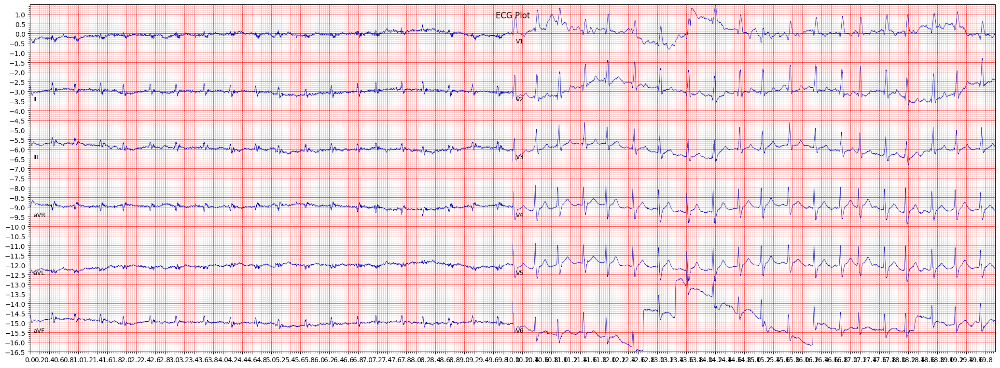

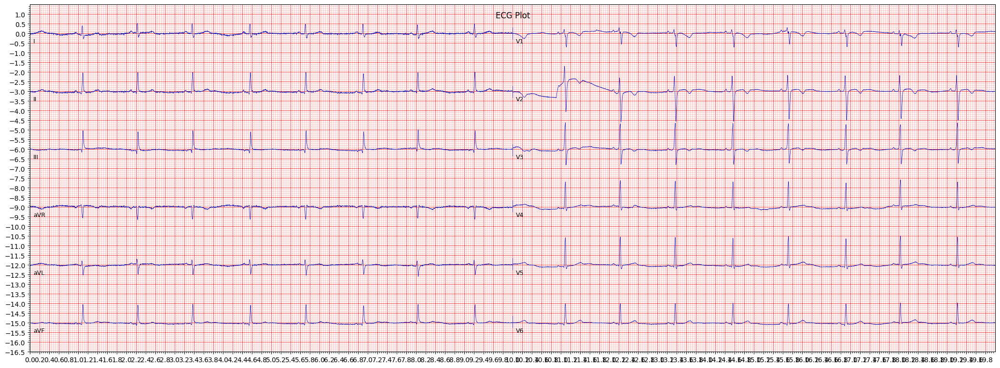

In [ ]:
def plot_ecg(path):
    ecg_data = load_data(path)
    ecg_plot.plot(ecg_data[0]/1000, sample_rate=500, title='ECG Plot')
    ecg_plot.show()
plot_ecg('content/dataset/WFDBRecords/01/010/JS00001.mat')
plot_ecg('content/dataset/WFDBRecords/01/010/JS00002.mat')

## Configurating Data processing parameters

In [ ]:
MAX_SECONDS = 30
WINDOW_SEC = 1.0
PRE_R_SEC = 0.5
LEAD_INDEX = 1
FS = 500

SNOMED_MAP = {
    "164889003": "Normal",
    "426177001": "AV_Block",
    "39732003":  "Other",
    "164909002": "AFib",
    "164931005": "Other",
    "251146004": "Other",
}
DEFAULT_LABEL = "Other"

## Helper Functions for extracting ECG data from .mat data files

In [ ]:
def parse_header_label(hea_path: Path) -> str:
    with open(hea_path, "r") as f:
        for line in f:
            if line.startswith("#Dx:"):
                codes = re.findall(r"\d+", line)
                for c in codes:
                    if c in SNOMED_MAP:
                        return SNOMED_MAP[c]
    return DEFAULT_LABEL

def load_signal(record_base: Path, max_seconds: int | None) -> np.ndarray:
    rec = wfdb.rdrecord(str(record_base))
    sig = rec.p_signal
    if max_seconds is not None:
        sig = sig[: int(max_seconds * rec.fs)]
    return sig.astype(np.float32)

def detect_rpeaks(sig: np.ndarray, fs: int) -> np.ndarray:
    x = sig[:, LEAD_INDEX]
    peaks = wfproc.gqrs_detect(x, fs=fs)
    #print(peaks)
    #peaks = wfproc.correct_peaks(x, peak_inds=peaks, search_radius=int(0.05 * #fs), smooth_window_size=2)
    return peaks

def extract_beats(sig: np.ndarray, rpeaks: np.ndarray, fs: int) -> np.ndarray:
    half_win = int(WINDOW_SEC * fs / 2)
    beats = []
    for r in rpeaks:
        start = r - half_win
        end = r + half_win
        if start < 0 or end > len(sig):
            continue
        beat = sig[start:end, LEAD_INDEX]
        beats.append(beat)
    return np.stack(beats) if beats else np.empty((0, int(WINDOW_SEC * fs)))

def build_resnet(input_shape: tuple[int, int], num_classes: int) -> tf.keras.Model:
    def res_block(x, filters, kernel_size=7):
        shortcut = x
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.Activation("relu")(x)
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)
        x = layers.Add()([x, shortcut])
        x = layers.Activation("relu")(x)
        return x

    inp = layers.Input(shape=input_shape)
    x = layers.Conv1D(32, 7, padding="same", activation="relu")(inp)
    x = layers.MaxPooling1D(2)(x)
    for f in [32, 64, 64, 128, 128, 256]:
        x = res_block(x, f)
        if f in {64, 128, 256}:
            x = layers.MaxPooling1D(2)(x)
    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(128, activation="relu")(x)
    out = layers.Dense(num_classes, activation="softmax")(x)
    return models.Model(inp, out, name="ResNet1D")

## Load and Preprocess Data

In [ ]:
DATA_DIR = Path("dataset/WFDBRecords")  # path to the dataset
beats, labels = [], []
hea_files = sorted(DATA_DIR.rglob("*.hea"))
print(f"Found {len(hea_files)} header files")

for hea in tqdm(hea_files, desc="Processing records"):
    label = parse_header_label(hea)
    record_base = hea.with_suffix("")
    try:
        sig = load_signal(record_base, MAX_SECONDS)
    except Exception as e:
        continue
    rpeaks = detect_rpeaks(sig, FS)
    record_beats = extract_beats(sig, rpeaks, FS)
    print(record_beats)
    if record_beats.size == 0:
        continue
    beats.append(record_beats)
    labels.extend([label] * len(record_beats))

X = np.concatenate(beats)
X = X[..., np.newaxis]
le = LabelEncoder()
y = le.fit_transform(labels)
CLASS_NAMES = le.classes_.tolist()

Found 45152 header files


Processing records:   0%|                     | 4/45152 [00:00<22:35, 33.32it/s]

[[ 0.049  0.059  0.063 ...  0.059  0.068  0.073]
 [ 0.4    0.4    0.366 ...  0.254  0.234  0.278]
 [ 0.044  0.029  0.024 ...  0.049  0.049  0.034]
 ...
 [ 0.078  0.078  0.068 ...  0.024  0.029  0.015]
 [ 0.278  0.254  0.181 ...  0.015  0.088  0.122]
 [-0.034 -0.01  -0.005 ... -0.054 -0.054 -0.054]]
[[-0.078 -0.059 -0.049 ...  0.015  0.02   0.   ]
 [-0.024 -0.02  -0.01  ... -0.039 -0.015 -0.024]
 [-0.034 -0.039 -0.059 ...  0.015  0.005  0.005]
 ...
 [-0.049 -0.049 -0.054 ... -0.01  -0.024 -0.029]
 [-0.088 -0.073 -0.093 ... -0.01  -0.029 -0.029]
 [ 0.005  0.01   0.    ...  0.01   0.015  0.029]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.039 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.107 -0.107 -0.107]]
[[-0.005  0.015  0.005 ... -0.137 -0.127 -0.093]
 [ 0.078  0.083  0.093 ... -0.098 -0.093 -0.088]
 [

Processing records:   0%|                    | 12/45152 [00:00<21:51, 34.43it/s]

[[-0.063 -0.049 -0.039 ...  0.054  0.054  0.049]
 [ 0.073  0.068  0.049 ...  0.034  0.029  0.029]
 [ 0.039  0.024  0.015 ... -0.093 -0.098 -0.098]
 ...
 [ 0.054  0.059  0.049 ...  0.024  0.02   0.02 ]
 [ 0.029  0.024  0.015 ... -0.073 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ... -0.054 -0.068 -0.078]]
[[-0.015 -0.005 -0.005 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.098 -0.098 -0.098]
 [-0.073 -0.078 -0.083 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.044 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.01  ... -0.068 -0.068 -0.068]]
[[-0.088 -0.078 -0.054 ... -0.078 -0.117 -0.102]
 [-0.034 -0.024 -0.034 ... -0.063 -0.054 -0.034]
 [-0.117 -0.137 -0.166 ... -0.112 -0.073 -0.059]
 ...
 [-0.083 -0.068 -0.063 ... -0.078 -0.068 -0.102]
 [-0.073 -0.068 -0.073 ... -0.029 -0.044 -0.034]
 [-0.078 -0.068 -0.102 ... -0.029 -0.039 -0.044]]
[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.059]
 [-0.054 -0.044 -0.039 ... -0.039 -0.024 -0.029]
 [

Processing records:   0%|                    | 16/45152 [00:00<22:43, 33.09it/s]

[[-0.039 -0.015 -0.024 ... -0.059 -0.068 -0.059]
 [-0.054 -0.049 -0.039 ... -0.02  -0.039 -0.024]
 [-0.02  -0.024  0.    ... -0.034 -0.039 -0.063]
 ...
 [-0.044 -0.054 -0.063 ... -0.015 -0.044 -0.039]
 [-0.015 -0.01  -0.024 ... -0.024  0.    -0.01 ]
 [ 0.    -0.029 -0.039 ... -0.015 -0.015 -0.005]]
[[ 0.     0.01  -0.005 ...  0.005  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.034  0.044]
 [ 0.029  0.039  0.029 ... -0.024 -0.024 -0.034]
 ...
 [-0.049 -0.063 -0.073 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.078 -0.054 -0.039]
 [-0.073 -0.078 -0.068 ... -0.132 -0.112 -0.093]]
[[ 0.029  0.02  -0.005 ...  0.005  0.044  0.02 ]
 [ 0.005 -0.015 -0.029 ... -0.024  0.005 -0.02 ]
 [ 0.024  0.034  0.015 ... -0.01  -0.054 -0.059]
 ...
 [ 0.034  0.02   0.01  ... -0.015 -0.01   0.039]
 [-0.015 -0.01   0.039 ... -0.01   0.005 -0.029]
 [ 0.005  0.005  0.005 ...  0.    -0.024 -0.02 ]]
[[-0.015 -0.039 -0.054 ... -0.098 -0.137 -0.122]
 [-0.083 -0.068 -0.073 ...  0.024 -0.029 -0.049]
 [

Processing records:   0%|                    | 20/45152 [00:00<22:23, 33.58it/s]

[[-0.068 -0.068 -0.068 ... -0.024 -0.034 -0.039]
 [ 0.01   0.     0.005 ... -0.142 -0.166 -0.185]
 [-0.137 -0.146 -0.142 ... -0.176 -0.161 -0.151]
 ...
 [ 0.068  0.068  0.063 ...  0.102  0.098  0.098]
 [ 0.107  0.102  0.098 ...  0.142  0.146  0.156]
 [ 0.229  0.215  0.176 ... -0.181 -0.176 -0.166]]
[[-0.073 -0.068 -0.063 ... -0.034 -0.029 -0.029]
 [-0.054 -0.049 -0.054 ... -0.01  -0.005  0.   ]
 [-0.029 -0.034 -0.039 ...  0.01   0.01   0.015]
 ...
 [ 0.049  0.063  0.068 ... -0.122 -0.122 -0.122]
 [-0.083 -0.088 -0.102 ...  0.02   0.024  0.034]
 [ 0.039  0.054  0.063 ... -0.015 -0.02  -0.01 ]]
[[ 0.249  0.327  0.395 ... -0.015  0.005 -0.01 ]
 [ 0.229  0.273  0.327 ... -0.054 -0.034 -0.034]
 [ 0.224  0.249  0.327 ... -0.029 -0.073 -0.073]
 ...
 [ 0.459  0.522  0.488 ... -0.015 -0.039 -0.059]
 [ 0.429  0.508  0.547 ... -0.024 -0.01   0.01 ]
 [ 0.327  0.395  0.483 ... -0.015 -0.02   0.   ]]


Processing records:   0%|                    | 28/45152 [00:00<21:56, 34.29it/s]

[[ 0.005  0.005  0.01  ...  0.005  0.005  0.015]
 [ 0.024  0.029  0.029 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.005]
 ...
 [ 0.01   0.015  0.01  ...  0.005  0.005  0.005]
 [ 0.01  -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.015  0.    ...  0.01   0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.005  0.015  0.024 ...  0.02   0.024  0.005]
 ...
 [-0.005  0.     0.005 ... -0.01  -0.015 -0.005]
 [ 0.005 -0.01  -0.015 ...  0.02   0.029  0.039]
 [ 0.044  0.029  0.    ...  0.02   0.015 -0.01 ]]
[[ 0.044  0.078  0.039 ... -0.01  -0.01   0.039]
 [-0.049 -0.078 -0.093 ...  0.005 -0.005 -0.029]
 [-0.029 -0.044 -0.049 ...  0.015 -0.01  -0.024]
 ...
 [ 0.    -0.015 -0.034 ... -0.02   0.005  0.034]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.054 -0.034 -0.034 ... -0.039 -0.049 -0.093]]
[[-0.039 -0.029 -0.059 ... -0.039 -0.015 -0.005]
 [ 0.005  0.015  0.024 ... -0.039 -0.024 -0.02 ]
 [

Processing records:   0%|                    | 32/45152 [00:00<21:57, 34.24it/s]

[[-0.005 -0.015 -0.024 ...  0.063  0.068  0.078]
 [ 0.02   0.024  0.024 ... -0.151 -0.156 -0.156]
 [ 0.215  0.298  0.351 ... -0.068 -0.073 -0.093]
 ...
 [ 0.332  0.39   0.42  ... -0.029 -0.044 -0.049]
 [ 0.    -0.034 -0.02  ...  0.005  0.029  0.029]
 [-0.049 -0.02  -0.015 ... -0.015 -0.02  -0.015]]
[[ 0.161  0.171  0.176 ... -0.063 -0.059 -0.044]
 [-0.122 -0.107 -0.117 ...  0.02   0.029  0.029]
 [ 0.405  0.459  0.503 ... -0.005  0.005  0.029]
 ...
 [-0.044 -0.044 -0.054 ... -0.054 -0.059 -0.049]
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [ 0.063  0.059  0.054 ...  0.376  0.273  0.107]]
[[-0.054 -0.049 -0.039 ... -0.044 -0.049 -0.078]
 [-0.088 -0.034  0.    ... -0.073 -0.078 -0.059]
 [-0.059 -0.059 -0.039 ... -0.049 -0.054 -0.024]
 ...
 [-0.039 -0.034 -0.024 ... -0.068 -0.034 -0.034]
 [-0.068 -0.078 -0.039 ... -0.054 -0.044 -0.015]
 [-0.005 -0.029 -0.029 ... -0.063 -0.059 -0.039]]
[[-0.088 -0.098 -0.088 ...  0.346  0.156  0.044]
 [ 0.     0.     0.    ...  0.     0.015  0.015]
 [

Processing records:   0%|                    | 36/45152 [00:01<21:52, 34.39it/s]

[[-0.029 -0.044  0.    ... -0.01  -0.015 -0.024]
 [ 0.083  0.102  0.073 ...  0.425  0.532  0.683]
 [-0.073 -0.044 -0.01  ... -0.098 -0.127 -0.088]
 ...
 [-0.054  0.068  0.02  ... -0.088 -0.068 -0.059]
 [ 0.054  0.098  0.112 ... -0.088 -0.044 -0.063]
 [ 0.068  0.117  0.112 ...  0.088  0.02  -0.01 ]]
[[-0.146 -0.151 -0.156 ... -0.068 -0.049 -0.049]
 [ 0.015 -0.015 -0.039 ... -0.044 -0.044 -0.044]
 [-0.112 -0.161 -0.117 ... -0.034 -0.034 -0.044]
 ...
 [-0.063 -0.078 -0.073 ...  0.273  0.244  0.195]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.01   0.    ... -0.063 -0.073 -0.073]]
[[ 0.02   0.02   0.02  ... -0.049 -0.044 -0.024]
 [ 0.127  0.132  0.132 ... -0.098 -0.098 -0.083]
 [ 0.     0.    -0.01  ...  0.01   0.01   0.024]
 ...
 [ 0.142  0.137  0.137 ...  0.088  0.088  0.102]
 [ 0.215  0.22   0.22  ...  0.054  0.049  0.054]
 [ 0.185  0.185  0.185 ...  0.068  0.059  0.059]]


Processing records:   0%|                    | 40/45152 [00:01<21:51, 34.39it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 [-0.127 -0.137 -0.127 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.073 -0.078 -0.078]
 ...
 [ 0.029  0.034  0.034 ... -0.015 -0.029 -0.034]
 [ 0.098  0.098  0.102 ... -0.059 -0.059 -0.059]
 [ 0.405  0.478  0.532 ... -0.088 -0.083 -0.088]]
[[-0.107 -0.107 -0.107 ... -0.063 -0.063 -0.068]
 [-0.049 -0.054 -0.054 ... -0.098 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.068]
 [-0.054 -0.049 -0.059 ... -0.078 -0.083 -0.083]]
[[ 0.381  0.459  0.42  ... -0.185 -0.171 -0.151]
 [ 0.366  0.468  0.503 ... -0.156 -0.156 -0.166]
 [ 0.342  0.454  0.551 ... -0.137 -0.122 -0.122]
 ...
 [ 0.234  0.346  0.449 ... -0.098 -0.098 -0.117]
 [ 0.468  0.532  0.556 ... -0.112 -0.098 -0.078]
 [ 0.439  0.532  0.581 ... -0.01  -0.015 -0.01 ]]
[[-0.083 -0.073 -0.078 ... -0.19  -0.176 -0.181]
 [-0.166 -0.166 -0.176 ... -0.107 -0.146 -0.156]
 [

Processing records:   0%|                    | 44/45152 [00:01<21:53, 34.33it/s]

[[ 0.171  0.176  0.181 ...  0.034  0.044  0.044]
 [ 0.254  0.239  0.249 ...  0.015  0.024  0.044]
 [ 0.205  0.171  0.171 ...  0.127  0.117  0.132]
 ...
 [ 0.088  0.063  0.073 ... -0.029 -0.039 -0.024]
 [ 0.044  0.034  0.02  ...  0.049  0.034  0.044]
 [ 0.234  0.239  0.244 ... -0.098 -0.112 -0.102]]
[[-0.02  -0.015 -0.024 ... -0.024 -0.02  -0.024]
 [-0.029 -0.02  -0.02  ... -0.02  -0.01  -0.015]
 [ 0.112  0.122  0.137 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.044 -0.044 -0.034 ... -0.01   0.    -0.005]
 [ 0.034  0.039  0.024 ... -0.01  -0.01  -0.015]
 [-0.005 -0.01  -0.029 ...  0.005  0.    -0.01 ]]
[[-0.054 -0.044 -0.049 ...  0.024  0.044  0.049]
 [ 0.029  0.     0.02  ...  0.02   0.015  0.01 ]
 [ 0.044  0.024  0.015 ... -0.054 -0.039 -0.049]
 ...
 [ 0.02  -0.049 -0.063 ...  0.02  -0.005 -0.024]
 [ 0.02   0.005  0.015 ... -0.015 -0.039 -0.083]
 [-0.015 -0.024 -0.02  ...  0.01   0.049  0.015]]
[[-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.078 -0.088 -0.088 ... -0.054 -0.049 -0.039]
 [

Processing records:   0%|                    | 48/45152 [00:01<21:52, 34.36it/s]

[[ 0.137  0.142  0.112 ... -0.039 -0.054 -0.044]
 [ 0.127  0.146  0.156 ... -0.063 -0.063 -0.063]
 [ 0.156  0.137  0.122 ... -0.029 -0.044 -0.044]
 ...
 [ 0.054  0.073  0.049 ... -0.029 -0.034 -0.034]
 [ 0.02   0.005  0.01  ... -0.01   0.     0.   ]
 [ 0.054  0.039  0.034 ... -0.034 -0.039 -0.034]]
[[-0.02  -0.01   0.005 ...  0.102  0.102  0.102]
 [ 0.068  0.073  0.088 ...  0.044  0.044  0.02 ]
 [-0.005 -0.005  0.01  ...  0.039  0.039  0.034]
 ...
 [-0.01   0.     0.005 ...  0.107  0.112  0.117]
 [ 0.073  0.059  0.054 ...  0.112  0.112  0.112]
 [ 0.068  0.059  0.063 ...  0.024  0.024  0.024]]
[[-0.005  0.    -0.029 ... -0.029 -0.02  -0.024]
 [-0.02  -0.005 -0.02  ... -0.063 -0.063 -0.049]
 [-0.024 -0.02  -0.049 ... -0.059 -0.063 -0.029]
 ...
 [-0.015 -0.029 -0.039 ... -0.049 -0.039 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.039 -0.059 -0.049]
 [-0.059 -0.049 -0.034 ... -0.039 -0.024 -0.029]]
[[-0.039 -0.044 -0.039 ... -0.068 -0.068 -0.078]
 [-0.068 -0.078 -0.068 ...  0.005  0.029  0.029]
 [

Processing records:   0%|                    | 52/45152 [00:01<21:50, 34.41it/s]

[[-0.078 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ... -0.02  -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.054 -0.063 -0.073 ... -0.088 -0.083 -0.083]
 [-0.088 -0.102 -0.107 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.01   0.01 ]]
[[-0.024 -0.02  -0.02  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.     0.01  ... -0.02  -0.005  0.01 ]
 ...
 [-0.029 -0.015 -0.015 ... -0.044 -0.044 -0.054]
 [-0.054 -0.063 -0.054 ... -0.063 -0.073 -0.073]
 [-0.054 -0.039 -0.044 ... -0.02   0.005  0.01 ]]
[[ 0.137  0.146  0.137 ... -0.137 -0.137 -0.117]
 [ 0.117  0.137  0.146 ... -0.166 -0.166 -0.146]
 [ 0.117  0.127  0.127 ... -0.156 -0.127 -0.132]
 ...
 [ 0.127  0.127  0.127 ... -0.127 -0.117 -0.107]
 [ 0.156  0.151  0.156 ... -0.088 -0.107 -0.107]
 [ 0.156  0.166  0.146 ... -0.146 -0.117 -0.098]]
[[ 0.063  0.059  0.054 ...  0.005  0.039  0.02 ]
 [ 0.063  0.059  0.059 ... -0.015 -0.01  -0.01 ]
 [

Processing records:   0%|                    | 56/45152 [00:01<21:50, 34.40it/s]

[[-0.107 -0.098 -0.093 ...  0.044  0.044  0.054]
 [-0.063 -0.063 -0.049 ...  0.044  0.044  0.044]
 [-0.073 -0.083 -0.073 ...  0.024  0.024  0.034]
 ...
 [-0.059 -0.063 -0.068 ...  0.049  0.039  0.029]
 [-0.088 -0.088 -0.088 ...  0.039  0.034  0.044]
 [-0.098 -0.088 -0.073 ...  0.059  0.039  0.044]]
[[-0.054 -0.049 -0.044 ...  0.01   0.01   0.005]
 [-0.005 -0.02   0.    ...  0.468  0.522  0.542]
 [-0.005  0.     0.015 ... -0.005 -0.005 -0.005]
 ...
 [ 0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.01  -0.005]
 [ 0.088  0.088  0.117 ...  0.029  0.029  0.024]]
[[ 0.024  0.034  0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.078 -0.029 ... -0.029 -0.015 -0.049]
 [-0.098 -0.034 -0.039 ... -0.049 -0.049 -0.078]
 ...
 [-0.083 -0.02   0.044 ... -0.044  0.005  0.005]
 [-0.005 -0.024 -0.01  ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.024 -0.01  ...  0.039 -0.02  -0.034]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.063 -0.054]
 [-0.044 -0.044 -0.029 ... -0.049 -0.049 -0.063]
 [

Processing records:   0%|                    | 60/45152 [00:01<21:54, 34.30it/s]

[[ 0.054  0.02   0.034 ... -0.078 -0.073 -0.063]
 [-0.088 -0.083 -0.049 ... -0.059 -0.059 -0.059]
 [-0.054 -0.02   0.005 ... -0.029 -0.034 -0.039]
 ...
 [-0.044 -0.063 -0.078 ... -0.02  -0.029 -0.024]
 [-0.049 -0.059 -0.073 ... -0.029 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.01  -0.034 -0.059]]
[[ 0.015  0.01   0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.01   0.005 ... -0.039 -0.039 -0.034]
 [ 0.02   0.005  0.01  ... -0.044 -0.049 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.098 -0.107 -0.112 ... -0.01  -0.015 -0.01 ]]
[[-0.049 -0.068 -0.073 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.059 ... -0.044 -0.044 -0.054]
 [-0.039 -0.054 -0.034 ... -0.044 -0.054 -0.039]
 ...
 [-0.029 -0.044 -0.024 ... -0.054 -0.054 -0.034]
 [-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.044 -0.054 ... -0.024 -0.039 -0.049]
 [-0.088 -0.088 -0.093 ... -0.034 -0.044 -0.039]
 [

Processing records:   0%|                    | 64/45152 [00:01<21:56, 34.26it/s]

[[-0.054 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.054]
 ...
 [ 0.088  0.088  0.088 ... -0.22  -0.264 -0.293]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.044]
 [ 0.205  0.205  0.205 ... -0.224 -0.205 -0.195]]
[[-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.083 ... -0.029 -0.015 -0.015]
 ...
 [-0.078 -0.088 -0.078 ...  0.015  0.01   0.01 ]
 [ 0.044  0.044  0.039 ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.005 ... -0.039 -0.039 -0.044]]
[[-0.376 -0.317 -0.268 ... -0.015 -0.02  -0.029]
 [ 0.068  0.088  0.078 ...  0.015  0.02   0.02 ]
 [ 0.127  0.044 -0.068 ...  0.088  0.132  0.2  ]
 ...
 [ 0.146  0.142  0.137 ... -0.024 -0.034 -0.034]
 [ 0.039  0.049  0.044 ...  0.093  0.088  0.093]
 [-0.029 -0.029 -0.034 ...  0.229  0.293  0.356]]


Processing records:   0%|                    | 68/45152 [00:02<22:38, 33.20it/s]

[[ 0.    -0.005 -0.015 ... -0.054 -0.059 -0.059]
 [-0.039 -0.044 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.044 -0.054 ... -0.073 -0.068 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.034 -0.024 -0.01 ]
 [ 0.01   0.01  -0.015 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.073 ... -0.083 -0.078 -0.068]]
[[-0.063 -0.068 -0.068 ...  0.39   0.542  0.747]
 [-0.029 -0.049 -0.044 ... -0.029 -0.02  -0.024]
 [ 0.005 -0.005 -0.01  ... -0.01  -0.02  -0.034]
 ...
 [-0.01  -0.024 -0.029 ... -0.068 -0.063 -0.059]
 [-0.146 -0.151 -0.132 ... -0.063 -0.049 -0.049]
 [-0.005  0.     0.    ... -0.068 -0.073 -0.078]]
[[ 0.015  0.015  0.01  ... -0.068 -0.073 -0.102]
 [-0.063 -0.073 -0.054 ...  0.2    0.205  0.22 ]
 [ 0.137  0.142  0.137 ...  0.176  0.181  0.161]
 ...
 [-0.078 -0.073 -0.073 ...  0.005  0.     0.005]
 [-0.005 -0.01  -0.01  ... -0.063 -0.054 -0.039]
 [-0.063 -0.068 -0.078 ...  0.01   0.     0.005]]
[[-0.044 -0.039 -0.039 ... -0.049 -0.054 -0.063]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 [

Processing records:   0%|                    | 72/45152 [00:02<22:22, 33.58it/s]

[[-0.039 -0.029 -0.029 ...  0.005  0.005  0.015]
 [ 0.005  0.    -0.005 ... -0.024 -0.024 -0.015]
 [ 0.024  0.029  0.039 ...  0.034  0.029  0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.     0.01   0.02 ]
 [-0.034 -0.039 -0.039 ...  0.312  0.254  0.229]
 [ 0.327  0.298  0.273 ...  0.2    0.259  0.273]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.01   0.02  ... -0.112 -0.093 -0.059]
 [-0.146 -0.161 -0.166 ...  0.024  0.049  0.059]
 [-0.215 -0.22  -0.215 ...  0.142  0.132  0.132]
 ...
 [ 0.088  0.088  0.078 ...  0.122  0.156  0.171]
 [ 0.024  0.024  0.034 ...  0.063  0.107  0.127]
 [-0.059 -0.044 -0.059 ...  0.156  0.156  0.166]]
[[-0.049 -0.039 -0.039 ... -0.073 -0.063 -0.049]
 [-0.063 -0.063 -0.073 ... -0.054 -0.088 -0.073]
 [

Processing records:   0%|                    | 76/45152 [00:02<22:09, 33.90it/s]

[[-0.049 -0.029 -0.02  ...  0.083  0.142  0.098]
 [-0.029 -0.054 -0.088 ...  0.029  0.024  0.024]
 [-0.034 -0.039 -0.039 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.044 -0.029 -0.063 ...  0.093  0.073 -0.015]
 [-0.015 -0.044 -0.049 ...  0.01   0.     0.015]
 [ 0.02   0.02   0.093 ...  0.034  0.015  0.024]]
[[-0.029 -0.044 -0.024 ... -0.015 -0.02  -0.034]
 [-0.063 -0.044 -0.044 ... -0.039 -0.044 -0.054]
 [-0.005  0.    -0.015 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.015 -0.02  -0.024 ... -0.059 -0.068 -0.054]
 [-0.073 -0.063 -0.068 ...  0.005 -0.01  -0.024]
 [ 0.     0.015  0.01  ...  0.01   0.    -0.015]]
[[ 0.044  0.049  0.059 ... -0.073 -0.073 -0.059]
 [ 0.02   0.024  0.024 ... -0.034 -0.029 -0.01 ]
 [-0.137 -0.146 -0.142 ... -0.02  -0.01  -0.059]
 ...
 [-0.063 -0.078 -0.102 ... -0.039 -0.049 -0.044]
 [-0.059 -0.044 -0.034 ... -0.132 -0.122 -0.098]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.029]]
[[-0.034 -0.015 -0.015 ... -0.2   -0.19  -0.176]
 [-0.073 -0.059 -0.054 ... -0.142 -0.137 -0.132]
 [

Processing records:   0%|                    | 80/45152 [00:02<22:02, 34.07it/s]

[[-0.137 -0.142 -0.117 ...  0.02   0.02   0.015]
 [ 0.02   0.02   0.005 ...  0.034  0.049  0.039]
 [ 0.034  0.039  0.039 ... -0.063 -0.059 -0.063]
 ...
 [-0.024 -0.02  -0.01  ... -0.063 -0.059 -0.059]
 [-0.166 -0.171 -0.161 ... -0.01   0.005  0.005]
 [-0.024 -0.034 -0.024 ... -0.02  -0.024 -0.02 ]]
[[-0.068 -0.073 -0.078 ... -0.054 -0.063 -0.068]
 [-0.088 -0.093 -0.068 ... -0.083 -0.078 -0.078]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 ...
 [-0.029 -0.029 -0.039 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.068 ... -0.073 -0.068 -0.068]
 [-0.083 -0.063 -0.068 ... -0.054 -0.063 -0.068]]
[[ 0.005  0.015 -0.005 ... -0.015  0.059  0.049]
 [ 0.088  0.063  0.029 ... -0.044 -0.049 -0.054]
 [-0.117 -0.078 -0.049 ... -0.063 -0.039 -0.02 ]
 ...
 [-0.015 -0.01  -0.029 ... -0.078 -0.063 -0.044]
 [-0.151 -0.142 -0.117 ... -0.049 -0.093 -0.073]
 [-0.029 -0.024  0.    ...  0.034  0.01   0.005]]
[[-0.151 -0.146 -0.161 ... -0.073 -0.073 -0.078]
 [-0.093 -0.107 -0.117 ... -0.039 -0.034 -0.034]
 [

Processing records:   0%|                    | 84/45152 [00:02<21:49, 34.41it/s]

[[-0.039 -0.044 -0.039 ...  1.137  1.157  1.166]
 [-0.049 -0.073 -0.093 ... -0.024 -0.044  0.015]
 [-0.029 -0.024 -0.015 ... -0.059 -0.054 -0.02 ]
 ...
 [-0.073 -0.029 -0.068 ... -0.083 -0.039 -0.029]
 [-0.044 -0.015 -0.024 ...  0.532  0.615  0.669]
 [ 0.61   0.722  0.825 ... -0.107 -0.102 -0.088]]
[[-0.098 -0.098 -0.098 ... -0.2   -0.2   -0.2  ]
 [-0.19  -0.195 -0.195 ... -0.083 -0.083 -0.093]
 [-0.112 -0.112 -0.112 ... -0.102 -0.093 -0.093]
 ...
 [ 0.078  0.083  0.083 ... -0.044 -0.044 -0.054]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.02  ...  0.044  0.034  0.034]]
[[ 0.005 -0.01  -0.01  ... -0.039 -0.015 -0.024]
 [-0.073 -0.083 -0.098 ...  0.015  0.029  0.02 ]
 [-0.01  -0.024 -0.02  ... -0.005  0.029  0.029]
 ...
 [-0.015 -0.005 -0.01  ...  0.     0.01   0.015]
 [-0.039 -0.034 -0.015 ...  0.005  0.    -0.015]
 [-0.024 -0.024 -0.029 ...  0.024  0.029  0.039]]
[[ 0.049  0.029  0.02  ...  0.015 -0.01  -0.02 ]
 [-0.054 -0.122 -0.098 ...  0.127  0.112  0.083]
 [

Processing records:   0%|                    | 88/45152 [00:02<21:38, 34.71it/s]

[[-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.034]
 [-0.015 -0.005 -0.01  ... -0.098 -0.093 -0.093]
 [-0.093 -0.093 -0.088 ... -0.059 -0.059 -0.054]
 ...
 [ 0.098  0.093  0.088 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.098 -0.068 -0.068 ... -0.034 -0.044 -0.044]
 [-0.117 -0.127 -0.093 ... -0.015  0.01   0.01 ]
 [-0.039 -0.049 -0.063 ... -0.054 -0.059 -0.068]
 [-0.054 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [-0.098 -0.098 -0.083 ... -0.039 -0.02  -0.034]
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.034]]
[[-0.059 -0.044 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.063 -0.054 ... -0.005 -0.01  -0.015]
 [-0.044 -0.049 -0.054 ... -0.02  -0.02  -0.024]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.059]
 [ 0.034  0.024  0.02  ... -0.02  -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]]
[[ 0.     0.     0.    ...  0.01   0.02   0.01 ]
 [ 0.029  0.039  0.059 ... -0.01  -0.005 -0.005]
 [ 0.01

Processing records:   0%|                    | 92/45152 [00:02<21:39, 34.68it/s]

[[-0.146 -0.137 -0.146 ...  0.029  0.029  0.029]
 [-0.083 -0.073 -0.068 ...  0.151  0.161  0.156]
 [-0.093 -0.083 -0.078 ...  0.137  0.151  0.161]
 ...
 [-0.185 -0.181 -0.195 ...  0.127  0.142  0.146]
 [-0.19  -0.176 -0.166 ...  0.151  0.166  0.181]
 [-0.132 -0.117 -0.107 ...  0.22   0.22   0.22 ]]
[[-0.02  -0.029 -0.044 ... -0.122 -0.107 -0.088]
 [-0.122 -0.107 -0.073 ... -0.029  0.    -0.015]
 [-0.034 -0.015 -0.02  ... -0.083 -0.102 -0.112]
 ...
 [-0.005 -0.024 -0.039 ... -0.015 -0.034 -0.054]
 [-0.049 -0.068 -0.083 ... -0.02  -0.054 -0.073]
 [-0.054 -0.063 -0.063 ...  0.044  0.044  0.024]]
[[-0.21  -0.171 -0.142 ...  0.01   0.01  -0.02 ]
 [-0.112 -0.132 -0.098 ... -0.01  -0.015 -0.024]
 [-0.278 -0.215 -0.176 ... -0.039 -0.044 -0.063]
 ...
 [ 0.005 -0.02  -0.02  ... -0.02  -0.01   0.015]
 [-0.132 -0.102 -0.078 ... -0.034 -0.01  -0.005]
 [-0.088 -0.059 -0.02  ...  0.005  0.015  0.01 ]]
[[ 0.059  0.063  0.068 ... -0.005  0.005  0.005]
 [ 0.229  0.224  0.215 ... -0.01  -0.01   0.   ]
 [

Processing records:   0%|                    | 96/45152 [00:02<21:37, 34.73it/s]

[[-0.02  -0.02  -0.015 ... -0.132 -0.132 -0.132]
 [-0.098 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.029 ...  0.054  0.054  0.054]
 [ 0.112  0.117  0.117 ...  0.093  0.093  0.093]]
[[-0.068 -0.073 -0.063 ...  0.005  0.    -0.02 ]
 [ 0.039  0.02   0.02  ...  0.029  0.024  0.029]
 [ 0.029  0.034  0.039 ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.02  -0.029 ... -0.005 -0.024  0.01 ]
 [-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.024]
 [-0.015  0.    -0.005 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.078 -0.063]
 [-0.073 -0.073 -0.078 ... -0.034 -0.044 -0.039]
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [-0.054 -0.059 -0.059 ... -0.02  -0.015 -0.029]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.039]
 [-0.024 -0.024 -0.024 ...  0.     0.015  0.   ]]
[[ 0.015  0.    -0.005 ...  0.244  0.176  0.112]
 [-0.005 -0.078 -0.102 ...  0.181  0.132  0.063]
 [

Processing records:   0%|                   | 100/45152 [00:02<21:38, 34.70it/s]

[[-0.054 -0.063 -0.088 ... -0.054 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.024 -0.015 -0.059]
 [-0.044 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 ...
 [-0.049 -0.029 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.063 ... -0.054 -0.059 -0.059]
 [-0.102 -0.059 -0.005 ... -0.039 -0.02  -0.005]]
[[-0.044 -0.049 -0.073 ... -0.02  -0.024  0.   ]
 [-0.01   0.005  0.    ...  0.02  -0.02  -0.068]
 [-0.044 -0.034 -0.015 ... -0.01  -0.02  -0.034]
 ...
 [ 0.015 -0.005 -0.034 ... -0.01  -0.024 -0.005]
 [ 0.015  0.063  0.024 ... -0.068 -0.039 -0.024]
 [-0.01  -0.02  -0.02  ...  0.005  0.015  0.029]]
[[-0.107 -0.098 -0.088 ...  0.112  0.073  0.068]
 [-0.088 -0.083 -0.068 ...  0.     0.    -0.01 ]
 [-0.063 -0.063 -0.059 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.093 -0.088 -0.098 ... -0.044 -0.049 -0.044]
 [ 0.142  0.142  0.161 ... -0.073 -0.088 -0.102]
 [ 0.644  0.747  0.922 ... -0.088 -0.088 -0.093]]


Processing records:   0%|                   | 104/45152 [00:03<22:18, 33.66it/s]

[[-0.044 -0.039 -0.015 ... -0.039 -0.049 -0.039]
 [-0.068 -0.054 -0.044 ... -0.01   0.    -0.034]
 [-0.029 -0.049 -0.034 ... -0.049 -0.054 -0.063]
 ...
 [-0.063 -0.073 -0.073 ... -0.044 -0.078 -0.063]
 [-0.034 -0.054 -0.049 ... -0.02  -0.01   0.005]
 [-0.02  -0.02  -0.034 ... -0.015 -0.01   0.005]]
[[-0.049 -0.073 -0.073 ... -0.054 -0.054 -0.059]
 [-0.059 -0.044 -0.059 ... -0.029 -0.034 -0.049]
 [-0.059 -0.063 -0.063 ... -0.024 -0.02  -0.029]
 ...
 [-0.073 -0.078 -0.088 ...  0.034  0.015  0.005]
 [-0.068 -0.068 -0.073 ...  0.005  0.    -0.005]
 [-0.039 -0.044 -0.039 ...  0.059  0.054  0.054]]
[[-0.102 -0.02   0.015 ... -0.024 -0.063 -0.083]
 [ 0.024  0.039  0.    ... -0.068 -0.059 -0.078]
 [-0.151 -0.127 -0.112 ... -0.015 -0.034 -0.044]
 ...
 [-0.083 -0.093 -0.073 ... -0.073 -0.102 -0.107]
 [-0.015  0.01   0.015 ... -0.044 -0.054 -0.034]
 [ 0.034  0.063  0.039 ... -0.078 -0.049 -0.029]]
[[-0.093 -0.088 -0.083 ...  0.024  0.015 -0.005]
 [-0.029 -0.029 -0.02  ...  0.044  0.039  0.024]
 [

Processing records:   0%|                   | 108/45152 [00:03<22:16, 33.69it/s]

[[-0.405 -0.356 -0.303 ... -0.112 -0.112 -0.098]
 [-0.342 -0.478 -0.551 ... -0.098 -0.102 -0.117]
 [-0.522 -0.459 -0.381 ... -0.098 -0.107 -0.112]
 ...
 [-0.566 -0.517 -0.439 ... -0.063 -0.063 -0.054]
 [ 0.366  0.117 -0.127 ... -0.029 -0.02  -0.024]
 [-0.449 -0.483 -0.468 ...  0.005  0.015 -0.01 ]]
[[ 0.044  0.034  0.034 ... -0.078 -0.044 -0.034]
 [-0.029 -0.059 -0.068 ... -0.01  -0.01  -0.039]
 [ 0.039  0.029  0.029 ... -0.059 -0.068 -0.059]
 ...
 [-0.039 -0.01  -0.034 ... -0.044 -0.015 -0.005]
 [ 0.01   0.024  0.015 ... -0.073 -0.063 -0.044]
 [-0.024  0.01   0.    ... -0.015 -0.005 -0.049]]
[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.02   0.034]
 ...
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 [-0.02  -0.029 -0.034 ...  0.029  0.029  0.034]
 [-0.039 -0.034 -0.029 ...  0.029  0.029  0.029]]
[[-0.073 -0.078 -0.083 ... -0.073 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.049 -0.054 -0.063]
 [

Processing records:   0%|                   | 112/45152 [00:03<22:07, 33.92it/s]

[[-0.034 -0.024 -0.02  ...  0.015  0.005 -0.005]
 [-0.015 -0.015  0.    ... -0.02  -0.015 -0.015]
 [-0.034 -0.039 -0.034 ... -0.039 -0.054 -0.044]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.024 -0.015 ...  0.034  0.02   0.   ]]
[[-0.078 -0.083 -0.068 ... -0.024 -0.034 -0.044]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.024 ... -0.029 -0.029 -0.049]
 [-0.044 -0.044 -0.034 ... -0.02  -0.029 -0.054]
 [-0.01  -0.015 -0.015 ... -0.039 -0.02  -0.015]]
[[-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]]
[[ 0.01   0.01   0.039 ... -0.029 -0.063 -0.054]
 [-0.039 -0.068 -0.068 ...  0.    -0.005 -0.049]
 [

Processing records:   0%|                   | 116/45152 [00:03<22:05, 33.98it/s]

[[-0.024 -0.02  -0.024 ... -0.039 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.063 -0.073 -0.063]
 [-0.063 -0.068 -0.063 ... -0.029 -0.034 -0.034]
 ...
 [-0.054 -0.068 -0.068 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.039 -0.044]
 [-0.029 -0.02  -0.024 ...  0.034  0.02   0.015]]
[[ 0.063  0.044  0.068 ...  0.161  0.142  0.151]
 [ 0.098  0.122  0.127 ...  0.073  0.093  0.112]
 [ 0.083  0.093  0.102 ... -0.029 -0.02  -0.015]
 [ 0.015  0.02   0.024 ... -0.01  -0.01   0.029]
 [ 0.015  0.     0.005 ...  0.039  0.029  0.005]]
[[ 0.     0.029  0.02  ... -0.122 -0.093 -0.049]
 [-0.093 -0.112 -0.093 ... -0.02  -0.054 -0.01 ]
 [ 0.    -0.02   0.    ... -0.015  0.    -0.034]
 ...
 [-0.063 -0.078 -0.093 ... -0.088 -0.093 -0.112]
 [-0.073 -0.088 -0.063 ...  0.02   0.015  0.02 ]
 [ 0.029  0.     0.039 ... -0.073 -0.063 -0.034]]
[[ 0.034  0.039  0.039 ... -0.093 -0.088 -0.083]
 [-0.146 -0.146 -0.146 ...  0.029  0.029  0.029]
 [ 0.02   0.024  0.034 ... -0.01  -0.005  0.   ]
 ...
 [

Processing records:   0%|                   | 120/45152 [00:03<22:01, 34.07it/s]

[[-0.078 -0.073 -0.088 ... -0.102 -0.098 -0.112]
 [ 0.01  -0.01  -0.034 ... -0.112 -0.127 -0.083]
 [ 0.015  0.029  0.01  ... -0.034 -0.039 -0.034]
 ...
 [ 0.005  0.    -0.01  ...  0.005  0.    -0.005]
 [ 0.005  0.01   0.029 ...  0.185  0.234  0.303]
 [-0.024 -0.024  0.034 ... -0.059 -0.054 -0.059]]
[[ 0.093  0.102  0.098 ...  0.21   0.2    0.2  ]
 [-0.576 -0.576 -0.571 ...  0.015  0.024  0.024]
 [ 0.054  0.059  0.059 ...  0.171  0.181  0.181]
 [ 0.244  0.244  0.244 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.19  -0.181 -0.181]
 [-0.166 -0.166 -0.166 ... -0.054 -0.044 -0.044]]
[[ 0.015  0.015  0.015 ... -0.044 -0.044 -0.044]
 [ 1.386  1.24   1.108 ... -0.049 -0.049 -0.044]
 [-0.088 -0.093 -0.102 ... -0.068 -0.063 -0.068]
 ...
 [ 0.142  0.005 -0.073 ...  0.049  0.039  0.034]
 [ 0.005  0.015 -0.005 ...  0.083  0.088  0.088]
 [ 0.054  0.049  0.049 ...  0.142  0.146  0.146]]
[[-0.107 -0.117 -0.117 ... -0.059 -0.059 -0.029]
 [-0.078 -0.088 -0.098 ... -0.107 -0.107 -0.107]
 [-0.45

Processing records:   0%|                   | 124/45152 [00:03<21:58, 34.15it/s]

[[-0.029 -0.029 -0.029 ... -0.102 -0.088 -0.073]
 [-0.073 -0.073 -0.063 ... -0.073 -0.054 -0.034]
 [-0.039 -0.049 -0.054 ... -0.034 -0.015  0.005]
 ...
 [-0.073 -0.088 -0.093 ... -0.063 -0.049 -0.034]
 [-0.02  -0.024 -0.049 ... -0.015  0.015 -0.024]
 [-0.063 -0.059 -0.054 ... -0.034 -0.005  0.024]]
[[ 0.02   0.005 -0.005 ...  0.005 -0.015  0.   ]
 [ 0.005  0.    -0.005 ...  0.015  0.01   0.02 ]
 [ 0.01   0.01   0.    ...  0.005  0.     0.   ]
 ...
 [ 0.     0.    -0.01  ...  0.029  0.034  0.039]
 [ 0.044  0.049  0.029 ...  0.029  0.024  0.024]
 [-0.01  -0.029 -0.044 ...  0.049  0.034  0.044]]
[[-0.059 -0.054 -0.059 ... -0.029 -0.044 -0.039]
 [-0.02  -0.029 -0.024 ... -0.039 -0.029 -0.034]
 [-0.024 -0.049 -0.034 ... -0.015 -0.029 -0.029]
 ...
 [-0.005 -0.02   0.    ... -0.054 -0.049 -0.039]
 [-0.039 -0.039 -0.044 ... -0.005 -0.024 -0.039]
 [-0.044 -0.049 -0.005 ... -0.034 -0.02  -0.039]]
[[ 0.044  0.039  0.034 ... -0.044 -0.044 -0.039]
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.005]
 [

Processing records:   0%|                   | 128/45152 [00:03<22:03, 34.01it/s]

[[-0.059 -0.063 -0.088 ... -0.068 -0.073 -0.073]
 [-0.078 -0.093 -0.063 ... -0.059 -0.044 -0.059]
 [-0.029 -0.024 -0.024 ... -0.073 -0.083 -0.078]
 ...
 [-0.039 -0.024 -0.054 ... -0.098 -0.078 -0.054]
 [-0.063 -0.083 -0.088 ... -0.054 -0.063 -0.078]
 [-0.024 -0.034 -0.039 ... -0.049 -0.049 -0.068]]
[[ 0.015  0.005 -0.005 ... -0.088 -0.102 -0.102]
 [ 0.073  0.063  0.01  ... -0.2   -0.229 -0.259]
 [-0.063 -0.054 -0.044 ... -0.205 -0.181 -0.151]
 ...
 [ 0.015  0.    -0.005 ... -0.063 -0.078 -0.078]
 [ 0.034  0.02   0.01  ... -0.068 -0.078 -0.068]
 [ 0.054  0.029  0.015 ... -0.098 -0.098 -0.122]]
[[-0.044 -0.107 -0.137 ... -0.083 -0.073 -0.078]
 [ 0.034  0.024  0.024 ... -0.21  -0.156 -0.122]
 [ 0.02   0.01   0.02  ... -0.161 -0.234 -0.298]
 ...
 [-0.117 -0.127 -0.112 ... -0.205 -0.195 -0.205]
 [-0.049 -0.024  0.    ... -0.298 -0.273 -0.21 ]
 [-0.02   0.01   0.015 ... -0.005  0.01   0.034]]


Processing records:   0%|                   | 132/45152 [00:03<22:41, 33.06it/s]

[[ 0.01   0.01   0.015 ... -0.063 -0.059 -0.054]
 [-0.044 -0.044 -0.044 ... -0.005  0.     0.005]
 [ 0.02   0.02   0.015 ... -0.078 -0.073 -0.073]
 ...
 [-0.112 -0.098 -0.098 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.015  0.01   0.02  ... -0.156 -0.151 -0.151]]
[[-0.054 -0.054 -0.044 ... -0.029  0.     0.044]
 [ 0.024  0.02   0.039 ... -0.044 -0.039 -0.044]
 [-0.029 -0.044 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.024]
 [ 0.01  -0.015 -0.029 ... -0.015 -0.024 -0.015]
 [-0.015 -0.01  -0.005 ... -0.015 -0.029 -0.024]]
[[ 0.195  0.205  0.2   ...  0.078  0.102  0.161]
 [ 0.137  0.068  0.049 ...  0.093  0.078  0.063]
 [ 0.     0.01   0.029 ...  0.127  0.083  0.039]
 ...
 [ 0.098  0.083  0.078 ...  0.117  0.122  0.122]
 [-0.4   -0.444 -0.483 ...  0.068  0.088  0.083]
 [-0.62  -0.654 -0.722 ...  0.093  0.102  0.102]]
[[-0.049 -0.083 -0.107 ... -0.146 -0.102 -0.132]
 [ 1.396  1.576  1.737 ...  0.947  1.088  1.186]
 [

Processing records:   0%|                   | 136/45152 [00:03<22:30, 33.33it/s]

[[ 0.029  0.029  0.02  ... -0.068 -0.073 -0.073]
 [-0.039 -0.044 -0.059 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.039 ... -0.059 -0.059 -0.054]
 ...
 [ 0.039  0.024  0.029 ... -0.02  -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.044]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]]
[[ 0.005  0.005  0.005 ... -0.005  0.005  0.   ]
 [ 0.015  0.01  -0.005 ...  0.     0.01   0.005]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.005]]
[[-0.22  -0.195 -0.156 ... -0.078 -0.059 -0.054]
 [-0.327 -0.346 -0.351 ...  0.22   0.059 -0.054]
 [-0.049 -0.063 -0.078 ... -0.088 -0.083 -0.078]
 ...
 [-0.049 -0.049 -0.054 ...  0.029  0.024  0.02 ]
 [ 0.073  0.083  0.112 ... -0.059 -0.063 -0.063]
 [-0.195 -0.176 -0.127 ...  0.156 -0.005 -0.127]]
[[ 0.063  0.093  0.102 ...  0.015  0.     0.   ]
 [ 0.024  0.024  0.024 ...  0.    -0.029 -0.02 ]
 [-0.083 -0.098 -0.102 ...  0.005  0.015  0.015]
 ...
 [ 0.039  0.02   0.02  ... -0.054 -0.068 -0.049]
 [-0.171 -0.268 -0.376 ...  0.034  0.005  0.01 ]
 [

Processing records:   0%|                   | 140/45152 [00:04<22:19, 33.59it/s]

[[-0.054 -0.049 -0.063 ... -0.063 -0.049 -0.059]
 [-0.063 -0.063 -0.059 ... -0.049 -0.059 -0.068]
 [-0.059 -0.054 -0.054 ... -0.078 -0.088 -0.093]
 ...
 [-0.024 -0.034 -0.049 ...  0.005 -0.01  -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.063 -0.078 -0.088]
 [-0.102 -0.098 -0.093 ... -0.078 -0.068 -0.078]]
[[-0.01   0.01   0.01  ... -0.02  -0.01  -0.024]
 [-0.054 -0.029  0.    ... -0.024 -0.068 -0.044]
 [-0.098 -0.088 -0.098 ... -0.054 -0.02  -0.024]
 [-0.034 -0.02  -0.024 ... -0.034 -0.034 -0.044]
 [-0.024 -0.029 -0.039 ... -0.054 -0.044 -0.029]
 [-0.049 -0.044 -0.054 ... -0.02  -0.029 -0.01 ]]
[[ 0.088  0.088  0.088 ...  0.156  0.142  0.127]
 [ 0.088  0.088  0.088 ...  0.664  0.732  0.8  ]
 [-0.102 -0.098 -0.102 ...  0.049  0.049  0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.044]
 [-0.044 -0.034 -0.059 ...  1.103  1.113  1.122]
 [-0.142 -0.142 -0.127 ...  0.044  0.049  0.049]]


Processing records:   0%|                   | 144/45152 [00:04<22:06, 33.92it/s]

[[ 0.244  0.244  0.239 ... -0.015 -0.015 -0.015]
 [ 0.034  0.059  0.029 ... -0.805 -0.795 -0.805]
 [-0.698 -0.678 -0.688 ...  0.932  0.971  1.01 ]
 ...
 [-0.063 -0.063 -0.063 ...  0.332  0.332  0.342]
 [ 0.6    0.527  0.478 ...  0.298  0.293  0.278]
 [ 0.259  0.259  0.264 ... -0.122 -0.122 -0.107]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.029  0.029 ... -0.107 -0.107 -0.102]
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.034]
 [-0.059 -0.063 -0.063 ... -0.049 -0.049 -0.044]]
[[-0.054 -0.073 -0.049 ... -0.054 -0.078 -0.093]
 [-0.073 -0.102 -0.098 ... -0.039 -0.024 -0.01 ]
 [-0.039 -0.059 -0.073 ... -0.049 -0.044 -0.044]
 [-0.039 -0.029  0.005 ... -0.059 -0.073 -0.088]
 [-0.146 -0.039 -0.044 ... -0.02   0.    -0.054]
 [-0.073 -0.093 -0.132 ... -0.068 -0.098 -0.107]]
[[ 0.034  0.024  0.029 ... -0.044 -0.015 -0.044]
 [ 0.024  0.044  0.044 ... -0.059 -0.054 -0.059]
 [ 0.02

Processing records:   0%|                   | 148/45152 [00:04<21:56, 34.18it/s]

[[-0.015 -0.005 -0.01  ... -0.029 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.044 ... -0.054 -0.059 -0.054]
 ...
 [-0.049 -0.049 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.063 -0.049 -0.049]
 [-0.024 -0.034 -0.039 ...  0.02   0.02   0.029]]
[[ 0.049  0.044  0.039 ... -0.039 -0.039 -0.039]
 [ 0.005 -0.005  0.005 ... -0.039 -0.039 -0.039]
 [-0.034 -0.029 -0.015 ... -0.122 -0.122 -0.127]
 ...
 [-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.059]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.142 -0.146 -0.146 ... -0.117 -0.117 -0.117]
 [ 0.005 -0.083 -0.102 ... -0.034 -0.034 -0.034]
 [-0.468 -0.654 -0.781 ... -0.029 -0.039 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.176 -0.176 -0.161]
 [-0.083 -0.083 -0.068 ... -0.107 -0.117 -0.122]
 [-0.171 -0.166 -0.161 ... -0.068 -0.063 -0.068]]


Processing records:   0%|                   | 156/45152 [00:04<21:42, 34.54it/s]

[[-0.185 -0.19  -0.195 ... -0.034 -0.044 -0.054]
 [-0.063 -0.073 -0.078 ... -0.161 -0.171 -0.181]
 [-0.171 -0.181 -0.181 ...  0.083  0.098  0.093]
 ...
 [-0.005 -0.005  0.005 ...  0.112  0.122  0.112]
 [ 0.112  0.112  0.122 ... -0.083 -0.083 -0.078]
 [-0.073 -0.078 -0.093 ... -0.112 -0.112 -0.112]]
[[-0.063 -0.073 -0.049 ... -0.015  0.    -0.005]
 [-0.034 -0.02  -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.083 -0.078 -0.098 ... -0.02  -0.039 -0.044]
 ...
 [-0.088 -0.098 -0.102 ...  0.    -0.029 -0.029]
 [-0.059 -0.044 -0.059 ... -0.029 -0.039 -0.034]
 [-0.049 -0.054 -0.063 ...  0.01   0.005  0.   ]]
[[-0.015 -0.02  -0.02  ... -0.122 -0.112 -0.024]
 [-0.034 -0.117 -0.132 ...  0.039  0.024  0.039]
 [ 0.078  0.093 -0.02  ... -0.41  -0.4   -0.166]
 ...
 [-0.151 -0.151 -0.127 ...  0.034  0.02   0.   ]
 [-0.049 -0.005  0.015 ...  0.059  0.059 -0.015]
 [ 0.039  0.078  0.024 ...  0.132  0.102  0.151]]
[[-0.015  0.    -0.005 ...  0.059  0.054  0.044]
 [ 0.029  0.01   0.    ... -0.044 -0.044 -0.044]
 [

Processing records:   0%|                   | 160/45152 [00:04<21:38, 34.65it/s]

[[-0.044 -0.059 -0.073 ... -0.068 -0.093 -0.132]
 [-0.088 -0.088 -0.107 ... -0.02  -0.02  -0.039]
 [-0.044 -0.073 -0.059 ... -0.049 -0.049 -0.093]
 ...
 [-0.044 -0.034 -0.054 ... -0.083 -0.063 -0.073]
 [-0.059 -0.063 -0.073 ... -0.059 -0.029 -0.059]
 [-0.039 -0.049 -0.039 ... -0.029 -0.034 -0.049]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [-0.015 -0.01  -0.01  ...  0.01   0.01   0.005]
 [ 0.     0.     0.01  ... -0.005  0.     0.   ]
 ...
 [-0.073 -0.073 -0.068 ...  0.01   0.01   0.005]
 [ 0.01   0.01   0.005 ...  0.015  0.02   0.02 ]
 [ 0.01   0.005  0.005 ... -0.093 -0.088 -0.088]]
[[-0.156 -0.22  -0.273 ... -0.098 -0.093 -0.088]
 [ 0.937  0.595  0.351 ... -0.068 -0.068 -0.068]
 [ 0.752  0.42   0.176 ... -0.068 -0.073 -0.073]
 ...
 [-0.439 -0.444 -0.444 ... -0.127 -0.137 -0.142]
 [-0.395 -0.361 -0.351 ... -0.156 -0.161 -0.151]
 [-0.415 -0.381 -0.361 ... -0.171 -0.181 -0.181]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.063]
 [

Processing records:   0%|                   | 164/45152 [00:04<21:38, 34.64it/s]

[[ 0.093  0.088  0.073 ... -0.029 -0.034 -0.034]
 [ 0.102  0.102  0.102 ... -0.059 -0.063 -0.063]
 [-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [ 0.01   0.015  0.02  ... -0.088 -0.083 -0.083]
 [ 0.015  0.02   0.029 ... -0.088 -0.093 -0.093]]
[[-0.01  -0.01  -0.063 ...  0.    -0.029 -0.039]
 [-0.161 -0.185 -0.137 ... -0.142 -0.112 -0.132]
 [-0.083 -0.083 -0.093 ... -0.054 -0.054 -0.005]
 [-0.049 -0.059 -0.029 ... -0.034 -0.054 -0.049]
 [-0.054 -0.039 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.063  0.063  0.049 ... -0.029 -0.02  -0.01 ]]
[[ 0.024  0.    -0.015 ... -0.024 -0.029 -0.02 ]
 [-0.054 -0.054 -0.049 ... -0.044 -0.034 -0.044]
 [-0.034 -0.02  -0.005 ... -0.039 -0.034 -0.049]
 ...
 [-0.034 -0.029 -0.015 ... -0.01  -0.015  0.   ]
 [-0.029 -0.02  -0.015 ...  0.015  0.034  0.029]
 [-0.015 -0.015 -0.029 ...  0.     0.015  0.02 ]]


Processing records:   0%|                   | 168/45152 [00:04<22:10, 33.81it/s]

[[-0.083 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.073 -0.073 -0.068]
 ...
 [-0.107 -0.102 -0.098 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.005]
 [ 0.     0.005  0.005 ...  0.005  0.     0.   ]]
[[-0.02  -0.02  -0.005 ... -0.02  -0.039 -0.02 ]
 [ 0.029  0.054  0.024 ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.024 ... -0.083 -0.073 -0.049]
 ...
 [-0.044 -0.034 -0.044 ...  0.005 -0.005 -0.005]
 [ 0.034  0.029  0.029 ... -0.02   0.     0.01 ]
 [ 0.049  0.034  0.049 ...  0.024  0.015 -0.005]]
[[-0.088 -0.098 -0.107 ... -0.054 -0.059 -0.068]
 [-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.024]
 [-0.054 -0.044 -0.024 ... -0.083 -0.059 -0.049]
 ...
 [-0.02   0.    -0.034 ... -0.034  0.     0.02 ]
 [ 0.    -0.005 -0.024 ... -0.102 -0.088 -0.088]
 [-0.156 -0.122 -0.078 ... -0.19  -0.176 -0.166]]
[[ 0.039  0.029  0.034 ... -0.054 -0.034 -0.029]
 [-0.044 -0.063 -0.059 ...  0.229  0.283  0.332]
 [

Processing records:   0%|                   | 172/45152 [00:05<22:01, 34.03it/s]

[[-0.01  -0.044 -0.049 ... -0.02  -0.024 -0.015]
 [ 0.029  0.02   0.    ... -0.059 -0.044 -0.039]
 [-0.034 -0.034 -0.015 ... -0.024 -0.015  0.   ]
 ...
 [-0.01  -0.024 -0.024 ... -0.063 -0.054 -0.044]
 [-0.02   0.005 -0.005 ... -0.015 -0.039 -0.034]
 [-0.01   0.    -0.01  ... -0.029 -0.015 -0.02 ]]
[[-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.059 ... -0.054 -0.054 -0.054]
 [-0.083 -0.078 -0.073 ... -0.054 -0.063 -0.063]
 ...
 [-0.063 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.063 -0.073 -0.083 ... -0.102 -0.102 -0.102]
 [-0.078 -0.078 -0.083 ... -0.102 -0.102 -0.102]]
[[ 0.005 -0.024  0.    ... -0.039 -0.054 -0.049]
 [ 0.049  0.024  0.    ... -0.132 -0.137 -0.098]
 [-0.093 -0.083 -0.063 ... -0.015 -0.024 -0.024]
 ...
 [ 0.024 -0.02  -0.039 ... -0.024 -0.044 -0.039]
 [-0.024 -0.039  0.01  ... -0.093 -0.059 -0.054]
 [-0.005 -0.005 -0.02  ...  0.644  0.678  0.737]]
[[-0.249 -0.229 -0.22  ...  0.239  0.268  0.249]
 [ 0.21   0.19   0.22  ... -0.146 -0.161 -0.171]
 [

Processing records:   0%|                   | 176/45152 [00:05<21:56, 34.17it/s]

[[ 1.015  0.888  0.756 ... -0.063 -0.024  0.059]
 [-0.088 -0.098 -0.132 ...  0.127  0.137  0.156]
 [-0.078 -0.093 -0.127 ... -0.01  -0.01   0.01 ]
 ...
 [ 0.015 -0.024 -0.049 ...  0.049  0.024  0.01 ]
 [ 0.049  0.015 -0.02  ...  0.034  0.02   0.01 ]
 [ 0.181  0.107  0.078 ...  0.044  0.034  0.049]]
[[-0.015 -0.01   0.    ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.034 -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.01  -0.02  ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.015 -0.02  ... -0.01   0.     0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ...  0.044  0.044  0.049]
 [ 0.029  0.029  0.034 ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.005  0.015 ...  0.039  0.044  0.054]
 [ 0.039  0.044  0.049 ...  0.049  0.044  0.044]
 [ 0.054  0.054  0.049 ...  0.005  0.01   0.01 ]]
[[ 0.02   0.015  0.005 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.054 ... -0.029 -0.034 -0.024]
 [

Processing records:   0%|                   | 180/45152 [00:05<21:51, 34.29it/s]

[[-0.088 -0.088 -0.088 ... -0.127 -0.127 -0.098]
 [-0.122 -0.112 -0.122 ... -0.059 -0.063 -0.068]
 [-0.063 -0.063 -0.054 ... -0.01  -0.01   0.   ]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.039]
 [-0.117 -0.112 -0.102 ... -0.137 -0.137 -0.127]
 [-0.088 -0.102 -0.112 ... -0.01  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.073 -0.068]
 [-0.01  -0.01   0.    ... -0.044 -0.024 -0.039]
 [-0.049 -0.063 -0.063 ...  0.024  0.034  0.024]
 ...
 [-0.063 -0.049 -0.054 ... -0.073 -0.063 -0.059]
 [-0.049 -0.039 -0.039 ... -0.034 -0.024 -0.015]
 [-0.049 -0.054 -0.054 ... -0.005 -0.015 -0.015]]
[[-0.063 -0.054 -0.034 ... -0.034 -0.029 -0.034]
 [-0.068 -0.049 -0.049 ... -0.059 -0.068 -0.059]
 [-0.044 -0.073 -0.073 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.063 -0.073 ...  0.01   0.005 -0.015]
 [-0.034 -0.024 -0.02  ... -0.039 -0.029 -0.039]
 [-0.044 -0.039 -0.044 ... -0.005  0.039  0.029]]
[[-0.054 -0.073 -0.078 ...  0.117  0.127  0.146]
 [-0.005  0.024  0.054 ... -0.171 -0.146 -0.137]
 [

Processing records:   0%|                   | 184/45152 [00:05<21:38, 34.64it/s]

[[-0.01  -0.01  -0.02  ...  0.    -0.02  -0.005]
 [ 0.015  0.02   0.005 ... -0.073 -0.088 -0.098]
 [-0.005 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.01  -0.02  -0.063 ... -0.117 -0.039 -0.024]
 [-0.01  -0.024 -0.034 ... -0.068 -0.024 -0.049]
 [-0.015  0.    -0.01  ... -0.029 -0.015 -0.01 ]]
[[-0.063 -0.059 -0.063 ... -0.029 -0.024 -0.034]
 [-0.005 -0.015 -0.005 ... -0.078 -0.078 -0.073]
 [-0.039 -0.054 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.044 -0.029 -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.068 -0.059 -0.068 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.078 -0.054 -0.049]
 [-0.059 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 ...
 [-0.059 -0.034 -0.02  ... -0.029 -0.02  -0.024]
 [-0.049 -0.034 -0.044 ... -0.054 -0.044 -0.049]
 [-0.049 -0.044 -0.039 ...  0.02  -0.01  -0.015]]
[[-0.005 -0.02  -0.024 ... -0.063 -0.024 -0.015]
 [-0.039 -0.083 -0.102 ... -0.01  -0.034 -0.039]
 [

Processing records:   0%|                   | 188/45152 [00:05<21:32, 34.78it/s]

[[-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.024]
 [ 0.005  0.029  0.059 ...  0.005 -0.024 -0.044]
 [ 0.01   0.029  0.044 ... -0.063 -0.073 -0.044]
 ...
 [-0.01  -0.02  -0.01  ...  0.02   0.    -0.01 ]
 [-0.059 -0.044 -0.029 ... -0.063 -0.054 -0.029]
 [-0.005 -0.02   0.024 ... -0.02  -0.02  -0.01 ]]
[[-0.088 -0.093 -0.098 ... -0.102 -0.083 -0.02 ]
 [-0.088 -0.054 -0.083 ... -0.107 -0.068 -0.029]
 [-0.185 -0.161 -0.176 ... -0.088 -0.029  0.01 ]
 ...
 [-0.102 -0.102 -0.088 ...  0.005  0.068  0.181]
 [-0.068 -0.059 -0.068 ...  0.01   0.083  0.161]
 [-0.107 -0.098 -0.102 ... -0.039  0.     0.049]]
[[-0.029 -0.039 -0.024 ... -0.015 -0.044 -0.049]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.034]
 [-0.044 -0.029 -0.034 ... -0.063 -0.059 -0.063]
 ...
 [-0.005 -0.029 -0.034 ...  0.078  0.161  0.166]
 [ 0.166  0.132  0.171 ... -0.063 -0.039 -0.068]
 [-0.005  0.01  -0.029 ...  0.029 -0.015 -0.005]]
[[-0.098 -0.093 -0.088 ...  0.049  0.044  0.054]
 [ 0.039  0.049  0.059 ...  0.068  0.054  0.054]
 [

Processing records:   0%|                   | 192/45152 [00:05<21:27, 34.92it/s]

[[-0.102 -0.098 -0.107 ... -0.093 -0.068 -0.044]
 [-0.088 -0.098 -0.078 ...  0.039  0.044  0.039]
 [-0.068 -0.083 -0.093 ...  0.039  0.029  0.029]
 ...
 [-0.093 -0.098 -0.093 ...  0.02   0.02   0.02 ]
 [-0.083 -0.093 -0.073 ... -0.005  0.    -0.01 ]
 [-0.024 -0.029 -0.039 ... -0.127 -0.127 -0.127]]
[[-0.073 -0.068 -0.054 ... -0.083 -0.054 -0.083]
 [ 0.005 -0.029 -0.073 ...  0.005 -0.024 -0.039]
 [-0.171 -0.112 -0.093 ... -0.19  -0.229 -0.185]
 ...
 [-0.059 -0.107 -0.142 ...  0.083  0.102  0.049]
 [ 0.024  0.029  0.005 ... -0.044 -0.132 -0.151]
 [-0.005 -0.02  -0.054 ...  0.02   0.073  0.063]]
[[-0.034 -0.039 -0.034 ...  0.005  0.024  0.015]
 [-0.005  0.02   0.024 ... -0.073 -0.054 -0.029]
 [-0.059 -0.068 -0.063 ...  0.02  -0.01  -0.029]
 ...
 [ 0.01   0.015 -0.015 ... -0.029 -0.015 -0.029]
 [-0.02  -0.024 -0.049 ...  0.    -0.044 -0.054]
 [-0.029 -0.029 -0.005 ... -0.02  -0.005 -0.01 ]]
[[ 0.034  0.054  0.049 ... -0.054 -0.059 -0.02 ]
 [-0.098 -0.127 -0.112 ...  0.034 -0.005  0.059]
 [

Processing records:   0%|                   | 196/45152 [00:05<21:22, 35.05it/s]

[[-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [ 0.107  0.107  0.102 ... -0.005 -0.005 -0.01 ]
 [ 0.127  0.127  0.127 ... -0.024 -0.024 -0.029]
 ...
 [ 0.073  0.059  0.044 ... -0.034 -0.034 -0.039]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ...  0.049  0.049  0.049]
 [ 0.034  0.029  0.029 ...  0.039  0.039  0.039]
 ...
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ...  0.01   0.02   0.02 ]]
[[-0.078 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.039 ...  0.01  -0.029 -0.039]
 [-0.024 -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.049 -0.068 -0.073 ...  0.    -0.02  -0.024]
 [-0.059 -0.054 -0.063 ... -0.044 -0.059 -0.063]
 [-0.073 -0.073 -0.078 ... -0.034  0.005 -0.005]]
[[-0.024 -0.034 -0.005 ... -0.029 -0.034 -0.024]
 [-0.01   0.005 -0.01  ...  0.015  0.01   0.02 ]
 [ 0.02

Processing records:   0%|                   | 200/45152 [00:05<21:20, 35.12it/s]

[[-0.137 -0.054 -0.083 ...  0.044  0.015  0.   ]
 [-0.059 -0.059 -0.112 ... -0.068 -0.078 -0.073]
 [-0.068 -0.146 -0.132 ...  0.044  0.005 -0.054]
 ...
 [-0.117 -0.137 -0.146 ...  0.107  0.107  0.078]
 [-0.068 -0.02  -0.029 ...  0.137  0.098  0.078]
 [-0.122 -0.107 -0.107 ...  0.112  0.063  0.049]]
[[-0.034 -0.024 -0.059 ... -0.059 -0.107 -0.107]
 [-0.078 -0.063 -0.093 ... -0.034 -0.073 -0.049]
 [-0.117 -0.107 -0.137 ... -0.02  -0.005 -0.039]
 ...
 [ 0.034  0.024  0.034 ... -0.005 -0.02   0.   ]
 [-0.02   0.     0.015 ... -0.054 -0.015 -0.02 ]
 [-0.117 -0.107 -0.122 ...  0.015  0.02   0.01 ]]
[[ 0.     0.024 -0.005 ...  0.    -0.01  -0.024]
 [ 0.161  0.254  0.405 ... -0.02  -0.054 -0.068]
 [ 0.586  0.459  0.283 ...  0.039  0.029  0.029]
 ...
 [ 0.005  0.029  0.044 ...  0.015  0.029  0.029]
 [-0.01  -0.015 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.005 -0.039 -0.039 ... -0.005  0.024  0.068]]
[[ 0.005 -0.005 -0.02  ... -0.044 -0.034 -0.015]
 [-0.034 -0.024 -0.02  ...  0.425  0.483  0.532]
 [

Processing records:   0%|                   | 204/45152 [00:05<21:26, 34.95it/s]

[[-0.195 -0.2   -0.195 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.049 -0.049 -0.049]
 [ 0.264  0.224  0.166 ...  0.005  0.01   0.005]
 ...
 [-0.024 -0.034 -0.034 ...  0.015  0.029  0.015]
 [-0.161 -0.156 -0.161 ...  0.01   0.005  0.01 ]
 [-0.044 -0.044 -0.059 ... -0.049 -0.054 -0.059]]
[[ 0.    -0.005 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.015 ... -0.02  -0.034 -0.029]
 [-0.029 -0.02  -0.01  ... -0.039 -0.034 -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.024]
 [-0.024 -0.034 -0.044 ... -0.005  0.     0.01 ]]
[[-0.059 -0.054 -0.049 ...  0.127  0.137  0.146]
 [-0.098 -0.112 -0.107 ...  0.088  0.068  0.054]
 [-0.098 -0.083 -0.088 ...  0.132  0.146  0.137]
 ...
 [-0.102 -0.107 -0.107 ...  0.088  0.098  0.088]
 [-0.015 -0.049 -0.078 ...  0.078  0.078  0.078]
 [-0.132 -0.156 -0.166 ... -0.005 -0.02  -0.029]]
[[-0.068 -0.073 -0.078 ... -0.034 -0.024 -0.024]
 [ 0.034  0.039  0.039 ... -0.01  -0.015 -0.005]
 [

Processing records:   0%|                   | 208/45152 [00:06<21:28, 34.88it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.059]
 [-0.015 -0.005 -0.024 ...  0.    -0.02  -0.059]
 [-0.01  -0.02  -0.029 ... -0.029 -0.039 -0.068]
 ...
 [ 0.024  0.024  0.034 ...  0.039  0.039  0.024]
 [ 0.015  0.029  0.059 ...  0.034  0.039  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.059 -0.059 -0.083]]
[[-0.161 -0.166 -0.161 ... -0.132 -0.142 -0.142]
 [-0.112 -0.102 -0.102 ... -0.127 -0.137 -0.132]
 [-0.098 -0.102 -0.073 ... -0.146 -0.137 -0.132]
 ...
 [-0.034  0.02   0.088 ... -0.073 -0.088 -0.088]
 [ 0.005  0.088  0.2   ... -0.083 -0.098 -0.098]
 [ 0.215  0.322  0.449 ... -0.054 -0.054 -0.059]]
[[-0.02   0.024  0.02  ...  0.044  0.063  0.044]
 [ 0.098  0.102  0.142 ...  0.    -0.005  0.02 ]
 [ 0.088  0.054  0.073 ...  0.01   0.015  0.034]
 ...
 [ 0.127  0.117  0.088 ...  0.044  0.039  0.   ]
 [-0.039 -0.02  -0.02  ...  0.078  0.068  0.063]
 [ 0.088  0.078  0.068 ...  0.039  0.     0.005]]
[[ 0.073  0.068  0.063 ...  0.005  0.005  0.005]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [

Processing records:   0%|                   | 212/45152 [00:06<21:31, 34.80it/s]

[[-0.049 -0.054 -0.059 ... -0.059 -0.059 -0.059]
 [-0.083 -0.093 -0.083 ... -0.029 -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.078 -0.093 -0.102 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [-0.039 -0.02  -0.005 ... -0.068 -0.059 -0.059]]
[[-0.015  0.005 -0.02  ... -0.015  0.01   0.02 ]
 [ 0.024 -0.01   0.    ... -0.044 -0.039 -0.029]
 [ 0.02  -0.005 -0.02  ... -0.044 -0.034 -0.029]
 ...
 [-0.02  -0.024  0.015 ... -0.039 -0.049 -0.054]
 [-0.034 -0.054 -0.044 ... -0.039 -0.01   0.015]
 [-0.005 -0.015 -0.039 ... -0.024 -0.01  -0.024]]
[[ 0.986  0.766  0.532 ... -0.078 -0.073 -0.073]
 [ 0.996  1.064  1.049 ... -0.102 -0.088 -0.073]
 [ 0.932  1.01   1.088 ... -0.083 -0.078 -0.083]
 ...
 [ 0.034  0.137  0.273 ... -0.083 -0.083 -0.083]
 [-0.122 -0.098 -0.044 ... -0.059 -0.059 -0.049]
 [-0.132 -0.112 -0.083 ... -0.02  -0.01  -0.01 ]]
[[-0.024 -0.005 -0.005 ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.049 -0.049]
 [

Processing records:   0%|                   | 216/45152 [00:06<21:32, 34.77it/s]

[[ 0.088  0.088  0.102 ... -0.02  -0.015 -0.015]
 [ 0.117  0.127  0.132 ... -0.039 -0.044 -0.054]
 [ 0.049  0.034  0.029 ... -0.156 -0.161 -0.161]
 ...
 [ 0.068  0.059  0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.039  0.044 ...  0.039  0.029  0.015]
 [ 0.02   0.024  0.015 ...  0.049  0.044  0.044]]
[[-0.054 -0.049 -0.049 ... -0.034 -0.068 -0.083]
 [-0.122 -0.122 -0.122 ... -0.034 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.093 -0.102 -0.102]
 ...
 [-0.093 -0.102 -0.117 ... -0.01  -0.034 -0.059]
 [-0.063 -0.049 -0.029 ... -0.059 -0.068 -0.068]
 [-0.059 -0.054 -0.029 ... -0.049 -0.039 -0.034]]
[[0.293 0.303 0.293 ... 0.473 0.468 0.464]
 [0.332 0.337 0.317 ... 0.488 0.488 0.498]
 [0.522 0.522 0.517 ... 0.2   0.19  0.2  ]
 ...
 [0.176 0.205 0.215 ... 0.669 0.664 0.649]
 [0.361 0.351 0.351 ... 0.708 0.722 0.737]
 [0.678 0.693 0.708 ... 0.712 0.698 0.712]]
[[-0.029 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 [-0.015  0.     0.    ... -0.039 -0.054 -0.054]
 [-0.059 -0.059 -0.073 ... -0.02  -0.0

Processing records:   0%|                   | 220/45152 [00:06<21:28, 34.88it/s]

[[-0.024 -0.015  0.    ... -0.054 -0.078 -0.083]
 [-0.01  -0.059 -0.039 ... -0.01  -0.068 -0.078]
 [-0.029 -0.059 -0.029 ... -0.073 -0.005  0.005]
 ...
 [ 0.029  0.044  0.039 ... -0.029 -0.01  -0.01 ]
 [-0.049 -0.063  0.005 ...  0.     0.01   0.029]
 [-0.039 -0.005  0.    ...  0.    -0.044 -0.049]]
[[-0.059 -0.044 -0.039 ... -0.063 -0.049 -0.044]
 [-0.063 -0.063 -0.054 ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.02  -0.005 ... -0.054 -0.078 -0.088]
 ...
 [-0.029 -0.034 -0.049 ... -0.049 -0.044 -0.044]
 [-0.01  -0.024 -0.015 ... -0.029 -0.039 -0.024]
 [-0.034 -0.044 -0.039 ... -0.049 -0.068 -0.059]]
[[-0.068 -0.068 -0.063 ... -0.063 -0.054 -0.059]
 [-0.068 -0.068 -0.063 ... -0.098 -0.102 -0.102]
 [-0.093 -0.093 -0.083 ... -0.054 -0.068 -0.073]
 ...
 [-0.054 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [-0.068 -0.073 -0.073 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.059 ... -0.054 -0.068 -0.068]]
[[ 0.02   0.029  0.044 ... -0.024 -0.044 -0.068]
 [ 0.093  0.093  0.102 ... -0.117 -0.098 -0.059]
 [

Processing records:   0%|                   | 224/45152 [00:06<21:29, 34.85it/s]

[[-0.029 -0.034 -0.024 ... -0.059 -0.049 -0.044]
 [-0.044 -0.034 -0.034 ... -0.044 -0.044 -0.039]
 [-0.01  -0.024 -0.039 ... -0.054 -0.063 -0.044]
 ...
 [-0.034 -0.039 -0.02  ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.054 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.01 ]]
[[-0.073 -0.063 -0.063 ...  0.059  0.039  0.034]
 [-0.098 -0.093 -0.102 ...  0.049  0.049  0.024]
 [-0.102 -0.102 -0.093 ...  0.059  0.054  0.054]
 ...
 [-0.293 -0.259 -0.239 ...  0.093  0.068  0.107]
 [-0.185 -0.161 -0.146 ...  0.088  0.083  0.078]
 [-0.093 -0.102 -0.107 ...  0.151  0.132  0.132]]
[[-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.088]
 [-0.049 -0.063 -0.083 ... -0.068 -0.063 -0.063]
 [-0.098 -0.102 -0.102 ... -0.093 -0.093 -0.093]
 ...
 [-0.083 -0.088 -0.088 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.054 ... -0.068 -0.078 -0.078]
 [-0.049 -0.049 -0.044 ... -0.127 -0.127 -0.122]]
[[ 0.    -0.01  -0.034 ... -0.044 -0.059 -0.059]
 [-0.049 -0.044 -0.024 ... -0.063 -0.054 -0.059]
 [

Processing records:   1%|                   | 228/45152 [00:06<21:31, 34.79it/s]

[[-0.005 -0.005 -0.059 ...  0.049  0.024 -0.015]
 [-0.029 -0.078 -0.078 ... -0.054 -0.107 -0.039]
 [-0.068 -0.107 -0.083 ... -0.015 -0.059 -0.088]
 ...
 [-0.005  0.    -0.02  ... -0.02  -0.078 -0.073]
 [-0.015 -0.054 -0.015 ... -0.024 -0.073 -0.059]
 [-0.01  -0.034 -0.098 ...  0.068  0.029  0.015]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.068 -0.063]
 [-0.063 -0.098 -0.112 ...  0.024  0.015 -0.005]
 [-0.142 -0.132 -0.122 ... -0.005 -0.02  -0.015]
 ...
 [-0.102 -0.132 -0.102 ... -0.044 -0.034 -0.024]
 [ 0.024 -0.01  -0.063 ... -0.024 -0.024 -0.039]
 [-0.102 -0.083 -0.102 ... -0.098 -0.098 -0.107]]
[[ 0.122  0.078  0.015 ... -0.059 -0.059 -0.059]
 [ 0.083  0.102  0.102 ... -0.044 -0.044 -0.044]
 [ 0.342  0.361  0.342 ... -0.015 -0.005 -0.024]
 ...
 [-0.044 -0.044 -0.049 ... -0.034 -0.005  0.034]
 [-0.044 -0.039 -0.039 ...  0.327  0.342  0.351]
 [-0.029 -0.029 -0.015 ...  0.059  0.049  0.049]]
[[-0.127 -0.02  -0.054 ... -0.429 -0.454 -0.493]
 [ 0.034  0.088  0.102 ...  0.166  0.185  0.2  ]
 [

Processing records:   1%|                   | 232/45152 [00:06<21:30, 34.81it/s]

[[-0.034 -0.059 -0.054 ... -0.054 -0.063 -0.054]
 [-0.034 -0.044 -0.059 ... -0.039 -0.054 -0.054]
 [-0.044 -0.034 -0.015 ... -0.015 -0.01  -0.029]
 ...
 [-0.112 -0.132 -0.112 ...  0.     0.005  0.   ]
 [-0.024 -0.029 -0.029 ...  0.01   0.01  -0.01 ]
 [-0.029 -0.034 -0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.073 -0.073 -0.059 ...  0.     0.     0.   ]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [-0.029 -0.029 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.068 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.132 -0.132 -0.137 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ... -0.137 -0.137 -0.137]]
[[-0.083 -0.102 -0.093 ... -0.088 -0.093 -0.088]
 [-0.088 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.127 -0.122 -0.137 ... -0.029 -0.024 -0.015]
 ...
 [-0.068 -0.088 -0.112 ... -0.078 -0.039 -0.029]
 [-0.137 -0.078 -0.049 ... -0.034 -0.063 -0.117]
 [-0.102 -0.083 -0.063 ... -0.02  -0.034 -0.034]]
[[-0.112 -0.098 -0.093 ...  0.044  0.039  0.039]
 [-0.249 -0.195 -0.205 ... -0.083 -0.068 -0.049]
 [

Processing records:   1%|                   | 236/45152 [00:06<21:27, 34.88it/s]

[[ 0.024  0.029  0.068 ...  0.063  0.005  0.015]
 [ 0.029  0.049  0.039 ...  0.015 -0.01  -0.029]
 [-0.059 -0.044 -0.029 ...  0.127  0.088  0.088]
 ...
 [ 0.005  0.054  0.073 ... -0.005 -0.005  0.01 ]
 [-0.015 -0.01   0.    ...  0.073  0.054  0.049]
 [ 0.063  0.102  0.112 ... -0.01   0.     0.01 ]]
[[ 0.156  0.156  0.156 ... -0.005  0.01  -0.024]
 [ 0.098  0.117  0.142 ... -0.02   0.    -0.005]
 [ 0.142  0.156  0.156 ...  0.01  -0.024 -0.039]
 ...
 [ 0.098  0.107  0.122 ... -0.088 -0.078 -0.093]
 [ 0.137  0.151  0.151 ... -0.034 -0.024  0.   ]
 [ 0.151  0.127  0.146 ... -0.049 -0.029 -0.059]]
[[-0.176 -0.166 -0.146 ... -0.102 -0.098 -0.098]
 [-0.185 -0.137 -0.102 ... -0.078 -0.098 -0.088]
 [-0.107 -0.107 -0.117 ... -0.142 -0.142 -0.137]
 ...
 [-0.122 -0.112 -0.102 ... -0.112 -0.093 -0.073]
 [-0.102 -0.107 -0.117 ... -0.112 -0.122 -0.112]
 [-0.127 -0.122 -0.117 ... -0.171 -0.161 -0.161]]
[[-0.102 -0.083 -0.078 ... -0.083 -0.088 -0.073]
 [-0.088 -0.073 -0.093 ... -0.029 -0.054 -0.068]
 [

Processing records:   1%|                   | 240/45152 [00:06<21:35, 34.68it/s]

[[-0.049 -0.044 -0.034 -0.039 -0.044 -0.044 -0.049 -0.049 -0.063 -0.034
  -0.01  -0.01  -0.015 -0.015 -0.015 -0.015 -0.02  -0.015 -0.024 -0.024
  -0.01  -0.015 -0.02  -0.02  -0.01  -0.005 -0.02  -0.015  0.01   0.029
   0.01   0.015  0.034  0.059  0.063  0.049  0.029  0.01   0.02   0.029
   0.02   0.015  0.039  0.054  0.054  0.029  0.029  0.034  0.02   0.01
   0.02   0.039  0.049  0.063  0.073  0.068  0.054  0.059  0.083  0.068
   0.044  0.049  0.044  0.068  0.078  0.068  0.059  0.054  0.063  0.039
   0.029  0.034  0.005  0.01   0.02   0.01   0.01   0.01   0.02   0.015
   0.01   0.015  0.015  0.015  0.02   0.01   0.005 -0.01  -0.034 -0.029
  -0.02  -0.015  0.024  0.054  0.063  0.049  0.039  0.039  0.02   0.015
   0.015  0.01   0.01   0.01   0.    -0.015 -0.02  -0.02  -0.01  -0.005
   0.01   0.015  0.     0.005  0.    -0.01   0.     0.005 -0.015 -0.015
  -0.01  -0.01  -0.024 -0.029 -0.02  -0.02  -0.015 -0.005 -0.015 -0.01
  -0.005 -0.015 -0.024 -0.02   0.     0.     0.     0.015  0.    -

Processing records:   1%|                   | 244/45152 [00:07<22:15, 33.63it/s]

[[-0.098 -0.107 -0.088 ... -0.073 -0.073 -0.068]
 [-0.132 -0.112 -0.098 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.039 -0.015 -0.02 ]
 ...
 [ 0.015  0.02  -0.005 ... -0.049 -0.059 -0.063]
 [-0.073 -0.059 -0.049 ... -0.093 -0.059 -0.073]
 [-0.102 -0.093 -0.083 ...  0.102  0.102  0.098]]
[[-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.005 -0.02  ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [ 0.024  0.024  0.015 ... -0.063 -0.059 -0.054]
 [-0.044 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.234 -0.229 -0.22  ... -0.083 -0.088 -0.088]
 [-0.229 -0.215 -0.195 ... -0.088 -0.098 -0.107]
 [-0.171 -0.146 -0.122 ... -0.059 -0.073 -0.083]
 ...
 [-0.132 -0.117 -0.102 ... -0.005 -0.015 -0.024]
 [-0.107 -0.088 -0.078 ...  0.039  0.029  0.015]
 [-0.107 -0.093 -0.083 ...  0.078  0.059  0.044]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [

Processing records:   1%|                   | 248/45152 [00:07<22:02, 33.95it/s]

[[ 0.068  0.068  0.063 ...  0.024  0.039  0.02 ]
 [-0.005 -0.01   0.01  ... -0.005 -0.005  0.015]
 [-0.039 -0.049 -0.044 ... -0.049 -0.039 -0.02 ]]
[[-0.068 -0.063 -0.068 ...  0.059  0.063  0.044]
 [ 0.034  0.034  0.034 ... -0.005 -0.005 -0.005]
 [-0.039 -0.044 -0.044 ... -0.005  0.     0.005]
 ...
 [ 0.    -0.005 -0.01  ...  0.005  0.005  0.015]
 [-0.029 -0.049 -0.044 ...  0.02   0.015  0.02 ]
 [-0.02  -0.015 -0.015 ...  0.005  0.015  0.015]]
[[-0.132 -0.142 -0.142 ...  0.039  0.049  0.059]
 [-0.146 -0.151 -0.137 ...  0.117  0.127  0.127]
 [-0.073 -0.073 -0.068 ...  0.068  0.068  0.068]
 ...
 [-0.142 -0.142 -0.142 ...  0.098  0.102  0.107]
 [-0.088 -0.083 -0.083 ...  0.093  0.098  0.098]
 [-0.059 -0.054 -0.054 ...  0.     0.    -0.005]]
[[ 0.024  0.039  0.049 ...  0.181  0.137  0.083]
 [ 0.01   0.034  0.063 ... -0.034 -0.029 -0.039]
 [ 0.927  1.059  1.152 ... -0.034 -0.024 -0.024]
 ...
 [-0.102 -0.107 -0.107 ...  0.493  0.425  0.381]
 [-0.02  -0.02  -0.024 ...  0.034  0.039  0.034]
 [

Processing records:   1%|                   | 252/45152 [00:07<22:00, 34.01it/s]

[[-0.039 -0.034 -0.034 ... -0.034 -0.02  -0.015]
 [-0.039 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [-0.039 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.117  0.088  0.068 ...  0.454  0.346  0.137]
 [-0.112 -0.112 -0.107 ... -0.098 -0.098 -0.098]
 [-0.024 -0.029 -0.034 ...  0.005  0.005  0.005]]
[[-0.015 -0.015  0.    ... -0.01  -0.01   0.   ]
 [ 0.    -0.01   0.    ...  0.01   0.015  0.01 ]
 [ 0.005  0.005  0.02  ... -0.02  -0.02  -0.01 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.01  -0.01   0.   ]
 [-0.005 -0.005 -0.015 ... -0.039 -0.034 -0.039]
 [-0.015 -0.01  -0.01  ...  0.02   0.02   0.029]]
[[-0.093 -0.078 -0.093 ... -0.059 -0.063 -0.068]
 [-0.117 -0.127 -0.142 ... -0.137 -0.146 -0.132]
 [-0.054 -0.063 -0.063 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.039 -0.049]
 [-0.039 -0.054 -0.063 ...  0.015  0.01   0.   ]
 [-0.039 -0.044 -0.039 ...  0.112  0.098  0.098]]
[[-0.02  -0.034 -0.024 ... -0.01   0.    -0.01 ]
 [-0.044 -0.01  -0.005 ...  0.01   0.005 -0.024]
 [

Processing records:   1%|                   | 256/45152 [00:07<21:46, 34.36it/s]

[[-0.093 -0.098 -0.073 ... -0.063 -0.098 -0.102]
 [-0.117 -0.127 -0.122 ... -0.024 -0.049 -0.068]
 [ 0.     0.    -0.01  ...  0.     0.02   0.044]
 ...
 [-0.054 -0.054 -0.059 ... -0.02   0.    -0.005]
 [-0.054 -0.063 -0.068 ...  0.039  0.029  0.029]
 [ 0.024  0.054  0.063 ...  0.     0.     0.01 ]]
[[-0.005  0.015  0.01  ...  0.044  0.024  0.024]
 [ 0.    -0.068  0.034 ...  0.034  0.044 -0.005]
 [ 0.034  0.024  0.    ... -0.015 -0.039 -0.034]
 ...
 [-0.005  0.     0.005 ... -0.044 -0.024  0.02 ]
 [ 0.02   0.005 -0.005 ... -0.01   0.01   0.044]
 [ 0.063  0.054  0.034 ... -0.02  -0.034 -0.044]]
[[-0.024 -0.02   0.005 ... -0.015 -0.039 -0.034]
 [ 0.039  0.044  0.054 ... -0.044 -0.063 -0.049]
 [ 0.049  0.054  0.049 ... -0.034 -0.034 -0.039]
 [ 0.156  0.151  0.156 ... -0.02  -0.02  -0.024]
 [ 0.107  0.107  0.117 ... -0.01   0.    -0.024]]
[[-0.039 -0.044 -0.034 ... -0.024 -0.02  -0.034]
 [-0.063 -0.044 -0.034 ... -0.049 -0.044 -0.034]
 [-0.024 -0.024 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [

Processing records:   1%|                   | 260/45152 [00:07<21:40, 34.51it/s]

[[ 0.049  0.063  0.054 ...  0.088  0.098  0.054]
 [ 0.088  0.088  0.083 ... -0.063 -0.049 -0.054]
 [-0.034 -0.039 -0.049 ... -0.122 -0.005  0.   ]
 ...
 [-0.044 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.005  0.005  0.01  ... -0.098 -0.093 -0.093]
 [-0.093 -0.102 -0.107 ... -0.093 -0.146 -0.073]]
[[-0.088 -0.098 -0.098 ...  0.029  0.039  0.039]
 [ 0.01   0.     0.005 ...  0.044  0.034  0.029]
 [ 0.039  0.024  0.02  ...  0.01   0.01   0.02 ]
 ...
 [-0.078 -0.054 -0.054 ...  0.02   0.024  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.02   0.015  0.015]
 [-0.068 -0.073 -0.068 ...  0.015  0.015  0.015]]
[[ 0.015  0.     0.    ... -0.034 -0.039 -0.034]
 [-0.068 -0.063 -0.073 ...  0.01   0.01   0.   ]
 [-0.059 -0.063 -0.068 ... -0.005 -0.01   0.   ]
 ...
 [-0.049 -0.044 -0.078 ... -0.029 -0.034 -0.024]
 [-0.073 -0.078 -0.073 ...  0.015  0.015  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.    -0.015 -0.005]]
[[-0.063 -0.049 -0.02  ... -0.083 -0.112 -0.142]
 [-0.034 -0.044 -0.049 ... -0.068 -0.054 -0.068]
 [

Processing records:   1%|                   | 264/45152 [00:07<21:31, 34.74it/s]

[[ 0.083  0.078  0.073 ... -0.01   0.    -0.005]
 [ 0.132  0.132  0.122 ... -0.005  0.    -0.005]
 [ 0.19   0.195  0.181 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.005]
 [ 0.     0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.068 -0.063 -0.063 ... -0.063 -0.054 -0.049]]
[[-0.01  -0.024 -0.015 ... -0.054 -0.049 -0.059]
 [-0.049 -0.005  0.    ... -0.034 -0.015 -0.059]
 [-0.029 -0.039 -0.029 ... -0.01  -0.068 -0.088]
 [-0.088 -0.063 -0.063 ... -0.044 -0.054 -0.049]
 [-0.059 -0.068 -0.068 ... -0.063 -0.054 -0.024]
 [-0.005 -0.005  0.015 ... -0.01  -0.049 -0.039]]
[[-0.029 -0.015 -0.01  ... -0.034 -0.039 -0.034]
 [-0.02  -0.02  -0.029 ... -0.054 -0.049 -0.034]
 [-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.054 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.034  0.039  0.039]]
[[-0.01  -0.024 -0.049 ... -0.049 -0.059 -0.068]
 [ 0.22   0.19   0.171 ... -0.156 -0.156 -0.156]
 [-0.15

Processing records:   1%|                   | 268/45152 [00:07<21:28, 34.84it/s]

[[ 0.073  0.063  0.054 ... -0.02  -0.024 -0.024]
 [ 0.107  0.107  0.107 ... -0.073 -0.063 -0.078]
 [ 0.024  0.039  0.029 ... -0.073 -0.063 -0.078]
 ...
 [ 0.112  0.098  0.083 ... -0.044 -0.044 -0.039]
 [ 0.093  0.102  0.093 ... -0.034 -0.005 -0.01 ]
 [ 0.078  0.107  0.117 ... -0.029 -0.039 -0.02 ]]
[[-0.063 -0.073 -0.078 ... -0.063 -0.054 -0.059]
 [-0.059 -0.039 -0.015 ... -0.049 -0.034 -0.034]
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.054]
 ...
 [-0.088 -0.098 -0.088 ... -0.044 -0.02  -0.024]
 [-0.044 -0.044 -0.073 ... -0.02  -0.029 -0.044]
 [-0.044 -0.044 -0.01  ... -0.005  0.02   0.015]]
[[-0.024  0.01   0.02  ... -0.166 -0.151 -0.146]
 [ 0.024 -0.078 -0.112 ... -0.078 -0.122 -0.127]
 [-0.102 -0.137 -0.137 ... -0.078 -0.054 -0.034]
 ...
 [-0.161 -0.146 -0.122 ... -0.049 -0.088 -0.107]
 [-0.171 -0.083 -0.088 ... -0.068 -0.107 -0.059]
 [-0.078 -0.029 -0.034 ... -0.02  -0.044 -0.024]]
[[-0.083 -0.088 -0.088 ... -0.049 -0.054 -0.054]
 [-0.044 -0.059 -0.063 ...  0.039  0.034  0.024]
 [

Processing records:   1%|                   | 272/45152 [00:07<21:28, 34.82it/s]

[[-0.088 -0.073 -0.068 ... -0.059 -0.083 -0.088]
 [-0.059 -0.02   0.005 ... -0.098 -0.127 -0.112]
 [-0.093 -0.068 -0.054 ... -0.088 -0.098 -0.078]
 ...
 [-0.078 -0.059 -0.049 ... -0.098 -0.098 -0.078]
 [-0.068 -0.083 -0.063 ... -0.039 -0.059 -0.098]
 [-0.078 -0.083 -0.073 ... -0.01   0.005 -0.02 ]]
[[-0.078 -0.083 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.015  0.     0.    ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.049 ... -0.059 -0.054 -0.049]
 ...
 [-0.098 -0.088 -0.083 ... -0.044 -0.049 -0.054]
 [-0.034 -0.044 -0.039 ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.063 ...  0.    -0.01  -0.01 ]]
[[ 0.205  0.205  0.205 ... -0.102 -0.093 -0.073]
 [ 0.015  0.02   0.029 ... -0.005  0.01   0.015]
 [ 0.063  0.049  0.063 ... -0.049 -0.029 -0.015]
 ...
 [ 0.02   0.024  0.044 ...  0.01   0.024  0.029]
 [-0.01  -0.005 -0.015 ...  0.029  0.039  0.029]
 [ 0.029  0.015  0.02  ...  0.005 -0.005 -0.005]]
[[-0.049 -0.039 -0.044 ... -0.073 -0.073 -0.078]
 [-0.063 -0.078 -0.068 ... -0.039 -0.044 -0.044]
 [

Processing records:   1%|                   | 276/45152 [00:08<21:25, 34.91it/s]

[[-0.112 -0.127 -0.146 ...  0.     0.015  0.034]
 [-0.112 -0.132 -0.117 ... -0.034 -0.054 -0.059]
 [-0.146 -0.151 -0.137 ...  0.068  0.039  0.034]
 ...
 [-0.107 -0.181 -0.181 ... -0.01  -0.01  -0.044]
 [-0.171 -0.137 -0.098 ...  0.01   0.039  0.034]
 [-0.21  -0.166 -0.171 ... -0.015 -0.01   0.01 ]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.044]
 [-0.049 -0.059 -0.039 ...  0.005  0.01   0.01 ]
 [-0.015 -0.024 -0.005 ... -0.029 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.049 -0.034 -0.015]
 [-0.039 -0.039 -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.015  0.01   0.   ]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.083 -0.093]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.073]
 [-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.073]
 ...
 [-0.054 -0.049 -0.049 ... -0.059 -0.073 -0.083]
 [-0.078 -0.083 -0.073 ... -0.083 -0.093 -0.088]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.073]]
[[-0.01   0.     0.005 ... -0.005  0.     0.   ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.005  0.005]
 [

Processing records:   1%|                   | 280/45152 [00:08<21:35, 34.63it/s]

[[-0.098 -0.098 -0.098 ...  0.005  0.005  0.   ]
 [ 0.634  0.634  0.644 ...  0.078  0.039  0.034]
 [-0.005 -0.01  -0.005 ... -0.054 -0.054 -0.059]
 ...
 [ 0.683  0.771  0.786 ...  0.029  0.02   0.02 ]
 [ 0.005  0.005 -0.005 ...  0.068  0.059  0.059]
 [ 0.01   0.01   0.015 ...  0.107  0.102  0.083]]
[[-0.098 -0.088 -0.073 ... -0.327 -0.327 -0.264]
 [-0.068 -0.059 -0.054 ... -0.151 -0.107 -0.088]
 [-0.049 -0.049 -0.063 ... -0.19  -0.166 -0.176]
 ...
 [-0.039 -0.117 -0.195 ... -0.054 -0.034 -0.039]
 [-0.073 -0.093 -0.088 ...  0.107 -0.146 -0.298]
 [-0.083 -0.078 -0.083 ...  0.595  0.586  0.371]]
[[-0.044 -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.02  -0.024 -0.044]
 [-0.049 -0.029  0.005 ... -0.015 -0.02  -0.034]
 ...
 [-0.01  -0.034  0.    ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.029 ... -0.015 -0.034 -0.034]
 [-0.054 -0.034 -0.02  ...  0.     0.029  0.029]]
[[-0.034 -0.039 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.078 -0.102 ... -0.02  -0.024 -0.015]
 [

Processing records:   1%|                   | 284/45152 [00:08<21:35, 34.64it/s]

[[-0.049 -0.083 -0.049 ... -0.044 -0.029 -0.044]
 [-0.015 -0.054 -0.039 ... -0.044 -0.029 -0.024]
 [-0.024 -0.029 -0.063 ... -0.01  -0.015 -0.029]
 ...
 [-0.073 -0.049 -0.02  ...  0.039 -0.005 -0.01 ]
 [-0.01   0.005  0.02  ... -0.02   0.024  0.029]
 [ 0.024  0.029 -0.005 ... -0.059 -0.054 -0.005]]
[[ 0.098  0.083  0.073 ... -0.244 -0.224 -0.205]
 [ 0.161  0.161  0.156 ... -0.42  -0.376 -0.351]
 [ 0.122  0.117  0.117 ... -0.21  -0.19  -0.176]
 ...
 [-0.02  -0.034 -0.039 ... -0.063 -0.063 -0.063]
 [ 0.044  0.244  0.473 ... -0.034 -0.039 -0.029]
 [ 0.776  0.454  0.054 ... -0.039 -0.063 -0.088]]
[[-0.054 -0.044 -0.02  ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.024 ... -0.059 -0.005 -0.034]
 [-0.063 -0.063 -0.054 ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.054 ... -0.044 -0.034 -0.054]
 [-0.034 -0.034 -0.049 ... -0.029 -0.039 -0.049]
 [-0.039 -0.029 -0.039 ... -0.034 -0.029 -0.034]]
[[-0.059 -0.049 -0.059 ...  0.015  0.068  0.078]
 [-0.02  -0.01   0.    ... -0.015  0.015  0.015]
 [

Processing records:   1%|                   | 288/45152 [00:08<21:36, 34.60it/s]

[[-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.005 -0.015 -0.015]]
[[-0.01  -0.02  -0.015 ... -0.054 -0.059 -0.054]
 [-0.059 -0.049 -0.054 ...  0.029  0.024  0.024]
 [ 0.034  0.044  0.054 ...  0.039  0.049  0.059]
 ...
 [-0.078 -0.088 -0.093 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.024 ...  0.005  0.015  0.015]
 [ 0.015  0.01   0.005 ... -0.029 -0.02  -0.02 ]]
[[-0.107 -0.112 -0.117 ... -0.063 -0.073 -0.073]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.073 -0.068 -0.063 ...  0.083  0.083  0.083]
 ...
 [ 0.054  0.054  0.068 ... -0.102 -0.098 -0.093]
 [-0.083 -0.083 -0.083 ... -0.112 -0.102 -0.102]
 [-0.102 -0.102 -0.102 ...  0.039  0.044  0.049]]
[[-0.127 -0.078 -0.098 ... -0.112 -0.093 -0.073]
 [-0.073 -0.073 -0.054 ... -0.122 -0.107 -0.122]
 [

Processing records:   1%|                   | 292/45152 [00:08<21:30, 34.76it/s]

[[-0.039 -0.01   0.02  ... -0.034 -0.044 -0.044]
 [-0.049  0.02  -0.034 ... -0.005 -0.02  -0.01 ]
 [ 0.01  -0.005 -0.044 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.034 -0.039 -0.029 ... -0.015 -0.024 -0.024]
 [-0.049  0.01   0.039 ... -0.029  0.024 -0.005]
 [-0.024 -0.063 -0.049 ... -0.029 -0.024 -0.068]]
[[-0.034 -0.029 -0.034 ... -0.059 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.034 -0.044 -0.049]
 [-0.073 -0.063 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.063 -0.054 -0.063]
 [-0.078 -0.054 -0.054 ... -0.063 -0.073 -0.078]
 [-0.073 -0.059 -0.054 ... -0.054 -0.063 -0.068]]
[[-0.02  -0.015 -0.01  ... -0.073 -0.078 -0.063]
 [-0.073 -0.059 -0.049 ... -0.063 -0.083 -0.078]
 [-0.049 -0.044 -0.034 ... -0.029  0.01   0.01 ]
 ...
 [-0.063 -0.093 -0.107 ... -0.024 -0.005  0.   ]
 [-0.029 -0.073 -0.054 ... -0.029 -0.02  -0.034]
 [-0.039 -0.029 -0.034 ...  0.    -0.024 -0.029]]
[[ 0.     0.005  0.015 ...  0.005  0.    -0.005]
 [ 0.005  0.015  0.015 ... -0.024 -0.029 -0.024]
 [

Processing records:   1%|                   | 296/45152 [00:08<21:25, 34.89it/s]

[[-0.381 -0.41  -0.439 ...  0.102  0.088  0.078]
 [-0.444 -0.405 -0.332 ...  0.083  0.088  0.088]
 [-0.073 -0.083 -0.117 ...  0.098  0.098  0.098]
 ...
 [-0.244 -0.268 -0.283 ...  0.059  0.034  0.02 ]
 [-0.298 -0.42  -0.483 ...  0.078  0.073  0.059]
 [-0.434 -0.454 -0.454 ...  0.029  0.029  0.02 ]]
[[-0.015 -0.044 -0.059 ...  0.098  0.102  0.102]
 [ 0.005  0.02   0.034 ... -0.088 -0.102 -0.107]
 [-0.181 -0.176 -0.171 ... -0.093 -0.088 -0.073]
 ...
 [-0.063 -0.088 -0.088 ... -0.088 -0.093 -0.093]
 [-0.088 -0.093 -0.083 ... -0.049 -0.039 -0.024]
 [-0.142 -0.146 -0.142 ... -0.063 -0.049 -0.054]]
[[-0.073 -0.098 -0.068 ...  0.005 -0.01   0.   ]
 [-0.044 -0.059 -0.063 ... -0.01   0.005  0.01 ]
 [-0.054 -0.049 -0.054 ... -0.024 -0.01  -0.024]
 ...
 [-0.102 -0.063 -0.049 ... -0.044 -0.015  0.029]
 [-0.024  0.    -0.015 ...  0.005  0.01   0.   ]
 [-0.068 -0.063 -0.049 ...  0.039  0.029  0.024]]
[[-0.01  -0.029 -0.015 ... -0.073 -0.063 -0.073]
 [-0.039 -0.044 -0.063 ... -0.059 -0.044 -0.059]
 [

Processing records:   1%|▏                  | 300/45152 [00:08<21:23, 34.95it/s]

[[-0.005  0.    -0.01  ...  0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.005 ...  0.059  0.059  0.059]
 [ 0.059  0.059  0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.024 -0.01  -0.039 ... -0.059 -0.078 -0.088]
 [-0.107 -0.078 -0.088 ... -0.02  -0.034 -0.044]
 [-0.054 -0.024 -0.029 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.039 ... -0.02  -0.039 -0.054]
 [-0.049 -0.059 -0.068 ...  0.029  0.    -0.01 ]
 [-0.029 -0.034 -0.044 ... -0.029 -0.034 -0.02 ]]
[[-0.068 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.054 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 ...
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.054 -0.054 -0.034]
 [-0.024 -0.02  -0.029 ...  0.024  0.034  0.039]
 [ 0.01

Processing records:   1%|▏                  | 304/45152 [00:08<21:26, 34.87it/s]

[[-0.039 -0.059 -0.044 ... -0.034 -0.029 -0.034]
 [-0.01  -0.024 -0.034 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.015 -0.005 -0.01  ... -0.005  0.01   0.005]
 [-0.02  -0.01  -0.01  ... -0.044 -0.049 -0.039]
 [-0.049 -0.039 -0.039 ...  0.054  0.054  0.054]]
[[-0.088 -0.063 -0.059 ...  0.024  0.015  0.   ]
 [-0.049 -0.073 -0.063 ...  0.034  0.01  -0.005]
 [-0.098 -0.063 -0.063 ...  0.054  0.034  0.005]
 ...
 [-0.068 -0.073 -0.059 ...  0.063  0.068  0.073]
 [-0.073 -0.073 -0.073 ...  0.098  0.098  0.098]
 [-0.122 -0.117 -0.112 ...  0.146  0.137  0.137]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.063 ... -0.02  -0.029 -0.015]
 [-0.029 -0.015 -0.02  ... -0.044 -0.039 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.01  -0.024 -0.024 ... -0.024 -0.029 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.146  0.146 -0.015 ... -0.059 -0.059 -0.015]
 [-0.259 -0.303 -0.361 ...  0.093  0.044 -0.024]
 [

Processing records:   1%|▏                  | 308/45152 [00:08<21:28, 34.81it/s]

[[0.244 0.244 0.244 ... 0.044 0.044 0.063]
 [0.093 0.112 0.127 ... 0.054 0.054 0.068]
 [0.039 0.034 0.039 ... 0.029 0.034 0.044]
 ...
 [0.068 0.068 0.068 ... 0.049 0.044 0.044]
 [0.21  0.21  0.22  ... 0.054 0.054 0.063]
 [0.161 0.171 0.176 ... 0.078 0.083 0.093]]
[[-0.01  -0.005 -0.015 ... -0.005 -0.005  0.   ]
 [ 0.059  0.059  0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.044 -0.044 -0.039 ...  0.005  0.     0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.063  0.073  0.078 ... -0.01  -0.02  -0.02 ]]
[[-0.293 -0.307 -0.303 ... -0.337 -0.332 -0.317]
 [-0.332 -0.332 -0.342 ... -0.229 -0.244 -0.239]
 [-0.112 -0.044  0.015 ... -0.185 -0.195 -0.205]
 ...
 [ 0.039  0.01  -0.02  ... -0.01  -0.029 -0.01 ]
 [ 0.044  0.083  0.068 ...  0.4    0.278  0.166]
 [-0.029 -0.02  -0.02  ... -0.02  -0.039 -0.029]]


Processing records:   1%|▏                  | 312/45152 [00:09<21:30, 34.76it/s]

[[ 0.102  0.098  0.102 ... -0.01   0.    -0.005]
 [ 0.034  0.044  0.044 ... -0.054 -0.029 -0.01 ]
 [ 0.039  0.034  0.034 ...  0.215  0.22   0.239]
 ...
 [ 0.083  0.073  0.083 ... -0.029 -0.024 -0.034]
 [ 0.083  0.088  0.059 ...  0.005  0.01   0.01 ]
 [ 0.078  0.083  0.063 ... -0.039 -0.034 -0.039]]
[[ 0.005 -0.029 -0.034 ...  0.142  0.137  0.146]
 [-0.049 -0.044 -0.029 ... -0.098 -0.063 -0.059]
 [-0.181 -0.156 -0.093 ... -0.02  -0.02  -0.063]
 ...
 [-0.005  0.024  0.034 ...  0.     0.01  -0.01 ]
 [ 0.044  0.078  0.122 ... -0.098 -0.029 -0.029]
 [ 0.185  0.2    0.195 ... -0.132 -0.117 -0.078]]
[[-0.024 -0.02  -0.015 ...  0.     0.01   0.005]
 [ 0.02   0.015  0.015 ... -0.01  -0.01  -0.015]
 [-0.161 -0.151 -0.151 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.024  0.02   0.02  ...  0.01   0.01   0.005]
 [ 0.093  0.142  0.21  ... -0.015 -0.01   0.005]
 [ 0.024  0.029  0.039 ... -0.054 -0.093 -0.122]]
[[-0.156 -0.181 -0.205 ... -0.161 -0.142 -0.146]
 [ 0.19   0.205  0.21  ... -0.059 -0.059 -0.073]
 [

Processing records:   1%|▏                  | 316/45152 [00:09<21:24, 34.92it/s]

[[ 0.044 -0.029 -0.083 ...  0.     0.044  0.044]
 [-0.083 -0.137 -0.127 ...  0.083  0.059 -0.01 ]
 [ 0.805  0.737  0.62  ... -0.059  0.015  0.073]
 ...
 [-0.024  0.     0.059 ...  0.093  0.029 -0.044]
 [ 0.254  0.356  0.483 ...  0.356  0.224  0.127]
 [ 0.039  0.02  -0.039 ... -0.059  0.     0.054]]
[[-0.005 -0.015 -0.005 ... -0.005  0.024  0.01 ]
 [ 0.     0.01  -0.005 ... -0.093 -0.122 -0.078]
 [-0.098 -0.059 -0.044 ... -0.093 -0.078 -0.107]
 ...
 [-0.034 -0.044 -0.01  ...  0.015  0.024  0.044]
 [ 0.054  0.044  0.044 ... -0.039 -0.063 -0.039]
 [-0.024 -0.01   0.01  ... -0.015  0.    -0.005]]
[[-0.01   0.059  0.142 ... -0.044 -0.054 -0.063]
 [ 0.098  0.195  0.303 ... -0.073 -0.073 -0.078]
 [ 0.044  0.112  0.215 ... -0.083 -0.088 -0.073]
 ...
 [ 0.107  0.181  0.283 ... -0.034 -0.02  -0.015]
 [ 0.156  0.264  0.395 ... -0.039 -0.034 -0.039]
 [ 0.137  0.22   0.346 ... -0.029 -0.049 -0.039]]


Processing records:   1%|▏                  | 320/45152 [00:09<21:30, 34.74it/s]

[[-0.01  -0.02  -0.02  ...  0.01   0.01   0.   ]
 [-0.005 -0.005 -0.005 ...  0.     0.    -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.029]
 ...
 [-0.015 -0.015 -0.01  ... -0.005 -0.01  -0.024]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.01   0.   ]]
[[-0.073 -0.068 -0.068 ...  0.107  0.093  0.059]
 [-0.093 -0.083 -0.083 ...  0.161  0.156  0.142]
 [-0.166 -0.156 -0.151 ...  0.171  0.166  0.171]
 ...
 [-0.102 -0.088 -0.088 ...  0.229  0.22   0.215]
 [-0.034 -0.034 -0.034 ...  0.19   0.156  0.132]
 [-0.063 -0.088 -0.078 ...  0.234  0.244  0.249]]
[[-0.098 -0.088 -0.098 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.034 ...  0.    -0.015 -0.01 ]
 [ 0.034  0.024  0.029 ... -0.132 -0.127 -0.127]
 ...
 [-0.01  -0.005  0.005 ... -0.049 -0.054 -0.068]
 [ 0.434  0.488  0.551 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.02  -0.024 ...  0.015  0.01  -0.005]]
[[-0.034 -0.054 -0.063 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.034  0.024 ... -0.068 -0.063 -0.059]
 [

Processing records:   1%|▏                  | 324/45152 [00:09<21:33, 34.65it/s]

[[-0.073 -0.068 -0.068 ... -0.01  -0.034 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.088]
 [-0.039 -0.015  0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.063 -0.034 -0.034 ...  0.015  0.01   0.024]
 [-0.02   0.02   0.    ...  0.     0.     0.01 ]
 [-0.015 -0.029 -0.029 ... -0.029 -0.049 -0.034]]
[[ 0.059  0.059  0.059 ... -0.166 -0.151 -0.151]
 [-0.02  -0.02  -0.02  ...  0.224  0.171  0.093]
 [-0.215 -0.21  -0.215 ... -0.317 -0.307 -0.307]
 ...
 [ 0.01   0.015  0.01  ... -0.049 -0.059 -0.059]
 [ 0.039  0.02   0.01  ... -0.034 -0.029 -0.029]
 [ 0.024  0.015 -0.005 ...  0.068  0.068  0.068]]
[[ 0.024  0.02   0.015 ... -0.02  -0.005 -0.005]
 [-0.054 -0.054 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.127  0.151  0.171 ... -0.01  -0.01  -0.015]
 ...
 [-0.01  -0.024 -0.01  ... -0.02  -0.029 -0.024]
 [-0.029 -0.039 -0.049 ...  0.024  0.029  0.029]
 [ 0.024  0.029  0.024 ... -0.039 -0.044 -0.034]]


Processing records:   1%|▏                  | 328/45152 [00:09<21:30, 34.74it/s]

[[-0.02  -0.005  0.    ... -0.073 -0.049 -0.029]
 [-0.01  -0.02  -0.015 ... -0.068 -0.029 -0.024]
 [-0.005 -0.02  -0.029 ... -0.049 -0.059 -0.049]
 ...
 [-0.034 -0.044 -0.034 ... -0.02  -0.039 -0.024]
 [-0.015 -0.01   0.02  ... -0.049 -0.039 -0.029]
 [-0.02  -0.01  -0.02  ...  0.005  0.029  0.024]]
[[-0.161 -0.161 -0.161 ...  0.01   0.    -0.015]
 [-0.117 -0.098 -0.107 ...  0.005 -0.01  -0.024]
 [-0.185 -0.156 -0.161 ... -0.054 -0.068 -0.063]
 ...
 [-0.2   -0.19  -0.176 ... -0.034 -0.044 -0.059]
 [-0.224 -0.2   -0.185 ...  0.02   0.005 -0.01 ]
 [-0.132 -0.117 -0.112 ...  0.063  0.073  0.088]]
[[-0.01  -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [ 0.005  0.    -0.005 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.005 ... -0.093 -0.088 -0.083]
 ...
 [-0.034 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.    ... -0.024 -0.029 -0.034]
 [-0.063 -0.059 -0.054 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.088 -0.088 ... -0.063 -0.068 -0.083]
 [-0.142 -0.107 -0.102 ...  0.    -0.005 -0.005]
 [

Processing records:   1%|▏                  | 332/45152 [00:09<21:24, 34.88it/s]

[[-0.024 -0.02  -0.024 ... -0.034 -0.024 -0.039]
 [-0.02  -0.039 -0.034 ... -0.02  -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.039]
 [-0.02  -0.01  -0.024 ... -0.029 -0.034 -0.029]]
[[-0.015 -0.015 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.068  0.068  0.068 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.098 -0.093 -0.088]]
[[-0.034 -0.049 -0.063 ... -0.102 -0.083 -0.059]
 [-0.044 -0.063 -0.059 ... -0.049 -0.078 -0.083]
 [-0.093 -0.083 -0.059 ... -0.049 -0.068 -0.078]
 ...
 [-0.039 -0.059 -0.054 ... -0.088 -0.073 -0.088]
 [-0.063 -0.044 -0.044 ... -0.098 -0.112 -0.093]
 [-0.049 -0.054 -0.054 ... -0.034 -0.059 -0.059]]


Processing records:   1%|▏                  | 336/45152 [00:09<21:22, 34.94it/s]

[[ 0.034  0.029  0.024 ... -0.02  -0.015 -0.005]
 [-0.049 -0.039 -0.029 ... -0.01  -0.005 -0.005]
 [ 0.137  0.137  0.137 ...  0.132  0.146  0.151]
 [-0.156 -0.161 -0.166 ... -0.132 -0.132 -0.122]
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.005 -0.005]]
[[-0.034 -0.029 -0.039 ... -0.088 -0.078 -0.088]
 [-0.078 -0.078 -0.093 ... -0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.01  ... -0.015  0.01   0.   ]
 ...
 [-0.054 -0.059 -0.068 ... -0.054 -0.029 -0.039]
 [-0.049 -0.063 -0.078 ... -0.073 -0.049 -0.044]
 [-0.054 -0.049 -0.054 ... -0.088 -0.068 -0.068]]
[[-0.02  -0.02  -0.024 ... -0.02  -0.01  -0.005]
 [-0.034 -0.039 -0.044 ...  0.039  0.039  0.034]
 [ 0.244  0.234  0.259 ...  0.083  0.078  0.093]
 ...
 [-0.146 -0.137 -0.117 ... -0.029 -0.015 -0.005]
 [-0.01  -0.02  -0.015 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.02   0.029 ... -0.02  -0.01  -0.005]]
[[-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.054]
 [-0.015 -0.02  -0.029 ... -0.039 -0.044 -0.059]
 [-0.00

Processing records:   1%|▏                  | 340/45152 [00:09<21:23, 34.90it/s]

[[-0.015 -0.015 -0.01  ... -0.044 -0.034 -0.034]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.029]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.029 -0.015 -0.015]
 ...
 [-0.059 -0.049 -0.059 ... -0.029 -0.029 -0.015]
 [-0.034 -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.01  -0.02  -0.024]]
[[-0.093 -0.112 -0.107 ... -0.102 -0.063 -0.054]
 [-0.054 -0.073 -0.083 ... -0.078 -0.054 -0.063]
 [-0.083 -0.078 -0.102 ... -0.073 -0.132 -0.137]
 ...
 [-0.083 -0.068 -0.068 ... -0.059 -0.024 -0.015]
 [-0.093 -0.039  0.024 ... -0.063 -0.073 -0.078]
 [-0.063 -0.049 -0.039 ...  0.029  0.024 -0.02 ]]


Processing records:   1%|▏                  | 344/45152 [00:09<21:22, 34.92it/s]

[[-0.01  -0.015 -0.015 ... -0.01  -0.005 -0.015]
 [ 0.015  0.02   0.005 ... -0.039 -0.029 -0.015]
 [-0.015 -0.01   0.    ...  0.029  0.01   0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ...  0.01  -0.005  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.039 ... -0.024 -0.034 -0.034]
 [-0.01  -0.01   0.    ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.117 -0.102 -0.107 ... -0.073 -0.073 -0.073]
 [-0.054 -0.059 -0.063 ... -0.068 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 ...
 [-0.044 -0.044 -0.049 ... -0.078 -0.083 -0.088]
 [-0.098 -0.088 -0.083 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.01  ... -0.005  0.    -0.005]
 [

Processing records:   1%|▏                  | 348/45152 [00:10<21:13, 35.17it/s]

[[-0.098 -0.102 -0.093 ... -0.01  -0.015 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.083 -0.073 -0.083]
 [-0.146 -0.137 -0.137 ... -0.02  -0.02  -0.015]
 ...
 [-0.122 -0.117 -0.117 ... -0.049 -0.044 -0.029]
 [-0.078 -0.073 -0.083 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.039 ... -0.068 -0.059 -0.049]]
[[-0.039 -0.054 -0.049 ... -0.029 -0.024 -0.024]
 [ 0.    -0.015 -0.02  ... -0.039 -0.039 -0.054]
 [-0.063 -0.024 -0.029 ... -0.015 -0.005 -0.034]
 ...
 [-0.054 -0.063 -0.059 ... -0.044 -0.039 -0.034]
 [-0.02  -0.01  -0.015 ... -0.029 -0.049 -0.049]
 [-0.02  -0.029 -0.039 ... -0.02  -0.034 -0.039]]
[[-0.039 -0.024 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.049 -0.034 ... -0.029 -0.024 -0.024]
 [-0.044 -0.059 -0.059 ... -0.01  -0.015  0.   ]
 ...
 [-0.015 -0.015 -0.029 ...  0.005  0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.034 -0.034 -0.039]
 [-0.078 -0.068 -0.068 ... -0.063 -0.063 -0.063]]


Processing records:   1%|▏                  | 352/45152 [00:10<21:25, 34.85it/s]

[[-0.01  -0.005 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.005  0.015  0.015]
 ...
 [ 0.044  0.039  0.029 ... -0.073 -0.068 -0.073]
 [-0.034 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [ 0.01   0.005  0.01  ... -0.063 -0.049 -0.044]]
[[-0.029 -0.044 -0.034 ... -0.02  -0.01  -0.005]
 [ 0.015 -0.005 -0.005 ... -0.054 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.024 -0.034 -0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.02  -0.015]
 [-0.029 -0.034 -0.024 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ... -0.029 -0.015  0.005]]
[[ 0.083  0.073  0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.156  0.156  0.151 ...  0.005 -0.029 -0.039]
 [ 0.039  0.039  0.044 ... -0.078 -0.078 -0.078]
 ...
 [ 0.059  0.059  0.063 ...  0.015  0.01   0.   ]
 [ 0.088  0.098  0.098 ...  0.    -0.01   0.005]
 [ 0.015  0.02   0.024 ... -0.068 -0.059 -0.049]]
[[ 0.986  0.839  0.669 ... -0.176 -0.185 -0.176]
 [ 1.074  0.908  0.747 ... -0.156 -0.161 -0.166]
 [

Processing records:   1%|▏                  | 356/45152 [00:10<22:19, 33.45it/s]

[[-0.176 -0.185 -0.22  ...  0.049  0.054  0.059]
 [-0.083 -0.102 -0.137 ...  0.02   0.015  0.015]
 [-0.093 -0.112 -0.112 ...  0.039  0.049  0.044]
 ...
 [-0.112 -0.093 -0.078 ...  0.044  0.024  0.029]
 [-0.132 -0.102 -0.078 ...  0.073  0.059  0.054]
 [-0.078 -0.083 -0.063 ...  0.107  0.093  0.068]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.024  0.024  0.01  ... -0.015 -0.034  0.005]
 [-0.093 -0.098 -0.098 ... -0.054  0.02   0.039]
 [ 0.024  0.034  0.024 ... -0.156 -0.19  -0.156]
 ...
 [-0.029 -0.02   0.    ... -0.02  -0.02  -0.005]
 [-0.034 -0.034 -0.02  ...  0.02   0.024  0.01 ]
 [-0.098 -0.093 -0.068 ...  0.156  0.132  0.098]]


Processing records:   1%|▏                  | 360/45152 [00:10<22:16, 33.50it/s]

[[-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.068]
 [-0.073 -0.063 -0.063 ... -0.039 -0.039 -0.039]]
[[ 0.146  0.156  0.166 ... -0.093 -0.093 -0.098]
 [ 0.161  0.166  0.171 ... -0.083 -0.083 -0.088]
 [ 0.122  0.132  0.142 ... -0.093 -0.093 -0.098]
 ...
 [-0.034 -0.015 -0.005 ... -0.063 -0.078 -0.078]
 [ 0.107  0.122  0.132 ... -0.063 -0.063 -0.068]
 [ 0.268  0.268  0.268 ... -0.054 -0.054 -0.059]]
[[-0.015 -0.02  -0.01  ... -0.005 -0.015 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.049]
 [-0.049 -0.049 -0.063 ... -0.015 -0.01  -0.024]
 ...
 [-0.049 -0.039 -0.029 ... -0.024 -0.034 -0.044]
 [-0.034 -0.034 -0.044 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024 -0.015 ... -0.005  0.005 -0.005]]
[[-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.049  0.063  0.073 ... -0.059 -0.059 -0.054]
 [

Processing records:   1%|▏                  | 368/45152 [00:10<21:50, 34.17it/s]

[[-0.142 -0.127 -0.122 ... -0.02  -0.02  -0.015]
 [-0.127 -0.122 -0.107 ... -0.063 -0.078 -0.083]
 [-0.156 -0.161 -0.156 ... -0.068 -0.078 -0.078]
 ...
 [-0.137 -0.137 -0.137 ... -0.01  -0.02  -0.024]
 [-0.166 -0.161 -0.161 ... -0.015 -0.034 -0.034]
 [-0.098 -0.112 -0.107 ...  0.005  0.005  0.005]]
[[-0.073 -0.098 -0.102 ... -0.078 -0.073 -0.068]
 [-0.039 -0.039 -0.059 ... -0.039 -0.044 -0.054]
 [-0.049 -0.063 -0.044 ...  0.088  0.083  0.098]
 ...
 [-0.093 -0.078 -0.073 ... -0.024 -0.015 -0.005]
 [ 0.024  0.02   0.015 ...  0.112  0.122  0.117]
 [ 0.112  0.132  0.127 ... -0.483 -0.493 -0.493]]
[[-0.005 -0.015 -0.034 ... -0.044 -0.015  0.01 ]
 [-0.015 -0.034 -0.039 ...  0.01   0.015  0.02 ]
 [ 0.024  0.029  0.015 ... -0.005 -0.02   0.01 ]
 ...
 [ 0.005 -0.01  -0.01  ... -0.024  0.005  0.005]
 [-0.029 -0.024 -0.034 ... -0.01  -0.02  -0.034]
 [ 0.005  0.    -0.005 ... -0.024 -0.02   0.01 ]]
[[-0.005 -0.02  -0.029 ...  0.044  0.034  0.005]
 [-0.034 -0.063 -0.078 ... -0.024 -0.01  -0.02 ]
 [

Processing records:   1%|▏                  | 372/45152 [00:10<21:41, 34.41it/s]

[[-0.024 -0.015 -0.01  ... -0.02   0.     0.02 ]
 [ 0.088  0.142  0.181 ... -0.098 -0.093 -0.083]
 [-0.02  -0.01   0.    ...  0.024  0.02   0.015]
 ...
 [-0.127 -0.132 -0.122 ... -0.01   0.     0.005]
 [ 0.     0.     0.005 ...  0.049  0.049  0.039]
 [ 0.029  0.049  0.068 ... -0.029 -0.015 -0.01 ]]
[[ 0.02   0.029  0.029 ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.01 ]
 [ 0.044  0.034  0.034 ... -0.02  -0.029 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.024  0.    -0.015]
 [-0.01  -0.024 -0.029 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.044 ...  0.     0.015  0.005]]
[[ 0.015  0.029  0.044 ... -0.146 -0.146 -0.142]
 [ 0.     0.029  0.034 ... -0.102 -0.098 -0.102]
 [ 0.054  0.029 -0.015 ... -0.132 -0.146 -0.156]
 ...
 [-0.01   0.02   0.039 ... -0.102 -0.102 -0.102]
 [ 0.068  0.083  0.068 ... -0.142 -0.146 -0.146]
 [ 0.02   0.015 -0.024 ... -0.063 -0.059 -0.054]]


Processing records:   1%|▏                  | 376/45152 [00:10<21:28, 34.76it/s]

[]
[[-0.049 -0.034  0.01  ... -0.029  0.     0.02 ]
 [-0.02  -0.024 -0.034 ... -0.029 -0.015  0.   ]
 [-0.005 -0.034 -0.039 ... -0.049 -0.039 -0.059]
 ...
 [ 0.005  0.005 -0.005 ...  0.01   0.02  -0.02 ]
 [ 0.024  0.01   0.02  ... -0.015 -0.01  -0.005]
 [ 0.063  0.054  0.054 ...  0.029  0.01   0.015]]
[[-0.044 -0.049 -0.044 ... -0.068 -0.063 -0.073]
 [-0.059 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.112  0.102  0.112]
 ...
 [-0.044 -0.044 -0.054 ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 [-0.063 -0.068 -0.063 ... -0.01  -0.01  -0.015]]
[[-0.239 -0.22  -0.19  ...  0.01   0.005 -0.005]
 [-0.054 -0.049 -0.049 ...  0.19   0.176  0.171]
 [-0.073 -0.083 -0.078 ...  0.029  0.024  0.029]
 ...
 [-0.122 -0.117 -0.117 ...  0.127  0.122  0.112]
 [-0.142 -0.166 -0.19  ... -0.088 -0.073 -0.049]
 [-0.151 -0.151 -0.146 ...  0.102  0.107  0.117]]
[[ 0.717  0.805  0.947 ... -0.083 -0.073 -0.078]
 [ 0.659  0.766  0.922 ... -0.073 -0.093 -0.107]

Processing records:   1%|▏                  | 380/45152 [00:11<21:26, 34.80it/s]

[[ 0.361  0.361  0.342 ...  0.098  0.098  0.102]
 [ 0.405  0.405  0.395 ... -0.234 -0.234 -0.239]
 [ 0.132  0.127  0.127 ... -0.185 -0.185 -0.171]
 ...
 [ 0.283  0.278  0.273 ... -0.098 -0.098 -0.093]
 [ 0.181  0.181  0.181 ... -0.107 -0.093 -0.093]
 [ 0.185  0.185  0.185 ...  0.     0.     0.005]]
[[-0.029 -0.024 -0.01  ... -0.024 -0.024 -0.034]
 [ 0.059  0.068  0.068 ... -0.029 -0.029 -0.029]
 [ 0.049  0.059  0.049 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [ 0.078  0.083  0.059 ...  0.005  0.005  0.005]
 [ 0.068  0.054  0.044 ...  0.    -0.005  0.005]]
[[-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]]


Processing records:   1%|▏                  | 384/45152 [00:11<21:18, 35.02it/s]

[[-0.078 -0.088 -0.093 ... -0.049 -0.054 -0.049]
 [-0.044 -0.044 -0.054 ... -0.093 -0.083 -0.102]
 [-0.068 -0.073 -0.078 ... -0.024 -0.054 -0.059]
 ...
 [-0.083 -0.078 -0.073 ...  0.034  0.034  0.01 ]
 [-0.088 -0.083 -0.078 ...  0.102  0.088  0.059]
 [-0.073 -0.083 -0.088 ...  0.132  0.146  0.127]]
[[-0.029 -0.024 -0.029 ...  0.024  0.01  -0.005]
 [-0.029 -0.02  -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.015 ... -0.049 -0.049 -0.034]
 ...
 [-0.02  -0.029 -0.02  ... -0.039 -0.029 -0.039]
 [-0.015 -0.01  -0.02  ... -0.024 -0.029 -0.024]
 [-0.01  -0.024 -0.029 ... -0.015 -0.015 -0.01 ]]
[[ 0.005  0.005  0.015 ... -0.034 -0.044 -0.039]
 [ 0.098  0.093  0.093 ... -0.181 -0.181 -0.181]
 [-0.117 -0.122 -0.142 ...  0.142  0.146  0.151]
 ...
 [ 0.161  0.181  0.185 ... -0.112 -0.107 -0.102]
 [-0.054 -0.059 -0.078 ...  0.112  0.093  0.083]
 [ 0.166  0.166  0.166 ... -0.005 -0.01  -0.015]]
[[-0.2   -0.181 -0.156 ...  0.102  0.102  0.102]
 [-0.146 -0.146 -0.146 ...  0.029  0.034  0.029]
 [

Processing records:   1%|▏                  | 388/45152 [00:11<21:15, 35.08it/s]

[[-0.185 -0.185 -0.19  ... -0.249 -0.244 -0.249]
 [-0.288 -0.283 -0.288 ...  0.249  0.264  0.273]
 [ 0.132  0.127  0.156 ...  0.166  0.166  0.166]
 ...
 [ 0.059  0.068  0.068 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.088 ... -0.049 -0.044 -0.039]
 [-0.083 -0.102 -0.078 ... -0.093 -0.088 -0.093]]
[[-0.054 -0.054 -0.059 ... -0.049 -0.059 -0.039]
 [-0.039 -0.034 -0.049 ... -0.063 -0.063 -0.073]
 [-0.059 -0.068 -0.078 ... -0.068 -0.073 -0.059]
 ...
 [-0.044 -0.044 -0.034 ... -0.068 -0.063 -0.049]
 [-0.063 -0.044 -0.054 ... -0.029 -0.039 -0.029]
 [-0.049 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]]
[[-0.088 -0.098 -0.102 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.132 -0.132 -0.132]
 [-0.142 -0.142 -0.142 ... -0.122 -0.122 -0.122]
 ...
 [-0.088 -0.088 -0.088 ... -0.073 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.034 -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.288 -0.288 -0.293]]


Processing records:   1%|▏                  | 392/45152 [00:11<21:16, 35.07it/s]

[[-0.098 -0.122 -0.122 ...  0.073  0.034  0.034]
 [ 0.049  0.049  0.054 ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.039 ...  0.034  0.044  0.049]
 [ 0.024  0.024  0.02  ...  0.034  0.044  0.049]]
[[-0.063 -0.049 -0.02  ... -0.049 -0.029 -0.02 ]
 [-0.005  0.    -0.015 ... -0.073 -0.063 -0.059]
 [ 0.142  0.098  0.054 ... -0.005 -0.039 -0.034]
 ...
 [ 0.005  0.015  0.005 ... -0.059 -0.049 -0.034]
 [ 0.161  0.112  0.068 ...  0.532  0.595  0.586]
 [-0.078 -0.073 -0.054 ...  0.059  0.059  0.059]]
[[ 0.098  0.083  0.078 ... -0.127 -0.127 -0.127]
 [-0.176 -0.176 -0.176 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.078 ... -0.088 -0.098 -0.098]
 ...
 [-0.195 -0.195 -0.195 ... -0.166 -0.166 -0.166]
 [-0.166 -0.171 -0.171 ...  0.01   0.01   0.01 ]
 [-0.098 -0.102 -0.107 ...  0.039  0.039  0.039]]
[[ 0.029  0.034  0.024 ... -0.088 -0.083 -0.083]
 [-0.132 -0.132 -0.127 ...  0.02   0.024  0.024]
 [-0.01  -0.01  -0.005 ...  0.01   0.015  0.015]
 ...
 [-0.083 -0.083 -0.083 ...  0.093  0.093  0.093]
 [

Processing records:   1%|▏                  | 396/45152 [00:11<21:13, 35.13it/s]

[[-0.034 -0.029 -0.029 ... -0.049 -0.029 -0.044]
 [-0.02  -0.02  -0.029 ... -0.049 -0.034 -0.029]
 [-0.049 -0.024 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.044 -0.02  ... -0.015 -0.02  -0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.068 -0.068 -0.044]
 [-0.068 -0.044 -0.044 ... -0.024 -0.034 -0.039]]
[[ 0.049  0.049  0.049 ... -0.034 -0.034 -0.034]
 [ 0.049  0.044  0.039 ... -0.054 -0.054 -0.054]
 [ 0.073  0.083  0.088 ... -0.049 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.01   0.     0.    ... -0.034 -0.034 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.063]
 [ 0.049  0.068  0.083 ... -0.185 -0.161 -0.146]
 [ 0.102  0.107  0.107 ... -0.117 -0.102 -0.098]
 ...
 [ 0.102  0.102  0.107 ... -0.224 -0.229 -0.259]
 [ 0.078  0.073  0.073 ... -0.249 -0.259 -0.268]
 [ 0.068  0.068  0.059 ...  0.137  0.122 -0.005]]


Processing records:   1%|▏                  | 400/45152 [00:11<21:10, 35.23it/s]

[[-0.01  -0.005  0.    ... -0.102 -0.093 -0.093]
 [ 0.63   0.61   0.61  ... -0.195 -0.2   -0.2  ]
 [ 0.093  0.102  0.117 ... -0.21  -0.21  -0.205]
 ...
 [-0.02  -0.01  -0.01  ... -0.034 -0.044 -0.044]
 [ 0.083  0.088  0.102 ... -0.015 -0.015 -0.01 ]
 [ 0.054  0.054  0.073 ...  0.093  0.059  0.059]]
[[-0.029 -0.034 -0.029 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.01 ]
 [ 0.024  0.02   0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.044]
 [-0.015  0.    -0.01  ... -0.063 -0.054 -0.054]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.024 -0.01  -0.01  ... -0.122 -0.098 -0.093]
 [-0.039 -0.073 -0.102 ...  0.054  0.044  0.029]
 [-0.029 -0.059 -0.068 ...  0.034  0.039  0.015]
 ...
 [-0.015 -0.024 -0.034 ...  0.005  0.    -0.034]
 [ 0.    -0.005 -0.01  ... -0.073 -0.039 -0.02 ]
 [-0.01  -0.02  -0.054 ...  0.034  0.054  0.049]]
[[-0.171 -0.166 -0.161 ... -0.156 -0.059  0.049]
 [-0.132 -0.142 -0.142 ... -0.234 -0.122  0.015]
 [

Processing records:   1%|▏                  | 404/45152 [00:11<21:10, 35.22it/s]

[[ 0.127  0.137  0.166 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.049 ... -0.039 -0.039 -0.029]
 [ 0.063  0.068  0.068 ...  0.464  0.62   0.781]
 ...
 [ 0.317  0.303  0.342 ... -0.073 -0.068 -0.078]
 [-0.088 -0.112 -0.102 ... -0.034 -0.054 -0.054]
 [ 0.073  0.063  0.02  ... -0.078 -0.073 -0.083]]
[[-0.439 -0.41  -0.41  ... -0.034 -0.044 -0.02 ]
 [-0.01  -0.02  -0.059 ... -0.054 -0.034 -0.054]
 [ 0.01   0.015  0.015 ... -0.01  -0.054 -0.078]
 ...
 [-0.02   0.     0.02  ... -0.049 -0.039 -0.044]
 [ 0.     0.    -0.044 ... -0.063 -0.02  -0.029]
 [-0.015 -0.034 -0.015 ...  0.044  0.024  0.039]]
[[ 0.02   0.029  0.029 ...  0.     0.02   0.02 ]
 [ 0.21   0.19   0.185 ... -0.005 -0.01  -0.02 ]
 [ 0.185  0.185  0.185 ... -0.02   0.     0.   ]
 ...
 [ 0.166  0.142  0.132 ...  0.01   0.01   0.015]
 [ 0.02   0.005  0.01  ... -0.01  -0.005 -0.005]
 [-0.01  -0.015  0.    ...  0.063  0.068  0.068]]


Processing records:   1%|▏                  | 408/45152 [00:11<21:13, 35.14it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.049  0.034  0.044 ... -0.059 -0.068 -0.078]
 [-0.029 -0.029 -0.02  ... -0.039 -0.029 -0.029]
 [-0.049 -0.059 -0.063 ...  0.01   0.02   0.029]]
[[-0.039 -0.059 -0.073 ...  0.034  0.024  0.034]
 [-0.4   -0.254 -0.244 ...  0.02   0.034  0.039]
 [ 0.288  0.268  0.19  ... -0.01   0.005  0.015]
 ...
 [ 0.039  0.034  0.02  ... -0.01  -0.01  -0.005]
 [ 0.044  0.054  0.059 ...  0.01   0.01   0.01 ]
 [ 0.176  0.171  0.156 ... -0.063 -0.044 -0.044]]
[[-0.015 -0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 [-0.005  0.005  0.005 ...  0.02   0.     0.   ]
 [ 0.015  0.024  0.024 ... -0.024 -0.039 -0.054]
 ...
 [-0.029 -0.054 -0.059 ... -0.039 -0.039 -0.024]
 [-0.034 -0.02  -0.015 ...  0.039  0.029  0.02 ]
 [ 0.029  0.005  0.015 ... -0.01  -0.02  -0.039]]
[[-0.132 -0.093 -0.063 ... -0.088 -0.102 -0.151]
 [-0.088 -0.127 -0.078 ... -0.054 -0.083 -0.122]
 [

Processing records:   1%|▏                  | 412/45152 [00:11<21:13, 35.12it/s]

[[-0.01  -0.044 -0.073 ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.024]
 ...
 [-0.059 -0.068 -0.073 ... -0.02  -0.01   0.005]
 [ 0.005  0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.015 -0.005 -0.005 ... -0.059 -0.059 -0.063]]
[[-0.01  -0.044 -0.029 ... -0.068 -0.073 -0.059]
 [ 0.015 -0.01   0.    ... -0.112 -0.098 -0.098]
 [-0.039 -0.044 -0.034 ... -0.059 -0.063 -0.068]
 [-0.034 -0.034 -0.044 ... -0.107 -0.122 -0.117]
 [-0.122 -0.127 -0.112 ... -0.034 -0.039 -0.034]]
[[ 0.054  0.029  0.02  ... -0.005 -0.015 -0.039]
 [ 0.005  0.     0.024 ... -0.063 -0.049 -0.049]
 [-0.083 -0.083 -0.049 ... -0.107 -0.068 -0.063]
 ...
 [ 0.034  0.024  0.039 ...  0.22   0.224  0.254]
 [ 0.098  0.107  0.102 ...  0.098  0.098  0.117]
 [ 0.078  0.083  0.049 ...  0.195  0.171  0.171]]


Processing records:   1%|▏                  | 416/45152 [00:12<21:11, 35.18it/s]

[[-0.005 -0.024 -0.063 ... -0.063 -0.063 -0.088]
 [-0.078 -0.078 -0.059 ... -0.059 -0.049 -0.083]
 [-0.034 -0.024 -0.01  ... -0.049 -0.054 -0.029]
 ...
 [-0.024 -0.044 -0.034 ... -0.039 -0.054 -0.049]
 [-0.01  -0.01  -0.029 ... -0.063 -0.01  -0.024]
 [-0.024 -0.039 -0.029 ... -0.034  0.    -0.034]]
[[-0.044 -0.039 -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.029 ... -0.117 -0.127 -0.117]
 [-0.078 -0.083 -0.078 ... -0.073 -0.078 -0.083]
 ...
 [ 0.    -0.02  -0.024 ... -0.044 -0.049 -0.034]
 [-0.039 -0.044 -0.063 ... -0.083 -0.088 -0.093]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.029]]
[[-0.073 -0.063 -0.059 ... -0.015 -0.01  -0.029]
 [-0.068 -0.068 -0.073 ...  0.015  0.    -0.01 ]
 [-0.093 -0.098 -0.102 ... -0.024 -0.034 -0.029]
 ...
 [-0.083 -0.078 -0.068 ...  0.044  0.034  0.015]
 [-0.044 -0.059 -0.063 ...  0.049  0.034  0.039]
 [-0.034 -0.049 -0.054 ...  0.059  0.054  0.049]]
[[ 1.215  1.122  0.917 ... -0.068 -0.068 -0.078]
 [ 1.113  0.927  0.732 ... -0.156 -0.156 -0.146]
 [

Processing records:   1%|▏                  | 424/45152 [00:12<21:25, 34.78it/s]

[[-0.073 -0.078 -0.098 ... -0.107 -0.102 -0.093]
 [-0.102 -0.093 -0.098 ... -0.039 -0.029 -0.015]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.078 -0.049 -0.039 ... -0.024 -0.029 -0.034]
 [-0.005 -0.01  -0.015 ... -0.054 -0.059 -0.059]
 [-0.034 -0.034 -0.039 ... -0.005  0.01  -0.015]]
[[-0.034 -0.044 -0.044 ... -0.034 -0.049 -0.039]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.054]
 ...
 [-0.034 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.029 -0.029]
 [-0.059 -0.054 -0.059 ...  0.    -0.015 -0.01 ]]
[[ 0.015  0.01   0.015 ... -0.02  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [-0.073 -0.068 -0.063 ... -0.044 -0.039 -0.044]
 ...
 [-0.044 -0.039 -0.024 ... -0.039 -0.029 -0.034]
 [-0.054 -0.054 -0.063 ...  0.029  0.029  0.024]
 [ 0.015  0.015  0.015 ...  0.059  0.054  0.054]]
[[-0.034 -0.049 -0.093 ... -0.005  0.02   0.02 ]
 [ 0.044  0.044  0.02  ... -0.01   0.    -0.02 ]
 [

Processing records:   1%|▏                  | 432/45152 [00:12<21:21, 34.90it/s]

[[-0.068 -0.068 -0.073 ...  0.356  0.356  0.273]
 [ 0.107  0.146  0.19  ... -0.039 -0.034 -0.034]
 [ 0.015  0.01   0.    ...  0.005  0.005  0.02 ]
 ...
 [ 0.102  0.112  0.102 ... -0.049 -0.063 -0.063]
 [ 0.063  0.029  0.034 ... -0.029 -0.049 -0.049]
 [-0.029 -0.024 -0.029 ...  0.073  0.078  0.049]]
[[ 0.029  0.01   0.02  ...  0.02   0.    -0.015]
 [ 0.054  0.02  -0.01  ... -0.015  0.02   0.024]
 [-0.054 -0.015 -0.01  ...  0.024 -0.024  0.005]
 ...
 [ 0.005 -0.015  0.    ... -0.117 -0.054 -0.049]
 [ 0.02   0.02   0.    ... -0.024 -0.068 -0.098]
 [-0.015 -0.02  -0.015 ...  0.     0.01  -0.005]]
[[ 0.2    0.195  0.22  ... -0.102 -0.093 -0.083]
 [ 0.185  0.2    0.215 ... -0.264 -0.254 -0.283]
 [ 0.249  0.21   0.19  ... -0.054 -0.073 -0.068]
 ...
 [ 0.166  0.171  0.166 ... -0.078 -0.083 -0.083]
 [ 0.166  0.161  0.142 ... -0.088 -0.068 -0.073]
 [ 0.122  0.142  0.176 ... -0.098 -0.098 -0.102]]
[[-0.083 -0.078 -0.078 ... -0.054 -0.059 -0.049]
 [-0.039 -0.049 -0.049 ...  0.005  0.01  -0.01 ]
 [

Processing records:   1%|▏                  | 440/45152 [00:12<21:11, 35.18it/s]

[[-0.083 -0.049 -0.034 ... -0.044 -0.024 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.049 -0.044 -0.034 ... -0.034 -0.039 -0.063]
 ...
 [-0.034 -0.039 -0.034 ... -0.063 -0.034 -0.024]
 [-0.054 -0.054 -0.039 ... -0.034 -0.029 -0.039]
 [-0.054 -0.049 -0.039 ... -0.015 -0.02  -0.024]]
[[-0.039 -0.039 -0.049 ...  0.015  0.01   0.02 ]
 [ 0.005  0.    -0.005 ... -0.068 -0.078 -0.073]
 [-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.039 -0.034]
 [-0.068 -0.068 -0.078 ...  0.029  0.039  0.044]
 [ 0.02   0.02   0.015 ... -0.029 -0.024 -0.015]]
[[ 0.112  0.132  0.127 ... -0.015 -0.049 -0.088]
 [ 0.029  0.034  0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.083  0.088  0.132 ... -0.029 -0.044 -0.059]
 ...
 [ 0.151  0.161  0.181 ... -0.054 -0.054 -0.034]
 [ 0.068  0.068  0.073 ... -0.01  -0.02  -0.029]
 [ 0.117  0.098  0.102 ... -0.02  -0.015  0.034]]
[[ 0.029  0.029  0.029 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.029]
 [

Processing records:   1%|▏                  | 448/45152 [00:12<21:02, 35.42it/s]

[[-0.083 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 [-0.102 -0.102 -0.102 ... -0.024 -0.029 -0.024]
 [-0.044 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.083 -0.078 -0.083 ... -0.02  -0.01  -0.015]]
[[ 0.137  0.151  0.156 ... -0.127 -0.137 -0.151]
 [ 0.059  0.063  0.098 ... -0.151 -0.151 -0.161]
 [ 0.068  0.054  0.054 ... -0.151 -0.151 -0.156]
 ...
 [-0.005 -0.02  -0.02  ... -0.185 -0.185 -0.195]
 [-0.083 -0.083 -0.078 ... -0.151 -0.161 -0.156]
 [ 0.     0.01   0.01  ... -0.244 -0.254 -0.254]]
[[-0.142 -0.132 -0.146 ... -0.029 -0.088 -0.083]
 [-0.02  -0.034 -0.049 ... -0.078 -0.039 -0.063]
 [-0.083 -0.078 -0.068 ... -0.063 -0.054 -0.044]
 ...
 [-0.034 -0.073 -0.127 ... -0.073 -0.068 -0.083]
 [-0.059 -0.059 -0.078 ... -0.083 -0.049 -0.059]
 [-0.063 -0.078 -0.102 ... -0.054 -0.059 -0.068]]
[[-0.029 -0.034 -0.039 ...  0.137  0.171  0.21 ]
 [-0.093 -0.093 -0.083 ...  0.059  0.049  0.073]
 [

Processing records:   1%|▏                  | 456/45152 [00:13<21:10, 35.17it/s]

[[ 0.093  0.107  0.132 ...  0.029  0.024 -0.01 ]
 [ 0.024  0.024 -0.059 ...  0.01  -0.01  -0.015]
 [ 0.054  0.044  0.039 ... -0.044 -0.049 -0.054]
 ...
 [-0.059  0.     0.054 ... -0.063 -0.005  0.01 ]
 [-0.01   0.     0.    ...  0.005  0.015  0.005]
 [ 0.039  0.024  0.02  ... -0.024 -0.073  0.   ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.015]
 [-0.02  -0.02  -0.024 ... -0.024 -0.029 -0.039]
 [-0.068 -0.059 -0.039 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.02  -0.024 -0.029 ... -0.01   0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.049 -0.034 -0.049]
 [-0.049 -0.054 -0.054 ... -0.02  -0.005  0.   ]]
[[-0.044 -0.039 -0.034 ... -0.049 -0.039 -0.044]
 [-0.059 -0.068 -0.078 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.044 ... -0.054 -0.044 -0.039]
 ...
 [-0.054 -0.039 -0.049 ... -0.054 -0.044 -0.049]
 [-0.073 -0.073 -0.068 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.039 -0.034 -0.034]]
[[-0.088 -0.088 -0.078 ... -0.039 -0.005  0.   ]
 [-0.107 -0.102 -0.098 ...  0.015  0.015  0.01 ]
 [

Processing records:   1%|▏                  | 464/45152 [00:13<21:11, 35.15it/s]

[[-0.039 -0.034 -0.034 ... -0.044 -0.039 -0.029]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.083]
 [-0.034 -0.034 -0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.063 -0.059 -0.068 ... -0.063 -0.059 -0.063]
 [-0.059 -0.059 -0.068 ... -0.059 -0.063 -0.063]
 [-0.073 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.034 ... -0.083 -0.078 -0.083]
 [-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.044 ... -0.049 -0.044 -0.049]]
[[-0.127 -0.127 -0.127 ... -0.078 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.029 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.059 -0.059 -0.068 ... -0.078 -0.083 -0.088]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]]
[[ 0.439  0.444  0.459 ... -0.098 -0.102 -0.102]
 [-0.112 -0.127 -0.122 ... -0.117 -0.122 -0.122]
 [

Processing records:   1%|▏                  | 472/45152 [00:13<21:11, 35.14it/s]

[[ 0.005  0.    -0.015 ... -0.034 -0.034 -0.034]
 [ 0.034  0.039  0.049 ... -0.049 -0.054 -0.063]
 [ 0.117  0.117  0.112 ... -0.112 -0.107 -0.093]
 ...
 [ 0.034  0.029  0.02  ...  0.102  0.107  0.107]
 [ 0.078  0.078  0.083 ...  0.127  0.127  0.142]
 [ 0.127  0.132  0.142 ... -0.098 -0.117 -0.102]]
[[-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.034  0.029 ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.034 -0.02  ... -0.024 -0.049 -0.029]
 [-0.024 -0.039 -0.044 ... -0.024 -0.044 -0.015]
 [-0.049 -0.054 -0.039 ... -0.034 -0.015 -0.02 ]
 ...
 [-0.059 -0.063 -0.049 ... -0.024 -0.02  -0.005]
 [ 0.    -0.015 -0.039 ...  0.    -0.02  -0.02 ]
 [-0.034 -0.02  -0.029 ... -0.029 -0.049 -0.059]]
[[ 0.068  0.098  0.122 ... -0.029 -0.02  -0.015]
 [ 0.146  0.166  0.171 ... -0.078 -0.068 -0.044]
 [

Processing records:   1%|▏                  | 480/45152 [00:13<21:38, 34.41it/s]

[[-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.044 -0.054 -0.044]
 [-0.059 -0.054 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.024 ...  0.015  0.     0.005]]
[[-0.068 -0.083 -0.093 ... -0.078 -0.078 -0.088]
 [-0.068 -0.073 -0.059 ... -0.102 -0.102 -0.093]
 [-0.112 -0.102 -0.112 ... -0.063 -0.063 -0.088]
 ...
 [-0.049 -0.059 -0.044 ... -0.073 -0.088 -0.078]
 [-0.088 -0.107 -0.093 ... -0.059 -0.054 -0.054]
 [-0.049 -0.054 -0.049 ... -0.059 -0.049 -0.049]]
[[ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.005  0.    ... -0.059 -0.059 -0.059]]
[[-0.034 -0.049 -0.059 ... -0.039 -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.049]
 [

Processing records:   1%|▏                  | 484/45152 [00:14<21:39, 34.37it/s]

[[ 0.078  0.078  0.078 ... -0.02  -0.015 -0.01 ]
 [-0.088 -0.093 -0.098 ... -0.01  -0.005  0.005]
 [ 0.01   0.01   0.    ...  0.    -0.005 -0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.015]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.063]]
[[-0.712 -0.742 -0.742 ... -0.166 -0.166 -0.166]
 [-0.224 -0.298 -0.312 ... -0.098 -0.098 -0.098]
 [-0.41  -0.459 -0.449 ...  0.093  0.078  0.063]
 ...
 [-0.098 -0.132 -0.176 ... -0.039 -0.039 -0.039]
 [-0.264 -0.264 -0.293 ...  0.073  0.059  0.044]
 [-0.346 -0.39  -0.381 ...  0.166  0.151  0.132]]
[[-0.093 -0.098 -0.102 ... -0.015 -0.015 -0.024]
 [-0.137 -0.137 -0.132 ... -0.01  -0.015 -0.039]
 [-0.146 -0.132 -0.156 ...  0.073  0.073  0.049]
 ...
 [-0.156 -0.156 -0.156 ... -0.034 -0.034 -0.034]
 [-0.142 -0.146 -0.146 ... -0.015 -0.015 -0.034]
 [-0.132 -0.117 -0.127 ... -0.005 -0.024 -0.039]]
[[-0.083 -0.02  -0.034 ... -0.078 -0.122 -0.112]
 [-0.146 -0.176 -0.185 ... -0.029 -0.049 -0.102]
 [

Processing records:   1%|▏                  | 488/45152 [00:14<21:34, 34.49it/s]

[[-0.102 -0.107 -0.107 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.088 -0.093 -0.088 ...  0.024  0.005  0.005]
 ...
 [-0.054 -0.059 -0.059 ...  0.005  0.015  0.015]
 [-0.039 -0.044 -0.059 ...  0.02   0.02   0.015]
 [-0.049 -0.049 -0.059 ...  0.029  0.029  0.034]]
[[-0.127 -0.122 -0.117 ... -0.015 -0.015 -0.005]
 [-0.054 -0.049 -0.059 ...  0.     0.     0.   ]
 [-0.044 -0.044 -0.039 ... -0.151 -0.151 -0.161]
 ...
 [ 0.127  0.156  0.166 ... -0.112 -0.107 -0.098]
 [ 0.478  0.351  0.249 ... -0.02  -0.01  -0.015]
 [-0.151 -0.151 -0.151 ... -0.015 -0.015 -0.005]]


Processing records:   1%|▏                  | 496/45152 [00:14<21:17, 34.95it/s]

[[-0.02  -0.029 -0.02  ...  0.054  0.044  0.029]
 [ 0.039  0.034  0.034 ... -0.01   0.024  0.039]
 [-0.02  -0.005 -0.005 ...  0.02   0.024  0.02 ]
 [ 0.029  0.01   0.015 ...  0.005  0.029  0.01 ]]
[[-0.093 -0.063 -0.073 ... -0.386 -0.376 -0.395]
 [-0.063 -0.054 -0.068 ... -0.405 -0.405 -0.415]
 [-0.073 -0.078 -0.078 ... -0.386 -0.312 -0.342]
 ...
 [-0.059 -0.059 -0.054 ... -0.371 -0.351 -0.303]
 [-0.044 -0.049 -0.049 ... -0.386 -0.39  -0.366]
 [-0.015 -0.015 -0.015 ... -0.322 -0.332 -0.342]]
[[-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ...  0.024  0.024  0.024]
 [-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [-0.015 -0.024 -0.024 ... -0.073 -0.068 -0.063]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]]
[[-0.068 -0.073 -0.068 ... -0.19  -0.205 -0.21 ]
 [-0.215 -0.161 -0.083 ...  0.122  0.093  0.054]
 [ 0.117  0.156  0.137 ...  0.034  0.005  0.029]
 ...
 [-0.015  0.    -0.01  ... -0.01  -0.034 -0.083]
 [

Processing records:   1%|▏                  | 504/45152 [00:14<21:13, 35.05it/s]

[[-0.044 -0.029 -0.034 ... -0.02  -0.01  -0.005]
 [-0.039 -0.044 -0.093 ... -0.034 -0.034 -0.039]
 [-0.073 -0.034 -0.005 ... -0.024 -0.044 -0.024]
 ...
 [-0.015 -0.024 -0.029 ...  0.005  0.    -0.01 ]
 [-0.039 -0.049 -0.063 ... -0.054 -0.049 -0.029]
 [-0.029 -0.02  -0.029 ... -0.005  0.005 -0.01 ]]
[[-0.029 -0.024 -0.015 ... -0.02  -0.024 -0.029]
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.024 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.005  0.005  0.005]
 [ 0.015  0.024  0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.034 -0.034 -0.039]]
[[ 0.078  0.117  0.112 ... -0.088 -0.054 -0.088]
 [ 0.132  0.073  0.073 ... -0.049 -0.054 -0.093]
 [ 0.034  0.01  -0.024 ... -0.01  -0.024  0.005]
 ...
 [ 0.112  0.107  0.088 ... -0.029 -0.034 -0.005]
 [ 0.166  0.132  0.059 ...  0.     0.     0.02 ]
 [ 0.093  0.073  0.088 ...  0.083  0.078  0.039]]
[[-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.015]
 [-0.02  -0.01   0.    ... -0.034 -0.068 -0.073]
 [

Processing records:   1%|▏                  | 512/45152 [00:14<21:07, 35.21it/s]

[[-0.034 -0.039 -0.044 ...  0.034  0.024  0.015]
 [-0.049 -0.054 -0.049 ... -0.01  -0.02  -0.024]
 [-0.015 -0.024 -0.024 ...  0.    -0.01  -0.01 ]
 ...
 [-0.054 -0.044 -0.044 ...  0.049  0.039  0.029]
 [-0.015 -0.02  -0.024 ...  0.078  0.078  0.068]
 [-0.039 -0.049 -0.049 ...  0.107  0.102  0.098]]
[[-0.044 -0.049 -0.049 ... -0.088 -0.078 -0.068]
 [-0.093 -0.088 -0.088 ... -0.117 -0.107 -0.107]
 [-0.122 -0.127 -0.127 ... -0.117 -0.117 -0.107]
 ...
 [ 0.015  0.015  0.02  ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.039 -0.034 ... -0.088 -0.078 -0.078]
 [-0.112 -0.112 -0.112 ... -0.068 -0.068 -0.059]]
[[-0.02  -0.02  -0.01  ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.029  0.029  0.029 ... -0.063 -0.088 -0.093]
 [ 0.029  0.005 -0.015 ... -0.054 -0.078 -0.083]
 [

Processing records:   1%|▏                  | 520/45152 [00:15<20:54, 35.57it/s]

[[-0.166 -0.161 -0.156 ... -0.063 -0.068 -0.063]
 [-0.088 -0.102 -0.088 ... -0.073 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.142 -0.142 -0.142]
 ...
 [-0.068 -0.063 -0.073 ... -0.083 -0.083 -0.083]
 [-0.088 -0.098 -0.088 ... -0.122 -0.122 -0.122]
 [-0.156 -0.166 -0.156 ... -0.122 -0.122 -0.122]]
[[-0.107 -0.122 -0.112 ... -0.088 -0.107 -0.137]
 [-0.024  0.054 -0.063 ... -0.054 -0.059 -0.059]
 [-0.039  0.059  0.024 ... -0.102 -0.112 -0.122]
 ...
 [-0.093 -0.093 -0.059 ... -0.054 -0.015  0.039]
 [-0.015 -0.02  -0.083 ...  0.01  -0.02  -0.054]
 [-0.117 -0.132 -0.132 ...  0.029 -0.059 -0.098]]
[[ 0.073  0.063  0.083 ... -0.02  -0.01  -0.015]
 [ 0.02   0.005  0.005 ... -0.02  -0.029 -0.029]
 [-0.015 -0.015 -0.029 ... -0.01   0.    -0.01 ]
 ...
 [ 0.039  0.024  0.024 ...  0.     0.005  0.005]
 [-0.015  0.01   0.005 ...  0.024  0.02   0.024]
 [ 0.034  0.024  0.    ... -0.005  0.005  0.005]]
[[-0.02  -0.034 -0.034 ...  0.02   0.01   0.01 ]
 [-0.093 -0.088 -0.088 ...  0.    -0.015 -0.02 ]
 [

Processing records:   1%|▏                  | 528/45152 [00:15<20:50, 35.69it/s]

[[-0.088 -0.078 -0.078 ... -0.068 -0.063 -0.068]
 [-0.078 -0.073 -0.073 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.083 ... -0.063 -0.063 -0.063]
 ...
 [-0.083 -0.083 -0.073 ... -0.068 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.093 -0.093 -0.078]
 [-0.083 -0.083 -0.088 ... -0.088 -0.083 -0.083]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.098 -0.088 -0.088 ...  0.02   0.029  0.024]
 [-0.005 -0.005 -0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.073 -0.078 -0.073 ...  0.015  0.01   0.015]
 [-0.02  -0.015 -0.015 ... -0.005 -0.015 -0.005]]
[[ 0.034  0.039  0.029 ... -0.098 -0.122 -0.132]
 [-0.107 -0.112 -0.127 ... -0.098 -0.107 -0.102]
 [-0.146 -0.132 -0.117 ...  0.049  0.034  0.034]
 ...
 [-0.02   0.005  0.01  ... -0.068 -0.083 -0.083]
 [ 0.049  0.059  0.044 ...  0.049  0.034  0.034]
 [ 0.029  0.034  0.044 ... -0.117 -0.117 -0.102]]
[[ 0.059  0.054  0.044 ... -0.015 -0.02  -0.044]
 [-0.068 -0.063 -0.049 ... -0.112 -0.093 -0.122]
 [

Processing records:   1%|▏                  | 536/45152 [00:15<20:48, 35.74it/s]

[[-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.     0.005 ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.059]]
[[-0.024  0.    -0.02  ... -0.01  -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.015 -0.02  -0.005]
 [-0.054 -0.034 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.015  0.01  -0.005]
 [-0.005  0.    -0.01  ... -0.039 -0.044 -0.024]
 [ 0.01  -0.005 -0.005 ... -0.01   0.01   0.02 ]]
[[-0.02  -0.029 -0.029 ...  0.005  0.    -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.044 -0.024 -0.029]
 [-0.073 -0.083 -0.083 ... -0.02  -0.024 -0.039]
 ...
 [-0.049 -0.063 -0.059 ... -0.005  0.     0.   ]
 [-0.054 -0.059 -0.063 ... -0.034 -0.029 -0.034]
 [-0.044 -0.034 -0.039 ... -0.024 -0.02  -0.015]]
[[ 0.117  0.127  0.112 ... -0.068 -0.063 -0.054]
 [-0.054 -0.073 -0.068 ... -0.024 -0.039 -0.029]
 [ 0.01

Processing records:   1%|▏                  | 544/45152 [00:15<20:46, 35.78it/s]

[[-0.02  -0.02  -0.029 ...  0.005  0.015  0.024]
 [-0.044 -0.044 -0.059 ...  0.005  0.01   0.01 ]
 [-0.015 -0.024 -0.005 ...  0.034  0.029  0.024]
 ...
 [ 0.     0.     0.    ... -0.078 -0.063 -0.063]
 [ 0.049  0.176  0.337 ...  0.176  0.166  0.137]
 [-0.029 -0.029 -0.039 ... -0.059 -0.054 -0.054]]
[[ 0.415  0.327  0.234 ... -0.093 -0.083 -0.073]
 [ 0.39   0.317  0.244 ... -0.073 -0.073 -0.083]
 [ 0.512  0.42   0.356 ... -0.088 -0.093 -0.102]
 ...
 [ 0.493  0.4    0.327 ... -0.063 -0.078 -0.068]
 [ 0.303  0.215  0.132 ... -0.049 -0.054 -0.059]
 [ 0.21   0.146  0.098 ... -0.059 -0.068 -0.059]]
[[-0.059 -0.063 -0.068 ... -0.068 -0.063 -0.068]
 [ 0.044  0.049  0.059 ... -0.054 -0.054 -0.054]
 [-0.102 -0.102 -0.098 ... -0.078 -0.083 -0.073]
 ...
 [ 0.049  0.059  0.068 ... -0.034 -0.039 -0.034]
 [-0.029 -0.039 -0.034 ... -0.063 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.034 -0.029 -0.034]]
[[-0.054 -0.068 -0.063 ... -0.044 -0.024 -0.054]
 [-0.059 -0.063 -0.054 ...  0.     0.01   0.024]
 [

Processing records:   1%|▏                  | 552/45152 [00:15<20:40, 35.96it/s]

[[-0.054 -0.049 -0.049 ... -0.068 -0.073 -0.063]
 [-0.068 -0.073 -0.078 ... -0.068 -0.059 -0.044]
 [-0.049 -0.059 -0.054 ... -0.059 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.063 ... -0.044 -0.054 -0.049]
 [-0.049 -0.039 -0.063 ... -0.063 -0.063 -0.054]
 [-0.059 -0.054 -0.054 ... -0.02  -0.044 -0.049]]
[[ 0.102  0.161  0.122 ... -0.22  -0.185 -0.224]
 [-0.19  -0.249 -0.195 ... -0.4   -0.361 -0.346]
 [-0.166 -0.171 -0.195 ...  0.171  0.312  0.293]
 ...
 [-0.19  -0.195 -0.22  ... -0.107 -0.112 -0.19 ]
 [-0.161 -0.215 -0.19  ... -0.224 -0.21  -0.2  ]
 [-0.342 -0.366 -0.303 ...  0.22   0.254  0.264]]
[[ 0.01  -0.005 -0.01  ... -0.029 -0.024 -0.024]
 [-0.005 -0.015  0.005 ... -0.034 -0.02  -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.01   0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.005  0.     0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.005  0.01   0.015 ... -0.01  -0.024 -0.029]]
[[-0.156 -0.142 -0.127 ...  0.034  0.034  0.024]
 [-0.117 -0.093 -0.088 ... -0.005 -0.015 -0.034]
 [

Processing records:   1%|▏                  | 560/45152 [00:16<20:49, 35.70it/s]

[[-0.01  -0.024 -0.029 ... -0.083 -0.083 -0.078]
 [-0.093 -0.102 -0.102 ... -0.102 -0.093 -0.078]
 [-0.005 -0.015 -0.02  ... -0.137 -0.132 -0.122]
 ...
 [ 0.029  0.01   0.    ... -0.015 -0.01   0.   ]
 [ 0.034  0.029  0.024 ...  0.044  0.049  0.034]
 [ 0.288  0.288  0.288 ...  0.307  0.312  0.322]]
[[ 0.156  0.146  0.127 ... -0.02  -0.039 -0.059]
 [ 0.146  0.161  0.181 ... -0.015 -0.015 -0.039]
 [ 0.161  0.137  0.161 ... -0.02   0.015 -0.01 ]
 ...
 [ 0.224  0.21   0.22  ... -0.01  -0.01  -0.02 ]
 [ 0.19   0.19   0.181 ... -0.015 -0.01  -0.02 ]
 [ 0.181  0.166  0.161 ...  0.     0.024  0.039]]
[[ 0.117  0.112  0.102 ... -0.005 -0.01  -0.02 ]
 [-0.039 -0.039 -0.015 ... -0.156 -0.156 -0.156]
 [-0.181 -0.171 -0.151 ... -0.049 -0.049 -0.049]
 [-0.034 -0.039 -0.024 ...  0.     0.01   0.   ]
 [-0.029 -0.039 -0.039 ... -0.117 -0.107 -0.098]
 [-0.088 -0.083 -0.078 ...  0.029  0.029  0.029]]
[[-0.02  -0.029 -0.068 ... -0.015 -0.029 -0.02 ]
 [-0.063 -0.029 -0.039 ... -0.01  -0.02   0.005]
 [-0.02

Processing records:   1%|▏                  | 568/45152 [00:16<20:44, 35.82it/s]

[[-0.19  -0.161 -0.137 ... -0.151 -0.146 -0.142]
 [-0.181 -0.161 -0.146 ... -0.166 -0.166 -0.166]
 [-0.2   -0.181 -0.146 ... -0.127 -0.127 -0.127]
 ...
 [-0.137 -0.137 -0.137 ... -0.137 -0.137 -0.146]
 [-0.127 -0.146 -0.137 ... -0.117 -0.117 -0.132]
 [-0.21  -0.181 -0.166 ... -0.137 -0.137 -0.151]]
[[-0.049 -0.054 -0.039 ...  0.005  0.005  0.005]
 [-0.049 -0.039 -0.039 ...  0.01   0.015  0.005]
 [-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.005  0.   ]
 [-0.034 -0.034 -0.039 ...  0.005  0.005 -0.005]
 [-0.073 -0.078 -0.083 ... -0.015 -0.01  -0.01 ]]
[[-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [-0.039 -0.024 -0.02  ... -0.029 -0.015 -0.015]
 [-0.02  -0.039 -0.029 ... -0.039 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.068 ... -0.034 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ...  1.23   1.269  1.308]
 [-0.039 -0.029 -0.029 ...  0.039  0.039  0.039]]
[[ 0.005 -0.024 -0.044 ... -0.005 -0.015 -0.029]
 [-0.068 -0.054 -0.068 ... -0.044 -0.054 -0.059]
 [

Processing records:   1%|▏                  | 576/45152 [00:16<20:42, 35.88it/s]

[[-0.185 -0.195 -0.205 ... -0.112 -0.122 -0.117]
 [-0.176 -0.176 -0.176 ... -0.088 -0.083 -0.098]
 [-0.332 -0.332 -0.332 ...  0.068  0.083  0.102]
 ...
 [-0.122 -0.122 -0.117 ...  0.122  0.132  0.137]
 [-0.142 -0.142 -0.142 ...  0.142  0.156  0.176]
 [-0.151 -0.156 -0.166 ...  0.107  0.127  0.127]]
[[-0.156 -0.156 -0.156 ... -0.063 -0.063 -0.059]
 [-0.039 -0.029 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.015 -0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.083 -0.088 ... -0.073 -0.073 -0.068]
 [-0.078 -0.083 -0.059 ... -0.054 -0.068 -0.073]
 [-0.073 -0.073 -0.068 ... -0.034 -0.034 -0.029]]
[[-0.083 -0.078 -0.063 ...  0.015  0.    -0.02 ]
 [-0.044 -0.063 -0.063 ...  0.122  0.122  0.107]
 [-0.049 -0.059 -0.073 ...  0.122  0.117  0.102]
 ...
 [-0.073 -0.093 -0.093 ...  0.142  0.132  0.122]
 [-0.068 -0.073 -0.078 ...  0.117  0.102  0.102]
 [-0.073 -0.073 -0.063 ...  0.102  0.093  0.083]]
[[ 0.044  0.039  0.034 ... -0.078 -0.068 -0.059]
 [-0.063 -0.063 -0.059 ... -0.137 -0.132 -0.142]
 [

Processing records:   1%|▏                  | 584/45152 [00:16<20:39, 35.97it/s]

[[-0.078 -0.063 -0.01  ...  0.02  -0.049 -0.132]
 [ 0.127  0.132  0.078 ... -0.083 -0.049  0.01 ]
 [-0.083 -0.034  0.063 ... -0.127 -0.156 -0.156]
 ...
 [-0.166 -0.171 -0.142 ...  0.049  0.    -0.059]
 [ 0.083  0.142  0.146 ... -0.137 -0.132 -0.068]
 [-0.083 -0.044  0.015 ...  0.044 -0.054 -0.107]]
[[-0.098 -0.078 -0.078 ... -0.088 -0.078 -0.088]
 [ 0.283  0.21   0.137 ... -0.078 -0.054 -0.063]
 [-0.034 -0.029 -0.068 ... -0.102 -0.093 -0.093]
 ...
 [-0.039 -0.029 -0.059 ... -0.039 -0.059 -0.049]
 [-0.005  0.02   0.02  ... -0.029 -0.024 -0.005]
 [-0.005 -0.049 -0.063 ... -0.02   0.029  0.029]]
[[-0.049 -0.049 -0.039 ... -0.063 -0.044 -0.049]
 [ 0.015  0.01  -0.005 ... -0.049 -0.054 -0.039]
 [-0.088 -0.102 -0.102 ...  0.01   0.01   0.015]
 ...
 [ 0.044  0.034  0.049 ... -0.039 -0.054 -0.049]
 [ 0.     0.    -0.02  ... -0.005 -0.029 -0.029]
 [ 0.049  0.063  0.083 ... -0.054 -0.039 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.122 -0.122 -0.122]
 [-0.142 -0.142 -0.142 ... -0.102 -0.102 -0.102]
 [

Processing records:   1%|▏                  | 592/45152 [00:17<20:46, 35.76it/s]

[[-0.024 -0.029 -0.039 ... -0.024 -0.044 -0.034]
 [ 0.732  0.737  0.742 ...  0.029 -0.054 -0.137]
 [-0.024  0.044  0.054 ... -0.073 -0.044 -0.024]
 ...
 [-0.2   -0.195 -0.21  ... -0.024 -0.02   0.015]
 [-0.117 -0.088 -0.059 ... -0.283 -0.244 -0.215]
 [ 0.044  0.039  0.034 ...  0.068  0.107  0.078]]
[[-0.088 -0.078 -0.088 ... -0.073 -0.049  0.015]
 [-0.073 -0.078 -0.068 ... -0.01  -0.02  -0.02 ]
 [-0.083 -0.098 -0.122 ... -0.015  0.005  0.034]
 ...
 [-0.063 -0.102 -0.083 ...  0.01  -0.02  -0.054]
 [ 0.015  0.015  0.02  ... -0.029 -0.054 -0.005]
 [-0.039 -0.015 -0.005 ... -0.005 -0.034 -0.024]]
[[-0.02  -0.073 -0.049 ... -0.01  -0.024 -0.034]
 [-0.059 -0.059 -0.029 ... -0.01  -0.015 -0.029]
 [ 0.015 -0.01  -0.02  ...  0.02  -0.044 -0.02 ]
 ...
 [-0.02  -0.034  0.    ... -0.039 -0.034 -0.034]
 [-0.093 -0.01   0.015 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.    -0.024 -0.029]]
[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.063]
 [-0.039 -0.049 -0.034 ... -0.02  -0.02  -0.024]
 [

Processing records:   1%|▎                  | 600/45152 [00:17<20:41, 35.90it/s]

[[-0.078 -0.093 -0.098 ...  0.015  0.039  0.049]
 [ 0.059  0.059  0.049 ... -0.044 -0.034 -0.029]
 [-0.078 -0.059 -0.02  ... -0.024 -0.01   0.   ]
 ...
 [-0.039 -0.034 -0.01  ...  0.059  0.029  0.015]
 [ 0.054  0.059  0.02  ... -0.034 -0.044 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.054  0.049  0.02 ]]
[[ 0.01  -0.029 -0.059 ... -0.049 -0.049 -0.044]
 [-0.078 -0.054 -0.078 ... -0.029 -0.005 -0.01 ]
 [-0.088 -0.078 -0.102 ... -0.059 -0.093 -0.122]
 ...
 [ 0.054  0.054  0.02  ...  0.234  0.215  0.229]
 [-0.034  0.029 -0.01  ...  0.01   0.068  0.039]
 [-0.063 -0.093 -0.098 ...  0.005 -0.024 -0.039]]
[[ 0.     0.     0.    ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.01  ... -0.063 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.049 -0.044]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.049]
 [-0.02  -0.02  -0.029 ... -0.107 -0.102 -0.102]]
[[-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.063 -0.073 -0.073]
 [

Processing records:   1%|▎                  | 608/45152 [00:17<20:44, 35.80it/s]

[]
[[-0.083 -0.088 -0.088 ... -0.127 -0.122 -0.122]
 [-0.107 -0.132 -0.127 ... -0.059 -0.063 -0.068]
 [-0.132 -0.161 -0.107 ... -0.083 -0.083 -0.088]
 ...
 [-0.112 -0.102 -0.107 ... -0.034 -0.102 -0.117]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.068]
 [-0.098 -0.102 -0.093 ... -0.044 -0.054 -0.068]]
[[-0.098 -0.107 -0.127 ... -0.044 -0.015  0.034]
 [-0.088 -0.093 -0.078 ...  0.024  0.054  0.112]
 [-0.166 -0.171 -0.185 ... -0.005  0.039  0.112]
 ...
 [-0.073 -0.073 -0.068 ...  0.249  0.376  0.527]
 [-0.063 -0.083 -0.083 ...  0.224  0.327  0.473]
 [-0.049 -0.078 -0.088 ...  0.215  0.273  0.405]]
[[ 0.059  0.049  0.049 ...  0.102  0.107  0.112]
 [ 0.049  0.044  0.039 ...  0.005  0.005  0.015]
 [ 0.044  0.039  0.034 ...  0.054  0.063  0.063]
 ...
 [-0.229 -0.229 -0.229 ... -0.151 -0.151 -0.151]
 [-0.146 -0.146 -0.156 ... -0.034 -0.034 -0.024]
 [-0.039 -0.039 -0.034 ...  0.044  0.044  0.044]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.059 ... -0.044 -0.063 -0.059]

Processing records:   1%|▎                  | 616/45152 [00:17<20:38, 35.95it/s]

[[ 0.044  0.059  0.068 ... -0.127 -0.122 -0.142]
 [ 0.024  0.078  0.112 ... -0.078 -0.102 -0.093]
 [ 0.054  0.068  0.078 ... -0.112 -0.098 -0.098]
 ...
 [ 0.195  0.181  0.176 ... -0.088 -0.083 -0.073]
 [ 0.093  0.088  0.102 ... -0.088 -0.054 -0.044]
 [ 0.2    0.19   0.185 ... -0.029 -0.059 -0.088]]
[[ 0.015  0.044  0.034 ... -0.068 -0.039 -0.068]
 [ 0.156  0.137  0.117 ...  0.049  0.059  0.024]
 [ 0.2    0.195  0.176 ...  0.005 -0.029 -0.039]
 ...
 [ 0.112  0.127  0.142 ... -0.039 -0.02   0.02 ]
 [ 0.215  0.21   0.21  ... -0.063 -0.024  0.01 ]
 [ 0.176  0.137  0.161 ... -0.01  -0.015 -0.01 ]]
[[-0.01  -0.044 -0.098 ... -0.01  -0.034 -0.044]
 [-0.063 -0.054 -0.01  ...  0.166  0.229  0.303]
 [ 0.02   0.    -0.039 ... -0.015 -0.034  0.   ]
 ...
 [-0.059 -0.024 -0.015 ...  0.776  0.81   0.712]
 [ 0.01   0.044  0.024 ...  0.    -0.039 -0.054]
 [-0.102 -0.151 -0.166 ...  0.     0.02   0.005]]
[[ 0.015  0.005  0.    ...  0.005 -0.005 -0.005]
 [ 0.029  0.02   0.01  ... -0.015  0.    -0.01 ]
 [

Processing records:   1%|▎                  | 624/45152 [00:17<20:41, 35.85it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ...  0.034  0.034  0.049]
 [ 0.02   0.005  0.02  ... -0.044 -0.049 -0.049]
 ...
 [ 0.005 -0.005 -0.005 ... -0.024 -0.029 -0.029]
 [-0.049 -0.044 -0.039 ...  0.01   0.01   0.005]
 [-0.083 -0.083 -0.083 ...  0.015  0.015  0.015]]
[[-0.088 -0.088 -0.093 ... -0.132 -0.122 -0.117]
 [-0.068 -0.073 -0.078 ... -0.102 -0.102 -0.093]
 [-0.112 -0.117 -0.107 ... -0.088 -0.088 -0.093]
 ...
 [ 0.049  0.088  0.117 ...  0.01  -0.02  -0.034]
 [ 0.044  0.063  0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.02  ... -0.127 -0.132 -0.142]]
[[-0.073 -0.083 -0.107 ... -0.122 -0.142 -0.156]
 [-0.117 -0.098 -0.117 ... -0.107 -0.112 -0.102]
 [-0.102 -0.098 -0.078 ... -0.083 -0.102 -0.107]
 ...
 [-0.049 -0.083 -0.098 ... -0.093 -0.088 -0.059]
 [-0.093 -0.049 -0.049 ... -0.068 -0.088 -0.102]
 [-0.068 -0.093 -0.059 ... -0.059 -0.083 -0.063]]
[[ 0.254  0.288  0.346 ... -0.034 -0.083 -0.063]
 [ 0.317  0.371  0.415 ... -0.268 -0.181 -0.137]
 [

Processing records:   1%|▎                  | 632/45152 [00:18<20:46, 35.73it/s]

[[-0.078 -0.063 -0.054 ... -0.073 -0.044 -0.024]
 [-0.054 -0.059 -0.054 ... -0.015 -0.01   0.   ]
 [ 0.    -0.005  0.005 ... -0.059 -0.059 -0.044]
 ...
 [-0.063 -0.044 -0.015 ... -0.073 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.054 -0.063 -0.054]
 [-0.039 -0.049 -0.044 ... -0.005  0.     0.029]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.093 -0.073]
 [-0.083 -0.063 -0.073 ... -0.024 -0.039 -0.024]
 [-0.049 -0.063 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.049 -0.034 ... -0.088 -0.078 -0.059]
 [-0.068 -0.063 -0.068 ... -0.059 -0.059 -0.049]
 [-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.029]]
[[-0.093 -0.005  0.054 ...  0.107  0.093  0.093]
 [-0.239 -0.171 -0.098 ...  0.229  0.215  0.205]
 [-0.083 -0.078 -0.078 ...  0.268  0.264  0.254]
 ...
 [ 0.     0.029  0.054 ...  0.19   0.176  0.142]
 [-0.015 -0.01  -0.02  ...  0.195  0.171  0.161]
 [-0.151 -0.063 -0.02  ...  0.205  0.195  0.19 ]]
[[-0.01   0.005 -0.005 ...  0.005 -0.005 -0.015]
 [-0.015  0.015  0.044 ... -0.078 -0.073 -0.049]
 [

Processing records:   1%|▎                  | 640/45152 [00:18<20:46, 35.72it/s]

[[-0.107 -0.102 -0.127 ... -0.029 -0.02  -0.005]
 [-0.102 -0.098 -0.078 ... -0.044 -0.054 -0.068]
 [-0.029 -0.044 -0.059 ... -0.063 -0.029 -0.015]
 ...
 [-0.049 -0.078 -0.083 ... -0.01   0.01   0.005]
 [-0.024 -0.02  -0.049 ... -0.015 -0.005 -0.005]
 [-0.029 -0.049 -0.063 ...  0.01   0.024  0.024]]
[[-0.054 -0.068 -0.088 ...  0.098  0.088  0.078]
 [-0.078 -0.073 -0.049 ...  0.039  0.039  0.015]
 [-0.034 -0.029 -0.024 ...  0.078  0.088  0.088]
 ...
 [ 0.02   0.02  -0.02  ...  0.083  0.063  0.029]
 [-0.063 -0.044 -0.039 ...  0.068  0.044  0.029]
 [-0.039  0.039  0.049 ...  0.132  0.107  0.102]]
[[-0.068 -0.098 -0.117 ...  0.068  0.078  0.063]
 [-0.063 -0.073 -0.078 ...  0.034  0.015  0.01 ]
 [-0.088 -0.102 -0.093 ...  0.059  0.049  0.034]
 ...
 [-0.024  0.02   0.059 ... -0.029 -0.039 -0.024]
 [ 0.054  0.039  0.024 ... -0.015  0.02   0.049]
 [-0.107 -0.112 -0.098 ...  0.049  0.024 -0.005]]
[[-0.117 -0.122 -0.132 ... -0.073 -0.073 -0.073]
 [-0.112 -0.112 -0.112 ...  0.044  0.044  0.044]
 [

Processing records:   1%|▎                  | 644/45152 [00:18<21:25, 34.62it/s]

[[-0.239 -0.21  -0.181 ... -0.059 -0.068 -0.078]
 [-0.22  -0.19  -0.171 ... -0.039 -0.029 -0.034]
 [-0.249 -0.22  -0.19  ... -0.059 -0.063 -0.063]
 ...
 [-0.283 -0.244 -0.2   ... -0.054 -0.044 -0.049]
 [-0.268 -0.22  -0.181 ... -0.029 -0.034 -0.049]
 [-0.215 -0.185 -0.171 ...  0.005  0.     0.   ]]
[[-0.054 -0.059 -0.049 ... -0.21  -0.21  -0.205]
 [-0.107 -0.122 -0.137 ... -0.088 -0.098 -0.107]
 [ 0.049 -0.039 -0.068 ... -0.015 -0.024 -0.029]
 ...
 [ 0.844  0.766  0.693 ...  0.01   0.01   0.01 ]
 [ 1.     0.991  0.922 ... -0.102 -0.107 -0.112]
 [ 0.273  0.342  0.4   ... -0.239 -0.239 -0.239]]
[[-0.024 -0.054  0.005 ...  0.    -0.015 -0.029]
 [-0.024 -0.029 -0.054 ... -0.005 -0.005 -0.005]
 [-0.059 -0.029 -0.029 ...  0.02   0.    -0.01 ]
 ...
 [-0.02   0.005  0.005 ... -0.034 -0.044 -0.054]
 [-0.039 -0.034 -0.02  ... -0.01  -0.005 -0.015]
 [-0.015  0.    -0.01  ... -0.01  -0.005  0.   ]]
[[ 0.039  0.044  0.029 ...  0.024  0.034  0.02 ]
 [ 0.02   0.039  0.029 ...  0.024  0.    -0.005]
 [

Processing records:   1%|▎                  | 648/45152 [00:18<21:14, 34.92it/s]

[[-0.122 -0.088 -0.059 ... -0.059 -0.059 -0.054]
 [ 0.205  0.22   0.224 ...  0.024  0.005 -0.01 ]
 [-0.093 -0.068 -0.054 ...  0.029  0.015  0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 [ 0.224  0.234  0.244 ... -0.024 -0.024 -0.02 ]
 [ 0.151  0.176  0.176 ... -0.029 -0.034 -0.044]]
[[-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.083]
 [-0.073 -0.068 -0.059 ...  0.039  0.039  0.024]
 [ 0.049  0.044  0.039 ...  0.005  0.015  0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.02   0.02   0.024]
 [ 0.024  0.02   0.024 ... -0.01  -0.015 -0.015]
 [-0.02  -0.034 -0.029 ...  0.015  0.005  0.015]]


Processing records:   1%|▎                  | 656/45152 [00:18<21:00, 35.29it/s]

[[ 0.059  0.073  0.063 ...  0.    -0.015 -0.024]
 [-0.02  -0.015 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.044 ... -0.01  -0.005  0.   ]
 ...
 [-0.034 -0.029 -0.029 ...  0.146  0.142  0.146]
 [ 0.112  0.117  0.127 ... -0.044 -0.029 -0.015]
 [-0.029 -0.029 -0.029 ... -0.01  -0.024 -0.034]]
[[ 0.02  -0.02  -0.054 ... -0.059 -0.073 -0.063]
 [-0.059 -0.02   0.015 ...  0.02   0.049  0.029]
 [ 0.034  0.    -0.01  ... -0.044 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.029 -0.015 -0.063 ...  0.015  0.039  0.02 ]
 [-0.024  0.01   0.029 ... -0.02  -0.039 -0.034]]
[[-0.137 -0.117 -0.078 ... -0.083 -0.107 -0.098]
 [-0.093 -0.049 -0.078 ...  0.044  0.029  0.015]
 [-0.112 -0.093 -0.073 ... -0.054 -0.073 -0.039]
 ...
 [-0.122 -0.132 -0.107 ... -0.059 -0.068 -0.093]
 [-0.02  -0.117 -0.117 ... -0.015 -0.063 -0.073]
 [-0.044 -0.059 -0.073 ...  0.034  0.063  0.034]]
[[-0.19  -0.195 -0.195 ...  0.01   0.02   0.034]
 [-0.137 -0.132 -0.132 ...  0.078  0.093  0.098]
 [

Processing records:   1%|▎                  | 664/45152 [00:19<21:01, 35.26it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.093 -0.098 -0.098]
 [-0.059 -0.044 -0.044 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.044 ... -0.073 -0.068 -0.059]]
[[-0.039 -0.024 -0.02  ... -0.01  -0.039 -0.02 ]
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 ...
 [ 0.049  0.068  0.088 ... -0.029 -0.044 -0.044]
 [-0.059 -0.063 -0.073 ...  0.117  0.044  0.005]
 [-0.093 -0.093 -0.093 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.02  -0.02  -0.02  -0.02  -0.015 -0.015 -0.02  -0.024 -0.029
  -0.034 -0.034 -0.029 -0.024 -0.02  -0.029 -0.02  -0.01  -0.01  -0.01
  -0.024 -0.024 -0.024 -0.029 -0.029 -0.02  -0.015 -0.015 -0.015 -0.015
  -0.024 -0.024 -0.029 -0.029 -0.029 -0.024 -0.024 -0.034 -0.034 -0.029
  -0.039 -0.029  0.    -0.015 -0.02  -0.024 -0.029 -0.02  -0.02  -0.02
  -0.02  -0.029 -0.029 -0.029 -0.029 -0.02

[[-0.02  -0.063 -0.093 ... -0.044 -0.122 -0.142]
 [-0.088 -0.137 -0.112 ... -0.078 -0.142 -0.122]
 [-0.059 -0.112 -0.112 ... -0.142 -0.102 -0.044]
 ...
 [-0.068 -0.122 -0.122 ... -0.088 -0.142 -0.122]
 [-0.083 -0.083 -0.049 ... -0.098 -0.112 -0.093]
 [-0.122 -0.063 -0.059 ... -0.068 -0.063 -0.049]]
[[-0.054 -0.059 -0.054 ...  0.044  0.054  0.063]
 [-0.034 -0.059 -0.063 ... -0.005  0.01   0.034]
 [-0.063 -0.059 -0.054 ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.039 -0.054 ...  0.039  0.039  0.063]
 [-0.049 -0.044 -0.039 ...  0.02   0.029  0.034]
 [-0.044 -0.063 -0.059 ...  0.044  0.068  0.078]]


Processing records:   1%|▎                  | 672/45152 [00:19<20:53, 35.49it/s]

[[ 0.02   0.005  0.015 ... -0.073 -0.029 -0.034]
 [-0.015 -0.005 -0.02  ... -0.054 -0.034 -0.01 ]
 [ 0.005  0.02   0.029 ... -0.044 -0.078 -0.093]
 ...
 [-0.044 -0.039 -0.02  ... -0.068 -0.029  0.015]
 [-0.054 -0.059 -0.029 ... -0.01  -0.049 -0.044]
 [-0.034 -0.015 -0.01  ...  0.024  0.029  0.02 ]]
[[-0.054 -0.044 -0.034 ...  0.068  0.068  0.073]
 [-0.054 -0.054 -0.049 ... -0.01   0.005  0.005]
 [ 0.063  0.063  0.059 ...  0.    -0.01  -0.015]
 ...
 [-0.034 -0.039 -0.054 ...  0.034  0.029  0.024]
 [ 0.029  0.024  0.034 ...  0.044  0.029  0.   ]
 [ 0.063  0.073  0.093 ...  0.044  0.054  0.049]]
[[-0.059 -0.063 -0.039 ... -0.044 -0.044 -0.034]
 [-0.039 -0.049 -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.034 -0.024 ... -0.063 -0.059 -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.044 -0.034 -0.029]
 [-0.01  -0.034 -0.024 ... -0.054 -0.063 -0.054]
 [-0.02  -0.02  -0.015 ... -0.005 -0.029 -0.01 ]]
[[ 0.307  0.02  -0.181 ... -0.137 -0.137 -0.142]
 [ 1.884  1.845  1.518 ... -0.176 -0.176 -0.181]
 [

Processing records:   2%|▎                  | 680/45152 [00:19<20:56, 35.40it/s]

[[-0.073 -0.078 -0.073 ... -0.127 -0.176 -0.205]
 [-0.088 -0.093 -0.088 ... -0.049 -0.039 -0.068]
 [-0.088 -0.102 -0.102 ... -0.22  -0.254 -0.249]
 ...
 [-0.059 -0.063 -0.068 ... -0.093 -0.122 -0.171]
 [-0.093 -0.102 -0.107 ... -0.063 -0.102 -0.132]
 [-0.059 -0.054 -0.063 ...  0.029  0.005 -0.024]]
[[-0.098 -0.078 -0.054 ... -0.005  0.01   0.01 ]
 [-0.034 -0.044 -0.024 ... -0.015 -0.034 -0.039]
 [ 0.005 -0.015 -0.029 ...  0.078  0.063  0.029]
 [ 0.034  0.02   0.02  ... -0.063 -0.049 -0.029]
 [-0.005 -0.015 -0.034 ...  0.    -0.005 -0.015]
 [ 0.029  0.005 -0.01  ...  0.034  0.083  0.146]]
[[-0.078 -0.068 -0.063 ... -0.029 -0.024 -0.029]
 [-0.039 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.039 -0.01  -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.015 -0.01   0.   ]
 [ 0.     0.005  0.01  ... -0.015 -0.02  -0.02 ]]
[[ 0.     0.029  0.01  ...  0.    -0.005 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.005  0.005 -0.01 ]
 [-0.01   0.

Processing records:   2%|▎                  | 688/45152 [00:19<20:46, 35.68it/s]

[[-0.01   0.01  -0.005 ... -0.078 -0.117 -0.112]
 [-0.034 -0.107 -0.102 ...  0.151  0.151  0.181]
 [-0.059 -0.039 -0.02  ...  0.034  0.078  0.083]
 ...
 [ 0.01   0.024  0.044 ... -0.029  0.02   0.01 ]
 [-0.044 -0.029 -0.015 ...  0.01   0.024  0.054]
 [ 0.059  0.034  0.    ... -0.127 -0.112 -0.049]]
[[-0.054 -0.039 -0.039 ... -0.063 -0.039 -0.005]
 [-0.005  0.034  0.039 ...  0.005  0.024  0.015]
 [ 0.039  0.063  0.078 ...  0.01  -0.02  -0.029]
 ...
 [-0.068 -0.044 -0.054 ... -0.005  0.029  0.059]
 [-0.068 -0.044 -0.039 ... -0.01  -0.054 -0.073]
 [-0.02   0.024 -0.005 ...  0.142  0.117  0.107]]
[[-0.02   0.02   0.01  ... -0.073 -0.073 -0.078]
 [-0.088 -0.049 -0.029 ...  0.078  0.049  0.024]
 [ 0.024  0.005 -0.005 ... -0.093 -0.039 -0.044]
 ...
 [-0.029 -0.049 -0.044 ... -0.01   0.063  0.029]
 [ 0.005 -0.005 -0.015 ... -0.073 -0.083 -0.102]
 [-0.01  -0.01  -0.068 ... -0.054  0.029  0.01 ]]
[[-0.093 -0.142 -0.122 ...  0.034 -0.015 -0.01 ]
 [ 0.366  0.224  0.298 ...  0.234  0.268  0.244]
 [

Processing records:   2%|▎                  | 692/45152 [00:19<21:27, 34.53it/s]

[[-0.068 -0.063 -0.054 ... -0.039 -0.02  -0.029]
 [-0.049 -0.034 -0.034 ... -0.049 -0.054 -0.054]
 [-0.029 -0.049 -0.039 ... -0.083 -0.078 -0.083]
 ...
 [-0.068 -0.073 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.034 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.068 -0.078 -0.029 ... -0.015 -0.024  0.   ]]
[[-0.063 -0.054 -0.068 ... -0.049 -0.049 -0.049]
 [-0.083 -0.083 -0.083 ... -0.049 -0.054 -0.059]
 [-0.078 -0.068 -0.073 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.049 -0.059 ... -0.059 -0.063 -0.059]
 [-0.059 -0.073 -0.068 ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.024]]
[[-0.054 -0.054 -0.039 ...  0.     0.     0.005]
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.054]
 [ 0.024  0.015  0.034 ...  0.005  0.     0.   ]
 ...
 [-0.102 -0.098 -0.088 ... -0.01  -0.01  -0.005]
 [-0.005 -0.015 -0.02  ... -0.024 -0.02  -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.068 -0.068 -0.068]]
[[ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.093  0.093  0.093 ... -0.01  -0.015 -0.02 ]
 [

Processing records:   2%|▎                  | 696/45152 [00:19<21:20, 34.72it/s]

[[-0.02  -0.01   0.    ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.073 ... -0.088 -0.093 -0.093]
 [-0.083 -0.088 -0.088 ... -0.039 -0.044 -0.044]
 ...
 [ 0.015  0.024 -0.01  ...  0.     0.005  0.   ]
 [ 0.     0.005  0.01  ... -0.039 -0.039 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.02  -0.024 ... -0.005 -0.005  0.   ]
 [-0.044 -0.039 -0.034 ... -0.024 -0.024  0.   ]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ...  0.005  0.005  0.005]]


Processing records:   2%|▎                  | 700/45152 [00:20<21:12, 34.93it/s]

[[-0.02  -0.015 -0.015 ... -0.024 -0.054 -0.054]
 [-0.112 -0.117 -0.098 ... -0.054 -0.054 -0.063]
 [-0.054 -0.039 -0.054 ...  0.073  0.073  0.063]
 ...
 [-0.112 -0.112 -0.117 ... -0.073 -0.083 -0.083]
 [-0.127 -0.127 -0.137 ...  0.083  0.054  0.054]
 [ 0.005  0.005  0.005 ...  0.005 -0.005 -0.005]]
[[-0.01   0.    -0.005 ... -0.034 -0.029 -0.015]
 [-0.029 -0.049 -0.049 ... -0.02  -0.015 -0.024]
 [-0.068 -0.059 -0.054 ...  0.     0.    -0.01 ]
 [-0.059 -0.054 -0.044 ... -0.034 -0.034 -0.02 ]
 [-0.054 -0.044 -0.044 ...  0.005  0.    -0.029]
 [ 0.    -0.005 -0.029 ... -0.029 -0.024 -0.039]]
[[-0.059 -0.078 -0.063 ... -0.049 -0.044 -0.02 ]
 [-0.01   0.01   0.005 ... -0.044 -0.049 -0.054]
 [-0.039 -0.044 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [ 0.024  0.015  0.01  ... -0.044 -0.02  -0.005]
 [-0.015 -0.02  -0.02  ... -0.049 -0.039 -0.02 ]
 [ 0.015  0.01   0.    ... -0.049 -0.054 -0.063]]
[[-0.059 -0.049 -0.049 ... -0.049 -0.034  0.005]
 [-0.015 -0.015 -0.005 ... -0.039 -0.029  0.005]
 [-0.05

Processing records:   2%|▎                  | 704/45152 [00:20<21:01, 35.23it/s]

[[ 0.107  0.039 -0.015 ... -0.21  -0.205 -0.205]
 [ 0.639  0.571  0.488 ... -0.054 -0.054 -0.044]
 [-0.327 -0.322 -0.327 ...  0.181  0.195  0.19 ]
 ...
 [ 0.098  0.088  0.142 ...  0.249  0.259  0.264]
 [ 0.078  0.073  0.122 ... -0.142 -0.137 -0.156]
 [ 0.029 -0.049 -0.044 ... -0.249 -0.224 -0.215]]
[[ 0.063  0.059  0.059 ...  0.049  0.044  0.049]
 [-0.029 -0.029 -0.015 ... -0.02  -0.029 -0.044]
 [ 0.029  0.039  0.039 ... -0.005 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.005 ...  0.005  0.005  0.01 ]
 [-0.039 -0.039 -0.039 ...  0.039  0.044  0.049]
 [-0.015 -0.015 -0.005 ...  0.044  0.044  0.039]]


Processing records:   2%|▎                  | 708/45152 [00:20<21:03, 35.19it/s]

[[-0.034 -0.029 -0.015 ... -0.093 -0.088 -0.088]
 [ 0.239  0.19   0.19  ... -0.054 -0.063 -0.073]
 [ 0.132  0.122  0.142 ... -0.049 -0.078 -0.078]
 ...
 [ 0.181  0.19   0.185 ... -0.034 -0.029 -0.024]
 [ 0.21   0.22   0.224 ... -0.039 -0.044 -0.029]
 [ 0.19   0.19   0.195 ...  0.     0.    -0.005]]
[[ 0.171  0.156  0.132 ... -0.02  -0.029 -0.034]
 [ 0.054  0.039  0.063 ... -0.151 -0.137 -0.117]
 [ 0.034  0.034  0.024 ... -0.034 -0.049 -0.049]
 ...
 [ 0.137  0.142  0.127 ... -0.015 -0.029 -0.049]
 [ 0.015  0.02   0.015 ... -0.024 -0.029 -0.029]
 [ 0.083  0.073  0.073 ...  0.     0.005  0.005]]
[[-0.078 -0.068 -0.068 ... -0.049 -0.044 -0.029]
 [-0.063 -0.049 -0.049 ... -0.063 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.024]
 ...
 [ 0.    -0.01  -0.015 ... -0.005 -0.005  0.005]
 [-0.005 -0.005 -0.015 ... -0.044 -0.044 -0.034]
 [-0.059 -0.054 -0.054 ... -0.151 -0.151 -0.142]]
[[-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.005]
 [-0.039 -0.054 -0.063 ... -0.029 -0.034 -0.044]
 [

Processing records:   2%|▎                  | 712/45152 [00:20<21:02, 35.20it/s]

[[-0.093 -0.078 -0.059 ...  0.024  0.02   0.063]
 [-0.107 -0.068 -0.059 ...  0.039  0.044  0.044]
 [-0.073 -0.059 -0.049 ...  0.01   0.044  0.02 ]
 ...
 [-0.034 -0.024 -0.059 ...  0.02   0.     0.01 ]
 [ 0.005  0.    -0.01  ...  0.034  0.049  0.029]
 [-0.083 -0.083 -0.059 ...  0.015  0.049  0.063]]
[[-0.107 -0.107 -0.117 ...  0.068  0.068  0.078]
 [-0.137 -0.132 -0.137 ...  0.068  0.083  0.083]
 [-0.127 -0.127 -0.137 ...  0.083  0.088  0.102]
 ...
 [-0.185 -0.205 -0.195 ...  0.063  0.054  0.044]
 [-0.185 -0.185 -0.171 ...  0.151  0.156  0.171]
 [-0.137 -0.142 -0.142 ...  0.161  0.176  0.181]]


Processing records:   2%|▎                  | 716/45152 [00:20<21:07, 35.05it/s]

[[ 0.151  0.171  0.229 ...  0.     0.005  0.01 ]
 [-0.034 -0.029 -0.02  ...  0.015  0.015  0.015]
 [-0.01   0.     0.005 ...  0.063  0.063  0.044]
 ...
 [-0.132 -0.137 -0.137 ...  0.024  0.024  0.029]
 [-0.049 -0.049 -0.054 ...  0.068  0.073  0.049]
 [-0.02  -0.02  -0.01  ...  0.093  0.083  0.083]]
[[ 0.161  0.044 -0.088 ... -0.078 -0.073 -0.068]
 [ 0.317  0.473  0.659 ... -0.029 -0.054 -0.068]
 [-0.151 -0.107 -0.063 ... -0.044 -0.029 -0.034]
 ...
 [ 0.205  0.317  0.454 ... -0.039 -0.039 -0.029]
 [-0.102 -0.068 -0.024 ... -0.054 -0.054 -0.054]
 [ 1.025  1.083  0.956 ... -0.122 -0.107 -0.073]]
[[-0.346 -0.337 -0.317 ...  0.083  0.088  0.068]
 [ 0.112  0.117  0.093 ... -0.059 -0.059 -0.024]
 [ 0.005  0.015  0.044 ...  0.    -0.034 -0.073]
 ...
 [-0.015 -0.024  0.01  ... -0.02  -0.01  -0.01 ]
 [-0.044  0.    -0.005 ... -0.015 -0.024 -0.039]
 [ 0.044  0.049  0.063 ... -0.029 -0.054 -0.059]]
[[-0.015 -0.02  -0.01  ... -0.015 -0.005 -0.015]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.015]
 [

Processing records:   2%|▎                  | 720/45152 [00:20<21:08, 35.04it/s]

[[ 0.288  0.283  0.264 ... -0.059 -0.059 -0.049]
 [ 0.278  0.244  0.234 ... -0.049 -0.039 -0.049]
 [ 0.044  0.02   0.02  ... -0.088 -0.068 -0.068]
 ...
 [ 0.234  0.234  0.229 ... -0.049 -0.049 -0.039]
 [ 0.229  0.229  0.229 ... -0.088 -0.059 -0.059]
 [ 0.195  0.195  0.19  ... -0.137 -0.137 -0.107]]
[[-0.117 -0.083 -0.102 ...  0.029  0.024  0.044]
 [-0.102 -0.088 -0.068 ...  0.01   0.015  0.01 ]
 [-0.093 -0.088 -0.088 ...  0.044  0.029  0.02 ]
 ...
 [-0.127 -0.107 -0.098 ...  0.005  0.02   0.02 ]
 [-0.146 -0.127 -0.117 ...  0.029  0.015  0.015]
 [-0.146 -0.146 -0.112 ...  0.049  0.054  0.063]]


Processing records:   2%|▎                  | 724/45152 [00:20<21:12, 34.90it/s]

[[0.039 0.02  0.015 ... 0.029 0.024 0.029]
 [0.    0.    0.005 ... 0.068 0.068 0.068]
 [0.059 0.083 0.078 ... 0.034 0.044 0.039]
 ...
 [0.024 0.044 0.059 ... 0.044 0.054 0.049]
 [0.068 0.059 0.049 ... 0.024 0.02  0.005]
 [0.01  0.015 0.02  ... 0.063 0.059 0.068]]
[[-0.029 -0.02  -0.044 ... -0.059 -0.054 -0.039]
 [-0.024 -0.034 -0.029 ... -0.015  0.02   0.02 ]
 [ 0.024  0.02   0.005 ... -0.078 -0.078 -0.073]
 ...
 [-0.034 -0.049 -0.039 ... -0.088 -0.078 -0.049]
 [-0.083 -0.083 -0.063 ... -0.01  -0.024 -0.02 ]
 [-0.015 -0.029 -0.063 ... -0.005  0.015  0.02 ]]
[[-0.005 -0.01  -0.005 ... -0.054 -0.044 -0.054]
 [-0.024 -0.02  -0.034 ... -0.015 -0.015 -0.024]
 [ 0.029  0.024  0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.015]
 [ 0.01   0.02   0.029 ... -0.044 -0.039 -0.049]
 [-0.015 -0.005 -0.005 ...  0.005  0.005  0.005]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.068]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.054 -0.0

Processing records:   2%|▎                  | 728/45152 [00:20<21:42, 34.11it/s]

[[-0.102 -0.132 -0.146 ...  0.049  0.054  0.044]
 [-0.137 -0.132 -0.142 ...  0.073  0.054  0.063]
 [-0.122 -0.146 -0.156 ...  0.063  0.054  0.054]
 ...
 [-0.088 -0.078 -0.083 ...  0.054  0.034  0.024]
 [-0.098 -0.093 -0.102 ...  0.024  0.01   0.01 ]
 [-0.137 -0.146 -0.122 ... -0.078 -0.068 -0.063]]


Processing records:   2%|▎                  | 732/45152 [00:21<21:33, 34.34it/s]

[[-0.039 -0.039 -0.044 ... -0.083 -0.078 -0.083]
 [-0.044 -0.063 -0.049 ... -0.059 -0.063 -0.063]
 [-0.059 -0.029 -0.02  ... -0.024 -0.044 -0.049]
 ...
 [ 0.01   0.02  -0.005 ... -0.073 -0.059 -0.068]
 [ 0.142  0.146  0.137 ... -0.059 -0.059 -0.068]
 [-0.073 -0.063 -0.073 ... -0.049 -0.054 -0.049]]
[[ 0.312  0.268  0.224 ... -0.005  0.     0.005]
 [ 0.229  0.185  0.146 ... -0.01  -0.01   0.   ]
 [ 0.224  0.181  0.132 ... -0.005 -0.015 -0.005]
 ...
 [ 0.244  0.205  0.161 ... -0.005  0.     0.   ]
 [ 0.254  0.2    0.151 ...  0.    -0.005  0.   ]
 [ 0.307  0.264  0.229 ... -0.02  -0.02  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.059 -0.049 ... -0.132 -0.166 -0.166]
 [-0.21  -0.224 -0.224 ...  1.337  1.376  1.405]
 [

Processing records:   2%|▎                  | 736/45152 [00:21<21:18, 34.75it/s]

[[-0.029 -0.024 -0.015 ...  0.044  0.054  0.049]
 [ 0.049  0.054  0.068 ...  0.029  0.034  0.034]
 [ 0.054  0.054  0.059 ...  0.088  0.093  0.098]
 ...
 [-0.107 -0.102 -0.088 ... -0.107 -0.102 -0.098]
 [-0.093 -0.093 -0.088 ... -0.054 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]]


Processing records:   2%|▎                  | 740/45152 [00:21<21:06, 35.07it/s]

[[-0.073 -0.078 -0.078 ... -0.107 -0.088 -0.083]
 [-0.073 -0.073 -0.083 ... -0.049 -0.059 -0.054]
 [-0.083 -0.068 -0.093 ... -0.024 -0.015 -0.024]
 ...
 [-0.034 -0.054 -0.059 ... -0.005  0.01   0.005]
 [ 0.     0.     0.    ... -0.083 -0.078 -0.078]
 [-0.044 -0.049 -0.044 ...  0.078  0.039  0.049]]
[[-0.02  -0.02  -0.029 ... -0.059 -0.054 -0.054]
 [ 0.    -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [ 0.    -0.015 -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.044 -0.049 -0.049 ... -0.078 -0.078 -0.073]
 [-0.054 -0.044 -0.044 ... -0.078 -0.078 -0.083]
 [-0.059 -0.063 -0.068 ... -0.117 -0.112 -0.112]]
[[-0.068 -0.059 -0.044 ...  0.205  0.224  0.19 ]
 [-0.044 -0.039 -0.044 ...  0.19   0.161  0.151]
 [ 0.02   0.024  0.034 ... -0.034 -0.049 -0.049]
 ...
 [-0.01  -0.015 -0.015 ...  0.01   0.024  0.015]
 [ 0.     0.015  0.015 ... -0.078 -0.063 -0.054]
 [ 0.093  0.088  0.088 ... -0.068 -0.073 -0.059]]
[[-0.078 -0.083 -0.078 ... -0.034 -0.044 -0.054]
 [-0.068 -0.073 -0.054 ... -0.098 -0.102 -0.098]
 [

Processing records:   2%|▎                  | 744/45152 [00:21<20:58, 35.28it/s]

[[-0.029 -0.049  0.01  ... -0.093 -0.102 -0.073]
 [-0.303 -0.337 -0.337 ...  0.005  0.029  0.044]
 [ 0.063  0.083  0.102 ...  0.015 -0.029 -0.039]
 ...
 [ 0.054  0.024  0.01  ... -0.029 -0.024 -0.034]
 [-0.185 -0.161 -0.151 ...  0.088  0.049  0.034]
 [ 0.054  0.083  0.083 ...  0.01   0.063  0.015]]


Processing records:   2%|▎                  | 748/45152 [00:21<20:57, 35.31it/s]

[[-0.044 -0.059 -0.107 ...  0.015  0.024  0.   ]
 [ 0.171  0.132  0.102 ...  0.01   0.044  0.015]
 [ 0.132  0.132  0.102 ... -0.01  -0.039 -0.088]
 ...
 [ 0.049  0.068  0.054 ...  0.063  0.039  0.015]
 [-0.161 -0.166 -0.127 ... -0.146 -0.127 -0.127]
 [ 0.044  0.054  0.034 ... -0.073 -0.098 -0.068]]
[[-0.024 -0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.068 -0.059 -0.063 ... -0.068 -0.054 -0.073]
 [-0.024 -0.02  -0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.039 -0.034 ... -0.02  -0.039 -0.044]
 [-0.01  -0.015 -0.015 ...  0.039  0.02   0.015]
 [-0.034 -0.024 -0.034 ...  0.093  0.078  0.088]]
[[ 0.078  0.059  0.049 ...  0.078  0.083  0.083]
 [ 0.278  0.342  0.429 ...  0.034  0.054  0.068]
 [ 0.112  0.127  0.142 ...  0.161  0.156  0.151]
 ...
 [ 0.132  0.102  0.122 ... -0.029 -0.029 -0.024]
 [ 0.068  0.073  0.068 ...  0.078  0.078  0.107]
 [-0.059 -0.049 -0.029 ...  0.122  0.132  0.132]]
[[ 0.01   0.01   0.    ... -0.039 -0.049 -0.054]
 [-0.049 -0.039 -0.034 ... -0.034 -0.029 -0.02 ]
 [

Processing records:   2%|▎                  | 752/45152 [00:21<20:49, 35.54it/s]

[[-0.117 -0.112 -0.107 ... -0.044 -0.068 -0.073]
 [-0.112 -0.098 -0.107 ... -0.078 -0.073 -0.083]
 [-0.068 -0.063 -0.073 ... -0.039 -0.044 -0.039]
 [-0.107 -0.112 -0.112 ... -0.02  -0.029 -0.02 ]
 [-0.034 -0.015 -0.034 ... -0.073 -0.063 -0.063]
 [-0.098 -0.093 -0.098 ... -0.015 -0.02  -0.01 ]]


Processing records:   2%|▎                  | 756/45152 [00:21<20:51, 35.49it/s]

[[ 0.     0.01  -0.005 ...  0.005 -0.01   0.   ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.044 -0.039]
 [-0.039 -0.044 -0.024 ...  0.005  0.     0.005]
 ...
 [-0.02  -0.024 -0.015 ...  0.029  0.034  0.044]
 [ 0.01   0.     0.01  ...  0.    -0.01  -0.015]
 [-0.02  -0.02  -0.024 ...  0.015  0.02   0.015]]
[[ 0.059  0.063  0.049 ...  0.     0.01   0.02 ]
 [-0.01  -0.044 -0.059 ...  0.381  0.146 -0.132]
 [-0.034 -0.044 -0.015 ...  0.024  0.015  0.024]
 ...
 [-0.01  -0.015 -0.005 ...  0.093  0.063  0.078]
 [-0.059 -0.073 -0.068 ... -0.195 -0.205 -0.171]
 [ 0.049  0.039  0.044 ...  0.049  0.044  0.039]]
[[-0.127 -0.127 -0.122 ... -0.273 -0.288 -0.234]
 [-0.024 -0.015 -0.044 ... -0.62  -0.693 -0.673]
 [-0.098 -0.083 -0.063 ... -0.239 -0.146 -0.044]
 ...
 [-0.117 -0.098 -0.073 ... -0.254 -0.273 -0.293]
 [-0.068 -0.063 -0.068 ... -0.273 -0.249 -0.283]
 [-0.171 -0.22  -0.22  ... -0.146 -0.449 -0.669]]
[[ 0.649  0.776  0.839 ... -0.142 -0.137 -0.137]
 [ 0.2    0.307  0.444 ... -0.166 -0.166 -0.166]
 [

Processing records:   2%|▎                  | 760/45152 [00:21<20:48, 35.56it/s]

[[-0.063 -0.063 -0.068 ...  0.005  0.    -0.015]
 [-0.049 -0.039 -0.044 ...  0.01   0.005  0.005]
 [-0.039 -0.044 -0.044 ...  0.    -0.01  -0.005]
 ...
 [-0.039 -0.044 -0.029 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.005  0.    -0.005]
 [-0.054 -0.049 -0.049 ...  0.     0.005  0.01 ]]


Processing records:   2%|▎                  | 764/45152 [00:21<20:53, 35.41it/s]

[[-0.098 -0.107 -0.098 ... -0.054 -0.059 -0.054]
 [ 0.01   0.015  0.02  ...  0.044  0.063  0.102]
 [-0.049 -0.029 -0.024 ...  0.542  0.644  0.727]
 ...
 [-0.068 -0.049 -0.054 ... -0.039 -0.034 -0.054]
 [-0.102 -0.098 -0.098 ...  0.439  0.307  0.205]
 [-0.049 -0.044 -0.029 ... -0.02  -0.015 -0.01 ]]
[[ 0.005  0.005  0.005 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.063 -0.073 -0.073 ... -0.205 -0.205 -0.215]
 ...
 [-0.215 -0.21  -0.21  ...  0.107  0.107  0.107]
 [ 0.151  0.151  0.142 ...  0.088  0.088  0.078]
 [ 0.102  0.102  0.102 ...  0.098  0.098  0.098]]
[[ 0.068  0.    -0.01  ...  0.063  0.059  0.078]
 [ 0.093  0.093  0.063 ... -0.049  0.044  0.068]
 [-0.068 -0.078  0.015 ... -0.015 -0.068 -0.083]
 ...
 [-0.088 -0.068 -0.034 ... -0.034 -0.073 -0.063]
 [ 0.054  0.068  0.063 ... -0.117 -0.122 -0.088]
 [ 0.015 -0.005 -0.01  ... -0.054  0.015  0.034]]
[[-0.049 -0.068 -0.068 ... -0.044 -0.015 -0.024]
 [ 0.     0.044  0.063 ... -0.039 -0.034 -0.024]
 [

Processing records:   2%|▎                  | 768/45152 [00:22<20:48, 35.54it/s]

[[-0.024 -0.034 -0.039 ... -0.054 -0.059 -0.034]
 [-0.024 -0.044 -0.039 ... -0.063 -0.059 -0.034]
 [-0.059 -0.054 -0.063 ...  0.01  -0.01  -0.005]
 ...
 [-0.078 -0.078 -0.083 ... -0.063 -0.049 -0.039]
 [-0.054 -0.049 -0.059 ... -0.024 -0.029 -0.015]
 [-0.015 -0.024 -0.015 ...  0.     0.    -0.01 ]]


Processing records:   2%|▎                  | 772/45152 [00:22<20:49, 35.51it/s]

[[-0.039 -0.02   0.    ... -0.107 -0.102 -0.063]
 [-0.098 -0.083 -0.068 ... -0.107 -0.068 -0.093]
 [-0.127 -0.151 -0.127 ... -0.098 -0.132 -0.122]
 ...
 [-0.102 -0.073 -0.078 ...  0.     0.015 -0.01 ]
 [-0.034  0.     0.015 ... -0.098 -0.083 -0.093]
 [-0.078 -0.117 -0.102 ... -0.02  -0.044 -0.102]]
[[ 0.    -0.01  -0.015 ... -0.015 -0.02  -0.034]
 [ 0.005  0.005  0.02  ...  0.039  0.024  0.039]
 [ 0.039  0.039  0.029 ...  0.005 -0.005 -0.024]
 ...
 [-0.01  -0.01  -0.005 ...  0.015  0.01  -0.005]
 [ 0.     0.015  0.01  ... -0.044 -0.054 -0.034]
 [ 0.063  0.054  0.049 ...  0.015  0.02   0.015]]
[[-0.117 -0.122 -0.122 ... -0.044 -0.063 -0.083]
 [-0.107 -0.107 -0.112 ...  0.049  0.039  0.024]
 [-0.151 -0.151 -0.146 ... -0.015 -0.034 -0.044]
 ...
 [ 0.024 -0.01  -0.049 ... -0.054 -0.044 -0.029]
 [-0.059 -0.088 -0.117 ... -0.068 -0.083 -0.083]
 [-0.078 -0.059 -0.078 ... -0.044 -0.068 -0.083]]
[[ 0.029  0.034  0.034 ... -0.01  -0.02  -0.015]
 [ 0.015  0.015  0.01  ... -0.068 -0.054 -0.044]
 [

Processing records:   2%|▎                  | 776/45152 [00:22<20:45, 35.64it/s]

[[ 0.    -0.01  -0.01  ... -0.044 -0.059 -0.059]
 [ 0.024  0.024  0.034 ... -0.132 -0.146 -0.146]
 [-0.01  -0.015 -0.01  ... -0.127 -0.137 -0.137]
 ...
 [-0.127 -0.127 -0.122 ... -0.137 -0.137 -0.137]
 [-0.132 -0.127 -0.117 ... -0.088 -0.088 -0.088]
 [-0.098 -0.083 -0.073 ... -0.166 -0.161 -0.156]]


Processing records:   2%|▎                  | 780/45152 [00:22<20:45, 35.61it/s]

[[-0.024 -0.039 -0.034 ... -0.088 -0.078 -0.049]
 [ 0.005 -0.015 -0.029 ... -0.029 -0.029 -0.059]
 [-0.02  -0.02   0.02  ... -0.044 -0.029 -0.039]
 ...
 [-0.015 -0.049 -0.059 ... -0.029 -0.029 -0.01 ]
 [-0.029 -0.024 -0.01  ... -0.02  -0.029 -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.015 -0.02  -0.039]]
[[-0.029 -0.054 -0.044 ...  0.029  0.107  0.127]
 [-0.264 -0.322 -0.317 ...  0.083  0.     0.073]
 [ 0.068  0.098  0.098 ... -0.054 -0.049 -0.093]
 ...
 [-0.166 -0.122 -0.142 ...  0.029  0.044  0.015]
 [-0.044 -0.024  0.02  ...  0.029  0.049  0.073]
 [ 0.088  0.073  0.073 ... -0.02  -0.024 -0.024]]
[[ 0.044  0.034  0.034 ...  0.005  0.     0.   ]
 [ 0.034  0.054  0.054 ...  0.024  0.029  0.02 ]
 [ 0.039  0.039  0.039 ... -0.005  0.     0.01 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.093 -0.098 -0.098]
 [-0.078 -0.063 -0.063 ... -0.151 -0.156 -0.137]
 [-0.098 -0.093 -0.093 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.039 -0.029 ... -0.02  -0.01   0.   ]
 [-0.039 -0.044 -0.039 ...  0.098  0.093  0.088]
 [

Processing records:   2%|▎                  | 784/45152 [00:22<20:43, 35.69it/s]

[[-0.02  -0.02  -0.02  ...  0.029  0.029  0.049]
 [ 0.044  0.044  0.044 ...  0.     0.02   0.005]
 [-0.01  -0.01   0.    ... -0.102 -0.088 -0.102]
 ...
 [ 0.     0.     0.    ... -0.088 -0.083 -0.059]
 [-0.029 -0.039 -0.049 ... -0.107 -0.107 -0.088]
 [-0.122 -0.112 -0.112 ... -0.185 -0.185 -0.166]]


Processing records:   2%|▎                  | 788/45152 [00:22<20:45, 35.62it/s]

[[-0.605 -0.615 -0.6   ...  0.01   0.015  0.015]
 [-0.068 -0.054 -0.054 ...  0.015  0.02   0.015]
 [ 0.093  0.098  0.083 ...  0.049  0.049  0.034]
 ...
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.005]
 [ 0.039  0.044  0.049 ... -0.132 -0.137 -0.137]
 [-0.083 -0.083 -0.073 ... -0.01  -0.02  -0.02 ]]
[[-0.044 -0.054 -0.146 ... -0.005 -0.049 -0.054]
 [-0.146 -0.063 -0.156 ...  0.083  0.112  0.029]
 [-0.044 -0.098 -0.132 ... -0.088 -0.073 -0.044]
 ...
 [-0.117 -0.068 -0.049 ...  0.    -0.024 -0.142]
 [-0.039 -0.093 -0.078 ... -0.01   0.01  -0.078]
 [-0.112 -0.166 -0.122 ... -0.039  0.024 -0.024]]
[[-0.054 -0.049 -0.068 ... -0.01  -0.029 -0.044]
 [ 0.005 -0.015 -0.015 ... -0.005  0.049  0.005]
 [ 0.    -0.005 -0.054 ...  0.01   0.015 -0.015]
 ...
 [-0.029 -0.01  -0.015 ...  0.015 -0.02  -0.044]
 [ 0.01  -0.039 -0.049 ... -0.044  0.054  0.059]
 [ 0.029  0.034  0.01  ...  0.01   0.     0.01 ]]
[[-0.054 -0.059 -0.029 ...  0.195  0.171  0.137]
 [ 0.005  0.    -0.005 ... -0.01  -0.015  0.   ]
 [

Processing records:   2%|▎                  | 792/45152 [00:22<20:47, 35.57it/s]

[[-0.273 -0.22  -0.166 ... -0.22  -0.22  -0.224]
 [ 0.     0.083  0.215 ... -0.22  -0.215 -0.215]
 [-0.01   0.093  0.254 ... -0.205 -0.205 -0.195]
 ...
 [-0.273 -0.244 -0.181 ... -0.215 -0.215 -0.215]
 [-0.122 -0.039  0.059 ... -0.171 -0.176 -0.176]
 [ 0.063  0.185  0.386 ... -0.176 -0.185 -0.166]]


Processing records:   2%|▎                  | 796/45152 [00:22<21:25, 34.52it/s]

[[ 0.073  0.059  0.063 ... -0.307 -0.278 -0.264]
 [ 0.083  0.068  0.073 ... -0.151 -0.127 -0.122]
 [ 0.073  0.078  0.098 ... -0.244 -0.2   -0.185]
 ...
 [ 0.01   0.     0.    ...  0.303  0.068 -0.098]
 [-0.044 -0.044 -0.034 ... -0.049 -0.083 -0.127]
 [-0.005 -0.024 -0.024 ... -0.22  -0.239 -0.249]]
[[-0.098 -0.102 -0.102 ...  0.166  0.073  0.005]
 [ 0.01   0.01   0.01  ...  0.01   0.015  0.01 ]
 [-0.117 -0.117 -0.107 ...  0.     0.005  0.005]
 ...
 [-0.068 -0.059 -0.063 ... -0.054 -0.049 -0.054]
 [ 0.024  0.024  0.039 ... -0.059 -0.044 -0.044]
 [ 0.02   0.02   0.01  ...  0.01   0.015  0.015]]
[[-0.073 -0.088 -0.088 ... -0.015 -0.029 -0.029]
 [-0.015 -0.034 -0.029 ... -0.054 -0.063 -0.073]
 [-0.039 -0.044 -0.029 ... -0.024 -0.02  -0.024]
 ...
 [-0.039 -0.063 -0.059 ... -0.044 -0.054 -0.078]
 [-0.049 -0.068 -0.054 ... -0.054 -0.029 -0.034]
 [-0.044 -0.039 -0.049 ... -0.024 -0.01  -0.005]]
[[ 0.01   0.     0.005 ...  0.005 -0.005 -0.01 ]
 [ 0.029 -0.005 -0.01  ... -0.029 -0.044 -0.049]
 [

Processing records:   2%|▎                  | 804/45152 [00:23<21:03, 35.11it/s]

[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.029]
 [ 0.132  0.127  0.127 ... -0.068 -0.068 -0.068]
 [ 0.063  0.063  0.073 ... -0.059 -0.063 -0.068]
 ...
 [ 0.268  0.268  0.264 ...  0.029  0.029  0.029]
 [ 0.161  0.161  0.161 ...  0.02   0.02   0.02 ]
 [ 0.151  0.151  0.151 ...  0.098  0.098  0.098]]
[[-0.024 -0.029 -0.02  ... -0.049 -0.054 -0.039]
 [-0.059 -0.068 -0.073 ... -0.02  -0.039 -0.029]
 [-0.029 -0.015 -0.01  ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.01  ... -0.024 -0.029 -0.044]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.015]]
[[-0.127 -0.127 -0.112 ...  0.049  0.049  0.054]
 [-0.098 -0.093 -0.093 ...  0.068  0.063  0.059]
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.015]
 ...
 [ 0.068  0.059  0.059 ... -0.698 -0.664 -0.634]
 [ 0.093  0.088  0.088 ... -0.054 -0.054 -0.054]
 [ 0.029  0.029  0.029 ... -0.151 -0.137 -0.137]]
[[-0.054 -0.054 -0.054 ...  0.127  0.127  0.127]
 [-0.005 -0.015 -0.005 ...  0.088  0.088  0.088]
 [

Processing records:   2%|▎                  | 812/45152 [00:23<20:55, 35.32it/s]

[[ 0.     0.005 -0.029 ... -0.039 -0.044 -0.063]
 [-0.034 -0.005 -0.034 ... -0.054 -0.02  -0.005]
 [ 0.024  0.01  -0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.024  0.02   0.029 ... -0.073 -0.078 -0.063]
 [-0.073 -0.093 -0.083 ... -0.039 -0.039 -0.044]
 [-0.01   0.015 -0.02  ...  0.01   0.     0.02 ]]
[[-0.049 -0.054 -0.024 ... -0.049 -0.029 -0.02 ]
 [-0.068 -0.063 -0.044 ... -0.049 -0.059 -0.039]
 [-0.078 -0.068 -0.059 ... -0.063 -0.078 -0.102]
 ...
 [-0.088 -0.078 -0.088 ...  0.015 -0.01  -0.015]
 [ 0.02   0.024  0.    ... -0.054 -0.059 -0.073]
 [-0.049 -0.098 -0.073 ... -0.068 -0.073 -0.068]]
[[-0.015 -0.063 -0.073 ...  0.142  0.151  0.127]
 [ 0.     0.01   0.029 ...  0.02   0.005  0.02 ]
 [-0.137 -0.029 -0.039 ... -0.244 -0.249 -0.249]
 ...
 [ 0.137  0.112  0.049 ... -0.024 -0.029 -0.039]
 [-0.044 -0.029 -0.029 ...  0.005  0.005  0.024]
 [-0.049 -0.054 -0.054 ... -0.01   0.005  0.005]]
[[-0.117 -0.117 -0.127 ... -0.059 -0.059 -0.059]
 [ 0.283  0.298  0.307 ...  0.156  0.166  0.151]
 [

Processing records:   2%|▎                  | 820/45152 [00:23<20:49, 35.47it/s]

[[-0.054 -0.054 -0.073 ... -0.005  0.015  0.049]
 [ 0.015  0.029  0.02  ... -0.049 -0.073 -0.059]
 [-0.083 -0.073 -0.078 ...  0.015  0.029  0.029]
 ...
 [ 0.005 -0.01  -0.024 ... -0.054 -0.049 -0.044]
 [-0.083 -0.102 -0.093 ...  0.039  0.054  0.049]
 [ 0.02   0.01   0.02  ... -0.049 -0.039 -0.029]]
[[ 0.161  0.176  0.176 ... -0.044 -0.044 -0.044]
 [ 0.151  0.151  0.156 ... -0.049 -0.044 -0.044]
 [ 0.122  0.122  0.127 ... -0.044 -0.039 -0.039]
 ...
 [ 0.093  0.102  0.107 ... -0.044 -0.039 -0.039]
 [ 0.102  0.112  0.117 ... -0.029 -0.034 -0.034]
 [ 0.112  0.112  0.117 ...  0.005  0.01   0.015]]
[[ 0.098  0.098  0.098 ...  0.044  0.044  0.054]
 [-0.02  -0.029 -0.01  ... -0.015 -0.034 -0.029]
 [-0.068 -0.083 -0.107 ... -0.102 -0.107 -0.102]
 ...
 [-0.088 -0.093 -0.098 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.054 -0.039 ... -0.054 -0.068 -0.049]
 [-0.098 -0.083 -0.073 ... -0.01  -0.029 -0.039]]
[[-0.073 -0.093 -0.088 ... -0.054 -0.044 -0.063]
 [-0.063 -0.068 -0.073 ... -0.142 -0.132 -0.142]
 [

Processing records:   2%|▎                  | 828/45152 [00:23<20:54, 35.34it/s]

[[-0.083 -0.098 -0.117 ... -0.229 -0.229 -0.224]
 [-0.034 -0.044 -0.029 ... -0.156 -0.151 -0.151]
 [ 0.137  0.132  0.132 ...  0.039  0.024  0.024]
 ...
 [ 0.205  0.151  0.098 ...  0.273  0.239  0.215]
 [-0.078 -0.073 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.093 -0.093 -0.093 ... -0.044 -0.029 -0.02 ]]
[[-0.039 -0.029 -0.029 ... -0.078 -0.073 -0.059]
 [-0.063 -0.083 -0.073 ... -0.088 -0.088 -0.078]
 [-0.068 -0.068 -0.063 ... -0.068 -0.063 -0.049]
 ...
 [ 0.039  0.024  0.02  ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.024 ... -0.029 -0.02   0.   ]
 [ 0.034  0.034  0.029 ...  0.     0.005  0.02 ]]
[[-0.059 -0.054 -0.049 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.073 ... -0.068 -0.054 -0.054]
 [-0.083 -0.088 -0.088 ... -0.044 -0.044 -0.049]
 ...
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.078]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.029 -0.015 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.024 -0.015]
 [-0.039 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 [

Processing records:   2%|▎                  | 836/45152 [00:23<21:27, 34.42it/s]

[[ 0.054  0.054 -0.005 ... -0.049 -0.122 -0.083]
 [ 0.039  0.024  0.049 ... -0.127 -0.112 -0.024]
 [-0.088 -0.107 -0.093 ... -0.098 -0.054 -0.039]
 ...
 [-0.039  0.     0.049 ... -0.029  0.    -0.015]
 [ 0.083  0.122  0.063 ...  0.039 -0.02  -0.063]
 [ 0.068  0.054  0.044 ...  0.107  0.078  0.015]]
[[-0.156 -0.21  -0.254 ... -0.049 -0.034 -0.044]
 [ 0.791  0.63   0.425 ... -0.068 -0.068 -0.068]
 [ 0.576  0.332  0.059 ... -0.034 -0.044 -0.044]
 ...
 [-0.254 -0.278 -0.259 ... -0.029 -0.039 -0.039]
 [ 0.088 -0.161 -0.293 ... -0.054 -0.054 -0.059]
 [ 0.083 -0.093 -0.156 ...  0.    -0.01  -0.01 ]]
[[-0.049 -0.059 -0.049 ... -0.01  -0.02  -0.034]
 [-0.005 -0.005 -0.01  ...  0.005 -0.034 -0.024]
 [ 0.01   0.015  0.    ...  0.02   0.015  0.01 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.005 -0.02   0.   ]
 [ 0.    -0.01  -0.02  ... -0.005 -0.02  -0.024]
 [-0.015 -0.02  -0.01  ... -0.02   0.     0.01 ]]
[[ 0.01   0.02   0.024 ... -0.005  0.     0.   ]
 [-0.01  -0.015 -0.029 ...  0.039  0.039  0.034]
 [

Processing records:   2%|▎                  | 844/45152 [00:24<21:03, 35.06it/s]

[[-0.049 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.039 -0.039]
 [-0.029 -0.039 -0.044 ... -0.049 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]]
[[ 0.     0.     0.    ... -0.049 -0.044 -0.044]
 [-0.063 -0.054 -0.049 ... -0.137 -0.132 -0.127]
 [-0.151 -0.146 -0.142 ...  0.015  0.015  0.015]
 ...
 [-0.044 -0.049 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.01   0.005  0.005]
 [-0.005 -0.005  0.    ...  0.049  0.044  0.044]]
[[-0.283 -0.254 -0.249 ...  0.224  0.22   0.205]
 [-0.127 -0.107 -0.098 ...  0.112  0.102  0.088]
 [-0.19  -0.171 -0.151 ...  0.059  0.054  0.049]
 ...
 [-0.371 -0.322 -0.298 ... -0.117 -0.117 -0.122]
 [-0.508 -0.498 -0.459 ...  0.156  0.151  0.142]
 [-0.405 -0.395 -0.386 ...  0.288  0.278  0.264]]
[[ 0.     0.     0.005 ... -0.005  0.     0.   ]
 [ 0.02   0.024  0.029 ... -0.02  -0.015 -0.005]
 [

Processing records:   2%|▎                  | 852/45152 [00:24<21:35, 34.20it/s]

[[ 0.02   0.015  0.005 ...  0.068  0.054  0.078]
 [ 0.059  0.059  0.063 ... -0.024 -0.015 -0.034]
 [-0.034 -0.049 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.093 -0.078 -0.078 ...  0.015  0.    -0.015]
 [ 0.005 -0.01   0.005 ... -0.039 -0.024 -0.015]
 [-0.039 -0.034  0.005 ...  0.005  0.     0.   ]]
[[-0.068 -0.083 -0.088 ... -0.015 -0.024 -0.083]
 [ 0.    -0.044 -0.059 ... -0.034 -0.054 -0.068]
 [-0.068 -0.054 -0.073 ...  0.044  0.112  0.093]
 ...
 [-0.063 -0.049 -0.068 ... -0.034 -0.049 -0.034]
 [-0.054 -0.063 -0.01  ...  0.02   0.059  0.005]
 [-0.029 -0.02  -0.049 ... -0.044 -0.098 -0.132]]
[[-0.039  0.015  0.034 ... -0.024 -0.078 -0.068]
 [-0.039 -0.039 -0.039 ... -0.01  -0.049 -0.02 ]
 [-0.029 -0.049 -0.029 ... -0.054 -0.054 -0.073]
 ...
 [-0.059 -0.034 -0.01  ...  0.01   0.02   0.02 ]
 [-0.005  0.     0.    ... -0.073 -0.073 -0.039]
 [-0.068 -0.073 -0.073 ...  0.005  0.    -0.005]]
[[ 0.01   0.005  0.005 ...  0.005  0.     0.01 ]
 [ 0.088  0.073  0.068 ...  0.     0.     0.   ]
 [

Processing records:   2%|▎                  | 860/45152 [00:24<21:09, 34.90it/s]

[[ 0.098  0.034 -0.034 ... -0.063 -0.073 -0.078]
 [ 0.669  0.542  0.429 ...  0.059  0.044  0.02 ]
 [-0.029 -0.039 -0.059 ...  0.068  0.063  0.054]
 ...
 [-0.063 -0.068 -0.078 ...  0.142  0.142  0.132]
 [-0.093 -0.093 -0.098 ...  0.132  0.142  0.142]
 [-0.083 -0.078 -0.078 ...  0.195  0.176  0.171]]
[[-0.049 -0.063 -0.073 ... -0.034 -0.039 -0.02 ]
 [-0.063 -0.054 -0.044 ... -0.039 -0.034 -0.024]
 [-0.039 -0.059 -0.063 ... -0.054 -0.034 -0.049]
 ...
 [-0.044 -0.049 -0.054 ... -0.034 -0.024 -0.015]
 [-0.02  -0.034 -0.059 ... -0.044 -0.024 -0.015]
 [-0.015 -0.024 -0.02  ... -0.039 -0.034 -0.02 ]]
[[-0.151 -0.151 -0.151 ...  0.     0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.015]
 [-0.034 -0.024 -0.029 ...  0.01   0.015  0.005]
 ...
 [ 0.083  0.083  0.093 ... -0.132 -0.142 -0.142]
 [-0.22  -0.22  -0.22  ... -0.044 -0.034 -0.034]
 [-0.117 -0.117 -0.117 ... -0.059 -0.054 -0.063]]
[[ 0.063  0.044  0.044 ... -0.01   0.01  -0.01 ]
 [ 0.049  0.054  0.059 ...  0.029  0.029  0.029]
 [

Processing records:   2%|▎                  | 868/45152 [00:24<21:00, 35.14it/s]

[[-0.142 -0.132 -0.132 ... -0.073 -0.083 -0.088]
 [-0.054 -0.054 -0.063 ... -0.015 -0.015 -0.015]
 [ 1.405  1.176  0.932 ... -0.19  -0.176 -0.171]
 ...
 [-0.088 -0.088 -0.078 ... -0.078 -0.073 -0.078]
 [-0.044 -0.054 -0.049 ...  0.942  0.82   0.649]
 [-0.034 -0.034 -0.039 ... -0.059 -0.039 -0.039]]
[[0.024 0.029 0.039 ... 0.166 0.156 0.166]
 [0.059 0.063 0.073 ... 0.132 0.132 0.146]
 [0.078 0.088 0.088 ... 0.151 0.156 0.161]
 ...
 [0.083 0.098 0.083 ... 0.117 0.151 0.166]
 [0.02  0.02  0.044 ... 0.171 0.166 0.151]
 [0.063 0.098 0.127 ... 0.127 0.127 0.146]]
[[-0.029 -0.029 -0.029 ...  0.02   0.015  0.015]
 [-0.039 -0.039 -0.039 ...  0.029  0.02   0.015]
 [-0.039 -0.039 -0.034 ...  0.029  0.005  0.015]
 ...
 [-0.029 -0.029 -0.049 ...  0.034  0.02   0.015]
 [-0.02  -0.029 -0.024 ...  0.01   0.01   0.005]
 [-0.044 -0.034 -0.039 ...  0.005  0.01   0.005]]
[[ 0.317  0.371  0.41  ... -0.117 -0.132 -0.137]
 [ 0.337  0.395  0.434 ... -0.117 -0.107 -0.122]
 [ 0.229  0.322  0.405 ... -0.117 -0.1

Processing records:   2%|▎                  | 876/45152 [00:25<20:54, 35.28it/s]

[[-0.039 -0.039 -0.039 ... -0.112 -0.107 -0.107]
 [-0.102 -0.102 -0.102 ... -0.112 -0.107 -0.107]
 [-0.102 -0.102 -0.102 ... -0.093 -0.093 -0.098]
 ...
 [-0.078 -0.068 -0.073 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.107]
 [-0.112 -0.107 -0.107 ... -0.073 -0.073 -0.078]]
[[ 0.059  0.059  0.059 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.034 ...  0.     0.     0.   ]
 [-0.02  -0.015 -0.015 ...  0.029  0.029  0.029]
 ...
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.059]]
[[ 0.22   0.224  0.229 ... -0.039 -0.049 -0.049]
 [ 0.083  0.078  0.078 ... -0.059 -0.078 -0.078]
 [ 0.039  0.044  0.054 ... -0.01  -0.01   0.01 ]
 ...
 [ 0.078  0.088  0.102 ... -0.02  -0.034 -0.029]
 [ 0.039  0.049  0.049 ... -0.015  0.01   0.02 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.005  0.02 ]]
[[ 0.146  0.146  0.146 ...  0.015  0.005 -0.005]
 [ 0.073  0.083  0.093 ... -0.039 -0.024 -0.029]
 [

Processing records:   2%|▎                  | 880/45152 [00:25<21:39, 34.06it/s]

[[-0.088 -0.083 -0.083 ... -0.049 -0.034 -0.01 ]
 [-0.073 -0.063 -0.054 ... -0.112 -0.083 -0.059]
 [-0.068 -0.073 -0.088 ... -0.127 -0.102 -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.107 -0.093 -0.059]
 [-0.039 -0.044 -0.034 ... -0.088 -0.059 -0.029]
 [-0.078 -0.083 -0.078 ... -0.039 -0.02  -0.005]]
[[-0.161 -0.146 -0.137 ... -0.161 -0.185 -0.2  ]
 [-0.127 -0.117 -0.151 ...  0.151  0.151  0.146]
 [ 0.137  0.142  0.127 ... -0.01   0.024  0.02 ]
 ...
 [ 0.117  0.122  0.112 ...  0.132  0.122  0.122]
 [ 0.122  0.107  0.107 ...  0.102  0.093  0.093]
 [ 0.054  0.063  0.073 ...  0.073  0.083  0.088]]
[[-0.044 -0.063 -0.049 ...  0.088  0.078  0.068]
 [-0.039 -0.024 -0.054 ...  0.146  0.122  0.098]
 [-0.078 -0.068 -0.059 ...  0.151  0.127  0.117]
 ...
 [-0.107 -0.122 -0.112 ...  0.181  0.166  0.146]
 [-0.005  0.005 -0.044 ...  0.259  0.264  0.264]
 [ 0.078  0.054  0.034 ...  0.415  0.41   0.415]]
[[-0.112 -0.146 -0.181 ... -0.034 -0.029 -0.029]
 [-0.127 -0.127 -0.122 ... -0.068 -0.063 -0.063]
 [

Processing records:   2%|▎                  | 884/45152 [00:25<21:28, 34.35it/s]

[[-0.078 -0.093 -0.098 ... -0.088 -0.146 -0.176]
 [-0.161 -0.122 -0.102 ... -0.112 -0.107 -0.093]
 [-0.093 -0.107 -0.098 ... -0.195 -0.21  -0.224]
 ...
 [-0.078 -0.107 -0.142 ... -0.093 -0.098 -0.098]
 [-0.063 -0.068 -0.044 ... -0.024 -0.039 -0.078]
 [-0.107 -0.073 -0.093 ...  0.005 -0.02  -0.02 ]]


Processing records:   2%|▍                  | 892/45152 [00:25<21:06, 34.96it/s]

[[-0.073 -0.073 -0.078 ...  0.205  0.244  0.268]
 [ 0.044  0.034  0.029 ... -0.112 -0.093 -0.073]
 [ 0.01   0.01  -0.015 ...  0.005  0.     0.   ]
 ...
 [-0.005  0.015  0.034 ... -0.107 -0.112 -0.112]
 [-0.039 -0.044 -0.054 ...  0.322  0.337  0.303]
 [ 0.01   0.02   0.029 ... -0.078 -0.083 -0.083]]
[[-0.034 -0.034 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.044 -0.024 -0.015 ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.044 -0.039]
 ...
 [-0.039 -0.049 -0.054 ... -0.01  -0.01   0.   ]
 [-0.015 -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.029 -0.024 ... -0.083 -0.073 -0.073]
 [-0.093 -0.098 -0.102 ...  0.005  0.     0.005]
 [ 0.02   0.024  0.029 ... -0.054 -0.044 -0.039]
 ...
 [ 0.01   0.01  -0.01  ...  0.093  0.083  0.083]
 [ 0.01   0.    -0.005 ... -0.102 -0.098 -0.093]
 [-0.098 -0.112 -0.088 ...  0.005  0.01   0.015]]
[[-0.02  -0.034 -0.029 ...  0.005 -0.005 -0.005]
 [ 0.024  0.02   0.01  ... -0.005  0.     0.015]
 [

Processing records:   2%|▍                  | 896/45152 [00:25<21:07, 34.93it/s]

[[-0.01  -0.02  -0.029 ... -0.034 -0.024 -0.024]
 [-0.063 -0.068 -0.059 ... -0.024 -0.024 -0.034]
 [-0.078 -0.063 -0.059 ...  0.    -0.015 -0.024]
 ...
 [ 0.005  0.    -0.01  ... -0.044 -0.039 -0.024]
 [-0.054 -0.049 -0.044 ... -0.034 -0.044 -0.029]
 [-0.015 -0.034 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.039 -0.039 ... -0.034 -0.015 -0.02 ]
 [-0.063 -0.083 -0.068 ... -0.015 -0.024 -0.029]
 [-0.039 -0.039 -0.034 ... -0.015 -0.01   0.005]
 ...
 [-0.015 -0.029 -0.054 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015  0.005 ... -0.044 -0.049 -0.063]
 [-0.015 -0.015 -0.054 ... -0.024 -0.015  0.   ]]
[[ 0.132  0.146  0.161 ... -0.059 -0.059 -0.049]
 [ 0.107  0.102  0.107 ... -0.059 -0.063 -0.059]
 [ 0.098  0.117  0.132 ... -0.073 -0.059 -0.063]
 ...
 [ 0.151  0.146  0.161 ... -0.049 -0.068 -0.068]
 [ 0.132  0.142  0.156 ... -0.029 -0.029 -0.044]
 [ 0.171  0.166  0.166 ... -0.01   0.     0.   ]]
[[ 0.01   0.005  0.015 ... -0.01  -0.015 -0.02 ]
 [ 0.063  0.068  0.073 ... -0.049 -0.049 -0.049]
 [

Processing records:   2%|▍                  | 900/45152 [00:25<21:35, 34.15it/s]

[[ 0.005  0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.015 -0.024 -0.024 ... -0.063 -0.059 -0.049]
 [ 0.049  0.063  0.073 ...  0.01   0.01   0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.029 -0.039 -0.034]
 [-0.005 -0.01  -0.01  ...  0.01  -0.01  -0.005]
 [-0.005 -0.005  0.005 ... -0.02  -0.015 -0.02 ]]


Processing records:   2%|▍                  | 904/45152 [00:25<21:21, 34.53it/s]

[[-0.02  -0.034 -0.024 ... -0.088 -0.078 -0.049]
 [-0.078 -0.078 -0.044 ... -0.029 -0.073 -0.054]
 [-0.039 -0.034  0.015 ... -0.02  -0.01  -0.039]
 ...
 [-0.049 -0.054 -0.068 ... -0.029 -0.02  -0.059]
 [-0.034 -0.068 -0.068 ...  0.    -0.005 -0.029]
 [-0.029 -0.02  -0.02  ... -0.015 -0.02  -0.034]]
[[ 0.839  0.712  0.542 ... -0.005  0.     0.005]
 [ 0.991  0.917  0.81  ... -0.034 -0.034 -0.044]
 [ 1.064  1.122  1.098 ... -0.098 -0.102 -0.102]
 ...
 [ 0.478  0.327  0.2   ... -0.039 -0.039 -0.039]
 [ 0.61   0.508  0.346 ...  0.029  0.034  0.039]
 [ 0.229  0.166  0.166 ...  0.161  0.166  0.166]]
[[ 0.083  0.068  0.044 ... -0.02  -0.034 -0.039]
 [-0.005  0.044  0.078 ... -0.005 -0.034 -0.02 ]
 [ 0.034  0.063  0.068 ... -0.034 -0.044 -0.063]
 ...
 [ 0.039  0.039  0.039 ... -0.039 -0.024 -0.034]
 [ 0.029  0.044  0.015 ... -0.034 -0.059 -0.078]
 [ 0.039  0.044  0.029 ... -0.02   0.     0.   ]]
[[-0.059 -0.059 -0.054 ... -0.102 -0.088 -0.112]
 [-0.088 -0.073 -0.078 ... -0.039 -0.049 -0.054]
 [

Processing records:   2%|▍                  | 908/45152 [00:26<21:13, 34.74it/s]

[[-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.049]
 [-0.024 -0.029 -0.02  ... -0.039 -0.039 -0.044]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.063 -0.059 -0.063]
 [-0.015 -0.024 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.039 -0.034 ...  0.015  0.02   0.02 ]]


Processing records:   2%|▍                  | 912/45152 [00:26<21:07, 34.91it/s]

[[ 0.078  0.068  0.059 ... -0.107 -0.107 -0.122]
 [ 0.054  0.049  0.049 ...  0.307  0.195  0.122]
 [ 0.059  0.063  0.068 ... -0.132 -0.137 -0.137]
 ...
 [ 0.054  0.059  0.054 ...  0.01  -0.054 -0.102]
 [ 0.02   0.024  0.02  ... -0.107 -0.107 -0.117]
 [ 0.02   0.029  0.024 ... -0.107 -0.117 -0.142]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.054]
 [-0.063 -0.063 -0.068 ...  0.02   0.02   0.02 ]
 [-0.112 -0.112 -0.112 ... -0.176 -0.176 -0.171]
 ...
 [-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.063]
 [-0.049 -0.049 -0.054 ... -0.107 -0.107 -0.102]]
[[-0.049 -0.049 -0.049 ... -0.244 -0.259 -0.273]
 [-0.039 -0.039 -0.039 ...  0.039  0.054  0.054]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.137 -0.117 -0.088 ...  0.127  0.166  0.224]
 [ 0.005  0.01   0.005 ...  0.81   0.698  0.459]
 [ 0.01   0.024  0.039 ... -0.01  -0.024 -0.029]]
[[-0.117 -0.122 -0.122 ...  0.464  0.61   0.864]
 [-0.229 -0.239 -0.244 ...  0.039  0.034  0.083]
 [

Processing records:   2%|▍                  | 916/45152 [00:26<21:04, 34.99it/s]

[[ 0.02  -0.02  -0.029 ...  0.015  0.034  0.059]
 [-0.054 -0.054 -0.093 ...  0.015  0.068  0.083]
 [-0.034 -0.054 -0.068 ...  0.078  0.059  0.039]
 ...
 [-0.039  0.01   0.01  ...  0.02   0.049  0.098]
 [-0.059 -0.034 -0.034 ... -0.015  0.015  0.034]
 [ 0.02   0.    -0.029 ...  0.078  0.049  0.024]]


Processing records:   2%|▍                  | 920/45152 [00:26<21:40, 34.02it/s]

[[-0.029 -0.029 -0.02  ... -0.01  -0.015 -0.015]
 [-0.054 -0.063 -0.068 ... -0.029 -0.039 -0.024]
 [-0.078 -0.063 -0.059 ... -0.044 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.054 ... -0.01  -0.005  0.005]
 [ 0.015  0.015  0.01  ... -0.005 -0.01  -0.024]
 [-0.015 -0.024 -0.01  ... -0.029 -0.015 -0.005]]
[[ 0.054  0.063  0.063 ... -0.395 -0.322 -0.264]
 [ 0.059  0.029  0.034 ... -0.283 -0.239 -0.195]
 [ 0.068  0.054  0.029 ... -0.259 -0.215 -0.176]
 ...
 [ 0.078  0.063  0.078 ... -0.195 -0.161 -0.132]
 [ 0.093  0.083  0.073 ... -0.156 -0.107 -0.088]
 [ 0.107  0.107  0.098 ... -0.137 -0.102 -0.093]]
[[-0.059 -0.044 -0.044 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.063 -0.063 -0.054]
 ...
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.063 -0.063 -0.063 ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.029 -0.024 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [ 0.02   0.015  0.01  ... -0.059 -0.054 -0.054]
 [

Processing records:   2%|▍                  | 928/45152 [00:26<21:26, 34.38it/s]

[[-0.034 -0.039 -0.039 ... -0.073 -0.068 -0.059]
 [-0.054 -0.054 -0.059 ... -0.073 -0.073 -0.068]
 [-0.059 -0.063 -0.063 ... -0.083 -0.083 -0.078]
 ...
 [-0.073 -0.063 -0.063 ... -0.054 -0.044 -0.039]
 [ 0.005 -0.01  -0.015 ... -0.073 -0.073 -0.083]
 [ 0.054  0.049  0.039 ... -0.102 -0.107 -0.107]]
[[-0.498 -0.542 -0.561 ...  0.244  0.215  0.181]
 [ 0.425  0.439  0.444 ...  0.068  0.073  0.078]
 [-0.83  -0.849 -0.854 ... -0.127 -0.102 -0.078]
 ...
 [ 0.044  0.059  0.024 ... -0.005 -0.015 -0.024]
 [ 0.039  0.039  0.044 ... -0.093 -0.049 -0.034]
 [-0.01  -0.005 -0.029 ...  0.02   0.049  0.054]]
[[-0.039 -0.039 -0.02  ...  0.024  0.029  0.044]
 [-0.059 -0.044 -0.044 ...  0.049  0.059  0.063]
 [-0.049 -0.054 -0.049 ...  0.059  0.088  0.088]
 ...
 [-0.005 -0.005 -0.015 ...  0.044  0.039  0.044]
 [-0.02  -0.034 -0.034 ...  0.132  0.132  0.132]
 [-0.024 -0.015 -0.015 ...  0.171  0.166  0.185]]
[[ 0.02  -0.005 -0.015 ...  0.005  0.024  0.005]
 [ 0.    -0.02  -0.015 ...  0.01  -0.01  -0.049]
 [

Processing records:   2%|▍                  | 936/45152 [00:26<21:03, 35.01it/s]

[[-0.034 -0.039 -0.029 ... -0.098 -0.088 -0.098]
 [ 0.005  0.005  0.01  ...  0.083  0.073  0.078]
 [ 0.107  0.112  0.117 ... -0.059 -0.063 -0.054]
 ...
 [-0.059 -0.054 -0.068 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.005  0.005 ...  0.039  0.039  0.054]
 [-0.034 -0.029 -0.024 ...  0.068  0.073  0.063]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.02  ...  0.005  0.005  0.01 ]
 ...
 [ 0.    -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [ 0.02   0.01   0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.039]]
[[-0.024 -0.034 -0.059 ...  0.01   0.005 -0.005]
 [-0.015 -0.015 -0.044 ... -0.034 -0.034 -0.029]
 [-0.005  0.005 -0.005 ...  0.     0.    -0.005]
 ...
 [-0.024 -0.015 -0.005 ...  0.015 -0.01   0.005]
 [ 0.054  0.073  0.093 ... -0.044 -0.054 -0.078]
 [-0.005 -0.005 -0.015 ...  0.     0.    -0.005]]
[[ 0.024  0.005  0.005 ... -0.078 -0.063 -0.068]
 [ 0.049  0.015  0.029 ... -0.127 -0.088 -0.063]
 [

Processing records:   2%|▍                  | 944/45152 [00:27<20:53, 35.26it/s]

[[-0.024 -0.02  -0.01  ... -0.049 -0.054 -0.044]
 [ 0.005  0.005 -0.005 ... -0.024  0.    -0.02 ]
 [ 0.02   0.    -0.044 ...  0.049  0.063  0.078]
 ...
 [-0.01   0.005  0.    ... -0.063 -0.044 -0.059]
 [-0.029 -0.044 -0.078 ...  0.044  0.039  0.039]
 [ 0.029  0.054  0.093 ... -0.059 -0.02  -0.024]]
[[ 0.088  0.068  0.068 ... -0.039 -0.044 -0.029]
 [ 0.039  0.039  0.049 ...  0.005 -0.01  -0.005]
 [ 0.088  0.093  0.088 ... -0.02  -0.015 -0.024]
 ...
 [ 0.039  0.044  0.054 ...  0.015  0.024  0.034]
 [ 0.044  0.024  0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.122  0.127  0.112 ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.024 -0.044 ... -0.015  0.005  0.02 ]
 [ 0.005 -0.029 -0.063 ... -0.005  0.01   0.01 ]
 [-0.015  0.     0.01  ... -0.02  -0.024 -0.034]
 ...
 [-0.029 -0.049 -0.068 ...  0.024  0.005 -0.015]
 [-0.059 -0.078 -0.083 ...  0.054  0.044  0.044]
 [-0.02  -0.034 -0.034 ...  0.068  0.093  0.098]]
[[-0.01  -0.02  -0.024 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.029 ... -0.005 -0.015 -0.02 ]
 [

Processing records:   2%|▍                  | 952/45152 [00:27<20:50, 35.34it/s]

[[ 0.02   0.015  0.    ...  0.049  0.073  0.049]
 [-0.039 -0.044 -0.024 ...  0.    -0.015 -0.015]
 [ 0.024  0.015 -0.02  ... -0.044 -0.049 -0.049]
 ...
 [-0.029 -0.02  -0.005 ...  0.015  0.    -0.015]
 [-0.005 -0.024 -0.034 ...  0.049  0.034  0.02 ]
 [ 0.02   0.    -0.034 ...  0.039  0.044  0.02 ]]
[[-0.01  -0.015 -0.01  ... -0.034 -0.01  -0.029]
 [-0.049 -0.039 -0.054 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.01   0.    ... -0.044 -0.049 -0.054]
 ...
 [-0.024 -0.02  -0.02  ...  0.005 -0.01  -0.01 ]
 [ 0.     0.01  -0.01  ... -0.034 -0.015 -0.015]
 [-0.01  -0.024 -0.02  ...  0.     0.    -0.01 ]]
[[ 0.024 -0.005  0.015 ... -0.044 -0.049 -0.049]
 [-0.054 -0.059 -0.054 ...  0.01   0.034  0.044]
 [ 0.024  0.054  0.044 ... -0.059 -0.039 -0.039]
 ...
 [ 0.    -0.039 -0.078 ...  0.029  0.01  -0.005]
 [-0.005  0.     0.02  ... -0.054 -0.073 -0.073]
 [-0.073 -0.073 -0.083 ...  0.044  0.     0.005]]
[[-0.034 -0.034 -0.063 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.063]
 [

Processing records:   2%|▍                  | 960/45152 [00:27<21:40, 33.97it/s]

[[-0.029 -0.024 -0.034 ... -0.059 -0.063 -0.029]
 [-0.049 -0.063 -0.049 ...  0.015 -0.005 -0.015]
 [-0.024  0.     0.005 ... -0.039 -0.02  -0.01 ]
 ...
 [-0.049  0.024 -0.005 ...  0.029 -0.034  0.01 ]
 [-0.024  0.005  0.01  ...  0.    -0.024 -0.01 ]
 [ 0.     0.01  -0.01  ...  0.02   0.01   0.063]]
[[ 0.005  0.029  0.039 ...  0.    -0.039 -0.044]
 [-0.078 -0.044  0.005 ...  0.01  -0.01  -0.044]
 [ 0.542  0.483  0.39  ... -0.039 -0.029 -0.015]
 ...
 [ 0.425  0.473  0.493 ... -0.005  0.005  0.   ]
 [ 0.01  -0.02  -0.02  ...  0.005  0.01  -0.005]
 [-0.098 -0.083 -0.083 ...  0.078  0.049  0.044]]
[[-0.112 -0.122 -0.117 ... -0.01   0.     0.015]
 [-0.21  -0.215 -0.224 ... -0.117 -0.102 -0.102]
 [-0.127 -0.137 -0.161 ... -0.073 -0.068 -0.078]
 ...
 [-0.176 -0.171 -0.161 ... -0.102 -0.093 -0.098]
 [-0.142 -0.176 -0.2   ...  0.298  0.156  0.083]
 [-0.073 -0.078 -0.083 ... -0.044 -0.063 -0.034]]
[[-0.142 -0.151 -0.059 ... -0.107 -0.02  -0.034]
 [-0.122 -0.127 -0.098 ... -0.054 -0.073 -0.083]
 [

Processing records:   2%|▍                  | 968/45152 [00:27<21:17, 34.58it/s]

[[ 0.02   0.024  0.024 ... -0.083 -0.083 -0.083]
 [-0.088 -0.093 -0.083 ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.063 -0.068 ...  0.    -0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.054 -0.049 -0.059]
 [ 0.02   0.024  0.024 ... -0.054 -0.044 -0.039]]
[[ 0.044  0.049  0.059 ... -0.044 -0.059 -0.063]
 [ 0.01   0.005  0.015 ... -0.034 -0.044 -0.054]
 [-0.083 -0.078 -0.073 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.117 -0.21  -0.22 ]
 [-0.059 -0.054 -0.054 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.024  0.015  0.01 ]]
[[-0.029 -0.024 -0.01  ...  0.005 -0.015  0.005]
 [-0.024 -0.034 -0.02  ... -0.083 -0.078 -0.068]
 [-0.098 -0.112 -0.083 ... -0.137 -0.127 -0.107]
 ...
 [-0.049 -0.054 -0.044 ... -0.015 -0.005 -0.005]
 [-0.005 -0.024 -0.029 ... -0.073 -0.083 -0.073]
 [-0.063 -0.059 -0.068 ... -0.083 -0.083 -0.059]]
[[-0.073 -0.068 -0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.    ...  0.059  0.049  0.059]
 [

Processing records:   2%|▍                  | 976/45152 [00:28<20:54, 35.21it/s]

[[ 0.146  0.146  0.146 ... -0.005 -0.01  -0.01 ]
 [ 0.166  0.166  0.171 ...  0.02   0.02   0.024]
 [ 0.2    0.21   0.21  ...  0.015  0.01   0.01 ]
 ...
 [-0.078 -0.073 -0.073 ... -0.073 -0.078 -0.078]
 [ 0.137  0.137  0.146 ... -0.063 -0.073 -0.078]
 [ 0.137  0.117  0.117 ... -0.063 -0.068 -0.068]]
[[-0.107 -0.107 -0.107 ... -0.044 -0.044 -0.044]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.054]
 [-0.088 -0.098 -0.098 ... -0.034 -0.044 -0.044]
 ...
 [-0.112 -0.107 -0.107 ... -0.063 -0.063 -0.054]
 [-0.093 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.093 -0.093 -0.093 ... -0.044 -0.034 -0.034]]
[[-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]
 [-0.127 -0.127 -0.132 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.005  0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.005  0.     0.   ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.098 -0.102 -0.102 ...  0.068  0.068  0.068]]
[[-0.054 -0.049 -0.063 ... -0.049 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.068 -0.063 -0.054]
 [

Processing records:   2%|▍                  | 984/45152 [00:28<20:49, 35.36it/s]

[[-0.151 -0.127 -0.156 ...  0.049  0.039  0.02 ]
 [ 0.044  0.02   0.01  ... -0.02  -0.034 -0.054]
 [-0.005 -0.005  0.01  ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.039  0.039  0.063 ... -0.034 -0.029 -0.024]
 [-0.483 -0.39  -0.307 ...  0.049  0.049  0.059]
 [ 0.029  0.034  0.034 ...  0.044  0.024 -0.01 ]]
[[ 0.063  0.063  0.054 ... -0.059 -0.049 -0.01 ]
 [-0.02   0.063  0.112 ... -0.073 -0.073 -0.068]
 [ 0.     0.029  0.039 ... -0.083 -0.068 -0.068]
 ...
 [ 0.185  0.171  0.21  ... -0.088 -0.073 -0.059]
 [ 0.195  0.19   0.244 ... -0.059 -0.039 -0.015]
 [ 0.2    0.22   0.171 ... -0.02  -0.029 -0.024]]
[[-0.029 -0.015 -0.034 ... -0.005 -0.015 -0.005]
 [ 0.005 -0.005  0.01  ... -0.034 -0.044 -0.044]
 [-0.034 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 ...
 [ 0.015  0.024  0.029 ... -0.029 -0.024 -0.029]
 [-0.044 -0.049 -0.034 ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.024]]
[[ 0.059  0.059  0.059 ... -0.024 -0.024 -0.024]
 [ 0.024  0.039  0.029 ...  0.01   0.    -0.02 ]
 [

Processing records:   2%|▍                  | 992/45152 [00:28<20:46, 35.42it/s]

[[-0.029 -0.044 -0.039 ... -0.024 -0.02  -0.024]
 [-0.005 -0.005 -0.015 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.015 -0.024  0.    ... -0.029 -0.02  -0.024]
 [-0.024 -0.029 -0.024 ... -0.034 -0.049 -0.039]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.005]]
[[ 0.727  0.8    0.849 ...  0.268  0.293  0.293]
 [ 0.693  0.761  0.815 ...  0.254  0.264  0.259]
 [ 0.844  0.888  0.922 ...  0.312  0.312  0.293]
 ...
 [ 0.278  0.327  0.366 ... -0.185 -0.185 -0.176]
 [ 0.371  0.434  0.498 ... -0.122 -0.117 -0.122]
 [ 0.415  0.454  0.547 ... -0.083 -0.068 -0.054]]
[[-0.102 -0.098 -0.098 ... -0.005  0.    -0.005]
 [-0.034 -0.024 -0.024 ...  0.044  0.049  0.039]
 [-0.127 -0.083 -0.068 ... -0.02  -0.02  -0.029]
 ...
 [-0.005  0.    -0.005 ...  0.01   0.01   0.015]
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.015]
 [-0.02  -0.01  -0.01  ...  0.034  0.034  0.039]]
[[-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 [

Processing records:   2%|▍                 | 1001/45152 [00:28<19:13, 38.26it/s]

[[-0.024 -0.015 -0.005 ... -0.039 -0.054 -0.044]
 [-0.029 -0.015  0.    ... -0.02  -0.039 -0.024]
 [-0.024 -0.02  -0.015 ... -0.054 -0.049 -0.044]
 ...
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.039 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.024 -0.044 -0.039]]
[[-0.078 -0.073 -0.068 ... -0.049 -0.059 -0.059]
 [-0.049 -0.039 -0.024 ... -0.029 -0.044 -0.049]
 [-0.044 -0.049 -0.059 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.059 -0.049 ... -0.044 -0.039 -0.024]
 [-0.068 -0.059 -0.059 ... -0.073 -0.078 -0.073]
 [-0.088 -0.088 -0.083 ... -0.068 -0.068 -0.059]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.005 ... -0.034 -0.034 -0.034]]
[[-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.039]
 [-0.054 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]
 [

Processing records:   2%|▍                 | 1009/45152 [00:28<19:55, 36.91it/s]

[[-0.107 -0.122 -0.102 ... -0.127  0.005  0.229]
 [-0.112 -0.127 -0.112 ... -0.034  0.151  0.381]
 [-0.122 -0.098 -0.107 ... -0.264 -0.244 -0.185]
 ...
 [-0.117 -0.127 -0.132 ... -0.137 -0.181 -0.234]
 [-0.122 -0.142 -0.156 ... -0.2   -0.234 -0.229]
 [-0.063 -0.044 -0.044 ... -0.068 -0.083 -0.102]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.059 -0.063]
 [-0.068 -0.063 -0.049 ... -0.015  0.     0.005]
 [-0.088 -0.098 -0.098 ... -0.029 -0.044 -0.024]
 [-0.059 -0.063 -0.049 ... -0.049 -0.015 -0.005]
 [-0.054 -0.054 -0.044 ... -0.01  -0.005 -0.015]
 [-0.059 -0.049 -0.054 ... -0.132 -0.112 -0.078]]
[[ 0.093  0.205  0.337 ... -0.098 -0.102 -0.112]
 [ 0.     0.102  0.229 ... -0.142 -0.142 -0.132]
 [-0.078 -0.015  0.127 ... -0.083 -0.093 -0.093]
 ...
 [ 0.834  0.981  1.103 ... -0.068 -0.078 -0.073]
 [ 0.83   0.981  1.098 ... -0.093 -0.098 -0.093]
 [-0.102 -0.063  0.024 ... -0.034 -0.044 -0.015]]
[[-0.01  -0.01  -0.015 ...  0.01   0.     0.   ]
 [ 0.01  -0.005  0.    ... -0.024 -0.024 -0.034]
 [-0.02

Processing records:   2%|▍                 | 1017/45152 [00:29<20:21, 36.13it/s]

[[-0.005  0.    -0.015 ... -0.073 -0.059 -0.059]
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [-0.063 -0.073 -0.073 ... -0.039 -0.044 -0.034]
 ...
 [ 0.068  0.068  0.078 ... -0.112 -0.117 -0.122]
 [ 0.088  0.093  0.102 ... -0.044 -0.039 -0.039]
 [-0.102 -0.102 -0.078 ... -0.024 -0.034 -0.01 ]]
[[ 0.112  0.122  0.122 ... -0.005 -0.005 -0.015]
 [-0.068 -0.063 -0.063 ...  0.059  0.039  0.015]
 [-0.386 -0.42  -0.429 ... -0.107 -0.166 -0.229]
 ...
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.039]
 [ 0.02   0.02   0.02  ...  0.01   0.005  0.01 ]
 [ 0.156  0.151  0.156 ...  0.034  0.039  0.044]]
[[-0.093 -0.098 -0.083 ... -0.029 -0.034 -0.024]
 [-0.078 -0.073 -0.068 ... -0.034 -0.039 -0.039]
 [-0.068 -0.078 -0.068 ... -0.044 -0.054 -0.054]
 ...
 [-0.093 -0.059 -0.039 ...  0.01   0.    -0.015]
 [-0.073 -0.088 -0.088 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.044 ...  0.034  0.029  0.029]]
[[-0.068 -0.068 -0.059 ... -0.024 -0.02  -0.029]
 [ 0.     0.    -0.005 ... -0.073 -0.073 -0.083]
 [

Processing records:   2%|▍                 | 1025/45152 [00:29<20:38, 35.62it/s]

[[-0.142 -0.171 -0.19  ... -0.083 -0.083 -0.073]
 [-0.063 -0.034 -0.059 ... -0.044 -0.054 -0.029]
 [-0.088 -0.029 -0.005 ... -0.024 -0.024 -0.049]
 ...
 [ 0.21   0.239  0.268 ...  0.01  -0.024 -0.024]
 [ 0.239  0.288  0.312 ... -0.054 -0.039 -0.024]
 [ 0.264  0.278  0.264 ... -0.034 -0.063 -0.049]]
[[-0.029 -0.029 -0.024 ... -0.073 -0.054 -0.049]
 [-0.107 -0.107 -0.102 ...  0.063  0.054  0.049]
 [-0.039 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 ...
 [-0.805 -0.791 -0.781 ...  0.132  0.132  0.127]
 [ 0.088  0.107  0.127 ...  0.054  0.054  0.049]
 [ 0.054  0.054  0.049 ... -0.029 -0.029 -0.034]]
[[-0.068 -0.054 -0.059 ... -0.093 -0.088 -0.098]
 [-0.083 -0.088 -0.078 ... -0.02  -0.015 -0.029]
 [-0.063 -0.049 -0.054 ... -0.122 -0.112 -0.107]
 ...
 [-0.029 -0.044 -0.054 ... -0.083 -0.083 -0.063]
 [-0.024 -0.015 -0.029 ... -0.039 -0.049 -0.054]
 [-0.034 -0.029 -0.029 ...  0.054  0.049  0.034]]
[[ 0.176  0.176  0.176 ...  0.059  0.059  0.054]
 [ 0.259  0.264  0.268 ...  0.     0.    -0.005]
 [

Processing records:   2%|▍                 | 1033/45152 [00:29<20:41, 35.55it/s]

[[-0.039 -0.039 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.054]]
[[ 0.029  0.029  0.029 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.015]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.005]
 ...
 [-0.029 -0.015 -0.01  ...  0.01   0.01   0.015]
 [ 0.02   0.02   0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.034]]
[[-0.063 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.     0.    ...  0.015  0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.02   0.01   0.01  ... -0.044 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ...  0.029  0.029  0.029]]
[[-0.02   0.     0.015 ...  0.01   0.005  0.   ]
 [ 0.029  0.015  0.01  ...  0.02   0.015  0.01 ]
 [

Processing records:   2%|▍                 | 1041/45152 [00:29<20:36, 35.68it/s]

[[-0.049 -0.039 -0.044 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.01   0.005 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.024 -0.024 ...  0.024  0.015  0.005]
 ...
 [-0.029 -0.034 -0.049 ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.    ... -0.005 -0.015 -0.005]
 [-0.02  -0.029 -0.029 ...  0.005  0.005  0.   ]]
[[-0.127 -0.127 -0.127 ... -0.005  0.     0.005]
 [-0.112 -0.117 -0.122 ...  0.01   0.005 -0.005]
 [-0.117 -0.102 -0.098 ...  0.02   0.02   0.005]
 ...
 [-0.107 -0.107 -0.117 ...  0.039  0.034  0.049]
 [-0.112 -0.122 -0.132 ...  0.039  0.034  0.044]
 [-0.112 -0.107 -0.107 ...  0.078  0.078  0.083]]
[[-0.093 -0.083 -0.078 ...  0.     0.01   0.044]
 [-0.068 -0.059 -0.054 ...  0.     0.044  0.078]
 [-0.049 -0.049 -0.044 ...  0.107  0.098  0.093]
 ...
 [-0.098 -0.098 -0.098 ... -0.015 -0.024 -0.01 ]
 [-0.063 -0.068 -0.068 ... -0.02   0.     0.063]
 [-0.059 -0.054 -0.054 ... -0.029  0.024  0.059]]
[[-0.122 -0.112 -0.122 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.078 ... -0.102 -0.107 -0.117]
 [

Processing records:   2%|▍                 | 1049/45152 [00:30<20:44, 35.43it/s]

[[ 0.151  0.185  0.122 ...  0.059  0.063  0.024]
 [ 0.098  0.102  0.098 ...  0.044  0.029  0.039]
 [ 0.029  0.039  0.039 ...  0.098  0.107  0.059]
 ...
 [ 0.19   0.205  0.22  ...  0.063  0.034  0.063]
 [ 0.059  0.078  0.098 ...  0.029  0.015 -0.01 ]
 [ 0.073  0.078  0.078 ...  0.063  0.054  0.029]]
[[-0.083 -0.093 -0.068 ... -0.063 -0.068 -0.054]
 [-0.059 -0.078 -0.078 ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.01   0.005 ...  0.024 -0.005 -0.034]
 ...
 [-0.024 -0.039 -0.054 ... -0.02  -0.024 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.005  0.01   0.01 ]
 [ 0.01   0.015  0.039 ... -0.02  -0.024 -0.02 ]]
[[-0.01  -0.029 -0.024 ... -0.01  -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.034]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.024]
 ...
 [-0.01   0.    -0.005 ... -0.01  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.039 -0.024 -0.029]
 [-0.02  -0.015 -0.015 ... -0.015  0.    -0.015]]
[[-0.112 -0.112 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.093 -0.073 ... -0.107 -0.098 -0.088]
 [

Processing records:   2%|▍                 | 1057/45152 [00:30<20:34, 35.72it/s]

[[-0.015 -0.015 -0.015 ...  1.854  1.806  1.688]
 [ 0.    -0.005 -0.005 ...  0.     0.    -0.005]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  1.747  1.649  1.562]
 [-0.054 -0.054 -0.059 ...  0.     0.    -0.01 ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.039]]
[[ 0.015  0.015  0.02  ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.049 ... -0.029 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.063 -0.073 -0.063]
 ...
 [-0.039 -0.034 -0.029 ... -0.063 -0.059 -0.049]
 [-0.039 -0.049 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.    -0.015 -0.01  ... -0.039 -0.029 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 [-0.005 -0.005  0.    ... -0.059 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.083 ... -0.049 -0.044 -0.049]
 [-0.005 -0.02  -0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.044 -0.044 ... -0.02  -0.015 -0.015]]
[[-0.059 -0.005  0.02  ... -0.088 -0.093 -0.098]
 [-0.015 -0.029 -0.034 ... -0.015 -0.005 -0.005]
 [

Processing records:   2%|▍                 | 1065/45152 [00:30<20:48, 35.32it/s]

[[-0.146 -0.151 -0.156 ... -0.039 -0.049 -0.044]
 [-0.015 -0.029 -0.034 ... -0.01  -0.005  0.   ]
 [ 0.01   0.01  -0.015 ... -0.039 -0.049 -0.049]
 ...
 [ 0.078  0.078  0.093 ...  0.205  0.195  0.195]
 [ 0.234  0.234  0.234 ...  0.117  0.107  0.107]
 [ 0.054  0.063  0.068 ... -0.005 -0.02  -0.049]]
[[ 0.132  0.142  0.132 ... -0.034 -0.039 -0.039]
 [ 0.083  0.093  0.098 ... -0.054 -0.054 -0.044]
 [ 0.088  0.088  0.098 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.029  0.044  0.054 ... -0.01  -0.02  -0.01 ]
 [ 0.098  0.107  0.102 ...  0.    -0.005  0.   ]
 [ 0.083  0.078  0.073 ... -0.039 -0.039 -0.044]]
[[-0.063 -0.073 -0.078 ... -0.039 -0.034 -0.029]
 [-0.029 -0.034 -0.024 ... -0.063 -0.049 -0.039]
 [-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.063 -0.059 ... -0.098 -0.107 -0.098]
 [-0.093 -0.098 -0.107 ...  0.029  0.024  0.034]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.044 -0.029 ...  0.02   0.015  0.005]
 [-0.059 -0.063 -0.068 ...  1.562  1.532  1.474]
 [

Processing records:   2%|▍                 | 1073/45152 [00:30<20:58, 35.01it/s]

[[ 0.029 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.039  0.044 ... -0.015 -0.039 -0.024]
 [-0.005 -0.005 -0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.01  -0.01  -0.029]
 [-0.01  -0.029 -0.02  ...  0.015  0.01  -0.02 ]
 [-0.005 -0.024 -0.01  ... -0.015  0.005 -0.02 ]]
[[ 0.02   0.01   0.01  ... -0.02  -0.024 -0.029]
 [ 0.015  0.01   0.    ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.     0.    -0.005]
 ...
 [ 0.029  0.029  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.015 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.015 ...  0.     0.    -0.005]]
[[-0.01  -0.005  0.    ... -0.024 -0.034 -0.039]
 [ 0.117  0.117  0.132 ... -0.034 -0.044 -0.034]
 [-0.01   0.005  0.02  ...  0.083  0.063  0.068]
 ...
 [ 0.146  0.156  0.156 ... -0.073 -0.083 -0.098]
 [ 0.059  0.063  0.078 ... -0.093 -0.102 -0.107]
 [-0.068 -0.063 -0.049 ...  0.005  0.01  -0.005]]
[[-0.078 -0.078 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.127 -0.132 -0.132 ...  0.02   0.01   0.01 ]
 [

Processing records:   2%|▍                 | 1081/45152 [00:30<21:06, 34.78it/s]

[[-0.005 -0.01  -0.01  ...  0.073  0.078  0.078]
 [-0.029 -0.029 -0.024 ... -0.088 -0.088 -0.107]
 [-0.112 -0.107 -0.102 ...  0.005  0.01   0.01 ]
 ...
 [-0.073 -0.078 -0.078 ... -0.098 -0.098 -0.098]
 [ 0.127  0.093  0.083 ... -0.083 -0.083 -0.083]
 [-0.102 -0.107 -0.102 ... -0.024 -0.02  -0.02 ]]
[[ 0.21   0.132  0.107 ... -0.078 -0.088 -0.107]
 [ 0.327  0.332  0.317 ... -0.117 -0.117 -0.112]
 [ 0.522  0.527  0.547 ... -0.068 -0.063 -0.083]
 ...
 [ 0.366  0.366  0.351 ... -0.088 -0.083 -0.078]
 [ 0.22   0.171  0.146 ... -0.054 -0.059 -0.054]
 [ 0.185  0.166  0.122 ... -0.015 -0.034 -0.029]]
[[-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.02  -0.034 ... -0.039 -0.029 -0.044]
 ...
 [-0.034 -0.015 -0.005 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.024 -0.044 -0.044]
 [-0.044 -0.029 -0.01  ...  0.     0.005  0.02 ]]
[[ 0.088  0.083  0.054 ... -0.41  -0.371 -0.346]
 [ 0.078  0.059  0.049 ... -0.473 -0.444 -0.439]
 [

Processing records:   2%|▍                 | 1089/45152 [00:31<20:57, 35.04it/s]


[[-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 [-0.029 -0.054 -0.063 ... -0.039 -0.054 -0.073]
 [-0.044 -0.059 -0.063 ... -0.029 -0.029 -0.054]
 ...
 [-0.044 -0.054 -0.073 ... -0.024 -0.01  -0.01 ]
 [-0.024 -0.044 -0.044 ... -0.039 -0.029 -0.049]
 [-0.029 -0.044 -0.039 ... -0.024 -0.01  -0.005]]
[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.088]
 [-0.107 -0.107 -0.107 ...  0.054  0.054  0.054]
 [ 0.054  0.044  0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.044  0.039  0.034]]
[[-0.029 -0.015 -0.024 ... -0.063 -0.059 -0.044]
 [-0.054 -0.063 -0.054 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.039]
 [-0.005 -0.005 -0.005 ... -0.024 -0.01  -0.024]
 [-0.02  -0.01  -0.015 ...  0.     0.    -0.01 ]]
[[-0.044 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 [-0.063 -0.059 -0.063 ... -0.034 -0.039 -0.029]
 

Processing records:   2%|▍                 | 1097/45152 [00:31<20:39, 35.54it/s]

[[-0.034 -0.024 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.049 -0.059 -0.059]
 [-0.044 -0.049 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.01  -0.01  -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.01   0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.034 -0.029 -0.029]]
[[-0.063 -0.068 -0.059 ... -0.137 -0.142 -0.132]
 [-0.146 -0.137 -0.142 ... -0.088 -0.093 -0.083]
 [-0.132 -0.127 -0.122 ...  0.239  0.239  0.244]
 ...
 [-0.01  -0.015  0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.063 -0.068 ... -0.049 -0.054 -0.044]
 [-0.083 -0.068 -0.068 ...  0.015  0.02   0.024]]
[[ 0.     0.01   0.02  ...  0.029  0.034  0.024]
 [ 0.    -0.005 -0.01  ...  0.02   0.024  0.015]
 [-0.039 -0.034 -0.029 ... -0.102 -0.083 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.024 -0.015 -0.029 ...  0.049  0.054  0.044]
 [ 0.01   0.01   0.01  ... -0.01  -0.005  0.   ]]
[[ 0.044  0.039  0.059 ... -0.146 -0.112 -0.088]
 [ 0.01   0.02  -0.044 ... -0.049 -0.054 -0.039]
 [

Processing records:   2%|▍                 | 1105/45152 [00:31<20:29, 35.83it/s]

[[ 0.01   0.01   0.02  ... -0.068 -0.078 -0.073]
 [-0.059 -0.083 -0.102 ...  0.01  -0.005 -0.005]
 [ 0.024  0.02   0.024 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.005  0.005  0.005 ...  0.    -0.015 -0.01 ]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.005]
 [ 0.01   0.024  0.024 ...  0.029  0.015  0.015]]
[[ 0.015 -0.01  -0.005 ... -0.044 -0.054 -0.078]
 [ 0.024  0.     0.005 ...  0.015 -0.01  -0.015]
 [ 0.171  0.142  0.127 ...  0.039  0.02  -0.02 ]
 ...
 [-0.005  0.     0.015 ...  0.034 -0.015 -0.049]
 [ 0.19   0.156  0.107 ...  0.049  0.078  0.068]
 [ 0.122  0.171  0.21  ...  0.015 -0.039 -0.049]]
[[-0.078 -0.117 -0.073 ... -0.073 -0.083 -0.039]
 [-0.034 -0.039 -0.068 ... -0.063 -0.049 -0.049]
 [-0.063 -0.073 -0.102 ... -0.054 -0.059 -0.059]
 ...
 [ 0.127  0.098  0.088 ...  1.606  1.684  1.708]
 [-0.01  -0.054 -0.02  ... -0.015  0.    -0.034]
 [-0.054 -0.044 -0.039 ... -0.024 -0.005 -0.034]]
[[-0.156 -0.156 -0.156 ... -0.024 -0.02  -0.034]
 [-0.054 -0.059 -0.044 ... -0.029  0.005  0.063]
 [

Processing records:   2%|▍                 | 1113/45152 [00:31<20:55, 35.07it/s]

[[-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.015 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.059 -0.059 -0.049 ... -0.117 -0.117 -0.093]
 ...
 [-0.195 -0.21  -0.224 ... -0.039 -0.015 -0.015]
 [ 0.049  0.054  0.063 ...  0.351  0.386  0.395]
 [ 0.234  0.234  0.234 ... -0.098 -0.068 -0.063]]
[[ 0.117  0.122  0.127 ...  0.029  0.015  0.01 ]
 [ 0.093  0.102  0.102 ... -0.034 -0.034 -0.039]
 [ 0.083  0.088  0.098 ...  0.078  0.059  0.059]
 ...
 [ 0.22   0.22   0.224 ...  0.093  0.093  0.088]
 [ 0.176  0.176  0.181 ...  0.088  0.083  0.073]
 [ 0.224  0.215  0.215 ...  0.166  0.156  0.137]]
[[-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.015 ... -0.078 -0.073 -0.068]
 [-0.059 -0.044 -0.054 ... -0.068 -0.073 -0.073]
 ...
 [-0.068 -0.093 -0.083 ... -0.059 -0.054 -0.034]
 [-0.034 -0.029 -0.015 ... -0.044 -0.039 -0.029]
 [-0.039 -0.044 -0.039 ... -0.039 -0.039 -0.044]]
[[ 0.005  0.034  0.015 ...  0.015  0.005  0.   ]
 [-0.059 -0.073 -0.185 ... -0.029 -0.068 -0.039]
 [

Processing records:   2%|▍                 | 1121/45152 [00:32<20:33, 35.69it/s]

[[-0.044 -0.049 -0.049 ... -0.098 -0.083 -0.083]
 [-0.117 -0.132 -0.122 ... -0.073 -0.073 -0.073]
 [-0.146 -0.132 -0.127 ...  0.015  0.029  0.044]
 ...
 [-0.088 -0.098 -0.098 ... -0.185 -0.176 -0.171]
 [-0.005  0.     0.015 ...  0.098  0.098  0.102]
 [ 0.171  0.176  0.19  ...  0.049  0.059  0.063]]
[[-0.156 -0.146 -0.132 ... -0.122 -0.127 -0.127]
 [-0.127 -0.112 -0.122 ... -0.073 -0.083 -0.083]
 [-0.093 -0.112 -0.122 ... -0.054 -0.063 -0.078]
 ...
 [ 0.493  0.268  0.127 ... -0.166 -0.181 -0.185]
 [ 0.908  0.722  0.522 ... -0.239 -0.239 -0.249]
 [ 0.766  0.844  0.878 ... -0.283 -0.273 -0.273]]
[[ 0.039  0.02   0.015 ...  0.034  0.034  0.034]
 [ 0.005 -0.005 -0.01  ... -0.01  -0.015 -0.015]
 [-0.034 -0.044 -0.044 ... -0.024 -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.01  ...  0.029  0.029  0.02 ]
 [ 0.01   0.015  0.024 ...  0.015  0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]]
[[-0.273 -0.268 -0.259 ... -0.049 -0.049 -0.049]
 [ 0.078  0.068  0.049 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   3%|▍                 | 1129/45152 [00:32<20:27, 35.87it/s]

[[ 0.049  0.049  0.049 ...  0.068  0.068  0.068]
 [ 0.054  0.054  0.049 ...  0.088  0.088  0.088]
 [ 0.063  0.063  0.063 ...  0.088  0.088  0.088]
 ...
 [-0.029 -0.029 -0.039 ...  0.     0.     0.   ]
 [ 0.     0.    -0.005 ...  0.039  0.039  0.039]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.029 -0.02  ... -0.068 -0.073 -0.068]
 [-0.059 -0.059 -0.044 ... -0.054 -0.054 -0.039]
 [-0.02  -0.005 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.029 -0.039 -0.024 ... -0.02  -0.024 -0.034]
 [ 0.117  0.122  0.127 ... -0.015 -0.015 -0.029]
 [ 0.015  0.024  0.015 ... -0.034 -0.034 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.005]
 [ 0.02   0.015  0.024 ...  0.01   0.     0.   ]
 [-0.015 -0.01  -0.005 ... -0.107 -0.083 -0.073]
 ...
 [ 0.015  0.029  0.02  ... -0.005 -0.005  0.005]
 [ 0.024  0.01   0.01  ... -0.122 -0.127 -0.107]
 [-0.107 -0.107 -0.127 ...  0.005  0.    -0.029]]
[[-0.029 -0.044 -0.054 ... -0.039 -0.029 -0.02 ]
 [ 0.02   0.01   0.015 ... -0.078 -0.078 -0.073]
 [

Processing records:   3%|▍                 | 1137/45152 [00:32<20:23, 35.98it/s]

[[-0.083 -0.083 -0.083 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.    ... -0.059 -0.049 -0.054]
 [-0.093 -0.088 -0.078 ... -0.005  0.    -0.005]
 ...
 [ 0.024  0.024  0.015 ... -0.049 -0.049 -0.054]
 [-0.068 -0.073 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.044  0.054  0.044 ...  0.     0.01   0.005]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.054 -0.044]
 [-0.088 -0.098 -0.083 ... -0.044 -0.044 -0.049]
 [-0.024 -0.034 -0.039 ... -0.044 -0.034 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.049 -0.049]
 [-0.039 -0.034 -0.024 ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.034 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.02  -0.029]
 [ 0.     0.01   0.005 ... -0.044 -0.054 -0.039]
 ...
 [-0.024 -0.015 -0.024 ... -0.034 -0.02  -0.015]
 [-0.02  -0.024 -0.024 ... -0.039 -0.044 -0.029]
 [-0.044 -0.049 -0.059 ... -0.015 -0.024 -0.024]]
[[ 0.156  0.161  0.161 ...  0.176  0.176  0.181]
 [ 0.278  0.278  0.288 ...  0.117  0.117  0.122]
 [

Processing records:   3%|▍                 | 1145/45152 [00:32<20:26, 35.88it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.044]
 [-0.083 -0.073 -0.073 ...  0.093  0.102  0.112]
 [ 0.093  0.098  0.102 ... -0.054 -0.054 -0.044]
 ...
 [ 0.029  0.015  0.015 ...  0.034  0.034  0.034]
 [-0.034 -0.029 -0.024 ...  0.005  0.005  0.015]
 [ 0.005 -0.015 -0.015 ... -0.034 -0.034 -0.034]]
[[-0.02  -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.034]
 [-0.039 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.083 -0.093 -0.093 ...  0.01   0.01   0.01 ]]
[[ 0.171  0.166  0.161 ... -0.098 -0.093 -0.093]
 [-0.044 -0.034 -0.029 ... -0.098 -0.083 -0.083]
 [-0.098 -0.083 -0.078 ... -0.088 -0.078 -0.073]
 ...
 [-0.015 -0.02  -0.024 ...  0.01  -0.005 -0.015]
 [ 0.156  0.166  0.151 ...  0.01   0.01   0.005]
 [ 0.151  0.142  0.132 ... -0.049 -0.068 -0.083]]
[[-0.112 -0.112 -0.093 ...  0.039  0.059  0.059]
 [-0.142 -0.137 -0.151 ...  0.059  0.068  0.059]
 [

Processing records:   3%|▍                 | 1153/45152 [00:32<20:18, 36.10it/s]

[[-0.005  0.     0.    ... -0.029 -0.005  0.   ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.005 -0.01 ]
 [ 0.015  0.01   0.005 ... -0.015 -0.029 -0.029]
 ...
 [ 0.     0.    -0.01  ... -0.034 -0.015  0.   ]
 [ 0.024  0.01   0.    ...  0.    -0.01  -0.015]
 [ 0.02   0.02   0.02  ... -0.005  0.     0.005]]
[[-0.82  -0.825 -0.805 ... -0.132 -0.137 -0.132]
 [-0.83  -0.834 -0.81  ... -0.088 -0.102 -0.107]
 [-0.869 -0.859 -0.825 ... -0.132 -0.142 -0.137]
 ...
 [-0.849 -0.839 -0.82  ... -0.098 -0.098 -0.098]
 [-0.81  -0.771 -0.742 ... -0.107 -0.122 -0.117]
 [-0.839 -0.795 -0.742 ...  0.029  0.049  0.059]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [ 0.063  0.063  0.063 ... -0.049 -0.088 -0.083]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.005]
 ...
 [-0.044 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.093 -0.088 -0.078 ...  0.498  0.483  0.454]
 [-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.117]]
[[-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.049]
 [-0.034 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [

Processing records:   3%|▍                 | 1161/45152 [00:33<20:22, 35.97it/s]

[[-0.02  -0.02  -0.024 ...  0.01   0.01   0.015]
 [ 0.01   0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.029]
 ...
 [ 0.005  0.     0.01  ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.029]
 [-0.049 -0.049 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.029  0.029 -0.005 ... -0.063 -0.059 -0.02 ]
 [-0.015  0.01   0.034 ... -0.059 -0.059 -0.059]
 [-0.029 -0.039 -0.024 ...  0.    -0.029 -0.005]
 ...
 [ 0.039 -0.039 -0.054 ... -0.093 -0.093 -0.068]
 [-0.039 -0.044 -0.02  ... -0.015 -0.034 -0.029]
 [ 0.024  0.054  0.059 ... -0.015  0.    -0.005]]
[[-0.02  -0.024 -0.029 ...  0.068  0.073  0.073]
 [ 0.088  0.093  0.102 ...  0.039  0.044  0.044]
 [ 0.073  0.073  0.073 ...  0.01   0.015  0.015]
 ...
 [ 0.107  0.102  0.093 ...  0.063  0.063  0.059]
 [ 0.073  0.068  0.063 ... -0.029 -0.024 -0.024]
 [-0.034 -0.029 -0.039 ... -0.01  -0.005 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [-0.02  -0.015 -0.015 ... -0.034 -0.02  -0.024]
 [

Processing records:   3%|▍                 | 1169/45152 [00:33<20:20, 36.05it/s]

[[-0.078 -0.088 -0.088 ... -0.107 -0.112 -0.117]
 [-0.303 -0.298 -0.298 ...  0.     0.005  0.01 ]
 [-0.146 -0.151 -0.151 ...  0.078  0.078  0.078]
 ...
 [-0.078 -0.073 -0.073 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.015 ...  0.015  0.02   0.02 ]
 [ 0.    -0.005 -0.02  ...  0.088  0.088  0.088]]
[[-0.029 -0.02  -0.02  ... -0.2   -0.205 -0.215]
 [-0.21  -0.21  -0.2   ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.083 -0.083 -0.088]]
[[-0.024 -0.01  -0.01  ... -0.034 -0.029 -0.039]
 [-0.117 -0.102 -0.098 ... -0.166 -0.171 -0.146]
 [-0.166 -0.151 -0.132 ...  0.02   0.02   0.01 ]
 ...
 [-0.102 -0.083 -0.049 ... -0.132 -0.107 -0.117]
 [-0.073 -0.068 -0.078 ... -0.024 -0.01  -0.005]
 [-0.059 -0.059 -0.073 ... -0.005 -0.02  -0.044]]
[[-0.185 -0.185 -0.185 ...  0.122  0.132  0.102]
 [ 0.029  0.059  0.088 ...  0.034  0.039  0.063]
 [

Processing records:   3%|▍                 | 1177/45152 [00:33<20:17, 36.11it/s]

[[-0.005 -0.015 -0.024 ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.063 ... -0.01   0.     0.015]
 [ 0.498  0.6    0.698 ... -0.068 -0.059 -0.049]
 ...
 [-0.01  -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.005 -0.005 ...  0.864  0.834  0.849]
 [ 0.02   0.01   0.02  ...  0.117  0.229  0.293]]
[[ 0.01  -0.01  -0.024 ... -0.034 -0.049 -0.039]
 [-0.029 -0.015  0.01  ... -0.01  -0.01   0.   ]
 [ 0.     0.    -0.01  ...  0.024  0.02   0.024]
 ...
 [ 0.059  0.059  0.054 ...  0.02   0.01   0.02 ]
 [ 0.02   0.02   0.024 ...  0.    -0.01   0.   ]
 [ 0.024  0.029  0.024 ... -0.02  -0.015  0.   ]]
[[-0.044 -0.063 -0.063 ...  0.039  0.034 -0.024]
 [-0.02  -0.02   0.    ... -0.029 -0.034 -0.015]
 [-0.059 -0.049 -0.049 ... -0.034 -0.063 -0.093]
 [ 0.088  0.073  0.044 ... -0.068 -0.073 -0.073]
 [-0.063 -0.054 -0.044 ... -0.029  0.024  0.044]
 [-0.073 -0.063 -0.044 ... -0.005 -0.015 -0.049]]
[[-0.112 -0.112 -0.107 ...  0.015  0.044  0.054]
 [ 0.142  0.112  0.107 ...  0.005 -0.01  -0.039]
 [ 0.02

Processing records:   3%|▍                 | 1185/45152 [00:33<20:17, 36.12it/s]

[[0.185 0.181 0.171 ... 0.005 0.005 0.01 ]
 [0.044 0.034 0.01  ... 0.083 0.083 0.073]
 [0.112 0.093 0.073 ... 0.127 0.132 0.137]
 ...
 [0.034 0.039 0.039 ... 0.    0.015 0.024]
 [0.088 0.073 0.063 ... 0.049 0.044 0.034]
 [0.024 0.034 0.039 ... 0.024 0.029 0.029]]
[[ 0.029  0.044  0.015 ...  0.     0.015  0.015]
 [-0.068 -0.063 -0.063 ... -0.122 -0.142 -0.142]
 [ 0.088  0.102  0.059 ... -0.078 -0.054 -0.049]
 ...
 [-0.024 -0.005  0.005 ...  0.005  0.     0.039]
 [ 0.054  0.073  0.083 ... -0.073 -0.034 -0.02 ]
 [-0.049 -0.034 -0.049 ... -0.005 -0.015  0.024]]
[[ 0.029  0.02   0.02  ... -0.02  -0.024 -0.015]
 [-0.02  -0.02  -0.02  ...  0.005  0.005 -0.01 ]
 [ 0.015  0.005 -0.01  ...  0.     0.005 -0.005]
 ...
 [ 0.02   0.024  0.029 ...  0.015  0.015  0.   ]
 [ 0.005  0.005 -0.005 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.054 ...  0.034  0.024  0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.049 -0.0

Processing records:   3%|▍                 | 1193/45152 [00:34<20:14, 36.20it/s]

[[-0.332 -0.259 -0.132 ... -0.127 -0.098 -0.112]
 [-0.102  0.005  0.083 ... -0.049 -0.049 -0.049]
 [ 0.015  0.161  0.259 ... -0.039 -0.049 -0.029]
 ...
 [ 0.044  0.102  0.22  ... -0.049 -0.049 -0.024]
 [ 0.093  0.239  0.371 ... -0.088 -0.063 -0.083]
 [-0.015  0.122  0.22  ... -0.078 -0.078 -0.073]]
[[-0.049 -0.049 -0.034 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.034 ...  0.054  0.049  0.039]
 [-0.356 -0.478 -0.61  ...  0.078  0.093  0.083]
 ...
 [ 0.039  0.044  0.039 ... -0.029 -0.024 -0.029]
 [-0.498 -0.449 -0.395 ...  0.029  0.034  0.039]
 [ 0.083  0.078  0.073 ...  0.156  0.142  0.142]]
[[-0.156 -0.166 -0.185 ... -0.015 -0.02  -0.015]
 [-0.083 -0.088 -0.093 ...  0.054  0.049  0.063]
 [-0.044 -0.044 -0.054 ...  0.102  0.112  0.107]
 ...
 [-0.146 -0.151 -0.146 ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.01   0.01  ...  0.034  0.044  0.059]
 [-0.044 -0.044 -0.039 ...  0.    -0.01   0.   ]]
[[-0.371 -0.224 -0.083 ... -0.166 -0.166 -0.171]
 [-0.283 -0.127  0.024 ... -0.195 -0.181 -0.176]
 [

Processing records:   3%|▍                 | 1201/45152 [00:34<20:21, 35.99it/s]

[[-0.059 -0.039 -0.024 ... -0.02  -0.029 -0.034]
 [-0.039 -0.039 -0.024 ... -0.034 -0.044 -0.044]
 [-0.034 -0.044 -0.059 ...  0.     0.    -0.015]
 ...
 [ 0.02   0.044 -0.005 ... -0.01  -0.024 -0.049]
 [ 0.01  -0.005 -0.029 ... -0.015 -0.039 -0.039]
 [ 0.01   0.005 -0.039 ... -0.039 -0.029 -0.039]]
[[-0.044 -0.044 -0.029 ...  0.185  0.244  0.288]
 [-0.059 -0.098 -0.088 ... -0.083 -0.029 -0.059]
 [ 0.068  0.029  0.    ... -0.059 -0.054 -0.063]
 ...
 [ 0.098  0.049  0.049 ... -0.049 -0.049 -0.01 ]
 [-0.102 -0.098 -0.112 ... -0.034 -0.034 -0.044]
 [ 0.005  0.005  0.02  ... -0.029 -0.044 -0.044]]
[[-0.415 -0.346 -0.259 ...  0.044  0.049  0.044]
 [-0.356 -0.337 -0.307 ...  0.059  0.063  0.054]
 [-0.346 -0.288 -0.215 ...  0.015  0.015  0.015]
 ...
 [-0.078 -0.044 -0.024 ...  0.034  0.034  0.034]
 [-0.044 -0.024 -0.01  ... -0.2   -0.2   -0.185]
 [-0.254 -0.205 -0.171 ... -0.244 -0.254 -0.264]]
[[-0.034 -0.039 -0.024 ... -0.015 -0.029 -0.015]
 [-0.039 -0.039 -0.049 ... -0.01  -0.005  0.   ]
 [

Processing records:   3%|▍                 | 1209/45152 [00:34<20:21, 35.96it/s]

[[-0.01  -0.015 -0.054 ... -0.044 -0.044 -0.039]
 [ 0.015 -0.005 -0.01  ...  0.005  0.039  0.078]
 [-0.059 -0.073 -0.083 ... -0.049 -0.039 -0.024]
 ...
 [ 0.039  0.078  0.093 ...  0.005  0.02   0.024]
 [-0.02   0.015  0.063 ...  0.005 -0.039 -0.059]
 [ 0.054  0.049  0.    ... -0.015  0.01   0.044]]
[[ 0.015  0.005 -0.005 ...  0.215  0.205  0.205]
 [ 0.166  0.185  0.195 ...  0.01   0.01   0.01 ]
 [ 0.078  0.068  0.078 ...  0.327  0.327  0.322]
 ...
 [-0.015 -0.015 -0.02  ... -0.005 -0.01  -0.015]
 [-0.024 -0.02  -0.01  ... -0.059 -0.068 -0.068]
 [ 0.     0.005  0.01  ... -0.068 -0.078 -0.078]]
[[-0.024 -0.059 -0.107 ... -0.024 -0.015 -0.049]
 [-0.093 -0.098 -0.102 ... -0.122 -0.107 -0.117]
 [-0.034 -0.044 -0.034 ...  0.    -0.024 -0.063]
 ...
 [-0.063 -0.078 -0.078 ... -0.073 -0.088 -0.093]
 [-0.039 -0.01   0.    ...  0.386  0.273  0.122]
 [-0.015 -0.039 -0.02  ... -0.093 -0.073 -0.083]]
[[-0.127 -0.151 -0.142 ... -0.185 -0.195 -0.185]
 [-0.098 -0.127 -0.146 ... -0.312 -0.332 -0.342]
 [

Processing records:   3%|▍                 | 1217/45152 [00:34<20:20, 36.00it/s]

[[ 0.015  0.    -0.005 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.029 -0.039 ... -0.005 -0.01   0.005]
 [-0.039 -0.024  0.015 ...  0.    -0.01  -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.034 -0.029 ...  0.01   0.     0.01 ]
 [ 0.015  0.015  0.015 ...  0.005 -0.005 -0.005]]
[[ 0.41   0.454  0.517 ... -0.073 -0.083 -0.083]
 [ 0.107  0.039 -0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [ 0.41   0.39   0.317 ... -0.034 -0.029 -0.034]
 [ 0.273  0.317  0.366 ... -0.088 -0.088 -0.093]
 [ 0.498  0.488  0.415 ... -0.088 -0.083 -0.083]]
[[-0.078 -0.083 -0.098 ... -0.01  -0.005  0.   ]
 [-0.054 -0.049 -0.049 ...  0.054  0.054  0.054]
 [-0.107 -0.102 -0.102 ...  0.01   0.     0.   ]
 ...
 [-0.146 -0.171 -0.176 ...  0.464  0.415  0.39 ]
 [-0.044 -0.059 -0.044 ...  0.01  -0.005 -0.005]
 [-0.083 -0.088 -0.083 ... -0.015 -0.01   0.   ]]
[[-0.01  -0.005  0.01  ...  0.166  0.195  0.254]
 [-0.039 -0.005  0.02  ... -0.171 -0.176 -0.181]
 [

Processing records:   3%|▍                 | 1225/45152 [00:34<20:53, 35.05it/s]

[[ 0.239 -0.078 -0.327 ... -0.02  -0.015 -0.024]
 [ 0.654  0.444  0.19  ... -0.029 -0.024 -0.029]
 [ 0.698  0.483  0.259 ...  0.    -0.029 -0.044]
 ...
 [ 0.639  0.693  0.649 ... -0.044 -0.054 -0.068]
 [ 0.708  0.703  0.508 ... -0.068 -0.073 -0.073]
 [-0.068 -0.059 -0.054 ... -0.024 -0.024 -0.039]]
[[-0.063 -0.059 -0.073 ...  0.01   0.     0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.02 ]
 [-0.059 -0.049 -0.039 ...  0.015  0.015  0.015]
 [ 0.015  0.024  0.034 ... -0.034 -0.034 -0.029]
 [-0.039 -0.029 -0.024 ...  0.059  0.039  0.054]
 [ 0.054  0.044  0.049 ... -0.01  -0.015 -0.034]]
[[-0.41  -0.371 -0.322 ...  0.029  0.02   0.005]
 [-0.434 -0.429 -0.4   ...  0.044  0.029  0.02 ]
 [-0.439 -0.42  -0.39  ...  0.073  0.059  0.049]
 ...
 [-0.444 -0.439 -0.429 ... -0.029 -0.029 -0.039]
 [-0.293 -0.39  -0.444 ...  0.    -0.01  -0.024]
 [-0.454 -0.454 -0.449 ... -0.034 -0.049 -0.049]]
[[-0.088 -0.088 -0.088 ...  0.561  0.527  0.503]
 [-0.078 -0.078 -0.068 ...  0.61   0.59   0.581]
 [-0.08

Processing records:   3%|▍                 | 1233/45152 [00:35<20:29, 35.72it/s]

[[-0.068 -0.093 -0.078 ...  0.039  0.054  0.083]
 [-0.117 -0.146 -0.156 ...  0.034 -0.01  -0.024]
 [-0.107 -0.112 -0.146 ...  0.039  0.024  0.039]
 ...
 [-0.137 -0.107 -0.078 ...  0.005 -0.039  0.044]
 [-0.098 -0.098 -0.083 ...  0.059  0.01   0.054]
 [-0.137 -0.083 -0.034 ...  0.083  0.054  0.112]]
[[-0.107 -0.107 -0.088 ...  0.     0.01   0.024]
 [-0.049 -0.039 -0.034 ...  0.078  0.088  0.088]
 [-0.034 -0.044 -0.063 ...  0.049  0.059  0.059]
 ...
 [-0.205 -0.205 -0.205 ... -0.259 -0.264 -0.264]
 [-0.127 -0.137 -0.137 ...  0.727  0.542  0.425]
 [-0.195 -0.2   -0.205 ... -0.215 -0.215 -0.205]]
[[-0.127 -0.102 -0.063 ... -0.005  0.049  0.005]
 [-0.078 -0.063 -0.044 ... -0.029 -0.01  -0.02 ]
 [-0.034 -0.044 -0.054 ... -0.029 -0.049 -0.068]
 ...
 [-0.122 -0.127 -0.117 ... -0.044 -0.024 -0.034]
 [-0.049 -0.029 -0.034 ... -0.059 -0.039 -0.015]
 [-0.073 -0.078 -0.049 ... -0.034 -0.039 -0.024]]
[[ 0.029  0.02   0.01  ...  0.127  0.127  0.127]
 [ 0.171  0.171  0.171 ... -0.547 -0.547 -0.547]
 [

Processing records:   3%|▍                 | 1241/45152 [00:35<20:31, 35.66it/s]

[[ 0.005 -0.005 -0.01  ... -0.059 -0.059 -0.054]
 [-0.063 -0.073 -0.059 ... -0.02  -0.015 -0.015]
 [-0.024 -0.015 -0.029 ... -0.015 -0.015 -0.024]
 ...
 [-0.044 -0.039 -0.034 ...  0.015  0.02   0.005]
 [ 0.015  0.01   0.005 ... -0.117 -0.107 -0.102]
 [-0.093 -0.093 -0.088 ...  0.073  0.073  0.068]]
[[ 0.107  0.078 -0.015 ... -0.005  0.034  0.02 ]
 [ 0.127  0.063 -0.024 ...  0.122  0.112  0.059]
 [-0.039 -0.107 -0.161 ...  0.068  0.059  0.01 ]
 ...
 [ 0.068 -0.02  -0.054 ...  0.142  0.181  0.122]
 [-0.02   0.01  -0.034 ... -0.034 -0.078 -0.034]
 [-0.176 -0.142 -0.181 ...  0.142  0.107  0.068]]
[[-0.044 -0.059 -0.063 ... -0.044 -0.049 -0.044]
 [-0.039 -0.029 -0.024 ... -0.054 -0.054 -0.054]
 [-0.088 -0.102 -0.112 ... -0.015  0.    -0.01 ]
 ...
 [-0.083 -0.083 -0.093 ... -0.063 -0.073 -0.068]
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.029 -0.044 ...  0.     0.005  0.02 ]]
[[ 0.259  0.205  0.171 ...  0.088  0.107  0.122]
 [ 0.117  0.166  0.195 ...  0.132  0.132  0.127]
 [

Processing records:   3%|▍                 | 1249/45152 [00:35<20:20, 35.97it/s]

[[-0.044 -0.039 -0.034 ...  0.044  0.039  0.029]
 [-0.01  -0.005 -0.01  ...  0.049  0.044  0.034]
 [ 0.015  0.     0.    ...  0.029  0.01   0.005]
 [ 0.015  0.02   0.015 ...  0.039  0.034  0.01 ]
 [ 0.024  0.02   0.02  ...  0.029  0.02   0.01 ]]
[[ 0.054  0.059  0.059 ... -0.22  -0.22  -0.22 ]
 [-0.024 -0.015 -0.015 ...  0.098  0.098  0.098]
 [ 0.068  0.059  0.059 ... -0.063 -0.063 -0.063]
 ...
 [ 0.205  0.176  0.132 ... -0.21  -0.21  -0.21 ]
 [-0.068 -0.068 -0.059 ...  0.093  0.093  0.098]
 [ 0.117  0.112  0.107 ...  0.293  0.351  0.395]]
[[-0.01   0.     0.    ... -0.024 -0.024 -0.015]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.015]
 [-0.039 -0.034 -0.039 ... -0.015 -0.015 -0.005]
 ...
 [-0.015  0.     0.005 ... -0.039 -0.034 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.029]]
[[-0.01  -0.02  -0.029 ...  0.    -0.005 -0.005]
 [-0.044 -0.039 -0.044 ...  0.107  0.102  0.088]
 [ 0.039  0.024  0.01  ... -0.122 -0.117 -0.112]
 ...
 [

Processing records:   3%|▌                 | 1257/45152 [00:35<20:14, 36.13it/s]

[[-0.054 -0.049 -0.049 ... -0.102 -0.102 -0.098]
 [-0.078 -0.098 -0.093 ...  0.742  0.727  0.61 ]
 [-0.063 -0.059 -0.054 ... -0.127 -0.132 -0.122]
 ...
 [-0.044 -0.049 -0.063 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.039 ...  0.444  0.312  0.195]
 [-0.015 -0.039 -0.039 ... -0.063 -0.063 -0.044]]
[[-0.039 -0.044 -0.044 ...  0.029  0.029  0.02 ]
 [-0.029 -0.02  -0.02  ...  0.01   0.015  0.02 ]
 [-0.039 -0.034 -0.034 ...  0.     0.     0.   ]
 ...
 [-0.015 -0.015 -0.02  ...  0.029  0.029  0.01 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ...  0.     0.    -0.01 ]]
[[-0.102 -0.142 -0.171 ... -0.005 -0.02  -0.039]
 [ 0.034  0.015 -0.034 ...  0.01   0.01   0.   ]
 [-0.015 -0.054 -0.063 ... -0.01  -0.02  -0.034]
 ...
 [ 0.024 -0.024 -0.063 ...  0.02   0.01  -0.005]
 [-0.044 -0.054 -0.068 ...  0.015  0.005  0.   ]
 [-0.068 -0.063 -0.078 ... -0.02  -0.01  -0.02 ]]
[[ 0.005 -0.005 -0.005 ... -0.122 -0.112 -0.112]
 [ 0.2    0.2    0.195 ... -0.083 -0.078 -0.083]
 [

Processing records:   3%|▌                 | 1265/45152 [00:36<20:26, 35.78it/s]

[[ 0.068  0.049  0.039 ... -0.015 -0.044 -0.088]
 [-0.049 -0.039 -0.049 ... -0.117 -0.063 -0.029]
 [-0.039 -0.044 -0.044 ... -0.02   0.01   0.078]
 ...
 [-0.039 -0.02  -0.005 ... -0.015 -0.044 -0.093]
 [-0.068 -0.073 -0.073 ... -0.039 -0.029 -0.015]
 [ 0.015  0.     0.02  ...  0.034  0.039  0.059]]
[[-0.073 -0.078 -0.049 ... -0.137 -0.137 -0.146]
 [-0.063 -0.044 -0.049 ... -0.142 -0.161 -0.166]
 [-0.146 -0.137 -0.107 ... -0.117 -0.107 -0.088]
 ...
 [ 0.034  0.112  0.215 ... -0.117 -0.122 -0.117]
 [-0.146 -0.122 -0.083 ... -0.078 -0.078 -0.088]
 [-0.044 -0.034  0.    ... -0.039 -0.044 -0.039]]
[[-0.015 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.02  -0.015 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.029]
 [-0.029 -0.024 -0.02  ... -0.024 -0.02  -0.015]]
[[-0.161 -0.166 -0.176 ... -0.137 -0.132 -0.132]
 [-0.239 -0.229 -0.224 ...  0.005  0.01   0.005]
 [

Processing records:   3%|▌                 | 1273/45152 [00:36<20:25, 35.79it/s]

[[ 0.01   0.024  0.044 ...  0.     0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.024  0.024  0.039]
 [ 0.015  0.02   0.029 ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.01   0.01  ... -0.005  0.01   0.01 ]
 [ 0.015  0.015  0.02  ...  0.01  -0.005  0.   ]
 [ 0.02   0.005 -0.005 ...  0.01   0.005  0.015]]
[[ 0.078  0.063  0.059 ... -0.029 -0.015 -0.024]
 [-0.015 -0.01  -0.005 ...  0.068  0.068  0.049]
 [ 0.029  0.034  0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.122 -0.122 -0.117 ...  0.     0.005  0.   ]
 [-0.083 -0.083 -0.078 ...  0.127  0.127  0.117]
 [ 0.098  0.063  0.068 ... -0.02  -0.024 -0.034]]
[[-0.107 -0.098 -0.088 ... -0.068 -0.059 -0.059]
 [-0.02  -0.034 -0.044 ...  0.005  0.    -0.005]
 [ 0.01   0.01   0.005 ... -0.015 -0.01  -0.005]
 ...
 [ 0.034  0.034  0.039 ... -0.044 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ...  0.015  0.02   0.024]
 [ 0.112  0.107  0.107 ... -0.02  -0.024 -0.015]]
[[ 0.049  0.059  0.059 ...  0.     0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.     0.005  0.01 ]
 [

Processing records:   3%|▌                 | 1281/45152 [00:36<20:24, 35.83it/s]

[[-0.146 -0.122 -0.107 ...  0.098  0.073  0.078]
 [-0.098 -0.117 -0.107 ...  0.073  0.068  0.083]
 [-0.132 -0.146 -0.161 ...  0.068  0.054  0.059]
 ...
 [-0.146 -0.137 -0.151 ...  0.093  0.112  0.083]
 [-0.117 -0.137 -0.137 ... -0.01   0.005  0.024]
 [-0.083 -0.078 -0.098 ...  0.137  0.137  0.122]]
[[ 0.127  0.127  0.127 ...  0.005  0.024  0.024]
 [ 0.146  0.146  0.146 ...  0.024  0.024  0.024]
 [ 0.166  0.146  0.146 ...  0.02   0.024  0.02 ]
 ...
 [ 0.102  0.107  0.117 ... -0.083 -0.083 -0.093]
 [ 0.029  0.039  0.054 ... -0.122 -0.117 -0.122]
 [ 0.054  0.054  0.049 ... -0.112 -0.102 -0.102]]
[[-0.029 -0.029 -0.034 ... -0.21  -0.234 -0.254]
 [-0.024 -0.024 -0.029 ... -0.181 -0.205 -0.254]
 [-0.068 -0.088 -0.088 ... -0.166 -0.215 -0.229]
 ...
 [-0.01  -0.005 -0.01  ... -0.22  -0.234 -0.273]
 [-0.029 -0.024 -0.044 ... -0.151 -0.181 -0.22 ]
 [ 0.015  0.005 -0.01  ... -0.142 -0.166 -0.181]]
[[ 0.849  0.996  1.098 ... -0.127 -0.132 -0.156]
 [ 0.39   0.634  0.839 ... -0.161 -0.156 -0.151]
 [

Processing records:   3%|▌                 | 1289/45152 [00:36<20:25, 35.79it/s]

[[-0.176 -0.161 -0.137 ... -0.151 -0.156 -0.156]
 [ 0.63   0.898  1.196 ... -0.122 -0.127 -0.137]
 [-0.234 -0.176 -0.107 ... -0.181 -0.215 -0.254]
 ...
 [-0.049 -0.098 -0.137 ... -0.107 -0.117 -0.127]
 [ 0.102 -0.01  -0.029 ... -0.098 -0.112 -0.107]
 [ 1.815  1.762  1.542 ... -0.015 -0.02  -0.039]]
[[-0.054 -0.054 -0.049 ... -0.107 -0.093 -0.088]
 [-0.102 -0.112 -0.122 ...  0.102  0.093  0.102]
 [ 0.078  0.083  0.093 ...  0.005 -0.005  0.005]
 ...
 [-0.059 -0.059 -0.068 ... -0.005 -0.005  0.005]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005 -0.015]
 [-0.034 -0.034 -0.039 ... -0.015 -0.02  -0.015]]
[[-0.444 -0.551 -0.522 ... -0.02  -0.015 -0.039]
 [-0.068 -0.068 -0.073 ...  0.01   0.01   0.   ]
 [-0.039 -0.039 -0.029 ... -0.478 -0.449 -0.434]
 ...
 [ 0.029  0.024  0.005 ...  0.01   0.005  0.005]
 [-0.073 -0.059 -0.068 ...  0.083  0.088  0.083]
 [-0.039 -0.034 -0.034 ... -0.093 -0.098 -0.093]]
[[-0.137 -0.171 -0.146 ...  0.273  0.264  0.259]
 [ 0.059  0.02   0.005 ... -0.044 -0.034 -0.029]
 [

Processing records:   3%|▌                 | 1297/45152 [00:36<20:21, 35.89it/s]

[[ 0.015  0.015  0.034 ... -0.024 -0.01   0.   ]
 [ 0.015  0.01  -0.005 ... -0.029 -0.039 -0.063]
 [-0.059 -0.034 -0.039 ...  0.01   0.02   0.02 ]
 ...
 [ 0.029  0.039  0.024 ... -0.01  -0.024 -0.034]
 [-0.029 -0.034 -0.039 ...  0.02   0.024  0.01 ]
 [ 0.029  0.034  0.024 ... -0.029 -0.005 -0.015]]
[[-0.02  -0.029 -0.024 ... -0.063 -0.073 -0.068]
 [-0.054 -0.039 -0.024 ... -0.034 -0.034 -0.024]
 [-0.059 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.02  -0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.024 -0.015  0.   ]
 [ 0.015 -0.005 -0.024 ... -0.044 -0.039 -0.024]]
[[-0.093 -0.093 -0.093 ... -0.044 -0.049 -0.049]
 [-0.059 -0.049 -0.044 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.093 -0.093 -0.093 ... -0.112 -0.117 -0.117]
 [-0.137 -0.137 -0.132 ... -0.044 -0.049 -0.049]
 [-0.068 -0.068 -0.073 ...  0.015  0.015  0.01 ]]
[[-0.122 -0.132 -0.151 ...  0.01  -0.039 -0.107]
 [-0.01   0.02   0.044 ...  0.083  0.059  0.054]
 [

Processing records:   3%|▌                 | 1305/45152 [00:37<20:19, 35.96it/s]

[[ 0.01   0.01   0.01  ...  0.024  0.024  0.02 ]
 [ 0.034  0.034  0.034 ...  0.01   0.015  0.015]
 [ 0.024  0.024  0.024 ... -0.02  -0.015 -0.015]
 ...
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.073 -0.063 -0.068]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.063]]
[[-0.029 -0.01   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.117 -0.112 -0.102 ... -0.137 -0.142 -0.122]
 [-0.078 -0.093 -0.098 ... -0.039 -0.005  0.034]
 [-0.034 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 [-0.107 -0.098 -0.102 ... -0.024 -0.02  -0.015]
 [-0.054 -0.059 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.093 -0.078 -0.083 ...  0.078  0.054  0.044]
 [-0.024 -0.029 -0.034 ... -0.093 -0.093 -0.093]
 [-0.015 -0.005 -0.005 ... -0.161 -0.161 -0.161]
 ...
 [-0.02  -0.02  -0.024 ... -0.166 -0.171 -0.181]
 [-0.083 -0.088 -0.088 ... -0.122 -0.122 -0.132]
 [-0.156 -0.161 -0.151 ...  0.024  0.029  0.024]]
[[-0.361 -0.351 -0.346 ... -0.151 -0.142 -0.142]
 [-0.4   -0.381 -0.386 ... -0.034 -0.024 -0.01 ]
 [-0.38

Processing records:   3%|▌                 | 1313/45152 [00:37<20:18, 35.99it/s]

[[-0.029 -0.029 -0.029 ... -0.063 -0.083 -0.088]
 [-0.049 -0.034 -0.024 ... -0.093 -0.093 -0.102]
 [-0.073 -0.063 -0.059 ... -0.063 -0.063 -0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.078]
 [-0.029 -0.034 -0.039 ... -0.073 -0.093 -0.098]
 [-0.049 -0.044 -0.039 ... -0.068 -0.073 -0.078]]
[[-0.034 -0.024 -0.049 ...  0.     0.     0.005]
 [ 0.     0.    -0.015 ... -0.034 -0.039 -0.024]
 [-0.044 -0.034 -0.024 ...  0.005  0.015  0.01 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.005 -0.01   0.   ]
 [-0.029 -0.029 -0.024 ... -0.005  0.    -0.005]
 [-0.034 -0.034 -0.039 ...  0.01   0.    -0.01 ]]
[[-0.073 -0.098 -0.102 ... -0.093 -0.127 -0.176]
 [-0.102 -0.122 -0.122 ...  0.01   0.02   0.02 ]
 [-0.2   -0.185 -0.171 ... -0.156 -0.161 -0.185]
 ...
 [-0.093 -0.107 -0.102 ...  0.254  0.254  0.273]
 [ 0.229  0.22   0.2   ...  0.029  0.024  0.02 ]
 [-0.161 -0.185 -0.259 ...  0.122  0.127  0.151]]
[[ 0.268  0.234  0.19  ...  0.02   0.01   0.   ]
 [ 0.102  0.127  0.137 ... -0.171 -0.112 -0.093]
 [

Processing records:   3%|▌                 | 1321/45152 [00:37<20:18, 35.96it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.005]
 [-0.029 -0.039 -0.044 ... -0.02  -0.015  0.   ]
 ...
 [ 0.098  0.098  0.098 ... -0.034 -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.063 -0.063 -0.073]
 [-0.073 -0.078 -0.078 ... -0.034 -0.034 -0.024]]
[[ 0.102  0.063  0.015 ... -0.063 -0.078 -0.083]
 [ 0.015  0.    -0.02  ... -0.093 -0.107 -0.107]
 [ 0.054  0.01  -0.005 ... -0.142 -0.156 -0.137]
 ...
 [ 0.22   0.146  0.063 ... -0.034 -0.059 -0.063]
 [ 0.127  0.068  0.044 ...  0.015  0.01  -0.005]
 [ 0.068  0.024 -0.01  ...  0.005 -0.005 -0.024]]
[[ 0.098  0.102  0.102 ... -0.044  0.044  0.083]
 [ 0.059  0.093  0.142 ... -0.02   0.01   0.   ]
 [ 0.024  0.034  0.054 ... -0.102 -0.112 -0.098]
 ...
 [ 0.054  0.068  0.063 ... -0.005  0.015  0.015]
 [ 0.117  0.112  0.107 ...  0.02  -0.01  -0.015]
 [ 0.093  0.088  0.093 ...  0.024 -0.015 -0.015]]
[[ 0.059  0.029  0.034 ...  0.088  0.127  0.122]
 [ 0.102  0.117  0.102 ... -0.098 -0.088 -0.068]
 [

Processing records:   3%|▌                 | 1329/45152 [00:37<20:21, 35.87it/s]

[[-0.127 -0.112 -0.117 ...  0.005  0.005  0.   ]
 [-0.117 -0.132 -0.127 ... -0.049 -0.049 -0.049]
 [-0.127 -0.151 -0.127 ...  0.005  0.005 -0.01 ]
 ...
 [-0.137 -0.156 -0.166 ... -0.01  -0.01   0.005]
 [-0.127 -0.142 -0.132 ...  0.02   0.015  0.015]
 [-0.107 -0.112 -0.112 ...  0.068  0.034  0.02 ]]
[[ 0.    -0.015 -0.054 ... -0.107 -0.102 -0.073]
 [ 0.015  0.039 -0.049 ... -0.044 -0.059 -0.005]
 [ 0.    -0.063 -0.083 ... -0.01  -0.039 -0.039]
 ...
 [-0.093 -0.068 -0.044 ... -0.068 -0.034 -0.068]
 [-0.044 -0.083 -0.073 ... -0.132 -0.112 -0.098]
 [-0.063 -0.107 -0.083 ...  0.    -0.005 -0.039]]
[[ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.034 -0.024 -0.034 ...  0.029  0.029  0.024]
 ...
 [-0.068 -0.063 -0.063 ... -0.068 -0.068 -0.078]
 [-0.059 -0.059 -0.073 ...  0.015  0.01   0.015]
 [ 0.02   0.015  0.015 ...  0.034  0.039  0.039]]
[[ 0.059  0.034  0.034 ... -0.059 -0.063 -0.068]
 [ 0.142  0.146  0.146 ... -0.02  -0.015 -0.034]
 [

Processing records:   3%|▌                 | 1337/45152 [00:38<20:30, 35.61it/s]

[[-0.137 -0.151 -0.142 ...  0.093  0.093  0.102]
 [-0.107 -0.122 -0.151 ...  0.    -0.01  -0.01 ]
 [ 0.039  0.049  0.063 ... -0.005 -0.005 -0.005]
 ...
 [-0.098 -0.107 -0.102 ...  0.029  0.044  0.044]
 [-0.063 -0.063 -0.063 ...  0.093  0.093  0.093]
 [-0.063 -0.059 -0.044 ...  0.146  0.151  0.132]]
[[-0.093 -0.088 -0.102 ...  0.083  0.083  0.093]
 [ 0.044  0.01  -0.01  ...  0.044  0.01   0.01 ]
 [ 0.015  0.015  0.024 ... -0.01  -0.015  0.02 ]
 ...
 [-0.054 -0.044 -0.02  ...  0.005  0.024  0.024]
 [-0.02  -0.005  0.015 ... -0.005  0.02   0.015]
 [-0.093 -0.142 -0.151 ...  0.015 -0.015 -0.029]]
[[ 0.005  0.    -0.02  ...  0.005 -0.015 -0.015]
 [-0.01  -0.01   0.01  ...  0.005 -0.01  -0.015]
 [-0.024 -0.01  -0.01  ... -0.039 -0.034 -0.073]
 ...
 [-0.02   0.005  0.02  ...  0.015  0.005  0.005]
 [-0.015  0.005  0.01  ... -0.039 -0.049 -0.024]
 [-0.034 -0.049 -0.063 ... -0.005 -0.01  -0.024]]
[[ 0.117  0.107  0.098 ...  0.078  0.078  0.068]
 [-0.015 -0.024 -0.029 ...  0.171  0.166  0.146]
 [

Processing records:   3%|▌                 | 1345/45152 [00:38<20:27, 35.69it/s]

[[ 0.844  0.737  0.639 ... -0.083 -0.083 -0.088]
 [ 0.805  0.717  0.586 ... -0.107 -0.107 -0.102]
 [ 0.776  0.664  0.532 ... -0.088 -0.088 -0.088]
 ...
 [ 0.883  0.786  0.669 ... -0.073 -0.078 -0.078]
 [ 0.932  0.83   0.737 ... -0.039 -0.044 -0.049]
 [ 0.932  0.82   0.732 ... -0.02  -0.024 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.073]
 [-0.298 -0.303 -0.307 ... -0.01  -0.01  -0.015]
 [ 0.059  0.059  0.059 ...  0.098  0.098  0.093]
 [ 0.117  0.117  0.117 ...  0.005  0.01   0.01 ]
 [-0.107 -0.107 -0.117 ...  0.068  0.068  0.063]
 [ 0.01   0.01   0.01  ...  0.059  0.054  0.059]]
[[-0.063 -0.073 -0.068 ... -0.044 -0.034 -0.054]
 [ 0.01  -0.039 -0.039 ... -0.049 -0.024  0.   ]
 [-0.176 -0.205 -0.181 ...  0.005 -0.005  0.   ]
 ...
 [ 0.805  0.683  0.581 ... -0.034 -0.039 -0.054]
 [-0.049 -0.049 -0.049 ...  0.956  1.098  1.2  ]
 [-0.059 -0.078 -0.068 ...  0.     0.01   0.   ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.  

Processing records:   3%|▌                 | 1353/45152 [00:38<20:26, 35.71it/s]

[[ 1.635  1.298  1.064 ... -0.049 -0.054 -0.054]
 [ 0.859  0.644  0.405 ... -0.029 -0.039 -0.039]
 [ 0.415  0.229  0.059 ... -0.024 -0.029 -0.039]
 ...
 [ 1.322  1.503  1.674 ... -0.049 -0.049 -0.059]
 [ 1.103  1.313  1.498 ...  0.054  0.054  0.059]
 [ 1.391  1.576  1.747 ...  0.205  0.205  0.205]]
[[ 0.459  0.195 -0.054 ... -0.088 -0.093 -0.107]
 [-0.146 -0.195 -0.205 ... -0.073 -0.078 -0.078]
 [-0.322 -0.293 -0.249 ... -0.098 -0.093 -0.088]
 ...
 [ 0.049  0.054  0.059 ... -0.268 -0.278 -0.278]
 [-0.19  -0.161 -0.161 ... -0.259 -0.264 -0.268]
 [-0.337 -0.278 -0.278 ... -0.161 -0.166 -0.171]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]
[[ 0.381  0.454  0.547 ... -0.117 -0.117 -0.161]
 [ 0.41   0.542  0.63  ... -0.098 -0.132 -0.127]
 [

Processing records:   3%|▌                 | 1361/45152 [00:38<20:41, 35.28it/s]

[[-0.259 -0.254 -0.259 ... -0.098 -0.098 -0.088]
 [-0.122 -0.112 -0.112 ... -0.02  -0.02  -0.01 ]
 [-0.059 -0.034 -0.049 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.01   0.     0.005]
 [-0.01  -0.005  0.    ...  0.039  0.049  0.044]
 [ 0.029  0.039  0.039 ...  0.01   0.01   0.02 ]]
[[-0.068 -0.054  0.    ... -0.044 -0.029 -0.029]
 [-0.093 -0.039 -0.073 ... -0.102 -0.093 -0.093]
 [-0.039 -0.059 -0.039 ... -0.054 -0.034 -0.044]
 ...
 [-0.039 -0.005 -0.034 ... -0.078 -0.083 -0.039]
 [-0.112 -0.083 -0.098 ... -0.068 -0.063 -0.044]
 [-0.068 -0.063 -0.039 ...  0.361  0.351  0.381]]
[[-0.098 -0.107 -0.107 ... -0.078 -0.098 -0.093]
 [ 0.107  0.098  0.098 ... -0.102 -0.093 -0.083]
 [ 0.02   0.015  0.005 ...  0.02   0.02   0.015]
 ...
 [-0.093 -0.102 -0.098 ...  0.    -0.01   0.01 ]
 [-0.059 -0.063 -0.068 ...  0.     0.005  0.015]
 [-0.078 -0.078 -0.088 ...  0.015  0.     0.   ]]
[[ 0.02   0.015  0.015 ... -0.034 -0.024 -0.024]
 [-0.073 -0.078 -0.083 ...  0.01   0.005  0.   ]
 [

Processing records:   3%|▌                 | 1369/45152 [00:39<21:11, 34.42it/s]

[[-0.005  0.01   0.015 ... -0.029 -0.029 -0.039]
 [ 0.    -0.005 -0.015 ... -0.015 -0.02  -0.01 ]
 [ 0.01  -0.015 -0.02  ... -0.029 -0.044 -0.034]
 ...
 [-0.034 -0.015 -0.015 ... -0.054 -0.029 -0.005]
 [-0.039 -0.02   0.    ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.005  0.    ... -0.029 -0.029 -0.02 ]]
[[ 0.049  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.088 -0.093 -0.093 ...  0.044  0.049  0.044]
 [ 0.02   0.034  0.054 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.02  -0.034 ... -0.049 -0.054 -0.049]
 [ 0.059  0.063  0.073 ... -0.073 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ...  0.039  0.034  0.034]]
[[-0.049 -0.049 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.059 -0.063 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.068]
 [-0.068 -0.073 -0.063 ... -0.049 -0.054 -0.063]]
[[-0.034 -0.024 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.024 -0.015 ... -0.068 -0.063 -0.054]
 [

Processing records:   3%|▌                 | 1377/45152 [00:39<20:53, 34.91it/s]

[[-0.098 -0.093 -0.093 ...  0.02   0.    -0.01 ]
 [-0.122 -0.117 -0.107 ...  0.059  0.049  0.049]
 [-0.166 -0.151 -0.142 ...  0.029  0.024  0.02 ]
 ...
 [-0.078 -0.093 -0.107 ...  0.073  0.083  0.073]
 [-0.073 -0.073 -0.073 ...  0.015  0.005 -0.005]
 [-0.063 -0.063 -0.073 ... -0.044 -0.054 -0.063]]
[[-0.112 -0.098 -0.098 ... -0.039 -0.044 -0.034]
 [-0.059 -0.063 -0.068 ... -0.049 -0.054 -0.039]
 [-0.112 -0.112 -0.122 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.068 -0.063 ... -0.078 -0.073 -0.083]
 [-0.127 -0.132 -0.132 ... -0.049 -0.029 -0.029]
 [-0.093 -0.093 -0.093 ... -0.015 -0.02  -0.015]]
[[-0.059 -0.068 -0.078 ...  0.039  0.034  0.034]
 [ 0.015  0.01   0.024 ... -0.044 -0.02  -0.015]
 [-0.024 -0.034 -0.024 ... -0.01  -0.024 -0.029]
 ...
 [-0.039 -0.054 -0.059 ... -0.015 -0.005 -0.015]
 [ 0.015  0.015 -0.029 ... -0.02  -0.024 -0.024]
 [-0.034 -0.024 -0.059 ...  0.005  0.015  0.01 ]]
[[-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.03

Processing records:   3%|▌                 | 1385/45152 [00:39<20:42, 35.24it/s]

[[ 0.073  0.088  0.137 ... -0.029 -0.059 -0.059]
 [ 0.034  0.01   0.024 ... -0.02  -0.039 -0.039]
 [ 0.068  0.034  0.049 ...  0.02  -0.015 -0.005]
 ...
 [ 0.112  0.127  0.142 ... -0.01   0.    -0.015]
 [ 0.166  0.146  0.151 ...  0.    -0.034 -0.054]
 [ 0.102  0.098  0.083 ... -0.073 -0.078 -0.054]]
[[-0.049 -0.029 -0.02  ... -0.093 -0.098 -0.102]
 [-0.107 -0.102 -0.112 ... -0.039 -0.034 -0.034]
 [-0.078 -0.083 -0.088 ... -0.146 -0.137 -0.127]
 ...
 [-0.151 -0.151 -0.151 ... -0.088 -0.088 -0.083]
 [ 0.146  0.156  0.161 ... -0.02  -0.02  -0.015]
 [ 0.015  0.029  0.029 ... -0.073 -0.068 -0.083]]
[[ 0.049  0.039  0.029 ...  0.127  0.127  0.122]
 [ 0.127  0.127  0.122 ... -0.005  0.     0.005]
 [ 0.01   0.02   0.01  ...  0.059  0.083  0.068]
 ...
 [ 0.02   0.034  0.    ... -0.01   0.005  0.   ]
 [ 0.02   0.015  0.01  ...  0.015  0.01   0.   ]
 [-0.054 -0.049 -0.063 ...  0.054  0.068  0.039]]
[[ 0.078  0.078  0.054 ... -0.005  0.    -0.005]
 [ 0.049  0.039  0.015 ... -0.015 -0.093 -0.039]
 [

Processing records:   3%|▌                 | 1393/45152 [00:39<21:02, 34.65it/s]

[[-0.044 -0.034 -0.044 ... -0.054 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.039 -0.039 -0.044]
 [-0.039 -0.024 -0.044 ... -0.059 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.068 ... -0.034 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.039 -0.049 -0.039]]
[[-0.01  -0.015 -0.01  ... -0.02  -0.024 -0.044]
 [-0.024 -0.039 -0.044 ... -0.029 -0.02  -0.034]
 [-0.063 -0.063 -0.063 ...  0.     0.01   0.015]
 ...
 [-0.088 -0.083 -0.088 ... -0.005  0.     0.   ]
 [-0.015 -0.01  -0.015 ... -0.029  0.     0.005]
 [-0.015 -0.02  -0.044 ... -0.01   0.     0.01 ]]
[[ 0.005 -0.171 -0.332 ... -0.083 -0.083 -0.083]
 [-1.464 -1.566 -1.664 ...  0.039  0.073  0.093]
 [ 0.024 -0.19  -0.366 ...  0.083  0.122  0.146]
 ...
 [-0.444 -0.61  -0.844 ... -0.029 -0.034 -0.029]
 [-1.645 -1.669 -1.659 ...  0.049  0.112  0.132]
 [-0.298 -0.464 -0.644 ...  0.146  0.176  0.195]]
[[-0.059 -0.044 -0.044 ... -0.078 -0.093 -0.063]
 [-0.098 -0.102 -0.122 ... -0.063 -0.073 -0.068]
 [

Processing records:   3%|▌                 | 1401/45152 [00:39<20:55, 34.84it/s]

[[-0.01  -0.01  -0.01  ...  0.083  0.078  0.083]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.044]
 [-0.015 -0.024 -0.029 ... -0.024 -0.034  0.   ]
 ...
 [ 0.015  0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.054  0.044  0.029 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.015 ... -0.015 -0.029 -0.039]]
[[-0.044 -0.088 -0.039 ... -0.01   0.024  0.024]
 [-0.005  0.063  0.049 ... -0.044 -0.049 -0.083]
 [-0.01   0.024 -0.024 ... -0.029  0.054  0.102]
 ...
 [ 0.039  0.112  0.102 ... -0.044  0.015  0.044]
 [ 0.034 -0.01  -0.068 ... -0.005 -0.01  -0.044]
 [-0.137 -0.098 -0.083 ...  0.054  0.049  0.015]]
[[-0.039 -0.049 -0.034 ... -0.034 -0.029 -0.034]
 [-0.02  -0.005 -0.015 ... -0.049 -0.049 -0.063]
 [-0.049 -0.039 -0.044 ... -0.024 -0.044 -0.029]
 ...
 [-0.015 -0.024 -0.02  ... -0.049 -0.054 -0.063]
 [-0.059 -0.049 -0.044 ... -0.044 -0.039 -0.039]
 [-0.01  -0.02  -0.015 ... -0.044 -0.044 -0.044]]
[[ 0.02   0.015  0.015 ... -0.088 -0.137 -0.151]
 [-0.156 -0.127 -0.142 ...  0.283  0.278  0.327]
 [

Processing records:   3%|▌                 | 1409/45152 [00:40<20:39, 35.28it/s]

[[ 0.146  0.151  0.146 ... -0.024 -0.015 -0.02 ]
 [ 0.107  0.098  0.098 ... -0.034 -0.034 -0.029]
 [ 0.127  0.132  0.132 ... -0.015 -0.02  -0.015]
 ...
 [ 0.127  0.117  0.122 ... -0.044 -0.034 -0.039]
 [ 0.142  0.146  0.151 ... -0.034 -0.029 -0.039]
 [ 0.093  0.093  0.102 ...  0.005  0.005  0.015]]
[[-0.107 -0.107 -0.093 ...  0.063  0.063  0.024]
 [-0.102 -0.112 -0.107 ...  0.039  0.059  0.039]
 [-0.054 -0.059 -0.044 ...  0.005  0.049  0.073]
 ...
 [-0.093 -0.088 -0.078 ...  0.039  0.039  0.059]
 [-0.044 -0.044 -0.034 ...  0.029  0.029  0.034]
 [-0.039 -0.044 -0.049 ...  0.093  0.088  0.093]]
[[-0.039 -0.054 -0.078 ... -0.01  -0.005 -0.005]
 [ 0.01  -0.01  -0.02  ... -0.044 -0.054 -0.034]
 [-0.034 -0.01  -0.034 ... -0.02  -0.01  -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.005  0.015  0.015]
 [ 0.02   0.01  -0.02  ... -0.059 -0.044 -0.01 ]
 [-0.01   0.02  -0.02  ...  0.029  0.02   0.029]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.063 -0.073]
 [-0.063 -0.054 -0.049 ...  0.01   0.034  0.024]
 [

Processing records:   3%|▌                 | 1417/45152 [00:40<21:09, 34.45it/s]

[[-0.425 -0.425 -0.415 ... -0.337 -0.337 -0.351]
 [-0.903 -0.913 -0.952 ... -0.59  -0.644 -0.688]
 [-0.415 -0.415 -0.439 ... -0.439 -0.512 -0.566]
 ...
 [-0.425 -0.478 -0.512 ...  0.185  0.166  0.181]
 [-0.005  0.    -0.005 ...  0.024  0.02   0.015]
 [ 0.185  0.166  0.181 ... -0.659 -0.698 -0.737]]
[[-0.093 -0.161 -0.21  ... -0.254 -0.283 -0.332]
 [-0.19  -0.22  -0.303 ... -0.239 -0.215 -0.234]
 [-0.244 -0.2   -0.176 ... -0.259 -0.22  -0.171]
 ...
 [ 0.215  0.171  0.127 ...  0.239  0.244  0.249]
 [ 0.2    0.2    0.146 ...  0.224  0.259  0.303]
 [ 0.171  0.122  0.063 ...  0.366  0.361  0.337]]
[[-0.078  0.005  0.166 ... -0.063 -0.063 -0.073]
 [ 1.127  1.357  1.391 ... -0.093 -0.098 -0.098]
 [-0.098 -0.166 -0.19  ... -0.098 -0.093 -0.098]
 ...
 [ 1.059  0.83   0.532 ... -0.093 -0.093 -0.098]
 [ 1.069  1.274  1.269 ... -0.073 -0.068 -0.063]
 [-0.039  0.068  0.239 ...  0.078  0.068  0.068]]
[[-0.078 -0.078 -0.068 ... -0.068 -0.068 -0.068]
 [ 0.888  0.776  0.659 ... -0.063 -0.054 -0.054]
 [

Processing records:   3%|▌                 | 1421/45152 [00:40<21:08, 34.49it/s]

[[-0.278 -0.278 -0.293 ...  0.029  0.    -0.044]
 [-0.22  -0.205 -0.254 ...  0.    -0.029 -0.068]
 [-0.224 -0.229 -0.176 ... -0.015  0.    -0.02 ]
 ...
 [-0.268 -0.264 -0.283 ... -0.068 -0.054 -0.02 ]
 [-0.264 -0.244 -0.2   ... -0.049 -0.044 -0.049]
 [-0.185 -0.166 -0.171 ... -0.024 -0.068 -0.063]]
[[ 0.02   0.024  0.01  ... -0.049 -0.063 -0.034]
 [ 0.029  0.029  0.005 ... -0.034 -0.015  0.005]
 [-0.01   0.015  0.    ...  0.    -0.039 -0.063]
 ...
 [ 0.02  -0.015 -0.024 ...  0.024  0.005  0.01 ]
 [-0.005 -0.044  0.005 ...  0.    -0.02  -0.059]
 [ 0.029  0.02   0.02  ...  0.     0.015 -0.005]]
[[-0.107 -0.132 -0.112 ...  0.107  0.078  0.034]
 [-0.049 -0.068 -0.078 ... -0.083 -0.078 -0.054]
 [-0.034 -0.02   0.    ... -0.059 -0.068 -0.083]
 ...
 [ 0.39   0.527  0.586 ... -0.102 -0.088 -0.112]
 [-0.02   0.    -0.015 ... -0.102 -0.088 -0.093]
 [ 0.195  0.2    0.205 ... -0.146 -0.161 -0.146]]
[[-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.039 ... -0.059 -0.054 -0.063]
 [

Processing records:   3%|▌                 | 1433/45152 [00:40<20:40, 35.23it/s]

[[ 0.122  0.127  0.122 ... -0.02  -0.029 -0.034]
 [-0.059 -0.044 -0.034 ... -0.039 -0.039 -0.049]
 [-0.068 -0.063 -0.063 ...  0.024  0.01   0.   ]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.132  0.127  0.112]]
[[-0.078 -0.073 -0.078 ... -0.068 -0.078 -0.073]
 [-0.073 -0.068 -0.059 ... -0.107 -0.107 -0.112]
 [-0.112 -0.117 -0.127 ...  0.083  0.078  0.088]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.029 ...  0.    -0.005  0.005]]
[[-0.073 -0.068 -0.039 ...  0.132  0.322  0.254]
 [-0.332 -0.288 -0.288 ...  0.015  0.02   0.034]
 [-0.127 -0.127 -0.151 ... -0.068 -0.029 -0.034]
 ...
 [ 0.205  0.21   0.195 ... -0.015 -0.02  -0.02 ]
 [ 0.146  0.137  0.146 ... -0.024 -0.029 -0.039]
 [ 0.083  0.107  0.107 ... -0.005 -0.01  -0.015]]
[[-0.073 -0.068 -0.093 ...  0.    -0.01  -0.024]
 [ 0.02  -0.005 -0.024 ... -0.063 -0.078 -0.073]
 [

Processing records:   3%|▌                 | 1441/45152 [00:41<20:25, 35.67it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.01  -0.039 -0.034 ... -0.034 -0.02  -0.015]
 [ 0.005 -0.01  -0.024 ... -0.02  -0.005 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.044 -0.034 -0.024]
 [-0.034 -0.029 -0.024 ... -0.034 -0.029 -0.01 ]
 [-0.044 -0.039 -0.059 ... -0.049 -0.054 -0.024]]
[[-0.029 -0.117 -0.122 ... -0.02  -0.049 -0.049]
 [ 0.02  -0.01  -0.044 ... -0.088 -0.107 -0.102]
 [-0.068 -0.029 -0.024 ... -0.02   0.015  0.015]
 ...
 [-0.063 -0.063 -0.078 ...  0.122  0.073  0.034]
 [-0.015 -0.02  -0.005 ...  0.01  -0.024 -0.049]
 [-0.015 -0.049 -0.034 ...  0.     0.024  0.044]]
[[ 0.059  0.059  0.054 ...  0.029  0.034  0.039]
 [ 0.068  0.059  0.059 ...  0.024  0.044  0.049]
 [ 0.068  0.078  0.093 ...  0.083  0.088  0.088]
 ...
 [ 0.034  0.024  0.024 ... -0.039 -0.024 -0.024]
 [-0.054 -0.054 -0.059 ...  0.146  0.151  0.156]
 [ 0.127  0.151  0.166 ...  0.181  0.181  0.176]]
[[-0.024 -0.01  -0.005 ... -0.039 -0.044 -0.015]
 [ 0.029  0.01   0.015 ...  0.02   0.01   0.   ]
 [

Processing records:   3%|▌                 | 1449/45152 [00:41<20:35, 35.38it/s]

[[-0.02  -0.02  -0.02  ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.039 ...  0.029  0.039  0.034]
 ...
 [-0.01   0.01   0.02  ...  0.     0.    -0.005]
 [ 0.02   0.02   0.01  ...  0.    -0.005 -0.015]
 [-0.015 -0.005 -0.01  ...  0.01   0.01   0.005]]
[[ 0.02   0.01   0.01  ... -0.093 -0.093 -0.093]
 [-0.078 -0.083 -0.088 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.024]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.093 -0.093 -0.093]
 [-0.098 -0.098 -0.102 ...  0.229  0.229  0.239]]
[[-0.117 -0.083 -0.083 ...  0.346  0.195 -0.005]
 [-0.102 -0.093 -0.063 ...  0.273  0.156 -0.02 ]
 [-0.117 -0.132 -0.073 ...  0.303  0.2    0.063]
 ...
 [-0.083 -0.083 -0.088 ...  0.522  0.42   0.346]
 [-0.088 -0.098 -0.059 ...  0.307  0.229  0.02 ]
 [-0.073 -0.083 -0.068 ...  0.425  0.351  0.298]]
[[ 0.122  0.112  0.107 ... -0.068 -0.049 -0.049]
 [ 0.127  0.122  0.107 ... -0.078 -0.073 -0.098]
 [

Processing records:   3%|▌                 | 1457/45152 [00:41<20:38, 35.29it/s]

[[-0.156 -0.146 -0.137 ... -0.083 -0.093 -0.093]
 [-0.102 -0.107 -0.112 ... -0.005 -0.039 -0.059]
 [-0.171 -0.171 -0.171 ...  0.024 -0.005 -0.039]
 ...
 [-0.137 -0.146 -0.151 ...  0.044  0.02  -0.005]
 [-0.19  -0.185 -0.181 ...  0.122  0.112  0.107]
 [-0.142 -0.137 -0.132 ...  0.093  0.083  0.063]]
[[-0.01  -0.005  0.005 ...  0.005 -0.015 -0.02 ]
 [ 0.073  0.068  0.059 ... -0.034 -0.024 -0.024]
 [ 0.02   0.015  0.015 ...  0.005 -0.01  -0.015]
 ...
 [ 0.068  0.063  0.059 ... -0.01  -0.01  -0.015]
 [ 0.024  0.039  0.034 ...  0.02   0.015  0.02 ]
 [ 0.059  0.059  0.049 ...  0.015  0.02  -0.005]]
[[-0.044 -0.049 -0.059 ... -0.161 -0.156 -0.161]
 [-0.166 -0.151 -0.151 ... -0.102 -0.098 -0.098]
 [-0.249 -0.249 -0.254 ... -0.024 -0.02  -0.029]
 ...
 [-0.185 -0.185 -0.185 ... -0.156 -0.156 -0.156]
 [-0.093 -0.088 -0.083 ...  0.005  0.01   0.   ]
 [-0.088 -0.083 -0.083 ... -0.083 -0.078 -0.088]]
[[ 0.195  0.21   0.2   ...  0.073  0.083  0.078]
 [ 0.146  0.151  0.151 ...  0.044  0.044  0.039]
 [

Processing records:   3%|▌                 | 1465/45152 [00:41<20:47, 35.02it/s]

[[-0.054 -0.059 -0.068 ... -0.029 -0.024 -0.024]
 [ 0.     0.005 -0.005 ... -0.015 -0.029 -0.044]
 [-0.059 -0.054 -0.039 ... -0.044 -0.024 -0.024]
 ...
 [-0.093 -0.093 -0.073 ... -0.02  -0.01  -0.005]
 [-0.029 -0.049 -0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.015 ... -0.005  0.01   0.005]]
[[-0.02  -0.02  -0.02  ... -0.078 -0.088 -0.054]
 [-0.054 -0.024 -0.01  ...  0.015 -0.01  -0.015]
 [-0.01  -0.029 -0.059 ... -0.054 -0.015 -0.034]
 ...
 [-0.015  0.029 -0.015 ... -0.039 -0.073 -0.054]
 [-0.068 -0.034 -0.059 ... -0.01   0.01   0.029]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.029 -0.044]]
[[-0.005 -0.02  -0.015 ...  0.024  0.015  0.015]
 [ 0.024  0.034  0.034 ... -0.02  -0.015 -0.005]
 [-0.01  -0.005  0.    ... -0.039 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005 -0.005 -0.015]]
[[-0.049 -0.054 -0.078 ...  0.444  0.478  0.498]
 [-0.049 -0.059 -0.073 ...  0.098  0.181  0.278]
 [-0.06

Processing records:   3%|▌                 | 1473/45152 [00:41<20:42, 35.17it/s]

[[-0.029 -0.039 -0.039 ... -0.015 -0.01  -0.015]
 [-0.029 -0.024 -0.02  ...  0.102  0.107  0.102]
 [ 0.073  0.068  0.068 ...  0.039  0.049  0.049]
 ...
 [-0.112 -0.107 -0.102 ...  0.034  0.039  0.044]
 [-0.01   0.005  0.01  ...  0.059  0.059  0.044]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.024]]
[[ 0.039  0.024  0.015 ...  0.098  0.093  0.088]
 [ 0.02   0.024  0.024 ...  0.015  0.01   0.005]
 [ 0.029  0.024  0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.068  0.063  0.054 ... -0.098 -0.098 -0.098]
 [ 0.151  0.146  0.132 ... -0.078 -0.078 -0.078]
 [-0.107 -0.102 -0.098 ...  0.059  0.059  0.059]]
[[ 0.098  0.093  0.083 ...  0.024  0.024  0.024]
 [ 0.054  0.054  0.068 ... -0.01  -0.005  0.   ]
 [ 0.068  0.063  0.059 ... -0.054 -0.054 -0.054]
 ...
 [ 0.054  0.059  0.073 ...  0.024  0.024  0.024]
 [ 0.098  0.088  0.083 ...  0.049  0.054  0.059]
 [ 0.151  0.161  0.161 ...  0.117  0.112  0.107]]
[[ 0.     0.034  0.024 ... -0.044  0.    -0.015]
 [-0.039 -0.034 -0.034 ...  0.024  0.02  -0.005]
 [

Processing records:   3%|▌                 | 1477/45152 [00:42<20:41, 35.17it/s]

[[-0.078 -0.029 -0.034 ... -0.02   0.005  0.024]
 [-0.049 -0.044 -0.029 ... -0.02   0.01  -0.015]
 [-0.029 -0.02   0.005 ...  0.015 -0.039 -0.054]
 ...
 [-0.049 -0.02  -0.029 ... -0.088 -0.039  0.015]
 [-0.054 -0.005  0.005 ... -0.044 -0.024  0.063]
 [ 0.015  0.034  0.078 ... -0.029 -0.059 -0.078]]
[[-0.034 -0.049 -0.054 ...  0.024  0.01   0.005]
 [ 0.029  0.029  0.029 ... -0.015 -0.01   0.005]
 [-0.049 -0.044 -0.049 ...  0.024  0.034  0.024]
 ...
 [-0.024 -0.02  -0.02  ...  0.005  0.01  -0.005]
 [ 0.005  0.     0.01  ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.049 -0.034 ...  0.029  0.024  0.029]]
[[-0.078 -0.083 -0.078 ... -0.005  0.     0.   ]
 [-0.029 -0.029 -0.034 ...  0.034  0.039  0.039]
 [-0.083 -0.093 -0.102 ...  0.015  0.01   0.005]
 ...
 [ 0.059  0.044  0.024 ...  0.054  0.054  0.068]
 [ 0.039  0.029  0.015 ...  0.02   0.015  0.005]
 [ 0.005 -0.005 -0.015 ...  0.049  0.054  0.044]]
[[-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005  0.   ]
 [

Processing records:   3%|▌                 | 1485/45152 [00:42<21:05, 34.50it/s]

[[-0.059 -0.044 -0.044 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.044 -0.049 ...  0.     0.005  0.01 ]
 [-0.02  -0.02  -0.029 ... -0.078 -0.078 -0.088]
 ...
 [-0.044 -0.029 -0.02  ... -0.049 -0.049 -0.039]
 [-0.049 -0.034 -0.029 ... -0.039 -0.029 -0.029]
 [-0.078 -0.083 -0.083 ... -0.02  -0.02  -0.044]]
[[ 0.015  0.01  -0.063 ... -0.024 -0.039 -0.059]
 [-0.034 -0.059 -0.063 ...  0.    -0.029 -0.044]
 [-0.044  0.    -0.029 ... -0.02  -0.01  -0.034]
 ...
 [-0.049 -0.063 -0.044 ... -0.034  0.     0.059]
 [ 0.024 -0.01   0.    ... -0.088 -0.117 -0.054]
 [-0.093 -0.107 -0.049 ... -0.02  -0.01  -0.044]]
[[-0.073 -0.063 -0.059 ... -0.039 -0.054 -0.049]
 [-0.078 -0.078 -0.068 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [-0.01   0.    -0.01  ... -0.059 -0.049 -0.044]
 [-0.054 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.029 ...  0.005  0.005  0.005]]
[[ 0.01   0.01   0.01  ... -0.039 -0.044 -0.039]
 [ 0.024  0.034  0.029 ... -0.029 -0.034 -0.039]
 [

Processing records:   3%|▌                 | 1493/45152 [00:42<20:51, 34.87it/s]

[[ 0.     0.005  0.02  ... -0.049 -0.044 -0.029]
 [-0.059 -0.059 -0.049 ... -0.024 -0.039 -0.044]
 [-0.034 -0.024 -0.039 ... -0.059 -0.054 -0.039]
 ...
 [-0.01  -0.024 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.015  0.    -0.01  ... -0.029 -0.034 -0.029]
 [-0.024 -0.024 -0.02  ... -0.054 -0.049 -0.059]]
[[-0.024 -0.024 -0.02  ... -0.146 -0.146 -0.146]
 [-0.156 -0.156 -0.156 ...  0.156  0.156  0.156]
 [ 0.161  0.166  0.166 ... -0.078 -0.078 -0.078]
 ...
 [-0.054 -0.063 -0.054 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.093 ... -0.073 -0.078 -0.083]]
[[ 0.     0.049  0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.034  0.063  0.024 ...  0.039  0.034 -0.02 ]
 [ 0.015  0.02   0.068 ...  0.024  0.029  0.034]
 ...
 [ 0.073  0.054  0.039 ... -0.029 -0.005  0.015]
 [ 0.117  0.078  0.063 ... -0.024 -0.034  0.015]
 [ 0.093  0.059  0.127 ...  0.044  0.088  0.039]]
[[-0.02  -0.039 -0.054 ... -0.107 -0.117 -0.112]
 [-0.044 -0.034 -0.039 ... -0.093 -0.117 -0.088]
 [

Processing records:   3%|▌                 | 1501/45152 [00:42<20:37, 35.29it/s]

[[-0.093 -0.102 -0.078 ...  0.    -0.02  -0.024]
 [-0.034 -0.054 -0.039 ...  0.024  0.02   0.005]
 [-0.059 -0.044 -0.059 ... -0.024 -0.044 -0.068]
 ...
 [-0.049 -0.034 -0.029 ... -0.01  -0.015 -0.024]
 [-0.059 -0.024 -0.029 ...  0.024  0.049  0.039]
 [-0.034 -0.044 -0.024 ...  0.063  0.054  0.034]]
[[-0.146 -0.151 -0.156 ... -0.005  0.01   0.029]
 [-0.166 -0.156 -0.151 ...  0.     0.01   0.02 ]
 [-0.19  -0.185 -0.171 ...  0.049  0.068  0.078]
 ...
 [-0.102 -0.107 -0.107 ...  0.093  0.102  0.117]
 [-0.127 -0.137 -0.142 ...  0.127  0.127  0.127]
 [-0.112 -0.112 -0.088 ...  0.137  0.142  0.142]]
[[-0.068 -0.068 -0.078 ... -0.049 -0.039 -0.034]
 [-0.044 -0.044 -0.049 ...  0.049  0.054  0.063]
 [ 0.044  0.039  0.034 ... -0.01   0.     0.005]
 ...
 [-0.039 -0.039 -0.034 ...  0.01   0.     0.005]
 [-0.01   0.     0.    ...  0.049  0.039  0.029]
 [ 0.02   0.02   0.024 ...  0.068  0.078  0.083]]
[[-0.146 -0.195 -0.22  ... -0.024 -0.029 -0.039]
 [-0.166 -0.22  -0.254 ...  0.054  0.049  0.059]
 [

Processing records:   3%|▌                 | 1509/45152 [00:42<20:36, 35.29it/s]

[[-0.02  -0.024 -0.01  ... -0.063 -0.078 -0.063]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.044]
 [ 0.005 -0.005 -0.015 ... -0.024 -0.029 -0.024]
 ...
 [ 0.01   0.015 -0.024 ... -0.034 -0.034 -0.015]
 [-0.005 -0.01  -0.01  ... -0.005 -0.015 -0.024]
 [-0.039 -0.029 -0.044 ...  0.02   0.     0.01 ]]
[[ 0.01   0.01   0.015 ...  0.224  0.21   0.229]
 [-0.264 -0.254 -0.239 ...  0.337  0.239  0.146]
 [ 0.078  0.078  0.083 ...  0.     0.     0.024]
 ...
 [ 0.166  0.19   0.239 ...  0.015  0.015  0.01 ]
 [ 0.688  0.659  0.581 ...  0.073  0.078  0.083]
 [ 0.561  0.425  0.259 ... -0.073 -0.063 -0.059]]
[[-0.059 -0.044 -0.059 ... -0.054 -0.044 -0.059]
 [-0.068 -0.059 -0.054 ... -0.093 -0.093 -0.088]
 [-0.093 -0.098 -0.102 ... -0.059 -0.059 -0.063]
 ...
 [-0.005 -0.01   0.005 ... -0.102 -0.112 -0.093]
 [-0.039 -0.044 -0.034 ... -0.044 -0.054 -0.059]
 [-0.054 -0.024 -0.029 ...  0.078  0.142  0.22 ]]
[[-0.015 -0.024 -0.029 ...  0.156  0.098  0.039]
 [-0.088 -0.112 -0.117 ... -0.059 -0.054 -0.049]
 [

Processing records:   3%|▌                 | 1517/45152 [00:43<21:06, 34.45it/s]

[[-0.083 -0.093 -0.073 ... -0.054 -0.059 -0.068]
 [-0.02  -0.02  -0.039 ... -0.01  -0.005 -0.044]
 [-0.01  -0.044 -0.024 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.044 ... -0.049 -0.054 -0.039]
 [-0.054 -0.068 -0.068 ... -0.015 -0.01  -0.005]
 [-0.02  -0.015  0.015 ... -0.02  -0.02  -0.015]]
[[-0.059 -0.088 -0.107 ... -0.015 -0.029 -0.054]
 [ 0.102  0.049  0.034 ... -0.151 -0.137 -0.127]
 [ 0.054  0.063  0.083 ...  0.024  0.024  0.005]
 ...
 [-0.068 -0.093 -0.098 ... -0.049 -0.044 -0.054]
 [ 0.342  0.361  0.356 ... -0.063 -0.044 -0.054]
 [ 0.137  0.151  0.137 ...  0.01   0.01   0.024]]
[[ 0.005 -0.005 -0.015 ...  0.039  0.024  0.005]
 [-0.034 -0.029 -0.015 ...  0.015  0.015  0.01 ]
 [-0.015 -0.02  -0.02  ...  0.029  0.01   0.015]
 ...
 [-0.054 -0.063 -0.059 ...  0.068  0.078  0.088]
 [ 0.005  0.024  0.005 ...  0.     0.01  -0.01 ]
 [-0.044 -0.034 -0.034 ...  0.005  0.02   0.039]]
[[-0.049 -0.034 -0.044 ... -0.044 -0.044 -0.039]
 [-0.015 -0.024 -0.029 ... -0.039 -0.044 -0.044]
 [

Processing records:   3%|▌                 | 1525/45152 [00:43<20:58, 34.67it/s]

[[ 0.376  0.361  0.322 ...  0.249  0.298  0.322]
 [ 0.322  0.307  0.278 ...  0.146  0.171  0.19 ]
 [ 0.156  0.132  0.088 ...  0.171  0.181  0.166]
 ...
 [ 0.029  0.005 -0.024 ...  0.166  0.156  0.171]
 [ 0.268  0.254  0.19  ... -0.229 -0.176 -0.166]
 [-0.102 -0.093 -0.102 ... -0.322 -0.342 -0.351]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.063 -0.054 -0.063 ... -0.078 -0.073 -0.068]
 [-0.073 -0.078 -0.083 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.059 ... -0.078 -0.068 -0.068]
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.029 -0.034 -0.039 ... -0.024 -0.039 -0.039]]
[[-0.161 -0.146 -0.137 ...  0.054  0.078  0.083]
 [-0.249 -0.244 -0.249 ... -0.024 -0.034 -0.02 ]
 [-0.264 -0.254 -0.244 ... -0.024 -0.015 -0.015]
 ...
 [-0.176 -0.156 -0.137 ...  0.122  0.127  0.122]
 [-0.088 -0.068 -0.068 ...  0.049  0.054  0.049]
 [-0.142 -0.137 -0.132 ...  0.024  0.024  0.024]]
[[-0.098 -0.088 -0.088 ...  0.356  0.473  0.561]
 [-0.063 -0.073 -0.083 ...  0.605  0.659  0.683]
 [

Processing records:   3%|▌                 | 1533/45152 [00:43<20:48, 34.93it/s]

[[-0.029 -0.029 -0.02  ...  0.015  0.005  0.005]
 [-0.01   0.     0.    ... -0.015 -0.024 -0.034]
 [-0.068 -0.059 -0.059 ...  0.005  0.005  0.005]
 ...
 [-0.078 -0.078 -0.068 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.02 ]
 [-0.01   0.    -0.015 ... -0.015 -0.024 -0.015]]
[[ 0.078  0.088  0.093 ...  0.015  0.015  0.01 ]
 [-0.01  -0.005  0.005 ... -0.029 -0.02  -0.005]
 [-0.059 -0.044 -0.039 ... -0.01  -0.024 -0.049]
 ...
 [ 0.049  0.049  0.049 ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.02   0.005 ...  0.     0.01   0.01 ]
 [ 0.024  0.024  0.039 ...  0.     0.015  0.   ]]
[[-0.024 -0.044 -0.063 ... -0.083 -0.02   0.029]
 [-0.098 -0.044 -0.005 ...  0.137  0.112  0.112]
 [ 0.049 -0.044 -0.063 ...  0.044  0.044  0.059]
 ...
 [-0.146 -0.146 -0.112 ... -0.044 -0.039 -0.034]
 [-0.073 -0.063 -0.029 ... -0.083 -0.039 -0.039]
 [-0.083 -0.073 -0.059 ... -0.122 -0.107 -0.054]]
[[ 0.068  0.068  0.063 ... -0.063 -0.073 -0.063]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [

Processing records:   3%|▌                 | 1541/45152 [00:43<20:49, 34.90it/s]

[[-0.078 -0.083 -0.088 ... -0.093 -0.088 -0.093]
 [-0.078 -0.093 -0.102 ... -0.093 -0.093 -0.102]
 [-0.029 -0.039 -0.059 ... -0.098 -0.088 -0.088]
 ...
 [ 0.073  0.078  0.088 ... -0.044 -0.02  -0.015]
 [ 0.039  0.039  0.039 ... -0.034 -0.029 -0.024]
 [ 0.268  0.244  0.22  ... -0.19  -0.176 -0.176]]
[[-0.093 -0.088 -0.098 ... -0.102 -0.146 -0.161]
 [-0.093 -0.088 -0.024 ... -0.146 -0.176 -0.2  ]
 [-0.049 -0.059 -0.049 ... -0.176 -0.215 -0.259]
 ...
 [-0.059 -0.078 -0.078 ... -0.049 -0.024 -0.044]
 [-0.073 -0.078 -0.102 ... -0.107 -0.078 -0.073]
 [-0.044 -0.059 -0.049 ...  0.    -0.073 -0.054]]
[[ 0.024  0.078  0.137 ... -0.093 -0.112 -0.156]
 [ 0.024  0.044  0.068 ... -0.068 -0.024 -0.015]
 [-0.098 -0.063 -0.029 ... -0.068 -0.112 -0.142]
 ...
 [-0.054 -0.044 -0.054 ... -0.034 -0.02   0.005]
 [-0.063 -0.029 -0.029 ... -0.063 -0.054 -0.049]
 [ 0.02   0.029  0.01  ... -0.107 -0.078 -0.044]]
[[-0.122 -0.098 -0.102 ...  0.127  0.137  0.137]
 [-0.02  -0.02  -0.02  ...  0.142  0.137  0.146]
 [

Processing records:   3%|▌                 | 1549/45152 [00:44<20:41, 35.13it/s]

[[-0.102 -0.093 -0.083 ... -0.088 -0.112 -0.093]
 [-0.112 -0.117 -0.112 ... -0.068 -0.068 -0.083]
 [-0.034 -0.024 -0.02  ... -0.044 -0.049 -0.054]
 ...
 [-0.088 -0.083 -0.093 ... -0.093 -0.068 -0.059]
 [-0.078 -0.063 -0.063 ... -0.068 -0.063 -0.044]
 [-0.117 -0.122 -0.117 ... -0.073 -0.068 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.083]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.063 -0.054 -0.054]
 [-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.112 -0.102 -0.088]
 [ 0.078  0.073  0.059 ...  0.078  0.073  0.078]
 [ 0.102  0.102  0.112 ... -0.151 -0.151 -0.137]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.142 -0.142 -0.137]
 [-0.151 -0.142 -0.132 ... -0.015 -0.015 -0.015]]
[[ 0.137  0.146  0.146 ... -0.293 -0.278 -0.293]
 [-0.132 -0.132 -0.142 ... -0.107 -0.098 -0.098]
 [-0.70

Processing records:   3%|▌                 | 1557/45152 [00:44<20:53, 34.79it/s]

[[-0.02  -0.01  -0.005 ... -0.044 -0.049 -0.029]
 [ 0.005 -0.01  -0.02  ... -0.068 -0.068 -0.054]
 [ 0.015  0.029  0.049 ... -0.034 -0.039 -0.039]
 ...
 [ 0.068  0.059  0.02  ... -0.054 -0.044 -0.024]
 [-0.029  0.005  0.024 ... -0.127 -0.142 -0.161]
 [-0.161 -0.166 -0.181 ... -0.024 -0.073 -0.127]]
[[-0.117 -0.117 -0.127 ...  0.029  0.034  0.039]
 [-0.156 -0.166 -0.166 ...  0.024  0.044  0.054]
 [-0.161 -0.161 -0.166 ...  0.044  0.054  0.054]
 ...
 [-0.112 -0.151 -0.161 ...  0.102  0.117  0.127]
 [-0.117 -0.122 -0.122 ...  0.034  0.054  0.063]
 [-0.107 -0.112 -0.112 ... -0.024 -0.005  0.005]]
[[-0.102 -0.122 -0.122 ...  0.024  0.015  0.   ]
 [-0.088 -0.098 -0.083 ...  0.039  0.029  0.005]
 [-0.059 -0.054 -0.063 ...  0.078  0.068  0.054]
 ...
 [-0.122 -0.137 -0.137 ...  0.049  0.044  0.029]
 [-0.073 -0.063 -0.098 ...  0.054  0.068  0.093]
 [-0.088 -0.088 -0.083 ...  0.107  0.088  0.063]]
[[-0.068 -0.068 -0.083 ...  0.181  0.156  0.161]
 [-0.088 -0.083 -0.083 ...  0.156  0.146  0.146]
 [

Processing records:   3%|▌                 | 1565/45152 [00:44<20:43, 35.07it/s]

[[ 0.288  0.342  0.405 ... -0.073 -0.073 -0.059]
 [ 0.361  0.395  0.444 ... -0.068 -0.068 -0.078]
 [ 0.288  0.342  0.405 ... -0.088 -0.098 -0.102]
 ...
 [ 0.229  0.273  0.356 ... -0.083 -0.083 -0.078]
 [ 0.405  0.473  0.547 ... -0.102 -0.102 -0.107]
 [ 0.395  0.454  0.508 ... -0.142 -0.137 -0.137]]
[[-0.293 -0.293 -0.283 ...  0.029  0.02   0.015]
 [-0.244 -0.234 -0.224 ... -0.01  -0.015 -0.034]
 [-0.264 -0.254 -0.234 ...  0.044  0.024  0.01 ]
 ...
 [-0.239 -0.283 -0.283 ...  0.024  0.024  0.02 ]
 [ 0.049 -0.078 -0.151 ...  0.054  0.049  0.059]
 [ 0.029 -0.098 -0.161 ...  0.073  0.059  0.049]]
[[-0.054 -0.024 -0.02  ... -0.054 -0.068 -0.049]
 [ 0.    -0.015 -0.044 ...  0.     0.029  0.   ]
 [-0.044 -0.059 -0.039 ... -0.029 -0.039 -0.024]
 ...
 [ 0.005 -0.088  0.01  ... -0.039  0.005 -0.005]
 [ 0.015 -0.015 -0.015 ... -0.005  0.029 -0.01 ]
 [-0.049 -0.024 -0.005 ... -0.044 -0.054 -0.02 ]]
[[-0.039 -0.024 -0.024 ...  0.    -0.015 -0.029]
 [ 0.015  0.    -0.015 ... -0.024 -0.015 -0.024]
 [

Processing records:   3%|▋                 | 1573/45152 [00:44<20:30, 35.41it/s]

[[-0.02  -0.02  -0.024 ... -0.044 -0.034 -0.039]
 [-0.034 -0.059 -0.044 ...  0.     0.    -0.024]
 [-0.034 -0.02  -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.01   0.    ... -0.034 -0.049 -0.044]
 [-0.054 -0.068 -0.044 ... -0.024 -0.024 -0.049]
 [-0.02  -0.029 -0.034 ... -0.015  0.005  0.01 ]]
[[-0.02  -0.02  -0.034 ... -0.02  -0.024 -0.029]
 [-0.049 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.024]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.034]
 [-0.029 -0.034 -0.029 ...  0.034  0.039  0.039]
 [ 0.01   0.02   0.015 ... -0.034 -0.039 -0.039]]
[[-0.059 -0.054 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.005  0.01  ... -0.073 -0.063 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [ 0.005 -0.005 -0.005 ... -0.039 -0.049 -0.049]
 [-0.02  -0.054 -0.063 ... -0.005 -0.015 -0.024]
 [ 0.015 -0.015 -0.015 ... -0.01  -0.01  -0.024]]
[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.005]
 [-0.034 -0.015 -0.01  ... -0.102 -0.107 -0.098]
 [

Processing records:   4%|▋                 | 1581/45152 [00:45<20:51, 34.81it/s]

[[ 0.     0.     0.005 ... -0.034 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.151 -0.146 -0.142]
 [-0.151 -0.151 -0.146 ...  0.249  0.254  0.254]
 ...
 [-0.093 -0.093 -0.098 ... -0.132 -0.127 -0.132]
 [-0.161 -0.151 -0.151 ...  0.146  0.146  0.142]
 [ 0.176  0.166  0.171 ...  0.073  0.078  0.078]]
[[-0.503 -0.493 -0.488 ...  0.068  0.063  0.049]
 [ 0.059  0.068  0.059 ...  0.024  0.024  0.034]
 [-0.034  0.015  0.02  ... -0.029 -0.02  -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.083  0.102  0.112 ...  0.01   0.024  0.015]
 [-0.063 -0.059 -0.078 ...  0.078  0.063  0.054]]
[[ 0.034  0.02   0.01  ... -0.034 -0.039 -0.039]
 [ 0.073  0.068  0.059 ... -0.034 -0.034 -0.039]
 [ 0.185  0.166  0.146 ... -0.063 -0.068 -0.068]
 ...
 [ 0.107  0.078  0.059 ... -0.02  -0.024 -0.034]
 [ 0.02   0.02   0.015 ... -0.083 -0.083 -0.088]
 [-0.078 -0.078 -0.073 ... -0.034 -0.029 -0.02 ]]
[[-0.059 -0.049 -0.044 ... -0.098 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [

Processing records:   4%|▋                 | 1589/45152 [00:45<20:39, 35.13it/s]

[[ 0.132  0.137  0.142 ... -0.2   -0.2   -0.205]
 [ 0.156  0.137  0.132 ... -0.102 -0.102 -0.102]
 [ 0.015  0.02   0.024 ... -0.083 -0.073 -0.073]
 ...
 [ 0.024  0.029  0.034 ... -0.122 -0.122 -0.122]
 [-0.049 -0.044 -0.039 ... -0.132 -0.132 -0.122]
 [-0.088 -0.078 -0.078 ... -0.234 -0.239 -0.229]]
[[ 0.278  0.307  0.298 ...  0.    -0.015 -0.015]
 [-0.102 -0.112 -0.098 ... -0.01  -0.015 -0.015]
 [ 0.01   0.015  0.005 ... -0.015 -0.024 -0.01 ]
 ...
 [-0.049 -0.054 -0.034 ... -0.005 -0.015 -0.005]
 [-0.02  -0.015 -0.01  ... -0.015 -0.024 -0.024]
 [-0.088 -0.073 -0.068 ... -0.005 -0.015 -0.02 ]]
[[-0.093 -0.098 -0.098 ... -0.029 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.102 -0.093 -0.088]
 [-0.088 -0.098 -0.107 ... -0.185 -0.195 -0.195]
 ...
 [ 0.01   0.01   0.01  ... -0.049 -0.054 -0.059]
 [-0.049 -0.039 -0.059 ... -0.102 -0.098 -0.102]
 [-0.127 -0.137 -0.137 ... -0.137 -0.127 -0.127]]
[[ 0.005  0.029  0.005 ... -0.015 -0.01   0.005]
 [-0.015 -0.02  -0.02  ...  0.02   0.01   0.034]
 [

Processing records:   4%|▋                 | 1597/45152 [00:45<20:41, 35.09it/s]

[[-0.029 -0.039 -0.034 ... -0.181 -0.176 -0.176]
 [-0.224 -0.22  -0.215 ...  0.068  0.063  0.059]
 [-0.005 -0.01  -0.01  ...  0.239  0.22   0.22 ]
 ...
 [ 0.054  0.049  0.054 ... -0.112 -0.112 -0.112]
 [-0.19  -0.19  -0.185 ... -0.024 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.098 -0.098 -0.093]]
[[ 0.024  0.034  0.029 ... -0.005 -0.01  -0.02 ]
 [ 0.049  0.054  0.049 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.02  -0.024 -0.015 ...  0.005  0.01   0.015]]
[[-0.024 -0.029 -0.029 ... -0.015 -0.029 -0.029]
 [-0.015 -0.02  -0.029 ... -0.068 -0.078 -0.063]
 [-0.02  -0.029 -0.054 ... -0.054 -0.063 -0.059]
 ...
 [-0.02  -0.005  0.02  ... -0.068 -0.078 -0.059]
 [-0.044 -0.034 -0.029 ... -0.01  -0.015 -0.024]
 [-0.02  -0.01  -0.015 ... -0.01   0.005 -0.015]]
[[ 0.303  0.264  0.239 ... -0.005  0.    -0.02 ]
 [-0.181 -0.161 -0.146 ...  0.01   0.01   0.005]
 [

Processing records:   4%|▋                 | 1605/45152 [00:45<20:27, 35.47it/s]

[[-0.059 -0.044 -0.039 ... -0.039 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.059 -0.044 -0.039]
 [-0.059 -0.063 -0.068 ... -0.049 -0.039 -0.039]
 [-0.039 -0.034 -0.059 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.029]]
[[-0.068 -0.044 -0.015 ...  0.049  0.02   0.005]
 [ 0.005 -0.039 -0.024 ...  0.005  0.02   0.015]
 [-0.029 -0.015  0.005 ... -0.034 -0.063 -0.068]
 ...
 [ 0.464  0.454  0.366 ... -0.063 -0.034 -0.044]
 [-0.015 -0.02  -0.005 ... -0.034  0.005  0.024]
 [-0.112 -0.117 -0.078 ...  0.024  0.024  0.039]]
[[-0.034 -0.054 -0.034 ... -0.015 -0.015  0.02 ]
 [ 0.02   0.02   0.044 ... -0.034 -0.039 -0.034]
 [ 0.005 -0.015 -0.02  ... -0.044 -0.049 -0.015]
 ...
 [ 0.    -0.01  -0.024 ...  0.059  0.034  0.01 ]
 [ 0.083  0.044  0.049 ...  0.049  0.039  0.034]
 [ 0.005  0.015 -0.01  ... -0.02  -0.015  0.005]]
[[ 0.346  0.303  0.224 ...  0.468  0.503  0.542]
 [ 1.044  1.093  1.098 ... -0.102 -0.102 -0.093]
 [-0.55

Processing records:   4%|▋                 | 1613/45152 [00:45<20:55, 34.68it/s]

[[-0.015 -0.015 -0.02  ... -0.059 -0.063 -0.054]
 [-0.01  -0.005 -0.015 ... -0.073 -0.078 -0.073]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.049]
 ...
 [-0.005 -0.01  -0.005 ... -0.054 -0.059 -0.044]
 [-0.005  0.     0.    ... -0.068 -0.063 -0.059]
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.029]]
[[-0.01  -0.01   0.    ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.044 -0.054 ...  0.    -0.015 -0.005]
 [-0.005  0.    -0.005 ... -0.054 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.034 ... -0.015 -0.01  -0.02 ]
 [-0.034 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 [ 0.015  0.     0.005 ... -0.039 -0.039 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.059 ... -0.039 -0.039 -0.034]
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.01

Processing records:   4%|▋                 | 1621/45152 [00:46<20:25, 35.52it/s]

[[ 0.015  0.02   0.015 ...  0.02   0.005  0.01 ]
 [ 0.02  -0.034 -0.054 ...  0.     0.015 -0.005]
 [-0.02   0.005  0.015 ... -0.024 -0.005  0.005]
 ...
 [ 0.137  0.102  0.093 ... -0.039 -0.039 -0.049]
 [ 0.029 -0.02  -0.029 ... -0.005  0.024  0.005]
 [ 0.024  0.034 -0.029 ... -0.005 -0.063 -0.01 ]]
[[ 0.122  0.171  0.229 ...  0.005 -0.049 -0.122]
 [ 0.249  0.249  0.254 ... -0.059 -0.117 -0.083]
 [ 0.073  0.107  0.127 ... -0.044 -0.068 -0.068]
 ...
 [ 0.156  0.244  0.278 ... -0.112 -0.117 -0.102]
 [ 0.181  0.19   0.22  ... -0.02  -0.039 -0.029]
 [ 0.166  0.146  0.137 ... -0.059 -0.024  0.024]]
[[-0.171 -0.181 -0.19  ... -0.41  -0.342 -0.312]
 [-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.015 -0.01  -0.005 ... -0.054 -0.063 -0.063]
 ...
 [-0.01  -0.02  -0.015 ... -0.044 -0.039 -0.049]
 [ 0.215  0.19   0.176 ... -0.381 -0.361 -0.351]
 [-0.054 -0.068 -0.068 ... -0.059 -0.059 -0.059]]
[[-0.181 -0.181 -0.166 ...  0.034  0.029  0.024]
 [ 0.005 -0.01   0.005 ... -0.02  -0.02  -0.015]
 [

Processing records:   4%|▋                 | 1629/45152 [00:46<20:08, 36.01it/s]

[[-0.034 -0.039 -0.039 ... -0.073 -0.068 -0.073]
 [-0.083 -0.083 -0.073 ... -0.073 -0.073 -0.068]
 [-0.088 -0.078 -0.083 ... -0.059 -0.059 -0.054]
 ...
 [-0.093 -0.088 -0.088 ... -0.063 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.054 -0.059 -0.063]
 [-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.039]]
[[-0.02  -0.02  -0.015 ... -0.01   0.    -0.005]
 [-0.005  0.     0.015 ... -0.01   0.01   0.015]
 [ 0.044  0.054  0.059 ...  0.029  0.034  0.034]
 ...
 [-0.102 -0.102 -0.098 ... -0.059 -0.049 -0.054]
 [-0.039 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.024 ... -0.068 -0.059 -0.063]]
[[-0.093 -0.093 -0.073 ... -0.039 -0.044 -0.034]
 [-0.02  -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [-0.034 -0.039 -0.039 ... -0.083 -0.088 -0.083]
 ...
 [-0.059 -0.068 -0.063 ... -0.054 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.01   0.     0.   ]]
[[-0.049 -0.059 -0.049 ...  0.01   0.005 -0.029]
 [ 0.     0.01   0.029 ... -0.029 -0.029 -0.029]
 [

Processing records:   4%|▋                 | 1637/45152 [00:46<20:08, 36.01it/s]

[[-0.059 -0.049 -0.049 ...  0.049  0.02   0.02 ]
 [-0.02  -0.034 -0.039 ...  0.034  0.049  0.034]
 [-0.107 -0.146 -0.132 ... -0.005 -0.015 -0.015]
 ...
 [-0.054  0.02   0.049 ...  0.063  0.059  0.049]
 [ 0.034  0.029  0.024 ...  0.107  0.137  0.161]
 [-0.01   0.02  -0.005 ...  0.063  0.049  0.039]]
[]
[[-0.01   0.024  0.015 ... -0.073 -0.068 -0.063]
 [-0.088 -0.063 -0.073 ... -0.029 -0.005 -0.039]
 [-0.01   0.01   0.015 ... -0.044 -0.044 -0.083]
 ...
 [ 0.02  -0.02  -0.005 ... -0.117 -0.098 -0.083]
 [-0.059 -0.073 -0.063 ... -0.015 -0.029 -0.073]
 [-0.029 -0.005  0.015 ... -0.063 -0.059 -0.068]]
[[-0.088 -0.098 -0.098 ... -0.088 -0.088 -0.088]
 [-0.176 -0.185 -0.161 ... -0.02  -0.02  -0.02 ]
 [ 0.673  0.527  0.386 ... -0.107 -0.107 -0.107]
 ...
 [-0.132 -0.132 -0.127 ... -0.137 -0.137 -0.137]
 [-0.171 -0.171 -0.161 ...  0.01   0.015  0.024]
 [-0.117 -0.102 -0.112 ...  0.01   0.01   0.01 ]]
[[-0.073 -0.083 -0.078 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.   ]

Processing records:   4%|▋                 | 1645/45152 [00:46<20:04, 36.12it/s]

[[-0.083 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.054 -0.02  -0.024 ... -0.054 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.049 -0.02  -0.034]
 ...
 [ 0.    -0.005 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.02  -0.044 ... -0.005 -0.049 -0.039]
 [-0.02  -0.039 -0.034 ... -0.034 -0.039  0.   ]]
[[-0.02  -0.02  -0.02  ...  0.02   0.024  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.02   0.029  0.015]
 [-0.054 -0.063 -0.054 ...  0.015  0.02   0.024]
 ...
 [-0.049 -0.049 -0.049 ...  0.039  0.024  0.034]
 [ 0.    -0.01  -0.01  ...  0.005 -0.005  0.   ]
 [-0.049 -0.039 -0.044 ...  0.049  0.059  0.063]]
[[-0.005 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.01   0.01   0.005 ... -0.005  0.    -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.078]
 ...
 [-0.054 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.151 -0.146 -0.156]]
[[ 0.02  -0.005 -0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.     0.005  0.01  ... -0.034  0.005  0.01 ]
 [

Processing records:   4%|▋                 | 1653/45152 [00:47<20:27, 35.43it/s]

[[-0.063 -0.088 -0.107 ... -0.083 -0.024 -0.029]
 [ 0.     0.     0.005 ... -0.02  -0.01  -0.015]
 [ 0.015  0.015  0.02  ...  0.068  0.073  0.083]
 ...
 [-0.005 -0.005 -0.01  ...  0.044  0.054  0.054]
 [-0.068 -0.073 -0.083 ... -0.005 -0.01  -0.01 ]
 [-0.093 -0.083 -0.088 ... -0.029 -0.02  -0.034]]
[[-0.039 -0.049 -0.049 ...  0.029  0.044  0.049]
 [-0.02  -0.01  -0.015 ...  0.146  0.156  0.156]
 [ 0.049  0.034  0.049 ...  0.01   0.015  0.01 ]
 ...
 [-0.068 -0.093 -0.122 ... -0.195 -0.195 -0.195]
 [-0.322 -0.303 -0.307 ... -0.02  -0.024 -0.029]
 [-0.093 -0.107 -0.102 ...  0.024  0.02   0.015]]
[[-0.112 -0.107 -0.112 ...  0.063  0.049  0.024]
 [-0.078 -0.078 -0.078 ...  0.024 -0.005 -0.005]
 [-0.107 -0.107 -0.102 ...  0.063  0.063  0.039]
 [-0.107 -0.102 -0.098 ...  0.024  0.039  0.01 ]
 [-0.102 -0.098 -0.088 ...  0.068  0.073  0.063]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [

Processing records:   4%|▋                 | 1661/45152 [00:47<20:34, 35.23it/s]

[[ 0.054  0.054  0.063 ... -0.073 -0.078 -0.063]
 [ 0.049  0.044  0.059 ... -0.039 -0.049 -0.039]
 [ 0.054  0.049  0.039 ... -0.054 -0.039 -0.024]
 ...
 [ 0.063  0.078  0.068 ... -0.044 -0.034 -0.015]
 [ 0.005  0.005 -0.005 ... -0.034 -0.049 -0.054]
 [-0.005  0.01  -0.015 ... -0.049 -0.054 -0.034]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.005  0.015]
 [ 0.    -0.005 -0.02  ... -0.01   0.    -0.01 ]
 [-0.02  -0.02  -0.054 ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.054 -0.034 ... -0.005 -0.005  0.005]
 [-0.029 -0.01  -0.015 ... -0.015 -0.024 -0.024]
 [-0.024 -0.044 -0.039 ... -0.029 -0.02  -0.005]]
[[ 0.005  0.005  0.01  ... -0.102 -0.102 -0.098]
 [ 0.088  0.098  0.107 ... -0.098 -0.098 -0.098]
 [ 0.     0.     0.02  ... -0.117 -0.127 -0.132]
 ...
 [ 0.112  0.122  0.137 ... -0.068 -0.068 -0.059]
 [ 0.098  0.102  0.102 ... -0.078 -0.073 -0.073]
 [ 0.02   0.024  0.044 ... -0.107 -0.102 -0.102]]
[[ 0.171  0.161  0.137 ... -0.034 -0.049 -0.049]
 [ 0.161  0.146  0.132 ...  0.005 -0.01  -0.015]
 [

Processing records:   4%|▋                 | 1669/45152 [00:47<20:22, 35.55it/s]

[[-0.039 -0.044 -0.049 ...  0.034  0.034  0.034]
 [-0.02  -0.02  -0.02  ...  0.063  0.059  0.063]
 [ 0.054  0.054  0.054 ... -0.034 -0.034 -0.034]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.063 -0.068]
 [-0.063 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.02  -0.01  -0.034 ... -0.029 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.044]]
[[ 0.     0.     0.    ... -0.054 -0.054 -0.059]
 [-0.005 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.015 -0.005 -0.01  ... -0.054 -0.054 -0.044]
 ...
 [ 0.015  0.005 -0.005 ... -0.049 -0.044 -0.044]
 [-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.034]]
[[-0.059 -0.059 -0.039 ... -0.024 -0.063 -0.068]
 [-0.024 -0.034 -0.054 ... -0.034 -0.039 -0.029]
 [-0.005 -0.005 -0.02  ... -0.02  -0.034 -0.044]
 ...
 [-0.005  0.    -0.02  ... -0.01   0.01  -0.034]
 [ 0.005  0.024 -0.005 ... -0.015  0.005 -0.049]
 [

Processing records:   4%|▋                 | 1677/45152 [00:47<20:10, 35.93it/s]

[[ 0.     0.01  -0.015 ...  0.    -0.005  0.01 ]
 [ 0.    -0.01  -0.024 ...  0.024  0.024  0.024]
 [ 0.024  0.034  0.059 ...  0.    -0.005 -0.015]
 ...
 [ 0.044  0.044  0.039 ... -0.02  -0.005  0.015]
 [-0.02  -0.024 -0.02  ...  0.02   0.024  0.039]
 [ 0.049  0.049  0.029 ...  0.015  0.005 -0.01 ]]
[[-0.044 -0.005  0.015 ...  0.054 -0.02   0.049]
 [-0.068 -0.102 -0.151 ...  0.176  0.142  0.122]
 [-0.093 -0.02   0.063 ...  0.049  0.01  -0.01 ]
 ...
 [-0.107 -0.117 -0.132 ...  0.01   0.02  -0.005]
 [ 0.     0.005 -0.059 ...  0.117  0.132  0.137]
 [-0.083 -0.059 -0.059 ...  0.054  0.059  0.073]]
[[ 0.166  0.156  0.176 ... -0.137 -0.132 -0.146]
 [-0.171 -0.161 -0.156 ...  0.195  0.19   0.185]
 [ 0.19   0.195  0.2   ...  0.015  0.005  0.015]
 ...
 [-0.083 -0.088 -0.093 ...  0.034  0.034  0.034]
 [ 0.     0.     0.015 ...  0.039  0.034  0.044]
 [ 0.102  0.093  0.098 ...  0.127  0.122  0.122]]
[[ 0.083  0.029  0.01  ... -0.059 -0.029 -0.01 ]
 [ 0.015  0.    -0.029 ...  0.024  0.     0.   ]
 [

Processing records:   4%|▋                 | 1685/45152 [00:47<20:24, 35.49it/s]

[[-0.044 -0.044 -0.063 ... -0.073 -0.044 -0.005]
 [-0.029 -0.034 -0.029 ... -0.054 -0.039 -0.054]
 [-0.059 -0.059 -0.063 ...  0.015  0.005 -0.034]
 ...
 [-0.059 -0.054 -0.068 ... -0.029 -0.029 -0.015]
 [-0.024 -0.024 -0.034 ... -0.054 -0.049 -0.054]
 [-0.049 -0.059 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.083 -0.117 -0.151 ...  0.054  0.112  0.098]
 [-0.015 -0.088 -0.195 ...  0.195  0.224  0.107]
 [-0.073 -0.073  0.02  ... -0.005 -0.029 -0.044]
 ...
 [-0.205 -0.171 -0.122 ... -0.039 -0.034 -0.015]
 [-0.005  0.063  0.044 ...  0.078  0.088  0.102]
 [ 0.039  0.034  0.049 ...  0.083  0.063  0.034]]
[[ 0.024  0.029  0.029 ...  0.     0.02   0.015]
 [ 0.02   0.015  0.015 ...  1.152  1.181  1.24 ]
 [-0.063 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.068 ...  0.034  0.029  0.024]
 [ 0.039  0.039  0.039 ... -0.024 -0.029 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.034 -0.039]]
[[-0.405 -0.415 -0.41  ...  0.146  0.146  0.142]
 [-0.395 -0.371 -0.342 ...  0.146  0.137  0.137]
 [

Processing records:   4%|▋                 | 1693/45152 [00:48<20:24, 35.49it/s]

[[-0.054 -0.044 -0.049 ... -0.137 -0.122 -0.137]
 [-0.151 -0.127 -0.117 ... -0.078 -0.088 -0.063]
 [ 0.    -0.029 -0.02  ...  0.     0.02   0.   ]
 ...
 [ 0.    -0.01  -0.005 ... -0.01  -0.02  -0.029]
 [-0.054 -0.049 -0.034 ...  0.    -0.039 -0.068]
 [-0.039 -0.015 -0.015 ... -0.005 -0.034 -0.073]]
[[-0.029 -0.059 -0.073 ... -0.063 -0.054 -0.049]
 [-0.044 -0.029 -0.059 ... -0.044 -0.049 -0.059]
 [-0.015 -0.029 -0.049 ... -0.083 -0.083 -0.088]
 ...
 [ 0.01  -0.005  0.024 ... -0.039 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.015 -0.024 -0.039]
 [-0.029 -0.029 -0.039 ... -0.054 -0.034 -0.02 ]]
[[-0.02  -0.005  0.    ... -0.044 -0.054 -0.068]
 [ 0.     0.     0.01  ... -0.063 -0.073 -0.039]
 [ 0.044  0.063  0.063 ... -0.024 -0.02  -0.034]
 ...
 [ 0.073  0.088  0.102 ... -0.029 -0.059 -0.059]
 [ 0.054  0.044  0.044 ... -0.083 -0.093 -0.083]
 [ 0.034  0.039  0.034 ... -0.034 -0.044 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [

Processing records:   4%|▋                 | 1701/45152 [00:48<20:49, 34.78it/s]

[[-0.293 -0.19  -0.068 ...  0.844  0.908  0.913]
 [-0.205 -0.156 -0.112 ...  0.917  0.952  0.996]
 [-0.181 -0.185 -0.132 ...  0.839  0.83   0.859]
 ...
 [-0.098 -0.063 -0.063 ...  1.039  0.971  0.864]
 [-0.137 -0.117 -0.083 ...  0.795  0.844  0.903]
 [-0.107 -0.107 -0.117 ...  0.947  0.947  0.878]]
[[-0.088 -0.102 -0.049 ... -0.029 -0.01   0.029]
 [-0.054 -0.059 -0.059 ... -0.068 -0.088 -0.078]
 [ 0.034  0.02   0.015 ... -0.01   0.    -0.015]
 ...
 [-0.063 -0.054 -0.063 ...  0.01   0.059  0.005]
 [ 0.4    0.449  0.493 ...  0.005  0.015  0.02 ]
 [ 0.005  0.015 -0.005 ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.015  0.02  ... -0.039 -0.044 -0.024]
 [-0.005 -0.024  0.005 ... -0.054 -0.078 -0.073]
 [ 0.024  0.005 -0.02  ... -0.015 -0.029 -0.044]
 ...
 [-0.059 -0.044 -0.034 ... -0.02  -0.015 -0.015]
 [-0.054 -0.039 -0.029 ... -0.02  -0.01  -0.005]
 [ 0.044  0.044  0.049 ...  0.034  0.029 -0.01 ]]
[[-0.098 -0.083 -0.073 ...  0.01   0.01   0.01 ]
 [-0.146 -0.132 -0.137 ...  0.02   0.029  0.029]
 [

Processing records:   4%|▋                 | 1709/45152 [00:48<20:25, 35.46it/s]

[[-0.044 -0.054 -0.068 ...  0.264  0.303  0.224]
 [-0.044 -0.049 -0.049 ...  0.229  0.278  0.249]
 [-0.063 -0.068 -0.068 ...  0.229  0.303  0.327]
 ...
 [-0.039 -0.034 -0.044 ...  0.337  0.288  0.215]
 [-0.029 -0.029 -0.044 ...  0.386  0.322  0.2  ]
 [-0.015 -0.024 -0.029 ...  0.298  0.19   0.142]]
[[-0.015  0.    -0.01  ...  0.    -0.005  0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.034 -0.029 ...  0.034  0.034  0.015]
 [-0.063 -0.078 -0.083 ...  0.029  0.049  0.054]]
[[ 0.029  0.02   0.015 ...  0.049  0.049  0.059]
 [ 0.034  0.029  0.029 ... -0.283 -0.293 -0.273]
 [-0.278 -0.288 -0.298 ... -0.298 -0.322 -0.298]
 ...
 [-0.054 -0.044 -0.059 ...  0.01   0.02   0.02 ]
 [ 0.073  0.068  0.088 ... -0.029 -0.029 -0.044]
 [ 0.112  0.107  0.093 ...  0.029  0.049  0.044]]
[[-0.01   0.015  0.005 ... -0.039 -0.029 -0.029]
 [-0.073 -0.068 -0.063 ... -0.039 -0.054 -0.049]
 [ 0.01  -0.015  0.005 ... -0.024 -0.029 -0.015]
 [-0.024  0.039  0.049 ... -0.068 -0.015  0.005]]
[[-0.3

Processing records:   4%|▋                 | 1717/45152 [00:48<20:23, 35.51it/s]

[[ 0.039  0.01  -0.005 ... -0.015  0.005  0.005]
 [-0.005 -0.01   0.005 ...  0.034  0.029  0.039]
 [ 0.024  0.02   0.01  ... -0.024 -0.039 -0.034]
 ...
 [-0.015 -0.005  0.    ... -0.005  0.     0.01 ]
 [ 0.005  0.024  0.02  ... -0.029 -0.029 -0.005]
 [-0.01  -0.01  -0.02  ... -0.044 -0.039 -0.024]]
[[-0.464 -0.434 -0.415 ...  0.029  0.029  0.005]
 [-0.107 -0.059 -0.039 ... -0.015  0.     0.01 ]
 [-0.107 -0.088 -0.073 ...  0.024  0.02  -0.005]
 ...
 [-0.176 -0.137 -0.073 ... -0.005 -0.029 -0.059]
 [-0.468 -0.459 -0.459 ... -0.01   0.02   0.029]
 [-0.556 -0.551 -0.517 ...  0.039  0.015 -0.01 ]]
[[-0.01  -0.024 -0.039 ... -0.112 -0.122 -0.122]
 [-0.073 -0.083 -0.073 ... -0.044 -0.054 -0.054]
 [-0.005 -0.01  -0.015 ... -0.088 -0.083 -0.093]
 ...
 [ 0.088  0.073  0.044 ... -0.063 -0.054 -0.054]
 [-0.015 -0.024 -0.01  ... -0.068 -0.063 -0.068]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.073]]
[[ 0.029  0.029  0.015 ... -0.049 -0.044 -0.039]
 [-0.059 -0.044 -0.039 ... -0.02  -0.01  -0.005]
 [

Processing records:   4%|▋                 | 1725/45152 [00:49<20:07, 35.97it/s]

[[ 0.029  0.029  0.029 ...  0.024  0.034  0.034]
 [ 0.024  0.024  0.024 ...  0.024  0.02   0.015]
 [-0.005  0.005  0.01  ...  0.024  0.024  0.024]
 ...
 [-0.02  -0.02  -0.024 ...  0.015  0.02   0.024]
 [ 0.02   0.005  0.024 ...  0.015  0.02   0.024]
 [ 0.015  0.02   0.02  ...  0.005  0.015  0.015]]
[[ 0.093  0.093  0.078 ...  0.122  0.142  0.171]
 [ 0.171  0.151  0.156 ...  0.185  0.19   0.19 ]
 [ 0.156  0.161  0.146 ...  0.195  0.224  0.215]
 ...
 [ 0.098  0.132  0.151 ...  0.044  0.054  0.059]
 [ 0.083  0.078  0.073 ... -0.015 -0.034 -0.039]
 [ 0.073  0.054  0.039 ...  0.112  0.132  0.102]]
[[ 1.181  1.298  1.279 ... -0.132 -0.151 -0.166]
 [ 1.171  1.244  1.279 ... -0.161 -0.171 -0.156]
 [ 1.327  1.337  1.366 ... -0.137 -0.171 -0.185]
 ...
 [ 1.049  1.23   1.298 ... -0.137 -0.156 -0.137]
 [ 1.186  1.24   1.308 ... -0.054 -0.073 -0.117]
 [ 1.181  1.313  1.396 ... -0.044 -0.063 -0.049]]
[[ 0.068  0.068  0.068 ... -0.112 -0.112 -0.112]
 [-0.122 -0.132 -0.127 ... -0.093 -0.093 -0.093]
 [

Processing records:   4%|▋                 | 1733/45152 [00:49<20:43, 34.92it/s]

[[ 0.005 -0.005 -0.01  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.029 -0.034 -0.029 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.083 -0.088 -0.093]
 [-0.088 -0.093 -0.093 ... -0.054 -0.049 -0.034]]
[[ 0.068  0.063  0.073 ... -0.107 -0.093 -0.078]
 [-0.059 -0.078 -0.078 ... -0.02  -0.029 -0.02 ]
 [ 0.024  0.029  0.02  ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [ 0.02   0.015  0.02  ...  0.005  0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.137 -0.122 -0.132]]
[[-0.015 -0.01  -0.024 ... -0.049 -0.054 -0.073]
 [-0.073 -0.073 -0.049 ...  0.    -0.024 -0.024]
 [-0.024 -0.02  -0.015 ... -0.01  -0.029 -0.049]
 ...
 [-0.063 -0.034 -0.015 ... -0.049 -0.059 -0.024]
 [-0.01   0.     0.005 ... -0.049 -0.054 -0.049]
 [-0.034 -0.029 -0.01  ... -0.015 -0.02  -0.015]]
[[ 0.078  0.078  0.078 ... -0.024 -0.034 -0.02 ]
 [ 0.151  0.142  0.132 ... -0.024 -0.015 -0.015]
 [

Processing records:   4%|▋                 | 1741/45152 [00:49<20:28, 35.34it/s]

[[ 0.024  0.024  0.    ...  0.029  0.01  -0.005]
 [-0.078 -0.039 -0.034 ... -0.01   0.005 -0.005]
 [ 0.005  0.005  0.01  ... -0.02  -0.005 -0.005]
 ...
 [ 0.044  0.034  0.015 ... -0.01  -0.024 -0.029]
 [-0.01  -0.015 -0.034 ... -0.039 -0.039  0.02 ]
 [ 0.02   0.044  0.015 ...  0.054  0.054  0.015]]
[[ 0.005  0.     0.    ... -0.264 -0.268 -0.268]
 [-0.01   0.    -0.005 ... -0.249 -0.254 -0.249]
 [-0.01  -0.02  -0.02  ... -0.259 -0.259 -0.259]
 ...
 [-0.005  0.    -0.005 ... -0.361 -0.361 -0.351]
 [ 0.049  0.059  0.059 ... -0.273 -0.273 -0.268]
 [ 0.078  0.068  0.068 ... -0.288 -0.283 -0.273]]
[[-0.102 -0.083 -0.088 ... -0.078 -0.088 -0.073]
 [-0.117 -0.107 -0.102 ... -0.102 -0.102 -0.088]
 [-0.102 -0.102 -0.098 ... -0.127 -0.098 -0.063]
 ...
 [-0.098 -0.088 -0.098 ...  0.     0.     0.01 ]
 [-0.142 -0.161 -0.132 ...  0.01  -0.01   0.   ]
 [-0.083 -0.068 -0.083 ... -0.078 -0.083 -0.088]]
[[-0.151 -0.151 -0.156 ...  0.059  0.063  0.068]
 [-0.142 -0.137 -0.137 ...  0.083  0.088  0.083]
 [

Processing records:   4%|▋                 | 1749/45152 [00:49<20:10, 35.86it/s]

[[-0.034 -0.024 -0.015 ...  0.01  -0.039 -0.059]
 [-0.044 -0.015 -0.054 ... -0.02  -0.029 -0.054]
 [-0.029 -0.044 -0.01  ...  0.    -0.02  -0.039]
 ...
 [-0.01  -0.029 -0.039 ...  0.039  0.029 -0.02 ]
 [-0.039 -0.034  0.    ... -0.01  -0.039 -0.039]
 [-0.015 -0.02  -0.044 ... -0.005 -0.029  0.   ]]
[[ 0.     0.01   0.01  ... -0.01   0.    -0.01 ]
 [-0.01   0.01   0.01  ... -0.01  -0.005  0.   ]
 [ 0.02   0.024  0.034 ... -0.01  -0.005 -0.015]
 ...
 [-0.083 -0.068 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.059 -0.063 -0.068 ... -0.029 -0.015 -0.01 ]
 [ 0.    -0.01  -0.005 ...  0.    -0.005 -0.01 ]]
[[-0.044 -0.034 -0.029 ...  0.02   0.015  0.01 ]
 [-0.034 -0.029 -0.039 ...  0.005 -0.029 -0.054]
 [-0.044 -0.088 -0.102 ... -0.044 -0.015  0.   ]
 ...
 [ 0.132  0.122  0.156 ... -0.034 -0.029 -0.024]
 [-0.059 -0.015  0.015 ...  0.054  0.044  0.034]
 [ 0.215  0.161  0.127 ... -0.039 -0.024 -0.02 ]]
[[-0.029 -0.029 -0.01  ...  0.     0.034  0.039]
 [ 0.034  0.029  0.024 ... -0.039 -0.049 -0.068]
 [

Processing records:   4%|▋                 | 1757/45152 [00:50<19:57, 36.23it/s]

[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.024  0.02   0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.005  0.    ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]]
[[-0.068 -0.088 -0.088 ... -0.024 -0.024 -0.024]
 [ 0.005  0.    -0.005 ... -0.049 -0.044 -0.068]
 [-0.034 -0.059 -0.068 ... -0.005 -0.024 -0.034]
 ...
 [-0.039 -0.073 -0.078 ... -0.005  0.005  0.015]
 [ 0.01   0.015  0.005 ... -0.029 -0.044 -0.049]
 [-0.01  -0.044 -0.054 ... -0.005  0.     0.   ]]
[[ 0.005  0.     0.    ... -0.044 -0.029 -0.039]
 [-0.063 -0.059 -0.044 ... -0.073 -0.083 -0.078]
 [-0.093 -0.073 -0.073 ... -0.098 -0.098 -0.137]
 ...
 [-0.122 -0.102 -0.083 ... -0.117 -0.078 -0.063]
 [-0.073 -0.059 -0.054 ... -0.083 -0.068 -0.034]
 [-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.029]]
[[ 0.015  0.005 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.02  -0.015 ... -0.005  0.     0.   ]
 [

Processing records:   4%|▋                 | 1765/45152 [00:50<19:56, 36.25it/s]

[[ 0.     0.015  0.039 ... -0.029 -0.034 -0.039]
 [-0.054 -0.068 -0.068 ...  0.044  0.024  0.01 ]
 [ 0.005  0.034  0.    ... -0.005 -0.024 -0.029]
 [-0.049 -0.054 -0.063 ...  0.02   0.02   0.015]
 [ 0.029  0.015  0.024 ... -0.005  0.005  0.024]
 [-0.005 -0.044 -0.034 ...  0.024  0.     0.015]]
[[-0.063 -0.059 -0.068 ... -0.02  -0.024 -0.024]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.034 -0.039 -0.02 ]
 ...
 [-0.024 -0.01  -0.015 ... -0.063 -0.054 -0.059]
 [-0.073 -0.078 -0.068 ... -0.02  -0.029 -0.029]
 [ 0.029  0.034  0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.024 -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.015 -0.039 ...  0.02   0.015  0.005]
 [-0.024 -0.024 -0.02  ...  0.029  0.034  0.034]
 ...
 [ 0.     0.01   0.015 ...  0.01   0.015  0.015]
 [ 0.039  0.029  0.034 ... -0.015 -0.02  -0.024]
 [ 0.039  0.034  0.024 ... -0.02  -0.015 -0.015]]
[[-0.044 -0.034 -0.044 ... -0.054 -0.034 -0.034]
 [-0.054 -0.044 -0.024 ... -0.073 -0.078 -0.088]
 [-0.10

Processing records:   4%|▋                 | 1773/45152 [00:50<20:30, 35.24it/s]

[[ 0.063  0.059  0.059 ...  0.044  0.049  0.049]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.01 ]
 [ 0.034  0.034  0.029 ...  0.015  0.015  0.01 ]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.005 ... -0.005 -0.005 -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.063 -0.073 -0.044]
 [-0.039 -0.049 -0.054 ... -0.029 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.044 ... -0.068 -0.068 -0.063]
 [-0.059 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.01  -0.02  ... -0.073 -0.054 -0.044]]
[[-0.088 -0.078 -0.088 ... -0.063 -0.073 -0.073]
 [-0.142 -0.098 -0.073 ... -0.083 -0.078 -0.088]
 [-0.059 -0.073 -0.083 ... -0.117 -0.112 -0.127]
 ...
 [-0.078 -0.102 -0.117 ... -0.034 -0.039 -0.049]
 [ 0.    -0.034 -0.063 ... -0.073 -0.078 -0.063]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.029]]
[[-0.151 -0.156 -0.142 ... -0.151 -0.151 -0.19 ]
 [-0.166 -0.166 -0.166 ...  0.717  0.615  0.493]
 [

Processing records:   4%|▋                 | 1781/45152 [00:50<20:13, 35.73it/s]

[[ 0.024 -0.063 -0.073 ... -0.024 -0.029 -0.034]
 [-0.029 -0.059 -0.068 ... -0.029 -0.029 -0.054]
 [ 0.039  0.024 -0.01  ... -0.024 -0.029 -0.063]
 ...
 [-0.024 -0.005  0.01  ... -0.015  0.     0.   ]
 [-0.044 -0.02  -0.063 ... -0.01  -0.02  -0.029]
 [-0.02  -0.02  -0.029 ...  0.029  0.02   0.005]]
[[-0.098 -0.078 -0.088 ... -0.049 -0.059 -0.059]
 [ 0.073  0.073  0.068 ... -0.044 -0.049 -0.049]
 [-0.039 -0.01   0.    ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.039 ...  0.176  0.21   0.254]
 [-0.015 -0.02  -0.005 ... -0.049 -0.049 -0.039]
 [-0.088 -0.107 -0.102 ... -0.078 -0.078 -0.068]]
[[ 0.029  0.02   0.029 ... -0.088 -0.098 -0.102]
 [-0.127 -0.107 -0.098 ... -0.068 -0.049  0.   ]
 [-0.044 -0.068 -0.083 ... -0.015 -0.02  -0.024]
 ...
 [-0.054 -0.083 -0.098 ...  0.     0.02   0.024]
 [ 0.005  0.005  0.024 ...  0.     0.    -0.024]
 [-0.034 -0.034  0.    ... -0.024 -0.034 -0.054]]
[[-0.039 -0.034 -0.059 ... -0.01  -0.044 -0.044]
 [-0.117 -0.073 -0.044 ... -0.063 -0.044 -0.088]
 [

Processing records:   4%|▋                 | 1789/45152 [00:50<20:01, 36.08it/s]

[[ 0.049  0.059  0.083 ...  0.117  0.107  0.102]
 [ 0.151  0.137  0.132 ...  0.029  0.029  0.029]
 [ 0.068  0.078  0.073 ...  0.029  0.01   0.01 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.093 -0.088 -0.093]
 [-0.059 -0.063 -0.078 ... -0.01  -0.01  -0.029]
 [-0.02  -0.015 -0.01  ... -0.029 -0.054 -0.059]]
[[-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.029 ... -0.01   0.    -0.005]]
[[ 0.     0.005 -0.024 ...  0.02   0.015  0.015]
 [ 0.024  0.015 -0.015 ... -0.044 -0.029 -0.029]
 [-0.01  -0.015  0.015 ...  0.015  0.005  0.01 ]
 ...
 [ 0.     0.015 -0.01  ...  0.02  -0.01  -0.02 ]
 [ 0.    -0.005  0.015 ... -0.005 -0.024 -0.02 ]
 [-0.015  0.01  -0.005 ...  0.02  -0.015 -0.005]]
[[-0.068 -0.132 -0.122 ...  0.024 -0.039  0.015]
 [-0.015 -0.024 -0.088 ...  0.005 -0.039 -0.112]
 [

Processing records:   4%|▋                 | 1797/45152 [00:51<19:53, 36.32it/s]

[[-0.098 -0.107 -0.078 ... -0.088 -0.088 -0.098]
 [-0.088 -0.083 -0.063 ... -0.029 -0.034 -0.044]
 [-0.039 -0.029 -0.01  ... -0.068 -0.059 -0.063]
 ...
 [-0.049 -0.059 -0.059 ... -0.059 -0.054 -0.078]
 [-0.059 -0.049 -0.044 ... -0.044 -0.029 -0.034]
 [-0.039 -0.029 -0.034 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.015 -0.005 ...  0.156  0.156  0.156]
 [-0.015 -0.044 -0.054 ...  0.068  0.054  0.063]
 [ 0.029  0.029  0.034 ...  0.068  0.068  0.059]
 ...
 [-0.029 -0.034 -0.039 ...  0.044  0.054  0.049]
 [ 0.039  0.059  0.054 ...  0.063  0.078  0.068]
 [ 0.049  0.039  0.049 ...  0.088  0.088  0.088]]
[[-0.098 -0.098 -0.098 ... -0.059 -0.044 -0.059]
 [-0.073 -0.063 -0.059 ... -0.039 -0.049 -0.034]
 [-0.044 -0.044 -0.054 ... -0.088 -0.098 -0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.044 -0.059]
 [-0.063 -0.059 -0.059 ... -0.078 -0.063 -0.078]
 [-0.073 -0.073 -0.083 ... -0.049 -0.049 -0.034]]
[[ 0.029  0.015  0.005 ...  0.02   0.02   0.01 ]
 [ 0.015  0.01  -0.005 ...  0.02   0.029  0.049]
 [

Processing records:   4%|▋                 | 1805/45152 [00:51<19:51, 36.38it/s]

[[-0.005  0.     0.005 ...  0.015  0.029  0.029]
 [ 0.039  0.044  0.044 ...  0.044  0.044  0.039]
 [ 0.01   0.     0.005 ...  0.024  0.029  0.024]
 ...
 [-0.156 -0.161 -0.156 ...  0.01   0.01   0.01 ]
 [ 0.015  0.024  0.029 ...  0.044  0.049  0.049]
 [-0.029 -0.024 -0.024 ...  0.054  0.029  0.01 ]]
[[ 0.698  0.371  0.093 ... -0.205 -0.21  -0.224]
 [ 0.317  0.088  0.024 ... -0.185 -0.176 -0.185]
 [-0.024 -0.224 -0.307 ... -0.224 -0.244 -0.229]
 ...
 [ 0.049 -0.073 -0.166 ... -0.068 -0.078 -0.098]
 [ 0.303  0.083 -0.01  ... -0.112 -0.117 -0.127]
 [ 0.205 -0.005 -0.117 ... -0.132 -0.137 -0.132]]
[[-0.102 -0.107 -0.083 ... -0.059 -0.044 -0.054]
 [ 0.049  0.039  0.02  ... -0.034 -0.039 -0.039]
 [ 0.063  0.049  0.029 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.083 -0.088 -0.098 ...  0.024  0.068  0.073]
 [ 0.054  0.049  0.039 ...  0.02  -0.01  -0.029]
 [ 0.107  0.107  0.098 ... -0.044 -0.044 -0.073]]
[[-0.039 -0.044 -0.029 ... -0.02  -0.039 -0.044]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.024]
 [

Processing records:   4%|▋                 | 1813/45152 [00:51<20:51, 34.64it/s]

[[-0.049 -0.049 -0.054 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.    ... -0.039 -0.059 -0.049]
 [-0.039 -0.039 -0.039 ... -0.015 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.044 -0.059 -0.044]
 [-0.059 -0.049 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.034 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.015 -0.024 -0.015 ...  0.02   0.044  0.049]
 [ 0.     0.     0.005 ... -0.044 -0.049 -0.054]
 [-0.044 -0.063 -0.068 ... -0.044 -0.015 -0.029]
 [ 0.034  0.068  0.073 ...  0.02   0.005 -0.02 ]
 [-0.005  0.054  0.044 ...  0.029  0.029  0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.005  0.015]]
[[-0.117 -0.112 -0.054 ...  0.112  0.073  0.093]
 [ 0.112  0.093  0.063 ... -0.059 -0.049 -0.029]
 [-0.034 -0.039 -0.034 ...  0.059  0.078  0.102]
 ...
 [-0.078 -0.059 -0.073 ...  0.102  0.068  0.005]
 [-0.054  0.039  0.063 ...  0.     0.    -0.044]
 [-0.015 -0.039 -0.024 ...  0.029  0.02   0.078]]
[[-0.078 -0.078 -0.078 ...  0.    -0.01   0.   ]
 [ 0.005  0.005  0.01  ... -0.039 -0.049 -0.039]
 [-0.02

Processing records:   4%|▋                 | 1821/45152 [00:51<20:38, 34.98it/s]

[[-0.044 -0.039 -0.029 ...  0.473  0.366  0.244]
 [-0.054 -0.083 -0.088 ... -0.015 -0.024 -0.039]
 [-0.005 -0.029 -0.024 ... -0.083 -0.073 -0.093]
 ...
 [-0.059 -0.044 -0.049 ...  0.215  0.205  0.171]
 [-0.039 -0.044 -0.044 ...  0.01   0.01  -0.02 ]
 [ 0.063  0.083  0.083 ...  0.068  0.078  0.054]]
[[ 0.049  0.059  0.059 ...  0.039  0.039  0.039]
 [ 0.059  0.059  0.059 ... -0.059 -0.059 -0.054]
 [-0.01  -0.024 -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.059 -0.054 ...  0.005  0.01   0.015]
 [ 0.02   0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.039]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.034 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[ 0.078  0.073  0.068 ...  0.005 -0.029 -0.029]
 [ 0.02   0.039  0.054 ...  0.02   0.     0.015]
 [

Processing records:   4%|▋                 | 1829/45152 [00:52<20:33, 35.11it/s]

[[-0.078 -0.073 -0.068 ... -0.054 -0.054 -0.059]
 [-0.132 -0.122 -0.107 ...  0.015  0.01   0.005]
 [-0.015 -0.015 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.059 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.039 -0.024 ... -0.073 -0.083 -0.093]
 [-0.117 -0.112 -0.083 ... -0.059 -0.063 -0.073]]
[[-0.102 -0.098 -0.098 ...  0.068  0.049  0.039]
 [-0.059 -0.063 -0.068 ...  0.054  0.039  0.024]
 [-0.107 -0.088 -0.083 ... -0.161 -0.156 -0.161]
 ...
 [ 0.093  0.181  0.273 ... -0.098 -0.102 -0.102]
 [ 0.171  0.259  0.351 ... -0.122 -0.122 -0.107]
 [-0.093 -0.054 -0.029 ... -0.102 -0.063 -0.039]]
[[-0.01  -0.015  0.    ...  0.039  0.034  0.   ]
 [ 0.107  0.112  0.117 ... -0.029 -0.015 -0.02 ]
 [-0.088 -0.102 -0.088 ... -0.068 -0.044 -0.034]
 ...
 [ 0.049  0.059  0.073 ... -0.068 -0.068 -0.049]
 [-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.054]
 [-0.015 -0.01  -0.02  ...  0.039  0.024  0.044]]
[[-0.039 -0.049 -0.02  ...  0.015  0.024  0.015]
 [-0.083 -0.059 -0.059 ... -0.005 -0.005 -0.015]
 [

Processing records:   4%|▋                 | 1837/45152 [00:52<20:37, 35.01it/s]

[[-0.098 -0.102 -0.107 ... -0.107 -0.117 -0.117]
 [-0.146 -0.137 -0.132 ... -0.205 -0.19  -0.195]
 [-0.185 -0.19  -0.195 ...  0.078  0.068  0.059]
 ...
 [ 0.088  0.078  0.083 ...  0.146  0.146  0.137]
 [ 0.122  0.146  0.151 ...  0.073  0.059  0.054]
 [ 0.073  0.088  0.093 ... -0.273 -0.283 -0.283]]
[[ 0.063  0.098  0.102 ... -0.063 -0.059 -0.034]
 [ 0.01   0.01  -0.005 ...  0.049  0.024  0.005]
 [ 0.049  0.059  0.049 ...  0.044  0.034  0.024]
 ...
 [ 0.044  0.039  0.024 ...  0.024  0.005  0.015]
 [ 0.039  0.029  0.034 ...  0.093  0.107  0.142]
 [ 0.122  0.122  0.132 ... -0.293 -0.298 -0.298]]
[[-0.034 -0.034 -0.049 ... -0.049 -0.044 -0.034]
 [-0.015 -0.029 -0.034 ... -0.063 -0.068 -0.083]
 [-0.083 -0.078 -0.073 ... -0.078 -0.073 -0.078]
 ...
 [-0.059 -0.068 -0.059 ... -0.078 -0.078 -0.068]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.054]
 [-0.039 -0.024 -0.015 ... -0.054 -0.049 -0.049]]
[[-0.176 -0.176 -0.176 ... -0.054 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.029 -0.029]
 [

Processing records:   4%|▋                 | 1845/45152 [00:52<20:28, 35.26it/s]

[[-0.01  -0.005 -0.01  ... -0.059 -0.034 -0.039]
 [-0.054 -0.063 -0.044 ... -0.044 -0.044 -0.059]
 [-0.063 -0.073 -0.063 ...  0.054  0.049  0.044]
 ...
 [ 0.    -0.005 -0.02  ... -0.024 -0.015 -0.029]
 [-0.005 -0.02  -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.029 -0.039 ... -0.015 -0.034 -0.015]]
[[ 0.044  0.054  0.059 ...  0.078  0.083  0.083]
 [-0.078 -0.078 -0.078 ...  0.171  0.142  0.122]
 [-0.312 -0.268 -0.249 ...  0.2    0.2    0.21 ]
 ...
 [ 0.556  0.288  0.063 ...  0.21   0.19   0.161]
 [-0.249 -0.22  -0.22  ...  0.166  0.176  0.176]
 [-0.083 -0.078 -0.078 ...  0.098  0.068  0.044]]
[[ 0.005  0.    -0.01  ... -0.054 -0.044 -0.059]
 [-0.059 -0.034 -0.034 ... -0.015 -0.01  -0.005]
 [ 0.01   0.029  0.024 ... -0.059 -0.044 -0.044]
 ...
 [ 0.005  0.02   0.01  ... -0.044 -0.044 -0.029]
 [-0.044 -0.054 -0.063 ... -0.015 -0.02  -0.01 ]
 [ 0.01   0.005  0.01  ... -0.044 -0.049 -0.044]]
[[ 0.024  0.044  0.059 ... -0.034 -0.039 -0.049]
 [-0.059 -0.107 -0.073 ... -0.005 -0.01  -0.024]
 [

Processing records:   4%|▋                 | 1853/45152 [00:52<20:18, 35.53it/s]

[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.024]
 [ 0.415  0.42   0.444 ... -0.024 -0.02  -0.015]
 [ 0.444  0.444  0.42  ... -0.02  -0.02  -0.024]
 ...
 [-0.034 -0.044 -0.049 ...  0.098  0.098  0.093]
 [ 0.122  0.127  0.137 ...  0.078  0.088  0.088]
 [ 0.093  0.098  0.098 ...  0.127  0.127  0.127]]
[[-0.049 -0.039 -0.039 ... -0.034 -0.024  0.005]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.039 -0.044 -0.039 ... -0.024 -0.029 -0.015]
 ...
 [-0.078 -0.078 -0.063 ...  0.015  0.005  0.005]
 [-0.044 -0.044 -0.044 ...  0.024  0.02   0.034]
 [ 0.     0.     0.    ...  0.063  0.063  0.054]]
[[-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.063]
 [-0.068 -0.068 -0.083 ...  0.01   0.     0.   ]
 ...
 [-0.029 -0.034 -0.034 ...  0.     0.    -0.005]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.054]]
[[-0.039 -0.034 -0.039 ... -0.063 -0.078 -0.068]
 [-0.02  -0.034 -0.034 ... -0.063 -0.049 -0.044]
 [

Processing records:   4%|▋                 | 1857/45152 [00:52<20:30, 35.18it/s]

[[ 0.059  0.068  0.078 ...  0.039  0.068  0.029]
 [-0.083 -0.137 -0.166 ... -0.054 -0.029  0.   ]
 [ 0.059  0.132  0.137 ... -0.029 -0.02  -0.024]
 ...
 [ 0.088  0.102  0.132 ... -0.005 -0.005 -0.049]
 [ 0.102  0.161  0.239 ... -0.054 -0.02   0.   ]
 [-0.02   0.01   0.02  ... -0.029 -0.005 -0.01 ]]
[[ 0.034  0.039  0.034 ... -0.044 -0.054 -0.039]
 [-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.068 -0.068 -0.068]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.083  0.073  0.073 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.049 -0.034 -0.024 ... -0.044 -0.063 -0.044]
 [-0.068 -0.063 -0.063 ... -0.049 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.039 -0.039 -0.063]
 [-0.039 -0.039 -0.054 ... -0.015 -0.01  -0.024]
 [-0.024 -0.024 -0.01  ... -0.01  -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ...  0.01   0.02   0.024]
 [ 0.029  0.015  0.015 ... -0.034 -0.034 -0.039]
 [

Processing records:   4%|▋                 | 1869/45152 [00:53<20:17, 35.55it/s]

[[-0.049 -0.063 -0.063 ... -0.015 -0.029 -0.02 ]
 [-0.01  -0.015  0.005 ... -0.063 -0.049 -0.044]
 [-0.024 -0.034 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.039 -0.024 ... -0.01  -0.005 -0.015]
 [-0.029 -0.024 -0.02  ... -0.02  -0.015  0.   ]
 [-0.02  -0.005 -0.01  ... -0.039 -0.054 -0.049]]
[[ 0.005 -0.01   0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.068  0.054  0.029 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [ 0.142  0.127  0.117 ... -0.034 -0.034 -0.034]
 [ 0.02   0.01   0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.151  0.146  0.132 ...  0.034  0.029  0.024]]
[[-0.142 -0.137 -0.137 ... -0.185 -0.19  -0.22 ]
 [-0.215 -0.195 -0.176 ...  0.015 -0.01  -0.034]
 [-0.024 -0.015  0.005 ... -0.073 -0.088 -0.117]
 ...
 [-0.19  -0.215 -0.224 ... -0.127 -0.132 -0.132]
 [-0.098 -0.122 -0.146 ... -0.039 -0.01  -0.024]
 [-0.059 -0.054 -0.049 ... -0.059 -0.083 -0.083]]
[[ 0.01   0.015  0.02  ...  0.01   0.015  0.02 ]
 [ 0.039  0.049  0.054 ...  0.029  0.029  0.029]
 [ 0.02

Processing records:   4%|▋                 | 1877/45152 [00:53<20:06, 35.88it/s]

[[ 1.435  1.205  0.834 ... -0.078 -0.083 -0.093]
 [ 1.24   1.244  1.122 ... -0.112 -0.107 -0.117]
 [ 1.191  1.215  1.142 ... -0.151 -0.161 -0.156]
 ...
 [ 1.362  1.43   1.425 ... -0.073 -0.073 -0.083]
 [ 1.22   1.039  0.752 ... -0.151 -0.156 -0.117]
 [ 1.376  1.005  0.532 ... -0.034 -0.039 -0.039]]
[[-0.078 -0.098 -0.093 ... -0.049 -0.029 -0.015]
 [-0.015 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.059 -0.034 -0.059 ... -0.059 -0.029 -0.01 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.054 -0.039]
 [-0.015 -0.044 -0.029 ... -0.01  -0.024 -0.005]
 [-0.015 -0.01  -0.034 ... -0.005 -0.024 -0.005]]
[[-0.044 -0.054 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.029 -0.01  -0.01 ]
 [-0.054 -0.039 -0.054 ... -0.029 -0.029 -0.039]
 ...
 [-0.044 -0.034 -0.054 ... -0.029 -0.029 -0.039]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.054 -0.049 -0.054 ... -0.049 -0.029 -0.029]]
[[-0.073 -0.059 -0.029 ...  0.024  0.015 -0.029]
 [ 0.    -0.02  -0.01  ... -0.039 -0.024 -0.024]
 [

Processing records:   4%|▊                 | 1885/45152 [00:53<20:01, 36.02it/s]

[[ 0.039  0.039  0.039 ... -0.044 -0.044 -0.054]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ...  0.005  0.005  0.005]
 ...
 [-0.039 -0.034 -0.029 ...  0.024  0.024  0.024]
 [ 0.015  0.015  0.024 ... -0.034 -0.034 -0.029]
 [ 0.005  0.005  0.015 ...  0.083  0.083  0.083]]
[[-0.02  -0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.054 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.029]
 ...
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.029]]
[[ 0.073  0.073  0.083 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.029 -0.039 -0.029]
 [-0.02  -0.029 -0.02  ... -0.02  -0.054 -0.059]
 ...
 [ 0.    -0.005  0.    ... -0.01  -0.015  0.   ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.015]
 [-0.044 -0.059 -0.054 ... -0.049 -0.044 -0.034]]
[[-0.063 -0.068 -0.063 ... -0.039 -0.054 -0.049]
 [-0.049 -0.054 -0.059 ... -0.068 -0.059 -0.063]
 [

Processing records:   4%|▊                 | 1893/45152 [00:53<20:04, 35.92it/s]

[[ 0.054  0.039  0.029 ... -0.034 -0.049 -0.034]
 [ 0.102  0.102  0.098 ... -0.034 -0.044 -0.044]
 [ 0.244  0.171  0.083 ... -0.093 -0.078 -0.078]
 ...
 [ 0.146  0.088  0.039 ... -0.078 -0.068 -0.049]
 [ 0.088  0.083  0.102 ...  0.044  0.039  0.005]
 [ 0.    -0.034 -0.054 ...  0.015  0.005 -0.015]]
[[-0.029  0.02   0.049 ... -0.044 -0.063 -0.029]
 [ 0.02   0.015  0.024 ... -0.063 -0.034 -0.02 ]
 [-0.02  -0.005  0.02  ...  0.029  0.049  0.054]
 ...
 [ 0.059  0.078  0.078 ... -0.005 -0.01   0.024]
 [-0.073 -0.073 -0.029 ...  0.02   0.044  0.034]
 [ 0.068  0.059  0.078 ... -0.224 -0.21  -0.195]]
[[-0.024  0.     0.005 ... -0.166 -0.102 -0.005]
 [-0.059 -0.063 -0.083 ...  0.054  0.054  0.02 ]
 [ 0.024 -0.005 -0.029 ...  0.015  0.005 -0.024]
 ...
 [-0.029 -0.054 -0.073 ... -0.005  0.015  0.01 ]
 [-0.029 -0.039 -0.059 ...  0.01  -0.01   0.005]
 [-0.068 -0.034 -0.029 ... -0.034 -0.005  0.015]]
[[-0.073 -0.078 -0.073 ... -0.005 -0.005  0.   ]
 [-0.093 -0.073 -0.078 ...  0.029  0.024  0.015]
 [

Processing records:   4%|▊                 | 1901/45152 [00:54<20:06, 35.85it/s]

[[ 0.015 -0.01  -0.02  ... -0.073 -0.024  0.01 ]
 [-0.029 -0.044 -0.054 ...  0.01   0.01  -0.015]
 [-0.005  0.01   0.    ... -0.137 -0.151 -0.137]
 ...
 [-0.068 -0.088 -0.127 ... -0.176 -0.151 -0.151]
 [-0.171 -0.146 -0.132 ... -0.015 -0.024 -0.039]
 [-0.059 -0.039 -0.073 ...  0.005 -0.02  -0.024]]
[[-0.185 -0.132 -0.054 ...  0.029 -0.044 -0.02 ]
 [-0.171 -0.127 -0.059 ...  0.029  0.02  -0.059]
 [ 0.034 -0.024 -0.122 ...  0.146  0.151  0.117]
 ...
 [-0.063 -0.054 -0.029 ...  0.024  0.029  0.049]
 [-0.117 -0.107 -0.107 ... -0.02   0.     0.034]
 [-0.117 -0.083 -0.054 ... -0.015  0.01   0.063]]
[[-0.107 -0.102 -0.093 ... -0.083 -0.059 -0.073]
 [-0.088 -0.078 -0.083 ... -0.068 -0.083 -0.083]
 [-0.049 -0.049 -0.073 ... -0.039 -0.054 -0.068]
 ...
 [-0.107 -0.102 -0.088 ... -0.195 -0.21  -0.215]
 [-0.127 -0.132 -0.132 ...  0.063  0.088  0.073]
 [ 0.034  0.059  0.078 ... -0.005  0.005 -0.029]]
[[-0.024 -0.02   0.005 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.015 -0.02  -0.029]
 [

Processing records:   4%|▊                 | 1909/45152 [00:54<20:03, 35.94it/s]

[[-0.005 -0.034 -0.034 ... -0.127 -0.107 -0.107]
 [-0.107 -0.088 -0.078 ... -0.098 -0.122 -0.093]
 [-0.054 -0.044 -0.054 ... -0.083 -0.068 -0.078]
 ...
 [-0.102 -0.059 -0.039 ... -0.088 -0.107 -0.122]
 [-0.078 -0.098 -0.102 ...  0.049  0.039  0.034]
 [-0.024  0.    -0.015 ... -0.015 -0.015 -0.02 ]]
[[ 0.229  0.234  0.239 ...  0.224  0.171  0.151]
 [ 0.244  0.244  0.268 ...  0.005 -0.015 -0.029]
 [-0.161 -0.161 -0.142 ... -0.059 -0.068 -0.063]
 ...
 [ 0.185  0.117  0.171 ...  0.01   0.     0.005]
 [-0.02  -0.005 -0.01  ...  0.01  -0.029 -0.044]
 [-0.083 -0.063 -0.098 ... -0.049 -0.034 -0.015]]
[[-0.005  0.039  0.054 ... -0.024  0.01   0.029]
 [-0.02  -0.034 -0.088 ...  0.059  0.059  0.073]
 [ 0.02   0.029  0.034 ...  0.01   0.034  0.034]
 ...
 [-0.024 -0.078 -0.054 ... -0.005 -0.01  -0.005]
 [-0.073 -0.063 -0.073 ...  0.044  0.02  -0.005]
 [-0.015 -0.01  -0.039 ...  0.034  0.044  0.063]]
[[ 0.137  0.137  0.137 ...  0.059  0.049  0.039]
 [ 0.063  0.063  0.063 ...  0.01   0.01   0.   ]
 [

Processing records:   4%|▊                 | 1917/45152 [00:54<20:04, 35.90it/s]

[[-0.049 -0.039 -0.039 ...  0.088  0.088  0.098]
 [-0.039 -0.034 -0.024 ...  0.01   0.029  0.039]
 [-0.024 -0.01  -0.02  ...  0.01   0.029  0.039]
 ...
 [-0.039 -0.029 -0.029 ...  0.088  0.083  0.083]
 [-0.044 -0.049 -0.054 ...  0.088  0.098  0.127]
 [-0.049 -0.044 -0.039 ...  0.01   0.02   0.029]]
[[ 0.029  0.029  0.034 ... -0.034 -0.02  -0.02 ]
 [ 0.015  0.029  0.034 ... -0.034 -0.049 -0.049]
 [-0.044 -0.054 -0.029 ... -0.024 -0.044 -0.054]
 ...
 [ 0.01   0.005  0.005 ... -0.029 -0.034 -0.034]
 [ 0.068  0.063  0.078 ...  0.015  0.02  -0.005]
 [ 0.044  0.063  0.054 ...  0.034  0.029  0.02 ]]
[[-0.073 -0.054 -0.078 ... -0.015 -0.02  -0.024]
 [-0.063 -0.068 -0.063 ... -0.044 -0.034 -0.02 ]
 [-0.029 -0.054 -0.044 ... -0.02  -0.029 -0.034]
 ...
 [ 0.     0.     0.01  ... -0.059 -0.054 -0.044]
 [-0.044 -0.039 -0.039 ... -0.024 -0.039 -0.024]
 [-0.034 -0.02  -0.029 ...  0.     0.039 -0.01 ]]
[[0.117 0.117 0.107 ... 0.512 0.625 0.756]
 [0.283 0.322 0.371 ... 0.059 0.059 0.059]
 [0.107 0.107 

Processing records:   4%|▊                 | 1925/45152 [00:54<19:55, 36.16it/s]

[[-0.029 -0.029 -0.029 ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.015 ... -0.039 -0.049 -0.039]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.024 -0.029 -0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.083 -0.098 -0.063 ...  0.024 -0.01   0.024]
 [ 0.073  0.059  0.049 ... -0.01   0.015  0.049]
 [ 0.102  0.117  0.166 ...  0.049  0.112  0.146]
 ...
 [ 0.005 -0.01   0.005 ...  0.044  0.034  0.   ]
 [ 0.049  0.034  0.02  ... -0.015 -0.005 -0.015]
 [ 0.015  0.005 -0.005 ... -0.015 -0.034 -0.063]]
[[-0.102 -0.107 -0.102 ... -0.024 -0.034 -0.034]
 [-0.054 -0.083 -0.112 ...  0.005 -0.01  -0.024]
 [-0.098 -0.107 -0.107 ...  0.015  0.015  0.01 ]
 ...
 [ 0.083  0.059  0.005 ...  0.02   0.     0.   ]
 [ 0.005 -0.063 -0.073 ...  0.029  0.034  0.02 ]
 [-0.068 -0.102 -0.093 ...  0.063  0.063  0.063]]
[[ 0.015  0.015  0.034 ... -0.029 -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.005  0.005  0.029]
 [

Processing records:   4%|▊                 | 1933/45152 [00:54<20:01, 35.96it/s]

[[-0.156 -0.142 -0.146 ...  0.054  0.039  0.   ]
 [-0.132 -0.151 -0.156 ...  0.02   0.029  0.015]
 [-0.146 -0.151 -0.166 ...  0.01   0.02   0.044]
 ...
 [-0.039 -0.102 -0.132 ...  0.024  0.024  0.015]
 [-0.102 -0.083 -0.107 ...  0.005  0.005  0.02 ]
 [-0.142 -0.132 -0.137 ...  0.034  0.034  0.054]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.049 -0.063]
 [-0.044 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [-0.039 -0.029 -0.039 ... -0.098 -0.098 -0.083]
 ...
 [-0.054 -0.049 -0.054 ... -0.083 -0.068 -0.068]
 [-0.054 -0.039 -0.044 ... -0.024 -0.029 -0.039]
 [-0.005  0.    -0.01  ... -0.088 -0.078 -0.068]]
[[ 0.     0.    -0.029 ... -0.01  -0.034 -0.034]
 [-0.063  0.01   0.024 ...  0.01  -0.01  -0.015]
 [ 0.063  0.049  0.02  ... -0.054 -0.073  0.029]
 ...
 [-0.112 -0.137 -0.151 ... -0.083 -0.063 -0.063]
 [-0.083 -0.083 -0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.015  0.024 ... -0.073 -0.063 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.093 -0.093 -0.093]
 [

Processing records:   4%|▊                 | 1941/45152 [00:55<20:00, 35.99it/s]

[[-0.122 -0.161 -0.176 ... -0.039 -0.034 -0.024]
 [ 0.     0.     0.015 ... -0.029 -0.034 -0.02 ]
 [ 0.137  0.156  0.137 ... -0.073 -0.078 -0.088]
 ...
 [-0.068 -0.088 -0.102 ... -0.034 -0.02  -0.02 ]
 [ 0.068  0.049  0.044 ... -0.059 -0.078 -0.073]
 [-0.02   0.01   0.02  ... -0.015 -0.024 -0.024]]
[[-0.01   0.    -0.015 ... -0.039 -0.039 -0.015]
 [-0.039 -0.005  0.    ... -0.015  0.005  0.044]
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.098]
 ...
 [-0.015 -0.01  -0.005 ... -0.068 -0.054 -0.039]
 [-0.049 -0.068 -0.059 ...  0.02   0.02  -0.024]
 [-0.005  0.01  -0.024 ...  0.01   0.01  -0.01 ]]
[[-0.01  -0.02   0.024 ...  0.034  0.024  0.005]
 [ 0.073  0.068  0.068 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.049  0.068 ...  0.044  0.029  0.039]
 ...
 [ 0.01   0.034  0.049 ...  0.    -0.005 -0.005]
 [ 0.02   0.005 -0.015 ...  0.029  0.024  0.005]
 [ 0.02   0.005  0.034 ...  0.01   0.01   0.063]]
[[-0.107 -0.107 -0.107 ...  0.659  0.444  0.278]
 [-0.083 -0.093 -0.093 ... -0.098 -0.068 -0.078]
 [

Processing records:   4%|▊                 | 1949/45152 [00:55<19:57, 36.09it/s]

[[ 0.024  0.015  0.015 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.01  ... -0.01  -0.015 -0.034]
 [-0.005  0.01   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.039 -0.044]
 [-0.044 -0.029 -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.059 -0.063 -0.073]]
[[-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.132 -0.122 -0.132]
 [-0.132 -0.137 -0.132 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.029 -0.024 -0.029]
 [-0.024 -0.034 -0.02  ... -0.039 -0.039 -0.034]
 [-0.039 -0.024 -0.024 ... -0.01  -0.02  -0.015]]
[[ 0.02   0.015  0.02  ... -0.107 -0.117 -0.127]
 [-0.093 -0.083 -0.088 ... -0.059 -0.068 -0.078]
 [-0.151 -0.151 -0.127 ... -0.059 -0.063 -0.068]
 ...
 [-0.132 -0.122 -0.122 ... -0.029 -0.029 -0.02 ]
 [ 0.054  0.044  0.039 ...  0.01   0.01   0.01 ]
 [ 0.102  0.102  0.112 ...  0.049  0.044  0.039]]
[[-0.059 -0.063 -0.059 ... -0.107 -0.107 -0.107]
 [-0.098 -0.107 -0.107 ... -0.088 -0.088 -0.073]
 [

Processing records:   4%|▊                 | 1957/45152 [00:55<19:58, 36.04it/s]

[[ 0.015  0.029  0.02  ... -0.137 -0.132 -0.127]
 [-0.102 -0.093 -0.117 ... -0.102 -0.093 -0.059]
 [-0.088 -0.102 -0.107 ... -0.024 -0.005  0.   ]
 ...
 [ 0.    -0.044 -0.049 ... -0.078 -0.093 -0.083]
 [-0.059 -0.029 -0.044 ... -0.049 -0.063 -0.059]
 [-0.044 -0.034 -0.039 ... -0.024 -0.015  0.02 ]]
[[-0.034 -0.02  -0.02  ...  0.049  0.049  0.049]
 [-0.083 -0.078 -0.078 ...  0.024  0.029  0.024]
 [-0.083 -0.073 -0.083 ...  0.054  0.049  0.044]
 ...
 [ 0.024  0.039  0.039 ... -0.044 -0.034 -0.029]
 [-0.342 -0.337 -0.342 ...  0.029  0.024  0.029]
 [-0.303 -0.298 -0.303 ...  0.044  0.049  0.049]]
[[-0.005  0.    -0.01  ... -0.044 -0.049 -0.059]
 [ 0.088  0.093  0.088 ...  0.005  0.044  0.112]
 [-0.088 -0.073 -0.073 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.01   0.02 ]
 [ 0.024  0.005 -0.01  ...  0.039  0.005 -0.01 ]
 [-0.117 -0.112 -0.112 ... -0.005 -0.024 -0.039]]
[[ 0.015  0.015  0.005 ...  0.068  0.083  0.083]
 [ 0.049  0.039  0.039 ...  0.    -0.005 -0.01 ]
 [

Processing records:   4%|▊                 | 1961/45152 [00:55<20:18, 35.46it/s]

[[ 0.386  0.185  0.073 ... -0.024 -0.034 -0.054]
 [ 0.142  0.068  0.034 ... -0.068 -0.073 -0.083]
 [ 0.59   0.488  0.312 ... -0.024 -0.029 -0.034]
 ...
 [ 0.415  0.498  0.556 ... -0.034 -0.039 -0.044]
 [ 0.468  0.547  0.561 ... -0.098 -0.098 -0.098]
 [ 0.024  0.122  0.239 ... -0.107 -0.112 -0.117]]
[[-0.059 -0.063 -0.063 ...  0.015  0.02   0.039]
 [-0.059 -0.054 -0.049 ...  0.005  0.005  0.02 ]
 [-0.083 -0.088 -0.088 ...  0.005  0.02   0.01 ]
 ...
 [-0.073 -0.063 -0.044 ...  0.024  0.015  0.02 ]
 [-0.059 -0.063 -0.063 ... -0.005  0.01   0.024]
 [-0.073 -0.073 -0.068 ... -0.01   0.     0.015]]
[[-0.049 -0.049 -0.034 ... -0.049 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.088]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.015 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.044 -0.063 -0.063 ... -0.049 -0.039 -0.039]]
[[-0.068 -0.073 -0.073 ... -0.039 -0.044 -0.049]
 [-0.059 -0.088 -0.083 ... -0.083 -0.063 -0.034]
 [

Processing records:   4%|▊                 | 1969/45152 [00:55<20:20, 35.38it/s]

[[ 0.    -0.024 -0.044 ...  0.029  0.005  0.005]
 [-0.005  0.024  0.034 ... -0.01  -0.015 -0.02 ]
 [ 0.015  0.024 -0.015 ... -0.02   0.01   0.015]
 ...
 [-0.015  0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.029  0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.024  0.039  0.01  ...  0.     0.015  0.015]]
[[-0.054 -0.049 -0.049 ... -0.063 -0.088 -0.093]
 [-0.073 -0.068 -0.073 ... -0.073 -0.068 -0.063]
 [-0.044 -0.034 -0.039 ... -0.063 -0.073 -0.063]
 ...
 [-0.073 -0.078 -0.063 ... -0.063 -0.063 -0.078]
 [-0.049 -0.054 -0.049 ... -0.083 -0.083 -0.078]
 [-0.063 -0.054 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.142 -0.117 -0.093 ... -0.063 -0.073 -0.093]
 [-0.151 -0.137 -0.117 ... -0.107 -0.098 -0.088]
 [-0.132 -0.117 -0.107 ... -0.098 -0.112 -0.112]
 ...
 [-0.137 -0.156 -0.19  ... -0.112 -0.127 -0.117]
 [-0.132 -0.151 -0.181 ... -0.088 -0.063 -0.059]
 [-0.142 -0.171 -0.176 ... -0.093 -0.098 -0.078]]
[[-0.107 -0.098 -0.044 ...  0.005  0.005  0.   ]
 [ 0.039 -0.039 -0.102 ...  0.005  0.015 -0.005]
 [

Processing records:   4%|▊                 | 1977/45152 [00:56<20:12, 35.62it/s]

[[-0.093 -0.093 -0.088 ... -0.117 -0.112 -0.107]
 [-0.088 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [-0.078 -0.078 -0.073 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]]
[[-0.083 -0.093 -0.093 ... -0.02  -0.01   0.015]
 [-0.122 -0.083 -0.078 ...  0.093  0.112  0.137]
 [-0.088 -0.107 -0.112 ...  0.     0.024  0.049]
 ...
 [-0.127 -0.122 -0.112 ... -0.034 -0.02  -0.01 ]
 [-0.132 -0.122 -0.102 ...  0.015  0.01  -0.005]
 [-0.132 -0.112 -0.137 ... -0.063 -0.02  -0.024]]
[[-0.02  -0.02  -0.039 ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.005 ...  0.005  0.005 -0.01 ]
 [ 0.102  0.088  0.102 ... -0.083 -0.068 -0.068]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.029 -0.01 ]
 [-0.01   0.005  0.005 ... -0.02  -0.02   0.   ]
 [ 0.01   0.029  0.02  ... -0.005  0.005 -0.015]]
[[-0.078 -0.078 -0.073 ... -0.039 -0.029 -0.02 ]
 [-0.054 -0.068 -0.073 ... -0.059 -0.054 -0.059]
 [-0.05

Processing records:   4%|▊                 | 1985/45152 [00:56<20:12, 35.60it/s]

[[-0.029 -0.024 -0.044 ... -0.049 -0.044 -0.049]
 [-0.024 -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.044 ... -0.034 -0.034 -0.039]
 [-0.034 -0.039 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.2   -0.21  -0.195 ...  0.015 -0.01  -0.005]
 [ 0.02   0.015  0.015 ... -0.303 -0.307 -0.312]
 [-0.22  -0.254 -0.273 ...  0.015  0.005  0.   ]
 ...
 [-0.039 -0.068 -0.068 ...  0.015  0.015  0.02 ]
 [-0.01   0.005 -0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.015  0.    ... -0.005  0.015  0.024]]
[[ 0.068  0.088  0.078 ... -0.049 -0.039 -0.039]
 [-0.034  0.015  0.039 ... -0.029 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.039 -0.049 -0.034]
 ...
 [ 0.059  0.059  0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.059 ...  0.029  0.01   0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.063 -0.059]]
[[-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.059]
 [-0.059 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [

Processing records:   4%|▊                 | 1993/45152 [00:56<20:01, 35.94it/s]

[[ 0.146  0.137  0.161 ...  0.    -0.044 -0.098]
 [ 0.171  0.166  0.195 ... -0.024 -0.083 -0.107]
 [ 0.    -0.059 -0.127 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.127  0.127  0.127 ... -0.015 -0.01  -0.015]
 [ 0.024  0.01  -0.015 ... -0.098 -0.068 -0.029]
 [-0.024 -0.015 -0.044 ... -0.024  0.015  0.034]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.029]
 [-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.098 -0.098 -0.098]
 ...
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.024 -0.034 -0.024 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.059 ... -0.078 -0.078 -0.078]]
[[ 0.01   0.01   0.02  ...  0.005 -0.01  -0.015]
 [-0.01  -0.01  -0.024 ... -0.015 -0.015  0.   ]
 [ 0.039  0.049  0.068 ... -0.015 -0.02  -0.024]
 ...
 [ 0.     0.01  -0.01  ...  0.024 -0.005 -0.02 ]
 [ 0.044  0.039  0.015 ... -0.024 -0.015  0.02 ]
 [ 0.029  0.039  0.039 ...  0.02   0.039  0.039]]
[[-0.127 -0.132 -0.112 ... -0.102 -0.107 -0.127]
 [-0.107 -0.142 -0.161 ... -0.088 -0.102 -0.083]
 [

Processing records:   4%|▊                 | 2001/45152 [00:56<19:54, 36.14it/s]

[[-0.024 -0.034 -0.049 ... -0.029 -0.034 -0.024]
 [-0.049 -0.049 -0.054 ... -0.044 -0.034 -0.049]
 [-0.034 -0.039 -0.044 ... -0.024  0.    -0.01 ]
 ...
 [ 0.01   0.005 -0.01  ... -0.107 -0.093 -0.078]
 [-0.068 -0.068 -0.088 ... -0.015 -0.024 -0.034]
 [-0.01  -0.01   0.    ... -0.068 -0.068 -0.068]]
[[ 0.     0.01   0.01  ...  0.024  0.029  0.029]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.034 -0.034 -0.02  ...  0.005  0.005  0.   ]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.015 ... -0.054 -0.049 -0.049]]
[[-0.049 -0.049 -0.049 ...  0.015  0.029  0.029]
 [ 0.     0.    -0.005 ... -0.083 -0.068 -0.068]
 [-0.078 -0.059 -0.059 ... -0.073 -0.078 -0.078]
 ...
 [-0.015  0.     0.005 ...  0.005  0.01   0.01 ]
 [ 0.015  0.01   0.005 ... -0.063 -0.073 -0.078]
 [-0.059 -0.054 -0.049 ... -0.063 -0.059 -0.059]]
[[ 0.    -0.005 -0.024 ... -0.01  -0.015 -0.005]
 [ 0.264  0.327  0.381 ...  0.015  0.029  0.034]
 [

Processing records:   4%|▊                 | 2009/45152 [00:57<19:51, 36.20it/s]

[[-0.024  0.    -0.02  ... -0.093 -0.005 -0.073]
 [-0.054 -0.034 -0.088 ... -0.073  0.044  0.005]
 [-0.02  -0.073 -0.098 ... -0.015 -0.102 -0.093]
 ...
 [ 0.024 -0.005 -0.005 ... -0.024 -0.039 -0.039]
 [-0.044 -0.01  -0.039 ...  0.029 -0.024 -0.098]
 [ 0.     0.01   0.01  ... -0.029  0.039  0.02 ]]
[[-0.859 -0.859 -0.859 ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.044 ...  0.015 -0.01  -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.005 -0.015 -0.005]
 ...
 [ 0.029  0.029  0.02  ... -0.039 -0.02  -0.015]
 [-0.024 -0.044 -0.059 ... -0.024 -0.015 -0.005]
 [-0.02  -0.015 -0.02  ...  0.015  0.034  0.034]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.015]
 [-0.073 -0.073 -0.073 ... -0.151 -0.151 -0.151]
 [-0.185 -0.181 -0.176 ... -0.102 -0.102 -0.112]
 ...
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.117 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 [-0.088 -0.098 -0.098 ...  0.024  0.024  0.034]]
[[-0.02  -0.034 -0.044 ... -0.044 -0.059 -0.049]
 [-0.068 -0.068 -0.054 ... -0.044 -0.015  0.   ]
 [

Processing records:   4%|▊                 | 2017/45152 [00:57<19:57, 36.03it/s]

[[-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.01  -0.01  -0.01 ]]
[[-0.429 -0.381 -0.322 ... -0.142 -0.151 -0.151]
 [ 0.332  0.439  0.6   ... -0.083 -0.073 -0.073]
 [ 0.317  0.415  0.508 ... -0.02  -0.024 -0.034]
 ...
 [ 0.132  0.22   0.298 ... -0.161 -0.161 -0.156]
 [-0.005  0.122  0.249 ... -0.063 -0.063 -0.059]
 [-0.01   0.137  0.259 ... -0.107 -0.112 -0.122]]
[[ 0.068  0.078  0.073 ... -0.244 -0.254 -0.254]
 [-0.249 -0.259 -0.249 ...  0.2    0.185  0.176]
 [ 0.132  0.142  0.142 ...  0.063  0.    -0.01 ]
 ...
 [-0.083 -0.073 -0.073 ... -0.102 -0.078 -0.068]
 [-0.063 -0.073 -0.063 ...  0.005 -0.005 -0.034]
 [-0.005 -0.01   0.005 ... -0.01  -0.02  -0.015]]
[[-0.102 -0.093 -0.088 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ...  0.068  0.073  0.078]
 [

Processing records:   4%|▊                 | 2025/45152 [00:57<19:52, 36.16it/s]

[[ 0.102  0.102  0.117 ... -0.044 -0.039 -0.024]
 [ 0.078  0.093  0.068 ... -0.005  0.005  0.   ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 ...
 [ 0.122  0.122  0.122 ... -0.024 -0.024 -0.029]
 [ 0.127  0.127  0.112 ... -0.005  0.005  0.01 ]
 [ 0.146  0.142  0.112 ...  0.034  0.044  0.029]]
[[-0.015 -0.01  -0.005 ... -0.068 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.044]
 [-0.015 -0.024 -0.029 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.005  0.01   0.024 ... -0.044 -0.039 -0.044]
 [-0.083 -0.098 -0.102 ...  0.054  0.049  0.039]
 [-0.088 -0.073 -0.068 ... -0.41  -0.439 -0.459]]
[[-0.083 -0.088 -0.088 ... -0.005 -0.005  0.   ]
 [-0.01   0.     0.    ... -0.073 -0.078 -0.088]
 [ 0.005  0.01   0.015 ... -0.093 -0.078 -0.078]
 ...
 [-0.112 -0.117 -0.117 ... -0.059 -0.068 -0.068]
 [-0.073 -0.073 -0.078 ... -0.098 -0.098 -0.098]
 [-0.015 -0.01  -0.005 ...  0.049  0.078  0.146]]
[[-0.01   0.     0.    ... -0.054 -0.044 -0.044]
 [ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.054]
 [

Processing records:   5%|▊                 | 2033/45152 [00:57<19:59, 35.95it/s]

[[-0.039 -0.039 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.    -0.005 -0.01  ... -0.059 -0.063 -0.054]
 ...
 [-0.093 -0.088 -0.098 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 [-0.039 -0.049 -0.039 ... -0.039 -0.034 -0.029]]
[[ 0.102  0.107  0.107 ... -0.142 -0.142 -0.137]
 [-0.146 -0.146 -0.142 ...  0.029  0.034  0.024]
 [ 0.     0.005  0.02  ...  0.02   0.015  0.024]
 ...
 [-0.044 -0.044 -0.044 ...  0.005  0.015  0.01 ]
 [-0.054 -0.049 -0.039 ...  0.024  0.02   0.02 ]
 [-0.044 -0.054 -0.049 ...  0.034  0.029  0.029]]
[[-0.127 -0.117 -0.112 ... -0.029 -0.02   0.   ]
 [-0.151 -0.122 -0.117 ...  0.059  0.044  0.029]
 [-0.102 -0.093 -0.107 ...  0.068  0.063  0.059]
 ...
 [-0.122 -0.132 -0.117 ...  0.049  0.029  0.024]
 [-0.083 -0.098 -0.112 ...  0.02   0.02   0.   ]
 [-0.117 -0.122 -0.112 ...  0.034  0.02   0.   ]]
[[ 0.151  0.107  0.068 ...  0.039 -0.19  -0.312]
 [ 0.034  0.044  0.024 ... -0.19  -0.239 -0.288]
 [

Processing records:   5%|▊                 | 2041/45152 [00:57<19:58, 35.98it/s]

[[ 0.063  0.063  0.078 ... -0.273 -0.283 -0.278]
 [-0.063 -0.059 -0.049 ... -0.229 -0.205 -0.19 ]
 [-0.059 -0.063 -0.059 ... -0.22  -0.205 -0.19 ]
 ...
 [ 0.039  0.039  0.039 ... -0.322 -0.322 -0.327]
 [-0.02  -0.024 -0.024 ...  0.005 -0.015 -0.02 ]
 [ 0.    -0.005  0.    ...  0.537  0.581  0.62 ]]
[[-0.102 -0.093 -0.112 ...  0.01   0.127  0.288]
 [-0.093 -0.093 -0.078 ... -0.083  0.01   0.127]
 [-0.112 -0.122 -0.132 ... -0.161 -0.117 -0.034]
 ...
 [-0.078 -0.073 -0.093 ... -0.142 -0.146 -0.127]
 [-0.093 -0.102 -0.107 ... -0.151 -0.151 -0.146]
 [-0.059 -0.059 -0.049 ... -0.068 -0.088 -0.107]]
[[-0.098 -0.098 -0.107 ... -0.137 -0.137 -0.166]
 [-0.088 -0.098 -0.098 ... -0.181 -0.166 -0.142]
 [-0.151 -0.146 -0.137 ... -0.2   -0.181 -0.166]
 ...
 [-0.161 -0.137 -0.073 ... -0.146 -0.156 -0.156]
 [-0.117 -0.117 -0.127 ... -0.195 -0.2   -0.181]
 [-0.137 -0.146 -0.146 ... -0.19  -0.185 -0.146]]
[[-0.083 -0.078 -0.078 ...  0.029  0.024  0.029]
 [-0.088 -0.093 -0.098 ...  0.02   0.005 -0.005]
 [

Processing records:   5%|▊                 | 2049/45152 [00:58<19:55, 36.07it/s]

[[-0.044 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.015 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.068 -0.063 -0.068 ... -0.005 -0.01  -0.005]
 [-0.02  -0.015 -0.02  ... -0.024 -0.015 -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.098 -0.093 -0.093 ...  0.044  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.01   0.015  0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.034 -0.034]]
[[-0.024  0.     0.02  ... -0.088 -0.073 -0.059]
 [ 0.    -0.005 -0.005 ... -0.049 -0.044 -0.02 ]
 [ 0.015  0.015  0.005 ... -0.083 -0.063 -0.02 ]
 ...
 [ 0.01  -0.01  -0.01  ... -0.078 -0.054 -0.015]
 [-0.039 -0.01  -0.024 ... -0.088 -0.078 -0.054]
 [-0.054 -0.059 -0.073 ...  0.044  0.034  0.015]]
[[-0.005  0.024  0.029 ...  0.776  0.786  0.722]
 [ 0.02  -0.015 -0.029 ...  0.703  0.693  0.615]
 [

Processing records:   5%|▊                 | 2057/45152 [00:58<19:59, 35.94it/s]

[[-0.054 -0.039 -0.024 ... -0.122 -0.142 -0.142]
 [-0.029 -0.029 -0.02  ...  0.063  0.073  0.078]
 [ 0.024  0.02   0.034 ...  0.059  0.083  0.088]]
[[ 0.117  0.117  0.137 ... -0.098 -0.083 -0.098]
 [ 0.029  0.005 -0.024 ... -0.078 -0.093 -0.073]
 [-0.029 -0.068 -0.068 ... -0.039 -0.02   0.02 ]
 ...
 [ 0.049  0.063  0.044 ... -0.029 -0.063 -0.059]
 [ 0.034  0.02   0.02  ... -0.068 -0.078 -0.073]
 [-0.034 -0.01   0.024 ... -0.059 -0.063 -0.044]]
[[ 0.044  0.078  0.117 ... -0.049 -0.039 -0.059]
 [-0.059 -0.054 -0.063 ... -0.117 -0.112 -0.122]
 [ 0.181  0.2    0.19  ... -0.005  0.01   0.015]
 ...
 [-0.01  -0.02  -0.015 ...  0.146  0.137  0.176]
 [ 0.029  0.01  -0.005 ...  0.19   0.142  0.044]
 [ 0.024  0.024  0.063 ... -0.01  -0.01  -0.039]]
[[-0.073 -0.078 -0.093 ...  0.068  0.015 -0.029]
 [ 0.039  0.039  0.039 ... -0.181 -0.181 -0.181]
 [-0.044 -0.049 -0.049 ... -0.146 -0.151 -0.151]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.122 -0.151]
 [-0.024 -0.024 -0.034 ... -0.132 -0.166 -0.176]
 [

Processing records:   5%|▊                 | 2065/45152 [00:58<19:52, 36.12it/s]

[[-0.039 -0.039 -0.039 ...  0.044  0.034  0.029]
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.029]
 [-0.044 -0.044 -0.059 ...  0.024  0.015  0.015]
 ...
 [-0.068 -0.063 -0.063 ...  0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.039 ...  0.02   0.015  0.005]
 [-0.059 -0.063 -0.068 ...  0.059  0.059  0.039]]
[[ 0.015  0.024  0.02  ... -0.054 -0.059 -0.049]
 [ 0.063  0.068  0.083 ... -0.034 -0.01  -0.044]
 [-0.02   0.01  -0.01  ... -0.015  0.015 -0.024]
 ...
 [ 0.01   0.015  0.01  ... -0.034 -0.054 -0.063]
 [ 0.029  0.029  0.034 ... -0.02  -0.005 -0.01 ]
 [ 0.083  0.088  0.083 ...  0.029  0.02   0.015]]
[[-0.073 -0.107 -0.078 ... -0.063 -0.102 -0.088]
 [-0.098 -0.137 -0.098 ... -0.044 -0.015 -0.034]
 [-0.059 -0.049 -0.054 ... -0.029 -0.059 -0.068]
 ...
 [-0.049 -0.01   0.02  ... -0.068 -0.107 -0.054]
 [ 0.005 -0.024 -0.063 ... -0.049  0.01  -0.02 ]
 [-0.054 -0.01   0.015 ...  0.015  0.    -0.039]]
[[ 0.005  0.005  0.005 ... -0.034 -0.044 -0.049]
 [-0.01  -0.02  -0.024 ... -0.039 -0.044 -0.039]
 [

Processing records:   5%|▊                 | 2073/45152 [00:58<19:49, 36.20it/s]

[[ 0.107  0.132  0.142 ... -0.102 -0.093 -0.098]
 [ 0.029  0.02   0.049 ... -0.024 -0.029 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.098 -0.102 -0.098]
 ...
 [ 0.063  0.063  0.083 ... -0.132 -0.127 -0.127]
 [-0.107 -0.098 -0.112 ... -0.073 -0.078 -0.073]
 [ 0.073  0.073  0.078 ... -0.059 -0.059 -0.063]]
[[-0.034 -0.063 -0.137 ...  0.039  0.02  -0.01 ]
 [-0.107 -0.093 -0.088 ...  0.068  0.054  0.02 ]
 [-0.068 -0.107 -0.112 ...  0.039  0.024  0.034]
 ...
 [-0.122 -0.146 -0.137 ...  0.093  0.088  0.093]
 [-0.098 -0.088 -0.078 ...  0.068  0.078  0.088]
 [-0.068 -0.073 -0.078 ...  0.107  0.112  0.102]]
[[ 0.024  0.024  0.015 ... -0.015 -0.01  -0.005]
 [ 0.015  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.005 -0.01  -0.015 ...  0.015  0.024  0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.054 -0.054 -0.054 ... -0.22  -0.215 -0.21 ]]
[[ 0.     0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.039 ...  0.093  0.088  0.083]
 [

Processing records:   5%|▊                 | 2081/45152 [00:59<19:54, 36.07it/s]

[[ 0.073  0.078  0.093 ...  0.088  0.098  0.102]
 [ 0.078  0.078  0.068 ... -0.068 -0.068 -0.073]
 [-0.112 -0.107 -0.107 ... -0.059 -0.049 -0.049]
 ...
 [-0.015 -0.01   0.    ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.039  0.039  0.034]
 [ 0.107  0.107  0.107 ...  0.127  0.142  0.142]]
[[ 0.215  0.224  0.22  ...  0.146  0.151  0.161]
 [ 0.142  0.142  0.146 ...  0.083  0.078  0.088]
 [ 0.093  0.088  0.093 ...  0.029  0.044  0.054]
 ...
 [-0.01  -0.005  0.01  ...  0.039  0.039  0.039]
 [ 0.088  0.088  0.078 ...  0.171  0.166  0.156]
 [ 0.171  0.176  0.185 ...  0.273  0.278  0.288]]
[[-0.112 -0.107 -0.049 ... -0.059 -0.073 -0.073]
 [-0.107 -0.098 -0.068 ... -0.068 -0.063 -0.073]
 [-0.054 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 ...
 [-0.054 -0.049 -0.063 ... -0.034 -0.063 -0.068]
 [-0.122 -0.093 -0.073 ... -0.01  -0.059 -0.073]
 [-0.059 -0.049 -0.029 ... -0.01  -0.02  -0.034]]
[[ 0.029  0.02   0.005 ... -0.024 -0.01   0.015]
 [-0.063 -0.093 -0.107 ... -0.059 -0.102 -0.093]
 [

Processing records:   5%|▊                 | 2089/45152 [00:59<19:58, 35.93it/s]

[[ 0.015  0.015 -0.093 ...  0.02  -0.005 -0.073]
 [ 0.024  0.059  0.044 ... -0.054 -0.015 -0.093]
 [ 0.01  -0.015 -0.039 ...  0.015 -0.151 -0.049]
 ...
 [-0.044 -0.02  -0.093 ... -0.078 -0.078 -0.122]
 [-0.112 -0.093 -0.044 ... -0.015  0.029  0.049]
 [-0.088 -0.142 -0.127 ... -0.005 -0.015 -0.005]]
[[-0.268 -0.278 -0.273 ...  0.034  0.044  0.044]
 [-0.234 -0.224 -0.224 ...  0.    -0.005  0.01 ]
 [ 0.039  0.039  0.029 ...  0.     0.01   0.015]
 ...
 [-0.029 -0.034 -0.029 ... -0.112 -0.107 -0.102]
 [-0.073 -0.078 -0.078 ... -0.151 -0.142 -0.122]
 [-0.146 -0.142 -0.137 ... -0.088 -0.093 -0.098]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.015 ... -0.054 -0.054 -0.054]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.024]
 ...
 [ 0.034  0.029  0.029 ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.02  ... -0.063 -0.063 -0.063]
 [-0.029 -0.02  -0.02  ... -0.024 -0.034 -0.034]]
[[-0.044 -0.039 -0.039 ...  0.054  0.044  0.034]
 [ 0.02   0.02   0.005 ...  0.005  0.005  0.005]
 [

Processing records:   5%|▊                 | 2097/45152 [00:59<19:57, 35.96it/s]

[[-0.044 -0.049 -0.049 ... -0.015 -0.024 -0.024]
 [-0.034 -0.02  -0.015 ... -0.029 -0.029 -0.034]
 [-0.039 -0.029 -0.024 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.005  0.     0.005]]
[[-0.054 -0.054 -0.044 ...  0.     0.     0.   ]
 [-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.02  -0.034 -0.024]
 ...
 [-0.034 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.059 ...  0.015  0.015  0.02 ]
 [-0.015 -0.015  0.    ... -0.02  -0.02  -0.005]]
[[-0.151 -0.151 -0.156 ... -0.171 -0.171 -0.166]
 [-0.161 -0.156 -0.151 ... -0.117 -0.122 -0.127]
 [-0.137 -0.127 -0.122 ... -0.024 -0.029 -0.039]
 ...
 [ 0.078  0.088  0.093 ...  0.034  0.034  0.039]
 [ 0.112  0.117  0.122 ...  0.122  0.122  0.127]
 [ 0.185  0.19   0.185 ...  0.249  0.249  0.254]]
[[-0.024 -0.029 -0.024 ...  0.01   0.015  0.005]
 [-0.01  -0.005 -0.01  ...  0.034  0.024  0.02 ]
 [

Processing records:   5%|▊                 | 2105/45152 [00:59<19:51, 36.12it/s]

[[ 0.185  0.185  0.171 ... -0.049 -0.059 -0.049]
 [ 0.083  0.059  0.054 ... -0.098 -0.093 -0.088]
 [-0.029 -0.039 -0.049 ... -0.059 -0.063 -0.073]
 ...
 [ 0.088  0.083  0.059 ... -0.054 -0.063 -0.068]
 [ 0.215  0.21   0.205 ... -0.049 -0.049 -0.044]
 [ 0.234  0.215  0.215 ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.068 -0.078 ...  0.034  0.039  0.02 ]
 [-0.024  0.     0.01  ... -0.015 -0.049 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.024  0.   ]
 ...
 [-0.088 -0.063 -0.098 ... -0.015 -0.029 -0.024]
 [-0.083 -0.044 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.151 -0.185 ...  0.054  0.054  0.049]]
[[-0.078 -0.078 -0.073 ... -0.054 -0.059 -0.068]
 [-0.063 -0.063 -0.049 ...  0.01   0.02   0.02 ]
 [ 0.01   0.015  0.024 ... -0.098 -0.098 -0.098]
 ...
 [ 0.122  0.132  0.137 ...  0.     0.01   0.01 ]
 [ 0.156  0.171  0.185 ...  0.02   0.02   0.02 ]
 [ 0.249  0.254  0.259 ... -0.068 -0.068 -0.068]]
[[-0.068 -0.059 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.068 -0.068 -0.059 ... -0.02  -0.024 -0.02 ]
 [

Processing records:   5%|▊                 | 2113/45152 [00:59<19:55, 36.00it/s]

[[-0.522 -0.61  -0.664 ... -0.181 -0.142 -0.122]
 [-0.107 -0.122 -0.19  ... -0.127 -0.122 -0.107]
 [-0.073  0.029  0.098 ... -0.098 -0.102 -0.107]
 ...
 [-0.605 -0.625 -0.512 ... -0.102 -0.102 -0.102]
 [-0.473 -0.532 -0.615 ... -0.078 -0.078 -0.083]
 [-0.615 -0.527 -0.444 ... -0.049 -0.029 -0.039]]
[[-0.02  -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.029 -0.073 -0.068 ... -0.029 -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.034]
 ...
 [-0.054 -0.029 -0.024 ... -0.02  -0.005 -0.01 ]
 [-0.015 -0.01  -0.034 ... -0.044 -0.054 -0.063]
 [-0.044 -0.029 -0.024 ...  0.015  0.044  0.02 ]]
[[-0.244 -0.229 -0.215 ...  0.098  0.098  0.098]
 [-0.278 -0.268 -0.249 ...  0.078  0.078  0.078]
 [-0.259 -0.249 -0.239 ...  0.054  0.049  0.039]
 ...
 [-0.142 -0.142 -0.137 ...  0.02   0.02   0.039]
 [-0.122 -0.112 -0.117 ...  0.015  0.02   0.02 ]
 [-0.102 -0.102 -0.107 ...  0.024  0.029  0.029]]
[[-0.112 -0.122 -0.122 ... -0.068 -0.078 -0.063]
 [-0.005 -0.039 -0.083 ... -0.112 -0.098 -0.112]
 [

Processing records:   5%|▊                 | 2121/45152 [01:00<19:55, 36.00it/s]

[[-0.01  -0.024 -0.029 ... -0.01  -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.02  ...  0.015  0.005  0.005]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.005  0.   ]
 [-0.005 -0.015 -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.034 -0.02  ... -0.024 -0.01  -0.005]]
[[-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.093]
 [-0.049 -0.034 -0.024 ... -0.024 -0.059 -0.059]
 [-0.02  -0.068 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [-0.015 -0.02  -0.029 ... -0.039 -0.059 -0.073]
 [ 0.005  0.    -0.02  ... -0.005 -0.044 -0.034]
 [-0.005  0.01   0.01  ... -0.01  -0.034 -0.029]]
[[ 0.024  0.024  0.024 ...  0.     0.005  0.005]
 [ 0.02   0.01   0.02  ... -0.034 -0.029 -0.034]
 [-0.059 -0.044 -0.054 ... -0.02  -0.02  -0.015]
 [ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.029 -0.034 -0.029]]
[[ 0.6    0.459  0.346 ... -0.122 -0.127 -0.132]
 [ 0.381  0.288  0.264 ... -0.039 -0.059 -0.068]
 [ 0.36

Processing records:   5%|▊                 | 2129/45152 [01:00<19:52, 36.07it/s]

[[-0.029 -0.029 -0.039 ...  0.039  0.044  0.054]
 [-0.039 -0.039 -0.039 ...  0.02   0.02   0.034]
 [ 0.     0.     0.    ...  0.063  0.068  0.068]
 [-0.039 -0.039 -0.039 ...  0.059  0.063  0.044]
 [-0.015 -0.01  -0.005 ...  0.     0.     0.015]]
[[ 0.015  0.01   0.024 ... -0.088 -0.078 -0.078]
 [-0.063 -0.044 -0.054 ... -0.127 -0.112 -0.107]
 [-0.098 -0.112 -0.112 ... -0.054 -0.049 -0.039]
 ...
 [-0.093 -0.093 -0.078 ... -0.078 -0.078 -0.063]
 [-0.112 -0.127 -0.132 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.059 ... -0.034 -0.039 -0.034]]
[[-0.049 -0.044 -0.034 ... -0.054 -0.02   0.   ]
 [-0.059 -0.068 -0.059 ... -0.044 -0.034 -0.039]
 [-0.044 -0.049 -0.059 ... -0.059 -0.049 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.049 -0.059 -0.054]
 [-0.063 -0.068 -0.063 ... -0.049 -0.034 -0.01 ]
 [-0.054 -0.068 -0.068 ... -0.093 -0.073 -0.044]]
[[-0.156 -0.156 -0.156 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.049 ...  0.     0.01   0.   ]
 [-0.01  -0.01  -0.005 ... -0.078 -0.078 -0.068]
 ...
 [

Processing records:   5%|▊                 | 2137/45152 [01:00<20:01, 35.80it/s]

[[-0.01   0.015  0.015 ...  0.    -0.005 -0.02 ]
 [-0.005 -0.005  0.034 ... -0.015 -0.034 -0.024]
 [-0.049 -0.005  0.005 ...  0.029  0.039  0.049]
 ...
 [ 0.034  0.049  0.059 ... -0.059 -0.049 -0.029]
 [-0.01  -0.024 -0.029 ...  0.02   0.024  0.01 ]
 [-0.015 -0.024  0.015 ...  0.034  0.049  0.034]]
[[-0.259 -0.259 -0.254 ... -0.034 -0.034 -0.015]
 [-0.073 -0.059 -0.054 ... -0.02   0.    -0.01 ]
 [-0.117 -0.093 -0.059 ...  0.     0.015  0.   ]
 ...
 [-0.034 -0.02   0.005 ...  0.02  -0.005 -0.034]
 [-0.044 -0.044 -0.015 ... -0.088 -0.068 -0.063]
 [-0.093 -0.083 -0.093 ...  0.473  0.425  0.434]]
[[-0.078 -0.083 -0.088 ...  0.127  0.132  0.132]
 [ 0.112  0.107  0.112 ...  0.42   0.425  0.425]
 [ 0.405  0.41   0.415 ...  0.054  0.063  0.059]
 ...
 [-0.054 -0.034 -0.024 ... -0.024 -0.034 -0.02 ]
 [ 0.01   0.01   0.005 ... -0.063 -0.063 -0.059]
 [-0.059 -0.054 -0.054 ... -0.122 -0.132 -0.122]]
[[ 1.176  1.318  1.518 ... -0.234 -0.234 -0.239]
 [ 0.386  0.532  0.669 ... -0.137 -0.122 -0.127]
 [

Processing records:   5%|▊                 | 2145/45152 [01:00<20:06, 35.66it/s]

[[-0.029 -0.02  -0.029 ... -0.005 -0.015  0.01 ]
 [ 0.01   0.015  0.005 ... -0.073 -0.059 -0.049]
 [-0.049 -0.039 -0.039 ... -0.034 -0.044 -0.054]
 ...
 [ 0.029  0.015  0.02  ... -0.029 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ...  0.029  0.024  0.024]
 [ 0.02   0.029  0.029 ... -0.01  -0.01  -0.015]]
[[-0.039 -0.005  0.005 ... -0.059 -0.054 -0.044]
 [-0.044  0.005 -0.005 ... -0.034 -0.024 -0.005]
 [ 0.034  0.024  0.005 ... -0.068 -0.068 -0.02 ]
 ...
 [-0.029  0.02   0.049 ... -0.059 -0.063 -0.054]
 [-0.044 -0.054 -0.054 ... -0.054 -0.029  0.005]
 [ 0.068  0.044  0.    ... -0.029 -0.034 -0.068]]
[[ 0.142  0.137  0.151 ... -0.005 -0.034 -0.049]
 [ 0.185  0.185  0.181 ... -0.029 -0.044 -0.029]
 [ 0.161  0.181  0.181 ...  0.    -0.005 -0.02 ]
 ...
 [ 0.171  0.171  0.195 ...  0.005 -0.005 -0.02 ]
 [ 0.215  0.239  0.224 ... -0.024  0.01   0.01 ]
 [ 0.264  0.224  0.21  ...  0.    -0.01   0.   ]]
[[ 0.127  0.127  0.127 ...  0.176  0.181  0.19 ]
 [ 0.185  0.185  0.185 ...  0.034  0.034  0.039]
 [

Processing records:   5%|▊                 | 2153/45152 [01:01<20:04, 35.70it/s]

[[-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.024 -0.034 -0.029 ... -0.073 -0.083 -0.083]
 [-0.088 -0.093 -0.083 ... -0.054 -0.054 -0.044]
 ...
 [-0.068 -0.059 -0.063 ... -0.044 -0.039 -0.044]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.044]
 [-0.044 -0.039 -0.034 ... -0.039 -0.044 -0.049]]
[[-0.068 -0.059 -0.059 ... -0.195 -0.2   -0.2  ]
 [-0.093 -0.088 -0.083 ... -0.098 -0.102 -0.093]
 [-0.078 -0.078 -0.073 ... -0.112 -0.112 -0.112]
 ...
 [-0.039 -0.049 -0.049 ... -0.117 -0.122 -0.122]
 [-0.049 -0.049 -0.049 ... -0.112 -0.112 -0.122]
 [-0.054 -0.054 -0.063 ... -0.127 -0.132 -0.122]]
[[-0.078 -0.112 -0.098 ... -0.049 -0.073 -0.078]
 [-0.083 -0.049 -0.005 ... -0.068 -0.063 -0.068]
 [-0.049 -0.078 -0.063 ... -0.044 -0.044 -0.059]
 [-0.098 -0.093 -0.073 ... -0.034 -0.054 -0.044]
 [-0.01  -0.02  -0.02  ... -0.034 -0.015 -0.044]
 [-0.068 -0.044 -0.029 ... -0.083 -0.034 -0.024]]
[[-0.063 -0.049 -0.063 ...  0.361  0.4    0.488]
 [-0.044 -0.059 -0.063 ...  0.332  0.356  0.41 ]
 [-0.04

Processing records:   5%|▊                 | 2161/45152 [01:01<19:52, 36.06it/s]

[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.049]
 [-0.01  -0.015  0.    ... -0.015 -0.02  -0.054]
 [-0.029 -0.029 -0.015 ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.059 -0.024 -0.083]
 [-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.063]
 [-0.068 -0.044 -0.01  ... -0.059 -0.063 -0.005]]
[[ 0.063  0.029  0.034 ... -0.005  0.039  0.059]
 [ 0.015  0.054  0.083 ... -0.015 -0.044 -0.049]
 [ 0.005 -0.015 -0.015 ...  0.078  0.044  0.034]
 ...
 [ 0.054  0.054  0.059 ... -0.02  -0.049 -0.039]
 [ 0.054  0.039  0.044 ...  0.068  0.044  0.024]
 [ 0.029  0.059  0.078 ... -0.024 -0.029 -0.024]]
[[ 0.034  0.039  0.034 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.015  0.015  0.01 ]
 [-0.005 -0.005 -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.    -0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.102 -0.142 -0.137 ...  0.073  0.054  0.015]
 [ 0.024 -0.015 -0.059 ... -0.029  0.029  0.078]
 [

Processing records:   5%|▊                 | 2169/45152 [01:01<19:49, 36.13it/s]

[[-0.024 -0.034 -0.024 ... -0.088 -0.098 -0.068]
 [-0.049 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.049 -0.083 -0.068 ...  0.005  0.005 -0.02 ]
 ...
 [-0.088 -0.127 -0.137 ... -0.01  -0.015 -0.029]
 [-0.034 -0.02  -0.005 ...  0.029  0.02   0.01 ]
 [-0.044 -0.024 -0.044 ...  0.02   0.02   0.01 ]]
[[ 0.015  0.015  0.005 ...  0.054  0.054  0.059]
 [ 0.034  0.029  0.024 ...  0.02   0.029  0.044]
 [ 0.078  0.078  0.083 ... -0.029 -0.029 -0.024]
 ...
 [ 0.039  0.034  0.034 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.034 ...  0.02   0.024  0.034]
 [ 0.044  0.044  0.044 ... -0.01  -0.005 -0.005]]
[[-0.059 -0.054 -0.049 ... -0.039 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.044 -0.054 -0.054]
 ...
 [-0.02  -0.02  -0.005 ... -0.044 -0.054 -0.054]
 [ 0.015  0.015  0.01  ... -0.063 -0.054 -0.054]
 [-0.02  -0.015 -0.015 ... -0.054 -0.044 -0.044]]
[[-0.283 -0.273 -0.254 ... -0.024 -0.02  -0.02 ]
 [-0.215 -0.215 -0.205 ...  0.02   0.024  0.024]
 [

Processing records:   5%|▊                 | 2177/45152 [01:01<19:45, 36.24it/s]

[[-0.073 -0.054 -0.073 ... -0.073 -0.098 -0.156]
 [-0.088 -0.059 -0.059 ...  0.122  0.132  0.185]
 [-0.01   0.     0.01  ...  0.015  0.029  0.039]
 ...
 [ 0.142  0.107  0.068 ... -0.142 -0.22  -0.239]
 [ 0.02   0.015  0.02  ... -0.01  -0.039 -0.049]
 [-0.107 -0.107 -0.107 ... -0.029 -0.029 -0.015]]
[[ 0.029  0.029  0.02  ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.005 ...  0.015  0.02   0.024]
 [ 0.029  0.029  0.029 ...  0.     0.005 -0.005]
 ...
 [ 0.044  0.034  0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.024  0.02 ]
 [ 0.024  0.044  0.049 ... -0.01  -0.01  -0.005]]
[[ 0.039  0.034  0.039 ...  0.     0.01   0.01 ]
 [ 0.01   0.005 -0.005 ...  0.     0.024  0.005]
 [ 0.044  0.024 -0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.02  ...  0.054  0.039  0.044]
 [ 0.039  0.044  0.044 ...  0.015  0.005  0.01 ]
 [ 0.005  0.015  0.015 ...  0.01   0.015  0.029]]
[[-0.454 -0.434 -0.42  ... -0.137 -0.171 -0.161]
 [-0.376 -0.332 -0.317 ...  0.02   0.01   0.015]
 [

Processing records:   5%|▊                 | 2185/45152 [01:01<20:08, 35.57it/s]

[[-0.068 -0.054 -0.068 ... -0.054 -0.054 -0.049]
 [-0.068 -0.015 -0.02  ... -0.093 -0.117 -0.088]
 [ 0.029  0.029  0.044 ... -0.039 -0.088 -0.073]
 ...
 [ 0.02   0.039  0.049 ... -0.054 -0.059 -0.073]
 [-0.088 -0.088 -0.102 ... -0.02  -0.02   0.   ]
 [-0.015  0.     0.01  ... -0.029  0.01   0.01 ]]
[[-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.102 -0.088 -0.083]
 [-0.029 -0.024 -0.029 ...  0.015  0.029  0.039]
 ...
 [-0.063 -0.054 -0.054 ... -0.093 -0.078 -0.073]
 [-0.073 -0.078 -0.063 ... -0.054 -0.049 -0.039]
 [ 0.005  0.005  0.01  ... -0.229 -0.22  -0.205]]
[[-0.088 -0.083 -0.083 ...  0.063  0.063  0.063]
 [ 0.068  0.073  0.073 ...  0.024  0.024  0.034]
 [ 0.024  0.02   0.034 ... -0.034 -0.024 -0.024]
 ...
 [ 0.073  0.068  0.068 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.068 ... -0.005 -0.005  0.005]
 [-0.01  -0.02  -0.01  ... -0.005 -0.005 -0.005]]
[[ 0.01   0.044  0.181 ...  0.434  0.493  0.508]
 [ 0.088  0.171  0.303 ...  0.41   0.449  0.493]
 [

Processing records:   5%|▊                 | 2193/45152 [01:02<20:10, 35.50it/s]

[[-0.059 -0.054 -0.049 ... -0.059 -0.049 -0.054]
 [-0.059 -0.039 -0.049 ... -0.039 -0.054 -0.073]
 [-0.059 -0.083 -0.088 ... -0.063 -0.044 -0.039]
 ...
 [-0.068 -0.049 -0.063 ... -0.015 -0.024 -0.015]
 [-0.073 -0.049  0.015 ... -0.049 -0.068 -0.059]
 [-0.024 -0.024 -0.054 ... -0.024 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.024 -0.039]
 [-0.02  -0.044 -0.059 ... -0.024 -0.005  0.   ]
 [-0.068 -0.098 -0.078 ... -0.015 -0.015 -0.034]
 ...
 [-0.083 -0.102 -0.098 ...  0.015  0.024  0.034]
 [-0.049 -0.073 -0.068 ...  0.029  0.029  0.039]
 [-0.039 -0.049 -0.063 ...  0.039  0.044  0.029]]
[[-0.024  0.005 -0.015 ... -0.01  -0.049 -0.083]
 [-0.127 -0.083 -0.068 ... -0.015 -0.059 -0.059]
 [-0.132 -0.122 -0.117 ... -0.01  -0.005 -0.044]
 [-0.068 -0.112 -0.054 ... -0.068 -0.054 -0.059]
 [ 0.005  0.049  0.024 ... -0.127 -0.142 -0.112]
 [-0.156 -0.059 -0.059 ... -0.015 -0.01  -0.039]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.02

Processing records:   5%|▉                 | 2201/45152 [01:02<19:57, 35.88it/s]

[[ 0.059  0.073  0.088 ... -0.102 -0.117 -0.122]
 [ 0.024  0.029  0.024 ... -0.059 -0.049 -0.054]
 [-0.005  0.     0.034 ... -0.088 -0.107 -0.122]
 ...
 [ 0.059  0.088  0.088 ... -0.083 -0.063 -0.068]
 [ 0.063  0.078  0.083 ... -0.039 -0.044 -0.039]
 [ 0.054  0.068  0.068 ... -0.034 -0.054 -0.044]]
[[ 0.01   0.024  0.039 ... -0.01  -0.005 -0.005]
 [ 0.015 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [ 0.02   0.005  0.01  ... -0.01  -0.005  0.029]
 ...
 [-0.005 -0.01   0.    ...  0.068  0.059  0.063]
 [-0.015 -0.005 -0.01  ...  0.01   0.005  0.024]
 [ 0.049  0.063  0.059 ... -0.005  0.005  0.02 ]]
[[-0.088 -0.073 -0.093 ... -0.059 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ... -0.078 -0.063 -0.088]
 [-0.083 -0.098 -0.098 ... -0.068 -0.063 -0.049]
 ...
 [-0.068 -0.054 -0.049 ... -0.029 -0.039 -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.024 -0.029 -0.044]
 [-0.039 -0.02  -0.02  ... -0.01   0.005 -0.02 ]]
[[ 0.795  0.996  1.083 ... -0.024 -0.02  -0.02 ]
 [ 1.015  1.103  1.137 ... -0.049 -0.054 -0.063]
 [

Processing records:   5%|▉                 | 2209/45152 [01:02<20:02, 35.73it/s]

[[-0.132 -0.137 -0.132 ... -0.029 -0.024 -0.024]
 [-0.083 -0.088 -0.083 ... -0.015 -0.024 -0.02 ]
 [-0.112 -0.117 -0.112 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.068 -0.073 -0.083 ... -0.01  -0.015 -0.015]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.005]
 [-0.083 -0.088 -0.088 ...  0.044  0.029  0.034]]
[[-0.298 -0.278 -0.273 ... -0.2   -0.181 -0.166]
 [-0.791 -0.761 -0.703 ... -0.181 -0.185 -0.181]
 [-0.625 -0.537 -0.454 ... -0.185 -0.181 -0.195]
 ...
 [-0.156 -0.098 -0.049 ... -0.034 -0.034 -0.044]
 [-0.415 -0.527 -0.542 ... -0.264 -0.259 -0.254]
 [ 0.005  0.01   0.029 ... -0.156 -0.137 -0.156]]
[[ 0.19   0.195  0.185 ...  0.093  0.078  0.063]
 [ 0.312  0.356  0.337 ...  0.015  0.029  0.039]
 [ 0.142  0.137  0.122 ... -0.117 -0.122 -0.093]
 ...
 [-0.068 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 [-0.034 -0.049 -0.029 ... -0.151 -0.171 -0.137]
 [-0.107 -0.063 -0.083 ...  0.142  0.176  0.195]]
[[-0.054 -0.044 -0.054 ... -0.127 -0.132 -0.127]
 [-0.073 -0.073 -0.034 ... -0.19  -0.156 -0.127]
 [

Processing records:   5%|▉                 | 2217/45152 [01:02<19:53, 35.98it/s]

[[ 0.02   0.02   0.024 ...  0.02   0.02   0.02 ]
 [ 0.117  0.117  0.107 ... -0.024 -0.029 -0.029]
 [ 0.107  0.117  0.112 ... -0.093 -0.088 -0.093]
 ...
 [ 0.078  0.073  0.063 ... -0.029 -0.029 -0.034]
 [ 0.093  0.093  0.093 ... -0.068 -0.063 -0.059]
 [ 0.024  0.01   0.015 ... -0.088 -0.088 -0.073]]
[[ 0.063  0.049  0.039 ...  0.02   0.02   0.02 ]
 [ 0.029  0.039  0.039 ... -0.029 -0.029 -0.029]
 [-0.093 -0.098 -0.098 ...  0.005  0.01   0.01 ]
 [-0.088 -0.098 -0.098 ... -0.02  -0.005  0.   ]]
[[ 0.039  0.039  0.034 ...  0.093  0.078  0.068]
 [ 0.146  0.127  0.137 ... -0.044 -0.044 -0.034]
 [ 0.024  0.015  0.02  ... -0.015 -0.029 -0.029]
 ...
 [ 0.146  0.171  0.161 ... -0.039 -0.034 -0.024]
 [ 0.068  0.054  0.059 ... -0.02  -0.005 -0.005]
 [ 0.132  0.142  0.142 ... -0.02  -0.024 -0.024]]
[[-0.044 -0.049 -0.059 ... -0.093 -0.088 -0.073]
 [-0.054 -0.049 -0.039 ... -0.068 -0.068 -0.063]
 [-0.024 -0.024 -0.044 ... -0.098 -0.083 -0.078]
 ...
 [ 0.01  -0.029 -0.039 ... -0.21  -0.2   -0.19 ]
 [

Processing records:   5%|▉                 | 2225/45152 [01:03<19:49, 36.08it/s]

[[-0.063 -0.044 -0.068 ... -0.068 -0.034 -0.039]
 [-0.088 -0.088 -0.054 ... -0.015 -0.01   0.   ]
 [-0.029 -0.01  -0.015 ... -0.039 -0.054 -0.073]
 ...
 [-0.034 -0.049 -0.063 ... -0.024 -0.01  -0.024]
 [-0.059 -0.063 -0.063 ... -0.068 -0.049 -0.039]
 [-0.102 -0.083 -0.063 ... -0.039 -0.059 -0.039]]
[[ 0.049  0.054  0.054 ...  0.054  0.054  0.054]
 [-0.015 -0.005 -0.005 ...  0.122  0.122  0.122]
 [ 0.137  0.137  0.146 ...  0.049  0.054  0.059]
 ...
 [-0.02  -0.029 -0.015 ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.015 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.029 ... -0.059 -0.059 -0.054]]
[[ 0.01   0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 ...
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]]
[[-0.049 -0.044 -0.044 ...  0.181  0.249  0.317]
 [ 0.01   0.005 -0.015 ...  0.068  0.122  0.21 ]
 [

Processing records:   5%|▉                 | 2233/45152 [01:03<19:49, 36.07it/s]

[[-0.107 -0.107 -0.107 ...  0.034  0.034  0.034]
 [-0.049 -0.049 -0.039 ...  0.034  0.034  0.034]
 [-0.039 -0.039 -0.039 ...  0.078  0.078  0.083]
 ...
 [-0.102 -0.102 -0.098 ... -0.015 -0.015 -0.024]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.063]
 [-0.073 -0.073 -0.078 ... -0.063 -0.054 -0.049]]
[[-0.083 -0.073 -0.093 ... -0.078 -0.093 -0.093]
 [-0.039 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.054 ... -0.063 -0.078 -0.078]
 ...
 [-0.073 -0.088 -0.078 ... -0.073 -0.098 -0.107]
 [-0.078 -0.068 -0.049 ... -0.034 -0.039 -0.054]
 [-0.078 -0.059 -0.034 ... -0.015 -0.02  -0.02 ]]
[[ 0.312  0.322  0.283 ... -0.063 -0.088 -0.049]
 [ 0.142  0.171  0.181 ...  0.073  0.073  0.102]
 [ 0.224  0.234  0.229 ... -0.137 -0.112 -0.122]
 ...
 [ 0.21   0.268  0.229 ...  0.117  0.107  0.088]
 [ 0.42   0.415  0.39  ...  0.01   0.005 -0.044]
 [ 0.176  0.2    0.268 ...  0.063  0.01  -0.015]]
[[-0.098 -0.078 -0.063 ... -0.083 -0.083 -0.073]
 [ 0.122  0.234  0.346 ... -0.068 -0.063 -0.063]
 [

Processing records:   5%|▉                 | 2241/45152 [01:03<19:48, 36.10it/s]

[[-0.005 -0.005  0.005 ... -0.098 -0.098 -0.098]
 [ 0.054  0.024  0.005 ... -0.098 -0.098 -0.102]
 [ 0.171  0.098  0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.185  0.122  0.088 ... -0.098 -0.102 -0.098]
 [ 0.244  0.176  0.112 ... -0.059 -0.063 -0.073]
 [ 0.195  0.132  0.068 ... -0.078 -0.078 -0.083]]
[[ 0.19   0.181  0.195 ... -0.015 -0.015 -0.015]
 [ 0.19   0.19   0.205 ... -0.005 -0.005 -0.005]
 [ 0.239  0.264  0.268 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.21   0.215  0.234 ... -0.083 -0.073 -0.063]
 [ 0.122  0.142  0.151 ... -0.054 -0.054 -0.054]
 [ 0.127  0.142  0.127 ... -0.029 -0.034 -0.039]]
[[-0.054 -0.039 -0.039 ... -0.132 -0.127 -0.117]
 [-0.117 -0.107 -0.102 ... -0.063 -0.068 -0.088]
 [-0.083 -0.078 -0.073 ... -0.029 -0.044 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.049 -0.034 -0.024]
 [-0.059 -0.059 -0.054 ...  0.02   0.    -0.005]
 [-0.005 -0.005  0.005 ... -0.073 -0.063 -0.059]]
[[-0.078 -0.088 -0.049 ...  0.044  0.034 -0.015]
 [-0.044 -0.02   0.    ... -0.044 -0.073 -0.112]
 [

Processing records:   5%|▉                 | 2249/45152 [01:03<19:43, 36.24it/s]

[[-0.024 -0.01  -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.    ... -0.015 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [ 0.01   0.005 -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.029 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.005  0.005  0.01 ]]
[[-0.01  -0.034 -0.024 ... -0.049 -0.093 -0.039]
 [-0.102 -0.122 -0.093 ...  0.     0.01   0.044]
 [ 0.005  0.039  0.029 ... -0.102 -0.068 -0.112]
 ...
 [-0.029 -0.054 -0.024 ... -0.073 -0.063 -0.059]
 [-0.093 -0.088 -0.059 ...  0.029  0.02  -0.015]
 [ 0.01   0.02   0.02  ...  0.005  0.024  0.034]]
[[ 0.005  0.005 -0.034 ... -0.059 -0.029 -0.015]
 [ 0.005 -0.005  0.005 ... -0.029 -0.01  -0.024]
 [-0.034 -0.054 -0.059 ... -0.054 -0.083 -0.044]
 ...
 [-0.015 -0.01   0.015 ... -0.02  -0.015 -0.044]
 [-0.01   0.024 -0.02  ... -0.059 -0.063 -0.054]
 [ 0.015  0.029  0.02  ... -0.024 -0.029  0.015]]
[[-0.015 -0.024 -0.005 ...  0.068  0.083  0.142]
 [ 0.132  0.142  0.107 ... -0.2   -0.2   -0.166]
 [

Processing records:   5%|▉                 | 2257/45152 [01:03<19:35, 36.48it/s]

[[ 0.107  0.195  0.264 ...  0.015 -0.005 -0.01 ]
 [ 0.493  0.571  0.634 ... -0.01  -0.01  -0.005]
 [ 0.156  0.264  0.366 ... -0.059 -0.059 -0.054]
 ...
 [ 0.376  0.444  0.527 ... -0.078 -0.068 -0.063]
 [-0.195 -0.185 -0.107 ... -0.005 -0.005 -0.015]
 [-0.205 -0.146 -0.098 ...  0.044  0.039  0.039]]
[[-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 ...
 [-0.083 -0.088 -0.083 ... -0.029 -0.034 -0.029]
 [-0.015 -0.01  -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.059 -0.059 ... -0.01  -0.015 -0.005]]
[[ 0.02   0.01   0.01  ...  0.005  0.029  0.039]
 [ 0.015  0.029  0.039 ...  0.02   0.015  0.029]
 [ 0.044  0.044  0.034 ...  0.     0.015  0.005]
 ...
 [-0.068 -0.068 -0.049 ...  0.02   0.005  0.005]
 [ 0.015  0.02   0.034 ...  0.015  0.005  0.005]
 [ 0.     0.01   0.01  ... -0.054 -0.054 -0.049]]
[[-0.01  -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.005  0.     0.   ]
 [

Processing records:   5%|▉                 | 2265/45152 [01:04<19:41, 36.31it/s]

[[-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.005 ...  0.     0.005  0.015]
 ...
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.024 ... -0.005 -0.005 -0.005]]
[[ 0.102  0.117  0.112 ... -0.181 -0.181 -0.181]
 [-0.229 -0.224 -0.224 ... -0.039 -0.044 -0.044]
 [ 0.059  0.073  0.093 ...  0.005  0.005 -0.005]
 ...
 [-0.083 -0.083 -0.088 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.249 -0.249 -0.249]]
[[ 0.361  0.434  0.473 ... -0.063 -0.044 -0.049]
 [-0.039 -0.049 -0.049 ... -0.034 -0.044 -0.029]
 [-0.029  0.005  0.039 ...  0.029  0.063  0.093]
 ...
 [-0.239 -0.185 -0.166 ...  0.02  -0.044 -0.122]
 [-0.068 -0.059 -0.039 ...  0.005  0.     0.015]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.015]]
[[-0.068 -0.073 -0.098 ... -0.098 -0.107 -0.107]
 [-0.029 -0.044 -0.039 ...  0.098  0.088  0.078]
 [

Processing records:   5%|▉                 | 2273/45152 [01:04<19:42, 36.26it/s]

[[-0.044 -0.049 -0.049 ... -0.073 -0.078 -0.088]
 [-0.137 -0.142 -0.142 ...  0.059  0.049  0.039]
 [ 0.107  0.112  0.107 ...  0.049  0.078  0.098]
 ...
 [-0.395 -0.381 -0.303 ...  0.01   0.015  0.034]
 [-0.093 -0.073 -0.063 ...  0.166  0.166  0.166]
 [ 0.01   0.01   0.01  ...  0.268  0.342  0.415]]
[[-0.181 -0.151 -0.137 ... -0.2   -0.205 -0.2  ]
 [-0.239 -0.195 -0.181 ... -0.21  -0.22  -0.22 ]
 [-0.303 -0.259 -0.234 ... -0.146 -0.146 -0.151]
 ...
 [-0.161 -0.117 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.176 -0.127 -0.098 ... -0.034 -0.039 -0.029]
 [-0.239 -0.2   -0.142 ... -0.117 -0.205 -0.381]]
[[ 0.005  0.01   0.005 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.063 ... -0.112 -0.107 -0.112]
 [-0.112 -0.107 -0.093 ... -0.054 -0.044 -0.024]
 ...
 [-0.054 -0.029 -0.044 ... -0.044 -0.034 -0.02 ]
 [ 0.     0.01  -0.005 ... -0.049 -0.034 -0.01 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.068 -0.068]]
[[-0.044 -0.068 -0.063 ... -0.01  -0.005 -0.073]
 [-0.034 -0.02  -0.024 ...  0.    -0.02  -0.01 ]
 [

Processing records:   5%|▉                 | 2281/45152 [01:04<19:35, 36.48it/s]

[[-0.073 -0.01   0.02  ... -0.01   0.024  0.024]
 [-0.024 -0.039  0.    ... -0.024 -0.054  0.015]
 [-0.029  0.029  0.024 ... -0.005 -0.02  -0.015]
 ...
 [-0.049 -0.142 -0.161 ... -0.093 -0.098 -0.044]
 [-0.068 -0.039  0.    ...  0.005  0.029  0.015]
 [ 0.01  -0.039 -0.049 ... -0.098 -0.063 -0.034]]
[[-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.083]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]]
[[-0.059 -0.059 -0.054 ...  0.039  0.039  0.044]
 [ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.044 ... -0.015 -0.02  -0.024]
 ...
 [-0.063 -0.054 -0.049 ...  0.298  0.293  0.288]
 [ 0.142  0.137  0.132 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.044 ... -0.068 -0.068 -0.068]]
[[ 0.21   0.205  0.2   ... -0.059 -0.068 -0.068]
 [ 0.2    0.195  0.171 ... -0.039 -0.049 -0.049]
 [

Processing records:   5%|▉                 | 2289/45152 [01:04<19:38, 36.39it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.015 -0.015 -0.015 ... -0.01   0.005  0.005]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.078]
 ...
 [ 0.01   0.015  0.015 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.015  0.015 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.024]]
[[-0.093 -0.093 -0.107 ... -0.102 -0.098 -0.068]
 [-0.078 -0.078 -0.063 ...  0.01   0.     0.015]
 [ 0.    -0.005 -0.024 ... -0.112 -0.117 -0.098]
 ...
 [-0.137 -0.156 -0.176 ...  0.02   0.024  0.015]
 [ 0.088  0.083  0.098 ...  0.078  0.112  0.132]
 [-0.02  -0.005  0.01  ...  0.127  0.127  0.151]]
[[-0.093 -0.059  0.029 ...  0.02   0.015 -0.005]
 [-0.044 -0.034 -0.005 ... -0.054 -0.083 -0.063]
 [-0.073 -0.039 -0.059 ...  0.015 -0.059 -0.073]
 ...
 [-0.024 -0.034 -0.039 ... -0.068 -0.029 -0.015]
 [-0.024 -0.01   0.    ...  0.    -0.01  -0.039]
 [-0.015  0.015 -0.044 ... -0.01   0.     0.   ]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.02  -0.01 ]
 [-0.049 -0.034 -0.029 ... -0.015 -0.01   0.   ]
 [

Processing records:   5%|▉                 | 2297/45152 [01:05<19:38, 36.37it/s]

[[-0.093 -0.102 -0.102 ... -0.068 -0.063 -0.063]
 [-0.112 -0.107 -0.117 ... -0.015 -0.034 -0.024]
 [-0.073 -0.073 -0.068 ... -0.073 -0.078 -0.073]
 ...
 [-0.098 -0.098 -0.102 ... -0.024 -0.029 -0.024]
 [-0.068 -0.073 -0.083 ... -0.034 -0.029 -0.015]
 [-0.098 -0.107 -0.117 ...  0.049  0.049  0.068]]
[[ 0.02   0.024  0.024 ... -0.166 -0.151 -0.151]
 [ 0.068  0.068  0.068 ... -0.171 -0.166 -0.156]
 [ 0.078  0.078  0.073 ... -0.146 -0.137 -0.117]
 ...
 [ 0.068  0.068  0.054 ... -0.132 -0.117 -0.132]
 [ 0.059  0.054  0.054 ... -0.068 -0.068 -0.068]
 [ 0.137  0.146  0.146 ... -0.083 -0.078 -0.078]]
[[-0.098 -0.098 -0.088 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.068 -0.078 -0.083]
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.059]
 ...
 [-0.059 -0.054 -0.039 ... -0.083 -0.088 -0.078]
 [-0.073 -0.063 -0.059 ... -0.059 -0.073 -0.078]
 [-0.073 -0.068 -0.068 ... -0.088 -0.093 -0.083]]
[[-0.049 -0.049 -0.044 ...  0.005  0.015  0.   ]
 [ 0.015  0.     0.    ... -0.01  -0.005 -0.015]
 [

Processing records:   5%|▉                 | 2305/45152 [01:05<19:44, 36.18it/s]

[[-0.068 -0.083 -0.068 ... -0.088 -0.137 -0.102]
 [-0.112 -0.122 -0.102 ... -0.039 -0.059 -0.059]
 [-0.049 -0.073 -0.098 ... -0.083 -0.078 -0.083]
 ...
 [-0.068 -0.054 -0.078 ... -0.044 -0.078 -0.049]
 [-0.049 -0.049 -0.02  ... -0.073 -0.073 -0.049]
 [-0.068 -0.083 -0.098 ...  0.01   0.034 -0.02 ]]
[[-0.024  0.005  0.005 ... -0.063 -0.073 -0.059]
 [-0.073 -0.049 -0.029 ... -0.059 -0.063 -0.049]
 [-0.059 -0.054 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.107 -0.063 -0.059 ... -0.059 -0.083 -0.073]
 [-0.054 -0.054 -0.059 ... -0.112 -0.117 -0.117]
 [-0.083 -0.083 -0.073 ... -0.01  -0.005 -0.01 ]]
[[-0.034 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 [-0.039 -0.029 -0.015 ... -0.054 -0.049 -0.059]
 [-0.054 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.02  ... -0.015 -0.02  -0.029]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.044]]
[[-0.039 -0.039 -0.024 ... -0.083 -0.059 -0.049]
 [-0.059 -0.049 -0.049 ... -0.083 -0.054 -0.039]
 [

Processing records:   5%|▉                 | 2313/45152 [01:05<19:51, 35.96it/s]

[[-0.044 -0.044 -0.054 ...  0.024  0.01   0.   ]
 [-0.098 -0.078 -0.068 ...  0.029  0.029  0.034]
 [-0.054 -0.044 -0.049 ... -0.005 -0.005  0.01 ]
 ...
 [-0.088 -0.107 -0.093 ... -0.02  -0.015  0.   ]
 [-0.01  -0.024 -0.02  ...  0.044  0.073  0.063]
 [-0.034 -0.059 -0.088 ...  0.102  0.088  0.078]]
[[ 0.063  0.059  0.039 ... -0.059 -0.068 -0.073]
 [ 0.005  0.005  0.    ... -0.068 -0.059 -0.063]
 [-0.015 -0.029 -0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.059  0.039  0.029 ... -0.088 -0.078 -0.083]
 [ 0.088  0.083  0.068 ... -0.127 -0.127 -0.117]
 [ 0.039  0.01   0.    ... -0.137 -0.137 -0.142]]
[[ 0.21   0.22   0.22  ... -0.078 -0.078 -0.063]
 [ 0.176  0.171  0.161 ... -0.063 -0.068 -0.073]
 [ 0.171  0.176  0.171 ... -0.059 -0.098 -0.102]
 ...
 [ 0.181  0.176  0.171 ... -0.059 -0.063 -0.054]
 [ 0.181  0.176  0.21  ... -0.005 -0.02  -0.039]
 [ 0.2    0.224  0.239 ... -0.029 -0.029 -0.024]]
[[-0.039 -0.044 -0.034 ...  0.01   0.005  0.005]
 [-0.034 -0.02  -0.02  ...  0.02   0.     0.034]
 [

Processing records:   5%|▉                 | 2321/45152 [01:05<19:49, 36.02it/s]

[[ 0.005  0.01   0.015 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.01   0.005 ... -0.039 -0.029 -0.044]
 [-0.054 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.029 -0.039 ...  0.005 -0.005 -0.02 ]
 [ 0.02   0.034  0.049 ...  0.024  0.034  0.015]
 [ 0.     0.02   0.    ... -0.005 -0.01  -0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.059 -0.068 -0.068]
 [-0.068 -0.059 -0.054 ... -0.044 -0.059 -0.054]
 [-0.054 -0.068 -0.073 ... -0.054 -0.034 -0.02 ]
 ...
 [-0.122 -0.117 -0.112 ... -0.02  -0.015 -0.024]
 [-0.044 -0.029 -0.049 ... -0.088 -0.063 -0.049]
 [-0.078 -0.063 -0.049 ... -0.044 -0.054 -0.039]]
[[-0.059 -0.059 -0.059 ...  0.171  0.283  0.41 ]
 [ 0.02   0.122  0.2   ... -0.088 -0.078 -0.063]
 [-0.029 -0.034 -0.039 ...  0.01   0.01  -0.005]
 ...
 [-0.083 -0.073 -0.068 ...  0.044  0.049  0.054]
 [ 0.224  0.224  0.229 ... -0.151 -0.127 -0.083]
 [ 0.088  0.088  0.088 ... -0.195 -0.2   -0.19 ]]
[[ 0.122  0.117  0.098 ... -0.034 -0.005 -0.015]
 [-0.034 -0.049 -0.073 ...  0.078  0.132  0.132]
 [

Processing records:   5%|▉                 | 2329/45152 [01:05<19:47, 36.05it/s]

[[ 0.078  0.083  0.078 ... -0.015  0.029  0.078]
 [ 0.098  0.102  0.117 ... -0.395 -0.342 -0.298]
 [ 0.112  0.102  0.122 ... -0.317 -0.278 -0.244]
 ...
 [ 0.059  0.054  0.049 ... -0.361 -0.312 -0.264]
 [ 0.063  0.078  0.088 ... -0.454 -0.386 -0.327]
 [ 0.063  0.049  0.039 ... -0.459 -0.386 -0.346]]
[[ 0.044  0.029  0.039 ... -0.107 -0.107 -0.107]
 [-0.083 -0.088 -0.098 ...  0.024  0.039  0.024]
 [ 0.02   0.024  0.039 ...  0.024  0.015  0.015]
 ...
 [-0.024 -0.02  -0.005 ... -0.024 -0.024 -0.029]
 [-0.01  -0.01  -0.02  ... -0.015 -0.024 -0.029]
 [-0.024 -0.015 -0.01  ...  0.01   0.02   0.015]]
[[-0.005  0.015  0.01  ...  0.    -0.005 -0.015]
 [-0.005  0.    -0.02  ... -0.034 -0.029 -0.015]
 [-0.029 -0.024 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.005 -0.005 ...  0.005  0.005  0.   ]
 [ 0.02   0.01   0.005 ... -0.015 -0.02  -0.029]
 [ 0.     0.02  -0.015 ...  0.015  0.01   0.024]]
[[-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.01 ]
 [

Processing records:   5%|▉                 | 2337/45152 [01:06<19:51, 35.92it/s]

[[ 0.205  0.244  0.288 ... -0.039 -0.059 -0.005]
 [ 0.044  0.02  -0.01  ... -0.054 -0.068 -0.024]
 [ 0.059  0.044  0.034 ... -0.044 -0.059 -0.059]
 ...
 [ 0.005 -0.059 -0.039 ... -0.088 -0.068 -0.093]
 [ 0.034  0.039  0.015 ...  0.044  0.024  0.029]
 [ 0.137  0.137  0.195 ...  0.044  0.01   0.01 ]]
[[ 0.254  0.229  0.234 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.068 -0.063 ... -0.088 -0.078 -0.063]
 [ 0.02   0.024  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.063 -0.068 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.024]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.005]
 ...
 [-0.02  -0.01  -0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.015  0.005 ... -0.029 -0.024 -0.029]
 [-0.039 -0.024 -0.005 ...  0.015  0.005 -0.01 ]]
[[-0.059 -0.068 -0.078 ... -0.146 -0.146 -0.107]
 [-0.161 -0.156 -0.151 ... -0.117 -0.127 -0.127]
 [

Processing records:   5%|▉                 | 2345/45152 [01:06<19:47, 36.06it/s]

[[-0.073 -0.083 -0.093 ...  0.034  0.029  0.01 ]
 [-0.127 -0.102 -0.088 ...  0.039  0.029  0.015]
 [-0.029 -0.059 -0.078 ...  0.02   0.02   0.01 ]
 ...
 [-0.083 -0.098 -0.117 ...  0.    -0.015  0.005]
 [-0.098 -0.102 -0.117 ...  0.01   0.015 -0.005]
 [-0.073 -0.093 -0.132 ... -0.005 -0.01   0.005]]
[[-0.117 -0.088 -0.132 ... -0.029 -0.044 -0.112]
 [-0.068 -0.029 -0.015 ... -0.024 -0.063 -0.049]
 [-0.059 -0.049 -0.073 ...  0.127  0.112  0.044]
 ...
 [ 0.005 -0.01  -0.039 ...  0.024 -0.059 -0.088]
 [ 0.029  0.078  0.102 ...  0.005 -0.024  0.   ]
 [-0.078 -0.073 -0.02  ... -0.073 -0.049 -0.073]]
[[-0.034 -0.044 -0.034 ... -0.049 -0.039 -0.039]
 [-0.02  -0.015 -0.029 ... -0.049 -0.044 -0.049]
 [-0.059 -0.044 -0.044 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.02   0.01   0.005]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.024 ...  0.02   0.01   0.005]]
[[ 0.01   0.005  0.    ... -0.049 -0.073 -0.088]
 [-0.049 -0.049 -0.083 ...  0.093 -0.005 -0.034]
 [

Processing records:   5%|▉                 | 2353/45152 [01:06<19:52, 35.88it/s]

[[-0.029 -0.083 -0.088 ...  0.088  0.161  0.22 ]
 [-0.068 -0.063 -0.054 ... -0.083 -0.044 -0.01 ]
 [-0.078 -0.098 -0.083 ... -0.039 -0.044 -0.034]
 ...
 [ 0.083  0.059  0.024 ... -0.02  -0.005 -0.044]
 [-0.083 -0.059 -0.039 ... -0.02   0.02  -0.054]
 [-0.029 -0.068 -0.029 ...  0.2    0.244  0.376]]
[[-0.112 -0.107 -0.112 ...  0.     0.005  0.015]
 [-0.054 -0.059 -0.059 ...  0.02   0.02   0.024]
 [-0.049 -0.054 -0.059 ...  0.049  0.049  0.054]
 ...
 [-0.146 -0.146 -0.146 ... -0.137 -0.137 -0.132]
 [-0.2   -0.2   -0.2   ... -0.049 -0.059 -0.059]
 [-0.112 -0.112 -0.102 ...  0.039  0.029  0.029]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.063 -0.054 -0.059]
 ...
 [-0.063 -0.059 -0.059 ... -0.093 -0.083 -0.088]
 [-0.093 -0.093 -0.093 ... -0.063 -0.063 -0.073]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.034]]
[[ 0.02   0.01   0.01  ... -0.068 -0.073 -0.078]
 [ 0.102  0.127  0.132 ... -0.068 -0.078 -0.088]
 [

Processing records:   5%|▉                 | 2361/45152 [01:06<19:49, 35.99it/s]

[[ 0.078  0.078  0.088 ...  0.02   0.024  0.034]
 [ 0.059  0.063  0.063 ...  0.    -0.005 -0.005]
 [-0.044 -0.044 -0.039 ...  0.02   0.02   0.02 ]
 ...
 [ 0.054  0.049  0.039 ...  0.029  0.029  0.034]
 [ 0.054  0.054  0.063 ...  0.029  0.029  0.034]
 [-0.02  -0.01  -0.01  ...  0.01   0.015  0.015]]
[[-0.02   0.01  -0.005 ...  0.01  -0.02  -0.029]
 [-0.049 -0.024  0.    ... -0.049 -0.01  -0.005]
 [-0.039 -0.044 -0.029 ... -0.039 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.039 ... -0.039 -0.059 -0.049]
 [-0.034 -0.039 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.044 -0.029 ... -0.024 -0.044 -0.029]]
[[ 0.224  0.234  0.234 ... -0.005 -0.01   0.005]
 [ 0.117  0.107  0.088 ... -0.107 -0.107 -0.098]
 [-0.098 -0.107 -0.112 ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.015 -0.034 ... -0.034 -0.029 -0.015]
 [ 0.098  0.088  0.059 ... -0.029 -0.024 -0.024]
 [ 0.    -0.015 -0.029 ...  0.01   0.01   0.015]]
[[ 0.117  0.117  0.112 ...  0.063  0.059  0.068]
 [ 0.073  0.073  0.073 ...  0.005  0.     0.005]
 [

Processing records:   5%|▉                 | 2369/45152 [01:07<19:45, 36.08it/s]

[[ 0.01   0.    -0.01  ... -0.102 -0.093 -0.093]
 [-0.063 -0.073 -0.083 ... -0.093 -0.093 -0.083]
 [ 0.171  0.171  0.171 ... -0.063 -0.054 -0.063]
 ...
 [-0.093 -0.093 -0.083 ... -0.034 -0.024 -0.024]
 [ 0.215  0.22   0.229 ...  0.005  0.005  0.015]
 [ 0.268  0.259  0.268 ... -0.073 -0.063 -0.073]]
[[ 0.005  0.     0.01  ... -0.039 -0.044 -0.039]
 [ 0.068  0.059  0.059 ... -0.02  -0.078 -0.142]
 [-0.068 -0.078 -0.078 ...  0.01   0.    -0.01 ]
 ...
 [ 0.024  0.029  0.024 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.063  0.044  0.034]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.005]]
[[ 0.039  0.029  0.029 ...  0.083  0.088  0.088]
 [ 0.029  0.034  0.029 ...  0.029  0.039  0.039]
 [-0.029 -0.034 -0.029 ...  0.     0.005  0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.083  0.078  0.063]
 [-0.015 -0.02  -0.024 ...  0.088  0.073  0.068]
 [-0.01  -0.01  -0.01  ...  0.117  0.117  0.127]]
[[-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.063 -0.068 -0.068 ... -0.083 -0.073 -0.078]
 [

Processing records:   5%|▉                 | 2377/45152 [01:07<20:19, 35.07it/s]

[[-0.029 -0.054 -0.059 ...  0.     0.068  0.112]
 [-0.088 -0.098 -0.112 ... -0.117 -0.151 -0.156]
 [-0.102 -0.083 -0.059 ...  0.571  0.698  0.795]
 ...
 [-0.166 -0.142 -0.142 ... -0.054 -0.044 -0.015]
 [ 0.517  0.639  0.688 ...  0.127  0.166  0.224]
 [-0.02  -0.015 -0.024 ... -0.02   0.02   0.015]]
[[-0.039 -0.039 -0.034 ...  0.01   0.039  0.059]
 [-0.054 -0.034 -0.034 ...  0.083  0.117  0.166]
 [-0.015 -0.02  -0.015 ... -0.01  -0.029 -0.005]
 ...
 [-0.088 -0.112 -0.117 ...  0.264  0.283  0.268]
 [ 0.015  0.015  0.015 ...  0.005 -0.01   0.015]
 [-0.049 -0.068 -0.039 ... -0.044 -0.049 -0.034]]
[[-0.156 -0.156 -0.137 ...  0.229  0.2    0.195]
 [-0.054 -0.063 -0.059 ...  0.454  0.454  0.434]
 [ 0.337  0.322  0.337 ... -0.151 -0.166 -0.2  ]
 ...
 [ 0.268  0.264  0.307 ... -0.044 -0.034 -0.054]
 [ 0.176  0.151  0.122 ... -0.093 -0.083 -0.098]
 [-0.166 -0.156 -0.146 ... -0.19  -0.181 -0.2  ]]
[[ 0.005 -0.01   0.01  ... -0.102 -0.102 -0.112]
 [-0.098 -0.093 -0.102 ... -0.142 -0.127 -0.132]
 [

Processing records:   5%|▉                 | 2385/45152 [01:07<20:06, 35.46it/s]

[[-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.054]
 [-0.049 -0.049 -0.063 ... -0.059 -0.063 -0.049]
 [-0.044 -0.039 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.024 -0.024 ... -0.034 -0.044 -0.034]
 [-0.029 -0.02  -0.024 ... -0.063 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ... -0.01  -0.005  0.   ]]
[[-0.059 -0.059 -0.044 ...  0.083 -0.078 -0.224]
 [-0.02  -0.02  -0.02  ... -0.239 -0.381 -0.483]
 [-0.015 -0.02  -0.02  ...  0.298  0.254  0.156]
 ...
 [ 0.024  0.034  0.034 ...  0.005  0.005 -0.005]
 [-0.063 -0.063 -0.049 ... -0.034 -0.029 -0.024]
 [ 0.181  0.224  0.268 ...  0.01   0.01   0.015]]
[[-0.01  -0.02  -0.02  ... -0.059 -0.049 -0.034]
 [-0.034 -0.034 -0.015 ... -0.068 -0.049 -0.034]
 [-0.034 -0.034 -0.02  ... -0.068 -0.049 -0.044]
 ...
 [-0.083 -0.059 -0.039 ... -0.044 -0.029 -0.029]
 [ 0.01   0.005 -0.01  ... -0.068 -0.049 -0.044]
 [ 0.049  0.029  0.034 ... -0.078 -0.078 -0.049]]
[]
[[-0.049 -0.044 -0.039 ...  0.054  0.034  0.039]
 [ 0.005  0.024  0.039 ...  0.015 -0.01   0.   ]

Processing records:   5%|▉                 | 2393/45152 [01:07<19:57, 35.70it/s]

[[ 0.088  0.029  0.054 ... -0.049  0.02  -0.039]
 [-0.068  0.    -0.044 ... -0.02   0.    -0.044]
 [ 0.044  0.151  0.078 ... -0.029 -0.024 -0.054]
 ...
 [ 0.044  0.039  0.054 ... -0.015 -0.059  0.005]
 [ 0.    -0.073  0.059 ... -0.039  0.024 -0.015]
 [-0.015 -0.059 -0.063 ...  0.049  0.063  0.029]]
[[ 0.107  0.088  0.068 ... -0.146 -0.146 -0.142]
 [ 0.259  0.239  0.2   ... -0.063 -0.049 -0.034]
 [ 0.151  0.142  0.117 ... -0.049 -0.024 -0.024]
 ...
 [ 0.273  0.268  0.254 ... -0.049 -0.054 -0.059]
 [ 0.166  0.137  0.122 ... -0.054 -0.024 -0.024]
 [ 0.317  0.298  0.283 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.171 -0.185 ... -0.073 -0.078 -0.102]
 [-0.185 -0.205 -0.215 ... -0.127 -0.117 -0.146]
 [-0.078 -0.137 -0.161 ... -0.093 -0.083 -0.093]
 ...
 [-0.117 -0.088 -0.083 ... -0.107 -0.068 -0.054]
 [-0.122 -0.117 -0.107 ... -0.005 -0.073 -0.112]
 [-0.166 -0.107 -0.078 ... -0.015  0.01  -0.024]]
[[-0.088 -0.098 -0.093 ...  0.029  0.039  0.054]
 [-0.142 -0.142 -0.142 ... -0.01  -0.005 -0.005]
 [

Processing records:   5%|▉                 | 2401/45152 [01:07<19:49, 35.95it/s]

[[ 0.015  0.015  0.005 ... -0.01  -0.005 -0.005]
 [-0.015  0.005  0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.015  0.02   0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.005  0.     0.    ... -0.059 -0.054 -0.039]
 [-0.029 -0.049 -0.054 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.02  ... -0.024 -0.039 -0.029]]
[[ 0.01   0.005  0.005 ...  0.02   0.015  0.015]
 [ 0.    -0.005 -0.015 ...  0.024  0.024  0.015]
 [ 0.024  0.024  0.024 ...  0.044  0.034  0.034]
 ...
 [ 0.063  0.063  0.078 ... -0.029 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.049 ... -0.054 -0.054 -0.049]]
[[-0.015 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.034 -0.029 -0.029]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.   ]]
[[-0.063 -0.059 -0.063 ... -0.049 -0.063 -0.078]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.029]
 [

Processing records:   5%|▉                 | 2409/45152 [01:08<19:49, 35.92it/s]

[[-0.044 -0.068 -0.093 ... -0.142 -0.112 -0.073]
 [-0.005 -0.049 -0.088 ... -0.098 -0.098 -0.107]
 [-0.117 -0.146 -0.142 ... -0.078 -0.078 -0.068]
 ...
 [ 0.034  0.029 -0.044 ... -0.088 -0.083 -0.078]
 [-0.063 -0.088 -0.088 ... -0.024 -0.044 -0.044]
 [-0.049 -0.063 -0.063 ... -0.063 -0.059 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [-0.063 -0.049 -0.059 ... -0.093 -0.093 -0.088]
 [-0.107 -0.098 -0.098 ...  0.249  0.239  0.244]
 ...
 [-0.039 -0.024 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.073 -0.083 -0.078]
 [-0.102 -0.088 -0.088 ... -0.083 -0.073 -0.068]]
[[-0.01  -0.005 -0.005 ... -0.156 -0.156 -0.161]
 [-0.029 -0.024 -0.024 ... -0.107 -0.102 -0.102]
 [-0.068 -0.063 -0.063 ...  0.059  0.063  0.063]
 ...
 [ 0.132  0.117  0.112 ...  0.068  0.068  0.063]
 [ 0.156  0.166  0.171 ... -0.029 -0.029 -0.034]
 [ 0.088  0.083  0.088 ... -0.059 -0.059 -0.063]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.039 -0.039 -0.044 ... -0.073 -0.068 -0.068]
 [

Processing records:   5%|▉                 | 2417/45152 [01:08<20:05, 35.45it/s]

[[-0.044 -0.044 -0.044 ... -0.063 -0.049 -0.049]
 [-0.063 -0.063 -0.068 ...  0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.015 -0.024 ... -0.049 -0.049 -0.059]
 [-0.034 -0.044 -0.044 ... -0.029 -0.02  -0.015]
 [-0.015 -0.015 -0.02  ... -0.054 -0.049 -0.049]]
[[ 0.    -0.142 -0.229 ... -0.078 -0.063 -0.049]
 [-0.01  -0.098 -0.127 ...  0.005 -0.073 -0.088]
 [-0.176 -0.215 -0.268 ... -0.102 -0.088 -0.083]
 ...
 [ 0.634  0.517  0.273 ... -0.054 -0.098 -0.098]
 [ 0.498  0.298  0.122 ...  0.059  0.029 -0.015]
 [ 0.586  0.425  0.2   ...  0.005  0.073  0.063]]
[[ 0.215  0.224  0.224 ...  0.176  0.176  0.181]
 [ 0.171  0.171  0.171 ...  0.117  0.117  0.112]
 [ 0.122  0.122  0.122 ...  0.039  0.039  0.044]
 ...
 [ 0.073  0.073  0.068 ...  0.137  0.137  0.151]
 [ 0.171  0.161  0.161 ...  0.6    0.595  0.595]
 [ 0.566  0.561  0.556 ... -0.483 -0.488 -0.488]]
[[-0.01   0.015  0.029 ... -0.029 -0.02  -0.005]
 [-0.078 -0.059 -0.044 ... -0.01  -0.024 -0.024]
 [

Processing records:   5%|▉                 | 2425/45152 [01:08<20:12, 35.24it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 ...
 [-0.078 -0.068 -0.068 ... -0.088 -0.088 -0.078]
 [-0.098 -0.088 -0.093 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]]
[[ 0.063  0.024  0.024 ... -0.034 -0.034 -0.039]
 [-0.068 -0.063 -0.054 ... -0.02  -0.015 -0.029]
 [ 0.015 -0.01  -0.02  ... -0.049 -0.044 -0.039]
 ...
 [ 0.02   0.015  0.01  ... -0.039 -0.034 -0.02 ]
 [-0.015 -0.029 -0.02  ... -0.039 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ...  0.01   0.    -0.005]]
[[ 0.127  0.122  0.122 ... -0.029 -0.034 -0.034]
 [ 0.044  0.034  0.024 ...  0.    -0.01  -0.01 ]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.029]
 ...
 [ 0.063  0.059  0.049 ...  0.     0.    -0.005]
 [ 0.083  0.078  0.073 ... -0.02  -0.02  -0.024]
 [ 0.132  0.122  0.117 ...  0.02   0.02   0.015]]
[[ 0.024  0.01   0.005 ... -0.005  0.015  0.015]
 [ 0.015 -0.005 -0.024 ... -0.044 -0.068 -0.054]
 [

Processing records:   5%|▉                 | 2433/45152 [01:08<20:07, 35.37it/s]

[[ 0.059  0.063  0.063 ... -0.078 -0.078 -0.068]
 [-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.049 -0.044 ... -0.054 -0.068 -0.063]
 [-0.073 -0.059 -0.063 ... -0.029 -0.039 -0.044]
 ...
 [-0.039 -0.029 -0.044 ... -0.039 -0.044 -0.054]
 [-0.078 -0.093 -0.088 ... -0.034 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.029]]
[[-0.078 -0.073 -0.088 ... -0.054 -0.034 -0.034]
 [-0.034 -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.068 -0.073 -0.059 ...  0.044  0.039  0.044]
 ...
 [-0.029 -0.024 -0.044 ...  0.029  0.029  0.029]
 [ 0.015  0.024  0.029 ... -0.063 -0.059 -0.068]
 [-0.068 -0.073 -0.083 ...  0.005 -0.005  0.01 ]]
[[-0.063 -0.039 -0.098 ...  0.049  0.015  0.015]
 [ 0.156  0.146  0.161 ... -0.063 -0.054 -0.054]
 [ 0.    -0.01   0.005 ... -0.029 -0.039 -0.029]
 ...
 [ 0.083  0.098  0.117 ...  0.01   0.005  0.005]
 [ 0.063  0.068  0.073 ... -0.034 -0.049 -0.044]
 [

Processing records:   5%|▉                 | 2441/45152 [01:09<20:02, 35.51it/s]

[[ 0.102  0.102  0.107 ... -0.244 -0.195 -0.102]
 [ 0.151  0.127  0.122 ... -0.137 -0.098 -0.083]
 [ 0.161  0.19   0.21  ... -0.307 -0.264 -0.254]
 ...
 [ 0.039  0.034  0.034 ... -0.156 -0.151 -0.171]
 [ 0.146  0.122  0.098 ... -0.244 -0.161 -0.107]
 [ 0.073  0.098  0.102 ... -0.156 -0.156 -0.161]]
[[-0.015 -0.015 -0.02  ... -0.044 -0.059 -0.054]
 [-0.024 -0.034 -0.044 ... -0.039 -0.049 -0.039]
 [-0.059 -0.054 -0.044 ... -0.073 -0.054 -0.059]
 [ 0.     0.015 -0.015 ... -0.059 -0.024 -0.034]
 [-0.005 -0.024 -0.034 ... -0.054 -0.063 -0.098]
 [-0.034 -0.049 -0.049 ... -0.088 -0.073 -0.054]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.01 ]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.068]
 ...
 [-0.02  -0.02  -0.02  ... -0.102 -0.098 -0.098]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.059]
 [-0.073 -0.073 -0.063 ...  0.342  0.4    0.478]]
[[-0.005 -0.01  -0.005 ...  0.02   0.01   0.02 ]
 [ 0.015  0.01  -0.01  ... -0.054 -0.039 -0.02 ]
 [-0.02

Processing records:   5%|▉                 | 2449/45152 [01:09<20:01, 35.56it/s]

[[ 0.    -0.015 -0.01  ...  0.005  0.005  0.01 ]
 [ 0.054  0.034  0.039 ... -0.005  0.     0.   ]
 [ 0.088  0.078  0.059 ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [ 0.024  0.015  0.    ...  0.015  0.     0.005]
 [ 0.049  0.049  0.039 ...  0.02   0.015  0.02 ]]
[[-0.073 -0.073 -0.083 ...  0.005  0.    -0.005]
 [-0.01  -0.01  -0.005 ...  0.673  0.586  0.503]
 [-0.049 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 [ 0.415  0.268  0.151 ... -0.039 -0.044 -0.049]
 [-0.029 -0.02  -0.02  ... -0.059 -0.054 -0.049]]
[[-0.21  -0.2   -0.2   ... -0.19  -0.19  -0.19 ]
 [-0.142 -0.112 -0.034 ... -0.102 -0.112 -0.112]
 [ 0.298  0.41   0.556 ... -0.044 -0.049 -0.059]
 ...
 [ 0.693  0.488  0.317 ... -0.044 -0.054 -0.059]
 [-0.332 -0.39  -0.405 ...  0.059  0.034  0.02 ]
 [-0.386 -0.371 -0.317 ...  0.073  0.059  0.039]]
[[ 0.459  0.405  0.317 ... -0.063 -0.063 -0.068]
 [ 0.449  0.434  0.371 ... -0.068 -0.073 -0.073]
 [

Processing records:   5%|▉                 | 2457/45152 [01:09<20:02, 35.49it/s]

[[ 0.029  0.015  0.049 ...  0.102  0.063  0.112]
 [ 0.093  0.029  0.063 ... -0.01  -0.029 -0.039]
 [ 0.078  0.059  0.073 ...  0.024  0.015  0.039]
 ...
 [-0.063 -0.073 -0.054 ... -0.112 -0.093 -0.078]
 [ 0.005 -0.015 -0.063 ... -0.063 -0.068 -0.088]
 [-0.015 -0.005  0.01  ...  0.044  0.068  0.083]]
[[-0.01   0.    -0.015 ...  0.034  0.039  0.034]
 [-0.005 -0.02  -0.02  ... -0.063 -0.063 -0.054]
 [-0.073 -0.073 -0.073 ...  0.005  0.005  0.01 ]
 ...
 [-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.024]
 [-0.054 -0.068 -0.083 ... -0.015  0.005  0.005]
 [-0.049 -0.049 -0.054 ...  0.005  0.024  0.024]]
[[-0.083 -0.068 -0.078 ... -0.029 -0.034 -0.029]
 [-0.049 -0.059 -0.054 ... -0.029 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.078 -0.093 ...  0.083  0.093  0.102]
 [-0.063 -0.059 -0.063 ... -0.054 -0.059 -0.049]
 [-0.01  -0.005 -0.005 ...  0.024  0.024  0.044]]
[[-0.078 -0.078 -0.078 ... -0.073 -0.083 -0.068]
 [-0.049 -0.049 -0.039 ... -0.098 -0.102 -0.098]
 [

Processing records:   5%|▉                 | 2465/45152 [01:09<19:54, 35.74it/s]

[[-0.273 -0.239 -0.205 ...  0.01   0.01   0.01 ]
 [-0.439 -0.376 -0.303 ...  0.     0.    -0.01 ]
 [-0.215 -0.156 -0.132 ... -0.029 -0.02  -0.029]
 ...
 [-0.039 -0.049 -0.054 ... -0.059 -0.063 -0.059]
 [-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.005  0.01   0.005 ... -0.044 -0.049 -0.049]]
[[ 0.029  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.024  0.024  0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.107 -0.112 ... -0.049 -0.049 -0.049]
 [ 0.005  0.    -0.005 ...  0.     0.     0.   ]
 [ 0.024  0.02   0.015 ...  0.005  0.    -0.005]]
[[ 0.02   0.015  0.01  ... -0.044 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.078 ... -0.112 -0.102 -0.088]
 ...
 [-0.015 -0.029 -0.034 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ...  0.034  0.049  0.059]
 [ 0.063  0.068  0.068 ... -0.044 -0.034 -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.034 -0.044]
 [-0.088 -0.083 -0.093 ...  0.005 -0.005 -0.005]
 [

Processing records:   5%|▉                 | 2473/45152 [01:09<19:51, 35.82it/s]

[[ 0.049  0.049  0.054 ...  0.063  0.054  0.054]
 [ 0.039  0.029  0.024 ...  0.044  0.044  0.034]
 [ 0.01   0.005  0.005 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.029  0.034 ...  0.044  0.034  0.034]
 [ 0.049  0.049  0.049 ... -0.024 -0.015 -0.015]
 [ 0.01   0.01   0.005 ... -0.005 -0.015 -0.015]]
[[ 0.005  0.     0.005 ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.054 -0.024 -0.015]
 [-0.02   0.    -0.01  ... -0.063 -0.054 -0.029]
 ...
 [-0.024 -0.005  0.015 ... -0.044 -0.068 -0.049]
 [-0.059 -0.063 -0.078 ... -0.024 -0.034 -0.034]
 [ 0.    -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]
[[ 0.234  0.244  0.283 ...  0.005  0.029 -0.005]
 [ 0.239  0.264  0.278 ...  0.    -0.005 -0.01 ]
 [ 0.21   0.2    0.185 ...  0.044  0.015 -0.005]
 ...
 [ 0.283  0.298  0.288 ...  0.049  0.083  0.122]
 [ 0.327  0.342  0.342 ...  0.015  0.068  0.044]
 [ 0.366  0.386  0.366 ...  0.068  0.093  0.093]]
[[ 0.034  0.034  0.039 ...  0.005  0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.102 -0.098 -0.098]
 [

Processing records:   5%|▉                 | 2481/45152 [01:10<19:55, 35.69it/s]

[[ 0.688  0.742  0.708 ... -0.098 -0.102 -0.107]
 [ 0.688  0.761  0.766 ... -0.054 -0.059 -0.054]
 [ 0.566  0.664  0.712 ... -0.063 -0.083 -0.083]
 ...
 [ 0.273  0.307  0.346 ... -0.049 -0.044 -0.039]
 [ 0.244  0.283  0.332 ... -0.034 -0.024 -0.01 ]
 [ 0.146  0.19   0.249 ... -0.005 -0.005 -0.005]]
[[-0.01   0.     0.    ... -0.039 -0.049 -0.049]
 [-0.083 -0.083 -0.083 ...  0.01   0.     0.   ]
 [-0.049 -0.039 -0.063 ... -0.005 -0.01  -0.015]
 ...
 [ 0.049  0.034  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.068 -0.068 -0.063 ...  0.02   0.01   0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.049 -0.029 -0.024 ... -0.059 -0.059 -0.063]
 [-0.088 -0.078 -0.063 ... -0.068 -0.063 -0.059]
 ...
 [ 0.034  0.039  0.044 ...  0.049  0.049  0.068]
 [ 0.059  0.049  0.059 ...  0.029  0.029  0.039]
 [ 0.073  0.078  0.093 ...  0.029  0.029  0.029]]
[[-0.049 -0.063 -0.049 ... -0.024 -0.01  -0.024]
 [ 0.044  0.015 -0.01  ... -0.039  0.005 -0.01 ]
 [

Processing records:   6%|▉                 | 2489/45152 [01:10<19:53, 35.74it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.054]
 [-0.02  -0.029 -0.034 ... -0.073 -0.078 -0.078]
 [-0.054 -0.044 -0.044 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.005 ... -0.068 -0.063 -0.054]
 [-0.044 -0.054 -0.059 ... -0.098 -0.098 -0.093]
 [-0.107 -0.102 -0.093 ... -0.029 -0.029 -0.024]]
[[ 0.224  0.264  0.322 ... -0.054 -0.063 -0.024]
 [ 0.054 -0.034 -0.049 ... -0.117 -0.127 -0.117]
 [-0.01   0.01   0.005 ... -0.161 -0.166 -0.112]
 ...
 [ 0.712  0.654  0.556 ... -0.137 -0.2   -0.195]
 [-0.112 -0.156 -0.181 ... -0.024 -0.039 -0.01 ]
 [-0.059 -0.024  0.    ... -0.063 -0.117 -0.146]]
[[-0.083 -0.073 -0.063 ...  0.     0.    -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.073 -0.063 -0.049]
 [-0.073 -0.093 -0.088 ...  0.01   0.02   0.015]
 [ 0.02   0.     0.01  ... -0.054 -0.063 -0.044]
 [-0.039 -0.044 -0.054 ... -0.034 -0.054 -0.054]
 [-0.02  -0.015 -0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.122 -0.098 -0.083 ...  0.102  0.078  0.059]
 [-0.122 -0.107 -0.088 ...  0.078  0.073  0.088]
 [-0.06

Processing records:   6%|▉                 | 2497/45152 [01:10<19:49, 35.86it/s]

[[-0.01  -0.01   0.    ... -0.151 -0.151 -0.151]
 [-0.156 -0.156 -0.156 ... -0.015 -0.015 -0.015]
 [ 0.015  0.01   0.02  ... -0.044 -0.039 -0.034]
 ...
 [-0.063 -0.059 -0.049 ... -0.088 -0.083 -0.083]
 [ 0.107  0.098  0.102 ... -0.102 -0.098 -0.093]
 [ 0.063  0.068  0.068 ... -0.088 -0.083 -0.083]]
[[ 0.054  0.049  0.102 ... -0.02  -0.005 -0.044]
 [ 0.015  0.015 -0.005 ... -0.015 -0.02  -0.015]
 [ 0.     0.034  0.049 ... -0.068 -0.044 -0.02 ]
 ...
 [ 0.01   0.005  0.01  ...  0.039  0.044  0.005]
 [ 0.059  0.078  0.083 ... -0.049 -0.024 -0.024]
 [ 0.02   0.029  0.015 ... -0.083 -0.078 -0.073]]
[[-0.151 -0.142 -0.156 ... -0.005  0.01   0.01 ]
 [ 0.     0.005  0.015 ... -0.02  -0.02  -0.024]
 [-0.01   0.     0.005 ... -0.044 -0.044 -0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.01   0.    -0.01  ...  0.     0.     0.   ]]
[[-0.01  -0.015 -0.01  ... -0.029 -0.044 -0.039]
 [-0.024 -0.044 -0.034 ... -0.044 -0.054 -0.049]
 [

Processing records:   6%|▉                 | 2505/45152 [01:10<19:49, 35.84it/s]

[[ 0.005  0.01   0.01  ...  0.02   0.015  0.015]
 [ 0.01   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 ...
 [ 0.024  0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.005  0.015  0.015 ...  0.     0.01  -0.005]
 [ 0.     0.01   0.005 ...  0.    -0.01   0.   ]]
[[-0.044 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.034  0.029  0.024 ... -0.039 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ...  0.029  0.02   0.015]
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]]
[[-0.063 -0.063 -0.068 ... -0.078 -0.01   0.083]
 [-0.054 -0.078 -0.088 ...  0.     0.112  0.21 ]
 [-0.049 -0.044 -0.054 ...  0.044  0.151  0.259]
 ...
 [-0.039 -0.039 -0.034 ... -0.024  0.078  0.19 ]
 [-0.078 -0.063 -0.073 ... -0.093 -0.044  0.049]
 [-0.044 -0.049 -0.054 ... -0.044 -0.039  0.02 ]]
[[ 0.01   0.02   0.024 ...  0.02   0.049  0.024]
 [ 0.151  0.151  0.156 ... -0.01  -0.029 -0.024]
 [

Processing records:   6%|█                 | 2513/45152 [01:11<20:06, 35.33it/s]

[[ 0.     0.01  -0.005 ... -0.005 -0.02  -0.015]
 [-0.083 -0.093 -0.029 ... -0.005 -0.029 -0.044]
 [-0.059 -0.068  0.01  ... -0.078 -0.073 -0.01 ]
 ...
 [-0.049 -0.068 -0.068 ... -0.029 -0.034 -0.02 ]
 [-0.034 -0.039 -0.015 ... -0.015 -0.02  -0.015]
 [-0.054 -0.044 -0.068 ... -0.02   0.005  0.01 ]]
[[-0.161 -0.112 -0.117 ... -0.01  -0.015 -0.02 ]
 [-0.176 -0.185 -0.151 ... -0.059 -0.059 -0.063]
 [-0.122 -0.107 -0.117 ... -0.039 -0.059 -0.063]
 ...
 [-0.02  -0.01   0.005 ... -0.039 -0.059 -0.063]
 [-0.166 -0.151 -0.142 ... -0.054 -0.054 -0.044]
 [-0.151 -0.151 -0.176 ... -0.083 -0.093 -0.102]]
[[ 0.063  0.063  0.068 ... -0.19  -0.185 -0.176]
 [ 0.015  0.01  -0.01  ... -0.117 -0.122 -0.127]
 [-0.034 -0.044 -0.059 ... -0.122 -0.117 -0.088]
 ...
 [ 0.176  0.205  0.249 ...  0.498  0.459  0.361]
 [ 0.024  0.01   0.015 ... -0.112 -0.088 -0.083]
 [ 0.039  0.039  0.029 ...  0.049  0.063  0.068]]
[[-0.034 -0.078 -0.117 ...  0.068  0.083  0.063]
 [-0.039 -0.068 -0.083 ...  0.024  0.024 -0.02 ]
 [

Processing records:   6%|█                 | 2521/45152 [01:11<19:58, 35.56it/s]

[[ 0.088  0.098  0.112 ... -0.044 -0.039 -0.039]
 [ 0.02   0.02   0.015 ... -0.054 -0.059 -0.054]
 [ 0.181  0.185  0.176 ... -0.044 -0.044 -0.049]
 ...
 [ 0.268  0.244  0.22  ... -0.044 -0.034 -0.024]
 [ 0.078  0.088  0.093 ... -0.039 -0.049 -0.039]
 [ 0.161  0.151  0.132 ...  0.029  0.034  0.034]]
[[-0.015  0.01  -0.005 ... -0.054 -0.078 -0.083]
 [ 0.264  0.273  0.205 ... -0.068 -0.068 -0.112]
 [ 0.254  0.254  0.215 ...  0.015 -0.015 -0.054]
 ...
 [-0.005 -0.01   0.    ... -0.112 -0.049  0.   ]
 [-0.059 -0.078 -0.044 ... -0.044 -0.083 -0.112]
 [-0.044 -0.005 -0.005 ...  0.02  -0.005  0.01 ]]
[[-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.029]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [ 0.01   0.01   0.005 ... -0.029 -0.039 -0.049]
 [ 0.054  0.049  0.054 ... -0.024 -0.02  -0.024]
 [ 0.029  0.029  0.024 ... -0.015 -0.024 -0.024]]
[[ 0.034  0.039  0.039 ...  0.01   0.024  0.024]
 [ 0.068  0.068  0.078 ... -0.039 -0.039 -0.044]
 [

Processing records:   6%|█                 | 2529/45152 [01:11<19:54, 35.68it/s]

[[ 0.005 -0.005 -0.01  ... -0.015 -0.029 -0.044]
 [-0.005 -0.015 -0.039 ...  0.024  0.     0.015]
 [-0.01  -0.02  -0.034 ...  0.015  0.    -0.015]
 ...
 [ 0.    -0.01  -0.015 ...  0.005  0.     0.029]
 [-0.029 -0.024 -0.044 ...  0.01   0.029  0.034]
 [-0.01   0.    -0.005 ...  0.015  0.015  0.015]]
[[-0.005 -0.005 -0.01  ... -0.044 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.039 -0.044]
 [-0.049 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.039 ... -0.039 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.044]
 [-0.029 -0.049 -0.044 ... -0.024 -0.015 -0.02 ]]
[[-0.112 -0.088 -0.083 ... -0.078 -0.088 -0.098]
 [-0.063 -0.073 -0.083 ... -0.049 -0.059 -0.059]
 [ 0.342  0.132  0.    ... -0.059 -0.073 -0.093]
 ...
 [ 0.093 -0.029 -0.088 ... -0.059 -0.078 -0.088]
 [ 0.444  0.21   0.044 ... -0.044 -0.049 -0.044]
 [ 0.795  0.644  0.42  ...  0.039  0.02  -0.02 ]]
[[ 0.244  0.249  0.259 ... -0.054 -0.059 -0.073]
 [ 0.205  0.21   0.229 ... -0.068 -0.044 -0.049]
 [

Processing records:   6%|█                 | 2537/45152 [01:11<19:56, 35.62it/s]

[[-0.371 -0.42  -0.454 ... -0.073 -0.078 -0.088]
 [-0.371 -0.332 -0.264 ... -0.117 -0.098 -0.083]
 [-0.473 -0.473 -0.454 ... -0.049 -0.049 -0.078]
 ...
 [-0.283 -0.342 -0.361 ... -0.083 -0.029  0.005]
 [-0.073 -0.068 -0.068 ... -0.063 -0.068 -0.068]
 [-0.303 -0.22  -0.19  ...  0.01   0.005 -0.01 ]]
[[-0.102 -0.078 -0.073 ... -0.41  -0.429 -0.42 ]
 [-0.015 -0.029 -0.034 ... -0.015 -0.005 -0.005]
 [-0.02  -0.024 -0.015 ...  0.405  0.244  0.054]
 ...
 [-0.01  -0.029  0.    ... -0.059 -0.049 -0.063]
 [ 0.02   0.     0.01  ...  0.024 -0.039 -0.02 ]
 [-0.088 -0.073 -0.068 ... -0.059 -0.083 -0.059]]
[[-0.054 -0.063  0.005 ... -0.054 -0.073 -0.078]
 [-0.068 -0.073 -0.083 ... -0.054 -0.098 -0.083]
 [-0.142 -0.122 -0.117 ... -0.005  0.005 -0.005]
 ...
 [-0.093 -0.112 -0.093 ... -0.059 -0.059 -0.059]
 [-0.102 -0.088 -0.054 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.024 ...  0.015  0.01   0.005]]
[[-0.02  -0.02  -0.02  ...  0.088  0.088  0.088]
 [ 0.083  0.088  0.088 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   6%|█                 | 2545/45152 [01:12<19:47, 35.87it/s]

[[-0.073 -0.068 -0.068 ... -0.083 -0.088 -0.078]
 [-0.093 -0.093 -0.093 ... -0.044 -0.049 -0.039]
 [-0.034 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.078 -0.088 -0.098 ... -0.039 -0.044 -0.049]
 [-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.054 ...  0.024  0.02   0.024]]
[[ 0.151  0.156  0.195 ... -0.063 -0.073 -0.068]
 [ 0.244  0.239  0.229 ... -0.005  0.    -0.005]
 [ 0.259  0.244  0.21  ... -0.063 -0.073 -0.073]
 ...
 [ 0.     0.005 -0.015 ... -0.083 -0.073 -0.068]
 [-0.059 -0.078 -0.078 ...  0.034  0.01   0.01 ]
 [ 0.093  0.073  0.054 ... -0.01  -0.01   0.015]]
[[-0.01  -0.005  0.    ... -0.102 -0.107 -0.107]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.054]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.005]
 ...
 [ 0.02   0.024  0.029 ... -0.02  -0.02  -0.015]
 [ 0.059  0.068  0.068 ... -0.015 -0.02  -0.034]
 [ 0.078  0.078  0.078 ... -0.01  -0.01  -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.078  0.088  0.078 ...  0.029  0.02   0.015]
 [

Processing records:   6%|█                 | 2553/45152 [01:12<20:01, 35.47it/s]

[[-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.059 -0.059 ... -0.059 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.098 -0.088 -0.083]
 ...
 [-0.239 -0.239 -0.234 ... -0.029 -0.02  -0.015]
 [-0.01  -0.01  -0.01  ...  0.117  0.117  0.122]
 [ 0.137  0.146  0.146 ... -0.195 -0.185 -0.181]]
[[-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.029]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.034 -0.029]]
[[-0.068 -0.063 -0.059 ... -0.073 -0.073 -0.063]
 [-0.063 -0.059 -0.059 ... -0.093 -0.093 -0.088]
 [-0.073 -0.073 -0.073 ... -0.102 -0.102 -0.098]
 ...
 [-0.376 -0.376 -0.381 ... -0.142 -0.142 -0.151]
 [-0.112 -0.102 -0.102 ...  0.015  0.015  0.005]
 [ 0.01   0.024  0.02  ...  0.063  0.054  0.054]]
[[ 0.01   0.005  0.    ... -0.132 -0.127 -0.127]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   6%|█                 | 2561/45152 [01:12<20:09, 35.20it/s]

[[ 0.073  0.054  0.073 ... -0.093 -0.107 -0.083]
 [-0.024 -0.029 -0.039 ... -0.146 -0.146 -0.132]
 [-0.083 -0.068 -0.068 ... -0.029 -0.063 -0.068]
 ...
 [ 0.015  0.01   0.005 ...  0.073  0.078  0.078]
 [ 0.078  0.093  0.078 ... -0.107 -0.117 -0.098]
 [-0.112 -0.093 -0.083 ... -0.059 -0.059 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.122 -0.117 -0.117]
 [-0.107 -0.107 -0.112 ... -0.102 -0.098 -0.088]
 [-0.112 -0.112 -0.112 ...  0.015  0.02   0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.049  0.049  0.049]
 [ 0.034  0.034  0.024 ...  0.02   0.029  0.02 ]
 [ 0.015  0.015  0.015 ...  0.093  0.098  0.107]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.01   0.   ]
 [-0.02  -0.029 -0.034 ... -0.068 -0.073 -0.078]
 [-0.073 -0.078 -0.063 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.049 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]]
[[ 0.185  0.181  0.161 ...  0.063  0.063  0.063]
 [ 0.083  0.078  0.078 ...  0.024  0.01   0.005]
 [

Processing records:   6%|█                 | 2569/45152 [01:12<20:03, 35.39it/s]

[[-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.073]
 [-0.078 -0.078 -0.068 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.01   0.01   0.005]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.137 -0.146 -0.151]
 [-0.171 -0.166 -0.161 ... -0.249 -0.259 -0.264]]
[[-0.078 -0.078 -0.078 ...  0.015 -0.01  -0.024]
 [-0.039 -0.049 -0.044 ... -0.112 -0.102 -0.102]
 [-0.127 -0.127 -0.122 ... -0.078 -0.083 -0.068]
 ...
 [-0.024 -0.015 -0.015 ...  0.034  0.044  0.044]
 [ 0.015  0.024  0.024 ...  0.005  0.015  0.015]
 [ 0.    -0.015 -0.015 ... -0.161 -0.171 -0.161]]
[[ 0.029  0.078  0.122 ... -0.063 -0.063 -0.083]
 [-0.044  0.01   0.098 ... -0.034 -0.034 -0.073]
 [ 0.02   0.117  0.21  ... -0.102 -0.098 -0.073]
 ...
 [-0.122 -0.122 -0.083 ... -0.068 -0.059 -0.059]
 [-0.098 -0.117 -0.122 ... -0.044 -0.029 -0.024]
 [-0.088 -0.117 -0.137 ... -0.034 -0.034 -0.054]]
[[-0.171 -0.156 -0.127 ...  0.015  0.078  0.068]
 [-0.127 -0.137 -0.146 ...  0.034  0.034  0.039]
 [

Processing records:   6%|█                 | 2577/45152 [01:12<19:53, 35.68it/s]

[[-0.2   -0.2   -0.19  ... -0.112 -0.093 -0.078]
 [-0.151 -0.166 -0.166 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ... -0.083 -0.059 -0.098]
 ...
 [ 0.161  0.156  0.156 ... -0.283 -0.293 -0.303]
 [ 0.078  0.073  0.083 ... -0.024 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ...  0.249  0.249  0.234]]
[[ 0.005  0.     0.01  ... -0.156 -0.166 -0.171]
 [ 0.034  0.01   0.01  ...  0.02   0.005  0.01 ]
 [ 0.005  0.02   0.005 ... -0.024 -0.049 -0.029]
 ...
 [ 0.024  0.01   0.02  ... -0.02  -0.024 -0.015]
 [-0.059 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.029  0.    ... -0.005 -0.044 -0.059]]
[[ 0.102  0.112  0.112 ...  0.039  0.039  0.054]
 [ 0.029  0.029  0.039 ... -0.049 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.059 -0.068]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.078]
 [-0.098 -0.093 -0.093 ...  0.107  0.117  0.102]
 [ 0.098  0.107  0.107 ...  0.044  0.044  0.01 ]]
[[ 0.015  0.01   0.005 ... -0.005 -0.005 -0.005]
 [-0.034 -0.039 -0.015 ... -0.01  -0.005  0.005]
 [

Processing records:   6%|█                 | 2585/45152 [01:13<19:50, 35.75it/s]

[[-0.088 -0.098 -0.107 ... -0.034 -0.044 -0.063]
 [-0.044 -0.044 -0.044 ...  0.039  0.029  0.02 ]
 [ 0.029  0.02   0.044 ... -0.112 -0.122 -0.098]
 ...
 [ 0.015  0.029  0.005 ...  0.02   0.015  0.015]
 [-0.098 -0.088 -0.073 ...  0.02  -0.01  -0.024]
 [-0.02  -0.029 -0.015 ...  0.039  0.049  0.005]]
[[-0.078 -0.078 -0.078 ... -0.024 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.073 -0.063 -0.059]
 [-0.059 -0.059 -0.063 ... -0.063 -0.078 -0.078]
 ...
 [-0.034 -0.054 -0.059 ... -0.044 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.044 -0.039 -0.039]]
[[-0.127 -0.142 -0.156 ...  0.073  0.063  0.059]
 [-0.107 -0.102 -0.102 ...  0.024  0.02   0.01 ]
 [-0.112 -0.127 -0.132 ...  0.     0.01   0.005]
 ...
 [-0.156 -0.171 -0.181 ...  0.093  0.093  0.083]
 [-0.171 -0.171 -0.176 ...  0.054  0.073  0.083]
 [-0.093 -0.102 -0.102 ...  0.039  0.039  0.039]]
[[ 0.376  0.547  0.756 ... -0.127 -0.132 -0.117]
 [ 0.244  0.386  0.551 ... -0.078 -0.068 -0.083]
 [

Processing records:   6%|█                 | 2593/45152 [01:13<19:48, 35.82it/s]

[[ 0.059  0.068  0.078 ... -0.034 -0.029 -0.024]
 [ 0.098  0.102  0.102 ... -0.039 -0.039 -0.039]
 [ 0.059  0.063  0.059 ... -0.024 -0.029 -0.034]
 ...
 [ 0.039  0.054  0.054 ... -0.029 -0.029 -0.029]
 [ 0.059  0.073  0.073 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.078 -0.068 -0.059]]
[[-0.029 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [-0.068 -0.068 -0.078 ... -0.024 -0.01  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005  0.005 ...  0.059  0.059  0.059]]
[[-0.044 -0.024 -0.02  ... -0.015 -0.005 -0.01 ]
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.044]
 [-0.024 -0.02  -0.024 ... -0.049 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.02  ...  0.    -0.01  -0.005]
 [ 0.015  0.01   0.    ... -0.024 -0.034 -0.024]
 [-0.039 -0.034 -0.024 ... -0.01  -0.005 -0.01 ]]
[[ 0.005  0.049  0.034 ... -0.425 -0.371 -0.283]
 [-0.059 -0.054 -0.039 ... -0.576 -0.59  -0.59 ]
 [

Processing records:   6%|█                 | 2601/45152 [01:13<19:49, 35.76it/s]

[[-0.122 -0.161 -0.181 ... -0.195 -0.161 -0.098]
 [-0.049 -0.142 -0.146 ... -0.117 -0.166 -0.234]
 [-0.161 -0.098 -0.171 ... -0.127 -0.166 -0.195]
 ...
 [-0.137 -0.171 -0.146 ... -0.107 -0.107 -0.127]
 [-0.22  -0.22  -0.22  ... -0.102 -0.127 -0.171]
 [-0.127 -0.156 -0.171 ... -0.185 -0.205 -0.205]]
[[ 0.137  0.181  0.239 ... -0.029  0.    -0.044]
 [ 0.2    0.22   0.239 ... -0.054 -0.054 -0.068]
 [ 0.381  0.39   0.342 ... -0.029 -0.02  -0.063]
 ...
 [-0.005  0.01   0.034 ... -0.102 -0.088 -0.063]
 [-0.01   0.015  0.049 ... -0.029 -0.034 -0.029]
 [ 0.073  0.102  0.171 ...  0.02   0.024  0.015]]
[[-0.063 -0.068 -0.083 ... -0.073 -0.073 -0.088]
 [-0.005 -0.01  -0.034 ... -0.078 -0.068 -0.068]
 [-0.044 -0.049 -0.054 ... -0.093 -0.093 -0.098]
 ...
 [-0.01  -0.02  -0.024 ... -0.078 -0.068 -0.063]
 [-0.049 -0.029 -0.044 ... -0.02  -0.024 -0.039]
 [-0.034 -0.034 -0.029 ... -0.049 -0.054 -0.049]]
[[-0.078 -0.068 -0.083 ...  0.029  0.029  0.044]
 [ 0.024  0.005 -0.005 ... -0.088 -0.098 -0.088]
 [

Processing records:   6%|█                 | 2609/45152 [01:13<20:18, 34.92it/s]

[[-0.034 -0.044 -0.049 ... -0.063 -0.059 -0.073]
 [-0.063 -0.039 -0.049 ... -0.044 -0.049 -0.029]
 [-0.024 -0.034 -0.039 ... -0.078 -0.073 -0.078]
 ...
 [-0.068 -0.073 -0.059 ... -0.02  -0.02  -0.029]
 [-0.005 -0.005 -0.029 ... -0.063 -0.049 -0.044]
 [-0.044 -0.044 -0.068 ...  0.015  0.02   0.01 ]]
[[ 0.01   0.02   0.029 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.024 ... -0.093 -0.093 -0.093]
 [-0.083 -0.093 -0.093 ...  0.     0.005  0.01 ]
 ...
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ... -0.083 -0.083 -0.083]
 [ 0.185  0.195  0.195 ...  0.005  0.005  0.005]]
[[ 0.068  0.073  0.078 ... -0.068 -0.068 -0.073]
 [-0.029 -0.029 -0.024 ... -0.054 -0.049 -0.054]
 [-0.039 -0.044 -0.039 ... -0.049 -0.044 -0.044]
 ...
 [ 0.039  0.039  0.049 ... -0.02  -0.005 -0.005]
 [ 0.044  0.039  0.034 ... -0.029 -0.034 -0.034]
 [ 0.005  0.     0.    ... -0.044 -0.039 -0.034]]
[[-0.034 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [ 0.181  0.234  0.268 ... -0.02  -0.024 -0.049]
 [

Processing records:   6%|█                 | 2617/45152 [01:14<20:02, 35.38it/s]

[[ 0.142  0.132  0.102 ... -0.068 -0.059 -0.054]
 [-0.044 -0.044  0.    ... -0.029 -0.078 -0.093]
 [ 0.132  0.137  0.151 ... -0.073 -0.093 -0.088]
 ...
 [ 0.176  0.176  0.185 ... -0.039 -0.044 -0.044]
 [ 0.02   0.01   0.015 ... -0.034 -0.063 -0.088]
 [ 0.01   0.02   0.029 ... -0.034 -0.034 -0.034]]
[[-0.029 -0.034 -0.034 ... -0.01  -0.015 -0.029]
 [-0.01   0.024  0.102 ... -0.039 -0.049 -0.054]
 [-0.044 -0.024  0.015 ... -0.049 -0.063 -0.078]
 [-0.059 -0.059 -0.049 ...  0.054  0.068  0.059]
 [-0.024 -0.005 -0.015 ... -0.015 -0.039 -0.024]
 [ 0.068  0.068  0.068 ... -0.034 -0.024 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 [ 0.068 -0.015 -0.054 ... -0.015 -0.015  0.01 ]
 [ 0.     0.     0.005 ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.063 -0.059 ... -0.107 -0.107 -0.107]
 [ 0.117  0.078 -0.01  ... -0.132 -0.132 -0.117]
 [-0.054 -0.049 -0.044 ... -0.298 -0.293 -0.293]]
[[-0.054 -0.044 -0.034 ... -0.005 -0.005 -0.015]
 [-0.054 -0.063 -0.068 ...  0.    -0.005 -0.005]
 [-0.03

Processing records:   6%|█                 | 2625/45152 [01:14<19:51, 35.70it/s]

[[ 0.102  0.049  0.049 ...  0.059  0.049  0.049]
 [ 0.551  0.381  0.264 ...  0.088  0.088  0.088]
 [ 0.044  0.039  0.024 ...  0.073  0.078  0.093]
 ...
 [-0.142 -0.146 -0.151 ... -0.322 -0.327 -0.327]
 [-0.034 -0.034 -0.034 ...  0.161  0.166  0.171]
 [ 0.425  0.332  0.278 ...  0.102  0.102  0.107]]
[[-0.063 -0.039 -0.024 ... -0.024 -0.01  -0.029]
 [-0.034 -0.034 -0.015 ... -0.024 -0.01  -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.049 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.015 -0.029 -0.039]
 [-0.02  -0.015 -0.029 ...  0.034  0.005  0.   ]
 [ 0.015  0.034  0.034 ... -0.01  -0.029  0.   ]]
[[-0.059 -0.068 -0.059 ...  0.    -0.005  0.044]
 [ 0.024  0.029  0.024 ... -0.02  -0.039 -0.044]
 [-0.024 -0.039 -0.044 ... -0.039 -0.039 -0.068]
 ...
 [ 0.283  0.283  0.268 ...  0.098  0.102  0.078]
 [ 0.078  0.078  0.088 ... -0.005 -0.039 -0.059]
 [-0.044 -0.029 -0.024 ... -0.063 -0.088 -0.102]]
[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.054]
 [-0.054 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 [

Processing records:   6%|█                 | 2633/45152 [01:14<19:47, 35.80it/s]

[[-0.02  -0.034 -0.029 ...  0.01   0.015  0.015]
 [ 0.005  0.02   0.01  ...  0.01   0.    -0.01 ]
 [-0.015  0.     0.    ... -0.005  0.005 -0.005]
 ...
 [-0.02  -0.02  -0.024 ... -0.01  -0.01   0.   ]
 [-0.015  0.    -0.005 ...  0.     0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.01   0.     0.01 ]]
[[-0.078 -0.073 -0.073 ... -0.073 -0.063 -0.059]
 [-0.063 -0.068 -0.068 ... -0.068 -0.073 -0.078]
 [-0.088 -0.078 -0.063 ... -0.088 -0.088 -0.068]
 ...
 [-0.083 -0.083 -0.093 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.034 ... -0.054 -0.049 -0.039]
 [-0.068 -0.068 -0.073 ...  0.015  0.    -0.01 ]]
[[-0.366 -0.366 -0.351 ... -0.044 -0.02  -0.005]
 [-0.005 -0.015  0.015 ... -0.044 -0.049 -0.024]
 [-0.039 -0.015  0.005 ... -0.044 -0.029 -0.01 ]
 ...
 [ 0.127  0.117  0.102 ...  0.029  0.029  0.024]
 [-0.015 -0.02   0.005 ...  0.049  0.024  0.039]
 [ 0.01   0.    -0.02  ...  0.005 -0.01  -0.034]]
[[-0.02  -0.005 -0.005 ...  0.044  0.034  0.02 ]
 [ 0.171  0.21   0.288 ...  0.005 -0.029 -0.049]
 [

Processing records:   6%|█                 | 2641/45152 [01:14<19:43, 35.91it/s]

[[-0.151 -0.161 -0.161 ...  0.     0.005 -0.01 ]
 [-0.01   0.    -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.073 -0.078 -0.078]
 ...
 [-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.024 -0.029 -0.039 ... -0.039 -0.044 -0.049]
 [-0.034 -0.039 -0.039 ...  0.024  0.015  0.01 ]]
[[ 0.024  0.02   0.015 ...  0.015  0.02   0.024]
 [-0.005  0.    -0.005 ...  0.     0.    -0.005]
 [-0.01  -0.01   0.    ...  0.015  0.015  0.01 ]
 ...
 [-0.054 -0.059 -0.044 ...  0.102  0.098  0.102]
 [ 0.102  0.102  0.102 ... -0.029 -0.034 -0.039]
 [-0.029 -0.034 -0.044 ...  0.015  0.02   0.02 ]]
[[-0.02  -0.005  0.01  ... -0.024  0.005  0.02 ]
 [ 0.02  -0.01  -0.029 ... -0.015 -0.01   0.005]
 [ 0.015  0.029  0.039 ... -0.024 -0.024 -0.015]
 [-0.015 -0.029 -0.083 ... -0.005  0.015  0.005]
 [ 0.02   0.044  0.034 ... -0.015 -0.02  -0.049]
 [ 0.005 -0.024 -0.039 ... -0.054  0.     0.02 ]]
[[-0.044 -0.039  0.005 ... -0.044 -0.054 -0.073]
 [-0.073 -0.059 -0.049 ... -0.044 -0.059 -0.044]
 [-0.00

Processing records:   6%|█                 | 2649/45152 [01:14<19:50, 35.72it/s]

[[-0.054 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.093 -0.088 -0.068]
 ...
 [ 0.015  0.02   0.024 ... -0.054 -0.059 -0.049]
 [-0.029 -0.029 -0.024 ... -0.078 -0.088 -0.073]
 [-0.024 -0.034 -0.039 ... -0.039 -0.024 -0.015]]
[[ 0.146  0.132  0.117 ... -0.02  -0.015 -0.01 ]
 [ 0.02  -0.005  0.005 ... -0.102 -0.098 -0.112]
 [-0.049 -0.063 -0.068 ... -0.176 -0.176 -0.185]
 ...
 [ 0.    -0.005  0.    ... -0.068 -0.078 -0.073]
 [ 0.024  0.024  0.02  ... -0.068 -0.059 -0.054]
 [ 0.044  0.049  0.029 ... -0.039 -0.029 -0.024]]
[[ 0.005 -0.01  -0.024 ... -0.083 -0.078 -0.063]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.044 -0.039 -0.029 ...  0.01   0.02   0.01 ]
 [ 0.049  0.059  0.059 ... -0.049 -0.039 -0.039]
 [-0.02  -0.005  0.005 ... -0.068 -0.068 -0.059]]
[[ 0.151  0.151  0.156 ...  0.181  0.19   0.181]
 [ 0.181  0.181  0.185 ...  0.112  0.102  0.093]
 [

Processing records:   6%|█                 | 2657/45152 [01:15<19:53, 35.60it/s]

[[-0.117 -0.107 -0.107 ... -0.039 -0.039 -0.039]
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 ...
 [-0.088 -0.098 -0.098 ... -0.107 -0.107 -0.107]
 [-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.068 -0.068 -0.073 ... -0.029 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.02   0.024  0.029]
 [ 0.     0.005  0.005 ... -0.098 -0.093 -0.088]
 [-0.107 -0.107 -0.107 ... -0.039 -0.034 -0.029]
 ...
 [ 0.044  0.044  0.034 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.312 -0.307 -0.303]
 [-0.298 -0.312 -0.312 ... -0.088 -0.083 -0.078]]
[[-0.024 -0.034 -0.02  ... -0.02  -0.015 -0.015]
 [-0.015  0.     0.034 ... -0.024 -0.034 -0.034]
 [-0.024 -0.015  0.    ...  0.02   0.02  -0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.034 ... -0.039 -0.024 -0.005]
 [-0.034 -0.039 -0.049 ... -0.034 -0.005  0.015]]
[[-0.015 -0.02  -0.034 ... -0.093 -0.083 -0.088]
 [-0.093 -0.059 -0.073 ... -0.049 -0.063 -0.054]
 [

Processing records:   6%|█                 | 2665/45152 [01:15<19:53, 35.61it/s]

[[-0.102 -0.107 -0.098 ... -0.073 -0.073 -0.073]
 [ 0.    -0.005 -0.034 ... -0.098 -0.098 -0.107]
 [ 0.088  0.063  0.059 ... -0.107 -0.102 -0.102]
 ...
 [ 0.561  0.434  0.351 ... -0.093 -0.098 -0.098]
 [ 0.371  0.293  0.22  ... -0.107 -0.107 -0.107]
 [ 0.712  0.571  0.454 ... -0.117 -0.117 -0.117]]
[[-0.054 -0.054 -0.054 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.054 -0.059 -0.063]
 [-0.034 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 ...
 [-0.059 -0.063 -0.068 ... -0.063 -0.073 -0.073]
 [-0.063 -0.068 -0.059 ... -0.063 -0.054 -0.054]
 [-0.039 -0.029 -0.024 ... -0.063 -0.059 -0.054]]
[[ 0.     0.02   0.039 ... -0.078 -0.054 -0.044]
 [ 0.024  0.    -0.068 ...  0.02   0.049  0.049]
 [ 0.024  0.029  0.01  ... -0.02  -0.059 -0.083]
 ...
 [ 0.571  0.566  0.551 ... -0.02  -0.029  0.015]
 [-0.02  -0.005 -0.039 ... -0.137 -0.059 -0.01 ]
 [ 0.039  0.049  0.039 ... -0.034 -0.059 -0.063]]
[[-0.015  0.005 -0.005 ... -0.005 -0.015 -0.024]
 [ 0.01  -0.005  0.    ... -0.005  0.024  0.02 ]
 [

Processing records:   6%|█                 | 2673/45152 [01:15<19:50, 35.67it/s]

[[-0.034 -0.044 -0.049 ... -0.039 -0.063 -0.049]
 [-0.005 -0.015 -0.015 ... -0.039 -0.034 -0.049]
 [-0.039 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.024 -0.02  ... -0.059 -0.078 -0.073]
 [-0.054 -0.059 -0.068 ... -0.039 -0.059 -0.039]
 [-0.02  -0.015 -0.02  ... -0.015 -0.015 -0.005]]
[[-0.039 -0.029 -0.034 ... -0.102 -0.107 -0.102]
 [-0.098 -0.093 -0.088 ... -0.083 -0.093 -0.088]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.044]
 ...
 [-0.034 -0.044 -0.034 ... -0.083 -0.093 -0.102]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.044]
 [-0.034 -0.039 -0.039 ... -0.049 -0.049 -0.044]]
[[-0.059 -0.054 -0.034 ... -0.029 -0.044 -0.059]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.024]
 [-0.015 -0.029 -0.039 ... -0.039 -0.015  0.01 ]
 ...
 [-0.005 -0.029 -0.044 ... -0.068 -0.049 -0.029]
 [-0.073 -0.078 -0.068 ... -0.024 -0.034 -0.054]
 [-0.015 -0.015 -0.039 ... -0.024  0.     0.015]]
[[-0.137 -0.146 -0.122 ...  0.137  0.117  0.078]
 [-0.122 -0.127 -0.156 ...  0.054  0.02   0.029]
 [

Processing records:   6%|█                 | 2681/45152 [01:15<19:51, 35.63it/s]

[[-0.127 -0.137 -0.127 ... -0.137 -0.044  0.083]
 [-0.161 -0.176 -0.185 ... -0.142 -0.137 -0.156]
 [-0.176 -0.176 -0.185 ... -0.093 -0.063 -0.093]
 ...
 [-0.161 -0.166 -0.166 ... -0.098 -0.098 -0.102]
 [-0.117 -0.117 -0.117 ... -0.122 -0.132 -0.073]
 [-0.088 -0.088 -0.098 ... -0.107 -0.059  0.044]]
[[-0.185 -0.229 -0.19  ...  0.01   0.205  0.229]
 [-0.117  0.01   0.02  ... -0.049  0.005  0.181]
 [-0.132 -0.107 -0.215 ...  0.059  0.205  0.342]
 ...
 [ 0.005  0.02  -0.029 ...  0.015  0.034  0.098]
 [ 0.02  -0.01  -0.068 ...  0.029  0.127  0.366]
 [ 0.137  0.132  0.146 ... -0.381 -0.229  0.088]]
[[ 0.015  0.024  0.015 ... -0.01  -0.005  0.005]
 [-0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.005 -0.015 ... -0.015 -0.005 -0.015]
 ...
 [ 0.01   0.     0.    ... -0.005 -0.01   0.   ]
 [-0.015  0.005  0.01  ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.01  ...  0.02   0.005  0.01 ]]
[[ 0.005  0.049  0.024 ... -0.029  0.01   0.   ]
 [ 0.029  0.005 -0.02  ... -0.044 -0.024 -0.039]
 [

Processing records:   6%|█                 | 2689/45152 [01:16<19:54, 35.55it/s]

[[-0.01   0.     0.    ...  0.049  0.049  0.049]
 [ 0.02   0.024  0.029 ... -0.029 -0.029 -0.029]
 [ 0.146  0.161  0.166 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.044 ...  0.     0.     0.   ]
 [ 0.     0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.078  0.078  0.068 ... -0.156 -0.151 -0.146]]
[[-0.078 -0.044 -0.054 ...  0.054  0.029 -0.044]
 [-0.083 -0.083 -0.107 ...  0.059  0.059  0.044]
 [-0.112 -0.137 -0.102 ...  0.039  0.02   0.02 ]
 ...
 [-0.273 -0.234 -0.185 ...  0.112  0.039  0.005]
 [-0.151 -0.112 -0.059 ...  0.146  0.112  0.093]
 [-0.142 -0.059 -0.044 ...  0.185  0.156  0.088]]
[[-0.029  0.     0.015 ... -0.005 -0.015 -0.024]
 [-0.02  -0.034 -0.078 ... -0.01  -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.01  -0.039 -0.063]
 ...
 [ 0.029  0.024 -0.029 ... -0.078 -0.102 -0.098]
 [-0.088 -0.093 -0.098 ... -0.015 -0.049 -0.083]
 [ 0.039  0.029  0.024 ... -0.044 -0.044 -0.039]]
[[ 0.102  0.098  0.093 ... -0.049 -0.063 -0.063]
 [ 0.171  0.161  0.146 ... -0.063 -0.068 -0.063]
 [

Processing records:   6%|█                 | 2697/45152 [01:16<19:50, 35.66it/s]

[[ 0.02   0.024  0.024 ...  0.044  0.024  0.02 ]
 [ 0.054  0.034  0.044 ... -0.005  0.029 -0.024]
 [ 0.02   0.005 -0.049 ... -0.01   0.015 -0.034]
 [-0.054 -0.049 -0.029 ...  0.068  0.073  0.044]
 [-0.005 -0.015  0.01  ...  0.02   0.01   0.015]]
[[-0.215 -0.215 -0.21  ... -0.293 -0.293 -0.293]
 [-0.288 -0.278 -0.268 ... -0.322 -0.317 -0.293]
 [-0.264 -0.259 -0.254 ... -0.327 -0.327 -0.322]
 ...
 [-0.2   -0.2   -0.2   ... -0.054 -0.059 -0.078]
 [ 0.024  0.02   0.024 ... -0.063 -0.059 -0.049]
 [ 0.063  0.063  0.054 ... -0.029 -0.029 -0.049]]
[[-0.039 -0.029 -0.029 ... -0.073 -0.088 -0.093]
 [-0.093 -0.112 -0.122 ... -0.185 -0.161 -0.102]
 [ 0.063  0.049  0.015 ... -0.107 -0.078 -0.073]
 ...
 [-0.093 -0.112 -0.112 ... -0.049 -0.049 -0.073]
 [-0.049 -0.068 -0.063 ... -0.073 -0.068 -0.068]
 [ 0.073  0.068  0.044 ... -0.044 -0.034 -0.039]]
[[-0.059 -0.059 -0.068 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [

Processing records:   6%|█                 | 2705/45152 [01:16<19:45, 35.80it/s]

[[ 0.083  0.083  0.078 ...  0.171  0.283  0.342]
 [-0.127 -0.098 -0.098 ... -0.073 -0.068 -0.063]
 [-0.176 -0.166 -0.166 ...  0.303  0.381  0.439]
 ...
 [-0.156 -0.137 -0.117 ... -0.059 -0.059 -0.059]
 [ 0.024  0.024  0.024 ... -0.088 -0.098 -0.098]
 [-0.21  -0.215 -0.22  ... -0.068 -0.073 -0.078]]
[[-0.117 -0.117 -0.098 ... -0.293 -0.322 -0.312]
 [-0.102 -0.112 -0.112 ... -0.068 -0.068 -0.068]
 [-0.034 -0.039 -0.029 ...  0.693  0.737  0.82 ]
 ...
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.107 -0.098 -0.093 ... -0.156 -0.156 -0.132]
 [-0.024 -0.024 -0.015 ... -0.02  -0.005  0.034]]
[[-0.054 -0.078 -0.073 ... -0.044 -0.039 -0.044]
 [-0.073 -0.068 -0.059 ... -0.049 -0.059 -0.054]
 [-0.083 -0.083 -0.068 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.054 -0.039 -0.044 ... -0.039 -0.039 -0.034]
 [-0.083 -0.068 -0.059 ... -0.02  -0.02  -0.015]
 [-0.029 -0.039 -0.039 ...  0.    -0.005 -0.015]]
[[-0.102 -0.107 -0.117 ... -0.044 -0.044 -0.044]
 [-0.02  -0.01  -0.005 ... -0.044 -0.044 -0.034]
 [

Processing records:   6%|█                 | 2713/45152 [01:16<19:46, 35.76it/s]

[[-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.015 ... -0.078 -0.073 -0.068]]
[[-0.044 -0.034 -0.029 ...  0.015  0.005 -0.005]
 [-0.02  -0.029 -0.024 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.049 ... -0.005 -0.024 -0.024]
 [ 0.01   0.01  -0.01  ... -0.015 -0.029 -0.049]
 [-0.039 -0.029 -0.02  ... -0.01   0.     0.015]
 [-0.059 -0.024 -0.015 ...  0.     0.005  0.005]]
[[ 0.02   0.02   0.024 ... -0.063 -0.083 -0.054]
 [ 0.029  0.015 -0.01  ... -0.024  0.     0.01 ]
 [ 0.078  0.083  0.107 ... -0.073 -0.078 -0.059]
 ...
 [ 0.088  0.098  0.078 ... -0.078 -0.068 -0.054]
 [ 0.054  0.034 -0.005 ...  0.059  0.024  0.02 ]
 [ 0.088  0.093  0.073 ...  0.01   0.024  0.024]]
[[-0.166 -0.166 -0.156 ...  0.015  0.039  0.049]
 [-0.102 -0.102 -0.093 ...  0.073  0.059  0.049]
 [-0.18

Processing records:   6%|█                 | 2721/45152 [01:16<19:45, 35.79it/s]

[[-0.005 -0.005  0.    ...  0.181  0.122  0.054]
 [ 0.015  0.005 -0.005 ... -0.146 -0.181 -0.195]
 [-0.034 -0.044  0.015 ...  0.132  0.059 -0.005]
 ...
 [-0.122 -0.112 -0.107 ...  0.142  0.093  0.029]
 [ 0.039  0.024  0.034 ... -0.151 -0.166 -0.166]
 [ 0.02   0.034  0.034 ... -0.107 -0.137 -0.161]]
[[-0.098 -0.088 -0.078 ... -0.063 -0.078 -0.059]
 [ 0.    -0.01  -0.01  ... -0.059 -0.034 -0.02 ]
 [-0.156 -0.156 -0.146 ...  0.015  0.024  0.029]
 ...
 [ 0.049  0.039  0.02  ...  0.137  0.132  0.132]
 [-0.351 -0.268 -0.21  ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.068 -0.078 ...  0.039  0.024  0.01 ]]
[[-0.054 -0.059 -0.059 ... -0.005 -0.01  -0.005]
 [ 0.01   0.005  0.01  ... -0.059 -0.049 -0.059]
 [-0.063 -0.063 -0.073 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.059 -0.063 -0.068]
 [-0.063 -0.073 -0.063 ...  0.01   0.01   0.015]]
[[ 0.088  0.093  0.093 ... -0.151 -0.146 -0.151]
 [-0.156 -0.151 -0.146 ... -0.015 -0.005 -0.005]
 [

Processing records:   6%|█                 | 2729/45152 [01:17<19:43, 35.85it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.049 -0.034 -0.034 ... -0.034 -0.034 -0.049]
 ...
 [-0.083 -0.083 -0.088 ...  0.01   0.015  0.015]
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.024 -0.034 ... -0.049 -0.029 -0.024]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.029 ... -0.029 -0.039 -0.044]
 [-0.049 -0.039 -0.039 ... -0.049 -0.02  -0.029]
 [-0.005 -0.02   0.    ... -0.034 -0.029 -0.054]]
[[-0.005  0.005  0.005 ...  0.005  0.     0.024]
 [ 0.015  0.01   0.01  ...  0.     0.005  0.01 ]
 [ 0.02   0.01   0.    ...  0.01   0.02   0.01 ]
 ...
 [ 0.005  0.01   0.005 ...  0.01  -0.01  -0.02 ]
 [ 0.     0.    -0.01  ...  0.01   0.005  0.005]
 [ 0.015  0.024  0.005 ...  0.     0.02   0.029]]
[[ 0.054  0.044  0.049 ... -0.146 -0.142 -0.137]
 [-0.156 -0.151 -0.146 ... -0.137 -0.112 -0.102]
 [

Processing records:   6%|█                 | 2737/45152 [01:17<19:41, 35.90it/s]

[[-0.024  0.     0.073 ...  0.083  0.146  0.073]
 [ 0.088  0.063  0.049 ... -0.029 -0.029 -0.029]
 [ 0.034  0.01   0.054 ... -0.044 -0.02  -0.024]
 ...
 [ 0.088  0.127  0.093 ...  0.034  0.034  0.024]
 [ 0.039  0.029  0.088 ...  0.034  0.01   0.005]
 [ 0.049  0.078  0.068 ...  0.044  0.029  0.015]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.063 -0.073]
 [-0.034 -0.068 -0.054 ... -0.015 -0.024 -0.049]
 [-0.029 -0.044 -0.024 ... -0.083 -0.088 -0.083]
 ...
 [-0.068 -0.078 -0.068 ... -0.102 -0.063 -0.034]
 [-0.029 -0.029 -0.039 ... -0.083 -0.088 -0.083]
 [-0.044 -0.039 -0.068 ... -0.024 -0.039 -0.039]]
[[ 0.132  0.122  0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.137  0.132  0.132 ...  0.     0.     0.   ]
 [ 0.039  0.039  0.034 ...  0.01   0.01   0.01 ]
 ...
 [ 0.19   0.19   0.19  ... -0.02  -0.029 -0.039]
 [ 0.093  0.078  0.078 ...  0.02   0.024  0.029]
 [ 0.117  0.098  0.093 ... -0.01  -0.01  -0.01 ]]
[[-0.005  0.     0.005 ... -0.132 -0.132 -0.132]
 [-0.132 -0.132 -0.132 ... -0.122 -0.117 -0.098]
 [

Processing records:   6%|█                 | 2745/45152 [01:17<19:44, 35.79it/s]

[[-0.068 -0.073 -0.068 ... -0.034 -0.034 -0.024]
 [ 0.034  0.039  0.034 ... -0.015 -0.01  -0.02 ]
 [ 0.034  0.034  0.024 ... -0.034 -0.039 -0.039]
 ...
 [ 0.015  0.01   0.01  ... -0.068 -0.063 -0.073]
 [-0.034 -0.029 -0.029 ... -0.049 -0.059 -0.054]
 [ 0.    -0.01  -0.01  ... -0.015 -0.005 -0.01 ]]
[[-0.024 -0.024 -0.039 ...  0.     0.     0.   ]
 [ 0.029  0.015  0.    ...  0.     0.005  0.015]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.015  0.005 -0.01  ...  0.02   0.02   0.024]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.039 -0.044]]
[[-0.068 -0.068 -0.068 ...  0.01   0.005  0.005]
 [-0.059 -0.049 -0.049 ... -0.078 -0.083 -0.083]
 [-0.078 -0.068 -0.063 ... -0.117 -0.112 -0.112]
 ...
 [-0.054 -0.059 -0.068 ... -0.039 -0.044 -0.044]
 [-0.029 -0.044 -0.044 ... -0.107 -0.112 -0.112]
 [-0.117 -0.107 -0.127 ... -0.02  -0.024 -0.024]]
[[-0.107 -0.107 -0.078 ...  0.024  0.     0.01 ]
 [-0.005  0.    -0.015 ... -0.02   0.     0.005]
 [

Processing records:   6%|█                 | 2753/45152 [01:17<19:46, 35.73it/s]

[[-0.034 -0.039 -0.049 ... -0.029 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.039 ... -0.059 -0.054 -0.059]
 [ 0.508  0.542  0.566 ... -0.015 -0.02  -0.024]
 [-0.024 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]]
[[ 0.    -0.005  0.01  ... -0.029 -0.005 -0.005]
 [-0.093 -0.112 -0.122 ...  0.    -0.015  0.015]
 [-0.015  0.     0.015 ...  0.005  0.005 -0.01 ]
 ...
 [-0.015 -0.015 -0.034 ...  0.    -0.02  -0.015]
 [-0.112 -0.127 -0.137 ... -0.02  -0.015  0.   ]
 [-0.029 -0.015 -0.024 ... -0.005  0.    -0.01 ]]
[[-0.102 -0.112 -0.102 ...  0.215  0.21   0.205]
 [-0.112 -0.117 -0.117 ...  0.029  0.034  0.034]
 [-0.039 -0.034 -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.039 -0.034 -0.044 ...  0.063  0.054  0.059]
 [ 0.015  0.005  0.    ...  0.01   0.02   0.029]
 [-0.049 -0.039 -0.044 ...  0.093  0.093  0.083]]
[[-0.024 -0.034 -0.029 ...  0.005  0.005  0.01 ]
 [-0.02  -0.024 -0.015 ... -0.044 -0.039 -0.034]
 [

Processing records:   6%|█                 | 2761/45152 [01:18<19:47, 35.71it/s]

[[-0.01  -0.02   0.    ... -0.044 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.02  -0.034 -0.015]
 [-0.024 -0.034 -0.044 ... -0.063 -0.044 -0.083]
 ...
 [-0.039 -0.039 -0.01  ... -0.029 -0.044 -0.039]
 [ 0.029  0.005 -0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.005 -0.029 -0.005 ... -0.049 -0.054 -0.044]]
[[ 0.01  -0.005  0.01  ... -0.068 -0.063 -0.049]
 [-0.049 -0.034 -0.034 ... -0.01  -0.02  -0.024]
 [-0.029 -0.024 -0.01  ... -0.034 -0.034 -0.024]
 ...
 [-0.029 -0.029 -0.034 ... -0.024 -0.01  -0.015]
 [-0.024 -0.02  -0.01  ... -0.054 -0.044 -0.039]
 [-0.039 -0.054 -0.044 ...  0.005 -0.005 -0.01 ]]
[[-0.029  0.005 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.034  0.034  0.029 ... -0.01   0.02   0.005]
 [ 0.     0.015  0.029 ... -0.039 -0.01   0.005]
 ...
 [ 0.015  0.005  0.01  ... -0.029 -0.024 -0.034]
 [ 0.005 -0.005  0.005 ...  0.034  0.049  0.044]
 [-0.015 -0.02  -0.02  ... -0.044 -0.034 -0.024]]
[[-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [ 0.015  0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   6%|█                 | 2769/45152 [01:18<19:45, 35.76it/s]

[[ 0.015  0.005  0.005 ...  0.044  0.039  0.049]
 [ 0.054  0.049  0.049 ...  0.171  0.166  0.156]
 [ 0.039  0.034  0.024 ...  0.049  0.044  0.039]
 ...
 [-0.034 -0.029 -0.02  ...  0.039  0.044  0.044]
 [ 0.029  0.029 -0.005 ...  0.117  0.117  0.117]
 [ 0.024  0.01   0.01  ...  0.166  0.166  0.166]]
[[-0.005 -0.01  -0.02  ... -0.088 -0.088 -0.083]
 [-0.039 -0.059 -0.054 ... -0.073 -0.078 -0.083]
 [-0.098 -0.088 -0.083 ... -0.049 -0.044 -0.044]
 ...
 [-0.054 -0.044 -0.024 ... -0.044 -0.034 -0.039]
 [ 0.132  0.137  0.132 ... -0.059 -0.049 -0.044]
 [ 0.078  0.068  0.034 ... -0.005 -0.02  -0.02 ]]
[[ 0.888  1.035  1.166 ... -0.151 -0.161 -0.161]
 [ 0.927  1.069  1.205 ... -0.142 -0.151 -0.176]
 [ 0.854  1.015  1.118 ... -0.102 -0.112 -0.142]
 ...
 [ 1.166  1.274  1.376 ... -0.142 -0.112 -0.112]
 [ 1.352  1.293  1.23  ... -0.024 -0.039 -0.034]
 [ 1.225  1.327  1.337 ... -0.059 -0.054 -0.034]]
[[ 0.029  0.034  0.039 ... -0.073 -0.054 -0.059]
 [-0.005 -0.01   0.    ... -0.068 -0.059 -0.063]
 [

Processing records:   6%|█                 | 2777/45152 [01:18<19:59, 35.34it/s]

[[-0.02  -0.024 -0.034 ... -0.137 -0.156 -0.132]
 [ 0.063  0.029  0.    ... -0.039 -0.024  0.02 ]
 [ 0.015  0.005 -0.01  ... -0.142 -0.127 -0.083]
 ...
 [ 0.01   0.029  0.044 ...  0.    -0.02   0.024]
 [-0.029 -0.029 -0.005 ...  0.     0.015 -0.024]
 [-0.059 -0.078 -0.059 ... -0.073 -0.073 -0.088]]
[[-0.083 -0.049 -0.029 ...  0.    -0.02  -0.029]
 [ 0.01   0.029  0.024 ... -0.039 -0.049 -0.039]
 [-0.054 -0.049 -0.054 ...  0.049 -0.005 -0.044]
 ...
 [-0.015  0.01  -0.005 ... -0.02  -0.059 -0.059]
 [ 0.063  0.098  0.073 ... -0.039 -0.112 -0.068]
 [-0.083 -0.083 -0.068 ... -0.068  0.01   0.024]]
[[-0.054 -0.034 -0.024 ... -0.083 -0.088 -0.078]
 [-0.054 -0.034 -0.02  ... -0.034 -0.044 -0.054]
 [-0.127 -0.117 -0.107 ... -0.049 -0.073 -0.059]
 ...
 [-0.029 -0.01  -0.01  ... -0.024 -0.029 -0.049]
 [-0.034 -0.063 -0.073 ...  0.01   0.    -0.02 ]
 [-0.034 -0.044 -0.034 ...  0.029  0.049  0.059]]
[[ 0.146  0.151  0.161 ... -0.015 -0.015  0.005]
 [ 0.015  0.005  0.    ... -0.015 -0.01  -0.02 ]
 [

Processing records:   6%|█                 | 2785/45152 [01:18<19:51, 35.57it/s]

[[ 0.142  0.146  0.117 ... -0.039 -0.093 -0.039]
 [ 0.083  0.059  0.024 ... -0.029 -0.044 -0.015]
 [ 0.127  0.122  0.063 ... -0.054 -0.044 -0.024]
 ...
 [ 0.151  0.171  0.161 ... -0.068 -0.063 -0.039]
 [ 0.088  0.083  0.098 ... -0.01  -0.015 -0.015]
 [ 0.098  0.107  0.088 ...  0.127  0.117  0.127]]
[[ 0.    -0.005  0.005 ...  0.    -0.02  -0.015]
 [-0.039 -0.024 -0.059 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.005 -0.005 ...  0.02   0.015  0.034]
 ...
 [-0.044 -0.029 -0.02  ...  0.044  0.044  0.049]
 [ 0.    -0.029  0.    ...  0.015  0.029  0.049]
 [-0.005 -0.034 -0.029 ...  0.024  0.034  0.059]]
[[-0.034 -0.02  -0.029 ... -0.063 -0.063 -0.054]
 [ 0.063  0.063  0.073 ... -0.068 -0.078 -0.049]
 [-0.01   0.     0.    ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.049  0.044  0.044 ...  0.015  0.02   0.005]
 [-0.039 -0.024 -0.015 ...  0.     0.02   0.029]
 [ 0.034  0.034  0.034 ...  0.02   0.029  0.029]]
[[-0.024 -0.039 -0.034 ... -0.039 -0.015  0.   ]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.054 -0.059]
 [

Processing records:   6%|█                 | 2793/45152 [01:18<19:58, 35.34it/s]

[[ 0.049  0.044  0.054 ... -0.073 -0.059 -0.044]
 [-0.083 -0.068 -0.054 ... -0.156 -0.146 -0.151]
 [-0.093 -0.073 -0.068 ... -0.093 -0.102 -0.107]
 ...
 [-0.005 -0.005 -0.015 ...  0.839  0.683  0.547]
 [-0.01  -0.015 -0.024 ... -0.132 -0.132 -0.132]
 [-0.029 -0.039 -0.024 ... -0.185 -0.185 -0.19 ]]
[[-0.146 -0.146 -0.146 ... -0.034 -0.039 -0.034]
 [-0.142 -0.151 -0.146 ... -0.039 -0.034 -0.024]
 [-0.112 -0.112 -0.107 ... -0.034 -0.039 -0.044]
 ...
 [-0.156 -0.146 -0.142 ...  0.078  0.073  0.073]
 [-0.137 -0.132 -0.132 ...  0.044  0.063  0.063]
 [-0.151 -0.156 -0.156 ...  0.098  0.107  0.127]]
[[ 0.107  0.098  0.098 ...  0.171  0.176  0.161]
 [ 0.102  0.107  0.112 ...  0.166  0.176  0.176]
 [ 0.117  0.142  0.132 ...  0.098  0.102  0.107]
 ...
 [ 0.015  0.01   0.01  ...  0.078  0.078  0.078]
 [-0.015 -0.02  -0.02  ...  0.034  0.029  0.029]
 [ 0.005  0.01   0.01  ...  0.034  0.029  0.039]]
[[-0.024 -0.005  0.015 ... -0.039 -0.034 -0.01 ]
 [ 0.01   0.005  0.015 ... -0.112 -0.044 -0.034]
 [

Processing records:   6%|█                 | 2801/45152 [01:19<19:48, 35.63it/s]

[[ 0.224  0.273  0.327 ...  0.059  0.059  0.044]
 [-0.293 -0.332 -0.322 ... -0.063 -0.063 -0.063]
 [-0.312 -0.351 -0.351 ... -0.19  -0.19  -0.19 ]
 ...
 [-0.361 -0.371 -0.322 ... -0.283 -0.288 -0.298]
 [ 0.127  0.19   0.239 ... -0.503 -0.488 -0.483]
 [-0.093 -0.034  0.039 ... -0.639 -0.654 -0.659]]
[[-0.107 -0.098 -0.112 ...  0.117  0.132  0.132]
 [-0.137 -0.137 -0.137 ...  0.161  0.161  0.156]
 [-0.127 -0.127 -0.127 ...  0.146  0.137  0.137]
 ...
 [-0.132 -0.142 -0.156 ...  0.117  0.122  0.122]
 [-0.156 -0.156 -0.146 ...  0.112  0.112  0.098]
 [-0.171 -0.176 -0.171 ...  0.098  0.112  0.122]]
[[ 0.346  0.483  0.595 ...  0.024  0.02  -0.01 ]
 [-0.039 -0.02  -0.059 ...  0.054  0.049  0.034]
 [-0.073 -0.098 -0.088 ... -0.068 -0.063 -0.059]
 ...
 [-0.137 -0.112 -0.059 ... -0.029  0.005 -0.044]
 [-0.02  -0.088 -0.117 ... -0.166 -0.171 -0.195]
 [-0.054  0.015  0.083 ...  0.044 -0.005 -0.005]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [

Processing records:   6%|█                 | 2809/45152 [01:19<19:41, 35.85it/s]

[[-0.029 -0.039 -0.039 ... -0.068 -0.059 -0.063]
 [-0.054 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 [-0.054 -0.049 -0.054 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.083 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.029 ...  0.005  0.015  0.02 ]]
[[ 0.068  0.068  0.083 ... -0.093 -0.083 -0.044]
 [-0.059 -0.063 -0.059 ...  0.02   0.02   0.015]
 [ 0.024  0.01  -0.01  ... -0.078 -0.029 -0.034]
 ...
 [-0.01  -0.024 -0.044 ... -0.005 -0.015 -0.039]
 [ 0.029  0.039 -0.005 ...  0.024  0.024 -0.005]
 [-0.005  0.015 -0.024 ... -0.015 -0.049 -0.049]]
[[ 0.     0.005  0.01  ...  0.107  0.127  0.156]
 [-0.024 -0.044 -0.073 ...  0.205  0.224  0.249]
 [-0.029 -0.029 -0.015 ...  0.015  0.01   0.015]
 ...
 [-0.024  0.     0.01  ... -0.02  -0.029 -0.024]
 [ 0.073  0.073  0.068 ... -0.024 -0.005  0.005]
 [ 0.01   0.02   0.015 ...  0.     0.02   0.024]]
[[ 0.024  0.024  0.024 ...  0.005  0.01   0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [

Processing records:   6%|█                 | 2817/45152 [01:19<19:36, 36.00it/s]

[[ 0.02  -0.029 -0.005 ...  0.     0.024  0.015]
 [-0.005  0.024  0.044 ... -0.005 -0.029 -0.039]
 [-0.02  -0.029 -0.02  ... -0.024 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.01  ...  0.024  0.034  0.059]
 [-0.015 -0.024 -0.024 ...  0.015 -0.01   0.02 ]
 [ 0.049  0.059  0.039 ... -0.049 -0.024 -0.02 ]]
[[ 0.205  0.195  0.176 ... -0.063 -0.054 -0.078]
 [ 0.029  0.034  0.054 ... -0.015 -0.024 -0.029]
 [ 0.107  0.132  0.137 ... -0.034 -0.044 -0.054]
 ...
 [ 0.244  0.234  0.234 ... -0.01  -0.024 -0.024]
 [ 0.264  0.244  0.249 ...  0.005 -0.015 -0.029]
 [ 0.166  0.181  0.19  ...  0.005  0.02   0.01 ]]
[[-0.01  -0.024 -0.029 ...  0.107  0.127  0.142]
 [ 0.342  0.322  0.298 ...  0.088  0.088  0.083]
 [ 0.215  0.195  0.2   ...  0.098  0.102  0.102]
 ...
 [ 0.156  0.127  0.122 ... -0.073 -0.088 -0.083]
 [ 0.132  0.132  0.122 ... -0.039 -0.039 -0.044]
 [ 0.117  0.098  0.068 ... -0.078 -0.078 -0.083]]
[[ 0.039  0.039  0.039 ... -0.063 -0.102 -0.112]
 [ 0.625  0.771  0.908 ... -0.049 -0.039 -0.039]
 [

Processing records:   6%|█▏                | 2825/45152 [01:19<19:42, 35.78it/s]

[[-0.01  -0.024 -0.01  ... -0.088 -0.059 -0.029]
 [-0.049 -0.063 -0.073 ... -0.185 -0.185 -0.166]
 [-0.166 -0.142 -0.146 ... -0.044 -0.044 -0.044]
 ...
 [-0.122 -0.107 -0.117 ... -0.117 -0.117 -0.098]
 [-0.107 -0.117 -0.073 ... -0.073 -0.054 -0.044]
 [-0.083 -0.063 -0.049 ...  0.    -0.024  0.024]]
[[ 0.156  0.146  0.151 ... -0.039 -0.039 -0.039]
 [ 0.161  0.176  0.195 ... -0.029 -0.029 -0.034]
 [ 0.171  0.176  0.181 ... -0.049 -0.049 -0.029]
 ...
 [ 0.195  0.195  0.205 ... -0.059 -0.059 -0.049]
 [ 0.137  0.142  0.142 ... -0.005 -0.01  -0.02 ]
 [ 0.161  0.142  0.117 ...  0.015  0.015  0.02 ]]
[[-0.02   0.    -0.005 ...  0.005  0.01  -0.02 ]
 [ 0.088  0.107  0.102 ... -0.044 -0.049 -0.083]
 [-0.034 -0.034 -0.044 ... -0.024 -0.073 -0.029]
 ...
 [-0.02  -0.015 -0.034 ... -0.02  -0.005 -0.015]
 [-0.088 -0.098 -0.073 ... -0.029 -0.034 -0.015]
 [ 0.508  0.556  0.581 ... -0.029 -0.01  -0.015]]
[[ 1.044  1.02   0.922 ... -0.068 -0.054 -0.059]
 [-0.01  -0.073 -0.088 ... -0.093 -0.112 -0.146]
 [

Processing records:   6%|█▏                | 2833/45152 [01:20<19:41, 35.83it/s]

[[ 0.01   0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.054 -0.049 -0.068 ... -0.088 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.278 -0.264 -0.259]
 ...
 [ 0.166  0.185  0.19  ...  0.098  0.107  0.117]
 [ 0.224  0.22   0.21  ...  0.19   0.19   0.19 ]
 [ 0.166  0.166  0.185 ...  0.195  0.2    0.205]]
[[-0.22  -0.205 -0.195 ...  0.073  0.059  0.044]
 [-0.21  -0.205 -0.2   ...  0.078  0.068  0.049]
 [-0.176 -0.171 -0.166 ...  0.044  0.02   0.005]
 ...
 [-0.224 -0.234 -0.215 ...  0.005  0.015 -0.005]
 [-0.215 -0.215 -0.205 ...  0.015  0.015 -0.01 ]
 [-0.195 -0.176 -0.146 ... -0.059 -0.088 -0.107]]
[[ 0.015  0.029  0.039 ... -0.059 -0.093 -0.102]
 [ 0.039  0.107  0.137 ... -0.044 -0.063 -0.068]
 [ 0.005  0.     0.    ... -0.068 -0.015  0.02 ]
 ...
 [ 0.054  0.039  0.02  ... -0.034 -0.039 -0.029]
 [-0.044 -0.078 -0.059 ... -0.112 -0.059 -0.063]
 [-0.005 -0.029 -0.024 ...  0.054  0.078  0.068]]
[[-0.029 -0.034 -0.049 ... -0.039 -0.02  -0.039]
 [-0.059 -0.039 -0.02  ...  0.    -0.015 -0.02 ]
 [

Processing records:   6%|█▏                | 2841/45152 [01:20<19:42, 35.79it/s]

[[ 0.     0.     0.    ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.015]
 [-0.059 -0.054 -0.049 ...  0.015  0.015  0.005]
 [ 0.    -0.005 -0.01  ...  0.054  0.044  0.044]]
[[ 0.19   0.312  0.381 ...  0.029 -0.02  -0.073]
 [ 0.195  0.239  0.322 ... -0.102 -0.093 -0.083]
 [ 0.259  0.342  0.351 ... -0.044 -0.049 -0.083]
 ...
 [ 0.39   0.434  0.439 ... -0.039 -0.029 -0.02 ]
 [ 0.366  0.376  0.41  ... -0.054 -0.039 -0.01 ]
 [ 0.356  0.371  0.386 ...  0.005  0.039  0.039]]
[[-0.112 -0.098 -0.093 ...  0.029  0.034  0.034]
 [ 0.01   0.005  0.02  ... -0.107 -0.102 -0.078]
 [-0.102 -0.107 -0.093 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.049 -0.063 ... -0.024 -0.034 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.029 -0.044 -0.039]
 [-0.059 -0.039 -0.02  ... -0.049 -0.034 -0.02 ]]
[[ 0.068  0.083  0.088 ... -0.01  -0.005 -0.005]
 [-0.005  0.005  0.005 ...  0.034  0.029  0.039]
 [ 0.05

Processing records:   6%|█▏                | 2849/45152 [01:20<20:16, 34.78it/s]

[[-0.127 -0.205 -0.181 ... -0.063 -0.049 -0.054]
 [-0.107 -0.112 -0.107 ... -0.024 -0.093 -0.073]
 [-0.054 -0.029 -0.039 ... -0.049 -0.054 -0.068]
 ...
 [-0.073 -0.034 -0.044 ... -0.02  -0.044 -0.068]
 [-0.112 -0.098 -0.024 ... -0.102 -0.005 -0.044]
 [-0.034 -0.039 -0.049 ... -0.024 -0.024  0.005]]
[[ 0.093  0.102  0.102 ...  0.015  0.01   0.029]
 [ 0.063  0.068  0.073 ...  0.     0.024  0.034]
 [ 0.059  0.073  0.059 ... -0.01   0.02  -0.01 ]
 ...
 [ 0.049  0.068  0.063 ...  0.015  0.015  0.015]
 [ 0.112  0.132  0.161 ... -0.005 -0.005  0.01 ]
 [ 0.083  0.078  0.088 ...  0.039  0.039  0.024]]
[[ 0.005  0.     0.    ... -0.049 -0.059 -0.063]
 [-0.029 -0.029 -0.039 ... -0.01  -0.02  -0.024]
 [ 0.073  0.073  0.049 ... -0.02  -0.01  -0.029]
 ...
 [-0.132 -0.117 -0.127 ... -0.176 -0.185 -0.19 ]
 [-0.176 -0.171 -0.181 ... -0.068 -0.049 -0.088]
 [ 0.122  0.132  0.132 ...  0.098  0.098  0.098]]
[[ 0.21   0.205  0.195 ... -0.063 -0.073 -0.073]
 [ 0.122  0.132  0.127 ... -0.044 -0.039 -0.059]
 [

Processing records:   6%|█▏                | 2857/45152 [01:20<20:01, 35.21it/s]

[[ 0.21   0.259  0.351 ... -0.151 -0.161 -0.156]
 [ 0.273  0.229  0.19  ... -0.102 -0.107 -0.107]
 [-0.386 -0.42  -0.425 ... -0.107 -0.112 -0.122]
 ...
 [-0.195 -0.278 -0.346 ... -0.044 -0.063 -0.068]
 [-0.337 -0.361 -0.386 ... -0.029 -0.034 -0.034]
 [-0.093 -0.088 -0.083 ... -0.049 -0.049 -0.049]]
[[-0.063 -0.02  -0.059 ... -0.029 -0.039 -0.005]
 [ 0.015 -0.034 -0.029 ...  0.093  0.107  0.102]
 [ 0.078  0.063  0.083 ...  0.005 -0.005 -0.059]
 ...
 [-0.029 -0.024 -0.01  ... -0.063 -0.059 -0.029]
 [-0.015 -0.034 -0.039 ... -0.024 -0.063 -0.049]
 [-0.029 -0.029 -0.039 ...  0.005  0.02   0.015]]
[[ 0.146 -0.015 -0.122 ... -0.029 -0.034 -0.059]
 [ 0.605  0.708  0.747 ... -0.063 -0.083 -0.093]
 [ 0.61   0.522  0.376 ... -0.063 -0.068 -0.044]
 ...
 [ 0.547  0.449  0.298 ... -0.044 -0.034 -0.039]
 [ 0.478  0.356  0.2   ... -0.029 -0.034 -0.063]
 [ 0.307  0.21   0.059 ... -0.02  -0.039 -0.063]]
[[-0.02  -0.029 -0.029 ... -0.054 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ... -0.02  -0.034 -0.024]
 [

Processing records:   6%|█▏                | 2865/45152 [01:21<19:54, 35.41it/s]

[[ 0.029  0.024  0.044 ...  0.044 -0.01  -0.078]
 [ 0.068  0.059  0.01  ... -0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.059 -0.029 ...  0.015  0.01   0.02 ]
 [ 0.005 -0.01   0.02  ...  0.01   0.005 -0.005]
 [ 0.    -0.01   0.    ...  0.024  0.02   0.044]]
[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.024 ...  0.015  0.015  0.015]
 [-0.024 -0.024 -0.024 ... -0.005  0.005  0.005]
 ...
 [ 0.     0.    -0.005 ...  0.034  0.034  0.034]
 [ 0.015  0.005  0.005 ...  0.015  0.015  0.01 ]
 [ 0.01   0.015  0.015 ...  0.044  0.044  0.039]]
[[-0.049 -0.02  -0.01  ... -0.015 -0.01   0.   ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.015 -0.024 -0.039]
 ...
 [ 0.015  0.015  0.02  ...  0.    -0.02  -0.029]
 [-0.01   0.    -0.02  ... -0.005 -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.015 -0.024 -0.034]]
[[-0.063 -0.024 -0.029 ...  0.093  0.098  0.117]
 [ 0.044  0.083  0.093 ...  0.     0.01  -0.015]
 [

Processing records:   6%|█▏                | 2873/45152 [01:21<19:47, 35.61it/s]

[[-0.029 -0.034 -0.034 ... -0.01   0.     0.   ]
 [ 0.     0.005  0.01  ...  0.02   0.029  0.039]
 [ 0.015  0.02   0.024 ... -0.078 -0.068 -0.078]
 [-0.078 -0.083 -0.088 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.049 -0.039]
 [-0.049 -0.049 -0.034 ... -0.054 -0.039 -0.049]]
[[-0.034 -0.039 -0.068 ... -0.034 -0.024 -0.024]
 [-0.01  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [ 0.073  0.024 -0.005 ... -0.049 -0.044 -0.039]
 ...
 [ 0.    -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.078 -0.059 -0.059 ... -0.01   0.01   0.005]
 [-0.01  -0.005  0.    ... -0.029 -0.024 -0.024]]
[[-0.059 -0.073 -0.073 ...  0.39   0.478  0.551]
 [-0.078 -0.054 -0.059 ...  0.537  0.454  0.278]
 [-0.059 -0.059 -0.054 ...  0.478  0.342  0.127]
 ...
 [-0.093 -0.083 -0.098 ... -0.068 -0.093 -0.102]
 [-0.044 -0.029 -0.044 ... -0.039 -0.044 -0.024]
 [-0.078 -0.073 -0.059 ... -0.054 -0.059 -0.02 ]]
[[ 0.02   0.02   0.005 ... -0.02  -0.015 -0.02 ]
 [ 0.015  0.     0.005 ... -0.039 -0.059 -0.044]
 [ 0.24

Processing records:   6%|█▏                | 2881/45152 [01:21<19:40, 35.81it/s]

[[-0.083 -0.068 -0.059 ... -0.102 -0.093 -0.098]
 [-0.078 -0.068 -0.068 ... -0.034 -0.049 -0.059]
 [ 0.039  0.029  0.029 ...  0.029  0.01   0.005]
 ...
 [ 0.112  0.102  0.083 ... -0.005 -0.01  -0.005]
 [ 0.093  0.088  0.063 ... -0.073 -0.059 -0.073]
 [ 0.034  0.029  0.02  ...  0.015  0.     0.01 ]]
[[-0.015  0.039  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.044  0.054 ... -0.059 -0.044 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.029]
 [ 0.059  0.073  0.083 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.034 ... -0.112 -0.102 -0.088]
 [-0.122 -0.132 -0.122 ... -0.093 -0.078 -0.088]
 [-0.146 -0.151 -0.151 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [-0.083 -0.083 -0.078 ... -0.034 -0.044 -0.044]
 [-0.005 -0.024 -0.024 ... -0.073 -0.083 -0.078]]
[[-0.034 -0.039 -0.015 ... -0.029  0.005  0.029]
 [ 0.059  0.02   0.02  ... -0.015 -0.044 -0.049]
 [-0.039 -0.059 -0.029 ...  0.    -0.068 -0.063]
 ...
 [-0.015 -0.054 -0.102 ... -0.083 -0.093 -0.029]
 [

Processing records:   6%|█▏                | 2889/45152 [01:21<19:35, 35.95it/s]

[[-0.083 -0.098 -0.102 ...  0.947  1.142  1.308]
 [-0.098 -0.102 -0.122 ...  1.103  1.279  1.288]
 [-0.088 -0.093 -0.102 ...  0.268  0.    -0.19 ]
 ...
 [-0.098 -0.112 -0.127 ...  0.464  0.107 -0.112]
 [-0.054 -0.068 -0.088 ...  0.166 -0.063 -0.273]
 [-0.02  -0.034 -0.049 ...  1.015  0.859  0.703]]
[[-0.049 -0.054 -0.044 ... -0.049 -0.078 -0.102]
 [-0.068 -0.088 -0.073 ... -0.156 -0.171 -0.171]
 [-0.034 -0.015 -0.015 ... -0.117 -0.107 -0.112]
 ...
 [-0.029 -0.054 -0.073 ... -0.063 -0.049 -0.078]
 [-0.049 -0.054 -0.068 ...  0.015  0.01  -0.005]
 [-0.02  -0.005  0.015 ... -0.083 -0.102 -0.2  ]]
[[ 0.005  0.005  0.005 ... -0.02  -0.02  -0.024]
 [-0.015 -0.024 -0.024 ...  0.01   0.039  0.015]
 [ 0.    -0.005  0.01  ... -0.02   0.005 -0.005]
 ...
 [-0.01   0.005  0.    ... -0.005 -0.01  -0.005]
 [-0.015 -0.015 -0.01  ... -0.005  0.     0.01 ]
 [-0.005  0.015  0.024 ...  0.02   0.015  0.015]]
[[-0.02  -0.015 -0.024 ... -0.039 -0.034 -0.044]
 [-0.02  -0.029 -0.024 ... -0.054 -0.054 -0.054]
 [

Processing records:   6%|█▏                | 2897/45152 [01:21<19:32, 36.04it/s]

[[-0.063 -0.068 -0.073 ...  0.034  0.024  0.024]
 [-0.034 -0.039 -0.034 ...  0.073  0.078  0.078]
 [-0.02  -0.029 -0.029 ...  0.015  0.005  0.01 ]
 [-0.078 -0.083 -0.078 ...  0.024  0.024  0.02 ]
 [-0.024 -0.02  -0.029 ...  0.029  0.024  0.029]
 [-0.02  -0.024 -0.02  ...  0.054  0.059  0.054]]
[[-0.112 -0.137 -0.171 ...  0.078  0.073  0.063]
 [-0.166 -0.161 -0.185 ...  0.088  0.083  0.063]
 [-0.088 -0.098 -0.132 ...  0.102  0.068  0.034]
 ...
 [-0.083 -0.068 -0.181 ...  0.102  0.102  0.098]
 [-0.112 -0.127 -0.093 ...  0.112  0.102  0.088]
 [-0.098 -0.102 -0.127 ...  0.132  0.122  0.132]]
[[-0.303 -0.303 -0.327 ...  0.102  0.107  0.098]
 [-0.107 -0.117 -0.117 ...  0.107  0.112  0.132]
 [-0.151 -0.137 -0.142 ...  0.112  0.112  0.112]
 ...
 [-0.112 -0.107 -0.112 ...  0.107  0.117  0.132]
 [-0.122 -0.098 -0.093 ...  0.117  0.102  0.093]
 [-0.112 -0.107 -0.088 ...  0.117  0.122  0.112]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.073 -0.068 -0.059]
 [-0.05

Processing records:   6%|█▏                | 2905/45152 [01:22<19:34, 35.97it/s]

[[-0.068 -0.068 -0.068 ...  0.039  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 [-0.117 -0.117 -0.117 ... -0.156 -0.156 -0.161]
 ...
 [-0.049 -0.049 -0.044 ...  0.005  0.015 -0.005]
 [ 0.01   0.01   0.    ... -0.044 -0.044 -0.068]
 [-0.185 -0.185 -0.195 ...  0.054  0.054  0.034]]
[[-0.083 -0.088 -0.088 ... -0.176 -0.185 -0.195]
 [-0.059 -0.063 -0.078 ... -0.117 -0.112 -0.098]
 [-0.078 -0.063 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.107 -0.112 -0.107 ... -0.01  -0.024 -0.02 ]
 [ 0.029  0.024  0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.956  0.903  0.854 ...  0.044  0.054  0.049]]
[[ 0.142  0.02   0.02  ... -0.132 -0.156 -0.142]
 [ 0.761  0.864  0.947 ...  0.063  0.093  0.078]
 [ 0.244  0.312  0.425 ... -0.185 -0.181 -0.2  ]
 ...
 [-0.039 -0.107 -0.107 ... -0.268 -0.264 -0.303]
 [ 0.195  0.078 -0.059 ... -0.132 -0.122 -0.112]
 [-0.215 -0.303 -0.303 ... -0.229 -0.22  -0.22 ]]
[[-0.063 -0.049  0.005 ... -0.088 -0.137 -0.102]
 [-0.059 -0.054 -0.034 ... -0.049 -0.005  0.005]
 [

Processing records:   6%|█▏                | 2913/45152 [01:22<19:43, 35.68it/s]

[[-0.102 -0.049 -0.039 ... -0.029 -0.024 -0.034]
 [-0.059 -0.034 -0.015 ... -0.02  -0.02  -0.044]
 [-0.068 -0.02  -0.01  ... -0.054 -0.068 -0.034]
 ...
 [-0.083 -0.063 -0.049 ... -0.059 -0.044 -0.059]
 [-0.068 -0.063 -0.063 ... -0.063 -0.073 -0.063]
 [-0.049 -0.068 -0.088 ... -0.039 -0.059 -0.054]]
[[-0.059 -0.054 -0.063 ... -0.034 -0.015  0.   ]
 [ 0.005  0.005  0.005 ... -0.01  -0.029 -0.049]
 [-0.02  -0.015 -0.02  ... -0.044 -0.029 -0.005]
 [-0.054 -0.034 -0.029 ...  0.     0.005 -0.005]
 [-0.034 -0.005 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ...  0.005 -0.01  -0.005]]
[[ 0.034  0.024  0.015 ...  0.063  0.054  0.054]
 [-0.059 -0.049 -0.049 ...  0.127  0.156  0.21 ]
 [-0.005 -0.01   0.005 ...  0.098  0.034  0.005]
 ...
 [-0.029 -0.029 -0.034 ...  0.    -0.024 -0.01 ]
 [-0.01  -0.015  0.01  ... -0.029 -0.039 -0.024]
 [ 0.039  0.039  0.049 ... -0.01  -0.015 -0.039]]
[[-0.049 -0.049 -0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.02   0.005 -0.005 ... -0.073 -0.068 -0.063]
 [-0.07

Processing records:   6%|█▏                | 2921/45152 [01:22<19:55, 35.31it/s]

[[-0.044 -0.039 -0.044 ...  0.034  0.015  0.005]
 [ 0.    -0.02  -0.029 ... -0.005  0.005  0.029]
 [ 0.     0.    -0.005 ... -0.005  0.     0.02 ]
 [-0.029 -0.029 -0.029 ...  0.029  0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.005 -0.024 -0.015]
 [-0.039 -0.039 -0.039 ...  0.024  0.01   0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ...  0.049  0.049  0.049]]
[[-0.063 -0.059 -0.049 ... -0.083 -0.073 -0.068]
 [-0.078 -0.059 -0.024 ... -0.117 -0.112 -0.093]
 [-0.093 -0.088 -0.02  ... -0.083 -0.059 -0.039]
 ...
 [-0.059 -0.068 -0.073 ... -0.059 -0.068 -0.054]
 [-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.024]
 [-0.015 -0.029 -0.039 ... -0.044 -0.034 -0.039]]
[[-0.015 -0.01  -0.02  ... -0.029 -0.005 -0.005]
 [-0.02  -0.054 -0.059 ... -0.015 -0.005 -0.024]
 [-0.02

Processing records:   6%|█▏                | 2929/45152 [01:22<19:56, 35.28it/s]

[[-0.054 -0.029 -0.029 ... -0.044 -0.059 -0.024]
 [-0.073 -0.073 -0.078 ... -0.005  0.005  0.029]
 [-0.029 -0.015 -0.034 ... -0.171 -0.327 -0.439]
 ...
 [-0.024 -0.034 -0.039 ... -0.039 -0.005 -0.015]
 [ 0.366  0.278  0.249 ... -0.024 -0.034 -0.029]
 [ 0.278  0.205  0.171 ...  0.005  0.     0.   ]]
[[-0.044 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.093 ... -0.005  0.029 -0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.01   0.    -0.01 ]
 [-0.039 -0.049 -0.054 ... -0.01   0.01   0.   ]
 [-0.02  -0.005 -0.005 ...  0.    -0.015 -0.005]]
[[-0.01  -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.01   0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.015  0.024  0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.     0.005]
 [ 0.02   0.01   0.005 ...  0.005 -0.01  -0.015]]
[[ 0.005  0.    -0.015 ...  0.522  0.278  0.068]
 [-0.01  -0.034 -0.049 ...  0.795  0.649  0.415]
 [-0.02

Processing records:   7%|█▏                | 2937/45152 [01:23<19:50, 35.45it/s]

[[-0.015 -0.015  0.    ... -0.02  -0.01  -0.029]
 [ 0.01   0.    -0.015 ... -0.034 -0.063 -0.078]
 [-0.039 -0.034 -0.039 ...  0.01  -0.01  -0.029]
 ...
 [-0.02  -0.005 -0.02  ...  0.01  -0.01  -0.034]
 [-0.02  -0.039 -0.034 ...  0.01  -0.005  0.005]
 [ 0.024  0.029  0.    ... -0.02   0.015  0.005]]
[[ 0.005  0.049  0.049 ... -0.083 -0.068 -0.078]
 [-0.107 -0.102 -0.078 ... -0.039 -0.059 -0.044]
 [-0.029 -0.01  -0.005 ...  0.093  0.078  0.044]
 ...
 [ 0.     0.     0.02  ... -0.093 -0.093 -0.122]
 [-0.063 -0.059 -0.078 ... -0.054 -0.044 -0.059]
 [ 0.005 -0.01  -0.01  ... -0.024 -0.034 -0.044]]
[[-0.112 -0.117 -0.122 ... -0.112 -0.107 -0.107]
 [-0.102 -0.088 -0.098 ... -0.063 -0.063 -0.068]
 [-0.054 -0.054 -0.063 ... -0.093 -0.083 -0.083]
 ...
 [-0.093 -0.112 -0.117 ... -0.063 -0.054 -0.049]
 [-0.093 -0.083 -0.073 ... -0.083 -0.073 -0.073]
 [-0.063 -0.063 -0.098 ... -0.073 -0.078 -0.088]]
[[-0.137 -0.142 -0.146 ... -0.146 -0.146 -0.146]
 [-0.146 -0.146 -0.151 ... -0.078 -0.078 -0.078]
 [

Processing records:   7%|█▏                | 2945/45152 [01:23<19:36, 35.88it/s]

[[ 0.044  0.068  0.117 ...  0.288  0.249  0.181]
 [-0.054 -0.068 -0.063 ...  0.01   0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.029  0.02   0.02  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.015  0.01  ...  0.029  0.024  0.02 ]]
[[ 0.024  0.029  0.024 ...  0.024  0.029  0.039]
 [ 0.044  0.054  0.073 ...  0.02   0.02   0.029]
 [ 0.024  0.02   0.01  ...  0.02   0.044  0.049]
 ...
 [-0.068 -0.054 -0.059 ...  0.063  0.059  0.063]
 [-0.049 -0.059 -0.059 ...  0.112  0.127  0.132]
 [-0.034 -0.02   0.029 ... -0.044 -0.059 -0.073]]
[[ 0.054  0.039  0.054 ... -0.234 -0.215 -0.2  ]
 [ 0.059  0.044  0.034 ... -0.234 -0.22  -0.21 ]
 [ 0.078  0.093  0.098 ... -0.229 -0.205 -0.181]
 ...
 [ 0.034  0.01  -0.015 ... -0.244 -0.283 -0.317]
 [ 0.127  0.088  0.063 ... -0.239 -0.273 -0.254]
 [ 0.137  0.122  0.102 ... -0.034 -0.127 -0.215]]
[[ 1.518  1.444  1.2   ... -0.122 -0.098 -0.098]
 [ 1.381  1.547  1.64  ... -0.073 -0.049 -0.029]
 [

Processing records:   7%|█▏                | 2953/45152 [01:23<19:33, 35.97it/s]

[[ 0.229  0.312  0.405 ... -0.054 -0.054 -0.049]
 [ 0.386  0.439  0.473 ...  0.    -0.029 -0.054]
 [ 0.351  0.429  0.522 ... -0.034 -0.02  -0.029]
 ...
 [ 0.449  0.512  0.571 ... -0.044 -0.02  -0.024]
 [ 0.439  0.542  0.644 ...  0.    -0.005 -0.02 ]
 [ 0.473  0.61   0.683 ... -0.044 -0.063 -0.068]]
[[ 0.098  0.107  0.073 ...  0.015 -0.029 -0.034]
 [-0.015  0.044  0.112 ...  0.073  0.024 -0.005]
 [ 0.029  0.049  0.039 ...  0.005 -0.02  -0.015]
 ...
 [ 0.01   0.029  0.015 ...  0.005 -0.005  0.063]
 [ 0.029  0.102  0.107 ...  0.029 -0.034  0.024]
 [ 0.029  0.044  0.088 ...  0.024  0.049  0.02 ]]
[[-0.146 -0.142 -0.132 ...  0.015  0.024  0.02 ]
 [-0.093 -0.098 -0.093 ... -0.005 -0.015 -0.015]
 [-0.102 -0.098 -0.093 ...  0.044  0.029  0.02 ]
 ...
 [-0.137 -0.127 -0.127 ...  0.098  0.122  0.112]
 [-0.151 -0.142 -0.137 ...  0.117  0.117  0.117]
 [-0.112 -0.112 -0.107 ...  0.132  0.117  0.127]]
[[-0.117 -0.117 -0.117 ... -0.01  -0.005  0.   ]
 [-0.049 -0.039 -0.024 ...  0.039  0.044  0.049]
 [

Processing records:   7%|█▏                | 2961/45152 [01:23<19:30, 36.05it/s]

[[-0.117 -0.093 -0.102 ... -0.02  -0.029 -0.039]
 [-0.029 -0.034 -0.039 ... -0.083 -0.063 -0.059]
 [-0.098 -0.098 -0.088 ...  0.068  0.059  0.034]
 ...
 [-0.029 -0.024 -0.024 ...  0.02   0.044  0.044]
 [ 0.015  0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.078 -0.078 -0.078 ...  0.029  0.02   0.02 ]]
[[-0.171 -0.171 -0.181 ... -0.005  0.01   0.005]
 [-0.166 -0.146 -0.142 ...  0.01   0.034  0.039]
 [-0.19  -0.19  -0.2   ...  0.039  0.034  0.049]
 ...
 [-0.156 -0.171 -0.176 ... -0.015 -0.029 -0.024]
 [-0.107 -0.122 -0.132 ...  0.024  0.024  0.01 ]
 [-0.137 -0.132 -0.122 ...  0.083  0.063  0.063]]
[[ 0.054  0.044 -0.005 ... -0.049 -0.049 -0.063]
 [-0.21  -0.22  -0.215 ... -0.02   0.015 -0.005]
 [-0.122 -0.137 -0.137 ...  0.015  0.    -0.029]
 ...
 [-0.127 -0.127 -0.142 ...  0.015 -0.02   0.01 ]
 [-0.132 -0.122 -0.137 ...  0.     0.024  0.005]
 [-0.166 -0.142 -0.142 ... -0.034 -0.054 -0.059]]
[[-0.02  -0.029 -0.044 ...  0.029  0.01   0.015]
 [ 0.01   0.029  0.039 ... -0.029 -0.034 -0.049]
 [

Processing records:   7%|█▏                | 2969/45152 [01:23<19:32, 35.98it/s]

[[ 0.015  0.015  0.005 ... -0.059 -0.063 -0.059]
 [-0.024 -0.02  -0.029 ... -0.039 -0.039 -0.02 ]
 [ 0.01   0.    -0.01  ... -0.054 -0.059 -0.073]
 ...
 [-0.005 -0.01  -0.029 ... -0.078 -0.039 -0.039]
 [-0.005  0.015  0.01  ...  0.02   0.01   0.02 ]
 [ 0.01   0.024  0.034 ...  0.029  0.039  0.049]]
[[ 0.2    0.185  0.176 ... -0.073 -0.078 -0.078]
 [ 0.42   0.488  0.566 ... -0.083 -0.078 -0.083]
 [-0.01  -0.01  -0.01  ... -0.073 -0.068 -0.073]
 ...
 [-0.029 -0.015 -0.01  ... -0.078 -0.068 -0.078]
 [ 0.098  0.137  0.2   ... -0.093 -0.083 -0.073]
 [-0.034 -0.029 -0.015 ... -0.107 -0.122 -0.117]]
[[-0.073 -0.068 -0.073 ... -0.034 -0.034 -0.024]
 [ 0.01   0.005  0.01  ... -0.034 -0.034 -0.039]
 [-0.024 -0.034 -0.029 ... -0.049 -0.054 -0.034]
 ...
 [-0.049 -0.059 -0.059 ... -0.063 -0.063 -0.073]
 [-0.059 -0.063 -0.054 ... -0.093 -0.093 -0.088]
 [-0.063 -0.063 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.005 -0.02  -0.015 ... -0.034 -0.039 -0.049]
 [-0.059 -0.059 -0.073 ... -0.039 -0.034 -0.01 ]
 [

Processing records:   7%|█▏                | 2977/45152 [01:24<19:38, 35.77it/s]

[[-0.01   0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.015 -0.034 -0.044 ... -0.015 -0.024 -0.044]
 [-0.005 -0.024 -0.02  ... -0.005 -0.005 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ...  0.005  0.    -0.01 ]
 [ 0.034  0.02   0.02  ...  0.005 -0.02   0.   ]
 [-0.015 -0.01  -0.01  ... -0.01  -0.005  0.   ]]
[[-0.166 -0.161 -0.156 ...  0.068  0.073  0.078]
 [-0.161 -0.161 -0.166 ...  0.044  0.044  0.039]
 [-0.161 -0.166 -0.156 ...  0.093  0.098  0.102]
 ...
 [-0.166 -0.171 -0.185 ...  0.107  0.098  0.112]
 [-0.185 -0.181 -0.171 ...  0.093  0.102  0.107]
 [-0.102 -0.107 -0.102 ...  0.156  0.156  0.161]]
[[-0.083 -0.176 -0.2   ... -0.142 -0.137 -0.122]
 [-0.034 -0.127 -0.151 ... -0.005 -0.005  0.   ]
 [-0.166 -0.181 -0.19  ...  0.127  0.117  0.107]
 ...
 [-0.01  -0.122 -0.156 ...  0.068  0.068  0.068]
 [ 0.317  0.195  0.054 ... -0.078 -0.078 -0.073]
 [ 0.127 -0.005 -0.049 ...  0.107  0.107  0.117]]
[[-0.127 -0.146 -0.146 ... -0.063 -0.073 -0.088]
 [-0.137 -0.146 -0.142 ... -0.054 -0.044 -0.039]
 [

Processing records:   7%|█▏                | 2985/45152 [01:24<19:34, 35.89it/s]

[[ 0.083  0.093  0.122 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.088  0.102 ...  0.01   0.005  0.01 ]
 [-0.195 -0.239 -0.268 ... -0.068 -0.078 -0.083]
 ...
 [-0.015  0.    -0.015 ...  0.    -0.01  -0.005]
 [ 0.034  0.024  0.015 ...  0.049  0.044  0.034]
 [ 0.142  0.127  0.132 ...  0.015  0.    -0.005]]
[[ 0.024  0.005 -0.015 ...  0.    -0.005 -0.01 ]
 [-0.088 -0.088 -0.093 ... -0.024 -0.029 -0.034]
 [-0.322 -0.371 -0.4   ... -0.102 -0.093 -0.093]
 ...
 [-0.024 -0.024 -0.034 ... -0.059 -0.068 -0.078]
 [-0.005 -0.005 -0.01  ...  0.    -0.029  0.   ]
 [-0.044 -0.044 -0.054 ... -0.059 -0.044 -0.029]]
[[-0.029 -0.01  -0.005 ... -0.005  0.     0.005]
 [-0.005  0.    -0.01  ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.049 ... -0.01  -0.029 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.049 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.015  0.   ]]
[[-0.063 -0.063 -0.068 ...  0.005  0.     0.005]
 [-0.093 -0.102 -0.107 ... -0.229 -0.2   -0.181]
 [

Processing records:   7%|█▏                | 2993/45152 [01:24<19:30, 36.01it/s]

[[ 0.049  0.073  0.078 ... -0.068 -0.068 -0.068]
 [-0.176 -0.171 -0.166 ... -0.073 -0.068 -0.059]
 [ 0.    -0.005  0.    ... -0.073 -0.068 -0.059]
 ...
 [-0.059 -0.063 -0.078 ... -0.102 -0.127 -0.127]
 [-0.063 -0.054 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.132 -0.122 -0.083 ... -0.015 -0.015 -0.01 ]]
[[-0.122 -0.132 -0.146 ...  0.151  0.161  0.166]
 [ 0.171  0.171  0.171 ... -0.142 -0.137 -0.137]
 [-0.117 -0.122 -0.122 ... -0.059 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.044 -0.044]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ...  0.01   0.005  0.015]]
[[-0.088 -0.083 -0.093 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.039 ... -0.039 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.049 -0.044]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.015]]
[[ 0.034  0.024 -0.015 ...  0.015  0.044  0.02 ]
 [-0.024 -0.005  0.005 ...  0.024  0.    -0.005]
 [

Processing records:   7%|█▏                | 3001/45152 [01:24<19:38, 35.77it/s]

[[-0.2    0.01   0.039 ... -0.088 -0.044 -0.005]
 [-0.029  0.049  0.088 ...  0.02   0.024 -0.01 ]
 [-0.015 -0.01   0.034 ... -0.034  0.005  0.005]
 ...
 [ 0.21   0.337  0.449 ... -0.024 -0.044 -0.059]
 [ 0.102  0.176  0.273 ... -0.073 -0.054 -0.044]
 [ 0.005  0.078  0.166 ... -0.044 -0.054 -0.029]]
[[-0.19  -0.195 -0.19  ...  1.152  1.401  1.601]
 [-0.112 -0.107 -0.093 ... -0.073 -0.073 -0.083]
 [ 0.254  0.185  0.127 ... -0.098 -0.107 -0.102]
 ...
 [-0.01   0.005  0.01  ... -0.093 -0.088 -0.078]
 [-0.054 -0.044 -0.063 ... -0.166 -0.176 -0.171]
 [-0.02  -0.039 -0.034 ...  0.034  0.034  0.029]]
[[ 0.01   0.01   0.015 ... -0.034 -0.039 -0.024]
 [-0.01  -0.01  -0.015 ... -0.034 -0.044 -0.029]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.039 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.015 -0.039 -0.039]]
[[-0.063 -0.063 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.015]
 [ 0.02

Processing records:   7%|█▏                | 3009/45152 [01:25<19:37, 35.79it/s]

[[-0.098 -0.093 -0.093 ...  0.005 -0.005 -0.015]
 [-0.122 -0.093 -0.098 ...  0.01   0.029  0.034]
 [-0.127 -0.122 -0.112 ...  0.02   0.029  0.044]
 ...
 [-0.151 -0.151 -0.142 ...  0.015  0.015  0.005]
 [-0.112 -0.127 -0.151 ...  0.02   0.029  0.01 ]
 [-0.083 -0.073 -0.088 ... -0.029 -0.015 -0.01 ]]
[[ 0.181  0.229  0.293 ... -0.049 -0.049 -0.063]
 [ 0.283  0.342  0.386 ... -0.039 -0.034 -0.034]
 [ 0.195  0.259  0.327 ... -0.083 -0.068 -0.049]
 ...
 [ 0.405  0.425  0.4   ... -0.029 -0.039 -0.039]
 [ 0.449  0.449  0.415 ... -0.044 -0.049 -0.044]
 [ 0.346  0.264  0.171 ... -0.005 -0.02  -0.039]]
[[-0.01  -0.02  -0.054 ...  0.02   0.01   0.01 ]
 [-0.083 -0.083 -0.068 ...  0.005  0.029  0.02 ]
 [-0.029 -0.024 -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.01   0.015  0.005 ...  0.02   0.015  0.   ]
 [-0.054 -0.015 -0.01  ...  0.044  0.02   0.01 ]
 [-0.059 -0.078 -0.078 ...  0.044  0.054  0.024]]
[[-0.01   0.054  0.088 ... -0.088 -0.093 -0.083]
 [-0.029  0.024  0.068 ... -0.102 -0.107 -0.102]
 [-0.11

Processing records:   7%|█▏                | 3017/45152 [01:25<19:35, 35.84it/s]

[[ 0.044  0.039  0.044 ... -0.034 -0.02  -0.039]
 [ 0.02   0.01   0.01  ... -0.039  0.     0.015]
 [-0.005  0.     0.005 ...  0.024  0.015 -0.005]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.024 -0.015]
 [-0.01   0.015  0.02  ...  0.044  0.02   0.01 ]
 [ 0.029  0.015  0.024 ...  0.068  0.054  0.054]]
[[-0.029 -0.024 -0.029 ... -0.063 -0.068 -0.063]
 [-0.044 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.044]
 ...
 [-0.044 -0.034 -0.034 ... -0.059 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.024 ... -0.044 -0.039 -0.044]]
[[-0.376 -0.327 -0.254 ...  0.137  0.22   0.195]
 [-0.024 -0.01   0.044 ... -0.034 -0.005  0.034]
 [-0.083 -0.02  -0.039 ... -0.034 -0.005 -0.024]
 ...
 [-0.268 -0.351 -0.312 ... -0.024 -0.005  0.024]
 [ 0.005 -0.01   0.02  ... -0.054 -0.024  0.005]
 [-0.054 -0.083 -0.063 ... -0.083 -0.005  0.044]]
[[-0.044 -0.024 -0.02  ... -0.117 -0.142 -0.166]
 [-0.117 -0.107 -0.117 ... -0.049 -0.049 -0.034]
 [

Processing records:   7%|█▏                | 3025/45152 [01:25<19:38, 35.74it/s]

[[-0.098 -0.088 -0.078 ... -0.039 -0.059 -0.063]
 [-0.063 -0.044 -0.044 ... -0.029 -0.054 -0.059]
 [-0.044 -0.034 -0.024 ... -0.093 -0.083 -0.093]
 ...
 [-0.034 -0.015  0.    ... -0.034 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.098 -0.068 -0.063]
 [-0.059 -0.054 -0.054 ... -0.049 -0.039 -0.049]]
[[-0.029 -0.039 -0.049 ... -0.01  -0.015 -0.005]
 [ 0.    -0.005 -0.01  ...  0.039  0.    -0.024]
 [-0.078 -0.068 -0.039 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.083 -0.059 -0.063 ... -0.005 -0.005 -0.005]
 [-0.01  -0.034 -0.044 ... -0.049 -0.044 -0.034]
 [-0.063 -0.093 -0.073 ... -0.054 -0.034 -0.015]]
[[-0.093 -0.102 -0.078 ... -0.117 -0.132 -0.117]
 [-0.068 -0.098 -0.112 ... -0.098 -0.132 -0.146]
 [-0.078 -0.117 -0.132 ... -0.142 -0.142 -0.142]
 ...
 [-0.005 -0.034 -0.063 ... -0.044 -0.054 -0.063]
 [-0.078 -0.117 -0.137 ... -0.083 -0.088 -0.083]
 [-0.029 -0.073 -0.068 ... -0.039 -0.063 -0.068]]
[[-0.029 -0.034 -0.029 ... -0.029 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.112 -0.112 -0.122]
 [

Processing records:   7%|█▏                | 3033/45152 [01:25<19:46, 35.51it/s]

[[-0.224 -0.239 -0.239 ...  0.     0.015  0.   ]
 [ 0.02   0.063  0.127 ... -0.102 -0.107 -0.137]
 [-0.005 -0.01  -0.015 ... -0.029 -0.015  0.029]
 ...
 [-0.034 -0.034 -0.039 ...  0.024  0.02   0.01 ]
 [ 0.     0.     0.005 ... -0.049 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ... -0.029  0.02   0.063]]
[[-0.044 -0.044 -0.005 ...  0.234  0.224  0.229]
 [ 0.293  0.278  0.249 ...  0.181  0.215  0.239]
 [ 0.307  0.312  0.303 ...  0.     0.02   0.049]
 ...
 [ 0.181  0.278  0.395 ...  0.068  0.039 -0.005]
 [ 0.01  -0.024 -0.054 ...  0.068  0.068  0.054]
 [ 0.088  0.054  0.034 ...  0.088  0.098  0.078]]
[[ 0.024  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.024  0.024  0.02  ...  0.029  0.024  0.02 ]
 [ 0.015  0.01   0.01  ... -0.015 -0.015 -0.015]
 ...
 [-0.117 -0.107 -0.107 ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.078 -0.083 -0.078 ... -0.049 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.049]
 [

Processing records:   7%|█▏                | 3041/45152 [01:25<19:44, 35.56it/s]

[[ 0.01   0.01   0.02  ...  0.229  0.244  0.244]
 [ 0.19   0.146  0.093 ...  0.039  0.024  0.024]
 [ 0.02   0.044  0.059 ...  0.063  0.073  0.098]
 ...
 [ 1.039  1.049  1.015 ...  0.195  0.19   0.185]
 [ 0.444  0.468  0.473 ... -0.234 -0.2   -0.171]
 [-0.776 -0.737 -0.717 ...  0.488  0.498  0.512]]
[[ 0.371  0.386  0.381 ... -0.015 -0.02  -0.024]
 [-0.005 -0.005  0.    ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.034]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.015]
 [ 0.132  0.142  0.137 ...  0.073  0.088  0.078]
 [-0.259 -0.454 -0.6   ... -0.034 -0.049 -0.054]]
[[-0.078 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.088 -0.102 -0.083 ... -0.034 -0.034 -0.054]
 [-0.122 -0.117 -0.112 ... -0.034 -0.044 -0.044]
 ...
 [ 0.02   0.015  0.02  ... -0.034 -0.034 -0.02 ]
 [ 0.088  0.073  0.088 ... -0.034 -0.034 -0.034]
 [ 0.063  0.049  0.049 ...  0.01  -0.015 -0.024]]
[[-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.029 ... -0.024 -0.039 -0.029]
 [

Processing records:   7%|█▏                | 3049/45152 [01:26<19:46, 35.49it/s]

[[-0.059 -0.063 -0.063 ... -0.049 -0.044 -0.049]
 [-0.078 -0.078 -0.088 ...  0.039  0.068  0.068]
 [-0.034 -0.054 -0.049 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.054 ... -0.088 -0.073 -0.068]
 [-0.102 -0.102 -0.102 ... -0.107 -0.102 -0.107]
 [-0.127 -0.117 -0.122 ... -0.029 -0.02  -0.034]]
[[-0.127 -0.122 -0.117 ... -0.049 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ... -0.098 -0.088 -0.088]
 ...
 [ 0.     0.015  0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.034 -0.015 ... -0.078 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.039 -0.024 -0.02 ]]
[[-0.088 -0.127 -0.122 ... -0.137 -0.054  0.063]
 [-0.117 -0.117 -0.122 ... -0.122 -0.039  0.044]
 [-0.161 -0.171 -0.161 ... -0.278 -0.259 -0.161]
 ...
 [-0.117 -0.142 -0.137 ... -0.21  -0.2   -0.151]
 [-0.088 -0.068 -0.068 ... -0.229 -0.19  -0.142]
 [-0.107 -0.107 -0.122 ... -0.044 -0.083 -0.117]]
[[-0.068 -0.068 -0.063 ...  0.083  0.098  0.088]
 [ 0.122  0.132  0.122 ...  0.073  0.088  0.098]
 [

Processing records:   7%|█▏                | 3057/45152 [01:26<19:47, 35.44it/s]

[[ 0.659  0.83   0.986 ... -0.156 -0.156 -0.166]
 [ 0.425  0.551  0.722 ... -0.156 -0.156 -0.156]
 [ 0.293  0.415  0.542 ... -0.107 -0.107 -0.107]
 ...
 [ 0.576  0.312  0.195 ... -0.098 -0.098 -0.098]
 [ 1.03   0.766  0.42  ... -0.098 -0.098 -0.098]
 [ 1.03   1.088  0.952 ... -0.107 -0.107 -0.112]]
[[-0.044 -0.059 -0.049 ... -0.044 -0.039 -0.059]
 [-0.078 -0.088 -0.068 ... -0.049 -0.054 -0.054]
 [-0.049 -0.039 -0.054 ... -0.059 -0.059 -0.063]
 [-0.063 -0.059 -0.049 ... -0.029 -0.034 -0.029]
 [-0.029 -0.024 -0.034 ... -0.039 -0.044 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.102 -0.098 -0.088]
 [-0.073 -0.059 -0.059 ... -0.005 -0.054 -0.034]
 [-0.02   0.    -0.01  ... -0.059 -0.054 -0.005]
 ...
 [-0.059 -0.034 -0.005 ... -0.029 -0.039 -0.024]
 [-0.039  0.    -0.005 ... -0.015 -0.034 -0.049]
 [-0.024 -0.034 -0.024 ... -0.034 -0.02  -0.01 ]]
[[ 0.054  0.044  0.015 ...  0.102  0.112  0.137]
 [ 0.093  0.098  0.122 ...  0.146  0.127  0.137]
 [-0.073 -0.078 -0.078 ...  0.005 -0.039 -0.073]
 ...
 [

Processing records:   7%|█▏                | 3065/45152 [01:26<19:42, 35.60it/s]

[[ 0.044  0.005 -0.024 ...  0.264  0.151  0.122]
 [ 0.034  0.059  0.034 ...  0.122  0.015 -0.102]
 [-0.112 -0.117 -0.098 ... -0.005 -0.039  0.005]
 ...
 [-0.01   0.029 -0.034 ...  0.029  0.039  0.068]
 [ 0.068  0.049  0.015 ...  0.01   0.068  0.102]
 [ 0.093  0.039  0.073 ...  0.     0.    -0.01 ]]
[[-0.054 -0.029 -0.054 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.083 -0.068 ... -0.01  -0.049 -0.063]
 [-0.054 -0.049 -0.029 ... -0.215 -0.181 -0.181]
 ...
 [-0.063 -0.059 -0.034 ... -0.024 -0.063 -0.083]
 [-0.039 -0.044 -0.024 ... -0.063 -0.054 -0.063]
 [-0.063 -0.034 -0.034 ...  0.005  0.02   0.02 ]]
[[-0.088 -0.098 -0.102 ... -0.098 -0.098 -0.112]
 [-0.205 -0.19  -0.2   ... -0.098 -0.088 -0.107]
 [-0.195 -0.2   -0.181 ... -0.083 -0.088 -0.088]
 ...
 [-0.039 -0.063 -0.083 ...  0.346  0.346  0.332]
 [-0.322 -0.351 -0.356 ...  0.39   0.4    0.405]
 [ 0.644  0.664  0.673 ...  0.068  0.054  0.049]]
[[-0.02  -0.02  -0.015 ... -0.083 -0.073 -0.063]
 [-0.02   0.     0.    ... -0.054 -0.044 -0.024]
 [

Processing records:   7%|█▏                | 3069/45152 [01:26<19:46, 35.48it/s]

[[0.039 0.044 0.039 ... 0.063 0.063 0.054]
 [0.054 0.054 0.054 ... 0.054 0.054 0.054]
 [0.044 0.044 0.044 ... 0.063 0.063 0.063]
 ...
 [0.039 0.044 0.044 ... 0.054 0.054 0.054]
 [0.049 0.054 0.059 ... 0.034 0.034 0.044]
 [0.034 0.034 0.034 ... 0.063 0.063 0.073]]
[[-0.02  -0.029 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.039 -0.039 ...  0.005 -0.005 -0.005]
 [-0.068 -0.059 -0.029 ... -0.015 -0.02  -0.024]
 ...
 [-0.029 -0.034 -0.049 ...  0.015  0.02   0.01 ]
 [-0.034 -0.02  -0.02  ... -0.039 -0.054 -0.054]
 [-0.068 -0.059 -0.039 ... -0.01  -0.02  -0.044]]
[[-0.034 -0.034 -0.024 ...  0.015  0.015  0.02 ]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.02 ]
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.068]
 [-0.063 -0.059 -0.049 ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]]
[[-0.054 -0.054 -0.049 ...  0.093  0.073  0.054]
 [-0.034 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.02  -0.024 -0.024 ...  0.376  0.3

Processing records:   7%|█▏                | 3081/45152 [01:27<19:48, 35.40it/s]

[[-0.107 -0.117 -0.117 ...  0.     0.005  0.01 ]
 [-1.327 -1.347 -1.366 ...  0.132  0.117  0.102]
 [-0.317 -0.332 -0.332 ...  0.034  0.02   0.005]
 ...
 [-0.166 -0.166 -0.166 ...  2.167  2.245  2.323]
 [-0.059 -0.054 -0.054 ...  0.     0.     0.015]
 [-1.108 -1.074 -1.015 ...  0.02  -0.024 -0.01 ]]
[[-0.088 -0.078 -0.078 ...  0.015  0.     0.01 ]
 [-0.005 -0.01  -0.029 ... -0.015 -0.005 -0.015]
 [-0.049 -0.063 -0.083 ...  0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.034 ...  0.01   0.01  -0.015]
 [-0.029 -0.029 -0.059 ... -0.02  -0.01   0.   ]
 [-0.063 -0.049 -0.054 ...  0.02   0.015  0.024]]
[[-0.029 -0.049 -0.063 ... -0.029 -0.02  -0.039]
 [-0.078 -0.122 -0.049 ...  0.     0.005 -0.044]
 [-0.01  -0.015 -0.024 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.059 -0.059 -0.044 ... -0.005  0.     0.005]
 [-0.02  -0.02   0.    ...  0.01  -0.044 -0.063]
 [-0.034 -0.039 -0.034 ... -0.034 -0.093 -0.02 ]]
[[ 0.112  0.093  0.117 ... -0.039 -0.02   0.015]
 [ 0.    -0.029 -0.024 ...  0.     0.029  0.054]
 [ 0.02

Processing records:   7%|█▏                | 3085/45152 [01:27<19:45, 35.49it/s]

[[-0.044 -0.044 -0.054 ... -0.044 -0.059 -0.049]
 [-0.054 -0.059 -0.059 ... -0.073 -0.063 -0.059]
 [-0.029 -0.034 -0.039 ... -0.054 -0.049 -0.054]
 ...
 [-0.059 -0.063 -0.049 ... -0.137 -0.146 -0.151]
 [-0.107 -0.117 -0.107 ... -0.068 -0.059 -0.054]
 [-0.059 -0.063 -0.059 ... -0.039 -0.029 -0.039]]
[[-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.039]
 [-0.054 -0.039 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.063 -0.059 -0.054]
 ...
 [-0.049 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.01 ]]
[[-0.01  -0.01   0.    ... -0.039 -0.029 -0.029]
 [-0.039 -0.034 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.015 -0.02  ...  0.01   0.02   0.02 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.068 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.078 -0.078 -0.078]]
[[ 0.156  0.02  -0.044 ...  0.024  0.034  0.02 ]
 [ 0.434  0.239  0.088 ... -0.059 -0.063 -0.059]
 [

Processing records:   7%|█▏                | 3093/45152 [01:27<20:07, 34.84it/s]

[[ 0.063  0.102  0.098 ... -0.083 -0.112 -0.117]
 [ 0.015 -0.02  -0.049 ... -0.02   0.01   0.01 ]
 [ 0.166  0.112  0.024 ... -0.024 -0.015  0.005]
 ...
 [ 0.083  0.054  0.059 ... -0.01   0.02   0.059]
 [ 0.039  0.005  0.005 ...  0.01  -0.005 -0.034]
 [ 0.068  0.015  0.01  ... -0.02  -0.02  -0.015]]
[[-0.063 -0.059 -0.073 ...  0.034  0.049  0.034]
 [ 0.02   0.01   0.01  ... -0.01  -0.01  -0.024]
 [-0.068 -0.073 -0.068 ...  0.029  0.029  0.039]
 ...
 [-0.054 -0.063 -0.029 ...  0.024  0.049  0.01 ]
 [-0.005 -0.01  -0.02  ... -0.015 -0.005 -0.02 ]
 [-0.054 -0.073 -0.068 ...  0.054  0.049  0.01 ]]
[[-0.068 -0.063 -0.054 ... -0.015  0.034  0.   ]
 [-0.029 -0.044  0.    ... -0.005  0.015  0.   ]
 [-0.024 -0.02   0.005 ... -0.044 -0.073 -0.054]
 ...
 [-0.024 -0.005  0.    ... -0.044 -0.039 -0.039]
 [-0.01  -0.02  -0.034 ...  0.005  0.     0.   ]
 [-0.054 -0.024 -0.02  ...  0.    -0.005 -0.01 ]]
[[-0.2   -0.2   -0.195 ... -0.039 -0.044 -0.049]
 [-0.161 -0.161 -0.161 ... -0.063 -0.063 -0.059]
 [

Processing records:   7%|█▏                | 3101/45152 [01:27<19:47, 35.42it/s]

[[ 0.024  0.015  0.02  ...  0.     0.     0.015]
 [-0.005 -0.029 -0.005 ...  0.02   0.    -0.02 ]
 [-0.015 -0.015  0.    ... -0.039 -0.044 -0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.01   0.02 ]
 [ 0.02   0.005  0.    ... -0.029 -0.02   0.005]
 [-0.015 -0.029 -0.049 ...  0.01   0.005  0.   ]]
[[ 0.078  0.078  0.078 ...  0.098  0.093  0.088]
 [ 0.156  0.156  0.166 ... -0.01  -0.02  -0.02 ]
 [ 0.059  0.049  0.049 ...  0.088  0.093  0.098]
 ...
 [ 0.239  0.264  0.273 ...  0.088  0.093  0.098]
 [ 0.244  0.249  0.249 ...  0.098  0.098  0.098]
 [ 0.117  0.122  0.122 ...  0.234  0.234  0.234]]
[[ 0.005  0.015  0.02  ... -0.01  -0.015 -0.029]
 [-0.049 -0.034 -0.024 ...  0.     0.01   0.005]
 [ 0.     0.005  0.015 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.02  -0.005]
 [-0.029 -0.029 -0.02  ... -0.024  0.     0.   ]
 [-0.015  0.01   0.01  ... -0.02  -0.01  -0.01 ]]
[[ 0.024  0.015  0.005 ...  0.078  0.073  0.068]
 [ 0.078  0.083  0.088 ... -0.102 -0.098 -0.102]
 [

Processing records:   7%|█▏                | 3109/45152 [01:27<19:40, 35.61it/s]

[[-0.054 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.054 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.015 ...  0.015  0.02   0.01 ]
 [ 0.02   0.02   0.024 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.039]]
[[ 0.093  0.073  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.478 -0.459 -0.434 ... -0.034 -0.044 -0.049]
 [-0.093 -0.098 -0.093 ... -0.059 -0.063 -0.083]
 ...
 [-0.429 -0.405 -0.381 ...  0.073  0.039  0.024]
 [-0.054 -0.049 -0.068 ... -0.005 -0.01  -0.015]
 [-0.132 -0.122 -0.117 ...  0.693  0.547  0.371]]
[[ 0.947  0.961  0.913 ... -0.005 -0.01  -0.01 ]
 [ 0.883  0.883  0.839 ... -0.073 -0.068 -0.068]
 [ 1.03   0.956  0.893 ... -0.117 -0.117 -0.112]
 ...
 [ 0.708  0.693  0.61  ... -0.044 -0.049 -0.059]
 [ 0.673  0.747  0.766 ... -0.176 -0.171 -0.171]
 [ 0.654  0.752  0.834 ... -0.224 -0.229 -0.229]]
[[ 0.073  0.083  0.083 ... -0.073 -0.029 -0.005]
 [ 0.054  0.083  0.083 ...  0.039  0.054  0.049]
 [

Processing records:   7%|█▏                | 3117/45152 [01:28<19:44, 35.49it/s]

[[-0.024 -0.01  -0.015 ... -0.088 -0.093 -0.083]
 [-0.078 -0.078 -0.059 ... -0.034 -0.049 -0.039]
 [ 0.024  0.034  0.049 ... -0.073 -0.054 -0.049]
 ...
 [ 0.02   0.015 -0.015 ... -0.029 -0.039 -0.034]
 [-0.024  0.005  0.039 ... -0.049 -0.034 -0.039]
 [-0.005 -0.005  0.005 ...  0.063  0.024  0.005]]
[[-0.107 -0.122 -0.112 ...  0.015  0.01   0.005]
 [-0.137 -0.112 -0.112 ...  0.005 -0.005  0.01 ]
 [-0.088 -0.112 -0.088 ...  0.044  0.039  0.039]
 ...
 [-0.127 -0.127 -0.137 ... -0.01   0.005 -0.01 ]
 [-0.083 -0.078 -0.068 ...  0.005 -0.02  -0.01 ]
 [-0.117 -0.102 -0.117 ...  0.039  0.01  -0.005]]
[[-0.088 -0.093 -0.073 ... -0.049 -0.01  -0.024]
 [-0.005  0.034  0.005 ... -0.068 -0.093 -0.112]
 [-0.039 -0.029 -0.024 ...  0.093  0.151  0.244]
 ...
 [ 0.449  0.468  0.508 ... -0.054 -0.044 -0.073]
 [ 0.561  0.566  0.488 ...  0.02  -0.005  0.044]
 [ 0.571  0.62   0.63  ...  0.024 -0.029  0.005]]
[[-0.044 -0.034 -0.049 ... -0.073 -0.088 -0.083]
 [-0.01  -0.005 -0.015 ...  0.644  0.634  0.634]
 [

Processing records:   7%|█▏                | 3125/45152 [01:28<19:47, 35.38it/s]

[[-0.044 -0.054 -0.054 ...  0.029  0.044  0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.015 -0.024]
 [-0.063 -0.068 -0.083 ...  0.01   0.01   0.005]
 ...
 [-0.049 -0.039 -0.02  ... -0.015  0.    -0.005]
 [-0.034 -0.005 -0.02  ... -0.059 -0.068 -0.073]
 [-0.054 -0.049 -0.049 ...  0.127  0.127  0.146]]
[[-0.137 -0.156 -0.127 ... -0.127 -0.112 -0.117]
 [ 0.244  0.346  0.517 ... -0.132 -0.142 -0.161]
 [-0.02  -0.039 -0.073 ... -0.088 -0.068 -0.024]
 ...
 [-0.117 -0.098 -0.073 ... -0.117 -0.132 -0.127]
 [-0.171 -0.19  -0.224 ... -0.029 -0.044 -0.063]
 [-0.068 -0.049 -0.068 ...  0.22   0.386  0.561]]
[[-0.293 -0.293 -0.293 ...  0.278  0.283  0.283]
 [ 0.298  0.288  0.288 ... -0.054 -0.049 -0.059]
 [-0.132 -0.132 -0.142 ... -0.2   -0.195 -0.195]
 ...
 [-0.278 -0.293 -0.293 ... -0.132 -0.127 -0.137]
 [-0.098 -0.093 -0.088 ...  0.415  0.42   0.41 ]
 [ 0.4    0.395  0.39  ... -0.22  -0.215 -0.215]]
[[ 0.093  0.063  0.063 ...  0.122  0.146  0.137]
 [ 0.102  0.107  0.102 ...  0.005  0.005 -0.005]
 [

Processing records:   7%|█▏                | 3133/45152 [01:28<19:52, 35.25it/s]

[[ 0.073  0.059  0.044 ... -0.059 -0.039 -0.039]
 [ 0.054  0.054  0.034 ... -0.059 -0.059 -0.068]
 [-0.029 -0.049 -0.034 ... -0.044 -0.044 -0.034]
 ...
 [-0.039 -0.054 -0.068 ...  0.01   0.015  0.005]
 [ 0.063  0.054  0.049 ... -0.049 -0.054 -0.059]
 [-0.005 -0.015  0.    ... -0.034 -0.044 -0.029]]
[[ 0.093  0.083  0.068 ...  0.024  0.024 -0.01 ]
 [-0.024  0.005  0.015 ... -0.01  -0.029 -0.024]
 [-0.01   0.005 -0.024 ... -0.029 -0.049 -0.049]
 ...
 [-0.059 -0.034 -0.039 ... -0.024 -0.01  -0.02 ]
 [ 0.01  -0.02  -0.024 ...  0.01   0.015  0.024]
 [-0.02  -0.024 -0.029 ...  0.034  0.034  0.039]]
[[-0.068 -0.059 -0.059 ... -0.083 -0.107 -0.102]
 [ 0.073  0.054  0.068 ... -0.02  -0.015 -0.029]
 [ 0.024  0.005  0.    ... -0.005 -0.02  -0.039]
 ...
 [-0.088 -0.107 -0.107 ... -0.078 -0.098 -0.107]
 [ 0.054  0.054  0.029 ... -0.088 -0.107 -0.146]
 [ 0.137  0.132  0.142 ... -0.137 -0.127 -0.137]]
[[-0.078 -0.068 -0.068 ...  0.625  0.693  0.708]
 [-0.059 -0.063 -0.078 ...  0.478  0.571  0.693]
 [

Processing records:   7%|█▎                | 3141/45152 [01:28<19:49, 35.32it/s]

[[-0.102 -0.112 -0.122 ... -0.078 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 [-0.063 -0.063 -0.063 ... -0.088 -0.093 -0.093]
 ...
 [-0.024 -0.02  -0.024 ... -0.088 -0.093 -0.093]
 [-0.093 -0.093 -0.078 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.005]]
[[-1.757 -1.752 -1.752 ...  0.015  0.02   0.024]
 [-0.234 -0.268 -0.278 ...  0.01   0.024  0.029]
 [ 0.029  0.049  0.029 ... -0.073 -0.078 -0.063]
 ...
 [-0.034 -0.049 -0.049 ... -0.073 -0.049 -0.054]
 [-0.034 -0.049 -0.044 ... -0.039 -0.034 -0.02 ]
 [-0.049 -0.078 -0.059 ... -0.083 -0.059 -0.059]]
[[ 0.024  0.02   0.029 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005  0.005  0.005]
 [-0.01  -0.005  0.    ...  0.024  0.034  0.034]
 ...
 [ 0.015  0.02   0.024 ... -0.063 -0.054 -0.054]
 [-0.02  -0.01  -0.024 ... -0.005  0.005  0.005]
 [ 0.005  0.01   0.01  ... -0.034 -0.024 -0.024]]
[[ 0.005 -0.01  -0.015 ...  0.054  0.059  0.068]
 [ 0.054  0.054  0.039 ... -0.02  -0.034 -0.029]
 [

Processing records:   7%|█▎                | 3149/45152 [01:28<19:52, 35.22it/s]

[[-0.063 -0.02  -0.034 ... -0.034 -0.024 -0.039]
 [-0.093 -0.088 -0.098 ...  0.005  0.01  -0.01 ]
 [-0.127 -0.127 -0.112 ...  0.01   0.049  0.054]
 ...
 [-0.049 -0.083 -0.093 ...  0.029  0.034  0.049]
 [-0.132 -0.093 -0.098 ...  0.112  0.054  0.068]
 [-0.063 -0.054 -0.034 ...  0.059  0.034  0.02 ]]
[[-0.244 -0.215 -0.176 ... -0.01  -0.02  -0.02 ]
 [-0.254 -0.224 -0.205 ... -0.015 -0.02  -0.034]
 [-0.195 -0.176 -0.137 ...  0.005  0.005  0.015]
 ...
 [-0.083 -0.224 -0.224 ... -0.005 -0.01  -0.02 ]
 [-0.264 -0.288 -0.312 ... -0.005 -0.01  -0.02 ]
 [-0.234 -0.249 -0.234 ... -0.176 -0.181 -0.171]]
[[ 0.19   0.195  0.2   ...  0.015  0.     0.005]
 [ 0.063  0.059  0.059 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.063 ... -0.093 -0.093 -0.093]
 ...
 [ 0.073  0.073  0.078 ... -0.161 -0.161 -0.151]
 [-0.029 -0.029 -0.039 ... -0.054 -0.063 -0.054]
 [-0.005 -0.005 -0.01  ... -0.083 -0.083 -0.073]]
[[ 0.029  0.029  0.029 ...  0.19   0.171  0.181]
 [ 0.185  0.19   0.195 ...  0.102  0.112  0.117]
 [

Processing records:   7%|█▎                | 3157/45152 [01:29<19:50, 35.28it/s]

[[ 0.029  0.034  0.039 ... -0.039 -0.024 -0.034]
 [ 0.151  0.151  0.166 ... -0.029 -0.039 -0.005]
 [ 0.078  0.068  0.059 ... -0.034 -0.029 -0.054]
 ...
 [ 0.024  0.044  0.049 ...  0.015 -0.01  -0.02 ]
 [ 0.063  0.083  0.102 ... -0.044 -0.073 -0.068]
 [ 0.078  0.083  0.088 ...  0.015  0.02   0.034]]
[[-0.083 -0.083 -0.073 ... -0.044 -0.044 -0.024]
 [-0.044 -0.024 -0.039 ... -0.068 -0.073 -0.063]
 [-0.039 -0.059 -0.049 ... -0.054 -0.059 -0.068]
 ...
 [-0.044 -0.054 -0.068 ... -0.059 -0.054 -0.059]
 [-0.049 -0.063 -0.073 ... -0.059 -0.059 -0.088]
 [-0.073 -0.073 -0.063 ... -0.073 -0.068 -0.068]]
[[ 0.039  0.049  0.034 ...  0.     0.015  0.005]
 [-0.029 -0.039 -0.044 ... -0.044 -0.005  0.039]
 [-0.005 -0.02  -0.024 ...  0.029  0.029  0.034]
 ...
 [ 0.    -0.01   0.005 ...  0.     0.005  0.029]
 [ 0.015  0.     0.005 ... -0.034  0.01   0.039]
 [ 0.005  0.029  0.054 ...  0.044  0.044  0.044]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01   0.     0.   ]
 [

Processing records:   7%|█▎                | 3165/45152 [01:29<19:47, 35.34it/s]

[[-0.059 -0.068 -0.068 ...  0.761  0.781  0.781]
 [-0.02  -0.024 -0.024 ...  0.015  0.024  0.039]
 [-0.01  -0.029 -0.029 ...  0.771  0.761  0.752]
 ...
 [ 0.386  0.464  0.488 ... -0.215 -0.239 -0.249]
 [ 0.029  0.039  0.029 ... -0.342 -0.356 -0.361]
 [-0.39  -0.425 -0.405 ...  0.195  0.195  0.195]]
[[-0.02  -0.01  -0.005 ...  0.034  0.063  0.093]
 [-0.015 -0.005 -0.01  ... -0.093 -0.063 -0.044]
 [-0.02  -0.039 -0.034 ...  0.015  0.015 -0.01 ]
 ...
 [-0.029 -0.039 -0.034 ...  0.083  0.088  0.073]
 [-0.395 -0.346 -0.288 ...  0.     0.039  0.029]
 [-0.024 -0.024 -0.039 ...  0.005  0.    -0.015]]
[[ 0.078  0.078  0.078 ...  0.015 -0.005 -0.029]
 [ 0.122  0.127  0.132 ...  0.034  0.034  0.063]
 [ 0.093  0.093  0.093 ... -0.015 -0.024 -0.039]
 ...
 [ 0.098  0.107  0.107 ... -0.059 -0.073 -0.093]
 [ 0.029  0.034  0.039 ... -0.112 -0.122 -0.137]
 [-0.049 -0.044 -0.039 ... -0.005 -0.015 -0.029]]
[[-0.176 -0.171 -0.161 ... -0.054 -0.049 -0.044]
 [-0.039 -0.044 -0.039 ... -0.063 -0.044 -0.054]
 [

Processing records:   7%|█▎                | 3173/45152 [01:29<19:36, 35.68it/s]

[[-0.078  0.     0.146 ... -0.132 -0.146 -0.142]
 [-0.2   -0.185 -0.151 ... -0.224 -0.239 -0.22 ]
 [-0.146 -0.142 -0.151 ... -0.122 -0.142 -0.166]
 ...
 [ 1.288  1.401  1.396 ... -0.059 -0.059 -0.059]
 [ 1.342  1.186  0.898 ... -0.02  -0.01  -0.015]
 [-0.088 -0.156 -0.215 ... -0.01  -0.01  -0.01 ]]
[[-0.054 -0.049 -0.054 ...  0.02   0.02   0.029]
 [-0.054 -0.059 -0.059 ...  0.015  0.015  0.005]
 [-0.049 -0.044 -0.044 ...  0.015  0.02   0.029]
 ...
 [-0.093 -0.093 -0.098 ...  0.024  0.024  0.02 ]
 [-0.063 -0.054 -0.049 ...  0.029  0.029  0.029]
 [-0.049 -0.044 -0.044 ...  0.054  0.063  0.059]]
[[-0.049 -0.049 -0.073 ... -0.059 -0.073 -0.083]
 [-0.044 -0.034 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.015 -0.02  -0.015]
 ...
 [-0.078 -0.068 -0.059 ...  0.005  0.015  0.   ]
 [ 0.    -0.005 -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.054 -0.068]]
[[-0.068 -0.059 -0.059 ... -0.034 -0.068 -0.054]
 [-0.068 -0.054 -0.029 ... -0.034 -0.029 -0.039]
 [

Processing records:   7%|█▎                | 3181/45152 [01:29<19:48, 35.32it/s]

[[-0.039 -0.039 -0.029 ... -0.005  0.    -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 [ 0.2    0.102  0.024 ... -0.146 -0.117 -0.112]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.02 ]
 [-0.034 -0.044 -0.044 ...  0.298  0.386  0.483]
 [-0.029 -0.024 -0.015 ...  0.015 -0.005 -0.005]]
[[-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ... -0.054 -0.049 -0.049]
 [-0.068 -0.063 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.078 -0.078]
 [-0.107 -0.112 -0.102 ... -0.054 -0.049 -0.049]
 [-0.098 -0.088 -0.083 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.029  0.029  0.034]
 [ 0.015  0.015  0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.02  -0.02  -0.02  ...  0.01   0.02   0.024]
 [-0.059 -0.059 -0.059 ...  0.068  0.073  0.073]
 [ 0.093  0.093  0.093 ... -0.088 -0.083 -0.083]]
[[-0.034 -0.034 -0.034 ... -0.078 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [

Processing records:   7%|█▎                | 3189/45152 [01:30<19:43, 35.47it/s]

[[-0.151 -0.137 -0.161 ...  0.063  0.102  0.107]
 [-0.146 -0.166 -0.185 ...  0.088  0.093  0.098]
 [-0.181 -0.205 -0.244 ...  0.059  0.049  0.02 ]
 ...
 [-0.127 -0.112 -0.122 ...  0.039  0.02   0.059]
 [-0.19  -0.176 -0.185 ...  0.229  0.249  0.283]
 [-0.049 -0.093 -0.107 ...  0.107 -0.01  -0.029]]
[[-0.117 -0.142 -0.151 ...  0.01   0.01   0.01 ]
 [-0.068 -0.024  0.01  ...  0.044  0.063  0.054]
 [ 0.034  0.054  0.054 ...  0.005  0.01   0.015]
 ...
 [ 0.039  0.005 -0.01  ...  0.054  0.039  0.034]
 [-0.054 -0.054 -0.049 ...  0.015  0.01   0.005]
 [-0.054 -0.054 -0.054 ...  0.02   0.024  0.029]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [-0.059 -0.068 -0.068 ... -0.083 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.068 ... -0.063 -0.063 -0.054]
 [-0.083 -0.078 -0.078 ... -0.068 -0.078 -0.068]
 [-0.049 -0.049 -0.049 ... -0.068 -0.073 -0.063]]
[[ 0.112  0.122  0.146 ... -0.029 -0.034 -0.044]
 [ 0.112  0.093  0.083 ... -0.044 -0.039 -0.044]
 [

Processing records:   7%|█▎                | 3197/45152 [01:30<19:38, 35.60it/s]

[[-0.083 -0.059 -0.059 ... -0.068 -0.078 -0.083]
 [-0.044 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [-0.112 -0.132 -0.102 ... -0.039 -0.029 -0.024]
 [-0.044 -0.059 -0.073 ... -0.102 -0.078 -0.068]
 [-0.117 -0.098 -0.063 ... -0.083 -0.078 -0.054]
 [-0.078 -0.078 -0.112 ... -0.063 -0.088 -0.068]]
[[-0.054 -0.083 -0.078 ... -0.039 -0.054 -0.083]
 [-0.029 -0.059 -0.068 ... -0.054 -0.059 -0.059]
 [-0.083 -0.073 -0.098 ... -0.073 -0.068 -0.068]
 ...
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.044]
 [-0.034 -0.024 -0.024 ... -0.02  -0.029 -0.044]
 [-0.049 -0.029 -0.015 ...  0.005 -0.01  -0.005]]
[[-0.063 -0.063 -0.073 ...  0.005  0.     0.005]
 [-0.034 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.005 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.015]
 [-0.015 -0.015 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ...  0.     0.     0.   ]]
[[-0.024 -0.02  -0.01  ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.054 ... -0.015 -0.01  -0.005]
 [-0.005 -0.

Processing records:   7%|█▎                | 3205/45152 [01:30<19:37, 35.62it/s]

[[-0.015 -0.01  -0.015 ... -0.127 -0.132 -0.122]
 [-0.117 -0.117 -0.117 ... -0.044 -0.049 -0.049]
 [-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.059 -0.068 ... -0.034 -0.044 -0.049]
 [-0.02  -0.039 -0.039 ... -0.073 -0.063 -0.054]
 [-0.049 -0.063 -0.063 ... -0.029 -0.029 -0.01 ]]
[[-0.093 -0.093 -0.088 ...  0.078  0.098  0.107]
 [-0.132 -0.127 -0.107 ...  0.039  0.044  0.054]
 [-0.098 -0.088 -0.078 ...  0.054  0.068  0.093]
 ...
 [-0.112 -0.088 -0.083 ...  0.078  0.078  0.083]
 [-0.059 -0.063 -0.068 ...  0.068  0.068  0.083]
 [-0.078 -0.078 -0.078 ...  0.122  0.127  0.117]]
[[-0.039 -0.088 -0.083 ...  0.     0.     0.024]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.024 ...  0.005  0.     0.005]
 ...
 [ 0.01  -0.01  -0.015 ... -0.029 -0.005  0.005]
 [-0.039 -0.039 -0.02  ...  0.024  0.044  0.02 ]
 [-0.005 -0.034 -0.034 ...  0.024  0.015  0.02 ]]
[[ 0.068  0.098  0.098 ... -0.054 -0.063 -0.088]
 [ 0.142  0.102  0.034 ... -0.059 -0.073 -0.059]
 [

Processing records:   7%|█▎                | 3213/45152 [01:30<19:37, 35.61it/s]

[[-0.059 -0.063 -0.093 ... -0.073 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.132 -0.122 -0.083]
 [-0.063 -0.083 -0.073 ... -0.161 -0.181 -0.171]
 ...
 [-0.21  -0.215 -0.215 ... -0.015  0.015  0.098]
 [-0.137 -0.137 -0.132 ...  0.049  0.073  0.122]
 [-0.127 -0.127 -0.122 ...  0.01   0.02   0.054]]
[[ 0.059  0.059  0.068 ... -0.029 -0.005  0.005]
 [ 0.059  0.034  0.015 ... -0.029  0.     0.015]
 [-0.01  -0.024 -0.02  ... -0.034 -0.054 -0.059]
 ...
 [ 0.015  0.029  0.024 ... -0.054 -0.054 -0.049]
 [ 0.005  0.01   0.02  ... -0.005  0.02   0.005]
 [-0.01  -0.01  -0.02  ... -0.039 -0.054 -0.059]]
[[-0.063 -0.054 -0.068 ...  0.015  0.02   0.015]
 [ 0.015  0.     0.    ...  0.381  0.298  0.224]
 [-0.078 -0.078 -0.078 ...  0.815  0.898  0.947]
 ...
 [-0.054 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.107 -0.117 -0.102 ... -0.01  -0.005 -0.024]
 [-0.073 -0.063 -0.054 ...  0.     0.     0.005]]
[[-0.029 -0.02   0.005 ... -0.039 -0.034 -0.015]
 [-0.024 -0.034 -0.034 ... -0.093 -0.102 -0.093]
 [

Processing records:   7%|█▎                | 3221/45152 [01:31<19:34, 35.71it/s]

[[ 0.     0.    -0.005 ...  0.088  0.107  0.083]
 [-0.073 -0.034  0.005 ... -0.02  -0.044 -0.034]
 [ 0.02   0.039  0.029 ...  0.024 -0.01  -0.01 ]
 ...
 [-0.015 -0.024  0.    ...  0.01  -0.005 -0.029]
 [ 0.    -0.01  -0.01  ... -0.01  -0.015 -0.024]
 [-0.049 -0.024 -0.039 ... -0.029 -0.034 -0.005]]
[[-0.098 -0.102 -0.107 ...  0.02  -0.024 -0.044]
 [-0.117 -0.122 -0.127 ... -0.176 -0.176 -0.176]
 [-0.156 -0.142 -0.142 ...  0.068  0.059  0.049]
 ...
 [-0.088 -0.088 -0.083 ...  0.732  0.659  0.581]
 [-0.015 -0.01  -0.005 ...  0.215  0.166  0.117]
 [ 0.     0.     0.    ... -0.073 -0.068 -0.078]]
[[ 0.049  0.044  0.044 ...  0.059  0.054  0.063]
 [ 0.283  0.293  0.273 ...  0.151  0.156  0.156]
 [ 0.117  0.102  0.098 ... -0.298 -0.298 -0.303]
 ...
 [ 0.    -0.029 -0.054 ...  0.171  0.181  0.176]
 [-0.078 -0.024  0.005 ...  0.122  0.132  0.146]
 [ 0.024  0.029  0.044 ...  0.215  0.21   0.2  ]]
[[ 0.01   0.     0.    ... -0.078 -0.098 -0.161]
 [-0.185 -0.205 -0.2   ... -0.024  0.01   0.01 ]
 [

Processing records:   7%|█▎                | 3229/45152 [01:31<19:29, 35.83it/s]

[[-0.117 -0.117 -0.132 ...  0.015  0.005  0.02 ]
 [-0.068 -0.073 -0.073 ...  0.005  0.    -0.015]
 [-0.107 -0.098 -0.098 ... -0.093 -0.107 -0.107]
 ...
 [-0.098 -0.098 -0.102 ...  0.039  0.024  0.02 ]
 [-0.063 -0.063 -0.059 ...  0.088  0.088  0.102]
 [-0.078 -0.083 -0.093 ...  0.132  0.112  0.107]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.039]
 ...
 [ 0.     0.     0.005 ...  0.029  0.029  0.034]
 [ 0.039  0.039  0.039 ...  0.215  0.215  0.22 ]
 [ 0.151  0.142  0.142 ... -0.39  -0.39  -0.386]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.034 ... -0.005  0.    -0.015]
 [-0.024 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 ...
 [ 0.063  0.073  0.083 ... -0.044 -0.049 -0.034]
 [ 0.015  0.015  0.024 ... -0.039 -0.039 -0.034]
 [ 0.054  0.044  0.049 ... -0.068 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [

Processing records:   7%|█▎                | 3237/45152 [01:31<19:19, 36.15it/s]

[[ 0.068  0.073  0.078 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.015 ... -0.034 -0.044 -0.044]
 [ 0.307  0.156  0.063 ...  0.034  0.029  0.029]
 ...
 [ 0.078  0.083  0.083 ... -0.039 -0.034 -0.02 ]
 [ 0.083  0.088  0.088 ... -0.02  -0.015 -0.015]
 [-0.059 -0.059 -0.054 ...  0.01   0.024  0.034]]
[[ 0.029  0.029  0.029 ... -0.024 -0.024 -0.029]
 [-0.01  -0.01  -0.015 ... -0.083 -0.088 -0.088]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.078]
 ...
 [ 0.049  0.044  0.044 ...  0.024  0.024  0.02 ]
 [ 0.044  0.049  0.049 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ...  0.024  0.024  0.02 ]]
[[-0.39  -0.405 -0.405 ...  0.024  0.02   0.015]
 [-0.376 -0.376 -0.346 ... -0.015 -0.015 -0.015]
 [-0.381 -0.39  -0.386 ... -0.005 -0.01  -0.015]
 ...
 [-0.361 -0.327 -0.317 ...  0.068  0.054  0.049]
 [-0.298 -0.278 -0.249 ...  0.098  0.083  0.078]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.102 -0.098 -0.107 ... -0.063 -0.073 -0.068]
 [-0.044 -0.068 -0.088 ...  0.005  0.    -0.015]
 [

Processing records:   7%|█▎                | 3245/45152 [01:31<19:30, 35.79it/s]

[[ 0.088  0.088  0.083 ...  0.083  0.083  0.093]
 [ 0.166  0.171  0.166 ... -0.054 -0.049 -0.044]
 [ 0.059  0.063  0.054 ...  0.024  0.02   0.024]
 ...
 [ 0.01   0.015  0.024 ...  0.    -0.005  0.   ]
 [ 0.    -0.005 -0.01  ... -0.015 -0.01  -0.024]
 [-0.083 -0.088 -0.088 ...  0.02   0.01   0.01 ]]
[[-0.142 -0.146 -0.146 ...  0.791  0.708  0.478]
 [-0.161 -0.161 -0.176 ...  0.703  0.62   0.371]
 [-0.239 -0.239 -0.244 ...  0.722  0.703  0.6  ]
 ...
 [-0.244 -0.254 -0.254 ...  0.303  0.512  0.63 ]
 [-0.312 -0.312 -0.312 ...  0.512  0.649  0.722]
 [-0.342 -0.342 -0.342 ...  0.776  0.839  0.859]]
[[ 0.054  0.054 -0.01  ... -0.054 -0.049 -0.068]
 [-0.059 -0.054 -0.054 ... -0.098 -0.083 -0.088]
 [ 0.254  0.224  0.185 ... -0.078 -0.059 -0.083]
 ...
 [ 0.078  0.073  0.112 ... -0.039 -0.068 -0.083]
 [-0.063 -0.054 -0.059 ...  0.073  0.078  0.088]
 [ 0.034  0.029  0.073 ... -0.093 -0.073 -0.054]]
[[-0.366 -0.356 -0.327 ... -0.049 -0.044 -0.049]
 [-0.327 -0.346 -0.327 ...  0.01   0.015  0.005]
 [

Processing records:   7%|█▎                | 3253/45152 [01:31<19:27, 35.89it/s]

[[ 0.112  0.117  0.107 ... -0.044 -0.059 -0.059]
 [-0.015 -0.024 -0.024 ... -0.073 -0.068 -0.068]
 [ 0.107  0.102  0.102 ... -0.005  0.     0.   ]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 [ 0.005  0.005  0.005 ... -0.063 -0.054 -0.049]
 [-0.054 -0.049 -0.044 ... -0.176 -0.181 -0.181]]
[[-0.117 -0.117 -0.112 ... -0.044 -0.049  0.005]
 [ 0.024 -0.02  -0.039 ... -0.029 -0.039 -0.063]
 [-0.107 -0.098 -0.083 ... -0.054 -0.044 -0.039]
 ...
 [-0.039 -0.024  0.    ... -0.068 -0.024 -0.015]
 [-0.078 -0.102 -0.117 ... -0.039 -0.039  0.01 ]
 [ 0.02   0.029 -0.029 ... -0.039 -0.024 -0.034]]
[[-0.005  0.     0.01  ... -0.049 -0.049 -0.044]
 [ 0.02   0.02   0.024 ... -0.049 -0.049 -0.044]
 [ 0.02   0.02   0.029 ... -0.078 -0.063 -0.063]
 ...
 [ 0.088  0.098  0.098 ...  0.     0.     0.02 ]
 [ 0.088  0.098  0.112 ...  0.029  0.029  0.024]
 [ 0.088  0.093  0.098 ...  0.049  0.049  0.044]]
[[ 0.044  0.044  0.024 ...  0.02   0.039  0.029]
 [-0.093 -0.102 -0.068 ...  0.059  0.063  0.059]
 [

Processing records:   7%|█▎                | 3261/45152 [01:32<19:29, 35.81it/s]

[[-0.19  -0.181 -0.215 ...  0.083  0.244  0.498]
 [-0.21  -0.278 -0.278 ...  0.039  0.098  0.244]
 [ 0.107  0.005 -0.107 ... -0.19  -0.078  0.332]
 ...
 [ 0.015  0.054 -0.044 ...  0.234  0.264  0.449]
 [ 0.024 -0.044 -0.044 ...  0.107  0.283  0.473]
 [ 0.181  0.176  0.112 ... -0.478 -0.332 -0.049]]
[[-0.078 -0.059 -0.078 ... -0.02  -0.029 -0.015]
 [-0.044 -0.039 -0.039 ... -0.01  -0.034 -0.01 ]
 [-0.01   0.024  0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.024  0.034  0.044 ... -0.024 -0.01  -0.02 ]
 [ 0.02   0.015  0.024 ... -0.044 -0.068 -0.073]
 [ 0.    -0.005  0.    ... -0.044 -0.029 -0.034]]
[[ 0.01   0.015  0.01  ... -0.039  0.005  0.117]
 [-0.049 -0.083 -0.093 ...  0.02   0.015 -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.02  -0.005  0.005]
 ...
 [-0.102 -0.083 -0.083 ...  0.532  0.498  0.449]
 [-0.02  -0.02  -0.02  ... -0.034  0.01   0.01 ]
 [ 0.532  0.498  0.449 ... -0.005  0.034  0.02 ]]
[[ 0.122  0.107  0.122 ... -0.098 -0.098 -0.098]
 [ 0.078  0.083  0.078 ... -0.093 -0.073 -0.059]
 [

Processing records:   7%|█▎                | 3269/45152 [01:32<19:27, 35.89it/s]

[[-0.054 -0.044 -0.059 ... -0.034 -0.049 -0.034]
 [-0.049 -0.034 -0.029 ... -0.063 -0.054 -0.063]
 [-0.059 -0.068 -0.063 ... -0.054 -0.059 -0.073]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.054]
 [-0.059 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.049 ... -0.029 -0.02  -0.02 ]]
[[ 0.044  0.054  0.054 ... -0.098 -0.098 -0.093]
 [-0.239 -0.171 -0.137 ...  0.005  0.005 -0.01 ]
 [-0.098 -0.107 -0.093 ... -0.063 -0.073 -0.073]
 ...
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.195 -0.21  -0.195 ... -0.093 -0.117 -0.122]
 [ 0.015  0.015  0.015 ...  0.     0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.039]
 [-0.029 -0.02  -0.034 ... -0.005  0.    -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.02   0.034  0.02 ]
 ...
 [-0.01   0.    -0.015 ... -0.039 -0.044 -0.029]
 [-0.005  0.    -0.005 ... -0.049 -0.054 -0.044]
 [-0.005  0.01   0.015 ...  0.185  0.166  0.142]]
[[ 0.059  0.049  0.034 ... -0.029 -0.029 -0.029]
 [ 0.073  0.059  0.049 ... -0.054 -0.063 -0.063]
 [

Processing records:   7%|█▎                | 3277/45152 [01:32<19:26, 35.89it/s]

[[-0.127 -0.146 -0.156 ... -0.059  0.024  0.088]
 [-0.015 -0.02  -0.015 ...  0.01  -0.01  -0.005]
 [-0.049 -0.039 -0.015 ... -0.015 -0.039 -0.073]
 ...
 [-0.02  -0.049 -0.068 ... -0.01  -0.029 -0.044]
 [-0.01  -0.029 -0.044 ...  0.01   0.01   0.024]
 [ 0.015 -0.015 -0.02  ... -0.068 -0.063 -0.044]]
[[ 0.01   0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.005  0.    -0.005 ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.044 -0.054 -0.054]
 ...
 [ 0.005  0.015  0.01  ... -0.02  -0.024 -0.029]
 [-0.039 -0.034 -0.024 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.02  ... -0.034 -0.029 -0.01 ]]
[[-0.176 -0.19  -0.171 ... -0.268 -0.268 -0.239]
 [-0.22  -0.229 -0.249 ... -0.273 -0.254 -0.273]
 [-0.185 -0.215 -0.249 ... -0.342 -0.278 -0.215]
 ...
 [-0.278 -0.298 -0.278 ... -0.42  -0.434 -0.4  ]
 [-0.234 -0.229 -0.224 ... -0.366 -0.381 -0.371]
 [-0.298 -0.259 -0.205 ... -0.337 -0.337 -0.332]]
[[-0.063 -0.054 -0.044 ... -0.015 -0.02  -0.029]
 [ 0.059  0.049  0.034 ...  0.015  0.005  0.01 ]
 [

Processing records:   7%|█▎                | 3285/45152 [01:32<19:25, 35.92it/s]

[[ 0.044  0.078  0.068 ... -0.024 -0.034 -0.039]
 [-0.068 -0.083 -0.059 ...  0.107  0.102  0.117]
 [-0.059 -0.078 -0.102 ...  0.02   0.005 -0.044]
 [ 0.     0.02   0.015 ... -0.112 -0.073 -0.049]]
[[ 0.073  0.083  0.073 ...  0.005 -0.005 -0.054]
 [-0.127 -0.107 -0.044 ... -0.059 -0.083 -0.068]
 [-0.063 -0.073 -0.044 ... -0.073 -0.029 -0.024]
 ...
 [-0.068 -0.073 -0.044 ...  0.01  -0.005  0.02 ]
 [-0.098 -0.073 -0.049 ... -0.059  0.02   0.063]
 [-0.122 -0.151 -0.102 ...  0.034  0.015  0.039]]
[[-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.005 -0.01  -0.005]]
[[ 0.756  0.703  0.649 ... -0.01  -0.015 -0.005]
 [ 0.054  0.054  0.059 ...  0.068  0.068  0.083]
 [ 0.039  0.029  0.034 ... -0.137 -0.142 -0.142]
 ...
 [-0.01  -0.005 -0.02  ...  0.     0.005  0.015]
 [

Processing records:   7%|█▎                | 3293/45152 [01:33<19:47, 35.26it/s]

[[-0.107 -0.107 -0.093 ... -0.098 -0.098 -0.112]
 [-0.088 -0.088 -0.073 ...  0.078  0.078  0.068]
 [ 0.063  0.049  0.063 ... -0.029 -0.054 -0.083]
 ...
 [ 0.01   0.01   0.01  ... -0.068 -0.078 -0.088]
 [-0.068 -0.063 -0.044 ... -0.068 -0.049 -0.054]
 [-0.059 -0.054 -0.054 ... -0.088 -0.098 -0.112]]
[[-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.073 ... -0.054 -0.059 -0.054]
 [-0.039 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.063 -0.059 -0.059]
 [-0.073 -0.068 -0.068 ... -0.034 -0.029 -0.039]
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.01 ]]
[[-0.063 -0.034 -0.054 ... -0.054 -0.049 -0.02 ]
 [-0.054 -0.01  -0.02  ...  0.01   0.005 -0.02 ]
 [-0.015  0.029  0.02  ... -0.049 -0.034 -0.01 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.054  0.005 -0.005]
 [-0.054 -0.073 -0.059 ... -0.015 -0.029 -0.015]
 [-0.039 -0.049 -0.063 ...  0.054  0.059  0.02 ]]
[[ 0.059  0.039  0.02  ... -0.039 -0.02  -0.005]
 [-0.137 -0.122 -0.112 ...  0.     0.02   0.029]
 [

Processing records:   7%|█▎                | 3301/45152 [01:33<19:45, 35.30it/s]

[[ 0.078  0.073  0.068 ...  0.     0.    -0.01 ]
 [ 0.088  0.083  0.078 ... -0.078 -0.078 -0.078]
 [ 0.034  0.029  0.024 ... -0.107 -0.107 -0.107]
 ...
 [ 0.049  0.044  0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.083  0.078  0.073 ...  0.01   0.01   0.01 ]
 [ 0.122  0.117  0.112 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.132 -0.132 -0.127]
 [-0.122 -0.122 -0.122 ... -0.102 -0.098 -0.098]
 ...
 [-0.102 -0.102 -0.098 ...  0.005  0.01   0.01 ]
 [ 0.039  0.044  0.044 ... -0.093 -0.093 -0.088]
 [-0.044 -0.054 -0.054 ...  0.034  0.039  0.039]]
[[-0.068 -0.078 -0.078 ... -0.073 -0.093 -0.107]
 [-0.093 -0.093 -0.088 ... -0.054 -0.054 -0.068]
 [-0.059 -0.054 -0.059 ... -0.005 -0.02  -0.029]
 ...
 [-0.039 -0.044 -0.054 ... -0.015 -0.029 -0.039]
 [-0.054 -0.044 -0.039 ... -0.034 -0.039 -0.039]
 [-0.068 -0.068 -0.063 ...  0.015  0.005  0.   ]]
[[-0.083 -0.083 -0.088 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [

Processing records:   7%|█▎                | 3309/45152 [01:33<19:36, 35.58it/s]

[[-0.063 -0.059 -0.049 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.088 -0.068 -0.083]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.063]
 [-0.088 -0.093 -0.083 ... -0.044 -0.039 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.049]]
[[-0.063 -0.088 -0.088 ... -0.005 -0.044 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 ...
 [-0.039 -0.059 -0.054 ... -0.044 -0.049 -0.049]
 [-0.015 -0.034 -0.034 ... -0.01   0.015 -0.01 ]
 [ 0.034  0.039  0.044 ...  0.044  0.01   0.   ]]
[[-0.078 -0.063 -0.073 ... -0.063 -0.059 -0.049]
 [-0.059 -0.063 -0.049 ... -0.063 -0.059 -0.044]
 [-0.044 -0.049 -0.059 ... -0.068 -0.059 -0.049]
 ...
 [-0.068 -0.073 -0.083 ... -0.078 -0.083 -0.063]
 [-0.024 -0.039 -0.059 ... -0.02  -0.024 -0.034]
 [-0.02  -0.02  -0.039 ... -0.049 -0.068 -0.059]]
[[-0.029 -0.034 -0.063 ... -0.073 -0.078 -0.068]
 [-0.034 -0.039 -0.039 ... -0.088 -0.068 -0.034]
 [

Processing records:   7%|█▎                | 3317/45152 [01:33<20:12, 34.51it/s]

[[-0.044 -0.049 -0.039 ...  0.376  0.298  0.22 ]
 [-0.02  -0.01  -0.01  ...  0.517  0.512  0.488]
 [-0.029 -0.044 -0.044 ...  0.005  0.    -0.01 ]
 ...
 [-0.029 -0.024 -0.024 ...  0.088  0.088  0.137]
 [ 0.029  0.049  0.073 ...  0.307  0.259  0.21 ]
 [ 0.02   0.029  0.029 ...  0.327  0.366  0.39 ]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.068 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.049 -0.039 -0.049 ... -0.024 -0.024 -0.039]
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.068 -0.078 -0.073 ... -0.107 -0.107 -0.107]]
[[-0.112 -0.102 -0.102 ...  0.049  0.044  0.044]
 [-0.102 -0.102 -0.102 ...  0.098  0.098  0.098]
 [-0.054 -0.049 -0.049 ...  0.098  0.098  0.098]
 ...
 [-0.181 -0.161 -0.151 ...  0.005  0.005 -0.01 ]
 [-0.142 -0.142 -0.132 ...  0.029  0.024  0.024]
 [-0.142 -0.142 -0.132 ...  0.049  0.049  0.059]]
[[-0.034 -0.01  -0.015 ... -0.029 -0.005  0.005]
 [ 0.02   0.044  0.024 ... -0.034 -0.034 -0.063]
 [

Processing records:   7%|█▎                | 3325/45152 [01:33<20:02, 34.78it/s]

[[ 0.083  0.078  0.088 ... -0.093 -0.098 -0.098]
 [-0.307 -0.278 -0.259 ... -0.117 -0.112 -0.112]
 [-0.317 -0.288 -0.224 ... -0.112 -0.117 -0.117]
 ...
 [-0.039 -0.039 -0.039 ... -0.102 -0.112 -0.117]
 [-0.151 -0.151 -0.161 ... -0.171 -0.181 -0.176]
 [-0.21  -0.22  -0.2   ... -0.2   -0.21  -0.215]]
[[ 0.    -0.005  0.01  ... -0.054 -0.044 -0.063]
 [-0.015  0.     0.01  ...  0.464  0.381  0.356]
 [-0.005 -0.049 -0.039 ... -0.039 -0.044 -0.024]
 ...
 [ 0.01   0.029  0.039 ...  0.005 -0.054 -0.112]
 [-0.029 -0.044 -0.01  ... -0.054 -0.049 -0.024]
 [-0.044 -0.039 -0.034 ... -0.005  0.034  0.02 ]]
[[ 0.    -0.049 -0.054 ... -0.02  -0.005  0.01 ]
 [ 0.02   0.     0.01  ... -0.107 -0.093 -0.015]
 [-0.112 -0.083 -0.029 ... -0.093 -0.083 -0.063]
 ...
 [-0.015 -0.034 -0.039 ... -0.029 -0.02   0.01 ]
 [-0.024 -0.02  -0.02  ... -0.039 -0.005 -0.01 ]
 [-0.054 -0.029 -0.02  ...  0.044  0.034  0.049]]
[[-0.073 -0.073 -0.068 ... -0.049 -0.059 -0.049]
 [-0.044 -0.049 -0.059 ... -0.088 -0.093 -0.088]
 [

Processing records:   7%|█▎                | 3333/45152 [01:34<19:48, 35.19it/s]

[[-0.088 -0.063 -0.078 ... -0.039 -0.024 -0.024]
 [-0.059 -0.049 -0.049 ... -0.083 -0.088 -0.083]
 [-0.098 -0.083 -0.078 ... -0.054 -0.068 -0.073]
 ...
 [-0.068 -0.073 -0.083 ... -0.083 -0.063 -0.049]
 [-0.059 -0.049 -0.044 ... -0.054 -0.059 -0.068]
 [-0.054 -0.068 -0.063 ... -0.039 -0.044 -0.044]]
[[-0.044 -0.068 -0.068 ... -0.044 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.161 -0.151 -0.151]
 [-0.098 -0.102 -0.102 ... -0.029 -0.029 -0.024]
 ...
 [-0.015  0.005 -0.01  ... -0.049 -0.039 -0.044]
 [-0.054 -0.049 -0.029 ...  0.01   0.015  0.005]
 [-0.034 -0.029 -0.029 ...  0.01   0.     0.005]]
[[-0.01  -0.01  -0.005 ... -0.044 -0.039 -0.024]
 [-0.034 -0.02  -0.034 ... -0.039 -0.024 -0.005]
 [ 0.    -0.005 -0.02  ... -0.034 -0.059 -0.068]
 ...
 [-0.049 -0.068 -0.078 ... -0.034 -0.034 -0.029]
 [-0.034 -0.063 -0.059 ... -0.039 -0.034 -0.044]
 [-0.024 -0.034 -0.024 ... -0.024  0.005  0.015]]
[[-0.005 -0.029 -0.034 ... -0.01  -0.02   0.005]
 [ 0.005 -0.015 -0.024 ...  0.     0.024  0.024]
 [

Processing records:   7%|█▎                | 3341/45152 [01:34<19:38, 35.47it/s]

[[-0.039 -0.059 -0.083 ... -0.044 -0.034 -0.054]
 [-0.005 -0.01   0.005 ... -0.102 -0.098 -0.107]
 [ 0.078  0.093  0.102 ...  0.122  0.117  0.093]
 ...
 [ 0.102  0.117  0.132 ... -0.024 -0.02   0.005]
 [-0.059 -0.083 -0.073 ...  0.264  0.244  0.2  ]
 [-0.078 -0.098 -0.098 ... -0.044 -0.073 -0.059]]
[[ 0.034  0.02   0.01  ...  0.     0.005  0.02 ]
 [ 0.063  0.054  0.054 ... -0.015 -0.029 -0.039]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.059 -0.049]
 ...
 [ 0.107  0.102  0.088 ... -0.015 -0.005 -0.01 ]
 [ 0.078  0.073  0.063 ... -0.005  0.    -0.005]
 [ 0.068  0.054  0.059 ...  0.     0.005  0.01 ]]
[[-0.044 -0.034 -0.029 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.029]
 [-0.039 -0.049 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.059 ... -0.039 -0.034 -0.034]
 [-0.068 -0.059 -0.059 ... -0.005  0.005  0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.068]
 [-0.068 -0.068 -0.078 ... -0.039 -0.039 -0.039]
 [

Processing records:   7%|█▎                | 3349/45152 [01:34<19:41, 35.37it/s]

[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.151 -0.161 -0.161 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]]
[[-0.278 -0.249 -0.249 ... -0.044 -0.054 -0.049]
 [-0.229 -0.229 -0.22  ...  0.     0.005  0.01 ]
 [-0.093 -0.073 -0.068 ...  0.073  0.063  0.049]
 ...
 [-0.146 -0.127 -0.117 ... -0.024 -0.039 -0.054]
 [-0.195 -0.156 -0.122 ... -0.005 -0.005 -0.039]
 [-0.2   -0.224 -0.215 ... -0.005 -0.005  0.   ]]
[[ 0.005  0.02   0.02  ... -0.02  -0.01  -0.005]
 [-0.044 -0.034 -0.034 ... -0.01  -0.005 -0.024]
 [ 0.478  0.395  0.283 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.059 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 [ 0.02   0.01   0.005 ...  0.132  0.156  0.142]]
[[-0.01  -0.015 -0.02  ... -0.073 -0.059 -0.044]
 [-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.02 ]
 [

Processing records:   7%|█▎                | 3357/45152 [01:34<20:22, 34.20it/s]

[[ 0.127  0.132  0.151 ... -0.078 -0.073 -0.068]
 [ 0.034  0.039  0.034 ... -0.039 -0.044 -0.044]
 [ 0.039  0.049  0.054 ... -0.024 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.059 -0.063 -0.073]
 [ 0.01   0.024  0.02  ... -0.068 -0.063 -0.059]
 [ 0.049  0.063  0.068 ...  0.     0.    -0.01 ]]
[[-0.107 -0.083 -0.054 ... -0.171 -0.176 -0.176]
 [-0.039 -0.044 -0.049 ... -0.102 -0.098 -0.093]
 [ 0.     0.     0.    ... -0.078 -0.083 -0.088]
 ...
 [-0.166 -0.151 -0.146 ... -0.102 -0.098 -0.088]
 [-0.034 -0.034 -0.029 ... -0.122 -0.117 -0.127]
 [ 0.059  0.059  0.059 ... -0.059 -0.054 -0.054]]
[[-0.395 -0.678 -0.547 ...  0.088  0.073  0.01 ]
 [-0.303 -0.249 -0.298 ...  0.039 -0.01  -0.151]
 [-0.102  0.078  0.02  ... -0.2   -0.176 -0.283]
 ...
 [ 0.444  0.361  0.454 ... -0.122 -0.112  0.039]
 [ 0.039  0.068  0.249 ...  0.088  0.122  0.142]
 [ 0.142  0.151  0.156 ... -0.005  0.098  0.102]]
[[ 0.     0.005  0.015 ... -0.117 -0.117 -0.098]
 [-0.117 -0.112 -0.093 ...  0.01   0.029  0.015]
 [

Processing records:   7%|█▎                | 3365/45152 [01:35<20:00, 34.82it/s]

[[ 0.068  0.073  0.063 ... -0.039 -0.044 -0.044]
 [ 0.029  0.034  0.044 ... -0.044 -0.034 -0.034]
 [ 0.2    0.224  0.224 ... -0.054 -0.059 -0.059]
 ...
 [ 0.205  0.21   0.21  ... -0.044 -0.054 -0.049]
 [ 0.063  0.059  0.068 ... -0.049 -0.044 -0.044]
 [ 0.083  0.093  0.107 ... -0.01  -0.005 -0.01 ]]
[[ 0.     0.     0.01  ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.024 -0.044]
 [-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.034]
 ...
 [-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.015  0.005  0.01  ... -0.02  -0.024 -0.044]
 [-0.015 -0.024 -0.029 ... -0.029 -0.044 -0.073]]
[[-0.068 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [ 0.049 -0.024 -0.078 ...  0.049  0.039  0.034]
 [ 0.005  0.    -0.005 ... -0.107 -0.102 -0.102]
 ...
 [-0.093 -0.122 -0.122 ... -0.01  -0.024 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.044 -0.049]
 [-0.102 -0.083 -0.078 ... -0.039 -0.039 -0.049]]
[[ 0.044  0.078  0.093 ... -0.054 -0.078 -0.093]
 [ 0.015  0.044  0.054 ... -0.073 -0.083 -0.112]
 [

Processing records:   7%|█▎                | 3373/45152 [01:35<19:44, 35.27it/s]

[[-0.078 -0.01  -0.029 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.088 ... -0.098 -0.102 -0.112]
 [-0.083 -0.083 -0.078 ... -0.093 -0.088 -0.078]
 ...
 [-0.059 -0.049 -0.049 ... -0.102 -0.107 -0.098]
 [-0.107 -0.112 -0.102 ... -0.044 -0.054 -0.049]
 [-0.044 -0.044 -0.034 ... -0.073 -0.068 -0.068]]
[[-0.005 -0.02  -0.029 ... -0.02   0.005  0.049]
 [ 0.015 -0.01  -0.02  ...  0.     0.005 -0.02 ]
 [-0.029 -0.054 -0.068 ...  0.146  0.132  0.161]
 ...
 [-0.02   0.01   0.024 ... -0.015 -0.024 -0.01 ]
 [-0.034  0.015  0.005 ...  0.    -0.024 -0.029]
 [-0.044 -0.059 -0.024 ...  0.005  0.02   0.063]]
[[-0.063 -0.078 -0.078 ... -0.073 -0.039 -0.02 ]
 [-0.044 -0.024 -0.073 ... -0.039 -0.005 -0.029]
 [-0.034 -0.073 -0.039 ... -0.034 -0.049 -0.039]
 ...
 [-0.024 -0.034  0.    ... -0.039 -0.024 -0.044]
 [-0.049 -0.029 -0.044 ... -0.049 -0.034 -0.029]
 [-0.015 -0.005  0.015 ...  0.015 -0.02  -0.029]]
[[ 0.098  0.098  0.112 ... -0.044 -0.044 -0.029]
 [ 0.127  0.122  0.107 ... -0.029 -0.034 -0.029]
 [

Processing records:   7%|█▎                | 3381/45152 [01:35<20:04, 34.68it/s]

[[-0.146 -0.102 -0.093 ...  0.063  0.063  0.059]
 [-0.137 -0.132 -0.151 ...  0.137  0.151  0.132]
 [ 0.059  0.044  0.029 ...  0.054  0.044  0.059]
 ...
 [-0.015 -0.024 -0.015 ...  0.034  0.049  0.068]
 [-0.122 -0.137 -0.146 ...  0.117  0.137  0.151]
 [ 0.024  0.015  0.    ...  0.059  0.049  0.059]]
[[-0.122 -0.107 -0.102 ... -0.029  0.     0.015]
 [-0.093 -0.083 -0.078 ...  0.01   0.    -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.044 -0.02   0.005]
 ...
 [-0.029 -0.039 -0.044 ... -0.029 -0.034 -0.034]
 [-0.068 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.029 -0.005 -0.024 ... -0.024 -0.024 -0.029]]
[[-0.088 -0.093 -0.093 ...  0.059  0.059  0.044]
 [-0.098 -0.093 -0.083 ...  0.059  0.044  0.029]
 [-0.059 -0.059 -0.063 ...  0.054  0.034  0.015]
 ...
 [-0.078 -0.088 -0.093 ...  0.098  0.083  0.068]
 [-0.078 -0.073 -0.073 ...  0.122  0.112  0.102]
 [-0.034 -0.049 -0.068 ...  0.224  0.195  0.171]]
[[-0.063 -0.063 -0.059 ... -0.068 -0.063 -0.073]
 [-0.102 -0.093 -0.093 ... -0.083 -0.088 -0.093]
 [

Processing records:   8%|█▎                | 3389/45152 [01:35<19:51, 35.04it/s]

[[-0.22  -0.195 -0.176 ...  0.142  0.127  0.185]
 [-0.166 -0.215 -0.181 ...  0.229  0.21   0.088]
 [-0.171 -0.127 -0.083 ... -0.039  0.068  0.156]
 ...
 [-0.268 -0.254 -0.21  ...  0.044  0.068  0.029]
 [-0.02  -0.029 -0.068 ...  0.161  0.137  0.093]
 [-0.288 -0.234 -0.151 ...  0.19   0.195  0.22 ]]
[[-0.317 -0.317 -0.312 ... -0.4   -0.405 -0.41 ]
 [-0.581 -0.586 -0.581 ... -0.156 -0.156 -0.161]
 [-0.298 -0.303 -0.312 ...  0.024  0.029  0.029]
 ...
 [ 0.024  0.02   0.02  ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.02  ...  0.005  0.005  0.005]
 [-0.044 -0.039 -0.044 ...  0.044  0.044  0.044]]
[[-0.107 -0.107 -0.107 ... -0.098 -0.098 -0.098]
 [-0.122 -0.098 -0.098 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.039 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.059 -0.059 ...  0.034  0.029  0.034]
 [ 0.015  0.024  0.029 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.039 -0.044 ...  0.005  0.     0.015]]
[[-0.044 -0.059 -0.059 ... -0.005 -0.005 -0.02 ]
 [-0.029 -0.015 -0.029 ... -0.005 -0.005 -0.02 ]
 [

Processing records:   8%|█▎                | 3397/45152 [01:35<19:46, 35.18it/s]

[[ 0.068  0.078  0.059 ...  0.361  0.386  0.376]
 [-0.029 -0.02  -0.02  ... -0.029 -0.005 -0.015]
 [-0.137 -0.132 -0.146 ...  0.127  0.102  0.078]
 ...
 [-0.093 -0.083 -0.078 ... -0.083 -0.083 -0.083]
 [-0.112 -0.098 -0.112 ...  0.     0.015  0.   ]
 [-0.049 -0.039 -0.039 ... -0.024 -0.039 -0.005]]
[[-0.015 -0.015 -0.015 ... -0.151 -0.151 -0.156]
 [-0.122 -0.117 -0.117 ... -0.088 -0.088 -0.083]
 [-0.054 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 ...
 [ 0.015  0.015  0.015 ...  0.     0.01   0.015]
 [ 0.015  0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.015 -0.01  -0.015 ... -0.117 -0.112 -0.112]]
[[ 0.112  0.122  0.117 ...  0.01   0.02   0.005]
 [ 0.132  0.117  0.102 ... -0.039 -0.034 -0.02 ]
 [ 0.098  0.083  0.093 ... -0.068 -0.068 -0.059]
 ...
 [ 0.161  0.146  0.146 ... -0.029 -0.02  -0.034]
 [ 0.098  0.088  0.068 ... -0.117 -0.117 -0.107]
 [-0.024 -0.015 -0.02  ...  0.     0.01  -0.005]]
[[-0.02  -0.005  0.015 ... -0.054 -0.063 -0.039]
 [-0.049  0.005 -0.039 ... -0.054 -0.039 -0.059]
 [

Processing records:   8%|█▎                | 3401/45152 [01:36<19:49, 35.11it/s]

[[-0.068 -0.068 -0.068 ...  0.     0.    -0.01 ]
 [-0.078 -0.073 -0.073 ... -0.078 -0.078 -0.073]
 [ 0.2    0.185  0.176 ... -0.088 -0.117 -0.112]
 ...
 [ 0.132  0.137  0.132 ... -0.029 -0.029 -0.024]
 [ 0.063  0.059  0.063 ... -0.01  -0.005 -0.005]
 [ 0.142  0.142  0.151 ...  0.063  0.063  0.059]]
[[-0.254 -0.425 -0.551 ...  0.503  0.566  0.62 ]
 [-0.044 -0.005  0.01  ...  0.039  0.044  0.044]
 [-0.034 -0.039 -0.029 ... -0.024 -0.039 -0.039]
 ...
 [ 0.752  0.595  0.381 ...  0.029  0.01   0.01 ]
 [ 0.786  0.703  0.561 ...  0.005  0.01   0.   ]
 [-0.034 -0.288 -0.468 ...  0.015  0.024  0.02 ]]
[[-0.039 -0.044 -0.034 ... -0.068 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.054 -0.054 -0.063]
 [-0.078 -0.068 -0.054 ... -0.044 -0.039 -0.034]
 ...
 [-0.068 -0.059 -0.059 ... -0.054 -0.044 -0.034]
 [-0.029 -0.039 -0.054 ... -0.029 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ... -0.044 -0.044 -0.049]]
[[ 0.073  0.073  0.078 ...  0.039  0.039  0.039]
 [ 0.254  0.22   0.224 ... -0.039 -0.039 -0.029]
 [

Processing records:   8%|█▎                | 3409/45152 [01:36<20:08, 34.53it/s]

[[-0.059 -0.059 -0.059 ...  0.386  0.537  0.644]
 [-0.078 -0.078 -0.093 ... -0.078 -0.078 -0.098]
 [-0.151 -0.146 -0.142 ...  0.185  0.166  0.098]
 ...
 [ 0.    -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.117 -0.122 -0.127]
 [-0.107 -0.107 -0.107 ...  0.332  0.264  0.185]]
[[-0.02  -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.049 -0.034 -0.029 ...  0.005  0.034  0.054]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.024  0.029 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.039  0.039  0.034 ... -0.005 -0.01  -0.005]]
[[-0.063 -0.068 -0.093 ... -0.073 -0.068 -0.063]
 [-0.054 -0.049 -0.049 ... -0.073 -0.068 -0.073]
 [-0.024 -0.039 -0.068 ... -0.054 -0.049 -0.054]
 ...
 [-0.078 -0.044 -0.059 ... -0.068 -0.068 -0.044]
 [-0.01  -0.024 -0.039 ... -0.044 -0.044 -0.039]
 [-0.054 -0.068 -0.078 ...  0.015  0.024  0.054]]
[[-0.156 -0.098 -0.073 ... -0.073 -0.034 -0.024]
 [-0.015  0.015 -0.015 ...  0.024 -0.054 -0.112]
 [

Processing records:   8%|█▎                | 3417/45152 [01:36<19:50, 35.06it/s]

[[-0.181 -0.181 -0.19  ...  0.312  0.298  0.312]
 [ 0.268  0.268  0.288 ...  0.176  0.176  0.185]
 [ 0.376  0.376  0.376 ... -0.059 -0.059 -0.049]
 ...
 [ 0.039  0.049  0.059 ... -0.073 -0.068 -0.054]
 [ 0.044  0.049  0.054 ... -0.137 -0.117 -0.088]
 [ 0.034  0.049  0.059 ... -0.127 -0.156 -0.146]]
[[ 0.122  0.122  0.117 ... -0.015 -0.029 -0.029]
 [ 0.088  0.083  0.073 ... -0.024 -0.015 -0.02 ]
 [ 0.102  0.112  0.117 ... -0.024 -0.034 -0.034]
 ...
 [ 0.112  0.117  0.107 ... -0.029 -0.049 -0.034]
 [ 0.083  0.102  0.107 ... -0.024 -0.034 -0.024]
 [ 0.093  0.098  0.107 ...  0.015  0.005 -0.005]]
[[-0.063 -0.039 -0.034 ... -0.078 -0.093 -0.112]
 [ 0.307  0.239  0.195 ... -0.063 -0.063 -0.059]
 [-0.112 -0.102 -0.098 ... -0.034 -0.044 -0.059]
 ...
 [-0.093 -0.093 -0.083 ... -0.029 -0.034 -0.034]
 [ 0.    -0.015 -0.005 ...  0.034  0.049  0.034]
 [ 0.059  0.049  0.049 ...  0.024  0.015  0.005]]
[[-0.068 -0.078 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.015  0.01   0.01 ]
 [

Processing records:   8%|█▎                | 3425/45152 [01:36<19:39, 35.37it/s]

[[-0.034 -0.044 -0.068 ... -0.059 -0.063 -0.073]
 [-0.054 -0.049 -0.039 ...  0.029  0.01   0.02 ]
 [-0.02  -0.005 -0.02  ... -0.068 -0.068 -0.049]
 ...
 [-0.049 -0.039 -0.044 ...  0.01  -0.005  0.005]
 [-0.015 -0.02  -0.015 ... -0.049 -0.044 -0.034]
 [-0.034 -0.044 -0.029 ...  0.02   0.02  -0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.044  0.054  0.059]
 [ 0.039  0.039  0.034 ...  0.02   0.02   0.02 ]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ...  0.034  0.049  0.049]
 [-0.024 -0.015 -0.034 ... -0.02  -0.024 -0.024]]
[[ 0.073  0.073  0.059 ...  0.059  0.059  0.059]
 [ 0.083  0.068  0.068 ...  0.01   0.01   0.029]
 [ 0.029  0.02   0.029 ... -0.068 -0.068 -0.063]
 ...
 [ 0.034  0.034  0.049 ...  0.049  0.044  0.039]
 [ 0.073  0.068  0.063 ...  0.02   0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.127 -0.127 -0.117]]
[[-0.054 -0.054 -0.068 ... -0.005 -0.015 -0.044]
 [-0.034 -0.054 -0.039 ... -0.083 -0.068 -0.073]
 [

Processing records:   8%|█▎                | 3433/45152 [01:37<20:07, 34.54it/s]

[[-0.117 -0.117 -0.107 ... -0.005 -0.01  -0.01 ]
 [ 0.044  0.054  0.068 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [ 0.029  0.034  0.039 ... -0.029 -0.029 -0.034]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01  -0.029 -0.029]]
[[-0.068 -0.044 -0.024 ... -0.039 -0.044 -0.039]
 [-0.049 -0.054 -0.059 ... -0.068 -0.063 -0.044]
 [-0.088 -0.112 -0.088 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.024  0.    -0.034 ... -0.049  0.005 -0.01 ]
 [-0.054 -0.073 -0.068 ...  0.01  -0.044 -0.054]
 [-0.015 -0.034 -0.039 ... -0.029 -0.054 -0.024]]
[[-0.029 -0.044 -0.039 ...  0.    -0.015  0.   ]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.01  -0.02   0.   ]
 ...
 [-0.078 -0.083 -0.093 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.068 -0.059 ... -0.01   0.     0.005]
 [-0.054 -0.063 -0.049 ... -0.005 -0.005  0.015]]
[[ 0.098  0.098  0.073 ...  0.078  0.098  0.083]
 [ 0.044  0.063 -0.005 ...  0.132  0.117  0.146]
 [

Processing records:   8%|█▎                | 3441/45152 [01:37<19:55, 34.90it/s]

[[-0.059 -0.059 -0.049 ... -0.117 -0.098 -0.059]
 [ 0.049  0.059  0.063 ... -0.02  -0.024 -0.024]
 [ 0.005  0.01   0.01  ...  0.015  0.039  0.024]
 ...
 [-0.024 -0.02  -0.015 ... -0.068 -0.059 -0.044]
 [-0.01  -0.02  -0.01  ... -0.049 -0.049 -0.024]
 [-0.112 -0.093 -0.098 ... -0.083 -0.068 -0.034]]
[[-0.034 -0.068 -0.078 ... -0.512 -0.498 -0.503]
 [-0.22  -0.215 -0.22  ...  0.151  0.142  0.127]
 [-0.6   -0.595 -0.59  ... -0.307 -0.317 -0.332]
 ...
 [-0.015 -0.044 -0.059 ... -0.059 -0.049 -0.039]
 [ 0.01   0.073  0.151 ...  0.01  -0.005  0.   ]
 [ 0.01   0.01   0.024 ... -0.078 -0.078 -0.088]]
[[-0.078 -0.102 -0.088 ... -0.088 -0.093 -0.093]
 [-0.034 -0.039 -0.049 ...  0.01  -0.02  -0.015]
 [-0.083 -0.107 -0.088 ... -0.063 -0.034 -0.049]
 ...
 [ 0.273  0.307  0.317 ...  0.127  0.098  0.073]
 [-0.049 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.049 -0.029  0.    ... -0.005 -0.015 -0.024]]
[[ 0.073  0.107  0.093 ...  0.049  0.117  0.2  ]
 [-0.127 -0.127 -0.102 ... -0.088 -0.107 -0.112]
 [

Processing records:   8%|█▎                | 3449/45152 [01:37<19:49, 35.05it/s]

[[ 0.029  0.005 -0.024 ... -0.024 -0.005  0.   ]
 [-0.132 -0.093 -0.073 ... -0.049 -0.049 -0.073]
 [ 0.327  0.268  0.22  ... -0.054 -0.059 -0.034]
 ...
 [ 0.81   0.825  0.8   ...  0.    -0.039 -0.044]
 [-0.063 -0.063 -0.029 ... -0.068 -0.078 -0.073]
 [ 0.093  0.093  0.112 ...  0.044  0.029  0.005]]
[[-0.117 -0.19  -0.215 ...  0.005  0.015  0.02 ]
 [-0.166 -0.185 -0.185 ... -0.029 -0.044 -0.049]
 [ 0.547  0.517  0.332 ...  0.02   0.01  -0.005]
 ...
 [ 0.371  0.146  0.005 ... -0.015 -0.02  -0.029]
 [ 0.303  0.117  0.044 ...  0.083  0.073  0.059]
 [-0.161 -0.146 -0.176 ...  0.205  0.22   0.22 ]]
[[ 0.6    0.722  0.844 ... -0.117 -0.098 -0.098]
 [ 0.127  0.273  0.439 ... -0.02  -0.151 -0.093]
 [ 0.561  0.756  0.859 ... -0.068 -0.093 -0.112]
 ...
 [ 0.937  1.039  0.961 ... -0.107 -0.098 -0.093]
 [ 0.922  1.01   1.069 ... -0.049 -0.044 -0.049]
 [ 0.727  0.825  0.971 ... -0.034  0.02  -0.015]]
[[-0.19  -0.185 -0.259 ...  0.034  0.049  0.034]
 [-0.259 -0.337 -0.4   ...  0.059  0.063  0.088]
 [

Processing records:   8%|█▍                | 3457/45152 [01:37<19:36, 35.43it/s]

[[-0.029 -0.044 -0.059 ... -0.029 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.073 -0.063 -0.054]
 [-0.063 -0.054 -0.044 ... -0.083 -0.073 -0.054]
 ...
 [-0.063 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.063 ... -0.034 -0.039 -0.049]
 [-0.059 -0.049 -0.044 ...  0.024  0.01   0.01 ]]
[[-0.068 -0.098 -0.093 ...  0.083  0.073  0.078]
 [-0.088 -0.107 -0.098 ...  0.063  0.068  0.068]
 [-0.098 -0.117 -0.156 ...  0.068  0.068  0.073]
 ...
 [-0.088 -0.088 -0.107 ...  0.044  0.039  0.044]
 [-0.083 -0.112 -0.098 ...  0.063  0.049  0.054]
 [-0.063 -0.083 -0.093 ...  0.034  0.029  0.029]]
[[-0.127 -0.132 -0.107 ... -0.034 -0.044  0.01 ]
 [-0.073 -0.088 -0.083 ... -0.029 -0.015 -0.034]
 [-0.112 -0.102 -0.122 ... -0.102 -0.088 -0.068]
 ...
 [-0.01  -0.02  -0.015 ... -0.112 -0.093 -0.073]
 [ 0.02   0.034  0.015 ... -0.063 -0.059 -0.054]
 [ 0.015  0.034  0.034 ... -0.078 -0.083 -0.078]]
[[-0.01  -0.024 -0.029 ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.015  0.02  ... -0.024 -0.034 -0.049]
 [

Processing records:   8%|█▍                | 3465/45152 [01:37<19:29, 35.63it/s]

[[ 0.049  0.054  0.049 ... -0.054 -0.044 -0.029]
 [ 0.01   0.054  0.102 ... -0.044 -0.044 -0.039]
 [ 0.063  0.068  0.068 ...  0.01   0.005  0.005]
 ...
 [ 0.029  0.02   0.029 ... -0.015 -0.024 -0.02 ]
 [ 0.029  0.034  0.049 ...  0.    -0.005  0.   ]
 [ 0.127  0.117  0.117 ... -0.049 -0.044 -0.044]]
[[ 0.127  0.117  0.127 ...  0.005 -0.005 -0.01 ]
 [ 0.005  0.01   0.    ...  0.015  0.015  0.   ]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.005]
 ...
 [ 0.083  0.088  0.078 ...  0.034  0.     0.   ]
 [ 0.024  0.029  0.015 ... -0.01   0.    -0.005]
 [-0.015 -0.024 -0.02  ...  0.02   0.015  0.005]]
[[-0.288 -0.254 -0.22  ... -0.054 -0.049 -0.054]
 [-0.015 -0.005 -0.015 ...  0.015  0.005  0.005]
 [-0.278 -0.288 -0.303 ... -0.02  -0.024 -0.029]
 ...
 [-0.264 -0.273 -0.273 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.054  0.054  0.044]
 [-0.249 -0.259 -0.264 ...  0.     0.02   0.029]]
[[-0.283 -0.317 -0.361 ... -0.068 -0.068 -0.063]
 [-0.093 -0.195 -0.244 ... -0.049 -0.029 -0.01 ]
 [

Processing records:   8%|█▍                | 3473/45152 [01:38<20:00, 34.71it/s]

[[ 0.068  0.063  0.063 ... -0.054 -0.063 -0.054]
 [ 0.049  0.068  0.073 ... -0.063 -0.034 -0.01 ]
 [ 0.098  0.107  0.102 ... -0.039 -0.049 -0.024]
 ...
 [ 0.024  0.049  0.063 ... -0.02  -0.015 -0.024]
 [ 0.078  0.078  0.102 ... -0.005  0.015  0.   ]
 [ 0.098  0.107  0.098 ...  0.034  0.029  0.029]]
[[ 0.01   0.005 -0.02  ... -0.083 -0.098 -0.088]
 [ 0.068  0.054  0.02  ... -0.029 -0.049 -0.068]
 [-0.044  0.034  0.161 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.088 -0.059 -0.044 ... -0.117 -0.102 -0.102]
 [ 0.083  0.073  0.078 ... -0.146 -0.117 -0.117]
 [ 0.054  0.01  -0.02  ... -0.029  0.005 -0.02 ]]
[[ 0.01   0.005  0.    ... -0.044 -0.054 -0.044]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.039 -0.029 -0.034]
 [-0.083 -0.073 -0.073 ...  0.02   0.024  0.034]
 [-0.01  -0.01  -0.005 ... -0.015 -0.02  -0.02 ]]
[[ 0.     0.01   0.02  ... -0.049 -0.029  0.005]
 [-0.063 -0.044 -0.044 ...  0.107  0.078  0.102]
 [

Processing records:   8%|█▍                | 3481/45152 [01:38<19:51, 34.98it/s]

[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]]
[[-0.098 -0.088 -0.083 ... -0.132 -0.137 -0.122]
 [-0.088 -0.102 -0.107 ... -0.054 -0.054 -0.054]
 [-0.151 -0.146 -0.137 ...  0.068  0.063  0.054]
 ...
 [ 0.107  0.117  0.107 ...  0.098  0.098  0.083]
 [ 0.     0.01   0.029 ...  0.181  0.195  0.205]
 [ 0.073  0.078  0.083 ...  0.298  0.307  0.327]]
[[-0.137 -0.137 -0.122 ...  0.908  1.059  1.127]
 [-0.098 -0.088 -0.102 ... -0.083 -0.054 -0.029]
 [-0.127 -0.132 -0.132 ...  0.351  0.303  0.249]
 ...
 [-0.049 -0.063 -0.078 ... -0.039 -0.044 -0.029]
 [-0.029 -0.024 -0.024 ... -0.063 -0.039  0.005]
 [-0.073 -0.049 -0.034 ... -0.015 -0.029 -0.034]]
[[-0.098 -0.093 -0.083 ... -0.01  -0.01   0.005]
 [-0.039 -0.039 -0.044 ... -0.039 -0.034 -0.02 ]
 [

Processing records:   8%|█▍                | 3489/45152 [01:38<19:40, 35.29it/s]

[[-0.083 -0.068 -0.059 ... -0.039 -0.039 -0.044]
 [-0.034 -0.034 -0.029 ... -0.059 -0.054 -0.059]
 [-0.054 -0.063 -0.063 ... -0.054 -0.054 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.068 -0.063 -0.073]
 [-0.083 -0.068 -0.078 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.044 -0.034 -0.034]]
[[-0.683 -0.61  -0.542 ...  0.395  0.371  0.346]
 [-0.381 -0.405 -0.42  ...  0.156  0.161  0.127]
 [ 0.376  0.39   0.361 ... -0.244 -0.229 -0.234]
 ...
 [-0.054 -0.044 -0.029 ...  0.342  0.366  0.4  ]
 [ 0.317  0.244  0.176 ...  0.049  0.044  0.039]
 [ 0.015  0.02   0.034 ...  0.073  0.078  0.083]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.059 -0.054]
 [-0.044 -0.02  -0.01  ... -0.044 -0.039 -0.039]
 [-0.093 -0.102 -0.102 ... -0.01  -0.005  0.   ]
 ...
 [ 0.098  0.098  0.112 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ... -0.015 -0.02  -0.01 ]
 [-0.078 -0.068 -0.068 ... -0.059 -0.054 -0.059]]
[[-0.034 -0.034 -0.044 ... -0.098 -0.083 -0.073]
 [-0.112 -0.107 -0.073 ... -0.049 -0.063 -0.063]
 [

Processing records:   8%|█▍                | 3497/45152 [01:38<19:33, 35.51it/s]

[[ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.088 ... -0.029 -0.02  -0.02 ]
 [-0.102 -0.102 -0.102 ...  0.01   0.01   0.01 ]
 ...
 [ 0.059  0.059  0.059 ... -0.068 -0.059 -0.059]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.039]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.02 ]]
[[-0.142 -0.093 -0.083 ... -0.102 -0.127 -0.098]
 [-0.044 -0.063 -0.024 ... -0.151 -0.132 -0.122]
 [-0.093 -0.107 -0.107 ... -0.107 -0.107 -0.171]
 ...
 [-0.112 -0.107 -0.137 ... -0.117 -0.185 -0.181]
 [-0.039 -0.015 -0.01  ... -0.122 -0.054 -0.044]
 [-0.073 -0.034 -0.044 ... -0.024 -0.005 -0.044]]
[[-0.044 -0.049 -0.044 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.015 -0.01  -0.015]
 [-0.068 -0.063 -0.059 ... -0.073 -0.068 -0.063]
 ...
 [-0.024 -0.02  -0.01  ...  0.01   0.015  0.02 ]
 [-0.068 -0.068 -0.078 ...  0.791  0.766  0.712]
 [-0.054 -0.054 -0.054 ... -0.034 -0.049 -0.059]]
[[-0.088 -0.049 -0.044 ... -0.039 -0.059 -0.073]
 [ 0.102  0.078  0.034 ... -0.102 -0.122 -0.112]
 [

Processing records:   8%|█▍                | 3505/45152 [01:39<20:04, 34.59it/s]

[[ 0.01   0.01   0.015 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.049 ...  0.015  0.015  0.02 ]
 [ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.02  -0.029 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.     0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]]
[[-0.015 -0.005 -0.01  ...  0.039  0.078  0.029]
 [-0.127 -0.132 -0.107 ... -0.015  0.01   0.059]
 [-0.054  0.029  0.068 ... -0.039 -0.029 -0.024]
 ...
 [-0.151 -0.166 -0.088 ...  0.088  0.068  0.088]
 [ 0.063  0.083  0.039 ...  0.068  0.098  0.166]
 [-0.146 -0.195 -0.176 ...  0.068  0.049 -0.005]]
[[-0.01  -0.01  -0.015 ...  0.317  0.307  0.293]
 [ 0.498  0.512  0.522 ... -0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.015 ...  0.112  0.112  0.102]
 ...
 [-0.063 -0.078 -0.068 ... -0.142 -0.146 -0.156]
 [-0.112 -0.112 -0.107 ... -0.132 -0.127 -0.137]
 [-0.102 -0.102 -0.117 ... -0.112 -0.107 -0.117]]
[[-0.039 -0.039 -0.049 ... -0.039 -0.024 -0.01 ]
 [-0.068 -0.059 -0.068 ... -0.044 -0.034 -0.024]
 [

Processing records:   8%|█▍                | 3513/45152 [01:39<19:54, 34.86it/s]

[[-0.039 -0.024 -0.024 ... -0.083 -0.044 -0.059]
 [-0.02  -0.029 -0.049 ... -0.059 -0.044 -0.049]
 [-0.088 -0.049 -0.049 ... -0.068 -0.034 -0.039]
 ...
 [-0.068 -0.054 -0.02  ... -0.088 -0.098 -0.078]
 [-0.068 -0.083 -0.073 ... -0.039 -0.068 -0.034]
 [-0.054 -0.029 -0.029 ... -0.015 -0.005  0.01 ]]
[[-0.195 -0.195 -0.195 ...  0.015  0.015  0.024]
 [-0.01  -0.01  -0.01  ...  0.054  0.054  0.054]
 [ 0.01   0.015  0.024 ...  0.015  0.02   0.024]
 ...
 [ 0.781  0.581  0.356 ...  0.044  0.063  0.088]
 [ 0.024  0.02   0.02  ...  0.059  0.059  0.059]
 [-0.073 -0.112 -0.151 ...  0.054  0.054  0.063]]
[[-0.059 -0.068 -0.068 ...  0.088  0.073  0.049]
 [-0.054 -0.054 -0.063 ...  0.176  0.156  0.122]
 [-0.034 -0.034 -0.029 ...  0.19   0.19   0.185]
 ...
 [-0.005 -0.005  0.005 ...  0.278  0.171  0.054]
 [ 0.034  0.024  0.015 ...  0.02   0.015  0.015]
 [ 0.01   0.01  -0.005 ...  0.078  0.078  0.078]]
[[ 0.537  0.654  0.766 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:   8%|█▍                | 3521/45152 [01:39<19:46, 35.10it/s]

[[ 0.127  0.127  0.132 ... -0.02  -0.01  -0.005]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 ...
 [ 0.044  0.029  0.02  ...  0.01   0.015  0.015]
 [ 0.049  0.039  0.039 ... -0.02  -0.02  -0.015]
 [ 0.166  0.146  0.127 ... -0.039 -0.039 -0.034]]
[[-0.259 -0.254 -0.244 ...  0.117  0.088  0.068]
 [-0.205 -0.19  -0.185 ...  0.142  0.156  0.166]
 [-0.112 -0.132 -0.122 ...  0.181  0.171  0.156]
 ...
 [-0.083 -0.078 -0.063 ...  0.107  0.132  0.156]
 [-0.068 -0.054 -0.049 ...  0.166  0.176  0.185]
 [-0.039 -0.059 -0.049 ...  0.195  0.195  0.195]]
[[-0.005 -0.039 -0.049 ... -0.049  0.029 -0.054]
 [ 0.01   0.02  -0.02  ... -0.083 -0.112 -0.068]
 [ 0.005 -0.054 -0.127 ... -0.132 -0.137 -0.029]
 ...
 [-0.054 -0.068 -0.024 ... -0.005 -0.122 -0.078]
 [-0.098 -0.068 -0.059 ...  0.034  0.044 -0.024]
 [ 0.    -0.054  0.029 ...  0.01   0.039  0.015]]
[[-0.044 -0.044 -0.049 ... -0.049 -0.059 -0.049]
 [-0.024 -0.029 -0.044 ... -0.02  -0.024 -0.029]
 [

Processing records:   8%|█▍                | 3529/45152 [01:39<20:05, 34.51it/s]

[[-0.01  -0.02  -0.015 ... -0.015 -0.029 -0.015]
 [-0.015 -0.034 -0.024 ... -0.024 -0.02  -0.005]
 [ 0.005  0.029  0.015 ... -0.044 -0.063 -0.015]
 ...
 [ 0.     0.    -0.034 ...  0.039  0.015  0.015]
 [ 0.024  0.034  0.029 ... -0.02  -0.02  -0.015]
 [-0.029 -0.02  -0.029 ...  0.024  0.015  0.005]]
[[-0.034 -0.039 -0.02  ... -0.024 -0.005  0.01 ]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.044]
 [ 0.098  0.083  0.078 ... -0.029 -0.039 -0.034]
 ...
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.078]
 [-0.024 -0.01  -0.034 ... -0.195 -0.2   -0.185]
 [-0.122 -0.127 -0.122 ...  0.039  0.034  0.024]]
[[-0.029 -0.015  0.049 ... -0.083 -0.093 -0.078]
 [-0.161 -0.112 -0.073 ... -0.073 -0.073 -0.044]
 [ 0.029  0.024  0.01  ... -0.093 -0.107 -0.083]
 ...
 [-0.049 -0.049 -0.02  ... -0.005 -0.02  -0.049]
 [ 0.034  0.024  0.01  ... -0.029 -0.054 -0.078]
 [-0.151 -0.117 -0.093 ... -0.029  0.005  0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.049]
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.049]
 [

Processing records:   8%|█▍                | 3537/45152 [01:40<19:54, 34.84it/s]

[[-0.127 -0.127 -0.127 ...  0.673  0.532  0.425]
 [-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.888  0.854  0.8   ...  0.434  0.307  0.166]
 ...
 [-0.068 -0.073 -0.078 ... -0.068 -0.068 -0.068]
 [-0.132 -0.112 -0.102 ... -0.049 -0.049 -0.02 ]
 [-0.029 -0.015  0.039 ...  0.815  0.859  0.864]]
[[ 0.073  0.068  0.078 ... -0.151 -0.161 -0.161]
 [-0.278 -0.264 -0.278 ... -0.098 -0.112 -0.093]
 [-0.01  -0.02  -0.029 ... -0.024 -0.039 -0.01 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.439 -0.39  -0.332 ... -0.044 -0.034 -0.024]
 [-0.044 -0.034 -0.034 ...  0.078  0.063  0.063]]
[[-0.142 -0.142 -0.142 ...  0.063  0.054  0.044]
 [-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]]
[[ 0.015 -0.02  -0.044 ... -0.024 -0.024  0.005]
 [-0.078 -0.024  0.015 ... -0.073 -0.054 -0.054]
 [

Processing records:   8%|█▍                | 3545/45152 [01:40<20:11, 34.36it/s]

[[-0.068 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.034 -0.044 -0.044 ... -0.083 -0.078 -0.073]
 ...
 [-0.02  -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.039 ... -0.054 -0.054 -0.054]]
[[ 0.034  0.039  0.039 ...  0.088  0.088  0.083]
 [-0.054 -0.059 -0.049 ...  0.137  0.161  0.161]
 [-0.073 -0.068 -0.063 ... -0.005  0.     0.005]
 ...
 [-0.059 -0.059 -0.049 ...  0.137  0.127  0.112]
 [-0.01   0.     0.015 ...  0.01   0.005 -0.01 ]
 [-0.059 -0.054 -0.049 ... -0.015 -0.015 -0.02 ]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.024]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.044]]
[[-0.107 -0.093 -0.102 ...  0.073  0.063  0.054]
 [-0.088 -0.078 -0.073 ...  0.044  0.029 -0.005]
 [

Processing records:   8%|█▍                | 3553/45152 [01:40<19:49, 34.97it/s]

[[-0.098 -0.098 -0.112 ... -0.127 -0.122 -0.132]
 [-0.029 -0.034 -0.049 ... -0.137 -0.127 -0.117]
 [-0.054 -0.068 -0.093 ... -0.142 -0.142 -0.146]
 ...
 [-0.029 -0.029 -0.054 ... -0.112 -0.117 -0.112]
 [-0.054 -0.063 -0.078 ... -0.107 -0.117 -0.107]
 [-0.049 -0.049 -0.049 ... -0.093 -0.088 -0.083]]
[[-0.068 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.088 -0.078 ...  0.054  0.054  0.054]
 [ 0.034  0.039  0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.054 ...  0.005  0.005  0.005]
 [-0.005  0.     0.005 ...  0.054  0.063  0.063]]
[[ 0.044  0.044  0.044 ... -0.073 -0.059 -0.054]
 [ 0.073  0.073  0.068 ... -0.137 -0.132 -0.122]
 [ 0.039  0.034  0.024 ... -0.156 -0.171 -0.19 ]
 ...
 [-0.127 -0.122 -0.112 ... -0.137 -0.132 -0.117]
 [-0.181 -0.171 -0.156 ... -0.239 -0.195 -0.156]
 [-0.029 -0.029 -0.034 ... -0.039 -0.005  0.034]]
[[-0.015 -0.02  -0.029 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.02 ]
 [

Processing records:   8%|█▍                | 3561/45152 [01:40<19:44, 35.13it/s]

[[-0.063 -0.078 -0.088 ... -0.107 -0.142 -0.088]
 [-0.181 -0.161 -0.146 ... -0.029 -0.029 -0.024]
 [-0.161 -0.19  -0.181 ... -0.083 -0.093 -0.059]
 ...
 [-0.19  -0.2   -0.166 ... -0.044 -0.073 -0.063]
 [-0.117 -0.137 -0.156 ... -0.024 -0.034 -0.02 ]
 [-0.132 -0.146 -0.156 ...  0.083  0.024  0.01 ]]
[[-0.117 -0.127 -0.122 ...  0.142  0.142  0.093]
 [-0.078 -0.088 -0.122 ...  0.102  0.054  0.059]
 [-0.166 -0.156 -0.185 ... -0.093 -0.088 -0.093]
 ...
 [-0.127 -0.117 -0.088 ... -0.342 -0.361 -0.307]
 [-0.083 -0.117 -0.166 ... -0.122 -0.122 -0.112]
 [ 0.185  0.21   0.215 ... -0.068 -0.063  0.   ]]
[[ 0.    -0.02  -0.02  ... -0.039 -0.01  -0.005]
 [-0.015 -0.039 -0.049 ... -0.02  -0.015 -0.039]
 [-0.024  0.    -0.01  ... -0.015 -0.024 -0.034]
 ...
 [-0.034 -0.044 -0.044 ...  0.015  0.02   0.015]
 [-0.039 -0.044 -0.024 ...  0.034  0.015 -0.005]
 [-0.039 -0.039 -0.005 ... -0.044 -0.024 -0.015]]
[[-0.02  -0.015  0.    ... -0.059 -0.059 -0.054]
 [-0.068 -0.083 -0.073 ... -0.044 -0.034 -0.044]
 [

Processing records:   8%|█▍                | 3569/45152 [01:40<19:25, 35.68it/s]

[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.044 -0.049 -0.049 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.044]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.059 ... -0.005 -0.005 -0.005]]
[[ 0.02   0.039  0.039 ...  0.005  0.    -0.005]
 [-0.01   0.     0.005 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.005]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.005  0.005  0.005]
 [-0.034 -0.029 -0.034 ...  0.005  0.005  0.005]]
[[ 0.005  0.01   0.005 ...  0.01   0.005  0.015]
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.015]
 [-0.015 -0.024 -0.015 ...  0.015  0.015  0.015]
 ...
 [ 0.015  0.005  0.005 ... -0.024 -0.02  -0.005]
 [-0.02  -0.015 -0.01  ...  0.015  0.015  0.01 ]
 [ 0.005  0.005  0.    ...  0.01   0.01   0.01 ]]
[[-0.034 -0.039 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.029 -0.054 ...  0.01   0.005  0.   ]
 [

Processing records:   8%|█▍                | 3577/45152 [01:41<19:20, 35.82it/s]

[[-0.015 -0.005 -0.01  ...  0.073  0.063  0.049]
 [ 0.112  0.117  0.122 ... -0.068 -0.044 -0.029]
 [-0.01  -0.02  -0.024 ... -0.005  0.005 -0.005]
 ...
 [ 0.01   0.005  0.    ...  0.015  0.02   0.029]
 [-0.093 -0.088 -0.088 ... -0.005  0.005  0.   ]
 [-0.063 -0.054 -0.039 ...  0.044  0.054  0.039]]
[[ 0.132  0.117  0.102 ... -0.049 -0.063 -0.068]
 [-0.029 -0.024 -0.005 ... -0.068 -0.059 -0.039]
 [-0.088 -0.098 -0.107 ... -0.044 -0.059 -0.049]
 ...
 [-0.068 -0.059 -0.073 ... -0.015 -0.015 -0.024]
 [-0.098 -0.098 -0.088 ... -0.039 -0.039 -0.029]
 [-0.068 -0.078 -0.059 ... -0.088 -0.078 -0.063]]
[[ 0.034  0.024  0.034 ... -0.01  -0.024 -0.02 ]
 [ 0.049  0.039  0.049 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01  -0.005 ... -0.039 -0.044 -0.044]
 ...
 [ 0.054  0.059  0.054 ... -0.005 -0.005 -0.015]
 [ 0.083  0.083  0.068 ... -0.02  -0.015 -0.015]
 [ 0.049  0.049  0.034 ...  0.02   0.029  0.024]]
[[ 0.122  0.107  0.102 ... -0.039 -0.049 -0.049]
 [ 0.088  0.083  0.093 ... -0.034 -0.044 -0.044]
 [

Processing records:   8%|█▍                | 3585/45152 [01:41<19:22, 35.74it/s]

[[-0.112 -0.102 -0.083 ... -0.044 -0.044 -0.039]
 [ 0.761  0.703  0.654 ... -0.039 -0.034 -0.034]
 [ 0.625  0.61   0.556 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.727  0.654  0.634 ... -0.049 -0.049 -0.039]
 [-0.142 -0.142 -0.142 ... -0.093 -0.107 -0.102]
 [-0.088 -0.117 -0.112 ... -0.054 -0.039 -0.044]]
[[-0.02  -0.015 -0.02  ... -0.049 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.054 -0.044 -0.049]
 ...
 [-0.02  -0.015 -0.024 ... -0.063 -0.049 -0.039]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.015 ... -0.054 -0.049 -0.049]]
[[-0.01  -0.01  -0.005 ...  0.039  0.039  0.034]
 [ 0.039  0.039  0.044 ...  0.083  0.068  0.063]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.029]
 ...
 [-0.102 -0.137 -0.142 ...  0.01   0.01   0.024]
 [-0.02  -0.02  -0.015 ...  0.015  0.015  0.02 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.   ]]
[[-0.005  0.    -0.005 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.01  -0.015 -0.01 ]
 [

Processing records:   8%|█▍                | 3593/45152 [01:41<19:21, 35.77it/s]

[[-0.034 -0.039 -0.034 ... -0.02  -0.024 -0.044]
 [-0.015 -0.015 -0.02  ... -0.039  0.    -0.02 ]
 [ 0.024  0.034 -0.01  ... -0.059 -0.039 -0.034]
 ...
 [-0.093 -0.059 -0.01  ... -0.044 -0.02   0.005]
 [-0.02  -0.044 -0.015 ... -0.01   0.024  0.   ]
 [-0.005  0.024  0.059 ... -0.039 -0.039 -0.029]]
[[ 0.259  0.278  0.249 ... -0.024 -0.024 -0.034]
 [ 0.2    0.2    0.19  ...  0.015  0.024 -0.015]
 [ 0.303  0.283  0.254 ... -0.054 -0.068 -0.078]
 ...
 [ 0.195  0.2    0.234 ... -0.044 -0.054 -0.063]
 [ 0.283  0.273  0.259 ... -0.073 -0.078 -0.068]
 [ 0.288  0.288  0.273 ... -0.039 -0.049 -0.059]]
[[-0.073 -0.068 -0.068 ... -0.02  -0.034 -0.039]
 [ 0.029  0.034  0.039 ...  0.029  0.044  0.049]
 [ 0.02   0.005 -0.02  ...  0.054  0.049  0.054]
 ...
 [ 0.102  0.098  0.093 ... -0.083 -0.083 -0.073]
 [-0.078 -0.088 -0.088 ...  0.039  0.054  0.054]
 [-0.098 -0.093 -0.088 ... -0.122 -0.112 -0.102]]
[[-0.117 -0.132 -0.137 ...  0.02   0.01  -0.029]
 [ 0.039  0.044  0.029 ... -0.107 -0.078 -0.02 ]
 [

Processing records:   8%|█▍                | 3601/45152 [01:41<19:15, 35.96it/s]

[[-0.054 -0.059 -0.049 ...  0.059  0.049  0.02 ]
 [-0.107 -0.093 -0.093 ...  0.01   0.005  0.   ]
 [-0.063 -0.063 -0.054 ...  0.015 -0.005 -0.02 ]
 ...
 [-0.063 -0.078 -0.078 ...  0.049  0.034  0.029]
 [-0.054 -0.039 -0.044 ...  0.     0.     0.005]
 [-0.059 -0.049 -0.068 ...  0.01   0.015  0.01 ]]
[[ 0.     0.015  0.02  ... -0.093 -0.098 -0.107]
 [ 1.01   0.776  0.566 ... -0.078 -0.063 -0.054]
 [-0.073 -0.083 -0.088 ...  0.688  0.766  0.952]
 ...
 [-0.137 -0.132 -0.132 ... -0.02  -0.02  -0.034]
 [-0.078 -0.083 -0.093 ... -0.2   -0.2   -0.2  ]
 [-0.161 -0.161 -0.176 ...  0.039  0.054  0.063]]
[[ 0.156  0.215  0.283 ... -0.054 -0.049 -0.049]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.068 -0.029  0.059 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.068 -0.054 ... -0.088 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ...  0.     0.     0.   ]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.039]]
[[ 0.     0.005 -0.015 ...  0.     0.005  0.029]
 [-0.015 -0.005  0.    ... -0.01  -0.02  -0.02 ]
 [

Processing records:   8%|█▍                | 3609/45152 [01:42<19:18, 35.85it/s]

[[ 0.02   0.01   0.015 ... -0.005 -0.005  0.   ]
 [ 0.024  0.02   0.005 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.044 ... -0.034 -0.029 -0.024]
 ...
 [-0.015 -0.024 -0.02  ... -0.005 -0.005  0.   ]
 [-0.029 -0.024 -0.02  ... -0.01  -0.005  0.005]
 [-0.015 -0.02  -0.02  ... -0.029 -0.024 -0.015]]
[[-0.083 -0.151 -0.224 ...  0.093  0.137  0.224]
 [-0.024 -0.029  0.024 ...  0.181  0.254  0.293]
 [ 0.22   0.176  0.122 ... -0.527 -0.488 -0.439]
 ...
 [ 0.088  0.073  0.112 ...  0.01   0.073  0.078]
 [ 0.029  0.     0.049 ... -0.142 -0.112 -0.063]
 [-0.034  0.01   0.073 ... -0.288 -0.171 -0.156]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.005 -0.005]
 [-0.034 -0.034 -0.039 ... -0.005 -0.01  -0.015]
 [-0.02  -0.005 -0.015 ...  0.015  0.015  0.015]
 ...
 [-0.054 -0.049 -0.059 ...  0.063  0.049  0.044]
 [ 0.029  0.02   0.034 ...  0.034  0.015  0.005]
 [ 0.029  0.034  0.039 ...  0.044  0.044  0.044]]
[[-0.029 -0.01   0.    ... -0.098 -0.088 -0.078]
 [-0.059 -0.073 -0.059 ... -0.068 -0.054 -0.059]
 [

Processing records:   8%|█▍                | 3617/45152 [01:42<19:25, 35.65it/s]

[[ 0.01  -0.01  -0.034 ... -0.083 -0.083 -0.083]
 [-0.142 -0.146 -0.142 ... -0.029 -0.044 -0.039]
 [-0.132 -0.142 -0.132 ... -0.024 -0.039 -0.049]
 ...
 [-0.024 -0.039 -0.044 ... -0.005  0.005 -0.015]
 [-0.151 -0.146 -0.137 ... -0.039 -0.029 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.083 -0.078 -0.063]]
[[-0.044 -0.029 -0.015 ... -0.044 -0.059 -0.083]
 [-0.059 -0.049 -0.034 ... -0.034 -0.034 -0.005]
 [-0.029 -0.024  0.005 ... -0.02  -0.063 -0.078]
 ...
 [ 0.02  -0.01   0.005 ... -0.068 -0.068 -0.02 ]
 [-0.024 -0.024  0.005 ... -0.015 -0.044 -0.034]
 [ 0.005  0.024 -0.005 ...  0.     0.     0.005]]
[[ 0.024  0.034  0.024 ... -0.078 -0.068 -0.088]
 [ 0.02   0.02   0.034 ... -0.044 -0.049 -0.02 ]
 [ 0.059  0.059  0.044 ... -0.068 -0.063 -0.073]
 ...
 [ 0.068  0.083  0.078 ... -0.02  -0.034 -0.024]
 [ 0.034  0.039  0.015 ...  0.     0.005  0.01 ]
 [ 0.102  0.098  0.073 ... -0.029 -0.044 -0.039]]
[[-0.078 -0.059 -0.039 ...  0.054  0.039  0.01 ]
 [-0.098 -0.098 -0.083 ...  0.024  0.029  0.015]
 [

Processing records:   8%|█▍                | 3625/45152 [01:42<19:25, 35.62it/s]

[[-0.01  -0.01  -0.034 ... -0.02  -0.049 -0.054]
 [-0.044 -0.02  -0.01  ...  0.01  -0.02  -0.024]
 [-0.01  -0.005  0.01  ... -0.01  -0.039 -0.044]
 ...
 [-0.01  -0.015 -0.024 ...  0.039  0.01   0.005]
 [ 0.02   0.024  0.015 ...  0.146  0.122  0.122]
 [ 0.166  0.185  0.19  ... -0.664 -0.644 -0.669]]
[[ 0.024  0.044  0.029 ... -0.073 -0.132 -0.146]
 [ 0.     0.01   0.005 ...  0.029 -0.029 -0.112]
 [-0.01   0.005  0.005 ...  0.102  0.102  0.024]
 ...
 [ 0.034  0.049  0.039 ... -0.078 -0.132 -0.127]
 [ 0.024  0.015  0.015 ... -0.024 -0.083 -0.127]
 [ 0.     0.02   0.024 ... -0.068 -0.107 -0.112]]
[[ 0.01  -0.029 -0.029 ... -0.005 -0.166 -0.176]
 [ 0.063  0.059  0.034 ... -0.049 -0.039 -0.005]
 [ 0.049  0.073  0.088 ... -0.142 -0.137 -0.132]
 ...
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.039]
 [-0.005  0.039  0.068 ...  0.073  0.098  0.093]
 [-0.049 -0.024 -0.029 ...  0.    -0.015 -0.02 ]]
[[ 0.02   0.02   0.    ... -0.078 -0.078 -0.073]
 [-0.107 -0.088 -0.078 ...  0.078  0.083  0.083]
 [

Processing records:   8%|█▍                | 3633/45152 [01:42<19:18, 35.84it/s]

[[-0.01  -0.039 -0.044 ... -0.078 -0.078 -0.073]
 [-0.059 -0.044 -0.039 ... -0.039 -0.034 -0.015]
 [-0.063 -0.078 -0.068 ... -0.02  -0.029 -0.034]
 ...
 [-0.024 -0.015 -0.005 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.02 ]
 [-0.01   0.01   0.024 ... -0.034 -0.034 -0.02 ]]
[[ 0.093  0.142  0.181 ... -0.044 -0.029 -0.005]
 [ 0.268  0.259  0.244 ... -0.054 -0.054 -0.049]
 [ 0.19   0.161  0.146 ... -0.127 -0.122 -0.107]
 ...
 [ 0.264  0.229  0.21  ...  0.278  0.298  0.293]
 [ 0.6    0.595  0.59  ... -0.234 -0.22  -0.205]
 [-0.156 -0.146 -0.166 ... -0.054 -0.044 -0.039]]
[[ 0.107  0.107  0.112 ...  0.01   0.    -0.044]
 [-0.005  0.     0.02  ...  0.073  0.078  0.063]
 [-0.073 -0.044 -0.049 ...  0.029 -0.005 -0.005]
 [ 0.049  0.059  0.029 ...  0.039  0.049  0.024]
 [ 0.054  0.059  0.005 ... -0.171 -0.107 -0.029]
 [-0.02  -0.049 -0.044 ...  0.015  0.     0.   ]]
[[-0.127 -0.098 -0.093 ...  0.029  0.024  0.02 ]
 [-0.005  0.005  0.015 ... -0.034 -0.034 -0.034]
 [-0.05

Processing records:   8%|█▍                | 3641/45152 [01:42<19:31, 35.43it/s]

[[ 0.176  0.117  0.073 ... -0.024 -0.024 -0.01 ]
 [-0.239 -0.249 -0.264 ...  0.068  0.107  0.122]
 [ 0.176  0.22   0.288 ... -0.063 -0.063 -0.073]
 ...
 [ 0.063  0.073  0.102 ... -0.049 -0.044 -0.049]
 [-0.034 -0.044 -0.044 ...  0.356  0.366  0.371]
 [ 0.02   0.024  0.044 ...  0.42   0.429  0.395]]
[[-0.107 -0.107 -0.093 ... -0.093 -0.098 -0.098]
 [-0.073 -0.063 -0.054 ... -0.093 -0.088 -0.088]
 [-0.005  0.005  0.015 ... -0.068 -0.073 -0.093]
 ...
 [-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.049]
 [ 0.117  0.117  0.122 ... -0.049 -0.049 -0.049]
 [ 0.146  0.142  0.142 ... -0.044 -0.063 -0.068]]
[[-0.029 -0.034 -0.029 ... -0.049 -0.044 -0.024]
 [-0.044 -0.024 -0.015 ... -0.044 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.034]
 ...
 [-0.029 -0.024 -0.029 ...  0.01   0.     0.01 ]
 [ 0.005  0.02   0.01  ... -0.02  -0.005 -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.01  -0.029 -0.024]]
[[ 0.063  0.083  0.102 ...  0.005  0.015  0.015]
 [ 0.078  0.073  0.073 ...  0.     0.02   0.02 ]
 [

Processing records:   8%|█▍                | 3649/45152 [01:43<19:33, 35.37it/s]

[[-0.034 -0.039 -0.02  ... -0.029 -0.015 -0.02 ]
 [-0.034 -0.039  0.    ... -0.054 -0.068 -0.059]
 [-0.01  -0.01  -0.02  ... -0.049 -0.063 -0.059]
 ...
 [-0.083 -0.068 -0.059 ... -0.039 -0.024 -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.078 -0.063 -0.063]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.054]]
[[-0.166 -0.166 -0.146 ...  0.185  0.166  0.181]
 [ 0.112  0.122  0.142 ... -0.098 -0.093 -0.102]
 [-0.015 -0.029 -0.02  ... -0.19  -0.229 -0.244]
 ...
 [-0.073 -0.093 -0.127 ...  0.117  0.088  0.088]
 [ 0.8    0.737  0.669 ... -0.224 -0.244 -0.229]
 [ 1.     0.898  0.859 ... -0.132 -0.127 -0.127]]
[[-0.268 -0.259 -0.239 ...  0.059  0.054  0.054]
 [-0.322 -0.303 -0.283 ...  0.054  0.034  0.029]
 [-0.239 -0.21  -0.176 ...  0.078  0.088  0.088]
 ...
 [-0.059 -0.068 -0.063 ... -0.015 -0.005  0.005]
 [-0.068 -0.068 -0.063 ...  0.054  0.068  0.059]
 [-0.078 -0.083 -0.073 ...  0.078  0.078  0.078]]
[[-0.01   0.     0.01  ... -0.024 -0.015 -0.005]
 [-0.166 -0.166 -0.176 ... -0.054 -0.063 -0.068]
 [

Processing records:   8%|█▍                | 3657/45152 [01:43<19:38, 35.21it/s]

[[-0.005  0.005  0.005 ... -0.029 -0.024 -0.024]
 [-0.029 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.005 -0.015 -0.029 ... -0.029 -0.029 -0.039]
 [-0.054 -0.063 -0.068 ... -0.015 -0.005 -0.005]
 [-0.015  0.005  0.    ... -0.039 -0.044 -0.049]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.059 ... -0.068 -0.068 -0.059]
 [-0.049 -0.039 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.    ... -0.073 -0.068 -0.068]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.059]]
[[ 0.171  0.166  0.161 ... -0.068 -0.073 -0.093]
 [ 0.039  0.049  0.039 ... -0.107 -0.112 -0.117]
 [-0.02  -0.029 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.01  -0.015 ...  0.127  0.122  0.112]
 [ 0.142  0.127  0.122 ... -0.005  0.005  0.015]
 [ 0.083  0.083  0.083 ...  0.044  0.044  0.02 ]]
[[-0.024 -0.039 -0.049 ...  0.02   0.015  0.015]
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.039]
 [

Processing records:   8%|█▍                | 3665/45152 [01:43<19:17, 35.85it/s]

[[-0.01   0.     0.    ... -0.078 -0.078 -0.083]
 [-0.083 -0.083 -0.073 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.015 -0.02  -0.029]
 ...
 [-0.093 -0.083 -0.083 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [ 0.024  0.024  0.024 ... -0.093 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.01  ...  0.015  0.015  0.015]]
[[-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.01  ... -0.015 -0.02  -0.005]
 [-0.005 -0.01  -0.015 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.044 -0.029 -0.02  ... -0.015  0.005 -0.01 ]
 [-0.02  -0.01   0.005 ... -0.024 -0.049 -0.034]]
[[-0.044 -0.044 -0.054 ... -0.01   0.    -0.005]
 [ 0.     0.     0.    ... -0.068 -0.049 -0.049]
 [

Processing records:   8%|█▍                | 3673/45152 [01:43<19:22, 35.67it/s]

[[ 0.083  0.083  0.068 ... -0.239 -0.244 -0.239]
 [ 0.049  0.044  0.029 ... -0.259 -0.264 -0.259]
 [-0.268 -0.264 -0.264 ... -0.098 -0.093 -0.098]
 ...
 [-0.151 -0.161 -0.161 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.049 ... -0.049 -0.059 -0.059]
 [-0.054 -0.054 -0.063 ...  0.02   0.01   0.01 ]]
[[-0.073 -0.073 -0.083 ... -0.068 -0.088 -0.102]
 [-0.112 -0.093 -0.098 ... -0.039 -0.039 -0.059]
 [-0.117 -0.093 -0.068 ... -0.029 -0.034 -0.044]
 ...
 [-0.054 -0.049 -0.044 ... -0.024 -0.049 -0.049]
 [-0.19  -0.161 -0.151 ... -0.088 -0.073 -0.098]
 [-0.112 -0.093 -0.083 ... -0.054 -0.039 -0.039]]
[[-0.083 -0.083 -0.078 ... -0.215 -0.224 -0.185]
 [-0.024 -0.024 -0.029 ... -0.02  -0.024 -0.029]
 [ 0.005  0.005  0.005 ... -0.068 -0.073 -0.078]
 ...
 [-0.024 -0.015 -0.01  ...  0.4    0.464  0.449]
 [-0.083 -0.083 -0.083 ... -0.102 -0.156 -0.146]
 [-0.059 -0.068 -0.059 ...  0.415  0.429  0.434]]
[[ 0.791  0.898  1.074 ... -0.063 -0.063 -0.073]
 [ 0.776  0.903  1.074 ... -0.093 -0.083 -0.093]
 [

Processing records:   8%|█▍                | 3681/45152 [01:44<19:16, 35.87it/s]

[[-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.005 -0.01   0.   ]
 [ 0.039  0.029  0.029 ... -0.015  0.015  0.029]
 ...
 [ 0.088  0.063  0.063 ... -0.039 -0.034 -0.034]
 [ 0.015  0.01   0.02  ... -0.039 -0.024 -0.029]
 [-0.044 -0.034 -0.039 ...  0.024  0.02   0.015]]
[[-0.107 -0.112 -0.151 ...  0.181  0.166  0.146]
 [-0.039 -0.068 -0.024 ...  0.112  0.127  0.117]
 [-0.21  -0.21  -0.229 ...  0.063  0.093  0.049]
 ...
 [-0.171 -0.229 -0.224 ...  0.185  0.137  0.146]
 [ 0.049  0.044  0.039 ...  0.063  0.059  0.063]
 [-0.112 -0.088 -0.098 ...  0.224  0.234  0.21 ]]
[[ 0.01  -0.01   0.005 ... -0.01  -0.039 -0.024]
 [-0.078 -0.078 -0.112 ...  0.02   0.005 -0.015]
 [-0.073 -0.083 -0.088 ...  0.044  0.015  0.034]
 ...
 [-0.21  -0.181 -0.171 ... -0.024 -0.049 -0.054]
 [-0.112 -0.142 -0.142 ... -0.068 -0.044 -0.044]
 [-0.029 -0.083 -0.117 ... -0.049  0.01   0.005]]
[[-0.068 -0.059 -0.059 ...  0.181  0.215  0.254]
 [-0.039 -0.034 -0.029 ...  0.176  0.2    0.205]
 [

Processing records:   8%|█▍                | 3689/45152 [01:44<19:11, 35.99it/s]

[[-0.015 -0.029 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.166  0.137  0.142 ... -0.01  -0.024 -0.024]
 [-0.034 -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.063 -0.073 ...  0.005  0.02   0.034]
 [-0.034 -0.054 -0.063 ...  0.117  0.112  0.122]
 [ 0.     0.01   0.01  ...  0.015  0.029  0.015]]
[[-0.127 -0.137 -0.142 ... -0.088 -0.093 -0.088]
 [-0.132 -0.122 -0.098 ... -0.024 -0.02  -0.029]
 [-0.015 -0.029 -0.024 ... -0.068 -0.068 -0.083]
 ...
 [ 0.054  0.059  0.054 ...  1.415  1.523  1.43 ]
 [-0.054 -0.054 -0.054 ...  0.322  0.244  0.19 ]
 [-0.088 -0.098 -0.093 ...  0.005 -0.005  0.005]]
[[ 0.434  0.303  0.205 ...  0.044  0.054  0.005]
 [-0.024 -0.059 -0.029 ... -0.034 -0.024 -0.02 ]
 [ 0.     0.02   0.039 ...  0.02   0.039  0.044]
 ...
 [ 1.054  0.903  0.786 ... -0.098 -0.049 -0.049]
 [ 1.122  1.118  1.025 ... -0.039 -0.068 -0.063]
 [ 0.952  1.147  1.225 ...  0.01  -0.029 -0.034]]
[[-0.029 -0.034 -0.034 ...  0.376  0.366  0.366]
 [-0.059 -0.073 -0.078 ...  0.015 -0.005 -0.034]
 [

Processing records:   8%|█▍                | 3697/45152 [01:44<19:21, 35.69it/s]

[[ 0.049  0.059  0.068 ...  0.107  0.01  -0.063]
 [-0.059  0.02  -0.034 ...  0.278  0.337  0.229]
 [ 0.073 -0.049 -0.068 ...  0.2    0.181  0.151]
 ...
 [ 0.093  0.107  0.088 ...  0.288  0.298  0.2  ]
 [-0.005  0.054  0.122 ...  0.054  0.    -0.049]
 [-0.024 -0.044 -0.063 ...  0.171  0.21   0.229]]
[[-0.029 -0.049 -0.073 ...  0.01   0.015  0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.015  0.005]
 [ 0.068  0.049  0.054 ...  0.054  0.083  0.107]
 ...
 [ 0.049  0.044  0.024 ... -0.024 -0.005  0.015]
 [-0.024 -0.034 -0.039 ... -0.005 -0.015 -0.034]
 [ 0.039  0.054  0.059 ... -0.049 -0.049 -0.039]]
[[ 0.015  0.024  0.024 ... -0.073 -0.049 -0.044]
 [ 0.044  0.034  0.034 ...  0.444  0.517  0.571]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.024]
 [ 0.605  0.63   0.6   ...  0.02   0.01   0.02 ]
 [-0.054 -0.073 -0.059 ...  0.132  0.132  0.132]]
[[-0.156 -0.156 -0.156 ... -0.02  -0.024 -0.024]
 [-0.185 -0.215 -0.2   ... -0.034 -0.044 -0.044]
 [

Processing records:   8%|█▍                | 3705/45152 [01:44<19:21, 35.68it/s]

[[ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 ...
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[ 0.098  0.083  0.093 ... -0.098 -0.093 -0.098]
 [ 0.078  0.068  0.063 ... -0.117 -0.112 -0.102]
 [ 0.176  0.161  0.146 ... -0.049 -0.054 -0.049]
 ...
 [ 0.068  0.049  0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.205  0.195  0.181 ... -0.122 -0.122 -0.122]
 [ 0.034  0.034  0.024 ...  0.059  0.054  0.039]]
[[-0.034 -0.039 -0.034 ... -0.127 -0.127 -0.137]
 [ 0.073  0.059  0.034 ...  0.795  0.903  1.03 ]
 [-0.005  0.    -0.02  ... -0.078 -0.122 -0.137]
 ...
 [-0.063 -0.054 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.522  0.6    0.698 ...  0.732  0.839  0.976]
 [ 0.01   0.005  0.02  ...  0.581  0.683  0.825]]
[[-0.049 -0.039  0.    ...  0.059  0.044  0.005]
 [-0.015 -0.049 -0.102 ...  0.015 -0.024 -0.044]
 [

Processing records:   8%|█▍                | 3713/45152 [01:44<19:21, 35.68it/s]

[[ 0.049  0.063  0.078 ...  0.029  0.    -0.01 ]
 [-0.029 -0.039 -0.049 ... -0.01   0.01   0.015]
 [ 0.039  0.029  0.059 ... -0.015 -0.029 -0.01 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.02  -0.029 -0.034]
 [ 0.024  0.024  0.029 ...  0.01   0.01   0.015]
 [ 0.054  0.044  0.083 ...  0.005 -0.015 -0.024]]
[[-0.059 -0.049 -0.034 ... -0.093 -0.102 -0.112]
 [-0.078 -0.078 -0.073 ...  0.015  0.005 -0.005]
 [ 0.02   0.039  0.068 ... -0.024 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.083 -0.093 -0.102]
 [-0.088 -0.088 -0.073 ... -0.073 -0.073 -0.063]
 [-0.073 -0.078 -0.083 ... -0.049 -0.054 -0.068]]
[[ 0.088  0.078  0.059 ...  0.073  0.059  0.054]
 [ 0.137  0.142  0.142 ...  0.068  0.059  0.039]
 [ 0.166  0.166  0.166 ...  0.054  0.039  0.029]
 ...
 [ 0.059  0.059  0.054 ... -0.024 -0.039 -0.034]
 [ 0.093  0.083  0.078 ... -0.005 -0.015 -0.039]
 [ 0.098  0.107  0.107 ... -0.107 -0.127 -0.122]]
[[ 0.02   0.02   0.02  ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.068 ... -0.005  0.01   0.   ]
 [

Processing records:   8%|█▍                | 3721/45152 [01:45<19:17, 35.79it/s]

[[-0.024 -0.02  -0.015 ... -0.005 -0.01   0.   ]
 [-0.015 -0.029 -0.024 ... -0.029 -0.015 -0.024]
 [-0.015 -0.024 -0.054 ... -0.034 -0.044 -0.049]
 ...
 [-0.039 -0.029 -0.024 ... -0.054 -0.054 -0.039]
 [-0.054 -0.044 -0.029 ...  0.     0.005  0.02 ]
 [-0.024 -0.029 -0.024 ...  0.02   0.02   0.02 ]]
[[-0.239 -0.244 -0.249 ... -0.098 -0.102 -0.098]
 [ 0.215  0.142  0.068 ... -0.107 -0.093 -0.073]
 [ 0.834  0.966  1.005 ... -0.117 -0.107 -0.107]
 ...
 [-0.259 -0.288 -0.293 ... -0.015 -0.015 -0.01 ]
 [-0.215 -0.176 -0.151 ...  0.063  0.063  0.068]
 [-0.098 -0.098 -0.093 ...  0.078  0.063  0.078]]
[[-0.088 -0.073 -0.059 ...  0.107  0.102  0.102]
 [-0.02  -0.01  -0.01  ...  0.029  0.015  0.005]
 [-0.239 -0.21  -0.19  ...  0.     0.005 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.083 -0.068]
 [-0.059 -0.068 -0.059 ...  0.127  0.127  0.132]
 [ 0.039  0.034  0.049 ...  0.049  0.044  0.044]]
[[ 0.947  1.059  1.108 ...  0.078  0.073  0.068]
 [ 0.044  0.039  0.029 ...  0.059  0.054  0.049]
 [

Processing records:   8%|█▍                | 3729/45152 [01:45<19:12, 35.95it/s]

[[-0.039 -0.024  0.    ... -0.044 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.083 -0.088 -0.073]
 ...
 [-0.039 -0.049 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.005 -0.01  -0.02 ]]
[[-0.044  0.068  0.044 ...  0.059  0.049  0.005]
 [ 0.039  0.029  0.02  ... -0.02   0.01   0.059]
 [ 0.068  0.098  0.107 ... -0.059  0.    -0.029]
 ...
 [ 0.2    0.21   0.264 ... -0.034 -0.044 -0.039]
 [ 0.068  0.132  0.239 ... -0.059 -0.029  0.039]
 [-0.029 -0.117 -0.19  ...  0.029  0.102  0.117]]
[[-0.093 -0.093 -0.078 ... -0.034 -0.024 -0.024]
 [-0.024 -0.029 -0.015 ... -0.049 -0.049 -0.054]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.093 -0.098 -0.098 ... -0.02  -0.01  -0.005]
 [-0.029 -0.024 -0.029 ... -0.015 -0.02  -0.024]
 [-0.132 -0.132 -0.132 ... -0.029 -0.029 -0.029]]
[[ 0.02   0.01   0.01  ... -0.054 -0.068 -0.068]
 [ 0.029  0.034  0.024 ... -0.073 -0.088 -0.088]
 [

Processing records:   8%|█▍                | 3737/45152 [01:45<19:16, 35.80it/s]

[[-0.137 -0.127 -0.156 ...  0.151  0.161  0.166]
 [-0.146 -0.156 -0.146 ...  0.166  0.166  0.166]
 [-0.107 -0.146 -0.176 ...  0.02   0.005  0.   ]
 ...
 [ 0.761  0.917  0.947 ... -0.044 -0.049 -0.054]
 [ 0.791  0.869  0.888 ... -0.024 -0.024 -0.034]
 [ 0.888  0.956  0.986 ...  0.083  0.044  0.015]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.024 ... -0.059 -0.059 -0.054]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ...  0.     0.     0.005]]
[[-0.078 -0.068 -0.054 ...  0.02   0.01   0.029]
 [-0.044 -0.059 -0.059 ...  0.054  0.039  0.034]
 [-0.078 -0.083 -0.083 ...  0.049  0.039  0.034]
 ...
 [-0.098 -0.098 -0.098 ...  0.063  0.063  0.063]
 [-0.063 -0.073 -0.078 ...  0.054  0.068  0.068]
 [-0.088 -0.088 -0.088 ...  0.068  0.093  0.098]]
[[-0.02   0.01  -0.01  ... -0.102 -0.107 -0.088]
 [-0.107 -0.122 -0.117 ...  0.01   0.01   0.02 ]
 [

Processing records:   8%|█▍                | 3745/45152 [01:45<19:13, 35.89it/s]

[[ 0.361  0.366  0.327 ... -0.078 -0.137 -0.117]
 [ 0.112  0.098  0.142 ... -0.049 -0.015 -0.029]
 [ 0.195  0.195  0.185 ...  0.015 -0.01   0.005]
 ...
 [ 0.224  0.234  0.224 ... -0.044  0.005  0.005]
 [ 0.185  0.171  0.181 ...  0.063 -0.015 -0.044]
 [ 0.229  0.254  0.293 ...  0.044  0.02   0.034]]
[[-0.327 -0.356 -0.366 ...  0.078  0.083  0.073]
 [-0.083 -0.063 -0.024 ... -0.078 -0.073 -0.063]
 [ 0.063  0.112  0.151 ... -0.156 -0.151 -0.161]
 ...
 [-0.102 -0.102 -0.093 ...  0.059  0.063  0.073]
 [ 0.024  0.034  0.073 ...  0.215  0.215  0.215]
 [ 0.063  0.044  0.034 ...  0.322  0.322  0.322]]
[[ 0.044  0.054  0.073 ... -0.01  -0.02  -0.005]
 [ 0.005 -0.005  0.024 ...  0.039  0.01   0.02 ]
 [ 0.005 -0.01  -0.005 ... -0.059 -0.088 -0.107]
 ...
 [ 0.02   0.063  0.059 ... -0.054 -0.01   0.   ]
 [-0.01   0.    -0.049 ... -0.02   0.015 -0.01 ]
 [-0.044 -0.039 -0.059 ...  0.063  0.039  0.034]]
[[ 0.     0.     0.005 ... -0.132 -0.132 -0.137]
 [-0.127 -0.127 -0.122 ... -0.142 -0.146 -0.146]
 [

Processing records:   8%|█▍                | 3753/45152 [01:46<19:10, 35.97it/s]

[[-0.01  -0.01   0.01  ... -0.02  -0.034 -0.054]
 [-0.049 -0.049 -0.054 ... -0.029 -0.054 -0.034]
 [-0.068 -0.063 -0.059 ... -0.02  -0.015 -0.024]
 ...
 [-0.078 -0.034 -0.02  ...  0.015  0.005 -0.059]
 [-0.039 -0.044 -0.063 ... -0.029 -0.015 -0.059]
 [-0.059 -0.054 -0.034 ... -0.024 -0.039 -0.024]]
[[-0.122 -0.098 -0.102 ... -0.083 -0.102 -0.078]
 [-0.015 -0.024 -0.015 ... -0.068 -0.059 -0.059]
 [ 0.005  0.     0.    ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.02  -0.039 ... -0.054 -0.054 -0.039]
 [-0.039 -0.063 -0.073 ... -0.078 -0.078 -0.078]
 [-0.034 -0.029 -0.039 ...  0.005 -0.005  0.   ]]
[[ 0.098  0.098  0.098 ... -0.098 -0.102 -0.107]
 [-0.102 -0.102 -0.098 ... -0.185 -0.185 -0.185]
 [-0.181 -0.171 -0.171 ... -0.049 -0.059 -0.059]
 ...
 [-0.259 -0.259 -0.259 ... -0.078 -0.088 -0.088]
 [-0.034 -0.039 -0.029 ...  0.088  0.088  0.083]
 [ 0.073  0.073  0.083 ...  0.     0.    -0.005]]
[[-0.059 -0.049 -0.049 ... -0.088 -0.098 -0.083]
 [-0.083 -0.068 -0.063 ... -0.083 -0.068 -0.078]
 [

Processing records:   8%|█▍                | 3761/45152 [01:46<19:14, 35.85it/s]

[[-0.029 -0.044 -0.073 ... -0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.024 ... -0.029 -0.015 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.005  0.02   0.02 ]
 ...
 [-0.024 -0.015 -0.029 ...  0.01  -0.01  -0.005]
 [-0.015 -0.039 -0.044 ...  0.     0.01   0.015]
 [-0.01  -0.039 -0.02  ...  0.015  0.015  0.005]]
[[-0.088 -0.093 -0.102 ... -0.059 -0.063 -0.049]
 [-0.054 -0.059 -0.054 ... -0.059 -0.02  -0.029]
 [-0.078 -0.088 -0.083 ... -0.02  -0.024 -0.024]
 ...
 [-0.068 -0.078 -0.073 ... -0.059 -0.049 -0.063]
 [-0.098 -0.088 -0.098 ... -0.02  -0.039 -0.034]
 [-0.054 -0.049 -0.044 ... -0.029 -0.039 -0.044]]
[[-0.054 -0.059 -0.073 ... -0.054 -0.059 -0.063]
 [-0.044 -0.054 -0.063 ... -0.063 -0.063 -0.059]
 [-0.068 -0.078 -0.088 ... -0.049 -0.063 -0.078]
 ...
 [-0.054 -0.068 -0.078 ... -0.054 -0.068 -0.073]
 [-0.049 -0.044 -0.059 ... -0.005 -0.005 -0.005]
 [-0.088 -0.088 -0.093 ...  0.039  0.039  0.039]]
[[ 0.117  0.122  0.112 ...  0.029  0.029  0.049]
 [ 0.044  0.044  0.044 ... -0.01  -0.01   0.005]
 [

Processing records:   8%|█▌                | 3765/45152 [01:46<19:15, 35.82it/s]

[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.083 ... -0.102 -0.112 -0.117]
 [-0.102 -0.102 -0.112 ... -0.02  -0.015 -0.005]
 ...
 [-0.044 -0.049 -0.049 ... -0.083 -0.083 -0.088]
 [-0.102 -0.102 -0.102 ... -0.015 -0.015 -0.005]
 [ 0.015  0.005  0.005 ...  0.005  0.005  0.   ]]
[[-0.034 -0.029  0.    ... -0.078 -0.054 -0.063]
 [-0.039 -0.044 -0.034 ... -0.044 -0.054 -0.073]
 [-0.039 -0.059 -0.063 ... -0.029 -0.044 -0.068]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.034]
 [-0.029 -0.034 -0.044 ... -0.029 -0.005 -0.015]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.034]]
[[ 0.039  0.044  0.044 ... -0.015 -0.024 -0.029]
 [-0.01  -0.029 -0.024 ... -0.073 -0.049 -0.044]
 [ 0.19   0.19   0.151 ...  0.005  0.01   0.   ]
 ...
 [ 0.078  0.078  0.059 ...  0.005  0.024  0.005]
 [-0.107 -0.122 -0.102 ... -0.024  0.    -0.005]
 [-0.034 -0.049 -0.054 ... -0.005  0.005  0.005]]
[[-0.059 -0.059 -0.068 ... -0.068 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ... -0.068 -0.073 -0.078]
 [

Processing records:   8%|█▌                | 3777/45152 [01:46<19:33, 35.25it/s]

[[-0.078 -0.054 -0.044 ... -0.005 -0.044 -0.078]
 [-0.078 -0.078 -0.063 ...  0.01  -0.02  -0.034]
 [-0.063 -0.059 -0.024 ... -0.083 -0.107 -0.107]
 ...
 [-0.078 -0.093 -0.102 ...  0.029  0.02   0.   ]
 [-0.088 -0.078 -0.059 ...  0.01  -0.015 -0.039]
 [-0.107 -0.102 -0.054 ...  0.005 -0.01  -0.068]]
[[-0.068 -0.068 -0.078 ... -0.039 -0.039 -0.044]
 [-0.088 -0.083 -0.073 ... -0.01  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [ 0.    -0.01   0.015 ...  0.     0.     0.   ]]
[[ 0.063  0.063  0.063 ... -0.015 -0.015 -0.02 ]
 [ 0.088  0.083  0.078 ... -0.015 -0.024 -0.024]
 [ 0.073  0.059  0.059 ... -0.024 -0.034 -0.034]
 ...
 [ 0.122  0.122  0.112 ... -0.034 -0.034 -0.039]
 [ 0.059  0.044  0.039 ... -0.073 -0.073 -0.078]
 [-0.029 -0.029 -0.034 ... -0.132 -0.132 -0.132]]
[[ 0.068  0.078  0.063 ... -0.034 -0.073 -0.073]
 [ 0.102  0.078  0.098 ... -0.044 -0.039 -0.029]
 [

Processing records:   8%|█▌                | 3785/45152 [01:46<19:30, 35.35it/s]

[[ 0.02   0.02   0.005 ...  0.005  0.     0.   ]
 [ 0.01  -0.005 -0.005 ... -0.088 -0.088 -0.098]
 [-0.088 -0.098 -0.073 ...  0.029  0.015  0.034]
 ...
 [-0.034 -0.029 -0.024 ... -0.107 -0.098 -0.073]
 [-0.088 -0.078 -0.078 ... -0.01   0.     0.024]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.039]]
[[ 0.307  0.254  0.293 ... -0.044 -0.049 -0.063]
 [ 0.298  0.293  0.283 ... -0.063 -0.044 -0.059]
 [ 0.278  0.293  0.303 ... -0.054 -0.063 -0.044]
 ...
 [ 0.307  0.307  0.264 ... -0.049 -0.098 -0.068]
 [ 0.259  0.239  0.239 ... -0.068 -0.093 -0.044]
 [ 0.278  0.254  0.239 ...  0.005  0.    -0.01 ]]
[[ 0.059  0.059  0.059 ...  0.    -0.015 -0.024]
 [ 0.063  0.068  0.073 ... -0.034 -0.044 -0.054]
 [ 0.015  0.024  0.024 ... -0.044 -0.049 -0.063]
 ...
 [ 0.088  0.088  0.088 ... -0.039 -0.044 -0.044]
 [ 0.063  0.054  0.039 ... -0.083 -0.083 -0.093]
 [-0.039 -0.034 -0.024 ... -0.142 -0.151 -0.142]]
[[-0.029 -0.024 -0.029 ...  0.151  0.22   0.293]
 [-0.098 -0.112 -0.107 ... -0.098 -0.107 -0.102]
 [

Processing records:   8%|█▌                | 3793/45152 [01:47<19:29, 35.35it/s]

[[-0.181 -0.229 -0.205 ... -0.034 -0.02  -0.044]
 [-0.224 -0.234 -0.21  ... -0.083 -0.107 -0.098]
 [-0.22  -0.166 -0.107 ... -0.054 -0.078 -0.083]
 ...
 [-0.185 -0.259 -0.244 ... -0.029 -0.054 -0.049]
 [-0.122 -0.181 -0.205 ... -0.01  -0.034 -0.024]
 [-0.122 -0.181 -0.215 ... -0.029 -0.029 -0.02 ]]
[[-0.137 -0.117 -0.112 ...  0.039  0.054  0.073]
 [-0.259 -0.239 -0.215 ...  0.    -0.015 -0.005]
 [-0.107 -0.083 -0.073 ...  0.015  0.02   0.   ]
 ...
 [-0.132 -0.102 -0.098 ...  0.054  0.044  0.02 ]
 [-0.093 -0.102 -0.107 ...  0.083  0.078  0.063]
 [-0.098 -0.098 -0.107 ...  0.112  0.112  0.102]]
[[-0.093 -0.093 -0.093 ...  0.337  0.386  0.346]
 [-0.102 -0.102 -0.102 ...  0.21   0.317  0.356]
 [-0.098 -0.102 -0.107 ...  0.151  0.2    0.288]
 ...
 [-0.112 -0.112 -0.107 ...  0.117  0.181  0.278]
 [-0.102 -0.102 -0.117 ...  0.132  0.21   0.288]
 [-0.102 -0.102 -0.107 ...  0.093  0.151  0.239]]
[[ 0.029  0.039  0.044 ... -0.01  -0.024 -0.024]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.005]
 [

Processing records:   8%|█▌                | 3801/45152 [01:47<19:30, 35.32it/s]

[[-0.024 -0.039 -0.034 ... -0.034 -0.024 -0.034]
 [-0.054 -0.044 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.034 -0.024 -0.054 ... -0.015  0.02   0.02 ]
 ...
 [-0.024 -0.044 -0.063 ...  0.015 -0.005  0.015]
 [-0.005  0.01  -0.005 ... -0.063 -0.049 -0.044]
 [-0.078 -0.054 -0.049 ...  0.005 -0.01   0.015]]
[[ 0.015 -0.024 -0.044 ... -0.22  -0.2   -0.2  ]
 [-0.093 -0.034 -0.01  ... -0.02   0.112  0.049]
 [-0.142 -0.185 -0.176 ... -0.107 -0.112 -0.122]
 ...
 [-0.122 -0.063 -0.117 ... -0.054 -0.059 -0.068]
 [ 0.532  0.62   0.669 ...  0.151  0.161  0.117]
 [-0.024 -0.078 -0.059 ... -0.122 -0.161 -0.137]]
[[-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.034  0.034  0.034 ...  0.005  0.005 -0.005]
 [-0.054 -0.059 -0.049 ... -0.034 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.044]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.02  ...  0.015  0.015  0.024]]
[[-0.068 -0.068 -0.059 ... -0.034 -0.034 -0.039]
 [-0.02  -0.034 -0.024 ... -0.093 -0.098 -0.098]
 [

Processing records:   8%|█▌                | 3809/45152 [01:47<19:22, 35.57it/s]

[[ 0.005  0.     0.    ...  0.024 -0.015  0.015]
 [-0.024 -0.034 -0.034 ...  0.    -0.01  -0.024]
 [ 0.005  0.029  0.    ... -0.034 -0.034 -0.039]
 ...
 [-0.049 -0.059 -0.039 ...  0.024 -0.005  0.   ]
 [-0.029  0.005  0.034 ...  0.044  0.    -0.029]
 [-0.015  0.054  0.024 ...  0.024  0.02   0.01 ]]
[[-0.063 -0.083 -0.068 ... -0.068 -0.083 -0.078]
 [-0.034 -0.049 -0.049 ...  0.034  0.044  0.039]
 [ 0.029  0.044  0.049 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.034 -0.034 ...  0.005  0.01  -0.01 ]
 [ 0.     0.02   0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.024 -0.01  ...  0.044  0.049  0.039]]
[[-0.088 -0.078 -0.039 ... -0.005 -0.044 -0.059]
 [-0.068 -0.073 -0.049 ...  0.059  0.059  0.044]
 [-0.01  -0.015 -0.005 ... -0.02   0.     0.005]
 ...
 [-0.024 -0.024 -0.015 ... -0.029 -0.01  -0.015]
 [-0.068 -0.059 -0.063 ... -0.039 -0.005  0.005]
 [-0.015 -0.024 -0.044 ... -0.005  0.01   0.039]]
[[-0.054 -0.044  0.    ... -0.044 -0.049 -0.039]
 [-0.029 -0.02  -0.024 ... -0.024 -0.068 -0.015]
 [

Processing records:   8%|█▌                | 3817/45152 [01:47<19:23, 35.51it/s]

[[-0.02  -0.01  -0.024 ...  0.005  0.    -0.015]
 [ 0.024 -0.01   0.01  ... -0.029 -0.015  0.039]
 [-0.01   0.     0.    ... -0.044 -0.024 -0.044]
 [-0.015 -0.029 -0.059 ... -0.015 -0.02  -0.029]]
[[ 0.02   0.02   0.015 ... -0.054 -0.054 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.049]
 ...
 [-0.01  -0.024 -0.034 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.034]
 [-0.02  -0.029 -0.005 ... -0.039 -0.039 -0.034]]
[[ 0.059  0.112  0.122 ...  0.049  0.005  0.044]
 [ 0.093  0.083  0.029 ... -0.044 -0.034  0.039]
 [ 0.     0.059  0.102 ...  0.034  0.005 -0.02 ]
 ...
 [-0.063  0.     0.049 ... -0.093 -0.054 -0.068]
 [-0.132 -0.166 -0.112 ...  0.083 -0.068 -0.073]
 [ 0.034 -0.015 -0.039 ...  0.288  0.132  0.024]]
[[-0.049 -0.059 -0.073 ...  0.02   0.01   0.   ]
 [-0.034 -0.063 -0.063 ...  0.    -0.015 -0.015]
 [-0.063 -0.068 -0.078 ...  0.015  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [

Processing records:   8%|█▌                | 3825/45152 [01:48<19:24, 35.50it/s]

[[ 0.068  0.073  0.073 ... -0.034 -0.024 -0.024]
 [ 0.102  0.107  0.107 ... -0.034 -0.044 -0.044]
 [ 0.102  0.102  0.107 ... -0.054 -0.054 -0.054]
 ...
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.039  0.039  0.049 ...  0.005  0.005  0.005]
 [ 0.063  0.068  0.073 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.034 -0.005 ... -0.029 -0.039 -0.039]
 [ 0.02   0.005  0.02  ... -0.005 -0.005  0.   ]
 [ 0.02   0.024  0.01  ... -0.015 -0.029 -0.039]
 ...
 [ 0.     0.005  0.    ...  0.034  0.029  0.029]
 [ 0.015  0.01   0.024 ... -0.024 -0.015 -0.01 ]
 [ 0.024  0.005 -0.005 ... -0.015 -0.059 -0.083]]
[[ 0.054  0.049  0.049 ... -0.01  -0.01  -0.005]
 [ 0.073  0.073  0.078 ...  0.156  0.156  0.151]
 [ 0.19   0.181  0.19  ... -0.078 -0.088 -0.088]
 ...
 [ 0.02   0.01   0.005 ... -0.01   0.005  0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.049]
 [-0.02  -0.029 -0.034 ... -0.015 -0.02  -0.01 ]]
[[-0.059 -0.02  -0.029 ...  0.015  0.024  0.024]
 [ 0.005 -0.01  -0.029 ... -0.024 -0.044 -0.034]
 [

Processing records:   8%|█▌                | 3833/45152 [01:48<19:24, 35.47it/s]

[[-0.073 -0.063 -0.054 ... -0.029 -0.015 -0.029]
 [-0.015 -0.02  -0.02  ... -0.068 -0.063 -0.068]
 [-0.034 -0.029 -0.029 ... -0.005 -0.024 -0.029]
 [-0.054 -0.059 -0.083 ... -0.029 -0.044 -0.049]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.049]
 [-0.088 -0.083 -0.078 ... -0.005  0.01   0.   ]]
[[ 0.02   0.02   0.01  ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.054  0.054  0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.093 -0.083 -0.083]]
[[-0.015 -0.02   0.02  ... -0.034 -0.029 -0.029]
 [ 0.034  0.044  0.039 ... -0.015 -0.01  -0.02 ]
 [ 0.059  0.054  0.068 ...  0.024  0.039  0.024]
 ...
 [ 0.059  0.063  0.068 ...  0.029  0.015  0.01 ]
 [ 0.078  0.068  0.083 ... -0.01  -0.01  -0.015]
 [ 0.107  0.098  0.098 ... -0.01   0.    -0.02 ]]
[[-0.127 -0.122 -0.137 ... -0.112 -0.098 -0.102]
 [-0.122 -0.127 -0.132 ... -0.059 -0.059 -0.049]
 [-0.12

Processing records:   9%|█▌                | 3841/45152 [01:48<19:19, 35.64it/s]

[[-0.078 -0.059 -0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.005  0.005  0.005 ...  0.005 -0.024 -0.024]
 [ 0.     0.01  -0.034 ... -0.063 -0.073 -0.068]
 ...
 [ 0.01  -0.01  -0.054 ... -0.015 -0.01  -0.005]
 [ 0.068  0.073  0.063 ...  0.02  -0.005 -0.005]
 [ 0.049  0.078  0.063 ... -0.044 -0.029 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01   0.   ]
 [-0.039 -0.049 -0.049 ...  0.039  0.039  0.049]
 [ 0.029  0.029  0.029 ...  0.029  0.034  0.049]
 ...
 [-0.029 -0.029 -0.02  ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.029]
 [-0.063 -0.059 -0.054 ...  0.005  0.     0.   ]]
[[ 0.02   0.02   0.029 ...  0.151  0.161  0.171]
 [ 0.02   0.01   0.005 ...  0.093  0.088  0.083]
 [ 0.088  0.098  0.107 ... -0.039 -0.034 -0.034]
 ...
 [-0.132 -0.127 -0.122 ...  0.029  0.024  0.029]
 [-0.102 -0.102 -0.102 ...  0.112  0.102  0.093]
 [-0.02  -0.029 -0.029 ...  0.044  0.039  0.034]]
[[-0.102 -0.107 -0.112 ... -0.059 -0.073 -0.073]
 [-0.044 -0.044 -0.024 ... -0.049 -0.049 -0.049]
 [

Processing records:   9%|█▌                | 3849/45152 [01:48<19:16, 35.72it/s]

[[-0.459 -0.449 -0.41  ... -0.117 -0.146 -0.117]
 [-0.547 -0.508 -0.459 ... -0.239 -0.171 -0.127]
 [-0.498 -0.429 -0.361 ... -0.122 -0.132 -0.102]
 ...
 [ 0.346  0.351  0.293 ... -0.039 -0.044 -0.039]
 [-0.371 -0.342 -0.254 ... -0.039 -0.088 -0.122]
 [-0.371 -0.351 -0.303 ...  0.02   0.029  0.039]]
[[-0.054 -0.059 -0.063 ... -0.068 -0.078 -0.063]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.049]
 [-0.029 -0.034 -0.005 ... -0.044 -0.059 -0.068]
 ...
 [-0.063 -0.068 -0.078 ... -0.059 -0.059 -0.044]
 [-0.02  -0.015 -0.01  ... -0.01  -0.029 -0.015]
 [ 0.005 -0.005 -0.029 ... -0.029 -0.054 -0.044]]
[[-0.117 -0.112 -0.122 ...  0.029  0.034  0.029]
 [-0.044 -0.044 -0.049 ...  0.059  0.068  0.078]
 [-0.049 -0.044 -0.054 ...  0.068  0.059  0.054]
 ...
 [-0.024 -0.029 -0.034 ...  0.122  0.132  0.151]
 [-0.005  0.    -0.005 ...  0.185  0.166  0.176]
 [-0.063 -0.073 -0.068 ...  0.161  0.161  0.171]]
[[ 0.    -0.005  0.015 ... -0.039 -0.044 -0.054]
 [-0.039 -0.039 -0.039 ...  0.    -0.005  0.   ]
 [

Processing records:   9%|█▌                | 3857/45152 [01:49<19:29, 35.32it/s]

[[-0.132 -0.127 -0.122 ...  1.288  1.152  1.   ]
 [-0.127 -0.117 -0.142 ...  1.098  0.927  0.825]
 [-0.102 -0.098 -0.137 ...  0.888  0.8    0.722]
 ...
 [-0.137 -0.146 -0.112 ...  1.02   1.166  1.322]
 [-0.122 -0.122 -0.117 ...  1.235  1.357  1.435]
 [-0.137 -0.146 -0.151 ...  1.078  1.22   1.362]]
[[-0.01  -0.01  -0.01  ... -0.068 -0.073 -0.073]
 [-0.01  -0.015 -0.02  ... -0.102 -0.112 -0.102]
 [-0.034 -0.024 -0.024 ... -0.068 -0.073 -0.073]
 ...
 [-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.083]
 [-0.01  -0.01  -0.01  ... -0.068 -0.073 -0.083]
 [-0.068 -0.068 -0.063 ... -0.034 -0.044 -0.039]]
[[-0.088 -0.102 -0.127 ... -0.117 -0.122 -0.112]
 [-0.146 -0.127 -0.102 ...  0.19   0.181  0.181]
 [ 0.19   0.195  0.195 ... -0.063 -0.068 -0.059]
 ...
 [ 0.     0.005 -0.029 ...  0.073  0.059  0.049]
 [ 0.059  0.063  0.034 ... -0.063 -0.049 -0.063]
 [-0.132 -0.068 -0.068 ... -0.005 -0.02  -0.029]]
[[-0.049 -0.044 -0.024 ... -0.073 -0.073 -0.083]
 [-0.068 -0.059 -0.054 ...  0.761  0.874  0.986]
 [

Processing records:   9%|█▌                | 3865/45152 [01:49<19:29, 35.30it/s]

[[-0.059 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.005 -0.029 -0.029]
 [-0.01  -0.01   0.    ...  0.005  0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.054 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.005 -0.029 -0.029]]
[[-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.049]
 [-0.024 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.024 ... -0.063 -0.049 -0.029]
 ...
 [-0.024 -0.034 -0.039 ... -0.029 -0.029 -0.039]
 [-0.039 -0.024 -0.01  ... -0.034 -0.039 -0.01 ]
 [ 0.    -0.034 -0.054 ... -0.044 -0.068 -0.044]]
[[-0.049 -0.054 -0.063 ... -0.01  -0.02  -0.015]
 [-0.029 -0.049 -0.034 ... -0.063 -0.063 -0.059]
 [-0.02  -0.044 -0.029 ... -0.063 -0.073 -0.063]
 ...
 [-0.049 -0.049 -0.039 ... -0.098 -0.078 -0.054]
 [-0.063 -0.049 -0.049 ...  0.01   0.005  0.015]
 [-0.029 -0.024 -0.02  ...  0.005  0.    -0.015]]
[[-0.024 -0.039 -0.015 ...  0.034  0.044  0.049]
 [ 0.059  0.015  0.039 ... -0.015 -0.044 -0.093]
 [-0.04

Processing records:   9%|█▌                | 3873/45152 [01:49<19:25, 35.42it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.005 -0.01 ]
 [-0.02  -0.015 -0.029 ...  0.049  0.054  0.049]
 [-0.005  0.02   0.01  ... -0.088 -0.102 -0.078]
 [-0.005 -0.01   0.039 ...  0.034  0.029  0.054]
 [-0.039 -0.044 -0.059 ...  0.063  0.073  0.083]
 [-0.083 -0.068 -0.059 ...  0.068  0.073  0.107]]
[[-0.127 -0.098 -0.068 ... -0.01  -0.034 -0.059]
 [ 0.005 -0.024 -0.024 ... -0.02  -0.039 -0.054]
 [ 0.024  0.005 -0.015 ...  0.556  0.649  0.698]
 ...
 [-0.034 -0.039 -0.049 ... -0.034 -0.029 -0.044]
 [-0.015  0.01   0.024 ... -0.093 -0.098 -0.102]
 [ 0.005 -0.005 -0.034 ... -0.044 -0.073 -0.078]]
[[ 0.083  0.083  0.112 ... -0.137 -0.142 -0.044]
 [-0.024 -0.024 -0.034 ... -0.029 -0.005 -0.005]
 [-0.044 -0.049 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.044  0.     0.015 ...  0.01   0.     0.   ]
 [ 0.     0.01  -0.005 ... -0.059 -0.068 -0.054]]
[[-0.015 -0.01   0.    ... -0.054 -0.039 -0.044]
 [-0.01  -0.02  -0.034 ... -0.044 -0.024 -0.029]
 [ 0.039  0.039 -0.01  ... -0.054 -0.005 -0.029]
 ...
 [ 0.15

Processing records:   9%|█▌                | 3881/45152 [01:49<19:27, 35.34it/s]

[[-0.346 -0.337 -0.351 ...  0.039  0.049  0.015]
 [-0.034 -0.029  0.005 ... -0.02  -0.034  0.01 ]
 [ 0.01   0.    -0.029 ...  0.063  0.063  0.068]
 ...
 [ 0.044  0.024  0.015 ... -0.005  0.01   0.005]
 [-0.015 -0.029 -0.024 ...  0.034  0.015  0.   ]
 [ 0.02   0.024  0.039 ... -0.044 -0.039 -0.039]]
[[ 0.049  0.049  0.039 ... -0.107 -0.107 -0.098]
 [-0.098 -0.088 -0.078 ...  0.073  0.078  0.083]
 [ 0.068  0.073  0.083 ...  0.034  0.024  0.02 ]
 ...
 [-0.029 -0.034 -0.024 ...  0.015  0.01   0.01 ]
 [-0.005 -0.01  -0.015 ... -0.034 -0.029 -0.039]
 [-0.01  -0.01   0.    ... -0.034 -0.039 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 [-0.044 -0.039 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [-0.044 -0.039 -0.034 ... -0.034 -0.039 -0.044]
 [-0.054 -0.044 -0.044 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.034 -0.02  ...  0.005  0.005 -0.01 ]]
[[-0.049 -0.034 -0.054 ... -0.02  -0.005  0.   ]
 [-0.024 -0.029 -0.01  ... -0.078 -0.063 -0.068]
 [

Processing records:   9%|█▌                | 3885/45152 [01:49<19:25, 35.41it/s]

[[-0.02  -0.015 -0.073 ... -0.054 -0.024 -0.02 ]
 [-0.054 -0.054 -0.039 ... -0.054 -0.068 -0.034]
 [-0.068 -0.054 -0.059 ...  0.015  0.005  0.   ]
 ...
 [-0.059 -0.034 -0.015 ... -0.01  -0.029 -0.049]
 [-0.088 -0.063 -0.039 ...  0.015 -0.054 -0.059]
 [-0.005 -0.02  -0.039 ...  0.015  0.    -0.024]]
[[-0.029 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.127 -0.127 -0.127]
 [-0.102 -0.107 -0.112 ...  0.083  0.073  0.083]
 ...
 [-0.151 -0.146 -0.142 ...  0.049  0.054  0.054]
 [ 0.024  0.015  0.015 ... -0.044 -0.044 -0.044]
 [-0.063 -0.068 -0.073 ...  0.01   0.005  0.015]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.044 -0.044 -0.049 ...  0.    -0.005 -0.015]
 [ 0.059  0.054  0.049 ... -0.044 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.02  ... -0.063 -0.059 -0.063]
 [-0.044 -0.044 -0.049 ...  0.02   0.02   0.01 ]
 [ 0.068  0.068  0.063 ... -0.049 -0.049 -0.054]]
[[-0.044 -0.049 -0.039 ... -0.034 -0.054 -0.054]
 [-0.015 -0.02  -0.015 ...  0.005 -0.005 -0.015]
 [

Processing records:   9%|█▌                | 3893/45152 [01:50<20:02, 34.30it/s]

[[-0.122 -0.122 -0.122 ...  0.112  0.117  0.122]
 [ 0.093  0.102  0.112 ... -0.01  -0.024 -0.029]
 [ 0.151  0.142  0.122 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.005 -0.005 ...  0.02   0.01   0.015]
 [ 0.01   0.    -0.01  ...  0.146  0.259  0.42 ]
 [ 0.073  0.063  0.073 ... -0.161 -0.181 -0.181]]
[[-0.015 -0.005 -0.034 ...  0.    -0.044 -0.039]
 [-0.049 -0.054 -0.117 ... -0.034 -0.044 -0.054]
 [ 0.     0.02  -0.005 ... -0.02  -0.029 -0.059]
 ...
 [-0.112 -0.142 -0.117 ...  0.112  0.102 -0.005]
 [-0.049 -0.059 -0.029 ... -0.039 -0.039 -0.01 ]
 [ 0.005 -0.054 -0.117 ... -0.044 -0.054 -0.044]]
[[ 0.137  0.112  0.107 ...  0.098  0.088  0.063]
 [ 0.127  0.112  0.117 ...  0.015  0.02  -0.01 ]
 [ 0.264  0.259  0.249 ... -0.586 -0.59  -0.586]
 ...
 [ 0.063  0.044  0.01  ...  0.     0.    -0.034]
 [ 0.01   0.024  0.01  ... -0.024 -0.034 -0.034]
 [ 0.063  0.059  0.059 ... -0.098 -0.112 -0.127]]
[[-0.029 -0.039 -0.034 ... -0.054 -0.063 -0.059]
 [-0.029 -0.034 -0.034 ... -0.044 -0.034 -0.034]
 [

Processing records:   9%|█▌                | 3901/45152 [01:50<19:40, 34.93it/s]

[[-0.059 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.015 -0.01  -0.005 ...  0.029  0.029  0.029]
 [ 0.015  0.01  -0.005 ... -0.029 -0.029 -0.029]]
[[ 0.01  -0.093 -0.151 ...  0.161  0.166  0.029]
 [-0.02  -0.098 -0.107 ... -0.137  0.044  0.117]
 [ 0.132  0.156  0.044 ... -0.024 -0.073 -0.137]
 ...
 [-0.112 -0.112 -0.176 ...  0.268  0.205  0.117]
 [-0.166 -0.078  0.024 ... -0.034 -0.044 -0.029]
 [ 0.078  0.068 -0.005 ...  0.273  0.127  0.024]]
[[-0.063 -0.073 -0.127 ... -0.142 -0.107 -0.098]
 [-0.068 -0.049 -0.024 ...  0.049  0.02   0.   ]
 [-0.049 -0.068 -0.112 ... -0.005  0.015  0.029]
 ...
 [-0.02  -0.029 -0.044 ... -0.039 -0.02  -0.005]
 [-0.054 -0.073 -0.083 ...  0.049  0.054  0.029]
 [-0.039 -0.063 -0.098 ...  0.024  0.029  0.039]]
[[-0.063 -0.054 -0.044 ... -0.034 -0.02  -0.024]
 [ 0.    -0.02  -0.005 ... -0.029 -0.015 -0.034]
 [

Processing records:   9%|█▌                | 3909/45152 [01:50<19:34, 35.12it/s]

[[-0.029 -0.024 -0.02  ... -0.063 -0.088 -0.068]
 [ 0.024 -0.039 -0.107 ...  0.62   0.659  0.683]
 [-0.054 -0.044 -0.054 ...  0.273  0.273  0.259]
 ...
 [-0.063 -0.044 -0.029 ...  0.634  0.566  0.493]
 [-0.005  0.005  0.01  ...  0.151  0.122  0.132]
 [ 0.     0.01   0.    ... -0.756 -0.761 -0.756]]
[[-0.054 -0.049 -0.049 ... -0.039 -0.02  -0.015]
 [-0.049 -0.049 -0.034 ... -0.02  -0.015 -0.024]
 [-0.024 -0.034 -0.02  ... -0.049 -0.054 -0.049]
 ...
 [-0.01  -0.015 -0.02  ...  0.005  0.005  0.029]
 [ 0.039  0.029  0.02  ... -0.078 -0.078 -0.083]
 [-0.088 -0.098 -0.102 ... -0.059 -0.049 -0.059]]
[[ 0.234  0.249  0.278 ... -0.039 -0.059 -0.059]
 [ 0.239  0.239  0.249 ... -0.063 -0.054 -0.068]
 [ 0.264  0.249  0.249 ... -0.063 -0.073 -0.093]
 ...
 [ 0.288  0.273  0.293 ... -0.029 -0.005 -0.01 ]
 [ 0.303  0.327  0.346 ... -0.049 -0.078 -0.102]
 [-0.054 -0.054 -0.073 ... -0.063 -0.059 -0.054]]
[[-0.127 -0.088 -0.073 ... -0.068 -0.078 -0.093]
 [-0.137 -0.107 -0.107 ... -0.059 -0.068 -0.078]
 [

Processing records:   9%|█▌                | 3917/45152 [01:50<19:34, 35.11it/s]

[[-0.02  -0.024 -0.039 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01   0.015 ... -0.024 -0.024 -0.029]
 [-0.039 -0.054 -0.068 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.034  0.02  ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.015]
 [ 0.02   0.098  0.205 ...  0.024  0.024  0.02 ]]
[[-0.01  -0.015 -0.02  ...  0.005  0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.029 ...  0.01   0.     0.   ]
 ...
 [-0.024 -0.024 -0.029 ... -0.005  0.    -0.01 ]
 [ 0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [-0.215 -0.205 -0.185 ...  0.005  0.005  0.01 ]]
[[ 0.102  0.083  0.098 ... -0.547 -0.532 -0.508]
 [-0.005 -0.024 -0.049 ... -0.493 -0.503 -0.503]
 [-0.234 -0.278 -0.268 ... -0.429 -0.429 -0.434]
 ...
 [-0.244 -0.264 -0.268 ... -0.571 -0.59  -0.581]
 [-0.332 -0.332 -0.351 ... -0.615 -0.625 -0.644]
 [-0.342 -0.337 -0.366 ... -0.703 -0.669 -0.673]]
[[ 0.02   0.024  0.049 ...  0.    -0.034 -0.015]
 [ 0.029  0.044  0.034 ... -0.024 -0.005  0.034]
 [

Processing records:   9%|█▌                | 3925/45152 [01:50<20:04, 34.23it/s]

[[ 0.015  0.049  0.044 ...  0.02   0.029  0.   ]
 [-0.059 -0.029  0.    ... -0.02  -0.034 -0.024]
 [ 0.029  0.    -0.01  ... -0.039 -0.02  -0.029]
 ...
 [-0.015 -0.059 -0.049 ... -0.024 -0.01   0.01 ]
 [-0.029 -0.034  0.    ... -0.034 -0.01  -0.01 ]
 [ 0.02   0.044  0.063 ...  0.02   0.02   0.015]]
[[-0.02  -0.029  0.005 ... -0.063 -0.059 -0.054]
 [-0.063 -0.063 -0.034 ... -0.054 -0.054 -0.049]
 [-0.024 -0.034 -0.039 ... -0.073 -0.068 -0.068]
 ...
 [-0.068 -0.054 -0.044 ... -0.024 -0.02  -0.029]
 [-0.02  -0.024 -0.024 ... -0.059 -0.054 -0.044]
 [-0.059 -0.049 -0.029 ... -0.01   0.     0.02 ]]
[[-0.176 -0.156 -0.122 ...  0.044  0.054  0.044]
 [-0.049 -0.059 -0.059 ...  0.19   0.19   0.21 ]
 [ 0.     0.01   0.034 ...  0.054  0.049  0.063]
 ...
 [-0.049 -0.054 -0.049 ... -0.01   0.01   0.024]
 [-0.039 -0.059 -0.059 ... -0.049 -0.034 -0.024]
 [-0.112 -0.107 -0.127 ... -0.054 -0.063 -0.073]]
[[-0.073 -0.102 -0.098 ...  0.01   0.    -0.01 ]
 [ 0.01   0.02  -0.005 ... -0.01   0.01   0.015]
 [

Processing records:   9%|█▌                | 3933/45152 [01:51<20:03, 34.25it/s]

[[-0.015 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.063]
 [-0.093 -0.078 -0.063 ...  0.054  0.054  0.015]
 ...
 [ 0.034  0.    -0.02  ... -0.059 -0.049 -0.059]
 [ 0.083  0.083  0.083 ... -0.156 -0.142 -0.132]
 [-0.068 -0.054 -0.083 ... -0.015 -0.029 -0.034]]
[[-0.034 -0.029 -0.039 ...  0.01  -0.005 -0.015]
 [-0.005  0.01   0.    ... -0.029 -0.02  -0.029]
 [-0.01  -0.029 -0.039 ... -0.01   0.005  0.005]
 ...
 [-0.01   0.005 -0.024 ... -0.044 -0.044 -0.024]
 [-0.034 -0.015 -0.034 ... -0.01   0.005 -0.005]
 [-0.01  -0.005 -0.01  ...  0.005 -0.01   0.005]]
[[-0.02  -0.024 -0.029 ... -0.054 -0.073 -0.063]
 [ 0.01   0.015  0.015 ... -0.063 -0.068 -0.088]
 [ 0.181  0.171  0.166 ... -0.063 -0.054 -0.083]
 ...
 [-0.034 -0.029 -0.034 ... -0.039 -0.073 -0.073]
 [-0.034 -0.054 -0.029 ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.034 ... -0.024 -0.02  -0.039]]
[[-0.063 -0.063 -0.063 ...  0.098  0.098  0.107]
 [ 0.093  0.093  0.093 ...  0.059  0.059  0.068]
 [

Processing records:   9%|█▌                | 3941/45152 [01:51<19:40, 34.91it/s]

[[-0.044 -0.063 -0.049 ... -0.044 -0.029 -0.034]
 [-0.049 -0.044 -0.039 ... -0.078 -0.083 -0.083]
 [-0.093 -0.073 -0.068 ... -0.039 -0.044 -0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.054]
 [-0.073 -0.054 -0.063 ... -0.039 -0.034 -0.034]
 [ 0.    -0.01  -0.01  ... -0.049 -0.034 -0.029]]
[[ 0.054  0.146  0.264 ... -0.063 -0.078 -0.073]
 [-0.02   0.01   0.073 ... -0.098 -0.093 -0.102]
 [-0.029 -0.005  0.029 ... -0.068 -0.073 -0.068]
 ...
 [-0.078 -0.078 -0.049 ... -0.073 -0.068 -0.068]
 [ 0.132  0.264  0.381 ... -0.088 -0.078 -0.093]
 [-0.005  0.02   0.044 ... -0.034 -0.029 -0.024]]
[[-0.015 -0.015 -0.034 ... -0.01  -0.005 -0.005]
 [-0.01   0.01   0.01  ... -0.01   0.01   0.005]
 [-0.034 -0.029 -0.01  ... -0.024 -0.01  -0.01 ]
 ...
 [ 0.01   0.015  0.005 ... -0.054 -0.044 -0.034]
 [-0.005  0.005 -0.024 ... -0.01  -0.005 -0.005]
 [-0.015  0.01  -0.005 ... -0.005 -0.005  0.01 ]]
[[-0.015 -0.01  -0.005 ... -0.01  -0.015 -0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.005]
 [

Processing records:   9%|█▌                | 3949/45152 [01:51<19:33, 35.11it/s]

[[-0.059 -0.054 -0.049 ... -0.059 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ...  0.054  0.049  0.049]
 [ 0.     0.     0.    ...  0.063  0.059  0.059]
 ...
 [-0.034 -0.044 -0.034 ...  0.     0.01   0.01 ]
 [-0.01  -0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.005]]
[[ 0.044  0.054  0.049 ...  0.117  0.117  0.098]
 [-0.039 -0.034 -0.034 ... -0.054 -0.063 -0.073]
 [ 0.    -0.02  -0.02  ...  0.034  0.034 -0.024]
 ...
 [ 0.039  0.034  0.049 ... -0.005 -0.015  0.02 ]
 [ 0.039  0.054  0.054 ... -0.669 -0.62  -0.517]
 [ 0.044  0.029  0.015 ...  0.005  0.015  0.02 ]]
[[ 0.034  0.02   0.005 ... -0.044 -0.015 -0.039]
 [ 0.     0.044  0.049 ... -0.073 -0.068 -0.093]
 [-0.044 -0.015  0.005 ... -0.073 -0.073 -0.049]
 ...
 [ 0.029  0.024 -0.024 ... -0.049 -0.044 -0.107]
 [-0.029  0.     0.024 ... -0.015 -0.01  -0.024]
 [ 0.078  0.054  0.054 ... -0.005 -0.005  0.015]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.088]
 [-0.098 -0.107 -0.117 ...  0.01   0.01   0.   ]
 [

Processing records:   9%|█▌                | 3957/45152 [01:51<19:33, 35.10it/s]

[[-0.039 -0.029 -0.01  ... -0.083 -0.073 -0.073]
 [-0.068 -0.078 -0.063 ... -0.083 -0.063 -0.073]
 [-0.059 -0.063 -0.054 ... -0.073 -0.068 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.083 -0.078 -0.073]
 [-0.063 -0.059 -0.068 ... -0.054 -0.049 -0.063]
 [-0.059 -0.054 -0.039 ... -0.054 -0.054 -0.063]]
[[-0.273 -0.2   -0.127 ... -0.185 -0.21  -0.21 ]
 [-0.293 -0.239 -0.171 ... -0.132 -0.142 -0.137]
 [-0.19  -0.083  0.044 ... -0.185 -0.185 -0.176]
 ...
 [-0.356 -0.337 -0.312 ...  0.752  1.039  1.332]
 [-0.024 -0.039 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.312 -0.327 -0.342 ... -0.078 -0.083 -0.068]]
[[-0.22  -0.205 -0.21  ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.098 -0.112 ... -0.059 -0.063 -0.059]
 [-0.215 -0.205 -0.205 ... -0.073 -0.083 -0.078]
 ...
 [-0.142 -0.142 -0.112 ... -0.068 -0.059 -0.054]
 [-0.132 -0.132 -0.132 ... -0.054 -0.049 -0.063]
 [-0.083 -0.107 -0.112 ...  0.039  0.034  0.034]]
[[-0.059 -0.049 -0.044 ... -0.093 -0.083 -0.093]
 [-0.181 -0.181 -0.185 ... -0.112 -0.132 -0.122]
 [

Processing records:   9%|█▌                | 3965/45152 [01:52<20:09, 34.06it/s]

[[-0.039 -0.039 -0.039 ...  0.098  0.107  0.107]
 [ 0.    -0.005  0.01  ...  0.     0.    -0.015]
 [-0.068 -0.073 -0.073 ...  0.078  0.088  0.088]
 ...
 [-0.034 -0.024 -0.015 ...  0.015  0.029  0.034]
 [-0.054 -0.059 -0.063 ...  0.     0.01   0.01 ]
 [-0.059 -0.059 -0.049 ...  0.01   0.02   0.02 ]]
[[-0.078 -0.068 -0.068 ... -0.044 -0.02  -0.024]
 [-0.073 -0.063 -0.093 ... -0.005 -0.015 -0.01 ]
 [-0.098 -0.093 -0.054 ... -0.005 -0.01   0.015]
 ...
 [-0.029 -0.063 -0.039 ... -0.098 -0.093 -0.063]
 [-0.044 -0.029 -0.039 ...  0.024 -0.024  0.   ]
 [ 0.    -0.005 -0.005 ...  0.     0.015 -0.01 ]]
[[-0.083 -0.088 -0.073 ...  0.005 -0.01   0.098]
 [ 0.068  0.039  0.005 ...  0.005  0.029  0.034]
 [ 0.01   0.015  0.02  ... -0.015 -0.044 -0.073]
 ...
 [ 0.02  -0.024 -0.063 ...  0.166  0.068  0.034]
 [-0.039 -0.005 -0.054 ...  0.073  0.054  0.039]
 [ 0.063  0.088  0.088 ...  0.034  0.083  0.073]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.063]
 [

Processing records:   9%|█▌                | 3973/45152 [01:52<20:36, 33.31it/s]

[[ 0.015  0.078  0.156 ... -0.063 -0.073 -0.068]
 [ 0.195  0.195  0.176 ... -0.054 -0.044 -0.044]
 [ 0.151  0.19   0.215 ... -0.063 -0.078 -0.073]
 ...
 [ 0.     0.059  0.122 ... -0.024 -0.039 -0.049]
 [ 0.185  0.176  0.146 ... -0.015 -0.015 -0.015]
 [ 0.107  0.181  0.224 ... -0.029 -0.044 -0.054]]
[[-0.073 -0.068 -0.063 ...  0.142  0.127  0.117]
 [-0.034 -0.044 -0.054 ...  0.122  0.107  0.098]
 [ 0.005  0.015  0.005 ...  0.098  0.083  0.083]
 ...
 [-0.054 -0.054 -0.059 ...  0.112  0.112  0.122]
 [-0.049 -0.049 -0.044 ...  0.098  0.098  0.093]
 [-0.078 -0.073 -0.073 ...  0.039  0.039  0.034]]
[[ 0.02   0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.02   0.024  0.029 ... -0.005 -0.005  0.02 ]
 [ 0.054  0.054  0.054 ... -0.015 -0.02  -0.024]
 ...
 [ 0.034  0.029  0.039 ... -0.024 -0.034 -0.029]
 [ 0.044  0.039  0.034 ...  0.02   0.02   0.024]
 [ 0.093  0.073  0.093 ... -0.029 -0.02  -0.005]]
[[ 0.015  0.054 -0.01  ... -0.024 -0.034 -0.029]
 [-0.049 -0.063 -0.049 ...  0.054  0.005  0.   ]
 [

Processing records:   9%|█▌                | 3981/45152 [01:52<19:57, 34.39it/s]

[[-0.146 -0.142 -0.146 ...  0.     0.01   0.02 ]
 [-0.015 -0.039 -0.054 ...  0.039  0.039  0.054]
 [-0.102 -0.112 -0.117 ...  0.054  0.029  0.02 ]
 ...
 [ 0.    -0.015  0.    ...  0.01   0.01  -0.01 ]
 [ 0.093  0.088  0.102 ...  0.005 -0.005 -0.01 ]
 [ 0.044  0.068  0.054 ...  0.039  0.02   0.005]]
[[-0.054 -0.054 -0.068 ...  0.039  0.    -0.02 ]
 [ 0.137  0.107  0.049 ... -0.054 -0.029 -0.039]
 [ 0.244  0.264  0.185 ...  0.015  0.     0.039]
 ...
 [ 0.259  0.283  0.273 ... -0.015 -0.024 -0.015]
 [ 0.215  0.229  0.151 ... -0.024 -0.005  0.034]
 [ 0.195  0.176  0.234 ...  0.02   0.    -0.034]]
[[-0.01  -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.01 ]]
[[-0.044 -0.054 -0.078 ... -0.21  -0.21  -0.21 ]
 [-0.181 -0.176 -0.185 ... -0.22  -0.229 -0.229]
 [

Processing records:   9%|█▌                | 3989/45152 [01:52<19:41, 34.83it/s]

[[-0.112 -0.122 -0.127 ...  0.     0.     0.015]
 [-0.146 -0.142 -0.132 ... -0.01  -0.015 -0.024]
 [-0.215 -0.21  -0.22  ...  0.044  0.054  0.049]
 ...
 [ 0.005  0.01   0.    ...  0.063  0.073  0.063]
 [-0.044 -0.039 -0.029 ... -0.005 -0.01   0.   ]
 [-0.137 -0.137 -0.132 ...  0.01   0.01   0.02 ]]
[[-0.049 -0.054 -0.044 ... -0.049 -0.049 -0.054]
 [-0.073 -0.078 -0.063 ... -0.059 -0.059 -0.049]
 [-0.078 -0.078 -0.078 ... -0.059 -0.063 -0.054]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.044]
 [-0.078 -0.088 -0.088 ... -0.039 -0.039 -0.034]
 [-0.029 -0.02  -0.024 ... -0.015 -0.02  -0.024]]
[[ 0.039  0.029  0.005 ... -0.078 -0.068 -0.059]
 [-0.02  -0.034 -0.034 ... -0.01  -0.024 -0.005]
 [ 0.039  0.02  -0.01  ... -0.093 -0.083 -0.093]
 ...
 [-0.044 -0.049 -0.054 ... -0.024 -0.039 -0.044]
 [-0.029 -0.039 -0.034 ... -0.088 -0.083 -0.078]
 [-0.068 -0.078 -0.054 ... -0.01  -0.02  -0.044]]
[[-0.107 -0.112 -0.098 ... -0.063 -0.059 -0.044]
 [-0.117 -0.107 -0.098 ... -0.024 -0.024 -0.029]
 [

Processing records:   9%|█▌                | 3997/45152 [01:53<19:35, 35.00it/s]

[[-0.083 -0.078 -0.083 ... -0.107 -0.112 -0.107]
 [-0.068 -0.088 -0.078 ... -0.127 -0.122 -0.127]
 [ 0.322  0.332  0.342 ... -0.132 -0.142 -0.142]
 ...
 [-0.02  -0.02  -0.01  ... -0.093 -0.073 -0.083]
 [ 0.098  0.224  0.366 ... -0.112 -0.112 -0.083]
 [ 0.093  0.088  0.073 ... -0.088 -0.093 -0.083]]
[[-0.024 -0.015 -0.015 ... -0.02  -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.029 -0.02  -0.015]
 [-0.024 -0.034 -0.029 ... -0.068 -0.063 -0.054]
 ...
 [-0.044 -0.044 -0.044 ...  0.102  0.107  0.102]
 [ 0.078  0.073  0.088 ... -0.039 -0.029 -0.039]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.005]]
[[ 0.117  0.112  0.112 ... -0.176 -0.205 -0.215]
 [-0.2   -0.161 -0.127 ...  0.063  0.093  0.132]
 [ 0.093  0.093  0.093 ... -0.044 -0.024 -0.029]
 ...
 [ 0.063  0.068  0.044 ... -0.063 -0.044 -0.063]
 [-0.049 -0.039 -0.044 ...  0.073  0.068  0.098]
 [ 0.068  0.063  0.073 ... -0.088 -0.059 -0.059]]
[[-0.034 -0.054 -0.034 ...  0.073  0.088  0.078]
 [-0.02  -0.029 -0.044 ...  0.02   0.005  0.005]
 [

Processing records:   9%|█▌                | 4005/45152 [01:53<19:25, 35.29it/s]

[[-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.044]
 [-0.034 -0.039 -0.049 ... -0.039 -0.029 -0.034]
 ...
 [-0.049 -0.039 -0.034 ... -0.044 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.059 -0.063 -0.049]
 [-0.034 -0.039 -0.049 ... -0.039 -0.049 -0.059]]
[[-0.005  0.01   0.01  ...  0.02   0.029  0.054]
 [-0.005 -0.024 -0.029 ...  0.029  0.015  0.015]
 [-0.073 -0.054 -0.044 ...  0.024  0.029  0.029]
 ...
 [-0.024 -0.005  0.005 ...  0.     0.005  0.005]
 [-0.034 -0.063 -0.029 ...  0.063  0.068  0.029]
 [ 0.029  0.02   0.029 ...  0.049  0.054  0.029]]
[[-0.054 -0.005  0.015 ... -0.024  0.01   0.015]
 [-0.054 -0.01   0.02  ... -0.073 -0.068 -0.039]
 [-0.044 -0.01   0.015 ... -0.024  0.     0.   ]
 ...
 [-0.063 -0.044  0.024 ...  0.01  -0.005  0.029]
 [-0.005 -0.01  -0.015 ... -0.01  -0.005 -0.029]
 [ 0.005  0.029  0.063 ...  0.015  0.029  0.015]]
[[-0.054 -0.049 -0.049 ... -0.054 -0.063 -0.059]
 [-0.049 -0.059 -0.068 ... -0.02  -0.044 -0.044]
 [

Processing records:   9%|█▌                | 4013/45152 [01:53<19:18, 35.50it/s]

[[-0.054 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.059]
 [-0.117 -0.117 -0.122 ... -0.078 -0.068 -0.068]
 ...
 [-0.063 -0.063 -0.063 ... -0.01  -0.015 -0.02 ]
 [-0.107 -0.107 -0.107 ... -0.059 -0.044 -0.039]
 [-0.093 -0.088 -0.083 ...  0.02   0.029  0.029]]
[[-0.049 -0.112 -0.171 ... -0.083 -0.093 -0.098]
 [-0.063 -0.093 -0.142 ... -0.005 -0.049 -0.102]
 [ 0.952  0.766  0.522 ... -0.044 -0.088 -0.098]
 ...
 [-0.244 -0.22  -0.234 ...  0.122  0.054  0.034]
 [-0.166 -0.142 -0.161 ...  0.054  0.054  0.044]
 [-0.02  -0.039 -0.034 ...  0.098  0.078  0.073]]
[[-0.132 -0.107 -0.093 ... -0.054 -0.059 -0.049]
 [-0.083 -0.068 -0.073 ...  0.678  0.61   0.532]
 [-0.054 -0.059 -0.073 ... -0.127 -0.137 -0.117]
 ...
 [ 0.122  0.122  0.107 ... -0.005 -0.015 -0.02 ]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.063]
 [-0.127 -0.122 -0.122 ...  0.049  0.029  0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.049 -0.049 -0.044]
 [-0.039 -0.024 -0.054 ... -0.088 -0.093 -0.093]
 [

Processing records:   9%|█▌                | 4017/45152 [01:53<20:12, 33.93it/s]

[[-0.02  -0.01  -0.029 ...  0.01  -0.01   0.005]
 [-0.029 -0.01   0.005 ... -0.015 -0.015 -0.005]
 [-0.005 -0.02  -0.024 ... -0.029 -0.01   0.   ]
 ...
 [ 0.015  0.     0.01  ... -0.034 -0.02  -0.039]
 [ 0.005 -0.005 -0.005 ...  0.005  0.024  0.   ]
 [ 0.005  0.01   0.029 ... -0.005 -0.005 -0.005]]
[[-0.132 -0.107 -0.078 ...  0.039  0.034  0.015]
 [ 0.195  0.156  0.185 ...  0.029  0.049  0.02 ]
 [ 0.166  0.156  0.122 ... -0.024 -0.024 -0.005]
 ...
 [-0.132 -0.127 -0.083 ... -0.005 -0.034 -0.044]
 [ 0.195  0.19   0.21  ... -0.049 -0.01  -0.049]
 [-0.024 -0.029  0.    ...  0.01   0.049  0.068]]
[[-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.054]
 [-0.073 -0.068 -0.059 ... -0.117 -0.117 -0.102]
 [-0.142 -0.146 -0.161 ... -0.102 -0.093 -0.102]
 ...
 [-0.117 -0.117 -0.117 ...  0.054  0.054  0.059]
 [-0.268 -0.273 -0.288 ... -0.044 -0.039 -0.029]
 [-0.171 -0.185 -0.19  ... -0.039 -0.029 -0.024]]
[[ 0.029  0.024  0.015 ... -0.073 -0.068 -0.039]
 [-0.034 -0.02  -0.01  ... -0.073 -0.112 -0.132]
 [

Processing records:   9%|█▌                | 4025/45152 [01:53<20:06, 34.08it/s]

[[ 0.19   0.205  0.244 ... -0.029 -0.029 -0.034]
 [-0.073 -0.073 -0.078 ... -0.049 -0.049 -0.049]
 [ 0.039  0.024  0.024 ... -0.049 -0.054 -0.054]
 ...
 [ 0.02   0.024  0.02  ... -0.029 -0.01   0.005]
 [-0.039 -0.054 -0.054 ... -0.024  0.     0.   ]
 [ 0.015 -0.005  0.    ...  0.015  0.01   0.02 ]]
[[ 0.078  0.078  0.083 ... -0.098 -0.093 -0.078]
 [ 0.122  0.146  0.156 ...  0.049  0.029  0.029]
 [ 0.224  0.22   0.234 ...  0.01  -0.01  -0.02 ]
 ...
 [ 0.044  0.039  0.015 ...  0.    -0.024 -0.029]
 [ 0.073  0.059  0.049 ... -0.102 -0.107 -0.112]
 [ 0.166  0.171  0.161 ... -0.078 -0.102 -0.117]]
[[ 0.117  0.127  0.127 ... -0.083 -0.078 -0.078]
 [ 0.063  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.01   0.005  0.005 ... -0.054 -0.049 -0.049]
 ...
 [ 0.088  0.098  0.102 ... -0.181 -0.185 -0.185]
 [-0.068 -0.068 -0.068 ... -0.117 -0.122 -0.132]
 [-0.112 -0.117 -0.122 ... -0.093 -0.093 -0.098]]
[[ 0.961  0.83   0.698 ... -0.176 -0.171 -0.151]
 [ 0.146  0.171  0.171 ... -0.151 -0.161 -0.161]
 [

Processing records:   9%|█▌                | 4033/45152 [01:54<20:31, 33.38it/s]

[[-0.068 -0.146 -0.224 ... -0.098 -0.073 -0.024]
 [ 0.102 -0.034 -0.137 ...  0.039  0.034 -0.005]
 [-0.073 -0.161 -0.278 ...  0.098  0.22   0.156]
 ...
 [-0.146 -0.122 -0.137 ...  0.039 -0.024 -0.112]
 [-0.102 -0.093 -0.098 ... -0.088 -0.034 -0.044]
 [-0.098 -0.068  0.01  ... -0.049 -0.088 -0.142]]
[[ 0.049  0.049  0.054 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ...  0.01   0.005  0.01 ]
 [ 0.01   0.015  0.024 ...  0.024  0.02   0.015]
 ...
 [-0.049 -0.049 -0.049 ...  0.063  0.063  0.068]
 [-0.01  -0.01  -0.02  ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.039 ...  0.122  0.122  0.137]]
[[-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.21   0.273  0.332 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.    -0.005 -0.01  ... -0.054 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.083 -0.083 -0.083]]
[[ 0.039  0.02   0.029 ... -0.063 -0.078 -0.063]
 [-0.083 -0.098 -0.093 ... -0.029 -0.024 -0.02 ]
 [

Processing records:   9%|█▌                | 4041/45152 [01:54<20:01, 34.21it/s]

[[-0.029  0.02   0.029 ... -0.039 -0.034 -0.034]
 [-0.029 -0.02  -0.02  ... -0.034 -0.02  -0.015]
 [-0.024 -0.005 -0.005 ... -0.039 -0.024 -0.034]
 ...
 [ 0.02   0.005 -0.015 ... -0.039 -0.039 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.044 -0.034]
 [-0.02  -0.015 -0.01  ... -0.034  0.    -0.024]]
[[-0.107 -0.122 -0.132 ... -0.098 -0.107 -0.102]
 [-0.112 -0.117 -0.117 ...  0.015  0.    -0.01 ]
 [ 0.02   0.015 -0.015 ... -0.073 -0.093 -0.107]
 ...
 [ 0.044  0.044  0.044 ... -0.049 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ...  0.044  0.024  0.01 ]
 [ 0.039  0.039  0.    ...  0.02   0.01   0.02 ]]
[[-0.039 -0.02  -0.005 ...  0.024  0.015  0.034]
 [ 0.01   0.01   0.005 ... -0.054 -0.044 -0.029]
 [ 0.054  0.049  0.034 ...  0.005 -0.02  -0.034]
 ...
 [ 0.054  0.073  0.068 ... -0.024 -0.024 -0.005]
 [-0.005 -0.01  -0.01  ... -0.063 -0.059 -0.059]
 [ 0.039  0.044  0.034 ... -0.01   0.    -0.015]]
[[0.122 0.132 0.137 ... 0.142 0.161 0.166]
 [0.112 0.137 0.142 ... 0.122 0.137 0.151]
 [0.107 0.107 

Processing records:   9%|█▌                | 4049/45152 [01:54<19:45, 34.67it/s]

[[-0.122 -0.122 -0.122 ... -0.034 -0.054 -0.073]
 [-0.107 -0.093 -0.112 ... -0.083 -0.093 -0.102]
 [-0.083 -0.073 -0.093 ... -0.02  -0.005 -0.029]
 ...
 [-0.107 -0.112 -0.098 ...  0.059  0.039  0.039]
 [-0.068 -0.068 -0.073 ...  0.024  0.     0.   ]
 [-0.073 -0.098 -0.107 ...  0.044  0.029  0.029]]
[[-0.029 -0.034 -0.029 ... -0.015  0.     0.   ]
 [ 0.264  0.215  0.181 ...  0.307  0.244  0.234]
 [-0.015 -0.01  -0.034 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [ 0.224  0.268  0.303 ... -0.02  -0.02  -0.034]
 [-0.029 -0.049 -0.039 ... -0.005  0.     0.   ]]
[[ 0.029 -0.044 -0.01  ... -0.049 -0.039 -0.073]
 [-0.024  0.     0.015 ... -0.005 -0.034  0.   ]
 [-0.029 -0.034  0.01  ... -0.024 -0.054 -0.063]
 ...
 [ 0.044  0.059  0.049 ... -0.015 -0.005 -0.039]
 [ 0.005  0.005  0.    ...  0.034  0.015 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.093  0.054  0.02 ]]
[[ 0.063  0.073  0.088 ... -0.112 -0.132 -0.132]
 [ 0.024  0.059  0.137 ... -0.059 -0.059 -0.054]
 [

Processing records:   9%|█▌                | 4057/45152 [01:54<19:28, 35.17it/s]

[[ 0.02  -0.015 -0.044 ... -0.078 -0.063 -0.059]
 [-0.127 -0.112 -0.107 ... -0.029 -0.073 -0.029]
 [-0.02  -0.029 -0.024 ... -0.068 -0.093 -0.102]
 ...
 [ 0.029  0.029 -0.005 ... -0.083 -0.01  -0.034]
 [-0.122 -0.083 -0.054 ... -0.063 -0.054 -0.044]
 [-0.039 -0.01   0.005 ... -0.078 -0.073 -0.073]]
[[ 0.127  0.137  0.146 ...  0.151  0.151  0.151]
 [ 0.122  0.127  0.127 ...  0.063  0.063  0.054]
 [ 0.039  0.034  0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.034 -0.029 ... -0.142 -0.142 -0.132]
 [-0.044 -0.049 -0.049 ...  0.044  0.044  0.044]
 [ 0.703  0.664  0.571 ... -0.01  -0.005 -0.005]]
[[ 0.01   0.01   0.    ... -0.015 -0.015 -0.005]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.039]
 ...
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.107]
 [-0.142 -0.142 -0.137 ... -0.229 -0.229 -0.229]
 [-0.034 -0.024 -0.024 ...  0.151  0.151  0.146]]
[[-0.132 -0.059  0.161 ... -0.059 -0.049 -0.024]
 [-0.293 -0.22  -0.264 ...  0.02   0.059  0.039]
 [

Processing records:   9%|█▌                | 4065/45152 [01:55<19:46, 34.63it/s]

[[-0.093 -0.102 -0.093 ... -0.044 -0.054 -0.044]
 [-0.083 -0.083 -0.093 ...  0.024  0.015  0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.034 -0.024]
 [-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.054]
 [-0.102 -0.102 -0.102 ... -0.034 -0.034 -0.044]
 [-0.088 -0.083 -0.093 ... -0.015 -0.024 -0.015]]
[[-0.039 -0.063 -0.083 ... -0.034 -0.034 -0.024]
 [-0.015 -0.029 -0.049 ... -0.059 -0.073 -0.073]
 [-0.044 -0.049 -0.054 ... -0.049 -0.034 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.063]
 [-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.059]
 [-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.049]]
[[-0.029 -0.044 -0.044 ... -0.005  0.015  0.024]
 [-0.083 -0.063 -0.068 ... -0.054 -0.044 -0.034]
 [-0.049 -0.049 -0.039 ... -0.044 -0.049 -0.034]
 ...
 [-0.02  -0.024 -0.029 ... -0.034 -0.02  -0.029]
 [-0.044 -0.054 -0.049 ... -0.015 -0.005  0.015]
 [ 0.015  0.034  0.029 ... -0.015 -0.02  -0.02 ]]
[[-0.205 -0.244 -0.273 ... -0.039 -0.059 -0.044]
 [-0.132 -0.19  -0.176 ...  0.024  0.005  0.024]
 [-0.15

Processing records:   9%|█▌                | 4073/45152 [01:55<19:36, 34.92it/s]

[[ 0.01   0.005  0.005 ...  0.024  0.024  0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.068 -0.073 -0.088 ... -0.024 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ...  0.024  0.024  0.024]
 [ 0.024  0.02   0.02  ...  0.005  0.005  0.005]]
[[-0.044 -0.029 -0.034 ... -0.093 -0.098 -0.083]
 [-0.068 -0.073 -0.024 ... -0.005 -0.034 -0.049]
 [-0.034 -0.044 -0.054 ... -0.068 -0.059 -0.059]
 ...
 [-0.068 -0.059 -0.068 ... -0.078 -0.073 -0.073]
 [ 0.01  -0.005 -0.044 ... -0.044 -0.034 -0.034]
 [-0.054 -0.063 -0.063 ... -0.059 -0.024  0.005]]
[[ 0.054  0.068  0.049 ... -0.02  -0.02  -0.01 ]
 [ 0.068  0.039  0.049 ... -0.005 -0.005  0.01 ]
 [ 0.102  0.088  0.039 ... -0.005 -0.01   0.015]
 ...
 [ 0.107  0.107  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.059  0.049 ...  0.01   0.005  0.01 ]
 [ 0.093  0.073  0.068 ...  0.015  0.01   0.01 ]]
[[ 0.156  0.146  0.137 ...  0.093  0.093  0.093]
 [-0.059 -0.063 -0.059 ...  0.054  0.054  0.054]
 [

Processing records:   9%|█▋                | 4081/45152 [01:55<19:32, 35.02it/s]

[[-0.01  -0.01  -0.005 ...  0.     0.005  0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.029 -0.034]
 [-0.029 -0.015 -0.02  ... -0.083 -0.078 -0.083]
 ...
 [ 0.015  0.015  0.01  ... -0.02  -0.024 -0.024]
 [-0.01   0.005  0.    ... -0.005  0.     0.005]
 [ 0.01  -0.005  0.    ...  0.005  0.     0.005]]
[[ 0.224  0.22   0.229 ... -0.039 -0.039 -0.059]
 [ 0.234  0.224  0.224 ... -0.063 -0.059 -0.063]
 [ 0.288  0.278  0.278 ... -0.078 -0.073 -0.068]
 ...
 [ 0.234  0.224  0.22  ... -0.039 -0.02  -0.015]
 [ 0.259  0.249  0.259 ... -0.039 -0.039 -0.059]
 [ 0.268  0.244  0.22  ... -0.024 -0.039 -0.029]]
[[ 0.02   0.015  0.015 ... -0.005 -0.005  0.029]
 [ 0.     0.005  0.01  ... -0.005  0.005  0.005]
 [-0.034 -0.034 -0.01  ... -0.015 -0.02  -0.01 ]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.02  -0.015]
 [-0.034 -0.034 -0.034 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [

Processing records:   9%|█▋                | 4089/45152 [01:55<19:34, 34.97it/s]

[[-0.024 -0.02  -0.029 ...  0.005  0.015  0.029]
 [-0.01  -0.024 -0.024 ... -0.005  0.    -0.005]
 [-0.039 -0.024 -0.02  ... -0.024 -0.029 -0.024]
 ...
 [-0.029 -0.039 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.005 -0.005  0.   ]
 [-0.01  -0.024 -0.024 ... -0.034 -0.034 -0.029]]
[[-0.078 -0.073 -0.083 ... -0.112 -0.127 -0.156]
 [-0.063 -0.068 -0.063 ... -0.112 -0.132 -0.166]
 [-0.044 -0.044 -0.044 ... -0.127 -0.137 -0.171]
 ...
 [-0.039 -0.034 -0.034 ... -0.112 -0.132 -0.176]
 [-0.059 -0.078 -0.102 ... -0.088 -0.102 -0.137]
 [-0.059 -0.039 -0.049 ... -0.122 -0.151 -0.156]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.107 -0.107 -0.107 ... -0.073 -0.063 -0.063]
 [-0.044 -0.044 -0.059 ... -0.054 -0.044 -0.044]
 [-0.098 -0.098 -0.098 ... -0.093 -0.093 -0.093]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.088 -0.088 -0.098 ...  0.122  0.132  0.132]]
[[ 0.015  0.01   0.005 ... -0.015  0.    -0.005]
 [-0.01  -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [-0.02

Processing records:   9%|█▋                | 4097/45152 [01:55<19:38, 34.84it/s]

[[-0.132 -0.19  -0.249 ... -0.005 -0.02  -0.015]
 [ 0.488  0.22  -0.005 ... -0.166 -0.142 -0.112]
 [-0.376 -0.361 -0.356 ... -0.093 -0.102 -0.112]
 ...
 [ 0.996  0.83   0.634 ... -0.176 -0.156 -0.112]
 [-0.166 -0.176 -0.195 ...  0.015  0.015  0.01 ]
 [ 0.054 -0.073 -0.181 ...  0.     0.01   0.024]]
[[-0.107 -0.137 -0.146 ... -0.093 -0.098 -0.107]
 [-0.088 -0.146 -0.205 ... -0.102 -0.112 -0.112]
 [-0.02  -0.107 -0.156 ... -0.088 -0.083 -0.088]
 ...
 [-0.127 -0.112 -0.078 ... -0.024  0.005  0.   ]
 [-0.127 -0.078 -0.034 ... -0.044 -0.049 -0.088]
 [-0.049 -0.063 -0.044 ...  0.059  0.034  0.039]]
[[-0.059 -0.068 -0.068 ... -0.054 -0.049 -0.039]
 [-0.005 -0.015 -0.02  ... -0.078 -0.063 -0.054]
 [-0.073 -0.063 -0.049 ... -0.039 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.098 -0.083]
 [-0.054 -0.059 -0.044 ... -0.044 -0.054 -0.044]
 [-0.034 -0.015 -0.02  ... -0.083 -0.073 -0.049]]
[[-0.073 -0.049 -0.054 ... -0.073 -0.054 -0.02 ]
 [-0.132 -0.112 -0.117 ... -0.02  -0.02   0.015]
 [

Processing records:   9%|█▋                | 4105/45152 [01:56<20:13, 33.82it/s]

[[ 0.224  0.229  0.244 ...  0.054  0.049  0.034]
 [ 0.02   0.01  -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.01   0.01  ...  0.088  0.088  0.068]
 ...
 [ 0.068  0.083  0.083 ... -0.029 -0.039 -0.044]
 [-0.039 -0.049 -0.039 ... -0.122 -0.127 -0.137]
 [-0.112 -0.127 -0.132 ... -0.361 -0.386 -0.376]]
[[ 0.015  0.01   0.    ... -0.068 -0.054 -0.044]
 [-0.083 -0.068 -0.068 ... -0.146 -0.166 -0.195]
 [-0.195 -0.2   -0.176 ... -0.063 -0.068 -0.063]
 ...
 [-0.034 -0.024 -0.029 ... -0.029 -0.024 -0.02 ]
 [ 0.005  0.005 -0.015 ... -0.054 -0.063 -0.034]
 [-0.01   0.01   0.    ... -0.024 -0.049 -0.034]]
[[ 0.054  0.044  0.039 ... -0.044 -0.049 -0.083]
 [ 0.063  0.024  0.039 ... -0.063 -0.068 -0.063]
 [ 0.015  0.005 -0.02  ... -0.015 -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.054 ... -0.01  -0.01  -0.005]
 [ 0.01  -0.015  0.005 ... -0.137 -0.142 -0.146]
 [ 0.029  0.024  0.005 ...  0.02   0.02  -0.005]]
[[ 0.059  0.073  0.098 ...  0.029  0.01  -0.005]
 [ 0.049  0.063  0.059 ...  0.063  0.034  0.024]
 [

Processing records:   9%|█▋                | 4113/45152 [01:56<19:44, 34.64it/s]

[[-0.137 -0.132 -0.142 ...  0.996  0.966  0.932]
 [-0.224 -0.156 -0.098 ...  0.859  0.834  0.8  ]
 [-0.112 -0.112 -0.122 ...  0.898  0.854  0.849]
 ...
 [-0.117 -0.117 -0.112 ...  0.917  0.961  0.937]
 [-0.078 -0.073 -0.078 ...  0.776  0.81   0.854]
 [-0.093 -0.107 -0.088 ...  0.771  0.834  0.937]]
[[0.078 0.049 0.024 ... 0.049 0.034 0.024]
 [0.034 0.034 0.039 ... 0.049 0.034 0.02 ]
 [0.093 0.083 0.078 ... 0.024 0.024 0.044]
 ...
 [0.034 0.034 0.024 ... 0.039 0.029 0.02 ]
 [0.078 0.063 0.049 ... 0.034 0.039 0.029]
 [0.024 0.015 0.029 ... 0.015 0.02  0.034]]
[[ 0.239  0.234  0.229 ... -0.063 -0.073 -0.073]
 [ 0.298  0.268  0.259 ... -0.054 -0.039 -0.039]
 [ 0.303  0.264  0.254 ... -0.054 -0.024 -0.044]
 ...
 [ 0.293  0.307  0.307 ... -0.054 -0.059 -0.059]
 [ 0.268  0.268  0.259 ... -0.044 -0.044 -0.054]
 [ 0.327  0.332  0.307 ... -0.015 -0.005 -0.015]]
[[-0.01  -0.015 -0.005 ... -0.049 -0.049 -0.049]
 [-0.068 -0.063 -0.059 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ... -0.049 -0.0

Processing records:   9%|█▋                | 4121/45152 [01:56<19:25, 35.21it/s]

[[-0.015 -0.02   0.    ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.049 -0.068 ...  0.    -0.015 -0.039]
 [-0.005  0.    -0.024 ... -0.039 -0.02  -0.034]
 ...
 [-0.02  -0.049 -0.024 ... -0.063 -0.049 -0.029]
 [-0.005  0.005  0.    ... -0.005  0.005 -0.005]
 [ 0.     0.    -0.015 ...  0.024 -0.02   0.005]]
[[ 0.146  0.122  0.107 ... -0.039 -0.044 -0.039]
 [-0.059 -0.059 -0.073 ... -0.005  0.    -0.005]
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.024]
 ...
 [-0.078 -0.088 -0.102 ... -0.049 -0.044 -0.039]
 [-0.049 -0.054 -0.049 ...  0.005  0.    -0.005]
 [ 0.     0.015  0.01  ... -0.005 -0.005 -0.005]]
[[-0.268 -0.283 -0.273 ...  0.039  0.054  0.083]
 [-0.068 -0.059 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.068  0.063 ... -0.049 -0.068 -0.078]
 ...
 [ 0.054  0.102  0.176 ... -0.054 -0.054 -0.054]
 [-0.234 -0.234 -0.239 ... -0.044 -0.039 -0.039]
 [-0.166 -0.166 -0.171 ... -0.098 -0.107 -0.093]]
[[-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.054 -0.059 -0.049 ... -0.029 -0.029 -0.024]
 [

Processing records:   9%|█▋                | 4129/45152 [01:56<19:24, 35.22it/s]

[[-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]
 [ 0.024  0.02   0.02  ...  0.     0.     0.   ]]
[[ 0.059  0.078  0.098 ... -0.034 -0.049 -0.044]
 [ 0.127  0.122  0.102 ... -0.059 -0.063 -0.059]
 [ 0.078  0.068  0.059 ... -0.029 -0.029 -0.039]
 ...
 [ 0.083  0.083  0.102 ... -0.01   0.005  0.02 ]
 [ 0.093  0.093  0.088 ...  0.     0.015  0.005]
 [ 0.166  0.166  0.151 ... -0.024 -0.02  -0.029]]
[[-0.088 -0.088 -0.083 ... -0.034 -0.01  -0.01 ]
 [-0.166 -0.156 -0.156 ... -0.039 -0.034 -0.029]
 [-0.171 -0.161 -0.156 ...  0.029  0.029  0.029]
 ...
 [-0.122 -0.117 -0.117 ...  0.01   0.015  0.015]
 [-0.098 -0.093 -0.093 ...  0.029  0.029  0.034]
 [-0.083 -0.078 -0.078 ...  0.049  0.049  0.049]]
[[ 0.283  0.224  0.185 ... -0.122 -0.137 -0.146]
 [ 0.439  0.337  0.273 ... -0.112 -0.117 -0.112]
 [

Processing records:   9%|█▋                | 4137/45152 [01:57<19:22, 35.28it/s]

[[-0.073 -0.083 -0.068 ... -0.176 -0.156 -0.195]
 [-0.195 -0.137 -0.146 ... -0.181 -0.181 -0.176]
 [ 0.068  0.02  -0.024 ...  0.039  0.059  0.049]
 ...
 [ 0.073  0.024  0.015 ... -0.034 -0.02  -0.024]
 [-0.234 -0.195 -0.156 ...  0.098  0.088  0.088]
 [ 0.122  0.098  0.102 ... -0.01  -0.02  -0.034]]
[[-0.029 -0.024 -0.02  ... -0.088 -0.068 -0.073]
 [-0.073 -0.063 -0.063 ... -0.088 -0.078 -0.083]
 [-0.083 -0.063 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [-0.078 -0.059 -0.059 ... -0.068 -0.068 -0.073]
 [-0.059 -0.054 -0.049 ... -0.034 -0.029 -0.02 ]
 [ 0.01   0.    -0.005 ... -0.049 -0.049 -0.039]]
[[-0.073 -0.034  0.    ... -0.112 -0.122 -0.132]
 [ 0.039  0.054  0.078 ... -0.034 -0.039 -0.039]
 [ 0.005  0.024  0.083 ... -0.054 -0.054 -0.073]
 ...
 [ 0.259  0.395  0.503 ... -0.015 -0.034 -0.044]
 [ 0.039  0.112  0.171 ... -0.005 -0.044 -0.049]
 [ 0.146  0.215  0.283 ...  0.024  0.005 -0.005]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.034 -0.034]
 [-0.107 -0.112 -0.132 ... -0.063 -0.078 -0.059]
 [

Processing records:   9%|█▋                | 4145/45152 [01:57<19:58, 34.21it/s]

[[-0.005 -0.005 -0.005 ... -0.62  -0.576 -0.542]
 [ 0.034  0.034  0.024 ... -0.727 -0.717 -0.659]
 [-0.034 -0.02  -0.015 ... -0.586 -0.512 -0.444]
 ...
 [-0.044 -0.034 -0.034 ... -0.395 -0.307 -0.185]
 [ 0.005  0.005  0.005 ... -0.171 -0.059  0.029]
 [ 0.015  0.015  0.015 ... -0.512 -0.473 -0.395]]
[[-0.054 -0.063 -0.044 ...  0.01   0.    -0.01 ]
 [-0.049 -0.029  0.    ... -0.005 -0.015 -0.044]
 [ 0.049  0.01  -0.005 ...  0.005  0.    -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.039  0.02  -0.005]]
[[ 0.024  0.005 -0.005 ...  0.034  0.034  0.024]
 [-0.034 -0.054 -0.063 ...  0.005 -0.005  0.005]
 [ 0.005  0.029  0.039 ... -0.039 -0.054 -0.049]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.039]
 [-0.054 -0.044 -0.044 ... -0.083 -0.088 -0.093]
 [-0.039 -0.02  -0.034 ... -0.039 -0.044 -0.029]]
[[-0.044 -0.015 -0.02  ... -0.054 -0.068 -0.088]
 [-0.102 -0.083 -0.059 ... -0.044 -0.024 -0.01 ]
 [-0.044 -0.073 -0.054 ... -0.039 -0.005  0.   ]
 [ 0.01

Processing records:   9%|█▋                | 4153/45152 [01:57<19:40, 34.72it/s]

[[ 0.     0.015  0.02  ... -0.049 -0.039  0.01 ]
 [-0.034 -0.039 -0.024 ...  0.356  0.42   0.551]
 [ 0.     0.01   0.005 ...  0.166  0.264  0.386]
 ...
 [ 0.024 -0.005 -0.015 ...  0.142  0.229  0.312]
 [ 0.01  -0.005 -0.01  ...  0.117  0.195  0.259]
 [ 0.024  0.01  -0.015 ...  0.093  0.166  0.259]]
[[ 0.288  0.249  0.239 ... -0.044 -0.034 -0.02 ]
 [ 0.244  0.268  0.249 ... -0.073 -0.093 -0.063]
 [ 0.181  0.19   0.229 ... -0.098 -0.093 -0.098]
 ...
 [ 0.278  0.268  0.273 ...  0.01  -0.02  -0.034]
 [ 0.239  0.244  0.22  ...  0.    -0.049 -0.015]
 [ 0.22   0.229  0.215 ...  0.024  0.029  0.015]]
[[ 0.171  0.185  0.19  ... -0.01  -0.034 -0.029]
 [ 0.146  0.146  0.166 ... -0.059 -0.073 -0.039]
 [ 0.034  0.068  0.107 ... -0.088 -0.049  0.   ]
 ...
 [ 0.044  0.044  0.083 ... -0.098 -0.098 -0.029]
 [ 0.112  0.068  0.117 ... -0.088 -0.068 -0.039]
 [ 0.117  0.137  0.078 ...  0.039  0.029  0.054]]
[[-0.005 -0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.015 -0.024 -0.024 ... -0.034 -0.044 -0.044]
 [

Processing records:   9%|█▋                | 4161/45152 [01:57<19:29, 35.06it/s]

[[-0.005 -0.01  -0.015 ... -0.083 -0.098 -0.098]
 [-0.127 -0.127 -0.127 ... -0.122 -0.127 -0.127]
 [-0.132 -0.127 -0.107 ...  0.151  0.156  0.156]
 ...
 [-0.146 -0.146 -0.156 ...  0.     0.     0.005]
 [ 0.005  0.01  -0.005 ... -0.093 -0.088 -0.078]
 [-0.098 -0.098 -0.098 ...  0.083  0.063  0.059]]
[[-0.112 -0.122 -0.112 ... -0.044 -0.034 -0.01 ]
 [ 0.054  0.059  0.044 ... -0.068 -0.068 -0.063]
 [-0.073 -0.078 -0.063 ...  0.005  0.     0.01 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.044  0.034  0.039]
 [ 0.02   0.015  0.01  ...  0.005  0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.112 -0.102 -0.102]]
[[ 0.098  0.01  -0.044 ...  0.005  0.01   0.034]
 [ 0.117  0.146  0.151 ... -0.049 -0.049 -0.059]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.068]
 [-0.015 -0.029 -0.034 ...  0.21   0.21   0.2  ]
 [ 0.229  0.244  0.264 ...  0.049  0.054  0.044]
 [ 0.024 -0.034 -0.054 ... -0.176 -0.176 -0.176]]
[[-0.005 -0.024 -0.02  ... -0.078 -0.068 -0.073]
 [-0.059 -0.088 -0.093 ... -0.063 -0.049 -0.034]
 [-0.03

Processing records:   9%|█▋                | 4169/45152 [01:57<19:25, 35.15it/s]

[[-0.171 -0.171 -0.156 ... -0.102 -0.078 -0.068]
 [ 0.024  0.02   0.024 ... -0.068 -0.054 -0.063]
 [ 0.005  0.005  0.015 ... -0.068 -0.059 -0.054]
 [-0.083 -0.073 -0.083 ... -0.005 -0.024 -0.024]
 [-0.073 -0.068 -0.063 ... -0.02  -0.01  -0.02 ]
 [-0.01  -0.02  -0.044 ... -0.068 -0.078 -0.068]]
[[ 0.078  0.137  0.151 ... -0.02  -0.029  0.02 ]
 [-0.005  0.01  -0.01  ... -0.093 -0.063 -0.029]
 [ 0.063  0.112  0.137 ...  0.127  0.132  0.117]
 ...
 [-0.015  0.034  0.01  ... -0.02  -0.029 -0.024]
 [ 0.083  0.098  0.102 ...  0.127  0.098  0.093]
 [ 0.073  0.117  0.132 ...  0.137  0.122  0.176]]
[[-0.063 -0.063 -0.078 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [-0.063 -0.073 -0.078 ...  0.005  0.01   0.   ]
 ...
 [-0.005 -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ...  0.     0.005  0.   ]
 [-0.005 -0.01   0.015 ... -0.024 -0.015 -0.015]]
[[-0.02  -0.01  -0.005 ... -0.029 -0.01   0.   ]
 [-0.024 -0.02   0.    ... -0.005  0.024  0.01 ]
 [-0.03

Processing records:   9%|█▋                | 4177/45152 [01:58<19:20, 35.31it/s]

[[-0.049 -0.039 -0.02  ... -0.024 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.024 -0.015 -0.034]
 [-0.039 -0.024 -0.029 ... -0.034 -0.034 -0.044]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.029]
 [ 0.02   0.02   0.02  ... -0.059 -0.034 -0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.024 -0.024]]
[[ 0.078  0.078  0.068 ... -0.054 -0.054 -0.054]
 [ 0.049  0.039  0.039 ... -0.073 -0.073 -0.073]
 [ 0.112  0.112  0.102 ...  0.024  0.024  0.024]
 ...
 [-0.059 -0.049 -0.049 ...  0.039  0.044  0.049]
 [ 0.039  0.054  0.068 ...  0.024  0.024  0.024]
 [ 0.039  0.034  0.034 ...  0.083  0.083  0.083]]
[[-0.059 -0.059 -0.068 ... -0.034 -0.039 -0.039]
 [-0.029 -0.024 -0.015 ... -0.01  -0.01  -0.005]
 [ 0.    -0.01  -0.01  ... -0.01  -0.005  0.005]
 ...
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.024]
 [ 0.    -0.005 -0.005 ... -0.073 -0.078 -0.073]
 [-0.039 -0.039 -0.044 ...  0.029  0.015  0.015]]
[[-0.132 -0.137 -0.132 ...  0.     0.     0.   ]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.02 ]
 [-0.09

Processing records:   9%|█▋                | 4185/45152 [01:58<19:19, 35.33it/s]

[[-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.054]
 [-0.102 -0.102 -0.102 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.015]
 ...
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]]
[[ 0.024  0.024  0.015 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.063 ... -0.112 -0.102 -0.102]
 [-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ...  0.137  0.142  0.156]
 [-0.01  -0.01  -0.01  ...  0.112  0.112  0.112]
 [-0.01   0.     0.    ...  0.151  0.151  0.151]
 ...
 [-0.063 -0.063 -0.063 ...  0.029  0.034  0.034]
 [-0.083 -0.083 -0.093 ...  0.01   0.015  0.015]
 [-0.102 -0.098 -0.098 ...  0.22   0.224  0.229]]
[[-0.005  0.005  0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.029 -0.054 ...  0.01   0.005 -0.005]
 [

Processing records:   9%|█▋                | 4193/45152 [01:58<19:27, 35.10it/s]

[[ 0.029  0.029  0.034 ... -0.059 -0.073 -0.073]
 [ 0.049  0.073  0.054 ... -0.059 -0.054 -0.073]
 [ 0.102  0.102  0.146 ... -0.063 -0.029 -0.015]
 ...
 [ 0.098  0.093  0.073 ...  0.005 -0.01  -0.044]
 [ 0.142  0.112  0.093 ... -0.039 -0.068 -0.039]
 [ 0.088  0.078  0.068 ... -0.01   0.005 -0.005]]
[[-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]
 [ 0.063  0.049  0.034 ... -0.039 -0.029  0.   ]
 [ 0.054  0.083  0.127 ...  0.059  0.098  0.151]
 ...
 [ 0.117  0.127  0.107 ...  0.107  0.107  0.098]
 [ 0.093  0.088  0.054 ...  0.185  0.176  0.127]
 [ 0.02   0.02   0.073 ...  0.181  0.195  0.181]]
[[-0.015 -0.015 -0.02  ... -0.024 -0.02  -0.039]
 [-0.044 -0.044 -0.054 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.005 ... -0.068 -0.059 -0.059]
 ...
 [-0.01  -0.01   0.005 ... -0.02  -0.034 -0.039]
 [-0.01  -0.005 -0.01  ... -0.034 -0.024 -0.024]
 [ 0.01   0.005 -0.005 ... -0.01  -0.015 -0.01 ]]
[[ 0.005  0.    -0.01  ... -0.005 -0.005 -0.059]
 [-0.034  0.01  -0.005 ...  0.029  0.024  0.015]
 [

Processing records:   9%|█▋                | 4201/45152 [01:58<19:22, 35.24it/s]

[[ 0.02   0.02   0.01  ...  0.063  0.063  0.054]
 [ 0.107  0.098  0.083 ... -0.015 -0.024 -0.015]
 [ 0.024  0.029  0.044 ...  0.015  0.015  0.   ]
 ...
 [-0.029 -0.02  -0.044 ... -0.044 -0.054 -0.054]
 [-0.034 -0.029 -0.02  ... -0.005  0.02   0.034]
 [ 0.029  0.034  0.049 ... -0.083 -0.059 -0.044]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.063 -0.044]
 [-0.112 -0.112 -0.122 ... -0.059 -0.068 -0.073]
 [-0.068 -0.054 -0.054 ... -0.049 -0.059 -0.063]
 ...
 [-0.093 -0.083 -0.068 ... -0.029 -0.029 -0.063]
 [-0.029 -0.029 -0.034 ...  0.01  -0.005 -0.024]
 [-0.005 -0.005 -0.02  ...  0.02   0.015 -0.01 ]]
[[ 0.19   0.151  0.137 ... -0.024 -0.044 -0.063]
 [ 0.107  0.098  0.088 ... -0.039 -0.049 -0.049]
 [ 0.049  0.088  0.039 ... -0.059 -0.073 -0.059]
 ...
 [ 0.171  0.137  0.127 ... -0.068 -0.063 -0.107]
 [ 0.312  0.239  0.2   ... -0.024 -0.054 -0.024]
 [ 0.171  0.142  0.127 ...  0.024  0.005 -0.01 ]]
[[ 0.537  0.688  0.859 ...  0.005 -0.024 -0.029]
 [-0.078 -0.068 -0.073 ... -0.049 -0.054 -0.054]
 [

Processing records:   9%|█▋                | 4209/45152 [01:59<19:13, 35.50it/s]

[[-0.068 -0.088 -0.176 ... -0.166 -0.171 -0.171]
 [-0.307 -0.361 -0.376 ...  0.039  0.039  0.044]
 [-0.244 -0.239 -0.303 ...  0.395  0.376  0.381]
 ...
 [ 0.176  0.146  0.127 ...  0.239  0.22   0.21 ]
 [ 0.361  0.22   0.117 ...  0.151  0.156  0.166]
 [ 0.566  0.429  0.273 ... -0.034 -0.044 -0.063]]
[[-0.078 -0.102 -0.117 ...  0.054  0.039  0.015]
 [-0.098 -0.122 -0.107 ...  0.059  0.039 -0.005]
 [ 0.015  0.005 -0.005 ... -0.063 -0.029  0.005]
 ...
 [ 0.01  -0.039 -0.068 ...  0.034  0.073  0.083]
 [ 0.054  0.059  0.039 ... -0.098 -0.059 -0.02 ]
 [ 0.02  -0.015 -0.049 ... -0.01   0.029  0.068]]
[[ 0.146  0.146  0.156 ...  0.005 -0.01  -0.015]
 [ 0.088  0.117  0.142 ... -0.005  0.    -0.01 ]
 [ 0.137  0.142  0.146 ... -0.024 -0.044 -0.073]
 ...
 [ 0.117  0.117  0.127 ...  0.005 -0.02  -0.039]
 [ 0.117  0.107  0.117 ... -0.005  0.005  0.015]
 [ 0.146  0.146  0.137 ...  0.029  0.02   0.005]]
[[-0.454 -0.454 -0.468 ...  0.161  0.146  0.142]
 [-0.478 -0.468 -0.4   ...  0.142  0.132  0.151]
 [

Processing records:   9%|█▋                | 4217/45152 [01:59<19:13, 35.49it/s]

[[ 0.034  0.029  0.015 ... -0.015 -0.054 -0.044]
 [ 0.21   0.21   0.161 ... -0.044 -0.063 -0.024]
 [ 0.268  0.224  0.224 ... -0.127 -0.088 -0.078]
 ...
 [ 0.073  0.083  0.054 ... -0.024  0.005 -0.029]
 [ 0.054  0.063  0.044 ...  0.024  0.     0.01 ]
 [ 0.073  0.068  0.068 ...  0.    -0.005  0.02 ]]
[[ 0.073  0.093  0.068 ...  0.024  0.034  0.029]
 [-0.034 -0.054 -0.054 ... -0.054 -0.049 -0.024]
 [ 0.112  0.102  0.117 ...  0.029  0.005  0.024]
 ...
 [ 0.049  0.044  0.049 ...  0.029  0.024  0.054]
 [ 0.107  0.005 -0.083 ...  0.034  0.02   0.005]
 [ 0.073  0.073  0.083 ... -0.005 -0.01  -0.015]]
[[-0.137 -0.107 -0.088 ...  0.068  0.063  0.073]
 [-0.102 -0.112 -0.102 ...  0.088  0.102  0.102]
 [-0.073 -0.088 -0.083 ...  0.088  0.078  0.073]
 ...
 [-0.112 -0.093 -0.078 ...  0.073  0.073  0.063]
 [-0.083 -0.078 -0.083 ...  0.112  0.137  0.166]
 [-0.054 -0.049 -0.039 ...  0.015  0.02   0.122]]
[[-0.107 -0.112 -0.127 ... -0.107 -0.029 -0.02 ]
 [-0.112 -0.098 -0.098 ... -0.151 -0.151 -0.137]
 [

Processing records:   9%|█▋                | 4225/45152 [01:59<19:15, 35.43it/s]

[[ 0.049  0.054  0.059 ...  0.073  0.088  0.102]
 [ 0.029  0.015 -0.01  ... -0.073 -0.078 -0.073]
 [-0.029 -0.02  -0.01  ... -0.088 -0.068 -0.068]
 ...
 [-0.005 -0.029 -0.034 ...  0.171  0.181  0.181]
 [-0.068 -0.044 -0.029 ... -0.078 -0.049 -0.039]
 [ 0.02   0.029  0.024 ...  0.054  0.059  0.068]]
[[-0.044 -0.039 -0.015 ... -0.171 -0.181 -0.185]
 [-0.156 -0.161 -0.156 ... -0.176 -0.166 -0.19 ]
 [-0.21  -0.19  -0.185 ... -0.098 -0.122 -0.117]
 ...
 [ 0.049  0.059  0.059 ...  0.034  0.029  0.034]
 [ 0.059  0.059  0.059 ...  0.127  0.132  0.127]
 [ 0.093  0.088  0.088 ...  0.2    0.215  0.224]]
[[-0.068 -0.068 -0.063 ... -0.059 -0.049 -0.039]
 [-0.059 -0.063 -0.054 ... -0.044 -0.044 -0.039]
 [-0.059 -0.049 -0.049 ... -0.015 -0.015 -0.029]
 ...
 [-0.093 -0.098 -0.102 ... -0.039 -0.029 -0.015]
 [-0.024 -0.039 -0.039 ... -0.02  -0.02  -0.029]
 [-0.073 -0.078 -0.078 ... -0.005 -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.127  0.117  0.117]
 [ 0.112  0.117  0.102 ...  0.01   0.     0.   ]
 [

Processing records:   9%|█▋                | 4233/45152 [01:59<19:10, 35.57it/s]

[[-0.098 -0.034 -0.024 ...  0.02   0.024  0.044]
 [ 0.024  0.015  0.024 ...  0.024 -0.015 -0.024]
 [-0.02  -0.034 -0.049 ... -0.01   0.005  0.039]
 ...
 [-0.024 -0.015 -0.01  ...  0.029  0.005  0.005]
 [ 0.234  0.293  0.337 ...  0.024  0.     0.   ]
 [ 0.405  0.39   0.264 ... -0.005  0.005 -0.005]]
[[-0.01  -0.02  -0.034 ... -0.01  -0.005  0.005]
 [ 0.005  0.     0.    ...  0.024  0.015  0.005]
 [-0.024 -0.02  -0.024 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.005 -0.02  ... -0.229 -0.137 -0.078]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.005]
 [-0.044 -0.049 -0.054 ...  0.068  0.078  0.078]]
[[ 0.02   0.02   0.02  ... -0.117 -0.156 -0.156]
 [-0.024 -0.024 -0.02  ... -0.049 -0.034 -0.029]
 [ 0.01   0.02   0.029 ... -0.176 -0.127 -0.117]
 ...
 [ 0.005 -0.015 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ... -0.049 -0.059 -0.049]
 [-0.015  0.    -0.015 ...  0.049  0.063  0.068]]
[[-0.171 -0.161 -0.166 ... -0.239 -0.224 -0.185]
 [-0.298 -0.381 -0.429 ... -0.249 -0.181 -0.122]
 [

Processing records:   9%|█▋                | 4241/45152 [02:00<19:08, 35.63it/s]

[[ 0.059  0.054  0.068 ... -0.029 -0.02  -0.024]
 [ 0.029  0.039  0.054 ... -0.039 -0.039 -0.024]
 [ 0.039  0.049  0.044 ... -0.01  -0.015 -0.005]
 ...
 [ 0.059  0.073  0.073 ... -0.029 -0.024 -0.02 ]
 [ 0.073  0.068  0.078 ... -0.015 -0.015 -0.024]
 [ 0.068  0.078  0.083 ...  0.     0.     0.01 ]]
[[-0.005  0.    -0.015 ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.029 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.024 -0.015 ...  0.     0.015  0.005]]
[[-0.146 -0.146 -0.132 ... -0.893 -0.722 -0.62 ]
 [ 0.029  0.024  0.044 ...  0.073  0.088  0.142]
 [-0.112 -0.195 -0.268 ... -0.132 -0.083 -0.059]
 ...
 [ 0.039  0.005  0.034 ... -0.903 -0.747 -0.62 ]
 [ 0.029  0.039  0.078 ...  0.059  0.093  0.078]
 [ 0.063  0.068  0.039 ... -0.015 -0.015  0.005]]
[[ 0.01   0.01  -0.01  ... -0.161 -0.127 -0.093]
 [-0.02  -0.02  -0.02  ... -0.176 -0.166 -0.166]
 [

Processing records:   9%|█▋                | 4249/45152 [02:00<19:05, 35.70it/s]

[[ 1.264  1.279  1.293 ... -0.249 -0.244 -0.215]
 [-0.498 -0.493 -0.473 ... -0.073 -0.068 -0.049]
 [-0.2   -0.205 -0.215 ...  1.269  1.225  1.269]
 ...
 [-0.22  -0.22  -0.21  ... -0.142 -0.142 -0.122]
 [-0.268 -0.278 -0.327 ...  1.537  1.542  1.552]
 [-0.054 -0.005 -0.015 ... -0.068 -0.098 -0.117]]
[[-0.049 -0.044 -0.034 ...  0.464  0.488  0.542]
 [-0.039 -0.054 -0.049 ... -0.093 -0.088 -0.093]
 [ 0.259  0.371  0.527 ... -0.112 -0.107 -0.098]
 ...
 [ 0.063  0.054  0.049 ...  0.01   0.005 -0.005]
 [-0.029  0.005  0.015 ... -0.273 -0.268 -0.264]
 [-0.059 -0.068 -0.059 ...  0.556  0.498  0.464]]
[[-0.073 -0.063 -0.059 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.024 ... -0.078 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.024 -0.034 -0.034]
 ...
 [-0.059 -0.068 -0.073 ... -0.054 -0.049 -0.059]
 [-0.024 -0.039 -0.059 ... -0.059 -0.059 -0.054]
 [-0.034 -0.044 -0.054 ... -0.005 -0.029 -0.02 ]]
[[-0.024 -0.034 -0.024 ...  0.    -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.171 -0.166 -0.166]
 [

Processing records:   9%|█▋                | 4257/45152 [02:00<19:12, 35.48it/s]

[[ 0.029  0.02   0.005 ... -0.039 -0.029 -0.015]
 [ 0.005 -0.01  -0.015 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.01  ...  0.005  0.    -0.01 ]
 ...
 [ 0.01   0.024  0.015 ... -0.01  -0.02  -0.015]
 [-0.02  -0.024 -0.029 ... -0.01  -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005 -0.005  0.005]]
[[-0.054 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.063 -0.059 -0.044]
 [-0.068 -0.059 -0.039 ...  0.005  0.01   0.02 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.034 ...  0.02   0.02   0.029]]
[[-0.185 -0.19  -0.176 ...  0.044  0.034  0.039]
 [ 0.034  0.015  0.015 ... -0.049 -0.063 -0.063]
 [-0.068 -0.063 -0.054 ... -0.122 -0.132 -0.127]
 ...
 [-0.024 -0.039 -0.039 ... -0.088 -0.078 -0.093]
 [-0.102 -0.102 -0.112 ... -0.117 -0.127 -0.142]
 [-0.102 -0.083 -0.088 ... -0.234 -0.229 -0.239]]
[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.024]
 [

Processing records:   9%|█▋                | 4265/45152 [02:00<19:10, 35.55it/s]

[[ 0.068  0.02  -0.049 ... -0.112 -0.098 -0.073]
 [-0.151 -0.171 -0.161 ... -0.132 -0.142 -0.161]
 [-0.044 -0.054 -0.073 ... -0.068 -0.083 -0.078]
 ...
 [-0.088 -0.098 -0.122 ... -0.078 -0.098 -0.083]
 [-0.088 -0.098 -0.098 ... -0.049 -0.068 -0.049]
 [-0.024 -0.068 -0.073 ... -0.01  -0.01  -0.015]]
[[-0.054 -0.029 -0.01  ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.015 ... -0.02  -0.049 -0.039]
 [-0.034 -0.029 -0.049 ... -0.039 -0.039 -0.054]
 ...
 [ 0.005 -0.029 -0.015 ... -0.102 -0.107 -0.083]
 [-0.107 -0.068 -0.039 ...  0.029  0.    -0.01 ]
 [ 0.    -0.005  0.    ... -0.034 -0.029 -0.02 ]]
[[-0.395 -0.39  -0.351 ...  0.029  0.02   0.005]
 [-0.278 -0.249 -0.205 ...  0.102  0.078  0.044]
 [-0.063 -0.059 -0.059 ...  0.176  0.156  0.122]
 ...
 [-0.093 -0.088 -0.083 ...  0.215  0.205  0.19 ]
 [-0.073 -0.088 -0.088 ...  0.244  0.224  0.2  ]
 [-0.073 -0.083 -0.078 ...  0.185  0.161  0.146]]
[[-0.029 -0.029 -0.029 ...  0.029  0.029  0.02 ]
 [-0.073 -0.068 -0.068 ...  0.254  0.312  0.366]
 [

Processing records:   9%|█▋                | 4273/45152 [02:00<19:15, 35.38it/s]

[[ 0.039  0.039  0.039 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.176  0.127  0.088 ...  0.122  0.117  0.132]
 ...
 [ 0.005 -0.005 -0.02  ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.107 -0.112 -0.117]
 [ 0.107  0.107  0.107 ... -0.01  -0.024 -0.015]]
[[-0.059 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.059 -0.059 ...  0.    -0.005 -0.005]
 [-0.093 -0.102 -0.093 ... -0.034 -0.049 -0.049]
 ...
 [-0.102 -0.107 -0.112 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.078 -0.083 ... -0.044 -0.039 -0.024]
 [-0.068 -0.063 -0.083 ...  0.005  0.01   0.02 ]]
[[-0.161 -0.137 -0.132 ...  0.01   0.015  0.005]
 [-0.137 -0.146 -0.176 ...  0.02   0.02   0.02 ]
 [-0.122 -0.122 -0.142 ... -0.068 -0.073 -0.078]
 ...
 [ 1.196  1.41   1.606 ... -0.01  -0.01  -0.01 ]
 [ 1.41   1.093  0.805 ...  0.078  0.073  0.059]
 [-0.127 -0.107 -0.112 ...  0.098  0.098  0.098]]
[[-0.117 -0.117 -0.117 ... -0.137 -0.132 -0.142]
 [ 0.005  0.024  0.039 ... -0.181 -0.181 -0.181]
 [

Processing records:   9%|█▋                | 4281/45152 [02:01<19:13, 35.42it/s]

[[-0.102 -0.112 -0.112 ... -0.102 -0.102 -0.102]
 [-0.073 -0.059 -0.068 ... -0.176 -0.171 -0.166]
 [-0.166 -0.166 -0.166 ... -0.005  0.005  0.015]
 ...
 [-0.063 -0.059 -0.039 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[ 0.029  0.039  0.01  ... -0.024 -0.039 -0.049]
 [ 0.044  0.039  0.02  ... -0.039 -0.029 -0.024]
 [ 0.054  0.039  0.01  ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.039  0.049  0.039 ...  0.024 -0.005  0.01 ]
 [ 0.068  0.044 -0.005 ... -0.01   0.    -0.01 ]
 [ 0.083  0.044  0.024 ...  0.015  0.024  0.044]]
[[ 0.024  0.049  0.063 ... -0.024 -0.024 -0.024]
 [-0.122 -0.127 -0.127 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.137 -0.132 -0.142]
 ...
 [-0.107 -0.098 -0.093 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.083 ... -0.122 -0.122 -0.112]
 [-0.151 -0.146 -0.146 ... -0.078 -0.068 -0.063]]
[[-0.034 -0.02  -0.015 ... -0.063 -0.044 -0.02 ]
 [-0.005  0.02   0.029 ... -0.21  -0.205 -0.19 ]
 [

Processing records:   9%|█▋                | 4289/45152 [02:01<19:14, 35.40it/s]

[[-0.039 -0.063 -0.068 ... -0.093 -0.098 -0.102]
 [-0.01  -0.005  0.    ... -0.098 -0.088 -0.088]
 [ 0.049  0.059  0.073 ... -0.117 -0.117 -0.122]
 ...
 [-0.078 -0.083 -0.083 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.024 ... -0.088 -0.088 -0.088]
 [-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.044 -0.039 ... -0.107 -0.098 -0.093]
 [-0.098 -0.068 -0.088 ... -0.049 -0.054 -0.044]
 [-0.078 -0.083 -0.063 ... -0.034 -0.029 -0.034]
 ...
 [-0.054 -0.044 -0.049 ... -0.039 -0.044 -0.068]
 [-0.034 -0.015 -0.02  ... -0.107 -0.112 -0.112]
 [-0.073 -0.073 -0.093 ...  0.     0.    -0.01 ]]
[[ 0.117  0.132  0.151 ... -0.054 -0.068 -0.054]
 [ 0.015  0.02   0.015 ... -0.005 -0.015 -0.024]
 [-0.034 -0.034 -0.044 ... -0.005 -0.01  -0.005]
 ...
 [-0.029 -0.024 -0.034 ... -0.005  0.01   0.01 ]
 [-0.005  0.    -0.01  ... -0.015 -0.024 -0.034]
 [-0.024 -0.024 -0.01  ... -0.039 -0.024 -0.029]]
[[-0.063 -0.049 -0.039 ... -0.029 -0.054 -0.039]
 [-0.029 -0.02  -0.01  ... -0.044 -0.059 -0.073]
 [

Processing records:  10%|█▋                | 4297/45152 [02:01<19:14, 35.38it/s]

[[-0.088 -0.098 -0.117 ... -0.024 -0.015 -0.029]
 [-0.068 -0.068 -0.073 ... -0.049 -0.039 -0.029]
 [-0.088 -0.083 -0.068 ... -0.073 -0.059 -0.039]
 ...
 [-0.122 -0.117 -0.122 ... -0.034 -0.063 -0.063]
 [-0.063 -0.068 -0.073 ... -0.078 -0.073 -0.063]
 [-0.127 -0.112 -0.112 ... -0.015 -0.029 -0.039]]
[[ 0.137  0.137  0.142 ...  0.015  0.     0.005]
 [ 0.098  0.102  0.107 ...  0.02   0.02   0.039]
 [ 0.068  0.068  0.088 ...  0.02   0.02   0.015]
 ...
 [ 0.102  0.098  0.093 ...  0.005 -0.02  -0.015]
 [ 0.127  0.137  0.142 ... -0.059 -0.054 -0.063]
 [ 0.112  0.083  0.093 ...  0.024  0.029  0.034]]
[[-0.024 -0.024 -0.034 ... -0.005 -0.005  0.   ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.02  -0.015]
 [-0.137 -0.137 -0.132 ... -0.024 -0.015 -0.024]
 ...
 [ 0.     0.     0.    ...  0.015  0.029  0.029]
 [ 0.01   0.015  0.015 ... -0.044 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.166 -0.161 -0.156]]
[[-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.015]
 [

Processing records:  10%|█▋                | 4305/45152 [02:01<19:12, 35.44it/s]

[[ 0.039  0.039  0.049 ... -0.02  -0.029 -0.039]
 [-0.073 -0.083 -0.093 ... -0.039 -0.054 -0.073]
 [-0.049 -0.039 -0.034 ...  0.005  0.    -0.005]
 ...
 [-0.029 -0.005  0.    ... -0.029 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ...  0.    -0.01  -0.02 ]
 [-0.015  0.     0.005 ...  0.059  0.044  0.024]]
[[-0.029 -0.024 -0.039 ... -0.054 -0.054 -0.044]
 [-0.005 -0.02  -0.039 ... -0.01  -0.01  -0.005]
 [ 0.049  0.034  0.044 ... -0.059 -0.054 -0.054]
 ...
 [-0.039 -0.029 -0.039 ... -0.02  -0.01  -0.005]
 [ 0.005  0.024  0.015 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.024 ... -0.083 -0.093 -0.078]]
[[ 0.02   0.02   0.029 ... -0.01   0.     0.01 ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ...  0.005  0.01   0.01 ]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.049 -0.059 ... -0.044 -0.054 -0.044]
 [-0.024 -0.024 -0.029 ... -0.044 -0.034 -0.034]
 [

Processing records:  10%|█▋                | 4313/45152 [02:02<19:06, 35.63it/s]

[[ 0.049  0.    -0.02  ...  0.059  0.083  0.029]
 [ 0.044  0.02   0.029 ... -0.146 -0.137 -0.122]
 [ 0.044  0.024  0.024 ...  0.034  0.02  -0.029]
 ...
 [ 0.132  0.098  0.054 ... -0.044 -0.049  0.01 ]
 [ 0.127  0.112  0.039 ... -0.005 -0.029 -0.059]
 [ 0.015  0.044 -0.102 ...  0.454  0.332  0.176]]
[[-0.02  -0.02  -0.049 ... -0.029 -0.093 -0.093]
 [-0.102 -0.059 -0.059 ... -0.034 -0.063 -0.063]
 [-0.029 -0.015 -0.005 ...  0.044  0.005  0.02 ]
 ...
 [-0.073 -0.063 -0.059 ...  0.02   0.02   0.015]
 [ 0.034  0.063  0.024 ... -0.034 -0.059 -0.005]
 [-0.005 -0.029  0.01  ... -0.005 -0.034 -0.054]]
[[-0.054 -0.049 -0.049 ...  0.    -0.015 -0.005]
 [-0.005 -0.005  0.01  ...  0.063  0.117  0.185]
 [-0.02  -0.02  -0.015 ... -0.073 -0.054 -0.068]
 ...
 [ 0.307  0.21   0.127 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.005  0.01   0.01 ]
 [ 0.029  0.044  0.029 ... -0.005 -0.01  -0.01 ]]
[[ 0.039  0.034  0.029 ... -0.215 -0.205 -0.215]
 [-0.19  -0.19  -0.185 ... -0.137 -0.127 -0.132]
 [

Processing records:  10%|█▋                | 4321/45152 [02:02<19:05, 35.64it/s]

[[-0.02  -0.02  -0.029 ...  0.005  0.     0.005]
 [-0.034 -0.029 -0.024 ...  0.005  0.02   0.024]
 [-0.02  -0.015 -0.015 ...  0.     0.01  -0.005]]
[[-0.005 -0.015 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.005  0.     0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.034 -0.024 -0.024 ...  0.     0.005  0.015]
 [-0.005 -0.005  0.005 ... -0.015 -0.024 -0.015]
 [-0.02  -0.015 -0.01  ...  0.005  0.005 -0.005]]
[[-0.044 -0.039 -0.039 ... -0.024 -0.029 -0.024]
 [-0.01  -0.02  -0.024 ... -0.005  0.005  0.01 ]
 [-0.005  0.024  0.024 ... -0.044 -0.049 -0.054]
 ...
 [-0.029  0.005 -0.015 ... -0.034 -0.049 -0.059]
 [-0.044 -0.044 -0.029 ... -0.01  -0.015  0.   ]
 [ 0.024  0.029  0.029 ... -0.029 -0.024 -0.005]]
[[-0.947 -0.927 -0.908 ...  2.089  2.001  1.835]
 [-0.059 -0.088 -0.102 ... -0.049 -0.054 -0.059]
 [-0.981 -0.986 -0.991 ...  1.835  1.932  1.991]
 ...
 [-0.049 -0.039 -0.02  ... -0.068 -0.063 -0.059]
 [-1.074 -1.074 -1.074 ...  1.659  1.708  1.796]
 [

Processing records:  10%|█▋                | 4329/45152 [02:02<19:04, 35.66it/s]

[[-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.039]
 [-0.054 -0.044 -0.039 ...  0.059  0.039  0.044]
 [-0.02  -0.024 -0.01  ... -0.088 -0.102 -0.117]
 ...
 [-0.107 -0.083 -0.093 ...  0.039  0.034  0.034]
 [-0.005 -0.02  -0.044 ...  0.083  0.088  0.093]
 [-0.034 -0.034 -0.015 ...  0.122  0.122  0.127]]
[[-0.122 -0.073 -0.054 ... -0.034 -0.039 -0.039]
 [-0.005  0.005  0.    ...  0.005  0.005  0.024]
 [ 0.01  -0.02  -0.039 ... -0.005 -0.02  -0.015]
 ...
 [ 0.054  0.078  0.083 ... -0.024 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.156 -0.093 -0.024]
 [-0.098 -0.102 -0.083 ... -0.063 -0.078 -0.083]]
[[-0.049 -0.054 -0.044 ... -0.044 -0.029 -0.068]
 [-0.029 -0.039 -0.029 ... -0.078 -0.068 -0.044]
 [-0.078 -0.088 -0.088 ... -0.068 -0.083 -0.059]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.044 -0.034]
 [ 0.029  0.024  0.039 ... -0.083 -0.063 -0.044]
 [-0.029 -0.024 -0.039 ...  0.    -0.015 -0.029]]
[[-0.117 -0.112 -0.078 ... -0.059 -0.059 -0.073]
 [-0.02  -0.02  -0.02  ... -0.005 -0.024 -0.02 ]
 [

Processing records:  10%|█▋                | 4337/45152 [02:02<19:10, 35.46it/s]

[[ 0.029  0.093  0.181 ...  0.088  0.005 -0.044]
 [-0.034 -0.044 -0.039 ... -0.039  0.     0.049]
 [-0.059 -0.049 -0.044 ... -0.073 -0.073 -0.068]
 ...
 [-0.029 -0.024 -0.02  ... -0.029 -0.024 -0.02 ]
 [ 0.093  0.166  0.234 ... -0.063 -0.059 -0.059]
 [-0.093 -0.088 -0.078 ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.049 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.078 -0.078 -0.068]]
[[-0.142 -0.068 -0.073 ... -0.088 -0.107 -0.078]
 [-0.098 -0.039 -0.068 ...  0.098  0.117  0.107]
 [ 0.088  0.127  0.039 ... -0.078 -0.054 -0.078]
 ...
 [-0.088 -0.015  0.01  ... -0.102 -0.151 -0.176]
 [-0.059 -0.044 -0.029 ...  0.19   0.366  0.21 ]
 [-0.01   0.02   0.107 ...  0.02  -0.039  0.039]]
[[ 0.244  0.244  0.244 ...  0.81   0.805  0.688]
 [ 0.181  0.181  0.185 ...  0.142  0.142  0.142]
 [

Processing records:  10%|█▋                | 4345/45152 [02:02<19:11, 35.43it/s]

[[-0.112 -0.093 -0.083 ...  0.151  0.146  0.132]
 [-0.054 -0.054 -0.088 ...  0.176  0.176  0.176]
 [ 0.024 -0.034 -0.068 ...  0.156  0.146  0.146]
 ...
 [-0.122 -0.117 -0.098 ...  0.137  0.132  0.137]
 [-0.093 -0.132 -0.073 ...  0.142  0.137  0.122]
 [-0.024 -0.063 -0.044 ...  0.156  0.156  0.151]]
[[ 0.01   0.02   0.02  ...  0.01   0.005  0.005]
 [-0.005  0.     0.    ...  0.068  0.073  0.088]
 [ 0.015  0.015  0.029 ...  0.029  0.02   0.024]
 ...
 [ 0.015  0.029  0.034 ... -0.034 -0.029 -0.024]
 [-0.039 -0.044 -0.034 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005 -0.005 ...  0.024  0.029  0.029]]
[[ 0.015  0.02   0.024 ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.039  0.049  0.044 ...  0.044  0.044  0.034]
 [ 0.01   0.     0.005 ...  0.015  0.015  0.005]
 [ 0.01   0.     0.01  ... -0.01  -0.005  0.   ]]
[[-0.093 -0.102 -0.102 ...  0.034  0.029  0.015]
 [-0.088 -0.098 -0.098 ... -0.024 -0.02  -0.029]
 [

Processing records:  10%|█▋                | 4353/45152 [02:03<19:00, 35.76it/s]

[[-0.083 -0.093 -0.083 ... -0.2   -0.195 -0.185]
 [ 0.093  0.098  0.098 ... -0.005  0.     0.005]
 [-0.098 -0.098 -0.107 ...  0.029  0.02   0.015]
 ...
 [ 0.327  0.278  0.185 ...  0.     0.    -0.005]
 [ 0.112  0.132  0.137 ...  0.049  0.034  0.029]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.02 ]]
[]
[[-0.083 -0.083 -0.078 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.083 -0.083 -0.083 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.073 -0.078 -0.073]
 [-0.088 -0.093 -0.098 ... -0.015 -0.01   0.   ]]
[[ 0.034  0.005  0.005 ... -0.107 -0.107 -0.088]
 [-0.049 -0.024 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.054 -0.015  0.005 ... -0.024 -0.039 -0.059]
 ...
 [-0.01   0.005  0.015 ... -0.034 -0.015 -0.015]
 [-0.029  0.     0.01  ... -0.054 -0.059 -0.034]
 [-0.044 -0.034 -0.039 ...  0.     0.034  0.02 ]]
[[ 0.02   0.02   0.02  ... -0.034 -0.039 -0.039]
 [-0.063 -0.059 -0.063 ... -0.054 -0.054 -0.059]

Processing records:  10%|█▋                | 4361/45152 [02:03<19:00, 35.78it/s]

[[-0.024 -0.029 -0.034 ... -0.02  -0.024 -0.034]
 [-0.054 -0.054 -0.054 ... -0.034 -0.01  -0.02 ]
 [-0.059 -0.024 -0.01  ... -0.073 -0.078 -0.044]
 ...
 [-0.005 -0.01  -0.034 ...  0.005  0.039  0.029]
 [-0.02  -0.02  -0.024 ...  0.    -0.01  -0.015]
 [ 0.     0.     0.    ... -0.029 -0.034  0.   ]]
[[-0.195 -0.166 -0.146 ... -0.049 -0.02  -0.02 ]
 [-0.083 -0.112 -0.107 ... -0.068 -0.078 -0.068]
 [-0.146 -0.112 -0.107 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.185 -0.176 -0.151 ... -0.059 -0.073 -0.044]
 [-0.19  -0.176 -0.171 ... -0.044 -0.044 -0.034]
 [-0.264 -0.22  -0.19  ... -0.034 -0.024 -0.024]]
[[ 0.093  0.073  0.068 ... -0.01  -0.02  -0.029]
 [ 0.117  0.117  0.112 ... -0.098 -0.112 -0.117]
 [-0.107 -0.107 -0.102 ... -0.059 -0.059 -0.059]
 ...
 [ 0.132  0.127  0.127 ... -0.156 -0.156 -0.156]
 [-0.059 -0.049 -0.049 ... -0.078 -0.088 -0.088]
 [-0.054 -0.063 -0.098 ...  0.024  0.02   0.015]]
[[ 0.264  0.317  0.322 ...  0.034  0.049  0.024]
 [-0.176 -0.166 -0.107 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  10%|█▋                | 4369/45152 [02:03<18:58, 35.81it/s]

[[ 0.     0.    -0.029 ... -0.02  -0.039 -0.063]
 [-0.02  -0.005  0.    ... -0.039 -0.024  0.005]
 [ 0.01  -0.015 -0.044 ... -0.078 -0.068 -0.063]
 ...
 [-0.005 -0.024 -0.044 ... -0.029 -0.044 -0.029]
 [-0.01  -0.039 -0.073 ... -0.044 -0.034 -0.024]
 [-0.068 -0.054 -0.054 ...  0.01   0.01  -0.005]]
[[-0.049 -0.049 -0.044 ...  0.     0.005 -0.005]
 [-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [-0.063 -0.054 -0.063 ...  0.    -0.005 -0.005]
 ...
 [-0.073 -0.073 -0.073 ...  0.     0.005  0.015]
 [-0.044 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.034 -0.024 -0.029 ...  0.034  0.034  0.039]]
[[-0.098 -0.102 -0.107 ...  0.127  0.117  0.117]
 [-0.029  0.005  0.083 ...  0.049  0.039  0.039]
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.039]
 ...
 [-0.054 -0.054 -0.054 ...  0.054  0.054  0.044]
 [ 0.073  0.073  0.073 ... -0.054 -0.049 -0.039]
 [ 0.059  0.049  0.049 ... -0.059 -0.049 -0.049]]
[[ 0.303  0.303  0.312 ... -0.098 -0.098 -0.093]
 [ 0.239  0.254  0.264 ... -0.107 -0.107 -0.107]
 [

Processing records:  10%|█▋                | 4377/45152 [02:03<19:08, 35.51it/s]

[[-0.073 -0.088 -0.059 ... -0.073 -0.083 -0.088]
 [-0.059 -0.083 -0.059 ... -0.039 -0.054 -0.044]
 [-0.039 -0.029 -0.049 ... -0.078 -0.083 -0.083]
 ...
 [-0.063 -0.078 -0.083 ... -0.039 -0.044 -0.054]
 [-0.024 -0.039 -0.02  ... -0.063 -0.054 -0.024]
 [-0.054 -0.034 -0.02  ...  0.029  0.039  0.039]]
[[-0.044 -0.044 -0.044 ... -0.098 -0.107 -0.107]
 [-0.185 -0.185 -0.181 ... -0.127 -0.127 -0.127]
 [-0.127 -0.107 -0.102 ... -0.137 -0.146 -0.156]
 ...
 [-0.01  -0.005 -0.005 ... -0.176 -0.176 -0.176]
 [-0.171 -0.166 -0.176 ... -0.215 -0.21  -0.205]
 [-0.176 -0.156 -0.151 ... -0.254 -0.244 -0.244]]
[[-0.063 -0.088 -0.088 ... -0.024 -0.02  -0.015]
 [-0.063 -0.049 -0.073 ... -0.049 -0.049 -0.049]
 [-0.088 -0.088 -0.073 ...  0.029  0.039  0.049]
 ...
 [-0.102 -0.098 -0.107 ... -0.063 -0.059 -0.068]
 [-0.01  -0.044 -0.078 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.015 ... -0.102 -0.093 -0.083]]
[[-0.185 -0.161 -0.137 ...  0.02   0.015  0.02 ]
 [-0.02  -0.034 -0.039 ...  0.044  0.005  0.015]
 [

Processing records:  10%|█▋                | 4385/45152 [02:04<19:18, 35.20it/s]

[[ 0.234  0.254  0.342 ... -0.395 -0.4   -0.41 ]
 [-0.166 -0.078 -0.015 ...  0.151  0.146  0.142]
 [ 0.015 -0.166 -0.268 ...  0.181  0.156  0.151]
 ...
 [ 0.298  0.298  0.195 ... -0.464 -0.468 -0.473]
 [-0.429 -0.532 -0.537 ... -0.112 -0.107 -0.093]
 [-0.527 -0.59  -0.615 ... -0.122 -0.137 -0.142]]
[[-0.059 -0.059 -0.073 ... -0.083 -0.107 -0.102]
 [-0.073 -0.049 -0.098 ... -0.029 -0.044 -0.024]
 [-0.073 -0.015 -0.01  ... -0.02  -0.102 -0.049]
 ...
 [-0.078 -0.015 -0.024 ... -0.132  0.005  0.015]
 [-0.093 -0.093 -0.073 ... -0.005 -0.059 -0.078]
 [ 0.034 -0.054 -0.068 ... -0.01  -0.015 -0.073]]
[[-0.068 -0.044 -0.024 ... -0.044 -0.02   0.01 ]
 [ 0.005  0.015  0.005 ... -0.039 -0.034 -0.024]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015 -0.02 ]
 ...
 [-0.034 -0.01   0.    ... -0.034 -0.029 -0.029]
 [-0.059 -0.078 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.034 -0.024 ... -0.005 -0.005  0.005]]
[[-0.029 -0.015 -0.015 ... -0.083 -0.083 -0.073]
 [ 0.102  0.122  0.122 ... -0.166 -0.166 -0.166]
 [

Processing records:  10%|█▊                | 4393/45152 [02:04<19:12, 35.37it/s]

[[-0.029 -0.034 -0.034 ...  0.02   0.024  0.024]
 [ 0.005 -0.02  -0.044 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.024  0.01 ]
 ...
 [ 0.005 -0.005 -0.034 ... -0.01   0.01   0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.044 -0.049]
 [-0.034 -0.039 -0.054 ...  0.02   0.01   0.039]]
[[-0.049 -0.054 -0.044 ... -0.054 -0.044 -0.063]
 [-0.054 -0.068 -0.083 ... -0.029 -0.039 -0.039]
 [-0.034 -0.049 -0.054 ... -0.078 -0.068 -0.024]
 ...
 [-0.039 -0.024 -0.02  ... -0.034 -0.059 -0.063]
 [-0.02  -0.034 -0.039 ... -0.049 -0.059 -0.049]
 [-0.059 -0.049 -0.063 ... -0.078 -0.059 -0.034]]
[[ 0.     0.     0.    ...  0.039  0.044  0.039]
 [-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.059]
 [-0.039 -0.044 -0.044 ...  0.005  0.005 -0.005]
 ...
 [-0.005 -0.015 -0.02  ...  0.01   0.015  0.01 ]
 [ 0.01   0.005  0.005 ... -0.005 -0.005 -0.015]
 [-0.039 -0.034 -0.029 ...  0.049  0.054  0.049]]
[[ 1.269  1.215  1.161 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.029]
 [

Processing records:  10%|█▊                | 4401/45152 [02:04<19:08, 35.48it/s]

[[-0.093 -0.029 -0.015 ...  0.005 -0.02  -0.044]
 [ 0.044  0.088  0.117 ... -0.044 -0.029 -0.01 ]
 [-0.078 -0.054 -0.049 ... -0.015 -0.073 -0.063]
 ...
 [ 0.02   0.049  0.059 ... -0.078 -0.088 -0.029]
 [-0.015  0.044  0.059 ... -0.054 -0.049  0.   ]
 [-0.049 -0.029  0.01  ... -0.029 -0.093 -0.073]]
[[-0.068 -0.049 -0.093 ... -0.127 -0.112 -0.137]
 [-0.054 -0.039 -0.063 ... -0.156 -0.161 -0.176]
 [-0.117 -0.132 -0.098 ... -0.068 -0.083 -0.102]
 ...
 [-0.044 -0.044 -0.034 ...  0.034  0.049  0.044]
 [-0.02  -0.039 -0.039 ...  0.078  0.068  0.059]
 [-0.044 -0.024 -0.005 ...  0.068  0.054  0.054]]
[[ 0.156  0.171  0.185 ... -0.146 -0.137 -0.151]
 [ 0.312  0.322  0.307 ... -0.107 -0.102 -0.122]
 [ 0.322  0.332  0.351 ... -0.01   0.005 -0.005]
 ...
 [ 0.366  0.361  0.366 ... -0.01   0.    -0.015]
 [ 0.322  0.307  0.283 ...  0.156  0.166  0.151]
 [ 0.342  0.312  0.293 ...  0.166  0.185  0.181]]
[[-0.098 -0.098 -0.093 ...  1.352  1.425  1.449]
 [-0.093 -0.098 -0.112 ...  1.264  1.078  0.913]
 [

Processing records:  10%|█▊                | 4409/45152 [02:04<19:06, 35.53it/s]

[[ 0.015  0.     0.02  ...  0.615  0.756  0.913]
 [-0.073 -0.059 -0.044 ... -0.137 -0.142 -0.132]
 [-0.044 -0.054 -0.049 ... -0.01  -0.015 -0.029]
 ...
 [-0.044 -0.034 -0.024 ... -0.01  -0.024 -0.049]
 [-0.059 -0.049 -0.034 ... -0.02   0.     0.015]
 [ 0.156  0.161  0.146 ...  0.024  0.054  0.059]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.044 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.005]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.049 -0.044]
 [-0.005 -0.005 -0.015 ... -0.034 -0.024 -0.024]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.015]]
[[ 0.098  0.098  0.098 ...  0.01   0.015  0.01 ]
 [ 0.127  0.127  0.127 ...  0.015  0.015  0.02 ]
 [ 0.132  0.137  0.137 ... -0.02  -0.02  -0.029]
 ...
 [ 0.078  0.078  0.088 ...  0.015  0.02   0.024]
 [ 0.127  0.137  0.137 ...  0.015  0.015  0.015]
 [ 0.112  0.122  0.127 ...  0.015  0.02   0.02 ]]
[[-0.063 -0.054 -0.044 ...  0.054  0.059  0.068]
 [-0.083 -0.078 -0.068 ...  0.102  0.102  0.122]
 [

Processing records:  10%|█▊                | 4417/45152 [02:04<19:01, 35.68it/s]

[[ 0.112  0.112  0.112 ...  0.044  0.068  0.073]
 [ 0.156  0.176  0.19  ...  0.073  0.073  0.093]
 [ 0.112  0.112  0.127 ... -0.151 -0.132 -0.132]
 ...
 [ 0.107  0.078  0.073 ...  0.102  0.117  0.122]
 [ 0.122  0.127  0.127 ...  0.102  0.122  0.122]
 [ 0.127  0.132  0.142 ...  0.093  0.117  0.122]]
[[-0.093 -0.093 -0.093 ... -0.068 -0.088 -0.068]
 [-0.059 -0.059 -0.049 ...  0.005 -0.01  -0.034]
 [-0.059 -0.015 -0.024 ... -0.044 -0.063 -0.063]
 ...
 [-0.063 -0.049 -0.029 ... -0.049 -0.039 -0.02 ]
 [-0.01  -0.01  -0.024 ...  0.     0.     0.01 ]
 [ 0.     0.01  -0.029 ... -0.059 -0.049 -0.059]]
[[-0.01  -0.01  -0.01  ...  0.044  0.039  0.049]
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.01 ]
 [-0.039 -0.034 -0.024 ...  0.015  0.024  0.039]
 ...
 [ 0.02   0.01   0.015 ... -0.024 -0.039 -0.029]
 [-0.024 -0.029 -0.034 ...  0.024  0.024  0.024]
 [ 0.015  0.02   0.02  ... -0.005  0.     0.02 ]]
[[-0.083 -0.088 -0.098 ...  0.088  0.078  0.049]
 [-0.039 -0.034 -0.015 ...  0.039  0.034  0.   ]
 [

Processing records:  10%|█▊                | 4425/45152 [02:05<18:58, 35.79it/s]

[[-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.083 -0.083 -0.083 ...  0.024  0.024  0.024]
 [-0.078 -0.073 -0.068 ...  0.063  0.063  0.063]
 ...
 [-0.312 -0.312 -0.317 ...  0.029  0.029  0.024]
 [-0.112 -0.107 -0.098 ...  0.059  0.059  0.054]
 [-0.068 -0.063 -0.059 ...  0.083  0.083  0.078]]
[[-0.034  0.005  0.034 ... -0.102 -0.083 -0.088]
 [ 0.322  0.312  0.303 ...  0.185  0.215  0.224]
 [-0.151 -0.146 -0.166 ...  0.2    0.195  0.151]
 ...
 [ 0.102 -0.073 -0.137 ...  0.127  0.073  0.015]
 [ 0.434  0.117 -0.054 ... -0.088 -0.098 -0.107]
 [ 0.756  0.913  0.986 ... -0.024 -0.054 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.02  -0.015  0.    ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]]
[[ 1.327  1.401  1.332 ... -0.127 -0.127 -0.127]
 [ 1.308  1.332  1.225 ... -0.117 -0.122 -0.127]
 [

Processing records:  10%|█▊                | 4433/45152 [02:05<19:11, 35.35it/s]

[[-0.039 -0.054 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.327 -0.332 -0.337 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.371 -0.381 -0.386 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.049 -0.054 -0.044]]
[[-0.093 -0.102 -0.088 ...  0.029  0.024  0.034]
 [-0.102 -0.112 -0.117 ...  0.01   0.     0.005]
 [-0.098 -0.107 -0.112 ...  0.078  0.059  0.015]
 ...
 [-0.127 -0.151 -0.146 ...  0.054  0.039  0.02 ]
 [-0.083 -0.102 -0.098 ...  0.078  0.093  0.068]
 [-0.102 -0.093 -0.117 ...  0.102  0.068  0.073]]
[[ 0.142  0.151  0.151 ... -0.024 -0.029 -0.068]
 [ 0.142  0.127  0.088 ...  0.01   0.     0.015]
 [ 0.166  0.166  0.146 ...  0.01   0.024 -0.01 ]
 ...
 [ 0.093  0.068  0.073 ...  0.034  0.039  0.02 ]
 [ 0.21   0.176  0.181 ...  0.015 -0.01   0.015]
 [ 0.146  0.161  0.156 ...  0.039  0.054  0.078]]
[[-0.034 -0.02  -0.044 ... -0.02  -0.063 -0.078]
 [ 0.044  0.034 -0.01  ... -0.098 -0.117 -0.102]
 [

Processing records:  10%|█▊                | 4441/45152 [02:05<19:11, 35.36it/s]

[[-0.054 -0.059 -0.078 ... -0.024 -0.02  -0.005]
 [-0.024 -0.039 -0.054 ... -0.034 -0.029 -0.024]
 [-0.034 -0.024 -0.005 ... -0.02  -0.029 -0.015]
 [-0.059 -0.063 -0.068 ... -0.015 -0.02  -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.039  0.044  0.044]
 [ 0.024  0.02   0.029 ... -0.029 -0.049 -0.054]]
[[-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 [ 0.034  0.034  0.034 ... -0.049 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.117 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.039]
 [ 0.024  0.024  0.024 ... -0.107 -0.107 -0.107]]
[[-0.044 -0.049 -0.029 ...  0.176  0.171  0.151]
 [-0.195 -0.19  -0.195 ...  0.771  0.698  0.595]
 [ 0.03

Processing records:  10%|█▊                | 4449/45152 [02:05<19:32, 34.72it/s]

[[-0.029 -0.02   0.    ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.044 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.044 -0.059 ... -0.068 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.083 ... -0.176 -0.176 -0.185]
 [-0.249 -0.249 -0.244 ...  0.185  0.185  0.181]
 [ 0.146  0.146  0.146 ...  0.01   0.01   0.   ]]
[[-0.146 -0.117 -0.107 ... -0.088 -0.078 -0.083]
 [-0.093 -0.122 -0.171 ... -0.078 -0.098 -0.093]
 [-0.088 -0.088 -0.078 ... -0.078 -0.093 -0.034]
 ...
 [-0.073 -0.088 -0.078 ... -0.02   0.    -0.02 ]
 [ 0.    -0.049 -0.039 ... -0.063 -0.059 -0.005]
 [-0.044 -0.054 -0.02  ... -0.107 -0.098 -0.083]]
[[-0.024 -0.02  -0.02  ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005  0.    ...  0.01   0.01   0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.029  0.005]
 [ 0.    -0.015 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.     0.015  0.01 ]]
[[ 0.029  0.029  0.034 ... -0.063 -0.068 -0.063]
 [-0.059 -0.063 -0.049 ... -0.054 -0.054 -0.059]
 [

Processing records:  10%|█▊                | 4457/45152 [02:06<19:16, 35.20it/s]

[[-0.098 -0.078 -0.049 ...  0.034 -0.02  -0.049]
 [-0.117 -0.098 -0.078 ...  0.015  0.01   0.029]
 [-0.181 -0.176 -0.151 ...  0.005  0.    -0.015]
 ...
 [-0.068 -0.054 -0.063 ...  0.054  0.039  0.034]
 [-0.117 -0.098 -0.107 ...  0.224  0.224  0.205]
 [-0.034 -0.015 -0.024 ...  0.166  0.142  0.142]]
[[-0.059 -0.049 -0.039 ... -0.049 -0.044 -0.049]
 [-0.073 -0.073 -0.063 ... -0.034 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [-0.029 -0.024 -0.034 ... -0.029 -0.034 -0.029]
 [-0.034 -0.049 -0.054 ...  0.01   0.01   0.01 ]]
[[ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.015 -0.01  -0.01  ...  0.068  0.068  0.068]
 ...
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01  -0.005 ...  0.059  0.059  0.059]]
[[-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.122 -0.112 -0.112]
 [

Processing records:  10%|█▊                | 4465/45152 [02:06<19:09, 35.39it/s]

[[-0.029 -0.029 -0.029 ...  0.     0.    -0.01 ]
 [-0.005  0.    -0.005 ...  0.01   0.    -0.005]
 [-0.005  0.    -0.01  ...  0.    -0.015 -0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.01  -0.01  -0.024]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.024 -0.039 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.02  -0.034 -0.02  ...  0.015  0.02   0.029]
 [-0.034 -0.029 -0.015 ... -0.073 -0.073 -0.073]
 [-0.083 -0.093 -0.102 ...  0.024  0.034  0.034]
 ...
 [-0.044 -0.049 -0.034 ... -0.005 -0.01  -0.005]
 [-0.127 -0.117 -0.122 ...  0.029  0.024  0.02 ]
 [ 0.059  0.049  0.039 ...  0.034  0.024  0.039]]
[[-0.161 -0.22  -0.264 ...  0.073  0.039  0.02 ]
 [-0.239 -0.234 -0.234 ... -0.244 -0.322 -0.395]
 [ 0.171  0.176  0.132 ... -0.322 -0.356 -0.405]
 ...
 [-0.132 -0.137 -0.122 ... -0.254 -0.312 -0.273]
 [-0.098 -0.083 -0.098 ... -0.181 -0.215 -0.244]
 [-0.073 -0.078 -0.098 ... -0.156 -0.161 -0.156]]
[[-0.068 -0.068 -0.073 ... -0.034 -0.024 -0.024]
 [-0.015 -0.029 -0.034 ... -0.088 -0.098 -0.107]
 [

Processing records:  10%|█▊                | 4473/45152 [02:06<19:06, 35.48it/s]

[[ 0.078  0.059  0.054 ... -0.024 -0.039 -0.054]
 [ 0.005  0.005  0.    ... -0.034 -0.02  -0.029]
 [ 0.132  0.127  0.102 ... -0.015 -0.02  -0.005]
 ...
 [ 0.142  0.112  0.122 ...  0.024  0.039  0.02 ]
 [ 0.088  0.059  0.093 ...  0.     0.015  0.034]
 [ 0.068  0.068  0.054 ... -0.005  0.029  0.034]]
[[ 0.034  0.054  0.059 ... -0.063 -0.039 -0.024]
 [-0.146 -0.185 -0.166 ...  0.02   0.02  -0.029]
 [ 0.    -0.034 -0.024 ... -0.059 -0.044 -0.049]
 ...
 [-0.117 -0.122 -0.127 ... -0.073 -0.02  -0.029]
 [-0.132 -0.098 -0.044 ...  0.039  0.024  0.054]
 [ 0.078  0.054  0.039 ... -0.02  -0.005 -0.02 ]]
[[ 0.132  0.137  0.151 ... -0.039 -0.054 -0.063]
 [ 0.268  0.259  0.254 ... -0.049 -0.034 -0.034]
 [ 0.283  0.288  0.298 ... -0.02  -0.029 -0.034]
 ...
 [-0.059 -0.039 -0.049 ... -0.039 -0.049 -0.054]
 [ 0.044  0.039  0.049 ... -0.02  -0.015 -0.015]
 [ 0.176  0.181  0.185 ...  0.049  0.039  0.034]]
[[-0.171 -0.151 -0.142 ... -0.166 -0.146 -0.146]
 [-0.02  -0.02  -0.024 ... -0.088 -0.107 -0.117]
 [

Processing records:  10%|█▊                | 4481/45152 [02:06<19:06, 35.49it/s]

[[ 0.005  0.015  0.01  ... -0.034 -0.034 -0.039]
 [ 0.059  0.063  0.059 ... -0.024 -0.029 -0.029]
 [ 0.054  0.059  0.059 ... -0.044 -0.044 -0.054]
 ...
 [ 0.024  0.02   0.01  ... -0.024 -0.034 -0.034]
 [ 0.049  0.044  0.024 ... -0.015 -0.005  0.   ]
 [ 0.054  0.049  0.039 ...  0.005 -0.005  0.005]]
[[-0.083 -0.083 -0.132 ...  0.068  0.059 -0.044]
 [-0.059 -0.156 -0.156 ...  0.02   0.029 -0.01 ]
 [-0.127 -0.151 -0.161 ... -0.093 -0.01  -0.01 ]
 ...
 [-0.234 -0.215 -0.2   ...  0.054  0.117  0.176]
 [-0.059 -0.078 -0.068 ...  0.117  0.185  0.22 ]
 [-0.063 -0.068 -0.122 ...  0.176  0.146  0.151]]
[[ 0.    -0.005 -0.005 ... -0.166 -0.156 -0.161]
 [-0.02  -0.029 -0.034 ... -0.122 -0.122 -0.112]
 [-0.024 -0.044 -0.034 ... -0.117 -0.112 -0.127]
 ...
 [-0.088 -0.083 -0.093 ... -0.273 -0.278 -0.264]
 [-0.137 -0.127 -0.117 ... -0.278 -0.293 -0.283]
 [-0.112 -0.112 -0.112 ... -0.317 -0.322 -0.303]]
[[-0.073 -0.083 -0.083 ... -0.054 -0.059 -0.044]
 [-0.024 -0.015  0.    ... -0.054 -0.059 -0.063]
 [

Processing records:  10%|█▊                | 4489/45152 [02:07<19:07, 35.45it/s]

[[ 0.039  0.029  0.01  ... -0.063 -0.049 -0.054]
 [-0.039 -0.049 -0.039 ...  0.024  0.034 -0.005]
 [-0.01  -0.034 -0.049 ... -0.02  -0.02   0.   ]
 ...
 [ 0.02   0.029  0.02  ... -0.015  0.005 -0.005]
 [ 0.039  0.029  0.005 ... -0.029 -0.039 -0.034]
 [ 0.02   0.     0.    ...  0.005  0.     0.029]]
[[-0.02  -0.01   0.    ...  0.005  0.005  0.   ]
 [ 0.01   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.02   0.024  0.034 ...  0.034  0.029  0.029]
 ...
 [ 0.01   0.01   0.029 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.02  -0.024 ... -0.024 -0.034 -0.039]
 [-0.034 -0.039 -0.024 ...  0.005  0.     0.   ]]
[[-0.078 -0.083 -0.078 ... -0.039 -0.049 -0.029]
 [-0.034 -0.049 -0.039 ... -0.039 -0.049 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.049]
 ...
 [-0.054 -0.068 -0.059 ... -0.039 -0.044 -0.044]
 [-0.039 -0.034 -0.029 ... -0.049 -0.034 -0.024]
 [-0.029 -0.034 -0.01  ... -0.024 -0.034 -0.029]]
[[-0.132 -0.098 -0.078 ... -0.005 -0.005 -0.01 ]
 [ 0.62   0.586  0.566 ... -0.039 -0.034 -0.029]
 [

Processing records:  10%|█▊                | 4497/45152 [02:07<19:02, 35.60it/s]

[[ 0.     0.024  0.034 ... -0.039 -0.039 -0.044]
 [-0.239 -0.234 -0.229 ...  0.     0.02   0.005]
 [-0.093 -0.068 -0.078 ...  0.01   0.024  0.005]
 ...
 [-0.024 -0.059 -0.054 ...  0.    -0.039 -0.029]
 [-0.234 -0.249 -0.234 ... -0.054 -0.068 -0.059]
 [-0.005 -0.015  0.    ... -0.01   0.     0.005]]
[[-0.117 -0.146 -0.098 ... -0.102 -0.083 -0.073]
 [-0.054 -0.049 -0.098 ... -0.127 -0.142 -0.083]
 [-0.083 -0.059 -0.044 ... -0.049 -0.073 -0.063]
 ...
 [-0.049 -0.044 -0.054 ... -0.005  0.029  0.059]
 [-0.02  -0.01   0.    ... -0.068 -0.098 -0.063]
 [-0.068 -0.039  0.005 ...  0.01  -0.02  -0.029]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.107 -0.102 -0.102 ... -0.02  -0.02  -0.024]
 [-0.078 -0.083 -0.093 ...  0.02   0.02   0.015]
 ...
 [ 0.015  0.005 -0.005 ... -0.029 -0.029 -0.034]
 [-0.015 -0.029 -0.029 ... -0.102 -0.098 -0.098]
 [-0.088 -0.088 -0.073 ... -0.107 -0.102 -0.102]]
[[-0.102 -0.112 -0.112 ... -0.098 -0.098 -0.098]
 [-0.098 -0.088 -0.088 ... -0.195 -0.195 -0.195]
 [

Processing records:  10%|█▊                | 4505/45152 [02:07<19:00, 35.65it/s]

[[-0.015 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.049 -0.039 -0.034]
 [-0.015 -0.02  -0.01  ... -0.044 -0.029 -0.024]
 ...
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.054 -0.049 -0.059]
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.044]]
[[ 0.005  0.063  0.122 ... -0.098 -0.107 -0.107]
 [ 0.205  0.303  0.429 ... -0.083 -0.063 -0.059]
 [ 0.01   0.059  0.137 ... -0.093 -0.088 -0.073]
 ...
 [ 0.151  0.259  0.381 ... -0.068 -0.054 -0.054]
 [ 0.049  0.107  0.224 ... -0.054 -0.059 -0.044]
 [ 0.102  0.195  0.317 ... -0.039 -0.005 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.039 -0.044 -0.054 ... -0.112 -0.132 -0.098]
 [-0.015 -0.02  -0.015 ... -0.093 -0.102 -0.102]
 ...
 [-0.068 -0.073 -0.073 ... -0.044 -0.044 -0.034]
 [-0.015 -0.01  -0.015 ... -0.044 -0.044 -0.034]
 [ 0.024  0.039  0.054 ... -0.102 -0.093 -0.073]]
[[-0.039 -0.024 -0.02  ... -0.039 -0.029 -0.015]
 [-0.122 -0.093 -0.083 ... -0.039 -0.034 -0.02 ]
 [

Processing records:  10%|█▊                | 4513/45152 [02:07<18:55, 35.80it/s]

[[-0.049 -0.049 -0.049 ... -0.063 -0.083 -0.083]
 [-0.063 -0.054 -0.059 ... -0.078 -0.073 -0.073]
 [-0.102 -0.102 -0.098 ... -0.049 -0.049 -0.059]
 ...
 [-0.068 -0.073 -0.078 ... -0.039 -0.049 -0.044]
 [-0.078 -0.078 -0.083 ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.024 ... -0.039 -0.034 -0.039]]
[[-0.073 -0.059 -0.044 ... -0.034 -0.034 -0.039]
 [ 0.034  0.044  0.044 ... -0.054 -0.054 -0.083]
 [-0.01  -0.005 -0.01  ... -0.034 -0.015 -0.005]
 ...
 [-0.024 -0.01  -0.005 ... -0.034 -0.044 -0.024]
 [-0.02  -0.005  0.    ...  0.     0.    -0.005]
 [ 0.015  0.024  0.029 ...  0.005  0.005  0.005]]
[[-0.024 -0.068 -0.034 ...  0.044  0.015  0.   ]
 [-0.054 -0.039 -0.024 ... -0.102 -0.083 -0.078]
 [-0.146 -0.146 -0.132 ... -0.044 -0.054 -0.029]
 ...
 [-0.039 -0.034 -0.059 ... -0.044 -0.039 -0.029]
 [-0.063 -0.078 -0.063 ...  0.    -0.005 -0.024]
 [-0.059 -0.059 -0.083 ... -0.039 -0.049 -0.054]]
[[ 0.634  0.825  0.947 ... -0.049 -0.054 -0.054]
 [ 0.478  0.634  0.8   ... -0.073 -0.078 -0.098]
 [

Processing records:  10%|█▊                | 4521/45152 [02:07<18:53, 35.83it/s]

[[-0.039 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.044 -0.049 -0.063 ... -0.044 -0.029 -0.02 ]
 [-0.063 -0.044  0.01  ... -0.063 -0.068 -0.054]
 ...
 [-0.073 -0.083 -0.073 ... -0.049 -0.059 -0.049]
 [-0.054 -0.063  0.    ... -0.024 -0.02   0.   ]
 [-0.024 -0.024  0.005 ...  0.01   0.02  -0.015]]
[[-0.005 -0.005 -0.015 ...  0.01   0.015 -0.01 ]
 [-0.005  0.005  0.02  ...  0.049 -0.005 -0.015]
 [ 0.049  0.024 -0.02  ...  0.015  0.015  0.   ]
 ...
 [-0.024 -0.034 -0.029 ...  0.005  0.015 -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.    -0.015  0.01 ]
 [ 0.     0.005 -0.01  ... -0.01   0.02   0.024]]
[[ 0.264  0.264  0.264 ...  0.215  0.215  0.215]
 [ 0.205  0.205  0.205 ... -0.098 -0.098 -0.098]
 [-0.122 -0.117 -0.112 ... -0.029 -0.029 -0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.41  -0.41  -0.405]
 [-0.356 -0.356 -0.361 ...  0.039  0.039  0.044]
 [ 0.078  0.083  0.083 ...  0.215  0.215  0.215]]
[[-0.122 -0.102 -0.102 ...  0.073  0.078  0.068]
 [-0.054 -0.039 -0.034 ...  0.     0.024  0.039]
 [

Processing records:  10%|█▊                | 4529/45152 [02:08<19:02, 35.55it/s]

[[-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.029 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]]
[[ 0.02   0.068  0.059 ... -0.039 -0.02   0.005]
 [ 0.024  0.005  0.015 ...  0.073  0.088  0.098]
 [ 0.024  0.01   0.02  ...  0.024  0.054  0.068]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.039 -0.034]
 [-0.561 -0.581 -0.586 ...  0.156  0.146  0.137]
 [-0.088 -0.078 -0.098 ...  0.073  0.054  0.049]]
[[-0.039 -0.059 -0.034 ... -0.049 -0.049 -0.044]
 [-0.068 -0.059 -0.054 ... -0.039 -0.054 -0.044]
 [-0.024 -0.044 -0.059 ... -0.059 -0.059 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.054 -0.068 -0.063]
 [-0.039 -0.029 -0.034 ... -0.049 -0.034 -0.034]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.063]]
[[-0.024 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.01   0.    -0.01 ]
 [-0.03

Processing records:  10%|█▊                | 4537/45152 [02:08<18:59, 35.63it/s]

[[-0.078 -0.059 -0.054 ... -0.034 -0.024 -0.024]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.029]
 [ 0.117  0.185  0.229 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.068 -0.059 -0.044 ... -0.044 -0.039 -0.034]
 [-0.029 -0.039 -0.044 ...  0.024  0.015  0.015]]
[[-0.029 -0.029 -0.029 ...  0.156  0.161  0.156]
 [ 0.029  0.015  0.005 ...  0.19   0.2    0.195]
 [ 0.112  0.122  0.132 ...  0.176  0.181  0.185]
 ...
 [-0.107 -0.107 -0.107 ...  0.21   0.22   0.22 ]
 [-0.068 -0.078 -0.088 ...  0.278  0.288  0.278]
 [-0.078 -0.088 -0.088 ...  0.195  0.21   0.2  ]]
[[-0.005  0.005  0.02  ... -0.02  -0.01  -0.015]
 [-0.054 -0.063 -0.059 ... -0.049 -0.039 -0.044]
 [-0.01  -0.015  0.    ...  0.015  0.02   0.01 ]
 ...
 [ 0.015  0.01  -0.005 ... -0.029 -0.02  -0.015]
 [-0.093 -0.102 -0.093 ...  0.015  0.015  0.01 ]
 [ 0.005  0.01   0.015 ...  0.01   0.015  0.015]]
[[ 0.669  0.586  0.542 ...  0.02   0.015  0.01 ]
 [ 0.786  0.659  0.547 ... -0.02  -0.024 -0.01 ]
 [

Processing records:  10%|█▊                | 4545/45152 [02:08<19:09, 35.34it/s]

[[-0.142 -0.151 -0.161 ...  0.112  0.102  0.102]
 [-0.151 -0.171 -0.176 ...  0.063  0.078  0.093]
 [-0.195 -0.19  -0.171 ...  0.063  0.093  0.107]
 ...
 [-0.171 -0.161 -0.156 ...  0.044  0.059  0.073]
 [-0.181 -0.181 -0.176 ...  0.112  0.117  0.122]
 [-0.19  -0.2   -0.21  ...  0.161  0.161  0.161]]
[[ 0.02  -0.005 -0.02  ... -0.015 -0.01  -0.039]
 [-0.039 -0.029 -0.054 ...  0.034 -0.059 -0.059]
 [-0.015 -0.01  -0.005 ...  0.005  0.024  0.02 ]
 ...
 [-0.078 -0.015  0.034 ... -0.024 -0.015 -0.02 ]
 [-0.059 -0.049 -0.054 ...  0.034  0.015 -0.024]
 [-0.005  0.02  -0.034 ...  0.073 -0.029 -0.049]]
[[-0.093 -0.078 -0.073 ...  0.083  0.078  0.068]
 [ 0.127  0.127  0.132 ... -0.029 -0.029 -0.044]
 [ 0.063  0.073  0.088 ... -0.068 -0.083 -0.083]
 ...
 [-0.005 -0.005  0.015 ...  0.02   0.005  0.005]
 [ 0.02   0.024  0.02  ... -0.068 -0.063 -0.063]
 [ 0.     0.024  0.034 ... -0.024 -0.02  -0.005]]
[[-0.054 -0.083 -0.078 ... -0.127 -0.127 -0.156]
 [-0.127 -0.107 -0.102 ...  0.107  0.102  0.088]
 [

Processing records:  10%|█▊                | 4553/45152 [02:08<19:01, 35.56it/s]

[[-0.044 -0.049 -0.054 ... -0.059 -0.059 -0.068]
 [-0.063 -0.059 -0.044 ... -0.039 -0.049 -0.034]
 [-0.039 -0.044 -0.039 ... -0.059 -0.054 -0.049]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.049 -0.054 -0.049 ... -0.054 -0.054 -0.049]]
[[-0.195 -0.19  -0.185 ...  0.337  0.337  0.356]
 [ 0.268  0.259  0.268 ...  0.434  0.42   0.415]
 [ 0.493  0.493  0.483 ...  0.015  0.01   0.015]
 ...
 [-0.205 -0.2   -0.195 ...  0.381  0.386  0.4  ]
 [ 0.429  0.425  0.41  ...  0.215  0.22   0.215]
 [ 0.327  0.312  0.312 ... -0.142 -0.146 -0.142]]
[[-0.029 -0.034 -0.034 ... -0.029 -0.005 -0.015]
 [-0.044  0.015  0.015 ... -0.049 -0.039 -0.02 ]
 [-0.044 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.01   0.005 -0.015 ... -0.01  -0.083 -0.093]
 [ 0.015 -0.044 -0.059 ... -0.044 -0.039 -0.044]
 [-0.01  -0.01  -0.034 ...  0.01   0.024  0.01 ]]
[[-0.029 -0.034 -0.039 ... -0.122 -0.102 -0.102]
 [-0.049 -0.054 -0.088 ... -0.112 -0.112 -0.132]
 [-0.04

Processing records:  10%|█▊                | 4561/45152 [02:09<19:04, 35.47it/s]

[[-0.078 -0.078 -0.078 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029  0.005 ...  0.049  0.054  0.068]
 [ 0.112  0.117  0.083 ... -0.185 -0.185 -0.181]
 ...
 [ 0.034  0.029  0.034 ... -0.088 -0.088 -0.083]
 [-0.054 -0.039 -0.02  ... -0.151 -0.142 -0.122]
 [-0.146 -0.112 -0.127 ...  0.01   0.029  0.054]]
[[-0.005  0.005 -0.054 ... -0.068 -0.059 -0.029]
 [ 0.034  0.01   0.034 ... -0.073 -0.059 -0.073]
 [ 0.054  0.063  0.088 ... -0.19  -0.195 -0.176]
 ...
 [ 0.02   0.015  0.005 ... -0.039 -0.039 -0.063]
 [ 0.107  0.073  0.073 ... -0.098 -0.054 -0.049]
 [-0.078 -0.098 -0.049 ... -0.015 -0.024 -0.029]]
[[-0.088 -0.088 -0.088 ...  0.078  0.078  0.068]
 [-0.054 -0.063 -0.063 ...  0.078  0.068  0.068]
 [-0.093 -0.098 -0.098 ...  0.088  0.078  0.078]
 [-0.073 -0.083 -0.098 ...  0.107  0.107  0.107]
 [-0.063 -0.063 -0.063 ...  0.107  0.098  0.098]]
[[ 0.176  0.166  0.068 ... -0.029 -0.054 -0.063]
 [ 0.005  0.044  0.073 ... -0.034 -0.054 -0.093]
 [ 0.039  0.044  0.059 ... -0.059 -0.054 -0.049]
 ...
 [

Processing records:  10%|█▊                | 4569/45152 [02:09<19:02, 35.53it/s]

[[ 0.024  0.    -0.005 ...  0.024 -0.02  -0.005]
 [-0.029 -0.005 -0.01  ... -0.02  -0.044 -0.015]
 [-0.039 -0.01  -0.049 ... -0.044 -0.049 -0.044]
 ...
 [-0.068 -0.034 -0.049 ...  0.088  0.122  0.073]
 [ 0.078  0.059  0.049 ... -0.039 -0.059 -0.029]
 [-0.024 -0.054 -0.063 ...  0.049  0.01  -0.005]]
[[ 0.024 -0.005  0.005 ... -0.063 -0.024  0.015]
 [-0.034  0.005 -0.005 ... -0.02  -0.059 -0.059]
 [ 0.005 -0.059 -0.068 ... -0.029 -0.02  -0.024]
 ...
 [-0.029 -0.034 -0.024 ... -0.034 -0.029 -0.063]
 [-0.073 -0.078 -0.073 ... -0.034 -0.088 -0.049]
 [-0.073 -0.073 -0.107 ... -0.049 -0.005 -0.015]]
[[-0.044 -0.02  -0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.039  0.049  0.049 ...  0.     0.01   0.02 ]
 [-0.029 -0.015  0.    ... -0.083 -0.073 -0.078]
 ...
 [-0.122 -0.107 -0.107 ... -0.054 -0.063 -0.073]
 [ 0.078  0.107  0.142 ... -0.034 -0.044 -0.039]
 [ 0.     0.01   0.01  ... -0.044 -0.044 -0.049]]
[[-0.054 -0.049 -0.044 ... -0.098 -0.098 -0.098]
 [-0.156 -0.156 -0.151 ... -0.02  -0.015 -0.01 ]
 [

Processing records:  10%|█▊                | 4577/45152 [02:09<19:00, 35.56it/s]

[[-0.059 -0.054 -0.078 ...  0.034  0.029  0.005]
 [-0.083 -0.088 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.024 -0.034 ...  0.049  0.068  0.049]
 ...
 [-0.083 -0.088 -0.088 ...  0.015  0.01  -0.005]
 [-0.039 -0.034 -0.044 ...  0.039  0.029  0.02 ]
 [-0.078 -0.073 -0.068 ...  0.015 -0.005 -0.01 ]]
[[ 0.02   0.02   0.02  ...  0.088  0.088  0.098]
 [ 0.151  0.151  0.122 ... -0.015 -0.01   0.   ]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.049 -0.049 -0.034 ... -0.088 -0.073 -0.059]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.034]
 [-0.024 -0.039 -0.015 ...  0.078  0.078  0.078]]
[[ 0.117  0.117  0.117 ...  0.044  0.039  0.02 ]
 [ 0.176  0.161  0.166 ... -0.044 -0.034 -0.039]
 [ 0.127  0.112  0.107 ...  0.    -0.005 -0.005]
 ...
 [ 0.063  0.049  0.044 ...  0.02   0.    -0.005]
 [ 0.127  0.117  0.098 ... -0.024 -0.024 -0.029]
 [ 0.142  0.151  0.142 ...  0.024  0.029  0.01 ]]
[[ 0.01  -0.015  0.005 ... -0.107 -0.142 -0.117]
 [-0.005 -0.015 -0.029 ... -0.151 -0.098 -0.068]
 [

Processing records:  10%|█▊                | 4585/45152 [02:09<19:04, 35.44it/s]

[[-0.044 -0.034 -0.024 ...  0.015 -0.015 -0.068]
 [-0.049 -0.029 -0.059 ... -0.02  -0.044 -0.054]
 [-0.054 -0.049 -0.073 ... -0.078 -0.049 -0.015]
 ...
 [-0.059 -0.029 -0.01  ... -0.088 -0.088 -0.083]
 [-0.049 -0.054 -0.049 ... -0.029 -0.015 -0.005]
 [ 0.     0.01   0.01  ... -0.024 -0.024 -0.02 ]]
[[-0.015 -0.02  -0.034 ... -0.068 -0.068 -0.068]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.059 -0.054]
 [-0.073 -0.073 -0.068 ...  0.015  0.01   0.01 ]
 ...
 [ 0.059  0.049  0.044 ... -0.098 -0.088 -0.088]
 [-0.083 -0.088 -0.078 ...  0.01   0.01   0.005]
 [ 0.034  0.049  0.068 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.044 -0.054 -0.063]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.029 ...  0.088  0.093  0.093]
 [-0.044 -0.054 -0.063 ... -0.117 -0.112 -0.112]
 [-0.093 -0.098 -0.102 ... -0.02  -0.015 -0.015]]
[[-0.059 -0.059 -0.063 ... -0.098 -0.088 -0.083]
 [-0.107 -0.098 -0.107 ... -0.073 -0.078 -0.078]
 [

Processing records:  10%|█▊                | 4593/45152 [02:09<19:05, 35.40it/s]

[[ 0.517  0.449  0.288 ... -0.078 -0.098 -0.117]
 [ 0.673  0.551  0.468 ... -0.102 -0.112 -0.117]
 [ 0.561  0.488  0.449 ... -0.093 -0.078 -0.073]
 ...
 [ 0.551  0.517  0.439 ... -0.068 -0.093 -0.102]
 [ 0.512  0.459  0.42  ... -0.156 -0.142 -0.146]
 [ 0.498  0.478  0.454 ... -0.029 -0.054 -0.054]]
[[ 0.224  0.234  0.244 ...  0.254  0.264  0.249]
 [ 0.512  0.512  0.517 ... -0.039 -0.029 -0.02 ]
 [ 0.166  0.166  0.181 ... -0.093 -0.088 -0.083]
 ...
 [ 0.244  0.234  0.229 ...  0.029  0.039  0.029]
 [ 0.234  0.244  0.249 ... -0.068 -0.059 -0.059]
 [ 0.249  0.254  0.259 ... -0.098 -0.088 -0.137]]
[[-0.024  0.    -0.02  ... -0.068 -0.073 -0.073]
 [-0.044 -0.073 -0.063 ... -0.078 -0.039 -0.063]
 [-0.078 -0.083 -0.083 ... -0.044 -0.054 -0.034]
 ...
 [-0.093 -0.068 -0.078 ... -0.059 -0.063 -0.059]
 [-0.049 -0.039 -0.083 ... -0.068 -0.068 -0.034]
 [-0.044 -0.02  -0.02  ... -0.063 -0.049 -0.02 ]]
[[-0.015 -0.015 -0.005 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 [

Processing records:  10%|█▊                | 4601/45152 [02:10<19:06, 35.37it/s]

[[-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.088 -0.083 -0.068 ... -0.005 -0.015 -0.015]
 [-0.068 -0.088 -0.088 ... -0.044 -0.034 -0.044]
 ...
 [ 0.01   0.005 -0.005 ... -0.024 -0.034 -0.034]
 [ 0.01  -0.015 -0.02  ... -0.034 -0.015 -0.005]
 [-0.063 -0.054 -0.044 ...  0.044  0.044  0.044]]
[[-0.039 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.01  -0.005]
 [-0.024 -0.034 -0.029 ... -0.034 -0.015 -0.005]
 ...
 [-0.01  -0.024 -0.034 ... -0.02  -0.02  -0.015]
 [-0.039 -0.024 -0.02  ...  0.    -0.015 -0.024]
 [-0.029 -0.034 -0.029 ...  0.    -0.01  -0.02 ]]
[[ 0.146  0.005 -0.102 ... -0.024 -0.02  -0.029]
 [ 0.059  0.063  0.059 ... -0.044 -0.049 -0.024]
 [-0.044 -0.054 -0.039 ... -0.034 -0.039 -0.024]
 ...
 [-0.024 -0.034 -0.044 ... -0.039 -0.044 -0.054]
 [ 0.02   0.015 -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.034 -0.024 -0.024]]
[[-0.176 -0.161 -0.171 ...  0.102  0.068  0.059]
 [-0.215 -0.205 -0.2   ...  0.01   0.068  0.088]
 [

Processing records:  10%|█▊                | 4609/45152 [02:10<18:58, 35.61it/s]

[[ 0.044  0.034  0.054 ... -0.015 -0.015 -0.024]
 [ 0.034  0.029  0.024 ... -0.005  0.005 -0.015]
 [ 0.059  0.059  0.029 ...  0.02   0.015 -0.044]
 ...
 [-0.029 -0.024 -0.029 ...  0.02   0.024  0.029]
 [ 0.01   0.005  0.01  ... -0.01   0.     0.02 ]
 [ 0.044  0.044  0.039 ... -0.01  -0.01   0.02 ]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ...  0.02   0.015  0.015]]
[[-0.156 -0.161 -0.166 ... -0.122 -0.122 -0.132]
 [-0.127 -0.132 -0.137 ... -0.112 -0.112 -0.122]
 [-0.078 -0.088 -0.083 ... -0.024 -0.024 -0.034]
 ...
 [-0.029 -0.034 -0.044 ... -0.034 -0.034 -0.034]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005  0.005]
 [ 0.005  0.    -0.01  ... -0.112 -0.112 -0.112]]
[[-0.01   0.005 -0.005 ... -0.112 -0.122 -0.073]
 [-0.039 -0.063 -0.059 ... -0.044 -0.088 -0.093]
 [

Processing records:  10%|█▊                | 4617/45152 [02:10<19:06, 35.36it/s]

[[-0.044 -0.039 -0.039 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.054 -0.059 -0.063]
 ...
 [ 0.01   0.015  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.01  -0.005  0.    ...  0.     0.     0.   ]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.015]
 [-0.039 -0.029 -0.02  ... -0.039 -0.029 -0.024]
 [-0.039 -0.049 -0.039 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.059 -0.059 -0.063 ...  0.01   0.    -0.005]
 [-0.01  -0.024 -0.02  ... -0.015 -0.02  -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.01   0.01  -0.005]]
[[ 0.2    0.234  0.278 ... -0.098 -0.098 -0.112]
 [ 0.156  0.176  0.181 ... -0.088 -0.073 -0.078]
 [ 0.112  0.112  0.112 ... -0.068 -0.063 -0.083]
 ...
 [ 0.117  0.132  0.156 ... -0.122 -0.146 -0.142]
 [ 0.185  0.21   0.2   ... -0.083 -0.093 -0.088]
 [ 0.229  0.239  0.254 ...  0.    -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [ 0.054  0.059  0.068 ... -0.044 -0.044 -0.044]
 [

Processing records:  10%|█▊                | 4621/45152 [02:10<19:00, 35.53it/s]

[[ 0.005  0.     0.005 ... -0.068 -0.073 -0.098]
 [-0.029 -0.015 -0.015 ... -0.029 -0.034 -0.049]
 [-0.015 -0.01   0.005 ...  0.005  0.005 -0.02 ]
 ...
 [-0.098 -0.078 -0.068 ... -0.063 -0.083 -0.073]
 [-0.073 -0.039 -0.005 ... -0.039 -0.034 -0.039]
 [-0.01  -0.024 -0.024 ...  0.015  0.015 -0.005]]
[[ 0.01   0.005  0.    ... -0.059 -0.068 -0.068]
 [-0.044 -0.044 -0.054 ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.044  0.039  0.02 ]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.029]]
[[ 0.     0.02  -0.005 ... -0.034 -0.005  0.005]
 [-0.034 -0.054 -0.039 ... -0.059 -0.044 -0.029]
 [ 0.    -0.005  0.015 ...  0.     0.015  0.   ]
 ...
 [ 0.024 -0.02  -0.01  ...  0.015  0.029  0.059]
 [-0.029 -0.034 -0.039 ...  0.015 -0.01  -0.02 ]
 [ 0.    -0.02  -0.024 ...  0.005  0.     0.   ]]
[[-0.073 -0.078 -0.088 ... -0.015 -0.01   0.   ]
 [-0.02  -0.02  -0.005 ... -0.034 -0.029 -0.01 ]
 [

Processing records:  10%|█▊                | 4629/45152 [02:10<19:28, 34.67it/s]

[[ 0.     0.     0.005 ... -0.059 -0.063 -0.083]
 [-0.083 -0.098 -0.098 ... -0.044 -0.049 -0.029]
 [ 0.034  0.02   0.01  ... -0.102 -0.088 -0.049]
 ...
 [-0.034 -0.039 -0.02  ... -0.073 -0.088 -0.073]
 [-0.049 -0.039 -0.044 ... -0.01   0.     0.   ]
 [ 0.034  0.01  -0.005 ... -0.083 -0.073 -0.073]]
[[-0.005 -0.01  -0.034 ... -0.078 -0.083 -0.054]
 [-0.107 -0.102 -0.107 ...  0.078  0.073  0.073]
 [ 0.054  0.054  0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.122 -0.127 -0.142 ...  0.024  0.044 -0.034]
 [-0.034 -0.02  -0.015 ... -0.044 -0.029 -0.034]
 [-0.088 -0.083 -0.073 ... -0.029 -0.054 -0.039]]
[[ 0.317  0.166  0.034 ... -0.102 -0.088 -0.132]
 [-0.059 -0.102 -0.132 ... -0.132 -0.098 -0.098]
 [ 0.078 -0.054 -0.122 ... -0.063 -0.083 -0.088]
 ...
 [-0.171 -0.166 -0.166 ... -0.005 -0.02  -0.063]
 [-0.161 -0.19  -0.224 ...  0.01  -0.02  -0.063]
 [-0.181 -0.215 -0.21  ... -0.024  0.015  0.034]]
[[ 0.015  0.01   0.01  ... -0.01  -0.024 -0.034]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.029]
 [

Processing records:  10%|█▊                | 4637/45152 [02:11<19:20, 34.93it/s]

[[-0.034 -0.029 -0.029 ...  0.    -0.01  -0.029]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.059]
 [-0.024 -0.029 -0.059 ... -0.015 -0.005  0.005]
 [-0.005 -0.024 -0.02  ... -0.044 -0.034 -0.059]
 [-0.098 -0.098 -0.107 ... -0.039 -0.029 -0.024]
 [-0.059 -0.039 -0.054 ...  0.034  0.059  0.015]]
[[-0.098 -0.088 -0.073 ... -0.054 -0.044 -0.039]
 [-0.054 -0.034 -0.029 ... -0.098 -0.107 -0.093]
 [-0.044 -0.054 -0.073 ... -0.059 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.059 ... -0.044 -0.068 -0.093]
 [-0.068 -0.078 -0.078 ...  0.005 -0.005 -0.005]
 [-0.005 -0.02  -0.039 ...  0.02   0.024  0.015]]
[[-0.215 -0.229 -0.229 ... -0.293 -0.293 -0.293]
 [-0.22  -0.22  -0.22  ... -0.229 -0.234 -0.229]
 [-0.181 -0.171 -0.171 ... -0.063 -0.059 -0.059]
 ...
 [-0.4   -0.41  -0.42  ... -0.371 -0.371 -0.371]
 [-0.254 -0.264 -0.268 ...  0.664  0.654  0.644]
 [ 0.395  0.395  0.395 ...  0.839  0.839  0.844]]
[[-0.142 -0.049  0.    ... -0.229 -0.229 -0.224]
 [-0.059 -0.044 -0.039 ... -0.088 -0.098 -0.107]
 [-0.17

Processing records:  10%|█▊                | 4645/45152 [02:11<19:12, 35.14it/s]

[[-0.093 -0.112 -0.117 ... -0.034 -0.039 -0.054]
 [ 0.034  0.01  -0.005 ... -0.034 -0.068 -0.059]
 [-0.142 -0.142 -0.142 ... -0.044 -0.063 -0.078]
 ...
 [ 0.02  -0.059 -0.068 ... -0.01  -0.029 -0.044]
 [ 0.229  0.146  0.098 ... -0.005 -0.024 -0.029]
 [ 0.303  0.239  0.185 ... -0.005  0.024  0.   ]]
[[-0.224 -0.264 -0.273 ...  0.02  -0.029 -0.073]
 [-0.185 -0.142 -0.102 ...  0.005  0.015 -0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.01  -0.024]
 ...
 [ 0.054  0.068  0.049 ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.078 ...  0.029  0.044  0.02 ]
 [-0.229 -0.254 -0.264 ...  0.561  0.6    0.664]]
[[-0.429 -0.42  -0.395 ... -0.044 -0.054 -0.039]
 [-0.503 -0.498 -0.454 ... -0.073 -0.054 -0.059]
 [-0.444 -0.454 -0.434 ... -0.063 -0.063 -0.044]
 ...
 [-0.522 -0.473 -0.468 ... -0.068 -0.049 -0.078]
 [-0.395 -0.39  -0.361 ... -0.044 -0.054 -0.059]
 [-0.434 -0.395 -0.346 ...  0.02   0.034  0.015]]
[[ 0.122  0.122  0.127 ... -0.02  -0.029 -0.044]
 [-0.024 -0.02  -0.029 ...  0.01   0.005  0.015]
 [

Processing records:  10%|█▊                | 4653/45152 [02:11<19:09, 35.25it/s]

[[-0.044 -0.068 -0.098 ...  0.981  0.727  0.454]
 [ 0.015 -0.01  -0.029 ...  0.61   0.371  0.161]
 [-0.088 -0.073 -0.063 ...  0.268  0.063 -0.19 ]
 ...
 [ 0.01   0.029 -0.005 ...  0.278  0.102 -0.098]
 [-0.02  -0.024 -0.015 ...  0.102 -0.107 -0.317]
 [-0.005  0.01   0.005 ...  0.346  0.107 -0.171]]
[[-0.054 -0.063 -0.068 ... -0.044 -0.029 -0.049]
 [-0.054 -0.059 -0.059 ...  0.005  0.01   0.029]
 [ 0.02   0.029  0.02  ... -0.044 -0.039 -0.024]
 ...
 [ 0.     0.005  0.005 ...  0.005  0.     0.01 ]
 [ 0.024  0.024  0.029 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.054 -0.059 ... -0.039 -0.044 -0.039]]
[[-0.073 -0.068 -0.073 ... -0.044 -0.049 -0.054]
 [-0.059 -0.054 -0.063 ... -0.102 -0.102 -0.102]
 [-0.098 -0.083 -0.078 ... -0.059 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.063 ... -0.088 -0.093 -0.088]
 [-0.088 -0.093 -0.083 ... -0.185 -0.181 -0.171]
 [-0.176 -0.185 -0.185 ... -0.044 -0.029 -0.034]]
[[-0.015 -0.024 -0.029 ...  0.005  0.01   0.02 ]
 [ 0.005  0.01   0.02  ... -0.029 -0.034 -0.049]
 [

Processing records:  10%|█▊                | 4661/45152 [02:11<19:05, 35.34it/s]

[[-0.068 -0.068 -0.068 ... -0.01   0.     0.   ]
 [-0.005 -0.02  -0.024 ... -0.059 -0.063 -0.078]
 [-0.059 -0.049 -0.044 ... -0.049 -0.049 -0.059]
 ...
 [-0.063 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.024 ... -0.049 -0.054 -0.068]
 [-0.034 -0.024 -0.044 ... -0.098 -0.098 -0.107]]
[[-0.029 -0.015 -0.015 ... -0.005 -0.01  -0.02 ]
 [ 0.029  0.02   0.015 ... -0.039 -0.034 -0.039]
 [ 0.024  0.01   0.034 ...  0.    -0.01  -0.034]
 ...
 [ 0.039  0.029  0.02  ... -0.024 -0.034 -0.02 ]
 [ 0.039  0.029  0.044 ... -0.02  -0.02  -0.039]
 [ 0.059  0.044  0.039 ...  0.02   0.     0.015]]
[[ 0.029  0.039  0.024 ...  0.005  0.015 -0.015]
 [ 0.054  0.024  0.015 ... -0.015 -0.029 -0.015]
 [ 0.     0.     0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.034  0.049  0.049 ... -0.005 -0.01  -0.015]
 [ 0.01   0.01   0.005 ... -0.005 -0.005  0.005]
 [ 0.01   0.01   0.015 ...  0.044  0.049  0.044]]
[[-0.112 -0.132 -0.151 ... -0.029  0.01   0.049]
 [-0.083 -0.078 -0.137 ... -0.049  0.     0.044]
 [

Processing records:  10%|█▊                | 4669/45152 [02:12<19:02, 35.43it/s]

[[-0.176 -0.176 -0.176 ...  0.02   0.024  0.039]
 [-0.21  -0.205 -0.205 ...  0.088  0.088  0.083]
 [-0.19  -0.19  -0.19  ...  0.098  0.083  0.068]
 ...
 [-0.102 -0.102 -0.102 ...  0.107  0.112  0.117]
 [-0.122 -0.117 -0.117 ...  0.098  0.102  0.107]
 [-0.132 -0.132 -0.132 ...  0.142  0.146  0.146]]
[[-0.073 -0.078 -0.063 ...  0.    -0.029 -0.034]
 [-0.137 -0.142 -0.132 ... -0.029 -0.01   0.   ]
 [-0.127 -0.117 -0.122 ... -0.039 -0.059 -0.044]
 ...
 [-0.093 -0.088 -0.098 ...  0.015 -0.029 -0.054]
 [-0.098 -0.102 -0.107 ...  0.01  -0.01  -0.005]
 [-0.063 -0.078 -0.068 ...  0.02   0.02   0.005]]
[[ 0.015  0.034  0.034 ... -0.034 -0.044 -0.044]
 [ 0.034  0.039  0.034 ... -0.034 -0.054 -0.063]
 [-0.015 -0.01   0.01  ... -0.015 -0.02  -0.015]
 ...
 [-0.024 -0.015  0.005 ... -0.044 -0.054 -0.054]
 [-0.024 -0.015  0.015 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005  0.005 ...  0.015  0.005  0.005]]
[[ 0.137  0.137  0.137 ...  0.063  0.073  0.073]
 [ 0.068  0.068  0.068 ... -0.073 -0.078 -0.083]
 [

Processing records:  10%|█▊                | 4677/45152 [02:12<19:14, 35.07it/s]

[[ 0.02   0.029  0.034 ...  0.429  0.464  0.551]
 [-0.117 -0.127 -0.142 ... -0.02  -0.029 -0.02 ]
 [-0.083 -0.078 -0.068 ...  0.312  0.342  0.356]
 ...
 [ 0.078  0.102  0.127 ...  0.127  0.122  0.122]
 [ 0.151  0.122  0.093 ...  0.878  0.917  0.996]
 [ 0.137  0.137  0.146 ...  0.19   0.161  0.166]]
[[ 0.678  0.795  0.966 ...  0.029  0.063  0.068]
 [-0.063 -0.039 -0.029 ...  0.029  0.01   0.029]
 [ 1.059  0.849  0.625 ...  0.82   0.986  1.191]
 ...
 [ 0.732  0.937  1.093 ... -0.112 -0.142 -0.161]
 [ 1.035  0.81   0.566 ... -0.122 -0.088 -0.073]
 [ 1.254  1.259  1.298 ... -0.181 -0.185 -0.181]]
[[-0.107 -0.107 -0.088 ... -0.039 -0.039 -0.059]
 [-0.034 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.063]
 ...
 [-0.049 -0.034 -0.029 ... -0.078 -0.078 -0.083]
 [-0.117 -0.098 -0.093 ... -0.078 -0.083 -0.068]
 [-0.063 -0.063 -0.078 ... -0.117 -0.137 -0.127]]
[[-0.005  0.     0.02  ... -0.034 -0.024 -0.029]
 [-0.073 -0.073 -0.059 ...  0.    -0.01   0.044]
 [

Processing records:  10%|█▊                | 4685/45152 [02:12<19:12, 35.12it/s]

[[-0.049 -0.068 -0.063 ...  0.01  -0.015 -0.049]
 [-0.102 -0.107 -0.078 ... -0.024 -0.01  -0.005]
 [-0.083 -0.083 -0.054 ... -0.024 -0.093 -0.068]
 ...
 [-0.083 -0.063 -0.034 ... -0.034 -0.054 -0.02 ]
 [-0.093 -0.083 -0.039 ... -0.02  -0.005 -0.034]
 [-0.054 -0.044 -0.068 ... -0.049 -0.024 -0.029]]
[[-0.049 -0.024 -0.005 ...  0.078  0.059  0.029]
 [-0.015 -0.049 -0.068 ...  0.078  0.063  0.063]
 [ 0.015  0.015  0.    ...  0.151  0.166  0.166]
 ...
 [-0.039 -0.049 -0.098 ...  0.073  0.063  0.02 ]
 [-0.054 -0.073 -0.024 ...  0.083  0.078  0.083]
 [-0.049 -0.034 -0.059 ...  0.127  0.107  0.117]]
[[-0.044 -0.059 -0.068 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.02  -0.01  ... -0.054 -0.049 -0.049]
 [-0.132 -0.122 -0.102 ...  0.     0.005  0.024]
 ...
 [-0.102 -0.068 -0.059 ... -0.068 -0.063 -0.059]
 [-0.137 -0.137 -0.142 ...  0.02   0.005  0.005]
 [-0.107 -0.093 -0.063 ...  0.015  0.005  0.005]]
[[ 0.     0.     0.    ...  0.029  0.029  0.024]
 [ 0.039  0.039  0.029 ... -0.078 -0.078 -0.068]
 [

Processing records:  10%|█▊                | 4693/45152 [02:12<19:01, 35.46it/s]

[[ 0.561  0.527  0.522 ... -0.224 -0.215 -0.215]
 [-0.024 -0.049 -0.049 ... -0.034 -0.02  -0.01 ]
 [ 0.259  0.249  0.234 ... -0.073 -0.073 -0.059]
 ...
 [ 0.137  0.142  0.137 ... -0.02  -0.015 -0.005]
 [ 0.229  0.205  0.185 ... -0.015 -0.044 -0.054]
 [ 0.142  0.117  0.112 ... -0.029 -0.015 -0.01 ]]
[[ 0.039  0.024  0.029 ... -0.049 -0.054 -0.049]
 [ 0.005 -0.044 -0.068 ... -0.02  -0.049 -0.039]
 [-0.044 -0.063 -0.029 ... -0.083 -0.059  0.005]
 ...
 [-0.034  0.005  0.    ... -0.01  -0.005  0.005]
 [ 0.015  0.024  0.015 ... -0.015 -0.044 -0.044]
 [-0.01  -0.005  0.    ...  0.01   0.029 -0.02 ]]
[[-0.234 -0.181 -0.117 ... -0.137 -0.127 -0.132]
 [-0.098 -0.117 -0.122 ...  0.059  0.063  0.063]
 [-0.132 -0.117 -0.117 ...  0.049  0.049  0.039]
 ...
 [-0.142 -0.146 -0.151 ... -0.127 -0.127 -0.127]
 [-0.137 -0.151 -0.166 ... -0.122 -0.127 -0.132]
 [-0.117 -0.117 -0.112 ... -0.078 -0.083 -0.083]]
[[-0.039 -0.044 -0.049 ... -0.093 -0.078 -0.073]
 [-0.068 -0.078 -0.078 ... -0.039 -0.063 -0.049]
 [

Processing records:  10%|█▊                | 4701/45152 [02:13<19:33, 34.48it/s]

[[ 0.005  0.01   0.01  ... -0.024 -0.02  -0.015]
 [-0.034 -0.039 -0.049 ...  0.059  0.059  0.059]
 [ 0.059  0.049  0.054 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.059 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.01  -0.01   0.   ]]
[[-0.107 -0.107 -0.063 ... -0.098 -0.088 -0.098]
 [ 0.034  0.039  0.029 ... -0.098 -0.117 -0.122]
 [-0.02  -0.02  -0.02  ... -0.093 -0.102 -0.078]
 ...
 [-0.098 -0.107 -0.098 ... -0.054 -0.039 -0.054]
 [-0.039 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 [ 0.185  0.117  0.034 ... -0.093 -0.054 -0.059]]
[[-0.015 -0.015 -0.015 ...  0.102  0.083  0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.073 -0.063]
 [-0.049 -0.063 -0.044 ...  0.083  0.078  0.083]
 [-0.044 -0.054 -0.029 ... -0.054 -0.059 -0.044]
 [-0.054 -0.049 -0.054 ... -0.039 -0.029 -0.039]
 [-0.044 -0.024 -0.044 ... -0.029 -0.039 -0.049]]
[[ 0.107  0.098  0.093 ...  0.005 -0.02  -0.02 ]
 [-0.054 -0.039 -0.039 ... -0.024 -0.039 -0.034]
 [ 0.22

Processing records:  10%|█▉                | 4709/45152 [02:13<19:25, 34.70it/s]

[[-0.029 -0.044 -0.039 ... -0.146 -0.093 -0.039]
 [-0.024 -0.02  -0.01  ... -0.01   0.005  0.034]
 [-0.024 -0.024 -0.024 ...  0.044  0.054  0.063]
 ...
 [-0.044 -0.034 -0.034 ... -0.068 -0.029  0.005]
 [-0.02  -0.029 -0.029 ...  0.054  0.068  0.083]
 [-0.02  -0.024 -0.02  ...  0.059  0.073  0.083]]
[[-0.185 -0.19  -0.2   ...  0.    -0.005 -0.005]
 [-0.005 -0.034 -0.02  ... -0.107 -0.102 -0.088]
 [-0.137 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 ...
 [-0.005  0.01   0.015 ... -0.137 -0.146 -0.146]
 [-0.137 -0.142 -0.146 ... -0.054 -0.049 -0.049]
 [-0.029 -0.044 -0.044 ... -0.049 -0.039 -0.044]]
[[-0.039 -0.034 -0.039 ... -0.034 -0.024 -0.015]
 [-0.039 -0.039 -0.044 ... -0.015  0.005  0.005]
 [ 0.015  0.015  0.    ... -0.044 -0.054 -0.063]
 ...
 [-0.015 -0.005 -0.005 ... -0.063 -0.063 -0.034]
 [-0.024 -0.029 -0.02  ... -0.024 -0.029 -0.034]
 [-0.024 -0.029 -0.034 ... -0.049 -0.044 -0.054]]
[[-0.088 -0.073 -0.073 ... -0.005  0.015  0.024]
 [-0.078 -0.093 -0.093 ... -0.078 -0.054 -0.044]
 [

Processing records:  10%|█▉                | 4717/45152 [02:13<19:17, 34.93it/s]

[[ 0.015  0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.02   0.02   0.015 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.005  0.     0.   ]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]]
[[ 0.02   0.024  0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.044 -0.054 -0.054]
 [ 0.039  0.029  0.01  ... -0.015 -0.024 -0.039]
 ...
 [ 0.015  0.005 -0.005 ... -0.039 -0.054 -0.044]
 [-0.029 -0.024 -0.02  ... -0.059 -0.083 -0.073]
 [-0.015 -0.005 -0.005 ...  0.015  0.005 -0.005]]
[[-0.02  -0.01  -0.01  ... -0.059 -0.068 -0.044]
 [-0.044 -0.049 -0.059 ...  0.059  0.054  0.068]
 [-0.068 -0.093 -0.117 ... -0.049  0.01  -0.068]
 ...
 [ 0.068  0.054  0.073 ... -0.039 -0.01   0.01 ]
 [-0.034 -0.034 -0.024 ...  0.068  0.068  0.068]
 [ 0.005 -0.02  -0.024 ...  0.005  0.01   0.015]]
[[ 0.137  0.137  0.137 ...  0.264  0.264  0.264]
 [ 0.327  0.327  0.327 ... -0.078 -0.078 -0.078]
 [

Processing records:  10%|█▉                | 4725/45152 [02:13<19:43, 34.16it/s]

[[-0.049 -0.054 -0.059 ... -0.02  -0.015 -0.005]
 [-0.024 -0.029 -0.034 ... -0.059 -0.059 -0.059]
 [-0.039 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.063 -0.068 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.024]
 [-0.039 -0.029 -0.029 ... -0.029 -0.02  -0.034]]
[[-0.078 -0.078 -0.088 ...  0.034  0.034  0.029]
 [-0.083 -0.078 -0.083 ... -0.039 -0.049 -0.059]
 [-0.098 -0.102 -0.102 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.049 ... -0.024 -0.02  -0.024]
 [-0.054 -0.049 -0.049 ...  0.    -0.015 -0.005]
 [-0.063 -0.054 -0.059 ...  0.01   0.005  0.   ]]
[[-0.083 -0.102 -0.117 ...  0.112  0.112  0.059]
 [-0.132 -0.102 -0.107 ...  0.112  0.083  0.029]
 [-0.01   0.015 -0.005 ...  0.098  0.029  0.02 ]
 ...
 [ 0.049  0.034  0.044 ...  0.039  0.024 -0.029]
 [-0.117 -0.068 -0.049 ...  0.078  0.102  0.078]
 [-0.19  -0.166 -0.073 ...  0.098  0.083  0.02 ]]
[[-0.039 -0.039 -0.034 ...  0.01   0.01   0.015]
 [-0.054 -0.059 -0.059 ...  0.078  0.078  0.083]
 [

Processing records:  10%|█▉                | 4733/45152 [02:13<19:19, 34.87it/s]

[[ 0.127  0.112  0.102 ... -0.712 -0.737 -0.752]
 [ 0.224  0.2    0.205 ...  0.083  0.078  0.083]
 [ 0.005  0.01   0.005 ...  0.015  0.015  0.02 ]
 ...
 [ 0.     0.005  0.    ...  0.029  0.039  0.034]
 [-0.044 -0.044 -0.039 ... -0.19  -0.142 -0.088]
 [-0.01  -0.02  -0.015 ...  0.083  0.088  0.098]]
[[ 0.005  0.005  0.005 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.01   0.005 -0.005]
 [ 0.005 -0.005 -0.015 ... -0.015  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.029 ...  0.02   0.015  0.015]
 [ 0.015 -0.005 -0.02  ...  0.005  0.     0.01 ]
 [-0.01  -0.024 -0.029 ...  0.02   0.024  0.029]]
[[-0.244 -0.264 -0.273 ... -0.01  -0.024 -0.01 ]
 [-0.059 -0.054 -0.059 ...  0.005  0.01   0.01 ]
 [-0.166 -0.171 -0.166 ... -0.049 -0.044 -0.054]
 ...
 [-0.307 -0.298 -0.278 ... -0.063 -0.063 -0.044]
 [ 0.737  0.771  0.795 ... -0.044 -0.034 -0.044]
 [-0.078 -0.083 -0.083 ... -0.044 -0.034 -0.029]]
[[ 0.01   0.024  0.029 ...  0.063  0.034  0.005]
 [ 0.054  0.02   0.029 ...  0.029  0.024  0.005]
 [

Processing records:  11%|█▉                | 4741/45152 [02:14<19:15, 34.97it/s]

[[-0.029 -0.029 -0.034 ...  0.034  0.044  0.049]
 [-0.078 -0.083 -0.083 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.063]
 ...
 [-0.166 -0.156 -0.156 ...  0.029  0.034  0.034]
 [ 0.02   0.029  0.029 ...  0.122  0.122  0.122]
 [ 0.107  0.112  0.112 ... -0.078 -0.073 -0.073]]
[[-0.039 -0.029 -0.02  ... -0.039 -0.044 -0.034]
 [-0.029 -0.005  0.015 ... -0.068 -0.054 -0.034]
 [-0.063 -0.059 -0.039 ...  0.02  -0.005 -0.015]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.02   0.005]
 [ 0.005  0.005 -0.01  ... -0.02   0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.015 -0.01  -0.024]]
[[-0.156 -0.137 -0.112 ... -0.039 -0.015 -0.015]
 [ 0.005  0.005  0.015 ... -0.01  -0.02  -0.029]
 [ 0.068  0.044  0.044 ... -0.063 -0.039 -0.039]
 ...
 [ 0.02   0.024  0.049 ...  0.015  0.015  0.005]
 [ 0.024  0.01   0.015 ... -0.039 -0.02   0.   ]
 [ 0.     0.    -0.015 ...  0.029  0.02   0.02 ]]
[[-0.02  -0.02  -0.01  ...  0.02   0.015  0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.029 -0.029]
 [

Processing records:  11%|█▉                | 4749/45152 [02:14<19:17, 34.91it/s]

[[-0.044 -0.034 -0.034 ... -0.015 -0.015 -0.029]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.029 -0.034]
 [-0.024 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.    ... -0.024 -0.024 -0.029]]
[[-0.059 -0.059 -0.049 ... -0.078 -0.078 -0.093]
 [-0.063 -0.059 -0.044 ... -0.059 -0.059 -0.063]
 [-0.039 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 ...
 [ 0.005  0.005  0.005 ... -0.063 -0.049 -0.029]
 [-0.054 -0.063 -0.059 ... -0.044 -0.054 -0.059]
 [-0.049 -0.029 -0.024 ...  0.    -0.005 -0.01 ]]
[[ 0.337  0.107 -0.024 ...  0.034  0.034  0.   ]
 [ 0.     0.054  0.093 ... -0.171 -0.298 -0.176]
 [-0.151 -0.356 -0.444 ... -0.02   0.093  0.146]
 ...
 [ 0.195  0.107 -0.039 ...  0.024  0.054  0.073]
 [-0.107 -0.098 -0.176 ...  0.063  0.063  0.   ]
 [-0.044 -0.102 -0.181 ... -0.073 -0.02   0.   ]]
[[-0.034 -0.039 -0.044 ...  0.02   0.     0.   ]
 [-0.02  -0.02   0.005 ... -0.024 -0.044 -0.039]
 [

Processing records:  11%|█▉                | 4757/45152 [02:14<19:38, 34.27it/s]

[[ 0.185  0.068 -0.024 ... -0.073 -0.093 -0.107]
 [ 0.19   0.063 -0.015 ... -0.083 -0.068 -0.102]
 [ 0.059  0.     0.005 ... -0.078 -0.083 -0.078]
 ...
 [-0.015 -0.063 -0.015 ... -0.093 -0.088 -0.088]
 [ 0.078 -0.005 -0.01  ... -0.029 -0.024 -0.044]
 [ 0.039 -0.044 -0.024 ... -0.01   0.    -0.024]]
[[-0.19  -0.185 -0.195 ...  0.    -0.02  -0.034]
 [-0.142 -0.112 -0.156 ...  0.142  0.142  0.132]
 [-0.19  -0.19  -0.19  ...  0.122  0.127  0.127]
 ...
 [-0.117 -0.102 -0.112 ...  0.117  0.112  0.107]
 [-0.151 -0.161 -0.146 ...  0.137  0.132  0.122]
 [-0.171 -0.171 -0.181 ...  0.044  0.029  0.01 ]]
[[ 0.059  0.049  0.029 ... -0.015 -0.024 -0.02 ]
 [ 1.078  1.049  0.986 ...  0.937  0.732  0.532]
 [-0.01  -0.015 -0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [ 0.893  1.015  1.078 ...  0.005  0.01   0.005]
 [-0.093 -0.088 -0.098 ...  0.122  0.205  0.298]]
[[-0.024 -0.059 -0.063 ... -0.015  0.054  0.039]
 [-0.029  0.01   0.068 ... -0.005 -0.049 -0.024]
 [

Processing records:  11%|█▉                | 4765/45152 [02:14<19:24, 34.67it/s]

[[-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.01 ]
 [ 0.005  0.024  0.015 ...  0.039  0.059  0.049]
 [ 0.044  0.034  0.034 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.01   0.01  ... -0.107 -0.107 -0.102]
 [-0.034 -0.024 -0.024 ... -0.088 -0.093 -0.088]
 [-0.122 -0.107 -0.107 ...  0.073  0.088  0.088]]
[[-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.146 -0.156 -0.156 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.054 ...  0.024 -0.015 -0.034]
 ...
 [-0.054 -0.039 -0.034 ...  0.     0.005  0.015]
 [-0.054 -0.063 -0.068 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.01  ...  0.039  0.039  0.039]]
[[ 0.024  0.029  0.034 ...  0.01   0.02   0.024]
 [ 0.059  0.039  0.044 ... -0.044 -0.049 -0.034]
 [ 0.005  0.005  0.005 ...  0.005 -0.005  0.005]
 ...
 [-0.044 -0.044 -0.034 ...  0.054  0.049  0.044]
 [ 0.059  0.054  0.059 ...  0.015  0.01   0.015]
 [-0.01   0.     0.005 ...  0.044  0.049  0.039]]
[[-0.078 -0.068 -0.068 ... -0.19  -0.185 -0.19 ]
 [-0.112 -0.107 -0.107 ... -0.264 -0.259 -0.249]
 [

Processing records:  11%|█▉                | 4773/45152 [02:15<19:11, 35.08it/s]

[[ 0.005  0.     0.005 ... -0.063 -0.063 -0.073]
 [-0.078 -0.083 -0.068 ... -0.02  -0.015 -0.005]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01  -0.005 -0.01  ... -0.015 -0.024 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.039 -0.029 -0.015]
 [-0.059 -0.054 -0.054 ...  0.005  0.01   0.015]]
[[ 0.185  0.259  0.298 ... -0.029 -0.039 -0.044]
 [-0.029 -0.049 -0.068 ...  0.    -0.015 -0.029]
 [-0.039 -0.063 -0.063 ...  0.005  0.    -0.01 ]
 ...
 [-0.107 -0.059 -0.054 ...  0.049 -0.015 -0.054]
 [ 0.005  0.     0.    ... -0.034 -0.039 -0.054]
 [-0.039 -0.034 -0.02  ...  0.     0.     0.01 ]]
[[ 0.312  0.317  0.317 ...  0.029  0.034  0.034]
 [ 0.132  0.132  0.142 ... -0.039 -0.034 -0.034]
 [ 0.02   0.02   0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.078  0.078  0.078 ...  0.     0.005  0.005]
 [ 0.073  0.068  0.063 ...  0.     0.005  0.005]
 [ 0.054  0.049  0.044 ...  0.029  0.029  0.034]]
[[ 0.024  0.024  0.02  ... -0.015 -0.01  -0.02 ]
 [-0.083 -0.093 -0.093 ... -0.005 -0.005 -0.015]
 [

Processing records:  11%|█▉                | 4781/45152 [02:15<19:36, 34.33it/s]

[[-0.024 -0.02  -0.039 ... -0.024 -0.044 -0.015]
 [-0.015  0.015  0.068 ... -0.005 -0.024 -0.034]
 [-0.073 -0.093 -0.059 ... -0.005  0.01   0.   ]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.024]
 [ 0.19   0.22   0.264 ...  0.034  0.029  0.02 ]
 [-0.068 -0.063 -0.054 ... -0.01  -0.015 -0.034]]
[[-0.01   0.005 -0.01  ...  0.02  -0.02   0.   ]
 [-0.059 -0.073 -0.059 ...  0.068  0.024  0.01 ]
 [ 0.02   0.044  0.024 ...  0.049  0.039 -0.005]
 ...
 [ 0.034  0.034  0.02  ...  0.015  0.02  -0.005]
 [ 0.02   0.005 -0.049 ...  0.034  0.039  0.029]
 [ 0.     0.015 -0.005 ...  0.034  0.049  0.034]]
[[-0.024 -0.034 -0.044 ... -0.132 -0.146 -0.137]
 [-0.049 -0.044 -0.049 ... -0.151 -0.137 -0.132]
 [-0.029 -0.034 -0.049 ... -0.088 -0.122 -0.146]
 ...
 [-0.034 -0.039 -0.039 ... -0.122 -0.102 -0.088]
 [-0.039 -0.049 -0.059 ... -0.083 -0.073 -0.059]
 [ 0.015  0.005 -0.01  ... -0.068 -0.068 -0.059]]
[[-0.117 -0.102 -0.093 ... -0.029 -0.029 -0.039]
 [-0.054 -0.034 -0.029 ... -0.049 -0.054 -0.059]
 [

Processing records:  11%|█▉                | 4789/45152 [02:15<19:15, 34.92it/s]

[[-0.024 -0.029 -0.039 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 ...
 [ 0.005 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [-0.039 -0.039 -0.029 ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.015 -0.015]]
[[-0.01  -0.01  -0.02  ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.02  ...  0.     0.     0.   ]
 [ 0.005 -0.015 -0.024 ...  0.02   0.024  0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [-0.015 -0.005  0.01  ...  0.034  0.034  0.034]]
[[-0.02  -0.024 -0.049 ... -0.073 -0.063 -0.029]
 [-0.015 -0.01   0.005 ... -0.029 -0.044 -0.059]
 [-0.063 -0.063 -0.063 ... -0.093 -0.059 -0.083]
 ...
 [-0.054 -0.044 -0.029 ...  0.    -0.015 -0.029]
 [-0.029 -0.01   0.    ... -0.063 -0.029 -0.054]
 [-0.01  -0.01  -0.024 ... -0.063 -0.029 -0.054]]
[[ 0.     0.005  0.01  ... -0.088 -0.107 -0.112]
 [ 0.098  0.088  0.088 ... -0.01  -0.024 -0.034]
 [

Processing records:  11%|█▉                | 4793/45152 [02:15<19:16, 34.89it/s]

[[-0.044 -0.024 -0.024 ... -0.107 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ...  0.02   0.015  0.015]
 [ 0.137  0.151  0.185 ... -0.112 -0.117 -0.117]
 ...
 [ 0.02   0.02   0.015 ... -0.102 -0.102 -0.098]
 [ 0.024  0.034  0.039 ... -0.054 -0.068 -0.068]
 [ 0.01   0.024  0.015 ... -0.073 -0.083 -0.098]]
[[ 0.532  0.517  0.473 ... -0.078 -0.073 -0.093]
 [ 0.566  0.6    0.561 ... -0.02  -0.005 -0.005]
 [ 0.654  0.664  0.63  ... -0.107 -0.132 -0.112]
 ...
 [-0.176 -0.215 -0.234 ...  0.01   0.005 -0.01 ]
 [-0.151 -0.107 -0.098 ...  0.029  0.02   0.015]
 [-0.083 -0.093 -0.093 ...  0.029  0.034  0.034]]
[[-0.264 -0.127  0.083 ... -0.127 -0.137 -0.142]
 [ 0.654  0.732  0.678 ... -0.19  -0.19  -0.195]
 [ 0.712  0.771  0.8   ... -0.112 -0.112 -0.112]
 ...
 [ 0.732  0.634  0.654 ... -0.176 -0.181 -0.181]
 [ 0.83   0.849  0.791 ... -0.171 -0.181 -0.181]
 [ 0.639  0.488  0.298 ... -0.122 -0.122 -0.122]]
[[-0.024 -0.015  0.01  ... -0.024 -0.024 -0.034]
 [ 0.02   0.005  0.01  ... -0.029 -0.02  -0.02 ]
 [

Processing records:  11%|█▉                | 4801/45152 [02:15<19:40, 34.17it/s]

[[-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ...  0.029  0.029  0.029]
 ...
 [-0.068 -0.068 -0.073 ... -0.21  -0.205 -0.205]
 [-0.176 -0.176 -0.181 ... -0.112 -0.107 -0.107]
 [ 0.01   0.     0.    ... -0.132 -0.127 -0.127]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.015 ...  0.     0.    -0.01 ]
 [ 0.02   0.02   0.01  ... -0.049 -0.049 -0.049]
 ...
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.049  0.049  0.049]
 [ 0.063  0.063  0.063 ... -0.068 -0.068 -0.068]]
[[-0.015 -0.02  -0.024 ...  0.063  0.039  0.01 ]
 [-0.039 -0.02  -0.01  ... -0.054 -0.063 -0.078]
 [-0.029 -0.029 -0.01  ...  0.015  0.02   0.029]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.02   0.034]
 [-0.054 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [ 0.054  0.029  0.049 ... -0.039 -0.049 -0.029]]
[[ 0.088  0.083  0.068 ... -0.034 -0.073 -0.102]
 [-0.112 -0.102 -0.117 ... -0.039 -0.024 -0.039]
 [

Processing records:  11%|█▉                | 4809/45152 [02:16<19:13, 34.98it/s]

[[-0.034 -0.039 -0.049 ... -0.093 -0.093 -0.098]
 [-0.024 -0.039 -0.044 ... -0.112 -0.112 -0.117]
 [-0.005  0.    -0.005 ... -0.102 -0.102 -0.107]
 ...
 [-0.01  -0.005 -0.01  ... -0.112 -0.117 -0.117]
 [ 0.034  0.02   0.024 ... -0.112 -0.117 -0.117]
 [ 0.044  0.01  -0.015 ... -0.088 -0.107 -0.107]]
[[-0.049 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ...  0.005  0.005 -0.01 ]
 ...
 [-0.029 -0.02  -0.039 ... -0.029 -0.02  -0.024]
 [-0.049 -0.054 -0.049 ... -0.01  -0.015 -0.015]
 [-0.039 -0.034 -0.034 ... -0.005  0.    -0.005]]
[[-0.059 -0.044 -0.049 ... -0.049 -0.073 -0.073]
 [-0.059 -0.083 -0.088 ... -0.034 -0.02  -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.049 ... -0.034 -0.01  -0.015]
 [ 0.01   0.01   0.    ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.044 -0.034 -0.029]]
[[-0.059 -0.078 -0.083 ... -0.063 -0.063 -0.073]
 [-0.068 -0.054 -0.044 ... -0.068 -0.073 -0.063]
 [

Processing records:  11%|█▉                | 4817/45152 [02:16<19:00, 35.38it/s]

[[ 0.039  0.034  0.029 ... -0.107 -0.117 -0.102]
 [ 0.044  0.063  0.063 ...  0.088  0.088  0.102]
 [ 0.049  0.049  0.049 ...  0.102  0.122  0.117]
 ...
 [ 0.102  0.102  0.112 ...  0.132  0.122  0.122]
 [ 0.122  0.132  0.137 ...  0.215  0.229  0.22 ]
 [ 0.229  0.229  0.234 ... -0.449 -0.459 -0.444]]
[[-0.073 -0.078 -0.073 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.049 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ...  0.024  0.039  0.034]
 ...
 [-0.083 -0.078 -0.073 ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.054 -0.059]
 [-0.029 -0.039 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.02  -0.005 -0.034 ... -0.078 -0.112 -0.088]
 [-0.02  -0.024 -0.049 ... -0.063 -0.039 -0.044]
 [ 0.181  0.156  0.146 ... -0.059 -0.044 -0.049]
 ...
 [-0.068 -0.083 -0.059 ... -0.044 -0.029 -0.044]
 [-0.029 -0.063 -0.083 ... -0.088 -0.068 -0.054]
 [-0.059 -0.098 -0.117 ... -0.093 -0.068 -0.068]]
[[-0.034 -0.034 -0.044 ... -0.015 -0.005 -0.01 ]
 [ 0.034  0.034  0.039 ...  0.117  0.117  0.137]
 [

Processing records:  11%|█▉                | 4825/45152 [02:16<19:03, 35.26it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.024 -0.029 -0.029 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.044 ...  0.107  0.112  0.112]
 ...
 [-0.185 -0.185 -0.185 ... -0.088 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ...  0.063  0.068  0.063]
 [ 0.068  0.068  0.068 ...  0.127  0.107  0.088]]
[[ 0.02   0.015  0.01  ... -0.015 -0.02  -0.034]
 [ 0.073  0.054  0.034 ...  0.063  0.068  0.063]
 [ 0.127  0.112  0.122 ... -0.102 -0.107 -0.117]
 ...
 [ 0.132  0.146  0.122 ... -0.029 -0.063 -0.073]
 [ 0.2    0.166  0.146 ... -0.02  -0.02  -0.039]
 [ 0.083  0.054  0.034 ...  0.    -0.029 -0.034]]
[[-0.059 -0.029 -0.029 ... -0.049 -0.049 -0.015]
 [-0.049 -0.078 -0.122 ... -0.044 -0.044 -0.107]
 [-0.044 -0.059 -0.054 ... -0.034 -0.054 -0.088]
 ...
 [-0.054 -0.049 -0.059 ... -0.024 -0.01   0.   ]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.039]
 [-0.059 -0.049 -0.063 ... -0.005 -0.015  0.   ]]
[[-0.015  0.024 -0.015 ... -0.059 -0.059 -0.044]
 [-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.049]
 [

Processing records:  11%|█▉                | 4833/45152 [02:16<19:01, 35.31it/s]

[[ 0.098  0.088  0.102 ... -0.088 -0.068 -0.059]
 [ 0.073  0.073  0.093 ... -0.039 -0.039 -0.059]
 [ 0.205  0.215  0.21  ... -0.044 -0.029 -0.024]
 ...
 [ 0.181  0.176  0.195 ... -0.078 -0.073 -0.068]
 [ 0.161  0.171  0.185 ... -0.02  -0.039 -0.049]
 [ 0.166  0.171  0.19  ... -0.049 -0.039 -0.029]]
[[-0.083 -0.088 -0.093 ... -0.054 -0.054 -0.049]
 [-0.034 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.073 -0.063 -0.059 ... -0.078 -0.073 -0.073]
 ...
 [-0.073 -0.078 -0.078 ... -0.068 -0.088 -0.093]
 [-0.068 -0.068 -0.063 ... -0.083 -0.083 -0.078]
 [-0.083 -0.073 -0.073 ... -0.117 -0.122 -0.107]]
[[ 0.01   0.01   0.01  ...  0.005  0.005  0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.024]
 ...
 [-0.015 -0.015 -0.01  ...  0.044  0.044  0.054]
 [ 0.034  0.029  0.029 ... -0.005 -0.005  0.005]
 [-0.02  -0.01  -0.01  ...  0.034  0.034  0.034]]
[[ 0.054  0.    -0.039 ...  0.039  0.029  0.005]
 [-0.059 -0.024  0.015 ...  0.024  0.015 -0.015]
 [

Processing records:  11%|█▉                | 4841/45152 [02:17<18:59, 35.38it/s]

[[-0.078 -0.059 -0.044 ... -0.112 -0.122 -0.117]
 [-0.137 -0.156 -0.142 ...  0.029  0.005  0.   ]
 [-0.093 -0.078 -0.083 ... -0.01  -0.029 -0.059]
 ...
 [ 0.6    0.425  0.166 ...  0.112  0.102  0.117]
 [-0.117 -0.068 -0.073 ...  0.176  0.181  0.171]
 [-0.259 -0.254 -0.254 ...  0.107  0.107  0.093]]
[[-0.068 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [ 0.42   0.249  0.063 ... -0.083 -0.088 -0.093]
 [ 0.673  0.537  0.376 ... -0.073 -0.073 -0.088]
 ...
 [-0.127 -0.127 -0.127 ... -0.024 -0.034 -0.044]
 [-0.146 -0.142 -0.137 ...  0.024  0.034  0.054]
 [-0.063 -0.073 -0.083 ... -0.015 -0.005 -0.015]]
[[-0.02  -0.024 -0.044 ... -0.034 -0.034 -0.044]
 [-0.059 -0.054 -0.054 ... -0.015 -0.029 -0.044]
 [ 0.    -0.005  0.    ... -0.063 -0.073 -0.059]
 ...
 [-0.088 -0.073 -0.054 ... -0.049 -0.054 -0.049]
 [-0.068 -0.044 -0.039 ... -0.024 -0.059 -0.063]
 [-0.024 -0.02  -0.015 ... -0.039 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.059]
 [

Processing records:  11%|█▉                | 4849/45152 [02:17<18:59, 35.36it/s]

[[-0.049 -0.054 -0.02  ... -0.063 -0.063 -0.034]
 [-0.098 -0.068 -0.073 ... -0.005 -0.029 -0.059]
 [-0.112 -0.088 -0.078 ... -0.039 -0.029 -0.059]
 ...
 [-0.049 -0.054 -0.112 ... -0.102 -0.034 -0.005]
 [-0.083 -0.068 -0.073 ... -0.01  -0.01  -0.044]
 [-0.049 -0.049  0.    ... -0.107 -0.083 -0.039]]
[[ 0.024  0.01   0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.015 -0.005 ...  0.    -0.02  -0.015]
 [ 0.029  0.049  0.059 ... -0.005 -0.015 -0.024]
 ...
 [ 0.044  0.054  0.044 ...  0.     0.     0.005]
 [ 0.054  0.034  0.034 ...  0.034  0.015  0.029]
 [ 0.059  0.044  0.054 ... -0.02  -0.015  0.01 ]]
[[-0.166 -0.176 -0.171 ...  0.049  0.044  0.039]
 [-0.2   -0.2   -0.181 ...  0.034  0.029  0.024]
 [-0.185 -0.171 -0.161 ...  0.005 -0.005 -0.005]
 ...
 [-0.146 -0.137 -0.132 ...  0.034  0.034  0.02 ]
 [-0.146 -0.146 -0.156 ...  0.054  0.054  0.039]
 [-0.156 -0.161 -0.176 ...  0.029  0.02   0.015]]
[[-0.005 -0.005 -0.015 ...  0.063  0.059  0.068]
 [ 0.068  0.073  0.083 ...  0.01   0.01   0.02 ]
 [

Processing records:  11%|█▉                | 4857/45152 [02:17<19:25, 34.59it/s]

[[ 0.059  0.039  0.039 ... -0.088 -0.083 -0.102]
 [ 0.    -0.02  -0.029 ... -0.015 -0.01  -0.024]
 [ 0.098  0.073  0.068 ... -0.02  -0.034 -0.024]
 ...
 [ 0.02   0.015  0.02  ... -0.01  -0.015 -0.024]
 [ 0.063  0.059  0.029 ... -0.068 -0.083 -0.078]
 [ 0.088  0.102  0.102 ... -0.034 -0.01  -0.015]]
[[-0.078 -0.029 -0.005 ... -0.059 -0.088 -0.083]
 [-0.054 -0.024  0.    ... -0.073 -0.059 -0.063]
 [-0.073 -0.068 -0.068 ...  0.059  0.029  0.015]
 ...
 [-0.01  -0.01   0.005 ... -0.122 -0.107 -0.093]
 [ 0.063  0.073  0.078 ... -0.132 -0.151 -0.171]
 [ 0.024  0.015  0.    ...  0.039  0.015  0.054]]
[[-0.029 -0.039 -0.039 ...  0.078  0.059  0.039]
 [-0.02  -0.024 -0.034 ...  0.073  0.049  0.039]
 [-0.049 -0.063 -0.044 ...  0.034  0.02   0.   ]
 ...
 [ 0.059  0.049  0.024 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.029 -0.034 ...  0.02   0.024  0.034]
 [ 0.01   0.005  0.01  ...  0.044  0.054  0.049]]
[[ 0.015  0.01   0.    ... -0.054 -0.063 -0.059]
 [ 0.01   0.    -0.01  ... -0.068 -0.078 -0.078]
 [

Processing records:  11%|█▉                | 4865/45152 [02:17<19:12, 34.96it/s]

[[-0.059 -0.059 -0.063 ...  0.073  0.068  0.068]
 [ 0.068  0.078  0.073 ...  0.034  0.029  0.029]
 [ 0.068  0.073  0.068 ...  0.044  0.054  0.049]
 ...
 [-0.098 -0.068 -0.059 ...  0.024  0.01   0.   ]
 [-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 [ 0.049  0.059  0.044 ... -0.024 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.039  0.029  0.02 ]
 [ 0.068  0.049  0.01  ... -0.01   0.     0.029]
 [ 0.078  0.137  0.137 ... -0.068 -0.054 -0.039]
 ...
 [-0.059 -0.039 -0.029 ...  0.044  0.024  0.02 ]
 [-0.039 -0.044 -0.049 ...  0.005 -0.01  -0.024]
 [ 0.     0.01   0.005 ... -0.054 -0.044 -0.034]]
[[-0.073 -0.078 -0.083 ...  0.059  0.063  0.078]
 [-0.034 -0.044 -0.049 ...  0.132  0.122  0.122]
 [-0.386 -0.337 -0.351 ...  0.181  0.156  0.132]
 ...
 [-0.049 -0.039 -0.029 ...  0.02   0.02   0.015]
 [-0.151 -0.146 -0.127 ... -0.005  0.005  0.005]
 [-0.229 -0.2   -0.142 ... -0.093 -0.098 -0.098]]
[[-0.034 -0.024 -0.034 ... -0.034 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.034 -0.029 -0.024]
 [

Processing records:  11%|█▉                | 4873/45152 [02:17<19:03, 35.23it/s]

[[ 0.142  0.098  0.078 ... -0.117 -0.117 -0.102]
 [ 0.176  0.146  0.112 ... -0.068 -0.059 -0.063]
 [ 0.107  0.083  0.073 ... -0.049 -0.068 -0.083]
 ...
 [ 0.117  0.083  0.068 ... -0.029 -0.029 -0.01 ]
 [ 0.059  0.059  0.068 ... -0.034 -0.034 -0.034]
 [ 0.122  0.132  0.127 ... -0.02  -0.024 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.034 ...  0.029  0.029  0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [ 0.015  0.015  0.005 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]]
[[-0.024 -0.024 -0.015 ... -0.034 -0.049 -0.034]
 [-0.015 -0.02  -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.015 -0.01  ... -0.039 -0.034 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.039 -0.029 -0.044]
 [-0.005 -0.01  -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.01   0.005  0.02  ...  0.    -0.01   0.   ]
 [-0.005  0.015  0.005 ... -0.068 -0.073 -0.054]
 [

Processing records:  11%|█▉                | 4881/45152 [02:18<18:51, 35.61it/s]

[[-0.093 -0.117 -0.107 ... -0.059 -0.063 -0.068]
 [-0.059 -0.063 -0.068 ... -0.059 -0.068 -0.078]
 [-0.02  -0.024 -0.02  ... -0.068 -0.059 -0.049]
 ...
 [-0.039 -0.068 -0.078 ...  0.356  0.327  0.293]
 [ 0.005 -0.039 -0.054 ... -0.024 -0.02  -0.01 ]
 [ 0.068  0.073  0.078 ... -0.132 -0.102 -0.102]]
[[ 0.02   0.01   0.01  ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.034]
 [-0.034 -0.039 -0.02  ... -0.049 -0.044 -0.029]
 ...
 [-0.02  -0.02  -0.029 ... -0.054 -0.063 -0.068]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.029]]
[[-0.102 -0.102 -0.093 ... -0.059 -0.054 -0.054]
 [ 0.     0.     0.02  ... -0.068 -0.073 -0.073]
 [-0.044 -0.049 -0.049 ... -0.063 -0.034 -0.01 ]
 ...
 [-0.229 -0.215 -0.22  ...  0.039  0.034  0.034]
 [ 0.063  0.059  0.073 ...  0.083  0.127  0.166]
 [-0.029 -0.049 -0.039 ... -0.049 -0.034 -0.049]]
[[-0.337 -0.278 -0.234 ... -0.015 -0.02  -0.015]
 [-0.493 -0.468 -0.444 ... -0.01  -0.015 -0.024]
 [

Processing records:  11%|█▉                | 4889/45152 [02:18<18:54, 35.47it/s]

[[ 0.02   0.02   0.02  ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.015 ...  0.024  0.015  0.024]
 [ 0.015  0.015  0.024 ... -0.059 -0.054 -0.054]
 [ 0.049  0.054  0.039 ...  0.     0.     0.005]]
[[-0.151 -0.142 -0.127 ... -0.102 -0.102 -0.127]
 [-0.478 -0.488 -0.473 ... -0.102 -0.093 -0.151]
 [-0.449 -0.429 -0.434 ... -0.283 -0.259 -0.259]
 ...
 [-1.039 -1.    -1.005 ... -1.606 -1.62  -1.625]
 [-0.971 -1.02  -1.049 ... -1.776 -1.786 -1.781]
 [-1.444 -1.415 -1.405 ... -1.903 -1.913 -1.869]]
[[ 0.093  0.083  0.073 ...  0.     0.02   0.054]
 [ 0.005  0.005  0.02  ... -0.059 -0.044 -0.044]
 [ 0.376  0.361  0.342 ...  0.322  0.346  0.342]
 ...
 [-0.039 -0.015  0.024 ...  0.054 -0.01  -0.059]
 [-0.029 -0.049 -0.029 ...  0.239  0.224  0.244]
 [-0.01   0.     0.005 ... -0.132 -0.137 -0.156]]
[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.063 ... -0.01  -0.015 -0.005]
 [-0.02  -0.024 -0.01  ... -0.02  -0.01  -0.005]
 ...
 [ 0.     0.    -0.005 ... -0.044 -0.054 -0.049]
 [

Processing records:  11%|█▉                | 4897/45152 [02:18<18:49, 35.65it/s]

[[ 0.     0.005 -0.005 ... -0.044 -0.049 -0.044]
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.054 -0.049]
 [-0.044 -0.054 -0.063 ... -0.034 -0.029 -0.01 ]]
[[-0.034 -0.015 -0.005 ... -0.024 -0.054 -0.034]
 [-0.049 -0.034 -0.034 ... -0.034 -0.039 -0.068]
 [-0.049 -0.044 -0.034 ...  0.005 -0.02  -0.024]
 ...
 [-0.054 -0.068 -0.059 ... -0.015 -0.049 -0.039]
 [-0.034 -0.015 -0.02  ... -0.068 -0.073 -0.068]
 [-0.068 -0.049 -0.054 ... -0.005 -0.029 -0.029]]
[[-0.039 -0.044 -0.054 ... -0.059 -0.049 -0.049]
 [-0.044 -0.039 -0.059 ... -0.029 -0.034 -0.044]
 [-0.02  -0.01  -0.005 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.024 -0.015 ... -0.068 -0.073 -0.068]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.015]
 [ 0.     0.005  0.01  ... -0.054 -0.049 -0.049]]
[[-0.098 -0.098 -0.098 ... -0.029 -0.039 -0.039]
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [

Processing records:  11%|█▉                | 4905/45152 [02:18<18:52, 35.54it/s]

[[-0.029 -0.044 -0.029 ... -0.02  -0.02  -0.039]
 [ 0.01   0.01  -0.02  ...  0.02   0.    -0.01 ]
 [ 0.005  0.015  0.029 ...  0.029  0.015 -0.005]
 ...
 [ 0.044  0.01  -0.005 ... -0.005 -0.02  -0.029]
 [ 0.049  0.063  0.102 ... -0.034 -0.088 -0.083]
 [ 0.01  -0.015 -0.01  ...  0.029  0.044  0.034]]
[[-0.078 -0.083 -0.083 ...  0.332  0.303  0.273]
 [ 0.015  0.015  0.02  ...  0.264  0.249  0.244]
 [ 0.049  0.049  0.049 ...  0.029  0.    -0.02 ]
 ...
 [-0.249 -0.229 -0.185 ...  0.034  0.01  -0.02 ]
 [-0.161 -0.117 -0.171 ... -0.015 -0.049 -0.034]
 [-0.132 -0.156 -0.161 ... -0.02  -0.034 -0.068]]
[[ 0.151  0.151  0.151 ...  0.176  0.176  0.166]
 [ 0.156  0.156  0.151 ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.024 ...  0.078  0.078  0.068]
 ...
 [-0.073 -0.083 -0.088 ... -0.068 -0.068 -0.078]
 [-0.102 -0.102 -0.102 ... -0.068 -0.068 -0.078]
 [-0.117 -0.117 -0.122 ...  0.176  0.171  0.176]]
[[-0.176 -0.171 -0.166 ...  0.049  0.044  0.044]
 [-0.112 -0.127 -0.132 ...  0.059  0.059  0.059]
 [

Processing records:  11%|█▉                | 4913/45152 [02:19<18:50, 35.60it/s]

[[-0.005 -0.005 -0.005 ... -0.005  0.     0.   ]
 [ 0.024  0.01   0.005 ... -0.068 -0.063 -0.054]
 [-0.029 -0.024 -0.02  ... -0.01  -0.02  -0.029]
 ...
 [ 0.     0.    -0.01  ... -0.005  0.01   0.015]
 [ 0.01   0.02   0.01  ... -0.044 -0.039 -0.029]
 [-0.063 -0.049 -0.044 ... -0.015 -0.01  -0.005]]
[[-0.151 -0.137 -0.112 ... -0.171 -0.151 -0.142]
 [-0.088 -0.059 -0.063 ... -0.132 -0.176 -0.137]
 [-0.142 -0.146 -0.088 ... -0.161 -0.142 -0.102]
 ...
 [-0.093 -0.088 -0.078 ... -0.102 -0.122 -0.102]
 [-0.142 -0.098 -0.073 ... -0.078 -0.054 -0.059]
 [-0.107 -0.059 -0.024 ... -0.068 -0.029 -0.054]]
[[ 0.098  0.107  0.112 ...  0.039  0.029  0.015]
 [ 0.107  0.127  0.151 ... -0.034 -0.049 -0.073]
 [ 0.083  0.049  0.029 ...  0.034  0.005  0.   ]
 ...
 [ 0.073  0.049  0.049 ... -0.005  0.005  0.   ]
 [ 0.112  0.078  0.063 ...  0.029  0.054  0.044]
 [ 0.122  0.117  0.088 ...  0.054  0.083  0.073]]
[[-0.049 -0.039 -0.029 ... -0.059 -0.054 -0.044]
 [-0.034 -0.034 -0.054 ... -0.024 -0.024 -0.015]
 [

Processing records:  11%|█▉                | 4921/45152 [02:19<19:03, 35.20it/s]

[[-0.244 -0.229 -0.229 ...  0.015  0.01   0.   ]
 [-0.195 -0.098 -0.088 ...  0.01   0.044  0.049]
 [-0.249 -0.195 -0.171 ...  0.059  0.049 -0.02 ]
 ...
 [-0.224 -0.181 -0.2   ...  0.073  0.059  0.015]
 [-0.303 -0.381 -0.327 ...  0.083 -0.029  0.034]
 [-0.195 -0.142 -0.185 ...  0.02   0.005  0.01 ]]
[[ 0.02   0.024  0.029 ... -0.044 -0.044 -0.049]
 [ 0.029  0.024  0.034 ... -0.039 -0.029 -0.034]
 [ 0.015  0.02   0.015 ... -0.044 -0.049 -0.039]
 ...
 [-0.034 -0.02  -0.015 ... -0.039 -0.034 -0.039]
 [ 0.044  0.049  0.039 ... -0.049 -0.044 -0.039]
 [-0.034 -0.029 -0.02  ...  0.02   0.005  0.01 ]]
[[ 0.034  0.02   0.024 ... -0.02  -0.044 -0.063]
 [-0.137 -0.137 -0.112 ...  0.005  0.01   0.034]
 [-0.015  0.029  0.059 ...  0.     0.01  -0.024]
 ...
 [-0.068 -0.063 -0.059 ... -0.054 -0.044 -0.054]
 [ 0.063  0.063  0.049 ... -0.01  -0.029 -0.049]
 [-0.088 -0.098 -0.102 ...  0.01   0.044  0.054]]
[[-0.024 -0.049 -0.059 ... -0.049 -0.068 -0.068]
 [-0.063 -0.054 -0.029 ... -0.083 -0.078 -0.102]
 [

Processing records:  11%|█▉                | 4929/45152 [02:19<19:00, 35.28it/s]

[[-0.015 -0.015 -0.024 ... -0.044 -0.063 -0.049]
 [-0.054 -0.049 -0.054 ... -0.073 -0.068 -0.063]
 [-0.044 -0.049 -0.059 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.054 ... -0.063 -0.059 -0.063]
 [-0.034 -0.029 -0.039 ... -0.049 -0.049 -0.054]
 [-0.015 -0.015 -0.01  ... -0.039 -0.049 -0.049]]
[[ 0.024  0.024  0.005 ...  0.02   0.015  0.01 ]
 [-0.02   0.015 -0.01  ... -0.029 -0.02  -0.059]
 [ 0.    -0.005  0.024 ...  0.005  0.01   0.02 ]
 ...
 [ 0.015  0.029  0.015 ... -0.029 -0.02  -0.034]
 [ 0.088  0.083  0.073 ...  0.015  0.015 -0.015]
 [ 0.068  0.068  0.078 ...  0.02   0.    -0.02 ]]
[[ 0.01   0.015  0.015 ...  0.005  0.     0.   ]
 [ 0.01   0.005  0.015 ...  0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.01  -0.005 ...  0.015  0.024  0.02 ]
 [ 0.029  0.024  0.024 ...  0.024  0.015  0.01 ]
 [ 0.024  0.024  0.024 ...  0.083  0.093  0.088]]
[[-0.517 -0.512 -0.503 ...  0.015 -0.015 -0.015]
 [ 0.005  0.034  0.059 ... -0.02  -0.034 -0.044]
 [-0.39

Processing records:  11%|█▉                | 4937/45152 [02:19<18:59, 35.31it/s]

[[-0.068 -0.034 -0.01  ... -0.063 -0.093 -0.068]
 [-0.078 -0.083 -0.059 ... -0.029 -0.024 -0.044]
 [-0.078 -0.088 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.102 -0.102 -0.093 ... -0.078 -0.029 -0.024]
 [-0.063 -0.078 -0.063 ... -0.02  -0.02  -0.024]
 [ 0.005  0.039  0.044 ... -0.005  0.015  0.02 ]]
[[-0.078 -0.088 -0.093 ... -0.102 -0.107 -0.132]
 [-0.117 -0.122 -0.127 ... -0.151 -0.151 -0.142]
 [-0.093 -0.098 -0.093 ... -0.127 -0.142 -0.156]
 ...
 [-0.054 -0.063 -0.059 ... -0.098 -0.112 -0.142]
 [-0.088 -0.093 -0.088 ... -0.005  0.005 -0.044]
 [-0.068 -0.059 -0.068 ... -0.01  -0.024 -0.054]]
[[ 0.015  0.01   0.    ... -0.015 -0.024 -0.029]
 [-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [ 0.01   0.005  0.02  ... -0.024 -0.034 -0.029]
 ...
 [-0.01  -0.029 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.015  0.024  0.024 ... -0.039 -0.044 -0.039]
 [-0.02  -0.02  -0.029 ... -0.029 -0.02  -0.02 ]]
[[-0.054 -0.093 -0.112 ...  0.005 -0.005  0.005]
 [-0.005 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [

Processing records:  11%|█▉                | 4945/45152 [02:19<18:53, 35.47it/s]

[[ 0.371  0.2    0.049 ... -0.01  -0.005 -0.005]
 [-0.127 -0.117 -0.122 ...  0.     0.005  0.015]
 [ 0.02   0.029  0.034 ... -0.005 -0.01  -0.015]
 ...
 [-0.2   -0.176 -0.161 ... -0.063 -0.059 -0.059]
 [-0.132 -0.146 -0.127 ...  0.01   0.     0.015]
 [-0.117 -0.185 -0.166 ... -0.034 -0.029 -0.039]]
[[-0.093 -0.029 -0.02  ... -0.024 -0.02   0.005]
 [-0.005  0.     0.029 ... -0.01   0.01   0.01 ]
 [-0.034 -0.078 -0.107 ... -0.034 -0.024 -0.01 ]
 ...
 [-0.029 -0.059 -0.078 ... -0.073 -0.054 -0.024]
 [-0.005 -0.029 -0.073 ...  0.005 -0.039 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.02   0.015 -0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 ...
 [ 0.029  0.029  0.024 ...  0.024  0.024  0.015]
 [-0.015 -0.015 -0.01  ...  0.063  0.063  0.063]
 [ 0.063  0.063  0.068 ... -0.132 -0.132 -0.132]]
[[ 0.039  0.01  -0.01  ... -0.059 -0.039 -0.01 ]
 [ 0.054  0.034  0.029 ... -0.059 -0.078 -0.054]
 [

Processing records:  11%|█▉                | 4953/45152 [02:20<18:55, 35.40it/s]

[[-0.054 -0.034 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.024  0.049 ... -0.054 -0.024 -0.054]
 [-0.044 -0.049 -0.039 ...  0.     0.005 -0.024]
 ...
 [-0.054 -0.034 -0.024 ... -0.034 -0.049 -0.039]
 [-0.034  0.    -0.039 ... -0.015  0.005 -0.02 ]
 [-0.024 -0.034 -0.02  ...  0.005  0.    -0.01 ]]
[[-0.034 -0.054 -0.049 ... -0.01  -0.034 -0.034]
 [-0.044 -0.044 -0.054 ...  0.015  0.01   0.024]
 [-0.005 -0.005  0.005 ... -0.107 -0.102 -0.112]
 ...
 [-0.02  -0.02  -0.024 ... -0.088 -0.088 -0.078]
 [-0.063 -0.063 -0.073 ... -0.024 -0.01  -0.024]
 [-0.034 -0.024 -0.034 ... -0.02  -0.024 -0.024]]
[[ 0.068  0.063  0.063 ... -0.029 -0.015 -0.024]
 [-0.034 -0.024 -0.015 ... -0.039 -0.029 -0.029]
 [-0.02  -0.005  0.    ...  0.02   0.015  0.005]
 ...
 [-0.083 -0.078 -0.078 ...  0.029  0.029  0.029]
 [-0.049 -0.034 -0.034 ...  0.01   0.01   0.015]
 [-0.039 -0.049 -0.039 ...  0.054  0.059  0.068]]
[[-0.005  0.    -0.01  ... -0.024 -0.024 -0.039]
 [-0.063 -0.054 -0.039 ...  0.005  0.005  0.005]
 [

Processing records:  11%|█▉                | 4961/45152 [02:20<18:52, 35.50it/s]

[[ 0.    -0.005 -0.02  ...  0.005 -0.005  0.01 ]
 [ 0.078  0.059  0.059 ... -0.049 -0.049 -0.039]
 [-0.02  -0.029 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.015 ...  0.02   0.024  0.015]
 [ 0.068  0.054  0.049 ... -0.039 -0.024 -0.02 ]
 [ 0.122  0.122  0.122 ...  0.005  0.01   0.01 ]]
[[-0.059 -0.054 -0.059 ... -0.044 -0.083 -0.054]
 [-0.044 -0.059 -0.073 ... -0.02  -0.02  -0.034]
 [-0.015 -0.024 -0.049 ...  0.024  0.015  0.02 ]
 ...
 [ 0.015  0.015  0.024 ... -0.054 -0.063 -0.063]
 [-0.073 -0.044 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.015  0.     0.    ... -0.039 -0.054 -0.02 ]]
[[-0.01  -0.015  0.01  ...  0.034  0.005  0.   ]
 [ 0.034  0.034  0.029 ...  0.054  0.054  0.044]
 [ 0.063  0.059  0.093 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.015  0.01   0.015 ... -0.01   0.015  0.01 ]
 [-0.176 -0.176 -0.166 ...  0.034  0.029  0.024]
 [-0.068 -0.029 -0.015 ...  1.157  1.074  0.932]]
[[-0.049 -0.059 -0.054 ... -0.005  0.005  0.015]
 [ 0.049  0.044  0.039 ... -0.034 -0.044 -0.054]
 [

Processing records:  11%|█▉                | 4969/45152 [02:20<18:46, 35.67it/s]

[[ 0.146  0.146  0.156 ... -0.044 -0.034 -0.029]
 [ 0.102  0.098  0.093 ... -0.015 -0.005 -0.005]
 [ 0.029  0.024  0.02  ... -0.029 -0.015 -0.024]
 ...
 [ 0.049  0.034  0.024 ...  0.01   0.005  0.   ]
 [-0.015 -0.015 -0.005 ... -0.044 -0.044 -0.044]
 [-0.059 -0.054 -0.044 ... -0.015 -0.015 -0.01 ]]
[[ 0.063  0.049 -0.01  ... -0.102 -0.039 -0.039]
 [ 0.19   0.127  0.078 ... -0.049 -0.098 -0.073]
 [ 0.224  0.098  0.024 ... -0.093 -0.078 -0.083]
 ...
 [ 0.517  0.356  0.185 ... -0.063 -0.024 -0.01 ]
 [ 0.146  0.098  0.049 ... -0.059 -0.034 -0.049]
 [ 0.137  0.127  0.098 ...  0.024 -0.024 -0.078]]
[[-0.02  -0.015 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.024]
 [ 0.01   0.01   0.01  ...  0.     0.     0.   ]
 ...
 [ 0.093  0.098  0.098 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.024 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.015 -0.01  ... -0.054 -0.054 -0.049]]
[[-0.146 -0.142 -0.137 ... -0.093 -0.049 -0.093]
 [-0.054 -0.049 -0.034 ... -0.117 -0.112 -0.059]
 [

Processing records:  11%|█▉                | 4977/45152 [02:20<19:18, 34.67it/s]

[[-0.083 -0.054 -0.044 ...  0.005 -0.005 -0.005]
 [-0.142 -0.142 -0.146 ...  0.024  0.029  0.029]
 [-0.127 -0.146 -0.156 ...  0.029  0.039  0.034]
 ...
 [ 0.02   0.     0.005 ...  0.059  0.063  0.063]
 [-0.024 -0.02  -0.02  ...  0.068  0.059  0.073]
 [ 0.01  -0.01  -0.02  ...  0.073  0.068  0.083]]
[[-0.063 -0.068 -0.068 ... -0.127 -0.132 -0.132]
 [-0.132 -0.142 -0.142 ... -0.088 -0.088 -0.083]
 [-0.117 -0.122 -0.122 ...  0.029  0.029  0.034]
 ...
 [-0.107 -0.117 -0.122 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.083 ... -0.078 -0.078 -0.073]
 [-0.063 -0.073 -0.088 ... -0.176 -0.176 -0.171]]
[[-0.054 -0.059 -0.049 ... -0.034 -0.049 -0.039]
 [-0.034 -0.044 -0.059 ... -0.083 -0.093 -0.078]
 [-0.083 -0.088 -0.098 ... -0.078 -0.088 -0.083]
 ...
 [-0.098 -0.088 -0.083 ... -0.049 -0.063 -0.063]
 [-0.049 -0.059 -0.054 ...  0.039  0.044  0.054]
 [ 0.054  0.059  0.063 ... -0.161 -0.132 -0.137]]
[[-0.01   0.015  0.034 ...  0.     0.01   0.015]
 [-0.005 -0.005  0.01  ... -0.024 -0.015 -0.005]
 [

Processing records:  11%|█▉                | 4985/45152 [02:21<19:04, 35.10it/s]

[[-0.02  -0.02  -0.01  ... -0.039 -0.049 -0.049]
 [ 0.073  0.068  0.059 ... -0.049 -0.034 -0.029]
 [-0.063 -0.059 -0.049 ... -0.015 -0.005  0.   ]
 ...
 [ 0.015  0.02   0.044 ...  0.005  0.005  0.01 ]
 [ 0.132  0.122  0.107 ...  0.029  0.015  0.015]
 [ 0.     0.     0.01  ...  0.024  0.039  0.039]]
[[-0.034 -0.02  -0.034 ... -0.034 -0.034 -0.02 ]
 [ 0.005  0.029  0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.054 -0.068 ...  0.024  0.01   0.01 ]
 ...
 [-0.005 -0.01   0.    ... -0.024 -0.01  -0.005]
 [ 0.005  0.005  0.005 ...  0.005  0.015  0.01 ]
 [ 0.005  0.015  0.015 ... -0.02  -0.02   0.01 ]]
[[-0.078 -0.078 -0.073 ... -0.068 -0.078 -0.088]
 [-0.054 -0.063 -0.059 ... -0.073 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.044 ... -0.068 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.059 -0.054 -0.059 ... -0.054 -0.054 -0.049]]
[[ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [ 0.049  0.049  0.049 ...  0.     0.005  0.015]
 [

Processing records:  11%|█▉                | 4993/45152 [02:21<18:54, 35.40it/s]

[[ 0.005  0.01   0.    ...  0.029  0.02   0.029]
 [-0.029 -0.024 -0.024 ...  0.054  0.049  0.034]
 [-0.02  -0.02  -0.02  ...  0.034  0.039  0.02 ]
 ...
 [-0.039 -0.034 -0.029 ...  0.029  0.015  0.02 ]
 [-0.02  -0.02  -0.015 ...  0.044  0.049  0.054]
 [-0.01  -0.005 -0.01  ...  0.02   0.024  0.039]]
[[-0.024 -0.039 -0.024 ... -0.029 -0.063 -0.049]
 [-0.044 -0.054 -0.063 ... -0.063 -0.049 -0.039]
 [-0.049 -0.054 -0.049 ... -0.054 -0.034 -0.034]
 ...
 [-0.02  -0.015 -0.044 ... -0.054 -0.034 -0.059]
 [-0.063 -0.088 -0.078 ... -0.034  0.     0.01 ]
 [-0.083 -0.029 -0.024 ...  0.    -0.015 -0.015]]
[[ 0.185  0.185  0.185 ... -0.015 -0.015 -0.024]
 [-0.015 -0.01  -0.024 ...  0.005  0.005  0.015]
 [-0.054 -0.044 -0.044 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 [-0.063 -0.054 -0.059 ... -0.034 -0.024 -0.029]]
[[ 0.02   0.034  0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.044 -0.029 ...  0.005 -0.01  -0.01 ]
 [

Processing records:  11%|█▉                | 5001/45152 [02:21<18:49, 35.56it/s]

[[-0.02  -0.054  0.    ...  0.029  0.02   0.039]
 [ 0.015  0.029  0.063 ... -0.098 -0.029  0.024]
 [ 0.005 -0.01  -0.02  ...  0.015  0.049  0.054]
 ...
 [-0.073 -0.073 -0.015 ... -0.02   0.005  0.01 ]
 [ 0.    -0.01  -0.015 ...  0.029 -0.005  0.02 ]
 [ 0.005  0.02   0.029 ... -0.02   0.01   0.029]]
[[ 0.493  0.498  0.503 ... -0.102 -0.093 -0.093]
 [-0.049 -0.049 -0.049 ...  0.073  0.083  0.083]
 [-0.029 -0.015  0.    ...  0.024  0.029  0.029]
 ...
 [-0.132 -0.107 -0.102 ... -0.02  -0.024 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.005 -0.005]
 [ 0.039  0.063  0.068 ... -0.034 -0.044 -0.059]]
[[-0.024 -0.029 -0.024 ...  0.029  0.034  0.024]
 [ 0.02   0.02   0.015 ... -0.049 -0.054 -0.044]
 [-0.044 -0.059 -0.059 ...  0.015  0.015  0.02 ]
 ...
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.     0.    -0.005 ... -0.024 -0.024 -0.024]]
[[-0.498 -0.415 -0.342 ... -0.034 -0.034 -0.039]
 [ 0.059  0.063  0.054 ...  0.024  0.015  0.005]
 [

Processing records:  11%|█▉                | 5009/45152 [02:21<18:41, 35.79it/s]

[[-0.063 -0.034 -0.02  ... -0.078 -0.078 -0.078]
 [-0.034 -0.029 -0.02  ... -0.068 -0.068 -0.068]
 [-0.029 -0.039 -0.024 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.02   0.039 ... -0.161 -0.151 -0.151]
 [ 0.     0.049  0.161 ... -0.181 -0.19  -0.181]
 [-0.029  0.083  0.215 ... -0.224 -0.229 -0.234]]
[[-0.054 -0.059 -0.068 ...  0.015  0.01   0.01 ]
 [-0.049 -0.054 -0.044 ... -0.005 -0.005  0.   ]
 [-0.112 -0.093 -0.102 ...  0.034  0.039  0.044]
 ...
 [-0.063 -0.063 -0.068 ...  0.039  0.049  0.054]
 [-0.029 -0.029 -0.024 ...  0.049  0.059  0.063]
 [-0.068 -0.068 -0.068 ...  0.039  0.049  0.054]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.063 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.049 ... -0.073 -0.073 -0.073]]
[[ 0.078  0.088  0.083 ...  0.02   0.02   0.02 ]
 [-0.254 -0.249 -0.239 ...  0.034 -0.024 -0.049]
 [

Processing records:  11%|██                | 5017/45152 [02:22<18:45, 35.67it/s]

[[-0.015 -0.01  -0.01  ...  0.024 -0.01  -0.029]
 [ 0.142  0.122  0.093 ... -0.015 -0.01   0.005]
 [ 0.098  0.102  0.083 ... -0.068 -0.073 -0.068]
 ...
 [ 0.083  0.098  0.088 ... -0.044 -0.063 -0.063]
 [-0.015 -0.01   0.    ... -0.054 -0.073 -0.063]
 [ 0.063  0.044  0.049 ...  0.029  0.02   0.   ]]
[[-0.2   -0.151 -0.112 ... -0.098 -0.063 -0.078]
 [-0.112 -0.117 -0.142 ... -0.01  -0.005  0.01 ]
 [ 0.005 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.054 -0.059 -0.054 ... -0.024 -0.044 -0.039]
 [-0.088 -0.093 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.068 -0.073 -0.063 ...  0.     0.005 -0.024]]
[[-0.044 -0.054 -0.044 ... -0.044 -0.044 -0.054]
 [-0.049 -0.044 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.034 -0.034 -0.054]]
[[ 0.01   0.     0.    ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.039 -0.039 -0.039]
 [

Processing records:  11%|██                | 5025/45152 [02:22<18:43, 35.73it/s]

[[-0.083 -0.078 -0.078 ... -0.029 -0.029 -0.034]
 [-0.054 -0.044 -0.049 ... -0.02  -0.005 -0.01 ]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.029]
 ...
 [ 0.034  0.024  0.015 ...  0.    -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.01   0.01   0.024]
 [ 0.01   0.005  0.01  ... -0.01   0.     0.005]]
[[ 0.015  0.02   0.01  ... -0.083 -0.078 -0.083]
 [ 0.073  0.073  0.063 ... -0.02  -0.024 -0.029]
 [-0.063 -0.059 -0.063 ... -0.029 -0.034 -0.063]
 ...
 [ 0.044  0.039  0.044 ... -0.005 -0.015 -0.005]
 [-0.034 -0.024 -0.024 ... -0.039 -0.049 -0.029]
 [ 0.02   0.029  0.039 ...  0.01   0.005  0.   ]]
[[-0.01  -0.02  -0.01  ... -0.093 -0.059 -0.029]
 [-0.015 -0.015  0.005 ... -0.054 -0.029 -0.005]
 [ 0.005 -0.005 -0.02  ... -0.039 -0.024 -0.015]
 ...
 [ 0.02   0.024  0.029 ... -0.054 -0.049 -0.059]
 [ 0.054  0.039  0.059 ... -0.024 -0.044 -0.059]
 [ 0.073  0.083  0.102 ...  0.     0.015 -0.01 ]]
[[-0.068 -0.059 -0.068 ... -0.02  -0.029 -0.039]
 [-0.078 -0.068 -0.073 ...  0.059  0.039 -0.02 ]
 [

Processing records:  11%|██                | 5033/45152 [02:22<18:51, 35.45it/s]

[[-0.029 -0.073 -0.078 ... -0.039  0.024  0.083]
 [-0.112 -0.127 -0.132 ... -0.088 -0.024  0.02 ]
 [-0.102 -0.083 -0.078 ... -0.088 -0.01   0.093]
 ...
 [-0.073 -0.068 -0.093 ...  0.151  0.249  0.361]
 [-0.063 -0.078 -0.068 ...  0.127  0.234  0.327]
 [-0.068 -0.044 -0.034 ...  0.19   0.249  0.327]]
[[-0.205 -0.176 -0.146 ... -0.005 -0.01  -0.02 ]
 [-0.303 -0.264 -0.249 ... -0.005 -0.02  -0.024]
 [-0.156 -0.142 -0.132 ... -0.102 -0.107 -0.107]
 ...
 [-0.122 -0.102 -0.098 ...  0.068  0.059  0.049]
 [-0.112 -0.112 -0.112 ...  0.098  0.112  0.122]
 [-0.102 -0.093 -0.088 ...  0.117  0.132  0.132]]
[[-0.01  -0.044 -0.034 ... -0.039 -0.039 -0.044]
 [ 0.078  0.063  0.054 ... -0.049 -0.063 -0.068]
 [ 0.068  0.044  0.02  ... -0.098 -0.117 -0.098]
 ...
 [-0.015 -0.02  -0.029 ... -0.068 -0.068 -0.083]
 [ 0.073  0.039  0.039 ... -0.063 -0.059 -0.059]
 [ 0.073  0.063  0.054 ... -0.068 -0.063 -0.054]]
[[ 0.024  0.015  0.    ... -0.063 -0.054 -0.068]
 [-0.039 -0.015  0.005 ... -0.166 -0.156 -0.083]
 [

Processing records:  11%|██                | 5041/45152 [02:22<18:45, 35.63it/s]

[[-0.024 -0.024 -0.034 ...  0.044  0.049  0.044]
 [-0.01   0.005  0.034 ... -0.015 -0.015 -0.015]
 [-0.044 -0.054 -0.054 ... -0.015  0.015  0.01 ]
 ...
 [ 0.034  0.039  0.015 ...  0.    -0.005 -0.015]
 [-0.024 -0.039 -0.049 ...  0.02   0.01   0.   ]
 [ 0.024  0.034  0.029 ...  0.01   0.015  0.015]]
[[-0.005  0.     0.01  ... -0.015  0.    -0.005]
 [ 0.015  0.01   0.    ... -0.034 -0.029 -0.034]
 [ 0.005 -0.005  0.    ... -0.015 -0.02  -0.024]
 ...
 [ 0.    -0.005  0.01  ...  0.     0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.024 -0.02  -0.024]
 [ 0.005  0.015  0.005 ...  0.024  0.029  0.02 ]]
[[ 0.127  0.151  0.122 ...  0.015  0.015  0.01 ]
 [ 0.107  0.083  0.102 ... -0.034 -0.034 -0.044]
 [ 0.049  0.044  0.034 ... -0.146 -0.117 -0.059]
 ...
 [-0.283 -0.264 -0.268 ... -0.166 -0.161 -0.146]
 [-0.166 -0.161 -0.161 ... -0.185 -0.176 -0.176]
 [-0.117 -0.107 -0.117 ... -0.102 -0.102 -0.093]]
[[-0.01   0.    -0.005 ...  0.01   0.005 -0.01 ]
 [ 0.005  0.01   0.01  ...  0.     0.    -0.01 ]
 [

Processing records:  11%|██                | 5049/45152 [02:22<18:45, 35.65it/s]

[[ 0.254  0.288  0.4   ... -0.073 -0.073 -0.063]
 [ 0.137  0.2    0.224 ... -0.078 -0.127 -0.185]
 [-0.02   0.02   0.088 ... -0.107 -0.107 -0.127]
 ...
 [-0.122 -0.107 -0.107 ... -0.107 -0.093 -0.063]
 [-0.146 -0.132 -0.093 ... -0.068 -0.049 -0.068]
 [-0.054 -0.054 -0.029 ... -0.02   0.     0.024]]
[[-0.02  -0.029 -0.044 ... -0.049 -0.044 -0.054]
 [ 0.005  0.    -0.01  ... -0.049 -0.034 -0.034]
 [-0.039 -0.029 -0.02  ...  0.     0.015  0.015]
 ...
 [-0.039 -0.039 -0.01  ... -0.049 -0.034 -0.034]
 [-0.024 -0.029 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ... -0.01   0.01   0.015]]
[[-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.044]
 [-0.034 -0.024 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.093 -0.088 -0.102 ...  0.024  0.01   0.005]
 ...
 [-0.054 -0.044 -0.054 ...  0.01   0.    -0.005]
 [-0.01  -0.005  0.01  ... -0.034 -0.024 -0.015]
 [-0.059 -0.059 -0.063 ... -0.005 -0.005  0.01 ]]
[[ 0.005  0.005  0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01   0.015  0.02  ...  0.039  0.034  0.02 ]
 [

Processing records:  11%|██                | 5057/45152 [02:23<18:48, 35.54it/s]

[[ 0.02   0.034  0.029 ... -0.02  -0.024 -0.024]
 [-0.22  -0.122 -0.073 ...  0.029  0.02   0.01 ]
 [-0.02  -0.015 -0.034 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.01  ... -0.205 -0.224 -0.234]
 [ 0.039  0.039  0.015 ...  0.02   0.015 -0.005]
 [-0.244 -0.234 -0.254 ... -0.029 -0.034 -0.039]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.063 -0.073]
 [-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.015 -0.01   0.005 ... -0.034 -0.029 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.073 -0.068 -0.059]
 [-0.044 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.073 ... -0.005 -0.015 -0.02 ]]
[[-0.849 -0.834 -0.8   ...  0.01   0.044  0.034]
 [ 0.102  0.102  0.102 ... -0.044 -0.078 -0.049]
 [ 0.029  0.029  0.005 ... -0.088 -0.112 -0.156]
 ...
 [-0.063 -0.049  0.02  ... -0.093 -0.034  0.039]
 [-0.015 -0.029 -0.102 ...  0.015  0.049  0.083]
 [ 0.024  0.015  0.039 ... -0.034 -0.015  0.005]]
[[-0.039 -0.044 -0.054 ... -0.024 -0.01  -0.015]
 [-0.049 -0.039 -0.049 ... -0.088 -0.073 -0.044]
 [

Processing records:  11%|██                | 5065/45152 [02:23<18:43, 35.70it/s]

[[ 0.088  0.093  0.078 ...  0.024  0.01   0.024]
 [-0.02  -0.034 -0.039 ... -0.01  -0.005  0.005]
 [-0.049 -0.024 -0.029 ... -0.034 -0.054 -0.068]
 ...
 [-0.005 -0.01  -0.02  ... -0.01  -0.015 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.    -0.024]
 [-0.078 -0.102 -0.098 ...  0.083  0.078  0.078]]
[[-0.049 -0.054 -0.044 ... -0.078 -0.063 -0.063]
 [-0.063 -0.059 -0.059 ... -0.044 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.068 -0.068 -0.063]
 ...
 [-0.054 -0.063 -0.054 ... -0.059 -0.049 -0.034]
 [-0.024 -0.034 -0.039 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.054 ... -0.024 -0.02  -0.015]]
[[-0.034 -0.034 -0.063 ... -0.01  -0.029 -0.024]
 [-0.059 -0.122 -0.142 ... -0.029 -0.044 -0.063]
 [-0.02  -0.02  -0.029 ... -0.039 -0.044 -0.054]
 ...
 [-0.029 -0.039 -0.024 ... -0.01  -0.015 -0.024]
 [-0.024 -0.039 -0.039 ... -0.029 -0.039 -0.029]
 [-0.024 -0.02  -0.01  ...  0.005 -0.005 -0.024]]
[[-0.078 -0.073 -0.098 ... -0.068 -0.088 -0.088]
 [-0.098 -0.083 -0.078 ... -0.024 -0.039 -0.063]
 [

Processing records:  11%|██                | 5073/45152 [02:23<18:41, 35.75it/s]

[[-0.039 -0.024 -0.005 ...  0.024  0.005 -0.01 ]
 [-0.059 -0.083 -0.083 ...  0.    -0.01  -0.015]
 [-0.039 -0.029  0.    ... -0.005  0.005  0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.024]
 [-0.01  -0.01  -0.015 ...  0.029  0.044  0.02 ]
 [-0.024 -0.034 -0.039 ... -0.02  -0.02   0.024]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.054]
 ...
 [ 0.044  0.044  0.039 ... -0.034 -0.034 -0.034]
 [ 0.034  0.039  0.044 ...  0.054  0.054  0.054]
 [ 0.093  0.093  0.093 ...  0.015  0.01   0.005]]
[[ 0.078  0.083  0.093 ...  0.015  0.029  0.029]
 [-0.083 -0.088 -0.078 ...  0.     0.024  0.   ]
 [ 0.     0.005 -0.01  ...  0.073  0.054  0.049]
 ...
 [ 0.     0.02   0.049 ...  0.068  0.093  0.088]
 [-0.049 -0.044  0.    ...  0.078  0.093  0.088]
 [ 0.    -0.01  -0.044 ...  0.063  0.073  0.078]]
[[-0.01  -0.01   0.005 ...  0.    -0.005 -0.015]
 [ 0.015  0.02   0.005 ...  0.039  0.024  0.005]
 [

Processing records:  11%|██                | 5081/45152 [02:23<18:38, 35.84it/s]

[[ 0.098  0.088  0.093 ... -0.112 -0.117 -0.102]
 [-0.112 -0.102 -0.102 ...  0.01   0.015 -0.01 ]
 [ 0.015  0.024 -0.005 ... -0.02  -0.034 -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.005  0.    -0.01 ]
 [-0.029 -0.049 -0.044 ... -0.02  -0.01   0.   ]
 [-0.005  0.    -0.01  ...  0.029  0.02   0.01 ]]
[[-0.098 -0.098 -0.098 ... -0.171 -0.166 -0.176]
 [ 0.259  0.215  0.19  ... -0.22  -0.215 -0.22 ]
 [-0.278 -0.273 -0.283 ... -0.151 -0.166 -0.171]
 ...
 [-0.278 -0.283 -0.293 ... -0.107 -0.102 -0.102]
 [-0.195 -0.176 -0.156 ... -0.156 -0.156 -0.156]
 [ 0.059  0.068  0.093 ...  0.029  0.02   0.02 ]]
[[-0.049 -0.039 -0.063 ... -0.024 -0.015  0.015]
 [-0.049 -0.02  -0.005 ... -0.044 -0.083 -0.088]
 [-0.044 -0.054 -0.015 ... -0.059 -0.044 -0.034]
 ...
 [-0.049 -0.059 -0.063 ... -0.02  -0.02  -0.034]
 [-0.044 -0.049 -0.063 ... -0.078 -0.034 -0.059]
 [-0.059 -0.059 -0.039 ... -0.059 -0.029 -0.005]]
[[-0.015 -0.015 -0.015 ...  0.059  0.054  0.049]
 [ 0.044  0.039  0.039 ... -0.093 -0.088 -0.083]
 [

Processing records:  11%|██                | 5089/45152 [02:24<18:42, 35.69it/s]

[[-0.029 -0.02  -0.034 ... -0.02  -0.044 -0.034]
 [ 0.02   0.005 -0.015 ... -0.063 -0.063 -0.044]
 [-0.083 -0.102 -0.117 ... -0.02  -0.005 -0.02 ]
 ...
 [-0.039 -0.005  0.024 ... -0.054 -0.049 -0.044]
 [-0.078 -0.073 -0.102 ... -0.044 -0.049 -0.029]
 [-0.005 -0.039 -0.044 ... -0.063 -0.068 -0.054]]
[[-0.005 -0.024 -0.029 ... -0.273 -0.244 -0.229]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.122  0.098  0.083 ... -0.073 -0.093 -0.102]
 ...
 [ 0.093  0.088  0.073 ... -0.024 -0.024 -0.024]
 [ 0.068  0.063  0.073 ... -0.034 -0.044 -0.044]
 [ 0.078  0.083  0.078 ... -0.102 -0.093 -0.083]]
[[-0.059 -0.049 -0.029 ... -0.039 -0.02  -0.01 ]
 [-0.01  -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.059 -0.044 ... -0.054 -0.039 -0.015]
 ...
 [-0.044 -0.063 -0.073 ... -0.02  -0.039 -0.02 ]
 [-0.054 -0.034 -0.02  ... -0.034 -0.029 -0.054]
 [-0.029 -0.039 -0.034 ...  0.    -0.005  0.   ]]
[[ 0.127  0.132  0.156 ... -0.068 -0.078 -0.093]
 [ 0.122  0.127  0.112 ... -0.034 -0.034 -0.02 ]
 [

Processing records:  11%|██                | 5097/45152 [02:24<18:42, 35.68it/s]

[[-0.039 -0.024 -0.005 ... -0.054 -0.068 -0.068]
 [-0.049 -0.015 -0.054 ... -0.059 -0.059 -0.049]
 [-0.029 -0.02  -0.02  ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.059 -0.063 ... -0.049 -0.059 -0.063]
 [-0.044 -0.034 -0.024 ... -0.073 -0.078 -0.059]
 [-0.063 -0.068 -0.073 ... -0.024 -0.024 -0.02 ]]
[[ 0.229  0.239  0.224 ...  0.02  -0.02  -0.02 ]
 [ 0.224  0.215  0.205 ... -0.405 -0.415 -0.405]
 [-0.171 -0.19  -0.2   ... -0.581 -0.595 -0.595]
 ...
 [ 0.107  0.098  0.073 ...  0.     0.     0.005]
 [ 0.059  0.044  0.044 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.054 ... -0.02   0.005  0.015]]
[[-0.044 -0.044 -0.024 ... -0.063 -0.044 -0.054]
 [-0.029  0.005 -0.039 ...  0.     0.01   0.029]
 [ 0.029 -0.02  -0.024 ...  0.005  0.024  0.02 ]
 ...
 [-0.044 -0.059 -0.098 ...  0.044  0.024  0.068]
 [-0.029 -0.059 -0.044 ... -0.102 -0.034 -0.029]
 [-0.015  0.005  0.    ...  0.01   0.044  0.078]]
[[-0.024 -0.034 -0.02  ... -0.039 -0.054 -0.068]
 [-0.005  0.     0.005 ...  0.     0.039  0.078]
 [

Processing records:  11%|██                | 5105/45152 [02:24<18:43, 35.66it/s]

[[ 0.059  0.059  0.059 ...  0.239  0.239  0.239]
 [ 0.21   0.205  0.2   ... -0.063 -0.063 -0.073]
 [-0.039 -0.029 -0.029 ...  0.059  0.063  0.054]
 ...
 [ 0.     0.    -0.005 ...  0.034  0.029  0.024]
 [ 0.039  0.034  0.029 ... -0.01  -0.015 -0.015]
 [ 0.142  0.151  0.151 ...  0.024  0.02   0.015]]
[[-0.059 -0.054 -0.068 ...  0.068  0.059  0.059]
 [-0.132 -0.127 -0.122 ...  0.029  0.039  0.039]
 [-0.098 -0.083 -0.102 ...  0.063  0.054  0.034]
 ...
 [-0.098 -0.098 -0.117 ...  0.039  0.02   0.029]
 [-0.127 -0.122 -0.107 ...  0.024  0.029  0.02 ]
 [-0.161 -0.137 -0.083 ...  0.029  0.044  0.044]]
[[-0.229 -0.229 -0.229 ... -0.078 -0.078 -0.073]
 [-0.029 -0.029 -0.039 ...  0.098  0.102  0.112]
 [ 0.044  0.049  0.054 ... -0.156 -0.151 -0.142]
 ...
 [ 0.02   0.039  0.029 ...  0.     0.005 -0.005]
 [-0.054 -0.054 -0.054 ...  0.02   0.015  0.015]
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.005]]
[[-0.205 -0.205 -0.205 ... -0.039 -0.034 -0.044]
 [-0.122 -0.078 -0.02  ... -0.083 -0.078 -0.049]
 [

Processing records:  11%|██                | 5113/45152 [02:24<18:57, 35.20it/s]

[[-0.029 -0.039 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.083 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.063 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]]
[[ 0.556  0.712  0.878 ... -0.151 -0.156 -0.156]
 [ 0.81   0.956  1.059 ... -0.137 -0.142 -0.146]
 [ 0.952  1.044  1.108 ... -0.156 -0.156 -0.146]
 ...
 [ 0.337  0.508  0.693 ... -0.098 -0.107 -0.112]
 [ 0.781  0.917  1.039 ... -0.107 -0.102 -0.107]
 [ 0.878  1.049  1.152 ... -0.068 -0.068 -0.073]]
[[-0.122 -0.142 -0.176 ...  0.078  0.093  0.088]
 [-0.01  -0.083 -0.088 ...  0.039  0.029  0.039]
 [

Processing records:  11%|██                | 5121/45152 [02:24<18:52, 35.35it/s]

[[ 0.005  0.     0.015 ...  0.156  0.2    0.239]
 [-0.01  -0.024 -0.034 ... -0.22  -0.205 -0.21 ]
 [-0.034 -0.024 -0.024 ...  0.215  0.146  0.02 ]
 ...
 [-0.151 -0.142 -0.112 ... -0.015  0.005 -0.005]
 [ 0.142  0.2    0.234 ...  0.049  0.054  0.054]
 [ 0.19   0.21   0.181 ...  0.161  0.249  0.307]]
[[-0.039 -0.029 -0.015 ...  0.034  0.039  0.049]
 [ 0.073  0.068  0.063 ... -0.2   -0.19  -0.195]
 [-0.151 -0.156 -0.161 ... -0.063 -0.054 -0.063]
 ...
 [-0.02  -0.029 -0.024 ... -0.049 -0.029 -0.029]
 [ 0.137  0.132  0.127 ...  0.005 -0.01  -0.02 ]
 [ 0.063  0.063  0.068 ... -0.039 -0.015  0.01 ]]
[[-0.205 -0.171 -0.137 ... -0.083 -0.059 -0.024]
 [-0.02   0.     0.015 ... -0.005 -0.02  -0.024]
 [-0.068 -0.063 -0.039 ...  0.356  0.439  0.532]
 ...
 [ 0.02   0.024  0.024 ... -0.015 -0.034 -0.029]
 [-0.059 -0.068 -0.073 ...  0.005 -0.01  -0.024]
 [ 0.02   0.015  0.024 ...  0.029  0.024  0.044]]
[[-0.01   0.01   0.034 ... -0.171 -0.161 -0.176]
 [-0.068 -0.068 -0.059 ... -0.073 -0.054 -0.049]
 [

Processing records:  11%|██                | 5129/45152 [02:25<18:47, 35.51it/s]

[[-0.083 -0.083 -0.083 ... -0.049 -0.039 -0.044]
 [-0.059 -0.059 -0.073 ... -0.063 -0.068 -0.063]
 [-0.039 -0.049 -0.054 ... -0.024 -0.029 -0.034]
 ...
 [-0.029 -0.039 -0.034 ...  0.044  0.029  0.02 ]
 [ 0.005  0.005  0.01  ...  0.02   0.015  0.005]
 [ 0.    -0.005 -0.01  ... -0.01  -0.015 -0.024]]
[[ 0.     0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.034 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.     0.005  0.005 ... -0.049 -0.059 -0.054]
 [-0.112 -0.122 -0.132 ...  0.02   0.01   0.01 ]
 [ 0.044  0.049  0.044 ... -0.059 -0.068 -0.068]
 ...
 [ 0.005  0.01   0.015 ... -0.054 -0.044 -0.039]
 [-0.093 -0.083 -0.088 ... -0.02  -0.02  -0.024]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.015]]
[[ 0.283  0.268  0.195 ... -0.142 -0.166 -0.161]
 [-0.063 -0.029 -0.029 ... -0.034 -0.083 -0.098]
 [

Processing records:  11%|██                | 5137/45152 [02:25<18:41, 35.68it/s]

[[-0.161 -0.142 -0.166 ...  0.    -0.01  -0.029]
 [-0.288 -0.268 -0.215 ...  0.     0.01   0.01 ]
 [-0.22  -0.181 -0.19  ...  0.015  0.005  0.005]
 ...
 [-0.156 -0.137 -0.117 ... -0.01   0.    -0.01 ]
 [-0.142 -0.132 -0.117 ...  0.01   0.01   0.02 ]
 [-0.142 -0.132 -0.107 ...  0.049  0.054  0.068]]
[[ 0.024  0.029  0.039 ...  0.093  0.01  -0.02 ]
 [ 0.102  0.107  0.088 ...  0.034  0.063  0.024]
 [ 0.    -0.005  0.073 ... -0.039  0.    -0.02 ]
 ...
 [ 0.059  0.054  0.054 ... -0.005 -0.029 -0.059]
 [ 0.039  0.029  0.034 ...  0.015 -0.005 -0.039]
 [-0.015 -0.054 -0.024 ...  0.073  0.049  0.063]]
[[-0.073 -0.073 -0.083 ... -0.224 -0.249 -0.239]
 [-0.054 -0.049 -0.044 ... -0.171 -0.166 -0.181]
 [-0.054 -0.063 -0.078 ...  0.029  0.039  0.049]
 ...
 [ 0.039 -0.01  -0.039 ... -0.039 -0.049 -0.068]
 [-0.024 -0.024 -0.024 ... -0.01   0.01  -0.039]
 [-0.024 -0.024 -0.024 ...  0.015  0.005 -0.015]]
[[ 0.005  0.01   0.02  ... -0.078 -0.078 -0.083]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.034]
 [

Processing records:  11%|██                | 5145/45152 [02:25<19:03, 35.00it/s]

[[-0.171 -0.176 -0.181 ...  0.024  0.02   0.029]
 [-0.156 -0.151 -0.156 ...  0.02   0.02   0.015]
 [-0.166 -0.176 -0.181 ...  0.02   0.005  0.01 ]
 ...
 [ 0.     0.     0.015 ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.029 ...  0.015  0.029  0.024]
 [ 0.029  0.029  0.029 ... -0.039 -0.054 -0.098]]
[[-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.073]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.102]
 ...
 [-0.078 -0.088 -0.093 ... -0.059 -0.063 -0.073]
 [-0.073 -0.063 -0.059 ... -0.034 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.054 -0.054 -0.063]]
[[ 0.005  0.029  0.034 ...  0.01   0.024  0.005]
 [ 0.024  0.02   0.034 ... -0.102 -0.078 -0.088]
 [-0.063 -0.068 -0.063 ...  0.073  0.044  0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.039  0.039  0.039]
 [ 0.039  0.029  0.029 ...  0.015  0.02   0.01 ]
 [ 0.     0.005  0.005 ...  0.044  0.054  0.068]]
[[ 0.005  0.    -0.024 ...  0.02   0.015  0.01 ]
 [-0.054 -0.073 -0.078 ...  0.015  0.005 -0.024]
 [

Processing records:  11%|██                | 5153/45152 [02:25<18:52, 35.31it/s]

[[-0.039 -0.034 -0.044 ...  0.054  0.049  0.073]
 [ 0.034  0.034  0.024 ...  0.     0.01   0.02 ]
 [ 0.068  0.073  0.063 ... -0.293 -0.278 -0.273]
 ...
 [-0.112 -0.098 -0.098 ...  0.439  0.42   0.41 ]
 [-0.127 -0.127 -0.127 ...  0.039  0.039  0.049]
 [ 0.015  0.02   0.024 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.044 -0.034 ... -0.005 -0.029 -0.029]
 [-0.015 -0.024 -0.024 ... -0.093 -0.068 -0.083]
 [-0.098 -0.093 -0.083 ...  0.02   0.029  0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.01   0.    -0.005]
 [-0.01  -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ...  0.     0.    -0.015]]
[[-0.049 -0.02  -0.02  ...  0.371  0.39   0.405]
 [ 0.146  0.234  0.205 ...  0.791  0.742  0.63 ]
 [ 0.244  0.239  0.249 ... -0.137 -0.142 -0.127]
 ...
 [ 0.059  0.054  0.054 ... -0.068 -0.073 -0.098]
 [-0.083 -0.068 -0.088 ... -0.024  0.01   0.024]
 [ 0.029 -0.005 -0.005 ...  0.044  0.024  0.02 ]]
[[ 0.088  0.088  0.088 ... -0.146 -0.137 -0.146]
 [-0.01  -0.01   0.    ... -0.098 -0.098 -0.088]
 [

Processing records:  11%|██                | 5161/45152 [02:26<18:56, 35.18it/s]

[[ 0.615  0.493  0.405 ... -0.073 -0.088 -0.088]
 [-0.283 -0.293 -0.278 ... -0.015 -0.015 -0.024]
 [-0.2   -0.2   -0.205 ... -0.039 -0.039 -0.039]
 ...
 [-0.098 -0.093 -0.107 ... -0.063 -0.068 -0.073]
 [-0.059 -0.049 -0.044 ... -0.059 -0.054 -0.024]
 [ 0.561  0.61   0.654 ... -0.029 -0.029 -0.054]]
[[-0.063 -0.059 -0.039 ... -0.039 -0.029 -0.034]
 [-0.054 -0.049 -0.029 ... -0.049 -0.024 -0.024]
 [-0.059 -0.054 -0.049 ... -0.02  -0.024 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.034 -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ... -0.044 -0.049 -0.059]]
[[-0.054 -0.054 -0.054 ... -0.088 -0.093 -0.102]
 [-0.083 -0.098 -0.102 ... -0.088 -0.088 -0.068]
 [-0.078 -0.073 -0.068 ... -0.073 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.039 ... -0.083 -0.073 -0.083]
 [-0.078 -0.078 -0.073 ... -0.073 -0.073 -0.068]
 [-0.054 -0.049 -0.054 ... -0.029 -0.024 -0.029]]
[[-0.049 -0.049 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.029 -0.029 -0.02 ]
 [

Processing records:  11%|██                | 5169/45152 [02:26<18:59, 35.10it/s]

[[-0.166 -0.117 -0.049 ... -0.229 -0.234 -0.244]
 [-0.185 -0.156 -0.088 ... -0.234 -0.234 -0.239]
 [-0.234 -0.215 -0.166 ... -0.176 -0.176 -0.166]
 ...
 [-0.215 -0.185 -0.146 ... -0.19  -0.195 -0.205]
 [-0.156 -0.098  0.    ... -0.21  -0.21  -0.21 ]
 [-0.039  0.078  0.2   ... -0.2   -0.2   -0.205]]
[[-0.083 -0.088 -0.083 ... -0.156 -0.171 -0.171]
 [-0.054 -0.049 -0.068 ...  0.317  0.205  0.078]
 [-0.127 -0.122 -0.117 ... -0.073 -0.102 -0.122]
 ...
 [ 0.005  0.02   0.015 ...  1.005  0.834  0.678]
 [ 0.015  0.039  0.059 ...  0.132  0.078  0.054]
 [ 0.093  0.083  0.073 ...  0.083  0.088  0.122]]
[[ 0.098  0.098  0.098 ... -0.039 -0.039 -0.059]
 [ 0.503  0.346  0.332 ... -0.01  -0.02  -0.029]
 [-0.024 -0.029 -0.049 ... -0.039 -0.034 -0.024]
 ...
 [ 0.02   0.02   0.005 ... -0.063 -0.063 -0.054]
 [-0.117 -0.117 -0.122 ... -0.015 -0.024 -0.029]
 [ 0.063  0.054  0.059 ... -0.088 -0.083 -0.083]]
[[ 0.063  0.078  0.093 ... -0.024 -0.034 -0.044]
 [ 0.107  0.107  0.127 ... -0.015 -0.015 -0.024]
 [

Processing records:  11%|██                | 5177/45152 [02:26<18:47, 35.47it/s]

[[ 0.127  0.142  0.107 ... -0.015 -0.059 -0.073]
 [ 0.015 -0.029 -0.068 ... -0.029 -0.034 -0.01 ]
 [ 0.039  0.01   0.    ... -0.054 -0.063 -0.059]
 ...
 [-0.01  -0.044 -0.068 ... -0.068 -0.083 -0.059]
 [-0.068 -0.098 -0.102 ...  0.005  0.02   0.02 ]
 [ 0.117  0.102  0.098 ... -0.015 -0.024 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.01   0.     0.   ]
 [ 0.02   0.02   0.01  ... -0.088 -0.078 -0.078]
 ...
 [-0.01  -0.01  -0.01  ... -0.068 -0.059 -0.059]
 [-0.049 -0.059 -0.059 ...  0.     0.     0.   ]
 [ 0.01   0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.044  0.029  0.02  ... -0.078 -0.073 -0.083]
 [-0.054 -0.063 -0.068 ...  0.    -0.005 -0.029]
 [-0.054 -0.059 -0.049 ... -0.078 -0.078 -0.068]
 [ 0.005  0.     0.02  ...  0.02  -0.005 -0.02 ]
 [-0.054 -0.059 -0.039 ...  0.    -0.01  -0.024]]
[[-0.068 -0.083 -0.078 ...  0.278  0.337  0.42 ]
 [-0.083 -0.063 -0.093 ...  0.376  0.449  0.508]
 [-0.063 -0.078 -0.073 ...  0.483  0.556  0.62 ]
 ...
 [

Processing records:  11%|██                | 5185/45152 [02:26<18:43, 35.59it/s]

[[-0.015 -0.02  -0.039 ... -0.059 -0.059 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 [-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.01  -0.005 -0.005]]
[[-0.176 -0.176 -0.176 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ...  0.034  0.034  0.029]
 [ 0.02   0.015  0.015 ...  0.015  0.015  0.015]]
[[-0.039 -0.044 -0.024 ... -0.01   0.     0.005]
 [-0.2   -0.21  -0.215 ... -0.059 -0.068 -0.039]
 [ 0.41   0.351  0.268 ... -0.005 -0.005 -0.005]
 ...
 [ 0.234  0.151  0.005 ...  0.     0.005  0.   ]
 [-0.249 -0.239 -0.229 ...  0.01   0.    -0.01 ]
 [ 0.156  0.005 -0.107 ... -0.044 -0.054 -0.059]]
[[-0.02  -0.02  -0.02  ...  0.01   0.024  0.024]
 [ 0.015  0.005  0.015 ...  0.034  0.034  0.015]
 [

Processing records:  12%|██                | 5193/45152 [02:26<18:40, 35.67it/s]

[[ 0.659  0.688  0.727 ... -0.049 -0.098 -0.088]
 [ 0.63   0.673  0.722 ... -0.063 -0.054 -0.063]
 [ 0.698  0.683  0.727 ... -0.024 -0.029 -0.078]
 ...
 [ 0.62   0.415  0.278 ... -0.034 -0.029 -0.034]
 [ 0.752  0.605  0.434 ... -0.01  -0.029 -0.034]
 [ 0.722  0.542  0.4   ... -0.024 -0.049 -0.044]]
[[-0.01  -0.015 -0.044 ...  0.112  0.015 -0.059]
 [-0.063 -0.044 -0.01  ...  0.015 -0.039 -0.083]
 [-0.083 -0.078 -0.054 ... -0.068 -0.107 -0.088]
 ...
 [ 0.015 -0.005 -0.01  ...  0.044  0.049  0.034]
 [ 0.156  0.156  0.156 ...  0.244  0.098 -0.024]
 [ 0.044  0.039  0.044 ...  0.161  0.039 -0.034]]
[[-0.127 -0.132 -0.117 ... -0.029  0.     0.02 ]
 [-0.083 -0.083 -0.073 ... -0.034 -0.039 -0.059]
 [-0.054 -0.034 -0.029 ... -0.054 -0.044 -0.034]
 ...
 [-0.112 -0.112 -0.122 ... -0.078 -0.088 -0.078]
 [-0.142 -0.127 -0.107 ... -0.088 -0.102 -0.102]
 [-0.161 -0.161 -0.161 ... -0.2   -0.19  -0.181]]
[[ 0.    -0.078 -0.093 ... -0.044 -0.068 -0.005]
 [-0.068 -0.005 -0.01  ... -0.068 -0.063 -0.049]
 [

Processing records:  12%|██                | 5201/45152 [02:27<18:39, 35.69it/s]

[[-0.024 -0.034 -0.039 ...  0.034  0.039  0.02 ]
 [-0.034 -0.029 -0.029 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.01   0.01   0.005]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.02 ]
 [-0.02  -0.015 -0.029 ...  0.02   0.02   0.02 ]
 [-0.029 -0.034 -0.029 ...  0.044  0.029  0.034]]
[[ 0.01   0.01   0.01  ... -0.044 -0.034 -0.044]
 [-0.034 -0.039 -0.034 ... -0.024 -0.029 -0.039]
 [-0.02  -0.024 -0.015 ... -0.142 -0.146 -0.142]
 ...
 [ 0.059  0.044  0.039 ... -0.024 -0.039 -0.044]
 [-0.068 -0.073 -0.068 ...  0.073  0.088  0.093]
 [ 0.093  0.093  0.098 ... -0.151 -0.146 -0.156]]
[[-0.044 -0.059  0.    ...  0.034  0.073  0.088]
 [ 0.073  0.088  0.107 ...  0.02   0.02  -0.044]
 [-0.093 -0.093 -0.054 ... -0.029  0.01  -0.054]
 ...
 [ 0.107  0.078  0.083 ...  0.063  0.068  0.093]
 [-0.102 -0.039  0.034 ...  0.142  0.142  0.093]
 [-0.029  0.059  0.015 ... -0.015  0.005  0.039]]
[[-0.063 -0.054 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.063 -0.049 ... -0.01  -0.005 -0.02 ]
 [-0.06

Processing records:  12%|██                | 5209/45152 [02:27<18:38, 35.71it/s]

[[-0.063 -0.063 -0.063 ... -0.059 -0.044 -0.054]
 [-0.063 -0.063 -0.063 ... -0.005 -0.024 -0.034]
 [-0.024 -0.024 -0.015 ... -0.093 -0.107 -0.112]
 ...
 [ 0.005  0.015  0.005 ... -0.151 -0.156 -0.151]
 [-0.161 -0.161 -0.161 ...  0.034  0.024  0.024]
 [ 0.034  0.034  0.029 ... -0.083 -0.083 -0.102]]
[[-0.039  0.02   0.049 ...  0.044  0.049  0.068]
 [-0.068 -0.068 -0.02  ... -0.083 -0.083 -0.098]
 [-0.034 -0.098 -0.195 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.054 -0.034 ... -0.059 -0.049 -0.049]
 [-0.034 -0.044 -0.049 ...  0.088  0.083  0.068]
 [-0.02  -0.049 -0.039 ...  0.005  0.    -0.02 ]]
[[-0.01  -0.01   0.005 ... -0.024 -0.034 -0.039]
 [-0.044 -0.054 -0.054 ... -0.044 -0.029 -0.029]
 [-0.054 -0.059 -0.049 ... -0.024 -0.024 -0.015]
 ...
 [-0.039 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.059 -0.059 -0.049 ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.02 ]]
[[ 0.02   0.02   0.02  ... -0.059 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [

Processing records:  12%|██                | 5217/45152 [02:27<18:48, 35.39it/s]

[[ 0.029  0.029  0.029 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]]
[[-0.02  -0.039 -0.005 ... -0.073 -0.029 -0.02 ]
 [-0.093 -0.122 -0.102 ... -0.073 -0.083 -0.093]
 [-0.161 -0.137 -0.122 ... -0.063 -0.054 -0.063]
 ...
 [-0.137 -0.151 -0.127 ... -0.112 -0.107 -0.122]
 [ 0.015 -0.063 -0.083 ...  0.049  0.039  0.024]
 [ 0.073  0.088  0.083 ...  0.107  0.083  0.049]]
[[-0.049 -0.068 -0.078 ...  0.029  0.044  0.   ]
 [-0.068 -0.073 -0.049 ...  0.888  0.698  0.527]
 [-0.02  -0.029 -0.039 ... -0.063 -0.054 -0.059]
 ...
 [ 0.039  0.039  0.029 ... -0.063 -0.073 -0.078]
 [-0.127 -0.132 -0.132 ...  0.068  0.068  0.054]
 [-0.137 -0.151 -0.117 ... -0.068 -0.054 -0.029]]
[[-0.088 -0.073 -0.088 ...  0.107  0.098  0.063]
 [ 0.01   0.005  0.005 ... -0.029 -0.024 -0.015]
 [

Processing records:  12%|██                | 5225/45152 [02:27<18:40, 35.62it/s]

[[-0.19  -0.21  -0.2   ... -0.137 -0.137 -0.132]
 [-0.195 -0.195 -0.176 ... -0.088 -0.102 -0.112]
 [-0.137 -0.137 -0.171 ... -0.107 -0.117 -0.117]
 ...
 [-0.142 -0.171 -0.181 ... -0.102 -0.107 -0.117]
 [-0.127 -0.151 -0.166 ... -0.068 -0.073 -0.078]
 [-0.166 -0.156 -0.122 ... -0.073 -0.073 -0.068]]
[[ 0.     0.005  0.005 ... -0.039 -0.029 -0.039]
 [-0.015 -0.01  -0.005 ... -0.068 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.02  -0.024]
 [ 0.015  0.015  0.024 ... -0.02  -0.01  -0.034]
 [-0.005  0.005  0.005 ... -0.054 -0.049 -0.063]]
[[ 0.015  0.02   0.02  ... -0.083 -0.088 -0.093]
 [ 0.01   0.005  0.005 ... -0.059 -0.063 -0.063]
 [-0.171 -0.166 -0.156 ...  0.049  0.044  0.044]
 ...
 [-0.01  -0.01  -0.01  ... -0.059 -0.063 -0.059]
 [ 0.015  0.015  0.02  ... -0.02  -0.024 -0.024]
 [-0.107 -0.112 -0.112 ...  0.015  0.01   0.005]]
[[-0.024 -0.024 -0.015 ...  0.034  0.029  0.024]
 [ 0.015  0.005  0.005 ... -0.01  -0.015 -0.005]
 [

Processing records:  12%|██                | 5233/45152 [02:28<18:36, 35.76it/s]

[[ 0.2    0.2    0.205 ... -0.317 -0.342 -0.351]
 [ 0.185  0.185  0.19  ... -0.312 -0.346 -0.342]
 [ 0.166  0.171  0.171 ... -0.293 -0.327 -0.351]
 ...
 [ 0.181  0.185  0.195 ... -0.317 -0.293 -0.278]
 [ 0.195  0.205  0.224 ... -0.317 -0.293 -0.288]
 [ 0.195  0.195  0.205 ... -0.312 -0.298 -0.278]]
[[-0.073 -0.083 -0.073 ...  0.005  0.024  0.024]
 [-0.063 -0.073 -0.073 ...  0.029  0.034  0.034]
 [-0.073 -0.073 -0.073 ...  0.015  0.02   0.02 ]
 ...
 [-0.063 -0.059 -0.063 ...  0.034  0.034  0.034]
 [-0.073 -0.068 -0.063 ...  0.059  0.073  0.073]
 [-0.029 -0.02  -0.039 ...  0.044  0.059  0.054]]
[[ 0.034  0.049 -0.01  ...  0.01  -0.005 -0.044]
 [-0.024  0.005  0.    ... -0.029 -0.015 -0.093]
 [-0.078 -0.029  0.054 ... -0.034 -0.039  0.005]
 ...
 [-0.039 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.01   0.093  0.102 ... -0.063  0.024  0.029]
 [-0.044 -0.01  -0.024 ... -0.034  0.034  0.117]]
[[ 0.029  0.015 -0.015 ... -0.029 -0.01  -0.005]
 [ 0.068  0.083  0.054 ... -0.024 -0.054 -0.054]
 [

Processing records:  12%|██                | 5241/45152 [02:28<18:44, 35.48it/s]

[[-0.122 -0.107 -0.073 ... -0.112 -0.132 -0.102]
 [ 0.049  0.039  0.    ... -0.015 -0.024 -0.034]
 [ 0.078  0.088  0.088 ... -0.044 -0.044 -0.049]
 ...
 [ 0.044  0.044  0.024 ...  0.029 -0.015 -0.029]
 [ 0.059  0.049  0.073 ... -0.073 -0.078 -0.068]
 [-0.01  -0.024  0.005 ...  0.024  0.049  0.054]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.049]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.024]
 [-0.049 -0.049 -0.044 ... -0.059 -0.039 -0.039]
 ...
 [ 0.     0.005 -0.01  ...  0.049  0.049  0.044]
 [ 0.02   0.015  0.    ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.049 ...  0.02   0.02   0.015]]
[[ 0.01   0.015  0.    ... -0.029 -0.029 -0.024]
 [-0.044 -0.054 -0.083 ...  0.01  -0.01  -0.005]
 [-0.049 -0.034 -0.034 ...  0.015  0.02   0.005]
 ...
 [-0.049 -0.044 -0.054 ...  0.02   0.005 -0.02 ]
 [ 0.034  0.054  0.054 ...  0.01   0.005 -0.01 ]
 [-0.054 -0.044 -0.029 ... -0.02  -0.02  -0.005]]
[[-0.088 -0.063 -0.073 ... -0.044 -0.029 -0.02 ]
 [-0.093 -0.102 -0.088 ... -0.024 -0.005 -0.005]
 [

Processing records:  12%|██                | 5249/45152 [02:28<18:39, 35.64it/s]

[[-0.015 -0.015 -0.015 ... -0.151 -0.142 -0.146]
 [-0.049 -0.054 -0.059 ... -0.044 -0.034 -0.024]
 [ 0.029  0.024  0.02  ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.059 -0.034 ... -0.034 -0.029 -0.024]
 [-0.034 -0.029 -0.015 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.034 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.044 ...  0.078  0.098  0.093]
 [ 0.112  0.088  0.078 ... -0.029 -0.01   0.   ]
 [ 0.005  0.034  0.02  ... -0.005 -0.049 -0.034]
 ...
 [ 0.034  0.005  0.015 ...  0.063  0.044  0.029]
 [ 0.083  0.049  0.034 ...  0.088  0.112  0.107]
 [ 0.132  0.112  0.117 ...  0.01  -0.039 -0.024]]
[[ 0.054  0.049  0.063 ... -0.068 -0.063 -0.054]
 [-0.063 -0.054 -0.049 ... -0.039 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.02  -0.015 -0.005]
 ...
 [-0.029 -0.039 -0.044 ... -0.029 -0.039 -0.034]
 [-0.044 -0.044 -0.029 ... -0.078 -0.068 -0.063]
 [-0.049 -0.059 -0.063 ... -0.098 -0.098 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [

Processing records:  12%|██                | 5257/45152 [02:28<18:46, 35.43it/s]

[[-0.029 -0.029 -0.029 ... -0.078 -0.044 -0.044]
 [-0.024 -0.029 -0.039 ...  0.073  0.068  0.059]
 [ 0.01   0.005  0.005 ... -0.015 -0.01  -0.015]
 ...
 [ 0.068  0.054  0.044 ...  0.102  0.102  0.102]
 [ 0.054  0.059  0.059 ... -0.049 -0.054 -0.068]
 [-0.029 -0.063 -0.049 ... -0.073 -0.049 -0.039]]
[[-0.005 -0.015 -0.034 ... -0.059 -0.078 -0.088]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.049]
 [-0.059  0.01   0.024 ... -0.024 -0.039 -0.049]
 ...
 [-0.024 -0.01  -0.039 ... -0.073 -0.044 -0.063]
 [-0.044 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.039]]
[[-0.054 -0.044 -0.049 ...  0.005  0.     0.01 ]
 [-0.093 -0.083 -0.083 ...  0.068  0.059  0.054]
 [-0.093 -0.093 -0.093 ...  0.015  0.015  0.01 ]
 ...
 [-0.137 -0.156 -0.132 ... -0.01  -0.024 -0.039]
 [-0.166 -0.137 -0.122 ... -0.054 -0.049 -0.054]
 [-0.146 -0.185 -0.205 ... -0.049 -0.054 -0.063]]
[[-0.307 -0.273 -0.288 ... -0.498 -0.473 -0.493]
 [-0.688 -0.747 -0.776 ... -0.171 -0.19  -0.156]
 [

Processing records:  12%|██                | 5265/45152 [02:28<18:46, 35.41it/s]

[[ 0.005  0.005  0.01  ...  0.029  0.024  0.024]
 [ 0.034  0.039  0.054 ...  0.    -0.01   0.005]
 [ 0.034  0.039  0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]
 [ 0.024  0.024  0.024 ... -0.078 -0.078 -0.073]
 [-0.02  -0.02  -0.024 ... -0.117 -0.122 -0.122]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.044 ... -0.005 -0.01  -0.015]
 [-0.024 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.029 -0.029 -0.024 ...  0.005  0.    -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.01  ... -0.054 -0.054 -0.059]]
[[-0.068 -0.063 -0.059 ...  0.063  0.068  0.068]
 [ 0.068  0.073  0.078 ... -0.054 -0.049 -0.049]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.029  0.029  0.034 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.063 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ...  0.063  0.078  0.078]]
[[-0.039 -0.01   0.005 ... -0.137 -0.137 -0.166]
 [-0.024 -0.01  -0.015 ... -0.161 -0.181 -0.171]
 [

Processing records:  12%|██                | 5273/45152 [02:29<18:46, 35.41it/s]

[[-0.112 -0.073 -0.078 ... -0.049 -0.054 -0.059]
 [-0.146 -0.142 -0.142 ...  0.    -0.01  -0.02 ]
 [-0.224 -0.19  -0.161 ... -0.01  -0.015 -0.024]
 ...
 [-0.107 -0.102 -0.102 ... -0.049 -0.059 -0.068]
 [-0.181 -0.151 -0.132 ... -0.039 -0.059 -0.068]
 [-0.171 -0.19  -0.181 ... -0.068 -0.088 -0.098]]
[[-0.054 -0.054 -0.073 ... -0.029 -0.01  -0.01 ]
 [-0.068 -0.034 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.029 -0.005 ... -0.054 -0.024 -0.005]
 ...
 [-0.059 -0.083 -0.088 ... -0.068 -0.029 -0.02 ]
 [ 0.02   0.044  0.039 ... -0.044 -0.044 -0.049]
 [-0.039 -0.054 -0.02  ... -0.024  0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.     0.    ... -0.073 -0.073 -0.063]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]]
[[ 0.    -0.005  0.    ... -0.005  0.005  0.005]
 [ 0.117  0.107  0.107 ... -0.005  0.005  0.005]
 [

Processing records:  12%|██                | 5281/45152 [02:29<18:45, 35.44it/s]

[[ 0.176  0.176  0.161 ...  0.015  0.015  0.02 ]
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.063 -0.059 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.107 -0.098 -0.107]]
[[-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.049]
 [-0.059 -0.059 -0.054 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.078 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.054 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.044]
 [-0.049 -0.044 -0.054 ... -0.02  -0.024 -0.015]]
[[ 0.088  0.083  0.078 ...  0.044  0.044  0.059]
 [ 0.054  0.073  0.093 ...  0.059  0.063  0.083]
 [ 0.049  0.073  0.098 ...  0.02   0.015  0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.005 -0.005  0.01 ]
 [ 0.015  0.029  0.024 ...  0.    -0.005  0.005]
 [ 0.    -0.01  -0.01  ...  0.02   0.01   0.005]]
[[ 0.029  0.029  0.029 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [

Processing records:  12%|██                | 5289/45152 [02:29<18:44, 35.45it/s]

[[ 0.02   0.034  0.034 ... -0.049 -0.044  0.   ]
 [ 0.132  0.112  0.122 ... -0.034 -0.054 -0.078]
 [ 0.098  0.112  0.088 ...  0.015  0.005  0.   ]
 ...
 [ 0.059  0.059  0.073 ... -0.317 -0.307 -0.215]
 [ 0.112  0.093  0.102 ...  0.02   0.024  0.005]
 [ 0.02   0.059  0.068 ...  0.039  0.044  0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.044 -0.054 -0.049]
 [-0.024 -0.029 -0.024 ... -0.083 -0.073 -0.073]
 [-0.078 -0.083 -0.088 ... -0.049 -0.059 -0.063]
 ...
 [-0.059 -0.083 -0.088 ... -0.024 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.015  0.    -0.005]
 [-0.02  -0.02  -0.039 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.049 -0.034 -0.088]
 [-0.068 -0.098 -0.083 ... -0.01   0.01  -0.015]
 [ 0.005  0.005  0.024 ...  0.034  0.01   0.015]
 ...
 [-0.029 -0.029 -0.044 ... -0.024 -0.01  -0.01 ]
 [ 0.01   0.024  0.039 ...  0.01   0.01   0.024]
 [ 0.02   0.024  0.029 ... -0.044 -0.039 -0.049]]
[[-0.122 -0.102 -0.068 ... -0.044 -0.044 -0.049]
 [-0.117 -0.102 -0.112 ... -0.034 -0.039 -0.059]
 [

Processing records:  12%|██                | 5297/45152 [02:29<18:46, 35.38it/s]

[[ 0.024  0.015  0.024 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.059  0.068  0.063]
 [ 0.059  0.059  0.054 ...  0.073  0.073  0.073]
 ...
 [ 0.049  0.049  0.059 ...  0.01   0.01   0.   ]
 [-0.01  -0.01  -0.015 ...  0.054  0.049  0.059]
 [ 0.044  0.049  0.063 ...  0.029  0.039  0.034]]
[[ 0.034  0.02   0.005 ... -0.024 -0.01   0.015]
 [ 0.142  0.127  0.112 ...  0.    -0.015 -0.024]
 [ 0.015  0.029  0.02  ...  0.01   0.044  0.024]
 ...
 [ 0.137  0.112  0.088 ... -0.088 -0.107 -0.102]
 [ 0.127  0.088  0.049 ...  0.034  0.005 -0.015]
 [ 0.137  0.117  0.093 ...  0.015  0.044  0.054]]
[[-0.034  0.     0.    ... -0.024 -0.01  -0.01 ]
 [-0.015  0.    -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.01  ... -0.01  -0.01   0.015]]
[[-0.024 -0.029 -0.024 ...  0.029  0.054  0.078]
 [-0.02  -0.02  -0.02  ... -0.215 -0.293 -0.283]
 [-0.059 -0.073 -0.088 ... -0.059 -0.059 -0.059]
 ...
 [ 0.015  0.02   0.024 ...  0.    -0.015  0.   ]
 [ 0.049  0.02   0.01  ...  0.     0.005  0.01 ]
 [

Processing records:  12%|██                | 5305/45152 [02:30<18:47, 35.33it/s]

[[ 0.044  0.039  0.039 ... -0.02  -0.059 -0.088]
 [-0.02   0.     0.005 ... -0.02  -0.029 -0.054]
 [-0.02  -0.029 -0.054 ...  0.034  0.034  0.029]
 ...
 [ 0.088  0.073  0.078 ... -0.029 -0.039 -0.029]
 [ 0.054  0.054  0.054 ... -0.054 -0.059 -0.059]
 [ 0.088  0.102  0.093 ...  0.01   0.01  -0.01 ]]
[[ 0.024  0.024  0.015 ...  0.015  0.02   0.029]
 [ 0.02   0.01   0.01  ...  0.059  0.073  0.068]
 [-0.029 -0.039 -0.054 ...  0.063  0.059  0.063]
 ...
 [-0.249 -0.22  -0.19  ...  0.01   0.02   0.01 ]
 [ 0.112  0.112  0.112 ...  0.078  0.078  0.083]
 [ 0.4    0.405  0.366 ...  0.112  0.112  0.102]]
[[ 0.02   0.02   0.02  ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.059  0.059  0.068]
 [ 0.161  0.171  0.156 ... -0.068 -0.073 -0.068]
 ...
 [ 0.015  0.034  0.034 ... -0.078 -0.078 -0.078]
 [ 0.029  0.044  0.029 ... -0.044 -0.049 -0.049]
 [-0.01  -0.02  -0.015 ...  0.     0.01   0.02 ]]
[[-0.015 -0.02  -0.039 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.024 -0.02  -0.024]
 [

Processing records:  12%|██                | 5313/45152 [02:30<18:41, 35.52it/s]

[[-0.049 -0.059 -0.059 ... -0.034  0.015  0.005]
 [-0.063 -0.063 -0.073 ...  0.01   0.015 -0.01 ]
 [-0.083 -0.078 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.068 -0.049 -0.073 ...  0.039  0.044  0.049]
 [-0.015 -0.034 -0.039 ...  0.029  0.039  0.039]
 [-0.059 -0.044 -0.059 ... -0.015  0.005 -0.024]]
[[ 0.088  0.078  0.073 ...  0.073  0.029  0.015]
 [ 0.059  0.073  0.059 ...  0.054  0.024  0.015]
 [ 0.054  0.049  0.015 ...  0.068  0.083  0.039]
 ...
 [-0.005 -0.005 -0.005 ...  0.063  0.054  0.054]
 [ 0.044  0.073  0.093 ...  0.024  0.034 -0.005]
 [-0.01  -0.005  0.015 ...  0.044  0.01  -0.005]]
[[-0.078 -0.078 -0.078 ... -0.088 -0.078 -0.093]
 [-0.093 -0.093 -0.093 ... -0.024 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.063 -0.073 -0.073]
 ...
 [-0.029 -0.02  -0.024 ... -0.059 -0.044 -0.054]
 [-0.054 -0.073 -0.068 ... -0.073 -0.083 -0.083]
 [-0.093 -0.098 -0.102 ... -0.093 -0.102 -0.102]]
[[-0.005 -0.01  -0.015 ...  0.059  0.068  0.073]
 [-0.005 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [

Processing records:  12%|██                | 5321/45152 [02:30<18:45, 35.40it/s]

[[-0.039 -0.039 -0.039 ... -0.107 -0.122 -0.122]
 [-0.039 -0.039 -0.029 ... -0.078 -0.078 -0.088]
 [-0.122 -0.127 -0.127 ...  0.044  0.029  0.02 ]
 ...
 [-0.063 -0.034 -0.02  ... -0.078 -0.078 -0.078]
 [ 0.     0.005  0.015 ... -0.054 -0.049 -0.044]
 [-0.083 -0.088 -0.088 ... -0.034 -0.039 -0.044]]
[[-0.171 -0.185 -0.161 ...  0.02   0.01  -0.005]
 [-0.166 -0.156 -0.132 ...  0.039  0.029  0.024]
 [-0.185 -0.19  -0.156 ...  0.024  0.02   0.005]
 ...
 [-0.078 -0.122 -0.142 ...  0.049  0.039  0.054]
 [-0.102 -0.083 -0.112 ...  0.044  0.039  0.044]
 [-0.073 -0.068 -0.093 ...  0.093  0.102  0.102]]
[[-0.02  -0.029 -0.029 ... -0.102 -0.112 -0.112]
 [-0.117 -0.117 -0.098 ... -0.049 -0.054 -0.049]
 [-0.015 -0.024 -0.034 ...  0.024  0.015  0.015]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.024]
 [-0.005 -0.005 -0.005 ... -0.093 -0.078 -0.083]
 [-0.107 -0.093 -0.107 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.029 -0.015 ...  0.02   0.02   0.024]
 [-0.02  -0.039 -0.039 ...  0.02   0.015  0.005]
 [

Processing records:  12%|██                | 5329/45152 [02:30<19:08, 34.66it/s]

[[ 0.054  0.039  0.02  ... -0.054 -0.063 -0.044]
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.01  -0.024 -0.029 ... -0.049 -0.044 -0.039]
 ...
 [ 0.312  0.298  0.303 ... -0.093 -0.083 -0.093]
 [-0.112 -0.102 -0.093 ... -0.034 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ...  0.024  0.02   0.024]]
[[-0.332 -0.342 -0.342 ... -0.005  0.     0.   ]
 [-0.234 -0.234 -0.239 ...  0.078  0.068  0.068]
 [-0.039 -0.044 -0.044 ...  0.122  0.112  0.127]
 ...
 [-0.034 -0.034 -0.034 ... -0.146 -0.146 -0.146]
 [-0.278 -0.288 -0.288 ...  0.063  0.068  0.068]
 [-0.098 -0.102 -0.102 ...  0.386  0.39   0.376]]
[[-0.039 -0.034 -0.02  ... -0.029 -0.059 -0.049]
 [-0.063 -0.078 -0.029 ... -0.01  -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.073  0.078  0.068]
 ...
 [ 0.    -0.005 -0.005 ...  0.059  0.068  0.073]
 [ 0.078  0.083  0.078 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.171  0.176  0.176 ... -0.059 -0.054 -0.054]
 [ 0.005  0.005  0.005 ... -0.083 -0.083 -0.078]
 [

Processing records:  12%|██▏               | 5337/45152 [02:31<18:59, 34.93it/s]

[[-0.044 -0.059 -0.049 ...  0.063  0.093  0.083]
 [-0.024 -0.005  0.    ...  0.015  0.005  0.   ]
 [-0.015 -0.024 -0.01  ...  0.054  0.054  0.068]
 ...
 [-0.049 -0.039 -0.034 ...  0.029  0.029  0.005]
 [-0.098 -0.093 -0.088 ...  0.088  0.078  0.078]
 [ 0.029  0.039  0.024 ...  0.034  0.02   0.039]]
[[ 1.205  1.21   1.176 ... -0.02  -0.024 -0.01 ]
 [ 0.156  0.151  0.146 ...  0.01   0.015  0.005]
 [ 0.19   0.195  0.21  ... -0.044 -0.029 -0.024]
 ...
 [ 0.161  0.161  0.166 ...  0.078  0.078  0.083]
 [ 0.229  0.215  0.229 ... -0.259 -0.268 -0.268]
 [-0.054 -0.078 -0.093 ...  0.107  0.098  0.068]]
[[ 0.02   0.024  0.029 ...  0.02   0.01   0.005]
 [ 0.073  0.073  0.073 ... -0.044 -0.039 -0.039]
 [ 0.049  0.054  0.054 ... -0.005 -0.005  0.   ]
 ...
 [ 0.117  0.117  0.117 ... -0.093 -0.088 -0.098]
 [ 0.078  0.068  0.068 ... -0.083 -0.083 -0.078]
 [ 0.015  0.02   0.02  ... -0.249 -0.244 -0.244]]
[[-0.083 -0.078 -0.078 ... -0.015 -0.02  -0.015]
 [-0.034 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [

Processing records:  12%|██▏               | 5345/45152 [02:31<18:45, 35.36it/s]

[[ 0.     0.01   0.078 ...  0.039  0.063  0.044]
 [ 0.088  0.073  0.034 ...  0.029  0.044  0.073]
 [ 0.005  0.02   0.054 ...  0.029  0.034  0.015]
 ...
 [-0.088 -0.176 -0.142 ... -0.015 -0.024 -0.015]
 [-0.059 -0.044 -0.005 ...  0.01  -0.01  -0.01 ]
 [-0.088 -0.049 -0.029 ... -0.039 -0.049 -0.044]]
[[-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.039 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.039 ... -0.054 -0.049 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.024 -0.024]
 [-0.01  -0.005 -0.01  ... -0.029 -0.024 -0.015]]
[[-0.054 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.029 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [-0.059 -0.068 -0.059 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.034 -0.02  -0.029 ... -0.015 -0.015 -0.015]]
[[-0.068 -0.068 -0.068 ...  0.015  0.024  0.024]
 [-0.015 -0.015 -0.02  ... -0.063 -0.063 -0.063]
 [

Processing records:  12%|██▏               | 5353/45152 [02:31<18:43, 35.42it/s]

[[ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.029]
 ...
 [-0.02  -0.015 -0.015 ...  0.039  0.039  0.039]
 [ 0.059  0.063  0.063 ... -0.137 -0.137 -0.137]
 [-0.132 -0.142 -0.142 ... -0.039 -0.039 -0.039]]
[[ 0.122  0.127  0.127 ...  0.01  -0.005 -0.005]
 [ 0.063  0.078  0.088 ... -0.054 -0.059 -0.063]
 [ 0.073  0.063  0.073 ... -0.044 -0.044 -0.034]
 ...
 [ 0.059  0.059  0.054 ... -0.073 -0.078 -0.083]
 [ 0.088  0.098  0.102 ... -0.034 -0.054 -0.059]
 [ 0.059  0.068  0.068 ... -0.015 -0.005 -0.02 ]]
[[-0.034 -0.039 -0.049 ... -0.054 -0.068 -0.059]
 [ 0.063  0.054  0.039 ... -0.078 -0.073 -0.059]
 [-0.044 -0.034 -0.01  ...  0.049 -0.01   0.02 ]
 ...
 [ 0.039  0.039  0.039 ... -0.054 -0.049 -0.044]
 [ 0.068  0.068  0.059 ... -0.029 -0.024 -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.015]]
[[ 0.005 -0.024 -0.005 ... -0.059 -0.049 -0.044]
 [-0.068 -0.063 -0.039 ...  0.01  -0.015 -0.005]
 [

Processing records:  12%|██▏               | 5361/45152 [02:31<18:33, 35.74it/s]

[[-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.005 -0.01  -0.015]
 [-0.024 -0.01  -0.01  ... -0.024 -0.015 -0.015]
 ...
 [-0.112 -0.102 -0.098 ...  0.034  0.029  0.024]
 [ 0.     0.01   0.015 ...  0.015  0.015  0.015]
 [-0.083 -0.088 -0.068 ... -0.102 -0.098 -0.093]]
[[ 0.02   0.029  0.029 ...  0.005  0.     0.   ]
 [ 0.073  0.132  0.181 ... -0.015 -0.02  -0.005]
 [ 0.468  0.415  0.346 ... -0.068 -0.068 -0.059]
 ...
 [-0.024 -0.024 -0.01  ... -0.044 -0.044 -0.039]
 [ 0.     0.     0.005 ... -0.054 -0.059 -0.063]
 [ 0.015  0.02   0.02  ... -0.039 -0.044 -0.039]]
[[ 0.     0.005  0.    ...  0.015  0.01   0.005]
 [ 0.005  0.01   0.005 ... -0.049 -0.059 -0.049]
 [ 0.     0.005  0.01  ...  0.    -0.01  -0.005]
 ...
 [ 0.015  0.005 -0.015 ... -0.039 -0.049 -0.034]
 [-0.02  -0.005 -0.005 ... -0.029 -0.024  0.005]
 [-0.039 -0.054 -0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.098 -0.088 -0.078 ... -0.112 -0.088 -0.078]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.059]
 [

Processing records:  12%|██▏               | 5369/45152 [02:31<18:36, 35.65it/s]

[[ 0.151  0.151  0.161 ...  0.122  0.127  0.122]
 [ 0.146  0.137  0.137 ... -0.078 -0.083 -0.088]
 [ 0.63   0.61   0.6   ... -0.151 -0.142 -0.151]
 ...
 [ 0.073  0.083  0.093 ...  0.02   0.01   0.005]
 [ 0.439  0.488  0.512 ... -0.063 -0.063 -0.059]
 [-0.161 -0.171 -0.146 ...  0.068  0.059  0.054]]
[[ 0.551  0.683  0.83  ... -0.059 -0.059 -0.063]
 [-0.083 -0.088 -0.088 ... -0.029 -0.039 -0.063]
 [-0.039 -0.039 -0.039 ... -0.127 -0.122 -0.122]
 ...
 [-0.059 -0.059 -0.063 ... -0.005 -0.034 -0.054]
 [-0.078 -0.078 -0.073 ... -0.088 -0.078 -0.073]
 [-0.044 -0.039 -0.049 ... -0.093 -0.093 -0.093]]
[[-0.068 -0.088 -0.059 ... -0.015 -0.01  -0.015]
 [-0.039 -0.059 -0.054 ... -0.044 -0.054 -0.054]
 [ 0.005 -0.01  -0.034 ... -0.049 -0.078 -0.088]
 ...
 [-0.063 -0.073 -0.059 ... -0.049 -0.024 -0.044]
 [-0.088 -0.068 -0.088 ... -0.005 -0.005  0.015]
 [ 0.    -0.01   0.    ... -0.015  0.039  0.054]]
[[-0.034 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.015  0.     0.   ]
 [

Processing records:  12%|██▏               | 5377/45152 [02:32<18:36, 35.62it/s]

[[ 0.015  0.039  0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.024 ...  0.01   0.    -0.024]
 [-0.049 -0.044 -0.049 ... -0.015 -0.029 -0.024]
 ...
 [-0.02  -0.029 -0.01  ... -0.01  -0.01   0.   ]
 [ 0.01   0.01   0.005 ...  0.015 -0.01   0.   ]
 [ 0.02   0.024  0.01  ... -0.044 -0.034 -0.01 ]]
[[ 0.122  0.073  0.044 ... -0.024 -0.01  -0.015]
 [-0.034 -0.049 -0.044 ... -0.02  -0.034 -0.039]
 [-0.059 -0.049 -0.049 ... -0.083 -0.078 -0.073]
 ...
 [-0.044 -0.063 -0.078 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.005  0.    ... -0.024 -0.049 -0.054]
 [ 0.005 -0.005 -0.044 ...  0.029  0.034  0.01 ]]
[[ 0.015  0.005  0.    ...  0.068  0.088  0.088]
 [-0.01  -0.02  -0.034 ...  0.127  0.127  0.142]
 [-0.029 -0.024 -0.02  ...  0.054  0.059  0.063]
 ...
 [-0.073 -0.068 -0.049 ...  0.024  0.02   0.034]
 [ 0.01   0.024  0.02  ... -0.034 -0.039 -0.044]
 [ 0.234  0.307  0.386 ... -0.02  -0.034 -0.049]]
[[-0.02  -0.024 -0.034 ...  0.01   0.034  0.015]
 [ 0.044  0.     0.    ... -0.015 -0.029  0.029]
 [

Processing records:  12%|██▏               | 5385/45152 [02:32<18:42, 35.42it/s]

[[-0.029 -0.015 -0.01  ... -0.493 -0.459 -0.4  ]
 [-0.049 -0.049 -0.039 ... -0.22  -0.156 -0.093]
 [-0.024 -0.034 -0.034 ... -0.122 -0.059 -0.029]
 ...
 [-0.034 -0.034 -0.024 ... -0.376 -0.327 -0.254]
 [-0.029 -0.034 -0.034 ... -0.508 -0.468 -0.41 ]
 [-0.015 -0.029 -0.029 ... -0.473 -0.439 -0.4  ]]
[[-0.054 -0.068 -0.073 ... -0.098 -0.098 -0.117]
 [-0.034 -0.039 -0.068 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.044  0.02  ... -0.098 -0.117 -0.098]
 ...
 [-0.063 -0.034 -0.02  ... -0.083 -0.068 -0.034]
 [-0.054 -0.039 -0.02  ... -0.054 -0.063 -0.068]
 [-0.02   0.     0.    ... -0.005  0.015  0.034]]
[[-0.122 -0.122 -0.132 ...  0.044  0.039  0.029]
 [-0.171 -0.171 -0.181 ...  0.176  0.176  0.166]
 [-0.093 -0.093 -0.098 ...  0.068  0.063  0.054]
 ...
 [ 0.02   0.    -0.015 ... -0.02  -0.039 -0.059]
 [-0.117 -0.117 -0.102 ...  0.01  -0.005 -0.02 ]
 [-0.161 -0.146 -0.137 ...  0.107  0.088  0.068]]
[[-0.039 -0.054 -0.039 ... -0.034 -0.029 -0.034]
 [-0.029 -0.054 -0.039 ... -0.039 -0.049 -0.044]
 [

Processing records:  12%|██▏               | 5393/45152 [02:32<18:38, 35.55it/s]

[[-0.059 -0.059 -0.073 ... -0.107 -0.107 -0.107]
 [-0.093 -0.088 -0.078 ...  0.024  0.01   0.015]
 [ 0.015  0.01   0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.093 -0.107 -0.112 ... -0.063 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.073 -0.068 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.01  -0.024 -0.01  ... -0.054 -0.049 -0.044]
 [-0.059 -0.044 -0.029 ... -0.039 -0.049 -0.102]
 [-0.015 -0.015 -0.015 ... -0.039 -0.01  -0.024]
 ...
 [-0.024 -0.039 -0.054 ... -0.029 -0.034 -0.024]
 [-0.029 -0.015  0.02  ... -0.015 -0.034 -0.049]
 [-0.049 -0.054 -0.054 ... -0.059 -0.039 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]]
[[-0.005  0.01  -0.01  ... -0.059 -0.063 -0.034]
 [-0.049 -0.044 -0.068 ... -0.054 -0.029 -0.049]
 [

Processing records:  12%|██▏               | 5401/45152 [02:32<18:34, 35.66it/s]

[[-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.049 -0.044 -0.029 ... -0.044 -0.044 -0.044]
 [-0.093 -0.093 -0.093 ... -0.049 -0.044 -0.039]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.049 ... -0.049 -0.054 -0.059]
 [-0.107 -0.098 -0.098 ... -0.034 -0.034 -0.034]]
[[-0.098 -0.098 -0.098 ... -0.127 -0.122 -0.127]
 [-0.078 -0.078 -0.083 ... -0.083 -0.088 -0.093]
 [-0.088 -0.088 -0.093 ... -0.088 -0.088 -0.088]
 ...
 [-0.098 -0.093 -0.107 ... -0.073 -0.078 -0.083]
 [-0.078 -0.078 -0.083 ... -0.059 -0.059 -0.078]
 [-0.078 -0.083 -0.083 ... -0.161 -0.166 -0.171]]
[[-0.088 -0.073 -0.068 ... -0.044 -0.039 -0.054]
 [-0.049 -0.059 -0.059 ... -0.049 -0.054 -0.044]
 [-0.039 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.049 -0.034]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 [-0.02  -0.02  -0.015 ...  0.005  0.005  0.015]]
[[-0.039 -0.034 -0.029 ... -0.005  0.     0.005]
 [ 0.024  0.015  0.015 ... -0.034 -0.049 -0.054]
 [

Processing records:  12%|██▏               | 5409/45152 [02:33<18:33, 35.70it/s]

[[-0.059 -0.073 -0.083 ... -0.102 -0.122 -0.117]
 [-0.054 -0.083 -0.112 ... -0.107 -0.122 -0.112]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.054 -0.083 ... -0.059 -0.078 -0.068]
 [-0.049 -0.063 -0.083 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.034 -0.044 -0.049]]
[[-0.122 -0.112 -0.112 ...  0.161  0.176  0.176]
 [-0.156 -0.176 -0.185 ...  0.19   0.185  0.176]
 [-0.185 -0.22  -0.229 ...  0.151  0.122  0.093]
 ...
 [-0.015 -0.063 -0.161 ...  0.    -0.024 -0.049]
 [ 0.551  0.439  0.322 ... -0.01  -0.044 -0.068]
 [ 0.508  0.39   0.273 ... -0.068 -0.068 -0.068]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.063 -0.059 -0.039]
 [-0.049 -0.049 -0.044 ...  0.     0.     0.015]
 ...
 [ 0.     0.015  0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ...  0.01   0.01   0.024]
 [ 0.015  0.005  0.015 ...  0.024  0.02   0.029]]
[[ 0.    -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [ 0.078  0.083  0.083 ...  0.054  0.049  0.044]
 [

Processing records:  12%|██▏               | 5417/45152 [02:33<18:51, 35.11it/s]

[[-0.093 -0.093 -0.102 ...  0.127  0.137  0.161]
 [-0.068 -0.054 -0.073 ...  0.054  0.068  0.078]
 [-0.122 -0.093 -0.063 ...  0.078  0.073  0.073]
 ...
 [-0.107 -0.117 -0.073 ...  0.054  0.039  0.015]
 [-0.132 -0.098 -0.107 ...  0.088  0.063  0.034]
 [-0.244 -0.205 -0.142 ...  0.107  0.122  0.137]]
[[ 0.005  0.    -0.02  ...  0.    -0.005 -0.005]
 [-0.088 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.039 -0.039 ...  0.02   0.044  0.054]
 ...
 [-0.029 -0.039 -0.044 ...  0.015  0.024  0.029]
 [ 0.    -0.005 -0.024 ... -0.029 -0.044 -0.029]
 [-0.063 -0.054 -0.059 ... -0.015 -0.005  0.01 ]]
[[ 0.    -0.015 -0.044 ...  0.195  0.224  0.234]
 [-0.034  0.015  0.02  ...  0.093  0.078  0.107]
 [-0.312 -0.649 -0.908 ...  0.083  0.083  0.098]
 ...
 [ 0.044  0.005 -0.034 ...  0.02   0.029  0.034]
 [-0.312 -0.273 -0.205 ... -0.068 -0.049 -0.034]
 [-0.029  0.     0.015 ... -0.122 -0.142 -0.117]]
[[-0.239 -0.229 -0.224 ... -0.073 -0.078 -0.078]
 [-0.068 -0.068 -0.078 ... -0.117 -0.127 -0.127]
 [

Processing records:  12%|██▏               | 5425/45152 [02:33<18:46, 35.26it/s]

[[ 0.01   0.01   0.015 ... -0.015 -0.02  -0.024]
 [ 0.01   0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.039]
 ...
 [ 0.073  0.073  0.073 ... -0.005 -0.005 -0.005]
 [ 0.049  0.059  0.059 ... -0.005 -0.005 -0.005]
 [ 0.063  0.063  0.063 ...  0.    -0.005 -0.01 ]]
[[-0.195 -0.205 -0.2   ... -0.156 -0.161 -0.171]
 [-0.205 -0.205 -0.2   ... -0.146 -0.151 -0.161]
 [-0.215 -0.215 -0.2   ... -0.107 -0.117 -0.122]
 ...
 [-0.049 -0.059 -0.034 ... -0.098 -0.098 -0.102]
 [-0.107 -0.156 -0.142 ... -0.205 -0.21  -0.21 ]
 [-0.146 -0.176 -0.166 ... -0.146 -0.151 -0.151]]
[[-0.005 -0.01  -0.015 ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.059 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.059 -0.054 -0.059 ... -0.059 -0.054 -0.049]
 [-0.063 -0.073 -0.073 ... -0.073 -0.073 -0.073]]
[[-0.068 -0.073 -0.063 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.088 -0.073 -0.078]
 [

Processing records:  12%|██▏               | 5433/45152 [02:33<18:48, 35.18it/s]

[[-0.132 -0.093 -0.059 ...  0.107  0.112  0.112]
 [-0.122 -0.093 -0.088 ...  0.063  0.049  0.044]
 [-0.2   -0.19  -0.176 ...  0.073  0.073  0.068]
 ...
 [-0.127 -0.112 -0.112 ...  0.054  0.059  0.059]
 [-0.132 -0.098 -0.093 ...  0.024  0.024  0.02 ]
 [-0.229 -0.2   -0.166 ... -0.024 -0.024 -0.024]]
[[-0.005 -0.015 -0.02  ...  0.127  0.122  0.112]
 [ 0.127  0.122  0.112 ... -0.073 -0.083 -0.088]
 [-0.049 -0.044 -0.068 ...  0.015  0.005  0.005]
 ...
 [ 0.01   0.01   0.005 ...  0.005 -0.01  -0.024]
 [ 0.015 -0.01  -0.02  ... -0.054 -0.054 -0.039]
 [-0.102 -0.107 -0.098 ...  0.01   0.034  0.049]]
[[-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.039 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ...  0.044  0.044  0.044]]
[[ 0.176  0.122  0.112 ... -0.102 -0.112 -0.102]
 [ 0.205  0.161  0.127 ... -0.068 -0.049 -0.059]
 [

Processing records:  12%|██▏               | 5441/45152 [02:33<18:40, 35.44it/s]

[[-0.049 -0.049 -0.049 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ...  0.01   0.01   0.   ]
 [ 0.     0.     0.01  ... -0.01   0.     0.   ]]
[[ 0.01  -0.005  0.005 ... -0.098 -0.044 -0.029]
 [-0.078 -0.127 -0.107 ...  0.015  0.005  0.029]
 [ 0.054  0.063  0.059 ...  0.049  0.034  0.034]
 ...
 [ 0.054  0.073  0.088 ... -0.034 -0.049 -0.039]
 [-0.039 -0.054 -0.083 ... -0.054 -0.029 -0.044]
 [-0.039 -0.02  -0.049 ...  0.029  0.044  0.049]]
[[-0.068 -0.054 -0.054 ...  0.683  0.747  0.81 ]
 [-0.098 -0.088 -0.078 ...  0.146  0.244  0.327]
 [-0.044 -0.029 -0.024 ... -0.005  0.01   0.049]
 ...
 [-0.059 -0.044 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02   0.01  ... -0.156 -0.156 -0.127]
 [-0.068 -0.059 -0.059 ...  0.039  0.039  0.039]]
[[-0.059 -0.063 -0.073 ...  0.098  0.088  0.083]
 [-0.107 -0.088 -0.083 ...  0.122  0.112  0.112]
 [

Processing records:  12%|██▏               | 5449/45152 [02:34<18:39, 35.48it/s]

[[-0.059 -0.063 -0.054 ... -0.41  -0.508 -0.498]
 [ 0.034  0.039  0.083 ... -0.517 -0.581 -0.654]
 [ 0.     0.093  0.146 ... -0.883 -0.893 -0.922]
 ...
 [-0.044 -0.044 -0.054 ... -0.386 -0.449 -0.488]
 [-0.015  0.024  0.073 ... -0.356 -0.459 -0.517]
 [ 0.054  0.059  0.112 ... -0.698 -0.756 -0.786]]
[[-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.063  0.063  0.049 ...  0.059  0.059  0.054]
 [ 0.137  0.137  0.127 ...  0.01  -0.005  0.005]
 ...
 [-0.02  -0.01   0.005 ... -0.059 -0.059 -0.044]
 [-0.054 -0.054 -0.054 ...  0.044  0.049  0.049]
 [ 0.161  0.181  0.19  ...  0.068  0.068  0.054]]
[[ 0.234  0.234  0.239 ... -0.049 -0.039 -0.044]
 [ 0.     0.    -0.015 ...  0.185  0.195  0.259]
 [ 0.332  0.322  0.322 ... -0.473 -0.468 -0.464]
 ...
 [ 0.059  0.073  0.02  ... -0.088 -0.088 -0.068]
 [-0.039 -0.044 -0.054 ... -0.039 -0.059 -0.039]
 [ 0.044  0.049  0.044 ...  0.127  0.127  0.112]]
[[ 0.068  0.107  0.088 ... -0.015  0.    -0.01 ]
 [-0.024  0.     0.    ...  0.098  0.093  0.093]
 [

Processing records:  12%|██▏               | 5457/45152 [02:34<18:40, 35.41it/s]

[[-0.034 -0.044 -0.034 ... -0.039 -0.029 -0.024]
 [-0.015 -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [ 0.     0.01   0.01  ... -0.068 -0.078 -0.078]
 ...
 [-0.024 -0.029 -0.039 ... -0.044 -0.049 -0.039]
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.039]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.024]]
[[-0.005 -0.024 -0.02  ...  0.02   0.    -0.015]
 [-0.049 -0.034 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.063 -0.059 -0.049 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.078 -0.078 -0.068 ... -0.01  -0.015 -0.015]
 [-0.068 -0.049 -0.029 ...  0.034  0.044  0.034]
 [ 0.    -0.005  0.005 ... -0.005 -0.005  0.01 ]]
[[-0.015  0.005  0.015 ... -0.063 -0.049 -0.068]
 [-0.098 -0.088 -0.078 ... -0.01   0.024  0.044]
 [-0.02   0.    -0.02  ... -0.02  -0.029 -0.049]]
[[ 0.166  0.166  0.166 ...  0.42   0.322  0.22 ]
 [-0.068 -0.034 -0.005 ...  0.044  0.215  0.371]
 [-0.161 -0.127 -0.142 ... -0.02  -0.054 -0.059]
 ...
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.073 -0.093 -0.137]
 [

Processing records:  12%|██▏               | 5465/45152 [02:34<18:42, 35.36it/s]

[[ 0.024  0.059  0.073 ... -0.039 -0.015  0.   ]
 [ 0.654  0.854  0.991 ... -0.127 -0.122 -0.122]
 [ 0.029  0.059  0.049 ... -0.112 -0.137 -0.137]
 ...
 [-0.605 -0.683 -0.664 ... -0.634 -0.595 -0.556]
 [ 0.015  0.015 -0.005 ...  1.366  1.484  1.518]
 [ 0.01   0.    -0.024 ... -0.005  0.01   0.034]]
[[-0.073 -0.073 -0.063 ... -0.054 -0.073 -0.034]
 [-0.02  -0.039 -0.039 ... -0.034 -0.01   0.015]
 [-0.039 -0.049 -0.068 ... -0.059 -0.068 -0.054]
 ...
 [-0.078 -0.078 -0.059 ... -0.024 -0.02  -0.034]
 [-0.024 -0.063 -0.054 ... -0.068 -0.044 -0.039]
 [-0.088 -0.107 -0.107 ... -0.01  -0.024 -0.005]]
[[ 0.029  0.024  0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [ 0.01   0.    -0.005 ... -0.015 -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]]
[[-0.029 -0.029 -0.02  ...  0.073  0.073  0.073]
 [ 0.068  0.093  0.098 ... -0.02  -0.01  -0.024]
 [

Processing records:  12%|██▏               | 5473/45152 [02:34<18:48, 35.15it/s]

[[-0.039 -0.049 -0.029 ... -0.059 -0.049 -0.044]
 [-0.039 -0.059 -0.024 ... -0.034 -0.015 -0.044]
 [ 0.039  0.034  0.02  ... -0.039 -0.044 -0.073]
 ...
 [-0.02  -0.01  -0.015 ... -0.063 -0.073 -0.073]
 [-0.039 -0.068 -0.054 ... -0.044 -0.029 -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.005 -0.024]]
[[-0.049 -0.054 -0.059 ...  0.02   0.015  0.01 ]
 [-0.01   0.    -0.005 ...  0.01  -0.005 -0.01 ]
 [ 0.01   0.02   0.039 ... -0.02  -0.049 -0.044]
 ...
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.024]
 [-0.039 -0.039 -0.034 ...  0.034  0.034  0.02 ]
 [-0.01   0.015  0.029 ...  0.01  -0.005 -0.01 ]]
[[ 0.049  0.049  0.034 ... -0.073 -0.063 -0.054]
 [-0.059 -0.068 -0.078 ... -0.063 -0.054 -0.059]
 [-0.093 -0.088 -0.073 ...  0.     0.01   0.01 ]
 ...
 [-0.034 -0.039 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.078 -0.078 -0.078 ... -0.039 -0.054 -0.044]
 [-0.068 -0.083 -0.054 ... -0.005  0.015  0.01 ]]
[[-0.063 -0.059 -0.078 ...  0.005  0.005  0.029]
 [-0.093 -0.112 -0.098 ... -0.063 -0.029 -0.02 ]
 [

Processing records:  12%|██▏               | 5481/45152 [02:35<18:52, 35.04it/s]

[[ 0.127  0.127  0.127 ...  0.063  0.063  0.068]
 [ 0.068  0.068  0.063 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.005  0.     0.   ]
 [ 0.005  0.005  0.005 ...  0.034  0.034  0.039]
 [ 0.054  0.054  0.054 ...  0.054  0.054  0.059]]
[[ 0.029  0.034  0.024 ... -0.088 -0.073 -0.073]
 [ 0.039  0.034  0.029 ... -0.107 -0.112 -0.132]
 [-0.054 -0.068 -0.059 ... -0.098 -0.083 -0.083]
 ...
 [-0.073 -0.068 -0.073 ... -0.098 -0.078 -0.073]
 [-0.132 -0.132 -0.122 ... -0.176 -0.166 -0.171]
 [ 0.059  0.059  0.078 ... -0.185 -0.166 -0.161]]
[[-0.073 -0.083 -0.088 ... -0.005 -0.005  0.005]
 [-0.02  -0.02   0.    ... -0.015 -0.015  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.093 -0.088 -0.093]
 ...
 [-0.151 -0.127 -0.122 ...  0.    -0.005  0.005]
 [-0.049 -0.044 -0.039 ... -0.005  0.005  0.029]
 [ 0.049  0.044  0.02  ... -0.005  0.005  0.015]]
[[-0.083 -0.093 -0.083 ... -0.068 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.068 -0.059 -0.059]
 [

Processing records:  12%|██▏               | 5489/45152 [02:35<18:45, 35.24it/s]

[[ 0.381  0.327  0.259 ... -0.093 -0.063 -0.029]
 [ 0.161  0.068  0.005 ... -0.088 -0.078 -0.078]
 [-0.024 -0.02   0.005 ... -0.068 -0.088 -0.088]
 ...
 [-0.088 -0.063 -0.024 ...  0.02  -0.034 -0.059]
 [ 0.034  0.02  -0.029 ... -0.015  0.02   0.054]
 [ 0.093  0.068  0.029 ...  0.01   0.044  0.078]]
[[ 0.063  0.054  0.049 ... -0.166 -0.176 -0.176]
 [ 0.044  0.024  0.005 ... -0.156 -0.151 -0.161]
 [ 0.063  0.039  0.034 ... -0.127 -0.127 -0.137]
 ...
 [ 0.034  0.059  0.063 ... -0.185 -0.205 -0.205]
 [ 0.102  0.068  0.039 ... -0.102 -0.093 -0.098]
 [ 0.078  0.107  0.112 ... -0.19  -0.2   -0.195]]
[[-0.049 -0.059 -0.059 ... -0.015 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.112 -0.112 -0.102]
 [-0.088 -0.088 -0.093 ... -0.102 -0.112 -0.112]
 ...
 [-0.02  -0.024 -0.029 ... -0.083 -0.083 -0.093]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.059]
 [-0.054 -0.054 -0.054 ...  0.005 -0.015 -0.015]]
[[-0.015 -0.015 -0.078 ...  0.122  0.098  0.098]
 [ 0.005  0.01   0.015 ... -0.034 -0.039 -0.039]
 [

Processing records:  12%|██▏               | 5497/45152 [02:35<19:08, 34.54it/s]

[[-0.01  -0.01  -0.01  ... -0.063 -0.078 -0.068]
 [-0.093 -0.093 -0.088 ... -0.078 -0.088 -0.088]
 [-0.088 -0.098 -0.098 ... -0.098 -0.107 -0.107]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ... -0.029 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.005 -0.02  -0.015]]
[[-0.088 -0.093 -0.088 ... -0.015  0.    -0.02 ]
 [ 0.005  0.02   0.005 ... -0.073 -0.073 -0.093]
 [-0.107 -0.102 -0.078 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.078 -0.078 ... -0.024 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.054 -0.049 -0.049]
 [-0.059 -0.054 -0.063 ... -0.015 -0.024 -0.015]]
[[ 0.005  0.005 -0.005 ...  0.054  0.054  0.044]
 [ 0.024  0.034  0.034 ... -0.044 -0.044 -0.029]
 [-0.024 -0.015 -0.024 ... -0.044 -0.024 -0.024]
 ...
 [ 0.034  0.024  0.034 ...  0.034  0.034  0.044]
 [ 0.034  0.02   0.015 ...  0.005  0.029  0.034]
 [ 0.015  0.015  0.015 ...  0.093  0.093  0.093]]
[[ 0.024  0.02   0.015 ...  0.059  0.059  0.059]
 [-0.015 -0.015 -0.02  ... -0.098 -0.098 -0.098]
 [

Processing records:  12%|██▏               | 5505/45152 [02:35<18:55, 34.91it/s]

[[ 0.024  0.01   0.005 ... -0.044 -0.034 -0.01 ]
 [ 0.02  -0.01  -0.015 ... -0.039 -0.063 -0.049]
 [ 0.093  0.088  0.068 ... -0.073 -0.063 -0.059]
 ...
 [ 0.029  0.005  0.024 ... -0.024 -0.049 -0.029]
 [ 0.005  0.02   0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.073  0.068 ...  0.02   0.034  0.029]]
[[ 0.834  0.82   0.722 ... -0.073 -0.073 -0.063]
 [ 0.044  0.029  0.029 ... -0.024 -0.049 -0.078]
 [ 0.029  0.005 -0.049 ... -0.034 -0.01  -0.044]
 ...
 [ 0.62   0.493  0.395 ... -0.083 -0.049 -0.049]
 [ 0.02   0.015  0.034 ...  0.     0.02   0.015]
 [-0.083 -0.078 -0.068 ...  0.015  0.078  0.132]]
[[-0.073 -0.059 -0.049 ... -0.083 -0.054 -0.059]
 [-0.034 -0.083 -0.073 ... -0.054 -0.015  0.01 ]
 [-0.063 -0.029 -0.039 ... -0.01  -0.01   0.01 ]
 ...
 [-0.029 -0.01  -0.02  ...  0.346  0.229  0.215]
 [-0.02  -0.054 -0.059 ... -0.093 -0.102 -0.078]
 [-0.024  0.005 -0.029 ...  0.01   0.015  0.   ]]
[[ 0.361  0.39   0.405 ... -0.02  -0.029 -0.024]
 [-0.2   -0.181 -0.151 ...  0.078  0.059  0.063]
 [

Processing records:  12%|██▏               | 5513/45152 [02:36<18:48, 35.14it/s]

[[-0.063 -0.059 -0.054 ... -0.015 -0.034 -0.044]
 [-0.02  -0.024 -0.034 ... -0.073 -0.054 -0.054]
 [-0.059 -0.068 -0.063 ... -0.054 -0.059 -0.049]
 ...
 [ 0.01   0.005  0.    ... -0.034 -0.024 -0.029]
 [-0.024 -0.034 -0.039 ... -0.015 -0.029 -0.039]
 [-0.01   0.     0.    ... -0.01  -0.015 -0.01 ]]
[[-0.761 -0.756 -0.766 ...  0.059  0.054  0.029]
 [ 0.073  0.093  0.073 ... -0.044 -0.049 -0.049]
 [-0.122 -0.107 -0.127 ...  0.015  0.015  0.   ]
 ...
 [ 0.059  0.044  0.034 ...  0.    -0.015 -0.015]
 [-0.093 -0.093 -0.088 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01   0.005 ...  0.015  0.02   0.01 ]]
[[ 0.049  0.054  0.044 ...  0.044  0.039  0.044]
 [ 0.039  0.039  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.063 -0.059 -0.049 ...  0.044  0.034  0.024]
 ...
 [ 0.044  0.054  0.054 ...  0.     0.     0.01 ]
 [ 0.02   0.02   0.039 ... -0.005 -0.005  0.005]
 [ 0.054  0.039  0.044 ...  0.024  0.02   0.01 ]]
[[-0.117 -0.122 -0.117 ...  0.073  0.098  0.098]
 [-0.112 -0.122 -0.122 ...  0.063  0.093  0.098]
 [

Processing records:  12%|██▏               | 5517/45152 [02:36<18:47, 35.17it/s]

[[-0.044 -0.059 -0.029 ... -0.005  0.005  0.   ]
 [ 0.01   0.015  0.    ... -0.029 -0.029 -0.01 ]
 [-0.059 -0.063 -0.059 ... -0.044 -0.039 -0.034]
 ...
 [-0.01  -0.005  0.    ... -0.034 -0.034 -0.029]
 [-0.039 -0.034 -0.029 ...  0.    -0.01   0.005]
 [-0.02  -0.01   0.    ... -0.049 -0.039 -0.034]]
[[-0.078 -0.083 -0.073 ... -0.015 -0.015 -0.024]
 [-0.034 -0.029 -0.015 ... -0.083 -0.073 -0.083]
 [-0.073 -0.073 -0.073 ... -0.063 -0.078 -0.073]
 ...
 [-0.024 -0.034 -0.049 ... -0.068 -0.063 -0.044]
 [-0.063 -0.059 -0.059 ... -0.02  -0.01  -0.005]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.034]]
[[ 0.166  0.088  0.029 ... -0.059 -0.059 -0.049]
 [ 0.137  0.078  0.015 ... -0.117 -0.112 -0.093]
 [ 0.21   0.137  0.093 ... -0.127 -0.127 -0.127]
 ...
 [-0.02  -0.083 -0.137 ... -0.088 -0.117 -0.127]
 [-0.068 -0.132 -0.176 ... -0.02  -0.01  -0.02 ]
 [-0.073 -0.117 -0.146 ...  0.015  0.01   0.015]]
[[-0.005 -0.015 -0.01  ... -0.059 -0.044 -0.044]
 [-0.093 -0.088 -0.083 ... -0.024 -0.02  -0.01 ]
 [

Processing records:  12%|██▏               | 5525/45152 [02:36<19:06, 34.56it/s]

[[ 0.01   0.015 -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 [-0.015 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.044 -0.039]
 [ 0.039  0.054  0.083 ... -0.039 -0.024 -0.015]
 [ 0.015  0.005  0.005 ... -0.029 -0.029 -0.01 ]]
[[-0.015 -0.015 -0.005 ... -0.015 -0.015 -0.005]
 [-0.02  -0.024 -0.034 ...  0.     0.01   0.015]
 [-0.015 -0.02  -0.024 ... -0.029 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.034]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.015 -0.024 -0.015 ... -0.005 -0.005  0.005]]
[[-0.068 -0.078 -0.068 ... -0.024 -0.029 -0.024]
 [-0.059 -0.049 -0.039 ...  0.015  0.01   0.015]
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.034 -0.02  ... -0.049 -0.034 -0.029]
 [-0.049 -0.039 -0.039 ... -0.107 -0.093 -0.088]
 [-0.107 -0.102 -0.098 ... -0.117 -0.112 -0.117]]
[[-0.034 -0.029 -0.024 ... -0.073 -0.068 -0.068]
 [ 0.005  0.015  0.01  ... -0.024 -0.024 -0.015]
 [

Processing records:  12%|██▏               | 5533/45152 [02:36<18:52, 35.00it/s]

[[-0.029 -0.034 -0.015 ...  0.01   0.015 -0.005]
 [ 0.029  0.029  0.015 ...  0.    -0.02  -0.01 ]
 [ 0.     0.     0.005 ... -0.02  -0.005 -0.01 ]
 ...
 [ 0.088  0.102  0.083 ... -0.024 -0.029 -0.02 ]
 [ 0.024  0.034  0.039 ... -0.039 -0.034 -0.044]
 [-0.015 -0.02  -0.005 ...  0.029  0.044  0.02 ]]
[[-0.2   -0.2   -0.2   ... -0.01  -0.02  -0.005]
 [-0.029 -0.049 -0.059 ...  0.02   0.024  0.029]
 [-0.049 -0.044 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.063 -0.073 -0.083 ...  0.     0.     0.005]
 [-0.039 -0.054 -0.034 ... -0.029 -0.024 -0.029]
 [-0.049 -0.054 -0.063 ... -0.015 -0.01   0.01 ]]
[[ 0.098  0.093  0.088 ...  0.024  0.02   0.005]
 [-0.146 -0.181 -0.21  ...  0.029  0.015  0.029]
 [ 0.063  0.049  0.024 ...  0.029  0.049  0.029]
 ...
 [-0.01   0.024  0.01  ... -0.044 -0.02   0.   ]
 [ 0.049  0.068  0.088 ... -0.444 -0.483 -0.503]
 [ 0.093  0.068  0.102 ...  0.098  0.088  0.117]]
[[-0.029 -0.063 -0.098 ...  0.015  0.02   0.02 ]
 [-0.044 -0.015 -0.01  ... -0.01   0.034  0.083]
 [-0.07

Processing records:  12%|██▏               | 5541/45152 [02:36<18:45, 35.19it/s]

[[ 0.    -0.015 -0.005 ... -0.068 -0.054 -0.044]
 [-0.029 -0.024 -0.029 ... -0.068 -0.078 -0.068]
 [-0.044 -0.039 -0.029 ... -0.024 -0.02  -0.029]
 ...
 [-0.029 -0.01  -0.024 ... -0.005 -0.024 -0.024]
 [ 0.    -0.01   0.005 ... -0.029 -0.044 -0.044]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01   0.005]]
[[-0.024 -0.01  -0.02  ...  0.     0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.068]
 [-0.073 -0.063 -0.044 ...  0.078  0.078  0.098]
 ...
 [-0.034 -0.044 -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.029 -0.015 -0.01  ... -0.015 -0.02  -0.015]
 [-0.029 -0.034 -0.029 ... -0.02   0.01  -0.005]]
[[-0.029 -0.044 -0.039 ... -0.063 -0.059 -0.049]
 [-0.059 -0.044 -0.054 ... -0.039 -0.063 -0.054]
 [-0.01   0.039 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [-0.015  0.005 -0.02  ... -0.049 -0.054 -0.044]
 [-0.059 -0.054 -0.049 ... -0.034 -0.024  0.   ]]
[[ 0.01  -0.01  -0.015 ...  0.    -0.005  0.01 ]
 [-0.044 -0.063 -0.054 ... -0.039 -0.063 -0.093]
 [

Processing records:  12%|██▏               | 5549/45152 [02:37<18:35, 35.52it/s]

[[-0.02  -0.01   0.    ... -0.005 -0.015 -0.015]
 [-0.078 -0.073 -0.073 ... -0.093 -0.093 -0.102]
 [-0.166 -0.156 -0.151 ... -0.137 -0.142 -0.156]
 ...
 [ 0.049  0.098  0.146 ... -0.137 -0.151 -0.151]
 [ 0.107  0.146  0.2   ... -0.127 -0.122 -0.122]
 [ 0.107  0.146  0.181 ... -0.078 -0.078 -0.083]]
[[-0.078 -0.078 -0.073 ... -0.015 -0.01  -0.005]
 [ 0.063  0.063  0.063 ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.044 -0.054 -0.059]
 ...
 [-0.273 -0.278 -0.283 ...  0.    -0.005 -0.015]
 [-0.083 -0.078 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.015  0.01  ... -0.02  -0.029 -0.024]]
[[-0.015 -0.02  -0.034 ...  0.044  0.093  0.034]
 [ 0.034  0.024  0.005 ... -0.039 -0.054 -0.073]
 [-0.073 -0.059 -0.078 ... -0.015 -0.029 -0.015]
 ...
 [-0.034 -0.034 -0.024 ... -0.073 -0.044 -0.049]
 [-0.054 -0.054 -0.034 ... -0.112 -0.088 -0.107]
 [-0.098 -0.063 -0.059 ...  0.     0.01   0.02 ]]
[[ 0.068  0.068  0.068 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.024 ... -0.059 -0.059 -0.059]
 [

Processing records:  12%|██▏               | 5557/45152 [02:37<18:30, 35.65it/s]

[[-0.034 -0.034 -0.034 ...  0.493  0.459  0.425]
 [-0.01  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.102 -0.102 -0.102 ... -0.02  -0.029 -0.029]
 ...
 [ 0.044  0.049  0.049 ... -0.098 -0.098 -0.098]
 [ 0.586  0.634  0.669 ...  0.503  0.444  0.405]
 [-0.107 -0.102 -0.102 ...  0.264  0.268  0.273]]
[[-0.029 -0.029 -0.02  ... -0.049 -0.044 -0.039]
 [-0.024 -0.015 -0.024 ... -0.024 -0.034 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [ 0.015  0.005  0.01  ... -0.063 -0.059 -0.059]
 [-0.034 -0.024 -0.039 ... -0.034 -0.029 -0.029]
 [ 0.029  0.039  0.029 ... -0.034 -0.029 -0.044]]
[[0.127 0.127 0.127 ... 0.093 0.093 0.093]
 [0.078 0.078 0.083 ... 0.112 0.112 0.112]
 [0.098 0.098 0.088 ... 0.083 0.083 0.083]
 ...
 [0.078 0.078 0.078 ... 0.093 0.102 0.102]
 [0.068 0.073 0.073 ... 0.151 0.151 0.151]
 [0.112 0.112 0.102 ... 0.327 0.327 0.327]]
[[-0.146 -0.112 -0.083 ... -0.102 -0.117 -0.107]
 [-0.059 -0.059 -0.044 ... -0.024 -0.039 -0.049]
 [-0.2   -0.2   -0.185 ...  0.044  0.0

Processing records:  12%|██▏               | 5565/45152 [02:37<18:34, 35.51it/s]

[[-0.102 -0.107 -0.112 ...  0.239  0.234  0.2  ]
 [-0.112 -0.102 -0.093 ...  0.337  0.332  0.278]
 [-0.132 -0.122 -0.112 ...  0.283  0.307  0.322]
 ...
 [-0.063 -0.068 -0.083 ...  0.093  0.088  0.093]
 [-0.034 -0.029 -0.015 ...  0.107  0.117  0.132]
 [-0.068 -0.068 -0.068 ...  0.351  0.361  0.361]]
[[-0.039 -0.059 -0.068 ... -0.005 -0.01  -0.005]
 [ 0.005  0.005 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.005 -0.02  -0.044]
 ...
 [-0.088 -0.093 -0.078 ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.054 -0.044 ... -0.024 -0.02  -0.029]
 [-0.034 -0.029 -0.015 ...  0.     0.     0.   ]]
[[-0.254 -0.361 -0.42  ...  0.049  0.02   0.02 ]
 [-0.112 -0.107 -0.146 ...  0.034  0.01  -0.015]
 [-0.029 -0.078 -0.146 ...  0.024  0.    -0.024]
 ...
 [ 0.229  0.088 -0.02  ...  0.02   0.    -0.024]
 [ 0.205  0.02  -0.112 ...  0.039  0.    -0.01 ]
 [-0.039 -0.2   -0.283 ...  0.02   0.029  0.024]]
[[-0.249 -0.449 -0.6   ...  0.156  0.171  0.185]
 [-0.595 -0.644 -0.664 ...  0.181  0.195  0.195]
 [

Processing records:  12%|██▏               | 5573/45152 [02:37<18:31, 35.62it/s]

[[ 0.107  0.107  0.107 ... -0.029 -0.029 -0.044]
 [ 0.034  0.039  0.039 ... -0.054 -0.059 -0.068]
 [ 0.073  0.073  0.063 ... -0.024 -0.029 -0.024]
 ...
 [ 0.034  0.029  0.029 ... -0.01   0.    -0.015]
 [-0.01  -0.005 -0.005 ... -0.078 -0.078 -0.073]
 [ 0.039  0.044  0.039 ... -0.088 -0.107 -0.117]]
[[-0.054 -0.054 -0.054 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.049 -0.063 -0.054 ... -0.059 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.005 -0.01  -0.02 ]
 [-0.059 -0.063 -0.063 ... -0.029 -0.039 -0.034]]
[[-0.049 -0.039 -0.039 ... -0.107 -0.102 -0.098]
 [-0.073 -0.088 -0.122 ... -0.059 -0.054 -0.068]
 [-0.034 -0.063 -0.083 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.093 -0.107 -0.107 ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.    ... -0.073 -0.073 -0.068]
 [-0.078 -0.044 -0.039 ... -0.073 -0.073 -0.083]]
[[-0.029 -0.015 -0.024 ...  0.     0.029  0.039]
 [ 0.044  0.029  0.005 ...  0.005 -0.01  -0.02 ]
 [

Processing records:  12%|██▏               | 5581/45152 [02:37<18:34, 35.51it/s]

[[-0.078 -0.083 -0.088 ... -0.01  -0.01   0.005]
 [-0.02  -0.015 -0.01  ...  0.073  0.078  0.063]
 [ 0.02   0.01   0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.024  0.     0.015 ...  0.02   0.02   0.01 ]
 [-0.015 -0.02  -0.039 ... -0.049 -0.044 -0.034]
 [-0.049 -0.059 -0.054 ...  0.     0.     0.005]]
[[-0.054 -0.107 -0.093 ...  0.068  0.054  0.073]
 [-0.166 -0.117 -0.068 ...  0.029  0.01   0.02 ]
 [-0.078  0.024  0.049 ...  0.01   0.054  0.029]
 ...
 [-0.063 -0.054 -0.068 ...  0.015  0.029  0.034]
 [-0.156 -0.107 -0.054 ...  0.01   0.01   0.01 ]
 [-0.102 -0.063 -0.01  ...  0.112  0.059  0.039]]
[[ 0.264  0.268  0.249 ... -0.015 -0.029 -0.034]
 [ 0.351  0.342  0.303 ... -0.029 -0.034 -0.024]
 [-0.005 -0.024 -0.044 ... -0.005 -0.015 -0.005]
 ...
 [-0.034 -0.024 -0.049 ...  0.044  0.034  0.02 ]
 [-0.01  -0.01  -0.02  ...  0.371  0.351  0.337]
 [ 0.01   0.02   0.02  ... -0.01  -0.024 -0.059]]
[[-0.049 -0.063 -0.068 ...  0.015  0.01   0.015]
 [ 0.024  0.029  0.029 ...  0.044  0.029  0.024]
 [

Processing records:  12%|██▏               | 5589/45152 [02:38<18:28, 35.70it/s]

[[-0.01   0.01   0.029 ... -0.039 -0.044 -0.029]
 [ 0.005  0.005 -0.02  ... -0.039 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.137 -0.142 -0.132]
 ...
 [ 0.01   0.    -0.029 ... -0.088 -0.073 -0.068]
 [-0.059 -0.068 -0.088 ... -0.015 -0.01  -0.02 ]
 [ 0.     0.015  0.005 ... -0.063 -0.054 -0.044]]
[[-0.039 -0.039 -0.039 ...  0.044  0.044  0.039]
 [-0.059 -0.059 -0.049 ...  0.083  0.073  0.059]
 [-0.01  -0.02  -0.02  ...  0.073  0.063  0.049]
 ...
 [-0.044 -0.044 -0.049 ...  0.049  0.054  0.029]
 [-0.024 -0.02  -0.024 ...  0.054  0.039  0.034]
 [-0.029 -0.02  -0.02  ...  0.044  0.044  0.029]]
[[-0.102 -0.156 -0.146 ... -0.215 -0.22  -0.205]
 [-0.073 -0.073 -0.039 ... -0.156 -0.142 -0.063]
 [-0.054 -0.088 -0.102 ... -0.088 -0.073 -0.112]
 ...
 [-0.054  0.005  0.    ... -0.049  0.063  0.293]
 [ 0.01  -0.029 -0.063 ... -0.127 -0.049  0.044]
 [-0.102 -0.049 -0.073 ... -0.166 -0.195 -0.098]]
[[-0.054 -0.059 -0.044 ... -0.044 -0.029 -0.034]
 [-0.088 -0.078 -0.063 ... -0.044 -0.034 -0.039]
 [

Processing records:  12%|██▏               | 5597/45152 [02:38<18:28, 35.68it/s]

[[-0.063 -0.039  0.    ...  0.41   0.361  0.288]
 [-0.039 -0.054 -0.068 ... -0.093 -0.112 -0.107]
 [-0.122 -0.132 -0.122 ... -0.161 -0.171 -0.176]
 ...
 [-0.039 -0.059 -0.073 ... -0.151 -0.171 -0.171]
 [-0.098 -0.122 -0.122 ... -0.244 -0.234 -0.181]
 [ 0.024  0.059  0.024 ... -0.166 -0.22  -0.21 ]]
[[-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.034  0.02  -0.029 ...  0.005 -0.02  -0.02 ]
 [-0.015  0.005  0.005 ...  0.029  0.015 -0.015]
 ...
 [-0.01  -0.01  -0.015 ... -0.005 -0.024 -0.02 ]
 [-0.049 -0.034 -0.02  ... -0.02  -0.024 -0.005]
 [ 0.02  -0.005  0.005 ... -0.02  -0.005 -0.039]]
[[ 0.01  -0.005 -0.01  ... -0.044 -0.054 -0.063]
 [-0.034 -0.073 -0.078 ... -0.029 -0.02  -0.02 ]
 [-0.015  0.005  0.01  ... -0.063 -0.073 -0.093]
 ...
 [-0.093 -0.083 -0.073 ... -0.044 -0.034 -0.054]
 [-0.005 -0.005 -0.02  ... -0.063 -0.068 -0.078]
 [-0.039 -0.034 -0.034 ...  0.01   0.005  0.015]]
[[-0.093 -0.112 -0.117 ...  1.23   1.298  1.21 ]
 [-0.073 -0.112 -0.117 ...  1.166  1.205  1.22 ]
 [

Processing records:  12%|██▏               | 5605/45152 [02:38<18:26, 35.73it/s]

[[ 0.015  0.005  0.    ... -0.054 -0.068 -0.068]
 [-0.039 -0.049 -0.049 ...  0.005  0.005  0.   ]
 [ 0.005  0.01   0.01  ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.044]
 [-0.049 -0.059 -0.039 ...  0.    -0.005 -0.024]
 [-0.02  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.068 -0.068 -0.073 ...  0.    -0.015 -0.039]
 [-0.063 -0.063 -0.054 ... -0.029 -0.015 -0.005]
 [-0.068 -0.078 -0.078 ... -0.005 -0.01  -0.024]
 ...
 [-0.044 -0.039 -0.054 ... -0.005  0.01  -0.015]
 [-0.059 -0.049 -0.049 ...  0.02   0.024  0.015]
 [-0.054 -0.044 -0.059 ...  0.029  0.024  0.015]]
[[-0.093 -0.088 -0.088 ... -0.029 -0.029 -0.034]
 [-0.093 -0.098 -0.093 ... -0.083 -0.093 -0.093]
 [ 0.112  0.098  0.059 ... -0.005 -0.015 -0.029]
 ...
 [-0.107 -0.102 -0.102 ... -0.039 -0.029 -0.024]
 [-0.098 -0.088 -0.093 ... -0.029 -0.039 -0.044]
 [-0.005 -0.015 -0.01  ...  0.015  0.015  0.015]]
[[ 0.029  0.    -0.02  ... -0.02  -0.098 -0.102]
 [-0.078 -0.098 -0.078 ... -0.024 -0.024 -0.024]
 [

Processing records:  12%|██▏               | 5613/45152 [02:38<18:19, 35.95it/s]

[[-0.029 -0.039 -0.044 ... -0.132 -0.161 -0.171]
 [-0.068 -0.068 -0.059 ... -0.142 -0.137 -0.122]
 [-0.073 -0.083 -0.102 ... -0.161 -0.142 -0.171]
 ...
 [-0.264 -0.205 -0.098 ... -0.171 -0.181 -0.185]
 [-0.132 -0.22  -0.254 ... -0.259 -0.244 -0.259]
 [-0.195 -0.098  0.024 ... -0.327 -0.327 -0.337]]
[[0.083 0.112 0.098 ... 0.    0.015 0.01 ]
 [0.    0.015 0.024 ... 0.005 0.024 0.015]
 [0.146 0.127 0.112 ... 0.044 0.024 0.029]]
[[ 0.059  0.039  0.024 ... -0.078 -0.073 -0.083]
 [ 0.015  0.01   0.005 ... -0.117 -0.117 -0.107]
 [ 0.205  0.185  0.156 ... -0.039 -0.049 -0.063]
 ...
 [ 0.     0.015 -0.015 ... -0.044 -0.059 -0.073]
 [ 0.176  0.142  0.156 ... -0.049 -0.054 -0.054]
 [ 0.166  0.142  0.112 ... -0.049 -0.044 -0.029]]
[[ 0.024  0.02   0.    ... -0.059 -0.024 -0.039]
 [-0.049 -0.073 -0.093 ... -0.054 -0.02   0.01 ]
 [-0.034 -0.044 -0.073 ...  0.044  0.01  -0.015]
 ...
 [-0.01  -0.02  -0.02  ... -0.034 -0.044 -0.054]
 [-0.078 -0.083 -0.068 ...  0.015  0.01   0.015]
 [ 0.    -0.005  0.0

Processing records:  12%|██▏               | 5621/45152 [02:39<18:56, 34.79it/s]

[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.024 -0.02  -0.02  ...  0.005  0.     0.005]
 [-0.005  0.01   0.01  ... -0.02  -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.015 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.005  0.02   0.02 ]
 [-0.059 -0.078 -0.068 ...  0.015  0.029  0.034]
 [ 0.    -0.005 -0.015 ... -0.029 -0.005  0.015]
 [-0.083 -0.073 -0.102 ...  0.078  0.049  0.034]
 [-0.024 -0.01   0.    ...  0.127  0.132  0.142]]
[[ 0.185  0.181  0.156 ... -0.029 -0.01   0.005]
 [-0.015  0.     0.005 ... -0.078 -0.083 -0.093]
 [-0.039 -0.015 -0.01  ... -0.161 -0.146 -0.132]
 ...
 [-0.059 -0.039 -0.02  ... -0.073 -0.088 -0.068]
 [ 0.02   0.02   0.015 ... -0.044 -0.005  0.015]
 [-0.059 -0.054 -0.049 ... -0.049 -0.044 -0.005]]
[[ 0.     0.015  0.044 ... -0.01  -0.034 -0.02 ]
 [-0.059 -0.063 -0.034 ... -0.142 -0.161 -0.146]
 [ 0.024  0.039  0.039 ...  0.02   0.015  0.005]
 ...
 [

Processing records:  12%|██▏               | 5629/45152 [02:39<18:47, 35.05it/s]

[[-0.049 -0.054 -0.059 ... -0.024 -0.029 -0.034]
 [-0.044 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.024 -0.029 -0.024]
 [-0.063 -0.059 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.015 -0.01  -0.005]]
[[ 0.034  0.    -0.005 ... -0.01  -0.01  -0.034]
 [-0.02  -0.005 -0.015 ... -0.02  -0.02  -0.005]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.015  0.   ]
 [ 0.     0.     0.005 ...  0.01   0.     0.   ]
 [-0.01   0.     0.    ... -0.02  -0.01  -0.01 ]]
[[ 0.229  0.215  0.215 ... -0.039 -0.044 -0.049]
 [ 0.088  0.117  0.137 ... -0.054 -0.049 -0.044]
 [ 0.288  0.278  0.268 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.029 -0.054 -0.034 ... -0.156 -0.234 -0.244]
 [-0.122 -0.112 -0.088 ... -0.029 -0.029 -0.02 ]
 [ 0.024  0.039  0.02  ... -0.039 -0.078 -0.073]]
[[ 0.01   0.034  0.01  ...  0.005  0.015  0.015]
 [ 0.049  0.029  0.015 ...  0.005 -0.01   0.02 ]
 [-0.034  0.005  0.117 ...  0.054  0.015  0.01 ]
 ...
 [

Processing records:  12%|██▏               | 5637/45152 [02:39<18:40, 35.27it/s]

[[-0.005 -0.02  -0.034 ... -0.005 -0.015  0.005]
 [ 0.083  0.059  0.049 ...  0.005  0.     0.024]
 [ 0.073  0.063  0.044 ... -0.054 -0.068 -0.054]
 ...
 [-0.015 -0.024 -0.034 ...  0.024  0.01   0.024]
 [ 0.156  0.156  0.146 ... -0.02   0.005 -0.005]
 [ 0.049  0.049  0.039 ...  0.024  0.01   0.024]]
[[-0.015 -0.01  -0.01  ... -0.161 -0.176 -0.181]
 [-0.195 -0.205 -0.205 ... -0.093 -0.107 -0.112]
 [-0.146 -0.146 -0.122 ... -0.112 -0.127 -0.132]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.107 -0.112]
 [-0.117 -0.122 -0.122 ... -0.102 -0.117 -0.122]
 [-0.107 -0.107 -0.117 ... -0.063 -0.078 -0.083]]
[[-0.01  -0.015 -0.039 ... -0.024 -0.029 -0.029]
 [-0.029 -0.024 -0.039 ...  0.146  0.146  0.142]
 [-0.024 -0.034 -0.039 ... -0.015 -0.024 -0.024]
 ...
 [ 0.     0.054  0.112 ... -0.078 -0.083 -0.083]
 [ 0.117  0.088  0.063 ... -0.068 -0.068 -0.029]
 [-0.059 -0.059 -0.059 ... -0.068 -0.054 -0.054]]
[[-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [

Processing records:  13%|██▎               | 5645/45152 [02:39<18:40, 35.27it/s]

[[ 0.     0.    -0.005 ... -0.02  -0.029 -0.034]
 [-0.137 -0.142 -0.117 ...  0.083  0.068  0.063]
 [-0.049 -0.034 -0.054 ... -0.015 -0.015 -0.034]
 ...
 [-0.068 -0.054 -0.049 ... -0.005 -0.005  0.005]
 [-0.059 -0.093 -0.083 ...  0.     0.01   0.029]
 [-0.063 -0.073 -0.078 ...  0.01   0.     0.01 ]]
[[-0.093 -0.117 -0.122 ...  0.093  0.078  0.068]
 [-0.102 -0.073 -0.068 ...  0.098  0.063  0.054]
 [-0.112 -0.122 -0.117 ...  0.073  0.059  0.049]
 ...
 [-0.098 -0.088 -0.112 ...  0.059  0.029  0.029]
 [-0.039 -0.015 -0.063 ...  0.107  0.054  0.01 ]
 [-0.083 -0.093 -0.137 ...  0.224  0.102 -0.005]]
[[-0.059 -0.049 -0.063 ... -0.024 -0.029 -0.044]
 [ 0.234  0.254  0.254 ... -0.034 -0.039 -0.044]
 [ 0.083  0.088  0.093 ... -0.029 -0.039 -0.054]
 ...
 [ 0.005  0.024  0.02  ...  0.     0.015  0.   ]
 [ 0.     0.034  0.029 ... -0.024 -0.024 -0.029]
 [-0.024 -0.015 -0.024 ...  0.     0.    -0.024]]
[[-0.327 -0.327 -0.322 ...  0.166  0.171  0.176]
 [-0.264 -0.264 -0.264 ...  0.327  0.327  0.337]
 [

Processing records:  13%|██▎               | 5653/45152 [02:39<18:35, 35.42it/s]

[[ 0.132  0.2    0.283 ...  0.02   0.029  0.015]
 [ 0.034  0.024  0.039 ...  0.068  0.078  0.068]
 [-0.161 -0.137 -0.117 ... -0.024 -0.024 -0.024]
 ...
 [-0.21  -0.2   -0.161 ... -0.005 -0.005 -0.024]
 [-0.054  0.     0.083 ...  0.005  0.01   0.029]
 [ 0.102  0.102  0.107 ...  0.029  0.034  0.034]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.044 -0.059 ... -0.034 -0.034 -0.029]
 [-0.054 -0.054 -0.054 ... -0.044 -0.054 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.024 -0.005  0.005 ... -0.015  0.    -0.005]
 [ 0.    -0.005 -0.01  ...  0.     0.02   0.01 ]
 [-0.01   0.005  0.    ... -0.02  -0.01  -0.005]
 ...
 [-0.044 -0.049 -0.039 ... -0.039 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.029 -0.034 ...  0.     0.     0.   ]]
[[-0.063 -0.024 -0.029 ...  0.093  0.098  0.117]
 [ 0.044  0.083  0.093 ...  0.     0.01  -0.015]
 [

Processing records:  13%|██▎               | 5661/45152 [02:40<18:36, 35.38it/s]

[[ 0.825  0.961  1.059 ... -0.083 -0.112 -0.098]
 [ 0.586  0.683  0.874 ... -0.049 -0.063 -0.034]
 [ 0.532  0.703  0.859 ... -0.034 -0.039  0.005]
 ...
 [ 0.337  0.429  0.537 ...  0.015 -0.039 -0.068]
 [ 0.737  0.932  1.093 ...  0.02   0.024  0.034]
 [ 0.927  1.093  1.235 ...  0.073  0.068  0.083]]
[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.005  0.005  0.005]
 ...
 [ 0.005  0.    -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.005  0.     0.    ... -0.107 -0.098 -0.093]
 [-0.088 -0.098 -0.098 ...  0.024  0.029  0.039]
 [-0.02  -0.02  -0.02  ...  0.049  0.044  0.024]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.034]
 [ 0.     0.01   0.02  ... -0.034 -0.01  -0.034]
 [-0.039 -0.039 -0.034 ... -0.02  -0.015 -0.015]]
[[-0.122 -0.132 -0.132 ... -0.122 -0.068 -0.068]
 [-0.181 -0.176 -0.161 ... -0.107 -0.146 -0.151]
 [ 0.10

Processing records:  13%|██▎               | 5669/45152 [02:40<18:50, 34.91it/s]

[[-0.063 -0.034 -0.029 ... -0.029  0.029  0.005]
 [-0.088 -0.088 -0.02  ... -0.088 -0.059 -0.029]
 [-0.054 -0.049 -0.024 ... -0.034  0.024 -0.02 ]
 ...
 [-0.02  -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [ 0.005  0.01  -0.024 ...  0.054  0.059  0.068]
 [-0.029 -0.005  0.    ...  0.063  0.078  0.083]]
[[-0.029 -0.039 -0.034 ... -0.088 -0.088 -0.088]
 [-0.078 -0.068 -0.068 ... -0.088 -0.078 -0.083]
 [-0.171 -0.171 -0.171 ...  0.054  0.054  0.054]
 ...
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.078 -0.068 -0.063 ... -0.015 -0.01  -0.005]
 [-0.083 -0.078 -0.078 ... -0.049 -0.049 -0.034]]
[[ 0.127  0.059  0.063 ...  0.239  0.244  0.244]
 [ 0.288  0.288  0.259 ... -0.029 -0.039 -0.063]
 [-0.01  -0.015 -0.02  ... -0.029  0.005 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.015 -0.059 -0.117]
 [-0.059 -0.01  -0.02  ... -0.063 -0.107 -0.093]
 [-0.063 -0.054 -0.068 ...  0.005 -0.02   0.015]]
[[-0.068 -0.073 -0.063 ... -0.039 -0.044 -0.049]
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.063]
 [

Processing records:  13%|██▎               | 5677/45152 [02:40<18:47, 35.01it/s]

[[-0.034 -0.029 -0.039 ...  0.063  0.054  0.015]
 [-0.049 -0.068 -0.049 ... -0.029 -0.02   0.02 ]
 [-0.039 -0.034 -0.054 ...  0.044  0.039  0.039]
 ...
 [-0.049 -0.063 -0.049 ...  0.02   0.024  0.02 ]
 [-0.005 -0.02  -0.029 ...  0.024  0.024  0.034]
 [-0.015 -0.02  -0.063 ...  0.044  0.039  0.054]]
[[ 0.2    0.229  0.273 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.054 ... -0.005 -0.01  -0.005]
 [ 0.185  0.112  0.102 ...  0.029  0.034  0.044]
 ...
 [-0.093 -0.102 -0.107 ... -0.073 -0.073 -0.073]
 [ 0.346  0.405  0.459 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.039 ...  0.02   0.01   0.005]]
[[-0.21  -0.21  -0.215 ... -0.01   0.01  -0.054]
 [-0.088 -0.063 -0.039 ... -0.01   0.005 -0.054]
 [-0.156 -0.161 -0.156 ... -0.029 -0.083 -0.127]
 ...
 [-0.054 -0.068 -0.083 ... -0.01  -0.01  -0.01 ]
 [-0.107 -0.107 -0.117 ...  0.102  0.078  0.054]
 [-0.132 -0.137 -0.122 ...  0.127  0.107  0.083]]
[[-0.039 -0.059 -0.073 ... -0.059 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.073 -0.078 -0.088]
 [

Processing records:  13%|██▎               | 5685/45152 [02:40<19:29, 33.76it/s]

[[-0.054 -0.049 -0.054 ... -0.034 -0.049 -0.029]
 [-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.059 ... -0.054 -0.029 -0.049]
 ...
 [-0.024 -0.034 -0.039 ... -0.01  -0.034 -0.044]
 [-0.02  -0.029 -0.029 ... -0.054 -0.059 -0.049]
 [-0.015 -0.02  -0.02  ... -0.01   0.015 -0.005]]
[[-0.112 -0.117 -0.107 ... -0.127 -0.127 -0.127]
 [-0.078 -0.088 -0.093 ... -0.112 -0.107 -0.107]
 [-0.112 -0.122 -0.127 ... -0.146 -0.146 -0.151]
 ...
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]
 [-0.068 -0.063 -0.054 ... -0.137 -0.137 -0.137]
 [-0.098 -0.107 -0.117 ... -0.117 -0.117 -0.107]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.044]
 [-0.015 -0.024 -0.034 ... -0.015 -0.01  -0.015]
 [-0.044 -0.039 -0.034 ... -0.039 -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.063 ... -0.01  -0.01   0.01 ]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.127  0.132  0.137]]
[[-0.107  0.005  0.21  ... -0.122 -0.151 -0.161]
 [-0.176 -0.112  0.068 ... -0.02   0.01   0.024]
 [

Processing records:  13%|██▎               | 5693/45152 [02:41<19:01, 34.57it/s]

[[-0.039 -0.02  -0.034 ... -0.088 -0.098 -0.083]
 [-0.117 -0.102 -0.107 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.049 -0.029 ... -0.054 -0.059 -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.063 -0.054 -0.044]
 [-0.005 -0.024 -0.029 ... -0.054 -0.049 -0.039]
 [-0.063 -0.029 -0.01  ... -0.034 -0.029 -0.024]]
[[ 0.059  0.063  0.068 ... -0.015 -0.029 -0.039]
 [-0.19  -0.185 -0.185 ... -0.054 -0.049 -0.054]
 [-0.244 -0.259 -0.244 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.063 -0.063 ... -0.151 -0.151 -0.151]
 [-0.005 -0.039 -0.063 ... -0.024 -0.029 -0.015]
 [-0.195 -0.176 -0.166 ... -0.01  -0.015 -0.02 ]]
[[-0.034  0.015  0.049 ... -0.122 -0.098 -0.112]
 [ 0.005  0.     0.005 ... -0.161 -0.127 -0.073]
 [-0.005  0.     0.015 ... -0.102 -0.093 -0.117]
 ...
 [-0.083 -0.078 -0.102 ... -0.107 -0.117 -0.083]
 [-0.039 -0.039 -0.054 ... -0.039  0.015 -0.005]
 [-0.112 -0.102 -0.073 ...  0.02   0.    -0.029]]
[[ 0.083  0.068  0.102 ... -0.015 -0.034 -0.015]
 [-0.029 -0.039 -0.039 ...  0.005 -0.024 -0.01 ]
 [

Processing records:  13%|██▎               | 5701/45152 [02:41<18:52, 34.82it/s]

[[ 0.015  0.039  0.02  ...  0.    -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.054 -0.034 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.029 -0.034 -0.044]
 ...
 [ 0.005  0.01   0.015 ... -0.068 -0.078 -0.059]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.01 ]
 [ 0.005  0.     0.005 ... -0.02  -0.01  -0.015]]
[[-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.015]
 [-0.015 -0.02  -0.01  ... -0.044 -0.034 -0.029]
 [-0.034 -0.034 -0.02  ... -0.044 -0.039 -0.044]]
[[-0.151 -0.166 -0.176 ...  0.049  0.059  0.049]
 [ 0.024  0.049  0.049 ... -0.078 -0.088 -0.054]
 [-0.034 -0.044 -0.073 ...  0.024  0.034  0.044]
 ...
 [ 0.029 -0.029 -0.005 ... -0.078 -0.093 -0.068]
 [-0.068 -0.068 -0.083 ... -0.068 -0.093 -0.078]
 [-0.02  -0.005  0.    ... -0.054 -0.078 -0.059]]
[[ 0.     0.     0.    ... -0.024 -0.029 -0.054]
 [-0.068 -0.083 -0.073 ... -0.059 -0.063 -0.054]
 [

Processing records:  13%|██▎               | 5709/45152 [02:41<18:43, 35.10it/s]

[[ 0.     0.     0.    ...  0.024  0.015 -0.005]
 [-0.185 -0.19  -0.195 ... -0.181 -0.156 -0.161]
 [-0.322 -0.317 -0.307 ... -0.093 -0.102 -0.088]
 ...
 [-0.049 -0.059 -0.059 ...  0.005 -0.005  0.01 ]
 [ 0.005 -0.02  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.01  ...  0.024  0.02   0.039]]
[[-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.015 -0.029 ... -0.01  -0.02  -0.015]
 [-0.024 -0.01  -0.02  ... -0.02  -0.02  -0.005]
 ...
 [-0.01  -0.024 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.01  -0.029 -0.039]
 [ 0.005 -0.01  -0.029 ... -0.029 -0.034 -0.034]]
[[-0.059 -0.049 -0.039 ... -0.063 -0.073 -0.068]
 [-0.078 -0.078 -0.083 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.063 -0.073 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.024 ... -0.083 -0.078 -0.073]
 [-0.107 -0.107 -0.102 ...  0.034  0.039  0.039]]
[[-0.02  -0.024 -0.039 ...  0.02   0.    -0.005]
 [-0.102 -0.102 -0.102 ... -0.02  -0.01  -0.02 ]
 [

Processing records:  13%|██▎               | 5717/45152 [02:41<19:05, 34.42it/s]

[[-0.083 -0.102 -0.102 ... -0.078 -0.098 -0.127]
 [-0.112 -0.039 -0.034 ... -0.068 -0.073 -0.068]
 [-0.059 -0.054  0.    ... -0.02  -0.034 -0.068]
 ...
 [-0.015  0.015 -0.029 ... -0.068 -0.044 -0.068]
 [-0.02  -0.098 -0.083 ... -0.044 -0.024 -0.034]
 [ 0.024  0.02  -0.015 ... -0.029 -0.034 -0.015]]
[[-0.093 -0.093 -0.088 ... -0.073 -0.068 -0.068]
 [-0.088 -0.093 -0.117 ... -0.073 -0.063 -0.049]
 [-0.117 -0.107 -0.102 ... -0.098 -0.093 -0.093]
 ...
 [-0.117 -0.122 -0.127 ... -0.049 -0.049 -0.044]
 [-0.083 -0.088 -0.088 ... -0.068 -0.049 -0.039]
 [-0.107 -0.102 -0.102 ... -0.015 -0.015 -0.015]]
[[-0.346 -0.41  -0.425 ... -0.088 -0.102 -0.107]
 [-0.522 -0.556 -0.527 ... -0.151 -0.029  0.054]
 [-0.429 -0.483 -0.508 ... -0.161 -0.176 -0.185]
 ...
 [-0.093 -0.034 -0.01  ... -0.088 -0.107 -0.093]
 [ 0.     0.034  0.049 ... -0.029  0.005 -0.005]
 [-0.317 -0.303 -0.229 ...  0.112  0.112  0.142]]
[[ 0.    -0.01   0.    ... -0.059 -0.049 -0.054]
 [-0.063 -0.083 -0.073 ...  0.     0.     0.005]
 [

Processing records:  13%|██▎               | 5725/45152 [02:42<18:50, 34.86it/s]

[[-0.093 -0.078 -0.054 ... -0.098 -0.098 -0.098]
 [ 0.01   0.01   0.01  ... -0.015 -0.005  0.02 ]
 [-0.054 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.     0.01 ]
 [ 0.01   0.015  0.015 ...  0.098  0.098  0.098]
 [ 0.063  0.044  0.078 ... -0.151 -0.161 -0.146]]
[[ 0.181  0.181  0.166 ... -0.029 -0.024 -0.029]
 [ 0.166  0.137  0.098 ... -0.102 -0.073 -0.068]
 [ 0.298  0.303  0.298 ... -0.044 -0.034 -0.068]
 ...
 [ 0.176  0.142  0.093 ... -0.029 -0.049 -0.034]
 [ 0.073  0.083  0.063 ... -0.034 -0.054 -0.068]
 [ 0.156  0.142  0.142 ... -0.005  0.005 -0.01 ]]
[[-0.054  0.005 -0.02  ...  0.01   0.039 -0.078]
 [-0.015 -0.015  0.02  ...  0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.039 ... -0.054 -0.015  0.01 ]
 ...
 [-0.088 -0.054 -0.083 ... -0.024  0.    -0.107]
 [-0.068 -0.073 -0.059 ...  0.078  0.063  0.029]
 [ 0.049  0.093  0.034 ... -0.015  0.063  0.044]]
[[ 0.     0.005  0.    ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.005 ... -0.112 -0.117 -0.122]
 [

Processing records:  13%|██▎               | 5733/45152 [02:42<18:39, 35.21it/s]

[[ 0.005  0.01   0.01  ... -0.059 -0.054 -0.049]
 [ 0.098  0.093  0.098 ... -0.02  -0.024 -0.029]
 [-0.107 -0.107 -0.098 ... -0.029 -0.029 -0.029]
 ...
 [ 0.098  0.117  0.127 ... -0.02  -0.024 -0.029]
 [ 0.059  0.059  0.068 ... -0.181 -0.254 -0.356]
 [ 0.093  0.107  0.112 ...  0.049  0.039  0.039]]
[[-0.029 -0.029 -0.02  ...  0.     0.005  0.005]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.044 -0.034 -0.054 ... -0.015 -0.005 -0.005]
 ...
 [-0.024 -0.015 -0.015 ... -0.024 -0.034 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.015 -0.01   0.   ]
 [-0.029 -0.034  0.01  ...  0.005 -0.005  0.015]]
[[ 0.015  0.02   0.024 ... -0.034 -0.029 -0.039]
 [-0.005  0.005  0.005 ... -0.02  -0.015 -0.024]
 [ 0.01   0.    -0.01  ... -0.024 -0.029 -0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.024]
 [-0.01  -0.02  -0.01  ... -0.044 -0.044 -0.034]
 [ 0.015  0.005  0.005 ... -0.029 -0.029 -0.029]]
[[ 0.068  0.068  0.068 ...  0.02   0.01   0.   ]
 [ 0.02   0.034  0.039 ... -0.161 -0.161 -0.156]
 [

Processing records:  13%|██▎               | 5741/45152 [02:42<18:35, 35.33it/s]

[[-0.122 -0.151 -0.156 ... -0.107 -0.122 -0.112]
 [-0.195 -0.215 -0.22  ...  0.185  0.185  0.185]
 [-0.117 -0.102 -0.093 ...  0.293  0.303  0.303]
 ...
 [ 0.073  0.127  0.21  ...  0.273  0.278  0.273]
 [ 0.146  0.21   0.303 ...  0.307  0.307  0.303]
 [ 0.376  0.41   0.483 ...  0.137  0.132  0.137]]
[[-0.176 -0.195 -0.122 ... -0.068 -0.068 -0.068]
 [ 0.078  0.166  0.307 ...  0.005 -0.01  -0.015]
 [-0.015 -0.117 -0.171 ... -0.005 -0.015 -0.034]
 ...
 [-0.171 -0.171 -0.171 ... -0.01  -0.02  -0.029]
 [-0.239 -0.239 -0.239 ... -0.068 -0.083 -0.088]
 [-0.19  -0.254 -0.278 ... -0.059 -0.068 -0.083]]
[[ 0.02   0.029  0.068 ... -0.068  0.005  0.024]
 [ 0.044  0.034  0.044 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 ...
 [ 0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.044 -0.059 ... -0.059 -0.029 -0.015]
 [-0.015 -0.029 -0.029 ...  0.005 -0.005 -0.01 ]]
[[-0.229 -0.21  -0.21  ... -0.151 -0.142 -0.146]
 [ 0.005  0.005  0.005 ... -0.102 -0.083 -0.068]
 [

Processing records:  13%|██▎               | 5749/45152 [02:42<18:34, 35.35it/s]

[[-0.039 -0.034 -0.039 ... -0.132 -0.112 -0.112]
 [-0.044 -0.059 -0.088 ... -0.098 -0.102 -0.122]
 [-0.063 -0.073 -0.068 ... -0.107 -0.083 -0.073]
 ...
 [-0.088 -0.049 -0.054 ... -0.078 -0.102 -0.098]
 [-0.034 -0.054 -0.068 ... -0.063 -0.088 -0.073]
 [-0.044 -0.049 -0.059 ... -0.029  0.005 -0.01 ]]
[[ 0.068  0.068  0.068 ... -0.142 -0.146 -0.146]
 [-0.176 -0.161 -0.156 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.059 ...  0.059  0.059  0.054]
 ...
 [ 0.02   0.02   0.02  ...  0.107  0.107  0.102]
 [ 0.117  0.122  0.117 ...  0.01   0.01  -0.005]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.063]]
[[-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.073]
 [-0.034 -0.054 -0.049 ... -0.083 -0.083 -0.073]
 [-0.078 -0.068 -0.073 ... -0.059 -0.049 -0.034]
 ...
 [-0.083 -0.083 -0.078 ... -0.073 -0.088 -0.073]
 [-0.029 -0.034 -0.039 ... -0.083 -0.098 -0.088]
 [-0.068 -0.059 -0.044 ... -0.068 -0.063 -0.088]]
[[-0.039 -0.044  0.015 ...  0.01   0.024  0.024]
 [ 0.024  0.024  0.039 ...  0.024  0.034  0.01 ]
 [

Processing records:  13%|██▎               | 5757/45152 [02:42<18:27, 35.57it/s]

[[-0.024 -0.015  0.    ... -0.073 -0.073 -0.059]
 [-0.044 -0.034 -0.029 ... -0.107 -0.107 -0.102]
 [-0.083 -0.078 -0.059 ... -0.039 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.02  ...  0.02   0.015  0.02 ]
 [-0.127 -0.142 -0.142 ...  0.508  0.425  0.361]
 [-0.029 -0.024 -0.024 ... -0.029 -0.039 -0.034]]
[[ 0.01   0.01   0.    ... -0.034 -0.039 -0.039]
 [ 0.02   0.02   0.01  ... -0.015 -0.01   0.   ]
 [-0.068 -0.068 -0.068 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.005  0.005  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01   0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.049 -0.049 ... -0.078 -0.063 -0.059]]
[[-0.034 -0.039 -0.024 ... -0.068 -0.029 -0.078]
 [-0.102 -0.098 -0.073 ... -0.068 -0.054 -0.02 ]
 [-0.078 -0.102 -0.098 ... -0.039 -0.078 -0.098]
 ...
 [-0.063 -0.034 -0.02  ... -0.044 -0.078 -0.063]
 [-0.054 -0.029 -0.049 ... -0.112 -0.078 -0.02 ]
 [-0.083 -0.063 -0.054 ... -0.01  -0.01  -0.029]]
[[ 0.107  0.093  0.049 ... -0.063 -0.078 -0.127]
 [-0.142 -0.142 -0.142 ... -0.01  -0.015 -0.005]
 [

Processing records:  13%|██▎               | 5765/45152 [02:43<18:31, 35.44it/s]

[[ 0.    -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.049 -0.054 -0.063 ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.02  ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.02  -0.024 -0.015]]
[[-0.039 -0.049 -0.059 ... -0.059 -0.063 -0.034]
 [-0.034 -0.024 -0.034 ... -0.054 -0.039 -0.039]
 [-0.044 -0.024  0.    ... -0.073 -0.054 -0.039]
 [-0.044 -0.044 -0.049 ... -0.029 -0.059 -0.054]
 [-0.049 -0.02  -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.044 -0.049 -0.024]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 [-0.078 -0.088 -0.083 ... -0.029 -0.015 -0.02 ]
 [-0.059 -0.063 -0.068 ... -0.005 -0.02  -0.015]
 ...
 [-0.083 -0.078 -0.073 ... -0.02  -0.029 -0.029]
 [-0.127 -0.117 -0.112 ...  0.015  0.029  0.02 ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.01 ]]
[[-0.166 -0.161 -0.151 ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 [-0.06

Processing records:  13%|██▎               | 5773/45152 [02:43<18:28, 35.52it/s]

[[-0.756 -0.737 -0.727 ...  0.088  0.078  0.078]
 [ 0.088  0.088  0.088 ... -0.034 -0.034 -0.034]
 [-0.063 -0.054 -0.034 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.01  -0.015 -0.005]
 [-0.005 -0.01  -0.02  ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.005  0.01  -0.005]]
[[-0.059 -0.034 -0.034 ...  0.02   0.01   0.015]
 [ 0.21   0.176  0.146 ...  0.02   0.024  0.015]
 [ 0.185  0.181  0.166 ... -0.044 -0.034 -0.029]
 ...
 [ 0.039  0.088  0.137 ... -0.059 -0.068 -0.024]
 [-0.059 -0.073 -0.083 ... -0.029 -0.024 -0.024]
 [ 0.176  0.01  -0.107 ... -0.005  0.    -0.024]]
[[-0.093 -0.102 -0.102 ...  0.059  0.049  0.049]
 [-0.088 -0.098 -0.098 ...  0.039  0.039  0.029]
 [-0.039 -0.029 -0.02  ...  0.039  0.034  0.029]
 ...
 [ 0.81   0.825  0.795 ...  0.083  0.063  0.039]
 [ 0.083  0.088  0.073 ...  0.791  0.698  0.59 ]
 [ 0.     0.005  0.005 ...  0.815  0.908  0.961]]
[[ 0.288  0.283  0.278 ... -0.01  -0.02  -0.02 ]
 [ 0.171  0.166  0.151 ... -0.049 -0.049 -0.049]
 [

Processing records:  13%|██▎               | 5777/45152 [02:43<18:30, 35.47it/s]

[[ 0.19   0.181  0.176 ... -0.029 -0.029 -0.01 ]
 [ 0.181  0.181  0.181 ... -0.039 -0.049 -0.044]
 [ 0.185  0.195  0.2   ... -0.029 -0.034 -0.034]
 ...
 [ 0.146  0.156  0.181 ... -0.044 -0.039 -0.034]
 [ 0.132  0.132  0.127 ... -0.015 -0.02  -0.015]
 [ 0.2    0.2    0.2   ... -0.015 -0.005 -0.005]]
[[-0.034 -0.039 -0.054 ... -0.01  -0.005  0.015]
 [-0.024 -0.039 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.049 -0.039 ... -0.024  0.     0.01 ]
 ...
 [-0.01   0.    -0.005 ...  0.02   0.02   0.029]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.039 -0.049 -0.054 ...  0.    -0.005  0.005]]
[[-0.122 -0.122 -0.098 ... -0.063 -0.054 -0.049]
 [-0.166 -0.176 -0.171 ... -0.054 -0.068 -0.068]
 [-0.102 -0.102 -0.088 ... -0.063 -0.068 -0.078]
 ...
 [-0.146 -0.181 -0.171 ... -0.083 -0.078 -0.088]
 [-0.127 -0.117 -0.122 ... -0.039 -0.049 -0.039]
 [-0.063 -0.054 -0.034 ... -0.029 -0.039 -0.034]]
[[ 0.024  0.015  0.    ... -0.078 -0.083 -0.01 ]
 [-0.059 -0.063 -0.098 ... -0.044 -0.049 -0.063]
 [

Processing records:  13%|██▎               | 5789/45152 [02:43<18:43, 35.04it/s]

[[ 0.024  0.02   0.005 ... -0.034 -0.044 -0.039]
 [ 0.068  0.059  0.059 ... -0.029 -0.039 -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.078 -0.073 -0.098]
 ...
 [-0.039 -0.039 -0.024 ...  0.185  0.181  0.185]
 [ 0.381  0.356  0.371 ... -0.02  -0.02  -0.015]
 [-0.024 -0.044 -0.029 ...  0.088  0.098  0.093]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.068 -0.068]
 [-0.068 -0.063 -0.068 ... -0.044 -0.044 -0.049]
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 ...
 [-0.107 -0.107 -0.098 ... -0.073 -0.073 -0.078]
 [-0.068 -0.073 -0.068 ... -0.068 -0.068 -0.063]
 [-0.073 -0.068 -0.063 ... -0.024 -0.024 -0.034]]
[[-0.185 -0.185 -0.195 ... -0.01  -0.01   0.   ]
 [ 0.117  0.122  0.117 ...  0.068  0.088  0.088]
 [ 0.044  0.049  0.049 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.015 ... -0.137 -0.146 -0.132]
 [-0.078 -0.078 -0.078 ... -0.142 -0.146 -0.137]
 [-0.098 -0.112 -0.117 ... -0.107 -0.137 -0.176]]
[[-0.073 -0.049 -0.054 ... -0.088 -0.088 -0.068]
 [-0.088 -0.078 -0.063 ... -0.112 -0.102 -0.088]
 [

Processing records:  13%|██▎               | 5797/45152 [02:44<18:35, 35.29it/s]

[[ 0.039  0.039  0.015 ... -0.049 -0.054  0.02 ]
 [ 0.063  0.073  0.078 ... -0.015  0.044 -0.034]
 [-0.029  0.024  0.01  ...  0.142  0.088  0.098]
 ...
 [-0.02   0.024  0.034 ...  0.044  0.005  0.005]
 [ 0.029  0.049  0.015 ... -0.005  0.039  0.068]
 [ 0.039  0.098  0.054 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.02  -0.029 ... -0.029 -0.029 -0.039]
 [ 0.015  0.005  0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.     0.     0.005 ...  0.005  0.02   0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.029 -0.02  -0.029]
 [-0.044 -0.054 -0.049 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.024]]
[[-0.049 -0.034 -0.039 ...  0.015  0.01   0.02 ]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.   ]
 [-0.034 -0.059 -0.068 ... -0.005  0.01   0.015]
 ...
 [-0.063 -0.083 -0.083 ...  0.01   0.015  0.024]
 [-0.01  -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ...  0.039  0.059  0.015]]
[[-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.093]
 [-0.464 -0.464 -0.454 ... -0.146 -0.146 -0.146]
 [

Processing records:  13%|██▎               | 5805/45152 [02:44<18:36, 35.24it/s]

[[ 0.015  0.02   0.02  ...  0.015  0.015  0.015]
 [-0.005 -0.029 -0.044 ... -0.044 -0.029 -0.02 ]
 [ 0.044  0.039  0.005 ... -0.044 -0.054 -0.054]]
[[ 0.039  0.044  0.054 ... -0.034 -0.034 -0.034]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.068]
 [ 0.01   0.015  0.024 ... -0.049 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.044 ...  0.049  0.049  0.049]
 [-0.029 -0.034 -0.034 ...  0.029  0.024  0.02 ]
 [ 0.015 -0.005 -0.044 ...  0.034  0.039  0.024]]
[[-0.005 -0.005 -0.005 ... -0.142 -0.127 -0.122]
 [-0.015  0.    -0.005 ... -0.049 -0.024 -0.005]
 [ 0.283  0.239  0.283 ... -0.029 -0.02  -0.039]
 ...
 [ 0.    -0.01  -0.015 ...  0.59   0.6    0.683]
 [-0.029 -0.034 -0.039 ...  0.2    0.2    0.176]
 [ 0.     0.01   0.01  ... -0.034 -0.01   0.01 ]]
[[-0.098 -0.122 -0.117 ...  0.073  0.024  0.01 ]
 [ 0.005  0.015  0.01  ... -0.015  0.024  0.029]
 [-0.039 -0.01  -0.015 ... -0.034 -0.078 -0.088]
 ...
 [-0.059 -0.029 -0.02  ... -0.102 -0.117 -0.078]
 [ 0.015  0.049  0.059 ... -0.015 -0.005 -0.034]
 [

Processing records:  13%|██▎               | 5813/45152 [02:44<18:38, 35.18it/s]

[[ 0.293  0.395  0.449 ...  0.093  0.078  0.059]
 [ 0.034  0.044  0.059 ...  0.054  0.029  0.029]
 [-0.02  -0.039 -0.059 ...  0.005  0.01   0.005]
 ...
 [ 0.078  0.073  0.073 ...  0.102  0.117  0.132]
 [-0.015  0.02   0.088 ...  0.088  0.093  0.093]
 [ 0.142  0.122  0.093 ...  0.083  0.054  0.029]]
[[-0.107 -0.083 -0.068 ... -0.024 -0.015 -0.024]
 [-0.059 -0.073 -0.083 ... -0.083 -0.093 -0.073]
 [-0.039 -0.054 -0.063 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.01  -0.049 ... -0.054 -0.054 -0.054]
 [-0.088 -0.107 -0.102 ... -0.01  -0.005 -0.034]
 [-0.063 -0.063 -0.073 ...  0.005 -0.015 -0.024]]
[[ 0.    -0.005  0.015 ... -0.024 -0.039 -0.024]
 [ 1.293  1.254  1.093 ... -0.02  -0.029 -0.054]
 [-0.146 -0.127 -0.078 ... -0.142 -0.151 -0.156]
 ...
 [ 0.093  0.098  0.098 ...  0.029 -0.034 -0.098]
 [-0.039 -0.034 -0.054 ... -0.21  -0.166 -0.166]
 [-0.024 -0.015 -0.02  ...  0.908  0.708  0.483]]
[[-0.083 -0.073 -0.073 ... -0.112 -0.093 -0.073]
 [-0.102 -0.039 -0.024 ... -0.146 -0.142 -0.137]
 [

Processing records:  13%|██▎               | 5821/45152 [02:44<18:30, 35.41it/s]

[[ 0.054 -0.034 -0.088 ... -0.02  -0.015 -0.015]
 [ 0.337  0.195  0.146 ... -0.015 -0.01  -0.024]
 [ 0.21   0.083 -0.024 ... -0.005  0.015  0.   ]
 ...
 [ 0.332  0.229  0.117 ...  0.01  -0.005  0.01 ]
 [ 0.395  0.283  0.181 ... -0.034 -0.024  0.01 ]
 [ 0.478  0.342  0.224 ...  0.    -0.034 -0.044]]
[[-0.054 -0.059 -0.044 ... -0.039 -0.024 -0.024]
 [ 0.049  0.015  0.02  ...  0.439  0.39   0.327]
 [-0.049 -0.059 -0.063 ...  0.     0.073  0.166]
 ...
 [ 0.063  0.073  0.161 ...  0.     0.024  0.024]
 [-0.02   0.015  0.01  ... -0.024 -0.029 -0.024]
 [-0.015 -0.01  -0.015 ...  0.     0.02   0.044]]
[[-0.317 -0.317 -0.307 ... -0.059 -0.083 -0.088]
 [-0.049 -0.054 -0.034 ... -0.059 -0.044 -0.063]
 [-0.054 -0.059 -0.044 ... -0.059 -0.059  0.01 ]
 ...
 [ 0.01   0.02  -0.024 ...  0.073 -0.005 -0.044]
 [-0.073 -0.034 -0.029 ...  0.044  0.049  0.034]
 [-0.088 -0.093 -0.059 ...  0.059  0.049  0.01 ]]
[[-0.034 -0.054 -0.044 ... -0.078 -0.059 -0.039]
 [-0.049 -0.054 -0.024 ... -0.073 -0.063 -0.049]
 [

Processing records:  13%|██▎               | 5829/45152 [02:44<18:31, 35.37it/s]

[[-0.059 -0.068 -0.073 ... -0.034 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.049 ... -0.039 -0.02  -0.024]
 ...
 [-0.015 -0.005 -0.005 ... -0.049 -0.044 -0.044]
 [-0.068 -0.098 -0.088 ... -0.005 -0.015 -0.015]
 [ 0.    -0.01  -0.01  ... -0.005  0.     0.   ]]
[[ 0.439  0.283  0.22  ...  0.059  0.083  0.063]
 [-0.034 -0.029 -0.024 ... -0.059 -0.088 -0.107]
 [-0.059 -0.02  -0.02  ...  0.01  -0.005 -0.01 ]
 ...
 [-0.19  -0.185 -0.195 ...  0.01   0.02   0.024]
 [-0.132 -0.132 -0.137 ...  0.005  0.     0.005]
 [-0.137 -0.171 -0.166 ... -0.005  0.005  0.029]]
[[ 0.049  0.127  0.239 ... -0.073 -0.088 -0.088]
 [ 0.02   0.117  0.234 ... -0.078 -0.078 -0.083]
 [ 0.015  0.112  0.195 ... -0.083 -0.102 -0.102]
 ...
 [ 0.127  0.244  0.386 ... -0.059 -0.078 -0.078]
 [ 0.     0.098  0.224 ... -0.029 -0.029 -0.034]
 [ 0.054  0.151  0.264 ... -0.029 -0.024 -0.039]]
[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [

Processing records:  13%|██▎               | 5833/45152 [02:45<18:32, 35.33it/s]

[[ 0.068  0.078  0.078 ...  0.063  0.044  0.049]
 [-0.015 -0.02  -0.029 ... -0.068 -0.093 -0.098]
 [-0.068 -0.093 -0.098 ... -0.083 -0.073 -0.073]
 [-0.303 -0.322 -0.322 ... -0.034 -0.034 -0.044]
 [-0.063 -0.044 -0.02  ...  0.078  0.083  0.083]
 [ 0.137  0.137  0.142 ... -0.068 -0.054 -0.044]]
[[-0.02  -0.02  -0.005 ...  0.     0.     0.   ]
 [ 0.312  0.39   0.444 ... -0.088 -0.083 -0.073]
 [-0.059 -0.049 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.078 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.098 -0.102 -0.102 ... -0.093 -0.088 -0.098]
 [-0.024 -0.015 -0.005 ... -0.132 -0.137 -0.127]]
[[-0.01  -0.015 -0.01  ...  0.054  0.068  0.068]
 [ 0.054  0.073  0.068 ... -0.049 -0.054 -0.054]
 [-0.044 -0.039 -0.044 ... -0.044 -0.029 -0.024]
 ...
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.024 -0.015 ...  0.083  0.098  0.102]
 [ 0.098  0.102  0.098 ... -0.137 -0.127 -0.112]]
[[ 0.083  0.19   0.195 ...  0.088  0.088  0.049]
 [-0.024 -0.034 -0.083 ...  0.029 -0.059 -0.083]
 [-0.03

Processing records:  13%|██▎               | 5841/45152 [02:45<19:12, 34.12it/s]

[[-0.078 -0.078 -0.078 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.02  ... -0.034 -0.039 -0.029]
 [-0.01  -0.01   0.    ... -0.02  -0.039 -0.034]
 ...
 [-0.088 -0.083 -0.078 ... -0.049 -0.063 -0.068]
 [-0.088 -0.083 -0.083 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.054 ... -0.029 -0.029 -0.034]]
[[-0.093 -0.132 -0.127 ... -0.059 -0.063 -0.063]
 [-0.093 -0.102 -0.127 ... -0.117 -0.122 -0.122]
 [-0.122 -0.117 -0.107 ... -0.088 -0.098 -0.102]
 ...
 [ 0.029 -0.01  -0.044 ... -0.054 -0.049 -0.049]
 [ 0.01  -0.044 -0.102 ... -0.049 -0.054 -0.039]
 [-0.054 -0.054 -0.059 ... -0.005  0.01   0.02 ]]
[[-0.005 -0.01  -0.015 ...  0.02   0.024  0.024]
 [ 0.366  0.434  0.478 ...  0.512  0.547  0.566]
 [ 0.024  0.024  0.029 ...  0.078  0.098  0.098]
 ...
 [-0.098 -0.093 -0.083 ...  0.024  0.029  0.049]
 [ 0.146  0.146  0.146 ...  0.083  0.073  0.088]
 [ 0.024  0.024  0.02  ...  0.137  0.127  0.142]]
[[-0.049 -0.102 -0.073 ... -0.015 -0.02  -0.039]
 [ 0.039  0.024 -0.015 ... -0.068 -0.059 -0.039]
 [

Processing records:  13%|██▎               | 5849/45152 [02:45<18:52, 34.72it/s]

[[ 0.024  0.039  0.044 ... -0.093 -0.107 -0.078]
 [-0.029 -0.039 -0.063 ...  0.005 -0.029 -0.034]
 [-0.005 -0.015 -0.01  ...  0.024  0.039  0.034]
 ...
 [-0.059 -0.039 -0.02  ...  0.024  0.02   0.01 ]
 [-0.024 -0.015  0.    ...  0.01   0.005  0.01 ]
 [-0.015 -0.034 -0.024 ...  0.029  0.02   0.01 ]]
[[ 0.102  0.107  0.107 ... -0.02  -0.015 -0.015]
 [ 0.102  0.098  0.112 ...  0.005  0.005  0.01 ]
 [ 0.117  0.132  0.132 ...  0.01   0.005 -0.005]
 ...
 [ 0.093  0.098  0.102 ... -0.01  -0.015 -0.015]
 [ 0.122  0.122  0.117 ... -0.029 -0.029 -0.034]
 [ 0.107  0.107  0.117 ... -0.068 -0.059 -0.063]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.093 -0.088]
 [-0.078 -0.088 -0.088 ... -0.01   0.     0.01 ]
 [ 0.    -0.01  -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.024 -0.029 ... -0.044 -0.054 -0.049]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.049 -0.044 -0.039 ... -0.024 -0.029 -0.029]]
[[-0.034 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.02  -0.024 -0.024 ... -0.054 -0.044 -0.049]
 [

Processing records:  13%|██▎               | 5857/45152 [02:45<18:40, 35.07it/s]

[[-0.054 -0.098 -0.112 ...  0.093  0.049  0.01 ]
 [-0.063 -0.078 -0.088 ...  0.259  0.19   0.112]
 [-0.093 -0.083 -0.073 ...  0.332  0.288  0.244]
 ...
 [-0.073 -0.073 -0.093 ...  0.361  0.327  0.268]
 [-0.063 -0.039 -0.034 ...  0.337  0.22   0.156]
 [ 0.    -0.034 -0.039 ...  0.166  0.102  0.063]]
[[ 0.029 -0.01   0.029 ...  0.     0.     0.024]
 [ 0.063  0.063  0.063 ... -0.015 -0.005  0.005]
 [ 0.024  0.015  0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.     0.     0.034 ... -0.015  0.     0.   ]
 [-0.005  0.005 -0.01  ...  0.015  0.005  0.02 ]
 [ 0.093  0.078  0.083 ...  0.005  0.015  0.034]]
[[ 0.171  0.181  0.181 ... -0.024 -0.029 -0.029]
 [ 0.122  0.122  0.127 ... -0.01  -0.01   0.   ]
 [ 0.151  0.161  0.161 ... -0.01  -0.02  -0.015]
 ...
 [ 0.117  0.122  0.127 ... -0.024 -0.024 -0.024]
 [ 0.107  0.122  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.132  0.132  0.137 ...  0.     0.    -0.005]]
[[ 0.02   0.015  0.01  ... -0.054 -0.049 -0.049]
 [-0.039 -0.044 -0.039 ...  0.015  0.024  0.02 ]
 [

Processing records:  13%|██▎               | 5865/45152 [02:46<18:30, 35.37it/s]

[[-0.303 -0.332 -0.371 ...  0.22   0.244  0.244]
 [-0.264 -0.205 -0.224 ...  0.137  0.098  0.068]
 [-0.215 -0.254 -0.254 ...  0.01   0.093  0.098]
 ...
 [-0.327 -0.283 -0.327 ...  0.2    0.146  0.029]
 [-0.181 -0.137 -0.239 ...  0.083  0.078  0.093]
 [-0.395 -0.317 -0.259 ...  0.102  0.142  0.083]]
[[-0.015 -0.015 -0.01  ...  0.063  0.068  0.068]
 [ 0.059  0.059  0.063 ... -0.054 -0.054 -0.049]
 [ 0.01   0.015  0.015 ... -0.171 -0.171 -0.166]
 ...
 [-0.005 -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.01  -0.005 ... -0.005 -0.005  0.   ]
 [ 0.005  0.005  0.01  ... -0.005 -0.005 -0.01 ]]
[[ 0.264  0.268  0.273 ... -0.054 -0.059 -0.063]
 [ 0.254  0.259  0.268 ... -0.02  -0.02  -0.02 ]
 [ 0.322  0.327  0.337 ... -0.078 -0.078 -0.078]
 ...
 [ 0.195  0.195  0.2   ... -0.161 -0.156 -0.156]
 [ 0.224  0.229  0.234 ... -0.127 -0.127 -0.127]
 [ 0.181  0.19   0.195 ... -0.088 -0.088 -0.088]]
[[ 0.015  0.005 -0.02  ... -0.132 -0.112 -0.127]
 [ 0.02  -0.005 -0.029 ... -0.117 -0.112 -0.112]
 [

Processing records:  13%|██▎               | 5873/45152 [02:46<18:22, 35.63it/s]

[[-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.093 -0.093 -0.093 ... -0.005  0.     0.005]
 [-0.029 -0.034 -0.02  ... -0.005 -0.005  0.005]
 ...
 [ 0.005 -0.01  -0.005 ... -0.044 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.034 -0.034 -0.049 ... -0.024 -0.024 -0.005]]
[[ 0.068  0.039  0.034 ... -0.088 -0.034  0.01 ]
 [-0.029 -0.005  0.005 ... -0.02  -0.044 -0.054]
 [ 0.015  0.02   0.024 ... -0.054 -0.044 -0.024]
 ...
 [ 0.068  0.015 -0.01  ...  0.044  0.015  0.   ]
 [-0.01  -0.005 -0.024 ... -0.024  0.015  0.044]
 [ 0.02   0.034  0.049 ...  0.005 -0.01   0.   ]]
[[-0.054 -0.049 -0.049 ...  0.01   0.015  0.01 ]
 [ 0.039  0.034  0.049 ... -0.054 -0.068 -0.059]
 [-0.054 -0.039 -0.044 ... -0.034 -0.054 -0.059]
 ...
 [-0.015 -0.02  -0.034 ... -0.063 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.015 -0.01  ... -0.015 -0.02  -0.029]]
[[-0.059 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 [-0.034 -0.02  -0.02  ... -0.029 -0.039 -0.039]
 [

Processing records:  13%|██▎               | 5881/45152 [02:46<19:04, 34.31it/s]

[[-0.361 -0.386 -0.351 ...  0.039  0.015  0.   ]
 [-0.259 -0.239 -0.224 ...  0.132  0.137  0.137]
 [-0.127 -0.098 -0.059 ...  0.078  0.093  0.098]
 ...
 [-0.054 -0.039 -0.005 ...  0.146  0.137  0.117]
 [-0.117 -0.063 -0.054 ...  0.176  0.181  0.156]
 [-0.176 -0.146 -0.102 ...  0.117  0.093  0.098]]
[[ 0.307  0.185  0.112 ... -0.049 -0.049 -0.054]
 [ 0.434  0.264  0.185 ... -0.073 -0.078 -0.078]
 [ 0.659  0.473  0.303 ... -0.122 -0.117 -0.117]
 ...
 [ 0.171  0.078 -0.034 ... -0.117 -0.127 -0.137]
 [ 0.61   0.4    0.215 ... -0.156 -0.156 -0.156]
 [ 0.127  0.063 -0.059 ... -0.161 -0.166 -0.166]]
[[ 0.039  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.029 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.029]
 ...
 [ 0.063  0.059  0.059 ...  0.083  0.083  0.078]
 [ 0.063  0.054  0.054 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.054 -0.054 -0.054]]
[[-0.063 -0.073 -0.078 ... -0.044 -0.039 -0.034]
 [ 0.    -0.005 -0.02  ... -0.059 -0.059 -0.063]
 [

Processing records:  13%|██▎               | 5889/45152 [02:46<18:52, 34.68it/s]

[[-0.034 -0.054 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.059]
 [-0.034 -0.049 -0.029 ... -0.073 -0.073 -0.068]
 [-0.029 -0.029 -0.029 ... -0.083 -0.078 -0.073]]
[[-0.039 -0.049 -0.039 ... -0.01  -0.029 -0.01 ]
 [ 0.034  0.039  0.093 ... -0.093 -0.078 -0.107]
 [-0.049 -0.073 -0.078 ... -0.059 -0.024 -0.039]
 ...
 [-0.02   0.015  0.005 ... -0.049 -0.039 -0.049]
 [ 0.    -0.005 -0.01  ... -0.059 -0.073 -0.083]
 [-0.034 -0.024 -0.029 ... -0.024 -0.02  -0.039]]
[[-0.01   0.     0.    ... -0.044 -0.039 -0.029]
 [-0.039 -0.054 -0.044 ... -0.005 -0.005 -0.024]
 [-0.005 -0.01   0.    ... -0.029 -0.029 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.029 -0.029]
 [-0.039 -0.029  0.    ...  0.005  0.015  0.034]
 [ 0.01   0.01   0.015 ... -0.01   0.005  0.   ]]
[[ 0.029  0.049  0.049 ... -0.098 -0.059 -0.049]
 [-0.112 -0.049 -0.034 ... -0.088 -0.083 -0.044]
 [

Processing records:  13%|██▎               | 5897/45152 [02:46<18:38, 35.09it/s]

[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.063 -0.063 -0.068 ... -0.034 -0.034 -0.034]
 [-0.054 -0.039 -0.034 ... -0.015 -0.005  0.   ]
 ...
 [-0.054 -0.044 -0.049 ...  0.02   0.024  0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.044 -0.039 -0.034 ... -0.005 -0.005 -0.005]]
[[ 0.542  0.478  0.415 ... -0.005 -0.01  -0.015]
 [-0.044 -0.044 -0.049 ... -0.059 -0.059 -0.059]
 [-0.107 -0.107 -0.102 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.005  0.029]
 [-0.107 -0.107 -0.098 ... -0.044 -0.039 -0.039]
 [ 0.771  0.81   0.8   ... -0.029 -0.029 -0.029]]
[[ 0.405  0.566  0.703 ... -0.059 -0.073 -0.073]
 [ 0.02   0.171  0.312 ... -0.078 -0.088 -0.083]
 [ 0.386  0.576  0.727 ... -0.073 -0.078 -0.073]
 ...
 [ 0.63   0.771  0.898 ... -0.063 -0.068 -0.068]
 [ 0.2    0.361  0.512 ... -0.02  -0.015 -0.02 ]
 [ 0.615  0.761  0.883 ... -0.02  -0.024 -0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.02   0.029  0.039]
 [ 0.054  0.054  0.054 ...  0.039  0.034  0.024]
 [

Processing records:  13%|██▎               | 5905/45152 [02:47<18:30, 35.35it/s]

[[-0.288 -0.254 -0.293 ... -0.332 -0.346 -0.346]
 [-0.102 -0.102 -0.107 ... -0.151 -0.137 -0.142]
 [-0.317 -0.293 -0.312 ... -0.522 -0.571 -0.478]
 ...
 [-0.181 -0.195 -0.185 ...  0.395  0.473  0.493]
 [-0.317 -0.278 -0.244 ... -0.005 -0.01   0.   ]
 [-0.005 -0.02  -0.039 ... -0.264 -0.264 -0.249]]
[[ 0.015  0.01   0.059 ... -0.005 -0.02  -0.039]
 [-0.005  0.     0.    ...  0.01  -0.005 -0.005]
 [-0.034 -0.054 -0.049 ... -0.059 -0.063 -0.063]
 ...
 [ 0.024  0.029  0.02  ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.005  0.005]
 [-0.029 -0.02  -0.049 ... -0.024 -0.01   0.034]]
[[ 0.029  0.029  0.029 ... -0.102 -0.098 -0.088]
 [-0.083 -0.088 -0.088 ... -0.005  0.     0.01 ]
 [ 0.044  0.034  0.024 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.063 -0.054 -0.063 ... -0.102 -0.102 -0.098]
 [-0.063 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 [-0.034 -0.024 -0.029 ... -0.005 -0.005  0.   ]]
[[ 0.034  0.034  0.029 ... -0.059 -0.063 -0.063]
 [-0.127 -0.127 -0.117 ... -0.063 -0.063 -0.059]
 [

Processing records:  13%|██▎               | 5913/45152 [02:47<18:33, 35.23it/s]

[[ 0.049  0.039  0.049 ... -0.229 -0.19  -0.161]
 [ 0.083  0.083  0.083 ...  0.     0.01  -0.01 ]
 [-0.015  0.005  0.02  ... -0.01  -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.024 ...  0.029  0.024  0.034]
 [ 0.049  0.044  0.029 ... -0.02   0.015  0.039]
 [ 0.049  0.059  0.068 ...  0.01   0.015  0.024]]
[[-0.054 -0.112 -0.112 ...  0.073  0.073  0.088]
 [-0.063 -0.088  0.    ...  0.049  0.059  0.059]
 [-0.024 -0.049 -0.02  ...  0.068  0.088  0.112]
 ...
 [-0.02  -0.059 -0.122 ...  0.049  0.083  0.073]
 [-0.068 -0.078 -0.005 ...  0.22   0.151  0.098]
 [-0.161 -0.151 -0.059 ... -0.068 -0.083 -0.122]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.059 -0.068 -0.068]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]]
[[ 0.02   0.01   0.005 ... -0.044 -0.039 -0.029]
 [-0.005 -0.01  -0.024 ... -0.02  -0.015 -0.034]
 [

Processing records:  13%|██▎               | 5921/45152 [02:47<18:32, 35.26it/s]

[[ 0.078  0.078  0.063 ... -0.078 -0.049 -0.059]
 [ 0.     0.005  0.005 ... -0.073 -0.063 -0.063]
 [-0.015  0.     0.024 ... -0.034 -0.029 -0.029]
 ...
 [ 0.005 -0.005 -0.01  ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.024  0.029 ... -0.039 -0.034 -0.024]
 [ 0.005  0.024  0.015 ... -0.005 -0.024 -0.015]]
[[-0.029 -0.02  -0.01  ... -0.068 -0.083 -0.068]
 [-0.044 -0.054 -0.063 ... -0.029 -0.024 -0.029]
 [-0.039 -0.049 -0.059 ... -0.029 -0.024 -0.034]
 ...
 [-0.049 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.039 -0.034 -0.054 ... -0.039 -0.034 -0.049]
 [-0.073 -0.078 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.166 -0.171 -0.161 ...  0.156  0.166  0.171]
 [-0.127 -0.122 -0.156 ...  0.234  0.21   0.195]
 [-0.127 -0.176 -0.176 ...  0.19   0.181  0.151]
 ...
 [-0.137 -0.137 -0.142 ...  0.215  0.2    0.195]
 [-0.185 -0.146 -0.137 ...  0.132  0.137  0.127]
 [-0.146 -0.127 -0.137 ...  0.059  0.059  0.054]]
[[-0.034 -0.024 -0.01  ... -0.02  -0.02  -0.01 ]
 [-0.059 -0.049 -0.063 ... -0.01   0.     0.   ]
 [

Processing records:  13%|██▎               | 5929/45152 [02:47<18:46, 34.83it/s]

[[-0.171 -0.151 -0.161 ...  0.078  0.088  0.093]
 [-0.151 -0.122 -0.142 ...  0.312  0.283  0.298]
 [-0.02  -0.01  -0.02  ...  0.21   0.205  0.21 ]
 ...
 [-0.264 -0.283 -0.322 ... -0.059 -0.049 -0.024]
 [-0.283 -0.278 -0.244 ... -0.054 -0.088 -0.112]
 [-0.278 -0.273 -0.254 ...  0.059  0.063  0.059]]
[[-0.117 -0.127 -0.127 ...  0.039  0.029  0.02 ]
 [-0.093 -0.098 -0.117 ...  0.02   0.01  -0.015]
 [-0.093 -0.093 -0.098 ... -0.034 -0.044 -0.049]
 ...
 [-0.132 -0.151 -0.161 ... -0.024 -0.02  -0.02 ]
 [-0.117 -0.122 -0.142 ... -0.015 -0.024 -0.029]
 [-0.117 -0.102 -0.112 ... -0.088 -0.088 -0.093]]
[[ 0.    -0.005 -0.01  ...  0.01   0.005  0.005]
 [ 0.02   0.02   0.02  ... -0.039 -0.049 -0.054]
 [-0.01  -0.01  -0.01  ... -0.049 -0.059 -0.068]
 [-0.024 -0.02  -0.029 ... -0.039 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ...  0.039  0.039  0.039]]
[[ 0.015 -0.015 -0.024 ... -0.029  0.     0.029]
 [-0.049 -0.059 -0.146 ...  0.146  0.059  0.044]
 [ 0.05

Processing records:  13%|██▎               | 5937/45152 [02:48<19:16, 33.91it/s]

[[-0.073 -0.073 -0.078 ... -0.063 -0.063 -0.078]
 [-0.054 -0.063 -0.063 ...  0.034  0.034  0.02 ]
 [ 0.093  0.088  0.083 ...  0.005  0.005  0.02 ]
 ...
 [-0.005 -0.029 -0.054 ...  0.054  0.063  0.059]
 [-0.01   0.     0.015 ... -0.034 -0.034 -0.024]
 [-0.024 -0.015  0.005 ... -0.024 -0.034 -0.024]]
[[-0.054 -0.059 -0.049 ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.029 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.024]
 ...
 [-0.034 -0.044 -0.029 ... -0.02  -0.024 -0.029]
 [-0.029 -0.024 -0.034 ... -0.015 -0.01  -0.024]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.024]]
[[-0.063 -0.059 -0.059 ...  0.005  0.01   0.02 ]
 [-0.063 -0.073 -0.083 ... -0.029 -0.015 -0.02 ]
 [-0.059 -0.034 -0.015 ... -0.005 -0.01   0.   ]
 [-0.044 -0.034 -0.039 ...  0.01   0.01   0.   ]
 [-0.029 -0.034 -0.034 ... -0.005  0.01   0.   ]
 [ 0.     0.005 -0.015 ... -0.02  -0.01  -0.01 ]]
[[-0.127 -0.132 -0.132 ...  0.142  0.117  0.098]
 [-0.078 -0.083 -0.083 ...  0.195  0.166  0.137]
 [-0.02

Processing records:  13%|██▎               | 5945/45152 [02:48<18:56, 34.49it/s]

[[-0.029 -0.039 -0.034 ... -0.02  -0.034 -0.034]
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.039]
 [-0.024 -0.029 -0.024 ... -0.005 -0.01  -0.024]
 ...
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.034 -0.015 -0.015]
 [-0.039 -0.029 -0.034 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.044 -0.054 ... -0.049 -0.059 -0.063]
 [-0.083 -0.083 -0.083 ... -0.044 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.049 ... -0.049 -0.044 -0.034]
 [-0.029 -0.024 -0.029 ... -0.015  0.    -0.005]
 [-0.01  -0.02  -0.02  ... -0.088 -0.088 -0.078]]
[[ 0.122  0.229  0.361 ... -0.063 -0.068 -0.063]
 [ 0.054  0.137  0.264 ... -0.068 -0.059 -0.054]
 [ 0.049  0.156  0.268 ... -0.073 -0.078 -0.078]
 ...
 [ 0.102  0.073  0.063 ... -0.059 -0.059 -0.059]
 [ 0.41   0.512  0.522 ... -0.029 -0.024 -0.015]
 [ 0.146  0.264  0.39  ... -0.029 -0.015 -0.015]]
[[-0.039 -0.024  0.005 ... -0.034 -0.029 -0.024]
 [-0.005 -0.02  -0.01  ... -0.029  0.01  -0.02 ]
 [

Processing records:  13%|██▎               | 5953/45152 [02:48<18:43, 34.88it/s]

[[-0.19  -0.215 -0.205 ... -0.083 -0.068 -0.063]
 [ 0.293  0.142 -0.01  ... -0.083 -0.083 -0.093]
 [ 0.337  0.268  0.264 ... -0.137 -0.122 -0.107]
 ...
 [ 0.356  0.244  0.063 ... -0.068 -0.063 -0.059]
 [-0.127 -0.195 -0.205 ... -0.063 -0.054 -0.044]
 [ 0.078 -0.024 -0.107 ... -0.083 -0.083 -0.083]]
[[-0.068 -0.078 -0.054 ... -0.068 -0.093 -0.093]
 [-0.088 -0.073 -0.073 ... -0.044 -0.029 -0.024]
 [-0.078 -0.068 -0.078 ... -0.073 -0.068 -0.039]
 [-0.073 -0.083 -0.088 ... -0.073 -0.054 -0.059]
 [-0.044 -0.015 -0.01  ... -0.034 -0.034 -0.054]
 [-0.039 -0.029 -0.02  ... -0.059 -0.049 -0.024]]
[[-0.02  -0.02  -0.02  ...  0.01   0.005  0.005]
 [-0.049 -0.039 -0.049 ...  0.034  0.034  0.039]
 [ 0.024  0.034  0.044 ... -0.088 -0.093 -0.093]
 ...
 [-0.054 -0.068 -0.063 ...  0.049  0.044  0.044]
 [ 0.01  -0.005  0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.005  0.    -0.005 ...  0.01   0.005  0.005]]
[[-0.024 -0.034 -0.024 ... -0.02  -0.039 -0.039]
 [ 0.    -0.005  0.015 ... -0.078 -0.063 -0.049]
 [-0.05

Processing records:  13%|██▍               | 5961/45152 [02:48<18:42, 34.92it/s]

[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.068 -0.078 -0.068 ...  0.034  0.044  0.044]
 [ 0.029  0.024  0.024 ...  0.015  0.005  0.005]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ...  0.005  0.005  0.   ]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.117 -0.127 -0.127]
 ...
 [-0.068 -0.078 -0.083 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.117 -0.117 -0.117]
 [-0.127 -0.122 -0.122 ... -0.146 -0.146 -0.137]]
[[ 0.039  0.073  0.063 ... -0.01   0.    -0.01 ]
 [-0.01   0.005  0.    ... -0.059 -0.059 -0.068]
 [

Processing records:  13%|██▍               | 5969/45152 [02:49<18:51, 34.62it/s]

[[-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.02  ... -0.005 -0.005 -0.015]
 [-0.02   0.    -0.024 ... -0.054 -0.044 -0.039]
 ...
 [-0.107 -0.102 -0.112 ... -0.059 -0.063 -0.049]
 [-0.039 -0.034 -0.044 ... -0.063 -0.063 -0.059]
 [-0.039 -0.059 -0.049 ... -0.034 -0.034 -0.029]]
[[ 0.005  0.     0.005 ... -0.044 -0.059 -0.054]
 [-0.049 -0.034 -0.059 ... -0.024 -0.039 -0.024]
 [-0.039 -0.034 -0.039 ... -0.054 -0.063 -0.059]
 ...
 [ 0.137  0.122  0.117 ... -0.039 -0.049 -0.059]
 [-0.01  -0.024 -0.02  ... -0.029 -0.024 -0.039]
 [-0.024 -0.034 -0.02  ... -0.005  0.     0.02 ]]
[[-0.024 -0.024 -0.005 ... -0.039 -0.044 -0.015]
 [-0.068 -0.044 -0.024 ... -0.01   0.024  0.015]
 [ 0.029  0.02   0.01  ... -0.063 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.01  -0.024 -0.024 ...  0.01   0.    -0.024]
 [ 0.01  -0.029 -0.02  ... -0.034 -0.024 -0.02 ]]
[[-0.039 -0.049 -0.049 ...  0.005 -0.005  0.01 ]
 [-0.02  -0.015  0.01  ...  0.044  0.054  0.049]
 [

Processing records:  13%|██▍               | 5977/45152 [02:49<18:46, 34.77it/s]

[[-0.049 -0.054 -0.054 ... -0.083 -0.054 -0.054]
 [-0.112 -0.102 -0.112 ... -0.093 -0.083 -0.083]
 [-0.049 -0.059 -0.059 ... -0.063 -0.078 -0.088]
 ...
 [-0.039 -0.049 -0.044 ... -0.093 -0.098 -0.088]
 [-0.068 -0.049 -0.059 ... -0.083 -0.107 -0.117]
 [-0.102 -0.112 -0.112 ... -0.034 -0.039 -0.054]]
[[-0.059 -0.068 -0.068 ... -0.112 -0.088 -0.102]
 [-0.078 -0.083 -0.107 ... -0.312 -0.254 -0.22 ]
 [-0.049 -0.01  -0.024 ... -0.21  -0.161 -0.151]
 ...
 [-0.107 -0.127 -0.112 ... -0.254 -0.19  -0.132]
 [-0.083 -0.098 -0.093 ... -0.117 -0.063 -0.029]
 [-0.034 -0.02  -0.029 ... -0.029 -0.073 -0.068]]
[[-0.024 -0.024 -0.015 ... -0.059 -0.049 -0.044]
 [-0.034 -0.054 -0.059 ... -0.122 -0.127 -0.122]
 [-0.151 -0.132 -0.117 ...  0.02   0.02   0.02 ]
 ...
 [ 0.005 -0.015  0.    ... -0.039 -0.039 -0.039]
 [ 0.029  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.146  0.151  0.142 ... -0.01  -0.01   0.01 ]]
[[-0.015 -0.01  -0.02  ... -0.049 -0.039 -0.034]
 [-0.02  -0.039 -0.049 ... -0.088 -0.078 -0.073]
 [

Processing records:  13%|██▍               | 5985/45152 [02:49<18:44, 34.84it/s]

[[ 0.02   0.005 -0.029 ... -0.054 -0.117 -0.171]
 [-0.02  -0.02  -0.01  ... -0.015 -0.005  0.044]
 [-0.224 -0.215 -0.156 ... -0.01   0.034  0.044]
 ...
 [-0.205 -0.205 -0.19  ... -0.034 -0.029 -0.01 ]
 [ 0.01  -0.01  -0.063 ...  0.024 -0.02  -0.029]
 [-0.122 -0.102 -0.054 ...  0.029  0.029  0.02 ]]
[[-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.029 ... -0.063 -0.054 -0.02 ]
 ...
 [-0.044 -0.059 -0.049 ... -0.049 -0.044 -0.029]
 [-0.044 -0.049 -0.049 ... -0.024 -0.02  -0.005]
 [-0.034 -0.049 -0.044 ... -0.034 -0.054 -0.049]]
[[-0.078 -0.073 -0.093 ... -0.015 -0.024 -0.024]
 [-0.093 -0.093 -0.068 ...  0.024  0.034  0.02 ]
 [ 0.029  0.039  0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.049 -0.044 -0.039 ... -0.083 -0.059 -0.063]
 [ 0.005  0.02   0.01  ... -0.054 -0.068 -0.034]
 [-0.078 -0.078 -0.093 ...  0.029  0.024  0.034]]
[[-0.073 -0.068 -0.063 ... -0.044 -0.034 -0.029]
 [-0.073 -0.073 -0.063 ... -0.01  -0.02  -0.02 ]
 [

Processing records:  13%|██▍               | 5993/45152 [02:49<18:47, 34.72it/s]

[[ 0.044  0.068  0.068 ...  0.112  0.073  0.073]
 [ 0.073  0.054  0.049 ...  0.049  0.049  0.034]
 [ 0.073  0.049  0.059 ... -0.298 -0.293 -0.264]
 ...
 [ 0.024  0.01  -0.01  ...  0.039  0.039  0.034]
 [ 0.005  0.01   0.005 ... -0.059 -0.034 -0.034]
 [-0.01  -0.02   0.005 ...  0.102  0.098  0.088]]
[[-0.005 -0.02  -0.029 ... -0.054 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.034 -0.024 -0.005]
 [-0.015 -0.015 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.088 -0.083 -0.078 ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.005 ...  0.005  0.005 -0.005]
 [ 0.068  0.078  0.078 ...  0.454  0.434  0.395]]
[[ 0.     0.015  0.024  0.024  0.015  0.015  0.02   0.024  0.015  0.005
   0.02   0.015  0.     0.    -0.01  -0.01  -0.01   0.     0.005 -0.005
  -0.01  -0.005  0.    -0.005 -0.01   0.    -0.005 -0.01   0.     0.029
   0.029  0.024  0.015  0.01  -0.01  -0.034 -0.02  -0.02  -0.005  0.015
   0.02   0.015  0.015  0.02   0.02   0.015  0.015 -0.015 -0.039 -0.005
  -0.005  0.     0.005  0.01   0.01   0.

Processing records:  13%|██▍               | 5997/45152 [02:49<18:42, 34.89it/s]

[[-0.039 -0.068 -0.083 ... -0.029 -0.01   0.024]
 [-0.005 -0.044 -0.059 ... -0.059 -0.059 -0.078]
 [-0.015 -0.083 -0.039 ... -0.039 -0.063 -0.044]
 ...
 [-0.039 -0.112 -0.185 ... -0.024 -0.044 -0.132]
 [-0.044 -0.063 -0.093 ... -0.005  0.01  -0.02 ]
 [-0.117 -0.156 -0.146 ...  0.01   0.039  0.029]]
[[ 0.083  0.068  0.068 ... -0.034 -0.054 -0.059]
 [-0.073 -0.063 -0.063 ... -0.059 -0.063 -0.063]
 [-0.063 -0.059 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [ 0.22   0.205  0.19  ... -0.01  -0.005 -0.015]
 [ 0.142  0.098  0.054 ... -0.029 -0.034 -0.034]
 [-0.039 -0.059 -0.063 ... -0.039 -0.029 -0.039]]
[[ 0.102  0.127  0.107 ...  0.029  0.02   0.01 ]
 [ 0.132  0.156  0.137 ... -0.044 -0.054 -0.029]
 [ 0.068  0.068  0.054 ...  0.015  0.015  0.015]
 ...
 [ 0.054  0.059  0.054 ... -0.039 -0.029 -0.01 ]
 [ 0.078  0.059  0.068 ...  0.    -0.02  -0.015]
 [ 0.093  0.083  0.093 ...  0.059  0.054  0.059]]
[[-0.161 -0.112 -0.127 ... -0.132 -0.161 -0.176]
 [-0.078 -0.044 -0.093 ... -0.127 -0.132 -0.098]
 [

Processing records:  13%|██▍               | 6005/45152 [02:50<18:59, 34.36it/s]

[[-0.088 -0.107 -0.083 ...  0.112  0.122  0.107]
 [-0.039 -0.068 -0.068 ...  0.083  0.088  0.083]
 [-0.083 -0.088 -0.088 ...  0.083  0.098  0.093]
 ...
 [-0.034 -0.034 -0.029 ...  0.068  0.073  0.068]
 [-0.015 -0.015 -0.01  ...  0.102  0.093  0.083]
 [-0.01  -0.029 -0.029 ...  0.093  0.098  0.088]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.054]
 [ 0.488  0.361  0.234 ... -0.068 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ... -0.102 -0.112 -0.112]
 ...
 [-0.317 -0.327 -0.317 ... -0.059 -0.059 -0.063]
 [ 0.112  0.117  0.127 ... -0.112 -0.098 -0.088]
 [-0.122 -0.127 -0.122 ... -0.151 -0.151 -0.161]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.01   0.     0.    ... -0.034 -0.044 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.068 -0.068 -0.063]]
[[-0.029 -0.02  -0.029 ... -0.195 -0.19  -0.19 ]
 [-0.029 -0.034 -0.024 ... -0.21  -0.2   -0.2  ]
 [

Processing records:  13%|██▍               | 6013/45152 [02:50<18:44, 34.81it/s]

[[ 0.063  0.073  0.068 ... -0.405 -0.386 -0.346]
 [ 0.068  0.039  0.01  ... -0.381 -0.386 -0.356]
 [ 0.073  0.049  0.034 ... -0.327 -0.332 -0.288]
 ...
 [-0.029 -0.044 -0.083 ...  0.161  0.063 -0.107]
 [-0.034 -0.068 -0.078 ...  0.102  0.005 -0.181]
 [-0.044 -0.049 -0.059 ... -0.01  -0.195 -0.317]]
[[-0.073 -0.063 -0.059 ... -0.098 -0.088 -0.073]
 [ 0.01   0.015 -0.005 ... -0.039 -0.073 -0.088]
 [-0.005 -0.01  -0.005 ... -0.078 -0.078 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.049 -0.093 -0.059]
 [-0.098 -0.122 -0.107 ... -0.083 -0.078 -0.063]
 [ 0.     0.039  0.054 ... -0.054 -0.039 -0.024]]
[[ 0.015  0.015  0.029 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.005]
 [ 0.024  0.02   0.029 ...  0.     0.01   0.005]
 ...
 [-0.029 -0.015 -0.01  ...  0.029  0.02   0.01 ]
 [ 0.024  0.029  0.034 ...  0.015  0.005  0.005]
 [-0.01   0.    -0.005 ... -0.005 -0.005  0.01 ]]
[[-0.029 -0.049 -0.073 ... -0.063 -0.059 -0.073]
 [ 0.161  0.181  0.166 ... -0.044 -0.029 -0.015]
 [

Processing records:  13%|██▍               | 6021/45152 [02:50<18:37, 35.02it/s]

[[-0.054 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.073 -0.063 -0.059 ... -0.024 -0.02  -0.044]
 [-0.063 -0.054 -0.049 ... -0.029 -0.024 -0.034]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.029]
 [-0.029 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.049 -0.054 ... -0.02  -0.024 -0.015]]
[[ 0.005  0.01  -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.015 -0.01  ...  0.976  0.634  0.4  ]
 [ 0.    -0.01  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.034  0.039  0.044 ... -0.01  -0.005  0.   ]
 [-0.034 -0.015  0.005 ...  0.005  0.005 -0.015]
 [ 0.068  0.063  0.049 ... -0.063 -0.063 -0.063]]
[[ 0.005 -0.044 -0.029 ... -0.029 -0.01  -0.029]
 [ 0.015  0.015  0.01  ...  0.024  0.034  0.   ]
 [ 0.024  0.015 -0.01  ...  0.254  0.278  0.264]
 ...
 [ 0.005  0.01   0.034 ...  0.    -0.015  0.02 ]
 [-0.044 -0.005 -0.005 ...  0.005  0.015  0.   ]
 [ 0.044  0.044  0.054 ... -0.015 -0.005  0.015]]
[[-0.059 -0.024 -0.02  ... -0.122 -0.132 -0.151]
 [-0.112 -0.137 -0.122 ... -0.024  0.    -0.01 ]
 [ 0.01

Processing records:  13%|██▍               | 6029/45152 [02:50<18:23, 35.44it/s]

[[ 0.049  0.049  0.049 ... -0.151 -0.151 -0.161]
 [-0.185 -0.181 -0.195 ... -0.112 -0.132 -0.132]
 [-0.112 -0.122 -0.122 ...  0.063  0.054  0.054]
 ...
 [ 0.005  0.015  0.015 ... -0.083 -0.093 -0.093]
 [-0.098 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.054  0.044  0.044]]
[[-0.093 -0.063 -0.088 ... -0.005 -0.02  -0.068]
 [-0.024 -0.054 -0.049 ... -0.054 -0.088 -0.102]
 [-0.073 -0.068 -0.078 ... -0.034 -0.054 -0.005]
 ...
 [-0.049 -0.059 -0.073 ... -0.02  -0.049 -0.068]
 [-0.059 -0.063 -0.073 ...  0.005 -0.029 -0.02 ]
 [-0.049 -0.01   0.    ... -0.029 -0.005  0.024]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.044]
 [ 0.102  0.102  0.112 ... -0.024 -0.024 -0.024]
 ...
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.063  0.063  0.063 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.034  0.034  0.034]]
[[-0.02  -0.02  -0.01  ...  0.068  0.083  0.063]
 [ 0.     0.005 -0.005 ... -0.078 -0.044 -0.044]
 [

Processing records:  13%|██▍               | 6037/45152 [02:50<18:22, 35.49it/s]

[[ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]]
[[-0.015 -0.015  0.005 ... -0.015 -0.005  0.024]
 [-0.034 -0.044 -0.049 ... -0.078 -0.039  0.01 ]
 [ 0.083  0.102  0.098 ... -0.059 -0.049 -0.01 ]
 ...
 [ 0.054  0.044  0.049 ... -0.015  0.     0.029]
 [ 0.068  0.093  0.161 ... -0.005  0.01   0.029]
 [ 0.005 -0.034 -0.039 ...  0.049  0.059  0.068]]
[[-0.083 -0.088 -0.01  ... -0.039 -0.059 -0.044]
 [ 0.156  0.2    0.161 ... -0.102  0.024  0.088]
 [-0.127 -0.156 -0.107 ... -0.005 -0.02   0.068]
 ...
 [-0.039 -0.02   0.005 ...  0.039  0.024  0.005]
 [-0.083 -0.029  0.01  ...  0.044  0.005 -0.015]
 [ 0.093  0.034  0.024 ... -0.034 -0.005  0.029]]
[[-0.102 -0.107 -0.112 ... -0.044 -0.044 -0.039]
 [-0.034 -0.02  -0.005 ... -0.054 -0.054 -0.049]
 [-0.05

Processing records:  13%|██▍               | 6045/45152 [02:51<18:17, 35.64it/s]

[[ 0.283  0.293  0.303 ... -0.02  -0.015 -0.015]
 [ 0.122  0.142  0.161 ...  0.024  0.024  0.024]
 [ 0.078  0.083  0.088 ... -0.185 -0.181 -0.171]
 ...
 [ 0.015 -0.005 -0.015 ... -0.044 -0.044 -0.044]
 [ 0.156  0.151  0.142 ... -0.044 -0.044 -0.044]
 [ 0.22   0.22   0.22  ... -0.039 -0.034 -0.029]]
[[-0.303 -0.268 -0.22  ... -0.112 -0.117 -0.107]
 [-0.166 -0.229 -0.293 ... -0.073 -0.088 -0.088]
 [-0.337 -0.293 -0.254 ... -0.073 -0.083 -0.078]
 ...
 [-0.073 -0.078 -0.083 ...  0.107  0.093  0.073]
 [-0.098 -0.107 -0.102 ...  0.005 -0.015 -0.005]
 [-0.127 -0.122 -0.093 ...  0.088  0.073  0.059]]
[[ 0.029  0.034  0.015 ...  0.01   0.015  0.024]
 [-0.015 -0.015 -0.005 ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.01  ...  0.005  0.015  0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.015 -0.005 -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024  0.005]
 [ 0.015  0.015  0.024 ... -0.02  -0.029 -0.034]]
[[-0.063 -0.054 -0.039 ... -0.049 -0.049 -0.063]
 [-0.01  -0.024 -0.034 ... -0.015 -0.024 -0.024]
 [

Processing records:  13%|██▍               | 6053/45152 [02:51<18:08, 35.92it/s]

[[ 0.146  0.137  0.142 ... -0.024 -0.029 -0.034]
 [ 0.142  0.127  0.146 ... -0.034 -0.034 -0.029]
 [ 0.146  0.156  0.151 ... -0.024 -0.024 -0.015]
 ...
 [ 0.146  0.142  0.161 ... -0.029 -0.039 -0.034]
 [ 0.117  0.098  0.102 ...  0.02   0.01   0.02 ]
 [ 0.127  0.127  0.142 ...  0.015  0.015  0.029]]
[[-0.161 -0.161 -0.166 ...  1.518  1.479  1.401]
 [-0.19  -0.166 -0.156 ...  1.537  1.459  1.386]
 [-0.249 -0.249 -0.259 ...  1.537  1.498  1.435]
 ...
 [-0.19  -0.181 -0.181 ...  1.43   1.347  1.332]
 [-0.229 -0.229 -0.234 ...  1.43   1.332  1.191]
 [-0.22  -0.2   -0.185 ...  1.469  1.435  1.401]]
[[ 0.    -0.029 -0.02  ... -0.059 -0.044 -0.063]
 [-0.098 -0.054 -0.068 ... -0.093 -0.015  0.054]
 [-0.029 -0.01  -0.005 ...  0.024  0.005  0.005]
 ...
 [-0.01   0.024 -0.015 ... -0.044 -0.039 -0.054]
 [-0.088 -0.078 -0.088 ...  0.078  0.054  0.044]
 [-0.024 -0.005  0.015 ... -0.059 -0.073 -0.024]]
[[ 0.039  0.063  0.107 ...  0.    -0.039 -0.083]
 [-0.068 -0.01   0.039 ... -0.034 -0.078 -0.078]
 [

Processing records:  13%|██▍               | 6061/45152 [02:51<18:11, 35.80it/s]

[[ 0.22   0.259  0.249 ... -0.049 -0.049 -0.059]
 [ 0.088  0.117  0.112 ...  0.01  -0.034  0.   ]
 [ 0.054  0.054  0.054 ... -0.024  0.015 -0.01 ]
 ...
 [ 0.137  0.142  0.142 ... -0.044 -0.02  -0.029]
 [ 0.088  0.078  0.083 ... -0.024 -0.049 -0.068]
 [ 0.059  0.024  0.01  ...  0.098  0.049  0.049]]
[[ 0.088  0.098  0.127 ... -0.122 -0.161 -0.195]
 [ 0.088  0.112  0.117 ... -0.151 -0.137 -0.122]
 [ 0.137  0.146  0.142 ... -0.142 -0.161 -0.146]
 ...
 [ 0.117  0.132  0.107 ... -0.176 -0.185 -0.117]
 [ 0.088  0.127  0.156 ... -0.156 -0.181 -0.171]
 [ 0.181  0.185  0.215 ... -0.112 -0.098 -0.122]]
[[ 0.024  0.039  0.029 ... -0.024 -0.029 -0.02 ]
 [ 0.     0.005 -0.005 ... -0.044 -0.039 -0.054]
 [-0.068 -0.029 -0.024 ...  0.01   0.02  -0.02 ]
 ...
 [-0.049 -0.063 -0.054 ... -0.044 -0.039 -0.063]
 [-0.102 -0.063 -0.078 ... -0.01  -0.01  -0.029]
 [-0.005 -0.01   0.    ... -0.063 -0.049 -0.049]]
[[-0.166 -0.181 -0.185 ... -0.171 -0.176 -0.185]
 [-0.137 -0.137 -0.151 ... -0.146 -0.146 -0.151]
 [

Processing records:  13%|██▍               | 6069/45152 [02:51<18:17, 35.60it/s]

[[-0.01   0.     0.    ... -0.098 -0.093 -0.093]
 [-0.088 -0.083 -0.078 ... -0.093 -0.093 -0.078]
 [-0.059 -0.073 -0.078 ... -0.044 -0.044 -0.039]
 ...
 [-0.107 -0.107 -0.093 ... -0.083 -0.078 -0.078]
 [-0.059 -0.063 -0.059 ... -0.063 -0.063 -0.049]
 [-0.054 -0.059 -0.049 ... -0.093 -0.093 -0.088]]
[[-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.005  0.     0.    ... -0.034 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.005 -0.005 ... -0.015 -0.02   0.   ]]
[[-0.049 -0.049 -0.049 ...  0.02   0.02   0.02 ]
 [-0.015 -0.024 -0.029 ...  0.     0.     0.01 ]
 [ 0.093  0.098  0.098 ... -0.098 -0.093 -0.093]
 ...
 [-0.244 -0.244 -0.239 ... -0.283 -0.283 -0.283]
 [ 0.249  0.249  0.244 ... -0.39  -0.42  -0.434]
 [-0.327 -0.327 -0.317 ...  0.029  0.024  0.024]]
[[-0.093 -0.098 -0.088 ...  0.088  0.078  0.073]
 [-0.073 -0.083 -0.093 ...  0.083  0.088  0.088]
 [

Processing records:  13%|██▍               | 6077/45152 [02:52<18:49, 34.58it/s]

[[ 0.049  0.044  0.044 ...  0.059  0.059  0.049]
 [ 0.098  0.093  0.078 ...  0.063  0.054  0.059]
 [ 0.044  0.039  0.039 ...  0.02   0.005  0.   ]
 ...
 [-0.02  -0.034 -0.034 ...  0.303  0.332  0.317]
 [-0.029 -0.034 -0.039 ... -0.093 -0.088 -0.073]
 [-0.078 -0.073 -0.068 ... -0.078 -0.088 -0.068]]
[[-0.234 -0.224 -0.195 ... -0.034 -0.034 -0.034]
 [-0.2   -0.268 -0.288 ... -0.054 -0.054 -0.054]
 [-0.142 -0.181 -0.2   ... -0.063 -0.073 -0.083]
 ...
 [-0.224 -0.205 -0.171 ... -0.049 -0.054 -0.054]
 [-0.293 -0.312 -0.293 ... -0.034 -0.039 -0.049]
 [-0.283 -0.22  -0.205 ... -0.015 -0.02  -0.034]]
[[-0.098 -0.112 -0.107 ...  0.024  0.02   0.024]
 [-0.088 -0.093 -0.093 ...  0.039  0.034  0.034]
 [-0.088 -0.093 -0.107 ...  0.063  0.059  0.044]
 ...
 [-0.112 -0.107 -0.107 ...  0.034  0.024  0.024]
 [-0.146 -0.146 -0.137 ...  0.029  0.044  0.034]
 [-0.107 -0.093 -0.093 ...  0.068  0.068  0.068]]
[[-0.059 -0.063 -0.078 ... -0.073 -0.078 -0.054]
 [ 1.025  1.093  0.986 ... -0.112 -0.112 -0.122]
 [

Processing records:  13%|██▍               | 6085/45152 [02:52<18:33, 35.10it/s]

[[-0.073 -0.073 -0.068 ...  0.     0.01   0.015]
 [-0.063 -0.063 -0.063 ...  0.122  0.127  0.142]
 [-0.039 -0.059 -0.059 ...  0.185  0.19   0.195]
 ...
 [-0.044 -0.044 -0.044 ...  0.01   0.005  0.015]
 [-0.044 -0.044 -0.034 ...  0.029  0.029  0.024]
 [-0.044 -0.044 -0.054 ...  0.059  0.029  0.024]]
[[-0.063 -0.068 -0.078 ...  0.034  0.029  0.034]
 [ 0.034  0.029  0.029 ... -0.049 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.029 -0.039 -0.044]
 ...
 [-0.024 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 [-0.01  -0.024 -0.01  ... -0.039 -0.015 -0.034]
 [-0.024 -0.015 -0.029 ... -0.005  0.005 -0.01 ]]
[[-0.034 -0.029 -0.029 ...  0.454  0.405  0.332]
 [-0.02  -0.034 -0.049 ... -0.073 -0.073 -0.068]
 [-0.093 -0.083 -0.068 ...  0.     0.01   0.034]
 ...
 [ 0.337  0.273  0.181 ... -0.117 -0.117 -0.102]
 [-0.024 -0.029 -0.02  ... -0.112 -0.117 -0.127]
 [-0.088 -0.107 -0.102 ...  0.01   0.02   0.015]]
[[-0.029 -0.039 -0.059 ... -0.024 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ... -0.049 -0.039 -0.039]
 [

Processing records:  13%|██▍               | 6093/45152 [02:52<18:28, 35.23it/s]

[[ 0.054  0.039  0.034 ...  0.098  0.083  0.083]
 [-0.259 -0.244 -0.234 ...  0.02   0.063  0.049]
 [ 0.137  0.142  0.107 ...  0.098  0.093  0.093]
 ...
 [-0.278 -0.273 -0.298 ... -0.005  0.034  0.01 ]
 [ 0.098  0.098  0.083 ...  0.078  0.098  0.117]
 [-0.22  -0.205 -0.22  ...  0.029  0.015  0.024]]
[[ 1.728  1.815  1.679 ... -0.102 -0.102 -0.102]
 [ 0.537  0.786  1.025 ... -0.122 -0.122 -0.122]
 [ 0.537  0.766  0.996 ... -0.2   -0.2   -0.2  ]
 ...
 [ 0.903  0.634  0.512 ... -0.146 -0.161 -0.161]
 [ 1.142  0.834  0.625 ... -0.146 -0.156 -0.156]
 [ 1.137  0.82   0.6   ... -0.2   -0.21  -0.215]]
[[-0.093 -0.073 -0.068 ... -0.005 -0.034 -0.063]
 [ 0.    -0.02  -0.034 ...  0.005 -0.015 -0.034]
 [ 0.01  -0.015 -0.015 ... -0.059 -0.044 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.034 -0.029 -0.024]
 [-0.044 -0.039 -0.005 ... -0.039 -0.024 -0.02 ]
 [-0.029 -0.02   0.034 ... -0.034 -0.034 -0.024]]
[[-0.049 -0.01  -0.024 ...  0.     0.015  0.024]
 [ 0.034  0.024  0.02  ... -0.039  0.029  0.078]
 [

Processing records:  14%|██▍               | 6101/45152 [02:52<18:29, 35.20it/s]

[[ 0.044  0.054  0.059 ...  0.02   0.01   0.024]
 [ 0.059  0.039  0.054 ... -0.039 -0.059 -0.044]
 [ 0.063  0.088  0.083 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.083  0.098  0.073 ...  0.     0.005  0.015]
 [ 0.059  0.044  0.063 ...  0.01   0.024  0.034]
 [ 0.107  0.117  0.132 ...  0.107  0.107  0.102]]
[[-0.283 -0.303 -0.327 ... -0.02  -0.024 -0.01 ]
 [-0.107 -0.107 -0.107 ...  0.112  0.137  0.137]
 [-0.21  -0.195 -0.176 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.395 -0.332 -0.278 ...  0.102  0.146  0.171]
 [-0.132 -0.068 -0.034 ...  0.068  0.049  0.029]
 [-0.459 -0.4   -0.317 ...  0.083  0.093  0.083]]
[[ 0.029  0.024  0.034 ... -0.088 -0.102 -0.083]
 [ 0.049  0.059  0.02  ... -0.112 -0.098 -0.098]
 [ 0.088  0.063  0.029 ... -0.059 -0.059 -0.083]
 ...
 [ 0.156  0.117  0.088 ... -0.049 -0.044 -0.059]
 [ 0.068  0.059  0.068 ... -0.015  0.    -0.015]
 [ 0.122  0.122  0.117 ...  0.024  0.015  0.015]]
[[-0.054 -0.039 -0.034 ... -0.073 -0.02  -0.044]
 [-0.078 -0.049 -0.078 ... -0.049 -0.107 -0.127]
 [

Processing records:  14%|██▍               | 6109/45152 [02:53<18:21, 35.44it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.02  ...  0.024  0.024  0.024]
 [ 0.02   0.01   0.01  ... -0.034 -0.044 -0.039]]
[[ 0.063  0.078  0.078 ... -0.01  -0.01   0.   ]
 [ 0.146  0.137  0.127 ... -0.015 -0.02  -0.024]
 [ 0.102  0.107  0.102 ... -0.049 -0.054 -0.054]
 ...
 [ 0.142  0.127  0.137 ...  0.    -0.005 -0.01 ]
 [ 0.083  0.078  0.088 ... -0.034 -0.034 -0.029]
 [ 0.112  0.102  0.102 ...  0.02  -0.005 -0.005]]
[[-0.005 -0.01   0.015 ... -0.078 -0.088 -0.068]
 [-0.044 -0.044 -0.039 ... -0.049 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.063]
 [ 0.044  0.039  0.044 ... -0.034 -0.054 -0.059]
 [ 0.039  0.039  0.049 ... -0.068 -0.068 -0.059]]
[[-0.01  -0.005 -0.005 ...  0.034  0.024  0.02 ]
 [ 0.02   0.029  0.039 ... -0.01  -0.01  -0.015]
 [

Processing records:  14%|██▍               | 6117/45152 [02:53<18:20, 35.47it/s]

[[ 0.078  0.073  0.068 ... -0.005 -0.005  0.005]
 [ 0.107  0.107  0.107 ...  0.024  0.024  0.01 ]
 [ 0.161  0.151  0.146 ... -0.034 -0.02  -0.015]
 ...
 [ 0.093  0.088  0.063 ... -0.024 -0.024 -0.024]
 [ 0.059  0.059  0.054 ... -0.015 -0.015  0.   ]
 [ 0.068  0.063  0.054 ...  0.005  0.005  0.005]]
[[-0.264 -0.254 -0.254 ...  0.151  0.151  0.151]
 [ 0.22   0.224  0.229 ...  0.166  0.161  0.146]
 [ 0.083  0.083  0.083 ... -0.346 -0.346 -0.346]
 ...
 [-0.117 -0.117 -0.117 ... -0.112 -0.112 -0.112]
 [-0.156 -0.161 -0.156 ...  0.093  0.093  0.093]
 [ 0.049  0.049  0.049 ... -0.073 -0.073 -0.073]]
[[-0.054 -0.063 -0.073 ... -0.264 -0.273 -0.234]
 [-0.049 -0.054 -0.068 ... -0.005 -0.015 -0.015]
 [-0.078 -0.102 -0.127 ... -0.093 -0.098 -0.102]
 ...
 [-1.078 -1.078 -1.098 ... -0.049 -0.063 -0.063]
 [-0.083 -0.088 -0.098 ...  0.    -0.024 -0.024]
 [-0.083 -0.102 -0.122 ...  0.    -0.01  -0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.073]
 [-0.098 -0.093 -0.093 ... -0.073 -0.083 -0.083]
 [

Processing records:  14%|██▍               | 6125/45152 [02:53<18:20, 35.45it/s]

[[ 0.015  0.005  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.044 -0.044 -0.029]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.039]
 ...
 [-0.005 -0.01  -0.015 ... -0.005 -0.005  0.01 ]
 [ 0.005  0.015  0.005 ... -0.073 -0.073 -0.059]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.039]]
[[ 0.029  0.029  0.029 ...  0.107  0.102  0.102]
 [ 0.015  0.029  0.044 ...  0.122  0.122  0.127]
 [ 0.039  0.044  0.054 ...  0.2    0.2    0.205]
 ...
 [-0.088 -0.083 -0.083 ... -0.029 -0.034 -0.034]
 [-0.093 -0.093 -0.098 ... -0.01  -0.01  -0.015]
 [-0.073 -0.063 -0.068 ...  0.    -0.015 -0.024]]
[[-0.063 -0.073 -0.073 ...  0.015  0.024 -0.02 ]
 [ 0.005  0.005 -0.049 ...  0.024  0.063  0.02 ]
 [ 0.     0.015  0.024 ...  0.02  -0.054 -0.078]
 ...
 [-0.02  -0.049 -0.073 ... -0.015 -0.005 -0.034]
 [-0.039 -0.059 -0.024 ... -0.059 -0.005  0.063]
 [-0.078 -0.024 -0.059 ... -0.044  0.005 -0.024]]
[[-0.024 -0.039 -0.034 ... -0.02  -0.029 -0.054]
 [-0.049 -0.039 -0.044 ... -0.015 -0.02  -0.034]
 [

Processing records:  14%|██▍               | 6133/45152 [02:53<18:24, 35.33it/s]

[[ 0.903  0.913  0.815 ... -0.122 -0.127 -0.127]
 [ 0.737  0.844  0.874 ... -0.068 -0.068 -0.073]
 [ 0.854  0.844  0.708 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.415  0.459  0.522 ... -0.146 -0.146 -0.146]
 [ 0.307  0.366  0.42  ... -0.239 -0.239 -0.249]
 [ 0.293  0.327  0.395 ... -0.185 -0.185 -0.19 ]]
[[ 0.005  0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.132 -0.122 -0.083 ...  0.     0.     0.005]
 [-0.024 -0.02  -0.005 ... -0.073 -0.073 -0.073]
 ...
 [ 0.029  0.029  0.029 ... -0.015 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.068 -0.088 -0.068]
 [-0.01  -0.01  -0.01  ...  0.151  0.151  0.156]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]]
[[-0.249 -0.254 -0.264 ... -0.122 -0.107 -0.102]
 [-0.127 -0.112 -0.117 ... -0.044 -0.01  -0.015]
 [

Processing records:  14%|██▍               | 6141/45152 [02:53<18:19, 35.48it/s]

[[-0.112 -0.068 -0.049 ...  0.073  0.024  0.024]
 [-0.137 -0.151 -0.146 ...  0.137  0.078  0.073]
 [-0.146 -0.117 -0.088 ... -0.015  0.005  0.068]
 ...
 [-0.049 -0.059 -0.068 ...  0.005  0.098  0.176]
 [-0.005 -0.034 -0.059 ... -0.054  0.107  0.122]
 [-0.078 -0.088 -0.102 ...  0.088  0.102  0.122]]
[[-0.171 -0.142 -0.029 ... -0.034 -0.156 -0.22 ]
 [ 0.112  0.166  0.112 ... -0.142 -0.044  0.034]
 [-0.146 -0.215 -0.205 ...  0.117  0.034 -0.083]
 ...
 [-0.22  -0.156 -0.044 ... -0.039 -0.161 -0.234]
 [-0.166 -0.107 -0.015 ... -0.039 -0.151 -0.215]
 [-0.146 -0.166 -0.146 ...  0.112  0.024 -0.078]]
[[-0.078 -0.078 -0.083 ... -0.015  0.     0.   ]
 [-0.034 -0.024 -0.039 ... -0.029 -0.034 -0.044]
 [-0.029 -0.024 -0.034 ... -0.044 -0.044 -0.059]
 ...
 [-0.073 -0.068 -0.054 ...  0.005 -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.01  -0.01  -0.015]
 [-0.015 -0.02  -0.005 ...  0.024  0.034  0.02 ]]
[[ 0.098  0.098  0.107 ...  0.02   0.034  0.024]
 [ 0.166  0.151  0.161 ... -0.039 -0.059 -0.059]
 [

Processing records:  14%|██▍               | 6149/45152 [02:54<19:06, 34.02it/s]

[[0.054 0.059 0.059 ... 0.034 0.039 0.01 ]
 [0.024 0.015 0.01  ... 0.02  0.015 0.02 ]
 [0.005 0.024 0.029 ... 0.01  0.    0.015]
 ...
 [0.015 0.024 0.01  ... 0.083 0.073 0.083]
 [0.098 0.098 0.088 ... 0.015 0.024 0.029]
 [0.015 0.029 0.029 ... 0.107 0.112 0.102]]
[[-0.068 -0.078 -0.083 ... -0.049 -0.059 -0.049]
 [-0.073 -0.083 -0.078 ... -0.059 -0.068 -0.063]
 [-0.068 -0.073 -0.078 ... -0.078 -0.073 -0.073]
 ...
 [-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.073 ... -0.029 -0.039 -0.034]]
[[ 0.171  0.156  0.146 ... -0.015 -0.029 -0.044]
 [ 0.132  0.142  0.142 ... -0.068 -0.068 -0.068]
 [ 0.156  0.151  0.171 ... -0.078 -0.078 -0.073]
 ...
 [ 0.161  0.166  0.181 ... -0.024 -0.029 -0.029]
 [ 0.166  0.161  0.142 ... -0.02  -0.024 -0.044]
 [ 0.166  0.146  0.132 ... -0.015  0.    -0.015]]
[[-0.039 -0.024 -0.034 ... -0.015 -0.029 -0.029]
 [-0.015 -0.015 -0.034 ... -0.005 -0.005 -0.044]
 [-0.024 -0.015 -0.02  ... -0.034 -0.0

Processing records:  14%|██▍               | 6157/45152 [02:54<19:19, 33.62it/s]

[[-0.029 -0.02  -0.034 ... -0.112 -0.122 -0.127]
 [ 0.59   0.483  0.39  ... -0.068 -0.063 -0.059]
 [ 0.059  0.049  0.054 ... -0.088 -0.083 -0.088]
 ...
 [ 0.098  0.112  0.112 ...  0.137  0.132  0.132]
 [ 0.083  0.093  0.088 ... -0.024 -0.02  -0.029]
 [ 0.044 -0.029 -0.068 ...  0.039  0.029  0.02 ]]
[[ 0.195  0.19   0.171 ... -0.049 -0.02  -0.005]
 [ 0.078  0.063  0.034 ... -0.049 -0.02  -0.02 ]
 [ 0.171  0.151  0.127 ...  0.063  0.059  0.054]
 ...
 [ 0.171  0.171  0.195 ... -0.068 -0.073 -0.102]
 [ 0.244  0.229  0.234 ... -0.039 -0.054 -0.044]
 [ 0.059  0.088  0.117 ...  0.01   0.005  0.015]]
[[-0.039 -0.034 -0.044 ... -0.044 -0.044 -0.024]
 [-0.034 -0.034 -0.034 ...  0.     0.    -0.015]
 [-0.029 -0.005  0.    ... -0.015 -0.01  -0.01 ]
 ...
 [-0.034 -0.039 -0.029 ...  0.    -0.01  -0.005]
 [ 0.02   0.02   0.01  ... -0.039 -0.024 -0.015]
 [-0.044 -0.039 -0.01  ...  0.01   0.02   0.02 ]]
[[ 0.029  0.034  0.01  ...  0.054  0.059  0.063]
 [-0.015 -0.029 -0.029 ...  0.059  0.063  0.063]
 [

Processing records:  14%|██▍               | 6165/45152 [02:54<18:52, 34.44it/s]

[[-0.132 -0.146 -0.102 ... -0.112 -0.068 -0.059]
 [-0.068 -0.063 -0.054 ...  0.063  0.073  0.044]
 [ 0.029  0.024  0.034 ...  0.044 -0.005 -0.024]
 ...
 [-0.093 -0.088 -0.098 ...  0.02   0.    -0.005]
 [ 0.024 -0.015 -0.02  ... -0.024 -0.049 -0.01 ]
 [ 0.102  0.146  0.161 ...  0.01   0.024 -0.029]]
[[-0.117 -0.102 -0.112 ...  1.142  1.225  1.24 ]
 [-0.083 -0.083 -0.102 ...  1.118  1.215  1.24 ]
 [-0.122 -0.127 -0.102 ...  1.152  1.24   1.23 ]
 ...
 [-0.098 -0.078 -0.063 ...  0.898  1.098  1.215]
 [-0.102 -0.102 -0.107 ...  1.157  1.269  1.347]
 [-0.078 -0.02  -0.044 ...  1.166  1.283  1.371]]
[[ 0.234  0.195  0.142 ...  0.029  0.034 -0.02 ]
 [ 0.068  0.02   0.    ... -0.068 -0.024  0.   ]
 [-0.015 -0.034 -0.044 ... -0.117 -0.093 -0.088]
 ...
 [-0.049  0.044 -0.073 ...  0.034  0.088  0.044]
 [-0.015  0.029 -0.02  ... -0.015 -0.078 -0.024]
 [-0.117 -0.029  0.015 ... -0.044 -0.112 -0.083]]
[[-0.02  -0.02  -0.01  ... -0.054 -0.054 -0.049]
 [ 0.029  0.029  0.029 ... -0.044 -0.039 -0.029]
 [

Processing records:  14%|██▍               | 6173/45152 [02:54<18:36, 34.91it/s]

[[-0.088 -0.088 -0.088 ... -0.112 -0.102 -0.102]
 [-0.093 -0.102 -0.112 ...  0.005  0.01   0.01 ]
 [-0.054 -0.054 -0.049 ... -0.005  0.01   0.005]
 ...
 [ 0.054  0.059  0.068 ...  0.498  0.566  0.644]
 [-0.049 -0.044 -0.034 ...  0.093  0.088  0.083]
 [-0.083 -0.083 -0.083 ...  0.098  0.098  0.098]]
[[ 0.073  0.073  0.068 ...  0.044  0.034  0.044]
 [ 0.073  0.073  0.068 ... -0.044 -0.044 -0.034]
 [ 0.     0.     0.01  ...  0.171  0.171  0.181]
 ...
 [-0.02  -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [ 0.107  0.102  0.107 ... -0.112 -0.102 -0.083]
 [-0.054 -0.049 -0.049 ... -0.059 -0.044 -0.02 ]]
[[ 0.371  0.215  0.059 ...  0.098  0.102  0.107]
 [-0.122 -0.117 -0.117 ...  0.088  0.098  0.102]
 [-0.176 -0.151 -0.137 ... -0.059 -0.078 -0.093]
 ...
 [-0.107 -0.107 -0.107 ... -0.127 -0.127 -0.107]
 [-0.083 -0.083 -0.083 ...  0.02   0.073  0.127]
 [-0.098 -0.098 -0.098 ... -0.151 -0.156 -0.156]]
[[-0.068 -0.044 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.054 -0.073 ... -0.024 -0.024 -0.029]
 [

Processing records:  14%|██▍               | 6181/45152 [02:55<18:20, 35.41it/s]

[[-0.029  0.     0.01  ...  0.015  0.039  0.024]
 [ 0.068  0.044  0.054 ... -0.02  -0.029 -0.034]
 [-0.034 -0.054 -0.039 ...  0.024  0.024  0.   ]
 ...
 [ 0.054  0.039  0.024 ... -0.005  0.    -0.005]
 [ 0.034  0.024 -0.015 ...  0.     0.005  0.   ]
 [ 0.039  0.005  0.034 ... -0.005  0.    -0.005]]
[[ 0.044  0.049  0.054 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 [ 0.093  0.073  0.024 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.005  0.    -0.005]
 [ 0.02   0.024  0.024 ...  0.015  0.01   0.01 ]]
[[-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.029 -0.039 -0.034]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.059 -0.063 -0.059 ...  0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.01 ]
 [-0.044 -0.054 -0.049 ... -0.034 -0.029 -0.034]]
[[-0.063 -0.078 -0.068 ... -0.063 -0.063 -0.044]
 [-0.073 -0.059 -0.044 ... -0.044 -0.054 -0.044]
 [-0.03

Processing records:  14%|██▍               | 6189/45152 [02:55<18:10, 35.72it/s]

[[-0.063 -0.059 -0.093 ... -0.068 -0.059 -0.049]
 [-0.044 -0.073 -0.049 ... -0.054 -0.063 -0.063]
 [-0.073 -0.059 -0.034 ... -0.063 -0.044 -0.044]
 ...
 [-0.063 -0.029 -0.029 ... -0.015 -0.024 -0.059]
 [-0.044 -0.068 -0.117 ... -0.083 -0.083 -0.039]
 [-0.068 -0.083 -0.044 ... -0.024 -0.044 -0.024]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.015  0.024  0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.029]]
[[-0.015 -0.034 -0.024 ... -0.02  -0.024 -0.005]
 [-0.024 -0.029 -0.039 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.015  0.     0.    ...  0.    -0.005  0.   ]
 [-0.01  -0.005  0.    ... -0.01   0.     0.   ]
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.029]
 [-0.054 -0.054 -0.044 ... -0.029 -0.039 -0.039]
 [

Processing records:  14%|██▍               | 6197/45152 [02:55<18:17, 35.49it/s]

[[ 0.024  0.024  0.029 ... -0.078 -0.068 -0.054]
 [ 0.185  0.19   0.146 ... -0.166 -0.137 -0.127]
 [-0.068 -0.083 -0.073 ... -0.063 -0.068 -0.093]
 ...
 [-0.005  0.005  0.    ... -0.127 -0.112 -0.102]
 [ 0.088  0.039  0.034 ... -0.029 -0.029 -0.054]
 [ 0.093  0.088  0.093 ...  0.029  0.015 -0.029]]
[[-0.146 -0.151 -0.146 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.02  -0.029 -0.024]
 [-0.015 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 ...
 [-0.005 -0.02  -0.034 ... -0.073 -0.049 -0.054]
 [-0.029 -0.039 -0.063 ... -0.024 -0.044 -0.063]
 [-0.015 -0.029 -0.024 ...  0.024  0.01   0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.054 -0.059 -0.044]
 [-0.024 -0.029 -0.039 ... -0.029 -0.039 -0.044]
 ...
 [-0.039 -0.034 -0.029 ...  0.005  0.    -0.02 ]
 [-0.02  -0.005  0.01  ... -0.054 -0.054 -0.059]
 [-0.034 -0.059 -0.073 ... -0.049 -0.044 -0.029]]
[[-0.107 -0.102 -0.098 ...  0.024  0.01   0.005]
 [-0.122 -0.127 -0.112 ...  0.039  0.029  0.024]
 [

Processing records:  14%|██▍               | 6201/45152 [02:55<18:26, 35.19it/s]

[[-0.063 -0.059 -0.073 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.015 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.01  -0.01  ...  0.01   0.005  0.01 ]
 ...
 [-0.034 -0.015  0.005 ... -0.039 -0.034 -0.01 ]
 [-0.01  -0.005 -0.024 ...  0.024  0.034  0.059]
 [ 0.024  0.034  0.059 ...  0.015  0.005 -0.005]]
[[-0.132 -0.112 -0.117 ...  0.039  0.024  0.   ]
 [ 0.073  0.083  0.093 ... -0.034 -0.049 -0.034]
 [ 0.    -0.005 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [-0.083 -0.088 -0.102 ...  0.01  -0.005 -0.01 ]
 [ 0.015  0.005  0.015 ... -0.029 -0.024 -0.015]
 [-0.083 -0.073 -0.034 ...  0.024  0.015  0.029]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.083 ... -0.102 -0.102 -0.102]
 [-0.127 -0.117 -0.127 ...  0.073  0.073  0.073]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.093 -0.093]
 [ 0.005  0.015 -0.005 ... -0.01  -0.005 -0.005]
 [

Processing records:  14%|██▍               | 6213/45152 [02:55<18:20, 35.38it/s]

[[ 0.02   0.024  0.029 ... -0.054 -0.024  0.005]
 [-0.024  0.015  0.049 ...  0.01   0.     0.01 ]
 [ 0.039  0.029  0.029 ... -0.044 -0.059 -0.117]
 ...
 [-0.054 -0.039 -0.01  ... -0.024 -0.01   0.029]
 [ 0.015  0.029  0.029 ...  0.039  0.068  0.029]
 [-0.146 -0.146 -0.137 ...  0.034  0.024  0.063]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.015]]
[[ 0.     0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.034 -0.024 -0.015 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.049]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.068 -0.059 -0.059]]
[[-0.088 -0.078 -0.063 ...  0.005  0.02   0.005]
 [-0.024 -0.015 -0.02  ...  0.015 -0.015  0.   ]
 [

Processing records:  14%|██▍               | 6221/45152 [02:56<18:13, 35.61it/s]

[[-0.137 -0.151 -0.142 ... -0.132 -0.093 -0.093]
 [-0.112 -0.098 -0.112 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.044 -0.024 ... -0.122 -0.132 -0.122]
 ...
 [-0.073 -0.063 -0.073 ... -0.146 -0.137 -0.132]
 [-0.098 -0.059 -0.098 ... -0.059 -0.059 -0.039]
 [-0.073 -0.068 -0.063 ... -0.034 -0.063 -0.068]]
[[ 0.005 -0.171 -0.332 ... -0.083 -0.083 -0.083]
 [-1.464 -1.566 -1.664 ...  0.039  0.073  0.093]
 [ 0.024 -0.19  -0.366 ...  0.083  0.122  0.146]
 ...
 [-0.444 -0.61  -0.844 ... -0.029 -0.034 -0.029]
 [-1.645 -1.669 -1.659 ...  0.049  0.112  0.132]
 [-0.298 -0.464 -0.644 ...  0.146  0.176  0.195]]
[[-0.093 -0.083 -0.083 ...  0.073  0.059  0.068]
 [-0.107 -0.102 -0.098 ...  0.039  0.039  0.049]
 [-0.083 -0.073 -0.068 ...  0.034  0.034  0.039]
 ...
 [-0.054 -0.059 -0.078 ...  0.029  0.059  0.049]
 [-0.093 -0.102 -0.098 ...  0.078  0.054  0.059]
 [-0.093 -0.063 -0.063 ...  0.034  0.039  0.029]]
[[-0.073 -0.073 -0.068 ...  0.034  0.034  0.034]
 [-0.024 -0.005  0.    ... -0.024 -0.015 -0.02 ]
 [

Processing records:  14%|██▍               | 6229/45152 [02:56<18:09, 35.71it/s]

[[ 0.     0.015 -0.063 ... -0.02  -0.005 -0.034]
 [-0.015 -0.049  0.01  ... -0.093 -0.093 -0.049]
 [-0.024 -0.054 -0.078 ... -0.059  0.044 -0.01 ]
 ...
 [ 0.01  -0.024 -0.024 ... -0.073 -0.01  -0.024]
 [-0.059 -0.039 -0.088 ...  0.005 -0.029 -0.029]
 [ 0.029 -0.01  -0.02  ... -0.044 -0.024  0.044]]
[[ 0.    -0.005 -0.059 ... -0.015 -0.044 -0.049]
 [-0.073 -0.029 -0.005 ... -0.127 -0.068 -0.049]
 [-0.049 -0.01   0.024 ... -0.029 -0.039  0.   ]
 ...
 [-0.029 -0.01   0.024 ... -0.015  0.015 -0.015]
 [-0.054 -0.073 -0.068 ... -0.039 -0.034 -0.068]
 [ 0.024 -0.054 -0.024 ... -0.039 -0.049 -0.029]]
[[ 0.083  0.059  0.034 ... -0.049 -0.054 -0.073]
 [ 0.068  0.078  0.088 ...  0.015  0.034  0.049]
 [-0.073 -0.073 -0.049 ...  0.195  0.254  0.317]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.029 -0.029]
 [-0.015 -0.005 -0.015 ...  0.029  0.029  0.029]
 [-0.088 -0.078 -0.078 ... -0.029 -0.029 -0.029]]
[[ 0.015  0.005  0.005 ...  0.    -0.015 -0.024]
 [-0.039 -0.039 -0.029 ...  0.205  0.181  0.166]
 [

Processing records:  14%|██▍               | 6237/45152 [02:56<18:12, 35.62it/s]

[[-0.015 -0.029 -0.024 ... -0.034 -0.02  -0.015]
 [-0.02  -0.02  -0.015 ...  0.01  -0.01   0.01 ]
 [-0.024 -0.015  0.    ... -0.01  -0.02  -0.02 ]
 ...
 [-0.029 -0.02  -0.005 ... -0.01  -0.015 -0.034]
 [-0.015 -0.029 -0.024 ...  0.005 -0.01  -0.005]
 [ 0.     0.     0.02  ... -0.02  -0.044 -0.029]]
[[ 0.    -0.01  -0.01  ...  0.137  0.181  0.215]
 [-0.112 -0.112 -0.117 ...  0.029  0.024  0.01 ]
 [ 0.02   0.015  0.01  ...  0.02   0.024  0.015]
 ...
 [ 0.01   0.01   0.015 ...  0.02   0.005  0.   ]
 [ 0.063  0.049  0.059 ... -0.024 -0.029 -0.029]
 [ 0.039  0.049  0.049 ...  0.     0.005  0.015]]
[[-0.049 -0.059 -0.054 ...  0.327  0.366  0.366]
 [-0.034 -0.024 -0.029 ... -0.039 -0.015  0.005]
 [-0.02  -0.034 -0.063 ...  0.298  0.307  0.322]
 ...
 [-0.068 -0.073 -0.078 ...  0.     0.01   0.01 ]
 [ 0.049  0.015 -0.01  ...  0.024  0.029  0.02 ]
 [ 0.039  0.039  0.044 ... -0.063 -0.083 -0.068]]
[[ 0.122  0.122  0.117 ...  0.005  0.01   0.01 ]
 [ 0.156  0.156  0.151 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  14%|██▍               | 6245/45152 [02:56<18:09, 35.70it/s]

[[-0.132 -0.142 -0.142 ... -0.151 -0.166 -0.185]
 [-0.127 -0.146 -0.156 ... -0.112 -0.142 -0.146]
 [-0.151 -0.166 -0.185 ... -0.083 -0.083 -0.098]
 ...
 [-0.122 -0.142 -0.161 ... -0.054 -0.063 -0.063]
 [-0.132 -0.142 -0.151 ... -0.083 -0.098 -0.117]
 [-0.117 -0.127 -0.132 ... -0.034 -0.049 -0.068]]
[[ 0.151  0.21   0.303 ... -0.063 -0.063 -0.063]
 [-0.127 -0.112 -0.112 ...  0.512  0.61   0.688]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.039]
 ...
 [ 0.015  0.02   0.02  ...  0.039  0.044  0.044]
 [ 0.01   0.015  0.024 ...  0.049  0.049  0.059]
 [ 0.171  0.102  0.005 ...  0.122  0.122  0.112]]
[[ 0.005  0.029  0.005 ...  0.005  0.015  0.034]
 [ 0.     0.02   0.029 ... -0.063 -0.073 -0.083]
 [-0.068 -0.063 -0.068 ... -0.02  -0.02  -0.024]
 ...
 [-0.01   0.     0.01  ... -0.005  0.     0.015]
 [ 0.015  0.024  0.029 ... -0.239 -0.249 -0.254]
 [ 0.    -0.02  -0.015 ...  0.039  0.049  0.054]]
[[ 0.083  0.034 -0.01  ...  0.049  0.054  0.059]
 [-0.088 -0.093 -0.083 ...  0.054  0.029  0.024]
 [

Processing records:  14%|██▍               | 6253/45152 [02:57<18:08, 35.72it/s]

[[-0.176 -0.161 -0.171 ...  0.063  0.063  0.063]
 [ 0.054  0.049  0.054 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.181 -0.171 -0.156]
 ...
 [-0.034 -0.034 -0.024 ... -0.054 -0.029 -0.029]
 [-0.044 -0.059 -0.059 ... -0.005  0.005  0.005]
 [ 0.044  0.039  0.049 ...  0.039  0.044  0.049]]
[[-0.2   -0.19  -0.19  ... -0.239 -0.234 -0.239]
 [ 0.015  0.01   0.    ...  0.093  0.098  0.098]
 [-0.137 -0.132 -0.132 ...  0.054  0.034  0.039]
 ...
 [-0.127 -0.142 -0.146 ...  0.073  0.073  0.063]
 [ 0.01   0.005 -0.005 ...  0.532  0.547  0.532]
 [-0.039 -0.039 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.112  0.112  0.112 ...  0.063  0.054  0.049]
 [ 0.024  0.024  0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 ...
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.063 -0.063 -0.073]]
[[-0.059 -0.068 -0.068 ... -0.024 -0.034 -0.034]
 [ 0.01   0.    -0.015 ... -0.068 -0.078 -0.107]
 [

Processing records:  14%|██▍               | 6261/45152 [02:57<18:17, 35.43it/s]

[[ 0.034  0.029  0.049 ... -0.034 -0.029 -0.024]
 [-0.063 -0.078 -0.073 ...  0.068  0.044  0.029]
 [-0.093 -0.088 -0.107 ...  0.146  0.151  0.142]
 ...
 [-0.054 -0.059 -0.039 ...  0.068  0.068  0.068]
 [-0.098 -0.098 -0.073 ...  0.127  0.127  0.112]
 [-0.029 -0.02  -0.005 ...  0.102  0.098  0.093]]
[[-0.029 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.044 -0.044 -0.044 ...  0.02   0.005  0.   ]
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.01 ]
 ...
 [-0.024 -0.034 -0.044 ...  0.029  0.02   0.02 ]
 [-0.02  -0.015 -0.015 ...  0.     0.01   0.01 ]
 [-0.034 -0.044 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.039 -0.034 -0.024 ... -0.073 -0.068 -0.078]
 [-0.005  0.005  0.01  ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 [-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.005  0.     0.005]]
[[-0.005 -0.005 -0.015 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.034 ... -0.054 -0.034 -0.029]
 [

Processing records:  14%|██▍               | 6269/45152 [02:57<18:15, 35.50it/s]

[[-0.063 -0.068 -0.054 ...  0.068  0.073  0.068]
 [-0.02  -0.015 -0.01  ...  0.02   0.024  0.049]
 [-0.093 -0.093 -0.098 ...  0.034  0.054  0.054]
 ...
 [-0.039 -0.049 -0.063 ...  0.01   0.015  0.005]
 [-0.093 -0.098 -0.102 ...  0.039  0.054  0.063]
 [-0.015 -0.015 -0.034 ...  0.063  0.063  0.044]]
[[-0.049 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [-0.083 -0.093 -0.098 ... -0.088 -0.093 -0.098]
 [-0.063 -0.078 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [-0.063 -0.059 -0.073 ... -0.059 -0.054 -0.049]
 [-0.088 -0.083 -0.083 ... -0.078 -0.083 -0.088]
 [-0.122 -0.117 -0.102 ... -0.068 -0.083 -0.098]]
[[ 0.093  0.088  0.083 ... -0.068 -0.083 -0.073]
 [ 0.073  0.073  0.054 ...  0.005 -0.015 -0.02 ]
 [ 0.171  0.142  0.122 ... -0.024 -0.039 -0.01 ]
 ...
 [ 0.068  0.068  0.073 ...  0.01   0.    -0.005]
 [ 0.088  0.083  0.073 ... -0.034  0.005 -0.01 ]
 [ 0.112  0.112  0.088 ...  0.     0.015  0.015]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ...  0.039  0.029  0.029]
 [

Processing records:  14%|██▌               | 6277/45152 [02:57<18:14, 35.52it/s]

[[ 0.151  0.137  0.156 ... -0.307 -0.288 -0.312]
 [ 0.068  0.078  0.102 ...  0.024  0.01   0.   ]
 [ 0.303  0.273  0.303 ... -0.054 -0.054 -0.049]
 ...
 [ 0.122  0.122  0.112 ... -0.224 -0.215 -0.21 ]
 [ 0.146  0.142  0.142 ...  0.078  0.063  0.044]
 [ 0.483  0.444  0.39  ...  0.    -0.015  0.02 ]]
[[ 0.039  0.029 -0.01  ... -0.054 -0.063 -0.044]
 [ 0.088  0.063  0.034 ... -0.083 -0.083 -0.088]
 [ 0.083  0.073  0.049 ... -0.088 -0.093 -0.093]
 ...
 [ 0.02   0.015  0.015 ... -0.029 -0.049 -0.054]
 [-0.034 -0.034 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.102  0.102  0.083 ... -0.02  -0.02  -0.024]]
[[ 0.005  0.049  0.02  ...  0.    -0.005 -0.029]
 [-0.073 -0.068 -0.083 ...  0.034  0.02   0.005]
 [ 0.015  0.01   0.    ...  0.     0.044  0.029]
 ...
 [ 0.02   0.034  0.029 ... -0.073 -0.059 -0.098]
 [-0.015 -0.02  -0.015 ... -0.024 -0.015  0.   ]
 [ 0.    -0.01   0.01  ... -0.024 -0.01   0.   ]]
[[-0.059 -0.054 -0.059 ...  0.034  0.034  0.034]
 [-0.268 -0.224 -0.195 ... -0.044 -0.039 -0.024]
 [

Processing records:  14%|██▌               | 6285/45152 [02:57<18:13, 35.54it/s]

[[-0.361 -0.361 -0.366 ... -0.034 -0.029 -0.02 ]
 [ 0.303  0.332  0.337 ... -0.054 -0.059 -0.054]
 [-0.054 -0.068 -0.059 ... -0.039 -0.044 -0.054]
 ...
 [ 0.     0.034  0.098 ...  0.434  0.527  0.586]
 [-0.054 -0.059 -0.054 ...  0.434  0.332  0.264]
 [-0.068 -0.068 -0.049 ...  0.     0.024  0.049]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.078 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]]
[[ 0.054  0.068  0.054 ... -0.024 -0.034 -0.044]
 [-0.015 -0.034 -0.044 ... -0.015 -0.024 -0.034]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.034]
 ...
 [ 0.024  0.044  0.034 ...  0.     0.015 -0.005]
 [ 0.029  0.044  0.054 ... -0.029 -0.049 -0.054]
 [-0.005  0.01   0.02  ...  0.068  0.059  0.049]]
[[-0.024 -0.049 -0.049 ...  0.127  0.127  0.112]
 [ 0.122  0.112  0.107 ...  0.083  0.078  0.063]
 [

Processing records:  14%|██▌               | 6293/45152 [02:58<18:12, 35.57it/s]

[[ 0.02  -0.005 -0.02  ...  0.039  0.034 -0.005]
 [ 0.044  0.059  0.073 ... -0.049 -0.063 -0.073]
 [ 0.024  0.     0.    ... -0.02  -0.02  -0.01 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.068 -0.078 -0.044]
 [ 0.049  0.044  0.034 ... -0.063 -0.024  0.   ]
 [-0.029 -0.024 -0.054 ... -0.029 -0.029 -0.024]]
[[ 0.073  0.073  0.068 ... -0.083 -0.083 -0.088]
 [-0.068 -0.088 -0.088 ... -0.015 -0.015 -0.005]
 [-0.059 -0.063 -0.068 ...  0.01  -0.015 -0.015]
 ...
 [-0.078 -0.088 -0.083 ... -0.044 -0.029 -0.039]
 [-0.078 -0.093 -0.093 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.068]]
[[ 0.288  0.224  0.176 ... -0.059 -0.063 -0.068]
 [ 0.088  0.054 -0.005 ...  0.015  0.01  -0.02 ]
 [-0.024 -0.078 -0.098 ... -0.029 -0.049 -0.054]
 ...
 [ 0.869  0.864  0.82  ... -0.054 -0.039 -0.034]
 [ 0.381  0.459  0.547 ... -0.088 -0.083 -0.068]
 [ 0.59   0.708  0.776 ... -0.044 -0.029 -0.029]]
[[ 0.     0.02   0.034 ...  0.449  0.381  0.273]
 [-0.01   0.015  0.029 ... -0.015 -0.015 -0.029]
 [

Processing records:  14%|██▌               | 6301/45152 [02:58<18:15, 35.47it/s]

[[-0.024 -0.063 -0.083 ...  0.02   0.029  0.01 ]
 [-0.161 -0.161 -0.156 ... -0.015 -0.059 -0.083]
 [-0.029 -0.034 -0.054 ...  0.093  0.078  0.068]
 ...
 [ 0.117  0.132  0.161 ... -0.117 -0.137 -0.083]
 [-0.093 -0.102 -0.107 ...  0.015 -0.034 -0.073]
 [ 0.     0.02   0.034 ... -0.034 -0.029 -0.015]]
[[ 0.01   0.01   0.01  ... -0.02  -0.015 -0.049]
 [-0.044 -0.073 -0.083 ...  0.01   0.029  0.02 ]
 [-0.044 -0.024 -0.005 ... -0.068 -0.039 -0.029]
 ...
 [ 0.054  0.039  0.015 ...  0.     0.    -0.015]
 [-0.049 -0.039 -0.049 ...  0.039  0.044  0.039]
 [ 0.024  0.01   0.029 ...  0.024  0.024 -0.01 ]]
[[-0.098 -0.093 -0.088 ... -0.039  0.073  0.176]
 [-0.049 -0.054 -0.049 ... -0.088  0.     0.083]
 [-0.132 -0.122 -0.122 ...  0.181  0.215  0.22 ]
 ...
 [-0.098 -0.107 -0.112 ...  0.425  0.468  0.517]
 [-0.059 -0.049 -0.068 ... -0.146 -0.029  0.073]
 [-0.083 -0.107 -0.122 ... -0.083 -0.029  0.078]]
[[ 0.429  0.444  0.278 ... -0.059 -0.073 -0.078]
 [ 0.659  0.547  0.288 ... -0.044 -0.063 -0.093]
 [

Processing records:  14%|██▌               | 6309/45152 [02:58<18:12, 35.55it/s]

[[-0.039 -0.049 -0.049 ...  0.112  0.156  0.185]
 [ 0.19   0.122  0.044 ...  0.01   0.01   0.015]
 [ 0.01   0.015 -0.005 ...  0.005  0.    -0.024]
 ...
 [-0.01  -0.005 -0.02  ... -0.015 -0.024 -0.015]
 [-0.024 -0.029 -0.029 ... -0.01   0.005  0.   ]
 [-0.01  -0.015 -0.015 ...  0.024  0.01   0.015]]
[[-0.63  -0.747 -0.732 ... -0.102 -0.102 -0.107]
 [-0.737 -0.8   -0.761 ... -0.098 -0.102 -0.102]
 [-0.742 -0.698 -0.664 ... -0.093 -0.083 -0.083]
 ...
 [-0.581 -0.527 -0.522 ... -0.161 -0.156 -0.156]
 [-0.693 -0.649 -0.634 ... -0.156 -0.151 -0.142]
 [-0.688 -0.673 -0.63  ... -0.132 -0.127 -0.127]]
[[ 0.059  0.078  0.083 ... -0.02  -0.02  -0.034]
 [-0.049 -0.068 -0.044 ...  0.     0.015  0.02 ]
 [-0.024  0.005  0.034 ... -0.049 -0.02  -0.034]
 ...
 [-0.054 -0.078 -0.088 ...  0.015 -0.029 -0.059]
 [-0.005 -0.005  0.    ... -0.005  0.024  0.02 ]
 [ 0.059  0.054  0.044 ... -0.239 -0.244 -0.22 ]]
[[ 0.01   0.01   0.01  ... -0.102 -0.102 -0.102]
 [ 0.029  0.024  0.02  ... -0.132 -0.132 -0.117]
 [

Processing records:  14%|██▌               | 6317/45152 [02:58<18:09, 35.63it/s]

[[ 0.005  0.005 -0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.034  0.029  0.049 ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.015  0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.     0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.015  0.015  0.    ... -0.024 -0.005 -0.005]
 [ 0.01   0.015  0.024 ...  0.005  0.01   0.   ]]
[[-0.049 -0.054 -0.073 ...  0.156  0.303  0.439]
 [-0.073 -0.063 -0.068 ...  0.234  0.346  0.493]
 [-0.088 -0.093 -0.083 ...  0.386  0.127  0.015]
 ...
 [-0.059 -0.068 -0.078 ...  0.693  0.386  0.137]
 [-0.078 -0.068 -0.078 ... -0.205 -0.068  0.146]
 [-0.073 -0.054 -0.044 ... -0.171 -0.034  0.171]]
[[ 0.054  0.049  0.059 ... -0.059 -0.068 -0.078]
 [ 0.039  0.02   0.01  ... -0.054 -0.049 -0.049]
 [ 0.098  0.073  0.059 ... -0.034 -0.02  -0.024]
 ...
 [-0.015 -0.02  -0.02  ...  0.122  0.122  0.117]
 [ 0.132  0.098  0.078 ... -0.127 -0.127 -0.112]
 [-0.034 -0.044 -0.044 ...  0.02  -0.005  0.01 ]]
[[ 0.     0.     0.034 ... -0.039 -0.044 -0.02 ]
 [ 0.102  0.068  0.059 ... -0.063 -0.029 -0.039]
 [

Processing records:  14%|██▌               | 6325/45152 [02:59<18:09, 35.65it/s]

[[ 0.605  0.654  0.537 ... -0.024 -0.029 -0.049]
 [ 0.503  0.605  0.576 ... -0.02  -0.02  -0.029]
 [ 0.493  0.556  0.488 ... -0.044 -0.068 -0.078]
 ...
 [ 0.561  0.581  0.454 ... -0.015 -0.044 -0.049]
 [ 0.634  0.605  0.444 ... -0.024 -0.024 -0.029]
 [ 0.512  0.6    0.542 ... -0.024 -0.044 -0.034]]
[[-0.054 -0.049 -0.054 ...  0.01   0.005  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [-0.044 -0.059 -0.059 ...  0.    -0.01  -0.005]
 ...
 [-0.044 -0.044 -0.039 ... -0.01  -0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.044 -0.049 ...  0.02   0.015  0.01 ]]
[[ 0.054  0.059  0.068 ... -0.073 -0.073 -0.068]
 [ 0.107  0.098  0.088 ... -0.083 -0.083 -0.083]
 [ 0.107  0.107  0.098 ... -0.093 -0.093 -0.093]
 ...
 [ 0.063  0.078  0.083 ... -0.093 -0.093 -0.088]
 [ 0.005  0.01   0.01  ... -0.102 -0.102 -0.098]
 [ 0.024  0.034  0.039 ... -0.102 -0.102 -0.098]]
[[-0.132 -0.098 -0.102 ...  0.029  0.098  0.102]
 [-0.068 -0.088 -0.068 ...  0.039  0.068  0.093]
 [

Processing records:  14%|██▌               | 6333/45152 [02:59<18:06, 35.72it/s]

[[-0.142 -0.137 -0.127 ... -0.127 -0.132 -0.137]
 [-0.127 -0.122 -0.127 ... -0.151 -0.151 -0.137]
 [-0.132 -0.142 -0.132 ... -0.063 -0.073 -0.078]
 ...
 [-0.073 -0.083 -0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.063 -0.059 ... -0.063 -0.063 -0.059]
 [-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.029]]
[[-0.01  -0.01  -0.01  ...  0.029  0.034  0.039]
 [ 0.049  0.049  0.049 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01   0.    ... -0.02  -0.015 -0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.068]
 [-0.083 -0.083 -0.093 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.063 -0.059 -0.059]]
[[-0.112 -0.093 -0.083 ... -0.161 -0.156 -0.166]
 [-0.102 -0.107 -0.093 ... -0.156 -0.166 -0.161]
 [-0.142 -0.142 -0.127 ...  0.234  0.151  0.176]
 ...
 [-0.093 -0.117 -0.102 ...  0.01   0.024  0.005]
 [-0.039 -0.029  0.034 ...  0.127  0.093  0.078]
 [ 0.029  0.024 -0.005 ...  0.039  0.034  0.029]]
[[-0.039 -0.029 -0.024 ... -0.063 -0.068 -0.078]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [

Processing records:  14%|██▌               | 6341/45152 [02:59<18:10, 35.61it/s]

[[-0.093 -0.098 -0.098 ... -0.112 -0.132 -0.102]
 [-0.102 -0.093 -0.093 ...  0.015  0.02   0.029]
 [ 0.01   0.024  0.029 ... -0.088 -0.088 -0.083]
 ...
 [-0.024 -0.034 -0.039 ... -0.083 -0.059 -0.073]
 [-0.083 -0.073 -0.068 ... -0.068 -0.063 -0.049]
 [-0.039 -0.039 -0.029 ... -0.054 -0.039 -0.059]]
[[-0.044 -0.034 -0.034 ... -0.073 -0.063 -0.063]
 [-0.059 -0.063 -0.054 ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.044 ... -0.063 -0.059 -0.049]
 ...
 [-0.054 -0.059 -0.054 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.024 -0.015 -0.01  ...  0.02   0.02   0.015]]
[[ 0.107  0.102  0.107 ...  0.044  0.034  0.02 ]
 [-0.01  -0.005  0.    ... -0.117 -0.127 -0.127]
 [ 0.     0.015  0.01  ...  0.068  0.063  0.044]
 ...
 [ 0.102  0.098  0.098 ... -0.063 -0.073 -0.059]
 [ 0.117  0.185  0.215 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.068]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.039 -0.039]
 [-0.024 -0.02  -0.049 ... -0.068 -0.068 -0.078]
 [

Processing records:  14%|██▌               | 6349/45152 [02:59<18:12, 35.52it/s]

[[-0.063 -0.063 -0.059 ... -0.068 -0.059 -0.068]
 [-0.034 -0.078 -0.068 ... -0.049 -0.034 -0.039]
 [-0.068 -0.078 -0.068 ...  0.    -0.015 -0.029]
 ...
 [-0.039 -0.078 -0.059 ...  0.005 -0.005 -0.015]
 [-0.039 -0.044 -0.024 ...  0.005 -0.015 -0.034]
 [-0.063 -0.049 -0.039 ...  0.015  0.024  0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.034  0.034  0.039]
 [ 0.024  0.024  0.02  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.005  0.     0.    ... -0.122 -0.122 -0.117]
 [-0.093 -0.088 -0.083 ... -0.044 -0.044 -0.039]]
[[-0.054 -0.063 -0.063 ... -0.005 -0.01  -0.015]
 [-0.015 -0.005  0.    ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.005 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.02  -0.029 -0.029 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.015]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.078  0.107  0.137 ... -0.083 -0.146 -0.132]
 [-0.015 -0.034 -0.107 ... -0.01  -0.044 -0.102]
 [

Processing records:  14%|██▌               | 6357/45152 [03:00<18:17, 35.36it/s]

[[-0.063 -0.049 -0.039 ... -0.073 -0.088 -0.112]
 [-0.093 -0.088 -0.083 ... -0.161 -0.171 -0.19 ]
 [-0.298 -0.278 -0.239 ... -0.122 -0.142 -0.156]
 ...
 [-0.327 -0.283 -0.239 ... -0.137 -0.132 -0.132]
 [-0.395 -0.346 -0.298 ... -0.093 -0.098 -0.107]
 [-0.327 -0.278 -0.239 ... -0.044 -0.054 -0.068]]
[[-0.029 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [ 0.    -0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.005 ... -0.039 -0.039 -0.044]
 [-0.024 -0.039 -0.039 ... -0.054 -0.054 -0.039]
 [-0.02  -0.005  0.01  ... -0.068 -0.063 -0.068]
 [-0.015 -0.005  0.    ... -0.059 -0.054 -0.059]]
[[-0.127 -0.112 -0.107 ...  0.708  0.6    0.493]
 [-0.02  -0.01  -0.005 ... -0.059  0.02   0.078]
 [-0.049 -0.073 -0.073 ...  0.893  0.878  0.874]
 ...
 [-0.156 -0.151 -0.151 ...  0.005 -0.01  -0.029]
 [-0.088 -0.088 -0.088 ...  0.01   0.01  -0.005]
 [-0.107 -0.102 -0.107 ...  0.02   0.02   0.02 ]]
[[ 0.024  0.034  0.029 ... -0.034 -0.029 -0.034]
 [-0.005 -0.005  0.    ... -0.044 -0.039 -0.034]
 [-0.00

Processing records:  14%|██▌               | 6365/45152 [03:00<18:18, 35.31it/s]

[[-0.068 -0.068 -0.073 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.034 -0.054 ... -0.068 -0.034 -0.068]
 [-0.093 -0.078 -0.078 ... -0.015 -0.02  -0.024]
 [-0.024 -0.049 -0.063 ... -0.029 -0.005 -0.005]
 [-0.049 -0.029 -0.039 ... -0.024 -0.039 -0.029]
 [ 0.024 -0.015 -0.01  ... -0.039 -0.034 -0.029]]
[[ 0.098  0.093  0.073 ... -0.029 -0.029 -0.02 ]
 [ 0.171  0.166  0.166 ... -0.02  -0.01  -0.01 ]
 [ 0.181  0.176  0.19  ...  0.     0.     0.   ]
 ...
 [ 0.185  0.19   0.195 ... -0.059 -0.054 -0.049]
 [ 0.171  0.171  0.171 ... -0.117 -0.112 -0.107]
 [ 0.142  0.146  0.142 ... -0.146 -0.132 -0.127]]
[[-0.078 -0.088 -0.093 ... -0.049 -0.034 -0.044]
 [-0.044 -0.063 -0.063 ... -0.015  0.    -0.015]
 [-0.083 -0.073 -0.068 ... -0.024 -0.029  0.015]
 ...
 [-0.034 -0.029 -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.059 -0.068 ... -0.029 -0.029 -0.005]
 [-0.059 -0.054 -0.044 ... -0.015 -0.024 -0.005]]
[[-0.034 -0.059 -0.054 ... -0.02  -0.015  0.   ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [-0.01

Processing records:  14%|██▌               | 6369/45152 [03:00<18:15, 35.39it/s]

[[ 0.015  0.015  0.02  ... -0.229 -0.239 -0.259]
 [-0.01   0.     0.015 ... -0.137 -0.137 -0.166]
 [-0.068 -0.073 -0.083 ... -0.098 -0.098 -0.107]
 ...
 [-0.049 -0.039 -0.044 ... -0.063 -0.073 -0.078]
 [ 0.049  0.054  0.059 ...  0.005  0.005  0.005]
 [-0.034 -0.049 -0.049 ... -0.015 -0.015  0.005]]
[[ 0.02   0.02   0.02  ...  0.024  0.02   0.015]
 [ 0.     0.    -0.01  ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.039 ... -0.088 -0.088 -0.088]
 ...
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.039  0.049  0.049 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.078]]
[[ 0.039  0.049  0.049 ... -0.054 -0.059 -0.059]
 [ 0.005  0.01   0.024 ... -0.029 -0.02  -0.024]
 [ 0.083  0.083  0.093 ... -0.034 -0.044 -0.039]
 ...
 [ 0.049  0.049  0.059 ... -0.02  -0.02  -0.024]
 [ 0.054  0.073  0.078 ...  0.01   0.015  0.024]
 [ 0.044  0.059  0.063 ...  0.02   0.029  0.029]]
[[-0.151 -0.156 -0.146 ... -0.088 -0.088 -0.088]
 [-0.044 -0.063 -0.068 ... -0.078 -0.078 -0.078]
 [

Processing records:  14%|██▌               | 6377/45152 [03:00<18:41, 34.57it/s]

[[-0.376 -0.361 -0.366 ... -0.234 -0.254 -0.244]
 [ 0.22   0.185  0.151 ...  0.376  0.4    0.4  ]
 [-0.2   -0.195 -0.166 ... -0.054 -0.059 -0.073]
 ...
 [ 0.054  0.024 -0.005 ...  0.146  0.127  0.117]
 [-0.312 -0.283 -0.268 ... -0.2   -0.205 -0.215]
 [ 0.195  0.195  0.21  ...  0.137  0.122  0.102]]
[[-0.722 -0.703 -0.698 ... -0.073 -0.083 -0.112]
 [-0.737 -0.717 -0.717 ... -0.093 -0.107 -0.102]
 [-0.673 -0.62  -0.537 ... -0.063 -0.063 -0.068]
 ...
 [-0.683 -0.688 -0.664 ... -0.073 -0.054 -0.059]
 [-0.747 -0.722 -0.717 ... -0.024 -0.029 -0.034]
 [-0.659 -0.61  -0.537 ... -0.039 -0.049 -0.059]]
[[-0.127 -0.127 -0.127 ... -0.005  0.    -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.083 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.049 ... -0.063 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.02 ]]
[[ 0.01   0.01   0.01  ...  0.034  0.044  0.054]
 [ 0.054  0.049  0.039 ...  0.015  0.015  0.015]
 [

Processing records:  14%|██▌               | 6385/45152 [03:00<18:55, 34.15it/s]

[[-0.049 -0.02   0.    ... -0.049 -0.029 -0.039]
 [-0.068 -0.029 -0.024 ... -0.015 -0.01   0.029]
 [ 0.024  0.044  0.029 ... -0.073 -0.088 -0.083]
 ...
 [-0.034 -0.024 -0.039 ... -0.015 -0.005  0.005]
 [-0.044 -0.034 -0.02  ... -0.039 -0.034 -0.034]
 [-0.044 -0.073 -0.063 ...  0.005 -0.015 -0.005]]
[[-0.059 -0.098 -0.078 ... -0.068 -0.078 -0.083]
 [-0.088 -0.068 -0.098 ... -0.02  -0.039 -0.049]
 [-0.049 -0.039 -0.015 ... -0.137 -0.117 -0.093]
 ...
 [-0.107 -0.146 -0.122 ... -0.137 -0.102 -0.102]
 [-0.117 -0.098 -0.088 ...  0.02  -0.024  0.02 ]
 [ 0.02  -0.02  -0.044 ...  0.195  0.215  0.229]]
[[-0.044 -0.073 -0.083 ...  0.044  0.01   0.049]
 [ 0.     0.005 -0.02  ... -0.283  0.117  0.107]
 [-0.054 -0.054 -0.015 ...  0.059  0.049  0.044]
 ...
 [ 0.073  0.107  0.034 ... -0.01  -0.029  0.015]
 [-0.044 -0.078 -0.063 ...  0.083  0.093  0.02 ]
 [ 0.073  0.029  0.039 ...  0.044  0.029  0.005]]
[[ 0.717  0.805  0.752 ... -0.137 -0.142 -0.151]
 [ 0.747  0.722  0.62  ... -0.117 -0.122 -0.112]
 [

Processing records:  14%|██▌               | 6393/45152 [03:01<18:36, 34.71it/s]

[[ 0.029  0.02   0.02  ...  0.     0.     0.005]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.034 -0.02  -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.02  -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.024 -0.024]]
[[-0.034 -0.034 -0.039 ... -0.098 -0.107 -0.093]
 [-0.078 -0.073 -0.073 ... -0.073 -0.063 -0.073]
 [-0.039 -0.029 -0.024 ... -0.088 -0.078 -0.078]
 ...
 [-0.02  -0.029 -0.039 ... -0.093 -0.088 -0.073]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.059]
 [-0.024 -0.01  -0.02  ... -0.063 -0.068 -0.054]]
[[-0.029 -0.029 -0.029 ... -0.107 -0.112 -0.107]
 [-0.102 -0.102 -0.102 ...  0.02   0.015  0.02 ]
 [ 0.039  0.039  0.034 ...  0.117  0.112  0.117]
 ...
 [-0.161 -0.156 -0.151 ... -0.093 -0.093 -0.083]
 [-0.117 -0.112 -0.117 ... -0.093 -0.088 -0.083]
 [-0.078 -0.088 -0.088 ... -0.083 -0.083 -0.073]]
[[-0.024 -0.015  0.01  ...  0.     0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.01  -0.01  -0.005]
 [

Processing records:  14%|██▌               | 6401/45152 [03:01<18:25, 35.07it/s]

[[0.068 0.059 0.054 ... 0.02  0.01  0.015]
 [0.088 0.088 0.098 ... 0.01  0.    0.   ]
 [0.137 0.122 0.112 ... 0.029 0.029 0.02 ]
 ...
 [0.078 0.059 0.044 ... 0.02  0.02  0.01 ]
 [0.127 0.117 0.107 ... 0.059 0.059 0.049]
 [0.156 0.151 0.156 ... 0.02  0.01  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.005 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 ...
 [ 0.039  0.039  0.034 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01   0.01  ...  0.005  0.     0.01 ]
 [ 0.024  0.02   0.02  ... -0.024 -0.024 -0.024]]
[[ 0.029  0.034  0.02  ... -0.068 -0.078 -0.078]
 [ 0.049  0.049  0.059 ...  0.039  0.039  0.029]
 [ 0.029  0.073  0.088 ...  0.015  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.024 ...  0.063  0.059  0.054]
 [ 0.039  0.049  0.044 ...  0.005 -0.005  0.   ]
 [ 0.01   0.024  0.029 ...  0.034  0.034  0.029]]
[[-0.117 -0.117 -0.161 ... -0.102 -0.073 -0.044]
 [-0.127 -0.132 -0.132 ...  1.937  1.82   1.547]
 [-0.054 -0.039 -0.063 ... -0.181 -0.1

Processing records:  14%|██▌               | 6409/45152 [03:01<18:20, 35.21it/s]

[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.034 -0.034 ... -0.093 -0.093 -0.088]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.078]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]]
[[-0.146 -0.166 -0.142 ... -0.02  -0.01  -0.029]
 [-0.083 -0.083 -0.063 ... -0.044 -0.039 -0.039]
 [-0.083 -0.088 -0.093 ... -0.107 -0.107 -0.137]
 ...
 [-0.063 -0.049 -0.044 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.039 -0.034 -0.039]
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]]
[[-0.22  -0.234 -0.22  ... -0.19  -0.2   -0.2  ]
 [-0.176 -0.185 -0.195 ... -0.132 -0.146 -0.151]
 [-0.171 -0.176 -0.176 ... -0.142 -0.132 -0.132]
 ...
 [-0.024 -0.02  -0.005 ...  0.044  0.054  0.054]
 [ 0.039  0.029  0.02  ... -0.381 -0.376 -0.381]
 [-0.449 -0.454 -0.459 ... -0.298 -0.288 -0.288]]
[[-0.034 -0.034 -0.039 ...  0.127  0.132  0.137]
 [-0.054 -0.059 -0.049 ...  0.059  0.059  0.063]
 [

Processing records:  14%|██▌               | 6417/45152 [03:01<18:15, 35.37it/s]

[[ 0.    -0.005 -0.015 ... -0.015 -0.015  0.005]
 [ 0.015  0.029  0.039 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.015 -0.02  ...  0.073  0.078  0.083]
 [ 0.078  0.083  0.073 ...  0.078  0.068  0.073]
 [ 0.117  0.117  0.117 ...  0.146  0.137  0.137]
 [ 0.068  0.078  0.078 ...  0.259  0.273  0.268]]
[[ 0.268  0.264  0.259 ... -0.098 -0.098 -0.093]
 [-0.088 -0.112 -0.112 ... -0.039 -0.039 -0.044]
 [-0.029 -0.024 -0.034 ... -0.049 -0.063 -0.073]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.039 ... -0.049 -0.054 -0.054]
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.049]]
[[-0.073 -0.029 -0.054 ...  0.024  0.02   0.015]
 [-0.068 -0.054 -0.044 ... -0.015 -0.029  0.005]
 [-0.063 -0.059 -0.054 ...  0.024  0.029  0.015]
 ...
 [-0.049 -0.039 -0.034 ...  0.054  0.049  0.02 ]
 [-0.068 -0.078 -0.083 ... -0.01   0.     0.005]
 [-0.039 -0.024 -0.015 ...  0.044  0.029  0.054]]
[[ 0.    -0.01  -0.01  ... -0.02  -0.015 -0.024]
 [-0.029 -0.039 -0.044 ... -0.044 -0.029 -0.01 ]
 [-0.03

Processing records:  14%|██▌               | 6425/45152 [03:01<18:45, 34.40it/s]

[[-0.034 -0.049 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.039 -0.054 -0.063 ...  0.    -0.01  -0.01 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.02  -0.01  -0.015]
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.005]
 [-0.024 -0.015 -0.005 ... -0.01  -0.01  -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.034 -0.049 -0.044]
 [-0.01  -0.005 -0.024 ... -0.068 -0.088 -0.083]
 [-0.034 -0.039 -0.02  ... -0.054 -0.049 -0.024]
 [-0.015 -0.029 -0.034 ... -0.078 -0.073 -0.063]
 [-0.039 -0.02  -0.034 ... -0.073 -0.063 -0.039]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.02  -0.029 ...  0.068  0.068  0.059]
 [-0.044 -0.049 -0.054 ... -0.088 -0.044 -0.015]
 [ 0.02   0.01   0.01  ... -0.049 -0.01   0.015]
 ...
 [-0.02  -0.034 -0.039 ...  0.044  0.049  0.049]
 [-0.024 -0.034 -0.034 ...  0.063  0.049  0.044]
 [ 0.     0.     0.    ...  0.029  0.02   0.015]]
[[-0.039 -0.063 -0.059 ... -0.044 -0.034 -0.034]
 [ 0.005  0.015  0.02  ... -0.093 -0.068 -0.078]
 [-0.06

Processing records:  14%|██▌               | 6433/45152 [03:02<19:21, 33.34it/s]

[[-0.063 -0.073 -0.049 ... -0.039 -0.02  -0.044]
 [-0.054 -0.083 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.054 -0.039 -0.01  ... -0.015 -0.059 -0.039]
 [-0.024 -0.015 -0.015 ... -0.044 -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.044 -0.029 -0.02 ]
 [-0.039 -0.02  -0.005 ... -0.02  -0.024 -0.02 ]]
[[-0.005 -0.01   0.005 ...  0.029  0.015  0.01 ]
 [ 0.02   0.015  0.015 ...  0.098  0.098  0.088]
 [ 0.088  0.088  0.088 ...  0.073  0.117  0.117]
 ...
 [ 0.205  0.205  0.19  ... -0.229 -0.234 -0.239]
 [-0.088 -0.098 -0.102 ... -0.278 -0.268 -0.249]
 [-0.146 -0.146 -0.146 ... -0.156 -0.146 -0.146]]
[[ 0.    -0.005 -0.137 ... -0.005  0.034 -0.054]
 [-0.098 -0.054 -0.039 ... -0.01  -0.044 -0.054]
 [-0.049 -0.151 -0.195 ...  0.029  0.    -0.044]
 ...
 [-0.083 -0.102 -0.059 ... -0.083 -0.137 -0.107]
 [-0.107 -0.059 -0.049 ...  0.088  0.078  0.044]
 [-0.137 -0.166 -0.122 ...  0.098  0.078  0.029]]
[[ 0.307  0.327  0.307 ...  0.059  0.059  0.068]
 [ 0.    -0.02  -0.005 ... -0.039 -0.039 -0.049]
 [-0.05

Processing records:  14%|██▌               | 6441/45152 [03:02<18:45, 34.40it/s]

[[-0.185 -0.166 -0.161 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.024 ... -0.195 -0.195 -0.195]
 ...
 [-0.22  -0.215 -0.205 ... -0.127 -0.117 -0.117]
 [-0.132 -0.127 -0.146 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.059 -0.054]]
[[-0.039 -0.049 -0.059 ... -0.059 -0.039 -0.029]
 [-0.039 -0.029 -0.015 ... -0.073 -0.083 -0.078]
 [-0.059 -0.054 -0.049 ... -0.049 -0.063 -0.063]
 ...
 [-0.054 -0.044 -0.049 ... -0.039 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.059 -0.039 -0.024]
 [-0.054 -0.049 -0.039 ... -0.039 -0.054 -0.044]]
[[ 0.015  0.015 -0.005 ...  0.146  0.132  0.112]
 [-0.02  -0.024 -0.02  ...  0.088  0.107  0.098]
 [ 0.     0.01   0.034 ...  0.112  0.107  0.107]
 ...
 [ 0.024  0.039  0.059 ...  0.132  0.117  0.078]
 [-0.02  -0.015 -0.01  ...  0.088  0.093  0.102]
 [ 0.024  0.063  0.083 ...  0.122  0.117  0.107]]
[[-0.024 -0.01   0.015 ... -0.024 -0.039 -0.02 ]
 [-0.068 -0.063 -0.024 ...  0.    -0.01   0.02 ]
 [

Processing records:  14%|██▌               | 6449/45152 [03:02<18:26, 34.99it/s]

[[-0.073 -0.068 -0.068 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.083]
 [-0.078 -0.078 -0.078 ... -0.122 -0.137 -0.137]]
[[-0.024 -0.015  0.    ... -0.068 -0.073 -0.073]
 [-0.093 -0.063 -0.073 ... -0.093 -0.102 -0.102]
 [-0.107 -0.078 -0.059 ... -0.054 -0.073 -0.078]
 ...
 [-0.107 -0.088 -0.078 ...  0.    -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.029 -0.02  -0.039]
 [-0.049 -0.078 -0.093 ... -0.029 -0.024 -0.049]]
[[ 0.205  0.195  0.195 ... -0.117 -0.117 -0.117]
 [ 0.073  0.073  0.078 ... -0.102 -0.093 -0.088]
 [ 0.073  0.073  0.073 ... -0.132 -0.127 -0.112]
 ...
 [ 0.098  0.107  0.102 ... -0.122 -0.127 -0.117]
 [ 0.083  0.063  0.063 ... -0.127 -0.127 -0.137]
 [ 0.024  0.015  0.02  ... -0.142 -0.146 -0.146]]
[[-0.088 -0.112 -0.117 ... -0.005 -0.029 -0.049]
 [-0.127 -0.127 -0.156 ... -0.039  0.01   0.059]
 [

Processing records:  14%|██▌               | 6457/45152 [03:02<18:24, 35.02it/s]

[[-0.117 -0.117 -0.117 ... -0.078 -0.063 -0.068]
 [ 0.01   0.015  0.024 ... -0.039 -0.059 -0.059]
 [-0.029 -0.01   0.    ...  0.337  0.283  0.288]
 ...
 [-0.015 -0.039 -0.054 ...  0.034  0.054  0.039]
 [ 0.303  0.468  0.595 ... -0.029 -0.049 -0.073]
 [ 0.239  0.205  0.146 ...  0.571  0.42   0.273]]
[[-0.049 -0.059 -0.049 ... -0.039 -0.034 -0.034]
 [-0.063 -0.054 -0.054 ... -0.029  0.    -0.029]
 [-0.02  -0.054 -0.029 ... -0.01  -0.02   0.   ]
 [-0.01   0.015  0.01  ...  0.024 -0.039 -0.068]
 [-0.029 -0.005 -0.024 ... -0.005 -0.005 -0.015]]
[[-0.171 -0.176 -0.132 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.029 -0.029 ...  0.063  0.059  0.102]
 [-0.166 -0.185 -0.156 ... -0.005  0.044  0.049]
 ...
 [-0.122 -0.137 -0.098 ...  0.117  0.112  0.078]
 [-0.137 -0.112 -0.151 ...  0.073  0.137  0.185]
 [-0.122 -0.19  -0.181 ...  0.181  0.176  0.176]]
[[ 0.224  0.229  0.224 ...  0.01   0.02   0.005]
 [-0.01  -0.015 -0.01  ... -0.063 -0.073 -0.059]
 [-0.083 -0.059 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [

Processing records:  14%|██▌               | 6465/45152 [03:03<18:18, 35.23it/s]

[[-0.107 -0.107 -0.078 ...  0.112  0.112  0.107]
 [-0.322 -0.283 -0.264 ...  0.059  0.063  0.073]
 [-0.2   -0.166 -0.171 ...  0.044  0.054  0.054]
 ...
 [-0.02  -0.083 -0.146 ...  0.102  0.093  0.068]
 [-0.303 -0.41  -0.449 ...  0.068  0.063  0.059]
 [-0.127 -0.132 -0.122 ...  0.049  0.059  0.059]]
[[-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.073 -0.083 -0.083 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.073 -0.073 ... -0.073 -0.078 -0.078]]
[[-0.015 -0.024 -0.024 ... -0.02  -0.015  0.005]
 [ 0.01   0.02   0.015 ... -0.059 -0.059 -0.049]
 [-0.054 -0.063 -0.073 ... -0.015 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.024 ...  0.005 -0.024 -0.049]
 [-0.01  -0.015 -0.005 ... -0.054 -0.049 -0.044]
 [-0.044 -0.049 -0.034 ... -0.015 -0.024 -0.039]]
[[ 0.    -0.01  -0.01  ...  0.039  0.054  0.068]
 [ 0.039  0.029  0.024 ... -0.039 -0.015  0.01 ]
 [

Processing records:  14%|██▌               | 6469/45152 [03:03<18:42, 34.45it/s]

[[-0.01  -0.02  -0.073 ... -0.073 -0.054 -0.044]
 [-0.049 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02   0.005  0.01 ]
 ...
 [-0.049 -0.059 -0.059 ... -0.073 -0.054 -0.034]
 [-0.063 -0.068 -0.073 ...  0.01  -0.044 -0.088]
 [-0.068 -0.034 -0.024 ... -0.044 -0.034 -0.049]]
[[-0.405 -0.425 -0.405 ... -0.02   0.005 -0.005]
 [-0.029 -0.034 -0.073 ... -0.146 -0.146 -0.137]
 [-0.117 -0.088 -0.078 ... -0.068 -0.063 -0.034]
 ...
 [-0.024 -0.034 -0.039 ...  0.083  0.073  0.068]
 [ 0.039  0.024  0.015 ... -0.083 -0.102 -0.093]
 [-0.063 -0.029 -0.029 ...  0.044  0.024  0.01 ]]
[[-0.049 -0.059 -0.059 ... -0.049 -0.059 -0.029]
 [-0.117 -0.137 -0.112 ...  0.078  0.078  0.063]
 [ 0.093  0.049  0.024 ...  0.039  0.02   0.029]]
[[-0.024 -0.039 -0.039 ... -0.005  0.005 -0.015]
 [-0.063 -0.039 -0.024 ... -0.029 -0.063 -0.044]
 [-0.024 -0.049 -0.044 ... -0.044 -0.063 -0.034]
 ...
 [-0.049 -0.059 -0.073 ... -0.005  0.029  0.015]
 [-0.024 -0.034 -0.02  ... -0.083 -0.112 -0.107]
 [

Processing records:  14%|██▌               | 6477/45152 [03:03<18:27, 34.94it/s]

[[-0.029 -0.024 -0.02  ...  0.     0.     0.01 ]
 [ 0.039  0.039  0.039 ...  0.02   0.024  0.024]
 [ 0.024  0.02   0.015 ...  0.039  0.039  0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.117]
 [-0.102 -0.102 -0.098 ...  0.049  0.054  0.054]
 [ 0.078  0.078  0.078 ...  0.107  0.122  0.127]]
[[ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.024  0.024  0.02  ... -0.088 -0.088 -0.078]
 [-0.088 -0.088 -0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]]
[[-0.068 -0.083 -0.073 ...  0.083  0.054  0.044]
 [-0.068 -0.054 -0.029 ...  0.034  0.049  0.078]
 [-0.132 -0.137 -0.112 ...  0.093  0.088  0.093]
 ...
 [-0.063 -0.039 -0.029 ...  0.039  0.044  0.049]
 [-0.039 -0.024 -0.049 ...  0.078  0.093  0.102]
 [-0.029 -0.029 -0.024 ...  0.112  0.112  0.132]]
[[ 0.181  0.195  0.22  ...  0.093  0.088  0.102]
 [ 0.268  0.283  0.298 ...  0.102  0.112  0.122]
 [

Processing records:  14%|██▌               | 6485/45152 [03:03<18:22, 35.08it/s]

[[-0.107 -0.107 -0.112 ...  0.024  0.039  0.068]
 [-0.088 -0.088 -0.063 ...  0.024  0.02   0.02 ]
 [-0.059 -0.039 -0.059 ...  0.015  0.02   0.02 ]
 ...
 [-0.049 -0.073 -0.083 ...  0.015  0.02   0.024]
 [-0.059 -0.054 -0.049 ...  0.034  0.024  0.029]
 [-0.034 -0.044 -0.054 ...  0.049  0.039  0.039]]
[[-0.127 -0.112 -0.088 ... -0.132 -0.166 -0.176]
 [-0.132 -0.117 -0.112 ... -0.107 -0.166 -0.19 ]
 [-0.107 -0.127 -0.142 ... -0.068 -0.122 -0.156]
 ...
 [-0.127 -0.117 -0.107 ... -0.151 -0.122 -0.063]
 [-0.102 -0.107 -0.088 ... -0.146 -0.098 -0.073]
 [-0.098 -0.093 -0.107 ... -0.068 -0.044  0.024]]
[[ 0.039  0.039  0.039 ...  0.034  0.034  0.044]
 [ 0.054  0.059  0.068 ...  0.039  0.044  0.059]
 [ 0.044  0.044  0.059 ...  0.054  0.039  0.034]
 ...
 [ 0.039  0.044  0.044 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.024 ... -0.015 -0.015 -0.005]
 [-0.015 -0.01  -0.02  ...  0.142  0.142  0.151]]
[[-0.039 -0.024 -0.029 ... -0.044 -0.039 -0.034]
 [-0.088 -0.083 -0.078 ...  0.005  0.     0.01 ]
 [

Processing records:  14%|██▌               | 6493/45152 [03:03<18:14, 35.33it/s]

[[ 0.185  0.185  0.185 ...  0.107  0.112  0.117]
 [ 0.102  0.112  0.102 ... -0.039 -0.034 -0.029]
 [ 0.024  0.015 -0.005 ... -0.098 -0.098 -0.093]
 ...
 [-0.078 -0.063 -0.059 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.039 ...  0.01   0.015  0.02 ]
 [ 0.034  0.029  0.024 ...  0.278  0.283  0.293]]
[[ 0.02   0.02   0.01  ... -0.005 -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.005]
 ...
 [-0.015 -0.005 -0.01  ...  0.015  0.015  0.015]
 [ 0.024  0.015  0.01  ... -0.024 -0.024 -0.024]
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.01 ]]
[[ 0.024  0.034  0.034 ...  0.151  0.146  0.142]
 [-0.015 -0.024 -0.029 ...  0.132  0.127  0.122]
 [-0.117 -0.112 -0.112 ...  0.102  0.112  0.112]
 ...
 [-0.181 -0.181 -0.185 ...  0.024  0.024  0.024]
 [-0.132 -0.132 -0.127 ...  0.093  0.093  0.102]
 [-0.137 -0.127 -0.122 ...  0.083  0.068  0.054]]
[[-0.088 -0.078 -0.073 ...  0.088  0.068  0.063]
 [-0.117 -0.117 -0.122 ...  0.088  0.068  0.049]
 [

Processing records:  14%|██▌               | 6501/45152 [03:04<18:05, 35.60it/s]

[[-0.01  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.01  -0.034 -0.039 ... -0.059 -0.059 -0.059]
 ...
 [-0.059 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.059 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]]
[[-0.059 -0.049 -0.029 ... -0.068 -0.059 -0.044]
 [-0.049 -0.059 -0.054 ... -0.044 -0.034 -0.005]
 [-0.015 -0.005 -0.01  ... -0.044 -0.063 -0.063]
 ...
 [-0.044 -0.015  0.005 ... -0.044 -0.02   0.   ]
 [-0.024 -0.029 -0.024 ... -0.01  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.01  -0.029 -0.005]]
[[ 0.224  0.224  0.215 ...  0.044  0.044  0.039]
 [ 0.293  0.288  0.283 ... -0.122 -0.122 -0.127]
 [ 0.151  0.137  0.127 ... -0.112 -0.117 -0.117]
 ...
 [ 0.278  0.283  0.283 ... -0.044 -0.049 -0.049]
 [ 0.264  0.264  0.264 ... -0.073 -0.083 -0.088]
 [ 0.239  0.244  0.234 ... -0.073 -0.083 -0.088]]
[[-0.039 -0.039 -0.039 ...  0.034  0.034  0.034]
 [-0.083 -0.083 -0.083 ...  0.    -0.005 -0.005]
 [

Processing records:  14%|██▌               | 6509/45152 [03:04<18:32, 34.75it/s]

[[ 0.02   0.02   0.02  ... -0.059 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.029 ...  0.107  0.107  0.107]
 [ 0.093  0.093  0.088 ... -0.322 -0.332 -0.332]
 [-0.332 -0.342 -0.332 ... -0.137 -0.137 -0.137]]
[[ 0.098  0.102  0.122 ... -0.02  -0.029 -0.029]
 [ 0.156  0.151  0.151 ... -0.015 -0.024 -0.049]
 [ 0.151  0.127  0.098 ... -0.02  -0.029 -0.034]
 ...
 [ 0.151  0.156  0.146 ... -0.01  -0.024 -0.02 ]
 [ 0.142  0.142  0.142 ...  0.005  0.    -0.024]
 [ 0.137  0.146  0.142 ...  0.02   0.024  0.015]]
[[-0.015  0.     0.01  ... -0.098 -0.088 -0.088]
 [-0.166 -0.171 -0.171 ... -0.088 -0.088 -0.088]
 [-0.034 -0.039 -0.044 ... -0.044 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.029 ... -0.039 -0.044 -0.049]
 [-0.024 -0.005 -0.02  ... -0.068 -0.073 -0.068]
 [-0.044 -0.073 -0.059 ... -0.044 -0.039 -0.039]]
[[ 0.015  0.029  0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.024 -0.029 ...  0.02   0.029  0.024]
 [

Processing records:  14%|██▌               | 6517/45152 [03:04<18:23, 35.00it/s]

[[-0.122 -0.112 -0.112 ... -0.122 -0.107 -0.132]
 [-0.078 -0.083 -0.083 ... -0.151 -0.166 -0.2  ]
 [-0.098 -0.102 -0.112 ... -0.185 -0.19  -0.215]
 ...
 [-0.098 -0.102 -0.107 ... -0.137 -0.142 -0.107]
 [-0.068 -0.073 -0.059 ... -0.127 -0.117 -0.102]
 [-0.122 -0.117 -0.102 ... -0.098 -0.132 -0.185]]
[[-0.171 -0.156 -0.146 ...  0.068  0.073  0.083]
 [-0.102 -0.102 -0.107 ...  0.161  0.161  0.156]
 [ 0.034  0.054  0.044 ...  0.068  0.073  0.054]
 ...
 [-0.054 -0.054 -0.063 ...  0.102  0.098  0.088]
 [ 0.015  0.024  0.034 ...  0.088  0.093  0.088]
 [ 0.098  0.093  0.088 ...  0.171  0.171  0.185]]
[[-0.005 -0.015 -0.01  ...  0.024  0.     0.015]
 [ 0.01  -0.02  -0.005 ... -0.029 -0.015 -0.01 ]
 [ 0.029  0.049  0.063 ... -0.01  -0.024 -0.005]
 [-0.01  -0.01   0.01  ... -0.01  -0.024 -0.024]
 [-0.063 -0.039 -0.029 ...  0.01   0.01   0.005]
 [-0.029 -0.029 -0.015 ...  0.02   0.01   0.039]]
[[ 0.166  0.176  0.2   ... -0.01  -0.029 -0.02 ]
 [ 0.132  0.137  0.107 ... -0.01  -0.01  -0.01 ]
 [ 0.09

Processing records:  14%|██▌               | 6525/45152 [03:04<18:57, 33.97it/s]

[[-0.015 -0.039  0.015 ...  0.059  0.078  0.093]
 [ 0.01   0.    -0.039 ... -0.098 -0.088 -0.034]
 [-0.029 -0.054 -0.044 ... -0.078 -0.083 -0.098]
 ...
 [-0.059 -0.029 -0.024 ... -0.01  -0.034 -0.044]
 [ 0.044  0.054 -0.01  ... -0.083 -0.098 -0.068]
 [-0.068 -0.039 -0.005 ... -0.005  0.015  0.015]]
[[ 0.22   0.229  0.234 ...  0.015  0.015  0.015]
 [ 0.161  0.176  0.185 ... -0.181 -0.181 -0.181]
 [-0.02  -0.01  -0.01  ... -0.254 -0.259 -0.259]
 ...
 [ 0.22   0.229  0.234 ...  0.356  0.356  0.356]
 [ 0.517  0.527  0.532 ...  0.122  0.122  0.122]
 [ 0.361  0.342  0.327 ... -0.117 -0.122 -0.127]]
[[-0.039 -0.044 -0.049 ... -0.073 -0.078 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.044 -0.049]
 [-0.01  -0.02  -0.02  ...  0.    -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.049]
 [ 0.015  0.005  0.    ... -0.112 -0.117 -0.107]
 [-0.107 -0.112 -0.112 ... -0.107 -0.107 -0.107]]
[[-0.156 -0.146 -0.117 ... -0.088 -0.078 -0.059]
 [-0.122 -0.137 -0.137 ... -0.063 -0.088 -0.059]
 [

Processing records:  14%|██▌               | 6533/45152 [03:05<18:36, 34.58it/s]

[[-0.039 -0.029 -0.015 ...  0.005  0.024  0.034]
 [ 0.    -0.015 -0.02  ... -0.049 -0.024 -0.024]
 [-0.02  -0.024 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.039 -0.054 ...  0.059  0.044  0.054]
 [ 0.049  0.059  0.078 ... -0.068 -0.078 -0.054]
 [-0.039 -0.049 -0.044 ...  0.     0.02   0.005]]
[[ 0.151  0.151  0.063 ...  0.078  0.068  0.039]
 [-0.083 -0.088 -0.088 ...  0.034  0.034  0.039]
 [ 0.205  0.224  0.19  ...  0.073  0.078  0.098]
 ...
 [ 0.205  0.268  0.322 ...  0.107  0.093  0.073]
 [ 0.093  0.034  0.005 ...  0.039  0.044  0.029]
 [-0.073 -0.044 -0.005 ...  0.059  0.059  0.063]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.005 -0.024]
 [-0.01  -0.015 -0.015 ... -0.015 -0.005 -0.024]
 [-0.034 -0.01   0.024 ... -0.015 -0.02  -0.044]
 ...
 [-0.049 -0.044 -0.029 ... -0.039 -0.059 -0.078]
 [ 0.    -0.024 -0.01  ...  0.02   0.015  0.029]
 [-0.01   0.034  0.039 ... -0.02  -0.034 -0.039]]
[[ 0.02   0.044  0.049 ... -0.073 -0.049  0.   ]
 [ 0.078  0.059  0.02  ... -0.005  0.02   0.039]
 [

Processing records:  14%|██▌               | 6541/45152 [03:05<18:25, 34.92it/s]

[[ 0.01  -0.005 -0.02  ... -0.02  -0.024  0.01 ]
 [-0.044 -0.044 -0.054 ...  0.01   0.005 -0.024]
 [-0.039 -0.029 -0.049 ... -0.005  0.01   0.005]
 ...
 [-0.093 -0.098 -0.088 ...  0.02   0.02   0.005]
 [ 0.044  0.029  0.005 ...  0.024  0.015  0.005]
 [ 0.005  0.01   0.    ...  0.049  0.044  0.015]]
[[-0.073 -0.073 -0.068 ... -0.107 -0.107 -0.107]
 [-0.127 -0.132 -0.132 ... -0.059 -0.059 -0.063]
 [-0.073 -0.088 -0.068 ... -0.044 -0.054 -0.054]
 ...
 [-0.044 -0.049 -0.063 ... -0.054 -0.078 -0.073]
 [-0.122 -0.142 -0.142 ... -0.005 -0.015 -0.015]
 [-0.005 -0.015 -0.015 ... -0.078 -0.063 -0.073]]
[[ 0.029  0.034  0.039 ... -0.039 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.015 -0.01  -0.039]
 [-0.063 -0.059 -0.044 ... -0.01   0.    -0.005]
 ...
 [-0.029 -0.039 -0.034 ... -0.02  -0.02  -0.054]
 [-0.044 -0.049 -0.044 ... -0.093 -0.083 -0.083]
 [-0.073 -0.073 -0.078 ... -0.024 -0.044 -0.044]]
[[ 0.02  -0.015 -0.039 ...  0.029  0.039  0.049]
 [ 0.054  0.024 -0.034 ... -0.005 -0.049 -0.024]
 [

Processing records:  15%|██▌               | 6549/45152 [03:05<18:45, 34.29it/s]

[[ 0.    -0.005  0.005 ... -0.005 -0.005 -0.005]
 [ 0.02   0.024  0.01  ...  0.039  0.039  0.039]
 [-0.005 -0.005  0.    ...  0.029  0.039  0.049]
 ...
 [ 0.005  0.015  0.015 ...  0.     0.01   0.   ]
 [-0.19  -0.185 -0.161 ...  0.005  0.005 -0.01 ]
 [ 0.034  0.039  0.044 ...  0.015  0.    -0.005]]
[[-0.112 -0.102 -0.146 ...  0.234  0.054 -0.093]
 [-0.059 -0.107 -0.112 ... -0.029 -0.049 -0.068]
 [-0.107 -0.083 -0.088 ... -0.063 -0.078 -0.083]
 ...
 [ 0.098  0.137  0.146 ...  0.117  0.127  0.132]
 [ 0.102  0.049  0.054 ...  0.639  0.346  0.142]
 [ 0.161  0.142  0.122 ...  0.098  0.132  0.078]]
[[-0.015 -0.039 -0.054 ... -0.029 -0.039 -0.063]
 [ 0.059  0.068 -0.049 ... -0.117 -0.093 -0.059]
 [-0.102 -0.063 -0.005 ... -0.02   0.063  0.034]
 ...
 [-0.073 -0.068 -0.088 ... -0.029 -0.039 -0.063]
 [-0.049 -0.01   0.054 ...  0.     0.015  0.034]
 [-0.102 -0.063 -0.049 ... -0.02  -0.044 -0.049]]
[[ 0.117  0.102  0.107 ... -0.034 -0.02  -0.02 ]
 [ 0.166  0.171  0.176 ... -0.039 -0.029 -0.005]
 [

Processing records:  15%|██▌               | 6557/45152 [03:05<18:27, 34.85it/s]

[[-0.083 -0.073 -0.063 ...  0.015  0.005 -0.01 ]
 [-0.151 -0.137 -0.132 ...  0.044  0.024  0.005]
 [-0.112 -0.093 -0.083 ...  0.059  0.029  0.015]
 ...
 [-0.122 -0.107 -0.093 ...  0.029  0.024  0.015]
 [-0.112 -0.102 -0.098 ...  0.049  0.029  0.029]
 [-0.117 -0.112 -0.107 ...  0.059  0.054  0.054]]
[[-0.088 -0.107 -0.107 ... -0.029 -0.029 -0.02 ]
 [-0.127 -0.132 -0.122 ...  0.063  0.063  0.078]
 [-0.127 -0.151 -0.137 ...  0.039  0.049  0.059]
 ...
 [-0.098 -0.088 -0.073 ... -0.02  -0.005  0.01 ]
 [-0.122 -0.112 -0.063 ... -0.024 -0.02  -0.034]
 [-0.034 -0.034 -0.034 ... -0.01  -0.005  0.01 ]]
[[-0.078 -0.078 -0.083 ... -0.044 -0.049 -0.068]
 [-0.039 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.083 -0.098 -0.098 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.039 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.039 -0.024 -0.029]]
[[ 0.044  0.054  0.073 ...  0.073  0.083  0.112]
 [ 0.142  0.132  0.137 ... -0.102 -0.098 -0.049]
 [

Processing records:  15%|██▌               | 6565/45152 [03:06<19:05, 33.70it/s]

[[-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.117 -0.117 -0.117 ...  0.083  0.083  0.083]
 [ 0.039  0.039  0.029 ... -0.015 -0.015 -0.015]
 [-0.063 -0.063 -0.063 ...  0.068  0.063  0.059]]
[[-0.361 -0.371 -0.351 ... -0.029 -0.044 -0.063]
 [-0.181 -0.166 -0.19  ...  0.    -0.039 -0.059]
 [-0.112 -0.107 -0.132 ... -0.156 -0.161 -0.137]
 ...
 [-0.078 -0.098 -0.107 ... -0.088 -0.078 -0.112]
 [-0.015  0.01   0.024 ... -0.117 -0.127 -0.112]
 [ 0.029  0.044  0.039 ... -0.063 -0.083 -0.063]]
[[-0.2   -0.205 -0.2   ...  0.122  0.117  0.117]
 [-0.205 -0.22  -0.181 ...  0.098  0.117  0.112]
 [-0.098 -0.102 -0.102 ...  0.054  0.049  0.039]
 ...
 [-0.073 -0.073 -0.083 ...  0.161  0.176  0.151]
 [-0.107 -0.093 -0.083 ...  0.205  0.171  0.151]
 [-0.224 -0.19  -0.176 ...  0.2    0.215  0.2  ]]
[[-0.127 -0.137 -0.137 ... -0.093 -0.083 -0.078]
 [-0.142 -0.161 -0.171 ... -0.088 -0.098 -0.093]
 [

Processing records:  15%|██▌               | 6573/45152 [03:06<18:44, 34.31it/s]

[[ 0.093  0.054  0.049 ... -0.044 -0.054 -0.054]
 [-0.137 -0.166 -0.166 ... -0.044 -0.049 -0.054]
 [-0.112 -0.112 -0.098 ... -0.054 -0.059 -0.063]
 ...
 [ 0.039  0.    -0.068 ... -0.156 -0.161 -0.151]
 [ 0.    -0.039 -0.107 ... -0.181 -0.171 -0.171]
 [-0.029 -0.049 -0.088 ... -0.185 -0.185 -0.185]]
[[ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ...  0.     0.     0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.044 -0.039 -0.039]]
[[-0.054 -0.059 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.054 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.054 -0.059 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.005 -0.005 -0.015 ... -0.034 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ... -0.015  0.     0.005]
 [

Processing records:  15%|██▌               | 6581/45152 [03:06<18:26, 34.85it/s]

[[-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [-0.029 -0.02  -0.015 ... -0.044 -0.044 -0.054]
 [-0.054 -0.059 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.063 -0.054]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.078]
 [-0.024 -0.029 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.122 -0.117 -0.107 ...  0.088  0.088  0.102]
 [-0.122 -0.112 -0.102 ...  0.151  0.161  0.127]
 [-0.127 -0.132 -0.132 ...  0.083  0.088  0.112]
 ...
 [-0.156 -0.151 -0.142 ... -0.088 -0.093 -0.078]
 [-0.132 -0.132 -0.127 ... -0.107 -0.112 -0.117]
 [-0.112 -0.112 -0.112 ... -0.117 -0.093 -0.083]]
[[-0.112 -0.127 -0.132 ... -0.063 -0.068 -0.068]
 [-0.112 -0.102 -0.112 ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.063 -0.083 -0.098]
 ...
 [-0.02   0.005  0.029 ...  0.034  0.044  0.068]
 [ 0.122  0.137  0.156 ...  0.093  0.102  0.093]
 [ 0.054  0.049  0.044 ...  0.117  0.117  0.151]]
[]
[[ 0.068  0.068  0.068 ... -0.059 -0.059 -0.073]
 [-0.005 -0.015 -0.029 ...  0.02   0.034  0.059]

Processing records:  15%|██▋               | 6589/45152 [03:06<18:14, 35.23it/s]

[[-0.044 -0.054 -0.054 ...  0.044  0.029  0.029]
 [ 0.02   0.02   0.005 ...  0.078  0.044  0.015]
 [ 0.117  0.132  0.146 ...  0.059  0.063  0.063]
 ...
 [-0.156 -0.156 -0.156 ... -0.249 -0.254 -0.273]
 [ 0.    -0.02  -0.02  ...  0.02   0.015  0.024]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.01 ]]
[[ 0.205  0.205  0.181 ...  0.142  0.117  0.107]
 [ 0.224  0.244  0.254 ... -0.268 -0.283 -0.303]
 [ 0.156  0.127  0.142 ...  0.083  0.132  0.122]
 ...
 [ 0.137  0.156  0.195 ... -0.205 -0.21  -0.224]
 [-0.249 -0.249 -0.244 ... -0.278 -0.264 -0.278]
 [-0.444 -0.425 -0.425 ...  0.059  0.034  0.02 ]]
[[ 0.024  0.015  0.    ... -0.015  0.     0.01 ]
 [ 0.005  0.01   0.005 ... -0.005  0.015  0.049]
 [ 0.034  0.024  0.02  ...  0.     0.034  0.068]
 ...
 [ 0.054  0.063  0.063 ...  0.049  0.093  0.127]
 [ 0.059  0.039  0.005 ...  0.049  0.073  0.098]
 [ 0.02   0.01   0.005 ...  0.044  0.059  0.059]]
[[-0.063 -0.044 -0.034 ... -0.049 -0.049 -0.049]
 [-0.01   0.005  0.01  ... -0.059 -0.054 -0.044]
 [

Processing records:  15%|██▋               | 6597/45152 [03:06<18:11, 35.32it/s]

[[-0.029 -0.039 -0.039 ... -0.054 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.063]
 [-0.054 -0.039 -0.044 ... -0.059 -0.049 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.049 -0.049]
 [-0.049 -0.063 -0.068 ... -0.054 -0.054 -0.044]
 [-0.015 -0.029 -0.024 ... -0.054 -0.054 -0.059]]
[[ 0.142  0.156  0.151 ... -0.044 -0.039 -0.02 ]
 [ 0.068  0.063  0.068 ... -0.049 -0.039 -0.059]
 [ 0.098  0.107  0.102 ...  0.015  0.01   0.01 ]
 ...
 [ 0.107  0.098  0.083 ...  0.02   0.015  0.015]
 [ 0.181  0.181  0.19  ...  0.005  0.005  0.005]
 [ 0.151  0.151  0.166 ...  0.005  0.005  0.   ]]
[[-0.024 -0.039 -0.073 ...  0.    -0.02  -0.054]
 [-0.039 -0.024 -0.054 ... -0.063 -0.054 -0.068]
 [-0.073 -0.063 -0.068 ... -0.024 -0.02  -0.034]
 ...
 [-0.039 -0.029 -0.024 ... -0.034 -0.034  0.005]
 [-0.015 -0.024 -0.054 ... -0.039 -0.044 -0.039]
 [-0.005  0.01   0.    ... -0.01  -0.015 -0.01 ]]
[[-0.142 -0.102 -0.073 ...  0.015 -0.01  -0.02 ]
 [-0.039 -0.02  -0.015 ... -0.039 -0.044 -0.098]
 [

Processing records:  15%|██▋               | 6605/45152 [03:07<18:10, 35.35it/s]

[[ 0.098  0.093  0.093 ...  0.229  0.22   0.19 ]
 [ 0.063  0.059  0.068 ... -0.068 -0.063 -0.034]
 [-0.049 -0.034 -0.054 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.073 -0.083 ... -0.005 -0.029 -0.039]
 [-0.044 -0.044 -0.059 ... -0.01   0.02   0.024]
 [-0.01  -0.005 -0.02  ...  0.029  0.029  0.02 ]]
[[ 0.112  0.107  0.132 ...  0.185  0.356  0.547]
 [-0.073  0.     0.005 ... -0.215 -0.181 -0.205]
 [ 0.083  0.068  0.    ... -0.151 -0.181 -0.249]
 ...
 [ 0.01   0.044  0.039 ... -0.117 -0.078 -0.088]
 [-0.117 -0.078 -0.078 ...  0.015  0.01   0.   ]
 [-0.02  -0.02  -0.02  ...  0.054  0.068  0.029]]
[[-0.005  0.005  0.01  ... -0.093 -0.088 -0.093]
 [-0.112 -0.112 -0.107 ... -0.132 -0.117 -0.112]
 [-0.132 -0.132 -0.122 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.015  0.005  0.005 ...  0.005  0.02   0.024]
 [ 0.015  0.015  0.015 ... -0.068 -0.059 -0.059]
 [-0.083 -0.083 -0.088 ... -0.068 -0.059 -0.059]]
[[-0.215 -0.21  -0.185 ... -0.054 -0.059 -0.068]
 [-0.249 -0.249 -0.234 ... -0.024 -0.049 -0.044]
 [

Processing records:  15%|██▋               | 6613/45152 [03:07<18:14, 35.20it/s]

[[-0.044 -0.117 -0.166 ... -0.083 -0.093 -0.093]
 [-0.156 -0.176 -0.142 ... -0.073 -0.078 -0.073]
 [-0.137 -0.137 -0.156 ... -0.083 -0.093 -0.093]
 ...
 [ 1.039  0.961  0.81  ... -0.117 -0.117 -0.117]
 [ 0.508  0.727  0.908 ... -0.112 -0.122 -0.127]
 [ 1.005  1.039  0.971 ... -0.093 -0.098 -0.102]]
[[-0.029 -0.044 -0.034 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.029 -0.02  -0.024]
 [-0.01  -0.024 -0.024 ... -0.015 -0.015 -0.024]
 ...
 [ 0.015  0.    -0.01  ... -0.024 -0.015 -0.015]
 [-0.034 -0.044 -0.059 ... -0.005 -0.015  0.   ]
 [ 0.01   0.015  0.    ... -0.01  -0.034 -0.029]]
[[ 0.015  0.029  0.034 ... -0.098 -0.083 -0.107]
 [-0.044 -0.054 -0.059 ... -0.132 -0.127 -0.112]
 [-0.132 -0.142 -0.122 ... -0.083 -0.083 -0.073]
 ...
 [ 0.024  0.044  0.068 ... -0.146 -0.151 -0.156]
 [-0.132 -0.137 -0.132 ... -0.093 -0.093 -0.083]
 [-0.171 -0.181 -0.166 ...  0.083  0.088  0.102]]
[[ 1.22   1.269  1.215 ... -0.054 -0.059 -0.068]
 [ 0.81   0.996  1.118 ... -0.083 -0.073 -0.093]
 [

Processing records:  15%|██▋               | 6621/45152 [03:07<18:07, 35.43it/s]

[[ 0.068  0.117  0.127 ... -0.02  -0.024 -0.029]
 [-0.02  -0.039 -0.024 ... -0.039 -0.059 -0.078]
 [-0.034 -0.049 -0.044 ...  0.444  0.61   0.742]
 ...
 [ 0.044  0.01  -0.015 ... -0.02  -0.02  -0.029]
 [-0.005  0.     0.02  ... -0.068 -0.078 -0.088]
 [-0.02  -0.02  -0.02  ...  0.    -0.01  -0.02 ]]
[[-0.054 -0.054 -0.059 ... -0.088 -0.083 -0.083]
 [-0.107 -0.117 -0.112 ... -0.073 -0.068 -0.059]
 [-0.083 -0.078 -0.083 ... -0.054 -0.054 -0.049]
 ...
 [-0.063 -0.059 -0.068 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.059 -0.054 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.02  -0.024 -0.029]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.005]
 ...
 [ 0.112  0.107  0.102 ...  0.117  0.122  0.117]
 [ 0.132  0.132  0.137 ...  0.01   0.01   0.01 ]
 [ 0.024  0.034  0.015 ...  0.029  0.034  0.029]]
[[-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.024]
 [-0.024 -0.015 -0.005 ... -0.039 -0.044 -0.049]
 [

Processing records:  15%|██▋               | 6629/45152 [03:07<18:02, 35.60it/s]

[[ 0.015  0.015  0.015 ...  0.015  0.024  0.029]
 [-0.005 -0.015 -0.01  ... -0.039 -0.054 -0.063]
 [-0.044 -0.054 -0.059 ...  0.015  0.02   0.015]
 ...
 [ 0.024  0.015  0.029 ...  0.     0.    -0.005]
 [-0.015 -0.02  -0.024 ...  0.01   0.01   0.   ]
 [-0.005 -0.01  -0.015 ...  0.01   0.    -0.015]]
[[-0.02  -0.005  0.    ...  0.024  0.024  0.024]
 [ 0.01   0.015  0.029 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.015 ...  0.024  0.024  0.024]
 ...
 [-0.015  0.     0.    ... -0.034 -0.034 -0.034]
 [ 0.005  0.    -0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[-0.137 -0.132 -0.132 ... -0.02  -0.015 -0.01 ]
 [-0.142 -0.146 -0.151 ... -0.01   0.005  0.01 ]
 [-0.137 -0.122 -0.137 ... -0.029 -0.029 -0.044]
 ...
 [-0.112 -0.112 -0.127 ... -0.015 -0.01  -0.005]
 [-0.093 -0.093 -0.088 ... -0.024 -0.01   0.   ]
 [-0.166 -0.181 -0.176 ...  0.024  0.029  0.02 ]]
[[-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 [

Processing records:  15%|██▋               | 6637/45152 [03:08<18:01, 35.61it/s]

[[-0.088 -0.102 -0.137 ...  0.556  0.595  0.561]
 [-0.117 -0.127 -0.112 ... -0.112 -0.107 -0.112]
 [-0.137 -0.122 -0.146 ... -0.098 -0.112 -0.107]
 ...
 [ 0.102  0.112  0.102 ...  0.044  0.034  0.034]
 [ 0.356  0.39   0.42  ...  0.059  0.044  0.068]
 [ 0.054  0.049  0.015 ...  0.781  0.81   0.781]]
[[ 0.059  0.049  0.059 ... -0.029 -0.034 -0.039]
 [ 0.166  0.171  0.161 ... -0.02  -0.01  -0.024]
 [ 0.264  0.254  0.249 ... -0.039 -0.049 -0.044]
 ...
 [ 0.283  0.278  0.307 ... -0.024 -0.01   0.   ]
 [ 0.239  0.254  0.249 ...  0.02   0.024  0.02 ]
 [ 0.332  0.342  0.332 ... -0.005 -0.01  -0.01 ]]
[[ 0.02   0.049  0.044 ... -0.024 -0.015  0.005]
 [-0.034 -0.054 -0.049 ...  0.01   0.024  0.02 ]
 [-0.102 -0.107 -0.117 ...  0.029 -0.01  -0.024]
 ...
 [ 0.01   0.005 -0.015 ... -0.049 -0.068 -0.059]
 [-0.044 -0.024 -0.054 ... -0.015  0.     0.   ]
 [ 0.01   0.     0.005 ...  0.132  0.146  0.156]]
[[ 0.054  0.073  0.122 ...  0.073  0.02  -0.015]
 [ 0.078  0.122  0.142 ... -0.068 -0.059 -0.073]
 [

Processing records:  15%|██▋               | 6645/45152 [03:08<18:01, 35.61it/s]

[[-0.015 -0.024 -0.039 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.02 ]
 [ 0.01   0.005  0.    ... -0.005 -0.01  -0.01 ]
 ...
 [-0.01  -0.02  -0.024 ...  0.02   0.029  0.024]
 [ 0.015  0.02   0.024 ...  0.01   0.005 -0.005]
 [-0.01  -0.015  0.    ...  0.024  0.024  0.039]]
[[ 0.278  0.371  0.307 ...  0.068  0.034  0.029]
 [ 0.107  0.083  0.102 ... -0.005  0.     0.029]
 [ 0.068  0.073  0.146 ... -0.107 -0.137 -0.137]
 ...
 [-0.127 -0.156 -0.146 ...  0.024  0.02   0.02 ]
 [ 0.142  0.2    0.181 ...  0.034  0.024  0.034]
 [ 0.088  0.122  0.137 ... -0.044 -0.102 -0.039]]
[[ 0.029  0.029  0.024 ...  0.02   0.02   0.   ]
 [ 0.     0.01   0.01  ...  0.049  0.049  0.049]
 [ 0.049  0.044  0.034 ...  0.044  0.039  0.039]
 ...
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.024 ...  0.02   0.02   0.02 ]
 [ 0.024  0.015  0.015 ... -0.005 -0.02  -0.01 ]]
[[ 0.039  0.02  -0.005 ... -0.078 -0.078 -0.039]
 [-0.049 -0.059 -0.093 ... -0.059 -0.054 -0.073]
 [

Processing records:  15%|██▋               | 6653/45152 [03:08<17:56, 35.76it/s]

[[ 0.01   0.005  0.005 ...  0.034  0.054  0.063]
 [ 0.083  0.088  0.088 ...  0.044  0.054  0.039]
 [ 0.034  0.034  0.024 ...  0.044  0.054  0.039]
 ...
 [-0.01  -0.02  -0.039 ... -0.044 -0.024 -0.015]
 [-0.039 -0.039 -0.039 ... -0.083 -0.073 -0.088]
 [-0.068 -0.078 -0.068 ... -0.083 -0.063 -0.054]]
[[ 0.112  0.117  0.112 ... -0.039 -0.044 -0.039]
 [ 0.205  0.185  0.181 ... -0.049 -0.034 -0.02 ]
 [ 0.181  0.176  0.181 ...  0.005  0.02   0.015]
 ...
 [ 0.215  0.2    0.185 ... -0.02  -0.024 -0.024]
 [ 0.215  0.205  0.205 ... -0.02  -0.02  -0.034]
 [ 0.229  0.21   0.21  ... -0.029 -0.034 -0.029]]
[[-0.054 -0.059 -0.054 ... -0.015 -0.005 -0.005]
 [ 0.39   0.337  0.268 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.039 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.015  0.015  0.029 ... -0.059 -0.073 -0.049]
 [-0.093 -0.078 -0.073 ...  0.     0.005 -0.005]
 [-0.19  -0.195 -0.185 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.059 -0.073 ... -0.034 -0.039 -0.044]
 [-0.102 -0.093 -0.073 ... -0.015 -0.02  -0.005]
 [

Processing records:  15%|██▋               | 6657/45152 [03:08<18:21, 34.95it/s]

[[-0.078 -0.151 -0.195 ...  0.     0.015  0.029]
 [ 0.127  0.122  0.093 ... -0.083 -0.044  0.015]
 [ 0.039 -0.024 -0.063 ... -0.024  0.049 -0.034]
 ...
 [-0.229 -0.22  -0.259 ... -0.049 -0.029 -0.015]
 [ 0.02  -0.02   0.    ...  0.132  0.166  0.181]
 [ 0.     0.005 -0.015 ...  0.059  0.073  0.044]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.088 -0.088 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.024  0.015 ...  0.024  0.024  0.015]
 [ 0.049  0.039  0.029 ... -0.073 -0.083 -0.102]
 [-0.156 -0.137 -0.117 ... -0.059 -0.054 -0.059]
 ...
 [ 0.01   0.029  0.073 ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.01  ...  0.005  0.005 -0.005]
 [ 0.02   0.02   0.039 ... -0.044 -0.044 -0.054]]
[[ 0.068  0.068  0.063 ...  0.098  0.093  0.093]
 [ 0.015  0.005  0.005 ...  0.068  0.049  0.01 ]
 [

Processing records:  15%|██▋               | 6665/45152 [03:08<18:14, 35.18it/s]

[[-0.166 -0.166 -0.166 ... -0.054 -0.044 -0.068]
 [-0.244 -0.234 -0.234 ... -0.112 -0.117 -0.112]
 [ 0.122 -0.088 -0.264 ... -0.059 -0.063 -0.068]
 ...
 [ 0.059  0.068  0.068 ... -0.161 -0.161 -0.161]
 [-0.068 -0.049 -0.044 ... -0.142 -0.137 -0.132]
 [-0.151 -0.151 -0.156 ... -0.142 -0.142 -0.142]]
[[-0.005 -0.005 -0.015 ...  0.83   0.859  0.917]
 [-0.059 -0.059 -0.059 ...  0.     0.005  0.01 ]
 [-0.171 -0.156 -0.151 ...  0.049  0.044  0.039]
 ...
 [-0.078 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.029 ... -0.01  -0.015 -0.02 ]]
[[-0.093 -0.098 -0.098 ... -0.059 -0.059 -0.044]
 [-0.044 -0.039 -0.049 ... -0.112 -0.112 -0.098]
 [-0.122 -0.122 -0.107 ...  0.024 -0.039 -0.063]
 ...
 [-0.063 -0.063 -0.073 ... -0.107 -0.112 -0.107]
 [-0.102 -0.102 -0.107 ... -0.078 -0.083 -0.083]
 [-0.078 -0.083 -0.088 ... -0.039 -0.044 -0.039]]
[[-0.049 -0.063 -0.068 ...  0.015  0.029  0.01 ]
 [-0.112 -0.117 -0.117 ... -0.02  -0.015 -0.015]
 [

Processing records:  15%|██▋               | 6673/45152 [03:09<21:16, 30.14it/s]

[[ 0.137  0.142  0.146 ...  0.01   0.015  0.029]
 [ 0.2    0.21   0.22  ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.049 ... -0.122 -0.122 -0.112]
 ...
 [ 0.01   0.005  0.005 ... -0.015 -0.015  0.015]
 [ 0.073  0.073  0.078 ... -0.288 -0.288 -0.278]
 [-0.19  -0.2   -0.21  ... -0.088 -0.093 -0.088]]
[[ 0.151  0.151  0.181 ... -0.049 -0.049 -0.049]
 [ 0.166  0.146  0.146 ... -0.044 -0.059 -0.054]
 [ 0.156  0.156  0.166 ... -0.063 -0.054 -0.044]
 ...
 [ 0.063  0.039  0.039 ... -0.034 -0.034 -0.015]
 [ 0.195  0.205  0.185 ... -0.068 -0.068 -0.063]
 [ 0.2    0.171  0.181 ...  0.02   0.02   0.   ]]
[[-0.015 -0.015 -0.034 ... -0.024 -0.029 -0.015]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.02  -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.005  0.005 ...  0.015  0.015  0.005]]
[[-0.02  -0.02  -0.024 ... -0.029 -0.024 -0.015]
 [-0.039 -0.049 -0.044 ... -0.01  -0.005  0.015]
 [

Processing records:  15%|██▋               | 6681/45152 [03:09<19:33, 32.78it/s]

[[-0.015  0.02   0.024 ...  0.044  0.034  0.044]
 [ 0.098  0.132  0.137 ... -0.024 -0.029 -0.029]
 [-0.034  0.02  -0.015 ...  0.015  0.039  0.049]
 ...
 [-0.029 -0.039 -0.02  ...  0.029  0.02   0.044]
 [-0.01   0.    -0.029 ... -0.059 -0.024 -0.034]
 [-0.068 -0.063  0.    ...  0.039  0.     0.01 ]]
[[-0.024 -0.176 -0.268 ...  0.039  0.01  -0.02 ]
 [-0.107 -0.239 -0.303 ... -0.01  -0.02  -0.029]
 [ 0.127 -0.005 -0.107 ... -0.02  -0.039 -0.044]
 ...
 [-0.254 -0.249 -0.2   ...  0.083  0.068  0.059]
 [-0.312 -0.307 -0.283 ...  0.107  0.093  0.073]
 [-0.249 -0.215 -0.176 ...  0.239  0.234  0.224]]
[[ 0.317  0.322  0.327 ... -0.244 -0.234 -0.22 ]
 [-0.034 -0.024 -0.034 ... -0.366 -0.342 -0.317]
 [-0.078 -0.063 -0.073 ... -0.283 -0.264 -0.268]
 ...
 [ 0.503  0.503  0.508 ...  0.322  0.342  0.346]
 [ 0.586  0.576  0.561 ...  0.156  0.176  0.171]
 [ 0.41   0.395  0.39  ... -0.063 -0.039 -0.049]]
[[-0.083 -0.049 -0.049 ... -0.059 -0.073 -0.063]
 [-0.01  -0.01   0.024 ... -0.083 -0.059 -0.049]
 [

Processing records:  15%|██▋               | 6689/45152 [03:09<18:45, 34.17it/s]

[[0.122 0.127 0.151 ... 0.102 0.083 0.078]
 [0.176 0.205 0.21  ... 0.102 0.107 0.093]
 [0.2   0.195 0.2   ... 0.005 0.01  0.   ]
 ...
 [0.005 0.063 0.112 ... 0.01  0.015 0.034]
 [0.034 0.068 0.083 ... 0.049 0.034 0.024]
 [0.088 0.093 0.117 ... 0.063 0.068 0.083]]
[[-0.068 -0.068 -0.083 ... -0.024 -0.024 -0.029]
 [-0.068 -0.063 -0.068 ...  0.059  0.044  0.044]
 [-0.01  -0.005  0.005 ...  0.029  0.034  0.044]
 ...
 [ 0.    -0.015 -0.015 ... -0.005 -0.01  -0.015]
 [ 0.034  0.039  0.029 ...  0.132  0.132  0.132]
 [ 0.161 -0.024 -0.146 ...  0.117  0.107  0.122]]
[[ 0.049  0.054  0.068 ... -0.005 -0.015 -0.005]
 [ 0.244  0.234  0.234 ... -0.02  -0.034 -0.024]
 [ 0.044  0.044  0.049 ... -0.049 -0.054 -0.044]
 ...
 [-0.063 -0.049 -0.044 ... -0.059 -0.073 -0.068]
 [-0.005 -0.015 -0.005 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.029]]
[[-0.029 -0.005  0.005 ... -0.063 -0.024 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.063 -0.078]
 [-0.063 -0.068 -0.039 ... -0.093 -0.0

Processing records:  15%|██▋               | 6697/45152 [03:09<18:26, 34.76it/s]

[[-0.21  -0.156 -0.142 ...  0.078  0.068  0.068]
 [-0.127 -0.078 -0.054 ...  0.015  0.024  0.029]
 [ 0.068  0.073  0.068 ... -0.01  -0.005  0.   ]
 ...
 [-0.054 -0.054 -0.059 ... -0.039 -0.049 -0.039]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.078]
 [-0.068 -0.083 -0.083 ... -0.015 -0.015 -0.02 ]]
[[-0.015 -0.034 -0.054 ...  0.039  0.039  0.039]
 [ 0.039  0.044  0.034 ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.054 ...  0.112  0.117  0.117]
 ...
 [ 0.054  0.034  0.015 ...  0.073  0.078  0.078]
 [ 0.088  0.088  0.088 ...  0.088  0.088  0.098]
 [ 0.083  0.088  0.088 ...  0.024  0.029  0.029]]
[[ 0.405  0.405  0.395 ... -0.356 -0.322 -0.312]
 [ 0.376  0.346  0.346 ... -0.268 -0.244 -0.249]
 [-0.088 -0.142 -0.171 ... -0.205 -0.21  -0.2  ]
 ...
 [ 1.835  1.864  1.908 ...  1.879  1.947  1.884]
 [ 1.889  1.903  1.937 ...  1.464  1.435  1.469]
 [ 1.923  1.947  1.942 ...  1.508  1.474  1.435]]
[[ 0.273  0.264  0.264 ... -0.22  -0.195 -0.185]
 [ 0.317  0.312  0.293 ... -0.171 -0.171 -0.176]
 [

Processing records:  15%|██▋               | 6705/45152 [03:10<18:10, 35.25it/s]

[[ 0.     0.02   0.029 ... -0.034 -0.024 -0.015]
 [-0.005  0.024  0.02  ... -0.068 -0.068 -0.063]
 [-0.024 -0.02  -0.015 ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.049 -0.054 -0.059]
 [-0.005 -0.005 -0.005 ... -0.059 -0.063 -0.059]]
[[ 0.029  0.029  0.029 ...  0.024  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.    -0.01  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.005  0.01  ...  0.02   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.    ...  0.068  0.068  0.068]]
[[-0.034 -0.039 -0.054 ... -0.107 -0.107 -0.102]
 [-0.083 -0.073 -0.073 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.107 -0.117 -0.112 ... -0.068 -0.059 -0.059]
 [-0.039 -0.049 -0.059 ... -0.127 -0.117 -0.107]
 [-0.093 -0.093 -0.083 ... -0.117 -0.117 -0.117]]
[[-0.034 -0.01  -0.044 ... -0.054 -0.073 -0.068]
 [-0.049 -0.078 -0.078 ... -0.044 -0.049 -0.029]
 [-0.015 -0.01  -0.005 ... -0.068 -0.049 -0.083]
 ...
 [

Processing records:  15%|██▋               | 6713/45152 [03:10<18:08, 35.33it/s]

[[-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.005]
 [-0.059 -0.049 -0.044 ...  0.     0.005  0.   ]
 [-0.059 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.024 -0.034 -0.049 ... -0.01  -0.01  -0.015]
 [-0.063 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 [-0.063 -0.063 -0.059 ... -0.024 -0.034 -0.029]]
[[ 0.01   0.     0.    ... -0.049 -0.059 -0.063]
 [-0.088 -0.088 -0.093 ... -0.068 -0.068 -0.063]
 [-0.117 -0.117 -0.112 ...  0.     0.     0.005]
 ...
 [ 0.044  0.034  0.034 ...  0.01   0.005  0.005]
 [-0.073 -0.068 -0.083 ... -0.029 -0.034 -0.034]
 [-0.102 -0.098 -0.088 ...  0.    -0.005 -0.005]]
[[ 0.756  0.727  0.664 ...  0.024  0.029  0.   ]
 [ 0.02  -0.01   0.005 ... -0.073 -0.049 -0.039]
 [ 0.024  0.01  -0.005 ... -0.015 -0.034 -0.029]
 ...
 [ 0.054  0.039  0.044 ...  0.02   0.02   0.034]
 [ 0.078  0.151  0.229 ...  0.015  0.005 -0.068]
 [ 0.044  0.015  0.02  ...  0.     0.01   0.059]]
[[ 0.073  0.083  0.073 ...  0.298  0.293  0.288]
 [-0.01  -0.015 -0.01  ...  0.176  0.171  0.161]
 [ 0.07

Processing records:  15%|██▋               | 6721/45152 [03:10<18:32, 34.54it/s]

[[-0.195 -0.19  -0.195 ... -0.049 -0.059 -0.078]
 [-0.22  -0.224 -0.239 ...  0.039  0.039  0.039]
 [-0.024 -0.034 -0.044 ... -0.268 -0.264 -0.268]
 ...
 [-0.117 -0.142 -0.156 ... -0.239 -0.224 -0.22 ]
 [-0.102 -0.117 -0.127 ... -0.112 -0.127 -0.137]
 [-0.551 -0.556 -0.542 ...  0.044  0.029  0.034]]
[[ 0.049  0.073  0.059 ... -0.005  0.    -0.01 ]
 [ 0.039  0.044  0.005 ... -0.054 -0.044 -0.059]
 [ 0.01   0.005  0.    ... -0.039 -0.005 -0.005]
 ...
 [ 0.02   0.01  -0.015 ... -0.073 -0.063 -0.024]
 [ 0.029  0.024  0.01  ...  0.005  0.    -0.015]
 [ 0.005  0.005 -0.01  ...  0.039  0.063  0.044]]
[[-0.088 -0.083 -0.088 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.005 ...  0.034  0.063  0.049]
 [ 0.02   0.02   0.02  ... -0.005  0.005  0.005]
 ...
 [-0.107 -0.102 -0.112 ... -0.102 -0.102 -0.093]
 [-0.156 -0.166 -0.176 ... -0.054 -0.049 -0.039]
 [-0.156 -0.156 -0.156 ... -0.063 -0.063 -0.034]]
[[-0.015  0.005  0.02  ... -0.063 -0.049 -0.034]
 [-0.02  -0.01   0.024 ... -0.015 -0.078 -0.054]
 [

Processing records:  15%|██▋               | 6729/45152 [03:10<18:19, 34.94it/s]

[[-0.029 -0.034 -0.049 ... -0.049 -0.039 -0.049]
 [-0.029 -0.024 -0.024 ... -0.02   0.    -0.005]
 [ 0.015  0.02   0.015 ... -0.039 -0.049 -0.049]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.015 ... -0.049 -0.034 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.02 ]]
[[-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01   0.005 ... -0.112 -0.117 -0.117]
 [-0.127 -0.122 -0.117 ... -0.029 -0.039 -0.044]
 ...
 [-0.054 -0.049 -0.063 ... -0.098 -0.098 -0.093]
 [-0.083 -0.083 -0.068 ... -0.098 -0.098 -0.093]
 [-0.098 -0.093 -0.073 ... -0.039 -0.049 -0.054]]
[[ 0.142  0.171  0.137 ... -0.024 -0.049 -0.059]
 [ 0.224  0.146  0.098 ... -0.015 -0.073 -0.102]
 [ 0.195  0.137  0.185 ... -0.02  -0.068 -0.049]
 ...
 [ 0.156  0.181  0.156 ...  0.059  0.    -0.073]
 [ 0.185  0.156  0.21  ... -0.005 -0.063 -0.078]
 [ 0.112  0.132  0.181 ... -0.015 -0.034 -0.034]]
[[ 0.01   0.015  0.02  ... -0.078 -0.083 -0.088]
 [-0.083 -0.073 -0.078 ... -0.044 -0.039 -0.034]
 [

Processing records:  15%|██▋               | 6737/45152 [03:10<18:08, 35.29it/s]

[[-0.093 -0.166 -0.195 ... -0.034 -0.015 -0.015]
 [-0.273 -0.234 -0.117 ...  0.029 -0.063 -0.049]
 [ 0.273  0.166  0.015 ... -0.049 -0.098 -0.078]
 ...
 [ 0.303  0.249  0.176 ... -0.044 -0.049 -0.034]
 [ 0.137  0.029 -0.068 ...  0.015 -0.01  -0.02 ]
 [-0.185 -0.229 -0.254 ...  0.024 -0.005 -0.024]]
[[-0.146 -0.156 -0.151 ... -0.181 -0.176 -0.161]
 [ 0.615  0.722  0.927 ... -0.122 -0.137 -0.151]
 [ 1.24   1.42   1.381 ... -0.132 -0.176 -0.171]
 ...
 [ 0.215  0.381  0.508 ... -0.137 -0.146 -0.142]
 [ 0.298  0.459  0.61  ... -0.073 -0.073 -0.083]
 [ 1.435  1.366  1.108 ... -0.024 -0.029 -0.054]]
[[-0.068 -0.059 -0.049 ... -0.073 -0.088 -0.093]
 [-0.029 -0.029 -0.039 ...  0.015  0.024  0.024]
 [-0.01  -0.015 -0.01  ... -0.034 -0.034 -0.039]
 ...
 [-0.181 -0.142 -0.112 ...  0.039  0.02  -0.01 ]
 [-0.024  0.     0.024 ...  0.044  0.034  0.029]
 [ 0.049  0.054  0.059 ... -0.073 -0.054 -0.044]]
[[-0.02  -0.029 -0.054 ... -0.01   0.015  0.   ]
 [-0.063 -0.088 -0.098 ...  0.073  0.044  0.005]
 [

Processing records:  15%|██▋               | 6745/45152 [03:11<18:06, 35.36it/s]

[[-0.029 -0.02  -0.01  ... -0.083 -0.102 -0.122]
 [-0.098 -0.112 -0.117 ... -0.073 -0.078 -0.063]
 [-0.044 -0.049 -0.044 ... -0.01   0.024  0.005]
 ...
 [ 0.    -0.01  -0.024 ...  0.     0.005  0.   ]
 [-0.015 -0.059 -0.068 ... -0.02  -0.024 -0.039]
 [-0.049 -0.049 -0.039 ...  0.01   0.044  0.02 ]]
[[-0.068 -0.068 -0.044 ... -0.049 -0.068 -0.029]
 [-0.034 -0.029 -0.005 ... -0.044 -0.044 -0.049]
 [-0.029  0.    -0.059 ...  0.024  0.044  0.049]
 [ 0.     0.005  0.029 ... -0.039 -0.01  -0.029]
 [-0.024 -0.117 -0.088 ... -0.054 -0.078 -0.015]
 [-0.068 -0.078 -0.054 ... -0.01  -0.02  -0.068]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.054]
 [-0.059 -0.049 -0.059 ... -0.039 -0.049 -0.044]
 [-0.024 -0.024 -0.024 ...  0.     0.    -0.005]
 ...
 [-0.137 -0.137 -0.142 ... -0.059 -0.068 -0.073]
 [-0.039 -0.039 -0.044 ...  0.029  0.029  0.02 ]
 [ 0.049  0.029  0.024 ...  0.044  0.049  0.039]]
[[ 0.     0.     0.    ...  0.054  0.054  0.049]
 [ 0.054  0.054  0.054 ... -0.015 -0.015 -0.02 ]
 [-0.01

Processing records:  15%|██▋               | 6753/45152 [03:11<18:05, 35.39it/s]

[[-0.151 -0.156 -0.171 ... -0.102 -0.112 -0.122]
 [-0.239 -0.249 -0.249 ... -0.181 -0.19  -0.19 ]
 [-0.234 -0.239 -0.215 ... -0.259 -0.268 -0.273]
 ...
 [-0.181 -0.19  -0.151 ... -0.02  -0.029 -0.039]
 [-0.195 -0.19  -0.161 ... -0.01  -0.02  -0.029]
 [-0.205 -0.181 -0.161 ... -0.049 -0.054 -0.059]]
[[-0.117 -0.171 -0.21  ...  1.098  1.127  1.054]
 [ 0.093  0.073  0.068 ...  0.078  0.059  0.044]
 [ 0.068  0.078  0.068 ... -0.044 -0.024 -0.024]
 ...
 [-0.078 -0.078 -0.063 ... -0.166 -0.171 -0.185]
 [-0.093 -0.083 -0.088 ...  0.21   0.034 -0.068]
 [-0.195 -0.21  -0.215 ...  0.517  0.649  0.761]]
[[-0.044 -0.044 -0.039 ... -0.054 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 [-0.049 -0.034 -0.034 ... -0.059 -0.068 -0.063]
 ...
 [-0.039 -0.029 -0.024 ... -0.054 -0.044 -0.049]
 [-0.034 -0.024 -0.02  ... -0.059 -0.049 -0.063]
 [-0.015 -0.029 -0.034 ... -0.049 -0.068 -0.049]]
[[-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.049]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.044]
 [

Processing records:  15%|██▋               | 6761/45152 [03:11<18:02, 35.46it/s]

[[ 0.054  0.024  0.    ...  0.     0.01   0.015]
 [ 0.464  0.434  0.351 ... -0.068 -0.073 -0.073]
 [-0.059 -0.049 -0.054 ...  0.137  0.122  0.117]
 ...
 [-0.02  -0.01  -0.005 ...  0.029  0.015  0.005]
 [-0.234 -0.181 -0.132 ... -0.005 -0.044 -0.044]
 [ 0.02   0.01   0.015 ...  0.142  0.156  0.137]]
[[-0.068 -0.083 -0.088 ...  0.02   0.015  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.02   0.024  0.029]
 [-0.068 -0.068 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.054 ... -0.015  0.     0.01 ]
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.02 ]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.049]]
[[-0.034 -0.024 -0.034 ... -0.059 -0.063 -0.068]
 [-0.005 -0.01  -0.005 ...  0.239  0.254  0.293]
 [-0.039 -0.044 -0.029 ... -0.02  -0.02  -0.029]
 ...
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.01 ]
 [-0.049 -0.049 -0.044 ... -0.029 -0.034 -0.024]
 [ 0.044  0.039  0.034 ...  0.039  0.039  0.034]]
[[0.356 0.356 0.342 ... 0.122 0.171 0.181]
 [0.293 0.317 0.268 ... 0.156 0.151 0.156]
 [0.244 0.249 

Processing records:  15%|██▋               | 6769/45152 [03:11<17:53, 35.75it/s]

[[-0.02  -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [-0.029 -0.039 -0.02  ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.029]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.039 -0.039]
 [-0.024 -0.039 -0.024 ... -0.01   0.015  0.005]
 [-0.015 -0.029 -0.024 ...  0.01   0.01   0.005]]
[[ 0.488  0.488  0.488 ...  0.142  0.151  0.166]
 [ 0.21   0.22   0.21  ...  0.015  0.01   0.01 ]
 [ 0.059  0.083  0.093 ...  0.083  0.088  0.098]
 ...
 [ 0.054  0.039  0.02  ... -0.054 -0.039 -0.02 ]
 [ 0.039  0.044  0.054 ... -0.024 -0.029 -0.029]
 [ 0.029  0.024  0.005 ...  0.059  0.059  0.063]]
[[-0.039 -0.024 -0.029 ... -0.054 -0.044 -0.034]
 [ 0.015 -0.01  -0.02  ...  0.005  0.005  0.005]
 [-0.015  0.015  0.    ... -0.044 -0.044 -0.054]
 ...
 [-0.044 -0.063 -0.054 ... -0.02  -0.024 -0.024]
 [-0.02  -0.005  0.005 ... -0.024 -0.029 -0.039]
 [ 0.049  0.039  0.029 ...  0.005  0.01   0.005]]
[[ 0.039  0.01   0.005 ... -0.02  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ...  0.049  0.039  0.044]
 [

Processing records:  15%|██▋               | 6777/45152 [03:12<17:57, 35.61it/s]

[[-0.029 -0.073 -0.01  ... -0.015 -0.068 -0.044]
 [-0.059 -0.088 -0.049 ... -0.049  0.034 -0.034]
 [-0.039 -0.034 -0.044 ... -0.049 -0.034 -0.063]
 ...
 [ 0.024 -0.005 -0.029 ... -0.059 -0.132 -0.142]
 [-0.029 -0.073 -0.059 ... -0.005 -0.015 -0.039]
 [-0.054 -0.049 -0.034 ... -0.029 -0.073 -0.088]]
[[-0.137 -0.146 -0.156 ... -0.132 -0.137 -0.151]
 [-0.215 -0.215 -0.185 ... -0.107 -0.107 -0.102]
 [-0.215 -0.234 -0.224 ... -0.137 -0.132 -0.122]
 ...
 [-0.137 -0.068  0.078 ... -0.063 -0.068 -0.068]
 [-0.161 -0.132 -0.059 ... -0.093 -0.107 -0.107]
 [-0.161 -0.146 -0.078 ... -0.029 -0.039 -0.049]]
[[ 0.01   0.005  0.005 ... -0.059 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.039 -0.034 -0.039]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.02  ... -0.054 -0.044 -0.049]
 [-0.063 -0.054 -0.039 ... -0.01  -0.015 -0.015]
 [-0.01   0.005  0.    ... -0.02  -0.024 -0.034]]
[[-0.01  -0.015 -0.02  ...  0.005  0.015  0.024]
 [ 0.02   0.     0.    ... -0.02  -0.005  0.   ]
 [

Processing records:  15%|██▋               | 6785/45152 [03:12<17:55, 35.69it/s]

[[ 0.044  0.034  0.034 ...  0.088  0.083  0.049]
 [ 0.059  0.068  0.083 ... -0.039  0.02   0.015]
 [ 0.078  0.093  0.102 ... -0.034 -0.068 -0.02 ]
 ...
 [ 0.107  0.127  0.122 ...  0.     0.015  0.01 ]
 [ 0.039  0.039  0.049 ...  0.02   0.02  -0.015]
 [ 0.107  0.093  0.112 ...  0.02  -0.015 -0.039]]
[[ 0.039  0.024  0.02  ...  0.063  0.073  0.073]
 [ 0.22   0.215  0.205 ... -0.02  -0.015 -0.005]
 [ 0.142  0.156  0.146 ... -0.024 -0.015 -0.029]
 ...
 [ 0.132  0.132  0.132 ... -0.054 -0.039 -0.044]
 [ 0.078  0.093  0.112 ... -0.01  -0.015 -0.01 ]
 [ 0.    -0.005  0.01  ...  0.02   0.015  0.024]]
[[-0.073 -0.093 -0.117 ... -0.063 -0.005 -0.015]
 [-0.132 -0.073 -0.122 ... -0.102 -0.078 -0.083]
 [-0.034  0.015  0.059 ... -0.063 -0.093 -0.078]
 ...
 [-0.112 -0.132 -0.112 ... -0.034 -0.078 -0.093]
 [-0.054 -0.034 -0.01  ... -0.039 -0.029 -0.063]
 [-0.073 -0.063 -0.054 ...  0.    -0.005 -0.01 ]]
[[-0.029 -0.054 -0.044 ... -0.029 -0.01  -0.029]
 [-0.049 -0.054 -0.063 ... -0.015 -0.024 -0.024]
 [

Processing records:  15%|██▋               | 6793/45152 [03:12<17:53, 35.73it/s]

[[-0.034 -0.029 -0.029 ...  0.02   0.02   0.015]
 [ 0.02   0.024  0.02  ... -0.034 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.01   0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005 -0.005 ... -0.01   0.    -0.005]]
[[-0.044 -0.059 -0.098 ... -0.098 -0.102 -0.093]
 [ 0.054  0.029  0.01  ... -0.068 -0.083 -0.088]
 [-0.068 -0.088 -0.093 ... -0.088 -0.102 -0.117]
 ...
 [-0.068 -0.068 -0.093 ... -0.024 -0.034 -0.068]
 [-0.117 -0.137 -0.142 ... -0.02  -0.044 -0.054]
 [-0.112 -0.102 -0.102 ...  0.029  0.029  0.015]]
[[ 0.    -0.02   0.005 ... -0.01   0.015  0.015]
 [ 0.039  0.01   0.01  ...  0.005  0.015  0.   ]
 [ 0.024  0.02   0.01  ... -0.005  0.02   0.02 ]
 ...
 [-0.029  0.039  0.034 ...  0.015  0.049 -0.005]
 [ 0.024  0.024  0.063 ...  0.015 -0.02  -0.02 ]
 [-0.049 -0.024 -0.024 ...  0.01   0.02   0.049]]
[[-0.034 -0.044 -0.044 ...  0.039  0.     0.029]
 [ 0.005  0.015  0.073 ... -0.059 -0.063 -0.034]
 [

Processing records:  15%|██▋               | 6801/45152 [03:12<17:53, 35.73it/s]

[[ 0.151  0.151  0.166 ... -0.02  -0.029 -0.029]
 [ 0.224  0.224  0.234 ... -0.01  -0.015 -0.02 ]
 [ 0.2    0.2    0.195 ... -0.039 -0.034 -0.034]
 ...
 [ 0.098  0.112  0.112 ... -0.024 -0.024 -0.024]
 [ 0.244  0.234  0.239 ...  0.015  0.01   0.005]
 [ 0.185  0.181  0.185 ... -0.005 -0.005 -0.01 ]]
[[-0.078 -0.083 -0.078 ... -0.107 -0.093 -0.059]
 [-0.054 -0.039 -0.044 ... -0.112 -0.093 -0.107]
 [-0.102 -0.107 -0.093 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.049 -0.054 -0.083 ... -0.151 -0.146 -0.146]
 [-0.132 -0.122 -0.117 ... -0.029 -0.044 -0.049]
 [-0.068 -0.078 -0.078 ... -0.073 -0.073 -0.078]]
[[-0.054 -0.083 -0.102 ... -0.029 -0.034 -0.044]
 [-0.044 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015  0.024 ...  0.01  -0.01  -0.024]
 ...
 [ 0.063  0.039 -0.02  ... -0.059 -0.078 -0.102]
 [ 0.093  0.088  0.059 ... -0.083 -0.083 -0.078]
 [ 0.02  -0.005  0.015 ... -0.132 -0.132 -0.127]]
[[ 0.02   0.02   0.015 ...  0.073  0.083  0.093]
 [ 0.107  0.102  0.112 ...  0.151  0.161  0.171]
 [

Processing records:  15%|██▋               | 6809/45152 [03:13<17:51, 35.78it/s]

[[-0.024 -0.029 -0.034 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.01  ...  0.039  0.024  0.015]
 [ 0.093  0.054  0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.005  0.01   0.    ...  0.005  0.005  0.015]
 [ 0.015  0.024  0.029 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.029  0.015 ...  0.005  0.01   0.01 ]]
[[ 0.024  0.024  0.024 ... -0.107 -0.107 -0.098]
 [ 0.049  0.034  0.024 ... -0.122 -0.107 -0.107]
 [-0.137 -0.146 -0.142 ... -0.117 -0.122 -0.117]
 ...
 [-0.02  -0.015 -0.024 ...  0.01   0.     0.01 ]
 [-0.059 -0.059 -0.059 ... -0.107 -0.088 -0.078]
 [ 0.01   0.015  0.02  ... -0.127 -0.117 -0.117]]
[[-0.02  -0.015 -0.024 ... -0.059 -0.059 -0.063]
 [-0.044 -0.049 -0.049 ... -0.024 -0.02  -0.034]
 [-0.005  0.005 -0.005 ... -0.029 -0.044 -0.068]
 ...
 [ 0.005 -0.015 -0.034 ... -0.063 -0.044 -0.02 ]
 [-0.034 -0.02  -0.005 ... -0.063 -0.049 -0.049]
 [-0.054 -0.039 -0.044 ...  0.19   0.19   0.181]]
[[-0.029 -0.02  -0.005 ... -0.132 -0.127 -0.112]
 [-0.034 -0.029 -0.024 ...  0.029  0.039  0.044]
 [

Processing records:  15%|██▋               | 6817/45152 [03:13<17:51, 35.79it/s]

[[-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.063]
 [-0.044 -0.039 -0.034 ... -0.01  -0.02  -0.015]
 [-0.015 -0.02  -0.024 ... -0.044 -0.044 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.029 -0.044 ...  0.     0.    -0.015]]
[[ 0.059  0.068  0.068 ...  0.01   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.     0.    -0.005]
 [ 0.015  0.005  0.015 ... -0.059 -0.039 -0.039]
 ...
 [-0.02  -0.015  0.    ...  0.01   0.01   0.005]
 [ 0.     0.     0.    ... -0.01   0.     0.   ]
 [ 0.005  0.    -0.024 ...  0.     0.    -0.005]]
[[-0.088 -0.054 -0.039 ... -0.054 -0.029 -0.02 ]
 [-0.102 -0.088 -0.088 ... -0.02  -0.039 -0.073]
 [-0.088 -0.063 -0.039 ... -0.02   0.     0.01 ]
 ...
 [-0.059 -0.083 -0.093 ...  0.024  0.    -0.01 ]
 [-0.059 -0.039 -0.01  ...  0.005  0.015 -0.005]
 [ 0.01   0.024  0.034 ...  0.005  0.01  -0.005]]
[[-0.693 -0.712 -0.732 ...  0.117  0.088  0.063]
 [-0.151 -0.117 -0.117 ...  0.02  -0.015 -0.029]
 [

Processing records:  15%|██▋               | 6825/45152 [03:13<17:51, 35.77it/s]

[[-0.005  0.     0.02  ... -0.034 -0.029 -0.044]
 [ 0.073  0.078  0.093 ... -0.02  -0.034 -0.049]
 [ 0.054  0.039  0.015 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.005  0.005  0.01  ... -0.039 -0.039 -0.044]
 [-0.015 -0.01  -0.024 ...  0.005 -0.02  -0.024]
 [ 0.034  0.01   0.02  ... -0.088 -0.098 -0.102]]
[[-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.098 -0.078 -0.078]
 [-0.068 -0.049 -0.049 ... -0.024 -0.034 -0.024]
 [-0.029 -0.02   0.005 ... -0.059 -0.063 -0.059]
 [-0.078 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.01  -0.015 -0.01  ... -0.059 -0.054 -0.063]]
[[0.078 0.088 0.098 ... 0.078 0.078 0.073]
 [0.083 0.093 0.093 ... 0.039 0.024 0.015]
 [0.088 0.093 0.088 ... 0.029 0.024 0.024]
 ...
 [0.102 0.098 0.098 ... 0.029 0.039 0.044]
 [0.073 0.068 0.063 ... 0.068 0.078 0.073]
 [0.073 0.068 0.049 ... 0.176 0.161 0.151]]
[[-0.024 -0.039 -0.068 ... -0.068 -0.054 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.073 -0.107 -0.083 ... -0.088 -0.063 -0

Processing records:  15%|██▋               | 6833/45152 [03:13<17:52, 35.73it/s]

[[ 0.532  0.63   0.654 ...  0.015  0.015  0.01 ]
 [ 0.429  0.551  0.698 ... -0.073 -0.073 -0.073]
 [ 0.639  0.747  0.781 ... -0.098 -0.098 -0.102]
 ...
 [ 0.337  0.283  0.244 ... -0.049 -0.059 -0.059]
 [ 0.605  0.454  0.327 ... -0.029 -0.029 -0.029]
 [ 0.59   0.464  0.42  ... -0.039 -0.039 -0.039]]
[[-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.024]
 [-0.059 -0.054 -0.044 ... -0.024 -0.029 -0.044]
 [-0.059 -0.063 -0.059 ... -0.039 -0.02  -0.024]
 ...
 [-0.005 -0.015 -0.024 ...  0.029  0.044  0.039]
 [ 0.01   0.02   0.02  ...  0.01   0.     0.01 ]
 [-0.029 -0.02  -0.005 ...  0.034  0.039  0.034]]
[[-0.102 -0.127 -0.112 ...  0.063  0.112  0.098]
 [-0.068 -0.107 -0.171 ...  0.093  0.044  0.073]
 [-0.01  -0.039 -0.068 ...  0.068  0.068  0.068]
 ...
 [-0.054 -0.093 -0.117 ...  0.063  0.01   0.   ]
 [-0.073 -0.078 -0.083 ...  0.     0.     0.098]
 [-0.107 -0.117 -0.146 ...  0.039  0.029  0.044]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  15%|██▋               | 6841/45152 [03:13<17:54, 35.66it/s]

[[-0.02  -0.02  -0.015 ... -0.02   0.024  0.02 ]
 [-0.088 -0.088 -0.122 ... -0.102 -0.122 -0.112]
 [-0.093 -0.073 -0.088 ... -0.015 -0.044 -0.02 ]
 ...
 [-0.034 -0.063 -0.049 ... -0.063 -0.054 -0.029]
 [ 0.015 -0.005 -0.01  ... -0.063 -0.059 -0.044]
 [-0.156 -0.151 -0.151 ...  0.02   0.005  0.024]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.01   0.     0.01  ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.107 -0.107 -0.112 ...  0.044  0.029  0.029]
 [-0.054 -0.054 -0.054 ...  0.029  0.029  0.034]]
[[-0.049 -0.044 -0.034 ... -0.029 -0.024 -0.034]
 [-0.049 -0.059 -0.059 ...  0.    -0.01  -0.024]
 [-0.029 -0.034 -0.039 ...  0.039  0.024  0.015]
 ...
 [-0.039 -0.034 -0.054 ... -0.029 -0.024 -0.034]
 [-0.063 -0.059 -0.049 ...  0.01   0.005  0.005]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.034]]
[[-0.068 -0.073 -0.073 ... -0.029 -0.01  -0.015]
 [-0.049 -0.039 -0.034 ... -0.054 -0.049 -0.049]
 [

Processing records:  15%|██▋               | 6849/45152 [03:14<17:54, 35.64it/s]

[[-0.039 -0.034 -0.044 ... -0.059 -0.068 -0.068]
 [-0.127 -0.127 -0.142 ... -0.112 -0.112 -0.117]
 [-0.068 -0.068 -0.063 ... -0.024 -0.029 -0.034]
 ...
 [-0.112 -0.088 -0.073 ... -0.039 -0.034 -0.039]
 [-0.283 -0.273 -0.283 ... -0.142 -0.142 -0.142]
 [ 0.024  0.029  0.02  ...  0.024  0.015  0.02 ]]
[[ 0.078  0.068  0.063 ...  0.473  0.547  0.561]
 [ 0.381  0.434  0.454 ...  0.029  0.01   0.015]
 [-0.156 -0.142 -0.098 ...  0.039  0.063  0.083]
 ...
 [-0.049 -0.054 -0.01  ...  0.083  0.073  0.034]
 [ 0.02   0.    -0.054 ...  0.005  0.059  0.063]
 [ 0.005  0.034  0.044 ... -0.639 -0.576 -0.503]]
[[ 0.181  0.312  0.459 ...  0.107  0.151  0.146]
 [ 0.239  0.239  0.244 ...  0.088  0.078  0.068]
 [-0.024 -0.039 -0.039 ... -0.015  0.    -0.015]
 ...
 [ 0.039  0.029  0.029 ...  0.015  0.029  0.015]
 [-0.015 -0.02  -0.034 ...  0.015  0.005  0.02 ]
 [-0.044 -0.044 -0.029 ... -0.054 -0.039 -0.054]]
[[ 0.005 -0.015  0.015 ...  0.02   0.024  0.034]
 [-0.039 -0.01   0.01  ...  0.02   0.024  0.034]
 [

Processing records:  15%|██▋               | 6857/45152 [03:14<17:58, 35.51it/s]

[[-0.059 -0.063 -0.059 ...  0.068  0.059  0.049]
 [-0.073 -0.073 -0.078 ...  0.049  0.039  0.044]
 [-0.073 -0.078 -0.088 ...  0.063  0.068  0.049]
 ...
 [-0.063 -0.073 -0.083 ...  0.098  0.073  0.059]
 [-0.054 -0.063 -0.059 ...  0.083  0.093  0.073]
 [-0.083 -0.073 -0.078 ...  0.078  0.083  0.078]]
[[-0.107 -0.107 -0.112 ... -0.039 -0.039 -0.044]
 [-0.068 -0.073 -0.078 ... -0.078 -0.068 -0.063]
 [-0.088 -0.093 -0.083 ... -0.02  -0.044 -0.01 ]
 ...
 [-0.015 -0.024 -0.029 ...  0.005 -0.024 -0.039]
 [-0.044 -0.049 -0.049 ...  0.034  0.02   0.005]
 [-0.029 -0.044 -0.049 ...  0.068  0.073  0.068]]
[[ 0.068  0.068  0.068 ...  0.029  0.029  0.039]
 [ 0.063  0.068  0.078 ... -0.166 -0.166 -0.156]
 [-0.142 -0.132 -0.137 ...  0.078  0.078  0.088]
 ...
 [ 0.005  0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.029 -0.015 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005  0.005 ...  0.     0.005  0.02 ]]
[[-0.005 -0.02  -0.024 ...  0.     0.039  0.   ]
 [ 0.    -0.02  -0.024 ...  0.015 -0.01   0.   ]
 [

Processing records:  15%|██▋               | 6865/45152 [03:14<17:56, 35.56it/s]

[[-0.093 -0.078 -0.073 ... -0.049 -0.015  0.137]
 [-0.098 -0.112 -0.102 ... -0.078 -0.024  0.054]
 [-0.093 -0.068 -0.078 ...  0.015  0.078  0.176]
 ...
 [-0.083 -0.083 -0.068 ...  0.024  0.088  0.215]
 [-0.063 -0.068 -0.049 ... -0.068  0.01   0.117]
 [ 0.015 -0.034 -0.029 ... -0.01   0.054  0.137]]
[[-0.2   -0.185 -0.19  ... -0.088 -0.098 -0.102]
 [-0.102 -0.112 -0.112 ... -0.049 -0.059 -0.073]
 [-0.073 -0.078 -0.078 ... -0.029 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.073  0.073  0.073 ... -0.107 -0.107 -0.112]]
[[-0.083 -0.093 -0.068 ... -0.01   0.     0.   ]
 [-0.02  -0.015 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.049 ... -0.024 -0.044 -0.049]
 ...
 [-0.049 -0.059 -0.049 ... -0.02  -0.039 -0.063]
 [-0.044 -0.039 -0.029 ... -0.063 -0.078 -0.063]
 [-0.049 -0.039 -0.059 ... -0.049 -0.054 -0.039]]
[[ 0.02   0.02   0.015 ...  0.068  0.029  0.024]
 [ 0.024  0.029  0.015 ...  0.    -0.01  -0.005]
 [

Processing records:  15%|██▋               | 6873/45152 [03:14<17:59, 35.46it/s]

[[-0.044 -0.034 -0.02  ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01   0.    ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.024 -0.02  -0.034]
 [-0.015 -0.02  -0.024 ... -0.029 -0.02  -0.024]
 [-0.024 -0.024 -0.039 ... -0.015 -0.024 -0.02 ]]
[[-0.098 -0.107 -0.063 ... -0.005 -0.02  -0.005]
 [-0.02  -0.005  0.    ... -0.034 -0.029 -0.049]
 [-0.078 -0.054 -0.059 ... -0.034 -0.049 -0.005]
 ...
 [-0.088 -0.093 -0.078 ...  0.015  0.005  0.01 ]
 [ 0.034  0.    -0.02  ... -0.078 -0.093 -0.083]
 [-0.088 -0.102 -0.078 ... -0.005  0.     0.01 ]]
[[-0.059 -0.044 -0.034 ... -0.205 -0.19  -0.176]
 [ 0.    -0.01  -0.02  ...  0.     0.02   0.015]
 [-0.21  -0.195 -0.205 ... -0.02  -0.005  0.   ]
 ...
 [-0.029 -0.044 -0.054 ...  0.     0.005  0.02 ]
 [-0.005  0.    -0.01  ... -0.01  -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.01  -0.024 -0.029]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.005  0.01   0.015 ... -0.02  -0.02  -0.034]
 [

Processing records:  15%|██▋               | 6877/45152 [03:14<18:31, 34.42it/s]

[[-0.059 -0.059 -0.034 ... -0.098 -0.093 -0.107]
 [-0.078 -0.088 -0.093 ... -0.059 -0.068 -0.059]
 [-0.088 -0.088 -0.083 ... -0.034 -0.034 -0.068]
 ...
 [-0.083 -0.083 -0.078 ... -0.039 -0.039 -0.039]
 [-0.078 -0.102 -0.112 ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.063 ... -0.073 -0.073 -0.093]]
[[-0.015 -0.039 -0.039 ... -0.01  -0.02  -0.005]
 [-0.015 -0.034  0.015 ... -0.015 -0.015 -0.01 ]
 [ 0.356  0.244  0.102 ...  0.015  0.024  0.02 ]
 ...
 [ 0.034  0.02   0.029 ... -0.029 -0.015 -0.024]
 [ 0.039  0.039  0.049 ... -0.024 -0.029 -0.039]
 [ 0.107  0.142  0.215 ... -0.02   0.024 -0.015]]
[[ 0.01   0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.    ...  0.034  0.034  0.044]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 ...
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[ 0.054 -0.034 -0.024 ... -0.127 -0.107 -0.107]
 [-0.02  -0.073 -0.112 ... -0.088 -0.205 -0.254]
 [

Processing records:  15%|██▋               | 6885/45152 [03:15<18:21, 34.74it/s]

[[ 0.117  0.117  0.117 ...  0.005  0.024  0.01 ]
 [ 0.151  0.161  0.137 ... -0.054 -0.054 -0.039]
 [ 0.029  0.024  0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.102  0.098  0.107 ...  0.    -0.015 -0.02 ]
 [ 0.161  0.146  0.151 ... -0.044 -0.063 -0.044]
 [ 0.117  0.112  0.122 ...  0.029  0.02   0.024]]
[[ 0.073  0.083  0.078 ... -0.478 -0.42  -0.337]
 [ 0.015  0.034  0.034 ... -0.542 -0.532 -0.459]
 [ 0.054  0.068  0.073 ... -0.59  -0.576 -0.542]
 ...
 [ 0.083  0.093  0.098 ... -0.459 -0.459 -0.395]
 [ 0.083  0.093  0.093 ... -0.381 -0.298 -0.22 ]
 [ 0.039  0.063  0.083 ... -0.498 -0.478 -0.439]]
[[-0.005 -0.005 -0.005 ...  0.063  0.063  0.059]
 [ 0.054  0.039  0.034 ...  0.073  0.073  0.068]
 [ 0.005  0.005  0.005 ...  0.024  0.024  0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.063 -0.054 -0.063]
 [-0.054 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [-0.034 -0.034 -0.029 ... -0.005 -0.02  -0.034]
 [

Processing records:  15%|██▋               | 6893/45152 [03:15<18:06, 35.21it/s]

[[-0.073 -0.054 -0.024 ...  0.     0.029  0.02 ]
 [ 0.015  0.039  0.044 ... -0.083 -0.054 -0.024]
 [-0.073 -0.054 -0.034 ...  0.088  0.078  0.054]
 ...
 [ 0.02   0.059  0.049 ...  0.059  0.024  0.059]
 [ 0.015  0.02   0.01  ... -0.054 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ...  0.01   0.049  0.039]]
[[-0.234 -0.224 -0.234 ...  0.093  0.2    0.332]
 [-0.078 -0.073 -0.078 ...  0.078  0.176  0.293]
 [-0.112 -0.112 -0.107 ...  0.229  0.361  0.508]
 ...
 [-0.107 -0.127 -0.107 ...  0.62   0.781  0.898]
 [-0.112 -0.093 -0.083 ...  0.698  0.815  0.903]
 [-0.059 -0.063 -0.068 ...  0.595  0.742  0.869]]
[[-0.107 -0.102 -0.098 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.02   0.029  0.024]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.039]
 ...
 [-0.044 -0.039 -0.044 ...  0.049  0.044  0.034]
 [ 0.029  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ...  0.029  0.029  0.039]]
[[-0.029 -0.029 -0.029 ... -0.127 -0.127 -0.127]
 [-0.117 -0.117 -0.122 ... -0.029 -0.029 -0.02 ]
 [

Processing records:  15%|██▊               | 6901/45152 [03:15<18:07, 35.19it/s]

[[-0.034 -0.049 -0.073 ...  0.034  0.039  0.024]
 [ 0.005 -0.005 -0.024 ...  0.01   0.034  0.02 ]
 [ 0.024  0.029  0.049 ... -0.073 -0.063 -0.034]
 ...
 [ 0.078  0.059  0.044 ...  0.078  0.102  0.102]
 [ 0.015  0.044  0.073 ... -0.078 -0.107 -0.102]
 [ 0.024 -0.01  -0.029 ...  0.039  0.068  0.063]]
[[-0.024 -0.01  -0.059 ... -0.034 -0.049 -0.054]
 [-0.005  0.01  -0.024 ... -0.039 -0.054 -0.044]
 [-0.054 -0.024 -0.029 ...  0.024 -0.005  0.015]
 ...
 [-0.01   0.005  0.005 ... -0.068 -0.093 -0.015]
 [-0.059 -0.044 -0.054 ...  0.039  0.015  0.02 ]
 [-0.02  -0.034  0.01  ...  0.    -0.02  -0.039]]
[[ 0.093  0.083  0.117 ... -0.078 -0.059 -0.039]
 [ 0.068  0.083  0.102 ... -0.049 -0.034 -0.034]
 [ 0.083  0.098  0.107 ... -0.063 -0.059 -0.063]
 ...
 [ 0.132  0.146  0.137 ... -0.044 -0.034 -0.029]
 [ 0.137  0.137  0.146 ... -0.034 -0.044 -0.034]
 [ 0.102  0.107  0.112 ... -0.005 -0.015 -0.005]]
[[-0.156 -0.156 -0.156 ...  0.005  0.005  0.005]
 [-0.142 -0.142 -0.137 ...  0.015  0.015  0.015]
 [

Processing records:  15%|██▊               | 6909/45152 [03:15<18:04, 35.27it/s]

[[-0.112 -0.098 -0.083 ... -0.015  0.005  0.02 ]
 [-0.171 -0.161 -0.146 ...  0.02   0.034  0.005]
 [-0.234 -0.161 -0.146 ...  0.039  0.02   0.01 ]
 ...
 [-0.132 -0.122 -0.146 ...  0.005  0.005  0.005]
 [-0.132 -0.137 -0.151 ...  0.02  -0.005  0.02 ]
 [-0.107 -0.107 -0.093 ...  0.122  0.098  0.093]]
[[ 0.054  0.059  0.044 ... -0.015 -0.024 -0.02 ]
 [ 0.107  0.112  0.117 ...  0.015 -0.015 -0.024]
 [ 0.078  0.083  0.093 ...  0.02   0.034  0.024]
 ...
 [ 0.078  0.102  0.146 ... -0.015  0.01  -0.005]
 [ 0.117  0.117  0.117 ...  0.044  0.034  0.024]
 [ 0.068  0.068  0.059 ...  0.01   0.01   0.034]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.059 -0.078 -0.098]
 [-0.127 -0.127 -0.127 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[ 0.005 -0.063 -0.078 ... -0.054 -0.054 -0.024]
 [-0.034 -0.044 -0.039 ... -0.063 -0.054 -0.049]
 [-0.07

Processing records:  15%|██▊               | 6917/45152 [03:16<18:19, 34.77it/s]

[[ 0.    -0.005 -0.01  ...  0.02   0.015  0.02 ]
 [ 0.01  -0.01  -0.005 ... -0.034 -0.024 -0.024]
 [ 0.063  0.049  0.054 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.044  0.054  0.063 ...  0.015  0.068  0.054]
 [ 0.029  0.029  0.029 ... -0.029 -0.02  -0.02 ]
 [ 0.005  0.    -0.01  ... -0.034 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.054]
 [-0.039 -0.015  0.015 ...  0.044  0.015 -0.029]
 [-0.078 -0.083 -0.063 ... -0.005 -0.005  0.015]
 ...
 [-0.054 -0.039 -0.005 ...  0.005 -0.02  -0.044]
 [-0.015  0.01  -0.015 ...  0.029  0.015 -0.005]
 [-0.093 -0.088 -0.063 ...  0.01   0.005  0.02 ]]
[[ 0.146  0.156  0.161 ... -0.093 -0.083 -0.073]
 [-0.049 -0.049 -0.059 ... -0.068 -0.059 -0.063]
 [-0.01  -0.015 -0.02  ...  0.     0.015  0.02 ]
 ...
 [-0.01  -0.02  -0.01  ... -0.073 -0.073 -0.063]
 [ 0.01   0.024  0.01  ... -0.029 -0.029 -0.02 ]
 [ 0.059  0.044  0.059 ...  0.044  0.039  0.039]]
[[ 0.181  0.181  0.181 ... -0.093 -0.088 -0.073]
 [-0.107 -0.112 -0.112 ... -0.161 -0.171 -0.161]
 [

Processing records:  15%|██▊               | 6925/45152 [03:16<18:48, 33.87it/s]

[[-0.024  0.    -0.01  ... -0.117 -0.088 -0.073]
 [-0.01   0.01   0.02  ...  0.005  0.02   0.01 ]
 [ 0.039  0.039  0.039 ... -0.044 -0.054 -0.034]
 ...
 [ 0.02   0.024  0.029 ... -0.024 -0.063 -0.083]
 [ 0.054  0.034  0.039 ... -0.098 -0.161 -0.156]
 [ 0.024  0.015  0.01  ...  0.059  0.078  0.088]]
[[ 0.01   0.005 -0.015 ... -0.02  -0.005  0.029]
 [ 0.024  0.024 -0.005 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.078 ... -0.054 -0.015  0.015]
 ...
 [-0.039  0.    -0.005 ... -0.078 -0.098 -0.098]
 [-0.044 -0.02  -0.049 ...  0.     0.015  0.015]
 [-0.068 -0.005  0.02  ...  0.049  0.039  0.02 ]]
[[-0.2   -0.181 -0.156 ...  1.137  0.991  0.776]
 [-0.102 -0.171 -0.2   ...  1.127  1.166  1.054]
 [-0.259 -0.171 -0.102 ...  1.147  1.157  1.03 ]
 ...
 [-0.151 -0.137 -0.117 ...  0.756  0.693  0.595]
 [-0.132 -0.137 -0.102 ...  1.044  0.883  0.805]
 [-0.117 -0.146 -0.127 ...  0.883  0.742  0.605]]
[[-0.02  -0.005 -0.029 ... -0.049 -0.02  -0.029]
 [-0.029 -0.02  -0.015 ...  0.029  0.01   0.015]
 [

Processing records:  15%|██▊               | 6933/45152 [03:16<18:34, 34.29it/s]

[[-0.063 -0.059 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.049 -0.034 ... -0.01  -0.005 -0.015]
 [-0.034 -0.02  -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.034 -0.015 -0.005 ...  0.015  0.039  0.02 ]
 [-0.078 -0.063 -0.063 ...  0.02   0.024  0.015]
 [-0.01  -0.005 -0.005 ...  0.029  0.029  0.039]]
[[ 0.024 -0.015 -0.034 ... -0.063 -0.068 -0.078]
 [ 0.029  0.068  0.049 ... -0.2   -0.21  -0.146]
 [-0.112 -0.102 -0.112 ... -0.063 -0.054 -0.049]
 ...
 [ 0.02   0.005  0.    ... -0.137 -0.122 -0.107]
 [-0.034 -0.024 -0.044 ... -0.078 -0.078 -0.059]
 [-0.024 -0.059 -0.098 ... -0.034 -0.034  0.   ]]
[[-0.039 -0.049 -0.059 ... -0.029 -0.029 -0.024]
 [ 0.054  0.034  0.044 ...  0.132  0.137  0.156]
 [-0.063 -0.034 -0.039 ...  0.073  0.068  0.078]
 ...
 [ 0.073  0.068  0.063 ... -0.107 -0.127 -0.098]
 [-0.005 -0.015 -0.034 ...  0.102  0.098  0.098]
 [-0.034 -0.044 -0.049 ...  0.063  0.068  0.049]]
[[ 0.01   0.034  0.063 ...  0.005 -0.024 -0.044]
 [-0.02  -0.015  0.005 ... -0.039 -0.049 -0.044]
 [

Processing records:  15%|██▊               | 6941/45152 [03:16<18:17, 34.82it/s]

[[-0.22  -0.127 -0.063 ...  0.    -0.088 -0.059]
 [ 0.044  0.005 -0.005 ... -0.176 -0.122 -0.029]
 [ 0.034 -0.151 -0.122 ...  0.01  -0.02  -0.068]
 ...
 [-0.029 -0.029  0.029 ... -0.054 -0.098 -0.122]
 [-0.054 -0.044 -0.063 ... -0.132 -0.127 -0.117]
 [ 0.039  0.039  0.01  ... -0.059 -0.083 -0.117]]
[[ 0.015  0.015  0.005 ... -0.059 -0.039 -0.039]
 [-0.044 -0.054 -0.049 ... -0.044 -0.024 -0.034]
 [ 0.166  0.161  0.151 ... -0.034 -0.029 -0.034]
 ...
 [-0.024 -0.015 -0.01  ...  0.005  0.     0.005]
 [-0.029 -0.024 -0.01  ... -0.005 -0.01   0.005]
 [-0.034 -0.059 -0.073 ... -0.005 -0.005 -0.015]]
[[-0.005 -0.015 -0.005 ...  0.02   0.02   0.02 ]
 [ 0.015  0.005  0.015 ... -0.02  -0.02  -0.015]
 [-0.044 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.044 -0.044 ...  0.     0.     0.   ]
 [-0.063 -0.044 -0.034 ... -0.005 -0.01  -0.01 ]]
[[ 0.034  0.039  0.044 ... -0.02  -0.024  0.   ]
 [-0.039 -0.034 -0.015 ... -0.054 -0.039 -0.039]
 [

Processing records:  15%|██▊               | 6949/45152 [03:16<18:12, 34.97it/s]

[[-0.137 -0.142 -0.146 ...  0.112  0.107  0.107]
 [ 0.117  0.127  0.117 ...  0.093  0.088  0.102]
 [ 0.098  0.102  0.122 ... -0.044 -0.054 -0.059]
 ...
 [-0.034 -0.049 -0.059 ...  0.015  0.01   0.01 ]
 [ 0.02   0.015  0.015 ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.   ]]
[[-0.205 -0.205 -0.21  ... -0.107 -0.078 -0.093]
 [ 0.283  0.473  0.678 ...  0.034  0.039  0.049]
 [-0.107 -0.112 -0.117 ... -0.083 -0.093 -0.102]
 ...
 [-0.224 -0.224 -0.229 ...  0.088  0.073  0.054]
 [-0.107 -0.102 -0.102 ... -0.132 -0.137 -0.146]
 [ 1.322  1.503  1.688 ... -0.049 -0.044 -0.034]]
[[-0.024 -0.02  -0.015 ...  0.444  0.449  0.439]
 [-0.01  -0.01  -0.01  ...  0.063  0.049  0.039]
 [ 0.215  0.215  0.21  ...  0.063  0.073  0.073]
 ...
 [-0.083 -0.083 -0.078 ...  0.034  0.024  0.015]
 [ 0.024  0.005 -0.01  ...  0.    -0.02  -0.024]
 [ 0.059  0.039  0.029 ... -0.02  -0.024 -0.029]]
[[-0.078 -0.073 -0.068 ...  1.303  1.303  1.181]
 [ 0.02  -0.029  0.01  ... -0.088 -0.102 -0.122]
 [

Processing records:  15%|██▊               | 6957/45152 [03:17<18:09, 35.05it/s]

[[-0.034 -0.029 -0.039 ...  0.2    0.151  0.142]
 [ 0.137  0.146  0.151 ...  0.029  0.044  0.049]
 [-0.034 -0.034 -0.034 ...  0.112  0.112  0.078]
 ...
 [-0.005  0.005  0.005 ...  0.083  0.073  0.015]
 [ 0.161  0.146  0.161 ... -0.024 -0.039 -0.059]
 [-0.059 -0.068 -0.073 ...  0.073  0.093  0.098]]
[[-0.078 -0.063  0.015 ... -0.078 -0.098 -0.112]
 [-0.161 -0.102 -0.112 ... -0.068 -0.102 -0.098]
 [-0.083 -0.098 -0.166 ... -0.088 -0.073 -0.088]
 ...
 [-0.054 -0.098 -0.112 ... -0.029 -0.049 -0.029]
 [-0.034 -0.034 -0.039 ... -0.078 -0.068 -0.005]
 [-0.039 -0.024 -0.063 ...  0.01   0.024  0.015]]
[[ 0.    -0.015 -0.015 ...  0.015  0.029  0.039]
 [ 0.015 -0.005 -0.005 ... -0.01  -0.015  0.01 ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.01   0.01 ]
 [-0.01  -0.005  0.005 ...  0.024  0.039  0.034]
 [ 0.015  0.024  0.024 ...  0.     0.005  0.024]]
[[ 0.024  0.015  0.015 ...  0.01   0.     0.005]
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.015 ...  0.01   0.005 -0.005]
 [-0.00

Processing records:  15%|██▊               | 6965/45152 [03:17<18:00, 35.35it/s]

[[-0.059 -0.049 -0.049 ... -0.049 -0.02  -0.02 ]
 [-0.054 -0.044 -0.029 ... -0.054 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.044]
 [-0.049 -0.039 -0.044 ... -0.034 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.044 -0.039 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.034 -0.024 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.029 -0.034 -0.034 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.078 -0.078 -0.083 ...  0.    -0.005  0.   ]
 [-0.005 -0.02  -0.015 ... -0.005 -0.01  -0.005]]
[[-0.01   0.005  0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.005 -0.015 -0.024]
 [ 0.049  0.034  0.024 ... -0.073 -0.059 -0.044]
 ...
 [ 0.024  0.024  0.015 ... -0.015 -0.005  0.   ]
 [ 0.02   0.024  0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.024  0.024 ... -0.078 -0.083 -0.083]]
[[ 0.122  0.107  0.112 ... -0.02  -0.039 -0.039]
 [ 0.156  0.146  0.127 ... -0.044 -0.044 -0.054]
 [

Processing records:  15%|██▊               | 6973/45152 [03:17<18:02, 35.27it/s]

[[-0.102 -0.098 -0.098 ...  0.054  0.063  0.068]
 [-0.102 -0.127 -0.117 ... -0.034 -0.054 -0.044]
 [-0.146 -0.137 -0.093 ... -0.029 -0.024 -0.039]
 ...
 [-0.146 -0.102 -0.102 ...  0.    -0.005 -0.01 ]
 [-0.132 -0.068 -0.039 ... -0.093 -0.112 -0.093]
 [-0.151 -0.137 -0.107 ...  0.015  0.024  0.024]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.054 ... -0.02  -0.024 -0.029]
 [-0.078 -0.078 -0.068 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.005]]
[[ 0.098  0.088  0.098 ... -0.068 -0.068 -0.068]
 [ 0.039  0.034  0.02  ... -0.029 -0.029 -0.029]
 [ 0.068  0.068  0.068 ...  0.01   0.015  0.02 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [ 0.42   0.415  0.346 ... -0.137 -0.137 -0.137]
 [-0.054 -0.054 -0.049 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.049 -0.034 ...  0.049  0.054  0.063]
 [ 0.073  0.088  0.039 ... -0.034 -0.02  -0.005]
 [ 0.02

Processing records:  15%|██▊               | 6981/45152 [03:17<17:52, 35.60it/s]

[[-0.088 -0.073 -0.063 ...  0.     0.     0.005]
 [-0.015 -0.01  -0.01  ... -0.024  0.     0.01 ]
 [-0.02  -0.005  0.005 ... -0.093 -0.107 -0.117]
 ...
 [-0.01  -0.01  -0.01  ...  0.093  0.093  0.088]
 [ 0.102  0.102  0.102 ...  0.088  0.078  0.073]
 [ 0.122  0.122  0.102 ...  0.024  0.02   0.02 ]]
[[ 0.093  0.093  0.088 ... -0.024 -0.005 -0.01 ]
 [ 0.049  0.049  0.049 ...  0.02   0.015  0.024]
 [ 0.068  0.078  0.068 ...  0.044  0.068  0.068]
 ...
 [ 0.     0.005  0.005 ... -0.054 -0.054 -0.039]
 [ 0.063  0.054  0.059 ... -0.078 -0.073 -0.054]
 [-0.034 -0.024 -0.02  ... -0.034 -0.02  -0.029]]
[[ 0.02   0.02   0.024 ... -0.146 -0.146 -0.146]
 [-0.156 -0.156 -0.156 ...  0.088  0.078  0.078]
 [ 0.029  0.029  0.029 ... -0.205 -0.19  -0.205]
 ...
 [ 0.02   0.02   0.015 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.044 ... -0.112 -0.107 -0.112]
 [-0.054 -0.063 -0.054 ...  0.005  0.005  0.   ]]
[[-0.107 -0.112 -0.107 ... -0.024 -0.02  -0.02 ]
 [ 0.571  0.508  0.454 ... -0.02  -0.024 -0.024]
 [

Processing records:  15%|██▊               | 6989/45152 [03:18<17:58, 35.38it/s]

[[-0.068 -0.078 -0.088 ... -0.127 -0.127 -0.117]
 [-0.112 -0.102 -0.102 ... -0.024 -0.02  -0.005]
 [-0.02  -0.039 -0.054 ... -0.19  -0.195 -0.19 ]
 ...
 [-0.146 -0.107 -0.093 ... -0.078 -0.098 -0.098]
 [-0.059 -0.088 -0.088 ... -0.088 -0.078 -0.059]
 [-0.093 -0.088 -0.083 ... -0.059 -0.068 -0.068]]
[[-0.029 -0.015  0.    ... -0.376 -0.386 -0.376]
 [-0.044 -0.063 -0.083 ... -0.361 -0.371 -0.376]
 [-0.039 -0.049 -0.044 ... -0.303 -0.366 -0.39 ]
 ...
 [-0.073 -0.073 -0.088 ... -0.054 -0.151 -0.205]
 [-0.049 -0.054 -0.059 ... -0.063 -0.205 -0.298]
 [-0.063 -0.059 -0.034 ... -0.049 -0.176 -0.249]]
[[ 0.015  0.015  0.01  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.005  0.    -0.01 ]
 [-0.01   0.     0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.005  0.005  0.01  ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015 -0.029 ... -0.029 -0.02  -0.005]]
[[-0.078 -0.073 -0.068 ... -0.054 -0.059 -0.063]
 [-0.088 -0.098 -0.083 ... -0.029 -0.034 -0.049]
 [

Processing records:  15%|██▊               | 6997/45152 [03:18<17:59, 35.36it/s]

[[ 0.01   0.015 -0.01  ... -0.132 -0.132 -0.127]
 [-0.151 -0.137 -0.117 ... -0.039 -0.034 -0.024]
 [-0.039 -0.049 -0.078 ... -0.093 -0.093 -0.083]
 ...
 [-0.015 -0.015 -0.034 ... -0.068 -0.073 -0.088]
 [-0.098 -0.073 -0.078 ... -0.029 -0.044 -0.044]
 [-0.063 -0.059 -0.034 ...  0.02   0.024  0.01 ]]
[[ 0.083  0.088  0.078 ...  0.029  0.02   0.029]
 [ 0.044  0.054  0.054 ... -0.01  -0.02  -0.01 ]
 [ 0.024  0.029  0.034 ... -0.068 -0.068 -0.078]
 ...
 [ 0.059  0.059  0.059 ...  0.049  0.039  0.039]
 [ 0.01   0.015  0.015 ...  0.029  0.02   0.029]
 [ 0.146  0.142  0.137 ...  0.029  0.02   0.02 ]]
[[ 0.063  0.068  0.078 ... -0.078 -0.088 -0.098]
 [ 0.273  0.239  0.21  ... -0.059 -0.063 -0.078]
 [ 0.205  0.185  0.171 ... -0.244 -0.244 -0.254]
 ...
 [ 0.176  0.161  0.176 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.049 -0.039 ... -0.049 -0.039 -0.039]
 [-0.083 -0.078 -0.088 ... -0.127 -0.117 -0.127]]
[[-0.063 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 [-0.044 -0.044 -0.024 ... -0.02  -0.034 -0.039]
 [

Processing records:  16%|██▊               | 7005/45152 [03:18<18:17, 34.77it/s]

[[-0.029 -0.02  -0.005 ... -0.054 -0.049 -0.034]
 [-0.054 -0.059 -0.059 ... -0.049 -0.059 -0.044]
 [ 0.     0.    -0.01  ...  0.024  0.034  0.029]
 ...
 [ 0.054  0.034  0.049 ... -0.005 -0.02  -0.024]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.059]
 [-0.068 -0.078 -0.083 ... -0.005 -0.01  -0.015]]
[[ 0.02   0.01   0.01  ... -0.044 -0.044 -0.034]
 [ 0.117  0.146  0.142 ... -0.049 -0.034 -0.034]
 [ 0.283  0.317  0.307 ... -0.112 -0.078 -0.088]
 ...
 [ 0.41   0.366  0.366 ... -0.093 -0.068 -0.102]
 [ 0.098  0.132  0.093 ... -0.093 -0.078 -0.039]
 [ 0.303  0.249  0.259 ... -0.005  0.034  0.034]]
[[ 0.161  0.151  0.122 ... -0.005 -0.01  -0.005]
 [ 0.024  0.    -0.005 ... -0.122 -0.122 -0.117]
 [ 0.068  0.034  0.029 ...  0.015  0.01   0.   ]
 [ 0.044  0.054  0.083 ... -0.024 -0.029 -0.034]
 [ 0.02   0.029  0.044 ... -0.059 -0.049 -0.044]]
[[-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.107 -0.117 -0.117]
 [-0.088 -0.088 -0.083 ... -0.049 -0.059 -0.059]
 ...
 [

Processing records:  16%|██▊               | 7013/45152 [03:18<18:04, 35.16it/s]

[[ 0.883  1.049  1.191 ... -0.088 -0.078 -0.068]
 [-0.185 -0.185 -0.19  ... -0.122 -0.122 -0.146]
 [-0.098 -0.102 -0.122 ... -0.171 -0.151 -0.142]
 ...
 [-0.083 -0.088 -0.078 ...  0.132  0.283  0.449]
 [-0.059 -0.034 -0.015 ...  0.    -0.01  -0.024]
 [ 0.02   0.02   0.005 ... -0.054 -0.044 -0.024]]
[[-0.034 -0.039 -0.015 ...  0.107  0.098  0.088]
 [-0.039 -0.015 -0.015 ...  0.068  0.039  0.02 ]
 [-0.112 -0.102 -0.102 ...  0.102  0.073  0.039]
 [-0.078 -0.088 -0.083 ...  0.02   0.02   0.   ]
 [-0.044 -0.039 -0.059 ...  0.034  0.02   0.   ]
 [-0.034 -0.034 -0.059 ...  0.059  0.054  0.034]]
[[ 0.059  0.073  0.083 ...  0.059  0.073  0.073]
 [ 0.044  0.044  0.049 ... -0.029 -0.02  -0.024]
 [-0.015 -0.024 -0.02  ... -0.039 -0.034 -0.034]
 [-0.063 -0.073 -0.068 ... -0.049 -0.034 -0.034]]
[[ 0.005 -0.024 -0.049 ...  0.     0.01   0.01 ]
 [ 0.073  0.063  0.039 ... -0.039 -0.063 -0.073]
 [-0.044 -0.049 -0.054 ...  0.     0.005 -0.005]
 ...
 [-0.029 -0.02  -0.015 ... -0.01  -0.02  -0.015]
 [-0.07

Processing records:  16%|██▊               | 7021/45152 [03:19<18:00, 35.30it/s]

[[-0.039 -0.044 -0.049 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ...  0.112  0.112  0.112]
 [ 0.098  0.098  0.098 ... -0.122 -0.122 -0.117]]
[[-0.068 -0.073 -0.073 ... -0.093 -0.098 -0.098]
 [-0.127 -0.132 -0.146 ... -0.044 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.073 -0.063 -0.059]
 ...
 [-0.083 -0.083 -0.093 ... -0.078 -0.078 -0.078]
 [-0.127 -0.122 -0.102 ... -0.034 -0.029 -0.024]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.015  0.015 ...  0.015  0.005  0.005]
 [ 0.029  0.029  0.02  ...  0.093  0.093  0.054]
 [-0.044 -0.044 -0.024 ...  0.01   0.024  0.005]
 ...
 [-0.068 -0.059 -0.034 ... -0.02  -0.005  0.034]
 [-0.049 -0.078 -0.073 ...  0.005  0.015  0.029]
 [ 0.01   0.024  0.005 ...  0.039  0.063  0.059]]
[[-0.015 -0.01   0.005 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.112 -0.107 -0.112]
 [

Processing records:  16%|██▊               | 7029/45152 [03:19<17:52, 35.54it/s]

[[-0.059 -0.068 -0.068 ... -0.034 -0.039 -0.049]
 [-0.005  0.005  0.015 ...  0.088  0.088  0.078]
 [ 0.088  0.093  0.093 ... -0.127 -0.127 -0.127]
 ...
 [ 0.307  0.307  0.337 ...  0.02   0.024  0.029]
 [ 0.044  0.029  0.015 ... -0.249 -0.254 -0.234]
 [-0.239 -0.229 -0.22  ... -0.083 -0.088 -0.083]]
[[-0.015 -0.02  -0.029 ... -0.068 -0.049 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.039 -0.044 -0.034]
 [ 0.21   0.234  0.21  ... -0.02  -0.024 -0.024]
 [ 0.137  0.146  0.146 ... -0.049 -0.039 -0.049]]
[[ 0.005  0.005  0.015 ... -0.01  -0.01  -0.015]
 [-0.029 -0.039 -0.059 ... -0.039 -0.034 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.034]
 ...
 [ 0.01   0.     0.01  ...  0.005  0.    -0.005]
 [-0.015 -0.005 -0.005 ... -0.02  -0.01   0.015]
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.01 ]]
[[ 0.01   0.01  -0.01  ...  0.059  0.054  0.049]
 [ 0.102  0.102  0.098 ... -0.181 -0.181 -0.176]
 [ 0.976  0.947  0.82  ...  0.015  0.015  0.015]
 ...
 [ 0.054  0.063  0.063 ... -0.015 -0.015 -0.015]
 [

Processing records:  16%|██▊               | 7037/45152 [03:19<17:53, 35.49it/s]

[[ 0.024  0.024  0.024 ...  0.049  0.049  0.044]
 [ 0.039 -0.01  -0.015 ...  0.034  0.039  0.034]
 [-0.049 -0.049 -0.024 ...  0.059  0.039  0.034]
 ...
 [ 0.039  0.063  0.073 ... -0.015  0.044  0.107]
 [-0.024 -0.039 -0.024 ... -0.068 -0.102 -0.073]
 [-0.142 -0.098 -0.078 ... -0.029  0.054  0.122]]
[[-0.02  -0.015 -0.024 ... -0.102 -0.102 -0.107]
 [-0.024 -0.034 -0.029 ... -0.068 -0.088 -0.078]
 [-0.049 -0.054 -0.068 ... -0.083 -0.073 -0.078]
 ...
 [-0.073 -0.078 -0.078 ...  0.054  0.034  0.029]
 [-0.102 -0.107 -0.102 ...  0.093  0.083  0.078]
 [-0.073 -0.073 -0.063 ...  0.083  0.088  0.088]]
[[-0.249 -0.244 -0.181 ...  0.107  0.098  0.073]
 [-0.268 -0.22  -0.205 ...  0.088  0.083  0.112]
 [-0.151 -0.137 -0.127 ...  0.078  0.073  0.073]
 ...
 [-0.078 -0.078 -0.083 ...  0.102  0.078  0.088]
 [-0.117 -0.088 -0.078 ...  0.146  0.156  0.137]
 [-0.117 -0.102 -0.083 ...  0.137  0.137  0.132]]
[[-0.063 -0.073 -0.078 ... -0.005 -0.01   0.   ]
 [ 0.005  0.     0.015 ... -0.059 -0.034 -0.029]
 [

Processing records:  16%|██▊               | 7045/45152 [03:19<17:55, 35.43it/s]

[[-0.039 -0.039 -0.044 ... -0.044 -0.029 -0.049]
 [-0.073 -0.039 -0.02  ... -0.039 -0.039 -0.01 ]
 [-0.054 -0.059 -0.059 ... -0.029 -0.034 -0.039]
 ...
 [-0.034 -0.078 -0.073 ... -0.044 -0.039 -0.034]
 [-0.02  -0.02  -0.044 ...  0.024 -0.024 -0.02 ]
 [-0.005 -0.029 -0.015 ...  0.005  0.015  0.068]]
[[-0.059 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.102 -0.073 -0.044 ... -0.088 -0.073 -0.063]
 [-0.166 -0.132 -0.102 ... -0.059 -0.049 -0.034]
 ...
 [-0.054 -0.049 -0.054 ... -0.024 -0.024 -0.024]
 [-0.063 -0.049 -0.059 ... -0.01  -0.015 -0.02 ]
 [-0.044 -0.078 -0.078 ... -0.005 -0.01  -0.02 ]]
[[-0.059 -0.049 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.068 -0.083 -0.083 ... -0.029 -0.034 -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.044 -0.039 -0.044]
 [-0.063 -0.068 -0.068 ... -0.024 -0.015 -0.024]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.005]
 [-0.005 -0.01  -0.015 ... -0.049 -0.044 -0.044]
 [

Processing records:  16%|██▊               | 7053/45152 [03:19<17:55, 35.42it/s]

[[ 0.02   0.01  -0.015 ... -0.044 -0.044 -0.034]
 [ 0.063  0.049  0.059 ... -0.083 -0.068 -0.054]
 [ 0.049  0.029  0.029 ... -0.073 -0.068 -0.068]
 ...
 [ 0.249  0.215  0.215 ... -0.068 -0.063 -0.063]
 [ 0.083  0.093  0.083 ... -0.029 -0.024 -0.049]
 [ 0.107  0.102  0.098 ...  0.034  0.029  0.029]]
[[ 0.049  0.039  0.015 ...  0.034 -0.01   0.02 ]
 [-0.039  0.015  0.059 ... -0.127 -0.112 -0.107]
 [ 0.054  0.044  0.034 ... -0.083 -0.073 -0.088]
 ...
 [ 0.063  0.049  0.039 ...  0.     0.01   0.01 ]
 [-0.029 -0.034 -0.039 ...  0.01   0.015  0.034]
 [-0.122 -0.142 -0.132 ...  0.024  0.01   0.005]]
[[-0.015 -0.024 -0.039 ... -0.059 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]]
[[ 0.039  0.015 -0.01  ... -0.049 -0.034 -0.034]
 [-0.01   0.02  -0.015 ... -0.005 -0.024 -0.024]
 [

Processing records:  16%|██▊               | 7061/45152 [03:20<17:56, 35.39it/s]

[[ 0.044  0.044  0.029 ... -0.102 -0.093 -0.083]
 [-0.063 -0.073 -0.054 ... -0.029 -0.054 -0.063]
 [-0.049 -0.039 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.054 -0.049 -0.034]
 [-0.044 -0.073 -0.068 ...  0.029  0.034  0.029]
 [ 0.039  0.039  0.034 ... -0.01   0.029 -0.005]]
[[ 0.176  0.293  0.42  ... -0.088 -0.093 -0.098]
 [ 0.224  0.356  0.527 ... -0.102 -0.093 -0.093]
 [ 0.21   0.342  0.517 ... -0.107 -0.107 -0.098]
 ...
 [ 0.542  0.732  0.942 ... -0.112 -0.112 -0.093]
 [ 0.727  0.932  1.108 ... -0.088 -0.078 -0.088]
 [ 0.649  0.869  1.069 ... -0.044 -0.044 -0.02 ]]
[[ 0.083  0.088  0.083 ... -0.068 -0.063 -0.073]
 [ 0.142  0.146  0.146 ... -0.073 -0.063 -0.049]
 [ 0.112  0.083  0.088 ... -0.02  -0.034 -0.015]
 ...
 [ 0.142  0.132  0.146 ... -0.015 -0.02  -0.02 ]
 [ 0.151  0.156  0.132 ... -0.068 -0.059 -0.044]
 [ 0.088  0.078  0.063 ...  0.01  -0.015 -0.02 ]]
[[-0.034 -0.029 -0.039 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.015 ... -0.034 -0.044 -0.049]
 [

Processing records:  16%|██▊               | 7069/45152 [03:20<17:58, 35.32it/s]

[[-0.117 -0.117 -0.117 ... -0.039 -0.034 -0.034]
 [-0.029 -0.049 -0.068 ...  0.015  0.01   0.01 ]
 [-0.127 -0.137 -0.122 ...  0.244  0.229  0.205]
 ...
 [-0.049 -0.068 -0.088 ...  0.024  0.024  0.024]
 [-0.068 -0.078 -0.063 ... -0.049 -0.024 -0.005]
 [-0.049 -0.044 -0.044 ... -0.068 -0.049 -0.015]]
[[ 0.044  0.044  0.034 ... -0.122 -0.117 -0.088]
 [ 0.039  0.024  0.02  ... -0.102 -0.093 -0.078]
 [ 0.049  0.029  0.029 ... -0.098 -0.083 -0.083]
 ...
 [ 0.054  0.063  0.068 ... -0.054 -0.059 -0.073]
 [ 0.068  0.073  0.063 ... -0.02  -0.024 -0.015]
 [ 0.059  0.063  0.049 ...  0.005  0.015  0.005]]
[[-0.098 -0.083 -0.093 ...  0.039  0.044  0.039]
 [ 0.034  0.024  0.02  ... -0.02  -0.039 -0.044]
 [-0.054 -0.054 -0.068 ... -0.034 -0.049 -0.063]
 ...
 [-0.054 -0.039 -0.029 ...  0.024  0.     0.   ]
 [ 0.034  0.034  0.044 ... -0.024 -0.054 -0.063]
 [-0.029 -0.015 -0.024 ...  0.01   0.005 -0.02 ]]
[[-0.107 -0.107 -0.102 ... -0.015  0.     0.01 ]
 [-0.005 -0.01   0.015 ... -0.044 -0.034 -0.029]
 [

Processing records:  16%|██▊               | 7077/45152 [03:20<17:55, 35.39it/s]

[[-0.054 -0.029 -0.024 ... -0.054 -0.044 -0.029]
 [-0.049 -0.044 -0.039 ... -0.049 -0.029 -0.02 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.073 -0.049]
 ...
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.044 -0.039 ... -0.044 -0.049 -0.059]
 [-0.029 -0.034 -0.044 ... -0.054 -0.049 -0.039]]
[[ 0.22   0.205  0.195 ... -0.078 -0.088 -0.078]
 [ 0.205  0.185  0.19  ... -0.039 -0.029 -0.049]
 [ 0.137  0.166  0.156 ... -0.034 -0.039 -0.024]
 ...
 [ 0.146  0.151  0.156 ...  0.034  0.005 -0.015]
 [ 0.254  0.264  0.215 ... -0.039 -0.044 -0.034]
 [ 0.234  0.229  0.249 ... -0.039 -0.039 -0.029]]
[[-0.005  0.015  0.01  ...  0.034  0.059  0.039]
 [ 0.059  0.059  0.039 ... -0.044 -0.054 -0.039]
 [-0.044 -0.034 -0.044 ... -0.049 -0.059 -0.063]
 ...
 [ 0.015  0.02   0.029 ... -0.024 -0.015 -0.02 ]
 [-0.01   0.    -0.01  ...  0.005  0.005 -0.005]
 [ 0.     0.005  0.015 ... -0.029 -0.01  -0.01 ]]
[[-0.02  -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.059 -0.059 -0.049 ...  0.01   0.01   0.   ]
 [

Processing records:  16%|██▊               | 7085/45152 [03:20<17:56, 35.35it/s]

[[-0.049 -0.049 -0.049 ...  0.005  0.015  0.005]
 [-0.015  0.     0.01  ...  0.005  0.015  0.034]
 [ 0.015  0.01   0.015 ...  0.024  0.034  0.024]
 ...
 [ 0.093  0.098  0.102 ...  0.024  0.024  0.01 ]
 [ 0.024  0.02   0.02  ...  0.005  0.015  0.015]
 [ 0.005 -0.01  -0.015 ...  0.063  0.073  0.063]]
[[ 0.137  0.117  0.083 ...  0.073  0.068  0.068]
 [ 0.068  0.    -0.083 ...  0.073  0.063  0.049]
 [-0.239 -0.215 -0.176 ... -0.044 -0.054 -0.054]
 ...
 [-0.122 -0.083 -0.029 ... -0.024 -0.039 -0.039]
 [-0.107 -0.073 -0.034 ...  0.     0.    -0.02 ]
 [ 0.    -0.093 -0.176 ...  0.093  0.088  0.093]]
[[ 0.122  0.132  0.127 ... -0.063 -0.054 -0.068]
 [ 0.083  0.122  0.146 ... -0.073 -0.102 -0.093]
 [ 0.088  0.073  0.102 ... -0.073 -0.078 -0.083]
 ...
 [ 0.21   0.156  0.122 ... -0.049 -0.034 -0.02 ]
 [ 0.264  0.21   0.161 ... -0.073 -0.068 -0.054]
 [ 0.283  0.234  0.181 ... -0.063 -0.088 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.044 -0.039 -0.034]
 [

Processing records:  16%|██▊               | 7093/45152 [03:21<17:53, 35.46it/s]

[[ 0.024  0.024  0.02  ...  0.063  0.063  0.078]
 [-0.029 -0.015 -0.015 ...  0.093  0.098  0.098]
 [-0.039 -0.034 -0.024 ...  0.078  0.088  0.088]
 ...
 [-0.024 -0.034 -0.068 ...  0.083  0.083  0.098]
 [-0.044 -0.034 -0.01  ...  0.063  0.073  0.078]
 [-0.015 -0.02   0.    ...  0.078  0.088  0.107]]
[[-0.078 -0.127 -0.102 ... -0.181 -0.234 -0.146]
 [ 0.    -0.107 -0.078 ... -0.044 -0.015  0.015]
 [-0.068 -0.034 -0.068 ... -0.005  0.005  0.132]
 ...
 [-0.01  -0.059 -0.034 ... -0.234 -0.2   -0.122]
 [-0.098 -0.015 -0.054 ...  0.083  0.098  0.171]
 [-0.098 -0.098 -0.088 ...  0.083  0.107  0.137]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005  0.01  ... -0.059 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.063]
 ...
 [ 0.02   0.024  0.024 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.005 ... -0.068 -0.068 -0.073]]
[[-0.142 -0.132 -0.132 ... -0.059 -0.054 -0.068]
 [-0.166 -0.176 -0.181 ... -0.078 -0.083 -0.093]
 [

Processing records:  16%|██▊               | 7101/45152 [03:21<17:52, 35.46it/s]

[[ 0.283  0.273  0.264 ...  0.078  0.083  0.083]
 [ 0.083  0.083  0.083 ...  0.117  0.122  0.122]
 [ 0.146  0.151  0.142 ... -0.034 -0.034 -0.034]
 ...
 [ 0.078  0.078  0.063 ...  0.312  0.317  0.317]
 [ 0.312  0.312  0.298 ...  0.595  0.59   0.59 ]
 [ 0.732  0.727  0.722 ... -0.415 -0.415 -0.415]]
[[-0.054 -0.063 -0.073 ... -0.01  -0.034 -0.049]
 [-0.068 -0.063 -0.054 ... -0.01  -0.005  0.   ]
 [-0.083 -0.093 -0.098 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.098 -0.068 -0.093 ...  0.005  0.005 -0.015]
 [-0.063 -0.078 -0.083 ...  0.024  0.02   0.034]
 [-0.093 -0.073 -0.088 ...  0.088  0.088  0.068]]
[[0.215 0.234 0.278 ... 0.288 0.215 0.151]
 [0.249 0.229 0.288 ... 0.161 0.185 0.156]
 [0.146 0.117 0.088 ... 0.254 0.278 0.254]
 [0.102 0.132 0.181 ... 0.244 0.249 0.22 ]
 [0.166 0.171 0.229 ... 0.156 0.102 0.137]]
[[-0.044 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.024 -0.015 -0.015]
 ...
 [-0.029 -0.02  -0.02  ... -0.02

Processing records:  16%|██▊               | 7109/45152 [03:21<17:56, 35.33it/s]

[[-0.034 -0.044 -0.044 ... -0.068 -0.073 -0.078]
 [-0.093 -0.093 -0.093 ...  0.005  0.005  0.005]
 [-0.005  0.    -0.01  ...  0.034  0.024  0.015]
 ...
 [ 0.063  0.059  0.054 ... -0.151 -0.151 -0.151]
 [-0.137 -0.142 -0.156 ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.015 ...  0.117  0.112  0.107]]
[[ 0.068  0.073  0.054 ... -0.015 -0.024 -0.029]
 [ 0.088  0.088  0.088 ... -0.034 -0.024 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.02   0.01   0.015 ...  0.02   0.02   0.024]
 [-0.078 -0.078 -0.073 ... -0.005  0.015  0.01 ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.005 -0.005]]
[[-0.205 -0.22  -0.224 ...  0.112  0.142  0.166]
 [ 0.166  0.171  0.171 ...  0.024  0.039  0.049]
 [ 0.059  0.059  0.049 ...  0.02   0.039  0.034]
 ...
 [-0.073 -0.073 -0.078 ...  0.015  0.029  0.039]
 [-0.034 -0.039 -0.039 ...  0.034  0.049  0.059]
 [ 0.068  0.078  0.078 ...  0.034  0.059  0.078]]
[[-0.273 -0.234 -0.229 ...  0.039  0.034  0.039]
 [-0.244 -0.244 -0.249 ...  0.02   0.054  0.054]
 [

Processing records:  16%|██▊               | 7117/45152 [03:21<17:54, 35.41it/s]

[[-0.093 -0.088 -0.083 ... -0.01  -0.024 -0.044]
 [-0.063 -0.054 -0.034 ...  0.02   0.005  0.005]
 [-0.029 -0.034 -0.039 ...  0.02   0.015  0.005]
 [-0.068 -0.073 -0.078 ...  0.015  0.     0.   ]
 [-0.054 -0.059 -0.063 ...  0.029  0.015  0.01 ]
 [-0.044 -0.054 -0.054 ...  0.015  0.015  0.005]]
[[-0.068 -0.059 -0.029 ...  0.049  0.044  0.015]
 [ 0.073  0.098  0.083 ...  0.015 -0.01   0.02 ]
 [ 0.073  0.059  0.015 ... -0.015 -0.054 -0.029]
 ...
 [ 0.107  0.068  0.068 ... -0.039 -0.02  -0.034]
 [ 0.029  0.024 -0.02  ...  0.01   0.015  0.005]
 [-0.02   0.02   0.02  ...  0.044  0.039  0.098]]
[[-0.039 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.015  0.     0.    ...  0.005  0.005  0.   ]
 [ 0.005  0.02   0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.005 -0.015 -0.02 ]]
[[ 0.239  0.117  0.039 ... -0.029 -0.049 -0.063]
 [-0.083 -0.093 -0.107 ... -0.102 -0.107 -0.107]
 [ 1.33

Processing records:  16%|██▊               | 7125/45152 [03:21<17:59, 35.22it/s]

[[-0.132 -0.127 -0.117 ... -0.151 -0.146 -0.146]
 [ 0.059  0.054  0.044 ...  0.102  0.083  0.083]
 [-0.151 -0.161 -0.171 ...  0.288  0.288  0.293]
 ...
 [ 0.073  0.068  0.044 ...  0.039  0.044  0.054]
 [ 0.249  0.239  0.229 ... -0.386 -0.395 -0.405]
 [-0.239 -0.254 -0.249 ...  0.332  0.322  0.322]]
[[-0.117 -0.137 -0.102 ... -0.264 -0.259 -0.2  ]
 [ 0.024 -0.029 -0.054 ... -0.02   0.    -0.044]
 [-0.073 -0.049 -0.039 ... -0.02  -0.063 -0.054]
 ...
 [ 0.127  0.2    0.215 ...  0.283  0.244  0.166]
 [-0.073 -0.068 -0.015 ... -0.029 -0.034 -0.024]
 [ 0.112  0.19   0.181 ...  0.    -0.029 -0.015]]
[[-0.21  -0.215 -0.215 ... -0.166 -0.161 -0.161]
 [-0.166 -0.166 -0.166 ... -0.195 -0.205 -0.205]
 [-0.02  -0.01  -0.005 ... -0.156 -0.156 -0.142]
 ...
 [ 0.005 -0.005  0.005 ... -0.185 -0.185 -0.185]
 [-0.068 -0.063 -0.044 ... -0.185 -0.19  -0.181]
 [-0.049 -0.044 -0.015 ...  0.     0.01   0.01 ]]
[[-0.015 -0.02  -0.01  ...  0.005  0.034  0.063]
 [ 0.054  0.063  0.049 ... -0.029 -0.024 -0.024]
 [

Processing records:  16%|██▊               | 7133/45152 [03:22<17:59, 35.21it/s]

[[-0.083 -0.078 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005  0.005 ... -0.039 -0.024 -0.034]
 [-0.005 -0.01  -0.01  ... -0.127 -0.122 -0.102]
 ...
 [-0.029 -0.039 -0.034 ... -0.005  0.     0.01 ]
 [ 0.703  0.825  0.932 ... -0.068 -0.063 -0.054]
 [-0.034 -0.049 -0.059 ... -0.015 -0.02  -0.02 ]]
[[-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.054 -0.054]
 [-0.068 -0.078 -0.068 ... -0.059 -0.063 -0.073]
 ...
 [-0.068 -0.068 -0.073 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.01  ... -0.102 -0.102 -0.107]
 [-0.093 -0.098 -0.098 ... -0.078 -0.083 -0.093]]
[[-0.034 -0.029 -0.039 ... -0.039 -0.015 -0.068]
 [ 0.117  0.102  0.093 ... -0.024 -0.054 -0.063]
 [ 0.044  0.044  0.024 ...  0.024  0.    -0.02 ]
 ...
 [ 0.059  0.034  0.005 ... -0.02  -0.024  0.02 ]
 [-0.015 -0.02  -0.029 ... -0.01   0.044  0.015]
 [ 0.02   0.005 -0.005 ... -0.132 -0.112 -0.137]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.039]
 [

Processing records:  16%|██▊               | 7141/45152 [03:22<17:54, 35.38it/s]

[[ 0.034  0.034  0.044 ... -0.063 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.078 -0.063 -0.098]
 [-0.024 -0.029  0.015 ... -0.107 -0.112 -0.078]
 ...
 [ 0.029  0.015  0.015 ... -0.093 -0.088 -0.068]
 [ 0.    -0.024 -0.02  ... -0.059 -0.068 -0.073]
 [ 0.01   0.     0.005 ...  0.02   0.01   0.039]]
[[-0.039 -0.039 -0.029 ...  0.112  0.117  0.102]
 [ 0.063  0.068  0.073 ...  0.049  0.049  0.049]
 [-0.005  0.005  0.01  ...  0.02   0.02   0.02 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.122 -0.127 -0.127 ... -0.015 -0.02  -0.005]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.005  0.005 ... -0.039 -0.049 -0.054]
 [-0.073 -0.093 -0.112 ...  0.093  0.044  0.039]
 [-0.044 -0.029 -0.029 ...  0.044  0.044  0.029]
 ...
 [-0.063 -0.054 -0.054 ...  0.093  0.093  0.059]
 [ 0.039  0.039  0.029 ...  0.171  0.181  0.166]
 [ 0.166  0.142  0.146 ...  0.127  0.093  0.078]]
[[ 0.    -0.005 -0.02  ...  0.049  0.044  0.039]
 [ 0.034  0.034  0.039 ... -0.054 -0.059 -0.049]
 [

Processing records:  16%|██▊               | 7149/45152 [03:22<18:00, 35.17it/s]

[[-0.576 -0.512 -0.459 ... -0.015  0.    -0.02 ]
 [-0.522 -0.464 -0.41  ... -0.01  -0.02  -0.039]
 [-0.337 -0.312 -0.293 ... -0.054 -0.059 -0.054]
 ...
 [-0.454 -0.39  -0.346 ... -0.015 -0.02  -0.015]
 [-0.41  -0.361 -0.307 ... -0.049 -0.063 -0.054]
 [-0.415 -0.376 -0.346 ...  0.02   0.01   0.015]]
[[ 0.161  0.156  0.146 ...  0.083  0.088  0.093]
 [ 0.117  0.112  0.107 ...  0.151  0.151  0.156]
 [ 0.161  0.151  0.151 ...  0.063  0.063  0.068]
 ...
 [ 0.078  0.078  0.068 ...  0.024  0.024  0.029]
 [ 0.029  0.029  0.029 ... -0.02  -0.01  -0.005]
 [-0.034 -0.02  -0.005 ... -0.024 -0.015  0.   ]]
[[ 0.112  0.137  0.137 ... -0.054 -0.044 -0.039]
 [ 0.527  0.449  0.283 ... -0.034 -0.039 -0.039]
 [-0.122 -0.161 -0.151 ...  0.917  0.927  0.986]
 ...
 [-0.156 -0.117 -0.102 ... -0.088 -0.107 -0.127]
 [ 0.005 -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.068 -0.127 -0.176]]
[[-0.049 -0.039 -0.039 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.034 ... -0.044 -0.049 -0.044]
 [

Processing records:  16%|██▊               | 7157/45152 [03:22<17:56, 35.30it/s]

[[-0.073 -0.068 -0.063 ... -0.102 -0.112 -0.122]
 [-0.122 -0.117 -0.112 ... -0.063 -0.068 -0.073]
 [-0.063 -0.063 -0.068 ... -0.054 -0.059 -0.063]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.034 -0.044]
 [-0.034 -0.044 -0.044 ... -0.024 -0.029 -0.034]
 [-0.029 -0.034 -0.044 ... -0.034 -0.034 -0.034]]
[[-0.068 -0.059 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.015 -0.029 ... -0.049 -0.049 -0.059]
 [-0.044 -0.049 -0.049 ...  0.01   0.005  0.01 ]
 ...
 [-0.054 -0.044 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.01  -0.024 -0.029]
 [ 0.    -0.015 -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.102 -0.102 -0.093 ... -0.044 -0.054 -0.063]
 [ 0.098  0.068  0.054 ... -0.063 -0.039 -0.015]
 [-0.132 -0.137 -0.127 ...  0.181  0.127  0.102]
 ...
 [-0.146 -0.112 -0.093 ...  0.049  0.039  0.044]
 [ 0.02   0.034  0.049 ... -0.059 -0.059 -0.044]
 [-0.181 -0.181 -0.161 ...  0.215  0.161  0.122]]
[[ 0.044  0.049  0.063 ...  0.044  0.049  0.024]
 [ 0.     0.02   0.039 ... -0.039  0.015  0.029]
 [

Processing records:  16%|██▊               | 7165/45152 [03:23<17:52, 35.42it/s]

[[ 1.322  1.386  1.23  ... -0.156 -0.176 -0.19 ]
 [ 1.274  1.337  1.23  ... -0.264 -0.288 -0.307]
 [ 1.235  1.24   1.083 ... -0.312 -0.312 -0.312]
 ...
 [ 0.908  0.766  0.63  ... -0.083 -0.068 -0.083]
 [ 1.093  0.986  0.917 ... -0.21  -0.229 -0.21 ]
 [ 0.917  1.098  1.196 ... -0.161 -0.156 -0.151]]
[[-0.088 -0.088 -0.093 ...  0.049  0.054  0.054]
 [-0.127 -0.127 -0.122 ...  0.039  0.039  0.039]
 [-0.151 -0.151 -0.146 ...  0.02   0.034  0.034]
 ...
 [-0.19  -0.195 -0.185 ...  0.01   0.015  0.02 ]
 [-0.239 -0.244 -0.234 ...  0.127  0.117  0.117]
 [-0.088 -0.078 -0.073 ...  0.088  0.093  0.093]]
[[-0.078 -0.073 -0.068 ... -0.093 -0.093 -0.093]
 [-0.102 -0.093 -0.093 ... -0.034 -0.034 -0.039]
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 ...
 [-0.083 -0.083 -0.078 ... -0.029 -0.034 -0.039]
 [-0.034 -0.024 -0.039 ... -0.015 -0.02  -0.024]
 [ 0.015  0.024  0.015 ... -0.093 -0.102 -0.088]]
[[ 0.395  0.605  0.82  ... -0.146 -0.142 -0.122]
 [ 0.468  0.688  0.878 ... -0.098 -0.142 -0.22 ]
 [

Processing records:  16%|██▊               | 7173/45152 [03:23<17:45, 35.66it/s]

[[-0.015 -0.01  -0.029 ...  0.01   0.005  0.005]
 [-0.015 -0.01  -0.02  ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.044 -0.039 ...  0.01   0.005  0.005]
 [-0.02  -0.024 -0.024 ... -0.01  -0.02  -0.024]
 [-0.015 -0.02  -0.034 ...  0.    -0.015 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.132  0.132  0.132]
 [ 0.146  0.142  0.142 ...  0.181  0.181  0.181]
 [ 0.205  0.2    0.2   ... -0.112 -0.112 -0.112]
 ...
 [-0.151 -0.146 -0.146 ... -0.151 -0.151 -0.142]
 [-0.151 -0.142 -0.142 ... -0.151 -0.151 -0.161]
 [-0.151 -0.151 -0.151 ... -0.039 -0.044 -0.039]]
[[-0.098 -0.117 -0.112 ...  0.068  0.073  0.078]
 [ 0.015  0.034  0.039 ... -0.137 -0.122 -0.117]
 [-0.083 -0.088 -0.098 ... -0.088 -0.083 -0.078]
 ...
 [-0.122 -0.137 -0.161 ... -0.093 -0.088 -0.088]
 [-0.088 -0.102 -0.117 ... -0.063 -0.059 -0.059]
 [-0.078 -0.078 -0.088 ... -0.132 -0.127 -0.127]]
[[ 0.249  0.268  0.288 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.     0.    ...  0.    -0.01   0.01 ]
 [

Processing records:  16%|██▊               | 7181/45152 [03:23<17:41, 35.76it/s]

[[ 0.029  0.039  0.054 ... -0.029 -0.044 -0.044]
 [ 0.024  0.049  0.049 ... -0.015 -0.005 -0.01 ]
 [ 0.049  0.034  0.044 ... -0.049 -0.024 -0.024]
 ...
 [-0.005  0.    -0.005 ... -0.02  -0.02  -0.01 ]
 [-0.005  0.01   0.039 ... -0.02  -0.024 -0.029]
 [ 0.015  0.015  0.044 ... -0.015 -0.039  0.   ]]
[[ 0.791  0.791  0.776 ... -0.112 -0.122 -0.137]
 [-0.049 -0.054 -0.054 ... -0.122 -0.127 -0.146]
 [ 0.024  0.02   0.015 ...  0.015  0.005 -0.024]
 ...
 [-0.049 -0.02  -0.005 ... -0.015  0.     0.024]
 [ 0.    -0.005 -0.005 ...  1.269  1.303  1.376]
 [-0.093  0.     0.083 ... -0.02  -0.063 -0.093]]
[[ 0.054  0.083  0.107 ...  0.078  0.068  0.044]
 [ 0.049  0.054  0.059 ... -0.024 -0.02  -0.029]
 [-0.029 -0.024 -0.02  ...  0.068  0.054  0.024]
 ...
 [-0.024 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.068 -0.059]
 [-0.044 -0.044 -0.044 ...  0.034  0.039  0.044]]
[[-0.02   0.049  0.093 ... -0.015  0.034  0.088]
 [ 0.044  0.015 -0.005 ... -0.005  0.024  0.044]
 [

Processing records:  16%|██▊               | 7189/45152 [03:23<18:05, 34.98it/s]

[[-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.029]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.01  ... -0.063 -0.078 -0.068]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.     0.005  0.005 ... -0.005  0.     0.   ]
 [ 0.034  0.034  0.024 ...  0.     0.    -0.015]]
[[-0.029 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [ 0.005  0.005  0.005 ... -0.039 -0.029 -0.029]
 [-0.015 -0.02  -0.024 ... -0.015 -0.024 -0.039]
 ...
 [ 0.044  0.044  0.034 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.054 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.005 -0.02  -0.02 ]]
[[ 0.351  0.2    0.049 ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.044 ... -0.088 -0.083 -0.078]
 [ 0.088  0.01   0.063 ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.039 -0.01  ... -0.127 -0.127 -0.127]
 [ 0.205  0.059  0.005 ... -0.083 -0.088 -0.083]
 [ 0.107  0.034  0.02  ... -0.044 -0.044 -0.049]]
[[ 0.146  0.166  0.171 ... -0.039 -0.059 -0.063]
 [ 0.132  0.132  0.132 ... -0.044 -0.044 -0.034]
 [

Processing records:  16%|██▊               | 7197/45152 [03:24<17:53, 35.37it/s]

[[ 0.015  0.    -0.083 ... -0.088 -0.137 -0.132]
 [-0.063 -0.039 -0.024 ... -0.049 -0.01  -0.024]
 [-0.078  0.02  -0.015 ...  0.01  -0.034 -0.024]
 ...
 [-0.015  0.02   0.039 ...  0.029  0.024  0.02 ]
 [-0.034 -0.02  -0.024 ...  0.005  0.005  0.01 ]
 [-0.059 -0.049 -0.02  ... -0.039 -0.029 -0.015]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.054 -0.054]
 [-0.034 -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.078 -0.073 -0.073 ... -0.039 -0.044 -0.049]
 ...
 [-0.102 -0.083 -0.068 ... -0.029 -0.034 -0.039]
 [-0.088 -0.073 -0.054 ... -0.029 -0.029 -0.034]
 [-0.093 -0.083 -0.068 ...  0.039  0.034  0.034]]
[[ 0.    -0.005 -0.039 ... -0.054 -0.029 -0.034]
 [ 0.     0.029 -0.015 ...  0.005  0.02   0.034]
 [-0.078 -0.054 -0.049 ... -0.024  0.005  0.015]
 [-0.039 -0.063 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.015 -0.034 -0.044]]
[[-0.181 -0.264 -0.307 ...  0.015  0.005  0.005]
 [-0.459 -0.522 -0.542 ...  0.068  0.073  0.059]
 [-0.561 -0.605 -0.649 ...  0.034  0.029  0.015]
 ...
 [

Processing records:  16%|██▊               | 7205/45152 [03:24<17:46, 35.58it/s]

[[-0.034 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.039 -0.034]
 ...
 [-0.073 -0.059 -0.044 ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [ 0.    -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.015  0.029  0.02  ... -0.02  -0.02  -0.054]
 [-0.015 -0.024 -0.039 ... -0.054 -0.039 -0.024]
 [-0.015 -0.02  -0.005 ... -0.034 -0.005  0.005]
 ...
 [ 0.01   0.029  0.029 ... -0.063 -0.054 -0.068]
 [ 0.01  -0.01  -0.005 ... -0.01   0.005 -0.005]
 [-0.015  0.     0.    ... -0.02  -0.02  -0.029]]
[[-0.01  -0.024 -0.015 ... -0.034 -0.044 -0.044]
 [-0.063 -0.054 -0.049 ... -0.044 -0.054 -0.034]
 [-0.01  -0.01  -0.02  ... -0.054 -0.063 -0.063]
 ...
 [-0.029 -0.015 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.024  0.005 -0.015 ... -0.063 -0.034 -0.024]
 [-0.034 -0.059 -0.059 ... -0.005  0.02   0.02 ]]
[[-0.127 -0.127 -0.112 ...  0.049  0.015  0.   ]
 [-0.156 -0.137 -0.127 ...  0.093  0.078  0.068]
 [

Processing records:  16%|██▉               | 7213/45152 [03:24<17:47, 35.55it/s]

[[ 0.005  0.01   0.005 ...  0.044  0.049  0.049]
 [ 0.024  0.01   0.005 ...  0.02   0.049  0.063]
 [-0.005 -0.005  0.    ...  0.044  0.039  0.039]
 [-0.024  0.024  0.039 ...  0.063  0.044  0.063]
 [ 0.015  0.005  0.015 ... -0.01  -0.005  0.   ]
 [-0.029 -0.005 -0.005 ...  0.063  0.059  0.059]]
[[-0.088 -0.098 -0.098 ...  0.844  1.039  1.103]
 [-0.088 -0.093 -0.093 ...  0.556  0.712  0.922]
 [-0.083 -0.078 -0.078 ...  0.41   0.478  0.586]
 ...
 [-0.054 -0.073 -0.083 ...  0.859  1.064  1.147]
 [-0.054 -0.068 -0.078 ...  0.634  0.81   1.01 ]
 [-0.068 -0.068 -0.078 ...  1.     1.152  1.137]]
[[-0.107 -0.078 -0.093 ... -0.127 -0.146 -0.102]
 [-0.088 -0.137 -0.112 ... -0.063 -0.049 -0.034]
 [-0.112 -0.146 -0.21  ... -0.083 -0.112 -0.122]
 ...
 [-0.029 -0.029 -0.054 ...  0.005 -0.039 -0.063]
 [-0.068 -0.044  0.005 ... -0.059 -0.039 -0.034]
 [-0.083 -0.039 -0.005 ... -0.054 -0.068 -0.122]]
[[-0.117 -0.117 -0.107 ... -0.098 -0.117 -0.107]
 [-0.098 -0.102 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.03

Processing records:  16%|██▉               | 7221/45152 [03:24<17:49, 35.45it/s]

[[ 0.073  0.059  0.059 ... -0.068 -0.068 -0.049]
 [ 0.044  0.044  0.034 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.049 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.083  0.088  0.083 ... -0.024 -0.01  -0.015]
 [ 0.005  0.01   0.01  ... -0.02  -0.02  -0.015]]
[[ 0.005  0.005  0.    ...  0.137  0.151  0.146]
 [ 0.181  0.176  0.161 ... -0.029 -0.02  -0.01 ]
 [ 0.044  0.049  0.054 ... -0.166 -0.166 -0.161]
 ...
 [ 0.078  0.054  0.059 ... -0.146 -0.122 -0.102]
 [-0.19  -0.166 -0.137 ...  0.107  0.132  0.132]
 [ 0.068  0.122  0.151 ... -0.039 -0.044 -0.02 ]]
[[-0.142 -0.146 -0.156 ... -0.098 -0.107 -0.122]
 [-0.059 -0.059 -0.054 ... -0.107 -0.117 -0.122]
 [-0.146 -0.176 -0.19  ... -0.083 -0.088 -0.083]
 ...
 [-0.166 -0.151 -0.083 ... -0.078 -0.068 -0.059]
 [-0.181 -0.112  0.015 ... -0.059 -0.063 -0.078]
 [ 1.493  1.371  1.059 ... -0.024 -0.024 -0.029]]
[[ 0.024  0.02   0.02  ...  0.     0.     0.   ]
 [-0.044 -0.049 -0.059 ... -0.034 -0.024 -0.015]
 [

Processing records:  16%|██▉               | 7229/45152 [03:24<17:46, 35.57it/s]

[[-0.176 -0.171 -0.156 ... -0.073 -0.078 -0.063]
 [-0.156 -0.142 -0.132 ... -0.127 -0.146 -0.166]
 [-0.249 -0.268 -0.268 ... -0.063 -0.063 -0.063]
 ...
 [-0.205 -0.176 -0.137 ... -0.268 -0.273 -0.283]
 [-0.361 -0.351 -0.342 ... -0.298 -0.312 -0.307]
 [-0.327 -0.322 -0.312 ... -0.415 -0.395 -0.395]]
[[-0.054 -0.049 -0.059 ... -0.068 -0.068 -0.063]
 [-0.059 -0.049 -0.044 ... -0.063 -0.029 -0.063]
 [-0.068 -0.044 -0.039 ... -0.073 -0.078 -0.078]
 ...
 [-0.039 -0.054 -0.063 ... -0.068 -0.059 -0.054]
 [-0.068 -0.059 -0.063 ... -0.083 -0.098 -0.098]
 [-0.078 -0.083 -0.078 ... -0.024 -0.024 -0.034]]
[[-0.137 -0.127 -0.112 ... -0.01  -0.024 -0.039]
 [-0.024 -0.063 -0.112 ...  0.073  0.088  0.073]
 [-0.054 -0.068 -0.093 ... -0.093 -0.107 -0.112]
 ...
 [ 0.464  0.556  0.61  ... -0.059 -0.063 -0.068]
 [-0.024 -0.039 -0.044 ... -0.034 -0.044 -0.059]
 [-0.102 -0.107 -0.117 ...  0.098  0.063  0.044]]
[[ 0.015 -0.02  -0.029 ... -0.015 -0.015 -0.049]
 [ 0.01  -0.01  -0.039 ...  0.02   0.044  0.073]
 [

Processing records:  16%|██▉               | 7237/45152 [03:25<17:44, 35.60it/s]

[[-0.02  -0.02  -0.024 ... -0.268 -0.425 -0.483]
 [-0.005 -0.005 -0.049 ... -0.054 -0.234 -0.381]
 [-0.059 -0.059 -0.049 ...  0.337  0.127 -0.034]
 ...
 [-0.044 -0.054 -0.063 ...  0.434  0.234  0.122]
 [-0.044 -0.054 -0.049 ...  0.166  0.073 -0.059]
 [-0.034 -0.034 -0.054 ...  0.63   0.473  0.298]]
[[-0.151 -0.132 -0.142 ...  0.015  0.015  0.015]
 [-0.122 -0.122 -0.127 ...  0.039  0.02   0.01 ]
 [-0.117 -0.112 -0.112 ...  0.068  0.049  0.029]
 ...
 [-0.142 -0.132 -0.132 ...  0.083  0.059  0.054]
 [-0.117 -0.117 -0.107 ...  0.073  0.063  0.059]
 [-0.078 -0.078 -0.073 ...  0.181  0.166  0.151]]
[[-0.127 -0.083 -0.024 ... -0.078 -0.117 -0.117]
 [-0.205 -0.151 -0.102 ... -0.073 -0.098 -0.078]
 [-0.083  0.005  0.112 ... -0.142 -0.127 -0.137]
 ...
 [ 0.683  0.83   0.971 ... -0.093 -0.093 -0.093]
 [ 1.01   1.049  1.078 ... -0.102 -0.102 -0.102]
 [ 0.522  0.698  0.83  ... -0.063 -0.063 -0.063]]
[[-0.044 -0.063 -0.054 ... -0.02  -0.01  -0.005]
 [-0.024 -0.024 -0.044 ... -0.054 -0.059 -0.063]
 [

Processing records:  16%|██▉               | 7245/45152 [03:25<17:42, 35.69it/s]

[[-0.068 -0.078 -0.078 ... -0.039 -0.024 -0.044]
 [-0.034 -0.034 -0.044 ... -0.034 -0.034 -0.049]
 [-0.044 -0.024 -0.01  ... -0.015 -0.029 -0.044]
 ...
 [ 0.171  0.122  0.142 ... -0.034 -0.015  0.   ]
 [-0.01  -0.01  -0.024 ... -0.044 -0.044 -0.059]
 [ 0.039  0.034  0.029 ...  0.005  0.01   0.   ]]
[[-0.01  -0.005  0.    ... -0.078 -0.078 -0.078]
 [-0.044 -0.049 -0.054 ... -0.146 -0.146 -0.146]
 [-0.029 -0.029 -0.034 ... -0.224 -0.224 -0.224]
 ...
 [ 0.015  0.01   0.005 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.088 -0.088 -0.088]]
[[ 0.     0.     0.005 ... -0.015 -0.015 -0.015]
 [ 0.049  0.049  0.049 ...  0.024  0.024  0.024]
 [ 0.088  0.093  0.093 ... -0.112 -0.112 -0.112]
 ...
 [-0.034 -0.034 -0.029 ...  0.034  0.034  0.034]
 [ 0.073  0.073  0.068 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.044  0.044  0.044]]
[[ 0.146  0.146  0.146 ... -0.034 -0.029 -0.02 ]
 [ 0.132  0.137  0.137 ... -0.024 -0.024 -0.034]
 [

Processing records:  16%|██▉               | 7253/45152 [03:25<18:11, 34.71it/s]

[[-0.044  0.005 -0.005 ... -0.01  -0.049 -0.083]
 [-0.034  0.024 -0.015 ...  0.01  -0.059  0.   ]
 [-0.005 -0.015 -0.068 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.073 -0.073 ...  0.015 -0.005  0.02 ]
 [ 0.    -0.015  0.02  ... -0.078 -0.068 -0.024]
 [-0.068 -0.073 -0.068 ... -0.039  0.029  0.01 ]]
[[-0.068 -0.073 -0.078 ...  0.01   0.015  0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.034 ... -0.049 -0.039 -0.044]
 ...
 [-0.098 -0.102 -0.098 ...  0.015  0.015  0.02 ]
 [ 0.005  0.005  0.005 ...  0.02   0.005 -0.005]
 [ 0.054  0.039  0.044 ... -0.005 -0.005  0.   ]]
[[ 0.005  0.01   0.024 ... -0.239 -0.224 -0.224]
 [ 0.024  0.015  0.015 ... -0.024 -0.029 -0.02 ]
 [-0.132 -0.132 -0.142 ...  0.766  0.869  0.932]
 ...
 [ 0.776  0.893  0.966 ... -0.005 -0.005 -0.02 ]
 [-0.093 -0.093 -0.068 ...  0.054  0.049  0.039]
 [ 0.01   0.049  0.049 ... -0.01  -0.034 -0.039]]
[[ 0.01   0.005  0.005 ...  0.063  0.054  0.054]
 [-0.029 -0.024  0.005 ...  0.015  0.024  0.029]
 [

Processing records:  16%|██▉               | 7261/45152 [03:25<18:05, 34.91it/s]

[[-0.156 -0.156 -0.156 ... -0.132 -0.132 -0.127]
 [-0.122 -0.117 -0.117 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.063 -0.063 -0.059]
 ...
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.107 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.068]]
[[-0.039 -0.044 -0.054 ...  0.127  0.112  0.107]
 [-0.049 -0.054 -0.054 ...  0.122  0.117  0.112]
 [-0.102 -0.102 -0.102 ...  0.215  0.2    0.185]
 ...
 [-0.122 -0.122 -0.122 ...  0.224  0.2    0.176]
 [-0.015 -0.015 -0.015 ...  0.229  0.146  0.122]
 [ 0.044  0.044  0.034 ...  0.181  0.107  0.112]]
[[-0.068 -0.059 -0.029 ... -0.112 -0.112 -0.112]
 [-0.059 -0.024  0.029 ... -0.093 -0.093 -0.107]
 [ 0.005  0.029  0.068 ... -0.112 -0.102 -0.088]
 ...
 [-0.044 -0.073 -0.102 ... -0.059 -0.054 -0.049]
 [-0.151 -0.185 -0.195 ...  0.015  0.01   0.005]
 [-0.161 -0.181 -0.181 ...  0.024  0.005 -0.005]]
[[-0.107 -0.137 -0.039 ... -0.117 -0.073 -0.02 ]
 [-0.068 -0.039 -0.034 ... -0.088 -0.093 -0.088]
 [

Processing records:  16%|██▉               | 7269/45152 [03:26<18:04, 34.95it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.127 -0.127 -0.127]
 ...
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.068 -0.068 -0.068]]
[[-0.142 -0.161 -0.161 ...  0.015  0.02   0.01 ]
 [-0.034 -0.044 -0.024 ...  0.     0.    -0.01 ]
 [-0.034 -0.034 -0.01  ... -0.078 -0.078 -0.073]
 ...
 [-0.059 -0.054 -0.068 ...  0.01   0.01   0.01 ]
 [-0.024 -0.024 -0.005 ...  0.     0.     0.   ]
 [-0.034 -0.044 -0.054 ... -0.02  -0.02  -0.02 ]]
[[-0.093 -0.068 -0.088 ...  0.142  0.117  0.098]
 [-0.054 -0.034 -0.039 ...  0.132  0.127  0.132]
 [-0.059 -0.044 -0.024 ...  0.142  0.107  0.098]
 ...
 [-0.068 -0.083 -0.068 ...  0.19   0.122  0.117]
 [-0.034 -0.029 -0.034 ...  0.137  0.156  0.156]
 [-0.029 -0.024 -0.02  ...  0.181  0.171  0.176]]
[[ 0.01  -0.029 -0.01  ... -0.044 -0.01   0.02 ]
 [-0.059 -0.01   0.01  ... -0.088 -0.073 -0.049]
 [

Processing records:  16%|██▉               | 7277/45152 [03:26<17:51, 35.36it/s]

[[-0.01   0.    -0.044 ... -0.029 -0.059  0.   ]
 [-0.034 -0.015 -0.024 ... -0.039 -0.015 -0.039]
 [ 0.015  0.005 -0.01  ... -0.088 -0.093 -0.063]
 ...
 [ 0.    -0.02  -0.02  ... -0.029 -0.063 -0.054]
 [-0.01   0.02  -0.005 ...  0.     0.01   0.   ]
 [ 0.039  0.029 -0.005 ...  0.005 -0.073 -0.083]]
[[-0.059 -0.059 -0.068 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.005 -0.015 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.054 -0.044 -0.049 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [-0.024 -0.024 -0.034 ... -0.029 -0.024 -0.024]]
[[-0.024 -0.029 -0.039 ... -0.073 -0.088 -0.117]
 [-0.112 -0.098 -0.068 ... -0.059 -0.049 -0.059]
 [-0.112 -0.117 -0.112 ...  0.024  0.005  0.   ]
 ...
 [-0.112 -0.112 -0.107 ... -0.034 -0.063 -0.039]
 [-0.093 -0.093 -0.063 ...  0.029  0.063  0.044]
 [ 0.044  0.054  0.02  ... -0.083 -0.083 -0.02 ]]
[[ 0.059  0.068  0.068 ... -0.078 -0.078 -0.083]
 [-0.049 -0.034 -0.034 ... -0.078 -0.078 -0.083]
 [

Processing records:  16%|██▉               | 7285/45152 [03:26<17:51, 35.34it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.059 -0.078 -0.078 ... -0.054 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.015 -0.01  -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.054 -0.049 -0.059]
 [-0.063 -0.063 -0.063 ... -0.044 -0.039 -0.029]]
[[ 0.029  0.02   0.02  ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.039]
 [-0.059 -0.063 -0.063 ...  0.     0.02   0.01 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.063 -0.059 -0.049]
 [-0.059 -0.059 -0.059 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.034 ... -0.088 -0.083 -0.098]]
[[-0.039 -0.034 -0.029 ...  0.034  0.034  0.029]
 [ 0.088  0.088  0.083 ...  0.054  0.059  0.059]
 [ 0.034  0.029  0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.083 -0.073 -0.068]
 [-0.005 -0.005  0.005 ... -0.068 -0.063 -0.063]
 [-0.107 -0.107 -0.107 ... -0.024 -0.02  -0.02 ]]
[[-0.029 -0.039 -0.044 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.02  -0.029 -0.024]
 [

Processing records:  16%|██▉               | 7289/45152 [03:26<17:59, 35.07it/s]

[[-0.02   0.    -0.005 ...  0.    -0.015 -0.015]
 [-0.01  -0.015 -0.02  ...  0.01   0.015 -0.005]
 [-0.02  -0.029 -0.005 ... -0.049 -0.054 -0.063]
 ...
 [-0.059 -0.034 -0.029 ...  0.    -0.015 -0.01 ]
 [-0.015  0.02   0.034 ... -0.015 -0.039 -0.039]
 [-0.029 -0.039 -0.029 ...  0.015  0.005  0.01 ]]
[[ 0.215  0.229  0.244 ... -0.127 -0.142 -0.132]
 [ 0.239  0.234  0.254 ... -0.054 -0.063 -0.054]
 [ 0.381  0.381  0.356 ... -0.068 -0.068 -0.078]
 ...
 [ 0.063  0.044  0.034 ... -0.068 -0.063 -0.054]
 [ 0.195  0.21   0.21  ... -0.039 -0.034 -0.024]
 [ 0.181  0.195  0.215 ...  0.005  0.005  0.005]]
[[-0.059 -0.068 -0.073 ... -0.176 -0.176 -0.176]
 [-0.098 -0.107 -0.112 ... -0.107 -0.107 -0.107]
 [-0.166 -0.176 -0.185 ... -0.024 -0.024 -0.034]
 ...
 [-0.093 -0.083 -0.068 ... -0.059 -0.054 -0.059]
 [-0.073 -0.078 -0.083 ... -0.088 -0.088 -0.088]
 [-0.059 -0.068 -0.063 ... -0.068 -0.078 -0.083]]
[[-0.039 -0.049 -0.015 ...  0.    -0.059 -0.088]
 [-0.024 -0.039 -0.073 ... -0.034 -0.054 -0.054]
 [

Processing records:  16%|██▉               | 7297/45152 [03:26<18:23, 34.31it/s]

[[ 0.     0.    -0.01  ...  0.083  0.078  0.073]
 [ 0.01   0.     0.    ... -0.039 -0.039 -0.039]
 [ 0.     0.     0.    ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.034]
 [ 0.034  0.044  0.044 ...  0.     0.     0.   ]]
[[ 0.     0.     0.    ... -0.083 -0.083 -0.078]
 [-0.01  -0.01  -0.005 ...  0.098  0.093  0.102]
 [-0.791 -0.8   -0.805 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.039 -0.034]
 [-0.083 -0.083 -0.088 ... -0.024 -0.02  -0.02 ]
 [-0.093 -0.088 -0.088 ...  0.005  0.015  0.015]]
[[ 0.024  0.039  0.044 ... -0.034 -0.034 -0.034]
 [ 0.107  0.102  0.107 ...  0.015  0.015  0.015]
 [ 0.176  0.166  0.161 ...  0.044  0.044  0.044]
 ...
 [ 0.024  0.029  0.039 ... -0.093 -0.093 -0.093]
 [-0.059 -0.049 -0.029 ... -0.054 -0.054 -0.054]
 [-0.01   0.     0.015 ...  0.073  0.073  0.073]]
[[-0.015 -0.024 -0.044 ... -0.073 -0.054 -0.078]
 [-0.063 -0.088 -0.073 ... -0.059 -0.063 -0.068]
 [-0.03

Processing records:  16%|██▉               | 7305/45152 [03:27<18:04, 34.91it/s]

[[-0.01  -0.015 -0.015 ...  0.02   0.02   0.   ]
 [ 0.005  0.005  0.    ...  0.02   0.02   0.02 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.02 ]
 ...
 [-0.117 -0.117 -0.117 ... -0.107 -0.117 -0.117]
 [-0.112 -0.112 -0.117 ... -0.117 -0.117 -0.127]
 [-0.117 -0.117 -0.117 ... -0.215 -0.215 -0.215]]
[[-0.02  -0.024 -0.024 ... -0.054 -0.049 -0.029]
 [-0.039 -0.039 -0.044 ... -0.039 -0.039 -0.024]
 [-0.029 -0.024 -0.024 ... -0.054 -0.034 -0.024]
 ...
 [-0.049 -0.054 -0.044 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.01 ]]
[[-0.015 -0.005 -0.02  ... -0.015 -0.024 -0.034]
 [-0.034 -0.034 -0.039 ... -0.02  -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.039 -0.049 -0.039]
 ...
 [ 0.029  0.029  0.015 ... -0.015 -0.02  -0.005]
 [-0.039 -0.039 -0.054 ... -0.01   0.     0.01 ]
 [ 0.024  0.024  0.02  ... -0.054 -0.059 -0.044]]
[[-0.049 -0.054 -0.049 ... -0.024 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.054 -0.059 -0.049]
 [

Processing records:  16%|██▉               | 7313/45152 [03:27<17:59, 35.05it/s]

[[-0.054 -0.059 -0.039 ... -0.088 -0.088 -0.102]
 [-0.068 -0.068 -0.068 ... -0.073 -0.078 -0.083]
 [-0.029 -0.029 -0.034 ... -0.073 -0.083 -0.078]
 ...
 [-0.044 -0.059 -0.068 ...  1.157  1.078  0.976]
 [ 0.005 -0.015 -0.01  ... -0.054 -0.024  0.049]
 [-0.088 -0.112 -0.117 ... -0.005 -0.015 -0.005]]
[[-0.054 -0.054 -0.059 ... -0.088 -0.088 -0.088]
 [ 0.039  0.054  0.054 ... -0.034 -0.01  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.034  0.029  0.029]
 [-0.02  -0.02  -0.02  ...  0.01   0.     0.   ]
 [-0.063 -0.063 -0.063 ... -0.039 -0.02   0.024]]
[[-0.015 -0.02  -0.01  ...  0.     0.005  0.02 ]
 [-0.039  0.    -0.01  ... -0.015  0.02  -0.005]
 [-0.02   0.02   0.024 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.015 -0.02   0.    ... -0.015 -0.024 -0.034]
 [ 0.005 -0.015 -0.01  ...  0.063  0.02   0.02 ]
 [-0.015  0.     0.005 ...  0.015  0.     0.   ]]
[[ 0.029  0.029  0.024 ... -0.112 -0.112 -0.112]
 [-0.127 -0.122 -0.122 ... -0.024 -0.024 -0.015]
 [

Processing records:  16%|██▉               | 7321/45152 [03:27<17:55, 35.18it/s]

[[ 0.215  0.327  0.381 ... -0.083 -0.083 -0.073]
 [ 0.205  0.288  0.39  ... -0.044 -0.054 -0.054]
 [ 0.288  0.371  0.473 ... -0.093 -0.083 -0.073]
 ...
 [ 0.527  0.386  0.244 ... -0.044 -0.034 -0.034]
 [ 0.571  0.478  0.317 ... -0.054 -0.063 -0.098]
 [ 0.483  0.41   0.268 ... -0.083 -0.078 -0.098]]
[[-0.093 -0.117 -0.156 ... -0.059 -0.059 -0.054]
 [-0.01  -0.005 -0.01  ... -0.005 -0.01   0.   ]
 [-0.054 -0.049 -0.063 ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.024 -0.029 ...  0.02   0.01   0.015]
 [-0.024 -0.024 -0.02  ... -0.005 -0.063 -0.083]
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.01 ]]
[[-0.044 -0.015 -0.005 ... -0.054 -0.054 -0.049]
 [-0.02  -0.005 -0.005 ... -0.102 -0.112 -0.117]
 [-0.039 -0.024 -0.024 ... -0.137 -0.156 -0.185]
 ...
 [-0.127 -0.107 -0.093 ...  0.317  0.312  0.337]
 [-0.02   0.     0.005 ...  0.249  0.239  0.239]
 [ 0.298  0.307  0.317 ...  0.063  0.063  0.068]]
[[-0.029 -0.039 -0.044 ...  0.005  0.01   0.02 ]
 [-0.01   0.     0.02  ...  0.01   0.029  0.039]
 [

Processing records:  16%|██▉               | 7329/45152 [03:27<17:53, 35.23it/s]

[[-0.059 -0.068 -0.068 ... -0.083 -0.083 -0.088]
 [-0.127 -0.127 -0.102 ... -0.142 -0.142 -0.146]
 [-0.171 -0.171 -0.171 ...  0.112  0.112  0.107]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 [-0.059 -0.073 -0.068 ...  0.015  0.015  0.01 ]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.   ]]
[[-0.093 -0.107 -0.112 ... -0.034 -0.005 -0.01 ]
 [-0.107 -0.102 -0.088 ...  0.039  0.029  0.015]
 [-0.117 -0.107 -0.093 ...  0.049  0.049  0.059]
 ...
 [-0.127 -0.21  -0.239 ...  0.078  0.073  0.034]
 [-0.117 -0.127 -0.137 ... -0.117 -0.112 -0.117]
 [-0.068 -0.059 -0.063 ... -0.029 -0.029 -0.029]]
[[ 0.     0.    -0.01  ...  0.049  0.049  0.039]
 [ 0.005  0.015  0.02  ...  1.357  1.396  1.435]
 [-0.02  -0.01  -0.005 ... -0.029 -0.039 -0.039]
 ...
 [-0.063 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.356 -0.361 -0.376 ...  1.464  1.474  1.513]
 [-0.059 -0.063 -0.078 ...  0.02   0.02   0.02 ]]
[[ 0.     0.005  0.    ... -0.024 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.005  0.015  0.005]
 [

Processing records:  16%|██▉               | 7337/45152 [03:28<18:24, 34.22it/s]

[[ 0.039  0.054  0.02  ...  0.068  0.039  0.   ]
 [-0.01  -0.02  -0.078 ... -0.015  0.029  0.059]
 [-0.073 -0.063 -0.078 ...  0.02   0.039  0.034]
 ...
 [-0.054 -0.005  0.015 ... -0.044 -0.059 -0.02 ]
 [ 0.    -0.01  -0.005 ... -0.317 -0.278 -0.307]
 [ 0.02   0.01   0.02  ... -0.049 -0.005 -0.015]]
[[-0.024 -0.073 -0.054 ... -0.044  0.    -0.01 ]
 [-0.039  0.     0.005 ... -0.029 -0.044 -0.049]
 [-0.029 -0.029 -0.034 ... -0.02   0.005  0.024]
 ...
 [-0.073 -0.015 -0.02  ... -0.015 -0.034 -0.024]
 [-0.02   0.    -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024  0.     0.015 ...  0.049 -0.029 -0.024]]
[[-0.059 -0.078 -0.068 ... -0.034 -0.054 -0.039]
 [-0.02  -0.02  -0.029 ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.02  ... -0.01  -0.005 -0.015]
 [-0.049 -0.078 -0.073 ... -0.005  0.01   0.024]
 [-0.059 -0.044 -0.024 ... -0.039 -0.044 -0.039]
 [-0.102 -0.088 -0.088 ...  0.015  0.024  0.029]]
[[-0.039 -0.039 -0.039 ...  1.679  1.845  1.913]
 [-0.049 -0.049 -0.049 ...  1.235  1.44   1.669]
 [-0.04

Processing records:  16%|██▉               | 7345/45152 [03:28<18:08, 34.74it/s]

[[-0.122 -0.132 -0.137 ... -0.107 -0.107 -0.132]
 [-0.093 -0.102 -0.102 ... -0.088 -0.107 -0.107]
 [-0.137 -0.132 -0.132 ... -0.098 -0.093 -0.098]
 ...
 [-0.117 -0.112 -0.122 ... -0.049 -0.063 -0.088]
 [-0.098 -0.083 -0.088 ... -0.063 -0.059 -0.068]
 [-0.083 -0.078 -0.083 ...  0.    -0.01  -0.02 ]]
[[ 1.005  1.03   0.878 ... -0.117 -0.122 -0.107]
 [ 0.625  0.283  0.034 ... -0.117 -0.068 -0.068]
 [ 0.303  0.078 -0.098 ... -0.093 -0.083 -0.073]
 ...
 [ 0.981  0.83   0.522 ... -0.146 -0.059 -0.024]
 [ 1.122  0.942  0.547 ... -0.059 -0.063 -0.068]
 [ 1.054  1.025  0.781 ...  0.005 -0.044 -0.068]]
[[-0.127 -0.127 -0.127 ...  0.146  0.127  0.127]
 [-0.078 -0.083 -0.088 ...  0.02  -0.01  -0.02 ]
 [-0.049 -0.049 -0.054 ...  0.073  0.068  0.059]
 ...
 [-0.142 -0.137 -0.137 ...  0.102  0.098  0.088]
 [-0.137 -0.137 -0.142 ...  0.088  0.078  0.054]
 [-0.122 -0.117 -0.117 ...  0.093  0.098  0.098]]
[[-0.049 -0.044 -0.029 ... -0.063 -0.044 -0.063]
 [-0.063 -0.059 -0.063 ... -0.098 -0.117 -0.078]
 [

Processing records:  16%|██▉               | 7353/45152 [03:28<18:22, 34.29it/s]

[[ 0.01   0.01   0.01  ... -0.024 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.024  0.015 ...  0.005  0.     0.   ]
 ...
 [ 0.044  0.039  0.054 ... -0.112 -0.117 -0.112]
 [-0.073 -0.073 -0.073 ... -0.151 -0.156 -0.156]
 [-0.132 -0.137 -0.146 ... -0.132 -0.137 -0.137]]
[[-0.142 -0.127 -0.132 ... -0.015 -0.034 -0.039]
 [ 0.61   0.483  0.386 ... -0.01  -0.024 -0.034]
 [-0.049 -0.054 -0.063 ... -0.049 -0.024  0.005]
 ...
 [ 0.429  0.454  0.459 ... -0.044 -0.054 -0.029]
 [ 0.547  0.459  0.444 ... -0.005  0.005 -0.01 ]
 [-0.005 -0.02  -0.063 ... -0.034 -0.049 -0.01 ]]
[[-0.029 -0.034 -0.039 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.049 -0.049 -0.044]
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.088 -0.088 -0.083]]
[[ 0.332  0.22   0.127 ... -0.112 -0.117 -0.117]
 [ 0.088  0.024 -0.024 ... -0.093 -0.098 -0.102]
 [

Processing records:  16%|██▉               | 7361/45152 [03:28<18:09, 34.69it/s]

[[-0.044 -0.039 -0.049 ... -0.181 -0.166 -0.127]
 [-0.117 -0.127 -0.107 ... -0.146 -0.176 -0.224]
 [-0.112 -0.107 -0.078 ...  0.288  0.454  0.669]
 ...
 [-0.039 -0.044 -0.044 ... -0.093 -0.093 -0.127]
 [ 0.029  0.034  0.    ...  1.566  1.698  1.713]
 [-0.02  -0.02  -0.049 ... -0.088 -0.083 -0.073]]
[[-0.127 -0.078 -0.078 ...  0.088  0.078  0.073]
 [-0.229 -0.268 -0.303 ... -0.01  -0.005 -0.01 ]
 [-0.068 -0.039 -0.02  ...  0.39   0.249  0.117]
 ...
 [ 0.098  0.078  0.068 ... -0.059 -0.059 -0.068]
 [ 0.146  0.142  0.132 ... -0.005 -0.005 -0.015]
 [ 0.366  0.293  0.205 ...  0.078  0.078  0.083]]
[[ 0.117  0.049  0.034 ... -0.068 -0.063 -0.078]
 [-0.01   0.005  0.034 ... -0.063 -0.088 -0.088]
 [ 0.02  -0.034 -0.044 ... -0.098 -0.122 -0.083]
 ...
 [-0.029 -0.049 -0.044 ... -0.054 -0.044 -0.024]
 [-0.015 -0.015 -0.039 ... -0.024 -0.049 -0.034]
 [ 0.044  0.039 -0.015 ...  0.005  0.    -0.044]]
[[ 0.044  0.034  0.044 ... -0.015 -0.049 -0.024]
 [ 0.132  0.093  0.107 ... -0.005 -0.034 -0.034]
 [

Processing records:  16%|██▉               | 7369/45152 [03:28<17:57, 35.06it/s]

[[-0.044 -0.024 -0.044 ... -0.137 -0.137 -0.166]
 [-0.205 -0.185 -0.176 ...  0.02   0.     0.039]
 [ 0.01   0.024  0.02  ... -0.088 -0.102 -0.107]
 ...
 [-0.01   0.005 -0.029 ... -0.132 -0.112 -0.093]
 [-0.117 -0.093 -0.102 ...  0.127  0.122  0.078]
 [ 0.195  0.22   0.254 ...  0.205  0.2    0.19 ]]
[[-0.059 -0.059 -0.059 ... -0.205 -0.195 -0.205]
 [-0.181 -0.171 -0.176 ... -0.137 -0.127 -0.137]
 [-0.132 -0.122 -0.107 ... -0.049 -0.039 -0.049]
 ...
 [-0.049 -0.039 -0.034 ... -0.02  -0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.059 -0.049 -0.059]
 [-0.029 -0.029 -0.029 ... -0.059 -0.049 -0.059]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.044 -0.029]
 [-0.083 -0.093 -0.088 ... -0.142 -0.146 -0.151]
 [ 0.02   0.024  0.024 ... -0.142 -0.117 -0.112]
 ...
 [-0.127 -0.112 -0.088 ... -0.073 -0.083 -0.102]
 [ 0.01   0.029  0.044 ...  0.049  0.034  0.02 ]
 [ 0.     0.005  0.    ... -0.015 -0.005  0.01 ]]
[[-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.068 -0.073 -0.059 ... -0.073 -0.063 -0.068]
 [

Processing records:  16%|██▉               | 7377/45152 [03:29<17:51, 35.24it/s]

[[ 0.117  0.112  0.102 ... -0.19  -0.185 -0.181]
 [-0.161 -0.156 -0.156 ... -0.117 -0.117 -0.117]
 [-0.122 -0.122 -0.098 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.044 -0.059 ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.024 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.015  0.02 ]]
[[-0.034 -0.024 -0.024 ... -0.049 -0.068 -0.068]
 [-0.049 -0.054 -0.073 ... -0.034 -0.024 -0.015]
 [-0.015 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.044 -0.059 -0.068 ... -0.015 -0.039 -0.034]
 [ 0.015 -0.024 -0.039 ... -0.034 -0.015 -0.049]
 [-0.059 -0.068 -0.029 ... -0.02  -0.034 -0.024]]
[[-0.02  -0.024 -0.034 ... -0.024 -0.034 -0.024]
 [-0.029 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.02  -0.034 -0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.     0.     0.    ... -0.034 -0.044 -0.054]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.015]
 [ 0.     0.005  0.005 ... -0.02  -0.024 -0.02 ]]
[[-0.078 -0.063 -0.063 ...  0.039  0.044  0.034]
 [ 0.078  0.068  0.073 ... -0.034 -0.039 -0.029]
 [

Processing records:  16%|██▉               | 7385/45152 [03:29<17:50, 35.27it/s]

[[-0.068 -0.044 -0.02  ...  0.02  -0.005 -0.015]
 [ 0.005  0.01   0.    ... -0.005 -0.01  -0.024]
 [-0.005 -0.01  -0.015 ... -0.005 -0.01  -0.005]
 ...
 [ 0.     0.     0.015 ... -0.01   0.005  0.005]
 [-0.02  -0.029 -0.02  ...  0.02   0.024  0.034]
 [ 0.044  0.039  0.02  ... -0.015 -0.01  -0.015]]
[[ 0.176  0.176  0.176 ...  0.044  0.054  0.054]
 [ 0.137  0.122  0.122 ...  0.015  0.    -0.005]
 [ 0.132  0.127  0.122 ... -0.024 -0.015  0.015]
 ...
 [ 0.049  0.039  0.034 ...  0.181  0.166  0.161]
 [ 0.132  0.132  0.132 ...  0.122  0.107  0.102]
 [ 0.112  0.102  0.098 ...  0.083  0.093  0.093]]
[[ 0.02   0.044  0.015 ...  0.102  0.156  0.156]
 [-0.127 -0.117 -0.068 ...  0.117  0.    -0.093]
 [ 0.112  0.059 -0.088 ...  0.229  0.298  0.249]
 ...
 [-0.166 -0.171 -0.161 ...  0.137  0.073  0.005]
 [-0.034 -0.073 -0.112 ...  0.273  0.2    0.063]
 [-0.054 -0.093 -0.122 ...  0.185  0.132  0.024]]
[[-0.039 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [

Processing records:  16%|██▉               | 7393/45152 [03:29<17:49, 35.31it/s]

[[-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.107 -0.102 -0.102]
 [ 0.049  0.049  0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [-0.024 -0.029 -0.034 ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.    ... -0.059 -0.054 -0.054]]
[[ 0.127  0.137  0.137 ...  0.068  0.083  0.078]
 [ 0.107  0.107  0.112 ...  0.     0.015  0.029]
 [ 0.039  0.049  0.059 ...  0.005  0.015  0.029]
 ...
 [-0.044 -0.039 -0.034 ... -0.083 -0.073 -0.078]
 [-0.039 -0.039 -0.039 ... -0.005  0.015  0.01 ]
 [ 0.039  0.049  0.049 ... -0.02  -0.02  -0.005]]
[[ 0.005  0.015  0.024 ...  0.034  0.034  0.044]
 [ 0.024  0.034  0.044 ... -0.029 -0.024 -0.01 ]
 [-0.01  -0.01   0.005 ...  0.137  0.107  0.078]
 ...
 [ 0.049  0.034  0.029 ... -0.029 -0.024 -0.01 ]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005  0.005]
 [-0.044 -0.059 -0.059 ...  0.19   0.2    0.22 ]]
[[-0.054 -0.059 -0.044 ... -0.093 -0.088 -0.093]
 [-0.049 -0.054 -0.044 ... -0.122 -0.107 -0.102]
 [-0.07

Processing records:  16%|██▉               | 7401/45152 [03:29<18:19, 34.34it/s]

[[-0.049 -0.054 -0.059 ...  0.015  0.02   0.029]
 [ 0.483  0.425  0.356 ... -0.029 -0.029 -0.029]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.02 ]
 ...
 [ 0.039  0.02   0.029 ... -0.039 -0.049 -0.049]
 [ 0.459  0.449  0.439 ...  0.     0.005  0.015]
 [-0.078 -0.073 -0.063 ... -0.029 -0.024 -0.034]]
[[-0.049 -0.024 -0.02  ... -0.015 -0.01  -0.024]
 [-0.024 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.029 -0.024 -0.024 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.044 -0.054 -0.049 ... -0.039 -0.044 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.01  -0.024 ... -0.005 -0.02  -0.024]]
[[ 0.088  0.088  0.083 ... -0.142 -0.146 -0.151]
 [ 0.102  0.063  0.015 ... -0.107 -0.102 -0.107]
 [ 0.059  0.034  0.015 ... -0.029 -0.039 -0.02 ]
 ...
 [ 0.161  0.151  0.156 ... -0.005  0.02   0.02 ]
 [ 0.205  0.195  0.176 ...  0.063  0.059  0.083]
 [ 0.224  0.205  0.195 ...  0.112  0.122  0.117]]
[[-0.029 -0.059 -0.068 ... -0.068 -0.039 -0.049]
 [-0.083 -0.107 -0.093 ...  0.049  0.034  0.02 ]
 [

Processing records:  16%|██▉               | 7409/45152 [03:30<18:07, 34.72it/s]

[[-0.029 -0.029 -0.029 ... -0.093 -0.102 -0.098]
 [-0.063 -0.068 -0.063 ... -0.073 -0.083 -0.078]
 [-0.063 -0.063 -0.063 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.044 -0.039]
 [-0.024 -0.015 -0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.122 -0.112 -0.107]]
[[-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.054  0.059  0.044]
 [ 0.044  0.049  0.049 ... -0.01  -0.01  -0.02 ]]
[[-0.429 -0.444 -0.459 ...  0.024  0.024  0.02 ]
 [-0.195 -0.234 -0.254 ...  0.078  0.059  0.073]
 [ 0.029  0.029  0.024 ...  0.029  0.02   0.02 ]
 ...
 [-0.2   -0.195 -0.185 ...  0.098  0.098  0.102]
 [ 0.039  0.02   0.015 ...  0.117  0.107  0.083]
 [ 0.024  0.015 -0.005 ...  0.107  0.102  0.102]]
[[-0.005 -0.01  -0.024 ...  0.015  0.01   0.005]
 [ 0.063  0.063  0.059 ...  0.01   0.01   0.005]
 [

Processing records:  16%|██▉               | 7417/45152 [03:30<18:04, 34.80it/s]

[[-0.059 -0.146 -0.161 ...  0.22   0.21   0.215]
 [ 0.059  0.024  0.029 ...  0.229  0.205  0.19 ]
 [-0.117 -0.132 -0.185 ...  0.151  0.151  0.161]
 ...
 [ 0.024  0.02  -0.029 ...  0.22   0.215  0.176]
 [ 0.181  0.117 -0.01  ...  0.239  0.239  0.234]
 [ 0.19   0.068 -0.049 ...  0.259  0.264  0.244]]
[[ 0.024  0.01   0.005 ... -0.224 -0.224 -0.215]
 [ 0.117  0.107  0.059 ... -0.181 -0.171 -0.181]
 [ 0.054  0.044  0.044 ... -0.171 -0.156 -0.137]
 ...
 [ 0.093  0.098  0.093 ... -0.073 -0.073 -0.102]
 [ 0.049  0.044  0.059 ... -0.088 -0.093 -0.112]
 [ 0.117  0.112  0.137 ... -0.063 -0.093 -0.117]]
[[ 0.049  0.034  0.029 ... -0.029 -0.005 -0.02 ]
 [-0.02  -0.034 -0.029 ...  0.034  0.088  0.107]
 [ 0.044  0.063  0.088 ...  0.02  -0.005 -0.034]
 ...
 [-0.049 -0.059 -0.054 ...  0.034  0.034  0.024]
 [ 0.039  0.049  0.039 ... -0.005  0.015  0.015]
 [-0.005  0.    -0.01  ...  0.015 -0.005 -0.01 ]]
[[ 0.176  0.176  0.166 ...  0.     0.005  0.005]
 [ 0.2    0.205  0.21  ... -0.029 -0.034 -0.039]
 [

Processing records:  16%|██▉               | 7425/45152 [03:30<18:01, 34.90it/s]

[[-0.01  -0.005 -0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ...  0.102  0.112  0.112]
 [ 0.117  0.112  0.102 ...  0.039  0.039  0.044]
 ...
 [-0.059 -0.054 -0.039 ...  0.     0.     0.005]
 [-0.068 -0.059 -0.054 ...  0.02   0.02   0.024]
 [ 0.024  0.024  0.024 ...  0.068  0.068  0.073]]
[[-0.083 -0.098 -0.083 ... -0.044 -0.049 -0.005]
 [-0.029 -0.029 -0.054 ... -0.049 -0.039 -0.059]
 [-0.098 -0.088 -0.088 ... -0.029 -0.063 -0.054]
 ...
 [-0.102 -0.088 -0.102 ... -0.005  0.    -0.02 ]
 [-0.039 -0.034 -0.059 ... -0.005 -0.005  0.   ]
 [-0.063 -0.078 -0.083 ...  0.    -0.015 -0.005]]
[[-0.044 -0.054 -0.049 ...  0.     0.005  0.005]
 [ 0.02   0.029  0.034 ...  0.024  0.015  0.024]
 [ 0.     0.     0.01  ...  0.015  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.059 -0.073]
 [-0.034 -0.039 -0.044 ... -0.068 -0.068 -0.083]
 [-0.059 -0.063 -0.063 ...  0.137  0.176  0.195]]
[[-0.02  -0.068 -0.078 ...  0.059  0.059  0.049]
 [ 0.098  0.083  0.078 ... -0.093 -0.098 -0.088]
 [

Processing records:  16%|██▉               | 7433/45152 [03:30<17:57, 35.00it/s]

[[ 1.166  1.074  0.952 ... -0.054 -0.059 -0.059]
 [ 0.571  0.244 -0.063 ...  0.    -0.005 -0.015]
 [-0.288 -0.366 -0.425 ... -0.078 -0.078 -0.078]
 ...
 [-0.229 -0.307 -0.356 ...  0.024  0.01   0.005]
 [-0.303 -0.249 -0.215 ...  0.02   0.    -0.015]
 [-0.151 -0.142 -0.142 ... -0.083 -0.088 -0.098]]
[[-0.044 -0.063 -0.049 ...  0.068  0.068  0.068]
 [-0.068 -0.044 -0.068 ...  0.054  0.059  0.024]
 [-0.049 -0.01   0.    ... -0.029 -0.078  0.005]
 ...
 [-0.054 -0.059 -0.005 ... -0.049 -0.034 -0.01 ]
 [-0.034 -0.039 -0.049 ... -0.063 -0.049 -0.044]
 [-0.034 -0.029 -0.063 ... -0.073 -0.015 -0.029]]
[[-0.049 -0.039 -0.024 ... -0.005 -0.015 -0.01 ]
 [ 0.015  0.02   0.024 ... -0.02  -0.02  -0.015]
 [-0.01  -0.029 -0.024 ... -0.005  0.01   0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.005  0.005 ...  0.    -0.01   0.005]
 [ 0.015  0.015  0.01  ... -0.02  -0.02  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.039 -0.044 -0.049 ... -0.063 -0.068 -0.063]
 [

Processing records:  16%|██▉               | 7441/45152 [03:30<17:49, 35.25it/s]

[[-0.083 -0.083 -0.078 ... -0.063 -0.063 -0.054]
 [-0.059 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.02  ... -0.005  0.005  0.015]
 [ 0.    -0.015 -0.029 ... -0.054 -0.054 -0.054]]
[[ 0.068  0.054  0.068 ...  0.049  0.015 -0.024]
 [ 0.088  0.059  0.073 ...  0.    -0.005 -0.024]
 [ 0.093  0.093  0.073 ... -0.132 -0.142 -0.132]
 ...
 [-0.107 -0.112 -0.073 ... -0.088 -0.117 -0.127]
 [ 0.024  0.02   0.024 ... -0.029  0.044  0.054]
 [ 0.034  0.034  0.01  ... -0.132 -0.122 -0.102]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.059]
 [-0.034 -0.034 -0.024 ... -0.049 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.039 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.039 -0.039 -0.039]]
[[-0.078 -0.054 -0.039 ...  0.005 -0.015 -0.015]
 [-0.063 -0.044 -0.01  ...  0.005  0.005  0.044]
 [

Processing records:  16%|██▉               | 7449/45152 [03:31<18:11, 34.54it/s]

[[ 0.107  0.078  0.049 ... -0.024 -0.015  0.   ]
 [ 0.059  0.049  0.054 ... -0.01   0.01   0.024]
 [ 0.112  0.122  0.117 ...  0.01   0.024  0.034]
 ...
 [ 0.029  0.034  0.049 ... -0.01  -0.005 -0.005]
 [-0.01   0.015 -0.005 ...  0.01   0.005  0.005]
 [ 0.015  0.005  0.    ... -0.029 -0.034 -0.034]]
[[-0.054 -0.029 -0.039 ... -0.068 -0.088 -0.098]
 [-0.078 -0.088 -0.083 ...  0.    -0.039 -0.024]
 [-0.005 -0.005 -0.015 ... -0.039 -0.029 -0.034]
 ...
 [-0.049 -0.034 -0.059 ... -0.049 -0.049 -0.059]
 [-0.059 -0.039 -0.024 ... -0.01  -0.01   0.   ]
 [-0.039 -0.029 -0.024 ... -0.024 -0.034 -0.059]]
[[ 0.078  0.044  0.029 ... -0.005  0.005 -0.034]
 [ 0.024  0.02   0.01  ... -0.005  0.    -0.02 ]
 [ 0.039  0.015  0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.024  0.059  0.068 ...  0.024  0.015 -0.005]
 [ 0.078  0.063  0.049 ...  0.073  0.049  0.049]
 [ 0.054  0.024  0.    ... -0.059 -0.054 -0.044]]
[[-0.059 -0.059 -0.063 ... -0.102 -0.102 -0.098]
 [-0.122 -0.117 -0.137 ... -0.029 -0.044 -0.044]
 [

Processing records:  17%|██▉               | 7457/45152 [03:31<18:02, 34.83it/s]

[[ 0.068  0.068  0.068 ...  0.     0.    -0.005]
 [-0.02  -0.024 -0.029 ...  0.049  0.044  0.044]
 [ 0.142  0.132  0.127 ... -0.078 -0.073 -0.073]
 ...
 [ 0.117  0.112  0.112 ... -0.098 -0.102 -0.102]
 [ 0.005 -0.01  -0.015 ... -0.078 -0.083 -0.083]
 [ 0.005 -0.01  -0.015 ... -0.039 -0.039 -0.034]]
[[ 0.883  1.088  1.2   ... -0.107 -0.093 -0.112]
 [ 1.054  1.196  1.298 ... -0.181 -0.19  -0.205]
 [ 1.22   1.327  1.401 ... -0.137 -0.146 -0.142]
 ...
 [ 1.225  1.327  1.313 ... -0.098 -0.112 -0.127]
 [ 1.318  1.293  1.122 ... -0.146 -0.137 -0.127]
 [ 1.269  1.405  1.493 ... -0.068 -0.083 -0.078]]
[[ 0.034  0.029 -0.005 ... -0.029 -0.049 -0.049]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.039]
 [-0.044 -0.024 -0.034 ... -0.034 -0.044 -0.054]
 [-0.02  -0.024 -0.039 ... -0.063 -0.059 -0.054]
 [-0.044 -0.024 -0.024 ... -0.01  -0.02  -0.005]
 [ 0.02   0.024  0.02  ... -0.015 -0.015 -0.015]]
[[ 0.229  0.21   0.181 ... -0.283 -0.288 -0.293]
 [ 0.142  0.151  0.132 ... -0.005  0.    -0.015]
 [-0.33

Processing records:  17%|██▉               | 7465/45152 [03:31<18:08, 34.61it/s]

[[ 0.005  0.039  0.044 ... -0.02  -0.034 -0.039]
 [-0.049 -0.063 -0.049 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.024 ... -0.059 -0.063 -0.039]
 ...
 [-0.098 -0.073 -0.063 ... -0.005 -0.005 -0.015]
 [ 0.02   0.005  0.    ... -0.039 -0.01   0.015]
 [-0.073 -0.068 -0.054 ...  0.     0.01  -0.015]]
[[ 0.044  0.039  0.029 ... -0.01  -0.01  -0.015]
 [ 0.015  0.015  0.005 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.024 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ...  0.01   0.01   0.01 ]]
[[ 0.015 -0.005  0.01  ... -0.073 -0.049 -0.039]
 [-0.044 -0.034 -0.015 ... -0.063 -0.029 -0.034]
 [-0.024 -0.054 -0.049 ... -0.02  -0.029 -0.01 ]
 ...
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.039]
 [-0.029 -0.024 -0.02  ... -0.054 -0.015 -0.01 ]
 [-0.102 -0.068 -0.029 ... -0.01   0.01  -0.01 ]]
[[-0.127 -0.122 -0.102 ...  0.049  0.039  0.034]
 [-0.176 -0.156 -0.142 ... -0.005 -0.015 -0.02 ]
 [

Processing records:  17%|██▉               | 7473/45152 [03:31<17:58, 34.94it/s]

[[ 0.351  0.356  0.342 ... -0.102 -0.102 -0.088]
 [ 0.283  0.312  0.332 ... -0.083 -0.078 -0.078]
 [-0.015  0.059  0.132 ... -0.068 -0.034 -0.029]
 ...
 [ 0.268  0.332  0.395 ... -0.02  -0.02  -0.02 ]
 [ 0.342  0.39   0.41  ... -0.083 -0.054 -0.024]
 [ 0.39   0.371  0.386 ... -0.015 -0.01  -0.005]]
[[ 0.044  0.049 -0.005 ... -0.068 -0.166 -0.107]
 [-0.044 -0.059 -0.083 ... -0.024  0.024 -0.02 ]
 [ 0.063 -0.054 -0.024 ... -0.298 -0.332 -0.366]
 ...
 [-0.063 -0.078 -0.093 ... -0.181 -0.015 -0.01 ]
 [ 0.044  0.078  0.029 ... -0.127 -0.107  0.132]
 [-0.063  0.049  0.21  ... -0.098  0.01   0.039]]
[[-0.039 -0.039 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.01   0.    ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.063]]
[[ 0.776  0.917  1.074 ... -0.102 -0.156 -0.166]
 [ 0.551  0.722  0.888 ... -0.102 -0.127 -0.142]
 [ 0.74

Processing records:  17%|██▉               | 7481/45152 [03:32<17:53, 35.08it/s]

[[-0.015 -0.029 -0.054 ... -0.02  -0.02  -0.015]
 [-0.259 -0.244 -0.205 ... -0.024  0.     0.01 ]
 [ 0.429  0.478  0.527 ...  0.005  0.015  0.005]
 ...
 [ 0.429  0.488  0.542 ...  0.     0.02   0.049]
 [-0.024  0.     0.    ...  0.    -0.01  -0.015]
 [ 0.464  0.517  0.532 ...  0.049  0.049  0.093]]
[[ 0.02   0.024  0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.102 -0.107 -0.107]
 [ 0.01   0.    -0.01  ...  0.024  0.02   0.02 ]
 ...
 [ 0.063  0.068  0.078 ...  0.005  0.     0.   ]
 [ 0.054  0.039  0.034 ... -0.005 -0.01  -0.01 ]
 [ 0.063  0.049  0.044 ... -0.044 -0.049 -0.049]]
[[ 0.073  0.063  0.063 ... -0.005 -0.01   0.   ]
 [ 0.093  0.098  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.102  0.093  0.093 ...  0.     0.    -0.01 ]
 ...
 [ 0.01   0.005  0.02  ... -0.029 -0.039 -0.029]
 [ 0.068  0.068  0.073 ... -0.034 -0.039 -0.049]
 [ 0.059  0.059  0.063 ... -0.024 -0.029 -0.02 ]]
[[-0.015 -0.015 -0.005 ... -0.059 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [

Processing records:  17%|██▉               | 7489/45152 [03:32<17:48, 35.24it/s]

[[ 0.015 -0.024 -0.02  ... -0.01   0.005  0.005]
 [-0.029 -0.034  0.039 ...  0.02   0.015 -0.015]
 [-0.063 -0.068 -0.122 ... -0.049 -0.078 -0.044]
 ...
 [-0.063 -0.054 -0.068 ... -0.054 -0.034 -0.039]
 [-0.029 -0.049 -0.088 ... -0.02   0.054  0.093]
 [-0.034  0.049  0.044 ... -0.029 -0.01  -0.02 ]]
[[ 0.488  0.4    0.283 ... -0.029 -0.039 -0.063]
 [ 0.712  0.595  0.468 ... -0.049 -0.063 -0.059]
 [ 0.712  0.625  0.508 ... -0.029 -0.029 -0.01 ]
 ...
 [ 0.073  0.024 -0.039 ... -0.063 -0.093 -0.107]
 [ 0.171  0.102  0.    ... -0.044 -0.054 -0.063]
 [ 0.054 -0.005 -0.029 ... -0.068 -0.054 -0.034]]
[[-0.049 -0.044 -0.054 ... -0.039 -0.044 -0.039]
 [-0.034 -0.02  -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.029 ... -0.059 -0.063 -0.054]
 ...
 [-0.059 -0.049 -0.034 ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ...  0.015  0.015  0.02 ]]
[[-0.093 -0.093 -0.078 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.029 ... -0.098 -0.088 -0.088]
 [

Processing records:  17%|██▉               | 7493/45152 [03:32<18:21, 34.20it/s]

[[-0.083 -0.093 -0.117 ...  0.068  0.054  0.054]
 [ 0.063  0.044  0.039 ...  0.073  0.102  0.098]
 [-0.02  -0.02  -0.024 ...  0.107  0.117  0.112]
 ...
 [-0.024 -0.039 -0.044 ...  0.068  0.088  0.132]
 [ 0.2    0.117 -0.015 ... -0.044 -0.059 -0.054]
 [ 0.254  0.239  0.254 ...  0.049  0.054  0.054]]
[[-0.195 -0.19  -0.19  ... -0.102 -0.107 -0.112]
 [-0.107 -0.112 -0.142 ... -0.21  -0.2   -0.21 ]
 [-0.093 -0.112 -0.127 ... -0.22  -0.215 -0.278]
 ...
 [-0.151 -0.181 -0.244 ... -0.239 -0.239 -0.229]
 [-0.142 -0.166 -0.19  ... -0.249 -0.239 -0.244]
 [-0.239 -0.229 -0.229 ... -0.249 -0.249 -0.249]]
[[-0.073 -0.078 -0.029 ... -0.034  0.     0.024]
 [ 0.015  0.005 -0.039 ...  0.     0.02   0.034]
 [-0.083 -0.01   0.034 ... -0.044 -0.088 -0.093]
 ...
 [ 0.015  0.015 -0.005 ... -0.073 -0.068 -0.049]
 [-0.02  -0.068 -0.083 ... -0.039 -0.093 -0.078]
 [-0.039 -0.02   0.015 ...  0.     0.02  -0.02 ]]
[[-0.156 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [

Processing records:  17%|██▉               | 7501/45152 [03:32<18:06, 34.66it/s]

[[ 0.171  0.166  0.171 ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.029 ... -0.146 -0.146 -0.132]
 [-0.122 -0.112 -0.102 ...  0.039  0.054  0.059]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.034 -0.029]
 [-0.034 -0.044 -0.054 ... -0.015 -0.02  -0.015]
 [-0.02  -0.02  -0.015 ... -0.054 -0.049 -0.039]]
[[-0.224 -0.215 -0.215 ...  0.22   0.215  0.215]
 [ 0.01   0.015  0.02  ...  0.166  0.166  0.171]
 [ 0.02   0.02   0.02  ...  0.078  0.078  0.078]
 ...
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.054]
 [-0.195 -0.181 -0.181 ...  0.01   0.015  0.024]
 [-0.273 -0.273 -0.278 ...  0.015  0.024  0.024]]
[[ 0.01  -0.044 -0.073 ... -0.01   0.02   0.059]
 [ 0.073  0.024  0.029 ... -0.02  -0.01  -0.005]
 [ 0.029 -0.02  -0.044 ...  0.01   0.005 -0.005]
 ...
 [ 0.024  0.    -0.01  ...  0.054  0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.015  0.005 -0.015]
 [ 0.015  0.015  0.01  ...  0.039  0.039  0.034]]
[[-0.01  -0.01  -0.02  ...  0.005  0.    -0.01 ]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.   ]
 [

Processing records:  17%|██▉               | 7509/45152 [03:32<18:00, 34.84it/s]

[[-0.039 -0.029 -0.029 ... -0.005  0.     0.   ]
 [-0.068 -0.059 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.049 -0.044 -0.044 ...  0.015  0.015  0.01 ]
 [-0.044 -0.039 -0.054 ...  0.01   0.     0.005]
 [-0.073 -0.068 -0.068 ...  0.024  0.024  0.02 ]]
[[-0.02  -0.029 -0.039 ... -0.102 -0.098 -0.102]
 [-0.132 -0.142 -0.146 ... -0.156 -0.127 -0.112]
 [-0.029 -0.02  -0.015 ... -0.122 -0.132 -0.137]
 ...
 [ 0.005 -0.015 -0.024 ... -0.093 -0.102 -0.098]
 [-0.068 -0.068 -0.063 ... -0.088 -0.093 -0.088]
 [-0.112 -0.107 -0.102 ...  0.605  0.459  0.342]]
[[-0.088 -0.098 -0.088 ... -0.205 -0.205 -0.2  ]
 [-0.2   -0.205 -0.185 ...  0.02   0.029  0.024]
 [-0.044 -0.059 -0.049 ...  0.044  0.039  0.059]
 ...
 [-0.063 -0.063 -0.054 ... -0.063 -0.073 -0.078]
 [-0.078 -0.083 -0.093 ... -0.039 -0.039 -0.039]
 [-0.039 -0.054 -0.049 ... -0.039 -0.034 -0.039]]
[[ 0.     0.     0.    ... -0.068 -0.073 -0.078]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [

Processing records:  17%|██▉               | 7517/45152 [03:33<18:14, 34.37it/s]

[[-0.21  -0.185 -0.161 ...  0.02   0.015  0.01 ]
 [-0.181 -0.151 -0.127 ...  0.132  0.122  0.112]
 [-0.01   0.005  0.024 ...  0.044  0.029  0.015]
 ...
 [ 0.044  0.073  0.073 ...  0.19   0.171  0.161]
 [ 0.034  0.039  0.044 ...  0.268  0.259  0.249]
 [ 0.034  0.044  0.059 ...  0.468  0.454  0.439]]
[[-0.044 -0.039 -0.049 ...  0.01   0.     0.01 ]
 [-0.01  -0.005  0.005 ... -0.01   0.005 -0.005]
 [-0.005 -0.005 -0.015 ... -0.01   0.005 -0.01 ]
 ...
 [-0.02  -0.049 -0.034 ... -0.02  -0.015 -0.005]
 [-0.054 -0.029 -0.02  ...  0.015  0.01   0.01 ]
 [ 0.015  0.     0.    ... -0.024 -0.024 -0.015]]
[[-0.049 -0.044 -0.044 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.     0.005 ... -0.049 -0.044 -0.054]
 [-0.049 -0.039 -0.049 ... -0.02  -0.024 -0.015]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.02  -0.024 -0.034]]
[[-0.005 -0.015 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.044 -0.039]
 [

Processing records:  17%|██▉               | 7525/45152 [03:33<17:54, 35.03it/s]

[[-0.029 -0.024 -0.01  ... -0.166 -0.166 -0.171]
 [-0.156 -0.146 -0.156 ... -0.049 -0.054 -0.044]
 [-0.039 -0.044 -0.029 ... -0.068 -0.059 -0.078]
 ...
 [ 0.029  0.     0.02  ... -0.01   0.     0.005]
 [-0.005 -0.029 -0.015 ... -0.117 -0.146 -0.127]
 [-0.073 -0.112 -0.093 ... -0.054 -0.024 -0.01 ]]
[[-0.073 -0.039 -0.063 ...  0.068  0.063  0.054]
 [ 0.005  0.     0.015 ...  0.     0.015  0.015]
 [-0.044 -0.024 -0.068 ... -0.015 -0.02  -0.015]
 ...
 [-0.049 -0.024 -0.034 ...  0.088  0.073  0.044]
 [ 0.    -0.093 -0.093 ...  0.102  0.083  0.063]
 [ 0.01  -0.005 -0.015 ...  0.073  0.059  0.068]]
[[-0.049 -0.073 -0.098 ... -0.078 -0.078 -0.107]
 [-0.054 -0.044 -0.01  ... -0.102 -0.093 -0.073]
 [-0.107 -0.068 -0.034 ... -0.063 -0.044 -0.063]
 ...
 [-0.063 -0.068 -0.088 ... -0.039 -0.029 -0.073]
 [-0.01  -0.015 -0.02  ... -0.044 -0.034 -0.02 ]
 [-0.117 -0.117 -0.088 ... -0.049 -0.024 -0.015]]
[[ 0.063  0.049  0.049 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.015 ... -0.093 -0.078 -0.112]
 [

Processing records:  17%|███               | 7533/45152 [03:33<17:51, 35.11it/s]

[[-0.054 -0.059 -0.093 ... -0.093 -0.093 -0.161]
 [ 0.     0.029  0.024 ... -0.078 -0.039 -0.01 ]
 [ 0.044  0.     0.068 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.024  0.059  0.044 ... -0.093 -0.068 -0.034]
 [-0.039  0.     0.    ... -0.039 -0.054 -0.068]
 [-0.049 -0.049 -0.073 ...  0.01  -0.02  -0.01 ]]
[[-0.029 -0.024  0.005 ... -0.049 -0.063 -0.054]
 [ 0.083  0.083  0.039 ...  0.005  0.039  0.024]
 [-0.078 -0.098 -0.068 ... -0.059 -0.049 -0.073]
 ...
 [ 0.005  0.034  0.034 ...  0.015  0.01  -0.02 ]
 [-0.102 -0.112 -0.078 ... -0.054 -0.034 -0.015]
 [ 0.005 -0.01  -0.073 ...  0.005  0.088  0.102]]
[[ 0.034  0.029  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.015  0.024 ... -0.039 -0.029 -0.039]
 [-0.015 -0.015 -0.024 ... -0.068 -0.068 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.054 -0.054 -0.044]
 [-0.039 -0.034 -0.039 ... -0.049 -0.034 -0.039]
 [-0.049 -0.044 -0.039 ... -0.005 -0.005 -0.01 ]]
[[-0.059 -0.068 -0.078 ... -0.068 -0.073 -0.078]
 [-0.068 -0.073 -0.073 ... -0.039 -0.039 -0.034]
 [

Processing records:  17%|███               | 7541/45152 [03:33<17:52, 35.07it/s]

[[-0.034 -0.015 -0.015 ... -0.049 -0.063 -0.049]
 [-0.068 -0.054 -0.034 ... -0.029 -0.02  -0.029]
 [-0.01  -0.049 -0.049 ... -0.044 -0.049 -0.01 ]
 ...
 [-0.029  0.005 -0.01  ... -0.063  0.005 -0.01 ]
 [-0.005 -0.029 -0.029 ... -0.073 -0.068  0.01 ]
 [ 0.005  0.049  0.024 ... -0.01  -0.034 -0.024]]
[[ 0.005  0.005  0.    ... -0.015 -0.02  -0.015]
 [-0.01   0.005  0.    ... -0.015  0.    -0.02 ]
 [-0.015  0.     0.    ... -0.005  0.     0.01 ]
 ...
 [ 0.015  0.015  0.005 ... -0.034 -0.02  -0.024]
 [-0.034 -0.02  -0.024 ... -0.005  0.     0.   ]
 [ 0.     0.     0.005 ...  0.005  0.01   0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.268  0.254  0.185]
 [-0.264 -0.264 -0.268 ...  0.288  0.307  0.264]
 [-0.254 -0.259 -0.249 ...  0.239  0.215  0.215]
 ...
 [-0.02  -0.02  -0.02  ...  0.278  0.327  0.42 ]
 [-0.005 -0.01  -0.01  ...  0.161  0.22   0.307]
 [ 0.01   0.01   0.01  ...  0.132  0.2    0.268]]
[[-0.112 -0.107 -0.117 ...  0.044  0.063  0.063]
 [-0.112 -0.122 -0.122 ...  0.054  0.068  0.078]
 [

Processing records:  17%|███               | 7549/45152 [03:34<18:00, 34.81it/s]

[[-0.224 -0.2   -0.22  ...  0.039  0.049  0.044]
 [-0.234 -0.22  -0.229 ...  0.    -0.005  0.015]
 [-0.239 -0.234 -0.215 ...  0.044  0.029  0.034]
 ...
 [-0.22  -0.215 -0.176 ...  0.01   0.02   0.015]
 [-0.205 -0.22  -0.2   ...  0.024  0.029  0.029]
 [-0.21  -0.21  -0.195 ...  0.005  0.02   0.015]]
[[-0.034 -0.039 -0.034 ...  0.034  0.024  0.029]
 [ 0.015  0.015  0.005 ... -0.088 -0.078 -0.088]
 [-0.078 -0.093 -0.112 ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.005  0.    ... -0.054 -0.049 -0.049]
 [-0.01  -0.029 -0.054 ... -0.039 -0.029 -0.015]
 [-0.029 -0.039 -0.034 ...  0.005 -0.005  0.   ]]
[[-0.015 -0.024  0.    ...  0.     0.01   0.034]
 [-0.024  0.049  0.005 ... -0.005  0.005  0.01 ]
 [-0.044 -0.024 -0.083 ... -0.063 -0.068 -0.029]
 ...
 [-0.024 -0.005 -0.054 ... -0.039 -0.034 -0.034]
 [-0.015  0.     0.054 ... -0.044 -0.039 -0.044]
 [ 0.044  0.044  0.005 ...  0.029 -0.024  0.   ]]
[[-0.098 -0.068 -0.073 ...  0.088  0.117  0.142]
 [ 0.063  0.054  0.063 ...  0.059  0.078  0.122]
 [

Processing records:  17%|███               | 7557/45152 [03:34<17:52, 35.04it/s]

[[-0.015 -0.039 -0.044 ... -0.034 -0.034 -0.039]
 [-0.063 -0.059 -0.054 ... -0.005  0.015  0.02 ]
 [ 0.059  0.078  0.068 ... -0.093 -0.093 -0.068]
 ...
 [ 0.59   0.615  0.586 ... -0.903 -0.908 -0.913]
 [-0.927 -0.922 -0.917 ...  0.722  0.717  0.717]
 [ 0.425  0.415  0.415 ... -0.337 -0.342 -0.346]]
[[ 0.181  0.19   0.195 ... -0.137 -0.137 -0.137]
 [ 0.049  0.024  0.029 ...  0.005 -0.015 -0.02 ]
 [ 0.142  0.146  0.146 ... -0.112 -0.117 -0.122]
 ...
 [ 0.176  0.205  0.21  ... -0.122 -0.122 -0.122]
 [ 0.083  0.088  0.093 ... -0.078 -0.078 -0.078]
 [ 0.2    0.2    0.21  ...  0.02   0.024  0.01 ]]
[[ 0.142  0.156  0.176 ... -0.029 -0.029 -0.015]
 [ 0.19   0.195  0.21  ...  0.015 -0.005  0.   ]
 [ 0.268  0.268  0.268 ... -0.02  -0.01  -0.024]
 ...
 [ 0.215  0.215  0.215 ... -0.049 -0.029 -0.044]
 [ 0.176  0.195  0.195 ... -0.01  -0.01  -0.024]
 [ 0.205  0.21   0.215 ...  0.    -0.015 -0.005]]
[[ 0.098  0.098  0.107 ... -0.005 -0.01  -0.01 ]
 [ 0.127  0.132  0.142 ... -0.063 -0.068 -0.068]
 [

Processing records:  17%|███               | 7565/45152 [03:34<17:45, 35.26it/s]

[[ 0.     0.01  -0.005 ... -0.054 -0.054 -0.059]
 [-0.015  0.005  0.    ... -0.029 -0.034 -0.029]
 [-0.02  -0.01  -0.02  ... -0.073 -0.068 -0.063]
 ...
 [ 0.039  0.044  0.049 ... -0.059 -0.049 -0.039]
 [-0.015 -0.024 -0.01  ... -0.044 -0.049 -0.063]
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.02 ]]
[[-0.386 -0.395 -0.405 ... -0.098 -0.117 -0.122]
 [-0.298 -0.307 -0.307 ...  0.    -0.02  -0.029]
 [-0.093 -0.093 -0.093 ... -0.068 -0.078 -0.098]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.039]
 [-0.19  -0.2   -0.22  ...  0.156  0.146  0.137]
 [ 0.122  0.122  0.122 ...  0.029  0.02   0.01 ]]
[[-0.015 -0.024 -0.005 ... -0.068 -0.073 -0.063]
 [-0.029 -0.024 -0.029 ... -0.029 -0.039 -0.015]
 [ 0.059  0.063  0.063 ... -0.063 -0.073 -0.083]
 ...
 [-0.005 -0.01   0.    ... -0.029 -0.034 -0.024]
 [-0.117 -0.093 -0.098 ... -0.063 -0.063 -0.073]
 [-0.029 -0.024 -0.02  ... -0.005 -0.024 -0.024]]
[[-0.034 -0.034 -0.02  ... -0.029 -0.015  0.005]
 [ 0.244  0.303  0.351 ... -0.127 -0.132 -0.122]
 [

Processing records:  17%|███               | 7573/45152 [03:34<17:39, 35.45it/s]

[[ 0.112  0.107  0.098 ... -0.015 -0.015 -0.015]
 [ 0.107  0.098  0.088 ...  0.024  0.024  0.024]
 [ 0.117  0.107  0.098 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 [-0.059 -0.059 -0.063 ... -0.161 -0.156 -0.151]]
[[-0.083 -0.078 -0.073 ... -0.01  -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.015 -0.005 -0.005 ... -0.059 -0.063 -0.063]
 ...
 [-0.044 -0.039 -0.029 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.068 -0.073 -0.073]]
[[-0.02  -0.02  -0.015 ... -0.073 -0.107 -0.137]
 [-0.181 -0.176 -0.171 ... -0.034 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.098 -0.102 -0.102]
 ...
 [-0.137 -0.132 -0.132 ... -0.107 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.102 -0.102 -0.098]]
[[ 0.049  0.049  0.039 ... -0.112 -0.112 -0.107]
 [-0.015 -0.024 -0.029 ... -0.063 -0.049 -0.039]
 [

Processing records:  17%|███               | 7581/45152 [03:34<17:44, 35.31it/s]

[[-0.02  -0.015 -0.02  ... -0.054 -0.044 -0.054]
 [-0.024 -0.005 -0.01  ...  0.029  0.024  0.029]
 [ 0.254  0.244  0.224 ... -0.049 -0.049 -0.034]
 ...
 [ 0.205  0.205  0.205 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.039]
 [-0.054 -0.039 -0.034 ... -0.068 -0.044 -0.063]]
[[ 0.063  0.068  0.049 ...  0.142  0.156  0.122]
 [-0.015  0.015  0.029 ... -0.107 -0.117 -0.127]
 [-0.102 -0.083 -0.083 ...  0.034  0.073  0.029]
 ...
 [ 0.181  0.137  0.078 ... -0.005 -0.015 -0.005]
 [ 0.015  0.044  0.02  ... -0.024 -0.02  -0.029]
 [-0.059 -0.02  -0.01  ... -0.029 -0.005 -0.005]]
[[-0.015 -0.049 -0.049 ... -0.034 -0.015  0.024]
 [-0.083 -0.049 -0.015 ... -0.044 -0.02   0.034]
 [-0.049 -0.039 -0.034 ... -0.015 -0.024 -0.029]
 ...
 [ 0.161  0.176  0.156 ... -0.034 -0.034 -0.029]
 [ 0.176  0.2    0.176 ... -0.01  -0.015 -0.01 ]
 [ 0.185  0.239  0.239 ... -0.015 -0.024 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.093 -0.093 -0.093]
 [

Processing records:  17%|███               | 7589/45152 [03:35<17:36, 35.56it/s]

[[ 0.     0.     0.024 ... -0.083 -0.073 -0.073]
 [-0.063 -0.059 -0.073 ... -0.029 -0.029 -0.024]
 [-0.029 -0.039 -0.039 ... -0.039 -0.024 -0.024]
 ...
 [-0.029 -0.039 -0.054 ...  0.01   0.     0.005]
 [ 0.02   0.029  0.024 ... -0.029 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]]
[[ 0.015  0.005  0.005 ...  0.    -0.005 -0.02 ]
 [-0.059 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.005 -0.024 ...  0.01   0.015  0.   ]
 ...
 [-0.044 -0.054 -0.054 ... -0.005  0.     0.   ]
 [-0.005 -0.01  -0.02  ...  0.005  0.029  0.02 ]
 [ 0.01   0.015  0.02  ...  0.01   0.01   0.01 ]]
[[ 0.01   0.    -0.005 ... -0.029 -0.029 -0.049]
 [-0.098 -0.093 -0.098 ...  0.005  0.005  0.   ]
 [-0.024 -0.024 -0.015 ... -0.029 -0.024 -0.034]
 ...
 [-0.083 -0.073 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.063 -0.068 ... -0.015 -0.015  0.005]
 [-0.049 -0.054 -0.054 ...  0.005  0.024  0.02 ]]
[[-0.01  -0.01  -0.02  ...  0.01   0.005  0.015]
 [-0.029 -0.02  -0.024 ...  0.029  0.02   0.02 ]
 [

Processing records:  17%|███               | 7597/45152 [03:35<17:37, 35.51it/s]

[[-0.102 -0.078 -0.078 ... -0.102 -0.107 -0.127]
 [-0.117 -0.127 -0.122 ... -0.078 -0.034 -0.015]
 [ 0.088  0.059  0.015 ... -0.01  -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.049 ... -0.029 -0.034 -0.034]
 [-0.029  0.024 -0.015 ... -0.02  -0.024 -0.024]
 [ 0.068  0.063  0.093 ... -0.024 -0.044 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.005 -0.02  -0.024]
 [ 0.122  0.093  0.073 ... -0.01  -0.005  0.005]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.044 -0.044]
 [ 0.068  0.073  0.098 ... -0.093 -0.102 -0.102]
 [-0.054 -0.054 -0.063 ... -0.024 -0.024 -0.02 ]]
[[-0.137 -0.127 -0.122 ... -0.059 -0.054 -0.054]
 [-0.171 -0.181 -0.185 ...  0.005  0.01   0.005]
 [-0.078 -0.078 -0.063 ...  0.015  0.02   0.024]
 ...
 [-0.093 -0.088 -0.093 ... -0.02  -0.01  -0.01 ]
 [-0.078 -0.083 -0.088 ... -0.01   0.     0.015]
 [ 0.054  0.073  0.088 ... -0.024 -0.01  -0.024]]
[[-0.029 -0.083 -0.098 ... -0.107 -0.127 -0.137]
 [ 0.083  0.059  0.059 ... -0.093 -0.107 -0.122]
 [

Processing records:  17%|███               | 7605/45152 [03:35<17:33, 35.63it/s]

[[-0.063 -0.059 -0.049 ...  0.005  0.005  0.01 ]
 [-0.039 -0.054 -0.049 ...  0.015  0.01   0.005]
 [-0.039 -0.034 -0.024 ...  0.034  0.029  0.024]
 ...
 [ 0.    -0.029 -0.029 ...  0.015  0.015  0.01 ]
 [ 0.    -0.024 -0.029 ...  0.005 -0.01  -0.015]
 [-0.039 -0.029 -0.024 ...  0.    -0.005 -0.005]]
[[-0.044 -0.059 -0.073 ... -0.102 -0.098 -0.102]
 [-0.005 -0.029 -0.063 ... -0.049 -0.049 -0.044]
 [ 1.03   0.752  0.547 ... -0.068 -0.068 -0.068]
 ...
 [-0.005 -0.039 -0.083 ... -0.2   -0.21  -0.22 ]
 [-0.176 -0.2   -0.215 ... -0.107 -0.132 -0.146]
 [ 0.102 -0.034 -0.063 ... -0.059 -0.059 -0.059]]
[[ 0.083  0.073  0.063 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.083  0.073 ...  0.034  0.034  0.039]
 [ 0.122  0.122  0.112 ...  0.005  0.005  0.01 ]
 ...
 [ 0.122  0.112  0.102 ... -0.024 -0.024 -0.02 ]
 [ 0.146  0.146  0.142 ... -0.054 -0.054 -0.049]
 [ 0.132  0.122  0.112 ... -0.073 -0.073 -0.068]]
[[-0.059 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  17%|███               | 7613/45152 [03:35<17:32, 35.66it/s]

[[-0.132 -0.127 -0.137 ... -0.015 -0.024 -0.024]
 [-0.083 -0.083 -0.083 ...  0.537  0.566  0.625]
 [-0.034 -0.034 -0.024 ...  0.     0.    -0.01 ]
 ...
 [-0.015 -0.015 -0.02  ...  0.049  0.049  0.044]
 [ 0.039  0.039  0.044 ...  0.185  0.185  0.185]
 [-0.015 -0.015 -0.015 ...  0.664  0.664  0.659]]
[[-0.054  0.     0.098 ... -0.044 -0.054 -0.068]
 [-0.078 -0.039  0.005 ... -0.005 -0.015 -0.059]
 [ 0.01   0.083  0.078 ... -0.024 -0.039 -0.054]
 ...
 [ 0.01   0.029  0.015 ... -0.083 -0.107 -0.088]
 [-0.102 -0.068 -0.068 ... -0.083 -0.117 -0.151]
 [-0.024  0.034  0.059 ... -0.137 -0.151 -0.112]]
[[-0.02  -0.015 -0.029 ...  0.     0.005 -0.005]
 [-0.039 -0.049 -0.034 ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.039 ... -0.015  0.005  0.005]
 ...
 [-0.034 -0.029 -0.034 ...  0.039  0.039  0.039]
 [ 0.049  0.044  0.01  ... -0.02  -0.02  -0.029]
 [-0.039 -0.054 -0.059 ... -0.015 -0.015  0.   ]]
[[-0.015 -0.015 -0.015 ... -0.093 -0.107 -0.102]
 [-0.083 -0.073 -0.068 ... -0.342 -0.322 -0.337]
 [

Processing records:  17%|███               | 7621/45152 [03:36<17:36, 35.54it/s]

[[-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.029 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.044 ... -0.083 -0.088 -0.088]
 ...
 [ 0.02   0.02   0.02  ... -0.078 -0.068 -0.068]
 [-0.073 -0.078 -0.083 ... -0.02  -0.02  -0.034]
 [-0.02  -0.02  -0.02  ... -0.205 -0.19  -0.19 ]]
[[-0.102 -0.083 -0.063 ... -0.078 -0.049 -0.039]
 [-0.068 -0.044 -0.073 ... -0.088 -0.068 -0.063]
 [-0.01  -0.059 -0.088 ... -0.059 -0.015 -0.039]
 ...
 [ 0.044  0.01  -0.063 ... -0.088 -0.044 -0.137]
 [-0.107 -0.093 -0.088 ... -0.049 -0.078 -0.063]
 [-0.059 -0.02  -0.063 ... -0.059 -0.029 -0.049]]
[[-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.029]
 [-0.039 -0.039 -0.029 ... -0.049 -0.039 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.054 -0.039]
 ...
 [ 0.083  0.073  0.068 ... -0.049 -0.049 -0.029]
 [-0.024 -0.02  -0.024 ... -0.039 -0.049 -0.059]
 [-0.059 -0.049 -0.044 ... -0.049 -0.039 -0.02 ]]
[[-0.224 -0.224 -0.19  ... -0.034 -0.049 -0.039]
 [-0.068 -0.044 -0.078 ... -0.054 -0.01  -0.015]
 [

Processing records:  17%|███               | 7629/45152 [03:36<17:39, 35.43it/s]

[[ 0.    -0.024 -0.039 ... -0.02  -0.015 -0.044]
 [-0.044 -0.054 -0.054 ... -0.015 -0.015 -0.039]
 [-0.049 -0.029 -0.024 ... -0.01  -0.005  0.01 ]
 ...
 [ 0.    -0.039 -0.049 ... -0.034 -0.049 -0.034]
 [-0.063 -0.059 -0.068 ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.01   0.     0.02 ]]
[[-0.078 -0.054 -0.029 ... -0.01  -0.024 -0.029]
 [-0.063 -0.059 -0.054 ...  0.015  0.015  0.015]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.181  0.244  0.312 ...  0.078  0.078  0.068]
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.039]
 [ 0.083  0.093  0.093 ...  0.102  0.107  0.112]]
[[ 0.    -0.015 -0.02  ...  0.117  0.093  0.068]
 [-0.02  -0.015 -0.005 ... -0.029 -0.029 -0.029]
 [-0.01   0.    -0.01  ...  0.044  0.044  0.059]
 ...
 [ 0.01   0.02   0.029 ...  0.068  0.059  0.049]
 [-0.049 -0.039 -0.054 ... -0.034 -0.054 -0.059]
 [-0.054 -0.049 -0.044 ...  0.161  0.156  0.151]]
[[-0.063 -0.073 -0.088 ... -0.117 -0.127 -0.137]
 [-0.112 -0.117 -0.107 ... -0.024 -0.024 -0.054]
 [

Processing records:  17%|███               | 7637/45152 [03:36<17:35, 35.55it/s]

[[ 0.039  0.039  0.039 ... -0.102 -0.102 -0.112]
 [-0.098 -0.098 -0.098 ... -0.161 -0.161 -0.161]
 [-0.19  -0.19  -0.19  ...  0.024  0.024  0.024]
 ...
 [-0.088 -0.088 -0.088 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.024 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.024]]
[[ 0.098  0.098  0.098 ... -0.195 -0.185 -0.19 ]
 [-0.171 -0.171 -0.171 ...  0.059  0.054  0.054]
 [ 0.088  0.088  0.088 ... -0.068 -0.078 -0.083]
 ...
 [-0.327 -0.327 -0.322 ...  0.01   0.005  0.005]
 [ 0.034  0.044  0.044 ...  0.176  0.166  0.161]
 [ 0.181  0.19   0.185 ... -0.156 -0.161 -0.161]]
[[ 0.029 -0.029 -0.063 ...  0.015  0.063  0.073]
 [-0.068 -0.102 -0.083 ...  0.044  0.005  0.005]
 [ 0.039  0.029  0.005 ...  0.015 -0.034 -0.039]
 ...
 [ 0.229  0.156  0.093 ...  0.02   0.024 -0.034]
 [ 0.098  0.088  0.054 ...  0.01  -0.049 -0.059]
 [ 0.024  0.02   0.024 ... -0.049 -0.054 -0.039]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.049 -0.068]
 [-0.107 -0.093 -0.098 ... -0.044 -0.044 -0.044]
 [

Processing records:  17%|███               | 7645/45152 [03:36<17:36, 35.52it/s]

[[-0.224 -0.229 -0.249 ... -0.322 -0.303 -0.283]
 [ 0.098  0.093  0.088 ... -0.117 -0.117 -0.117]
 [ 0.244  0.249  0.254 ... -0.112 -0.127 -0.127]
 ...
 [ 1.196  0.917  0.566 ... -0.078 -0.088 -0.098]
 [-0.195 -0.22  -0.2   ...  0.005 -0.02  -0.049]
 [-0.249 -0.224 -0.224 ...  0.083  0.054  0.034]]
[[ 0.049  0.059  0.054 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.044 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 ...
 [-0.01  -0.02  -0.005 ...  0.059  0.063  0.063]
 [ 0.093  0.088  0.093 ...  0.049  0.049  0.054]
 [ 0.044  0.015  0.005 ... -0.054 -0.063 -0.078]]
[[-0.073 -0.063 -0.098 ... -0.015 -0.01  -0.024]
 [ 0.034  0.029 -0.005 ... -0.005  0.     0.005]
 [ 0.044  0.039  0.039 ... -0.034 -0.034 -0.039]
 ...
 [ 0.093  0.093  0.088 ... -0.063 -0.073 -0.088]
 [ 0.02  -0.005 -0.034 ... -0.073 -0.073 -0.083]
 [ 0.01   0.    -0.005 ... -0.049 -0.01   0.024]]
[[-0.01  -0.015 -0.029 ... -0.02  -0.01  -0.005]
 [ 0.029  0.029  0.02  ... -0.02  -0.01   0.01 ]
 [

Processing records:  17%|███               | 7653/45152 [03:37<17:48, 35.09it/s]

[[-0.005 -0.005  0.024 ...  0.078  0.078  0.083]
 [ 0.068  0.078  0.073 ...  0.102  0.098  0.098]
 [ 0.005  0.005  0.    ... -0.434 -0.464 -0.459]
 [-0.264 -0.264 -0.264 ...  0.024 -0.029  0.112]]
[[-0.034 -0.034 -0.02  ... -0.039 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.054 -0.044]
 [-0.078 -0.063 -0.073 ...  0.005 -0.02  -0.015]
 ...
 [-0.029 -0.005 -0.01  ... -0.059 -0.039 -0.044]
 [-0.059 -0.063 -0.059 ... -0.034 -0.039 -0.034]
 [-0.049 -0.034 -0.024 ...  0.005  0.015  0.02 ]]
[[-0.063 -0.059 -0.059 ... -0.005 -0.015 -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.093 -0.098 -0.088 ... -0.02  -0.02  -0.005]
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.034]
 [-0.063 -0.063 -0.063 ...  0.     0.     0.   ]]
[[-0.024 -0.02  -0.01  ... -0.059 -0.063 -0.039]
 [-0.015 -0.015 -0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.02   0.01  ... -0.029 -0.02  -0.068]
 ...
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.034]
 [-0.00

Processing records:  17%|███               | 7661/45152 [03:37<17:48, 35.09it/s]

[[ 0.059  0.059  0.059 ...  0.073  0.073  0.073]
 [ 0.127  0.132  0.137 ...  0.073  0.073  0.063]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.044 -0.044 -0.054]
 [-0.02  -0.015 -0.015 ...  0.034  0.034  0.039]
 [ 0.054  0.049  0.059 ...  0.015  0.015  0.005]]
[[ 0.151  0.127  0.132 ... -0.059 -0.059 -0.088]
 [ 0.083  0.078  0.054 ...  0.    -0.01  -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.044 -0.054 -0.063]
 ...
 [-0.078 -0.059 -0.083 ... -0.059 -0.063 -0.063]
 [ 0.068  0.059  0.039 ... -0.044 -0.059 -0.044]
 [ 0.156  0.156  0.151 ... -0.039 -0.039 -0.049]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ...  0.005  0.005  0.005]
 ...
 [ 0.005 -0.005 -0.015 ...  0.015  0.015  0.02 ]
 [ 0.024  0.029  0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.01 ]]
[[-0.005  0.02   0.034 ... -0.068 -0.059 -0.059]
 [ 0.049  0.029 -0.005 ... -0.049 -0.044 -0.049]
 [

Processing records:  17%|███               | 7669/45152 [03:37<17:48, 35.09it/s]

[[-0.039  0.015  0.034 ... -0.02  -0.01  -0.02 ]
 [-0.078 -0.107 -0.02  ... -0.029 -0.029 -0.054]
 [-0.01   0.034  0.049 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.029  0.    -0.01  ... -0.02  -0.02  -0.073]
 [-0.098 -0.078 -0.063 ... -0.093 -0.122 -0.117]
 [-0.117 -0.034 -0.078 ... -0.039 -0.005 -0.059]]
[[-0.073 -0.107 -0.166 ... -0.107 -0.132 -0.117]
 [-0.039 -0.059 -0.098 ... -0.21  -0.234 -0.2  ]
 [-0.039 -0.015 -0.068 ... -0.107 -0.093 -0.059]
 ...
 [-0.034 -0.029 -0.093 ... -0.107 -0.078 -0.039]
 [-0.127 -0.137 -0.132 ... -0.102 -0.137 -0.098]
 [-0.049 -0.088 -0.088 ...  0.078  0.093  0.112]]
[[-0.024  0.    -0.059 ... -0.181 -0.19  -0.21 ]
 [-0.122 -0.073 -0.107 ... -0.093 -0.112 -0.161]
 [-0.083 -0.054 -0.063 ... -0.107 -0.112 -0.156]
 ...
 [-0.073 -0.122 -0.171 ... -0.039  0.    -0.049]
 [-0.083 -0.156 -0.195 ... -0.059 -0.093 -0.068]
 [-0.049 -0.146 -0.132 ...  0.02   0.073  0.02 ]]
[[-0.156 -0.107 -0.098 ...  0.015  0.01   0.015]
 [-0.278 -0.249 -0.249 ... -0.005  0.    -0.01 ]
 [

Processing records:  17%|███               | 7677/45152 [03:37<17:46, 35.14it/s]

[[ 0.029  0.039  0.049 ...  0.088  0.093  0.083]
 [-0.015 -0.034 -0.044 ...  0.098  0.117  0.137]
 [-0.015 -0.029 -0.034 ...  0.068  0.078  0.088]
 ...
 [-0.024 -0.024 -0.024 ...  0.107  0.107  0.107]
 [-0.024 -0.01   0.015 ...  0.151  0.156  0.161]
 [ 0.005 -0.005 -0.005 ...  0.146  0.142  0.137]]
[[ 0.039  0.059  0.044 ...  0.024  0.015  0.   ]
 [-0.02   0.02   0.049 ...  0.049  0.024  0.01 ]
 [-0.01  -0.024 -0.02  ...  0.015  0.024  0.024]
 ...
 [-0.015 -0.015 -0.039 ... -0.005 -0.029 -0.054]
 [-0.024 -0.02  -0.01  ... -0.034 -0.059 -0.049]
 [-0.054 -0.034 -0.034 ...  0.024  0.02   0.015]]
[[-0.049 -0.063 -0.078 ...  0.039  0.039  0.024]
 [ 0.059  0.093  0.122 ... -0.039 -0.039 -0.044]
 [ 0.01   0.039  0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.029  0.029  0.029 ...  0.185  0.171  0.185]
 [ 0.049  0.063  0.073 ...  0.044  0.039  0.029]
 [ 0.039  0.073  0.107 ... -0.112 -0.093 -0.083]]
[[-0.01   0.01   0.    ... -0.01  -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.039 -0.044 -0.029]
 [

Processing records:  17%|███               | 7685/45152 [03:37<17:49, 35.02it/s]

[[ 0.024  0.029  0.044 ... -0.059 -0.054 -0.073]
 [ 0.093  0.083  0.078 ... -0.112 -0.107 -0.098]
 [ 0.083  0.093  0.098 ... -0.068 -0.063 -0.059]
 ...
 [ 0.054  0.073  0.078 ... -0.054 -0.054 -0.054]
 [ 0.102  0.093  0.098 ... -0.063 -0.044 -0.015]
 [ 0.083  0.112  0.098 ...  0.005 -0.005 -0.005]]
[[-0.024 -0.029 -0.02  ...  0.024  0.005  0.   ]
 [ 0.024  0.005  0.    ... -0.01  -0.024 -0.029]
 [-0.02  -0.034 -0.015 ... -0.015 -0.005  0.005]
 ...
 [ 0.039  0.044  0.044 ...  0.005  0.015  0.01 ]
 [ 0.005  0.015  0.015 ...  0.01   0.015  0.01 ]
 [ 0.    -0.015 -0.01  ...  0.015  0.01   0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.029 -0.039 -0.039]
 [-0.068 -0.093 -0.102 ... -0.01   0.     0.005]
 [ 0.015  0.024  0.01  ... -0.024 -0.039 -0.049]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.073 -0.068 -0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.005  0.005 ... -0.034 -0.029 -0.039]]
[[ 0.415  0.483  0.586 ... -0.039 -0.044 -0.044]
 [ 0.386  0.503  0.595 ... -0.059 -0.059 -0.059]
 [

Processing records:  17%|███               | 7693/45152 [03:38<17:45, 35.17it/s]

[[ 0.044  0.049  0.039 ... -0.029 -0.039 -0.054]
 [ 0.049  0.034  0.029 ... -0.044 -0.044 -0.039]
 [ 0.005  0.     0.    ... -0.068 -0.078 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.185 -0.181 -0.181]
 [-0.176 -0.176 -0.181 ...  0.     0.01   0.01 ]
 [-0.049 -0.063 -0.049 ... -0.049 -0.063 -0.059]]
[[ 0.059  0.034  0.029 ...  0.054  0.039  0.024]
 [ 0.224  0.224  0.2   ... -0.224 -0.229 -0.244]
 [ 0.239  0.205  0.195 ... -0.102 -0.093 -0.083]
 ...
 [-0.005 -0.01  -0.044 ... -0.098 -0.098 -0.112]
 [ 0.229  0.224  0.224 ... -0.078 -0.088 -0.059]
 [ 0.102  0.088  0.049 ... -0.068 -0.054 -0.063]]
[[-0.102 -0.107 -0.093 ... -0.766 -0.742 -0.703]
 [-0.068 -0.063 -0.063 ...  0.454  0.439  0.39 ]
 [ 0.259  0.249  0.244 ... -0.102 -0.234 -0.371]
 ...
 [ 0.317  0.303  0.283 ...  0.59   0.595  0.556]
 [ 0.571  0.615  0.664 ...  0.839  0.688  0.483]
 [ 0.522  0.551  0.6   ...  0.361  0.366  0.366]]
[[ 0.205  0.205  0.2   ... -0.093 -0.088 -0.088]
 [ 0.21   0.2    0.185 ... -0.049 -0.059 -0.078]
 [

Processing records:  17%|███               | 7701/45152 [03:38<17:59, 34.70it/s]

[[-0.073 -0.073 -0.083 ...  0.073  0.073  0.063]
 [-0.122 -0.102 -0.093 ...  0.073  0.063  0.044]
 [-0.102 -0.102 -0.093 ...  0.054  0.054  0.049]
 ...
 [-0.161 -0.161 -0.161 ...  0.01   0.01   0.015]
 [-0.161 -0.151 -0.142 ...  0.098  0.093  0.088]
 [-0.073 -0.063 -0.054 ...  0.176  0.171  0.166]]
[[-0.044 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.024 -0.034]
 [-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ... -0.015 -0.01  -0.024]]
[[-0.02  -0.024 -0.039 ... -0.063 -0.068 -0.059]
 [-0.005 -0.015 -0.015 ... -0.083 -0.083 -0.093]
 [-0.044 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.039 ... -0.059 -0.059 -0.063]
 [-0.005  0.    -0.005 ... -0.102 -0.093 -0.088]
 [-0.078 -0.073 -0.083 ...  0.    -0.005 -0.015]]
[[ 0.     0.    -0.01  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [

Processing records:  17%|███               | 7709/45152 [03:38<17:59, 34.69it/s]

[[-0.239 -0.215 -0.22  ... -0.059 -0.078 -0.078]
 [-0.185 -0.176 -0.156 ... -0.073 -0.068 -0.073]
 [-0.215 -0.205 -0.19  ... -0.078 -0.068 -0.073]
 ...
 [-0.224 -0.195 -0.176 ... -0.063 -0.044 -0.044]
 [-0.181 -0.195 -0.185 ... -0.01  -0.01  -0.015]
 [-0.19  -0.185 -0.171 ... -0.044 -0.049 -0.039]]
[[ 0.015  0.039  0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.132  0.146  0.156 ... -0.024 -0.029 -0.024]
 [ 0.127  0.142  0.137 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.015  0.    -0.01  ... -0.005 -0.02  -0.024]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.034 ...  0.049  0.02   0.029]]
[[-0.454 -0.459 -0.464 ... -0.19  -0.132 -0.112]
 [-0.049 -0.044 -0.029 ... -0.127 -0.132 -0.132]
 [-0.049 -0.054 -0.039 ... -0.093 -0.083 -0.083]
 ...
 [ 0.024  0.039  0.029 ...  0.005  0.01   0.005]
 [-0.063 -0.068 -0.063 ...  0.673  0.776  0.82 ]
 [ 0.     0.005  0.005 ...  0.034  0.024  0.029]]
[[ 0.063  0.068  0.054 ... -0.01  -0.015 -0.015]
 [ 0.039  0.112  0.19  ... -0.112 -0.102 -0.102]
 [

Processing records:  17%|███               | 7717/45152 [03:38<17:51, 34.93it/s]

[[-0.063 -0.063 -0.054 ... -0.034 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.015 -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.078 -0.083 -0.088 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.059]
 [-0.078 -0.068 -0.078 ... -0.044 -0.034 -0.029]]
[[ 0.063  0.073  0.068 ... -0.005 -0.024 -0.044]
 [-0.024 -0.054 -0.034 ... -0.063 -0.054 -0.063]
 [-0.049 -0.054 -0.039 ... -0.054 -0.044 -0.02 ]
 ...
 [-0.01   0.024  0.034 ... -0.044 -0.039 -0.039]
 [-0.005  0.005 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.024 -0.024 ...  0.015 -0.015 -0.005]]
[[ 0.005  0.005  0.005 ...  0.01   0.015  0.015]
 [ 0.     0.024  0.039 ... -0.029 -0.034 -0.029]
 [-0.02  -0.01   0.    ... -0.005  0.    -0.005]
 ...
 [ 0.034  0.039  0.034 ... -0.02  -0.01  -0.02 ]
 [ 0.005  0.01   0.005 ...  0.015  0.     0.   ]
 [ 0.039  0.034  0.029 ... -0.015 -0.005  0.015]]
[[-0.088 -0.098 -0.102 ...  0.005  0.005 -0.005]
 [-0.015 -0.024 -0.029 ... -0.102 -0.102 -0.102]
 [

Processing records:  17%|███               | 7725/45152 [03:39<18:16, 34.14it/s]

[[-0.01  -0.015  0.01  ... -0.024 -0.024 -0.015]
 [-0.073 -0.068 -0.063 ... -0.107 -0.117 -0.117]
 [-0.107 -0.117 -0.117 ... -0.034 -0.049 -0.059]
 ...
 [-0.01   0.    -0.005 ...  0.034  0.039  0.039]
 [-0.015 -0.024 -0.034 ...  0.     0.015  0.02 ]
 [ 0.029  0.034  0.015 ...  0.    -0.005 -0.005]]
[[-0.093 -0.083 -0.093 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.015 -0.01  ...  0.029  0.029  0.029]
 ...
 [-0.015 -0.024 -0.015 ... -0.078 -0.083 -0.078]
 [-0.073 -0.073 -0.059 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.01  ... -0.029 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.083 -0.078]
 [-0.078 -0.073 -0.063 ... -0.073 -0.073 -0.068]
 [-0.063 -0.063 -0.073 ... -0.059 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.034 ... -0.073 -0.083 -0.078]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.034 -0.029]]
[[-0.127 -0.127 -0.117 ... -0.122 -0.112 -0.098]
 [-0.122 -0.117 -0.127 ... -0.049 -0.059 -0.024]
 [

Processing records:  17%|███               | 7733/45152 [03:39<18:03, 34.54it/s]

[[ 0.073  0.054  0.059 ... -0.132 -0.122 -0.137]
 [ 0.078  0.112  0.078 ... -0.142 -0.122 -0.117]
 [ 0.078  0.054  0.044 ... -0.171 -0.132 -0.137]
 ...
 [-0.029 -0.073 -0.02  ... -0.015 -0.054 -0.068]
 [ 0.039 -0.005 -0.083 ... -0.063 -0.068 -0.073]
 [-0.054 -0.078 -0.073 ...  0.19   0.127  0.01 ]]
[[ 0.185  0.312  0.459 ... -0.102 -0.102 -0.102]
 [ 0.537  0.703  0.878 ... -0.049 -0.068 -0.083]
 [ 1.322  1.152  0.878 ... -0.093 -0.093 -0.093]
 ...
 [ 1.244  1.347  1.371 ... -0.073 -0.073 -0.073]
 [ 0.41   0.556  0.722 ... -0.093 -0.093 -0.098]
 [-0.127 -0.073 -0.005 ... -0.166 -0.166 -0.176]]
[[-0.127 -0.107 -0.102 ...  0.034  0.034  0.039]
 [-0.171 -0.137 -0.127 ...  0.039  0.034  0.044]
 [-0.156 -0.137 -0.132 ...  0.068  0.068  0.063]
 ...
 [-0.117 -0.137 -0.181 ...  0.02   0.034  0.039]
 [-0.176 -0.19  -0.181 ... -0.044 -0.044 -0.054]
 [-0.127 -0.117 -0.132 ...  0.185  0.171  0.176]]
[[ 0.146  0.132  0.127 ... -0.088 -0.088 -0.093]
 [ 0.239  0.215  0.2   ...  0.049  0.049  0.044]
 [

Processing records:  17%|███               | 7741/45152 [03:39<17:49, 34.97it/s]

[[-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.034]
 [ 0.     0.005  0.024 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.015 ... -0.029 -0.005 -0.01 ]
 ...
 [ 0.034  0.029  0.015 ... -0.024 -0.029 -0.01 ]
 [ 0.015  0.029  0.02  ...  0.015  0.029  0.029]
 [-0.044 -0.039 -0.024 ...  0.015  0.01   0.005]]
[[ 0.039  0.044  0.034 ...  0.21   0.22   0.249]
 [ 0.112  0.098  0.093 ...  0.185  0.156  0.122]
 [-0.059 -0.059 -0.083 ...  0.527  0.522  0.508]
 ...
 [ 0.142  0.151  0.127 ...  0.054  0.024  0.039]
 [ 0.132  0.146  0.146 ...  0.088  0.073  0.088]
 [ 0.078  0.01   0.005 ...  0.503  0.483  0.483]]
[[-0.02  -0.02  -0.029 ... -0.034 -0.054 -0.044]
 [-0.034 -0.024 -0.024 ... -0.083 -0.063 -0.039]
 [-0.054 -0.063 -0.068 ... -0.049 -0.063 -0.049]
 ...
 [ 0.01   0.    -0.01  ... -0.063 -0.049 -0.029]
 [ 0.01   0.024  0.    ... -0.034 -0.029 -0.02 ]
 [ 0.024  0.015  0.    ... -0.161 -0.146 -0.127]]
[[-0.049 -0.078 -0.112 ... -0.068 -0.083 -0.063]
 [-0.054 -0.054 -0.049 ... -0.059 -0.044 -0.049]
 [

Processing records:  17%|███               | 7745/45152 [03:39<18:03, 34.54it/s]

[[-0.01  -0.01  -0.01  ... -0.083 -0.093 -0.093]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.015 -0.005 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.01  -0.005  0.    ... -0.054 -0.054 -0.054]
 [-0.02  -0.015 -0.02  ... -0.054 -0.054 -0.054]]
[[-0.015 -0.015  0.01  ...  0.005  0.005  0.   ]
 [ 0.015  0.01   0.015 ... -0.176 -0.171 -0.171]
 [-0.132 -0.137 -0.137 ...  0.122  0.122  0.117]
 ...
 [-0.01  -0.01   0.005 ...  0.    -0.01  -0.005]
 [ 0.02   0.015  0.    ... -0.029 -0.024 -0.034]
 [-0.015 -0.02  -0.02  ... -0.005  0.005  0.015]]
[[ 0.468  0.464  0.464 ... -0.049 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.112 -0.107 -0.102]
 [-0.02  -0.044 -0.059 ... -0.059 -0.073 -0.088]
 ...
 [-0.029 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 [-0.029 -0.049 -0.093 ...  0.02   0.005  0.   ]
 [-0.063 -0.068 -0.078 ...  0.024  0.01   0.   ]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.015]
 [ 0.005  0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  17%|███               | 7757/45152 [03:40<17:44, 35.11it/s]

[[-0.098 -0.083 -0.063 ... -0.039 -0.054 -0.063]
 [-0.015 -0.034 -0.049 ... -0.078 -0.063 -0.059]
 [-0.112 -0.102 -0.112 ... -0.068 -0.068 -0.054]
 ...
 [-0.088 -0.088 -0.078 ... -0.039 -0.044 -0.039]
 [-0.034 -0.044 -0.044 ... -0.024 -0.01  -0.005]
 [-0.015 -0.039 -0.039 ... -0.024 -0.024 -0.005]]
[[ 0.01   0.01  -0.005 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.083 -0.078 -0.088 ... -0.034 -0.044 -0.049]
 [ 0.015  0.02   0.01  ... -0.015 -0.02  -0.029]
 [ 0.034  0.02   0.01  ... -0.01   0.    -0.005]]
[[-0.083 -0.083 -0.073 ... -0.054 -0.049 -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.054 -0.059 -0.024]
 ...
 [-0.015 -0.005  0.    ... -0.054 -0.049 -0.039]
 [-0.034 -0.029 -0.029 ... -0.054 -0.049 -0.029]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.059]]
[[-0.102 -0.102 -0.107 ...  0.059  0.059  0.073]
 [-0.088 -0.107 -0.102 ...  0.078  0.068  0.063]
 [

Processing records:  17%|███               | 7765/45152 [03:40<17:42, 35.19it/s]

[[ 0.229  0.22   0.215 ... -0.005 -0.01  -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [ 0.127  0.117  0.107 ... -0.02  -0.015  0.   ]
 ...
 [ 0.176  0.185  0.19  ...  0.    -0.015  0.   ]
 [ 0.22   0.234  0.234 ... -0.015 -0.015 -0.015]
 [ 0.22   0.215  0.22  ...  0.    -0.01   0.   ]]
[[-0.195 -0.2   -0.205 ...  0.151  0.166  0.156]
 [-0.166 -0.176 -0.161 ... -0.054 -0.059 -0.068]
 [-0.054 -0.034 -0.049 ... -0.059 -0.059 -0.073]
 ...
 [-0.073 -0.083 -0.098 ... -0.024 -0.039 -0.034]
 [-0.029 -0.044 -0.029 ... -0.049 -0.039 -0.044]
 [-0.073 -0.083 -0.078 ...  0.049  0.039  0.039]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.059 -0.049 -0.034 ... -0.02  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.044]
 ...
 [-0.034 -0.044 -0.049 ... -0.029 -0.02  -0.029]
 [-0.015 -0.024 -0.024 ... -0.02  -0.034 -0.029]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024  0.01 ]]
[[-0.215 -0.176 -0.146 ... -0.039 -0.039 -0.049]
 [-0.224 -0.2   -0.166 ... -0.034 -0.054 -0.049]
 [

Processing records:  17%|███               | 7773/45152 [03:40<17:37, 35.34it/s]

[[ 0.166  0.21   0.254 ... -0.063 -0.063 -0.063]
 [ 0.278  0.312  0.351 ... -0.049 -0.054 -0.049]
 [ 0.224  0.264  0.298 ... -0.073 -0.059 -0.073]
 ...
 [ 0.244  0.288  0.317 ... -0.063 -0.059 -0.059]
 [ 0.332  0.361  0.395 ...  0.     0.005 -0.005]
 [ 0.21   0.249  0.288 ... -0.005 -0.015 -0.015]]
[[-0.102 -0.098 -0.107 ... -0.117 -0.137 -0.132]
 [-0.102 -0.112 -0.098 ... -0.107 -0.093 -0.098]
 [-0.137 -0.127 -0.132 ... -0.127 -0.122 -0.117]
 ...
 [-0.098 -0.093 -0.102 ... -0.088 -0.078 -0.083]
 [-0.088 -0.078 -0.088 ... -0.093 -0.093 -0.098]
 [-0.078 -0.083 -0.088 ... -0.01  -0.005 -0.005]]
[[-0.024 -0.01  -0.039 ...  0.024 -0.005 -0.024]
 [ 0.     0.005  0.015 ... -0.073 -0.054 -0.054]
 [-0.039 -0.024 -0.024 ... -0.088 -0.093 -0.093]
 ...
 [-0.024  0.    -0.005 ... -0.005 -0.02  -0.029]
 [-0.024 -0.039 -0.029 ...  0.024  0.015  0.005]
 [ 0.029  0.024  0.    ... -0.005  0.005  0.02 ]]
[[-0.083 -0.068 -0.078 ... -0.049 -0.049 -0.034]
 [-0.034 -0.034 -0.029 ...  0.02   0.02   0.02 ]
 [

Processing records:  17%|███               | 7781/45152 [03:40<17:39, 35.28it/s]

[[-0.01  -0.024 -0.029 ... -0.161 -0.161 -0.156]
 [-0.063 -0.063 -0.063 ... -0.112 -0.122 -0.122]
 [-0.059 -0.059 -0.039 ... -0.117 -0.112 -0.112]
 ...
 [ 0.01   0.01   0.005 ... -0.107 -0.107 -0.117]
 [-0.024 -0.015 -0.015 ... -0.142 -0.146 -0.146]
 [-0.132 -0.117 -0.122 ... -0.151 -0.156 -0.142]]
[[ 0.01   0.01   0.01  ... -0.039 -0.034 -0.034]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.068]
 [ 0.405  0.473  0.532 ... -0.02  -0.029 -0.034]
 ...
 [-0.078 -0.088 -0.088 ... -0.112 -0.122 -0.127]
 [-0.112 -0.107 -0.107 ... -0.039 -0.039 -0.024]
 [-0.024 -0.044 -0.054 ...  0.02   0.024  0.024]]
[[-0.049 -0.039 -0.063 ... -0.049 -0.039 -0.01 ]
 [-0.015 -0.015 -0.039 ... -0.034 -0.029 -0.054]
 [-0.034 -0.049 -0.068 ... -0.024 -0.024 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.029 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.015  0.024  0.015]]
[[-0.024 -0.034 -0.102 ... -0.034  0.01   0.059]
 [-0.083 -0.039 -0.005 ...  0.107  0.102  0.102]
 [

Processing records:  17%|███               | 7789/45152 [03:40<17:40, 35.23it/s]

[[-0.024 -0.034 -0.024 ...  0.01  -0.029 -0.02 ]
 [ 0.005  0.     0.    ... -0.088 -0.073 -0.059]
 [-0.01  -0.034 -0.049 ... -0.068 -0.073 -0.049]
 ...
 [-0.005 -0.02  -0.01  ... -0.024 -0.015 -0.015]
 [-0.024  0.     0.015 ... -0.015  0.01   0.015]
 [ 0.     0.    -0.039 ... -0.024 -0.044 -0.02 ]]
[[-0.068 -0.063 -0.044 ... -0.034 -0.024 -0.034]
 [-0.005  0.005  0.01  ... -0.054 -0.034 -0.039]
 [-0.034 -0.029 -0.024 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.024  0.034  0.024 ... -0.01  -0.039 -0.039]]
[[-0.059 -0.039 -0.049 ... -0.039 -0.029 -0.034]
 [-0.078 -0.068 -0.068 ... -0.01  -0.024 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.059 -0.063 -0.063]
 [-0.049 -0.063 -0.054 ... -0.034 -0.029 -0.005]
 [-0.083 -0.088 -0.093 ... -0.063 -0.059 -0.034]
 [-0.073 -0.063 -0.068 ...  0.    -0.01  -0.039]]
[[-0.078 -0.088 -0.083 ... -0.083 -0.068 -0.044]
 [-0.078 -0.068 -0.083 ... -0.059 -0.049 -0.01 ]
 [-0.08

Processing records:  17%|███               | 7797/45152 [03:41<17:34, 35.42it/s]

[[-0.073 -0.073 -0.102 ... -0.034 -0.049 -0.059]
 [-0.083 -0.093 -0.083 ... -0.049 -0.054 -0.054]
 [-0.112 -0.088 -0.073 ... -0.049 -0.054 -0.054]
 ...
 [-0.054 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 [-0.093 -0.102 -0.122 ... -0.02  -0.039 -0.054]
 [-0.054 -0.063 -0.083 ... -0.039 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.039]
 [-0.059 -0.059 -0.068 ... -0.029 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.049]
 [-0.068 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 [-0.068 -0.063 -0.059 ... -0.039 -0.029 -0.039]]
[[-0.005  0.015  0.005 ...  0.01   0.01   0.005]
 [ 0.034  0.034  0.034 ...  0.005  0.024  0.015]
 [ 0.02   0.024  0.024 ...  0.01   0.015  0.   ]
 ...
 [ 0.02   0.02   0.029 ... -0.01  -0.015  0.005]
 [ 0.039  0.044  0.044 ...  0.015  0.024  0.029]
 [ 0.01   0.015  0.015 ...  0.024  0.029  0.02 ]]
[[-0.049 -0.059 -0.083 ... -0.02  -0.015 -0.015]
 [ 0.024  0.015  0.029 ... -0.015 -0.01  -0.005]
 [

Processing records:  17%|███               | 7805/45152 [03:41<17:34, 35.42it/s]

[[-0.068 -0.078 -0.059 ...  0.    -0.005 -0.005]
 [-0.039 -0.024 -0.044 ... -0.024 -0.029 -0.029]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.015 -0.024]
 [-0.01  -0.024 -0.029 ... -0.005  0.005  0.01 ]
 [ 0.015  0.01   0.015 ... -0.005  0.02   0.01 ]]
[[-0.083 -0.078 -0.093 ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.015]
 [-0.039 -0.029 -0.02  ... -0.107 -0.098 -0.088]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.039 -0.039]
 [-0.034 -0.029 -0.044 ... -0.059 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.024 -0.01  -0.005]]
[[ 0.    -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.093  0.078  0.063 ...  0.117  0.107  0.029]
 [-0.039  0.034  0.054 ... -0.068 -0.068 -0.068]
 ...
 [ 0.044  0.059  0.059 ...  0.024  0.015  0.059]
 [-0.259 -0.327 -0.381 ... -0.137 -0.151 -0.156]
 [ 0.137  0.137  0.137 ... -0.112 -0.195 -0.195]]
[[-0.156 -0.161 -0.171 ...  0.112  0.102  0.083]
 [-0.117 -0.122 -0.122 ... -0.059 -0.063 -0.063]
 [

Processing records:  17%|███               | 7813/45152 [03:41<17:30, 35.55it/s]

[[-0.029 -0.02   0.    ...  0.049  0.024  0.039]
 [-0.034 -0.024 -0.039 ...  0.093  0.073  0.068]
 [-0.068 -0.059 -0.024 ...  0.063  0.063  0.063]
 ...
 [-0.059 -0.063 -0.059 ...  0.044  0.049  0.039]
 [-0.034 -0.049 -0.054 ...  0.059  0.054  0.044]
 [-0.093 -0.078 -0.078 ...  0.034  0.059  0.039]]
[[ 0.049  0.049  0.049 ... -0.049 -0.049 -0.049]
 [-0.093 -0.098 -0.122 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.229  0.268  0.303]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005  0.01 ]]
[[-0.034 -0.059 -0.059 ... -0.054 -0.02  -0.029]
 [-0.049 -0.059 -0.049 ... -0.054 -0.049  0.01 ]
 [-0.093 -0.083 -0.073 ...  0.    -0.005 -0.024]
 ...
 [-0.024 -0.049 -0.024 ... -0.029 -0.01  -0.049]
 [-0.034 -0.093 -0.107 ... -0.024  0.    -0.01 ]
 [-0.024 -0.039 -0.112 ... -0.044 -0.005  0.02 ]]
[[-0.044 -0.059 -0.049 ... -0.073 -0.068 -0.054]
 [-0.073 -0.063 -0.049 ... -0.01  -0.02  -0.034]
 [

Processing records:  17%|███               | 7821/45152 [03:41<17:28, 35.59it/s]

[[ 0.     0.005  0.005 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.049]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.005]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.005]]
[[ 0.464  0.459  0.439 ... -0.098 -0.117 -0.107]
 [ 0.2    0.22   0.239 ... -0.112 -0.112 -0.107]
 [ 0.483  0.512  0.527 ... -0.132 -0.127 -0.127]
 ...
 [ 0.327  0.342  0.361 ... -0.093 -0.098 -0.088]
 [ 0.429  0.449  0.468 ... -0.054 -0.049 -0.039]
 [ 0.142  0.146  0.19  ...  0.078  0.063  0.039]]
[[-0.107 -0.083 -0.083 ... -0.073 -0.083 -0.083]
 [-0.19  -0.171 -0.127 ... -0.088 -0.093 -0.093]
 [-0.161 -0.21  -0.166 ... -0.088 -0.093 -0.102]
 ...
 [-0.19  -0.146 -0.137 ... -0.078 -0.083 -0.073]
 [-0.2   -0.19  -0.146 ... -0.083 -0.088 -0.093]
 [-0.2   -0.156 -0.127 ... -0.127 -0.127 -0.132]]
[[ 0.034  0.044  0.054 ... -0.02  -0.034 -0.044]
 [ 0.063  0.063  0.059 ... -0.049 -0.054 -0.049]
 [

Processing records:  17%|███               | 7829/45152 [03:42<17:32, 35.47it/s]

[[-0.112 -0.083 -0.083 ... -0.005  0.    -0.015]
 [-0.029 -0.039 -0.039 ...  0.01   0.015  0.024]
 [-0.015 -0.024 -0.029 ...  0.015  0.005 -0.005]
 ...
 [-0.02   0.     0.015 ...  0.02   0.015  0.005]
 [ 0.02   0.02   0.015 ... -0.02  -0.005 -0.005]
 [ 0.029  0.034  0.029 ...  0.01   0.024  0.029]]
[[ 0.005  0.034 -0.005 ...  0.088  0.039  0.093]
 [ 0.015 -0.01  -0.024 ...  0.107  0.117  0.142]
 [-0.044 -0.049  0.015 ... -0.117 -0.127 -0.142]
 [-0.054 -0.088 -0.122 ...  0.005  0.02  -0.034]
 [ 0.181  0.156  0.161 ...  0.02   0.01   0.   ]]
[[-0.02  -0.024 -0.034 ... -0.059 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.068 -0.063 -0.049]
 [-0.054 -0.034 -0.039 ... -0.049 -0.063 -0.068]
 ...
 [-0.054 -0.039 -0.044 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.029]
 [-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ...  0.005  0.    -0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.01   0.005]
 [ 0.    -0.005  0.005 ... -0.015 -0.01  -0.02 ]
 ...
 [

Processing records:  17%|███               | 7837/45152 [03:42<17:29, 35.54it/s]

[[-0.049 -0.054 -0.049 ...  0.073  0.063  0.073]
 [ 0.083  0.073  0.078 ... -0.034 -0.034 -0.039]
 [-0.049 -0.039 -0.039 ...  0.083  0.093  0.102]
 ...
 [ 0.044  0.049  0.024 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.063 ...  0.073  0.073  0.073]
 [ 0.063  0.068  0.073 ... -0.132 -0.132 -0.146]]
[[-0.117 -0.117 -0.117 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.205 -0.205 -0.21 ]
 [-0.185 -0.195 -0.195 ... -0.146 -0.151 -0.146]
 ...
 [ 0.083  0.078  0.068 ...  0.137  0.137  0.132]
 [ 0.088  0.083  0.083 ... -0.137 -0.142 -0.132]
 [-0.142 -0.142 -0.146 ...  0.049  0.044  0.044]]
[[-0.137 -0.137 -0.127 ...  0.01   0.01   0.02 ]
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.024 ... -0.078 -0.078 -0.088]]
[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [

Processing records:  17%|███▏              | 7845/45152 [03:42<17:23, 35.74it/s]

[[-0.005  0.    -0.01  ... -0.049 -0.049 -0.054]
 [-0.078 -0.083 -0.093 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.054 -0.049 -0.059]
 ...
 [-0.059 -0.063 -0.073 ... -0.005 -0.005 -0.015]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.015  0.01   0.02 ]]
[[ 0.107  0.107  0.107 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.059]
 [ 0.015  0.015  0.034 ... -0.073 -0.073 -0.063]
 ...
 [ 0.044  0.044  0.034 ... -0.259 -0.249 -0.249]
 [-0.059 -0.068 -0.068 ... -0.093 -0.093 -0.098]
 [-0.068 -0.073 -0.078 ...  0.005  0.005  0.005]]
[[-0.098 -0.059  0.005 ... -0.054 -0.083 -0.102]
 [ 0.059  0.073  0.142 ... -0.02  -0.034 -0.044]
 [-0.005 -0.024 -0.073 ...  0.005  0.015  0.024]
 ...
 [-0.029 -0.024 -0.039 ... -0.078 -0.073 -0.073]
 [-0.01  -0.005 -0.005 ... -0.088 -0.063 -0.088]
 [-0.029 -0.024 -0.029 ...  0.488  0.527  0.586]]
[[ 0.02   0.015  0.005 ... -0.024 -0.024 -0.044]
 [-0.039 -0.044 -0.034 ... -0.029 -0.01   0.   ]
 [

Processing records:  17%|███▏              | 7853/45152 [03:42<17:28, 35.58it/s]

[[-0.332 -0.342 -0.268 ... -0.176 -0.156 -0.171]
 [-0.346 -0.307 -0.244 ... -0.122 -0.156 -0.151]
 [-0.312 -0.273 -0.2   ... -0.22  -0.224 -0.22 ]
 ...
 [ 0.234  0.371  0.532 ... -0.102 -0.107 -0.083]
 [ 0.317  0.468  0.669 ... -0.112 -0.117 -0.127]
 [ 0.429  0.561  0.786 ... -0.068 -0.059 -0.059]]
[[-0.059 -0.068 -0.078 ... -0.093 -0.034 -0.015]
 [-0.01  -0.029 -0.039 ... -0.073 -0.102 -0.083]
 [-0.049 -0.049 -0.005 ... -0.039 -0.034 -0.024]
 ...
 [-0.029 -0.02  -0.029 ... -0.01  -0.015 -0.044]
 [-0.005  0.005  0.01  ... -0.034 -0.005  0.015]
 [-0.034 -0.005  0.015 ... -0.063 -0.034 -0.01 ]]
[[-0.185 -0.2   -0.215 ... -0.298 -0.293 -0.264]
 [-0.224 -0.224 -0.21  ... -0.249 -0.273 -0.273]
 [-0.21  -0.21  -0.229 ... -0.312 -0.307 -0.259]
 ...
 [-0.19  -0.205 -0.224 ... -0.21  -0.229 -0.229]
 [-0.195 -0.185 -0.171 ... -0.195 -0.215 -0.234]
 [-0.171 -0.195 -0.205 ... -0.142 -0.151 -0.156]]
[[-0.059 -0.083 -0.078 ...  0.029  0.059  0.054]
 [-0.098 -0.107 -0.151 ...  0.029  0.024  0.049]
 [

Processing records:  17%|███▏              | 7861/45152 [03:42<17:22, 35.78it/s]

[[-0.02  -0.02  -0.02  ... -0.142 -0.137 -0.146]
 [-0.151 -0.151 -0.151 ... -0.073 -0.068 -0.063]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.107 ... -0.122 -0.122 -0.117]
 [-0.122 -0.117 -0.112 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]]
[[ 0.039  0.059  0.024 ...  0.015  0.049  0.059]
 [-0.044 -0.034 -0.059 ... -0.015 -0.024  0.   ]
 [-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.029]
 ...
 [ 0.     0.024  0.005 ... -0.02   0.005  0.005]
 [ 0.01   0.     0.    ... -0.02  -0.044 -0.054]
 [ 0.039  0.034  0.034 ...  0.    -0.01   0.005]]
[[ 0.005  0.     0.01  ... -0.059 -0.059 -0.049]
 [ 0.     0.015  0.024 ... -0.039 -0.024 -0.059]
 [ 0.005 -0.005  0.    ... -0.063 -0.063 -0.063]
 ...
 [-0.029 -0.034 -0.024 ...  0.005  0.02   0.005]
 [-0.005 -0.01   0.    ... -0.005  0.    -0.02 ]
 [ 0.034  0.049  0.039 ...  0.044  0.049  0.049]]
[[-0.093 -0.068 -0.044 ... -0.049 -0.044 -0.044]
 [-0.063 -0.137 -0.161 ... -0.22  -0.244 -0.224]
 [

Processing records:  17%|███▏              | 7869/45152 [03:43<17:24, 35.69it/s]

[[ 0.503  0.459  0.425 ... -0.073 -0.073 -0.068]
 [ 0.473  0.425  0.381 ... -0.093 -0.098 -0.093]
 [ 0.493  0.439  0.39  ... -0.068 -0.068 -0.078]
 ...
 [ 0.415  0.371  0.332 ... -0.044 -0.039 -0.044]
 [ 0.39   0.342  0.307 ... -0.068 -0.068 -0.063]
 [ 0.454  0.42   0.376 ...  0.005  0.     0.   ]]
[[-0.127 -0.142 -0.146 ...  0.029  0.01   0.049]
 [ 0.049  0.034  0.044 ... -0.049 -0.039 -0.039]
 [-0.044 -0.054 -0.063 ... -0.015 -0.015  0.   ]
 ...
 [-0.015 -0.005 -0.024 ... -0.024 -0.034 -0.054]
 [-0.034 -0.039 -0.044 ... -0.171 -0.156 -0.142]
 [-0.117 -0.112 -0.093 ...  0.127  0.078  0.049]]
[[ 0.386  0.429  0.473 ... -0.112 -0.112 -0.093]
 [-0.102 -0.112 -0.102 ... -0.068 -0.073 -0.063]
 [-0.088 -0.093 -0.088 ... -0.054 -0.059 -0.049]
 ...
 [-0.185 -0.171 -0.137 ... -0.054 -0.059 -0.059]
 [ 0.22   0.249  0.288 ... -0.044 -0.034 -0.029]
 [ 0.156  0.215  0.264 ...  0.029  0.02   0.01 ]]
[[-0.137 -0.137 -0.132 ...  0.015  0.029  0.029]
 [-0.005  0.005  0.01  ... -0.063 -0.063 -0.059]
 [

Processing records:  17%|███▏              | 7877/45152 [03:43<17:27, 35.60it/s]

[[ 0.005  0.02   0.029 ...  0.024  0.02  -0.005]
 [-0.005 -0.02  -0.024 ...  0.    -0.034 -0.02 ]
 [ 0.015  0.015  0.    ... -0.039 -0.029 -0.024]
 ...
 [ 0.034  0.049  0.049 ... -0.054 -0.044 -0.039]
 [ 0.054  0.073  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.078  0.083  0.093 ...  0.005  0.029  0.034]]
[[ 0.01   0.005  0.005 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.063 -0.063 ...  0.    -0.005  0.   ]
 [-0.024 -0.029 -0.029 ... -0.015  0.005  0.005]
 ...
 [ 0.044  0.049  0.054 ... -0.01   0.    -0.005]
 [-0.01  -0.02  -0.02  ...  0.    -0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.01   0.005  0.   ]]
[[ 0.068  0.098  0.093 ...  0.581  0.381  0.21 ]
 [-0.049 -0.034 -0.029 ... -0.049 -0.059 -0.063]
 [-0.112 -0.132 -0.122 ... -0.083 -0.073 -0.102]
 ...
 [-0.088 -0.093 -0.093 ...  0.044  0.02   0.01 ]
 [-0.054 -0.059 -0.039 ...  0.015  0.015  0.   ]
 [-0.078 -0.073 -0.049 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.02  -0.02  ... -0.063 -0.049 -0.029]
 [-0.02  -0.015 -0.02  ... -0.034 -0.073 -0.063]
 [

Processing records:  17%|███▏              | 7885/45152 [03:43<17:25, 35.65it/s]

[[-0.005  0.005  0.005 ... -0.029 -0.01   0.   ]
 [-0.024 -0.01  -0.01  ...  0.024  0.034  0.029]
 [ 0.02   0.015  0.015 ... -0.049 -0.059 -0.078]
 ...
 [-0.083 -0.068 -0.049 ...  0.044  0.015  0.005]
 [ 0.01   0.024  0.034 ... -0.005 -0.02  -0.034]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.01 ]]
[[-0.039 -0.029 -0.029 ... -0.049 -0.063 -0.059]
 [-0.049 -0.039 -0.049 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.078 -0.083 -0.078 ... -0.034 -0.034 -0.029]
 [-0.073 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.083 -0.078 -0.078 ... -0.015 -0.015 -0.02 ]]
[[-0.068 -0.059 -0.068 ...  0.024  0.029  0.034]
 [ 0.024  0.024  0.024 ... -0.039 -0.054 -0.049]
 [-0.044 -0.049 -0.063 ...  0.024  0.029  0.024]
 ...
 [-0.029 -0.02  -0.029 ... -0.005 -0.02  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.044]
 [-0.044 -0.049 -0.039 ...  0.005  0.     0.   ]]
[[-0.049 -0.068 -0.078 ... -0.132 -0.107 -0.088]
 [ 0.049  0.024  0.024 ...  0.024  0.049  0.068]
 [-0.03

Processing records:  17%|███▏              | 7893/45152 [03:43<17:23, 35.70it/s]

[[ 0.122  0.107  0.088 ... -0.073 -0.083 -0.098]
 [-0.034 -0.044 -0.029 ... -0.083 -0.093 -0.098]
 [ 0.068  0.073  0.078 ... -0.083 -0.093 -0.098]
 ...
 [ 0.02   0.005 -0.02  ... -0.039 -0.039 -0.039]
 [ 0.044  0.039  0.024 ...  0.044  0.039  0.029]
 [ 0.176  0.176  0.151 ... -0.015  0.     0.   ]]
[[ 0.005 -0.005  0.    ... -0.044 -0.01  -0.01 ]
 [-0.02  -0.024 -0.039 ...  0.02  -0.015 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.034 -0.024]
 ...
 [-0.015 -0.039 -0.049 ...  0.024  0.01   0.005]
 [ 0.005  0.    -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.015 -0.005 ...  0.005  0.01   0.005]]
[[-0.015 -0.024 -0.015 ... -0.068 -0.059 -0.073]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.044]
 [-0.039 -0.049 -0.034 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.044 -0.054 -0.049]
 [-0.024 -0.02  -0.029 ... -0.039 -0.044 -0.049]
 [-0.024 -0.02  -0.024 ... -0.044 -0.049 -0.039]]
[[ 0.117  0.117  0.107 ... -0.034 -0.005  0.005]
 [ 0.054  0.039  0.029 ...  0.024  0.015 -0.029]
 [ 0.12

Processing records:  17%|███▏              | 7901/45152 [03:44<17:25, 35.62it/s]

[[ 0.107  0.156  0.2   ... -0.024  0.     0.024]
 [-0.029 -0.044 -0.068 ... -0.078 -0.044  0.015]
 [-0.083 -0.049 -0.044 ...  0.005  0.005 -0.01 ]
 ...
 [-0.073 -0.059 -0.029 ... -0.088 -0.039 -0.059]
 [-0.063 -0.059 -0.068 ...  0.034  0.     0.015]
 [-0.059 -0.054 -0.054 ... -0.063 -0.049 -0.015]]
[[ 0.015  0.02  -0.005 ... -0.029 -0.024 -0.049]
 [-0.005  0.039  0.015 ... -0.049 -0.059 -0.059]
 [ 0.02   0.    -0.005 ... -0.063 -0.063 -0.059]
 ...
 [ 0.015  0.059  0.063 ... -0.088 -0.107 -0.093]
 [ 0.039  0.034  0.034 ... -0.078 -0.063 -0.049]
 [ 0.068  0.063  0.044 ... -0.034 -0.063 -0.083]]
[[-0.024 -0.044 -0.005 ...  0.    -0.015 -0.005]
 [ 0.015  0.01   0.015 ... -0.034 -0.029 -0.015]
 [-0.02  -0.02  -0.024 ... -0.029 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.01  ...  0.02  -0.015 -0.015]
 [-0.015  0.005  0.005 ... -0.034 -0.039 -0.034]
 [-0.015  0.    -0.015 ... -0.024 -0.024 -0.024]]
[[-0.054 -0.068 -0.073 ...  0.     0.005  0.01 ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.054 -0.059]
 [

Processing records:  18%|███▏              | 7909/45152 [03:44<17:28, 35.52it/s]

[[ 0.054  0.073  0.078 ... -0.01   0.024  0.029]
 [ 0.01  -0.063 -0.088 ...  0.     0.068  0.107]
 [ 0.02  -0.068 -0.098 ...  0.034  0.142  0.127]
 ...
 [ 0.083  0.068  0.029 ...  0.01  -0.005  0.02 ]
 [ 0.044 -0.01   0.044 ...  0.093  0.166  0.068]
 [-0.005  0.059  0.024 ...  0.063 -0.029  0.   ]]
[[ 0.517  0.464  0.376 ... -0.063 -0.063 -0.068]
 [ 0.429  0.429  0.386 ... -0.068 -0.063 -0.068]
 [-0.039 -0.049 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [-0.054 -0.049 -0.073 ... -0.044 -0.044 -0.049]
 [ 0.439  0.386  0.337 ... -0.01  -0.02  -0.02 ]
 [ 0.068  0.054  0.024 ... -0.029 -0.034 -0.044]]
[[ 0.02   0.02   0.02  ...  0.054  0.054  0.054]
 [ 0.073  0.059  0.068 ...  0.117  0.122  0.122]
 [ 0.122  0.122  0.122 ...  0.122  0.122  0.117]
 ...
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.054 ... -0.117 -0.107 -0.102]
 [-0.112 -0.112 -0.102 ...  0.224  0.22   0.229]]
[[-0.005 -0.005  0.005 ... -0.122 -0.112 -0.117]
 [-0.078 -0.078 -0.068 ... -0.112 -0.117 -0.127]
 [

Processing records:  18%|███▏              | 7917/45152 [03:44<17:23, 35.67it/s]

[[-0.02  -0.015 -0.029 ... -0.01   0.    -0.01 ]
 [ 0.098  0.088  0.083 ... -0.02  -0.029 -0.029]
 [-0.039 -0.02  -0.02  ...  0.059  0.054  0.044]
 ...
 [ 0.02   0.     0.005 ... -0.01  -0.005 -0.02 ]
 [-0.01   0.024  0.049 ...  0.034  0.005 -0.01 ]
 [ 0.044  0.049  0.02  ...  0.     0.005  0.   ]]
[[ 0.034  0.054  0.054 ... -0.088 -0.112 -0.083]
 [ 0.181  0.181  0.22  ... -0.068 -0.068 -0.049]
 [-0.015 -0.005  0.015 ... -0.01  -0.024 -0.059]
 ...
 [ 0.151  0.171  0.161 ... -0.068 -0.039 -0.063]
 [ 0.107  0.083  0.122 ... -0.029 -0.02   0.024]
 [ 0.146  0.117  0.122 ... -0.015  0.005  0.02 ]]
[[-1.02  -0.947 -0.844 ... -0.102 -0.112 -0.112]
 [-1.03  -0.966 -0.854 ... -0.142 -0.127 -0.132]
 [-0.952 -0.849 -0.717 ... -0.137 -0.142 -0.137]
 ...
 [-0.761 -0.639 -0.498 ... -0.078 -0.093 -0.083]
 [-0.698 -0.566 -0.459 ... -0.049 -0.059 -0.049]
 [-0.883 -0.771 -0.644 ... -0.049 -0.049 -0.059]]
[[-0.205 -0.205 -0.205 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ...  0.     0.01   0.01 ]
 [

Processing records:  18%|███▏              | 7925/45152 [03:44<17:22, 35.70it/s]

[[ 0.029  0.02   0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.078  0.068  0.063 ...  0.02   0.02   0.02 ]
 [ 0.039  0.034  0.02  ...  0.     0.     0.   ]
 ...
 [ 0.19   0.195  0.185 ... -0.029 -0.029 -0.029]
 [ 0.151  0.146  0.146 ... -0.049 -0.049 -0.049]
 [ 0.137  0.146  0.146 ... -0.127 -0.127 -0.127]]
[[-0.063 -0.063 -0.073 ... -0.083 -0.083 -0.078]
 [-0.132 -0.127 -0.127 ... -0.054 -0.063 -0.059]
 [-0.151 -0.151 -0.151 ... -0.249 -0.249 -0.249]
 ...
 [-0.01  -0.005 -0.005 ... -0.034 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.107 -0.107 -0.093 ... -0.142 -0.137 -0.127]]
[[-0.034 -0.01   0.005 ... -0.117 -0.117 -0.117]
 [-0.044 -0.034 -0.015 ... -0.122 -0.137 -0.146]
 [-0.039 -0.024  0.005 ... -0.132 -0.122 -0.127]
 ...
 [-0.073 -0.059 -0.054 ... -0.19  -0.19  -0.2  ]
 [-0.073 -0.063 -0.063 ... -0.205 -0.224 -0.244]
 [-0.107 -0.088 -0.068 ... -0.293 -0.288 -0.283]]
[[-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.02  -0.015 ... -0.093 -0.078 -0.068]
 [

Processing records:  18%|███▏              | 7933/45152 [03:44<17:23, 35.65it/s]

[[-0.083 -0.059 -0.029 ... -0.068 -0.034 -0.015]
 [ 0.024 -0.015 -0.02  ...  0.054  0.049  0.039]
 [ 0.049  0.044  0.054 ...  0.073  0.078  0.088]
 ...
 [ 0.01   0.    -0.005 ... -0.063 -0.054 -0.044]
 [ 0.    -0.015 -0.015 ... -0.005 -0.029 -0.083]
 [-0.088 -0.098 -0.063 ...  0.083  0.063  0.078]]
[[ 0.005 -0.02  -0.034 ... -0.02  -0.024 -0.005]
 [-0.015 -0.02  -0.005 ... -0.068 -0.049 -0.024]
 [-0.059 -0.039 -0.054 ... -0.01   0.    -0.02 ]
 ...
 [ 0.005  0.015  0.02  ... -0.044 -0.005  0.01 ]
 [-0.024 -0.02  -0.034 ... -0.01  -0.063 -0.039]
 [-0.049 -0.059 -0.068 ...  0.    -0.005  0.02 ]]
[[-0.029 -0.039 -0.039 ...  0.015  0.005  0.01 ]
 [ 0.024  0.005 -0.005 ...  0.024  0.02   0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.015 -0.015 -0.01  ...  0.034  0.034  0.049]
 [-0.005 -0.02  -0.024 ... -0.015  0.    -0.02 ]
 [-0.034 -0.024 -0.024 ...  0.034  0.034  0.049]]
[[-0.078 -0.068 -0.068 ...  0.049  0.044  0.034]
 [-0.073 -0.073 -0.093 ... -0.024 -0.029 -0.039]
 [

Processing records:  18%|███▏              | 7941/45152 [03:45<17:26, 35.57it/s]

[[ 0.249  0.293  0.288 ...  0.088  0.093  0.093]
 [ 0.088  0.093  0.098 ... -0.088 -0.083 -0.078]
 [-0.093 -0.093 -0.083 ... -0.049 -0.054 -0.044]
 ...
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.054 -0.054 -0.049 ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.049 ... -0.059 -0.044 -0.049]]
[[ 0.044  0.068  0.068 ...  0.024  0.01   0.02 ]
 [-0.039 -0.01   0.005 ...  0.054  0.049  0.063]
 [ 0.059  0.063  0.068 ...  0.083  0.156  0.098]
 ...
 [ 0.083  0.137  0.015 ... -0.063 -0.083 -0.034]
 [-0.039 -0.068 -0.093 ... -0.044 -0.024 -0.024]
 [-0.117 -0.107 -0.068 ...  0.054  0.083  0.01 ]]
[[ 0.024  0.024  0.005 ...  0.     0.005  0.   ]
 [ 0.029  0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.054  0.054  0.054 ...  0.005  0.01  -0.005]
 ...
 [ 0.     0.005  0.    ... -0.02  -0.029 -0.02 ]
 [ 0.01  -0.005 -0.01  ...  0.034  0.024  0.015]
 [-0.029  0.    -0.005 ... -0.034 -0.02  -0.015]]
[[-0.02  -0.02  -0.024 ...  1.215  0.961  0.61 ]
 [-0.054 -0.039 -0.039 ... -0.2   -0.2   -0.2  ]
 [

Processing records:  18%|███▏              | 7949/45152 [03:45<17:24, 35.62it/s]

[[-0.005  0.01   0.015 ... -0.034 -0.029 -0.015]
 [-0.078 -0.078 -0.088 ... -0.049 -0.049 -0.039]
 [-0.102 -0.102 -0.093 ... -0.059 -0.054 -0.049]
 ...
 [-0.083 -0.083 -0.093 ... -0.034 -0.034 -0.024]
 [-0.083 -0.073 -0.063 ... -0.024 -0.01  -0.005]
 [-0.063 -0.063 -0.068 ... -0.015 -0.005 -0.02 ]]
[[ 0.322  0.21   0.102 ...  0.02   0.01  -0.005]
 [-0.112 -0.102 -0.088 ...  0.059  0.068  0.078]
 [-0.093 -0.068 -0.059 ...  0.029  0.029  0.024]
 ...
 [ 0.005 -0.01  -0.005 ...  0.034  0.029  0.024]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.024  0.029  0.024 ... -0.073 -0.073 -0.078]]
[[-0.098 -0.098 -0.098 ... -0.063 -0.054 -0.068]
 [-0.107 -0.107 -0.107 ... -0.049 -0.044 -0.039]
 [-0.083 -0.078 -0.083 ... -0.01  -0.029 -0.029]
 ...
 [-0.088 -0.088 -0.098 ... -0.073 -0.088 -0.088]
 [-0.122 -0.122 -0.132 ... -0.073 -0.063 -0.054]
 [-0.098 -0.098 -0.088 ... -0.024 -0.039 -0.039]]
[[ 0.21   0.317  0.449 ... -0.112 -0.078 -0.073]
 [-0.107 -0.059  0.02  ... -0.078 -0.063 -0.059]
 [

Processing records:  18%|███▏              | 7957/45152 [03:45<17:21, 35.72it/s]

[[ 0.024 -0.02  -0.044 ... -0.005  0.    -0.005]
 [ 0.02   0.005  0.024 ... -0.024 -0.01   0.049]
 [ 0.01  -0.01  -0.005 ... -0.068 -0.054  0.02 ]
 ...
 [-0.039  0.005 -0.015 ... -0.01  -0.029 -0.034]
 [ 0.029  0.044 -0.005 ...  0.024 -0.015 -0.107]
 [-0.024  0.044  0.102 ...  0.01   0.024  0.015]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.02   0.005  0.005 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.054]
 [ 0.    -0.01  -0.01  ... -0.059 -0.059 -0.044]
 [-0.005 -0.01  -0.024 ... -0.063 -0.059 -0.059]
 [-0.073 -0.083 -0.073 ... -0.02  -0.024 -0.015]]
[[ 0.088  0.083  0.063 ... -0.044 -0.059 -0.063]
 [ 0.078  0.088  0.059 ... -0.029 -0.024 -0.024]
 [ 0.049  0.059  0.059 ... -0.024 -0.039 -0.015]
 ...
 [ 0.063  0.039  0.049 ... -0.049 -0.059 -0.044]
 [ 0.073  0.059  0.044 ... -0.034 -0.015 -0.015]
 [ 0.     0.    -0.01  ...  0.02   0.02   0.015]]
[[-0.01  -0.02  -0.024 ... -0.068 -0.044 -0.039]
 [-0.039 -0.034 -0.049 ... -0.102 -0.068 -0.044]
 [-0.04

Processing records:  18%|███▏              | 7965/45152 [03:45<17:24, 35.62it/s]

[[-0.063 -0.044 -0.059 ...  0.    -0.01  -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.063 -0.098 -0.083]
 [-0.039 -0.054 -0.073 ... -0.015  0.005  0.034]
 ...
 [-0.054 -0.073 -0.093 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.063 ... -0.01  -0.024  0.   ]]
[[-0.039 -0.034 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.054 -0.063 -0.054]
 [-0.044 -0.049 -0.068 ... -0.044 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.054 -0.063 -0.063]
 [-0.083 -0.083 -0.093 ... -0.015 -0.02  -0.015]]
[[-0.073 -0.088 -0.093 ...  0.024  0.02   0.029]
 [-0.088 -0.078 -0.083 ...  0.112  0.078  0.063]
 [ 0.068  0.063  0.073 ...  0.137  0.088  0.039]
 ...
 [ 0.039  0.049  0.054 ...  0.01   0.024  0.02 ]
 [ 0.005  0.005 -0.015 ...  0.083  0.088  0.073]
 [ 0.049  0.049  0.049 ...  0.049  0.039  0.034]]
[[-0.029 -0.01  -0.02  ...  0.015  0.024  0.039]
 [-0.063 -0.063 -0.039 ... -0.054 -0.034  0.01 ]
 [

Processing records:  18%|███▏              | 7973/45152 [03:46<17:24, 35.58it/s]

[[-0.351 -0.351 -0.351 ... -0.034 -0.039 -0.039]
 [-0.059 -0.068 -0.068 ...  1.513  1.581  1.63 ]
 [-0.068 -0.073 -0.073 ...  0.015  0.02   0.024]
 ...
 [-0.288 -0.293 -0.298 ... -0.015 -0.01  -0.015]
 [-0.049 -0.054 -0.059 ...  1.327  1.376  1.444]
 [-0.176 -0.185 -0.185 ... -0.137 -0.151 -0.146]]
[[-0.107 -0.117 -0.088 ... -0.142 -0.156 -0.156]
 [-0.093 -0.093 -0.078 ... -0.063 -0.049 -0.068]
 [-0.02   0.015  0.024 ... -0.073 -0.083 -0.054]
 ...
 [ 0.483  0.537  0.586 ... -0.107 -0.098 -0.093]
 [-0.317 -0.346 -0.371 ... -0.205 -0.171 -0.156]
 [-0.293 -0.268 -0.259 ... -0.039 -0.054 -0.049]]
[[-0.117 -0.107 -0.098 ... -0.083 -0.083 -0.088]
 [-0.102 -0.107 -0.102 ... -0.044 -0.044 -0.049]
 [-0.029 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.029 -0.054 -0.059 ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.063 ... -0.015 -0.015 -0.024]
 [-0.054 -0.054 -0.063 ... -0.19  -0.19  -0.195]]
[[-0.088 -0.078 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.029 -0.02  ...  0.02   0.02   0.02 ]
 [

Processing records:  18%|███▏              | 7981/45152 [03:46<17:20, 35.73it/s]

[[ 0.439  0.508  0.566 ...  0.434  0.449  0.464]
 [ 0.     0.     0.015 ...  0.127  0.034  0.146]
 [ 0.098  0.083  0.083 ...  0.01  -0.049 -0.068]
 ...
 [-0.117 -0.185 -0.166 ...  0.083  0.073  0.073]
 [-0.122 -0.059 -0.029 ...  0.498  0.503  0.459]
 [ 0.034  0.01   0.024 ...  0.015  0.029 -0.044]]
[[-0.054 -0.054 -0.044 ... -0.034 -0.049 -0.044]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.02  -0.024]
 [ 0.015  0.01   0.02  ... -0.034 -0.034 -0.044]
 ...
 [-0.024 -0.039 -0.044 ... -0.02  -0.029 -0.024]
 [-0.015 -0.01   0.    ... -0.049 -0.054 -0.059]
 [-0.054 -0.059 -0.054 ... -0.005 -0.005  0.   ]]
[[-0.059 -0.078 -0.073 ...  0.034  0.015 -0.01 ]
 [ 0.01   0.     0.01  ...  0.01   0.005 -0.029]
 [-0.039 -0.029 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.039 -0.015 ... -0.034 -0.063 -0.039]
 [-0.054 -0.054 -0.039 ... -0.049 -0.044 -0.024]
 [-0.029 -0.039 -0.054 ...  0.005 -0.01  -0.044]]
[[-0.015 -0.005 -0.01  ...  0.005 -0.034 -0.049]
 [-0.107 -0.063 -0.054 ...  0.015 -0.029 -0.039]
 [

Processing records:  18%|███▏              | 7985/45152 [03:46<17:46, 34.85it/s]

[[ 0.137  0.146  0.132 ...  0.137  0.137  0.142]
 [ 0.132  0.132  0.127 ...  0.039  0.039  0.044]
 [ 0.     0.01   0.01  ...  0.039  0.044  0.049]
 ...
 [ 0.01   0.     0.01  ...  0.059  0.063  0.068]
 [ 0.063  0.063  0.063 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.    -0.005 ... -0.039 -0.029 -0.044]]
[[ 0.454  0.439  0.449 ...  0.068  0.059  0.054]
 [ 0.273  0.264  0.239 ... -0.068 -0.029 -0.039]
 [ 0.068  0.078  0.088 ... -0.068 -0.059 -0.059]
 ...
 [-0.044 -0.059 -0.049 ... -0.098 -0.098 -0.088]
 [ 0.01   0.102  0.21  ... -0.039 -0.029 -0.029]
 [-0.156 -0.142 -0.156 ... -0.054 -0.049 -0.054]]
[[-0.088 -0.098 -0.093 ...  0.093  0.088  0.083]
 [ 0.     0.    -0.005 ...  0.039 -0.01  -0.015]
 [-0.049 -0.044 -0.054 ... -0.054 -0.044 -0.063]
 [-0.078 -0.073 -0.078 ...  0.005  0.     0.024]
 [-0.049 -0.039 -0.044 ...  0.02   0.015  0.005]
 [-0.044 -0.029 -0.039 ...  0.034  0.039  0.029]]
[[-0.049 -0.049 -0.054 ...  0.044  0.049  0.054]
 [-0.015 -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [ 0.  

Processing records:  18%|███▏              | 7997/45152 [03:46<17:31, 35.33it/s]

[[ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.039 ...  0.005  0.005  0.005]
 [-0.005 -0.005  0.005 ...  0.02   0.02   0.034]
 ...
 [-0.039 -0.039 -0.034 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.02   0.01 ]]
[[-0.059 -0.063 -0.063 ...  0.     0.    -0.005]
 [-0.068 -0.078 -0.068 ... -0.024 -0.024 -0.015]
 [ 0.112  0.112  0.117 ...  0.029  0.034  0.034]
 ...
 [ 0.049  0.039  0.039 ...  0.029  0.034  0.034]
 [ 0.005  0.005  0.015 ...  0.01   0.02   0.024]
 [ 0.049  0.039  0.039 ...  0.     0.     0.005]]
[[-0.02  -0.02  -0.02  ...  0.005 -0.005 -0.029]
 [-0.01  -0.005  0.    ... -0.044 -0.054 -0.039]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.029]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.02  ... -0.024 -0.02  -0.015]]
[[ 1.337  1.308  1.161 ... -0.102 -0.107 -0.112]
 [ 0.205  0.063  0.    ... -0.088 -0.083 -0.078]
 [

Processing records:  18%|███▏              | 8005/45152 [03:46<17:28, 35.43it/s]

[[ 0.034  0.034  0.034 ...  0.02   0.02   0.01 ]
 [ 0.005 -0.015  0.015 ... -0.015 -0.015  0.005]
 [-0.005 -0.01   0.005 ... -0.088 -0.059 -0.034]
 ...
 [-0.039 -0.054 -0.059 ...  0.    -0.005  0.   ]
 [ 0.005 -0.01   0.015 ...  0.    -0.005  0.01 ]
 [ 0.024  0.005 -0.005 ... -0.01  -0.01   0.   ]]
[[-0.063 -0.068 -0.073 ...  0.561  0.634  0.634]
 [-0.083 -0.088 -0.093 ...  0.708  0.791  0.771]
 [-0.073 -0.088 -0.102 ...  0.688  0.761  0.761]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.044  0.068]
 [-0.088 -0.088 -0.093 ... -0.127 -0.068  0.005]
 [-0.093 -0.093 -0.088 ... -0.127 -0.068 -0.005]]
[[ 0.044  0.078  0.093 ... -0.01   0.015  0.005]
 [ 0.073  0.088  0.098 ...  0.01   0.024  0.034]
 [ 0.034  0.054  0.073 ...  0.044  0.034  0.02 ]
 ...
 [-0.005 -0.005  0.024 ...  0.    -0.01  -0.01 ]
 [ 0.063  0.068  0.068 ... -0.063 -0.063 -0.029]
 [ 0.122  0.112  0.107 ... -0.015 -0.029 -0.015]]
[[ 0.015 -0.015 -0.024 ... -0.02  -0.02  -0.029]
 [ 0.024  0.02   0.01  ... -0.049 -0.049 -0.034]
 [

Processing records:  18%|███▏              | 8013/45152 [03:47<17:29, 35.39it/s]

[[-0.039 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.024]
 ...
 [-0.029 -0.024 -0.029 ...  0.024  0.015  0.01 ]
 [ 0.005  0.     0.005 ... -0.015 -0.029 -0.039]
 [-0.015  0.005  0.    ... -0.015 -0.015 -0.015]]
[[-0.049 -0.029 -0.02  ...  0.01   0.    -0.02 ]
 [-0.083 -0.098 -0.078 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.     0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.029 -0.039]
 [-0.054 -0.054 -0.044 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ...  0.234  0.264  0.332]]
[[ 0.146  0.146  0.151 ... -0.044 -0.039 -0.029]
 [ 0.054  0.059  0.059 ...  0.044  0.029  0.049]
 [ 0.093  0.122  0.127 ... -0.02  -0.024  0.   ]
 [ 0.083  0.093  0.122 ... -0.02   0.015  0.015]
 [ 0.054  0.063  0.054 ...  0.029  0.024  0.034]]
[[-0.039 -0.049 -0.039 ...  0.02  -0.005 -0.015]
 [-0.078 -0.073 -0.083 ... -0.034 -0.068 -0.059]
 [-0.063 -0.054 -0.059 ... -0.02  -0.02  -0.029]
 ...
 [

Processing records:  18%|███▏              | 8017/45152 [03:47<17:40, 35.03it/s]

[[ 0.     0.024  0.015 ...  0.044  0.044  0.044]
 [-0.015 -0.029 -0.01  ... -0.054 -0.073 -0.063]
 [-0.083 -0.093 -0.073 ...  0.01  -0.015 -0.034]
 ...
 [ 0.127  0.142  0.132 ...  0.049  0.068  0.093]
 [-0.176 -0.176 -0.19  ...  0.01   0.054  0.02 ]
 [ 0.195  0.205  0.224 ... -0.146 -0.102 -0.102]]
[[-0.044 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.02  ... -0.005 -0.01  -0.005]
 [-0.005 -0.015 -0.01  ... -0.02  -0.02  -0.005]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.068 -0.083 ... -0.083 -0.088 -0.098]
 [-0.098 -0.107 -0.122 ... -0.044 -0.063 -0.073]
 [-0.098 -0.093 -0.083 ... -0.063 -0.063 -0.088]
 ...
 [-0.107 -0.083 -0.054 ... -0.088 -0.073 -0.068]
 [-0.088 -0.078 -0.088 ... -0.107 -0.107 -0.088]
 [-0.059 -0.059 -0.063 ... -0.063 -0.059 -0.039]]
[[ 0.093  0.088  0.102 ...  0.083  0.073  0.068]
 [ 0.098  0.093  0.068 ...  0.029  0.029  0.039]
 [

Processing records:  18%|███▏              | 8029/45152 [03:47<17:38, 35.07it/s]

[[-0.098 -0.083 -0.073 ... -0.122 -0.088 -0.088]
 [-0.098 -0.112 -0.102 ... -0.132 -0.137 -0.137]
 [-0.215 -0.161 -0.112 ... -0.112 -0.127 -0.132]
 ...
 [-0.122 -0.117 -0.132 ... -0.122 -0.146 -0.156]
 [-0.146 -0.117 -0.102 ... -0.117 -0.132 -0.146]
 [-0.166 -0.137 -0.107 ... -0.024 -0.015 -0.034]]
[[-0.068 -0.063 -0.059 ... -0.024  0.029 -0.02 ]
 [-0.024 -0.01  -0.054 ... -0.024 -0.034 -0.054]
 [-0.024 -0.015  0.015 ...  0.    -0.005 -0.059]
 ...
 [-0.029 -0.098 -0.049 ... -0.02  -0.024 -0.02 ]
 [ 0.     0.034  0.054 ... -0.039 -0.063 -0.063]
 [-0.054 -0.034  0.049 ... -0.039 -0.039 -0.059]]
[[ 0.005  0.01   0.015 ... -0.044  0.015 -0.005]
 [-0.044 -0.034 -0.029 ... -0.059 -0.044 -0.093]
 [-0.02  -0.015  0.015 ... -0.02  -0.039 -0.02 ]
 ...
 [-0.068 -0.029  0.    ... -0.034 -0.059 -0.039]
 [-0.02   0.01  -0.034 ... -0.093 -0.073 -0.063]
 [-0.049 -0.039 -0.049 ...  0.02  -0.034  0.005]]
[[ 0.049  0.044  0.039 ... -0.171 -0.156 -0.142]
 [ 0.068  0.063  0.054 ... -0.102 -0.098 -0.093]
 [

Processing records:  18%|███▏              | 8037/45152 [03:47<17:32, 35.26it/s]

[[ 0.166  0.156  0.156 ... -0.171 -0.176 -0.181]
 [-0.229 -0.229 -0.229 ...  0.044  0.054  0.049]
 [ 0.093  0.088  0.083 ... -0.117 -0.117 -0.112]
 ...
 [-0.049 -0.039 -0.034 ... -0.02  -0.029 -0.034]
 [-0.005  0.    -0.005 ... -0.112 -0.102 -0.117]
 [-0.083 -0.093 -0.098 ...  0.063  0.063  0.068]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.137 -0.137 -0.137]]
[[ 0.005  0.     0.005 ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ...  0.005  0.    -0.005]
 ...
 [ 0.068  0.063  0.063 ... -0.02  -0.015 -0.02 ]
 [ 0.     0.01   0.    ...  0.    -0.005 -0.005]
 [ 0.024  0.015  0.015 ...  0.005  0.015  0.024]]
[[-0.049 -0.083 -0.107 ... -0.01  -0.02  -0.049]
 [-0.127 -0.142 -0.166 ...  0.132  0.093  0.068]
 [

Processing records:  18%|███▏              | 8045/45152 [03:48<17:31, 35.30it/s]

[[ 0.181  0.224  0.293 ... -0.176 -0.146 -0.132]
 [ 0.351  0.356  0.39  ... -0.195 -0.185 -0.166]
 [ 0.522  0.61   0.571 ... -0.146 -0.122 -0.107]
 ...
 [ 0.41   0.478  0.581 ... -0.054 -0.054 -0.073]
 [ 0.185  0.234  0.268 ... -0.088 -0.093 -0.083]
 [ 0.351  0.42   0.473 ... -0.024 -0.034 -0.054]]
[[ 0.024  0.02   0.029 ...  0.063  0.054  0.049]
 [ 0.005  0.01   0.029 ... -0.127 -0.112 -0.093]
 [ 0.098  0.073  0.093 ... -0.015 -0.015 -0.049]
 ...
 [ 0.098  0.098  0.083 ...  0.034  0.044  0.039]
 [ 0.137  0.117  0.112 ... -0.039 -0.054 -0.054]
 [ 0.044  0.039  0.049 ...  0.044  0.039  0.044]]
[[ 0.034  0.068  0.049 ...  0.142  0.122  0.142]
 [ 0.244  0.229  0.229 ... -0.059 -0.063 -0.073]
 [ 0.024  0.01   0.    ... -0.098 -0.073 -0.054]
 ...
 [-0.02   0.005  0.01  ... -0.063 -0.029 -0.034]
 [ 0.024  0.01  -0.015 ... -0.034 -0.029 -0.005]
 [ 0.107  0.122  0.098 ...  0.024  0.029  0.049]]
[[ 0.044  0.044  0.073 ...  0.029  0.024  0.044]
 [-0.01   0.024  0.054 ...  0.024  0.063  0.044]
 [

Processing records:  18%|███▏              | 8053/45152 [03:48<17:26, 35.45it/s]

[[-0.112 -0.117 -0.102 ... -0.098 -0.088 -0.093]
 [-0.068 -0.059 -0.068 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.024 ... -0.063 -0.059 -0.063]
 ...
 [-0.117 -0.122 -0.122 ... -0.049 -0.039 -0.044]
 [-0.073 -0.083 -0.088 ... -0.063 -0.063 -0.059]
 [-0.098 -0.093 -0.088 ... -0.059 -0.063 -0.073]]
[[ 0.024  0.005 -0.005 ... -0.093 -0.093 -0.088]
 [-0.049 -0.068 -0.068 ...  0.015  0.02   0.029]
 [ 0.122  0.088  0.059 ...  0.005  0.01   0.02 ]
 ...
 [-0.063 -0.093 -0.098 ... -0.083 -0.088 -0.088]
 [-0.102 -0.107 -0.117 ...  0.034  0.039  0.049]
 [ 0.059  0.049  0.044 ...  0.054  0.054  0.059]]
[[-0.054 -0.059 -0.049 ... -0.039 -0.049 -0.073]
 [-0.024 -0.034 -0.01  ... -0.034 -0.039 -0.059]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.024]
 ...
 [-0.005  0.01   0.02  ...  0.02   0.01  -0.015]
 [ 0.029  0.029  0.01  ... -0.044 -0.044 -0.044]
 [-0.059 -0.044 -0.044 ... -0.039 -0.059 -0.034]]
[[-0.42  -0.42  -0.425 ... -0.073 -0.107 -0.132]
 [-0.556 -0.498 -0.449 ...  0.054  0.039  0.039]
 [

Processing records:  18%|███▏              | 8061/45152 [03:48<17:26, 35.43it/s]

[[ 0.024  0.034  0.054 ... -0.063 -0.068 -0.073]
 [-0.059 -0.068 -0.068 ... -0.063 -0.054 -0.024]
 [-0.073 -0.054 -0.029 ...  0.054  0.049  0.049]
 ...
 [ 0.02   0.    -0.01  ... -0.098 -0.093 -0.093]
 [-0.166 -0.185 -0.2   ... -0.049 -0.039 -0.024]
 [-0.102 -0.078 -0.049 ... -0.034 -0.024 -0.024]]
[[-0.293 -0.273 -0.259 ... -0.171 -0.151 -0.146]
 [-0.166 -0.151 -0.161 ... -0.015 -0.005  0.005]
 [-0.01  -0.015 -0.02  ...  0.024 -0.005 -0.024]
 ...
 [-0.112 -0.112 -0.117 ... -0.078 -0.088 -0.073]
 [-0.068 -0.073 -0.044 ... -0.044 -0.049 -0.049]
 [-0.044 -0.034 -0.034 ...  0.02   0.015  0.   ]]
[[-0.029 -0.029 -0.029 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ...  0.073  0.068  0.068]
 [ 0.044  0.044  0.044 ...  0.034  0.034  0.029]
 ...
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.049]
 [ 0.059  0.054  0.054 ...  0.107  0.112  0.112]
 [ 0.073  0.083  0.078 ...  0.151  0.146  0.146]]
[[-0.171 -0.176 -0.161 ...  0.029  0.    -0.029]
 [-0.215 -0.21  -0.205 ...  0.02   0.01   0.005]
 [

Processing records:  18%|███▏              | 8069/45152 [03:48<17:25, 35.47it/s]

[[-0.059 -0.054 -0.054 ... -0.073 -0.088 -0.078]
 [ 0.     0.02   0.01  ... -0.122 -0.122 -0.122]
 [ 0.005 -0.01  -0.02  ... -0.088 -0.059 -0.078]
 ...
 [-0.044 -0.034 -0.039 ... -0.068 -0.073 -0.068]
 [-0.029 -0.005  0.034 ... -0.049 -0.044 -0.054]
 [ 0.     0.015  0.034 ...  0.01   0.01  -0.005]]
[[ 0.054  0.073  0.063 ... -0.127 -0.107 -0.112]
 [-0.117 -0.112 -0.093 ... -0.029 -0.015 -0.015]
 [ 0.083  0.093  0.102 ... -0.015 -0.029 -0.034]
 ...
 [ 0.059  0.059  0.029 ... -0.034 -0.015 -0.029]
 [ 0.102  0.102  0.093 ... -0.029 -0.02  -0.02 ]
 [ 0.2    0.195  0.215 ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.01  -0.044 ... -0.024 -0.034 -0.024]
 [ 0.01  -0.015 -0.02  ... -0.044 -0.049 -0.054]
 [-0.039 -0.063 -0.054 ... -0.049 -0.063 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 [-0.059 -0.059 -0.039 ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.01  ... -0.024 -0.01  -0.024]]
[[ 0.054  0.029  0.044 ... -0.015  0.01  -0.015]
 [-0.049 -0.073 -0.098 ... -0.049 -0.034 -0.01 ]
 [

Processing records:  18%|███▏              | 8073/45152 [03:48<17:48, 34.71it/s]

[[-0.049 -0.049 -0.049 ...  0.054  0.054  0.044]
 [ 0.073  0.059  0.054 ... -0.102 -0.107 -0.112]
 [-0.088 -0.088 -0.083 ...  0.068  0.073  0.059]
 ...
 [ 0.063  0.063  0.049 ... -0.015 -0.015 -0.005]
 [ 0.     0.005  0.    ...  0.044  0.044  0.044]
 [ 0.083  0.083  0.073 ...  0.054  0.054  0.063]]
[[-0.273 -0.264 -0.254 ... -0.054 -0.054 -0.068]
 [-0.224 -0.215 -0.195 ... -0.044 -0.044 -0.059]
 [ 0.049  0.068  0.068 ... -0.122 -0.117 -0.102]
 ...
 [-0.068 -0.068 -0.068 ...  0.078  0.102  0.117]
 [ 0.044  0.039  0.034 ... -0.166 -0.166 -0.171]
 [-0.283 -0.283 -0.283 ... -0.137 -0.127 -0.127]]
[[ 0.015  0.005 -0.029 ... -0.059  0.     0.015]
 [ 0.044  0.02   0.015 ...  0.078  0.088  0.039]
 [ 0.151  0.161  0.181 ... -0.22  -0.259 -0.288]
 ...
 [ 0.02  -0.005 -0.02  ... -0.068 -0.02   0.024]
 [ 0.185  0.205  0.156 ... -0.01   0.029  0.015]
 [-0.083 -0.078 -0.078 ... -0.034 -0.088 -0.093]]
[[-0.01  -0.02  -0.054 ...  0.    -0.015 -0.049]
 [-0.024 -0.015 -0.059 ... -0.054 -0.059 -0.078]
 [

Processing records:  18%|███▏              | 8085/45152 [03:49<17:32, 35.22it/s]

[[-0.029 -0.024 -0.024 ... -0.005  0.005  0.   ]
 [-0.005  0.005 -0.01  ... -0.054 -0.044 -0.034]
 [-0.029 -0.034 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [ 0.005  0.015  0.024 ... -0.034 -0.029 -0.015]
 [-0.029 -0.029 -0.034 ... -0.054 -0.059 -0.054]
 [-0.054 -0.044 -0.044 ... -0.044 -0.034 -0.044]]
[[-0.039 -0.024 -0.029 ...  0.    -0.029 -0.039]
 [-0.044 -0.054 -0.059 ... -0.034 -0.029 -0.034]
 [-0.039 -0.059 -0.063 ... -0.044 -0.059 -0.024]
 ...
 [-0.059 -0.068 -0.073 ... -0.024 -0.039 -0.024]
 [-0.02   0.    -0.034 ... -0.059 -0.059 -0.039]
 [-0.044 -0.049 -0.059 ...  0.015  0.015  0.024]]
[[-0.005  0.015 -0.029 ...  0.02   0.034  0.029]
 [ 0.029  0.044  0.039 ... -0.068 -0.054 -0.039]
 [-0.102 -0.112 -0.107 ...  0.    -0.039 -0.039]
 ...
 [ 0.005 -0.01  -0.044 ...  0.005 -0.034 -0.034]
 [-0.083 -0.054 -0.034 ...  0.015 -0.01  -0.02 ]
 [ 0.005 -0.02  -0.01  ... -0.078 -0.098 -0.063]]
[[-0.088 -0.073 -0.083 ...  0.146  0.127  0.137]
 [-0.088 -0.083 -0.073 ...  0.142  0.122  0.117]
 [

Processing records:  18%|███▏              | 8093/45152 [03:49<17:32, 35.21it/s]

[[-0.015 -0.02  -0.024 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [ 0.005  0.005  0.    ...  0.02   0.01   0.015]
 ...
 [ 0.024  0.024  0.01  ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.    ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.    ... -0.01  -0.01  -0.005]]
[[-0.063 -0.054 -0.059 ...  0.005 -0.005 -0.005]
 [ 0.054  0.054  0.049 ... -0.054 -0.049 -0.054]
 [-0.015 -0.015 -0.02  ... -0.034 -0.029 -0.029]
 ...
 [ 0.156  0.146  0.137 ... -0.044 -0.039 -0.029]
 [ 0.166  0.146  0.142 ... -0.034 -0.039 -0.024]
 [ 0.039  0.034  0.02  ...  0.     0.    -0.01 ]]
[[-0.01   0.02  -0.005 ...  0.005 -0.039 -0.073]
 [-0.02   0.029  0.049 ... -0.044  0.    -0.015]
 [-0.005  0.01   0.    ... -0.034  0.039  0.073]
 ...
 [ 0.029  0.     0.01  ...  0.02   0.024  0.024]
 [ 0.093  0.029  0.005 ...  0.015 -0.054 -0.01 ]
 [ 0.059  0.029  0.049 ... -0.005  0.02   0.   ]]
[[-0.054 -0.039 -0.044 ... -0.024 -0.073 -0.049]
 [-0.02   0.01   0.    ... -0.029 -0.044 -0.059]
 [

Processing records:  18%|███▏              | 8101/45152 [03:49<17:27, 35.36it/s]

[[ 0.029  0.024  0.005 ... -0.102 -0.107 -0.093]
 [ 0.    -0.005 -0.02  ...  0.054  0.039  0.015]
 [-0.024 -0.024 -0.015 ...  0.088  0.083  0.068]
 ...
 [ 0.     0.005 -0.005 ... -0.024  0.02   0.039]
 [ 0.01   0.02   0.005 ... -0.039 -0.039 -0.029]
 [ 0.015  0.005 -0.015 ... -0.01  -0.02  -0.024]]
[[ 0.02   0.024  0.044 ...  0.    -0.005 -0.005]
 [-0.01  -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.01  -0.02  -0.024]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.044 ... -0.01  -0.02  -0.024]
 [-0.02  -0.039 -0.039 ...  0.015 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.039 -0.039]
 [-0.054 -0.049 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.068 -0.083 -0.083 ... -0.073 -0.073 -0.059]
 ...
 [-0.088 -0.083 -0.073 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.068 -0.063 -0.063]
 [-0.078 -0.083 -0.083 ... -0.063 -0.063 -0.049]]
[[ 0.21   0.117  0.034 ...  0.02   0.005  0.   ]
 [ 0.39   0.449  0.488 ... -0.029 -0.034 -0.02 ]
 [

Processing records:  18%|███▏              | 8109/45152 [03:49<17:26, 35.40it/s]

[[-0.059 -0.059 -0.054 ...  0.015  0.015  0.015]
 [ 0.039  0.029  0.02  ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ... -0.005  0.     0.005]
 [-0.029 -0.024 -0.015 ... -0.044 -0.044 -0.044]]
[[-0.068 -0.054 -0.063 ... -0.078 -0.073 -0.088]
 [-0.088 -0.073 -0.039 ... -0.054 -0.059 -0.049]
 [-0.083 -0.078 -0.073 ... -0.073 -0.083 -0.083]
 ...
 [-0.024 -0.039 -0.054 ... -0.049 -0.073 -0.068]
 [-0.049 -0.068 -0.078 ... -0.098 -0.102 -0.078]
 [-0.073 -0.073 -0.049 ... -0.049 -0.039 -0.049]]
[[-0.044 -0.024 -0.02  ... -0.02  -0.034 -0.039]
 [ 0.068  0.049  0.068 ...  0.    -0.01  -0.024]
 [ 0.005  0.01  -0.034 ... -0.049 -0.059 -0.063]
 ...
 [ 0.044  0.063  0.024 ... -0.01  -0.015 -0.005]
 [ 0.02  -0.005  0.    ... -0.015 -0.005  0.015]
 [ 0.02   0.024  0.02  ...  0.024  0.024  0.015]]
[[-0.029 -0.049 -0.024 ...  0.117  0.102  0.068]
 [-0.078 -0.015 -0.01  ... -0.049 -0.132 -0.127]
 [

Processing records:  18%|███▏              | 8113/45152 [03:50<17:25, 35.42it/s]

[[-0.107 -0.063 -0.044 ... -0.117 -0.112 -0.112]
 [-0.093 -0.093 -0.112 ... -0.083 -0.078 -0.073]
 [-0.132 -0.112 -0.093 ... -0.137 -0.127 -0.122]
 ...
 [-0.107 -0.093 -0.093 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.102 ... -0.034 -0.049 -0.059]
 [-0.098 -0.127 -0.093 ... -0.088 -0.088 -0.088]]
[[-0.098 -0.107 -0.107 ...  0.283  0.395  0.512]
 [-0.283 -0.283 -0.283 ... -0.161 -0.156 -0.151]
 [-0.327 -0.322 -0.322 ...  0.146  0.146  0.151]
 ...
 [ 0.059  0.039  0.039 ...  0.307  0.098 -0.02 ]
 [ 0.029  0.034  0.039 ...  0.044  0.039  0.039]
 [ 0.005 -0.005 -0.005 ...  0.024  0.029  0.034]]
[[-0.078 -0.063 -0.049 ... -0.049 -0.054 -0.029]
 [-0.029 -0.029 -0.01  ... -0.063 -0.068 -0.063]
 [-0.02  -0.029 -0.044 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.039 -0.049 -0.044]
 [-0.02  -0.015 -0.044 ... -0.005 -0.01   0.034]
 [-0.02   0.    -0.02  ... -0.01   0.02  -0.015]]
[[-0.029  0.01   0.    ... -0.059 -0.044 -0.044]
 [-0.073 -0.063 -0.049 ...  0.039  0.02  -0.005]
 [

Processing records:  18%|███▏              | 8125/45152 [03:50<17:40, 34.92it/s]

[[-0.024 -0.029 -0.034 ... -0.132 -0.122 -0.112]
 [-0.112 -0.102 -0.112 ... -0.073 -0.088 -0.063]
 [ 0.    -0.01  -0.024 ... -0.122 -0.098 -0.122]
 ...
 [-0.107 -0.098 -0.083 ... -0.059 -0.063 -0.054]
 [-0.049 -0.059 -0.083 ... -0.142 -0.137 -0.127]
 [-0.127 -0.122 -0.107 ... -0.083 -0.088 -0.117]]
[[-0.029 -0.02  -0.015 ... -0.005  0.    -0.005]
 [ 0.029  0.044  0.044 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 ...
 [ 0.005  0.01   0.015 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.    ... -0.015  0.    -0.005]
 [ 0.    -0.005 -0.01  ...  0.029  0.01   0.02 ]]
[[-0.01  -0.02  -0.01  ...  0.005  0.01   0.005]
 [ 0.01   0.024  0.049 ... -0.005 -0.01  -0.02 ]
 [-0.015 -0.039 -0.044 ...  0.054  0.063  0.073]
 ...
 [ 0.01   0.005  0.054 ...  0.     0.    -0.005]
 [ 0.     0.01   0.01  ...  0.024 -0.01   0.02 ]
 [ 0.015  0.054  0.054 ...  0.015  0.029  0.034]]
[[-0.063 -0.054 -0.024 ... -0.054 -0.073 -0.088]
 [ 0.01  -0.015 -0.039 ... -0.078 -0.059 -0.049]
 [

Processing records:  18%|███▏              | 8133/45152 [03:50<17:39, 34.93it/s]

[[-0.078 -0.068 -0.073 ... -0.039 -0.059 -0.044]
 [-0.049 -0.029 -0.034 ... -0.068 -0.059 -0.049]
 [-0.005  0.015  0.044 ... -0.068 -0.098 -0.088]
 ...
 [-0.015 -0.015  0.005 ... -0.024 -0.02  -0.015]
 [-0.015  0.02   0.024 ... -0.098 -0.068 -0.059]
 [-0.078 -0.059 -0.049 ... -0.098 -0.117 -0.098]]
[[ 0.093  0.117  0.117 ... -0.029 -0.034 -0.049]
 [ 0.01   0.005  0.    ... -0.044 -0.063 -0.059]
 [ 0.073  0.073  0.093 ... -0.068 -0.063 -0.088]
 ...
 [ 0.107  0.122  0.146 ...  0.    -0.01   0.01 ]
 [ 0.142  0.156  0.132 ... -0.054 -0.068 -0.068]
 [ 0.059  0.049  0.059 ...  0.059  0.034  0.01 ]]
[[-0.156 -0.156 -0.146 ... -0.166 -0.166 -0.166]
 [-0.132 -0.137 -0.151 ... -0.19  -0.195 -0.195]
 [ 0.063  0.063  0.054 ...  0.185  0.185  0.185]
 ...
 [-0.015 -0.015 -0.024 ...  0.229  0.22   0.2  ]
 [ 0.     0.     0.005 ...  0.19   0.22   0.21 ]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[ 0.039  0.044  0.049 ... -0.029 -0.02  -0.02 ]
 [ 0.117  0.117  0.122 ... -0.044 -0.039 -0.044]
 [

Processing records:  18%|███▏              | 8137/45152 [03:50<17:38, 34.96it/s]

[[-0.054 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.039  0.029  0.02  ... -0.039 -0.02  -0.029]
 [ 0.02   0.01   0.01  ...  0.044  0.044  0.102]
 ...
 [-0.005 -0.024 -0.029 ... -0.078 -0.093 -0.083]
 [ 0.039  0.015  0.005 ...  0.063  0.059  0.063]
 [-0.02  -0.015 -0.01  ... -0.039 -0.024 -0.02 ]]
[[-0.146 -0.156 -0.156 ... -0.024 -0.024 -0.044]
 [ 0.986  0.971  0.942 ...  0.049  0.044  0.049]
 [ 0.293  0.288  0.288 ... -0.02  -0.005  0.005]
 ...
 [ 0.039  0.044  0.005 ... -0.102 -0.093 -0.098]
 [-0.073 -0.078 -0.098 ... -0.098 -0.112 -0.107]
 [-0.083 -0.078 -0.083 ...  0.317  0.307  0.307]]
[[-0.073 -0.073 -0.054 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ... -0.137 -0.142 -0.146]
 [-0.161 -0.161 -0.161 ... -0.088 -0.088 -0.088]
 ...
 [ 0.024  0.024  0.029 ...  0.049  0.044  0.039]
 [ 0.049  0.044  0.044 ... -0.088 -0.088 -0.093]
 [-0.098 -0.098 -0.093 ... -0.117 -0.117 -0.102]]
[[ 0.166  0.142  0.132 ... -0.049 -0.044 -0.054]
 [ 0.185  0.181  0.205 ... -0.088 -0.088 -0.093]
 [

Processing records:  18%|███▏              | 8145/45152 [03:50<17:59, 34.27it/s]

[[ 0.015  0.029  0.034 ... -0.015 -0.015 -0.005]
 [ 0.01   0.015  0.01  ... -0.005 -0.01  -0.02 ]
 [-0.005  0.02   0.049 ... -0.029  0.     0.005]
 ...
 [ 0.005  0.024  0.039 ...  0.02   0.015 -0.02 ]
 [ 0.044  0.039  0.044 ...  0.034  0.015  0.024]
 [-0.005  0.005  0.01  ...  0.068  0.063  0.054]]
[[-0.132 -0.073 -0.039 ... -0.029 -0.02  -0.044]
 [-0.029 -0.02  -0.034 ...  0.015  0.    -0.015]
 [ 0.088  0.068  0.068 ... -0.024 -0.024 -0.063]
 ...
 [-0.039 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.01   0.    ...  0.01  -0.015 -0.024]
 [-0.034 -0.024 -0.005 ... -0.039 -0.029 -0.02 ]]
[[ 0.005  0.005  0.034 ...  0.059  0.068  0.029]
 [ 0.083  0.093  0.005 ...  0.01   0.02   0.034]
 [ 0.015  0.039  0.024 ... -0.015 -0.049 -0.078]
 ...
 [-0.088 -0.093 -0.059 ...  0.034 -0.01   0.015]
 [-0.068  0.034  0.054 ... -0.083 -0.029 -0.029]
 [-0.059 -0.049 -0.068 ... -0.132 -0.068 -0.078]]
[[-0.02  -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.01  -0.02  -0.01  ... -0.005 -0.039 -0.049]
 [

Processing records:  18%|███▎              | 8153/45152 [03:51<17:46, 34.69it/s]

[[ 0.015  0.034  0.    ... -0.073 -0.049 -0.029]
 [-0.024 -0.015 -0.024 ... -0.005  0.015  0.01 ]
 [ 0.01  -0.005  0.015 ...  0.068 -0.034 -0.068]
 ...
 [ 0.098  0.088  0.078 ... -0.039 -0.015  0.   ]
 [-0.02   0.005  0.034 ...  0.024  0.034  0.024]
 [ 0.059  0.054  0.059 ...  0.005 -0.005 -0.02 ]]
[[-0.02   0.005 -0.063 ...  0.02  -0.015  0.02 ]
 [-0.073 -0.102 -0.063 ...  0.02   0.024 -0.024]
 [-0.078 -0.151 -0.127 ...  0.044  0.034  0.034]
 [-0.02  -0.078 -0.054 ...  0.034 -0.005  0.005]
 [-0.044 -0.044 -0.098 ... -0.015 -0.01   0.   ]
 [-0.02  -0.073 -0.044 ... -0.063 -0.034 -0.02 ]]
[[-0.049 -0.059 -0.063 ... -0.117 -0.122 -0.117]
 [-0.024 -0.02  -0.029 ... -0.01  -0.01  -0.015]
 [-0.083 -0.063 -0.068 ... -0.039 -0.039 -0.034]
 ...
 [-0.063 -0.068 -0.063 ... -0.039 -0.02  -0.034]
 [-0.054 -0.059 -0.049 ... -0.054 -0.044 -0.049]
 [-0.073 -0.078 -0.073 ... -0.029 -0.029 -0.039]]
[[-0.049 -0.117 -0.117 ... -0.044 -0.054 -0.083]
 [ 0.849  0.908  0.839 ... -0.083 -0.039  0.005]
 [ 0.07

Processing records:  18%|███▎              | 8161/45152 [03:51<17:41, 34.84it/s]

[[-0.229 -0.264 -0.303 ...  0.034  0.02  -0.01 ]
 [-0.317 -0.327 -0.307 ...  0.024 -0.02  -0.024]
 [-0.346 -0.346 -0.298 ...  0.01  -0.02  -0.024]
 ...
 [-0.307 -0.298 -0.298 ... -0.005 -0.01  -0.01 ]
 [-0.366 -0.356 -0.337 ...  0.015  0.    -0.01 ]
 [-0.268 -0.346 -0.337 ... -0.02  -0.005  0.01 ]]
[[ 0.024  0.02   0.029 ... -0.088 -0.088 -0.073]
 [-0.068 -0.068 -0.054 ... -0.137 -0.122 -0.122]
 [-0.068 -0.078 -0.078 ... -0.132 -0.127 -0.122]
 ...
 [-0.029 -0.029 -0.029 ... -0.078 -0.083 -0.059]
 [ 0.01   0.005  0.01  ... -0.088 -0.088 -0.098]
 [-0.029 -0.015 -0.01  ... -0.093 -0.093 -0.063]]
[[-0.059 -0.078 -0.093 ... -0.01  -0.029 -0.034]
 [-0.039 -0.024 -0.024 ... -0.034 -0.054 -0.059]
 [-0.059 -0.063 -0.068 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.039]
 [-0.034 -0.044 -0.039 ... -0.054 -0.059 -0.039]
 [-0.029 -0.024 -0.049 ... -0.029 -0.024 -0.015]]
[[ 0.234  0.234  0.229 ... -0.02  -0.02  -0.02 ]
 [ 0.195  0.185  0.176 ... -0.073 -0.078 -0.083]
 [

Processing records:  18%|███▎              | 8169/45152 [03:51<17:29, 35.23it/s]

[[ 0.049  0.049  0.049 ... -0.054 -0.054 -0.049]
 [-0.054 -0.059 -0.054 ... -0.044 -0.039 -0.039]
 [-0.01  -0.024 -0.039 ... -0.049 -0.039 -0.034]
 ...
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.073 -0.068 -0.068]]
[[-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.01 ]
 [ 0.005  0.01   0.005 ...  0.034  0.029  0.02 ]
 [ 0.034  0.024  0.024 ...  0.01   0.01   0.01 ]
 [-0.01  -0.02  -0.024 ... -0.029 -0.034 -0.029]
 [ 0.015  0.005  0.    ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ...  0.039  0.034  0.044]]
[[ 0.024  0.01   0.01  ...  0.01   0.005 -0.015]
 [ 0.015  0.01   0.015 ... -0.068 -0.039 -0.054]
 [-0.044 -0.059 -0.059 ... -0.015  0.     0.   ]
 ...
 [ 0.068  0.068  0.078 ... -0.127 -0.107 -0.098]
 [-0.132 -0.137 -0.122 ... -0.127 -0.107 -0.122]
 [-0.098 -0.088 -0.093 ... -0.107 -0.117 -0.142]]
[[-0.049 -0.039 -0.024 ... -0.083 -0.083 -0.112]
 [ 0.181  0.181  0.151 ... -0.068 -0.073 -0.068]
 [-0.03

Processing records:  18%|███▎              | 8177/45152 [03:51<17:53, 34.43it/s]

[[-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.005  0.    -0.01  ... -0.054 -0.068 -0.063]
 [-0.063 -0.054 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.015 -0.024 ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.073 -0.073 -0.068 ...  0.02   0.02   0.029]
 [ 0.034  0.039  0.034 ... -0.059 -0.044 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.024 ...  0.01   0.005  0.01 ]
 [-0.01  -0.01  -0.015 ...  0.    -0.01   0.   ]
 [ 0.005 -0.005 -0.015 ... -0.029 -0.01   0.01 ]]
[[-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.078]
 [-0.054 -0.054 -0.044 ...  0.01   0.     0.02 ]
 [ 0.015  0.01   0.01  ...  0.039  0.029  0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.127 -0.137 -0.127]
 [-0.112 -0.117 -0.117 ... -0.078 -0.088 -0.068]
 [-0.073 -0.063 -0.078 ... -0.078 -0.088 -0.078]]
[[-0.078 -0.068 -0.063 ... -0.093 -0.098 -0.088]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.044]
 [

Processing records:  18%|███▎              | 8185/45152 [03:52<17:40, 34.85it/s]

[[-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.068 ... -0.049 -0.039 -0.034]
 [-0.068 -0.063 -0.068 ... -0.029 -0.059 -0.054]
 [-0.024 -0.024 -0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.039 -0.054 -0.059]
 [-0.059 -0.054 -0.054 ... -0.029 -0.034 -0.039]]
[[-0.01  -0.01  -0.005 ... -0.059 -0.059 -0.044]
 [-0.068 -0.068 -0.073 ... -0.049 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.044]
 [-0.015 -0.02  -0.024 ... -0.063 -0.059 -0.039]
 [-0.044 -0.039 -0.034 ... -0.034 -0.039 -0.029]]
[[ 0.176  0.239  0.259 ... -0.078 -0.073 -0.078]
 [ 0.034  0.005 -0.01  ... -0.107 -0.083 -0.088]
 [-0.063 -0.034 -0.039 ... -0.044 -0.063 -0.059]
 ...
 [-0.029  0.024 -0.015 ... -0.112 -0.146 -0.117]
 [ 0.112  0.146  0.117 ... -0.054 -0.059 -0.039]
 [ 0.127  0.102  0.049 ...  0.078  0.078  0.044]]
[[ 0.083  0.088  0.083 ... -0.083 -0.088 -0.078]
 [ 0.059  0.054  0.054 ... -0.054 -0.044 -0.044]
 [ 0.11

Processing records:  18%|███▎              | 8193/45152 [03:52<18:11, 33.86it/s]

[[-0.039 -0.039 -0.044 ... -0.029 -0.005  0.005]
 [-0.054 -0.054 -0.059 ...  0.005  0.005 -0.015]
 [-0.068 -0.068 -0.054 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.034 -0.034 -0.034]
 [-0.034 -0.049 -0.068 ... -0.029 -0.02   0.   ]
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.244 -0.244 -0.244]
 [-0.234 -0.234 -0.224 ...  0.137  0.137  0.137]
 [ 0.137  0.137  0.132 ... -0.039 -0.049 -0.059]
 ...
 [-0.078 -0.073 -0.049 ...  0.059  0.068  0.068]
 [ 0.088  0.088  0.088 ... -0.205 -0.195 -0.195]
 [-0.166 -0.156 -0.151 ... -0.117 -0.117 -0.117]]
[[ 0.01   0.01   0.01  ... -0.039 -0.029 -0.034]
 [ 0.01   0.     0.005 ...  0.015  0.015  0.005]
 [ 0.    -0.005 -0.015 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.015  0.005  0.01 ]
 [ 0.01   0.015  0.005 ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.034 -0.024 ... -0.015  0.01   0.01 ]]
[[-0.029  0.005 -0.005 ...  0.034  0.054  0.088]
 [-0.024 -0.02  -0.039 ... -0.034 -0.034 -0.044]
 [

Processing records:  18%|███▎              | 8201/45152 [03:52<17:49, 34.54it/s]

[[-0.063 -0.068 -0.049 ... -0.015 -0.015 -0.005]
 [-0.02  -0.02   0.02  ...  0.024  0.049  0.029]
 [-0.005  0.     0.015 ... -0.02  -0.054 -0.015]
 ...
 [ 0.005 -0.024 -0.029 ...  0.029  0.01   0.005]
 [-0.015 -0.02  -0.015 ...  0.029  0.02  -0.034]
 [ 0.005 -0.024 -0.024 ... -0.01  -0.005  0.02 ]]
[[ 0.     0.02   0.02  ...  0.039  0.024  0.034]
 [ 0.01   0.005  0.005 ... -0.02  -0.024 -0.005]
 [-0.005 -0.01  -0.034 ... -0.054 -0.054 -0.073]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.054]
 [-0.039 -0.063 -0.059 ... -0.063 -0.049 -0.044]]
[[-0.049 -0.049 -0.049 ...  0.054  0.059  0.063]
 [ 0.015  0.     0.024 ... -0.015  0.005  0.   ]
 [-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.073]
 ...
 [-0.039 -0.044 -0.054 ... -0.059 -0.049 -0.034]
 [-0.054 -0.083 -0.073 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.024]
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.044]
 ...
 [

Processing records:  18%|███▎              | 8209/45152 [03:52<17:35, 35.00it/s]

[[-0.063 -0.068 -0.078 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.039 ... -0.005  0.005  0.   ]
 [ 0.015  0.01   0.01  ... -0.19  -0.181 -0.185]
 ...
 [ 0.01   0.01   0.005 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 [-0.029 -0.024 -0.029 ... -0.054 -0.059 -0.059]]
[[-0.166 -0.166 -0.166 ... -0.137 -0.137 -0.137]
 [-0.083 -0.098 -0.093 ... -0.137 -0.137 -0.137]
 [-0.098 -0.107 -0.122 ... -0.098 -0.098 -0.098]
 ...
 [-0.073 -0.063 -0.068 ... -0.112 -0.117 -0.122]
 [-0.088 -0.083 -0.093 ... -0.142 -0.137 -0.132]
 [-0.107 -0.122 -0.102 ... -0.068 -0.068 -0.068]]
[[ 0.024 -0.068 -0.146 ...  0.356  0.351  0.366]
 [ 0.127  0.132  0.127 ...  0.102  0.034 -0.005]
 [-0.005 -0.02  -0.015 ...  0.044  0.015 -0.029]
 ...
 [ 0.01   0.015  0.01  ...  0.717  0.581  0.361]
 [-0.049 -0.049 -0.039 ...  0.068  0.024 -0.015]
 [-0.029 -0.044 -0.049 ...  0.02  -0.005 -0.044]]
[[ 0.137  0.068  0.068 ...  0.015  0.01   0.02 ]
 [ 0.083  0.093  0.102 ... -0.044 -0.044 -0.024]
 [

Processing records:  18%|███▎              | 8217/45152 [03:53<17:32, 35.08it/s]

[[-0.015 -0.01  -0.01  ...  0.015  0.029  0.015]
 [ 0.044  0.044  0.044 ... -0.054 -0.054 -0.039]
 [-0.024 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 ...
 [ 0.     0.01   0.01  ... -0.039 -0.049 -0.054]
 [ 0.005  0.005  0.01  ... -0.034 -0.02  -0.024]
 [-0.005 -0.005 -0.005 ... -0.02  -0.005 -0.005]]
[[-0.098 -0.098 -0.107 ... -0.073 -0.083 -0.088]
 [-0.098 -0.107 -0.112 ...  0.029  0.029  0.029]
 [-0.083 -0.093 -0.102 ... -0.049 -0.073 -0.073]
 ...
 [-0.122 -0.127 -0.127 ... -0.005  0.005  0.029]
 [-0.102 -0.102 -0.088 ... -0.005  0.     0.01 ]
 [-0.122 -0.117 -0.117 ...  0.024  0.039  0.049]]
[[-0.054 -0.059 -0.049 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.044 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.059]
 [-0.044 -0.044 -0.054 ... -0.063 -0.068 -0.068]
 [-0.034 -0.034 -0.039 ... -0.044 -0.039 -0.039]]
[[-0.059 -0.059 -0.059 ...  0.137  0.244  0.361]
 [-0.059 -0.059 -0.059 ...  0.054  0.117  0.205]
 [

Processing records:  18%|███▎              | 8225/45152 [03:53<17:27, 35.24it/s]

[[-0.039 -0.039 -0.024 ... -0.151 -0.146 -0.151]
 [-0.068 -0.054 -0.073 ... -0.151 -0.142 -0.127]
 [ 0.029  0.034  0.034 ... -0.112 -0.122 -0.117]
 ...
 [ 0.244  0.239  0.234 ... -0.02  -0.039 -0.044]
 [-0.093 -0.112 -0.122 ... -0.015  0.005  0.015]
 [ 0.039  0.034  0.02  ...  0.034  0.024  0.02 ]]
[[ 0.029  0.029 -0.088 ... -0.059 -0.029  0.01 ]
 [-0.098 -0.127 -0.059 ... -0.039 -0.02  -0.034]
 [-0.063 -0.068 -0.068 ... -0.054 -0.063 -0.044]
 ...
 [-0.029 -0.044 -0.088 ... -0.054 -0.02  -0.015]
 [-0.068 -0.029 -0.112 ... -0.078 -0.02  -0.029]
 [-0.068 -0.068 -0.015 ...  0.015 -0.024 -0.078]]
[[-0.088 -0.073 -0.073 ...  0.01   0.01  -0.005]
 [ 0.049  0.039  0.029 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.034 -0.039 -0.039]
 ...
 [-0.117 -0.112 -0.122 ...  0.034  0.024  0.02 ]
 [ 0.156  0.161  0.166 ... -0.068 -0.078 -0.083]
 [ 0.142  0.151  0.166 ... -0.015 -0.015 -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.029 -0.024]
 [ 0.039  0.039  0.039 ... -0.185 -0.2   -0.205]
 [

Processing records:  18%|███▎              | 8233/45152 [03:53<17:25, 35.31it/s]

[[-0.034 -0.029 -0.015 ... -0.063 -0.049 -0.024]
 [-0.034 -0.02  -0.015 ...  0.01   0.015  0.   ]
 [ 0.005 -0.01  -0.005 ... -0.034 -0.044 -0.034]
 ...
 [-0.005 -0.005 -0.005 ... -0.063 -0.039 -0.015]
 [-0.024 -0.024 -0.01  ... -0.073 -0.073 -0.078]
 [-0.005 -0.005 -0.029 ... -0.034 -0.029 -0.015]]
[[-0.112 -0.098 -0.098 ... -0.068 -0.068 -0.083]
 [-0.088 -0.088 -0.083 ... -0.063 -0.073 -0.083]
 [-0.117 -0.122 -0.117 ... -0.098 -0.078 -0.073]
 ...
 [-0.088 -0.093 -0.093 ... -0.122 -0.142 -0.142]
 [-0.156 -0.151 -0.151 ... -0.122 -0.142 -0.146]
 [-0.19  -0.195 -0.176 ... -0.098 -0.112 -0.102]]
[[ 0.088  0.068  0.049 ... -0.054 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 [-0.015 -0.02  -0.015 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.068  0.063  0.059 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 [-0.088 -0.083 -0.083 ... -0.015 -0.029 -0.044]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.073 -0.083]
 [-0.088 -0.088 -0.102 ... -0.151 -0.151 -0.156]
 [

Processing records:  18%|███▎              | 8241/45152 [03:53<17:23, 35.37it/s]

[[ 0.039  0.029  0.024 ... -0.044 -0.029 -0.034]
 [-0.015 -0.02  -0.029 ... -0.039 -0.054 -0.054]
 [-0.02  -0.024 -0.02  ... -0.137 -0.132 -0.122]
 ...
 [-0.063 -0.068 -0.073 ... -0.083 -0.093 -0.088]
 [-0.088 -0.083 -0.098 ...  0.259  0.239  0.215]
 [ 0.151  0.142  0.132 ... -0.098 -0.093 -0.102]]
[[ 0.054  0.093  0.078 ... -0.02   0.039  0.083]
 [-0.083 -0.059  0.005 ...  0.029 -0.015 -0.02 ]
 [-0.005 -0.073 -0.102 ...  0.166  0.171  0.146]
 [-0.122 -0.088 -0.044 ...  0.054  0.    -0.029]
 [-0.063  0.01   0.049 ...  0.015 -0.01   0.015]
 [-0.122 -0.127 -0.122 ...  0.137  0.098  0.073]]
[[-0.093 -0.098 -0.088 ... -0.044 -0.029 -0.039]
 [-0.059 -0.073 -0.059 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.059 -0.063 -0.054]
 ...
 [-0.083 -0.098 -0.083 ...  0.02   0.015 -0.024]
 [-0.034 -0.039 -0.063 ... -0.044 -0.049 -0.049]
 [-0.049 -0.034 -0.044 ... -0.034 -0.015 -0.024]]
[[-0.078 -0.083 -0.093 ...  0.473  0.649  0.786]
 [-0.083 -0.093 -0.102 ...  0.581  0.708  0.776]
 [-0.11

Processing records:  18%|███▎              | 8249/45152 [03:53<18:03, 34.07it/s]

[[-0.073 -0.073 -0.073 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.01  ... -0.029 -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.078 -0.068 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.029 ...  0.01   0.02   0.024]
 [ 0.02   0.02   0.02  ... -0.039 -0.029 -0.024]]
[[-0.117 -0.112 -0.122 ...  0.024  0.029  0.015]
 [-0.268 -0.249 -0.264 ... -0.093 -0.142 -0.142]
 [-0.063 -0.068 -0.088 ... -0.107 -0.078 -0.083]
 ...
 [-0.088 -0.107 -0.107 ...  0.01   0.034  0.039]
 [-0.112 -0.107 -0.117 ...  0.034  0.015  0.049]
 [-0.102 -0.088 -0.093 ...  0.093  0.107  0.137]]
[[-0.054 -0.059 -0.054 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.034 ... -0.005  0.005  0.005]
 [ 0.015  0.02   0.015 ... -0.02  -0.015 -0.024]
 ...
 [-0.093 -0.073 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.01  -0.02  -0.015]
 [-0.029 -0.034 -0.024 ...  0.063  0.059  0.063]]
[[-0.215 -0.205 -0.205 ... -0.127 -0.127 -0.127]
 [-0.078 -0.078 -0.068 ...  0.107  0.098  0.098]
 [

Processing records:  18%|███▎              | 8257/45152 [03:54<17:47, 34.56it/s]

[[ 0.185  0.19   0.185 ...  0.117  0.098  0.107]
 [ 0.078  0.102  0.117 ... -0.156 -0.156 -0.171]
 [-0.259 -0.22  -0.21  ...  0.063  0.132  0.215]
 ...
 [-0.029 -0.044 -0.024 ... -0.015 -0.024 -0.039]
 [ 0.02   0.005  0.    ...  0.     0.005  0.   ]
 [ 0.     0.005  0.    ...  0.054  0.054  0.049]]
[[-0.078 -0.059 -0.078 ... -0.063 -0.054 -0.054]
 [-0.063 -0.083 -0.078 ... -0.073 -0.063 -0.059]
 [-0.078 -0.083 -0.063 ... -0.024 -0.015 -0.024]
 ...
 [-0.083 -0.093 -0.073 ... -0.059 -0.073 -0.078]
 [-0.068 -0.068 -0.063 ... -0.044 -0.063 -0.059]
 [-0.063 -0.059 -0.073 ... -0.059 -0.029 -0.02 ]]
[[ 0.059  0.059  0.059 ... -0.005  0.005  0.02 ]
 [-0.015 -0.02  -0.029 ...  0.005  0.    -0.029]
 [-0.088 -0.093 -0.093 ... -0.015 -0.02  -0.024]
 ...
 [ 0.688  0.659  0.659 ...  0.405  0.459  0.522]
 [-0.034 -0.02  -0.024 ... -0.024 -0.029 -0.044]
 [ 0.605  0.625  0.63  ... -0.005 -0.005  0.   ]]
[[-0.078 -0.088 -0.049 ... -0.015 -0.005 -0.01 ]
 [ 0.02   0.078  0.044 ... -0.02  -0.029  0.   ]
 [

Processing records:  18%|███▎              | 8265/45152 [03:54<17:33, 35.02it/s]

[[-0.073  0.     0.102 ... -0.278 -0.259 -0.244]
 [ 0.156  0.181  0.19  ... -0.054 -0.049 -0.054]
 [-0.093 -0.068  0.005 ... -0.088 -0.059 -0.073]
 ...
 [-0.034  0.015  0.063 ... -0.024 -0.034 -0.039]
 [-0.054 -0.02   0.024 ... -0.039 -0.044 -0.063]
 [-0.01   0.01   0.034 ...  0.     0.     0.   ]]
[[-0.029 -0.034 -0.034 ... -0.054 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.049 -0.059 -0.049]
 [-0.054 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.01  -0.024 ... -0.054 -0.054 -0.054]
 [-0.044 -0.054 -0.063 ... -0.049 -0.029 -0.024]
 [-0.015 -0.029 -0.044 ... -0.02  -0.034 -0.039]]
[[-0.01  -0.01  -0.005 ... -0.02  -0.015 -0.015]
 [-0.024 -0.034 -0.029 ... -0.005  0.    -0.005]
 [-0.015 -0.005 -0.005 ...  0.537  0.59   0.644]
 ...
 [-0.005 -0.01  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.     0.024  0.02  ... -0.005 -0.02  -0.024]
 [-0.015 -0.005 -0.01  ...  0.024  0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.044 -0.063]
 [-0.078 -0.078 -0.078 ... -0.02  -0.015 -0.024]
 [

Processing records:  18%|███▎              | 8273/45152 [03:54<17:31, 35.07it/s]

[[-0.093 -0.044 -0.059 ... -0.044 -0.015 -0.029]
 [-0.044 -0.005  0.01  ... -0.146 -0.161 -0.142]
 [ 0.015  0.024  0.034 ... -0.024 -0.073 -0.093]
 ...
 [ 0.039  0.029  0.024 ... -0.088 -0.117 -0.102]
 [-0.034 -0.029 -0.078 ... -0.078 -0.049 -0.029]
 [-0.024 -0.01   0.    ... -0.015  0.01  -0.059]]
[[ 0.078  0.078  0.078 ... -0.02  -0.015 -0.015]
 [ 0.039  0.049  0.059 ... -0.063 -0.063 -0.063]
 [ 0.078  0.073  0.063 ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.054 -0.054 ... -0.034 -0.044 -0.044]
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.034]
 [ 0.063  0.073  0.073 ...  0.     0.005 -0.005]]
[[ 0.02   0.029  0.029 ... -0.015 -0.029 -0.015]
 [ 0.083  0.063  0.059 ... -0.039 -0.049 -0.059]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.015]
 ...
 [-0.034 -0.034 -0.049 ...  0.102  0.083  0.068]
 [ 0.083  0.098  0.102 ...  1.464  1.523  1.62 ]
 [ 0.049  0.049  0.068 ... -0.068 -0.063 -0.059]]
[[-0.039 -0.059 -0.088 ...  0.02   0.02   0.039]
 [-0.02  -0.039 -0.015 ... -0.02  -0.01  -0.01 ]
 [

Processing records:  18%|███▎              | 8281/45152 [03:54<17:57, 34.23it/s]

[[-0.273 -0.249 -0.21  ... -0.112 -0.127 -0.127]
 [-0.288 -0.283 -0.239 ... -0.059 -0.059 -0.073]
 [-0.19  -0.181 -0.142 ... -0.054 -0.068 -0.078]
 ...
 [-0.132 -0.073 -0.044 ... -0.01  -0.015 -0.015]
 [-0.181 -0.161 -0.112 ... -0.093 -0.093 -0.107]
 [-0.224 -0.2   -0.19  ... -0.093 -0.098 -0.102]]
[[-0.259 -0.259 -0.264 ... -0.142 -0.117 -0.093]
 [-0.005  0.    -0.01  ...  0.088  0.088  0.088]
 [ 0.073  0.068  0.068 ... -0.068 -0.063 -0.059]
 ...
 [-0.005  0.    -0.005 ... -0.005  0.     0.005]
 [ 0.     0.     0.    ...  0.02   0.039  0.059]
 [ 0.02   0.    -0.02  ... -0.093 -0.088 -0.083]]
[[-0.049 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 [-0.034 -0.039 -0.034 ... -0.029 -0.02  -0.015]
 [-0.049 -0.049 -0.049 ... -0.137 -0.137 -0.146]
 ...
 [-0.059 -0.054 -0.049 ... -0.059 -0.068 -0.063]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.     0.005 ...  0.     0.     0.   ]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [ 0.     0.01   0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  18%|███▎              | 8289/45152 [03:55<17:40, 34.76it/s]

[[-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.073]
 [-0.024 -0.039 -0.054 ... -0.063 -0.054 -0.063]
 [-0.049 -0.059 -0.044 ... -0.049 -0.024 -0.029]
 ...
 [-0.088 -0.068 -0.049 ... -0.059 -0.049 -0.063]
 [-0.01  -0.02  -0.044 ... -0.02  -0.029 -0.015]
 [-0.078 -0.073 -0.054 ... -0.063 -0.078 -0.073]]
[[-0.024 -0.024 -0.063 ... -0.039 -0.024  0.015]
 [-0.078 -0.083 -0.083 ...  0.02  -0.015 -0.044]
 [-0.005 -0.029 -0.049 ... -0.044 -0.01   0.005]
 ...
 [-0.015  0.015  0.034 ... -0.083 -0.102 -0.117]
 [-0.01  -0.054 -0.078 ...  0.     0.039  0.029]
 [-0.044 -0.059 -0.01  ... -0.024 -0.054 -0.063]]
[[-0.107 -0.107 -0.098 ... -0.039 -0.059 -0.059]
 [ 0.034 -0.01  -0.01  ... -0.039 -0.024  0.   ]
 [-0.02  -0.015 -0.02  ... -0.034 -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.049 ... -0.054 -0.039 -0.029]
 [ 0.    -0.01  -0.029 ... -0.029  0.005  0.02 ]
 [ 0.024  0.02   0.01  ... -0.01  -0.034 -0.01 ]]
[[ 0.    -0.01  -0.015 ...  0.005  0.    -0.005]
 [-0.005 -0.005 -0.015 ...  0.102  0.083  0.093]
 [

Processing records:  18%|███▎              | 8297/45152 [03:55<17:34, 34.95it/s]

[[-0.01   0.005  0.005 ... -0.024 -0.02   0.   ]
 [-0.005 -0.02  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.117  0.122  0.122 ... -0.015 -0.029 -0.015]
 ...
 [ 0.073  0.083  0.093 ... -0.029 -0.039 -0.029]
 [ 0.02   0.01  -0.029 ... -0.005 -0.02  -0.015]
 [-0.02  -0.02  -0.024 ...  0.02   0.005 -0.02 ]]
[[-0.078 -0.068 -0.068 ... -0.068 -0.068 -0.039]
 [-0.059 -0.039 -0.01  ... -0.059 -0.078 -0.093]
 [-0.02  -0.039 -0.122 ... -0.107 -0.102 -0.068]
 ...
 [-0.102 -0.117 -0.088 ... -0.059 -0.054 -0.01 ]
 [-0.083 -0.068 -0.054 ... -0.054  0.02  -0.049]
 [-0.112 -0.093 -0.088 ... -0.117 -0.137 -0.088]]
[[-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.024]
 [-0.063 -0.02   0.    ... -0.02  -0.034 -0.054]
 [ 0.    -0.02  -0.015 ...  0.029  0.044  0.005]
 ...
 [-0.063  0.    -0.015 ... -0.044 -0.059 -0.059]
 [-0.024  0.039  0.015 ... -0.015 -0.039 -0.044]
 [-0.059 -0.029 -0.015 ... -0.015 -0.044 -0.054]]
[[ 0.034  0.029  0.044 ...  0.59   0.688  0.737]
 [-0.098 -0.078 -0.068 ... -0.068 -0.063 -0.088]
 [

Processing records:  18%|███▎              | 8305/45152 [03:55<17:28, 35.15it/s]

[[-0.107 -0.137 -0.185 ...  0.054  0.034  0.015]
 [-0.137 -0.176 -0.181 ...  0.054  0.073  0.059]
 [-0.181 -0.181 -0.181 ...  0.068  0.063  0.059]
 ...
 [-0.2   -0.2   -0.2   ... -0.01   0.01   0.015]
 [-0.21  -0.181 -0.176 ... -0.005 -0.02   0.   ]
 [-0.166 -0.176 -0.181 ... -0.02  -0.034 -0.024]]
[[-0.029 -0.015 -0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.039 -0.034]
 [-0.02  -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.029 -0.02  -0.015]]
[[-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.044]
 [-0.044 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.054 -0.059 ... -0.063 -0.049 -0.049]
 [-0.034 -0.024 -0.02  ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.02  ... -0.039 -0.054 -0.049]]
[[ 0.01   0.015  0.02  ... -0.029 -0.024 -0.029]
 [-0.005 -0.015 -0.01  ... -0.005 -0.005 -0.01 ]
 [

Processing records:  18%|███▎              | 8309/45152 [03:55<17:26, 35.22it/s]

[]
[[-0.059 -0.049 -0.093 -0.078 -0.049 -0.029 -0.068 -0.083 -0.039 -0.039
  -0.063 -0.059 -0.044 -0.068 -0.112 -0.049 -0.039 -0.093 -0.088 -0.049
  -0.044 -0.078 -0.029 -0.034 -0.034 -0.049 -0.039 -0.044 -0.073 -0.073
  -0.078 -0.083 -0.073 -0.044 -0.098 -0.127 -0.098 -0.083 -0.063 -0.068
  -0.068 -0.078 -0.073 -0.083 -0.078 -0.049 -0.039 -0.088 -0.098 -0.093
  -0.078 -0.078 -0.088 -0.088 -0.098 -0.107 -0.083 -0.063 -0.068 -0.073
  -0.098 -0.102 -0.088 -0.132 -0.093 -0.049 -0.098 -0.063 -0.068 -0.073
  -0.083 -0.093 -0.102 -0.088 -0.059 -0.059 -0.083 -0.054 -0.088 -0.102
  -0.098 -0.098 -0.117 -0.063 -0.049 -0.102 -0.107 -0.112 -0.117 -0.107
  -0.098 -0.107 -0.088 -0.083 -0.059 -0.068 -0.068 -0.039 -0.063 -0.073
  -0.073 -0.093 -0.112 -0.093 -0.098 -0.098 -0.073 -0.068 -0.083 -0.073
  -0.073 -0.059 -0.098 -0.127 -0.117 -0.068 -0.073 -0.107 -0.102 -0.098
  -0.107 -0.117 -0.078 -0.073 -0.083 -0.107 -0.078 -0.068 -0.083 -0.088
  -0.107 -0.102 -0.088 -0.093 -0.083 -0.112 -0.127 -0.127 -0.

Processing records:  18%|███▎              | 8317/45152 [03:55<17:44, 34.59it/s]

[[-0.083 -0.078 -0.078 ... -0.068 -0.063 -0.059]
 [-0.039 -0.059 -0.063 ... -0.054 -0.063 -0.073]
 [-0.054 -0.054 -0.044 ... -0.078 -0.063 -0.054]
 ...
 [-0.083 -0.083 -0.093 ... -0.205 -0.215 -0.215]
 [-0.181 -0.171 -0.166 ... -0.054 -0.059 -0.068]
 [-0.054 -0.063 -0.068 ... -0.063 -0.088 -0.078]]
[[-0.093 -0.029 -0.054 ...  0.02  -0.029 -0.073]
 [ 0.     0.    -0.01  ... -0.073 -0.049 -0.039]
 [-0.132 -0.102 -0.088 ...  0.005 -0.024 -0.054]
 ...
 [ 0.005 -0.015 -0.068 ... -0.078 -0.093 -0.054]
 [-0.068 -0.068 -0.044 ... -0.054 -0.063 -0.093]
 [-0.01   0.    -0.015 ... -0.024  0.01  -0.02 ]]
[[ 0.044  0.029  0.039 ...  0.    -0.02  -0.015]
 [-0.054 -0.102  0.    ...  0.     0.01   0.02 ]
 [-0.049 -0.054 -0.093 ... -0.088 -0.063 -0.024]
 ...
 [ 0.02   0.02   0.015 ... -0.02   0.005 -0.049]
 [-0.029 -0.039 -0.059 ...  0.029  0.024  0.059]
 [ 0.083  0.137  0.132 ... -0.02  -0.015 -0.005]]
[[-0.015  0.005 -0.049 ...  0.015 -0.063 -0.088]
 [-0.024 -0.059 -0.039 ... -0.02  -0.02   0.015]
 [

Processing records:  18%|███▎              | 8325/45152 [03:56<18:15, 33.63it/s]

[[-0.059 -0.083 -0.073 ...  0.078  0.073  0.112]
 [ 0.132  0.146  0.137 ...  0.034  0.039  0.034]
 [-0.063 -0.049 -0.059 ... -0.063 -0.098 -0.078]
 ...
 [-0.015 -0.029 -0.02  ... -0.049 -0.049 -0.059]
 [-0.093 -0.083 -0.093 ...  0.195  0.205  0.224]
 [ 0.21   0.264  0.288 ... -0.029 -0.015 -0.005]]
[[ 0.073  0.034  0.    ... -0.063 -0.078 -0.088]
 [ 0.068  0.044  0.049 ... -0.215 -0.205 -0.195]
 [ 0.049  0.039  0.063 ... -0.185 -0.205 -0.224]
 ...
 [ 0.059  0.034  0.005 ... -0.146 -0.122 -0.132]
 [-0.039 -0.059 -0.049 ... -0.122 -0.132 -0.122]
 [ 0.034 -0.044 -0.034 ... -0.122 -0.098 -0.044]]
[[ 0.015  0.034  0.049 ... -0.059 -0.044 -0.02 ]
 [-0.024 -0.034 -0.02  ... -0.02  -0.034 -0.039]
 [ 0.005 -0.005  0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.005  0.029]
 [ 0.029  0.015  0.024 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ...  0.024  0.02   0.015]]
[[-0.059 -0.059 -0.044 ...  0.     0.    -0.015]
 [-0.02  -0.02   0.    ... -0.039 -0.039 -0.039]
 [

Processing records:  18%|███▎              | 8333/45152 [03:56<17:48, 34.45it/s]

[[-0.01   0.01   0.005 ... -0.083 -0.083 -0.083]
 [-0.005 -0.024 -0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.073  0.068  0.073 ...  0.088  0.107  0.102]
 ...
 [ 0.166  0.166  0.156 ...  0.     0.005  0.01 ]
 [ 0.107  0.122  0.122 ... -0.132 -0.137 -0.146]
 [ 0.122  0.151  0.176 ...  0.015  0.015  0.015]]
[[-0.029 -0.015 -0.01  ... -0.039 -0.039 -0.024]
 [-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.015  0.015  0.005 ... -0.078 -0.059 -0.049]
 [-0.039 -0.039 -0.049 ... -0.122 -0.127 -0.117]]
[[-0.068 -0.073 -0.073 ... -0.098 -0.122 -0.102]
 [ 0.156  0.132  0.107 ... -0.166 -0.171 -0.181]
 [ 0.024  0.01   0.01  ... -0.2   -0.181 -0.171]
 ...
 [-0.127 -0.137 -0.132 ...  0.556  0.586  0.551]
 [ 0.     0.024  0.029 ... -0.107 -0.112 -0.102]
 [-0.044 -0.029 -0.02  ... -0.034 -0.044 -0.044]]
[[ 0.234  0.239  0.244 ... -0.161 -0.166 -0.166]
 [ 0.098  0.098  0.098 ... -0.142 -0.146 -0.146]
 [

Processing records:  18%|███▎              | 8341/45152 [03:56<17:35, 34.86it/s]

[[-0.098 -0.098 -0.088 ... -0.02  -0.01  -0.029]
 [-0.078 -0.073 -0.073 ...  0.     0.005  0.   ]
 [-0.132 -0.112 -0.112 ... -0.02  -0.024 -0.034]
 ...
 [-0.088 -0.088 -0.093 ...  0.01   0.01   0.005]
 [-0.107 -0.107 -0.112 ...  0.01   0.     0.   ]
 [-0.073 -0.073 -0.063 ...  0.034  0.039  0.044]]
[[-0.068 -0.073 -0.068 ... -0.083 -0.078 -0.063]
 [ 0.01  -0.005  0.    ... -0.063 -0.054 -0.044]
 [-0.044 -0.039 -0.044 ... -0.093 -0.078 -0.078]
 ...
 [ 0.    -0.005  0.01  ... -0.088 -0.083 -0.083]
 [-0.078 -0.083 -0.068 ... -0.029 -0.034 -0.039]
 [-0.01  -0.005 -0.005 ... -0.107 -0.098 -0.098]]
[[-0.024 -0.024 -0.02  ... -0.005  0.005  0.   ]
 [-0.039 -0.034 -0.029 ...  0.005  0.     0.01 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.     0.034  0.078 ... -0.005  0.005  0.   ]
 [ 0.     0.005  0.005 ...  0.024  0.029  0.024]]
[[-0.093 -0.088 -0.083 ...  0.063  0.078  0.078]
 [-0.024 -0.02  -0.02  ...  0.015  0.005  0.02 ]
 [

Processing records:  18%|███▎              | 8349/45152 [03:56<17:32, 34.95it/s]

[[-0.078 -0.078 -0.059 ... -0.073 -0.098 -0.078]
 [-0.151 -0.181 -0.2   ...  0.054  0.044  0.005]
 [ 0.    -0.01   0.034 ...  0.39   0.342  0.195]
 ...
 [-0.137 -0.088 -0.049 ...  0.054  0.01   0.015]
 [-0.068 -0.044  0.    ...  0.215  0.102  0.005]
 [ 0.083  0.054 -0.015 ... -0.029 -0.015 -0.029]]
[[-0.015 -0.044 -0.049 ... -0.361 -0.351 -0.337]
 [-0.063 -0.073 -0.039 ... -0.151 -0.107 -0.063]
 [-0.088 -0.093 -0.063 ... -0.205 -0.215 -0.249]
 ...
 [-0.034 -0.029 -0.073 ...  0.005  0.02   0.024]
 [-0.015 -0.054 -0.068 ... -0.215 -0.171 -0.107]
 [-0.044 -0.044 -0.044 ... -0.088 -0.19  -0.205]]
[[-0.005 -0.005  0.01  ... -0.268 -0.278 -0.278]
 [ 0.    -0.029 -0.005 ... -0.117 -0.132 -0.166]
 [-0.02  -0.024 -0.039 ... -0.015 -0.044 -0.049]
 ...
 [-0.015 -0.02  -0.005 ...  0.044  0.029  0.005]
 [ 0.029  0.029  0.02  ... -0.19  -0.21  -0.224]
 [-0.005 -0.01  -0.029 ... -0.117 -0.122 -0.142]]
[[-0.068 -0.073 -0.078 ... -0.166 -0.161 -0.171]
 [-0.054 -0.044 -0.049 ... -0.073 -0.083 -0.078]
 [

Processing records:  19%|███▎              | 8357/45152 [03:57<17:46, 34.51it/s]

[[-0.054 -0.068 -0.088 ... -0.01   0.01   0.02 ]
 [ 0.02   0.024  0.005 ... -0.049  0.01  -0.044]
 [ 0.02  -0.02  -0.029 ...  0.059  0.054 -0.005]
 ...
 [ 0.044  0.024  0.063 ... -0.059 -0.083 -0.068]
 [ 0.005  0.005  0.015 ... -0.054 -0.044 -0.049]
 [-0.063 -0.059 -0.015 ... -0.015 -0.01  -0.01 ]]
[[-0.21  -0.19  -0.156 ... -0.029 -0.02  -0.02 ]
 [-0.19  -0.19  -0.127 ... -0.049 -0.054 -0.039]
 [-0.171 -0.171 -0.127 ... -0.063 -0.059 -0.063]
 ...
 [-0.205 -0.2   -0.181 ... -0.059 -0.068 -0.059]
 [-0.234 -0.171 -0.171 ... -0.068 -0.083 -0.078]
 [-0.244 -0.21  -0.142 ... -0.073 -0.068 -0.054]]
[[-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.024]
 [-0.049 -0.029 -0.044 ...  0.01   0.005  0.01 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.029 -0.034]
 [-0.039 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005 -0.024]]
[[ 0.215  0.215  0.215 ...  0.024  0.029  0.029]
 [ 0.137  0.132  0.127 ...  0.024  0.039  0.039]
 [

Processing records:  19%|███▎              | 8365/45152 [03:57<17:34, 34.88it/s]

[[-0.054 -0.049 -0.073 ... -0.029 -0.034 -0.029]
 [-0.01  -0.049 -0.073 ...  0.02   0.    -0.024]
 [-0.054 -0.083 -0.068 ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.024 -0.068 ... -0.029 -0.02  -0.039]
 [-0.024 -0.015 -0.005 ... -0.044 -0.063 -0.054]
 [-0.117 -0.098 -0.034 ...  0.029  0.005 -0.024]]
[[ 0.02   0.015  0.005 ... -0.059 -0.059 -0.068]
 [-0.01   0.     0.    ... -0.049 -0.039 -0.039]
 [ 0.015  0.    -0.005 ... -0.107 -0.098 -0.098]
 ...
 [-0.044 -0.044 -0.044 ... -0.102 -0.107 -0.093]
 [-0.034 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.01  -0.01  -0.015 ...  0.01   0.01   0.02 ]]
[[-0.005 -0.01  -0.024 ... -0.029 -0.024 -0.024]
 [-0.015 -0.024 -0.044 ... -0.029 -0.039 -0.044]
 [ 0.005  0.005  0.    ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.01  -0.024 -0.024 ... -0.01  -0.005 -0.024]
 [-0.015 -0.01  -0.01  ... -0.029 -0.059 -0.054]]
[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 [

Processing records:  19%|███▎              | 8373/45152 [03:57<17:35, 34.84it/s]

[[-0.102 -0.093 -0.112 ...  0.024  0.034  0.034]
 [ 0.02   0.02   0.01  ...  0.015  0.024  0.024]
 [-0.029 -0.034 -0.039 ... -0.024 -0.015 -0.015]
 ...
 [-0.107 -0.117 -0.117 ...  0.005  0.015  0.015]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.068]
 [-0.088 -0.093 -0.088 ...  0.044  0.054  0.054]]
[[-0.029 -0.005  0.    ... -0.039 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ... -0.054 -0.059 -0.039]
 [-0.049 -0.054 -0.02  ... -0.029 -0.044 -0.059]
 ...
 [-0.029 -0.02  -0.024 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.039 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.024 -0.015 -0.029]]
[[ 0.459  0.498  0.468 ... -0.093 -0.068 -0.044]
 [ 0.405  0.478  0.498 ... -0.078 -0.078 -0.063]
 [ 0.449  0.522  0.508 ... -0.063 -0.073 -0.078]
 ...
 [ 0.488  0.459  0.41  ... -0.063 -0.054 -0.059]
 [ 0.542  0.537  0.483 ... -0.029 -0.034 -0.024]
 [ 0.439  0.376  0.288 ... -0.02  -0.02  -0.005]]
[[ 0.02   0.02   0.01   0.02   0.034  0.063  0.029  0.015  0.005  0.054
   0.024  0.024  0.01   0.02

Processing records:  19%|███▎              | 8381/45152 [03:57<17:37, 34.76it/s]

[[-0.039  0.005  0.005 ... -0.132 -0.107 -0.063]
 [ 0.005 -0.034 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.049 -0.078 -0.112 ...  0.     0.024 -0.005]
 ...
 [-0.029 -0.015 -0.044 ... -0.068 -0.039 -0.02 ]
 [-0.122 -0.107 -0.083 ... -0.049 -0.078 -0.098]
 [-0.098 -0.049 -0.005 ... -0.078 -0.073 -0.068]]
[[ 0.059  0.049  0.049 ... -0.005 -0.005  0.   ]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.029  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.083  0.078 ... -0.005  0.     0.   ]
 [ 0.083  0.063  0.059 ... -0.044 -0.044 -0.049]
 [-0.024 -0.044 -0.044 ... -0.024 -0.024 -0.039]]
[[ 0.01   0.01   0.01  ... -0.078 -0.073 -0.073]
 [ 0.063  0.073  0.083 ...  0.044  0.044  0.044]
 [ 0.161  0.161  0.171 ...  0.034  0.029  0.024]
 ...
 [ 0.015  0.02   0.02  ... -0.01  -0.005 -0.005]
 [ 0.073  0.093  0.098 ...  0.01   0.015  0.015]
 [ 0.059  0.063  0.073 ...  0.044  0.044  0.044]]
[[-0.342 -0.342 -0.342 ...  0.205  0.205  0.2  ]
 [ 0.195  0.195  0.205 ... -0.029 -0.034 -0.034]
 [

Processing records:  19%|███▎              | 8389/45152 [03:57<17:32, 34.92it/s]

[[-0.185 -0.19  -0.195 ...  0.044  0.054  0.068]
 [-0.185 -0.185 -0.185 ...  0.015  0.024  0.034]
 [-0.146 -0.146 -0.146 ...  0.     0.005  0.01 ]
 ...
 [-0.156 -0.156 -0.156 ...  0.063  0.078  0.098]
 [-0.137 -0.137 -0.137 ...  0.142  0.142  0.137]
 [-0.146 -0.156 -0.146 ...  0.142  0.142  0.142]]
[[ 0.205  0.215  0.22  ... -0.01  -0.005  0.005]
 [ 0.054  0.063  0.078 ...  0.039  0.029  0.024]
 [ 0.346  0.337  0.332 ... -0.039 -0.039 -0.044]
 ...
 [ 0.264  0.254  0.254 ...  0.166  0.166  0.161]
 [ 0.264  0.288  0.317 ... -0.151 -0.156 -0.166]
 [ 0.268  0.268  0.273 ...  0.068  0.059  0.044]]
[[-0.117 -0.151 -0.2   ...  0.142  0.161  0.137]
 [-0.146 -0.146 -0.127 ...  0.22   0.205  0.185]
 [-0.078 -0.161 -0.22  ...  0.127  0.19   0.19 ]
 ...
 [-0.02  -0.049 -0.112 ...  0.102  0.156  0.234]
 [-0.151 -0.161 -0.117 ...  0.176  0.127  0.063]
 [-0.171 -0.088 -0.034 ...  0.151  0.078  0.098]]
[[ 0.02   0.034  0.034 ...  0.063  0.068  0.073]
 [ 0.     0.    -0.02  ...  0.     0.     0.   ]
 [

Processing records:  19%|███▎              | 8397/45152 [03:58<17:49, 34.36it/s]

[[-0.015 -0.005  0.005 ... -0.102 -0.088 -0.088]
 [ 0.044  0.029  0.024 ... -0.083 -0.102 -0.112]
 [ 0.039  0.039  0.044 ... -0.176 -0.166 -0.151]
 ...
 [-0.098 -0.142 -0.078 ... -0.278 -0.303 -0.307]
 [-0.122 -0.117 -0.122 ... -0.2   -0.146 -0.137]
 [-0.088 -0.093 -0.107 ... -0.098 -0.127 -0.156]]
[[ 0.01   0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.029 -0.034 ... -0.01  -0.029 -0.034]
 [ 0.01   0.005  0.01  ... -0.029 -0.034 -0.034]
 ...
 [ 0.005  0.005 -0.02  ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.01  ... -0.088 -0.098 -0.083]
 [ 0.    -0.015 -0.02  ... -0.049 -0.049 -0.039]]
[[-0.078 -0.024 -0.078 ... -0.005 -0.034 -0.039]
 [-0.01  -0.02  -0.034 ...  0.    -0.02  -0.015]
 [-0.029 -0.029 -0.024 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.01  -0.034 -0.068 ...  0.01  -0.01  -0.059]
 [ 0.044  0.024  0.015 ... -0.034 -0.02  -0.063]
 [-0.029  0.     0.005 ...  0.024  0.015  0.01 ]]
[[-0.293 -0.283 -0.273 ...  0.41   0.425  0.429]
 [ 0.054  0.063  0.063 ...  0.244  0.244  0.244]
 [

Processing records:  19%|███▎              | 8405/45152 [03:58<17:37, 34.75it/s]

[[-0.761 -0.756 -0.766 ...  0.059  0.054  0.029]
 [ 0.073  0.093  0.073 ... -0.044 -0.049 -0.049]
 [-0.122 -0.107 -0.127 ...  0.015  0.015  0.   ]
 ...
 [ 0.059  0.044  0.034 ...  0.    -0.015 -0.015]
 [-0.093 -0.093 -0.088 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01   0.005 ...  0.015  0.02   0.01 ]]
[[ 0.039  0.034  0.029 ... -0.059 -0.068 -0.039]
 [-0.015 -0.034 -0.054 ... -0.034 -0.024  0.   ]
 [ 0.     0.005 -0.01  ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.068 -0.063]
 [ 0.015  0.01  -0.005 ... -0.039 -0.034 -0.039]
 [ 0.063  0.078  0.073 ... -0.024 -0.024 -0.034]]
[[-0.02  -0.039 -0.029 ... -0.063 -0.063 -0.068]
 [-0.049 -0.02  -0.015 ... -0.059 -0.049 -0.054]
 [-0.044 -0.034 -0.034 ... -0.024 -0.054 -0.049]
 ...
 [-0.059 -0.078 -0.068 ... -0.059 -0.059 -0.068]
 [-0.029 -0.024 -0.029 ... -0.059 -0.059 -0.073]
 [-0.024 -0.02  -0.005 ... -0.044 -0.044 -0.054]]
[[-0.005 -0.005 -0.01  ... -0.142 -0.142 -0.137]
 [-0.171 -0.171 -0.166 ... -0.044 -0.044 -0.039]
 [

Processing records:  19%|███▎              | 8409/45152 [03:58<17:51, 34.29it/s]

[[-0.02  -0.029 -0.024 ...  0.005  0.015  0.02 ]
 [ 0.024  0.024  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.   ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.034]]
[[ 0.117  0.171  0.166 ...  0.029  0.039  0.034]
 [-0.02   0.024  0.093 ...  0.034  0.029  0.01 ]
 [ 0.034  0.02   0.    ... -0.029  0.    -0.02 ]
 ...
 [-0.054  0.024 -0.024 ...  0.586  0.6    0.61 ]
 [-0.015 -0.015 -0.044 ... -0.02  -0.029 -0.039]
 [ 0.005  0.01   0.005 ...  0.049  0.083  0.112]]
[[ 0.054  0.039  0.024 ... -0.146 -0.151 -0.151]
 [-0.117 -0.117 -0.132 ... -0.112 -0.107 -0.078]
 [-0.029 -0.024 -0.034 ... -0.112 -0.122 -0.122]
 ...
 [-0.088 -0.088 -0.088 ... -0.078 -0.073 -0.078]
 [-0.015 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.078 -0.068 -0.063 ...  0.015  0.034  0.029]]
[[ 0.     0.     0.    ...  0.063  0.063  0.063]
 [ 0.    -0.01   0.005 ...  0.029  0.024  0.034]
 [

Processing records:  19%|███▎              | 8417/45152 [03:58<17:55, 34.16it/s]

[[-0.312 -0.317 -0.322 ... -0.215 -0.205 -0.215]
 [-0.327 -0.312 -0.317 ...  0.283  0.268  0.264]
 [ 0.102  0.107  0.127 ...  0.107  0.102  0.102]
 ...
 [-0.288 -0.283 -0.268 ... -0.102 -0.127 -0.127]
 [-0.473 -0.508 -0.498 ... -0.083 -0.088 -0.093]
 [-0.293 -0.425 -0.468 ...  0.005  0.    -0.024]]
[[-0.063 -0.063 -0.063 ... -0.083 -0.078 -0.068]
 [-0.078 -0.083 -0.078 ... -0.024 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ...  0.     0.     0.   ]
 ...
 [-0.073 -0.068 -0.073 ... -0.063 -0.054 -0.054]
 [-0.073 -0.068 -0.063 ... -0.039 -0.034 -0.029]
 [-0.024 -0.015 -0.02  ... -0.02  -0.01  -0.02 ]]
[[ 0.024  0.015  0.029 ... -0.024 -0.029 -0.024]
 [-0.063 -0.083 -0.088 ...  0.01   0.01   0.024]
 [ 0.024  0.02   0.02  ... -0.029 -0.029 -0.039]
 ...
 [ 0.     0.015  0.029 ... -0.02  -0.024 -0.01 ]
 [-0.083 -0.078 -0.083 ...  0.029  0.029  0.039]
 [ 0.02   0.02   0.024 ... -0.01   0.     0.005]]
[[-0.049 -0.059 -0.063 ... -0.029 -0.01  -0.02 ]
 [ 0.    -0.005  0.01  ...  0.02   0.02   0.015]
 [

Processing records:  19%|███▎              | 8425/45152 [03:59<17:44, 34.51it/s]

[[-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ...  0.005  0.01   0.01 ]
 [-0.059 -0.059 -0.054 ...  0.005  0.01   0.01 ]
 ...
 [ 0.073  0.073  0.078 ...  0.034  0.039  0.039]
 [ 0.044  0.044  0.039 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.     0.    -0.005]]
[[ 1.098  1.298  1.503 ... -0.098 -0.107 -0.107]
 [ 1.43   1.161  0.864 ... -0.195 -0.19  -0.171]
 [ 1.298  1.44   1.449 ... -0.112 -0.088 -0.122]
 ...
 [ 1.464  1.303  1.039 ... -0.083 -0.078 -0.073]
 [ 0.22  -0.034 -0.146 ... -0.102 -0.088 -0.107]
 [ 1.205  1.415  1.459 ... -0.044 -0.054 -0.054]]
[[-0.146 -0.112 -0.093 ...  0.02  -0.005 -0.049]
 [-0.102 -0.063 -0.063 ... -0.005 -0.02  -0.044]
 [-0.112 -0.088 -0.088 ...  0.034  0.029  0.024]
 ...
 [-0.098 -0.107 -0.107 ...  0.044  0.029  0.02 ]
 [-0.142 -0.122 -0.117 ...  0.054  0.049  0.02 ]
 [-0.122 -0.093 -0.078 ...  0.073  0.034  0.034]]
[[-0.044 -0.029 -0.044 ... -0.063 -0.073 -0.054]
 [-0.005 -0.005 -0.005 ... -0.102 -0.107 -0.122]
 [

Processing records:  19%|███▎              | 8433/45152 [03:59<17:33, 34.84it/s]

[[ 0.088  0.088  0.088 ...  1.015  1.113  1.191]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.195 -0.176 -0.156 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.029 -0.034 ...  1.688  1.708  1.757]
 [ 0.044  0.049  0.044 ...  0.098  0.088  0.088]
 [-0.654 -0.654 -0.654 ... -0.063 -0.063 -0.063]]
[[-0.093 -0.102 -0.098 ... -0.098 -0.078 -0.093]
 [-0.02  -0.049 -0.049 ... -0.122 -0.102 -0.117]
 [ 0.088 -0.01  -0.044 ... -0.078 -0.102 -0.107]
 ...
 [ 0.132  0.049 -0.005 ... -0.073 -0.063 -0.063]
 [ 0.098  0.029 -0.015 ... -0.073 -0.068 -0.078]
 [ 0.429  0.254  0.132 ... -0.054 -0.044 -0.005]]
[[-0.161 -0.195 -0.185 ...  0.044  0.034  0.02 ]
 [-0.137 -0.151 -0.166 ...  0.068  0.063  0.054]
 [-0.171 -0.176 -0.185 ...  0.063  0.054  0.059]
 ...
 [-0.185 -0.185 -0.19  ...  0.088  0.098  0.098]
 [-0.166 -0.161 -0.161 ...  0.078  0.073  0.073]
 [-0.181 -0.19  -0.19  ...  0.068  0.063  0.059]]
[[-0.254 -0.21  -0.264 ... -0.102 -0.088 -0.054]
 [-0.22  -0.161 -0.156 ... -0.054 -0.078 -0.088]
 [

Processing records:  19%|███▎              | 8441/45152 [03:59<17:27, 35.05it/s]

[[-0.029 -0.039 -0.039 ...  0.068  0.063  0.063]
 [-0.068 -0.068 -0.063 ...  0.102  0.107  0.102]
 [-0.068 -0.068 -0.068 ...  0.151  0.146  0.142]
 ...
 [-0.127 -0.127 -0.122 ...  0.112  0.098  0.093]
 [-0.078 -0.073 -0.073 ...  0.093  0.078  0.063]
 [-0.02  -0.015 -0.01  ...  0.029  0.024  0.01 ]]
[[-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.054 -0.049 -0.054 ... -0.049 -0.059 -0.059]
 ...
 [-0.049 -0.063 -0.059 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005  0.   ]]
[[-0.112 -0.098 -0.063 ... -0.024 -0.039 -0.073]
 [-0.024 -0.049 -0.078 ...  0.01   0.029  0.024]
 [-0.078 -0.073 -0.049 ... -0.029 -0.044 -0.073]
 ...
 [-0.015  0.    -0.005 ... -0.049 -0.034 -0.024]
 [-0.02  -0.039 -0.059 ... -0.024 -0.005  0.   ]
 [-0.059 -0.039 -0.034 ... -0.049 -0.034 -0.02 ]]
[[-0.098 -0.107 -0.117 ...  0.02   0.02   0.02 ]
 [ 0.02   0.015  0.01  ...  0.     0.     0.005]
 [

Processing records:  19%|███▎              | 8449/45152 [03:59<17:17, 35.37it/s]

[[-0.034 -0.029 -0.029 ... -0.181 -0.166 -0.171]
 [-0.005  0.     0.029 ... -0.049 -0.034 -0.034]
 [ 0.029  0.049  0.049 ...  0.195  0.215  0.283]
 ...
 [-0.015  0.     0.029 ...  0.205  0.215  0.224]
 [ 0.034  0.034  0.044 ... -0.059 -0.063 -0.049]
 [-0.034 -0.029 -0.024 ... -0.02  -0.01  -0.015]]
[[-0.093 -0.088 -0.098 ... -0.127 -0.117 -0.112]
 [-0.044 -0.054 -0.068 ... -0.127 -0.117 -0.112]
 [-0.112 -0.112 -0.098 ... -0.098 -0.088 -0.083]
 ...
 [-0.127 -0.098 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.024 -0.005 ...  0.059  0.024  0.029]
 [-0.034 -0.015  0.005 ... -0.088 -0.112 -0.098]]
[[-0.142 -0.137 -0.146 ... -0.039 -0.034 -0.078]
 [-0.063 -0.068 -0.068 ... -0.063 -0.073 -0.049]
 [-0.024 -0.049 -0.044 ... -0.088 -0.078 -0.107]
 ...
 [-0.039 -0.054 -0.063 ... -0.044 -0.063 -0.044]
 [-0.034 -0.054 -0.078 ... -0.117 -0.112 -0.088]
 [-0.068 -0.107 -0.122 ... -0.054 -0.049 -0.093]]
[[ 0.068  0.068  0.059 ...  0.024  0.024  0.034]
 [ 0.034  0.034  0.034 ... -0.132 -0.132 -0.122]
 [

Processing records:  19%|███▎              | 8457/45152 [03:59<17:17, 35.37it/s]

[[-0.044 -0.02  -0.015 ... -0.073 -0.093 -0.068]
 [-0.063 -0.068 -0.083 ... -0.044 -0.039 -0.039]
 [-0.088 -0.093 -0.088 ... -0.01  -0.02  -0.015]
 ...
 [-0.044 -0.059 -0.049 ... -0.005  0.005  0.015]
 [-0.044 -0.039 -0.059 ...  0.     0.01  -0.005]
 [-0.054 -0.054 -0.068 ...  0.     0.024  0.024]]
[[ 0.044 -0.034 -0.146 ...  0.488  0.561  0.59 ]
 [ 0.068  0.034 -0.02  ...  0.444  0.542  0.634]
 [-0.122 -0.049  0.049 ...  0.395  0.425  0.41 ]
 ...
 [-0.107 -0.117 -0.112 ...  0.498  0.444  0.429]
 [ 0.327  0.395  0.498 ... -0.151 -0.234 -0.293]
 [-0.005 -0.073 -0.142 ...  0.498  0.532  0.586]]
[[ 0.688  0.59   0.488 ... -0.059 -0.073 -0.098]
 [ 0.102  0.039  0.044 ... -0.073 -0.083 -0.093]
 [ 0.073  0.073  0.112 ... -0.015  0.     0.015]
 ...
 [ 0.864  0.669  0.527 ... -0.034 -0.034 -0.034]
 [ 0.093  0.161  0.142 ... -0.054 -0.063 -0.063]
 [ 0.273  0.234  0.205 ... -0.02  -0.034 -0.049]]
[[ 0.015  0.015  0.005 ...  0.068  0.068  0.054]
 [ 0.029  0.029  0.039 ...  0.024  0.029  0.029]
 [

Processing records:  19%|███▎              | 8465/45152 [04:00<17:18, 35.33it/s]

[[ 0.02   0.    -0.01  ... -0.024 -0.039  0.107]
 [-0.029  0.039  0.107 ... -0.078 -0.049 -0.078]
 [ 0.117  0.034 -0.034 ... -0.005  0.    -0.044]
 ...
 [ 0.059  0.098  0.093 ...  0.044  0.005 -0.073]
 [-0.015  0.073  0.098 ...  0.039  0.034  0.054]
 [ 0.029  0.029  0.083 ... -0.01   0.024  0.034]]
[[-0.098 -0.098 -0.107 ...  0.166  0.161  0.156]
 [-0.137 -0.137 -0.142 ... -0.083 -0.063 -0.063]
 [-0.112 -0.127 -0.142 ... -0.181 -0.2   -0.112]
 ...
 [-0.137 -0.137 -0.132 ...  1.     1.132  1.2  ]
 [ 0.142  0.142  0.151 ...  0.132  0.112  0.093]
 [ 0.127  0.132  0.137 ...  0.547  0.6    0.688]]
[[-0.073 -0.02  -0.029 ... -0.034 -0.034 -0.01 ]
 [-0.015 -0.005  0.015 ... -0.034 -0.02  -0.059]
 [-0.01  -0.01  -0.029 ...  0.    -0.015 -0.029]
 ...
 [-0.034  0.034 -0.02  ... -0.015 -0.02  -0.054]
 [ 0.    -0.024 -0.024 ... -0.015 -0.059 -0.054]
 [-0.054 -0.024 -0.015 ... -0.005  0.015  0.   ]]
[[-0.01  -0.005 -0.005 ...  0.005  0.015  0.029]
 [ 0.01   0.024  0.029 ...  0.01   0.015  0.02 ]
 [

Processing records:  19%|███▍              | 8473/45152 [04:00<17:20, 35.24it/s]

[[-0.063 -0.054 -0.044 ... -0.112 -0.088 -0.068]
 [-0.083 -0.083 -0.083 ... -0.049 -0.01   0.034]
 [-0.142 -0.142 -0.142 ...  0.088  0.112  0.151]
 ...
 [-0.312 -0.317 -0.317 ... -0.161 -0.122 -0.122]
 [-0.322 -0.327 -0.327 ... -0.19  -0.142 -0.112]
 [-0.298 -0.298 -0.298 ... -0.229 -0.2   -0.181]]
[[ 0.039  0.049  0.02  ... -0.059 -0.02  -0.02 ]
 [-0.044 -0.02  -0.044 ... -0.02  -0.039 -0.063]
 [-0.005 -0.024 -0.044 ...  0.005 -0.01  -0.039]
 ...
 [-0.005 -0.039 -0.02  ... -0.024 -0.005 -0.059]
 [-0.029 -0.039 -0.063 ...  0.     0.024  0.034]
 [-0.015 -0.02  -0.02  ... -0.107 -0.078 -0.039]]
[[-0.01  -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.044 ...  0.02   0.024  0.024]
 ...
 [-0.02  -0.024 -0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.059 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.034 ...  0.02   0.02   0.024]]
[[-0.093 -0.083 -0.083 ...  0.117  0.127  0.127]
 [-0.044 -0.059 -0.054 ...  0.088  0.102  0.098]
 [

Processing records:  19%|███▍              | 8481/45152 [04:00<17:18, 35.32it/s]

[[-0.102 -0.102 -0.107 ...  0.083 -0.117 -0.195]
 [-0.083 -0.083 -0.088 ...  0.176 -0.039 -0.151]
 [-0.088 -0.093 -0.098 ...  0.005 -0.151 -0.181]
 ...
 [-0.054 -0.059 -0.059 ... -0.181 -0.176 -0.146]
 [-0.054 -0.068 -0.078 ... -0.132 -0.137 -0.117]
 [-0.044 -0.049 -0.063 ... -0.098 -0.112 -0.102]]
[[ 0.029  0.029  0.039 ...  0.     0.005  0.005]
 [-0.02  -0.024 -0.01  ...  0.005  0.005 -0.01 ]
 [ 0.02   0.01  -0.005 ...  0.059  0.034  0.039]
 ...
 [ 0.034  0.005  0.01  ...  0.005  0.01   0.02 ]
 [-0.02  -0.02  -0.024 ...  0.005  0.01  -0.01 ]
 [ 0.049  0.054  0.054 ...  0.039  0.049  0.054]]
[[-0.049 -0.054 -0.073 ... -0.049 -0.02  -0.005]
 [-0.024 -0.068 -0.059 ... -0.029 -0.01  -0.015]
 [-0.024 -0.015 -0.044 ...  0.024 -0.005 -0.01 ]
 ...
 [-0.01  -0.029 -0.054 ...  0.024  0.005 -0.034]
 [-0.01  -0.02   0.005 ... -0.039 -0.024 -0.024]
 [-0.039 -0.015 -0.02  ...  0.044  0.015  0.034]]
[[ 0.117  0.151  0.093 ... -0.054 -0.073 -0.098]
 [ 0.049  0.073  0.073 ... -0.112 -0.146 -0.132]
 [

Processing records:  19%|███▍              | 8489/45152 [04:00<17:21, 35.21it/s]

[[ 0.024  0.    -0.005 ... -0.01   0.024  0.015]
 [ 0.015  0.034  0.024 ...  0.034  0.015  0.015]
 [-0.083 -0.112 -0.102 ... -0.049 -0.005  0.005]
 ...
 [ 0.312  0.244  0.181 ...  0.005  0.01   0.044]
 [ 0.049  0.02  -0.015 ... -0.078 -0.088 -0.088]
 [ 0.039  0.005 -0.044 ...  0.073  0.039 -0.024]]
[[-0.112 -0.112 -0.112 ... -0.039 -0.039 -0.034]
 [ 0.044  0.024  0.005 ... -0.029 -0.039 -0.034]
 [ 0.01   0.    -0.015 ... -0.122 -0.127 -0.122]
 ...
 [-0.088 -0.098 -0.098 ... -0.068 -0.059 -0.054]
 [ 0.117  0.073  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.093 -0.083 ...  0.054  0.049  0.044]]
[[-0.034 -0.02   0.044 ... -0.049 -0.049 -0.068]
 [-0.068 -0.044 -0.015 ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [ 0.015 -0.02  -0.039 ... -0.034 -0.034 -0.029]
 [-0.059 -0.039 -0.044 ... -0.024 -0.005  0.   ]
 [ 0.01   0.    -0.029 ... -0.015  0.02   0.005]]
[[-0.063 -0.068 -0.083 ... -0.034 -0.01   0.044]
 [-0.054 -0.073 -0.088 ...  0.029  0.093  0.146]
 [

Processing records:  19%|███▍              | 8497/45152 [04:01<18:07, 33.72it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.029 -0.02 ]
 [-0.073 -0.073 -0.059 ... -0.054 -0.063 -0.078]
 [-0.073 -0.049 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [ 0.01  -0.02  -0.044 ... -0.044 -0.034 -0.029]
 [-0.01  -0.029 -0.054 ... -0.044 -0.039 -0.024]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]]
[[ 0.024  0.029  0.02  ...  0.029  0.005 -0.01 ]
 [ 0.22   0.22   0.215 ...  0.059  0.068  0.054]
 [ 0.122  0.122  0.122 ... -0.034 -0.015 -0.029]
 ...
 [ 0.503  0.571  0.61  ...  0.     0.005  0.01 ]
 [ 0.2    0.21   0.22  ...  0.005  0.     0.   ]
 [-0.02   0.     0.    ...  0.029  0.024  0.029]]
[[ 0.005  0.029  0.029 ... -0.024 -0.015 -0.024]
 [ 0.039  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.024  0.029  0.029 ... -0.054 -0.044 -0.044]
 ...
 [ 0.039  0.039  0.034 ...  0.005  0.01   0.   ]
 [ 0.024  0.024  0.034 ...  0.005  0.005  0.005]
 [ 0.034  0.039  0.054 ... -0.01  -0.005  0.   ]]
[[ 0.01   0.044  0.02  ... -0.039 -0.039 -0.005]
 [-0.049 -0.059 -0.098 ...  0.317  0.264  0.22 ]
 [

Processing records:  19%|███▍              | 8505/45152 [04:01<18:37, 32.78it/s]

[[-0.029 -0.034 -0.049 ...  0.142  0.098  0.073]
 [ 0.088  0.151  0.132 ...  0.024 -0.02  -0.029]
 [-0.005 -0.024 -0.063 ... -0.059 -0.073 -0.122]
 ...
 [ 0.254  0.39   0.483 ...  0.015  0.024  0.044]
 [ 0.005 -0.024 -0.044 ...  0.146  0.127  0.142]
 [ 0.171  0.205  0.224 ...  0.102  0.039  0.015]]
[[-0.01  -0.024 -0.005 ... -0.068 -0.078 -0.059]
 [ 0.015  0.059  0.024 ...  0.     0.    -0.044]
 [-0.068 -0.024 -0.054 ...  0.029 -0.015 -0.054]
 ...
 [-0.044 -0.024  0.024 ...  0.024  0.005 -0.039]
 [ 0.068  0.059  0.068 ...  0.024 -0.005  0.02 ]
 [ 0.122  0.146  0.117 ...  0.054  0.127  0.068]]
[[ 0.127  0.132  0.132 ...  0.015  0.005 -0.005]
 [ 0.098  0.098  0.088 ...  0.068  0.063  0.073]
 [ 0.029  0.015  0.015 ...  0.112  0.122  0.132]
 ...
 [ 0.093  0.078  0.068 ...  0.073  0.083  0.102]
 [ 0.098  0.088  0.083 ...  0.073  0.102  0.117]
 [ 0.122  0.122  0.107 ...  0.132  0.132  0.132]]
[[ 0.01  -0.01  -0.015 ... -0.132 -0.132 -0.093]
 [-0.181 -0.166 -0.063 ...  0.034 -0.01  -0.024]
 [

Processing records:  19%|███▍              | 8513/45152 [04:01<18:02, 33.84it/s]

[[ 0.117  0.181  0.205 ...  0.22   0.21   0.176]
 [-0.029 -0.034 -0.029 ... -0.029 -0.039 -0.039]
 [-0.146 -0.176 -0.127 ... -0.024 -0.005  0.039]
 ...
 [ 0.068  0.078  0.059 ... -0.015 -0.005 -0.015]
 [ 0.024  0.015  0.01  ...  0.034  0.029  0.034]
 [ 0.098  0.049  0.029 ... -0.02   0.    -0.01 ]]
[[ 0.073  0.068  0.078 ... -0.073 -0.063 -0.063]
 [ 0.029  0.034  0.034 ...  0.034  0.034  0.034]
 [ 0.078  0.088  0.088 ...  0.034  0.044  0.044]
 ...
 [ 0.02   0.02   0.034 ... -0.112 -0.102 -0.102]
 [ 0.     0.    -0.01  ... -0.122 -0.122 -0.122]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.054]]
[[-0.044 -0.044 -0.044 ... -0.576 -0.551 -0.561]
 [ 0.107  0.098  0.093 ...  0.034  0.024  0.015]
 [ 0.098  0.093  0.078 ... -0.034 -0.034 -0.024]
 ...
 [-0.024 -0.029 -0.029 ...  0.015 -0.01   0.005]
 [ 0.01   0.054  0.137 ... -0.122 -0.093 -0.093]
 [-0.044 -0.039 -0.029 ...  0.488  0.581  0.625]]
[[-0.063 -0.063 -0.063 ...  0.034  0.063  0.117]
 [-0.054 -0.054 -0.054 ...  0.034  0.034  0.063]
 [

Processing records:  19%|███▍              | 8521/45152 [04:01<17:37, 34.65it/s]

[[-0.068 -0.083 -0.098 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.088 ... -0.098 -0.083 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.059]
 ...
 [-0.088 -0.107 -0.102 ... -0.239 -0.249 -0.254]
 [-0.215 -0.2   -0.195 ... -0.259 -0.264 -0.259]
 [-0.224 -0.234 -0.229 ... -0.322 -0.317 -0.312]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.039 -0.005]
 [-0.054 -0.034 -0.02  ... -0.024 -0.005 -0.005]
 [-0.029 -0.039 -0.034 ... -0.02  -0.029 -0.01 ]
 ...
 [-0.063 -0.073 -0.063 ... -0.034 -0.029 -0.029]
 [ 0.    -0.01  -0.02  ... -0.044 -0.054 -0.039]
 [-0.049 -0.044 -0.039 ... -0.02  -0.015  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]]
[[ 0.063  0.112  0.098 ... -0.185 -0.122 -0.117]
 [ 0.224  0.151  0.107 ... -0.137 -0.107 -0.083]
 [-0.04

Processing records:  19%|███▍              | 8529/45152 [04:02<17:22, 35.14it/s]

[[ 0.078  0.068  0.102 ... -0.654 -0.654 -0.595]
 [-0.015 -0.039 -0.059 ... -0.317 -0.249 -0.273]
 [-0.259 -0.254 -0.122 ... -0.356 -0.366 -0.381]
 ...
 [-0.185 -0.288 -0.278 ...  0.268  0.249  0.229]
 [-0.688 -0.693 -0.752 ...  0.156  0.273  0.449]
 [ 0.249  0.229  0.185 ...  0.303  0.493  0.444]]
[[-0.166 -0.166 -0.166 ... -0.063 -0.068 -0.073]
 [ 0.024 -0.02  -0.093 ... -0.088 -0.093 -0.098]
 [ 0.839  0.6    0.415 ... -0.112 -0.117 -0.112]
 ...
 [ 0.464  0.298  0.142 ... -0.063 -0.059 -0.068]
 [ 0.434  0.307  0.161 ... -0.078 -0.088 -0.098]
 [ 1.044  0.917  0.717 ... -0.024 -0.02  -0.029]]
[[-0.01  -0.02  -0.024 ...  0.034  0.034  0.034]
 [ 0.054  0.054  0.059 ... -0.054 -0.054 -0.039]
 [-0.02  -0.02  -0.024 ... -0.073 -0.073 -0.073]
 ...
 [-0.088 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ...  0.054  0.054  0.054]
 [ 0.078  0.068  0.073 ...  0.044  0.044  0.044]]
[[-0.039 -0.039 -0.029 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  19%|███▍              | 8537/45152 [04:02<17:21, 35.16it/s]

[[-0.166 -0.088  0.049 ... -0.088 -0.093 -0.156]
 [ 0.146  0.166  0.224 ... -0.117 -0.117 -0.093]
 [-0.264 -0.195 -0.088 ... -0.166 -0.117 -0.161]
 ...
 [-0.117 -0.073  0.024 ... -0.024 -0.093 -0.107]
 [ 0.015  0.185  0.429 ... -0.132 -0.137 -0.2  ]
 [-0.093  0.02   0.22  ...  0.01  -0.063 -0.112]]
[[-0.112 -0.107 -0.122 ... -0.093 -0.088 -0.088]
 [ 0.078  0.078  0.063 ... -0.137 -0.137 -0.127]
 [-0.063 -0.068 -0.068 ... -0.195 -0.19  -0.19 ]
 ...
 [ 0.264  0.249  0.239 ...  0.303  0.395  0.468]
 [ 0.068  0.073  0.078 ... -0.185 -0.176 -0.171]
 [-0.02  -0.024 -0.029 ...  0.049  0.039  0.039]]
[[-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.029]
 [-0.049 -0.044 -0.049 ... -0.015 -0.029 -0.02 ]
 [-0.029 -0.015 -0.01  ...  0.034  0.02   0.029]
 ...
 [-0.054 -0.044 -0.059 ... -0.01  -0.024 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.034 -0.024 -0.01 ]
 [-0.044 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]
[[ 0.708  0.62   0.498 ... -0.044 -0.044 -0.054]
 [ 0.669  0.527  0.425 ... -0.044 -0.044 -0.044]
 [

Processing records:  19%|███▍              | 8545/45152 [04:02<17:18, 35.25it/s]

[[-0.02  -0.078 -0.117 ... -0.034 -0.015 -0.02 ]
 [-0.005 -0.01  -0.024 ...  1.132  0.908  0.576]
 [-0.078 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [-0.566 -0.576 -0.586 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.342  0.234  0.117]
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ...  0.049  0.049  0.044]
 [ 0.059  0.063  0.059 ... -0.01  -0.005  0.   ]
 [ 0.205  0.278  0.346 ... -0.107 -0.122 -0.142]
 ...
 [-0.054 -0.044 -0.029 ... -0.034 -0.029 -0.024]
 [ 0.088  0.088  0.088 ... -0.078 -0.078 -0.078]
 [-0.029 -0.029 -0.039 ... -0.127 -0.127 -0.127]]
[[-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.01  -0.015 ... -0.02  -0.024 -0.044]
 ...
 [-0.029 -0.015 -0.02  ... -0.034 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.059]
 [ 0.073  0.073  0.059 ... -0.024 -0.02  -0.024]]
[[-0.122 -0.098 -0.093 ...  0.049 -0.039 -0.078]
 [-0.098 -0.078 -0.039 ... -0.059 -0.063 -0.132]
 [

Processing records:  19%|███▍              | 8553/45152 [04:02<17:13, 35.40it/s]

[[-0.01  -0.024 -0.029 ...  0.015  0.01   0.005]
 [-0.068 -0.073 -0.098 ...  0.132  0.107  0.093]
 [-0.059 -0.044 -0.049 ...  0.005  0.    -0.01 ]
 ...
 [ 0.791  0.669  0.522 ...  0.024  0.005  0.   ]
 [ 0.415  0.307  0.224 ...  0.02   0.005  0.   ]
 [ 0.137  0.127  0.127 ... -0.063 -0.073 -0.083]]
[[-0.024 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.01  -0.015 ... -0.034 -0.039 -0.029]
 [ 0.029  0.015 -0.005 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.005  0.    -0.005]
 [-0.015 -0.02  -0.01  ... -0.01  -0.005 -0.02 ]
 [-0.02  -0.01   0.005 ...  0.01   0.    -0.015]]
[[-0.005 -0.015 -0.029 ... -0.059 -0.063 -0.059]
 [-0.049 -0.059 -0.059 ...  0.01   0.01   0.015]
 [-0.005 -0.01  -0.02  ... -0.054 -0.039 -0.034]
 ...
 [-0.054 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.039 ... -0.01   0.     0.   ]]
[[-0.029 -0.005  0.015 ... -0.078 -0.083 -0.088]
 [ 0.     0.005 -0.005 ... -0.093 -0.093 -0.078]
 [

Processing records:  19%|███▍              | 8561/45152 [04:02<17:13, 35.41it/s]

[[-0.342 -0.366 -0.346 ... -0.01  -0.02  -0.034]
 [-0.102 -0.205 -0.322 ...  0.049  0.024  0.005]
 [-0.376 -0.361 -0.293 ...  0.102  0.083  0.063]
 ...
 [ 0.644  0.425  0.176 ...  0.049  0.039  0.029]
 [-0.151 -0.273 -0.371 ...  0.068  0.059  0.044]
 [-0.102 -0.215 -0.322 ...  0.2    0.195  0.185]]
[[ 0.132  0.132  0.137 ... -0.039 -0.024 -0.01 ]
 [ 0.01   0.015  0.    ...  0.039  0.034  0.044]
 [ 0.039  0.02   0.024 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.107 -0.107 -0.122 ... -0.093 -0.102 -0.117]
 [-0.093 -0.078 -0.078 ...  0.039  0.029  0.024]
 [-0.034 -0.039 -0.044 ... -0.039 -0.044 -0.029]]
[[-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.034 -0.024 -0.034]
 [-0.024 -0.02  -0.015 ... -0.024 -0.034 -0.049]
 ...
 [-0.024 -0.01  -0.015 ... -0.02   0.     0.01 ]
 [-0.02  -0.02   0.    ... -0.039 -0.039 -0.02 ]
 [-0.01  -0.015  0.005 ... -0.02  -0.02  -0.015]]
[[ 0.112  0.132  0.142 ... -0.083 -0.102 -0.112]
 [ 0.049  0.044  0.034 ... -0.073 -0.068 -0.068]
 [

Processing records:  19%|███▍              | 8569/45152 [04:03<17:09, 35.54it/s]

[[-0.142 -0.117 -0.093 ... -0.044 -0.034 -0.024]
 [-0.112 -0.112 -0.102 ... -0.054 -0.054 -0.063]
 [-0.063 -0.073 -0.078 ... -0.063 -0.068 -0.063]
 ...
 [-0.102 -0.107 -0.112 ... -0.054 -0.063 -0.068]
 [-0.093 -0.088 -0.093 ... -0.093 -0.098 -0.107]
 [-0.068 -0.039 -0.029 ... -0.059 -0.063 -0.063]]
[[-0.054 -0.054 -0.063 ...  0.01   0.01   0.015]
 [ 0.059  0.063  0.059 ...  0.    -0.005 -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.029  0.024  0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.039 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.029 ...  0.005  0.     0.01 ]]
[[-0.034 -0.029 -0.034 ... -0.073 -0.093 -0.088]
 [-0.093 -0.088 -0.093 ... -0.059 -0.059 -0.054]
 [-0.098 -0.063 -0.078 ... -0.049 -0.044 -0.059]
 ...
 [-0.098 -0.083 -0.083 ... -0.063 -0.068 -0.063]
 [-0.063 -0.098 -0.088 ... -0.034 -0.034 -0.029]
 [-0.044 -0.034 -0.02  ... -0.049 -0.044 -0.039]]
[[ 0.029  0.049  0.059 ...  0.498  0.454  0.425]
 [-0.112 -0.078 -0.068 ...  0.054  0.049  0.01 ]
 [

Processing records:  19%|███▍              | 8577/45152 [04:03<17:09, 35.54it/s]

[[ 0.073  0.054  0.02  ... -0.024  0.015  0.039]
 [ 0.    -0.039 -0.068 ... -0.034  0.01   0.029]
 [ 0.005  0.039  0.029 ... -0.102 -0.073 -0.02 ]
 ...
 [-0.024 -0.049 -0.059 ... -0.02   0.    -0.02 ]
 [ 0.307  0.205  0.088 ... -0.015 -0.054 -0.083]
 [-0.044 -0.02   0.    ... -0.054 -0.068 -0.049]]
[[-0.044 -0.01   0.054 ... -0.054 -0.039 -0.049]
 [-0.01   0.015  0.059 ... -0.078 -0.073 -0.049]
 [-0.005 -0.02  -0.024 ... -0.034 -0.005  0.005]
 ...
 [ 0.02   0.029  0.02  ...  0.    -0.015 -0.01 ]
 [-0.015  0.     0.01  ...  0.    -0.015 -0.005]
 [ 0.015  0.029  0.029 ...  0.02  -0.02  -0.01 ]]
[[-0.005 -0.01  -0.049 ... -0.063 -0.029 -0.015]
 [-0.073 -0.073 -0.073 ... -0.054 -0.073 -0.054]
 [-0.093 -0.088 -0.083 ... -0.015 -0.015 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.039]
 [-0.034 -0.024 -0.039 ... -0.039 -0.02  -0.024]
 [-0.044 -0.049 -0.073 ... -0.024  0.044  0.034]]
[[-0.102 -0.073 -0.024 ...  0.122  0.107  0.093]
 [-0.068 -0.073 -0.059 ...  0.142  0.112  0.029]
 [

Processing records:  19%|███▍              | 8585/45152 [04:03<17:10, 35.47it/s]

[[-0.039 -0.044 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.02  -0.01   0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.02  -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.015 -0.044 -0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.029 ...  0.005  0.005  0.005]]
[[-0.059 -0.049 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.029 -0.059 ... -0.049 -0.054 -0.049]
 [-0.044 -0.054 -0.083 ...  0.02   0.005 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.02  -0.029]
 [-0.039 -0.049 -0.078 ...  0.015  0.01  -0.015]
 [-0.024 -0.029 -0.044 ... -0.02   0.     0.005]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [ 0.015  0.005  0.005 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.029 ... -0.083 -0.083 -0.083]
 ...
 [-0.024 -0.02  -0.015 ... -0.044 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]]
[[-0.156 -0.146 -0.146 ... -0.21  -0.205 -0.215]
 [-0.185 -0.195 -0.195 ... -0.278 -0.264 -0.264]
 [

Processing records:  19%|███▍              | 8593/45152 [04:03<17:08, 35.55it/s]

[[ 0.029  0.005  0.    ...  0.005 -0.005  0.01 ]
 [ 0.015  0.015  0.029 ...  0.     0.029  0.049]
 [-0.039 -0.034 -0.034 ...  0.015  0.     0.   ]]
[[-0.083 -0.088 -0.078 ... -0.063 -0.068 -0.068]
 [-0.024 -0.049 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.049 -0.034 -0.049]
 ...
 [ 0.293  0.249  0.195 ...  0.307  0.395  0.478]
 [-0.01  -0.02  -0.024 ...  0.029  0.02   0.029]
 [-0.029 -0.034 -0.039 ... -0.02  -0.024 -0.015]]
[[-0.01  -0.005 -0.01  ... -0.044 -0.054 -0.049]
 [-0.01  -0.015 -0.02  ... -0.044 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 [-0.01  -0.015 -0.005 ... -0.039 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]]
[[ 0.015  0.024  0.024 ... -0.039 -0.02  -0.02 ]
 [-0.029 -0.01  -0.01  ... -0.024 -0.01  -0.02 ]
 [ 0.005  0.005  0.005 ...  0.029  0.024  0.034]
 ...
 [-0.015 -0.01  -0.034 ... -0.02  -0.015 -0.005]
 [-0.024 -0.024 -0.039 ... -0.02  -0.01   0.01 ]
 [-0.024 -0.034 -0.039 ...  0.02   0.01  -0.034]]
[[-0.0

Processing records:  19%|███▍              | 8601/45152 [04:04<17:04, 35.66it/s]

[[-0.02  -0.034 -0.039 ... -0.015 -0.02  -0.029]
 [-0.024 -0.015 -0.034 ...  0.034  0.029  0.024]
 [ 0.034  0.034  0.029 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ...  0.044  0.049  0.059]
 [ 0.044  0.034  0.034 ... -0.029 -0.02  -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.029  0.024  0.029]]
[[-0.132 -0.063  0.    ... -0.156 -0.142 -0.151]
 [-0.039 -0.02   0.029 ... -0.137 -0.132 -0.102]
 [-0.093 -0.049 -0.029 ... -0.093 -0.093 -0.107]
 ...
 [-0.2   -0.185 -0.151 ... -0.112 -0.088 -0.078]
 [-0.185 -0.171 -0.161 ... -0.107 -0.107 -0.122]
 [-0.142 -0.112 -0.034 ... -0.185 -0.224 -0.239]]
[[-0.024 -0.024 -0.02  ... -0.005  0.005  0.005]
 [ 0.     0.     0.005 ... -0.034 -0.034 -0.029]
 [-0.024 -0.02  -0.029 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.029 -0.034]
 [-0.039 -0.044 -0.034 ... -0.005  0.     0.   ]]
[[-0.142 -0.137 -0.132 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.059 ... -0.044 -0.049 -0.039]
 [

Processing records:  19%|███▍              | 8609/45152 [04:04<17:07, 35.57it/s]

[[ 0.039  0.044  0.049 ... -0.073 -0.049 -0.054]
 [ 0.068  0.054  0.054 ... -0.005  0.02   0.015]
 [ 0.098  0.112  0.127 ...  0.005  0.01  -0.015]
 ...
 [ 0.239  0.205  0.181 ...  0.005  0.005 -0.015]
 [ 0.093  0.088  0.063 ... -0.005  0.015  0.005]
 [ 0.039  0.063  0.083 ... -0.054 -0.073 -0.083]]
[[-0.137 -0.127 -0.137 ... -0.005  0.    -0.005]
 [-0.181 -0.185 -0.195 ...  0.342  0.4    0.449]
 [ 0.029  0.039  0.044 ... -0.093 -0.078 -0.01 ]
 ...
 [-0.054 -0.063 -0.073 ...  0.473  0.449  0.307]
 [ 0.049  0.024  0.024 ... -0.024 -0.039 -0.044]
 [-0.132 -0.142 -0.137 ... -0.034 -0.029 -0.024]]
[[-0.02  -0.029 -0.024 ... -0.049 -0.059 -0.059]
 [-0.039 -0.034 -0.029 ... -0.049 -0.044 -0.049]
 [-0.039 -0.029 -0.039 ... -0.034 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.01  ... -0.029 -0.044 -0.039]
 [-0.034 -0.039 -0.049 ... -0.02  -0.029 -0.034]
 [-0.024 -0.034 -0.02  ... -0.044 -0.039 -0.034]]
[[-0.015 -0.01  -0.024 ... -0.049 -0.059 -0.054]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [

Processing records:  19%|███▍              | 8617/45152 [04:04<17:07, 35.57it/s]

[[-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.015]
 [ 0.098  0.098  0.098 ... -0.088 -0.088 -0.083]
 ...
 [-0.01   0.     0.005 ... -0.029 -0.029 -0.024]
 [ 0.024  0.029  0.029 ... -0.088 -0.083 -0.078]
 [-0.063 -0.068 -0.068 ...  0.073  0.073  0.078]]
[[-0.356 -0.351 -0.342 ... -0.146 -0.166 -0.156]
 [-0.181 -0.2   -0.195 ... -0.024 -0.059 -0.073]
 [ 0.049  0.034  0.024 ... -0.049 -0.044 -0.029]
 ...
 [ 0.215  0.205  0.21  ...  0.059  0.063  0.088]
 [-0.029 -0.039 -0.039 ... -0.098 -0.098 -0.112]
 [-0.02  -0.01  -0.024 ...  0.21   0.234  0.244]]
[[-0.015 -0.029 -0.015 ... -0.02  -0.01   0.005]
 [-0.063 -0.068 -0.054 ... -0.063 -0.063 -0.073]
 [-0.029 -0.015 -0.024 ...  0.005  0.005 -0.01 ]
 ...
 [-0.029 -0.024 -0.034 ...  0.015  0.029  0.029]
 [ 0.02   0.029  0.054 ... -0.068 -0.054 -0.063]
 [-0.01  -0.005  0.015 ... -0.054 -0.044 -0.054]]
[[-0.098 -0.102 -0.098 ... -0.044 -0.044 -0.049]
 [-0.024 -0.02  -0.015 ... -0.01   0.005  0.   ]
 [

Processing records:  19%|███▍              | 8625/45152 [04:04<17:08, 35.51it/s]

[[ 0.073  0.083  0.083 ... -0.015 -0.005 -0.015]
 [ 0.127  0.127  0.127 ... -0.015 -0.024 -0.039]
 [ 0.117  0.112  0.107 ... -0.024 -0.015 -0.024]
 ...
 [ 0.078  0.083  0.083 ... -0.078 -0.063 -0.068]
 [ 0.059  0.063  0.068 ... -0.059 -0.044 -0.049]
 [ 0.078  0.088  0.098 ... -0.063 -0.054 -0.063]]
[[ 0.859  0.854  0.722 ... -0.078 -0.049 -0.039]
 [-0.02   0.005 -0.015 ...  0.132  0.102  0.132]
 [ 0.024  0.024 -0.01  ...  0.024 -0.015 -0.024]
 ...
 [ 0.     0.005  0.    ... -0.044 -0.029 -0.044]
 [ 0.908  0.756  0.542 ...  0.005 -0.015 -0.039]
 [ 0.561  0.693  0.834 ... -0.015 -0.02  -0.024]]
[[ 0.02   0.01   0.005 ... -0.151 -0.142 -0.146]
 [-0.176 -0.176 -0.156 ...  0.102  0.098  0.083]
 [ 0.112  0.098  0.117 ... -0.039 -0.088 -0.112]
 ...
 [-0.068 -0.098 -0.132 ...  0.039  0.034  0.015]
 [-0.015 -0.029 -0.034 ...  0.093  0.054  0.015]
 [ 0.02   0.     0.005 ...  0.142  0.107  0.054]]
[[ 0.024  0.024  0.024 ... -0.039 -0.044 -0.049]
 [ 0.044  0.049  0.059 ... -0.024 -0.02  -0.024]
 [

Processing records:  19%|███▍              | 8633/45152 [04:04<17:09, 35.46it/s]

[[-0.01  -0.024 -0.015 ...  0.01   0.01   0.02 ]
 [ 0.044  0.044  0.054 ...  0.    -0.005  0.005]
 [ 0.     0.005  0.02  ... -0.005  0.     0.005]
 ...
 [ 0.024  0.024  0.039 ... -0.02   0.    -0.005]
 [ 0.024  0.02   0.02  ... -0.01   0.    -0.005]
 [ 0.034  0.034  0.02  ...  0.015  0.02   0.01 ]]
[[-0.078 -0.088 -0.088 ... -0.039 -0.054 -0.054]
 [-0.068 -0.068 -0.078 ...  0.078  0.059  0.054]
 [ 0.088  0.083  0.078 ... -0.088 -0.078 -0.093]
 ...
 [-0.059 -0.059 -0.059 ... -0.078 -0.088 -0.083]
 [-0.068 -0.073 -0.078 ... -0.088 -0.078 -0.093]
 [-0.068 -0.068 -0.068 ... -0.088 -0.078 -0.093]]
[[-0.244 -0.234 -0.234 ... -0.088 -0.098 -0.107]
 [-0.088 -0.098 -0.107 ...  0.059  0.054  0.049]
 [ 0.02   0.029  0.029 ...  0.161  0.156  0.146]
 ...
 [-0.142 -0.137 -0.132 ... -0.029 -0.034 -0.039]
 [-0.049 -0.054 -0.059 ...  0.01   0.005  0.   ]
 [ 0.005  0.01   0.    ... -0.117 -0.127 -0.137]]
[[-0.542 -0.551 -0.605 ...  0.224  0.22   0.234]
 [ 0.054  0.034  0.068 ... -0.015  0.005  0.005]
 [

Processing records:  19%|███▍              | 8641/45152 [04:05<17:09, 35.45it/s]

[[ 0.107  0.102  0.078 ... -0.01   0.01   0.024]
 [ 0.117  0.068  0.093 ... -0.015 -0.039 -0.054]
 [ 0.107  0.102  0.083 ...  0.01  -0.01  -0.034]
 ...
 [ 0.029  0.039  0.073 ...  0.01   0.024  0.015]
 [ 0.166  0.185  0.151 ...  0.029  0.029  0.005]
 [ 0.068  0.102  0.083 ... -0.059 -0.063 -0.054]]
[[-0.21  -0.19  -0.171 ... -0.059 -0.073 -0.078]
 [-0.127 -0.132 -0.132 ... -0.059 -0.073 -0.078]
 [-0.146 -0.156 -0.151 ... -0.073 -0.078 -0.083]
 ...
 [-0.21  -0.224 -0.215 ... -0.088 -0.107 -0.112]
 [-0.19  -0.2   -0.2   ... -0.122 -0.146 -0.156]
 [-0.234 -0.229 -0.229 ... -0.185 -0.2   -0.205]]
[[-0.068 -0.063 -0.068 ...  0.425  0.454  0.473]
 [ 0.005 -0.015  0.    ...  0.015  0.02   0.01 ]
 [-0.039 -0.044 -0.049 ...  0.351  0.444  0.503]
 ...
 [-0.034 -0.024 -0.015 ...  0.405  0.508  0.581]
 [ 0.005  0.015  0.024 ... -0.01   0.01   0.   ]
 [-0.005 -0.029 -0.049 ...  0.005  0.015  0.005]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.049]
 [-0.088 -0.083 -0.083 ... -0.024 -0.015  0.   ]
 [

Processing records:  19%|███▍              | 8649/45152 [04:05<17:10, 35.41it/s]

[[-0.015 -0.01  -0.015 ... -0.054 -0.044 -0.049]
 [-0.044 -0.049 -0.049 ...  0.054  0.054  0.059]
 [-0.093 -0.098 -0.093 ...  0.044  0.044  0.039]
 ...
 [ 0.054  0.059  0.059 ...  0.    -0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.073  0.063  0.054]
 [ 0.029  0.029  0.044 ...  0.015  0.015  0.024]]
[[-0.039 -0.044 -0.063 ... -0.059 -0.059 -0.054]
 [ 0.054  0.073  0.098 ... -0.059 -0.054 -0.049]
 [ 0.015  0.     0.01  ... -0.015 -0.034 -0.034]
 [-0.01  -0.005  0.015 ... -0.054 -0.029 -0.015]
 [ 0.024  0.034  0.059 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.073 -0.049 -0.029]]
[[-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.054]
 [-0.015 -0.02  -0.015 ... -0.068 -0.059 -0.068]
 [-0.029 -0.024 -0.029 ... -0.059 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.059]
 [-0.005 -0.01  -0.01  ... -0.068 -0.063 -0.049]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.059]]
[[ 0.01   0.005  0.015 ... -0.059 -0.059 -0.044]
 [-0.039 -0.029 -0.024 ... -0.005  0.005  0.005]
 [ 0.05

Processing records:  19%|███▍              | 8657/45152 [04:05<17:11, 35.37it/s]

[[ 0.142  0.    -0.107 ... -0.029 -0.034 -0.029]
 [ 0.068 -0.068 -0.142 ...  0.01  -0.005 -0.02 ]
 [-0.088 -0.146 -0.161 ... -0.039 -0.044 -0.029]
 ...
 [ 0.151  0.029 -0.093 ... -0.015 -0.015 -0.02 ]
 [ 0.073 -0.054 -0.117 ...  0.005 -0.005 -0.005]
 [ 0.268  0.142  0.02  ...  0.01   0.01   0.015]]
[[-0.078 -0.083 -0.044 ...  0.01   0.015  0.005]
 [ 0.054  0.024  0.02  ...  0.049  0.068  0.044]
 [ 0.034  0.034  0.059 ... -0.01   0.005  0.029]
 ...
 [-0.024  0.     0.098 ... -0.034 -0.034 -0.049]
 [ 0.044  0.044  0.024 ... -0.044 -0.063 -0.005]
 [-0.029 -0.015 -0.068 ... -0.005 -0.024 -0.044]]
[[-0.078 -0.083 -0.093 ...  0.015  0.01   0.   ]
 [-0.088 -0.088 -0.083 ...  0.02   0.01   0.015]
 [-0.083 -0.088 -0.088 ...  0.005 -0.005  0.015]
 ...
 [-0.049 -0.044 -0.029 ...  0.049  0.049  0.049]
 [-0.054 -0.063 -0.083 ...  0.088  0.098  0.078]
 [-0.059 -0.063 -0.059 ...  0.068  0.073  0.107]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.044 -0.044]
 [-0.073 -0.063 -0.059 ... -0.01  -0.024 -0.024]
 [

Processing records:  19%|███▍              | 8665/45152 [04:05<17:03, 35.65it/s]

[[-0.102 -0.078 -0.073 ...  0.024  0.024  0.02 ]
 [-0.068 -0.068 -0.078 ...  0.01   0.01   0.01 ]
 [-0.078 -0.068 -0.078 ...  0.024  0.02   0.02 ]
 ...
 [-0.005 -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [ 0.015  0.02   0.01  ...  0.005 -0.005 -0.005]
 [-0.063 -0.068 -0.078 ...  0.029  0.034  0.034]]
[[-0.024 -0.024 -0.02  ... -0.02  -0.044 -0.029]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.024 -0.049 -0.063 ... -0.059 -0.059 -0.068]
 ...
 [-0.005 -0.02  -0.005 ... -0.044 -0.015  0.01 ]
 [ 0.039  0.01  -0.01  ... -0.093 -0.112 -0.093]
 [-0.112 -0.107 -0.122 ... -0.029 -0.044 -0.034]]
[[ 0.137  0.132  0.142 ... -0.029 -0.024 -0.015]
 [ 0.176  0.181  0.185 ... -0.063 -0.059 -0.078]
 [ 0.146  0.146  0.146 ... -0.078 -0.088 -0.093]
 ...
 [ 0.073  0.078  0.054 ...  0.02   0.029  0.   ]
 [ 0.229  0.224  0.22  ... -0.029 -0.054 -0.078]
 [ 0.142  0.117  0.137 ...  0.     0.005  0.   ]]
[[-0.254 -0.278 -0.312 ... -0.059 -0.049 -0.054]
 [-0.517 -0.537 -0.493 ...  0.039 -0.015 -0.015]
 [

Processing records:  19%|███▍              | 8673/45152 [04:06<17:07, 35.49it/s]

[[ 0.288  0.205  0.137 ... -0.083 -0.088 -0.093]
 [-0.132 -0.132 -0.142 ... -0.015 -0.024 -0.024]
 [ 0.015  0.015  0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.024 -0.034]
 [-0.01  -0.02  -0.024 ... -0.059 -0.054 -0.044]
 [-0.073 -0.088 -0.088 ...  0.034  0.034  0.044]]
[[-0.049 -0.054 -0.039 ... -0.039 -0.039 -0.024]
 [-0.02  -0.029 -0.034 ... -0.034 -0.049 -0.039]
 [-0.034 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.059 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.068 ... -0.015 -0.005 -0.005]
 [-0.015 -0.024 -0.02  ... -0.01  -0.015 -0.01 ]]
[[-0.083 -0.054 -0.044 ... -0.132 -0.098 -0.063]
 [-0.039 -0.039 -0.02  ... -0.332 -0.254 -0.176]
 [-0.059 -0.02   0.01  ... -0.146 -0.176 -0.137]
 ...
 [ 0.024  0.    -0.024 ...  0.283  0.234  0.088]
 [ 0.039 -0.01  -0.034 ... -0.127 -0.146 -0.078]
 [-0.088 -0.127 -0.122 ... -0.024 -0.127 -0.068]]
[[ 0.059  0.044  0.049 ...  1.444  1.42   1.425]
 [ 0.181  0.181  0.171 ... -0.254 -0.283 -0.288]
 [

Processing records:  19%|███▍              | 8681/45152 [04:06<17:09, 35.42it/s]

[[ 0.068  0.034  0.005 ... -0.039 -0.049 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.015 -0.034 -0.02 ]
 ...
 [ 0.005 -0.015 -0.015 ... -0.01  -0.02  -0.034]
 [-0.02  -0.015 -0.005 ...  0.049  0.059  0.029]
 [-0.015 -0.029 -0.01  ...  0.068  0.054  0.054]]
[[ 0.171  0.171  0.181 ... -0.054 -0.044 -0.039]
 [ 0.181  0.195  0.185 ... -0.054 -0.044 -0.044]
 [ 0.176  0.171  0.185 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.146  0.146  0.156 ... -0.015 -0.01   0.   ]
 [ 0.205  0.21   0.205 ...  0.01  -0.005 -0.005]
 [ 0.215  0.21   0.21  ...  0.015  0.024  0.02 ]]
[[ 0.005 -0.005 -0.02  ... -0.034 -0.029 -0.005]
 [-0.029 -0.049 -0.049 ... -0.01   0.01   0.   ]
 [-0.01  -0.005 -0.015 ... -0.015 -0.02  -0.015]
 ...
 [ 0.     0.01   0.02  ... -0.005 -0.02  -0.015]
 [-0.02  -0.015 -0.024 ...  0.01   0.01   0.005]
 [-0.024 -0.024 -0.034 ...  0.01   0.005 -0.005]]
[[ 0.015  0.015  0.024 ...  0.02   0.02   0.01 ]
 [ 0.039  0.044  0.044 ... -0.005 -0.005 -0.005]
 [

Processing records:  19%|███▍              | 8689/45152 [04:06<17:08, 35.44it/s]

[[-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.049 -0.034 -0.029 ... -0.02  -0.034 -0.039]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.034 ... -0.029 -0.029 -0.029]]
[[-0.005 -0.005 -0.005 ...  0.005 -0.005 -0.015]
 [-0.059 -0.073 -0.098 ... -0.02  -0.024 -0.029]
 [ 0.078  0.078  0.049 ...  0.039  0.029  0.024]
 ...
 [-0.02  -0.024 -0.029 ...  0.015  0.015  0.015]
 [ 0.068  0.063  0.049 ... -0.02  -0.015 -0.044]
 [-0.02   0.     0.02  ...  0.044  0.029  0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.039  0.024  0.01 ]
 [ 0.     0.005  0.015 ...  0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.024 -0.024]
 ...
 [-0.015 -0.005 -0.005 ... -0.005 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ... -0.01  -0.024 -0.039]
 [-0.039 -0.044 -0.054 ...  0.024  0.005 -0.015]]
[[-0.044 -0.039 -0.034 ...  0.107  0.112  0.117]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.059]
 [

Processing records:  19%|███▍              | 8697/45152 [04:06<17:08, 35.46it/s]

[[ 0.093  0.059  0.005 ... -0.034 -0.102 -0.215]
 [ 0.249  0.166  0.127 ... -0.181 -0.21  -0.166]
 [ 0.049 -0.005 -0.01  ... -0.239 -0.166 -0.127]
 ...
 [ 0.102  0.088  0.049 ... -0.151 -0.112 -0.059]
 [ 0.02   0.015  0.132 ... -0.102 -0.073 -0.102]
 [ 0.249  0.205  0.098 ... -0.005 -0.039 -0.068]]
[[ 0.063 -0.029 -0.088 ... -0.078 -0.068 -0.068]
 [ 0.366  0.224  0.117 ... -0.088 -0.088 -0.098]
 [ 0.127  0.024 -0.039 ... -0.054 -0.063 -0.063]
 ...
 [ 0.083 -0.01  -0.068 ... -0.063 -0.073 -0.063]
 [-0.102 -0.137 -0.156 ... -0.034 -0.039 -0.044]
 [ 0.19   0.068  0.015 ...  0.    -0.005 -0.02 ]]
[[ 0.156  0.146  0.142 ... -0.01  -0.005 -0.02 ]
 [ 0.039  0.098  0.102 ... -0.049 -0.068 -0.068]
 [ 0.132  0.098  0.127 ... -0.049 -0.044 -0.029]
 ...
 [ 0.044  0.029  0.029 ... -0.024 -0.024 -0.01 ]
 [ 0.059  0.068  0.049 ... -0.039 -0.029 -0.044]
 [ 0.102  0.117  0.117 ...  0.039  0.02   0.01 ]]
[[-0.01   0.005  0.    ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.024 ... -0.044 -0.034 -0.02 ]
 [

Processing records:  19%|███▍              | 8701/45152 [04:06<17:28, 34.77it/s]

[[-0.073 -0.068 -0.063 ...  0.029  0.054  0.02 ]
 [-0.039 -0.02  -0.054 ... -0.01  -0.029 -0.029]
 [-0.137 -0.146 -0.156 ... -0.059 -0.059 -0.059]
 ...
 [ 0.015  0.01   0.005 ... -0.063 -0.054 -0.059]
 [-0.039 -0.024 -0.02  ... -0.068 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.083 -0.088 -0.093]]
[[ 0.     0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.342  0.332  0.312 ... -0.063 -0.063 -0.063]
 [ 0.029  0.073  0.132 ... -0.02  -0.02  -0.015]
 ...
 [ 0.298  0.337  0.361 ... -0.098 -0.107 -0.107]
 [-0.068 -0.073 -0.078 ... -0.054 -0.049 -0.049]
 [-0.078 -0.083 -0.098 ...  0.     0.005  0.01 ]]
[[ 0.771  0.732  0.664 ... -0.034 -0.039 -0.024]
 [-0.132 -0.229 -0.298 ... -0.132 -0.132 -0.127]
 [ 0.454  0.566  0.654 ...  0.395  0.381  0.39 ]
 ...
 [ 0.083 -0.054 -0.142 ...  0.054  0.044  0.054]
 [ 0.791  0.761  0.673 ... -0.01  -0.015 -0.005]
 [ 0.327  0.454  0.595 ... -0.015 -0.044 -0.024]]
[[-0.059 -0.063 -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.039 -0.044 ... -0.01   0.015 -0.005]
 [

Processing records:  19%|███▍              | 8709/45152 [04:07<17:51, 34.00it/s]

[[ 0.181  0.2    0.185 ...  0.112  0.078  0.049]
 [-0.01  -0.024 -0.01  ...  0.083  0.078  0.068]
 [ 0.088  0.093  0.088 ...  0.122  0.122  0.102]
 ...
 [-0.054 -0.063 -0.063 ... -0.088 -0.102 -0.083]
 [ 0.102  0.132  0.112 ...  0.024  0.034  0.024]
 [-0.044 -0.024 -0.029 ...  0.    -0.01  -0.015]]
[[-0.112 -0.117 -0.122 ... -0.112 -0.112 -0.112]
 [-0.122 -0.122 -0.122 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.068 -0.078 ... -0.093 -0.093 -0.093]
 [-0.098 -0.088 -0.093 ... -0.044 -0.049 -0.054]]
[[ 0.034 -0.024 -0.02  ...  0.054  0.049  0.034]
 [-0.063 -0.034 -0.044 ... -0.059 -0.024 -0.02 ]
 [-0.171 -0.161 -0.122 ... -0.01  -0.034 -0.034]
 ...
 [-0.117 -0.078 -0.063 ... -0.02  -0.024  0.   ]
 [ 0.049  0.039  0.    ...  0.068  0.068  0.039]
 [-0.024 -0.034 -0.044 ...  0.146  0.151  0.117]]
[[-0.068 -0.083 -0.093 ... -0.088 -0.063 -0.049]
 [-0.054 -0.059 -0.068 ... -0.059 -0.059 -0.049]
 [

Processing records:  19%|███▍              | 8717/45152 [04:07<17:26, 34.82it/s]

[[ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [ 0.    -0.005  0.01  ... -0.068 -0.063 -0.063]
 [-0.024 -0.02  -0.024 ... -0.02  -0.015 -0.015]
 ...
 [ 0.024  0.029  0.02  ...  0.029  0.024  0.015]
 [-0.02  -0.02  -0.02  ... -0.059 -0.078 -0.068]
 [ 0.093  0.098  0.098 ...  0.122  0.122  0.112]]
[[ 0.795  1.01   1.225 ... -0.107 -0.117 -0.127]
 [ 0.874  1.078  1.288 ... -0.078 -0.093 -0.112]
 [ 1.24   1.469  1.62  ... -0.098 -0.088 -0.122]
 ...
 [ 0.874  1.078  1.279 ... -0.098 -0.122 -0.146]
 [ 0.8    0.986  1.191 ... -0.093 -0.088 -0.122]
 [ 1.005  1.196  1.42  ...  0.02  -0.01  -0.034]]
[[ 0.181  0.102  0.063 ... -0.029 -0.024 -0.02 ]
 [-0.015  0.    -0.015 ... -0.02  -0.039 -0.034]
 [ 0.102  0.107  0.112 ... -0.073 -0.078 -0.078]
 ...
 [ 0.122  0.127  0.112 ... -0.01  -0.01  -0.015]
 [-0.034 -0.029 -0.034 ... -0.029 -0.02  -0.029]
 [ 0.02   0.005  0.015 ... -0.034 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ...  0.     0.01   0.01 ]
 [-0.005 -0.02  -0.015 ... -0.024 -0.029 -0.024]
 [

Processing records:  19%|███▍              | 8725/45152 [04:07<17:13, 35.25it/s]

[[ 0.322  0.395  0.478 ... -0.034 -0.024 -0.005]
 [ 0.044  0.054  0.068 ... -0.049 -0.039 -0.044]
 [ 0.049  0.063  0.054 ... -0.068 -0.049 -0.024]
 ...
 [ 0.044  0.02   0.049 ... -0.044 -0.034 -0.024]
 [ 0.073  0.073  0.059 ... -0.063 -0.044 -0.034]
 [ 0.093  0.098  0.102 ...  0.756  0.791  0.83 ]]
[[-0.049 -0.049 -0.049 ...  0.     0.    -0.015]
 [ 0.02   0.01  -0.005 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 ...
 [-0.098 -0.098 -0.098 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.088 -0.112 ... -0.024 -0.01  -0.034]
 [-0.015 -0.093 -0.156 ... -0.078 -0.049 -0.02 ]
 [-0.088 -0.102 -0.073 ...  0.024 -0.029 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.039 -0.01 ]
 [-0.068 -0.049 -0.054 ...  0.    -0.02   0.005]
 [ 0.107  0.112  0.102 ...  0.005  0.039  0.044]]
[[ 0.005 -0.005  0.    ... -0.01  -0.01   0.   ]
 [ 0.039  0.029  0.024 ... -0.039 -0.039 -0.034]
 [

Processing records:  19%|███▍              | 8733/45152 [04:07<17:07, 35.44it/s]

[[ 0.063  0.059  0.059 ... -0.2   -0.205 -0.205]
 [-0.19  -0.21  -0.215 ... -0.171 -0.151 -0.073]
 [-0.029 -0.029 -0.034 ... -0.024 -0.039 -0.029]
 ...
 [-0.01   0.     0.    ... -0.029 -0.029 -0.034]
 [-0.015 -0.024 -0.02  ... -0.059 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ...  0.068  0.063  0.059]]
[[ 0.063  0.059  0.015 ...  0.02   0.029  0.015]
 [ 0.054  0.054  0.059 ... -0.049 -0.063 -0.093]
 [-0.029 -0.029 -0.039 ...  0.029  0.054  0.044]
 ...
 [ 0.366  0.371  0.361 ...  0.185  0.215  0.2  ]
 [ 0.239  0.234  0.19  ... -0.068 -0.034 -0.044]
 [-0.034 -0.039 -0.049 ... -0.122 -0.132 -0.156]]
[[ 0.244  0.21   0.151 ...  0.034  0.01   0.   ]
 [ 0.176  0.215  0.234 ... -0.029 -0.054 -0.068]
 [ 1.044  0.947  0.673 ... -0.063 -0.078 -0.073]
 ...
 [ 0.142  0.083  0.02  ...  0.078  0.093  0.088]
 [-0.01  -0.034 -0.054 ...  0.171  0.166  0.122]
 [-0.117 -0.127 -0.156 ...  0.171  0.181  0.181]]
[[-0.068 -0.078 -0.063 ...  0.044  0.034  0.01 ]
 [-0.01   0.044 -0.015 ...  0.     0.024  0.093]
 [

Processing records:  19%|███▍              | 8741/45152 [04:08<17:15, 35.17it/s]

[[ 0.122  0.127  0.122 ... -0.024 -0.02  -0.015]
 [ 0.122  0.132  0.137 ... -0.034 -0.039 -0.024]
 [ 0.185  0.181  0.166 ... -0.039 -0.039 -0.039]
 ...
 [ 0.112  0.127  0.132 ... -0.015 -0.02  -0.039]
 [ 0.107  0.112  0.112 ... -0.039 -0.059 -0.054]
 [ 0.01   0.     0.005 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.015 -0.034 ... -0.059 -0.044 -0.029]
 [-0.024 -0.01   0.015 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.029 ...  0.015  0.039  0.02 ]
 ...
 [-0.02  -0.054 -0.073 ... -0.015 -0.01  -0.01 ]
 [ 0.049  0.049  0.024 ...  0.     0.015  0.024]
 [-0.029 -0.024 -0.015 ... -0.039 -0.015 -0.044]]
[[-0.049 -0.044 -0.034 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.088 -0.083 -0.088]
 [-0.093 -0.088 -0.088 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.015]]
[[-0.029 -0.024 -0.029 ...  0.    -0.01  -0.005]
 [-0.029 -0.034 -0.029 ... -0.034 -0.039 -0.029]
 [

Processing records:  19%|███▍              | 8749/45152 [04:08<17:16, 35.13it/s]

[[-0.19  -0.19  -0.205 ... -0.21  -0.224 -0.21 ]
 [-0.19  -0.19  -0.19  ... -0.078 -0.068 -0.073]
 [-0.093 -0.088 -0.083 ... -0.127 -0.127 -0.132]
 ...
 [-0.098 -0.088 -0.083 ... -0.063 -0.078 -0.088]
 [-0.098 -0.098 -0.083 ... -0.044 -0.059 -0.054]
 [-0.034 -0.049 -0.054 ... -0.039 -0.024 -0.024]]
[[-0.122 -0.117 -0.102 ... -0.039 -0.039 -0.044]
 [-0.112 -0.059 -0.015 ...  0.102  0.063  0.039]
 [-0.195 -0.176 -0.151 ...  0.049  0.054  0.039]
 ...
 [-0.059 -0.034 -0.044 ...  0.015 -0.02  -0.039]
 [-0.117 -0.112 -0.112 ...  0.044  0.044  0.02 ]
 [-0.068 -0.029 -0.029 ...  0.117  0.088  0.068]]
[[ 0.063  0.078  0.063 ...  0.015  0.     0.015]
 [ 0.015  0.02   0.024 ...  0.244  0.346  0.39 ]
 [-0.01   0.    -0.005 ... -0.073 -0.054 -0.063]
 ...
 [-0.122 -0.137 -0.156 ... -0.078 -0.059 -0.039]
 [-0.005 -0.02  -0.02  ...  0.063  0.093  0.122]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.02 ]]
[[-0.063 -0.059 -0.044 ... -0.083 -0.073 -0.068]
 [-0.039 -0.039 -0.044 ... -0.063 -0.073 -0.073]
 [

Processing records:  19%|███▍              | 8757/45152 [04:08<17:10, 35.30it/s]

[[-0.049 -0.049 -0.039 ... -0.098 -0.098 -0.098]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01   0.     0.   ]
 ...
 [ 0.059  0.059  0.059 ... -0.117 -0.117 -0.117]
 [-0.107 -0.107 -0.107 ... -0.156 -0.156 -0.156]
 [-0.156 -0.156 -0.156 ... -0.137 -0.137 -0.137]]
[[ 0.761  0.903  1.005 ... -0.073 -0.083 -0.083]
 [ 0.922  0.976  0.966 ... -0.102 -0.102 -0.102]
 [ 0.854  0.917  0.917 ... -0.034 -0.034 -0.034]
 ...
 [ 0.517  0.654  0.786 ... -0.073 -0.073 -0.073]
 [ 0.683  0.854  0.996 ... -0.063 -0.073 -0.073]
 [ 0.752  0.883  0.956 ... -0.054 -0.054 -0.054]]
[[ 0.264  0.19   0.132 ... -0.073 -0.078 -0.073]
 [ 0.234  0.176  0.137 ... -0.068 -0.073 -0.078]
 [ 0.21   0.156  0.127 ... -0.049 -0.054 -0.054]
 ...
 [ 0.156  0.142  0.122 ... -0.059 -0.059 -0.063]
 [ 0.19   0.161  0.137 ... -0.059 -0.059 -0.068]
 [ 0.181  0.161  0.137 ...  0.    -0.005 -0.01 ]]
[[-0.029 -0.039 -0.049 ...  0.039  0.034  0.039]
 [-0.049 -0.049 -0.024 ...  0.102  0.093  0.093]
 [

Processing records:  19%|███▍              | 8765/45152 [04:08<17:06, 35.45it/s]

[[ 0.337  0.337  0.332 ...  0.054  0.024  0.029]
 [ 0.054  0.034  0.02  ... -0.122 -0.142 -0.127]
 [-0.078 -0.078 -0.093 ...  0.01   0.01  -0.005]
 ...
 [-0.034 -0.02  -0.02  ... -0.093 -0.112 -0.112]
 [-0.083 -0.083 -0.063 ... -0.02  -0.029 -0.054]
 [ 0.     0.01   0.015 ... -0.01  -0.015 -0.034]]
[[ 1.22   1.322  1.274 ... -0.122 -0.073 -0.015]
 [ 1.342  1.391  1.249 ... -0.054 -0.063 -0.039]
 [ 0.747  0.966  1.152 ... -0.112 -0.083 -0.098]
 ...
 [-0.254 -0.327 -0.366 ... -0.034 -0.073 -0.02 ]
 [ 0.669  0.229 -0.205 ... -0.039  0.034 -0.015]
 [ 0.229 -0.161 -0.312 ... -0.034 -0.044  0.02 ]]
[[ 0.005  0.    -0.049 ... -0.01  -0.044 -0.02 ]
 [-0.01   0.034  0.073 ... -0.015  0.005 -0.02 ]
 [-0.083 -0.054 -0.029 ... -0.171 -0.21  -0.166]
 ...
 [-0.044 -0.02  -0.01  ... -0.127 -0.107 -0.068]
 [-0.024 -0.029 -0.034 ...  0.054  0.068 -0.01 ]
 [ 0.     0.     0.073 ... -0.249 -0.244 -0.268]]
[[-0.01  -0.015 -0.029 ... -0.054 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.083 -0.083]
 [

Processing records:  19%|███▍              | 8773/45152 [04:08<17:03, 35.56it/s]

[[-0.034 -0.034 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.02  -0.034 -0.024]
 [-0.024 -0.024 -0.044 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.01   0.02   0.005 ...  0.005  0.01  -0.005]
 [-0.034 -0.034 -0.054 ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.039 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.02  -0.024 ... -0.005 -0.01  -0.015]
 [ 0.     0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.156 -0.146 ... -0.024 -0.015  0.   ]
 [-0.127 -0.132 -0.146 ...  0.015 -0.005 -0.01 ]
 [-0.137 -0.151 -0.146 ...  0.024  0.039  0.039]
 ...
 [-0.156 -0.146 -0.132 ...  0.039  0.034  0.044]
 [-0.083 -0.083 -0.083 ...  0.024  0.015  0.02 ]
 [-0.044 -0.054 -0.059 ...  0.034  0.024  0.034]]
[[-0.083 -0.098 -0.093 ... -0.054 -0.059 -0.073]
 [-0.063 -0.083 -0.098 ... -0.054 -0.102 -0.117]
 [

Processing records:  19%|███▌              | 8781/45152 [04:09<17:01, 35.61it/s]

[[ 0.     0.     0.01  ... -0.078 -0.078 -0.073]
 [-0.024 -0.024 -0.02  ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.049 -0.059 -0.054]
 [-0.024 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.034 ... -0.039 -0.049 -0.044]]
[[ 0.049  0.083  0.122 ...  0.073  0.    -0.02 ]
 [ 0.429  0.395  0.381 ... -0.029 -0.01  -0.02 ]
 [ 0.215  0.293  0.381 ...  0.01   0.005  0.01 ]
 ...
 [-0.029 -0.02   0.005 ... -0.078 -0.039 -0.005]
 [ 0.015  0.02   0.005 ...  0.005 -0.02  -0.01 ]
 [-0.054 -0.078 -0.088 ... -0.039 -0.029 -0.034]]
[[ 0.181  0.176  0.2   ...  0.024  0.049  0.049]
 [ 0.185  0.166  0.181 ... -0.024 -0.024 -0.024]
 [ 0.244  0.249  0.249 ... -0.102 -0.093 -0.078]
 ...
 [ 0.181  0.19   0.156 ... -0.044 -0.054 -0.034]
 [ 0.205  0.171  0.151 ... -0.044 -0.024 -0.049]
 [ 0.19   0.171  0.132 ...  0.024  0.015  0.039]]
[[-0.049 -0.039 -0.029 ... -0.049 -0.063 -0.063]
 [-0.088 -0.088 -0.093 ... -0.049 -0.054 -0.044]
 [

Processing records:  19%|███▌              | 8789/45152 [04:09<17:00, 35.62it/s]

[[ 0.073  0.068  0.083 ... -0.024 -0.039 -0.034]
 [ 0.029  0.029  0.034 ... -0.034 -0.024 -0.01 ]
 [ 0.068  0.054  0.044 ...  0.    -0.005  0.005]
 ...
 [ 0.068  0.063  0.059 ...  0.01  -0.005  0.01 ]
 [ 0.088  0.073  0.078 ... -0.059 -0.054 -0.049]
 [-0.024 -0.024 -0.02  ...  0.049  0.049  0.063]]
[[ 0.02   0.024  0.029 ...  0.024  0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.059 -0.073 -0.063 ... -0.059 -0.039 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [ 0.224  0.19   0.122 ... -0.015 -0.024 -0.024]
 [-0.034 -0.044 -0.044 ... -0.059 -0.044 -0.029]]
[[ 0.    -0.005 -0.01  ...  0.039  0.024  0.039]
 [ 0.015 -0.005 -0.02  ... -0.01   0.005  0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.054]
 ...
 [ 0.024  0.02   0.02  ...  0.02   0.01   0.024]
 [ 0.02   0.029  0.024 ... -0.015  0.02   0.02 ]
 [ 0.    -0.005 -0.01  ...  0.029  0.024  0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.059 ... -0.088 -0.088 -0.088]
 [

Processing records:  19%|███▌              | 8797/45152 [04:09<16:59, 35.66it/s]

[[-0.054 -0.059 -0.063 ... -0.039 -0.068 -0.073]
 [-0.015 -0.059 -0.054 ... -0.024 -0.044 -0.039]
 [-0.034 -0.024  0.005 ...  0.02   0.    -0.015]
 ...
 [-0.005 -0.01  -0.034 ... -0.005 -0.024 -0.034]
 [-0.024 -0.039 -0.034 ... -0.01  -0.015  0.005]
 [ 0.02  -0.005 -0.024 ...  0.01   0.015  0.   ]]
[[-0.02  -0.005 -0.005 ... -0.02  -0.01  -0.015]
 [ 0.     0.    -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.029]
 ...
 [-0.034 -0.039 -0.029 ... -0.024 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.029 -0.02  -0.029]
 [-0.029 -0.034 -0.029 ... -0.005  0.     0.   ]]
[[-0.049 -0.112 -0.137 ... -0.083 -0.083 -0.083]
 [-0.039 -0.083 -0.098 ... -0.112 -0.122 -0.122]
 [-0.049 -0.073 -0.098 ... -0.142 -0.142 -0.142]
 ...
 [-0.01  -0.093 -0.098 ... -0.098 -0.102 -0.102]
 [-0.122 -0.156 -0.195 ... -0.142 -0.142 -0.156]
 [ 0.249  0.127  0.029 ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02  -0.015 ... -0.088 -0.088 -0.093]
 [-0.117 -0.112 -0.102 ...  0.01   0.015  0.02 ]
 [

Processing records:  20%|███▌              | 8805/45152 [04:09<17:05, 35.46it/s]

[[ 0.107  0.098  0.093 ... -0.005  0.     0.015]
 [ 0.078  0.088  0.112 ... -0.059 -0.078 -0.083]
 [ 0.127  0.132  0.146 ... -0.02  -0.024 -0.034]
 ...
 [ 0.073  0.068  0.059 ... -0.024 -0.054 -0.059]
 [ 0.166  0.142  0.151 ... -0.01  -0.005 -0.01 ]
 [ 0.127  0.112  0.117 ...  0.02   0.01   0.02 ]]
[[-0.005 -0.093 -0.083 ... -0.01  -0.015 -0.107]
 [-0.117 -0.093  0.02  ...  0.034  0.024  0.102]
 [-0.068 -0.127 -0.215 ... -0.054 -0.024 -0.059]
 ...
 [-0.005  0.024  0.068 ...  0.039  0.024  0.01 ]
 [-0.044 -0.063 -0.083 ... -0.044 -0.137 -0.19 ]
 [-0.005 -0.015  0.01  ...  0.288  0.259  0.229]]
[[ 0.029  0.029  0.005 ...  0.059  0.049  0.029]
 [ 0.005 -0.01   0.005 ... -0.068 -0.063 -0.059]
 [-0.088 -0.029 -0.02  ... -0.034 -0.029 -0.024]
 ...
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.044]
 [-0.005 -0.005 -0.029 ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.01  ... -0.059 -0.034 -0.034]]
[[-0.049 -0.063 -0.054 ... -0.063 -0.054 -0.015]
 [ 0.005 -0.01  -0.02  ...  0.034  0.039  0.093]
 [

Processing records:  20%|███▌              | 8813/45152 [04:10<17:31, 34.56it/s]

[[ 0.156  0.156  0.156 ... -0.063 -0.068 -0.068]
 [ 0.142  0.142  0.142 ... -0.073 -0.083 -0.088]
 [ 0.068  0.063  0.078 ... -0.034 -0.039 -0.039]
 ...
 [ 0.083  0.088  0.093 ... -0.015 -0.02  -0.02 ]
 [ 0.146  0.151  0.156 ...  0.034  0.029  0.029]
 [ 0.2    0.2    0.22  ...  0.073  0.068  0.068]]
[[-0.039 -0.024 -0.01  ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.049 ...  0.02   0.02   0.02 ]
 ...
 [-0.078 -0.102 -0.093 ... -0.059 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ...  0.127  0.127  0.122]
 [ 0.122  0.112  0.098 ...  0.107  0.107  0.112]]
[[-0.01  -0.005 -0.029 ... -0.02  -0.024 -0.024]
 [-0.01  -0.024 -0.015 ... -0.073 -0.059 -0.059]
 [-0.039 -0.044 -0.039 ... -0.015 -0.02  -0.024]
 ...
 [-0.068 -0.02  -0.02  ... -0.015 -0.029 -0.034]
 [-0.034 -0.024 -0.005 ... -0.049 -0.054 -0.039]
 [-0.039 -0.015 -0.005 ... -0.01   0.005 -0.01 ]]
[[-0.127 -0.132 -0.137 ... -0.054 -0.034 -0.049]
 [-0.049 -0.073 -0.078 ... -0.024 -0.005 -0.02 ]
 [

Processing records:  20%|███▌              | 8821/45152 [04:10<17:29, 34.61it/s]

[[-0.024 -0.024 -0.02  ...  0.029  0.015  0.02 ]
 [-0.034 -0.029 -0.039 ... -0.044 -0.063 -0.034]
 [-0.044 -0.049 -0.044 ...  0.034  0.034  0.039]
 ...
 [ 0.034  0.034  0.044 ...  0.044  0.039  0.039]
 [-0.039 -0.054 -0.059 ...  0.083  0.     0.01 ]
 [-0.078 -0.063 -0.049 ...  0.034  0.039  0.044]]
[[-0.015 -0.034 -0.034 ...  0.     0.02   0.059]
 [-0.039 -0.049 -0.068 ... -0.078 -0.068 -0.054]
 [-0.068 -0.078 -0.068 ... -0.054 -0.044 -0.059]
 ...
 [-0.054 -0.044 -0.015 ... -0.029 -0.015 -0.005]
 [ 0.    -0.039 -0.049 ... -0.044 -0.039 -0.02 ]
 [-0.034 -0.039 -0.044 ... -0.005  0.     0.015]]
[[-0.005  0.054  0.073 ... -0.073 -0.068  0.01 ]
 [-0.102 -0.063 -0.049 ...  0.039  0.044  0.068]
 [ 0.063  0.117  0.132 ...  0.039  0.02   0.02 ]
 ...
 [-0.137 -0.093 -0.083 ... -0.137 -0.102 -0.078]
 [-0.083 -0.073 -0.078 ... -0.039 -0.02  -0.034]
 [-0.049 -0.098 -0.073 ... -0.044 -0.005  0.059]]
[[-0.024 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [

Processing records:  20%|███▌              | 8829/45152 [04:10<17:15, 35.09it/s]

[[-0.024 -0.02  -0.024 ... -0.015 -0.01  -0.015]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.034 ...  0.073  0.063  0.073]
 ...
 [-0.127 -0.132 -0.137 ...  0.01   0.015  0.02 ]
 [-0.063 -0.068 -0.063 ... -0.039 -0.039 -0.039]
 [-0.063 -0.078 -0.073 ... -0.005  0.005  0.01 ]]
[[-0.02   0.    -0.015 ... -0.029 -0.02   0.   ]
 [-0.029 -0.029 -0.068 ... -0.01   0.005  0.   ]
 [ 0.     0.01   0.01  ... -0.024 -0.015  0.   ]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.01  -0.02 ]
 [ 0.005 -0.005 -0.024 ...  0.054  0.068  0.059]
 [-0.049 -0.049 -0.029 ...  0.    -0.01  -0.015]]
[[-0.073 -0.078 -0.063 ... -0.063 -0.059 -0.044]
 [-0.039 -0.068 -0.049 ... -0.068 -0.059 -0.078]
 [-0.049 -0.044 -0.024 ... -0.073 -0.078 -0.078]
 ...
 [-0.068 -0.054 -0.078 ... -0.039 -0.034 -0.024]
 [-0.034 -0.024 -0.024 ... -0.063 -0.063 -0.044]
 [-0.029 -0.015 -0.01  ... -0.024 -0.029 -0.02 ]]
[[ 0.024  0.059  0.054 ... -0.044 -0.034  0.   ]
 [-0.059 -0.034 -0.049 ... -0.015  0.005 -0.049]
 [

Processing records:  20%|███▌              | 8837/45152 [04:10<17:09, 35.26it/s]

[[ 0.332  0.327  0.337 ...  1.235  1.366  1.493]
 [ 0.605  0.6    0.581 ...  0.542  0.522  0.537]
 [ 0.459  0.473  0.488 ...  0.303  0.293  0.293]
 ...
 [-0.244 -0.234 -0.224 ...  1.088  0.908  0.732]
 [-0.083 -0.098 -0.107 ... -0.454 -0.493 -0.498]
 [-0.322 -0.322 -0.317 ... -0.586 -0.571 -0.561]]
[[-0.093 -0.098 -0.102 ...  0.044  0.054  0.044]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.054]
 [-0.093 -0.088 -0.093 ... -0.034 -0.034 -0.029]
 ...
 [-0.107 -0.112 -0.107 ...  0.    -0.005 -0.015]
 [ 0.024  0.034  0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.015 ... -0.049 -0.054 -0.049]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.054 -0.059 -0.063 ...  0.    -0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.039 ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.083 ...  0.107  0.102  0.098]]
[[-0.02  -0.02  -0.02  ...  0.    -0.005 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [

Processing records:  20%|███▌              | 8845/45152 [04:10<17:09, 35.26it/s]

[[ 0.166  0.166  0.166 ... -0.054 -0.054 -0.049]
 [ 0.195  0.19   0.185 ... -0.063 -0.063 -0.059]
 [ 0.181  0.181  0.181 ... -0.088 -0.093 -0.088]
 ...
 [ 0.024  0.029  0.044 ... -0.024 -0.024 -0.029]
 [ 0.073  0.093  0.112 ...  0.005  0.005  0.   ]
 [ 0.029  0.039  0.059 ...  0.005  0.005  0.005]]
[[-0.107 -0.127 -0.112 ... -0.166 -0.166 -0.156]
 [-0.088 -0.122 -0.102 ... -0.063 -0.034 -0.01 ]
 [ 0.02  -0.034 -0.029 ... -0.034 -0.024 -0.024]
 [-0.073 -0.078 -0.098 ...  0.02   0.015 -0.015]
 [-0.122 -0.132 -0.127 ...  0.044  0.044  0.015]
 [ 0.015  0.024 -0.01  ... -0.044 -0.024 -0.024]]
[[-0.137 -0.112 -0.098 ... -0.083 -0.059 -0.039]
 [-0.093 -0.078 -0.044 ... -0.039 -0.054 -0.083]
 [-0.122 -0.112 -0.127 ... -0.073 -0.083 -0.073]
 ...
 [-0.112 -0.078 -0.088 ... -0.044 -0.015 -0.029]
 [-0.088 -0.098 -0.132 ... -0.044 -0.039 -0.02 ]
 [-0.088 -0.098 -0.098 ...  0.039  0.015  0.015]]
[[-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.02

Processing records:  20%|███▌              | 8853/45152 [04:11<17:08, 35.28it/s]

[[-0.034 -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.    -0.01  -0.02  ...  0.015  0.015  0.01 ]
 [ 0.029  0.02   0.015 ... -0.005 -0.015 -0.015]
 ...
 [-0.034 -0.059 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.01   0.01   0.02  ... -0.01  -0.005  0.01 ]
 [-0.015 -0.02  -0.01  ...  0.034  0.01   0.029]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.049 ... -0.068 -0.073 -0.034]
 [-0.098 -0.098 -0.098 ...  0.005  0.005 -0.005]
 ...
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.034]
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.088]
 [-0.015 -0.024 -0.044 ... -0.093 -0.093 -0.083]]
[[ 0.112  0.112  0.093 ... -0.029 -0.034 -0.034]
 [ 0.088  0.078  0.068 ... -0.049 -0.049 -0.034]
 [ 0.098  0.088  0.078 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.151  0.137  0.127 ... -0.029 -0.034 -0.034]
 [ 0.117  0.107  0.098 ...  0.024  0.015  0.01 ]
 [ 0.171  0.166  0.142 ... -0.034 -0.044 -0.049]]
[[-0.049 -0.024  0.    ... -0.073 -0.083 -0.078]
 [-0.044 -0.073 -0.093 ... -0.01   0.    -0.01 ]
 [

Processing records:  20%|███▌              | 8861/45152 [04:11<17:43, 34.13it/s]

[[-0.078 -0.068 -0.068 ... -0.054 -0.01  -0.015]
 [-0.073 -0.063 -0.005 ... -0.059 -0.054 -0.049]
 [-0.088 -0.093 -0.083 ... -0.029 -0.034 -0.044]
 ...
 [-0.059 -0.044 -0.059 ... -0.015 -0.039 -0.034]
 [-0.059 -0.044 -0.02  ... -0.039 -0.044 -0.02 ]
 [-0.049 -0.063 -0.049 ...  0.015  0.005  0.005]]
[[-0.146 -0.156 -0.156 ... -0.015 -0.015 -0.005]
 [-0.156 -0.176 -0.156 ... -0.044 -0.044 -0.039]
 [-0.088 -0.127 -0.127 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.098 -0.107 ... -0.112 -0.112 -0.112]
 [-0.156 -0.146 -0.146 ... -0.015 -0.015 -0.024]
 [-0.195 -0.205 -0.205 ... -0.044 -0.039 -0.029]]
[[-0.024 -0.054 -0.122 ... -0.078 -0.098 -0.088]
 [-0.034 -0.054 -0.093 ... -0.063 -0.059 -0.073]
 [-0.049 -0.063 -0.083 ... -0.102 -0.137 -0.112]
 ...
 [-0.063 -0.044 -0.034 ... -0.054 -0.044 -0.068]
 [-0.078 -0.059 -0.054 ... -0.083 -0.044 -0.068]
 [-0.083 -0.078 -0.059 ... -0.005 -0.01  -0.024]]
[[-0.117 -0.117 -0.122 ...  0.078  0.083  0.088]
 [ 0.044  0.059  0.059 ... -0.02  -0.02  -0.034]
 [

Processing records:  20%|███▌              | 8869/45152 [04:11<17:21, 34.84it/s]

[[-0.117 -0.088 -0.112 ... -0.093 -0.093 -0.088]
 [-0.015 -0.02  -0.02  ... -0.049 -0.039 -0.044]
 [ 0.01  -0.01  -0.054 ... -0.024 -0.029 -0.049]
 ...
 [ 0.059  0.059  0.063 ... -0.01  -0.02  -0.005]
 [-0.015  0.     0.01  ... -0.015 -0.034 -0.063]
 [ 0.034  0.049  0.005 ... -0.044 -0.034 -0.024]]
[[-0.044 -0.024 -0.029 ... -0.024 -0.005 -0.005]
 [-0.034 -0.029 -0.02  ...  0.015  0.024  0.024]
 [-0.034 -0.034 -0.02  ...  0.024  0.02   0.015]
 ...
 [ 0.02   0.     0.005 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.015  0.029]
 [ 0.     0.    -0.005 ...  0.044  0.044  0.049]]
[[-0.059 -0.063 -0.068 ... -0.073 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.088 -0.078 -0.068 ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.024 -0.029 -0.034]]
[[-0.02  -0.015 -0.01  ...  0.239  0.244  0.244]
 [ 0.425  0.42   0.42  ...  0.068  0.083  0.088]
 [

Processing records:  20%|███▌              | 8877/45152 [04:11<17:09, 35.23it/s]

[[-0.083 -0.078 -0.059 ...  0.068  0.063  0.039]
 [-0.102 -0.122 -0.122 ... -0.049 -0.059 -0.054]
 [-0.063 -0.044 -0.054 ... -0.039 -0.068 -0.083]
 ...
 [-0.137 -0.107 -0.107 ... -0.01  -0.024 -0.029]
 [-0.142 -0.156 -0.146 ... -0.015 -0.01  -0.01 ]
 [-0.112 -0.088 -0.117 ...  0.039  0.029  0.029]]
[[-0.083 -0.112 -0.112 ...  0.185  0.21   0.215]
 [ 0.21   0.254  0.254 ... -0.015 -0.024  0.005]
 [ 0.02   0.015  0.024 ... -0.02  -0.024 -0.034]
 ...
 [ 0.029  0.015  0.02  ... -0.01  -0.029  0.029]
 [-0.044  0.015  0.01  ... -0.073 -0.034  0.   ]
 [-0.005 -0.054 -0.034 ...  0.005  0.015 -0.02 ]]
[[0.264 0.273 0.283 ... 0.01  0.01  0.02 ]
 [0.278 0.273 0.268 ... 0.02  0.02  0.01 ]
 [0.234 0.229 0.21  ... 0.059 0.059 0.059]
 ...
 [0.22  0.224 0.234 ... 0.    0.    0.   ]
 [0.254 0.264 0.259 ... 0.049 0.049 0.049]
 [0.244 0.249 0.259 ... 0.171 0.176 0.171]]
[[ 0.029 -0.005 -0.02  ...  0.    -0.015 -0.005]
 [-0.039 -0.049 -0.054 ...  0.015  0.015 -0.01 ]
 [ 0.024  0.024 -0.01  ...  0.005  0.0

Processing records:  20%|███▌              | 8885/45152 [04:12<17:02, 35.46it/s]

[[-0.024 -0.02  -0.02  ... -0.005 -0.01  -0.034]
 [-0.054 -0.029 -0.024 ... -0.029 -0.034 -0.039]
 [-0.059 -0.063 -0.063 ...  0.073  0.054  0.063]
 ...
 [-0.093 -0.093 -0.107 ...  0.02   0.015  0.024]
 [ 0.     0.005 -0.01  ...  0.151  0.156  0.151]
 [ 0.112  0.107  0.093 ... -0.059 -0.039 -0.039]]
[[-0.044 -0.024 -0.005 ... -0.005  0.029  0.02 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.029 -0.034]
 [-0.298 -0.229 -0.146 ... -0.02  -0.029 -0.034]
 ...
 [-0.024 -0.02  -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.366 -0.293 -0.234 ... -0.039 -0.02  -0.01 ]
 [-0.117 -0.073 -0.039 ...  0.015 -0.01  -0.01 ]]
[[-0.01   0.    -0.024 ... -0.01   0.015  0.   ]
 [ 0.029  0.015  0.    ... -0.024 -0.034 -0.059]
 [-0.034 -0.034 -0.02  ... -0.093 -0.068 -0.098]
 ...
 [-0.049 -0.015 -0.01  ... -0.054 -0.049 -0.044]
 [-0.02  -0.015  0.005 ... -0.034 -0.024 -0.044]
 [-0.02  -0.029 -0.024 ... -0.01  -0.029 -0.044]]
[[-0.107 -0.102 -0.098 ...  0.102  0.117  0.127]
 [-0.005 -0.02  -0.02  ...  0.093  0.088  0.083]
 [

Processing records:  20%|███▌              | 8893/45152 [04:12<17:03, 35.44it/s]

[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.063]
 [-0.054 -0.068 -0.063 ... -0.132 -0.142 -0.127]
 [-0.151 -0.146 -0.142 ... -0.078 -0.059 -0.054]
 ...
 [-0.102 -0.107 -0.107 ... -0.093 -0.083 -0.068]
 [-0.068 -0.068 -0.073 ... -0.078 -0.068 -0.073]
 [-0.112 -0.107 -0.098 ... -0.078 -0.068 -0.073]]
[[ 0.02   0.01   0.005 ...  0.639  0.586  0.488]
 [-0.059 -0.073 -0.073 ...  0.01   0.    -0.01 ]
 [-0.054 -0.044 -0.054 ... -0.01  -0.02  -0.005]
 ...
 [ 0.068  0.093  0.088 ... -0.034 -0.029 -0.034]
 [-0.239 -0.234 -0.19  ...  0.005  0.     0.005]
 [-0.005  0.029  0.034 ... -0.005  0.    -0.005]]
[[-0.044 -0.044 -0.044 ...  0.259  0.317  0.434]
 [-0.063 -0.063 -0.059 ...  0.293  0.376  0.454]
 [-0.059 -0.068 -0.054 ...  0.317  0.395  0.464]
 ...
 [-0.059 -0.063 -0.088 ...  0.429  0.508  0.634]
 [-0.054 -0.049 -0.059 ...  0.288  0.337  0.405]
 [-0.044 -0.049 -0.049 ...  0.303  0.337  0.434]]
[[-0.132 -0.088 -0.044 ...  0.    -0.02   0.029]
 [-0.068 -0.039 -0.02  ...  0.034  0.029  0.039]
 [

Processing records:  20%|███▌              | 8901/45152 [04:12<17:00, 35.51it/s]

[[ 0.073  0.073  0.078 ... -0.083 -0.088 -0.098]
 [-0.034 -0.024 -0.024 ... -0.122 -0.127 -0.137]
 [-0.083 -0.073 -0.068 ... -0.078 -0.083 -0.088]
 ...
 [ 0.078  0.083  0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.073  0.078  0.078 ... -0.093 -0.098 -0.102]
 [-0.034 -0.029 -0.024 ... -0.073 -0.078 -0.078]]
[[-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.054]
 [-0.049 -0.044 -0.024 ... -0.034 -0.015 -0.005]
 [-0.049 -0.054 -0.054 ... -0.02  -0.029 -0.034]
 ...
 [-0.039 -0.039 -0.044 ...  0.    -0.015 -0.02 ]
 [ 0.01   0.024  0.029 ... -0.049 -0.054 -0.063]
 [-0.039 -0.059 -0.044 ...  0.034  0.029  0.024]]
[[ 0.239  0.244  0.234 ... -0.059 -0.059 -0.054]
 [ 0.161  0.166  0.161 ... -0.01  -0.01  -0.039]
 [ 0.181  0.166  0.146 ... -0.063 -0.054 -0.049]
 ...
 [ 0.195  0.185  0.176 ... -0.024 -0.034 -0.034]
 [ 0.205  0.21   0.205 ... -0.024 -0.029 -0.039]
 [ 0.21   0.181  0.171 ...  0.005  0.01   0.005]]
[[-0.098 -0.093 -0.112 ...  0.029  0.015 -0.015]
 [-0.044 -0.059 -0.049 ...  0.01  -0.005 -0.005]
 [

Processing records:  20%|███▌              | 8909/45152 [04:12<16:58, 35.58it/s]

[[-0.19  -0.185 -0.176 ... -0.283 -0.195 -0.161]
 [-0.102 -0.181 -0.19  ... -0.156 -0.195 -0.21 ]
 [-0.151 -0.21  -0.22  ... -0.224 -0.205 -0.21 ]
 ...
 [-0.161 -0.142 -0.171 ... -0.117 -0.171 -0.171]
 [-0.132 -0.166 -0.142 ... -0.063 -0.059 -0.156]
 [-0.151 -0.171 -0.229 ...  0.02  -0.015 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.029 -0.034 -0.039]
 [-0.024 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [ 0.    -0.01  -0.005 ... -0.049 -0.054 -0.059]
 ...
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.015 -0.039 -0.024 ... -0.029 -0.029 -0.034]]
[[-0.756 -0.761 -0.771 ... -0.054 -0.049 -0.039]
 [-0.942 -0.937 -0.937 ...  0.288  0.288  0.293]
 [ 0.278  0.259  0.254 ...  0.273  0.278  0.283]
 ...
 [ 0.083  0.073  0.068 ... -0.034 -0.039 -0.034]
 [-0.137 -0.122 -0.122 ... -0.41  -0.4   -0.4  ]
 [-0.468 -0.468 -0.464 ... -0.522 -0.522 -0.527]]
[[-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.044]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.068]
 [

Processing records:  20%|███▌              | 8917/45152 [04:13<16:59, 35.53it/s]

[[-0.015 -0.02  -0.01  ... -0.185 -0.19  -0.19 ]
 [-0.166 -0.166 -0.161 ... -0.02  -0.005  0.005]
 [-0.02  -0.005 -0.005 ...  0.029  0.015  0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.01  -0.005  0.   ]
 [ 0.015 -0.005  0.005 ... -0.059 -0.049 -0.034]
 [-0.054 -0.049 -0.054 ... -0.005 -0.015 -0.015]]
[[-0.024 -0.029 -0.044 ... -0.034 -0.029 -0.039]
 [-0.054 -0.054 -0.044 ... -0.005 -0.015 -0.015]
 [-0.02  -0.044 -0.029 ... -0.049 -0.044 -0.015]
 ...
 [-0.02   0.     0.01  ... -0.02  -0.02  -0.024]
 [-0.054 -0.044 -0.039 ...  0.015  0.01   0.015]
 [ 0.     0.02   0.029 ... -0.029 -0.024 -0.039]]
[[0.512 0.366 0.273 ... 0.078 0.073 0.068]
 [0.346 0.234 0.146 ... 0.107 0.098 0.088]
 [0.317 0.234 0.156 ... 0.127 0.117 0.098]
 ...
 [0.185 0.117 0.083 ... 0.146 0.137 0.127]
 [0.298 0.205 0.146 ... 0.254 0.244 0.229]
 [0.425 0.332 0.283 ... 0.41  0.4   0.39 ]]
[[-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.078]
 [-0.063 -0.063 -0.063 ... -0.049 -0.0

Processing records:  20%|███▌              | 8925/45152 [04:13<16:53, 35.74it/s]

[[ 0.005  0.029  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.    ... -0.039 -0.015 -0.005]
 [ 0.083  0.088  0.098 ... -0.083 -0.083 -0.107]
 ...
 [ 0.078  0.083  0.078 ...  0.005 -0.005 -0.015]
 [ 0.024  0.02  -0.005 ... -0.034 -0.044 -0.034]
 [ 0.054  0.044  0.039 ...  0.024  0.01   0.01 ]]
[[ 0.073  0.078  0.132 ... -0.034 -0.039 -0.024]
 [-0.039 -0.049 -0.054 ...  0.137  0.156  0.132]
 [ 0.093  0.127  0.117 ...  0.19   0.205  0.166]
 ...
 [ 0.015  0.063  0.107 ...  0.215  0.229  0.234]
 [ 0.19   0.171  0.181 ...  0.19   0.176  0.156]
 [ 0.234  0.244  0.229 ...  0.171  0.171  0.224]]
[[-0.083 -0.054 -0.049 ...  0.    -0.054 -0.059]
 [ 0.01   0.029 -0.015 ...  0.693  0.747  0.761]
 [-0.059 -0.015 -0.034 ... -0.01  -0.029 -0.059]
 ...
 [-0.059 -0.034 -0.034 ...  0.024  0.029  0.005]
 [-0.068 -0.078 -0.078 ... -0.02   0.    -0.005]
 [ 0.454  0.561  0.61  ...  0.551  0.634  0.669]]
[[ 0.151  0.137  0.137 ... -0.083 -0.063 -0.034]
 [ 0.142  0.112  0.078 ... -0.161 -0.166 -0.185]
 [

Processing records:  20%|███▌              | 8933/45152 [04:13<16:57, 35.60it/s]

[[ 0.059  0.068  0.068 ... -0.034 -0.034 -0.029]
 [-0.01  -0.029 -0.024 ... -0.088 -0.083 -0.078]
 [-0.093 -0.083 -0.073 ... -0.029  0.     0.02 ]
 ...
 [-0.063 -0.059 -0.063 ...  0.112  0.137  0.156]
 [-0.044 -0.02   0.005 ... -0.063 -0.078 -0.068]
 [-0.039 -0.015  0.01  ... -0.044 -0.044 -0.039]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.049]
 [ 0.083  0.098  0.102 ... -0.01  -0.01  -0.02 ]
 [ 0.088  0.088  0.098 ...  0.01   0.01   0.01 ]
 ...
 [ 0.068  0.068  0.078 ... -0.029 -0.039 -0.039]
 [ 0.054  0.049  0.049 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.132  0.122 ...  0.068  0.068  0.078]]
[[ 0.151  0.151  0.151 ... -0.161 -0.161 -0.156]
 [-0.171 -0.161 -0.156 ... -0.132 -0.132 -0.127]
 [-0.127 -0.127 -0.127 ...  0.015  0.015  0.02 ]
 ...
 [-0.112 -0.117 -0.107 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]
 [-0.083 -0.083 -0.083 ... -0.102 -0.102 -0.117]]
[[-0.102 -0.078 -0.049 ...  0.229  0.166  0.015]
 [ 0.024  0.059 -0.02  ... -0.049  0.005 -0.005]
 [

Processing records:  20%|███▌              | 8941/45152 [04:13<16:56, 35.63it/s]

[[-0.059 -0.024 -0.034 ... -0.015 -0.034 -0.024]
 [-0.01  -0.024 -0.029 ...  0.029  0.005 -0.01 ]
 [ 0.01   0.     0.    ... -0.015 -0.01   0.024]
 ...
 [-0.02   0.     0.    ... -0.02  -0.01  -0.015]
 [ 0.024 -0.02  -0.054 ... -0.01  -0.024 -0.015]
 [-0.029 -0.02  -0.034 ...  0.015  0.005  0.024]]
[[-0.059 -0.059 -0.039 ... -0.02  -0.02  -0.034]
 [-0.073 -0.068 -0.054 ... -0.039 -0.049 -0.054]
 [-0.083 -0.078 -0.073 ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.059 -0.063 ... -0.029 -0.029 -0.039]
 [-0.083 -0.078 -0.078 ... -0.054 -0.044 -0.039]
 [-0.059 -0.059 -0.063 ... -0.01  -0.015 -0.024]]
[[ 1.401  1.357  1.24  ... -0.093 -0.059 -0.078]
 [ 1.303  1.225  1.103 ... -0.083 -0.102 -0.142]
 [ 1.469  1.44   1.279 ... -0.127 -0.205 -0.142]
 ...
 [ 1.274  1.205  1.054 ... -0.063 -0.059 -0.059]
 [ 1.415  1.366  1.313 ... -0.063 -0.098 -0.068]
 [ 1.41   1.332  1.103 ... -0.073 -0.044  0.005]]
[[ 0.     0.005  0.    ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.039 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  20%|███▌              | 8949/45152 [04:13<16:49, 35.85it/s]

[[-0.024 -0.02  -0.015 ...  0.     0.01   0.015]
 [ 0.01   0.015  0.015 ...  0.01   0.015  0.015]
 [ 0.01   0.     0.    ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.039 -0.029 -0.024]
 [-0.024 -0.039 -0.049 ... -0.01   0.     0.005]]
[[-0.102 -0.088 -0.093 ... -0.063 -0.068 -0.068]
 [-0.049 -0.073 -0.068 ... -0.083 -0.068 -0.068]
 [-0.088 -0.098 -0.098 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.083 -0.073 -0.083 ... -0.063 -0.073 -0.068]
 [-0.083 -0.098 -0.098 ... -0.073 -0.083 -0.063]
 [-0.059 -0.068 -0.088 ... -0.073 -0.073 -0.068]]
[[-0.044  0.044  0.049 ... -0.034 -0.015  0.01 ]
 [-0.01  -0.063 -0.098 ...  0.044  0.039 -0.015]
 [ 0.029  0.024 -0.029 ...  0.     0.     0.068]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.015  0.015]
 [-0.015 -0.034 -0.039 ... -0.117 -0.117 -0.102]
 [ 0.005 -0.01  -0.01  ...  0.01  -0.01  -0.029]]
[[-0.029  0.005  0.02  ... -0.068 -0.068 -0.068]
 [-0.088 -0.068 -0.063 ... -0.039 -0.044 -0.034]
 [

Processing records:  20%|███▌              | 8957/45152 [04:14<16:55, 35.65it/s]

[[ 0.356  0.522  0.664 ... -0.2   -0.215 -0.195]
 [ 0.098  0.093  0.083 ... -0.166 -0.166 -0.171]
 [-0.142 -0.098 -0.102 ... -0.034 -0.049 -0.063]
 ...
 [ 0.01  -0.02  -0.044 ... -0.21  -0.21  -0.215]
 [-0.112 -0.063 -0.059 ...  0.732  0.844  0.937]
 [-0.078 -0.063 -0.068 ... -0.029 -0.054 -0.068]]
[[-0.015 -0.068 -0.063 ...  0.059  0.093  0.059]
 [ 0.015 -0.005  0.005 ...  0.    -0.01   0.039]
 [ 0.044  0.044  0.034 ... -0.005 -0.034  0.024]
 ...
 [-0.176 -0.166 -0.151 ...  0.029  0.049  0.044]
 [-0.005 -0.005 -0.01  ...  0.034  0.049 -0.005]
 [ 0.244  0.19   0.098 ... -0.063 -0.044 -0.01 ]]
[[-0.078 -0.063 -0.083 ... -0.107 -0.088 -0.122]
 [-0.093 -0.102 -0.112 ...  0.005  0.     0.005]
 [ 0.005  0.02   0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.044 -0.054 ...  0.005 -0.029 -0.039]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.029]
 [-0.039 -0.044 -0.039 ... -0.02  -0.01   0.01 ]]
[[ 0.049  0.039  0.034 ... -0.044 -0.01  -0.02 ]
 [-0.054 -0.049 -0.049 ...  0.049  0.049  0.049]
 [

Processing records:  20%|███▌              | 8965/45152 [04:14<16:50, 35.80it/s]

[[ 0.259  0.244  0.234 ... -0.176 -0.185 -0.21 ]
 [-0.122 -0.068 -0.044 ... -0.288 -0.293 -0.312]
 [-0.283 -0.239 -0.181 ... -0.273 -0.264 -0.254]
 ...
 [ 0.161  0.195  0.205 ... -0.181 -0.195 -0.2  ]
 [ 0.078  0.024 -0.02  ... -0.083 -0.083 -0.083]
 [-0.015 -0.029 -0.044 ...  0.127  0.137  0.146]]
[[-0.015 -0.01  -0.02  ... -0.068 -0.063 -0.044]
 [-0.049 -0.01   0.015 ... -0.073 -0.073 -0.059]
 [-0.083 -0.068 -0.039 ... -0.049 -0.068 -0.083]
 ...
 [-0.01   0.005 -0.005 ... -0.166 -0.181 -0.181]
 [-0.166 -0.171 -0.176 ...  0.01  -0.024 -0.034]
 [ 0.    -0.01  -0.02  ... -0.029 -0.034 -0.02 ]]
[[-0.059 -0.068 -0.068 ...  0.039  0.059  0.078]
 [-0.078 -0.078 -0.078 ...  0.034  0.098  0.098]
 [-0.151 -0.166 -0.151 ...  0.059  0.112  0.098]
 ...
 [-0.088 -0.107 -0.137 ... -0.034  0.01   0.01 ]
 [-0.146 -0.156 -0.176 ... -0.015  0.02   0.029]
 [-0.146 -0.132 -0.132 ... -0.015  0.029  0.088]]
[[-0.049 -0.059 -0.059 ... -0.059 -0.063 -0.063]
 [-0.059 -0.068 -0.049 ... -0.049 -0.059 -0.063]
 [

Processing records:  20%|███▌              | 8973/45152 [04:14<16:52, 35.73it/s]

[[ 0.01  -0.01  -0.01  ... -0.137 -0.156 -0.166]
 [ 0.049  0.034  0.029 ... -0.073 -0.068 -0.063]
 [-0.083 -0.088 -0.098 ... -0.073 -0.107 -0.112]
 ...
 [-0.01  -0.024 -0.005 ... -0.044 -0.054 -0.063]
 [-0.01   0.005  0.024 ... -0.01  -0.005  0.015]
 [-0.039 -0.039 -0.024 ... -0.073 -0.088 -0.093]]
[[ 0.132  0.205  0.259 ... -0.093 -0.107 -0.098]
 [ 0.356  0.454  0.522 ... -0.068 -0.073 -0.078]
 [ 0.171  0.02  -0.117 ... -0.068 -0.068 -0.073]
 ...
 [ 0.107  0.22   0.332 ... -0.078 -0.073 -0.063]
 [ 0.532  0.512  0.464 ... -0.098 -0.107 -0.117]
 [-0.088 -0.059 -0.073 ... -0.151 -0.156 -0.151]]
[[-0.073 -0.063 -0.034 ... -0.01  -0.01   0.   ]
 [ 0.029  0.024  0.005 ... -0.029 -0.034 -0.044]
 [ 0.049  0.049  0.073 ...  0.024  0.02   0.02 ]
 ...
 [ 0.024  0.015  0.    ...  0.01   0.    -0.005]
 [-0.049 -0.039 -0.029 ...  0.117  0.132  0.161]
 [ 0.     0.015  0.02  ...  0.     0.01   0.01 ]]
[[ 0.034  0.01  -0.005 ... -0.073 -0.073 -0.068]
 [ 0.2    0.195  0.156 ... -0.02  -0.034 -0.005]
 [

Processing records:  20%|███▌              | 8981/45152 [04:14<17:34, 34.30it/s]

[[ 0.024  0.02   0.02  ... -0.005 -0.005  0.   ]
 [ 0.034  0.024  0.024 ... -0.034 -0.049 -0.034]
 [-0.044 -0.054 -0.059 ... -0.029 -0.029 -0.024]
 ...
 [-0.078 -0.078 -0.068 ... -0.02  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.044  0.054  0.049]
 [ 0.078  0.068  0.063 ... -0.029 -0.015 -0.015]]
[[-0.073 -0.078 -0.073 ... -0.02  -0.024 -0.039]
 [-0.029 -0.015  0.005 ... -0.063 -0.063 -0.068]
 [-0.083 -0.068 -0.088 ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.039 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.693  0.742  0.756 ...  0.     0.     0.01 ]
 [-0.005 -0.01  -0.024 ... -0.059 -0.054 -0.034]]
[[ 0.156  0.127  0.117 ...  0.005 -0.005 -0.015]
 [ 0.044  0.01   0.    ... -0.015 -0.015 -0.015]
 [ 0.02   0.01   0.01  ... -0.088 -0.078 -0.083]
 ...
 [-0.024 -0.034 -0.01  ... -0.088 -0.093 -0.122]
 [ 0.01   0.015 -0.005 ... -0.01  -0.034 -0.049]
 [ 0.01   0.01   0.039 ... -0.034 -0.024 -0.044]]
[[-0.039 -0.044 -0.078 ... -0.063 -0.054 -0.063]
 [ 0.02   0.049  0.088 ... -0.073 -0.054 -0.029]
 [

Processing records:  20%|███▌              | 8989/45152 [04:15<17:17, 34.84it/s]

[[-0.049 -0.059 -0.063 ... -0.024 -0.034 -0.034]
 [-0.083 -0.073 -0.078 ... -0.005 -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.029 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.049 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.054 -0.049 ... -0.01  -0.01  -0.015]]
[[-0.176 -0.195 -0.19  ...  0.185  0.185  0.195]
 [-0.415 -0.41  -0.41  ...  1.078  1.093  1.127]
 [-0.185 -0.195 -0.195 ...  0.171  0.176  0.166]
 ...
 [-0.4   -0.39  -0.405 ...  1.103  1.127  1.142]
 [-0.161 -0.181 -0.181 ...  0.19   0.19   0.205]
 [-0.405 -0.395 -0.4   ...  1.083  1.118  1.147]]
[[ 0.098  0.078  0.049 ...  0.     0.     0.   ]
 [ 0.039  0.034  0.039 ... -0.039 -0.024 -0.02 ]
 [-0.01   0.044  0.034 ... -0.01  -0.029 -0.01 ]
 ...
 [ 0.078  0.063  0.073 ... -0.029  0.01  -0.015]
 [-0.039 -0.054 -0.015 ...  0.024  0.01   0.015]
 [ 0.073  0.098  0.102 ... -0.034 -0.034 -0.024]]
[[ 0.024  0.024  0.024 ... -0.059 -0.068 -0.078]
 [-0.054 -0.015 -0.024 ... -0.034  0.01   0.01 ]
 [

Processing records:  20%|███▌              | 8997/45152 [04:15<16:59, 35.47it/s]

[[ 0.444  0.434  0.429 ...  0.351  0.351  0.361]
 [ 0.093  0.083  0.093 ... -0.107 -0.088 -0.073]
 [ 0.361  0.351  0.332 ...  0.752  0.752  0.742]
 ...
 [ 0.22   0.2    0.185 ... -0.386 -0.361 -0.346]
 [ 0.454  0.429  0.425 ... -0.361 -0.342 -0.327]
 [-0.229 -0.254 -0.254 ... -0.264 -0.273 -0.298]]
[[ 0.029  0.029  0.039 ... -0.029 -0.02  -0.029]
 [-0.039 -0.054 -0.073 ... -0.029 -0.024 -0.054]
 [-0.024 -0.039 -0.059 ... -0.063 -0.049 -0.073]
 ...
 [-0.034 -0.039 -0.068 ... -0.073 -0.063 -0.034]
 [-0.02  -0.024 -0.039 ... -0.088 -0.054 -0.02 ]
 [-0.083 -0.068 -0.078 ... -0.005 -0.02  -0.024]]
[[ 0.059  0.059  0.059 ... -0.098 -0.024  0.02 ]
 [ 0.215  0.293  0.288 ... -0.01  -0.024 -0.073]
 [ 0.073  0.068  0.059 ... -0.015 -0.029 -0.044]
 ...
 [ 0.078  0.063  0.068 ... -0.083 -0.073 -0.054]
 [-0.02  -0.024 -0.029 ... -0.049 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.024]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.088 ... -0.073 -0.063 -0.063]
 [

Processing records:  20%|███▌              | 9005/45152 [04:15<16:51, 35.73it/s]

[[-0.024 -0.024 -0.034 ... -0.039 -0.029 -0.039]
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.054 -0.063 -0.073]
 [-0.059 -0.054 -0.049 ... -0.02  -0.015 -0.015]]
[[ 0.254  0.239  0.244 ... -0.117 -0.107 -0.098]
 [-0.088 -0.102 -0.088 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.068 ... -0.068 -0.068 -0.068]
 ...
 [-0.068 -0.078 -0.063 ... -0.044 -0.049 -0.039]
 [ 0.049  0.049  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.029 -0.01  ...  0.     0.    -0.01 ]]
[[-0.024 -0.029 -0.02  ...  0.005  0.01  -0.005]
 [ 0.054  0.068  0.073 ...  0.015  0.005  0.   ]
 [-0.015 -0.02  -0.015 ...  0.02   0.01   0.005]]
[[-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.044]
 [-0.034 -0.039 -0.044 ... -0.039 -0.02  -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.054 -0.044 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.039]
 [

Processing records:  20%|███▌              | 9013/45152 [04:15<16:48, 35.85it/s]

[[-0.01  -0.005  0.034 ... -0.137 -0.127 -0.127]
 [-0.293 -0.254 -0.176 ... -0.01  -0.01  -0.015]
 [-0.39  -0.307 -0.264 ... -0.049 -0.039 -0.039]
 ...
 [ 0.     0.029  0.024 ... -0.146 -0.166 -0.156]
 [-0.205 -0.137 -0.107 ... -0.244 -0.249 -0.254]
 [-0.332 -0.273 -0.215 ... -0.342 -0.356 -0.351]]
[[-0.049 -0.049 -0.059 ...  0.107  0.132  0.137]
 [-0.039 -0.039 -0.039 ...  0.034  0.034  0.024]
 [-0.02  -0.024 -0.029 ...  0.181  0.21   0.244]
 ...
 [ 0.039  0.034  0.029 ...  0.034  0.039  0.034]
 [-0.039 -0.034 -0.02  ...  0.024  0.039  0.024]
 [ 0.039  0.039  0.034 ... -0.044 -0.049 -0.049]]
[[-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.015]
 [-0.02  -0.024 -0.029 ... -0.024 -0.034 -0.029]
 [-0.078 -0.063 -0.068 ...  0.01   0.015  0.015]
 ...
 [-0.049 -0.034 -0.024 ... -0.01   0.005  0.01 ]
 [-0.059 -0.059 -0.059 ...  0.005  0.     0.015]
 [-0.049 -0.044 -0.039 ... -0.034 -0.024 -0.01 ]]
[[-0.039 -0.054 -0.049 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.068]
 [

Processing records:  20%|███▌              | 9021/45152 [04:15<16:46, 35.89it/s]

[[-0.063 -0.059 -0.059 ...  0.005  0.005  0.01 ]
 [ 0.034  0.029  0.044 ... -0.078 -0.073 -0.054]
 [-0.078 -0.083 -0.088 ... -0.063 -0.049 -0.059]
 ...
 [-0.044 -0.054 -0.044 ... -0.054 -0.059 -0.054]
 [-0.088 -0.083 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.005  0.    -0.005 ... -0.005 -0.01  -0.005]]
[[-0.112 -0.117 -0.146 ...  0.073  0.073  0.073]
 [-0.146 -0.151 -0.107 ... -0.02   0.02   0.049]
 [-0.073 -0.102 -0.098 ... -0.005 -0.01  -0.005]
 ...
 [ 0.049 -0.029 -0.093 ... -0.054 -0.049 -0.063]
 [ 0.015 -0.044 -0.098 ...  0.02   0.024 -0.005]
 [-0.146 -0.142 -0.166 ...  0.063  0.049  0.039]]
[[ 0.166  0.166  0.161 ... -0.117 -0.127 -0.127]
 [-0.005 -0.005 -0.005 ... -0.073 -0.078 -0.088]
 [-0.249 -0.249 -0.259 ... -0.093 -0.112 -0.117]
 ...
 [ 0.063  0.068  0.073 ...  0.137  0.146  0.151]
 [ 0.098  0.102  0.102 ...  0.073  0.059  0.039]
 [-0.156 -0.156 -0.156 ...  0.259  0.249  0.234]]
[[-0.049 -0.049 -0.024 ... -0.015 -0.01  -0.044]
 [-0.054 -0.078 -0.088 ... -0.044 -0.034 -0.02 ]
 [

Processing records:  20%|███▌              | 9029/45152 [04:16<16:47, 35.86it/s]

[[-0.029 -0.039  0.    ... -0.166 -0.127 -0.063]
 [ 0.    -0.02  -0.063 ...  0.02   0.029  0.015]
 [ 0.19   0.19   0.234 ... -0.156 -0.088 -0.049]
 ...
 [ 0.059  0.039 -0.034 ... -0.034  0.029  0.049]
 [-0.044 -0.044 -0.029 ...  0.02  -0.02  -0.083]
 [-0.044 -0.01   0.01  ... -0.044 -0.102 -0.078]]
[[ 0.088  0.093  0.088 ... -0.049 -0.044 -0.034]
 [ 0.044  0.034  0.039 ... -0.039 -0.034 -0.029]
 [-0.034 -0.024 -0.034 ... -0.034 -0.049 -0.054]
 ...
 [ 0.029  0.039  0.049 ... -0.015 -0.02  -0.024]
 [ 0.083  0.073  0.078 ... -0.034 -0.029 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.005  0.005  0.005]]
[[-0.034 -0.054 -0.054 ...  0.073  0.044  0.024]
 [ 0.078  0.088  0.049 ... -0.029 -0.034 -0.034]
 [-0.024 -0.039 -0.044 ... -0.049 -0.039 -0.015]
 ...
 [-0.083 -0.093 -0.127 ...  0.024 -0.044 -0.034]
 [-0.015 -0.029 -0.029 ... -0.078 -0.024  0.015]
 [-0.005  0.034  0.    ... -0.034 -0.034 -0.015]]
[[-0.005 -0.01  -0.02  ... -0.102 -0.098 -0.098]
 [-0.049 -0.078 -0.078 ... -0.039 -0.024 -0.015]
 [

Processing records:  20%|███▌              | 9037/45152 [04:16<16:47, 35.84it/s]

[[-0.039 -0.039 -0.049 ...  0.337  0.322  0.322]
 [ 0.01   0.01   0.01  ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 ...
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.01   0.    -0.005 ...  0.044  0.044  0.039]
 [-0.049 -0.044 -0.039 ... -0.029 -0.044 -0.049]]
[[-0.107 -0.088 -0.088 ... -0.185 -0.2   -0.215]
 [ 0.132  0.122  0.127 ... -0.254 -0.244 -0.239]
 [ 0.112  0.112  0.093 ... -0.049 -0.049 -0.049]
 ...
 [ 0.112  0.122  0.127 ... -0.112 -0.102 -0.098]
 [ 0.112  0.117  0.112 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.102 ...  0.039  0.034  0.034]]
[[-0.044 -0.054 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.049 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.059]
 ...
 [-0.02  -0.015 -0.015 ... -0.059 -0.049 -0.059]
 [-0.063 -0.068 -0.073 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.015 -0.005 -0.024]]
[]
[[ 0.     0.     0.01  ... -0.034 -0.054 -0.015]
 [-0.039 -0.039 -0.034 ... -0.073 -0.005 -0.039]

Processing records:  20%|███▌              | 9045/45152 [04:16<16:48, 35.79it/s]

[[-0.024 -0.054 -0.063 ... -0.181 -0.176 -0.195]
 [-0.298 -0.288 -0.293 ...  0.137  0.137  0.127]
 [ 0.156  0.151  0.127 ... -0.156 -0.142 -0.132]
 ...
 [-0.083 -0.078 -0.078 ...  0.024  0.01   0.02 ]
 [ 0.039  0.039  0.034 ... -0.151 -0.142 -0.137]
 [-0.093 -0.093 -0.098 ... -0.098 -0.098 -0.098]]
[[-0.029 -0.054 -0.063 ... -0.059 -0.063 -0.063]
 [-0.02  -0.029 -0.034 ... -0.073 -0.073 -0.083]
 [-0.068 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.078 -0.063 -0.063]
 [-0.059 -0.059 -0.049 ... -0.132 -0.132 -0.142]
 [-0.146 -0.137 -0.122 ... -0.098 -0.083 -0.083]]
[[ 0.078  0.078  0.093 ...  0.024  0.02   0.044]
 [ 0.195  0.171  0.166 ... -0.005 -0.015  0.005]
 [-0.029 -0.02  -0.02  ... -0.083 -0.063 -0.063]
 ...
 [ 0.049  0.034  0.034 ...  0.015  0.005  0.024]
 [ 0.005 -0.005 -0.005 ... -0.063 -0.054 -0.039]
 [-0.044 -0.034 -0.039 ... -0.015  0.005  0.   ]]
[[ 0.429  0.478  0.527 ... -0.093 -0.102 -0.117]
 [ 0.512  0.61   0.669 ... -0.005 -0.015 -0.034]
 [

Processing records:  20%|███▌              | 9053/45152 [04:16<17:17, 34.81it/s]

[[ 0.    -0.005  0.    ...  0.015  0.024  0.015]
 [ 0.015  0.024  0.015 ...  0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.024  0.024]
 [ 0.    -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.02   0.024  0.    ... -0.029 -0.024 -0.01 ]]
[[ 0.005  0.01   0.02  ...  0.083  0.083  0.093]
 [ 0.142  0.142  0.161 ... -0.142 -0.142 -0.142]
 [-0.117 -0.112 -0.107 ... -0.166 -0.151 -0.132]
 ...
 [ 0.034  0.034  0.049 ... -0.034 -0.034 -0.034]
 [ 0.054  0.054  0.049 ... -0.015 -0.005 -0.005]
 [ 0.     0.01   0.015 ...  0.01   0.015  0.005]]
[[-0.02  -0.015 -0.034 ... -0.034 -0.049 -0.029]
 [ 0.015  0.029  0.059 ... -0.063 -0.088 -0.073]
 [-0.059 -0.029 -0.039 ... -0.059 -0.068 -0.063]
 ...
 [ 0.005  0.     0.015 ... -0.039 -0.059 -0.054]
 [-0.034 -0.068 -0.068 ...  0.02   0.    -0.015]
 [ 0.01  -0.01  -0.005 ... -0.029 -0.015 -0.02 ]]
[[-0.02  -0.02  -0.01  ... -0.059 -0.063 -0.073]
 [-0.093 -0.098 -0.078 ... -0.049 -0.059 -0.068]
 [-0.078 -0.073 -0.073 ... -0.049 -0.044 -0.044]
 ...
 [

Processing records:  20%|███▌              | 9061/45152 [04:17<16:56, 35.50it/s]

[[-0.049 -0.063 -0.078 ...  0.078  0.059  0.034]
 [-0.044 -0.068 -0.088 ...  0.156  0.151  0.161]
 [ 0.073  0.102  0.102 ... -0.049 -0.088 -0.098]
 ...
 [-0.034  0.015  0.024 ... -0.034 -0.049 -0.083]
 [-0.068 -0.073 -0.029 ...  0.088  0.078  0.024]
 [-0.024 -0.059 -0.063 ...  0.02   0.039  0.049]]
[[-0.073 -0.063 -0.049 ... -0.059 -0.034 -0.044]
 [-0.029 -0.044 -0.034 ... -0.044 -0.044 -0.029]
 [-0.015 -0.015 -0.01  ... -0.049 -0.039 -0.039]
 ...
 [-0.054 -0.049 -0.063 ... -0.02  -0.015  0.005]
 [-0.039 -0.044 -0.044 ... -0.044 -0.024 -0.024]
 [-0.039 -0.029 -0.02  ... -0.063 -0.049 -0.029]]
[[-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [ 0.078  0.078  0.078 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.015 -0.02  -0.02  ... -0.044 -0.044 -0.044]]
[[ 0.044  0.039  0.049 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.015 ...  0.01   0.015  0.   ]
 [

Processing records:  20%|███▌              | 9069/45152 [04:17<16:49, 35.74it/s]

[[-0.098 -0.088 -0.088 ... -0.029 -0.015 -0.005]
 [-0.102 -0.161 -0.132 ...  0.049  0.02  -0.005]
 [-0.112 -0.117 -0.117 ...  0.039  0.029  0.049]
 ...
 [-0.098 -0.088 -0.088 ...  0.044  0.044  0.029]
 [-0.083 -0.088 -0.102 ... -0.015 -0.015 -0.015]
 [-0.068 -0.083 -0.083 ... -0.01   0.01   0.015]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.073 -0.078 -0.083 ...  0.     0.    -0.005]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.034]
 [-0.015 -0.015 -0.005 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.015]]
[[-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.015]
 [-0.02  -0.02  -0.029 ...  0.005 -0.024 -0.024]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.005]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.     0.005]
 [ 0.005  0.01   0.015 ... -0.01  -0.005 -0.015]
 [-0.01  -0.015  0.    ...  0.01   0.024  0.029]]
[[-0.039 -0.039 -0.034 ... -0.078 -0.068 -0.054]
 [-0.024 -0.01  -0.015 ... -0.068 -0.078 -0.059]
 [

Processing records:  20%|███▌              | 9077/45152 [04:17<16:49, 35.74it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.068 -0.068]
 [-0.02  -0.015 -0.015 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.039]
 ...
 [ 0.039  0.039  0.044 ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.049  0.049 ... -0.107 -0.098 -0.107]
 [-0.063 -0.068 -0.078 ... -0.02  -0.01  -0.02 ]]
[[ 0.185  0.195  0.205 ... -0.083 -0.083 -0.083]
 [ 0.137  0.137  0.142 ... -0.034 -0.034 -0.034]
 [ 0.161  0.161  0.156 ... -0.015 -0.015 -0.015]
 ...
 [ 0.2    0.2    0.22  ... -0.034 -0.034 -0.034]
 [ 0.063  0.063  0.059 ... -0.068 -0.054 -0.049]
 [-0.054 -0.054 -0.049 ... -0.063 -0.054 -0.054]]
[[-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.049 -0.034]
 [-0.039 -0.059 -0.073 ... -0.039  0.005  0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.073 -0.059]
 [-0.088 -0.078 -0.078 ... -0.015 -0.029  0.   ]
 [-0.024 -0.015 -0.034 ... -0.015 -0.029 -0.02 ]]
[[-0.083 -0.078 -0.088 ... -0.029 -0.029 -0.024]
 [ 0.024  0.029  0.01  ...  0.029  0.044  0.034]
 [

Processing records:  20%|███▌              | 9085/45152 [04:17<16:55, 35.52it/s]

[[-0.029 -0.024 -0.02  ...  0.044  0.044  0.034]
 [ 0.01  -0.005 -0.024 ...  0.005  0.005  0.   ]
 [ 0.034  0.02   0.    ... -0.015 -0.015  0.   ]
 ...
 [-0.01   0.015  0.    ...  0.005  0.005 -0.005]
 [ 0.029  0.024  0.02  ... -0.005  0.015  0.005]
 [ 0.02   0.029  0.029 ... -0.015 -0.024  0.   ]]
[[-0.088 -0.098 -0.102 ... -0.078 -0.088 -0.112]
 [-0.083 -0.098 -0.098 ... -0.015 -0.034 -0.039]
 [-0.117 -0.137 -0.132 ...  0.039  0.029  0.024]
 ...
 [-0.117 -0.117 -0.112 ...  0.059  0.059  0.059]
 [-0.078 -0.088 -0.107 ...  0.049  0.049  0.054]
 [-0.088 -0.093 -0.093 ...  0.063  0.078  0.083]]
[[-0.083 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [ 0.083  0.073  0.063 ...  0.005  0.01   0.005]
 ...
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.098  0.083  0.083 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.039 -0.034 -0.034]]
[[-0.185 -0.185 -0.166 ... -0.088 -0.088 -0.093]
 [-0.107 -0.117 -0.098 ... -0.073 -0.078 -0.078]
 [

Processing records:  20%|███▌              | 9093/45152 [04:17<16:52, 35.63it/s]

[[ 0.034  0.044  0.044 ... -0.151 -0.156 -0.166]
 [-0.171 -0.181 -0.176 ... -0.102 -0.107 -0.127]
 [-0.19  -0.19  -0.19  ...  0.083  0.078  0.078]
 ...
 [-0.049 -0.029 -0.044 ... -0.093 -0.122 -0.142]
 [-0.059 -0.088 -0.112 ... -0.059 -0.093 -0.112]
 [-0.093 -0.122 -0.142 ...  0.098  0.107  0.088]]
[[ 1.357  1.444  1.371 ... -0.098 -0.102 -0.107]
 [ 1.235  0.942  0.615 ... -0.112 -0.117 -0.117]
 [ 1.41   1.269  0.966 ... -0.073 -0.093 -0.102]
 ...
 [ 1.967  1.884  1.532 ... -0.068 -0.073 -0.083]
 [ 0.996  0.644  0.39  ... -0.044 -0.054 -0.063]
 [ 0.556  0.337  0.176 ...  0.039  0.02   0.005]]
[[-0.034 -0.029 -0.024 ...  0.034 -0.02  -0.034]
 [-0.068 -0.059 -0.059 ...  0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.02  ...  0.01   0.02   0.029]
 ...
 [-0.063 -0.059 -0.068 ...  0.434  0.464  0.444]
 [-0.239 -0.239 -0.22  ...  0.039  0.039  0.049]
 [ 0.068  0.063  0.049 ...  0.176  0.239  0.268]]
[[-0.049 -0.034 -0.039 ... -0.093 -0.073 -0.054]
 [-0.049 -0.034 -0.02  ... -0.073 -0.063 -0.044]
 [

Processing records:  20%|███▋              | 9101/45152 [04:18<16:51, 35.62it/s]

[[-0.049 -0.054 -0.039 ...  0.005  0.02  -0.005]
 [-0.024 -0.029 -0.034 ... -0.02  -0.015 -0.015]
 [-0.112 -0.132 -0.117 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.005 -0.005  0.   ]
 [-0.093 -0.102 -0.107 ... -0.01  -0.02  -0.01 ]
 [-0.005 -0.005  0.01  ...  0.044  0.039  0.024]]
[[-0.044 -0.044 -0.054 ... -0.049 -0.054 -0.049]
 [-0.068 -0.083 -0.088 ... -0.039 -0.044 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.039 -0.044]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.039 -0.029]
 [-0.024 -0.034 -0.029 ... -0.024 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.01   0.    -0.01 ]]
[[ 0.083  0.078  0.083 ... -0.01  -0.015 -0.024]
 [ 0.112  0.117  0.117 ... -0.044 -0.049 -0.029]
 [ 0.063  0.073  0.078 ... -0.044 -0.039 -0.049]
 ...
 [ 0.083  0.078  0.073 ... -0.039 -0.034 -0.029]
 [ 0.088  0.093  0.093 ...  0.005  0.    -0.01 ]
 [ 0.098  0.093  0.098 ...  0.02   0.02   0.   ]]
[[ 0.312  0.312  0.312 ...  0.088  0.088  0.078]
 [ 0.268  0.273  0.273 ...  0.093  0.088  0.063]
 [

Processing records:  20%|███▋              | 9109/45152 [04:18<17:05, 35.15it/s]

[[-0.142 -0.127 -0.137 ...  0.068  0.049  0.068]
 [ 0.078  0.073  0.078 ... -0.098 -0.088 -0.088]
 [-0.01  -0.024 -0.063 ... -0.127 -0.132 -0.137]
 ...
 [ 0.01  -0.01  -0.02  ... -0.327 -0.337 -0.342]
 [-0.317 -0.303 -0.288 ...  0.19   0.161  0.146]
 [ 0.137  0.156  0.156 ...  0.122  0.132  0.146]]
[[ 0.059  0.059  0.059 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.02  ... -0.059 -0.059 -0.059]
 ...
 [-0.078 -0.088 -0.088 ...  0.137  0.137  0.137]
 [ 0.088  0.088  0.088 ... -0.205 -0.205 -0.205]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]]
[[-0.024 -0.034 -0.039 ... -0.01  -0.024 -0.034]
 [ 0.02   0.015  0.005 ... -0.044 -0.044 -0.049]
 [-0.039 -0.034 -0.024 ... -0.005 -0.015 -0.029]
 ...
 [-0.063 -0.068 -0.063 ... -0.098 -0.098 -0.088]
 [-0.127 -0.137 -0.127 ...  0.063  0.059  0.078]
 [ 0.122  0.112  0.117 ...  0.044  0.049  0.059]]
[[-0.088 -0.088 -0.088 ...  0.054  0.039  0.039]
 [-0.073 -0.073 -0.068 ...  0.093  0.102  0.093]
 [

Processing records:  20%|███▋              | 9117/45152 [04:18<16:57, 35.43it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.073 -0.083]
 [-0.02  -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.01  -0.015 -0.015]
 ...
 [ 0.     0.     0.    ... -0.059 -0.063 -0.063]
 [ 0.024  0.01   0.01  ... -0.156 -0.156 -0.156]
 [-0.098 -0.098 -0.098 ...  0.01   0.01   0.005]]
[[-0.088 -0.083 -0.078 ...  0.005  0.02   0.034]
 [ 0.054  0.049  0.049 ...  0.01   0.024  0.029]
 [ 0.01   0.01  -0.005 ... -0.049 -0.039 -0.02 ]
 ...
 [-0.059 -0.034  0.    ... -0.078 -0.049 -0.029]
 [-0.083 -0.059 -0.049 ...  0.     0.015  0.02 ]
 [-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 [-0.059 -0.049 -0.044 ... -0.063 -0.059 -0.059]]
[[ 0.21   0.2    0.2   ...  0.02   0.034  0.039]
 [ 0.024  0.034  0.034 ...  0.049  0.054  0.059]
 [

Processing records:  20%|███▋              | 9125/45152 [04:18<17:26, 34.41it/s]

[[ 0.    -0.005  0.    ...  0.01   0.015  0.015]
 [-0.059 -0.054 -0.049 ... -0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 ...
 [ 0.024  0.015  0.024 ...  0.     0.005  0.01 ]
 [-0.01   0.    -0.005 ...  0.    -0.005  0.   ]
 [-0.015 -0.005  0.    ...  0.     0.005  0.   ]]
[[ 0.317  0.322  0.312 ... -0.312 -0.293 -0.249]
 [-0.278 -0.278 -0.268 ... -0.029 -0.02  -0.024]
 [ 0.005  0.     0.    ... -0.205 -0.2   -0.195]
 ...
 [-0.005 -0.005 -0.01  ... -0.098 -0.102 -0.107]
 [-0.098 -0.098 -0.102 ... -0.044 -0.049 -0.054]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.029]]
[[-0.132 -0.132 -0.122 ... -0.029 -0.029 -0.024]
 [-0.088 -0.088 -0.078 ... -0.063 -0.068 -0.059]
 [-0.102 -0.107 -0.112 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.059 -0.049 ... -0.049 -0.049 -0.049]
 [-0.156 -0.156 -0.156 ... -0.029 -0.02  -0.024]
 [-0.112 -0.112 -0.117 ... -0.029 -0.029 -0.029]]
[[-0.078 -0.049 -0.068 ... -0.068  0.015  0.059]
 [-0.059 -0.068 -0.078 ... -0.01  -0.029  0.   ]
 [

Processing records:  20%|███▋              | 9133/45152 [04:19<17:12, 34.89it/s]

[[-0.02   0.005  0.015 ... -0.024 -0.039 -0.044]
 [ 0.01   0.029 -0.005 ...  0.     0.    -0.02 ]
 [-0.005 -0.034 -0.078 ... -0.083 -0.102 -0.093]
 ...
 [-0.005 -0.005 -0.02  ... -0.132 -0.107 -0.068]
 [ 0.083  0.054  0.024 ...  0.015 -0.01  -0.024]
 [ 0.    -0.015 -0.034 ... -0.02  -0.034 -0.039]]
[[-0.093 -0.093 -0.098 ...  0.044  0.039  0.039]
 [-0.098 -0.098 -0.098 ...  0.049  0.039  0.044]
 [-0.107 -0.112 -0.117 ...  0.015  0.01   0.015]
 ...
 [-0.122 -0.117 -0.112 ...  0.054  0.034  0.02 ]
 [-0.078 -0.083 -0.088 ...  0.068  0.073  0.073]
 [-0.073 -0.078 -0.068 ...  0.132  0.137  0.132]]
[[-0.068 -0.059 -0.054 ...  0.02   0.01   0.   ]
 [-0.098 -0.078 -0.063 ...  0.024  0.02   0.02 ]
 [-0.132 -0.107 -0.093 ...  0.034  0.029  0.044]
 ...
 [-0.073 -0.063 -0.054 ... -0.029 -0.029 -0.039]
 [-0.093 -0.078 -0.073 ... -0.098 -0.083 -0.068]
 [-0.156 -0.146 -0.137 ... -0.142 -0.142 -0.137]]
[[-0.122 -0.107 -0.107 ...  0.034  0.034  0.054]
 [-0.102 -0.102 -0.093 ... -0.01  -0.015 -0.015]
 [

Processing records:  20%|███▋              | 9141/45152 [04:19<17:06, 35.09it/s]

[[-0.063 -0.093 -0.112 ...  0.015  0.    -0.005]
 [ 0.02   0.02   0.029 ...  0.024  0.02   0.024]
 [-0.029 -0.02  -0.015 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.029 -0.01  ...  0.01   0.005 -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.015]
 [ 0.01   0.01   0.01  ...  0.024  0.02   0.024]]
[[-0.112 -0.112 -0.117 ... -0.059 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.102 -0.093 -0.107]
 [-0.093 -0.098 -0.083 ... -0.01   0.015  0.01 ]
 ...
 [-0.063 -0.054 -0.059 ... -0.088 -0.073 -0.088]
 [-0.093 -0.073 -0.073 ... -0.059 -0.049 -0.059]
 [-0.049 -0.054 -0.034 ... -0.117 -0.127 -0.107]]
[[-0.02  -0.02  -0.034 ... -0.054 -0.049 -0.034]
 [ 0.034  0.029  0.029 ... -0.02  -0.01  -0.005]
 [ 0.005  0.005 -0.005 ...  0.102  0.093  0.039]
 ...
 [ 0.     0.    -0.01  ... -0.039 -0.01  -0.024]
 [ 0.054  0.039  0.01  ...  0.122  0.137  0.151]
 [ 0.024  0.015  0.01  ... -0.015 -0.024 -0.034]]
[[-0.049 -0.049 -0.039 ...  0.054  0.059  0.044]
 [ 0.039  0.02   0.015 ... -0.146 -0.142 -0.166]
 [

Processing records:  20%|███▋              | 9149/45152 [04:19<16:58, 35.36it/s]

[[-0.102 -0.127 -0.156 ... -0.073 -0.083 -0.098]
 [-0.107 -0.102 -0.132 ...  0.049  0.059  0.059]
 [-0.063 -0.098 -0.098 ... -0.034 -0.039 -0.039]
 ...
 [ 0.068  0.015 -0.029 ... -0.024 -0.034 -0.049]
 [-0.059 -0.054 -0.054 ... -0.044 -0.059 -0.059]
 [-0.078 -0.107 -0.102 ... -0.024 -0.039 -0.054]]
[[ 0.142  0.146  0.137 ... -0.098 -0.093 -0.093]
 [-0.132 -0.122 -0.137 ... -0.024 -0.01  -0.024]
 [-0.015 -0.054 -0.054 ...  0.01   0.015  0.005]
 ...
 [-0.049 -0.02  -0.024 ...  0.024  0.015  0.02 ]
 [-0.059 -0.044 -0.044 ...  0.    -0.01  -0.015]
 [ 0.039  0.054  0.063 ... -0.073 -0.083 -0.068]]
[[-0.176 -0.181 -0.171 ...  0.117  0.107  0.107]
 [-0.185 -0.19  -0.181 ...  0.137  0.137  0.132]
 [-0.195 -0.171 -0.156 ...  0.122  0.122  0.122]
 ...
 [-0.171 -0.156 -0.151 ...  0.093  0.107  0.107]
 [-0.19  -0.195 -0.19  ...  0.146  0.142  0.137]
 [-0.176 -0.176 -0.176 ...  0.088  0.112  0.132]]
[[ 0.551  0.625  0.625 ... -0.02  -0.034 -0.034]
 [ 0.21   0.093  0.063 ... -0.024 -0.049 -0.063]
 [

Processing records:  20%|███▋              | 9157/45152 [04:19<16:52, 35.54it/s]

[[-0.049 -0.059 -0.059 ... -0.049 -0.005  0.093]
 [-0.015 -0.034 -0.01  ...  0.288  0.395  0.527]
 [-0.054 -0.054 -0.039 ...  0.    -0.024 -0.044]
 ...
 [ 0.752  0.82   0.815 ...  0.024  0.024  0.01 ]
 [-0.039 -0.068 -0.083 ... -0.039 -0.044 -0.073]
 [ 0.005  0.01   0.063 ... -0.034 -0.063 -0.054]]
[[-0.005 -0.039 -0.015 ...  0.024  0.01  -0.024]
 [ 0.078  0.122  0.102 ... -0.029 -0.024 -0.039]
 [ 0.132  0.156  0.151 ... -0.054 -0.054 -0.044]
 ...
 [-0.029  0.    -0.02  ...  0.044  0.059  0.093]
 [ 0.098  0.107  0.127 ... -0.01   0.005  0.02 ]
 [-0.02  -0.015 -0.005 ...  0.107  0.068  0.   ]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.024]
 [-0.029 -0.024 -0.024 ... -0.049 -0.063 -0.059]
 ...
 [-0.034 -0.034 -0.024 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.044]]
[[-0.024 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 [-0.005  0.     0.    ... -0.059 -0.049 -0.063]
 [

Processing records:  20%|███▋              | 9161/45152 [04:19<16:53, 35.52it/s]

[[ 0.205  0.259  0.371 ... -0.093 -0.098 -0.093]
 [-0.015 -0.015 -0.015 ... -0.185 -0.171 -0.161]
 [-0.107 -0.093 -0.088 ... -0.132 -0.142 -0.142]
 ...
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.015]
 [-0.127 -0.137 -0.132 ... -0.127 -0.151 -0.166]
 [-0.024 -0.024 -0.029 ... -0.093 -0.093 -0.093]]
[[-0.039 -0.029 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.015 -0.01  -0.024 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.02  -0.015 -0.02  ...  0.     0.029  0.054]
 [ 0.112  0.117  0.127 ... -0.01  -0.01   0.   ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.039 -0.029]]
[[-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.02  -0.005 -0.015]
 [-0.083 -0.088 -0.088 ... -0.02  -0.029 -0.034]
 ...
 [-0.083 -0.083 -0.093 ... -0.029 -0.024 -0.068]
 [-0.005 -0.024 -0.044 ... -0.068 -0.049 -0.039]
 [-0.005 -0.01  -0.02  ... -0.054 -0.029  0.015]]
[[-0.015  0.02   0.029 ... -0.039 -0.044 -0.024]
 [-0.029 -0.034 -0.005 ... -0.02  -0.034 -0.029]
 [

Processing records:  20%|███▋              | 9169/45152 [04:20<17:08, 35.00it/s]

[[-0.146 -0.156 -0.142 ... -0.146 -0.142 -0.137]
 [-0.083 -0.083 -0.098 ... -0.298 -0.303 -0.303]
 [-0.2   -0.21  -0.215 ...  0.068  0.068  0.068]
 ...
 [ 0.127  0.127  0.127 ...  0.146  0.156  0.156]
 [ 0.176  0.176  0.176 ... -0.01  -0.005  0.   ]
 [ 0.176  0.166  0.151 ... -0.229 -0.234 -0.249]]
[[ 0.19   0.185  0.195 ... -0.034 -0.073 -0.093]
 [ 0.063  0.044  0.078 ...  0.005 -0.034 -0.005]
 [ 0.102  0.088  0.078 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.151  0.151  0.156 ... -0.083 -0.039 -0.044]
 [ 0.068  0.024  0.02  ... -0.024 -0.01   0.   ]
 [ 0.088  0.102  0.088 ... -0.029 -0.005  0.   ]]
[[-0.054 -0.039  0.    ... -0.112 -0.112 -0.127]
 [-0.137 -0.146 -0.151 ... -0.142 -0.102 -0.049]
 [-0.142 -0.142 -0.122 ... -0.029 -0.073 -0.088]
 ...
 [-0.107 -0.088 -0.083 ... -0.039 -0.054 -0.039]
 [-0.063 -0.068 -0.063 ...  0.005  0.     0.015]
 [-0.068 -0.078 -0.068 ... -0.044 -0.049 -0.059]]
[[-0.01   0.01   0.01  ... -0.049 -0.044 -0.029]
 [ 0.     0.02   0.049 ... -0.068 -0.068 -0.044]
 [

Processing records:  20%|███▋              | 9177/45152 [04:20<17:01, 35.23it/s]

[[-0.102 -0.137 -0.146 ... -0.127 -0.068 -0.073]
 [-0.185 -0.166 -0.176 ... -0.098 -0.132 -0.122]
 [ 0.098  0.005  0.01  ... -0.117 -0.102 -0.044]
 ...
 [ 0.576  0.468  0.273 ... -0.098 -0.098 -0.054]
 [ 0.503  0.444  0.454 ... -0.059 -0.059 -0.02 ]
 [ 0.381  0.224  0.044 ... -0.054  0.049  0.054]]
[[-0.137 -0.146 -0.117 ...  0.054  0.054  0.054]
 [-0.122 -0.127 -0.107 ...  0.093  0.093  0.078]
 [-0.122 -0.107 -0.098 ...  0.044  0.034  0.034]
 ...
 [-0.073 -0.059 -0.049 ...  0.083  0.063  0.034]
 [-0.088 -0.083 -0.068 ...  0.073  0.073  0.073]
 [-0.142 -0.107 -0.083 ...  0.102  0.102  0.088]]
[[-0.332 -0.39  -0.42  ... -0.063 -0.078 -0.083]
 [-0.205 -0.244 -0.293 ...  0.015  0.005  0.005]
 [-0.195 -0.283 -0.371 ...  0.02   0.024  0.02 ]
 ...
 [-0.112 -0.112 -0.112 ...  0.063  0.068  0.068]
 [-0.112 -0.102 -0.112 ...  0.044  0.039  0.034]
 [-0.205 -0.151 -0.102 ...  0.088  0.088  0.073]]
[[-0.02  -0.024 -0.024 ...  0.044  0.044  0.039]
 [-0.078 -0.078 -0.088 ...  0.063  0.063  0.059]
 [

Processing records:  20%|███▋              | 9185/45152 [04:20<16:51, 35.55it/s]

[[-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.029]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.073]
 [-0.102 -0.093 -0.093 ... -0.029 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.02   0.     0.   ]
 [-0.015 -0.01   0.    ... -0.049 -0.054 -0.049]
 [-0.068 -0.073 -0.073 ... -0.02  -0.02  -0.029]]
[[-0.044 -0.044 -0.039 ... -0.112 -0.117 -0.112]
 [-0.098 -0.098 -0.083 ... -0.059 -0.034 -0.044]
 [-0.078 -0.073 -0.063 ... -0.034 -0.034 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.049 -0.073 -0.049]
 [-0.073 -0.083 -0.073 ... -0.059 -0.044 -0.034]
 [-0.039 -0.054 -0.044 ...  0.01   0.015  0.01 ]]
[[-0.259 -0.273 -0.273 ... -0.107 -0.117 -0.117]
 [-0.093 -0.083 -0.088 ... -0.015 -0.01   0.005]
 [ 0.029  0.015  0.015 ... -0.068 -0.059 -0.054]
 ...
 [-0.044 -0.049 -0.044 ... -0.039 -0.039 -0.034]
 [-0.049 -0.059 -0.044 ... -0.083 -0.068 -0.063]
 [-0.063 -0.044 -0.034 ... -0.078 -0.049 -0.059]]
[[-0.015 -0.01  -0.024 ... -0.063 -0.063 -0.059]
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.034]
 [

Processing records:  20%|███▋              | 9193/45152 [04:20<17:19, 34.59it/s]

[[-0.083 -0.078 -0.107 ...  0.024  0.034  0.034]
 [ 0.039  0.054  0.054 ... -0.068 -0.068 -0.049]
 [-0.039 -0.039 -0.054 ...  0.024  0.029  0.034]
 ...
 [-0.005 -0.005  0.015 ...  0.015  0.005  0.005]
 [ 0.024  0.015 -0.005 ... -0.039 -0.029 -0.005]
 [-0.029 -0.01  -0.015 ... -0.093 -0.098 -0.083]]
[[-0.029 -0.02  -0.054 ... -0.005 -0.02  -0.073]
 [-0.063 -0.049 -0.054 ... -0.063 -0.054 -0.068]
 [-0.054 -0.039 -0.015 ... -0.063 -0.093 -0.088]
 ...
 [-0.039 -0.044 -0.044 ... -0.078 -0.102 -0.073]
 [-0.02  -0.044 -0.029 ... -0.073 -0.059 -0.068]
 [-0.078 -0.088 -0.068 ... -0.102 -0.098 -0.088]]
[[ 0.    -0.005 -0.01  ... -0.039 -0.029 -0.015]
 [ 0.029  0.024  0.02  ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.039 -0.024]
 ...
 [-0.024 -0.024 -0.029 ... -0.01   0.     0.015]
 [ 0.024  0.034  0.049 ... -0.059 -0.063 -0.059]
 [ 0.     0.     0.01  ... -0.049 -0.039 -0.024]]
[[-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.029 ... -0.034 -0.029 -0.034]
 [

Processing records:  20%|███▋              | 9201/45152 [04:21<17:01, 35.21it/s]

[[ 0.005  0.01   0.005 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.024  0.005 ... -0.034 -0.024 -0.015]
 [-0.068 -0.093 -0.078 ... -0.005  0.01   0.02 ]
 ...
 [-0.005 -0.015 -0.024 ... -0.034 -0.034 -0.039]
 [-0.054 -0.073 -0.068 ... -0.034 -0.049 -0.068]
 [-0.073 -0.083 -0.083 ... -0.063 -0.054 -0.044]]
[[-0.093 -0.039 -0.063 ...  0.098  0.088  0.054]
 [-0.137 -0.137 -0.132 ...  0.063  0.054  0.02 ]
 [-0.049 -0.024 -0.039 ... -0.039 -0.015  0.01 ]
 ...
 [-0.015 -0.039 -0.137 ...  0.117  0.049 -0.034]
 [ 0.01   0.02  -0.024 ... -0.02  -0.107 -0.073]
 [-0.073 -0.161 -0.156 ... -0.015  0.005 -0.024]]
[[ 0.005  0.005  0.005 ...  0.039  0.039  0.044]
 [ 0.049  0.034  0.034 ...  0.029  0.039  0.054]
 [ 0.039  0.029  0.039 ... -0.02  -0.015 -0.005]
 ...
 [-0.005  0.     0.01  ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.01  -0.005 ...  0.01   0.01   0.015]]
[[-0.005 -0.01  -0.015 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.02 ]
 [

Processing records:  20%|███▋              | 9209/45152 [04:21<16:59, 35.26it/s]

[[-0.068 -0.063 -0.024 ...  0.     0.024  0.024]
 [ 0.02   0.01   0.    ...  0.044  0.024 -0.02 ]
 [-0.098 -0.073 -0.044 ... -0.024 -0.029 -0.039]
 [-0.015 -0.029 -0.054 ...  0.005 -0.02  -0.015]
 [ 0.01   0.005 -0.005 ... -0.015  0.01   0.024]
 [-0.078 -0.044 -0.034 ...  0.059  0.068  0.054]]
[[ 0.102  0.107  0.102 ... -0.024 -0.024 -0.024]
 [ 0.107  0.098  0.098 ... -0.01  -0.005 -0.005]
 [ 0.039  0.029  0.024 ... -0.01  -0.015 -0.01 ]
 [ 0.098  0.093  0.073 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.005  0.     0.   ]]
[[-0.21  -0.195 -0.166 ...  0.117  0.117  0.127]
 [-0.161 -0.166 -0.156 ...  0.156  0.137  0.137]
 [-0.049 -0.044 -0.034 ...  0.146  0.156  0.166]
 ...
 [-0.181 -0.22  -0.229 ...  0.127  0.127  0.107]
 [-0.181 -0.142 -0.161 ...  0.117  0.117  0.098]
 [-0.171 -0.151 -0.122 ...  0.117  0.127  0.098]]
[[-0.059 -0.054 -0.059 ... -0.034 -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.068 -0.073 -0.068]
 [-0.083 -0.093 -0.083 ... -0.044 -0.049 -0.039]
 ...
 [-0.03

Processing records:  20%|███▋              | 9217/45152 [04:21<16:53, 35.45it/s]

[[-0.078 -0.078 -0.078 ... -0.332 -0.259 -0.176]
 [-0.088 -0.102 -0.098 ... -0.332 -0.312 -0.268]
 [-0.01  -0.024 -0.015 ... -0.195 -0.254 -0.303]
 ...
 [ 0.063  0.068  0.039 ... -0.107 -0.176 -0.254]
 [-0.034 -0.063 -0.093 ...  0.098 -0.029 -0.073]
 [-0.029 -0.01  -0.063 ...  0.117  0.044 -0.024]]
[[-0.024 -0.015 -0.015 ... -0.029 -0.054 -0.063]
 [-0.034 -0.034 -0.049 ... -0.078 -0.059 -0.063]
 [-0.063 -0.054 -0.044 ...  0.02   0.029  0.02 ]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.039 -0.029]
 [-0.054 -0.049 -0.015 ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.049 -0.068 ... -0.054 -0.005 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.049 -0.034]
 [-0.049 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 ...
 [-0.034 -0.049 -0.049 ...  0.039  0.044  0.054]
 [ 0.049  0.034  0.024 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.068 ... -0.059 -0.054 -0.044]]
[[-0.107 -0.098 -0.059 ... -0.093 -0.098 -0.107]
 [-0.034 -0.01   0.    ... -0.088 -0.078 -0.073]
 [

Processing records:  20%|███▋              | 9225/45152 [04:21<16:48, 35.64it/s]

[[-0.015  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.     0.015  0.    ... -0.044 -0.054 -0.02 ]
 [-0.102 -0.093 -0.059 ...  0.024  0.044  0.02 ]
 ...
 [-0.005  0.005 -0.015 ... -0.049 -0.029 -0.015]
 [-0.142 -0.137 -0.137 ...  0.     0.01   0.015]
 [ 0.21   0.185  0.176 ...  0.01   0.059  0.073]]
[[-0.02  -0.024 -0.02  ...  0.015  0.024  0.029]
 [ 0.02   0.02   0.015 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.02  ... -0.005  0.    -0.01 ]
 [ 0.     0.005  0.005 ...  0.    -0.005  0.005]
 [-0.01  -0.005  0.    ... -0.02  -0.015 -0.015]]
[[-0.083 -0.063 -0.063 ... -0.098 -0.098 -0.093]
 [-0.029 -0.029 -0.059 ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.005 ... -0.044 -0.015 -0.005]
 ...
 [-0.034 -0.044 -0.063 ...  0.    -0.015  0.   ]
 [-0.02  -0.034 -0.01  ...  0.    -0.015 -0.029]
 [ 0.02   0.005  0.005 ... -0.039 -0.01   0.024]]
[[ 0.429  0.483  0.6   ... -0.068 -0.059 -0.083]
 [ 0.444  0.571  0.678 ... -0.137 -0.146 -0.093]
 [

Processing records:  20%|███▋              | 9233/45152 [04:21<16:48, 35.61it/s]

[[-0.146 -0.161 -0.166 ...  0.239  0.229  0.229]
 [-0.005 -0.02  -0.044 ...  0.127  0.137  0.112]
 [ 0.063  0.054  0.063 ...  0.01   0.015  0.029]
 ...
 [-0.098 -0.122 -0.132 ...  0.185  0.185  0.166]
 [-0.083 -0.098 -0.102 ...  0.059  0.063  0.078]
 [-0.127 -0.107 -0.073 ...  0.024  0.024  0.029]]
[[ 0.     0.005  0.005 ... -0.02  -0.01   0.   ]
 [ 0.005  0.01   0.02  ...  0.044  0.029  0.015]
 [ 0.005 -0.01   0.    ...  0.117  0.098  0.093]
 ...
 [ 0.024  0.029  0.044 ...  0.054  0.029  0.015]
 [ 0.083  0.098  0.117 ...  0.    -0.015 -0.034]
 [ 0.    -0.01  -0.015 ... -0.039 -0.039  0.   ]]
[[-0.063 -0.059 -0.054 ... -0.107 -0.151 -0.171]
 [-0.063 -0.059 -0.049 ... -0.044 -0.098 -0.117]
 [-0.039 -0.044 -0.044 ... -0.063 -0.073 -0.054]
 ...
 [-0.01   0.     0.015 ... -0.063 -0.102 -0.107]
 [-0.059 -0.049 -0.049 ... -0.205 -0.195 -0.185]
 [-0.102 -0.098 -0.093 ... -0.161 -0.176 -0.185]]
[[-0.049 -0.034 -0.02  ...  0.01   0.015 -0.024]
 [-0.044 -0.054 -0.044 ... -0.015  0.015  0.01 ]
 [

Processing records:  20%|███▋              | 9241/45152 [04:22<16:49, 35.58it/s]

[[ 0.059  0.063  0.068 ...  0.005 -0.005 -0.029]
 [-0.205 -0.195 -0.195 ... -0.088 -0.088 -0.088]
 [-0.215 -0.215 -0.215 ... -0.034 -0.034 -0.044]
 ...
 [-0.117 -0.127 -0.132 ... -0.059 -0.068 -0.059]
 [-0.039 -0.034 -0.049 ... -0.073 -0.083 -0.088]
 [-0.054 -0.054 -0.054 ...  0.    -0.005 -0.02 ]]
[[-0.259 -0.244 -0.249 ... -0.088 -0.083 -0.078]
 [-0.068 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [ 0.059  0.063  0.059 ...  0.102  0.102  0.117]
 ...
 [-0.049 -0.063 -0.063 ... -0.01  -0.01   0.   ]
 [-0.059 -0.073 -0.073 ... -0.029 -0.034 -0.049]
 [-0.273 -0.239 -0.19  ... -0.234 -0.234 -0.234]]
[[-0.01   0.01   0.    ... -0.01  -0.02   0.01 ]
 [ 0.01   0.005  0.059 ... -0.024 -0.015 -0.029]
 [-0.02   0.005  0.034 ...  0.    -0.024 -0.059]
 ...
 [ 0.01   0.02   0.01  ... -0.005  0.005  0.01 ]
 [-0.034 -0.02   0.024 ... -0.034 -0.024 -0.029]
 [ 0.005  0.024  0.    ... -0.059 -0.044 -0.024]]
[[ 0.005  0.01   0.    ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [

Processing records:  20%|███▋              | 9249/45152 [04:22<16:47, 35.63it/s]

[[ 0.151  0.166  0.185 ... -0.063 -0.122 -0.234]
 [ 0.01   0.015  0.068 ... -0.171 -0.185 -0.151]
 [ 0.078  0.078  0.068 ... -0.068 -0.02  -0.005]
 ...
 [ 0.015  0.039  0.068 ...  0.132  0.224  0.034]
 [-0.063 -0.117 -0.127 ...  0.049  0.049  0.078]
 [ 0.098  0.02  -0.005 ...  0.322  0.351  0.337]]
[[-0.068 -0.083 -0.083 ... -0.02  -0.02  -0.029]
 [ 0.351  0.429  0.493 ...  0.283  0.366  0.449]
 [-0.02  -0.029 -0.039 ...  0.2    0.298  0.386]
 ...
 [-0.078 -0.078 -0.059 ...  0.049  0.093  0.156]
 [-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.059 -0.068 -0.068 ... -0.005 -0.005 -0.015]]
[[ 0.102  0.112  0.015 ... -0.02   0.005  0.   ]
 [ 0.015  0.01   0.02  ... -0.068 -0.039  0.005]
 [ 0.098  0.083  0.039 ... -0.049 -0.024  0.   ]
 ...
 [ 0.054  0.039  0.073 ... -0.015  0.    -0.015]
 [ 0.044  0.049  0.044 ...  0.01  -0.005 -0.024]
 [ 0.054  0.049  0.029 ...  0.024  0.015  0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.112]
 [-0.112 -0.112 -0.122 ...  0.005  0.01   0.015]
 [

Processing records:  21%|███▋              | 9257/45152 [04:22<16:56, 35.31it/s]

[[ 0.005 -0.005 -0.029 ... -0.034 -0.02  -0.01 ]
 [-0.01  -0.024 -0.039 ... -0.034 -0.039 -0.024]
 [-0.078 -0.063 -0.063 ...  0.    -0.015 -0.02 ]
 ...
 [-0.005 -0.024  0.01  ... -0.127 -0.137 -0.166]
 [-0.127 -0.122 -0.112 ... -0.02  -0.029 -0.034]
 [-0.029 -0.005 -0.039 ... -0.005 -0.024 -0.029]]
[[-0.005  0.     0.015 ...  0.01   0.015  0.   ]
 [ 0.005  0.01  -0.005 ...  0.024  0.024  0.01 ]
 [ 0.02   0.    -0.005 ... -0.005  0.005  0.02 ]
 ...
 [-0.015 -0.024 -0.049 ... -0.005  0.     0.005]
 [ 0.034  0.044  0.063 ...  0.005  0.     0.005]
 [-0.02  -0.01  -0.005 ... -0.01  -0.005 -0.015]]
[[-0.073 -0.059 -0.063 ... -0.02  -0.024 -0.015]
 [ 0.     0.    -0.024 ... -0.01   0.    -0.01 ]
 [-0.01  -0.049 -0.054 ... -0.02  -0.029 -0.054]
 ...
 [ 0.142  0.142  0.122 ... -0.039 -0.029 -0.024]
 [ 0.107  0.117  0.112 ...  0.024  0.044  0.049]
 [ 0.    -0.024 -0.015 ...  0.239  0.229  0.229]]
[[ 0.044  0.034  0.039 ...  0.015  0.01   0.   ]
 [ 0.054  0.054  0.039 ...  0.059  0.063  0.059]
 [

Processing records:  21%|███▋              | 9265/45152 [04:22<16:50, 35.50it/s]

[[ 0.122  0.078  0.112 ... -0.049 -0.044  0.044]
 [ 0.054 -0.034 -0.01  ... -0.093  0.063  0.171]
 [ 0.015 -0.015  0.068 ... -0.039  0.01  -0.078]
 ...
 [ 0.044  0.122 -0.029 ...  0.059  0.098  0.068]
 [-0.02  -0.117 -0.02  ... -0.029  0.029  0.034]
 [-0.088 -0.005 -0.02  ... -0.044  0.029 -0.063]]
[[ 0.073  0.132  0.137 ... -0.239 -0.185 -0.054]
 [ 0.073 -0.049  0.044 ...  0.02   0.01   0.039]
 [ 0.093  0.098  0.078 ... -0.059 -0.059 -0.073]
 ...
 [ 0.059  0.083  0.078 ...  0.    -0.01  -0.005]
 [ 0.01   0.029  0.024 ...  0.044  0.034  0.054]
 [ 0.181  0.19   0.19  ...  0.054  0.044  0.039]]
[[-0.063 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.024 ... -0.044 -0.034 -0.02 ]
 [-0.083 -0.073 -0.078 ... -0.054 -0.044 -0.034]
 ...
 [-0.068 -0.073 -0.078 ... -0.01  -0.01  -0.005]
 [-0.059 -0.059 -0.054 ... -0.034 -0.044 -0.039]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.029]]
[[-0.088 -0.068 -0.034 ... -0.185 -0.156 -0.156]
 [-0.142 -0.137 -0.122 ... -0.122 -0.112 -0.102]
 [

Processing records:  21%|███▋              | 9273/45152 [04:23<16:51, 35.47it/s]

[[ 0.044  0.063  0.034 ...  0.01   0.005  0.   ]
 [ 0.024  0.024 -0.063 ...  0.049  0.054  0.059]
 [ 0.024  0.044 -0.005 ...  0.     0.015  0.02 ]
 [ 0.024  0.024  0.044 ...  0.098  0.098  0.102]
 [ 0.137  0.117  0.117 ...  0.059  0.063  0.078]]
[[ 0.112  0.117  0.127 ... -0.132 -0.132 -0.127]
 [ 0.015  0.024  0.034 ... -0.083 -0.078 -0.078]
 [ 0.049  0.054  0.063 ...  0.01   0.005  0.005]
 ...
 [ 0.332  0.351  0.351 ...  0.068  0.063  0.063]
 [ 0.351  0.361  0.376 ... -0.083 -0.083 -0.078]
 [ 0.166  0.176  0.185 ... -0.034 -0.029 -0.029]]
[[-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.034]]
[[-0.024 -0.063 -0.112 ...  0.947  0.605  0.2  ]
 [-0.044  0.     0.005 ...  0.532  0.205  0.083]
 [ 0.088  0.029  0.    ...  0.673  0.478  0.366]
 ...
 [ 0.02

Processing records:  21%|███▋              | 9281/45152 [04:23<16:55, 35.31it/s]

[[ 0.19   0.19   0.181 ... -0.166 -0.176 -0.137]
 [ 0.259  0.332  0.459 ... -0.098 -0.093 -0.078]
 [ 0.166  0.117 -0.01  ... -0.078 -0.068 -0.068]
 ...
 [-0.063 -0.083 -0.083 ... -0.107 -0.102 -0.098]
 [-0.107 -0.112 -0.127 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.117 ... -0.156 -0.166 -0.176]]
[[-0.015 -0.063  0.005 ... -0.083 -0.073 -0.024]
 [-0.063 -0.015  0.    ... -0.078 -0.059 -0.01 ]
 [ 0.02  -0.024 -0.044 ... -0.044 -0.029 -0.029]
 ...
 [-0.029 -0.01  -0.034 ... -0.063 -0.015 -0.029]
 [ 0.068  0.029  0.093 ... -0.063 -0.068 -0.073]
 [ 0.044  0.044  0.068 ...  0.01   0.02  -0.01 ]]
[[-0.415 -0.395 -0.366 ...  0.093  0.093  0.068]
 [-0.332 -0.268 -0.239 ...  0.02   0.034  0.049]
 [-0.498 -0.532 -0.498 ... -0.005  0.02   0.   ]
 ...
 [-0.454 -0.488 -0.478 ...  0.005  0.015  0.039]
 [-0.449 -0.4   -0.327 ...  0.059  0.059 -0.01 ]
 [-0.464 -0.527 -0.551 ...  0.039  0.039  0.044]]
[[ 0.625  0.517  0.264 ... -0.078 -0.063 -0.068]
 [ 0.234 -0.063 -0.259 ... -0.078 -0.083 -0.088]
 [

Processing records:  21%|███▋              | 9289/45152 [04:23<16:57, 35.24it/s]

[[-0.063 -0.073 -0.083 ...  0.01   0.005  0.   ]
 [-0.054 -0.059 -0.063 ...  0.01   0.     0.005]
 [-0.054 -0.063 -0.068 ...  0.02   0.015  0.005]
 ...
 [-0.083 -0.078 -0.088 ... -0.005 -0.02  -0.02 ]
 [-0.088 -0.083 -0.093 ...  0.    -0.015 -0.034]
 [-0.059 -0.063 -0.068 ...  0.015  0.02   0.02 ]]
[[-0.049 -0.054 -0.063 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.063 ...  0.015  0.02   0.024]
 [ 0.02   0.024  0.029 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.005  0.    -0.005]]
[[-0.039 -0.029 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.034 -0.024 ... -0.039 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.029 -0.01  -0.005]
 ...
 [-0.102 -0.102 -0.098 ... -0.034 -0.024 -0.024]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.034 ... -0.063 -0.073 -0.068]]
[[-0.029 -0.044 -0.098 ... -0.044 -0.059 -0.059]
 [-0.073 -0.093 -0.098 ... -0.068 -0.015  0.01 ]
 [

Processing records:  21%|███▋              | 9297/45152 [04:23<17:39, 33.85it/s]

[[ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.02  -0.015 ... -0.049 -0.054 -0.063]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 ...
 [-0.005 -0.015 -0.015 ... -0.059 -0.059 -0.063]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.044]]
[[-0.044 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.044 -0.059 -0.059 ... -0.034 -0.054 -0.054]
 [-0.044 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 ...
 [-0.073 -0.044 -0.063 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.024 ... -0.063 -0.054 -0.049]
 [-0.034 -0.044 -0.039 ... -0.005 -0.015 -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ...  0.01   0.02   0.02 ]
 [-0.01  -0.01   0.    ...  0.    -0.015 -0.02 ]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.039]
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[ 0.     0.005 -0.02  ...  0.346  0.166  0.083]
 [ 0.005  0.    -0.01  ...  0.005  0.015  0.005]
 [

Processing records:  21%|███▋              | 9305/45152 [04:24<18:00, 33.17it/s]

[[-0.127 -0.127 -0.156 ...  0.029  0.068  0.083]
 [ 0.02   0.01  -0.029 ...  0.083  0.068  0.059]
 [-0.049 -0.054 -0.049 ...  0.117  0.137  0.146]
 ...
 [-0.205 -0.2   -0.195 ...  0.102  0.098  0.102]
 [-0.015 -0.024 -0.044 ...  0.054  0.029  0.02 ]
 [-0.005 -0.039 -0.049 ...  0.068  0.059  0.054]]
[[-0.005 -0.015 -0.005 ... -0.059 -0.059 -0.078]
 [ 0.224  0.176  0.224 ... -0.059 -0.034 -0.039]
 [-0.034 -0.049 -0.059 ... -0.049 -0.059 -0.073]
 ...
 [ 0.049  0.049  0.059 ... -0.044 -0.034 -0.024]
 [ 0.029  0.054  0.049 ... -0.063 -0.059 -0.063]
 [-0.044 -0.054 -0.044 ... -0.005 -0.005 -0.039]]
[[-0.151 -0.142 -0.142 ...  0.2    0.19   0.19 ]
 [ 0.156  0.146  0.166 ...  0.21   0.2    0.2  ]
 [ 0.185  0.195  0.2   ...  0.117  0.093  0.073]
 ...
 [-0.21  -0.21  -0.215 ...  0.024  0.024  0.024]
 [ 0.005 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.073 -0.068 -0.059 ...  0.171  0.161  0.161]]
[[ 0.034  0.005  0.015 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.01 ]
 [

Processing records:  21%|███▋              | 9313/45152 [04:24<17:23, 34.36it/s]

[[-0.078 -0.088 -0.098 ... -0.049 -0.039 -0.054]
 [-0.044 -0.044 -0.044 ... -0.01   0.    -0.015]
 [-0.02  -0.034 -0.039 ... -0.02  -0.01  -0.024]
 ...
 [-0.571 -0.571 -0.566 ... -0.273 -0.273 -0.288]
 [-0.337 -0.332 -0.342 ... -0.068 -0.049 -0.063]
 [-0.102 -0.083 -0.093 ...  0.044  0.034  0.049]]
[[-0.132 -0.102 -0.098 ... -0.015 -0.049 -0.068]
 [-0.205 -0.2   -0.185 ...  0.044  0.024 -0.005]
 [-0.102 -0.112 -0.117 ...  0.166  0.132  0.068]
 ...
 [-0.176 -0.156 -0.117 ... -0.02  -0.02  -0.029]
 [-0.2   -0.205 -0.195 ...  0.034  0.015  0.005]
 [-0.176 -0.132 -0.078 ...  0.     0.     0.01 ]]
[[-0.195 -0.166 -0.171 ...  0.034  0.078  0.093]
 [ 0.107  0.142  0.2   ... -0.229 -0.171 -0.146]
 [ 0.093  0.024 -0.063 ... -0.059 -0.029 -0.034]
 ...
 [ 0.034  0.044  0.039 ...  0.425  0.454  0.478]
 [-0.029 -0.029 -0.015 ... -0.127 -0.112 -0.127]
 [ 0.024  0.044  0.059 ... -0.268 -0.249 -0.224]]
[[ 0.034  0.015  0.015 ... -0.034 -0.024 -0.044]
 [-0.054 -0.054 -0.039 ... -0.015 -0.034 -0.029]
 [

Processing records:  21%|███▋              | 9321/45152 [04:24<17:12, 34.71it/s]

[[-0.024 -0.029 -0.024 ...  0.005 -0.01  -0.01 ]
 [-0.005  0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.015 -0.01  -0.015 ...  0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.044 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.059 ...  0.059  0.063  0.049]
 [ 0.098  0.088  0.098 ... -0.059 -0.054 -0.054]]
[[ 0.078  0.078  0.078 ... -0.093 -0.098 -0.093]
 [-0.127 -0.122 -0.117 ...  0.498  0.576  0.63 ]
 [-0.068 -0.068 -0.068 ...  0.112  0.117  0.117]
 ...
 [-0.054 -0.054 -0.059 ...  0.434  0.415  0.371]
 [-0.044 -0.059 -0.063 ...  0.039  0.054  0.049]
 [-0.146 -0.137 -0.132 ...  0.415  0.425  0.425]]
[[-0.068 -0.049 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.059  0.015  0.005 ... -0.02  -0.015 -0.039]
 [-0.049 -0.005 -0.005 ... -0.02  -0.029 -0.015]
 ...
 [-0.049 -0.049 -0.029 ... -0.049 -0.024  0.   ]
 [ 0.015  0.005 -0.015 ... -0.093 -0.093 -0.098]
 [-0.117 -0.117 -0.122 ... -0.024 -0.034 -0.039]]
[[-0.015 -0.005  0.005 ... -0.049 -0.044 -0.034]
 [-0.049 -0.044 -0.049 ... -0.01   0.01   0.005]
 [

Processing records:  21%|███▋              | 9329/45152 [04:24<17:07, 34.85it/s]

[[-0.054 -0.102 -0.146 ... -0.171 -0.176 -0.185]
 [-0.176 -0.181 -0.185 ... -0.102 -0.098 -0.098]
 [-0.127 -0.156 -0.137 ... -0.215 -0.215 -0.215]
 ...
 [ 0.073  0.073  0.073 ...  0.59   0.791  0.937]
 [ 0.063  0.059  0.039 ...  0.425  0.429  0.439]
 [ 0.02   0.024  0.029 ...  0.332  0.351  0.351]]
[[ 0.278  0.307  0.346 ... -0.039 -0.044 -0.034]
 [ 0.561  0.664  0.756 ...  0.01   0.015  0.029]
 [-0.02  -0.01   0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.088 -0.088 -0.083 ... -0.01  -0.005  0.01 ]
 [ 0.015  0.034  0.044 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.039 -0.024 -0.005]]
[[-0.078 -0.088 -0.078 ... -0.073 -0.059 -0.039]
 [-0.059 -0.078 -0.078 ... -0.161 -0.132 -0.132]
 [-0.098 -0.107 -0.102 ... -0.083 -0.088 -0.093]
 ...
 [-0.034 -0.029 -0.034 ... -0.073 -0.073 -0.049]
 [-0.083 -0.083 -0.063 ...  0.01   0.02   0.015]
 [ 0.029  0.039  0.034 ... -0.049 -0.054 -0.054]]
[[-0.049 -0.029 -0.024 ... -0.039 -0.015 -0.039]
 [-0.063 -0.049 -0.034 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  21%|███▋              | 9333/45152 [04:24<17:45, 33.61it/s]

[[-0.083 -0.083 -0.098 ... -0.005 -0.005  0.015]
 [-0.024 -0.044 -0.024 ...  0.02   0.039  0.044]
 [-0.044 -0.049 -0.049 ... -0.195 -0.19  -0.166]
 ...
 [ 0.073  0.054  0.054 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.049 ... -0.034 -0.039 -0.024]
 [-0.024 -0.024 -0.01  ... -0.029 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.059 -0.049 -0.059 ... -0.049 -0.044 -0.054]
 [-0.039 -0.049 -0.063 ... -0.044 -0.044 -0.054]
 ...
 [-0.034 -0.015 -0.005 ... -0.005 -0.005  0.005]
 [ 0.     0.    -0.01  ... -0.083 -0.083 -0.073]
 [-0.083 -0.059 -0.073 ... -0.073 -0.063 -0.054]]
[[-0.054 -0.078 -0.088 ... -0.024 -0.024 -0.02 ]
 [-0.068  0.02  -0.015 ... -0.049 -0.054 -0.024]
 [-0.078 -0.063 -0.049 ... -0.132 -0.112 -0.073]
 ...
 [-0.054 -0.078 -0.073 ... -0.049 -0.059 -0.054]
 [-0.083 -0.068 -0.078 ... -0.044 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.015 -0.015 -0.005]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.059 ... -0.078 -0.078 -0.078]
 [

Processing records:  21%|███▋              | 9341/45152 [04:25<17:15, 34.58it/s]

[[-0.029 -0.039 -0.039 ... -0.098 -0.088 -0.088]
 [-0.054 -0.054 -0.049 ... -0.044 -0.049 -0.039]
 [-0.078 -0.078 -0.063 ... -0.02  -0.039 -0.029]
 ...
 [-0.063 -0.059 -0.049 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.024]
 [-0.059 -0.054 -0.049 ...  0.459  0.644  0.908]]
[[-0.034 -0.034 -0.044 ... -0.049 -0.063 -0.054]
 [-0.063 -0.049 -0.054 ... -0.059 -0.063 -0.068]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.102 -0.102 -0.088 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.054 -0.049 -0.059]]
[[-0.039 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.034 ...  0.005  0.005 -0.005]
 [-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.02 ]
 [-0.005 -0.015 -0.015 ...  0.024  0.024  0.024]]
[[-0.029 -0.024 -0.034 ...  0.005 -0.005  0.005]
 [-0.049 -0.044 -0.049 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  21%|███▋              | 9349/45152 [04:25<16:58, 35.16it/s]

[[-0.01  -0.024 -0.015 ...  0.024  0.024  0.015]
 [ 0.024  0.02   0.01  ... -0.044 -0.054 -0.059]
 [-0.024 -0.024 -0.029 ... -0.068 -0.059 -0.059]
 ...
 [-0.024 -0.015 -0.01  ... -0.034 -0.029 -0.039]
 [-0.02  -0.02  -0.034 ... -0.034 -0.024 -0.01 ]
 [-0.005 -0.01  -0.005 ...  0.02   0.024  0.024]]
[[-0.029 -0.034 -0.049 ... -0.039 -0.049 -0.039]
 [-0.024 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 [-0.059 -0.068 -0.059 ... -0.059 -0.049 -0.034]
 ...
 [-0.063 -0.063 -0.078 ... -0.039 -0.029 -0.024]
 [-0.015 -0.005  0.015 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.039 -0.02  ... -0.024 -0.015 -0.01 ]]
[[-0.034 -0.02  -0.049 ... -0.059 -0.044 -0.068]
 [-0.044 -0.039 -0.054 ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.02  ... -0.02  -0.015 -0.015]
 ...
 [-0.049 -0.049 -0.063 ... -0.039 -0.039 -0.049]
 [-0.029 -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015  0.005]]
[[-0.073 -0.093 -0.107 ...  0.127  0.127  0.063]
 [-0.137 -0.142 -0.146 ...  0.068  0.068  0.049]
 [

Processing records:  21%|███▋              | 9357/45152 [04:25<16:51, 35.40it/s]

[[-0.054 -0.059 -0.063 ... -0.044 -0.044 -0.054]
 [-0.059 -0.054 -0.049 ... -0.078 -0.073 -0.073]
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.034 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.005  0.     0.    ...  0.029  0.034  0.029]]
[[ 0.02   0.02   0.01  ... -0.02  -0.01  -0.029]
 [-0.059 -0.078 -0.068 ... -0.015  0.    -0.01 ]
 [ 0.     0.     0.005 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.034  0.015  0.005 ...  0.015  0.039  0.029]
 [ 0.044  0.01   0.005 ...  0.068  0.078  0.063]
 [ 0.098  0.083  0.127 ... -0.005 -0.034 -0.073]]
[[ 0.156  0.161  0.156 ... -0.185 -0.185 -0.185]
 [-0.088 -0.088 -0.083 ... -0.176 -0.185 -0.185]
 [-0.117 -0.117 -0.112 ... -0.107 -0.107 -0.107]
 ...
 [ 0.234  0.239  0.239 ...  0.195  0.195  0.185]
 [ 0.361  0.366  0.366 ... -0.185 -0.176 -0.176]
 [-0.015 -0.01  -0.02  ... -0.146 -0.137 -0.137]]
[[-0.059 -0.068 -0.063 ... -0.01   0.     0.   ]
 [-0.01  -0.034 -0.039 ... -0.063 -0.054 -0.063]
 [

Processing records:  21%|███▋              | 9365/45152 [04:25<16:43, 35.67it/s]

[[-0.034 -0.024 -0.024 ...  0.015  0.015  0.015]
 [ 0.005  0.005  0.    ... -0.073 -0.073 -0.063]
 [-0.068 -0.068 -0.063 ... -0.102 -0.102 -0.102]
 ...
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.049 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.107 -0.088 -0.083]
 [-0.088 -0.107 -0.088 ... -0.107 -0.098 -0.102]
 [-0.073 -0.054 -0.059 ... -0.107 -0.088 -0.083]
 ...
 [-0.117 -0.112 -0.093 ... -0.122 -0.088 -0.068]
 [-0.083 -0.068 -0.073 ... -0.107 -0.088 -0.083]
 [-0.093 -0.073 -0.063 ... -0.068 -0.068 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.063 -0.073]
 [-0.093 -0.088 -0.083 ... -0.015  0.    -0.005]
 [

Processing records:  21%|███▋              | 9373/45152 [04:25<16:39, 35.81it/s]

[[-0.073 -0.073 -0.078 ... -0.01  -0.01   0.   ]
 [ 0.039  0.034  0.024 ... -0.039 -0.049 -0.044]
 [-0.059 -0.059 -0.068 ... -0.059 -0.044 -0.044]
 ...
 [-0.102 -0.112 -0.098 ... -0.044 -0.049 -0.049]
 [-0.293 -0.288 -0.283 ... -0.044 -0.049 -0.039]
 [-0.078 -0.088 -0.078 ... -0.063 -0.078 -0.073]]
[[-0.146 -0.132 -0.112 ... -0.181 -0.083  0.01 ]
 [-0.034 -0.02   0.034 ...  0.551  0.4    0.21 ]
 [-0.102 -0.093 -0.088 ...  0.068  0.073  0.   ]
 ...
 [-0.137 -0.127 -0.132 ...  0.029  0.137  0.181]
 [ 0.049  0.068  0.054 ...  0.029  0.054  0.054]
 [-0.122 -0.132 -0.098 ...  0.205  0.259  0.288]]
[[-0.02  -0.015 -0.01  ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.039 -0.034 -0.024]
 [ 0.     0.01   0.015 ... -0.029 -0.024 -0.039]
 ...
 [ 0.024  0.02   0.039 ... -0.005  0.01   0.005]
 [ 0.029  0.044  0.044 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005  0.005 ...  0.02   0.024  0.015]]
[[-0.024 -0.01   0.    ... -0.01  -0.015 -0.005]
 [-0.054 -0.044 -0.034 ... -0.02  -0.01  -0.01 ]
 [

Processing records:  21%|███▋              | 9381/45152 [04:26<16:41, 35.72it/s]

[[-0.059 -0.054 -0.049 ... -0.078 -0.078 -0.093]
 [-0.039 -0.024 -0.059 ... -0.024 -0.005  0.   ]
 [-0.005  0.024  0.044 ... -0.102 -0.112 -0.117]
 ...
 [-0.044 -0.054 -0.044 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.093 -0.088 -0.088]
 [-0.02  -0.029 -0.044 ...  0.029  0.029  0.015]]
[[ 0.068  0.088  0.088 ... -0.005 -0.01  -0.02 ]
 [ 0.122  0.122  0.156 ...  0.01   0.024  0.059]
 [ 0.137  0.151  0.176 ... -0.039 -0.049 -0.029]
 ...
 [ 0.078  0.102  0.127 ...  0.     0.039  0.063]
 [ 0.156  0.122  0.112 ... -0.049 -0.034 -0.024]
 [ 0.102  0.083  0.127 ...  0.093  0.078  0.044]]
[[ 0.005  0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.015  0.015  0.01  ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.01  ...  0.005  0.015  0.01 ]
 [-0.01  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.024 -0.024 ...  0.02   0.01   0.   ]
 [ 0.015  0.005  0.    ... -0.02  -0.015 -0.02 ]
 [

Processing records:  21%|███▋              | 9389/45152 [04:26<17:40, 33.72it/s]

[[-0.151 -0.146 -0.146 ... -0.039 -0.044 -0.039]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.054]
 [ 1.069  1.083  1.025 ... -0.015 -0.024 -0.029]
 ...
 [ 0.02   0.024  0.029 ... -0.054 -0.059 -0.063]
 [-0.059 -0.054 -0.054 ... -0.044 -0.039 -0.054]
 [-0.029 -0.024 -0.02  ... -0.293 -0.278 -0.273]]
[[-0.054 -0.054 -0.049 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [ 0.005  0.015  0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.015 -0.01  -0.01  ... -0.039 -0.049 -0.049]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]]
[[-0.073 -0.073 -0.088 ... -0.01  -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.024 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.044 -0.054 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.063 -0.068 -0.049]
 [-0.059 -0.068 -0.059 ... -0.015 -0.029 -0.029]
 [-0.054 -0.044 -0.049 ... -0.039 -0.054 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.015  0.02   0.02 ]
 [

Processing records:  21%|███▋              | 9397/45152 [04:26<17:08, 34.78it/s]

[[-0.039 -0.049 -0.054 ... -0.01  -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.015  0.024  0.01 ]
 [ 0.    -0.034 -0.059 ... -0.034 -0.024 -0.01 ]
 ...
 [-0.034 -0.054 -0.059 ... -0.02  -0.024 -0.024]
 [-0.024 -0.044 -0.049 ... -0.063 -0.059 -0.029]
 [ 0.005 -0.005 -0.02  ... -0.044 -0.034 -0.02 ]]
[[ 0.039  0.01  -0.02  ...  0.049  0.044  0.039]
 [-0.107 -0.117 -0.132 ... -0.02  -0.029 -0.029]
 [ 0.063  0.073  0.083 ...  0.893  0.449  0.107]
 ...
 [-0.029 -0.024 -0.034 ... -0.068 -0.068 -0.059]
 [-0.127 -0.127 -0.127 ... -0.127 -0.146 -0.132]
 [ 0.005 -0.015 -0.02  ... -0.059 -0.054 -0.049]]
[[-0.01  -0.039 -0.039 ...  0.063  0.083  0.068]
 [-0.098 -0.102 -0.122 ...  0.049  0.063  0.078]
 [-0.107 -0.093 -0.054 ...  0.098  0.098  0.132]
 ...
 [-0.059 -0.044 -0.054 ...  0.073  0.068  0.054]
 [-0.117 -0.122 -0.117 ... -0.02  -0.01   0.054]
 [-0.054 -0.107 -0.102 ...  0.19   0.176  0.19 ]]
[[ 0.425  0.425  0.42  ... -0.093 -0.088 -0.088]
 [ 0.386  0.39   0.386 ... -0.078 -0.078 -0.078]
 [

Processing records:  21%|███▋              | 9405/45152 [04:26<16:57, 35.14it/s]

[[ 0.278  0.254  0.244 ...  0.024  0.024  0.024]
 [ 0.268  0.278  0.278 ...  0.078  0.083  0.083]
 [ 0.215  0.22   0.234 ...  0.088  0.093  0.093]
 ...
 [ 0.342  0.346  0.346 ... -0.059 -0.054 -0.054]
 [ 0.132  0.132  0.137 ...  0.015  0.015  0.015]
 [ 0.166  0.156  0.151 ... -0.063 -0.063 -0.063]]
[[ 0.073  0.078  0.107 ... -0.107 -0.093 -0.093]
 [ 0.024  0.054  0.049 ... -0.127 -0.093 -0.078]
 [ 0.034  0.044  0.059 ...  0.     0.01   0.054]
 ...
 [-0.127 -0.102 -0.122 ... -0.239 -0.264 -0.156]
 [-0.142 -0.166 -0.142 ... -0.239 -0.268 -0.254]
 [-0.166 -0.151 -0.137 ... -0.166 -0.166 -0.166]]
[[ 0.156  0.156  0.156 ... -0.005 -0.005 -0.005]
 [ 0.098  0.112  0.137 ...  0.015  0.02   0.024]
 [ 0.122  0.107  0.117 ... -0.005  0.005  0.015]
 ...
 [ 0.117  0.112  0.112 ... -0.024 -0.029 -0.034]
 [ 0.137  0.132  0.127 ... -0.054 -0.054 -0.068]
 [ 0.083  0.083  0.088 ... -0.015 -0.024 -0.034]]
[[ 0.073  0.073  0.073 ... -0.063 -0.059 -0.054]
 [ 0.137  0.146  0.137 ... -0.093 -0.088 -0.107]
 [

Processing records:  21%|███▊              | 9413/45152 [04:27<16:49, 35.40it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.029 -0.029]
 [-0.005 -0.01  -0.015 ... -0.039 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]]
[[ 0.386  0.322  0.307 ... -0.083 -0.078 -0.088]
 [ 0.02  -0.02  -0.024 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.049 -0.054 ...  0.029  0.034  0.024]
 ...
 [-0.068 -0.078 -0.083 ... -0.024 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ...  0.917  0.698  0.464]
 [-0.107 -0.112 -0.107 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.078 -0.068 ...  0.117  0.102  0.098]
 [ 0.039  0.039  0.039 ...  0.01   0.02   0.02 ]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.117 -0.122 -0.127 ... -0.059 -0.059 -0.054]]
[[-0.117 -0.122 -0.137 ... -0.102 -0.107 -0.098]
 [-0.098 -0.093 -0.098 ... -0.063 -0.063 -0.068]
 [-0.10

Processing records:  21%|███▊              | 9421/45152 [04:27<16:42, 35.65it/s]

[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.059 -0.059 -0.049 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [-0.044 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.102 -0.102 -0.112]]
[[-0.171 -0.132 -0.073 ... -0.034 -0.063 -0.063]
 [-0.024 -0.059 -0.073 ...  0.005 -0.029 -0.088]
 [-0.073 -0.083 -0.088 ...  0.039 -0.015 -0.034]
 ...
 [-0.044 -0.102 -0.093 ... -0.063 -0.054 -0.078]
 [-0.059 -0.049 -0.049 ... -0.01  -0.02  -0.039]
 [-0.068 -0.039 -0.059 ... -0.015 -0.039 -0.039]]
[[-0.059 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.088 -0.083 -0.078]
 ...
 [ 0.01   0.005 -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.01   0.     0.    ... -0.01  -0.005  0.   ]
 [ 0.01   0.015  0.02  ... -0.01  -0.01  -0.01 ]]
[[ 0.015  0.024  0.029 ...  0.005  0.01   0.015]
 [ 0.102  0.107  0.107 ... -0.005  0.005  0.005]
 [

Processing records:  21%|███▊              | 9429/45152 [04:27<17:31, 33.98it/s]

[[-0.078 -0.073 -0.098 ...  0.898  1.01   1.059]
 [-0.005 -0.015 -0.01  ... -0.122 -0.107 -0.083]
 [ 0.01   0.     0.015 ... -0.005 -0.005 -0.015]
 ...
 [ 0.127  0.146  0.161 ... -0.307 -0.439 -0.449]
 [ 0.068  0.093  0.098 ... -0.137 -0.142 -0.156]
 [-0.107 -0.107 -0.098 ...  0.044  0.054  0.063]]
[[-0.127 -0.127 -0.146 ...  0.054  0.063  0.068]
 [-0.156 -0.161 -0.142 ...  0.034  0.059  0.029]
 [-0.098 -0.073 -0.088 ... -0.005  0.02   0.024]
 ...
 [-0.142 -0.122 -0.107 ...  0.107  0.102  0.117]
 [-0.059 -0.024 -0.049 ...  0.098  0.137  0.098]
 [-0.142 -0.112 -0.107 ...  0.068  0.093  0.151]]
[[-0.01  -0.005  0.    ... -0.02  -0.015 -0.015]
 [ 0.015  0.01   0.005 ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.034  0.024  0.015 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.044 -0.039 -0.034]
 [ 0.01   0.02   0.015 ... -0.034 -0.024 -0.024]]
[[-0.176 -0.176 -0.151 ...  0.005 -0.015 -0.01 ]
 [-0.015 -0.034 -0.049 ... -0.01  -0.029 -0.034]
 [

Processing records:  21%|███▊              | 9437/45152 [04:27<17:12, 34.60it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.273 -0.273 -0.273 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]]
[[ 0.224  0.19   0.151 ... -0.039 -0.063 -0.098]
 [ 0.039  0.049  0.063 ...  0.005  0.005 -0.024]
 [ 0.151  0.107  0.117 ... -0.029 -0.02  -0.059]
 ...
 [ 0.039  0.029  0.039 ... -0.029 -0.039 -0.024]
 [ 0.117  0.112  0.132 ... -0.044 -0.049 -0.024]
 [ 0.054  0.029  0.034 ...  0.049  0.039  0.063]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.098 -0.122 -0.122]
 [ 0.024  0.02   0.01  ... -0.078 -0.073 -0.073]
 ...
 [ 0.034  0.044  0.029 ...  0.151  0.161  0.181]
 [ 0.015  0.02   0.015 ... -0.112 -0.127 -0.132]
 [-0.039 -0.029 -0.039 ... -0.151 -0.19  -0.239]]
[[-0.049 -0.049 -0.044 ... -0.068 -0.073 -0.068]
 [-0.015 -0.029 -0.044 ... -0.068 -0.068 -0.068]
 [

Processing records:  21%|███▊              | 9445/45152 [04:28<16:54, 35.20it/s]

[[-0.049 -0.054 -0.059 ... -0.073 -0.078 -0.059]
 [ 0.02   0.02   0.024 ...  0.005  0.015  0.01 ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 ...
 [ 0.01   0.049  0.049 ... -0.039 -0.029 -0.049]
 [-0.049 -0.044 -0.054 ...  0.     0.     0.   ]
 [-0.015 -0.049 -0.02  ... -0.015 -0.015 -0.01 ]]
[[ 0.117  0.117  0.107 ... -0.127 -0.112 -0.112]
 [-0.21  -0.234 -0.234 ... -0.093 -0.088 -0.083]
 [-0.107 -0.107 -0.102 ...  0.044  0.005  0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.005  0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.005  0.02   0.02 ]
 [ 0.034  0.024  0.005 ...  0.093  0.063  0.068]]
[[-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.005  0.    ... -0.054 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.015]
 ...
 [-0.034 -0.024 -0.02  ... -0.034 -0.044 -0.044]
 [-0.01  -0.01  -0.005 ... -0.024 -0.02  -0.015]
 [ 0.015  0.02   0.01  ... -0.024 -0.024 -0.024]]
[[-0.068 -0.078 -0.093 ... -0.195 -0.195 -0.21 ]
 [ 0.088  0.088  0.088 ... -0.215 -0.205 -0.2  ]
 [

Processing records:  21%|███▊              | 9453/45152 [04:28<16:44, 35.54it/s]

[[ 0.024  0.024  0.01  ... -0.049 -0.059 -0.039]
 [-0.595 -0.586 -0.576 ... -0.098 -0.102 -0.107]
 [-0.039 -0.039 -0.039 ...  0.029  0.029  0.039]
 ...
 [-0.102 -0.107 -0.112 ...  0.01   0.02   0.01 ]
 [ 0.01   0.005  0.005 ...  0.059  0.059  0.068]
 [ 0.059  0.059  0.059 ... -0.146 -0.146 -0.146]]
[[ 0.005  0.02  -0.005 ... -0.015 -0.024 -0.029]
 [-0.093 -0.078 -0.044 ... -0.01  -0.024 -0.024]
 [-0.122 -0.112 -0.102 ...  0.02   0.029  0.01 ]
 ...
 [ 0.083  0.078  0.088 ... -0.005 -0.005  0.015]
 [-0.054 -0.068 -0.059 ... -0.029 -0.029 -0.01 ]
 [ 0.015  0.02   0.015 ...  0.034  0.049  0.054]]
[[ 0.19   0.181  0.21  ... -0.083 -0.088 -0.078]
 [ 0.122  0.107  0.083 ...  0.146  0.166  0.166]
 [ 0.303  0.307  0.298 ... -0.239 -0.229 -0.239]
 ...
 [ 0.244  0.229  0.234 ... -0.01  -0.039 -0.098]
 [ 0.195  0.19   0.205 ... -0.015 -0.034 -0.054]
 [ 0.161  0.112  0.117 ...  0.015  0.078  0.088]]
[[-0.005 -0.01  -0.02  ... -0.024 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [

Processing records:  21%|███▊              | 9461/45152 [04:28<16:51, 35.28it/s]

[[ 0.254  0.107 -0.098 ... -0.093 -0.098 -0.102]
 [ 0.078 -0.117 -0.273 ... -0.063 -0.083 -0.098]
 [ 0.049 -0.171 -0.312 ... -0.098 -0.102 -0.107]
 ...
 [-0.283 -0.293 -0.283 ... -0.054 -0.059 -0.063]
 [-0.307 -0.322 -0.322 ... -0.063 -0.063 -0.063]
 [-0.303 -0.264 -0.239 ... -0.063 -0.054 -0.049]]
[[-0.015 -0.01  -0.024 ...  0.146  0.181  0.185]
 [-0.112 -0.122 -0.127 ...  0.312  0.303  0.293]
 [ 0.102  0.093  0.098 ...  0.22   0.224  0.224]
 ...
 [-0.239 -0.249 -0.254 ...  0.244  0.234  0.224]
 [ 0.015  0.015  0.01  ...  0.171  0.185  0.195]
 [-0.19  -0.2   -0.2   ...  0.268  0.264  0.268]]
[[-0.088 -0.122 -0.151 ...  0.01  -0.015  0.02 ]
 [-0.02  -0.059 -0.063 ... -0.02  -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.02  -0.039 -0.034]
 [-0.044 -0.078 -0.078 ...  0.054  0.029 -0.02 ]
 [-0.005 -0.034 -0.034 ... -0.039 -0.049 -0.029]
 [-0.083 -0.098 -0.093 ...  0.005  0.02   0.034]]
[[-0.044 -0.044 -0.02  ... -0.044 -0.063 -0.078]
 [-0.073 -0.088 -0.073 ... -0.02  -0.015 -0.039]
 [-0.00

Processing records:  21%|███▊              | 9469/45152 [04:28<17:20, 34.29it/s]

[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 ...
 [-0.005 -0.01  -0.015 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ...  0.02   0.02   0.024]]
[[-0.024 -0.015  0.    ...  0.034  0.02   0.015]
 [ 0.024  0.02   0.029 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.02   0.029 ... -0.005  0.02   0.01 ]
 ...
 [-0.01   0.005 -0.005 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.02   0.005 ...  0.01   0.     0.   ]]
[[-0.044 -0.054 -0.054 ... -0.054 -0.034 -0.049]
 [-0.088 -0.088 -0.098 ... -0.039 -0.029 -0.039]
 [-0.068 -0.063 -0.054 ... -0.015 -0.024 -0.029]
 [-0.039 -0.054 -0.083 ... -0.093 -0.078 -0.068]
 [-0.068 -0.059 -0.054 ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.034 -0.015 ... -0.01  -0.015 -0.024]]
[[ 0.078  0.093  0.122 ... -0.117 -0.127 -0.127]
 [ 0.078  0.127  0.142 ... -0.122 -0.122 -0.102]
 [ 0.03

Processing records:  21%|███▊              | 9473/45152 [04:28<17:14, 34.48it/s]

[[-0.044 -0.034 -0.029 ... -0.102 -0.098 -0.107]
 [-0.122 -0.122 -0.122 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.02  -0.005 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.102 -0.083 -0.049]
 [-0.107 -0.102 -0.093 ...  0.049  0.054  0.039]]
[[-0.166 -0.166 -0.156 ... -0.195 -0.19  -0.185]
 [-0.185 -0.195 -0.195 ... -0.093 -0.093 -0.093]
 [-0.078 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.073 -0.083 ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.059 -0.059 ...  0.005  0.005  0.005]]
[[ 0.205  0.205  0.205 ...  0.171  0.171  0.171]
 [ 0.161  0.166  0.166 ...  0.093  0.093  0.093]
 [ 0.107  0.098  0.093 ...  0.044  0.044  0.044]
 ...
 [ 0.01   0.     0.    ...  0.054  0.054  0.054]
 [ 0.049  0.044  0.044 ...  0.005  0.005  0.015]
 [ 0.044  0.034  0.029 ... -0.015 -0.015 -0.015]]
[[ 0.268  0.21   0.181 ...  0.     0.     0.   ]
 [ 0.356  0.337  0.229 ...  0.044  0.029  0.024]
 [

Processing records:  21%|███▊              | 9485/45152 [04:29<17:07, 34.72it/s]

[[-0.068 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [-0.015 -0.01  -0.005 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ... -0.088 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.039]
 [-0.039 -0.049 -0.049 ... -0.088 -0.083 -0.078]
 [-0.249 -0.254 -0.259 ... -0.029 -0.024 -0.02 ]]
[[-0.034 -0.024 -0.029 ... -0.039 -0.063 -0.049]
 [-0.034 -0.044 -0.039 ... -0.063 -0.049 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.044 -0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.049 -0.059]
 [-0.059 -0.073 -0.059 ... -0.059 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.107 -0.098 -0.098 ... -0.015 -0.024 -0.01 ]
 [-0.102 -0.073 -0.073 ... -0.088 -0.098 -0.102]
 [-0.083 -0.093 -0.107 ...  0.01   0.005  0.01 ]
 ...
 [ 0.    -0.02  -0.029 ... -0.034 -0.029 -0.024]
 [-0.044 -0.068 -0.063 ... -0.102 -0.098 -0.093]
 [ 0.     0.005  0.    ... -0.029 -0.02  -0.034]]
[[ 0.039  0.039  0.039 ... -0.107 -0.093 -0.083]
 [-0.122 -0.127 -0.137 ... -0.098 -0.098 -0.098]
 [

Processing records:  21%|███▊              | 9493/45152 [04:29<16:48, 35.37it/s]

[[-0.005  0.024  0.044 ... -0.044 -0.068 -0.049]
 [ 0.41   0.508  0.532 ... -0.015 -0.024 -0.01 ]
 [ 0.088  0.161  0.2   ...  0.254  0.137  0.054]
 ...
 [-0.088 -0.063 -0.039 ... -0.029 -0.015 -0.015]
 [-0.205 -0.176 -0.161 ... -0.01   0.    -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.044]]
[[-0.005 -0.005  0.    ...  0.     0.     0.005]
 [-0.015 -0.005 -0.005 ... -0.073 -0.073 -0.068]
 [-0.068 -0.068 -0.068 ... -0.078 -0.083 -0.083]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.098 -0.102 -0.102]]
[[-0.02  -0.02   0.    ...  0.059  0.078  0.122]
 [-0.112 -0.122 -0.122 ... -0.034 -0.039 -0.029]
 [-0.01   0.015  0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.073 -0.063 -0.049 ...  0.029  0.01   0.   ]
 [-0.083 -0.059 -0.083 ...  0.01   0.005 -0.024]
 [-0.059 -0.049 -0.039 ...  0.01   0.015 -0.01 ]]
[[-0.068 -0.073 -0.078 ... -0.039 -0.039 -0.024]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.078]
 [

Processing records:  21%|███▊              | 9501/45152 [04:29<16:49, 35.32it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.468  0.459  0.459 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.049 ... -0.732 -0.644 -0.556]
 ...
 [-0.083 -0.073 -0.059 ...  0.     0.     0.   ]
 [ 0.41   0.405  0.4   ...  0.142  0.146  0.132]
 [-0.068 -0.063 -0.063 ...  0.098  0.102  0.102]]
[[-0.415 -0.405 -0.4   ... -0.063 -0.083 -0.083]
 [-0.034 -0.044 -0.054 ... -0.078 -0.044 -0.073]
 [-0.054 -0.044 -0.005 ... -0.127 -0.132 -0.127]
 ...
 [-0.127 -0.088 -0.063 ... -0.044 -0.029 -0.034]
 [ 0.024  0.039  0.024 ... -0.029 -0.015 -0.034]
 [-0.112 -0.093 -0.054 ... -0.049 -0.029 -0.049]]
[[-0.01  -0.049 -0.059 ...  0.    -0.024 -0.049]
 [-0.024  0.024  0.034 ... -0.039 -0.029  0.02 ]
 [-0.054  0.     0.044 ... -0.005  0.01  -0.005]
 ...
 [-0.117 -0.107 -0.098 ...  0.015  0.01   0.034]
 [-0.059 -0.059 -0.068 ...  0.078  0.093  0.112]
 [ 0.083  0.088  0.078 ...  0.063  0.078  0.073]]
[[-0.039 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [

Processing records:  21%|███▊              | 9509/45152 [04:29<16:45, 35.45it/s]

[[-0.205 -0.229 -0.278 ...  0.01   0.     0.   ]
 [-0.254 -0.273 -0.298 ...  0.015 -0.01  -0.024]
 [-0.298 -0.322 -0.337 ...  0.015 -0.005 -0.039]
 ...
 [-0.259 -0.278 -0.283 ...  0.068  0.039  0.02 ]
 [-0.288 -0.327 -0.332 ...  0.044  0.02  -0.02 ]
 [-0.239 -0.273 -0.312 ...  0.078  0.073  0.01 ]]
[[-0.078 -0.063 -0.039 ...  0.083  0.098  0.093]
 [ 0.107  0.117  0.122 ...  0.005  0.01   0.029]
 [-0.068 -0.054 -0.083 ...  0.024  0.015  0.015]
 ...
 [-0.229 -0.2   -0.21  ...  0.034  0.049  0.039]
 [ 0.039  0.059  0.093 ... -0.107 -0.073 -0.044]
 [-0.078 -0.063 -0.107 ...  0.142  0.166  0.161]]
[[ 0.029  0.029  0.024 ... -0.005 -0.01  -0.005]
 [-0.024 -0.015 -0.02  ... -0.044 -0.054 -0.034]
 [-0.029 -0.039 -0.044 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ...  0.024  0.015  0.02 ]
 [ 0.015  0.02   0.024 ... -0.044 -0.059 -0.039]
 [-0.054 -0.049 -0.029 ... -0.044 -0.029 -0.024]]
[[-0.059 -0.059 -0.059 ...  0.161  0.21   0.268]
 [-0.044 -0.049 -0.059 ... -0.01   0.029  0.088]
 [

Processing records:  21%|███▊              | 9517/45152 [04:30<16:56, 35.04it/s]

[[-0.132 -0.122 -0.156 ...  0.059  0.044  0.054]
 [-0.161 -0.171 -0.205 ... -0.015 -0.015 -0.015]
 [-0.146 -0.156 -0.161 ... -0.102 -0.117 -0.132]
 ...
 [-0.073 -0.107 -0.122 ...  0.054  0.068  0.068]
 [-0.112 -0.117 -0.146 ...  0.005 -0.005 -0.01 ]
 [-0.073 -0.107 -0.132 ...  0.034  0.024  0.029]]
[[-0.034 -0.02  -0.039 ...  0.166  0.151  0.132]
 [-0.015  0.     0.024 ...  0.288  0.21   0.181]
 [-0.029 -0.01  -0.01  ...  0.244  0.195  0.127]
 ...
 [-0.015 -0.049 -0.059 ...  0.112  0.093  0.132]
 [-0.015 -0.005 -0.005 ...  0.185  0.171  0.107]
 [-0.039 -0.044  0.    ...  0.127  0.132  0.142]]
[[-0.024 -0.029 -0.029 ...  0.405  0.473  0.498]
 [-0.029 -0.039 -0.029 ...  0.371  0.434  0.449]
 [ 0.     0.    -0.02  ...  0.468  0.498  0.483]
 ...
 [-0.005 -0.005 -0.005 ...  0.376  0.439  0.488]
 [-0.034 -0.029 -0.02  ...  0.351  0.434  0.488]
 [-0.02  -0.01  -0.005 ...  0.322  0.395  0.459]]
[[-0.015  0.049  0.059 ... -0.259 -0.278 -0.273]
 [ 0.078  0.088  0.044 ...  0.171  0.268  0.351]
 [

Processing records:  21%|███▊              | 9521/45152 [04:30<17:04, 34.79it/s]

[[-0.083 -0.063 -0.01  ... -0.015 -0.01  -0.024]
 [-0.054 -0.059 -0.059 ... -0.059 -0.073 -0.068]
 [-0.029 -0.063 -0.068 ... -0.039 -0.049 -0.039]
 ...
 [-0.049 -0.063 -0.059 ... -0.049 -0.068 -0.093]
 [-0.059 -0.049 -0.059 ... -0.015 -0.063 -0.117]
 [-0.029 -0.029 -0.054 ... -0.107 -0.093 -0.063]]
[[-0.122 -0.112 -0.093 ... -0.234 -0.229 -0.229]
 [-0.122 -0.102 -0.102 ... -0.146 -0.146 -0.137]
 [-0.117 -0.093 -0.102 ... -0.249 -0.234 -0.185]
 ...
 [-0.093 -0.088 -0.093 ... -0.234 -0.22  -0.215]
 [-0.107 -0.098 -0.107 ... -0.156 -0.137 -0.122]
 [-0.068 -0.088 -0.083 ... -0.171 -0.161 -0.142]]
[[-0.117 -0.132 -0.137 ...  0.073  0.088  0.088]
 [-0.044 -0.063 -0.083 ... -0.073 -0.088 -0.098]
 [-0.078 -0.083 -0.088 ... -0.068 -0.039 -0.029]
 ...
 [-0.068 -0.068 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.098 -0.098 -0.107 ...  0.039  0.059  0.059]
 [-0.049 -0.044 -0.068 ... -0.098 -0.073 -0.059]]
[[-0.063 -0.083 -0.083 ... -0.093 -0.083 -0.078]
 [-0.02  -0.059 -0.083 ... -0.078 -0.088 -0.088]
 [

Processing records:  21%|███▊              | 9533/45152 [04:30<16:55, 35.06it/s]

[[-0.01  -0.015 -0.049 ...  0.059  0.068  0.078]
 [-0.093 -0.107 -0.093 ... -0.054 -0.093 -0.098]
 [-0.098 -0.107 -0.142 ... -0.088 -0.107 -0.137]
 ...
 [-0.034 -0.098 -0.083 ... -0.054 -0.01   0.005]
 [-0.02   0.029  0.034 ... -0.02   0.024  0.024]
 [-0.02  -0.039 -0.034 ... -0.029 -0.029 -0.044]]
[[-0.068 -0.059 -0.059 ... -0.029 -0.039 -0.039]
 [-0.063 -0.068 -0.078 ... -0.049 -0.049 -0.034]
 [-0.054 -0.049 -0.068 ... -0.034 -0.034 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.044 -0.029 ...  0.063  0.073  0.059]]
[[-0.22  -0.215 -0.19  ... -0.234 -0.224 -0.185]
 [-0.195 -0.185 -0.185 ... -0.229 -0.229 -0.2  ]
 [-0.22  -0.22  -0.21  ... -0.224 -0.205 -0.19 ]
 ...
 [-0.205 -0.195 -0.2   ... -0.161 -0.146 -0.156]
 [-0.176 -0.171 -0.181 ... -0.171 -0.166 -0.146]
 [-0.185 -0.161 -0.137 ... -0.171 -0.142 -0.112]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.029 -0.049]
 [ 0.02  -0.024 -0.024 ... -0.005 -0.029 -0.034]
 [

Processing records:  21%|███▊              | 9541/45152 [04:30<16:54, 35.11it/s]

[[ 0.029  0.015  0.029 ... -0.117 -0.102 -0.073]
 [ 0.024  0.024  0.005 ... -0.083 -0.034 -0.034]
 [-0.024 -0.034  0.029 ... -0.122 -0.122 -0.117]
 ...
 [ 0.029 -0.01   0.015 ... -0.083 -0.068 -0.029]
 [ 0.01   0.02  -0.024 ... -0.024 -0.024 -0.024]
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.039]]
[[-0.044 -0.024 -0.034 ...  0.088  0.112  0.137]
 [ 0.112  0.137  0.142 ... -0.146 -0.137 -0.112]
 [ 0.068  0.078  0.083 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.054  0.068  0.068 ... -0.054 -0.044 -0.034]
 [-0.024 -0.015 -0.024 ...  0.024  0.024  0.015]
 [ 0.034  0.02   0.034 ...  0.     0.005  0.01 ]]
[[0.098 0.083 0.078 ... 0.093 0.098 0.112]
 [0.068 0.073 0.073 ... 0.122 0.127 0.142]
 [0.102 0.093 0.078 ... 0.137 0.156 0.171]
 ...
 [0.107 0.098 0.093 ... 0.083 0.088 0.098]
 [0.107 0.098 0.098 ... 0.059 0.044 0.044]
 [0.112 0.098 0.093 ... 0.044 0.034 0.044]]
[[-0.054  0.063  0.21  ...  0.595  0.712  0.781]
 [ 0.063  0.195  0.264 ...  0.327  0.102  0.039]
 [ 0.112  0.234  0.268 ...  0.561  0.7

Processing records:  21%|███▊              | 9545/45152 [04:30<16:58, 34.97it/s]

[[-0.093 -0.102 -0.107 ... -0.112 -0.132 -0.156]
 [-0.039 -0.029 -0.029 ... -0.063 -0.073 -0.088]
 [-0.039 -0.059 -0.059 ... -0.132 -0.166 -0.185]
 ...
 [-0.024 -0.034 -0.039 ... -0.068 -0.107 -0.117]
 [-0.034 -0.039 -0.039 ... -0.068 -0.078 -0.073]
 [-0.005  0.005 -0.005 ...  0.024 -0.005  0.   ]]
[[-0.068 -0.078 -0.073 ... -0.112 -0.078 -0.083]
 [-0.068 -0.063 -0.059 ... -0.122 -0.098 -0.088]
 [-0.044 -0.059 -0.059 ... -0.117 -0.098 -0.083]
 ...
 [-0.034 -0.044 -0.039 ... -0.102 -0.083 -0.068]
 [-0.034 -0.039 -0.034 ... -0.117 -0.098 -0.073]
 [-0.02  -0.02  -0.024 ... -0.078 -0.059 -0.044]]
[[ 0.039  0.029  0.029 ... -0.117 -0.078 -0.068]
 [ 0.02   0.039  0.024 ... -0.112 -0.073 -0.049]
 [ 0.02   0.029  0.029 ... -0.073 -0.059 -0.044]
 ...
 [ 0.015  0.039  0.112 ... -0.068 -0.078 -0.083]
 [ 0.034  0.098  0.151 ... -0.073 -0.049 -0.02 ]
 [ 0.029  0.068  0.102 ... -0.029 -0.049 -0.024]]
[[-0.054 -0.039 -0.044 ... -0.088 -0.054 -0.005]
 [-0.059 -0.073 -0.073 ... -0.049 -0.034 -0.005]
 [

Processing records:  21%|███▊              | 9553/45152 [04:31<17:04, 34.76it/s]

[[ 0.063  0.068  0.039 ... -0.078 -0.078 -0.078]
 [-0.034 -0.044 -0.024 ... -0.073 -0.068 -0.054]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.059]
 ...
 [-0.049 -0.044 -0.054 ... -0.049 -0.039 -0.054]
 [ 0.024  0.034  0.024 ... -0.073 -0.093 -0.078]
 [ 0.19   0.171  0.156 ... -0.054 -0.054 -0.049]]
[[-0.127 -0.117 -0.117 ...  0.088  0.088  0.083]
 [-0.166 -0.161 -0.161 ... -0.122 -0.137 -0.132]
 [-0.137 -0.107 -0.102 ... -0.039 -0.039 -0.039]
 ...
 [-0.156 -0.151 -0.171 ...  0.034  0.02   0.034]
 [-0.161 -0.151 -0.146 ...  0.078  0.063  0.068]
 [-0.171 -0.171 -0.161 ...  0.063  0.059  0.088]]
[[-0.581 -0.586 -0.561 ...  0.     0.02   0.024]
 [-0.586 -0.581 -0.59  ... -0.024 -0.015 -0.005]
 [-0.6   -0.581 -0.566 ... -0.015  0.005  0.024]
 ...
 [-0.532 -0.537 -0.556 ...  0.005  0.015  0.044]
 [-0.556 -0.551 -0.566 ...  0.015  0.039  0.063]
 [-0.512 -0.522 -0.532 ...  0.078  0.093  0.122]]
[[-0.137 -0.098 -0.083 ...  0.024  0.015  0.   ]
 [-0.117 -0.107 -0.107 ...  0.02   0.044  0.01 ]
 [

Processing records:  21%|███▊              | 9561/45152 [04:31<17:29, 33.90it/s]

[[-0.059 -0.054 -0.059 ... -0.102 -0.078 -0.054]
 [-0.044 -0.054 -0.029 ...  0.029  0.034  0.044]
 [ 0.078  0.098  0.102 ... -0.102 -0.088 -0.078]
 ...
 [ 0.054  0.044  0.049 ... -0.083 -0.078 -0.02 ]
 [ 0.054  0.054  0.044 ... -0.063 -0.073 -0.083]
 [ 0.024  0.02   0.029 ... -0.02  -0.02  -0.024]]
[[ 0.322  0.293  0.337 ... -0.015  0.005 -0.005]
 [-0.098 -0.073 -0.083 ...  0.01   0.01  -0.01 ]
 [ 0.298  0.371  0.425 ...  0.41   0.395  0.4  ]
 ...
 [-0.015 -0.044 -0.054 ... -0.127 -0.127 -0.127]
 [-0.215 -0.22  -0.22  ...  0.015 -0.02  -0.02 ]
 [-0.039 -0.063 -0.093 ... -0.01   0.039  0.063]]
[[-0.044 -0.049 -0.063 ... -0.093 -0.098 -0.122]
 [-0.088 -0.083 -0.083 ... -0.107 -0.107 -0.093]
 [-0.073 -0.073 -0.078 ... -0.093 -0.088 -0.102]
 ...
 [-0.132 -0.127 -0.098 ... -0.146 -0.146 -0.146]
 [-0.127 -0.088 -0.107 ... -0.156 -0.166 -0.166]
 [-0.044 -0.073 -0.083 ... -0.166 -0.161 -0.171]]
[[-0.068 -0.102 -0.132 ... -0.156 -0.137 -0.122]
 [-0.044 -0.039 -0.063 ... -0.21  -0.195 -0.156]
 [

Processing records:  21%|███▊              | 9569/45152 [04:31<17:12, 34.47it/s]

[[ 0.063  0.088  0.117 ...  0.195  0.224  0.254]
 [ 0.356  0.381  0.346 ... -0.381 -0.351 -0.346]
 [-0.005 -0.01  -0.015 ...  0.298  0.317  0.327]
 ...
 [ 0.054 -0.161 -0.322 ...  0.029  0.059  0.068]
 [ 0.02  -0.2   -0.386 ...  0.098  0.137  0.156]
 [ 0.312  0.205  0.044 ...  0.161  0.151  0.156]]
[[-0.063 -0.073 -0.088 ... -0.034 -0.029 -0.034]
 [-0.073 -0.078 -0.073 ... -0.005  0.005 -0.015]
 [-0.093 -0.102 -0.093 ... -0.015 -0.024 -0.034]
 ...
 [-0.063 -0.073 -0.063 ...  0.029  0.024  0.01 ]
 [-0.059 -0.063 -0.054 ... -0.049 -0.039 -0.044]
 [-0.054 -0.063 -0.059 ...  0.02   0.029  0.029]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.044]
 [-0.024 -0.02  -0.005 ... -0.073 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.093 -0.093 -0.098]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.044 -0.039]
 [ 0.015  0.    -0.005 ... -0.049 -0.044 -0.049]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.059]]
[[-0.444 -0.434 -0.395 ...  0.21   0.195  0.181]
 [-0.337 -0.327 -0.317 ...  0.298  0.278  0.264]
 [

Processing records:  21%|███▊              | 9577/45152 [04:31<17:02, 34.80it/s]

[[-0.01  -0.034 -0.044 ...  0.039  0.039  0.034]
 [ 0.02   0.005 -0.015 ...  0.029  0.02   0.015]
 [ 0.01  -0.015 -0.029 ...  0.029  0.029  0.029]
 ...
 [-0.039 -0.049 -0.068 ...  0.02   0.024  0.01 ]
 [ 0.059  0.059  0.039 ...  0.068  0.054  0.054]
 [-0.015 -0.029 -0.059 ... -0.005 -0.005 -0.015]]
[[ 0.098  0.088  0.078 ... -0.015 -0.01  -0.015]
 [ 0.034  0.044  0.044 ... -0.073 -0.054 -0.034]
 [ 0.078  0.098  0.093 ... -0.02  -0.015 -0.005]
 ...
 [-0.063 -0.049 -0.029 ... -0.015 -0.024 -0.029]
 [ 0.132  0.137  0.137 ... -0.068 -0.059 -0.059]
 [ 0.161  0.156  0.156 ...  0.146  0.083  0.034]]
[[-0.322 -0.366 -0.39  ... -0.312 -0.293 -0.278]
 [-0.381 -0.39  -0.41  ... -0.298 -0.259 -0.205]
 [-0.376 -0.381 -0.371 ... -0.283 -0.268 -0.244]
 ...
 [-0.351 -0.356 -0.376 ... -0.303 -0.298 -0.283]
 [-0.361 -0.371 -0.395 ... -0.307 -0.303 -0.298]
 [-0.361 -0.351 -0.386 ... -0.356 -0.356 -0.332]]
[[-0.088 -0.098 -0.098 ... -0.127 -0.127 -0.127]
 [-0.107 -0.098 -0.112 ... -0.181 -0.176 -0.171]
 [

Processing records:  21%|███▊              | 9585/45152 [04:32<16:55, 35.01it/s]

[[-0.205 -0.181 -0.146 ... -0.176 -0.176 -0.181]
 [-0.156 -0.137 -0.117 ... -0.185 -0.181 -0.181]
 [-0.083 -0.059 -0.059 ... -0.166 -0.161 -0.2  ]
 ...
 [-0.332 -0.327 -0.312 ...  0.107  0.112  0.112]
 [ 0.342  0.356  0.381 ... -0.088 -0.088 -0.093]
 [ 0.361  0.371  0.39  ... -0.22  -0.224 -0.224]]
[[-0.073 -0.088 -0.122 ...  0.264  0.273  0.283]
 [-0.068 -0.054 -0.054 ...  0.244  0.254  0.259]
 [-0.107 -0.107 -0.107 ...  0.239  0.249  0.264]
 ...
 [ 0.215  0.249  0.259 ... -0.083 -0.044  0.   ]
 [ 0.264  0.264  0.268 ... -0.185 -0.181 -0.171]
 [ 0.264  0.244  0.259 ... -0.088 -0.068 -0.054]]
[[-0.122 -0.117 -0.102 ... -0.059 -0.044 -0.034]
 [-0.142 -0.127 -0.098 ... -0.078 -0.063 -0.049]
 [-0.122 -0.107 -0.107 ... -0.112 -0.102 -0.073]
 ...
 [ 0.    -0.005  0.    ... -0.093 -0.088 -0.054]
 [ 0.01   0.     0.034 ... -0.107 -0.088 -0.068]
 [-0.005  0.015  0.044 ... -0.073 -0.049 -0.029]]
[[ 0.376  0.166 -0.034 ... -0.039 -0.015 -0.01 ]
 [-0.224 -0.371 -0.449 ...  0.015  0.02   0.01 ]
 [

Processing records:  21%|███▊              | 9593/45152 [04:32<16:50, 35.20it/s]

[[ 0.01   0.    -0.015 ... -0.049 -0.044 -0.029]
 [-0.034 -0.029 -0.024 ... -0.015 -0.024 -0.015]
 [-0.01  -0.005  0.005 ... -0.034 -0.044 -0.054]
 ...
 [ 0.024  0.024  0.02  ... -0.044 -0.044 -0.059]
 [ 0.005  0.02   0.024 ... -0.015 -0.015 -0.029]
 [-0.01   0.01   0.01  ... -0.039 -0.044 -0.049]]
[[ 0.034  0.    -0.034 ... -0.059 -0.054 -0.049]
 [-0.093 -0.068 -0.049 ... -0.044 -0.039 -0.034]
 [ 0.02   0.029  0.02  ... -0.024 -0.034 -0.063]
 ...
 [ 0.01   0.024  0.02  ... -0.098 -0.093 -0.063]
 [-0.024 -0.01  -0.005 ... -0.059 -0.078 -0.102]
 [-0.044 -0.083 -0.098 ... -0.044 -0.039 -0.049]]
[[ 0.059  0.039  0.044 ... -0.029 -0.005  0.034]
 [ 0.224  0.244  0.293 ... -0.156 -0.166 -0.195]
 [-0.034 -0.01  -0.049 ... -0.112 -0.142 -0.176]
 ...
 [-0.015 -0.039 -0.063 ... -0.19  -0.181 -0.151]
 [-0.005 -0.02   0.005 ... -0.181 -0.161 -0.132]
 [-0.044 -0.039 -0.049 ... -0.122 -0.161 -0.21 ]]
[[-0.034 -0.01  -0.039 ... -0.117 -0.127 -0.132]
 [-0.063 -0.073 -0.059 ... -0.161 -0.156 -0.132]
 [

Processing records:  21%|███▊              | 9601/45152 [04:32<16:49, 35.21it/s]

[[ 0.005 -0.01  -0.01  ... -0.073 -0.039 -0.034]
 [ 0.205  0.19   0.176 ... -0.112 -0.098 -0.083]
 [ 0.039  0.039  0.024 ... -0.132 -0.112 -0.073]
 ...
 [ 0.044  0.078  0.107 ... -0.151 -0.098 -0.083]
 [ 0.102  0.102  0.098 ... -0.044 -0.039 -0.039]
 [ 0.024  0.024  0.034 ... -0.005  0.015 -0.005]]
[[-0.015 -0.054 -0.073 ...  0.952  0.795  0.634]
 [-0.039 -0.029 -0.044 ...  0.961  0.849  0.727]
 [ 0.015 -0.01  -0.02  ...  0.849  0.673  0.551]
 ...
 [-0.01  -0.02   0.    ...  0.756  0.586  0.478]
 [-0.034  0.     0.015 ...  0.771  0.62   0.488]
 [-0.078 -0.034  0.    ...  0.747  0.639  0.522]]
[[-0.068 -0.039  0.005 ... -0.088 -0.073 -0.083]
 [ 0.044  0.039  0.039 ... -0.059 -0.068 -0.073]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.015]
 ...
 [ 0.083  0.151  0.2   ... -0.005  0.01   0.005]
 [-0.083 -0.059 -0.034 ... -0.044 -0.049 -0.054]
 [ 0.059  0.122  0.195 ...  0.049  0.049  0.034]]
[[ 0.39   0.522  0.644 ...  0.112  0.107  0.098]
 [ 0.586  0.752  0.893 ...  0.107  0.093  0.073]
 [

Processing records:  21%|███▊              | 9609/45152 [04:32<16:50, 35.17it/s]

[[ 0.01  -0.02   0.    ...  0.049  0.059  0.059]
 [-0.249 -0.234 -0.229 ... -0.005 -0.005 -0.005]
 [-0.068 -0.093 -0.063 ... -0.088 -0.059  0.005]
 ...
 [-0.073 -0.083 -0.117 ... -0.059 -0.029 -0.02 ]
 [-0.112 -0.151 -0.142 ...  0.     0.024  0.034]
 [-0.088 -0.063 -0.059 ...  0.044  0.01   0.02 ]]
[[ 0.02   0.034  0.034 ...  0.034  0.029  0.049]
 [ 0.02   0.015  0.01  ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.    ...  0.049  0.054  0.063]
 ...
 [ 0.02   0.01  -0.005 ... -0.083 -0.068 -0.059]
 [ 0.054  0.049  0.034 ...  0.083  0.083  0.093]
 [-0.015 -0.024 -0.034 ...  0.068  0.088  0.093]]
[[-0.029 -0.024 -0.01  ... -0.083 -0.073 -0.063]
 [-0.02  -0.015 -0.01  ... -0.078 -0.078 -0.078]
 [-0.039 -0.029 -0.02  ... -0.088 -0.078 -0.059]
 ...
 [-0.044 -0.039 -0.024 ... -0.02  -0.01  -0.015]
 [-0.063 -0.068 -0.063 ...  0.     0.015  0.01 ]
 [-0.044 -0.039 -0.034 ...  0.054  0.054  0.073]]
[[ 0.161  0.156  0.146 ... -0.181 -0.21  -0.19 ]
 [ 0.088  0.093  0.117 ...  0.102  0.088  0.088]
 [

Processing records:  21%|███▊              | 9617/45152 [04:32<17:05, 34.67it/s]

[[-0.288 -0.307 -0.342 ...  0.039  0.034  0.049]
 [-0.259 -0.283 -0.322 ...  0.024  0.024  0.034]
 [-0.268 -0.293 -0.332 ...  0.049  0.039  0.044]
 ...
 [-0.283 -0.303 -0.332 ...  0.029  0.015  0.034]
 [-0.224 -0.254 -0.298 ...  0.015  0.015  0.044]
 [-0.22  -0.259 -0.303 ...  0.044  0.044  0.054]]
[[-0.22  -0.249 -0.259 ... -0.073 -0.107 -0.098]
 [-0.356 -0.351 -0.342 ...  0.02   0.039  0.005]
 [-0.361 -0.381 -0.381 ... -0.063 -0.054 -0.015]
 ...
 [ 0.005  0.02   0.034 ...  0.015  0.01   0.034]
 [-0.307 -0.322 -0.239 ...  0.093  0.093  0.093]
 [-0.259 -0.224 -0.21  ...  0.015  0.02   0.015]]
[[ 0.493  0.532  0.542 ... -0.171 -0.176 -0.21 ]
 [-0.224 -0.176 -0.132 ...  0.024  0.015  0.01 ]
 [ 0.083  0.102  0.093 ...  0.015  0.024  0.015]
 ...
 [-0.224 -0.22  -0.224 ...  0.024  0.01  -0.01 ]
 [ 0.137  0.127  0.117 ... -0.034 -0.059 -0.068]
 [-0.137 -0.137 -0.127 ... -0.083 -0.044 -0.02 ]]
[[-0.034  0.01   0.054 ... -0.244 -0.273 -0.249]
 [ 0.015 -0.005 -0.015 ... -0.312 -0.317 -0.298]
 [

Processing records:  21%|███▊              | 9625/45152 [04:33<16:54, 35.02it/s]

[[ 0.005  0.029  0.005 ...  0.024  0.     0.029]
 [ 0.327  0.298  0.264 ... -0.02  -0.005 -0.01 ]
 [-0.078 -0.083 -0.049 ...  0.02   0.     0.034]
 ...
 [ 0.    -0.02  -0.034 ... -0.059 -0.068 -0.054]
 [-0.02  -0.02  -0.01  ... -0.01  -0.049 -0.083]
 [-0.049 -0.01   0.044 ... -0.01  -0.02  -0.01 ]]
[[-0.346 -0.346 -0.342 ... -0.122 -0.132 -0.117]
 [-0.249 -0.264 -0.224 ... -0.142 -0.132 -0.132]
 [-0.351 -0.332 -0.327 ... -0.122 -0.122 -0.142]
 ...
 [-0.234 -0.22  -0.21  ... -0.132 -0.122 -0.122]
 [-0.22  -0.224 -0.21  ... -0.078 -0.063 -0.068]
 [-0.21  -0.244 -0.224 ... -0.151 -0.132 -0.088]]
[[ 0.073  0.127  0.132 ... -0.268 -0.264 -0.22 ]
 [ 0.039 -0.029 -0.083 ... -0.063 -0.029 -0.015]
 [-0.166 -0.151 -0.132 ...  0.    -0.02  -0.068]
 ...
 [-0.146 -0.088 -0.049 ... -0.2   -0.181 -0.161]
 [-0.049 -0.142 -0.181 ...  0.015  0.02   0.02 ]
 [-0.142 -0.063  0.015 ... -0.122 -0.181 -0.156]]
[[ 0.073  0.068  0.054 ... -0.005  0.    -0.005]
 [ 0.063  0.059  0.063 ... -0.005 -0.005  0.005]
 [

Processing records:  21%|███▊              | 9633/45152 [04:33<16:39, 35.52it/s]

[[ 0.024  0.02  -0.029 ... -0.015 -0.02  -0.039]
 [-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.034]
 [ 0.005  0.005  0.015 ... -0.01  -0.015  0.   ]
 ...
 [ 0.     0.015  0.01  ...  0.01   0.005 -0.034]
 [-0.034 -0.024 -0.034 ... -0.068 -0.063  0.   ]
 [ 0.01   0.015  0.    ... -0.034  0.    -0.024]]
[[-0.088 -0.068 -0.059 ... -0.015 -0.02  -0.015]
 [ 0.024  0.039  0.044 ... -0.049 -0.039 -0.044]
 [-0.112 -0.102 -0.088 ... -0.054 -0.054 -0.063]
 ...
 [ 0.005  0.01   0.01  ...  0.01   0.034  0.029]
 [-0.151 -0.161 -0.166 ... -0.112 -0.117 -0.107]
 [-0.093 -0.078 -0.078 ... -0.098 -0.093 -0.078]]
[[-0.059 -0.059 -0.068 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.049 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 ...
 [-0.02  -0.029 -0.034 ...  0.044  0.049  0.039]
 [-0.034 -0.029 -0.034 ...  0.044  0.049  0.049]
 [ 0.    -0.01  -0.005 ...  0.063  0.073  0.063]]
[[0.259 0.259 0.259 ... 0.122 0.132 0.127]
 [0.268 0.264 0.264 ... 0.132 0.142 0.137]
 [0.254 0.249 

Processing records:  21%|███▊              | 9641/45152 [04:33<16:31, 35.82it/s]

[[ 0.068  0.063  0.063 ...  0.02   0.029  0.034]
 [ 0.063  0.078  0.083 ... -0.029 -0.02   0.   ]
 [ 0.015  0.015  0.02  ...  0.049  0.044  0.049]
 ...
 [ 0.024  0.034  0.039 ...  0.049  0.063  0.073]
 [ 0.107  0.117  0.093 ...  0.068  0.068  0.059]
 [ 0.107  0.102  0.122 ...  0.068  0.073  0.078]]
[[ 0.151  0.171  0.249 ... -0.024 -0.02  -0.02 ]
 [ 0.088  0.151  0.22  ... -0.039 -0.034 -0.024]
 [ 0.112  0.229  0.376 ... -0.059 -0.059 -0.063]
 ...
 [ 0.703  0.805  0.898 ...  0.029  0.029  0.029]
 [ 0.839  0.825  0.737 ...  0.102  0.098  0.107]
 [ 0.698  0.791  0.854 ...  0.146  0.146  0.146]]
[[-0.395 -0.405 -0.415 ... -0.112 -0.127 -0.171]
 [ 0.068  0.078  0.068 ... -0.185 -0.166 -0.146]
 [ 0.039  0.039  0.039 ... -0.142 -0.146 -0.117]
 ...
 [ 0.039  0.039  0.029 ... -0.21  -0.205 -0.185]
 [ 0.063  0.044  0.039 ... -0.166 -0.161 -0.156]
 [ 0.02   0.01   0.029 ... -0.142 -0.151 -0.151]]
[[ 0.     0.     0.024 ... -0.112 -0.142 -0.142]
 [ 0.088  0.107  0.102 ... -0.151 -0.137 -0.137]
 [

Processing records:  21%|███▊              | 9649/45152 [04:33<16:37, 35.59it/s]

[[-0.132 -0.107 -0.112 ... -0.122 -0.137 -0.132]
 [-0.068 -0.063 -0.073 ... -0.107 -0.102 -0.102]
 [-0.117 -0.098 -0.107 ... -0.098 -0.098 -0.117]
 ...
 [ 0.029  0.044  0.054 ... -0.054 -0.054 -0.049]
 [-0.054 -0.005  0.015 ... -0.137 -0.146 -0.195]
 [-0.063 -0.063 -0.098 ... -0.132 -0.117 -0.137]]
[[ 0.107  0.117  0.063 ...  0.342  0.381  0.415]
 [ 0.146  0.039 -0.005 ... -0.132 -0.132 -0.117]
 [-0.996 -1.064 -1.103 ...  0.239  0.239  0.22 ]
 ...
 [-0.054 -0.083 -0.132 ...  0.044  0.039  0.054]
 [-0.054 -0.132 -0.22  ...  0.054  0.073  0.107]
 [-0.542 -0.512 -0.527 ... -0.293 -0.21  -0.229]]
[[ 0.005  0.     0.    ... -0.703 -0.683 -0.673]
 [ 0.005  0.005 -0.005 ... -0.712 -0.703 -0.693]
 [-0.005 -0.005 -0.005 ... -0.708 -0.703 -0.693]
 ...
 [-0.015 -0.005  0.    ... -0.542 -0.561 -0.595]
 [-0.01  -0.015 -0.02  ...  0.02   0.01   0.02 ]
 [-0.498 -0.542 -0.561 ...  0.595  0.63   0.654]]
[[-0.098 -0.107 -0.122 ...  0.    -0.024 -0.059]
 [-0.107 -0.112 -0.093 ...  0.01  -0.02  -0.034]
 [

Processing records:  21%|███▊              | 9657/45152 [04:34<16:39, 35.53it/s]

[[ 0.024  0.024  0.005 ... -0.088 -0.068 -0.059]
 [-0.029 -0.034 -0.024 ... -0.034  0.005  0.015]
 [-0.049 -0.034 -0.034 ...  0.029  0.039  0.02 ]
 ...
 [-0.029 -0.02   0.005 ... -0.098 -0.088 -0.107]
 [-0.146 -0.156 -0.151 ... -0.088 -0.102 -0.088]
 [ 0.532  0.61   0.63  ...  0.83   0.776  0.766]]
[[ 0.005  0.015  0.005 ... -0.049 -0.015 -0.005]
 [ 0.015  0.02   0.034 ... -0.088 -0.112 -0.068]
 [-0.068 -0.102 -0.088 ... -0.024  0.    -0.01 ]
 ...
 [ 0.005  0.     0.01  ... -0.063 -0.049 -0.029]
 [-0.029 -0.005 -0.005 ... -0.054  0.029  0.059]
 [-0.01   0.005  0.044 ... -0.01   0.02   0.039]]
[[ 0.01   0.    -0.015 ... -0.073 -0.073 -0.054]
 [-0.01  -0.01  -0.02  ...  0.    -0.015 -0.01 ]
 [-0.059 -0.049 -0.078 ...  0.015  0.01   0.02 ]
 ...
 [ 0.005  0.01   0.    ... -0.132 -0.132 -0.122]
 [ 0.005  0.005  0.029 ... -0.132 -0.137 -0.107]
 [ 0.034  0.039  0.034 ... -0.078 -0.088 -0.078]]
[[-0.02  -0.044  0.005 ... -0.137 -0.117 -0.132]
 [-0.024 -0.088 -0.083 ... -0.161 -0.127 -0.117]
 [

Processing records:  21%|███▊              | 9665/45152 [04:34<16:39, 35.52it/s]

[[ 0.024 -0.015  0.005 ... -0.132 -0.122 -0.117]
 [-0.005 -0.005 -0.01  ... -0.151 -0.146 -0.151]
 [-0.029 -0.024 -0.034 ... -0.102 -0.102 -0.117]
 ...
 [ 0.005  0.     0.005 ... -0.117 -0.107 -0.107]
 [-0.049 -0.054 -0.063 ...  0.156  0.073  0.044]
 [-0.068 -0.068 -0.063 ...  0.102  0.098  0.098]]
[[ 0.146  0.19   0.249 ... -0.054 -0.049 -0.029]
 [ 0.127  0.205  0.249 ... -0.024 -0.02  -0.024]
 [ 0.146  0.21   0.239 ... -0.005  0.    -0.024]
 ...
 [ 0.259  0.298  0.317 ... -0.034 -0.034 -0.02 ]
 [ 0.19   0.224  0.254 ... -0.034 -0.029 -0.02 ]
 [ 0.376  0.444  0.547 ... -0.034 -0.015 -0.01 ]]
[[-0.146 -0.146 -0.146 ... -0.137 -0.137 -0.137]
 [-0.166 -0.166 -0.166 ... -0.088 -0.088 -0.088]
 [-0.127 -0.127 -0.127 ... -0.005  0.01   0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.195 -0.2   -0.195]
 [-0.063 -0.068 -0.073 ... -0.146 -0.142 -0.137]
 [-0.098 -0.098 -0.098 ... -0.22  -0.215 -0.21 ]]
[[-0.059 -0.054 -0.063 ... -0.176 -0.171 -0.166]
 [-0.068 -0.073 -0.068 ... -0.176 -0.176 -0.171]
 [

Processing records:  21%|███▊              | 9673/45152 [04:34<16:38, 35.54it/s]

[[ 0.254  0.264  0.273 ...  0.366  0.381  0.386]
 [ 0.293  0.293  0.303 ...  0.337  0.351  0.356]
 [ 0.361  0.366  0.381 ...  0.322  0.327  0.342]
 ...
 [ 0.429  0.434  0.449 ...  0.068  0.078  0.078]
 [ 0.664  0.664  0.673 ... -0.2   -0.185 -0.181]
 [ 0.42   0.425  0.439 ... -0.327 -0.312 -0.307]]
[[ 0.205  0.2    0.195 ...  0.063  0.073  0.083]
 [ 0.156  0.166  0.156 ...  0.005  0.01   0.015]
 [ 0.161  0.156  0.151 ...  0.073  0.073  0.073]
 ...
 [ 0.078  0.078  0.068 ... -0.093 -0.088 -0.083]
 [ 0.088  0.083  0.078 ... -0.083 -0.083 -0.073]
 [ 0.039  0.059  0.039 ... -0.2   -0.195 -0.19 ]]
[[ 0.068  0.073  0.073 ... -0.215 -0.21  -0.22 ]
 [ 0.073  0.078  0.078 ... -0.093 -0.093 -0.083]
 [ 0.059  0.063  0.059 ... -0.088 -0.068 -0.059]
 ...
 [ 0.054  0.049  0.059 ... -0.181 -0.19  -0.185]
 [ 0.098  0.098  0.093 ... -0.22  -0.224 -0.224]
 [ 0.039  0.049  0.044 ... -0.185 -0.2   -0.205]]
[[ 0.01   0.     0.024 ... -0.073 -0.063 -0.068]
 [-0.088 -0.078 -0.073 ... -0.073 -0.063 -0.078]
 [

Processing records:  21%|███▊              | 9681/45152 [04:34<16:36, 35.58it/s]

[[-0.146 -0.146 -0.142 ... -0.054 -0.034 -0.024]
 [-0.127 -0.127 -0.146 ... -0.112 -0.098 -0.088]
 [-0.132 -0.142 -0.146 ... -0.068 -0.093 -0.083]
 ...
 [-0.122 -0.117 -0.132 ... -0.01   0.     0.02 ]
 [-0.127 -0.132 -0.142 ...  0.029  0.039  0.068]
 [-0.073 -0.078 -0.088 ...  0.117  0.063  0.073]]
[[-0.161 -0.161 -0.156 ... -0.156 -0.156 -0.161]
 [-0.146 -0.151 -0.151 ... -0.146 -0.142 -0.146]
 [-0.137 -0.151 -0.151 ... -0.176 -0.176 -0.161]
 ...
 [-0.112 -0.112 -0.122 ... -0.088 -0.093 -0.098]
 [-0.122 -0.122 -0.132 ... -0.146 -0.117 -0.112]
 [-0.122 -0.112 -0.112 ... -0.132 -0.137 -0.137]]
[[-0.142 -0.142 -0.122 ... -0.063 -0.024 -0.029]
 [-0.166 -0.156 -0.146 ... -0.029  0.    -0.034]
 [-0.195 -0.171 -0.176 ... -0.068 -0.068 -0.049]
 ...
 [-0.161 -0.132 -0.132 ... -0.034 -0.063 -0.078]
 [-0.205 -0.171 -0.195 ... -0.015 -0.044 -0.063]
 [-0.224 -0.205 -0.171 ...  0.    -0.005 -0.005]]
[[0.151 0.151 0.161 ... 0.151 0.156 0.151]
 [0.063 0.063 0.068 ... 0.195 0.195 0.195]
 [0.166 0.176 

Processing records:  21%|███▊              | 9689/45152 [04:34<16:36, 35.60it/s]

[[-0.224 -0.215 -0.181 ... -0.01   0.015  0.   ]
 [-0.142 -0.156 -0.137 ...  0.     0.015 -0.02 ]
 [-0.185 -0.21  -0.166 ... -0.146 -0.156 -0.151]
 ...
 [-0.171 -0.181 -0.19  ...  0.024  0.039  0.034]
 [-0.127 -0.137 -0.137 ... -0.059 -0.024 -0.054]
 [-0.142 -0.122 -0.107 ... -0.151 -0.171 -0.122]]
[[ 0.795  0.737  0.615 ... -0.098 -0.093 -0.093]
 [ 0.195  0.22   0.264 ... -0.073 -0.073 -0.073]
 [ 0.727  0.586  0.405 ... -0.093 -0.093 -0.083]
 ...
 [ 0.864  0.786  0.698 ... -0.122 -0.122 -0.132]
 [ 0.576  0.434  0.322 ... -0.083 -0.078 -0.073]
 [ 0.244  0.278  0.307 ...  0.005  0.015  0.015]]
[[-0.195 -0.234 -0.288 ...  0.    -0.029 -0.034]
 [-0.254 -0.259 -0.264 ... -0.059 -0.049  0.005]
 [-0.161 -0.259 -0.361 ... -0.029  0.034 -0.02 ]
 ...
 [-0.205 -0.254 -0.337 ...  0.024  0.083  0.034]
 [-0.195 -0.288 -0.405 ...  0.098  0.054 -0.02 ]
 [-0.181 -0.264 -0.356 ...  0.093  0.073  0.073]]
[[ 0.195  0.19   0.2   ... -0.142 -0.132 -0.132]
 [ 0.063  0.078  0.088 ... -0.073 -0.063 -0.063]
 [

Processing records:  21%|███▊              | 9697/45152 [04:35<16:36, 35.57it/s]

[[-0.02  -0.029 -0.039 ... -0.102 -0.102 -0.102]
 [-0.132 -0.132 -0.127 ... -0.088 -0.083 -0.083]
 [-0.127 -0.127 -0.127 ...  0.127  0.132  0.132]
 ...
 [-0.054 -0.059 -0.059 ...  0.039  0.044  0.044]
 [ 0.01   0.005  0.    ... -0.049 -0.049 -0.059]
 [-0.078 -0.088 -0.083 ... -0.107 -0.107 -0.112]]
[[-0.059 -0.054 -0.02  ... -0.093 -0.102 -0.112]
 [ 0.034  0.034  0.    ... -0.107 -0.083 -0.073]
 [ 0.015 -0.01  -0.063 ... -0.054 -0.054 -0.068]
 ...
 [ 0.     0.049  0.054 ... -0.137 -0.098 -0.049]
 [-0.005 -0.024 -0.034 ...  0.     0.005 -0.024]
 [ 0.005  0.034  0.049 ... -0.02  -0.083 -0.122]]
[[-0.034 -0.029 -0.024 ... -0.044 -0.034 -0.029]
 [-0.015 -0.01  -0.005 ... -0.054 -0.044 -0.039]
 [ 0.01   0.015  0.02  ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.068 -0.068 ... -0.093 -0.083 -0.078]
 [-0.098 -0.093 -0.088 ... -0.102 -0.093 -0.088]
 [-0.073 -0.068 -0.063 ... -0.161 -0.156 -0.151]]
[[ 0.112  0.132  0.132 ... -0.21  -0.205 -0.21 ]
 [-0.039 -0.044 -0.068 ...  0.205  0.2    0.151]
 [

Processing records:  21%|███▊              | 9705/45152 [04:35<16:38, 35.50it/s]

[[-0.034 -0.049 -0.039 ...  0.098  0.078  0.063]
 [ 0.     0.    -0.005 ...  0.122  0.088  0.088]
 [-0.044 -0.049 -0.034 ...  0.102  0.093  0.078]
 ...
 [-0.024 -0.024 -0.024 ...  0.088  0.083  0.059]
 [-0.02  -0.024 -0.039 ...  0.098  0.088  0.073]
 [-0.02  -0.015 -0.034 ...  0.268  0.215  0.142]]
[[ 0.    -0.015 -0.02  ... -0.063 -0.078 -0.083]
 [ 0.005  0.01   0.01  ... -0.093 -0.093 -0.102]
 [-0.02  -0.01   0.    ... -0.112 -0.107 -0.107]
 ...
 [-0.034 -0.024 -0.029 ... -0.093 -0.093 -0.102]
 [-0.01   0.005  0.015 ... -0.078 -0.088 -0.093]
 [-0.01  -0.02  -0.02  ... -0.093 -0.088 -0.093]]
[[-0.088 -0.088 -0.093 ... -0.405 -0.444 -0.464]
 [-0.102 -0.088 -0.098 ... -0.425 -0.464 -0.498]
 [-0.024 -0.02  -0.034 ... -0.415 -0.415 -0.434]
 ...
 [-0.117 -0.112 -0.112 ... -0.376 -0.425 -0.459]
 [-0.107 -0.088 -0.088 ... -0.449 -0.473 -0.483]
 [-0.102 -0.078 -0.078 ... -0.39  -0.42  -0.429]]
[[ 0.01   0.024  0.049 ... -0.127 -0.068 -0.083]
 [-0.044 -0.068 -0.068 ... -0.117 -0.098 -0.068]
 [

Processing records:  22%|███▊              | 9713/45152 [04:35<16:34, 35.63it/s]

[[-0.01  -0.01  -0.024 ...  0.22   0.244  0.264]
 [ 0.015  0.015  0.01  ...  0.205  0.19   0.166]
 [-0.02  -0.005 -0.01  ...  0.205  0.21   0.254]
 ...
 [-0.073 -0.078 -0.107 ...  0.215  0.22   0.21 ]
 [-0.059 -0.083 -0.088 ...  0.2    0.229  0.234]
 [-0.034 -0.044 -0.054 ...  0.19   0.224  0.254]]
[[-0.098 -0.093 -0.093 ... -0.122 -0.107 -0.073]
 [-0.083 -0.102 -0.127 ...  0.337  0.454  0.532]
 [-0.093 -0.093 -0.107 ...  0.508  0.483  0.405]
 ...
 [-0.093 -0.083 -0.068 ...  0.381  0.322  0.268]
 [-0.107 -0.088 -0.088 ...  0.386  0.337  0.342]
 [-0.093 -0.107 -0.127 ...  0.371  0.346  0.312]]
[[ 0.054  0.078  0.102 ...  0.049  0.034  0.02 ]
 [ 0.249  0.273  0.303 ... -0.83  -0.815 -0.791]
 [ 0.044  0.01   0.01  ... -0.146 -0.278 -0.449]
 ...
 [ 0.127  0.117  0.102 ...  0.137  0.146  0.137]
 [ 0.488  0.493  0.468 ... -0.02   0.02   0.034]
 [ 0.142  0.137  0.127 ...  0.185  0.205  0.22 ]]
[[ 0.01   0.049  0.083 ... -0.161 -0.122 -0.088]
 [-0.039 -0.083 -0.098 ...  0.02  -0.024 -0.078]
 [

Processing records:  22%|███▉              | 9721/45152 [04:35<16:36, 35.54it/s]

[[ 0.117  0.146  0.166 ...  0.029 -0.01  -0.015]
 [ 0.044  0.039  0.049 ... -0.005 -0.049  0.01 ]
 [ 0.044  0.063  0.093 ...  0.044 -0.015 -0.01 ]
 ...
 [-0.029  0.005 -0.034 ... -0.02  -0.02  -0.063]
 [ 0.156  0.112  0.049 ...  0.01   0.059  0.049]
 [ 0.    -0.005  0.054 ...  0.088  0.098  0.063]]
[[-0.22  -0.215 -0.205 ... -0.024 -0.015  0.02 ]
 [-0.21  -0.22  -0.22  ...  0.054  0.063  0.083]
 [-0.361 -0.342 -0.332 ... -0.049 -0.044 -0.029]
 ...
 [-0.312 -0.307 -0.293 ... -0.015  0.02   0.029]
 [-0.229 -0.21  -0.21  ...  0.122  0.132  0.151]
 [-0.259 -0.234 -0.234 ...  0.098  0.137  0.146]]
[[ 0.278  0.22   0.176 ... -0.02  -0.015 -0.024]
 [-0.19  -0.205 -0.22  ... -0.137 -0.107 -0.098]
 [ 0.    -0.015 -0.02  ...  0.034  0.02   0.   ]
 ...
 [-0.005 -0.015 -0.024 ... -0.015  0.005  0.024]
 [-0.102 -0.088 -0.063 ... -0.024 -0.034 -0.034]
 [ 0.034  0.034  0.034 ...  0.083  0.146  0.151]]
[[-0.356 -0.327 -0.307 ... -0.249 -0.2   -0.176]
 [-0.371 -0.361 -0.351 ... -0.351 -0.356 -0.317]
 [

Processing records:  22%|███▉              | 9729/45152 [04:36<16:47, 35.17it/s]

[[-0.005 -0.01  -0.024 ... -0.078 -0.093 -0.093]
 [-0.005 -0.005 -0.01  ... -0.083 -0.093 -0.088]
 [-0.01   0.     0.015 ... -0.098 -0.098 -0.107]
 ...
 [ 0.    -0.01  -0.005 ... -0.039 -0.039 -0.054]
 [ 0.015  0.015  0.01  ... -0.029 -0.034 -0.049]
 [ 0.     0.005  0.01  ... -0.01  -0.015 -0.024]]
[[ 0.083  0.083  0.083 ... -0.395 -0.395 -0.395]
 [ 0.093  0.093  0.093 ... -0.415 -0.425 -0.434]
 [ 0.063  0.063  0.063 ... -0.366 -0.386 -0.395]
 ...
 [ 0.083  0.083  0.083 ... -0.317 -0.317 -0.327]
 [ 0.083  0.083  0.083 ... -0.288 -0.317 -0.327]
 [ 0.093  0.093  0.088 ... -0.268 -0.278 -0.288]]
[[ 0.088  0.083  0.073 ... -0.044 -0.034 -0.039]
 [ 0.098  0.078  0.059 ... -0.054 -0.034 -0.039]
 [ 0.015  0.015  0.029 ... -0.02  -0.029 -0.054]
 ...
 [ 0.049  0.034  0.039 ... -0.063 -0.049 -0.029]
 [ 0.098  0.088  0.083 ...  0.    -0.015 -0.024]
 [ 0.054  0.054  0.049 ...  0.     0.02  -0.024]]
[[-0.112 -0.098 -0.083 ... -0.078 -0.063 -0.063]
 [-0.073 -0.054 -0.039 ... -0.073 -0.078 -0.083]
 [

Processing records:  22%|███▉              | 9737/45152 [04:36<16:49, 35.08it/s]

[[-0.127 -0.132 -0.132 ... -0.127 -0.112 -0.112]
 [-0.02  -0.005  0.005 ...  0.01   0.015  0.015]
 [-0.112 -0.112 -0.098 ... -0.117 -0.112 -0.122]
 ...
 [ 0.     0.     0.01  ...  0.005  0.015  0.02 ]
 [-0.093 -0.083 -0.088 ... -0.044 -0.044 -0.054]
 [ 0.015  0.01   0.005 ...  0.029  0.02   0.024]]
[[-0.151 -0.156 -0.161 ... -0.034 -0.034 -0.024]
 [-0.137 -0.137 -0.137 ... -0.034 -0.024 -0.02 ]
 [-0.185 -0.185 -0.19  ...  0.015  0.015  0.024]
 ...
 [-0.127 -0.117 -0.117 ...  0.044  0.044  0.044]
 [-0.127 -0.122 -0.122 ...  0.112  0.112  0.112]
 [-0.107 -0.107 -0.107 ...  0.229  0.229  0.229]]
[[-0.039 -0.034 -0.039 ... -0.093 -0.083 -0.093]
 [-0.059 -0.044 -0.034 ... -0.044 -0.024 -0.024]
 [-0.122 -0.102 -0.098 ... -0.083 -0.093 -0.093]
 ...
 [ 0.015  0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [-0.068 -0.073 -0.063 ... -0.059 -0.059 -0.059]
 [-0.01  -0.005 -0.005 ...  0.024  0.039  0.039]]
[[-0.19  -0.176 -0.176 ...  0.049  0.054  0.059]
 [-0.215 -0.215 -0.21  ...  0.044  0.049  0.049]
 [

Processing records:  22%|███▉              | 9745/45152 [04:36<17:17, 34.14it/s]

[[ 0.722  0.756  0.781 ...  0.015  0.02   0.039]
 [-0.122 -0.117 -0.112 ... -0.024 -0.01   0.015]
 [-0.161 -0.151 -0.151 ...  0.005  0.02   0.024]
 ...
 [-0.161 -0.156 -0.171 ...  0.015  0.015  0.024]
 [-0.107 -0.093 -0.088 ...  0.     0.005 -0.005]
 [-0.039 -0.029 -0.024 ... -0.01   0.     0.01 ]]
[[-0.098 -0.127 -0.122 ...  0.015  0.005 -0.02 ]
 [-0.122 -0.112 -0.112 ...  0.034  0.039  0.015]
 [-0.088 -0.083 -0.127 ...  0.02   0.015  0.005]
 ...
 [-0.054 -0.063 -0.088 ...  0.01   0.     0.01 ]
 [-0.098 -0.063 -0.107 ...  0.02   0.     0.01 ]
 [-0.059 -0.049 -0.063 ...  0.054  0.078  0.054]]
[[-0.449 -0.468 -0.454 ...  0.049  0.024 -0.005]
 [-0.449 -0.464 -0.468 ...  0.029  0.024  0.   ]
 [-0.483 -0.464 -0.425 ...  0.127  0.112  0.112]
 ...
 [-0.293 -0.259 -0.234 ...  0.112  0.093  0.098]
 [-0.293 -0.268 -0.234 ...  0.161  0.142  0.122]
 [-0.298 -0.244 -0.22  ...  0.22   0.21   0.19 ]]
[[-0.098 -0.059 -0.044 ... -0.19  -0.205 -0.21 ]
 [-0.078 -0.054 -0.068 ... -0.234 -0.264 -0.268]
 [

Processing records:  22%|███▉              | 9753/45152 [04:36<17:01, 34.65it/s]

[[-0.059 -0.059 -0.039 ...  0.    -0.01   0.01 ]
 [ 0.215  0.21   0.19  ... -0.117 -0.132 -0.127]
 [ 0.098  0.156  0.205 ... -0.117 -0.102 -0.063]
 ...
 [ 0.02   0.044  0.039 ... -0.054 -0.039 -0.044]
 [ 0.     0.     0.015 ... -0.098 -0.068 -0.049]
 [-0.01   0.01  -0.015 ... -0.098 -0.102 -0.112]]
[[0.073 0.078 0.078 ... 0.029 0.049 0.059]
 [0.034 0.034 0.02  ... 0.156 0.161 0.151]
 [0.088 0.083 0.078 ... 0.137 0.151 0.171]
 ...
 [0.024 0.024 0.039 ... 0.151 0.166 0.171]
 [0.171 0.142 0.142 ... 0.181 0.19  0.195]
 [0.195 0.19  0.205 ... 0.112 0.137 0.117]]
[[ 0.044  0.049  0.063 ... -0.229 -0.22  -0.22 ]
 [ 0.088  0.112  0.107 ... -0.229 -0.2   -0.19 ]
 [ 0.034  0.024  0.039 ... -0.215 -0.22  -0.215]
 ...
 [ 0.073  0.073  0.073 ... -0.205 -0.205 -0.205]
 [ 0.029  0.034  0.039 ... -0.19  -0.195 -0.2  ]
 [ 0.049  0.073  0.088 ... -0.181 -0.185 -0.181]]
[[-0.068 -0.068 -0.078 ... -0.093 -0.098 -0.073]
 [ 0.015  0.02   0.01  ... -0.098 -0.078 -0.078]
 [-0.146 -0.146 -0.142 ...  0.068  0.0

Processing records:  22%|███▉              | 9761/45152 [04:37<16:58, 34.75it/s]

[[-0.166 -0.161 -0.156 ... -0.029 -0.02   0.   ]
 [-0.288 -0.268 -0.288 ... -0.107 -0.107 -0.107]
 [-0.127 -0.132 -0.132 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.102 -0.098 -0.093 ... -0.098 -0.088 -0.078]
 [-0.117 -0.117 -0.117 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.078 -0.078 -0.078]]
[[-0.063 -0.02   0.02  ... -0.137 -0.098 -0.102]
 [ 0.    -0.015  0.015 ... -0.117 -0.156 -0.117]
 [-0.01   0.005 -0.024 ... -0.132 -0.117 -0.122]
 ...
 [ 0.024  0.02   0.01  ... -0.083 -0.102 -0.098]
 [ 0.059  0.044  0.054 ... -0.073 -0.078 -0.078]
 [ 0.01   0.039  0.093 ... -0.122 -0.093 -0.127]]
[[ 0.063  0.073  0.049 ...  0.62   0.6    0.586]
 [-0.034 -0.02   0.    ...  0.634  0.625  0.61 ]
 [-0.005  0.01   0.01  ...  0.595  0.556  0.512]
 ...
 [-0.005  0.015  0.02  ...  0.693  0.664  0.61 ]
 [-0.049  0.005  0.02  ...  0.727  0.698  0.644]
 [ 0.034  0.044  0.068 ...  0.693  0.649  0.62 ]]
[[-0.059 -0.044 -0.054 ... -0.083 -0.078 -0.078]
 [-0.117 -0.107 -0.098 ... -0.068 -0.068 -0.063]
 [

Processing records:  22%|███▉              | 9769/45152 [04:37<16:49, 35.05it/s]

[[-0.19  -0.176 -0.176 ...  0.127  0.132  0.132]
 [-0.024 -0.005  0.005 ...  0.015 -0.015 -0.034]
 [ 0.034  0.039  0.049 ... -0.102 -0.093 -0.117]
 ...
 [-0.176 -0.156 -0.146 ...  0.068  0.083  0.093]
 [-0.024  0.01   0.039 ...  0.107  0.107  0.102]
 [-0.024 -0.015 -0.005 ... -0.039 -0.049 -0.039]]
[[-0.034 -0.034 -0.034 ...  0.254  0.244  0.239]
 [-0.039 -0.044 -0.039 ...  0.239  0.249  0.239]
 [-0.029 -0.024 -0.034 ...  0.298  0.298  0.273]
 ...
 [-0.034 -0.024 -0.034 ...  0.249  0.264  0.268]
 [-0.034 -0.024 -0.024 ...  0.244  0.249  0.278]
 [-0.015 -0.015 -0.02  ...  0.288  0.273  0.273]]
[[-0.049 -0.039 -0.054 ...  0.2    0.161  0.166]
 [-0.083 -0.063 -0.039 ...  0.19   0.176  0.142]
 [-0.049 -0.063 -0.049 ...  0.332  0.273  0.22 ]
 ...
 [-0.068 -0.054 -0.049 ...  0.234  0.21   0.185]
 [-0.029 -0.024 -0.068 ...  0.229  0.215  0.156]
 [-0.063 -0.078 -0.068 ...  0.205  0.181  0.171]]
[[-0.01  -0.01   0.005 ... -0.176 -0.156 -0.156]
 [-0.015 -0.005 -0.005 ... -0.19  -0.176 -0.185]
 [

Processing records:  22%|███▉              | 9777/45152 [04:37<16:45, 35.18it/s]

[[-0.068 -0.054 -0.049 ...  0.024  0.    -0.005]
 [ 0.01   0.02   0.024 ...  0.005 -0.01  -0.005]
 [-0.063 -0.073 -0.063 ... -0.02  -0.034 -0.039]
 ...
 [ 0.01  -0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.088 -0.078 -0.078 ... -0.039 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ...  0.024  0.005  0.005]]
[[-0.049 -0.049 -0.039 ... -0.073 -0.073 -0.088]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.054 -0.054 -0.044 ... -0.059 -0.054 -0.059]
 ...
 [-0.015 -0.034 -0.049 ... -0.029 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.039 -0.049 -0.054]
 [-0.024 -0.01  -0.029 ... -0.029 -0.015 -0.015]]
[[-0.039 -0.034 -0.029 ...  0.049  0.024  0.005]
 [-0.044 -0.044 -0.034 ...  0.02   0.015  0.015]
 [-0.039 -0.034 -0.034 ...  0.034  0.005 -0.005]
 ...
 [-0.034 -0.034 -0.034 ...  0.107  0.078  0.039]
 [-0.034 -0.054 -0.068 ...  0.068  0.039  0.029]
 [-0.024 -0.02  -0.015 ...  0.029  0.02   0.015]]
[[-0.034 -0.02  -0.024 ...  0.161  0.122  0.093]
 [-0.068 -0.049 -0.034 ...  0.122  0.093  0.078]
 [

Processing records:  22%|███▉              | 9785/45152 [04:37<16:47, 35.11it/s]

[[-0.049 -0.024 -0.034 ...  0.327  0.434  0.498]
 [ 0.    -0.029  0.015 ... -0.039 -0.073 -0.049]
 [-0.054 -0.049 -0.054 ... -0.068 -0.083 -0.054]
 ...
 [-0.039 -0.073 -0.083 ... -0.039 -0.039 -0.02 ]
 [ 0.034  0.029 -0.01  ...  0.     0.005  0.054]
 [ 0.054  0.029  0.01  ... -0.01  -0.005 -0.029]]
[[-0.044 -0.024 -0.02  ... -0.181 -0.176 -0.161]
 [ 0.039  0.063  0.073 ... -0.181 -0.19  -0.176]
 [-0.039 -0.01   0.    ... -0.176 -0.176 -0.166]
 ...
 [ 0.054 -0.005  0.024 ... -0.142 -0.146 -0.166]
 [ 0.054  0.073  0.117 ... -0.195 -0.161 -0.161]
 [-0.01  -0.01   0.029 ... -0.2   -0.156 -0.161]]
[[-0.185 -0.185 -0.185 ...  0.029  0.044  0.078]
 [-0.195 -0.2   -0.2   ... -0.044 -0.024 -0.005]
 [-0.244 -0.22  -0.176 ...  0.01   0.039  0.078]
 ...
 [-0.205 -0.229 -0.215 ...  0.005  0.024  0.034]
 [-0.176 -0.166 -0.176 ...  0.034  0.049  0.098]
 [-0.181 -0.19  -0.176 ...  0.073  0.088  0.063]]
[[ 0.    -0.049 -0.078 ... -0.029  0.    -0.01 ]
 [-0.039 -0.01  -0.015 ... -0.063 -0.063 -0.054]
 [

Processing records:  22%|███▉              | 9793/45152 [04:37<16:54, 34.84it/s]

[[ 0.107  0.117  0.142 ...  0.     0.024  0.063]
 [ 0.137  0.146  0.142 ... -0.02  -0.029 -0.049]
 [ 0.195  0.22   0.224 ...  0.    -0.01   0.   ]
 ...
 [ 0.039  0.005  0.029 ...  0.049  0.073  0.059]
 [ 0.2    0.195  0.205 ... -0.02   0.     0.02 ]
 [ 0.166  0.176  0.21  ... -0.054 -0.049 -0.029]]
[[-0.234 -0.224 -0.249 ... -0.078 -0.073 -0.068]
 [-0.22  -0.205 -0.215 ... -0.088 -0.068 -0.063]
 [-0.215 -0.22  -0.229 ... -0.078 -0.068 -0.054]
 ...
 [-0.215 -0.229 -0.239 ... -0.059 -0.059 -0.054]
 [-0.22  -0.244 -0.273 ... -0.088 -0.068 -0.073]
 [-0.293 -0.312 -0.268 ...  0.034  0.01   0.   ]]
[[-0.151 -0.156 -0.142 ... -0.156 -0.142 -0.137]
 [-0.151 -0.151 -0.142 ... -0.142 -0.142 -0.137]
 [-0.142 -0.137 -0.132 ... -0.151 -0.146 -0.142]
 ...
 [-0.127 -0.122 -0.102 ... -0.156 -0.171 -0.156]
 [-0.083 -0.088 -0.098 ... -0.156 -0.161 -0.161]
 [-0.083 -0.078 -0.073 ... -0.166 -0.181 -0.181]]
[[-0.332 -0.332 -0.317 ... -0.176 -0.171 -0.156]
 [-0.303 -0.303 -0.288 ... -0.181 -0.166 -0.156]
 [

Processing records:  22%|███▉              | 9801/45152 [04:38<17:41, 33.32it/s]

[[-0.02  -0.029 -0.029 ... -0.078 -0.083 -0.078]
 [-0.088 -0.078 -0.083 ... -0.156 -0.156 -0.161]
 [-0.034 -0.029 -0.029 ... -0.117 -0.127 -0.137]
 ...
 [-0.039 -0.039 -0.049 ... -0.054 -0.054 -0.049]
 [-0.059 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.049 -0.059 -0.063 ... -0.039 -0.039 -0.039]]
[[-0.273 -0.273 -0.264 ... -0.107 -0.107 -0.107]
 [-0.127 -0.122 -0.112 ... -0.093 -0.098 -0.098]
 [-0.102 -0.098 -0.107 ... -0.122 -0.117 -0.112]
 ...
 [-0.151 -0.146 -0.146 ... -0.098 -0.107 -0.107]
 [-0.093 -0.088 -0.083 ... -0.098 -0.102 -0.102]
 [-0.102 -0.102 -0.112 ... -0.083 -0.102 -0.098]]
[[-0.098 -0.093 -0.088 ... -0.098 -0.098 -0.093]
 [-0.093 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 [-0.093 -0.093 -0.088 ... -0.107 -0.088 -0.088]
 ...
 [-0.093 -0.093 -0.088 ... -0.093 -0.088 -0.083]
 [-0.073 -0.083 -0.078 ... -0.127 -0.117 -0.117]
 [-0.093 -0.083 -0.078 ... -0.151 -0.151 -0.151]]
[[-0.239 -0.239 -0.244 ... -0.112 -0.107 -0.122]
 [-0.234 -0.234 -0.244 ... -0.137 -0.127 -0.132]
 [

Processing records:  22%|███▉              | 9809/45152 [04:38<17:56, 32.82it/s]

[[-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.073]
 [-0.073 -0.083 -0.078 ... -0.068 -0.078 -0.088]
 [-0.049 -0.034 -0.02  ... -0.107 -0.098 -0.088]
 ...
 [-0.112 -0.107 -0.107 ... -0.122 -0.127 -0.127]
 [-0.068 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [-0.049 -0.044 -0.049 ... -0.151 -0.132 -0.127]]
[[ 0.137  0.137  0.122 ... -0.229 -0.239 -0.244]
 [ 0.161  0.122  0.127 ... -0.454 -0.473 -0.503]
 [ 0.264  0.229  0.195 ... -0.273 -0.303 -0.322]
 ...
 [ 0.112  0.117  0.098 ... -0.342 -0.395 -0.405]
 [ 0.088  0.068  0.093 ... -0.327 -0.337 -0.322]
 [ 0.112  0.107  0.132 ... -0.39  -0.381 -0.371]]
[[ 0.283  0.278  0.264 ... -0.542 -0.561 -0.586]
 [ 0.093  0.073  0.073 ... -0.307 -0.312 -0.337]
 [ 0.054  0.059  0.054 ... -0.166 -0.181 -0.137]
 ...
 [-0.02  -0.02  -0.024 ...  0.02  -0.015 -0.024]
 [ 0.049  0.044  0.044 ... -0.054 -0.083 -0.098]
 [ 0.22   0.215  0.21  ... -0.273 -0.293 -0.298]]
[[-0.268 -0.278 -0.298 ... -0.229 -0.229 -0.229]
 [-0.239 -0.288 -0.317 ... -0.239 -0.239 -0.234]
 [

Processing records:  22%|███▉              | 9817/45152 [04:38<17:26, 33.76it/s]

[[ 1.283  1.22   1.191 ... -0.171 -0.156 -0.132]
 [-0.049 -0.063 -0.049 ... -0.146 -0.132 -0.107]
 [-0.029 -0.005  0.005 ... -0.127 -0.098 -0.102]
 ...
 [-0.049 -0.039 -0.024 ... -0.137 -0.117 -0.112]
 [-0.039 -0.029 -0.029 ... -0.102 -0.102 -0.093]
 [-0.02  -0.034 -0.039 ... -0.122 -0.098 -0.073]]
[[-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.059 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.034 -0.02  -0.029]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.024 -0.029]
 [-0.02  -0.015 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ... -0.034 -0.044 -0.039]]
[[ 0.112  0.132  0.102 ... -0.112 -0.102 -0.098]
 [ 0.049  0.088  0.059 ... -0.122 -0.107 -0.117]
 [ 0.029  0.068  0.142 ... -0.088 -0.102 -0.117]
 ...
 [ 0.005  0.024  0.    ... -0.146 -0.166 -0.146]
 [-0.024  0.029  0.068 ... -0.137 -0.156 -0.171]
 [ 0.034  0.059  0.068 ... -0.156 -0.161 -0.176]]
[[-0.049 -0.054 -0.068 ... -0.039 -0.034 -0.054]
 [-0.127 -0.117 -0.068 ...  0.005 -0.01  -0.015]
 [

Processing records:  22%|███▉              | 9821/45152 [04:38<17:16, 34.10it/s]

[[-0.239 -0.249 -0.244 ...  0.22   0.21   0.21 ]
 [-0.259 -0.268 -0.254 ...  0.229  0.224  0.22 ]
 [-0.249 -0.259 -0.273 ...  0.2    0.21   0.21 ]
 ...
 [-0.273 -0.249 -0.259 ...  0.21   0.22   0.22 ]
 [-0.137 -0.132 -0.142 ...  0.171  0.176  0.171]
 [-0.264 -0.259 -0.249 ...  0.181  0.181  0.171]]
[[-0.049 -0.044 -0.049 ... -0.112 -0.102 -0.127]
 [-0.034 -0.034 -0.034 ... -0.142 -0.146 -0.142]
 [-0.039 -0.059 -0.083 ... -0.102 -0.093 -0.127]
 ...
 [-0.073 -0.078 -0.063 ... -0.088 -0.083 -0.102]
 [-0.044 -0.049 -0.054 ... -0.083 -0.112 -0.127]
 [-0.034 -0.034 -0.049 ... -0.044 -0.054 -0.044]]
[[ 0.068  0.098  0.088 ... -0.137 -0.142 -0.146]
 [ 0.117  0.117  0.122 ... -0.137 -0.137 -0.137]
 [ 0.093  0.107  0.127 ... -0.132 -0.127 -0.151]
 ...
 [-0.02  -0.01  -0.01  ... -0.142 -0.146 -0.137]
 [ 0.     0.01   0.    ... -0.063 -0.063 -0.068]
 [ 0.02   0.02   0.029 ... -0.054 -0.049 -0.054]]
[[-0.112 -0.107 -0.112 ... -0.073 -0.054 -0.059]
 [-0.098 -0.102 -0.098 ... -0.137 -0.102 -0.044]
 [

Processing records:  22%|███▉              | 9829/45152 [04:39<17:13, 34.18it/s]

[[-0.083 -0.073 -0.049 ...  0.386  0.478  0.566]
 [-0.112 -0.107 -0.112 ... -0.088 -0.073 -0.068]
 [-0.098 -0.117 -0.127 ... -0.098 -0.078 -0.078]
 ...
 [ 0.161  0.259  0.395 ... -0.073 -0.078 -0.063]
 [ 0.434  0.317  0.239 ...  0.415  0.351  0.264]
 [-0.083 -0.073 -0.073 ... -0.015 -0.034 -0.049]]
[[ 0.029  0.029  0.029 ... -0.229 -0.229 -0.215]
 [ 0.034  0.029  0.034 ... -0.205 -0.215 -0.21 ]
 [ 0.054  0.049  0.059 ... -0.195 -0.19  -0.185]
 ...
 [ 0.005  0.005  0.005 ... -0.215 -0.22  -0.21 ]
 [ 0.073  0.078  0.083 ... -0.215 -0.215 -0.21 ]
 [ 0.049  0.044  0.044 ... -0.229 -0.22  -0.224]]
[[-0.068 -0.059 -0.054 ... -0.039 -0.024 -0.01 ]
 [-0.083 -0.068 -0.063 ... -0.073 -0.068 -0.059]
 [-0.078 -0.068 -0.059 ... -0.039 -0.029  0.   ]
 ...
 [-0.068 -0.059 -0.044 ... -0.034  0.     0.015]
 [-0.059 -0.049 -0.039 ... -0.02  -0.02   0.005]
 [-0.093 -0.078 -0.054 ... -0.029 -0.01   0.015]]
[[-0.142 -0.122 -0.122 ... -0.156 -0.151 -0.151]
 [-0.142 -0.132 -0.132 ... -0.146 -0.142 -0.127]
 [

Processing records:  22%|███▉              | 9837/45152 [04:39<17:45, 33.13it/s]

[[-0.078 -0.078 -0.054 ... -0.346 -0.342 -0.386]
 [-0.073  0.005  0.044 ... -0.342 -0.293 -0.259]
 [-0.054 -0.039  0.005 ... -0.298 -0.298 -0.298]
 ...
 [ 0.01  -0.01  -0.049 ... -0.381 -0.395 -0.395]
 [-0.029 -0.029 -0.039 ... -0.259 -0.22  -0.137]
 [-0.02   0.01   0.02  ... -0.332 -0.332 -0.332]]
[[ 0.532  0.551  0.547 ... -0.034 -0.049 -0.054]
 [ 0.     0.     0.02  ...  0.054 -0.015  0.068]
 [ 0.293  0.22   0.142 ... -0.01   0.01   0.015]
 ...
 [ 0.078  0.034  0.01  ... -0.117 -0.093 -0.024]
 [-0.127 -0.151 -0.171 ...  0.351  0.371  0.366]
 [-0.068 -0.024 -0.005 ...  0.224  0.151  0.093]]
[[-0.102 -0.083 -0.063 ... -0.068 -0.049 -0.039]
 [-0.142 -0.142 -0.132 ... -0.117 -0.122 -0.122]
 [-0.083 -0.078 -0.068 ... -0.102 -0.093 -0.063]
 ...
 [ 0.     0.005  0.015 ... -0.117 -0.117 -0.112]
 [-0.044 -0.039 -0.029 ... -0.117 -0.122 -0.112]
 [-0.024 -0.01  -0.005 ... -0.122 -0.127 -0.107]]
[[-0.044 -0.039 -0.039 ... -0.01   0.     0.   ]
 [-0.054 -0.054 -0.063 ... -0.029 -0.029 -0.015]
 [

Processing records:  22%|███▉              | 9845/45152 [04:39<17:20, 33.92it/s]

[[-0.195 -0.195 -0.224 ... -0.307 -0.307 -0.298]
 [-0.288 -0.249 -0.151 ... -0.259 -0.254 -0.249]
 [-0.015 -0.02  -0.039 ... -0.034 -0.01   0.01 ]
 ...
 [ 0.122  0.112  0.088 ... -0.171 -0.166 -0.161]
 [ 0.171  0.146  0.132 ... -0.146 -0.161 -0.161]
 [ 0.19   0.185  0.176 ...  0.078  0.073  0.078]]
[[ 0.078  0.073  0.078 ... -0.156 -0.132 -0.102]
 [ 0.044  0.044  0.039 ... -0.112 -0.093 -0.078]
 [ 0.005  0.01   0.02  ... -0.151 -0.127 -0.107]
 ...
 [ 0.029  0.039  0.029 ... -0.088 -0.078 -0.078]
 [ 0.044  0.049  0.044 ... -0.156 -0.132 -0.117]
 [ 0.044  0.039  0.054 ... -0.122 -0.093 -0.059]]
[[-0.298 -0.303 -0.303 ...  0.127  0.132  0.127]
 [-0.307 -0.307 -0.307 ...  0.161  0.161  0.166]
 [-0.254 -0.239 -0.244 ...  0.088  0.083  0.088]
 ...
 [-0.312 -0.303 -0.312 ...  0.132  0.117  0.127]
 [-0.312 -0.322 -0.312 ...  0.083  0.078  0.073]
 [-0.332 -0.327 -0.317 ...  0.132  0.132  0.122]]
[[-0.02  -0.034 -0.024 ... -0.093 -0.122 -0.127]
 [ 0.     0.005  0.    ... -0.112 -0.083 -0.127]
 [

Processing records:  22%|███▉              | 9853/45152 [04:39<17:13, 34.14it/s]

[[-0.166 -0.171 -0.166 ... -0.039  0.005  0.01 ]
 [-0.059 -0.044 -0.049 ...  0.01  -0.01   0.029]
 [-0.127 -0.117 -0.112 ...  0.049  0.059  0.068]
 ...
 [-0.205 -0.205 -0.195 ... -0.005  0.029  0.054]
 [-0.185 -0.176 -0.195 ...  0.024  0.024  0.039]
 [-0.224 -0.21  -0.171 ...  0.088  0.068  0.044]]
[[ 0.093  0.093  0.088 ... -0.132 -0.142 -0.151]
 [ 0.068  0.068  0.063 ... -0.132 -0.137 -0.132]
 [ 0.068  0.068  0.059 ... -0.142 -0.142 -0.137]
 ...
 [ 0.029  0.054  0.049 ... -0.151 -0.151 -0.142]
 [ 0.098  0.107  0.107 ... -0.146 -0.146 -0.132]
 [ 0.044  0.049  0.054 ... -0.151 -0.151 -0.142]]
[[-0.059 -0.044 -0.054 ... -0.049  0.02  -0.01 ]
 [ 0.073  0.059  0.059 ... -0.083 -0.073 -0.054]
 [-0.01  -0.01  -0.024 ... -0.039 -0.068 -0.088]
 ...
 [-0.044 -0.039 -0.044 ...  0.015  0.005 -0.015]
 [ 0.01   0.01   0.015 ...  0.078  0.078  0.068]
 [-0.005  0.015  0.005 ...  0.     0.01   0.024]]
[[-0.137 -0.166 -0.185 ...  0.142  0.151  0.161]
 [-0.132 -0.117 -0.146 ...  0.146  0.146  0.156]
 [

Processing records:  22%|███▉              | 9861/45152 [04:39<17:35, 33.44it/s]

[[-0.21  -0.21  -0.22  ...  0.102  0.093  0.093]
 [-0.039 -0.059 -0.073 ...  0.146  0.132  0.122]
 [-0.185 -0.181 -0.19  ...  0.093  0.088  0.068]
 ...
 [-0.137 -0.132 -0.146 ...  0.093  0.068  0.054]
 [-0.122 -0.137 -0.137 ...  0.132  0.117  0.102]
 [-0.151 -0.151 -0.171 ...  0.181  0.151  0.132]]
[[ 0.029  0.034  0.029 ...  0.024  0.024  0.015]
 [ 0.268  0.288  0.317 ...  0.     0.01   0.01 ]
 [-0.049 -0.039 -0.039 ...  0.005  0.    -0.02 ]
 ...
 [ 0.01   0.015  0.005 ...  0.02   0.024  0.029]
 [ 0.044  0.044  0.049 ... -0.181 -0.151 -0.112]
 [-0.044 -0.059 -0.039 ... -0.024 -0.005 -0.005]]
[[ 0.005  0.     0.005 ... -0.049 -0.049 -0.054]
 [ 0.005 -0.005 -0.005 ... -0.059 -0.063 -0.073]
 [ 0.005  0.     0.    ... -0.239 -0.264 -0.244]
 ...
 [-0.176 -0.176 -0.185 ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.034 -0.039]
 [ 0.112  0.117  0.102 ...  0.    -0.02  -0.029]]
[[-0.137 -0.137 -0.132 ... -0.068 -0.073 -0.073]
 [ 0.2    0.078 -0.083 ... -0.137 -0.127 -0.127]
 [

Processing records:  22%|███▉              | 9869/45152 [04:40<17:19, 33.93it/s]

[[-0.117 -0.117 -0.093 ... -0.156 -0.166 -0.127]
 [-0.132 -0.127 -0.107 ... -0.166 -0.166 -0.161]
 [-0.107 -0.098 -0.093 ... -0.161 -0.161 -0.146]
 ...
 [-0.083 -0.093 -0.088 ... -0.054 -0.059 -0.063]
 [-0.112 -0.098 -0.083 ... -0.151 -0.156 -0.156]
 [-0.073 -0.088 -0.093 ... -0.034 -0.039 -0.01 ]]
[[-0.093 -0.093 -0.107 ... -0.239 -0.234 -0.229]
 [-0.102 -0.083 -0.083 ... -0.229 -0.229 -0.224]
 [-0.063 -0.063 -0.068 ... -0.229 -0.244 -0.259]
 ...
 [-0.073 -0.073 -0.102 ... -0.185 -0.181 -0.171]
 [-0.112 -0.102 -0.137 ... -0.181 -0.166 -0.151]
 [-0.073 -0.044 -0.034 ... -0.156 -0.161 -0.161]]
[[-0.146 -0.146 -0.146 ... -0.093 -0.102 -0.098]
 [-0.156 -0.151 -0.146 ... -0.063 -0.073 -0.083]
 [-0.185 -0.181 -0.176 ... -0.005 -0.015 -0.015]
 ...
 [-0.2   -0.2   -0.19  ... -0.024 -0.034 -0.059]
 [-0.122 -0.132 -0.132 ... -0.063 -0.063 -0.063]
 [-0.151 -0.161 -0.122 ...  0.01   0.01   0.01 ]]
[[-0.049 -0.078 -0.093 ... -0.068 -0.098 -0.142]
 [-0.015 -0.034 -0.034 ... -0.112 -0.146 -0.122]
 [

Processing records:  22%|███▉              | 9877/45152 [04:40<17:03, 34.48it/s]

[[ 0.024  0.029  0.054 ...  0.815  0.742  0.625]
 [-0.01   0.    -0.005 ...  1.137  1.039  0.839]
 [-0.015 -0.024 -0.024 ...  0.786  0.615  0.317]
 ...
 [-0.044 -0.029 -0.029 ...  0.747  0.522  0.244]
 [ 0.039  0.029 -0.01  ...  0.649  0.425  0.181]
 [-0.01  -0.01  -0.02  ...  0.756  0.581  0.283]]
[[-0.024 -0.015 -0.015 ... -0.034 -0.049 -0.054]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.054]
 [ 0.    -0.01  -0.034 ... -0.063 -0.059 -0.054]
 ...
 [-0.034 -0.034 -0.044 ...  0.024  0.024  0.02 ]
 [-0.039 -0.029 -0.024 ...  0.029  0.044  0.029]
 [-0.039 -0.044 -0.024 ... -0.01  -0.01  -0.02 ]]
[[ 0.034  0.029  0.029 ... -0.146 -0.132 -0.127]
 [ 0.029  0.034  0.02  ... -0.127 -0.137 -0.137]
 [ 0.005  0.01   0.015 ... -0.137 -0.142 -0.151]
 ...
 [-0.005 -0.01   0.    ... -0.102 -0.122 -0.132]
 [ 0.01   0.02   0.01  ... -0.122 -0.146 -0.142]
 [ 0.01   0.01   0.01  ... -0.098 -0.102 -0.117]]
[[-0.024 -0.024 -0.02  ... -0.005  0.     0.005]
 [-0.034 -0.029 -0.02  ...  0.01   0.005  0.005]
 [

Processing records:  22%|███▉              | 9885/45152 [04:40<16:57, 34.65it/s]

[[-0.083 -0.098 -0.102 ... -0.088 -0.068 -0.044]
 [-0.088 -0.078 -0.083 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.078 -0.063 -0.068]
 ...
 [ 0.005  0.01   0.005 ... -0.068 -0.068 -0.063]
 [ 0.171  0.171  0.142 ... -0.01  -0.015 -0.005]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]
[[ 0.171  0.195  0.21  ... -0.044 -0.034 -0.029]
 [ 0.508  0.551  0.61  ... -0.068 -0.083 -0.078]
 [ 0.171  0.176  0.176 ... -0.044 -0.044 -0.034]
 ...
 [-0.068 -0.059 -0.059 ... -0.024 -0.01   0.   ]
 [-0.073 -0.073 -0.063 ... -0.024 -0.039 -0.044]
 [-0.059 -0.068 -0.068 ...  0.02   0.015  0.015]]
[[-0.112 -0.137 -0.146 ... -0.098 -0.112 -0.093]
 [-0.107 -0.117 -0.112 ... -0.117 -0.127 -0.112]
 [-0.132 -0.127 -0.137 ... -0.107 -0.107 -0.102]
 ...
 [-0.098 -0.098 -0.093 ... -0.102 -0.127 -0.127]
 [-0.132 -0.127 -0.127 ... -0.083 -0.098 -0.093]
 [-0.142 -0.127 -0.112 ... -0.073 -0.093 -0.093]]
[[ 0.039  0.044  0.049 ... -0.117 -0.132 -0.142]
 [-0.151 -0.142 -0.142 ...  0.034  0.034  0.063]
 [

Processing records:  22%|███▉              | 9893/45152 [04:40<17:31, 33.53it/s]

[[-0.244 -0.288 -0.254 ... -0.181 -0.195 -0.2  ]
 [-0.215 -0.166 -0.185 ... -0.21  -0.229 -0.239]
 [-0.239 -0.224 -0.249 ... -0.229 -0.21  -0.107]
 ...
 [-0.181 -0.2   -0.205 ... -0.224 -0.205 -0.205]
 [-0.22  -0.185 -0.21  ... -0.229 -0.224 -0.234]
 [-0.185 -0.21  -0.181 ... -0.2   -0.244 -0.2  ]]
[[ 0.059  0.059  0.059 ... -0.02  -0.015 -0.01 ]
 [ 0.078  0.073  0.063 ... -0.024 -0.01  -0.01 ]
 [ 0.044  0.039  0.034 ...  0.     0.    -0.01 ]
 ...
 [ 0.02   0.02   0.02  ... -0.059 -0.059 -0.049]
 [ 0.005  0.     0.01  ... -0.083 -0.073 -0.068]
 [-0.015 -0.024 -0.029 ...  0.     0.015  0.02 ]]
[[ 0.059  0.063  0.063 ... -0.054 -0.054 -0.063]
 [ 0.02   0.034  0.049 ... -0.059 -0.054 -0.059]
 [ 0.029  0.034  0.034 ... -0.054 -0.059 -0.063]
 ...
 [ 0.059  0.054  0.059 ... -0.073 -0.068 -0.063]
 [ 0.049  0.024  0.034 ... -0.063 -0.059 -0.059]
 [ 0.044  0.034  0.039 ... -0.078 -0.093 -0.083]]
[[ 0.039  0.059  0.063 ... -0.029 -0.015 -0.024]
 [-0.015  0.     0.005 ... -0.054 -0.088 -0.078]
 [

Processing records:  22%|███▉              | 9901/45152 [04:41<17:07, 34.30it/s]

[[ 0.     0.005  0.015 ... -0.429 -0.429 -0.425]
 [-0.02  -0.02  -0.015 ... -0.42  -0.42  -0.429]
 [-0.063 -0.059 -0.059 ... -0.42  -0.42  -0.425]
 ...
 [-0.049 -0.039 -0.029 ... -0.39  -0.39  -0.4  ]
 [-0.029 -0.034 -0.029 ... -0.288 -0.298 -0.303]
 [-0.034 -0.034 -0.02  ... -0.229 -0.229 -0.234]]
[[ 0.098  0.088  0.083 ... -0.161 -0.132 -0.102]
 [-0.151 -0.156 -0.151 ... -0.293 -0.268 -0.244]
 [ 0.239  0.234  0.224 ... -0.532 -0.522 -0.503]
 ...
 [-0.127 -0.137 -0.142 ... -0.756 -0.722 -0.698]
 [-0.024 -0.02  -0.029 ... -0.742 -0.722 -0.693]
 [ 0.059  0.049  0.054 ... -0.278 -0.254 -0.224]]
[[ 0.015  0.    -0.005 ...  0.195  0.195  0.195]
 [ 0.2    0.2    0.22  ... -0.02  -0.029 -0.039]
 [-0.078 -0.063 -0.054 ... -0.244 -0.244 -0.224]
 [-0.02  -0.024 -0.024 ...  0.307  0.307  0.303]
 [ 0.239  0.254  0.249 ...  0.229  0.22   0.21 ]]
[[-0.532 -0.522 -0.517 ... -0.107 -0.132 -0.142]
 [-0.264 -0.278 -0.288 ... -0.19  -0.195 -0.205]
 [-0.483 -0.478 -0.459 ... -0.2   -0.205 -0.205]
 ...
 [

Processing records:  22%|███▉              | 9905/45152 [04:41<17:05, 34.38it/s]

[[-0.005 -0.005  0.005 ... -0.088 -0.112 -0.127]
 [ 0.029  0.029  0.024 ... -0.088 -0.127 -0.132]
 [ 0.015  0.01  -0.005 ... -0.073 -0.093 -0.107]
 ...
 [ 0.024  0.02   0.015 ... -0.054 -0.088 -0.098]
 [-0.029 -0.015  0.    ... -0.078 -0.088 -0.098]
 [-0.01   0.    -0.005 ... -0.093 -0.102 -0.122]]
[[ 0.127  0.132  0.122 ... -0.127 -0.068 -0.039]
 [ 0.122  0.127  0.127 ... -0.185 -0.146 -0.107]
 [ 0.117  0.107  0.107 ... -0.146 -0.088 -0.059]
 ...
 [ 0.029  0.02   0.02  ... -0.342 -0.293 -0.268]
 [-0.054 -0.054 -0.059 ... -0.478 -0.439 -0.371]
 [-0.098 -0.102 -0.098 ... -0.468 -0.449 -0.429]]
[[0.273 0.283 0.342 ... 0.459 0.439 0.444]
 [0.542 0.542 0.561 ... 0.454 0.444 0.439]
 [0.693 0.654 0.644 ... 0.337 0.361 0.356]
 ...
 [0.093 0.098 0.112 ... 0.127 0.117 0.078]
 [0.127 0.098 0.127 ... 0.059 0.059 0.088]
 [0.054 0.132 0.21  ... 0.102 0.107 0.107]]
[[-0.078 -0.117 -0.102 ... -0.102 -0.156 -0.122]
 [-0.073 -0.098 -0.102 ... -0.127 -0.107 -0.102]
 [-0.073 -0.083 -0.059 ... -0.171 -0.2

Processing records:  22%|███▉              | 9913/45152 [04:41<17:31, 33.50it/s]

[[-0.034 -0.01  -0.005 ... -0.059 -0.049 -0.054]
 [-0.01   0.005  0.015 ... -0.093 -0.083 -0.107]
 [-0.039 -0.039 -0.049 ... -0.093 -0.083 -0.098]
 ...
 [-0.073 -0.063 -0.044 ... -0.078 -0.088 -0.122]
 [-0.02   0.    -0.015 ... -0.132 -0.093 -0.098]
 [ 0.005 -0.015  0.    ... -0.259 -0.239 -0.268]]
[[ 0.024  0.015  0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.015  0.     0.005 ... -0.024 -0.029 -0.005]
 [ 0.034  0.029  0.024 ...  0.     0.005  0.005]
 ...
 [ 0.02   0.02   0.    ... -0.039 -0.054 -0.034]
 [ 0.024  0.029  0.01  ... -0.005 -0.01   0.005]
 [ 0.02   0.01   0.01  ...  0.063  0.054  0.039]]
[[-0.005 -0.005 -0.005 ...  0.005  0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.19  -0.171 -0.146]
 [ 0.044  0.044  0.044 ... -0.19  -0.171 -0.161]
 ...
 [-0.034 -0.034 -0.024 ... -0.132 -0.112 -0.112]
 [-0.054 -0.054 -0.054 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.054 -0.054 ... -0.073 -0.083 -0.068]]
[[ 0.093  0.088  0.088 ... -0.02   0.015  0.039]
 [ 0.083  0.073  0.078 ... -0.02   0.     0.005]
 [

Processing records:  22%|███▉              | 9921/45152 [04:41<17:16, 33.99it/s]

[[-0.259 -0.264 -0.254 ... -0.059 -0.054 -0.059]
 [-0.176 -0.181 -0.181 ... -0.01  -0.015 -0.024]
 [-0.073 -0.068 -0.073 ...  0.02   0.015  0.005]
 ...
 [ 1.293  1.269  1.264 ...  1.547  1.542  1.552]
 [ 1.332  1.337  1.342 ...  1.684  1.679  1.684]
 [ 1.513  1.513  1.523 ...  1.801  1.815  1.815]]
[[-0.024 -0.039 -0.015 ... -0.098 -0.122 -0.142]
 [ 0.039  0.02   0.02  ... -0.166 -0.185 -0.195]
 [ 0.073  0.073  0.073 ... -0.166 -0.161 -0.185]
 ...
 [ 0.2    0.151  0.088 ... -0.195 -0.205 -0.2  ]
 [ 0.068  0.073  0.059 ... -0.122 -0.107 -0.093]
 [ 0.146  0.122  0.073 ... -0.088 -0.044 -0.024]]
[[-0.054 -0.068 -0.068 ... -0.102 -0.078 -0.088]
 [-0.083 -0.063 -0.059 ... -0.112 -0.093 -0.102]
 [-0.063 -0.063 -0.059 ... -0.098 -0.098 -0.088]
 ...
 [-0.083 -0.088 -0.083 ... -0.088 -0.073 -0.073]
 [-0.127 -0.127 -0.146 ... -0.156 -0.122 -0.137]
 [-0.132 -0.146 -0.146 ... -0.181 -0.185 -0.185]]
[[0.2   0.21  0.21  ... 0.024 0.01  0.01 ]
 [0.249 0.249 0.239 ... 0.054 0.059 0.054]
 [0.293 0.307 

Processing records:  22%|███▉              | 9929/45152 [04:41<17:43, 33.12it/s]

[[-0.068 -0.093 -0.098 ...  0.039  0.059  0.122]
 [ 0.054 -0.073 -0.176 ...  0.068  0.083  0.039]
 [-0.205 -0.234 -0.22  ...  0.054  0.068  0.127]
 ...
 [-0.22  -0.195 -0.21  ... -0.122 -0.068 -0.015]
 [-0.244 -0.293 -0.332 ... -0.102 -0.054 -0.02 ]
 [-0.346 -0.366 -0.273 ... -0.19  -0.01   0.059]]
[[ 0.098  0.102  0.088 ... -0.088 -0.102 -0.107]
 [ 0.156  0.161  0.166 ... -0.088 -0.068 -0.068]
 [ 0.132  0.122  0.132 ... -0.068 -0.049 -0.049]
 ...
 [ 0.176  0.166  0.176 ... -0.068 -0.049 -0.044]
 [ 0.127  0.122  0.117 ... -0.059 -0.044 -0.029]
 [ 0.137  0.127  0.127 ... -0.068 -0.063 -0.068]]
[[ 0.112  0.132  0.137 ...  0.015  0.02   0.044]
 [ 0.176  0.181  0.176 ...  0.024  0.024  0.044]
 [ 0.093  0.112  0.122 ...  0.088  0.098  0.132]
 ...
 [-0.015 -0.01   0.005 ... -0.122 -0.102 -0.098]
 [-0.068 -0.044 -0.029 ... -0.146 -0.142 -0.127]
 [ 0.015  0.024  0.034 ... -0.151 -0.137 -0.122]]
[[-0.298 -0.307 -0.283 ... -0.029 -0.044 -0.005]
 [-0.093 -0.073 -0.054 ... -0.02  -0.034 -0.054]
 [

Processing records:  22%|███▉              | 9937/45152 [04:42<17:21, 33.80it/s]

[[-0.044 -0.054 -0.054 ...  0.088  0.093  0.102]
 [-0.132 -0.122 -0.083 ...  0.01   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.098  0.102  0.112]
 ...
 [ 0.024  0.024  0.024 ...  0.278  0.288  0.298]
 [ 0.107  0.107  0.102 ...  0.425  0.434  0.444]
 [ 0.2    0.2    0.2   ...  0.62   0.63   0.639]]
[[ 0.634  0.844  1.083 ...  0.049  0.054  0.063]
 [-0.181 -0.176 -0.161 ...  0.322  0.307  0.303]
 [ 0.781  0.956  1.22  ... -0.151 -0.176 -0.19 ]
 ...
 [ 0.927  1.161  1.44  ... -0.034 -0.024 -0.005]
 [ 0.893  1.137  1.401 ... -0.078 -0.088 -0.063]
 [-0.02   0.005 -0.024 ... -0.005  0.005 -0.02 ]]
[[-0.078 -0.093 -0.088 ... -0.029 -0.015 -0.01 ]
 [-0.073 -0.073 -0.068 ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.049 ... -0.063 -0.068 -0.073]
 ...
 [-0.034 -0.044 -0.049 ...  0.024  0.015  0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.024 -0.02  -0.024]]
[[-0.034 -0.029 -0.054 ... -0.049 -0.073 -0.107]
 [-0.059 -0.073 -0.059 ... -0.039 -0.059 -0.049]
 [

Processing records:  22%|███▉              | 9945/45152 [04:42<17:04, 34.37it/s]

[[ 0.093  0.102  0.102 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.    ...  0.22   0.224  0.224]
 [-0.024 -0.02  -0.015 ...  0.254  0.254  0.254]
 ...
 [-0.015 -0.01   0.01  ... -0.166 -0.166 -0.171]
 [-0.044 -0.029 -0.02  ... -0.21  -0.2   -0.19 ]
 [-0.102 -0.107 -0.093 ... -0.254 -0.244 -0.239]]
[[ 0.288  0.303  0.327 ... -0.005  0.005  0.039]
 [ 0.337  0.356  0.356 ... -0.4   -0.366 -0.366]
 [ 0.366  0.366  0.346 ...  0.317  0.346  0.361]
 ...
 [ 0.42   0.41   0.42  ...  0.317  0.351  0.346]
 [-0.449 -0.449 -0.434 ...  0.342  0.332  0.303]
 [ 0.239  0.244  0.259 ... -0.122 -0.127 -0.112]]
[[ 0.303  0.2    0.161 ... -0.01  -0.049 -0.166]
 [-0.054 -0.093 -0.264 ...  0.283  0.264  0.2  ]
 [-0.268 -0.449 -0.464 ...  0.654  0.532  0.322]
 ...
 [ 0.034 -0.044 -0.088 ...  0.049  0.01   0.   ]
 [-0.137 -0.185 -0.2   ...  0.117 -0.102 -0.293]
 [ 0.029  0.137  0.049 ... -0.059 -0.029 -0.078]]
[[-0.078 -0.073 -0.107 ...  0.249  0.268  0.288]
 [-0.068 -0.063 -0.078 ...  0.249  0.273  0.332]
 [

Processing records:  22%|███▉              | 9953/45152 [04:42<16:55, 34.66it/s]

[[0.112 0.122 0.117 ... 0.107 0.127 0.132]
 [0.107 0.122 0.146 ... 0.068 0.054 0.083]
 [0.215 0.229 0.22  ... 0.093 0.122 0.137]
 ...
 [0.127 0.161 0.166 ... 0.107 0.107 0.117]
 [0.171 0.19  0.195 ... 0.107 0.073 0.083]
 [0.156 0.166 0.181 ... 0.195 0.181 0.195]]
[[-0.137 -0.137 -0.142 ... -0.098 -0.107 -0.127]
 [-0.137 -0.161 -0.156 ... -0.122 -0.132 -0.127]
 [-0.166 -0.171 -0.156 ... -0.132 -0.112 -0.107]
 ...
 [-0.142 -0.132 -0.146 ... -0.117 -0.117 -0.112]
 [-0.146 -0.142 -0.142 ... -0.078 -0.054 -0.063]
 [-0.122 -0.156 -0.151 ... -0.054 -0.054 -0.034]]
[[-0.054 -0.059 -0.073 ...  0.098 -0.034 -0.01 ]
 [ 0.024  0.059  0.01  ... -0.049 -0.049 -0.054]
 [ 0.122  0.117  0.068 ...  0.034 -0.005  0.005]
 ...
 [ 0.054 -0.024 -0.039 ...  0.01   0.01   0.034]
 [-0.02  -0.029  0.029 ...  0.059  0.083  0.034]
 [ 0.049  0.063  0.073 ...  0.127  0.112  0.132]]
[[ 0.137  0.142  0.151 ... -0.142 -0.137 -0.137]
 [ 0.171  0.176  0.181 ... -0.146 -0.137 -0.137]
 [ 0.088  0.098  0.112 ... -0.161 -0.1

Processing records:  22%|███▉              | 9961/45152 [04:42<17:38, 33.24it/s]

[[-0.01  -0.01  -0.005 ... -0.229 -0.224 -0.224]
 [ 0.    -0.02  -0.029 ... -0.215 -0.215 -0.224]
 [ 0.    -0.01   0.    ... -0.2   -0.185 -0.156]
 ...
 [-0.034 -0.029 -0.034 ... -0.356 -0.337 -0.312]
 [-0.039 -0.044 -0.044 ... -0.371 -0.41  -0.434]
 [-0.073 -0.073 -0.083 ... -0.508 -0.439 -0.454]]
[[-0.146 -0.161 -0.166 ...  0.02   0.    -0.073]
 [-0.176 -0.161 -0.122 ... -0.02  -0.078 -0.112]
 [ 0.083  0.078  0.063 ...  0.044  0.063  0.093]]
[[-0.278 -0.195 -0.244 ...  0.049  0.127  0.19 ]
 [-0.21  -0.166 -0.176 ... -0.112 -0.044  0.083]
 [-0.2   -0.132 -0.146 ...  0.073  0.059  0.049]
 ...
 [ 0.366  0.449  0.512 ...  0.405  0.356  0.439]
 [ 0.063  0.078  0.039 ...  0.508  0.429  0.41 ]
 [ 0.039  0.156  0.044 ...  0.493  0.483  0.527]]
[[0.151 0.176 0.215 ... 0.073 0.098 0.112]
 [0.19  0.181 0.151 ... 0.078 0.112 0.146]
 [0.127 0.142 0.171 ... 0.088 0.112 0.132]
 ...
 [0.01  0.02  0.015 ... 0.161 0.137 0.122]
 [0.171 0.161 0.161 ... 0.171 0.19  0.205]
 [0.205 0.205 0.22  ... 0.171 0.

Processing records:  22%|███▉              | 9969/45152 [04:43<17:03, 34.36it/s]

[[ 0.02   0.029  0.049 ... -0.024 -0.029 -0.044]
 [ 0.015  0.024  0.054 ... -0.059 -0.059 -0.073]
 [ 0.044  0.063  0.044 ... -0.098 -0.073 -0.068]
 ...
 [-0.107 -0.088 -0.054 ... -0.19  -0.171 -0.142]
 [-0.122 -0.112 -0.122 ... -0.176 -0.146 -0.117]
 [-0.132 -0.098 -0.098 ... -0.176 -0.19  -0.166]]
[[-0.054 -0.034 -0.024 ... -0.132 -0.137 -0.142]
 [-0.015 -0.01  -0.015 ... -0.132 -0.122 -0.122]
 [-0.005 -0.01  -0.01  ... -0.151 -0.151 -0.151]
 ...
 [ 0.029  0.024  0.02  ... -0.171 -0.171 -0.161]
 [-0.01   0.005  0.02  ... -0.259 -0.259 -0.259]
 [ 0.029  0.029  0.039 ... -0.371 -0.366 -0.425]]
[[-0.005 -0.024 -0.024 ... -0.151 -0.156 -0.156]
 [-0.068 -0.098 -0.117 ... -0.19  -0.21  -0.21 ]
 [-0.132 -0.146 -0.151 ... -0.19  -0.2   -0.205]
 ...
 [ 0.024  0.005  0.01  ...  0.181  0.166  0.156]
 [ 0.107  0.088  0.068 ...  0.234  0.22   0.22 ]
 [ 0.029  0.02   0.01  ...  0.234  0.22   0.21 ]]
[[ 0.015  0.015  0.01  ... -0.224 -0.224 -0.234]
 [ 0.    -0.01  -0.015 ... -0.234 -0.234 -0.224]
 [

Processing records:  22%|███▉              | 9977/45152 [04:43<16:52, 34.73it/s]

[[ 0.083  0.088  0.088 ...  0.054  0.054  0.068]
 [ 0.063  0.054  0.059 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.059 ...  0.034  0.049  0.054]
 ...
 [ 0.112  0.117  0.112 ... -0.005 -0.005  0.005]
 [ 0.078  0.073  0.078 ...  0.068  0.063  0.063]
 [ 0.107  0.102  0.098 ...  0.015  0.024  0.034]]
[[-0.171 -0.156 -0.156 ... -0.21  -0.21  -0.205]
 [-0.229 -0.244 -0.244 ... -0.268 -0.234 -0.229]
 [-0.239 -0.224 -0.21  ... -0.239 -0.22  -0.229]
 ...
 [-0.693 -0.683 -0.669 ... -0.673 -0.673 -0.659]
 [-0.688 -0.678 -0.669 ... -0.717 -0.727 -0.712]
 [-0.693 -0.708 -0.698 ... -0.781 -0.81  -0.786]]
[[ 0.171  0.146  0.098 ... -0.034 -0.039 -0.059]
 [ 0.659  0.888  1.122 ... -0.02  -0.02  -0.01 ]
 [ 0.122  0.068  0.083 ... -0.029 -0.039 -0.039]
 ...
 [ 0.01  -0.02  -0.068 ...  0.142  0.137  0.127]
 [ 0.107  0.049 -0.02  ...  0.142  0.137  0.127]
 [ 0.176  0.127  0.078 ...  0.156  0.156  0.137]]
[[-0.088 -0.063 -0.039 ... -0.078 -0.083 -0.093]
 [-0.176 -0.185 -0.195 ...  0.015  0.029  0.044]
 [

Processing records:  22%|███▉              | 9985/45152 [04:43<16:42, 35.08it/s]

[[ 0.024  0.02   0.02  ... -0.063 -0.063 -0.063]
 [-0.01  -0.015 -0.01  ... -0.102 -0.102 -0.102]
 [ 0.195  0.19   0.181 ... -0.122 -0.127 -0.127]
 ...
 [-0.259 -0.264 -0.264 ... -0.063 -0.063 -0.063]
 [-0.117 -0.117 -0.122 ... -0.102 -0.102 -0.098]
 [ 0.005  0.     0.    ... -0.151 -0.151 -0.151]]
[[0.083 0.093 0.107 ... 0.259 0.244 0.21 ]
 [0.146 0.122 0.137 ... 0.229 0.239 0.244]
 [0.195 0.166 0.19  ... 0.151 0.122 0.107]
 ...
 [0.761 0.756 0.781 ... 0.81  0.761 0.776]
 [0.737 0.752 0.756 ... 0.952 0.922 0.937]
 [0.791 0.786 0.795 ... 1.132 1.122 1.118]]
[[ 0.142  0.132  0.137 ...  0.127  0.127  0.122]
 [ 0.195  0.185  0.181 ...  0.127  0.142  0.146]
 [ 0.151  0.146  0.151 ...  0.102  0.098  0.127]
 ...
 [-0.107 -0.117 -0.117 ... -0.054 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.068 -0.063 -0.063]
 [-0.005 -0.024 -0.015 ... -0.024 -0.034 -0.02 ]]
[[ 0.127  0.146  0.166 ... -0.259 -0.273 -0.283]
 [ 0.171  0.176  0.185 ... -0.229 -0.181 -0.171]
 [ 0.161  0.112  0.161 ... -0.254 -0.2

Processing records:  22%|███▉              | 9993/45152 [04:43<16:48, 34.86it/s]

[[-0.01  -0.059 -0.112 ... -0.195 -0.171 -0.122]
 [-0.049  0.     0.02  ... -0.102 -0.098 -0.083]
 [-0.059 -0.049 -0.015 ... -0.068 -0.063 -0.073]
 ...
 [-0.02   0.    -0.015 ... -0.015 -0.02   0.   ]
 [-0.034 -0.034 -0.015 ... -0.078 -0.073 -0.039]
 [-0.039 -0.005 -0.01  ... -0.005  0.    -0.01 ]]
[[-0.698 -0.708 -0.698 ... -0.122 -0.122 -0.093]
 [-0.327 -0.332 -0.307 ...  0.2    0.21   0.224]
 [-0.01   0.024  0.005 ...  0.259  0.22   0.22 ]
 ...
 [ 0.083  0.054  0.049 ...  0.166  0.156  0.2  ]
 [ 0.137  0.063  0.088 ...  0.112  0.117  0.083]
 [ 0.059  0.034  0.054 ...  0.044  0.068  0.034]]
[[-0.117 -0.122 -0.093 ...  0.522  0.527  0.488]
 [-0.112 -0.098 -0.098 ...  0.522  0.498  0.454]
 [-0.137 -0.127 -0.117 ...  0.547  0.512  0.449]
 ...
 [-0.142 -0.122 -0.117 ...  0.488  0.464  0.405]
 [-0.151 -0.146 -0.142 ...  0.444  0.42   0.371]
 [-0.151 -0.161 -0.151 ...  0.429  0.42   0.371]]
[[ 0.351  0.327  0.298 ... -0.161 -0.142 -0.098]
 [ 0.181  0.181  0.171 ... -0.21  -0.21  -0.215]
 [

Processing records:  22%|███▊             | 10001/45152 [04:44<16:51, 34.74it/s]

[[ 0.01   0.034  0.029 ...  0.259  0.273  0.293]
 [ 0.122  0.122  0.107 ...  0.224  0.244  0.264]
 [ 0.185  0.19   0.185 ...  0.205  0.215  0.224]
 ...
 [-0.132 -0.132 -0.132 ...  0.005  0.02   0.049]
 [-0.078 -0.093 -0.098 ...  0.083  0.107  0.112]
 [-0.034 -0.049 -0.044 ...  0.244  0.273  0.283]]
[[ 0.381  0.337  0.317 ...  0.239  0.22   0.215]
 [ 0.146  0.171  0.176 ...  0.459  0.42   0.395]
 [ 0.254  0.205  0.229 ...  0.288  0.273  0.293]
 ...
 [-0.332 -0.351 -0.376 ... -0.561 -0.547 -0.498]
 [-0.493 -0.498 -0.508 ... -0.664 -0.683 -0.703]
 [-0.376 -0.312 -0.376 ... -1.03  -1.039 -1.035]]
[[-0.171 -0.122 -0.127 ... -0.107 -0.078 -0.063]
 [-0.137 -0.151 -0.151 ... -0.029 -0.029 -0.015]
 [-0.142 -0.142 -0.176 ... -0.098 -0.107 -0.102]
 ...
 [-0.195 -0.229 -0.22  ... -0.366 -0.395 -0.356]
 [-0.239 -0.259 -0.249 ... -0.185 -0.185 -0.22 ]
 [-0.342 -0.317 -0.312 ... -0.283 -0.303 -0.298]]
[[-0.249 -0.21  -0.185 ... -0.249 -0.244 -0.22 ]
 [-0.346 -0.351 -0.356 ... -0.405 -0.439 -0.478]
 [

Processing records:  22%|███▊             | 10005/45152 [04:44<16:54, 34.64it/s]

[[ 0.     0.005 -0.015 ... -0.039 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.083 -0.088 -0.059]
 [-0.044 -0.029 -0.024 ... -0.093 -0.059 -0.073]
 ...
 [ 0.015 -0.005  0.02  ... -0.054 -0.083 -0.034]
 [ 0.     0.01   0.029 ...  0.015 -0.029 -0.01 ]
 [ 0.034  0.024  0.029 ... -0.02  -0.005  0.   ]]
[[-0.015 -0.063  0.005 ...  0.039  0.039  0.01 ]
 [-0.083 -0.049 -0.029 ...  0.02   0.02   0.   ]
 [-0.005 -0.029 -0.02  ... -0.039 -0.005 -0.01 ]
 ...
 [-0.029 -0.049 -0.005 ...  0.024  0.01  -0.078]
 [-0.142  0.005  0.049 ...  0.054 -0.015 -0.127]
 [-0.078 -0.127 -0.112 ... -0.083 -0.122 -0.049]]
[[ 0.005  0.01   0.015 ... -0.093 -0.073 -0.054]
 [ 0.005  0.005 -0.02  ... -0.078 -0.107 -0.098]
 [-0.029 -0.015 -0.01  ... -0.068 -0.063 -0.044]
 ...
 [ 0.044  0.054  0.054 ... -0.063 -0.029 -0.01 ]
 [ 0.049  0.044  0.029 ... -0.039 -0.029 -0.044]
 [ 0.068  0.078  0.068 ... -0.054 -0.024 -0.02 ]]
[[-0.181 -0.185 -0.185 ... -0.132 -0.137 -0.132]
 [-0.21  -0.215 -0.215 ... -0.142 -0.151 -0.142]
 [

Processing records:  22%|███▊             | 10017/45152 [04:44<16:48, 34.84it/s]

[[-0.176 -0.166 -0.171 ... -0.02  -0.01   0.005]
 [-0.171 -0.176 -0.176 ...  0.034  0.044  0.063]
 [-0.171 -0.166 -0.156 ...  0.005  0.005  0.02 ]
 ...
 [-0.171 -0.161 -0.166 ...  0.044  0.063  0.073]
 [-0.161 -0.142 -0.146 ...  0.063  0.078  0.083]
 [-0.146 -0.146 -0.156 ...  0.083  0.083  0.098]]
[[ 0.02   0.024  0.01  ... -0.01  -0.015 -0.024]
 [ 0.005 -0.02  -0.01  ... -0.034 -0.034 -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.02  -0.029 -0.024]
 ...
 [ 0.151  0.137  0.142 ...  0.01   0.02   0.039]
 [ 0.166  0.161  0.132 ...  0.02   0.029  0.044]
 [ 0.151  0.146  0.127 ...  0.005  0.029  0.02 ]]
[[ 0.02   0.029  0.044 ... -0.127 -0.146 -0.142]
 [ 0.029  0.02   0.034 ... -0.112 -0.122 -0.151]
 [-0.02   0.     0.024 ... -0.098 -0.112 -0.107]
 ...
 [-0.034 -0.02  -0.02  ... -0.127 -0.137 -0.146]
 [ 0.044  0.068  0.068 ... -0.102 -0.117 -0.137]
 [ 0.039  0.044  0.039 ... -0.093 -0.107 -0.117]]
[[ 0.112  0.117  0.083 ... -0.039 -0.039 -0.015]
 [ 0.088  0.122  0.112 ... -0.059 -0.073 -0.063]
 [

Processing records:  22%|███▊             | 10025/45152 [04:44<16:43, 35.02it/s]

[[ 0.    -0.02  -0.024 ... -0.054 -0.039 -0.034]
 [ 0.039  0.02  -0.01  ... -0.127 -0.102 -0.122]
 [-0.01  -0.015 -0.034 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.015 -0.005 ... -0.054 -0.083 -0.044]
 [ 0.005  0.    -0.015 ...  0.039  0.02   0.005]
 [-0.005 -0.02  -0.005 ... -0.049 -0.039 -0.015]]
[[-0.078 -0.098 -0.088 ... -0.098 -0.102 -0.073]
 [-0.137 -0.142 -0.127 ... -0.088 -0.088 -0.083]
 [-0.127 -0.093 -0.088 ... -0.068 -0.068 -0.049]
 ...
 [-0.059 -0.039 -0.054 ... -0.073 -0.063 -0.073]
 [-0.063 -0.049 -0.029 ... -0.029 -0.039 -0.029]
 [-0.073 -0.049 -0.054 ... -0.059 -0.068 -0.068]]
[[ 0.    -0.015 -0.024 ... -0.161 -0.185 -0.181]
 [-0.078 -0.034 -0.039 ... -0.176 -0.224 -0.21 ]
 [-0.049 -0.112 -0.112 ... -0.19  -0.2   -0.205]
 ...
 [ 0.054  0.049 -0.005 ... -0.102 -0.107 -0.122]
 [ 0.102  0.107  0.02  ... -0.088 -0.117 -0.117]
 [ 0.078  0.063  0.015 ... -0.107 -0.098 -0.088]]
[[-0.054  0.01   0.054 ... -0.205 -0.2   -0.195]
 [-0.107 -0.122 -0.112 ... -0.185 -0.195 -0.195]
 [

Processing records:  22%|███▊             | 10033/45152 [04:44<16:47, 34.85it/s]

[[-0.068 -0.054 -0.054 ... -0.156 -0.146 -0.151]
 [-0.049 -0.01   0.    ... -0.151 -0.122 -0.151]
 [-0.063 -0.054 -0.059 ... -0.137 -0.151 -0.151]
 ...
 [-0.024 -0.024 -0.01  ... -0.063 -0.063 -0.088]
 [-0.059 -0.034 -0.015 ... -0.117 -0.142 -0.137]
 [-0.039 -0.034 -0.015 ... -0.107 -0.078 -0.088]]
[[ 0.034 -0.01  -0.029 ... -0.029 -0.015  0.005]
 [-0.015 -0.059 -0.044 ... -0.02  -0.01  -0.015]
 [ 0.034  0.049  0.059 ...  0.01  -0.01  -0.034]
 ...
 [ 0.215  0.22   0.244 ...  0.176  0.166  0.171]
 [ 0.259  0.264  0.254 ...  0.156  0.171  0.239]
 [ 0.283  0.327  0.327 ...  0.2    0.234  0.244]]
[[-0.039 -0.044 -0.029 ...  0.078  0.073  0.059]
 [-0.01  -0.029 -0.063 ...  0.107  0.117  0.112]
 [-0.054 -0.029 -0.044 ...  0.078  0.093  0.073]
 ...
 [ 0.049  0.059  0.059 ...  0.112  0.142  0.132]
 [ 0.093  0.093  0.063 ...  0.024  0.044  0.068]
 [ 0.083  0.059  0.024 ...  0.151  0.151  0.132]]
[[-0.044 -0.068 -0.015 ... -0.107 -0.098 -0.088]
 [ 0.01   0.005 -0.005 ... -0.117 -0.073 -0.098]
 [

Processing records:  22%|███▊             | 10041/45152 [04:45<16:35, 35.28it/s]

[[-0.078 -0.063 -0.068 ... -0.078 -0.078 -0.068]
 [-0.059 -0.054 -0.039 ... -0.044 -0.02   0.034]
 [ 0.    -0.024 -0.049 ... -0.054 -0.049 -0.063]
 ...
 [ 0.015  0.    -0.015 ...  0.     0.    -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.015]
 [-0.015 -0.024 -0.024 ...  0.     0.01   0.039]]
[[ 0.127  0.151  0.117 ... -0.102 -0.127 -0.127]
 [ 0.088  0.063  0.039 ... -0.146 -0.166 -0.176]
 [ 0.063  0.093  0.083 ... -0.181 -0.166 -0.112]
 ...
 [ 0.142  0.137  0.117 ... -0.132 -0.107 -0.083]
 [ 0.127  0.107  0.083 ... -0.088 -0.088 -0.088]
 [ 0.054  0.024 -0.015 ... -0.112 -0.117 -0.117]]
[[ 0.112  0.137  0.151 ... -0.146 -0.156 -0.102]
 [ 0.098  0.117  0.137 ... -0.146 -0.127 -0.127]
 [ 0.102  0.088  0.059 ... -0.151 -0.156 -0.146]
 ...
 [ 0.166  0.137  0.093 ... -0.122 -0.142 -0.137]
 [ 0.122  0.127  0.102 ... -0.146 -0.137 -0.132]
 [ 0.107  0.107  0.112 ... -0.146 -0.127 -0.122]]
[[-0.054 -0.044 -0.049 ... -0.054 -0.059 -0.044]
 [-0.078 -0.098 -0.088 ... -0.049 -0.039 -0.049]
 [

Processing records:  22%|███▊             | 10049/45152 [04:45<16:34, 35.31it/s]

[[-0.024 -0.024  0.015 ... -0.073 -0.083 -0.044]
 [ 0.054 -0.005 -0.093 ... -0.107 -0.137 -0.098]
 [-0.049 -0.029 -0.02  ... -0.093 -0.068 -0.088]
 ...
 [ 0.034  0.015  0.    ... -0.015 -0.005  0.   ]
 [ 0.063  0.029 -0.005 ...  0.015  0.    -0.015]
 [ 0.078  0.088  0.098 ...  0.024  0.078  0.054]]
[[-0.01  -0.034  0.    ... -0.151 -0.122 -0.146]
 [-0.005  0.054  0.044 ... -0.102 -0.137 -0.102]
 [ 0.     0.02   0.039 ... -0.117 -0.122 -0.122]
 ...
 [ 0.059  0.068  0.107 ... -0.102 -0.078 -0.054]
 [ 0.068  0.083  0.083 ... -0.034 -0.083 -0.068]
 [ 0.054  0.059  0.049 ... -0.068 -0.049 -0.034]]
[[-0.2   -0.244 -0.278 ... -0.195 -0.195 -0.215]
 [-0.317 -0.322 -0.312 ... -0.229 -0.254 -0.283]
 [-0.234 -0.249 -0.288 ... -0.195 -0.21  -0.195]
 ...
 [-0.273 -0.303 -0.293 ... -0.307 -0.303 -0.307]
 [-0.386 -0.39  -0.376 ... -0.312 -0.346 -0.405]
 [-0.351 -0.342 -0.327 ... -0.342 -0.356 -0.381]]
[[ 0.864  0.825  0.834 ...  0.356  0.346  0.293]
 [ 0.678  0.698  0.703 ...  0.215  0.22   0.195]
 [

Processing records:  22%|███▊             | 10057/45152 [04:45<16:36, 35.24it/s]

[[-0.098 -0.122 -0.112 ... -0.21  -0.215 -0.2  ]
 [-0.063 -0.078 -0.093 ... -0.166 -0.171 -0.176]
 [-0.088 -0.093 -0.073 ... -0.132 -0.151 -0.176]
 ...
 [-0.039 -0.044 -0.063 ... -0.112 -0.122 -0.132]
 [-0.122 -0.093 -0.039 ... -0.088 -0.102 -0.112]
 [-0.01  -0.034 -0.034 ... -0.102 -0.107 -0.117]]
[[0.039 0.049 0.049 ... 0.044 0.02  0.024]
 [0.102 0.088 0.127 ... 0.122 0.151 0.098]
 [0.107 0.078 0.063 ... 0.083 0.078 0.015]
 ...
 [0.093 0.137 0.102 ... 0.068 0.093 0.117]
 [0.059 0.078 0.102 ... 0.078 0.122 0.117]
 [0.161 0.205 0.181 ... 0.156 0.142 0.112]]
[[-0.117 -0.054 -0.034 ... -0.117 -0.122 -0.146]
 [-0.098 -0.161 -0.19  ...  0.01  -0.02  -0.034]
 [-0.117 -0.127 -0.137 ... -0.039 -0.015 -0.054]
 ...
 [-0.059 -0.029  0.01  ... -0.044 -0.034 -0.039]
 [-0.063 -0.093 -0.068 ...  0.063  0.049  0.039]
 [ 0.01   0.034 -0.015 ... -0.005 -0.005  0.039]]
[[0.322 0.307 0.293 ... 0.268 0.268 0.312]
 [0.327 0.322 0.317 ... 0.288 0.288 0.298]
 [0.303 0.288 0.303 ... 0.288 0.273 0.293]
 ...
 [

Processing records:  22%|███▊             | 10065/45152 [04:45<16:31, 35.38it/s]

[[-0.117 -0.098 -0.088 ... -0.312 -0.307 -0.337]
 [-0.117 -0.088 -0.088 ... -0.303 -0.322 -0.307]
 [-0.185 -0.171 -0.171 ... -0.307 -0.273 -0.288]
 ...
 [ 0.351  0.39   0.444 ...  0.483  0.468  0.503]
 [ 0.395  0.473  0.488 ...  0.542  0.547  0.532]
 [ 0.366  0.381  0.434 ...  0.63   0.634  0.62 ]]
[[-0.112 -0.112 -0.122 ...  0.     0.034  0.054]
 [-0.122 -0.127 -0.127 ... -0.054 -0.039 -0.034]
 [-0.132 -0.122 -0.117 ... -0.093 -0.073 -0.049]
 ...
 [-0.054 -0.034 -0.029 ...  0.039  0.049  0.054]
 [ 0.02   0.029  0.044 ...  0.073  0.088  0.098]
 [ 0.049  0.063  0.068 ...  0.098  0.112  0.142]]
[[-0.268 -0.307 -0.342 ... -0.283 -0.264 -0.317]
 [-0.322 -0.346 -0.356 ... -0.249 -0.249 -0.254]
 [-0.259 -0.298 -0.351 ... -0.088 -0.059 -0.098]
 ...
 [-0.098 -0.112 -0.137 ... -0.078 -0.01  -0.044]
 [-0.029  0.01   0.039 ... -0.054 -0.137 -0.171]
 [ 0.039 -0.01  -0.034 ... -0.107 -0.063 -0.039]]
[[-0.112 -0.107 -0.142 ...  0.317  0.327  0.307]
 [ 0.054  0.059  0.044 ...  0.473  0.468  0.454]
 [

Processing records:  22%|███▊             | 10073/45152 [04:46<16:31, 35.36it/s]

[[-0.137 -0.142 -0.151 ...  0.088  0.098  0.107]
 [-0.181 -0.185 -0.171 ... -0.078 -0.054 -0.01 ]
 [-0.142 -0.137 -0.142 ... -0.112 -0.112 -0.093]
 ...
 [-0.073 -0.063 -0.054 ...  0.288  0.298  0.307]
 [-0.034 -0.024 -0.02  ...  0.288  0.288  0.293]
 [-0.015 -0.015  0.    ...  0.356  0.356  0.361]]
[[ 0.024  0.024  0.034 ...  0.039  0.054  0.044]
 [ 0.073  0.073  0.054 ...  0.    -0.005  0.015]
 [ 0.078  0.083  0.083 ... -0.01  -0.005  0.   ]
 ...
 [ 0.22   0.22   0.215 ...  0.195  0.195  0.2  ]
 [ 0.21   0.21   0.215 ...  0.249  0.239  0.239]
 [ 0.264  0.278  0.254 ...  0.283  0.249  0.254]]
[[-0.078 -0.059 -0.049 ... -0.166 -0.156 -0.151]
 [-0.088 -0.083 -0.068 ... -0.161 -0.151 -0.142]
 [-0.098 -0.088 -0.093 ... -0.195 -0.2   -0.19 ]
 ...
 [-0.044 -0.034 -0.029 ... -0.161 -0.156 -0.156]
 [-0.034 -0.024 -0.02  ... -0.19  -0.181 -0.185]
 [-0.049 -0.049 -0.039 ... -0.171 -0.166 -0.166]]
[[-0.024 -0.044 -0.054 ...  0.005 -0.02  -0.034]
 [ 0.02   0.015  0.01  ... -0.054 -0.063 -0.063]
 [

Processing records:  22%|███▊             | 10081/45152 [04:46<16:36, 35.20it/s]

[[ 0.02   0.015  0.01  ... -0.185 -0.205 -0.234]
 [ 0.    -0.005 -0.01  ... -0.273 -0.293 -0.303]
 [-0.015 -0.015 -0.02  ... -0.21  -0.234 -0.254]
 ...
 [-0.01  -0.01  -0.005 ... -0.146 -0.166 -0.181]
 [ 0.01   0.015  0.01  ... -0.259 -0.283 -0.283]
 [ 0.005  0.005  0.    ... -0.176 -0.2   -0.215]]
[[-0.122 -0.098 -0.093 ...  0.044  0.005 -0.068]
 [-0.073 -0.088 -0.059 ... -0.054 -0.078 -0.151]
 [-0.063 -0.039 -0.073 ...  0.029 -0.059 -0.142]
 ...
 [-0.039  0.005 -0.005 ...  0.093  0.063 -0.01 ]
 [-0.068 -0.059 -0.039 ...  0.112  0.107 -0.02 ]
 [-0.01  -0.044 -0.02  ...  0.205  0.151  0.054]]
[[ 0.19   0.205  0.215 ...  0.107  0.122  0.102]
 [ 0.161  0.2    0.234 ...  0.078  0.098  0.107]
 [ 0.156  0.176  0.2   ...  0.054  0.093  0.117]
 ...
 [-0.078 -0.078 -0.098 ... -0.083 -0.063 -0.088]
 [-0.098 -0.078 -0.073 ... -0.059 -0.063 -0.093]
 [-0.098 -0.088 -0.107 ... -0.024  0.005  0.02 ]]
[[0.161 0.151 0.146 ... 0.132 0.146 0.2  ]
 [0.185 0.19  0.171 ... 0.107 0.102 0.127]
 [0.142 0.137 

Processing records:  22%|███▊             | 10089/45152 [04:46<17:10, 34.04it/s]

[[-0.015  0.02   0.02  ... -0.151 -0.137 -0.107]
 [ 0.005  0.01   0.    ... -0.19  -0.171 -0.161]
 [-0.01  -0.015 -0.039 ... -0.146 -0.127 -0.137]
 ...
 [-0.015 -0.024 -0.015 ... -0.122 -0.127 -0.122]
 [-0.005 -0.015 -0.02  ... -0.088 -0.093 -0.063]
 [-0.015 -0.015 -0.02  ... -0.107 -0.112 -0.107]]
[[ 0.176  0.161  0.137 ... -0.151 -0.142 -0.151]
 [ 0.107  0.127  0.132 ... -0.098 -0.093 -0.093]
 [ 0.073  0.083  0.098 ... -0.029 -0.078 -0.107]
 ...
 [ 0.273  0.264  0.239 ...  0.063  0.054  0.044]
 [ 0.273  0.268  0.244 ...  0.093  0.093  0.088]
 [ 0.288  0.278  0.268 ...  0.078  0.068  0.054]]
[[-0.747 -0.742 -0.752 ... -0.337 -0.322 -0.322]
 [-0.722 -0.722 -0.722 ... -0.327 -0.317 -0.303]
 [-0.556 -0.551 -0.542 ... -0.185 -0.166 -0.142]
 ...
 [ 0.673  0.683  0.678 ...  0.805  0.82   0.815]
 [ 0.795  0.82   0.839 ...  0.844  0.854  0.869]
 [ 0.834  0.82   0.82  ...  0.947  0.966  0.986]]
[[ 0.888  0.874  0.864 ...  0.722  0.722  0.737]
 [ 0.795  0.791  0.781 ...  0.639  0.644  0.654]
 [

Processing records:  22%|███▊             | 10097/45152 [04:46<16:53, 34.59it/s]

[[ 0.039  0.059  0.024 ...  0.576  0.581  0.551]
 [-0.102 -0.122 -0.112 ...  0.537  0.644  0.708]
 [-0.151 -0.151 -0.151 ... -0.039 -0.117 -0.146]
 ...
 [-0.659 -0.688 -0.683 ... -0.586 -0.595 -0.6  ]
 [-0.727 -0.737 -0.708 ... -0.088 -0.127 -0.21 ]
 [-0.708 -0.693 -0.669 ...  0.127  0.137  0.093]]
[[ 0.088  0.083  0.068 ... -0.107 -0.083 -0.068]
 [ 0.112  0.093  0.137 ... -0.059 -0.059 -0.073]
 [ 0.083  0.054  0.054 ... -0.107 -0.102 -0.063]
 ...
 [ 0.127  0.146  0.132 ... -0.034 -0.049 -0.039]
 [ 0.093  0.083  0.073 ... -0.049 -0.059 -0.068]
 [ 0.098  0.088  0.156 ... -0.015  0.015  0.029]]
[[-0.034 -0.059 -0.054 ... -0.112 -0.122 -0.098]
 [-0.02  -0.015  0.005 ... -0.117 -0.093 -0.093]
 [ 0.044 -0.02   0.005 ... -0.142 -0.117 -0.107]
 ...
 [-0.029 -0.039 -0.005 ... -0.029 -0.02  -0.034]
 [ 0.005  0.005 -0.005 ... -0.224 -0.2   -0.21 ]
 [ 0.015 -0.005 -0.02  ... -0.059 -0.044 -0.054]]
[[ 0.151  0.146  0.151 ... -0.142 -0.137 -0.151]
 [ 0.185  0.166  0.146 ... -0.132 -0.112 -0.122]
 [

Processing records:  22%|███▊             | 10101/45152 [04:46<17:16, 33.83it/s]

[[-0.034 -0.054 -0.059 ... -0.117 -0.132 -0.132]
 [-0.059 -0.059 -0.059 ... -0.122 -0.132 -0.127]
 [-0.059 -0.059 -0.059 ... -0.146 -0.132 -0.122]
 ...
 [-0.039 -0.044 -0.068 ... -0.127 -0.127 -0.117]
 [-0.015 -0.02  -0.034 ... -0.117 -0.117 -0.112]
 [ 0.01   0.    -0.005 ... -0.073 -0.063 -0.054]]
[[-0.117 -0.122 -0.137 ...  0.054  0.054  0.059]
 [-0.083 -0.112 -0.132 ...  0.063  0.083  0.068]
 [-0.137 -0.137 -0.142 ...  0.034  0.054  0.054]
 ...
 [-0.102 -0.117 -0.132 ... -0.005  0.034  0.068]
 [-0.137 -0.107 -0.068 ...  0.015  0.034  0.059]
 [-0.098 -0.102 -0.117 ... -0.063 -0.049  0.02 ]]
[[-0.068 -0.078 -0.112 ... -0.127 -0.137 -0.137]
 [-0.083 -0.078 -0.078 ... -0.098 -0.083 -0.063]
 [-0.054 -0.068 -0.054 ... -0.078 -0.068 -0.068]
 ...
 [-0.102 -0.117 -0.107 ... -0.059 -0.044 -0.059]
 [-0.059 -0.073 -0.073 ... -0.054 -0.039 -0.059]
 [-0.068 -0.059 -0.068 ... -0.034 -0.039 -0.049]]
[[-0.098 -0.093 -0.088 ... -0.151 -0.151 -0.137]
 [-0.088 -0.083 -0.073 ... -0.137 -0.137 -0.127]
 [

Processing records:  22%|███▊             | 10109/45152 [04:47<16:57, 34.43it/s]

[[-0.215 -0.21  -0.215 ... -0.21  -0.224 -0.21 ]
 [-0.205 -0.215 -0.234 ... -0.234 -0.224 -0.2  ]
 [-0.21  -0.205 -0.234 ... -0.229 -0.22  -0.215]
 ...
 [-0.244 -0.239 -0.244 ... -0.215 -0.229 -0.224]
 [-0.215 -0.234 -0.239 ... -0.259 -0.239 -0.244]
 [-0.068 -0.054 -0.02  ...  0.01  -0.02  -0.02 ]]
[[-0.083 -0.024 -0.005 ... -0.112 -0.146 -0.171]
 [ 0.005 -0.02  -0.034 ... -0.049 -0.059 -0.093]
 [-0.015 -0.024 -0.024 ... -0.156 -0.171 -0.176]
 ...
 [-0.063 -0.049 -0.015 ... -0.2   -0.21  -0.22 ]
 [ 0.039  0.005  0.01  ... -0.171 -0.181 -0.21 ]
 [ 0.    -0.015 -0.029 ... -0.166 -0.142 -0.151]]
[[-0.044 -0.024  0.005 ... -0.093 -0.083 -0.102]
 [-0.024 -0.015 -0.024 ... -0.166 -0.156 -0.132]
 [ 0.034  0.044  0.049 ... -0.146 -0.166 -0.142]
 ...
 [ 0.034 -0.01  -0.005 ... -0.122 -0.132 -0.122]
 [-0.015  0.     0.039 ... -0.098 -0.088 -0.063]
 [-0.034 -0.024 -0.01  ...  0.    -0.015 -0.063]]
[[-0.015 -0.01   0.01  ... -0.273 -0.312 -0.307]
 [-0.132 -0.049  0.044 ... -0.015 -0.01  -0.02 ]
 [

Processing records:  22%|███▊             | 10117/45152 [04:47<16:44, 34.88it/s]

[[-0.024 -0.034 -0.063 ... -0.142 -0.151 -0.166]
 [-0.049 -0.005  0.015 ... -0.107 -0.132 -0.161]
 [ 0.005 -0.029 -0.059 ... -0.137 -0.137 -0.156]
 ...
 [-0.049 -0.078 -0.088 ... -0.224 -0.215 -0.185]
 [-0.059 -0.029 -0.073 ... -0.161 -0.112 -0.132]
 [ 0.21   0.254  0.303 ... -0.151 -0.093 -0.063]]
[[-0.078 -0.117 -0.112 ... -0.068 -0.059 -0.098]
 [-0.127 -0.059  0.005 ... -0.122 -0.127 -0.146]
 [-0.088 -0.088 -0.088 ... -0.112 -0.068 -0.093]
 ...
 [-0.078 -0.054 -0.093 ... -0.127 -0.112 -0.093]
 [-0.078 -0.093 -0.088 ... -0.093 -0.093 -0.098]
 [-0.073 -0.059 -0.029 ... -0.102 -0.078 -0.029]]
[[-0.107 -0.083 -0.073 ... -0.034 -0.063 -0.073]
 [-0.112 -0.093 -0.024 ... -0.015 -0.02  -0.068]
 [-0.102 -0.112 -0.151 ... -0.034 -0.02  -0.088]
 ...
 [-0.039  0.    -0.073 ... -0.039 -0.068 -0.132]
 [-0.122 -0.093 -0.093 ... -0.029 -0.059 -0.02 ]
 [-0.059 -0.068 -0.073 ...  0.015  0.039  0.01 ]]
[[-0.259 -0.249 -0.229 ... -0.185 -0.166 -0.132]
 [-0.249 -0.229 -0.234 ... -0.195 -0.156 -0.137]
 [

Processing records:  22%|███▊             | 10125/45152 [04:47<16:36, 35.13it/s]

[[-0.234 -0.239 -0.215 ... -0.102 -0.059 -0.029]
 [-0.22  -0.137 -0.102 ... -0.132 -0.176 -0.21 ]
 [-0.137 -0.195 -0.161 ... -0.146 -0.102 -0.049]
 ...
 [-0.307 -0.288 -0.288 ... -0.098 -0.044 -0.029]
 [-0.244 -0.317 -0.303 ... -0.078 -0.049 -0.098]
 [-0.234 -0.229 -0.176 ... -0.088 -0.088 -0.063]]
[[-0.185 -0.19  -0.176 ... -0.161 -0.171 -0.122]
 [-0.229 -0.215 -0.161 ... -0.088 -0.098 -0.068]
 [-0.195 -0.185 -0.21  ... -0.029  0.     0.01 ]
 ...
 [-0.21  -0.185 -0.181 ... -0.21  -0.21  -0.181]
 [-0.22  -0.19  -0.176 ... -0.137 -0.156 -0.127]
 [-0.088 -0.127 -0.166 ... -0.127 -0.185 -0.161]]
[[ 0.015  0.02   0.02  ... -0.01   0.     0.039]
 [ 0.059  0.068  0.083 ...  0.059  0.073  0.083]
 [ 0.02   0.015  0.015 ...  0.044  0.039  0.049]
 ...
 [-0.039 -0.039 -0.005 ...  0.068  0.093  0.122]
 [-0.024  0.039  0.034 ...  0.171  0.171  0.185]
 [ 0.005  0.039  0.059 ...  0.185  0.19   0.205]]
[[ 0.161  0.122  0.093 ... -0.244 -0.249 -0.249]
 [ 0.185  0.166  0.151 ... -0.249 -0.259 -0.249]
 [

Processing records:  22%|███▊             | 10133/45152 [04:47<16:41, 34.98it/s]

[[-0.288 -0.293 -0.293 ... -0.024 -0.005  0.015]
 [-0.166 -0.161 -0.156 ... -0.034 -0.02  -0.005]
 [-0.156 -0.161 -0.156 ... -0.059 -0.044 -0.029]
 ...
 [-0.171 -0.185 -0.185 ... -0.015 -0.005  0.   ]
 [-0.171 -0.166 -0.166 ...  0.024  0.034  0.044]
 [ 0.093  0.102  0.112 ...  0.034  0.024  0.015]]
[[ 0.039  0.049  0.068 ... -0.088 -0.083 -0.073]
 [ 0.039  0.039  0.063 ... -0.098 -0.093 -0.107]
 [ 0.039  0.034  0.054 ... -0.107 -0.112 -0.102]
 ...
 [ 0.151  0.176  0.195 ...  0.039  0.039  0.024]
 [ 0.185  0.195  0.195 ...  0.034  0.034  0.044]
 [ 0.19   0.19   0.19  ...  0.034  0.044  0.049]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.132 -0.122 -0.107]
 [-0.034 -0.034 -0.024 ... -0.039 -0.083 -0.112]
 ...
 [-0.054 -0.059 -0.063 ... -0.078 -0.102 -0.083]
 [-0.093 -0.083 -0.083 ... -0.122 -0.112 -0.088]
 [-0.063 -0.063 -0.054 ... -0.142 -0.117 -0.107]]
[[-0.073 -0.093 -0.063 ... -0.088 -0.034 -0.054]
 [-0.102 -0.063 -0.102 ... -0.078 -0.102 -0.098]
 [

Processing records:  22%|███▊             | 10141/45152 [04:48<16:42, 34.92it/s]

[[ 0.029  0.039  0.039 ...  0.049  0.059  0.049]
 [ 0.088  0.078  0.073 ...  0.049  0.039  0.054]
 [ 0.063  0.054  0.063 ...  0.059  0.059  0.044]
 ...
 [-0.015 -0.01  -0.01  ... -0.098 -0.088 -0.093]
 [-0.039 -0.044 -0.063 ... -0.127 -0.137 -0.122]
 [-0.034 -0.034 -0.049 ... -0.122 -0.098 -0.093]]
[[-0.176 -0.142 -0.059 ...  0.063  0.063  0.059]
 [-0.195 -0.171 -0.171 ...  0.117  0.098  0.078]
 [-0.098 -0.137 -0.195 ... -0.195 -0.185 -0.205]
 ...
 [-0.112 -0.176 -0.181 ... -0.254 -0.283 -0.244]
 [-0.142 -0.107 -0.068 ... -0.063  0.005  0.005]
 [-0.19  -0.19  -0.176 ... -0.015 -0.029 -0.068]]
[[-0.068 -0.029  0.    ... -0.137 -0.146 -0.161]
 [-0.132 -0.127 -0.112 ... -0.21  -0.205 -0.205]
 [-0.054 -0.049 -0.054 ... -0.146 -0.146 -0.146]
 ...
 [-0.107 -0.083 -0.078 ... -0.127 -0.142 -0.151]
 [-0.049 -0.015  0.    ... -0.166 -0.151 -0.132]
 [-0.127 -0.088 -0.059 ... -0.127 -0.127 -0.132]]
[[-0.005  0.     0.005 ... -0.107 -0.107 -0.107]
 [-0.01  -0.01  -0.015 ... -0.102 -0.112 -0.112]
 [

Processing records:  22%|███▊             | 10149/45152 [04:48<16:49, 34.66it/s]

[[ 0.005  0.01   0.005 ... -0.117 -0.142 -0.185]
 [ 0.005 -0.044 -0.088 ... -0.151 -0.21  -0.215]
 [ 0.005  0.01   0.01  ... -0.122 -0.156 -0.205]
 ...
 [-0.049 -0.078 -0.107 ... -0.268 -0.259 -0.234]
 [-0.107 -0.112 -0.112 ... -0.264 -0.244 -0.229]
 [-0.068 -0.063 -0.068 ... -0.259 -0.273 -0.283]]
[[ 0.039  0.024  0.034  0.049  0.034  0.039  0.049  0.039  0.024  0.02
   0.029  0.054  0.039  0.02   0.02   0.01   0.005  0.034  0.034  0.029
   0.    -0.029  0.     0.02   0.015  0.029  0.034  0.024  0.     0.005
   0.02   0.02   0.029  0.039  0.039  0.02  -0.005  0.     0.01  -0.01
  -0.02   0.015  0.024  0.005 -0.005  0.01   0.02   0.015  0.02   0.
   0.005  0.015  0.    -0.01   0.015  0.029  0.01   0.024  0.054  0.073
   0.059  0.059  0.044  0.01   0.005 -0.015 -0.024 -0.068 -0.083 -0.039
   0.005  0.029  0.02  -0.02  -0.044 -0.049 -0.054 -0.034 -0.049 -0.088
  -0.068 -0.093 -0.146 -0.195 -0.224 -0.19  -0.127 -0.112 -0.137 -0.156
  -0.142 -0.137 -0.107 -0.122 -0.151 -0.142 -0.122 -0.127

Processing records:  22%|███▊             | 10157/45152 [04:48<16:51, 34.60it/s]

[[ 0.259  0.249  0.215 ... -0.083 -0.059 -0.029]
 [ 0.2    0.176  0.161 ... -0.107 -0.083 -0.063]
 [ 0.21   0.205  0.195 ... -0.073 -0.049 -0.059]
 ...
 [ 0.268  0.268  0.244 ...  0.054  0.054  0.088]
 [ 0.259  0.244  0.234 ...  0.029  0.044  0.073]
 [ 0.249  0.259  0.283 ... -0.063 -0.083 -0.063]]
[[ 0.     0.02   0.029 ... -0.298 -0.317 -0.327]
 [-0.005 -0.01  -0.02  ... -0.322 -0.298 -0.278]
 [-0.063 -0.068 -0.044 ... -0.327 -0.312 -0.332]
 ...
 [-0.088 -0.102 -0.127 ... -0.317 -0.307 -0.312]
 [-0.093 -0.102 -0.122 ... -0.376 -0.381 -0.39 ]
 [-0.098 -0.088 -0.093 ... -0.488 -0.478 -0.434]]
[[ 0.083  0.093  0.083 ... -0.195 -0.185 -0.2  ]
 [ 0.049  0.044  0.044 ... -0.146 -0.132 -0.112]
 [-0.01   0.005  0.01  ... -0.044 -0.059 -0.059]
 ...
 [ 0.166  0.195  0.2   ...  0.122  0.122  0.132]
 [ 0.2    0.215  0.205 ...  0.039  0.049  0.054]
 [ 0.254  0.268  0.264 ... -0.02  -0.015 -0.015]]
[[-0.039 -0.049 -0.034 ... -0.029 -0.005  0.005]
 [-0.02  -0.015  0.005 ... -0.044 -0.024 -0.015]
 [

Processing records:  23%|███▊             | 10165/45152 [04:48<16:45, 34.80it/s]

[[ 0.376  0.425  0.39  ...  0.434  0.478  0.468]
 [ 0.703  0.727  0.791 ... -0.039  0.034  0.078]
 [ 0.181  0.19   0.166 ...  0.366  0.42   0.459]
 ...
 [ 0.215  0.195  0.185 ...  0.678  0.634  0.634]
 [ 0.22   0.254  0.249 ...  0.464  0.4    0.395]
 [ 0.21   0.171  0.195 ...  0.376  0.376  0.346]]
[[ 0.02   0.024  0.054 ... -0.166 -0.142 -0.112]
 [ 0.01  -0.015 -0.049 ... -0.22  -0.21  -0.205]
 [-0.01  -0.02  -0.005 ...  0.005  0.024  0.   ]
 ...
 [-0.068 -0.078 -0.073 ... -0.107 -0.083 -0.059]
 [ 0.098  0.088  0.102 ... -0.054 -0.02  -0.039]
 [-0.098 -0.049 -0.044 ... -0.132 -0.117 -0.156]]
[[-0.059 -0.073 -0.034 ... -0.146 -0.19  -0.205]
 [-0.166 -0.176 -0.151 ... -0.181 -0.166 -0.156]
 [ 0.029 -0.005 -0.005 ... -0.151 -0.132 -0.107]
 ...
 [ 0.049  0.034  0.024 ... -0.142 -0.127 -0.107]
 [-0.049 -0.073 -0.073 ... -0.181 -0.181 -0.2  ]
 [-0.039 -0.039 -0.034 ... -0.156 -0.176 -0.195]]
[[-0.039 -0.059 -0.049 ... -0.21  -0.2   -0.21 ]
 [ 0.02   0.039  0.005 ... -0.166 -0.161 -0.176]
 [

Processing records:  23%|███▊             | 10173/45152 [04:49<16:43, 34.86it/s]

[[ 0.029  0.078  0.156 ... -0.156 -0.195 -0.176]
 [ 0.112  0.185  0.239 ... -0.268 -0.268 -0.244]
 [ 0.176  0.195  0.181 ... -0.268 -0.19  -0.142]
 ...
 [ 0.078  0.054  0.    ... -0.102 -0.078 -0.063]
 [ 0.024 -0.015 -0.02  ... -0.034 -0.029 -0.059]
 [-0.059 -0.049 -0.054 ... -0.054 -0.068 -0.107]]
[[-0.161 -0.166 -0.166 ...  0.029  0.015  0.024]
 [-0.088 -0.088 -0.083 ...  0.005 -0.005 -0.01 ]
 [-0.171 -0.181 -0.185 ... -0.117 -0.112 -0.098]
 ...
 [-0.127 -0.117 -0.107 ...  0.054  0.034  0.044]
 [-0.107 -0.093 -0.098 ... -0.044 -0.024  0.   ]
 [-0.102 -0.098 -0.098 ...  0.078  0.078  0.093]]
[[-0.2   -0.195 -0.205 ... -0.098 -0.132 -0.112]
 [-0.107 -0.112 -0.171 ... -0.224 -0.19  -0.161]
 [-0.268 -0.22  -0.156 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.259 -0.259 -0.278 ... -0.181 -0.2   -0.229]
 [-0.39  -0.366 -0.278 ... -0.346 -0.351 -0.332]
 [-0.322 -0.361 -0.405 ... -0.205 -0.234 -0.264]]
[[-0.083 -0.098 -0.088 ... -0.102 -0.112 -0.107]
 [-0.083 -0.107 -0.093 ... -0.083 -0.107 -0.098]
 [

Processing records:  23%|███▊             | 10181/45152 [04:49<16:48, 34.67it/s]

[[ 0.088  0.059  0.083 ... -0.049 -0.034 -0.034]
 [ 0.059  0.083  0.093 ... -0.059 -0.049 -0.059]
 [ 0.039  0.049  0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [ 0.112  0.112  0.137 ...  0.171  0.195  0.21 ]
 [ 0.166  0.19   0.2   ...  0.19   0.21   0.21 ]
 [ 0.176  0.171  0.181 ...  0.249  0.249  0.278]]
[[ 0.02   0.015  0.102 ...  0.444  0.342  0.278]
 [ 0.132  0.117  0.078 ...  0.249  0.2    0.161]
 [ 0.078  0.107  0.127 ...  0.22   0.195  0.161]
 ...
 [ 0.21   0.22   0.19  ...  0.473  0.425  0.346]
 [ 0.234  0.2    0.22  ...  0.752  0.634  0.547]
 [-0.068 -0.029 -0.005 ...  0.747  0.669  0.625]]
[[-0.059 -0.054 -0.039 ... -0.029 -0.034 -0.039]
 [-0.01  -0.044 -0.024 ... -0.068 -0.034 -0.059]
 [-0.024 -0.029 -0.034 ... -0.063 -0.054 -0.044]
 ...
 [-0.005 -0.024 -0.024 ... -0.151 -0.122 -0.112]
 [-0.073 -0.044 -0.054 ... -0.054 -0.059 -0.063]
 [-0.083 -0.083 -0.083 ...  0.01  -0.005  0.   ]]
[[-0.22  -0.205 -0.195 ... -0.156 -0.166 -0.181]
 [-0.132 -0.132 -0.132 ... -0.181 -0.176 -0.171]
 [

Processing records:  23%|███▊             | 10189/45152 [04:49<16:54, 34.46it/s]

[[-0.078 -0.068 -0.049 ... -0.068 -0.073 -0.083]
 [-0.068 -0.063 -0.049 ... -0.088 -0.098 -0.088]
 [-0.083 -0.078 -0.059 ... -0.054 -0.059 -0.068]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.039 ... -0.01   0.    -0.005]
 [-0.049 -0.054 -0.044 ... -0.054 -0.054 -0.068]]
[[ 0.034  0.024  0.034 ... -0.234 -0.224 -0.229]
 [ 0.005  0.005  0.005 ... -0.283 -0.288 -0.298]
 [ 0.005  0.005 -0.005 ... -0.317 -0.332 -0.332]
 ...
 [ 0.078  0.068  0.054 ... -0.156 -0.166 -0.176]
 [ 0.088  0.078  0.073 ... -0.185 -0.195 -0.205]
 [ 0.059  0.059  0.063 ... -0.19  -0.205 -0.21 ]]
[[-0.156 -0.156 -0.151 ... -0.137 -0.151 -0.132]
 [-0.171 -0.151 -0.156 ... -0.127 -0.093 -0.088]
 [-0.229 -0.21  -0.205 ... -0.146 -0.142 -0.127]
 ...
 [-0.146 -0.122 -0.098 ... -0.151 -0.146 -0.127]
 [-0.137 -0.132 -0.137 ... -0.142 -0.142 -0.112]
 [-0.19  -0.181 -0.146 ... -0.185 -0.171 -0.142]]
[[-0.22  -0.195 -0.176 ... -0.283 -0.307 -0.244]
 [-0.151 -0.093 -0.044 ... -0.122 -0.083 -0.054]
 [

Processing records:  23%|███▊             | 10197/45152 [04:49<17:23, 33.49it/s]

[[-0.078 -0.078 -0.068 ...  0.215  0.21   0.171]
 [-0.059 -0.059 -0.083 ...  0.273  0.254  0.176]
 [-0.083 -0.073 -0.078 ...  0.268  0.239  0.195]
 ...
 [-0.073 -0.073 -0.068 ...  0.288  0.337  0.327]
 [-0.073 -0.078 -0.054 ...  0.254  0.268  0.298]
 [-0.054 -0.044 -0.044 ...  0.322  0.332  0.327]]
[[ 0.02   0.015  0.015 ... -0.039 -0.01   0.049]
 [-0.01  -0.029 -0.049 ...  0.102  0.059  0.024]
 [-0.015 -0.015 -0.02  ...  0.    -0.015 -0.044]
 ...
 [ 0.    -0.02  -0.02  ... -0.029 -0.054 -0.034]
 [-0.029 -0.02  -0.044 ... -0.005 -0.015 -0.015]
 [-0.073 -0.073 -0.034 ... -0.049 -0.039 -0.01 ]]
[[-0.122 -0.127 -0.132 ... -0.059 -0.059 -0.054]
 [-0.127 -0.098 -0.083 ... -0.137 -0.142 -0.146]
 [-0.151 -0.137 -0.112 ... -0.137 -0.142 -0.137]
 ...
 [-0.137 -0.107 -0.093 ... -0.117 -0.127 -0.137]
 [-0.146 -0.151 -0.156 ... -0.073 -0.088 -0.098]
 [-0.102 -0.088 -0.093 ... -0.156 -0.137 -0.112]]
[[-0.454 -0.449 -0.429 ... -0.117 -0.117 -0.122]
 [-0.332 -0.322 -0.346 ... -0.049 -0.059 -0.049]
 [

Processing records:  23%|███▊             | 10205/45152 [04:49<17:10, 33.93it/s]

[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.073]
 [-0.059 -0.059 -0.054 ... -0.078 -0.073 -0.068]
 [-0.054 -0.054 -0.049 ... -0.098 -0.102 -0.098]
 ...
 [-0.029 -0.034 -0.039 ... -0.044 -0.049 -0.039]
 [-0.034 -0.039 -0.044 ... -0.054 -0.044 -0.034]
 [-0.049 -0.044 -0.029 ... -0.044 -0.039 -0.039]]
[[ 0.029  0.034  0.024 ...  0.156  0.151  0.151]
 [ 0.068  0.059  0.059 ...  0.093  0.093  0.093]
 [ 0.093  0.093  0.098 ... -0.059 -0.044 -0.059]
 ...
 [ 0.2    0.205  0.2   ...  0.005  0.01   0.015]
 [ 0.224  0.229  0.234 ...  0.215  0.215  0.22 ]
 [ 0.078  0.083  0.073 ...  0.278  0.273  0.268]]
[[ 0.005  0.015  0.015 ... -0.142 -0.142 -0.146]
 [-0.02  -0.02  -0.024 ... -0.132 -0.137 -0.156]
 [-0.034 -0.02  -0.005 ... -0.151 -0.156 -0.161]
 ...
 [-0.005 -0.015 -0.01  ... -0.151 -0.161 -0.161]
 [-0.049 -0.034 -0.024 ... -0.117 -0.127 -0.132]
 [-0.044 -0.034 -0.034 ... -0.151 -0.146 -0.156]]
[[-0.102 -0.088 -0.063 ... -0.024 -0.034 -0.029]
 [-0.059 -0.063 -0.073 ...  0.015  0.005  0.01 ]
 [

Processing records:  23%|███▊             | 10213/45152 [04:50<16:55, 34.40it/s]

[[0.039 0.073 0.098 ... 0.244 0.268 0.293]
 [0.059 0.093 0.132 ... 0.239 0.273 0.293]
 [0.049 0.078 0.117 ... 0.195 0.239 0.259]
 ...
 [0.034 0.059 0.088 ... 0.264 0.298 0.327]
 [0.102 0.117 0.156 ... 0.327 0.376 0.415]
 [0.049 0.073 0.098 ... 0.322 0.361 0.395]]
[[-1.684 -1.693 -1.703 ... -1.035 -1.03  -1.03 ]
 [-1.693 -1.713 -1.723 ... -0.61  -0.6   -0.59 ]
 [-1.01  -1.015 -1.035 ... -0.381 -0.361 -0.342]
 ...
 [ 0.561  0.547  0.527 ...  0.268  0.278  0.283]
 [ 0.454  0.434  0.429 ...  0.312  0.327  0.322]
 [ 0.449  0.41   0.376 ...  0.156  0.151  0.151]]
[[ 0.029  0.049  0.029 ...  0.239  0.273  0.288]
 [ 0.059  0.059  0.063 ...  0.185  0.195  0.21 ]
 [ 0.171  0.132  0.112 ...  0.185  0.185  0.195]
 ...
 [-0.146 -0.181 -0.195 ... -0.098 -0.102 -0.102]
 [-0.195 -0.185 -0.176 ... -0.102 -0.098 -0.093]
 [-0.098 -0.132 -0.156 ... -0.195 -0.185 -0.181]]
[[ 0.083  0.088  0.093 ...  0.078  0.088  0.102]
 [ 0.044  0.049  0.044 ... -0.059 -0.034 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.068  0.0

Processing records:  23%|███▊             | 10221/45152 [04:50<16:40, 34.90it/s]

[[ 0.137  0.151  0.151 ... -0.19  -0.181 -0.156]
 [ 0.224  0.224  0.229 ... -0.176 -0.176 -0.142]
 [ 0.161  0.161  0.166 ... -0.19  -0.161 -0.161]
 ...
 [ 0.161  0.161  0.156 ... -0.346 -0.337 -0.317]
 [-0.127 -0.117 -0.107 ... -0.264 -0.239 -0.215]
 [ 0.093  0.088  0.088 ... -0.371 -0.351 -0.346]]
[[-0.508 -0.61  -0.688 ...  0.122  0.112  0.107]
 [-0.737 -0.8   -0.83  ...  0.063  0.068  0.078]
 [-0.986 -0.971 -0.966 ... -0.015 -0.015 -0.015]
 ...
 [-0.454 -0.522 -0.605 ...  0.034  0.02   0.024]
 [-1.059 -1.064 -1.064 ...  0.054  0.054  0.024]
 [-0.512 -0.605 -0.698 ...  0.024  0.024  0.024]]
[[ 0.098  0.088  0.083 ... -0.161 -0.132 -0.102]
 [-0.151 -0.156 -0.151 ... -0.293 -0.268 -0.244]
 [ 0.239  0.234  0.224 ... -0.532 -0.522 -0.503]
 ...
 [-0.127 -0.137 -0.142 ... -0.756 -0.722 -0.698]
 [-0.024 -0.02  -0.029 ... -0.742 -0.722 -0.693]
 [ 0.059  0.049  0.054 ... -0.278 -0.254 -0.224]]
[[-0.034 -0.015 -0.02  ... -0.044 -0.01   0.01 ]
 [-0.02  -0.015  0.005 ... -0.142 -0.098 -0.01 ]
 [

Processing records:  23%|███▊             | 10229/45152 [04:50<16:35, 35.07it/s]

[[0.898 0.903 0.917 ... 0.732 0.747 0.781]
 [0.869 0.864 0.864 ... 0.712 0.732 0.761]
 [0.8   0.834 0.844 ... 0.752 0.771 0.81 ]
 ...
 [0.478 0.473 0.41  ... 0.722 0.703 0.678]
 [0.434 0.439 0.41  ... 0.717 0.659 0.639]
 [0.468 0.459 0.439 ... 0.708 0.722 0.678]]
[[-0.176 -0.195 -0.181 ... -0.054 -0.063 -0.049]
 [-0.093 -0.078 -0.107 ... -0.151 -0.176 -0.181]
 [-0.122 -0.132 -0.098 ... -0.059 -0.059 -0.039]
 ...
 [-0.044 -0.083 -0.102 ...  0.107  0.137  0.161]
 [-0.102 -0.093 -0.102 ...  0.078  0.088  0.083]
 [-0.078 -0.088 -0.117 ...  0.117  0.112  0.132]]
[[-0.532 -0.522 -0.517 ... -0.107 -0.132 -0.142]
 [-0.264 -0.278 -0.288 ... -0.19  -0.195 -0.205]
 [-0.483 -0.478 -0.459 ... -0.2   -0.205 -0.205]
 ...
 [-0.512 -0.522 -0.522 ... -0.171 -0.185 -0.195]
 [-0.273 -0.293 -0.312 ... -0.098 -0.117 -0.117]
 [-0.464 -0.444 -0.434 ... -0.19  -0.2   -0.22 ]]
[[-0.073 -0.068 -0.068 ...  0.639  0.659  0.678]
 [-0.039 -0.049 -0.068 ...  0.532  0.6    0.639]
 [-0.088 -0.078 -0.059 ...  0.669  0.6

Processing records:  23%|███▊             | 10237/45152 [04:50<16:34, 35.11it/s]

[]
[[-1.069 -1.103 -1.142 ... -0.952 -0.908 -0.849]
 [-1.44  -1.459 -1.469 ... -1.069 -1.02  -0.981]
 [-1.264 -1.279 -1.279 ... -0.776 -0.722 -0.678]
 ...
 [-1.479 -1.454 -1.415 ... -0.098 -0.078 -0.068]
 [-1.401 -1.42  -1.44  ... -0.776 -0.737 -0.708]
 [-1.444 -1.401 -1.352 ... -0.132 -0.112 -0.083]]
[[-0.249 -0.176 -0.137 ...  0.815  0.8    0.776]
 [-0.176 -0.137 -0.093 ...  0.81   0.815  0.795]
 [-0.015  0.034  0.068 ...  0.8    0.815  0.786]
 ...
 [-0.039 -0.005  0.044 ...  0.708  0.698  0.698]
 [-0.078 -0.039 -0.005 ...  0.737  0.703  0.659]
 [-0.122 -0.098 -0.078 ...  0.649  0.615  0.61 ]]
[[-0.576 -0.581 -0.586 ... -0.542 -0.547 -0.556]
 [-0.683 -0.683 -0.683 ... -0.625 -0.625 -0.63 ]
 [-0.132 -0.107 -0.102 ... -0.664 -0.678 -0.669]
 ...
 [-0.244 -0.22  -0.215 ... -0.551 -0.556 -0.532]
 [-0.205 -0.171 -0.166 ... -0.342 -0.337 -0.342]
 [-0.444 -0.459 -0.454 ...  0.024  0.029 -0.02 ]]
[[0.283 0.312 0.317 ... 0.317 0.327 0.337]
 [0.151 0.171 0.181 ... 0.102 0.102 0.117]
 [0.181 0.1

Processing records:  23%|███▊             | 10245/45152 [04:51<16:37, 35.00it/s]

[[ 0.    -0.024 -0.024 ...  0.02  -0.005 -0.024]
 [ 0.01   0.034  0.029 ... -0.122 -0.122 -0.132]
 [-0.088 -0.093 -0.098 ... -0.039 -0.073 -0.059]
 ...
 [-0.015 -0.02  -0.01  ... -0.034 -0.034 -0.005]
 [-0.049 -0.034  0.02  ... -0.024 -0.044 -0.039]
 [-0.054 -0.059 -0.073 ...  0.044  0.054  0.102]]
[[-0.234 -0.303 -0.351 ... -0.068 -0.073 -0.098]
 [-0.102 -0.142 -0.142 ... -0.029  0.049  0.054]
 [-0.132 -0.102 -0.107 ... -0.015 -0.015  0.015]
 ...
 [-0.171 -0.205 -0.259 ... -0.181 -0.176 -0.205]
 [-0.346 -0.298 -0.254 ... -0.229 -0.249 -0.224]
 [-0.312 -0.317 -0.366 ... -0.19  -0.171 -0.181]]
[[-1.225 -1.161 -1.108 ...  0.264  0.234  0.21 ]
 [-0.659 -0.595 -0.532 ...  0.273  0.268  0.264]
 [-0.571 -0.483 -0.425 ...  0.239  0.234  0.22 ]
 ...
 [-0.522 -0.459 -0.415 ...  0.132  0.127  0.117]
 [-0.63  -0.556 -0.508 ...  0.127  0.117  0.117]
 [-0.717 -0.644 -0.595 ...  0.073  0.063  0.054]]
[[ 0.117  0.107  0.107 ... -0.224 -0.21  -0.21 ]
 [-0.722 -0.752 -0.786 ...  0.307  0.312  0.322]
 [

Processing records:  23%|███▊             | 10253/45152 [04:51<16:27, 35.34it/s]

[[0.054 0.063 0.063 ... 0.02  0.015 0.015]
 [0.01  0.024 0.034 ... 0.059 0.054 0.049]
 [0.083 0.088 0.098 ... 0.078 0.073 0.063]
 ...
 [0.044 0.049 0.054 ... 0.02  0.015 0.01 ]
 [0.039 0.049 0.044 ... 0.068 0.059 0.063]
 [0.024 0.029 0.024 ... 0.063 0.059 0.054]]
[[ 0.039  0.054  0.044 ... -0.005  0.    -0.01 ]
 [-0.029 -0.015 -0.015 ...  0.01   0.015  0.01 ]
 [ 0.     0.     0.034 ...  0.     0.01   0.01 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.01  -0.005  0.005]
 [-0.034 -0.034 -0.024 ... -0.015  0.015  0.015]
 [-0.01  -0.059 -0.039 ...  0.024  0.024  0.034]]
[[-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.059]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.054 ... -0.068 -0.078 -0.068]
 ...
 [-0.083 -0.093 -0.093 ... -0.044 -0.049 -0.044]
 [-0.039 -0.049 -0.039 ... -0.034 -0.034 -0.024]
 [-0.029 -0.034 -0.039 ... -0.039 -0.029 -0.029]]
[[-0.005 -0.078 -0.063 ... -0.259 -0.303 -0.307]
 [-0.039 -0.024 -0.063 ... -0.268 -0.283 -0.312]
 [-0.044 -0.078 -0.107 ... -0.21  -0.2

Processing records:  23%|███▊             | 10261/45152 [04:51<16:24, 35.45it/s]

[[-0.425 -0.429 -0.415 ... -0.298 -0.288 -0.268]
 [-0.434 -0.425 -0.4   ... -0.278 -0.264 -0.254]
 [-0.415 -0.405 -0.39  ... -0.19  -0.181 -0.166]
 ...
 [-0.034 -0.02   0.    ...  0.083  0.098  0.107]
 [-0.068 -0.059 -0.049 ...  0.098  0.112  0.122]
 [-0.083 -0.073 -0.049 ...  0.259  0.273  0.273]]
[[-0.239 -0.244 -0.249 ... -0.112 -0.132 -0.151]
 [ 0.088  0.098  0.063 ...  0.059  0.063  0.054]
 [ 0.132  0.127  0.151 ...  0.132  0.146  0.151]]
[[-0.054 -0.063 -0.063 ... -0.049 -0.049 -0.044]
 [-0.005  0.     0.005 ... -0.078 -0.073 -0.068]
 [ 0.024  0.029  0.01  ... -0.059 -0.068 -0.068]
 [-0.024 -0.029 -0.029 ... -0.098 -0.102 -0.107]
 [-0.029 -0.034 -0.039 ... -0.044 -0.049 -0.054]
 [-0.054 -0.063 -0.063 ... -0.059 -0.078 -0.068]]
[[-0.093 -0.098 -0.098 ... -0.083 -0.093 -0.088]
 [-0.078 -0.078 -0.088 ... -0.083 -0.078 -0.068]
 [-0.068 -0.068 -0.073 ... -0.088 -0.078 -0.088]
 ...
 [-0.083 -0.083 -0.088 ... -0.078 -0.098 -0.088]
 [-0.098 -0.107 -0.107 ... -0.068 -0.063 -0.054]
 [-0.07

Processing records:  23%|███▊             | 10269/45152 [04:51<16:17, 35.70it/s]

[[-0.024 -0.024 -0.039 ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.039 -0.01  -0.024]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.059 -0.034]
 [-0.015 -0.015 -0.005 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.024]]
[[-0.02  -0.024 -0.029 ... -0.005 -0.015 -0.034]
 [-0.039 -0.059 -0.063 ... -0.02  -0.02  -0.015]
 [-0.063 -0.054  0.01  ... -0.063 -0.059 -0.049]
 ...
 [-0.044 -0.034 -0.015 ... -0.015  0.    -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.068 -0.063 -0.083 ...  0.029  0.029  0.024]]
[[-0.054 -0.059 -0.059 ... -0.005  0.    -0.015]
 [-0.02  -0.01  -0.015 ... -0.005 -0.015 -0.024]
 [-0.039 -0.039 -0.044 ... -0.034 -0.049 -0.044]
 ...
 [-0.029 -0.024 -0.024 ...  0.     0.005  0.01 ]
 [-0.02  -0.034 -0.015 ... -0.054 -0.059 -0.049]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.02 ]]
[[-0.029 -0.024 -0.029 ... -0.107 -0.107 -0.112]
 [-0.112 -0.117 -0.112 ... -0.044 -0.049 -0.039]
 [

Processing records:  23%|███▊             | 10277/45152 [04:51<16:21, 35.54it/s]

[[-0.005 -0.024 -0.029 ...  0.005  0.005  0.   ]
 [-0.015 -0.01  -0.005 ... -0.044 -0.039 -0.015]
 [-0.024 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.005  0.005 -0.015 ... -0.005 -0.02  -0.005]
 [ 0.005 -0.029 -0.02  ...  0.024  0.024  0.024]
 [ 0.02   0.005  0.    ...  0.024 -0.005 -0.01 ]]
[[ 0.293  0.303  0.307 ... -0.059 -0.078 -0.068]
 [ 0.239  0.229  0.249 ... -0.063 -0.059 -0.063]
 [ 0.102  0.107  0.102 ... -0.024 -0.034 -0.039]
 ...
 [ 0.068  0.068  0.083 ... -0.054 -0.049 -0.063]
 [-0.015  0.     0.01  ...  0.073  0.059  0.054]
 [ 0.005  0.02   0.039 ... -0.054 -0.054 -0.039]]
[[ 0.093  0.102  0.102 ...  0.02   0.015  0.01 ]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.005]
 [ 0.093  0.107  0.102 ...  0.059  0.059  0.068]
 ...
 [ 0.02   0.015  0.015 ...  0.039  0.044  0.044]
 [ 0.098  0.093  0.107 ...  0.044  0.049  0.054]
 [ 0.034  0.039  0.044 ...  0.049  0.044  0.039]]
[[-0.098 -0.088 -0.049 ... -0.073 -0.044 -0.059]
 [-0.044 -0.059 -0.083 ... -0.059 -0.059 -0.054]
 [

Processing records:  23%|███▊             | 10285/45152 [04:52<16:23, 35.44it/s]

[[-0.332 -0.298 -0.259 ... -0.02  -0.015 -0.015]
 [-0.083 -0.083 -0.083 ... -0.039 -0.034 -0.039]
 [-0.083 -0.068 -0.083 ... -0.054 -0.063 -0.059]
 ...
 [-0.317 -0.268 -0.234 ...  0.029  0.02   0.005]
 [-0.059 -0.059 -0.073 ... -0.005 -0.02  -0.034]
 [-0.054 -0.059 -0.068 ...  0.01   0.01   0.005]]
[[ 0.01   0.02   0.024 ...  0.    -0.029 -0.029]
 [-0.005 -0.02  -0.049 ... -0.054 -0.073 -0.102]
 [-0.015  0.005 -0.005 ... -0.02  -0.024 -0.01 ]
 ...
 [ 0.01   0.01   0.02  ... -0.024 -0.029 -0.024]
 [-0.015  0.     0.005 ...  0.005  0.02  -0.005]
 [ 0.02   0.029  0.015 ... -0.039 -0.02  -0.024]]
[[-0.005 -0.02   0.005 ... -0.112 -0.083 -0.083]
 [ 0.029  0.005 -0.01  ... -0.151 -0.122 -0.088]
 [-0.044 -0.034 -0.015 ... -0.132 -0.151 -0.142]
 ...
 [-0.034 -0.073 -0.098 ...  0.059  0.044  0.088]
 [-0.083 -0.054 -0.034 ... -0.063 -0.068 -0.073]
 [ 0.039  0.049  0.01  ... -0.044 -0.024  0.02 ]]
[[ 0.024  0.02   0.02  ...  0.166  0.156  0.151]
 [-0.102 -0.117 -0.107 ...  0.195  0.181  0.176]
 [

Processing records:  23%|███▉             | 10293/45152 [04:52<16:23, 35.46it/s]

[[ 0.127  0.19   0.2   ... -0.068 -0.015  0.015]
 [-0.288 -0.234 -0.171 ... -0.102 -0.059 -0.039]
 [-0.254 -0.259 -0.278 ...  0.054  0.063  0.054]
 [-0.093 -0.093 -0.088 ... -0.39  -0.327 -0.259]
 [-0.117 -0.132 -0.098 ...  0.049  0.044  0.015]]
[[-0.088 -0.098 -0.068 ...  0.034  0.02  -0.02 ]
 [-0.156 -0.151 -0.146 ... -0.02  -0.049 -0.068]
 [ 0.015  0.044  0.054 ...  0.229  0.215  0.215]
 ...
 [-0.01  -0.01   0.    ...  0.034  0.034  0.044]
 [ 0.01   0.015  0.02  ...  0.     0.    -0.005]
 [-0.005 -0.005  0.005 ... -0.015  0.01   0.01 ]]
[[-0.073 -0.063 -0.063 ...  0.185  0.234  0.293]
 [ 0.01   0.    -0.01  ...  0.02   0.02   0.029]
 [-0.034 -0.034 -0.044 ...  0.005  0.02   0.015]
 ...
 [-0.015 -0.01   0.01  ... -0.249 -0.234 -0.22 ]
 [-0.166 -0.176 -0.176 ...  0.015  0.01   0.01 ]
 [-0.151 -0.146 -0.142 ... -0.068 -0.151 -0.224]]
[[-0.02  -0.063 -0.107 ... -0.273 -0.205 -0.181]
 [-0.176 -0.19  -0.185 ... -0.146 -0.161 -0.181]
 [-0.224 -0.239 -0.244 ... -0.132 -0.176 -0.171]
 ...
 [

Processing records:  23%|███▉             | 10301/45152 [04:52<16:39, 34.87it/s]

[[ 0.088  0.078  0.068 ...  0.034  0.049  0.083]
 [ 0.229  0.224  0.224 ...  0.     0.034  0.059]
 [ 0.102  0.107  0.122 ...  0.015  0.01  -0.015]
 ...
 [ 0.    -0.02   0.015 ...  0.083  0.083  0.093]
 [-0.034 -0.122 -0.22  ...  0.01  -0.02  -0.005]
 [ 0.195  0.171  0.146 ...  0.044  0.063  0.063]]
[[ 0.142  0.156  0.142 ...  0.098  0.112  0.127]
 [-0.151 -0.151 -0.161 ...  0.122  0.107  0.102]
 [ 0.088  0.112  0.127 ...  0.107  0.112  0.093]
 ...
 [ 0.078  0.078  0.059 ...  0.215  0.195  0.239]
 [ 0.249  0.244  0.254 ...  0.049  0.039  0.02 ]
 [-0.063 -0.059 -0.068 ...  0.083  0.073  0.059]]
[[ 0.073  0.049  0.039 ... -0.327 -0.322 -0.307]
 [ 0.044  0.034  0.015 ...  0.    -0.02  -0.054]
 [ 0.176  0.171  0.181 ...  0.029  0.044  0.024]
 ...
 [-0.156 -0.068 -0.068 ... -0.02  -0.068 -0.127]
 [-0.156 -0.171 -0.151 ... -0.215 -0.21  -0.22 ]
 [-0.049 -0.029 -0.039 ... -0.029 -0.024 -0.029]]
[[-0.649 -0.615 -0.576 ...  0.698  0.488  0.376]
 [-0.044 -0.049 -0.039 ...  0.215  0.132  0.005]
 [

Processing records:  23%|███▉             | 10309/45152 [04:52<16:28, 35.25it/s]

[[ 0.527  0.22   0.078 ...  0.576  0.571  0.473]
 [ 0.542  0.264  0.093 ...  0.6    0.761  0.727]
 [ 0.527  0.425  0.127 ... -0.166  0.068  0.268]
 ...
 [-0.639 -0.874 -0.952 ... -1.142 -1.171 -1.381]
 [-1.21  -0.922 -0.63  ... -2.606 -2.811 -2.85 ]
 [-2.181 -1.942 -1.659 ... -2.679 -2.762 -2.747]]
[[-0.156 -0.176 -0.195 ... -0.059 -0.024  0.   ]
 [-0.073 -0.063 -0.068 ... -0.278 -0.268 -0.254]
 [-0.215 -0.195 -0.171 ... -0.254 -0.264 -0.259]
 ...
 [-0.303 -0.312 -0.307 ... -0.366 -0.376 -0.366]
 [-0.346 -0.332 -0.322 ... -0.19  -0.185 -0.166]
 [-0.307 -0.332 -0.361 ... -0.366 -0.337 -0.317]]
[[ 0.01   0.044  0.073 ... -0.039 -0.029  0.   ]
 [-0.01   0.029  0.059 ... -0.039  0.     0.024]
 [ 0.044  0.049  0.024 ... -0.034 -0.015  0.005]
 ...
 [ 0.005  0.063  0.102 ...  0.02   0.039  0.015]
 [ 0.098  0.088  0.083 ...  0.01   0.005  0.034]
 [ 0.102  0.098  0.088 ...  0.     0.    -0.024]]
[[-0.01  -0.01  -0.015 -0.015 -0.02  -0.02  -0.024 -0.024 -0.015 -0.015
  -0.015 -0.015 -0.015 -0.02

Processing records:  23%|███▉             | 10317/45152 [04:53<16:28, 35.23it/s]

[[ 0.054  0.073  0.073 ... -0.312 -0.322 -0.327]
 [-0.371 -0.376 -0.395 ... -0.337 -0.322 -0.307]
 [-0.337 -0.366 -0.381 ... -0.166 -0.19  -0.205]
 ...
 [ 0.054  0.059  0.049 ... -0.034 -0.01  -0.01 ]
 [-0.029 -0.039 -0.034 ... -0.015 -0.01   0.005]
 [-0.044 -0.034 -0.083 ... -0.22  -0.21  -0.185]]
[[-0.068 -0.039 -0.117 ... -0.039 -0.132 -0.132]
 [-0.142 -0.078 -0.093 ... -0.063 -0.078 -0.059]
 [-0.21  -0.098  0.029 ... -0.142 -0.112 -0.068]
 ...
 [-0.034 -0.02  -0.015 ... -0.156 -0.083 -0.015]
 [-0.039 -0.044 -0.049 ... -0.02  -0.034 -0.039]
 [-0.078 -0.132 -0.176 ... -0.059 -0.054 -0.039]]
[[-0.22  -0.224 -0.215 ... -0.176 -0.185 -0.185]
 [-0.234 -0.215 -0.185 ... -0.176 -0.171 -0.166]
 [-0.229 -0.229 -0.215 ... -0.166 -0.151 -0.146]
 ...
 [-0.005 -0.02  -0.01  ...  0.063  0.063  0.068]
 [ 0.     0.01   0.02  ...  0.068  0.068  0.088]
 [ 0.044  0.039  0.029 ...  0.093  0.098  0.102]]
[[ 0.005  0.024  0.01  ... -0.288 -0.288 -0.303]
 [ 0.005  0.015  0.02  ... -0.239 -0.215 -0.239]
 [

Processing records:  23%|███▉             | 10325/45152 [04:53<16:24, 35.36it/s]

[[ 0.547  0.63   0.542 ... -0.059 -0.063 -0.068]
 [ 0.044  0.107  0.161 ... -0.029 -0.039 -0.049]
 [-0.161 -0.2   -0.195 ... -0.039 -0.049 -0.039]
 ...
 [-0.005  0.044  0.088 ... -0.073 -0.088 -0.088]
 [ 0.015  0.039  0.088 ... -0.024 -0.024 -0.02 ]
 [-0.02   0.02   0.049 ... -0.01  -0.029 -0.034]]
[[ 0.    -0.044 -0.068 ... -0.029 -0.049 -0.01 ]
 [ 0.005 -0.059 -0.112 ... -0.029 -0.102 -0.132]
 [ 0.249  0.205  0.166 ... -0.107 -0.122 -0.146]
 ...
 [ 0.82   0.678  0.537 ... -0.117 -0.112 -0.127]
 [ 1.171  1.078  0.956 ... -0.127 -0.112 -0.107]
 [ 1.298  1.22   1.118 ... -0.049 -0.054 -0.049]]
[[ 0.112  0.181  0.215 ... -0.068 -0.063 -0.059]
 [-0.01  -0.01   0.034 ... -0.151 -0.117 -0.02 ]
 [-0.01  -0.01   0.    ... -0.117  0.    -0.044]
 ...
 [ 0.02   0.063  0.01  ...  0.01  -0.015 -0.015]
 [ 0.132  0.102  0.054 ...  0.073  0.122  0.02 ]
 [-0.034 -0.039 -0.029 ...  0.063  0.049  0.063]]
[[ 0.571  0.454  0.386 ... -0.088 -0.083 -0.083]
 [ 0.454  0.508  0.566 ...  0.044  0.034  0.039]
 [

Processing records:  23%|███▉             | 10333/45152 [04:53<16:22, 35.43it/s]

[[0.107 0.107 0.112 ... 0.39  0.39  0.395]
 [0.044 0.063 0.093 ... 0.42  0.429 0.429]
 [0.068 0.088 0.098 ... 0.371 0.366 0.376]
 ...
 [0.054 0.063 0.054 ... 0.434 0.449 0.449]
 [0.034 0.044 0.078 ... 0.185 0.176 0.176]
 [0.185 0.205 0.239 ... 0.049 0.063 0.059]]
[[0.083 0.102 0.102 ... 0.278 0.264 0.268]
 [0.156 0.161 0.176 ... 0.293 0.298 0.293]
 [0.21  0.239 0.254 ... 0.259 0.283 0.288]
 ...
 [0.649 0.673 0.678 ... 0.747 0.742 0.737]
 [0.698 0.693 0.698 ... 0.771 0.761 0.771]
 [0.717 0.708 0.722 ... 0.815 0.825 0.849]]
[[0.01  0.015 0.02  ... 0.088 0.107 0.107]
 [0.039 0.044 0.039 ... 0.034 0.034 0.034]
 [0.034 0.039 0.044 ... 0.024 0.024 0.029]
 ...
 [0.01  0.01  0.015 ... 0.039 0.049 0.044]
 [0.005 0.01  0.015 ... 0.059 0.059 0.068]
 [0.    0.005 0.02  ... 0.044 0.044 0.049]]
[[-0.063 -0.029 -0.059 ... -0.049 -0.02  -0.024]
 [ 0.039  0.    -0.015 ... -0.054 -0.054 -0.068]
 [-0.024 -0.039 -0.088 ... -0.088 -0.073 -0.039]
 [-0.005 -0.015 -0.039 ... -0.044 -0.054 -0.078]
 [-0.024 -0.

Processing records:  23%|███▉             | 10341/45152 [04:53<16:19, 35.55it/s]

[[ 0.117  0.127  0.127 ...  0.083  0.078  0.063]
 [-0.029 -0.015 -0.029 ...  0.039  0.015  0.015]
 [-0.029 -0.02  -0.02  ... -0.015  0.005  0.005]
 ...
 [-0.015 -0.029 -0.02  ...  0.044  0.029  0.034]
 [ 0.034  0.034  0.029 ...  0.02   0.015 -0.005]
 [ 0.098  0.112  0.127 ... -0.346 -0.327 -0.322]]
[[-0.102 -0.073 -0.044 ... -0.127 -0.117 -0.112]
 [ 0.137  0.137  0.132 ... -0.195 -0.171 -0.156]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.059]
 ...
 [-0.093 -0.098 -0.088 ... -0.054 -0.059 -0.073]
 [ 0.044  0.054  0.078 ... -0.112 -0.142 -0.146]
 [ 0.171  0.21   0.239 ... -0.166 -0.181 -0.176]]
[[ 0.015  0.    -0.029 ... -0.039 -0.034 -0.039]
 [-0.034 -0.068 -0.063 ... -0.088 -0.073 -0.073]
 [-0.083 -0.078 -0.073 ... -0.078 -0.098 -0.078]
 ...
 [-0.02  -0.005  0.034 ... -0.073 -0.078 -0.054]
 [-0.054 -0.054 -0.083 ... -0.034 -0.039 -0.039]
 [-0.02  -0.01  -0.02  ...  0.     0.     0.005]]
[[ 0.098  0.088  0.093 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.015 -0.02  ... -0.044 -0.034 -0.01 ]
 [

Processing records:  23%|███▉             | 10349/45152 [04:54<16:24, 35.36it/s]

[[ 0.015 -0.015  0.01  ... -0.078 -0.039  0.015]
 [-0.034 -0.029 -0.049 ...  0.068  0.059  0.078]
 [-0.01  -0.044 -0.054 ...  0.098  0.073  0.059]
 ...
 [-0.122 -0.146 -0.112 ...  0.083  0.044 -0.024]
 [-0.049 -0.029 -0.073 ...  0.098  0.073  0.068]
 [-0.015 -0.029 -0.034 ...  0.137  0.083  0.054]]
[[-0.093 -0.034  0.039 ... -0.122 -0.171 -0.166]
 [-0.029 -0.068 -0.078 ... -0.112 -0.117 -0.073]
 [-0.078 -0.073 -0.127 ... -0.132 -0.107 -0.122]
 ...
 [-0.132 -0.107 -0.102 ...  0.01   0.107  0.234]
 [-0.063 -0.112 -0.107 ... -0.083 -0.034  0.005]
 [-0.073 -0.083 -0.083 ... -0.088 -0.073 -0.102]]
[[ 0.01   0.015  0.024 ... -0.01  -0.015 -0.029]
 [ 0.034  0.015  0.01  ...  0.    -0.044 -0.044]
 [-0.039  0.005  0.    ... -0.049 -0.063 -0.034]
 ...
 [-0.015 -0.024  0.015 ...  0.029  0.029  0.024]
 [ 0.02   0.015  0.01  ...  0.    -0.024 -0.015]
 [ 0.039  0.063  0.068 ... -0.049 -0.029  0.005]]
[[-0.034 -0.034 -0.034 ... -0.073 -0.063 -0.063]
 [-0.044 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 [

Processing records:  23%|███▉             | 10357/45152 [04:54<16:25, 35.31it/s]

[[-0.049 -0.034  0.    ...  0.693  0.693  0.678]
 [ 0.659  0.62   0.571 ... -0.068 -0.112 -0.146]
 [ 0.781  0.781  0.776 ... -0.425 -0.425 -0.434]
 ...
 [ 0.303  0.293  0.278 ...  0.142  0.132  0.132]
 [ 0.488  0.503  0.517 ... -0.234 -0.234 -0.239]
 [-0.088 -0.073 -0.068 ... -0.039 -0.068 -0.102]]
[[ 0.029  0.039  0.049 ...  0.151  0.156  0.161]
 [-0.049 -0.02  -0.059 ... -0.098 -0.117 -0.151]
 [-0.161 -0.156 -0.161 ...  0.029  0.044  0.02 ]
 [-0.161 -0.176 -0.151 ... -0.254 -0.273 -0.312]
 [-0.595 -0.576 -0.542 ...  0.015 -0.005 -0.005]]
[[-0.029 -0.034 -0.034 ... -0.083 -0.073 -0.093]
 [-0.19  -0.151 -0.146 ... -0.093 -0.044 -0.034]
 [-0.039 -0.039 -0.078 ... -0.112 -0.088 -0.127]
 ...
 [-0.107 -0.132 -0.117 ... -0.156 -0.166 -0.146]
 [-0.146 -0.142 -0.137 ... -0.224 -0.22  -0.224]
 [-0.083 -0.059 -0.068 ... -0.171 -0.142 -0.117]]
[[ 0.024  0.049  0.015 ...  0.102  0.112  0.122]
 [ 0.068  0.063  0.078 ...  0.039  0.02   0.005]
 [-0.059 -0.049 -0.02  ...  0.161  0.102  0.102]
 ...
 [

Processing records:  23%|███▉             | 10365/45152 [04:54<16:19, 35.53it/s]

[[-0.068 -0.059 -0.049 ...  0.039  0.034  0.029]
 [-0.059 -0.059 -0.068 ... -0.068 -0.063 -0.073]
 [-0.132 -0.122 -0.117 ...  0.01   0.01   0.01 ]
 ...
 [ 0.01   0.02   0.015 ... -0.112 -0.117 -0.122]
 [-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.049]
 [ 0.01   0.024  0.024 ...  0.005  0.     0.005]]
[[-0.146 -0.171 -0.195 ...  0.024  0.024 -0.005]
 [ 0.346  0.307  0.298 ...  0.015  0.005 -0.024]
 [-0.346 -0.273 -0.234 ... -0.215 -0.239 -0.259]
 ...
 [-0.073 -0.039  0.024 ... -0.117 -0.146 -0.166]
 [-0.376 -0.361 -0.351 ... -0.371 -0.376 -0.342]
 [-0.034 -0.024 -0.01  ... -0.215 -0.254 -0.293]]
[[ 0.024  0.015  0.029 ... -0.015  0.01   0.015]
 [ 0.02   0.015  0.005 ... -0.02  -0.044 -0.034]
 [-0.01  -0.039 -0.024 ...  0.    -0.005  0.024]
 [ 0.02   0.015  0.    ... -0.024 -0.054 -0.044]
 [-0.063 -0.054 -0.059 ...  0.063  0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.005  0.02   0.005]]
[[ 0.039  0.112  0.166 ...  0.893  0.976  1.03 ]
 [-0.063 -0.068 -0.083 ... -0.107 -0.117 -0.107]
 [ 0.11

Processing records:  23%|███▉             | 10373/45152 [04:54<16:14, 35.70it/s]

[[ 0.02   0.024  0.015 ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [ 0.01   0.005  0.    ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.063 -0.054 -0.059]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.049  0.049  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.068 -0.068 -0.068]
 ...
 [-0.107 -0.102 -0.102 ... -0.083 -0.083 -0.088]
 [-0.151 -0.151 -0.151 ... -0.068 -0.063 -0.063]
 [ 0.015  0.01   0.01  ... -0.122 -0.122 -0.122]]
[[ 0.981  1.083  1.088 ... -0.068 -0.073 -0.068]
 [ 0.01   0.015  0.015 ...  0.903  0.639  0.425]
 [-0.015 -0.02  -0.015 ...  0.039  0.049  0.049]
 ...
 [-0.039 -0.034 -0.034 ... -0.01  -0.005  0.   ]
 [-0.034 -0.024 -0.015 ...  0.869  1.049  1.235]
 [-0.029 -0.039 -0.049 ... -0.078 -0.073 -0.068]]
[[-0.181 -0.137 -0.083 ...  0.039  0.049  0.127]
 [ 0.024  0.156  0.156 ...  0.005 -0.049 -0.02 ]
 [

Processing records:  23%|███▉             | 10381/45152 [04:54<16:46, 34.54it/s]

[[-0.015 -0.015 -0.005 ...  0.039  0.049  0.063]
 [ 0.024  0.024  0.015 ...  0.024  0.024  0.02 ]
 [-0.029 -0.049 -0.029 ...  0.044  0.039  0.039]
 [-0.01  -0.015  0.    ...  0.034  0.039  0.034]
 [ 0.044  0.029  0.054 ...  0.015  0.02   0.015]
 [-0.005  0.    -0.005 ...  0.044  0.054  0.059]]
[[-0.034 -0.02  -0.015 ... -0.127 -0.205 -0.195]
 [-0.068  0.01   0.    ...  0.044  0.098  0.039]
 [-0.02  -0.005 -0.088 ... -0.176 -0.117  0.127]
 ...
 [-0.029  0.015  0.034 ... -0.132 -0.171 -0.21 ]
 [ 0.068  0.039 -0.034 ... -0.107  0.024  0.181]
 [-0.093 -0.127 -0.078 ... -0.098  0.068 -0.049]]
[[-0.093 -0.078 -0.073 ...  0.029 -0.02  -0.054]
 [ 0.142  0.083  0.024 ... -0.01  -0.054 -0.093]
 [ 0.127  0.166  0.171 ... -0.107 -0.059 -0.024]
 ...
 [ 0.068  0.024  0.029 ...  0.039  0.015 -0.005]
 [ 0.2    0.142  0.083 ...  0.044  0.    -0.044]
 [ 0.127  0.127  0.127 ... -0.078 -0.122 -0.073]]
[[-0.02  -0.02  -0.02  ...  0.005  0.     0.01 ]
 [ 0.01   0.     0.005 ... -0.034 -0.029 -0.02 ]
 [ 0.02

Processing records:  23%|███▉             | 10389/45152 [04:55<16:26, 35.23it/s]

[[-0.02  -0.01  -0.015 ...  0.02   0.034  0.024]
 [ 0.059  0.054  0.059 ...  0.005  0.015  0.02 ]
 [-0.034  0.005  0.015 ...  0.078  0.107  0.088]
 ...
 [ 0.034  0.02  -0.01  ...  0.029  0.044  0.02 ]
 [ 0.029  0.01   0.02  ...  0.039  0.     0.02 ]
 [ 0.054  0.039  0.01  ... -0.02  -0.024  0.024]]
[[ 0.01   0.01   0.01  ... -0.015 -0.02  -0.024]
 [-0.073 -0.063 -0.059 ... -0.01  -0.005  0.005]
 [ 0.102  0.098  0.102 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.     0.005 ...  0.005  0.005  0.01 ]
 [ 0.098  0.093  0.093 ... -0.015 -0.024 -0.029]]
[[ 0.322  0.288  0.278 ... -0.039 -0.034  0.   ]
 [-0.044 -0.005 -0.024 ... -0.015 -0.015 -0.005]
 [-0.005  0.015  0.01  ...  0.024  0.039  0.015]
 ...
 [-0.039 -0.024 -0.029 ...  0.142  0.117  0.083]
 [-0.059 -0.063 -0.054 ...  0.059  0.024  0.015]
 [ 0.     0.044  0.015 ...  0.639  0.717  0.742]]
[[ 0.054  0.059  0.039 ... -0.073 -0.029  0.015]
 [-0.029  0.01   0.039 ... -0.054 -0.049 -0.034]
 [

Processing records:  23%|███▉             | 10397/45152 [04:55<16:18, 35.50it/s]

[[ 0.015  0.044  0.024 ...  0.059  0.044  0.098]
 [-0.151 -0.122 -0.122 ...  0.059  0.034  0.044]
 [-0.098 -0.093 -0.142 ...  0.054  0.073  0.132]
 ...
 [-0.088 -0.078 -0.083 ... -0.015  0.015  0.073]
 [-0.093 -0.107 -0.098 ...  0.    -0.005  0.02 ]
 [-0.044 -0.029 -0.015 ...  0.063  0.059  0.01 ]]
[[-0.078 -0.093 -0.107 ...  0.02   0.034  0.039]
 [ 0.024  0.015  0.024 ...  0.     0.     0.   ]
 [-0.063 -0.054 -0.049 ...  0.02   0.    -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.034 -0.005 -0.01 ]
 [ 0.02  -0.015 -0.034 ...  0.005 -0.005 -0.02 ]
 [ 0.015  0.005 -0.015 ... -0.039 -0.039 -0.015]]
[[ 0.029  0.02   0.02  ... -0.059 -0.059 -0.063]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.102  0.093  0.093 ... -0.059 -0.068 -0.059]
 ...
 [-0.02  -0.015 -0.015 ... -0.063 -0.059 -0.063]
 [ 0.015  0.01   0.005 ... -0.068 -0.049 -0.034]
 [-0.005  0.     0.005 ... -0.063 -0.063 -0.054]]
[[-0.102 -0.093 -0.068 ... -0.029 -0.054 -0.093]
 [ 0.005 -0.01  -0.029 ... -0.015 -0.01  -0.005]
 [

Processing records:  23%|███▉             | 10405/45152 [04:55<16:24, 35.28it/s]

[[ 0.093  0.093  0.098 ... -0.137 -0.142 -0.142]
 [-0.127 -0.132 -0.142 ...  0.083  0.088  0.068]
 [ 0.044  0.039  0.044 ...  0.059  0.063  0.059]
 ...
 [ 0.044  0.054  0.049 ... -0.005 -0.01  -0.015]
 [ 0.049  0.093  0.112 ... -0.024 -0.02  -0.024]
 [-0.044 -0.063 -0.049 ... -0.005 -0.005 -0.01 ]]
[[-0.01  -0.034 -0.068 ... -0.127 -0.142 -0.127]
 [-0.132 -0.142 -0.132 ... -0.112 -0.068 -0.054]
 [ 0.151  0.107  0.088 ... -0.068 -0.112 -0.19 ]
 ...
 [-0.117 -0.088 -0.093 ... -0.029  0.01   0.01 ]
 [-0.176 -0.171 -0.146 ... -0.093 -0.117 -0.132]
 [ 0.029 -0.029 -0.049 ... -0.02   0.02   0.059]]
[[ 0.303  0.303  0.293 ...  0.864  0.878  0.888]
 [ 1.059  1.137  1.23  ... -0.239 -0.244 -0.249]
 [ 1.078  1.176  1.293 ...  0.683  0.795  0.878]
 ...
 [-0.234 -0.234 -0.22  ... -0.054 -0.229 -0.332]
 [-0.19  -0.181 -0.156 ...  1.171  1.23   1.322]
 [ 0.068  0.068  0.054 ...  0.883  0.888  0.893]]
[[ 0.024  0.     0.    ...  0.356  0.278  0.2  ]
 [ 0.005  0.034  0.059 ...  0.346  0.351  0.361]
 [

Processing records:  23%|███▉             | 10413/45152 [04:55<16:20, 35.43it/s]

[[-0.224 -0.264 -0.268 ... -0.093 -0.034  0.024]
 [-0.224 -0.239 -0.22  ...  0.083  0.005  0.01 ]
 [-0.005 -0.049  0.01  ... -0.093 -0.176 -0.181]
 ...
 [-0.059 -0.278 -0.098 ...  0.576  0.547  0.615]
 [-0.078 -0.015 -0.132 ...  0.254  0.488  0.883]
 [-0.239 -0.268 -0.19  ...  0.508  0.644  0.781]]
[[ 0.303  0.273  0.195 ... -0.371 -0.371 -0.322]
 [ 0.039  0.02   0.015 ...  0.034  0.078  0.034]
 [-0.102 -0.098 -0.044 ...  0.098  0.063  0.088]
 ...
 [ 0.127  0.146  0.161 ... -0.127 -0.137 -0.078]
 [-0.268 -0.254 -0.293 ...  0.044  0.078  0.112]
 [-0.595 -0.644 -0.673 ...  0.005 -0.02   0.01 ]]
[[-0.078 -0.059 -0.068 ...  0.01   0.005  0.005]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.015]
 [-0.024 -0.029 -0.034 ...  0.01   0.005  0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.01  -0.005  0.   ]
 [ 0.02   0.02   0.01  ...  0.015  0.015  0.029]
 [ 0.024  0.024  0.029 ...  0.    -0.015 -0.015]]
[[ 0.    -0.044 -0.044 ... -0.146 -0.146 -0.156]
 [-0.078 -0.088 -0.093 ... -0.024 -0.039 -0.039]
 [

Processing records:  23%|███▉             | 10421/45152 [04:56<16:19, 35.45it/s]

[[-0.059 -0.049 -0.039 ...  0.01   0.01   0.029]
 [-0.093 -0.083 -0.068 ... -0.024 -0.034 -0.059]
 [-0.107 -0.112 -0.107 ...  0.015  0.01   0.015]
 [ 0.073  0.073  0.083 ... -0.107 -0.098 -0.102]]
[[-0.332 -0.273 -0.39  ...  0.244  0.264  0.268]
 [-0.405 -0.395 -0.376 ...  0.317  0.312  0.293]
 [ 1.523  1.244  1.059 ...  0.356  0.327  0.337]
 ...
 [-0.146 -0.107 -0.098 ...  0.039  0.044  0.059]
 [ 0.102  0.156  0.239 ...  0.176  0.185  0.156]
 [ 0.039  0.054  0.029 ...  0.176  0.176  0.185]]
[[ 0.142  0.205  0.264 ... -0.791 -0.586 -0.283]
 [ 0.146  0.088  0.063 ...  0.078  0.215  0.517]
 [-0.464 -0.542 -0.625 ...  0.259  0.498  0.786]
 ...
 [-0.2   -0.156 -0.224 ... -0.132 -0.151 -0.288]
 [-0.2   -0.229 -0.215 ... -0.2   -0.386 -0.444]
 [-0.171 -0.22  -0.244 ... -0.112 -0.107 -0.132]]
[[ 0.21   0.083 -0.059 ...  0.102  0.185  0.21 ]
 [ 0.098 -0.044 -0.142 ...  0.2    0.224  0.176]
 [ 0.254  0.2    0.083 ... -0.073  0.054  0.156]
 ...
 [ 0.117 -0.024 -0.137 ...  0.151  0.22   0.205]
 [

Processing records:  23%|███▉             | 10429/45152 [04:56<16:12, 35.71it/s]

[[ 0.649  0.581  0.512 ... -0.088 -0.098 -0.083]
 [ 0.493  0.386  0.337 ... -0.063 -0.063 -0.068]
 [ 0.512  0.444  0.337 ... -0.049 -0.049 -0.049]
 ...
 [ 0.639  0.532  0.425 ... -0.039 -0.049 -0.044]
 [ 0.649  0.561  0.493 ... -0.063 -0.068 -0.078]
 [ 0.434  0.395  0.298 ... -0.112 -0.117 -0.112]]
[[ 0.376  0.361  0.322 ...  0.449  0.434  0.4  ]
 [ 0.127  0.054 -0.015 ...  0.376  0.342  0.351]
 [ 0.093  0.063  0.029 ...  0.351  0.346  0.322]
 ...
 [ 0.244  0.185  0.127 ...  0.478  0.473  0.454]
 [ 0.254  0.259  0.2   ...  0.42   0.41   0.42 ]
 [ 0.151  0.083  0.01  ...  0.346  0.342  0.307]]
[[-0.015 -0.015 -0.024 ...  0.239  0.239  0.215]
 [-0.034 -0.034 -0.044 ...  0.22   0.2    0.181]
 [-0.024 -0.02  -0.02  ...  0.176  0.156  0.142]
 ...
 [-0.005 -0.015 -0.005 ...  0.205  0.19   0.176]
 [-0.024 -0.024 -0.024 ...  0.161  0.137  0.132]
 [-0.02  -0.024 -0.024 ...  0.156  0.127  0.122]]
[[-0.293 -0.259 -0.244 ... -0.078 -0.093 -0.098]
 [-0.098 -0.083 -0.088 ... -0.132 -0.146 -0.137]
 [

Processing records:  23%|███▉             | 10437/45152 [04:56<16:10, 35.77it/s]

[[-0.083 -0.151 -0.303 ... -0.054  0.015  0.083]
 [ 0.01  -0.024 -0.102 ...  0.063  0.151  0.093]
 [-0.005 -0.078 -0.229 ... -0.093 -0.024  0.015]
 ...
 [ 0.249  0.146  0.146 ...  0.049  0.029 -0.02 ]
 [-0.146 -0.2   -0.22  ...  0.151  0.112  0.015]
 [-0.063 -0.117 -0.063 ...  0.088  0.005  0.024]]
[[-0.024 -0.039 -0.054 ...  0.088 -0.102 -0.224]
 [-0.107 -0.083 -0.078 ... -0.024 -0.161 -0.224]
 [-0.068 -0.083 -0.098 ... -0.264 -0.288 -0.264]
 ...
 [-0.107 -0.098 -0.093 ...  0.761  0.849  0.903]
 [-0.063 -0.068 -0.088 ... -0.044 -0.02   0.   ]
 [-0.059 -0.078 -0.068 ...  0.01   0.     0.005]]
[[ 0.068  0.068  0.068 ... -0.132 -0.078 -0.034]
 [-0.029  0.     0.02  ...  0.049  0.044  0.02 ]
 [ 0.01  -0.029 -0.044 ... -0.063  0.024  0.093]
 ...
 [ 0.005  0.01   0.01  ...  0.024  0.024  0.034]
 [ 0.005 -0.005 -0.02  ...  0.044  0.049  0.054]
 [-0.01   0.034  0.083 ...  0.093  0.063  0.024]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.029 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  23%|███▉             | 10445/45152 [04:56<16:07, 35.88it/s]

[[-0.102 -0.122 -0.127 ... -0.063 -0.151 -0.161]
 [-0.205 -0.205 -0.176 ...  0.005  0.039  0.02 ]
 [-0.195 -0.088 -0.044 ... -0.395 -0.293 -0.288]
 ...
 [ 0.015  0.073  0.005 ... -0.102 -0.063  0.   ]
 [ 0.137 -0.332 -0.342 ... -0.024  0.059  0.054]
 [-0.093  0.015 -0.078 ...  0.039  0.288  0.532]]
[[-0.059 -0.063 -0.068 ...  0.029  0.024  0.029]
 [-0.02  -0.024 -0.02  ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.059 -0.049 -0.049]
 [ 0.039  0.034  0.034 ... -0.01   0.     0.005]
 [ 0.    -0.005 -0.005 ... -0.005 -0.01  -0.005]]
[[-0.073 -0.068 -0.068 ... -0.078 -0.088 -0.083]
 [-0.01  -0.015 -0.01  ... -0.039 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.073 -0.068 -0.068]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.015 -0.024 -0.02  ... -0.073 -0.083 -0.083]]
[[-0.356 -0.366 -0.356 ... -0.029 -0.02  -0.024]
 [-0.224 -0.224 -0.229 ... -0.034 -0.034 -0.034]
 [-0.298 -0.307 -0.307 ...  0.02   0.01   0.015]
 ...
 [-0.273 -0.278 -0.268 ... -0.005 -0.01  -0.005]
 [-0.30

Processing records:  23%|███▉             | 10453/45152 [04:56<16:08, 35.82it/s]

[[-0.059 -0.059 -0.059 ... -0.39  -0.332 -0.249]
 [-0.093 -0.098 -0.098 ... -0.747 -0.659 -0.561]
 [ 0.351  0.361  0.303 ... -0.669 -0.59  -0.512]
 ...
 [-0.132 -0.093 -0.059 ... -0.849 -0.766 -0.693]
 [-0.127 -0.151 -0.117 ... -0.659 -0.595 -0.522]
 [-0.102 -0.088 -0.098 ... -0.615 -0.517 -0.434]]
[[ 0.634  0.698  0.561 ... -0.005  0.049  0.122]
 [ 0.571  0.229 -0.098 ... -0.044  0.005  0.063]
 [ 0.537  0.21  -0.107 ... -0.078 -0.088 -0.078]
 ...
 [ 0.083  0.073  0.059 ...  0.015  0.01   0.01 ]
 [ 0.01   0.005  0.005 ...  0.015  0.02  -0.015]
 [ 0.059  0.049  0.073 ...  0.049  0.054  0.034]]
[[ 0.137  0.161  0.195 ...  0.405  0.42   0.429]
 [ 0.146  0.161  0.146 ... -0.098 -0.088 -0.107]
 [-0.112 -0.146 -0.156 ...  0.049  0.039  0.039]
 ...
 [ 0.073  0.117  0.117 ...  0.078  0.073  0.078]
 [ 0.142  0.112  0.112 ... -0.039 -0.059 -0.034]
 [-0.039 -0.024 -0.005 ...  0.029  0.    -0.02 ]]
[[-0.029  0.039  0.078 ...  0.     0.034  0.098]
 [-0.102  0.     0.039 ...  0.02  -0.005 -0.015]
 [

Processing records:  23%|███▉             | 10461/45152 [04:57<16:07, 35.86it/s]

[[ 0.156  0.122  0.098 ... -0.005 -0.015 -0.005]
 [-0.054 -0.044 -0.034 ...  0.063  0.078  0.078]
 [ 0.054  0.093  0.049 ... -0.059 -0.073 -0.073]
 ...
 [ 0.044 -0.005 -0.049 ...  0.    -0.015 -0.02 ]
 [ 0.044  0.024  0.005 ...  0.    -0.029 -0.034]
 [ 0.039 -0.024 -0.049 ... -0.078 -0.146 -0.19 ]]
[[-0.029 -0.02  -0.02  ... -0.024  0.     0.02 ]
 [ 0.107  0.142  0.117 ...  0.059  0.015  0.039]
 [-0.039 -0.093 -0.122 ... -0.098 -0.068 -0.01 ]
 ...
 [-0.083 -0.098 -0.098 ... -0.068 -0.078 -0.059]
 [ 0.034 -0.029 -0.117 ...  0.02   0.015  0.054]
 [ 0.02  -0.02  -0.063 ...  0.     0.034  0.054]]
[[-0.029 -0.054 -0.059 ... -0.029 -0.049 -0.02 ]
 [-0.102 -0.146 -0.137 ...  0.005  0.024  0.015]
 [-0.068 -0.073 -0.078 ... -0.063 -0.054 -0.059]
 ...
 [ 0.01   0.024  0.029 ... -0.102 -0.093 -0.112]
 [ 0.127  0.132  0.137 ... -0.107 -0.112 -0.127]
 [-0.073 -0.059 -0.039 ... -0.151 -0.142 -0.171]]
[[-0.098 -0.049 -0.073 ... -0.068 -0.059 -0.054]
 [-0.083 -0.107 -0.088 ... -0.063 -0.029  0.01 ]
 [

Processing records:  23%|███▉             | 10469/45152 [04:57<16:16, 35.52it/s]

[[-0.156 -0.156 -0.166 ... -0.176 -0.176 -0.151]
 [-0.146 -0.146 -0.156 ... -0.146 -0.151 -0.171]
 [-0.146 -0.151 -0.171 ... -0.181 -0.185 -0.176]
 ...
 [-0.181 -0.176 -0.166 ... -0.142 -0.142 -0.142]
 [-0.112 -0.073 -0.049 ... -0.166 -0.176 -0.171]
 [-0.156 -0.156 -0.132 ... -0.156 -0.166 -0.171]]
[[-0.063 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.083 -0.088 -0.088 ... -0.073 -0.073 -0.073]
 [-0.073 -0.059  0.005 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.068 ... -0.054 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]]
[[-0.083 -0.059 -0.039 ...  0.024  0.034  0.034]
 [-0.044 -0.049 -0.059 ...  0.068  0.044  0.029]
 [-0.132 -0.107 -0.093 ... -0.054 -0.059 -0.068]
 ...
 [-0.122 -0.102 -0.098 ...  0.059  0.034  0.02 ]
 [-0.059 -0.044 -0.024 ...  0.059  0.049  0.034]
 [-0.137 -0.112 -0.102 ...  0.029  0.01   0.005]]
[[ 0.122  0.112  0.122 ...  0.073  0.068  0.161]
 [-0.02   0.073  0.063 ...  0.171  0.142  0.22 ]
 [

Processing records:  23%|███▉             | 10477/45152 [04:57<16:01, 36.08it/s]

[[-0.005 -0.015 -0.005 ...  0.005  0.005 -0.005]
 [-0.068 -0.059 -0.059 ...  0.    -0.005 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.044 -0.049 -0.049 ...  0.024  0.01   0.015]
 [ 0.015  0.01   0.015 ...  0.005  0.    -0.005]
 [-0.02  -0.01  -0.015 ...  0.054  0.029  0.015]]
[[-0.073 -0.034 -0.024 ... -0.059 -0.063 -0.059]
 [-0.088 -0.078 -0.122 ... -0.039 -0.063 -0.049]
 [ 0.024  0.    -0.005 ... -0.034 -0.02  -0.059]
 ...
 [-0.049 -0.049 -0.01  ... -0.102 -0.098 -0.078]
 [-0.029 -0.068 -0.073 ...  0.    -0.024 -0.034]
 [-0.024 -0.049 -0.044 ...  0.    -0.024 -0.039]]
[[-0.098 -0.093 -0.098 ... -0.059 -0.049 -0.044]
 [-0.034 -0.034 -0.044 ... -0.059 -0.063 -0.068]
 [-0.078 -0.078 -0.078 ...  0.005  0.015  0.01 ]
 [-0.098 -0.098 -0.098 ... -0.034 -0.024 -0.034]
 [-0.034 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.122 -0.117 -0.132 ... -0.102 -0.102 -0.088]]
[[ 0.044  0.049  0.054 ... -0.034 -0.029 -0.024]
 [-0.005  0.005  0.    ...  0.034  0.034  0.034]
 [ 0.02

Processing records:  23%|███▉             | 10485/45152 [04:57<16:02, 36.01it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.024 -0.015 ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ...  0.     0.039  0.044]
 [-0.005 -0.005 -0.034 ...  0.005  0.    -0.029]
 ...
 [ 0.029  0.039  0.039 ... -0.054 -0.034 -0.005]
 [-0.02  -0.015 -0.02  ... -0.02  -0.02  -0.015]
 [-0.024 -0.01   0.005 ... -0.093 -0.093 -0.112]]
[[-0.01  -0.01  -0.01  ...  0.015 -0.005 -0.01 ]
 [-0.01  -0.015  0.01  ... -0.024 -0.049 -0.059]
 [-0.029 -0.024 -0.02  ...  0.024  0.005  0.   ]
 ...
 [ 0.02   0.02   0.024 ...  0.005 -0.015 -0.02 ]
 [-0.029 -0.044 -0.029 ...  0.005 -0.024 -0.039]
 [-0.005 -0.01  -0.034 ...  0.015 -0.005 -0.01 ]]
[[-0.088 -0.083 -0.083 ... -0.063 -0.063 -0.063]
 [-0.122 -0.107 -0.112 ...  0.     0.    -0.005]
 [

Processing records:  23%|███▉             | 10493/45152 [04:58<16:04, 35.95it/s]

[[ 0.02   0.02   0.02  ... -0.142 -0.146 -0.142]
 [-0.098 -0.112 -0.117 ... -0.015 -0.015 -0.005]
 [-0.005 -0.015 -0.015 ... -0.068 -0.059 -0.059]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.049 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ... -0.034 -0.049 -0.044]]
[[ 0.015  0.     0.    ...  0.01   0.02   0.029]
 [ 0.059  0.049  0.039 ... -0.088 -0.078 -0.073]
 [-0.049 -0.083 -0.102 ...  0.015  0.039  0.059]
 ...
 [-0.005  0.005  0.    ... -0.044 -0.024 -0.015]
 [-0.01   0.    -0.015 ... -0.137 -0.107 -0.068]
 [-0.088 -0.098 -0.107 ... -0.073 -0.083 -0.107]]
[[-0.049 -0.015 -0.01  ...  0.107  0.132  0.166]
 [-0.063 -0.068 -0.078 ... -0.054 -0.059 -0.063]
 [-0.024 -0.01  -0.015 ... -0.015 -0.049  0.   ]
 [-0.034 -0.024 -0.02  ...  0.044  0.039  0.034]
 [-0.029 -0.034 -0.039 ... -0.063 -0.039 -0.063]
 [-0.01  -0.01  -0.024 ...  0.02   0.02   0.005]]
[[ 0.073  0.073  0.054 ...  0.01   0.024  0.02 ]
 [ 0.034  0.015  0.059 ...  0.049  0.049  0.049]
 [ 0.02

Processing records:  23%|███▉             | 10501/45152 [04:58<16:02, 35.98it/s]

[[-0.044 -0.044 -0.044 ... -0.078 -0.093 -0.088]
 [-0.049 -0.073 -0.078 ... -0.039 -0.044 -0.063]
 [-0.054 -0.059 -0.049 ... -0.039 -0.024 -0.034]
 ...
 [-0.034 -0.02   0.    ... -0.068 -0.059 -0.073]
 [-0.098 -0.078 -0.068 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.01   0.02  ... -0.01  -0.005 -0.02 ]]
[[-0.068 -0.088 -0.088 ... -0.161 -0.171 -0.156]
 [-0.093 -0.112 -0.112 ... -0.024 -0.01  -0.005]
 [-0.034 -0.024 -0.015 ... -0.068 -0.059 -0.063]
 ...
 [-0.029 -0.034 -0.02  ... -0.015 -0.039 -0.054]
 [-0.02  -0.01  -0.01  ... -0.059 -0.049 -0.039]
 [-0.034 -0.024 -0.024 ... -0.024 -0.034 -0.034]]
[[-0.059 -0.049 -0.059 ... -0.107 -0.098 -0.112]
 [-0.098 -0.093 -0.098 ...  0.     0.    -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.059 -0.039 ... -0.039 -0.034 -0.044]
 [-0.044 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]]
[[ 0.029  0.02   0.01  ...  0.708  0.708  0.712]
 [ 0.21   0.234  0.244 ... -0.063 -0.063 -0.063]
 [

Processing records:  23%|███▉             | 10505/45152 [04:58<16:39, 34.67it/s]

[[-0.005 -0.029 -0.059 ...  0.02   0.029  0.029]
 [-0.024 -0.005  0.005 ... -0.054 -0.034 -0.01 ]
 [-0.054 -0.039 -0.024 ... -0.01  -0.005 -0.015]
 ...
 [ 0.    -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.063 -0.054 ...  0.029  0.039  0.015]
 [ 0.005  0.005 -0.015 ...  0.034  0.015  0.01 ]]
[[-0.059 -0.068 -0.078 ...  0.    -0.01  -0.005]
 [-0.049 -0.049 -0.049 ...  0.039  0.044  0.039]
 [-0.02  -0.02  -0.02  ... -0.098 -0.078 -0.063]
 [-0.102 -0.098 -0.083 ... -0.02  -0.015 -0.015]
 [-0.088 -0.088 -0.093 ... -0.01  -0.015  0.   ]
 [-0.054 -0.044 -0.049 ... -0.093 -0.073 -0.073]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.068 -0.059 -0.063]
 [-0.054 -0.049 -0.054 ... -0.034 -0.034 -0.039]
 ...
 [-0.059 -0.054 -0.059 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.029 ... -0.029 -0.02  -0.024]]
[[ 0.063  0.    -0.029 ... -0.2   -0.161 -0.083]
 [-0.024 -0.005 -0.029 ...  0.015  0.024  0.049]
 [ 0.04

Processing records:  23%|███▉             | 10517/45152 [04:58<16:18, 35.39it/s]

[[ 0.02   0.     0.034 ... -0.102 -0.112 -0.102]
 [-0.122 -0.112 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.005  0.    -0.01 ]
 ...
 [-0.034 -0.049 -0.059 ...  0.005 -0.01  -0.02 ]
 [-0.049 -0.063 -0.049 ...  0.015  0.024  0.024]
 [-0.005 -0.005 -0.044 ...  0.024  0.015  0.01 ]]
[[-0.029 -0.02  -0.029 ... -0.088 -0.102 -0.093]
 [-0.063 -0.083 -0.078 ... -0.049 -0.049 -0.024]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.049 -0.044 ... -0.059 -0.068 -0.054]
 [-0.039 -0.039 -0.034 ... -0.049 -0.073 -0.073]
 [-0.054 -0.034 -0.02  ... -0.049 -0.044 -0.059]]
[[ 0.063  0.063  0.063 ... -0.039 -0.034 -0.034]
 [-0.127 -0.117 -0.107 ... -0.024 -0.039 -0.034]
 [-0.054 -0.049 -0.068 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.034 -0.02 ]
 [-0.005  0.024  0.044 ... -0.02  -0.054 -0.068]
 [-0.02  -0.015 -0.015 ... -0.093 -0.049 -0.044]]
[[ 0.073  0.005 -0.039 ...  0.024  0.054  0.078]
 [-0.029 -0.029  0.    ...  0.029  0.015  0.107]
 [

Processing records:  23%|███▉             | 10525/45152 [04:58<16:18, 35.38it/s]

[[ 0.02   0.059  0.005 ... -0.034  0.015 -0.015]
 [-0.083 -0.098 -0.107 ... -0.171 -0.127 -0.083]
 [-0.234 -0.22  -0.205 ... -0.073 -0.068 -0.078]
 ...
 [-0.19  -0.2   -0.19  ... -0.034 -0.024 -0.034]
 [-0.049 -0.068 -0.078 ... -0.039 -0.039 -0.039]
 [-0.059 -0.073 -0.049 ... -0.063 -0.005 -0.039]]
[[-0.059 -0.049 -0.049 ... -0.093 -0.093 -0.098]
 [-0.083 -0.054 -0.073 ... -0.024 -0.029 -0.029]
 [-0.005  0.005  0.024 ... -0.044 -0.049 -0.059]
 ...
 [-0.083 -0.068 -0.049 ... -0.054 -0.054 -0.059]
 [-0.073 -0.039 -0.024 ... -0.063 -0.063 -0.068]
 [-0.083 -0.073 -0.044 ... -0.034 -0.034 -0.039]]
[[ 0.088  0.073  0.078 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.034 -0.01   0.005]
 [-0.049 -0.029 -0.02  ... -0.063 -0.073 -0.088]
 ...
 [ 0.     0.02   0.029 ... -0.122 -0.122 -0.054]
 [-0.059 -0.039  0.01  ... -0.083 -0.083 -0.073]
 [ 0.     0.024  0.015 ...  0.01   0.    -0.01 ]]
[[-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.024]
 [-0.005 -0.005 -0.005 ... -0.073 -0.068 -0.034]
 [

Processing records:  23%|███▉             | 10529/45152 [04:59<17:02, 33.87it/s]

[[ 0.317  0.312  0.322 ...  0.234  0.234  0.234]
 [ 0.234  0.234  0.234 ... -0.039 -0.039 -0.039]
 [-0.005  0.     0.01  ...  0.283  0.283  0.283]
 ...
 [ 0.244  0.244  0.239 ...  0.098  0.098  0.098]
 [ 0.107  0.102  0.093 ...  0.107  0.107  0.107]
 [ 0.117  0.127  0.122 ...  0.132  0.137  0.142]]
[[-0.068 -0.068 -0.078 ... -0.039 -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.054 -0.063 -0.059]
 [-0.083 -0.068 -0.078 ... -0.044 -0.044 -0.024]
 ...
 [-0.073 -0.068 -0.068 ...  0.034  0.024  0.005]
 [ 0.015 -0.005  0.015 ... -0.049 -0.068 -0.059]
 [-0.063 -0.059 -0.049 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.049 -0.044 ... -0.02  -0.02  -0.024]
 [-0.034 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.059 -0.073 -0.068 ...  0.015  0.02   0.078]
 ...
 [-0.039 -0.093 -0.083 ... -0.024 -0.005 -0.024]
 [ 0.005 -0.029 -0.024 ...  0.    -0.005 -0.024]
 [-0.015 -0.005 -0.015 ... -0.029 -0.005 -0.024]]
[[-0.054 -0.054 -0.059 ... -0.083 -0.083 -0.078]
 [-0.063 -0.093 -0.083 ... -0.015 -0.005 -0.005]
 [

Processing records:  23%|███▉             | 10537/45152 [04:59<16:42, 34.53it/s]

[[-0.005  0.01   0.034 ...  0.015  0.01  -0.015]
 [ 0.059  0.02   0.005 ... -0.059 -0.073 -0.068]
 [-0.083 -0.078 -0.049 ... -0.015 -0.02  -0.015]
 ...
 [-0.01   0.005  0.01  ... -0.054 -0.005 -0.015]
 [-0.039 -0.059 -0.054 ...  0.029  0.005 -0.015]
 [-0.005 -0.01  -0.005 ...  0.     0.024  0.005]]
[[-0.21  -0.21  -0.21  ...  0.059  0.078  0.059]
 [ 0.054  0.059  0.034 ... -0.078 -0.054 -0.073]
 [-0.102 -0.078 -0.068 ... -0.034 -0.029 -0.034]
 ...
 [-0.059 -0.078 -0.088 ... -0.068 -0.068 -0.054]
 [-0.059 -0.063 -0.073 ... -0.039 -0.049 -0.044]
 [-0.059 -0.063 -0.063 ... -0.015 -0.005 -0.015]]
[[-0.068 -0.049 -0.063 ... -0.093 -0.107 -0.083]
 [-0.083 -0.078 -0.068 ... -0.054 -0.093 -0.088]
 [-0.073 -0.088 -0.059 ... -0.005 -0.01   0.   ]
 ...
 [-0.039 -0.049 -0.073 ... -0.024 -0.044 -0.034]
 [-0.073 -0.054 -0.049 ... -0.054 -0.059 -0.054]
 [-0.063 -0.049 -0.049 ... -0.034 -0.029 -0.024]]
[[ 0.015  0.02   0.02  ...  0.005  0.01   0.005]
 [ 0.     0.    -0.005 ... -0.039 -0.044 -0.039]
 [

Processing records:  23%|███▉             | 10545/45152 [04:59<16:34, 34.81it/s]

[[ 0.015  0.015  0.015 ... -0.063 -0.034 -0.029]
 [-0.059 -0.063 -0.068 ... -0.195 -0.21  -0.224]
 [-0.244 -0.244 -0.244 ... -0.195 -0.176 -0.171]
 ...
 [ 0.063  0.059  0.054 ...  0.205  0.215  0.234]
 [ 0.161  0.156  0.161 ... -0.088 -0.098 -0.098]
 [-0.078 -0.063 -0.049 ... -0.024 -0.044 -0.029]]
[[-0.073 -0.083 -0.083 ... -0.024 -0.054 -0.049]
 [-0.054 -0.063 -0.073 ...  0.01   0.005 -0.015]
 [ 0.    -0.01  -0.02  ...  0.015  0.02   0.015]
 ...
 [ 0.024  0.005 -0.024 ... -0.029 -0.02  -0.034]
 [-0.044 -0.049 -0.034 ...  0.     0.02   0.02 ]
 [-0.01  -0.024 -0.02  ...  0.034  0.02   0.02 ]]
[[-0.059 -0.039 -0.005 ... -0.068 -0.063 -0.059]
 [-0.024 -0.01  -0.02  ... -0.063 -0.083 -0.068]
 [-0.044 -0.059 -0.049 ... -0.083 -0.093 -0.088]
 ...
 [-0.024 -0.02  -0.015 ... -0.059 -0.068 -0.088]
 [-0.029 -0.034 -0.054 ... -0.068 -0.068 -0.059]
 [-0.044 -0.034 -0.034 ... -0.073 -0.059 -0.054]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.039 -0.034]
 [-0.02  -0.01  -0.01  ... -0.044 -0.039 -0.044]
 [

Processing records:  23%|███▉             | 10553/45152 [04:59<17:13, 33.46it/s]

[[-0.142 -0.102 -0.01  ...  0.005 -0.054 -0.112]
 [-0.093 -0.117 -0.117 ...  0.127  0.068 -0.005]
 [-0.02   0.059  0.107 ... -0.127 -0.156 -0.137]
 ...
 [ 0.098  0.127  0.073 ... -0.063 -0.01   0.078]
 [-0.029  0.039  0.078 ... -0.137 -0.195 -0.171]
 [ 0.024  0.078  0.073 ... -0.146 -0.083 -0.015]]
[[-0.224 -0.224 -0.224 ... -0.059 -0.054 -0.054]
 [ 0.044  0.044  0.034 ...  0.02   0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.088 -0.078 -0.083]
 ...
 [-0.029 -0.024 -0.029 ... -0.059 -0.054 -0.063]
 [-0.073 -0.078 -0.068 ... -0.029 -0.029 -0.049]
 [-0.073 -0.083 -0.063 ... -0.093 -0.088 -0.088]]
[[-0.02  -0.015 -0.01  ... -0.107 -0.107 -0.107]
 [-0.185 -0.185 -0.19  ... -0.039 -0.039 -0.039]
 [-0.098 -0.093 -0.093 ...  0.01   0.     0.005]
 ...
 [ 0.034  0.044  0.049 ...  0.059  0.059  0.059]
 [ 0.181  0.19   0.205 ... -0.01  -0.01  -0.01 ]
 [ 0.259  0.249  0.234 ... -0.137 -0.137 -0.137]]
[[-0.078 -0.098 -0.098 ... -0.107 -0.102 -0.107]
 [-0.102 -0.107 -0.107 ... -0.015 -0.024 -0.039]
 [

Processing records:  23%|███▉             | 10561/45152 [05:00<16:50, 34.24it/s]

[[-0.024 -0.015 -0.005 ... -0.034 -0.049 -0.054]
 [ 0.117  0.132  0.142 ... -0.049 -0.044 -0.054]
 [ 0.01   0.02   0.044 ... -0.02  -0.049 -0.083]
 ...
 [ 0.21   0.229  0.229 ... -0.088 -0.112 -0.093]
 [ 0.327  0.356  0.322 ... -0.117 -0.137 -0.093]
 [ 0.273  0.268  0.273 ...  0.088  0.088  0.093]]
[[ 0.059  0.073  0.068 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.044  0.063 ...  0.029  0.024  0.   ]
 [ 0.063  0.078  0.059 ...  0.015  0.024  0.02 ]
 ...
 [-0.005  0.     0.    ...  0.015  0.044  0.029]
 [ 0.005  0.005 -0.024 ... -0.034 -0.01   0.005]
 [-0.02  -0.029 -0.015 ...  0.039  0.054  0.044]]
[[-0.117 -0.117 -0.117 ... -0.059 -0.063 -0.073]
 [-0.137 -0.127 -0.166 ... -0.024 -0.029 -0.034]
 [-0.112 -0.107 -0.122 ... -0.083 -0.083 -0.083]
 ...
 [-0.122 -0.122 -0.107 ... -0.098 -0.098 -0.093]
 [-0.039 -0.029 -0.034 ... -0.063 -0.059 -0.063]
 [ 0.21   0.205  0.224 ... -0.024 -0.02  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.024]
 [ 0.034  0.034  0.024 ... -0.185 -0.176 -0.171]
 [

Processing records:  23%|███▉             | 10569/45152 [05:00<16:33, 34.82it/s]

[[-0.029 -0.024 -0.02  ... -0.102 -0.102 -0.107]
 [ 0.2    0.22   0.229 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.015 ... -0.054 -0.054 -0.059]
 ...
 [-0.176 -0.181 -0.185 ... -0.259 -0.264 -0.259]
 [-0.122 -0.112 -0.107 ... -0.142 -0.142 -0.146]
 [-0.107 -0.102 -0.102 ...  0.093  0.088  0.098]]
[[-0.117 -0.093 -0.068 ...  0.112  0.122  0.137]
 [-0.049 -0.039 -0.044 ... -0.049 -0.054 -0.049]
 [-0.034 -0.039 -0.039 ...  0.    -0.01  -0.034]
 ...
 [-0.068 -0.122 -0.142 ...  0.102  0.102  0.112]
 [ 0.01   0.01   0.015 ...  0.146  0.137  0.142]
 [ 0.322  0.327  0.332 ...  0.488  0.483  0.483]]
[[-0.112 -0.112 -0.107 ...  0.059  0.068  0.073]
 [-0.195 -0.181 -0.166 ...  0.015  0.02   0.02 ]
 [-0.166 -0.176 -0.176 ... -0.107 -0.102 -0.102]
 ...
 [ 0.059  0.068  0.073 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.044 ... -0.078 -0.073 -0.068]
 [-0.015 -0.01  -0.015 ... -0.098 -0.107 -0.102]]
[[ 0.727  0.737  0.752 ...  0.254  0.254  0.239]
 [ 0.181  0.195  0.22  ...  0.127  0.137  0.102]
 [

Processing records:  23%|███▉             | 10577/45152 [05:00<16:23, 35.15it/s]

[[-0.366 -0.371 -0.361 ... -0.244 -0.244 -0.239]
 [-0.249 -0.259 -0.259 ... -0.049 -0.044 -0.044]
 [-0.132 -0.127 -0.127 ...  0.176  0.176  0.181]
 ...
 [-0.4   -0.395 -0.39  ... -0.195 -0.195 -0.19 ]
 [-0.171 -0.176 -0.181 ... -0.107 -0.107 -0.102]
 [-0.151 -0.161 -0.161 ...  0.     0.     0.005]]
[[-0.044 -0.029 -0.078 ...  0.044  0.059 -0.024]
 [ 0.112  0.185  0.161 ... -0.112 -0.049 -0.049]
 [-0.054  0.039 -0.015 ... -0.039 -0.039 -0.059]
 ...
 [ 0.205  0.332  0.224 ... -0.01  -0.093 -0.234]
 [-0.117 -0.112 -0.029 ...  0.029  0.005 -0.054]
 [-0.151 -0.21  -0.132 ...  0.107  0.044 -0.063]]
[[-0.039 -0.034 -0.034 ... -0.098 -0.093 -0.102]
 [-0.093 -0.098 -0.102 ... -0.063 -0.088 -0.068]
 [ 0.19   0.181  0.185 ... -0.063 -0.059 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.068 -0.054 -0.039]
 [-0.063 -0.073 -0.054 ... -0.098 -0.078 -0.078]
 [-0.093 -0.073 -0.059 ... -0.073 -0.044 -0.059]]
[[-0.088 -0.078 -0.073 ... -0.122 -0.102 -0.093]
 [-0.015 -0.01  -0.01  ... -0.059 -0.049 -0.029]
 [

Processing records:  23%|███▉             | 10585/45152 [05:00<16:49, 34.24it/s]

[[-0.078 -0.083 -0.117 ... -0.068 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.054 -0.034 -0.024]
 [-0.166 -0.151 -0.137 ... -0.015 -0.029 -0.029]
 ...
 [-0.068 -0.083 -0.088 ... -0.073 -0.063 -0.063]
 [ 0.063  0.015 -0.01  ... -0.083 -0.049 -0.078]
 [ 0.059  0.102  0.132 ...  0.    -0.02  -0.01 ]]
[[-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.059]
 [-0.073 -0.063 -0.063 ... -0.088 -0.088 -0.078]
 [ 0.068  0.068  0.059 ... -0.039 -0.044 -0.049]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.024 ... -0.049 -0.049 -0.039]
 [-0.073 -0.068 -0.073 ... -0.01  -0.005 -0.015]]
[[ 0.063  0.059  0.059 ...  0.01   0.01   0.015]
 [ 0.093  0.068  0.059 ...  0.02   0.01   0.01 ]
 [ 0.078  0.078  0.083 ...  0.     0.     0.005]
 ...
 [ 0.024  0.024  0.029 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.054 -0.054 ... -0.039 -0.039 -0.039]]
[[-0.171 -0.22  -0.215 ...  0.015  0.02   0.029]
 [ 0.107  0.102  0.102 ...  0.015  0.015  0.024]
 [

Processing records:  23%|███▉             | 10593/45152 [05:00<17:10, 33.53it/s]

[[-0.034 -0.039 -0.049 ... -0.049 -0.049 -0.054]
 [-0.029 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 [-0.01  -0.024 -0.02  ... -0.073 -0.068 -0.073]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.439 -0.561 -0.639 ... -0.049 -0.044 -0.034]
 [-0.107 -0.068 -0.034 ... -0.122 -0.068  0.015]
 [-0.146 -0.156 -0.151 ... -0.093 -0.078 -0.093]
 ...
 [-0.102 -0.102 -0.093 ... -0.029 -0.039 -0.049]
 [-0.093 -0.249 -0.395 ... -0.054 -0.054 -0.059]
 [ 0.102  0.239  0.381 ... -0.015 -0.01  -0.029]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.054]
 [ 0.156  0.156  0.156 ... -0.015 -0.02  -0.02 ]
 [ 0.224  0.224  0.224 ... -0.068 -0.063 -0.063]
 ...
 [ 0.005  0.     0.    ... -0.039 -0.039 -0.034]
 [-0.005  0.     0.005 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.015]]
[[ 0.2    0.181  0.171 ... -0.098 -0.102 -0.093]
 [ 0.078  0.068  0.073 ... -0.073 -0.073 -0.073]
 [

Processing records:  23%|███▉             | 10601/45152 [05:01<16:44, 34.40it/s]

[[ 0.    -0.049 -0.059 ... -0.102 -0.098 -0.156]
 [-0.083 -0.122 -0.093 ... -0.112 -0.127 -0.093]
 [ 0.078  0.049  0.049 ...  0.107  0.083  0.068]
 ...
 [ 0.117  0.073  0.068 ...  0.039 -0.01  -0.024]
 [ 0.015 -0.024 -0.01  ... -0.054 -0.024 -0.049]
 [ 0.059  0.029  0.005 ...  0.049  0.01  -0.068]]
[[ 0.142  0.146  0.156 ... -0.024 -0.024 -0.024]
 [ 0.181  0.185  0.195 ... -0.034 -0.034 -0.034]
 [ 0.098  0.107  0.107 ... -0.029 -0.024 -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]]
[[ 0.024  0.015  0.015 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.068 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.044]
 [-0.005  0.005  0.005 ... -0.059 -0.063 -0.063]
 [ 0.073  0.073  0.073 ...  0.    -0.005 -0.005]]
[[ 0.215  0.2    0.21  ...  0.112  0.127  0.122]
 [ 0.264  0.259  0.249 ... -0.185 -0.176 -0.185]
 [

Processing records:  23%|███▉             | 10609/45152 [05:01<17:06, 33.65it/s]

[[-0.024 -0.039 -0.054 ... -0.049 -0.054 -0.054]
 [ 0.044  0.039  0.044 ... -0.063 -0.059 -0.063]
 [-0.034 -0.039 -0.024 ... -0.063 -0.078 -0.083]
 ...
 [-0.01   0.005 -0.01  ... -0.034 -0.039 -0.044]
 [ 0.176  0.166  0.156 ... -0.039 -0.039 -0.054]
 [-0.044 -0.029 -0.034 ... -0.044 -0.044 -0.029]]
[[-0.044 -0.049 -0.059 ...  0.102  0.083  0.063]
 [-0.288 -0.268 -0.229 ... -0.068 -0.083 -0.088]
 [ 0.063  0.059  0.063 ... -0.112 -0.122 -0.142]
 ...
 [-0.205 -0.176 -0.132 ... -0.049 -0.049 -0.063]
 [ 0.015 -0.015 -0.015 ... -0.02  -0.01   0.   ]
 [-0.02  -0.024 -0.039 ... -0.044 -0.054 -0.044]]
[[ 0.508  0.488  0.459 ... -0.161 -0.161 -0.151]
 [ 0.224  0.239  0.244 ... -0.176 -0.176 -0.176]
 [-0.049 -0.044 -0.039 ... -0.171 -0.171 -0.171]
 ...
 [ 0.322  0.332  0.342 ... -0.142 -0.142 -0.142]
 [-0.044 -0.063 -0.083 ... -0.132 -0.132 -0.132]
 [ 0.029  0.015  0.    ... -0.132 -0.122 -0.122]]
[[ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]
 [ 0.229  0.22   0.239 ...  0.063  0.088  0.078]
 [

Processing records:  24%|███▉             | 10617/45152 [05:01<16:44, 34.37it/s]

[[ 0.02   0.01  -0.005 ... -0.122 -0.088 -0.059]
 [-0.151 -0.146 -0.122 ... -0.083 -0.127 -0.142]
 [-0.024 -0.044 -0.078 ... -0.093 -0.078 -0.068]
 ...
 [ 0.049  0.044  0.02  ... -0.093 -0.068 -0.059]
 [-0.059 -0.088 -0.088 ... -0.049 -0.059 -0.078]
 [ 0.01   0.034  0.039 ... -0.122 -0.112 -0.093]]
[[ 0.371  0.361  0.332 ... -0.083 -0.073 -0.063]
 [ 0.112  0.088  0.088 ... -0.083 -0.093 -0.102]
 [ 0.293  0.288  0.332 ... -0.146 -0.151 -0.107]
 ...
 [ 0.029  0.044  0.073 ...  0.044  0.005 -0.034]
 [-0.078 -0.083 -0.063 ...  0.01   0.029 -0.005]
 [-0.146 -0.088 -0.078 ...  0.059  0.078  0.063]]
[[ 0.     0.005  0.015 ... -0.098 -0.093 -0.107]
 [ 0.     0.     0.015 ... -0.093 -0.088 -0.088]
 [-0.102 -0.093 -0.083 ...  0.005  0.01  -0.01 ]
 ...
 [-0.068 -0.068 -0.054 ...  0.063  0.054  0.039]
 [-0.322 -0.259 -0.185 ... -0.02  -0.029 -0.044]
 [ 0.298  0.142  0.024 ...  0.078  0.073  0.073]]
[[-0.005 -0.029 -0.034 ...  0.166  0.161  0.156]
 [ 0.107  0.102  0.102 ...  0.02   0.01  -0.005]
 [

Processing records:  24%|████             | 10625/45152 [05:01<17:10, 33.52it/s]

[[ 1.996  1.913  1.693 ... -0.098 -0.107 -0.102]
 [ 0.088  0.527  1.122 ... -0.102 -0.102 -0.117]
 [-0.093 -0.107 -0.112 ... -0.142 -0.146 -0.146]
 ...
 [ 2.001  1.972  1.767 ... -0.112 -0.127 -0.127]
 [-0.146 -0.122 -0.088 ... -0.063 -0.059 -0.054]
 [ 0.395  0.137 -0.034 ... -0.054 -0.044 -0.044]]
[[ 0.22   0.215  0.215 ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.146 -0.146 -0.132]
 [-0.288 -0.356 -0.434 ... -0.127 -0.166 -0.215]
 ...
 [-0.127 -0.117 -0.117 ... -0.088 -0.093 -0.088]
 [ 0.991  1.254  1.352 ...  0.    -0.029 -0.044]
 [ 0.01  -0.102 -0.132 ... -0.044 -0.054 -0.044]]
[[ 0.     0.     0.01  ...  0.088  0.088  0.093]
 [ 0.088  0.093  0.093 ...  0.117  0.117  0.117]
 [ 0.161  0.161  0.161 ... -0.01  -0.01   0.   ]
 ...
 [ 0.024  0.034  0.039 ...  0.112  0.112  0.112]
 [ 0.049  0.049  0.049 ...  0.137  0.137  0.137]
 [ 0.088  0.088  0.088 ...  0.293  0.303  0.312]]
[[-0.102 -0.117 -0.102 ... -0.044 -0.039 -0.054]
 [ 0.2    0.215  0.224 ... -0.073 -0.059  0.02 ]
 [

Processing records:  24%|████             | 10633/45152 [05:02<16:43, 34.39it/s]

[[-0.102 -0.102 -0.098 ... -0.088 -0.088 -0.093]
 [ 0.073  0.068  0.078 ... -0.117 -0.122 -0.117]
 [-0.034 -0.044 -0.044 ... -0.078 -0.073 -0.073]
 ...
 [-0.015 -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [ 0.268  0.254  0.244 ... -0.073 -0.073 -0.073]
 [ 0.303  0.303  0.298 ... -0.078 -0.088 -0.083]]
[[-0.01  -0.015 -0.01  ... -0.093 -0.102 -0.093]
 [ 0.303  0.303  0.307 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.146 -0.146 -0.151]
 ...
 [-0.127 -0.137 -0.132 ... -0.137 -0.132 -0.137]
 [-0.117 -0.127 -0.127 ...  0.22   0.215  0.215]
 [ 0.215  0.21   0.215 ... -0.015 -0.01  -0.005]]
[[ 0.    -0.049 -0.059 ... -0.127 -0.185 -0.137]
 [-0.146 -0.2   -0.151 ... -0.137 -0.176 -0.132]
 [-0.054 -0.044 -0.098 ...  0.005 -0.088 -0.151]
 ...
 [-0.171 -0.171 -0.161 ... -0.181 -0.229 -0.132]
 [-0.224 -0.088  0.132 ... -0.156 -0.195 -0.098]
 [-0.146 -0.117 -0.273 ... -0.093 -0.102 -0.122]]
[[-0.083 -0.054 -0.107 ...  0.     0.02  -0.01 ]
 [-0.015 -0.015 -0.01  ...  0.063  0.063  0.039]
 [

Processing records:  24%|████             | 10641/45152 [05:02<16:28, 34.91it/s]

[[ 0.122  0.151  0.156 ... -0.073 -0.093 -0.093]
 [ 0.083  0.063  0.063 ... -0.102 -0.093 -0.098]
 [ 0.195  0.181  0.19  ... -0.093 -0.083 -0.102]
 ...
 [ 0.059  0.034  0.034 ... -0.122 -0.142 -0.142]
 [ 0.229  0.224  0.234 ... -0.132 -0.122 -0.127]
 [-0.063 -0.049 -0.044 ... -0.102 -0.112 -0.112]]
[[-0.049 -0.044  0.015 ... -0.073 -0.161 -0.234]
 [ 0.322  0.224  0.142 ...  0.054  0.088  0.083]
 [ 0.088  0.137  0.122 ... -0.156 -0.083 -0.005]
 ...
 [ 0.161  0.107  0.034 ... -0.068  0.02   0.093]
 [-0.093 -0.151 -0.156 ...  0.127  0.063 -0.01 ]
 [-0.156 -0.21  -0.205 ...  0.122  0.068 -0.015]]
[[ 0.102  0.112  0.098 ... -0.068 -0.063 -0.059]
 [ 0.249  0.229  0.244 ... -0.01   0.    -0.044]
 [ 0.239  0.234  0.234 ... -0.068 -0.059 -0.068]
 ...
 [-0.034 -0.01   0.024 ... -0.049 -0.044 -0.073]
 [-0.083 -0.078 -0.073 ... -0.102 -0.068 -0.059]
 [ 0.015  0.015  0.024 ...  0.005  0.    -0.005]]
[[ 0.059  0.059  0.059 ... -0.21  -0.205 -0.205]
 [-0.332 -0.317 -0.312 ... -0.127 -0.093 -0.083]
 [

Processing records:  24%|████             | 10645/45152 [05:02<17:12, 33.41it/s]

[[-0.01  -0.02  -0.015 ...  0.059  0.054  0.049]
 [ 0.015  0.024  0.029 ...  0.02   0.02   0.02 ]
 [-0.005  0.     0.01  ...  0.     0.     0.   ]
 ...
 [-0.117 -0.107 -0.098 ...  0.039  0.039  0.039]
 [-0.024 -0.02  -0.015 ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.049 ...  0.039  0.044  0.049]]
[[-0.078 -0.078 -0.078 ... -0.283 -0.283 -0.273]
 [-0.171 -0.185 -0.19  ... -0.156 -0.171 -0.166]
 [ 0.049  0.049  0.049 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.146  0.137  0.117 ... -0.039 -0.049 -0.039]
 [ 0.132  0.146  0.151 ... -0.039 -0.049 -0.039]
 [ 0.166  0.156  0.137 ...  0.     0.005  0.02 ]]
[[-0.815 -0.81  -0.805 ... -0.283 -0.293 -0.293]
 [-0.932 -0.898 -0.839 ... -0.098 -0.112 -0.122]
 [-0.405 -0.566 -0.669 ...  0.068  0.063  0.063]
 ...
 [-0.02   0.02   0.059 ...  0.342  0.337  0.337]
 [ 0.059 -0.093 -0.205 ...  0.185  0.171  0.146]
 [ 0.371  0.62   0.932 ... -0.034 -0.054 -0.054]]
[[ 1.103  0.781  0.478 ... -0.02  -0.024 -0.024]
 [-0.024 -0.044 -0.054 ... -0.068 -0.078 -0.088]
 [

Processing records:  24%|████             | 10657/45152 [05:02<16:31, 34.79it/s]

[[-0.093 -0.098 -0.102 ... -0.146 -0.146 -0.146]
 [-0.102 -0.102 -0.098 ... -0.137 -0.137 -0.137]
 [-0.142 -0.142 -0.142 ... -0.112 -0.112 -0.083]
 ...
 [-0.322 -0.322 -0.322 ... -0.21  -0.21  -0.2  ]
 [-0.293 -0.293 -0.288 ... -0.249 -0.249 -0.249]
 [-0.224 -0.215 -0.215 ... -0.2   -0.195 -0.2  ]]
[[-0.234 -0.244 -0.249 ...  0.176  0.137  0.181]
 [-0.224 -0.244 -0.278 ... -0.127 -0.073 -0.063]
 [-0.039 -0.063 -0.102 ... -0.093 -0.107 -0.083]
 ...
 [-0.151 -0.151 -0.156 ... -0.102 -0.112 -0.088]
 [-0.142 -0.132 -0.146 ... -0.049 -0.029 -0.01 ]
 [-0.283 -0.249 -0.244 ...  0.19   0.22   0.268]]
[[-0.102 -0.098 -0.093 ... -0.342 -0.395 -0.483]
 [-0.083 -0.098 -0.122 ... -0.278 -0.298 -0.181]
 [-0.093 -0.107 -0.088 ... -0.059 -0.083 -0.132]
 ...
 [-0.215 -0.229 -0.215 ... -0.102 -0.093 -0.107]
 [-0.034 -0.039 -0.088 ... -0.132 -0.122 -0.122]
 [-0.093 -0.093 -0.098 ... -0.195 -0.195 -0.21 ]]
[[-0.059 -0.078 -0.088 ...  0.015  0.024  0.024]
 [-0.093 -0.083 -0.098 ... -0.078 -0.078 -0.068]
 [

Processing records:  24%|████             | 10665/45152 [05:03<16:28, 34.90it/s]

[[-0.346 -0.293 -0.259 ... -0.049 -0.005 -0.063]
 [ 0.078 -0.068 -0.176 ... -0.088  0.     0.015]
 [ 0.015 -0.073 -0.137 ... -0.122 -0.063 -0.024]
 ...
 [ 0.078  0.073  0.078 ...  0.117  0.107  0.093]
 [-0.044 -0.029 -0.01  ... -0.102 -0.107 -0.117]
 [ 1.093  0.893  0.615 ... -0.278 -0.288 -0.288]]
[[ 0.112  0.146  0.068 ...  0.449  0.429  0.449]
 [ 0.029 -0.054 -0.132 ... -0.063 -0.049 -0.059]
 [-0.068  0.02   0.093 ...  0.098  0.015 -0.054]
 ...
 [-0.073 -0.063  0.039 ... -0.166 -0.278 -0.229]
 [ 0.073  0.122  0.161 ... -0.166 -0.122 -0.146]
 [ 0.137  0.185  0.181 ... -0.161 -0.224 -0.254]]
[[-0.093 -0.117 -0.093 ... -0.059 -0.054 -0.102]
 [-0.083 -0.068 -0.054 ... -0.142 -0.171 -0.171]
 [-0.039 -0.049 -0.054 ... -0.102 -0.093 -0.093]
 ...
 [-0.102 -0.083 -0.073 ... -0.122 -0.117 -0.088]
 [-0.088 -0.078 -0.127 ... -0.078 -0.073 -0.063]
 [-0.073 -0.088 -0.112 ... -0.112 -0.132 -0.127]]
[[-0.078 -0.068 -0.073 ... -0.049 -0.049 -0.049]
 [-0.098 -0.088 -0.063 ... -0.059 -0.054 -0.044]
 [

Processing records:  24%|████             | 10669/45152 [05:03<17:06, 33.58it/s]

[[-0.073 -0.073 -0.073 ... -0.093 -0.073 -0.059]
 [-0.107 -0.107 -0.107 ... -0.098 -0.127 -0.161]
 [-0.098 -0.073 -0.054 ... -0.117 -0.112 -0.102]
 ...
 [ 0.073  0.088  0.093 ... -0.137 -0.132 -0.083]
 [ 0.068  0.059  0.02  ...  0.024  0.063  0.083]
 [-0.102 -0.127 -0.127 ...  0.166  0.127  0.117]]
[[-0.093 -0.107 -0.122 ...  0.22   0.283  0.322]
 [-0.102 -0.098 -0.098 ...  0.337 -0.049 -0.317]
 [-0.093 -0.093 -0.117 ...  0.337 -0.093 -0.376]
 ...
 [-0.078 -0.083 -0.093 ...  0.8    0.639  0.293]
 [-0.054 -0.068 -0.093 ... -0.468 -0.566 -0.586]
 [-0.049 -0.088 -0.093 ... -0.132 -0.4   -0.542]]
[[-0.034 -0.034 -0.034 ... -0.098 -0.083 -0.088]
 [ 0.815  0.669  0.478 ... -0.088 -0.102 -0.078]
 [-0.142 -0.127 -0.117 ... -0.107 -0.122 -0.122]
 ...
 [ 0.005  0.     0.    ... -0.078 -0.044 -0.015]
 [-0.346 -0.342 -0.337 ... -0.112 -0.132 -0.142]
 [-0.122 -0.107 -0.088 ... -0.098 -0.107 -0.127]]
[[-0.161 -0.161 -0.151 ...  0.839  0.795  0.742]
 [-0.156 -0.146 -0.142 ... -0.303 -0.41  -0.542]
 [

Processing records:  24%|████             | 10677/45152 [05:03<16:40, 34.47it/s]

[[-0.224 -0.181 -0.098 ... -0.068 -0.039 -0.049]
 [-0.024 -0.01  -0.063 ... -0.01   0.024  0.083]
 [-0.005 -0.044 -0.054 ... -0.083 -0.073 -0.039]
 ...
 [ 0.034  0.     0.01  ...  0.151  0.151  0.146]
 [ 0.176  0.21   0.19  ... -0.137 -0.142 -0.107]
 [-0.098 -0.117 -0.034 ... -0.112 -0.151 -0.181]]
[[ 0.049  0.059  0.063 ... -0.239 -0.234 -0.229]
 [-0.024 -0.034 -0.029 ... -0.078 -0.088 -0.093]
 [-0.054 -0.039 -0.044 ... -0.083 -0.078 -0.088]
 ...
 [-0.102 -0.098 -0.102 ... -0.083 -0.088 -0.098]
 [-0.161 -0.127 -0.102 ... -0.02  -0.02  -0.029]
 [-0.063 -0.063 -0.044 ...  0.    -0.01  -0.02 ]]
[[ 0.024  0.044  0.117 ... -0.044 -0.049 -0.039]
 [-0.088 -0.078 -0.063 ... -0.024 -0.029 -0.02 ]
 [ 0.049  0.088  0.171 ... -0.054 -0.059 -0.059]
 ...
 [-0.098 -0.088 -0.107 ... -0.024 -0.029 -0.039]
 [ 0.029  0.054  0.068 ...  0.015  0.005  0.005]
 [-0.034 -0.015  0.015 ...  0.024  0.02   0.015]]
[[-0.234 -0.229 -0.224 ... -0.054 -0.059 -0.068]
 [-0.034 -0.039 -0.024 ... -0.024 -0.034 -0.034]
 [

Processing records:  24%|████             | 10685/45152 [05:03<17:11, 33.41it/s]

[[ 0.146  0.049 -0.044 ...  0.02   0.024  0.034]
 [-0.142 -0.142 -0.137 ... -0.005  0.01   0.005]
 [-0.132 -0.137 -0.137 ... -0.034 -0.044 -0.044]
 ...
 [-0.146 -0.132 -0.122 ...  0.029  0.024  0.005]
 [-0.146 -0.142 -0.137 ... -0.029 -0.029 -0.034]
 [ 0.732  0.547  0.371 ... -0.01  -0.01  -0.02 ]]
[[-0.098 -0.093 -0.088 ... -0.039 -0.034 -0.039]
 [-0.083 -0.078 -0.083 ... -0.059 -0.054 -0.059]
 [-0.117 -0.112 -0.098 ... -0.063 -0.068 -0.107]
 ...
 [ 0.049  0.02   0.024 ... -0.151 -0.249 -0.215]
 [-0.024 -0.039 -0.01  ...  0.    -0.068  0.015]
 [ 0.073  0.044  0.078 ...  0.039  0.078  0.078]]
[[-0.156 -0.151 -0.151 ...  0.005  0.005  0.   ]
 [-0.205 -0.21  -0.205 ... -0.01  -0.01  -0.024]
 [-0.049 -0.049 -0.049 ... -0.054 -0.063 -0.073]
 ...
 [-0.132 -0.132 -0.142 ... -0.112 -0.117 -0.112]
 [-0.151 -0.151 -0.142 ... -0.098 -0.102 -0.112]
 [-0.112 -0.112 -0.117 ... -0.395 -0.395 -0.332]]
[[-0.122 -0.137 -0.166 ... -0.142 -0.142 -0.132]
 [-0.283 -0.303 -0.288 ... -0.044 -0.044 -0.054]
 [

Processing records:  24%|████             | 10693/45152 [05:03<16:46, 34.25it/s]

[[ 0.01   0.01  -0.029 ... -0.185 -0.254 -0.224]
 [-0.161 -0.215 -0.239 ... -0.098 -0.137 -0.146]
 [-0.044 -0.088 -0.142 ... -0.259 -0.224 -0.22 ]
 ...
 [-0.039 -0.02   0.015 ... -0.078 -0.078 -0.117]
 [ 0.005  0.     0.    ... -0.107 -0.102 -0.083]
 [-0.083 -0.063 -0.073 ... -0.078 -0.098 -0.102]]
[[-0.166 -0.166 -0.156 ... -0.21  -0.215 -0.224]
 [-0.151 -0.156 -0.156 ...  0.059  0.073  0.078]
 [-0.264 -0.264 -0.249 ... -0.024 -0.024 -0.024]
 ...
 [-0.068 -0.068 -0.063 ...  0.063  0.063  0.068]
 [-0.024 -0.02  -0.02  ...  0.249  0.254  0.273]
 [ 0.083  0.083  0.073 ...  0.268  0.268  0.264]]
[[-0.268 -0.224 -0.166 ... -0.205 -0.132 -0.098]
 [-0.312 -0.317 -0.2   ... -0.142 -0.176 -0.21 ]
 [ 0.293  0.537  0.864 ... -0.093 -0.107 -0.166]
 ...
 [-0.132 -0.127 -0.039 ... -0.034 -0.068 -0.088]
 [-0.161 -0.122 -0.088 ... -0.122 -0.078 -0.083]
 [-0.176 -0.171 -0.161 ...  0.083  0.068  0.039]]
[[-0.132 -0.132 -0.093 ... -0.024  0.015  0.02 ]
 [ 0.078  0.107  0.098 ... -0.054 -0.078 -0.102]
 [

Processing records:  24%|████             | 10701/45152 [05:04<16:28, 34.84it/s]

[[-0.21  -0.166 -0.142 ...  0.    -0.02  -0.059]
 [-0.224 -0.293 -0.366 ... -0.088 -0.088 -0.107]
 [-0.2   -0.264 -0.356 ... -0.034  0.01   0.015]
 ...
 [ 0.151 -0.034 -0.142 ... -0.127 -0.122 -0.073]
 [-0.059 -0.137 -0.19  ... -0.068 -0.029 -0.02 ]
 [-0.42  -0.508 -0.542 ... -0.02  -0.015 -0.044]]
[[-0.259 -0.415 -0.508 ... -0.146 -0.151 -0.156]
 [-0.493 -0.41  -0.332 ... -0.093 -0.088 -0.098]
 [-0.576 -0.512 -0.449 ... -0.063 -0.073 -0.078]
 ...
 [ 0.264  0.488  0.703 ... -0.083 -0.093 -0.083]
 [ 0.371  0.61   0.781 ... -0.034 -0.044 -0.039]
 [-0.083 -0.059 -0.054 ... -0.059 -0.063 -0.063]]
[[-0.171 -0.054  0.142 ... -0.137 -0.132 -0.146]
 [-0.156 -0.171 -0.19  ... -0.137 -0.142 -0.142]
 [-0.239 -0.254 -0.176 ... -0.098 -0.098 -0.088]
 ...
 [ 0.956  0.8    0.415 ...  0.063  0.063  0.063]
 [-0.063 -0.054 -0.044 ...  0.049  0.029  0.005]
 [-0.093 -0.088 -0.083 ... -0.044 -0.039 -0.044]]
[[-0.381 -0.361 -0.361 ... -0.02  -0.034 -0.029]
 [-0.117 -0.093 -0.093 ... -0.127 -0.112 -0.117]
 [

Processing records:  24%|████             | 10709/45152 [05:04<16:23, 35.03it/s]

[[ 0.02   0.024  0.015 ... -0.049 -0.039 -0.01 ]
 [ 0.063  0.039  0.034 ... -0.068 -0.102 -0.112]
 [ 0.127  0.122  0.107 ...  0.015 -0.015 -0.029]
 ...
 [-0.059 -0.093 -0.107 ... -0.088 -0.117 -0.073]
 [-0.107 -0.151 -0.142 ... -0.059 -0.01   0.015]
 [-0.073 -0.068 -0.063 ... -0.005  0.02   0.059]]
[[ 0.088  0.083  0.068 ... -0.322 -0.234 -0.185]
 [ 0.132  0.122  0.117 ... -0.283 -0.229 -0.185]
 [ 0.073  0.098  0.078 ... -0.337 -0.234 -0.181]
 ...
 [-0.029 -0.005  0.005 ... -0.181 -0.098 -0.039]
 [ 0.098  0.088  0.063 ... -0.034 -0.015  0.005]
 [ 0.083  0.088  0.068 ... -0.166 -0.107 -0.078]]
[[-0.083 -0.102 -0.107 ... -0.063 -0.059 -0.059]
 [-0.078 -0.063 -0.034 ... -0.059 -0.059 -0.044]
 [ 0.039  0.063  0.068 ... -0.156 -0.171 -0.166]
 ...
 [-0.054 -0.073 -0.073 ... -0.063 -0.073 -0.068]
 [-0.171 -0.112 -0.063 ... -0.005 -0.005  0.   ]
 [ 0.771  0.839  0.825 ... -0.044 -0.039 -0.034]]
[[-0.01  -0.01   0.    ... -0.132 -0.137 -0.146]
 [ 0.01   0.01   0.    ... -0.151 -0.142 -0.137]
 [

Processing records:  24%|████             | 10717/45152 [05:04<16:13, 35.36it/s]

[[ 0.073  0.093  0.122 ... -0.059 -0.088 -0.112]
 [-0.024 -0.024 -0.024 ... -0.039 -0.059 -0.088]
 [ 0.01   0.01   0.015 ... -0.049 -0.078 -0.117]
 ...
 [ 0.142  0.142  0.127 ... -0.166 -0.137 -0.098]
 [ 0.093  0.093  0.083 ... -0.137 -0.098 -0.078]
 [ 0.078  0.049  0.02  ... -0.083 -0.044 -0.044]]
[[ 0.063  0.049  0.044 ... -0.068 -0.068 -0.078]
 [-0.039 -0.044 -0.059 ... -0.063 -0.063 -0.059]
 [ 1.723  1.464  1.108 ... -0.049 -0.049 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.005]
 [-0.083 -0.078 -0.078 ...  0.22   0.215  0.185]
 [-0.049 -0.044 -0.034 ...  0.195  0.176  0.176]]
[[ 0.083  0.083  0.083 ... -0.508 -0.576 -0.644]
 [ 0.127 -0.161 -0.176 ...  0.322  0.015 -0.176]
 [-0.371 -0.4   -0.425 ... -0.156 -0.254 -0.332]
 ...
 [-0.063 -0.068 -0.093 ...  0.864  1.044  0.991]
 [-0.078 -0.068  0.01  ... -0.044  0.073  0.317]
 [-0.059 -0.068 -0.073 ...  0.942  0.698  0.376]]
[[-0.073 -0.063 -0.068 ...  0.298  0.083  0.   ]
 [-0.112 -0.156 -0.142 ... -0.063 -0.039 -0.039]
 [

Processing records:  24%|████             | 10725/45152 [05:04<16:13, 35.37it/s]

[[-0.073 -0.117 -0.224 ... -0.195 -0.171 -0.132]
 [-0.244 -0.264 -0.298 ... -0.132 -0.107 -0.102]
 [-0.098 -0.137 -0.171 ... -0.156 -0.142 -0.107]
 ...
 [-0.185 -0.166 -0.137 ... -0.176 -0.21  -0.273]
 [-0.117 -0.093 -0.117 ... -0.205 -0.161 -0.146]
 [-0.19  -0.161 -0.146 ... -0.176 -0.254 -0.356]]
[[-0.205 -0.229 -0.185 ...  0.293  0.322  0.342]
 [-0.185 -0.2   -0.205 ...  0.839  1.025  1.103]
 [ 0.112  0.122  0.137 ...  0.688  0.761  0.62 ]
 ...
 [ 0.644  0.761  0.81  ...  0.02   0.01   0.02 ]
 [-0.376 -0.22   0.098 ... -0.049 -0.049 -0.059]
 [-0.039 -0.068 -0.054 ... -0.117 -0.122 -0.117]]
[[-0.142 -0.132 -0.137 ...  0.044  0.088  0.205]
 [-0.068 -0.078 -0.049 ...  0.024  0.     0.059]
 [-0.137 -0.122 -0.093 ...  0.63   0.8    0.81 ]
 ...
 [-0.029 -0.054 -0.068 ...  0.132  0.122  0.098]
 [-0.102 -0.127 -0.132 ... -0.146 -0.224 -0.254]
 [ 0.029  0.029  0.029 ... -0.024 -0.073 -0.137]]
[[-0.093 -0.142 -0.181 ... -0.268 -0.273 -0.273]
 [-0.098 -0.083 -0.049 ...  0.024  0.049  0.054]
 [

Processing records:  24%|████             | 10733/45152 [05:05<16:05, 35.64it/s]

[[ 0.181  0.205  0.2   ... -0.039 -0.059 -0.078]
 [ 0.122  0.112  0.102 ... -0.063 -0.059 -0.068]
 [ 0.22   0.2    0.195 ... -0.083 -0.078 -0.093]
 ...
 [ 0.21   0.215  0.21  ... -0.054 -0.059 -0.034]
 [ 0.229  0.22   0.22  ... -0.044 -0.054 -0.049]
 [ 0.151  0.156  0.151 ... -0.005 -0.01  -0.005]]
[[-0.044 -0.044 -0.049 ... -0.044 -0.054 -0.024]
 [-0.024  0.     0.024 ... -0.063 -0.044 -0.015]
 [-0.063 -0.044 -0.015 ... -0.015 -0.005 -0.029]
 ...
 [-0.029 -0.029 -0.044 ... -0.049 -0.034 -0.024]
 [-0.005 -0.005 -0.015 ... -0.059 -0.039 -0.005]
 [-0.059 -0.044 -0.039 ... -0.039 -0.015 -0.02 ]]
[[-0.195 -0.239 -0.288 ...  0.024  0.059  0.01 ]
 [-0.02  -0.015  0.015 ... -0.034 -0.088 -0.088]
 [-0.078 -0.102 -0.054 ... -0.029  0.    -0.039]
 ...
 [ 0.039  0.049  0.073 ... -0.068 -0.073 -0.015]
 [ 0.102  0.088  0.073 ... -0.063 -0.078 -0.034]
 [-0.024 -0.034 -0.054 ...  0.063  0.063  0.005]]
[[ 0.083  0.078  0.088 ... -0.015  0.015  0.   ]
 [ 0.102  0.098  0.122 ... -0.059 -0.044 -0.039]
 [

Processing records:  24%|████             | 10741/45152 [05:05<15:58, 35.90it/s]

[[-0.024 -0.049 -0.044 ... -0.029 -0.029 -0.024]
 [-0.068 -0.059 -0.039 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.044 -0.039 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.044 -0.054 -0.054 ... -0.01  -0.005 -0.005]]
[[-0.005 -0.01  -0.02  ... -0.01  -0.005 -0.024]
 [-0.005 -0.01  -0.005 ... -0.005 -0.039 -0.044]
 [-0.01  -0.029 -0.029 ... -0.015 -0.01   0.   ]
 ...
 [-0.122 -0.142 -0.151 ... -0.034 -0.029 -0.005]
 [-0.01  -0.015 -0.024 ...  0.01   0.02   0.029]
 [ 0.039  0.024  0.044 ...  0.068  0.068  0.088]]
[[-0.039 -0.054 -0.034 ... -0.034 -0.034 -0.029]
 [-0.039 -0.049 -0.034 ... -0.039 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ... -0.005  0.01   0.015]
 ...
 [-0.054 -0.044 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.024 -0.015 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ...  0.024  0.024  0.034]]
[[-0.02  -0.02  -0.01  ...  0.005  0.039  0.029]
 [ 0.02   0.024  0.059 ...  0.02   0.02   0.005]
 [

Processing records:  24%|████             | 10749/45152 [05:05<16:00, 35.80it/s]

[[-0.029 -0.029 -0.029 ... -0.093 -0.102 -0.049]
 [-0.068 -0.078 -0.054 ... -0.054 -0.049 -0.054]
 [-0.049 -0.063 -0.068 ... -0.068 -0.088 -0.063]
 ...
 [-0.059 -0.039 -0.044 ... -0.059 -0.049 -0.078]
 [ 0.034  0.005  0.    ... -0.034 -0.039 -0.024]
 [-0.063 -0.068 -0.112 ... -0.029  0.     0.   ]]
[[ 0.2    0.171  0.151 ... -0.102 -0.098 -0.073]
 [ 0.151  0.156  0.142 ... -0.112 -0.068 -0.054]
 [ 0.151  0.161  0.166 ... -0.015  0.01   0.005]
 ...
 [ 0.054  0.054  0.059 ... -0.093 -0.093 -0.102]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02   0.02 ]
 [ 0.02   0.     0.    ...  0.039  0.039  0.01 ]]
[[-0.176 -0.215 -0.249 ... -0.151 -0.151 -0.166]
 [-0.073 -0.073 -0.093 ... -0.015 -0.024  0.063]
 [-0.132 -0.137 -0.156 ... -0.059 -0.054 -0.059]
 ...
 [-0.093 -0.083 -0.088 ... -0.073 -0.117 -0.102]
 [-0.024 -0.107 -0.181 ... -0.029 -0.054 -0.049]
 [-0.078 -0.073 -0.078 ...  0.063  0.083  0.132]]
[[ 0.02   0.024  0.024 ... -0.029 -0.01  -0.005]
 [-0.059 -0.068 -0.068 ...  0.01   0.    -0.005]
 [

Processing records:  24%|████             | 10757/45152 [05:05<16:00, 35.81it/s]

[[-0.215 -0.2   -0.181 ...  0.41   0.415  0.42 ]
 [-0.098 -0.107 -0.117 ...  0.176  0.176  0.176]
 [ 0.327  0.327  0.337 ... -0.01  -0.005  0.005]
 ...
 [ 0.166  0.171  0.161 ...  0.205  0.215  0.215]
 [ 0.161  0.161  0.161 ...  0.078  0.068  0.068]
 [ 0.117  0.122  0.127 ...  0.215  0.234  0.239]]
[[ 0.181  0.161  0.151 ... -0.068 -0.083 -0.068]
 [ 0.224  0.205  0.19  ... -0.068 -0.063 -0.073]
 [ 0.205  0.195  0.181 ... -0.063 -0.078 -0.093]
 ...
 [ 0.132  0.117  0.117 ... -0.039 -0.034 -0.063]
 [ 0.044  0.015  0.01  ... -0.044 -0.054 -0.054]
 [ 0.083  0.098  0.102 ... -0.034 -0.034 -0.044]]
[[-0.2   -0.19  -0.195 ... -0.034 -0.054 -0.073]
 [-0.122 -0.127 -0.112 ...  0.015  0.015  0.01 ]
 [-0.156 -0.171 -0.176 ...  0.054  0.059  0.049]
 ...
 [-0.146 -0.142 -0.151 ...  0.034  0.039  0.024]
 [-0.229 -0.239 -0.249 ...  0.    -0.005  0.01 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.01   0.   ]]
[[-0.161 -0.151 -0.142 ... -0.024 -0.024 -0.034]
 [-0.073 -0.093 -0.088 ... -0.005 -0.015 -0.029]
 [

Processing records:  24%|████             | 10765/45152 [05:05<16:05, 35.61it/s]

[[-0.107 -0.102 -0.088 ... -0.093 -0.088 -0.093]
 [-0.063 -0.063 -0.054 ... -0.117 -0.112 -0.107]
 [-0.063 -0.063 -0.059 ... -0.146 -0.142 -0.137]
 ...
 [ 0.083  0.083  0.083 ...  0.132  0.137  0.137]
 [ 0.073  0.098  0.117 ...  0.259  0.264  0.264]
 [ 0.132  0.132  0.146 ...  0.395  0.4    0.4  ]]
[[-0.117 -0.112 -0.107 ...  0.732  0.683  0.556]
 [-0.078 -0.083 -0.083 ... -0.01  -0.088 -0.171]
 [-0.078 -0.083 -0.088 ... -0.327 -0.337 -0.322]
 ...
 [-0.093 -0.098 -0.093 ... -0.224 -0.268 -0.278]
 [-0.112 -0.117 -0.132 ... -0.034 -0.117 -0.195]
 [-0.117 -0.117 -0.122 ... -0.078 -0.146 -0.21 ]]
[[-0.068 -0.078 -0.078 ...  0.366  0.649  1.005]
 [ 0.015  0.015  0.015 ...  0.917  0.654  0.478]
 [-0.054 -0.073 -0.078 ...  0.405  0.669  1.   ]
 ...
 [-0.107 -0.122 -0.146 ...  0.42   0.264  0.151]
 [ 0.    -0.02  -0.034 ... -0.146 -0.166 -0.185]
 [ 0.068  0.063  0.059 ...  0.561  0.327  0.156]]
[[ 0.054  0.029  0.015 ... -0.083 -0.098 -0.093]
 [ 0.054  0.044  0.029 ... -0.146 -0.132 -0.127]
 [

Processing records:  24%|████             | 10773/45152 [05:06<16:08, 35.51it/s]

[[-0.112 -0.117 -0.112 ...  0.927  1.313  1.645]
 [-0.156 -0.146 -0.132 ...  2.347  2.542  2.43 ]
 [-0.132 -0.142 -0.151 ...  0.293  0.62   0.952]
 ...
 [-0.2   -0.19  -0.132 ... -0.073 -0.059 -0.063]
 [-0.19  -0.2   -0.151 ... -0.063 -0.068 -0.098]
 [ 1.85   1.562  1.283 ... -0.161 -0.161 -0.195]]
[[ 0.2    0.234  0.283 ...  0.     0.015  0.034]
 [ 0.234  0.22   0.283 ... -0.073 -0.098 -0.176]
 [ 0.249  0.303  0.303 ... -0.063 -0.029 -0.049]
 ...
 [-0.102 -0.117 -0.132 ... -0.107 -0.054 -0.039]
 [ 0.005 -0.034 -0.098 ... -0.015 -0.024 -0.093]
 [-0.005 -0.039 -0.059 ... -0.181 -0.166 -0.127]]
[[-0.059 -0.068 -0.073 ... -0.161 -0.161 -0.161]
 [-0.02  -0.015 -0.005 ... -0.102 -0.102 -0.102]
 [ 0.049  0.039  0.044 ... -0.078 -0.068 -0.063]
 ...
 [ 0.112  0.098  0.078 ... -0.107 -0.127 -0.142]
 [ 0.132  0.117  0.093 ...  0.039  0.029  0.01 ]
 [ 0.059  0.039  0.02  ...  0.181  0.127  0.137]]
[[ 1.059  1.181  1.318 ... -0.142 -0.151 -0.151]
 [ 0.708  0.864  0.952 ... -0.122 -0.122 -0.122]
 [

Processing records:  24%|████             | 10781/45152 [05:06<16:08, 35.48it/s]

[[ 0.727  0.937  1.181 ... -0.083 -0.088 -0.127]
 [ 1.093  1.381  1.488 ... -0.093 -0.068 -0.078]
 [ 0.61   0.825  1.088 ... -0.127 -0.098 -0.083]
 ...
 [ 1.254  1.503  1.645 ... -0.098 -0.093 -0.112]
 [ 0.888  1.157  1.43  ... -0.068 -0.063 -0.063]
 [ 0.473  0.586  0.752 ... -0.049 -0.093 -0.102]]
[[ 0.371  0.346  0.332 ...  0.581  0.503  0.273]
 [ 0.205  0.176  0.146 ...  0.825  0.742  0.639]
 [ 0.205  0.195  0.185 ...  0.117 -0.181 -0.322]
 ...
 [ 0.146  0.137  0.117 ... -0.259 -0.351 -0.395]
 [ 0.161  0.137  0.122 ...  0.351  0.112 -0.127]
 [ 0.01  -0.005 -0.02  ...  0.82   0.698  0.63 ]]
[[-0.034 -0.054 -0.068 ...  0.01   0.01   0.005]
 [-0.063 -0.078 -0.098 ...  0.039  0.039  0.049]
 [-0.102 -0.102 -0.098 ...  0.112  0.117  0.117]
 ...
 [-0.039 -0.063 -0.073 ... -0.02  -0.02  -0.01 ]
 [ 0.073  0.063  0.059 ... -0.093 -0.088 -0.088]
 [ 0.073  0.073  0.068 ...  0.039  0.049  0.063]]
[[ 1.44   1.508  1.469 ... -0.127  0.005 -0.034]
 [ 1.43   1.484  1.454 ... -0.078 -0.054 -0.02 ]
 [

Processing records:  24%|████             | 10789/45152 [05:06<16:10, 35.39it/s]

[[-0.161 -0.166 -0.166 ...  0.244  0.298  0.332]
 [-0.098 -0.093 -0.107 ...  0.205  0.259  0.303]
 [ 0.166  0.166  0.161 ... -0.029 -0.02   0.02 ]
 ...
 [-0.112 -0.117 -0.132 ...  0.215  0.283  0.356]
 [-0.078 -0.083 -0.088 ...  0.088  0.098  0.107]
 [-0.049 -0.049 -0.039 ...  0.459  0.073 -0.195]]
[[ 0.454  0.468  0.473 ... -0.508 -0.498 -0.512]
 [ 0.024  0.044  0.044 ... -0.395 -0.41  -0.415]
 [-0.254 -0.259 -0.249 ... -0.337 -0.332 -0.332]
 ...
 [-0.024 -0.015 -0.01  ...  0.024  0.034  0.024]
 [ 0.02   0.034  0.059 ... -0.142 -0.132 -0.137]
 [ 0.    -0.024 -0.029 ... -0.708 -0.698 -0.708]]
[[ 0.185  0.2    0.2   ... -0.215 -0.19  -0.151]
 [ 0.137  0.166  0.171 ... -0.259 -0.229 -0.19 ]
 [ 0.142  0.151  0.181 ... -0.293 -0.254 -0.215]
 ...
 [ 0.151  0.146  0.142 ... -0.098 -0.083 -0.078]
 [ 0.137  0.142  0.146 ... -0.093 -0.088 -0.088]
 [ 0.146  0.137  0.137 ... -0.078 -0.063 -0.059]]
[[ 0.029 -0.112 -0.239 ...  0.054  0.049  0.049]
 [ 0.107  0.234 -0.171 ...  0.024  0.034  0.049]
 [

Processing records:  24%|████             | 10797/45152 [05:06<16:12, 35.33it/s]

[[-0.317 -0.224 -0.137 ... -0.088 -0.083 -0.102]
 [-0.439 -0.278 -0.224 ... -0.19  -0.19  -0.215]
 [-0.293 -0.19  -0.117 ... -0.156 -0.151 -0.161]
 ...
 [-0.063 -0.063 -0.068 ... -0.176 -0.2   -0.2  ]
 [-0.112 -0.137 -0.151 ...  0.063  0.039  0.015]
 [-0.083 -0.073 -0.073 ... -0.176 -0.171 -0.156]]
[[ 0.098 -0.024  0.054 ...  0.01   0.005  0.039]
 [ 0.229  0.332  0.439 ...  0.039  0.068  0.083]
 [ 0.073  0.049  0.034 ... -0.093 -0.083 -0.102]
 ...
 [ 0.063  0.063  0.068 ...  0.054  0.073  0.02 ]
 [ 0.093  0.102  0.068 ...  0.034  0.02   0.015]
 [ 0.088  0.083  0.083 ...  0.063  0.102  0.102]]
[[-0.024 -0.024 -0.039 ... -0.239 -0.22  -0.195]
 [ 0.063  0.049  0.024 ... -0.107 -0.107 -0.102]
 [-0.01  -0.02  -0.054 ... -0.034 -0.083 -0.059]
 ...
 [-0.029 -0.044 -0.044 ... -0.234 -0.22  -0.171]
 [-0.029 -0.039 -0.039 ...  0.234  0.098 -0.034]
 [-0.02  -0.02  -0.039 ...  0.127  0.005 -0.117]]
[[-0.01  -0.01  -0.01  ...  0.029  0.005  0.049]
 [ 0.029  0.039  0.034 ... -0.102 -0.117 -0.102]
 [

Processing records:  24%|████             | 10805/45152 [05:07<16:13, 35.29it/s]

[[ 0.073  0.063  0.049 ...  0.151  0.166  0.185]
 [ 0.137  0.132  0.142 ...  0.21   0.22   0.195]
 [ 0.288  0.298  0.322 ... -0.039 -0.01   0.01 ]
 ...
 [ 0.015  0.039  0.073 ... -0.024 -0.02   0.005]
 [-0.015 -0.005  0.02  ... -0.117 -0.102 -0.107]
 [-0.044 -0.049 -0.034 ...  0.049  0.049  0.049]]
[[-0.073 -0.049 -0.034 ... -0.063 -0.059 -0.054]
 [ 0.005  0.029  0.029 ... -0.068 -0.068 -0.083]
 [-0.054 -0.044 -0.02  ... -0.063 -0.063 -0.078]
 ...
 [-0.01  -0.015 -0.01  ... -0.049 -0.024 -0.005]
 [ 0.     0.005  0.    ... -0.039 -0.034 -0.015]
 [-0.054 -0.044 -0.044 ... -0.005  0.01   0.024]]
[[ 0.044  0.059 -0.029 ...  0.024  0.044  0.034]
 [ 0.215  0.249  0.234 ...  0.073  0.039  0.   ]
 [ 0.161  0.127  0.117 ...  0.107  0.088  0.063]
 ...
 [ 0.034  0.029  0.01  ...  0.112  0.029  0.02 ]
 [ 0.02   0.    -0.005 ...  0.117  0.117  0.112]
 [-0.059 -0.054 -0.044 ...  0.068  0.078  0.078]]
[[-0.063 -0.083 -0.088 ... -0.112 -0.127 -0.132]
 [-0.024 -0.005 -0.029 ... -0.059 -0.068 -0.098]
 [

Processing records:  24%|████             | 10813/45152 [05:07<16:08, 35.46it/s]

[[-0.02  -0.039 -0.049 ...  0.473  0.283  0.098]
 [-0.024 -0.029 -0.039 ...  0.464  0.244  0.098]
 [-0.034 -0.039 -0.044 ...  0.366  0.137 -0.01 ]
 ...
 [-0.093 -0.093 -0.083 ...  0.444  0.444  0.542]
 [-0.112 -0.112 -0.112 ...  0.405  0.522  0.683]
 [-0.068 -0.073 -0.098 ...  0.644  0.722  0.693]]
[[-0.02  -0.088 -0.156 ... -0.093 -0.088 -0.137]
 [-0.508 -0.605 -0.639 ... -0.634 -0.654 -0.62 ]
 [-0.337 -0.415 -0.429 ... -0.059 -0.112 -0.107]
 ...
 [-0.22  -0.224 -0.195 ...  0.117  0.098  0.117]
 [-0.303 -0.254 -0.268 ... -0.137 -0.171 -0.161]
 [-0.112 -0.083 -0.039 ...  0.224  0.234  0.171]]
[[-0.337 -0.337 -0.342 ... -0.01   0.     0.034]
 [-0.181 -0.171 -0.171 ...  0.044  0.054  0.073]
 [-0.185 -0.171 -0.156 ...  0.088  0.102  0.112]
 ...
 [-0.303 -0.312 -0.239 ...  0.015 -0.005 -0.02 ]
 [ 0.059 -0.039 -0.122 ... -0.059 -0.078 -0.093]
 [ 0.771  0.464  0.273 ...  0.    -0.024 -0.024]]
[[ 0.083  0.01   0.02  ... -0.093 -0.088 -0.088]
 [ 0.615  0.405  0.21  ... -0.083 -0.083 -0.083]
 [

Processing records:  24%|████             | 10821/45152 [05:07<16:09, 35.40it/s]

[[-0.073 -0.068 -0.068 ... -0.02  -0.034 -0.029]
 [ 0.005  0.02   0.015 ...  0.005  0.02   0.034]
 [ 0.     0.01  -0.005 ... -0.02   0.015  0.02 ]
 ...
 [ 0.102  0.117  0.117 ...  0.122  0.127  0.137]
 [ 0.088  0.093  0.102 ...  0.059  0.068  0.068]
 [ 0.098  0.093  0.093 ...  0.273  0.268  0.259]]
[[ 0.166  0.19   0.21  ... -0.112 -0.117 -0.117]
 [ 0.054  0.054  0.059 ... -0.078 -0.078 -0.073]
 [ 0.049  0.063  0.063 ... -0.093 -0.107 -0.107]
 ...
 [ 0.083  0.098  0.112 ... -0.083 -0.068 -0.063]
 [ 0.093  0.112  0.122 ... -0.083 -0.078 -0.078]
 [ 0.073  0.078  0.093 ... -0.034 -0.029 -0.029]]
[[ 0.386  0.386  0.342 ... -0.015 -0.034 -0.039]
 [ 0.332  0.259  0.176 ... -0.02  -0.024 -0.015]
 [ 0.39   0.337  0.283 ...  0.005 -0.005 -0.015]
 ...
 [ 0.62   0.547  0.468 ... -0.102 -0.102 -0.112]
 [ 0.254  0.19   0.093 ... -0.259 -0.264 -0.264]
 [ 0.312  0.342  0.332 ... -0.264 -0.268 -0.268]]
[[0.078 0.083 0.132 ... 0.088 0.112 0.107]
 [0.063 0.063 0.063 ... 0.068 0.083 0.068]
 [0.142 0.137 

Processing records:  24%|████             | 10829/45152 [05:07<16:10, 35.36it/s]

[[-0.107 -0.102 -0.098 ...  0.215  0.22   0.224]
 [-0.049 -0.049 -0.049 ...  0.239  0.254  0.22 ]
 [ 0.156  0.166  0.156 ...  0.361  0.317  0.283]
 ...
 [ 0.112  0.127  0.127 ... -0.2   -0.205 -0.21 ]
 [ 0.102  0.098  0.093 ... -0.224 -0.224 -0.224]
 [ 0.049  0.049  0.049 ... -0.224 -0.234 -0.244]]
[[-0.024  0.015  0.034 ...  0.454  0.41   0.386]
 [-0.059 -0.073 -0.088 ...  0.351  0.346  0.361]
 [ 0.029  0.02  -0.083 ...  0.4    0.307  0.224]
 ...
 [ 0.044  0.034  0.005 ...  0.405  0.317  0.254]
 [ 0.093  0.093  0.044 ... -0.049 -0.093 -0.127]
 [ 0.029  0.063  0.083 ...  0.112  0.02   0.02 ]]
[[-0.351 -0.342 -0.342 ...  0.005  0.01   0.01 ]
 [-0.254 -0.239 -0.244 ...  0.044  0.039  0.029]
 [-0.122 -0.102 -0.112 ...  0.    -0.005 -0.015]
 ...
 [ 0.039  0.049  0.054 ... -0.034 -0.034 -0.029]
 [ 0.034  0.034  0.034 ...  0.044  0.054  0.044]
 [ 0.02   0.01  -0.01  ...  0.01   0.005 -0.005]]
[[ 0.068  0.039  0.02  ...  0.166  0.166  0.176]
 [ 0.234  0.244  0.249 ...  0.122  0.122  0.122]
 [

Processing records:  24%|████             | 10837/45152 [05:07<16:18, 35.06it/s]

[[ 0.015 -0.005 -0.01  ... -0.107 -0.068 -0.054]
 [ 0.029  0.005 -0.01  ... -0.127 -0.127 -0.142]
 [-0.029 -0.015  0.    ... -0.102 -0.122 -0.122]
 ...
 [ 0.01  -0.02  -0.034 ... -0.044 -0.083 -0.117]
 [ 0.034  0.029  0.015 ... -0.122 -0.146 -0.151]
 [ 0.005 -0.01   0.005 ... -0.049 -0.049 -0.063]]
[[-0.039 -0.098 -0.049 ... -0.239 -0.185 -0.137]
 [-0.005  0.01   0.029 ... -0.005 -0.093 -0.117]
 [ 0.005 -0.102 -0.063 ... -0.2   -0.215 -0.22 ]
 ...
 [ 0.044 -0.039 -0.063 ... -0.127 -0.122 -0.151]
 [-0.01  -0.039 -0.073 ... -0.02  -0.112 -0.156]
 [-0.005 -0.039 -0.137 ... -0.137 -0.107 -0.02 ]]
[[-0.068 -0.068 -0.044 ... -0.229 -0.215 -0.205]
 [-0.171 -0.176 -0.181 ... -0.176 -0.161 -0.142]
 [-0.142 -0.146 -0.151 ... -0.146 -0.122 -0.083]
 ...
 [ 0.034  0.039  0.044 ... -0.078 -0.059 -0.044]
 [ 0.015  0.015  0.01  ... -0.02  -0.005  0.   ]
 [-0.005  0.     0.005 ...  0.    -0.02  -0.015]]
[[ 0.01   0.015  0.049 ... -0.146 -0.127 -0.122]
 [ 0.107  0.088  0.102 ... -0.146 -0.142 -0.117]
 [

Processing records:  24%|████             | 10845/45152 [05:08<16:20, 35.01it/s]

[[ 0.015  0.01   0.01  ...  0.068  0.068  0.059]
 [ 0.049  0.078  0.098 ...  0.117  0.093  0.083]
 [ 0.166  0.185  0.205 ...  0.015  0.029  0.049]
 ...
 [ 0.    -0.005  0.005 ...  0.224  0.239  0.259]
 [ 0.049  0.093  0.122 ... -0.098 -0.073 -0.063]
 [ 0.19   0.185  0.127 ... -0.512 -0.488 -0.493]]
[[-0.078 -0.078 -0.054 ... -0.088 -0.078 -0.093]
 [-0.068 -0.049 -0.024 ... -0.122 -0.127 -0.142]
 [-0.029 -0.015 -0.02  ... -0.078 -0.073 -0.068]
 ...
 [-0.059 -0.132 -0.181 ... -0.073 -0.088 -0.112]
 [ 0.068 -0.059 -0.142 ... -0.068 -0.068 -0.073]
 [-0.01  -0.005 -0.02  ... -0.034 -0.044 -0.049]]
[[-0.054 -0.059 -0.078 ... -0.132 -0.117 -0.112]
 [-0.107 -0.088 -0.083 ... -0.073 -0.073 -0.015]
 [-0.093 -0.093 -0.078 ... -0.117 -0.059  0.   ]
 ...
 [-0.068 -0.083 -0.088 ... -0.107 -0.083 -0.034]
 [-0.083 -0.098 -0.093 ... -0.102 -0.093 -0.054]
 [-0.049 -0.063 -0.059 ... -0.107 -0.049 -0.02 ]]
[[-0.117 -0.112 -0.107 ...  0.664  0.991  1.318]
 [-0.098 -0.098 -0.102 ...  0.181  0.342  0.6  ]
 [

Processing records:  24%|████             | 10853/45152 [05:08<16:20, 35.00it/s]

[[-0.386 -0.371 -0.361 ...  0.112  0.137  0.083]
 [ 0.078  0.059  0.073 ...  0.298  0.327  0.283]
 [ 0.278  0.259  0.259 ...  0.195  0.19   0.181]
 ...
 [ 0.112  0.083  0.088 ...  0.059  0.068  0.073]
 [ 0.088  0.049  0.059 ...  0.078  0.093  0.112]
 [ 0.142  0.146  0.117 ...  0.137  0.122  0.132]]
[[ 0.088  0.117  0.132 ... -0.083 -0.117 -0.137]
 [ 0.078  0.098  0.127 ... -0.088 -0.088 -0.088]
 [ 0.044  0.088  0.098 ... -0.249 -0.259 -0.288]
 ...
 [ 0.117  0.112  0.102 ... -0.127 -0.137 -0.146]
 [ 0.073  0.098  0.127 ... -0.098 -0.107 -0.083]
 [ 0.127  0.137  0.137 ... -0.112 -0.102 -0.112]]
[[-0.034 -0.029 -0.02  ... -0.029 -0.049 -0.063]
 [-0.137 -0.107 -0.107 ... -0.156 -0.146 -0.146]
 [-0.02  -0.024 -0.034 ... -0.063 -0.063 -0.068]
 ...
 [-0.015 -0.034 -0.029 ... -0.01   0.    -0.024]
 [-0.122 -0.117 -0.098 ... -0.093 -0.107 -0.117]
 [ 0.    -0.005 -0.02  ... -0.029 -0.005  0.02 ]]
[[ 0.044  0.083  0.049 ...  0.298  0.307  0.342]
 [-0.176 -0.102 -0.117 ...  0.083  0.068  0.039]
 [

Processing records:  24%|████             | 10861/45152 [05:08<16:54, 33.82it/s]

[[ 0.024  0.015 -0.005 ...  0.005 -0.102 -0.19 ]
 [-0.01  -0.029 -0.054 ... -0.205 -0.283 -0.317]
 [ 0.015  0.    -0.02  ...  0.005 -0.098 -0.171]
 ...
 [ 0.024  0.01  -0.01  ... -0.088 -0.176 -0.224]
 [ 0.029  0.01  -0.005 ...  0.098  0.    -0.098]
 [ 0.039  0.02   0.    ...  0.142  0.015 -0.093]]
[[ 0.102  0.078  0.054 ...  0.181  0.22   0.259]
 [ 0.    -0.02  -0.044 ... -0.171 -0.176 -0.185]
 [-0.015 -0.02   0.005 ...  0.068  0.059  0.059]
 ...
 [ 0.     0.015  0.039 ...  0.054  0.054  0.078]
 [-0.015 -0.01  -0.015 ...  0.098  0.102  0.102]
 [ 0.049  0.049  0.054 ... -0.024 -0.015 -0.01 ]]
[[-0.093 -0.098 -0.093 ...  0.029  0.151  0.342]
 [-0.044 -0.039 -0.044 ... -0.01   0.098  0.273]
 [-0.059 -0.054 -0.044 ...  0.303  0.571  0.8  ]
 ...
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 [-0.063 -0.063 -0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.078 -0.078 ... -0.034 -0.049 -0.034]]
[[-0.156 -0.151 -0.137 ... -0.039  0.054  0.098]
 [-0.015  0.02   0.088 ...  0.41   0.405  0.39 ]
 [

Processing records:  24%|████             | 10869/45152 [05:08<16:35, 34.42it/s]

[[ 0.166  0.195  0.112 ... -0.678 -0.683 -0.669]
 [ 0.102  0.078  0.029 ... -0.156 -0.142 -0.137]
 [ 0.39   0.376  0.342 ... -0.293 -0.278 -0.254]
 ...
 [-0.029 -0.039 -0.044 ... -0.151 -0.244 -0.229]
 [ 0.054  0.024  0.015 ... -0.195 -0.19  -0.234]
 [ 0.093  0.088  0.059 ... -0.185 -0.151 -0.151]]
[[-0.117 -0.098 -0.098 ... -0.044 -0.029 -0.059]
 [-0.088 -0.088 -0.083 ... -0.083 -0.083 -0.088]
 [-0.073 -0.102 -0.132 ... -0.02  -0.02  -0.029]
 ...
 [-0.049 -0.039 -0.024 ... -0.093 -0.112 -0.107]
 [-0.02  -0.024 -0.02  ... -0.02   0.     0.005]
 [-0.073 -0.063 -0.093 ... -0.034 -0.024  0.015]]
[[-0.029 -0.073 -0.083 ... -0.078 -0.278 -0.429]
 [-0.078 -0.059 -0.02  ...  0.337 -0.054 -0.346]
 [-0.049 -0.078 -0.102 ... -0.073 -0.224 -0.381]
 ...
 [-0.024 -0.015 -0.024 ...  0.698  0.673  0.512]
 [-0.137 -0.107 -0.078 ...  0.791  0.771  0.722]
 [-0.127 -0.122 -0.117 ...  0.766  0.761  0.732]]
[[ 0.039  0.044  0.093 ... -0.073 -0.088 -0.093]
 [ 0.049  0.063  0.044 ... -0.137 -0.156 -0.156]
 [

Processing records:  24%|████             | 10877/45152 [05:09<16:28, 34.67it/s]

[[-0.527 -0.566 -0.6   ...  0.078  0.122  0.102]
 [ 0.     0.039  0.059 ...  0.029  0.024  0.   ]
 [-0.337 -0.351 -0.381 ...  0.185  0.215  0.22 ]
 ...
 [-0.42  -0.376 -0.351 ...  0.063  0.068  0.054]
 [-0.566 -0.468 -0.425 ...  0.049  0.049  0.049]
 [-0.244 -0.166 -0.117 ...  0.107  0.112  0.107]]
[[ 0.059  0.088  0.078 ... -0.142 -0.127 -0.112]
 [ 0.01   0.049  0.039 ... -0.112 -0.112 -0.112]
 [ 0.005 -0.01   0.    ... -0.015 -0.02  -0.015]
 ...
 [ 0.024  0.029  0.054 ... -0.044 -0.034 -0.039]
 [ 0.024  0.049  0.054 ... -0.01   0.    -0.005]
 [ 0.063  0.073  0.068 ... -0.049 -0.039 -0.039]]
[[-0.024 -0.059 -0.073 ... -0.029 -0.098 -0.102]
 [ 0.01   0.015  0.005 ...  0.029  0.024  0.034]
 [ 0.063  0.024 -0.02  ...  0.049  0.044  0.005]
 ...
 [-0.078 -0.068 -0.068 ... -0.015 -0.039 -0.049]
 [-0.02  -0.054 -0.059 ... -0.005 -0.01  -0.005]
 [-0.044 -0.029  0.    ... -0.034 -0.059 -0.112]]
[[ 0.068  0.068  0.063 ... -0.39  -0.356 -0.317]
 [ 0.146  0.132  0.112 ... -0.332 -0.288 -0.249]
 [

Processing records:  24%|████             | 10885/45152 [05:09<16:25, 34.77it/s]

[[ 0.088  0.102  0.102 ... -0.625 -0.683 -0.654]
 [ 0.034  0.054  0.054 ... -0.625 -0.605 -0.556]
 [ 0.073  0.059  0.068 ... -0.571 -0.537 -0.498]
 ...
 [ 0.132  0.117  0.083 ... -0.449 -0.483 -0.571]
 [ 0.142  0.146  0.142 ... -0.454 -0.464 -0.508]
 [ 0.171  0.151  0.132 ... -0.42  -0.439 -0.429]]
[[-0.127 -0.117 -0.112 ...  1.337  1.313  1.22 ]
 [-0.093 -0.098 -0.107 ...  1.288  1.22   1.074]
 [-0.107 -0.102 -0.102 ...  1.225  1.103  0.893]
 ...
 [-0.083 -0.083 -0.098 ...  0.127 -0.059 -0.176]
 [-0.102 -0.102 -0.102 ...  0.098 -0.034 -0.137]
 [-0.039 -0.034 -0.063 ...  0.756  0.439  0.176]]
[[ 0.127  0.107  0.073 ... -0.449 -0.381 -0.327]
 [ 0.176  0.127  0.098 ... -0.322 -0.224 -0.098]
 [ 0.122  0.102  0.098 ... -0.259 -0.22  -0.2  ]
 ...
 [ 0.181  0.166  0.146 ... -0.112 -0.098 -0.078]
 [ 0.083  0.122  0.102 ... -0.166 -0.142 -0.156]
 [ 0.029  0.039  0.054 ... -0.288 -0.273 -0.234]]
[[-0.137 -0.122 -0.122 ... -0.117 -0.098 -0.073]
 [-0.156 -0.181 -0.19  ... -0.117 -0.117 -0.093]
 [

Processing records:  24%|████             | 10889/45152 [05:09<16:25, 34.76it/s]

[[-0.068 -0.063  0.    ...  0.01   0.01  -0.015]
 [ 0.298  0.293  0.254 ... -0.063 -0.02   0.044]
 [-0.19  -0.156 -0.107 ... -0.146 -0.137 -0.151]
 ...
 [ 0.01  -0.01  -0.024 ... -0.063 -0.044 -0.01 ]
 [-0.059  0.01   0.015 ...  0.102  0.098  0.117]
 [ 0.068  0.098  0.078 ...  0.102  0.078  0.063]]
[[-0.063 -0.059 -0.059 ... -0.01   0.015  0.02 ]
 [ 0.073  0.068  0.059 ...  0.107  0.088  0.068]
 [ 0.063  0.059  0.063 ...  0.127  0.122  0.107]
 ...
 [ 0.156  0.161  0.166 ...  0.063  0.083  0.102]
 [ 0.171  0.181  0.21  ...  0.181  0.161  0.171]
 [ 0.259  0.264  0.259 ...  0.278  0.283  0.268]]
[[ 0.107  0.112  0.117 ...  0.098  0.088  0.098]
 [-0.015  0.068  0.132 ...  0.088  0.107  0.132]
 [ 0.083  0.117  0.122 ...  0.054  0.054  0.068]
 ...
 [ 0.137  0.166  0.181 ...  0.264  0.244  0.229]
 [ 0.102  0.093  0.078 ...  0.166  0.161  0.166]
 [ 0.137  0.142  0.122 ...  0.234  0.215  0.234]]
[[ 0.039  0.068  0.063 ... -0.112 -0.098 -0.112]
 [-0.02   0.01   0.01  ... -0.073 -0.034 -0.039]
 [

Processing records:  24%|████             | 10901/45152 [05:09<16:23, 34.84it/s]

[[ 0.068  0.044  0.015 ...  0.234  0.185  0.142]
 [ 0.142  0.151  0.137 ... -0.049 -0.034 -0.024]
 [-0.049 -0.02   0.044 ... -0.068 -0.073 -0.083]
 ...
 [ 0.117  0.117  0.112 ... -0.024 -0.029  0.005]
 [ 0.078  0.088  0.093 ...  0.029 -0.01  -0.01 ]
 [ 0.078  0.078  0.093 ...  0.093  0.068  0.039]]
[[-0.107 -0.098 -0.102 ... -0.22  -0.224 -0.22 ]
 [-0.381 -0.381 -0.376 ...  0.039  0.083  0.102]
 [-0.22  -0.22  -0.224 ... -0.112 -0.117 -0.122]
 ...
 [-0.068 -0.073 -0.078 ...  0.073  0.083  0.078]
 [-0.02  -0.02  -0.02  ...  0.039  0.034  0.059]
 [-0.039 -0.044 -0.054 ...  0.117  0.254  0.444]]
[[-0.098 -0.088 -0.073 ... -0.093 -0.107 -0.102]
 [ 0.015 -0.01  -0.034 ... -0.049 -0.029 -0.02 ]
 [-0.107 -0.112 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [ 0.054  0.049  0.054 ...  0.005 -0.02  -0.054]
 [ 0.034  0.024  0.005 ... -0.142 -0.127 -0.102]
 [ 0.098  0.093  0.073 ... -0.122 -0.107 -0.122]]
[[-0.029 -0.039 -0.063 ...  0.752  0.742  0.678]
 [-0.083 -0.093 -0.102 ... -0.063 -0.068 -0.054]
 [

Processing records:  24%|████             | 10905/45152 [05:09<16:33, 34.47it/s]

[[-0.234 -0.234 -0.234 ...  0.005  0.     0.   ]
 [-0.303 -0.307 -0.303 ... -0.063 -0.073 -0.088]
 [ 0.234  0.229  0.239 ...  0.083  0.078  0.068]
 ...
 [-0.078 -0.063 -0.068 ...  0.088  0.088  0.088]
 [ 0.034  0.034  0.059 ...  0.102  0.098  0.088]
 [-0.024 -0.024 -0.015 ...  0.063  0.049  0.049]]
[[-0.112 -0.122 -0.117 ... -0.088 -0.083 -0.054]
 [-0.132 -0.137 -0.166 ... -0.171 -0.156 -0.117]
 [-0.151 -0.146 -0.161 ... -0.068 -0.02  -0.015]
 ...
 [ 0.029  0.01  -0.02  ...  0.049  0.054  0.088]
 [ 0.044  0.049  0.054 ...  0.185  0.264  0.395]
 [-0.078 -0.073 -0.068 ...  0.293  0.415  0.512]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.049 -0.024]
 [-0.083 -0.088 -0.088 ...  0.4    0.303  0.171]
 [-0.059 -0.073 -0.078 ... -0.093 -0.088 -0.078]
 ...
 [-0.068 -0.083 -0.078 ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.059 ... -0.063 -0.068 -0.054]
 [-0.059 -0.024  0.005 ...  0.273  0.356  0.434]]
[[ 0.059  0.078  0.068 ... -0.439 -0.381 -0.312]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.039]
 [

Processing records:  24%|████             | 10913/45152 [05:10<16:37, 34.33it/s]

[[-0.005 -0.005 -0.005 ...  0.127  0.351  0.571]
 [-0.01  -0.01  -0.01  ...  0.176  0.268  0.439]
 [-0.254 -0.283 -0.234 ...  0.639  0.898  1.161]
 ...
 [-0.142 -0.161 -0.161 ... -0.054 -0.063 -0.083]
 [-0.283 -0.239 -0.239 ... -0.215 -0.132  0.   ]
 [-0.083 -0.102 -0.093 ... -0.195 -0.156 -0.117]]
[[-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.059]
 [-0.02  -0.01  -0.034 ... -0.083 -0.078 -0.078]
 [ 0.024  0.024  0.029 ... -0.073 -0.078 -0.088]
 ...
 [-0.054 -0.054 -0.054 ... -0.088 -0.083 -0.073]
 [-0.044 -0.024 -0.01  ... -0.117 -0.112 -0.102]
 [ 0.029  0.044  0.044 ... -0.068 -0.073 -0.078]]
[[ 0.093  0.083  0.073 ...  0.151  0.142  0.132]
 [ 0.    -0.015 -0.015 ... -0.024 -0.02  -0.005]
 [-0.029 -0.039 -0.049 ... -0.073 -0.044 -0.024]
 ...
 [ 0.371  0.356  0.337 ... -0.132 -0.112 -0.107]
 [ 0.264  0.254  0.239 ... -0.098 -0.102 -0.068]
 [-0.078 -0.083 -0.093 ... -0.068 -0.073 -0.078]]
[[-0.078 -0.083 -0.078 ...  0.259  0.278  0.298]
 [-0.073 -0.068 -0.068 ... -0.429 -0.381 -0.322]
 [

Processing records:  24%|████             | 10925/45152 [05:10<16:21, 34.86it/s]

[[ 0.547  0.6    0.595 ...  0.059  0.093  0.146]
 [ 0.381  0.464  0.493 ...  0.21   0.312  0.4  ]
 [-0.107 -0.093 -0.093 ... -0.068 -0.059 -0.063]
 ...
 [-0.049 -0.02  -0.01  ... -0.049 -0.049 -0.034]
 [-0.107 -0.088 -0.078 ... -0.029 -0.029 -0.049]
 [-0.078 -0.068 -0.068 ...  0.01   0.024  0.02 ]]
[[-0.146 -0.151 -0.156 ...  1.562  1.279  1.025]
 [-0.122 -0.127 -0.137 ...  1.679  1.44   1.205]
 [-0.122 -0.132 -0.142 ...  1.137  0.908  0.62 ]
 ...
 [-0.083 -0.088 -0.088 ...  1.288  1.645  1.874]
 [-0.049 -0.044 -0.059 ... -0.312 -0.278 -0.21 ]
 [ 0.015  0.01   0.    ...  0.498  0.898  1.322]]
[[ 0.054  0.083  0.088 ...  0.102  0.107  0.112]
 [ 0.171  0.185  0.2   ... -0.015  0.01   0.01 ]
 [ 0.132  0.146  0.161 ...  0.146  0.151  0.156]
 ...
 [ 0.224  0.224  0.215 ...  0.171  0.181  0.185]
 [ 0.146  0.146  0.166 ...  0.068  0.107  0.132]
 [ 0.078  0.078  0.078 ...  0.112  0.122  0.132]]
[[ 0.112  0.078  0.093 ...  0.068  0.093  0.107]
 [ 0.059  0.107  0.137 ...  0.132  0.137  0.132]
 [

Processing records:  24%|████             | 10933/45152 [05:10<16:15, 35.08it/s]

[[-0.034 -0.063 -0.068 ... -0.425 -0.327 -0.224]
 [ 0.     0.034  0.029 ... -0.151 -0.288 -0.395]
 [ 0.049  0.024  0.005 ... -0.161 -0.303 -0.429]
 ...
 [-0.093 -0.112 -0.156 ...  1.298  0.913  0.4  ]
 [-0.078 -0.059 -0.073 ...  1.171  1.41   1.288]
 [-0.171 -0.2   -0.2   ...  1.376  1.264  0.854]]
[[ 0.005 -0.005 -0.02  ...  0.112  0.117  0.142]
 [ 0.107  0.102  0.093 ...  0.083  0.073  0.068]
 [ 0.239  0.215  0.205 ... -0.059 -0.049 -0.024]
 ...
 [ 0.01   0.02  -0.005 ...  0.02   0.005  0.005]
 [ 0.254  0.259  0.229 ...  0.083  0.068  0.078]
 [ 0.205  0.21   0.181 ...  0.195  0.21   0.224]]
[[ 0.044  0.039  0.034 ...  1.318  1.044  0.795]
 [-0.063 -0.093 -0.117 ...  1.298  1.083  0.917]
 [-0.068 -0.063 -0.078 ...  1.005  0.8    0.595]
 ...
 [ 0.024  0.024  0.    ...  0.366  0.22   0.083]
 [ 0.02  -0.005 -0.024 ...  0.586  0.42   0.288]
 [ 0.01  -0.024 -0.049 ...  1.039  0.849  0.659]]
[[ 0.059  0.029  0.01  ... -0.02  -0.02  -0.078]
 [ 0.044  0.034  0.024 ... -0.161 -0.142 -0.151]
 [

Processing records:  24%|████             | 10937/45152 [05:10<16:19, 34.92it/s]

[[ 0.034  0.01  -0.01  ...  0.107  0.063  0.068]
 [ 0.    -0.039 -0.063 ...  0.249  0.264  0.278]
 [-0.166 -0.156 -0.195 ... -0.049 -0.068 -0.068]
 ...
 [-0.01  -0.01  -0.029 ...  0.054  0.083  0.088]
 [ 0.034  0.044  0.034 ...  0.024  0.039  0.039]
 [ 0.073  0.063  0.068 ...  0.088  0.098  0.117]]
[[ 0.117  0.107  0.049 ... -0.102 -0.088 -0.107]
 [-0.078 -0.083 -0.073 ... -0.107 -0.132 -0.181]
 [ 0.015 -0.005 -0.02  ... -0.073 -0.093 -0.093]
 ...
 [-0.054 -0.039 -0.068 ... -0.117 -0.122 -0.107]
 [ 0.073  0.049  0.029 ... -0.015 -0.02  -0.039]
 [ 0.005  0.034  0.02  ... -0.044 -0.015 -0.044]]
[[-0.024 -0.015 -0.044 ... -0.073 -0.078 -0.093]
 [ 0.005 -0.005  0.005 ... -0.068 -0.073 -0.093]
 [ 0.063  0.063  0.063 ... -0.073 -0.073 -0.068]
 ...
 [-0.024 -0.015  0.01  ... -0.122 -0.112 -0.098]
 [ 0.049  0.039  0.049 ... -0.112 -0.107 -0.112]
 [-0.078 -0.068 -0.073 ... -0.142 -0.142 -0.127]]
[[-0.024 -0.024 -0.024 ... -0.19  -0.2   -0.2  ]
 [-0.249 -0.293 -0.346 ... -0.176 -0.176 -0.181]
 [

Processing records:  24%|████             | 10949/45152 [05:11<16:20, 34.89it/s]

[[ 0.288  0.283  0.303 ...  0.093  0.102  0.102]
 [-0.176 -0.151 -0.142 ...  0.054  0.044  0.044]
 [ 0.078  0.088  0.098 ...  0.029  0.039  0.034]
 ...
 [ 0.054  0.063  0.073 ... -0.01   0.01   0.015]
 [ 0.068  0.054  0.059 ...  0.112  0.122  0.112]
 [ 0.049  0.054  0.068 ...  0.044  0.054  0.049]]
[[-0.039 -0.029 -0.01  ... -0.176 -0.171 -0.176]
 [-0.132 -0.151 -0.146 ... -0.127 -0.117 -0.088]
 [ 0.034  0.005  0.005 ... -0.063 -0.068 -0.073]
 ...
 [-0.02  -0.015 -0.039 ... -0.059 -0.024 -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.088 -0.088 -0.078]
 [ 0.005 -0.01  -0.015 ... -0.02   0.    -0.005]]
[[-0.039 -0.073 -0.107 ... -0.181 -0.195 -0.185]
 [ 0.224  0.234  0.244 ...  0.088  0.093  0.098]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.127]
 ...
 [ 0.122  0.054  0.102 ...  0.264  0.244  0.224]
 [ 0.063  0.19   0.171 ...  0.195  0.185  0.176]
 [ 0.161  0.176  0.185 ... -0.19  -0.19  -0.195]]
[[ 0.234  0.229  0.234 ... -0.088 -0.073 -0.044]
 [ 0.166  0.185  0.142 ...  0.059  0.015 -0.029]
 [

Processing records:  24%|████▏            | 10957/45152 [05:11<16:22, 34.81it/s]

[[ 0.254  0.244  0.234 ...  0.4    0.395  0.41 ]
 [ 0.22   0.215  0.21  ...  0.439  0.425  0.429]
 [ 0.273  0.283  0.293 ...  0.439  0.449  0.478]
 ...
 [ 0.62   0.615  0.61  ...  0.015  0.015  0.015]
 [-0.166 -0.156 -0.146 ...  0.273  0.288  0.298]
 [ 0.127  0.127  0.127 ...  0.288  0.332  0.346]]
[[-0.015  0.     0.02  ... -0.166 -0.137 -0.117]
 [ 0.049  0.044  0.034 ... -0.107 -0.078 -0.059]
 [-0.024 -0.034 -0.029 ... -0.078 -0.088 -0.112]
 ...
 [-0.044 -0.034 -0.024 ... -0.137 -0.122 -0.127]
 [ 0.015 -0.024 -0.02  ... -0.068 -0.044 -0.044]
 [-0.029 -0.034 -0.01  ... -0.117 -0.117 -0.098]]
[[ 0.054  0.049  0.044 ...  0.303  0.307  0.307]
 [ 0.332  0.337  0.342 ...  0.     0.142  0.332]
 [ 0.332  0.342  0.351 ... -0.278 -0.327 -0.356]
 ...
 [ 0.181  0.181  0.176 ... -0.137 -0.146 -0.156]
 [ 0.127  0.137  0.146 ... -0.21  -0.224 -0.229]
 [-0.015  0.01  -0.01  ...  0.185  0.19   0.185]]
[[-0.176 -0.185 -0.161 ...  0.625  0.415  0.21 ]
 [-0.142 -0.146 -0.127 ... -0.005 -0.146 -0.195]
 [

Processing records:  24%|████▏            | 10961/45152 [05:11<16:19, 34.89it/s]

[[-0.151 -0.142 -0.122 ... -0.117 -0.054 -0.01 ]
 [-0.127 -0.029 -0.01  ... -0.01  -0.02  -0.015]
 [-0.078 -0.107 -0.102 ... -0.049 -0.088 -0.107]
 ...
 [-0.073 -0.049 -0.044 ... -0.088 -0.034 -0.015]
 [-0.112 -0.083 -0.112 ... -0.01  -0.029 -0.01 ]
 [-0.078 -0.078 -0.049 ... -0.054 -0.059 -0.063]]
[[-0.078 -0.063 -0.063 ...  0.634  0.342  0.059]
 [-0.049 -0.073 -0.102 ...  0.468  0.166 -0.146]
 [-0.117 -0.137 -0.137 ...  0.595  0.322 -0.034]
 ...
 [-0.029 -0.039 -0.063 ... -0.332 -0.273 -0.239]
 [-0.054 -0.073 -0.044 ... -0.371 -0.361 -0.312]
 [-0.039 -0.029 -0.054 ... -0.307 -0.312 -0.264]]
[[-0.093 -0.098 -0.102 ... -0.029 -0.034 -0.024]
 [-0.073 -0.078 -0.063 ... -0.083 -0.068 -0.049]
 [-0.102 -0.088 -0.068 ... -0.088 -0.107 -0.112]
 ...
 [-0.029 -0.015  0.    ... -0.088 -0.093 -0.098]
 [-0.063 -0.063 -0.049 ...  0.024  0.015  0.02 ]
 [-0.005  0.01   0.    ...  0.034  0.029  0.034]]
[[-0.137 -0.132 -0.142 ... -0.195 -0.2   -0.185]
 [-0.107 -0.078 -0.078 ... -0.171 -0.137 -0.107]
 [

Processing records:  24%|████▏            | 10969/45152 [05:11<16:23, 34.74it/s]

[[ 0.02   0.005  0.    ... -0.581 -0.708 -0.712]
 [ 0.02   0.01   0.    ... -0.581 -0.659 -0.659]
 [ 0.059  0.044  0.034 ... -0.478 -0.551 -0.566]
 ...
 [ 0.01  -0.005 -0.02  ... -0.566 -0.615 -0.6  ]
 [ 0.059  0.034  0.015 ... -0.332 -0.493 -0.527]
 [ 0.054  0.044  0.034 ... -0.151 -0.41  -0.493]]
[[-0.073 -0.034 -0.044 ...  0.874  0.825  0.639]
 [-0.054 -0.078 -0.132 ...  0.083 -0.098 -0.224]
 [-0.044 -0.044 -0.098 ...  0.317  0.146 -0.059]
 ...
 [-0.039 -0.063 -0.063 ...  0.351  0.21   0.044]
 [-0.093 -0.088 -0.093 ... -0.195 -0.312 -0.351]
 [ 0.01  -0.034 -0.049 ... -0.21  -0.195 -0.137]]
[[ 0.278  0.283  0.283 ... -0.029 -0.034 -0.034]
 [ 0.059  0.073  0.063 ...  0.044  0.039  0.034]
 [-0.034 -0.063 -0.098 ... -0.02  -0.024 -0.029]
 ...
 [ 0.142  0.122  0.107 ... -0.034 -0.024 -0.024]
 [ 0.146  0.127  0.112 ...  0.044  0.049  0.068]
 [ 0.015  0.01   0.    ... -0.117 -0.112 -0.093]]
[[-0.102 -0.102 -0.088 ... -0.088 -0.098 -0.093]
 [-0.127 -0.122 -0.117 ... -0.117 -0.122 -0.127]
 [

Processing records:  24%|████▏            | 10981/45152 [05:12<16:17, 34.95it/s]

[[-0.02  -0.029  0.015 ...  0.088  0.088  0.078]
 [ 0.029  0.059  0.049 ...  0.083  0.078  0.098]
 [-0.039 -0.029 -0.005 ...  0.093  0.142  0.151]
 ...
 [ 0.161  0.132  0.112 ...  0.063  0.098  0.112]
 [ 0.112  0.107  0.093 ...  0.073  0.083  0.093]
 [ 0.146  0.161  0.137 ...  0.068  0.098  0.122]]
[[-0.073 -0.083 -0.01  ... -0.039 -0.024 -0.063]
 [-0.054 -0.044 -0.068 ... -0.122 -0.151 -0.098]
 [-0.044 -0.049 -0.059 ... -0.024  0.024  0.073]
 ...
 [-0.112 -0.088 -0.034 ...  0.493  0.673  0.864]
 [-0.015 -0.005  0.01  ...  0.654  0.913  1.025]
 [-0.132 -0.073 -0.049 ...  0.146  0.288  0.473]]
[[ 0.137  0.161  0.166 ... -0.044 -0.049 -0.029]
 [ 0.107  0.132  0.142 ...  0.02   0.034  0.044]
 [ 0.273  0.288  0.283 ...  0.039  0.073  0.083]
 ...
 [ 0.234  0.224  0.2   ...  0.112  0.093  0.098]
 [ 0.234  0.249  0.244 ...  0.107  0.102  0.122]
 [ 0.278  0.288  0.283 ...  0.039  0.059  0.059]]
[[ 0.059  0.068  0.068 ... -0.093 -0.102 -0.112]
 [ 0.015  0.029  0.044 ... -0.073 -0.078 -0.078]
 [

Processing records:  24%|████▏            | 10989/45152 [05:12<16:18, 34.90it/s]

[[-0.029 -0.029 -0.015 ... -0.112 -0.107 -0.102]
 [ 0.005 -0.015 -0.049 ... -0.063 -0.078 -0.073]
 [-0.068 -0.063 -0.063 ... -0.059 -0.054 -0.073]
 ...
 [-0.137 -0.127 -0.127 ...  0.024 -0.054 -0.098]
 [-0.137 -0.093 -0.078 ...  0.644  0.415  0.205]
 [-0.137 -0.137 -0.132 ...  0.859  0.649  0.449]]
[[-0.073 -0.068 -0.063 ...  0.    -0.01  -0.015]
 [-0.317 -0.322 -0.327 ... -0.01  -0.029 -0.039]
 [-0.268 -0.273 -0.278 ...  0.078  0.063  0.059]
 ...
 [ 0.146  0.161  0.176 ...  0.098  0.122  0.117]
 [-0.107 -0.122 -0.112 ...  0.102  0.112  0.102]
 [-0.166 -0.185 -0.181 ...  0.205  0.229  0.224]]
[[-0.01  -0.068 -0.088 ... -0.054 -0.049 -0.083]
 [-0.102 -0.142 -0.132 ... -0.117 -0.107 -0.142]
 [-0.093 -0.107 -0.122 ...  0.81   0.874  0.673]
 ...
 [ 0.01   0.02   0.01  ...  0.102  0.127  0.137]
 [-0.005 -0.024 -0.034 ... -0.054 -0.049 -0.039]
 [ 0.     0.01   0.049 ... -0.132 -0.098 -0.078]]
[[0.161 0.166 0.171 ... 0.112 0.093 0.088]
 [0.078 0.102 0.098 ... 0.127 0.142 0.146]
 [0.063 0.083 

Processing records:  24%|████▏            | 10993/45152 [05:12<16:23, 34.72it/s]

[[-0.054 -0.063 -0.059 ... -0.337 -0.303 -0.293]
 [ 0.068  0.083  0.102 ... -0.356 -0.307 -0.307]
 [ 0.029  0.024  0.02  ... -0.415 -0.405 -0.371]
 ...
 [ 0.005  0.     0.01  ... -0.254 -0.298 -0.337]
 [ 0.044  0.02   0.    ... -0.142 -0.229 -0.293]
 [ 0.01   0.    -0.034 ... -0.127 -0.142 -0.195]]
[[ 0.073  0.063  0.068 ... -0.185 -0.181 -0.146]
 [ 0.083  0.083  0.073 ... -0.176 -0.195 -0.224]
 [ 0.078  0.068  0.049 ... -0.346 -0.356 -0.351]
 ...
 [ 0.088  0.068  0.044 ... -0.185 -0.195 -0.19 ]
 [ 0.093  0.098  0.078 ... -0.127 -0.112 -0.102]
 [ 0.112  0.093  0.063 ... -0.078 -0.054 -0.054]]
[[ 0.093  0.078  0.088 ... -0.112 -0.122 -0.117]
 [ 0.102  0.107  0.098 ... -0.068 -0.073 -0.078]
 [ 0.059  0.068  0.063 ... -0.054 -0.078 -0.073]
 ...
 [ 0.078  0.083  0.068 ... -0.073 -0.078 -0.078]
 [ 0.107  0.098  0.102 ... -0.068 -0.073 -0.078]
 [ 0.112  0.112  0.112 ... -0.078 -0.078 -0.078]]
[[ 0.181  0.185  0.181 ...  0.2    0.22   0.239]
 [-0.063 -0.034 -0.044 ... -0.161 -0.151 -0.181]
 [

Processing records:  24%|████▏            | 11005/45152 [05:12<16:15, 35.01it/s]

[[ 0.107  0.102  0.102 ... -0.015 -0.034 -0.049]
 [-0.098 -0.093 -0.122 ... -0.015 -0.063 -0.063]
 [ 0.171  0.195  0.176 ... -0.005 -0.015  0.005]
 ...
 [ 0.093  0.049  0.044 ...  0.034  0.01   0.02 ]
 [ 0.049  0.034  0.063 ...  0.093  0.132  0.132]
 [ 0.088  0.088  0.098 ... -0.01  -0.024  0.015]]
[[-0.005  0.    -0.039 ... -0.015 -0.029 -0.024]
 [ 0.098  0.093  0.107 ... -0.083 -0.107 -0.093]
 [ 0.068  0.088  0.107 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.039  0.024  0.039 ...  0.     0.015  0.015]
 [ 0.122  0.151  0.088 ... -0.112 -0.122 -0.117]
 [ 0.078  0.034  0.02  ... -0.132 -0.078 -0.039]]
[[-0.024 -0.034 -0.039 ... -0.151 -0.142 -0.117]
 [-0.034 -0.02  -0.024 ... -0.039  0.     0.142]
 [-0.054 -0.054 -0.044 ...  0.722  0.625  0.454]
 ...
 [ 0.015 -0.015 -0.029 ...  0.732  0.576  0.4  ]
 [-0.02  -0.024 -0.015 ...  0.747  0.571  0.395]
 [ 0.029  0.034  0.02  ...  0.844  0.727  0.547]]
[[-0.112 -0.088 -0.063 ...  0.049  0.068  0.063]
 [ 0.059  0.059  0.088 ...  0.093  0.073  0.078]
 [

Processing records:  24%|████▏            | 11013/45152 [05:13<16:13, 35.07it/s]

[[0.137 0.132 0.107 ... 0.098 0.093 0.098]
 [0.102 0.098 0.098 ... 0.029 0.034 0.044]
 [0.142 0.117 0.093 ... 0.127 0.151 0.161]
 ...
 [0.098 0.068 0.059 ... 0.122 0.107 0.127]
 [0.102 0.137 0.151 ... 0.088 0.112 0.073]
 [0.044 0.039 0.015 ... 0.161 0.176 0.151]]
[[-0.503 -0.493 -0.493 ...  0.039  0.029  0.024]
 [ 0.215  0.19   0.19  ... -0.434 -0.41  -0.405]
 [-0.117 -0.122 -0.137 ...  0.488  0.493  0.488]
 ...
 [-0.024 -0.01   0.005 ... -0.21  -0.19  -0.142]
 [ 0.024  0.029  0.044 ...  0.151  0.137  0.146]
 [ 0.293  0.332  0.415 ... -0.034 -0.01   0.024]]
[[ 0.044  0.034  0.034 ... -0.015  0.005 -0.015]
 [ 0.02   0.029  0.039 ... -0.049 -0.049 -0.044]
 [ 0.049  0.054  0.059 ... -0.059 -0.054 -0.059]
 ...
 [ 0.044  0.044  0.034 ... -0.054 -0.024 -0.015]
 [ 0.034  0.039  0.02  ... -0.049 -0.034 -0.034]
 [ 0.024  0.02   0.02  ... -0.034 -0.029 -0.024]]
[[-0.054 -0.063 -0.093 ... -0.376 -0.332 -0.298]
 [-0.024 -0.029 -0.049 ... -0.117 -0.088 -0.098]
 [ 0.    -0.01   0.015 ... -0.073 -0.0

Processing records:  24%|████▏            | 11021/45152 [05:13<16:07, 35.29it/s]

[[-0.049 -0.044 -0.039 ... -0.137 -0.122 -0.117]
 [-0.024 -0.039 -0.029 ... -0.112 -0.117 -0.122]
 [-0.059 -0.059 -0.039 ... -0.107 -0.102 -0.102]
 ...
 [ 0.073  0.083  0.073 ... -0.234 -0.229 -0.205]
 [ 0.024  0.029  0.024 ... -0.176 -0.185 -0.185]
 [ 0.068  0.093  0.088 ... -0.215 -0.229 -0.244]]
[[-0.073 -0.083 -0.107 ... -0.195 -0.098 -0.137]
 [-0.346 -0.39  -0.376 ... -0.083 -0.098 -0.068]
 [ 0.049  0.024  0.024 ... -0.098 -0.078 -0.073]
 ...
 [ 0.039  0.01   0.02  ... -0.078 -0.063 -0.049]
 [ 0.    -0.024 -0.005 ... -0.073 -0.044 -0.034]
 [ 0.01  -0.01  -0.01  ... -0.034 -0.039 -0.054]]
[[-0.132 -0.132 -0.132 ...  1.347  1.044  0.693]
 [-0.039 -0.02   0.015 ...  1.401  1.142  0.854]
 [-0.102 -0.112 -0.117 ...  0.586  0.244 -0.049]
 ...
 [-0.054 -0.054 -0.063 ... -0.249 -0.268 -0.259]
 [-0.039 -0.034 -0.049 ... -0.239 -0.215 -0.171]
 [-0.005  0.015 -0.015 ... -0.19  -0.22  -0.181]]
[[-0.088 -0.098 -0.107 ... -0.093 -0.088 -0.102]
 [-0.083 -0.088 -0.117 ... -0.073 -0.059 -0.083]
 [

Processing records:  24%|████▏            | 11029/45152 [05:13<16:09, 35.21it/s]

[[ 0.    -0.005  0.01  ... -0.063 -0.039 -0.015]
 [ 0.083  0.059  0.024 ...  0.386  0.342  0.337]
 [ 0.034  0.024  0.029 ...  0.2    0.229  0.249]
 ...
 [ 0.122  0.151  0.146 ...  0.093  0.102  0.078]
 [ 0.034  0.029  0.034 ...  0.073  0.068  0.098]
 [ 0.005  0.044  0.063 ...  0.127  0.117  0.107]]
[[-0.088 -0.054  0.029 ...  0.015 -0.024 -0.034]
 [ 0.034  0.005  0.024 ... -0.005  0.024  0.01 ]
 [ 0.015  0.034  0.039 ... -0.044 -0.063 -0.049]
 ...
 [ 0.21   0.181  0.22  ... -0.137 -0.112 -0.102]
 [ 0.068  0.063  0.024 ... -0.02  -0.083 -0.127]
 [ 0.224  0.234  0.268 ...  0.405  0.293  0.254]]
[[ 0.268  0.273  0.259 ... -0.078 -0.054 -0.068]
 [ 0.102  0.078  0.059 ... -0.166 -0.205 -0.21 ]
 [ 0.278  0.215  0.224 ...  0.137  0.146  0.098]
 ...
 [ 0.083  0.073  0.063 ...  0.01   0.02   0.034]
 [ 0.024  0.     0.01  ... -0.015  0.    -0.029]
 [ 0.068  0.044  0.029 ...  0.024  0.034  0.054]]
[[0.029 0.029 0.044 ... 0.122 0.127 0.117]
 [0.029 0.029 0.02  ... 0.044 0.059 0.054]
 [0.176 0.146 

Processing records:  24%|████▏            | 11037/45152 [05:13<16:02, 35.44it/s]

[[ 0.063  0.054  0.054 ... -0.063 -0.049 -0.02 ]
 [ 0.024  0.034  0.02  ... -0.093 -0.073 -0.01 ]
 [ 0.005  0.01   0.    ... -0.059 -0.083 -0.083]
 ...
 [-0.049 -0.034 -0.024 ...  0.015  0.015  0.02 ]
 [ 0.044  0.029  0.034 ...  0.161  0.151  0.146]
 [ 0.     0.01   0.024 ...  0.185  0.195  0.21 ]]
[[-0.068 -0.063 -0.078 ... -0.078 -0.083 -0.088]
 [ 0.063  0.078  0.078 ... -0.049 -0.049 -0.054]
 [ 0.034  0.015  0.02  ... -0.029 -0.034 -0.029]
 ...
 [ 0.054  0.044  0.034 ... -0.059 -0.063 -0.068]
 [ 0.063  0.063  0.073 ...  0.02   0.02   0.029]
 [ 0.093  0.093  0.078 ...  0.     0.    -0.005]]
[[ 1.196  1.205  1.244 ...  0.156 -0.015 -0.171]
 [ 0.039  0.054  0.029 ...  0.473  0.229  0.024]
 [-0.083 -0.088 -0.098 ...  0.425  0.166 -0.024]
 ...
 [ 0.034 -0.054 -0.088 ... -0.21  -0.21  -0.205]
 [-0.059 -0.044 -0.034 ...  0.034  0.034  0.049]
 [-0.015 -0.039 -0.049 ... -0.083 -0.156 -0.19 ]]
[[ 0.039  0.034  0.044 ... -0.078 -0.078 -0.073]
 [ 0.102  0.112  0.112 ... -0.112 -0.102 -0.102]
 [

Processing records:  24%|████▏            | 11045/45152 [05:13<16:05, 35.34it/s]

[[ 0.01  -0.02  -0.02  ...  0.039  0.039  0.039]
 [ 0.044  0.02  -0.005 ...  0.068  0.088  0.059]
 [ 0.054  0.083  0.068 ...  0.098  0.098  0.102]
 ...
 [ 0.073  0.044  0.034 ...  0.034  0.044  0.034]
 [-0.01  -0.015 -0.02  ...  0.142  0.151  0.146]
 [ 0.044  0.034  0.068 ...  0.049  0.039  0.049]]
[[-0.063 -0.068 -0.083 ...  0.693  0.859  1.03 ]
 [-0.054 -0.054 -0.063 ...  0.781  0.976  1.083]
 [-0.054 -0.063 -0.073 ...  0.298  0.439  0.566]
 ...
 [-0.049 -0.054 -0.049 ...  0.161  0.102  0.01 ]
 [ 0.039  0.02   0.    ...  0.142  0.068 -0.034]
 [ 0.034  0.01  -0.005 ...  0.029 -0.078 -0.166]]
[[0.195 0.2   0.215 ... 0.21  0.215 0.22 ]
 [0.2   0.195 0.205 ... 0.107 0.107 0.102]
 [0.2   0.2   0.215 ... 0.156 0.176 0.195]
 ...
 [0.234 0.273 0.278 ... 0.283 0.268 0.283]
 [0.293 0.268 0.273 ... 0.259 0.273 0.307]
 [0.244 0.229 0.205 ... 0.298 0.327 0.386]]
[[-0.083 -0.078 -0.073 ...  0.825  0.673  0.366]
 [-0.029 -0.034 -0.044 ...  0.869  0.756  0.478]
 [-0.083 -0.093 -0.078 ...  0.517  0.7

Processing records:  24%|████▏            | 11053/45152 [05:14<16:09, 35.16it/s]

[[ 0.     0.063  0.132 ... -0.073 -0.083 -0.088]
 [-0.117 -0.063  0.005 ... -0.044 -0.024 -0.029]
 [-0.098 -0.024  0.049 ... -0.059 -0.054 -0.059]
 ...
 [-0.102 -0.039  0.034 ... -0.01  -0.024 -0.024]
 [-0.073 -0.01   0.059 ... -0.024 -0.034 -0.044]
 [-0.039  0.024  0.102 ... -0.054 -0.039 -0.029]]
[[0.142 0.127 0.117 ... 0.151 0.151 0.146]
 [0.156 0.151 0.132 ... 0.146 0.156 0.171]
 [0.185 0.166 0.146 ... 0.151 0.161 0.166]
 ...
 [0.054 0.034 0.015 ... 0.19  0.185 0.195]
 [0.029 0.024 0.01  ... 0.229 0.234 0.234]
 [0.073 0.049 0.044 ... 0.244 0.264 0.259]]
[[-0.171 -0.171 -0.181 ...  1.088  0.952  0.791]
 [-0.161 -0.161 -0.171 ...  1.366  1.249  1.118]
 [-0.171 -0.171 -0.171 ...  1.21   1.318  1.21 ]
 ...
 [-0.181 -0.181 -0.176 ...  1.298  1.161  1.059]
 [-0.185 -0.176 -0.161 ...  1.391  1.205  1.122]
 [-0.142 -0.142 -0.142 ...  1.137  1.02   0.8  ]]
[[-0.068 -0.073 -0.039 ...  0.205 -0.054 -0.063]
 [ 0.015  0.02   0.049 ...  0.024  0.029  0.01 ]
 [ 0.078  0.068  0.044 ...  0.088  0.0

Processing records:  24%|████▏            | 11061/45152 [05:14<16:09, 35.17it/s]

[[ 0.02  -0.005 -0.005 ... -0.005  0.005  0.034]
 [-0.059 -0.034  0.01  ... -0.532 -0.527 -0.512]
 [ 0.034  0.024  0.029 ...  0.034  0.015  0.024]
 ...
 [-0.01  -0.01  -0.02  ...  0.044  0.039  0.029]
 [-0.02  -0.01   0.005 ...  0.015  0.015  0.034]
 [ 0.01   0.02   0.005 ...  0.015  0.005 -0.02 ]]
[[ 0.102  0.112  0.107 ... -0.083 -0.112 -0.122]
 [ 0.088  0.093  0.102 ... -0.02  -0.015  0.   ]
 [ 0.054  0.059  0.088 ... -0.063 -0.073 -0.088]
 ...
 [ 0.146  0.098  0.054 ... -0.395 -0.337 -0.278]
 [ 0.102  0.088  0.068 ... -0.273 -0.229 -0.234]
 [ 0.181  0.156  0.117 ... -0.112 -0.102 -0.098]]
[[ 0.068  0.068  0.049 ...  0.005  0.02   0.02 ]
 [ 0.039  0.054  0.063 ... -0.556 -0.556 -0.527]
 [ 0.083  0.059  0.039 ... -0.044 -0.034 -0.024]
 ...
 [ 0.029  0.024  0.005 ... -0.034 -0.029 -0.039]
 [ 0.02   0.01  -0.01  ... -0.005  0.005 -0.005]
 [ 0.039  0.024  0.01  ... -0.01   0.    -0.005]]
[[ 0.     0.     0.005 ... -0.078 -0.068 -0.088]
 [-0.146 -0.142 -0.137 ...  0.478  0.473  0.473]
 [

Processing records:  25%|████▏            | 11069/45152 [05:14<16:11, 35.09it/s]

[[ 0.195  0.293  0.273 ...  1.523  1.503  1.61 ]
 [ 0.922  0.859  0.83  ...  0.566  0.586  0.6  ]
 [ 1.298  1.313  1.327 ... -0.151 -0.146  0.02 ]
 ...
 [-0.234 -0.205 -0.224 ... -0.137 -0.068 -0.102]
 [-0.547 -0.508 -0.537 ... -0.586 -0.542 -0.498]
 [ 0.478  0.654  0.83  ... -0.849 -0.805 -0.761]]
[[ 1.083  1.274  1.649 ... -0.142 -0.117 -0.117]
 [-0.054  0.     0.024 ... -0.185 -0.083  0.088]
 [-0.029 -0.049 -0.088 ... -0.078 -0.132 -0.151]
 ...
 [ 0.142  0.264  0.229 ... -0.088 -0.005 -0.083]
 [ 0.659  0.854  0.991 ... -0.049 -0.01  -0.049]
 [ 0.264  0.249  0.22  ...  0.02   0.024 -0.127]]
[[-0.181 -0.161 -0.161 ...  0.693  0.327  0.102]
 [-0.063 -0.063 -0.142 ...  0.376  0.19   0.078]
 [-0.156 -0.142 -0.073 ...  0.254  0.059 -0.078]
 ...
 [-0.068 -0.049 -0.054 ...  0.454  0.205  0.127]
 [-0.137 -0.137 -0.151 ...  0.434  0.21   0.015]
 [-0.034 -0.02  -0.015 ...  0.39   0.171  0.073]]
[[-0.132 -0.122 -0.122 ...  0.02   0.088  0.161]
 [-0.112 -0.112 -0.112 ... -0.117 -0.117 -0.068]
 [

Processing records:  25%|████▏            | 11077/45152 [05:14<16:08, 35.19it/s]

[[-0.117 -0.112 -0.117 ... -0.112 -0.112 -0.122]
 [-0.127 -0.117 -0.112 ... -0.132 -0.142 -0.122]
 [-0.122 -0.112 -0.112 ... -0.112 -0.098 -0.107]
 ...
 [-0.068 -0.073 -0.088 ... -0.102 -0.073 -0.02 ]
 [-0.093 -0.093 -0.098 ... -0.073 -0.024  0.029]
 [-0.078 -0.098 -0.117 ...  0.298  0.376  0.454]]
[[-0.112 -0.132 -0.146 ...  0.371  0.615  0.883]
 [-0.166 -0.161 -0.161 ...  0.752  1.005  1.259]
 [-0.102 -0.132 -0.142 ...  0.059  0.307  0.566]
 ...
 [-0.078 -0.078 -0.068 ...  1.274  1.366  1.235]
 [-0.088 -0.093 -0.107 ...  1.069  1.357  1.42 ]
 [-0.063 -0.059 -0.083 ...  0.917  1.225  1.44 ]]
[[-0.21  -0.215 -0.21  ...  0.337  0.537  0.722]
 [-0.049 -0.039 -0.049 ...  0.176  0.307  0.473]
 [-0.185 -0.195 -0.2   ...  0.19   0.346  0.522]
 ...
 [-0.068 -0.068 -0.068 ...  0.39   0.59   0.791]
 [-0.078 -0.083 -0.078 ...  0.088  0.151  0.264]
 [-0.044 -0.049 -0.059 ...  0.01   0.063  0.107]]
[[-0.098 -0.093 -0.127 ... -0.093 -0.088 -0.059]
 [-0.112 -0.122 -0.127 ... -0.044 -0.034 -0.044]
 [

Processing records:  25%|████▏            | 11085/45152 [05:15<16:14, 34.95it/s]

[[ 0.2    0.21   0.2   ...  0.039 -0.049  0.005]
 [ 0.259  0.254  0.259 ... -0.049 -0.117 -0.127]
 [ 0.215  0.249  0.268 ... -0.078  0.024  0.068]
 ...
 [-0.273 -0.239 -0.239 ...  0.82   0.839  0.864]
 [-0.239 -0.234 -0.224 ... -0.015 -0.088 -0.156]
 [ 0.024  0.039  0.059 ... -0.166 -0.195 -0.127]]
[[ 0.117  0.156  0.117 ...  0.073  0.083  0.078]
 [-0.215 -0.195 -0.185 ...  0.068  0.029  0.02 ]
 [ 0.063  0.073  0.078 ...  0.117  0.142  0.146]
 ...
 [ 0.083  0.078  0.073 ...  0.039  0.054  0.078]
 [ 0.063  0.054  0.034 ...  0.049  0.063  0.088]
 [ 0.02   0.024  0.015 ...  0.078  0.088  0.083]]
[[-0.312 -0.351 -0.332 ...  0.337  0.508  0.727]
 [-0.054 -0.039 -0.049 ... -0.063 -0.039  0.068]
 [-0.078 -0.078 -0.102 ...  1.259  1.586  1.586]
 ...
 [ 0.093  0.083  0.073 ... -0.6   -0.517 -0.41 ]
 [ 0.034  0.059  0.068 ... -0.537 -0.581 -0.615]
 [-0.005 -0.02  -0.02  ... -0.688 -0.717 -0.669]]
[[0.088 0.093 0.102 ... 0.044 0.063 0.049]
 [0.117 0.098 0.059 ... 0.024 0.029 0.049]
 [0.117 0.083 

Processing records:  25%|████▏            | 11093/45152 [05:15<16:06, 35.23it/s]

[[ 0.044  0.044  0.044 ... -0.088 -0.098 -0.137]
 [-0.259 -0.288 -0.298 ... -0.142 -0.107 -0.078]
 [-0.132 -0.146 -0.146 ... -0.195 -0.19  -0.2  ]
 ...
 [ 0.078  0.288  0.503 ... -0.132 -0.161 -0.171]
 [-0.073 -0.063 -0.083 ... -0.171 -0.151 -0.132]
 [-0.161 -0.146 -0.142 ... -0.205 -0.215 -0.205]]
[[ 0.127  0.205  0.254 ... -0.102 -0.083 -0.054]
 [ 0.132  0.229  0.317 ... -0.098 -0.098 -0.083]
 [ 0.185  0.259  0.346 ... -0.049 -0.078 -0.083]
 ...
 [ 0.332  0.425  0.488 ... -0.029 -0.044 -0.039]
 [ 0.351  0.439  0.503 ... -0.049 -0.049 -0.068]
 [ 0.459  0.522  0.561 ... -0.024 -0.029 -0.039]]
[[-0.151 -0.102 -0.063 ...  0.112  0.083  0.044]
 [-0.146 -0.127 -0.107 ...  0.102  0.073  0.054]
 [-0.137 -0.088 -0.083 ...  0.093  0.088  0.093]
 ...
 [-0.088 -0.088 -0.088 ...  0.059  0.078  0.117]
 [-0.107 -0.078 -0.059 ...  0.093  0.044  0.049]
 [-0.122 -0.112 -0.073 ...  0.112  0.088  0.102]]
[[ 0.039  0.015 -0.02  ...  0.234 -0.02  -0.229]
 [-0.024 -0.02  -0.054 ...  0.166 -0.068 -0.185]
 [

Processing records:  25%|████▏            | 11101/45152 [05:15<16:07, 35.19it/s]

[[-0.234 -0.229 -0.229 ...  1.806  1.928  1.713]
 [-0.264 -0.259 -0.254 ...  0.434  0.205  0.054]
 [-0.107 -0.122 -0.117 ...  1.581  1.244  0.947]
 ...
 [-0.112 -0.102 -0.093 ...  0.434  0.6    0.747]
 [-0.098 -0.098 -0.098 ... -0.083  0.039  0.195]
 [-0.132 -0.132 -0.127 ...  0.854  1.108  1.41 ]]
[[ 0.005  0.    -0.01  ... -0.093 -0.098 -0.093]
 [-0.02  -0.01  -0.005 ... -0.107 -0.098 -0.098]
 [ 0.054  0.049  0.029 ... -0.122 -0.107 -0.102]
 ...
 [ 0.029  0.02   0.01  ... -0.083 -0.063 -0.049]
 [ 0.039  0.029  0.029 ... -0.078 -0.083 -0.083]
 [ 0.063  0.049  0.029 ... -0.044 -0.039 -0.039]]
[[ 0.063  0.01  -0.054 ...  0.122  0.122  0.068]
 [ 0.137  0.146  0.151 ...  0.083  0.137  0.132]
 [ 0.088  0.102  0.098 ...  0.215  0.171  0.166]
 ...
 [ 0.01   0.049  0.02  ...  0.107  0.122  0.112]
 [ 0.122  0.112  0.107 ...  0.161  0.151  0.161]
 [ 0.098  0.098  0.102 ...  0.078  0.078  0.078]]
[[-0.093 -0.063 -0.039 ...  0.02  -0.005 -0.015]
 [-0.107 -0.088 -0.093 ...  0.049  0.029  0.015]
 [

Processing records:  25%|████▏            | 11109/45152 [05:15<16:06, 35.23it/s]

[[-0.683 -0.693 -0.703 ... -0.537 -0.532 -0.532]
 [-0.512 -0.527 -0.537 ... -0.054 -0.039 -0.029]
 [-0.39  -0.39  -0.39  ...  0.176  0.171  0.161]
 ...
 [-0.366 -0.371 -0.376 ... -0.278 -0.293 -0.307]
 [-0.356 -0.381 -0.376 ... -0.307 -0.293 -0.298]
 [-0.332 -0.337 -0.337 ... -0.39  -0.381 -0.376]]
[[ 0.093  0.054  0.024 ... -0.112 -0.112 -0.112]
 [-0.01  -0.088 -0.127 ... -0.078 -0.034 -0.024]
 [-0.039 -0.059 -0.024 ... -0.068 -0.054 -0.063]
 ...
 [-0.02  -0.02  -0.029 ... -0.01   0.015  0.005]
 [-0.005 -0.005 -0.015 ...  0.107  0.112  0.142]
 [-0.024  0.    -0.029 ...  0.024  0.029  0.044]]
[[ 0.015  0.01   0.015 ...  0.21  -0.068 -0.21 ]
 [-0.015 -0.059 -0.083 ... -0.146 -0.137 -0.122]
 [ 0.098  0.098  0.029 ... -0.283 -0.41  -0.493]
 ...
 [-0.034  0.    -0.005 ... -0.005 -0.024 -0.01 ]
 [ 0.395  0.41   0.42  ... -0.8   -0.644 -0.586]
 [ 0.117  0.171  0.161 ... -0.508 -0.459 -0.356]]
[[-0.088 -0.088 -0.078 ... -0.093 -0.127 -0.122]
 [-0.107 -0.102 -0.102 ... -0.034 -0.015 -0.02 ]
 [

Processing records:  25%|████▏            | 11113/45152 [05:15<16:42, 33.94it/s]

[[-0.039 -0.015 -0.01  ...  0.054  0.068  0.132]
 [-0.044 -0.024  0.015 ...  0.034  0.029  0.024]
 [-0.029 -0.034 -0.029 ...  0.137  0.161  0.098]
 ...
 [-0.127  0.005 -0.039 ...  0.034  0.02   0.029]
 [-0.161 -0.156 -0.195 ...  0.024  0.     0.024]
 [ 0.117  0.127  0.127 ... -0.015 -0.02  -0.01 ]]
[[-0.02  -0.068 -0.107 ... -0.117 -0.112 -0.098]
 [-0.112 -0.122 -0.132 ... -0.049 -0.054 -0.059]
 [-0.029 -0.063 -0.068 ... -0.156 -0.161 -0.181]
 ...
 [-0.142 -0.146 -0.146 ... -0.044  0.     0.005]
 [-0.063 -0.078 -0.078 ... -0.107 -0.102 -0.093]
 [-0.088 -0.073 -0.068 ... -0.044 -0.039 -0.024]]
[[-0.107 -0.102 -0.102 ...  0.298  0.288  0.288]
 [ 0.068  0.068  0.063 ...  0.19   0.176  0.176]
 [ 0.088  0.093  0.093 ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.054 ...  0.054  0.039  0.039]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.102 -0.102 -0.112]
 [ 0.171  0.166  0.161 ... -0.049 -0.054 -0.059]
 [-0.034 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.02

Processing records:  25%|████▏            | 11121/45152 [05:16<16:29, 34.40it/s]

[[ 0.532  0.537  0.527 ... -0.146 -0.122 -0.122]
 [ 0.088  0.161  0.229 ... -0.142 -0.161 -0.176]
 [ 0.122  0.117  0.117 ...  0.112  0.049  0.044]
 ...
 [ 0.361  0.376  0.386 ... -0.127 -0.122 -0.107]
 [ 0.107  0.146  0.161 ... -0.181 -0.185 -0.161]
 [ 0.293  0.278  0.264 ...  0.005  0.005  0.005]]
[[ 0.01   0.02   0.039 ...  0.303  0.293  0.361]
 [ 0.02  -0.005 -0.029 ... -0.112 -0.156 -0.2  ]
 [-0.112 -0.127 -0.161 ... -0.137 -0.156 -0.166]
 ...
 [-0.005 -0.034 -0.049 ... -0.034 -0.059 -0.059]
 [ 0.049  0.034 -0.02  ... -0.146 -0.127 -0.205]
 [-0.312 -0.298 -0.332 ...  0.122  0.151  0.205]]
[[-0.039 -0.029 -0.01  ...  0.298  0.303  0.312]
 [-0.039 -0.024 -0.005 ...  0.346  0.351  0.361]
 [-0.386 -0.381 -0.366 ...  0.015  0.029  0.049]
 ...
 [-0.259 -0.259 -0.244 ...  0.171  0.156  0.151]
 [-0.239 -0.224 -0.215 ...  0.     0.005  0.005]
 [-0.517 -0.532 -0.532 ...  0.107  0.127  0.146]]
[[-0.102 -0.102 -0.117 ...  0.356  0.356  0.356]
 [ 0.068  0.063  0.063 ...  0.371  0.376  0.395]
 [

Processing records:  25%|████▏            | 11129/45152 [05:16<16:06, 35.21it/s]

[[ 0.073  0.054 -0.015 ...  0.    -0.005 -0.054]
 [ 0.098  0.039  0.024 ... -0.063 -0.098 -0.122]
 [ 0.078  0.088  0.054 ... -0.068 -0.102 -0.068]
 [-0.059 -0.102 -0.063 ...  0.015  0.024 -0.01 ]
 [ 0.034  0.054  0.029 ...  0.005 -0.034 -0.02 ]
 [ 0.078  0.068  0.    ...  0.024 -0.039  0.01 ]]
[[ 0.     0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[-0.024 -0.015 -0.02  ...  0.005  0.02   0.029]
 [-0.024 -0.02  -0.034 ... -0.029 -0.073 -0.059]
 [-0.024 -0.005 -0.005 ...  0.005  0.01   0.015]
 [ 0.029  0.01  -0.034 ... -0.039 -0.029 -0.034]
 [-0.059 -0.078 -0.093 ... -0.02  -0.024 -0.015]
 [-0.029 -0.02  -0.01  ...  0.029  0.044  0.039]]
[[-0.029 -0.029 -0.029 ...  0.     0.015  0.02 ]
 [ 0.034  0.02   0.01  ...  0.01   0.005  0.   ]
 [ 0.024  0.

Processing records:  25%|████▏            | 11137/45152 [05:16<15:51, 35.73it/s]

[[ 0.01   0.02   0.024 ... -0.01   0.02   0.024]
 [ 0.024  0.015  0.02  ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.059 ...  0.005  0.     0.005]
 [ 0.005  0.01   0.01  ... -0.015 -0.024 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.01   0.005]]
[[-0.059 -0.063 -0.059 ...  0.068  0.093  0.098]
 [ 0.039  0.044  0.039 ...  0.078  0.088  0.088]
 [ 0.024  0.02   0.02  ...  0.093  0.112  0.127]
 [-0.093 -0.102 -0.102 ...  0.107  0.093  0.112]
 [ 0.02   0.015  0.02  ...  0.044  0.044  0.054]
 [ 0.02   0.02   0.02  ... -0.034 -0.02  -0.029]]
[[-0.01   0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.02  ... -0.034 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ...  0.068  0.068  0.078]
 [-0.005 -0.01  -0.015 ...  0.298  0.283  0.268]
 [ 0.049  0.049  0.049 ...  0.063  0.068  0.073]
 [-0.098 -0.098 -0.098 ...  0.112  0.107  0.102]
 [-0.068 -0.068 -

Processing records:  25%|████▏            | 11145/45152 [05:16<16:05, 35.21it/s]

[[-0.083 -0.083 -0.083 ... -0.098 -0.088 -0.083]
 [-0.093 -0.088 -0.098 ...  0.395  0.342  0.317]
 [-0.083 -0.063 -0.044 ... -0.054 -0.049 -0.029]
 ...
 [ 0.01   0.029  0.034 ...  0.039  0.044  0.049]
 [ 0.073  0.083  0.088 ... -0.01   0.005  0.024]
 [ 0.098  0.098  0.093 ...  0.19   0.19   0.2  ]]
[[-0.068 -0.059 -0.054 ... -0.132 -0.039  0.112]
 [-0.098 -0.088 -0.083 ... -0.054  0.049  0.185]
 [-0.054 -0.054 -0.063 ...  0.405  0.537  0.639]
 ...
 [-0.068 -0.073 -0.083 ...  0.239  0.351  0.483]
 [-0.068 -0.073 -0.107 ...  0.239  0.371  0.512]
 [-0.044 -0.039 -0.049 ... -0.249 -0.2   -0.137]]
[[-0.098 -0.093 -0.107 ... -0.078 -0.098 -0.088]
 [-0.073 -0.068 -0.068 ... -0.122 -0.107 -0.098]
 [-0.049 -0.034 -0.02  ... -0.146 -0.127 -0.107]
 ...
 [-0.054 -0.049 -0.059 ... -0.083 -0.078 -0.083]
 [-0.088 -0.088 -0.068 ... -0.386 -0.327 -0.259]
 [-0.015 -0.005  0.005 ... -0.371 -0.273 -0.185]]
[[-0.015 -0.029 -0.034 ...  0.581  0.464  0.395]
 [-0.605 -0.644 -0.649 ... -0.034 -0.029 -0.02 ]
 [

Processing records:  25%|████▏            | 11153/45152 [05:17<15:57, 35.50it/s]

[[-0.078 -0.063 -0.054 ...  0.044  0.01   0.005]
 [ 0.049  0.039  0.044 ...  0.029  0.     0.   ]
 [-0.034 -0.034 -0.034 ...  0.059  0.078  0.093]
 ...
 [ 0.034  0.039  0.039 ...  0.039  0.039  0.049]
 [-0.063 -0.059 -0.073 ... -0.024 -0.02  -0.039]
 [ 0.034  0.029  0.029 ...  0.01   0.    -0.005]]
[[-0.776 -0.756 -0.752 ... -0.044 -0.063 -0.059]
 [-0.664 -0.634 -0.595 ... -0.034 -0.02   0.   ]
 [-0.571 -0.576 -0.595 ... -0.029  0.01   0.024]
 ...
 [-0.815 -0.8   -0.766 ...  0.029  0.015  0.015]
 [ 0.044  0.039  0.049 ...  0.244  0.224  0.2  ]
 [ 0.21   0.22   0.229 ...  0.073  0.049  0.029]]
[[ 0.005  0.015  0.005 ...  0.512  0.556  0.556]
 [-0.02  -0.005 -0.005 ... -0.073 -0.054 -0.059]
 [ 0.024 -0.005 -0.01  ... -0.063 -0.039 -0.039]
 ...
 [ 0.337  0.39   0.415 ...  0.015  0.     0.   ]
 [-0.049  0.01   0.02  ...  0.024  0.024  0.078]
 [-0.044 -0.044 -0.049 ... -0.029 -0.024 -0.005]]
[[-0.146 -0.151 -0.176 ...  0.005  0.005  0.01 ]
 [-0.044 -0.029 -0.029 ... -0.015 -0.01  -0.02 ]
 [

Processing records:  25%|████▏            | 11161/45152 [05:17<15:50, 35.76it/s]

[[ 0.     0.015  0.015 ... -0.015 -0.049 -0.005]
 [ 0.034  0.034  0.02  ...  0.01   0.059  0.063]
 [-0.01  -0.034 -0.039 ... -0.078 -0.083 -0.063]
 ...
 [ 0.015  0.029  0.01  ...  0.02   0.024  0.029]
 [ 0.093  0.107  0.107 ...  0.034  0.015  0.024]
 [-0.093 -0.068 -0.049 ...  0.044  0.005 -0.049]]
[[ 0.049  0.063  0.093 ... -0.02  -0.024 -0.029]
 [-0.02  -0.034 -0.059 ... -0.01  -0.02  -0.034]
 [-0.029 -0.039 -0.049 ... -0.054 -0.078 -0.063]
 ...
 [ 0.01   0.039  0.049 ...  0.     0.034  0.02 ]
 [ 0.015  0.015 -0.02  ... -0.068 -0.059 -0.063]
 [-0.054 -0.073 -0.112 ... -0.005  0.005 -0.005]]
[[-0.01  -0.02  -0.029 ...  0.298  0.307  0.2  ]
 [ 0.376  0.351  0.337 ... -0.156 -0.156 -0.098]
 [-0.054 -0.088 -0.146 ...  0.093  0.093  0.093]
 ...
 [-0.029  0.059  0.063 ... -0.039 -0.034 -0.024]
 [ 0.083  0.049  0.049 ...  0.     0.015  0.039]
 [-0.005 -0.01  -0.024 ...  0.044  0.059  0.044]]
[[-0.068 -0.073 -0.068 ... -0.122 -0.107 -0.083]
 [-0.088 -0.098 -0.093 ... -0.01  -0.02  -0.01 ]
 [

Processing records:  25%|████▏            | 11169/45152 [05:17<15:47, 35.88it/s]

[[-0.005  0.    -0.015 ...  0.015  0.005  0.01 ]
 [-0.01  -0.024 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.029 -0.034 ...  0.005 -0.01  -0.039]
 [-0.01  -0.01   0.    ... -0.01  -0.015 -0.024]
 [ 0.005  0.     0.02  ...  0.615  0.669  0.712]
 [ 0.151  0.146  0.127 ... -0.034 -0.024 -0.015]]
[[ 0.02  -0.015 -0.005 ... -0.493 -0.468 -0.444]
 [ 0.    -0.034 -0.02  ... -0.556 -0.488 -0.478]
 [ 0.024  0.015  0.005 ... -0.561 -0.512 -0.478]
 ...
 [-0.005  0.044  0.063 ... -0.561 -0.542 -0.498]
 [-0.039 -0.01   0.054 ... -0.454 -0.449 -0.459]
 [-0.005 -0.005 -0.034 ... -0.551 -0.542 -0.547]]
[[-0.024 -0.024 -0.034 ...  0.01  -0.01  -0.005]
 [ 0.     0.01   0.02  ... -0.098 -0.083 -0.059]
 [ 0.034  0.039  0.015 ...  0.044  0.044  0.029]
 [-0.005 -0.005  0.005 ... -0.093 -0.078 -0.044]]
[[ 0.312  0.322  0.322 ... -0.02  -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.024  0.015  0.   ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.024 -0.015]
 ...
 [-0.024 -0.015 -0.024 ...  0.005  0.005  0.005]
 [-0.00

Processing records:  25%|████▏            | 11177/45152 [05:17<15:40, 36.13it/s]

[[ 0.098  0.093  0.073 ... -0.059 -0.024 -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.015  0.005  0.   ]
 [ 0.029  0.005  0.01  ...  0.029  0.024  0.015]
 ...
 [ 0.024  0.024  0.039 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015  0.    ... -0.02   0.     0.015]
 [ 0.029  0.015  0.01  ... -0.034 -0.02  -0.015]]
[[-0.537 -0.542 -0.561 ... -0.112 -0.102 -0.054]
 [ 0.288  0.483  0.664 ... -0.093 -0.107 -0.117]
 [ 0.181  0.264  0.366 ... -0.068 -0.059 -0.078]
 ...
 [-0.073 -0.068 -0.024 ...  0.01  -0.063 -0.063]
 [-0.21  -0.195 -0.215 ...  1.322  1.415  1.557]
 [-0.083 -0.078 -0.068 ... -0.083 -0.073 -0.059]]
[[ 0.01   0.015  0.01  ... -0.049 -0.063 -0.059]
 [ 0.215  0.215  0.22  ... -0.005 -0.005 -0.01 ]
 [-0.005  0.005  0.01  ... -0.093 -0.093 -0.093]
 ...
 [ 0.429  0.425  0.415 ...  0.117  0.117  0.117]
 [ 0.151  0.151  0.156 ...  0.063  0.054  0.063]
 [ 0.054  0.049  0.063 ...  0.102  0.088  0.083]]
[[ 0.117  0.107  0.088 ... -0.029 -0.044 -0.068]
 [ 0.122  0.112  0.122 ... -0.02   0.044  0.059]
 [

Processing records:  25%|████▏            | 11185/45152 [05:17<15:40, 36.12it/s]

[[-0.034 -0.054 -0.049 ... -0.034  0.005  0.005]
 [-0.005  0.    -0.01  ... -0.044 -0.073 -0.049]
 [-0.083 -0.059 -0.01  ...  0.049  0.024  0.   ]
 ...
 [ 0.059  0.098  0.098 ... -0.083 -0.083 -0.078]
 [-0.02  -0.059 -0.063 ... -0.034 -0.034  0.   ]
 [-0.01  -0.024 -0.015 ... -0.093 -0.059 -0.068]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.049 -0.059 -0.054]
 [-0.034 -0.034 -0.034 ...  0.078  0.068  0.073]]
[[-0.107 -0.102 -0.102 ... -0.005 -0.005 -0.005]
 [-0.034 -0.034 -0.044 ...  0.024  0.02   0.015]
 [-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.039  0.029  0.02 ]
 [-0.01  -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [-0.02  -0.02  -0.024 ...  0.039  0.034  0.034]]
[[-0.02  -0.029 -0.01  ... -0.039 -0.054 -0.054]
 [-0.068 -0.088 -0.102 ... -0.063 -0.054 -0.054]
 [

Processing records:  25%|████▏            | 11193/45152 [05:18<15:42, 36.04it/s]

[[ 0.024  0.024  0.02  ... -0.029 -0.034 -0.044]
 [-0.034 -0.044 -0.039 ...  0.01   0.02   0.01 ]
 [ 0.    -0.005  0.005 ...  0.015  0.01   0.   ]
 ...
 [-0.024 -0.015 -0.01  ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.049 ...  0.01   0.01   0.015]
 [ 0.024  0.01   0.015 ... -0.02  -0.01   0.01 ]]
[[-0.015 -0.024 -0.015 ... -0.01  -0.005 -0.015]
 [-0.039 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044  0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.02  ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.059]
 [-0.005 -0.039 -0.068 ... -0.054 -0.054 -0.029]]
[[-0.078 -0.049  0.    ... -0.024 -0.034 -0.029]
 [ 0.005  0.015  0.02  ... -0.024 -0.049 -0.049]
 [-0.02  -0.024 -0.034 ... -0.102 -0.093 -0.107]
 ...
 [-0.078 -0.054 -0.063 ...  0.005 -0.015 -0.039]
 [-0.015 -0.01   0.02  ... -0.054 -0.049 -0.015]
 [-0.024  0.    -0.01  ... -0.024  0.    -0.02 ]]
[[-0.059 -0.083 -0.083 ... -0.01   0.005  0.024]
 [-0.015 -0.005  0.005 ... -0.078 -0.068 -0.083]
 [

Processing records:  25%|████▏            | 11201/45152 [05:18<15:44, 35.94it/s]

[[-0.078 -0.073 -0.063 ... -0.098 -0.122 -0.127]
 [-0.098 -0.078 -0.024 ... -0.083 -0.078 -0.015]
 [-0.034 -0.01  -0.01  ... -0.156 -0.122 -0.127]
 ...
 [-0.02  -0.039 -0.024 ... -0.068 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [-0.01   0.01   0.029 ... -0.063 -0.024 -0.02 ]]
[[-0.039 -0.015 -0.005 ... -0.005 -0.015 -0.029]
 [-0.005 -0.005  0.01  ...  0.005 -0.01   0.01 ]
 [ 0.015 -0.005 -0.005 ... -0.005  0.    -0.005]
 ...
 [-0.034 -0.01   0.    ... -0.005 -0.015 -0.024]
 [-0.01  -0.01  -0.024 ...  0.     0.015  0.   ]
 [ 0.024  0.01   0.01  ...  0.    -0.015 -0.02 ]]
[[-0.044 -0.063 -0.083 ... -0.01  -0.024 -0.034]
 [-0.034 -0.054 -0.034 ... -0.005 -0.024 -0.063]
 [-0.078 -0.059 -0.044 ...  0.034  0.034  0.02 ]
 ...
 [-0.098 -0.049 -0.015 ...  0.02   0.024  0.024]
 [ 0.015 -0.005 -0.029 ... -0.01   0.005  0.015]
 [ 0.039  0.039  0.034 ...  0.015  0.015  0.029]]
[[-0.015 -0.034 -0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.01  -0.005  0.    ... -0.049 -0.044 -0.024]
 [

Processing records:  25%|████▏            | 11209/45152 [05:18<15:48, 35.80it/s]

[[ 0.122  0.117  0.146 ...  0.044  0.039  0.015]
 [-0.059 -0.039 -0.005 ... -0.024 -0.049 -0.029]
 [-0.024 -0.059 -0.044 ... -0.142 -0.117 -0.151]
 ...
 [ 0.     0.039  0.049 ... -0.063 -0.039 -0.029]
 [ 0.2    0.22   0.176 ... -0.005 -0.054 -0.063]
 [ 0.234  0.244  0.244 ... -0.024  0.063  0.073]]
[[-0.02  -0.02  -0.02  ...  0.005  0.005  0.015]
 [-0.005 -0.015 -0.015 ... -0.005 -0.005  0.005]
 [-0.015 -0.015 -0.01  ...  0.024  0.034  0.034]
 ...
 [-0.005  0.01  -0.005 ... -0.02  -0.015  0.   ]
 [-0.078 -0.068 -0.059 ...  0.039  0.034  0.039]
 [-0.034 -0.039 -0.044 ...  0.034  0.034  0.034]]
[[ 0.005 -0.005  0.01  ... -0.015 -0.015 -0.005]
 [ 0.01   0.01  -0.015 ...  0.    -0.015 -0.015]
 [ 0.    -0.015 -0.015 ... -0.039 -0.01  -0.005]
 ...
 [-0.015 -0.02   0.005 ... -0.01   0.015 -0.02 ]
 [ 0.01   0.015 -0.01  ...  0.     0.024  0.034]
 [ 0.034  0.039  0.029 ... -0.034 -0.034 -0.039]]
[[ 0.132  0.107  0.122 ... -0.112 -0.112 -0.112]
 [ 0.005  0.005  0.01  ...  0.005  0.01   0.   ]
 [

Processing records:  25%|████▏            | 11217/45152 [05:18<15:52, 35.62it/s]

[[-0.054 -0.059 -0.039 ... -0.068 -0.063 -0.068]
 [-0.078 -0.088 -0.059 ... -0.049 -0.078 -0.068]
 [ 0.01   0.01  -0.015 ... -0.039 -0.068 -0.078]
 ...
 [ 0.    -0.029 -0.049 ... -0.073 -0.034 -0.02 ]
 [-0.01   0.015  0.024 ...  0.039  0.     0.015]
 [ 0.024  0.005 -0.01  ...  0.102  0.068  0.039]]
[[ 0.22   0.317  0.425 ... -0.088 -0.088 -0.078]
 [ 0.63   0.649  0.644 ... -0.088 -0.098 -0.093]
 [ 0.015  0.068  0.171 ... -0.059 -0.059 -0.059]
 ...
 [ 0.561  0.468  0.381 ... -0.088 -0.088 -0.073]
 [ 0.161  0.137  0.122 ... -0.024 -0.024 -0.01 ]
 [-0.063 -0.059 -0.063 ... -0.054 -0.063 -0.054]]
[[ 0.049  0.029  0.02  ...  0.059  0.166  0.273]
 [-0.132 -0.093 -0.063 ...  0.054  0.063  0.049]
 [ 0.01  -0.005 -0.015 ... -0.034 -0.063 -0.107]
 ...
 [ 0.024  0.044  0.02  ... -0.088 -0.093 -0.083]
 [-0.005 -0.02  -0.01  ... -0.068 -0.024 -0.059]
 [-0.063 -0.073 -0.083 ... -0.107 -0.088 -0.083]]
[[ 0.2    0.254  0.283 ...  0.054  0.059  0.049]
 [-0.054 -0.059 -0.034 ...  0.678  0.776  0.83 ]
 [

Processing records:  25%|████▏            | 11225/45152 [05:19<15:53, 35.59it/s]

[[-0.083 -0.078 -0.098 ... -0.02   0.01  -0.005]
 [ 0.307  0.439  0.581 ... -0.044 -0.054 -0.063]
 [ 0.337  0.478  0.634 ... -0.068 -0.049 -0.054]
 ...
 [ 0.551  0.703  0.844 ... -0.034 -0.029  0.01 ]
 [ 0.566  0.717  0.854 ... -0.044 -0.054 -0.054]
 [ 0.044  0.059  0.059 ...  0.132  0.122  0.093]]
[[-0.127 -0.102 -0.098 ... -0.093 -0.098 -0.112]
 [-0.059 -0.054 -0.068 ... -0.122 -0.093 -0.107]
 [-0.088 -0.073 -0.049 ... -0.137 -0.132 -0.156]
 ...
 [-0.049 -0.083 -0.098 ... -0.112 -0.044 -0.02 ]
 [-0.093 -0.049 -0.039 ... -0.024 -0.044 -0.093]
 [-0.044 -0.049 -0.024 ... -0.015 -0.024 -0.034]]
[[ 0.02   0.015  0.015 ...  0.    -0.005 -0.015]
 [ 0.005  0.     0.005 ...  0.01   0.01   0.01 ]
 [ 0.02   0.015  0.024 ... -0.02  -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.034 ...  0.024  0.02   0.02 ]
 [ 0.029  0.034  0.029 ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.    ...  0.005  0.    -0.005]]
[[ 0.005  0.01   0.    ... -0.049 -0.059 -0.044]
 [ 0.    -0.044 -0.063 ... -0.044 -0.039 -0.029]
 [

Processing records:  25%|████▏            | 11233/45152 [05:19<15:52, 35.63it/s]

[[-0.015 -0.02  -0.02  ...  0.02   0.024  0.024]
 [-0.034 -0.034 -0.029 ...  0.044  0.049  0.034]
 [-0.015 -0.02  -0.024 ...  0.02   0.024  0.029]
 ...
 [ 0.01   0.01   0.005 ...  0.01   0.005  0.02 ]
 [-0.029 -0.029 -0.034 ...  0.039  0.039  0.034]
 [ 0.01   0.015  0.015 ...  0.01   0.02   0.02 ]]
[[ 0.171  0.229  0.317 ... -0.127 -0.122 -0.107]
 [ 0.01   0.02   0.029 ... -0.078 -0.078 -0.093]
 [ 0.654  0.595  0.508 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.088 -0.088 ... -0.024 -0.02  -0.029]
 [ 0.005 -0.02  -0.029 ...  0.029  0.029  0.029]
 [ 0.054  0.054  0.054 ... -0.059 -0.049 -0.034]]
[[-0.029 -0.01  -0.01  ...  0.61   0.649  0.727]
 [-0.015 -0.005  0.015 ...  0.634  0.712  0.781]
 [ 0.024  0.01   0.024 ...  0.63   0.708  0.747]
 ...
 [-0.039 -0.01  -0.024 ...  0.654  0.727  0.747]
 [-0.024 -0.044 -0.059 ...  0.561  0.615  0.693]
 [-0.034 -0.034 -0.01  ...  0.488  0.576  0.639]]
[[ 0.    -0.005  0.    ... -0.161 -0.112 -0.122]
 [ 0.015  0.01   0.01  ... -0.19  -0.176 -0.151]
 [

Processing records:  25%|████▏            | 11241/45152 [05:19<15:52, 35.61it/s]

[[ 0.049  0.    -0.039 ...  0.146  0.122  0.112]
 [ 0.044 -0.01  -0.044 ...  0.107  0.107  0.122]
 [ 0.015 -0.01   0.024 ...  0.088  0.088  0.088]
 ...
 [ 0.039 -0.068 -0.029 ...  0.181  0.127  0.117]
 [ 0.044  0.054  0.01  ...  0.151  0.127  0.137]
 [-0.034 -0.054 -0.024 ...  0.117  0.151  0.205]]
[[ 0.244  0.224  0.22  ...  0.19   0.195  0.21 ]
 [ 0.234  0.22   0.22  ...  0.059  0.049  0.049]
 [ 0.19   0.224  0.21  ...  0.098  0.034 -0.01 ]
 ...
 [-0.083 -0.083 -0.093 ... -0.166 -0.132 -0.117]
 [-0.117 -0.127 -0.142 ... -0.102 -0.093 -0.102]
 [-0.122 -0.181 -0.185 ... -0.063 -0.088 -0.098]]
[[-0.166 -0.142 -0.122 ... -0.049 -0.098 -0.054]
 [-0.161 -0.107 -0.117 ...  0.044  0.024  0.029]
 [-0.151 -0.19  -0.259 ...  0.054  0.049  0.034]
 ...
 [-0.542 -0.478 -0.498 ...  0.029  0.049  0.024]
 [-0.264 -0.259 -0.312 ...  0.107  0.078 -0.005]
 [-0.146 -0.176 -0.234 ... -0.054 -0.107 -0.073]]
[[ 0.01   0.005  0.034 ...  0.01   0.015  0.005]
 [ 0.039  0.02   0.    ... -0.005 -0.005 -0.015]
 [

Processing records:  25%|████▏            | 11249/45152 [05:19<15:50, 35.66it/s]

[[-0.01  -0.005 -0.005 ... -0.015  0.     0.005]
 [ 0.     0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.034 -0.024 -0.015 ...  0.01  -0.015 -0.015]
 ...
 [ 0.01  -0.005 -0.015 ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.01  ...  0.01  -0.005 -0.015]]
[[-0.005  0.    -0.005 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01   0.005 ... -0.02  -0.015  0.005]
 [ 0.005  0.005  0.01  ...  0.    -0.005  0.   ]
 ...
 [-0.01  -0.015 -0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.015 ... -0.01   0.    -0.005]
 [-0.005  0.     0.005 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.029 ...  0.02   0.024  0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ...  0.     0.     0.005]]
[[ 0.107  0.107  0.112 ...  0.049  0.054  0.063]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.029]
 [

Processing records:  25%|████▏            | 11257/45152 [05:19<16:21, 34.53it/s]

[[ 0.    -0.005  0.    ...  0.     0.    -0.005]
 [-0.02  -0.015 -0.02  ...  0.024  0.024  0.02 ]
 [-0.015 -0.01  -0.01  ...  0.024  0.02   0.024]
 ...
 [ 0.     0.     0.005 ...  0.02   0.029  0.029]
 [ 0.005  0.     0.    ... -0.005  0.005  0.005]
 [-0.034 -0.024 -0.029 ...  0.02   0.024  0.015]]
[[ 0.068  0.068  0.059 ... -0.054 -0.049 -0.073]
 [ 0.142  0.127  0.142 ... -0.073 -0.044 -0.029]
 [ 0.034  0.039  0.088 ... -0.156 -0.127 -0.132]
 ...
 [ 0.127  0.156  0.21  ... -0.093 -0.107 -0.127]
 [-0.005  0.034  0.029 ... -0.166 -0.137 -0.146]
 [-0.151 -0.151 -0.146 ... -0.015 -0.029 -0.044]]
[[ 0.107  0.107  0.102 ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.024  0.015 ...  0.005 -0.005 -0.005]
 ...
 [ 0.127  0.132  0.146 ... -0.034 -0.029 -0.024]
 [ 0.063  0.063  0.068 ...  0.02   0.024  0.029]
 [ 0.063  0.059  0.054 ... -0.005 -0.015 -0.01 ]]
[[ 0.    -0.01  -0.005 ... -0.088 -0.068 -0.059]
 [ 0.127  0.117  0.102 ... -0.078 -0.068 -0.059]
 [

Processing records:  25%|████▏            | 11265/45152 [05:20<16:07, 35.02it/s]

[[-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.039]
 [-0.088 -0.102 -0.093 ... -0.02  -0.029 -0.044]
 [-0.029 -0.02  -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.015 -0.015]
 [-0.01  -0.039 -0.044 ...  0.005  0.005 -0.005]
 [-0.054 -0.039 -0.024 ...  0.01   0.005  0.   ]]
[[ 0.112  0.117  0.117 ...  0.01   0.015  0.015]
 [ 0.166  0.166  0.166 ... -0.054 -0.078 -0.083]
 [ 0.083  0.063  0.073 ... -0.083 -0.078 -0.063]
 ...
 [ 0.112  0.063  0.059 ... -0.034 -0.044 -0.034]
 [ 0.142  0.142  0.142 ... -0.005 -0.005  0.01 ]
 [ 0.156  0.146  0.161 ...  0.005  0.015  0.029]]
[[ 0.088  0.093  0.083 ... -0.01  -0.005 -0.034]
 [ 0.166  0.156  0.161 ...  0.01   0.    -0.02 ]
 [ 0.176  0.176  0.151 ... -0.01   0.02   0.029]
 ...
 [ 0.112  0.078  0.059 ... -0.02  -0.034 -0.015]
 [ 0.093  0.083  0.063 ...  0.02  -0.015  0.   ]
 [ 0.171  0.161  0.146 ...  0.     0.     0.015]]
[[-0.005  0.005  0.    ...  0.01   0.015  0.02 ]
 [-0.01  -0.005 -0.01  ...  0.034  0.049  0.034]
 [

Processing records:  25%|████▏            | 11273/45152 [05:20<16:10, 34.90it/s]

[[-0.044 -0.054 -0.044 ... -0.049 -0.049 -0.044]
 [ 1.469  1.532  1.61  ... -0.02  -0.005 -0.015]
 [ 0.     0.02   0.01  ...  0.049  0.044  0.024]
 ...
 [ 0.083  0.088  0.098 ...  0.039  0.034  0.039]
 [ 0.073  0.063  0.044 ...  1.015  1.064  1.083]
 [ 0.02   0.034  0.034 ... -0.039 -0.024 -0.034]]
[[-0.156 -0.176 -0.166 ... -0.044 -0.034 -0.054]
 [-0.117 -0.132 -0.146 ... -0.01   0.    -0.005]
 [-0.22  -0.244 -0.249 ... -0.088 -0.098 -0.098]
 ...
 [-0.181 -0.185 -0.19  ...  0.    -0.024 -0.029]
 [-0.195 -0.19  -0.22  ... -0.01  -0.034 -0.063]
 [-0.151 -0.171 -0.166 ...  0.    -0.02  -0.015]]
[[ 0.039  0.039  0.039 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.02   0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.01  ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.039]]
[[ 0.01   0.01   0.005 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.063 ... -0.054 -0.054 -0.059]
 [

Processing records:  25%|████▏            | 11281/45152 [05:20<16:08, 34.97it/s]

[[-0.024 -0.088 -0.132 ... -0.107 -0.122 -0.146]
 [-0.132 -0.137 -0.132 ... -0.029 -0.112 -0.137]
 [ 0.    -0.005 -0.01  ... -0.063  0.01   0.024]
 ...
 [-0.029 -0.015  0.005 ... -0.015  0.01  -0.034]
 [-0.049  0.054  0.039 ...  0.01   0.01   0.039]
 [ 0.073  0.024  0.098 ... -0.083 -0.044 -0.117]]
[[-0.342 -0.322 -0.312 ...  0.044  0.044  0.068]
 [ 0.039  0.039  0.044 ... -0.102 -0.098 -0.098]
 [-0.102 -0.117 -0.117 ... -0.093 -0.098 -0.078]
 ...
 [-0.093 -0.073 -0.073 ... -0.049 -0.034 -0.039]
 [-0.005  0.01   0.015 ... -0.093 -0.078 -0.083]
 [-0.059 -0.049 -0.063 ... -0.005  0.     0.034]]
[[-0.015 -0.02  -0.029 ...  0.039  0.02   0.005]
 [-0.078 -0.073 -0.078 ...  0.039  0.034  0.049]
 [-0.024 -0.039 -0.044 ...  0.034  0.034  0.029]
 [-0.02  -0.01  -0.01  ...  0.015  0.015  0.01 ]
 [-0.02   0.    -0.005 ...  0.039  0.034  0.034]
 [-0.005 -0.029 -0.034 ...  0.039  0.039  0.044]]
[[ 0.01   0.    -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ...  0.039  0.049  0.054]
 [ 0.02

Processing records:  25%|████▎            | 11289/45152 [05:20<16:47, 33.60it/s]

[[-0.049 -0.034 -0.02  ...  0.015 -0.015 -0.01 ]
 [ 0.02   0.015  0.01  ... -0.029 -0.024 -0.015]
 [-0.005 -0.01   0.005 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.02   0.005  0.    ... -0.005  0.01  -0.01 ]
 [-0.02  -0.015 -0.005 ... -0.024 -0.024 -0.029]]
[[ 0.01   0.024  0.015 ... -0.024 -0.029 -0.034]
 [-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.02  ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.005 -0.01  ... -0.02  -0.02  -0.044]
 [-0.01  -0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.068 -0.049 -0.029 ... -0.029 -0.029 -0.024]]
[[-0.098 -0.088 -0.093 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.044 ... -0.034 -0.029 -0.044]
 [-0.063 -0.063 -0.068 ... -0.029 -0.039 -0.044]
 ...
 [ 0.005  0.    -0.01  ... -0.034 -0.024 -0.034]
 [-0.029 -0.015 -0.02  ... -0.024 -0.024 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.005  0.015]]
[[-0.005 -0.005  0.029 ...  0.01   0.     0.005]
 [ 0.049  0.024  0.    ... -0.005 -0.024 -0.029]
 [

Processing records:  25%|████▎            | 11297/45152 [05:21<16:23, 34.44it/s]

[[-0.029 -0.054 -0.059 ...  0.     0.024 -0.024]
 [ 0.    -0.01  -0.039 ... -0.073 -0.039 -0.034]
 [-0.024 -0.068 -0.059 ... -0.049 -0.049 -0.044]
 ...
 [-0.015 -0.02  -0.01  ... -0.044 -0.039 -0.039]
 [-0.034  0.02  -0.024 ... -0.005  0.01   0.   ]
 [-0.034 -0.054 -0.024 ... -0.01   0.01  -0.024]]
[[ 0.005  0.01   0.015 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ...  0.    -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ...  0.     0.     0.01 ]
 [-0.01  -0.005 -0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.02   0.01   0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.049 -0.039 -0.039]
 [-0.005 -0.015 -0.024 ... -0.039 -0.059 -0.063]
 [-0.088 -0.078 -0.034 ... -0.029 -0.024 -0.034]
 ...
 [-0.02  -0.059 -0.044 ... -0.034 -0.029 -0.034]
 [-0.049 -0.059 -0.054 ... -0.034 -0.034 -0.029]
 [-0.034 -0.024  0.005 ... -0.015  0.005  0.01 ]]
[[ 0.01   0.005  0.    ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.015]
 [

Processing records:  25%|████▎            | 11305/45152 [05:21<16:46, 33.63it/s]

[[-0.073 -0.083 -0.083 ... -0.015 -0.029 -0.02 ]
 [ 0.     0.01   0.005 ...  0.132  0.171  0.151]
 [ 0.098  0.098  0.102 ... -0.02  -0.024 -0.024]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.01   0.    -0.01  ...  0.024  0.02   0.015]
 [ 0.034  0.034  0.039 ... -0.02  -0.024 -0.02 ]]
[[ 0.034  0.059  0.078 ...  0.073  0.059  0.059]
 [ 0.044  0.015 -0.015 ...  0.     0.01   0.029]
 [-0.024 -0.02  -0.029 ...  0.034  0.01   0.   ]
 ...
 [-0.039 -0.054 -0.054 ... -0.024 -0.029 -0.02 ]
 [ 0.024 -0.015 -0.024 ...  0.015 -0.015 -0.029]
 [-0.005 -0.02  -0.039 ... -0.054 -0.059 -0.054]]
[[ 0.073  0.068  0.063 ...  0.024 -0.005  0.02 ]
 [-0.01   0.01   0.049 ... -0.059 -0.093 -0.122]
 [-0.073 -0.078 -0.054 ...  0.015  0.005  0.024]
 ...
 [ 0.112  0.107  0.059 ... -0.039 -0.029 -0.005]
 [ 0.117  0.059  0.005 ... -0.024 -0.015  0.005]
 [-0.029  0.024  0.049 ...  0.005  0.039  0.063]]
[[ 0.02   0.024  0.02  ...  0.039  0.029  0.034]
 [ 0.068  0.059  0.054 ... -0.034 -0.024 -0.02 ]
 [

Processing records:  25%|████▎            | 11313/45152 [05:21<16:29, 34.19it/s]

[[ 0.    -0.01  -0.015 ...  0.02   0.01  -0.005]
 [ 0.054  0.049  0.034 ... -0.039 -0.029 -0.029]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.034  0.034  0.024 ... -0.039 -0.024 -0.015]
 [-0.01  -0.015  0.005 ... -0.024 -0.029 -0.039]
 [ 0.034  0.024  0.015 ...  0.    -0.005 -0.005]]
[[ 0.293  0.312  0.337 ... -0.044 -0.054 -0.054]
 [-0.034 -0.029 -0.02  ... -0.039 -0.044 -0.054]
 [-0.063 -0.054 -0.059 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.02 ]
 [ 0.039  0.039  0.049 ... -0.034 -0.039 -0.034]
 [-0.02  -0.005 -0.005 ...  0.078  0.073  0.068]]
[[-0.029 -0.029 -0.034 ... -0.029 -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.015]]
[[ 0.078  0.083  0.098 ...  0.024  0.024 -0.005]
 [ 0.044  0.059  0.044 ...  0.005  0.     0.02 ]
 [ 0.034  0.015  0.005 ...  0.01   0.005  0.024]
 ...
 [ 0.024  0.044  0.068 ...  0.005 -0.005 -0.034]
 [ 0.029  0.034  0.039 ... -0.01   0.005  0.01 ]
 [

Processing records:  25%|████▎            | 11317/45152 [05:21<16:20, 34.52it/s]

[[-0.132 -0.137 -0.142 ... -0.083 -0.083 -0.088]
 [-0.102 -0.068 -0.059 ... -0.059 -0.054 -0.059]
 [-0.122 -0.107 -0.117 ... -0.073 -0.083 -0.107]
 ...
 [-0.132 -0.137 -0.107 ... -0.029 -0.024 -0.029]
 [-0.034 -0.034 -0.049 ... -0.049 -0.049 -0.044]
 [-0.044 -0.059 -0.083 ...  0.005 -0.01  -0.015]]
[[-0.215 -0.224 -0.205 ... -0.044 -0.039 -0.01 ]
 [-0.288 -0.249 -0.22  ... -0.015 -0.029 -0.034]
 [-0.224 -0.176 -0.156 ... -0.01  -0.044 -0.093]
 ...
 [-0.22  -0.185 -0.166 ...  0.039  0.    -0.005]
 [-0.234 -0.2   -0.171 ... -0.044 -0.005 -0.024]
 [-0.137 -0.151 -0.156 ...  0.078  0.102  0.102]]
[]
[[-0.107 -0.107 -0.127 ... -0.02  -0.015 -0.005]
 [-0.132 -0.137 -0.132 ... -0.049 -0.063 -0.059]
 [-0.049 -0.054 -0.068 ... -0.049 -0.054 -0.049]
 ...
 [-0.117 -0.122 -0.112 ... -0.034 -0.039 -0.049]
 [-0.078 -0.059 -0.049 ...  0.    -0.039 -0.039]
 [-0.098 -0.098 -0.093 ... -0.015 -0.015 -0.024]]
[[-0.342 -0.332 -0.298 ... -0.039 -0.029 -0.034]
 [-0.376 -0.351 -0.342 ... -0.034 -0.039 -0.039]

Processing records:  25%|████▎            | 11325/45152 [05:21<16:38, 33.88it/s]

[[ 0.049  0.054  0.054 ...  0.02   0.029  0.024]
 [ 0.054  0.054  0.054 ... -0.005 -0.01   0.005]
 [ 0.059  0.063  0.059 ... -0.049 -0.049 -0.039]
 ...
 [ 0.01   0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.054  0.054  0.054 ...  0.029  0.02   0.015]
 [ 0.015  0.015  0.024 ...  0.     0.    -0.005]]
[[-0.039 -0.039 -0.034 ...  0.     0.    -0.015]
 [-0.083 -0.073 -0.054 ... -0.005 -0.015 -0.005]
 [-0.166 -0.132 -0.107 ... -0.059 -0.073 -0.073]
 ...
 [-0.376 -0.366 -0.386 ... -0.22  -0.21  -0.229]
 [ 0.005  0.02   0.044 ... -1.083 -1.01  -0.971]
 [-0.547 -0.517 -0.498 ...  0.044  0.054  0.049]]
[[-0.068 -0.083 -0.073 ... -0.039 -0.024 -0.02 ]
 [-0.015 -0.005  0.    ... -0.068 -0.088 -0.122]
 [-0.02  -0.054 -0.059 ... -0.044 -0.044 -0.054]
 [-0.083 -0.078 -0.073 ... -0.01  -0.015 -0.044]
 [-0.034 -0.029  0.    ... -0.078 -0.083 -0.083]
 [-0.049 -0.078 -0.059 ... -0.059 -0.049 -0.063]]
[[-0.093 -0.102 -0.112 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02

Processing records:  25%|████▎            | 11333/45152 [05:22<16:12, 34.77it/s]

[[-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.063]
 [-0.015 -0.024 -0.015 ... -0.059 -0.044 -0.044]
 ...
 [-0.044 -0.029 -0.029 ... -0.02  -0.01   0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.029 -0.01  -0.005]
 [-0.049 -0.039 -0.044 ... -0.039 -0.024 -0.024]]
[[-0.059 -0.054 -0.059 ... -0.044 -0.054 -0.049]
 [-0.034 -0.024 -0.034 ... -0.044 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.063 -0.073 -0.078]
 ...
 [-0.083 -0.083 -0.088 ... -0.029 -0.024 -0.039]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.059]
 [-0.068 -0.054 -0.054 ... -0.02  -0.02  -0.015]]
[[-0.01  -0.015  0.005 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.024 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.044]
 ...
 [-0.015 -0.024 -0.01  ... -0.039 -0.034 -0.034]
 [-0.093 -0.088 -0.093 ... -0.02  -0.029 -0.024]
 [-0.049 -0.015 -0.02  ... -0.034 -0.034 -0.039]]
[[ 0.01   0.01   0.02  ... -0.01  -0.01  -0.015]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005 -0.005]
 [

Processing records:  25%|████▎            | 11341/45152 [05:22<16:01, 35.17it/s]

[[ 0.039  0.054  0.068 ... -0.054 -0.044 -0.034]
 [ 0.015  0.01  -0.02  ... -0.005 -0.015 -0.005]
 [-0.044 -0.044 -0.02  ... -0.024 -0.044 -0.034]
 ...
 [-0.005  0.     0.    ... -0.02  -0.015 -0.024]
 [-0.015  0.005 -0.02  ... -0.015 -0.02   0.   ]
 [ 0.015 -0.005  0.024 ... -0.005 -0.01  -0.024]]
[[-0.049 -0.044 -0.039 ... -0.049 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.029 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.054 -0.063 -0.059 ... -0.059 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ...  0.    -0.015 -0.015]]
[[ 0.107  0.127  0.137 ... -0.063 -0.054 -0.059]
 [ 0.01   0.024  0.059 ... -0.039 -0.034 -0.044]
 [ 0.073  0.098  0.122 ... -0.024 -0.02  -0.024]
 ...
 [-0.015  0.024  0.044 ... -0.059 -0.054 -0.054]
 [ 0.049  0.078  0.098 ... -0.005 -0.005 -0.005]
 [ 0.078  0.098  0.107 ... -0.044 -0.049 -0.034]]
[[-0.01  -0.01   0.005 ...  0.029  0.039  0.049]
 [ 0.005  0.    -0.005 ...  0.005  0.     0.   ]
 [

Processing records:  25%|████▎            | 11349/45152 [05:22<15:47, 35.69it/s]

[[ 0.005 -0.01   0.005 ...  0.005  0.01   0.029]
 [ 0.015  0.005  0.024 ...  0.029  0.039  0.044]
 [-0.054 -0.044 -0.039 ... -0.005  0.029  0.054]
 ...
 [ 0.01  -0.029 -0.015 ... -0.02  -0.015  0.   ]
 [ 0.     0.005  0.01  ...  0.02   0.024  0.034]
 [-0.005 -0.015  0.01  ...  0.     0.024  0.024]]
[[ 0.054  0.054  0.034 ... -0.015 -0.015 -0.005]
 [-0.034 -0.024 -0.015 ...  0.054  0.054  0.044]
 [ 0.054  0.063  0.049 ...  0.024  0.024  0.029]
 ...
 [-0.005  0.     0.01  ...  0.015  0.02   0.029]
 [ 0.054  0.054  0.054 ...  0.     0.01   0.024]
 [ 0.039  0.034  0.029 ...  0.054  0.083  0.102]]
[[-0.01  -0.015  0.005 ... -0.01  -0.024  0.015]
 [ 0.029  0.034  0.    ... -0.093 -0.112 -0.093]
 [-0.049 -0.02  -0.024 ... -0.049 -0.024 -0.044]
 ...
 [-0.01  -0.015 -0.049 ... -0.024 -0.015 -0.005]
 [-0.029  0.    -0.039 ... -0.02  -0.039 -0.029]
 [ 0.01  -0.029 -0.02  ...  0.    -0.034 -0.073]]
[[-0.098 -0.102 -0.093 ... -0.112 -0.107 -0.112]
 [-0.102 -0.102 -0.102 ... -0.112 -0.117 -0.127]
 [

Processing records:  25%|████▎            | 11357/45152 [05:22<15:49, 35.61it/s]

[[ 0.146  0.176  0.171 ... -0.024 -0.015 -0.02 ]
 [ 0.029  0.029  0.029 ...  0.044  0.039  0.034]
 [ 0.112  0.117  0.127 ... -0.01  -0.015 -0.005]
 ...
 [ 0.034  0.029  0.039 ...  0.107  0.098  0.093]
 [ 0.176  0.176  0.19  ... -0.02   0.     0.01 ]
 [ 0.02   0.02   0.02  ...  0.034  0.039  0.034]]
[[ 0.024  0.005 -0.029 ... -0.044 -0.054 -0.078]
 [ 0.049  0.029 -0.005 ... -0.054 -0.068 -0.029]
 [ 0.015 -0.02  -0.063 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.054  0.039  0.005 ... -0.039 -0.029 -0.059]
 [ 0.102  0.083  0.01  ... -0.024 -0.059 -0.02 ]
 [ 0.098  0.024 -0.039 ... -0.02  -0.034 -0.039]]
[[-0.005 -0.015 -0.015 ... -0.015 -0.029 -0.029]
 [-0.044 -0.039 -0.049 ... -0.02  -0.02  -0.029]
 [-0.015 -0.01  -0.02  ...  0.01   0.005  0.01 ]
 ...
 [ 0.005  0.    -0.029 ... -0.01   0.005  0.039]
 [ 0.044  0.015  0.02  ...  0.049  0.049  0.059]
 [-0.015  0.005  0.    ...  0.181  0.181  0.195]]
[[-0.083 -0.049 -0.015 ...  0.044  0.063  0.083]
 [ 0.063  0.044  0.039 ...  0.059  0.078  0.102]
 [

Processing records:  25%|████▎            | 11365/45152 [05:23<16:29, 34.15it/s]

[[-0.063 -0.049 -0.049 ...  0.034  0.029  0.039]
 [ 0.005  0.02   0.    ... -0.005 -0.005 -0.015]
 [-0.083 -0.102 -0.088 ...  0.068  0.059  0.068]
 ...
 [ 0.005 -0.005  0.01  ...  0.01   0.005  0.024]
 [-0.029 -0.024 -0.024 ...  0.029  0.034  0.02 ]
 [-0.01  -0.02  -0.029 ...  0.02   0.024  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.034 -0.044 -0.049 ... -0.054 -0.044 -0.039]
 [-0.044 -0.039 -0.044 ... -0.029 -0.034 -0.044]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.   ]]
[[-0.054 -0.044 -0.044 ... -0.049 -0.039 -0.049]
 [-0.034 -0.024 -0.005 ... -0.107 -0.102 -0.107]
 [-0.063 -0.039 -0.039 ... -0.063 -0.063 -0.083]
 ...
 [-0.142 -0.137 -0.142 ...  0.098  0.107  0.083]
 [ 0.112  0.117  0.117 ... -0.054 -0.059 -0.063]
 [-0.044 -0.039 -0.044 ... -0.005  0.01   0.   ]]
[[ 0.015  0.044  0.034 ...  0.01   0.02  -0.005]
 [ 0.034 -0.015 -0.015 ...  0.024  0.024  0.063]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.015]
 ...
 [-0.02   0.    -0.024 ... -0.02  -0.005  0.034]
 [

Processing records:  25%|████▎            | 11373/45152 [05:23<16:06, 34.96it/s]

[[ 0.01   0.034  0.029 ...  0.034  0.024  0.039]
 [ 0.039  0.034  0.029 ...  0.034  0.044  0.024]
 [ 0.034  0.029  0.044 ... -0.107 -0.117 -0.127]
 ...
 [ 0.059  0.059  0.068 ...  0.005  0.024 -0.015]
 [ 0.029  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.024  0.005  0.005 ... -0.146 -0.151 -0.142]]
[[ 0.054  0.049  0.039 ... -0.015 -0.02  -0.029]
 [-0.015 -0.01   0.    ... -0.02  -0.02   0.01 ]
 [ 0.034  0.034  0.005 ...  0.024  0.01   0.024]
 ...
 [ 0.059  0.078  0.063 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.039 ... -0.01   0.005  0.015]
 [ 0.024 -0.005 -0.01  ...  0.044  0.    -0.005]]
[[-0.049  0.02   0.01  ...  0.137  0.142  0.161]
 [ 0.078  0.098  0.088 ...  0.22   0.239  0.244]
 [ 0.044  0.044  0.054 ...  0.063  0.044  0.034]
 ...
 [-0.102 -0.112 -0.112 ... -0.02   0.01   0.   ]
 [-0.029  0.    -0.015 ...  0.073  0.044  0.029]
 [ 0.034  0.029  0.063 ...  0.088  0.083  0.132]]
[[-0.015 -0.024 -0.015 ... -0.034 -0.02  -0.02 ]
 [ 0.01   0.015  0.01  ...  0.039  0.034  0.039]
 [

Processing records:  25%|████▎            | 11381/45152 [05:23<15:55, 35.33it/s]

[[ 0.024  0.015  0.024 ...  0.01   0.039  0.063]
 [ 0.024  0.     0.01  ... -0.024 -0.049 -0.044]
 [-0.068 -0.073 -0.049 ...  0.044  0.073  0.068]
 [ 0.029  0.034  0.044 ...  0.029  0.044  0.034]
 [ 0.044  0.044  0.044 ...  0.024  0.015  0.044]
 [ 0.005 -0.005 -0.005 ...  0.01   0.029  0.059]]
[[-0.015 -0.02  -0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.02  -0.015 ... -0.049 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.044]
 [-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.01  -0.005 -0.015 ...  0.039  0.059  0.034]
 [ 0.044  0.005  0.    ...  0.01   0.     0.034]
 [ 0.02   0.024  0.005 ...  0.015  0.    -0.015]
 ...
 [ 0.034  0.     0.005 ... -0.049 -0.034 -0.01 ]
 [ 0.034  0.029  0.024 ...  0.039  0.034  0.015]
 [ 0.024  0.039  0.034 ...  0.024  0.005 -0.029]]
[[ 0.02   0.02   0.01  ... -0.054 -0.044 -0.029]
 [-0.024 -0.029 -0.029 ...  0.005 -0.005 -0.01 ]
 [-0.03

Processing records:  25%|████▎            | 11389/45152 [05:23<15:45, 35.72it/s]

[[ 0.015  0.02   0.024 ...  0.02   0.02   0.015]
 [ 0.078  0.054  0.024 ... -0.107 -0.117 -0.117]
 [-0.107 -0.112 -0.112 ...  0.02   0.015  0.034]
 [ 0.039  0.049  0.044 ... -0.039 -0.039 -0.044]
 [ 0.161  0.171  0.166 ... -0.322 -0.337 -0.342]]
[[ 0.02   0.029  0.029 ...  0.039  0.049  0.049]
 [ 0.039  0.049  0.049 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.02   0.02   0.029]
 ...
 [-0.024 -0.024 -0.015 ...  0.068  0.078  0.088]
 [ 0.063  0.073  0.068 ...  0.039  0.039  0.049]
 [ 0.063  0.059  0.049 ...  0.     0.01   0.01 ]]
[[ 0.029  0.015  0.    ...  0.015  0.01  -0.01 ]
 [ 0.015  0.01  -0.01  ...  0.    -0.015 -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.005 -0.024 -0.054]
 ...
 [ 0.024  0.015  0.015 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.01  ... -0.024 -0.02  -0.029]
 [ 0.    -0.034 -0.039 ...  0.01   0.029  0.039]]
[[-0.059 -0.063 -0.068 ... -0.073 -0.068 -0.068]
 [-0.161 -0.176 -0.2   ... -0.054 -0.059 -0.059]
 [-0.063 -0.078 -0.073 ... -0.054 -0.049 -0.049]
 ...
 [

Processing records:  25%|████▎            | 11397/45152 [05:23<15:42, 35.80it/s]

[[-0.049 -0.054 -0.059 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.049]]
[[ 0.01   0.005  0.    ...  0.024  0.044  0.039]
 [ 0.029  0.01   0.015 ...  0.024  0.039  0.039]
 [ 0.029  0.034  0.063 ... -0.039 -0.049 -0.044]
 [-0.068 -0.044 -0.068 ...  0.049  0.088  0.127]
 [ 0.068  0.02   0.024 ...  0.029  0.054  0.068]]
[[ 0.488  0.512  0.508 ... -0.21  -0.2   -0.146]
 [ 0.098  0.102  0.098 ...  0.054  0.029  0.02 ]
 [ 0.02   0.015  0.02  ... -0.049 -0.073 -0.059]
 ...
 [ 0.049  0.098  0.068 ...  0.049  0.073  0.073]
 [ 0.093  0.088  0.049 ...  0.049  0.059  0.039]
 [ 0.039  0.049  0.034 ... -0.073 -0.093 -0.137]]
[[ 0.146  0.132  0.132 ...  0.073  0.068  0.059]
 [ 0.132  0.127  0.127 ...  0.293  0.298  0.307]
 [ 0.181  0.176  0.166 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.10

Processing records:  25%|████▎            | 11405/45152 [05:24<16:13, 34.67it/s]

[[0.098 0.088 0.083 ... 0.039 0.015 0.029]
 [0.156 0.146 0.142 ... 0.19  0.166 0.171]
 [0.073 0.068 0.054 ... 0.083 0.083 0.083]
 ...
 [0.156 0.161 0.146 ... 0.102 0.088 0.059]
 [0.029 0.01  0.029 ... 0.127 0.142 0.132]
 [0.112 0.098 0.107 ... 0.078 0.078 0.083]]
[[ 0.054  0.049  0.044 ...  0.098  0.102  0.093]
 [ 0.268  0.259  0.244 ... -0.02   0.     0.   ]
 [ 0.02   0.02   0.01  ...  0.034  0.029  0.024]
 ...
 [ 0.02   0.015  0.    ...  0.029  0.024  0.024]
 [ 0.024  0.029  0.039 ...  0.063  0.054  0.049]
 [ 0.049  0.039  0.039 ... -0.015 -0.01  -0.005]]
[[-0.083 -0.068 -0.039 ...  0.015 -0.015 -0.034]
 [ 0.795  0.825  0.834 ...  0.063  0.044  0.01 ]
 [ 0.81   0.795  0.747 ...  0.112  0.107  0.093]
 ...
 [ 0.893  0.878  0.839 ...  0.102  0.054  0.039]
 [ 0.449  0.41   0.381 ...  0.054  0.073  0.088]
 [ 0.083  0.117  0.127 ...  0.015 -0.015 -0.02 ]]
[[ 0.029  0.034  0.029 ... -0.059 -0.059 -0.059]
 [ 0.083  0.063  0.039 ... -0.073 -0.098 -0.102]
 [-0.054 -0.02   0.02  ... -0.039 -0.0

Processing records:  25%|████▎            | 11413/45152 [05:24<15:57, 35.25it/s]

[[-0.034 -0.024 -0.029 ... -0.063 -0.029 -0.024]
 [ 0.039  0.034  0.034 ... -0.073 -0.068 -0.034]
 [ 0.02   0.029  0.024 ... -0.044 -0.078 -0.102]
 ...
 [ 0.107  0.088  0.068 ... -0.02  -0.015  0.005]
 [ 0.083  0.107  0.112 ...  0.    -0.044 -0.02 ]
 [ 0.093  0.088  0.107 ...  0.015  0.005  0.   ]]
[[-0.073 -0.049 -0.054 ... -0.054 -0.068 -0.098]
 [-0.078 -0.059 -0.049 ... -0.112 -0.107 -0.127]
 [-0.078 -0.107 -0.083 ... -0.063 -0.078 -0.068]
 ...
 [-0.112 -0.078 -0.073 ... -0.044 -0.049 -0.063]
 [-0.083 -0.078 -0.059 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.078 ... -0.005 -0.005 -0.015]]
[[ 0.02   0.005 -0.015 ...  0.044  0.044  0.02 ]
 [ 0.    -0.029 -0.024 ... -0.034 -0.034 -0.029]
 [-0.029 -0.024 -0.054 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.063 -0.093 ... -0.015  0.    -0.02 ]
 [ 0.01   0.024  0.01  ... -0.005  0.024  0.044]
 [ 0.01  -0.005 -0.015 ... -0.01   0.    -0.01 ]]
[[-0.054 -0.063 -0.059 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015  0.    ...  0.083  0.078  0.073]
 [

Processing records:  25%|████▎            | 11421/45152 [05:24<15:51, 35.45it/s]

[[-0.005  0.     0.    ...  0.01  -0.015 -0.005]
 [-0.005  0.01   0.005 ...  0.     0.02   0.024]
 [-0.054 -0.063 -0.034 ... -0.015 -0.005  0.015]
 ...
 [-0.01  -0.024 -0.005 ...  0.    -0.005 -0.015]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01   0.   ]
 [-0.02   0.005  0.    ...  0.005  0.005  0.005]]
[[-0.024 -0.029 -0.039 ... -0.039 -0.02  -0.029]
 [ 0.01   0.02   0.02  ... -0.039 -0.02  -0.029]
 [ 0.     0.     0.    ... -0.01   0.    -0.01 ]
 [ 0.005  0.005  0.005 ... -0.005  0.     0.01 ]
 [ 0.01   0.02   0.02  ...  0.     0.005 -0.01 ]
 [ 0.     0.    -0.02  ...  0.01   0.01   0.   ]]
[[-0.054 -0.054 -0.063 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.039 -0.044 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.083 -0.088 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.063 -0.054 -0.049 ...  0.073  0.078  0.073]
 [-0.039 -0.044 -0.049 ... -0.205 -0.2   -0.185]
 [ 0.073  0.044  0.024 ... -0.01  -0.01  -0.01 ]]
[[ 0.049  0.054  0.059 ... -0.098 -0.122 -0.102]
 [-0.088 -0.078 -0.088 ...  0.02   0.015  0.02 ]
 [-0.12

Processing records:  25%|████▎            | 11429/45152 [05:24<15:47, 35.58it/s]

[[-0.059 -0.059 -0.039 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005 -0.015 ... -0.059 -0.063 -0.068]
 [-0.073 -0.068 -0.078 ... -0.039 -0.049 -0.039]
 ...
 [-0.063 -0.073 -0.068 ... -0.024 -0.024 -0.034]
 [-0.059 -0.034 -0.039 ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]]
[]
[[-0.029 -0.044 -0.054 ...  0.039  0.049  0.02 ]
 [ 0.     0.005 -0.005 ... -0.029 -0.015  0.02 ]
 [-0.034 -0.034 -0.015 ... -0.01   0.01   0.005]
 ...
 [-0.01  -0.024 -0.02  ...  0.    -0.005 -0.005]
 [ 0.    -0.005 -0.005 ...  0.01   0.039  0.054]
 [-0.01  -0.005 -0.015 ...  0.     0.005  0.   ]]
[[ 0.088  0.088  0.063 ...  0.185  0.176  0.195]
 [ 0.239  0.234  0.239 ... -0.142 -0.142 -0.117]
 [-0.034 -0.044 -0.024 ...  0.01   0.01   0.   ]
 ...
 [-0.034 -0.029 -0.039 ...  0.161  0.166  0.166]
 [ 0.098  0.112  0.132 ...  0.229  0.229  0.229]
 [ 0.293  0.283  0.298 ... -0.063 -0.063 -0.059]]
[[-0.02  -0.059 -0.068 ...  0.024  0.024 -0.024]
 [ 0.    -0.029 -0.068 ... -0.073 -0.063 -0.029]

Processing records:  25%|████▎            | 11437/45152 [05:25<16:12, 34.66it/s]

[[-0.063 -0.063 -0.059 ... -0.044 -0.049 -0.044]
 [-0.044 -0.059 -0.054 ... -0.049 -0.063 -0.059]
 [-0.049 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.049 ... -0.024 -0.024 -0.024]]
[[-0.068 -0.059 -0.063 ... -0.068  0.005 -0.005]
 [-0.015  0.     0.02  ... -0.015 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.015 -0.024 -0.054]
 ...
 [ 0.005 -0.01  -0.034 ... -0.015 -0.01  -0.024]
 [-0.059  0.02   0.01  ... -0.054 -0.039 -0.039]
 [ 0.015 -0.01  -0.063 ... -0.01  -0.005  0.   ]]
[[ 0.01   0.039  0.029 ...  0.01   0.02   0.01 ]
 [-0.02  -0.015 -0.005 ...  0.034  0.034  0.039]
 [ 0.02   0.015  0.    ... -0.029 -0.034 -0.015]
 ...
 [ 0.015  0.029  0.02  ...  0.029  0.015  0.015]
 [ 0.015  0.005  0.005 ... -0.02  -0.015  0.   ]
 [ 0.015  0.    -0.005 ...  0.     0.     0.01 ]]
[[-0.059 -0.049 -0.044 ... -0.015 -0.02  -0.024]
 [-0.015  0.    -0.005 ... -0.039 -0.044 -0.054]
 [

Processing records:  25%|████▎            | 11445/45152 [05:25<16:03, 34.99it/s]

[[ 0.049  0.034  0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.122 -0.127 -0.132]
 [-0.127 -0.127 -0.122 ... -0.122 -0.127 -0.132]
 ...
 [-0.088 -0.102 -0.112 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005 -0.015 -0.005]
 [-0.044 -0.044 -0.044 ... -0.02  -0.024 -0.029]]
[[ 0.644  0.688  0.712 ... -0.054 -0.059 -0.078]
 [ 0.742  0.727  0.786 ... -0.088 -0.078 -0.068]
 [ 0.673  0.703  0.722 ... -0.098 -0.093 -0.088]
 ...
 [ 0.664  0.669  0.688 ...  1.947  1.913  1.893]
 [-0.039 -0.034 -0.02  ... -0.078 -0.054 -0.063]
 [-0.346 -0.342 -0.356 ...  0.02   0.02   0.024]]
[[ 0.01   0.01  -0.015 ... -0.044 -0.044 -0.02 ]
 [-0.561 -0.512 -0.478 ... -0.044 -0.063 -0.073]
 [-0.02  -0.044 -0.044 ... -0.073 -0.093 -0.083]
 ...
 [-0.044 -0.034 -0.059 ... -0.063 -0.059 -0.063]
 [-0.044 -0.059 -0.054 ... -0.049 -0.034 -0.029]
 [-0.093 -0.098 -0.083 ... -0.024 -0.029 -0.01 ]]
[[-0.068 -0.073 -0.063 ... -0.117 -0.107 -0.102]
 [-0.02  -0.015 -0.015 ... -0.146 -0.151 -0.146]
 [

Processing records:  25%|████▎            | 11453/45152 [05:25<15:55, 35.27it/s]

[[-0.571 -0.571 -0.493 ...  0.429  0.386  0.376]
 [-0.068 -0.137 -0.22  ... -0.02  -0.034 -0.059]
 [-0.044 -0.127 -0.059 ...  0.063  0.029  0.   ]
 ...
 [-0.464 -0.42  -0.395 ...  0.029  0.     0.073]
 [-0.361 -0.381 -0.429 ... -0.122 -0.181 -0.073]
 [ 0.059 -0.078  0.078 ... -0.073  0.02   0.039]]
[[-0.063 -0.059 -0.068 ... -0.029 -0.02  -0.01 ]
 [ 0.02   0.01   0.005 ...  0.029  0.015  0.01 ]
 [-0.015 -0.034 -0.044 ... -0.02  -0.02  -0.005]
 ...
 [-0.034 -0.024 -0.015 ...  0.01  -0.029 -0.044]
 [ 0.01   0.005  0.    ... -0.005  0.015  0.015]
 [-0.029 -0.034 -0.049 ...  0.005  0.024  0.02 ]]
[[-0.049 -0.029 -0.054 ... -0.01  -0.024 -0.044]
 [-0.049 -0.024 -0.015 ... -0.049 -0.054 -0.059]
 [-0.063 -0.054 -0.039 ... -0.063 -0.059 -0.049]
 ...
 [-0.02  -0.029 -0.015 ... -0.044 -0.039 -0.044]
 [-0.059 -0.068 -0.068 ... -0.034 -0.02  -0.005]
 [ 0.044  0.01   0.005 ...  0.    -0.02  -0.029]]
[[-0.088 -0.088 -0.078 ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.073 ...  0.02   0.02   0.02 ]
 [

Processing records:  25%|████▎            | 11461/45152 [05:25<15:47, 35.56it/s]

[[ 0.068  0.068  0.068 ...  0.102  0.102  0.102]
 [ 0.093  0.107  0.107 ... -0.078 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.093 -0.093 -0.093]
 ...
 [ 0.142  0.142  0.142 ... -0.249 -0.249 -0.249]
 [-0.229 -0.224 -0.215 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.063 ... -0.088 -0.083 -0.083]]
[[-0.068  0.015 -0.049 ... -0.063 -0.068 -0.044]
 [-0.044 -0.063 -0.107 ...  0.034 -0.02   0.034]
 [-0.102 -0.102 -0.063 ... -0.01   0.029 -0.049]
 ...
 [ 0.01  -0.024 -0.054 ...  0.068  0.039  0.034]
 [-0.049 -0.054 -0.039 ... -0.01   0.    -0.005]
 [-0.088 -0.059 -0.102 ...  0.054  0.083  0.063]]
[[-0.005 -0.01  -0.024 ... -0.034 -0.039 -0.034]
 [-0.093 -0.083 -0.073 ... -0.02  -0.01  -0.034]
 [-0.015 -0.01  -0.054 ... -0.044 -0.059 -0.044]
 ...
 [-0.034 -0.02  -0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.005  0.    -0.02  ... -0.029 -0.029 -0.049]
 [ 0.005  0.    -0.005 ...  0.029  0.02   0.005]]
[[-0.073 -0.078 -0.078 ... -0.093 -0.098 -0.098]
 [-0.142 -0.142 -0.142 ... -0.044 -0.044 -0.054]
 [

Processing records:  25%|████▎            | 11469/45152 [05:26<16:06, 34.83it/s]

[[ 0.015 -0.01  -0.005 ... -0.005  0.01  -0.005]
 [ 0.024  0.029  0.024 ...  0.    -0.005  0.01 ]
 [ 0.     0.044  0.044 ...  0.02   0.034  0.015]
 ...
 [ 0.015  0.015  0.005 ...  0.034  0.059  0.044]
 [ 0.034  0.029  0.034 ...  0.015  0.    -0.015]
 [-0.005 -0.02  -0.024 ... -0.01   0.005  0.034]]
[[-0.068 -0.078 -0.078 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ...  0.083  0.083  0.083]
 [-0.049 -0.054 -0.054 ... -0.054 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.054 ... -0.073 -0.068 -0.073]
 [-0.068 -0.059 -0.049 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.063 -0.054 -0.054]]
[[-0.059 -0.068 -0.068 ...  0.015  0.005  0.005]
 [-0.039 -0.024 -0.01  ... -0.015 -0.034 -0.044]
 [-0.015 -0.02  -0.024 ... -0.044 -0.068 -0.073]
 ...
 [-0.063 -0.054 -0.044 ... -0.015 -0.049 -0.054]
 [-0.039 -0.024 -0.034 ... -0.083 -0.093 -0.083]
 [-0.093 -0.068 -0.068 ... -0.034 -0.034 -0.044]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [

Processing records:  25%|████▎            | 11477/45152 [05:26<15:51, 35.40it/s]

[[-0.049 -0.034 -0.039 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.073 ... -0.015 -0.024 -0.015]
 [-0.044 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 ...
 [-0.059 -0.063 -0.063 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.059 ... -0.073 -0.063 -0.068]
 [-0.073 -0.073 -0.068 ... -0.01  -0.015 -0.015]]
[[-0.005 -0.015 -0.02  ... -0.083 -0.083 -0.078]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.049]
 ...
 [-0.039 -0.049 -0.044 ... -0.063 -0.059 -0.063]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.073]
 [-0.044 -0.034 -0.044 ... -0.059 -0.054 -0.054]]
[[-0.039 -0.044 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.063 -0.054 ...  0.005  0.005  0.015]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.059 -0.054 -0.059 ...  0.015  0.02   0.015]
 [-0.054 -0.059 -0.059 ...  0.01   0.01   0.015]]
[[-0.024 -0.024 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.015  0.015]
 [

Processing records:  25%|████▎            | 11485/45152 [05:26<15:42, 35.70it/s]

[[-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.029]
 [-0.034 -0.034 -0.029 ... -0.078 -0.078 -0.068]
 [-0.083 -0.093 -0.088 ... -0.078 -0.088 -0.093]
 ...
 [-0.083 -0.083 -0.068 ... -0.102 -0.107 -0.107]
 [-0.068 -0.078 -0.078 ... -0.059 -0.059 -0.049]
 [-0.059 -0.049 -0.049 ... -0.063 -0.068 -0.068]]
[[-0.098 -0.098 -0.098 ... -0.01  -0.024 -0.015]
 [-0.054 -0.054 -0.034 ... -0.073 -0.063 -0.059]
 [-0.068 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.049]
 [-0.088 -0.088 -0.088 ... -0.044 -0.034 -0.029]
 [-0.044 -0.054 -0.034 ... -0.044 -0.034 -0.029]]
[[-0.146 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.127 -0.127 -0.127 ... -0.029 -0.029 -0.029]
 [-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 ...
 [-0.137 -0.146 -0.146 ... -0.107 -0.107 -0.107]
 [-0.127 -0.127 -0.127 ... -0.107 -0.107 -0.107]
 [-0.156 -0.156 -0.156 ... -0.185 -0.185 -0.185]]
[[-0.054 -0.054 -0.063 ...  0.034  0.034  0.   ]
 [ 0.015  0.01   0.01  ... -0.063 -0.068 -0.068]
 [

Processing records:  25%|████▎            | 11493/45152 [05:26<15:40, 35.79it/s]

[[-0.005 -0.01  -0.005 ... -0.102 -0.093 -0.083]
 [-0.073 -0.093 -0.102 ... -0.093 -0.098 -0.093]
 [-0.151 -0.156 -0.176 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.044 -0.073 ... -0.034 -0.039 -0.044]
 [-0.083 -0.088 -0.107 ... -0.054 -0.044 -0.054]
 [-0.02  -0.029 -0.029 ... -0.039 -0.054 -0.039]]
[[ 0.024  0.029  0.034 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.039 -0.029 ...  0.01   0.01  -0.005]
 ...
 [-0.044 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.01  ... -0.049 -0.044 -0.054]]
[[-0.015  0.     0.02  ...  0.02   0.    -0.02 ]
 [ 0.005  0.024  0.029 ... -0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.029 ... -0.015 -0.01  -0.005]
 ...
 [ 0.02  -0.005 -0.034 ... -0.01  -0.024 -0.034]
 [-0.005 -0.024 -0.029 ... -0.01  -0.024 -0.034]
 [-0.034 -0.024 -0.02  ... -0.01  -0.029 -0.044]]
[[ 0.015  0.01   0.01  ...  0.054  0.044  0.029]
 [ 0.005  0.    -0.005 ...  0.044  0.039  0.034]
 [

Processing records:  25%|████▎            | 11501/45152 [05:26<15:39, 35.82it/s]

[[-0.029 -0.039 -0.01  ... -0.073 -0.054 -0.039]
 [-0.029 -0.029 -0.063 ... -0.01  -0.044 -0.039]
 [-0.044 -0.034  0.    ... -0.024 -0.034 -0.034]
 ...
 [-0.034 -0.005  0.    ... -0.059 -0.049 -0.039]
 [-0.01  -0.054 -0.059 ... -0.034 -0.068 -0.059]
 [-0.01  -0.029 -0.034 ... -0.01  -0.015 -0.015]]
[[-0.039 -0.039 -0.088 ... -0.024 -0.039 -0.034]
 [-0.024 -0.005 -0.015 ... -0.083 -0.088 -0.093]
 [-0.078 -0.088 -0.068 ...  0.156  0.181  0.185]
 ...
 [-0.034 -0.078 -0.107 ... -0.205 -0.2   -0.19 ]
 [-0.229 -0.224 -0.288 ...  0.01   0.024  0.015]
 [-0.073 -0.034 -0.024 ... -0.029 -0.044 -0.029]]
[[-0.102 -0.098 -0.054 ... -0.005 -0.02   0.   ]
 [-0.078 -0.054 -0.029 ...  0.029  0.    -0.02 ]
 [-0.039 -0.054 -0.078 ... -0.015  0.    -0.039]
 ...
 [-0.127 -0.122 -0.107 ...  0.102  0.093  0.093]
 [ 0.054  0.049  0.02  ... -0.044 -0.059 -0.054]
 [-0.068 -0.059 -0.112 ...  0.024  0.034 -0.02 ]]
[[ 0.005  0.015  0.015 ...  0.078  0.078  0.068]
 [ 0.054  0.039  0.039 ... -0.005  0.    -0.005]
 [

Processing records:  25%|████▎            | 11509/45152 [05:27<15:38, 35.86it/s]

[[ 0.005  0.01  -0.01  ... -0.044 -0.059 -0.039]
 [-0.039 -0.063 -0.063 ... -0.024 -0.029 -0.039]
 [-0.034 -0.049 -0.034 ... -0.024 -0.029 -0.044]
 ...
 [-0.01   0.    -0.01  ... -0.034 -0.039 -0.039]
 [-0.02  -0.029 -0.039 ... -0.024 -0.01  -0.024]
 [-0.044 -0.044 -0.039 ... -0.029 -0.015 -0.024]]
[[-0.015 -0.024 -0.02  ... -0.039 -0.034 -0.039]
 [-0.039 -0.049 -0.044 ... -0.029 -0.034 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.049]
 ...
 [-0.049 -0.044 -0.034 ... -0.054 -0.049 -0.054]
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.024]
 [-0.024 -0.029 -0.034 ... -0.015 -0.02  -0.024]]
[[-0.034 -0.029 -0.015 ... -0.029 -0.039 -0.049]
 [-0.029  0.     0.02  ... -0.034 -0.02  -0.024]
 [-0.02  -0.02  -0.005 ...  0.01   0.02  -0.005]
 [-0.02  -0.02  -0.029 ... -0.015 -0.024 -0.02 ]
 [-0.015  0.01   0.015 ... -0.029 -0.015 -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.049 -0.015  0.005]]
[[-0.073 -0.098 -0.102 ... -0.049 -0.054 -0.054]
 [-0.024  0.    -0.005 ... -0.102 -0.098 -0.078]
 [-0.07

Processing records:  26%|████▎            | 11517/45152 [05:27<15:36, 35.92it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.02  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.049 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.044]
 [-0.029 -0.044 -0.039 ... -0.005  0.005 -0.005]
 [ 0.     0.015  0.015 ... -0.02  -0.024 -0.024]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]]
[[-0.107 -0.107 -0.107 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.102]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [

Processing records:  26%|████▎            | 11525/45152 [05:27<15:38, 35.85it/s]

[[-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.088 -0.098 -0.102 ...  0.029  0.029  0.02 ]
 [ 0.01   0.01   0.015 ...  0.005  0.01   0.   ]
 ...
 [-0.054 -0.049 -0.049 ...  0.    -0.005 -0.005]
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.    -0.01  ...  0.063  0.015 -0.005]
 [ 0.    -0.015 -0.01  ...  0.005  0.015  0.024]
 [-0.039 -0.044 -0.034 ...  0.     0.015  0.029]
 ...
 [-0.049 -0.044 -0.054 ...  0.063  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.088  0.112  0.112]
 [-0.005  0.015  0.015 ... -0.005  0.015  0.024]]
[[-0.039 -0.034 -0.034 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.029 ...  0.078  0.063  0.068]
 [-0.059 -0.068 -0.063 ...  0.083  0.083  0.068]
 ...
 [ 0.005  0.024  0.029 ...  0.107  0.107  0.117]
 [ 0.088  0.102  0.107 ... -0.039 -0.034 -0.039]
 [ 0.     0.015  0.    ... -0.005 -0.005 -0.015]]
[[-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005  0.    ... -0.049 -0.054 -0.063]
 [

Processing records:  26%|████▎            | 11533/45152 [05:27<15:37, 35.88it/s]

[[-0.029 -0.015  0.    ... -0.039 -0.005 -0.024]
 [-0.063 -0.049 -0.029 ... -0.029 -0.078 -0.083]
 [-0.024 -0.073 -0.117 ... -0.029 -0.034 -0.01 ]
 ...
 [ 0.02   0.    -0.005 ... -0.02   0.005  0.015]
 [-0.015 -0.034 -0.01  ... -0.034 -0.015 -0.015]
 [-0.005 -0.005 -0.02  ... -0.078 -0.068 -0.054]]
[[-0.22  -0.21  -0.224 ... -0.044 -0.049 -0.049]
 [-0.015 -0.01  -0.02  ... -0.005  0.    -0.015]
 [ 0.015  0.    -0.01  ... -0.244 -0.244 -0.259]
 ...
 [-0.02  -0.024 -0.029 ...  0.01   0.01   0.015]
 [ 0.039  0.039  0.039 ...  0.005  0.     0.005]
 [ 0.039  0.039  0.039 ...  0.049  0.049  0.054]]
[[-0.093 -0.093 -0.093 ...  0.02   0.029  0.029]
 [ 0.01   0.005  0.005 ...  0.059  0.068  0.068]
 [ 0.083  0.083  0.068 ...  0.039  0.029  0.029]
 ...
 [ 0.034  0.029  0.029 ... -0.117 -0.117 -0.117]
 [-0.122 -0.127 -0.122 ... -0.224 -0.234 -0.234]
 [-0.2   -0.195 -0.195 ... -0.185 -0.185 -0.185]]
[[-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.024]
 [-0.005 -0.015 -0.02  ... -0.01   0.     0.005]
 [

Processing records:  26%|████▎            | 11541/45152 [05:28<15:35, 35.94it/s]

[[ 0.107  0.107  0.107 ...  0.102  0.098  0.098]
 [ 0.093  0.102  0.102 ...  0.063  0.059  0.059]
 [ 0.059  0.063  0.063 ...  0.039  0.039  0.044]
 ...
 [-0.02  -0.02  -0.02  ...  0.029  0.029  0.024]
 [ 0.029  0.029  0.039 ...  0.044  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.122  0.117  0.117]]
[[-0.078 -0.044 -0.044 ... -0.093 -0.122 -0.068]
 [-0.02  -0.088 -0.098 ... -0.059 -0.049 -0.142]
 [-0.034 -0.049 -0.059 ... -0.034 -0.005  0.034]
 ...
 [ 0.01  -0.093 -0.059 ...  0.02   0.    -0.015]
 [-0.107  0.034  0.073 ... -0.093 -0.068 -0.044]
 [-0.049 -0.024 -0.088 ...  0.01   0.02   0.024]]
[[ 0.029  0.029  0.02  ... -0.015  0.005  0.005]
 [-0.005 -0.024 -0.024 ...  0.01   0.024  0.024]
 [ 0.015  0.015  0.029 ... -0.049 -0.059 -0.054]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.015]
 [-0.029 -0.024 -0.015 ...  0.015  0.034  0.034]
 [ 0.029  0.029  0.039 ... -0.01  -0.01   0.005]]
[[ 0.063  0.059  0.068 ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.073 ... -0.054 -0.063 -0.063]
 [

Processing records:  26%|████▎            | 11549/45152 [05:28<16:09, 34.66it/s]

[[-0.068 -0.063 -0.063 ...  0.024  0.02   0.015]
 [-0.02  -0.02  -0.024 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.102 -0.112 -0.112]
 ...
 [-0.068 -0.068 -0.083 ... -0.063 -0.078 -0.083]
 [-0.117 -0.117 -0.112 ...  0.039  0.034  0.024]
 [-0.005 -0.005  0.    ... -0.127 -0.122 -0.112]]
[[-0.068 -0.063 -0.059 ... -0.029 -0.029 -0.034]
 [-0.049 -0.059 -0.059 ... -0.02  -0.034 -0.049]
 [-0.068 -0.073 -0.078 ... -0.044 -0.039 -0.039]
 ...
 [-0.054 -0.063 -0.068 ... -0.049 -0.039 -0.049]
 [-0.068 -0.088 -0.078 ... -0.059 -0.059 -0.049]
 [-0.063 -0.068 -0.068 ... -0.024 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.088 -0.083 -0.073]
 [-0.044 -0.039 -0.02  ...  0.034  0.029  0.034]
 [ 0.034  0.049  0.049 ...  0.005 -0.01  -0.015]
 ...
 [-0.024 -0.02  -0.02  ...  0.024  0.01   0.005]
 [ 0.02   0.02   0.015 ... -0.02  -0.029 -0.029]
 [-0.02  -0.015 -0.01  ...  0.    -0.02  -0.029]]
[[-0.034 -0.024 -0.015 ... -0.024 -0.015 -0.029]
 [ 0.01   0.01  -0.01  ... -0.039 -0.034 -0.024]
 [

Processing records:  26%|████▎            | 11557/45152 [05:28<15:51, 35.33it/s]

[[-0.049 -0.059 -0.054 ... -0.073 -0.078 -0.078]
 [-0.068 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 [-0.039 -0.034 -0.039 ... -0.054 -0.054 -0.068]
 ...
 [-0.029 -0.034 -0.044 ... -0.054 -0.054 -0.059]
 [-0.029 -0.029 -0.024 ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.034 ... -0.02  -0.015 -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.054 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.02  -0.015 -0.024 ... -0.054 -0.044 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [ 0.    -0.005 -0.01  ... -0.044 -0.044 -0.034]
 [ 0.005  0.015  0.02  ... -0.073 -0.073 -0.073]]
[[-0.093 -0.098 -0.093 ... -0.068 -0.073 -0.068]
 [-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.068]
 [-0.049 -0.049 -0.044 ... -0.068 -0.088 -0.088]
 ...
 [-0.039 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.068 ... -0.088 -0.088 -0.073]
 [-0.093 -0.093 -0.093 ... -0.083 -0.078 -0.059]]
[[-0.02  -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [

Processing records:  26%|████▎            | 11565/45152 [05:28<15:41, 35.67it/s]

[[-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.034 -0.029 -0.02  ... -0.02  -0.02  -0.024]
 [ 0.01   0.    -0.01  ... -0.029 -0.034 -0.044]
 ...
 [-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.034]
 [-0.01  -0.005  0.005 ... -0.02  -0.005  0.005]]
[[-0.093 -0.088 -0.083 ... -0.049 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.068 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.088 ... -0.039 -0.049 -0.049]
 [-0.049 -0.039 -0.049 ... -0.01  -0.024 -0.024]
 [-0.049 -0.054 -0.044 ...  0.     0.005  0.005]]
[[-0.044 -0.044 -0.044 ...  0.01   0.02   0.02 ]
 [-0.005 -0.005 -0.005 ...  0.068  0.068  0.059]
 [ 0.068  0.063  0.054 ...  0.449  0.449  0.449]
 ...
 [-0.4   -0.4   -0.395 ... -0.049 -0.049 -0.039]
 [-0.068 -0.078 -0.083 ... -0.322 -0.322 -0.322]
 [-0.303 -0.303 -0.307 ... -0.059 -0.049 -0.049]]
[[ 0.068  0.073  0.039 ... -0.117 -0.068 -0.034]
 [ 0.015 -0.024  0.01  ... -0.083 -0.044 -0.034]
 [

Processing records:  26%|████▎            | 11569/45152 [05:28<16:09, 34.63it/s]

[[-0.044 -0.044 -0.044 ...  0.02   0.02   0.015]
 [ 0.015  0.015  0.015 ...  0.02   0.01   0.005]
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.034]
 ...
 [-0.015 -0.015 -0.015 ...  0.01   0.    -0.005]
 [-0.005 -0.01  -0.015 ... -0.02  -0.029 -0.034]
 [-0.024 -0.024 -0.024 ...  0.005  0.01   0.01 ]]
[[-0.029 -0.049 -0.015 ... -0.127 -0.107 -0.102]
 [-0.024 -0.039 -0.059 ... -0.02  -0.02   0.015]
 [-0.112 -0.098 -0.088 ... -0.005 -0.054 -0.063]
 [-0.088 -0.088 -0.078 ... -0.02  -0.015 -0.029]
 [-0.039 -0.073 -0.098 ... -0.068 -0.073 -0.059]
 [-0.01  -0.02   0.01  ... -0.015 -0.024 -0.063]]
[[ 0.01   0.015  0.005 ...  0.01  -0.015  0.005]
 [-0.01  -0.015 -0.015 ...  0.024  0.02   0.02 ]
 [ 0.029  0.024  0.039 ...  0.005  0.005  0.   ]
 ...
 [ 0.     0.005  0.01  ...  0.044  0.034  0.039]
 [ 0.044  0.044  0.034 ...  0.029  0.005  0.01 ]
 [ 0.015  0.01  -0.005 ...  0.034  0.024  0.029]]
[[-0.029 -0.029 -0.034 ... -0.073 -0.078 -0.088]
 [-0.098 -0.088 -0.083 ... -0.034 -0.034 -0.039]
 [-0.03

Processing records:  26%|████▎            | 11577/45152 [05:29<15:48, 35.38it/s]

[[-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.029]
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 [-0.068 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.005 -0.015 -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.029 -0.029 ... -0.029 -0.02  -0.029]
 [-0.034 -0.039 -0.039 ... -0.044 -0.049 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.034 -0.039 -0.044 ... -0.063 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.024 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.005  0.    -0.015 ... -0.02   0.005 -0.005]
 [ 0.02   0.005  0.024 ... -0.034 -0.039 -0.029]
 [ 0.02   0.034  0.02  ... -0.005 -0.005 -0.02 ]
 ...
 [ 0.034  0.029  0.029 ... -0.049 -0.054 -0.063]
 [-0.01  -0.015 -0.005 ...  0.117  0.073 -0.015]
 [ 0.161  0.112  0.137 ... -0.029 -0.039 -0.024]]
[[-0.02  -0.029 -0.029 ...  0.005  0.024  0.01 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 [

Processing records:  26%|████▎            | 11585/45152 [05:29<15:39, 35.71it/s]

[[-0.054 -0.044 -0.049 ... -0.049 -0.039 -0.039]
 [ 0.034  0.005 -0.024 ... -0.044 -0.034 -0.044]
 [-0.093 -0.083 -0.068 ...  0.     0.01   0.02 ]
 ...
 [-0.034 -0.049 -0.049 ... -0.02  -0.015 -0.005]
 [ 0.029  0.034  0.039 ... -0.015 -0.034 -0.059]
 [-0.049 -0.024 -0.049 ... -0.01  -0.02  -0.044]]
[[-0.044 -0.044 -0.059 ...  0.054  0.044  0.029]
 [ 0.024  0.02   0.02  ... -0.049 -0.054 -0.049]
 [-0.054 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 ...
 [-0.049 -0.039 -0.029 ... -0.264 -0.244 -0.2  ]
 [-0.132 -0.127 -0.107 ... -0.049 -0.044 -0.034]
 [-0.093 -0.093 -0.098 ...  0.21   0.22   0.234]]
[[-0.039 -0.039 -0.029 ... -0.063 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.068 ... -0.02  -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.054]
 [-0.044 -0.044 -0.049 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.034]]
[[-0.02  -0.029 -0.02  ...  0.063  0.059  0.054]
 [-0.01   0.    -0.01  ...  0.068  0.068  0.059]
 [

Processing records:  26%|████▎            | 11593/45152 [05:29<15:35, 35.86it/s]

[[ 0.02   0.02   0.01  ...  0.059  0.068  0.078]
 [ 0.068  0.073  0.078 ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.054 ... -0.005  0.02   0.015]
 ...
 [ 0.     0.     0.    ...  0.059  0.068  0.063]
 [ 0.044  0.049  0.044 ...  0.005  0.02   0.015]
 [-0.01  -0.005 -0.01  ...  0.02   0.029  0.029]]
[[-0.068 -0.063 -0.059 ... -0.024 -0.024 -0.024]
 [ 0.015  0.01   0.    ... -0.024 -0.029 -0.034]
 [-0.015 -0.02  -0.02  ... -0.151 -0.151 -0.151]
 ...
 [ 0.249  0.244  0.244 ...  0.063  0.063  0.054]
 [ 0.054  0.054  0.049 ... -0.054 -0.054 -0.059]
 [-0.083 -0.088 -0.088 ...  0.107  0.102  0.117]]
[[-0.029 -0.039 -0.034 ... -0.054 -0.044 -0.049]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.005 ... -0.049 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.015 -0.024 -0.005]]
[[-0.029 -0.029 -0.049 ... -0.034 -0.015 -0.01 ]
 [-0.029 -0.02  -0.015 ... -0.063 -0.093 -0.073]
 [

Processing records:  26%|████▎            | 11601/45152 [05:29<15:30, 36.05it/s]

[[-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.102 -0.093 -0.093]]
[[-0.044 -0.005 -0.02  ...  0.015 -0.005  0.005]
 [-0.044 -0.005  0.005 ... -0.01   0.024  0.049]
 [ 0.034  0.01  -0.02  ... -0.054 -0.034 -0.034]
 [-0.112 -0.063 -0.034 ...  0.029  0.039  0.078]
 [-0.073 -0.059 -0.093 ...  0.049  0.02  -0.029]
 [-0.049 -0.054 -0.049 ...  0.024  0.024  0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.049 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.078 ... -0.093 -0.093 -0.093]
 [-0.093 -0.078 -0.078 ...  0.063  0.063  0.073]
 [ 0.078  0.083  0.083 ...  0.034  0.034  0.034]]
[[-0.039 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.063]
 [-0.03

Processing records:  26%|████▎            | 11609/45152 [05:29<15:35, 35.84it/s]

[[-0.029 -0.029 -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.034 -0.02  ... -0.034 -0.039 -0.049]
 [-0.029 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.044 -0.059]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.015 -0.029 -0.029 ... -0.024 -0.005 -0.015]]
[[ 0.117  0.146  0.161 ...  0.083  0.078  0.044]
 [ 0.107  0.083  0.083 ... -0.068 -0.044 -0.054]
 [ 0.02   0.029  0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.015  0.     0.01  ... -0.073 -0.068 -0.073]
 [-0.083 -0.083 -0.093 ...  0.122  0.122  0.107]
 [ 0.142  0.176  0.224 ... -0.073 -0.088 -0.083]]
[[-0.044 -0.044 -0.054 ... -0.054 -0.039 -0.073]
 [-0.063 -0.039 -0.054 ... -0.044 -0.054 -0.068]
 [-0.054 -0.078 -0.054 ... -0.01  -0.02  -0.054]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.078 -0.098]
 [-0.049 -0.059 -0.068 ... -0.044 -0.049 -0.063]
 [-0.073 -0.063 -0.039 ... -0.112 -0.102 -0.102]]
[[ 0.015  0.015  0.039 ...  0.02   0.01   0.015]
 [-0.034 -0.02  -0.02  ... -0.01   0.01   0.01 ]
 [

Processing records:  26%|████▎            | 11617/45152 [05:30<15:30, 36.04it/s]

[[-0.005 -0.015 -0.024 ... -0.039 -0.044 -0.029]
 [ 0.015  0.01   0.005 ... -0.039 -0.02  -0.02 ]
 [-0.02  -0.01   0.    ... -0.024 -0.039 -0.024]
 ...
 [-0.01  -0.029 -0.024 ... -0.029 -0.034 -0.02 ]
 [ 0.    -0.015 -0.029 ... -0.015  0.     0.01 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024  0.   ]]
[[-0.02   0.    -0.02  ... -0.049 -0.049 -0.049]
 [-0.068 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 [-0.068 -0.054 -0.039 ... -0.029 -0.034 -0.029]
 ...
 [-0.01  -0.039 -0.034 ... -0.054 -0.044 -0.059]
 [-0.054 -0.049 -0.044 ... -0.024 -0.02  -0.044]
 [-0.01  -0.015 -0.039 ...  0.024 -0.02  -0.054]]
[[-0.024 -0.024 -0.039 ...  0.005 -0.01   0.005]
 [ 0.015  0.02   0.    ...  0.005  0.     0.01 ]
 [-0.005 -0.01   0.    ...  0.     0.01   0.   ]
 ...
 [ 0.01  -0.005 -0.015 ... -0.02  -0.005  0.   ]
 [ 0.01   0.01   0.005 ... -0.015 -0.005  0.005]
 [ 0.01   0.015  0.029 ... -0.005  0.     0.   ]]
[[-0.059 -0.068 -0.059 ... -0.044 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.059]
 [

Processing records:  26%|████▍            | 11625/45152 [05:30<15:33, 35.91it/s]

[[-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.059]
 [-0.034 -0.044 -0.039 ... -0.054 -0.034 -0.044]
 [-0.034 -0.024 -0.034 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.015 -0.039 ... -0.039 -0.049 -0.054]
 [ 0.    -0.005 -0.01  ... -0.024 -0.039 -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.01  -0.01 ]]
[[ 0.039  0.029  0.034 ... -0.068 -0.059 -0.049]
 [-0.029 -0.034 -0.034 ... -0.024 -0.015 -0.02 ]
 [ 0.02   0.034  0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.005  0.     0.005 ... -0.078 -0.063 -0.059]
 [-0.093 -0.083 -0.078 ... -0.01  -0.024 -0.029]
 [ 0.049  0.02   0.005 ... -0.054 -0.063 -0.073]]
[[-0.01  -0.01  -0.044 -0.049 -0.039 -0.044 -0.029 -0.015 -0.029 -0.039
  -0.044 -0.049 -0.049 -0.059 -0.02   0.    -0.01   0.    -0.02  -0.034
  -0.034 -0.015 -0.02  -0.02  -0.005  0.    -0.029 -0.039 -0.034 -0.034
  -0.024  0.     0.005  0.    -0.02  -0.029 -0.01  -0.015 -0.054 -0.039
  -0.015 -0.01  -0.039 -0.078 -0.063 -0.049 -0.044 -0.02  -0.024 -0.02
  -0.015 -0.034 -0.044 -0.049 -0.049 -0.0

Processing records:  26%|████▍            | 11633/45152 [05:30<15:39, 35.69it/s]

[[-0.176 -0.156 -0.151 ... -0.005 -0.005  0.005]
 [ 0.005  0.005  0.024 ...  0.005  0.005  0.005]
 [ 0.     0.015  0.029 ...  0.039  0.039  0.039]
 ...
 [-0.005 -0.005 -0.029 ...  0.024  0.029  0.039]
 [ 0.024  0.024  0.029 ...  0.    -0.01  -0.039]
 [ 0.    -0.005  0.005 ...  0.015  0.024  0.02 ]]
[[-0.02  -0.015 -0.005 ...  0.     0.    -0.015]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.024]
 [ 0.005  0.01   0.    ...  0.     0.005  0.01 ]
 ...
 [ 0.02   0.024  0.02  ...  0.015  0.    -0.02 ]
 [ 0.015  0.015  0.034 ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.01   0.005 ...  0.024  0.024  0.029]]
[[-0.102 -0.073 -0.024 ...  0.044  0.024 -0.01 ]
 [-0.073 -0.054 -0.034 ...  0.044  0.049  0.015]
 [-0.054 -0.015  0.005 ...  0.015  0.005 -0.015]
 ...
 [-0.034 -0.044 -0.029 ...  0.    -0.005 -0.015]
 [ 0.01   0.015 -0.01  ...  0.02   0.005  0.   ]
 [ 0.    -0.034 -0.034 ...  0.029 -0.01  -0.01 ]]
[[-0.044 -0.063 -0.073 ... -0.044 -0.044 -0.059]
 [-0.024 -0.078 -0.049 ... -0.073 -0.049 -0.039]
 [

Processing records:  26%|████▍            | 11641/45152 [05:30<17:02, 32.79it/s]

[[-0.005 -0.02  -0.034 ... -0.059 -0.063 -0.063]
 [-0.024 -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.054 -0.068 -0.073]
 ...
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.034]
 [-0.039 -0.029 -0.049 ... -0.044 -0.049 -0.039]
 [-0.024 -0.01   0.005 ... -0.02  -0.024 -0.029]]
[[-0.049 -0.049 -0.044 ...  0.034  0.029  0.02 ]
 [-0.005  0.005  0.    ...  0.029  0.015  0.   ]
 [-0.039 -0.024 -0.029 ...  0.02   0.024  0.015]
 ...
 [-0.015 -0.029 -0.034 ...  0.034  0.029  0.029]
 [-0.01  -0.005 -0.005 ...  0.02   0.015  0.02 ]
 [ 0.    -0.005 -0.015 ...  0.005  0.     0.005]]
[[-0.034 -0.02  -0.02  ... -0.073 -0.083 -0.073]
 [-0.059 -0.063 -0.044 ... -0.059 -0.063 -0.063]
 [-0.039 -0.059 -0.059 ... -0.073 -0.068 -0.063]
 ...
 [-0.073 -0.083 -0.088 ... -0.063 -0.059 -0.054]
 [-0.063 -0.068 -0.078 ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.034 ... -0.049 -0.039 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.029]
 [-0.029 -0.015 -0.015 ... -0.044 -0.049 -0.044]
 [

Processing records:  26%|████▍            | 11649/45152 [05:31<16:16, 34.30it/s]

[[-0.015 -0.034 -0.039 ... -0.068 -0.088 -0.093]
 [-0.112 -0.098 -0.078 ... -0.054 -0.059 -0.083]
 [-0.073 -0.059 -0.063 ...  0.     0.005 -0.005]
 ...
 [-0.024 -0.024 -0.029 ... -0.02  -0.015 -0.049]
 [-0.005 -0.01  -0.049 ... -0.049 -0.054 -0.059]
 [-0.063 -0.063 -0.054 ... -0.044 -0.039 -0.049]]
[[-0.044 -0.049 -0.044 ... -0.02  -0.029 -0.029]
 [-0.024 -0.049 -0.039 ... -0.049 -0.015 -0.02 ]
 [ 0.005  0.034  0.029 ... -0.049 -0.059 -0.054]
 [ 0.005 -0.01  -0.005 ... -0.02  -0.024 -0.024]]
[[-0.02   0.005 -0.063 ... -0.117 -0.127 -0.083]
 [-0.127 -0.083 -0.024 ...  0.059  0.01  -0.01 ]
 [ 0.01   0.024  0.    ... -0.059 -0.068 -0.063]
 ...
 [-0.024 -0.029 -0.01  ... -0.054 -0.044 -0.029]
 [ 0.     0.054  0.029 ... -0.034 -0.063 -0.078]
 [-0.063 -0.059 -0.078 ... -0.005  0.005  0.005]]
[[-0.102 -0.112 -0.127 ... -0.029  0.005  0.029]
 [ 0.268  0.259  0.264 ...  0.063  0.073  0.073]
 [ 0.039  0.054  0.093 ... -0.107 -0.112 -0.132]
 ...
 [ 0.01  -0.005 -0.015 ... -0.024 -0.024 -0.024]
 [

Processing records:  26%|████▍            | 11657/45152 [05:31<15:54, 35.10it/s]

[[-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.039]
 [-0.034 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.034 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.024 ... -0.029 -0.024 -0.029]
 [-0.005 -0.015  0.    ... -0.024 -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.049 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]]
[[-0.073 -0.068 -0.068 ...  0.     0.005  0.015]
 [ 0.     0.01   0.01  ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.015]
 [ 0.024  0.02   0.015 ...  0.02   0.015  0.015]
 [-0.049 -0.049 -0.044 ...  0.029  0.029  0.01 ]]
[[ 0.181  0.151  0.151 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.034 ... -0.039 -0.039 -0.044]
 [-0.093 -0.078 -0.034 ...  0.01  -0.015  0.005]
 ...
 [-0.054 -0.059 -0.02  ... -0.01  -0.015 -0.02 ]
 [

Processing records:  26%|████▍            | 11665/45152 [05:31<15:44, 35.45it/s]

[[ 0.     0.02  -0.005 ...  0.    -0.024 -0.02 ]
 [ 0.02   0.029 -0.005 ... -0.044 -0.039 -0.024]
 [-0.02  -0.015 -0.024 ... -0.024 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.024]
 [-0.01  -0.015 -0.024 ...  0.015 -0.015 -0.068]
 [-0.015  0.     0.    ... -0.015 -0.015 -0.005]]
[[-0.029 -0.024 -0.034 ... -0.02  -0.024 -0.034]
 [ 0.015  0.015 -0.005 ... -0.029 -0.034 -0.029]
 [-0.034 -0.049 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.049 -0.049 ... -0.015  0.005  0.015]
 [-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.039 -0.024 -0.034 ...  0.    -0.005  0.   ]]
[[-0.073 -0.073 -0.107 ... -0.044 -0.049 -0.054]
 [-0.049 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.112 -0.112 -0.127 ... -0.039 -0.054 -0.054]
 ...
 [-0.107 -0.088 -0.093 ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.083 -0.078 -0.078]
 [-0.083 -0.078 -0.068 ... -0.034 -0.039 -0.034]]
[[-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.029 -0.049 -0.044]
 [

Processing records:  26%|████▍            | 11673/45152 [05:31<15:37, 35.72it/s]

[[ 0.015  0.01  -0.02  ... -0.02   0.     0.005]
 [-0.073 -0.078 -0.054 ...  0.024 -0.005 -0.024]
 [-0.044 -0.024  0.015 ... -0.034 -0.044 -0.059]
 ...
 [-0.063 -0.063 -0.029 ... -0.005 -0.029 -0.034]
 [ 0.005 -0.015 -0.029 ...  0.034  0.044  0.024]
 [ 0.015 -0.01  -0.029 ... -0.01   0.015  0.039]]
[[-0.044 -0.039 -0.044 ... -0.063 -0.068 -0.073]
 [-0.068 -0.073 -0.054 ... -0.044 -0.049 -0.059]
 [-0.049 -0.054 -0.059 ... -0.054 -0.039 -0.054]
 ...
 [-0.078 -0.063 -0.054 ...  0.005  0.01   0.005]
 [ 0.     0.015  0.01  ... -0.049 -0.044 -0.039]
 [-0.024 -0.034 -0.054 ... -0.049 -0.054 -0.054]]
[[-0.015 -0.02  -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.034]
 ...
 [-0.034 -0.024 -0.029 ... -0.024 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.     0.    ... -0.024 -0.034 -0.039]]
[[-0.034 -0.02  -0.024 ... -0.034 -0.034 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.073 -0.063]
 [

Processing records:  26%|████▍            | 11681/45152 [05:31<15:32, 35.89it/s]

[[-0.132 -0.127 -0.132 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.024]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.034]
 ...
 [-0.059 -0.054 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.049 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.01  -0.005 -0.01 ]]
[[-0.146 -0.142 -0.151 ...  0.049  0.063  0.068]
 [ 0.083  0.073  0.083 ... -0.063 -0.044 -0.059]
 [-0.063 -0.068 -0.063 ...  0.01   0.005  0.   ]
 ...
 [ 0.    -0.005 -0.01  ...  0.02   0.01   0.015]
 [ 0.024  0.024  0.024 ...  0.059  0.054  0.049]
 [ 0.063  0.049  0.039 ... -0.142 -0.137 -0.132]]
[[-0.093 -0.093 -0.093 ...  0.093  0.093  0.093]
 [ 0.049  0.049  0.049 ... -0.054 -0.054 -0.054]
 [-0.024 -0.029 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.024 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]]
[[-0.068 -0.068 -0.059 ... -0.049 -0.059 -0.049]
 [-0.02  -0.02  -0.034 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  26%|████▍            | 11689/45152 [05:32<15:33, 35.85it/s]

[[-0.015 -0.024 -0.024 ... -0.049 -0.063 -0.059]
 [-0.015 -0.024 -0.029 ... -0.078 -0.078 -0.063]
 [-0.039 -0.044 -0.078 ... -0.044 -0.044 -0.034]
 ...
 [-0.078 -0.078 -0.083 ... -0.034 -0.015 -0.044]
 [-0.024 -0.02  -0.024 ... -0.059 -0.054 -0.039]
 [-0.02  -0.034 -0.059 ... -0.059 -0.049 -0.034]]
[[-0.02  -0.029 -0.01  ... -0.024 -0.049 -0.063]
 [-0.01  -0.005 -0.01  ...  0.029  0.039  0.029]
 [ 0.02   0.029  0.015 ...  0.005  0.01   0.01 ]
 ...
 [ 0.088  0.088  0.088 ...  0.112  0.107  0.127]
 [ 0.078  0.078  0.078 ... -0.024 -0.029  0.   ]
 [ 0.024  0.024  0.02  ...  0.02   0.01   0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.024]
 [-0.015 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.024]]
[[-0.01  -0.015 -0.02  ...  0.01  -0.005 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.059 -0.049 -0.054]
 [

Processing records:  26%|████▍            | 11697/45152 [05:32<15:31, 35.90it/s]

[[-0.059 -0.054 -0.054 ... -0.029 -0.044 -0.054]
 [-0.068 -0.073 -0.063 ... -0.049 -0.063 -0.063]
 [-0.044 -0.039 -0.044 ... -0.029 -0.015 -0.015]
 ...
 [-0.034 -0.044 -0.049 ... -0.029 -0.039 -0.029]
 [-0.039 -0.034 -0.01  ... -0.059 -0.063 -0.073]
 [-0.049 -0.044 -0.034 ... -0.039 -0.034 -0.029]]
[[-0.024 -0.015 -0.015 ... -0.024 -0.029 -0.034]
 [-0.024 -0.015 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ...  0.01   0.    -0.01 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.005 -0.005  0.   ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.015]
 [-0.044 -0.054 -0.044 ...  0.015  0.     0.   ]]
[[-0.034 -0.044 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]
 [-0.02  -0.024 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.01   0.    ... -0.029 -0.01  -0.029]
 [ 0.     0.01  -0.01  ... -0.01  -0.005 -0.015]
 [-0.029 -0.02  -0.02  ... -0.024 -0.029 -0.044]]
[[-0.029 -0.02  -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.005 -0.024 -0.039 ... -0.054 -0.044 -0.039]
 [

Processing records:  26%|████▍            | 11705/45152 [05:32<15:35, 35.75it/s]

[[ 0.015  0.005  0.015 ...  0.005 -0.005 -0.02 ]
 [-0.049 -0.039 -0.039 ...  0.054  0.044  0.063]
 [ 0.054  0.059  0.054 ...  0.054  0.039  0.024]
 ...
 [-0.005 -0.01   0.    ...  0.054  0.059  0.063]
 [ 0.059  0.059  0.054 ...  0.029  0.02   0.034]
 [ 0.02   0.01   0.02  ...  0.137  0.142  0.122]]
[[-0.005  0.054  0.083 ...  0.122  0.034 -0.02 ]
 [ 0.029  0.063  0.054 ... -0.015  0.034  0.054]
 [ 0.02   0.039 -0.034 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.078 -0.098 -0.005 ...  0.078  0.044 -0.044]
 [ 0.073  0.044  0.063 ... -0.044 -0.063  0.01 ]
 [-0.024  0.02   0.044 ...  0.127  0.102  0.098]]
[[ 0.01   0.005 -0.01  ...  0.01   0.02   0.029]
 [ 0.029  0.024  0.039 ...  0.005  0.01   0.01 ]
 [ 0.015  0.01   0.    ...  0.015  0.044  0.039]
 ...
 [ 0.005  0.034  0.029 ... -0.005  0.015  0.024]
 [-0.01   0.02   0.    ...  0.005  0.015 -0.01 ]
 [ 0.015  0.015  0.01  ...  0.039  0.029  0.029]]
[[-0.195 -0.195 -0.185 ... -0.102 -0.102 -0.102]
 [-0.063 -0.054 -0.049 ...  0.132  0.142  0.142]
 [

Processing records:  26%|████▍            | 11713/45152 [05:32<15:30, 35.92it/s]

[[-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.068 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.093 ... -0.024 -0.034 -0.029]
 ...
 [-0.073 -0.073 -0.059 ... -0.02   0.005  0.02 ]
 [-0.039 -0.049 -0.044 ... -0.063 -0.063 -0.049]
 [-0.098 -0.098 -0.088 ...  0.107  0.098  0.063]]
[[-0.034 -0.059 -0.059 ... -0.02  -0.02   0.005]
 [ 0.044  0.01   0.    ... -0.054 -0.029 -0.034]
 [-0.034 -0.059 -0.063 ...  0.    -0.005 -0.054]
 ...
 [-0.034 -0.024 -0.039 ... -0.024 -0.039 -0.054]
 [-0.005 -0.029 -0.044 ... -0.034 -0.039 -0.039]
 [-0.015  0.005  0.01  ... -0.049  0.01   0.02 ]]
[[-0.068 -0.073 -0.073 ... -0.01  -0.015  0.   ]
 [-0.005 -0.015 -0.02  ... -0.073 -0.093 -0.093]
 [-0.054 -0.054 -0.054 ... -0.049 -0.039 -0.039]
 ...
 [-0.044 -0.039 -0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.02 ]]
[[-0.01  -0.015 -0.005 ... -0.068 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.029 -0.029 -0.044]
 [

Processing records:  26%|████▍            | 11721/45152 [05:33<15:32, 35.84it/s]

[[-0.029 -0.02  -0.02  ... -0.005  0.    -0.044]
 [-0.02  -0.024  0.    ...  0.     0.    -0.015]
 [ 0.015 -0.01  -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.015 -0.039 -0.034 ... -0.005 -0.029 -0.024]
 [ 0.02   0.01  -0.015 ...  0.005 -0.029 -0.039]
 [-0.02  -0.015 -0.029 ... -0.01   0.     0.029]]
[[-0.034 -0.039 -0.029 ...  0.039  0.034  0.039]
 [ 0.01   0.015  0.01  ...  0.034  0.024  0.024]
 [ 0.02   0.02   0.01  ...  0.01   0.01   0.015]
 ...
 [ 0.    -0.01  -0.015 ...  0.02   0.02   0.024]
 [ 0.02   0.01   0.02  ...  0.005  0.005  0.005]
 [-0.02  -0.024 -0.029 ...  0.024  0.029  0.029]]
[[-0.024 -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.02  -0.02  -0.015 ... -0.034 -0.024 -0.029]
 [-0.054 -0.049 -0.044 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.054 -0.039 ... -0.034 -0.044 -0.059]
 [-0.049 -0.059 -0.049 ...  0.015  0.01  -0.005]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[ 0.     0.    -0.005 ... -0.029 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ... -0.059 -0.068 -0.068]
 [-0.07

Processing records:  26%|████▍            | 11729/45152 [05:33<15:33, 35.81it/s]

[[ 0.    -0.005  0.    ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.01  -0.005 -0.005 ... -0.005 -0.015 -0.005]
 [-0.024 -0.02  -0.024 ... -0.005  0.005 -0.005]
 [ 0.034  0.029  0.02  ... -0.005 -0.005 -0.01 ]]
[[-0.039 -0.059 -0.078 ... -0.054 -0.034 -0.015]
 [-0.029 -0.02  -0.02  ... -0.054 -0.068 -0.093]
 [-0.044 -0.039 -0.049 ... -0.063 -0.039 -0.049]
 ...
 [-0.093 -0.078 -0.073 ... -0.044 -0.039 -0.059]
 [-0.024 -0.044 -0.044 ... -0.073 -0.078 -0.068]
 [-0.107 -0.073 -0.073 ... -0.059 -0.059 -0.068]]
[[ 0.19   0.171  0.156  0.156  0.171  0.19   0.181  0.2    0.195  0.205
   0.2    0.19   0.19   0.2    0.224  0.229  0.215  0.234  0.239  0.229
   0.229  0.215  0.224  0.254  0.259  0.259  0.264  0.283  0.278  0.288
   0.283  0.264  0.259  0.268  0.283  0.273  0.303  0.317  0.293  0.307
   0.307  0.298  0.293  0.278  0.298  0.312  0.307  0.317  0.307  0.322
   0.322  0.288  0.288  0.278  0.273  0.

Processing records:  26%|████▍            | 11737/45152 [05:33<15:30, 35.91it/s]

[[-0.024 -0.015  0.005 ... -0.039 -0.034 -0.029]
 [-0.015 -0.02  -0.044 ... -0.005  0.005 -0.005]
 [-0.005  0.005  0.01  ... -0.054 -0.054 -0.034]
 ...
 [-0.02  -0.01   0.02  ... -0.024 -0.02  -0.034]
 [ 0.02   0.015  0.01  ... -0.044 -0.024 -0.015]
 [ 0.024  0.    -0.01  ... -0.005  0.015  0.024]]
[[-0.054 -0.029 -0.01  ... -0.02   0.02   0.02 ]
 [-0.034 -0.029 -0.039 ... -0.044 -0.063 -0.059]
 [ 0.024  0.02   0.024 ... -0.029 -0.02  -0.029]
 ...
 [-0.044 -0.02  -0.049 ...  0.02   0.029  0.01 ]
 [-0.054  0.005  0.029 ... -0.044 -0.044 -0.029]
 [-0.015 -0.044 -0.049 ...  0.024  0.01   0.01 ]]
[[ 0.024 -0.015 -0.01  ... -0.005  0.02  -0.01 ]
 [ 0.01   0.034  0.    ... -0.068 -0.034  0.   ]
 [-0.034 -0.01  -0.039 ... -0.02  -0.015 -0.034]
 ...
 [-0.01   0.     0.015 ...  0.     0.029  0.034]
 [-0.015  0.063  0.039 ... -0.029 -0.02   0.01 ]
 [-0.01   0.    -0.015 ...  0.005  0.005  0.024]]
[[-0.054 -0.063 -0.068 ... -0.015 -0.02   0.   ]
 [ 0.005 -0.01  -0.02  ... -0.112 -0.088 -0.073]
 [

Processing records:  26%|████▍            | 11745/45152 [05:33<15:27, 36.02it/s]

[[-0.024 -0.034 -0.034 ... -0.049 -0.054 -0.044]
 [-0.039 -0.024 -0.024 ... -0.059 -0.063 -0.073]
 [-0.073 -0.063 -0.068 ... -0.078 -0.063 -0.068]
 ...
 [-0.054 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.015 -0.005 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.034 -0.029 -0.02 ]]
[[-0.01  -0.02  -0.029 ... -0.093 -0.107 -0.073]
 [-0.039 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 [ 0.     0.005  0.005 ... -0.044 -0.049 -0.044]
 ...
 [-0.024 -0.039 -0.029 ... -0.054 -0.073 -0.029]
 [-0.02  -0.024 -0.029 ... -0.059 -0.044 -0.044]
 [-0.01  -0.015 -0.02  ... -0.054 -0.044 -0.034]]
[[-0.049 -0.059 -0.059 ... -0.034 -0.049 -0.054]
 [-0.024 -0.024 -0.02  ... -0.068 -0.068 -0.073]
 [-0.049 -0.068 -0.068 ... -0.024 -0.024 -0.029]
 ...
 [-0.039 -0.029 -0.015 ... -0.034 -0.044 -0.049]
 [-0.049 -0.044 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.049]]
[[-0.059 -0.02  -0.029 ... -0.024 -0.044 -0.054]
 [-0.068 -0.01   0.024 ... -0.034 -0.005 -0.005]
 [

Processing records:  26%|████▍            | 11753/45152 [05:33<15:27, 35.99it/s]

[[-0.073 -0.063 -0.039 ... -0.049 -0.044 -0.059]
 [-0.063 -0.063 -0.059 ... -0.015 -0.024 -0.015]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.049]
 ...
 [-0.039 -0.054 -0.059 ... -0.034 -0.039 -0.029]
 [-0.024 -0.039 -0.054 ... -0.034 -0.034 -0.024]
 [-0.01  -0.02  -0.024 ...  0.01   0.01   0.015]]
[[-0.044 -0.049 -0.059 ...  0.024  0.02  -0.005]
 [-0.034 -0.02  -0.01  ... -0.02  -0.039 -0.049]
 [-0.034 -0.024 -0.015 ... -0.049 -0.034 -0.034]
 ...
 [-0.015 -0.01   0.01  ... -0.044 -0.049 -0.044]
 [-0.01   0.    -0.005 ... -0.054 -0.054 -0.034]
 [-0.034 -0.049 -0.029 ...  0.005  0.024  0.015]]
[[ 0.015 -0.005 -0.005 ... -0.083  0.005  0.029]
 [-0.01  -0.02  -0.034 ... -0.029 -0.005 -0.005]
 [ 0.01   0.    -0.015 ... -0.02  -0.015 -0.015]
 ...
 [-0.029 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.02   0.02   0.024 ... -0.005  0.005 -0.02 ]
 [ 0.01  -0.01  -0.02  ...  0.    -0.02  -0.024]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [

Processing records:  26%|████▍            | 11761/45152 [05:34<15:25, 36.08it/s]

[[ 0.249  0.249  0.244 ...  0.068  0.049  0.068]
 [ 0.112  0.098  0.093 ... -0.093 -0.093 -0.083]
 [-0.054 -0.049 -0.078 ...  0.039  0.044  0.034]
 ...
 [-0.01  -0.005 -0.01  ... -0.171 -0.161 -0.161]
 [-0.102 -0.132 -0.146 ...  0.176  0.185  0.185]
 [ 0.195  0.19   0.19  ... -0.117 -0.107 -0.102]]
[[-0.059 -0.015 -0.015 ... -0.01  -0.015 -0.034]
 [-0.034 -0.024 -0.02  ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.015 -0.02  -0.049]
 ...
 [-0.073 -0.044 -0.024 ... -0.034 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.039 -0.073 -0.039]
 [-0.02  -0.029 -0.029 ...  0.01   0.01  -0.015]]
[[-0.049 -0.054 -0.039 ... -0.02  -0.005  0.005]
 [ 0.044  0.044  0.034 ... -0.015 -0.02  -0.02 ]
 [ 0.     0.    -0.005 ...  0.    -0.01   0.015]
 [-0.024 -0.01  -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.015  0.024 ... -0.034 -0.039 -0.029]
 [-0.039 -0.034 -0.02  ... -0.044 -0.039 -0.015]]
[[-0.049 -0.044 -0.015 ... -0.024 -0.015 -0.034]
 [-0.024 -0.015 -0.024 ... -0.044 -0.034 -0.029]
 [-0.04

Processing records:  26%|████▍            | 11769/45152 [05:34<15:24, 36.12it/s]

[[-0.059 -0.054 -0.068 ... -0.01   0.02   0.049]
 [-0.054 -0.01  -0.005 ... -0.01  -0.02  -0.039]
 [ 0.02   0.049  0.039 ...  0.01   0.01  -0.015]
 [ 0.    -0.024  0.    ... -0.02  -0.044 -0.049]
 [ 0.034  0.034  0.02  ... -0.02  -0.029 -0.02 ]
 [-0.015  0.005  0.049 ... -0.039 -0.029  0.   ]]
[[0.078 0.054 0.049 ... 0.015 0.015 0.015]
 [0.039 0.044 0.039 ... 0.083 0.083 0.093]
 [0.098 0.098 0.107 ... 0.054 0.049 0.044]
 ...
 [0.    0.    0.    ... 0.044 0.039 0.034]
 [0.034 0.049 0.063 ... 0.259 0.264 0.268]
 [0.273 0.259 0.254 ... 0.376 0.376 0.376]]
[[-0.029 -0.054 -0.078 ... -0.029 -0.063 -0.005]
 [ 0.054  0.015 -0.029 ... -0.01  -0.01   0.02 ]
 [-0.044 -0.005  0.049 ... -0.02  -0.01  -0.068]
 ...
 [-0.02  -0.02   0.024 ... -0.063 -0.063 -0.063]
 [-0.039 -0.063 -0.044 ... -0.034 -0.054 -0.039]
 [ 0.005 -0.024 -0.029 ... -0.029 -0.049 -0.024]]
[[ 0.    -0.005  0.005 ...  0.02   0.015  0.02 ]
 [-0.02  -0.01   0.02  ... -0.029 -0.049 -0.034]
 [ 0.034  0.024  0.02  ... -0.005  0.005  0

Processing records:  26%|████▍            | 11777/45152 [05:34<15:25, 36.05it/s]

[[ 0.073  0.068  0.078 ...  0.068  0.068  0.063]
 [ 0.059  0.059  0.059 ...  0.029  0.034  0.034]
 [ 0.044  0.039  0.039 ...  0.078  0.088  0.078]
 ...
 [-0.039 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.005 -0.02  -0.024]
 [-0.015 -0.015 -0.02  ...  0.015  0.015  0.005]]
[[-0.063 -0.063 -0.068 ...  0.034  0.034 -0.015]
 [-0.039 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.005  0.005 -0.015 ...  0.    -0.034 -0.02 ]
 ...
 [-0.015 -0.024 -0.044 ... -0.029 -0.029 -0.029]
 [-0.146 -0.146 -0.029 ...  0.029 -0.005  0.005]
 [-0.015 -0.024 -0.02  ... -0.015 -0.044 -0.049]]
[[-0.044 -0.068 -0.063 ... -0.137 -0.117 -0.117]
 [-0.112 -0.127 -0.137 ... -0.044 -0.029 -0.034]
 [-0.029 -0.029 -0.039 ... -0.073 -0.078 -0.054]
 ...
 [-0.063 -0.044 -0.044 ... -0.054 -0.068 -0.049]
 [-0.073 -0.068 -0.059 ... -0.098 -0.083 -0.049]
 [-0.044 -0.054 -0.068 ... -0.083 -0.083 -0.049]]
[[-0.039 -0.039 -0.034 ... -0.049 -0.054 -0.049]
 [-0.068 -0.063 -0.073 ... -0.005 -0.015 -0.015]
 [

Processing records:  26%|████▍            | 11785/45152 [05:34<15:25, 36.07it/s]

[[ 0.015  0.02   0.01  ... -0.02  -0.034 -0.02 ]
 [-0.034 -0.039 -0.029 ...  0.    -0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.005  0.    -0.015]
 [-0.063 -0.054 -0.044 ... -0.015 -0.02  -0.005]
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.015]]
[[-0.015 -0.015 -0.015 ...  0.02   0.029  0.034]
 [ 0.029  0.024  0.02  ... -0.039 -0.039 -0.029]
 [-0.024 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 ...
 [ 0.024  0.039  0.029 ... -0.005 -0.01  -0.005]
 [ 0.     0.    -0.005 ...  0.039  0.034  0.024]
 [ 0.029  0.044  0.059 ...  0.01   0.01   0.015]]
[[ 0.    -0.005 -0.044 ... -0.02  -0.02  -0.059]
 [-0.015 -0.039 -0.039 ...  0.     0.01  -0.005]
 [ 0.    -0.01  -0.01  ... -0.024 -0.015  0.   ]
 ...
 [-0.054 -0.034 -0.02  ... -0.005  0.005 -0.005]
 [ 0.     0.005  0.015 ...  0.024  0.029  0.024]
 [ 0.015  0.005 -0.01  ... -0.01  -0.029 -0.034]]
[[-0.024 -0.005 -0.005 ...  0.005 -0.005  0.   ]
 [ 0.029  0.01   0.005 ... -0.005 -0.02  -0.029]
 [

Processing records:  26%|████▍            | 11793/45152 [05:35<15:22, 36.17it/s]

[[ 0.01   0.005  0.    ...  0.    -0.005  0.   ]
 [-0.005 -0.01  -0.005 ... -0.005 -0.01   0.015]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.01  -0.02  -0.015 ...  0.     0.    -0.01 ]
 [ 0.015  0.01   0.    ...  0.01   0.01   0.01 ]
 [ 0.024  0.015  0.01  ...  0.    -0.01  -0.015]]
[[ 0.01   0.01   0.    ... -0.054 -0.054 -0.044]
 [-0.044 -0.039 -0.044 ...  0.059 -0.015 -0.049]
 [-0.034 -0.02  -0.005 ... -0.044 -0.063 -0.063]
 ...
 [ 0.015 -0.044 -0.059 ... -0.034 -0.01   0.005]
 [-0.034 -0.024 -0.015 ... -0.039 -0.024 -0.073]
 [ 0.005 -0.024 -0.044 ... -0.01  -0.039 -0.01 ]]
[[ 0.01   0.024  0.024 ... -0.034 -0.024 -0.029]
 [ 0.     0.005  0.    ... -0.024 -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.02  -0.015 -0.015]
 [ 0.02   0.029  0.029 ... -0.029 -0.024 -0.024]
 [-0.01   0.    -0.005 ... -0.015 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.059  0.059  0.049]]
[[-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.015]
 [-0.01   0.    -0.005 ... -0.02  -0.02  -0.029]
 [-0.02

Processing records:  26%|████▍            | 11801/45152 [05:35<15:29, 35.89it/s]

[[-0.073 -0.098 -0.083 ...  0.127  0.142  0.137]
 [ 0.146  0.127  0.137 ... -0.029 -0.029 -0.039]
 [-0.063 -0.068 -0.088 ...  0.054  0.049  0.078]
 ...
 [-0.015 -0.02  -0.034 ... -0.068 -0.063 -0.044]
 [-0.049 -0.068 -0.078 ... -0.029 -0.024  0.   ]
 [-0.093 -0.098 -0.107 ...  0.044  0.073  0.078]]
[[ 0.015  0.02   0.034 ... -0.034 -0.029 -0.024]
 [ 0.005  0.024  0.005 ... -0.01   0.     0.005]
 [ 0.024  0.01   0.    ... -0.083 -0.063 -0.01 ]
 ...
 [-0.063 -0.078 -0.073 ... -0.054 -0.029 -0.024]
 [ 0.02   0.    -0.015 ...  0.005 -0.015 -0.024]
 [-0.024 -0.02   0.    ...  0.005 -0.005 -0.024]]
[[ 0.01   0.015  0.015 ... -0.083 -0.063 -0.088]
 [-0.044 -0.02  -0.02  ... -0.049 -0.049 -0.068]
 [-0.005 -0.02  -0.02  ... -0.034 -0.049 -0.063]
 ...
 [-0.122 -0.132 -0.102 ... -0.063 -0.073 -0.034]
 [-0.034 -0.01   0.005 ... -0.029 -0.044 -0.049]
 [-0.059 -0.044 -0.049 ...  0.015  0.    -0.02 ]]
[[-0.02  -0.034 -0.044 ... -0.02  -0.01   0.   ]
 [-0.01  -0.024 -0.02  ... -0.039 -0.029 -0.029]
 [

Processing records:  26%|████▍            | 11809/45152 [05:35<15:25, 36.04it/s]

[[-0.044 -0.049 -0.039 ... -0.015 -0.005 -0.01 ]
 [-0.039 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.024 -0.015]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.015 -0.005  0.005 ... -0.034 -0.02  -0.029]
 [-0.044 -0.029 -0.034 ... -0.024 -0.029 -0.029]
 [-0.034 -0.039 -0.024 ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.044 -0.015]
 [-0.02  -0.024 -0.034 ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.015]]
[[-0.024 -0.02  -0.015 ... -0.02  -0.024 -0.034]
 [-0.044 -0.054 -0.059 ...  0.005  0.01   0.015]
 [ 0.    -0.005 -0.015 ... -0.034 -0.029 -0.024]
 ...
 [ 0.     0.    -0.005 ... -0.015 -0.034 -0.029]
 [-0.068 -0.059 -0.054 ...  0.005  0.    -0.005]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.029]]
[[-0.029 -0.039 -0.044 ... -0.059 -0.049 -0.063]
 [-0.063 -0.044 -0.044 ... -0.063 -0.063 -0.073]
 [

Processing records:  26%|████▍            | 11817/45152 [05:35<15:20, 36.21it/s]

[[ 0.    -0.01  -0.02  ... -0.005 -0.005  0.005]
 [-0.044 -0.044 -0.029 ...  0.01   0.015  0.024]
 [ 0.    -0.01   0.005 ...  0.024  0.024  0.034]
 ...
 [-0.049 -0.054 -0.044 ...  0.044  0.049  0.054]
 [-0.024 -0.015 -0.005 ...  0.029  0.029  0.044]
 [-0.015 -0.01  -0.015 ...  0.01   0.005  0.005]]
[[-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.093 -0.068 -0.068 ... -0.01   0.005 -0.005]
 [ 0.02   0.029  0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.     0.015  0.005 ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.049 ...  0.     0.015  0.01 ]
 [ 0.005  0.    -0.005 ... -0.02  -0.005 -0.005]]
[[ 0.01  -0.005 -0.024 ... -0.034 -0.034 -0.024]
 [ 0.005  0.01   0.01  ... -0.02  -0.01  -0.015]
 [-0.068 -0.049 -0.044 ... -0.029 -0.029 -0.024]
 [-0.029 -0.02  -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.029 -0.044 ... -0.024  0.     0.01 ]
 [-0.029 -0.039 -0.044 ... -0.02  -0.005  0.005]]
[[-0.054 -0.054 -0.054 ... -0.029 -0.024 -0.039]
 [-0.093 -0.088 -0.073 ... -0.024 -0.02  -0.01 ]
 [ 0.  

Processing records:  26%|████▍            | 11825/45152 [05:35<15:51, 35.02it/s]

[[-0.063 -0.063 -0.044 ... -0.039 -0.034 -0.024]
 [-0.063 -0.059 -0.068 ... -0.029 -0.054 -0.049]
 [-0.059 -0.054 -0.063 ... -0.039 -0.015 -0.015]
 [-0.029 -0.039 -0.068 ... -0.024 -0.044 -0.039]
 [-0.024 -0.02  -0.015 ... -0.039 -0.029 -0.029]
 [-0.039  0.     0.005 ... -0.034 -0.039 -0.049]]
[[-0.044 -0.015 -0.029 ... -0.029 -0.049 -0.044]
 [-0.02  -0.029 -0.024 ... -0.029 -0.044 -0.068]
 [-0.054 -0.093 -0.093 ...  0.029 -0.01   0.01 ]
 ...
 [ 0.    -0.015  0.02  ... -0.054 -0.044 -0.059]
 [-0.088 -0.078 -0.063 ... -0.005  0.039  0.044]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.015]]
[[-0.024 -0.034 -0.034 ... -0.083 -0.049 -0.049]
 [-0.068 -0.078 -0.063 ... -0.029 -0.039 -0.029]
 [-0.024 -0.015 -0.039 ... -0.083 -0.083 -0.068]
 ...
 [-0.034 -0.049 -0.054 ... -0.054 -0.049 -0.039]
 [-0.024 -0.02  -0.034 ... -0.034 -0.054 -0.068]
 [-0.054 -0.059 -0.049 ... -0.034 -0.01  -0.015]]
[[-0.054 -0.068 -0.078 ... -0.078 -0.073 -0.073]
 [-0.083 -0.088 -0.088 ... -0.059 -0.063 -0.073]
 [-0.07

Processing records:  26%|████▍            | 11833/45152 [05:36<15:39, 35.48it/s]

[[-0.02  -0.029 -0.024 ... -0.029 -0.024 -0.015]
 [-0.005  0.    -0.01  ... -0.039 -0.034 -0.015]
 [-0.054 -0.039 -0.02  ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.054 -0.054 ... -0.039 -0.024 -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.054 -0.112 ... -0.02  -0.029 -0.034]]
[[-0.015 -0.015 -0.02  ... -0.005  0.     0.   ]
 [ 0.015  0.005  0.02  ... -0.029 -0.049 -0.044]
 [-0.029 -0.02  -0.029 ...  0.015  0.005  0.005]
 ...
 [-0.049 -0.049 -0.034 ...  0.059  0.034  0.034]
 [ 0.044  0.054  0.054 ... -0.039 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ...  0.01  -0.029 -0.039]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.029 -0.01  -0.015]
 [ 0.015  0.015  0.02  ... -0.063 -0.059 -0.073]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.039]
 [-0.01   0.    -0.005 ... -0.039 -0.049 -0.044]
 [ 0.005  0.015  0.01  ... -0.059 -0.059 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.151 -0.127 -0.132]
 [-0.122 -0.122 -0.137 ... -0.029 -0.029 -0.01 ]
 [

Processing records:  26%|████▍            | 11841/45152 [05:36<15:31, 35.76it/s]

[[-0.049 -0.044 -0.054 ... -0.044 -0.024 -0.024]
 [-0.005  0.015  0.    ... -0.054 -0.063 -0.068]
 [-0.044 -0.054 -0.049 ...  0.034  0.029  0.044]
 ...
 [-0.049 -0.024 -0.034 ...  0.034  0.02   0.02 ]
 [ 0.034  0.039  0.049 ... -0.01  -0.01  -0.024]
 [-0.02  -0.02  -0.01  ...  0.    -0.015 -0.02 ]]
[[-0.107 -0.098 -0.093 ... -0.063 -0.059 -0.068]
 [-0.054 -0.073 -0.078 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.093 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.059 ... -0.102 -0.098 -0.093]
 [-0.098 -0.093 -0.083 ... -0.073 -0.083 -0.073]
 [-0.073 -0.078 -0.068 ... -0.078 -0.078 -0.078]]
[[ 0.005 -0.029 -0.049 ... -0.059 -0.054 -0.054]
 [-0.049 -0.039 -0.034 ... -0.029 -0.029 -0.039]
 [-0.063 -0.054 -0.049 ... -0.049 -0.044 -0.049]
 ...
 [-0.005 -0.005 -0.015 ...  0.    -0.02  -0.02 ]
 [-0.049 -0.063 -0.044 ... -0.049 -0.054 -0.044]
 [-0.034 -0.029 -0.024 ... -0.02  -0.01  -0.024]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.034]
 [

Processing records:  26%|████▍            | 11849/45152 [05:36<15:25, 35.97it/s]

[[ 0.005  0.005 -0.039 ... -0.02   0.034  0.073]
 [ 0.156  0.161  0.142 ...  0.034  0.063  0.098]
 [-0.02   0.01   0.054 ... -0.029 -0.054 -0.063]
 ...
 [-0.117 -0.117 -0.078 ...  0.073  0.015  0.005]
 [ 0.093  0.024 -0.024 ... -0.063 -0.034 -0.029]
 [-0.112 -0.093 -0.044 ... -0.063 -0.093 -0.083]]
[[-0.005  0.     0.    ...  0.     0.    -0.005]
 [-0.024 -0.02  -0.015 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.005 ... -0.01   0.    -0.005]
 [ 0.    -0.005 -0.005 ...  0.015  0.015  0.02 ]]
[[-0.02  -0.044 -0.039 ... -0.01  -0.005  0.   ]
 [-0.024 -0.01  -0.015 ... -0.024 -0.044 -0.034]
 [-0.02  -0.024 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.029 -0.01  -0.005 ... -0.054 -0.044 -0.059]
 [-0.049 -0.044 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.068 -0.073 -0.044 ... -0.034 -0.024 -0.005]
 ...
 [-0.039 -0.049 -0.024 ... -0.02  -0.024 -0.029]
 [-0.01  -0.034 -0.049 ... -0.049 -0.054 -0.034]
 [-0.02  -0.049 -0.034 ...  0.024  0.02   0.029]]
[[-0.039 -0.044 -0.044 ...  0.    -0.01  -0.005]
 [-0.0

Processing records:  26%|████▍            | 11857/45152 [05:36<15:23, 36.05it/s]

[[-0.024  0.127  0.029 ... -0.107 -0.088 -0.107]
 [-0.146  0.083  0.093 ... -0.068 -0.02  -0.122]
 [-0.054 -0.068 -0.068 ... -0.024 -0.054 -0.044]
 ...
 [-0.117 -0.098  0.088 ... -0.073 -0.102 -0.063]
 [-0.068 -0.078 -0.073 ...  0.078 -0.02  -0.044]
 [-0.049 -0.029 -0.102 ... -0.054 -0.044 -0.059]]
[[-0.107 -0.098 -0.102 ... -0.098 -0.098 -0.102]
 [-0.102 -0.102 -0.112 ... -0.093 -0.093 -0.098]
 [-0.088 -0.088 -0.093 ... -0.078 -0.088 -0.088]
 ...
 [-0.122 -0.122 -0.093 ... -0.088 -0.078 -0.068]
 [-0.044 -0.054 -0.054 ... -0.107 -0.112 -0.112]
 [-0.098 -0.102 -0.098 ... -0.073 -0.073 -0.083]]
[[-0.029 -0.024 -0.024 ... -0.034 -0.02  -0.015]
 [ 0.005  0.015  0.01  ... -0.02  -0.02  -0.039]
 [-0.024 -0.034 -0.02  ... -0.059 -0.044 -0.02 ]
 [-0.029 -0.015 -0.005 ... -0.01  -0.005 -0.01 ]
 [ 0.     0.005 -0.01  ... -0.015 -0.01  -0.029]
 [-0.024 -0.01   0.01  ...  0.005  0.005  0.005]]
[[-0.02  -0.024 -0.024 ... -0.039 -0.02  -0.015]
 [-0.005 -0.02   0.005 ... -0.01  -0.01  -0.029]
 [ 0.01

Processing records:  26%|████▍            | 11865/45152 [05:37<15:22, 36.10it/s]

[[ 0.029  0.02   0.005 ... -0.015 -0.005 -0.015]
 [-0.039 -0.034 -0.024 ...  0.005  0.01   0.01 ]
 [ 0.015 -0.005 -0.005 ... -0.029 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.068 ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.01  ... -0.034 -0.024 -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.029]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.093 -0.093 -0.098]
 [-0.083 -0.083 -0.083 ... -0.171 -0.171 -0.176]
 ...
 [-1.108 -1.103 -1.098 ...  0.649  0.649  0.644]
 [ 0.63   0.63   0.634 ...  0.4    0.39   0.395]
 [ 0.415  0.405  0.405 ...  0.098  0.098  0.093]]
[[-0.063 -0.073 -0.078 ... -0.083 -0.098 -0.098]
 [-0.078 -0.102 -0.107 ... -0.088 -0.107 -0.117]
 [-0.107 -0.122 -0.083 ... -0.078 -0.063 -0.078]
 ...
 [-0.088 -0.068 -0.088 ... -0.117 -0.078 -0.063]
 [-0.146 -0.146 -0.156 ... -0.078 -0.098 -0.088]
 [-0.093 -0.068 -0.093 ...  0.005  0.015  0.01 ]]
[[ 0.049  0.039  0.039 ... -0.029 -0.049 -0.034]
 [-0.02  -0.01  -0.024 ... -0.015  0.     0.   ]
 [

Processing records:  26%|████▍            | 11873/45152 [05:37<15:20, 36.15it/s]

[[-0.015 -0.015  0.02  ... -0.029 -0.029  0.034]
 [-0.01  -0.005 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.044  0.02   0.01  ... -0.034 -0.015 -0.039]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.044 -0.005]
 [ 0.005 -0.039 -0.024 ... -0.068 -0.034 -0.029]
 [ 0.015  0.01   0.005 ...  0.     0.049  0.039]]
[[-0.029 -0.01  -0.005 ...  0.029  0.     0.01 ]
 [-0.02  -0.015  0.    ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.029  0.039  0.034]
 ...
 [-0.015 -0.01  -0.005 ...  0.015  0.02   0.029]
 [ 0.024  0.01   0.01  ...  0.029  0.02   0.02 ]
 [ 0.01   0.01   0.005 ...  0.034  0.02   0.015]]
[[-0.039 -0.063 -0.049 ... -0.024 -0.039 -0.039]
 [ 0.    -0.005 -0.015 ... -0.039 -0.039 -0.029]
 [-0.024 -0.015 -0.02  ... -0.029 -0.034 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.049 -0.044]
 [-0.02  -0.015 -0.024 ... -0.034 -0.049 -0.054]
 [-0.024 -0.029 -0.024 ... -0.034 -0.049 -0.054]]
[[ 0.015  0.024  0.024 ...  0.    -0.029 -0.059]
 [ 0.029  0.029  0.02  ... -0.015 -0.015 -0.005]
 [

Processing records:  26%|████▍            | 11881/45152 [05:37<15:25, 35.97it/s]

[[-0.024 -0.005  0.039 ... -0.093 -0.083 -0.132]
 [-0.034 -0.093 -0.112 ... -0.029 -0.044 -0.005]
 [-0.039 -0.015 -0.151 ...  0.005 -0.02  -0.049]
 ...
 [-0.068 -0.083 -0.083 ...  0.005 -0.015 -0.049]
 [-0.044 -0.01  -0.005 ... -0.054 -0.049 -0.059]
 [-0.059 -0.029  0.049 ... -0.039 -0.024 -0.117]]
[[ 0.02   0.034  0.    ... -0.049 -0.068 -0.078]
 [-0.024 -0.039 -0.039 ...  0.107  0.127  0.137]
 [ 0.088  0.117  0.132 ... -0.054 -0.059 -0.054]
 ...
 [ 0.142  0.132  0.142 ...  0.029  0.044  0.029]
 [ 0.039  0.01   0.005 ... -0.171 -0.181 -0.161]
 [-0.264 -0.234 -0.215 ... -0.146 -0.156 -0.195]]
[[-0.015 -0.01  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.005  0.    -0.005 ...  0.005  0.02   0.034]
 [ 0.01   0.005  0.005 ... -0.054 -0.073 -0.078]
 ...
 [-0.063 -0.054 -0.049 ... -0.024 -0.044 -0.044]
 [-0.059 -0.063 -0.054 ... -0.068 -0.068 -0.078]
 [-0.063 -0.073 -0.083 ... -0.078 -0.063 -0.068]]
[[ 0.02  -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [ 0.01   0.01  -0.005 ... -0.015 -0.015 -0.015]
 [

Processing records:  26%|████▍            | 11889/45152 [05:37<15:28, 35.83it/s]

[[ 0.02   0.029  0.01  ...  0.039  0.073  0.049]
 [ 0.005 -0.049 -0.029 ... -0.02  -0.024 -0.01 ]
 [ 0.049  0.029  0.044 ...  0.005  0.01   0.02 ]
 ...
 [-0.049 -0.044 -0.01  ... -0.044 -0.024  0.   ]
 [-0.029  0.054  0.015 ...  0.044 -0.024 -0.059]
 [-0.005  0.015 -0.005 ...  0.088  0.078  0.063]]
[[ 0.01  -0.029 -0.029 ... -0.068 -0.068 -0.015]
 [-0.034 -0.078 -0.073 ... -0.044 -0.073 -0.049]
 [ 0.102  0.078  0.034 ... -0.044 -0.078 -0.098]
 ...
 [-0.005 -0.029 -0.044 ... -0.024 -0.054 -0.054]
 [-0.015 -0.044 -0.039 ...  0.015 -0.02  -0.059]
 [ 0.176  0.161  0.176 ... -0.059 -0.039 -0.024]]
[[-0.039 -0.039 -0.039 ...  0.024  0.01  -0.005]
 [ 0.171  0.171  0.171 ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.054 ... -0.2   -0.205 -0.21 ]
 ...
 [ 0.122  0.102  0.107 ... -0.044 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.059 -0.063 -0.054]
 [ 0.137  0.127  0.117 ... -0.034 -0.029 -0.034]]
[[-0.098 -0.102 -0.088 ... -0.083 -0.083 -0.083]
 [ 0.493  0.459  0.415 ... -0.054 -0.059 -0.063]
 [

Processing records:  26%|████▍            | 11897/45152 [05:37<15:26, 35.91it/s]

[[-0.015 -0.01  -0.024 ...  0.     0.005 -0.01 ]
 [-0.063 -0.078 -0.044 ...  0.005  0.02   0.01 ]
 [-0.029 -0.015 -0.015 ...  0.024  0.044  0.024]
 ...
 [ 0.005  0.005 -0.024 ...  0.015  0.015  0.005]
 [ 0.024  0.034  0.02  ...  0.044  0.029  0.01 ]
 [-0.015 -0.029 -0.029 ...  0.015  0.005  0.   ]]
[[ 0.312  0.298  0.303 ... -0.137 -0.132 -0.137]
 [ 0.02   0.005  0.    ...  0.068  0.068  0.083]
 [ 0.244  0.2    0.181 ... -0.02  -0.034 -0.034]
 ...
 [ 0.034  0.024  0.015 ... -0.01   0.005 -0.005]
 [ 0.015  0.    -0.005 ... -0.083 -0.049 -0.068]
 [-0.073 -0.063 -0.054 ...  0.    -0.005 -0.01 ]]
[[ 0.2    0.107  0.093 ... -0.093 -0.083 -0.068]
 [ 0.278  0.234  0.195 ... -0.083 -0.088 -0.029]
 [ 0.268  0.273  0.215 ...  0.    -0.005 -0.059]
 ...
 [-0.01  -0.01  -0.063 ... -0.137 -0.142 -0.063]
 [-0.005 -0.015 -0.01  ... -0.112 -0.034 -0.02 ]
 [-0.049 -0.112 -0.137 ... -0.02  -0.054 -0.039]]
[[ 0.083  0.088  0.098 ...  0.     0.005  0.005]
 [ 0.078  0.083  0.088 ...  0.005  0.02   0.034]
 [

Processing records:  26%|████▍            | 11905/45152 [05:38<15:34, 35.59it/s]

[[-0.063 -0.039 -0.039 ...  0.02  -0.02  -0.01 ]
 [-0.01   0.02   0.054 ... -0.083 -0.073 -0.063]
 [-0.068 -0.044 -0.034 ... -0.049 -0.034 -0.068]
 ...
 [-0.059 -0.068 -0.063 ... -0.068 -0.078 -0.059]
 [-0.073 -0.068 -0.078 ...  0.034  0.005  0.02 ]
 [-0.029  0.005  0.039 ... -0.054 -0.039 -0.039]]
[[-0.063 -0.059 -0.078 ... -0.107 -0.127 -0.132]
 [ 0.     0.01  -0.015 ...  0.059  0.073  0.083]
 [-0.034 -0.024  0.02  ... -0.015  0.005 -0.024]
 ...
 [-0.034 -0.073 -0.015 ...  0.068  0.059  0.034]
 [-0.107 -0.102 -0.093 ...  0.054  0.029  0.024]
 [-0.093 -0.102 -0.078 ...  0.122  0.073  0.102]]
[[ 0.093  0.093  0.102 ...  0.034  0.039  0.044]
 [ 0.078  0.083  0.088 ... -0.01  -0.02  -0.02 ]
 [ 0.02   0.005  0.005 ...  0.034  0.044  0.034]
 ...
 [ 0.    -0.005  0.    ...  0.     0.005  0.005]
 [-0.015 -0.02  -0.034 ...  0.049  0.049  0.063]
 [ 0.083  0.068  0.039 ...  0.     0.005  0.   ]]
[[ 0.117  0.107  0.098 ... -0.107 -0.117 -0.107]
 [ 0.034  0.02   0.02  ...  0.02   0.029  0.02 ]
 [

Processing records:  26%|████▍            | 11913/45152 [05:38<15:40, 35.34it/s]

[[ 0.161  0.166  0.171 ... -0.068 -0.054 -0.039]
 [ 0.132  0.142  0.142 ... -0.117 -0.107 -0.098]
 [ 0.132  0.142  0.137 ... -0.185 -0.166 -0.146]
 ...
 [ 0.161  0.166  0.171 ...  0.049  0.063  0.078]
 [ 0.098  0.107  0.112 ...  0.146  0.166  0.185]
 [ 0.044  0.063  0.083 ...  0.259  0.254  0.293]]
[[-0.224 -0.234 -0.239 ... -0.176 -0.161 -0.166]
 [-0.288 -0.303 -0.312 ...  0.02   0.02   0.02 ]
 [-0.132 -0.137 -0.146 ...  0.151  0.137  0.137]
 ...
 [-0.102 -0.112 -0.117 ... -0.024 -0.034 -0.049]
 [-0.078 -0.073 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.098 -0.112 -0.122 ...  0.063  0.049  0.039]]
[[ 0.02  -0.01   0.005 ... -0.034  0.     0.039]
 [ 0.024  0.044  0.054 ... -0.112 -0.034 -0.015]
 [ 0.024  0.005 -0.039 ...  0.01   0.034  0.049]
 ...
 [-0.005  0.059  0.068 ...  0.029 -0.034  0.015]
 [ 0.    -0.098 -0.132 ...  0.02  -0.024 -0.029]
 [-0.068 -0.015  0.073 ... -0.039 -0.029 -0.029]]
[[-0.034 -0.039 -0.02  ...  0.024  0.015  0.01 ]
 [-0.02  -0.02  -0.02  ...  0.015  0.005  0.   ]
 [

Processing records:  26%|████▍            | 11921/45152 [05:38<15:41, 35.28it/s]

[[-0.005 -0.02  -0.024 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.015 ... -0.02  -0.02  -0.005]
 [ 0.01   0.015  0.024 ...  0.02   0.034  0.039]]
[[-0.039 -0.054 -0.015 ...  0.01   0.005 -0.005]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.024]
 [-0.049 -0.039 -0.044 ...  0.024  0.015  0.01 ]
 ...
 [-0.02  -0.02  -0.044 ... -0.005 -0.01  -0.015]
 [-0.068 -0.078 -0.068 ...  0.02   0.005  0.015]
 [-0.005 -0.015 -0.01  ... -0.01   0.     0.01 ]]
[[-0.005  0.005 -0.039 ... -0.02  -0.029 -0.005]
 [-0.059 -0.039  0.    ...  0.034  0.059  0.073]
 [ 0.034  0.059  0.073 ... -0.068 -0.068 -0.063]
 ...
 [ 0.044  0.059  0.054 ... -0.068 -0.034  0.   ]
 [-0.059 -0.015  0.02  ... -0.029 -0.044 -0.044]
 [-0.029  0.005  0.01  ... -0.02  -0.039 -0.059]]
[[-0.024 -0.02  -0.005 ... -0.044  0.01   0.044]
 [ 0.049  0.015 -0.034 ... -0.01   0.005  0.005]
 [ 0.029  0.034  0.02  ...  0.     0.015  0.015]
 ...
 [ 0.02   0.024  0.063 ... -0.01   0.024  0.02 ]
 [ 0.024  0.034  0.049 ... -0.044 -0.034 -0.024]
 [

Processing records:  26%|████▍            | 11929/45152 [05:38<15:43, 35.19it/s]

[[-0.01  -0.044 -0.083 ... -0.063 -0.049 -0.02 ]
 [-0.21  -0.176 -0.146 ... -0.112 -0.127 -0.112]
 [-0.039  0.029  0.01  ... -0.015 -0.015 -0.024]
 ...
 [-0.063 -0.059 -0.029 ...  0.005  0.    -0.063]
 [-0.068 -0.02  -0.034 ...  0.024  0.029  0.059]
 [-0.049 -0.059 -0.059 ...  0.005  0.     0.   ]]
[[-0.234 -0.215 -0.195 ...  0.088  0.078  0.088]
 [ 0.185  0.166  0.176 ...  0.02   0.01   0.015]
 [ 0.068  0.078  0.088 ...  0.034  0.01   0.034]
 ...
 [ 0.102  0.107  0.112 ...  0.     0.01   0.01 ]
 [ 0.059  0.054  0.068 ...  0.093  0.078  0.083]
 [ 0.132  0.137  0.137 ...  0.02   0.039  0.024]]
[[-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.034]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.029 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.029 -0.024 ...  0.01   0.005  0.01 ]
 [-0.005  0.    -0.005 ... -0.029 -0.034 -0.02 ]]
[[ 0.054  0.029  0.044 ... -0.044 -0.044 -0.034]
 [ 0.044  0.02   0.02  ... -0.024 -0.029 -0.034]
 [

Processing records:  26%|████▍            | 11937/45152 [05:39<15:44, 35.15it/s]

[[-0.083 -0.122 -0.107 ...  0.054  0.059  0.073]
 [ 0.005 -0.015  0.015 ... -0.059 -0.039 -0.024]
 [-0.107 -0.088 -0.107 ...  0.    -0.02  -0.034]
 ...
 [-0.044 -0.024 -0.02  ... -0.068 -0.044 -0.015]
 [-0.049 -0.005  0.034 ...  0.034  0.039  0.02 ]
 [ 0.039 -0.01  -0.029 ...  0.063  0.078  0.073]]
[[-0.303 -0.332 -0.312 ... -0.059 -0.059 -0.059]
 [-0.303 -0.332 -0.322 ... -0.088 -0.088 -0.088]
 [-0.322 -0.351 -0.322 ... -0.117 -0.117 -0.117]
 ...
 [-0.22  -0.268 -0.332 ... -0.039 -0.039 -0.039]
 [-0.259 -0.312 -0.312 ... -0.049 -0.049 -0.039]
 [-0.303 -0.322 -0.283 ... -0.02  -0.02  -0.029]]
[[-0.264 -0.176 -0.117 ... -0.078 -0.098 -0.117]
 [-0.185 -0.146 -0.146 ... -0.122 -0.117 -0.122]
 [-0.156 -0.098 -0.073 ... -0.156 -0.156 -0.142]
 ...
 [-0.234 -0.127 -0.102 ... -0.063 -0.083 -0.083]
 [-0.142 -0.083 -0.049 ... -0.068 -0.078 -0.068]
 [-0.044 -0.029 -0.02  ... -0.029 -0.024 -0.034]]
[[-0.166 -0.156 -0.151 ... -0.122 -0.117 -0.102]
 [-0.137 -0.132 -0.127 ... -0.039 -0.034 -0.044]
 [

Processing records:  26%|████▍            | 11945/45152 [05:39<15:45, 35.11it/s]

[[-0.029 -0.044 -0.02  ... -0.205 -0.176 -0.146]
 [-0.078 -0.127 -0.098 ... -0.059 -0.083 -0.102]
 [-0.132 -0.195 -0.122 ... -0.063 -0.059 -0.102]
 ...
 [-0.117 -0.102 -0.054 ... -0.117 -0.156 -0.19 ]
 [-0.063 -0.102 -0.024 ... -0.024 -0.02  -0.088]
 [ 0.    -0.005 -0.029 ... -0.01   0.039 -0.039]]
[[ 0.015 -0.02  -0.029 ... -0.059 -0.049 -0.049]
 [-0.122 -0.132 -0.151 ... -0.093 -0.088 -0.083]
 [-0.102 -0.117 -0.132 ... -0.093 -0.107 -0.117]
 ...
 [-0.112 -0.132 -0.127 ... -0.093 -0.102 -0.073]
 [ 0.01  -0.01  -0.01  ...  0.01   0.02   0.015]
 [-0.088 -0.102 -0.102 ...  0.034  0.024  0.024]]
[[-0.024  0.02   0.059 ... -0.185 -0.185 -0.171]
 [-0.049 -0.049 -0.034 ... -0.146 -0.137 -0.156]
 [-0.142 -0.107 -0.073 ... -0.132 -0.122 -0.122]
 ...
 [ 0.02  -0.044 -0.024 ... -0.132 -0.127 -0.073]
 [ 0.     0.068  0.122 ... -0.063 -0.059 -0.078]
 [ 0.078  0.112  0.185 ... -0.01   0.    -0.01 ]]
[[ 0.298  0.366  0.444 ... -0.127 -0.122 -0.122]
 [ 0.63   0.752  0.752 ... -0.151 -0.151 -0.151]
 [

Processing records:  26%|████▌            | 11953/45152 [05:39<15:49, 34.95it/s]

[[ 0.488  0.415  0.342 ... -0.112 -0.093 -0.093]
 [ 0.181  0.059  0.01  ... -0.107 -0.117 -0.142]
 [ 0.156  0.078  0.049 ... -0.137 -0.127 -0.132]
 ...
 [-0.127 -0.156 -0.156 ... -0.117 -0.122 -0.117]
 [-0.063 -0.151 -0.176 ... -0.107 -0.122 -0.132]
 [ 0.02   0.039  0.078 ... -0.137 -0.117 -0.107]]
[[-0.088 -0.088 -0.078 ... -0.01  -0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 [ 0.161  0.2    0.224 ... -0.029 -0.015 -0.005]
 ...
 [-0.078 -0.049 -0.039 ... -0.146 -0.142 -0.161]
 [-0.117 -0.107 -0.088 ... -0.073 -0.078 -0.078]
 [-0.117 -0.166 -0.102 ... -0.059 -0.054 -0.083]]
[[ 0.078  0.078  0.078 ...  0.117  0.112  0.107]
 [ 0.093  0.098  0.117 ...  0.034  0.024  0.01 ]
 [ 0.054  0.029  0.02  ...  0.068  0.059  0.054]
 ...
 [-0.005  0.01   0.    ...  0.078  0.068  0.063]
 [ 0.015  0.01   0.02  ...  0.181  0.176  0.156]
 [ 0.068  0.078  0.107 ...  0.239  0.239  0.239]]
[[ 0.351  0.254  0.166 ... -0.024 -0.029 -0.034]
 [ 0.293  0.244  0.181 ... -0.093 -0.088 -0.083]
 [

Processing records:  26%|████▌            | 11961/45152 [05:39<16:48, 32.90it/s]

[[-0.073 -0.078 -0.093 ... -0.059 -0.078 -0.063]
 [-0.063 -0.059 -0.049 ... -0.098 -0.112 -0.107]
 [-0.078 -0.063 -0.054 ... -0.029 -0.02  -0.054]
 ...
 [-0.093 -0.063 -0.068 ... -0.029 -0.049 -0.044]
 [-0.088 -0.083 -0.112 ...  0.054  0.054  0.054]
 [-0.049 -0.044 -0.054 ... -0.005  0.    -0.015]]
[[-0.366 -0.307 -0.224 ... -0.132 -0.093 -0.044]
 [-0.181 -0.283 -0.356 ... -0.039 -0.049 -0.039]
 [-0.371 -0.351 -0.293 ... -0.054 -0.049 -0.049]
 ...
 [-0.166 -0.21  -0.249 ... -0.068 -0.034  0.005]
 [-0.449 -0.498 -0.522 ...  0.034  0.024  0.049]
 [-0.093 -0.088 -0.034 ... -0.02  -0.034 -0.039]]
[[ 0.273  0.327  0.307 ... -0.078 -0.078 -0.073]
 [ 0.244  0.317  0.342 ... -0.044 -0.049 -0.049]
 [-0.127 -0.102 -0.088 ... -0.102 -0.107 -0.098]
 ...
 [ 0.161  0.229  0.288 ... -0.068 -0.068 -0.073]
 [-0.127 -0.112 -0.093 ... -0.083 -0.078 -0.078]
 [ 0.029  0.068  0.122 ... -0.068 -0.063 -0.068]]
[[ 0.005  0.044  0.039 ... -0.161 -0.171 -0.151]
 [ 0.722  0.639  0.483 ... -0.142 -0.156 -0.161]
 [

Processing records:  27%|████▌            | 11969/45152 [05:40<16:12, 34.11it/s]

[[ 0.317  0.395  0.517 ... -0.142 -0.117 -0.137]
 [ 0.581  0.688  0.732 ... -0.102 -0.117 -0.112]
 [ 0.498  0.244  0.024 ... -0.102 -0.107 -0.107]
 ...
 [ 0.693  0.595  0.327 ... -0.059 -0.073 -0.073]
 [ 0.664  0.722  0.766 ... -0.039 -0.044 -0.049]
 [ 0.239  0.029 -0.161 ...  0.005 -0.01   0.005]]
[]
[[ 0.044  0.02   0.01  ... -0.093 -0.068 -0.078]
 [ 0.063  0.078  0.078 ... -0.039 -0.039 -0.068]
 [ 0.029 -0.015 -0.039 ... -0.093 -0.083 -0.083]
 ...
 [ 0.22   0.181  0.122 ... -0.088 -0.088 -0.088]
 [ 0.307  0.278  0.239 ... -0.059 -0.049 -0.044]
 [ 0.249  0.185  0.142 ... -0.029 -0.01  -0.015]]
[[-0.078 -0.073 -0.078 ...  0.361  0.425  0.468]
 [-0.088 -0.093 -0.093 ...  0.303  0.366  0.415]
 [-0.068 -0.063 -0.059 ...  0.356  0.444  0.468]
 ...
 [-0.054 -0.054 -0.049 ...  0.429  0.498  0.542]
 [-0.049 -0.049 -0.049 ...  0.434  0.512  0.566]
 [-0.044 -0.044 -0.039 ...  0.415  0.449  0.439]]
[]
[[ 0.4    0.4    0.41  ... -0.195 -0.161 -0.088]
 [ 0.361  0.386  0.386 ... -0.088 -0.068 -0.0

Processing records:  27%|████▌            | 11977/45152 [05:40<15:52, 34.85it/s]

[[-0.088 -0.083 -0.083 ... -0.044 -0.029 -0.005]
 [-0.137 -0.146 -0.142 ... -0.107 -0.117 -0.117]
 [-0.166 -0.171 -0.176 ... -0.054 -0.059 -0.059]
 ...
 [-0.215 -0.224 -0.244 ...  0.02   0.005  0.01 ]
 [-0.127 -0.142 -0.127 ... -0.088 -0.083 -0.083]
 [-0.112 -0.102 -0.112 ... -0.034 -0.044 -0.054]]
[[-0.132 -0.107 -0.127 ...  0.117  0.137  0.171]
 [-0.185 -0.205 -0.185 ...  0.332  0.351  0.41 ]
 [-0.244 -0.278 -0.22  ...  0.312  0.376  0.395]
 ...
 [ 0.073  0.093  0.156 ...  0.059  0.102  0.142]
 [-0.151 -0.146 -0.132 ...  0.249  0.264  0.293]
 [-0.171 -0.161 -0.161 ... -0.039  0.01   0.049]]
[[-0.117 -0.098 -0.078 ... -0.122 -0.127 -0.117]
 [-0.005  0.024  0.093 ... -0.142 -0.137 -0.127]
 [-0.02   0.024  0.122 ... -0.107 -0.107 -0.107]
 ...
 [ 0.039  0.171  0.312 ... -0.063 -0.068 -0.073]
 [ 0.176  0.312  0.439 ... -0.078 -0.083 -0.083]
 [ 0.239  0.366  0.527 ... -0.049 -0.044 -0.029]]
[[-0.19  -0.146 -0.107 ... -0.029  0.005  0.02 ]
 [-0.049 -0.034 -0.044 ... -0.01  -0.02  -0.015]
 [

Processing records:  27%|████▌            | 11985/45152 [05:40<15:43, 35.15it/s]

[[-0.107 -0.107 -0.102 ...  0.063  0.142  0.249]
 [-0.107 -0.107 -0.107 ...  0.073  0.161  0.278]
 [-0.137 -0.137 -0.137 ... -0.117 -0.093 -0.02 ]
 ...
 [-0.137 -0.137 -0.137 ...  0.063  0.142  0.229]
 [-0.127 -0.127 -0.127 ...  0.112  0.21   0.356]
 [-0.098 -0.098 -0.098 ...  0.249  0.376  0.561]]
[[-0.078 -0.068 -0.059 ... -0.102 -0.107 -0.117]
 [-0.073 -0.049 -0.049 ... -0.093 -0.107 -0.093]
 [-0.078 -0.083 -0.078 ... -0.088 -0.098 -0.117]
 ...
 [-0.093 -0.083 -0.088 ... -0.02  -0.049 -0.068]
 [-0.059 -0.083 -0.068 ... -0.02  -0.034 -0.044]
 [-0.005 -0.029 -0.044 ... -0.01  -0.02  -0.029]]
[[-0.142 -0.161 -0.146 ... -0.015 -0.01  -0.024]
 [-0.127 -0.132 -0.132 ... -0.19  -0.205 -0.21 ]
 [-0.117 -0.098 -0.107 ... -0.044 -0.034 -0.02 ]
 ...
 [-0.078 -0.088 -0.093 ... -0.054 -0.073 -0.078]
 [-0.068 -0.059 -0.063 ... -0.044 -0.049 -0.059]
 [-0.054 -0.044 -0.034 ...  0.015  0.02   0.005]]
[[-0.327 -0.498 -0.6   ... -0.029 -0.034 -0.024]
 [-0.054 -0.044 -0.015 ... -0.039 -0.039 -0.024]
 [

Processing records:  27%|████▌            | 11993/45152 [05:40<15:37, 35.39it/s]

[[-0.278 -0.181 -0.059 ... -0.102 -0.122 -0.171]
 [-0.22  -0.161 -0.054 ... -0.156 -0.156 -0.181]
 [-0.454 -0.415 -0.376 ... -0.117 -0.112 -0.166]
 ...
 [-0.054  0.015  0.034 ... -0.044 -0.039 -0.024]
 [ 0.044  0.034 -0.059 ...  0.005 -0.015 -0.02 ]
 [-0.083 -0.093 -0.107 ...  0.102  0.107  0.098]]
[[-0.088 -0.083 -0.078 ... -0.127 -0.181 -0.234]
 [-0.112 -0.117 -0.122 ... -0.005 -0.073  0.   ]
 [ 0.039 -0.024  0.073 ...  0.     0.01  -0.024]
 ...
 [ 0.005 -0.02  -0.063 ... -0.044 -0.049 -0.049]
 [-0.044 -0.073 -0.073 ... -0.034 -0.029 -0.024]
 [-0.083 -0.088 -0.078 ... -0.024 -0.029 -0.02 ]]
[[ 0.039  0.039  0.044 ... -0.078 -0.073 -0.083]
 [ 0.039  0.02   0.    ... -0.098 -0.093 -0.054]
 [ 0.02   0.029  0.054 ... -0.088 -0.088 -0.093]
 ...
 [ 0.185  0.122  0.102 ... -0.088 -0.078 -0.068]
 [ 0.088  0.049  0.005 ... -0.044 -0.034 -0.063]
 [-0.02  -0.044 -0.034 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.049 -0.054 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.083 ... -0.049 -0.068 -0.059]
 [

Processing records:  27%|████▌            | 12001/45152 [05:40<15:41, 35.20it/s]

[[-0.088 -0.088 -0.083 ... -0.039 -0.039 -0.054]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [-0.054 -0.059 -0.078 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.054 -0.073 ... -0.015 -0.034 -0.039]
 [-0.039 -0.054 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.054 -0.078 -0.068 ...  0.     0.024  0.044]]
[[ 0.039  0.117  0.102 ... -0.063 -0.063 -0.083]
 [-0.005  0.005  0.039 ... -0.083 -0.078 -0.083]
 [ 0.024  0.088  0.083 ... -0.078 -0.112 -0.132]
 ...
 [-0.049 -0.049 -0.01  ... -0.049 -0.029 -0.034]
 [ 0.02   0.059  0.107 ... -0.034 -0.039 -0.044]
 [ 0.078  0.063  0.049 ... -0.039 -0.034 -0.088]]
[[ 0.82   0.678  0.459 ... -0.02  -0.02  -0.024]
 [ 0.874  0.864  0.8   ...  0.034  0.034  0.029]
 [ 0.747  0.517  0.307 ... -0.166 -0.171 -0.161]
 ...
 [ 0.142  0.054 -0.039 ... -0.083 -0.083 -0.083]
 [ 0.054 -0.039 -0.132 ...  0.034  0.034  0.034]
 [ 0.229  0.127  0.024 ...  0.22   0.21   0.205]]
[[-0.117 -0.107 -0.098 ...  0.478  0.561  0.649]
 [-0.078 -0.093 -0.102 ...  0.395  0.498  0.615]
 [

Processing records:  27%|████▌            | 12009/45152 [05:41<15:43, 35.14it/s]

[[ 0.634  0.659  0.576 ... -0.044 -0.049 -0.059]
 [ 0.307  0.093 -0.059 ... -0.068 -0.068 -0.073]
 [ 0.122  0.01  -0.059 ... -0.078 -0.063 -0.063]
 ...
 [ 0.722  0.605  0.405 ... -0.039 -0.044 -0.044]
 [ 0.244  0.102 -0.034 ... -0.039 -0.044 -0.044]
 [ 0.166  0.044 -0.049 ... -0.024 -0.029 -0.029]]
[[ 0.156  0.088  0.078 ... -0.093 -0.122 -0.161]
 [ 0.161  0.059  0.029 ... -0.112 -0.093 -0.054]
 [ 0.791  0.766  0.703 ... -0.015 -0.063 -0.122]
 ...
 [ 0.776  0.688  0.576 ... -0.117 -0.122 -0.044]
 [ 0.073  0.039 -0.015 ... -0.098 -0.088 -0.102]
 [ 0.21   0.137  0.098 ...  0.01  -0.015 -0.039]]
[[-0.088 -0.093 -0.088 ... -0.151 -0.161 -0.161]
 [-0.068 -0.073 -0.073 ... -0.088 -0.102 -0.122]
 [-0.073 -0.063 -0.054 ... -0.146 -0.137 -0.137]
 ...
 [-0.078 -0.083 -0.078 ... -0.132 -0.127 -0.122]
 [-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.068]
 [-0.054 -0.049 -0.039 ... -0.059 -0.059 -0.054]]
[[-0.024 -0.005  0.    ... -0.044 -0.054 -0.059]
 [-0.054 -0.063 -0.059 ... -0.098 -0.102 -0.063]
 [

Processing records:  27%|████▌            | 12017/45152 [05:41<15:39, 35.28it/s]

[[ 0.63   0.532  0.473 ... -0.068 -0.068 -0.068]
 [ 0.595  0.561  0.532 ... -0.098 -0.098 -0.098]
 [ 0.605  0.581  0.551 ... -0.098 -0.098 -0.098]
 ...
 [ 0.678  0.62   0.6   ... -0.01  -0.01  -0.01 ]
 [ 0.669  0.59   0.59  ...  0.015  0.02   0.024]
 [ 0.703  0.678  0.63  ... -0.02  -0.005  0.   ]]
[[-0.063 -0.059 -0.059 ... -0.21  -0.21  -0.161]
 [-0.098 -0.088 -0.083 ... -0.142 -0.112 -0.088]
 [-0.098 -0.107 -0.093 ... -0.142 -0.161 -0.142]
 ...
 [-0.122 -0.132 -0.146 ... -0.185 -0.171 -0.19 ]
 [-0.132 -0.127 -0.117 ... -0.151 -0.127 -0.122]
 [-0.137 -0.112 -0.093 ... -0.137 -0.176 -0.215]]
[[-0.068 -0.073 -0.078 ... -0.093 -0.068 -0.049]
 [-0.005 -0.015 -0.02  ... -0.034 -0.063 -0.078]
 [-0.02  -0.02  -0.01  ... -0.132 -0.137 -0.088]
 ...
 [-0.024 -0.024 -0.024 ... -0.112 -0.107 -0.127]
 [-0.044 -0.044 -0.039 ... -0.176 -0.146 -0.142]
 [-0.112 -0.112 -0.112 ... -0.229 -0.224 -0.146]]
[[-0.01  -0.005 -0.029 ... -0.068 -0.073 -0.068]
 [-0.039 -0.044 -0.044 ... -0.024 -0.005 -0.02 ]
 [

Processing records:  27%|████▌            | 12025/45152 [05:41<15:32, 35.52it/s]

[[-0.122 -0.107 -0.102 ... -0.093 -0.098 -0.102]
 [-0.01  -0.01  -0.01  ... -0.083 -0.034 -0.034]
 [-0.132 -0.132 -0.132 ...  0.181  0.122  0.049]
 ...
 [-0.146 -0.166 -0.171 ... -0.078 -0.078 -0.078]
 [-0.005 -0.005 -0.005 ... -0.073 -0.073 -0.073]
 [-0.132 -0.093 -0.078 ...  0.015  0.078  0.161]]
[[ 0.117  0.098  0.063 ... -0.107 -0.107 -0.181]
 [-0.068 -0.049 -0.093 ... -0.171 -0.083 -0.01 ]
 [-0.098 -0.102 -0.039 ...  0.112  0.078  0.039]
 ...
 [ 0.005 -0.024 -0.015 ...  0.024  0.02   0.029]
 [-0.02  -0.044 -0.039 ... -0.015 -0.034  0.024]
 [-0.044  0.     0.005 ... -0.054 -0.054 -0.068]]
[[ 0.093  0.034  0.01  ...  0.034  0.063  0.073]
 [-0.029  0.005  0.01  ...  0.068  0.039  0.049]
 [-0.083 -0.088 -0.039 ...  0.02   0.02   0.063]
 ...
 [-0.034 -0.044 -0.01  ... -0.024  0.015  0.063]
 [-0.02   0.     0.034 ...  0.024  0.     0.   ]
 [ 0.024  0.034 -0.005 ...  0.054  0.059  0.049]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [ 0.059  0.068  0.073 ... -0.063 -0.063 -0.063]
 [

Processing records:  27%|████▌            | 12033/45152 [05:41<15:27, 35.71it/s]

[[-0.02  -0.029 -0.02  ... -0.029 -0.034 -0.024]
 [-0.054 -0.029 -0.029 ...  0.034  0.044  0.034]
 [-0.005 -0.005  0.005 ... -0.01   0.005 -0.005]
 [-0.015 -0.02  -0.039 ...  0.     0.02   0.01 ]
 [-0.01   0.     0.015 ... -0.02   0.    -0.01 ]
 [-0.049 -0.044 -0.049 ...  0.    -0.01   0.   ]]
[[-0.054 -0.054 -0.039 -0.044 -0.063 -0.073 -0.073 -0.063 -0.073 -0.044
  -0.034 -0.063 -0.044 -0.039 -0.039 -0.044 -0.059 -0.054 -0.054 -0.054
  -0.039 -0.029 -0.039 -0.029 -0.024  0.    -0.049 -0.039 -0.039 -0.059
  -0.029 -0.034 -0.049 -0.015 -0.024 -0.068 -0.039 -0.034 -0.029 -0.039
  -0.049 -0.039 -0.02  -0.005 -0.01  -0.015 -0.01   0.044  0.044 -0.015
  -0.034  0.01   0.    -0.029 -0.015 -0.005 -0.024 -0.024 -0.015  0.
   0.005  0.     0.005  0.    -0.005  0.005  0.01   0.02   0.02   0.015
   0.039  0.005 -0.015  0.059  0.029 -0.02   0.01   0.039  0.054  0.01
   0.     0.01   0.01   0.01   0.01   0.     0.01   0.01   0.034  0.029
   0.02   0.024  0.034  0.     0.015  0.02   0.015  0.01   0.

Processing records:  27%|████▌            | 12041/45152 [05:42<15:23, 35.86it/s]

[[-0.078 -0.088 -0.078 ... -0.078 -0.078 -0.078]
 [-0.01  -0.005 -0.02  ... -0.039 -0.059 -0.063]
 [-0.029 -0.039 -0.044 ... -0.078 -0.078 -0.078]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.063 -0.083]
 [-0.01  -0.02  -0.015 ... -0.049 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ... -0.024 -0.034 -0.039]]
[[-0.039 -0.039 -0.034 ... -0.093 -0.088 -0.102]
 [ 0.02   0.02   0.005 ... -0.005  0.01   0.005]
 [-0.034 -0.024 -0.02  ... -0.083 -0.068 -0.078]
 ...
 [-0.015 -0.02  -0.02  ... -0.054 -0.063 -0.054]
 [ 0.054  0.034  0.039 ...  0.015  0.01   0.015]
 [ 0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.054 -0.02  -0.029 ...  0.01  -0.029 -0.073]
 [ 0.063 -0.039 -0.102 ... -0.049 -0.083 -0.112]
 [ 0.581  0.317  0.088 ... -0.015 -0.02   0.005]
 ...
 [ 0.303  0.239  0.185 ... -0.034 -0.029 -0.029]
 [-0.063 -0.059 -0.063 ... -0.044 -0.049 -0.02 ]
 [-0.215 -0.2   -0.171 ...  0.     0.024  0.034]]
[[-0.034 -0.015  0.024 ... -0.102 -0.102  0.   ]
 [-0.063 -0.073 -0.005 ... -0.112 -0.039 -0.059]
 [

Processing records:  27%|████▌            | 12049/45152 [05:42<15:22, 35.90it/s]

[[-0.01  -0.01  -0.005 ...  0.039  0.044  0.049]
 [-0.029 -0.029 -0.024 ...  0.024  0.015  0.015]
 [-0.02  -0.039 -0.039 ...  0.024  0.024  0.02 ]
 [-0.01   0.     0.    ...  0.029  0.034  0.034]
 [ 0.01   0.01   0.    ...  0.034  0.039  0.034]]
[[-0.039 -0.039 -0.044 ... -0.039 -0.044 -0.049]
 [-0.068 -0.073 -0.078 ...  0.02   0.02   0.02 ]
 [ 0.049  0.049  0.049 ... -0.029 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.059 -0.049 -0.049]]
[[-0.044 -0.02   0.    ... -0.063 -0.083 -0.078]
 [ 0.063  0.044  0.034 ... -0.034 -0.01   0.015]
 [-0.034 -0.015 -0.01  ... -0.015 -0.034 -0.054]
 ...
 [ 0.278  0.264  0.268 ... -0.078 -0.098 -0.073]
 [ 0.044  0.044  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.049 -0.034 ...  0.02   0.015 -0.029]]
[[-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.015 -0.01  -0.005]
 [-0.01  -0.

Processing records:  27%|████▌            | 12057/45152 [05:42<15:18, 36.05it/s]

[[ 0.049  0.034  0.015 ... -0.01  -0.029 -0.02 ]
 [ 0.005  0.    -0.024 ... -0.054 -0.044 -0.054]
 [-0.039 -0.034 -0.024 ...  0.005 -0.015 -0.044]
 [-0.02  -0.029 -0.01  ...  0.005 -0.005 -0.02 ]
 [ 0.039  0.049  0.063 ... -0.029 -0.02  -0.044]]
[[ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.029  0.024  0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.024  0.034 ...  0.005  0.     0.   ]
 [ 0.02   0.02   0.02  ...  0.024  0.024  0.029]
 [-0.015 -0.02  -0.029 ...  0.034  0.029  0.029]]
[[ 0.029  0.029  0.029 ...  0.151  0.151  0.151]
 [ 0.185  0.181  0.176 ...  0.317  0.317  0.317]
 [ 0.371  0.376  0.381 ... -0.142 -0.142 -0.142]
 [-0.429 -0.429 -0.429 ... -0.303 -0.303 -0.298]
 [-0.288 -0.288 -0.273 ... -0.107 -0.107 -0.102]
 [-0.107 -0.107 -0.102 ... -0.01  -0.01  -0.015]]
[[ 0.024  0.024  0.024 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.01  ...  0.01  -0.02  -0.01 ]
 [ 0.01   0.    -0.005 ... -0.044 -0.049 -0.044]
 ...
 [ 0.    -0.

Processing records:  27%|████▌            | 12065/45152 [05:42<15:16, 36.10it/s]

[[ 0.059  0.063  0.054 ...  0.01   0.015  0.015]
 [ 0.01   0.02   0.02  ... -0.015  0.    -0.01 ]
 [ 0.015  0.015  0.015 ...  0.029  0.034  0.024]
 [-0.005  0.     0.    ...  0.015  0.01   0.005]
 [-0.01  -0.02  -0.015 ...  0.02   0.015  0.01 ]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.029]]
[[ 0.024  0.024  0.015 ... -0.181 -0.171 -0.171]
 [-0.098 -0.112 -0.117 ... -0.01  -0.005  0.   ]
 [ 0.02   0.01   0.01  ... -0.093 -0.083 -0.078]
 ...
 [-0.083 -0.083 -0.078 ... -0.117 -0.112 -0.107]
 [ 0.088  0.088  0.102 ... -0.068 -0.063 -0.068]
 [ 0.005 -0.01  -0.02  ... -0.024 -0.039 -0.039]]
[[0.185 0.19  0.19  ... 0.015 0.01  0.01 ]
 [0.215 0.22  0.224 ... 0.034 0.034 0.039]
 [0.254 0.259 0.254 ... 0.107 0.117 0.117]
 ...
 [0.464 0.464 0.473 ... 0.298 0.293 0.283]
 [0.468 0.483 0.488 ... 0.322 0.317 0.317]
 [0.522 0.532 0.532 ... 0.42  0.42  0.42 ]]
[[ 0.02   0.034  0.034 ...  0.     0.01   0.01 ]
 [ 0.02   0.02   0.029 ...  0.049  0.049  0.049]
 [-0.034 -0.029 -0.015 ...  0.015  0.01   0

Processing records:  27%|████▌            | 12073/45152 [05:42<15:19, 35.97it/s]

[[ 0.083  0.063  0.029 ...  0.112  0.098  0.088]
 [ 0.093  0.078  0.044 ... -0.049 -0.083 -0.098]
 [-0.078 -0.093 -0.054 ... -0.063 -0.049 -0.01 ]
 [-0.015 -0.029 -0.034 ...  0.054  0.02  -0.029]
 [ 0.    -0.024 -0.024 ...  0.02  -0.005  0.02 ]
 [ 0.029  0.068  0.073 ...  0.029  0.01  -0.044]]
[[-0.02  -0.015 -0.024 ...  0.068  0.044  0.024]
 [-0.059 -0.054 -0.054 ...  0.088  0.059  0.049]
 [-0.039 -0.049 -0.054 ...  0.059  0.039  0.034]
 [ 0.01   0.005 -0.005 ...  0.107  0.102  0.083]
 [ 0.02   0.015 -0.005 ...  0.098  0.093  0.093]]
[[-0.054 -0.054 -0.093 ... -0.049 -0.054 -0.054]
 [-0.073 -0.088 -0.093 ... -0.02  -0.049 -0.034]
 [-0.005 -0.02  -0.024 ...  0.044 -0.01  -0.029]
 [-0.063 -0.068 -0.029 ... -0.029 -0.02   0.005]
 [-0.02  -0.005  0.029 ... -0.02  -0.015  0.005]
 [ 0.005  0.02  -0.005 ... -0.015 -0.02  -0.005]]
[[ 0.02   0.01   0.005 ... -0.01  -0.01   0.005]
 [-0.005 -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [-0.01  -0.005  0.    ... -0.005  0.005  0.01 ]
 ...
 [ 0.005  0.

Processing records:  27%|████▌            | 12081/45152 [05:43<15:17, 36.05it/s]

[[ 0.01   0.01   0.01  ...  0.132  0.142  0.137]
 [ 0.01   0.015  0.02  ...  0.156  0.156  0.151]
 [-0.005 -0.015 -0.024 ...  0.132  0.161  0.151]
 ...
 [-0.029 -0.024 -0.024 ...  0.142  0.142  0.132]
 [-0.015 -0.015 -0.005 ...  0.083  0.083  0.073]
 [-0.063 -0.063 -0.073 ...  0.156  0.142  0.132]]
[[-0.117 -0.137 -0.142 ...  0.19   0.19   0.176]
 [ 0.     0.    -0.005 ...  0.161  0.151  0.181]
 [ 0.044  0.029  0.02  ...  0.054  0.039  0.039]
 ...
 [ 0.005 -0.005 -0.015 ...  0.176  0.19   0.2  ]
 [-0.029 -0.029 -0.02  ...  0.122  0.107  0.063]
 [-0.107 -0.112 -0.102 ...  0.142  0.146  0.171]]
[[ 0.063  0.068  0.078 ...  0.093  0.093  0.088]
 [ 0.01   0.01   0.015 ... -0.005 -0.005  0.   ]
 [-0.068 -0.068 -0.063 ...  0.063  0.063  0.063]
 ...
 [-0.117 -0.107 -0.107 ... -0.083 -0.083 -0.078]
 [-0.127 -0.127 -0.122 ...  0.054  0.054  0.059]
 [ 0.01   0.     0.    ...  0.073  0.068  0.063]]
[[-0.034 -0.024 -0.044 ...  0.015  0.02   0.02 ]
 [-0.005 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]
 [

Processing records:  27%|████▌            | 12089/45152 [05:43<15:14, 36.14it/s]

[[-0.049 -0.049 -0.049 ...  0.024  0.024  0.039]
 [-0.01  -0.01  -0.01  ...  0.015  0.029  0.015]
 [-0.034 -0.029 -0.039 ... -0.015 -0.015  0.   ]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.029  0.015]
 [ 0.     0.     0.    ...  0.044  0.034  0.049]
 [-0.195 -0.195 -0.195 ... -0.029 -0.039 -0.044]]
[[ 0.015  0.015  0.005 ... -0.024 -0.015 -0.015]
 [ 0.01   0.    -0.015 ... -0.034 -0.005 -0.005]
 [ 0.005  0.01   0.005 ... -0.029 -0.044 -0.034]
 [ 0.029  0.02   0.005 ... -0.034 -0.02  -0.005]
 [ 0.005  0.    -0.005 ... -0.049 -0.024 -0.015]]
[[ 0.015 -0.01   0.    ...  0.024  0.044  0.049]
 [ 0.063  0.063  0.039 ...  0.039  0.034  0.034]
 [ 0.029  0.024  0.049 ...  0.054  0.063  0.073]
 ...
 [ 0.024  0.024  0.02  ... -0.015 -0.02   0.01 ]
 [ 0.01   0.039  0.059 ...  0.005  0.005  0.01 ]
 [-0.015 -0.02  -0.005 ...  0.02   0.024  0.039]]
[[ 0.     0.005  0.    ...  0.132  0.122  0.132]
 [-0.083 -0.102 -0.102 ...  0.132  0.117  0.132]
 [-0.015  0.     0.    ...  0.098  0.112  0.107]
 [ 0.02

Processing records:  27%|████▌            | 12097/45152 [05:43<15:09, 36.33it/s]

[[-0.107 -0.088 -0.068 ... -0.044 -0.049 -0.044]
 [-0.107 -0.117 -0.127 ...  0.039  0.015  0.01 ]
 [ 0.098  0.098  0.098 ...  0.024  0.02   0.024]
 [-0.015 -0.02  -0.024 ...  0.005  0.005  0.015]
 [-0.01  -0.01  -0.029 ... -0.059 -0.073 -0.068]
 [-0.142 -0.137 -0.132 ...  0.024  0.015  0.024]]
[[ 0.005  0.005  0.01  ...  0.    -0.01  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.005  0.005]
 [ 0.107  0.107  0.107 ...  0.049  0.059  0.054]
 ...
 [-0.059 -0.073 -0.083 ...  0.049  0.034  0.029]
 [ 0.039  0.02   0.02  ...  0.039  0.034  0.034]
 [-0.015 -0.024 -0.015 ...  0.     0.    -0.005]]
[[ 0.039  0.029  0.02  ... -0.054 -0.039 -0.015]
 [-0.01  -0.01  -0.01  ... -0.01   0.005  0.01 ]
 [-0.049 -0.034 -0.02  ... -0.034 -0.039 -0.034]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.01 ]
 [-0.098 -0.088 -0.078 ... -0.049 -0.068 -0.098]
 [ 0.     0.005  0.01  ... -0.02  -0.02  -0.01 ]]
[[ 0.     0.005  0.01  ...  0.054  0.049  0.044]
 [ 0.039  0.034  0.034 ...  0.     0.     0.005]
 [ 0.    -0.

Processing records:  27%|████▌            | 12105/45152 [05:43<15:08, 36.36it/s]

[[ 0.024  0.02   0.    ...  0.171  0.171  0.181]
 [ 0.024  0.02   0.01  ...  0.146  0.156  0.181]
 [-0.039 -0.02  -0.054 ...  0.205  0.166  0.137]
 ...
 [-0.029 -0.059 -0.059 ...  0.122  0.137  0.137]
 [-0.024 -0.01  -0.024 ...  0.102  0.102  0.112]
 [-0.024 -0.029 -0.02  ...  0.185  0.195  0.195]]
[[ 0.024  0.015  0.01  ... -0.049 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.039 -0.024 -0.02 ]
 [-0.039 -0.029 -0.02  ...  0.073  0.063  0.063]
 ...
 [-0.464 -0.459 -0.449 ... -0.039 -0.034 -0.024]
 [ 0.015  0.01   0.015 ... -0.044 -0.049 -0.049]
 [-0.039 -0.034 -0.049 ... -0.015 -0.015 -0.029]]
[[ 0.005  0.     0.01  ...  0.127  0.117  0.127]
 [-0.024 -0.039 -0.063 ...  0.273  0.288  0.254]
 [-0.024  0.005 -0.005 ...  0.156  0.137  0.127]
 [-0.034 -0.02  -0.005 ...  0.146  0.161  0.146]
 [ 0.02   0.02   0.034 ...  0.166  0.156  0.122]]
[[-0.005 -0.01  -0.005 ...  0.02   0.024  0.029]
 [ 0.039  0.034  0.039 ... -0.01  -0.01   0.005]
 [-0.034 -0.034 -0.044 ...  0.015  0.005 -0.005]
 ...
 [

Processing records:  27%|████▌            | 12113/45152 [05:44<15:08, 36.37it/s]

[[ 0.054  0.029  0.015 ...  0.039  0.024  0.024]
 [ 0.029  0.015 -0.015 ...  0.059  0.073  0.063]
 [ 0.254  0.278  0.307 ...  0.044  0.029  0.005]
 ...
 [ 0.034  0.059  0.024 ... -0.005 -0.029 -0.034]
 [ 0.024  0.039  0.073 ... -0.063 -0.029 -0.029]
 [ 0.049  0.029  0.059 ... -0.059 -0.049 -0.029]]
[[-0.068 -0.068 -0.073 ... -0.044 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ...  0.01   0.015  0.01 ]
 [ 0.063  0.039  0.039 ... -0.054 -0.029 -0.029]
 [-0.02  -0.015 -0.02  ...  0.078  0.088  0.102]
 [ 0.059  0.054  0.049 ... -0.005  0.005  0.01 ]
 [ 0.073  0.093  0.117 ... -0.117 -0.107 -0.112]]
[[ 0.024  0.034  0.049 ... -0.024 -0.029 -0.029]
 [ 0.034  0.015  0.015 ... -0.005 -0.015 -0.01 ]
 [ 0.049  0.054  0.049 ... -0.02  -0.015  0.   ]
 [-0.029 -0.059 -0.054 ... -0.005  0.005 -0.01 ]
 [ 0.044  0.034  0.039 ... -0.063 -0.049 -0.054]
 [ 0.049  0.039  0.049 ... -0.063 -0.059 -0.063]]
[[-0.029 -0.029 -0.029 ...  0.264  0.264  0.249]
 [-0.02  -0.02  -0.034 ...  0.234  0.229  0.229]
 [-0.151 -0.

Processing records:  27%|████▌            | 12121/45152 [05:44<15:12, 36.19it/s]

[[ 0.142  0.127  0.146 ... -0.015  0.024  0.034]
 [ 0.215  0.19   0.195 ...  0.132  0.102  0.102]
 [ 0.239  0.244  0.244 ...  0.195  0.234  0.22 ]
 ...
 [ 0.073  0.093  0.063 ... -0.073 -0.063 -0.068]
 [ 0.049  0.049  0.034 ... -0.063 -0.059 -0.054]
 [ 0.059  0.073  0.146 ... -0.122 -0.171 -0.146]]
[[-0.024 -0.005  0.02  ...  0.    -0.015  0.   ]
 [ 0.     0.015  0.02  ...  0.01  -0.01   0.039]
 [ 0.083  0.015 -0.044 ...  0.02  -0.005  0.005]
 ...
 [ 0.029  0.034  0.015 ...  0.039  0.029  0.015]
 [ 0.029  0.02   0.015 ... -0.024 -0.029 -0.02 ]
 [-0.02   0.005 -0.024 ...  0.01   0.02   0.015]]
[[ 0.073  0.088  0.117 ...  0.127  0.137  0.107]
 [ 0.185  0.195  0.156 ...  0.02   0.01   0.015]
 [ 0.112  0.127  0.112 ... -0.01  -0.039  0.049]
 ...
 [ 0.024 -0.02   0.015 ...  0.132  0.117  0.161]
 [ 0.185  0.166  0.19  ... -0.005  0.     0.005]
 [ 0.161  0.142  0.112 ... -0.01  -0.005  0.01 ]]
[[-0.059 -0.068 -0.059 ... -0.059 -0.068 -0.039]
 [-0.098 -0.078 -0.078 ...  0.093  0.107  0.102]
 [

Processing records:  27%|████▌            | 12129/45152 [05:44<15:18, 35.94it/s]

[[-0.137 -0.137 -0.146 ...  0.166  0.171  0.171]
 [-0.049 -0.029 -0.02  ...  0.322  0.317  0.332]
 [-0.117 -0.117 -0.098 ...  0.239  0.22   0.215]
 [-0.083 -0.093 -0.083 ...  0.298  0.303  0.303]
 [-0.083 -0.059 -0.083 ...  0.19   0.185  0.176]]
[[ 0.005  0.01   0.02  ... -0.005  0.01   0.005]
 [-0.132 -0.132 -0.127 ... -0.049 -0.059 -0.054]
 [-0.005 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.02   0.015  0.015 ... -0.083 -0.098 -0.107]
 [-0.132 -0.137 -0.137 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.024 ... -0.024 -0.024 -0.024]]
[[-0.063 -0.039 -0.044 ... -0.024 -0.02  -0.034]
 [-0.044 -0.039 -0.044 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01   0.    ... -0.078 -0.098 -0.098]
 [-0.073 -0.073 -0.083 ... -0.068 -0.039 -0.029]
 [-0.034 -0.039 -0.044 ... -0.044 -0.02  -0.015]]
[[ 0.005  0.015  0.02  ...  0.     0.     0.   ]
 [ 0.195  0.205  0.19  ... -0.024 -0.029 -0.024]
 [-0.068 -0.083 -0.073 ... -0.034 -0.039 -0.024]
 ...
 [

Processing records:  27%|████▌            | 12137/45152 [05:44<15:22, 35.79it/s]

[[ 0.127  0.127  0.112 ... -0.102 -0.088 -0.063]
 [ 0.049  0.02   0.024 ...  0.063  0.2    0.4  ]
 [-0.049 -0.049 -0.049 ...  0.083  0.078  0.078]
 ...
 [ 0.063  0.054  0.059 ... -0.039 -0.044 -0.044]
 [-0.107 -0.112 -0.117 ...  0.029  0.024  0.02 ]
 [-0.039 -0.044 -0.044 ...  0.029  0.044  0.044]]
[[-0.02  -0.034 -0.034 ... -0.268 -0.249 -0.234]
 [-0.185 -0.171 -0.171 ...  0.02   0.073  0.112]
 [-0.142 -0.142 -0.137 ... -0.02  -0.02  -0.039]
 ...
 [-0.342 -0.307 -0.264 ... -0.02  -0.024 -0.02 ]
 [ 0.073  0.063  0.044 ... -0.102 -0.098 -0.093]
 [ 0.029  0.054  0.073 ... -0.078 -0.078 -0.078]]
[[-0.044 -0.024 -0.02  ... -0.054 -0.044 -0.063]
 [-0.073 -0.068 -0.063 ... -0.054 -0.059 -0.063]
 [-0.068 -0.073 -0.078 ... -0.059 -0.063 -0.059]
 ...
 [ 0.176  0.156  0.166 ...  0.102  0.098  0.112]
 [ 0.029  0.029  0.024 ... -0.166 -0.176 -0.176]
 [ 0.02   0.015  0.01  ... -0.127 -0.117 -0.117]]
[[ 0.01   0.    -0.029 ...  0.005  0.005  0.02 ]
 [-0.039 -0.049 -0.049 ...  0.098  0.102  0.093]
 [

Processing records:  27%|████▌            | 12145/45152 [05:44<15:23, 35.74it/s]

[[ 0.024  0.024  0.015 ... -0.049 -0.029 -0.049]
 [ 0.01   0.     0.    ...  0.     0.01   0.02 ]
 [-0.005 -0.005 -0.049 ...  0.024  0.    -0.01 ]
 ...
 [ 0.098  0.098  0.088 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.039 ...  0.088  0.059  0.015]
 [-0.039 -0.029 -0.029 ...  0.029  0.039  0.005]]
[[ 0.02   0.034  0.034 ... -0.063 -0.049 -0.049]
 [ 0.01   0.02   0.024 ...  0.054  0.044  0.054]
 [-0.093 -0.098 -0.102 ... -0.088 -0.073 -0.044]
 ...
 [ 0.015  0.02   0.02  ... -0.005 -0.005  0.024]
 [-0.078 -0.093 -0.093 ... -0.073 -0.059 -0.034]
 [ 0.068  0.054  0.054 ...  0.02   0.024  0.02 ]]
[[-0.151 -0.146 -0.127 ... -0.088 -0.078 -0.073]
 [ 0.161  0.151  0.161 ... -0.059 -0.059 -0.044]
 [-0.068 -0.068 -0.088 ... -0.063 -0.083 -0.093]
 ...
 [ 0.044  0.049  0.059 ... -0.044 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.068 -0.068]
 [ 0.156  0.185  0.234 ...  0.034  0.029  0.029]]
[[-0.01  -0.005  0.005 ... -0.005  0.     0.005]
 [-0.166 -0.156 -0.146 ...  0.01  -0.005  0.005]
 [

Processing records:  27%|████▌            | 12153/45152 [05:45<15:24, 35.71it/s]

[[-0.073 -0.078 -0.068 ...  0.024  0.044  0.078]
 [-0.078 -0.068 -0.073 ...  0.005  0.02   0.034]
 [-0.068 -0.063 -0.059 ... -0.181 -0.205 -0.224]
 ...
 [-0.166 -0.156 -0.132 ... -0.068 -0.059 -0.049]
 [ 0.034  0.044  0.024 ...  0.02   0.034  0.034]
 [-0.024 -0.039 -0.039 ...  0.    -0.015 -0.01 ]]
[[-0.737 -0.727 -0.698 ... -0.376 -0.478 -0.581]
 [ 0.044  0.054  0.059 ...  0.     0.    -0.005]
 [-0.151 -0.098 -0.049 ...  0.151  0.151  0.146]
 ...
 [-0.215 -0.181 -0.161 ...  0.01   0.015  0.01 ]
 [-0.054 -0.044 -0.02  ... -0.02  -0.005 -0.01 ]
 [-0.312 -0.303 -0.288 ...  0.049  0.059  0.059]]
[[ 0.044  0.01   0.01  ... -0.015 -0.015  0.   ]
 [-0.283 -0.307 -0.322 ...  0.029  0.015  0.015]
 [ 0.005 -0.02  -0.034 ...  0.01   0.015  0.024]
 ...
 [ 0.068  0.059  0.068 ... -0.01   0.     0.   ]
 [ 0.044  0.01  -0.029 ... -0.015  0.     0.015]
 [ 0.01   0.005  0.005 ...  0.044  0.054  0.083]]
[[ 0.034  0.078  0.088 ... -0.039 -0.01  -0.01 ]
 [ 0.044  0.063  0.024 ... -0.205 -0.229 -0.278]
 [

Processing records:  27%|████▌            | 12161/45152 [05:45<15:26, 35.62it/s]

[[ 0.039  0.02   0.024 ... -0.073 -0.083 -0.073]
 [-0.029 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.503 -0.434 -0.4   ... -0.02  -0.02  -0.029]
 ...
 [ 0.005  0.01   0.044 ... -0.317 -0.22  -0.151]
 [-0.117 -0.093 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.039 -0.02  ...  0.029  0.034  0.034]]
[[ 0.049  0.073  0.034 ... -0.351 -0.342 -0.381]
 [ 0.088  0.142  0.166 ... -0.156 -0.19  -0.151]
 [-0.088 -0.112 -0.107 ... -0.381 -0.342 -0.264]
 ...
 [ 0.205  0.176  0.146 ...  0.068  0.068  0.068]
 [ 0.015  0.005  0.068 ...  0.044  0.068  0.054]
 [ 0.     0.005  0.054 ...  0.273  0.259  0.249]]
[[ 0.054  0.054  0.039 ...  0.015  0.015  0.02 ]
 [-0.093 -0.107 -0.107 ...  0.054  0.054  0.059]
 [ 0.102  0.107  0.102 ...  0.039  0.039  0.044]
 ...
 [ 0.083  0.083  0.073 ...  0.039  0.029  0.034]
 [-0.034 -0.024 -0.02  ...  0.015  0.015  0.029]
 [-0.63  -0.644 -0.683 ...  0.044  0.034  0.034]]
[[-0.166 -0.122 -0.122 ...  0.151  0.112  0.122]
 [-0.142 -0.137 -0.127 ... -0.01  -0.029 -0.034]
 [

Processing records:  27%|████▌            | 12169/45152 [05:45<15:20, 35.82it/s]

[[ 0.249  0.298  0.361 ...  0.068  0.068  0.063]
 [-0.371 -0.41  -0.449 ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ...  0.024  0.024  0.024]
 ...
 [ 0.117  0.127  0.127 ... -0.005  0.     0.   ]
 [ 0.146  0.137  0.132 ...  0.005  0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]]
[[-0.356 -0.41  -0.454 ... -0.044 -0.029 -0.044]
 [ 0.02  -0.015 -0.039 ...  0.049  0.044  0.029]
 [-0.015 -0.039 -0.054 ...  0.029  0.049  0.073]
 ...
 [-0.015  0.01   0.01  ...  0.034  0.039  0.029]
 [ 0.     0.024  0.049 ... -0.054 -0.059 -0.054]
 [ 0.073  0.078  0.098 ... -0.142 -0.142 -0.132]]
[[-0.015 -0.02  -0.024 ...  0.005  0.005  0.01 ]
 [-0.02  -0.015 -0.015 ...  0.005  0.    -0.005]
 [ 0.02   0.029  0.015 ...  0.    -0.005  0.   ]
 ...
 [ 0.005  0.01   0.01  ...  0.02   0.02   0.024]
 [-0.078 -0.073 -0.063 ... -0.024 -0.029 -0.024]
 [ 0.     0.    -0.01  ... -0.151 -0.151 -0.137]]
[[-0.073 -0.073 -0.049 ...  0.     0.     0.005]
 [ 0.049  0.049  0.044 ... -0.073 -0.073 -0.054]
 [

Processing records:  27%|████▌            | 12177/45152 [05:45<15:18, 35.88it/s]

[[-0.015  0.01  -0.01  ... -0.005 -0.015 -0.015]
 [ 0.029  0.044  0.049 ...  0.059  0.073  0.078]
 [ 0.029  0.039  0.039 ... -0.112 -0.098 -0.073]
 ...
 [ 0.371  0.41   0.429 ... -0.034 -0.039 -0.034]
 [ 0.005  0.015  0.    ... -0.005  0.01   0.01 ]
 [ 0.063  0.068  0.063 ... -0.029 -0.039 -0.005]]
[[ 0.059  0.054  0.068 ... -0.254 -0.239 -0.21 ]
 [-0.005 -0.01  -0.005 ...  0.063  0.059  0.054]
 [ 0.044  0.039  0.059 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ...  0.029  0.039  0.049]
 [ 0.054  0.054  0.059 ... -0.015 -0.005 -0.01 ]
 [ 0.029  0.02   0.024 ... -0.005 -0.01  -0.01 ]]
[[-0.088 -0.088 -0.098 ... -0.137 -0.127 -0.122]
 [ 0.02   0.015  0.005 ... -0.195 -0.19  -0.181]
 [-0.01   0.01   0.005 ...  0.112  0.127  0.127]
 ...
 [ 0.137  0.142  0.132 ... -0.054 -0.044 -0.039]
 [-0.02  -0.024 -0.034 ... -0.127 -0.137 -0.132]
 [ 0.137  0.142  0.137 ... -0.19  -0.185 -0.181]]
[[ 0.029  0.039  0.078 ... -0.059 -0.078 -0.107]
 [ 0.102  0.083  0.049 ... -0.093 -0.054 -0.049]
 [

Processing records:  27%|████▌            | 12185/45152 [05:46<15:19, 35.84it/s]

[[-0.024 -0.029 -0.005 ... -0.537 -0.551 -0.63 ]
 [-0.034 -0.054 -0.044 ... -0.874 -0.952 -1.01 ]
 [-0.039 -0.049 -0.059 ... -0.02  -0.005 -0.015]
 ...
 [-0.02  -0.044 -0.068 ...  0.156  0.093  0.078]
 [-0.039 -0.044 -0.044 ... -0.034 -0.044 -0.034]
 [ 0.771  0.703  0.586 ... -0.024 -0.01  -0.02 ]]
[[-0.005  0.    -0.015 ... -0.068 -0.088 -0.073]
 [-0.049 -0.059 -0.049 ... -0.137 -0.215 -0.264]
 [ 0.063  0.063  0.059 ... -0.102 -0.102 -0.098]
 ...
 [-0.024 -0.02  -0.02  ...  0.     0.015  0.01 ]
 [ 0.015  0.     0.005 ...  0.02   0.015  0.01 ]
 [ 0.029  0.015  0.01  ...  0.015  0.01   0.015]]
[[ 0.171  0.039 -0.117 ...  0.098  0.093  0.088]
 [-0.327 -0.278 -0.215 ... -0.244 -0.254 -0.259]
 [ 0.117  0.122  0.122 ... -0.264 -0.273 -0.273]
 ...
 [-0.029 -0.024 -0.015 ... -0.039 -0.039 -0.039]
 [-0.195 -0.205 -0.205 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[ 0.083  0.024  0.    ... -0.044 -0.029 -0.034]
 [-0.01  -0.01   0.01  ... -0.034 -0.01  -0.015]
 [

Processing records:  27%|████▌            | 12193/45152 [05:46<15:20, 35.82it/s]

[[-0.059 -0.059 -0.059 ...  0.015  0.039  0.068]
 [ 0.015  0.029  0.054 ... -0.068 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.112 -0.098 -0.102 ... -0.127 -0.127 -0.127]
 [-0.088 -0.083 -0.093 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ...  0.371  0.381  0.39 ]]
[[ 0.41   0.342  0.273 ... -0.029 -0.034 -0.039]
 [-0.015 -0.024 -0.029 ... -0.195 -0.224 -0.224]
 [-0.049 -0.044 -0.039 ... -0.044 -0.059 -0.068]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.034 ...  0.151  0.205  0.205]
 [-0.063 -0.063 -0.073 ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.029 -0.01   0.02 ]
 [ 0.224  0.254  0.307 ... -0.029 -0.029 -0.024]
 [-0.107 -0.098 -0.107 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.01  -0.015 -0.02  ...  0.02   0.02   0.02 ]
 [ 0.586  0.517  0.361 ... -0.034 -0.029 -0.024]
 [-0.01  -0.015 -0.02  ...  0.049  0.029  0.01 ]]
[[ 0.049  0.068  0.078 ... -0.01  -0.02  -0.02 ]
 [ 0.098  0.102  0.102 ... -0.044 -0.039 -0.034]
 [

Processing records:  27%|████▌            | 12201/45152 [05:46<15:20, 35.80it/s]

[[ 0.039  0.044  0.063 ... -0.005 -0.02  -0.024]
 [ 0.044  0.102 -0.098 ... -0.015 -0.166 -0.151]
 [-0.054  0.01   0.102 ... -0.054 -0.063 -0.083]
 ...
 [ 0.005  0.    -0.029 ...  0.     0.01   0.01 ]
 [ 0.132 -0.068 -0.073 ... -0.024 -0.166 -0.098]
 [-0.024 -0.015 -0.02  ... -0.01   0.01   0.   ]]
[[-0.059 -0.098 -0.112 ... -0.005  0.01  -0.015]
 [ 0.049  0.034  0.034 ...  0.01   0.015 -0.02 ]
 [-0.078 -0.171 -0.278 ... -0.005 -0.034 -0.059]
 ...
 [ 0.054  0.068  0.083 ... -0.068 -0.015 -0.039]
 [-0.039 -0.02  -0.02  ... -0.264 -0.259 -0.298]
 [ 0.068  0.049  0.088 ... -0.015  0.    -0.068]]
[[ 0.185  0.185  0.205 ...  0.049  0.044  0.039]
 [ 0.122  0.127  0.137 ... -0.185 -0.176 -0.176]
 [ 0.02   0.039  0.034 ...  0.068  0.073  0.078]
 ...
 [ 0.224  0.244  0.254 ... -0.122 -0.117 -0.112]
 [-0.024 -0.034 -0.039 ...  0.054  0.059  0.068]
 [ 0.068  0.073  0.063 ...  0.39   0.41   0.42 ]]
[[ 0.015  0.015  0.024 ...  0.205  0.181  0.146]
 [ 0.049  0.029  0.029 ... -0.044 -0.024  0.029]
 [

Processing records:  27%|████▌            | 12205/45152 [05:46<16:07, 34.07it/s]

[[-0.034 -0.02  -0.059 ... -0.068 -0.073 -0.073]
 [-0.024 -0.02  -0.005 ... -0.054 -0.044 -0.044]
 [-0.005  0.01   0.    ... -0.049 -0.054 -0.059]
 ...
 [-0.083 -0.078 -0.078 ... -0.073 -0.078 -0.088]
 [ 0.     0.005  0.01  ... -0.029 -0.049 -0.083]
 [-0.146 -0.146 -0.146 ... -0.015 -0.01  -0.01 ]]
[[-0.117 -0.083 -0.054 ...  0.098  0.151  0.19 ]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.068 -0.107 ...  0.508  0.444  0.317]
 ...
 [-0.049 -0.049 -0.039 ... -0.015 -0.02  -0.024]
 [ 0.098  0.132  0.19  ... -0.059 -0.049 -0.029]
 [-0.02  -0.01  -0.005 ... -0.098 -0.088 -0.088]]
[[-0.039 -0.034 -0.044 ...  0.034  0.049  0.039]
 [ 0.024  0.093  0.171 ...  0.01   0.005  0.015]
 [-0.01   0.029  0.044 ...  0.01   0.     0.005]
 ...
 [-0.029 -0.024 -0.01  ...  0.015  0.015  0.024]
 [ 0.034  0.029  0.029 ...  0.044  0.034  0.02 ]
 [-0.049 -0.049 -0.034 ... -0.024 -0.005  0.005]]
[[-0.068 -0.073 -0.068 ... -0.112 -0.102 -0.078]
 [-0.137 -0.127 -0.107 ... -0.088 -0.063 -0.049]
 [

Processing records:  27%|████▌            | 12213/45152 [05:46<15:46, 34.79it/s]

[[ 0.102  0.029 -0.034 ...  0.181  0.264  0.298]
 [ 0.063 -0.01  -0.02  ... -0.005  0.01   0.024]
 [-0.029 -0.01  -0.01  ... -0.044  0.005  0.024]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.068 -0.063]
 [ 0.     0.005  0.029 ... -0.044 -0.063 -0.02 ]
 [-0.01  -0.015 -0.078 ...  0.332  0.268  0.161]]
[[ 0.034  0.054  0.054 ... -0.049 -0.044 -0.049]
 [ 0.981  0.883  0.82  ... -0.049 -0.073 -0.083]
 [-0.005 -0.01  -0.015 ...  0.161  0.259  0.371]
 ...
 [-0.054 -0.049 -0.068 ... -0.068 -0.068 -0.059]
 [-0.073 -0.068 -0.059 ... -0.005 -0.01  -0.01 ]
 [ 0.039  0.024  0.024 ...  0.059  0.107  0.122]]
[[ 0.405  0.381  0.351 ...  0.     0.02   0.005]
 [ 0.063  0.034  0.02  ... -0.039 -0.024 -0.054]
 [ 0.02   0.    -0.005 ... -0.185 -0.161 -0.205]
 ...
 [-0.049 -0.054 -0.039 ... -0.39  -0.39  -0.4  ]
 [ 0.     0.005  0.039 ...  0.576  0.434  0.264]
 [-0.034 -0.054 -0.073 ... -0.059 -0.088 -0.088]]
[[-0.02  -0.01  -0.015 ... -0.083 -0.083 -0.088]
 [ 0.073  0.068  0.059 ... -0.054 -0.049 -0.049]
 [

Processing records:  27%|████▌            | 12221/45152 [05:47<15:36, 35.15it/s]

[[-0.093 -0.093 -0.098 ... -0.185 -0.185 -0.195]
 [-0.117 -0.122 -0.122 ... -0.161 -0.161 -0.161]
 [-0.049 -0.054 -0.049 ... -0.063 -0.059 -0.049]
 ...
 [ 0.034  0.029  0.024 ... -0.303 -0.307 -0.312]
 [-0.015 -0.01  -0.01  ... -0.244 -0.249 -0.249]
 [-0.259 -0.273 -0.278 ... -0.229 -0.229 -0.229]]
[[-0.088 -0.088 -0.088 ... -0.059 -0.049 -0.049]
 [ 0.181  0.161  0.117 ... -0.054 -0.049 -0.059]
 [-0.049 -0.034 -0.015 ... -0.01  -0.015 -0.015]
 ...
 [ 0.215  0.224  0.234 ... -0.181 -0.181 -0.185]
 [-0.205 -0.185 -0.166 ...  0.151  0.107  0.088]
 [-0.166 -0.166 -0.171 ...  0.068  0.044  0.02 ]]
[[ 0.024  0.024  0.02  ... -0.063 -0.063 -0.059]
 [ 0.142  0.142  0.142 ... -0.073 -0.083 -0.093]
 [ 0.171  0.181  0.185 ... -0.078 -0.083 -0.088]
 ...
 [ 0.2    0.195  0.19  ...  0.166  0.166  0.166]
 [ 0.093  0.112  0.127 ...  0.561  0.464  0.434]
 [ 0.22   0.205  0.19  ...  0.864  0.869  0.883]]
[[ 0.117  0.078  0.054 ... -0.142 -0.127 -0.112]
 [-0.059 -0.068 -0.01  ... -0.249 -0.244 -0.19 ]
 [

Processing records:  27%|████▌            | 12229/45152 [05:47<15:26, 35.55it/s]

[[ 0.024  0.029  0.054 ...  0.464  0.517  0.576]
 [-0.029 -0.029 -0.024 ... -0.132 -0.137 -0.151]
 [-0.063 -0.063 -0.049 ... -0.059 -0.088 -0.098]
 ...
 [ 0.02   0.024  0.029 ... -0.088 -0.093 -0.088]
 [-0.122 -0.098 -0.088 ... -0.2   -0.205 -0.215]
 [-0.19  -0.166 -0.161 ... -0.239 -0.21  -0.181]]
[[-0.107 -0.107 -0.098 ... -0.029 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.161 -0.171 -0.171]
 [-0.029 -0.02  -0.01  ...  0.015  0.02   0.015]
 ...
 [ 0.146  0.137  0.127 ... -0.039 -0.029 -0.029]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.107 -0.112 -0.127]]
[[-0.054 -0.044 -0.034 ...  0.034  0.054  0.054]
 [ 0.     0.005  0.005 ... -0.015 -0.029 -0.029]
 [-0.107 -0.098 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ...  0.029  0.039  0.044]
 [ 0.366  0.41   0.434 ...  0.01   0.     0.   ]
 [-0.034 -0.015 -0.01  ...  0.     0.     0.005]]
[[-0.063 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [ 0.029  0.034  0.034 ... -0.078 -0.083 -0.088]
 [

Processing records:  27%|████▌            | 12237/45152 [05:47<15:23, 35.64it/s]

[[ 0.464  0.434  0.464 ... -0.049 -0.044 -0.039]
 [-0.029 -0.034 -0.034 ... -0.063 -0.063 -0.083]
 [-0.239 -0.254 -0.19  ...  0.132  0.205  0.264]
 ...
 [-0.063 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [ 0.005  0.02   0.029 ... -0.132 -0.112 -0.078]
 [ 0.156  0.142  0.132 ... -0.029 -0.034 -0.034]]
[[ 0.015  0.    -0.015 ... -0.044 -0.063 -0.073]
 [ 0.146  0.166  0.176 ...  0.02   0.02   0.02 ]
 [ 0.063  0.059  0.068 ... -0.02  -0.024 -0.029]
 ...
 [ 0.556  0.654  0.703 ... -0.122 -0.112 -0.107]
 [-0.146 -0.132 -0.112 ... -0.029 -0.029 -0.029]
 [-0.156 -0.137 -0.107 ... -0.102 -0.102 -0.102]]
[[-0.073 -0.078 -0.088 ... -0.015 -0.024 -0.024]
 [-0.059 -0.044 -0.034 ...  0.     0.005 -0.005]
 [ 0.054  0.054  0.054 ... -0.049 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.054 ...  0.132  0.2    0.244]
 [-0.034 -0.068 -0.107 ... -0.054 -0.073 -0.078]
 [-0.01  -0.015 -0.015 ...  0.015  0.01   0.005]]
[[ 0.01   0.005  0.    ... -0.01  -0.015 -0.015]
 [ 0.054  0.059  0.049 ... -0.044 -0.044 -0.049]
 [

Processing records:  27%|████▌            | 12245/45152 [05:47<15:20, 35.77it/s]

[[ 0.034  0.024  0.029 ...  0.044  0.029  0.029]
 [ 0.161  0.234  0.303 ... -0.054 -0.049 -0.039]
 [-0.01  -0.01   0.01  ...  0.     0.005  0.   ]
 ...
 [-0.02  -0.039 -0.044 ...  0.176  0.166  0.151]
 [ 1.132  1.118  1.069 ...  0.293  0.298  0.322]
 [ 0.132  0.132  0.146 ...  0.483  0.473  0.454]]
[[ 0.044  0.054  0.063 ... -0.098 -0.078 -0.029]
 [-0.151 -0.151 -0.161 ... -0.049 -0.044 -0.039]
 [ 0.527  0.547  0.576 ...  0.224  0.205  0.195]
 ...
 [ 0.137  0.185  0.224 ...  0.288  0.342  0.4  ]
 [-0.054 -0.024 -0.005 ... -0.137 -0.137 -0.132]
 [ 0.054  0.049  0.039 ... -0.054 -0.054 -0.054]]
[[ 0.107  0.107  0.117 ... -0.039 -0.01   0.005]
 [-0.088 -0.093 -0.088 ... -0.351 -0.298 -0.215]
 [-0.073 -0.083 -0.112 ... -0.034 -0.015  0.01 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.166 -0.181 -0.166]
 [ 0.063  0.107  0.151 ... -0.088 -0.073 -0.073]
 [ 0.195  0.19   0.195 ...  0.098  0.093  0.068]]
[[-0.127 -0.132 -0.137 ... -0.088 -0.088 -0.088]
 [-0.176 -0.171 -0.166 ... -0.093 -0.088 -0.088]
 [

Processing records:  27%|████▌            | 12253/45152 [05:48<15:22, 35.67it/s]

[[-0.639 -0.644 -0.644 ...  0.361  0.449  0.532]
 [-0.512 -0.508 -0.488 ... -0.244 -0.239 -0.254]
 [-0.547 -0.566 -0.561 ... -0.859 -0.859 -0.849]
 ...
 [ 0.151  0.156  0.161 ... -0.288 -0.293 -0.288]
 [ 0.356  0.361  0.371 ... -0.366 -0.376 -0.351]
 [ 0.351  0.346  0.346 ... -0.293 -0.278 -0.264]]
[[ 0.005 -0.024  0.015 ... -0.332 -0.21  -0.088]
 [-0.19  -0.088 -0.02  ... -0.073 -0.098 -0.054]
 [-0.029 -0.166 -0.259 ...  0.054  0.059  0.137]
 ...
 [-0.166 -0.249 -0.322 ...  0.171  0.156  0.034]
 [ 0.01   0.039  0.146 ...  0.185  0.034 -0.059]
 [ 0.449  0.137 -0.029 ...  0.176  0.229  0.283]]
[[ 0.102  0.107  0.093 ... -0.283 -0.254 -0.264]
 [-0.054 -0.054 -0.054 ... -0.156 -0.166 -0.166]
 [-0.029 -0.034 -0.039 ... -0.161 -0.156 -0.156]
 ...
 [-0.107 -0.098 -0.102 ...  0.122  0.259  0.39 ]
 [-0.073 -0.088 -0.088 ... -0.137 -0.127 -0.137]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]]
[[-0.015 -0.029 -0.02  ... -0.161 -0.161 -0.166]
 [ 0.01   0.015  0.005 ... -0.127 -0.132 -0.142]
 [

Processing records:  27%|████▌            | 12261/45152 [05:48<15:22, 35.65it/s]

[[-0.039 -0.034 -0.034 ...  0.088  0.083  0.083]
 [ 0.127  0.137  0.137 ...  0.059  0.054  0.054]
 [ 0.059  0.063  0.063 ...  0.722  0.752  0.688]
 ...
 [-0.288 -0.283 -0.293 ... -0.029 -0.02  -0.015]
 [-0.005 -0.02  -0.015 ... -0.312 -0.273 -0.234]
 [-0.02  -0.015 -0.015 ...  0.371  0.381  0.381]]
[[ 0.054  0.039 -0.005 ... -0.073 -0.063 -0.005]
 [-0.01   0.044  0.039 ... -0.02   0.     0.024]
 [ 0.     0.024  0.015 ...  0.029  0.063  0.093]
 ...
 [-0.176 -0.171 -0.098 ...  0.    -0.015 -0.039]
 [ 0.078  0.024 -0.044 ...  0.054  0.029  0.   ]
 [ 0.093  0.078  0.127 ...  0.01   0.005  0.   ]]
[[-0.054 -0.063 -0.054 ... -0.02  -0.015 -0.005]
 [-0.078 -0.073 -0.054 ... -0.024 -0.029 -0.034]
 [-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.029]
 ...
 [ 0.503  0.512  0.512 ...  0.361  0.405  0.473]
 [-0.049 -0.059 -0.068 ...  0.21   0.239  0.312]
 [-0.024 -0.01  -0.02  ... -0.098 -0.102 -0.083]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [ 0.059 -0.059 -0.166 ... -0.078 -0.078 -0.078]
 [

Processing records:  27%|████▌            | 12269/45152 [05:48<15:26, 35.51it/s]

[[-0.063 -0.054 -0.063 ... -0.132 -0.137 -0.142]
 [-0.107 -0.117 -0.127 ...  0.142  0.137  0.132]
 [-0.098 -0.098 -0.098 ...  0.849  0.927  0.991]
 ...
 [ 0.049  0.068  0.078 ... -0.098 -0.107 -0.117]
 [-0.015 -0.01  -0.02  ... -0.156 -0.156 -0.156]
 [-0.039 -0.02   0.    ... -0.059 -0.068 -0.078]]
[[-0.176 -0.137 -0.137 ... -0.068 -0.102 -0.068]
 [-0.088 -0.093 -0.093 ... -0.342 -0.346 -0.346]
 [-0.117 -0.127 -0.132 ... -0.254 -0.273 -0.273]
 ...
 [-0.063 -0.054 -0.063 ...  0.264  0.215  0.176]
 [ 0.098  0.093  0.093 ...  0.537  0.459  0.41 ]
 [ 0.239  0.234  0.229 ...  1.484  1.405  1.279]]
[[-0.039 -0.034 -0.039 ... -0.078 -0.073 -0.068]
 [-0.127 -0.122 -0.117 ... -0.171 -0.171 -0.166]
 [-0.063 -0.063 -0.059 ... -0.142 -0.132 -0.132]
 ...
 [-0.088 -0.083 -0.078 ... -0.063 -0.054 -0.063]
 [ 1.684  1.674  1.488 ... -0.073 -0.068 -0.073]
 [-0.054 -0.063 -0.059 ... -0.005 -0.005 -0.005]]
[[ 0.098  0.102  0.054 ... -0.176 -0.132 -0.21 ]
 [ 0.054  0.073  0.107 ... -0.01  -0.049 -0.078]
 [

Processing records:  27%|████▌            | 12277/45152 [05:48<15:50, 34.59it/s]

[[ 0.039  0.024  0.039 ... -0.02  -0.034 -0.034]
 [-0.054 -0.02  -0.005 ... -0.078 -0.073 -0.078]
 [ 0.137  0.19   0.249 ... -0.112 -0.098 -0.098]
 ...
 [ 0.024  0.029  0.01  ... -0.005 -0.01  -0.024]
 [-0.034 -0.024 -0.029 ...  0.054  0.     0.   ]
 [-0.059 -0.034 -0.044 ...  0.02   0.005  0.005]]
[[-0.039 -0.039 -0.073 ... -0.024 -0.034 -0.024]
 [ 0.073  0.068  0.068 ...  0.185  0.215  0.273]
 [-0.039 -0.029 -0.024 ...  0.049  0.054  0.054]
 ...
 [-0.083 -0.073 -0.054 ... -0.098 -0.102 -0.127]
 [-0.029 -0.034 -0.034 ...  0.181  0.234  0.244]
 [-0.122 -0.112 -0.122 ...  0.527  0.625  0.688]]
[[-0.034 -0.039 -0.034 ...  0.     0.02   0.029]
 [ 0.     0.005  0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.015 -0.015 -0.015 ... -0.068 -0.068 -0.044]
 ...
 [ 0.961  1.069  1.122 ...  0.029  0.029  0.029]
 [-0.102 -0.093 -0.083 ... -0.098 -0.078 -0.059]
 [ 0.005  0.01   0.01  ... -0.068 -0.049 -0.044]]
[[-0.029 -0.039 -0.049 ... -0.078 -0.073 -0.068]
 [-0.093 -0.098 -0.093 ... -0.039 -0.039 -0.039]
 [

Processing records:  27%|████▋            | 12285/45152 [05:48<16:26, 33.31it/s]

[[-0.088 -0.083 -0.078 ... -0.049 -0.054 -0.054]
 [ 0.425  0.342  0.19  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.205 -0.176 -0.146]
 ...
 [-0.078 -0.083 -0.088 ... -0.005 -0.015 -0.015]
 [ 0.059  0.059  0.059 ...  0.02   0.02   0.01 ]
 [ 0.034  0.039  0.039 ... -0.02  -0.005  0.   ]]
[[-0.059 -0.068 -0.068 ...  0.073  0.063  0.054]
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.024]
 [-0.029 -0.029 -0.024 ...  0.063  0.063  0.068]
 ...
 [-0.044 -0.049 -0.044 ...  0.215  0.117  0.088]
 [-0.029 -0.029 -0.034 ...  0.044  0.044  0.044]
 [-0.127 -0.127 -0.127 ...  0.029  0.034  0.034]]
[[-0.146 -0.146 -0.146 ... -0.024 -0.034 -0.039]
 [-0.132 -0.117 -0.117 ...  0.454  0.6    0.742]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.024]
 ...
 [-0.054 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.107 -0.107 -0.102 ... -0.078 -0.073 -0.068]
 [-0.073 -0.063 -0.059 ... -0.02  -0.015 -0.01 ]]
[[-0.117 -0.112 -0.122 ... -0.468 -0.42  -0.381]
 [-0.107 -0.112 -0.117 ...  1.332  1.401  1.347]
 [

Processing records:  27%|████▋            | 12293/45152 [05:49<16:06, 34.00it/s]

[[ 0.039  0.088  0.146 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.063 -0.073 -0.078]
 [ 0.039  0.039  0.029 ... -0.073 -0.068 -0.063]
 ...
 [ 0.02   0.029  0.029 ...  0.107  0.112  0.117]
 [ 0.117  0.107  0.117 ...  0.088  0.083  0.078]
 [ 0.161  0.166  0.171 ... -0.166 -0.161 -0.156]]
[[-0.024 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.127 -0.142 -0.151 ... -0.01  -0.01  -0.02 ]
 [-0.146 -0.137 -0.117 ... -0.049 -0.054 -0.054]
 ...
 [-0.132 -0.132 -0.122 ...  0.015  0.02  -0.059]
 [-0.005 -0.01  -0.015 ...  0.869  0.59   0.307]
 [-0.034 -0.034 -0.024 ... -0.088 -0.083 -0.078]]
[[ 0.005  0.02   0.015 ... -0.132 -0.127 -0.132]
 [ 0.054  0.073  0.068 ...  0.029  0.029  0.024]
 [-0.068 -0.068 -0.073 ... -0.2   -0.185 -0.195]
 ...
 [-0.083 -0.068 -0.063 ... -0.02  -0.02  -0.039]
 [ 0.063  0.044  0.059 ... -0.102 -0.102 -0.078]
 [-0.005 -0.02  -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01   0.005  0.01  ... -0.132 -0.122 -0.127]
 [-0.063 -0.039 -0.034 ...  0.581  0.42   0.298]
 [

Processing records:  27%|████▋            | 12301/45152 [05:49<15:55, 34.39it/s]

[[ 0.078  0.088  0.093 ... -0.264 -0.4   -0.527]
 [ 0.015  0.015  0.015 ... -0.107 -0.107 -0.098]
 [ 0.039  0.039  0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.054 -0.054 ... -0.063 -0.063 -0.054]
 [-0.049 -0.039 -0.044 ...  0.634  0.498  0.332]
 [-0.049 -0.049 -0.049 ... -0.088 -0.093 -0.078]]
[[ 0.044  0.044  0.044 ...  0.    -0.005 -0.01 ]
 [ 0.249  0.215  0.21  ...  0.    -0.005 -0.005]
 [-0.078 -0.068 -0.054 ... -0.068 -0.059 -0.054]
 ...
 [ 0.088  0.185  0.283 ... -0.049 -0.039 -0.034]
 [-0.024 -0.02  -0.01  ...  0.029  0.029  0.029]
 [-0.044 -0.039 -0.039 ...  0.078  0.068  0.054]]
[[-0.098 -0.073 -0.02  ... -0.146 -0.078 -0.098]
 [-0.112 -0.117 -0.117 ... -0.239 -0.161 -0.146]
 [-0.146 -0.127 -0.132 ... -0.107 -0.176 -0.181]
 ...
 [-0.083 -0.078 -0.107 ... -0.107 -0.117 -0.073]
 [-0.078 -0.049 -0.02  ...  0.117  0.185  0.181]
 [ 0.005  0.015  0.    ...  0.     0.01   0.015]]
[[-0.088 -0.068 -0.049 ... -0.093 -0.083 -0.068]
 [-0.068 -0.063 -0.063 ... -0.068 -0.073 -0.073]
 [

Processing records:  27%|████▋            | 12309/45152 [05:49<15:44, 34.79it/s]

[[ 0.005 -0.005 -0.029 ... -0.068 -0.049 -0.063]
 [-0.049 -0.039 -0.059 ... -0.107 -0.107 -0.127]
 [-0.068 -0.088 -0.073 ... -0.073 -0.044 -0.029]
 ...
 [ 0.015  0.029  0.059 ...  0.029  0.01  -0.005]
 [-0.068 -0.068 -0.073 ... -0.02  -0.024 -0.005]
 [ 0.02   0.    -0.02  ...  0.059 -0.005 -0.068]]
[[-0.063 -0.049 -0.039 ... -0.059 -0.049 -0.059]
 [-0.049 -0.054 -0.049 ...  0.029  0.039  0.029]
 [ 0.024  0.024  0.029 ...  0.088  0.107  0.137]
 ...
 [-0.059 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.059 ...  0.146  0.137  0.132]
 [ 0.049  0.034  0.034 ... -0.049 -0.039 -0.049]]
[[-0.142 -0.146 -0.161 ... -0.132 -0.137 -0.132]
 [-0.215 -0.205 -0.185 ... -0.059 -0.068 -0.059]
 [-0.029 -0.02  -0.01  ... -0.102 -0.083 -0.117]
 ...
 [ 0.044  0.054  0.034 ... -0.122 -0.107 -0.102]
 [ 0.073  0.024 -0.015 ... -0.044 -0.068 -0.034]
 [-0.171 -0.195 -0.229 ... -0.024 -0.029 -0.034]]
[[ 0.01   0.02   0.01  ... -0.029 -0.02  -0.01 ]
 [ 0.02   0.005  0.044 ... -0.044 -0.068 -0.107]
 [

Processing records:  27%|████▋            | 12317/45152 [05:49<15:42, 34.82it/s]

[[ 0.522  0.625  0.693 ... -0.059 -0.063 -0.068]
 [ 0.102  0.132  0.161 ... -0.112 -0.117 -0.127]
 [-0.083 -0.078 -0.073 ... -0.093 -0.102 -0.098]
 ...
 [-0.063 -0.063 -0.068 ... -0.122 -0.117 -0.112]
 [-0.083 -0.083 -0.073 ... -0.117 -0.127 -0.132]
 [-0.083 -0.078 -0.068 ... -0.107 -0.112 -0.107]]
[[-0.068 -0.063 -0.039 ... -0.083 -0.112 -0.122]
 [ 0.034 -0.02  -0.034 ... -0.078 -0.029 -0.01 ]
 [-0.107 -0.112 -0.107 ...  0.068  0.132  0.122]
 ...
 [-0.254 -0.283 -0.268 ... -0.024 -0.02   0.063]
 [ 0.     0.039  0.005 ... -0.19  -0.234 -0.239]
 [-0.22  -0.244 -0.259 ...  0.176  0.185  0.137]]
[[-0.034 -0.039 -0.059 ...  0.029  0.02   0.049]
 [-0.015 -0.024 -0.024 ... -0.083 -0.063 -0.059]
 [ 0.478  0.493  0.478 ... -0.098 -0.088 -0.088]
 ...
 [-0.02  -0.015  0.    ... -0.039 -0.068 -0.054]
 [ 0.015  0.024 -0.005 ... -0.044 -0.01   0.029]
 [-0.029 -0.078 -0.083 ...  0.02   0.029  0.005]]
[[ 0.224  0.239  0.249 ... -0.22  -0.22  -0.215]
 [ 0.015  0.02   0.01  ... -0.166 -0.166 -0.166]
 [

Processing records:  27%|████▋            | 12325/45152 [05:50<16:03, 34.08it/s]

[[-0.039 -0.034 -0.034 ... -0.093 -0.083 -0.083]
 [-0.098 -0.088 -0.093 ... -0.098 -0.112 -0.112]
 [-0.181 -0.185 -0.195 ...  0.063  0.059  0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.083 -0.073 -0.073]
 [ 0.215  0.2    0.195 ... -0.054 -0.044 -0.044]
 [-0.083 -0.078 -0.068 ... -0.2   -0.2   -0.2  ]]
[[-0.088 -0.098 -0.078 ... -0.102 -0.112 -0.107]
 [-0.005 -0.024 -0.029 ... -0.098 -0.098 -0.137]
 [-0.166 -0.142 -0.146 ... -0.078 -0.093 -0.088]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.063 -0.049]
 [-0.034 -0.01   0.015 ... -0.127 -0.137 -0.146]
 [ 0.059  0.063  0.059 ...  0.044  0.02   0.02 ]]
[[-0.244 -0.254 -0.283 ... -0.303 -0.273 -0.21 ]
 [-0.278 -0.288 -0.278 ...  0.088  0.068  0.063]
 [ 0.093  0.083  0.102 ... -0.171 -0.181 -0.195]
 ...
 [-0.195 -0.205 -0.176 ... -0.054 -0.073 -0.044]
 [ 0.039  0.034  0.039 ... -0.078 -0.083 -0.088]
 [ 0.132  0.146  0.137 ...  0.078  0.039  0.015]]
[[ 0.02   0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.049 -0.054 -0.059]
 [

Processing records:  27%|████▋            | 12333/45152 [05:50<15:48, 34.60it/s]

[[ 0.093  0.161  0.259 ...  0.61   0.59   0.517]
 [-0.083 -0.088 -0.093 ... -0.142 -0.127 -0.137]
 [-0.122 -0.117 -0.112 ... -0.078 -0.073 -0.068]
 ...
 [-0.029 -0.024 -0.044 ... -0.098 -0.107 -0.098]
 [-0.049 -0.059 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.039 -0.029 ...  0.059  0.068  0.132]]
[[ 0.234  0.171  0.122 ... -0.024 -0.029 -0.034]
 [ 0.     0.073  0.093 ...  0.059  0.049  0.005]
 [ 0.01   0.01  -0.005 ... -0.049 -0.059 -0.059]
 ...
 [ 0.029  0.02   0.01  ... -0.098 -0.088 -0.083]
 [-0.054 -0.054 -0.034 ... -0.102 -0.083 -0.073]
 [-0.049 -0.054 -0.059 ... -0.078 -0.078 -0.078]]
[[-0.078 -0.098 -0.107 ...  0.054  0.054  0.054]
 [-0.117 -0.107 -0.098 ... -0.078 -0.073 -0.073]
 [-0.039 -0.029 -0.02  ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.112 -0.112 -0.112]
 [-0.029 -0.034 -0.02  ... -0.127 -0.132 -0.127]
 [-0.044 -0.044 -0.068 ... -0.19  -0.19  -0.19 ]]
[[-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.063]
 [-0.117 -0.127 -0.127 ...  0.005  0.015  0.015]
 [

Processing records:  27%|████▋            | 12337/45152 [05:50<16:29, 33.17it/s]

[[ 0.112  0.112  0.112 ...  0.19   0.293  0.415]
 [-0.044 -0.039 -0.034 ... -0.068 -0.088 -0.078]
 [ 0.112  0.068  0.054 ... -0.171 -0.185 -0.181]
 ...
 [-0.161 -0.166 -0.176 ...  0.088  0.098  0.098]
 [-0.083 -0.078 -0.039 ...  0.839  0.908  1.   ]
 [-0.015 -0.034 -0.015 ... -0.181 -0.156 -0.161]]
[[ 0.01   0.     0.    ... -0.01  -0.044 -0.063]
 [-0.02  -0.034 -0.039 ...  0.034  0.029  0.005]
 [ 0.02   0.024  0.029 ... -0.034 -0.049 -0.063]
 ...
 [-0.132 -0.132 -0.127 ... -0.024 -0.059 -0.059]
 [ 0.049  0.034  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.039 -0.034 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [ 0.756  0.664  0.566 ...  1.22   1.064  0.952]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.098 -0.098 -0.093 ... -0.063 -0.063 -0.068]
 [-0.107 -0.112 -0.112 ... -0.083 -0.088 -0.088]]
[[ 0.059  0.063  0.102 ... -0.015  0.01   0.029]
 [ 0.02   0.005  0.01  ... -0.054 -0.039 -0.024]
 [

Processing records:  27%|████▋            | 12345/45152 [05:50<16:44, 32.66it/s]

[[-0.054 -0.088 -0.127 ... -0.015 -0.024 -0.02 ]
 [-0.107 -0.107 -0.078 ... -0.054 -0.073 -0.073]
 [-0.029 -0.049 -0.059 ... -0.083 -0.112 -0.137]
 ...
 [-0.093 -0.107 -0.093 ... -0.063 -0.059 -0.054]
 [ 0.464  0.566  0.688 ...  0.063  0.068  0.093]
 [-0.054 -0.049 -0.049 ... -0.034 -0.054 -0.01 ]]
[[ 0.     0.     0.    ...  0.024  0.024  0.024]
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.054 -0.059 -0.073 ...  0.029  0.024  0.01 ]
 [ 0.    -0.01  -0.02  ...  0.039  0.029  0.029]
 [ 0.02   0.02   0.024 ...  0.01   0.01   0.01 ]]
[[-0.044 -0.039 -0.029 ...  0.712  0.761  0.732]
 [ 0.083  0.073  0.073 ... -0.078 -0.088 -0.088]
 [ 0.02   0.02   0.02  ...  0.132  0.127  0.088]
 ...
 [-0.015 -0.015 -0.01  ... -0.234 -0.181 -0.122]
 [-0.029 -0.029  0.029 ...  0.332  0.303  0.224]
 [-0.029 -0.029 -0.024 ... -0.068 -0.073 -0.078]]
[[-0.146 -0.142 -0.137 ... -0.146 -0.137 -0.146]
 [ 0.356  0.366  0.371 ... -0.156 -0.142 -0.137]
 [

Processing records:  27%|████▋            | 12353/45152 [05:50<16:13, 33.70it/s]

[[ 0.039  0.039  0.049 ... -0.034 -0.02  -0.034]
 [-0.01   0.     0.    ... -0.088 -0.088 -0.088]
 [-0.02  -0.015 -0.015 ... -0.073 -0.068 -0.068]
 ...
 [-0.059 -0.068 -0.063 ... -0.059 -0.059 -0.078]
 [-0.034 -0.024 -0.029 ... -0.102 -0.098 -0.083]
 [-0.024 -0.024 -0.02  ...  0.547  0.361  0.215]]
[[-0.166 -0.098 -0.117 ... -0.063 -0.02  -0.02 ]
 [ 0.02   0.015  0.034 ... -0.024 -0.024  0.   ]
 [ 0.015  0.029  0.015 ... -0.034 -0.044 -0.005]
 ...
 [-0.146 -0.132 -0.088 ... -0.015 -0.029 -0.02 ]
 [ 0.039  0.     0.02  ... -0.005 -0.005 -0.044]
 [ 0.063  0.015  0.02  ... -0.024 -0.029 -0.034]]
[[ 0.088  0.059  0.034 ...  0.049  0.059  0.068]
 [ 0.024  0.015  0.015 ...  0.059  0.059  0.063]
 [ 0.083  0.078  0.093 ... -0.288 -0.288 -0.283]
 ...
 [ 0.02   0.029  0.029 ...  0.044  0.049  0.034]
 [ 0.005  0.015  0.015 ...  0.073  0.078  0.083]
 [ 0.127  0.127  0.117 ...  0.22   0.224  0.229]]
[[ 0.249  0.303  0.327 ...  0.093  0.132  0.166]
 [ 0.059  0.063  0.068 ...  0.005  0.    -0.005]
 [

Processing records:  27%|████▋            | 12361/45152 [05:51<15:56, 34.28it/s]

[[ 0.02   0.02   0.024 ...  0.039  0.029  0.034]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.015]
 [-0.088 -0.093 -0.088 ... -0.015 -0.005 -0.005]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.034 -0.024]
 [-0.068 -0.078 -0.078 ...  0.044  0.049  0.034]
 [-0.098 -0.098 -0.098 ... -0.117 -0.117 -0.122]
 ...
 [-0.117 -0.127 -0.127 ... -0.166 -0.166 -0.166]
 [ 0.098  0.088  0.088 ... -0.185 -0.19  -0.195]
 [-0.132 -0.122 -0.122 ... -0.137 -0.098 -0.024]]
[[-0.054 -0.059 -0.073 ...  0.049  0.02   0.039]
 [ 0.054  0.02   0.02  ...  0.024  0.029  0.034]
 [-0.049 -0.034 -0.044 ... -0.137 -0.132 -0.112]
 ...
 [-0.142 -0.146 -0.156 ... -0.107 -0.102 -0.117]
 [-0.083 -0.049 -0.024 ...  0.239  0.298  0.322]
 [-0.088 -0.083 -0.073 ... -0.049 -0.039 -0.024]]
[[ 0.068  0.049  0.078 ...  0.01   0.059  0.068]
 [-0.039 -0.039 -0.024 ...  0.     0.015 -0.005]
 [ 0.117  0.102  0.098 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.054 -0.054 ... -0.112 -0.127 -0.117]
 [-0.063 -0.059 -0.054 ... -0.068 -0.073 -0.078]
 [

Processing records:  27%|████▋            | 12369/45152 [05:51<15:53, 34.36it/s]

[[-0.029  0.01   0.005 ...  0.015  0.01  -0.034]
 [ 0.093  0.102  0.063 ...  0.268  0.127 -0.015]
 [-0.024  0.    -0.059 ... -0.917 -0.82  -0.771]
 ...
 [ 0.     0.005  0.01  ... -0.854 -0.859 -0.8  ]
 [-0.063 -0.015 -0.02  ... -0.01   0.     0.005]
 [ 0.02   0.01   0.029 ... -0.02  -0.015 -0.02 ]]
[[ 0.498  0.61   0.698 ... -0.01   0.005  0.005]
 [-0.054 -0.068 -0.063 ... -0.078 -0.078 -0.068]
 [-0.024 -0.02  -0.024 ... -0.029 -0.02  -0.024]
 ...
 [-0.142 -0.132 -0.137 ... -0.01  -0.015 -0.024]
 [-0.005 -0.015 -0.01  ...  0.093  0.102  0.102]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.02 ]]
[[-0.034  0.034  0.054 ...  0.229  0.293  0.356]
 [-0.01  -0.015  0.029 ... -0.01  -0.015 -0.044]
 [ 0.054  0.054  0.02  ... -0.083 -0.088 -0.161]
 ...
 [ 0.005  0.044  0.005 ... -0.015 -0.024 -0.024]
 [ 0.093  0.083  0.054 ...  0.005  0.034  0.024]
 [-0.068  0.005 -0.005 ...  0.102  0.073  0.063]]
[[ 0.024  0.02   0.034 ...  0.024  0.034  0.02 ]
 [-0.205 -0.229 -0.239 ...  0.112  0.117  0.156]
 [

Processing records:  27%|████▋            | 12377/45152 [05:51<15:51, 34.43it/s]

[[-0.049 -0.034 -0.029 ... -0.166 -0.137 -0.122]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.044 -0.054 -0.063 ... -0.083 -0.083 -0.078]
 ...
 [-0.044 -0.054 -0.049 ...  0.    -0.01  -0.005]
 [ 0.732  0.703  0.659 ... -0.015 -0.02  -0.01 ]
 [ 0.483  0.595  0.698 ...  0.62   0.698  0.761]]
[[ 0.034  0.015 -0.01  ...  0.02   0.    -0.034]
 [-0.068 -0.039 -0.034 ...  0.015  0.    -0.024]
 [ 0.01   0.029  0.    ... -0.41  -0.405 -0.381]
 ...
 [ 0.024  0.034  0.034 ... -0.054 -0.078 -0.088]
 [-0.059 -0.015 -0.015 ...  0.254  0.351  0.415]
 [-0.093 -0.117 -0.112 ...  0.073  0.039  0.024]]
[[ 0.493  0.493  0.459 ...  0.01   0.015  0.024]
 [-0.02  -0.029 -0.02  ... -0.083 -0.068 -0.059]
 [ 0.034  0.039  0.034 ... -0.161 -0.171 -0.166]
 ...
 [ 0.029  0.024  0.034 ... -0.205 -0.185 -0.176]
 [-0.083 -0.083 -0.093 ...  0.073  0.078  0.102]
 [-0.005  0.005  0.024 ...  0.029  0.034  0.039]]
[[-0.034 -0.029 -0.005 ... -0.015 -0.005 -0.024]
 [-0.015  0.005  0.02  ...  0.093  0.156  0.224]
 [

Processing records:  27%|████▋            | 12385/45152 [05:51<15:46, 34.61it/s]

[[ 0.     0.005  0.063 ... -0.034 -0.015 -0.01 ]
 [ 0.117  0.127  0.2   ...  0.005 -0.01   0.01 ]
 [-0.01   0.005  0.    ...  0.01  -0.024 -0.015]
 ...
 [-0.044 -0.029  0.01  ...  0.034 -0.034 -0.044]
 [ 0.371  0.376  0.386 ...  0.02   0.015  0.024]
 [-0.054 -0.01  -0.02  ...  0.01  -0.005 -0.044]]
[[-0.093 -0.117 -0.122 ... -0.034 -0.034 -0.054]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.015]
 [-0.015 -0.029 -0.029 ... -0.078 -0.083 -0.093]
 ...
 [-0.093 -0.063 -0.063 ... -0.049 -0.029 -0.029]
 [-0.024 -0.039 -0.044 ...  0.8    0.844  0.834]
 [-0.039 -0.029 -0.029 ... -0.063 -0.054 -0.049]]
[[ 0.02  -0.024 -0.083 ... -0.029 -0.034 -0.049]
 [-0.029 -0.034 -0.024 ...  0.02   0.029  0.029]
 [ 0.068  0.054  0.044 ... -0.044 -0.044 -0.054]
 ...
 [-0.083 -0.063 -0.068 ...  0.02   0.02   0.   ]
 [ 0.049  0.073  0.073 ...  0.01   0.015  0.02 ]
 [ 0.     0.01   0.015 ... -0.005 -0.015 -0.024]]
[[-0.073 -0.068 -0.073 ... -0.049 -0.024 -0.049]
 [ 0.527  0.439  0.327 ... -0.098 -0.063 -0.034]
 [

Processing records:  27%|████▋            | 12393/45152 [05:52<16:42, 32.68it/s]

[[ 0.039  0.024 -0.02  ... -0.376 -0.332 -0.298]
 [ 0.005  0.024  0.029 ... -0.107 -0.107 -0.102]
 [-0.044 -0.005  0.01  ... -0.005 -0.024 -0.024]
 ...
 [-0.039 -0.01  -0.015 ...  0.044  0.112  0.161]
 [ 0.029  0.01   0.    ... -0.034 -0.034 -0.034]
 [-0.039  0.     0.02  ... -0.005 -0.015 -0.039]]
[[ 0.078  0.049  0.068 ... -0.005  0.024 -0.015]
 [ 0.034  0.024  0.015 ...  0.137  0.156  0.142]
 [ 0.029  0.039  0.049 ... -0.102 -0.093 -0.088]
 ...
 [ 0.01   0.015 -0.005 ... -0.024 -0.034 -0.024]
 [ 0.049  0.044  0.024 ...  0.049  0.02   0.024]
 [ 0.005  0.02   0.044 ...  0.039  0.039  0.039]]
[[ 0.015  0.02   0.015 ... -0.01  -0.01  -0.015]
 [ 0.044  0.054  0.059 ...  0.01   0.005  0.005]
 [ 0.024  0.034  0.034 ...  0.015  0.02   0.024]
 ...
 [-0.034 -0.029 -0.024 ...  0.005  0.015  0.015]
 [ 0.049  0.039  0.044 ... -0.044 -0.044 -0.039]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.015]]
[[ 0.01   0.034  0.029 ...  0.005  0.015  0.044]
 [ 0.034  0.029  0.015 ... -0.044 -0.029 -0.024]
 [

Processing records:  27%|████▋            | 12401/45152 [05:52<16:07, 33.86it/s]

[[-0.02  -0.029 -0.059 ... -0.098 -0.098 -0.107]
 [-0.044 -0.02   0.005 ... -0.02   0.005  0.024]
 [-0.098 -0.132 -0.117 ... -0.093 -0.102 -0.102]
 ...
 [-0.059 -0.083 -0.093 ...  0.054  0.034  0.02 ]
 [-0.01  -0.01  -0.005 ... -0.039 -0.054 -0.059]
 [ 0.     0.02   0.049 ... -0.068 -0.063 -0.078]]
[[-0.039 -0.044 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.015 -0.005 ...  0.015  0.01   0.   ]
 [ 0.039  0.024  0.015 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.044  0.015  0.059 ... -0.029 -0.054 -0.068]
 [-0.02  -0.01   0.015 ...  0.005  0.02  -0.01 ]
 [ 0.01  -0.015 -0.02  ...  0.024  0.029  0.005]]
[[ 0.029  0.039  0.049 ... -0.005 -0.005  0.01 ]
 [-0.034 -0.02  -0.015 ...  0.    -0.01   0.005]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.005  0.01   0.   ]
 [-0.039 -0.044 -0.049 ... -0.02  -0.01  -0.01 ]
 [ 0.181  0.254  0.337 ... -0.005 -0.01  -0.015]]
[[-0.078 -0.083 -0.024 ... -0.02   0.005 -0.059]
 [ 0.005 -0.02   0.    ... -0.234 -0.229 -0.244]
 [

Processing records:  27%|████▋            | 12405/45152 [05:52<15:56, 34.24it/s]

[[-0.142 -0.142 -0.117 ... -0.093 -0.073 -0.068]
 [-0.098 -0.093 -0.073 ... -0.034 -0.034 -0.049]
 [-0.093 -0.068 -0.015 ... -0.224 -0.229 -0.234]
 ...
 [-0.254 -0.229 -0.215 ...  0.2    0.21   0.21 ]
 [ 0.498  0.498  0.488 ...  0.181  0.166  0.21 ]
 [ 0.205  0.19   0.166 ... -0.015 -0.034 -0.054]]
[[-0.044 -0.059 -0.034 ... -0.068 -0.034 -0.034]
 [-0.034  0.005  0.015 ...  0.024  0.029 -0.005]
 [-0.005  0.024  0.005 ...  0.    -0.024  0.034]
 ...
 [ 0.063  0.024 -0.024 ...  0.02   0.039  0.024]
 [ 0.366  0.356  0.351 ... -0.063 -0.044  0.01 ]
 [-0.01   0.005  0.024 ...  0.049  0.015 -0.024]]
[[-0.029 -0.024 -0.039 ... -0.073 -0.083 -0.054]
 [-0.01   0.     0.    ...  0.005  0.005 -0.005]
 [ 0.005  0.01   0.005 ... -0.049 -0.039 -0.049]
 ...
 [-0.034 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 [ 0.01   0.02   0.01  ... -0.063 -0.063 -0.059]
 [-0.01   0.01   0.01  ... -0.044 -0.034 -0.044]]
[[-0.039 -0.083 -0.059 ...  0.161  0.234  0.307]
 [-0.068 -0.078 -0.054 ...  0.044  0.029  0.01 ]
 [

Processing records:  27%|████▋            | 12413/45152 [05:52<16:08, 33.80it/s]

[[-0.024 -0.024 -0.024 ...  0.093  0.161  0.215]
 [-0.078 -0.054 -0.044 ... -0.02  -0.005 -0.029]
 [ 0.01   0.02   0.044 ...  0.361  0.366  0.381]
 ...
 [-0.117 -0.117 -0.107 ... -0.073 -0.073 -0.078]
 [ 0.     0.01   0.01  ... -0.098 -0.093 -0.083]
 [-0.132 -0.112 -0.102 ...  0.02   0.068  0.117]]
[[ 0.059  0.068  0.088 ... -0.01  -0.015 -0.015]
 [ 0.049  0.049  0.054 ... -0.039 -0.049 -0.054]
 [-0.098 -0.098 -0.112 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.049 ...  0.024  0.024  0.02 ]
 [ 0.     0.    -0.005 ... -0.005  0.005  0.01 ]
 [ 0.034  0.034  0.034 ...  0.059  0.059  0.063]]
[[-0.01  -0.01  -0.01  ...  0.059  0.049  0.049]
 [ 0.078  0.078  0.078 ... -0.083 -0.102 -0.098]
 [-0.039 -0.039 -0.034 ...  0.02   0.068  0.078]
 [ 0.068  0.078  0.078 ...  0.063  0.063  0.063]]
[[-0.005  0.01   0.01  ...  0.005  0.01   0.02 ]
 [-0.054 -0.063 -0.059 ...  0.015  0.024  0.02 ]
 [-0.068 -0.063 -0.044 ...  0.01   0.01   0.02 ]
 ...
 [-0.059 -0.059 -0.078 ...  0.     0.005 -0.005]
 [

Processing records:  28%|████▋            | 12421/45152 [05:52<15:58, 34.14it/s]

[[-0.161 -0.176 -0.185 ...  0.068  0.102  0.107]
 [-0.093 -0.029  0.    ...  0.039  0.044  0.029]
 [ 0.703  0.581  0.429 ...  0.288  0.327  0.361]
 ...
 [-0.039 -0.049 -0.078 ...  0.688  0.791  0.878]
 [ 0.054  0.029  0.039 ...  0.01   0.068  0.054]
 [ 0.307  0.366  0.41  ...  0.732  0.786  0.717]]
[[ 0.112  0.112  0.112 ...  0.078  0.083  0.068]
 [ 0.083  0.029  0.044 ... -0.356 -0.356 -0.371]
 [-0.332 -0.366 -0.39  ... -0.146 -0.127 -0.088]
 ...
 [ 0.439  0.366  0.264 ... -0.083 -0.063 -0.059]
 [-0.044 -0.054 -0.054 ...  0.312  0.429  0.473]
 [-0.068 -0.063 -0.078 ... -0.01  -0.034 -0.049]]
[[ 0.02   0.034  0.034 ...  0.015  0.005  0.005]
 [-0.063 -0.063 -0.059 ...  0.029  0.039  0.029]
 [-0.024 -0.015 -0.029 ...  0.054  0.044  0.034]
 ...
 [-0.044 -0.029 -0.015 ...  0.02   0.02   0.024]
 [ 0.034  0.039  0.034 ...  0.015  0.     0.005]
 [-0.161 -0.307 -0.4   ...  0.     0.01   0.005]]
[[-0.039 -0.01  -0.015 ... -0.049 -0.063 -0.068]
 [ 0.    -0.005  0.    ... -0.029 -0.01   0.005]
 [

Processing records:  28%|████▋            | 12429/45152 [05:53<16:39, 32.75it/s]

[[-0.107 -0.102 -0.098 ... -0.039 -0.044 -0.059]
 [-0.029  0.    -0.005 ...  0.551  0.605  0.664]
 [-0.063 -0.088 -0.078 ... -0.088 -0.093 -0.073]
 ...
 [-0.078 -0.073 -0.083 ...  0.664  0.527  0.386]
 [-0.117 -0.088 -0.059 ... -0.122 -0.112 -0.098]
 [ 0.059  0.054  0.039 ...  0.093  0.102  0.112]]
[[ 0.01   0.039  0.093 ... -0.171 -0.156 -0.151]
 [-0.093 -0.132 -0.146 ...  0.405  0.371  0.234]
 [ 0.098  0.132  0.137 ... -0.137 -0.151 -0.151]
 ...
 [-0.02  -0.01   0.02  ...  0.    -0.02  -0.029]
 [-0.034 -0.063 -0.029 ... -0.083 -0.068 -0.078]
 [ 0.    -0.02  -0.029 ... -0.034  0.    -0.02 ]]
[[ 0.468  0.503  0.498 ...  0.395  0.371  0.342]
 [-0.01  -0.02  -0.029 ...  0.21   0.176  0.117]
 [-0.024 -0.015 -0.02  ... -0.029 -0.02  -0.015]
 ...
 [-0.015 -0.015 -0.024 ... -0.083 -0.093 -0.093]
 [-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.039]
 [ 0.     0.    -0.005 ...  0.044  0.049  0.044]]
[[ 0.059  0.044  0.044 ...  0.005  0.01   0.02 ]
 [-0.215 -0.171 -0.127 ...  0.01  -0.01  -0.01 ]
 [

Processing records:  28%|████▋            | 12437/45152 [05:53<16:04, 33.93it/s]

[[ 0.737  0.742  0.761 ...  1.098  1.093  1.103]
 [ 1.132  1.122  1.118 ...  1.249  1.259  1.244]
 [ 1.215  1.215  1.22  ...  0.054  0.034  0.005]
 ...
 [-0.673 -0.673 -0.664 ... -0.464 -0.473 -0.473]
 [-0.542 -0.522 -0.517 ... -0.342 -0.342 -0.337]
 [-0.478 -0.493 -0.498 ...  0.102  0.151  0.195]]
[[-0.068 -0.063 -0.054 ... -0.039 -0.039 -0.068]
 [-0.059 -0.059 -0.054 ... -0.054 -0.059 -0.068]
 [-0.068 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.059]
 [-0.156 -0.137 -0.127 ... -0.102 -0.146 -0.127]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.02 ]]
[[ 0.093  0.107  0.093 ...  0.029  0.024  0.015]
 [ 0.088  0.078  0.083 ...  0.059  0.073  0.117]
 [ 0.102  0.112  0.098 ... -0.024 -0.029 -0.039]
 ...
 [-0.005  0.    -0.01  ... -0.044 -0.039 -0.024]
 [ 0.185  0.142  0.117 ...  0.468  0.454  0.439]
 [-0.024 -0.039 -0.034 ...  0.556  0.532  0.498]]
[[ 0.22   0.171  0.122 ... -0.332 -0.307 -0.293]
 [ 0.244  0.229  0.254 ...  0.137  0.112  0.078]
 [

Processing records:  28%|████▋            | 12445/45152 [05:53<15:46, 34.56it/s]

[[-0.117 -0.146 -0.19  ... -0.059 -0.054 -0.044]
 [-0.098 -0.098 -0.117 ... -0.044 -0.059 -0.107]
 [-0.059 -0.049 -0.078 ... -0.088 -0.127 -0.151]
 ...
 [-0.117 -0.122 -0.146 ... -0.142 -0.102 -0.132]
 [-0.117 -0.142 -0.112 ... -0.117 -0.132 -0.156]
 [ 0.078  0.063  0.015 ... -0.049 -0.083 -0.083]]
[[ 0.024 -0.005 -0.005 ... -0.039 -0.029 -0.024]
 [ 0.02  -0.02  -0.029 ...  0.015  0.     0.   ]
 [-0.176 -0.19  -0.195 ...  0.102  0.127  0.122]
 ...
 [ 0.015  0.02   0.029 ... -0.01   0.005 -0.01 ]
 [-0.02  -0.02  -0.034 ...  0.195  0.21   0.215]
 [ 0.024  0.015  0.029 ...  0.142  0.137  0.151]]
[[-0.122 -0.156 -0.181 ...  0.005  0.029  0.02 ]
 [ 0.01   0.    -0.029 ... -0.049 -0.054 -0.044]
 [ 0.776  0.659  0.542 ... -0.024 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.044 ... -0.024 -0.034 -0.044]
 [ 0.02   0.01   0.01  ... -0.024 -0.049 -0.054]
 [-0.024 -0.02   0.015 ...  0.015  0.02  -0.005]]
[[ 0.01   0.034  0.063 ...  0.015  0.005  0.   ]
 [-0.044 -0.054 -0.054 ... -0.024 -0.034 -0.034]
 [

Processing records:  28%|████▋            | 12453/45152 [05:53<15:35, 34.97it/s]

[[-0.073 -0.073 -0.063 ...  0.312  0.303  0.303]
 [-0.102 -0.093 -0.068 ...  0.229  0.234  0.22 ]
 [-0.342 -0.288 -0.239 ...  0.268  0.234  0.229]
 ...
 [-0.117 -0.112 -0.093 ...  0.254  0.254  0.249]
 [-0.093 -0.088 -0.098 ...  0.229  0.224  0.224]
 [-0.102 -0.098 -0.107 ...  0.161  0.166  0.161]]
[[-0.005 -0.024 -0.078 ...  0.083  0.068  0.083]
 [-0.02  -0.093 -0.137 ... -0.029 -0.029 -0.034]
 [ 0.132  0.034 -0.039 ...  0.01   0.005  0.   ]
 ...
 [-0.088 -0.088 -0.068 ... -0.117 -0.117 -0.127]
 [-0.107 -0.107 -0.102 ...  0.024  0.02   0.02 ]
 [ 0.039  0.01   0.015 ... -0.049 -0.02  -0.029]]
[[-0.059 -0.083 -0.088 ... -0.059 -0.078 -0.102]
 [-0.151 -0.088 -0.078 ... -0.132 -0.146 -0.117]
 [-0.049 -0.054 -0.063 ... -0.088 -0.049 -0.073]
 ...
 [ 0.059  0.049  0.034 ... -0.049 -0.078 -0.093]
 [ 0.049  0.073  0.117 ...  0.049  0.068  0.039]
 [-0.039 -0.029 -0.024 ... -0.01  -0.039 -0.039]]
[[-0.015  0.005  0.01  ...  0.029  0.024  0.034]
 [-0.088 -0.088 -0.093 ... -0.068 -0.083 -0.093]
 [

Processing records:  28%|████▋            | 12461/45152 [05:54<15:31, 35.10it/s]

[[ 0.054  0.063  0.068 ...  1.127  0.942  0.717]
 [-0.078 -0.093 -0.083 ... -0.029 -0.029 -0.029]
 [ 0.083  0.093  0.098 ... -0.02  -0.02  -0.029]
 ...
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.068]
 [ 0.059  0.068  0.068 ... -0.034 -0.044 -0.044]
 [-0.137 -0.132 -0.127 ... -0.029 -0.029 -0.039]]
[[-0.039 -0.049 -0.02  ...  0.249  0.249  0.259]
 [-0.049 -0.054 -0.068 ... -0.703 -0.683 -0.683]
 [-0.059 -0.054 -0.054 ...  0.073  0.078  0.068]
 ...
 [ 0.005 -0.054 -0.161 ...  0.005  0.034  0.059]
 [ 0.034 -0.034 -0.156 ... -0.024 -0.02  -0.005]
 [-0.512 -0.649 -0.727 ...  0.098  0.142  0.181]]
[[-0.078 -0.078 -0.073 ...  0.161  0.259  0.381]
 [-0.093 -0.093 -0.093 ... -0.088 -0.093 -0.088]
 [-0.093 -0.078 -0.039 ... -0.039 -0.039 -0.049]
 ...
 [-0.059 -0.049 -0.054 ... -0.039 -0.029 -0.029]
 [-0.073 -0.073 -0.073 ...  0.049  0.039  0.029]
 [-0.063 -0.063 -0.063 ...  0.034  0.039  0.039]]
[[ 0.122  0.107  0.083 ... -0.034 -0.015 -0.015]
 [-0.142 -0.142 -0.151 ... -0.044 -0.029  0.   ]
 [

Processing records:  28%|████▋            | 12469/45152 [05:54<15:32, 35.06it/s]

[[ 0.137  0.132  0.093 ... -0.039 -0.039 -0.024]
 [-0.068 -0.039 -0.029 ... -0.083 -0.088 -0.068]
 [-0.024 -0.024 -0.015 ... -0.059 -0.098 -0.073]
 ...
 [-0.063 -0.068 -0.054 ... -0.039 -0.078 -0.098]
 [-0.088 -0.068 -0.059 ...  0.    -0.01  -0.015]
 [ 0.049  0.068  0.044 ...  0.254  0.337  0.41 ]]
[[-0.044 -0.059 -0.083 ... -0.015  0.     0.   ]
 [-0.024 -0.02  -0.015 ... -0.063 -0.054 -0.054]
 [-0.264 -0.342 -0.4   ...  0.049  0.059  0.054]
 ...
 [ 0.044  0.049  0.039 ... -0.063 -0.054 -0.049]
 [-0.054 -0.054 -0.044 ...  0.059  0.059  0.039]
 [ 0.039  0.01   0.02  ...  0.059  0.059  0.054]]
[[-0.024 -0.029 -0.024 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.02  ... -0.02  -0.015 -0.029]
 [-0.024 -0.02  -0.024 ... -0.024  0.01   0.068]
 ...
 [-0.015 -0.015 -0.02  ... -0.005  0.005 -0.005]
 [ 0.     0.01   0.01  ...  0.024  0.015  0.005]
 [ 0.01   0.015  0.005 ... -0.015 -0.01  -0.005]]
[[ 0.478  0.581  0.634 ... -0.034 -0.034 -0.034]
 [-0.01  -0.005  0.005 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  28%|████▋            | 12477/45152 [05:54<15:35, 34.94it/s]

[[-0.02  -0.02   0.    ...  0.049  0.049  0.029]
 [ 0.01   0.    -0.01  ... -0.078 -0.044 -0.024]
 [-0.21  -0.215 -0.22  ... -0.059 -0.102 -0.142]
 ...
 [ 0.034 -0.078 -0.151 ...  0.122  0.132  0.127]
 [-0.127 -0.132 -0.127 ... -0.137 -0.137 -0.127]
 [ 0.02   0.015  0.015 ... -0.044 -0.029 -0.02 ]]
[[ 0.02   0.01   0.029 ...  0.029  0.073  0.107]
 [ 0.005  0.034  0.024 ... -0.029 -0.034 -0.054]
 [ 0.346  0.278  0.127 ... -0.107 -0.146 -0.137]
 ...
 [ 0.098  0.107  0.107 ... -0.039 -0.034 -0.015]
 [-0.02  -0.044 -0.044 ...  0.107  0.078  0.039]
 [-0.02  -0.029  0.    ... -0.034 -0.01   0.005]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.093 -0.093]
 [ 0.02   0.029  0.039 ... -0.02  -0.029 -0.034]
 [-0.01  -0.01  -0.01  ...  0.361  0.351  0.346]
 ...
 [-0.098 -0.112 -0.102 ... -0.078 -0.078 -0.073]
 [-0.107 -0.112 -0.117 ...  0.088  0.083  0.083]
 [ 0.068  0.068  0.068 ...  0.127  0.127  0.132]]
[[ 0.059  0.015 -0.039 ... -0.088 -0.015  0.029]
 [ 0.117  0.181  0.195 ... -0.098 -0.117 -0.122]
 [

Processing records:  28%|████▋            | 12485/45152 [05:54<15:31, 35.05it/s]

[[-0.098 -0.098 -0.098 ...  0.005  0.02   0.024]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.01  -0.01  ...  0.078  0.083  0.088]
 [-0.044 -0.049 -0.059 ... -0.029 -0.01   0.   ]
 [-0.02   0.    -0.01  ... -0.02  -0.02  -0.029]]
[[-0.015 -0.015 -0.029 ...  0.02   0.024  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.015  0.     0.005 ...  0.     0.    -0.005]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.015 -0.015]
 [-0.034 -0.044 -0.034 ...  0.015  0.01   0.015]
 [ 0.02   0.015  0.024 ...  0.02   0.02   0.029]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.024 -0.054]
 [-0.063 -0.044 -0.049 ... -0.044 -0.01  -0.024]
 [ 0.01   0.015 -0.024 ... -0.068 -0.093 -0.107]
 ...
 [ 0.024  0.034  0.029 ... -0.02  -0.029 -0.034]
 [ 0.044  0.01   0.01  ... -0.029 -0.063 -0.068]
 [-0.005  0.005 -0.063 ...  0.     0.     0.   ]]
[[ 0.02   0.02   0.024 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.034 ... -0.112 -0.117 -0.122]
 [

Processing records:  28%|████▋            | 12493/45152 [05:55<15:33, 34.98it/s]

[[-0.01  -0.02  -0.02  ... -0.054 -0.054 -0.044]
 [ 0.083  0.073  0.068 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.054 -0.049 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.024]
 [-0.049 -0.039 -0.034 ... -0.054 -0.063 -0.059]
 [-0.059 -0.063 -0.059 ... -0.093 -0.088 -0.088]]
[[-0.054 -0.054 -0.054 ...  0.024  0.02   0.005]
 [ 0.     0.    -0.01  ... -0.005  0.01   0.015]
 [-0.029 -0.024 -0.015 ... -0.088 -0.083 -0.073]
 ...
 [-0.02  -0.029 -0.029 ...  0.     0.02   0.02 ]
 [-0.01  -0.01  -0.02  ...  0.029  0.02   0.01 ]
 [ 0.01   0.015  0.02  ...  0.054  0.044  0.029]]
[[-0.039 -0.059 -0.068 ...  0.02   0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.005 -0.005  0.005]
 [ 0.029  0.024  0.02  ...  0.029  0.02   0.015]
 [-0.044 -0.049 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.044 -0.029 -0.034 ...  0.01   0.02   0.02 ]
 [ 0.005  0.     0.01  ... -0.02  -0.01   0.024]
 [-0.024 -0.01  -0.005 ...  0.034  0.034  0.024]
 ...
 [-0.01   0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [

Processing records:  28%|████▋            | 12501/45152 [05:55<16:01, 33.95it/s]

[[ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ...  0.005  0.    -0.005]
 [-0.015 -0.02  -0.024 ... -0.02  -0.01  -0.015]
 [ 0.005 -0.01   0.    ... -0.01   0.    -0.005]]
[[-0.044 -0.029 -0.034 ... -0.024 -0.034 -0.049]
 [-0.015 -0.024 -0.024 ... -0.059 -0.068 -0.068]
 [-0.068 -0.059 -0.068 ... -0.083 -0.073 -0.068]
 ...
 [-0.02  -0.068 -0.068 ... -0.098 -0.102 -0.107]
 [-0.005  0.01  -0.005 ... -0.102 -0.117 -0.137]
 [-0.063 -0.068 -0.068 ... -0.063 -0.078 -0.049]]
[[-0.312 -0.307 -0.303 ... -0.303 -0.293 -0.293]
 [-0.288 -0.293 -0.283 ... -0.024 -0.01  -0.005]
 [-0.229 -0.215 -0.185 ...  0.298  0.293  0.307]
 [ 0.254  0.283  0.288 ... -0.151 -0.137 -0.127]
 [-0.156 -0.166 -0.176 ... -0.224 -0.224 -0.224]]
[[-0.049 -0.034 -0.029 ...  0.015  0.024  0.034]
 [ 0.01  -0.01  -0.005 ... -0.039 -0.02  -0.029]
 [-0.171 -0.19  -0.185 ... -0.01  -0.029 -0.039]
 [-0.146 -0.132 -0.088 ...  0.044  0.029  0.029]
 [-0.01  -0.

Processing records:  28%|████▋            | 12509/45152 [05:55<15:42, 34.63it/s]

[[-0.029 -0.029 -0.024 ...  0.117  0.132  0.146]
 [ 0.054  0.049  0.044 ... -0.02  -0.024 -0.02 ]
 [-0.088 -0.098 -0.098 ...  0.137  0.137  0.132]
 ...
 [-0.039 -0.034 -0.034 ...  0.176  0.181  0.185]
 [ 0.015  0.015 -0.005 ...  0.088  0.093  0.093]
 [-0.029 -0.024 -0.029 ...  0.112  0.107  0.102]]
[[-0.137 -0.063 -0.093 ...  0.029 -0.029 -0.02 ]
 [-0.054 -0.063 -0.02  ... -0.059 -0.044 -0.059]
 [-0.044 -0.088 -0.044 ...  0.044  0.015 -0.005]
 ...
 [-0.059 -0.063 -0.063 ...  0.068  0.059  0.024]
 [-0.015  0.     0.    ... -0.068 -0.02  -0.029]
 [-0.098 -0.073 -0.068 ...  0.068  0.068  0.093]]
[[ 0.039  0.044  0.049 ... -0.015 -0.029 -0.039]
 [ 0.     0.     0.01  ... -0.654 -0.654 -0.605]
 [ 0.029  0.034  0.044 ...  0.049  0.054  0.059]
 ...
 [ 0.102  0.122  0.122 ...  0.039  0.039  0.039]
 [-0.049 -0.049 -0.049 ...  0.078  0.078  0.078]
 [ 0.088  0.088  0.093 ...  0.107  0.107  0.107]]
[[-0.112 -0.117 -0.102 ...  0.005  0.01   0.005]
 [ 0.005  0.01   0.005 ...  0.107  0.098  0.093]
 [

Processing records:  28%|████▋            | 12517/45152 [05:55<15:34, 34.93it/s]

[[-0.02  -0.02  -0.02  ... -0.073 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.073 -0.073 -0.073]
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]
 [ 0.02   0.02   0.02  ... -0.083 -0.083 -0.083]]
[[-0.01   0.005  0.015 ... -0.015 -0.02  -0.044]
 [-0.01  -0.01  -0.024 ...  0.054  0.059  0.044]
 [ 0.005  0.01   0.    ...  0.02   0.029  0.044]
 [-0.078 -0.073 -0.078 ...  0.063  0.073  0.063]
 [-0.024 -0.015  0.    ...  0.073  0.059  0.044]
 [-0.029 -0.044 -0.059 ...  0.054  0.039  0.034]]
[[ 0.054  0.044  0.024 ...  0.093  0.093  0.098]
 [ 0.078  0.073  0.083 ... -0.259 -0.244 -0.254]
 [-0.093 -0.093 -0.122 ...  0.034  0.034  0.039]
 [-0.044 -0.054 -0.054 ...  0.078  0.049  0.044]
 [ 0.     0.01   0.034 ...  0.078  0.049  0.059]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.02   0.02   0.02 ]
 ...
 [ 0.029  0.029  0.029 ... -0.01  -0.005  0.   ]
 [-0.024 -0.01  -0.029 ...  0.     0.     0.   ]
 [-0.02  -0.

Processing records:  28%|████▋            | 12525/45152 [05:55<15:39, 34.72it/s]

[[-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.005 ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ...  0.02   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]]
[[ 0.185  0.088  0.034 ... -0.542 -0.503 -0.512]
 [-0.088 -0.127 -0.122 ...  0.039  0.     0.   ]
 [ 0.259  0.264  0.176 ...  0.     0.029  0.029]
 ...
 [-0.142 -0.22  -0.21  ... -0.02   0.015  0.015]
 [ 0.078  0.005  0.015 ...  0.034  0.034  0.02 ]
 [-0.059 -0.088 -0.102 ...  0.044  0.024 -0.034]]
[[-0.054 -0.102 -0.137 ... -0.215 -0.171 -0.137]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.049]
 [ 0.01   0.    -0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [ 0.015  0.01   0.005 ... -0.054 -0.034 -0.029]
 [ 0.01   0.     0.015 ...  0.039 -0.005 -0.063]]
[[-0.122 -0.117 -0.102 ...  0.005 -0.039 -0.181]
 [-0.068 -0.078 -0.078 ...  0.434  0.429  0.41 ]
 [ 0.234  0.21   0.21  ... -0.068 -0.083 -0.093]
 ...
 [

Processing records:  28%|████▋            | 12533/45152 [05:56<15:57, 34.06it/s]

[[ 0.107  0.102  0.088 ...  0.     0.039  0.063]
 [ 0.102  0.098  0.088 ... -0.332 -0.283 -0.278]
 [ 0.005  0.    -0.01  ...  0.029  0.02   0.029]
 ...
 [ 0.039  0.024  0.039 ... -0.034 -0.044 -0.005]
 [ 0.     0.005  0.01  ... -0.01  -0.02  -0.044]
 [ 0.015  0.02   0.015 ...  0.068  0.054  0.063]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.044 ... -0.01  -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.024]
 ...
 [-0.005 -0.015 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.371  0.356  0.356 ... -0.088 -0.088 -0.068]
 [ 0.181  0.259  0.332 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.005 -0.024 ... -0.02  -0.029 -0.015]
 [ 0.02  -0.015 -0.054 ...  0.049  0.049  0.059]
 [ 0.015  0.01   0.015 ... -0.059 -0.024 -0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.059 -0.078 -0.073]
 [-0.02  -0.02  -0.024 ...  0.    -0.02  -0.049]
 [-0.303 -0.273 -0.239 ...  0.098  0.166  0.22 ]]
[[ 0.342  0.283  0.264 ...  0.112  0.112  0.117]
 [-0.088 -0.093 -0.029 ... -0.02  -0.059 -0.093]
 [

Processing records:  28%|████▋            | 12541/45152 [05:56<15:46, 34.47it/s]

[[ 0.093  0.112  0.132 ... -0.034 -0.034 -0.034]
 [ 0.029  0.049  0.049 ... -0.049 -0.073 -0.083]
 [-0.049 -0.029 -0.024 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.059  0.059  0.054 ... -0.044 -0.063 -0.078]
 [-0.293 -0.273 -0.249 ...  0.312  0.293  0.166]
 [-0.049 -0.044 -0.063 ... -0.005  0.005  0.   ]]
[[-0.068 -0.073 -0.083 ...  0.205  0.205  0.205]
 [-0.059 -0.039 -0.059 ...  0.151  0.151  0.151]
 [ 0.151  0.151  0.142 ...  0.161  0.156  0.146]
 ...
 [-0.049 -0.054 -0.068 ... -0.015 -0.02  -0.02 ]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.127  0.137  0.137]]
[[-0.156 -0.117 -0.122 ... -0.078 -0.015  0.049]
 [-0.102 -0.083 -0.088 ...  0.366  0.503  0.571]
 [-0.039 -0.024  0.01  ...  0.678  0.63   0.449]
 ...
 [-0.093 -0.107 -0.068 ...  0.088  0.073  0.068]
 [ 0.024  0.005 -0.01  ... -0.068 -0.063 -0.102]
 [-0.068 -0.054 -0.059 ... -0.068 -0.083 -0.029]]
[[-0.083 -0.093 -0.098 ... -0.034 -0.034 -0.044]
 [ 0.015  0.02   0.005 ... -0.034 -0.029 -0.059]
 [

Processing records:  28%|████▋            | 12549/45152 [05:56<15:46, 34.45it/s]

[[-0.015 -0.015  0.    ... -0.029 -0.044 -0.054]
 [-0.01   0.     0.005 ... -0.059 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ...  0.01  -0.005 -0.015]
 ...
 [ 0.     0.     0.    ... -0.01  -0.02  -0.029]
 [-0.034 -0.029 -0.015 ... -0.029 -0.029 -0.039]
 [-0.049 -0.049 -0.054 ...  0.    -0.005 -0.01 ]]
[[-0.093 -0.093 -0.088 ... -0.107 -0.098 -0.107]
 [-0.098 -0.093 -0.088 ... -0.112 -0.098 -0.093]
 [-0.024 -0.034 -0.044 ... -0.127 -0.122 -0.112]
 ...
 [ 0.054  0.059  0.059 ... -0.088 -0.098 -0.098]
 [-0.005  0.     0.    ... -0.132 -0.132 -0.122]
 [ 0.01   0.005  0.    ...  0.195  0.112  0.044]]
[[ 0.337  0.283  0.239 ... -0.102 -0.078 -0.093]
 [-0.068 -0.093 -0.142 ... -0.034 -0.044 -0.039]
 [ 0.264  0.234  0.22  ...  0.015  0.029  0.034]
 ...
 [ 0.151  0.2    0.21  ... -0.059 -0.049 -0.049]
 [ 0.     0.02   0.054 ...  0.029  0.01   0.   ]
 [ 0.029  0.005 -0.02  ...  0.029  0.015 -0.034]]
[[-0.093 -0.093 -0.098 ... -0.078 -0.073 -0.073]
 [ 0.132  0.127  0.122 ... -0.073 -0.068 -0.068]
 [

Processing records:  28%|████▋            | 12557/45152 [05:56<15:41, 34.62it/s]

[[-0.049 -0.034  0.029 ...  0.117  0.2    0.107]
 [-0.049 -0.044 -0.083 ...  0.024  0.054  0.029]
 [ 0.01   0.078  0.151 ... -0.029  0.02   0.088]
 ...
 [ 0.029 -0.029  0.01  ...  0.01   0.01  -0.088]
 [-0.093 -0.039 -0.029 ... -0.063 -0.068 -0.034]
 [ 0.    -0.063 -0.02  ... -0.02  -0.02  -0.005]]
[[-0.073 -0.068 -0.063 ...  0.005  0.005  0.   ]
 [ 0.39   0.41   0.459 ... -0.02  -0.01  -0.005]
 [-0.093 -0.093 -0.073 ... -0.044 -0.044 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.049 -0.044 -0.044 ...  0.303  0.293  0.156]]
[[ 0.137  0.083  0.176 ...  0.142  0.151  0.132]
 [-0.02  -0.015 -0.01  ...  0.034  0.039  0.015]
 [-0.288 -0.298 -0.288 ... -0.039 -0.063 -0.044]
 ...
 [ 0.327  0.381  0.351 ... -0.005  0.    -0.044]
 [-0.01   0.059  0.015 ... -0.015 -0.039 -0.093]
 [ 0.078  0.063  0.054 ...  0.224  0.254  0.327]]
[[ 0.015  0.02   0.024 ... -0.068 -0.073 -0.078]
 [-0.039 -0.054 -0.059 ...  0.02   0.02   0.015]
 [

Processing records:  28%|████▋            | 12565/45152 [05:57<15:39, 34.70it/s]

[[ 0.127  0.273  0.4   ... -0.078 -0.039 -0.083]
 [-0.02  -0.005 -0.034 ... -0.044  0.    -0.059]
 [ 0.142  0.151  0.166 ... -0.02  -0.054 -0.054]
 ...
 [-0.127 -0.146 -0.132 ...  0.015  0.117  0.229]
 [-0.059 -0.073 -0.098 ... -0.034 -0.024  0.015]
 [-0.142 -0.093 -0.063 ... -0.137 -0.127 -0.107]]
[[-0.181 -0.166 -0.151 ...  0.317  0.332  0.332]
 [-0.473 -0.468 -0.464 ...  0.024  0.01   0.02 ]
 [ 0.254  0.21   0.151 ... -0.034 -0.039 -0.034]
 ...
 [-0.098 -0.083 -0.054 ... -0.049 -0.054 -0.054]
 [ 0.005 -0.01   0.    ... -0.049 -0.049 -0.034]
 [-0.005 -0.015 -0.02  ... -0.005 -0.01   0.   ]]
[[-0.083 -0.078 -0.093 ... -0.312 -0.317 -0.332]
 [-0.063 -0.054 -0.039 ... -0.166 -0.19  -0.171]
 [-0.073 -0.068 -0.068 ...  0.146  0.127  0.122]
 ...
 [-0.068 -0.049 -0.01  ... -0.161 -0.142 -0.127]
 [-0.098 -0.078 -0.088 ...  0.059  0.059  0.054]
 [-0.171 -0.171 -0.171 ... -0.171 -0.181 -0.181]]
[[-0.102 -0.112 -0.112 ... -0.127 -0.122 -0.122]
 [-0.156 -0.166 -0.161 ...  0.259  0.264  0.288]
 [

Processing records:  28%|████▋            | 12573/45152 [05:57<15:29, 35.06it/s]

[[-0.049 -0.039 -0.034 ...  0.093  0.098  0.093]
 [-0.142 -0.132 -0.137 ... -0.166 -0.176 -0.176]
 [ 0.151  0.151  0.151 ... -0.151 -0.161 -0.166]
 ...
 [-0.122 -0.127 -0.127 ... -0.205 -0.2   -0.185]
 [-0.176 -0.19  -0.195 ... -0.137 -0.142 -0.132]
 [-0.049 -0.024 -0.01  ...  0.078  0.078  0.088]]
[[ 0.068  0.073  0.078 ... -0.122 -0.142 -0.142]
 [ 0.029  0.02   0.024 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [ 0.156  0.146  0.146 ...  0.156  0.142  0.137]
 [-0.02  -0.02  -0.01  ...  0.024  0.005  0.015]
 [ 0.185  0.185  0.185 ... -0.288 -0.298 -0.293]]
[[ 0.093  0.073  0.073 ... -0.059 -0.059 -0.073]
 [ 0.059  0.156  0.283 ... -0.044 -0.044 -0.044]
 [-0.112 -0.112 -0.112 ... -0.005 -0.024 -0.01 ]
 ...
 [-0.137 -0.127 -0.122 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.073 ... -0.039 -0.039 -0.01 ]
 [-0.049 -0.068 -0.068 ... -0.098 -0.102 -0.102]]
[[-0.02   0.01   0.034 ... -0.093 -0.093 -0.093]
 [ 0.6    0.522  0.415 ... -0.078 -0.068 -0.078]
 [

Processing records:  28%|████▋            | 12581/45152 [05:57<15:31, 34.96it/s]

[[-0.146 -0.142 -0.102 ... -0.044 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ...  0.034  0.049  0.059]
 [-0.034 -0.015 -0.01  ... -0.073 -0.088 -0.088]
 ...
 [ 0.112  0.093  0.073 ... -0.078 -0.073 -0.078]
 [ 0.102  0.088  0.073 ... -0.068 -0.068 -0.059]
 [ 0.005  0.015  0.029 ... -0.107 -0.093 -0.117]]
[[ 0.01  -0.024 -0.044 ...  0.005  0.005 -0.005]
 [ 0.029  0.044  0.039 ... -0.049 -0.02  -0.034]
 [-0.073 -0.059 -0.063 ... -0.034 -0.039 -0.029]
 ...
 [ 0.083  0.063  0.039 ...  0.703  0.683  0.566]
 [-0.127 -0.117 -0.107 ...  0.039  0.02  -0.015]
 [-0.01  -0.015 -0.005 ...  0.015  0.024  0.029]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.039 -0.054]
 [-0.039 -0.049 -0.054 ... -0.044 -0.029 -0.039]
 [-0.044 -0.059 -0.068 ... -0.073 -0.068 -0.054]
 ...
 [-0.068 -0.098 -0.088 ... -0.059 -0.054 -0.054]
 [ 0.093  0.102  0.098 ...  0.693  0.556  0.439]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.02 ]]
[[ 0.093  0.171  0.205 ...  0.068  0.029  0.   ]
 [-0.024 -0.034 -0.024 ... -0.024 -0.029 -0.029]
 [

Processing records:  28%|████▋            | 12589/45152 [05:57<15:33, 34.88it/s]

[[-0.073 -0.083 -0.059 ... -0.039 -0.024 -0.068]
 [-0.01  -0.024 -0.039 ... -0.02  -0.029 -0.02 ]
 [-0.054 -0.034 -0.01  ...  0.107  0.083  0.102]
 ...
 [ 0.02   0.     0.01  ... -0.049 -0.005  0.024]
 [-0.01  -0.029 -0.029 ...  0.551  0.561  0.459]
 [-0.059 -0.063 -0.044 ... -0.063 -0.059 -0.02 ]]
[[ 0.229  0.161  0.107 ...  0.     0.029  0.024]
 [ 0.02   0.063  0.083 ...  0.005 -0.039 -0.059]
 [ 0.312  0.21   0.137 ... -0.117 -0.112 -0.137]
 ...
 [-0.005  0.005 -0.029 ... -0.029 -0.01   0.   ]
 [-0.044 -0.059 -0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.171  0.166  0.156 ... -0.02  -0.01  -0.005]]
[[ 0.005 -0.005  0.    ...  0.02   0.015  0.01 ]
 [-0.102 -0.098 -0.083 ... -0.005 -0.005  0.01 ]
 [ 0.039  0.029  0.02  ...  0.02   0.02   0.049]
 ...
 [ 0.166  0.137  0.02  ... -0.01  -0.015  0.   ]
 [ 0.044  0.054  0.054 ...  0.     0.02   0.02 ]
 [-0.01  -0.01   0.    ... -0.01  -0.01  -0.01 ]]
[[-0.063 -0.054 -0.063 ...  0.039  0.005 -0.034]
 [-0.107 -0.112 -0.107 ... -0.073  0.02   0.029]
 [

Processing records:  28%|████▋            | 12597/45152 [05:58<15:32, 34.90it/s]

[[ 0.024  0.015 -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.083  0.063  0.049 ...  0.034  0.02   0.015]
 [ 0.02   0.024  0.015 ...  0.39   0.337  0.298]
 ...
 [-0.029 -0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.    ...  0.02   0.029  0.024]
 [ 0.044  0.024  0.029 ...  0.01   0.024  0.024]]
[[-0.078 -0.098 -0.107 ... -0.005 -0.015 -0.02 ]
 [ 0.073  0.059  0.054 ... -0.224 -0.239 -0.244]
 [-0.098 -0.098 -0.088 ... -0.176 -0.166 -0.166]
 ...
 [ 0.073  0.088  0.151 ...  0.073  0.078  0.093]
 [-0.229 -0.239 -0.224 ... -0.049 -0.039 -0.034]
 [ 0.093  0.078  0.078 ...  0.259  0.298  0.332]]
[[-0.122 -0.127 -0.117 ... -0.044 -0.034 -0.039]
 [-0.044 -0.054 -0.059 ... -0.015  0.     0.01 ]
 [-0.068 -0.059 -0.078 ... -0.02  -0.015 -0.029]
 ...
 [-0.088 -0.068 -0.059 ...  0.024  0.015  0.   ]
 [-0.102 -0.088 -0.083 ...  0.522  0.586  0.649]
 [ 0.063  0.049  0.034 ... -0.054 -0.029 -0.005]]
[[-0.01  -0.01   0.005 ... -0.015 -0.029 -0.054]
 [-0.034 -0.044 -0.039 ...  0.02   0.01   0.   ]
 [

Processing records:  28%|████▋            | 12605/45152 [05:58<15:26, 35.11it/s]

[[ 0.029  0.049  0.034 ... -0.024 -0.01   0.015]
 [ 0.024  0.024 -0.005 ...  0.034  0.049  0.054]
 [ 0.02   0.044  0.024 ... -0.02  -0.005  0.02 ]
 ...
 [ 0.015  0.044  0.029 ... -0.088 -0.102 -0.068]
 [ 0.049  0.039  0.034 ...  0.02   0.039  0.054]
 [ 0.    -0.024 -0.044 ...  0.044  0.054  0.073]]
[[-0.054 -0.044 -0.049 ... -0.683 -0.669 -0.63 ]
 [-0.054 -0.059 -0.059 ... -0.024 -0.015  0.005]
 [-0.63  -0.59  -0.537 ...  0.185  0.185  0.19 ]
 ...
 [ 0.049  0.034  0.044 ...  0.02   0.02   0.01 ]
 [-0.024 -0.044 -0.044 ... -0.615 -0.571 -0.512]
 [ 0.351  0.366  0.386 ... -0.181 -0.176 -0.176]]
[[ 0.01  -0.005 -0.015 ... -0.01  -0.039 -0.044]
 [ 0.039  0.029  0.024 ... -0.02  -0.005  0.02 ]
 [-0.029 -0.029 -0.015 ... -0.005 -0.054 -0.01 ]
 ...
 [ 0.015 -0.005 -0.024 ...  0.005  0.01   0.015]
 [-0.029 -0.059 -0.039 ...  0.015  0.029  0.029]
 [ 0.088  0.054 -0.015 ...  0.015  0.005  0.015]]
[[-0.078 -0.073 -0.068 ... -0.029 -0.039 -0.039]
 [ 0.068  0.068  0.068 ... -0.073 -0.068 -0.054]
 [

Processing records:  28%|████▋            | 12613/45152 [05:58<15:28, 35.06it/s]

[[-0.02  -0.015 -0.01  ...  0.02   0.015  0.015]
 [-0.01  -0.005 -0.005 ...  0.024  0.015  0.024]
 [ 0.044  0.044  0.039 ...  0.034  0.02   0.015]
 ...
 [-0.015 -0.01  -0.005 ... -0.288 -0.293 -0.307]
 [ 0.049  0.044  0.029 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.005 ...  0.034  0.02   0.005]]
[[ 0.034  0.034  0.034 ... -0.01   0.01  -0.01 ]
 [ 0.005  0.    -0.005 ...  0.029  0.024  0.029]
 [ 0.01   0.039  0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.01   0.    ...  0.005  0.01   0.01 ]
 [ 0.02   0.015  0.034 ... -0.21  -0.166 -0.137]
 [ 0.    -0.005  0.005 ...  0.049  0.034  0.039]]
[[-0.005 -0.029 -0.02  ...  0.034  0.02  -0.01 ]
 [-0.01  -0.01   0.005 ... -0.044 -0.024 -0.024]
 [-0.024 -0.015 -0.01  ...  0.029  0.01   0.   ]
 ...
 [ 0.112  0.059  0.044 ...  0.039  0.054  0.059]
 [ 0.015  0.029  0.034 ...  0.151  0.224  0.264]
 [ 0.22   0.264  0.234 ...  0.005  0.005 -0.02 ]]
[[ 0.029  0.029  0.059 ...  0.044  0.063  0.063]
 [ 0.015 -0.005  0.    ...  0.005  0.005  0.   ]
 [

Processing records:  28%|████▊            | 12621/45152 [05:58<15:29, 35.00it/s]

[[ 0.107  0.107  0.112 ... -0.161 -0.151 -0.171]
 [ 0.029  0.024  0.029 ... -0.073 -0.098 -0.122]
 [-0.063 -0.073 -0.063 ... -0.151 -0.161 -0.166]
 ...
 [ 0.01   0.01  -0.005 ... -0.039 -0.024 -0.015]
 [ 0.034  0.039  0.044 ... -0.107 -0.117 -0.132]
 [ 0.015  0.02  -0.01  ... -0.161 -0.151 -0.137]]
[[ 0.005  0.044  0.049 ...  0.054  0.059  0.034]
 [-0.146 -0.156 -0.156 ...  0.015  0.     0.024]
 [-0.122 -0.107 -0.112 ...  0.034  0.054  0.044]
 ...
 [ 0.947  0.942  0.947 ... -0.024 -0.02   0.   ]
 [-0.2   -0.176 -0.146 ...  0.029  0.044  0.049]
 [-0.244 -0.254 -0.259 ...  0.044  0.044  0.015]]
[[0.117 0.117 0.137 ... 0.161 0.151 0.127]
 [0.132 0.122 0.117 ... 0.102 0.083 0.083]
 [0.098 0.102 0.078 ... 0.102 0.112 0.093]
 ...
 [0.098 0.107 0.112 ... 0.166 0.142 0.146]
 [0.132 0.112 0.102 ... 0.122 0.112 0.098]
 [0.098 0.088 0.078 ... 0.112 0.102 0.088]]
[[ 0.146  0.044  0.112 ...  0.215  0.137  0.102]
 [ 0.068  0.083  0.112 ... -0.059 -0.01  -0.029]
 [ 0.01  -0.01   0.01  ...  0.146  0.2

Processing records:  28%|████▊            | 12629/45152 [05:58<15:27, 35.06it/s]

[[ 0.078  0.068  0.054 ...  0.078  0.098  0.117]
 [ 0.01   0.029  0.024 ...  0.083  0.098  0.132]
 [ 0.078  0.083  0.068 ... -0.034 -0.005  0.024]
 ...
 [ 0.063  0.054  0.029 ...  0.2    0.21   0.185]
 [ 0.205  0.185  0.171 ...  0.068  0.088  0.093]
 [-0.112 -0.117 -0.117 ...  0.2    0.185  0.156]]
[[-0.054 -0.059 -0.049 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ...  0.039  0.049  0.054]
 [ 0.01   0.01   0.01  ... -0.015 -0.005  0.   ]
 [ 0.029  0.024  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.063 -0.059 -0.059]
 [-0.112 -0.098 -0.083 ... -0.015 -0.02  -0.029]]
[[ 0.029  0.029  0.039 ...  0.01   0.005  0.01 ]
 [ 0.034  0.015 -0.01  ...  0.034  0.034  0.049]
 [ 0.088  0.098  0.098 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.005 -0.015 -0.015]
 [-0.127 -0.127 -0.117 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.054  0.063  0.088]]
[[ 0.073  0.068  0.068 ...  0.137  0.161  0.161]
 [ 0.088  0.068  0.059 ... -0.107 -0.098 -0.088]
 [-0.02

Processing records:  28%|████▊            | 12637/45152 [05:59<15:28, 35.02it/s]

[[-0.034 -0.02  -0.01  ... -0.024 -0.024 -0.034]
 [ 0.034  0.034 -0.01  ... -0.044 -0.039 -0.029]
 [-0.034 -0.044 -0.015 ... -0.068 -0.029 -0.024]
 ...
 [-0.01   0.01  -0.063 ... -0.102 -0.117 -0.107]
 [ 0.078  0.063  0.063 ...  0.015 -0.005  0.015]
 [ 0.078  0.078  0.098 ...  0.029  0.02  -0.015]]
[[-0.015 -0.02  -0.02  ...  0.146  0.161  0.171]
 [ 0.102  0.112  0.098 ...  0.102  0.107  0.102]
 [ 0.19   0.19   0.195 ...  0.044  0.044  0.044]
 ...
 [ 0.     0.     0.005 ... -0.029 -0.01  -0.029]
 [ 0.01   0.     0.024 ... -0.703 -0.634 -0.571]
 [-0.015 -0.015 -0.01  ...  0.093  0.102  0.107]]
[[ 0.     0.005  0.    ...  0.215  0.19   0.185]
 [-0.063 -0.054 -0.073 ...  0.054  0.054  0.059]
 [-0.015 -0.005 -0.01  ...  0.239  0.229  0.249]
 ...
 [ 0.01   0.024  0.01  ... -0.156 -0.298 -0.351]
 [-0.029 -0.02   0.    ... -0.01  -0.01  -0.005]
 [-0.034 -0.044 -0.039 ... -0.063  0.    -0.005]]
[[-0.088 -0.073 -0.063 ...  0.083  0.093  0.088]
 [-0.078 -0.078 -0.117 ...  0.073  0.088  0.093]
 [

Processing records:  28%|████▊            | 12645/45152 [05:59<15:28, 35.02it/s]

[[ 0.068  0.093  0.078 ...  0.01   0.029  0.039]
 [-0.01   0.02   0.054 ... -0.024  0.005  0.034]
 [-0.132 -0.137 -0.083 ...  0.015  0.02   0.015]
 ...
 [ 0.078  0.01   0.015 ... -0.034 -0.005  0.015]
 [ 0.068  0.039  0.073 ... -0.015  0.005  0.049]
 [ 0.049  0.049 -0.005 ...  0.01   0.034  0.034]]
[[-0.112 -0.098 -0.068 ... -0.029 -0.044 -0.044]
 [ 0.015  0.02  -0.015 ... -0.068 -0.054 -0.054]
 [ 0.327  0.42   0.512 ...  0.098  0.093  0.083]
 ...
 [-0.127 -0.083 -0.073 ...  0.044  0.054  0.068]
 [-0.093 -0.088 -0.073 ... -0.029 -0.02  -0.015]
 [ 0.2    0.224  0.215 ... -0.512 -0.571 -0.615]]
[[ 0.068  0.117  0.161 ... -0.02  -0.015 -0.024]
 [ 0.054 -0.005 -0.01  ...  0.     0.005  0.029]
 [-0.034 -0.039 -0.054 ...  0.054  0.054  0.049]
 ...
 [ 0.015  0.024  0.02  ...  0.01   0.039  0.029]
 [-0.005  0.029  0.039 ...  0.034  0.044  0.039]
 [-0.044 -0.034 -0.029 ...  0.039  0.024  0.01 ]]
[[-0.059 -0.063 -0.049 ...  0.137  0.171  0.181]
 [-0.01  -0.01  -0.015 ... -0.054  0.01   0.078]
 [

Processing records:  28%|████▊            | 12653/45152 [05:59<15:23, 35.20it/s]

[[ 0.351  0.332  0.317 ... -0.005 -0.01  -0.02 ]
 [ 0.371  0.351  0.327 ...  0.02   0.02   0.02 ]
 [-0.024  0.024  0.073 ... -0.039 -0.034 -0.034]
 ...
 [ 0.151  0.146  0.142 ...  0.054  0.059  0.054]
 [ 0.19   0.185  0.171 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.049 ...  0.039  0.034  0.029]]
[[ 0.156  0.156  0.156 ... -0.542 -0.522 -0.464]
 [-0.01  -0.01  -0.01  ... -0.063 -0.073 -0.083]
 [-0.093 -0.093 -0.093 ... -0.346 -0.342 -0.332]
 ...
 [ 0.122  0.122  0.127 ...  0.039  0.015  0.   ]
 [ 0.098  0.107  0.112 ...  0.063  0.073  0.073]
 [-1.088 -1.035 -0.996 ...  0.049  0.054  0.054]]
[[ 0.034  0.039  0.044 ...  0.     0.     0.005]
 [-0.434 -0.473 -0.473 ...  0.039  0.024  0.034]
 [-0.005  0.015  0.01  ...  0.015  0.01   0.02 ]
 ...
 [ 0.063  0.063  0.068 ...  0.015  0.    -0.01 ]
 [ 0.024  0.02   0.015 ...  0.112  0.122  0.142]
 [ 0.317  0.342  0.376 ...  0.063  0.088  0.107]]
[[ 0.171  0.166  0.171 ... -0.288 -0.268 -0.278]
 [-0.19  -0.181 -0.2   ... -0.073 -0.078 -0.107]
 [

Processing records:  28%|████▊            | 12661/45152 [05:59<15:18, 35.37it/s]

[[ 0.049  0.059  0.068 ...  0.044  0.049  0.034]
 [ 0.015  0.015  0.015 ... -0.02  -0.024 -0.029]
 [-0.049 -0.029 -0.024 ...  0.049  0.049  0.049]
 ...
 [ 0.063  0.054  0.054 ...  0.122  0.132  0.137]
 [ 0.122  0.127  0.127 ...  0.024  0.029  0.029]
 [-0.005 -0.015 -0.02  ... -0.015 -0.01  -0.01 ]]
[[0.224 0.205 0.234 ... 0.117 0.098 0.093]
 [0.029 0.034 0.098 ... 0.137 0.146 0.127]
 [0.239 0.2   0.181 ... 0.073 0.093 0.088]
 ...
 [0.249 0.239 0.234 ... 0.088 0.107 0.102]
 [0.244 0.224 0.22  ... 0.142 0.151 0.142]
 [0.117 0.078 0.063 ... 0.02  0.02  0.015]]
[[ 0.098  0.088  0.078 ...  0.044  0.044  0.059]
 [ 0.024  0.01   0.02  ...  0.029  0.029  0.024]
 [ 0.078  0.068  0.068 ... -0.049 -0.059 -0.049]
 ...
 [ 0.127  0.117  0.112 ...  0.02   0.015  0.034]
 [ 0.029  0.024  0.02  ...  0.01   0.039  0.054]
 [ 0.063  0.049  0.044 ...  0.059  0.054  0.059]]
[[ 0.029  0.029  0.024 ...  0.     0.024  0.034]
 [ 0.059  0.054  0.078 ...  0.034  0.044  0.054]
 [ 0.254  0.234  0.254 ...  0.005  0.0

Processing records:  28%|████▊            | 12669/45152 [06:00<15:18, 35.35it/s]

[[ 0.747  0.717  0.708 ...  0.132  0.137  0.132]
 [ 0.342  0.346  0.346 ... -0.044 -0.039 -0.044]
 [ 0.171  0.161  0.161 ...  0.02   0.02   0.01 ]
 ...
 [-0.044 -0.049 -0.063 ... -0.146 -0.137 -0.142]
 [-0.283 -0.288 -0.264 ... -0.254 -0.254 -0.244]
 [-0.654 -0.634 -0.61  ...  0.786  0.8    0.81 ]]
[[ 0.059  0.063  0.068 ...  0.161  0.171  0.185]
 [ 0.166  0.166  0.156 ...  0.244  0.229  0.22 ]
 [ 0.229  0.234  0.239 ...  0.029  0.034  0.044]
 ...
 [ 0.039  0.039  0.039 ...  0.063  0.059  0.059]
 [ 0.088  0.078  0.078 ... -0.005 -0.005  0.   ]
 [-0.083 -0.063 -0.049 ...  0.21   0.2    0.195]]
[[-0.093 -0.059 -0.015 ... -0.078 -0.073 -0.068]
 [-0.049 -0.059 -0.059 ...  0.078  0.078  0.078]
 [ 0.044  0.054  0.063 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ...  0.078  0.083  0.078]
 [ 0.166  0.156  0.146 ...  0.034  0.029  0.029]
 [ 0.195  0.2    0.195 ...  0.015  0.029  0.039]]
[[-0.083 -0.059 -0.024 ...  0.015 -0.01  -0.005]
 [-0.844 -0.791 -0.722 ...  0.034  0.024  0.049]
 [

Processing records:  28%|████▊            | 12677/45152 [06:00<15:21, 35.23it/s]

[[ 0.034  0.034  0.034 ...  0.156  0.2    0.224]
 [-0.01   0.005  0.02  ...  0.     0.01   0.005]
 [ 0.029  0.029  0.039 ...  0.02   0.015  0.02 ]
 ...
 [-0.02  -0.005 -0.01  ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.171  0.161  0.073]
 [ 0.044  0.039  0.039 ...  0.02   0.029  0.034]]
[[ 0.142  0.132  0.132 ...  0.102  0.107  0.093]
 [ 0.268  0.259  0.259 ... -0.088 -0.083 -0.068]
 [ 0.215  0.234  0.229 ... -0.586 -0.498 -0.395]
 ...
 [-0.107 -0.083 -0.078 ... -0.063 -0.054 -0.044]
 [ 0.19   0.171  0.156 ... -1.005 -1.015 -1.015]
 [-0.02  -0.01  -0.01  ... -0.317 -0.556 -0.747]]
[[ 0.029  0.034  0.044 ... -0.02  -0.024 -0.039]
 [-0.015 -0.01  -0.01  ... -0.068 -0.059 -0.034]
 [ 0.063  0.059  0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.005  0.01   0.024 ...  0.073  0.083  0.107]
 [-0.015 -0.083 -0.166 ...  0.024  0.029  0.034]]
[[-0.02  -0.044 -0.073 ... -0.024 -0.02  -0.029]
 [-0.073 -0.063 -0.063 ...  0.039  0.044  0.044]
 [

Processing records:  28%|████▊            | 12685/45152 [06:00<15:16, 35.41it/s]

[[ 0.059  0.049  0.059 ...  0.068  0.083  0.088]
 [-0.01  -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [-0.049 -0.059 -0.054 ...  0.044  0.039  0.049]
 ...
 [ 0.054  0.044  0.044 ... -0.024 -0.02  -0.005]
 [-0.254 -0.239 -0.234 ... -0.005 -0.01  -0.015]
 [ 0.039  0.049  0.039 ...  0.054  0.054  0.049]]
[[-0.005 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [ 0.005  0.005  0.01  ... -0.044 -0.049 -0.054]
 [-0.122 -0.112 -0.107 ... -0.029 -0.034 -0.034]
 ...
 [-0.015 -0.015 -0.015 ... -0.078 -0.078 -0.073]
 [-0.117 -0.122 -0.117 ... -0.059 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.024]]
[[-0.01  -0.01   0.    ... -0.005 -0.015 -0.029]
 [-0.02   0.02   0.024 ...  0.     0.01   0.005]
 [ 0.015  0.01   0.    ...  0.005  0.     0.005]
 ...
 [-0.034 -0.034 -0.015 ... -0.005  0.     0.01 ]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.029 ...  0.034  0.034  0.034]]
[[ 0.151  0.142  0.142 ...  0.049  0.049  0.039]
 [-0.766 -0.791 -0.8   ... -0.068 -0.054 -0.034]
 [

Processing records:  28%|████▊            | 12693/45152 [06:00<15:26, 35.04it/s]

[[-0.166 -0.161 -0.171 ...  0.01   0.005  0.01 ]
 [-0.029 -0.049 -0.044 ...  0.073  0.073  0.068]
 [ 0.063  0.068  0.068 ...  0.122  0.146  0.142]
 ...
 [ 0.024  0.034  0.044 ...  0.068  0.068  0.073]
 [ 0.444  0.459  0.473 ...  0.059  0.078  0.054]
 [ 0.083  0.073  0.083 ... -0.151 -0.146 -0.161]]
[[ 0.659  0.673  0.649 ...  0.005  0.093  0.049]
 [ 0.171  0.181  0.195 ... -0.024  0.015  0.01 ]
 [-0.278 -0.151 -0.049 ...  0.005 -0.01  -0.083]
 ...
 [-0.029 -0.01   0.005 ... -0.02   0.015  0.024]
 [ 0.234  0.298  0.376 ...  0.054  0.039  0.029]
 [ 0.098  0.122  0.088 ... -1.254 -1.147 -1.064]]
[[ 0.015  0.039  0.039 ... -0.029 -0.039 -0.039]
 [ 0.068  0.073  0.029 ...  0.015  0.02   0.02 ]
 [ 0.     0.     0.005 ...  0.02   0.015  0.02 ]
 ...
 [ 0.073  0.073  0.063 ... -0.088 -0.088 -0.059]
 [ 0.029  0.039  0.029 ...  0.01   0.005  0.005]
 [-0.239 -0.283 -0.317 ... -0.015  0.005  0.015]]
[[-0.093 -0.078 -0.078 ...  0.542  0.376  0.288]
 [-0.02  -0.01   0.005 ... -0.054 -0.034 -0.078]
 [

Processing records:  28%|████▊            | 12701/45152 [06:01<15:24, 35.11it/s]

[[ 0.683  0.737  0.747 ...  0.044  0.02   0.   ]
 [-0.068 -0.083 -0.098 ... -0.01   0.005 -0.01 ]
 [-0.122 -0.112 -0.112 ...  0.078  0.059  0.029]
 ...
 [-0.044 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.039 -0.029 -0.005 ...  0.015  0.02   0.059]
 [-0.02  -0.024 -0.044 ... -0.015 -0.005 -0.01 ]]
[[ 0.156  0.161  0.161 ...  0.02   0.039  0.059]
 [-0.029 -0.015 -0.01  ... -0.034 -0.02  -0.015]
 [ 0.015  0.015  0.02  ...  0.005 -0.02  -0.044]
 ...
 [ 0.098  0.093  0.034 ... -0.078 -0.083 -0.073]
 [-0.024  0.    -0.005 ...  0.039  0.054  0.068]
 [ 0.083  0.078  0.083 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.039  0.034  0.044]
 [-0.156 -0.161 -0.161 ... -0.015 -0.015 -0.024]
 ...
 [ 0.078  0.078  0.078 ... -0.054 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ...  0.073  0.073  0.063]
 [ 0.054  0.054  0.059 ...  0.063  0.073  0.073]]
[[ 0.063  0.063  0.078 ... -0.015 -0.02  -0.015]
 [-0.02  -0.029 -0.029 ...  0.034  0.034  0.029]
 [

Processing records:  28%|████▊            | 12709/45152 [06:01<15:20, 35.24it/s]

[[-0.293 -0.254 -0.224 ... -0.088 -0.093 -0.083]
 [ 0.034  0.024  0.01  ... -0.083 -0.112 -0.117]
 [ 0.127  0.102  0.093 ...  0.049  0.039  0.059]
 ...
 [ 0.02   0.029  0.034 ... -0.063 -0.054 -0.054]
 [ 0.156  0.166  0.151 ...  0.    -0.015 -0.034]
 [-0.015 -0.015 -0.005 ... -0.093 -0.068 -0.044]]
[[ 0.249  0.229  0.181 ... -0.034 -0.024 -0.01 ]
 [-0.078 -0.073 -0.078 ...  0.01   0.01   0.015]
 [ 0.039  0.034  0.024 ... -0.005  0.024  0.029]
 ...
 [-0.01  -0.024 -0.024 ... -0.034 -0.005 -0.02 ]
 [-0.005  0.01   0.01  ...  0.015 -0.005  0.005]
 [-0.029 -0.029 -0.044 ...  0.02   0.039  0.015]]
[[ 0.039  0.054  0.044 ...  0.024  0.015  0.015]
 [ 0.224  0.229  0.234 ... -0.034 -0.039 -0.024]
 [ 0.049  0.034  0.024 ... -0.078 -0.068 -0.063]
 ...
 [ 0.044  0.054  0.059 ... -0.073 -0.083 -0.088]
 [ 0.112  0.137  0.142 ... -0.405 -0.381 -0.327]
 [ 0.078  0.068  0.054 ... -0.19  -0.195 -0.185]]
[[-0.054 -0.068 -0.059 ...  0.161  0.166  0.146]
 [ 0.137  0.137  0.102 ...  0.181  0.171  0.166]
 [

Processing records:  28%|████▊            | 12717/45152 [06:01<15:18, 35.30it/s]

[[-0.303 -0.283 -0.239 ...  0.142  0.146  0.151]
 [-1.074 -1.049 -1.015 ...  0.073  0.073  0.073]
 [ 0.039  0.029  0.02  ...  0.054  0.024  0.029]
 ...
 [ 0.268  0.264  0.259 ...  0.005  0.005  0.01 ]
 [ 0.127  0.156  0.185 ...  0.01   0.01   0.024]
 [ 0.015  0.02   0.01  ...  0.039  0.005 -0.015]]
[[ 0.054  0.059  0.059 ...  0.005  0.005  0.02 ]
 [ 0.181  0.181  0.176 ...  0.595  0.566  0.571]
 [ 0.22   0.122  0.034 ...  0.044  0.044  0.049]
 ...
 [-0.073 -0.078 -0.073 ...  0.756  0.752  0.698]
 [ 0.605  0.708  0.747 ...  0.22   0.2    0.19 ]
 [ 0.498  0.498  0.556 ...  0.005  0.005  0.   ]]
[[-0.527 -0.532 -0.576 ...  0.01   0.015  0.02 ]
 [ 0.029  0.034  0.039 ...  0.039  0.034  0.02 ]
 [ 0.273  0.264  0.268 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.029 ...  0.01   0.015  0.029]
 [ 0.015  0.01  -0.01  ...  0.517  0.517  0.566]
 [-0.468 -0.547 -0.586 ... -0.098 -0.059  0.02 ]]
[[ 0.     0.005  0.005 ... -0.01  -0.02  -0.01 ]
 [ 0.063  0.054  0.044 ...  0.     0.01   0.015]
 [

Processing records:  28%|████▊            | 12721/45152 [06:01<15:22, 35.15it/s]

[[ 0.146  0.146  0.142 ... -0.156 -0.122 -0.088]
 [-0.054 -0.054 -0.068 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.078 -0.034 ... -0.024 -0.029 -0.034]
 ...
 [-0.005  0.005  0.    ... -0.059 -0.044 -0.039]
 [ 0.146  0.102  0.098 ...  0.01   0.02   0.02 ]
 [-0.512 -0.532 -0.517 ...  0.02   0.01   0.01 ]]
[[-0.068 -0.059 -0.054 ... -0.005 -0.01  -0.024]
 [ 0.044  0.029  0.029 ...  0.015  0.024  0.024]
 [-0.005  0.     0.01  ...  0.01   0.024  0.122]
 ...
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ...  0.054  0.063  0.083]
 [ 0.024  0.044  0.059 ...  0.005  0.02   0.029]]
[[ 0.005  0.029  0.    ...  0.02   0.02   0.005]
 [-0.083 -0.088 -0.063 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01   0.015 ...  0.034  0.01   0.   ]
 ...
 [ 0.117  0.137  0.107 ... -0.005  0.005  0.02 ]
 [-0.229 -0.244 -0.234 ... -0.024 -0.049 -0.024]
 [-0.01  -0.015  0.01  ...  0.005 -0.005  0.   ]]
[[-0.034 -0.005  0.015 ... -0.01   0.     0.01 ]
 [-0.01  -0.005 -0.01  ... -0.034 -0.054 -0.059]
 [

Processing records:  28%|████▊            | 12729/45152 [06:01<16:01, 33.71it/s]

[[-0.405 -0.454 -0.488 ...  0.029  0.039  0.044]
 [ 0.132  0.137  0.137 ...  0.049  0.049  0.054]
 [-0.498 -0.503 -0.512 ...  0.029  0.029  0.034]
 ...
 [ 0.19   0.19   0.19  ...  0.005  0.01   0.024]
 [ 0.127  0.127  0.122 ...  0.059  0.044  0.029]
 [-0.42  -0.434 -0.429 ...  0.107  0.088  0.073]]
[[-0.024 -0.02  -0.02  ...  0.083  0.088  0.088]
 [-0.273 -0.303 -0.307 ... -0.049 -0.039 -0.039]
 [ 0.107  0.098  0.093 ... -0.034 -0.02  -0.024]
 ...
 [-0.205 -0.254 -0.283 ...  0.122  0.137  0.127]
 [-0.215 -0.195 -0.166 ... -0.122 -0.127 -0.127]
 [ 0.039  0.015 -0.024 ... -0.015 -0.005 -0.015]]
[[ 0.049  0.024 -0.01  ... -0.073 -0.112 -0.102]
 [-0.127 -0.142 -0.137 ... -0.073 -0.088 -0.122]
 [-0.005  0.    -0.015 ...  0.015  0.01   0.02 ]
 [-0.078 -0.083 -0.068 ... -0.024 -0.024 -0.01 ]
 [-0.024 -0.005 -0.02  ...  0.049  0.063  0.083]]
[[ 0.024  0.029  0.01  ... -0.01  -0.015 -0.015]
 [ 0.142  0.132  0.132 ... -0.024 -0.034 -0.034]
 [ 0.059  0.059  0.063 ...  0.     0.     0.   ]
 ...
 [

Processing records:  28%|████▊            | 12737/45152 [06:02<15:42, 34.38it/s]

[[ 0.078  0.083  0.088 ... -0.059 -0.063 -0.068]
 [ 0.059  0.063  0.068 ... -0.063 -0.068 -0.068]
 [-0.303 -0.327 -0.239 ... -0.049 -0.063 -0.083]
 ...
 [ 0.22   0.195  0.19  ... -0.078 -0.078 -0.093]
 [-0.078 -0.083 -0.088 ... -0.039 -0.039 -0.029]
 [ 0.098  0.098  0.098 ... -0.059 -0.073 -0.078]]
[[ 0.429  0.405  0.425 ...  0.132  0.098  0.102]
 [ 0.185  0.19   0.185 ...  0.059  0.054  0.054]
 [ 0.029  0.049  0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.434  0.425  0.42  ...  0.     0.015  0.02 ]
 [ 0.405  0.4    0.4   ... -0.034 -0.049 -0.044]
 [ 0.337  0.351  0.342 ...  0.054  0.049  0.049]]
[[-0.015 -0.01  -0.039 ...  0.039  0.073  0.044]
 [-0.078 -0.039 -0.059 ...  0.146  0.171  0.181]
 [ 0.107  0.083  0.083 ...  0.01   0.005  0.049]
 ...
 [ 0.166  0.166  0.181 ... -0.181 -0.171 -0.142]
 [-0.205 -0.215 -0.22  ...  0.024  0.029  0.029]
 [-0.01  -0.044 -0.049 ...  0.034  0.02   0.02 ]]
[[ 0.434  0.434  0.468 ...  0.059  0.01   0.015]
 [-0.024 -0.049 -0.024 ...  0.039  0.054  0.083]
 [

Processing records:  28%|████▊            | 12745/45152 [06:02<15:31, 34.77it/s]

[[-0.102 -0.2   -0.268 ... -0.586 -0.649 -0.698]
 [ 0.429  0.459  0.468 ...  0.278  0.264  0.278]
 [-0.669 -0.63  -0.595 ...  0.098  0.102  0.127]
 ...
 [-0.122 -0.127 -0.122 ...  0.132  0.142  0.161]
 [-0.176 -0.181 -0.181 ...  0.063  0.054  0.063]
 [-0.083 -0.078 -0.073 ...  0.02   0.02   0.015]]
[[-0.303 -0.273 -0.244 ... -0.005  0.01   0.005]
 [-0.381 -0.376 -0.376 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.259 -0.259 -0.259 ...  0.166  0.259  0.342]
 [-0.234 -0.22  -0.22  ... -0.01   0.034  0.088]
 [-0.21  -0.22  -0.215 ...  1.103  1.083  1.083]]
[[ 0.249  0.215  0.21  ... -0.127 -0.137 -0.117]
 [ 0.102  0.063  0.02  ... -0.024  0.005  0.029]
 [-0.063 -0.083 -0.073 ...  0.249  0.259  0.249]
 ...
 [ 0.171  0.273  0.239 ... -0.181 -0.132 -0.029]
 [ 0.059  0.034  0.063 ... -0.268 -0.346 -0.356]
 [ 0.22   0.176  0.132 ... -0.034 -0.034 -0.044]]
[[ 0.054  0.049  0.01  ... -0.078 -0.063 -0.054]
 [ 0.005 -0.005 -0.01  ... -0.02  -0.029 -0.049]
 [

Processing records:  28%|████▊            | 12753/45152 [06:02<15:24, 35.05it/s]

[[-0.142 -0.142 -0.166 ...  0.034  0.02   0.01 ]
 [-0.132 -0.132 -0.117 ...  0.     0.015  0.015]
 [-0.107 -0.112 -0.117 ...  0.024  0.02   0.039]
 ...
 [-0.059 -0.054 -0.078 ...  0.044  0.01  -0.005]
 [-0.122 -0.088 -0.083 ...  0.029  0.034  0.049]
 [-0.122 -0.166 -0.142 ...  0.02   0.039  0.044]]
[[-0.21  -0.239 -0.229 ...  0.029  0.024  0.044]
 [ 0.142  0.142  0.161 ...  0.039  0.015  0.015]
 [ 0.068  0.068  0.073 ...  0.024  0.034  0.068]
 [-0.132 -0.122 -0.137 ... -0.093 -0.063 -0.059]]
[[ 0.132  0.146  0.146 ... -0.015 -0.039 -0.049]
 [ 0.083  0.137  0.19  ...  0.088  0.117  0.161]
 [ 0.166  0.161  0.166 ... -0.112 -0.093 -0.083]
 ...
 [ 0.176  0.132  0.112 ...  0.02   0.01   0.029]
 [-0.02  -0.02  -0.029 ...  0.059  0.063  0.068]
 [ 0.127  0.112  0.102 ... -0.054 -0.029 -0.039]]
[[ 0.146  0.107  0.078 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ...  0.478  0.498  0.498]
 [-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.029  0.015  0.    ... -0.293 -0.293 -0.293]
 [

Processing records:  28%|████▊            | 12761/45152 [06:02<15:23, 35.06it/s]

[[ 0.     0.01   0.    ...  0.034  0.024  0.005]
 [-0.059 -0.059 -0.054 ...  0.332  0.303  0.273]
 [ 0.02   0.    -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.059 -0.073 -0.068]
 [ 0.024 -0.005 -0.029 ...  0.078  0.107  0.137]]
[[ 0.02   0.024  0.029 ...  0.381  0.439  0.517]
 [-0.615 -0.625 -0.634 ... -0.312 -0.322 -0.327]
 [ 0.898  0.917  0.932 ... -0.493 -0.493 -0.503]
 ...
 [ 0.049  0.034  0.02  ... -0.532 -0.537 -0.532]
 [-0.493 -0.488 -0.498 ... -0.078 -0.078 -0.083]
 [-0.532 -0.547 -0.551 ... -0.063 -0.059 -0.063]]
[[-0.332 -0.322 -0.312 ...  0.537  0.673  0.766]
 [-0.102 -0.093 -0.083 ... -0.102 -0.093 -0.093]
 [-0.059 -0.059 -0.049 ... -0.112 -0.107 -0.098]
 ...
 [-0.122 -0.112 -0.107 ... -0.137 -0.151 -0.176]
 [-0.044 -0.039 -0.034 ... -0.137 -0.137 -0.142]
 [-0.229 -0.229 -0.239 ...  0.703  0.678  0.634]]
[[-0.122 -0.122 -0.127 ... -0.024 -0.024 -0.029]
 [-0.078 -0.093 -0.093 ... -0.01   0.015  0.024]
 [-0.024 -0.039 -0.054 ... -0.015  0.02   0.02 ]
 ...
 [

Processing records:  28%|████▊            | 12769/45152 [06:02<15:25, 34.99it/s]

[[ 0.068  0.078  0.068 ...  0.254  0.244  0.19 ]
 [-0.049 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 [ 0.181  0.224  0.215 ... -0.034 -0.034 -0.029]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.049 -0.054]
 [ 0.024  0.029  0.029 ...  0.102  0.098  0.068]
 [-0.029 -0.039 -0.039 ...  0.298  0.259  0.2  ]]
[[-0.039 -0.142 -0.229 ...  0.264  0.239  0.161]
 [ 0.766  0.678  0.61  ...  0.712  0.693  0.649]
 [ 0.19   0.283  0.351 ... -0.142 -0.156 -0.127]
 ...
 [ 0.429  0.488  0.566 ... -0.181 -0.2   -0.234]
 [-0.01  -0.054 -0.098 ...  0.054  0.083  0.063]
 [-0.146 -0.195 -0.249 ...  0.039  0.049  0.015]]
[[ 0.683  0.698  0.712 ... -0.044 -0.02  -0.034]
 [ 0.83   0.8    0.766 ... -0.029 -0.049 -0.059]
 [-0.02  -0.024 -0.02  ... -0.049 -0.049 -0.073]
 ...
 [-0.034 -0.024 -0.039 ... -0.02  -0.034 -0.024]
 [-0.259 -0.21  -0.195 ...  0.005  0.02   0.005]
 [-0.146 -0.176 -0.181 ... -0.098 -0.107 -0.078]]
[[-0.02  -0.01  -0.02  ...  0.024  0.068  0.088]
 [-0.073 -0.049 -0.01  ...  0.039 -0.01   0.02 ]
 [

Processing records:  28%|████▊            | 12777/45152 [06:03<15:27, 34.90it/s]

[[-0.029 -0.02  -0.034 ...  0.054  0.034  0.073]
 [-0.293 -0.278 -0.278 ...  0.068  0.117  0.137]
 [-0.312 -0.342 -0.337 ...  0.312  0.342  0.371]
 ...
 [-0.024 -0.039 -0.044 ... -0.039 -0.02   0.015]
 [ 0.01   0.015  0.044 ...  0.317  0.293  0.288]
 [ 0.273  0.278  0.298 ...  0.117  0.142  0.151]]
[[-0.02  -0.015 -0.02  ...  0.029  0.02   0.005]
 [-0.039 -0.044 -0.049 ...  0.039  0.049  0.054]
 [ 0.059  0.068  0.054 ... -0.02  -0.01  -0.02 ]
 ...
 [ 0.176  0.195  0.181 ... -0.093 -0.068 -0.073]
 [-0.122 -0.112 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.01   0.01   0.01 ]]
[[-0.278 -0.273 -0.283 ... -0.088 -0.098 -0.107]
 [-0.073 -0.137 -0.161 ... -0.01  -0.029 -0.044]
 [ 0.01  -0.01   0.02  ...  0.034  0.034  0.054]
 ...
 [-0.293 -0.283 -0.278 ...  0.059  0.063  0.063]
 [ 0.     0.024  0.034 ...  1.039  1.005  0.976]
 [ 0.234  0.156  0.083 ... -0.098 -0.098 -0.093]]
[[-0.137 -0.146 -0.151 ... -0.044 -0.073 -0.073]
 [-0.166 -0.166 -0.166 ...  0.005 -0.005 -0.01 ]
 [

Processing records:  28%|████▊            | 12785/45152 [06:03<15:49, 34.10it/s]

[[-0.024 -0.015  0.015  0.015  0.02   0.029  0.049  0.044  0.024  0.005
  -0.01   0.     0.029  0.034  0.054  0.088  0.122  0.132  0.132  0.117
   0.107  0.102  0.107  0.107  0.098  0.102  0.088  0.068  0.054  0.034
   0.034  0.049  0.054  0.078  0.093  0.107  0.122  0.137  0.185  0.195
   0.21   0.224  0.2    0.176  0.142  0.107  0.083  0.073  0.059  0.059
   0.059  0.039  0.039  0.039  0.054  0.054  0.059  0.059  0.029  0.029
   0.034  0.029  0.029  0.034  0.034  0.029  0.024  0.034  0.044  0.029
   0.039  0.024 -0.015 -0.024 -0.024 -0.024 -0.034 -0.034 -0.039 -0.034
  -0.039 -0.039 -0.054 -0.059 -0.044 -0.039 -0.039 -0.044 -0.049 -0.054
  -0.059 -0.059 -0.054 -0.049 -0.029 -0.039 -0.039 -0.034 -0.049 -0.054
  -0.049 -0.049 -0.054 -0.068 -0.059 -0.044 -0.034 -0.01  -0.01  -0.029
  -0.044 -0.049 -0.059 -0.049 -0.039 -0.024 -0.034 -0.049 -0.059 -0.063
  -0.049 -0.049 -0.068 -0.059 -0.059 -0.054 -0.049 -0.068 -0.073 -0.068
  -0.078 -0.073 -0.073 -0.059 -0.049 -0.054 -0.054 -0.054 -0.073

Processing records:  28%|████▊            | 12793/45152 [06:03<15:43, 34.30it/s]

[[-0.039 -0.039 -0.049 ... -0.059 -0.044 -0.034]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.015]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.039]
 ...
 [-0.015 -0.015  0.    ...  0.015  0.015  0.015]
 [ 0.024  0.029  0.024 ...  0.015  0.015  0.015]
 [ 0.     0.005  0.005 ... -0.024 -0.01   0.015]]
[[-0.034 -0.034 -0.049 ... -0.034 -0.02   0.029]
 [-0.039 -0.02   0.078 ... -0.005  0.005  0.039]
 [ 0.044  0.044  0.054 ...  0.073  0.107  0.029]
 ...
 [ 0.054  0.034 -0.029 ...  0.054  0.034  0.059]
 [-0.322 -0.332 -0.307 ...  0.088  0.068  0.029]
 [ 0.21   0.185  0.22  ...  0.039  0.01  -0.01 ]]
[[ 0.029  0.005  0.039 ...  0.02  -0.005 -0.024]
 [-0.054 -0.083 -0.02  ...  0.044  0.068  0.063]
 [ 0.049  0.073  0.059 ... -0.425 -0.361 -0.307]
 ...
 [-0.098 -0.098 -0.098 ...  0.     0.034 -0.005]
 [ 0.063 -0.01  -0.005 ...  0.098  0.083  0.098]
 [-0.039 -0.024  0.005 ... -0.068 -0.083 -0.088]]
[[ 0.059  0.054  0.044 ...  0.098  0.107  0.151]
 [ 0.386  0.244  0.029 ...  0.    -0.005  0.005]
 [

Processing records:  28%|████▊            | 12801/45152 [06:03<15:38, 34.49it/s]

[[ 0.049  0.034  0.034 ... -0.034 -0.024 -0.039]
 [ 0.034  0.024  0.034 ... -0.005  0.     0.01 ]
 [ 0.005  0.02   0.049 ... -0.034 -0.039 -0.034]
 ...
 [-0.742 -0.625 -0.517 ...  0.073  0.078  0.083]
 [ 0.068  0.073  0.063 ...  0.015 -0.02  -0.015]
 [ 0.01   0.015  0.005 ...  0.029  0.029  0.005]]
[[ 0.083  0.068  0.063 ... -0.024 -0.02  -0.044]
 [ 0.205  0.205  0.2   ... -0.015 -0.015 -0.015]
 [ 0.337  0.337  0.327 ...  0.01   0.015  0.005]
 ...
 [-0.239 -0.19  -0.151 ...  0.015  0.015  0.034]
 [ 0.327  0.312  0.303 ... -0.034 -0.029 -0.034]
 [ 0.107  0.112  0.107 ... -0.034 -0.02  -0.015]]
[[ 0.176  0.171  0.171 ...  0.044  0.039  0.005]
 [ 0.127  0.146  0.146 ... -0.029 -0.015 -0.005]
 [-0.312 -0.337 -0.337 ...  0.029  0.02   0.01 ]
 ...
 [ 0.073  0.078  0.093 ...  0.049  0.073  0.063]
 [ 0.132  0.166  0.224 ... -0.039 -0.029 -0.005]
 [ 0.151  0.137  0.127 ...  0.034  0.015  0.02 ]]
[[ 0.024  0.029  0.039 ...  0.02   0.024  0.01 ]
 [-0.386 -0.351 -0.312 ...  0.098  0.088  0.068]
 [

Processing records:  28%|████▊            | 12809/45152 [06:04<15:35, 34.56it/s]

[[-0.317 -0.283 -0.249 ...  0.127  0.088  0.073]
 [ 0.088  0.078  0.039 ...  0.122  0.122  0.112]
 [ 0.054  0.059  0.063 ... -0.01   0.     0.01 ]
 ...
 [ 0.078  0.098  0.078 ...  0.024  0.039  0.044]
 [-0.01  -0.01  -0.01  ...  0.044  0.029  0.   ]
 [ 0.117  0.132  0.142 ...  0.005  0.01   0.02 ]]
[[ 0.063  0.049  0.054 ... -0.161 -0.161 -0.161]
 [-0.146 -0.151 -0.151 ... -0.142 -0.146 -0.151]
 [-0.01  -0.024 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.054  0.054  0.044 ... -0.068 -0.063 -0.063]
 [-0.024 -0.049 -0.063 ... -0.117 -0.122 -0.117]
 [ 0.02   0.029  0.029 ... -0.346 -0.346 -0.361]]
[[ 0.024  0.024  0.024 ... -0.024 -0.01  -0.029]
 [ 0.029  0.029  0.034 ...  0.005 -0.005 -0.005]
 [ 0.049  0.063  0.078 ...  0.005  0.01   0.029]
 [-0.078 -0.068 -0.059 ... -0.049 -0.029  0.   ]
 [ 0.039  0.049  0.054 ...  0.088  0.044 -0.024]
 [-0.01  -0.015 -0.029 ...  0.015  0.02   0.029]]
[[ 0.078  0.078  0.083 ...  0.088  0.083  0.083]
 [ 0.078  0.078  0.073 ...  0.039  0.039  0.044]
 [ 0.00

Processing records:  28%|████▊            | 12817/45152 [06:04<15:27, 34.86it/s]

[[-0.024 -0.029 -0.044 ... -0.015 -0.024 -0.01 ]
 [ 0.083  0.088  0.078 ... -0.063 -0.054 -0.054]
 [-0.254 -0.244 -0.234 ... -0.288 -0.288 -0.283]
 ...
 [ 0.044  0.049  0.049 ...  0.059 -0.054 -0.205]
 [-0.005  0.    -0.01  ... -0.029 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.024 -0.034 -0.034]]
[[-0.015 -0.015 -0.024 ...  0.039  0.039  0.044]
 [ 0.044  0.054  0.054 ... -0.044 -0.044 -0.039]
 [-0.01  -0.02  -0.01  ... -0.059 -0.049 -0.039]
 ...
 [ 0.039  0.044  0.049 ...  0.078  0.068  0.068]
 [ 0.049  0.049  0.054 ...  0.005  0.015  0.02 ]
 [ 0.068  0.068  0.059 ... -0.039 -0.039 -0.039]]
[[-0.063 -0.049 -0.029 ... -0.151 -0.161 -0.181]
 [ 0.273  0.278  0.234 ... -0.049 -0.039 -0.073]
 [ 0.034  0.015  0.    ...  0.015  0.024  0.073]
 ...
 [ 0.127  0.142  0.102 ... -0.117 -0.078 -0.054]
 [-0.107 -0.093 -0.083 ...  0.02   0.005  0.01 ]
 [ 0.063  0.029  0.039 ... -0.044 -0.034 -0.034]]
[[-0.063 -0.044 -0.01  ... -0.063 -0.044 -0.02 ]
 [ 0.    -0.02  -0.01  ... -0.088 -0.127 -0.112]
 [

Processing records:  28%|████▊            | 12825/45152 [06:04<15:24, 34.97it/s]

[[-0.073 -0.068 -0.068 ... -0.005 -0.02  -0.024]
 [ 0.005  0.02   0.029 ...  0.068  0.073  0.063]
 [ 0.112  0.117  0.107 ...  0.059  0.049  0.039]
 ...
 [ 0.054  0.054  0.054 ...  0.015  0.015  0.01 ]
 [-0.02  -0.01  -0.01  ...  0.024  0.024  0.029]
 [ 0.01   0.015  0.01  ...  0.005  0.     0.   ]]
[[-0.073 -0.088 -0.098 ... -0.059 -0.059 -0.068]
 [-0.015 -0.01  -0.029 ...  0.063  0.059  0.039]
 [ 0.024  0.    -0.01  ... -0.01   0.015  0.01 ]
 ...
 [ 0.098  0.088  0.112 ... -0.034  0.005  0.005]
 [ 0.093  0.098  0.102 ... -0.02  -0.024 -0.024]
 [ 0.195  0.166  0.181 ... -0.137 -0.132 -0.137]]
[[ 0.107  0.112  0.102 ... -0.02  -0.024 -0.039]
 [-0.024 -0.044 -0.029 ... -0.02  -0.015 -0.024]
 [-0.024 -0.005 -0.015 ... -0.044 -0.024 -0.015]
 [-0.005  0.01   0.02  ... -0.024 -0.059 -0.059]
 [ 0.029  0.015  0.015 ... -0.024  0.005  0.029]
 [ 0.034  0.034  0.039 ... -0.068 -0.078 -0.029]]
[[-0.01  -0.015 -0.005 ... -0.034 -0.039 -0.029]
 [-0.059 -0.059 -0.054 ...  0.01  -0.005 -0.015]
 [ 0.00

Processing records:  28%|████▊            | 12833/45152 [06:04<16:00, 33.64it/s]

[[ 0.122  0.102  0.088 ...  0.024  0.039  0.015]
 [ 0.02   0.02   0.044 ...  0.    -0.01  -0.024]
 [ 0.112  0.117  0.112 ... -0.015  0.029  0.02 ]
 [-0.054 -0.059 -0.054 ... -0.078 -0.102 -0.088]
 [-0.068 -0.073 -0.063 ... -0.142 -0.156 -0.146]
 [-0.044 -0.059 -0.059 ...  0.02   0.024  0.02 ]]
[[-0.532 -0.488 -0.459 ...  0.034  0.039  0.034]
 [-0.122 -0.107 -0.088 ...  0.083  0.083  0.088]
 [-0.005  0.     0.005 ...  0.054  0.054  0.034]
 ...
 [ 0.029  0.029  0.024 ...  0.102  0.093  0.083]
 [ 0.083  0.083  0.083 ...  0.176  0.181  0.176]
 [ 0.176  0.176  0.181 ...  0.098  0.102  0.098]]
[[-0.015 -0.01   0.01  ...  0.015  0.005  0.015]
 [-0.478 -0.322  0.142 ...  0.039  0.024  0.024]
 [-0.039 -0.044 -0.039 ...  0.015  0.034  0.044]
 ...
 [-0.029 -0.024 -0.01  ...  0.088  0.078  0.073]
 [ 0.195  0.176  0.098 ...  0.117  0.107  0.098]
 [-0.346  0.151  0.161 ...  0.054  0.049  0.039]]
[[ 0.034  0.029  0.029 ...  0.049  0.049  0.049]
 [-0.015 -0.015 -0.005 ...  0.024  0.034  0.049]
 [ 0.01

Processing records:  28%|████▊            | 12841/45152 [06:05<16:23, 32.87it/s]

[[-0.112 -0.127 -0.112 ...  0.039  0.024  0.044]
 [-0.068 -0.039 -0.029 ...  1.113  1.147  1.049]
 [ 0.039  0.068  0.059 ...  0.098  0.112  0.078]
 ...
 [-0.044 -0.034 -0.059 ...  0.059  0.054  0.054]
 [ 0.049  0.029  0.049 ...  0.068  0.068  0.088]
 [ 0.034  0.068  0.073 ...  0.102  0.122  0.107]]
[[-0.015 -0.039 -0.073 ... -0.2   -0.195 -0.181]
 [ 0.869  0.874  0.937 ...  0.015  0.02   0.02 ]
 [-0.41  -0.415 -0.429 ...  0.01   0.024  0.02 ]
 ...
 [ 0.239  0.224  0.22  ...  0.088  0.078  0.054]
 [-0.332 -0.332 -0.317 ...  0.142  0.137  0.137]
 [ 0.132  0.132  0.127 ...  0.327  0.327  0.317]]
[[ 0.156  0.151  0.146 ...  0.259  0.249  0.249]
 [ 0.249  0.239  0.22  ...  0.22   0.21   0.195]
 [ 0.205  0.19   0.166 ...  0.    -0.015 -0.034]
 ...
 [-0.005  0.     0.005 ... -0.01  -0.01  -0.01 ]
 [-0.381 -0.371 -0.376 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.034 ... -0.024 -0.024 -0.034]]
[[-0.034 -0.049 -0.068 ... -0.01   0.015 -0.015]
 [-0.044 -0.059 -0.063 ... -0.029 -0.029 -0.039]
 [

Processing records:  28%|████▊            | 12849/45152 [06:05<15:47, 34.11it/s]

[[-0.107 -0.078 -0.073 ...  0.078  0.059  0.029]
 [ 0.063  0.063  0.039 ... -0.01   0.01   0.024]
 [ 0.376  0.41   0.425 ...  0.039  0.049  0.01 ]
 ...
 [-0.039 -0.093 -0.122 ...  0.024  0.073  0.083]
 [-0.107 -0.112 -0.102 ... -0.098 -0.093 -0.093]
 [-0.034 -0.063 -0.098 ...  0.073  0.054  0.054]]
[[-0.307 -0.307 -0.307 ...  0.01   0.02  -0.015]
 [ 0.039  0.054  0.059 ...  0.059  0.059  0.034]
 [-0.01  -0.02   0.015 ... -0.039 -0.029 -0.044]
 ...
 [-0.059 -0.078 -0.083 ...  0.039  0.034  0.034]
 [ 0.02   0.01   0.029 ... -0.024 -0.01  -0.005]
 [-0.015 -0.024 -0.024 ... -0.054 -0.044 -0.044]]
[[-0.054 -0.063 -0.073 ...  0.039  0.059  0.063]
 [ 0.039  0.034  0.02  ...  0.049  0.034  0.024]
 [-0.039 -0.034 -0.02  ...  0.044  0.029  0.044]
 ...
 [ 0.02   0.029  0.02  ...  0.015  0.034  0.015]
 [-0.185 -0.181 -0.205 ...  0.015  0.029  0.039]
 [-0.073 -0.088 -0.073 ...  0.049  0.024  0.044]]
[[ 0.049  0.044  0.029 ...  0.029  0.029  0.039]
 [ 0.034  0.01   0.005 ...  0.034  0.044  0.039]
 [

Processing records:  28%|████▊            | 12857/45152 [06:05<15:28, 34.78it/s]

[[ 0.044  0.049  0.054 ...  0.185  0.176  0.171]
 [-0.005 -0.01  -0.005 ...  0.117  0.107  0.102]
 [ 0.752  0.747  0.732 ...  0.01   0.01   0.01 ]
 ...
 [ 0.01   0.005  0.01  ...  0.054  0.044  0.044]
 [-0.049 -0.049 -0.054 ...  0.098  0.098  0.088]
 [-0.02  -0.029 -0.024 ...  0.107  0.093  0.093]]
[[-0.049 -0.063 -0.073 ... -0.381 -0.317 -0.254]
 [ 0.132  0.127  0.088 ...  0.107  0.054  0.005]
 [-0.752 -0.761 -0.727 ...  0.137  0.156  0.142]
 ...
 [ 0.371  0.351  0.234 ...  0.068  0.093  0.088]
 [ 0.605  0.561  0.483 ... -0.02  -0.02  -0.034]
 [ 0.034  0.039  0.005 ...  0.024  0.01  -0.01 ]]
[[ 0.127  0.093  0.073 ...  0.093  0.112  0.117]
 [ 0.264  0.234  0.176 ...  0.073  0.083  0.088]
 [ 0.02   0.039  0.059 ...  0.059  0.024  0.02 ]
 ...
 [-0.059 -0.073 -0.083 ...  0.132  0.102  0.063]
 [ 0.063  0.068  0.098 ... -0.039 -0.044 -0.029]
 [ 0.    -0.029 -0.059 ...  0.088  0.078  0.083]]
[[0.429 0.439 0.449 ... 0.044 0.044 0.039]
 [0.049 0.049 0.063 ... 0.073 0.073 0.073]
 [0.078 0.088 

Processing records:  28%|████▊            | 12865/45152 [06:05<15:23, 34.98it/s]

[[-0.01  -0.015 -0.02  ...  0.029  0.044  0.   ]
 [ 0.078  0.02  -0.015 ... -0.102 -0.107 -0.073]
 [-0.088 -0.088 -0.098 ...  0.049  0.034  0.005]
 ...
 [-0.142 -0.151 -0.166 ...  0.005  0.005  0.01 ]
 [ 0.    -0.005  0.005 ... -0.137 -0.107 -0.098]
 [ 0.303  0.22   0.181 ...  0.595  0.6    0.605]]
[[-0.039 -0.068 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.142 -0.098 -0.073 ... -0.034 -0.039 -0.044]
 [ 0.39   0.42   0.449 ...  0.917  0.859  0.82 ]
 ...
 [-0.088 -0.024  0.034 ... -0.005  0.     0.005]
 [ 0.239  0.239  0.288 ...  0.078  0.093  0.107]
 [ 0.039  0.049  0.068 ...  0.166  0.181  0.22 ]]
[[ 0.454  0.459  0.464 ...  0.181  0.181  0.181]
 [ 0.224  0.234  0.249 ...  0.151  0.156  0.156]
 [ 0.19   0.2    0.205 ...  0.078  0.073  0.078]
 ...
 [-0.083 -0.034 -0.01  ...  0.488  0.537  0.576]
 [-0.093 -0.093 -0.078 ... -0.078 -0.083 -0.088]
 [-0.059 -0.054 -0.049 ... -0.132 -0.132 -0.132]]
[[ 0.034  0.044  0.044 ...  0.     0.005  0.01 ]
 [-0.088 -0.073 -0.083 ... -0.098 -0.107 -0.117]
 [

Processing records:  29%|████▊            | 12873/45152 [06:05<15:16, 35.21it/s]

[[ 0.005 -0.01  -0.034 ...  1.337  1.342  1.313]
 [-0.088 -0.059 -0.039 ... -0.044 -0.068 -0.063]
 [-0.21  -0.244 -0.239 ...  0.    -0.005 -0.015]
 ...
 [ 0.015  0.02   0.02  ... -0.151 -0.2   -0.254]
 [-0.024 -0.029 -0.039 ... -0.024 -0.01   0.02 ]
 [ 0.044  0.073  0.088 ... -0.044 -0.034 -0.01 ]]
[[ 0.059  0.063  0.098 ...  0.024  0.01   0.   ]
 [ 0.039  0.034  0.034 ...  0.029  0.015  0.   ]
 [ 0.063  0.063  0.024 ... -0.02  -0.02  -0.024]
 ...
 [ 0.039  0.068  0.073 ... -0.029 -0.029 -0.024]
 [-0.015  0.     0.029 ... -0.029 -0.034 -0.02 ]
 [-0.093 -0.102 -0.029 ...  0.024  0.02   0.005]]
[[-0.015 -0.02  -0.029 ...  0.005  0.005 -0.034]
 [-0.024 -0.024 -0.024 ...  0.     0.044  0.054]
 [ 0.    -0.01   0.005 ...  0.102  0.166  0.234]
 ...
 [ 0.024  0.029  0.024 ... -0.249 -0.264 -0.264]
 [ 0.024  0.024  0.015 ... -0.005  0.     0.005]
 [ 0.054  0.039  0.044 ...  0.005 -0.005 -0.01 ]]
[[-0.127 -0.127 -0.137 ...  0.039  0.039  0.039]
 [ 0.176  0.268  0.381 ...  0.234  0.259  0.283]
 [

Processing records:  29%|████▊            | 12881/45152 [06:06<15:14, 35.29it/s]

[[-0.059 -0.063 -0.059 ...  0.005  0.029  0.02 ]
 [ 0.02   0.01   0.01  ...  0.044  0.024  0.02 ]
 [ 0.02   0.015  0.    ... -0.639 -0.703 -0.727]
 ...
 [ 0.039  0.024  0.029 ...  0.024  0.029  0.   ]
 [-0.005  0.005 -0.024 ...  0.029  0.005  0.01 ]
 [ 0.049  0.034  0.015 ...  0.015  0.034  0.054]]
[[-0.01  -0.01  -0.029 ...  0.02   0.02   0.02 ]
 [-0.049 -0.054 -0.02  ... -0.166 -0.161 -0.19 ]
 [ 0.    -0.01  -0.029 ...  0.    -0.024 -0.039]
 ...
 [ 0.117  0.059  0.049 ... -0.093 -0.102 -0.102]
 [-0.01  -0.024 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.088 -0.117 ... -0.142 -0.151 -0.132]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.034 -0.039]
 [ 0.459  0.464  0.478 ...  0.024  0.034  0.034]
 [-0.107 -0.127 -0.127 ...  0.044  0.054  0.054]
 ...
 [ 0.322  0.254  0.156 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.    ...  0.068  0.068  0.063]
 [-0.166 -0.2   -0.2   ...  0.073  0.063  0.073]]
[[-0.02  -0.015 -0.02  ... -0.029 -0.024 -0.049]
 [ 0.02   0.01   0.015 ...  0.224  0.317  0.42 ]
 [

Processing records:  29%|████▊            | 12889/45152 [06:06<16:06, 33.37it/s]

[[-0.078 -0.049 -0.073 ... -0.059 -0.059 -0.054]
 [ 0.02   0.015  0.01  ... -0.02  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.054 -0.044 -0.029]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.049 -0.049]
 [ 0.2    0.205  0.19  ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ...  0.    -0.01   0.005]]
[[ 0.049  0.039  0.034 ...  0.005  0.01   0.015]
 [ 0.005  0.015 -0.005 ... -0.029 -0.044 -0.034]
 [ 0.024  0.024  0.024 ...  0.015  0.044  0.02 ]
 [ 0.078  0.098  0.171 ...  0.015  0.034  0.029]
 [ 0.112  0.098  0.078 ...  0.049  0.044  0.049]
 [ 0.02   0.     0.    ... -0.044 -0.024 -0.005]]
[[ 0.005  0.01   0.039 ...  0.02  -0.015  0.024]
 [ 0.015  0.029  0.005 ... -0.044 -0.039 -0.024]
 [-0.005  0.    -0.015 ... -0.005 -0.015 -0.005]
 ...
 [ 0.02   0.02   0.005 ... -0.01  -0.015 -0.005]
 [ 0.     0.    -0.015 ...  0.01   0.024  0.02 ]
 [ 0.01   0.01   0.024 ... -0.039 -0.02   0.02 ]]
[[ 0.044  0.039  0.044 ... -0.254 -0.244 -0.249]
 [ 0.137  0.127  0.127 ... -0.39  -0.386 -0.337]
 [-0.09

Processing records:  29%|████▊            | 12897/45152 [06:06<15:41, 34.25it/s]

[[-0.049 -0.039 -0.034 ... -0.01  -0.02  -0.029]
 [-0.005  0.     0.015 ... -0.01  -0.029 -0.029]
 [ 0.02   0.024  0.029 ... -0.063 -0.049 -0.059]
 ...
 [-0.024 -0.024 -0.024 ...  0.044  0.029  0.01 ]
 [-0.01  -0.005 -0.015 ... -0.029 -0.01   0.005]
 [-0.024 -0.029 -0.034 ...  0.005  0.     0.005]]
[[ 0.024  0.    -0.029 ...  0.083  0.181  0.215]
 [ 0.059  0.068  0.059 ... -0.102 -0.112 -0.142]
 [ 0.122  0.122  0.137 ... -0.117 -0.073 -0.107]
 ...
 [ 0.107  0.137  0.102 ...  0.395  0.41   0.351]
 [-0.054 -0.02  -0.063 ... -0.049 -0.044  0.015]
 [-0.132 -0.112 -0.142 ...  0.493  0.503  0.503]]
[[-0.078 -0.098 -0.049 ... -0.034 -0.054 -0.078]
 [-0.005 -0.034 -0.039 ... -0.024 -0.039  0.   ]
 [ 0.161  0.156  0.161 ... -0.01   0.068  0.02 ]
 ...
 [-0.01  -0.044 -0.005 ... -0.093 -0.059 -0.034]
 [-0.068 -0.088 -0.112 ... -0.142 -0.078 -0.059]
 [-0.039 -0.102 -0.107 ... -0.073 -0.068 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.005  0.     0.005]
 [ 0.059  0.049  0.049 ... -0.176 -0.137 -0.127]
 [

Processing records:  29%|████▊            | 12905/45152 [06:06<15:21, 34.99it/s]

[[-0.044 -0.034 -0.029 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.068  0.068  0.068]
 [ 0.083  0.088  0.083 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.112  0.102  0.102 ...  0.249  0.244  0.239]
 [ 0.083  0.093  0.098 ... -0.303 -0.303 -0.303]
 [-0.102 -0.098 -0.102 ...  0.586  0.59   0.59 ]]
[[ 0.327  0.434  0.561 ... -0.02  -0.01   0.   ]
 [-0.073 -0.068 -0.068 ...  0.024  0.015  0.005]
 [-0.034 -0.049 -0.059 ...  0.015  0.02   0.02 ]
 ...
 [-0.156 -0.215 -0.205 ...  0.01  -0.01  -0.015]
 [-0.029 -0.02  -0.005 ... -0.054 -0.054 -0.034]
 [-0.02  -0.029 -0.029 ... -0.049 -0.044 -0.029]]
[[-0.117 -0.117 -0.112 ...  0.024  0.024  0.01 ]
 [ 0.029  0.024  0.034 ...  0.049  0.054  0.059]
 [-0.049 -0.054 -0.063 ...  0.034  0.034  0.039]
 ...
 [-0.015 -0.02  -0.02  ...  0.034  0.039  0.039]
 [-0.034 -0.039 -0.054 ...  0.034  0.029  0.029]
 [-0.083 -0.078 -0.083 ...  0.044  0.024  0.02 ]]
[[ 0.098  0.093  0.088 ...  0.059  0.059  0.063]
 [ 0.024  0.02   0.005 ...  0.049  0.049  0.049]
 [

Processing records:  29%|████▊            | 12913/45152 [06:07<15:14, 35.26it/s]

[[-0.029 -0.034 -0.039 ...  0.     0.    -0.015]
 [-0.029 -0.029 -0.029 ... -0.005  0.     0.005]
 [ 0.     0.     0.    ... -0.015 -0.005  0.005]
 ...
 [ 0.02   0.029  0.034 ...  0.122  0.132  0.142]
 [ 0.093  0.093  0.098 ...  0.185  0.19   0.19 ]
 [ 0.146  0.151  0.146 ...  0.249  0.244  0.239]]
[[ 0.015  0.015  0.015 ... -0.034 -0.054 -0.039]
 [-0.015 -0.02  -0.024 ... -0.078 -0.078 -0.088]
 [ 0.054  0.063  0.059 ... -0.088 -0.102 -0.098]
 ...
 [-0.054 -0.044 -0.054 ...  0.01   0.     0.   ]
 [ 0.034  0.034  0.015 ...  0.005 -0.005 -0.01 ]
 [ 0.068  0.054  0.015 ...  0.02   0.02   0.029]]
[[-0.02  -0.02  -0.024 ... -0.112 -0.137 -0.137]
 [-0.02  -0.024 -0.039 ...  0.01   0.015  0.01 ]
 [ 0.049  0.059  0.059 ... -0.088 -0.078 -0.059]
 ...
 [-0.029 -0.034 -0.039 ... -0.156 -0.156 -0.146]
 [-0.161 -0.151 -0.156 ... -0.02  -0.01  -0.01 ]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.107]]
[[-0.293 -0.298 -0.283 ... -0.015 -0.01  -0.01 ]
 [-0.224 -0.22  -0.19  ...  0.151  0.146  0.156]
 [

Processing records:  29%|████▊            | 12921/45152 [06:07<15:11, 35.37it/s]

[[ 0.073  0.068  0.059 ... -0.078 -0.073 -0.083]
 [-0.122 -0.112 -0.132 ... -0.088 -0.093 -0.107]
 [-0.107 -0.098 -0.093 ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.083 -0.093 ... -0.102 -0.088 -0.083]
 [-0.146 -0.146 -0.161 ... -0.073 -0.088 -0.088]
 [-0.146 -0.132 -0.122 ... -0.073 -0.063 -0.063]]
[[-0.283 -0.293 -0.312 ... -0.088 -0.083 -0.083]
 [-0.268 -0.268 -0.259 ... -0.093 -0.102 -0.107]
 [-0.127 -0.127 -0.117 ... -0.102 -0.098 -0.083]
 ...
 [-0.273 -0.283 -0.283 ...  0.034  0.049  0.02 ]
 [-0.078 -0.083 -0.083 ...  0.171  0.166  0.171]
 [ 0.42   0.42   0.4   ...  0.156  0.146  0.151]]
[[ 0.063  0.063  0.063 ... -0.127 -0.127 -0.127]
 [-0.024 -0.024 -0.024 ... -0.088 -0.093 -0.107]
 [ 0.005  0.005  0.005 ... -0.127 -0.137 -0.156]
 ...
 [-0.015 -0.01  -0.005 ...  0.049  0.049  0.039]
 [-0.015 -0.015 -0.02  ... -0.112 -0.122 -0.122]
 [ 0.156  0.132  0.112 ... -0.21  -0.215 -0.22 ]]
[[-0.083 -0.083 -0.083 ...  0.015  0.015  0.01 ]
 [-0.024 -0.024 -0.034 ...  0.024  0.024  0.029]
 [

Processing records:  29%|████▊            | 12929/45152 [06:07<15:12, 35.31it/s]

[[-0.151 -0.161 -0.151 ... -0.088 -0.107 -0.107]
 [ 0.015  0.029  0.044 ... -0.005 -0.029 -0.063]
 [ 0.049  0.107  0.161 ...  0.049  0.054  0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.005  0.015 -0.015]
 [ 0.264  0.259  0.224 ... -0.029 -0.02  -0.01 ]
 [ 0.078  0.063  0.024 ...  0.176  0.122  0.107]]
[[ 0.01   0.01   0.01  ...  0.029  0.029  0.039]
 [ 0.01   0.02   0.02  ...  0.01   0.    -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 ...
 [ 0.063  0.063  0.063 ... -0.054 -0.029 -0.039]
 [-0.029 -0.039 -0.039 ...  0.044  0.029  0.005]
 [ 0.024  0.034  0.034 ... -0.01  -0.01   0.   ]]
[[-0.049 -0.054 -0.049 ... -0.005  0.02   0.01 ]
 [ 0.005  0.015  0.02  ... -0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.01  ...  0.083  0.088  0.127]
 [-0.049 -0.034 -0.029 ... -0.015 -0.015 -0.024]
 [ 0.068  0.068  0.083 ...  0.098  0.132  0.156]
 [ 0.01   0.01  -0.02  ... -0.054 -0.034 -0.034]]
[[ 0.122  0.127  0.132 ... -0.088 -0.088 -0.088]
 [ 0.005  0.01   0.01  ... -0.068 -0.068 -0.068]
 [ 0.01

Processing records:  29%|████▊            | 12937/45152 [06:07<15:08, 35.46it/s]

[[-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.044  0.044  0.039 ...  0.01   0.005  0.   ]
 [ 0.044  0.044  0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.098  0.088  0.083 ... -0.02  -0.005 -0.005]
 [ 0.093  0.083  0.083 ...  0.044  0.034  0.034]
 [ 0.034  0.034  0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.059  0.063  0.068 ...  0.044  0.044  0.049]
 [ 0.024  0.024  0.024 ...  0.029  0.034  0.039]
 [ 0.303  0.298  0.298 ...  0.01   0.005  0.005]
 ...
 [-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.268  0.268  0.264 ...  0.015  0.02   0.02 ]
 [-0.044 -0.044 -0.054 ... -0.049 -0.039 -0.034]]
[[ 0.005  0.049  0.063 ...  0.473  0.293  0.   ]
 [ 0.02  -0.005  0.005 ... -0.01   0.02   0.02 ]
 [ 0.102  0.098  0.102 ... -0.029 -0.039 -0.044]
 ...
 [ 0.034  0.063  0.093 ...  0.024  0.029  0.024]
 [ 0.078  0.034  0.054 ... -0.015 -0.029 -0.034]
 [-0.049 -0.063 -0.073 ...  0.01   0.    -0.029]]
[[ 0.171  0.22   0.268 ...  0.005  0.005  0.005]
 [-0.039 -0.02  -0.02  ...  0.146  0.127  0.102]
 [

Processing records:  29%|████▊            | 12945/45152 [06:08<15:03, 35.66it/s]

[[-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.249 -0.239 -0.244 ... -0.083 -0.083 -0.073]
 [-0.063 -0.073 -0.073 ... -0.015 -0.015 -0.005]
 ...
 [-0.039 -0.034 -0.02  ...  0.049  0.049  0.044]
 [-0.132 -0.098 -0.093 ...  0.102  0.102  0.122]
 [-0.005  0.02   0.029 ...  0.127  0.132  0.127]]
[[ 0.098  0.088  0.083 ... -0.059 -0.054 -0.068]
 [-0.102 -0.098 -0.107 ...  0.137  0.142  0.132]
 [-0.088 -0.083 -0.068 ... -0.059 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.073 ...  0.015  0.02   0.034]
 [-0.063 -0.024  0.044 ... -0.176 -0.166 -0.166]
 [ 0.068  0.063  0.054 ...  0.102  0.107  0.107]]
[[-0.122 -0.054 -0.063 ... -0.054 -0.068 -0.093]
 [-0.039 -0.073 -0.059 ... -0.068 -0.059 -0.039]
 [ 0.039  0.024  0.01  ... -0.098 -0.112 -0.122]
 ...
 [-0.044 -0.054 -0.044 ...  0.015 -0.01  -0.034]
 [-0.044 -0.068 -0.044 ... -0.01  -0.054 -0.068]
 [-0.088 -0.063  0.015 ... -0.01   0.034  0.029]]
[[ 0.015  0.024  0.063 ... -0.015 -0.015 -0.015]
 [-0.015 -0.039 -0.054 ... -0.015 -0.044 -0.039]
 [

Processing records:  29%|████▉            | 12953/45152 [06:08<15:07, 35.47it/s]

[[ 0.078  0.078  0.078 ...  0.063  0.063  0.078]
 [ 0.059  0.059  0.059 ...  0.054  0.054  0.059]
 [-0.015 -0.02  -0.02  ...  0.054  0.054  0.059]
 ...
 [ 0.02   0.01   0.015 ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.049 ... -0.112 -0.112 -0.107]
 [-0.107 -0.107 -0.102 ... -0.015 -0.015 -0.015]]
[[-0.039 -0.054 -0.054 ... -0.024 -0.049 -0.068]
 [-0.259 -0.205 -0.171 ...  0.024  0.02   0.01 ]
 [ 0.015  0.015  0.034 ... -0.005 -0.01  -0.005]
 ...
 [ 0.02  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.005 -0.015 ... -0.029 -0.005 -0.005]
 [ 0.898  0.649  0.415 ...  0.    -0.015 -0.01 ]]
[[-0.142 -0.166 -0.205 ... -0.195 -0.2   -0.176]
 [-0.005  0.005  0.01  ...  0.2    0.21   0.146]
 [ 0.015 -0.005 -0.01  ... -0.21  -0.234 -0.21 ]
 ...
 [-0.02   0.     0.015 ...  0.512  0.478  0.468]
 [ 0.005  0.    -0.01  ...  0.01   0.015  0.024]
 [-0.229 -0.268 -0.283 ... -0.19  -0.176 -0.176]]
[[ 0.024  0.01   0.02  ... -0.229 -0.224 -0.205]
 [ 0.015  0.039  0.068 ...  0.044 -0.024 -0.107]
 [

Processing records:  29%|████▉            | 12961/45152 [06:08<15:07, 35.49it/s]

[[ 0.029  0.034  0.039 ... -0.015 -0.005 -0.01 ]
 [-0.059 -0.049 -0.044 ... -0.078 -0.078 -0.073]
 [-0.088 -0.078 -0.015 ... -0.029 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ...  0.005  0.024  0.029]
 [ 0.098  0.083  0.068 ... -0.093 -0.088 -0.098]
 [-0.083 -0.078 -0.073 ...  0.034  0.049  0.049]]
[[-0.024 -0.049 -0.063 ... -0.044 -0.083 -0.117]
 [-0.132 -0.132 -0.171 ...  0.132  0.102  0.083]
 [-0.059 -0.083 -0.059 ...  0.049  0.063  0.044]
 ...
 [ 0.01   0.068 -0.005 ...  0.137  0.073  0.015]
 [ 0.093  0.054  0.015 ...  0.181  0.166  0.102]
 [ 0.029  0.015  0.02  ...  0.054  0.039 -0.015]]
[[ 0.029 -0.024 -0.039 ... -0.059  0.    -0.039]
 [-0.044 -0.024 -0.044 ...  0.015  0.     0.   ]
 [ 0.132  0.122  0.093 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.049  0.   ]
 [-0.015 -0.01  -0.015 ... -0.005  0.     0.005]
 [ 0.078  0.132  0.171 ... -0.054 -0.02  -0.024]]
[[ 0.078  0.078  0.073 ...  0.034  0.034  0.034]
 [ 0.024  0.015  0.015 ...  0.088  0.083  0.078]
 [

Processing records:  29%|████▉            | 12969/45152 [06:08<15:13, 35.24it/s]

[[ 0.02   0.015  0.02  ...  0.015  0.024  0.034]
 [ 0.044  0.054  0.049 ...  0.02   0.015  0.02 ]
 [ 0.005  0.     0.015 ...  0.059  0.059  0.054]
 [-0.142 -0.142 -0.137 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.063 ... -0.005 -0.01  -0.015]
 [-0.049 -0.049 -0.044 ...  0.005  0.01   0.02 ]]
[[-0.024 -0.039 -0.054 ...  0.034  0.102  0.098]
 [-0.068 -0.078 -0.093 ...  0.049  0.063  0.044]
 [-0.098 -0.107 -0.078 ... -0.005  0.     0.   ]
 [-0.073 -0.098 -0.112 ...  0.024  0.02   0.034]]
[[-0.068 -0.063 -0.049 ...  0.02   0.02   0.   ]
 [ 0.054  0.054  0.049 ...  0.034  0.034  0.024]
 [-0.044 -0.039 -0.039 ...  0.01   0.01   0.005]
 [ 0.083  0.073  0.073 ... -0.024 -0.015 -0.015]
 [-0.059 -0.054 -0.049 ... -0.024 -0.01  -0.02 ]]
[[-0.512 -0.503 -0.459 ... -0.049 -0.059 -0.049]
 [-0.098 -0.073 -0.039 ... -0.029 -0.044 -0.063]
 [-0.356 -0.351 -0.317 ... -0.132 -0.185 -0.268]
 ...
 [-0.049 -0.039 -0.078 ... -0.034 -0.054 -0.068]
 [ 0.6    0.678  0.722 ... -0.083 -0.073 -0.068]
 [-0.044 -0.

Processing records:  29%|████▉            | 12977/45152 [06:08<15:06, 35.51it/s]

[[-0.005  0.     0.005 ... -0.142 -0.156 -0.161]
 [ 0.01   0.02   0.005 ...  0.034  0.029  0.034]
 [ 0.083  0.088  0.088 ... -0.015 -0.01  -0.005]
 ...
 [ 0.024  0.049  0.083 ... -0.044 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]
 [ 0.088  0.073  0.068 ... -0.107 -0.112 -0.102]]
[[-0.127 -0.127 -0.117 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.112 -0.107 -0.102]
 [-0.093 -0.102 -0.093 ...  0.229  0.288  0.312]
 ...
 [-0.024 -0.029 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ...  0.02   0.01   0.01 ]
 [-0.063 -0.063 -0.054 ...  0.02   0.024  0.024]]
[[-0.093 -0.132 -0.132 ... -0.093 -0.093 -0.093]
 [ 0.005  0.039  0.063 ... -0.01  -0.015  0.   ]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.01 ]
 ...
 [-0.063 -0.068 -0.059 ...  0.195  0.185  0.185]
 [-0.083 -0.083 -0.073 ... -0.088 -0.083 -0.088]
 [-0.02  -0.02  -0.024 ... -0.039 -0.034 -0.039]]
[[ 0.098  0.093  0.083 ...  0.059  0.059  0.068]
 [-0.185 -0.185 -0.185 ...  0.078  0.078  0.078]
 [

Processing records:  29%|████▉            | 12985/45152 [06:09<15:07, 35.45it/s]

[[ 0.512  0.473  0.478 ...  0.039  0.039  0.049]
 [ 0.093  0.112  0.102 ...  0.015  0.01   0.005]
 [-0.034 -0.039 -0.029 ...  0.205  0.264  0.386]
 ...
 [ 0.034  0.024  0.02  ... -0.083 -0.098 -0.156]
 [ 0.02   0.01   0.005 ...  0.146  0.146  0.127]
 [-0.093 -0.083 -0.073 ...  0.366  0.376  0.351]]
[[ 0.137  0.137  0.142 ...  0.    -0.21  -0.41 ]
 [ 0.044  0.024  0.034 ...  0.522  0.532  0.517]
 [ 0.161  0.22   0.268 ...  0.327  0.327  0.332]
 ...
 [-1.381 -1.488 -1.566 ... -0.112 -0.107 -0.117]
 [ 0.073  0.073  0.063 ... -0.02  -0.068 -0.088]
 [ 0.224  0.224  0.2   ... -0.664 -0.776 -0.874]]
[[-0.034 -0.034 -0.054 ...  0.332  0.342  0.351]
 [-0.044 -0.034 -0.039 ... -0.01  -0.005  0.005]
 [ 0.102  0.098  0.093 ... -0.005 -0.005  0.   ]
 ...
 [-0.005  0.     0.02  ...  0.029  0.005  0.024]
 [-0.039 -0.039 -0.02  ...  0.015  0.039 -0.034]
 [ 0.059  0.078  0.044 ...  0.    -0.005 -0.01 ]]
[[ 0.02   0.049  0.    ... -0.029 -0.024 -0.01 ]
 [-0.034  0.    -0.005 ...  0.005 -0.029 -0.049]
 [

Processing records:  29%|████▉            | 12993/45152 [06:09<15:05, 35.53it/s]

[[-0.063 -0.063 -0.049 ... -0.063 -0.059 -0.024]
 [-0.01  -0.029 -0.039 ...  0.02   0.02   0.024]
 [ 0.01  -0.01   0.049 ...  0.078  0.093  0.112]
 ...
 [ 0.078  0.02   0.02  ... -0.039 -0.029 -0.039]
 [ 0.024  0.    -0.039 ... -0.049 -0.029  0.029]
 [ 0.063  0.044  0.01  ...  0.054 -0.015 -0.034]]
[[-0.029 -0.005 -0.02  ...  0.039  0.029  0.034]
 [-0.034 -0.059 -0.024 ...  0.029  0.005 -0.034]
 [-0.029 -0.024 -0.034 ... -0.024 -0.015 -0.024]
 ...
 [-0.137 -0.112 -0.102 ...  0.044  0.02   0.005]
 [-0.005  0.005  0.015 ... -0.005  0.     0.005]
 [-0.049  0.029  0.005 ... -0.02  -0.02  -0.029]]
[[-0.049 -0.029  0.02  ... -0.078 -0.107 -0.127]
 [-0.02   0.063  0.127 ...  0.156  0.073  0.029]
 [-0.049 -0.049 -0.049 ... -0.015  0.     0.01 ]
 ...
 [ 0.029  0.02   0.024 ... -0.034 -0.039 -0.005]
 [-0.049 -0.024 -0.029 ... -0.117 -0.112 -0.142]
 [-0.054 -0.029 -0.01  ...  0.015  0.    -0.024]]
[[-0.01  -0.005 -0.01  ...  0.044  0.044  0.049]
 [ 0.    -0.005 -0.01  ...  0.005  0.02   0.029]
 [

Processing records:  29%|████▉            | 13001/45152 [06:09<15:05, 35.51it/s]

[[ 0.102  0.107  0.093 ... -0.015 -0.02  -0.015]
 [ 0.083  0.078  0.068 ... -0.044 -0.049 -0.039]
 [ 0.102  0.112  0.102 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.068  0.073  0.073 ...  0.015  0.005  0.024]
 [-0.049 -0.039 -0.044 ... -0.024 -0.029 -0.029]
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.005]]
[[-0.024 -0.005  0.005 ... -0.229 -0.22  -0.22 ]
 [-0.254 -0.254 -0.259 ... -0.127 -0.117 -0.122]
 [-0.22  -0.229 -0.229 ...  0.093  0.132  0.151]
 ...
 [-0.317 -0.307 -0.312 ... -0.268 -0.268 -0.259]
 [-0.132 -0.137 -0.137 ... -0.117 -0.127 -0.137]
 [-0.195 -0.215 -0.22  ... -0.19  -0.166 -0.161]]
[[ 0.     0.     0.    ... -0.059 -0.059 -0.059]
 [ 0.029  0.029  0.029 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.02 ]
 [ 0.054  0.059  0.059 ...  0.19   0.205  0.239]
 [-0.01  -0.015 -0.015 ... -0.029 -0.024 -0.015]]
[[ 0.015 -0.01  -0.015 ... -0.029 -0.049 -0.044]
 [ 0.005 -0.015 -0.02  ... -0.039 -0.044 -0.049]
 [

Processing records:  29%|████▉            | 13009/45152 [06:09<15:05, 35.48it/s]

[[-0.102 -0.107 -0.107 ...  0.02   0.029  0.024]
 [-0.068 -0.068 -0.059 ... -0.044 -0.034 -0.029]
 [-0.049 -0.024 -0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.024 -0.039 -0.039 ...  0.317  0.386  0.42 ]
 [ 0.02   0.02   0.015 ... -0.034 -0.029 -0.029]
 [ 0.005  0.     0.    ...  0.02   0.015  0.02 ]]
[[ 0.01  -0.005  0.    ... -0.029 -0.029 -0.039]
 [ 0.02   0.049  0.02  ... -0.02  -0.029 -0.029]
 [ 0.01  -0.02  -0.005 ...  0.068  0.068  0.054]
 ...
 [-0.015  0.     0.005 ...  0.    -0.024 -0.015]
 [ 0.01   0.     0.005 ... -0.049 -0.024 -0.034]
 [-0.029 -0.034 -0.024 ...  0.02   0.02   0.044]]
[[ 0.029  0.02   0.02  ...  0.088  0.088  0.088]
 [ 0.059  0.059  0.054 ...  0.073  0.078  0.083]
 [ 0.142  0.127  0.102 ...  0.039  0.034  0.029]
 ...
 [-0.078 -0.078 -0.063 ...  0.     0.     0.   ]
 [-0.01   0.005  0.015 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.    -0.005 -0.01 ]]
[[-0.078 -0.083 -0.078 ...  0.     0.005  0.01 ]
 [ 0.166  0.166  0.176 ... -0.029 -0.02  -0.01 ]
 [

Processing records:  29%|████▉            | 13017/45152 [06:10<15:14, 35.16it/s]

[[-0.146 -0.117 -0.132 ... -0.029 -0.024 -0.01 ]
 [-0.137 -0.146 -0.146 ...  0.229  0.244  0.249]
 [ 0.01   0.015  0.005 ... -0.083 -0.068 -0.063]
 ...
 [-0.015 -0.02  -0.029 ... -0.185 -0.151 -0.122]
 [-0.024 -0.01  -0.015 ... -0.161 -0.161 -0.161]
 [ 0.01  -0.01  -0.029 ...  0.     0.     0.005]]
[[-0.205 -0.234 -0.293 ... -0.254 -0.166 -0.107]
 [-0.117 -0.117 -0.176 ... -0.122 -0.2   -0.239]
 [-0.073 -0.024 -0.039 ...  0.015  0.015  0.049]
 ...
 [ 0.039  0.034  0.029 ...  0.005  0.01   0.01 ]
 [-0.034 -0.024 -0.02  ...  0.063  0.034  0.015]
 [ 0.02   0.005  0.    ...  0.034  0.029  0.039]]
[[ 0.142  0.137  0.127 ...  0.107 -0.054 -0.337]
 [-0.127 -0.093 -0.059 ...  0.01  -0.02  -0.01 ]
 [ 0.107 -0.054 -0.337 ... -0.137 -0.137 -0.127]
 ...
 [ 0.054  0.015  0.039 ...  0.024 -0.005  0.   ]
 [-0.015 -0.049 -0.049 ... -0.005 -0.059 -0.02 ]
 [-0.171 -0.156 -0.185 ...  0.176  0.371  0.298]]
[[-0.234 -0.215 -0.205 ... -0.015 -0.015 -0.015]
 [ 0.171  0.249  0.303 ... -0.02  -0.02  -0.015]
 [

Processing records:  29%|████▉            | 13025/45152 [06:10<15:07, 35.39it/s]

[[-0.029 -0.044 -0.029 ... -0.102 -0.044  0.01 ]
 [-0.112 -0.088 -0.117 ... -0.195 -0.171 -0.127]
 [-0.112 -0.102 -0.078 ... -0.098 -0.151 -0.156]
 ...
 [-0.142 -0.117 -0.073 ...  0.01  -0.063 -0.107]
 [ 0.473  0.532  0.517 ... -0.073 -0.01   0.049]
 [-0.063 -0.098 -0.093 ...  0.132  0.137  0.127]]
[[ 0.068  0.034  0.005 ... -0.063 -0.029 -0.039]
 [ 0.464  0.478  0.488 ... -0.059 -0.034 -0.034]
 [ 0.088  0.078  0.063 ... -0.117 -0.127 -0.088]
 ...
 [-0.015 -0.01   0.005 ... -0.068 -0.093 -0.107]
 [-0.122 -0.088 -0.034 ... -0.088 -0.088 -0.112]
 [ 0.015  0.02   0.02  ...  0.02  -0.01  -0.015]]
[[-0.229 -0.22  -0.195 ... -0.029 -0.039 -0.098]
 [ 0.034  0.005 -0.01  ...  0.015  0.044  0.054]
 [ 0.063  0.029  0.01  ... -0.005 -0.034 -0.059]
 ...
 [-0.107 -0.049 -0.044 ... -0.044  0.02   0.02 ]
 [-0.068 -0.088 -0.102 ... -0.083 -0.073 -0.068]
 [-0.068 -0.078 -0.078 ... -0.049 -0.02   0.02 ]]
[[-0.259 -0.224 -0.185 ...  0.039  0.024  0.049]
 [ 0.029  0.024  0.034 ... -0.01  -0.005 -0.015]
 [

Processing records:  29%|████▉            | 13033/45152 [06:10<15:05, 35.48it/s]

[[ 0.005  0.     0.005 ... -0.102 -0.093 -0.098]
 [ 0.039  0.039  0.049 ...  0.371  0.449  0.488]
 [ 0.     0.005  0.024 ... -0.102 -0.083 -0.063]
 ...
 [-0.049 -0.054 -0.063 ... -0.083 -0.063 -0.049]
 [ 0.     0.015  0.015 ... -0.054 -0.054 -0.059]
 [ 0.044  0.054  0.054 ... -0.034 -0.044 -0.044]]
[[ 0.068  0.054  0.083 ... -0.078 -0.127 -0.117]
 [-0.122 -0.117 -0.102 ... -0.005 -0.015 -0.005]
 [ 0.024  0.044  0.044 ... -0.068 -0.073 -0.049]
 ...
 [ 0.054  0.039  0.083 ... -0.039 -0.044 -0.054]
 [-0.224 -0.22  -0.234 ... -0.059 -0.039 -0.063]
 [-0.039 -0.054 -0.054 ... -0.005  0.015  0.039]]
[[ 0.122  0.122  0.088 ...  0.21   0.176  0.122]
 [ 0.02   0.    -0.024 ...  0.156  0.083  0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.024 -0.044]
 ...
 [-0.171 -0.127 -0.122 ... -0.059 -0.054 -0.059]
 [-0.054 -0.01   0.02  ... -0.102 -0.073 -0.088]
 [-0.005 -0.005 -0.015 ...  0.015  0.01   0.02 ]]
[[ 0.02   0.015  0.01  ... -0.024 -0.02  -0.024]
 [-0.039 -0.02  -0.005 ...  0.044  0.029  0.015]
 [

Processing records:  29%|████▉            | 13041/45152 [06:10<15:08, 35.34it/s]

[[-0.039 -0.024  0.01  ...  0.029 -0.01   0.015]
 [ 0.6    0.356  0.117 ...  0.02   0.034  0.039]
 [-0.049 -0.083 -0.142 ...  0.039  0.078  0.039]
 ...
 [-0.161 -0.142 -0.151 ... -0.034 -0.015 -0.034]
 [-0.01   0.015 -0.005 ...  0.039  0.034  0.044]
 [-0.01  -0.049 -0.049 ...  0.01   0.02   0.063]]
[[-0.005  0.    -0.015 ... -0.024 -0.024 -0.024]
 [ 0.029  0.029  0.029 ... -0.039 -0.029 -0.034]
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.059]
 ...
 [-0.024 -0.034 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.039  0.044  0.039 ... -0.083 -0.078 -0.068]]
[[ 0.312  0.307  0.283 ...  0.015  0.01   0.024]
 [-0.015 -0.02  -0.02  ...  0.02   0.015  0.015]
 [ 0.059  0.034  0.02  ... -0.034 -0.039 -0.044]
 ...
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.024]
 [-0.01  -0.005  0.005 ... -0.02  -0.015  0.   ]
 [-0.034 -0.039 -0.049 ...  0.     0.     0.005]]
[[ 0.005  0.01   0.01  ...  0.    -0.005  0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [

Processing records:  29%|████▉            | 13045/45152 [06:10<15:10, 35.26it/s]

[[ 0.005  0.01   0.029 ...  0.185  0.19   0.146]
 [-0.02  -0.034 -0.024 ... -0.034 -0.034 -0.015]
 [-0.01   0.     0.039 ...  0.039  0.044  0.093]
 ...
 [-0.073 -0.093 -0.083 ...  0.278  0.307  0.322]
 [-0.024 -0.039 -0.063 ...  0.264  0.303  0.312]
 [ 0.02   0.049  0.049 ...  0.039  0.034  0.015]]
[[-0.083 -0.122 -0.102 ...  0.005  0.     0.02 ]
 [ 0.044  0.049  0.049 ...  0.044  0.015  0.   ]
 [-0.063 -0.034 -0.049 ... -0.02  -0.034 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [ 0.005 -0.02  -0.01  ... -0.039 -0.034 -0.034]
 [ 0.063 -0.049 -0.093 ...  0.005  0.02   0.005]]
[[ 0.107  0.107  0.093 ... -0.01  -0.01  -0.024]
 [-0.005  0.024  0.034 ... -0.063 -0.054 -0.083]
 [-0.151 -0.117 -0.132 ... -0.063 -0.068 -0.063]
 ...
 [ 0.     0.015  0.034 ... -0.054 -0.049 -0.068]
 [-0.029 -0.039 -0.068 ... -0.015  0.005 -0.005]
 [-0.024 -0.024  0.005 ... -0.049 -0.024 -0.044]]
[[ 0.112  0.127  0.122 ... -0.083 -0.063 -0.059]
 [-0.171 -0.171 -0.166 ... -0.029 -0.024 -0.044]
 [

Processing records:  29%|████▉            | 13053/45152 [06:11<15:43, 34.03it/s]

[[-0.049 -0.044 -0.029 ...  0.098  0.015 -0.049]
 [ 0.044  0.034  0.015 ...  0.215  0.137  0.068]
 [ 0.024  0.015  0.02  ... -0.044 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.015 ...  0.005  0.01   0.02 ]
 [-0.02  -0.029 -0.054 ...  0.029  0.024  0.01 ]
 [ 0.034  0.054  0.068 ... -0.029 -0.02   0.005]]
[[-0.176 -0.166 -0.171 ...  0.044  0.078  0.063]
 [ 0.015  0.034  0.034 ... -0.029 -0.034 -0.044]
 [ 0.02  -0.005 -0.029 ...  0.024  0.034  0.034]
 ...
 [-0.02  -0.044 -0.01  ... -0.068 -0.102 -0.088]
 [-0.068 -0.068 -0.098 ... -0.01   0.01   0.02 ]
 [-0.142 -0.127 -0.107 ... -0.01  -0.005  0.   ]]
[[ 0.     0.02   0.015 ... -0.01   0.005  0.034]
 [-0.059 -0.034  0.    ... -0.005 -0.02  -0.02 ]
 [ 0.034  0.02   0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.117  0.068  0.063 ...  0.02   0.024  0.024]
 [-0.024 -0.039 -0.034 ...  0.005  0.024  0.024]
 [ 0.054  0.034  0.044 ... -0.039 -0.024 -0.029]]
[[-0.068 -0.063 -0.005 ...  0.307  0.376  0.493]
 [ 0.044  0.083  0.005 ... -0.073 -0.088 -0.054]
 [

Processing records:  29%|████▉            | 13061/45152 [06:11<15:31, 34.45it/s]

[[ 0.063  0.059  0.049 ... -0.176 -0.166 -0.166]
 [-0.024 -0.024 -0.029 ...  0.02   0.01   0.01 ]
 [ 0.024  0.034  0.034 ... -0.024 -0.029 -0.039]
 ...
 [ 0.039  0.044  0.02  ...  0.02   0.024  0.015]
 [ 0.044  0.049  0.039 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.024  0.029 ... -0.005 -0.005 -0.015]]
[[ 0.429  0.425  0.42  ...  0.02   0.    -0.01 ]
 [ 0.044  0.049  0.054 ...  0.024  0.01  -0.01 ]
 [ 0.02   0.015 -0.005 ... -0.039 -0.015  0.01 ]
 ...
 [ 0.068  0.107  0.166 ... -0.224 -0.205 -0.21 ]
 [ 0.044  0.054  0.054 ... -0.063 -0.063 -0.078]
 [-0.078 -0.107 -0.102 ... -0.02   0.     0.005]]
[[-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.063 -0.049 -0.024 ... -0.059 -0.059 -0.059]
 [-0.102 -0.093 -0.078 ...  0.01   0.     0.015]
 ...
 [-0.073 -0.088 -0.093 ... -0.034 -0.039 -0.029]
 [-0.059 -0.078 -0.098 ... -0.024 -0.005  0.01 ]
 [-0.083 -0.088 -0.093 ...  0.     0.01   0.015]]
[[-0.303 -0.322 -0.322 ... -0.005 -0.005 -0.005]
 [ 0.259  0.298  0.298 ...  0.    -0.015  0.024]
 [

Processing records:  29%|████▉            | 13069/45152 [06:11<15:24, 34.69it/s]

[[-0.024 -0.01   0.    ... -0.088 -0.068 -0.059]
 [-0.078 -0.073 -0.054 ... -0.044 -0.039 -0.024]
 [ 0.034  0.034  0.034 ... -0.102 -0.083 -0.107]
 ...
 [-0.01  -0.015 -0.01  ...  0.02   0.015  0.015]
 [-0.024 -0.024 -0.005 ... -0.059 -0.054 -0.054]
 [ 0.122  0.137  0.137 ... -0.181 -0.176 -0.19 ]]
[[-0.024 -0.029 -0.039 ...  0.02   0.005  0.005]
 [ 0.049  0.024  0.039 ...  0.059  0.054  0.054]
 [ 0.044  0.044  0.044 ...  0.034  0.034  0.054]
 ...
 [ 0.029  0.039  0.024 ...  0.015  0.015  0.02 ]
 [-0.01  -0.01  -0.005 ...  0.015 -0.005  0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.005 -0.01 ]]
[[-0.068 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.068  0.063  0.063 ...  0.01   0.    -0.01 ]
 [-0.054 -0.059 -0.054 ... -0.005 -0.01  -0.029]]
[[-0.171 -0.181 -0.171 ...  0.078  0.122  0.161]
 [-0.024 -0.015 -0.02  ...  0.088  0.068  0.039]
 [ 0.024  0.029  0.024 ... -0.102 -0.102 -0.112]
 ...
 [-0.015 -0.024 -0.034 ...  0.195  0.185  0.156]
 [ 0.029  0.024  0.034 ...  0.024  0.024  0.02 ]
 [

Processing records:  29%|████▉            | 13077/45152 [06:11<16:00, 33.40it/s]

[[-0.005  0.005  0.024 ... -0.02  -0.02  -0.024]
 [ 0.049  0.039  0.029 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.02  -0.015 -0.015]
 ...
 [ 0.02   0.034  0.059 ... -0.049 -0.054 -0.059]
 [-0.015 -0.01  -0.015 ... -0.068 -0.063 -0.063]
 [-0.02  -0.02  -0.02  ...  0.01   0.02   0.024]]
[[-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.029]
 [-0.054 -0.049 -0.034 ... -0.044 -0.044 -0.029]
 [-0.034 -0.039 -0.034 ... -0.01  -0.044 -0.049]
 ...
 [ 0.005 -0.02  -0.093 ...  0.005  0.01   0.01 ]
 [ 0.195  0.205  0.224 ...  0.127  0.156  0.185]
 [ 0.015  0.015  0.02  ... -0.039 -0.039 -0.054]]
[[ 0.059  0.039  0.054 ... -0.102 -0.098 -0.093]
 [ 0.054  0.063  0.049 ... -0.063 -0.063 -0.078]
 [-0.063 -0.078 -0.093 ... -0.093 -0.098 -0.098]
 ...
 [-0.029 -0.029 -0.015 ...  0.01  -0.005  0.005]
 [-0.059 -0.073 -0.088 ... -0.01  -0.02  -0.015]
 [ 0.537  0.59   0.625 ... -0.117 -0.098 -0.088]]
[[ 0.005 -0.005 -0.01  ...  0.02   0.029  0.049]
 [ 0.02   0.039  0.054 ...  0.425  0.39   0.346]
 [

Processing records:  29%|████▉            | 13085/45152 [06:12<15:43, 34.00it/s]

[[-0.005 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.054  0.015 ... -0.049 -0.059 -0.044]
 [-0.073 -0.078 -0.068 ...  0.005 -0.005  0.005]
 ...
 [ 0.015 -0.01  -0.034 ... -0.034 -0.039 -0.024]
 [-0.112 -0.102 -0.073 ...  0.01   0.005  0.01 ]
 [-0.112 -0.112 -0.098 ...  0.01   0.02   0.005]]
[[-0.054 -0.039  0.01  ... -0.049 -0.044  0.   ]
 [ 0.098  0.059  0.132 ...  0.015 -0.01   0.   ]
 [ 0.049  0.059  0.049 ... -0.093 -0.068 -0.098]
 ...
 [ 0.122  0.22   0.132 ...  0.005  0.034  0.01 ]
 [-0.02   0.034  0.063 ... -0.039 -0.073 -0.044]
 [ 0.068  0.088  0.059 ...  0.024  0.01  -0.005]]
[]
[[-0.01  -0.005  0.    ...  0.01   0.015  0.015]
 [ 0.039  0.039  0.034 ...  0.015  0.005  0.   ]
 [ 0.034  0.015  0.015 ... -0.01  -0.005 -0.005]
 ...
 [-0.024 -0.024 -0.015 ...  0.102  0.093  0.098]
 [-0.049 -0.044 -0.044 ...  0.015  0.015  0.   ]
 [ 0.034  0.039  0.029 ...  0.024  0.02   0.01 ]]
[[-0.093 -0.068 -0.044 ...  0.029  0.029 -0.015]
 [ 0.049  0.107  0.083 ...  0.02   0.    -0.02 ]

Processing records:  29%|████▉            | 13093/45152 [06:12<15:25, 34.65it/s]

[[ 0.049  0.034  0.034 ...  0.063  0.063  0.039]
 [-0.049 -0.039 -0.039 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.034 ...  0.283  0.293  0.298]
 [ 0.156  0.156  0.19  ...  0.034  0.049  0.049]
 [ 0.073  0.073  0.068 ...  0.005  0.02   0.054]
 [-0.034 -0.039 -0.039 ...  0.039  0.073  0.073]]
[[-0.015 -0.024 -0.02  ... -0.083 -0.088 -0.078]
 [-0.059 -0.073 -0.063 ... -0.083 -0.078 -0.068]
 [-0.112 -0.122 -0.107 ...  0.083  0.078  0.083]
 ...
 [ 0.049  0.044  0.024 ...  0.015  0.015  0.015]
 [-0.088 -0.088 -0.098 ...  0.039  0.063  0.083]
 [-0.029 -0.02  -0.029 ... -0.059 -0.059 -0.059]]
[[ 0.024  0.02   0.02  ...  0.02   0.029  0.039]
 [-0.083 -0.161 -0.19  ...  0.015  0.015  0.02 ]
 [-0.01   0.    -0.005 ...  0.015  0.024  0.01 ]
 ...
 [-0.073 -0.088 -0.093 ...  0.049  0.02  -0.005]
 [ 0.088  0.068  0.034 ... -0.01   0.    -0.02 ]
 [ 0.039  0.029  0.024 ... -0.015 -0.02  -0.015]]
[[ 0.01   0.02   0.015 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024  0.034 ...  0.01   0.02   0.015]
 [ 0.05

Processing records:  29%|████▉            | 13101/45152 [06:12<15:25, 34.65it/s]

[[-0.093 -0.093 -0.078 ... -0.054 -0.054 -0.054]
 [-0.239 -0.239 -0.239 ...  0.01   0.     0.005]
 [-0.146 -0.156 -0.156 ...  0.     0.    -0.005]
 ...
 [-0.039 -0.034 -0.039 ...  0.    -0.005 -0.01 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.185 -0.156 -0.142 ...  0.015  0.015  0.02 ]]
[[-0.132 -0.117 -0.093 ... -0.176 -0.117 -0.137]
 [-0.073 -0.063 -0.083 ...  0.049  0.034  0.059]
 [-0.098 -0.054  0.034 ... -0.151 -0.146 -0.117]
 ...
 [-0.02  -0.01  -0.054 ...  0.024  0.02   0.02 ]
 [ 0.059  0.093  0.107 ... -0.239 -0.224 -0.239]
 [ 0.044  0.063  0.01  ...  0.068  0.098  0.083]]
[[ 0.049  0.049  0.049 ...  0.566  0.63   0.644]
 [-0.132 -0.146 -0.146 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.034]
 ...
 [-0.088 -0.078 -0.073 ... -0.054 -0.049 -0.049]
 [ 0.     0.01   0.005 ...  0.493  0.537  0.566]
 [-0.088 -0.098 -0.098 ...  0.049  0.059  0.059]]
[[ 0.498  0.483  0.468 ...  0.068  0.078  0.102]
 [-0.176 -0.161 -0.166 ... -0.298 -0.312 -0.317]
 [

Processing records:  29%|████▉            | 13109/45152 [06:12<15:18, 34.89it/s]

[[ 0.054  0.049  0.049 ...  0.     0.     0.015]
 [ 0.015  0.     0.    ... -0.078 -0.073 -0.068]
 [-0.107 -0.117 -0.102 ... -0.039 -0.044 -0.059]
 ...
 [-0.063 -0.059 -0.039 ... -0.102 -0.112 -0.102]
 [-0.107 -0.098 -0.098 ... -0.156 -0.176 -0.2  ]
 [-0.151 -0.156 -0.151 ... -0.117 -0.112 -0.102]]
[[ 0.005 -0.005 -0.005 ... -0.073 -0.078 -0.078]
 [-0.024 -0.01  -0.015 ... -0.015 -0.024 -0.005]
 [-0.073 -0.063 -0.088 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.034 -0.044 ...  0.015 -0.01  -0.034]
 [ 0.     0.    -0.02  ... -0.044 -0.02   0.029]
 [-0.005 -0.005 -0.015 ... -0.015 -0.005 -0.015]]
[[ 0.    -0.005 -0.015 ...  0.015  0.     0.005]
 [-0.088 -0.088 -0.078 ...  0.005  0.01  -0.005]
 [-0.122 -0.078 -0.063 ...  0.264  0.234  0.166]
 ...
 [ 0.005 -0.02  -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01  -0.005  0.    ...  0.029  0.029  0.039]
 [-0.024 -0.02   0.    ...  0.078  0.088  0.088]]
[[ 0.029 -0.005 -0.015 ...  0.078  0.112  0.137]
 [ 0.    -0.01   0.015 ... -0.039 -0.054 -0.059]
 [

Processing records:  29%|████▉            | 13117/45152 [06:12<15:51, 33.65it/s]

[[-0.049 -0.049 -0.049 ...  0.029  0.034  0.034]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ...  0.054  0.039  0.034]
 ...
 [-0.054 -0.049 -0.044 ...  0.01   0.024  0.029]
 [ 0.01   0.     0.005 ...  0.098  0.073  0.059]
 [ 0.01   0.    -0.01  ...  0.049  0.029  0.034]]
[[-0.054 -0.034 -0.054 ...  0.073  0.044  0.034]
 [-0.02   0.01   0.02  ... -0.005 -0.015 -0.01 ]
 [ 0.068  0.078  0.049 ... -0.01   0.005 -0.024]
 [ 0.02   0.015  0.01  ... -0.02  -0.039 -0.059]
 [-0.039 -0.044 -0.029 ...  0.     0.015 -0.005]
 [-0.059 -0.073 -0.073 ...  0.02   0.044  0.015]]
[[-0.093 -0.078 -0.059 ...  0.02   0.015  0.01 ]
 [ 0.024 -0.015 -0.024 ... -0.024  0.005  0.01 ]
 [-0.01   0.054  0.078 ... -0.073 -0.015 -0.029]
 ...
 [-0.2   -0.215 -0.195 ... -0.41  -0.322 -0.346]
 [-0.478 -0.483 -0.434 ...  0.361  0.454  0.444]
 [ 0.376  0.278  0.249 ...  0.185  0.21   0.239]]
[[ 0.044  0.063  0.078 ...  0.054  0.049  0.024]
 [ 0.029  0.034  0.024 ... -0.01  -0.005 -0.01 ]
 [-0.29

Processing records:  29%|████▉            | 13125/45152 [06:13<15:38, 34.11it/s]

[[ 0.005  0.005  0.005 ...  0.024  0.029  0.044]
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.044  0.044  0.039 ... -0.034 -0.039 -0.044]
 ...
 [ 0.029  0.024  0.034 ...  0.005  0.01   0.015]
 [ 0.059  0.063  0.068 ... -0.039 -0.029 -0.034]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]]
[[ 0.    -0.005 -0.02  ... -0.059 -0.049 -0.039]
 [-0.049 -0.039 -0.024 ... -0.107 -0.151 -0.19 ]
 [-0.029 -0.059 -0.088 ... -0.039 -0.015 -0.005]
 ...
 [-0.02  -0.015 -0.02  ... -0.107 -0.063  0.005]
 [-0.049 -0.054 -0.049 ... -0.034 -0.015 -0.005]
 [ 0.532  0.561  0.605 ...  0.01  -0.015 -0.029]]
[[ 0.049  0.049  0.029 ... -0.029 -0.029 -0.039]
 [-0.01  -0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005  0.    ...  0.054  0.068  0.083]
 ...
 [-0.029 -0.039 -0.039 ... -0.02  -0.01   0.   ]
 [-0.034 -0.034 -0.044 ...  0.029  0.015  0.02 ]
 [ 0.059  0.049  0.049 ... -0.039 -0.044 -0.049]]
[[-0.127 -0.122 -0.117 ...  0.181  0.224  0.239]
 [-0.122 -0.137 -0.146 ... -0.005  0.     0.   ]
 [

Processing records:  29%|████▉            | 13133/45152 [06:13<15:24, 34.62it/s]

[[ 0.01   0.005 -0.01  ... -0.078 -0.083 -0.063]
 [ 0.015  0.024  0.024 ... -0.078 -0.078 -0.083]
 [-0.083 -0.088 -0.088 ... -0.01  -0.005  0.   ]
 ...
 [ 0.283  0.166  0.024 ...  0.034  0.039  0.049]
 [ 0.044  0.049  0.049 ... -0.01  -0.01  -0.005]
 [ 0.556  0.498  0.425 ...  0.161  0.171  0.176]]
[[-0.015  0.005  0.02  ...  0.024  0.02   0.034]
 [ 0.01   0.024  0.005 ...  0.024  0.034  0.024]
 [-0.01  -0.005 -0.015 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.01  -0.01 ]
 [-0.015 -0.015  0.    ...  0.044  0.034  0.024]
 [-0.039 -0.044 -0.039 ...  0.039  0.049  0.063]]
[[ 0.034  0.024  0.024 ... -0.01   0.005  0.01 ]
 [ 0.132  0.132  0.151 ... -0.098 -0.112 -0.127]
 [ 0.039  0.034  0.034 ... -0.244 -0.254 -0.278]
 ...
 [ 0.483  0.415  0.366 ...  0.117  0.117  0.117]
 [ 0.176  0.19   0.21  ...  0.132  0.142  0.146]
 [ 0.156  0.146  0.146 ...  0.239  0.249  0.244]]
[[-0.044 -0.044 -0.034 ... -0.039 -0.044 -0.044]
 [ 0.005  0.01   0.024 ... -0.054 -0.059 -0.059]
 [

Processing records:  29%|████▉            | 13141/45152 [06:13<15:20, 34.76it/s]

[[-0.044 -0.054 -0.073 ... -0.034 -0.039 -0.02 ]
 [-0.132 -0.102 -0.088 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.059  0.    ...  0.     0.    -0.005]
 ...
 [-0.132 -0.22  -0.215 ...  0.044  0.059  0.039]
 [ 0.02   0.02   0.024 ... -0.015 -0.01   0.005]
 [ 0.    -0.015 -0.02  ...  0.137  0.176  0.229]]
[[ 0.127  0.156  0.151 ... -0.068 -0.068 -0.068]
 [ 0.107  0.107  0.112 ... -0.166 -0.19  -0.2  ]
 [-0.185 -0.185 -0.185 ... -0.083 -0.073 -0.078]
 ...
 [-0.102 -0.132 -0.117 ... -0.107 -0.137 -0.161]
 [-0.122 -0.132 -0.112 ... -0.098 -0.083 -0.098]
 [-0.122 -0.102 -0.088 ... -0.029 -0.049 -0.059]]
[[-0.034 -0.034 -0.029 ... -0.122 -0.127 -0.117]
 [-0.039 -0.044 -0.039 ... -0.059 -0.044 -0.029]
 [-0.068 -0.078 -0.078 ... -0.068 -0.063 -0.044]
 ...
 [ 0.01   0.01   0.015 ... -0.034 -0.039 -0.034]
 [-0.063 -0.054 -0.059 ... -0.029 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ...  0.    -0.005 -0.015]]
[[ 0.098  0.088  0.078 ... -0.024 -0.049 -0.049]
 [ 0.005  0.005  0.015 ...  0.005  0.005 -0.005]
 [

Processing records:  29%|████▉            | 13145/45152 [06:13<16:10, 32.98it/s]

[[ 0.098  0.166  0.21  ... -0.039 -0.044 -0.049]
 [ 0.429  0.405  0.356 ... -0.034 -0.029 -0.029]
 [ 0.405  0.371  0.337 ... -0.01  -0.054 -0.088]
 ...
 [ 0.361  0.415  0.449 ...  0.264  0.278  0.293]
 [-0.02  -0.015 -0.02  ... -0.049 -0.059 -0.049]
 [-0.044 -0.044 -0.039 ... -0.039 -0.029 -0.049]]
[[-0.01   0.02   0.015 ... -0.029 -0.029 -0.039]
 [-0.049 -0.044 -0.059 ... -0.015 -0.01  -0.015]
 [-0.005 -0.02  -0.034 ...  0.015  0.015 -0.005]
 ...
 [-0.034 -0.034 -0.044 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005  0.    ...  0.01  -0.01  -0.015]
 [ 0.    -0.01   0.01  ... -0.024 -0.029 -0.029]]
[[-0.01  -0.02  -0.015 ...  0.542  0.625  0.698]
 [-0.098 -0.098 -0.093 ... -0.083 -0.083 -0.107]
 [-0.054 -0.063 -0.054 ... -0.02  -0.01  -0.015]
 ...
 [-0.024 -0.034 -0.024 ...  0.005  0.015  0.01 ]
 [ 0.127  0.132  0.142 ... -0.024 -0.034 -0.029]
 [ 0.195  0.21   0.215 ...  0.024 -0.049 -0.063]]
[[ 0.132  0.098  0.073 ... -0.054 -0.059 -0.063]
 [-0.059 -0.063 -0.039 ... -0.132 -0.146 -0.151]
 [

Processing records:  29%|████▉            | 13157/45152 [06:14<15:36, 34.18it/s]

[[-0.049 -0.015 -0.039 ... -0.044 -0.049 -0.063]
 [ 0.02   0.044  0.054 ... -0.02  -0.029 -0.034]
 [-0.02  -0.029 -0.02  ... -0.034 -0.029 -0.034]
 ...
 [ 0.01   0.005  0.01  ...  0.     0.005 -0.005]
 [-0.034 -0.049 -0.039 ... -0.112 -0.093 -0.068]
 [ 0.     0.    -0.015 ... -0.005 -0.015 -0.015]]
[[-0.015 -0.005  0.015 ... -0.044 -0.044 -0.039]
 [ 0.078  0.073  0.083 ... -0.01  -0.015  0.02 ]
 [ 0.122  0.137  0.117 ... -0.078 -0.088 -0.068]
 ...
 [-0.049 -0.044 -0.039 ...  0.015 -0.005  0.005]
 [ 0.088  0.093  0.098 ... -0.059 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.078]]
[[ 0.005 -0.01  -0.02  ... -0.112 -0.117 -0.142]
 [-0.068 -0.068 -0.059 ... -0.073 -0.073 -0.083]
 [ 0.01   0.015  0.005 ... -0.127 -0.132 -0.132]
 ...
 [ 0.142  0.146  0.132 ... -0.024 -0.034 -0.044]
 [ 0.21   0.19   0.185 ... -0.088 -0.068 -0.068]
 [ 0.137  0.142  0.127 ... -0.054 -0.068 -0.068]]
[[-0.073 -0.049 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.098 -0.112 -0.098 ... -0.098 -0.078 -0.093]
 [

Processing records:  29%|████▉            | 13161/45152 [06:14<15:32, 34.31it/s]

[[ 0.044  0.049  0.054 ... -0.112 -0.137 -0.137]
 [-0.142 -0.127 -0.088 ... -0.146 -0.098 -0.078]
 [-0.102 -0.146 -0.127 ...  0.015 -0.015 -0.024]
 ...
 [-0.112 -0.127 -0.161 ...  0.137  0.117  0.068]
 [-0.098 -0.049 -0.059 ...  0.    -0.02  -0.049]
 [ 0.19   0.195  0.205 ...  0.034 -0.01  -0.005]]
[[ 0.088  0.068  0.059 ... -0.098 -0.093 -0.063]
 [ 0.054  0.059  0.02  ... -0.049 -0.098 -0.098]
 [ 0.41   0.586  0.795 ... -0.049 -0.034 -0.029]
 ...
 [ 0.039  0.029  0.015 ...  0.    -0.034 -0.044]
 [-0.02  -0.005  0.015 ... -0.073 -0.078 -0.083]
 [-0.029 -0.039 -0.005 ... -0.068  0.054  0.073]]
[[-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.073]
 [-0.02  -0.01  -0.083 ... -0.029 -0.039 -0.034]
 [ 0.015  0.01   0.005 ...  0.     0.005  0.   ]
 ...
 [-0.395 -0.381 -0.356 ... -0.073 -0.068 -0.068]
 [ 0.039  0.054  0.044 ... -0.137 -0.151 -0.171]
 [-0.083 -0.083 -0.088 ...  0.    -0.005 -0.005]]
[[-0.088 -0.093 -0.107 ...  0.185  0.156  0.122]
 [-0.068 -0.068 -0.078 ... -0.024 -0.015 -0.005]
 [

Processing records:  29%|████▉            | 13169/45152 [06:14<15:57, 33.39it/s]

[[ 0.107  0.107  0.102 ... -0.117 -0.117 -0.117]
 [-0.127 -0.127 -0.127 ... -0.278 -0.288 -0.293]
 [-0.312 -0.312 -0.322 ... -0.752 -0.752 -0.752]
 [-0.859 -0.859 -0.849 ... -0.678 -0.683 -0.683]
 [-0.4   -0.39  -0.39  ...  0.752  0.756  0.752]
 [ 0.776  0.786  0.791 ...  0.595  0.595  0.595]]
[[-0.029 -0.029 -0.034 ... -0.083 -0.073 -0.073]
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.015]]
[[ 0.073  0.068  0.063 ...  0.132  0.142  0.142]
 [-0.024 -0.029 -0.029 ...  0.107  0.122  0.112]
 [-0.039 -0.034 -0.029 ...  0.102  0.122  0.127]
 [ 0.02   0.015  0.01  ...  0.156  0.171  0.185]]
[[-0.015 -0.049 -0.068 ... -0.01  -0.029 -0.005]
 [ 0.049  0.044  0.039 ...  0.01   0.024  0.015]
 [ 0.029  0.01   0.    ...  0.02   0.024  0.029]
 [ 0.015 -0.015 -0.015 ...  0.015  0.01   0.024]]
[[ 0.024  0.024 

Processing records:  29%|████▉            | 13177/45152 [06:14<15:37, 34.10it/s]

[[ 0.029  0.01   0.02  ...  0.044  0.044  0.034]
 [ 0.122  0.122  0.127 ... -0.029 -0.054 -0.029]
 [ 0.034  0.039  0.01  ... -0.029 -0.02  -0.029]
 ...
 [ 0.005 -0.01   0.005 ...  0.02   0.02   0.015]
 [ 0.01   0.015  0.024 ...  0.024  0.015  0.01 ]
 [ 0.029  0.049  0.029 ... -0.01   0.029  0.015]]
[[ 0.073  0.068  0.068 ... -0.059 -0.049 -0.054]
 [ 0.015  0.029  0.034 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.015 ... -0.229 -0.176 -0.137]
 ...
 [ 0.024  0.024  0.024 ...  0.195  0.127  0.078]
 [ 0.19   0.137  0.078 ... -0.078 -0.063 -0.059]
 [ 0.01   0.005 -0.01  ...  0.     0.015  0.02 ]]
[[ 0.029  0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.02  ...  0.029  0.024  0.024]
 [-0.044 -0.049 -0.054 ...  0.024  0.015  0.01 ]
 ...
 [ 0.005  0.    -0.01  ...  0.034  0.039  0.044]
 [ 0.02   0.02   0.024 ...  0.015  0.015  0.02 ]
 [ 0.044  0.044  0.044 ...  0.005 -0.01  -0.005]]
[[ 0.005 -0.01  -0.005 ... -0.234 -0.224 -0.161]
 [-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.034]
 [

Processing records:  29%|████▉            | 13185/45152 [06:14<16:14, 32.79it/s]

[[ 0.059  0.039  0.054 ...  0.059  0.112  0.142]
 [ 0.024  0.049  0.059 ...  0.063  0.063  0.088]
 [ 0.107  0.093  0.093 ... -0.01   0.039  0.049]
 ...
 [ 0.063  0.068  0.098 ...  0.005  0.02   0.01 ]
 [ 0.039  0.034  0.02  ...  0.039  0.029  0.029]
 [ 0.078  0.068  0.073 ...  0.063  0.078  0.093]]
[[ 0.098  0.122  0.132 ... -0.015 -0.005 -0.01 ]
 [-0.073 -0.063 -0.044 ... -0.034 -0.015 -0.01 ]
 [ 0.01  -0.005 -0.015 ...  0.015  0.01   0.   ]
 ...
 [ 0.044  0.054  0.063 ... -0.034 -0.034 -0.039]
 [-0.083 -0.088 -0.083 ...  0.039  0.024  0.015]
 [ 0.093  0.078  0.068 ...  0.166  0.176  0.185]]
[[ 0.39   0.4    0.41  ... -0.21  -0.2   -0.195]
 [-0.468 -0.478 -0.464 ... -0.205 -0.19  -0.195]
 [-0.171 -0.102 -0.01  ...  0.166  0.156  0.166]
 ...
 [-0.176 -0.166 -0.156 ... -0.039 -0.054 -0.049]
 [-0.068 -0.083 -0.107 ... -0.054 -0.044 -0.039]
 [-0.02  -0.01   0.01  ... -0.366 -0.376 -0.376]]
[[ 0.102  0.088  0.088 ...  0.068  0.068  0.063]
 [ 1.035  1.025  1.03  ... -0.02  -0.029 -0.029]
 [

Processing records:  29%|████▉            | 13193/45152 [06:15<15:44, 33.82it/s]

[[-0.063 -0.049 -0.039 ... -0.01  -0.02  -0.039]
 [-0.015  0.005  0.01  ... -0.01  -0.02  -0.02 ]
 [-0.039 -0.078 -0.088 ...  0.015  0.02   0.029]
 ...
 [ 0.483  0.342  0.244 ... -0.034 -0.039 -0.029]
 [-0.02  -0.015 -0.039 ...  0.039  0.054  0.049]
 [ 0.005  0.005  0.01  ... -0.039 -0.049 -0.044]]
[[-0.093 -0.059 -0.068 ... -0.02  -0.049 -0.063]
 [-0.059 -0.083 -0.078 ...  0.01   0.029  0.02 ]
 [-0.102 -0.102 -0.049 ... -0.083 -0.044 -0.039]
 ...
 [ 0.41   0.444  0.508 ... -0.044 -0.01   0.015]
 [-0.024 -0.005  0.    ...  0.034  0.044  0.049]
 [-0.078 -0.078 -0.034 ...  0.015  0.015  0.01 ]]
[[ 0.356  0.293  0.195 ... -0.015  0.015  0.005]
 [-0.278 -0.376 -0.376 ...  0.01   0.005  0.005]
 [-0.137 -0.181 -0.195 ...  0.078  0.098  0.107]
 ...
 [-0.093 -0.107 -0.117 ...  0.    -0.044 -0.059]
 [-0.039 -0.039 -0.049 ...  0.034  0.     0.024]
 [-0.102 -0.073 -0.063 ...  0.029  0.024 -0.049]]
[[-0.122 -0.093 -0.059 ... -0.049 -0.059 -0.059]
 [-0.098 -0.093 -0.093 ... -0.005  0.     0.02 ]
 [

Processing records:  29%|████▉            | 13201/45152 [06:15<15:26, 34.50it/s]

[[ 0.322  0.405  0.547 ...  0.059  0.078  0.098]
 [-0.342 -0.307 -0.278 ...  0.     0.01   0.015]
 [ 0.059  0.078  0.098 ... -0.332 -0.39  -0.42 ]
 ...
 [ 0.351  0.356  0.332 ...  0.342  0.332  0.342]
 [ 0.356  0.361  0.366 ...  0.464  0.605  0.737]
 [ 0.249  0.239  0.234 ... -0.156 -0.161 -0.166]]
[[-0.146 -0.102 -0.059 ... -0.01  -0.015 -0.015]
 [ 0.63   0.561  0.439 ... -0.005  0.005 -0.005]
 [-0.039 -0.039 -0.054 ... -0.034 -0.034 -0.034]
 ...
 [ 0.01  -0.049 -0.078 ...  0.024  0.029  0.039]
 [ 0.059  0.044  0.044 ... -0.015 -0.024 -0.015]
 [-0.083 -0.083 -0.083 ... -0.015 -0.01  -0.005]]
[[ 0.039  0.024  0.    ...  0.054  0.059  0.054]
 [-0.127 -0.122 -0.098 ...  0.024  0.01   0.005]
 [-0.102 -0.112 -0.122 ... -0.185 -0.185 -0.171]
 ...
 [-0.049 -0.054 -0.049 ...  0.683  0.712  0.649]
 [-0.117 -0.102 -0.107 ...  0.161  0.166  0.171]
 [ 0.039  0.044  0.059 ...  0.327  0.303  0.293]]
[[ 0.127  0.161  0.142 ... -0.024 -0.054 -0.127]
 [-0.049 -0.01   0.059 ...  0.044  0.034  0.044]
 [

Processing records:  29%|████▉            | 13209/45152 [06:15<15:13, 34.98it/s]

[[-0.073 -0.068 -0.073 ... -0.073 -0.059 -0.054]
 [ 0.034  0.039  0.059 ... -0.024 -0.029 -0.039]
 [ 0.015  0.015  0.015 ...  0.     0.    -0.02 ]
 ...
 [-0.244 -0.244 -0.249 ... -0.073 -0.059 -0.049]
 [-0.063 -0.063 -0.073 ... -0.078 -0.068 -0.083]
 [-0.166 -0.19  -0.19  ...  0.005  0.01   0.02 ]]
[[ 0.029  0.107  0.059 ... -0.044 -0.063 -0.098]
 [-0.102 -0.161 -0.117 ... -0.049 -0.078 -0.112]
 [-0.073 -0.107 -0.068 ... -0.073 -0.098 -0.078]
 ...
 [-0.171 -0.088 -0.122 ...  0.366  0.268  0.273]
 [-0.044 -0.073  0.029 ...  0.029 -0.01   0.015]
 [-0.073 -0.068 -0.137 ...  0.01   0.049  0.059]]
[[-0.234 -0.215 -0.278 ... -0.024 -0.059 -0.063]
 [-0.054 -0.078 -0.059 ... -0.112 -0.078 -0.049]
 [ 0.068  0.049  0.054 ... -0.005  0.015  0.02 ]
 ...
 [ 0.229  0.185  0.068 ... -0.137 -0.107 -0.137]
 [-0.049  0.005  0.102 ... -0.015  0.049  0.005]
 [-0.142 -0.117 -0.132 ...  0.049  0.039  0.029]]
[[-0.02  -0.034 -0.039 ...  0.054  0.044  0.049]
 [ 0.166  0.161  0.185 ... -0.078 -0.078 -0.093]
 [

Processing records:  29%|████▉            | 13217/45152 [06:15<15:06, 35.22it/s]

[[-0.01  -0.01  -0.005 ... -0.132 -0.142 -0.146]
 [-0.024 -0.024 -0.024 ...  1.254  0.961  0.712]
 [-0.063 -0.068 -0.073 ...  0.312  0.425  0.542]
 ...
 [-0.039 -0.039 -0.044 ... -0.068 -0.063 -0.059]
 [-0.127 -0.132 -0.132 ... -0.063 -0.078 -0.083]
 [ 1.127  0.82   0.532 ... -0.078 -0.078 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 ...
 [ 0.073  0.068  0.054 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.088 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.078 -0.083 -0.083 ... -0.059 -0.068 -0.073]]
[[-0.034 -0.039 -0.034 ...  0.01   0.005 -0.024]
 [-0.088 -0.083 -0.073 ... -0.098 -0.098 -0.083]
 [-0.093 -0.093 -0.098 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ...  0.     0.005 -0.005]
 [ 0.132  0.2    0.259 ... -0.015 -0.015 -0.02 ]
 [-0.332 -0.273 -0.244 ... -0.005 -0.005  0.   ]]
[[ 0.102  0.102  0.102 ... -0.117 -0.117 -0.122]
 [-0.156 -0.156 -0.166 ... -0.059 -0.059 -0.068]
 [

Processing records:  29%|████▉            | 13225/45152 [06:16<15:07, 35.18it/s]

[[ 0.005  0.01   0.005 ... -0.015 -0.02  -0.039]
 [-0.024 -0.024 -0.049 ...  0.01   0.02   0.034]
 [-0.049 -0.049 -0.059 ...  0.02   0.02   0.049]
 ...
 [-0.088 -0.098 -0.107 ... -0.059 -0.063 -0.063]
 [-0.068 -0.088 -0.049 ...  1.132  0.932  0.766]
 [-0.059 -0.049 -0.059 ... -0.083 -0.078 -0.078]]
[[-0.029 -0.049 -0.039 ... -0.049 -0.01  -0.015]
 [-0.195 -0.2   -0.185 ... -0.034 -0.034 -0.107]
 [-0.176 -0.156 -0.176 ... -0.034 -0.054  0.   ]
 ...
 [ 0.098  0.078  0.068 ... -0.073 -0.063 -0.015]
 [-0.151 -0.205 -0.22  ...  0.478  0.551  0.586]
 [-0.01  -0.02   0.01  ... -0.024 -0.02   0.02 ]]
[[-0.102 -0.098 -0.088 ...  0.015  0.015  0.02 ]
 [ 0.034  0.054  0.044 ...  0.039  0.029  0.02 ]
 [ 0.005 -0.005 -0.015 ...  0.776  0.678  0.576]
 ...
 [-0.102 -0.117 -0.107 ... -0.02  -0.034 -0.044]
 [-0.02  -0.034 -0.01  ...  0.     0.015  0.015]
 [-0.01  -0.01  -0.015 ... -0.02  -0.029 -0.039]]
[[-0.117 -0.107 -0.107 ...  0.024  0.01  -0.005]
 [-0.107 -0.093 -0.093 ...  0.059  0.049  0.054]
 [

Processing records:  29%|████▉            | 13233/45152 [06:16<15:06, 35.19it/s]

[[-0.044 -0.044 -0.044 ... -0.059 -0.063 -0.044]
 [-0.034 -0.034 -0.01  ... -0.054 -0.039 -0.024]
 [-0.039 -0.044 -0.049 ... -0.107 -0.093 -0.093]
 ...
 [-0.088 -0.078 -0.078 ... -0.054 -0.068 -0.088]
 [-0.02  -0.01   0.    ... -0.073 -0.083 -0.068]
 [ 0.132  0.127  0.117 ... -0.063 -0.063 -0.039]]
[[-0.107 -0.044 -0.083 ... -0.425 -0.376 -0.356]
 [ 0.029  0.034  0.063 ...  0.039  0.01   0.034]
 [-0.127 -0.19  -0.259 ...  1.083  1.035  0.908]
 ...
 [-0.093 -0.102 -0.112 ...  0.293  0.381  0.532]
 [-0.059 -0.073 -0.015 ... -0.098 -0.102 -0.093]
 [-0.151 -0.107 -0.063 ...  0.005 -0.005  0.024]]
[[-0.02  -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.088  0.063  0.068 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.015 -0.02  ...  0.     0.005  0.005]
 ...
 [ 0.054  0.054  0.049 ... -0.112 -0.117 -0.117]
 [-0.068 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.005  0.01  ...  0.063  0.068  0.078]]
[[-0.112 -0.093 -0.059 ...  0.049  0.117  0.088]
 [-0.059 -0.054 -0.054 ...  0.102  0.044 -0.068]
 [

Processing records:  29%|████▉            | 13241/45152 [06:16<16:00, 33.24it/s]

[[-0.029 -0.02  -0.039 ... -0.024 -0.024 -0.015]
 [ 0.044  0.039  0.02  ...  0.01   0.02   0.024]
 [ 0.039  0.054  0.039 ...  0.029  0.024  0.039]
 [ 0.01  -0.005 -0.02  ... -0.063 -0.054 -0.049]
 [-0.015 -0.029 -0.02  ...  0.     0.01   0.039]]
[[-0.01  -0.005  0.01  ... -0.049 -0.054 -0.059]
 [ 0.    -0.01  -0.015 ...  0.005 -0.01  -0.01 ]
 [-0.063 -0.068 -0.078 ...  0.005  0.    -0.01 ]
 ...
 [ 0.049  0.054  0.044 ... -0.01   0.     0.01 ]
 [-0.078 -0.063 -0.049 ... -0.01   0.     0.   ]
 [-0.049 -0.049 -0.049 ...  0.    -0.01  -0.024]]
[[ 0.015  0.01   0.005 ... -0.015 -0.024 -0.01 ]
 [-0.102 -0.117 -0.122 ...  0.02   0.015  0.024]
 [-0.015  0.    -0.005 ... -0.015 -0.039 -0.034]
 ...
 [-0.142 -0.142 -0.127 ... -0.029  0.01   0.01 ]
 [-0.029 -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.093 -0.102 -0.117 ...  0.005 -0.005 -0.005]]
[[ 0.02   0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.01  ... -0.024 -0.024 -0.034]
 [-0.01   0.     0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [

Processing records:  29%|████▉            | 13249/45152 [06:16<15:27, 34.39it/s]

[[ 0.02   0.015 -0.01  ...  0.01   0.02  -0.01 ]
 [-0.059 -0.039 -0.044 ... -0.01   0.    -0.024]
 [ 0.01   0.005  0.01  ...  0.039  0.01   0.01 ]
 ...
 [-0.049 -0.044 -0.034 ... -0.024 -0.015 -0.039]
 [ 0.02   0.034  0.039 ...  0.044  0.054  0.049]
 [-0.005  0.    -0.005 ... -0.029 -0.02  -0.015]]
[[-0.049 -0.044 -0.039 ...  0.     0.005 -0.005]
 [ 0.034  0.024  0.024 ...  0.049  0.049  0.039]
 [ 0.     0.     0.005 ...  0.01   0.01   0.02 ]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.024 -0.02 ]
 [-0.224 -0.205 -0.176 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.034  0.029  0.024]]
[[-0.083 -0.034 -0.005 ...  0.029  0.073  0.088]
 [ 0.068  0.049  0.015 ... -0.088 -0.102 -0.102]
 [-0.127 -0.132 -0.093 ...  0.107  0.063  0.044]
 ...
 [-0.024 -0.005  0.039 ...  0.044  0.015  0.02 ]
 [ 0.107  0.063  0.112 ...  0.088 -0.029  0.015]
 [ 0.039  0.029  0.01  ... -0.107 -0.107 -0.102]]
[[-0.044 -0.063 -0.049 ... -0.029 -0.024 -0.005]
 [ 0.176  0.171  0.151 ... -0.02  -0.024 -0.024]
 [

Processing records:  29%|████▉            | 13257/45152 [06:17<15:14, 34.89it/s]

[[-0.224 -0.137 -0.049 ...  0.059  0.054  0.059]
 [-0.542 -0.522 -0.493 ...  0.137  0.117  0.146]
 [ 0.068  0.044  0.029 ...  0.029  0.024  0.02 ]
 ...
 [-0.054 -0.073 -0.088 ... -0.049 -0.059 -0.078]
 [-0.093 -0.083 -0.073 ... -0.478 -0.673 -0.839]
 [-0.049 -0.034 -0.029 ...  0.259  0.244  0.244]]
[[ 0.137  0.117  0.137 ...  0.     0.015  0.029]
 [ 0.054  0.059  0.054 ...  0.005  0.    -0.005]
 [ 0.102  0.098  0.098 ...  0.015 -0.015 -0.024]
 ...
 [-0.239 -0.161 -0.137 ...  0.     0.005  0.015]
 [ 0.117  0.122  0.083 ... -0.015 -0.044 -0.049]
 [-0.512 -0.527 -0.512 ...  0.015  0.005 -0.005]]
[[-0.156 -0.264 -0.366 ...  0.005  0.024  0.044]
 [ 0.073  0.068  0.098 ...  0.02   0.059  0.049]
 [ 0.093  0.102  0.059 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.073  0.059  0.039 ...  0.005  0.02   0.02 ]
 [-0.005 -0.015  0.    ...  0.059  0.083  0.034]
 [ 0.166  0.122  0.122 ...  0.024  0.049  0.073]]
[[ 0.181  0.195  0.2   ...  0.039  0.024  0.015]
 [ 0.    -0.015 -0.02  ...  0.156  0.176  0.156]
 [

Processing records:  29%|████▉            | 13265/45152 [06:17<15:04, 35.24it/s]

[[ 0.234  0.259  0.239 ... -0.029 -0.024 -0.015]
 [-0.107 -0.098 -0.044 ...  0.015  0.029  0.034]
 [-0.01  -0.01  -0.029 ...  0.107  0.093  0.083]
 ...
 [-0.01   0.005  0.029 ...  0.01  -0.005  0.   ]
 [-0.176 -0.166 -0.146 ...  0.059  0.044  0.044]
 [ 0.049  0.044  0.054 ...  0.015  0.02   0.029]]
[[ 0.029  0.039  0.044 ...  0.029  0.02   0.024]
 [ 0.044  0.044  0.059 ...  0.02   0.02   0.02 ]
 [ 0.122  0.142  0.151 ...  0.029  0.034  0.029]
 ...
 [ 0.005  0.    -0.015 ...  0.034  0.029  0.02 ]
 [ 0.024  0.029  0.024 ...  0.015  0.    -0.015]
 [-0.02  -0.029 -0.015 ...  0.029  0.024  0.029]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.044]
 [-0.034 -0.039 -0.034 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.02  ...  0.015  0.015  0.015]
 ...
 [ 0.078  0.083  0.083 ... -0.054 -0.054 -0.054]
 [ 0.     0.005  0.005 ...  0.044  0.044  0.044]
 [-0.034 -0.029 -0.024 ...  0.083  0.083  0.083]]
[[ 0.073  0.068  0.063 ...  0.073  0.083  0.073]
 [ 0.088  0.078  0.078 ...  0.083  0.068  0.054]
 [

Processing records:  29%|████▉            | 13273/45152 [06:17<15:03, 35.27it/s]

[[ 0.     0.005  0.01  ... -0.005  0.     0.   ]
 [-0.005 -0.02  -0.024 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.005]
 [-0.044 -0.049 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.    -0.015 -0.02  ... -0.02  -0.01  -0.02 ]
 [ 0.049  0.049  0.049 ...  0.039  0.039  0.039]]
[[ 0.102  0.098  0.073 ...  0.015  0.034  0.02 ]
 [ 0.02   0.01  -0.01  ... -0.01   0.01   0.029]
 [ 0.     0.     0.    ...  0.01   0.005  0.024]
 ...
 [-0.01  -0.015 -0.015 ...  0.029  0.02   0.015]
 [-0.59  -0.644 -0.659 ...  0.034  0.02   0.005]
 [ 0.054  0.059  0.039 ... -0.01   0.01  -0.015]]
[[ 0.024  0.034  0.039 ...  0.015  0.015  0.02 ]
 [ 0.127  0.137  0.146 ...  0.01   0.005 -0.005]
 [-0.024 -0.034 -0.039 ...  0.01   0.01   0.015]
 ...
 [-0.01  -0.029 -0.063 ...  0.034  0.029  0.044]
 [-0.239 -0.229 -0.229 ...  0.01   0.01   0.01 ]
 [-0.522 -0.527 -0.547 ... -0.161 -0.215 -0.268]]
[[ 0.049  0.049  0.049 ...  0.01   0.02   0.02 ]
 [ 0.024  0.029  0.034 ...  0.    -0.005 -0.01 ]
 [ 0.02

Processing records:  29%|█████            | 13281/45152 [06:17<15:05, 35.21it/s]

[[ 0.034  0.029  0.024 ...  0.01   0.005  0.024]
 [-0.005 -0.005  0.    ...  0.024  0.02   0.02 ]
 [ 0.034  0.039  0.039 ...  0.034  0.024  0.039]
 ...
 [-0.078 -0.054 -0.044 ...  0.024  0.02   0.005]
 [ 0.098  0.098  0.093 ...  0.015  0.005  0.02 ]
 [ 0.034  0.024  0.024 ... -0.054 -0.054 -0.063]]
[[-0.02  -0.015 -0.005 ...  0.01   0.015  0.02 ]
 [ 0.039  0.039  0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.024  0.02  ...  0.01   0.005  0.   ]
 ...
 [ 0.132  0.122  0.107 ... -0.029 -0.029 -0.029]
 [ 0.098  0.102  0.107 ... -0.01  -0.02  -0.029]
 [-0.059 -0.034 -0.01  ...  0.073  0.068  0.063]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.044  0.039  0.029 ... -0.02  -0.024 -0.029]
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.005]
 ...
 [ 0.307  0.307  0.293 ... -0.039 -0.044 -0.044]
 [ 0.244  0.234  0.229 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.02  -0.024 -0.024]]
[[-0.015 -0.02  -0.02  ... -0.039 -0.015 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.01   0.015  0.02 ]
 [

Processing records:  29%|█████            | 13289/45152 [06:17<14:58, 35.45it/s]

[[-0.01  -0.034  0.    ... -0.093 -0.063 -0.073]
 [ 0.02   0.024  0.01  ... -0.01   0.034  0.024]
 [-0.195 -0.19  -0.19  ... -0.059  0.     0.015]
 ...
 [ 0.049  0.029  0.039 ...  0.044  0.063  0.02 ]
 [-0.034 -0.02  -0.02  ... -0.049 -0.01   0.   ]
 [ 0.039  0.024  0.01  ... -0.005  0.02   0.   ]]
[[ 0.166  0.181  0.2   ...  0.01  -0.049 -0.024]
 [-0.039 -0.049 -0.02  ... -0.02   0.005 -0.02 ]
 [-0.024 -0.039 -0.024 ... -0.029 -0.049 -0.044]
 ...
 [ 0.117  0.112  0.132 ...  0.005 -0.01  -0.02 ]
 [ 0.215  0.19   0.19  ...  0.    -0.024 -0.034]
 [ 0.039  0.02   0.063 ...  0.015 -0.063 -0.039]]
[[ 0.015 -0.01   0.005 ...  0.01   0.    -0.01 ]
 [ 0.083  0.093  0.073 ... -0.034 -0.068 -0.034]
 [ 0.083  0.127  0.088 ... -0.02  -0.024 -0.015]]
[[-0.02   0.005  0.029 ... -0.034 -0.083 -0.107]
 [ 0.137  0.156  0.185 ... -0.01  -0.024 -0.015]
 [ 0.093  0.093  0.044 ...  0.    -0.044 -0.073]
 ...
 [-0.029 -0.054 -0.039 ...  0.029 -0.005 -0.02 ]
 [-0.034 -0.01  -0.029 ... -0.02   0.02   0.015]
 [

Processing records:  29%|█████            | 13297/45152 [06:18<14:55, 35.55it/s]

[[-0.024 -0.059 -0.034 ...  0.039  0.02  -0.034]
 [-0.039  0.    -0.024 ...  0.015  0.02   0.044]
 [ 0.     0.    -0.049 ... -0.02  -0.024 -0.073]]
[[ 0.039  0.024  0.034 ... -0.083 -0.073 -0.068]
 [ 0.024  0.02   0.015 ... -0.005  0.02   0.005]
 [ 0.024 -0.054 -0.151 ... -0.102 -0.098 -0.117]
 ...
 [ 0.195  0.21   0.166 ... -0.049 -0.039 -0.024]
 [ 0.073  0.078  0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.142  0.181  0.215 ... -0.029 -0.02   0.   ]]
[[ 0.054  0.093  0.137 ... -0.015 -0.005 -0.005]
 [-1.342 -1.352 -1.352 ...  0.039  0.044  0.044]
 [-0.034  0.     0.034 ...  0.005  0.005  0.015]
 ...
 [-0.024 -0.034 -0.034 ... -0.024 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [ 0.395  0.39   0.395 ... -0.039 -0.034 -0.029]]
[[-0.566 -0.561 -0.551 ...  0.029  0.02   0.   ]
 [ 0.102  0.054  0.024 ...  0.034 -0.015 -0.039]
 [ 0.049  0.039  0.02  ... -0.01   0.049  0.049]
 ...
 [ 0.098  0.122  0.137 ... -0.054 -0.078 -0.044]
 [-0.039 -0.083 -0.102 ... -0.015 -0.024 -0.063]
 [

Processing records:  29%|█████            | 13305/45152 [06:18<14:57, 35.49it/s]

[[ 0.015  0.015  0.015 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ... -0.449 -0.439 -0.429]
 ...
 [ 0.059  0.068  0.068 ... -0.078 -0.088 -0.112]
 [ 0.605  0.634  0.654 ... -0.02  -0.029 -0.029]
 [ 0.02   0.02   0.02  ...  0.283  0.303  0.322]]
[[-0.049 -0.063 -0.078 ...  0.273  0.195  0.132]
 [ 0.029  0.034  0.029 ...  0.283  0.293  0.273]
 [-0.01  -0.029 -0.044 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.132 -0.142 -0.117 ... -0.044 -0.044 -0.054]
 [-0.015 -0.029 -0.059 ...  0.171  0.205  0.234]
 [-0.029 -0.039 -0.024 ... -0.039 -0.049 -0.093]]
[[ 0.098  0.107  0.117 ...  0.073  0.073  0.073]
 [ 0.288  0.288  0.288 ... -0.044 -0.044 -0.044]
 [ 0.19   0.205  0.205 ...  0.029  0.029  0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.01  -0.01  -0.01 ]
 [-0.156 -0.142 -0.142 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.039 ... -0.673 -0.683 -0.712]]
[[ 0.044  0.029  0.034 ...  0.     0.015  0.005]
 [-0.19  -0.21  -0.22  ... -0.078 -0.102 -0.127]
 [

Processing records:  29%|█████            | 13309/45152 [06:18<15:00, 35.36it/s]

[[ 0.083  0.063  0.063 ...  0.268  0.278  0.288]
 [ 0.268  0.224  0.2   ...  0.078  0.088  0.078]
 [ 0.015  0.029  0.044 ...  0.     0.029  0.029]
 ...
 [ 0.     0.024  0.034 ... -0.024 -0.01  -0.005]
 [-0.029 -0.02   0.    ...  0.293  0.303  0.303]
 [-0.01   0.029  0.029 ... -0.01   0.     0.   ]]
[[ 0.322  0.312  0.293 ... -0.429 -0.449 -0.488]
 [ 0.034  0.054  0.054 ...  0.2    0.215  0.2  ]
 [-0.708 -0.693 -0.644 ...  0.146  0.132  0.127]
 ...
 [-0.166 -0.117 -0.073 ... -0.264 -0.205 -0.181]
 [ 0.039  0.044  0.044 ...  0.2    0.21   0.2  ]
 [ 0.083  0.112  0.122 ... -0.068 -0.024  0.029]]
[[-0.029 -0.02  -0.01  ... -0.049 -0.044 -0.039]
 [-0.078 -0.059 -0.054 ... -0.054 -0.063 -0.063]
 [-0.161 -0.161 -0.156 ...  0.005  0.015  0.01 ]
 ...
 [-0.151 -0.137 -0.127 ... -0.059 -0.054 -0.063]
 [-0.146 -0.146 -0.146 ...  0.01   0.01   0.015]
 [ 0.005  0.005  0.015 ... -0.039 -0.034 -0.024]]
[[-0.024 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [ 0.059  0.059  0.068 ... -0.034 -0.029 -0.029]
 [

Processing records:  29%|█████            | 13317/45152 [06:18<15:36, 34.00it/s]

[[ 0.239  0.244  0.239 ...  0.171  0.171  0.166]
 [ 0.117  0.117  0.102 ...  0.19   0.185  0.185]
 [-0.117 -0.112 -0.107 ...  0.107  0.117  0.122]
 [ 0.273  0.293  0.283 ...  0.127  0.132  0.132]
 [-0.234 -0.234 -0.234 ...  0.239  0.249  0.249]
 [ 0.381  0.371  0.376 ...  0.259  0.254  0.254]]
[[-0.19  -0.093 -0.088 ...  0.02   0.044  0.093]
 [ 0.078  0.142  0.19  ...  0.029  0.039  0.073]
 [ 0.166  0.171  0.205 ... -0.244 -0.264 -0.283]
 ...
 [-0.063 -0.102 -0.142 ... -0.034 -0.034 -0.024]
 [-0.229 -0.259 -0.264 ... -0.21  -0.229 -0.264]
 [-0.049 -0.059 -0.015 ... -0.059 -0.073 -0.059]]
[[-0.102 -0.098 -0.098 ...  0.044  0.088  0.059]
 [ 0.059  0.024 -0.049 ... -0.078 -0.059 -0.029]
 [-0.098 -0.137 -0.117 ... -0.029 -0.01  -0.005]
 ...
 [-0.024 -0.005 -0.005 ...  0.02   0.034  0.034]
 [-0.044 -0.034 -0.063 ... -0.044 -0.02   0.005]
 [-0.093 -0.073 -0.107 ...  0.024  0.059  0.054]]
[[-0.024 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [ 0.015  0.029  0.02  ... -0.063 -0.063 -0.044]
 [ 0.00

Processing records:  30%|█████            | 13325/45152 [06:19<15:18, 34.64it/s]

[[-0.171 -0.185 -0.117 ...  0.029  0.024  0.01 ]
 [-0.063 -0.049 -0.02  ... -0.02  -0.054 -0.073]
 [-0.132 -0.117 -0.122 ...  0.02   0.034  0.005]
 ...
 [-0.039 -0.039 -0.059 ...  0.142  0.127  0.171]
 [-0.146 -0.156 -0.142 ... -0.122 -0.137 -0.098]
 [-0.083 -0.156 -0.127 ... -0.054 -0.063 -0.049]]
[[ 0.127  0.059 -0.015 ...  0.444  0.381  0.342]
 [-0.068 -0.044 -0.059 ...  0.586  0.625  0.654]
 [-0.015  0.01   0.039 ... -0.054 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ... -0.063 -0.068 -0.063]
 [-0.039 -0.024 -0.063 ... -0.093 -0.098 -0.093]
 [-0.01  -0.015 -0.039 ... -0.034 -0.044 -0.044]]
[[-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.073]
 [-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [ 0.024  0.02   0.02  ... -0.02  -0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.034 ... -0.034 -0.02  -0.01 ]
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.029]
 [-0.088 -0.078 -0.088 ...  0.    -0.01  -0.01 ]]
[[ 0.293  0.395  0.498 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.083 -0.088 -0.093]
 [

Processing records:  30%|█████            | 13333/45152 [06:19<15:10, 34.94it/s]

[[-0.005 -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [ 0.02   0.02   0.02  ...  0.005  0.015  0.01 ]
 [-0.029 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.01   0.    -0.01  ... -0.029 -0.024 -0.024]
 [-0.034 -0.102 -0.137 ... -0.044 -0.049 -0.054]
 [-0.015 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]]
[[ 0.044  0.039  0.034 ...  0.015  0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ...  0.02   0.015  0.015]
 ...
 [ 0.015  0.005  0.    ... -0.078 -0.078 -0.083]
 [-0.132 -0.127 -0.122 ... -0.078 -0.073 -0.073]
 [-0.127 -0.127 -0.117 ...  0.059  0.059  0.059]]
[[ 0.102  0.098  0.098 ... -0.454 -0.464 -0.459]
 [ 0.078  0.083  0.083 ... -0.556 -0.561 -0.561]
 [-0.556 -0.547 -0.532 ... -0.356 -0.361 -0.351]
 ...
 [ 0.117  0.117  0.132 ... -0.62  -0.639 -0.669]
 [ 0.054  0.059  0.068 ... -0.073 -0.054 -0.054]
 [-0.62  -0.639 -0.669 ...  0.371  0.386  0.395]]
[[ 0.015  0.01   0.005 ... -0.029 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ...  0.039  0.034  0.034]
 [

Processing records:  30%|█████            | 13341/45152 [06:19<15:04, 35.18it/s]

[[-0.059 -0.063 -0.068 ... -0.078 -0.059 -0.059]
 [-0.122 -0.132 -0.137 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.063 ... -0.029 -0.044 -0.054]
 ...
 [-0.098 -0.093 -0.093 ... -0.039 -0.039 -0.044]
 [-0.078 -0.088 -0.098 ...  0.039  0.039  0.034]
 [ 0.034  0.044  0.044 ... -0.073 -0.068 -0.068]]
[[-0.371 -0.351 -0.366 ...  0.015  0.024  0.034]
 [-0.581 -0.551 -0.508 ...  0.034  0.034  0.039]
 [ 0.029  0.034  0.024 ...  0.083  0.073  0.059]
 ...
 [-0.166 -0.161 -0.151 ... -0.039 -0.024 -0.024]
 [ 0.073  0.068  0.049 ...  0.005  0.02   0.024]
 [ 0.    -0.01   0.01  ... -0.01  -0.034 -0.02 ]]
[[ 0.049  0.034  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.088  0.073  0.063 ... -0.02  -0.015 -0.024]
 [ 0.288  0.283  0.273 ... -0.034 -0.024 -0.01 ]
 ...
 [ 0.     0.005  0.005 ...  0.254  0.249  0.234]
 [-0.049 -0.044 -0.039 ...  0.249  0.259  0.268]
 [ 0.024  0.024  0.029 ...  0.142  0.137  0.117]]
[[-0.034 -0.059 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.078 -0.088 -0.093]
 [

Processing records:  30%|█████            | 13349/45152 [06:19<15:47, 33.57it/s]

[[-0.059 -0.02   0.015 ... -0.034 -0.034 -0.044]
 [ 0.029  0.     0.024 ...  0.063  0.063  0.063]
 [-0.01   0.015  0.01  ... -0.005 -0.044 -0.01 ]
 ...
 [ 0.068  0.034  0.039 ...  0.029  0.024  0.02 ]
 [ 0.122  0.132  0.117 ... -0.029  0.005  0.034]
 [ 0.039  0.054  0.01  ... -0.063 -0.059 -0.02 ]]
[[ 0.     0.122  0.239 ... -0.054 -0.034 -0.024]
 [ 1.513  1.523  1.484 ... -0.054 -0.044 -0.01 ]
 [ 0.264  0.142  0.029 ... -0.078 -0.068 -0.049]
 ...
 [ 0.02   0.029  0.015 ... -0.01  -0.015 -0.024]
 [-0.171 -0.185 -0.171 ... -0.02  -0.02  -0.01 ]
 [-0.107 -0.127 -0.127 ...  0.029  0.02   0.015]]
[[ 0.015  0.01   0.01  ...  0.02  -0.02  -0.015]
 [ 0.029  0.034  0.039 ...  0.005  0.01   0.015]
 [ 0.02   0.02   0.024 ... -0.015 -0.029 -0.029]
 ...
 [ 0.02   0.044  0.02  ...  0.015  0.034 -0.005]
 [ 0.     0.     0.005 ... -0.01  -0.01   0.   ]
 [-0.005  0.015  0.02  ...  0.015 -0.005 -0.02 ]]
[[-0.059 -0.068 -0.054 ...  0.005 -0.044 -0.034]
 [-0.054 -0.039 -0.044 ...  0.01  -0.005 -0.01 ]
 [

Processing records:  30%|█████            | 13357/45152 [06:19<15:23, 34.44it/s]

[[ 0.478  0.522  0.6   ... -0.024 -0.034  0.01 ]
 [-0.234 -0.215 -0.181 ... -0.083 -0.068 -0.024]
 [-0.102 -0.093 -0.039 ... -0.205 -0.181 -0.195]
 ...
 [ 0.015  0.02  -0.005 ...  0.005 -0.024 -0.024]
 [-0.142 -0.127 -0.093 ... -0.215 -0.224 -0.239]
 [-0.02  -0.029 -0.01  ... -0.102 -0.185 -0.132]]
[[-0.015 -0.02  -0.02  ...  0.176  0.185  0.181]
 [ 0.151  0.151  0.156 ...  0.224  0.239  0.181]
 [ 0.039  0.039  0.039 ... -0.039 -0.034 -0.039]
 ...
 [ 0.19   0.19   0.195 ... -0.137 -0.137 -0.142]
 [-0.029 -0.024 -0.029 ...  0.161  0.161  0.156]
 [ 0.117  0.122  0.137 ... -0.098 -0.098 -0.098]]
[[-0.039 -0.044 -0.039 ...  0.229  0.264  0.259]
 [-0.024 -0.01  -0.054 ... -0.049 -0.01   0.024]
 [ 0.024  0.049  0.02  ...  0.01  -0.005 -0.01 ]
 ...
 [-0.015  0.    -0.01  ... -0.054 -0.054 -0.059]
 [ 0.01  -0.02  -0.015 ... -0.029 -0.015 -0.024]
 [ 0.215  0.215  0.205 ... -0.039 -0.054 -0.044]]
[[ 0.005 -0.015 -0.015 ... -0.102 -0.078 -0.083]
 [-0.127 -0.142 -0.151 ... -0.02  -0.015  0.   ]
 [

Processing records:  30%|█████            | 13365/45152 [06:20<15:09, 34.96it/s]

[[-0.127 -0.132 -0.156 ... -0.024 -0.005 -0.034]
 [-0.176 -0.176 -0.166 ...  0.015  0.015  0.005]
 [-0.093 -0.083 -0.073 ... -0.024 -0.039 -0.054]
 ...
 [ 0.029  0.034  0.034 ... -0.034 -0.049 -0.063]
 [-0.039 -0.049 -0.039 ... -0.024 -0.02  -0.024]
 [-0.205 -0.224 -0.229 ... -0.054 -0.073 -0.059]]
[[-0.02  -0.005 -0.024 ... -0.029 -0.088 -0.093]
 [-0.073 -0.054 -0.078 ... -0.01  -0.02   0.005]
 [-0.02   0.01  -0.015 ...  0.01   0.024  0.01 ]
 ...
 [ 0.    -0.005 -0.054 ...  0.112  0.059  0.024]
 [ 0.02  -0.005  0.015 ...  0.     0.015  0.029]
 [-0.029  0.     0.005 ...  0.01   0.024  0.034]]
[[-0.122 -0.102 -0.102 ...  0.015 -0.034 -0.063]
 [-0.024  0.01   0.02  ... -0.063 -0.039 -0.029]
 [-0.02  -0.068 -0.117 ...  0.02   0.039  0.034]
 ...
 [ 0.     0.034  0.044 ... -0.015  0.     0.   ]
 [-0.078 -0.102 -0.107 ...  0.024  0.024  0.02 ]
 [ 0.068  0.044  0.034 ... -0.005  0.044  0.059]]
[[ 0.034  0.034  0.044 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.015  0.01   0.01 ]
 [

Processing records:  30%|█████            | 13373/45152 [06:20<15:01, 35.26it/s]

[[-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.015]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.   ]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.039 -0.029]
 [ 0.005  0.01   0.015 ...  0.044  0.039  0.034]
 [-0.054 -0.049 -0.049 ... -0.015 -0.02  -0.039]]
[[-0.063 -0.073 -0.073 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.049 ...  0.02   0.015  0.01 ]
 [-0.181 -0.176 -0.156 ... -0.005 -0.005  0.005]
 [ 0.029  0.029  0.029 ...  0.01   0.01   0.01 ]
 [ 0.    -0.01  -0.005 ...  0.049  0.054  0.044]
 [-0.02  -0.02  -0.02  ...  0.088  0.093  0.102]]
[[-0.088 -0.088 -0.088 ...  0.02   0.024  0.029]
 [ 0.059  0.044  0.039 ...  0.01   0.02   0.01 ]
 [-0.083 -0.078 -0.078 ... -0.4   -0.42  -0.449]
 ...
 [-0.029 -0.029 -0.034 ...  0.02   0.01   0.049]
 [-0.054 -0.054 -0.049 ...  0.029  0.029  0.034]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]]
[[ 0.054  0.088  0.122 ... -0.034 -0.034 -0.034]
 [-0.073 -0.073 -0.024 ... -0.029 -0.039 -0.039]
 [ 0.10

Processing records:  30%|█████            | 13381/45152 [06:20<15:01, 35.25it/s]

[[ 0.02   0.02   0.005 ... -0.034 -0.044 -0.039]
 [ 0.015  0.015  0.024 ...  0.054  0.029  0.02 ]
 [ 0.102  0.132  0.112 ...  0.029  0.015  0.01 ]
 ...
 [ 0.039  0.054  0.024 ...  0.01  -0.01   0.005]
 [-0.044 -0.015  0.034 ...  0.049  0.024  0.005]
 [ 0.122  0.132  0.171 ... -0.039 -0.024 -0.02 ]]
[[-0.029 -0.068 -0.083 ...  0.044  0.024  0.024]
 [-0.039 -0.049 -0.059 ...  0.093  0.132  0.098]
 [ 0.098  0.    -0.054 ... -0.02   0.     0.02 ]
 ...
 [-0.015 -0.01  -0.078 ...  0.039 -0.01  -0.034]
 [ 0.068  0.059  0.034 ... -0.024 -0.02   0.063]
 [ 0.088  0.039  0.073 ... -0.068 -0.117 -0.142]]
[[-0.098 -0.034  0.005 ...  0.059  0.01   0.015]
 [ 0.059  0.01   0.015 ...  0.132  0.132  0.122]
 [ 0.21   0.181  0.132 ...  0.     0.005  0.029]
 ...
 [ 0.078  0.039  0.015 ...  0.229  0.229  0.205]
 [ 0.073  0.044  0.015 ...  0.039  0.044  0.049]
 [ 0.151  0.171  0.171 ...  0.137  0.088  0.078]]
[[-0.102 -0.122 -0.132 ...  0.142  0.127  0.122]
 [ 0.088  0.088  0.073 ... -0.049 -0.039 -0.029]
 [

Processing records:  30%|█████            | 13389/45152 [06:20<15:03, 35.17it/s]

[[ 0.01  -0.01  -0.005 ...  0.039  0.02   0.02 ]
 [ 0.044  0.049  0.049 ...  0.005  0.015  0.01 ]
 [ 0.01   0.029  0.034 ...  0.02  -0.039 -0.01 ]
 ...
 [ 0.02   0.01  -0.024 ... -0.049 -0.093  0.005]
 [ 0.005 -0.01  -0.005 ...  0.024  0.059  0.068]
 [-0.044 -0.088 -0.049 ... -0.068 -0.073 -0.039]]
[[ 0.088  0.093  0.093 ... -0.034 -0.034 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [ 0.029  0.029  0.029 ...  0.     0.01   0.01 ]
 ...
 [ 0.01   0.01   0.02  ...  0.044  0.044  0.054]
 [ 0.137  0.142  0.142 ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.044 ...  0.049  0.049  0.039]]
[[ 0.059  0.044  0.054 ...  0.044  0.078  0.073]
 [-0.01   0.015  0.    ...  0.063  0.063  0.044]
 [ 0.044  0.059  0.059 ...  0.01   0.005 -0.005]
 ...
 [ 0.02   0.01   0.005 ... -0.01  -0.015 -0.01 ]
 [ 0.127  0.112  0.107 ...  0.039  0.039  0.044]
 [ 0.024  0.029  0.005 ... -0.015  0.    -0.005]]
[[ 0.132  0.137  0.142 ...  0.029  0.029  0.029]
 [ 0.102  0.107  0.102 ... -0.039 -0.029 -0.024]
 [

Processing records:  30%|█████            | 13397/45152 [06:21<15:06, 35.03it/s]

[[ 0.107  0.117  0.127 ...  0.068  0.068  0.063]
 [ 0.049  0.049  0.073 ...  0.044  0.034  0.02 ]
 [ 0.024  0.034  0.024 ...  0.    -0.015  0.005]
 ...
 [ 0.02   0.024  0.044 ...  0.     0.015  0.039]
 [ 0.059  0.049  0.054 ...  0.083  0.078  0.054]
 [-0.044 -0.054 -0.01  ...  0.029  0.005  0.01 ]]
[[ 0.005  0.    -0.005 ...  0.01   0.005  0.005]
 [ 0.034  0.029  0.034 ... -0.039 -0.01  -0.02 ]
 [-0.244 -0.39  -0.537 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.073  0.073  0.063 ... -0.361 -0.508 -0.595]
 [ 0.029  0.039  0.059 ... -0.02   0.     0.   ]
 [-0.508 -0.595 -0.625 ... -0.015 -0.01  -0.01 ]]
[[ 0.01   0.029  0.005 ...  0.039  0.044  0.039]
 [-0.015 -0.015  0.    ... -0.21  -0.19  -0.19 ]
 [-0.02  -0.01   0.    ... -0.361 -0.293 -0.259]
 ...
 [ 0.024  0.034  0.044 ... -0.005 -0.005 -0.024]
 [ 0.054  0.063  0.073 ...  0.02   0.005 -0.005]
 [ 0.     0.034  0.029 ... -0.015 -0.024 -0.039]]
[[-0.024 -0.034 -0.034 ...  0.02   0.01   0.015]
 [ 0.054  0.044  0.049 ...  0.122  0.127  0.137]
 [

Processing records:  30%|█████            | 13405/45152 [06:21<15:04, 35.11it/s]

[[-0.024 -0.024 -0.034 ...  0.049  0.049  0.054]
 [ 0.01   0.01   0.015 ...  0.068  0.059  0.059]
 [ 0.039  0.034  0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.005  0.005  0.    ...  0.068  0.073  0.073]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.015]
 [ 0.059  0.059  0.059 ...  0.049  0.049  0.054]]
[[ 0.176  0.195  0.19  ...  0.     0.     0.005]
 [ 0.024  0.005  0.02  ...  0.039  0.034  0.039]
 [ 0.024  0.02  -0.01  ...  0.015  0.029  0.034]
 ...
 [ 0.01   0.024  0.039 ... -0.015 -0.01   0.005]
 [ 0.02   0.029  0.034 ...  0.034  0.024  0.02 ]
 [ 0.01  -0.029 -0.029 ...  0.059  0.039  0.044]]
[[ 0.005  0.005  0.005 ... -0.005  0.005  0.029]
 [-0.02  -0.024 -0.015 ... -0.005  0.     0.015]
 [ 0.083  0.073  0.068 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.254  0.21   0.156 ...  0.01   0.015  0.005]
 [-0.044 -0.049 -0.049 ...  0.02   0.015  0.015]
 [ 0.01   0.005  0.015 ... -0.015 -0.02  -0.015]]
[[-0.024 -0.024 -0.063 ...  0.015  0.01   0.   ]
 [ 0.093  0.083  0.117 ... -0.005 -0.024 -0.005]
 [

Processing records:  30%|█████            | 13413/45152 [06:21<15:03, 35.15it/s]

[[ 0.059  0.078  0.063 ...  0.029  0.029  0.034]
 [-0.063 -0.205 -0.327 ...  0.205  0.254  0.298]
 [ 0.2    0.249  0.307 ... -0.005 -0.015 -0.029]
 ...
 [-0.024  0.01   0.039 ...  0.02   0.044  0.054]
 [-0.81  -0.834 -0.815 ...  0.01   0.02   0.015]
 [ 0.239  0.205  0.185 ... -0.024 -0.02  -0.01 ]]
[[-0.088 -0.068 -0.063 ... -0.015 -0.02  -0.015]
 [-0.039 -0.01  -0.005 ...  0.044  0.059  0.078]
 [-0.024 -0.024  0.    ... -0.044 -0.015  0.015]
 ...
 [ 0.137  0.127  0.137 ...  0.083  0.078  0.078]
 [ 0.205  0.205  0.22  ... -0.054 -0.059 -0.054]
 [ 0.102  0.102  0.112 ...  0.015 -0.02  -0.015]]
[[ 0.029  0.034  0.039 ...  0.054  0.049  0.059]
 [-0.059 -0.054 -0.054 ...  0.01   0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.015  0.024  0.024]
 ...
 [ 0.005  0.015  0.02  ...  0.02   0.02   0.024]
 [ 0.044  0.034  0.039 ...  0.044  0.049  0.049]
 [ 0.005  0.     0.    ... -0.01   0.01   0.005]]
[[ 0.146  0.137  0.132 ...  0.029  0.015 -0.005]
 [-0.039 -0.005  0.01  ... -0.024 -0.034 -0.044]
 [

Processing records:  30%|█████            | 13421/45152 [06:21<14:59, 35.26it/s]

[[-0.068 -0.054 -0.068 ... -0.015 -0.02  -0.029]
 [-0.088 -0.078 -0.068 ... -0.024 -0.005  0.005]
 [-0.02  -0.029 -0.01  ...  0.024  0.02   0.029]
 ...
 [-0.005  0.005  0.01  ... -0.024  0.     0.015]
 [ 0.    -0.005 -0.01  ...  0.005 -0.01  -0.02 ]
 [-0.015 -0.024 -0.029 ...  0.02  -0.005 -0.02 ]]
[[-0.005  0.01   0.01  ... -0.137 -0.117 -0.176]
 [-0.142 -0.132 -0.098 ...  0.195  0.229  0.224]
 [ 0.395  0.41   0.371 ... -0.059 -0.059 -0.02 ]
 ...
 [ 0.005  0.005  0.034 ...  0.024  0.005 -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.029 -0.015 -0.01 ]
 [ 0.112  0.083  0.059 ... -0.024 -0.049 -0.029]]
[[ 0.083  0.088  0.093 ...  0.     0.005  0.   ]
 [ 0.034  0.039  0.029 ...  0.005  0.     0.005]
 [ 0.054  0.063  0.049 ... -0.044 -0.029 -0.039]
 ...
 [ 0.044  0.039  0.034 ... -0.024 -0.02  -0.015]
 [-0.029 -0.024 -0.024 ...  0.     0.     0.   ]
 [ 0.059  0.049  0.054 ...  0.02   0.015  0.01 ]]
[[ 0.01   0.    -0.005 ...  0.02  -0.005 -0.015]
 [ 0.146  0.142  0.181 ...  0.024  0.034  0.054]
 [

Processing records:  30%|█████            | 13429/45152 [06:21<15:01, 35.21it/s]

[[-0.02  -0.02  -0.02  ... -0.234 -0.303 -0.351]
 [-0.005 -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.303  0.312  0.312 ...  0.005  0.005  0.015]
 ...
 [-0.015 -0.015 -0.005 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.044 ... -0.429 -0.439 -0.439]
 [ 0.029  0.029  0.029 ...  0.054  0.049  0.044]]
[[ 0.137  0.127  0.117 ...  0.01  -0.039 -0.029]
 [ 0.034  0.034  0.029 ...  0.088  0.078  0.068]
 [-0.102 -0.088 -0.073 ... -0.015 -0.01   0.015]
 ...
 [ 0.093  0.078  0.088 ...  0.063  0.034  0.024]
 [-0.283 -0.244 -0.166 ...  0.044  0.039  0.029]
 [ 0.034  0.034  0.039 ...  0.508  0.39   0.293]]
[[-0.176 -0.156 -0.146 ... -0.224 -0.21  -0.205]
 [ 0.044  0.044  0.044 ... -0.117 -0.117 -0.112]
 [-0.185 -0.254 -0.327 ... -0.059 -0.059 -0.059]
 ...
 [ 0.     0.     0.005 ...  0.024  0.024  0.024]
 [-0.059 -0.078 -0.098 ...  0.093  0.102  0.107]
 [ 0.034  0.02  -0.005 ...  0.146  0.146  0.142]]
[[ 0.005 -0.005  0.    ...  0.02   0.01   0.01 ]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [

Processing records:  30%|█████            | 13437/45152 [06:22<14:59, 35.26it/s]

[[ 0.005  0.    -0.01  ... -0.268 -0.273 -0.22 ]
 [-0.005 -0.024  0.    ... -0.005 -0.015  0.   ]
 [-0.01   0.    -0.005 ... -0.005 -0.01   0.   ]
 ...
 [ 0.073  0.029 -0.034 ...  0.039  0.034  0.044]
 [ 0.063  0.059  0.049 ...  0.     0.     0.01 ]
 [ 0.044  0.049  0.044 ...  0.107  0.073  0.083]]
[[ 0.049  0.063  0.078 ...  0.054  0.034  0.044]
 [-0.005  0.01   0.044 ... -0.02  -0.068 -0.083]
 [-0.01  -0.024 -0.073 ...  0.107  0.112  0.073]
 ...
 [ 0.005  0.    -0.044 ... -0.039  0.059  0.029]
 [ 0.01   0.044  0.049 ... -0.034 -0.01   0.054]
 [ 0.005 -0.034 -0.029 ...  0.039  0.029  0.024]]
[[ 0.078  0.073  0.054 ...  0.024  0.029  0.039]
 [ 0.049  0.044  0.039 ...  0.     0.015  0.02 ]
 [ 0.059  0.068  0.093 ... -0.039 -0.034 -0.029]
 ...
 [ 0.22   0.273  0.327 ...  0.005  0.    -0.01 ]
 [ 0.015  0.024  0.034 ...  0.02   0.01   0.015]
 [ 0.078  0.059  0.063 ... -0.029 -0.02  -0.02 ]]
[[ 0.005 -0.005 -0.005 ...  0.078  0.078  0.078]
 [ 0.054  0.054  0.054 ...  0.029  0.029  0.024]
 [

Processing records:  30%|█████            | 13445/45152 [06:22<15:07, 34.93it/s]

[[ 0.015  0.01   0.005 ... -0.039 -0.044 -0.039]
 [ 0.005  0.     0.01  ...  0.02   0.02   0.015]
 [-0.005 -0.005 -0.015 ... -0.005  0.     0.   ]
 ...
 [ 0.029  0.024  0.02  ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.01  ... -0.049 -0.049 -0.059]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.024]]
[[-0.005 -0.01  -0.015 ... -0.005 -0.01  -0.005]
 [ 0.005 -0.034 -0.044 ...  0.029  0.029  0.034]
 [ 0.054  0.029  0.029 ...  0.02   0.034  0.005]
 ...
 [ 0.029  0.044  0.102 ... -0.02  -0.029 -0.029]
 [ 0.     0.01   0.02  ...  0.049  0.059  0.059]
 [-0.044 -0.039 -0.034 ... -0.02  -0.029 -0.02 ]]
[[ 0.088  0.078  0.078 ...  0.288  0.283  0.278]
 [-0.01   0.     0.01  ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.039 -0.054 ...  0.039  0.024  0.039]
 ...
 [-0.151 -0.146 -0.127 ...  0.024  0.015  0.015]
 [ 0.293  0.298  0.283 ...  0.068  0.073  0.063]
 [-0.107 -0.122 -0.098 ...  0.059  0.039  0.049]]
[[ 0.356  0.4    0.439 ...  0.02   0.029  0.034]
 [-0.02  -0.005 -0.005 ...  0.044  0.044  0.034]
 [

Processing records:  30%|█████            | 13453/45152 [06:22<15:11, 34.77it/s]

[[ 0.034  0.039  0.029 ... -0.273 -0.264 -0.22 ]
 [ 0.02   0.015  0.01  ...  0.024  0.034  0.039]
 [ 0.005 -0.005  0.005 ...  0.024  0.034  0.034]
 ...
 [-0.015 -0.01   0.    ...  0.029  0.005 -0.005]
 [ 0.098  0.078  0.063 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.073 -0.063 -0.063]]
[[ 0.    -0.005 -0.01  ...  0.068  0.088  0.093]
 [-0.556 -0.547 -0.483 ...  0.015  0.029  0.029]
 [ 0.01   0.005  0.    ... -0.059 -0.059 -0.073]
 ...
 [ 0.346  0.346  0.346 ... -0.107 -0.054 -0.029]
 [-0.054 -0.151 -0.234 ... -0.107 -0.107 -0.117]
 [-0.2   -0.19  -0.2   ...  0.015  0.02   0.02 ]]
[[-0.029 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.049 ...  0.     0.     0.005]
 [ 0.059  0.059  0.063 ...  0.02   0.015  0.01 ]
 ...
 [ 0.068  0.063  0.063 ...  0.117  0.117  0.107]
 [ 0.19   0.195  0.2   ...  0.024  0.029  0.029]
 [ 0.137  0.137  0.146 ... -0.117 -0.117 -0.117]]
[[-0.005 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.    -0.01  -0.02  ... -0.039 -0.049 -0.049]
 [

Processing records:  30%|█████            | 13461/45152 [06:22<15:10, 34.80it/s]

[[-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.049]
 [ 0.127  0.132  0.132 ... -0.024 -0.024 -0.015]
 [ 0.078  0.073  0.073 ...  0.015  0.015  0.024]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ...  0.034  0.034  0.034]
 [ 0.005  0.005  0.01  ... -0.024 -0.015 -0.005]]
[[ 0.137  0.122  0.117 ...  0.029  0.029  0.01 ]
 [ 0.268  0.268  0.259 ... -0.054 -0.029 -0.024]
 [-0.512 -0.454 -0.381 ...  0.068  0.059  0.068]
 ...
 [ 0.024  0.029  0.029 ...  0.044  0.073  0.102]
 [-0.054 -0.059 -0.034 ...  0.063  0.073  0.054]
 [ 0.054  0.054  0.044 ...  0.112  0.107  0.107]]
[[-0.02  -0.02  -0.02  ...  0.078  0.073  0.073]
 [-0.215 -0.181 -0.151 ...  0.034  0.024  0.02 ]
 [ 0.093  0.093  0.078 ...  0.132  0.127  0.117]
 ...
 [ 0.132  0.127  0.127 ...  0.049  0.049  0.049]
 [ 0.029  0.029  0.039 ...  0.078  0.083  0.083]
 [-0.102 -0.098 -0.098 ...  0.039  0.039  0.044]]
[[0.254 0.264 0.278 ... 0.166 0.176 0.171]
 [0.224 0.215 0.224 ... 0.098 0.107 0.122]
 [0.107 0.127 

Processing records:  30%|█████            | 13469/45152 [06:23<15:07, 34.91it/s]

[[ 0.083  0.088  0.093 ... -0.068 -0.068 -0.068]
 [ 0.132  0.137  0.137 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.005 ... -0.005 -0.005 -0.005]
 ...
 [ 0.112  0.112  0.098 ...  0.015  0.015  0.005]
 [ 0.166  0.166  0.156 ...  0.034  0.024  0.024]
 [ 0.132  0.137  0.122 ...  0.278  0.298  0.337]]
[[-0.024 -0.024 -0.029 ...  0.015 -0.01  -0.068]
 [ 0.054  0.059  0.083 ... -0.239 -0.195 -0.161]
 [-0.005 -0.02  -0.01  ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.015  0.034  0.024 ... -0.083 -0.088 -0.068]
 [ 0.015  0.01   0.02  ... -0.205 -0.181 -0.171]
 [ 0.015  0.     0.    ... -0.376 -0.312 -0.224]]
[[ 0.044  0.044  0.044 ...  0.005  0.    -0.024]
 [-0.005  0.015  0.02  ... -0.015 -0.024 -0.054]
 [ 0.     0.    -0.01  ...  0.015  0.034  0.034]]
[[ 0.02   0.02   0.02  ... -0.547 -0.62  -0.659]
 [ 0.015  0.01   0.02  ...  0.049  0.049  0.068]
 [-0.024 -0.02  -0.02  ...  0.    -0.015 -0.024]
 ...
 [ 0.127  0.107  0.102 ...  0.01   0.005  0.005]
 [ 0.015  0.01   0.015 ... -0.093 -0.093 -0.093]
 [

Processing records:  30%|█████            | 13477/45152 [06:23<15:03, 35.07it/s]

[[ 0.01   0.02   0.005 ...  0.078  0.068  0.063]
 [-0.303 -0.303 -0.332 ...  0.     0.005  0.005]
 [-0.127 -0.137 -0.112 ...  0.039  0.     0.029]
 ...
 [ 0.024  0.034  0.034 ...  0.024  0.024  0.024]
 [ 0.044  0.044  0.063 ...  0.044  0.044  0.034]
 [-0.268 -0.249 -0.268 ... -0.01  -0.015 -0.034]]
[[ 0.078  0.083  0.088 ... -0.015 -0.015 -0.015]
 [-0.044 -0.044 -0.044 ...  0.024  0.015  0.015]
 [ 0.029 -0.205 -0.425 ...  0.029  0.034  0.034]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.024 -0.039]
 [-0.088 -0.083 -0.073 ... -0.029 -0.029  0.005]
 [ 0.146  0.122  0.044 ... -0.015 -0.015 -0.015]]
[[ 0.322  0.322  0.337 ... -0.073 -0.083 -0.078]
 [-0.127 -0.127 -0.127 ...  0.42   0.405  0.41 ]
 [ 0.425  0.415  0.42  ... -0.244 -0.249 -0.254]
 ...
 [ 0.381  0.381  0.371 ... -0.224 -0.224 -0.244]
 [-0.122 -0.083 -0.068 ... -0.215 -0.239 -0.21 ]
 [-0.332 -0.332 -0.332 ...  0.434  0.439  0.434]]
[[-0.039 -0.015  0.    ...  0.059  0.049  0.049]
 [ 0.01   0.     0.01  ... -0.039 -0.054 -0.059]
 [

Processing records:  30%|█████            | 13485/45152 [06:23<14:58, 35.26it/s]

[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.068 -0.059 ...  0.024  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.015  0.024  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ...  0.     0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.005  0.     0.   ]]
[[ 0.059  0.049  0.063 ... -0.112 -0.112 -0.112]
 [-0.039 -0.039 -0.029 ... -0.063 -0.063 -0.073]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.029]
 ...
 [-0.044 -0.034 -0.034 ...  0.005  0.005  0.005]
 [-0.234 -0.215 -0.215 ... -0.015 -0.015 -0.005]
 [-0.01  -0.01  -0.015 ...  0.044  0.044  0.054]]
[[-0.029 -0.029 -0.029 ...  0.005  0.015  0.015]
 [ 0.049  0.059  0.059 ... -0.098 -0.093 -0.098]
 [-0.337 -0.366 -0.4   ...  0.098  0.102  0.102]
 ...
 [ 0.01   0.01   0.01  ...  0.132  0.122  0.122]
 [-0.181 -0.249 -0.259 ...  0.156  0.142  0.151]
 [ 0.098  0.098  0.098 ... -0.073 -0.078 -0.078]]
[[ 0.024  0.02   0.024 ... -0.039 -0.039 -0.039]
 [-0.278 -0.229 -0.156 ...  0.    -0.02  -0.029]
 [

Processing records:  30%|█████            | 13493/45152 [06:23<14:55, 35.37it/s]

[[ 0.068  0.059  0.059 ...  0.024  0.02   0.005]
 [-0.029 -0.049 -0.039 ... -0.02  -0.005  0.   ]
 [-0.063 -0.073 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.049  0.034  0.02  ...  0.054  0.059  0.068]
 [-0.015 -0.024 -0.02  ...  0.059  0.059  0.049]]
[[-0.049 -0.039 -0.063 ...  0.039  0.068  0.073]
 [ 0.01  -0.049 -0.093 ...  0.054  0.029  0.01 ]
 [-0.005 -0.01  -0.029 ...  0.02   0.029  0.034]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.049 -0.039]
 [ 0.044  0.029  0.    ...  0.049  0.044  0.039]
 [ 0.02   0.049  0.039 ...  0.015  0.015  0.01 ]]
[[-0.015 -0.024 -0.024 ... -0.01   0.     0.044]
 [ 0.02   0.029 -0.01  ...  0.024  0.015  0.039]
 [ 0.078  0.142  0.224 ...  0.054  0.063  0.059]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.02  -0.024]
 [ 0.029  0.02   0.    ... -0.049 -0.034 -0.039]
 [-0.005 -0.01   0.015 ... -0.024 -0.034 -0.044]]
[[ 0.078  0.088  0.078 ...  0.195  0.21   0.22 ]
 [ 0.161  0.185  0.151 ... -0.098 -0.088 -0.059]
 [

Processing records:  30%|█████            | 13501/45152 [06:24<14:50, 35.53it/s]

[[-0.01  -0.015 -0.02  ... -0.107 -0.107 -0.088]
 [ 0.01   0.    -0.024 ... -0.034 -0.034 -0.034]
 [ 0.    -0.015 -0.024 ...  0.029  0.054  0.059]
 ...
 [-0.02  -0.005  0.    ...  0.    -0.01  -0.005]
 [-0.039 -0.024 -0.02  ...  0.054  0.068  0.054]
 [ 0.112  0.122  0.122 ...  0.117  0.098  0.078]]
[[-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.054]
 [-0.029 -0.044 -0.024 ...  0.01   0.034  0.049]
 [ 0.078  0.078  0.078 ...  0.01   0.015  0.024]
 ...
 [ 0.039  0.029  0.034 ... -0.02  -0.02  -0.024]
 [-0.01  -0.02  -0.029 ...  0.     0.    -0.005]
 [ 0.02   0.005 -0.005 ...  0.015  0.01   0.   ]]
[[ 0.039  0.039  0.039 ...  0.093  0.054  0.024]
 [-0.044 -0.063 -0.024 ...  0.039  0.049  0.034]
 [ 0.083  0.083  0.083 ...  0.02   0.034  0.034]
 ...
 [-0.024 -0.01   0.029 ... -0.015 -0.015  0.   ]
 [-0.327 -0.293 -0.249 ...  0.088  0.088  0.088]
 [ 0.156  0.19   0.19  ...  0.073  0.063  0.073]]
[[-0.005 -0.005  0.005 ... -0.029 -0.029 -0.029]
 [ 0.054  0.059  0.059 ...  0.063  0.073  0.083]
 [

Processing records:  30%|█████            | 13509/45152 [06:24<14:53, 35.40it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ...  0.034  0.039  0.044]
 [-0.024 -0.02  -0.015 ... -0.01  -0.024 -0.029]
 ...
 [ 0.02   0.02   0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.02  -0.02  -0.029 ... -0.078 -0.083 -0.088]]
[[ 0.015  0.029  0.044 ... -0.259 -0.366 -0.4  ]
 [ 0.     0.029  0.044 ...  0.059  0.049  0.049]
 [ 0.161  0.156  0.171 ... -0.386 -0.454 -0.498]
 ...
 [ 0.054  0.063  0.078 ...  0.093  0.122  0.093]
 [ 0.122  0.146  0.132 ...  0.161  0.146  0.127]
 [ 0.034  0.078  0.107 ...  0.215  0.2    0.224]]
[[ 0.093  0.093  0.083 ...  0.307  0.312  0.312]
 [ 0.22   0.22   0.22  ... -0.029 -0.029 -0.029]
 [ 0.049  0.029  0.02  ... -0.39  -0.434 -0.512]
 ...
 [-0.029 -0.098 -0.161 ...  0.112  0.117  0.127]
 [ 0.093  0.088  0.083 ... -0.015 -0.015 -0.015]
 [-0.044 -0.054 -0.054 ...  0.083  0.083  0.078]]
[[-0.078 -0.078 -0.073 ...  0.029  0.02   0.029]
 [-0.005  0.005  0.015 ... -0.083 -0.073 -0.034]
 [

Processing records:  30%|█████            | 13517/45152 [06:24<14:51, 35.48it/s]

[[-0.166 -0.161 -0.156 ... -0.21  -0.21  -0.2  ]
 [-0.122 -0.112 -0.117 ... -0.429 -0.517 -0.537]
 [-0.21  -0.21  -0.21  ... -0.117 -0.107 -0.107]
 ...
 [-0.073 -0.059 -0.044 ...  0.029  0.02   0.02 ]
 [ 0.     0.     0.    ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.083 ...  0.083  0.083  0.083]]
[[-0.127 -0.142 -0.156 ...  0.    -0.005 -0.01 ]
 [ 0.083  0.068  0.063 ...  0.059  0.054  0.054]
 [-0.166 -0.151 -0.137 ... -0.044 -0.044 -0.059]
 ...
 [-0.024 -0.024 -0.015 ...  0.044  0.049  0.044]
 [ 0.01   0.005 -0.01  ...  0.049  0.054  0.068]
 [ 0.054  0.044  0.039 ...  0.049  0.049  0.039]]
[[ 0.034  0.034  0.034 ... -0.4   -0.395 -0.386]
 [ 0.264  0.264  0.264 ... -0.039 -0.034 -0.034]
 [ 0.005  0.005  0.005 ...  0.093  0.088  0.088]
 ...
 [-0.029 -0.02  -0.015 ... -0.029 -0.02  -0.024]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.015]
 [ 0.034  0.034  0.034 ...  0.     0.     0.01 ]]
[[-0.02  -0.005  0.005 ...  0.02   0.01   0.01 ]
 [-0.039 -0.029 -0.024 ...  0.063  0.049  0.029]
 [

Processing records:  30%|█████            | 13525/45152 [06:24<14:52, 35.44it/s]

[[-0.049 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [ 0.     0.     0.    ...  0.039  0.034  0.029]
 [ 0.039  0.039  0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.01   0.005]
 [ 0.034  0.034  0.034 ...  0.     0.     0.   ]
 [ 0.044  0.044  0.044 ...  0.02   0.015  0.015]]
[[ 0.01   0.024  0.034 ... -0.039 -0.059 -0.054]
 [ 0.024  0.02   0.02  ... -0.024 -0.02  -0.015]
 [ 0.049  0.049  0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.098 -0.088 -0.088 ... -0.034 -0.044 -0.054]
 [-0.093 -0.078 -0.073 ... -0.063 -0.068 -0.073]
 [-0.034 -0.024 -0.024 ... -0.088 -0.083 -0.078]]
[[-0.02  -0.024 -0.044 ...  0.015  0.015  0.015]
 [ 0.     0.005  0.005 ...  0.063  0.054  0.054]
 [-0.673 -0.586 -0.454 ...  0.078  0.068  0.073]
 ...
 [-0.132 -0.068 -0.029 ...  0.015  0.015  0.029]
 [-0.034 -0.034 -0.039 ...  0.015  0.02   0.024]
 [ 0.005  0.     0.005 ...  0.112  0.107  0.107]]
[[-0.137 -0.137 -0.137 ... -0.059 -0.044 -0.034]
 [-0.063 -0.059 -0.054 ... -0.098 -0.102 -0.102]
 [

Processing records:  30%|█████            | 13533/45152 [06:24<14:53, 35.39it/s]

[[-0.034 -0.029 -0.029 ... -0.844 -0.8   -0.722]
 [ 0.024  0.024  0.034 ... -0.01   0.02   0.024]
 [ 0.088  0.083  0.098 ...  0.02   0.02   0.044]
 ...
 [ 0.034  0.015  0.044 ...  0.015  0.029  0.029]
 [ 0.098  0.068  0.078 ... -0.024 -0.02  -0.005]
 [ 0.     0.01   0.005 ... -0.161 -0.132 -0.102]]
[[-0.068 -0.068 -0.068 ...  0.273  0.293  0.215]
 [ 0.156  0.151  0.142 ... -0.024 -0.024 -0.029]
 [-0.029 -0.034 -0.039 ...  0.063  0.063  0.059]
 ...
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [-0.044 -0.02  -0.015 ... -0.005  0.015  0.034]
 [ 0.181  0.195  0.195 ... -0.054 -0.054 -0.054]]
[[ 0.01   0.015  0.02  ... -0.059 -0.063 -0.068]
 [-0.029 -0.029 -0.029 ...  0.029  0.029  0.029]
 [-0.059 -0.068 -0.068 ...  0.     0.     0.   ]
 ...
 [ 0.137  0.137  0.132 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.   ]
 [ 0.078  0.078  0.078 ...  0.137  0.01  -0.068]]
[[-0.132 -0.127 -0.098 ... -0.01  -0.044 -0.044]
 [ 0.    -0.024 -0.044 ... -0.088 -0.083 -0.112]
 [

Processing records:  30%|█████            | 13541/45152 [06:25<15:19, 34.39it/s]

[[-0.029 -0.029 -0.029 ...  0.005  0.01   0.078]
 [ 0.044  0.044  0.034 ... -0.005 -0.005 -0.005]
 [ 0.005  0.    -0.005 ... -0.024 -0.049 -0.049]
 ...
 [ 0.093  0.083  0.083 ... -0.088 -0.054 -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.107 -0.073 -0.039]
 [-0.039 -0.054 -0.083 ...  0.044  0.059  0.078]]
[[ 0.068  0.068  0.078 ... -0.254 -0.259 -0.239]
 [-0.015 -0.02  -0.024 ... -0.034 -0.024 -0.015]
 [ 0.015  0.02   0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.    -0.005  0.    ...  0.034  0.034  0.039]
 [ 0.029  0.024  0.02  ... -0.029 -0.249 -0.381]
 [ 0.044  0.049  0.039 ...  0.024  0.044  0.054]]
[[-0.068 -0.078 -0.054 ...  0.049  0.054  0.054]
 [ 0.112  0.102  0.127 ... -0.02  -0.02  -0.015]
 [ 0.059  0.078  0.078 ...  0.024  0.034  0.054]
 ...
 [-0.054 -0.063 -0.068 ...  0.063  0.063  0.068]
 [ 0.024  0.02   0.02  ...  0.117  0.122  0.122]
 [ 0.073  0.093  0.093 ...  0.224  0.224  0.224]]
[[ 0.02   0.024  0.029 ...  0.107  0.107  0.107]
 [ 0.073  0.078  0.078 ...  0.     0.015  0.02 ]
 [

Processing records:  30%|█████            | 13549/45152 [06:25<15:08, 34.78it/s]

[[ 0.117  0.117  0.098 ...  0.083  0.083  0.088]
 [ 0.098  0.102  0.102 ... -0.015 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.01  ... -0.02  -0.024 -0.039]
 ...
 [-0.059 -0.068 -0.049 ...  0.    -0.005 -0.005]
 [-0.039 -0.044 -0.044 ...  0.044  0.044  0.049]
 [ 0.083  0.093  0.098 ...  0.054  0.039  0.034]]
[[ 0.005  0.01   0.01  ...  0.044  0.049  0.039]
 [ 0.181  0.171  0.171 ...  0.015  0.029  0.029]
 [ 0.034  0.044  0.034 ...  0.068  0.059  0.044]
 ...
 [ 0.02   0.039  0.034 ... -0.005 -0.005 -0.005]
 [ 0.156  0.161  0.161 ...  0.044  0.034  0.039]
 [ 0.005  0.     0.015 ...  0.034  0.034  0.049]]
[[ 0.142  0.156  0.132 ... -0.029 -0.02  -0.015]
 [ 0.146  0.137  0.132 ...  0.044  0.044  0.044]
 [-0.005  0.005  0.005 ... -0.039 -0.024 -0.024]
 ...
 [ 0.195  0.185  0.19  ... -0.02  -0.005 -0.005]
 [ 0.005  0.01   0.029 ...  0.039  0.054  0.054]
 [ 0.122  0.142  0.117 ...  0.088  0.093  0.098]]
[[ 0.01   0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 [

Processing records:  30%|█████            | 13557/45152 [06:25<14:58, 35.16it/s]

[[-0.01   0.    -0.01  ...  0.039  0.02   0.01 ]
 [ 0.005  0.     0.005 ...  0.005 -0.01  -0.02 ]
 [-0.59  -0.551 -0.493 ...  0.024  0.049  0.029]
 ...
 [ 0.015 -0.01  -0.044 ...  0.029  0.049  0.059]
 [-0.02  -0.044 -0.044 ...  0.073  0.059  0.034]
 [ 0.054  0.034  0.015 ...  0.     0.     0.029]]
[[-0.015 -0.01  -0.005 ... -0.015 -0.01  -0.015]
 [ 0.     0.005  0.01  ... -0.015 -0.029 -0.024]
 [-0.044 -0.044 -0.034 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.015  0.024  0.034 ... -0.059 -0.059 -0.063]
 [-0.015 -0.02  -0.015 ... -0.039 -0.044 -0.049]
 [-0.034 -0.029 -0.024 ...  0.005  0.005 -0.01 ]]
[[-0.024 -0.054  0.146 ...  0.185  0.093  0.005]
 [ 0.068  0.068 -0.029 ...  0.171  0.107  0.083]
 [ 0.078  0.068  0.024 ... -0.078  0.156  0.122]
 ...
 [-0.151 -0.005  0.151 ... -0.073 -0.049  0.029]
 [ 0.044  0.132  0.068 ... -0.044 -0.015  0.005]
 [-0.005 -0.015 -0.054 ...  0.01  -0.093 -0.034]]
[[ 0.024  0.01   0.015 ... -0.049 -0.044 -0.049]
 [-0.083 -0.088 -0.088 ... -0.005 -0.015 -0.02 ]
 [

Processing records:  30%|█████            | 13565/45152 [06:25<14:54, 35.30it/s]

[[-0.088 -0.083 -0.083 ...  0.01  -0.015  0.005]
 [-0.01   0.02   0.029 ...  0.    -0.039 -0.044]
 [-0.073 -0.039 -0.044 ...  0.01  -0.02  -0.029]
 ...
 [-0.01  -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.049 -0.059 ...  0.034 -0.015 -0.02 ]
 [-0.098 -0.102 -0.098 ...  0.059  0.034 -0.015]]
[[-0.039 -0.063 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.034 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.361 -0.415 -0.434 ...  0.215  0.259  0.283]
 ...
 [ 0.015  0.02   0.02  ... -0.059 -0.054 -0.049]
 [ 0.01   0.02   0.034 ... -0.034 -0.015 -0.01 ]
 [-0.049 -0.049 -0.059 ... -0.161 -0.254 -0.337]]
[[ 0.024  0.02   0.01  ... -0.02  -0.039 -0.034]
 [-0.02  -0.02   0.    ...  0.015 -0.024 -0.024]
 [-0.088 -0.068 -0.029 ... -0.073 -0.068 -0.068]
 ...
 [-0.015 -0.015  0.005 ... -0.024 -0.024 -0.029]
 [ 0.005  0.005  0.01  ...  0.02   0.049  0.044]
 [ 0.015  0.015  0.02  ...  0.02   0.015  0.   ]]
[[ 0.083  0.078  0.073 ...  0.054  0.015  0.01 ]
 [ 0.044  0.044  0.039 ... -0.034 -0.02  -0.005]
 [

Processing records:  30%|█████            | 13573/45152 [06:26<15:52, 33.17it/s]

[[ 0.034  0.059  0.059 ...  0.024  0.024  0.034]
 [ 0.083  0.073  0.054 ...  0.02   0.024  0.034]
 [ 0.029  0.054  0.059 ... -0.01  -0.039 -0.049]
 ...
 [ 0.02   0.015  0.059 ... -0.02   0.    -0.01 ]
 [ 0.015  0.039  0.039 ... -0.268 -0.298 -0.332]
 [ 0.024  0.02   0.015 ... -0.005 -0.02  -0.015]]
[[ 0.015  0.024  0.068 ... -0.015 -0.015 -0.039]
 [-0.01  -0.044 -0.039 ...  0.088  0.059  0.039]
 [-0.034 -0.005  0.02  ... -0.044  0.005  0.015]
 ...
 [-0.02  -0.01   0.02  ... -0.015 -0.054 -0.059]
 [-0.049 -0.034 -0.044 ... -0.01  -0.024 -0.034]
 [ 0.024  0.015  0.015 ...  0.034  0.034  0.063]]
[[-0.01   0.024  0.    ... -0.059 -0.054 -0.024]
 [-0.054 -0.02  -0.024 ... -0.01   0.01  -0.029]
 [ 0.044  0.029 -0.01  ...  0.     0.01  -0.015]
 ...
 [ 0.02   0.01   0.01  ... -0.049 -0.039 -0.049]
 [ 0.     0.    -0.029 ...  0.054  0.054  0.039]
 [-0.063 -0.059 -0.054 ...  0.01   0.     0.015]]
[[-0.024 -0.049 -0.02  ... -0.049 -0.117 -0.015]
 [-0.112 -0.063 -0.034 ... -0.044 -0.024 -0.029]
 [

Processing records:  30%|█████            | 13577/45152 [06:26<15:36, 33.70it/s]

[[-0.034 -0.034 -0.01  ... -0.015  0.015  0.024]
 [ 0.02   0.01   0.034 ...  0.063  0.049  0.005]
 [-0.01  -0.024 -0.01  ...  0.01   0.02   0.005]
 ...
 [ 0.073  0.073  0.088 ...  0.122  0.107  0.083]
 [ 0.029  0.039  0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.054 -0.01   0.02  ...  0.054  0.054  0.044]
 [ 0.078  0.068  0.059 ... -0.156 -0.151 -0.146]
 [-0.112 -0.098 -0.088 ... -0.034 -0.039 -0.044]
 ...
 [ 0.181  0.205  0.224 ...  0.024  0.02   0.015]
 [ 0.    -0.024 -0.039 ...  0.     0.     0.   ]
 [-0.268 -0.234 -0.195 ...  0.     0.024  0.029]]
[[ 0.098  0.088  0.093 ... -0.005 -0.01  -0.015]
 [ 0.039  0.054  0.049 ...  0.024  0.02   0.01 ]
 [ 0.01   0.     0.01  ...  0.005  0.005  0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.01  -0.02  -0.024]
 [ 0.015  0.024  0.024 ...  0.034  0.039  0.034]
 [ 0.034  0.039  0.039 ...  0.     0.005  0.005]]
[[-0.078 -0.073 -0.059 ... -0.015 -0.015 -0.005]
 [ 0.01   0.005  0.    ... -0.02  -0.02  -0.024]
 [

Processing records:  30%|█████            | 13585/45152 [06:26<15:40, 33.56it/s]

[[-0.2   -0.2   -0.21  ...  0.268  0.273  0.254]
 [ 0.122  0.112  0.098 ...  0.127  0.122  0.112]
 [ 0.    -0.01   0.01  ...  0.01   0.    -0.005]
 ...
 [-0.068 -0.024  0.015 ... -0.088 -0.078 -0.073]
 [ 0.044  0.039  0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.02  ...  0.137  0.142  0.122]]
[[-0.015 -0.015 -0.02  ... -0.015 -0.01   0.   ]
 [ 0.015  0.    -0.01  ...  0.01   0.01   0.   ]
 [-0.015 -0.01   0.    ...  0.005 -0.01  -0.005]
 ...
 [-0.005 -0.068 -0.093 ...  0.015  0.     0.   ]
 [ 0.015  0.024  0.034 ... -0.029 -0.034 -0.024]
 [ 0.02   0.015 -0.01  ...  0.039  0.034  0.044]]
[[ 0.122  0.093  0.054 ...  0.049  0.029  0.015]
 [ 0.034  0.044  0.015 ...  0.02   0.02   0.029]
 [ 0.054  0.044  0.054 ...  0.005  0.005 -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.161 -0.215 -0.278]
 [ 0.093  0.102  0.132 ...  0.005  0.01   0.005]
 [ 0.024  0.034  0.044 ...  0.01   0.02   0.015]]
[[-0.01  -0.005 -0.005 ...  0.039  0.044  0.044]
 [ 0.044  0.044  0.02  ...  0.029  0.    -0.005]
 [

Processing records:  30%|█████            | 13593/45152 [06:26<15:16, 34.44it/s]

[[-0.01   0.01   0.078 ...  0.049  0.073  0.098]
 [-0.005 -0.02   0.015 ... -0.078 -0.059 -0.073]
 [-0.088 -0.127 -0.19  ...  0.029  0.015  0.044]
 ...
 [ 0.044  0.01   0.02  ...  0.005  0.005  0.005]
 [ 0.     0.02   0.044 ... -0.034 -0.034 -0.01 ]
 [-0.005  0.005 -0.01  ...  0.059  0.024 -0.02 ]]
[[ 0.044  0.049  0.039 ...  0.068  0.054  0.024]
 [ 0.01   0.    -0.015 ...  0.049  0.049  0.029]
 [ 0.039  0.054  0.044 ...  0.024  0.02   0.024]
 ...
 [-0.063 -0.063 -0.049 ...  0.068  0.068  0.078]
 [ 0.034  0.024  0.034 ...  0.015  0.029  0.034]
 [ 0.073  0.054  0.049 ...  0.     0.005 -0.005]]
[[-0.015 -0.015  0.    ... -0.01  -0.005 -0.015]
 [ 0.005  0.005  0.015 ...  0.073  0.063  0.049]
 [-0.01  -0.01  -0.02  ...  0.029  0.039  0.024]
 ...
 [-0.283 -0.259 -0.239 ... -0.044 -0.039 -0.005]
 [ 0.049  0.029  0.005 ... -0.02  -0.015  0.   ]
 [-0.073 -0.068 -0.073 ... -0.034 -0.044 -0.068]]
[[-0.015  0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.005 -0.01  -0.02  ...  0.005  0.01   0.02 ]
 [

Processing records:  30%|█████            | 13601/45152 [06:26<15:13, 34.53it/s]

[[ 0.044  0.034  0.015 ... -0.034 -0.02  -0.005]
 [ 0.029  0.01   0.    ...  0.02   0.024  0.015]
 [ 0.     0.024  0.015 ...  0.005  0.024  0.01 ]
 ...
 [-0.024 -0.01  -0.005 ...  0.024  0.02   0.024]
 [ 0.107  0.098  0.093 ...  0.005  0.015  0.02 ]
 [ 0.122  0.132  0.132 ...  0.029  0.029  0.029]]
[[-0.517 -0.478 -0.41  ...  0.483  0.522  0.498]
 [ 0.122  0.151  0.205 ... -0.01   0.    -0.005]
 [ 0.073  0.078  0.083 ... -0.054 -0.049 -0.034]
 ...
 [ 0.049  0.054  0.059 ...  0.005  0.015  0.034]
 [ 0.073  0.078  0.083 ... -0.034 -0.024 -0.024]
 [ 0.024  0.049  0.024 ...  0.034  0.015  0.024]]
[[-0.039 -0.049 -0.063 ...  0.034  0.024 -0.01 ]
 [ 0.073  0.044  0.034 ... -0.02  -0.005  0.005]
 [-0.317 -0.332 -0.332 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.195  0.224  0.254 ... -0.005  0.     0.   ]
 [-0.259 -0.264 -0.288 ... -0.259 -0.283 -0.278]
 [-0.039 -0.029 -0.034 ...  0.034  0.015  0.015]]
[[-0.005 -0.02  -0.015 ... -0.029 -0.029 -0.044]
 [-0.01  -0.01  -0.015 ...  0.376  0.239  0.044]
 [

Processing records:  30%|█████            | 13609/45152 [06:27<15:01, 34.97it/s]

[[ 0.054  0.049  0.059 ... -0.088 -0.059 -0.049]
 [-0.005 -0.01  -0.005 ... -0.049 -0.049 -0.044]
 [-0.268 -0.244 -0.215 ...  0.02   0.029  0.039]
 ...
 [-0.02  -0.02  -0.029 ...  0.088  0.083  0.078]
 [ 0.078  0.083  0.078 ... -0.01  -0.01  -0.005]
 [ 0.054  0.044  0.049 ... -0.01  -0.01   0.   ]]
[[ 0.049  0.049  0.044 ...  0.044  0.059  0.073]
 [ 0.024  0.015  0.005 ...  0.122  0.132  0.127]
 [ 0.088  0.083  0.078 ...  0.029  0.049  0.078]
 ...
 [ 0.02   0.034  0.049 ... -0.005  0.     0.024]
 [ 0.073  0.044  0.039 ...  0.078  0.078  0.093]
 [-0.01  -0.024 -0.024 ...  0.137  0.122  0.098]]
[[ 0.078  0.078  0.073 ... -0.078 -0.078 -0.073]
 [ 0.024  0.01   0.01  ... -0.039 -0.024 -0.02 ]
 [-0.098 -0.098 -0.093 ... -0.029 -0.034 -0.039]
 ...
 [ 0.215  0.2    0.185 ... -0.005 -0.01  -0.015]
 [ 0.029  0.034  0.039 ... -0.024 -0.039 -0.034]
 [-0.034 -0.029 -0.034 ...  0.034  0.039  0.039]]
[[ 0.068  0.098  0.107 ...  0.015  0.02   0.01 ]
 [-0.073 -0.059 -0.063 ... -0.005  0.015  0.01 ]
 [

Processing records:  30%|█████▏           | 13617/45152 [06:27<14:55, 35.22it/s]

[[ 0.059  0.063  0.054 ...  0.02   0.024 -0.015]
 [ 0.     0.01  -0.01  ... -0.01   0.02   0.02 ]
 [ 0.005 -0.01  -0.034 ...  0.02   0.039  0.088]
 ...
 [-0.005  0.     0.01  ...  0.005  0.024  0.039]
 [ 0.01   0.02   0.02  ... -0.005 -0.005  0.005]
 [ 0.029  0.02  -0.005 ...  0.044  0.01   0.015]]
[[-0.161 -0.185 -0.107 ...  0.239  0.22   0.244]
 [ 0.171  0.19   0.156 ...  0.029 -0.005 -0.015]
 [ 0.015  0.024  0.    ...  0.     0.     0.024]
 [-0.127 -0.098 -0.102 ...  0.107  0.093  0.073]
 [ 0.029 -0.024 -0.059 ...  0.093  0.083  0.073]]
[[ 0.039  0.068  0.102 ...  0.     0.01   0.015]
 [-0.044 -0.049 -0.054 ... -0.01   0.     0.015]
 [-0.005  0.015  0.015 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.015  0.024  0.02  ...  0.268  0.234  0.195]
 [ 0.078  0.078  0.068 ... -0.059 -0.024 -0.029]
 [ 0.005  0.01   0.039 ...  0.059  0.122  0.137]]
[[ 0.142  0.127  0.127 ... -0.073 -0.063 -0.068]
 [-0.21  -0.229 -0.229 ... -0.102 -0.122 -0.146]
 [-0.132 -0.122 -0.107 ... -0.088 -0.093 -0.078]
 ...
 [

Processing records:  30%|█████▏           | 13625/45152 [06:27<15:24, 34.11it/s]

[[ 0.791  0.791  0.527 ... -0.132 -0.137 -0.146]
 [ 0.044  0.059  0.059 ... -0.205 -0.181 -0.181]
 [-0.088 -0.088 -0.093 ... -0.254 -0.249 -0.244]
 ...
 [-0.029 -0.024 -0.024 ... -0.068 -0.068 -0.059]
 [ 0.112  0.112  0.112 ... -0.493 -0.415 -0.268]
 [ 0.049  0.044  0.039 ... -0.127 -0.137 -0.146]]
[[-0.083 -0.068 -0.068 ... -0.034 -0.054 -0.034]
 [ 0.054  0.078  0.068 ... -0.034 -0.01  -0.02 ]
 [-0.015 -0.015  0.02  ... -0.049 -0.024 -0.034]
 [ 0.005  0.005  0.    ...  0.     0.     0.01 ]
 [ 0.044  0.02   0.015 ... -0.112 -0.107 -0.107]
 [-0.015 -0.015 -0.02  ... -0.088 -0.093 -0.083]]
[[ 0.034  0.039  0.039 ...  0.     0.01   0.02 ]
 [ 0.01   0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.181 -0.171 -0.156 ...  0.063  0.078  0.088]
 ...
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [-0.229 -0.249 -0.249 ... -0.093 -0.083 -0.078]
 [ 0.    -0.005 -0.015 ... -0.312 -0.298 -0.307]]
[[ 0.049  0.063  0.039 ...  0.02   0.029 -0.01 ]
 [ 0.015 -0.015 -0.01  ...  0.063  0.015  0.039]
 [ 0.  

Processing records:  30%|█████▏           | 13633/45152 [06:27<15:09, 34.67it/s]

[[-0.039 -0.01   0.005 ... -0.024 -0.024 -0.049]
 [-0.01  -0.024 -0.044 ... -0.015  0.     0.   ]
 [-0.049 -0.034 -0.02  ...  0.015  0.005 -0.01 ]
 ...
 [ 0.02   0.01  -0.024 ... -0.005 -0.005  0.   ]
 [ 0.073  0.073  0.102 ...  0.029  0.029  0.015]
 [-0.01  -0.015 -0.02  ...  0.073  0.068  0.063]]
[[ 0.561  0.537  0.439 ... -0.078 -0.078 -0.073]
 [-0.054 -0.054 -0.039 ...  0.02   0.015  0.01 ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.039 -0.039]
 ...
 [-0.112 -0.107 -0.112 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005  0.005 ...  0.005  0.01   0.01 ]]
[[-0.024 -0.01  -0.01  ... -0.073 -0.063 -0.049]
 [ 0.073  0.083  0.088 ... -0.01  -0.005 -0.01 ]
 [ 0.107  0.098  0.112 ... -0.093 -0.078 -0.068]
 ...
 [-0.01  -0.005  0.029 ...  0.107  0.083  0.054]
 [ 0.044  0.029  0.02  ...  0.312  0.337  0.337]
 [ 0.142  0.137  0.181 ...  0.444  0.439  0.425]]
[[-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.083]
 [-0.093 -0.078 -0.073 ... -0.078 -0.098 -0.112]
 [

Processing records:  30%|█████▏           | 13641/45152 [06:28<14:54, 35.23it/s]

[[-0.068 -0.078 -0.083 ...  0.024  0.01   0.015]
 [ 0.063  0.063  0.063 ...  0.034  0.02   0.02 ]
 [-0.112 -0.088 -0.112 ...  0.01   0.02   0.01 ]
 ...
 [ 0.029  0.029  0.029 ...  0.044  0.039  0.039]
 [-0.02  -0.024 -0.044 ... -0.044 -0.039 -0.034]
 [-0.063 -0.073 -0.073 ... -0.02  -0.005 -0.01 ]]
[[ 0.005 -0.005  0.01  ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.02  ... -0.029 -0.01  -0.015]
 [-0.01  -0.024 -0.01  ... -0.063 -0.073 -0.054]
 ...
 [ 0.    -0.005  0.01  ... -0.039 -0.01  -0.024]
 [-0.02  -0.039 -0.039 ... -0.024 -0.005 -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.029 -0.024 -0.029]]
[[ 0.049  0.049  0.039 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.    -0.01  ...  0.034  0.034  0.034]
 [ 0.015  0.039  0.044 ... -0.01   0.     0.   ]
 ...
 [-0.005 -0.02  -0.029 ... -0.005  0.     0.   ]
 [-0.024 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.024  0.024  0.034]]
[[-0.078 -0.083 -0.073 ... -0.015 -0.005 -0.01 ]
 [ 0.015  0.02   0.029 ...  0.049  0.039  0.034]
 [

Processing records:  30%|█████▏           | 13649/45152 [06:28<14:51, 35.34it/s]

[[-0.063 -0.059 -0.054 ... -0.024  0.     0.01 ]
 [-0.015 -0.01  -0.005 ... -0.024 -0.049 -0.039]
 [ 0.039  0.029  0.024 ...  0.01  -0.01   0.   ]
 ...
 [ 0.224  0.259  0.303 ... -0.005  0.    -0.005]
 [-0.088 -0.102 -0.098 ...  0.078  0.083  0.063]
 [-0.02  -0.015 -0.044 ...  0.059  0.049  0.054]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ...  0.01   0.     0.01 ]
 [ 0.     0.015  0.015 ...  0.024  0.02   0.02 ]
 ...
 [ 0.034  0.054  0.054 ... -0.049 -0.034 -0.015]
 [-0.049 -0.039 -0.049 ...  0.     0.005 -0.005]
 [ 0.01  -0.01  -0.01  ...  0.02   0.02   0.02 ]]
[[ 0.034  0.059  0.039 ...  0.005 -0.005  0.005]
 [-0.102 -0.112 -0.107 ...  0.02   0.024  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01   0.   ]
 ...
 [ 0.     0.005 -0.024 ...  0.005 -0.005  0.005]
 [-0.02  -0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.029 -0.078 -0.088 ... -0.039 -0.039 -0.034]]
[[ 0.01   0.015  0.01  ... -0.073 -0.083 -0.088]
 [ 0.015  0.005  0.015 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  30%|█████▏           | 13657/45152 [06:28<14:51, 35.31it/s]

[[ 0.049  0.049  0.049 ...  0.039  0.034  0.029]
 [ 0.044  0.044  0.049 ...  0.107  0.117  0.127]
 [ 0.015  0.015  0.02  ...  0.044  0.054  0.044]
 ...
 [-0.161 -0.142 -0.068 ... -0.034 -0.034 -0.034]
 [-0.015 -0.029 -0.039 ...  0.063  0.063  0.054]
 [ 0.098  0.088  0.093 ...  0.185  0.176  0.171]]
[[-0.112 -0.127 -0.122 ... -0.176 -0.181 -0.185]
 [ 0.034  0.024  0.024 ...  0.112  0.112  0.122]
 [-0.112 -0.112 -0.112 ...  0.698  0.786  0.854]
 ...
 [-0.117 -0.107 -0.112 ...  0.073  0.068  0.073]
 [-0.156 -0.171 -0.166 ...  0.117  0.127  0.132]
 [-0.005 -0.005 -0.015 ... -0.059 -0.059 -0.054]]
[[ 0.015  0.01   0.024 ...  0.01  -0.005 -0.01 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.015  0.01 ]
 [ 0.039 -0.01  -0.039 ... -0.083 -0.137 -0.093]
 ...
 [ 0.01   0.005  0.015 ... -0.044 -0.078 -0.059]
 [ 0.02  -0.029 -0.078 ... -0.02  -0.015 -0.029]
 [-0.01   0.02   0.039 ... -0.054 -0.039 -0.039]]
[[ 0.054  0.049  0.063 ... -0.054 -0.049 -0.039]
 [ 0.01   0.044  0.088 ... -0.102 -0.098 -0.093]
 [

Processing records:  30%|█████▏           | 13665/45152 [06:28<14:47, 35.47it/s]

[[-0.039 -0.049 -0.01  ... -0.039 -0.049 -0.044]
 [-0.078 -0.098 -0.117 ...  0.02   0.005  0.024]
 [ 0.063  0.054  0.083 ...  0.02  -0.005 -0.015]]
[[-0.054 -0.059 -0.063 ... -0.01  -0.02  -0.01 ]
 [-0.093 -0.073 -0.059 ...  0.215  0.166  0.156]
 [ 0.117  0.078  0.059 ... -0.059 -0.073 -0.088]
 ...
 [-0.049 -0.044 -0.049 ...  0.127  0.156  0.185]
 [-0.078 -0.078 -0.107 ...  0.     0.01   0.029]
 [-0.024  0.02   0.088 ...  0.146  0.132  0.083]]
[[ 0.005 -0.005 -0.01  ... -0.215 -0.161 -0.127]
 [-0.02  -0.005 -0.015 ...  0.054  0.049  0.054]
 [ 0.024  0.015  0.02  ... -0.044 -0.029  0.   ]
 ...
 [-0.054 -0.073 -0.102 ...  0.005 -0.073 -0.122]
 [-0.063 -0.044 -0.029 ... -0.024 -0.02  -0.005]
 [-0.015  0.    -0.005 ... -0.015 -0.117 -0.195]]
[[-0.049 -0.049 -0.039 ... -0.02  -0.029 -0.015]
 [-0.059 -0.073 -0.063 ... -0.01  -0.005  0.005]
 [-0.127 -0.122 -0.117 ... -0.029 -0.029 -0.029]
 ...
 [-0.122 -0.117 -0.122 ...  0.005  0.015  0.015]
 [-0.127 -0.122 -0.132 ...  0.083  0.102  0.146]
 [

Processing records:  30%|█████▏           | 13673/45152 [06:28<14:47, 35.46it/s]

[[ 0.156  0.142  0.107 ... -0.044 -0.034 -0.029]
 [ 0.127  0.127  0.151 ...  0.01   0.     0.005]
 [-0.068 -0.063 -0.054 ... -0.073 -0.078 -0.073]
 ...
 [-0.029 -0.039 -0.034 ... -0.073 -0.073 -0.093]
 [ 0.307  0.259  0.254 ...  0.044  0.059  0.073]
 [ 0.015  0.024  0.029 ...  0.015  0.024  0.015]]
[[ 0.249  0.317  0.415 ... -0.483 -0.503 -0.488]
 [-0.283 -0.278 -0.293 ...  0.098  0.093  0.102]
 [ 0.083  0.078  0.068 ... -0.215 -0.21  -0.244]
 ...
 [-0.01  -0.005 -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.01  -0.029 ...  0.    -0.015 -0.02 ]
 [ 0.551  0.625  0.644 ...  0.01  -0.005 -0.005]]
[[-0.068  0.005  0.059 ...  0.307  0.268  0.229]
 [-0.063 -0.098 -0.117 ...  0.166  0.224  0.337]
 [-0.054 -0.059 -0.005 ... -0.01  -0.063 -0.073]
 ...
 [-0.059 -0.054 -0.059 ...  0.063  0.054  0.015]
 [ 0.249  0.264  0.268 ...  0.342  0.254  0.264]
 [-0.024 -0.02   0.059 ... -0.024 -0.039 -0.044]]
[]
[[0.044 0.039 0.039 ... 0.034 0.044 0.034]
 [0.024 0.039 0.054 ... 0.049 0.049 0.049]
 [0.029 0.0

Processing records:  30%|█████▏           | 13681/45152 [06:29<14:49, 35.37it/s]

[[ 0.029  0.049  0.054 ...  0.059  0.083  0.059]
 [ 0.015  0.049  0.039 ...  0.107  0.107  0.044]
 [ 0.063  0.088  0.098 ...  0.044  0.063  0.068]
 ...
 [ 0.342  0.342  0.342 ...  0.015  0.029  0.039]
 [ 0.088  0.088  0.063 ...  0.044  0.029  0.015]
 [ 0.059  0.059  0.063 ...  0.015  0.01  -0.01 ]]
[[-1.191 -1.205 -1.205 ...  0.034  0.044  0.054]
 [ 0.054  0.049  0.063 ...  0.039  0.029  0.02 ]
 [-0.805 -0.761 -0.717 ... -1.132 -1.118 -1.093]
 ...
 [-0.21  -0.166 -0.02  ... -0.039 -0.034 -0.049]
 [ 0.434  0.429  0.439 ... -0.283 -0.312 -0.351]
 [-0.659 -0.678 -0.703 ...  0.102  0.107  0.117]]
[[-0.005 -0.015 -0.024 ...  0.    -0.01   0.005]
 [ 0.    -0.015 -0.005 ...  0.01   0.01   0.005]
 [-0.088 -0.068 -0.054 ... -0.059 -0.068 -0.068]
 ...
 [-0.049 -0.039 -0.059 ...  0.049  0.029  0.029]
 [ 0.073  0.054  0.044 ... -0.117 -0.102 -0.102]
 [-0.102 -0.117 -0.122 ...  0.049  0.024  0.029]]
[[0.127 0.122 0.063 ... 0.195 0.19  0.166]
 [0.166 0.146 0.117 ... 0.151 0.127 0.161]
 [0.19  0.112 

Processing records:  30%|█████▏           | 13689/45152 [06:29<14:50, 35.31it/s]

[[-0.137 -0.146 -0.122 ... -0.078 -0.073 -0.01 ]
 [ 0.01  -0.054 -0.083 ... -0.029 -0.005  0.029]
 [-0.049  0.005  0.015 ... -0.078 -0.059 -0.059]
 ...
 [ 0.185  0.215  0.205 ...  0.112  0.122  0.107]
 [ 0.093  0.093  0.088 ...  0.01   0.024  0.034]
 [-0.029 -0.005  0.    ...  0.029  0.029  0.024]]
[[-0.049 -0.054 -0.044 ...  0.005  0.005  0.   ]
 [ 0.02   0.02   0.015 ...  0.156  0.166  0.161]
 [ 0.117  0.122  0.117 ...  0.02   0.005  0.005]
 ...
 [ 0.    -0.005 -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.088  0.093  0.088]
 [ 0.059  0.059  0.073 ... -0.01  -0.01  -0.01 ]]
[[ 0.049  0.034  0.024 ...  0.02   0.015  0.029]
 [ 0.01   0.015  0.034 ...  0.015  0.024  0.024]
 [ 0.029  0.039  0.029 ...  0.024  0.015  0.   ]
 ...
 [ 0.039  0.059  0.044 ...  0.015  0.015  0.005]
 [ 0.     0.02   0.015 ... -0.015 -0.005 -0.015]
 [ 0.     0.024  0.02  ...  0.015  0.01   0.   ]]
[[ 0.024  0.024  0.029 ...  0.029 -0.015 -0.02 ]
 [ 0.01  -0.005 -0.005 ... -0.039 -0.005  0.005]
 [

Processing records:  30%|█████▏           | 13697/45152 [06:29<14:47, 35.46it/s]

[[ 0.    -0.005  0.005 ... -0.024 -0.054 -0.039]
 [ 0.005  0.005 -0.02  ... -0.034 -0.034 -0.034]
 [ 0.112  0.083  0.083 ... -0.039 -0.059 -0.044]
 ...
 [ 0.473  0.459  0.444 ... -0.02  -0.015 -0.029]
 [ 0.005 -0.02  -0.02  ... -0.015 -0.029 -0.024]
 [ 0.     0.02   0.01  ...  0.015 -0.005  0.034]]
[[-0.088 -0.083 -0.073 ...  0.     0.     0.   ]
 [ 0.039  0.044  0.054 ... -0.01   0.     0.   ]
 [ 0.146  0.156  0.151 ... -0.015 -0.029 -0.034]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.01   0.01 ]
 [ 0.024  0.034  0.024 ... -0.029 -0.034 -0.029]
 [-0.132 -0.107 -0.073 ... -0.054 -0.054 -0.059]]
[[-0.312 -0.342 -0.327 ... -0.024 -0.02  -0.029]
 [ 0.068  0.098  0.054 ...  0.098  0.117  0.083]
 [ 0.137  0.132  0.054 ... -0.049 -0.044 -0.01 ]
 ...
 [ 0.034  0.     0.024 ... -0.117 -0.107 -0.122]
 [-0.078 -0.107 -0.083 ...  0.044  0.078 -0.005]
 [-0.024  0.02   0.044 ...  0.117  0.093  0.054]]
[[ 0.02   0.024  0.005 ...  0.024 -0.005 -0.024]
 [-0.01   0.015  0.044 ... -0.039 -0.063 -0.088]
 [

Processing records:  30%|█████▏           | 13705/45152 [06:29<14:44, 35.54it/s]

[[-0.029 -0.029 -0.044 ...  0.068  0.068  0.068]
 [ 0.005  0.005  0.005 ...  0.049  0.054  0.054]
 [ 0.005  0.01   0.015 ...  0.02   0.02   0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.02   0.015  0.015]
 [-0.005 -0.015 -0.02  ...  0.02   0.034  0.034]
 [-0.039 -0.044 -0.034 ...  0.01   0.01   0.015]]
[[ 0.093  0.078  0.068 ...  0.068  0.063  0.044]
 [ 0.054  0.078  0.054 ...  0.088  0.098  0.098]
 [ 0.083  0.054  0.049 ...  0.078  0.049  0.034]
 ...
 [ 0.098  0.078  0.073 ...  0.107  0.063  0.068]
 [ 0.088  0.078  0.073 ...  0.112  0.102  0.088]
 [ 0.083  0.078  0.068 ...  0.034  0.024 -0.005]]
[[ 0.078  0.063  0.059 ...  0.059  0.054  0.054]
 [ 0.049  0.054  0.049 ...  0.005  0.     0.01 ]
 [-0.024 -0.034 -0.024 ...  0.034  0.034  0.034]
 ...
 [-0.049 -0.049 -0.044 ...  0.005  0.    -0.005]
 [ 0.039  0.034  0.034 ...  0.015  0.02   0.015]
 [ 0.034  0.029  0.029 ...  0.034  0.039  0.039]]
[[ 0.005  0.005 -0.005 ...  0.02   0.024  0.   ]
 [ 0.    -0.02  -0.024 ...  0.024 -0.01   0.005]
 [

Processing records:  30%|█████▏           | 13713/45152 [06:30<14:45, 35.52it/s]

[[ 0.039  0.015  0.005 ...  0.005  0.     0.015]
 [ 0.049  0.039  0.    ... -0.059  0.029  0.02 ]
 [-0.063  0.02   0.063 ...  0.015  0.063  0.073]
 ...
 [ 0.01   0.024  0.024 ...  0.078  0.044  0.005]
 [ 0.044  0.005  0.034 ...  0.015  0.015  0.01 ]
 [ 0.01   0.044  0.    ...  0.063  0.063  0.044]]
[[-0.029 -0.02   0.    ... -0.029 -0.044 -0.054]
 [ 0.02   0.01   0.005 ...  0.083  0.078  0.073]
 [ 0.063  0.044  0.044 ...  0.059  0.054  0.044]
 ...
 [ 0.044  0.054  0.049 ...  0.132  0.122  0.122]
 [ 0.044  0.044  0.049 ...  0.059  0.049  0.039]
 [ 0.039  0.039  0.039 ...  0.122  0.117  0.107]]
[[-0.049 -0.063 -0.068 ...  0.493  0.488  0.493]
 [ 0.483  0.468  0.449 ...  0.42   0.42   0.415]
 [ 0.41   0.4    0.381 ...  0.459  0.449  0.444]
 ...
 [ 0.454  0.439  0.395 ...  0.488  0.483  0.478]
 [ 0.464  0.454  0.459 ...  0.488  0.488  0.478]
 [ 0.439  0.459  0.464 ... -0.146 -0.142 -0.132]]
[[ 0.62   0.63   0.649 ... -0.273 -0.278 -0.278]
 [-0.264 -0.264 -0.259 ...  0.537  0.532  0.532]
 [

Processing records:  30%|█████▏           | 13721/45152 [06:30<14:54, 35.13it/s]

[[-0.01   0.    -0.005 ... -0.005 -0.02  -0.063]
 [-0.024  0.01  -0.024 ... -0.024 -0.063 -0.063]
 [-0.034 -0.029 -0.029 ...  0.083  0.039  0.098]
 ...
 [-0.024 -0.015  0.059 ...  0.039  0.054  0.015]
 [ 0.005  0.01   0.015 ...  0.059  0.    -0.034]
 [ 0.044  0.02   0.01  ...  0.029  0.024  0.   ]]
[[0.195 0.195 0.176 ... 0.029 0.034 0.015]
 [0.112 0.122 0.107 ... 0.01  0.02  0.01 ]
 [0.098 0.098 0.098 ... 0.01  0.005 0.   ]
 ...
 [0.166 0.176 0.176 ... 0.024 0.024 0.024]
 [0.151 0.151 0.137 ... 0.034 0.044 0.044]
 [0.151 0.146 0.137 ... 0.049 0.054 0.029]]
[[ 0.102  0.098  0.083 ... -0.093 -0.078 -0.059]
 [ 0.034  0.034  0.024 ... -0.059 -0.059 -0.059]
 [-0.083 -0.073 -0.078 ... -0.093 -0.093 -0.093]
 ...
 [ 0.01   0.015  0.024 ...  0.059  0.059  0.063]
 [ 0.044  0.049  0.063 ...  0.01   0.01   0.02 ]
 [ 0.01   0.005  0.01  ... -0.034 -0.039 -0.039]]
[[-0.029 -0.029 -0.034 ...  0.02   0.02   0.029]
 [-0.371 -0.283 -0.21  ...  0.239  0.239  0.229]
 [-0.044 -0.02  -0.01  ...  0.073  0.0

Processing records:  30%|█████▏           | 13729/45152 [06:30<14:49, 35.34it/s]

[[ 0.205  0.205  0.19  ... -0.088 -0.063 -0.063]
 [-0.093 -0.078 -0.044 ...  0.034  0.068  0.088]
 [ 0.044  0.034  0.059 ...  0.171  0.195  0.2  ]
 ...
 [ 0.142  0.117  0.142 ...  0.107  0.093  0.107]
 [ 0.078  0.024  0.044 ...  0.107  0.107  0.142]
 [ 0.117  0.073  0.093 ...  0.166  0.132  0.176]]
[[ 0.19   0.205  0.21  ... -0.01  -0.044 -0.078]
 [-0.068 -0.068 -0.083 ... -0.01  -0.015 -0.029]
 [-0.078 -0.078 -0.068 ...  0.029  0.005 -0.02 ]
 ...
 [ 0.234  0.234  0.234 ...  0.117  0.117  0.122]
 [ 0.166  0.185  0.181 ...  0.132  0.132  0.146]
 [ 0.19   0.185  0.181 ...  0.015  0.005 -0.01 ]]
[[ 0.063  0.049  0.063 ...  0.02   0.029  0.029]
 [ 0.029  0.015  0.029 ...  0.005 -0.015 -0.005]
 [-0.02  -0.015 -0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.029  0.02   0.034 ...  0.034  0.024  0.034]
 [ 0.049  0.059  0.039 ...  0.083  0.063  0.049]
 [ 0.049  0.063  0.054 ...  0.049  0.044  0.015]]
[[-0.015 -0.02  -0.005 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.015 ... -0.024 -0.024 -0.024]
 [

Processing records:  30%|█████▏           | 13737/45152 [06:30<14:41, 35.62it/s]

[[-0.254 -0.234 -0.244 ...  0.122  0.146  0.146]
 [ 0.249  0.234  0.283 ...  0.01  -0.02  -0.015]
 [ 0.01  -0.005  0.01  ... -0.234 -0.259 -0.229]
 ...
 [-0.093 -0.112 -0.107 ...  0.039  0.     0.015]
 [-0.01   0.02   0.054 ... -0.029  0.005  0.044]
 [-0.01   0.015  0.015 ...  0.005  0.015  0.044]]
[[ 0.029  0.024  0.005 ...  0.073  0.049  0.029]
 [ 0.044  0.005  0.029 ... -0.02  -0.01   0.024]
 [-0.039 -0.01   0.005 ...  0.015  0.01  -0.005]
 ...
 [ 0.005  0.01   0.01  ...  0.039  0.049  0.034]
 [ 0.063  0.034  0.015 ...  0.005 -0.01   0.005]
 [ 0.005 -0.015 -0.005 ...  0.015 -0.01  -0.01 ]]
[[0.102 0.112 0.093 ... 0.02  0.029 0.039]
 [0.044 0.049 0.044 ... 0.059 0.059 0.063]
 [0.063 0.054 0.049 ... 0.132 0.122 0.112]
 ...
 [0.02  0.044 0.059 ... 0.059 0.049 0.029]
 [0.034 0.044 0.039 ... 0.049 0.054 0.049]
 [0.029 0.034 0.029 ... 0.195 0.195 0.2  ]]
[[-0.02   0.     0.015 ...  0.01   0.02   0.049]
 [ 0.02   0.015  0.02  ...  0.034  0.044  0.049]
 [ 0.034  0.024 -0.005 ...  0.015  0.0

Processing records:  30%|█████▏           | 13745/45152 [06:30<14:38, 35.75it/s]

[[-0.015  0.02  -0.005 ...  0.029  0.01  -0.029]
 [-0.034 -0.034 -0.024 ... -0.044 -0.044 -0.039]
 [ 0.195  0.176  0.205 ... -0.054 -0.054 -0.049]
 ...
 [-0.059 -0.073 -0.063 ... -0.015  0.    -0.005]
 [ 0.01   0.015 -0.005 ...  0.     0.02   0.029]
 [ 0.005 -0.024 -0.01  ... -0.015 -0.029 -0.02 ]]
[[-0.015 -0.039 -0.034 ... -0.049 -0.068 -0.059]
 [-0.049 -0.063 -0.049 ... -0.024 -0.02  -0.005]
 [ 0.556  0.551  0.527 ... -0.005 -0.015 -0.029]
 ...
 [ 0.02   0.01   0.01  ...  0.024  0.015  0.02 ]
 [ 0.015  0.044  0.044 ...  0.102  0.117  0.112]
 [ 0.102  0.102  0.088 ...  0.039  0.059  0.063]]
[[-0.088 -0.078 -0.078 ...  0.102  0.063  0.044]
 [ 0.015  0.024  0.    ...  0.     0.015 -0.005]
 [-0.029 -0.015 -0.044 ... -0.102 -0.063 -0.029]
 ...
 [-0.044 -0.034 -0.039 ... -0.005 -0.005  0.024]
 [ 0.024  0.039  0.034 ... -0.015  0.02   0.039]
 [-0.01  -0.024 -0.039 ... -0.02  -0.015  0.005]]
[[-0.405 -0.434 -0.449 ... -0.015 -0.01   0.02 ]
 [-0.068 -0.049 -0.02  ...  0.024  0.024  0.01 ]
 [

Processing records:  30%|█████▏           | 13753/45152 [06:31<14:37, 35.78it/s]

[[ 0.039  0.063  0.059 ... -0.005  0.005 -0.015]
 [ 0.068  0.078  0.107 ... -0.093 -0.088 -0.063]
 [ 0.024  0.039  0.073 ... -0.059 -0.029 -0.039]
 ...
 [-0.034 -0.024 -0.024 ...  0.005  0.015 -0.01 ]
 [ 0.     0.015  0.005 ...  0.02   0.049  0.029]
 [ 0.029 -0.01   0.    ... -0.02   0.     0.005]]
[[-0.054 -0.063 -0.054 ...  0.02   0.     0.   ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01   0.015]
 [ 0.01   0.     0.01  ... -0.01  -0.024 -0.024]
 ...
 [-0.005 -0.015 -0.015 ...  0.034  0.02   0.02 ]
 [-0.01  -0.015 -0.024 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.015  0.    ...  0.005  0.    -0.015]]
[[ 0.01   0.02   0.029 ... -0.01   0.     0.01 ]
 [ 0.005  0.    -0.005 ... -0.054 -0.049 -0.044]
 [-0.073 -0.078 -0.063 ... -0.068 -0.059 -0.049]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.039]
 [-0.044 -0.049 -0.039 ... -0.044 -0.039 -0.039]
 [ 0.478  0.439  0.4   ... -0.112 -0.098 -0.102]]
[[ 0.63   0.615  0.566 ...  0.024  0.015  0.015]
 [ 0.01   0.015  0.024 ...  0.005 -0.005  0.005]
 [

Processing records:  30%|█████▏           | 13761/45152 [06:31<14:54, 35.08it/s]

[[-0.102 -0.112 -0.112 ... -0.01   0.005  0.   ]
 [ 0.093  0.083  0.059 ... -0.146 -0.137 -0.088]
 [-0.044 -0.059 -0.068 ... -0.044 -0.005  0.   ]
 ...
 [ 0.01  -0.034 -0.059 ... -0.01  -0.039 -0.054]
 [-0.039 -0.068 -0.107 ...  0.015  0.    -0.039]
 [ 0.005  0.015  0.    ... -0.015 -0.034 -0.024]]
[[0.039 0.049 0.044 ... 0.088 0.083 0.054]
 [0.039 0.073 0.083 ... 0.083 0.063 0.054]
 [0.059 0.088 0.098 ... 0.117 0.107 0.093]
 ...
 [0.049 0.068 0.068 ... 0.156 0.137 0.112]
 [0.122 0.127 0.098 ... 0.107 0.127 0.127]
 [0.127 0.117 0.117 ... 0.068 0.059 0.078]]
[[-0.029 -0.059 -0.068 ...  0.034  0.024  0.034]
 [ 0.015  0.015 -0.005 ...  0.015  0.005 -0.02 ]
 [-0.024 -0.015 -0.039 ... -0.015 -0.024 -0.02 ]
 ...
 [-0.059 -0.015  0.005 ... -0.005  0.02   0.005]
 [-0.02  -0.01   0.02  ... -0.044 -0.024  0.024]
 [ 0.166  0.161  0.146 ... -0.005 -0.005 -0.005]]
[[ 0.039  0.034  0.044 ...  0.005  0.02   0.039]
 [ 0.059  0.054  0.024 ...  0.039 -0.01  -0.005]
 [ 0.     0.005 -0.015 ...  0.024  0.0

Processing records:  30%|█████▏           | 13769/45152 [06:31<15:11, 34.43it/s]

[[ 0.464  0.415  0.395 ...  0.02   0.034  0.039]
 [ 0.254  0.254  0.224 ...  0.054  0.034  0.039]
 [ 0.327  0.312  0.317 ...  0.029  0.034  0.049]
 ...
 [-0.171 -0.176 -0.156 ...  0.015  0.005  0.   ]
 [ 0.039  0.054  0.054 ... -0.098 -0.098 -0.088]
 [-0.005 -0.02  -0.005 ...  0.044  0.039  0.029]]
[[ 0.029 -0.059 -0.068 ... -0.049 -0.049 -0.054]
 [ 0.156  0.127  0.117 ... -0.068 -0.093 -0.044]
 [-0.054 -0.054 -0.034 ... -0.054 -0.063 -0.078]
 ...
 [-0.073 -0.078 -0.112 ... -0.01  -0.098 -0.034]
 [ 0.098  0.098  0.068 ... -0.034 -0.088 -0.127]
 [-0.02  -0.02  -0.049 ... -0.039 -0.034 -0.029]]
[[ 0.503  0.522  0.537 ...  0.024  0.039  0.024]
 [ 0.761  0.756  0.795 ...  0.029  0.034  0.034]
 [ 0.752  0.766  0.771 ...  0.083  0.083  0.073]
 ...
 [-0.102 -0.122 -0.098 ... -0.044 -0.049 -0.044]
 [-0.088 -0.073 -0.054 ... -0.068 -0.029 -0.044]
 [ 0.595  0.6    0.61  ... -0.049 -0.034 -0.073]]
[[-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.078 -0.088 -0.088 ...  0.024  0.024  0.024]
 [

Processing records:  31%|█████▏           | 13777/45152 [06:31<15:00, 34.83it/s]

[[-0.01  -0.049 -0.039 ... -0.005 -0.024 -0.015]
 [-0.063 -0.034  0.    ... -0.029 -0.029 -0.059]
 [-0.122 -0.073 -0.034 ...  0.029 -0.01  -0.029]
 ...
 [-0.029 -0.01  -0.005 ... -0.078 -0.029  0.039]
 [ 0.015  0.015  0.02  ...  0.127  0.166  0.166]
 [ 0.146  0.112  0.093 ...  0.151  0.107  0.137]]
[[-0.098 -0.107 -0.117 ...  0.327  0.327  0.327]
 [ 0.332  0.337  0.337 ... -0.088 -0.093 -0.093]
 [-0.102 -0.098 -0.098 ... -0.239 -0.254 -0.249]
 ...
 [-0.112 -0.112 -0.107 ...  0.054  0.054  0.049]
 [ 0.054  0.049  0.059 ... -0.01  -0.024 -0.015]
 [-0.015 -0.01  -0.015 ...  0.112  0.117  0.117]]
[[ 0.234  0.205  0.181 ... -0.078 -0.059 -0.063]
 [ 0.127  0.112  0.102 ... -0.073 -0.068 -0.073]
 [ 0.195  0.181  0.156 ... -0.024 -0.029 -0.024]
 ...
 [ 0.298  0.278  0.249 ... -0.161 -0.171 -0.171]
 [ 0.19   0.171  0.151 ...  0.054  0.054  0.054]
 [ 0.346  0.327  0.298 ...  0.044  0.044  0.049]]
[[-0.015 -0.02  -0.01  ...  0.02   0.02   0.015]
 [ 0.02   0.01   0.024 ...  0.015  0.015  0.015]
 [

Processing records:  31%|█████▏           | 13785/45152 [06:32<14:56, 35.00it/s]

[[ 0.     0.015 -0.029 ...  0.083  0.063  0.059]
 [ 0.078  0.102  0.098 ... -0.054 -0.063 -0.073]
 [-0.059 -0.034 -0.015 ... -0.005  0.039  0.034]
 ...
 [ 0.034  0.059  0.059 ... -0.083  0.01   0.029]
 [-0.102 -0.063 -0.02  ... -0.044 -0.054 -0.039]
 [-0.029  0.005 -0.015 ... -0.02  -0.044 -0.078]]
[[0.078 0.083 0.078 ... 0.049 0.059 0.054]
 [0.093 0.098 0.098 ... 0.044 0.039 0.039]
 [0.088 0.098 0.093 ... 0.059 0.054 0.059]
 ...
 [0.107 0.107 0.107 ... 0.039 0.034 0.034]
 [0.083 0.088 0.102 ... 0.039 0.039 0.054]
 [0.098 0.098 0.093 ... 0.078 0.073 0.083]]
[[0.161 0.176 0.166 ... 0.098 0.102 0.088]
 [0.098 0.102 0.088 ... 0.264 0.249 0.244]
 [0.259 0.268 0.273 ... 0.22  0.215 0.239]
 ...
 [0.176 0.176 0.166 ... 0.171 0.156 0.142]
 [0.132 0.142 0.161 ... 0.088 0.093 0.063]
 [0.054 0.063 0.059 ... 0.137 0.127 0.122]]
[[0.039 0.059 0.078 ... 0.054 0.073 0.073]
 [0.093 0.073 0.083 ... 0.054 0.054 0.083]
 [0.02  0.024 0.054 ... 0.059 0.059 0.073]
 ...
 [0.083 0.068 0.073 ... 0.073 0.049 0.

Processing records:  31%|█████▏           | 13793/45152 [06:32<15:00, 34.81it/s]

[[-0.063 -0.044 -0.039 ... -0.068 -0.088 -0.088]
 [-0.098 -0.107 -0.102 ... -0.034 -0.054 -0.059]
 [-0.098 -0.063 -0.059 ... -0.059 -0.078 -0.078]
 ...
 [-0.117 -0.127 -0.132 ... -0.034 -0.015 -0.015]
 [ 0.342  0.298  0.224 ...  0.024 -0.005 -0.024]
 [ 0.02   0.02   0.029 ... -0.059 -0.054 -0.073]]
[[-0.171 -0.146 -0.044 ... -0.322 -0.254 -0.332]
 [-0.493 -0.468 -0.493 ...  0.073  0.166 -0.024]
 [ 0.137  0.083  0.063 ... -0.156 -0.068 -0.146]
 ...
 [-0.073  0.005 -0.044 ... -0.102 -0.059 -0.083]
 [-0.176 -0.224 -0.273 ... -0.049  0.063  0.117]
 [ 0.029  0.015  0.02  ... -0.161 -0.22  -0.264]]
[[ 0.185  0.146  0.112 ...  0.234  0.21   0.2  ]
 [ 0.215  0.229  0.239 ...  0.083  0.112  0.132]
 [ 0.122  0.098  0.102 ...  0.303  0.317  0.317]
 ...
 [ 0.029  0.    -0.02  ...  0.195  0.2    0.229]
 [ 0.566  0.556  0.551 ... -0.015 -0.024 -0.039]
 [ 0.054  0.034  0.015 ...  0.254  0.249  0.224]]
[[ 0.063  0.054  0.024 ... -0.02   0.015  0.005]
 [ 0.117  0.127  0.142 ... -0.078 -0.068 -0.083]
 [

Processing records:  31%|█████▏           | 13801/45152 [06:32<14:58, 34.90it/s]

[[ 0.4    0.39   0.386 ...  0.537  0.527  0.527]
 [ 0.512  0.503  0.488 ... -0.322 -0.351 -0.371]
 [-0.395 -0.381 -0.366 ...  0.498  0.473  0.468]
 ...
 [ 0.088  0.078  0.059 ... -0.093 -0.117 -0.132]
 [-0.132 -0.142 -0.137 ...  0.166  0.161  0.142]
 [ 0.122  0.107  0.088 ... -0.156 -0.161 -0.166]]
[[ 0.02   0.02   0.024 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.034 ... -0.02  -0.029 -0.039]
 [-0.005 -0.01  -0.02  ... -0.024 -0.034 -0.024]
 ...
 [ 0.005  0.02   0.005 ... -0.024 -0.049 -0.034]
 [ 0.342  0.2    0.054 ... -0.015  0.005  0.005]
 [ 0.029  0.02   0.02  ... -0.034 -0.029 -0.034]]
[[0.073 0.073 0.093 ... 0.132 0.112 0.107]
 [0.088 0.088 0.093 ... 0.132 0.117 0.107]
 [0.098 0.083 0.073 ... 0.093 0.088 0.083]
 ...
 [0.127 0.122 0.112 ... 0.117 0.098 0.083]
 [0.083 0.088 0.083 ... 0.098 0.102 0.107]
 [0.093 0.078 0.093 ... 0.107 0.117 0.102]]
[[-0.059 -0.068 -0.063 ...  0.024  0.02   0.02 ]
 [ 0.034  0.034  0.015 ... -0.029 -0.005  0.   ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.0

Processing records:  31%|█████▏           | 13809/45152 [06:32<15:04, 34.65it/s]

[[ 0.22   0.21   0.156 ...  0.054  0.088  0.171]
 [ 0.22   0.161  0.107 ... -0.015  0.068  0.049]
 [ 0.078  0.024 -0.005 ...  0.093  0.137  0.166]
 ...
 [ 0.127  0.117  0.078 ...  0.088  0.137  0.137]
 [ 0.171  0.215  0.181 ... -0.01   0.015  0.024]
 [ 0.244  0.171  0.078 ...  0.078  0.024  0.063]]
[[ 0.098  0.098  0.107 ...  0.059  0.088  0.093]
 [ 0.088  0.093  0.078 ...  0.015  0.005 -0.005]
 [-0.015  0.01   0.    ...  0.102  0.093  0.093]
 ...
 [ 0.059  0.063  0.044 ...  0.127  0.146  0.127]
 [ 0.146  0.151  0.161 ...  0.137  0.132  0.132]
 [ 0.132  0.137  0.137 ...  0.02   0.029  0.024]]
[[-0.039 -0.039 -0.049 ...  0.01  -0.005 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.024 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.029 -0.015  0.   ]
 ...
 [ 0.01   0.015  0.015 ... -0.02  -0.015 -0.024]
 [-0.015 -0.01  -0.02  ...  0.     0.    -0.01 ]
 [ 0.415  0.425  0.425 ... -0.059 -0.044 -0.044]]
[[-0.073 -0.078 -0.049 ...  0.107  0.078  0.083]
 [ 0.083  0.059  0.102 ... -0.093 -0.122 -0.088]
 [

Processing records:  31%|█████▏           | 13817/45152 [06:33<15:21, 34.01it/s]

[[-0.088 -0.059 -0.02  ...  0.044  0.044  0.   ]
 [-0.098 -0.088 -0.073 ...  0.088  0.063  0.093]
 [-0.132 -0.117 -0.098 ...  0.039  0.054  0.049]
 ...
 [-0.039 -0.005 -0.01  ...  0.005 -0.005 -0.015]
 [ 0.029  0.    -0.005 ... -0.005  0.005 -0.024]
 [-0.024 -0.039 -0.02  ... -0.015 -0.01   0.01 ]]
[[0.029 0.039 0.044 ... 0.068 0.054 0.054]
 [0.054 0.054 0.059 ... 0.078 0.063 0.073]
 [0.073 0.078 0.073 ... 0.029 0.02  0.034]
 ...
 [0.073 0.044 0.063 ... 0.059 0.063 0.073]
 [0.034 0.049 0.063 ... 0.068 0.059 0.059]
 [0.059 0.059 0.059 ... 0.034 0.024 0.02 ]]
[[-0.039 -0.029 -0.01  ...  0.    -0.005  0.02 ]
 [ 0.     0.02   0.034 ... -0.059 -0.063 -0.063]
 [ 0.024  0.024  0.015 ... -0.044 -0.029 -0.024]
 ...
 [-0.034 -0.034 -0.024 ...  0.024  0.024  0.02 ]
 [-0.044 -0.068 -0.073 ... -0.01  -0.01  -0.005]
 [-0.044 -0.039 -0.029 ...  0.01  -0.005 -0.02 ]]
[[-0.112 -0.098 -0.132 ...  0.    -0.059 -0.068]
 [-0.068 -0.029 -0.024 ... -0.117 -0.093 -0.063]
 [-0.063 -0.088 -0.039 ...  0.005  0.0

Processing records:  31%|█████▏           | 13825/45152 [06:33<15:53, 32.85it/s]

[[ 0.142  0.127  0.107 ...  0.093  0.102  0.107]
 [ 0.098  0.093  0.088 ...  0.156  0.146  0.146]
 [ 0.156  0.142  0.132 ...  0.102  0.098  0.093]
 ...
 [-0.039 -0.049 -0.059 ...  0.288  0.278  0.283]
 [ 0.307  0.293  0.288 ...  0.156  0.171  0.161]
 [ 0.078  0.078  0.073 ... -0.01   0.01  -0.005]]
[[-0.02   0.015 -0.01  ...  0.     0.    -0.015]
 [ 0.005  0.005  0.015 ... -0.005 -0.039 -0.024]
 [-0.024 -0.029 -0.049 ...  0.015  0.029  0.015]
 ...
 [-0.044 -0.034 -0.024 ... -0.059 -0.044 -0.054]
 [ 0.395  0.351  0.337 ... -0.01  -0.024 -0.024]
 [-0.015 -0.01  -0.015 ... -0.015 -0.01   0.005]]
[[ 0.015  0.005  0.054 ... -0.073 -0.102 -0.049]
 [-0.054 -0.068 -0.093 ...  0.059  0.015  0.034]
 [ 0.044  0.059  0.039 ... -0.073 -0.102 -0.107]
 ...
 [-0.039 -0.054 -0.049 ...  0.005  0.005 -0.01 ]
 [-0.039 -0.063 -0.088 ... -0.063 -0.049 -0.049]
 [-0.068 -0.02  -0.01  ...  0.146  0.171  0.146]]
[[0.068 0.068 0.088 ... 0.068 0.063 0.068]
 [0.063 0.073 0.068 ... 0.068 0.078 0.088]
 [0.093 0.093 

Processing records:  31%|█████▏           | 13829/45152 [06:33<15:37, 33.43it/s]

[[ 0.02   0.015  0.02  ...  0.073  0.073  0.073]
 [ 0.063  0.063  0.068 ...  0.059  0.073  0.068]
 [ 0.049  0.054  0.044 ... -0.005  0.005  0.   ]
 ...
 [ 0.029  0.049  0.034 ... -0.01   0.005 -0.005]
 [-0.005  0.005  0.02  ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.015 ...  0.029  0.039  0.044]]
[[0.137 0.112 0.102 ... 0.146 0.146 0.132]
 [0.132 0.142 0.151 ... 0.151 0.151 0.132]
 [0.132 0.112 0.102 ... 0.171 0.166 0.151]
 ...
 [0.142 0.132 0.107 ... 0.2   0.181 0.185]
 [0.176 0.166 0.132 ... 0.195 0.166 0.156]
 [0.146 0.137 0.122 ... 0.19  0.185 0.185]]
[[ 0.161  0.122  0.102 ...  0.024  0.029  0.01 ]
 [-0.024 -0.01   0.01  ...  0.005  0.015  0.005]
 [-0.015  0.029  0.024 ... -0.161 -0.176 -0.166]
 ...
 [ 0.068  0.044  0.02  ...  0.351  0.337  0.312]
 [ 0.429  0.439  0.429 ... -0.034 -0.01   0.024]
 [ 0.015 -0.005 -0.005 ...  0.005  0.029  0.01 ]]
[[0.034 0.024 0.015 ... 0.054 0.044 0.054]
 [0.054 0.054 0.059 ... 0.034 0.024 0.02 ]
 [0.024 0.02  0.02  ... 0.02  0.024 0.044]
 ...
 [

Processing records:  31%|█████▏           | 13841/45152 [06:33<15:15, 34.21it/s]

[[-0.054 -0.068 -0.068 ...  0.024  0.039  0.044]
 [ 0.01   0.024  0.039 ... -0.034 -0.029 -0.029]
 [ 0.005 -0.02  -0.024 ...  0.049  0.063  0.068]
 ...
 [ 0.015  0.01  -0.005 ...  0.029  0.029  0.039]
 [ 0.02   0.02   0.029 ...  0.034  0.029  0.034]
 [ 0.     0.     0.005 ...  0.029  0.029  0.02 ]]
[[ 0.307  0.278  0.283 ...  0.371  0.381  0.381]
 [ 0.356  0.342  0.312 ...  0.063  0.059  0.044]
 [ 0.049  0.044  0.029 ...  0.059  0.063  0.054]
 ...
 [-0.039 -0.01   0.005 ... -0.044 -0.034 -0.039]
 [-0.024 -0.01  -0.015 ... -0.005 -0.005 -0.015]
 [ 0.024  0.02   0.015 ... -0.005 -0.015 -0.015]]
[[-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.059 -0.039 -0.039 ... -0.039 -0.034 -0.049]
 [-0.01   0.     0.    ... -0.054 -0.039 -0.034]
 ...
 [-0.068 -0.078 -0.083 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [ 0.02   0.015  0.015 ...  0.01   0.034  0.024]]
[[ 0.029  0.044  0.039 ...  0.024  0.049  0.049]
 [ 0.83   0.839  0.849 ...  0.542  0.6    0.673]
 [

Processing records:  31%|█████▏           | 13849/45152 [06:33<15:01, 34.71it/s]

[[ 0.02   0.034  0.015 ...  0.02   0.01   0.024]
 [ 0.02   0.01   0.01  ... -0.01  -0.005 -0.015]
 [-0.015 -0.024 -0.02  ... -0.005  0.005 -0.015]
 ...
 [ 0.01  -0.01  -0.015 ... -0.083 -0.068 -0.029]
 [-0.024 -0.005  0.    ... -0.02  -0.039 -0.059]
 [-0.039 -0.044 -0.044 ...  0.01  -0.015  0.01 ]]
[[ 0.078  0.078  0.093 ...  0.073  0.088  0.142]
 [ 0.107  0.102  0.073 ...  0.083  0.088  0.059]
 [ 0.093  0.102  0.088 ... -0.01   0.02   0.063]
 ...
 [ 0.088  0.063  0.02  ...  0.054  0.068  0.063]
 [ 0.063  0.044  0.039 ...  0.039  0.068  0.049]
 [ 0.015  0.01   0.029 ...  0.    -0.01   0.015]]
[[-0.063 -0.073 -0.059 ...  0.312  0.303  0.303]
 [ 0.278  0.229  0.239 ...  0.01   0.01  -0.005]
 [ 0.039  0.029  0.02  ...  0.    -0.005 -0.024]
 ...
 [ 0.034  0.049  0.049 ... -0.044 -0.029 -0.034]
 [-0.024 -0.029 -0.02  ...  0.181  0.176  0.161]
 [ 0.176  0.171  0.137 ...  0.171  0.181  0.166]]
[[ 0.112  0.098  0.102 ...  0.01   0.01  -0.015]
 [ 0.073  0.078  0.088 ...  0.068  0.063  0.063]
 [

Processing records:  31%|█████▏           | 13857/45152 [06:34<14:58, 34.83it/s]

[[-0.024 -0.034 -0.01  ...  0.02   0.02   0.015]
 [ 0.063  0.068  0.059 ...  0.005  0.005 -0.015]
 [ 0.015  0.02  -0.005 ... -0.137 -0.098 -0.083]
 ...
 [ 0.034  0.029  0.01  ... -0.029 -0.049 -0.049]
 [-0.049 -0.068 -0.073 ...  0.063  0.068  0.063]
 [ 0.073  0.049  0.029 ...  0.049  0.054  0.034]]
[[0.19  0.185 0.185 ... 0.185 0.195 0.176]
 [0.176 0.166 0.156 ... 0.22  0.224 0.215]
 [0.2   0.181 0.185 ... 0.195 0.195 0.185]
 ...
 [0.127 0.122 0.102 ... 0.156 0.161 0.151]
 [0.161 0.161 0.142 ... 0.185 0.166 0.185]
 [0.107 0.107 0.107 ... 0.034 0.029 0.024]]
[[ 0.264  0.278  0.293 ... -0.005 -0.005 -0.005]
 [ 0.01  -0.02  -0.01  ...  0.024  0.02   0.   ]
 [-0.034 -0.034 -0.034 ...  0.063  0.059  0.068]
 ...
 [ 0.137  0.137  0.112 ... -0.059 -0.054 -0.078]
 [-0.098 -0.078 -0.088 ...  0.151  0.161  0.146]
 [ 0.268  0.254  0.22  ...  0.039  0.024  0.029]]
[[-0.029 -0.01   0.015 ...  0.01   0.01  -0.02 ]
 [-0.044  0.005  0.024 ...  0.044  0.063  0.063]
 [ 0.312  0.278  0.278 ... -0.005 -0.0

Processing records:  31%|█████▏           | 13865/45152 [06:34<15:05, 34.55it/s]

[[-0.049 -0.049 -0.024 ...  0.068  0.029 -0.01 ]
 [-0.01   0.01   0.02  ... -0.02  -0.024  0.005]
 [-0.01  -0.059 -0.054 ...  0.02   0.049  0.015]
 ...
 [-0.044  0.015  0.029 ... -0.029  0.005  0.068]
 [ 0.132  0.098  0.088 ...  0.112  0.122  0.117]
 [-0.024 -0.02   0.015 ...  0.049  0.073  0.049]]
[[ 0.029  0.015 -0.005 ...  0.054  0.049  0.024]
 [ 0.005 -0.015 -0.015 ...  0.068  0.073  0.068]
 [ 0.02   0.01   0.005 ...  0.059  0.063  0.063]
 ...
 [ 0.029  0.029  0.034 ...  0.015  0.034  0.029]
 [ 0.     0.    -0.005 ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.015 ...  0.029  0.029  0.015]]
[[ 0.049  0.078  0.102 ...  0.073  0.063  0.093]
 [ 0.176  0.146  0.137 ...  0.044  0.029  0.   ]
 [-0.024 -0.01   0.024 ...  0.029  0.015  0.024]
 ...
 [-0.015 -0.01  -0.01  ...  0.01   0.     0.024]
 [ 0.     0.01   0.    ...  0.01   0.015  0.034]
 [ 0.005  0.015 -0.029 ... -0.02   0.039  0.068]]
[[ 0.029  0.02  -0.015 ...  0.049  0.044  0.044]
 [ 0.039  0.029  0.015 ... -0.049 -0.044 -0.029]
 [

Processing records:  31%|█████▏           | 13873/45152 [06:34<14:56, 34.91it/s]

[[ 0.01   0.015  0.005 ...  0.039  0.044  0.015]
 [-0.122 -0.151 -0.137 ...  0.093  0.088  0.088]
 [ 0.088  0.088  0.078 ...  0.01   0.005  0.024]
 ...
 [-0.005  0.    -0.01  ...  0.117  0.137  0.156]
 [ 0.059  0.073  0.093 ...  0.054  0.059  0.068]
 [ 0.024  0.024  0.039 ...  0.195  0.19   0.19 ]]
[[0.132 0.102 0.073 ... 0.146 0.117 0.107]
 [0.098 0.078 0.059 ... 0.161 0.166 0.117]
 [0.063 0.044 0.073 ... 0.137 0.127 0.093]
 ...
 [0.107 0.102 0.083 ... 0.156 0.156 0.137]
 [0.117 0.102 0.088 ... 0.151 0.132 0.122]
 [0.127 0.112 0.093 ... 0.137 0.107 0.078]]
[[ 0.044  0.054  0.034 ...  0.068  0.063  0.068]
 [ 0.063  0.044  0.044 ...  0.078  0.063  0.068]
 [ 0.044  0.029  0.044 ...  0.02   0.034  0.049]
 ...
 [ 0.146  0.142  0.102 ...  0.142  0.156  0.127]
 [ 0.132  0.088  0.063 ...  0.161  0.156  0.146]
 [ 0.02   0.015  0.029 ...  0.005 -0.015  0.005]]
[[-0.005 -0.015 -0.005 ...  0.029  0.024  0.024]
 [ 0.034  0.029  0.039 ... -0.039 -0.039 -0.049]
 [-0.049 -0.044 -0.049 ...  0.029  0.0

Processing records:  31%|█████▏           | 13881/45152 [06:34<14:49, 35.16it/s]

[[ 0.029  0.02   0.005 ... -0.01  -0.049 -0.01 ]
 [ 0.005  0.029  0.02  ...  0.112  0.078  0.063]
 [ 0.005  0.024  0.034 ...  0.268  0.254  0.254]
 ...
 [ 0.015  0.02   0.015 ...  0.122  0.112  0.137]
 [ 0.078  0.044  0.029 ...  0.317  0.317  0.293]
 [ 0.02  -0.015 -0.005 ...  0.015  0.005  0.015]]
[[-0.166 -0.195 -0.21  ...  0.239  0.195  0.205]
 [ 0.176  0.195  0.215 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.151  0.142  0.142 ...  0.117  0.102  0.132]
 [ 0.132  0.151  0.132 ...  0.088  0.078  0.078]
 [ 0.078  0.078  0.073 ...  0.063  0.073  0.068]]
[[ 0.024  0.024  0.015 ... -0.029 -0.02  -0.01 ]
 [-0.015 -0.029 -0.034 ...  0.015  0.034  0.024]
 [ 0.029  0.029  0.034 ...  0.005 -0.005  0.005]
 ...
 [ 0.005  0.    -0.015 ... -0.063 -0.073 -0.107]
 [-0.034 -0.034 -0.044 ...  0.356  0.356  0.356]
 [ 0.42   0.405  0.41  ... -0.024 -0.034 -0.02 ]]
[[-0.015 -0.005 -0.024 ...  0.02   0.024  0.02 ]
 [ 0.044  0.044  0.059 ...  0.02   0.005  0.02 ]
 [

Processing records:  31%|█████▏           | 13889/45152 [06:35<14:48, 35.20it/s]

[[ 0.117  0.146  0.142 ...  0.088  0.073  0.059]
 [ 0.059  0.039  0.024 ... -0.049 -0.039 -0.029]
 [-0.015 -0.015 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [ 0.044  0.034  0.034 ... -0.02   0.    -0.029]
 [-0.02   0.    -0.029 ... -0.117 -0.132 -0.107]
 [-0.137 -0.098 -0.068 ...  0.029 -0.01   0.   ]]
[[-0.034 -0.015  0.02  ...  0.024  0.    -0.015]
 [-0.01   0.024  0.01  ...  0.    -0.01   0.005]
 [ 0.    -0.005 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.137 -0.132 -0.127 ... -0.02  -0.01   0.015]
 [ 0.01   0.015  0.034 ...  0.024  0.02   0.01 ]
 [ 0.    -0.005 -0.01  ... -0.01   0.    -0.005]]
[[-0.083 -0.088 -0.078 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.02  -0.029 ...  0.005  0.01   0.015]
 [ 0.015  0.024  0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ...  0.01  -0.005 -0.005]
 [ 0.234  0.307  0.371 ... -0.029 -0.029 -0.024]]
[[ 0.088  0.073  0.078 ...  0.054  0.054  0.039]
 [ 0.     0.02   0.02  ...  0.063  0.073  0.059]
 [

Processing records:  31%|█████▏           | 13893/45152 [06:35<15:40, 33.25it/s]

[[-0.015 -0.02  -0.024 ... -0.107 -0.093 -0.088]
 [-0.102 -0.107 -0.112 ... -0.005  0.01   0.01 ]
 [ 0.    -0.005  0.015 ... -0.005  0.005  0.015]
 ...
 [ 0.049  0.049  0.049 ... -0.044 -0.049 -0.044]
 [ 0.088  0.093  0.098 ... -0.02  -0.034 -0.044]
 [ 0.068  0.059  0.044 ...  0.02   0.015  0.015]]
[[-0.029 -0.01   0.015 ...  0.039  0.044  0.034]
 [ 0.034  0.01   0.015 ...  0.005 -0.02  -0.039]
 [-0.015  0.015 -0.015 ...  0.     0.049  0.049]
 ...
 [ 0.063  0.073  0.068 ... -0.01   0.01   0.015]
 [-0.005 -0.005  0.034 ...  0.029  0.015  0.02 ]
 [ 0.073  0.063  0.029 ... -0.02  -0.044 -0.063]]
[[0.044 0.034 0.02  ... 0.068 0.054 0.083]
 [0.127 0.098 0.093 ... 0.127 0.117 0.117]
 [0.093 0.107 0.102 ... 0.068 0.054 0.044]
 ...
 [0.059 0.054 0.049 ... 0.078 0.083 0.083]
 [0.073 0.063 0.049 ... 0.093 0.078 0.083]
 [0.083 0.083 0.078 ... 0.054 0.068 0.049]]
[[-0.029 -0.034 -0.039 ... -0.02  -0.024 -0.024]
 [ 0.078  0.122  0.181 ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.054 -0.0

Processing records:  31%|█████▏           | 13901/45152 [06:35<15:16, 34.08it/s]

[[ 0.029  0.024  0.024 ...  0.024  0.02   0.015]
 [ 0.034  0.02   0.029 ...  0.02   0.024  0.024]
 [ 0.024  0.015 -0.01  ...  0.068  0.059  0.054]
 ...
 [ 0.063  0.063  0.054 ...  0.015  0.015  0.02 ]
 [ 0.005  0.015  0.024 ...  0.01   0.01   0.02 ]
 [ 0.02   0.02   0.034 ...  0.029  0.024  0.01 ]]
[[ 0.039  0.034  0.034 ... -0.02  -0.029 -0.039]
 [-0.029 -0.01  -0.015 ... -0.034 -0.044 -0.044]
 [-0.039 -0.034 -0.01  ...  0.01   0.015  0.005]
 ...
 [-0.039 -0.029 -0.034 ...  0.024  0.024  0.015]
 [ 0.024  0.015  0.01  ... -0.01  -0.02  -0.015]
 [-0.015  0.005  0.015 ...  0.059  0.059  0.063]]
[[ 0.059  0.049  0.049 ...  0.078  0.039  0.029]
 [ 0.351  0.361  0.366 ...  0.137  0.107  0.068]
 [ 0.093  0.083  0.068 ...  0.005  0.01   0.01 ]
 ...
 [ 0.264  0.21   0.176 ...  0.024  0.005  0.029]
 [ 0.029  0.039  0.01  ...  0.078  0.063  0.044]
 [ 0.02   0.01   0.029 ...  0.02  -0.005 -0.029]]
[[0.366 0.337 0.332 ... 0.337 0.361 0.351]
 [0.332 0.322 0.322 ... 0.41  0.415 0.395]
 [0.381 0.366 

Processing records:  31%|█████▏           | 13909/45152 [06:35<15:06, 34.45it/s]

[[-0.015 -0.024 -0.02  ... -0.034 -0.024 -0.034]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.029 -0.039]
 [-0.034 -0.015 -0.005 ...  0.01   0.029  0.029]
 ...
 [-0.137 -0.127 -0.137 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015  0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.029 -0.054 ...  0.     0.015  0.015]]
[[ 0.     0.    -0.015 ...  0.02  -0.01  -0.015]
 [ 0.015  0.005  0.    ...  0.034  0.005 -0.01 ]
 [ 0.     0.01   0.01  ... -0.034 -0.024 -0.024]
 ...
 [ 0.    -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [ 0.005  0.    -0.024 ...  0.024  0.02   0.015]
 [ 0.049  0.063  0.044 ...  0.015  0.024  0.   ]]
[[ 0.083  0.107  0.137 ... -0.142 -0.185 -0.229]
 [ 0.098  0.063  0.01  ...  0.063  0.088  0.098]
 [ 0.327  0.332  0.317 ... -0.005  0.049  0.088]
 ...
 [ 0.293  0.293  0.293 ...  0.054  0.102  0.151]
 [ 0.41   0.415  0.42  ... -0.01  -0.005  0.044]
 [ 0.386  0.322  0.264 ...  0.088  0.112  0.122]]
[[-0.117 -0.117 -0.102 ... -0.259 -0.303 -0.298]
 [ 0.083  0.034 -0.034 ...  0.02   0.024  0.029]
 [

Processing records:  31%|█████▏           | 13917/45152 [06:35<15:04, 34.53it/s]

[[ 0.249  0.317  0.327 ...  0.185  0.224  0.2  ]
 [ 0.224  0.234  0.273 ...  0.098  0.063  0.078]
 [ 0.342  0.386  0.395 ...  0.029  0.02   0.034]
 ...
 [ 0.351  0.307  0.307 ...  0.205  0.171  0.132]
 [ 0.42   0.439  0.468 ... -0.073 -0.112 -0.039]
 [ 0.224  0.22   0.278 ...  0.093  0.127  0.142]]
[[ 0.039  0.029  0.005 ...  0.068  0.059  0.029]
 [ 0.054  0.034  0.015 ...  0.034  0.015  0.049]
 [ 0.024  0.034  0.054 ...  0.02  -0.024 -0.024]
 ...
 [ 0.02   0.01   0.034 ...  0.093  0.098  0.063]
 [ 0.093  0.098  0.039 ...  0.049  0.044  0.034]
 [ 0.054  0.034  0.054 ...  0.01   0.024  0.059]]
[[-0.298 -0.303 -0.307 ...  0.02   0.01   0.015]
 [ 0.346  0.298  0.244 ...  0.083  0.098  0.107]
 [ 0.615  0.576  0.488 ...  0.034  0.01  -0.005]
 ...
 [-0.068 -0.068 -0.063 ... -0.015 -0.02  -0.024]
 [-0.073 -0.093 -0.102 ... -0.02  -0.02  -0.024]
 [-0.117 -0.132 -0.132 ... -0.02  -0.01   0.005]]
[[-0.063 -0.024  0.015 ... -0.029 -0.02  -0.01 ]
 [ 0.034  0.049  0.005 ...  0.044  0.049  0.039]
 [

Processing records:  31%|█████▏           | 13925/45152 [06:36<14:59, 34.72it/s]

[[ 0.015 -0.005 -0.02  ...  0.063  0.005 -0.054]
 [ 0.005  0.01  -0.024 ... -0.02  -0.015 -0.044]
 [ 0.073  0.054  0.078 ... -0.068 -0.083 -0.034]
 ...
 [-0.034 -0.015  0.01  ... -0.02  -0.034 -0.015]
 [-0.015 -0.01  -0.02  ... -0.01   0.063  0.102]
 [-0.049 -0.01  -0.005 ...  0.073  0.102  0.054]]
[[ 0.117  0.112  0.117 ...  0.161  0.151  0.19 ]
 [ 0.224  0.224  0.205 ...  0.078  0.078  0.068]
 [ 0.127  0.117  0.102 ...  0.142  0.127  0.142]
 ...
 [ 0.107  0.102  0.093 ...  0.366  0.376  0.332]
 [ 0.     0.015  0.034 ... -0.298 -0.293 -0.283]
 [-0.356 -0.351 -0.337 ... -0.22  -0.205 -0.205]]
[[-0.039 -0.034 -0.015 ... -0.015  0.    -0.01 ]
 [ 0.015 -0.039 -0.039 ... -0.039 -0.005  0.01 ]
 [ 0.034  0.015 -0.005 ... -0.01   0.005  0.029]
 ...
 [-0.049 -0.054 -0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.137  0.122  0.102 ... -0.015 -0.01  -0.005]
 [ 0.02   0.015  0.024 ... -0.01  -0.02  -0.005]]
[[ 0.556  0.571  0.59  ...  0.088  0.039  0.029]
 [ 0.2    0.19   0.224 ...  0.024  0.044  0.02 ]
 [

Processing records:  31%|█████▏           | 13933/45152 [06:36<14:55, 34.85it/s]

[[ 0.02  -0.029  0.039 ... -0.19  -0.2   -0.244]
 [-0.278 -0.264 -0.229 ... -0.185 -0.146 -0.122]
 [-0.029 -0.068 -0.098 ...  0.142  0.137  0.117]
 ...
 [ 0.137  0.122  0.093 ...  0.195  0.151  0.142]
 [ 0.166  0.098  0.093 ... -0.049 -0.029 -0.02 ]
 [-0.283 -0.307 -0.293 ... -0.015 -0.01   0.02 ]]
[[-0.083 -0.034 -0.049 ...  0.01   0.044  0.083]
 [-0.005  0.    -0.02  ... -0.088 -0.098 -0.068]
 [-0.005 -0.112 -0.088 ... -0.054  0.005  0.029]
 ...
 [ 0.464  0.454  0.459 ... -0.039 -0.039 -0.024]
 [ 0.01  -0.005 -0.015 ...  0.015  0.02   0.024]
 [-0.059 -0.088 -0.098 ...  0.039  0.039  0.078]]
[[ 0.059  0.024 -0.024 ...  0.02   0.024  0.078]
 [ 0.244  0.278  0.195 ...  0.005  0.02  -0.01 ]
 [-0.015  0.005  0.01  ... -0.034 -0.029 -0.005]
 ...
 [-0.142 -0.19  -0.229 ...  0.249  0.273  0.288]
 [-0.551 -0.571 -0.532 ... -0.088 -0.107 -0.102]
 [-0.59  -0.576 -0.581 ... -0.956 -0.976 -0.942]]
[[ 0.039  0.044  0.049 ...  0.024 -0.015 -0.01 ]
 [-0.005 -0.029 -0.059 ...  0.01  -0.01  -0.01 ]
 [

Processing records:  31%|█████▏           | 13941/45152 [06:36<14:54, 34.90it/s]

[[-0.049 -0.039 -0.029 ... -0.268 -0.264 -0.239]
 [-0.239 -0.215 -0.161 ...  0.093  0.107  0.127]
 [ 0.137  0.151  0.156 ...  0.146  0.181  0.185]
 ...
 [ 0.205  0.195  0.215 ... -0.229 -0.229 -0.215]
 [-0.195 -0.181 -0.142 ... -0.068 -0.039 -0.02 ]
 [-0.01  -0.02  -0.039 ...  0.112  0.093  0.063]]
[[ 0.005  0.02   0.029 ... -0.01   0.     0.02 ]
 [-0.107 -0.083 -0.107 ...  0.01   0.005 -0.01 ]
 [-0.034 -0.073 -0.063 ... -0.015  0.02   0.039]
 ...
 [-0.098 -0.112 -0.132 ...  0.044  0.015  0.005]
 [ 0.005  0.024  0.024 ...  0.     0.005  0.   ]
 [ 0.015  0.02   0.029 ...  0.02   0.01   0.029]]
[[-0.024 -0.044 -0.02  ...  0.742  0.634  0.61 ]
 [-0.054 -0.063 -0.044 ... -0.01  -0.02   0.   ]
 [-0.039 -0.049 -0.073 ...  0.132  0.112  0.078]
 ...
 [ 0.332  0.356  0.356 ... -0.049 -0.029 -0.024]
 [-0.005  0.112  0.176 ...  0.     0.01   0.   ]
 [-0.044 -0.059 -0.068 ...  0.024  0.015  0.015]]
[[-0.073 -0.068 -0.068 ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.024 ... -0.093 -0.083 -0.083]
 [

Processing records:  31%|█████▎           | 13949/45152 [06:36<15:03, 34.52it/s]

[[ 0.    -0.015  0.005 ...  0.01  -0.015  0.015]
 [ 0.078  0.078  0.039 ... -0.034 -0.059 -0.005]
 [ 0.    -0.044 -0.015 ...  0.054  0.02   0.049]
 ...
 [ 0.063  0.073  0.029 ...  0.044 -0.015 -0.073]
 [-0.02   0.015  0.024 ... -0.01   0.02   0.   ]
 [ 0.049  0.039  0.044 ...  0.054  0.024  0.029]]
[[-0.01  -0.02  -0.029 ...  0.02   0.039  0.078]
 [-0.073 -0.102 -0.112 ...  0.005 -0.044 -0.044]
 [ 0.02   0.039  0.078 ... -0.034 -0.054 -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.073 -0.049]
 [-0.054 -0.054 -0.059 ... -0.005 -0.02  -0.015]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]]
[[-0.005  0.005  0.005 ... -0.034 -0.029 -0.034]
 [ 0.01   0.01   0.029 ... -0.034 -0.015 -0.005]
 [ 0.054  0.029  0.024 ...  0.005 -0.005  0.02 ]
 ...
 [ 0.142  0.142  0.142 ...  0.034  0.029  0.029]
 [-0.073 -0.059 -0.068 ... -0.024 -0.029 -0.034]
 [-0.068 -0.083 -0.078 ...  0.112  0.127  0.181]]
[[-0.078 -0.029 -0.01  ... -0.059 -0.044 -0.059]
 [-0.029 -0.015  0.01  ... -0.01  -0.01  -0.01 ]
 [

Processing records:  31%|█████▎           | 13957/45152 [06:37<14:54, 34.87it/s]

[[ 0.034  0.039  0.073 ... -0.049 -0.078 -0.073]
 [-0.01   0.015 -0.005 ... -0.068 -0.063 -0.049]
 [-0.01  -0.044 -0.083 ... -0.137 -0.142 -0.142]
 ...
 [-0.039 -0.059 -0.083 ...  0.054  0.054  0.063]
 [ 0.015  0.015  0.01  ...  0.039  0.068  0.083]
 [ 0.078  0.068  0.063 ...  0.024  0.024  0.044]]
[[ 0.425  0.444  0.444 ... -0.044 -0.034 -0.024]
 [-0.02  -0.029 -0.034 ...  0.059  0.059  0.063]
 [ 0.571  0.561  0.571 ... -0.005  0.     0.   ]
 ...
 [ 0.015  0.015  0.01  ... -0.068 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.015 -0.02  -0.015]
 [ 0.034  0.005  0.01  ...  0.     0.01   0.029]]
[[-0.005  0.049  0.068 ... -0.01  -0.049  0.015]
 [ 0.005  0.01   0.005 ... -0.034 -0.078 -0.044]
 [-0.098 -0.024 -0.039 ... -0.044 -0.01  -0.063]
 ...
 [-0.059 -0.073 -0.102 ...  0.015 -0.039 -0.01 ]
 [ 0.005 -0.039 -0.054 ...  0.088  0.039  0.088]
 [ 0.107  0.054  0.015 ...  0.005 -0.034 -0.024]]
[[-0.049 -0.049 -0.044 ...  0.073  0.083  0.083]
 [ 0.073  0.063  0.059 ...  0.059  0.054  0.063]
 [

Processing records:  31%|█████▎           | 13965/45152 [06:37<14:52, 34.94it/s]

[[ 0.02   0.02   0.    ...  0.029  0.024  0.02 ]
 [-0.005  0.01   0.02  ... -0.02  -0.015 -0.029]
 [-0.01   0.    -0.005 ... -0.034 -0.015 -0.015]
 ...
 [ 0.005  0.02   0.01  ... -0.034 -0.034 -0.044]
 [ 0.434  0.41   0.395 ... -0.015 -0.015  0.005]
 [ 0.029  0.044  0.01  ... -0.015 -0.02  -0.029]]
[[-0.034 -0.044 -0.024 ...  0.044  0.044  0.039]
 [-0.117 -0.122 -0.142 ...  0.     0.005  0.005]
 [-0.107 -0.098 -0.093 ...  0.015  0.015  0.015]
 ...
 [-0.063 -0.068 -0.059 ...  0.01   0.015  0.024]
 [-0.156 -0.181 -0.19  ...  0.034  0.039  0.054]
 [ 0.015  0.01   0.02  ...  0.024  0.034  0.029]]
[[ 0.468  0.468  0.483 ... -0.078 -0.073 -0.054]
 [-0.02  -0.049 -0.068 ... -0.068 -0.073 -0.078]
 [-0.098 -0.098 -0.078 ... -0.015 -0.01   0.005]
 ...
 [-0.01   0.     0.02  ... -0.083 -0.088 -0.063]
 [-0.068 -0.068 -0.068 ... -0.01   0.01   0.02 ]
 [-0.029 -0.02  -0.02  ...  0.034  0.034  0.01 ]]
[[ 0.034  0.049  0.034 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.015 ...  0.     0.005  0.02 ]
 [

Processing records:  31%|█████▎           | 13973/45152 [06:37<15:06, 34.41it/s]

[[0.312 0.278 0.229 ... 0.283 0.283 0.283]
 [0.288 0.244 0.22  ... 0.273 0.254 0.249]
 [0.249 0.229 0.185 ... 0.298 0.288 0.298]
 ...
 [0.273 0.259 0.229 ... 0.293 0.273 0.254]
 [0.254 0.254 0.254 ... 0.273 0.264 0.254]
 [0.234 0.215 0.215 ... 0.264 0.278 0.278]]
[[-0.102 -0.093 -0.083 ... -0.02   0.005  0.01 ]
 [-0.346 -0.351 -0.351 ...  0.063  0.059  0.073]
 [ 0.107  0.083  0.068 ...  0.078  0.054  0.049]
 ...
 [ 0.054  0.044  0.044 ...  0.    -0.01  -0.015]
 [-0.015 -0.01  -0.024 ...  0.024  0.049  0.049]
 [-0.044 -0.049 -0.049 ...  0.054  0.039  0.054]]
[[-0.063 -0.063 -0.059 ...  0.044  0.049  0.054]
 [-0.044 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.088 -0.083 -0.088 ...  0.059  0.054  0.049]
 ...
 [-0.015 -0.015 -0.01  ...  0.015  0.005  0.01 ]
 [-0.088 -0.088 -0.068 ...  0.01   0.015  0.02 ]
 [ 0.024  0.034  0.024 ...  0.005 -0.005  0.   ]]
[[ 0.01   0.01   0.01  ...  0.     0.005  0.015]
 [-0.034 -0.029 -0.029 ...  0.     0.005 -0.005]
 [ 0.015  0.01   0.01  ... -0.029 -0.0

Processing records:  31%|█████▎           | 13981/45152 [06:37<14:58, 34.70it/s]

[[-0.02  -0.015 -0.029 ... -0.088 -0.093 -0.088]
 [-0.088 -0.093 -0.102 ... -0.083 -0.088 -0.088]
 [-0.093 -0.083 -0.078 ... -0.01  -0.02  -0.034]
 ...
 [ 0.078  0.088  0.073 ...  0.024  0.02   0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.039 -0.044]
 [-0.024 -0.029 -0.059 ... -0.117 -0.107 -0.117]]
[[ 0.21   0.19   0.171 ...  0.029  0.01   0.005]
 [ 0.259  0.215  0.195 ... -0.02  -0.029 -0.01 ]
 [ 0.166  0.176  0.151 ... -0.01  -0.01  -0.029]
 ...
 [ 0.166  0.151  0.127 ... -0.01  -0.034 -0.049]
 [ 0.088  0.063  0.073 ... -0.068 -0.068 -0.044]
 [ 0.039  0.049  0.054 ...  0.054  0.073  0.044]]
[[-0.039 -0.024 -0.015 ... -0.107 -0.093 -0.083]
 [-0.078 -0.073 -0.059 ...  0.034  0.049  0.039]
 [ 0.034  0.049  0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.029 -0.02  ... -0.068 -0.073 -0.078]
 [-0.083 -0.088 -0.102 ... -0.054 -0.059 -0.034]
 [-0.024 -0.049 -0.044 ... -0.107 -0.098 -0.093]]
[[ 0.015  0.    -0.029 ... -0.068 -0.054 -0.098]
 [-0.107 -0.137 -0.161 ...  0.015 -0.005  0.02 ]
 [

Processing records:  31%|█████▎           | 13989/45152 [06:38<14:46, 35.14it/s]

[[-0.029 -0.02  -0.02  ... -0.166 -0.166 -0.166]
 [-0.215 -0.22  -0.224 ... -0.088 -0.088 -0.083]
 [-0.142 -0.132 -0.117 ...  0.    -0.005 -0.024]
 ...
 [-0.102 -0.098 -0.093 ... -0.137 -0.117 -0.117]
 [-0.19  -0.195 -0.151 ... -0.01  -0.02  -0.034]
 [-0.063 -0.059 -0.054 ...  0.083  0.073  0.078]]
[[-0.059 -0.063 -0.078 ... -0.024 -0.024 -0.015]
 [ 0.41   0.356  0.298 ... -0.024 -0.034 -0.02 ]
 [-0.142 -0.132 -0.132 ... -0.015 -0.01   0.01 ]
 ...
 [-0.107 -0.102 -0.117 ...  0.034  0.015  0.02 ]
 [ 0.015  0.024  0.029 ... -0.044 -0.024 -0.024]
 [-0.073 -0.073 -0.063 ...  0.005  0.01  -0.01 ]]
[[-0.083 -0.083 -0.107 ... -0.054 -0.073 -0.068]
 [-0.229 -0.19  -0.146 ...  0.166  0.161  0.122]
 [-0.195 -0.215 -0.19  ... -0.181 -0.176 -0.151]
 ...
 [ 0.029  0.01  -0.054 ...  0.029  0.024  0.02 ]
 [-0.039 -0.02   0.005 ... -0.01  -0.02  -0.049]
 [ 0.22   0.22   0.21  ... -0.034 -0.029 -0.005]]
[[-0.102 -0.112 -0.098 ... -0.02  -0.029  0.   ]
 [-0.034 -0.024 -0.029 ...  0.    -0.005  0.024]
 [

Processing records:  31%|█████▎           | 13997/45152 [06:38<14:46, 35.12it/s]

[[ 0.     0.    -0.02  ... -0.005  0.     0.005]
 [ 0.02   0.01   0.024 ... -0.024 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ...  0.01   0.005 -0.01 ]
 ...
 [ 0.039  0.034  0.034 ... -0.005 -0.005 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.02  -0.015  0.01 ]
 [ 0.     0.01   0.005 ...  0.024  0.029  0.034]]
[[ 0.337  0.39   0.41  ...  0.029  0.024  0.029]
 [ 0.102  0.054  0.029 ... -0.005 -0.02  -0.015]
 [ 0.024  0.015  0.015 ...  0.049  0.049  0.049]
 ...
 [-0.112 -0.132 -0.122 ...  0.029  0.029  0.029]
 [-0.107 -0.132 -0.122 ...  0.015  0.01   0.   ]
 [-0.039 -0.005  0.    ...  0.024  0.024  0.024]]
[[-0.029 -0.059 -0.059 ...  0.063  0.059  0.073]
 [-0.024 -0.024  0.005 ...  0.039  0.068  0.039]
 [-0.049 -0.044 -0.02  ... -0.049 -0.049  0.   ]
 ...
 [-0.059 -0.073 -0.059 ...  0.     0.01   0.005]
 [ 0.068  0.088  0.142 ... -0.02   0.     0.015]
 [-0.015 -0.02  -0.029 ...  0.063  0.073  0.088]]
[[-0.034 -0.034  0.005 ... -0.02   0.    -0.02 ]
 [-0.024  0.005 -0.015 ... -0.034 -0.039 -0.054]
 [

Processing records:  31%|█████▎           | 14005/45152 [06:38<14:45, 35.18it/s]

[[-0.088 -0.088 -0.088 ...  0.024  0.029  0.024]
 [-0.078 -0.088 -0.078 ...  0.024  0.029  0.015]
 [ 0.024  0.029  0.029 ...  0.049  0.059  0.044]
 ...
 [ 0.264  0.229  0.244 ...  0.034  0.024  0.029]
 [ 0.293  0.317  0.322 ...  0.015  0.     0.005]
 [ 0.005  0.005 -0.005 ...  0.073  0.068  0.063]]
[[ 0.517  0.537  0.542 ...  0.166  0.181  0.137]
 [ 0.512  0.483  0.503 ... -0.093 -0.127 -0.142]
 [ 0.322  0.327  0.293 ... -0.127 -0.088 -0.054]
 ...
 [ 0.449  0.464  0.473 ...  0.034  0.005  0.   ]
 [ 0.468  0.478  0.483 ...  0.024  0.02   0.015]
 [ 0.351  0.361  0.4   ...  0.078  0.024  0.024]]
[[ 0.024 -0.015  0.    ...  0.112  0.083  0.024]
 [ 0.034  0.029  0.024 ... -0.01  -0.01  -0.005]
 [ 0.049  0.049  0.039 ...  0.015  0.01   0.024]
 ...
 [-0.024 -0.054 -0.054 ... -0.059 -0.059 -0.088]
 [-0.044 -0.049 -0.044 ...  0.059  0.054  0.049]
 [-0.024 -0.034 -0.01  ... -0.044 -0.039 -0.049]]
[[ 0.    -0.01   0.02  ...  0.01  -0.01   0.005]
 [-0.005 -0.015  0.01  ... -0.029 -0.044 -0.024]
 [

Processing records:  31%|█████▎           | 14013/45152 [06:38<14:36, 35.52it/s]

[[ 0.005  0.    -0.005 ...  0.     0.005 -0.005]
 [ 0.    -0.015 -0.01  ... -0.005  0.01   0.01 ]
 [ 0.005 -0.005 -0.02  ... -0.015 -0.01   0.005]
 ...
 [-0.112 -0.107 -0.137 ... -0.151 -0.151 -0.161]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.044  0.044 ... -0.01  -0.01   0.   ]]
[[ 0.039  0.015  0.    ...  0.02  -0.024 -0.024]
 [ 0.024  0.068  0.068 ...  0.034 -0.015 -0.034]
 [ 0.059  0.063  0.059 ...  0.024  0.024 -0.005]
 ...
 [ 0.034  0.059  0.063 ... -0.02   0.005 -0.01 ]
 [-0.01   0.01   0.01  ...  0.034 -0.02  -0.02 ]
 [ 0.034 -0.02  -0.02  ...  0.02   0.02  -0.015]]
[[0.034 0.039 0.039 ... 0.088 0.073 0.088]
 [0.078 0.063 0.073 ... 0.142 0.146 0.122]
 [0.093 0.088 0.102 ... 0.078 0.088 0.078]
 ...
 [0.049 0.078 0.093 ... 0.102 0.107 0.098]
 [0.088 0.107 0.098 ... 0.078 0.068 0.054]
 [0.049 0.083 0.093 ... 0.107 0.098 0.098]]
[[-0.083 -0.088 -0.093 ... -0.093 -0.083 -0.073]
 [-0.137 -0.146 -0.146 ... -0.059 -0.054 -0.044]
 [-0.117 -0.117 -0.117 ... -0.078 -0.0

Processing records:  31%|█████▎           | 14017/45152 [06:38<15:14, 34.06it/s]

[[-0.088 -0.063 -0.044 ... -0.068 -0.063 -0.059]
 [ 0.005  0.02   0.015 ... -0.093 -0.083 -0.078]
 [-0.068 -0.068 -0.068 ...  0.059  0.059  0.059]
 ...
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.005 ... -0.112 -0.117 -0.142]
 [ 0.02   0.015  0.01  ...  0.015  0.01   0.   ]]
[[-0.039 -0.044 -0.044 ... -0.054 -0.063 -0.039]
 [ 0.034  0.029  0.015 ... -0.039 -0.044 -0.049]
 [-0.005  0.005  0.    ... -0.122 -0.117 -0.102]
 ...
 [-0.015  0.005  0.    ... -0.034 -0.039 -0.029]
 [ 0.01   0.015  0.024 ... -0.063 -0.068 -0.073]
 [-0.049 -0.039 -0.024 ... -0.044 -0.049 -0.054]]
[[ 0.005  0.    -0.01  ...  0.068  0.068  0.068]
 [ 0.029  0.034  0.039 ...  0.112  0.122  0.122]
 [ 0.107  0.102  0.098 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.02  ...  0.049  0.049  0.049]]
[[ 0.034  0.034  0.024 ...  0.098  0.102  0.098]
 [ 0.098  0.093  0.078 ... -0.015 -0.01  -0.01 ]
 [

Processing records:  31%|█████▎           | 14025/45152 [06:39<14:55, 34.75it/s]

[[ 0.068  0.063  0.039 ...  0.024  0.02   0.024]
 [ 0.034  0.039  0.029 ... -0.029 -0.029 -0.039]
 [ 0.215  0.22   0.244 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.102 -0.088 -0.102 ... -0.02  -0.029 -0.024]
 [-0.015 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.068  0.054  0.059 ... -0.039 -0.034 -0.029]]
[[ 0.034  0.029  0.029 ... -0.122 -0.117 -0.107]
 [-0.127 -0.127 -0.127 ... -0.098 -0.102 -0.102]
 [-0.093 -0.098 -0.102 ...  0.327  0.317  0.312]
 ...
 [ 0.044  0.029  0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.039]
 [ 0.039  0.034  0.044 ...  0.    -0.02  -0.024]]
[[ 0.015 -0.01  -0.02  ...  0.068  0.073  0.044]
 [ 0.049  0.044  0.039 ... -0.01  -0.01  -0.005]
 [-0.005 -0.01  -0.005 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.024  0.01   0.02  ... -0.029 -0.01   0.01 ]
 [-0.005 -0.01  -0.01  ...  0.039  0.049  0.059]
 [ 0.059  0.039  0.034 ... -0.054 -0.063 -0.063]]
[[-0.01   0.083 -0.01  ... -0.137 -0.063 -0.107]
 [ 0.015  0.024 -0.005 ...  0.029  0.029  0.049]
 [

Processing records:  31%|█████▎           | 14033/45152 [06:39<14:44, 35.17it/s]

[[ 0.     0.01   0.02  ... -0.024 -0.02  -0.02 ]
 [-0.117 -0.083 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.137  0.166  0.205 ...  0.01   0.     0.02 ]
 ...
 [-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.073  0.078  0.073 ... -0.024 -0.044  0.01 ]
 [-0.044  0.01   0.01  ...  0.005  0.005 -0.005]]
[[ 0.078  0.039  0.029 ...  0.    -0.024 -0.034]
 [-0.049 -0.049 -0.039 ...  0.01   0.01   0.   ]
 [-0.146 -0.137 -0.127 ...  0.034  0.02   0.02 ]
 ...
 [-0.107 -0.112 -0.107 ... -0.02  -0.034 -0.02 ]
 [-0.063 -0.059 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.073 -0.059 -0.073 ...  0.01   0.     0.   ]]
[[0.19  0.181 0.176 ... 0.22  0.224 0.21 ]
 [0.2   0.19  0.171 ... 0.19  0.181 0.161]
 [0.156 0.156 0.146 ... 0.21  0.2   0.181]
 ...
 [0.142 0.142 0.132 ... 0.181 0.185 0.171]
 [0.161 0.156 0.146 ... 0.229 0.22  0.21 ]
 [0.205 0.195 0.19  ... 0.215 0.205 0.19 ]]
[[ 0.171  0.176  0.171 ...  0.078  0.044  0.034]
 [ 0.21   0.234  0.239 ...  0.029  0.015  0.02 ]
 [ 0.2    0.171  0.166 ...  0.039  0.0

Processing records:  31%|█████▎           | 14041/45152 [06:39<14:37, 35.44it/s]

[[ 0.029  0.029  0.02  ...  0.078  0.068  0.073]
 [ 0.883  0.874  0.844 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015  0.02  ...  0.005  0.     0.005]
 ...
 [ 0.029  0.039  0.039 ...  0.01   0.005  0.015]
 [ 0.044  0.049  0.034 ...  0.005  0.015  0.015]
 [ 0.034  0.02   0.02  ...  0.102  0.112  0.093]]
[[-0.078 -0.073 -0.073 ...  0.161  0.166  0.166]
 [ 0.176  0.176  0.176 ...  0.059  0.054  0.054]
 [ 0.049  0.063  0.068 ...  0.044  0.039  0.039]
 ...
 [-0.005 -0.015  0.    ...  0.098  0.093  0.083]
 [ 0.078  0.073  0.063 ...  0.107  0.102  0.102]
 [ 0.083  0.102  0.093 ...  0.112  0.122  0.112]]
[[-0.766 -0.771 -0.781 ...  0.41   0.425  0.415]
 [ 0.415  0.429  0.464 ... -0.176 -0.181 -0.181]
 [-0.361 -0.376 -0.395 ...  0.083  0.107  0.112]
 ...
 [-0.054 -0.088 -0.068 ... -0.01   0.01  -0.029]
 [-0.029 -0.029 -0.01  ... -0.005 -0.044 -0.044]
 [ 1.205  1.142  1.054 ... -0.034  0.005  0.024]]
[[-0.01  -0.01  -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02   0.     0.005 ... -0.02  -0.039 -0.039]
 [

Processing records:  31%|█████▎           | 14049/45152 [06:39<14:32, 35.66it/s]

[[ 0.688  0.673  0.659 ... -0.005 -0.02  -0.015]
 [ 0.342  0.327  0.312 ...  0.     0.029  0.029]
 [ 0.088  0.093  0.117 ... -0.034 -0.044 -0.049]
 ...
 [-0.015  0.01   0.024 ... -0.024 -0.029 -0.034]
 [-0.044 -0.054 -0.029 ...  0.005  0.015  0.01 ]
 [ 0.005 -0.01  -0.015 ...  0.015  0.015  0.005]]
[[-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.015 -0.005 -0.005]
 [-0.015  0.024  0.059 ...  0.937  0.986  0.956]
 ...
 [-0.088 -0.098 -0.093 ...  0.     0.    -0.005]
 [ 0.01   0.005  0.    ...  0.005  0.    -0.01 ]
 [ 0.02   0.01   0.    ... -0.005 -0.005  0.02 ]]
[[ 0.249  0.234  0.249 ...  0.029  0.02   0.005]
 [ 0.015  0.024  0.01  ...  0.137  0.122  0.117]
 [ 0.112  0.142  0.151 ...  0.01   0.    -0.024]
 ...
 [ 0.005  0.     0.    ...  0.    -0.005 -0.024]
 [-0.029 -0.029 -0.02  ...  0.024  0.01   0.01 ]
 [ 0.024  0.029  0.015 ...  0.015  0.01   0.01 ]]
[[ 0.     0.    -0.005 ... -0.005  0.005  0.029]
 [ 0.181  0.171  0.161 ...  0.01   0.015  0.02 ]
 [

Processing records:  31%|█████▎           | 14057/45152 [06:39<14:36, 35.48it/s]

[[-0.029  0.005 -0.024 ...  0.005  0.     0.015]
 [ 0.307  0.293  0.312 ...  0.054  0.034  0.005]
 [ 0.034  0.01   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.044 -0.01  ...  0.039  0.02  -0.01 ]
 [ 0.088  0.102  0.078 ... -0.01   0.01   0.01 ]
 [ 0.015 -0.01  -0.005 ...  0.034  0.029  0.029]]
[[ 0.107  0.068  0.083 ...  0.039  0.049  0.044]
 [ 0.059  0.059  0.049 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.556  0.547  0.547 ... -0.015  0.029  0.063]
 [ 0.2    0.205  0.205 ...  0.137  0.102  0.01 ]
 [ 0.576  0.571  0.581 ...  0.083  0.054  0.044]]
[[-0.01  -0.039 -0.059 ...  0.063  0.029 -0.005]
 [-0.054 -0.024 -0.01  ...  0.015  0.005  0.   ]
 [-0.029 -0.034 -0.044 ...  0.039  0.044  0.054]
 ...
 [-0.093 -0.049 -0.024 ... -0.02   0.02   0.01 ]
 [ 0.005 -0.005 -0.024 ... -0.049 -0.054 -0.034]
 [-0.01  -0.024  0.005 ...  0.039  0.034  0.015]]
[[ 0.102  0.083  0.078 ...  0.068 -0.01  -0.015]
 [ 0.4    0.39   0.371 ...  0.029  0.024  0.024]
 [

Processing records:  31%|█████▎           | 14065/45152 [06:40<14:36, 35.48it/s]

[[-0.02   0.    -0.005 ...  0.02  -0.01  -0.01 ]
 [-0.024  0.005 -0.005 ...  0.024  0.     0.02 ]
 [-0.078 -0.01  -0.005 ...  0.073  0.044  0.01 ]
 ...
 [-0.024 -0.015 -0.015 ...  0.02   0.034  0.034]
 [-0.01   0.     0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.054 ...  0.078  0.093  0.024]]
[[ 0.107  0.093  0.102 ...  0.015  0.     0.   ]
 [ 0.551  0.532  0.527 ...  0.024  0.039  0.039]
 [ 0.024  0.024  0.034 ...  0.102  0.102  0.098]
 ...
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.2    0.185  0.171]
 [ 0.024  0.005 -0.01  ... -0.054 -0.073 -0.078]]
[[0.142 0.122 0.107 ... 0.21  0.2   0.19 ]
 [0.185 0.176 0.171 ... 0.142 0.137 0.122]
 [0.122 0.107 0.107 ... 0.146 0.151 0.146]
 ...
 [0.176 0.181 0.161 ... 0.161 0.146 0.142]
 [0.142 0.137 0.142 ... 0.161 0.166 0.146]
 [0.146 0.146 0.146 ... 0.166 0.151 0.151]]
[[-0.137 -0.151 -0.107 ... -0.063 -0.054 -0.044]
 [-0.088 -0.088 -0.068 ... -0.083  0.    -0.01 ]
 [-0.068 -0.102 -0.005 ...  0.068  0.0

Processing records:  31%|█████▎           | 14073/45152 [06:40<14:32, 35.63it/s]

[[ 0.01   0.024  0.049 ... -0.073 -0.068 -0.029]
 [-0.005  0.005 -0.005 ... -0.044 -0.049 -0.024]
 [-0.024 -0.015 -0.029 ... -0.063 -0.068 -0.039]
 ...
 [ 0.02   0.005 -0.024 ... -0.01  -0.029  0.   ]
 [-0.02   0.005  0.    ...  0.205  0.2    0.2  ]
 [ 0.19   0.146  0.122 ... -0.005 -0.015 -0.015]]
[[ 0.429  0.454  0.439 ...  0.01   0.005  0.015]
 [ 0.01   0.015  0.02  ... -0.039 -0.01  -0.01 ]
 [-0.024 -0.083 -0.078 ...  0.054  0.054  0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.01  -0.039 -0.044]
 [-0.059  0.01   0.02  ...  0.    -0.088 -0.112]
 [-0.054 -0.029 -0.02  ...  0.015 -0.005 -0.01 ]]
[[-0.034 -0.034 -0.02  ... -0.049 -0.059 -0.059]
 [-0.054 -0.029 -0.01  ...  0.005 -0.02  -0.044]
 [-0.044 -0.024  0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.015 -0.029 -0.024]
 [-0.015 -0.005  0.    ... -0.034 -0.029 -0.049]
 [-0.049 -0.039 -0.024 ... -0.005 -0.01  -0.02 ]]
[[ 0.034  0.034  0.039 ...  0.044  0.044  0.034]
 [ 0.015  0.098  0.039 ...  0.02   0.024 -0.005]
 [

Processing records:  31%|█████▎           | 14081/45152 [06:40<14:35, 35.49it/s]

[[ 0.034  0.029  0.024 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.059 ... -0.005 -0.015 -0.005]
 [-0.005  0.    -0.01  ...  0.    -0.005  0.01 ]
 ...
 [ 0.01   0.015  0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.039 ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.005  0.015  0.005]]
[[ 0.049  0.068  0.034 ... -0.02  -0.015 -0.015]
 [ 0.107  0.137  0.132 ... -0.034 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.034 -0.01   0.    ... -0.039  0.005  0.015]
 [ 0.015  0.024  0.02  ... -0.01  -0.01  -0.015]
 [-0.015 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]]
[[ 0.039  0.034  0.024 ... -0.015 -0.02  -0.02 ]
 [-0.083 -0.083 -0.088 ... -0.01  -0.015 -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.059 -0.054 -0.078 ... -0.015 -0.015  0.   ]
 [-0.156 -0.166 -0.161 ...  0.015  0.024  0.02 ]
 [-0.137 -0.132 -0.132 ...  0.005  0.01   0.01 ]]
[[0.293 0.273 0.254 ... 0.342 0.317 0.298]
 [0.268 0.259 0.244 ... 0.278 0.288 0.273]
 [0.264 0.229 

Processing records:  31%|█████▎           | 14089/45152 [06:40<14:39, 35.32it/s]

[[ 0.073  0.034  0.054 ...  0.     0.     0.005]
 [-0.078 -0.083 -0.083 ...  0.034  0.044  0.034]
 [ 0.     0.015 -0.015 ... -0.068 -0.044 -0.044]
 ...
 [-0.083 -0.078 -0.073 ...  0.01   0.039  0.054]
 [-0.01  -0.024 -0.01  ... -0.039 -0.063 -0.054]
 [ 0.029  0.024  0.    ... -0.01   0.02   0.   ]]
[[-0.542 -0.478 -0.429 ... -0.063 -0.059 -0.049]
 [-0.234 -0.205 -0.151 ... -0.068 -0.093 -0.102]
 [-0.151 -0.122 -0.068 ... -0.098 -0.068 -0.044]
 ...
 [-0.073 -0.083 -0.078 ... -0.029 -0.024 -0.024]
 [-0.044 -0.054 -0.054 ... -0.068 -0.073 -0.083]
 [ 0.059  0.063  0.063 ... -0.049 -0.034 -0.024]]
[[ 0.024  0.015  0.015 ... -0.005 -0.005 -0.005]
 [-0.102 -0.093 -0.088 ... -0.01  -0.005 -0.01 ]
 [-0.063 -0.059 -0.063 ...  0.029  0.029  0.024]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.142 -0.137 -0.142 ...  0.024  0.029  0.029]
 [ 0.    -0.005 -0.015 ...  0.049  0.049  0.054]]
[[-0.02  -0.005  0.005 ... -0.01   0.015  0.02 ]
 [ 0.185  0.166  0.176 ... -0.005 -0.01   0.01 ]
 [

Processing records:  31%|█████▎           | 14097/45152 [06:41<14:37, 35.39it/s]

[[-0.039 -0.049 -0.029 ... -0.054 -0.054 -0.049]
 [-0.098 -0.059 -0.093 ... -0.02  -0.005  0.01 ]
 [-0.039 -0.02  -0.063 ... -0.049 -0.068 -0.068]
 ...
 [ 0.039  0.049  0.005 ... -0.039 -0.049 -0.068]
 [-0.039 -0.063 -0.054 ... -0.059 -0.068 -0.083]
 [-0.146 -0.063 -0.059 ... -0.039  0.005  0.005]]
[[0.132 0.122 0.122 ... 0.107 0.088 0.063]
 [0.156 0.171 0.166 ... 0.117 0.098 0.073]
 [0.288 0.273 0.259 ... 0.005 0.015 0.024]
 ...
 [0.137 0.156 0.176 ... 0.122 0.112 0.098]
 [0.185 0.234 0.2   ... 0.093 0.093 0.098]
 [0.2   0.19  0.19  ... 0.    0.029 0.049]]
[[ 0.156  0.132  0.098 ...  0.029  0.034  0.029]
 [ 0.049  0.102  0.098 ... -0.015 -0.039 -0.015]
 [ 0.005 -0.02  -0.005 ... -0.029 -0.01  -0.02 ]
 ...
 [-0.049 -0.029 -0.015 ...  0.073  0.098  0.102]
 [ 0.132  0.171  0.171 ... -0.039 -0.01   0.024]
 [ 0.059  0.049  0.044 ... -0.127 -0.117 -0.122]]
[[-0.049 -0.024 -0.02  ...  0.01   0.01   0.015]
 [-0.005 -0.005 -0.015 ... -0.015 -0.01  -0.034]
 [-0.024 -0.034 -0.044 ...  0.005  0.0

Processing records:  31%|█████▎           | 14105/45152 [06:41<14:31, 35.64it/s]

[[-0.2   -0.127 -0.083 ...  0.005  0.01   0.015]
 [-0.117 -0.088 -0.049 ... -0.01  -0.01   0.005]
 [ 0.093  0.102  0.102 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.039 -0.059 -0.054 ...  0.054  0.054  0.059]
 [ 0.098  0.098  0.078 ...  0.02   0.024  0.01 ]
 [-0.029 -0.039 -0.029 ...  0.034  0.029  0.02 ]]
[[ 0.156  0.142  0.176 ... -0.024 -0.044 -0.054]
 [-0.02  -0.015 -0.02  ... -0.005  0.01   0.024]
 [ 0.102  0.102  0.102 ...  0.02   0.029  0.039]
 ...
 [ 0.117  0.015 -0.073 ... -0.088 -0.068 -0.059]
 [-0.063 -0.068 -0.059 ...  0.112  0.107  0.102]
 [-0.039 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]]
[[ 0.039  0.034  0.039 ... -0.005  0.005  0.015]
 [ 0.01   0.015  0.02  ...  0.083  0.083  0.088]
 [ 0.102  0.112  0.102 ...  0.029  0.029  0.02 ]
 ...
 [ 0.049  0.059  0.073 ...  0.054  0.054  0.054]
 [ 0.029  0.024  0.015 ...  0.005  0.015  0.02 ]
 [-0.005  0.     0.005 ...  0.024  0.034  0.039]]
[[ 0.142  0.127  0.098 ...  0.063  0.054  0.039]
 [ 0.137  0.127  0.112 ... -0.01  -0.024 -0.02 ]
 [

Processing records:  31%|█████▎           | 14113/45152 [06:41<14:25, 35.86it/s]

[[-0.015 -0.015 -0.005 ... -0.063 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.078 -0.073 -0.068]
 [-0.005 -0.024 -0.024 ... -0.024 -0.029 -0.039]
 ...
 [-0.024 -0.02  -0.01  ... -0.039 -0.029 -0.024]
 [-0.059 -0.059 -0.054 ... -0.005  0.     0.   ]
 [-0.044 -0.049 -0.049 ... -0.107 -0.112 -0.117]]
[[-0.098 -0.112 -0.127 ...  0.088  0.068  0.073]
 [ 0.024 -0.005 -0.01  ...  0.     0.     0.005]
 [ 0.024  0.044  0.039 ... -0.059 -0.044 -0.029]
 ...
 [-0.02   0.015  0.01  ...  0.063  0.068  0.088]
 [ 0.059  0.078  0.102 ...  0.054  0.102  0.142]
 [ 0.293  0.322  0.317 ...  0.01   0.034  0.044]]
[[-0.039 -0.054 -0.063 ...  0.073  0.083  0.078]
 [-0.81  -0.781 -0.742 ...  0.039  0.039  0.039]
 [-0.024 -0.02  -0.01  ...  0.073  0.083  0.107]
 ...
 [-0.922 -0.976 -0.961 ... -0.005  0.02   0.049]
 [ 0.02   0.049  0.063 ...  0.068  0.073  0.044]
 [-0.625 -0.693 -0.742 ... -0.098 -0.083 -0.098]]
[[-0.42  -0.405 -0.351 ...  0.015  0.005  0.   ]
 [ 0.049  0.034  0.024 ...  0.093  0.102  0.117]
 [

Processing records:  31%|█████▎           | 14121/45152 [06:41<14:28, 35.73it/s]

[[ 0.024  0.02   0.015 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.01  ... -0.044 -0.049 -0.044]
 [-0.102 -0.156 -0.22  ...  0.381  0.342  0.317]
 ...
 [-0.059 -0.059 -0.059 ...  0.039  0.044  0.059]
 [ 0.034  0.034  0.034 ...  0.     0.     0.005]
 [-0.098 -0.068 -0.029 ...  0.005  0.005  0.005]]
[[ 0.01   0.015  0.02  ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.    -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.01  -0.02 ]
 ...
 [-0.176 -0.215 -0.224 ...  0.22   0.224  0.244]
 [ 0.132  0.137  0.142 ...  0.181  0.185  0.205]
 [ 0.278  0.278  0.278 ... -0.078 -0.098 -0.098]]
[[-0.098 -0.078 -0.083 ...  0.039  0.054  0.073]
 [ 0.024  0.034  0.02  ...  0.015  0.02  -0.01 ]
 [ 0.024  0.015  0.005 ... -0.029 -0.039 -0.044]
 ...
 [ 0.229  0.22   0.21  ...  0.171  0.195  0.181]
 [ 0.088  0.068  0.059 ...  0.127  0.142  0.151]
 [ 0.127  0.151  0.151 ...  0.073  0.098  0.112]]
[[ 0.083  0.093  0.156 ...  0.01   0.034  0.029]
 [ 0.01   0.015  0.005 ...  0.083  0.073  0.098]
 [

Processing records:  31%|█████▎           | 14129/45152 [06:41<14:30, 35.64it/s]

[[ 0.117  0.063  0.039 ... -0.093 -0.088  0.02 ]
 [-0.059 -0.02  -0.063 ... -0.005 -0.049 -0.049]
 [-0.054  0.    -0.039 ... -0.02   0.015  0.054]
 ...
 [-0.054 -0.01  -0.034 ...  0.088  0.049  0.098]
 [ 0.02   0.068  0.034 ...  0.073  0.151  0.078]
 [-0.01   0.054  0.093 ...  0.083  0.122  0.059]]
[[ 0.034  0.029  0.029 ...  0.054  0.039  0.044]
 [ 0.063  0.063  0.073 ...  0.039  0.039  0.049]
 [ 0.039  0.034  0.039 ...  0.088  0.073  0.073]
 ...
 [-0.005 -0.015 -0.034 ...  0.195  0.19   0.176]
 [ 0.068  0.088  0.073 ...  0.093  0.098  0.098]
 [ 0.088  0.088  0.078 ...  0.083  0.078  0.063]]
[[-0.039 -0.049 -0.039 ...  0.     0.024  0.034]
 [ 0.142  0.127  0.122 ...  0.029  0.024  0.034]
 [ 0.044  0.049  0.049 ... -0.005  0.024  0.039]
 ...
 [ 0.034  0.005 -0.024 ... -0.005  0.005 -0.024]
 [-0.034 -0.034 -0.034 ...  0.059  0.044  0.024]
 [ 0.039  0.034  0.034 ...  0.02   0.034  0.024]]
[[ 0.034  0.015  0.01  ...  0.    -0.005 -0.015]
 [ 0.039  0.044  0.034 ... -0.049 -0.044 -0.034]
 [

Processing records:  31%|█████▎           | 14137/45152 [06:42<14:28, 35.71it/s]

[[-0.034 -0.034 -0.039 ... -0.049 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ...  0.029  0.034  0.029]
 [ 0.    -0.005  0.005 ... -0.063 -0.063 -0.068]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.044 ...  0.093  0.102  0.102]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.005]]
[[ 0.02  -0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.039 -0.049 -0.024 ... -0.073 -0.073 -0.059]
 [-0.015  0.     0.02  ... -0.093 -0.093 -0.054]
 ...
 [ 0.044  0.034  0.015 ...  0.    -0.005 -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.049 -0.093]
 [ 0.024  0.068  0.059 ...  0.142  0.098  0.112]]
[[-0.054 -0.068 -0.039 ...  0.82   0.874  0.869]
 [ 0.01   0.01   0.005 ...  0.024  0.034  0.029]
 [-0.083 -0.093 -0.083 ...  0.015  0.02   0.015]
 ...
 [-0.078 -0.088 -0.078 ...  0.054  0.059  0.049]
 [ 0.034  0.044  0.039 ...  0.039  0.049  0.049]
 [-0.112 -0.117 -0.127 ...  0.02   0.015  0.01 ]]
[[ 0.127  0.117  0.107 ... -0.01  -0.015 -0.024]
 [ 0.049  0.049  0.059 ...  0.049  0.054  0.054]
 [

Processing records:  31%|█████▎           | 14145/45152 [06:42<14:29, 35.66it/s]

[[-0.059 -0.049 -0.039 ... -0.024 -0.029 -0.029]
 [-0.063 -0.083 -0.083 ...  0.01  -0.015 -0.015]
 [-0.02  -0.02  -0.044 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.015  0.015 -0.029 ... -0.005 -0.01   0.   ]
 [-0.059 -0.054 -0.054 ...  0.015  0.005 -0.01 ]
 [ 0.029  0.02   0.015 ... -0.039 -0.034 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.259 -0.249 -0.249]
 [-0.024 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.005  0.    ... -0.195 -0.205 -0.224]
 [-0.044 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.083  0.088 ... -0.176 -0.195 -0.215]]
[[ 1.054  1.035  1.02  ... -0.254 -0.264 -0.254]
 [ 0.195  0.2    0.205 ... -0.073 -0.083 -0.083]
 [-0.054 -0.054 -0.044 ...  0.102  0.107  0.117]
 ...
 [ 0.024  0.034  0.039 ... -0.107 -0.112 -0.107]
 [-0.229 -0.229 -0.229 ... -0.132 -0.117 -0.117]
 [-0.264 -0.259 -0.254 ... -0.01  -0.015 -0.01 ]]
[[ 0.005 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.298 -0.303 -0.293 ... -0.073 -0.059 -0.063]
 [

Processing records:  31%|█████▎           | 14153/45152 [06:42<14:26, 35.77it/s]

[[-0.029 -0.01  -0.015 ... -0.059 -0.073 -0.068]
 [-0.005  0.029  0.029 ... -0.059 -0.054 -0.044]
 [ 0.415  0.376  0.307 ... -0.024 -0.01  -0.044]
 ...
 [-0.02  -0.02  -0.02  ...  0.2    0.259  0.327]
 [-0.044 -0.073 -0.049 ... -0.073 -0.059 -0.005]
 [ 0.005 -0.015 -0.015 ...  0.488  0.493  0.522]]
[[-0.039 -0.034 -0.039 ... -0.054 -0.049 -0.054]
 [ 0.093  0.073  0.063 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029  0.    ... -0.044 -0.054 -0.049]
 ...
 [ 0.708  0.698  0.708 ... -0.122 -0.117 -0.127]
 [-0.034 -0.039 -0.039 ... -0.083 -0.078 -0.093]
 [ 0.19   0.249  0.327 ... -0.044 -0.039 -0.044]]
[[ 0.078  0.083  0.083 ... -0.024 -0.01  -0.01 ]
 [ 0.01   0.015  0.02  ...  0.01   0.02   0.034]
 [ 0.034  0.039  0.024 ...  0.015  0.015  0.029]
 ...
 [ 0.044  0.034  0.024 ...  0.029  0.034  0.034]
 [-0.293 -0.254 -0.205 ...  0.005  0.005 -0.01 ]
 [ 0.063  0.063  0.059 ...  0.005  0.     0.01 ]]
[[-0.098 -0.068 -0.063 ...  0.039  0.024  0.01 ]
 [ 0.034  0.029  0.034 ...  0.     0.005  0.005]
 [

Processing records:  31%|█████▎           | 14161/45152 [06:42<14:25, 35.80it/s]

[[ 0.039  0.034  0.049 ... -0.122 -0.146 -0.127]
 [-0.102 -0.073 -0.098 ... -0.229 -0.22  -0.22 ]
 [-0.239 -0.244 -0.239 ... -0.215 -0.2   -0.185]
 ...
 [ 0.01   0.024  0.044 ...  0.005  0.005  0.005]
 [ 0.927  0.786  0.698 ... -0.083 -0.054 -0.034]
 [-0.2   -0.176 -0.176 ...  0.185  0.122  0.088]]
[[-0.346 -0.361 -0.361 ... -0.029 -0.01  -0.015]
 [-0.127 -0.146 -0.137 ... -0.054 -0.054 -0.083]
 [-0.244 -0.317 -0.356 ... -0.425 -0.434 -0.42 ]
 ...
 [ 0.024  0.044  0.044 ... -0.024 -0.02   0.024]
 [-0.083 -0.093 -0.059 ... -0.127 -0.181 -0.142]
 [-0.034 -0.029 -0.044 ... -0.332 -0.342 -0.351]]
[[ 0.039  0.02   0.015 ...  0.166  0.234  0.288]
 [ 0.029  0.034  0.034 ... -0.322 -0.312 -0.317]
 [ 0.034  0.029  0.029 ... -0.151 -0.151 -0.137]
 ...
 [ 0.049  0.049  0.059 ...  1.161  1.23   1.303]
 [ 0.034  0.044  0.039 ... -0.703 -0.556 -0.444]
 [ 0.063  0.078  0.073 ...  0.278  0.298  0.298]]
[[-0.137 -0.137 -0.127 ...  0.093  0.146  0.195]
 [ 0.127  0.185  0.249 ... -0.029 -0.054 -0.063]
 [

Processing records:  31%|█████▎           | 14169/45152 [06:43<14:36, 35.36it/s]

[[ 0.044  0.049  0.029 ... -0.02  -0.02  -0.029]
 [ 0.063  0.068  0.068 ... -0.098 -0.098 -0.098]
 [-0.112 -0.122 -0.132 ... -0.063 -0.063 -0.059]
 ...
 [-0.054 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.093 ... -0.054 -0.049 -0.044]
 [ 0.137  0.127  0.112 ... -0.547 -0.537 -0.517]]
[[ 0.278  0.278  0.278 ...  0.293  0.288  0.288]
 [ 0.586  0.669  0.752 ...  0.976  0.937  0.805]
 [ 0.303  0.303  0.298 ...  0.015  0.01   0.01 ]
 ...
 [-0.205 -0.21  -0.21  ... -0.176 -0.171 -0.171]
 [-0.185 -0.185 -0.19  ... -0.068 -0.068 -0.093]
 [ 0.293  0.376  0.464 ...  0.268  0.273  0.273]]
[[ 0.102  0.093  0.093 ... -0.005 -0.005 -0.005]
 [ 0.161  0.166  0.171 ... -0.054 -0.059 -0.059]
 [-0.073 -0.068 -0.068 ...  0.024  0.024  0.024]
 ...
 [ 0.098  0.107  0.132 ...  0.015  0.015  0.015]
 [-0.024 -0.015 -0.015 ...  0.117  0.137  0.156]
 [ 0.264  0.239  0.249 ...  0.2    0.2    0.2  ]]
[[ 0.122  0.093  0.112 ... -0.185 -0.21  -0.151]
 [ 0.059  0.029  0.015 ...  0.    -0.029 -0.01 ]
 [

Processing records:  31%|█████▎           | 14177/45152 [06:43<15:00, 34.39it/s]

[[-0.088 -0.039 -0.063 ...  0.024 -0.083 -0.171]
 [-0.059  0.005  0.059 ... -0.102 -0.21  -0.19 ]
 [ 0.908  0.659  0.434 ... -0.068 -0.01   0.083]
 ...
 [-0.142 -0.107 -0.137 ...  0.068  0.059  0.093]
 [-0.054 -0.049 -0.015 ...  0.02   0.034  0.044]
 [-0.107 -0.102 -0.073 ... -0.078 -0.117 -0.107]]
[[ 0.01   0.015  0.005 ... -0.034 -0.044 -0.024]
 [-0.029 -0.029 -0.02  ... -0.093 -0.083 -0.068]
 [-0.015  0.005 -0.005 ... -0.01   0.    -0.024]
 ...
 [ 0.059  0.107  0.166 ...  0.015 -0.005  0.   ]
 [-0.02  -0.039 -0.034 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.01   0.015 ...  0.01  -0.005  0.   ]]
[[ 0.     0.02   0.02  ... -0.005 -0.015 -0.005]
 [ 0.02   0.029  0.    ... -0.02  -0.029 -0.015]
 [-0.005 -0.02  -0.034 ... -0.059 -0.068 -0.054]
 ...
 [-0.015 -0.02   0.02  ...  0.054  0.029 -0.02 ]
 [-0.044 -0.02   0.024 ...  0.01   0.034  0.029]
 [-0.015 -0.005  0.015 ... -0.19  -0.205 -0.176]]
[[-0.059 -0.049 -0.049 ... -0.078 -0.098 -0.063]
 [-0.034 -0.039 -0.049 ...  0.005  0.01  -0.005]
 [

Processing records:  31%|█████▎           | 14185/45152 [06:43<14:39, 35.20it/s]

[[-0.498 -0.478 -0.454 ... -0.005 -0.005  0.01 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.054 ... -0.005  0.01   0.015]
 ...
 [ 0.093  0.093  0.098 ...  0.117  0.117  0.117]
 [ 0.595  0.595  0.595 ... -0.327 -0.327 -0.312]
 [-0.444 -0.449 -0.444 ... -0.102 -0.112 -0.127]]
[[ 0.02   0.01   0.01  ...  0.     0.01   0.005]
 [-0.063 -0.068 -0.078 ... -0.02  -0.015 -0.039]
 [-0.02  -0.034 -0.029 ...  0.063  0.059  0.049]
 ...
 [-0.01   0.034  0.049 ...  0.215  0.19   0.161]
 [ 0.102  0.063  0.063 ...  0.273  0.229  0.244]
 [ 0.19   0.2    0.195 ...  0.781  0.791  0.791]]
[[-0.127 -0.137 -0.127 ... -0.068 -0.073 -0.078]
 [-0.044 -0.049 -0.049 ...  0.034  0.034  0.034]
 [ 0.024  0.044  0.039 ... -0.044 -0.039 -0.034]
 ...
 [ 0.     0.     0.    ... -0.015 -0.024 -0.024]
 [-0.024 -0.015  0.    ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.068]]
[[ 0.088  0.088  0.088 ... -0.049 -0.049 -0.049]
 [ 0.034  0.049  0.049 ... -0.029 -0.029 -0.029]
 [

Processing records:  31%|█████▎           | 14193/45152 [06:43<14:29, 35.60it/s]

[[-0.034 -0.039 -0.034 ...  0.049  0.029  0.039]
 [ 0.937  0.981  0.976 ...  0.039  0.039  0.039]
 [ 0.337  0.351  0.366 ... -0.015 -0.015 -0.015]
 ...
 [-0.049 -0.034 -0.029 ... -0.102 -0.102 -0.112]
 [-0.073 -0.088 -0.078 ... -0.078 -0.073 -0.088]
 [-0.146 -0.142 -0.142 ... -0.015 -0.005 -0.005]]
[[-0.039 -0.039 -0.044 ...  0.    -0.015 -0.024]
 [-0.156 -0.166 -0.142 ...  0.015  0.015  0.015]
 [-0.039 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [-0.068 -0.073 -0.054 ... -0.068 -0.073 -0.068]
 [-0.137 -0.132 -0.132 ... -0.005 -0.005  0.015]
 [-0.078 -0.083 -0.073 ... -0.049 -0.029 -0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [ 0.02   0.039  0.044 ... -0.078 -0.054 -0.034]
 [-0.063 -0.059 -0.054 ... -0.088 -0.068 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.029  0.039  0.088]
 [ 1.103  1.03   0.966 ... -0.029 -0.029 -0.029]
 [-0.049 -0.059 -0.068 ... -0.093 -0.083 -0.078]]
[[-0.156 -0.137 -0.117 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ...  0.01   0.02   0.02 ]
 [

Processing records:  31%|█████▎           | 14201/45152 [06:44<14:37, 35.27it/s]

[[ 0.005  0.     0.01  ...  0.024  0.    -0.029]
 [-0.068 -0.073 -0.068 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.029  0.029  0.02 ]
 ...
 [ 0.102  0.112  0.122 ...  0.02   0.02   0.029]
 [ 0.093  0.102  0.107 ...  0.029  0.029  0.029]
 [ 0.068  0.059  0.059 ...  0.166  0.176  0.176]]
[[-0.01  -0.01  -0.024 ... -0.029 -0.059 -0.068]
 [ 0.02   0.015  0.015 ... -0.063 -0.078 -0.073]
 [ 0.024  0.01   0.01  ... -0.073 -0.078 -0.083]
 ...
 [-0.029 -0.029 -0.01  ... -0.054 -0.059 -0.059]
 [-0.171 -0.102  0.029 ... -0.073 -0.078 -0.078]
 [ 0.117  0.122  0.078 ... -0.073 -0.049 -0.073]]
[[-0.02  -0.02  -0.005 ... -0.034 -0.029 -0.024]
 [ 0.    -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.107 -0.098 -0.098 ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.029 ... -0.166 -0.166 -0.166]
 [-0.112 -0.117 -0.117 ... -0.224 -0.224 -0.224]
 [-0.2   -0.195 -0.19  ... -0.41  -0.4   -0.39 ]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.01   0.   ]
 [-0.034 -0.015  0.01  ...  0.073  0.068  0.054]
 [

Processing records:  31%|█████▎           | 14209/45152 [06:44<14:36, 35.29it/s]

[[ 0.098  0.093  0.083 ... -0.102 -0.107 -0.098]
 [ 0.176  0.171  0.166 ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.059 ...  0.044  0.049  0.034]
 ...
 [-0.073 -0.083 -0.088 ... -0.127 -0.127 -0.127]
 [-0.024 -0.015 -0.015 ... -0.171 -0.161 -0.171]
 [-0.098 -0.068 -0.078 ... -0.127 -0.117 -0.117]]
[[ 0.156  0.161  0.161 ... -0.02  -0.02  -0.044]
 [-0.02  -0.005  0.015 ... -0.029 -0.034 -0.034]
 [ 0.01   0.015  0.01  ... -0.034 -0.02  -0.005]
 ...
 [ 0.049  0.039  0.054 ... -0.068 -0.073 -0.063]
 [-0.02  -0.034 -0.029 ... -0.029 -0.034 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.02 ]]
[[ 0.068  0.073  0.059 ... -0.044 -0.049 -0.039]
 [ 0.044  0.054  0.054 ... -0.034 -0.049 -0.044]
 [ 0.073  0.073  0.083 ...  0.039  0.039  0.039]
 ...
 [-0.068 -0.063 -0.063 ... -0.078 -0.088 -0.088]
 [ 0.083  0.083  0.083 ...  0.02   0.005  0.01 ]
 [-0.078 -0.088 -0.088 ... -0.249 -0.268 -0.268]]
[[ 2.118  2.201  2.269 ... -0.083 -0.073 -0.073]
 [ 1.854  2.006  2.089 ... -0.117 -0.112 -0.117]
 [

Processing records:  31%|█████▎           | 14217/45152 [06:44<14:35, 35.35it/s]

[[-0.098 -0.098 -0.107 ...  0.005  0.02   0.024]
 [-0.093 -0.093 -0.102 ...  0.024  0.024  0.024]
 [ 0.     0.     0.005 ... -0.039 -0.039 -0.029]
 ...
 [-0.024 -0.044 -0.044 ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.029  0.034]
 [ 0.029  0.029  0.02  ... -0.137 -0.127 -0.127]]
[[ 0.049  0.063  0.078 ... -0.117 -0.117 -0.137]
 [-0.146 -0.166 -0.166 ... -0.195 -0.205 -0.21 ]
 [-0.21  -0.21  -0.224 ... -0.161 -0.185 -0.161]
 ...
 [ 0.293  0.429  0.581 ... -0.005 -0.015 -0.044]
 [-0.146 -0.151 -0.146 ... -0.181 -0.185 -0.181]
 [ 0.005  0.     0.01  ... -0.049 -0.083 -0.093]]
[[-0.029 -0.024 -0.02  ... -0.02  -0.01  -0.005]
 [ 0.024  0.024  0.015 ... -0.127 -0.117 -0.117]
 [-0.122 -0.127 -0.122 ... -0.449 -0.449 -0.439]
 ...
 [ 0.151  0.161  0.161 ...  0.02   0.02   0.029]
 [-0.02  -0.029 -0.039 ...  0.     0.     0.   ]
 [-0.127 -0.117 -0.102 ... -0.088 -0.102 -0.107]]
[[ 0.146  0.146  0.146 ...  0.181  0.181  0.185]
 [-0.049 -0.063 -0.049 ... -0.322 -0.293 -0.234]
 [

Processing records:  32%|█████▎           | 14225/45152 [06:44<14:35, 35.33it/s]

[[ 0.044  0.068  0.078 ...  0.81   0.996  1.191]
 [ 0.151  0.166  0.171 ...  1.762  1.781  1.81 ]
 [ 0.908  0.644  0.4   ... -0.039 -0.01   0.005]
 ...
 [ 0.068  0.073  0.088 ... -0.137 -0.107 -0.068]
 [ 0.137  0.112  0.088 ... -0.049 -0.044 -0.024]
 [ 1.796  1.693  1.537 ... -0.102 -0.083 -0.063]]
[[-0.122 -0.112 -0.098 ... -0.083 -0.059 -0.063]
 [ 0.054  0.044  0.059 ... -0.073 -0.093 -0.093]
 [ 0.244  0.288  0.395 ... -0.068 -0.083 -0.093]
 ...
 [ 0.132  0.142  0.137 ...  0.     0.    -0.039]
 [ 0.005  0.039  0.015 ...  0.024  0.015 -0.034]
 [ 0.161  0.098  0.093 ...  1.044  1.132  1.205]]
[[-0.054 -0.073 -0.078 ... -0.078 -0.098 -0.112]
 [ 0.176  0.268  0.337 ...  0.093  0.083  0.088]
 [ 0.078  0.083  0.088 ...  0.02   0.015  0.01 ]
 ...
 [-0.088 -0.078 -0.068 ...  0.088  0.088  0.088]
 [ 0.063  0.054  0.049 ...  0.093  0.078  0.083]
 [ 0.298  0.283  0.268 ...  0.249  0.229  0.224]]
[[ 0.029  0.02   0.02   0.039  0.024  0.005  0.02   0.024  0.01   0.005
   0.    -0.024 -0.039 -0.04

Processing records:  32%|█████▎           | 14233/45152 [06:44<14:32, 35.45it/s]

[[ 0.127  0.049  0.005 ... -0.342 -0.371 -0.381]
 [ 0.02   0.039  0.059 ... -0.015 -0.02  -0.024]
 [ 0.303  0.293  0.268 ...  0.024  0.029  0.024]
 ...
 [ 0.005 -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [ 0.425  0.488  0.576 ... -0.039 -0.059 -0.054]
 [-0.034 -0.029 -0.029 ...  0.063  0.073  0.059]]
[[-0.093 -0.107 -0.107 ... -0.005 -0.005  0.   ]
 [ 0.122  0.112  0.102 ... -0.039 -0.029 -0.015]
 [-0.132 -0.117 -0.117 ...  0.02   0.     0.01 ]
 ...
 [-0.508 -0.503 -0.488 ...  0.059  0.068  0.073]
 [-0.029 -0.044 -0.034 ...  0.02   0.02   0.029]
 [-0.059 -0.073 -0.063 ...  0.034  0.049  0.054]]
[[-0.02  -0.02  -0.015 ...  0.02   0.02   0.015]
 [-0.005  0.005  0.005 ... -0.01  -0.005  0.   ]
 [-0.02  -0.029 -0.02  ... -0.083 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.049 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.015 ... -0.068 -0.068 -0.049]
 [-0.093 -0.093 -0.083 ...  1.035  0.927  0.83 ]]
[[-0.029 -0.034 -0.044 ...  0.049  0.073  0.083]
 [ 0.083  0.083  0.068 ... -0.039 -0.044 -0.02 ]
 [

Processing records:  32%|█████▎           | 14241/45152 [06:45<14:55, 34.51it/s]

[[ 0.029  0.005  0.029 ... -0.029 -0.044 -0.01 ]
 [-0.015 -0.015 -0.054 ... -0.01  -0.01  -0.024]
 [-0.049 -0.054 -0.054 ... -0.078 -0.098 -0.068]
 ...
 [ 0.024  0.02   0.    ...  0.02   0.005 -0.02 ]
 [ 0.049  0.049  0.039 ... -0.063 -0.039 -0.02 ]
 [-0.01  -0.01   0.005 ...  0.088  0.005 -0.039]]
[[-0.068 -0.044 -0.039 ... -0.01  -0.01  -0.024]
 [-0.034 -0.034 -0.024 ... -0.039 -0.024  0.01 ]
 [-0.127 -0.068 -0.049 ... -0.01  -0.005  0.01 ]
 ...
 [ 0.02   0.02   0.024 ... -0.034 -0.024 -0.02 ]
 [ 0.078  0.088  0.098 ...  0.     0.029  0.02 ]
 [ 0.015  0.015 -0.005 ...  0.01   0.01   0.01 ]]
[[ 0.898  0.849  0.791 ... -0.039 -0.039 -0.044]
 [ 0.273  0.254  0.234 ... -0.068 -0.063 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01   0.     0.005]
 ...
 [-0.098 -0.098 -0.093 ... -0.176 -0.171 -0.171]
 [-0.122 -0.107 -0.117 ...  0.044  0.044  0.044]
 [ 0.049  0.044  0.039 ...  0.127  0.127  0.122]]
[[ 0.015  0.02   0.02  ... -0.005 -0.015 -0.005]
 [-0.024 -0.029 -0.02  ... -0.215 -0.146 -0.107]
 [

Processing records:  32%|█████▎           | 14249/45152 [06:45<14:55, 34.50it/s]

[[-0.039 -0.02   0.015 ... -0.039 -0.044 -0.039]
 [ 0.102  0.151  0.205 ... -0.02  -0.024 -0.029]
 [-0.029 -0.02  -0.015 ...  0.073  0.044  0.039]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.034]
 [ 0.015  0.01   0.024 ...  0.005  0.01   0.01 ]
 [ 0.098  0.146  0.19  ...  0.02   0.01   0.005]]
[[-0.142 -0.142 -0.151 ...  0.083  0.132  0.151]
 [ 0.098  0.161  0.259 ... -0.073 -0.078 -0.083]
 [-0.151 -0.137 -0.112 ... -0.005  0.    -0.005]
 ...
 [ 0.122  0.127  0.098 ...  0.673  0.459  0.293]
 [-0.117 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.181 -0.181 -0.181 ... -0.015 -0.005  0.01 ]]
[[ 0.    -0.01  -0.015 ...  0.005  0.039  0.029]
 [ 0.078  0.107  0.127 ...  0.078  0.063  0.059]
 [-0.049 -0.073 -0.083 ...  0.034  0.02   0.034]
 ...
 [ 0.044  0.039  0.044 ...  0.024  0.02   0.02 ]
 [-0.083 -0.054 -0.088 ...  0.    -0.005  0.   ]
 [-0.039 -0.044 -0.029 ...  0.112  0.073  0.044]]
[[-0.537 -0.542 -0.542 ... -0.156 -0.166 -0.166]
 [-0.566 -0.566 -0.566 ... -0.034 -0.034 -0.034]
 [

Processing records:  32%|█████▎           | 14257/45152 [06:45<14:45, 34.91it/s]

[[-0.181 -0.181 -0.176 ... -0.151 -0.151 -0.146]
 [-0.215 -0.195 -0.2   ... -0.176 -0.166 -0.161]
 [-0.166 -0.166 -0.176 ... -0.117 -0.117 -0.102]
 ...
 [-0.02  -0.02  -0.024 ...  0.961  1.122  1.313]
 [-0.059 -0.059 -0.063 ... -0.078 -0.073 -0.068]
 [-0.185 -0.185 -0.176 ... -0.01   0.     0.049]]
[[-0.049 -0.049 -0.059 ... -0.098 -0.098 -0.098]
 [-0.029 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [ 0.039  0.044  0.044 ...  0.024  0.029  0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.029 -0.024 -0.02  ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.039 ...  0.556  0.683  0.781]]
[[-0.063 -0.073 -0.073 ... -0.088 -0.078 -0.078]
 [ 0.024  0.02   0.01  ... -0.146 -0.151 -0.151]
 [-0.063 -0.063 -0.063 ... -0.102 -0.137 -0.185]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.034 -0.029 -0.034 ... -0.073 -0.063 -0.073]
 [-0.068 -0.078 -0.083 ... -0.142 -0.078 -0.034]]
[[ 0.02   0.02   0.02  ... -0.234 -0.264 -0.264]
 [ 0.024  0.034  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.07

Processing records:  32%|█████▎           | 14261/45152 [06:45<15:01, 34.28it/s]

[[-0.088 -0.098 -0.098 ... -0.015 -0.01  -0.005]
 [-0.073 -0.068 -0.068 ...  0.034  0.034  0.034]
 [ 0.     0.029  0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.2    0.283  0.361 ...  0.02   0.029  0.02 ]
 [ 0.405  0.473  0.542 ... -0.049 -0.044 -0.044]
 [-0.146 -0.151 -0.156 ... -0.063 -0.059 -0.054]]
[[-0.112 -0.117 -0.132 ... -0.024 -0.015 -0.01 ]
 [-0.102 -0.083 -0.059 ... -0.029 -0.034 -0.034]
 [-0.078 -0.088 -0.088 ...  0.283  0.176  0.107]
 ...
 [-0.039 -0.024 -0.015 ...  0.     0.005  0.015]
 [-0.005 -0.015 -0.02  ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.039 -0.049 ... -0.049 -0.039 -0.039]]
[[ 0.078  0.073  0.068 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ...  0.02   0.015  0.01 ]
 [-0.029 -0.015 -0.015 ... -0.029 -0.039 -0.039]
 ...
 [-0.107 -0.107 -0.107 ...  0.029  0.029  0.029]
 [-0.039 -0.029 -0.01  ...  0.     0.01   0.01 ]
 [ 0.     0.     0.    ...  0.039  0.039  0.039]]
[[-0.22  -0.249 -0.264 ...  0.029  0.029  0.034]
 [-0.303 -0.303 -0.273 ...  0.     0.     0.   ]
 [

Processing records:  32%|█████▎           | 14273/45152 [06:46<14:45, 34.87it/s]

[[-0.195 -0.171 -0.112 ... -0.327 -0.224 -0.283]
 [-0.068  0.02  -0.039 ... -0.142 -0.024 -0.034]
 [-0.161 -0.156 -0.151 ... -0.176 -0.215 -0.21 ]
 ...
 [-0.259 -0.195 -0.151 ... -0.078  0.029  0.185]
 [-0.078 -0.049 -0.034 ...  0.01  -0.015 -0.015]
 [-0.083 -0.102 -0.078 ... -0.312 -0.249 -0.264]]
[[ 0.029  0.029  0.02  ...  0.    -0.01  -0.01 ]
 [ 0.478  0.508  0.527 ... -0.234 -0.239 -0.234]
 [-0.161 -0.166 -0.166 ... -0.098 -0.102 -0.098]
 ...
 [ 0.029  0.029  0.034 ... -0.01  -0.015 -0.01 ]
 [-0.054 -0.044 -0.049 ... -0.088 -0.093 -0.088]
 [-0.083 -0.078 -0.073 ... -0.088 -0.093 -0.088]]
[[-0.068 -0.049 -0.029 ... -0.02  -0.034 -0.039]
 [-0.049 -0.044 -0.044 ...  0.781  0.737  0.654]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.078 -0.098 -0.078 ... -0.034 -0.034 -0.034]
 [-0.073 -0.078 -0.078 ... -0.059 -0.044 -0.034]
 [-0.083 -0.093 -0.102 ...  0.576  0.649  0.727]]
[[-0.044 -0.044 -0.039 ... -0.01  -0.015 -0.024]
 [-0.039 -0.039 -0.034 ... -0.01  -0.015 -0.024]
 [

Processing records:  32%|█████▍           | 14281/45152 [06:46<14:41, 35.02it/s]

[[ 0.02  -0.02  -0.01  ...  0.776  0.83   0.908]
 [ 0.244  0.307  0.425 ... -0.083 -0.044 -0.044]
 [-0.044 -0.098 -0.093 ... -0.029 -0.044 -0.024]
 ...
 [ 0.063  0.073  0.098 ... -0.049 -0.02  -0.02 ]
 [-0.698 -0.654 -0.659 ...  0.    -0.005 -0.01 ]
 [ 0.02  -0.005 -0.015 ...  0.    -0.015 -0.01 ]]
[[-0.078 -0.093 -0.083 ... -0.034 -0.088 -0.098]
 [ 0.078  0.044  0.068 ... -0.039 -0.078 -0.083]
 [-0.112 -0.078 -0.034 ... -0.068 -0.068 -0.044]
 ...
 [-0.161 -0.156 -0.161 ...  0.034  0.01   0.   ]
 [ 0.01   0.029 -0.02  ... -0.063 -0.034 -0.01 ]
 [ 0.029  0.02   0.015 ...  0.015 -0.01  -0.015]]
[[-0.039 -0.029 -0.029 ...  0.005  0.01   0.005]
 [ 0.     0.005  0.005 ... -0.059 -0.049 -0.044]
 [-0.468 -0.468 -0.478 ...  0.049  0.059  0.063]
 ...
 [-0.073 -0.073 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.268 -0.259 -0.264 ...  0.024  0.02   0.024]
 [-0.088 -0.083 -0.078 ...  0.     0.    -0.005]]
[[-0.088 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.122 -0.117 -0.112]
 [

Processing records:  32%|█████▍           | 14285/45152 [06:46<14:45, 34.88it/s]

[[-0.395 -0.39  -0.386 ... -0.024 -0.01  -0.005]
 [ 0.122  0.127  0.132 ...  0.176  0.185  0.185]
 [ 0.259  0.322  0.376 ... -0.029 -0.029 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 [ 0.059  0.063  0.068 ...  0.146  0.156  0.166]]
[[ 0.02   0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.107 -0.107 -0.107 ...  0.    -0.005 -0.024]
 [-0.01   0.     0.01  ... -0.049 -0.049 -0.054]
 ...
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.     0.    ...  0.039  0.029 -0.005]
 [ 0.039  0.024  0.01  ...  0.049  0.034  0.029]]
[[-0.039 -0.039 -0.059 ...  0.01   0.005  0.   ]
 [-0.122 -0.127 -0.102 ... -0.098 -0.146 -0.156]
 [ 0.029  0.     0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.083 -0.098 -0.088 ...  0.307  0.376  0.434]
 [-0.059 -0.049 -0.044 ... -0.049 -0.044 -0.039]
 [-0.088 -0.073 -0.073 ... -0.02  -0.024 -0.01 ]]
[[-0.137 -0.122 -0.112 ...  0.703  0.742  0.795]
 [ 0.005  0.024  0.015 ...  0.039  0.    -0.049]
 [

Processing records:  32%|█████▍           | 14293/45152 [06:46<14:46, 34.81it/s]

[[ 0.859  0.81   0.81  ...  0.122  0.132  0.132]
 [ 0.122  0.132  0.132 ... -0.117 -0.156 -0.171]
 [ 0.063  0.059  0.063 ... -0.063 -0.054 -0.049]
 ...
 [-0.112 -0.098 -0.093 ... -0.015 -0.029 -0.02 ]
 [-0.205 -0.2   -0.21  ...  0.063  0.068  0.044]
 [-0.156 -0.146 -0.146 ...  0.039  0.029  0.044]]
[[-0.112 -0.093 -0.122 ... -0.107 -0.112 -0.112]
 [-0.059 -0.068 -0.049 ...  0.029  0.005 -0.01 ]
 [ 0.024  0.029  0.029 ... -0.176 -0.224 -0.273]
 ...
 [ 0.078  0.049 -0.024 ... -0.034 -0.059 -0.083]
 [ 0.029  0.015  0.02  ... -0.073 -0.068 -0.054]
 [-0.059 -0.107  0.005 ... -0.078 -0.088 -0.083]]
[[-0.22  -0.142 -0.122 ... -0.049 -0.049 -0.034]
 [-0.02  -0.044 -0.059 ... -0.078 -0.088 -0.098]
 [-0.02  -0.005  0.01  ...  0.488  0.39   0.224]
 ...
 [ 0.146  0.185  0.264 ... -0.02  -0.059 -0.044]
 [-0.02  -0.02  -0.034 ... -0.049 -0.02  -0.015]
 [-0.268 -0.259 -0.307 ...  0.    -0.015 -0.024]]
[[-0.039 -0.024 -0.01  ... -0.044 -0.063 -0.073]
 [-0.063 -0.054 -0.063 ... -0.112 -0.098 -0.093]
 [

Processing records:  32%|█████▍           | 14301/45152 [06:46<14:56, 34.41it/s]

[[ 0.078  0.049  0.024 ... -0.102 -0.098 -0.122]
 [ 0.01   0.015  0.005 ...  0.    -0.024 -0.015]
 [-0.073 -0.078 -0.083 ...  0.039  0.005 -0.005]
 ...
 [ 0.01   0.015  0.005 ...  0.    -0.024 -0.039]
 [-0.098 -0.098 -0.063 ... -0.127 -0.024 -0.029]
 [-0.063  0.029  0.078 ... -0.122 -0.151 -0.146]]
[[-0.078 -0.068 -0.098 ...  0.01   0.029  0.015]
 [ 0.059  0.029  0.044 ... -0.093 -0.024 -0.015]
 [ 0.054  0.063  0.137 ... -0.024  0.    -0.024]
 ...
 [ 0.005  0.01  -0.044 ... -0.054 -0.029 -0.039]
 [-0.044  0.015  0.015 ... -0.063 -0.059 -0.01 ]
 [-0.303 -0.249 -0.195 ... -0.01  -0.005  0.   ]]
[[ 0.468  0.498  0.512 ...  0.478  0.512  0.556]
 [-0.059 -0.112 -0.112 ...  0.478  0.576  0.6  ]
 [ 0.029 -0.029 -0.02  ... -0.171 -0.239 -0.322]
 ...
 [-0.322 -0.327 -0.195 ...  0.122  0.059  0.015]
 [ 0.059 -0.02   0.    ... -0.117 -0.107 -0.122]
 [-0.39  -0.327 -0.342 ... -0.049  0.015  0.098]]
[[-0.078 -0.073 -0.068 ...  0.049  0.161  0.278]
 [-0.059 -0.063 -0.068 ... -0.078 -0.088 -0.093]
 [

Processing records:  32%|█████▍           | 14309/45152 [06:47<15:13, 33.77it/s]

[[ 0.    -0.015 -0.02  ...  0.049  0.    -0.039]
 [-0.093 -0.107 -0.083 ... -0.059 -0.073 -0.073]
 [ 0.073  0.078  0.102 ... -0.073 -0.083 -0.068]
 ...
 [-0.029 -0.039 -0.029 ... -0.171 -0.161 -0.156]
 [-0.01  -0.02  -0.02  ... -0.185 -0.185 -0.185]
 [-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.059]]
[[-0.102 -0.083 -0.078 ... -0.073 -0.098 -0.137]
 [-0.088 -0.078 -0.078 ... -0.102 -0.107 -0.107]
 [-0.107 -0.107 -0.098 ... -0.181 -0.171 -0.156]
 ...
 [-0.137 -0.137 -0.132 ... -0.107 -0.107 -0.093]
 [-0.112 -0.117 -0.122 ... -0.063 -0.068 -0.068]
 [-0.093 -0.098 -0.088 ... -0.044 -0.044 -0.039]]
[[-0.332 -0.346 -0.351 ... -0.078 -0.078 -0.078]
 [ 0.922  0.956  0.966 ...  0.712  0.722  0.722]
 [-0.039 -0.039 -0.029 ... -0.01   0.     0.   ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.068 -0.063 -0.063 ... -0.068 -0.068 -0.073]
 [ 0.     0.     0.    ...  0.644  0.673  0.732]]
[[-0.459 -0.454 -0.449 ...  0.01   0.     0.   ]
 [-0.098 -0.107 -0.107 ...  0.683  0.673  0.654]
 [

Processing records:  32%|█████▍           | 14317/45152 [06:47<15:11, 33.82it/s]

[[-0.166 -0.166 -0.166 ...  0.566  0.566  0.586]
 [-0.044 -0.039 -0.039 ...  0.     0.    -0.01 ]
 [-0.024 -0.034 -0.02  ...  0.02   0.029  0.029]
 ...
 [-0.083 -0.102 -0.093 ... -0.063 -0.073 -0.093]
 [-0.01   0.034  0.068 ...  0.454  0.342  0.278]
 [-0.078 -0.078 -0.078 ...  0.59   0.605  0.634]]
[[-0.146 -0.146 -0.146 ... -0.142 -0.127 -0.137]
 [-0.078 -0.073 -0.068 ... -0.107 -0.102 -0.102]
 [-0.2   -0.2   -0.2   ...  0.02   0.02   0.02 ]
 ...
 [ 0.498  0.566  0.581 ...  0.054 -0.034 -0.088]
 [ 0.     0.     0.005 ... -0.01   0.005  0.005]
 [-0.19  -0.21  -0.2   ...  0.078  0.073  0.068]]
[[-0.049 -0.059 -0.054 ...  0.078  0.093  0.117]
 [-0.034 -0.049 -0.049 ... -0.005  0.024  0.024]
 [ 0.024  0.024  0.015 ...  0.02  -0.005  0.   ]
 ...
 [-0.068 -0.063 -0.073 ...  0.102  0.107  0.132]
 [ 0.005  0.054  0.088 ...  1.386  1.508  1.586]
 [ 0.234  0.22   0.224 ... -0.078 -0.078 -0.068]]
[[ 0.259  0.366  0.483 ...  0.01   0.01   0.01 ]
 [-0.098 -0.107 -0.112 ...  0.     0.    -0.01 ]
 [

Processing records:  32%|█████▍           | 14321/45152 [06:47<15:16, 33.63it/s]

[[-0.024  0.     0.024 ...  0.     0.015  0.02 ]
 [-0.117 -0.117 -0.117 ...  0.01   0.024  0.029]
 [ 0.005  0.02   0.034 ...  0.039  0.039  0.039]
 ...
 [ 0.    -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.039 -0.029 -0.034 ... -0.02  -0.005  0.   ]
 [-0.059 -0.068 -0.068 ...  0.049  0.049  0.049]]
[[ 0.01   0.01   0.01  ... -0.02  -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [ 0.01   0.015  0.02  ...  0.107  0.088  0.078]]
[[ 0.015  0.024  0.024 ...  0.068  0.068  0.073]
 [-0.01   0.     0.01  ...  0.059  0.054  0.063]
 [ 0.044  0.039  0.039 ...  0.024  0.024  0.015]
 ...
 [ 0.166  0.166  0.166 ... -0.039 -0.039 -0.044]
 [ 0.005  0.005  0.015 ... -0.044 -0.039 -0.034]
 [-0.078 -0.068 -0.078 ... -0.034 -0.034 -0.044]]
[[-0.132 -0.137 -0.142 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.015  0.015 ...  0.024  0.039  0.049]
 [

Processing records:  32%|█████▍           | 14329/45152 [06:47<15:48, 32.48it/s]

[[-0.176 -0.166 -0.156 ...  0.078  0.088  0.078]
 [ 0.166  0.19   0.215 ... -0.063 -0.068 -0.073]
 [ 0.034  0.039  0.049 ... -0.044 -0.054 -0.059]
 ...
 [-0.054 -0.068 -0.034 ...  0.478  0.449  0.429]
 [-0.161 -0.171 -0.166 ...  0.01   0.005  0.   ]
 [ 0.122  0.093  0.039 ...  0.015  0.02   0.024]]
[[ 0.351  0.229  0.107 ... -0.054 -0.054 -0.044]
 [-0.244 -0.244 -0.239 ... -0.102 -0.078 -0.063]
 [ 0.322  0.39   0.488 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.078 -0.063 -0.049 ... -0.054 -0.059 -0.063]
 [-0.068 -0.049 -0.049 ... -0.102 -0.102 -0.112]
 [-0.078 -0.078 -0.073 ... -0.068 -0.059 -0.044]]
[[-0.42  -0.429 -0.429 ...  0.015  0.029  0.024]
 [ 0.259  0.317  0.405 ... -0.024 -0.029 -0.034]
 [-0.005  0.     0.01  ... -0.088 -0.093 -0.098]
 ...
 [ 0.005  0.01   0.02  ...  0.02   0.02   0.02 ]
 [ 0.029  0.024  0.024 ... -0.063 -0.063 -0.054]
 [ 0.01   0.02   0.02  ... -0.122 -0.127 -0.127]]
[[ 0.02   0.015  0.01  ... -0.01   0.005  0.02 ]
 [ 0.005  0.005  0.015 ...  0.044  0.054  0.063]
 [

Processing records:  32%|█████▍           | 14337/45152 [06:47<15:12, 33.78it/s]

[[ 0.029  0.005  0.02  ...  0.01  -0.01  -0.034]
 [ 0.264  0.239  0.195 ...  0.21   0.22   0.239]
 [-0.005  0.01   0.02  ... -0.029 -0.063 -0.068]
 ...
 [ 0.127  0.093  0.049 ...  0.02  -0.01  -0.063]
 [ 0.107  0.156  0.171 ... -0.029 -0.029 -0.02 ]
 [-0.054  0.    -0.005 ...  0.005 -0.02  -0.005]]
[[-0.01  -0.005 -0.005 ... -0.049 -0.063 -0.073]
 [-0.059 -0.059 -0.063 ... -0.083 -0.088 -0.068]
 [-0.078 -0.078 -0.073 ...  0.6    0.527  0.42 ]
 ...
 [-0.044 -0.049 -0.049 ...  0.024  0.024  0.059]
 [-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.073]
 [-0.029 -0.029 -0.029 ...  0.156  0.127  0.146]]
[[-0.093 -0.088 -0.088 ... -0.078 -0.083 -0.088]
 [-0.083 -0.068 -0.024 ... -0.005 -0.01  -0.015]
 [ 0.049  0.049  0.049 ... -0.098 -0.093 -0.093]
 ...
 [ 0.029  0.029  0.039 ... -0.044 -0.029 -0.024]
 [ 0.024  0.024  0.029 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ...  0.034  0.039  0.044]]
[[ 0.024  0.039  0.015 ... -0.088 -0.122 -0.161]
 [-0.068 -0.063 -0.034 ... -0.005 -0.01  -0.005]
 [

Processing records:  32%|█████▍           | 14345/45152 [06:48<14:49, 34.63it/s]

[[ 0.015  0.     0.01  ... -0.039 -0.034 -0.044]
 [ 0.151  0.21   0.278 ... -0.005  0.    -0.01 ]
 [-0.068 -0.083 -0.073 ...  0.015  0.015  0.005]
 ...
 [-0.063 -0.073 -0.068 ...  0.005  0.    -0.024]
 [ 0.005 -0.01  -0.01  ... -0.005  0.01   0.01 ]
 [-0.215 -0.171 -0.151 ...  0.02   0.005 -0.005]]
[[-0.005 -0.005 -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.029  0.029  0.034 ... -0.039 -0.039 -0.039]
 [ 0.576  0.429  0.288 ...  0.02   0.01   0.005]
 ...
 [ 0.063  0.059  0.054 ... -0.054 -0.044 -0.049]
 [-0.024 -0.024 -0.029 ... -0.059 -0.039 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.054 -0.054 ...  0.049  0.039  0.054]
 [-0.044 -0.049 -0.039 ...  0.137  0.132  0.137]
 [ 0.02   0.024  0.029 ...  0.454  0.527  0.59 ]
 ...
 [ 0.083  0.068  0.063 ... -0.112 -0.107 -0.102]
 [-0.747 -0.722 -0.722 ...  0.791  0.654  0.532]
 [-0.005 -0.02  -0.02  ...  0.044  0.063  0.093]]
[[ 0.005 -0.005  0.01  ... -0.034 -0.039 -0.073]
 [-0.054 -0.049  0.015 ...  0.     0.034 -0.01 ]
 [

Processing records:  32%|█████▍           | 14353/45152 [06:48<15:30, 33.11it/s]

[[-0.044 -0.029 -0.039 ... -0.146 -0.137 -0.146]
 [-0.049 -0.039 -0.049 ... -0.151 -0.185 -0.239]
 [-0.073 -0.044 -0.054 ... -0.234 -0.181 -0.171]
 ...
 [-0.024  0.01   0.034 ... -0.059 -0.083 -0.063]
 [-0.034 -0.034 -0.088 ... -0.049 -0.034 -0.024]
 [ 0.015 -0.02  -0.034 ... -0.078 -0.063 -0.054]]
[[ 0.    -0.015 -0.029 ... -0.015 -0.024 -0.024]
 [ 0.024  0.015  0.01  ... -0.01  -0.024 -0.005]
 [-0.063 -0.068 -0.054 ... -0.029 -0.01  -0.039]
 ...
 [ 0.288  0.278  0.298 ... -0.039 -0.029  0.005]
 [-0.098 -0.107 -0.107 ... -0.059 -0.044 -0.039]
 [-0.059 -0.044 -0.039 ...  0.005  0.01  -0.005]]
[[ 0.029  0.015  0.01  ... -0.093 -0.063  0.024]
 [ 0.015  0.    -0.01  ...  0.181  0.181  0.181]
 [ 0.024  0.034  0.054 ... -0.01   0.005  0.005]
 ...
 [-0.366 -0.381 -0.366 ...  0.049  0.063  0.039]
 [-0.278 -0.264 -0.249 ...  0.063  0.029  0.088]
 [ 0.073  0.102  0.122 ... -0.093 -0.098 -0.127]]
[[-0.073 -0.117 -0.142 ... -0.044 -0.049 -0.034]
 [-0.044 -0.044 -0.029 ...  0.005  0.015  0.015]
 [

Processing records:  32%|█████▍           | 14361/45152 [06:48<15:04, 34.04it/s]

[[-0.039 -0.059 -0.054 ... -0.044 -0.029 -0.039]
 [ 0.039  0.029  0.    ... -0.024 -0.015 -0.024]
 [-0.054 -0.068 -0.063 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.049 ... -0.044 -0.059 -0.034]
 [ 0.039  0.039  0.024 ... -0.049 -0.005 -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.024 -0.005  0.   ]]
[[-0.034  0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.01   0.005  0.01  ... -0.083 -0.073 -0.044]
 [-0.093 -0.049 -0.029 ...  0.     0.024  0.029]
 ...
 [-0.049 -0.039 -0.054 ...  0.     0.024  0.01 ]
 [ 0.015  0.005 -0.02  ...  0.024  0.02   0.024]
 [-0.01   0.     0.    ... -0.02  -0.029 -0.039]]
[[-0.005 -0.015 -0.02  ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.054 ... -0.015 -0.01  -0.015]
 [-0.01  -0.02   0.    ...  0.029  0.015  0.024]
 ...
 [-0.005 -0.015 -0.02  ... -0.02  -0.005  0.01 ]
 [-0.024 -0.024 -0.034 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.049 ...  0.01   0.     0.   ]]
[[-0.371 -0.366 -0.371 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.054 -0.049 ... -0.073 -0.059 -0.044]
 [

Processing records:  32%|█████▍           | 14369/45152 [06:48<14:50, 34.57it/s]

[[-0.083 -0.122 -0.127 ... -0.063 -0.049 -0.039]
 [-0.039 -0.044 -0.068 ... -0.078 -0.102 -0.059]
 [-0.015 -0.005 -0.005 ... -0.078 -0.093 -0.098]
 ...
 [ 0.044  0.054  0.063 ... -0.078 -0.063 -0.063]
 [ 0.015  0.039  0.024 ... -0.068 -0.068 -0.063]
 [ 0.044  0.059  0.044 ...  0.107  0.21   0.317]]
[[-0.015 -0.02  -0.024 ...  0.034  0.044  0.044]
 [ 0.005  0.005  0.005 ... -0.015 -0.005 -0.01 ]
 [-0.093 -0.088 -0.093 ...  0.044  0.054  0.044]
 ...
 [ 0.015  0.02   0.015 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.029  0.029  0.024]
 [-0.078 -0.073 -0.073 ...  0.024  0.015  0.02 ]]
[[-0.034 -0.039 -0.034 ...  0.01   0.     0.   ]
 [-0.029 -0.039 -0.039 ... -0.049 -0.029 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.098 -0.049 -0.005]
 ...
 [-0.02  -0.02  -0.01  ... -0.063 -0.054 -0.054]
 [-0.073 -0.049 -0.024 ... -0.034 -0.024 -0.015]
 [-0.034 -0.02  -0.01  ... -0.029 -0.029 -0.02 ]]
[[ 0.039  0.039  0.044 ... -0.024 -0.034 -0.034]
 [ 0.122  0.132  0.151 ... -0.02  -0.01  -0.01 ]
 [

Processing records:  32%|█████▍           | 14377/45152 [06:49<14:42, 34.89it/s]

[[ 0.117  0.127  0.068 ...  0.083  0.049  0.044]
 [-0.059 -0.073 -0.073 ... -0.02  -0.015  0.005]
 [ 0.581  0.571  0.527 ... -0.039 -0.034 -0.039]
 ...
 [-0.02  -0.01  -0.039 ...  0.005 -0.005  0.   ]
 [ 0.073  0.068  0.078 ...  0.01   0.005  0.015]
 [-0.005  0.005  0.    ... -0.132 -0.117 -0.137]]
[[ 0.02   0.024  0.015 ... -0.01  -0.005  0.005]
 [-0.049 -0.049 -0.049 ...  0.088  0.088  0.088]
 [ 0.02   0.005 -0.015 ... -0.024  0.005  0.024]
 ...
 [ 0.     0.005  0.005 ...  0.024  0.015  0.005]
 [-0.029 -0.02  -0.005 ... -0.068 -0.063 -0.054]
 [ 0.02   0.024  0.01  ... -0.029 -0.01  -0.005]]
[[-0.493 -0.478 -0.488 ... -0.078 -0.068 -0.059]
 [ 0.132  0.088  0.049 ...  1.025  1.069  1.103]
 [-0.054 -0.029 -0.02  ... -0.039 -0.044 -0.029]
 ...
 [-0.117 -0.107 -0.132 ...  1.259  1.298  1.322]
 [-0.01  -0.02  -0.044 ... -0.044 -0.034 -0.034]
 [-0.015 -0.044 -0.034 ... -0.034 -0.039 -0.044]]
[[-0.181 -0.176 -0.171 ... -0.078 -0.102 -0.107]
 [-0.102 -0.117 -0.093 ...  0.039  0.039  0.01 ]
 [

Processing records:  32%|█████▍           | 14385/45152 [06:49<14:37, 35.06it/s]

[[-0.059 -0.063 -0.039 ...  0.01  -0.005 -0.005]
 [-0.049 -0.059 -0.039 ... -0.063 -0.073 -0.093]
 [-0.078 -0.073 -0.059 ...  0.156  0.249  0.307]
 ...
 [ 0.078  0.063  0.054 ... -0.063 -0.063 -0.073]
 [ 0.049  0.049  0.029 ... -0.049 -0.044 -0.068]
 [-0.005  0.     0.    ... -0.024  0.005  0.005]]
[[ 0.005 -0.015 -0.049 ...  0.073  0.083  0.083]
 [-0.054 -0.049 -0.034 ... -0.117 -0.083 -0.088]
 [ 0.517  0.498  0.483 ...  0.     0.01   0.005]
 ...
 [ 0.205  0.264  0.332 ... -0.034 -0.034 -0.024]
 [-0.102 -0.098 -0.102 ... -0.059 -0.078 -0.098]
 [-0.01  -0.02  -0.015 ... -0.029 -0.039 -0.063]]
[[-0.102 -0.088 -0.107 ...  0.039 -0.005 -0.049]
 [-0.049 -0.039 -0.015 ...  0.654  0.532  0.351]
 [ 0.034  0.034  0.024 ...  0.029  0.049  0.059]
 ...
 [ 0.312  0.459  0.595 ...  0.005  0.    -0.024]
 [-0.059 -0.054 -0.059 ... -0.073 -0.068 -0.073]
 [-0.024 -0.02  -0.02  ...  0.01  -0.005 -0.015]]
[[ 0.068  0.083  0.093 ...  0.02   0.01   0.005]
 [ 0.312  0.215  0.151 ... -0.005  0.     0.024]
 [

Processing records:  32%|█████▍           | 14393/45152 [06:49<14:57, 34.27it/s]

[[-0.254 -0.254 -0.264 ...  0.049  0.034  0.02 ]
 [ 0.151  0.117  0.093 ...  0.039  0.01  -0.034]
 [-0.059 -0.083 -0.107 ...  0.015  0.024 -0.005]
 ...
 [-0.224 -0.185 -0.146 ...  0.054  0.029 -0.01 ]
 [-0.005  0.005  0.    ... -0.034 -0.044 -0.054]
 [ 0.386  0.434  0.381 ...  0.039  0.054  0.049]]
[[-0.073 -0.102 -0.073 ... -0.059 -0.078 -0.083]
 [-0.034 -0.02  -0.068 ... -0.098 -0.005  0.   ]
 [-0.068 -0.088 -0.068 ...  0.005  0.     0.044]
 ...
 [-0.02  -0.015 -0.034 ... -0.078  0.01   0.137]
 [-0.039 -0.073 -0.088 ... -0.122 -0.171 -0.151]
 [-0.195 -0.205 -0.249 ... -0.107 -0.088 -0.137]]
[[ 0.054  0.142  0.185 ...  0.078  0.132  0.112]
 [-0.122 -0.151 -0.137 ... -0.015  0.005  0.024]
 [-0.063 -0.098 -0.122 ... -0.054  0.     0.01 ]
 ...
 [-0.21  -0.234 -0.254 ... -0.02   0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.005  0.015 -0.01 ]
 [-0.117 -0.102 -0.088 ...  0.786  0.854  0.888]]
[[-0.01  -0.039 -0.054 ... -0.039 -0.039 -0.015]
 [ 0.21   0.205  0.195 ... -0.078 -0.083 -0.059]
 [

Processing records:  32%|█████▍           | 14397/45152 [06:49<14:57, 34.26it/s]

[[ 0.005 -0.01  -0.029 ...  0.078  0.083  0.078]
 [ 0.068  0.088  0.073 ... -0.044 -0.063 -0.088]
 [-0.107 -0.112 -0.112 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.029 -0.034 -0.024 ...  0.02   0.044  0.078]
 [-0.034 -0.01   0.083 ... -0.049 -0.068 -0.093]
 [ 0.068  0.083  0.073 ...  0.102  0.107  0.098]]
[[ 0.068  0.059  0.063 ...  0.015  0.005  0.01 ]
 [-0.024 -0.029 -0.024 ... -0.166 -0.151 -0.112]
 [ 0.039  0.024  0.029 ...  0.02   0.01   0.02 ]
 ...
 [ 0.015  0.01   0.015 ...  0.01   0.015  0.015]
 [ 0.01  -0.005 -0.01  ... -0.459 -0.468 -0.415]
 [ 0.034  0.039  0.049 ...  0.42   0.41   0.395]]
[[ 0.024 -0.015 -0.024 ... -0.005  0.02   0.015]
 [ 0.     0.01   0.005 ... -0.078 -0.112 -0.127]
 [-0.146 -0.146 -0.102 ...  0.01  -0.063 -0.102]
 ...
 [-0.029 -0.078 -0.063 ...  0.015  0.024 -0.039]
 [-0.063 -0.073 -0.102 ... -0.01   0.    -0.029]
 [-0.088 -0.068 -0.015 ... -0.015 -0.068 -0.132]]
[[-0.073 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.015 ... -0.029 -0.02  -0.02 ]
 [

Processing records:  32%|█████▍           | 14405/45152 [06:49<15:04, 34.01it/s]

[[ 0.044  0.054  0.039 ... -0.054 -0.049 -0.049]
 [ 0.005  0.029  0.02  ...  0.     0.005  0.01 ]
 [-0.029 -0.024 -0.024 ... -0.029 -0.015  0.   ]
 ...
 [-0.044 -0.039 -0.039 ... -0.005  0.     0.01 ]
 [-0.102 -0.102 -0.107 ...  0.005  0.01   0.   ]
 [-0.029 -0.024 -0.024 ...  0.     0.     0.005]]
[[-0.151 -0.19  -0.205 ... -0.083 -0.088 -0.098]
 [-0.044 -0.044 -0.049 ... -0.049 -0.049 -0.039]
 [-0.029 -0.02  -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.024 -0.044 ...  0.039  0.039  0.02 ]
 [ 0.044  0.044  0.034 ... -0.034 -0.039 -0.02 ]
 [-0.044 -0.068 -0.024 ...  0.015 -0.024 -0.039]]
[[ 0.015 -0.005 -0.015 ... -0.029 -0.034 -0.044]
 [ 0.    -0.093 -0.215 ... -0.015 -0.01  -0.005]
 [-0.02  -0.015 -0.015 ...  0.273  0.156  0.059]
 ...
 [-0.088 -0.098 -0.098 ... -0.142 -0.132 -0.112]
 [-0.078 -0.083 -0.088 ... -0.015 -0.02   0.   ]
 [ 0.322  0.307  0.288 ... -0.156 -0.181 -0.176]]
[[-0.049 -0.034 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.039 -0.034 ... -0.015 -0.049 -0.049]
 [

Processing records:  32%|█████▍           | 14413/45152 [06:50<14:53, 34.39it/s]

[[-0.029 -0.039 -0.044 ... -0.063 -0.068 -0.063]
 [-0.068 -0.059 -0.054 ... -0.098 -0.093 -0.098]
 [ 0.039  0.049  0.049 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.005  0.     0.005 ... -0.161 -0.166 -0.171]
 [-0.059 -0.054 -0.044 ... -0.044 -0.039 -0.044]
 [-0.166 -0.127 -0.093 ... -0.059 -0.059 -0.054]]
[[-0.893 -0.898 -0.903 ... -0.073 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.049 -0.049 -0.044]
 [-0.024 -0.024 -0.02  ... -0.015 -0.029 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.039]
 [-0.088 -0.044  0.02  ... -0.039 -0.039 -0.024]]
[[ 0.024  0.02  -0.024 ...  0.098  0.098  0.083]
 [-0.01   0.005  0.024 ...  0.039  0.039  0.029]
 [-0.073 -0.078 -0.078 ...  0.073  0.083  0.078]
 ...
 [ 0.015  0.015  0.01  ...  0.049  0.054  0.049]
 [-0.254 -0.264 -0.303 ...  0.024  0.029  0.02 ]
 [-0.054 -0.059 -0.059 ...  0.02   0.02   0.024]]
[[-0.054 -0.063 -0.054 ...  0.073  0.073  0.068]
 [-0.098 -0.093 -0.059 ... -0.088 -0.088 -0.063]
 [

Processing records:  32%|█████▍           | 14421/45152 [06:50<15:19, 33.40it/s]

[[ 0.02   0.015  0.015 ... -0.249 -0.205 -0.185]
 [ 0.029  0.034  0.015 ... -0.01  -0.02  -0.024]
 [-0.01  -0.015 -0.015 ...  0.059  0.049  0.029]
 ...
 [ 0.024  0.039  0.034 ...  0.02   0.005  0.005]
 [-0.044 -0.039 -0.054 ...  0.005  0.02   0.01 ]
 [-0.01   0.     0.02  ...  0.01   0.     0.   ]]
[[-0.205 -0.2   -0.2   ... -0.112 -0.102 -0.107]
 [ 0.698  0.654  0.586 ...  0.005  0.     0.005]
 [-0.044 -0.054 -0.063 ...  0.005  0.01   0.02 ]
 ...
 [-0.098 -0.093 -0.083 ...  0.122  0.2    0.278]
 [-0.044 -0.059 -0.059 ... -0.044 -0.034 -0.02 ]
 [-0.161 -0.156 -0.161 ...  0.024  0.024  0.01 ]]
[[ 0.634  0.732  0.844 ... -0.015 -0.024 -0.049]
 [-0.039 -0.044 -0.034 ...  0.703  0.659  0.595]
 [-0.073 -0.059 -0.054 ... -0.088 -0.098 -0.093]
 ...
 [ 0.81   0.742  0.669 ... -0.088 -0.044 -0.024]
 [-0.024 -0.034 -0.054 ... -0.059 -0.024 -0.015]
 [ 0.005 -0.01  -0.02  ... -0.039 -0.024 -0.01 ]]
[[-0.034 -0.01   0.01  ... -0.044 -0.029 -0.01 ]
 [-0.093 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [

Processing records:  32%|█████▍           | 14429/45152 [06:50<15:38, 32.75it/s]

[[-0.054 -0.049 -0.049 ...  0.02   0.     0.   ]
 [ 0.015  0.029  0.063 ...  0.024  0.01   0.005]
 [ 0.015  0.015  0.01  ...  0.015  0.005  0.01 ]
 ...
 [-0.239 -0.224 -0.224 ... -0.02  -0.005 -0.005]
 [ 0.01   0.005 -0.005 ... -0.015 -0.02  -0.039]
 [-0.029 -0.015 -0.015 ... -0.034 -0.02  -0.02 ]]
[[-0.073 -0.059 -0.044 ...  0.156  0.185  0.185]
 [-0.015 -0.01  -0.01  ... -0.166 -0.137 -0.127]
 [-0.005  0.     0.    ...  0.02   0.029  0.054]
 ...
 [-0.044 -0.078 -0.063 ... -0.015 -0.068 -0.078]
 [ 0.102  0.107  0.107 ... -0.034 -0.039 -0.02 ]
 [-0.015 -0.039  0.034 ...  0.142  0.127  0.142]]
[[ 0.034  0.034  0.034 ...  0.005 -0.005  0.   ]
 [ 0.166  0.161  0.156 ...  0.088  0.078  0.078]
 [-0.024 -0.02  -0.024 ...  0.122  0.122  0.122]
 ...
 [ 0.063  0.059  0.063 ... -0.01   0.     0.005]
 [ 0.098  0.093  0.093 ...  0.015  0.02   0.02 ]
 [-0.098 -0.098 -0.102 ...  0.107  0.122  0.127]]
[[ 0.093  0.073  0.083 ... -0.005 -0.024 -0.024]
 [-0.156 -0.107 -0.088 ...  0.049  0.102  0.195]
 [

Processing records:  32%|█████▍           | 14437/45152 [06:50<15:24, 33.23it/s]

[[ 0.112  0.112  0.127 ...  0.044  0.044  0.044]
 [ 0.098  0.098  0.083 ... -0.195 -0.21  -0.224]
 [-0.171 -0.161 -0.156 ... -0.005 -0.01  -0.015]
 ...
 [ 0.044  0.034  0.029 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.02  ...  0.029  0.034  0.034]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.239  0.259  0.249 ... -0.029 -0.034 -0.02 ]
 [ 0.239  0.249  0.244 ...  0.024  0.029  0.02 ]
 [-0.522 -0.468 -0.415 ...  0.034  0.044  0.039]
 ...
 [-1.01  -0.966 -0.937 ...  0.049  0.054  0.068]
 [ 0.361  0.361  0.346 ... -0.161 -0.132 -0.127]
 [ 0.078  0.078  0.073 ... -0.039 -0.015  0.005]]
[[ 0.264  0.293  0.317 ... -0.761 -0.742 -0.727]
 [ 0.054  0.054  0.059 ... -0.054 -0.073 -0.093]
 [ 0.137  0.151  0.161 ...  0.059  0.054  0.044]
 ...
 [ 0.044  0.029  0.02  ... -0.054 -0.029 -0.024]
 [ 0.049  0.054  0.039 ...  0.122  0.107  0.107]
 [ 0.386  0.395  0.381 ...  0.073  0.083  0.088]]
[[ 0.073  0.078  0.078 ... -0.01   0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.01   0.02   0.02 ]
 [

Processing records:  32%|█████▍           | 14441/45152 [06:51<15:33, 32.90it/s]

[[ 0.029  0.073  0.083 ...  0.015  0.029  0.024]
 [-0.117 -0.156 -0.19  ... -0.029 -0.068 -0.088]
 [-0.215 -0.205 -0.171 ... -0.176 -0.181 -0.21 ]
 ...
 [ 0.122  0.146  0.122 ...  0.034 -0.015  0.073]
 [ 0.107  0.073  0.078 ...  0.229  0.234  0.2  ]
 [ 0.015 -0.054 -0.054 ... -0.02  -0.005 -0.024]]
[[ 0.01   0.005  0.015 ...  0.029  0.029  0.049]
 [-0.2   -0.21  -0.215 ... -0.02  -0.024 -0.024]
 [-0.098 -0.112 -0.098 ...  0.02   0.01   0.024]
 ...
 [ 0.078  0.063  0.054 ...  0.015  0.015  0.005]
 [-0.234 -0.239 -0.22  ...  0.063  0.063  0.044]
 [-0.273 -0.273 -0.283 ...  0.049  0.034  0.054]]
[[ 0.434  0.464  0.503 ...  0.049  0.054  0.044]
 [-0.185 -0.156 -0.161 ...  0.434  0.415  0.512]
 [ 0.063  0.083  0.117 ...  0.078  0.093  0.083]
 ...
 [ 0.098  0.098  0.098 ...  0.21   0.171  0.181]
 [-0.044 -0.049 -0.049 ...  0.254  0.268  0.229]
 [ 0.093  0.093  0.078 ...  0.473  0.449  0.464]]
[[ 0.034  0.005 -0.005 ...  0.039  0.049  0.063]
 [-0.005 -0.015 -0.02  ... -0.029 -0.024  0.   ]
 [

Processing records:  32%|█████▍           | 14449/45152 [06:51<15:24, 33.22it/s]

[[-0.093 -0.102 -0.127 ...  0.02   0.    -0.024]
 [ 0.034  0.039  0.049 ...  0.244  0.273  0.268]
 [ 0.268  0.273  0.278 ...  0.151  0.112  0.078]
 ...
 [ 0.     0.01   0.024 ...  0.015  0.02   0.044]
 [-0.029 -0.044 -0.054 ... -0.151 -0.166 -0.166]
 [ 0.005  0.005  0.024 ... -0.063 -0.102 -0.151]]
[[-0.2   -0.205 -0.215 ...  0.059  0.059  0.059]
 [ 0.083  0.088  0.093 ...  0.049  0.044  0.049]
 [-0.361 -0.366 -0.361 ...  0.059  0.059  0.049]
 ...
 [-0.264 -0.254 -0.264 ...  0.078  0.088  0.098]
 [-0.024 -0.029 -0.029 ...  0.049  0.039  0.049]
 [ 0.039  0.034  0.029 ...  0.039  0.034  0.039]]
[[-0.234 -0.244 -0.259 ...  0.078  0.029  0.005]
 [-0.054 -0.068 -0.034 ...  0.063  0.015 -0.005]
 [ 0.078  0.102  0.112 ... -0.21  -0.176 -0.151]
 ...
 [ 0.054  0.083  0.102 ... -0.044 -0.054 -0.02 ]
 [ 0.068  0.073  0.083 ... -0.132 -0.132 -0.112]
 [-0.327 -0.298 -0.254 ...  0.122  0.068  0.034]]
[[ 0.078  0.015  0.02  ... -0.039 -0.083 -0.156]
 [-0.073 -0.083 -0.142 ...  0.122  0.181  0.146]
 [

Processing records:  32%|█████▍           | 14457/45152 [06:51<15:08, 33.79it/s]

[[-0.01  -0.01  -0.01  ...  0.059  0.059  0.059]
 [ 0.039  0.039  0.039 ...  0.029  0.029  0.029]
 [ 0.02  -0.005 -0.01  ...  0.039  0.044  0.049]
 ...
 [ 0.049  0.049  0.054 ...  0.288  0.293  0.298]
 [ 0.117  0.127  0.137 ...  0.307  0.303  0.298]
 [ 0.395  0.405  0.429 ...  0.41   0.405  0.405]]
[[ 0.073  0.059  0.063 ... -0.107 -0.083 -0.039]
 [ 0.278  0.122  0.068 ...  0.024  0.044  0.068]
 [ 0.117 -0.005  0.    ...  0.039  0.093  0.02 ]
 ...
 [-0.205 -0.244 -0.22  ... -0.102 -0.088 -0.127]
 [ 0.102  0.083  0.093 ...  0.171  0.176  0.132]
 [ 0.122  0.107  0.102 ...  0.307  0.371  0.381]]
[[ 0.181  0.181  0.259 ...  0.078  0.156  0.151]
 [ 0.395  0.361  0.4   ...  0.083  0.088  0.044]
 [ 0.473  0.425  0.371 ... -0.303 -0.254 -0.307]
 ...
 [-0.229 -0.107 -0.088 ... -0.02   0.     0.088]
 [ 0.093  0.093  0.078 ...  0.024  0.063  0.098]
 [ 0.049  0.044  0.039 ... -0.229 -0.195 -0.088]]
[[-0.039 -0.039 -0.039 ...  0.083  0.112  0.137]
 [ 0.02   0.01   0.005 ... -0.015 -0.024 -0.024]
 [

Processing records:  32%|█████▍           | 14465/45152 [06:51<14:54, 34.30it/s]

[[-0.088 -0.112 -0.112 ... -0.005 -0.039 -0.073]
 [-0.078 -0.078 -0.073 ...  0.01   0.02  -0.005]
 [-0.063 -0.024 -0.034 ... -0.005 -0.01   0.01 ]
 ...
 [-0.01  -0.029 -0.029 ... -0.034 -0.078 -0.078]
 [-0.049 -0.049 -0.083 ... -0.059 -0.02  -0.059]
 [ 0.683  0.8    0.849 ...  0.005  0.005  0.005]]
[[-0.063 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.093 -0.088 -0.093 ...  0.102  0.107  0.107]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 ...
 [ 0.122  0.127  0.122 ...  0.517  0.503  0.449]
 [-0.083 -0.083 -0.078 ... -0.054 -0.044 -0.039]
 [ 0.049  0.054  0.059 ... -0.044 -0.054 -0.054]]
[[ 0.142  0.142  0.132 ... -0.015 -0.01  -0.01 ]
 [-0.156 -0.151 -0.137 ...  0.02   0.02   0.02 ]
 [ 0.063  0.059  0.059 ...  0.02   0.02   0.02 ]
 ...
 [ 0.303  0.303  0.298 ...  0.01   0.01   0.01 ]
 [ 0.107  0.098  0.093 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]]
[[-0.151 -0.185 -0.224 ... -0.063 -0.073 -0.073]
 [-0.078 -0.049 -0.044 ... -0.088 -0.073 -0.088]
 [

Processing records:  32%|█████▍           | 14473/45152 [06:51<14:42, 34.77it/s]

[[ 0.098  0.098  0.098 ... -0.112 -0.117 -0.117]
 [ 0.307  0.268  0.244 ... -0.049 -0.049 -0.054]
 [-0.161 -0.151 -0.112 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.151 -0.132 -0.102 ... -0.024  0.005 -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.034  0.034  0.039]
 [ 0.112  0.107  0.088 ... -0.024 -0.029 -0.034]]
[[ 0.166  0.166  0.166 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.088 -0.088 ... -0.049 -0.059 -0.059]
 [ 0.22   0.298  0.376 ...  0.224  0.317  0.386]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.034 -0.039]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.039 ... -0.127 -0.137 -0.137]]
[[-0.005  0.044  0.044 ... -0.054 -0.083 -0.093]
 [ 0.039 -0.034 -0.068 ...  0.254  0.361  0.444]
 [ 0.034 -0.024  0.02  ... -0.044 -0.034 -0.015]
 ...
 [-0.073 -0.102 -0.112 ... -0.054 -0.039  0.005]
 [ 0.059  0.107  0.015 ...  0.049  0.088  0.015]
 [-0.132 -0.137 -0.137 ... -0.049  0.02  -0.01 ]]
[[-0.073 -0.073 -0.078 ...  0.102  0.102  0.102]
 [ 0.059 -0.059 -0.146 ...  0.332  0.371  0.41 ]
 [

Processing records:  32%|█████▍           | 14481/45152 [06:52<14:53, 34.33it/s]

[[ 0.005  0.005  0.005 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.068 ... -0.073 -0.073 -0.068]
 [-0.093 -0.088 -0.088 ... -0.063 -0.054 -0.044]
 ...
 [ 0.029  0.029  0.034 ... -0.093 -0.107 -0.107]
 [ 0.244  0.249  0.273 ... -0.063 -0.049 -0.059]
 [-0.054 -0.039 -0.02  ...  0.     0.     0.01 ]]
[[ 0.039  0.029  0.044 ... -0.015  0.015  0.044]
 [-0.005  0.02   0.029 ...  0.01   0.015  0.01 ]
 [-0.01  -0.039 -0.034 ... -0.01   0.015  0.005]
 ...
 [-0.088 -0.054 -0.029 ...  0.039  0.024  0.044]
 [ 0.     0.024  0.005 ... -0.01  -0.015 -0.024]
 [ 0.    -0.068 -0.039 ...  0.01   0.044 -0.005]]
[[-0.01  -0.015 -0.039 ... -0.02  -0.034 -0.049]
 [ 0.005  0.029  0.02  ... -0.102 -0.151 -0.176]
 [-0.049 -0.044 -0.029 ... -0.063 -0.029 -0.034]
 ...
 [ 0.029  0.015  0.    ...  0.01   0.005  0.02 ]
 [-0.005 -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [ 0.015  0.02   0.02  ... -0.044 -0.034 -0.02 ]]
[[-0.044 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.005  0.    -0.005 ... -0.02  -0.02  -0.034]
 [

Processing records:  32%|█████▍           | 14489/45152 [06:52<14:49, 34.47it/s]

[[ 0.054  0.093  0.088 ... -0.073 -0.063 -0.005]
 [-0.078 -0.088 -0.112 ... -0.029 -0.02   0.   ]
 [-0.039 -0.059 -0.049 ... -0.029 -0.049 -0.049]
 ...
 [-0.024 -0.054 -0.034 ...  0.034  0.01   0.02 ]
 [ 0.02   0.     0.063 ... -0.02  -0.015  0.   ]
 [-0.083 -0.078 -0.088 ...  0.005  0.005  0.   ]]
[[ 0.015  0.01  -0.005 ... -0.024 -0.015 -0.029]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.029 -0.054]
 ...
 [-0.049 -0.024 -0.029 ...  0.015  0.024  0.054]
 [-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.02 ]
 [ 0.068  0.083  0.083 ...  0.078  0.059  0.054]]
[[-0.024  0.     0.    ... -0.112 -0.117 -0.117]
 [-0.068 -0.054 -0.068 ... -0.024 -0.024 -0.029]
 [ 0.024  0.093  0.171 ... -0.015 -0.024 -0.024]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.034 -0.029]
 [ 0.132  0.151  0.142 ...  0.029  0.029  0.01 ]
 [ 0.078  0.083  0.083 ... -0.034 -0.039 -0.024]]
[[ 0.307  0.332  0.332 ... -0.239 -0.205 -0.185]
 [ 0.312  0.317  0.307 ...  0.083  0.088  0.142]
 [

Processing records:  32%|█████▍           | 14497/45152 [06:52<14:43, 34.69it/s]

[[ 0.078  0.068  0.068 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.039 -0.054 -0.059]
 [ 0.034  0.02   0.02  ... -0.029 -0.034 -0.034]
 ...
 [ 0.142  0.137  0.137 ... -0.059 -0.059 -0.054]
 [-0.107 -0.107 -0.107 ... -0.132 -0.098 -0.063]
 [-0.054 -0.054 -0.049 ... -0.015 -0.024 -0.034]]
[[-0.268 -0.288 -0.293 ... -0.356 -0.366 -0.342]
 [-0.303 -0.278 -0.249 ... -0.102 -0.137 -0.151]
 [ 0.776  0.766  0.571 ... -0.132 -0.127 -0.122]
 ...
 [-0.117 -0.098 -0.073 ... -0.039 -0.063 -0.054]
 [-0.02  -0.015  0.015 ... -0.059 -0.049 -0.054]
 [-0.127 -0.132 -0.098 ... -0.088 -0.112 -0.102]]
[[-0.117 -0.117 -0.117 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.083 -0.088 -0.093]
 ...
 [-0.02  -0.024 -0.034 ...  0.098  0.098  0.098]
 [ 0.054  0.063  0.063 ... -0.02  -0.02  -0.039]
 [ 0.044  0.039  0.039 ... -0.098 -0.098 -0.098]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.059 -0.063]
 [-0.039 -0.034 -0.02  ...  0.01   0.02   0.01 ]
 [

Processing records:  32%|█████▍           | 14505/45152 [06:52<14:36, 34.96it/s]

[[ 0.049  0.044  0.039 ...  0.273  0.239  0.171]
 [ 0.054  0.054  0.054 ... -0.015  0.068  0.093]
 [ 0.044  0.044  0.044 ...  0.039  0.044  0.049]
 ...
 [ 0.586  0.566  0.547 ...  0.049  0.059  0.054]
 [ 0.059  0.073  0.083 ...  0.332  0.317  0.312]
 [ 0.278  0.293  0.288 ...  0.127  0.142  0.142]]
[[ 0.034  0.029  0.015 ... -0.039 -0.039  0.024]
 [-0.02  -0.015  0.01  ...  0.034  0.005  0.02 ]
 [ 0.039  0.02  -0.024 ...  0.015 -0.005  0.015]
 ...
 [-0.01   0.024  0.039 ...  0.029  0.02   0.01 ]
 [-0.351 -0.405 -0.444 ...  0.059  0.039  0.024]
 [ 0.063  0.073  0.049 ...  0.01   0.005  0.015]]
[[-0.049 -0.049 -0.044 ...  0.156  0.142  0.122]
 [-0.005  0.     0.    ... -0.024 -0.024 -0.029]
 [ 0.171  0.146  0.107 ...  0.005  0.005  0.   ]
 ...
 [ 0.     0.     0.015 ... -0.034 -0.029 -0.034]
 [ 0.029  0.034  0.034 ... -0.01  -0.02  -0.034]
 [-0.049 -0.039 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.073 -0.059 -0.054 ...  0.    -0.01   0.01 ]
 [-0.054 -0.059 -0.034 ...  0.005 -0.01   0.015]
 [

Processing records:  32%|█████▍           | 14513/45152 [06:53<14:32, 35.11it/s]

[[ 0.776  0.717  0.586 ...  0.268  0.215  0.137]
 [ 0.01   0.02  -0.034 ... -0.024 -0.102 -0.122]
 [ 0.02   0.044  0.015 ...  0.015 -0.02  -0.054]
 ...
 [ 0.015  0.083  0.054 ... -0.024 -0.02  -0.024]
 [ 0.024 -0.024 -0.02  ... -0.005 -0.039 -0.073]
 [-0.029 -0.005 -0.015 ...  0.044  0.024 -0.068]]
[[-0.078 -0.073 -0.068 ... -0.054 -0.044 -0.049]
 [-0.112 -0.112 -0.122 ... -0.102 -0.117 -0.117]
 [-0.127 -0.127 -0.127 ... -0.059 -0.063 -0.049]
 ...
 [-0.098 -0.098 -0.093 ... -0.083 -0.088 -0.098]
 [-0.102 -0.102 -0.107 ... -0.117 -0.122 -0.107]
 [-0.107 -0.098 -0.098 ... -0.142 -0.132 -0.137]]
[[-0.107 -0.078 -0.044 ...  0.005 -0.015 -0.044]
 [-0.039 -0.029 -0.034 ... -0.049 -0.049 -0.054]
 [-0.073 -0.102 -0.112 ...  0.195  0.142  0.107]
 ...
 [-0.068 -0.088 -0.083 ... -0.068 -0.068 -0.078]
 [-0.054 -0.005  0.01  ...  0.     0.01   0.005]
 [-0.044 -0.068 -0.073 ...  0.015 -0.005 -0.005]]
[[ 0.029  0.029  0.029 ... -0.044 -0.049 -0.049]
 [-0.098 -0.098 -0.098 ...  0.166  0.078  0.112]
 [

Processing records:  32%|█████▍           | 14521/45152 [06:53<14:27, 35.29it/s]

[[-0.156 -0.156 -0.156 ... -0.068 -0.063 -0.059]
 [-0.044 -0.049 -0.073 ... -0.146 -0.142 -0.142]
 [-0.083 -0.088 -0.093 ... -0.01  -0.02  -0.024]
 [-0.039 -0.029 -0.029 ... -0.078 -0.078 -0.059]
 [ 0.181  0.185  0.205 ... -0.088 -0.073 -0.073]
 [-0.117 -0.146 -0.127 ... -0.122 -0.127 -0.107]]
[[ 0.039  0.044  0.054 ...  0.273  0.278  0.268]
 [ 0.195  0.205  0.2   ... -0.102 -0.142 -0.146]
 [ 0.132  0.142  0.151 ...  0.137  0.137  0.142]
 ...
 [ 0.156  0.161  0.161 ...  0.283  0.278  0.259]
 [ 0.137  0.132  0.127 ...  0.078  0.078  0.063]
 [-0.088 -0.083 -0.073 ...  0.137  0.137  0.132]]
[[-0.059 -0.068 -0.083 ...  0.005 -0.024 -0.054]
 [ 0.083  0.102  0.181 ... -0.005 -0.015 -0.024]
 [-0.288 -0.249 -0.185 ...  0.024  0.068  0.049]
 ...
 [ 0.229  0.21   0.195 ... -0.21  -0.181 -0.181]
 [-0.678 -0.664 -0.683 ... -0.039 -0.034 -0.015]
 [-0.132 -0.132 -0.112 ...  0.034  0.01   0.   ]]
[[-0.107 -0.107 -0.107 ...  0.01   0.02   0.02 ]
 [-0.049 -0.044 -0.044 ...  0.     0.     0.   ]
 [ 0.07

Processing records:  32%|█████▍           | 14529/45152 [06:53<14:38, 34.85it/s]

[[-0.049  0.054 -0.024 ...  0.454  0.327  0.181]
 [-0.078 -0.034  0.029 ... -0.059  0.02   0.015]
 [ 0.    -0.059 -0.137 ... -0.078  0.039  0.068]
 ...
 [-0.107 -0.078  0.044 ... -0.083 -0.083 -0.083]
 [ 0.054 -0.112 -0.015 ...  0.034  0.049 -0.122]
 [ 0.181  0.    -0.083 ...  0.005  0.02   0.034]]
[[ 0.01   0.015  0.02  ... -0.068 -0.078 -0.073]
 [ 0.337  0.429  0.542 ... -0.088 -0.102 -0.093]
 [-0.044 -0.054 -0.049 ... -0.059 -0.054 -0.054]
 ...
 [ 0.059  0.073  0.098 ... -0.034 -0.01  -0.01 ]
 [-0.024 -0.049 -0.01  ...  0.317  0.268  0.181]
 [-0.039 -0.044 -0.054 ... -0.01   0.     0.   ]]
[[-0.039 -0.054 -0.049 ... -0.073 -0.029 -0.005]
 [-0.068 -0.073 -0.093 ...  0.112  0.166  0.215]
 [-0.078 -0.078 -0.088 ... -0.127 -0.127 -0.122]
 ...
 [-0.083 -0.078 -0.073 ...  1.078  0.996  0.864]
 [-0.083 -0.088 -0.098 ... -0.034 -0.024 -0.01 ]
 [ 0.215  0.278  0.312 ...  0.078  0.142  0.215]]
[[ 0.     0.     0.    ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [

Processing records:  32%|█████▍           | 14537/45152 [06:53<14:37, 34.87it/s]

[[ 0.029  0.029  0.024 ... -0.063 -0.083 -0.078]
 [ 0.166  0.234  0.298 ... -0.117 -0.102 -0.078]
 [-0.102 -0.107 -0.088 ... -0.029 -0.039 -0.049]
 ...
 [-0.078 -0.059 -0.049 ... -0.039 -0.029 -0.015]
 [-0.063 -0.044 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.029 ... -0.063 -0.073 -0.078]]
[[ 0.224  0.229  0.234 ... -0.088 -0.078 -0.078]
 [ 0.19   0.195  0.2   ... -0.102 -0.117 -0.078]
 [-0.01  -0.01  -0.01  ... -0.107 -0.093 -0.098]
 ...
 [ 0.146  0.156  0.176 ...  0.303  0.312  0.303]
 [ 0.054  0.093  0.093 ...  0.312  0.293  0.283]
 [ 0.742  0.761  0.771 ... -0.581 -0.556 -0.566]]
[[-0.224 -0.21  -0.19  ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 [-0.205 -0.205 -0.181 ...  0.005  0.005  0.005]
 ...
 [-0.098 -0.098 -0.098 ...  0.039  0.039  0.034]
 [ 0.078  0.073  0.073 ... -0.005 -0.01  -0.01 ]
 [-0.093 -0.083 -0.083 ...  0.068  0.068  0.073]]
[[-0.024 -0.059 -0.059 ... -0.015 -0.029 -0.015]
 [-0.083 -0.078 -0.078 ...  0.005  0.024  0.044]
 [

Processing records:  32%|█████▍           | 14545/45152 [06:54<15:14, 33.47it/s]

[[-0.039 -0.044 -0.034 ... -0.01  -0.01  -0.024]
 [ 0.005  0.    -0.005 ... -0.01   0.    -0.005]
 [ 0.054  0.063  0.049 ...  0.054  0.049  0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.024]
 [ 0.044  0.039  0.039 ...  0.034  0.029  0.024]
 [ 0.015 -0.005  0.    ... -0.005 -0.01   0.   ]]
[[ 0.     0.01   0.01  ... -0.068 -0.068 -0.078]
 [ 0.015  0.02   0.039 ... -0.039 -0.049 -0.049]
 [ 0.015  0.005 -0.005 ... -0.01  -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.073 -0.083 -0.078 ...  0.015  0.01   0.02 ]
 [-0.029 -0.049 -0.054 ... -0.005  0.     0.015]]
[[-0.015 -0.015 -0.01  ... -0.024 -0.029 -0.034]
 [ 0.054 -0.039 -0.059 ...  0.034  0.054  0.068]
 [ 0.488  0.62   0.678 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.771  0.586  0.527 ... -0.137 -0.137 -0.137]
 [-0.01  -0.015 -0.005 ... -0.215 -0.22  -0.239]
 [-0.244 -0.244 -0.229 ... -0.195 -0.2   -0.205]]
[[-0.049 -0.024 -0.029 ...  0.181  0.161  0.151]
 [ 0.01   0.024  0.005 ... -0.034 -0.029 -0.049]
 [

Processing records:  32%|█████▍           | 14553/45152 [06:54<14:50, 34.36it/s]

[[-0.024 -0.024 -0.015 ... -0.024 -0.024 -0.029]
 [-0.098 -0.093 -0.083 ... -0.049 -0.049 -0.044]
 [ 0.049  0.039  0.034 ... -0.054 -0.059 -0.054]
 ...
 [-0.098 -0.102 -0.107 ...  0.156  0.171  0.19 ]
 [-0.068 -0.068 -0.073 ... -0.142 -0.142 -0.132]
 [-0.02  -0.024 -0.029 ... -0.2   -0.2   -0.195]]
[[-0.01  -0.01  -0.015 ...  0.044  0.029  0.   ]
 [ 0.102  0.122  0.161 ... -0.039 -0.039 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [ 0.068  0.073  0.078 ...  0.195  0.2    0.2  ]
 [ 0.151  0.151  0.161 ...  0.151  0.171  0.2  ]
 [ 0.293  0.293  0.298 ... -0.244 -0.249 -0.254]]
[[-0.044 -0.059 -0.073 ... -0.112 -0.068 -0.034]
 [-0.054 -0.049 -0.034 ... -0.098 -0.088 -0.107]
 [-0.029 -0.024 -0.049 ... -0.166 -0.181 -0.181]
 ...
 [ 0.015  0.015  0.015 ... -0.122 -0.117 -0.127]
 [-0.102 -0.083 -0.068 ... -0.22  -0.185 -0.142]
 [-0.137 -0.127 -0.117 ...  0.02   0.01  -0.01 ]]
[[ 0.068  0.088  0.151 ... -0.01  -0.005 -0.005]
 [ 0.161  0.19   0.229 ... -0.044 -0.049 -0.068]
 [

Processing records:  32%|█████▍           | 14561/45152 [06:54<14:36, 34.90it/s]

[[ 0.366  0.444  0.488 ... -0.22  -0.2   -0.151]
 [-0.244 -0.2   -0.19  ... -0.083 -0.029  0.01 ]
 [ 0.044 -0.02  -0.039 ...  0.337  0.298  0.273]
 ...
 [-0.122 -0.054  0.044 ... -0.146 -0.195 -0.185]
 [-0.078 -0.161 -0.2   ...  0.034  0.029  0.117]
 [-0.078 -0.142 -0.156 ...  0.195  0.146  0.088]]
[[ 0.122  0.137  0.171 ... -0.776 -0.83  -0.8  ]
 [-0.605 -0.634 -0.669 ...  0.215  0.239  0.239]
 [-0.434 -0.41  -0.405 ... -0.063 -0.063 -0.117]
 ...
 [ 0.039  0.005 -0.005 ...  0.068  0.073  0.068]
 [ 0.107  0.093  0.063 ...  0.02   0.034  0.044]
 [-0.21  -0.166 -0.137 ... -0.073 -0.078 -0.059]]
[[-0.049 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.005]
 [-0.015 -0.024 -0.015 ... -0.054 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.039]
 [ 0.093  0.083  0.073 ... -0.059 -0.054 -0.059]
 [ 0.015  0.01   0.005 ...  0.02   0.015  0.024]]
[[ 0.    -0.02  -0.01  ...  0.239  0.327  0.42 ]
 [-0.044 -0.034 -0.02  ...  0.288  0.381  0.444]
 [

Processing records:  32%|█████▍           | 14569/45152 [06:54<14:26, 35.31it/s]

[[ 0.098  0.054  0.049 ... -0.015 -0.044 -0.024]
 [ 0.01  -0.02  -0.059 ... -0.005  0.02   0.059]
 [-0.054 -0.083 -0.059 ... -0.078 -0.098 -0.093]
 ...
 [-0.024 -0.01  -0.02  ... -0.01  -0.015 -0.02 ]
 [-0.093 -0.122 -0.146 ... -0.015  0.     0.02 ]
 [-0.02  -0.034 -0.044 ... -0.01   0.005  0.029]]
[[ 0.005  0.005  0.01  ... -0.015 -0.039 -0.073]
 [-0.024 -0.02  -0.02  ... -0.044 -0.059 -0.073]
 [-0.015 -0.01  -0.005 ... -0.107 -0.122 -0.146]
 ...
 [-0.024 -0.01   0.01  ...  0.542  0.4    0.2  ]
 [ 0.01   0.015  0.005 ... -0.039 -0.049 -0.068]
 [ 0.005  0.005  0.    ... -0.005  0.    -0.005]]
[[ 0.073  0.088  0.059 ... -0.049 -0.015  0.049]
 [ 0.039  0.054  0.054 ... -0.093 -0.059 -0.127]
 [-0.063 -0.083 -0.083 ... -0.102 -0.063 -0.039]
 ...
 [ 0.    -0.02  -0.054 ... -0.029 -0.059 -0.024]
 [-0.073 -0.073 -0.073 ...  0.015  0.    -0.015]
 [ 0.01   0.     0.005 ... -0.015 -0.005 -0.029]]
[[-0.024 -0.063 -0.059 ...  0.015  0.01   0.034]
 [-0.107 -0.088 -0.083 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  32%|█████▍           | 14577/45152 [06:54<14:23, 35.40it/s]

[[-0.093 -0.068 -0.059 ...  0.161  0.142  0.137]
 [ 0.01  -0.01  -0.024 ... -0.044 -0.039 -0.029]
 [-0.024 -0.039 -0.044 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.005  0.024 -0.005 ... -0.01  -0.015 -0.034]
 [ 0.     0.005  0.02  ...  0.015  0.034  0.01 ]
 [-0.044 -0.034 -0.024 ...  0.024  0.015  0.01 ]]
[[-0.093 -0.102 -0.093 ... -0.146 -0.151 -0.142]
 [-0.088 -0.098 -0.107 ... -0.161 -0.161 -0.171]
 [-0.176 -0.19  -0.195 ... -0.259 -0.254 -0.249]
 ...
 [-0.137 -0.156 -0.146 ... -0.054 -0.049 -0.034]
 [-0.039 -0.088 -0.102 ... -0.112 -0.112 -0.088]
 [-0.039 -0.049 -0.049 ... -0.073 -0.088 -0.093]]
[[-0.083 -0.088 -0.088 ...  0.054  0.054  0.024]
 [-0.102 -0.073 -0.049 ... -0.015 -0.024 -0.015]
 [ 0.034  0.024  0.034 ... -0.059 -0.054 -0.088]
 ...
 [-0.073 -0.088 -0.059 ... -0.034  0.02  -0.02 ]
 [ 0.01  -0.01  -0.034 ... -0.034 -0.049 -0.039]
 [-0.059 -0.039 -0.029 ... -0.068 -0.054 -0.029]]
[[-0.068 -0.059 -0.059 ...  0.254  0.39   0.517]
 [-0.049 -0.039 -0.029 ... -0.034 -0.01   0.039]
 [

Processing records:  32%|█████▍           | 14585/45152 [06:55<14:30, 35.11it/s]

[[-0.005  0.005  0.01  -0.005  0.005  0.005  0.     0.     0.    -0.01
   0.     0.     0.01   0.     0.005  0.    -0.015 -0.015 -0.01  -0.015
  -0.01  -0.005 -0.005 -0.005 -0.005 -0.01  -0.015 -0.024 -0.024 -0.034
  -0.034 -0.029 -0.034 -0.029 -0.029 -0.039 -0.039 -0.034 -0.039 -0.039
  -0.039 -0.034 -0.034 -0.044 -0.044 -0.044 -0.044 -0.039 -0.049 -0.054
  -0.049 -0.054 -0.039 -0.044 -0.044 -0.039 -0.044 -0.039 -0.039 -0.044
  -0.029 -0.024 -0.034 -0.039 -0.039 -0.029 -0.029 -0.02  -0.02  -0.024
  -0.02  -0.015 -0.02  -0.015 -0.02  -0.02  -0.015 -0.024 -0.024 -0.02
  -0.015  0.    -0.005 -0.01  -0.01  -0.02  -0.015 -0.015 -0.024 -0.024
  -0.02  -0.02  -0.015 -0.02  -0.024 -0.02  -0.02  -0.02  -0.029 -0.029
  -0.024 -0.029 -0.02  -0.024 -0.024 -0.015 -0.02  -0.024 -0.024 -0.029
  -0.015 -0.015 -0.02  -0.01  -0.01  -0.005  0.005 -0.005 -0.015 -0.02
  -0.01   0.01   0.029  0.054  0.093  0.107  0.117  0.098  0.068  0.054
   0.029  0.02   0.044  0.102  0.171  0.142  0.039 -0.005 -0.024 -0

Processing records:  32%|█████▍           | 14593/45152 [06:55<14:30, 35.11it/s]

[[-0.01  -0.015 -0.01  ... -0.005  0.    -0.01 ]
 [ 0.01   0.01   0.005 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.    -0.01  ...  0.024  0.015  0.024]
 ...
 [ 0.01   0.024  0.034 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.029 ...  0.015 -0.005  0.   ]
 [-0.005 -0.01  -0.01  ...  0.024  0.01   0.01 ]]
[[-0.01  -0.01  -0.02  ... -0.054 -0.054 -0.039]
 [ 0.005  0.005  0.    ...  0.044  0.049  0.054]
 [ 0.034  0.044  0.044 ...  0.102  0.107  0.112]
 ...
 [ 0.112  0.102  0.102 ...  0.005  0.02   0.024]
 [ 0.044  0.034  0.034 ...  0.063  0.063  0.078]
 [ 0.098  0.098  0.098 ... -0.083 -0.083 -0.078]]
[[ 0.    -0.01  -0.024 ...  0.063  0.093  0.098]
 [-0.098 -0.146 -0.185 ... -0.039 -0.044 -0.034]
 [ 0.054  0.044  0.083 ...  0.039  0.049  0.029]
 ...
 [-0.161 -0.176 -0.166 ...  0.068  0.034 -0.01 ]
 [ 0.029  0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.166 -0.122 -0.117 ...  0.054  0.024 -0.005]]
[[-0.083 -0.083 -0.098 ... -0.034 -0.024 -0.039]
 [ 0.01   0.015  0.029 ...  0.01  -0.015 -0.02 ]
 [

Processing records:  32%|█████▍           | 14601/45152 [06:55<14:23, 35.39it/s]

[[-0.083 -0.063 -0.034 ... -0.02  -0.02  -0.049]
 [-0.02   0.024  0.073 ... -0.029 -0.039 -0.044]
 [-0.083 -0.063 -0.044 ... -0.015 -0.024 -0.015]
 ...
 [-0.078 -0.059 -0.054 ...  0.234  0.166  0.073]
 [-0.039 -0.044 -0.063 ... -0.005 -0.024 -0.015]
 [-0.005  0.015  0.024 ... -0.015 -0.005 -0.034]]
[[-0.073 -0.078 -0.083 ... -0.137 -0.137 -0.137]
 [-0.132 -0.132 -0.132 ... -0.073 -0.068 -0.063]
 [-0.093 -0.102 -0.102 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.054 -0.054 ...  0.029  0.034  0.034]
 [ 0.01   0.005  0.015 ... -0.005  0.     0.005]
 [ 0.015  0.015  0.005 ...  0.02   0.02   0.02 ]]
[[-0.102 -0.102 -0.098 ... -0.078 -0.073 -0.073]
 [-0.02  -0.02  -0.015 ... -0.088 -0.083 -0.083]
 [ 0.298  0.317  0.337 ... -0.102 -0.098 -0.088]
 ...
 [ 0.239  0.215  0.195 ... -0.078 -0.083 -0.083]
 [ 0.366  0.366  0.351 ... -0.039 -0.034 -0.024]
 [ 0.127  0.127  0.132 ... -0.142 -0.146 -0.146]]
[[ 0.     0.     0.    ... -0.098 -0.098 -0.093]
 [-0.088 -0.102 -0.107 ... -0.078 -0.078 -0.073]
 [

Processing records:  32%|█████▌           | 14609/45152 [06:55<14:18, 35.57it/s]

[[ 0.054  0.059  0.044 ... -0.039 -0.054 -0.039]
 [-0.01  -0.015 -0.024 ... -0.034 -0.044 -0.054]
 [-0.049 -0.044 -0.049 ...  0.039  0.02   0.   ]
 ...
 [-0.015 -0.005  0.01  ... -0.039 -0.054 -0.078]
 [-0.039 -0.044 -0.059 ... -0.039 -0.039 -0.044]
 [ 0.024  0.024 -0.005 ... -0.02   0.01   0.02 ]]
[[-0.039 -0.015 -0.005 ...  0.381  0.322  0.224]
 [-0.039 -0.102  0.    ... -0.122 -0.112 -0.127]
 [-0.039  0.029 -0.029 ... -0.073 -0.054 -0.029]
 ...
 [ 0.4    0.249  0.107 ...  0.01  -0.039 -0.088]
 [-0.039 -0.029 -0.073 ...  0.059 -0.054  0.112]
 [-0.024 -0.02  -0.029 ... -0.02   0.122  0.02 ]]
[[-0.278 -0.254 -0.239 ... -0.049 -0.078 -0.088]
 [-0.024 -0.015  0.005 ... -0.054 -0.063 -0.078]
 [-0.039 -0.039 -0.02  ...  0.073  0.112  0.063]
 ...
 [ 0.024  0.    -0.054 ...  0.034  0.015  0.02 ]
 [-0.044 -0.063 -0.044 ... -0.005 -0.015 -0.034]
 [-0.195 -0.181 -0.166 ... -0.093 -0.098 -0.122]]
[[-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.01   0.005  0.01  ... -0.024 -0.015 -0.029]
 [

Processing records:  32%|█████▌           | 14617/45152 [06:56<14:33, 34.98it/s]

[[ 0.117  0.127  0.112 ...  0.044  0.049  0.034]
 [-0.073 -0.063 -0.083 ...  0.054  0.044  0.059]
 [ 0.068  0.059  0.054 ...  0.01   0.005 -0.015]
 ...
 [-0.029 -0.01  -0.005 ...  0.044  0.039  0.034]
 [ 0.024  0.034  0.02  ... -0.015 -0.005 -0.02 ]
 [-0.029 -0.015 -0.005 ...  0.137  0.112  0.122]]
[[ 0.    -0.024 -0.029 ... -0.029 -0.024 -0.034]
 [ 0.078  0.073  0.044 ... -0.015  0.005  0.039]
 [-0.039 -0.02   0.    ... -0.044 -0.063 -0.083]
 [ 0.015 -0.005  0.015 ...  0.024  0.01  -0.01 ]
 [ 0.02   0.049  0.063 ... -0.02  -0.044 -0.054]]
[[ 0.156  0.151  0.137 ... -0.073 -0.107 -0.093]
 [-0.098 -0.098 -0.078 ...  0.015  0.01   0.005]
 [ 0.049  0.039  0.059 ... -0.015 -0.005  0.   ]
 ...
 [-0.088 -0.137 -0.122 ... -0.063 -0.059 -0.049]
 [-0.073 -0.088 -0.093 ... -0.034 -0.02  -0.02 ]
 [-0.137 -0.102 -0.112 ... -0.01  -0.005 -0.005]]
[[-0.098 -0.098 -0.093 ...  0.029  0.039  0.054]
 [ 0.146  0.151  0.161 ... -0.015 -0.034 -0.034]
 [ 0.249  0.273  0.278 ...  0.132  0.122  0.102]
 ...
 [

Processing records:  32%|█████▌           | 14625/45152 [06:56<14:33, 34.95it/s]

[[-0.122 -0.083 -0.059 ... -0.029 -0.015 -0.005]
 [-0.107 -0.078 -0.063 ... -0.024  0.    -0.073]
 [-0.034 -0.063 -0.117 ...  0.122  0.059 -0.005]
 ...
 [ 0.054  0.054  0.049 ...  0.761  0.937  1.108]
 [-0.068 -0.054 -0.054 ... -0.098 -0.093 -0.098]
 [-0.059 -0.063 -0.059 ... -0.034 -0.02  -0.039]]
[[-0.073 -0.132 -0.063 ... -0.024 -0.068 -0.015]
 [-0.01  -0.039 -0.068 ...  0.01   0.01  -0.034]
 [-0.068 -0.078 -0.068 ... -0.063  0.015 -0.02 ]
 ...
 [ 0.029  0.029  0.01  ... -0.063 -0.054 -0.039]
 [-0.127 -0.073 -0.088 ...  0.049  0.005 -0.039]
 [-0.005 -0.015 -0.015 ...  0.01   0.005 -0.039]]
[[ 0.127  0.127  0.127 ... -0.073 -0.073 -0.073]
 [-0.044 -0.034 -0.029 ... -0.044 -0.049 -0.054]
 [ 0.142  0.142  0.142 ... -0.088 -0.088 -0.073]
 ...
 [-0.015 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.034]
 [ 0.181  0.195  0.2   ... -0.122 -0.127 -0.132]]
[[ 0.117  0.127  0.122 ... -0.093 -0.102 -0.093]
 [ 0.181  0.19   0.2   ... -0.117 -0.112 -0.107]
 [

Processing records:  32%|█████▌           | 14633/45152 [06:56<14:37, 34.79it/s]

[[ 0.22   0.19   0.171 ...  0.01  -0.059 -0.083]
 [ 0.     0.01   0.01  ... -0.01  -0.01   0.015]
 [-0.034 -0.073 -0.024 ...  0.059  0.083  0.088]
 ...
 [-0.01   0.01   0.029 ... -0.122 -0.098 -0.059]
 [-0.02  -0.029 -0.02  ... -0.063 -0.034  0.015]
 [-0.073 -0.063 -0.063 ... -0.088 -0.068 -0.112]]
[[-0.112 -0.112 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [ 0.098  0.098  0.102 ... -0.283 -0.268 -0.268]
 ...
 [-0.303 -0.303 -0.303 ...  0.063  0.059  0.073]
 [-0.181 -0.185 -0.176 ... -0.137 -0.166 -0.171]
 [ 0.015  0.015  0.015 ...  0.054  0.054  0.054]]
[[-0.083 -0.093 -0.107 ...  0.029  0.02   0.02 ]
 [-0.078 -0.078 -0.063 ...  0.044  0.044  0.044]
 [-0.078 -0.068 -0.073 ... -0.01  -0.02  -0.029]
 ...
 [ 0.854  0.947  0.981 ...  0.02   0.029  0.039]
 [ 0.132  0.215  0.298 ...  0.015  0.015  0.015]
 [-0.034 -0.044 -0.029 ...  0.01   0.01   0.   ]]
[[ 0.024  0.024  0.034 ... -0.102 -0.19  -0.195]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 [

Processing records:  32%|█████▌           | 14641/45152 [06:56<14:27, 35.19it/s]

[[-0.024 -0.024 -0.034 ...  0.093  0.083  0.122]
 [ 0.063  0.073  0.078 ...  0.01  -0.005 -0.005]
 [ 0.054  0.059  0.063 ... -0.044 -0.024 -0.01 ]
 ...
 [-0.073 -0.063 -0.054 ...  0.073  0.063  0.068]
 [ 0.078  0.078  0.078 ...  0.044  0.034  0.044]
 [ 0.024  0.024  0.02  ... -0.024 -0.034 -0.049]]
[[ 0.01   0.005  0.    ...  0.054  0.044  0.034]
 [-0.01  -0.01  -0.015 ... -0.176 -0.181 -0.185]
 [-0.044 -0.063 -0.083 ...  0.137  0.127  0.132]
 ...
 [-0.02  -0.005  0.    ...  0.015  0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.015 -0.024 -0.034]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005 -0.015 ...  0.01  -0.015 -0.054]
 [ 0.02   0.073  0.107 ... -0.049 -0.063 -0.063]
 [-0.024  0.    -0.01  ...  0.107  0.132  0.146]
 ...
 [-0.049 -0.068 -0.083 ...  0.425  0.317  0.166]
 [-0.02  -0.034 -0.034 ...  0.024 -0.059 -0.132]
 [-0.044 -0.029 -0.005 ...  0.532  0.459  0.371]]
[[-0.112 -0.107 -0.122 ... -0.063 -0.083 -0.083]
 [-0.166 -0.171 -0.161 ...  0.044  0.044  0.044]
 [

Processing records:  32%|█████▌           | 14649/45152 [06:57<15:20, 33.14it/s]

[[-0.107 -0.083 -0.049 ...  0.307  0.249  0.19 ]
 [-0.073 -0.044 -0.059 ... -0.054  0.005 -0.015]
 [-0.107 -0.117 -0.107 ... -0.132 -0.127 -0.132]
 ...
 [ 0.    -0.039 -0.02  ... -0.083 -0.088 -0.078]
 [-0.088 -0.054 -0.068 ... -0.073 -0.088 -0.107]
 [-0.005 -0.034 -0.039 ... -0.01  -0.015 -0.015]]
[[-0.112 -0.117 -0.112 ... -0.234 -0.224 -0.215]
 [-0.171 -0.176 -0.171 ... -0.234 -0.239 -0.234]
 [-0.224 -0.239 -0.249 ... -0.21  -0.21  -0.205]
 ...
 [-0.127 -0.112 -0.117 ... -0.176 -0.171 -0.166]
 [-0.024 -0.015 -0.015 ... -0.171 -0.166 -0.161]
 [-0.166 -0.176 -0.176 ... -0.254 -0.249 -0.254]]
[[ 0.034  0.044  0.049 ... -0.029 -0.015 -0.01 ]
 [ 0.024  0.034  0.024 ... -0.039 -0.005  0.01 ]
 [ 0.015  0.034  0.034 ... -0.015 -0.034 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.029 -0.024]
 [-0.02  -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.044 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.078 -0.083 -0.093]
 [ 0.249  0.176  0.112 ... -0.161 -0.161 -0.151]
 [

Processing records:  32%|█████▌           | 14657/45152 [06:57<14:50, 34.26it/s]

[[ 0.044  0.044  0.054 ...  0.02   0.02   0.02 ]
 [ 0.151  0.146  0.146 ... -0.161 -0.161 -0.161]
 [-0.21  -0.205 -0.2   ... -0.015 -0.01  -0.005]
 ...
 [ 0.039  0.029  0.029 ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.068  0.073  0.068]
 [ 0.122  0.122  0.122 ...  0.049  0.054  0.049]]
[[-0.029 -0.059 -0.044 ...  0.088  0.044  0.02 ]
 [ 0.063  0.015 -0.024 ...  0.024  0.049  0.063]
 [-0.039 -0.015  0.    ... -0.063 -0.044 -0.029]
 ...
 [ 0.    -0.024 -0.044 ... -0.024 -0.005  0.02 ]
 [-0.039  0.005 -0.024 ...  0.044  0.034  0.044]
 [-0.117 -0.107 -0.122 ...  0.005 -0.049 -0.015]]
[[-0.039 -0.034 -0.029 ...  0.015  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.015 -0.02  -0.024]
 [-0.034 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.01   0.     0.015 ... -0.024 -0.02  -0.015]
 [-0.01  -0.005  0.005 ... -0.083 -0.083 -0.083]
 [-0.029 -0.034 -0.034 ...  0.083  0.083  0.078]]
[[ 0.576  0.61   0.556 ... -0.054 -0.054 -0.054]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  32%|█████▌           | 14665/45152 [06:57<14:40, 34.64it/s]

[[ 0.01   0.005 -0.005 ... -0.039 -0.034 -0.034]
 [ 0.049  0.044  0.034 ... -0.034 -0.034 -0.039]
 [ 0.078  0.098  0.112 ... -0.083 -0.078 -0.068]
 ...
 [ 0.024  0.02   0.015 ...  0.654  0.605  0.532]
 [-0.068 -0.063 -0.068 ... -0.068 -0.063 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01  -0.015 -0.015]]
[[-0.054 -0.044 -0.039 ... -0.044 -0.063 -0.063]
 [ 0.     0.     0.    ...  0.    -0.005 -0.015]
 [-0.093 -0.093 -0.102 ... -0.063 -0.073 -0.073]
 ...
 [-0.073 -0.088 -0.102 ...  0.01   0.005 -0.01 ]
 [-0.063 -0.063 -0.054 ... -0.073 -0.093 -0.093]
 [-0.088 -0.093 -0.088 ...  0.044  0.034  0.015]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.068]
 [-0.127 -0.127 -0.127 ... -0.083 -0.088 -0.078]
 [-0.117 -0.132 -0.137 ... -0.059 -0.059 -0.054]
 ...
 [-0.098 -0.098 -0.098 ... -0.039 -0.044 -0.054]
 [-0.176 -0.176 -0.181 ... -0.049 -0.059 -0.068]
 [-0.171 -0.166 -0.161 ... -0.059 -0.063 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.039]
 [

Processing records:  32%|█████▌           | 14673/45152 [06:57<14:30, 35.01it/s]

[[-0.034 -0.034 -0.029 ...  0.02  -0.029 -0.039]
 [ 0.015  0.024  0.029 ...  0.024  0.     0.015]
 [ 0.132  0.122  0.083 ... -0.068 -0.063 -0.063]
 ...
 [-0.034 -0.015 -0.024 ... -0.054 -0.068 -0.093]
 [-0.005 -0.015 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.005 -0.029 ...  0.039  0.044  0.039]]
[[-0.068 -0.049 -0.039 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.073 -0.093]
 [-0.034 -0.034 -0.039 ... -0.063 -0.083 -0.073]
 [-0.073 -0.068 -0.073 ... -0.117 -0.117 -0.112]]
[[-0.044 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.044 ...  0.015  0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.02  -0.015]
 ...
 [-0.083 -0.078 -0.073 ...  0.     0.    -0.01 ]
 [-0.098 -0.083 -0.083 ...  0.708  0.669  0.586]
 [-0.029 -0.02  -0.02  ...  0.029  0.02   0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.01   0.    -0.015]
 [ 0.01   0.034  0.034 ... -0.02  -0.015  0.005]
 [

Processing records:  33%|█████▌           | 14681/45152 [06:57<14:23, 35.27it/s]

[[-0.117 -0.117 -0.117 ... -0.107 -0.117 -0.102]
 [-0.088 -0.088 -0.088 ... -0.063 -0.059 -0.068]
 [-0.142 -0.156 -0.156 ... -0.005 -0.01  -0.015]
 ...
 [-0.107 -0.107 -0.107 ... -0.015 -0.029 -0.044]
 [ 0.244  0.049 -0.117 ... -0.049 -0.049 -0.049]
 [-0.098 -0.107 -0.117 ...  0.015  0.01   0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.068  0.068  0.078]
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.029 ...  0.005 -0.005 -0.005]
 ...
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.015]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]]
[[-0.063 -0.068 -0.073 ... -0.034 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.034]
 [-0.088 -0.073 -0.068 ...  0.556  0.542  0.498]
 ...
 [-0.098 -0.093 -0.093 ... -0.098 -0.098 -0.098]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.429  0.478  0.503 ...  0.532  0.595  0.62 ]]
[[ 0.005 -0.02  -0.034 ... -0.029 -0.034 -0.034]
 [ 0.034  0.034  0.039 ...  0.073  0.088  0.142]
 [

Processing records:  33%|█████▌           | 14685/45152 [06:58<15:10, 33.46it/s]

[[-0.049 -0.049 -0.054 ...  0.02   0.024  0.029]
 [-0.01   0.01   0.01  ...  0.005  0.01   0.   ]
 [-0.088 -0.093 -0.088 ...  0.034  0.034  0.034]
 ...
 [ 0.259  0.224  0.185 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.029  0.044  0.044]
 [-0.054 -0.049 -0.044 ...  0.024  0.024  0.024]]
[[-0.098 -0.102 -0.102 ...  0.005  0.005  0.01 ]
 [-0.005  0.    -0.01  ...  0.015  0.02   0.02 ]
 [ 0.005  0.005  0.005 ...  0.034  0.034  0.039]
 ...
 [-0.102 -0.102 -0.107 ...  0.     0.     0.005]
 [-0.054 -0.054 -0.059 ...  0.049  0.044  0.034]
 [ 1.044  0.971  0.83  ...  0.024  0.029  0.029]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.02 ]
 [-0.098 -0.102 -0.098 ...  0.922  0.898  0.791]
 [-0.024 -0.024 -0.005 ... -0.01  -0.005  0.005]
 ...
 [-0.005  0.01   0.029 ...  0.839  0.917  0.961]
 [ 0.034  0.039  0.034 ... -0.015 -0.005  0.   ]
 [ 0.342  0.293  0.264 ... -0.024 -0.024 -0.01 ]]
[[-0.107 -0.107 -0.107 ...  0.059  0.054  0.054]
 [-0.068 -0.063 -0.063 ...  0.005  0.01   0.01 ]
 [

Processing records:  33%|█████▌           | 14693/45152 [06:58<15:04, 33.67it/s]

[[ 0.088  0.098  0.078 ... -0.024 -0.01  -0.01 ]
 [ 0.161  0.176  0.156 ... -0.005 -0.029  0.02 ]
 [ 0.088  0.083  0.063 ... -0.005 -0.049  0.02 ]
 ...
 [ 0.332  0.366  0.39  ... -0.063 -0.068 -0.068]
 [ 0.015  0.02   0.    ... -0.02  -0.034  0.01 ]
 [ 0.044  0.059  0.059 ... -0.073 -0.039 -0.024]]
[[-0.473 -0.444 -0.425 ...  0.024  0.024  0.024]
 [-0.034 -0.034 -0.044 ...  0.068  0.063  0.063]
 [ 0.078  0.078  0.078 ...  0.166  0.166  0.171]
 ...
 [-0.01  -0.01  -0.015 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.054 -0.044 ...  0.02   0.015  0.015]
 [ 0.02   0.01   0.02  ...  0.429  0.473  0.459]]
[[-0.054 -0.034 -0.015 ...  0.039  0.039  0.039]
 [ 0.073 -0.244 -0.478 ... -0.063 -0.068 -0.063]
 [-0.073 -0.078 -0.063 ... -0.039 -0.039 -0.024]
 ...
 [-0.068 -0.068 -0.068 ...  0.044  0.059  0.034]
 [-0.727 -0.566 -0.425 ...  0.034  0.039  0.044]
 [-0.029 -0.015 -0.02  ...  0.078  0.068  0.078]]
[[-0.195 -0.2   -0.205 ... -0.142 -0.151 -0.151]
 [ 0.376  0.444  0.478 ... -0.2   -0.2   -0.185]
 [

Processing records:  33%|█████▌           | 14701/45152 [06:58<14:51, 34.18it/s]

[[-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.029 -0.039 -0.034]
 [ 0.015  0.02   0.024 ...  0.01   0.02   0.024]
 ...
 [-0.005 -0.01  -0.024 ... -0.01  -0.01   0.005]
 [-0.059 -0.054 -0.059 ... -0.01  -0.02  -0.015]
 [-0.054 -0.054 -0.054 ...  0.039  0.039  0.044]]
[[-0.127 -0.127 -0.137 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.005]
 [ 0.766  0.688  0.673 ...  0.146  0.146  0.146]
 ...
 [ 0.078  0.068  0.063 ...  0.039  0.039  0.039]
 [-0.127 -0.127 -0.122 ... -0.107 -0.107 -0.107]
 [-0.107 -0.107 -0.107 ...  0.098  0.098  0.098]]
[[ 0.073  0.02   0.02  ...  0.102  0.078  0.029]
 [ 0.078  0.093  0.137 ... -0.2   -0.229 -0.2  ]
 [ 0.083  0.098  0.059 ... -0.229 -0.176 -0.146]
 ...
 [-0.01  -0.044 -0.098 ... -0.059 -0.024  0.024]
 [ 0.098  0.044  0.024 ...  0.088  0.049  0.005]
 [-0.015  0.     0.01  ...  0.015 -0.024 -0.078]]
[[-0.078 -0.088 -0.073 ... -0.142 -0.142 -0.137]
 [-0.063 -0.068 -0.083 ... -0.034 -0.044 -0.044]
 [

Processing records:  33%|█████▌           | 14709/45152 [06:58<15:40, 32.36it/s]

[[-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.063]
 [-0.122 -0.122 -0.127 ... -0.049 -0.059 -0.063]
 [ 0.034  0.01   0.02  ... -0.098 -0.098 -0.083]
 ...
 [-0.054 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 [ 0.127  0.156  0.161 ... -0.068 -0.068 -0.073]
 [ 0.01   0.     0.015 ... -0.02  -0.015 -0.005]]
[[-0.01   0.     0.    ... -0.039 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ...  0.01   0.     0.005]
 [-0.005  0.     0.    ... -0.039 -0.034 -0.024]
 ...
 [ 0.049  0.049  0.049 ...  0.01   0.02   0.024]
 [-0.005 -0.01   0.    ...  0.    -0.01  -0.005]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.034]]
[[-0.01  -0.02  -0.02  ...  0.029  0.024  0.024]
 [ 0.01   0.02   0.02  ...  0.034  0.049  0.044]
 [ 0.059  0.039  0.039 ...  0.     0.     0.   ]
 ...
 [-0.049 -0.054 -0.044 ...  0.044  0.063  0.073]
 [-0.02  -0.02  -0.01  ...  0.044  0.039  0.029]
 [-0.01  -0.005  0.015 ...  0.034  0.029  0.015]]
[[-0.01  -0.005 -0.005 ...  0.02   0.024  0.01 ]
 [ 0.312  0.317  0.356 ...  0.005  0.005  0.005]
 [

Processing records:  33%|█████▌           | 14713/45152 [06:58<16:31, 30.69it/s]

[[-0.01  -0.005  0.    ... -0.093 -0.093 -0.132]
 [-0.02  -0.024 -0.005 ... -0.073 -0.063 -0.063]
 [-0.034 -0.039 -0.049 ... -0.137 -0.117 -0.112]
 ...
 [ 0.044  0.049  0.054 ...  0.142  0.137  0.127]
 [ 0.122  0.122  0.127 ...  1.103  1.     0.903]
 [ 0.137  0.137  0.127 ...  0.854  1.01   1.147]]
[[-0.127 -0.112 -0.112 ... -0.078 -0.088 -0.088]
 [-0.176 -0.171 -0.171 ... -0.039 -0.049 -0.049]
 [-0.166 -0.171 -0.171 ... -0.02  -0.015 -0.015]
 ...
 [-0.107 -0.098 -0.098 ... -0.01  -0.01  -0.01 ]
 [-0.195 -0.185 -0.185 ...  0.19   0.181  0.185]
 [-0.02  -0.02  -0.02  ... -0.029 -0.039 -0.039]]
[[ 0.493  0.459  0.429 ... -0.791 -0.771 -0.761]
 [-0.034 -0.068 -0.098 ... -0.459 -0.532 -0.488]
 [-0.561 -0.61  -0.625 ... -0.747 -0.854 -0.952]
 ...
 [ 0.093  0.083  0.073 ... -0.015 -0.005  0.   ]
 [-0.02  -0.01   0.    ...  0.068  0.059  0.049]
 [-0.034 -0.029 -0.034 ...  0.102  0.146  0.181]]
[[ 0.044  0.034  0.02  ... -0.049 -0.049 -0.039]
 [ 0.     0.005  0.    ...  0.034  0.049  0.044]
 [

Processing records:  33%|█████▌           | 14721/45152 [06:59<16:11, 31.32it/s]

[[ 0.425  0.454  0.459 ... -0.015 -0.01  -0.034]
 [-0.044 -0.029 -0.034 ... -0.01   0.    -0.015]
 [-0.015 -0.005 -0.015 ...  0.493  0.503  0.478]
 ...
 [-0.059 -0.083 -0.073 ... -0.063 -0.078 -0.068]
 [ 0.346  0.386  0.415 ... -0.044 -0.039 -0.039]
 [-0.107 -0.122 -0.117 ... -0.024 -0.034 -0.02 ]]
[[-0.068 -0.073 -0.068 ... -0.083 -0.083 -0.098]
 [-0.039 -0.049 -0.063 ... -0.034 -0.039 -0.039]
 [-0.132 -0.127 -0.127 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.039 -0.039 ...  0.044  0.039  0.034]
 [ 0.01   0.     0.005 ... -0.02   0.    -0.015]
 [ 0.264  0.342  0.429 ...  0.049  0.059  0.054]]
[[ 0.083  0.073  0.102 ...  0.01   0.02   0.005]
 [ 0.005  0.005  0.029 ...  0.029  0.015  0.02 ]
 [-0.005 -0.02  -0.049 ... -0.049 -0.029 -0.029]
 ...
 [ 0.078  0.102  0.093 ... -0.176 -0.161 -0.21 ]
 [-0.142 -0.22  -0.2   ... -0.034 -0.044 -0.088]
 [-0.122 -0.156 -0.166 ...  0.039  0.005  0.029]]
[[ 0.454  0.561  0.693 ... -0.024  0.     0.02 ]
 [-0.112 -0.112 -0.107 ...  0.244  0.229  0.205]
 [

Processing records:  33%|█████▌           | 14729/45152 [06:59<15:29, 32.73it/s]

[[ 0.    -0.005 -0.005 ... -0.02  -0.029 -0.024]
 [-0.044 -0.044 -0.044 ...  0.015  0.01   0.01 ]
 [-0.01  -0.015 -0.005 ... -0.02  -0.029 -0.02 ]
 ...
 [ 0.054  0.054  0.073 ... -0.01  -0.02  -0.02 ]
 [-0.044 -0.054 -0.054 ... -0.073 -0.078 -0.068]
 [-0.005 -0.01  -0.01  ... -0.02  -0.02  -0.029]]
[[ 0.127  0.127  0.117 ...  0.098  0.098  0.098]
 [ 0.156  0.161  0.171 ...  0.029  0.034  0.049]
 [ 0.288  0.268  0.249 ... -0.137 -0.127 -0.132]
 ...
 [-0.171 -0.181 -0.2   ... -0.146 -0.142 -0.137]
 [-0.088 -0.098 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]]
[[ 0.107  0.088  0.068 ... -0.01   0.015  0.024]
 [-0.034 -0.015 -0.01  ... -0.137 -0.112 -0.112]
 [-0.19  -0.195 -0.181 ...  0.078  0.107  0.088]
 ...
 [-0.029 -0.005  0.02  ...  0.205  0.249  0.268]
 [ 0.02  -0.024 -0.068 ... -0.034 -0.029 -0.005]
 [-0.142 -0.146 -0.142 ...  0.342  0.356  0.342]]
[[ 0.068  0.068  0.083 ...  0.107  0.088  0.093]
 [ 0.024  0.01   0.015 ...  0.054  0.034  0.024]
 [

Processing records:  33%|█████▌           | 14736/45152 [06:59<18:04, 28.04it/s]

[[-0.024 -0.029 -0.015 ... -0.005  0.005  0.01 ]
 [ 0.229  0.273  0.322 ... -0.044 -0.049 -0.063]
 [-0.029 -0.02  -0.015 ... -0.068 -0.054 -0.059]
 ...
 [-0.034 -0.044 -0.063 ... -0.059 -0.073 -0.083]
 [ 0.015  0.029  0.02  ...  0.532  0.434  0.327]
 [-0.024 -0.029 -0.01  ... -0.083 -0.093 -0.102]]
[[-0.063 -0.054 -0.049 ... -0.137 -0.122 -0.127]
 [-0.015  0.01  -0.005 ... -0.112 -0.137 -0.142]
 [ 0.02   0.034  0.054 ... -0.088 -0.083 -0.102]
 ...
 [ 0.015  0.02   0.005 ... -0.117 -0.107 -0.112]
 [-0.034 -0.039 -0.034 ... -0.156 -0.127 -0.127]
 [-0.024 -0.024 -0.015 ... -0.132 -0.122 -0.102]]
[[-0.093 -0.098 -0.107 ... -0.102 -0.107 -0.117]
 [-0.283 -0.288 -0.288 ... -0.093 -0.088 -0.098]
 [-0.132 -0.137 -0.117 ... -0.044 -0.059 -0.063]
 ...
 [-0.107 -0.098 -0.098 ... -0.151 -0.166 -0.181]
 [-0.156 -0.156 -0.166 ... -0.112 -0.107 -0.112]
 [-0.176 -0.185 -0.185 ... -0.102 -0.102 -0.098]]
[[-0.239 -0.224 -0.21  ... -0.166 -0.166 -0.166]
 [-0.102 -0.088 -0.117 ... -0.132 -0.132 -0.127]
 [

Processing records:  33%|█████▌           | 14740/45152 [06:59<17:12, 29.46it/s]

[[-0.02  -0.02  -0.02  ... -0.127 -0.127 -0.127]
 [ 0.659  0.586  0.503 ... -0.161 -0.142 -0.093]
 [-0.137 -0.127 -0.156 ... -0.171 -0.166 -0.161]
 ...
 [-0.21  -0.171 -0.137 ... -0.122 -0.127 -0.132]
 [-0.122 -0.112 -0.117 ... -0.034 -0.039 -0.049]
 [ 0.683  0.59   0.449 ...  0.005 -0.024 -0.073]]
[[-0.034 -0.039 -0.049 ...  0.     0.01   0.005]
 [-0.024 -0.029 -0.015 ... -0.005 -0.034 -0.034]
 [-0.068 -0.054 -0.029 ... -0.044 -0.039 -0.029]
 ...
 [ 0.176  0.146  0.137 ... -0.029 -0.01  -0.005]
 [-0.049 -0.044 -0.015 ...  0.015 -0.02  -0.02 ]
 [ 0.073  0.063  0.059 ...  0.112  0.078  0.059]]
[[-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.044]
 [ 0.005  0.005  0.    ...  0.117  0.112  0.107]
 [ 0.839  0.795  0.62  ... -0.005  0.029  0.024]
 ...
 [-0.073 -0.073 -0.073 ...  0.039  0.039  0.034]
 [ 0.034  0.034  0.044 ...  0.01   0.015  0.02 ]
 [-0.078 -0.054 -0.059 ...  0.268  0.268  0.268]]
[[ 0.015  0.029  0.044 ... -0.039 -0.039 -0.039]
 [ 0.078  0.073  0.078 ...  0.029  0.015  0.   ]
 [

Processing records:  33%|█████▌           | 14748/45152 [07:00<16:29, 30.73it/s]

[[-0.102 -0.102 -0.102 ... -0.137 -0.137 -0.137]
 [-0.195 -0.19  -0.19  ... -0.102 -0.102 -0.093]
 [-0.015  0.029  0.078 ... -0.088 -0.068 -0.063]
 ...
 [ 0.185  0.19   0.19  ...  0.376  0.488  0.62 ]
 [ 0.054  0.054  0.054 ...  1.108  1.176  1.127]
 [-0.059 -0.068 -0.059 ...  0.034  0.073  0.132]]
[[ 0.015  0.029  0.044 ...  0.083  0.083  0.078]
 [ 0.078  0.068  0.073 ... -0.024 -0.024 -0.034]
 [ 0.005  0.     0.029 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.005  0.    ... -0.02  -0.005 -0.02 ]
 [-0.068 -0.054 -0.054 ... -0.083 -0.078 -0.078]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]]
[[ 0.029  0.034  0.044 ... -0.073 -0.073 -0.073]
 [ 0.044  0.059  0.068 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.059 -0.054 -0.049]
 ...
 [-0.029 -0.029 -0.024 ... -0.102 -0.102 -0.102]
 [ 0.044  0.034  0.02  ... -0.102 -0.102 -0.102]
 [-0.029 -0.029 -0.029 ... -0.142 -0.142 -0.142]]
[[ 0.     0.02   0.015 ...  0.029 -0.02  -0.044]
 [ 0.078  0.059  0.063 ...  0.122  0.122  0.107]
 [

Processing records:  33%|█████▌           | 14756/45152 [07:00<15:42, 32.24it/s]

[[ 0.02   0.02   0.015 ...  0.317  0.322  0.327]
 [ 0.22   0.229  0.239 ...  0.268  0.268  0.273]
 [ 0.42   0.429  0.429 ...  0.049  0.063  0.068]
 ...
 [ 0.     0.01   0.01  ...  0.015  0.024  0.029]
 [-0.063 -0.063 -0.063 ...  0.01   0.024  0.034]
 [ 0.029  0.029  0.029 ...  0.063  0.063  0.059]]
[[ 0.02   0.005  0.    ... -0.059 -0.078 -0.088]
 [-0.005  0.01   0.015 ...  0.044  0.054  0.063]
 [ 0.059  0.059  0.059 ...  0.078  0.073  0.059]
 ...
 [ 0.146  0.156  0.166 ...  0.122  0.132  0.185]
 [ 0.01   0.01   0.02  ...  0.015  0.005  0.015]
 [ 0.137  0.137  0.137 ...  0.151  0.151  0.142]]
[[-0.537 -0.547 -0.532 ... -0.181 -0.156 -0.151]
 [-0.356 -0.351 -0.346 ... -0.146 -0.146 -0.127]
 [-0.22  -0.22  -0.22  ... -0.088 -0.083 -0.088]
 ...
 [-0.024 -0.024 -0.02  ... -0.01   0.015 -0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.024  0.034]
 [-0.02  -0.01  -0.01  ...  0.063  0.049  0.039]]
[[-0.107 -0.107 -0.102 ... -0.044 -0.049 -0.054]
 [-0.068 -0.068 -0.083 ... -0.039 -0.039 -0.049]
 [

Processing records:  33%|█████▌           | 14764/45152 [07:00<15:33, 32.56it/s]

[[ 0.054  0.054  0.039 ...  0.015  0.015  0.   ]
 [ 0.059  0.063  0.063 ... -0.068 -0.073 -0.073]
 [-0.337 -0.317 -0.298 ... -0.195 -0.151 -0.112]
 ...
 [ 0.039  0.034  0.024 ... -0.063 -0.063 -0.068]
 [-0.024 -0.024 -0.02  ...  0.034  0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.059  0.054  0.049]]
[[ 0.054  0.093  0.127 ...  0.015 -0.015 -0.024]
 [-0.024 -0.02  -0.005 ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ...  0.268  0.264  0.205]
 ...
 [ 0.366  0.381  0.361 ... -0.068 -0.073 -0.078]
 [-0.01  -0.005 -0.02  ... -0.185 -0.185 -0.19 ]
 [-0.073 -0.073 -0.083 ...  0.01  -0.054 -0.068]]
[[ 0.     0.     0.    ...  0.073  0.083  0.093]
 [-0.288 -0.268 -0.234 ... -0.034 -0.015  0.   ]
 [ 0.039  0.029  0.029 ... -0.068 -0.068 -0.054]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.029 -0.024]
 [-0.073 -0.059 -0.054 ... -0.039 -0.01   0.044]
 [-0.01  -0.005 -0.005 ...  0.01  -0.024 -0.024]]
[[ 0.01   0.02   0.034 ... -0.166 -0.171 -0.171]
 [-0.093 -0.088 -0.068 ... -0.059 -0.068 -0.073]
 [

Processing records:  33%|█████▌           | 14772/45152 [07:00<15:52, 31.89it/s]

[[-0.176 -0.176 -0.176 ... -0.195 -0.195 -0.195]
 [-0.239 -0.234 -0.224 ... -0.098 -0.098 -0.098]
 [-0.166 -0.166 -0.176 ...  0.298  0.361  0.42 ]
 ...
 [ 0.142  0.161  0.19  ... -0.068 -0.063 -0.054]
 [-0.176 -0.171 -0.166 ... -0.117 -0.137 -0.137]
 [-0.02  -0.01  -0.01  ... -0.098 -0.098 -0.098]]
[[-0.088 -0.098 -0.098 ...  0.044  0.054  0.073]
 [ 0.015  0.005  0.005 ...  1.161  1.161  0.991]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.063 -0.112 ...  1.005  1.093  1.093]
 [-0.044 -0.039 -0.034 ...  0.049  0.049  0.049]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.112 ... -0.068 -0.068 -0.068]
 [-0.137 -0.151 -0.156 ... -0.127 -0.127 -0.127]
 ...
 [ 0.068  0.049  0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.073 -0.059]
 [-0.049 -0.049 -0.049 ...  0.02   0.029  0.039]]
[[-0.015  0.    -0.01  ... -0.088 -0.078 -0.078]
 [ 0.034  0.029  0.039 ...  0.    -0.02  -0.029]
 [

Processing records:  33%|█████▌           | 14776/45152 [07:00<15:30, 32.65it/s]

[[-0.034 -0.015  0.    ...  0.    -0.029 -0.054]
 [-0.039 -0.049 -0.059 ...  0.234  0.195  0.151]
 [-0.039 -0.029  0.005 ... -0.024 -0.024 -0.044]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.01   0.   ]
 [-0.049 -0.073 -0.059 ...  0.029  0.034  0.044]
 [-0.01   0.005  0.01  ...  0.029  0.044  0.034]]
[[-0.044 -0.024 -0.015 ... -0.015 -0.005  0.   ]
 [ 0.386  0.317  0.293 ... -0.005 -0.029 -0.059]
 [-0.01  -0.015 -0.015 ...  0.015  0.015  0.015]
 ...
 [ 0.005 -0.02  -0.024 ...  0.005 -0.005  0.005]
 [ 0.298  0.181  0.093 ... -0.02  -0.024  0.034]
 [-0.005 -0.01   0.    ... -0.024 -0.005  0.01 ]]
[[ 0.132  0.137  0.107 ... -0.029  0.01   0.054]
 [-0.039 -0.068 -0.117 ...  0.068  0.073  0.054]
 [ 0.005  0.     0.    ...  0.02   0.02   0.   ]
 ...
 [-0.059 -0.015  0.01  ...  0.01   0.01   0.049]
 [ 0.034  0.054  0.073 ... -0.01   0.015  0.034]
 [-0.01   0.029  0.044 ...  0.068  0.083  0.107]]
[[-0.049 -0.049 -0.059 ...  0.024  0.02   0.01 ]
 [ 0.     0.     0.005 ...  0.024  0.024  0.034]
 [

Processing records:  33%|█████▌           | 14788/45152 [07:01<14:47, 34.21it/s]

[[-0.039 -0.068 -0.073 ... -0.063 -0.059 -0.059]
 [ 0.054  0.102  0.044 ... -0.029 -0.049 -0.059]
 [-0.078 -0.068 -0.073 ...  0.    -0.015 -0.005]
 ...
 [-0.01  -0.068 -0.039 ...  0.01   0.015  0.015]
 [ 0.034  0.     0.    ...  0.039  0.024  0.01 ]
 [ 0.029  0.02   0.063 ... -0.073 -0.054 -0.063]]
[[-0.068 -0.068 -0.078 ...  0.024  0.024  0.   ]
 [-0.015 -0.029 -0.029 ... -0.005 -0.005 -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.02   0.01   0.   ]
 ...
 [ 0.     0.    -0.01  ... -0.024 -0.034 -0.029]
 [-0.01   0.    -0.01  ... -0.005 -0.024 -0.034]
 [-0.015 -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[ 0.415  0.361  0.332 ... -0.112 -0.117 -0.112]
 [-0.127 -0.122 -0.122 ... -0.073 -0.078 -0.073]
 [ 0.073  0.185  0.322 ... -0.049 -0.054 -0.068]
 ...
 [ 0.01   0.005 -0.01  ... -0.102 -0.102 -0.102]
 [-0.176 -0.166 -0.161 ... -0.015 -0.01  -0.005]
 [-0.063 -0.073 -0.078 ... -0.098 -0.098 -0.098]]
[[-0.156 -0.161 -0.166 ... -0.088 -0.137 -0.142]
 [-0.21  -0.234 -0.244 ... -0.195 -0.205 -0.181]
 [

Processing records:  33%|█████▌           | 14796/45152 [07:01<14:41, 34.44it/s]

[[-0.044 -0.044 -0.044 ... -0.054 -0.068 -0.078]
 [-0.054 -0.044 -0.044 ... -0.049 -0.059 -0.068]
 [ 0.151  0.151  0.156 ... -0.049 -0.044 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.068 -0.063]
 [-0.093 -0.098 -0.093 ... -0.039 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.088 -0.093 -0.107]]
[[-0.117 -0.107 -0.098 ...  0.01   0.01   0.01 ]
 [-0.137 -0.142 -0.137 ... -0.034 -0.039 -0.044]
 [ 0.029  0.024  0.034 ... -0.102 -0.107 -0.117]
 ...
 [ 0.02   0.015  0.024 ...  0.039  0.034  0.029]
 [ 0.039  0.044  0.044 ...  0.02   0.034  0.029]
 [ 0.034  0.034  0.024 ...  0.156  0.166  0.151]]
[[ 0.117  0.117  0.117 ...  0.181  0.176  0.176]
 [ 0.142  0.161  0.176 ...  0.059  0.059  0.059]
 [ 0.088  0.093  0.098 ... -0.039 -0.049 -0.049]
 ...
 [ 0.044  0.039  0.024 ...  0.093  0.098  0.107]
 [ 0.102  0.107  0.112 ...  0.156  0.137  0.137]
 [ 0.107  0.102  0.098 ...  0.293  0.293  0.298]]
[[-0.01  -0.015 -0.034 ...  0.015  0.01  -0.024]
 [-0.044 -0.034 -0.059 ... -0.01  -0.01  -0.029]
 [

Processing records:  33%|█████▌           | 14800/45152 [07:01<14:37, 34.57it/s]

[[-0.078 -0.068 -0.068 ... -0.083 -0.073 -0.059]
 [ 0.01   0.132  0.288 ...  0.752  0.752  0.654]
 [-0.098 -0.088 -0.088 ... -0.142 -0.146 -0.093]
 ...
 [-0.063 -0.073 -0.063 ... -0.029 -0.034 -0.039]
 [-0.117 -0.122 -0.122 ...  0.054  0.039  0.024]
 [-0.049 -0.049 -0.063 ... -0.107 -0.102 -0.107]]
[[-0.337 -0.371 -0.342 ... -0.015 -0.01  -0.005]
 [-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.068 -0.073 -0.073 ... -0.044 -0.063 -0.059]
 ...
 [ 0.093  0.088  0.088 ...  0.117  0.098  0.093]
 [ 0.561  0.425  0.151 ...  1.103  0.82   0.6  ]
 [ 0.098  0.112  0.122 ...  0.2    0.205  0.215]]
[[-0.005 -0.01   0.015 ... -0.127 -0.146 -0.151]
 [-0.059 -0.049 -0.112 ... -0.063 -0.049 -0.024]
 [-0.073 -0.083 -0.107 ...  0.029  0.068  0.132]
 ...
 [ 0.029  0.01  -0.044 ...  0.044  0.024  0.01 ]
 [ 0.005 -0.024 -0.063 ...  0.117  0.112  0.049]
 [ 0.239  0.293  0.312 ...  0.156  0.132  0.112]]
[[-0.029 -0.015 -0.01  ... -0.02  -0.01   0.01 ]
 [-0.029 -0.034 -0.01  ... -0.015  0.02   0.029]
 [

Processing records:  33%|█████▌           | 14808/45152 [07:01<14:55, 33.90it/s]

[[-0.088 -0.093 -0.098 ... -0.034 -0.039 -0.049]
 [ 0.015  0.015  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.02  -0.02  -0.029]
 ...
 [ 0.137  0.146  0.146 ... -0.088 -0.088 -0.088]
 [ 0.825  0.888  0.839 ... -0.083 -0.083 -0.088]
 [-0.083 -0.078 -0.078 ...  0.044  0.039  0.039]]
[[-0.059 -0.054 -0.039 ...  0.039  0.044  0.034]
 [-0.039 -0.024 -0.024 ...  0.034  0.024  0.02 ]
 [-0.02  -0.015 -0.015 ...  0.054  0.059  0.073]
 ...
 [ 0.034  0.034  0.039 ...  0.02   0.039  0.015]
 [-0.068 -0.059 -0.059 ... -0.073 -0.059 -0.049]
 [-0.054 -0.063 -0.059 ...  0.01   0.015  0.024]]
[[-0.029 -0.039 -0.029 ...  0.122  0.137  0.176]
 [ 0.098  0.068  0.098 ...  0.063  0.063  0.059]
 [ 0.122  0.142  0.146 ...  0.117  0.122  0.127]
 ...
 [ 0.078  0.044 -0.01  ...  0.015  0.034  0.029]
 [-0.083 -0.078 -0.068 ... -0.063 -0.039  0.01 ]
 [-0.029 -0.039 -0.049 ... -0.083 -0.088 -0.088]]
[[-0.42  -0.41  -0.415 ... -0.503 -0.493 -0.493]
 [-0.42  -0.415 -0.405 ... -0.361 -0.361 -0.361]
 [

Processing records:  33%|█████▌           | 14816/45152 [07:02<14:37, 34.57it/s]

[[-0.02  -0.02  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.029 -0.029 ...  0.176  0.181  0.205]
 [-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.078 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]
[[ 0.22   0.224  0.224 ...  0.127  0.117  0.117]
 [ 0.063  0.059  0.054 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.205 -0.205 -0.2  ]
 ...
 [-0.42  -0.405 -0.395 ...  0.083  0.073  0.068]
 [-0.029 -0.034 -0.034 ...  0.068  0.068  0.073]
 [ 0.044  0.049  0.059 ...  0.029  0.029  0.034]]
[[ 0.059  0.059  0.029 ...  0.083  0.078  0.073]
 [ 0.107  0.122  0.107 ... -0.059 -0.044 -0.044]
 [-0.02  -0.034 -0.059 ... -0.054 -0.034 -0.049]
 ...
 [-0.127 -0.132 -0.112 ... -0.044 -0.034 -0.044]
 [-0.063 -0.068 -0.078 ... -0.015  0.    -0.005]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.024]]
[[-0.059 -0.068 -0.068 ... -0.112 -0.107 -0.102]
 [-0.01  -0.01  -0.01  ... -0.132 -0.132 -0.132]
 [ 0.107  0.117  0.127 ... -0.029 -0.039 -0.039]
 ...
 [

Processing records:  33%|█████▌           | 14824/45152 [07:02<14:59, 33.71it/s]

[[-0.015  0.034  0.02  ... -0.068 -0.073 -0.039]
 [ 0.273  0.171  0.044 ... -0.107 -0.088 -0.083]
 [ 0.02   0.02   0.044 ... -0.259 -0.239 -0.229]
 ...
 [-0.034  0.039  0.068 ... -0.19  -0.21  -0.239]
 [ 0.029  0.039  0.049 ... -0.224 -0.176 -0.151]
 [-0.176 -0.171 -0.156 ... -0.176 -0.127 -0.107]]
[[-0.02  -0.024 -0.039 ... -0.234 -0.22  -0.215]
 [-0.044 -0.02  -0.059 ... -0.19  -0.166 -0.122]
 [-0.185 -0.156 -0.161 ... -0.137 -0.122 -0.102]
 ...
 [-0.015  0.    -0.039 ... -0.015 -0.015 -0.073]
 [-0.146 -0.181 -0.254 ... -0.102 -0.146 -0.142]
 [-0.127 -0.112 -0.161 ... -0.132 -0.132 -0.102]]
[[-0.029 -0.02  -0.01  ...  0.     0.005 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.015  0.02   0.029]
 [-0.01  -0.02  -0.024 ... -0.098 -0.098 -0.098]
 ...
 [-0.137 -0.132 -0.127 ... -0.01  -0.015 -0.024]
 [-0.039 -0.039 -0.044 ... -0.073 -0.044 -0.054]
 [ 0.161  0.161  0.161 ... -0.049 -0.044 -0.044]]
[[-0.098 -0.098 -0.093 ... -0.068 -0.078 -0.088]
 [ 0.024  0.024  0.02  ...  0.483  0.473  0.473]
 [

Processing records:  33%|█████▌           | 14832/45152 [07:02<14:58, 33.73it/s]

[[-0.044 -0.054 -0.068 ...  0.    -0.01  -0.015]
 [ 0.571  0.615  0.586 ... -0.01  -0.01  -0.024]
 [-0.112 -0.098 -0.093 ...  0.     0.02   0.015]
 ...
 [ 0.478  0.537  0.566 ...  0.093  0.02  -0.049]
 [ 0.    -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.078 -0.073 -0.093 ...  0.034  0.044  0.02 ]]
[[-0.102 -0.102 -0.107 ... -0.015 -0.015 -0.015]
 [ 0.19   0.259  0.283 ... -0.01  -0.01  -0.01 ]
 [ 0.063  0.063  0.063 ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.015  0.01  ...  0.01   0.01   0.015]
 [ 0.224  0.195  0.137 ...  0.005 -0.005 -0.005]
 [ 0.024  0.029  0.078 ...  0.039  0.024  0.02 ]]
[[-0.039 -0.039 -0.024 ... -0.063 -0.078 -0.073]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.005 ... -0.029 -0.029 -0.034]
 [-0.137 -0.122 -0.102 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [ 0.839  0.712  0.605 ... -0.083 -0.078 -0.073]
 [

Processing records:  33%|█████▌           | 14840/45152 [07:02<14:36, 34.57it/s]

[[ 0.078  0.059  0.073 ... -0.005  0.02   0.015]
 [-0.049 -0.039  0.01  ...  0.01   0.034  0.029]
 [ 0.024 -0.02  -0.063 ... -0.054 -0.088 -0.073]
 ...
 [ 0.024  0.049  0.044 ... -0.015 -0.02  -0.034]
 [-0.137 -0.122 -0.078 ...  0.054  0.01   0.024]
 [-0.049  0.     0.024 ...  0.034  0.063  0.063]]
[[-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.054]
 [-0.181 -0.151 -0.142 ...  0.039  0.044  0.039]
 [-0.063 -0.063 -0.063 ... -0.132 -0.161 -0.156]
 ...
 [-0.054 -0.054 -0.059 ... -0.127 -0.122 -0.112]
 [-0.381 -0.351 -0.312 ...  0.     0.     0.   ]
 [-0.024 -0.02  -0.024 ... -0.229 -0.298 -0.361]]
[[-0.093 -0.093 -0.083 ...  0.005 -0.005 -0.015]
 [-0.083 -0.083 -0.083 ...  0.005  0.    -0.005]
 [ 0.039  0.044  0.044 ... -0.039 -0.039 -0.039]
 ...
 [ 0.044 -0.093 -0.161 ...  0.02   0.02   0.015]
 [-0.059 -0.049 -0.049 ...  0.039  0.034  0.029]
 [ 0.034  0.044  0.049 ...  0.     0.     0.   ]]
[[ 0.063  0.068  0.063 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.005  0.     0.01 ]
 [

Processing records:  33%|█████▌           | 14848/45152 [07:03<14:34, 34.66it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.063 -0.063]
 [-0.029 -0.024 -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.068 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.063]
 [ 0.127  0.132  0.127 ... -0.102 -0.102 -0.107]]
[[-0.112 -0.102 -0.093 ... -0.063 -0.068 -0.068]
 [-0.112 -0.112 -0.112 ... -0.02  -0.029 -0.039]
 [-0.024 -0.029 -0.034 ...  0.059  0.063  0.059]
 ...
 [-0.112 -0.122 -0.127 ... -0.098 -0.098 -0.093]
 [-0.102 -0.102 -0.098 ... -0.093 -0.098 -0.098]
 [-0.083 -0.088 -0.098 ... -0.059 -0.068 -0.078]]
[[-0.059 -0.059 -0.059 ...  0.024  0.02   0.015]
 [ 0.015  0.039  0.049 ... -0.01   0.     0.   ]
 [-0.088 -0.093 -0.093 ...  0.005 -0.005 -0.015]
 ...
 [-0.176 -0.185 -0.224 ... -0.059 -0.049 -0.054]
 [-0.122 -0.122 -0.112 ... -0.015 -0.024 -0.034]
 [-0.015 -0.01  -0.005 ... -0.015 -0.024 -0.034]]
[[ 1.942  1.918  1.874 ...  0.127  0.117  0.122]
 [ 1.186  1.357  1.537 ...  0.107  0.117  0.127]
 [

Processing records:  33%|█████▌           | 14856/45152 [07:03<14:31, 34.76it/s]

[[ 0.059  0.059  0.059 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.02  ...  0.01   0.01   0.   ]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.063 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.224  0.215  0.2   ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.039 ...  0.073  0.068  0.059]]
[[ 0.312  0.312  0.312 ... -0.039 -0.044 -0.049]
 [ 0.049  0.049  0.039 ... -0.132 -0.132 -0.127]
 [-0.254 -0.244 -0.249 ...  0.132  0.132  0.122]
 ...
 [-0.083 -0.083 -0.083 ... -0.239 -0.239 -0.249]
 [-0.4   -0.405 -0.415 ... -0.093 -0.112 -0.142]
 [-0.19  -0.195 -0.21  ... -0.107 -0.102 -0.107]]
[[-0.068 -0.068 -0.073 ...  0.034  0.034  0.034]
 [-0.112 -0.112 -0.112 ...  0.034  0.029  0.02 ]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.005]
 ...
 [ 0.044  0.039  0.024 ...  0.044  0.049  0.049]
 [ 0.127  0.122  0.122 ...  0.024  0.029  0.029]
 [ 0.024  0.029  0.029 ... -0.063 -0.059 -0.059]]
[[-0.015 -0.049 -0.063 ... -0.049 -0.034 -0.02 ]
 [-0.093 -0.102 -0.107 ...  0.059  0.039  0.029]
 [ 0.02

Processing records:  33%|█████▌           | 14864/45152 [07:03<14:29, 34.85it/s]

[[-0.059 -0.063 -0.068 ...  0.044  0.049  0.068]
 [-0.024  0.     0.039 ...  0.029  0.029  0.029]
 [ 0.669  0.634  0.664 ... -0.024 -0.029 -0.039]
 ...
 [-0.034 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [ 0.439  0.551  0.644 ... -0.01  -0.01   0.   ]
 [-0.078 -0.083 -0.083 ... -0.039 -0.049 -0.059]]
[[-0.117 -0.122 -0.107 ...  0.073  0.107  0.088]
 [ 0.02   0.024  0.034 ...  0.02   0.015  0.015]
 [ 0.02   0.02   0.02  ...  1.269  1.342  1.41 ]
 ...
 [ 0.034  0.01  -0.044 ... -0.044 -0.044 -0.049]
 [ 0.683  0.747  0.82  ...  0.102  0.107  0.132]
 [-0.102 -0.117 -0.142 ... -0.151 -0.19  -0.185]]
[[-0.02  -0.005  0.015 ... -0.054 -0.044 -0.039]
 [ 0.054  0.073  0.063 ...  0.039  0.054  0.039]
 [-0.024 -0.024  0.    ...  0.024  0.02   0.015]
 [ 0.02   0.034  0.044 ... -0.054 -0.054 -0.049]
 [ 0.102  0.102  0.107 ... -0.098 -0.088 -0.093]
 [-0.093 -0.093 -0.078 ...  0.     0.005  0.01 ]]
[[-0.644 -0.625 -0.669 ... -0.605 -0.586 -0.576]
 [-1.098 -1.137 -1.157 ...  0.205  0.195  0.205]
 [ 0.00

Processing records:  33%|█████▌           | 14872/45152 [07:03<14:21, 35.14it/s]

[[ 0.654  0.654  0.649 ... -0.312 -0.298 -0.298]
 [-0.278 -0.288 -0.283 ... -0.117 -0.112 -0.112]
 [-0.083 -0.083 -0.088 ... -0.01  -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ...  0.029  0.034  0.034]
 [ 0.039  0.039  0.039 ...  0.107  0.112  0.112]
 [ 0.044  0.044  0.044 ...  0.176  0.19   0.19 ]]
[[ 0.024  0.029  0.029 ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.034  0.034  0.034 ...  0.029  0.029  0.034]
 [ 0.024  0.024  0.029 ... -0.01   0.     0.   ]
 [-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.005]]
[[ 0.264  0.254  0.244 ... -0.098 -0.098 -0.102]
 [ 0.142  0.127  0.117 ... -0.049 -0.044 -0.044]
 [ 0.01   0.01   0.    ... -0.054 -0.039 -0.029]
 ...
 [-0.02  -0.015  0.005 ... -0.024 -0.01   0.   ]
 [ 0.093  0.112  0.127 ... -0.044 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ... -0.02  -0.01  -0.005]]
[[-0.146 -0.142 -0.142 ... -0.088 -0.088 -0.088]
 [-0.122 -0.127 -0.127 ... -0.068 -0.068 -0.059]
 [

Processing records:  33%|█████▌           | 14880/45152 [07:03<14:30, 34.77it/s]

[[ 0.015 -0.015  0.01  ... -0.054 -0.039 -0.039]
 [-0.005  0.068  0.024 ... -0.029  0.068 -0.039]
 [-0.049 -0.054 -0.049 ...  0.137  0.239  0.22 ]
 ...
 [ 0.176  0.195  0.264 ... -0.107 -0.127 -0.151]
 [ 0.059  0.073  0.185 ...  0.146  0.005 -0.02 ]
 [-0.078 -0.102 -0.078 ...  0.005 -0.102 -0.054]]
[[-0.205 -0.181 -0.137 ...  0.234  0.127 -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.332  0.386  0.39 ]
 [-0.059 -0.059 -0.054 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.049 -0.039 -0.034 ... -0.239 -0.205 -0.166]
 [-0.029 -0.034 -0.029 ...  0.02   0.015  0.   ]
 [-0.02  -0.029 -0.029 ...  0.015  0.039  0.029]]
[[-0.034 -0.029 -0.024 ...  0.117 -0.015 -0.117]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.034]
 [ 0.054  0.049  0.044 ... -0.029 -0.029 -0.034]
 ...
 [-0.083 -0.073 -0.063 ... -0.034 -0.029 -0.029]
 [ 0.029  0.024  0.024 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.088 -0.088 -0.093]]
[[-0.034 -0.029 -0.02  ... -0.015 -0.005 -0.02 ]
 [-0.102 -0.063 -0.034 ... -0.024 -0.034 -0.02 ]
 [

Processing records:  33%|█████▌           | 14888/45152 [07:04<15:08, 33.31it/s]

[[ 0.142  0.146  0.161 ... -0.049 -0.044 -0.063]
 [ 0.059  0.039  0.034 ... -0.044 -0.034 -0.034]
 [ 0.063  0.068  0.073 ... -0.078 -0.088 -0.088]
 ...
 [ 0.     0.005  0.01  ... -0.083 -0.093 -0.093]
 [-0.024 -0.015 -0.005 ... -0.073 -0.063 -0.083]
 [ 0.015  0.02   0.005 ... -0.073 -0.078 -0.073]]
[[ 0.02   0.01  -0.044 ...  0.    -0.01  -0.029]
 [-0.015  0.015 -0.029 ... -0.01   0.015 -0.005]
 [-0.112 -0.117 -0.117 ...  0.073  0.054  0.01 ]
 ...
 [-0.073 -0.093 -0.078 ...  0.    -0.01  -0.049]
 [ 0.01  -0.01  -0.029 ... -0.005  0.024  0.034]
 [-0.112 -0.122 -0.093 ...  0.122  0.098  0.078]]
[[ 0.146  0.034 -0.068 ...  0.029  0.024  0.02 ]
 [ 0.21   0.215  0.151 ... -0.024 -0.024 -0.024]
 [-0.063 -0.059 -0.054 ... -0.059 -0.068 -0.073]
 ...
 [ 0.054  0.063  0.132 ... -0.102 -0.098 -0.102]
 [-0.015  0.054  0.112 ... -0.063 -0.054 -0.073]
 [-0.063 -0.078 -0.088 ... -0.034 -0.049 -0.063]]
[[ 0.015  0.    -0.005 ...  0.093  0.098  0.088]
 [ 0.059  0.059  0.054 ... -0.024 -0.029 -0.029]
 [

Processing records:  33%|█████▌           | 14896/45152 [07:04<14:51, 33.94it/s]

[[ 1.005  1.176  1.318 ... -0.185 -0.181 -0.181]
 [ 0.024  0.024  0.02  ... -0.229 -0.229 -0.229]
 [-0.02  -0.02  -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.029 ... -0.122 -0.132 -0.132]
 [-0.049 -0.049 -0.049 ...  0.137  0.039 -0.029]]
[[-0.02   0.015  0.059 ...  0.249  0.2    0.166]
 [ 0.151  0.068  0.059 ...  0.034  0.01  -0.015]
 [ 0.005  0.005  0.029 ...  0.102  0.112  0.137]
 ...
 [ 0.049  0.161  0.239 ... -0.01   0.015  0.039]
 [-0.107 -0.2   -0.093 ...  0.    -0.112 -0.073]
 [-0.195 -0.142 -0.068 ...  0.107  0.01  -0.102]]
[[-0.078 -0.044 -0.054 ...  0.015  0.    -0.01 ]
 [ 0.005 -0.005  0.015 ... -0.063 -0.044 -0.029]
 [-0.068 -0.073 -0.083 ... -0.078 -0.063 -0.068]
 ...
 [-0.044 -0.015 -0.01  ... -0.049 -0.063 -0.039]
 [-0.054 -0.044 -0.054 ...  0.015  0.029  0.034]
 [ 0.024  0.005  0.015 ...  0.015  0.029  0.029]]
[[ 0.771  0.566  0.4   ... -0.005  0.     0.   ]
 [-0.034 -0.034 -0.029 ... -0.146 -0.146 -0.156]
 [

Processing records:  33%|█████▌           | 14904/45152 [07:04<14:32, 34.66it/s]

[[ 0.102  0.117  0.132 ...  0.068  0.01  -0.049]
 [-0.034 -0.015 -0.029 ...  0.054  0.054  0.054]
 [-0.044 -0.034 -0.039 ...  0.029 -0.005 -0.01 ]
 ...
 [-0.21  -0.234 -0.234 ... -0.185 -0.176 -0.151]
 [ 0.776  0.708  0.634 ...  0.01   0.029  0.039]
 [-0.127 -0.117 -0.117 ...  0.244  0.244  0.224]]
[[-0.063 -0.073 -0.073 ... -0.005 -0.029 -0.054]
 [-0.024 -0.02  -0.015 ...  0.02   0.015  0.024]
 [ 0.156  0.156  0.142 ... -0.059 -0.049 -0.039]
 ...
 [ 0.073  0.078  0.088 ... -0.039 -0.029 -0.029]
 [-0.156 -0.156 -0.151 ...  0.068  0.063  0.063]
 [ 0.005  0.015  0.005 ... -0.088 -0.068 -0.083]]
[[-0.088 -0.063 -0.054 ...  0.093  0.083  0.083]
 [-0.024 -0.039 -0.059 ... -0.059 -0.054 -0.044]
 [-0.063 -0.068 -0.068 ...  0.049  0.054  0.049]
 ...
 [ 0.01   0.02   0.034 ...  0.088  0.102  0.098]
 [ 0.034  0.015  0.01  ...  0.102  0.102  0.073]
 [ 0.054  0.044  0.044 ...  0.117  0.132  0.117]]
[[-0.332 -0.337 -0.342 ... -0.127 -0.137 -0.127]
 [-0.273 -0.273 -0.273 ...  0.81   0.722  0.673]
 [

Processing records:  33%|█████▌           | 14912/45152 [07:04<14:32, 34.65it/s]

[[ 0.303  0.307  0.312 ...  0.161  0.161  0.151]
 [ 0.181  0.185  0.181 ...  0.059  0.054  0.049]
 [ 0.166  0.137  0.117 ...  0.249  0.278  0.298]
 ...
 [ 0.215  0.19   0.185 ...  0.21   0.229  0.239]
 [ 0.02   0.039  0.054 ...  0.239  0.244  0.239]
 [-0.117 -0.122 -0.098 ...  0.239  0.234  0.2  ]]
[[-0.288 -0.264 -0.259 ...  0.195  0.151  0.112]
 [-0.054 -0.054 -0.039 ... -0.112 -0.107 -0.098]
 [-0.059 -0.068 -0.073 ... -0.112 -0.107 -0.102]
 ...
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.044 -0.034 ...  0.576  0.566  0.571]
 [-0.02  -0.024 -0.01  ...  0.024  0.005 -0.015]]
[[ 0.039  0.015 -0.02  ... -0.005 -0.044 -0.02 ]
 [ 0.264  0.288  0.342 ...  0.02   0.044  0.039]
 [ 0.015 -0.005 -0.024 ...  0.024  0.005  0.005]
 ...
 [-0.122 -0.059 -0.054 ...  0.224  0.239  0.293]
 [ 0.005  0.02   0.005 ... -0.039 -0.049 -0.063]
 [-0.083 -0.098 -0.088 ... -0.015 -0.015  0.039]]
[[ 0.     0.005  0.01  ...  0.264  0.273  0.273]
 [ 0.254  0.229  0.215 ...  0.107  0.107  0.112]
 [

Processing records:  33%|█████▌           | 14916/45152 [07:05<14:33, 34.63it/s]

[[-0.146 -0.161 -0.19  ... -0.156 -0.161 -0.166]
 [-0.142 -0.137 -0.156 ... -0.176 -0.181 -0.185]
 [-0.239 -0.239 -0.234 ...  0.039  0.063  0.107]
 ...
 [-0.063 -0.054 -0.068 ... -0.132 -0.142 -0.146]
 [-0.112 -0.102 -0.102 ... -0.073 -0.088 -0.083]
 [-0.068 -0.088 -0.068 ... -0.117 -0.117 -0.122]]
[[-0.171 -0.21  -0.156 ...  0.117  0.137  0.137]
 [-0.073 -0.083 -0.083 ... -0.264 -0.268 -0.264]
 [-0.288 -0.337 -0.351 ... -0.044  0.024  0.01 ]
 ...
 [-0.059 -0.024  0.    ...  0.059  0.073  0.073]
 [-0.034 -0.044 -0.049 ... -0.083 -0.132 -0.161]
 [ 0.117  0.166  0.117 ... -0.068 -0.068 -0.073]]
[[-0.112 -0.068 -0.063 ... -0.137 -0.137 -0.142]
 [-0.161 -0.078 -0.073 ... -0.224 -0.205 -0.21 ]
 [-0.288 -0.259 -0.229 ... -0.098 -0.083 -0.073]
 ...
 [-0.132 -0.132 -0.132 ... -0.02  -0.029 -0.039]
 [-0.068 -0.059 -0.059 ... -0.185 -0.166 -0.146]
 [-0.01  -0.024 -0.039 ... -0.298 -0.303 -0.307]]
[[-0.122 -0.132 -0.117 ...  0.     0.005 -0.005]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  33%|█████▌           | 14924/45152 [07:05<14:48, 34.02it/s]

[[ 0.268  0.234  0.185 ...  0.073 -0.02  -0.063]
 [-0.044 -0.117 -0.112 ...  0.117  0.068  0.059]
 [-0.005 -0.073 -0.059 ... -0.112 -0.122 -0.151]
 ...
 [ 0.    -0.024 -0.068 ... -0.034 -0.107 -0.102]
 [-0.049 -0.063 -0.005 ...  0.01  -0.02   0.063]
 [-0.01  -0.117 -0.039 ... -0.02  -0.054 -0.088]]
[[-0.088 -0.049 -0.005 ...  0.102  0.073  0.059]
 [ 0.098  0.117  0.107 ... -0.088 -0.078 -0.063]
 [-0.02  -0.01  -0.015 ... -0.083 -0.098 -0.112]
 ...
 [-0.02  -0.02  -0.015 ... -0.005 -0.024 -0.039]
 [ 0.02   0.024  0.029 ... -0.073 -0.068 -0.059]
 [-0.024 -0.029 -0.02  ... -0.088 -0.088 -0.073]]
[[-0.117 -0.132 -0.137 ...  0.063  0.142  0.229]
 [ 0.063  0.034  0.049 ...  0.005 -0.005  0.005]
 [ 0.142  0.229  0.322 ...  0.356  0.454  0.586]
 ...
 [-0.049 -0.044 -0.049 ...  0.01   0.024  0.029]
 [-0.146 -0.146 -0.156 ...  0.239  0.337  0.425]
 [ 0.054  0.034  0.01  ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.029]
 [-0.078 -0.068 -0.059 ...  0.029  0.029  0.029]
 [

Processing records:  33%|█████▌           | 14932/45152 [07:05<14:32, 34.63it/s]

[[ 0.132  0.049 -0.039 ... -0.034 -0.015 -0.015]
 [-0.146 -0.132 -0.122 ...  0.151  0.161  0.176]
 [ 0.142  0.137  0.117 ... -0.034 -0.024  0.005]
 ...
 [ 0.    -0.005 -0.015 ...  0.01  -0.01   0.   ]
 [ 0.034  0.024  0.029 ... -0.029  0.015  0.063]
 [ 0.01   0.01   0.029 ... -0.01   0.005  0.02 ]]
[[ 0.068  0.083  0.068 ... -0.078 -0.073 -0.093]
 [ 0.01   0.005  0.024 ... -0.039 -0.044 -0.034]
 [ 0.098  0.073  0.034 ... -0.02  -0.039 -0.054]
 ...
 [-0.137 -0.142 -0.171 ...  0.083  0.078  0.078]
 [-0.088 -0.102 -0.083 ... -0.083 -0.073 -0.039]
 [ 0.054  0.068  0.112 ... -0.024 -0.024 -0.044]]
[[-0.068 -0.068 -0.054 ... -0.029 -0.024  0.   ]
 [-0.049 -0.02   0.005 ...  0.01   0.005  0.005]
 [-0.02  -0.029 -0.034 ...  0.098  0.102  0.102]
 ...
 [-0.039 -0.029 -0.015 ... -0.127 -0.073 -0.073]
 [ 0.088  0.073  0.078 ... -0.034 -0.01   0.005]
 [-0.088 -0.059 -0.024 ... -0.117 -0.107 -0.088]]
[[ 0.434  0.425  0.415 ... -0.156 -0.146 -0.146]
 [ 0.034  0.044  0.044 ... -0.146 -0.146 -0.117]
 [

Processing records:  33%|█████▋           | 14940/45152 [07:05<14:26, 34.87it/s]

[[-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.015 ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.044 -0.054 ...  0.015  0.    -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.01   0.     0.   ]
 [-0.039 -0.044 -0.034 ...  0.049  0.049  0.049]]
[[ 0.034  0.024  0.034 ...  0.102  0.102  0.093]
 [ 0.234  0.176  0.166 ...  0.102  0.098  0.093]
 [-0.034 -0.034 -0.034 ... -0.112 -0.068  0.029]
 ...
 [ 0.034  0.02   0.    ...  0.039  0.029  0.034]
 [ 0.068  0.068  0.068 ... -0.015 -0.01  -0.005]
 [ 0.917  0.747  0.561 ...  0.078  0.073  0.068]]
[[ 0.068  0.024  0.024 ... -0.029 -0.039 -0.01 ]
 [ 0.063  0.088  0.034 ... -0.02  -0.015 -0.005]
 [-0.01   0.073  0.02  ... -0.083 -0.029 -0.02 ]
 ...
 [ 0.     0.078  0.063 ... -0.015 -0.02  -0.029]
 [ 0.059  0.024  0.034 ... -0.029 -0.029 -0.02 ]
 [ 0.015  0.054 -0.034 ...  0.024  0.044  0.049]]
[[-0.142 -0.151 -0.151 ... -0.029 -0.029 -0.02 ]
 [-0.117 -0.102 -0.083 ... -0.044 -0.034 -0.02 ]
 [

Processing records:  33%|█████▋           | 14948/45152 [07:05<14:15, 35.29it/s]

[[ 0.015  0.015  0.015 ...  0.02   0.029  0.034]
 [ 0.     0.     0.    ...  0.02   0.029  0.034]
 [ 0.244  0.195  0.161 ...  0.029  0.039  0.034]
 ...
 [ 0.02   0.01   0.005 ... -0.034 -0.034 -0.044]
 [ 0.054  0.063  0.068 ... -0.127 -0.117 -0.137]
 [-0.034 -0.024 -0.024 ... -0.185 -0.195 -0.195]]
[[ 0.088  0.093  0.098 ... -0.078 -0.078 -0.073]
 [-0.02  -0.005 -0.005 ... -0.054 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.073 -0.068 -0.059]
 ...
 [-0.01  -0.024 -0.039 ... -0.034 -0.015 -0.02 ]
 [-0.098 -0.088 -0.083 ... -0.049 -0.039 -0.015]
 [-0.049 -0.044 -0.029 ... -0.146 -0.142 -0.122]]
[[-0.024 -0.049 -0.078 ...  0.024  0.015 -0.024]
 [ 0.015  0.024  0.005 ... -0.068 -0.068 -0.063]
 [ 0.034  0.054  0.059 ...  0.015  0.024  0.044]
 ...
 [ 0.098  0.102  0.083 ...  0.005  0.005  0.039]
 [-0.039 -0.034 -0.029 ...  0.005  0.029  0.01 ]
 [ 0.039 -0.02  -0.049 ...  0.083  0.078  0.073]]
[[-0.083 -0.083 -0.054 ... -0.039 -0.049 -0.039]
 [-0.098 -0.093 -0.146 ...  0.039  0.063  0.093]
 [

Processing records:  33%|█████▋           | 14956/45152 [07:06<14:16, 35.25it/s]

[[-0.01  -0.01  -0.01  ...  0.712  0.625  0.473]
 [-0.034 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 [-0.015 -0.029 -0.068 ...  0.146  0.195  0.264]
 ...
 [ 0.02   0.02   0.02  ...  1.122  1.069  0.83 ]
 [ 0.01   0.01   0.    ... -0.088 -0.059 -0.024]
 [-0.098 -0.098 -0.034 ... -0.034 -0.029 -0.024]]
[[-0.039 -0.02  -0.024 ... -0.083 -0.112 -0.127]
 [-0.068 -0.078 -0.073 ... -0.073 -0.063 -0.049]
 [-0.107 -0.117 -0.112 ... -0.039 -0.054 -0.063]
 ...
 [-0.151 -0.137 -0.132 ... -0.142 -0.142 -0.142]
 [-0.063 -0.059 -0.063 ... -0.102 -0.122 -0.127]
 [-0.039 -0.034 -0.039 ...  0.015  0.024  0.039]]
[[-0.005 -0.029 -0.063 ... -0.137 -0.132 -0.132]
 [-0.181 -0.156 -0.127 ... -0.122 -0.137 -0.127]
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.19  -0.19  -0.19 ]
 [-0.02  -0.029 -0.029 ... -0.146 -0.146 -0.142]
 [-0.117 -0.117 -0.117 ... -0.01  -0.034 -0.054]]
[[-0.185 -0.137 -0.093 ... -0.024 -0.049 -0.054]
 [-0.063 -0.049 -0.039 ... -0.073 -0.117 -0.117]
 [

Processing records:  33%|█████▋           | 14964/45152 [07:06<14:17, 35.22it/s]

[[-0.024 -0.049  0.083 ... -0.098 -0.039 -0.088]
 [ 0.034  0.029  0.073 ... -0.146 -0.127 -0.117]
 [-0.059 -0.073  0.049 ...  0.195  0.234  0.229]
 ...
 [ 0.259  0.273  0.234 ...  0.005  0.107  0.029]
 [ 0.     0.005  0.044 ... -0.181 -0.142 -0.122]
 [-0.229 -0.161 -0.098 ... -0.049  0.059  0.015]]
[[-0.054 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.059  0.059  0.063 ... -0.024 -0.024 -0.039]
 [-0.044 -0.044 -0.044 ...  0.176  0.156  0.127]
 ...
 [-0.015 -0.015 -0.015 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ...  0.264  0.332  0.381]
 [-0.024 -0.015 -0.005 ...  0.015  0.034  0.059]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.049]
 [-0.039 -0.029 -0.015 ...  0.059  0.049  0.049]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [-0.181 -0.181 -0.166 ... -0.024 -0.02  -0.015]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.049  0.054 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.02   0.015 ... -0.02  -0.015  0.005]
 [ 0.049  0.068  0.078 ... -0.029 -0.059 -0.054]
 [

Processing records:  33%|█████▋           | 14972/45152 [07:06<14:18, 35.15it/s]

[[ 0.01   0.015  0.024 ...  0.015  0.02   0.029]
 [ 0.02   0.034  0.039 ... -0.112 -0.098 -0.098]
 [-0.078 -0.088 -0.093 ...  0.01   0.02   0.015]
 ...
 [ 0.093  0.107  0.112 ... -0.107 -0.112 -0.102]
 [-0.015 -0.005 -0.015 ... -0.029 -0.02  -0.024]
 [-0.078 -0.063 -0.059 ... -0.156 -0.161 -0.161]]
[[-0.015  0.024  0.01  ...  0.063  0.054  0.063]
 [ 0.093  0.102  0.102 ... -0.185 -0.185 -0.171]
 [ 0.015  0.005 -0.034 ... -0.01  -0.034 -0.039]
 ...
 [ 0.024  0.02   0.02  ... -0.132 -0.142 -0.132]
 [-0.176 -0.181 -0.181 ... -0.005 -0.005 -0.005]
 [-0.137 -0.137 -0.132 ...  0.039  0.029  0.005]]
[[ 0.249  0.229  0.239 ... -0.366 -0.366 -0.371]
 [ 0.312  0.317  0.317 ... -0.366 -0.361 -0.356]
 [-0.576 -0.561 -0.547 ...  0.024  0.151  0.307]
 ...
 [ 0.112  0.102  0.098 ... -0.142 -0.132 -0.137]
 [-0.151 -0.146 -0.146 ... -0.161 -0.166 -0.151]
 [-0.107 -0.112 -0.117 ... -0.142 -0.137 -0.151]]
[[-0.059 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 [-0.054 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 [

Processing records:  33%|█████▋           | 14980/45152 [07:06<14:16, 35.24it/s]

[[ 0.01   0.01   0.01  ...  0.034  0.029  0.029]
 [-0.034 -0.024 -0.024 ... -0.01  -0.01  -0.029]
 [-0.029 -0.044 -0.039 ... -0.059 -0.063 -0.039]
 ...
 [ 0.083  0.068  0.059 ...  0.083  0.078  0.063]
 [ 0.049  0.049  0.059 ...  0.156  0.146  0.146]
 [ 0.034  0.024  0.024 ...  0.117  0.107  0.127]]
[[ 0.005 -0.015 -0.039 ... -0.049 -0.015  0.02 ]
 [-0.005  0.01   0.024 ... -0.005  0.015  0.005]
 [-0.01  -0.005  0.    ...  0.044  0.034  0.024]
 ...
 [-0.024 -0.034 -0.039 ... -0.005  0.015  0.034]
 [ 0.029  0.039  0.044 ...  0.01  -0.005  0.015]
 [ 0.02   0.005  0.015 ... -0.01   0.005  0.02 ]]
[[-0.024 -0.024 -0.029 ...  0.005  0.005  0.   ]
 [ 0.029  0.029  0.029 ... -0.005 -0.005 -0.005]
 [-0.029 -0.034 -0.034 ...  0.     0.005 -0.005]
 ...
 [-0.049 -0.059 -0.059 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.   ]
 [ 0.059  0.059  0.059 ... -0.005 -0.005  0.01 ]]
[[-0.22  -0.21  -0.2   ... -0.176 -0.166 -0.181]
 [-0.117 -0.112 -0.122 ... -0.102 -0.107 -0.102]
 [

Processing records:  33%|█████▋           | 14988/45152 [07:07<14:18, 35.12it/s]

[[-0.044 -0.039 -0.034 ... -0.068 -0.063 -0.054]
 [ 0.005  0.005  0.005 ... -0.166 -0.161 -0.151]
 [-0.01  -0.005  0.    ... -0.093 -0.102 -0.098]
 ...
 [ 0.    -0.005 -0.015 ...  0.176  0.244  0.351]
 [ 0.049  0.044  0.054 ... -0.132 -0.137 -0.122]
 [ 0.044  0.049  0.044 ... -0.029 -0.024 -0.02 ]]
[[ 0.161  0.181  0.21  ... -0.049 -0.044 -0.063]
 [-0.039 -0.039 -0.029 ... -0.034 -0.024 -0.029]
 [ 0.02   0.034  0.    ... -0.068 -0.063 -0.034]
 ...
 [ 0.034  0.034  0.01  ... -0.034 -0.034 -0.024]
 [-0.029 -0.049 -0.054 ... -0.01  -0.01   0.01 ]
 [ 0.039  0.063  0.068 ... -0.039 -0.015 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [ 0.244  0.264  0.268 ... -0.083 -0.083 -0.088]
 [-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.112 -0.112 -0.107 ...  0.034  0.034  0.049]
 [-0.01  -0.015 -0.015 ... -0.024 -0.029 -0.029]]
[[ 0.02   0.02   0.02  ... -0.068 -0.073 -0.073]
 [-0.102 -0.098 -0.093 ... -0.049 -0.049 -0.049]
 [

Processing records:  33%|█████▋           | 14996/45152 [07:07<14:16, 35.19it/s]

[[-0.107 -0.088 -0.083 ...  0.112  0.117  0.117]
 [ 1.235  1.191  1.113 ...  0.185  0.166  0.146]
 [ 0.122  0.117  0.127 ...  0.425  0.425  0.405]
 ...
 [-0.044 -0.054 -0.054 ...  0.693  0.859  0.986]
 [-0.01   0.01   0.02  ... -0.049 -0.068 -0.063]
 [ 0.332  0.224  0.161 ...  0.181  0.19   0.171]]
[[-0.005 -0.005 -0.005 ... -0.039 -0.054 -0.054]
 [ 0.181  0.166  0.161 ...  0.029  0.024  0.024]
 [-0.034 -0.029 -0.029 ...  0.034  0.034  0.054]
 ...
 [-0.015 -0.024 -0.024 ...  0.044  0.044  0.049]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.01 ]
 [ 0.166  0.166  0.156 ...  0.049  0.039  0.044]]
[[ 0.024  0.01  -0.005 ...  0.024  0.034  0.044]
 [ 0.005  0.024  0.034 ...  0.02   0.024  0.024]
 [ 0.024  0.029  0.034 ...  0.317  0.268  0.215]
 ...
 [ 0.522  0.439  0.351 ...  0.078  0.078  0.073]
 [ 0.039  0.044  0.024 ...  0.015 -0.063 -0.102]
 [ 0.039  0.034  0.034 ...  0.068  0.073  0.068]]
[[-0.215 -0.22  -0.224 ... -0.024 -0.029 -0.029]
 [-0.044 -0.024 -0.015 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  33%|█████▋           | 15004/45152 [07:07<14:12, 35.37it/s]

[[ 0.044  0.02   0.01  ...  0.327  0.244  0.156]
 [-0.015 -0.02  -0.034 ... -0.01  -0.024  0.005]
 [-0.102 -0.112 -0.093 ...  0.029  0.034  0.039]
 ...
 [-0.02  -0.005  0.005 ... -0.063 -0.054 -0.039]
 [ 0.01   0.02   0.02  ...  0.044  0.059  0.098]
 [ 0.015  0.059  0.078 ... -0.034 -0.039 -0.034]]
[[ 0.078  0.083  0.078 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.029]
 [-0.034 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.     0.01   0.015 ...  0.005  0.     0.   ]
 [ 0.029  0.029  0.029 ...  0.015  0.02   0.02 ]
 [ 0.083  0.088  0.093 ... -0.015 -0.024 -0.029]]
[[-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.117 -0.117 -0.122 ... -0.034 -0.029 -0.029]
 [-0.073 -0.073 -0.068 ... -0.083 -0.024  0.02 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.107 -0.107 -0.102]
 [-0.098 -0.093 -0.093 ... -0.205 -0.205 -0.2  ]]
[[ 0.044  0.044  0.044 ... -0.034 -0.039 -0.049]
 [-0.01  -0.01  -0.01  ... -0.044 -0.059 -0.063]
 [

Processing records:  33%|█████▋           | 15012/45152 [07:07<14:10, 35.42it/s]

[[-0.068 -0.054 -0.044 ... -0.034 -0.049 -0.049]
 [-0.185 -0.185 -0.185 ...  0.176  0.181  0.19 ]
 [ 0.112  0.117  0.122 ...  0.283  0.273  0.273]
 ...
 [ 0.259  0.234  0.244 ... -0.01  -0.01  -0.01 ]
 [ 0.107  0.083  0.083 ... -0.063 -0.034 -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.112 -0.098 -0.098]]
[[ 0.     0.015  0.01  ... -0.083 -0.068 -0.078]
 [-0.098 -0.098 -0.063 ... -0.054 -0.02   0.024]
 [-0.054 -0.059 -0.063 ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.044 -0.054 ...  0.259  0.356  0.464]
 [-0.029 -0.034 -0.039 ...  0.    -0.005 -0.039]
 [-0.117 -0.073 -0.049 ...  0.024  0.01  -0.005]]
[[-0.2   -0.22  -0.195 ... -0.22  -0.239 -0.259]
 [-0.356 -0.351 -0.346 ... -0.259 -0.264 -0.224]
 [-0.303 -0.322 -0.342 ... -0.288 -0.307 -0.327]
 ...
 [ 0.01  -0.02  -0.039 ...  0.034  0.005  0.01 ]
 [ 0.029  0.015  0.015 ...  0.068  0.059  0.039]
 [-0.01  -0.01   0.044 ...  0.2    0.181  0.176]]
[[-0.024 -0.044 -0.039 ...  0.576  0.493  0.468]
 [ 0.02   0.029 -0.01  ... -0.005  0.029  0.039]
 [

Processing records:  33%|█████▋           | 15020/45152 [07:07<14:09, 35.45it/s]

[[-0.044 -0.044 -0.044 ... -0.083 -0.088 -0.098]
 [-0.024 -0.02  -0.02  ... -0.005  0.     0.   ]
 [-0.02  -0.029 -0.024 ...  0.102  0.195  0.293]
 ...
 [-0.044 -0.039 -0.034 ...  0.     0.01   0.024]
 [ 0.073  0.073  0.068 ...  0.039  0.049  0.054]
 [ 0.059  0.063  0.054 ... -0.02  -0.02  -0.015]]
[[ 0.205  0.083  0.015 ... -0.015 -0.024 -0.02 ]
 [-0.093 -0.015  0.063 ... -0.073 -0.063 -0.063]
 [-0.171 -0.166 -0.171 ...  0.132  0.137  0.142]
 ...
 [ 0.107  0.063  0.015 ...  0.093  0.078  0.073]
 [-0.01   0.059  0.01  ...  0.044  0.039  0.02 ]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.024]]
[[-0.015 -0.015 -0.015 ...  0.054  0.054  0.054]
 [ 0.088  0.083  0.088 ...  0.044  0.044  0.044]
 [ 0.     0.    -0.01  ...  0.005  0.005  0.005]
 ...
 [-0.088 -0.083 -0.073 ... -0.068 -0.073 -0.063]
 [-0.215 -0.19  -0.137 ... -0.146 -0.137 -0.137]
 [-0.112 -0.093 -0.117 ... -0.151 -0.146 -0.156]]
[[ 0.342  0.2    0.073 ... -0.029 -0.034 -0.034]
 [-0.107 -0.098 -0.083 ... -0.083 -0.117 -0.142]
 [

Processing records:  33%|█████▋           | 15028/45152 [07:08<14:12, 35.33it/s]

[[ 0.712  0.669  0.62  ... -0.024 -0.01   0.024]
 [-0.029 -0.024 -0.049 ...  0.063  0.068  0.034]
 [ 0.083  0.063  0.054 ...  0.464  0.59   0.698]
 ...
 [-0.039 -0.063 -0.029 ... -0.083 -0.098 -0.093]
 [-0.024 -0.083 -0.112 ... -0.088 -0.073 -0.044]
 [-0.049 -0.039 -0.059 ...  0.     0.015  0.015]]
[[-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.01  -0.015 ... -0.054 -0.059 -0.054]
 [ 0.059  0.059  0.054 ... -0.083 -0.083 -0.083]
 ...
 [ 0.054  0.063  0.073 ... -0.073 -0.059 -0.054]
 [-0.044 -0.054 -0.054 ... -0.073 -0.059 -0.054]
 [ 0.044  0.044  0.044 ...  0.005  0.     0.005]]
[[-0.127 -0.122 -0.117 -0.122 -0.117 -0.132 -0.107 -0.137 -0.142 -0.137
  -0.122 -0.132 -0.132 -0.132 -0.137 -0.117 -0.127 -0.122 -0.127 -0.161
  -0.151 -0.132 -0.122 -0.102 -0.127 -0.146 -0.176 -0.151 -0.117 -0.127
  -0.132 -0.142 -0.132 -0.137 -0.127 -0.127 -0.142 -0.142 -0.142 -0.146
  -0.161 -0.171 -0.171 -0.151 -0.112 -0.132 -0.156 -0.181 -0.176 -0.166
  -0.171 -0.156 -0.137 -0.137 -0.156 -0.

Processing records:  33%|█████▋           | 15036/45152 [07:08<14:12, 35.35it/s]

[[-0.024 -0.063 -0.029 ... -0.039 -0.015 -0.029]
 [-0.132 -0.137 -0.122 ... -0.083 -0.073 -0.068]
 [-0.029 -0.044 -0.049 ... -0.068 -0.083 -0.088]
 ...
 [-0.083 -0.059 -0.054 ... -0.039 -0.029 -0.034]
 [ 0.098  0.122  0.156 ...  0.776  0.693  0.576]
 [-0.029 -0.01   0.    ... -0.024 -0.015  0.   ]]
[[ 0.146  0.107  0.068 ... -0.044 -0.049 -0.049]
 [-0.073 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.068 -0.073 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.02 ]
 [-0.098 -0.093 -0.088 ...  0.142  0.122  0.107]
 [-0.068 -0.059 -0.039 ...  0.332  0.332  0.332]]
[[ 0.034  0.039  0.044 ... -0.088 -0.078 -0.078]
 [ 0.024  0.015  0.    ... -0.068 -0.068 -0.068]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.059]
 ...
 [ 0.098  0.093  0.083 ... -0.029 -0.029 -0.029]
 [-0.068 -0.068 -0.063 ...  0.039  0.039  0.039]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.02 ]]
[[-0.01  -0.01  -0.01  ...  0.059  0.063  0.059]
 [ 0.093  0.093  0.088 ...  0.034  0.034  0.049]
 [

Processing records:  33%|█████▋           | 15044/45152 [07:08<14:08, 35.49it/s]

[[-0.229 -0.224 -0.224 ... -0.059 -0.063 -0.063]
 [ 0.82   0.81   0.795 ...  0.234  0.137  0.088]
 [-0.054 -0.044 -0.049 ... -0.073 -0.073 -0.063]
 ...
 [-0.171 -0.146 -0.132 ...  0.029  0.02  -0.01 ]
 [-0.117 -0.117 -0.132 ...  0.049  0.049  0.054]
 [-0.073 -0.083 -0.078 ... -0.102 -0.093 -0.093]]
[[-0.112 -0.127 -0.137 ...  0.02   0.02   0.049]
 [ 0.     0.005  0.015 ... -0.278 -0.322 -0.298]
 [-0.044 -0.059 -0.068 ... -0.112 -0.107 -0.112]
 ...
 [ 0.005  0.005  0.    ...  0.049  0.073  0.054]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.015]
 [ 0.917  0.815  0.659 ... -0.151 -0.132 -0.127]]
[[-0.024 -0.039 -0.034 ...  0.005 -0.005 -0.01 ]
 [-0.107 -0.132 -0.142 ... -0.024 -0.015  0.005]
 [ 0.078  0.142  0.239 ... -0.049 -0.049 -0.059]
 ...
 [-0.068 -0.059 -0.044 ...  0.    -0.01  -0.005]
 [ 0.005 -0.005 -0.01  ...  0.063  0.063  0.059]
 [-0.054 -0.059 -0.068 ...  0.078  0.083  0.083]]
[[-0.005 -0.024 -0.039 ... -0.117 -0.122 -0.098]
 [ 0.02   0.015  0.005 ... -0.044 -0.059 -0.054]
 [

Processing records:  33%|█████▋           | 15052/45152 [07:08<14:08, 35.49it/s]

[[-0.034 -0.044 -0.02  ... -0.073 -0.107 -0.088]
 [ 0.029  0.039  0.044 ...  0.    -0.029 -0.039]
 [-0.098 -0.059 -0.049 ... -0.034 -0.044 -0.078]
 ...
 [ 0.415  0.366  0.312 ... -0.073 -0.049 -0.054]
 [-0.117 -0.156 -0.146 ...  0.078  0.093  0.122]
 [ 0.     0.01   0.024 ... -0.078 -0.059 -0.024]]
[[ 0.102  0.107  0.112 ...  0.117  0.112  0.093]
 [ 0.112  0.093  0.098 ...  0.088  0.078  0.078]
 [ 0.034  0.034  0.015 ...  0.039  0.059  0.068]
 ...
 [ 0.054  0.039  0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.005  0.    ...  0.02   0.02   0.02 ]
 [-0.034 -0.039 -0.034 ...  0.02   0.02   0.02 ]]
[[-0.107 -0.112 -0.107 ... -0.073 -0.073 -0.093]
 [ 0.185  0.01   0.122 ... -0.029 -0.029 -0.039]
 [-0.112 -0.102 -0.078 ...  0.005  0.    -0.015]
 ...
 [-0.093 -0.073 -0.068 ...  0.356  0.312  0.234]
 [-0.137 -0.146 -0.117 ...  0.468  0.386  0.234]
 [-0.098 -0.098 -0.102 ... -0.044 -0.049 -0.073]]
[[-0.034 -0.024 -0.024 ... -0.02  -0.01  -0.02 ]
 [ 0.015  0.015  0.01  ... -0.029 -0.029 -0.029]
 [

Processing records:  33%|█████▋           | 15060/45152 [07:09<14:07, 35.51it/s]

[[-0.044 -0.059 -0.034 ... -0.283 -0.293 -0.239]
 [ 0.029 -0.024 -0.005 ...  0.107  0.137  0.142]
 [ 0.156  0.171  0.205 ... -0.098 -0.078 -0.024]
 ...
 [-0.02  -0.039 -0.015 ...  0.356  0.527  0.673]
 [ 0.068  0.068  0.049 ...  0.224  0.307  0.405]
 [ 0.024  0.01  -0.01  ... -0.093 -0.073 -0.088]]
[[ 0.117  0.151  0.249 ... -0.044 -0.098 -0.093]
 [-0.088 -0.093 -0.151 ... -0.039 -0.015  0.02 ]
 [-0.176 -0.146 -0.181 ...  0.268  0.205  0.102]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.049 -0.01 ]
 [ 0.054  0.029 -0.029 ... -0.059 -0.068 -0.034]
 [-0.005 -0.029 -0.034 ...  0.029  0.039  0.044]]
[[ 0.122  0.088  0.054 ... -0.059 -0.005 -0.078]
 [ 0.122  0.088  0.063 ... -0.054 -0.059 -0.063]
 [-0.034 -0.078 -0.073 ...  0.029  0.024  0.01 ]
 ...
 [-0.049 -0.078 -0.122 ... -0.068 -0.063 -0.068]
 [-0.205 -0.176 -0.156 ... -0.039 -0.034 -0.015]
 [-0.044 -0.059 -0.049 ... -0.005  0.     0.005]]
[[-0.005 -0.005  0.01  ... -0.107 -0.107 -0.107]
 [-0.015 -0.01   0.    ... -0.029 -0.044 -0.054]
 [

Processing records:  33%|█████▋           | 15068/45152 [07:09<14:13, 35.23it/s]

[[-0.015 -0.015 -0.005 ... -0.015 -0.01  -0.005]
 [ 0.307  0.346  0.41  ...  0.244  0.176  0.112]
 [-0.044 -0.029 -0.024 ...  0.029  0.029  0.029]
 ...
 [-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.02  ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.029 -0.02  ...  0.02   0.024  0.029]]
[[ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.059 -0.059 -0.068 ...  0.02   0.02   0.015]
 [-0.029 -0.029 -0.029 ...  0.068  0.063  0.063]
 ...
 [ 0.068  0.078  0.083 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.112 -0.093 -0.059]
 [-0.073 -0.073 -0.073 ...  0.683  0.659  0.639]]
[[-0.044 -0.044 -0.049 ... -0.005  0.005  0.   ]
 [-0.088 -0.093 -0.098 ... -0.049 -0.049 -0.063]
 [ 0.    -0.01  -0.02  ... -0.01  -0.029 -0.024]
 ...
 [-0.063 -0.078 -0.098 ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.029  0.024 ... -0.029 -0.034 -0.015]
 [-0.049 -0.044 -0.02  ... -0.02  -0.034 -0.034]]
[[ 0.39   0.39   0.381 ...  0.093  0.132  0.127]
 [-0.254 -0.273 -0.273 ...  0.054  0.059  0.049]
 [

Processing records:  33%|█████▋           | 15076/45152 [07:09<14:07, 35.48it/s]

[[-0.063 -0.083 -0.073 ... -0.044 -0.034 -0.034]
 [-0.024 -0.039 -0.068 ...  0.044  0.044  0.02 ]
 [-0.107 -0.132 -0.102 ...  0.024  0.01  -0.005]
 ...
 [-0.176 -0.19  -0.205 ... -0.151 -0.122 -0.122]
 [-0.102 -0.146 -0.19  ...  0.024  0.029  0.034]
 [-0.068 -0.02   0.015 ... -0.02   0.024  0.044]]
[[-0.063 -0.078 -0.078 ... -0.01  -0.054 -0.068]
 [-0.039 -0.054 -0.034 ... -0.015 -0.039 -0.039]
 [-0.024 -0.015 -0.039 ... -0.02  -0.005 -0.02 ]
 ...
 [-0.078 -0.044 -0.044 ... -0.049 -0.059 -0.063]
 [-0.063 -0.083 -0.083 ... -0.01   0.     0.02 ]
 [-0.015 -0.015 -0.034 ...  0.102  0.044  0.054]]
[[ 0.068  0.049  0.039 ...  0.088  0.088  0.083]
 [ 0.024  0.029  0.02  ... -0.142 -0.088 -0.059]
 [ 0.107  0.107  0.107 ...  0.288  0.332  0.4  ]
 ...
 [-0.22  -0.224 -0.224 ...  0.122  0.127  0.127]
 [ 0.     0.01   0.024 ...  0.088  0.088  0.088]
 [ 0.098  0.098  0.088 ...  0.142  0.142  0.142]]
[[ 0.22   0.146  0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.039 ... -0.088 -0.093 -0.088]
 [

Processing records:  33%|█████▋           | 15084/45152 [07:09<14:07, 35.49it/s]

[[-0.137 -0.107 -0.083 ...  0.239  0.195  0.171]
 [-0.088 -0.127 -0.102 ...  0.376  0.332  0.303]
 [-0.132 -0.127 -0.107 ...  0.249  0.268  0.259]
 ...
 [ 0.102  0.093  0.102 ...  0.298  0.307  0.288]
 [ 0.078  0.054 -0.01  ...  0.259  0.288  0.278]
 [ 0.078  0.112  0.151 ...  0.366  0.386  0.381]]
[[-0.088 -0.049 -0.059 ... -0.102 -0.132 -0.176]
 [-0.107 -0.107 -0.122 ... -0.107 -0.068 -0.063]
 [-0.029 -0.044 -0.029 ... -0.122 -0.127 -0.127]
 ...
 [ 0.     0.005 -0.015 ... -0.073 -0.054 -0.059]
 [ 0.054  0.029  0.01  ... -0.107 -0.112 -0.102]
 [-0.01   0.005 -0.015 ... -0.015 -0.034 -0.02 ]]
[[-0.078 -0.068  0.015 ... -0.161 -0.278 -0.288]
 [-0.185 -0.181 -0.156 ... -0.444 -0.488 -0.498]
 [-0.576 -0.473 -0.395 ... -0.156 -0.205 -0.22 ]
 ...
 [ 0.176  0.195  0.166 ... -0.234 -0.22  -0.244]
 [ 0.068  0.078  0.098 ... -0.283 -0.303 -0.317]
 [-0.322 -0.264 -0.239 ...  0.376  0.4    0.371]]
[[-0.102 -0.054 -0.029 ...  0.088  0.034 -0.039]
 [ 0.156  0.146  0.107 ... -0.083 -0.029  0.034]
 [

Processing records:  33%|█████▋           | 15092/45152 [07:10<14:13, 35.23it/s]

[[ 0.005  0.    -0.005 ...  0.005  0.    -0.01 ]
 [-0.029 -0.044 -0.102 ...  1.601  1.752  1.815]
 [ 0.01   0.005  0.015 ... -0.015 -0.024 -0.015]
 ...
 [-0.166 -0.166 -0.161 ...  0.     0.005  0.015]
 [-0.073 -0.063 -0.063 ... -0.034 -0.059 -0.049]
 [-0.098 -0.098 -0.117 ...  0.01   0.01   0.024]]
[[-0.044 -0.024  0.015 ...  0.078  0.054  0.054]
 [ 0.249  0.234  0.21  ...  0.215  0.181  0.205]
 [ 0.063  0.073  0.088 ...  0.122  0.078  0.034]
 ...
 [-0.112 -0.127 -0.122 ... -0.107 -0.098 -0.098]
 [-0.254 -0.268 -0.244 ... -0.039 -0.073 -0.054]
 [-0.039 -0.068 -0.093 ... -0.034 -0.049 -0.02 ]]
[[ 0.054  0.068  0.073 ... -0.215 -0.239 -0.268]
 [-0.224 -0.2   -0.181 ... -0.322 -0.322 -0.322]
 [-0.293 -0.273 -0.259 ...  0.078  0.063  0.044]
 ...
 [ 0.078  0.083  0.068 ...  0.239  0.224  0.224]
 [ 0.093  0.083  0.068 ...  0.337  0.342  0.337]
 [ 0.268  0.259  0.264 ... -0.498 -0.488 -0.478]]
[[-0.02  -0.02  -0.029 ...  0.083  0.102  0.107]
 [ 0.083  0.073  0.068 ...  0.913  1.015  1.103]
 [

Processing records:  33%|█████▋           | 15100/45152 [07:10<14:17, 35.03it/s]

[[-0.166 -0.156 -0.151 ... -0.151 -0.142 -0.132]
 [-0.005 -0.005 -0.005 ...  0.273  0.381  0.508]
 [ 0.332  0.429  0.508 ... -0.312 -0.337 -0.337]
 ...
 [-0.073 -0.083 -0.073 ... -0.078 -0.083 -0.102]
 [-0.264 -0.259 -0.234 ...  0.795  0.932  1.103]
 [-0.005 -0.005 -0.005 ...  0.054  0.063  0.073]]
[[-0.39  -0.39  -0.39  ...  0.102  0.107  0.127]
 [ 0.024  0.039  0.034 ...  0.156  0.181  0.195]
 [ 0.068  0.078  0.063 ...  0.171  0.166  0.166]
 ...
 [-0.112 -0.098 -0.117 ... -0.102 -0.107 -0.093]
 [-0.034 -0.024 -0.029 ... -0.088 -0.088 -0.088]
 [-0.083 -0.059 -0.073 ... -0.205 -0.166 -0.112]]
[[-0.02  -0.02  -0.02  ... -0.142 -0.142 -0.142]
 [-0.107 -0.107 -0.122 ... -0.146 -0.156 -0.146]
 [-0.166 -0.161 -0.161 ... -0.102 -0.107 -0.112]
 ...
 [ 1.459  1.493  1.376 ... -0.244 -0.254 -0.259]
 [-0.161 -0.073  0.059 ...  0.054  0.205  0.395]
 [-0.239 -0.244 -0.254 ... -0.088 -0.088 -0.088]]
[[-0.146 -0.156 -0.161 ... -0.054 -0.054 -0.054]
 [ 0.098  0.093  0.093 ...  0.034  0.034  0.029]
 [

Processing records:  33%|█████▋           | 15108/45152 [07:10<14:19, 34.94it/s]

[[ 0.161  0.132  0.102 ...  0.    -0.049 -0.054]
 [ 0.127  0.088  0.137 ... -0.073 -0.083 -0.068]
 [ 0.063  0.005 -0.068 ...  0.049  0.078  0.073]
 ...
 [-0.098 -0.073 -0.039 ...  0.02  -0.01  -0.039]
 [ 0.195  0.176  0.117 ...  0.117  0.132  0.112]
 [ 0.088  0.078  0.054 ... -0.039 -0.044 -0.044]]
[[ 0.039  0.059  0.059 ...  0.049  0.073  0.132]
 [ 0.059  0.02   0.063 ... -0.044 -0.049 -0.083]
 [-0.142 -0.122 -0.068 ... -0.01  -0.02  -0.049]
 ...
 [ 0.02  -0.044  0.005 ...  0.039 -0.024 -0.039]
 [-0.024 -0.039 -0.054 ... -0.044 -0.02  -0.044]
 [ 0.024 -0.01  -0.024 ... -0.151 -0.142 -0.083]]
[[-0.425 -0.439 -0.444 ... -0.005 -0.01  -0.02 ]
 [-0.307 -0.317 -0.327 ...  0.239  0.244  0.268]
 [ 0.01   0.015 -0.005 ...  0.112  0.142  0.132]
 ...
 [ 0.21   0.195  0.171 ... -0.024 -0.015 -0.015]
 [ 0.044  0.073  0.049 ...  0.342  0.468  0.62 ]
 [-0.015 -0.015 -0.02  ... -0.185 -0.185 -0.185]]
[[0.166 0.176 0.205 ... 0.181 0.181 0.181]
 [0.181 0.185 0.19  ... 0.122 0.122 0.122]
 [0.229 0.229 

Processing records:  33%|█████▋           | 15116/45152 [07:10<14:14, 35.17it/s]

[[-0.005  0.005  0.    ...  0.039  0.063  0.073]
 [ 0.151  0.176  0.224 ... -0.117 -0.117 -0.098]
 [ 0.083  0.093  0.093 ... -0.127 -0.132 -0.098]
 ...
 [ 0.2    0.21   0.181 ...  0.068  0.102  0.127]
 [ 0.102  0.156  0.117 ...  0.034  0.01  -0.005]
 [-0.01   0.015  0.063 ...  0.395  0.4    0.444]]
[[0.039 0.044 0.049 ... 0.039 0.044 0.044]
 [0.039 0.034 0.02  ... 0.049 0.049 0.049]
 [0.073 0.078 0.059 ... 0.024 0.02  0.015]
 ...
 [0.015 0.024 0.034 ... 0.059 0.063 0.063]
 [0.044 0.039 0.054 ... 0.049 0.063 0.117]
 [0.083 0.083 0.083 ... 0.512 0.454 0.4  ]]
[[ 0.029  0.     0.    ... -0.005 -0.01  -0.02 ]
 [-0.059 -0.078 -0.063 ... -0.005 -0.044 -0.044]
 [ 0.029  0.039  0.078 ... -0.005  0.015  0.   ]
 ...
 [ 0.063  0.054  0.063 ... -0.01   0.005  0.029]
 [-0.093 -0.073 -0.059 ... -0.015  0.015  0.049]
 [ 0.044  0.044  0.044 ... -0.015 -0.049 -0.049]]
[[-0.059 -0.093 -0.093 ...  0.02  -0.005  0.054]
 [ 0.981  0.952  0.922 ... -0.034 -0.02  -0.034]
 [-0.102 -0.107 -0.132 ... -0.078  0. 

Processing records:  33%|█████▋           | 15124/45152 [07:10<14:12, 35.22it/s]

[[ 0.181  0.073 -0.127 ...  0.151  0.185  0.205]
 [-0.015  0.034  0.015 ...  0.054  0.044  0.063]
 [-0.015 -0.015 -0.078 ... -0.029 -0.073 -0.059]
 ...
 [ 0.005  0.    -0.02  ... -0.234 -0.244 -0.21 ]
 [-0.044 -0.039 -0.063 ...  0.059  0.073  0.083]
 [-0.029  0.     0.024 ...  0.117 -0.034 -0.176]]
[[ 0.068  0.068  0.068 ...  0.049  0.049  0.034]
 [ 0.112  0.127  0.137 ...  0.024  0.024  0.024]
 [-0.01   0.02   0.02  ...  0.049  0.044  0.039]
 ...
 [ 0.688  0.781  0.864 ... -0.02  -0.005  0.   ]
 [-0.371 -0.264 -0.181 ...  0.01   0.005  0.005]
 [ 0.288  0.278  0.268 ...  0.049  0.034  0.034]]
[[ 0.005  0.01   0.015 ...  0.068  0.068  0.068]
 [ 0.054  0.054  0.049 ...  0.054  0.059  0.063]
 [ 0.098  0.107  0.102 ...  0.029  0.029  0.029]
 ...
 [ 0.088  0.083  0.078 ... -0.034 -0.029 -0.024]
 [ 0.029  0.024  0.024 ... -0.034 -0.054 -0.059]
 [-0.068 -0.068 -0.068 ...  0.078  0.068  0.068]]
[[-0.039 -0.039 -0.044 ... -0.229 -0.22  -0.21 ]
 [-0.127 -0.122 -0.117 ... -0.39  -0.395 -0.4  ]
 [

Processing records:  34%|█████▋           | 15132/45152 [07:11<14:12, 35.23it/s]

[[ 0.117  0.117  0.112 ... -0.034 -0.029  0.01 ]
 [ 0.005  0.    -0.005 ... -0.01  -0.005  0.01 ]
 [ 0.132  0.127  0.127 ... -0.029 -0.01  -0.005]
 ...
 [-0.01   0.     0.005 ... -0.015  0.    -0.01 ]
 [-0.054 -0.029 -0.015 ... -0.015 -0.01   0.   ]
 [ 0.146  0.122  0.127 ... -0.015 -0.039 -0.044]]
[[-0.142 -0.122 -0.112 ... -0.102 -0.078 -0.044]
 [-0.093 -0.078 -0.063 ...  0.059  0.015  0.01 ]
 [-0.059 -0.073 -0.073 ... -0.083 -0.078 -0.107]
 ...
 [-0.21  -0.224 -0.224 ...  0.234  0.244  0.264]
 [-0.068 -0.059 -0.068 ...  0.132  0.132  0.151]
 [ 0.264  0.259  0.244 ...  0.2    0.2    0.19 ]]
[[-0.024 -0.049 -0.059 ... -0.024 -0.029 -0.01 ]
 [-0.005  0.01   0.029 ... -0.068 -0.073 -0.044]
 [ 0.005  0.005 -0.015 ...  0.01   0.02   0.   ]
 ...
 [-0.005  0.01  -0.01  ...  0.005  0.005  0.02 ]
 [-0.088 -0.093 -0.093 ...  0.049  0.049  0.049]
 [ 0.044  0.039  0.029 ...  0.078  0.088  0.093]]
[[-0.117 -0.127 -0.117 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.01   0.015]
 [

Processing records:  34%|█████▋           | 15140/45152 [07:11<14:05, 35.49it/s]

[[-0.049 -0.049 -0.049 ...  0.01   0.02   0.02 ]
 [ 0.005  0.    -0.005 ...  0.02   0.015  0.01 ]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 ...
 [ 0.015  0.024  0.024 ...  0.    -0.01  -0.01 ]
 [-0.063 -0.073 -0.049 ...  0.029  0.029  0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.01   0.01 ]]
[[ 0.015  0.024 -0.01  ... -0.034  0.005  0.039]
 [ 0.     0.044  0.034 ... -0.088 -0.054 -0.054]
 [ 0.005 -0.015 -0.029 ... -0.005  0.01   0.02 ]
 ...
 [-0.073 -0.068 -0.054 ...  0.039  0.029  0.005]
 [ 0.049  0.073  0.078 ...  0.039  0.02  -0.005]
 [ 0.073  0.059  0.054 ...  0.127  0.161  0.2  ]]
[[ 0.093  0.059  0.044 ...  0.171  0.117  0.073]
 [ 0.102  0.088  0.112 ... -0.171 -0.195 -0.161]
 [ 0.102  0.195  0.22  ... -0.259 -0.273 -0.278]
 ...
 [-0.259 -0.229 -0.21  ...  0.249  0.268  0.268]
 [ 0.224  0.22   0.195 ...  0.517  0.478  0.459]
 [ 0.303  0.327  0.39  ...  0.259  0.283  0.268]]
[[-0.054 -0.039 -0.015 ... -0.142 -0.137 -0.137]
 [-0.024 -0.024 -0.02  ... -0.142 -0.142 -0.142]
 [

Processing records:  34%|█████▋           | 15148/45152 [07:11<14:05, 35.50it/s]

[[-0.244 -0.244 -0.21  ...  0.132  0.122  0.078]
 [ 0.029  0.039  0.088 ...  0.02  -0.015 -0.039]
 [ 0.029  0.01  -0.01  ...  0.083  0.054 -0.015]
 ...
 [ 0.088  0.107  0.093 ... -0.112 -0.078 -0.044]
 [ 0.107  0.161  0.181 ... -0.078 -0.146 -0.151]
 [ 0.088  0.195  0.278 ... -0.093 -0.073 -0.063]]
[[ 0.117  0.112  0.107 ...  0.068  0.146  0.215]
 [ 0.098  0.088  0.107 ... -0.078 -0.073 -0.044]
 [ 0.034  0.034  0.015 ... -0.132 -0.107 -0.112]
 ...
 [-0.02  -0.015 -0.01  ...  0.327  0.322  0.327]
 [ 0.498  0.498  0.503 ...  0.224  0.22   0.239]
 [ 0.346  0.332  0.322 ...  0.088  0.102  0.107]]
[[ 0.185  0.185  0.185 ...  0.156  0.156  0.166]
 [ 0.078  0.073  0.073 ...  0.122  0.122  0.122]
 [ 0.366  0.434  0.517 ...  0.107  0.107  0.107]
 ...
 [ 0.117  0.122  0.122 ...  1.171  1.235  1.225]
 [ 0.039  0.044  0.049 ...  0.21   0.205  0.195]
 [-0.137 -0.137 -0.132 ...  1.386  1.474  1.523]]
[[-0.059 -0.073 -0.083 ...  0.112  0.122  0.112]
 [ 0.034  0.044  0.02  ... -0.151 -0.166 -0.166]
 [

Processing records:  34%|█████▋           | 15156/45152 [07:11<14:34, 34.32it/s]

[[-0.161 -0.151 -0.151 ... -0.01  -0.01  -0.01 ]
 [-0.132 -0.132 -0.132 ...  0.034  0.015  0.01 ]
 [-0.093 -0.093 -0.078 ...  0.024  0.01   0.01 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.107 -0.117]
 [ 0.02   0.01   0.    ... -0.063 -0.088 -0.078]
 [-0.176 -0.161 -0.142 ...  0.015  0.02   0.029]]
[[ 0.034  0.049  0.049 ...  0.044  0.044  0.098]
 [ 0.024 -0.015  0.02  ... -0.01   0.073  0.122]
 [ 0.171  0.166  0.151 ... -0.024 -0.049 -0.063]
 ...
 [ 0.034  0.068  0.063 ...  0.01   0.029  0.005]
 [ 0.    -0.015 -0.015 ...  0.107  0.112  0.098]
 [ 0.093  0.093  0.093 ...  0.122  0.137  0.185]]
[[-0.01  -0.01   0.005 ...  0.02   0.015  0.029]
 [ 0.015  0.044  0.    ...  0.093  0.063  0.054]
 [ 0.024  0.034  0.088 ...  0.049  0.01   0.   ]
 ...
 [-0.063 -0.078 -0.073 ...  0.    -0.02  -0.02 ]
 [-0.054  0.     0.054 ...  0.015  0.005  0.02 ]
 [ 0.029  0.034  0.054 ...  0.107  0.117  0.117]]
[[ 0.044  0.044  0.049 ...  0.034  0.034  0.029]
 [ 0.015  0.015  0.005 ... -0.01  -0.015  0.   ]
 [

Processing records:  34%|█████▋           | 15164/45152 [07:12<14:16, 35.03it/s]

[[-0.029 -0.029 -0.029 ... -0.068 -0.054 -0.034]
 [-0.088 -0.078 -0.068 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.    ...  0.024  0.039  0.039]
 ...
 [-0.117 -0.112 -0.112 ... -0.059 -0.044 -0.034]
 [ 0.059  0.044  0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.024 -0.02  ... -0.078 -0.073 -0.073]]
[[-0.015  0.     0.01  ... -0.098 -0.142 -0.151]
 [ 0.049  0.068  0.093 ... -0.093 -0.088 -0.083]
 [-0.044 -0.029 -0.01  ...  0.137  0.132  0.127]
 ...
 [ 0.117  0.039  0.034 ...  0.073  0.088  0.102]
 [ 0.034  0.039  0.044 ... -0.346 -0.415 -0.371]
 [-0.317 -0.322 -0.307 ... -0.303 -0.298 -0.293]]
[[ 0.127  0.112  0.112 ...  0.024  0.015  0.029]
 [ 0.102  0.117  0.112 ...  0.098  0.127  0.127]
 [ 0.078  0.102  0.093 ...  0.049  0.073  0.098]
 ...
 [-0.142 -0.137 -0.112 ...  0.015  0.    -0.01 ]
 [-0.044 -0.044 -0.015 ...  0.21   0.205  0.195]
 [ 0.063  0.039  0.029 ...  0.268  0.298  0.303]]
[[ 0.2    0.215  0.224 ... -0.073 -0.073 -0.073]
 [ 0.195  0.185  0.171 ... -0.015 -0.02  -0.01 ]
 [

Processing records:  34%|█████▋           | 15172/45152 [07:12<14:05, 35.47it/s]

[[ 0.034  0.034  0.073 ...  0.107  0.068  0.   ]
 [ 0.02   0.01  -0.049 ...  0.068  0.059  0.034]
 [-0.112 -0.112 -0.127 ...  0.044  0.073  0.034]
 ...
 [-0.005  0.005  0.01  ...  0.063  0.01  -0.024]
 [-0.117 -0.063 -0.02  ...  0.054  0.054  0.039]
 [-0.024 -0.044 -0.015 ...  0.21   0.161  0.166]]
[[-0.024 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 [-0.029 -0.005 -0.005 ...  0.024 -0.015 -0.005]
 [-0.029 -0.015 -0.015 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.01   0.005  0.005 ... -0.029 -0.034 -0.029]
 [-0.024 -0.039 -0.024 ...  0.005  0.005 -0.024]
 [ 0.029  0.02   0.049 ...  0.029  0.    -0.015]]
[[ 0.005  0.     0.015 ...  0.005 -0.005 -0.005]
 [ 0.005 -0.005  0.01  ...  0.01   0.029  0.044]
 [ 0.01   0.024  0.015 ...  0.01   0.005 -0.02 ]
 ...
 [ 0.034  0.024  0.024 ...  0.054  0.054  0.049]
 [ 0.054  0.054  0.044 ...  0.054  0.068  0.068]
 [ 0.054  0.068  0.068 ...  0.195  0.161  0.156]]
[[ 0.024  0.039  0.015 ... -0.137 -0.107 -0.073]
 [-0.127 -0.102 -0.078 ... -0.068 -0.098 -0.102]
 [

Processing records:  34%|█████▋           | 15180/45152 [07:12<14:02, 35.58it/s]

[[ 0.249  0.249  0.268 ... -0.337 -0.342 -0.342]
 [-0.2   -0.205 -0.205 ... -0.356 -0.371 -0.371]
 [-0.41  -0.405 -0.386 ... -0.278 -0.283 -0.322]
 ...
 [-0.434 -0.449 -0.468 ...  0.434  0.39   0.356]
 [-0.19  -0.195 -0.215 ...  0.239  0.268  0.268]
 [ 0.01   0.02   0.034 ...  0.356  0.332  0.317]]
[[-0.029 -0.029 -0.029 ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.024 ...  0.068  0.054  0.049]
 [ 0.078  0.083  0.088 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.059 -0.059 -0.054 ...  0.117  0.112  0.107]
 [-0.02  -0.015 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01   0.    ...  0.    -0.01  -0.01 ]]
[[-0.39  -0.39  -0.39  ...  0.024  0.024  0.015]
 [-0.054 -0.044 -0.039 ... -0.059 -0.073 -0.073]
 [ 0.054  0.063  0.068 ... -0.268 -0.19  -0.137]
 ...
 [-0.195 -0.229 -0.239 ... -0.034 -0.034 -0.024]
 [-0.317 -0.224 -0.166 ...  0.049  0.049  0.039]
 [-0.068 -0.068 -0.039 ...  0.034  0.029 -0.02 ]]
[[-0.059 -0.063 -0.078 ...  0.    -0.01  -0.029]
 [-0.054 -0.063 -0.054 ...  0.449  0.522  0.61 ]
 [

Processing records:  34%|█████▋           | 15188/45152 [07:12<13:58, 35.72it/s]

[[ 0.054  0.054  0.049 ... -0.059 -0.059 -0.054]
 [ 0.093  0.093  0.098 ...  0.     0.005  0.015]
 [ 0.361  0.351  0.337 ...  0.024  0.029  0.02 ]
 ...
 [ 0.854  0.883  0.864 ... -0.02   0.005  0.063]
 [ 0.029  0.029  0.044 ...  0.156  0.156  0.146]
 [ 0.2    0.229  0.234 ...  0.473  0.473  0.464]]
[[ 0.146  0.151  0.132 ... -0.107 -0.098 -0.093]
 [ 0.337  0.346  0.366 ... -0.112 -0.088 -0.073]
 [-0.117 -0.137 -0.117 ... -0.073 -0.044 -0.015]
 ...
 [-0.161 -0.156 -0.151 ... -0.107 -0.142 -0.122]
 [ 0.22   0.205  0.234 ... -0.2   -0.176 -0.171]
 [-0.034 -0.059 -0.044 ... -0.117 -0.117 -0.093]]
[[ 0.005  0.015  0.039 ... -0.063 -0.029  0.   ]
 [-0.01  -0.005 -0.005 ...  0.039  0.02   0.   ]
 [-0.049 -0.049 -0.059 ...  0.239  0.181  0.088]
 ...
 [ 0.005  0.024  0.029 ...  0.034  0.102  0.151]
 [-0.01  -0.024 -0.02  ...  0.181  0.21   0.283]
 [-0.015  0.005 -0.005 ...  0.01   0.034  0.078]]
[[-0.239 -0.234 -0.239 ...  0.054  0.054  0.054]
 [-0.029 -0.029 -0.005 ...  0.2    0.2    0.2  ]
 [

Processing records:  34%|█████▋           | 15196/45152 [07:12<14:03, 35.51it/s]

[[-0.083 -0.083 -0.093 ... -0.073 -0.059 -0.005]
 [-0.073 -0.073 -0.073 ... -0.127 -0.112 -0.093]
 [-0.19  -0.195 -0.195 ...  0.234  0.283  0.307]
 ...
 [-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.015 -0.015 ...  0.317  0.346  0.322]
 [-0.044 -0.054 -0.049 ...  0.034  0.024  0.024]]
[[ 0.024  0.029  0.029 ... -0.112 -0.102 -0.102]
 [ 0.073  0.054  0.044 ...  0.015 -0.005 -0.034]
 [-0.005 -0.034 -0.044 ...  0.059  0.093  0.142]
 ...
 [-0.142 -0.151 -0.151 ...  0.39   0.322  0.229]
 [ 0.044  0.024  0.039 ... -0.02   0.015  0.054]
 [ 0.229  0.142  0.093 ...  0.512  0.42   0.278]]
[[-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.029]
 [-0.107 -0.107 -0.107 ...  0.044  0.044  0.049]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.083 -0.083 -0.088 ... -0.005 -0.015 -0.015]
 [-0.151 -0.151 -0.156 ...  0.034  0.034  0.044]
 [-0.063 -0.063 -0.063 ... -0.034 -0.039 -0.034]]
[[ 0.244  0.132  0.068 ... -0.151 -0.102 -0.073]
 [ 0.146  0.146  0.146 ... -0.146 -0.156 -0.142]
 [

Processing records:  34%|█████▋           | 15204/45152 [07:13<14:11, 35.17it/s]

[[ 0.     0.    -0.01  ... -0.044 -0.044 -0.034]
 [-0.015 -0.015 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.078 -0.068 ... -0.054 -0.054 -0.049]
 ...
 [-0.054 -0.068 -0.073 ...  0.     0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.044 -0.044 -0.044]
 [ 0.264  0.4    0.547 ... -0.01  -0.005 -0.005]]
[[-0.176 -0.171 -0.171 ... -0.024 -0.034 -0.044]
 [-0.068 -0.02   0.059 ... -0.029  0.093  0.195]
 [-0.044 -0.044 -0.024 ... -0.063 -0.083 -0.107]
 ...
 [ 0.005  0.029 -0.01  ... -0.21  -0.2   -0.181]
 [-0.098 -0.068 -0.078 ... -0.181 -0.151 -0.132]
 [-0.073 -0.054 -0.059 ... -0.171 -0.19  -0.205]]
[[-0.044 -0.029 -0.044 ...  1.039  1.191  1.332]
 [-0.068 -0.054 -0.044 ...  0.142  0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.21  -0.229 -0.215]
 ...
 [-0.156 -0.151 -0.127 ... -0.181 -0.161 -0.142]
 [-0.166 -0.176 -0.181 ... -0.205 -0.19  -0.19 ]
 [-0.068 -0.063 -0.059 ... -0.171 -0.185 -0.185]]
[[-0.073 -0.078 -0.039 ...  0.346  0.181  0.083]
 [-0.029 -0.034 -0.039 ... -0.044 -0.039 -0.059]
 [

Processing records:  34%|█████▋           | 15212/45152 [07:13<14:31, 34.37it/s]

[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.063 -0.054 -0.054 ...  0.     0.005  0.   ]
 [ 0.146  0.132  0.127 ...  0.034  0.034  0.029]
 ...
 [ 0.029  0.029  0.034 ... -0.054 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ...  0.073  0.073  0.068]
 [-0.02  -0.02  -0.01  ...  0.015  0.015  0.01 ]]
[[ 0.02   0.02   0.02  ... -0.044 -0.034 -0.034]
 [ 0.893  0.869  0.776 ... -0.117 -0.137 -0.137]
 [-0.054 -0.044 -0.044 ... -0.054 -0.078 -0.059]
 ...
 [-0.078 -0.078 -0.068 ... -0.039 -0.02  -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.034 -0.039 -0.049]
 [-0.068 -0.078 -0.078 ... -0.063 -0.088 -0.073]]
[[ 0.137  0.102  0.107 ... -0.005 -0.02   0.01 ]
 [ 0.02   0.063  0.083 ... -0.093 -0.083 -0.068]
 [-0.117 -0.107 -0.073 ... -0.034 -0.024 -0.005]
 ...
 [-0.054 -0.068 -0.044 ... -0.024  0.005 -0.044]
 [-0.054 -0.034 -0.049 ... -0.005 -0.02  -0.034]
 [ 0.634  0.795  0.888 ... -0.034 -0.024 -0.039]]
[[ 0.01  -0.015 -0.015 ... -0.015  0.005  0.005]
 [-0.02  -0.039 -0.073 ... -0.093 -0.059 -0.088]
 [

Processing records:  34%|█████▋           | 15220/45152 [07:13<14:14, 35.04it/s]

[[-0.068 -0.073 -0.073 ... -0.088 -0.063 -0.068]
 [ 0.151  0.102  0.054 ... -0.142 -0.146 -0.151]
 [ 0.766  0.63   0.537 ... -0.2   -0.2   -0.205]
 ...
 [-0.122 -0.117 -0.107 ... -0.054 -0.059 -0.054]
 [-0.059 -0.049 -0.044 ... -0.063 -0.068 -0.059]
 [-0.083 -0.088 -0.088 ... -0.117 -0.127 -0.132]]
[[-0.034 -0.044 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.049]
 [-0.073 -0.078 -0.083 ... -0.049 -0.044 -0.044]
 ...
 [-0.088 -0.088 -0.083 ... -0.093 -0.098 -0.088]
 [-0.054 -0.059 -0.073 ... -0.142 -0.142 -0.146]
 [-0.166 -0.171 -0.171 ... -0.264 -0.283 -0.273]]
[[-0.02  -0.029 -0.029 ... -0.01  -0.005  0.005]
 [ 0.01   0.    -0.005 ...  0.005  0.02   0.01 ]
 [-0.039 -0.029 -0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.015  0.01 ]
 [ 0.     0.    -0.005 ...  0.02   0.024  0.02 ]
 [-0.034 -0.029 -0.015 ...  0.078  0.078  0.083]]
[[ 0.054  0.049  0.059 ... -0.073 -0.059 -0.049]
 [-0.127 -0.137 -0.127 ...  0.01   0.015  0.   ]
 [

Processing records:  34%|█████▋           | 15228/45152 [07:13<14:29, 34.41it/s]

[[-0.102 -0.102 -0.102 ... -0.044 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.01 ]
 [-0.176 -0.151 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.005  0.005  0.015 ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.098 -0.098 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]]
[[-0.098 -0.098 -0.102 ... -0.073 -0.073 -0.073]
 [-0.22  -0.22  -0.215 ... -0.137 -0.137 -0.137]
 [-0.005 -0.005 -0.005 ...  0.4    0.395  0.386]
 ...
 [ 0.088  0.083  0.083 ...  0.     0.005  0.01 ]
 [ 0.122  0.122  0.122 ... -0.322 -0.322 -0.322]
 [-0.049 -0.049 -0.039 ... -0.161 -0.166 -0.166]]
[[-0.073 -0.063 -0.024 ... -0.02  -0.029 -0.034]
 [-0.117 -0.122 -0.107 ... -0.039  0.    -0.01 ]
 [-0.107 -0.122 -0.117 ... -0.034 -0.01   0.   ]
 ...
 [-0.102 -0.088 -0.073 ... -0.054 -0.039 -0.024]
 [-0.107 -0.122 -0.102 ... -0.015 -0.01  -0.024]
 [-0.073 -0.054 -0.054 ... -0.039 -0.02  -0.029]]
[[ 0.093  0.078  0.102 ... -0.034 -0.044 -0.054]
 [ 0.029  0.02   0.    ... -0.005 -0.005  0.01 ]
 [

Processing records:  34%|█████▋           | 15236/45152 [07:14<14:20, 34.76it/s]

[[-0.044 -0.034 -0.034 ... -0.088 -0.098 -0.107]
 [-0.107 -0.112 -0.117 ... -0.083 -0.078 -0.078]
 [-0.112 -0.088 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [ 0.078  0.083  0.078 ...  0.049  0.049  0.049]
 [ 0.566  0.429  0.273 ... -0.029 -0.029 -0.02 ]
 [ 0.093  0.034  0.044 ... -0.059 -0.059 -0.059]]
[[-0.024 -0.02  -0.01  ... -0.063 -0.049 -0.054]
 [ 0.01  -0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.005  0.    -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.034 -0.02   0.005 ... -0.005  0.    -0.015]
 [-0.01  -0.015 -0.044 ... -0.029 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.01  -0.015 -0.02 ]]
[[ 0.102  0.083  0.088 ... -0.093 -0.083 -0.083]
 [-0.073 -0.063 -0.068 ... -0.02  -0.059 -0.059]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.005]
 ...
 [-0.015 -0.01  -0.044 ... -0.146 -0.146 -0.151]
 [ 0.059  0.059  0.083 ... -0.005  0.005  0.   ]
 [-0.005 -0.01  -0.005 ...  0.005 -0.01   0.   ]]
[[ 0.166  0.161  0.166 ...  0.059  0.093  0.093]
 [ 0.078  0.083  0.068 ...  0.039  0.054  0.049]
 [

Processing records:  34%|█████▋           | 15240/45152 [07:14<14:22, 34.69it/s]

[[-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.02   0.005 -0.015 ... -0.107 -0.107 -0.107]
 ...
 [-0.073 -0.063 -0.063 ... -0.078 -0.078 -0.068]
 [-0.098 -0.102 -0.107 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.088 ... -0.01  -0.01  -0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.068 -0.068]
 [ 0.229  0.229  0.224 ... -0.029 -0.029 -0.034]
 [ 0.024  0.02   0.015 ... -0.068 -0.068 -0.073]
 ...
 [-0.073 -0.073 -0.078 ... -0.151 -0.146 -0.146]
 [-0.142 -0.146 -0.146 ... -0.195 -0.195 -0.2  ]
 [-0.166 -0.166 -0.166 ... -0.317 -0.317 -0.327]]
[[-0.063 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [ 0.093  0.112  0.117 ... -0.073 -0.073 -0.073]
 [-0.024 -0.015 -0.015 ... -0.098 -0.102 -0.102]
 ...
 [ 0.171  0.171  0.181 ... -0.073 -0.073 -0.073]
 [-0.02  -0.015 -0.005 ... -0.088 -0.088 -0.088]
 [-0.078 -0.093 -0.098 ... -0.146 -0.146 -0.146]]
[[ 0.185  0.185  0.185 ... -0.083 -0.098 -0.107]
 [ 0.117  0.117  0.098 ... -0.093 -0.093 -0.088]
 [

Processing records:  34%|█████▋           | 15248/45152 [07:14<14:32, 34.29it/s]

[[-0.034 -0.034 -0.059 ... -0.102 -0.093 -0.102]
 [-0.181 -0.181 -0.176 ... -0.02  -0.015 -0.01 ]
 [-0.195 -0.205 -0.205 ... -0.029 -0.024 -0.024]
 ...
 [-0.249 -0.21  -0.181 ... -0.044 -0.034 -0.034]
 [-0.088 -0.088 -0.093 ...  0.015  0.015  0.01 ]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]]
[[-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [ 0.005  0.005  0.005 ... -0.107 -0.117 -0.117]
 [-0.029 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.029  0.029  0.034 ... -0.068 -0.054 -0.049]
 [ 0.029  0.029  0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.044 -0.029 ... -0.171 -0.229 -0.317]]
[[-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [-0.088 -0.088 -0.088 ... -0.02  -0.029 -0.029]
 [-0.015  0.029  0.039 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.02   0.02  ...  0.688  0.517  0.366]
 [ 0.044  0.044  0.039 ...  0.059  0.054  0.054]
 [-0.024 -0.01   0.    ...  0.01   0.     0.   ]]
[[ 0.132  0.132  0.137 ... -0.02  -0.005 -0.015]
 [ 0.    -0.01  -0.005 ...  0.034  0.02   0.015]
 [

Processing records:  34%|█████▋           | 15256/45152 [07:14<14:17, 34.85it/s]

[[-0.044 -0.044 -0.049 ...  0.044  0.039  0.044]
 [ 0.122  0.122  0.122 ... -0.044 -0.039 -0.054]
 [-0.049 -0.049 -0.059 ... -0.127 -0.127 -0.132]
 ...
 [ 0.049  0.063  0.078 ... -0.151 -0.151 -0.161]
 [-0.127 -0.142 -0.142 ... -0.142 -0.137 -0.117]
 [-0.142 -0.029  0.117 ... -0.166 -0.176 -0.181]]
[[ 0.015  0.015  0.    ... -0.234 -0.215 -0.21 ]
 [-0.029 -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [-0.185 -0.19  -0.19  ... -0.039 -0.049 -0.073]
 ...
 [-0.034 -0.039 -0.044 ... -0.059 -0.063 -0.063]
 [ 1.249  1.23   1.176 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.029  0.     0.034 ... -0.137 -0.151 -0.151]
 [-0.146 -0.151 -0.151 ... -0.068 -0.068 -0.093]
 [-0.142 -0.122 -0.132 ... -0.19  -0.185 -0.181]
 ...
 [ 0.054  0.054  0.039 ... -0.044 -0.044 -0.024]
 [-0.195 -0.185 -0.19  ... -0.083 -0.083 -0.093]
 [-0.01   0.029  0.029 ... -0.034 -0.039 -0.044]]
[[-0.073 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.127 -0.112 -0.107 ... -0.078 -0.083 -0.088]
 [

Processing records:  34%|█████▋           | 15264/45152 [07:14<14:12, 35.08it/s]

[[ 0.112  0.112  0.102 ... -0.122 -0.117 -0.112]
 [-0.054 -0.049 -0.02  ... -0.02  -0.02  -0.024]
 [-0.156 -0.132 -0.127 ...  0.068  0.068  0.068]
 ...
 [ 0.669  0.62   0.547 ... -0.049 -0.059 -0.059]
 [-0.166 -0.171 -0.176 ...  0.073  0.073  0.078]
 [ 0.639  0.708  0.761 ...  0.137  0.146  0.146]]
[[ 0.4    0.4    0.39  ...  0.166  0.166  0.166]
 [ 0.268  0.298  0.327 ...  0.059  0.049  0.044]
 [ 1.376  1.186  0.888 ...  0.029  0.034  0.034]
 ...
 [-0.156 -0.151 -0.156 ... -0.166 -0.156 -0.156]
 [-0.205 -0.215 -0.21  ...  1.347  1.366  1.386]
 [-0.161 -0.142 -0.117 ...  0.478  0.537  0.566]]
[[ 0.054  0.049  0.044 ...  0.005  0.005  0.005]
 [ 0.024  0.024  0.024 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005  0.005 ...  0.039  0.039  0.039]
 ...
 [ 0.039  0.039  0.034 ...  0.     0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.005  0.     0.   ]]
[[-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.024 ...  0.054  0.054  0.054]
 [

Processing records:  34%|█████▊           | 15272/45152 [07:15<14:08, 35.23it/s]

[[-0.01  -0.005  0.005 ...  0.034  0.005  0.   ]
 [ 0.01   0.    -0.005 ... -0.063 -0.049 -0.054]
 [ 0.093  0.044  0.049 ... -0.049 -0.059 -0.034]
 ...
 [ 0.112  0.146  0.127 ... -0.093 -0.098 -0.102]
 [-0.039 -0.049 -0.068 ...  0.02   0.005 -0.029]
 [-0.068 -0.063 -0.054 ... -0.063 -0.044 -0.054]]
[[ 0.029  0.034 -0.01  ... -0.015 -0.02  -0.034]
 [-0.078 -0.068 -0.054 ... -0.034 -0.049 -0.054]
 [-0.068 -0.073 -0.073 ... -0.005  0.01  -0.01 ]
 ...
 [-0.029  0.005  0.024 ...  0.005  0.02   0.01 ]
 [ 0.029  0.029  0.029 ... -0.068 -0.044 -0.034]
 [-0.039 -0.044 -0.073 ... -0.039 -0.059 -0.068]]
[[-0.039 -0.044 -0.068 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.054 ...  0.     0.     0.005]
 [-0.049 -0.049 -0.039 ... -0.034 -0.049 -0.029]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.049 -0.054]
 [-0.034 -0.034 -0.044 ... -0.068 -0.078 -0.054]
 [-0.015 -0.01  -0.005 ... -0.024 -0.02  -0.029]]
[[-0.068 -0.073 -0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.01  ... -0.083 -0.078 -0.078]
 [

Processing records:  34%|█████▊           | 15280/45152 [07:15<14:06, 35.30it/s]

[[-0.093 -0.107 -0.102 ... -0.039 -0.044 -0.068]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.054 -0.068 -0.068]
 ...
 [ 0.054  0.054  0.054 ... -0.024 -0.029 -0.034]
 [-0.029 -0.02  -0.01  ...  0.024  0.029  0.029]
 [ 0.249  0.259  0.254 ...  0.044  0.049  0.049]]
[[-0.029 -0.024 -0.015 ... -0.112 -0.112 -0.107]
 [-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.039]
 [ 0.571  0.395  0.273 ... -0.185 -0.185 -0.19 ]
 ...
 [-0.083 -0.093 -0.102 ... -0.102 -0.093 -0.093]
 [-0.054 -0.044 -0.044 ... -0.054 -0.049 -0.044]
 [-0.044 -0.024 -0.015 ... -0.044 -0.054 -0.054]]
[[-0.127 -0.112 -0.127 ... -0.088 -0.093 -0.093]
 [-0.049 -0.059 -0.063 ... -0.078 -0.078 -0.093]
 [ 0.176  0.239  0.346 ...  0.    -0.015 -0.029]
 ...
 [-0.151 -0.151 -0.161 ... -0.063 -0.063 -0.078]
 [-0.142 -0.151 -0.132 ...  0.068  0.088  0.083]
 [-0.024 -0.044 -0.063 ...  0.093  0.102  0.112]]
[[ 0.132  0.151  0.151 ... -0.024 -0.034 -0.039]
 [ 0.     0.01   0.02  ... -0.01  -0.005 -0.005]
 [

Processing records:  34%|█████▊           | 15288/45152 [07:15<14:04, 35.34it/s]

[[-0.078 -0.078 -0.078 ... -0.127 -0.068  0.01 ]
 [-0.059 -0.068 -0.068 ... -0.068 -0.063 -0.059]
 [ 0.    -0.068 -0.107 ... -0.088 -0.098 -0.098]
 ...
 [ 0.039  0.039  0.049 ... -0.185 -0.181 -0.176]
 [ 0.054  0.078  0.068 ... -0.268 -0.278 -0.278]
 [-0.171 -0.171 -0.161 ... -0.249 -0.249 -0.254]]
[[ 0.029  0.    -0.029 ... -0.088 -0.02  -0.02 ]
 [ 0.044  0.039  0.024 ... -0.063 -0.112 -0.054]
 [ 0.024  0.063  0.049 ... -0.029 -0.044 -0.034]
 ...
 [ 0.015  0.029  0.024 ... -0.093 -0.098 -0.117]
 [ 0.044  0.059  0.102 ... -0.098 -0.098 -0.073]
 [-0.127 -0.127 -0.107 ... -0.005  0.024  0.015]]
[[ 0.117  0.112  0.117 ... -0.098 -0.102 -0.098]
 [-0.073 -0.015  0.01  ...  0.01   0.005  0.02 ]
 [ 0.063  0.059  0.049 ... -0.015  0.01  -0.005]
 ...
 [-0.078 -0.068 -0.049 ... -0.088 -0.093 -0.059]
 [ 0.088  0.078  0.102 ... -0.098 -0.098 -0.102]
 [-0.156 -0.161 -0.142 ...  0.024  0.01   0.034]]
[[-0.054 -0.005  0.005 ...  0.029  0.    -0.02 ]
 [ 0.02   0.015 -0.005 ...  0.02   0.005 -0.005]
 [

Processing records:  34%|█████▊           | 15296/45152 [07:15<14:04, 35.36it/s]

[[ 0.015  0.063  0.122 ... -0.127 -0.142 -0.142]
 [-0.078 -0.073 -0.098 ... -0.039 -0.039 -0.044]
 [-0.098 -0.093 -0.098 ... -0.088 -0.078 -0.078]
 ...
 [ 0.015  0.044  0.059 ... -0.073 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.024 -0.039 -0.029]
 [ 0.176  0.024 -0.127 ... -0.054 -0.049 -0.039]]
[[ 0.512  0.493  0.444 ...  0.    -0.005 -0.015]
 [ 0.176  0.098  0.093 ... -0.181 -0.137 -0.146]
 [-0.024  0.005  0.    ... -0.098 -0.093 -0.122]
 ...
 [-0.132 -0.078 -0.068 ... -0.093 -0.107 -0.117]
 [-0.107 -0.137 -0.098 ...  0.625  0.503  0.415]
 [-0.024  0.005  0.01  ...  0.054  0.034  0.039]]
[[-0.078 -0.078 -0.073 ...  0.029  0.024  0.024]
 [-0.024 -0.024 -0.034 ...  0.107  0.107  0.107]
 [ 0.01   0.01   0.015 ... -0.02  -0.01  -0.005]
 ...
 [-0.137 -0.142 -0.142 ... -0.073 -0.068 -0.068]
 [-0.132 -0.122 -0.117 ...  0.142  0.142  0.132]
 [-0.039 -0.049 -0.063 ...  0.078  0.083  0.088]]
[[ 0.088  0.029 -0.024 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.098  0.093  0.049]
 [

Processing records:  34%|█████▊           | 15304/45152 [07:16<14:07, 35.23it/s]

[[ 0.02   0.039  0.01  ... -0.039 -0.088 -0.02 ]
 [-0.044 -0.083 -0.068 ...  0.     0.034  0.049]
 [-0.02  -0.005  0.015 ... -0.044  0.024  0.015]
 ...
 [-0.093 -0.093 -0.083 ... -0.078 -0.073 -0.068]
 [-0.093 -0.107 -0.102 ...  0.059  0.029  0.015]
 [ 0.015  0.073  0.098 ...  0.151  0.122  0.078]]
[[-0.098 -0.107 -0.117 ...  0.015 -0.005 -0.01 ]
 [ 0.029  0.029  0.015 ... -0.024 -0.029 -0.044]
 [ 0.054  0.063  0.063 ...  0.029  0.015  0.   ]
 [ 0.034  0.024  0.    ...  0.078  0.068  0.059]]
[[ 0.024  0.029  0.034 ... -0.054 -0.063 -0.054]
 [-0.19  -0.185 -0.181 ... -0.044 -0.054 -0.054]
 [ 0.01   0.005  0.    ... -0.049 -0.039 -0.039]
 ...
 [-0.137 -0.142 -0.137 ...  1.376  1.415  1.337]
 [-0.059 -0.059 -0.068 ...  0.01   0.005  0.   ]
 [-0.093 -0.098 -0.088 ...  1.249  1.357  1.444]]
[[-0.005 -0.005 -0.005 ... -0.02   0.024  0.083]
 [ 0.024  0.029  0.029 ... -0.01  -0.005 -0.005]
 [-0.073 -0.073 -0.068 ...  0.054  0.054  0.054]
 ...
 [-0.049 -0.063 -0.063 ...  0.098  0.098  0.102]
 [

Processing records:  34%|█████▊           | 15312/45152 [07:16<14:17, 34.80it/s]

[[ 0.     0.     0.    ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.024 ... -0.015 -0.005  0.   ]
 [-0.049 -0.054 -0.054 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.02  ...  0.795  0.859  0.917]
 [-0.063 -0.059 -0.049 ... -0.054 -0.054 -0.044]]
[[-0.142 -0.142 -0.137 ... -0.015 -0.024 -0.01 ]
 [ 0.049  0.054  0.054 ...  0.088  0.088  0.088]
 [-0.029 -0.034 -0.034 ...  0.015  0.01   0.   ]
 ...
 [ 0.098  0.088  0.088 ...  0.02   0.015  0.01 ]
 [ 0.356  0.429  0.503 ... -0.166 -0.171 -0.166]
 [ 0.01   0.015  0.02  ... -0.112 -0.112 -0.112]]
[[ 0.156  0.156  0.146 ... -0.083 -0.112 -0.142]
 [-0.527 -0.532 -0.547 ... -0.117 -0.122 -0.122]
 [-0.039 -0.01   0.093 ... -0.161 -0.171 -0.185]
 ...
 [ 0.059  0.083  0.049 ...  0.015  0.039 -0.005]
 [ 0.059  0.127  0.176 ... -0.093 -0.088 -0.107]
 [ 0.063  0.044  0.059 ...  0.078  0.093  0.102]]
[[ 0.176  0.102  0.029 ...  1.22   1.249  1.142]
 [-0.063 -0.044  0.005 ... -0.127 -0.117 -0.049]
 [

Processing records:  34%|█████▊           | 15320/45152 [07:16<14:11, 35.04it/s]

[[ 0.054  0.063  0.054 ... -0.029 -0.039 -0.059]
 [-0.083 -0.078 -0.078 ... -0.151 -0.151 -0.181]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.088]
 ...
 [-0.107 -0.098 -0.107 ...  0.537  0.551  0.586]
 [-0.039 -0.039 -0.039 ... -0.034 -0.02  -0.029]
 [-0.054 -0.044 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.117 -0.122 -0.127 ...  0.717  0.468  0.234]
 [-0.054 -0.063 -0.068 ... -0.015 -0.029 -0.029]
 [-0.098 -0.098 -0.088 ... -0.005 -0.005  0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.024]
 [-0.083 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.059 -0.049 ... -0.034 -0.034 -0.039]]
[[ 0.366  0.527  0.688 ... -0.059 -0.015  0.044]
 [-0.117 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 [ 0.054  0.049  0.044 ... -0.049 -0.059 -0.063]
 ...
 [ 0.073  0.073  0.073 ...  0.952  1.03   1.078]
 [-0.068 -0.059 -0.059 ... -0.039 -0.029 -0.044]
 [-0.039 -0.039 -0.049 ... -0.034 -0.044 -0.049]]
[[ 0.122  0.107  0.102 ... -0.039 -0.039 -0.034]
 [-0.098 -0.107 -0.112 ...  0.195  0.161  0.132]
 [

Processing records:  34%|█████▊           | 15328/45152 [07:16<14:05, 35.28it/s]

[[ 0.122  0.122  0.093 ... -0.039 -0.044 -0.054]
 [ 0.185  0.185  0.181 ... -0.059 -0.054 -0.054]
 [ 0.024  0.034  0.044 ... -0.088 -0.088 -0.093]
 ...
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.024]
 [ 0.073  0.059  0.044 ... -0.024 -0.005 -0.015]
 [-0.015 -0.015  0.005 ... -0.073 -0.078 -0.083]]
[[ 0.015 -0.029 -0.107 ... -0.098 -0.107 -0.073]
 [-0.161 -0.132 -0.098 ... -0.093 -0.083 -0.107]
 [-0.088 -0.078 -0.068 ... -0.083 -0.088 -0.088]
 ...
 [ 0.    -0.005 -0.02  ... -0.112 -0.142 -0.142]
 [-0.068 -0.073 -0.049 ... -0.039 -0.063 -0.059]
 [ 0.093  0.098  0.063 ... -0.02  -0.01  -0.01 ]]
[[-0.034 -0.049 -0.02  ... -0.049 -0.054 -0.059]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.068]
 [-0.078 -0.088 -0.083 ...  0.083  0.063  0.044]
 ...
 [-0.044 -0.024 -0.024 ...  0.034  0.044  0.029]
 [ 0.01  -0.01  -0.015 ... -0.054 -0.078 -0.088]
 [-0.029 -0.039 -0.039 ... -0.034 -0.039 -0.034]]
[[-0.088 -0.098 -0.107 ... -0.073 -0.073 -0.073]
 [-0.146 -0.151 -0.151 ...  0.     0.    -0.01 ]
 [

Processing records:  34%|█████▊           | 15336/45152 [07:16<14:03, 35.35it/s]

[[-0.015 -0.01  -0.015 ... -0.024 -0.034 -0.015]
 [-0.01  -0.02  -0.029 ... -0.078 -0.088 -0.102]
 [ 0.034  0.044  0.054 ... -0.073 -0.073 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.054 -0.063]
 [ 0.166  0.171  0.171 ... -0.01  -0.015  0.005]
 [ 0.044  0.034  0.034 ...  0.     0.01   0.015]]
[[ 0.01  -0.039 -0.034 ...  0.044  0.005 -0.034]
 [-0.078 -0.029 -0.063 ... -0.005 -0.024 -0.088]
 [ 0.024  0.049  0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.073 -0.068 -0.034 ... -0.083 -0.088 -0.117]
 [-0.015 -0.044 -0.083 ... -0.005 -0.034 -0.054]
 [-0.029  0.01  -0.01  ...  0.449  0.488  0.508]]
[[ 0.029  0.029  0.034 ... -0.039 -0.039 -0.039]
 [ 0.483  0.415  0.337 ...  0.678  0.854  0.976]
 [-0.02  -0.02  -0.029 ... -0.146 -0.146 -0.137]
 ...
 [ 0.278  0.483  0.678 ...  0.005  0.005  0.005]
 [-0.088 -0.083 -0.083 ...  0.068  0.098  0.112]
 [ 0.02   0.02   0.02  ... -0.151 -0.146 -0.146]]
[[-0.244 -0.249 -0.249 ... -0.283 -0.239 -0.176]
 [-0.156 -0.181 -0.2   ...  0.005 -0.01  -0.005]
 [

Processing records:  34%|█████▊           | 15344/45152 [07:17<14:03, 35.34it/s]

[[-0.02  -0.02  -0.024 ... -0.161 -0.161 -0.156]
 [ 0.005  0.005  0.01  ... -0.068 -0.078 -0.078]
 [ 0.054  0.049  0.044 ...  0.664  0.703  0.732]
 ...
 [-0.068 -0.083 -0.083 ...  0.405  0.322  0.2  ]
 [-0.039 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.073 -0.063 -0.063 ... -0.01  -0.005 -0.005]]
[[-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.044]
 [ 0.     0.005  0.005 ... -0.034 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.044]
 ...
 [-0.02  -0.01   0.    ...  0.244  0.156  0.117]
 [-0.029 -0.034 -0.024 ... -0.059 -0.073 -0.078]
 [-0.044 -0.005  0.024 ... -0.01  -0.005 -0.024]]
[[-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.083 -0.078 -0.088 ... -0.005  0.     0.005]
 [ 0.224  0.224  0.229 ...  0.229  0.342  0.454]
 ...
 [-0.127 -0.127 -0.122 ...  0.083  0.078  0.083]
 [ 0.068  0.073  0.073 ...  0.054  0.054  0.054]
 [ 0.21   0.171  0.146 ... -0.034  0.005  0.059]]
[[ 0.02   0.02   0.024 ...  0.     0.     0.   ]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [

Processing records:  34%|█████▊           | 15352/45152 [07:17<14:10, 35.03it/s]

[[-0.02  -0.054 -0.044 ... -0.015 -0.02  -0.034]
 [ 0.029  0.029  0.02  ... -0.02   0.02   0.063]
 [ 0.127  0.151  0.127 ...  0.034  0.034  0.029]
 ...
 [-0.044 -0.049 -0.024 ... -0.049 -0.02  -0.029]
 [ 0.005  0.034  0.024 ... -0.01  -0.005 -0.02 ]
 [ 0.317  0.268  0.171 ... -0.015 -0.02  -0.005]]
[[ 0.151  0.176  0.215 ... -0.093 -0.088 -0.054]
 [-0.054 -0.049 -0.044 ... -0.044 -0.034 -0.029]
 [ 0.332  0.303  0.234 ... -0.02  -0.024 -0.029]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.024 -0.01 ]
 [ 0.005  0.01  -0.005 ... -0.015 -0.029 -0.044]
 [-0.054 -0.054 -0.059 ... -0.073 -0.068 -0.063]]
[[-0.044 -0.044 -0.039 ...  0.    -0.024 -0.039]
 [-0.029 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.078 -0.078 -0.083 ... -0.059 -0.039 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.01  -0.049 -0.068]
 [-0.034 -0.034 -0.034 ...  0.024  0.073  0.107]]
[[ 0.112  0.117  0.078 ...  0.     0.     0.   ]
 [ 0.224  0.156  0.127 ...  0.     0.     0.   ]
 [

Processing records:  34%|█████▊           | 15360/45152 [07:17<14:09, 35.06it/s]

[[-0.351 -0.376 -0.307 ... -0.083 -0.044 -0.01 ]
 [-0.117 -0.107 -0.122 ...  0.     0.034 -0.063]
 [ 0.01   0.005  0.    ...  0.005  0.054  0.093]
 ...
 [ 0.005 -0.015  0.068 ... -0.02  -0.015 -0.049]
 [-0.083 -0.117 -0.107 ...  0.107  0.044 -0.01 ]
 [-0.098 -0.044 -0.034 ...  0.815  0.678  0.59 ]]
[[-0.039 -0.034 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.439  0.571  0.732 ... -0.073 -0.068 -0.073]
 [ 0.659  0.795  0.898 ... -0.044 -0.034 -0.039]
 ...
 [-0.059 -0.078 -0.098 ... -0.029 -0.039 -0.039]
 [-0.063 -0.068 -0.073 ...  1.064  0.966  0.83 ]
 [-0.039 -0.024 -0.015 ... -0.024 -0.024 -0.029]]
[[ 0.254  0.224  0.181 ...  0.02   0.01  -0.024]
 [-0.039 -0.01  -0.02  ... -0.02   0.029  0.005]
 [-0.356 -0.327 -0.312 ... -0.044 -0.024 -0.015]
 ...
 [-0.044 -0.059 -0.039 ... -0.039 -0.039 -0.01 ]
 [-0.117 -0.117 -0.132 ...  0.078  0.063  0.049]
 [-0.039 -0.005 -0.005 ...  0.015  0.034  0.054]]
[[ 0.059  0.049  0.039 ... -0.068 -0.068 -0.068]
 [ 0.083  0.068  0.063 ... -0.054 -0.068 -0.083]
 [

Processing records:  34%|█████▊           | 15368/45152 [07:17<14:19, 34.67it/s]

[[-0.073 -0.073 -0.073 ...  0.22   0.249  0.278]
 [ 0.029  0.029  0.034 ... -0.044 -0.034 -0.02 ]
 [-0.015  0.01   0.    ...  0.     0.    -0.01 ]
 ...
 [ 0.073  0.063  0.054 ... -0.088 -0.098 -0.098]
 [ 0.088  0.093  0.098 ...  0.459  0.493  0.483]
 [-0.088 -0.078 -0.078 ... -0.264 -0.259 -0.254]]
[[ 0.015  0.024  0.029 ... -0.156 -0.156 -0.166]
 [-0.107 -0.127 -0.132 ...  0.176  0.176  0.176]
 [-0.054 -0.054 -0.049 ... -0.024 -0.029 -0.024]
 ...
 [-0.02   0.01   0.029 ...  0.029  0.02   0.02 ]
 [ 0.117  0.117  0.107 ...  0.098  0.073  0.059]
 [ 0.054  0.049  0.034 ... -0.039 -0.039 -0.029]]
[[ 0.073  0.078  0.088 ...  0.02   0.01   0.01 ]
 [-0.015 -0.005 -0.02  ...  0.015  0.005 -0.005]
 [-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.015]
 ...
 [-0.015 -0.01   0.    ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.054 -0.059 ...  0.029  0.02   0.02 ]
 [ 0.107  0.107  0.112 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.132 -0.142 -0.142]
 [-0.01  -0.02  -0.01  ... -0.102 -0.107 -0.107]
 [

Processing records:  34%|█████▊           | 15376/45152 [07:18<15:07, 32.82it/s]

[[ 0.22   0.205  0.185 ... -0.044 -0.078 -0.093]
 [-0.044 -0.044 -0.039 ...  0.044  0.063  0.059]
 [ 0.02   0.015  0.015 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.024 -0.01  ... -0.024 -0.039 -0.049]
 [ 0.298  0.293  0.346 ...  0.01  -0.01  -0.005]
 [ 0.049  0.054  0.054 ...  0.02   0.049  0.034]]
[[ 0.02   0.01   0.015 ... -0.015 -0.02  -0.015]
 [ 0.054  0.049  0.049 ...  0.102  0.102  0.102]
 [ 0.073  0.078  0.063 ...  0.02   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.054  0.054  0.054]
 [-0.015 -0.01  -0.015 ... -0.063 -0.073 -0.083]]
[[ 0.161  0.166  0.181 ... -0.02  -0.024 -0.029]
 [ 0.21   0.205  0.21  ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.034 -0.034 ...  0.     0.     0.   ]
 [ 0.029  0.015  0.024 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.063 -0.068]]
[[ 0.034  0.034  0.029 ... -0.19  -0.366 -0.454]
 [-0.005  0.005  0.01  ... -0.083 -0.073 -0.063]
 [-0.04

Processing records:  34%|█████▊           | 15380/45152 [07:18<14:53, 33.34it/s]

[[-0.088 -0.088 -0.083 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.059 ... -0.166 -0.156 -0.171]
 [-0.059 -0.063 -0.063 ... -0.015 -0.005  0.005]
 ...
 [-0.034 -0.054 -0.068 ... -0.112 -0.112 -0.107]
 [-0.102 -0.098 -0.088 ... -0.034 -0.029 -0.034]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.005]]
[[-0.098 -0.098 -0.083 ... -0.044 -0.034 -0.01 ]
 [ 0.005  0.054  0.039 ...  0.024  0.024  0.015]
 [ 0.015  0.01   0.01  ... -0.024 -0.024 -0.034]
 ...
 [ 0.054  0.044  0.039 ... -0.039 -0.044 -0.029]
 [ 0.029  0.029  0.024 ... -0.093 -0.102 -0.102]
 [-0.005  0.078  0.156 ... -0.088 -0.102 -0.102]]
[[ 0.264  0.239  0.21  ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.034  0.024 ... -0.059 -0.054 -0.049]
 [-0.01  -0.01  -0.02  ... -0.039 -0.039 -0.049]
 ...
 [ 0.093  0.122  0.122 ... -0.02  -0.029 -0.02 ]
 [ 0.249  0.361  0.395 ... -0.029  0.     0.005]
 [ 0.054  0.059  0.049 ... -0.044 -0.054 -0.049]]
[[-0.015 -0.01  -0.01  ... -0.083 -0.073 -0.068]
 [-0.093 -0.093 -0.078 ... -0.005  0.     0.005]
 [

Processing records:  34%|█████▊           | 15388/45152 [07:18<14:37, 33.90it/s]

[[-0.224 -0.19  -0.176 ... -0.039 -0.059 -0.063]
 [-0.054 -0.068 -0.049 ... -0.034 -0.044 -0.059]
 [-0.01  -0.02  -0.005 ... -0.044 -0.063 -0.073]
 ...
 [-0.044 -0.02  -0.024 ... -0.01   0.01   0.005]
 [-0.054 -0.068 -0.083 ...  0.01  -0.01  -0.005]
 [-0.083 -0.098 -0.088 ... -0.044 -0.034 -0.044]]
[[-0.059 -0.029 -0.015 ... -0.029 -0.107 -0.093]
 [ 0.029  0.063  0.01  ... -0.005 -0.044 -0.093]
 [ 0.005 -0.044 -0.078 ... -0.088 -0.083 -0.093]
 ...
 [ 0.498  0.576  0.732 ...  0.015 -0.005  0.015]
 [-0.015  0.01   0.029 ...  0.02   0.039  0.005]
 [-0.112 -0.156 -0.117 ... -0.054 -0.088 -0.02 ]]
[[-0.024 -0.029 -0.029 ...  0.024  0.034  0.034]
 [ 0.02   0.02   0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.015  0.01   0.015 ...  0.059  0.059  0.059]
 ...
 [ 0.859  0.976  1.093 ...  0.005  0.029  0.02 ]
 [-0.024 -0.01  -0.02  ...  0.088  0.098  0.107]
 [ 0.054  0.029  0.024 ...  0.161  0.161  0.161]]
[[-0.005 -0.005  0.    ... -0.039 -0.039 -0.039]
 [ 0.005  0.     0.02  ... -0.078 -0.068 -0.068]
 [

Processing records:  34%|█████▊           | 15396/45152 [07:18<14:32, 34.10it/s]

[[-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.034]
 [-0.015 -0.02  -0.024 ... -0.015 -0.015 -0.024]
 [ 0.034  0.059  0.083 ... -0.02  -0.02  -0.024]
 ...
 [ 0.015  0.005  0.    ... -0.01  -0.015 -0.029]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.063]
 [-0.029 -0.039 -0.029 ... -0.005 -0.01  -0.024]]
[[-0.185 -0.132 -0.098 ...  0.029  0.02   0.02 ]
 [-0.034 -0.034 -0.024 ... -0.049 -0.044 -0.029]
 [-0.049 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.049 -0.044 ... -0.107 -0.068 -0.024]
 [ 0.029  0.029  0.029 ...  0.127  0.063 -0.005]
 [-0.01  -0.005  0.005 ...  0.02   0.02   0.02 ]]
[[-0.02  -0.059 -0.049 ... -0.083 -0.073 -0.093]
 [-0.093 -0.122 -0.078 ... -0.049 -0.059 -0.093]
 [ 0.078  0.054  0.015 ... -0.034 -0.054 -0.029]
 ...
 [-0.088 -0.063 -0.063 ... -0.063 -0.034 -0.063]
 [-0.063 -0.034 -0.063 ... -0.049 -0.083 -0.029]
 [-0.049 -0.01   0.015 ... -0.029 -0.059 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.044]
 [-0.049 -0.054 -0.063 ... -0.068 -0.073 -0.078]
 [

Processing records:  34%|█████▊           | 15404/45152 [07:18<14:22, 34.48it/s]

[[-0.02  -0.039 -0.049 ... -0.034 -0.024 -0.049]
 [-0.078 -0.073 -0.063 ... -0.039 -0.059 -0.054]
 [ 0.044  0.029  0.015 ... -0.063 -0.044 -0.059]
 ...
 [-0.054 -0.039 -0.024 ... -0.01  -0.029 -0.034]
 [ 0.02   0.    -0.01  ... -0.029 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.127 -0.107 -0.142]]
[[-0.059 -0.059 -0.059 ...  0.732  0.683  0.63 ]
 [-0.039 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [-0.166 -0.166 -0.151 ...  0.    -0.005 -0.005]
 ...
 [-0.005 -0.01  -0.015 ... -0.054 -0.049 -0.049]
 [-0.034 -0.054 -0.068 ... -0.044 -0.034 -0.034]
 [ 0.644  0.571  0.468 ... -0.049 -0.054 -0.054]]
[[-0.054 -0.068 -0.073 ...  0.049  0.029  0.02 ]
 [ 0.039  0.063  0.073 ... -0.01  -0.015 -0.029]
 [ 0.039  0.044  0.049 ... -0.01   0.     0.01 ]
 [-0.01  -0.02  -0.015 ... -0.029 -0.034 -0.029]
 [-0.098 -0.078 -0.063 ...  0.    -0.015 -0.015]
 [-0.068 -0.044 -0.005 ...  0.068  0.063  0.059]]
[[-0.122 -0.127 -0.132 ... -0.073 -0.063 -0.063]
 [-0.015 -0.015  0.005 ... -0.083 -0.083 -0.073]
 [-0.03

Processing records:  34%|█████▊           | 15412/45152 [07:19<14:20, 34.57it/s]

[[-0.049 -0.049 -0.044 ...  0.01   0.     0.   ]
 [ 0.005  0.02   0.024 ... -0.029 -0.024 -0.02 ]
 [ 0.015  0.015  0.015 ... -0.098 -0.083 -0.083]
 ...
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.054  0.054  0.059 ... -0.044 -0.039 -0.039]
 [ 0.19   0.137  0.063 ... -0.015 -0.015 -0.015]]
[[-0.322 -0.229 -0.176 ...  0.142  0.142  0.19 ]
 [-0.024 -0.034 -0.049 ...  0.034  0.039  0.029]
 [-0.029 -0.073 -0.107 ... -0.044 -0.068 -0.049]
 ...
 [ 0.059  0.015  0.    ... -0.02   0.01  -0.005]
 [ 0.02   0.015  0.063 ... -0.024 -0.063 -0.024]
 [ 0.068  0.044  0.049 ...  0.054  0.059  0.083]]
[[ 0.005  0.01   0.005 ...  0.034  0.029  0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.01   0.015]
 [ 0.327  0.19   0.015 ...  0.    -0.005 -0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.024 -0.034]
 [-0.01  -0.01  -0.01  ... -0.083 -0.078 -0.073]
 [ 0.015  0.02   0.015 ... -0.156 -0.156 -0.156]]
[[-0.112 -0.102  0.    ... -0.083 -0.112 -0.078]
 [-0.102 -0.137 -0.117 ... -0.039 -0.039 -0.049]
 [

Processing records:  34%|█████▊           | 15416/45152 [07:19<15:05, 32.84it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.024 -0.029]
 [-0.01  -0.005  0.    ... -0.098 -0.098 -0.102]
 [-0.083 -0.093 -0.098 ...  0.    -0.024 -0.015]
 ...
 [ 0.19   0.181  0.176 ...  0.054  0.054  0.063]
 [-0.063 -0.054 -0.044 ...  0.122  0.112  0.112]
 [ 0.015  0.024  0.029 ...  0.234  0.229  0.224]]
[[-0.034 -0.059 -0.073 ... -0.005 -0.024 -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.063 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.039 -0.039 -0.044]
 ...
 [-0.098 -0.102 -0.078 ... -0.078 -0.073 -0.034]
 [ 0.405  0.327  0.234 ... -0.02  -0.02  -0.015]
 [ 0.312  0.395  0.488 ... -0.083 -0.063 -0.073]]
[[ 0.59   0.634  0.586 ... -0.068 -0.073 -0.073]
 [-0.049 -0.044 -0.034 ... -0.005 -0.015 -0.02 ]
 [ 0.02   0.024  0.029 ...  0.034  0.083  0.161]
 ...
 [ 0.059  0.054  0.059 ...  0.034  0.024  0.02 ]
 [ 0.117  0.117  0.112 ... -0.015  0.    -0.005]
 [ 0.054  0.063  0.068 ... -0.049 -0.054 -0.054]]
[[-0.034 -0.034 -0.02  ... -0.024 -0.029  0.005]
 [-0.083 -0.078 -0.078 ...  0.029  0.029  0.015]
 [

Processing records:  34%|█████▊           | 15424/45152 [07:19<15:10, 32.65it/s]

[[ 0.015  0.02   0.02  ... -0.015 -0.02  -0.024]
 [-0.01  -0.015 -0.005 ...  0.029  0.024  0.015]
 [ 0.039  0.029  0.024 ...  0.039  0.039  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.102 -0.107 -0.112]
 [-0.112 -0.117 -0.117 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.054 ...  0.054  0.049  0.044]]
[[-0.063 -0.029  0.107 ... -0.01  -0.034 -0.039]
 [-0.063 -0.059 -0.039 ...  0.029  0.015 -0.02 ]
 [-0.19  -0.102 -0.01  ... -0.127 -0.122 -0.117]
 ...
 [-0.068 -0.078 -0.088 ... -0.054 -0.073 -0.034]
 [-0.098 -0.093 -0.078 ... -0.078 -0.063 -0.068]
 [-0.078 -0.044 -0.02  ...  0.161  0.278  0.449]]
[[ 0.024  0.029  0.034 ...  0.    -0.01  -0.015]
 [-0.01  -0.015 -0.005 ... -0.024 -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 ...
 [ 0.034  0.049  0.059 ... -0.01  -0.01  -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.107  0.107  0.098 ... -0.073 -0.073 -0.078]]
[[-0.049 -0.049 -0.044 ...  0.708  0.673  0.537]
 [-0.029 -0.024 -0.024 ...  0.249  0.171  0.098]
 [

Processing records:  34%|█████▊           | 15432/45152 [07:19<14:39, 33.80it/s]

[[-0.01  -0.02  -0.02  ... -0.015 -0.01  -0.005]
 [-0.039 -0.039 -0.034 ... -0.005 -0.005  0.   ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.01  -0.005]
 ...
 [ 0.029  0.034  0.034 ...  0.298  0.342  0.381]
 [ 0.024  0.029  0.024 ... -0.034 -0.039 -0.039]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.049]]
[[ 0.181  0.181  0.161 ... -0.01   0.     0.034]
 [-0.078 -0.068 -0.068 ...  0.    -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.01  -0.034 -0.034]
 ...
 [-0.386 -0.41  -0.386 ... -0.029 -0.034 -0.049]
 [-0.039 -0.083 -0.088 ... -0.039 -0.049 -0.044]
 [ 0.234  0.244  0.278 ... -0.029 -0.034 -0.044]]
[[ 0.078  0.098  0.137 ... -0.039 -0.034 -0.029]
 [ 0.     0.     0.005 ...  0.312  0.381  0.342]
 [-0.01  -0.02  -0.02  ... -0.185 -0.195 -0.181]
 ...
 [-0.366 -0.459 -0.449 ... -0.112 -0.127 -0.142]
 [ 0.054  0.049  0.029 ... -0.059 -0.054 -0.049]
 [ 0.01   0.01   0.01  ...  0.039  0.054  0.059]]
[[ 0.015  0.024  0.01  ... -0.034 -0.063 -0.073]
 [-0.151 -0.122 -0.122 ...  0.029  0.015  0.02 ]
 [

Processing records:  34%|█████▊           | 15440/45152 [07:20<14:39, 33.79it/s]

[[ 0.078  0.078  0.078 ... -0.171 -0.176 -0.181]
 [-0.083 -0.068 -0.078 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ...  0.029  0.029  0.024]
 ...
 [ 0.024  0.029  0.029 ... -0.029 -0.029 -0.029]
 [-0.112 -0.161 -0.181 ... -0.088 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.112 -0.112 -0.112]]
[[ 0.215  0.176  0.142 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.01  ... -0.029 -0.039 -0.039]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.049]
 ...
 [ 0.063  0.063  0.068 ...  0.029  0.029  0.029]
 [ 0.044  0.044  0.049 ...  0.102  0.102  0.098]
 [ 0.107  0.112  0.112 ...  0.195  0.195  0.195]]
[[-0.063 -0.039 -0.005 ... -0.078 -0.068 -0.068]
 [-0.171 -0.132 -0.122 ... -0.049 -0.063 -0.068]
 [-0.093 -0.093 -0.093 ... -0.034 -0.054 -0.063]
 ...
 [ 0.117  0.142  0.161 ... -0.024 -0.024 -0.034]
 [ 0.015  0.02   0.024 ... -0.024  0.015 -0.01 ]
 [-0.005 -0.005  0.02  ... -0.024 -0.005 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.093 -0.083 -0.088 ...  0.088  0.054  0.01 ]
 [

Processing records:  34%|█████▊           | 15448/45152 [07:20<14:22, 34.43it/s]

[[0.146 0.151 0.137 ... 0.127 0.127 0.127]
 [0.137 0.127 0.117 ... 0.083 0.068 0.068]
 [0.063 0.059 0.039 ... 0.088 0.078 0.083]
 ...
 [0.049 0.054 0.059 ... 0.117 0.112 0.107]
 [0.122 0.146 0.127 ... 0.161 0.146 0.146]
 [0.137 0.137 0.132 ... 0.298 0.283 0.283]]
[[ 0.034  0.029  0.02  ...  0.351  0.429  0.542]
 [-0.059 -0.054 -0.054 ... -0.059 -0.024 -0.02 ]
 [ 0.351  0.429  0.542 ... -0.063 -0.083 -0.078]
 ...
 [-0.078 -0.078 -0.068 ... -0.088 -0.063 -0.029]
 [-0.063 -0.024 -0.02  ...  0.01  -0.029 -0.039]
 [-0.068 -0.063 -0.034 ... -0.044 -0.049 -0.098]]
[[ 0.02   0.02   0.02  ... -0.054 -0.063 -0.063]
 [-0.029 -0.034 -0.059 ... -0.068 -0.068 -0.068]
 [-0.015 -0.005  0.    ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.054 -0.049 ...  0.     0.     0.005]
 [-0.005 -0.015 -0.034 ... -0.083 -0.102 -0.112]
 [-0.01   0.063  0.156 ... -0.039 -0.029 -0.024]]
[[ 0.127  0.102  0.054 ... -0.029 -0.029 -0.02 ]
 [ 0.     0.     0.005 ...  0.063  0.059  0.054]
 [ 0.093  0.127  0.185 ... -0.059 -0.0

Processing records:  34%|█████▊           | 15456/45152 [07:20<14:13, 34.80it/s]

[[ 0.024  0.02   0.02  ...  0.078  0.073  0.083]
 [ 0.078  0.078  0.068 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.   ]
 ...
 [-0.01  -0.005 -0.01  ... -0.015 -0.01  -0.005]
 [ 0.137  0.127  0.117 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.049 -0.054 -0.059]]
[[-0.083 -0.093 -0.098 ... -0.166 -0.166 -0.166]
 [-0.024 -0.01  -0.02  ... -0.078 -0.073 -0.068]
 [-0.107 -0.107 -0.098 ... -0.083 -0.083 -0.083]
 ...
 [ 0.01   0.015  0.024 ... -0.176 -0.176 -0.166]
 [-0.078 -0.073 -0.083 ... -0.229 -0.22  -0.21 ]
 [-0.176 -0.171 -0.156 ... -0.215 -0.229 -0.234]]
[[ 0.254  0.268  0.268 ... -0.068 -0.054 -0.034]
 [-0.054  0.     0.049 ... -0.088 -0.098 -0.098]
 [-0.01   0.005 -0.005 ... -0.024 -0.034 -0.044]
 ...
 [ 0.     0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.024 -0.029 -0.034 ... -0.005 -0.02  -0.015]
 [-0.015  0.015  0.01  ... -0.005 -0.02  -0.01 ]]
[[ 0.166  0.166  0.166 ... -0.112 -0.117 -0.122]
 [-0.337 -0.346 -0.332 ...  0.02   0.02   0.015]
 [

Processing records:  34%|█████▊           | 15464/45152 [07:20<14:13, 34.77it/s]

[[ 0.049 -0.161 -0.361 ... -0.01  -0.034 -0.034]
 [ 0.083  0.088  0.098 ... -0.029 -0.034 -0.063]
 [ 0.024  0.073  0.083 ... -0.044 -0.029 -0.044]
 ...
 [-0.059 -0.063 -0.063 ... -0.059 -0.015  0.024]
 [-0.068 -0.049 -0.054 ...  0.093 -0.088 -0.268]
 [-0.127 -0.132 -0.132 ...  0.005 -0.02  -0.044]]
[[-0.054 -0.029  0.034 ... -0.137 -0.107  0.034]
 [ 0.063  0.054 -0.039 ...  0.044  0.034  0.02 ]
 [ 0.049  0.049  0.015 ... -0.21  -0.171 -0.068]
 ...
 [ 0.063  0.063 -0.02  ... -0.005  0.02  -0.01 ]
 [-0.063 -0.117 -0.2   ...  0.015  0.054  0.059]
 [-0.039 -0.073 -0.068 ... -0.015 -0.005 -0.083]]
[[-0.044 -0.039 -0.044 ... -0.059 -0.054 -0.063]
 [-0.063 -0.078 -0.068 ...  0.005  0.    -0.01 ]
 [-0.059 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.098 -0.107 -0.102 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.005]
 [ 0.029  0.034  0.029 ... -0.02  -0.024 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [-0.059 -0.059 -0.068 ... -0.068 -0.063 -0.059]
 [

Processing records:  34%|█████▊           | 15472/45152 [07:20<14:10, 34.91it/s]

[[ 0.063  0.068  0.059 ... -0.005 -0.015 -0.024]
 [ 0.005  0.024  0.    ... -0.073 -0.073 -0.063]
 [ 0.088  0.088  0.102 ... -0.068 -0.068 -0.044]
 ...
 [-0.005 -0.034 -0.024 ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.024 -0.005 ...  0.     0.     0.005]
 [ 0.039  0.024  0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.039 -0.029 ... -0.059 -0.044 -0.132]
 [-0.088 -0.122 -0.127 ... -0.073 -0.088 -0.063]
 [ 0.771  0.776  0.766 ... -0.029 -0.02  -0.044]
 ...
 [-0.044 -0.049  0.01  ... -0.102 -0.117 -0.127]
 [-0.078 -0.083 -0.088 ...  0.239  0.234  0.181]
 [-0.054 -0.059 -0.024 ...  0.     0.005 -0.024]]
[[-0.117 -0.117 -0.117 ... -0.02  -0.01  -0.005]
 [ 0.107  0.102  0.098 ... -0.02  -0.015 -0.029]
 [-0.029 -0.015 -0.005 ... -0.039 -0.044 -0.034]
 ...
 [ 0.102  0.107  0.117 ... -0.083 -0.083 -0.078]
 [-0.015 -0.015 -0.005 ...  0.752  0.483  0.351]
 [-0.098 -0.102 -0.107 ... -0.034 -0.049 -0.068]]
[[-0.02  -0.005  0.    ...  0.005  0.005 -0.01 ]
 [-0.063 -0.01   0.059 ... -0.005 -0.015 -0.02 ]
 [

Processing records:  34%|█████▊           | 15480/45152 [07:21<14:11, 34.83it/s]

[[ 0.044  0.039  0.029 ... -0.063 -0.083 -0.102]
 [-0.107 -0.098 -0.088 ... -0.166 -0.19  -0.185]
 [-0.093 -0.107 -0.122 ... -0.02  -0.029 -0.044]
 ...
 [-0.127 -0.137 -0.122 ...  0.844  0.761  0.639]
 [-0.146 -0.146 -0.146 ... -0.088 -0.098 -0.112]
 [ 0.     0.01   0.01  ...  0.459  0.576  0.693]]
[[ 0.044  0.039  0.034 ... -0.029 -0.029 -0.024]
 [ 0.083  0.078  0.068 ...  0.093  0.088  0.088]
 [-0.015 -0.024 -0.024 ...  0.049  0.039  0.034]
 ...
 [ 0.     0.005  0.01  ... -0.137 -0.166 -0.176]
 [-0.107 -0.127 -0.127 ... -0.151 -0.156 -0.156]
 [-0.078 -0.098 -0.102 ... -0.024  0.    -0.005]]
[[ 0.    -0.073 -0.039 ...  0.005  0.015  0.005]
 [ 1.     0.961  0.839 ...  0.059  0.093  0.127]
 [ 0.268  0.346  0.478 ...  0.015  0.054  0.049]
 ...
 [ 0.517  0.59   0.61  ...  0.756  0.888  0.961]
 [ 0.024 -0.02  -0.01  ...  0.01   0.01  -0.02 ]
 [ 0.712  0.688  0.673 ...  0.161  0.195  0.268]]
[[-0.015 -0.01   0.005 ... -0.015  0.     0.005]
 [ 0.024  0.02   0.005 ...  0.005  0.     0.005]
 [

Processing records:  34%|█████▊           | 15484/45152 [07:21<14:14, 34.70it/s]

[[ 0.015 -0.005 -0.015 ...  0.005  0.005 -0.015]
 [-0.02  -0.01  -0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.02   0.005 ...  0.02   0.02   0.024]
 ...
 [-0.093 -0.088 -0.088 ... -0.02  -0.024 -0.024]
 [-0.112 -0.098 -0.068 ... -0.029 -0.029 -0.054]
 [-0.068 -0.044 -0.054 ...  0.005  0.     0.015]]
[[ 0.     0.015  0.015 ... -0.024 -0.034 -0.034]
 [ 0.083  0.083  0.068 ... -0.054 -0.054 -0.078]
 [-0.063 -0.068 -0.059 ... -0.059 -0.068 -0.083]
 ...
 [ 0.034  0.044  0.059 ... -0.024 -0.02  -0.039]
 [ 0.054  0.059  0.059 ... -0.01   0.     0.   ]
 [ 0.     0.015  0.015 ... -0.039 -0.034 -0.02 ]]
[[ 0.02   0.024  0.029 ... -0.039 -0.024 -0.034]
 [-0.083 -0.088 -0.083 ...  0.005  0.    -0.024]
 [-0.098 -0.088 -0.073 ...  0.508  0.566  0.639]
 ...
 [ 0.024  0.029  0.049 ...  0.01  -0.015 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.02  -0.034 -0.044]
 [-0.024 -0.02  -0.02  ...  0.01   0.029  0.049]]
[[ 0.034  0.044  0.044 ... -0.093 -0.127 -0.127]
 [-0.434 -0.361 -0.327 ...  0.034  0.049  0.049]
 [

Processing records:  34%|█████▊           | 15496/45152 [07:21<14:08, 34.94it/s]

[[-0.142 -0.142 -0.137 ... -0.098 -0.098 -0.098]
 [-0.088 -0.088 -0.083 ... -0.156 -0.156 -0.146]
 [-0.098 -0.107 -0.117 ... -0.239 -0.259 -0.244]
 ...
 [-0.083 -0.078 -0.073 ... -0.195 -0.19  -0.19 ]
 [-0.117 -0.117 -0.112 ... -0.288 -0.21  -0.156]
 [-0.034 -0.034 -0.029 ... -0.371 -0.386 -0.395]]
[[-0.01  -0.01  -0.01  ...  0.088  0.088  0.073]
 [ 0.039  0.039  0.044 ... -0.127 -0.122 -0.117]
 [-0.029 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.059 ... -0.039 -0.054 -0.054]
 [ 0.083  0.088  0.093 ...  0.034  0.024  0.029]
 [-0.107 -0.107 -0.107 ...  0.088  0.088  0.098]]
[[-0.024  0.     0.049 ... -0.107 -0.107 -0.083]
 [-0.181 -0.185 -0.229 ... -0.015 -0.024  0.   ]
 [-0.127 -0.102 -0.044 ...  0.     0.039  0.024]
 ...
 [-0.073 -0.049 -0.039 ...  0.015  0.005 -0.039]
 [-0.166 -0.151 -0.127 ... -0.02   0.01   0.02 ]
 [-0.088 -0.127 -0.102 ... -0.073 -0.088 -0.054]]
[[ 0.156  0.146  0.146 ... -0.508 -0.508 -0.512]
 [-0.234 -0.249 -0.264 ... -0.176 -0.185 -0.19 ]
 [

Processing records:  34%|█████▊           | 15500/45152 [07:21<14:16, 34.61it/s]

[[ 0.015  0.    -0.015 ... -0.161 -0.166 -0.156]
 [ 0.054  0.059  0.122 ...  0.078  0.029  0.034]
 [ 0.195  0.137  0.166 ... -0.137 -0.156 -0.132]
 ...
 [-0.078 -0.107 -0.107 ...  0.117  0.112  0.137]
 [-0.254 -0.224 -0.268 ...  0.142  0.132  0.088]
 [ 0.229  0.215  0.2   ...  0.185  0.137  0.063]]
[[ 0.015  0.024  0.034 ...  0.068  0.054  0.024]
 [-0.029 -0.024 -0.02  ... -0.015 -0.02  -0.024]
 [ 0.073  0.063  0.073 ...  0.132  0.181  0.293]
 ...
 [-0.112 -0.112 -0.112 ...  0.151  0.229  0.303]
 [-0.059 -0.044 -0.029 ...  0.63   0.503  0.381]
 [-0.098 -0.073 -0.063 ... -0.02  -0.01  -0.01 ]]
[[ 0.161  0.161  0.176 ...  0.01   0.039  0.068]
 [-0.02  -0.024 -0.024 ... -0.054 -0.039 -0.02 ]
 [ 0.068  0.063  0.039 ... -0.02  -0.005  0.024]
 ...
 [ 0.049  0.02   0.049 ...  0.034  0.015 -0.034]
 [-0.039 -0.024 -0.054 ... -0.02  -0.024 -0.024]
 [-0.034 -0.044 -0.078 ...  0.024  0.02   0.029]]
[[-0.01  -0.078 -0.107 ... -0.132 -0.137 -0.146]
 [ 0.044  0.015 -0.024 ...  0.059 -0.029 -0.083]
 [

Processing records:  34%|█████▊           | 15508/45152 [07:21<14:32, 33.96it/s]

[[-0.049 -0.029 -0.034 ...  0.    -0.01  -0.005]
 [-0.039 -0.049 -0.044 ... -0.01  -0.015 -0.034]
 [ 0.063  0.059  0.059 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01  -0.01  -0.005 ... -0.024 -0.01  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.034 -0.039 -0.044]
 [-0.01   0.01   0.01  ...  0.015  0.01   0.024]]
[[-0.063 -0.059 -0.054 ... -0.137 -0.122 -0.132]
 [-0.049 -0.034 -0.039 ... -0.268 -0.288 -0.283]
 [-0.034 -0.049 -0.054 ... -0.132 -0.137 -0.137]
 ...
 [-0.044 -0.039 -0.039 ... -0.102 -0.098 -0.088]
 [ 0.015  0.01   0.015 ... -0.088 -0.093 -0.083]
 [-0.044 -0.049 -0.034 ... -0.088 -0.083 -0.083]]
[[ 0.039  0.034  0.029 ... -0.059 -0.059 -0.068]
 [-0.024 -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.195  0.195  0.2   ... -0.034 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.078 -0.083]
 [ 0.063  0.049  0.034 ... -0.039 -0.039 -0.039]
 [ 0.098  0.093  0.083 ... -0.059 -0.054 -0.054]]
[[-0.029 -0.029 -0.02  ...  0.01   0.005  0.024]
 [-0.098 -0.112 -0.112 ...  0.137  0.142  0.137]
 [

Processing records:  34%|█████▊           | 15516/45152 [07:22<15:10, 32.54it/s]

[[-0.142 -0.142 -0.142 ... -0.039 -0.049 -0.039]
 [-0.112 -0.122 -0.122 ... -0.015 -0.015 -0.015]
 [-0.117 -0.112 -0.112 ... -0.034 -0.034 -0.034]
 ...
 [ 0.112  0.093  0.083 ... -0.054 -0.049 -0.044]
 [-0.073 -0.068 -0.063 ... -0.102 -0.102 -0.102]
 [-0.132 -0.132 -0.137 ... -0.171 -0.181 -0.181]]
[[-0.224 -0.185 -0.176 ... -0.034 -0.039 -0.034]
 [-0.117 -0.166 -0.127 ...  0.805  0.761  0.732]
 [-0.029 -0.034 -0.049 ... -0.029 -0.088 -0.083]
 ...
 [ 0.049  0.093 -0.005 ... -0.029 -0.005 -0.024]
 [-0.098 -0.151 -0.142 ... -0.044 -0.034 -0.088]
 [-0.093 -0.093 -0.142 ... -0.02  -0.049 -0.068]]
[[ 0.063  0.049  0.044 ...  0.059  0.044  0.044]
 [-0.024 -0.02  -0.02  ...  0.02   0.    -0.005]
 [ 0.049  0.044  0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.132 -0.132 -0.132 ... -0.024 -0.039 -0.044]
 [ 0.527  0.508  0.483 ... -0.02  -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.034]]
[[ 0.063  0.068  0.068 ...  0.244  0.21   0.176]
 [ 0.098  0.088  0.083 ... -0.146 -0.146 -0.146]
 [

Processing records:  34%|█████▊           | 15524/45152 [07:22<14:42, 33.58it/s]

[[-0.098 -0.102 -0.112 ... -0.073 -0.093 -0.093]
 [-0.098 -0.088 -0.083 ... -0.015 -0.015 -0.005]
 [ 0.049  0.049  0.044 ... -0.063 -0.093 -0.107]
 ...
 [ 0.117  0.088  0.073 ... -0.054 -0.054 -0.044]
 [ 0.039  0.044  0.024 ...  0.005 -0.015 -0.015]
 [ 0.024  0.02   0.024 ...  0.024  0.005  0.005]]
[[ 0.239  0.181  0.112 ...  0.02   0.005  0.02 ]
 [ 0.073  0.068  0.049 ... -0.02  -0.015 -0.029]
 [ 0.029  0.024  0.005 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005  0.005  0.015 ...  0.02   0.093  0.127]
 [ 0.005  0.015  0.    ...  0.005  0.    -0.01 ]
 [-0.049 -0.049 -0.034 ...  0.098  0.068  0.054]]
[[-0.049 -0.063 -0.063 ...  0.083  0.083  0.063]
 [-0.044 -0.034 -0.049 ... -0.063 -0.039 -0.044]
 [-0.044 -0.049 -0.063 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.044 -0.049 ...  0.02   0.005 -0.02 ]
 [-0.015 -0.029 -0.034 ...  0.015  0.024  0.029]
 [-0.054 -0.044 -0.054 ... -0.005  0.005 -0.005]]
[[ 0.015 -0.034 -0.044 ...  0.044  0.063  0.034]
 [ 0.049  0.02   0.005 ... -0.093 -0.049 -0.034]
 [

Processing records:  34%|█████▊           | 15532/45152 [07:22<14:23, 34.32it/s]

[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ...  0.005  0.01   0.01 ]
 [ 0.078  0.088  0.083 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.005 -0.01  -0.02 ]
 [ 0.024  0.034  0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.039  0.044  0.044 ...  0.029  0.029  0.024]]
[[ 0.     0.    -0.005 ... -0.059 -0.049 -0.039]
 [-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.078]
 [ 0.005 -0.024 -0.044 ... -0.068 -0.059 -0.068]
 ...
 [ 0.093  0.005 -0.049 ... -0.039 -0.044 -0.049]
 [-0.068 -0.073 -0.073 ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.078 -0.088 -0.078]]
[[-0.024 -0.02  -0.034 ... -0.054 -0.044 -0.063]
 [ 0.    -0.005 -0.015 ... -0.185 -0.176 -0.176]
 [-0.01  -0.029 -0.034 ... -0.161 -0.161 -0.132]
 ...
 [-0.093 -0.083 -0.063 ... -0.024 -0.063 -0.049]
 [ 0.063  0.068  0.063 ...  0.02   0.02   0.029]
 [ 0.371  0.488  0.595 ... -0.171 -0.2   -0.205]]
[[-0.054 -0.063 -0.078 ... -0.171 -0.161 -0.156]
 [-0.093 -0.093 -0.073 ... -0.063 -0.054 -0.054]
 [

Processing records:  34%|█████▊           | 15540/45152 [07:22<14:15, 34.63it/s]

[[-0.112 -0.122 -0.122 ... -0.01  -0.005  0.   ]
 [-0.015 -0.015 -0.01  ...  0.02   0.02   0.02 ]
 [-0.034 -0.044 -0.044 ...  0.005  0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.015]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]]
[[ 0.254  0.083  0.029 ...  0.127  0.127  0.112]
 [ 0.366  0.478  0.561 ...  0.127  0.122  0.107]
 [ 0.293  0.386  0.468 ...  0.127  0.107  0.107]
 ...
 [ 0.2    0.205  0.205 ...  0.015 -0.015 -0.024]
 [ 0.102  0.102  0.112 ... -0.02  -0.02  -0.02 ]
 [ 0.01  -0.02  -0.005 ... -0.088 -0.088 -0.059]]
[[ 0.029  0.029  0.054 ...  0.024  0.02   0.02 ]
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.059]
 [-0.073 -0.073 -0.083 ... -0.059 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.044 -0.059]
 [-0.049 -0.039 -0.059 ... -0.029 -0.02  -0.034]
 [-0.029 -0.02  -0.034 ... -0.049 -0.034 -0.02 ]]
[[-0.122 -0.127 -0.122 ... -0.102 -0.098 -0.093]
 [-0.151 -0.146 -0.146 ... -0.083 -0.068 -0.059]
 [

Processing records:  34%|█████▊           | 15548/45152 [07:23<14:11, 34.77it/s]

[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.024]
 [-0.093 -0.083 -0.054 ... -0.044 -0.044 -0.049]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [-0.01   0.039  0.093 ...  0.01   0.01   0.01 ]
 [-0.093 -0.102 -0.102 ...  0.005  0.005  0.005]]
[[-0.078 -0.073 -0.068 ... -0.078 -0.078 -0.078]
 [-0.078 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 [-0.034 -0.044 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.029]
 [-0.068 -0.063 -0.059 ... -0.107 -0.093 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.059 -0.063 ...  0.039  0.039  0.039]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.107 -0.102 -0.093 ...  0.01   0.     0.   ]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.049]]
[[-0.044 -0.044 -0.039 ... -0.015 -0.005  0.   ]
 [-0.117 -0.107 -0.102 ...  0.029  0.005 -0.034]
 [

Processing records:  34%|█████▊           | 15556/45152 [07:23<14:10, 34.79it/s]

[[-0.132 -0.117 -0.102 ... -0.156 -0.151 -0.137]
 [-0.137 -0.156 -0.137 ... -0.122 -0.112 -0.112]
 [-0.132 -0.146 -0.161 ... -0.132 -0.142 -0.156]
 ...
 [-0.083 -0.107 -0.132 ...  0.059  0.049  0.059]
 [-0.151 -0.146 -0.151 ...  0.102  0.102  0.102]
 [ 0.024  0.024  0.039 ...  0.107  0.098  0.102]]
[[-0.171 -0.156 -0.161 ...  0.356  0.21   0.063]
 [ 0.068  0.088  0.083 ... -0.073 -0.049 -0.039]
 [ 0.332  0.4    0.503 ... -0.078 -0.054 -0.044]
 ...
 [-0.166 -0.146 -0.156 ...  0.02   0.     0.01 ]
 [ 0.185  0.122  0.044 ...  0.015  0.005 -0.024]
 [ 0.024  0.049  0.034 ... -0.068 -0.078 -0.073]]
[[ 0.029  0.01   0.005 ... -0.039 -0.039 -0.02 ]
 [ 0.005  0.015  0.01  ...  0.005  0.01   0.01 ]
 [ 0.02   0.01   0.    ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.073  0.068  0.063 ... -0.039 -0.039 -0.049]
 [-0.029 -0.01   0.    ...  0.    -0.005 -0.024]
 [ 0.078  0.078  0.083 ... -0.059 -0.049 -0.044]]
[[-0.063 -0.063 -0.063 ... -0.122 -0.122 -0.122]
 [ 0.029  0.02   0.024 ... -0.054 -0.044 -0.034]
 [

Processing records:  34%|█████▊           | 15564/45152 [07:23<14:06, 34.96it/s]

[[ 0.249  0.332  0.405 ...  0.034  0.034  0.029]
 [-0.088 -0.088 -0.088 ...  0.185  0.068 -0.044]
 [ 0.054  0.054  0.063 ... -0.063 -0.063 -0.054]
 ...
 [-0.034 -0.039 -0.024 ...  0.01   0.     0.   ]
 [ 0.127  0.122  0.132 ... -0.015 -0.015 -0.015]
 [ 0.278  0.146  0.078 ...  0.015  0.015  0.015]]
[[ 0.01   0.01   0.    ... -0.083 -0.073 -0.063]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 [-0.093 -0.083 -0.093 ...  0.039  0.034  0.039]
 ...
 [ 0.102  0.107  0.107 ... -0.029 -0.039 -0.039]
 [-0.059 -0.063 -0.054 ... -0.005  0.005 -0.01 ]
 [-0.059 -0.049 -0.049 ... -0.01  -0.005  0.   ]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.02 ]
 [-0.054 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.02  -0.015 -0.005]
 ...
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [ 0.     0.005  0.02  ...  0.02   0.02   0.015]
 [ 0.093  0.083  0.083 ... -0.029 -0.029 -0.029]]
[[ 0.102  0.102  0.102 ... -0.063 -0.068 -0.068]
 [ 0.01   0.015  0.015 ...  0.02   0.024  0.024]
 [

Processing records:  34%|█████▊           | 15572/45152 [07:23<14:03, 35.07it/s]

[[-0.142 -0.117 -0.088 ... -0.132 -0.137 -0.146]
 [-0.034 -0.039 -0.034 ... -0.005 -0.015 -0.039]
 [-0.02  -0.02  -0.024 ... -0.01   0.01   0.005]
 ...
 [-0.107 -0.122 -0.127 ... -0.039 -0.044 -0.039]
 [ 0.39   0.254  0.132 ... -0.039 -0.049 -0.054]
 [-0.146 -0.137 -0.132 ...  0.049  0.044  0.029]]
[[-0.093 -0.088 -0.083 ... -0.171 -0.122 -0.132]
 [-0.142 -0.156 -0.112 ... -0.181 -0.195 -0.166]
 [-0.049 -0.059 -0.044 ... -0.127 -0.142 -0.098]
 ...
 [ 0.015  0.005  0.01  ...  1.264  1.166  1.103]
 [-0.073 -0.049 -0.054 ... -0.01   0.005  0.024]
 [-0.185 -0.195 -0.171 ... -0.078 -0.068 -0.068]]
[[ 0.01   0.01   0.005 ... -0.024 -0.015 -0.015]
 [ 0.02   0.024  0.02  ...  0.02   0.02   0.02 ]
 [ 0.19   0.102  0.029 ...  0.947  1.098  1.215]
 ...
 [-0.107 -0.107 -0.112 ... -0.088 -0.083 -0.073]
 [-0.127 -0.127 -0.122 ... -0.063 -0.059 -0.063]
 [-0.024 -0.024 -0.015 ... -0.024 -0.015 -0.015]]
[[ 0.093  0.044  0.054 ... -0.073 -0.054 -0.039]
 [-0.142 -0.068 -0.073 ... -0.171 -0.132 -0.127]
 [

Processing records:  35%|█████▊           | 15580/45152 [07:24<14:27, 34.10it/s]

[[-0.02  -0.015 -0.02  ... -0.029 -0.034 -0.034]
 [-0.049 -0.034 -0.039 ... -0.073 -0.049 -0.039]
 [-0.059 -0.054 -0.034 ...  0.034  0.02   0.015]
 ...
 [-0.034 -0.029 -0.034 ... -0.044 -0.034 -0.039]
 [-0.049 -0.054 -0.054 ... -0.049 -0.073 -0.063]
 [-0.098 -0.098 -0.073 ...  0.034  0.044  0.029]]
[[-0.127 -0.132 -0.132 ... -0.093 -0.098 -0.102]
 [-0.098 -0.098 -0.093 ... -0.073 -0.068 -0.073]
 [-0.005 -0.01  -0.005 ...  0.22   0.273  0.312]
 ...
 [-0.093 -0.098 -0.098 ... -0.059 -0.063 -0.068]
 [ 0.02   0.02   0.02  ... -0.063 -0.054 -0.039]
 [-0.112 -0.112 -0.107 ...  0.015  0.024  0.024]]
[[-0.127 -0.137 -0.127 ... -0.102 -0.102 -0.098]
 [-0.093 -0.083 -0.083 ... -0.22  -0.22  -0.22 ]
 [-0.259 -0.249 -0.259 ...  0.122  0.117  0.107]
 ...
 [-0.024 -0.024 -0.015 ... -0.068 -0.088 -0.102]
 [-0.107 -0.112 -0.102 ... -0.049 -0.044 -0.039]
 [-0.068 -0.083 -0.098 ...  0.059  0.039  0.029]]
[[-0.142 -0.146 -0.151 ... -0.073 -0.073 -0.073]
 [ 0.117  0.02  -0.02  ... -0.068 -0.068 -0.059]
 [

Processing records:  35%|█████▊           | 15584/45152 [07:24<14:21, 34.33it/s]

[[ 0.015  0.005  0.015 ... -0.063 -0.059 -0.068]
 [-0.21  -0.22  -0.215 ...  0.005  0.01   0.015]
 [ 0.054  0.02   0.034 ...  0.     0.005  0.005]
 ...
 [-0.024 -0.024 -0.039 ... -0.01   0.01   0.005]
 [-0.102 -0.083 -0.049 ...  0.146  0.112  0.088]
 [-0.083 -0.088 -0.112 ... -0.005 -0.02  -0.024]]
[[-0.068 -0.068 -0.088 ...  0.044  0.005 -0.034]
 [-0.02  -0.034 -0.024 ... -0.117 -0.117 -0.117]
 [-0.01  -0.005 -0.015 ... -0.102 -0.098 -0.102]
 ...
 [-0.083 -0.083 -0.093 ... -0.029 -0.024 -0.02 ]
 [-0.117 -0.122 -0.117 ... -0.107 -0.102 -0.107]
 [-0.01   0.     0.005 ...  0.029  0.039  0.034]]
[[ 0.034  0.024  0.039 ... -0.044 -0.049 -0.054]
 [ 0.054  0.068  0.068 ... -0.024 -0.044 -0.044]
 [ 0.01   0.02   0.015 ... -0.034 -0.024 -0.039]
 ...
 [-0.098 -0.093 -0.098 ...  0.     0.     0.   ]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.068 ...  0.005  0.     0.   ]]
[[ 0.185  0.185  0.19  ... -0.654 -0.654 -0.644]
 [-0.151 -0.137 -0.151 ... -0.708 -0.712 -0.722]
 [

Processing records:  35%|█████▊           | 15592/45152 [07:24<15:08, 32.53it/s]

[[-0.044 -0.054 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ...  0.024  0.024  0.02 ]
 [-0.068 -0.063 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [ 0.137  0.137  0.142 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.034 -0.029 ...  0.005  0.005  0.   ]
 [-0.088 -0.088 -0.088 ...  0.024  0.02   0.01 ]]
[[ 0.015  0.015  0.015 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ...  0.117  0.117  0.117]
 ...
 [-0.049 -0.059 -0.068 ... -0.185 -0.185 -0.185]
 [-0.156 -0.166 -0.166 ...  0.02   0.02   0.02 ]
 [ 0.332  0.346  0.356 ...  0.     0.     0.   ]]
[[-0.127 -0.132 -0.127 ...  0.21   0.307  0.425]
 [-0.01  -0.005  0.    ... -0.137 -0.137 -0.146]
 [-0.059 -0.059 -0.059 ...  0.02   0.005 -0.015]
 ...
 [-0.015 -0.02  -0.005 ... -0.044 -0.039 -0.034]
 [-0.132 -0.132 -0.132 ... -0.049 -0.049 -0.049]
 [ 0.142  0.249  0.346 ... -0.117 -0.107 -0.078]]
[[ 0.244  0.278  0.312 ... -0.073 -0.073 -0.054]
 [ 0.254  0.351  0.454 ... -0.054 -0.063 -0.054]
 [

Processing records:  35%|█████▊           | 15600/45152 [07:24<14:48, 33.25it/s]

[[-0.034 -0.039 -0.049 ... -0.102 -0.098 -0.098]
 [ 0.01   0.01   0.01  ... -0.112 -0.098 -0.098]
 [ 0.02   0.02   0.02  ... -0.078 -0.073 -0.068]
 ...
 [ 0.361  0.278  0.234 ... -0.117 -0.122 -0.127]
 [-0.117 -0.117 -0.117 ...  0.239  0.215  0.185]
 [-0.068 -0.068 -0.068 ...  0.532  0.586  0.639]]
[[-0.049 -0.059 -0.059 ... -0.088 -0.102 -0.098]
 [-0.102 -0.112 -0.112 ... -0.088 -0.107 -0.098]
 [-0.054 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.078 -0.083 ... -0.107 -0.117 -0.107]
 [ 0.005  0.005  0.005 ... -0.137 -0.132 -0.132]
 [-0.005 -0.005 -0.005 ... -0.137 -0.122 -0.112]]
[[-0.039 -0.039 -0.029 ...  0.005  0.01   0.015]
 [ 0.044  0.044  0.049 ... -0.034 -0.034 -0.034]
 [ 0.239  0.146  0.059 ... -0.098 -0.083 -0.078]
 ...
 [-0.068 -0.068 -0.078 ... -0.049 -0.049 -0.049]
 [-0.107 -0.107 -0.112 ...  0.503  0.488  0.42 ]
 [-0.063 -0.063 -0.059 ... -0.107 -0.117 -0.117]]
[[ 0.112  0.112  0.034 ... -0.093 -0.093 -0.093]
 [ 0.488  0.327  0.229 ...  0.42   0.586  0.654]
 [

Processing records:  35%|█████▉           | 15608/45152 [07:24<14:31, 33.91it/s]

[[ 0.    -0.01   0.01  ... -0.083 -0.073 -0.068]
 [ 0.005  0.01   0.02  ...  0.078  0.024 -0.005]
 [-0.034 -0.034 -0.039 ... -0.068 -0.063 -0.063]
 ...
 [ 0.146  0.156  0.156 ... -0.171 -0.176 -0.181]
 [ 0.102  0.098  0.093 ... -0.181 -0.181 -0.171]
 [-0.249 -0.205 -0.19  ... -0.254 -0.259 -0.264]]
[[-0.02  -0.02  -0.005 ...  0.01   0.015  0.015]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.01 ]
 [ 0.     0.015 -0.005 ... -0.054 -0.059 -0.049]
 ...
 [-0.039 -0.02  -0.015 ... -0.005  0.005  0.005]
 [-0.015 -0.015 -0.005 ...  0.    -0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.02  -0.015 -0.015]]
[[-0.049 -0.063 -0.107 ...  1.298  1.113  0.874]
 [-0.044 -0.024 -0.034 ... -0.029 -0.024 -0.044]
 [-0.059 -0.059 -0.073 ... -0.024 -0.039 -0.068]
 ...
 [-0.093 -0.093 -0.083 ... -0.151 -0.142 -0.137]
 [-0.098 -0.102 -0.088 ...  1.635  1.64   1.537]
 [-0.171 -0.161 -0.166 ... -0.063 -0.068 -0.083]]
[[ 0.054  0.059  0.049 ... -0.005 -0.029 -0.034]
 [ 0.049  0.049  0.059 ...  0.254  0.117  0.044]
 [

Processing records:  35%|█████▉           | 15616/45152 [07:25<14:16, 34.48it/s]

[[-0.156 -0.161 -0.156 ... -0.073 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ...  0.083  0.083  0.063]
 [ 0.088  0.073  0.068 ...  0.01   0.015  0.015]
 ...
 [ 0.303  0.312  0.293 ...  0.015  0.015 -0.005]
 [-0.01  -0.02  -0.02  ... -0.083 -0.083 -0.102]
 [ 0.063  0.044  0.039 ... -0.234 -0.234 -0.22 ]]
[[ 0.02   0.029  0.029 ...  0.02   0.039  0.01 ]
 [ 0.     0.02   0.029 ... -0.093 -0.107 -0.107]
 [-0.015 -0.044 -0.073 ...  0.142  0.254  0.254]
 ...
 [-0.054 -0.044 -0.034 ... -0.034  0.     0.   ]
 [-0.063 -0.078 -0.088 ... -0.059 -0.049 -0.049]
 [ 0.01   0.01   0.005 ...  0.068  0.083  0.044]]
[[-0.171 -0.176 -0.171 ... -0.171 -0.171 -0.176]
 [ 0.068  0.068  0.068 ... -0.176 -0.185 -0.195]
 [-0.156 -0.156 -0.156 ... -0.127 -0.117 -0.088]
 ...
 [ 0.015 -0.024  0.005 ...  0.176  0.176  0.176]
 [ 0.215  0.229  0.249 ...  0.249  0.229  0.224]
 [ 0.278  0.293  0.278 ...  0.381  0.381  0.381]]
[[ 0.132  0.127  0.122 ...  0.4    0.386  0.332]
 [ 0.127  0.127  0.127 ...  0.     0.     0.   ]
 [

Processing records:  35%|█████▉           | 15624/45152 [07:25<14:05, 34.92it/s]

[[-0.059 -0.059 -0.068 ... -0.015 -0.015 -0.01 ]
 [ 0.185  0.078 -0.005 ... -0.024 -0.029 -0.034]
 [ 0.844  0.815  0.766 ... -0.054 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.083 -0.093 -0.088]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.083 -0.102 -0.102 ... -0.044 -0.044 -0.044]]
[[ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.024]
 [ 0.454  0.459  0.439 ...  0.02   0.02   0.02 ]
 ...
 [-0.01  -0.01  -0.015 ...  0.039  0.039  0.029]
 [ 0.    -0.005 -0.005 ... -0.093 -0.093 -0.098]
 [-0.073 -0.083 -0.073 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.02   0.015  0.024 ... -0.137 -0.137 -0.146]
 [-0.005 -0.024 -0.024 ... -0.015 -0.063 -0.073]
 ...
 [-0.127 -0.117 -0.117 ... -0.063 -0.063 -0.063]
 [-0.142 -0.137 -0.137 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.137 -0.137 -0.142]]
[[-0.049 -0.044 -0.044 ... -0.044 -0.049 -0.039]
 [-0.083 -0.059 -0.049 ...  0.8    0.996  1.171]
 [

Processing records:  35%|█████▉           | 15632/45152 [07:25<14:04, 34.95it/s]

[[-0.029 -0.029 -0.029 ...  0.039  0.044  0.049]
 [-0.034 -0.034 -0.024 ...  0.015  0.01   0.005]
 [ 0.029  0.02   0.02  ...  0.015  0.01   0.005]
 ...
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.034]]
[[-0.093 -0.098 -0.112 ...  0.063 -0.01  -0.02 ]
 [-0.156 -0.156 -0.166 ... -0.059 -0.059 -0.059]
 [-0.044 -0.059 -0.059 ... -0.024 -0.029 -0.039]
 ...
 [-0.029 -0.024 -0.029 ...  0.444  0.576  0.688]
 [-0.098 -0.088 -0.083 ...  0.059  0.059  0.059]
 [ 0.576  0.688  0.752 ...  0.063  0.059  0.054]]
[[ 0.488  0.522  0.556 ... -0.088 -0.098 -0.093]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [ 0.024  0.029  0.034 ...  0.791  0.839  0.83 ]
 ...
 [ 0.01   0.015  0.015 ... -0.054 -0.034 -0.034]
 [-0.083 -0.093 -0.093 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.005 ... -0.078 -0.078 -0.078]]
[[-0.049 -0.054 -0.054 ... -0.063 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ... -0.073 -0.073 -0.073]
 [

Processing records:  35%|█████▉           | 15640/45152 [07:25<13:58, 35.21it/s]

[[ 0.273  0.078 -0.112 ...  0.024  0.02   0.015]
 [-0.073 -0.054 -0.044 ... -0.005  0.005 -0.005]
 [-0.078 -0.078 -0.093 ... -0.015 -0.01   0.005]
 ...
 [-0.034 -0.034 -0.029 ...  0.078  0.088  0.093]
 [-0.063 -0.088 -0.093 ...  0.    -0.01  -0.015]
 [-0.039 -0.044 -0.063 ... -0.224 -0.234 -0.195]]
[[ 0.073  0.073  0.078 ... -0.205 -0.2   -0.19 ]
 [-0.063 -0.059 -0.044 ... -0.137 -0.146 -0.151]
 [-0.166 -0.156 -0.137 ... -0.015 -0.034 -0.039]
 ...
 [-0.029 -0.034 -0.024 ... -0.059 -0.068 -0.068]
 [-0.088 -0.088 -0.102 ... -0.068 -0.073 -0.078]
 [ 0.01   0.    -0.01  ... -0.078 -0.083 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.039 ...  0.044  0.029  0.02 ]
 [-0.049 -0.049 -0.039 ...  0.044  0.044  0.044]
 ...
 [-0.073 -0.073 -0.073 ...  0.01   0.015  0.02 ]
 [ 0.039  0.054  0.054 ...  0.849  0.752  0.429]
 [ 0.005  0.005 -0.005 ... -0.132 -0.127 -0.122]]
[[-0.054 -0.054 -0.054 ... -0.142 -0.142 -0.137]
 [ 0.049  0.049  0.049 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  35%|█████▉           | 15648/45152 [07:26<13:52, 35.43it/s]

[[ 0.102  0.117  0.132 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ... -0.063 -0.068 -0.068]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.024 -0.029]
 [-0.063 -0.063 -0.059 ...  0.01   0.01   0.029]
 [ 0.054  0.054  0.039 ...  0.034  0.029  0.02 ]]
[[-0.107 -0.098 -0.088 ...  0.044  0.034  0.02 ]
 [ 0.405  0.503  0.581 ...  0.01   0.005 -0.005]
 [ 0.19  -0.044 -0.156 ...  0.049  0.044  0.044]
 ...
 [-0.151 -0.156 -0.146 ... -0.083 -0.088 -0.093]
 [-0.142 -0.161 -0.171 ... -0.054 -0.044 -0.039]
 [-0.127 -0.102 -0.098 ...  0.024  0.024  0.029]]
[[-0.195 -0.195 -0.195 ...  0.034  0.034  0.034]
 [ 0.     0.005  0.    ...  0.024  0.024  0.02 ]
 [-0.112 -0.127 -0.127 ... -0.005 -0.005 -0.005]
 ...
 [-0.142 -0.142 -0.142 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.088 -0.093 -0.102 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.029 -0.029 ... -0.068 -0.068 -0.059]
 [-0.005  0.005  0.029 ... -0.01  -0.015 -0.024]
 [

Processing records:  35%|█████▉           | 15656/45152 [07:26<14:34, 33.73it/s]

[[-0.044 -0.049 -0.049 ...  0.054  0.073  0.093]
 [ 0.093  0.093  0.088 ... -0.01  -0.01  -0.005]
 [ 0.024  0.024  0.02  ...  0.059  0.034  0.015]
 ...
 [ 0.015  0.015  0.015 ...  1.235  1.22   1.225]
 [ 0.01   0.015  0.005 ...  0.005 -0.01  -0.01 ]
 [ 0.444  0.556  0.673 ... -0.078 -0.093 -0.122]]
[[ 0.112  0.068  0.039 ...  1.137  1.171  1.127]
 [-0.005 -0.005 -0.005 ...  0.712  0.61   0.512]
 [-0.029 -0.034 -0.034 ... -0.195 -0.215 -0.176]
 ...
 [-0.01  -0.024 -0.034 ...  1.035  1.02   0.981]
 [-0.039 -0.034 -0.024 ...  0.     0.01  -0.015]
 [-0.122 -0.117 -0.102 ... -0.005 -0.029 -0.015]]
[[-0.293 -0.273 -0.254 ... -0.039 -0.015  0.005]
 [ 0.678  0.874  1.074 ... -0.039 -0.02  -0.034]
 [-0.015 -0.024 -0.015 ... -0.068 -0.063 -0.059]
 ...
 [-0.029 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 [ 2.279  2.059  1.781 ... -0.078 -0.063 -0.063]
 [-0.083 -0.093 -0.093 ... -0.093 -0.093 -0.093]]
[[-0.342 -0.337 -0.327 ... -0.107 -0.107 -0.098]
 [-0.151 -0.161 -0.156 ... -0.044 -0.059 -0.078]
 [

Processing records:  35%|█████▉           | 15664/45152 [07:26<14:12, 34.57it/s]

[[-0.02  -0.024 -0.029 ... -0.137 -0.122 -0.127]
 [-0.049 -0.034 -0.039 ... -0.122 -0.102 -0.112]
 [-0.112 -0.117 -0.117 ... -0.088 -0.078 -0.093]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.044 -0.054]
 [-0.02  -0.029 -0.044 ... -0.039 -0.039 -0.029]
 [-0.078 -0.073 -0.068 ... -0.088 -0.049  0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.039  0.029  0.029]
 [ 0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [ 0.088  0.088  0.102 ...  0.049  0.049  0.059]
 ...
 [-0.01  -0.005 -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.     0.024  0.015 ... -0.02  -0.029 -0.029]]
[[-0.068 -0.073 -0.078 ...  0.005  0.005  0.01 ]
 [-0.054 -0.049 -0.039 ... -0.01  -0.005  0.   ]
 [-0.039 -0.039 -0.044 ...  0.034  0.024  0.02 ]
 ...
 [ 0.024  0.024  0.024 ... -0.068 -0.073 -0.078]
 [ 0.01   0.    -0.005 ...  0.005  0.005  0.005]
 [ 0.02   0.01   0.005 ...  0.049  0.049  0.049]]
[[ 0.024  0.049  0.034 ... -0.024 -0.029 -0.039]
 [-0.029 -0.015  0.    ... -0.015 -0.029 -0.029]
 [

Processing records:  35%|█████▉           | 15672/45152 [07:26<14:05, 34.86it/s]

[[-0.273 -0.132 -0.107 ... -0.21  -0.21  -0.205]
 [-0.21  -0.21  -0.19  ...  0.756  1.069  1.225]
 [-0.224 -0.224 -0.215 ... -0.137 -0.132 -0.132]
 ...
 [-0.229 -0.244 -0.234 ... -0.834 -0.878 -0.786]
 [-0.268 -0.264 -0.264 ... -0.176 -0.137 -0.132]
 [-0.093 -0.151 -0.19  ... -0.181 -0.215 -0.181]]
[[ 0.029  0.024  0.029 ... -0.005 -0.02  -0.02 ]
 [-0.059 -0.054 -0.054 ... -0.063 -0.083 -0.083]
 [ 0.034  0.02   0.01  ... -0.059 -0.039 -0.02 ]
 ...
 [-0.102 -0.098 -0.093 ... -0.024 -0.029 -0.039]
 [ 0.029  0.005  0.    ...  0.005  0.015  0.044]
 [ 0.049  0.034  0.034 ... -0.034 -0.024 -0.034]]
[[ 0.063  0.063  0.044 ...  0.151  0.151  0.151]
 [ 0.132  0.137  0.142 ...  0.171  0.171  0.181]
 [ 0.137  0.142  0.142 ...  0.112  0.112  0.112]
 ...
 [-0.005 -0.005  0.015 ...  0.098  0.093  0.088]
 [ 0.107  0.107  0.107 ...  0.171  0.171  0.171]
 [ 0.132  0.142  0.142 ...  0.249  0.249  0.259]]
[[ 0.024  0.049  0.024 ... -0.015 -0.02  -0.039]
 [-0.068 -0.029 -0.024 ...  0.034  0.02   0.005]
 [

Processing records:  35%|█████▉           | 15680/45152 [07:26<14:00, 35.08it/s]

[[ 0.337  0.371  0.439 ... -0.083 -0.078 -0.063]
 [-0.034  0.015 -0.034 ... -0.059 -0.073 -0.049]
 [ 0.044  0.039  0.005 ... -0.024  0.02  -0.059]
 ...
 [ 0.415  0.293  0.181 ... -0.034 -0.098 -0.088]
 [-0.107 -0.161 -0.156 ...  0.351  0.41   0.498]
 [-0.039 -0.044 -0.039 ...  0.107  0.078  0.049]]
[[-0.073 -0.015  0.015 ... -0.063 -0.078 -0.073]
 [-0.063 -0.078 -0.093 ... -0.107 -0.102 -0.088]
 [ 0.01   0.039  0.049 ... -0.107 -0.098 -0.044]
 ...
 [ 0.063  0.029 -0.005 ... -0.049 -0.039 -0.029]
 [-0.015 -0.024 -0.039 ... -0.112 -0.146 -0.112]
 [-0.151 -0.112 -0.083 ... -0.01  -0.029 -0.049]]
[[-0.098 -0.107 -0.107 ... -0.044 -0.054 -0.073]
 [-0.049 -0.107 -0.137 ... -0.127 -0.146 -0.098]
 [-0.039 -0.034 -0.044 ... -0.19  -0.185 -0.107]
 ...
 [-0.117 -0.073 -0.068 ...  0.083  0.068  0.029]
 [-0.088 -0.102 -0.102 ... -0.127 -0.142 -0.156]
 [-0.015  0.034 -0.01  ... -0.102 -0.146 -0.049]]
[[ 0.122  0.146  0.151 ... -0.215 -0.195 -0.185]
 [ 0.181  0.2    0.2   ... -0.049 -0.029 -0.029]
 [

Processing records:  35%|█████▉           | 15688/45152 [07:27<13:59, 35.11it/s]

[[-0.005  0.005  0.    ... -0.02  -0.01   0.   ]
 [-0.049 -0.044 -0.063 ... -0.029 -0.039 -0.044]
 [ 0.049  0.054  0.059 ... -0.078 -0.088 -0.093]
 [-0.112 -0.132 -0.112 ...  0.029  0.044  0.073]
 [ 0.132  0.132  0.137 ... -0.083 -0.073 -0.107]
 [ 0.015  0.01  -0.01  ... -0.024 -0.005 -0.005]]
[[-0.029 -0.029 -0.049 ... -0.054 -0.059 -0.049]
 [-0.078 -0.078 -0.073 ... -0.034 -0.034 -0.039]
 [ 0.029  0.029  0.039 ... -0.073 -0.068 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.054 -0.049 -0.049]
 [ 1.176  1.205  1.137 ... -0.049 -0.054 -0.059]
 [-0.083 -0.093 -0.093 ... -0.073 -0.068 -0.068]]
[[ 0.     0.     0.    ...  0.    -0.005 -0.015]
 [ 0.698  0.747  0.795 ...  0.049  0.044  0.039]
 [-0.024 -0.015 -0.01  ...  0.088  0.073  0.034]
 ...
 [ 0.063  0.063  0.068 ...  0.02  -0.005  0.02 ]
 [ 0.127  0.112  0.102 ... -0.068 -0.068 -0.059]
 [ 0.039  0.054  0.059 ...  0.107  0.117  0.127]]
[[-0.195 -0.185 -0.19  ... -0.112 -0.112 -0.107]
 [-0.117 -0.098 -0.098 ... -0.122 -0.137 -0.117]
 [-0.08

Processing records:  35%|█████▉           | 15696/45152 [07:27<13:50, 35.45it/s]

[[ 0.137  0.156  0.176 ... -0.029 -0.039 -0.049]
 [-0.059 -0.044 -0.024 ... -0.083 -0.063 -0.054]
 [ 0.752  0.771  0.795 ...  0.005 -0.015 -0.049]
 ...
 [ 0.005 -0.054 -0.073 ... -0.049 -0.059 -0.073]
 [-0.015 -0.005 -0.044 ... -0.093 -0.083 -0.063]
 [-0.015  0.005  0.015 ... -0.063 -0.078 -0.093]]
[[ 0.122  0.142  0.146 ... -0.151 -0.166 -0.166]
 [-0.205 -0.205 -0.2   ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.068]
 ...
 [ 0.122  0.117  0.112 ... -0.063 -0.063 -0.059]
 [-0.146 -0.142 -0.132 ... -0.049 -0.034 -0.024]
 [-0.059 -0.059 -0.044 ...  0.015  0.015  0.01 ]]
[[ 0.034 -0.044 -0.102 ... -0.01  -0.044 -0.093]
 [ 0.    -0.088 -0.073 ... -0.156 -0.146 -0.112]
 [ 0.117  0.093  0.176 ... -0.073 -0.112 -0.063]
 ...
 [ 0.156  0.176  0.127 ...  0.078  0.137  0.151]
 [ 0.015  0.059  0.054 ... -0.054 -0.073 -0.102]
 [-0.102 -0.098 -0.039 ... -0.059 -0.044 -0.044]]
[[ 0.029  0.02   0.015 ... -0.112 -0.112 -0.093]
 [ 0.044  0.029  0.015 ... -0.102 -0.107 -0.127]
 [

Processing records:  35%|█████▉           | 15704/45152 [07:27<13:48, 35.53it/s]

[[-0.151 -0.151 -0.151 ...  0.078  0.122  0.224]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.259 -0.254 -0.254 ...  0.093  0.093  0.093]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.166 -0.166 -0.166]]
[[ 1.303  1.049  0.8   ... -0.146 -0.132 -0.137]
 [-0.054 -0.088 -0.098 ... -0.034 -0.015 -0.015]
 [ 0.747  0.996  1.313 ... -0.059 -0.068 -0.039]
 ...
 [-0.127 -0.107 -0.127 ... -0.146 -0.156 -0.161]
 [-0.068 -0.073 -0.063 ... -0.049 -0.049 -0.044]
 [-0.068 -0.078 -0.078 ... -0.034 -0.059 -0.059]]
[[-0.068 -0.063 -0.073 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.039 ...  0.015  0.015  0.039]
 [-0.02  -0.02  -0.02  ...  0.034  0.024  0.029]
 ...
 [ 0.    -0.005 -0.02  ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.02  -0.01 ]
 [ 0.034  0.029  0.029 ...  0.024  0.02   0.02 ]]
[[ 0.039  0.049  0.054 ... -0.039 -0.039 -0.049]
 [ 0.078  0.078  0.083 ... -0.029 -0.034 -0.034]
 [

Processing records:  35%|█████▉           | 15712/45152 [07:27<13:45, 35.64it/s]

[[ 0.234  0.244  0.244 ...  0.249  0.249  0.244]
 [ 0.215  0.224  0.224 ...  0.259  0.259  0.259]
 [ 0.273  0.283  0.288 ... -0.044 -0.044 -0.049]
 [-0.229 -0.239 -0.239 ... -0.063 -0.063 -0.068]
 [ 0.01   0.01   0.01  ...  0.073  0.068  0.068]
 [ 0.068  0.068  0.068 ... -0.054 -0.054 -0.059]]
[[-0.054 -0.068 -0.078 ... -0.102 -0.112 -0.117]
 [-0.049 -0.049 -0.049 ... -0.112 -0.102 -0.102]
 [-0.127 -0.127 -0.122 ...  0.283  0.19   0.117]
 ...
 [-0.049 -0.049 -0.049 ... -0.107 -0.117 -0.122]
 [-0.132 -0.127 -0.127 ... -0.117 -0.098 -0.098]
 [ 1.401  1.396  1.313 ...  0.093  0.2    0.332]]
[[ 0.273  0.307  0.415 ... -0.039 -0.059 -0.063]
 [ 0.024  0.01   0.    ... -0.078 -0.098 -0.093]
 [-0.078 -0.059 -0.068 ...  0.063  0.107  0.151]
 ...
 [-0.078 -0.083 -0.102 ... -0.098 -0.088 -0.078]
 [ 0.839  0.932  1.    ... -0.02  -0.044  0.015]
 [-0.073 -0.098 -0.088 ...  0.01   0.034  0.015]]
[[-0.107 -0.107 -0.107 ... -0.059 -0.049 -0.029]
 [ 0.117  0.117  0.107 ...  0.02   0.    -0.01 ]
 [-0.07

Processing records:  35%|█████▉           | 15720/45152 [07:28<13:56, 35.18it/s]

[[ 0.503  0.356  0.317 ... -0.2   -0.181 -0.185]
 [ 0.181  0.2    0.181 ...  0.029  0.029  0.029]
 [-0.02  -0.02  -0.01  ...  0.049  0.044  0.029]
 ...
 [-0.063 -0.063 -0.063 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.005  0.01   0.005]
 [-0.02  -0.029 -0.024 ...  0.278  0.171  0.244]]
[[-0.073 -0.054 -0.098 ... -0.068 -0.068  0.044]
 [-0.054 -0.039  0.039 ...  0.024  0.156  0.356]
 [ 0.005 -0.015 -0.034 ... -0.059  0.02  -0.01 ]
 ...
 [ 0.005 -0.01  -0.005 ... -0.088 -0.049 -0.068]
 [-0.015 -0.005  0.029 ... -0.063 -0.073 -0.107]
 [-0.049 -0.083 -0.127 ...  0.727  0.8    0.874]]
[[-0.039 -0.054 -0.039 ...  0.029  0.005  0.   ]
 [ 0.059  0.059  0.049 ... -0.049 -0.063 -0.098]
 [-0.054 -0.078 -0.073 ...  0.    -0.029 -0.093]
 ...
 [ 0.024  0.02   0.029 ... -0.02  -0.01  -0.02 ]
 [-0.083 -0.063 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.054 -0.049 -0.063 ...  0.02   0.024 -0.005]]
[[-0.039 -0.044 -0.005 ... -0.01  -0.049 -0.098]
 [-0.039 -0.034 -0.024 ... -0.088 -0.078 -0.068]
 [

Processing records:  35%|█████▉           | 15728/45152 [07:28<13:58, 35.10it/s]

[[-0.083 -0.073 -0.078 ... -0.029 -0.029 -0.024]
 [-0.063 -0.078 -0.088 ... -0.024 -0.034  0.   ]
 [ 0.024  0.029  0.034 ... -0.024 -0.029 -0.034]
 ...
 [-0.132 -0.122 -0.127 ... -0.088 -0.093 -0.098]
 [-0.107 -0.107 -0.107 ... -0.122 -0.127 -0.127]
 [-0.161 -0.151 -0.156 ... -0.278 -0.273 -0.278]]
[[-0.044 -0.083 -0.039 ...  0.005 -0.068 -0.102]
 [-0.088 -0.073 -0.054 ...  0.063  0.063  0.024]
 [-0.068 -0.059 -0.059 ...  0.742  0.644  0.434]
 ...
 [-0.005 -0.044 -0.049 ... -0.015 -0.029 -0.015]
 [-0.024 -0.02  -0.024 ... -0.015  0.01   0.039]
 [-0.112 -0.127 -0.088 ...  0.039  0.02  -0.015]]
[[-0.015  0.    -0.015 ... -0.054 -0.073 -0.093]
 [-0.024 -0.02  -0.02  ... -0.015 -0.039 -0.054]
 [ 0.034 -0.005 -0.029 ... -0.078 -0.068 -0.054]
 ...
 [ 0.005 -0.02  -0.044 ... -0.073 -0.088 -0.102]
 [-0.059 -0.049 -0.024 ... -0.044 -0.015 -0.063]
 [ 0.005  0.02   0.02  ... -0.02  -0.049 -0.044]]
[[-0.024 -0.029  0.    ...  0.112  0.2    0.307]
 [-0.02  -0.02  -0.024 ...  0.01   0.024  0.015]
 [

Processing records:  35%|█████▉           | 15736/45152 [07:28<13:58, 35.09it/s]

[[-0.02  -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [-0.034 -0.024 -0.015 ... -0.024 -0.039 -0.044]
 [-0.049 -0.063 -0.054 ... -0.015 -0.015 -0.005]
 ...
 [-0.117 -0.117 -0.112 ... -0.059 -0.054 -0.044]
 [ 0.     0.    -0.02  ... -0.102 -0.112 -0.112]
 [-0.181 -0.19  -0.195 ... -0.054 -0.063 -0.063]]
[[-0.107 -0.088 -0.107 ... -0.059 -0.059 -0.063]
 [ 0.605  0.639  0.698 ... -0.107 -0.117 -0.107]
 [ 0.888  0.893  0.869 ...  0.132  0.142  0.156]
 ...
 [-0.01   0.01   0.015 ...  0.029 -0.024 -0.029]
 [ 0.137  0.171  0.249 ...  0.068  0.068  0.068]
 [-0.02  -0.02  -0.02  ... -0.156 -0.171 -0.176]]
[[-0.122 -0.117 -0.117 ... -0.029 -0.024 -0.024]
 [-0.171 -0.161 -0.176 ... -0.034 -0.024 -0.039]
 [-0.088 -0.073 -0.078 ...  0.551  0.639  0.673]
 ...
 [-0.098 -0.088 -0.088 ... -0.015 -0.01  -0.034]
 [-0.039 -0.044 -0.063 ... -0.01   0.     0.015]
 [-0.02  -0.015 -0.015 ... -0.034 -0.015 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.166 -0.171 -0.151]
 [ 0.059  0.073  0.083 ... -0.088 -0.093 -0.098]
 [

Processing records:  35%|█████▉           | 15744/45152 [07:28<14:02, 34.90it/s]

[[-0.054 -0.054 -0.044 ... -0.034 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ...  0.361  0.371  0.351]
 [ 0.015  0.015  0.01  ... -0.005  0.005  0.005]
 ...
 [ 0.059  0.059  0.059 ... -0.063 -0.063 -0.059]
 [-0.029 -0.029 -0.024 ... -0.015 -0.005 -0.005]
 [ 0.122  0.112  0.107 ...  0.024  0.024  0.039]]
[[-0.098 -0.107 -0.137 ...  0.054  0.044  0.039]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [-0.039 -0.049 -0.039 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ...  0.015  0.01   0.01 ]
 [ 0.02   0.02   0.024 ... -0.039 -0.034 -0.029]]
[[-0.034 -0.024 -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.034 -0.034 ...  0.029  0.034  0.039]
 [ 0.005  0.015  0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.044 -0.059 ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.015 ...  0.132  0.142  0.151]]
[[ 0.62   0.6    0.498 ...  0.029  0.034  0.044]
 [ 0.02   0.034  0.015 ...  0.107  0.132  0.146]
 [ 0.01   0.024 -0.005 ... -0.073 -0.078 -0.083]
 ...
 [

Processing records:  35%|█████▉           | 15752/45152 [07:29<14:01, 34.92it/s]

[[-0.107 -0.107 -0.107 ...  0.     0.     0.   ]
 [ 0.346  0.444  0.522 ...  0.556  0.503  0.268]
 [-0.01  -0.005  0.005 ... -0.137 -0.127 -0.127]
 ...
 [ 0.098  0.098  0.098 ...  0.068  0.073  0.073]
 [ 0.093  0.093  0.093 ... -0.029 -0.02  -0.02 ]
 [ 0.166  0.181  0.19  ... -0.088 -0.088 -0.088]]
[[-0.039 -0.054 -0.044 ...  0.015  0.015  0.005]
 [-0.039 -0.044 -0.034 ...  0.01   0.02   0.005]
 [ 0.044  0.029  0.034 ...  0.024  0.015  0.02 ]
 ...
 [-0.039 -0.029 -0.049 ... -0.015 -0.005  0.029]
 [ 0.059  0.083  0.078 ... -0.01   0.02  -0.01 ]
 [-0.02  -0.02  -0.005 ...  0.02   0.029  0.015]]
[[ 0.01  -0.044 -0.034 ...  0.01   0.068  0.049]
 [ 0.01   0.034  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.127 -0.137 -0.112 ... -0.034 -0.015 -0.005]
 ...
 [ 0.708  0.542  0.371 ...  0.     0.    -0.029]
 [-0.117 -0.093 -0.098 ... -0.01  -0.034 -0.005]
 [-0.088 -0.068 -0.083 ... -0.039 -0.059 -0.034]]
[[-0.049 -0.054  0.029 ... -0.034  0.    -0.005]
 [-0.044 -0.015  0.024 ... -0.054 -0.083 -0.132]
 [

Processing records:  35%|█████▉           | 15760/45152 [07:29<14:38, 33.47it/s]

[[-0.015 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ...  0.337  0.4    0.488]
 [-0.117 -0.112 -0.107 ... -0.034 -0.024 -0.029]
 ...
 [ 0.176  0.166  0.161 ... -0.127 -0.117 -0.117]
 [-0.059 -0.063 -0.063 ...  0.015  0.02   0.02 ]
 [-0.127 -0.127 -0.127 ... -0.059 -0.059 -0.054]]
[[-0.034 -0.039 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.137  0.151  0.142]
 [ 0.049  0.049  0.049 ... -0.005 -0.01  -0.015]
 ...
 [-0.059 -0.059 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.029  0.039  0.039 ...  0.083  0.088  0.088]
 [ 0.029  0.054  0.059 ...  0.132  0.122  0.098]]
[[-0.146 -0.122 -0.142 ... -0.059 -0.054 -0.049]
 [-0.029 -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.059 -0.049 -0.039]
 ...
 [-0.024 -0.029 -0.039 ... -0.078 -0.078 -0.068]
 [-0.117 -0.142 -0.132 ...  0.098  0.098  0.044]
 [-0.078 -0.068 -0.083 ...  0.078  0.098  0.107]]
[[-0.02  -0.005  0.034 ... -0.073 -0.078 -0.078]
 [-0.02  -0.024 -0.02  ... -0.044 -0.054 -0.054]
 [

Processing records:  35%|█████▉           | 15768/45152 [07:29<14:11, 34.51it/s]

[[-0.088 -0.093 -0.098 ... -0.742 -0.761 -0.761]
 [ 0.229  0.215  0.2   ...  0.098  0.098  0.083]
 [-0.429 -0.42  -0.41  ... -0.586 -0.566 -0.556]
 ...
 [ 0.059  0.059  0.054 ...  0.049  0.059  0.044]
 [ 0.117  0.122  0.102 ... -0.146 -0.146 -0.146]
 [ 0.19   0.205  0.205 ... -0.395 -0.561 -0.737]]
[[ 0.039  0.034  0.029 ... -0.049 -0.044 -0.044]
 [ 0.073  0.029  0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.049 ... -0.078 -0.083 -0.083]
 ...
 [-0.146 -0.132 -0.127 ... -0.083 -0.078 -0.083]
 [-0.102 -0.102 -0.107 ... -0.068 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.132 -0.127 -0.112]]
[[-0.054 -0.034  0.    ... -0.044 -0.059 -0.044]
 [-0.039 -0.039 -0.078 ... -0.044 -0.02  -0.015]
 [-0.127 -0.122 -0.112 ... -0.083 -0.112 -0.107]
 ...
 [-0.185 -0.2   -0.19  ...  0.342  0.459  0.595]
 [-0.029 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.088  0.049  0.02  ... -0.029 -0.024 -0.015]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.346  0.224  0.01  ... -0.015 -0.015 -0.015]
 [

Processing records:  35%|█████▉           | 15776/45152 [07:29<14:09, 34.60it/s]

[[-0.049 -0.054 -0.059 ... -0.044 -0.044 -0.054]
 [ 0.02   0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [ 0.024  0.024  0.02  ...  0.054  0.039  0.024]
 [ 0.049  0.039  0.049 ... -0.127 -0.137 -0.146]
 [-0.02  -0.034 -0.039 ... -0.083 -0.073 -0.083]]
[[ 0.02   0.02   0.02  ... -0.015 -0.01  -0.005]
 [ 0.034  0.049  0.054 ...  0.     0.01  -0.005]
 [-0.005 -0.01  -0.015 ... -0.039 -0.01  -0.005]
 ...
 [ 0.215  0.2    0.195 ...  0.049  0.059  0.049]
 [ 0.073  0.068  0.063 ... -0.02  -0.068 -0.029]
 [ 0.034  0.029  0.02  ...  0.024  0.029  0.039]]
[[-0.02  -0.024 -0.034 ... -0.137 -0.156 -0.132]
 [ 0.063  0.029  0.    ... -0.039 -0.024  0.02 ]
 [ 0.015  0.005 -0.01  ... -0.142 -0.127 -0.083]
 ...
 [ 0.01   0.029  0.044 ...  0.    -0.02   0.024]
 [-0.029 -0.029 -0.005 ...  0.     0.015 -0.024]
 [-0.059 -0.078 -0.059 ... -0.073 -0.073 -0.088]]
[[-0.059 -0.059 -0.059 ...  0.015 -0.01  -0.015]
 [-0.102 -0.073 -0.049 ... -0.044 -0.044 -0.039]
 [

Processing records:  35%|█████▉           | 15784/45152 [07:29<14:07, 34.65it/s]

[[-0.098 -0.102 -0.107 ... -0.059 -0.044 -0.044]
 [-0.078 -0.083 -0.088 ... -0.078 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 ...
 [ 0.488  0.2    0.015 ... -0.01  -0.005 -0.005]
 [-0.102 -0.107 -0.107 ... -0.029 -0.029 -0.024]
 [ 0.005  0.01   0.005 ...  0.01   0.01   0.015]]
[[-0.049 -0.063 -0.059 ... -0.078 -0.063 -0.078]
 [-0.059 -0.054 -0.059 ... -0.02  -0.024 -0.02 ]
 [-0.039 -0.044 -0.039 ...  0.015  0.02   0.015]
 ...
 [ 0.     0.01   0.005 ... -0.024 -0.029 -0.02 ]
 [ 0.102  0.093  0.112 ...  0.     0.01   0.01 ]
 [-0.024 -0.029 -0.034 ...  0.015  0.015  0.024]]
[[-0.112 -0.098 -0.059 ...  0.01   0.005  0.005]
 [-0.098 -0.068 -0.044 ...  0.005 -0.01  -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.024 -0.039 -0.029]
 ...
 [-0.015  0.     0.015 ...  0.005  0.     0.   ]
 [-0.122 -0.142 -0.151 ... -0.054 -0.034 -0.044]
 [ 0.566  0.483  0.381 ... -0.024 -0.039 -0.024]]
[[ 0.054  0.059  0.054 ... -0.054 -0.049 -0.073]
 [ 0.098  0.102  0.098 ... -0.029 -0.039 -0.054]
 [

Processing records:  35%|█████▉           | 15792/45152 [07:30<14:02, 34.86it/s]

[[-0.078 -0.078 -0.059 ... -0.146 -0.151 -0.151]
 [-0.078 -0.083 -0.088 ...  1.059  0.791  0.644]
 [-0.083 -0.093 -0.098 ...  0.039  0.039  0.029]
 ...
 [-0.044 -0.044 -0.054 ... -0.166 -0.161 -0.156]
 [-0.146 -0.161 -0.166 ... -0.151 -0.156 -0.166]
 [-0.107 -0.112 -0.117 ... -0.166 -0.166 -0.161]]
[[-0.029  0.01   0.02  ...  0.029  0.034  0.015]
 [-0.083 -0.078 -0.078 ...  0.088  0.078  0.093]
 [-0.024 -0.015 -0.034 ...  0.01  -0.02  -0.01 ]
 ...
 [-0.063 -0.063 -0.078 ...  0.015  0.01  -0.01 ]
 [ 0.015  0.01   0.02  ...  0.059  0.073  0.049]
 [-0.049 -0.024 -0.054 ... -0.005 -0.034 -0.015]]
[[-0.054 -0.054 -0.059 ... -0.02  -0.015 -0.034]
 [-0.049 -0.049 -0.034 ... -0.02  -0.02  -0.029]
 [ 0.073  0.078  0.088 ... -0.029 -0.01  -0.015]
 ...
 [ 0.049  0.049  0.02  ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.02  ... -0.054 -0.024 -0.029]
 [-0.166 -0.137 -0.107 ... -0.029 -0.024 -0.029]]
[[-0.161 -0.283 -0.429 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [

Processing records:  35%|█████▉           | 15796/45152 [07:30<15:04, 32.45it/s]

[[-0.068 -0.088 -0.083 ... -0.093 -0.137 -0.122]
 [-0.122 -0.078 -0.127 ... -0.112 -0.059 -0.029]
 [-0.161 -0.127 -0.137 ... -0.044  0.015  0.01 ]
 ...
 [ 0.039  0.01  -0.063 ... -0.024 -0.063 -0.039]
 [ 1.049  1.035  0.971 ...  0.786  0.903  0.952]
 [-0.02  -0.024  0.029 ...  0.015  0.107  0.215]]
[[-0.117 -0.112 -0.117 ... -0.044 -0.029 -0.02 ]
 [-0.142 -0.132 -0.117 ... -0.078 -0.068 -0.068]
 [ 0.605  0.766  0.854 ... -0.059 -0.039 -0.059]
 ...
 [-0.161 -0.146 -0.142 ... -0.01   0.    -0.005]
 [-0.249 -0.224 -0.195 ...  0.01   0.015  0.029]
 [-0.078 -0.078 -0.078 ... -0.049 -0.044 -0.029]]
[[-0.01  -0.02  -0.024 ...  0.01   0.01  -0.01 ]
 [-0.098 -0.117 -0.127 ... -0.073 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.112 -0.107 -0.102 ...  0.029  0.02   0.01 ]
 [-0.049 -0.054 -0.059 ...  0.049  0.049  0.049]
 [ 0.015  0.024  0.029 ...  0.005  0.01   0.01 ]]
[[-0.039 -0.054 -0.078 ... -0.015 -0.029 -0.054]
 [ 0.005  0.02  -0.005 ... -0.044 -0.024 -0.015]
 [

Processing records:  35%|█████▉           | 15804/45152 [07:30<14:42, 33.27it/s]

[[-0.024 -0.044 -0.054 ... -0.049 -0.054 -0.054]
 [-0.044 -0.039 -0.044 ... -0.054 -0.039 -0.024]
 [ 0.054  0.044  0.049 ...  0.01  -0.01  -0.005]
 ...
 [-0.024 -0.015 -0.005 ... -0.005  0.     0.   ]
 [-0.015  0.005  0.024 ...  0.01   0.02  -0.015]
 [ 0.078  0.063  0.078 ... -0.02  -0.005 -0.01 ]]
[[-0.059 -0.063 -0.088 ... -0.034 -0.088 -0.117]
 [-0.01  -0.059 -0.063 ... -0.059  0.01  -0.088]
 [ 0.01  -0.054 -0.01  ...  0.171  0.005 -0.015]
 ...
 [ 0.039  0.044 -0.059 ...  0.049  0.137  0.161]
 [ 0.024  0.044  0.107 ...  0.102 -0.034 -0.039]
 [ 0.102  0.132  0.142 ...  0.015 -0.063 -0.098]]
[[ 0.107  0.107  0.132 ... -0.068 -0.063 -0.068]
 [ 0.166  0.181  0.181 ... -0.044 -0.049 -0.049]
 [ 0.215  0.21   0.215 ... -0.078 -0.078 -0.068]
 ...
 [-0.059 -0.039 -0.029 ... -0.063 -0.049 -0.039]
 [-0.044 -0.063 -0.068 ... -0.015 -0.024 -0.015]
 [ 0.01   0.029  0.039 ... -0.034 -0.015 -0.015]]
[[-0.161 -0.161 -0.171 ... -0.078 -0.083 -0.093]
 [ 0.371  0.517  0.669 ... -0.063 -0.068 -0.068]
 [

Processing records:  35%|█████▉           | 15812/45152 [07:30<15:13, 32.12it/s]

[[ 0.405  0.439  0.429 ... -0.044 -0.054 -0.054]
 [-0.068 -0.063 -0.059 ... -0.034 -0.044 -0.039]
 [-0.024 -0.034 -0.01  ... -0.049 -0.034 -0.049]
 ...
 [-0.029 -0.005 -0.034 ... -0.039 -0.034 -0.034]
 [-0.078 -0.063 -0.063 ...  0.049  0.029  0.024]
 [-0.01  -0.024 -0.024 ... -0.02   0.    -0.005]]
[[-0.02  -0.029 -0.049 ...  1.835  1.444  0.83 ]
 [-0.102 -0.093 -0.093 ... -0.234 -0.229 -0.229]
 [-0.024 -0.029 -0.034 ... -0.117 -0.112 -0.112]
 ...
 [-0.024 -0.181 -0.351 ...  0.459  0.722  0.961]
 [-0.015 -0.015 -0.024 ... -0.107 -0.098 -0.098]
 [-0.044 -0.059 -0.059 ... -0.068 -0.078 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [-0.034 -0.044 -0.049 ... -0.015 -0.015 -0.005]
 [ 0.137  0.137  0.137 ...  0.005  0.005 -0.005]
 ...
 [ 0.054  0.059  0.063 ...  0.034  0.039  0.039]
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.146  0.151  0.161 ...  0.049  0.049  0.059]]
[[-0.112 -0.122 -0.137 ... -0.063 -0.059 -0.059]
 [-0.098 -0.098 -0.093 ... -0.015 -0.01   0.   ]
 [

Processing records:  35%|█████▉           | 15820/45152 [07:31<15:28, 31.58it/s]

[[-0.02  -0.02  -0.02  ...  0.02   0.01   0.01 ]
 [ 0.171  0.137  0.083 ... -0.078 -0.078 -0.059]
 [ 0.112  0.112  0.117 ... -0.059 -0.073 -0.073]
 ...
 [-0.02  -0.034 -0.059 ... -0.137 -0.132 -0.127]
 [-0.093 -0.098 -0.088 ... -0.029 -0.049 -0.039]
 [-0.049 -0.054 -0.059 ... -0.127 -0.146 -0.161]]
[[ 0.42   0.551  0.761 ...  0.049  0.054  0.063]
 [-0.078 -0.088 -0.093 ...  1.074  1.288  1.43 ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.015]
 ...
 [ 0.146  0.098  0.117 ... -0.088 -0.083 -0.088]
 [-0.166 -0.161 -0.156 ... -0.024 -0.015 -0.015]
 [-0.268 -0.259 -0.259 ... -0.005  0.005  0.015]]
[[-0.049 -0.049 -0.034 ... -0.02  -0.024 -0.034]
 [ 0.049  0.034  0.034 ... -0.054 -0.054 -0.039]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.039]
 [ 0.142  0.132  0.132 ... -0.049 -0.054 -0.063]
 [-0.039 -0.044 -0.049 ... -0.02  -0.02  -0.024]]
[[-0.117 -0.107 -0.107 ... -0.02  -0.034 -0.044]
 [-0.063 -0.068 -0.059 ... -0.015 -0.024 -0.024]
 [

Processing records:  35%|█████▉           | 15824/45152 [07:31<15:46, 30.97it/s]

[[-0.078 -0.093 -0.054 ...  0.107  0.142  0.146]
 [ 0.034 -0.024  0.005 ... -0.2   -0.205 -0.151]
 [-0.176 -0.166 -0.142 ...  0.034  0.063  0.01 ]
 ...
 [ 0.    -0.044 -0.063 ... -0.166 -0.127 -0.127]
 [-0.19  -0.22  -0.19  ... -0.112 -0.112 -0.117]
 [-0.01  -0.015  0.01  ...  0.151  0.098  0.156]]
[[ 0.268  0.361  0.464 ...  0.029  0.029  0.029]
 [-0.049 -0.039 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.024  0.029 ... -0.137 -0.142 -0.142]
 ...
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.024]
 [-0.068 -0.073 -0.083 ...  0.039  0.039  0.049]
 [-0.005 -0.005 -0.01  ... -0.068 -0.068 -0.059]]
[[ 0.068  0.088  0.107 ...  0.327  0.337  0.337]
 [ 0.503  0.503  0.503 ...  0.039  0.044  0.044]
 [ 0.2    0.19   0.171 ... -0.298 -0.303 -0.307]
 ...
 [ 0.205  0.195  0.21  ... -0.01  -0.024 -0.034]
 [ 0.083  0.093  0.098 ... -0.634 -0.634 -0.639]
 [ 0.107  0.117  0.127 ... -0.171 -0.166 -0.161]]
[[-0.034 -0.039 -0.034 ... -0.01  -0.005  0.015]
 [ 0.024  0.005 -0.01  ...  0.01   0.024  0.024]
 [

Processing records:  35%|█████▉           | 15832/45152 [07:31<15:33, 31.39it/s]

[[-0.185 -0.195 -0.205 ... -0.137 -0.146 -0.142]
 [-0.029 -0.044 -0.063 ...  0.161  0.166  0.185]
 [ 0.151  0.151  0.146 ...  0.068  0.068  0.068]
 ...
 [ 0.073  0.063  0.078 ...  0.015  0.044  0.107]
 [ 0.093  0.102  0.122 ... -0.185 -0.185 -0.171]
 [ 0.024  0.049  0.068 ... -0.156 -0.137 -0.132]]
[[-0.005 -0.005 -0.005 ...  0.015  0.02   0.024]
 [ 0.034  0.044  0.112 ... -0.01  -0.01  -0.02 ]
 [ 0.137  0.093  0.063 ...  0.005 -0.015 -0.034]
 ...
 [ 0.078  0.078  0.088 ...  0.063  0.068  0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.024 -0.024]
 [-0.342 -0.303 -0.239 ...  0.024  0.034  0.039]]
[[-0.137 -0.137 -0.142 ... -0.093 -0.083 -0.073]
 [-0.102 -0.117 -0.088 ...  0.815  0.766  0.522]
 [ 0.     0.    -0.015 ... -0.059 -0.044 -0.044]
 ...
 [-0.01  -0.015 -0.005 ... -0.005  0.     0.024]
 [-0.034 -0.005  0.005 ... -0.068 -0.078 -0.078]
 [ 0.981  0.903  0.898 ... -0.107 -0.073 -0.039]]
[[ 0.034  0.034  0.034 ...  0.132  0.146  0.156]
 [ 0.068  0.063  0.059 ... -0.068 -0.068 -0.068]
 [

Processing records:  35%|█████▉           | 15840/45152 [07:31<14:55, 32.72it/s]

[[-0.063 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.054  0.083  0.107 ... -0.063 -0.063 -0.063]
 [-0.034 -0.024 -0.029 ... -0.127 -0.127 -0.127]
 ...
 [ 0.015  0.015  0.015 ... -0.063 -0.068 -0.068]
 [-0.083 -0.083 -0.073 ...  0.625  0.688  0.669]
 [-0.049 -0.044 -0.039 ... -0.063 -0.078 -0.088]]
[[-0.054 -0.088 -0.068 ... -0.034 -0.029 -0.049]
 [-0.01  -0.015  0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.005  0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.039 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.005 ...  0.034  0.024  0.   ]
 [ 0.02   0.015  0.015 ... -0.264 -0.254 -0.268]]
[[ 0.     0.     0.01  ... -0.02  -0.01  -0.01 ]
 [ 1.279  1.191  0.956 ...  0.122  0.132  0.137]
 [-0.005 -0.024 -0.034 ... -0.078 -0.068 -0.059]
 ...
 [ 0.864  1.015  1.166 ... -0.068 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ...  1.342  1.054  0.781]
 [-0.059 -0.059 -0.059 ...  0.     0.005  0.01 ]]
[[ 0.029  0.015  0.02  ... -0.059 -0.054 -0.054]
 [ 0.005  0.01   0.02  ... -0.039 -0.029 -0.024]
 [

Processing records:  35%|█████▉           | 15848/45152 [07:31<14:48, 32.99it/s]

[[ 0.083  0.083  0.083 ...  0.01   0.01   0.01 ]
 [ 0.024  0.015  0.015 ... -0.059 -0.059 -0.059]
 [ 0.01   0.015  0.005 ...  0.029  0.029  0.029]
 ...
 [ 0.137  0.137  0.137 ...  0.083  0.093  0.093]
 [ 0.132  0.127  0.122 ...  0.088  0.088  0.073]
 [ 0.073  0.088  0.088 ...  0.034  0.024  0.024]]
[[-0.132 -0.132 -0.132 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ...  0.054  0.054  0.054]
 [ 0.181  0.171  0.151 ...  0.083  0.083  0.083]
 ...
 [ 0.063  0.059  0.054 ...  0.    -0.01   0.005]
 [ 0.02   0.024  0.039 ... -0.234 -0.239 -0.244]
 [-0.229 -0.22  -0.205 ...  0.049  0.054  0.059]]
[[ 0.01   0.01   0.01  ...  0.02   0.015  0.015]
 [ 0.073  0.068  0.049 ...  0.02   0.024  0.034]
 [-0.015 -0.005  0.    ... -0.005 -0.005  0.005]
 ...
 [ 0.024  0.015  0.01  ... -0.078 -0.078 -0.073]
 [-0.063 -0.039 -0.049 ...  0.024  0.024  0.02 ]
 [ 0.015  0.02   0.029 ...  0.01   0.01   0.015]]
[[-0.078 -0.073 -0.059 ...  0.01  -0.02  -0.049]
 [-0.034 -0.024 -0.054 ... -0.151 -0.142 -0.132]
 [

Processing records:  35%|█████▉           | 15852/45152 [07:32<18:05, 27.00it/s]

[[-0.083 -0.083 -0.063 ... -0.005 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.107 -0.117 -0.102]
 ...
 [-0.015 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.059 -0.059 -0.068 ...  0.015  0.015  0.005]
 [-0.039 -0.039 -0.039 ...  0.044  0.049  0.049]]
[[-0.02  -0.02  -0.024 ... -0.049 -0.059 -0.049]
 [-0.049 -0.044 -0.039 ... -0.005 -0.02  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.063 -0.059 ... -0.02  -0.01  -0.005]
 [-0.098 -0.093 -0.093 ... -0.034 -0.039 -0.034]
 [ 0.029  0.029  0.029 ... -0.059 -0.117 -0.122]]
[[-0.039 -0.029 -0.044 ... -0.029 -0.029 -0.024]
 [ 0.015  0.015  0.01  ...  0.02   0.02   0.024]
 [-0.039 -0.029 -0.029 ... -0.049 -0.054 -0.054]
 ...
 [ 0.     0.     0.005 ...  0.    -0.01  -0.015]
 [-0.049 -0.039 -0.024 ... -0.029 -0.034 -0.034]
 [-0.029 -0.049 -0.044 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [-0.044  0.005 -0.005 ... -0.039 -0.039 -0.039]
 [

Processing records:  35%|█████▉           | 15855/45152 [07:32<19:56, 24.49it/s]

[[ 0.01   0.005  0.    ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.054 -0.059 ... -0.024 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 ...
 [ 0.039  0.049  0.054 ... -0.054 -0.059 -0.059]
 [-0.029 -0.029 -0.024 ... -0.034 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.015]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.029]
 [ 0.    -0.015 -0.015 ... -0.034 -0.039 -0.029]
 ...
 [-0.044 -0.039 -0.039 ...  0.     0.     0.015]
 [-0.029 -0.039 -0.049 ...  0.01   0.005  0.005]
 [-0.059 -0.063 -0.073 ... -0.024 -0.02  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.059 -0.049 ... -0.01  -0.005  0.   ]
 [-0.176 -0.185 -0.185 ... -0.044 -0.044 -0.044]
 ...
 [-0.098 -0.093 -0.083 ... -0.176 -0.195 -0.176]
 [-0.054 -0.054 -0.063 ... -0.059 -0.059 -0.059]
 [ 0.346  0.39   0.493 ... -0.088 -0.088 -0.088]]
[[-0.015 -0.01  -0.01  ... -0.034 -0.039 -0.044]
 [ 0.005 -0.005 -0.015 ... -0.029 -0.024 -0.02 ]
 [

Processing records:  35%|█████▉           | 15863/45152 [07:32<16:59, 28.74it/s]

[[-0.029 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [ 0.005 -0.015 -0.024 ... -0.132 -0.132 -0.137]
 [-0.146 -0.156 -0.166 ... -0.01  -0.01  -0.015]
 ...
 [-0.205 -0.244 -0.244 ... -0.044 -0.02  -0.01 ]
 [-0.098 -0.054 -0.005 ... -0.117 -0.117 -0.127]
 [-0.112 -0.117 -0.107 ... -0.142 -0.132 -0.142]]
[[-0.098 -0.107 -0.107 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 ...
 [-0.063 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.049]
 [ 0.181  0.195  0.239 ... -0.059 -0.063 -0.068]
 [-0.01   0.     0.    ...  0.098  0.098  0.083]
 ...
 [-0.024 -0.024 -0.015 ... -0.029 -0.029 -0.059]
 [ 0.049  0.039  0.049 ... -0.049 -0.054 -0.054]
 [-0.024 -0.024 -0.034 ...  0.02   0.02   0.02 ]]
[[ 0.19   0.205  0.224 ... -0.151 -0.137 -0.127]
 [-0.093 -0.098 -0.078 ...  0.01   0.015  0.02 ]
 [

Processing records:  35%|█████▉           | 15875/45152 [07:32<15:01, 32.49it/s]

[[-0.029 -0.044 -0.034 ...  0.059  0.01   0.068]
 [ 0.01  -0.005  0.01  ... -0.054 -0.107 -0.137]
 [ 0.117  0.059 -0.054 ... -0.068 -0.098 -0.024]
 ...
 [ 0.044  0.112  0.176 ...  0.02   0.054  0.073]
 [-0.044 -0.015 -0.005 ...  0.044 -0.015  0.   ]
 [-0.444 -0.464 -0.415 ... -0.137 -0.21  -0.366]]
[[-0.063 -0.063 -0.049 ... -0.112 -0.112 -0.112]
 [ 0.034  0.039  0.039 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.029  0.029 ... -0.224 -0.22  -0.215]
 ...
 [-0.132 -0.117 -0.112 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.024  0.029 ...  0.078  0.083  0.093]
 [ 0.078  0.073  0.068 ... -0.088 -0.093 -0.093]]
[[ 0.01   0.02   0.024 ...  0.073  0.059  0.049]
 [ 0.034  0.029  0.024 ... -0.146 -0.137 -0.132]
 [-0.127 -0.117 -0.112 ...  0.034  0.034  0.034]
 ...
 [ 0.02   0.    -0.01  ... -0.044 -0.049 -0.059]
 [-0.132 -0.142 -0.142 ...  0.034  0.044  0.029]
 [-0.005 -0.005 -0.015 ...  0.054  0.044  0.049]]
[[ 0.132  0.127  0.117 ...  0.015  0.024  0.029]
 [ 0.034  0.024  0.02  ...  0.576  0.488  0.39 ]
 [

Processing records:  35%|█████▉           | 15879/45152 [07:33<15:27, 31.56it/s]

[[ 0.112  0.102  0.088 ... -0.01  -0.01  -0.01 ]
 [ 0.161  0.166  0.166 ... -0.034 -0.034 -0.024]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.044 -0.054 -0.054]
 [ 0.078  0.073  0.068 ... -0.107 -0.107 -0.107]]
[[-0.068 -0.083 -0.073 ... -0.034 -0.02  -0.015]
 [-0.02  -0.034 -0.083 ... -0.102 -0.083 -0.063]
 [-0.039 -0.034 -0.083 ... -0.098 -0.127 -0.127]
 ...
 [-0.088 -0.068 -0.122 ... -0.093 -0.054 -0.063]
 [-0.063 -0.063 -0.078 ... -0.034 -0.024 -0.005]
 [-0.01  -0.015 -0.015 ... -0.01   0.    -0.01 ]]
[[-0.156 -0.166 -0.166 ... -0.278 -0.273 -0.273]
 [-0.21  -0.185 -0.151 ...  0.371  0.239  0.01 ]
 [-0.015 -0.024 -0.005 ... -0.234 -0.19  -0.156]
 ...
 [ 0.063  0.029 -0.005 ... -0.151 -0.156 -0.161]
 [-0.142 -0.205 -0.2   ...  1.171  1.347  1.469]
 [-0.063 -0.054 -0.044 ... -0.044 -0.068 -0.059]]
[[-0.005 -0.034 -0.044 ...  0.044 -0.005  0.   ]
 [-0.2   -0.112  0.005 ... -0.132 -0.127 -0.034]
 [

Processing records:  35%|█████▉           | 15887/45152 [07:33<14:38, 33.30it/s]

[[-0.083 -0.088 -0.093 ...  0.01  -0.005  0.005]
 [-0.02  -0.029 -0.024 ...  0.005 -0.01  -0.024]
 [ 0.054  0.049  0.039 ... -0.083 -0.068 -0.078]
 ...
 [ 0.024  0.039  0.02  ... -0.039 -0.034 -0.024]
 [-0.059 -0.049 -0.039 ... -0.078 -0.068 -0.083]
 [ 0.063  0.059  0.054 ...  1.122  1.264  1.293]]
[[-0.244 -0.239 -0.229 ...  0.029  0.024  0.024]
 [-0.083 -0.098 -0.107 ...  0.015  0.005 -0.005]
 [-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.029]
 ...
 [-0.117 -0.112 -0.112 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.039 ... -0.005 -0.015 -0.024]
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.024]]
[[ 1.049  0.576  0.137 ... -0.024 -0.01   0.005]
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.049]
 [-0.312 -0.356 -0.356 ...  0.098  0.098  0.073]
 ...
 [ 0.     0.01  -0.005 ...  0.015 -0.029 -0.039]
 [-0.166 -0.161 -0.142 ...  0.059  0.068  0.059]
 [ 0.034  0.044  0.049 ... -0.112 -0.151 -0.19 ]]
[[-0.029 -0.02  -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.005 -0.02  ...  0.015  0.015  0.005]
 [

Processing records:  35%|█████▉           | 15895/45152 [07:33<14:18, 34.07it/s]

[[ 0.102  0.102  0.107 ...  0.034  0.034  0.034]
 [ 0.127  0.132  0.142 ... -0.215 -0.21  -0.21 ]
 [-0.229 -0.229 -0.22  ...  0.132  0.132  0.132]
 ...
 [-0.415 -0.415 -0.41  ... -0.024 -0.024 -0.029]
 [ 0.098  0.098  0.098 ...  0.132  0.132  0.132]
 [ 0.317  0.327  0.317 ... -0.195 -0.181 -0.181]]
[[-0.268 -0.239 -0.234 ... -0.093 -0.107 -0.073]
 [ 0.039  0.029  0.015 ...  0.068  0.059  0.044]
 [-0.088 -0.088 -0.078 ...  0.015  0.02   0.02 ]
 ...
 [-0.024 -0.039 -0.034 ... -0.01   0.005 -0.005]
 [ 0.01  -0.01  -0.063 ...  0.015 -0.015  0.   ]
 [ 0.044  0.063  0.039 ...  0.02  -0.015 -0.034]]
[[ 0.059  0.059  0.039 ... -0.049 -0.015  0.029]
 [ 0.195  0.078  0.005 ... -0.088  0.    -0.049]
 [-0.112  0.02   0.02  ... -0.073 -0.156 -0.137]
 ...
 [ 0.01  -0.078 -0.024 ... -0.039 -0.005 -0.02 ]
 [ 0.068  0.063  0.054 ...  0.01   0.015  0.102]
 [-0.049 -0.049  0.078 ... -0.049 -0.049 -0.117]]
[[ 0.073  0.078  0.078 ... -0.024 -0.029 -0.02 ]
 [ 0.02   0.01   0.01  ... -0.034 -0.039 -0.034]
 [

Processing records:  35%|█████▉           | 15903/45152 [07:33<14:08, 34.47it/s]

[[ 0.015  0.01   0.005 ... -0.039 -0.039 -0.024]
 [ 0.029  0.024  0.024 ... -0.078 -0.078 -0.083]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.068]
 ...
 [ 0.02   0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.2    0.264  0.361 ...  0.005  0.02   0.024]
 [-0.005 -0.005 -0.005 ...  0.01   0.015  0.015]]
[[-0.029 -0.049 -0.059 ... -0.024 -0.01  -0.005]
 [ 0.151  0.151  0.127 ...  0.01   0.01   0.01 ]
 [ 0.     0.01   0.005 ...  0.029  0.049 -0.049]
 ...
 [-0.239 -0.185 -0.127 ... -0.015 -0.02  -0.034]
 [ 0.156  0.264  0.346 ...  0.059  0.039  0.073]
 [ 0.     0.005  0.02  ...  0.039  0.034  0.034]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.02  -0.029]
 [ 0.02   0.029  0.029 ...  0.132  0.107  0.073]
 [ 0.039  0.029  0.02  ...  0.02   0.02   0.02 ]
 ...
 [-0.088 -0.088 -0.093 ... -0.181 -0.122 -0.078]
 [-0.117 -0.117 -0.117 ...  0.176  0.19   0.205]
 [-0.093 -0.098 -0.102 ...  0.381  0.2    0.054]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.044 -0.054 ... -0.015 -0.02  -0.049]
 [

Processing records:  35%|█████▉           | 15911/45152 [07:33<13:56, 34.94it/s]

[[-0.19  -0.19  -0.181 ... -0.176 -0.185 -0.176]
 [-0.049 -0.054 -0.059 ... -0.215 -0.215 -0.215]
 [-0.01  -0.005 -0.02  ... -0.239 -0.234 -0.229]
 ...
 [-0.137 -0.122 -0.102 ... -0.171 -0.171 -0.176]
 [-0.059 -0.068 -0.083 ... -0.044 -0.044 -0.039]
 [-0.229 -0.244 -0.264 ... -0.195 -0.19  -0.181]]
[[-0.171 -0.166 -0.161 ...  0.     0.015  0.024]
 [ 0.024  0.02   0.01  ...  0.01   0.     0.01 ]
 [-0.059 -0.054 -0.049 ...  0.02   0.034  0.039]
 ...
 [ 0.034  0.034  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.307  0.278  0.244 ...  0.044  0.039  0.034]
 [ 0.059  0.059  0.054 ...  0.005  0.01   0.   ]]
[[ 0.586  0.586  0.595 ...  0.478  0.478  0.478]
 [ 0.439  0.434  0.439 ...  0.537  0.532  0.532]
 [ 0.459  0.464  0.464 ...  0.512  0.512  0.512]
 ...
 [ 0.078  0.093  0.088 ...  0.    -0.02  -0.039]
 [ 0.088  0.146  0.181 ...  0.02   0.02  -0.005]
 [-0.005 -0.005 -0.015 ...  0.151  0.151  0.151]]
[[-0.039 -0.015  0.    ... -0.078 -0.073 -0.059]
 [-0.122 -0.117 -0.122 ... -0.029 -0.01  -0.024]
 [

Processing records:  35%|█████▉           | 15919/45152 [07:34<13:52, 35.12it/s]

[[-0.083 -0.083 -0.088 ... -0.034 -0.034 -0.054]
 [-0.088 -0.068 -0.039 ... -0.083 -0.083 -0.068]
 [-0.015 -0.01   0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.034 -0.024 ...  1.386  1.342  1.322]
 [-0.078 -0.098 -0.068 ... -0.068 -0.093 -0.117]
 [-0.073 -0.049 -0.044 ... -0.024 -0.054 -0.078]]
[[-0.224 -0.215 -0.224 ...  0.044  0.039  0.054]
 [ 0.054  0.063  0.063 ...  0.01   0.     0.01 ]
 [-0.112 -0.107 -0.102 ... -0.112 -0.117 -0.102]
 ...
 [-0.127 -0.122 -0.112 ...  0.039  0.044  0.039]
 [-0.054 -0.024 -0.015 ...  0.078  0.078  0.083]
 [-0.029 -0.039 -0.039 ...  0.156  0.166  0.166]]
[[ 0.02  -0.01   0.005 ... -0.063 -0.107 -0.107]
 [-0.117 -0.122 -0.132 ... -0.005  0.     0.015]
 [-0.015 -0.01   0.01  ... -0.01  -0.044 -0.078]
 ...
 [ 0.015 -0.005  0.015 ... -0.034  0.02   0.034]
 [-0.049 -0.063 -0.063 ... -0.015 -0.034 -0.044]
 [-0.02  -0.044 -0.063 ...  0.     0.005  0.015]]
[[-0.02  -0.005  0.044 ... -0.034 -0.024 -0.01 ]
 [-0.151 -0.156 -0.146 ... -0.034 -0.02  -0.029]
 [

Processing records:  35%|█████▉           | 15927/45152 [07:34<13:45, 35.40it/s]

[[ 0.     0.01   0.015 ...  0.005  0.01   0.015]
 [ 0.039  0.034  0.029 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ...  0.117  0.117  0.127]
 ...
 [-0.576 -0.595 -0.59  ... -0.346 -0.312 -0.234]
 [-0.449 -0.444 -0.449 ... -0.322 -0.322 -0.327]
 [-0.322 -0.322 -0.317 ... -0.249 -0.244 -0.239]]
[[ 0.093  0.098  0.098 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.083 -0.083 ...  0.     0.     0.   ]
 [-0.034 -0.02  -0.02  ...  0.024  0.02   0.02 ]
 [-0.059 -0.059 -0.044 ... -0.029 -0.029 -0.015]]
[[-0.029  0.    -0.015 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.044 -0.059 -0.054]
 [-0.073 -0.073 -0.088 ... -0.034 -0.039 -0.034]
 ...
 [ 0.02   0.005  0.01  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.073 -0.078 -0.088]
 [-0.093 -0.083 -0.073 ... -0.059 -0.049 -0.044]]
[[-0.02  -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.034 -0.015 -0.02  ... -0.049 -0.054 -0.054]
 [

Processing records:  35%|█████▉           | 15935/45152 [07:34<13:46, 35.34it/s]

[[ 0.127  0.137  0.117 ...  0.005  0.02  -0.024]
 [ 0.034  0.01  -0.02  ... -0.049 -0.034 -0.039]
 [ 0.117  0.146  0.137 ... -0.049 -0.015 -0.01 ]
 ...
 [-0.049 -0.02  -0.024 ... -0.015 -0.029 -0.01 ]
 [-0.029 -0.01   0.044 ... -0.02  -0.029 -0.024]
 [ 0.054  0.039  0.024 ... -0.005 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.068 -0.054]
 [ 0.185  0.21   0.22  ... -0.068 -0.073 -0.063]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 ...
 [ 0.259  0.278  0.283 ... -0.117 -0.112 -0.098]
 [ 0.708  0.756  0.673 ... -0.151 -0.127 -0.102]
 [ 0.005  0.039  0.098 ... -0.078 -0.068 -0.059]]
[[-0.098 -0.112 -0.098 ... -0.073 -0.073 -0.078]
 [-0.044 -0.044 -0.044 ... -0.112 -0.112 -0.127]
 [-0.034 -0.01   0.    ... -0.073 -0.068 -0.063]
 ...
 [ 0.024  0.054  0.068 ... -0.049 -0.044 -0.039]
 [-0.005 -0.01  -0.015 ...  0.039  0.029  0.02 ]
 [-0.015 -0.015 -0.005 ...  0.088  0.073  0.068]]
[[-0.005 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.029 -0.005 -0.01  ...  0.073  0.078  0.078]
 [

Processing records:  35%|██████           | 15943/45152 [07:34<15:01, 32.41it/s]

[[ 0.024  0.02   0.015 ...  0.029  0.02   0.024]
 [-0.024 -0.034 -0.02  ...  0.093  0.088  0.098]
 [-0.01   0.     0.    ...  0.063  0.063  0.059]
 ...
 [ 0.     0.02   0.01  ...  0.059  0.044  0.039]
 [-0.02  -0.029 -0.039 ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.02  ... -0.034 -0.049 -0.049]]
[[-0.137 -0.166 -0.156 ... -0.044  0.005 -0.015]
 [-0.024 -0.024  0.024 ...  0.083  0.117  0.088]
 [ 0.044  0.01   0.01  ...  0.049  0.039  0.02 ]
 ...
 [ 0.005 -0.034 -0.068 ...  0.029  0.024 -0.015]
 [-0.044 -0.024 -0.044 ...  0.107  0.054  0.059]
 [-0.142 -0.112 -0.039 ...  0.176  0.146  0.098]]
[[-0.029 -0.024 -0.015 ... -0.029 -0.029 -0.044]
 [-0.059 -0.059 -0.059 ...  0.059  0.063  0.054]
 [-0.059 -0.063 -0.039 ...  0.073  0.068  0.054]
 ...
 [-0.073 -0.083 -0.083 ...  0.044  0.049  0.044]
 [-0.068 -0.059 -0.044 ...  0.078  0.088  0.083]
 [-0.049 -0.054 -0.049 ...  0.029  0.024  0.005]]
[[-0.098 -0.102 -0.107 ...  0.054  0.044  0.02 ]
 [-0.015  0.02   0.068 ...  0.02   0.024  0.039]
 [

Processing records:  35%|██████           | 15951/45152 [07:35<14:41, 33.14it/s]

[[ 0.024  0.034  0.039 ... -0.015 -0.01   0.   ]
 [ 0.044  0.049  0.049 ...  0.     0.01   0.005]
 [ 0.024  0.024  0.024 ... -0.039 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.01  ... -0.054 -0.059 -0.059]
 [ 0.029  0.039  0.044 ... -0.01  -0.024 -0.039]
 [-0.078 -0.073 -0.073 ... -0.054 -0.063 -0.059]]
[[ 0.117  0.117  0.117 ... -0.156 -0.161 -0.151]
 [-0.146 -0.151 -0.151 ... -0.054 -0.049 -0.044]
 [-0.107 -0.122 -0.146 ... -0.049 -0.054 -0.059]
 ...
 [ 0.02   0.029  0.029 ... -0.044 -0.039 -0.034]
 [-0.01  -0.02  -0.015 ... -0.078 -0.078 -0.083]
 [-0.015 -0.02  -0.01  ...  0.122  0.107  0.102]]
[[-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.049 -0.044 ...  0.015  0.01   0.029]
 [ 0.01   0.01   0.015 ...  0.     0.015  0.02 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.054 -0.049 -0.054]
 [-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]]
[[-0.078 -0.063 -0.049 ... -0.02  -0.005 -0.015]
 [-0.024 -0.034 -0.034 ... -0.088 -0.102 -0.107]
 [

Processing records:  35%|██████           | 15955/45152 [07:35<14:44, 33.01it/s]

[[-0.088 -0.083 -0.078 ... -0.068 -0.029 -0.005]
 [ 0.166  0.117  0.02  ... -0.039 -0.044 -0.054]
 [-0.068 -0.073 -0.083 ...  0.024  0.024  0.054]
 ...
 [-0.024 -0.054 -0.063 ... -0.083 -0.073 -0.073]
 [ 0.024  0.029  0.024 ... -0.166 -0.112 -0.102]
 [-0.005  0.034  0.02  ... -0.044 -0.044 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.068]
 [-0.151 -0.161 -0.171 ... -0.078 -0.073 -0.063]
 [ 0.083  0.083  0.102 ...  0.024  0.039  0.054]
 ...
 [-0.117 -0.122 -0.137 ... -0.083 -0.088 -0.063]
 [-0.083 -0.073 -0.063 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.034 -0.044 ... -0.078 -0.098 -0.098]]
[[ 0.054  0.039  0.    ...  0.024  0.02   0.039]
 [ 0.01   0.015 -0.01  ...  0.073  0.107  0.083]
 [ 0.015  0.029  0.039 ...  0.078  0.049  0.049]
 [ 0.005 -0.015 -0.029 ... -0.024 -0.024 -0.044]
 [ 0.049  0.015  0.    ...  0.01   0.005 -0.024]
 [ 0.049  0.01  -0.02  ...  0.02  -0.005  0.049]]
[[ 0.02   0.02   0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.029 -0.034 ... -0.088 -0.083 -0.078]
 [-0.02

Processing records:  35%|██████           | 15963/45152 [07:35<15:14, 31.93it/s]

[[-0.078 -0.083 -0.088 ... -0.01  -0.024 -0.029]
 [ 0.249  0.249  0.249 ... -0.024 -0.029 -0.044]
 [-0.049 -0.044 -0.039 ...  0.024  0.01  -0.01 ]
 ...
 [-0.01  -0.029 -0.049 ... -0.039 -0.039 -0.02 ]
 [-0.068 -0.059 -0.039 ... -0.078 -0.083 -0.088]
 [ 0.005  0.    -0.015 ... -0.078 -0.073 -0.068]]
[[-0.005  0.01   0.015 ... -0.083 -0.088 -0.083]
 [-0.142 -0.117 -0.107 ... -0.049 -0.068 -0.049]
 [-0.02  -0.02  -0.024 ... -0.02  -0.034 -0.024]
 ...
 [ 0.088  0.093  0.054 ... -0.034 -0.034 -0.049]
 [-0.01   0.034  0.039 ... -0.044 -0.039 -0.024]
 [-0.049 -0.044 -0.034 ... -0.063 -0.049 -0.117]]
[[ 0.171  0.171  0.166 ...  0.142  0.132  0.122]
 [ 0.083  0.093  0.093 ...  0.059  0.054  0.049]
 [ 0.068  0.073  0.063 ...  0.01   0.005  0.   ]
 ...
 [-0.063 -0.059 -0.059 ...  0.054  0.054  0.054]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.015 -0.127 -0.2   ... -0.054 -0.059 -0.059]]
[[-0.034 -0.02   0.034 ... -0.102 -0.132 -0.117]
 [-0.063 -0.073 -0.01  ... -0.024 -0.029 -0.117]
 [

Processing records:  35%|██████           | 15971/45152 [07:35<15:30, 31.36it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [ 0.151  0.156  0.171 ... -0.029 -0.034 -0.034]
 [-0.063 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 ...
 [ 0.015  0.01   0.01  ... -0.068 -0.059 -0.054]
 [ 0.21   0.2    0.185 ... -0.059 -0.063 -0.063]
 [ 0.21   0.2    0.185 ... -0.005 -0.005 -0.005]]
[[ 0.102  0.073  0.063 ... -0.044 -0.054 -0.063]
 [ 0.356  0.42   0.449 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.088 -0.093 ... -0.078 -0.073 -0.063]
 ...
 [-0.02  -0.02  -0.049 ... -0.039 -0.029 -0.024]
 [-0.015 -0.024 -0.015 ... -0.005  0.01  -0.01 ]
 [-0.054 -0.039 -0.02  ...  0.181  0.249  0.307]]
[[ 0.049  0.039  0.034 ... -0.049 -0.049 -0.039]
 [-0.024 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [ 0.122  0.127  0.132 ... -0.054 -0.049 -0.044]
 ...
 [ 0.     0.015  0.015 ... -0.083 -0.102 -0.093]
 [-0.02  -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [ 0.02   0.024  0.024 ...  0.    -0.015 -0.02 ]]
[[ 0.244  0.224  0.171 ... -0.005 -0.029 -0.049]
 [-0.059 -0.059 -0.059 ...  0.024  0.073  0.093]
 [

Processing records:  35%|██████           | 15979/45152 [07:35<14:46, 32.92it/s]

[[-0.044 -0.039 -0.029 ... -0.083 -0.088 -0.078]
 [-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 [ 0.073  0.073  0.073 ... -0.059 -0.059 -0.063]
 ...
 [-0.063 -0.073 -0.068 ...  0.083  0.146  0.224]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.034]
 [-0.024 -0.015 -0.024 ... -0.024 -0.02  -0.024]]
[[-0.044  0.01   0.005 ... -0.01   0.034  0.098]
 [-0.02  -0.029 -0.049 ... -0.01  -0.015 -0.049]
 [-0.044  0.024  0.    ...  0.059  0.049  0.049]
 ...
 [ 0.024 -0.171 -0.317 ... -0.039 -0.024  0.02 ]
 [-0.107 -0.132 -0.117 ... -0.049 -0.093 -0.098]
 [-0.039 -0.034 -0.063 ... -0.039 -0.083 -0.102]]
[[-0.044 -0.059 -0.059 ... -0.078 -0.073 -0.059]
 [-0.039 -0.049 -0.044 ... -0.039 -0.02  -0.015]
 [ 0.02   0.039  0.024 ... -0.078 -0.088 -0.068]
 ...
 [ 0.078  0.093  0.088 ... -0.034 -0.039 -0.034]
 [ 0.254  0.264  0.264 ... -0.005  0.01   0.02 ]
 [ 0.039  0.029  0.029 ... -0.039 -0.034 -0.029]]
[[ 0.22   0.298  0.41  ...  0.586  0.346  0.229]
 [ 0.     0.034  0.015 ... -0.044 -0.029 -0.02 ]
 [

Processing records:  35%|██████           | 15987/45152 [07:36<14:56, 32.52it/s]

[[ 1.557  1.23   0.874 ... -0.073 -0.078 -0.083]
 [-0.132 -0.132 -0.127 ... -0.093 -0.102 -0.107]
 [-0.161 -0.151 -0.142 ...  0.093  0.088  0.088]
 ...
 [-0.215 -0.2   -0.195 ...  0.005  0.005  0.   ]
 [-0.161 -0.146 -0.132 ... -0.234 -0.234 -0.239]
 [-0.137 -0.112 -0.093 ... -0.102 -0.112 -0.117]]
[[-0.146 -0.142 -0.127 ...  0.517  0.259  0.137]
 [-0.063 -0.049 -0.044 ...  0.117  0.102  0.112]
 [ 0.327  0.259  0.22  ...  0.059  0.068  0.088]
 ...
 [-0.015  0.     0.005 ...  0.137  0.2    0.239]
 [ 0.039  0.02   0.    ...  0.01   0.01   0.   ]
 [ 0.083  0.137  0.2   ...  0.015  0.029  0.034]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.02   0.01  -0.005 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [ 0.049  0.059  0.059 ... -0.098 -0.107 -0.107]
 [-0.02  -0.024 -0.029 ... -0.054 -0.049 -0.054]
 [-0.054 -0.063 -0.068 ... -0.049 -0.059 -0.063]]
[[ 0.049  0.054  0.078 ... -0.083 -0.083 -0.083]
 [-0.137 -0.117 -0.107 ... -0.029  0.034  0.034]
 [

Processing records:  35%|██████           | 15995/45152 [07:36<14:21, 33.84it/s]

[[ 0.732  0.864  0.966 ... -0.102 -0.093 -0.083]
 [ 0.327  0.293  0.298 ... -0.254 -0.254 -0.259]
 [-0.142 -0.142 -0.146 ... -0.195 -0.195 -0.195]
 ...
 [-0.02  -0.01   0.005 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.039 -0.024 ...  0.059  0.068  0.049]
 [ 0.112  0.102  0.107 ...  0.015  0.01   0.   ]]
[[-0.107 -0.112 -0.117 ... -0.059 -0.044 -0.02 ]
 [ 0.034  0.015  0.    ...  0.059  0.054  0.   ]
 [-0.073 -0.063 -0.063 ...  0.005  0.015 -0.024]
 ...
 [ 0.21   0.22   0.239 ... -0.034 -0.054 -0.044]
 [ 0.01   0.    -0.005 ... -0.01  -0.024 -0.034]
 [-0.044 -0.039 -0.039 ... -0.078 -0.063 -0.059]]
[[ 0.024  0.024  0.034 ... -0.063 -0.063 -0.073]
 [ 0.01  -0.02  -0.015 ...  0.093  0.083  0.083]
 [-0.005  0.    -0.005 ... -0.039 -0.054 -0.059]
 ...
 [ 0.029  0.039  0.024 ...  0.19   0.21   0.2  ]
 [-0.068 -0.068 -0.073 ...  0.034  0.034  0.039]
 [ 0.146  0.146  0.146 ...  0.234  0.293  0.312]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.083 -0.078 -0.068 ...  0.015  0.015  0.015]
 [

Processing records:  35%|██████           | 16003/45152 [07:36<14:06, 34.45it/s]

[[ 0.161  0.146  0.132 ...  0.054  0.063  0.044]
 [-0.024 -0.02  -0.02  ...  0.034  0.024  0.034]
 [-0.01   0.005  0.005 ... -0.054 -0.02  -0.01 ]
 ...
 [ 0.107  0.107  0.102 ...  0.005 -0.005 -0.01 ]
 [ 0.517  0.464  0.39  ...  0.01   0.     0.005]
 [-0.015 -0.005  0.01  ... -0.034 -0.024 -0.044]]
[[ 0.024  0.015  0.039 ... -0.132 -0.127 -0.132]
 [-0.098 -0.098 -0.102 ...  0.005  0.005  0.01 ]
 [-0.102 -0.102 -0.102 ... -0.142 -0.146 -0.161]
 ...
 [ 0.078  0.088  0.093 ... -0.024 -0.02  -0.034]
 [ 0.805  0.844  0.756 ... -0.156 -0.156 -0.176]
 [ 0.107  0.054 -0.02  ... -0.127 -0.117 -0.107]]
[[-0.02  -0.044 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.01   0.    ...  0.015  0.034 -0.044]
 [-0.073 -0.063 -0.073 ...  0.029  0.02   0.005]
 ...
 [-0.034  0.034  0.078 ...  0.01   0.01  -0.01 ]
 [ 0.02   0.024  0.039 ...  0.024  0.02   0.02 ]
 [ 0.024  0.024  0.02  ...  0.015  0.02   0.01 ]]
[[-0.185 -0.146 -0.142 ... -0.068 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.059 -0.044 -0.039]
 [

Processing records:  35%|██████           | 16011/45152 [07:36<13:55, 34.88it/s]

[[-0.044 -0.039 -0.039 ... -0.054 -0.068 -0.078]
 [-0.073 -0.073 -0.068 ...  0.039  0.005 -0.049]
 [-0.2   -0.205 -0.205 ... -0.039 -0.034 -0.029]
 ...
 [ 0.073  0.073  0.063 ...  0.146  0.117  0.137]
 [ 0.02   0.    -0.015 ...  0.117  0.166  0.166]
 [-0.029 -0.039 -0.044 ...  0.102  0.098  0.078]]
[[-0.02  -0.015 -0.01  ... -0.024 -0.039 -0.059]
 [ 0.146  0.146  0.146 ... -0.068 -0.063 -0.068]
 [ 0.005  0.02  -0.01  ... -0.015 -0.02  -0.029]
 ...
 [-0.098 -0.098 -0.078 ...  0.01  -0.02  -0.054]
 [ 0.     0.     0.    ...  0.068  0.059  0.044]
 [ 0.059  0.068  0.059 ... -0.005 -0.02  -0.039]]
[[-0.02  -0.024 -0.039 ...  0.171  0.176  0.185]
 [ 0.063  0.073  0.083 ...  0.712  0.654  0.595]
 [ 0.122  0.122  0.117 ... -0.034 -0.039 -0.024]
 ...
 [-0.068 -0.068 -0.049 ...  0.083  0.098  0.107]
 [-0.137 -0.166 -0.181 ...  0.454  0.376  0.312]
 [ 0.063  0.063  0.063 ... -0.005  0.     0.   ]]
[[-0.073 -0.078 -0.083 ... -0.029 -0.039 -0.044]
 [ 0.6    0.717  0.795 ...  0.107  0.195  0.303]
 [

Processing records:  35%|██████           | 16019/45152 [07:37<13:49, 35.11it/s]

[[-0.054 -0.049 -0.044 ... -0.088 -0.093 -0.117]
 [-0.005  0.029  0.068 ... -0.102 -0.102 -0.102]
 [-0.078 -0.073 -0.083 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.303  0.332  0.366]
 [-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.415  0.42   0.439 ... -0.029 -0.034 -0.029]]
[[-0.034 -0.059 -0.049 ...  0.039  0.02   0.   ]
 [ 0.01  -0.01   0.024 ... -0.029 -0.044 -0.015]
 [-0.054 -0.005 -0.015 ...  0.     0.015  0.01 ]
 ...
 [-0.044 -0.088 -0.078 ... -0.044 -0.044 -0.029]
 [-0.02  -0.02   0.049 ... -0.073 -0.054 -0.015]
 [-0.034  0.     0.01  ...  0.039  0.005 -0.01 ]]
[[ 0.088  0.088  0.088 ... -0.093 -0.093 -0.088]
 [-0.122 -0.117 -0.122 ... -0.142 -0.142 -0.142]
 [-0.034 -0.049 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.093 -0.063 -0.049 ...  0.039  0.029  0.02 ]
 [ 0.088  0.083  0.073 ...  0.068  0.068  0.078]
 [-0.049 -0.049 -0.049 ... -0.098 -0.112 -0.117]]
[[ 0.132  0.137  0.122 ... -0.029 -0.039 -0.044]
 [-0.024 -0.029 -0.039 ... -0.054 -0.049 -0.044]
 [

Processing records:  35%|██████           | 16023/45152 [07:37<13:51, 35.01it/s]

[[ 0.556  0.473  0.337 ... -0.102 -0.083 -0.093]
 [-0.049 -0.034 -0.034 ...  0.615  0.727  0.864]
 [-0.078 -0.073 -0.068 ...  0.61   0.527  0.444]
 ...
 [-0.068 -0.078 -0.068 ... -0.093 -0.093 -0.102]
 [-0.054 -0.059 -0.063 ... -0.088 -0.088 -0.083]
 [ 0.083  0.083  0.093 ... -0.073 -0.078 -0.083]]
[[-0.024 -0.024 -0.01  ... -0.044 -0.024  0.   ]
 [ 0.068  0.083  0.093 ... -0.005 -0.005  0.   ]
 [ 0.054  0.068  0.073 ... -0.044 -0.039 -0.034]
 ...
 [ 0.01   0.    -0.005 ... -0.029 -0.024 -0.029]
 [ 0.024  0.015  0.024 ...  0.102  0.107  0.102]
 [ 0.088  0.088  0.068 ... -0.015 -0.01  -0.02 ]]
[[ 0.132  0.132  0.132 ... -0.054 -0.059 -0.073]
 [ 0.    -0.01  -0.02  ... -0.044 -0.054 -0.034]
 [ 0.     0.005  0.015 ... -0.034 -0.044 -0.049]
 ...
 [ 0.034  0.029  0.039 ... -0.073 -0.083 -0.073]
 [-0.034 -0.034 -0.044 ... -0.059 -0.063 -0.068]
 [ 0.712  0.547  0.366 ... -0.02  -0.024 -0.024]]
[[ 0.005  0.005  0.    ...  0.088  0.073  0.068]
 [-0.093 -0.073 -0.063 ... -0.005 -0.01  -0.02 ]
 [

Processing records:  36%|██████           | 16031/45152 [07:37<14:11, 34.21it/s]

[[-0.01  -0.024 -0.029 ... -0.029 -0.005 -0.01 ]
 [ 0.088  0.059  0.054 ... -0.054 -0.024 -0.024]
 [-0.063 -0.068 -0.068 ... -0.02  -0.034 -0.039]
 ...
 [ 0.063  0.068  0.054 ... -0.073 -0.054 -0.024]
 [-0.068 -0.059 -0.034 ... -0.059 -0.063 -0.068]
 [-0.059 -0.039 -0.024 ... -0.112 -0.083 -0.083]]
[[ 0.054  0.054  0.049 ...  0.034  0.029  0.029]
 [-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.039]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.083 -0.088 -0.098 ... -0.073 -0.083 -0.083]
 [-0.127 -0.107 -0.098 ... -0.063 -0.063 -0.068]]
[[ 0.073  0.078  0.083 ... -0.127  0.     0.059]
 [ 0.473  0.439  0.366 ... -0.083 -0.098  0.02 ]
 [ 0.005 -0.034 -0.122 ... -0.215 -0.098  0.034]
 ...
 [ 0.644  0.683  0.659 ... -0.063 -0.063 -0.083]
 [-0.098 -0.059 -0.015 ... -0.068 -0.024  0.024]
 [-0.02  -0.054 -0.137 ... -0.073 -0.01   0.01 ]]
[[-0.146 -0.146 -0.146 ...  0.02   0.024  0.029]
 [-0.078 -0.078 -0.068 ...  0.01   0.01   0.015]
 [

Processing records:  36%|██████           | 16039/45152 [07:37<15:01, 32.29it/s]

[[ 0.234  0.224  0.22  ...  0.132  0.132  0.132]
 [ 0.117  0.117  0.122 ...  0.244  0.249  0.254]
 [ 0.122  0.122  0.127 ... -0.078 -0.073 -0.088]
 ...
 [ 0.068  0.063  0.059 ...  0.01   0.015  0.015]
 [ 0.093  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.    -0.01  -0.015]]
[[ 0.024  0.059  0.029 ...  0.293  0.259  0.215]
 [-0.068 -0.063 -0.083 ...  0.107  0.073  0.063]
 [-0.044  0.015  0.024 ... -0.024 -0.024 -0.054]
 ...
 [ 0.005  0.01  -0.01  ... -0.034 -0.039 -0.054]
 [-0.005 -0.02  -0.039 ... -0.005 -0.044 -0.068]
 [ 0.449  0.405  0.327 ...  0.327  0.273  0.229]]
[[ 0.059  0.044  0.054 ... -0.02   0.01  -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.063 -0.083 -0.102 ... -0.2   -0.166 -0.146]
 ...
 [-0.034 -0.068 -0.102 ... -0.102 -0.137 -0.137]
 [-0.044  0.    -0.029 ... -0.102 -0.132 -0.127]
 [-0.107 -0.078 -0.073 ... -0.02  -0.034  0.073]]
[[ 1.142  1.2    1.21  ... -0.317 -0.317 -0.317]
 [ 0.351  0.405  0.459 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  36%|██████           | 16047/45152 [07:38<14:19, 33.85it/s]

[[ 0.015  0.029 -0.01  ... -0.078 -0.107 -0.107]
 [-0.137 -0.122 -0.112 ... -0.132 -0.122 -0.107]
 [-0.117 -0.132 -0.122 ... -0.039 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.02  ... -0.117 -0.049 -0.059]
 [-0.044 -0.034 -0.01  ... -0.137 -0.102 -0.054]
 [-0.088 -0.073 -0.083 ... -0.01  -0.039 -0.01 ]]
[[ 0.908  1.083  1.259 ...  0.151  0.176  0.166]
 [-0.059 -0.059 -0.054 ... -0.107 -0.093 -0.098]
 [-0.034 -0.034 -0.034 ...  0.078  0.054  0.034]
 ...
 [-0.093 -0.083 -0.073 ... -0.264 -0.342 -0.366]
 [-0.19  -0.224 -0.268 ...  0.205  0.151  0.146]
 [-0.005 -0.005 -0.005 ...  0.176  0.151  0.146]]
[[ 0.    -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.049 ... -0.088 -0.088 -0.088]
 [ 0.102  0.112  0.112 ... -0.02  -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.049 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.059 -0.049 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [ 0.142  0.142  0.146 ... -0.073 -0.068 -0.059]
 [

Processing records:  36%|██████           | 16055/45152 [07:38<14:04, 34.46it/s]

[[ 0.    -0.024 -0.059 ... -0.039 -0.068 -0.059]
 [-0.034 -0.024 -0.005 ... -0.02  -0.01   0.005]
 [-0.044 -0.049 -0.039 ... -0.063 -0.039 -0.039]
 ...
 [-0.034 -0.024  0.005 ... -0.039 -0.015 -0.02 ]
 [-0.01  -0.01   0.02  ...  0.029 -0.01  -0.024]
 [-0.005 -0.015 -0.015 ...  0.005  0.     0.02 ]]
[[ 0.044  0.049  0.054 ... -0.098 -0.102 -0.102]
 [-0.039 -0.083 -0.107 ... -0.01  -0.015 -0.015]
 [ 0.054  0.059  0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.029 -0.034 -0.024 ... -0.073 -0.073 -0.068]
 [ 0.005  0.01   0.01  ... -0.029 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ...  0.005  0.005  0.005]]
[[-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.068 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ... -0.02  -0.015 -0.024]
 ...
 [-0.073 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.088 -0.083 -0.083 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.063 -0.063 ... -0.015 -0.005 -0.005]]
[[-0.054 -0.044 -0.054 ... -0.078 -0.059 -0.117]
 [-0.171 -0.137 -0.112 ... -0.063 -0.039 -0.044]
 [

Processing records:  36%|██████           | 16063/45152 [07:38<13:59, 34.65it/s]

[[-0.195 -0.224 -0.264 ... -0.151 -0.151 -0.156]
 [-0.239 -0.239 -0.239 ... -0.264 -0.264 -0.264]
 [-0.176 -0.171 -0.171 ... -0.264 -0.254 -0.254]
 ...
 [-0.142 -0.024  0.146 ... -0.254 -0.239 -0.239]
 [-0.117 -0.112 -0.098 ... -0.176 -0.205 -0.244]
 [ 0.039  0.044  0.049 ... -0.312 -0.312 -0.312]]
[[-0.01  -0.01  -0.039 ... -0.093 -0.088 -0.063]
 [-0.039 -0.063 -0.083 ... -0.098 -0.098 -0.102]
 [-0.034 -0.034 -0.034 ... -0.098 -0.088 -0.093]
 ...
 [-0.029 -0.034 -0.034 ... -0.083 -0.122 -0.161]
 [-0.054 -0.054 -0.059 ... -0.073 -0.078 -0.078]
 [-0.049 -0.044 -0.054 ... -0.078 -0.073 -0.049]]
[[-0.107 -0.102 -0.098 ... -0.034 -0.034 -0.088]
 [-0.093 -0.093 -0.059 ... -0.029 -0.034 -0.024]
 [ 0.029  0.015  0.02  ... -0.034 -0.01  -0.005]
 ...
 [-0.127 -0.127 -0.107 ...  0.015  0.01   0.02 ]
 [-0.005  0.    -0.005 ...  0.044  0.039  0.049]
 [ 0.156  0.137  0.122 ...  0.005 -0.015 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.054 -0.059 -0.068]
 [

Processing records:  36%|██████           | 16067/45152 [07:38<14:02, 34.53it/s]

[[-0.063 -0.049 -0.034 ... -0.093 -0.093 -0.093]
 [-0.024 -0.01  -0.015 ... -0.146 -0.156 -0.146]
 [-0.112 -0.112 -0.098 ... -0.054 -0.044 -0.034]
 ...
 [ 0.     0.01  -0.01  ...  0.024  0.034  0.044]
 [-0.049 -0.02   0.    ... -0.083 -0.054 -0.044]
 [ 0.888  0.947  1.03  ... -0.029 -0.02  -0.039]]
[[ 0.01   0.01   0.015 ... -0.161 -0.181 -0.2  ]
 [ 0.034  0.029  0.034 ... -0.054 -0.054 -0.059]
 [ 0.01   0.005 -0.005 ...  0.034  0.044  0.044]
 ...
 [-0.02  -0.029 -0.024 ...  0.2    0.122  0.044]
 [ 0.059  0.063  0.063 ...  0.063  0.102  0.146]
 [ 0.02   0.024  0.029 ... -0.098 -0.098 -0.098]]
[[-0.068 -0.078 -0.068 ...  0.049  0.039  0.068]
 [-0.024 -0.029 -0.039 ... -0.112 -0.117 -0.107]
 [-0.117 -0.112 -0.127 ... -0.063 -0.054 -0.039]
 ...
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.024 -0.029 -0.01 ]
 [-0.073 -0.093 -0.068 ... -0.049 -0.049 -0.063]]
[[-0.102 -0.107 -0.107 ... -0.044 -0.049 -0.054]
 [-0.142 -0.132 -0.142 ... -0.19  -0.185 -0.166]
 [

Processing records:  36%|██████           | 16075/45152 [07:38<15:32, 31.20it/s]

[[-0.073 -0.078 -0.073 ...  0.015  0.029  0.044]
 [-0.039 -0.015  0.024 ... -0.039  0.034  0.063]
 [-0.024 -0.029 -0.029 ...  0.078  0.132  0.142]
 ...
 [ 0.044  0.044  0.059 ... -0.088 -0.078 -0.034]
 [-0.073 -0.039 -0.024 ... -0.122 -0.102 -0.098]
 [ 0.01  -0.024 -0.063 ...  0.02  -0.015 -0.005]]
[[-0.049 -0.049 -0.054 ...  0.01   0.01   0.005]
 [ 0.137  0.137  0.146 ... -0.088 -0.088 -0.088]
 [ 0.244  0.244  0.239 ... -0.107 -0.112 -0.112]
 ...
 [ 0.     0.    -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.112]]
[[-0.063 -0.068 -0.068 ... -0.044 -0.049 -0.049]
 [-0.034 -0.02  -0.024 ... -0.059 -0.049 -0.049]
 [-0.054 -0.059 -0.063 ...  1.049  1.118  1.088]
 ...
 [ 0.034  0.034  0.01  ... -0.063 -0.044 -0.034]
 [-0.044 -0.054 -0.063 ... -0.083 -0.083 -0.102]
 [-0.078 -0.078 -0.068 ... -0.029 -0.02  -0.015]]
[[-0.083 -0.068 -0.063 ... -0.029 -0.01   0.005]
 [-0.073 -0.068 -0.073 ... -0.01  -0.015 -0.015]
 [

Processing records:  36%|██████           | 16083/45152 [07:39<14:47, 32.76it/s]

[[-0.088 -0.083 -0.078 ... -0.029 -0.039 -0.044]
 [-0.137 -0.181 -0.21  ... -0.005 -0.005 -0.015]
 [ 0.    -0.005  0.    ... -0.01   0.     0.005]
 ...
 [-0.088 -0.073 -0.063 ... -0.024 -0.02  -0.02 ]
 [ 0.683  0.595  0.498 ...  0.     0.005  0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.015  0.01   0.005 ...  0.356  0.268  0.142]
 [-0.088 -0.088 -0.088 ... -0.054 -0.063 -0.063]
 [-0.039 -0.044 -0.034 ... -0.088 -0.098 -0.098]
 ...
 [-0.029 -0.034 -0.039 ... -0.005 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.024 ... -0.146 -0.127 -0.117]]
[[-0.01  -0.015 -0.02  ...  0.029  0.039  0.039]
 [-0.01  -0.02  -0.029 ...  0.107  0.107  0.102]
 [ 0.     0.     0.    ...  0.434  0.512  0.566]
 ...
 [-0.059 -0.059 -0.059 ...  0.02   0.015  0.01 ]
 [-0.039 -0.039 -0.039 ... -0.024 -0.01  -0.005]
 [-0.054 -0.059 -0.054 ...  0.386  0.39   0.371]]
[[-0.142 -0.142 -0.142 ... -0.02  -0.029 -0.029]
 [-0.02  -0.015 -0.005 ... -0.049 -0.034 -0.049]
 [

Processing records:  36%|██████           | 16091/45152 [07:39<14:18, 33.85it/s]

[[-0.01  -0.01  -0.01  ... -0.083 -0.088 -0.088]
 [ 0.049  0.049  0.044 ... -0.039 -0.049 -0.054]
 [-0.059 -0.059 -0.059 ... -0.049 -0.034 -0.029]
 ...
 [-0.034 -0.039 -0.039 ...  0.132  0.229  0.381]
 [ 0.015  0.015  0.015 ... -0.117 -0.112 -0.107]
 [-0.088 -0.098 -0.107 ...  0.01   0.015  0.005]]
[[ 0.    -0.01   0.02  ... -0.015 -0.02  -0.039]
 [-0.005 -0.034 -0.034 ... -0.068 -0.073 -0.068]
 [-0.02  -0.049 -0.063 ... -0.034 -0.02   0.015]
 ...
 [-0.029 -0.01   0.01  ... -0.024 -0.015  0.005]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [-0.024 -0.024 -0.039 ... -0.039 -0.044 -0.049]]
[[ 0.039  0.039  0.015 ...  0.     0.02   0.015]
 [-0.024 -0.02  -0.01  ...  0.01   0.024  0.015]
 [-0.005 -0.02  -0.015 ...  0.039  0.024  0.039]
 [ 0.039  0.063  0.039 ...  0.015  0.024  0.01 ]
 [-0.029 -0.039 -0.029 ... -0.005  0.034  0.034]]
[[-0.005  0.     0.005 ...  0.044  0.034  0.02 ]
 [-0.059 -0.059 -0.059 ...  0.02   0.01   0.02 ]
 [ 0.078  0.083  0.102 ... -0.034 -0.034 -0.034]
 ...
 [

Processing records:  36%|██████           | 16099/45152 [07:39<14:06, 34.31it/s]

[[-0.02  -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [ 0.068  0.068  0.083 ...  0.122  0.132  0.132]
 [-0.01   0.015  0.029 ...  0.     0.005  0.024]
 ...
 [ 0.063  0.063  0.068 ... -0.01  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.083  0.093  0.102]
 [ 0.215  0.21   0.215 ... -0.02  -0.024 -0.029]]
[[ 0.005  0.005  0.02  ...  0.034  0.039  0.049]
 [-0.034 -0.039 -0.039 ...  0.02   0.02   0.029]
 [-0.01   0.     0.    ...  0.01   0.029  0.044]
 ...
 [ 0.01   0.01   0.01  ...  0.127  0.132  0.117]
 [ 0.063  0.054  0.054 ...  0.01   0.01   0.005]
 [ 0.024  0.029  0.029 ...  0.068  0.063  0.059]]
[[-0.015 -0.01  -0.005 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ... -0.21  -0.21  -0.215]
 [-0.151 -0.132 -0.132 ...  0.068  0.068  0.073]
 ...
 [ 0.054  0.039  0.029 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02  -0.039 ...  0.332  0.415  0.512]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[ 0.029  0.029  0.029 ... -0.029 -0.039 -0.029]
 [-0.01   0.01  -0.005 ... -0.044 -0.029 -0.039]
 [

Processing records:  36%|██████           | 16107/45152 [07:39<13:57, 34.69it/s]

[[ 0.151  0.156  0.166 ... -0.029 -0.024 -0.01 ]
 [ 0.678  0.649  0.615 ...  0.054  0.054  0.049]
 [ 0.137  0.093  0.068 ... -0.054 -0.059 -0.054]
 ...
 [ 0.024  0.024  0.015 ... -0.054 -0.054 -0.054]
 [ 0.102  0.107  0.107 ...  0.024  0.02   0.01 ]
 [ 0.01   0.01   0.01  ...  0.093  0.093  0.098]]
[[-0.049 -0.044 -0.039 ... -0.054 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.015 -0.01  -0.005]
 ...
 [ 0.     0.    -0.005 ...  0.015  0.015  0.015]
 [-0.015 -0.005  0.005 ... -0.024 -0.029 -0.034]
 [-0.063 -0.054 -0.068 ... -0.015 -0.015 -0.015]]
[[ 0.015  0.024  0.029 ...  0.024  0.059  0.059]
 [ 0.059  0.063  0.083 ... -0.005  0.005  0.015]
 [ 0.034  0.039  0.044 ...  0.034  0.034  0.044]
 ...
 [ 0.02   0.015  0.015 ...  0.015  0.01   0.015]
 [ 0.029  0.034  0.034 ...  0.01  -0.01   0.   ]
 [-0.024 -0.02  -0.015 ...  0.034  0.059  0.063]]
[[-0.005 -0.01   0.    ...  0.034  0.029  0.024]
 [ 0.107  0.107  0.102 ... -0.049 -0.029 -0.02 ]
 [

Processing records:  36%|██████           | 16115/45152 [07:40<13:53, 34.83it/s]

[[-0.034  0.005  0.034 ...  0.02   0.02   0.024]
 [-0.117 -0.122 -0.137 ... -0.024 -0.029 -0.034]
 [ 0.068  0.063  0.054 ... -0.01   0.005  0.015]
 ...
 [-0.102 -0.083 -0.073 ... -0.068 -0.068 -0.083]
 [ 1.054  1.161  1.249 ... -0.059 -0.059 -0.059]
 [ 0.054  0.054  0.034 ... -0.039 -0.039 -0.044]]
[[ 0.054  0.059  0.063 ... -0.122 -0.117 -0.117]
 [ 0.01   0.02   0.02  ...  0.054  0.059  0.049]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.024 ...  0.005 -0.005 -0.01 ]
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.039]
 [-0.029 -0.029 -0.029 ...  0.015  0.005  0.   ]]
[[-0.005  0.029  0.034 ...  0.044 -0.02   0.01 ]
 [-0.102 -0.083 -0.098 ... -0.107 -0.093 -0.093]
 [ 0.073  0.059  0.059 ... -0.063 -0.073 -0.073]
 ...
 [-0.078 -0.083 -0.054 ...  0.063  0.049  0.049]
 [-0.098 -0.112 -0.112 ...  0.259  0.283  0.317]
 [-0.068 -0.044 -0.02  ...  0.024  0.02   0.029]]
[[-0.029 -0.024 -0.015 ... -0.024 -0.024 -0.024]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.068]
 [

Processing records:  36%|██████           | 16123/45152 [07:40<13:48, 35.02it/s]

[[-0.039 -0.039 -0.039 ...  0.015  0.01   0.005]
 [-0.044 -0.034 -0.029 ... -0.068 -0.078 -0.073]
 [-0.068 -0.068 -0.073 ... -0.049 -0.044 -0.044]
 ...
 [-0.068 -0.073 -0.078 ... -0.005 -0.01  -0.02 ]
 [ 0.088  0.093  0.093 ... -0.093 -0.098 -0.112]
 [-0.063 -0.073 -0.078 ... -0.054 -0.059 -0.054]]
[[-0.015 -0.039 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.044 -0.044 -0.059 ...  0.093  0.102  0.098]
 [-0.127 -0.107 -0.112 ... -0.088 -0.083 -0.083]
 ...
 [-0.044 -0.049 -0.044 ... -0.054 -0.024  0.   ]
 [ 0.088  0.102  0.083 ... -0.029 -0.059 -0.044]
 [ 0.107  0.122  0.127 ... -0.107 -0.107 -0.102]]
[[ 0.005 -0.029 -0.034 ...  0.142  0.137  0.146]
 [-0.049 -0.044 -0.029 ... -0.098 -0.063 -0.059]
 [-0.181 -0.156 -0.093 ... -0.02  -0.02  -0.063]
 ...
 [-0.005  0.024  0.034 ...  0.     0.01  -0.01 ]
 [ 0.044  0.078  0.122 ... -0.098 -0.029 -0.029]
 [ 0.185  0.2    0.195 ... -0.132 -0.117 -0.078]]
[[ 0.024  0.063  0.132 ... -0.059 -0.039 -0.029]
 [ 0.     0.015  0.015 ...  0.049  0.093  0.171]
 [

Processing records:  36%|██████           | 16131/45152 [07:40<13:49, 34.99it/s]

[[-0.054 -0.049 -0.039 ...  0.    -0.01  -0.015]
 [-0.02  -0.02  -0.02  ...  0.024  0.024  0.015]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.015]
 ...
 [ 0.     0.005  0.01  ...  0.049  0.063  0.063]
 [-0.078 -0.088 -0.088 ... -0.02  -0.005 -0.005]
 [-0.146 -0.142 -0.142 ...  0.02   0.024  0.02 ]]
[[ 0.181  0.224  0.322 ...  0.005 -0.005 -0.024]
 [-0.049 -0.034 -0.02  ... -0.02  -0.029 -0.039]
 [-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.088 -0.098 -0.073 ... -0.117 -0.102 -0.107]
 [-0.078 -0.093 -0.093 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.015 ... -0.044 -0.039 -0.039]]
[[-0.073 -0.073 -0.068 ... -0.005  0.005 -0.02 ]
 [-0.015 -0.015 -0.02  ...  1.03   1.049  1.015]
 [ 0.    -0.005 -0.015 ... -0.112 -0.102 -0.093]
 ...
 [-0.093 -0.098 -0.093 ... -0.049 -0.034 -0.024]
 [ 0.747  0.576  0.522 ... -0.112 -0.112 -0.122]
 [-0.02  -0.024 -0.02  ... -0.137 -0.161 -0.185]]
[[-0.029 -0.02   0.    ...  0.005 -0.015 -0.029]
 [-0.078 -0.073 -0.068 ...  0.083  0.093  0.102]
 [

Processing records:  36%|██████           | 16139/45152 [07:40<13:44, 35.20it/s]

[[-0.044 -0.024 -0.005 ...  0.249  0.185  0.142]
 [-0.015 -0.01  -0.02  ...  0.171  0.132  0.132]
 [-0.083 -0.078 -0.078 ... -0.088 -0.078 -0.073]
 ...
 [-0.044 -0.039 -0.029 ... -0.078 -0.083 -0.073]
 [-0.034 -0.044 -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ...  0.215  0.142  0.093]]
[[-0.039 -0.039 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.049  0.059  0.059 ... -0.01   0.     0.   ]
 [ 0.073  0.078  0.083 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.01   0.049  0.088 ...  0.005  0.    -0.005]
 [ 0.005  0.01   0.015 ... -0.01  -0.01  -0.015]
 [ 0.063  0.063  0.063 ... -0.088 -0.088 -0.088]]
[[-0.117 -0.112 -0.112 ...  0.054  0.049  0.049]
 [-0.117 -0.112 -0.112 ...  0.132  0.083  0.059]
 [-0.005 -0.01  -0.015 ... -0.171 -0.171 -0.171]
 ...
 [-0.029 -0.029 -0.024 ...  0.     0.01   0.01 ]
 [ 0.005  0.01   0.015 ...  0.    -0.01  -0.015]
 [-0.117 -0.112 -0.112 ... -0.024 -0.034 -0.039]]
[[-0.034 -0.039 -0.044 ... -0.142 -0.146 -0.156]
 [-0.024 -0.029 -0.024 ... -0.093 -0.073 -0.063]
 [

Processing records:  36%|██████           | 16147/45152 [07:40<13:45, 35.14it/s]

[[-0.078 -0.059 -0.039 ... -0.102 -0.142 -0.102]
 [-0.029 -0.01  -0.005 ...  0.     0.054  0.171]
 [-0.068 -0.078 -0.122 ... -0.142 -0.146 -0.122]
 ...
 [ 0.512  0.478  0.429 ... -0.127 -0.122 -0.117]
 [-0.151 -0.127 -0.107 ...  0.166  0.142  0.229]
 [-0.044 -0.049 -0.063 ...  0.02   0.02   0.024]]
[[-0.088 -0.083 -0.078 ...  0.537  0.586  0.576]
 [-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.044 ... -0.073 -0.063 -0.059]
 [-0.093 -0.098 -0.098 ...  0.     0.    -0.005]
 [ 0.459  0.468  0.488 ...  0.068  0.005 -0.039]]
[[-0.01   0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.005  0.     0.005 ... -0.054 -0.059 -0.059]
 [-0.015 -0.015 -0.02  ... -0.088 -0.083 -0.088]
 ...
 [-0.02  -0.024 -0.024 ... -0.093 -0.093 -0.088]
 [-0.024 -0.015 -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.068 -0.063 -0.049 ... -0.063 -0.063 -0.059]]
[[ 0.093  0.083  0.049 ...  0.029  0.034  0.029]
 [-0.015 -0.005 -0.02  ...  0.015  0.029  0.015]
 [

Processing records:  36%|██████           | 16155/45152 [07:41<13:48, 35.02it/s]

[[-0.181 -0.181 -0.185 ... -0.107 -0.102 -0.102]
 [-0.127 -0.107 -0.098 ... -0.039 -0.024 -0.005]
 [ 0.039  0.024  0.034 ... -0.117 -0.117 -0.112]
 ...
 [ 0.59   0.512  0.483 ...  0.102  0.078  0.054]
 [-0.054 -0.029 -0.054 ... -0.166 -0.161 -0.093]
 [ 0.102  0.088  0.073 ... -0.093 -0.078 -0.083]]
[[-0.102 -0.107 -0.112 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.    ...  0.     0.     0.   ]
 [-0.093 -0.083 -0.083 ...  0.205  0.205  0.205]
 ...
 [ 0.015  0.024  0.024 ...  0.068  0.068  0.068]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.278 -0.288 -0.278 ... -0.176 -0.185 -0.181]]
[[ 0.01   0.     0.    ... -0.088 -0.088 -0.088]
 [-0.151 -0.151 -0.151 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.073 -0.088 ... -0.034 -0.044 -0.049]
 ...
 [ 0.     0.01   0.01  ... -0.078 -0.083 -0.088]
 [-0.137 -0.132 -0.127 ...  0.083  0.078  0.078]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.029]]
[[-0.146 -0.146 -0.146 ...  0.039  0.029  0.024]
 [-0.142 -0.146 -0.151 ...  0.034  0.024  0.02 ]
 [

Processing records:  36%|██████           | 16163/45152 [07:41<13:47, 35.05it/s]

[[ 0.717  0.82   0.913 ... -0.059 -0.068 -0.059]
 [-0.102 -0.078 -0.029 ... -0.078 -0.083 -0.093]
 [ 0.991  0.634  0.278 ... -0.059 -0.078 -0.068]
 ...
 [ 0.034  0.039  0.039 ...  0.815  0.874  0.913]
 [-0.073 -0.073 -0.073 ... -0.015  0.049  0.098]
 [-0.049 -0.039 -0.059 ... -0.039 -0.049 -0.049]]
[[ 0.054  0.049  0.049 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.049 -0.088]
 [-0.122 -0.122 -0.122 ... -0.078 -0.073 -0.063]
 ...
 [-0.024 -0.024 -0.02  ... -0.039 -0.049 -0.059]
 [-0.024 -0.039 -0.049 ... -0.029 -0.029 -0.029]
 [-0.093 -0.112 -0.112 ... -0.107 -0.107 -0.098]]
[[ 0.029  0.024  0.034 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.015 ... -0.049 -0.044 -0.039]
 [ 0.015  0.01   0.005 ... -0.049 -0.049 -0.039]
 ...
 [ 0.     0.015  0.015 ...  0.01   0.015  0.01 ]
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.039 -0.059 ...  0.034  0.034  0.039]]
[[-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.054]
 [ 0.068  0.059  0.063 ... -0.068 -0.068 -0.063]
 [

Processing records:  36%|██████           | 16171/45152 [07:41<13:42, 35.25it/s]

[[-0.059 -0.083 -0.088 ... -0.078 -0.068 -0.073]
 [-0.059 -0.063 -0.073 ... -0.02  -0.024 -0.029]
 [-0.029 -0.024 -0.015 ... -0.054 -0.059 -0.059]
 ...
 [ 0.01   0.024  0.034 ... -0.029 -0.029 -0.029]
 [ 0.517  0.415  0.273 ... -0.049 -0.044 -0.044]
 [-0.102 -0.102 -0.102 ... -0.073 -0.078 -0.093]]
[[-0.068 -0.078 -0.078 ... -0.063 -0.068 -0.063]
 [-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [-0.059 -0.068 -0.068 ...  0.049  0.054  0.054]
 ...
 [ 0.127  0.127  0.127 ... -0.005  0.     0.005]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [ 0.102  0.112  0.127 ...  0.068  0.059  0.063]]
[[-0.088 -0.093 -0.098 ...  0.185  0.156  0.117]
 [-0.127 -0.132 -0.137 ... -0.02  -0.029 -0.029]
 [-0.015 -0.02  -0.02  ...  0.117  0.156  0.185]
 ...
 [-0.01  -0.01  -0.029 ... -0.102 -0.107 -0.112]
 [-0.068 -0.063 -0.059 ... -0.083 -0.088 -0.093]
 [-0.049 -0.049 -0.049 ...  0.    -0.005 -0.005]]
[[-0.02  -0.029 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 [

Processing records:  36%|██████           | 16179/45152 [07:41<13:43, 35.20it/s]

[[-0.161 -0.156 -0.156 ...  0.2    0.137  0.137]
 [ 0.005  0.    -0.005 ... -0.088 -0.083 -0.093]
 [-0.044 -0.039 -0.049 ... -0.049 -0.02  -0.015]
 ...
 [ 0.107  0.151  0.063 ... -0.015  0.005  0.024]
 [-0.059 -0.034 -0.034 ... -0.146 -0.215 -0.112]
 [-0.171 -0.156 -0.117 ...  0.122  0.098  0.054]]
[[ 0.093  0.093  0.083 ... -0.005 -0.01  -0.01 ]
 [ 0.063  0.073  0.083 ... -0.02  -0.02  -0.015]
 [-0.073 -0.073 -0.068 ... -0.01  -0.02  -0.015]
 ...
 [-0.054 -0.049 -0.044 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.029]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.054]]
[[ 0.068  0.107  0.107 ...  0.01  -0.005 -0.01 ]
 [-0.088 -0.117 -0.078 ...  0.015  0.034  0.034]
 [-0.088 -0.078 -0.083 ...  0.42   0.449  0.449]
 ...
 [ 0.015  0.029  0.098 ... -0.117 -0.127 -0.107]
 [-0.005  0.005  0.    ... -0.049 -0.044 -0.054]
 [-0.093 -0.073 -0.088 ... -0.093 -0.044 -0.063]]
[[-0.059 -0.059 -0.059 ...  0.59   0.566  0.517]
 [-0.107 -0.107 -0.102 ... -0.039 -0.039 -0.039]
 [

Processing records:  36%|██████           | 16187/45152 [07:42<13:37, 35.44it/s]

[[ 0.102  0.117  0.098 ...  0.02   0.024  0.02 ]
 [ 0.547  0.571  0.586 ... -0.049 -0.049 -0.049]
 [-0.098 -0.098 -0.102 ... -0.024 -0.029 -0.044]
 ...
 [ 0.024  0.015  0.015 ... -0.054 -0.054 -0.039]
 [ 0.6    0.639  0.649 ... -0.083 -0.088 -0.083]
 [-0.034 -0.034 -0.02  ... -0.137 -0.137 -0.132]]
[[-0.005 -0.005  0.005 ...  0.02   0.015  0.015]
 [ 0.024  0.034  0.024 ...  0.024  0.029  0.015]
 [-0.015 -0.005 -0.005 ... -0.015  0.005  0.   ]
 ...
 [ 0.024  0.015  0.01  ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.02  -0.024 -0.02  ...  0.029  0.034  0.034]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.171 -0.171 -0.171 ...  0.039  0.029  0.02 ]
 [ 0.073  0.078  0.083 ...  0.068  0.068  0.068]
 [ 0.146  0.146  0.146 ...  0.01   0.01   0.005]]
[[-0.039 -0.01   0.054 ... -0.068 -0.078 -0.078]
 [ 0.015  0.02   0.024 ... -0.034 -0.044 -0.049]
 [

Processing records:  36%|██████           | 16195/45152 [07:42<13:46, 35.02it/s]

[[-0.122 -0.132 -0.137 ...  0.034  0.044  0.054]
 [-0.156 -0.156 -0.151 ... -0.112 -0.102 -0.093]
 [-0.093 -0.088 -0.093 ... -0.166 -0.161 -0.156]
 ...
 [-0.117 -0.112 -0.117 ... -0.015 -0.015 -0.015]
 [ 0.122  0.059  0.02  ... -0.059 -0.049 -0.063]
 [-0.059 -0.044 -0.049 ... -0.098 -0.088 -0.078]]
[[-0.059 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.029  0.034  0.024 ...  0.664  0.844  1.   ]
 [-0.059 -0.059 -0.063 ...  0.137  0.073  0.068]
 ...
 [ 0.02   0.005 -0.034 ... -0.2   -0.259 -0.293]
 [-0.093 -0.102 -0.102 ... -0.093 -0.093 -0.102]
 [ 0.107  0.063 -0.015 ...  0.02   0.02   0.02 ]]
[[ 0.01   0.     0.005 ... -0.039 -0.063 -0.049]
 [-0.078 -0.078 -0.059 ... -0.122 -0.107 -0.102]
 [-0.098 -0.088 -0.088 ... -0.01  -0.02  -0.034]
 ...
 [-0.098 -0.098 -0.098 ...  0.02   0.024  0.029]
 [ 0.     0.015  0.034 ... -0.044 -0.044 -0.073]
 [ 0.151  0.171  0.161 ...  0.034  0.015  0.01 ]]
[[-0.049 -0.068 -0.059 ...  0.107  0.151  0.171]
 [-0.059 -0.054 -0.049 ...  0.22   0.307  0.429]
 [

Processing records:  36%|██████           | 16203/45152 [07:42<13:49, 34.89it/s]

[[ 0.024  0.029  0.024 ... -0.015 -0.02  -0.024]
 [ 0.01   0.015  0.01  ... -0.02  -0.02  -0.015]
 [-0.093 -0.093 -0.102 ...  0.024  0.02   0.02 ]
 ...
 [ 0.063  0.078  0.083 ... -0.073 -0.078 -0.083]
 [-0.112 -0.107 -0.107 ...  0.122  0.127  0.127]
 [-0.62  -0.542 -0.468 ... -0.034 -0.034 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.068 -0.068 -0.068]
 [ 0.063  0.063  0.063 ... -0.01  -0.01  -0.01 ]
 [-0.068 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [ 0.049  0.039  0.005 ...  0.068  0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.029 -0.029 -0.029]]
[[-0.107 -0.073 -0.068 ... -0.034 -0.029 -0.024]
 [ 0.039  0.039  0.054 ...  0.986  1.01   0.986]
 [ 0.005 -0.005 -0.005 ... -0.034 -0.024 -0.054]
 ...
 [-0.127 -0.156 -0.078 ...  1.083  1.03   0.908]
 [-0.093 -0.102 -0.102 ...  0.991  0.956  0.893]
 [-0.073 -0.088 -0.093 ...  0.044  0.024  0.01 ]]
[[-0.054 -0.054 -0.049 ... -0.254 -0.244 -0.244]
 [ 0.015  0.015  0.015 ... -0.205 -0.205 -0.205]
 [

Processing records:  36%|██████           | 16211/45152 [07:42<13:46, 35.00it/s]

[[ 0.181  0.19   0.185 ...  0.273  0.264  0.264]
 [ 0.127  0.127  0.112 ... -0.02  -0.029 -0.029]
 [ 0.117  0.093  0.088 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.093 -0.093 ...  0.063  0.068  0.063]
 [-0.259 -0.249 -0.239 ... -0.117 -0.117 -0.122]
 [-0.034 -0.015  0.    ...  0.02   0.02   0.029]]
[[ 0.464  0.561  0.698 ... -0.029 -0.063 -0.068]
 [-0.142 -0.137 -0.112 ... -0.059 -0.063 -0.049]
 [ 1.171  1.078  1.049 ...  0.024  0.02   0.044]
 ...
 [-0.039 -0.034 -0.02  ... -0.02  -0.034 -0.039]
 [-0.112 -0.127 -0.132 ...  0.024  0.02   0.034]
 [-0.059 -0.044 -0.034 ... -0.01  -0.005 -0.01 ]]
[[-0.332 -0.312 -0.293 ... -0.273 -0.234 -0.195]
 [ 0.298  0.303  0.303 ...  0.054  0.083  0.093]
 [-0.039 -0.063 -0.088 ...  0.176  0.229  0.312]
 ...
 [-0.059 -0.049 -0.034 ... -0.088 -0.102 -0.117]
 [-0.088 -0.102 -0.112 ... -0.068 -0.059 -0.049]
 [-0.098 -0.083 -0.068 ...  0.063  0.068  0.059]]
[[ 0.059  0.059  0.059 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.02  ... -0.005  0.     0.01 ]
 [

Processing records:  36%|██████           | 16219/45152 [07:42<13:45, 35.04it/s]

[[-0.068 -0.034 -0.044 ... -0.132 -0.102 -0.063]
 [ 0.122  0.127  0.112 ... -0.054 -0.059 -0.063]
 [ 0.132  0.122  0.181 ... -0.024 -0.068 -0.063]
 ...
 [-0.039 -0.034 -0.054 ...  0.029  0.015  0.005]
 [ 0.146  0.142  0.185 ... -0.034 -0.034 -0.063]
 [-0.132 -0.122 -0.102 ... -0.112 -0.146 -0.122]]
[[-0.088 -0.102 -0.073 ... -0.151 -0.107 -0.073]
 [ 0.029  0.063  0.02  ... -0.083 -0.102 -0.107]
 [-0.098 -0.073 -0.078 ...  0.029  0.024  0.044]
 ...
 [ 0.049  0.083  0.088 ...  0.044  0.    -0.015]
 [ 0.073  0.044  0.059 ... -0.142 -0.107 -0.068]
 [ 0.063  0.034  0.049 ... -0.049 -0.005  0.   ]]
[[ 0.166  0.166  0.166 ... -0.044 -0.049 -0.049]
 [-0.083 -0.078 -0.068 ...  0.    -0.005  0.005]
 [-0.015 -0.015 -0.029 ... -0.005 -0.015 -0.024]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.015  0.005]
 [ 0.024  0.02   0.024 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.029 -0.049 ... -0.059 -0.063 -0.083]]
[[-0.059 -0.054 -0.063 ...  0.039  0.039  0.034]
 [-0.117 -0.127 -0.127 ... -0.029 -0.029 -0.02 ]
 [

Processing records:  36%|██████           | 16227/45152 [07:43<14:37, 32.97it/s]

[[-0.029 -0.02  -0.029 ... -0.005 -0.024 -0.054]
 [-0.039 -0.078 -0.078 ...  0.093  0.059  0.005]
 [-0.073 -0.098 -0.117 ... -0.005  0.02  -0.024]
 ...
 [ 0.039  0.054  0.073 ... -0.02   0.005 -0.015]
 [-0.054 -0.029 -0.083 ... -0.015  0.029 -0.029]
 [ 0.01  -0.029 -0.034 ... -0.029 -0.029 -0.034]]
[[ 0.024  0.029  0.034 ... -0.112 -0.112 -0.107]
 [-0.029 -0.034 -0.049 ... -0.146 -0.146 -0.146]
 [-0.068 -0.063 -0.063 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.088 -0.088 ... -0.093 -0.107 -0.107]
 [-0.078 -0.083 -0.073 ... -0.068 -0.063 -0.059]
 [ 0.791  0.795  0.825 ... -0.088 -0.088 -0.088]]
[[-0.083 -0.083 -0.083 ...  0.024  0.024  0.029]
 [ 0.712  0.698  0.62  ... -0.02  -0.015 -0.015]
 [-0.054 -0.034 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [ 0.688  0.683  0.654 ... -0.078 -0.078 -0.083]
 [-0.063 -0.039 -0.049 ... -0.088 -0.088 -0.088]
 [-0.039 -0.029 -0.024 ... -0.093 -0.098 -0.107]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [

Processing records:  36%|██████           | 16235/45152 [07:43<14:36, 33.01it/s]

[[-0.054 -0.029 -0.015 ... -0.005  0.02   0.024]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.034]
 [-0.088 -0.078 -0.063 ... -0.034 -0.044 -0.02 ]
 ...
 [ 0.293  0.181  0.054 ... -0.01  -0.024 -0.005]
 [ 0.142  0.195  0.264 ...  0.     0.005  0.   ]
 [-0.083 -0.083 -0.059 ... -0.01   0.     0.   ]]
[[ 0.122  0.205  0.171 ... -0.039 -0.034 -0.098]
 [ 0.059  0.063  0.088 ...  0.034  0.01   0.02 ]
 [-0.015 -0.015  0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.005  0.005 -0.005 ... -0.054 -0.059 -0.059]
 [-0.107 -0.088 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.034  0.063  0.034 ... -0.034 -0.039 -0.044]]
[[-0.02  -0.02  -0.034 ...  0.005  0.01   0.   ]
 [ 0.044  0.039  0.029 ... -0.02  -0.015  0.   ]
 [ 0.005  0.    -0.005 ... -0.098 -0.102 -0.098]
 ...
 [-0.01  -0.02  -0.005 ... -0.063 -0.049 -0.049]
 [ 0.02   0.024  0.034 ... -0.098 -0.102 -0.093]
 [ 0.039  0.044  0.039 ...  0.083  0.083  0.083]]
[[-0.137 -0.083 -0.068 ... -0.034 -0.034 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.02  -0.015]
 [

Processing records:  36%|██████           | 16243/45152 [07:43<14:17, 33.71it/s]

[[-0.024 -0.015 -0.015 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.059 -0.063 ... -0.083 -0.068 -0.054]
 [ 0.127  0.102  0.088 ... -0.034 -0.034 -0.044]
 ...
 [-0.083 -0.083 -0.083 ...  0.727  0.708  0.703]
 [-0.127 -0.132 -0.132 ...  0.     0.    -0.005]
 [ 0.2    0.205  0.185 ... -0.034 -0.039 -0.044]]
[[ 0.815  0.688  0.478 ...  0.015  0.     0.015]
 [-0.161 -0.181 -0.117 ... -0.034 -0.005  0.   ]
 [ 0.039  0.02   0.005 ... -0.059 -0.044 -0.034]
 ...
 [-0.039 -0.044 -0.049 ...  0.288  0.312  0.376]
 [-0.044 -0.02  -0.034 ... -0.029 -0.02  -0.015]
 [-0.01   0.     0.005 ... -0.049 -0.073 -0.078]]
[[ 0.498  0.41   0.298 ... -0.015 -0.01  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.049 -0.049]
 [ 0.01   0.01   0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.083  0.083  0.078 ...  0.244  0.234  0.224]
 [ 0.112  0.122  0.112 ...  0.332  0.332  0.332]
 [ 0.195  0.2    0.19  ...  0.439  0.439  0.439]]
[[-0.093 -0.102 -0.107 ...  0.01   0.     0.   ]
 [-0.063 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 [

Processing records:  36%|██████           | 16251/45152 [07:43<14:03, 34.26it/s]

[[-0.059 -0.015  0.005 ... -0.005  0.024  0.01 ]
 [-0.02  -0.01   0.005 ...  0.054  0.093  0.059]
 [ 0.    -0.01  -0.005 ...  0.039  0.024  0.054]
 ...
 [-0.034 -0.015  0.015 ... -0.015  0.044  0.059]
 [ 0.005 -0.02  -0.02  ...  0.024  0.059  0.049]
 [-0.068 -0.059 -0.054 ...  0.015  0.02  -0.02 ]]
[[-0.073 -0.078 -0.083 ... -0.078 -0.093 -0.088]
 [ 0.02   0.02   0.015 ... -0.102 -0.098 -0.098]
 [-0.122 -0.122 -0.117 ... -0.142 -0.142 -0.142]
 ...
 [-0.132 -0.127 -0.127 ... -0.146 -0.132 -0.142]
 [-0.122 -0.127 -0.137 ...  0.02   0.015  0.02 ]
 [-0.073 -0.068 -0.063 ... -0.098 -0.102 -0.102]]
[[-0.063 -0.054 -0.054 ... -0.054 -0.049 -0.044]
 [-0.024 -0.029 -0.02  ... -0.029 -0.029 -0.024]
 [-0.049 -0.039 -0.034 ...  0.273  0.327  0.361]
 ...
 [ 0.068  0.122  0.195 ... -0.044 -0.049 -0.049]
 [-0.122 -0.088 -0.083 ...  0.015  0.029  0.034]
 [ 0.034  0.044  0.034 ... -0.005 -0.02  -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.029]
 [-0.044 -0.049 -0.054 ...  0.039  0.029  0.029]
 [

Processing records:  36%|██████           | 16259/45152 [07:44<13:52, 34.72it/s]

[[ 0.     0.02   0.005 ... -0.034 -0.029 -0.039]
 [-0.054 -0.063 -0.073 ... -0.156 -0.146 -0.142]
 [-0.117 -0.102 -0.102 ...  0.044  0.063  0.068]
 ...
 [-0.01   0.    -0.015 ... -0.029 -0.02  -0.015]
 [-0.01  -0.02  -0.039 ... -0.02  -0.02  -0.029]
 [-0.039 -0.034 -0.039 ... -0.015  0.005  0.01 ]]
[[ 0.015  0.049  0.039 ... -0.005 -0.054  0.   ]
 [-0.044  0.024  0.01  ...  0.415  0.537  0.566]
 [-0.005 -0.024 -0.063 ...  0.     0.044 -0.088]
 ...
 [ 0.078  0.132  0.015 ... -0.107 -0.132 -0.229]
 [ 0.02   0.078  0.112 ...  0.073 -0.049 -0.044]
 [ 0.176  0.132  0.205 ...  0.166  0.098  0.083]]
[[ 0.     0.    -0.005 ... -0.029 -0.024 -0.015]
 [-0.102 -0.102 -0.098 ...  0.063  0.049  0.024]
 [-0.005  0.     0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.078 -0.078 ... -0.117 -0.107 -0.107]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.01  ... -0.102 -0.102 -0.098]]
[[ 0.625  0.683  0.756 ... -0.102 -0.112 -0.093]
 [-0.034 -0.039 -0.034 ...  0.024  0.024  0.02 ]
 [

Processing records:  36%|██████           | 16267/45152 [07:44<13:50, 34.78it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.093 -0.093 -0.088 ... -0.029 -0.034 -0.039]
 [-0.02  -0.005  0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.137 -0.137 -0.112 ... -0.098 -0.098 -0.098]
 [-0.015 -0.01   0.    ... -0.073 -0.073 -0.073]
 [-0.024 -0.01  -0.02  ... -0.054 -0.054 -0.054]]
[[ 0.063  0.073  0.093 ... -0.005 -0.02  -0.02 ]
 [-0.102 -0.098 -0.098 ...  0.142  0.132  0.122]
 [ 0.005 -0.005  0.01  ...  0.156  0.112  0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.088 -0.068 -0.063]
 [ 0.015  0.    -0.01  ...  0.156  0.215  0.259]
 [-0.01   0.01   0.01  ...  0.02   0.02   0.029]]
[[-0.024 -0.01  -0.015 ...  0.024  0.02   0.01 ]
 [ 0.01   0.005  0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.02  ...  0.02   0.02   0.02 ]
 [ 0.024  0.02   0.029 ...  0.034  0.034  0.029]
 [ 0.005  0.     0.005 ... -0.015 -0.01  -0.015]]
[[-0.02  -0.02  -0.01  ...  0.102  0.102  0.102]
 [ 0.015 -0.024 -0.029 ...  0.024  0.024  0.02 ]
 [ 0.39   0.547  0.732 ...  0.024  0.024  0.024]
 ...
 [

Processing records:  36%|██████▏          | 16271/45152 [07:44<13:53, 34.67it/s]

[[ 0.039  0.029  0.029 ... -0.029 -0.034 -0.024]
 [ 0.    -0.015 -0.01  ... -0.005  0.     0.024]
 [-0.015  0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.005 -0.005  0.01  ... -0.034 -0.01  -0.024]
 [-0.02  -0.005 -0.01  ... -0.01   0.005 -0.01 ]
 [-0.024 -0.034 -0.024 ... -0.039 -0.029 -0.024]]
[[-0.107 -0.117 -0.117 ... -0.073 -0.063 -0.063]
 [ 0.     0.     0.    ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.049 -0.059 -0.049 ... -0.059 -0.068 -0.073]
 [ 0.044  0.029  0.029 ... -0.063 -0.059 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.029 -0.039 ... -0.073 -0.068 -0.059]
 [-0.024 -0.029 -0.034 ... -0.005 -0.01   0.   ]
 [-0.059 -0.054 -0.054 ...  0.024  0.024  0.02 ]
 ...
 [-0.015 -0.02  -0.005 ... -0.005  0.005 -0.01 ]
 [-0.063 -0.063 -0.059 ... -0.024  0.     0.005]
 [ 0.669  0.693  0.654 ...  0.01   0.02   0.024]]
[[-0.122 -0.127 -0.127 ...  0.337  0.527  0.727]
 [-0.073 -0.073 -0.088 ... -0.117 -0.112 -0.098]
 [ 0.17

Processing records:  36%|██████▏          | 16279/45152 [07:44<14:55, 32.24it/s]

[[-0.288 -0.278 -0.278 ... -0.005  0.     0.005]
 [-0.059 -0.054 -0.054 ...  0.024  0.02   0.01 ]
 [-0.044 -0.044 -0.044 ...  0.054  0.044  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.117 -0.107 -0.107 ... -0.088 -0.088 -0.088]
 [ 0.     0.     0.005 ... -0.078 -0.078 -0.078]]
[[-0.112 -0.112 -0.107 ...  0.024  0.024  0.024]
 [ 0.01   0.044  0.078 ... -0.01  -0.015 -0.015]
 [-0.059 -0.059 -0.063 ...  0.005  0.005  0.005]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.059 -0.068]
 [-0.132 -0.132 -0.122 ... -0.073 -0.083 -0.078]
 [-0.078 -0.073 -0.063 ... -0.059 -0.049 -0.039]]
[[-0.049 -0.078 -0.068 ... -0.024 -0.049 -0.059]
 [-0.01   0.     0.015 ... -0.02  -0.029 -0.024]
 [ 0.073  0.093  0.063 ... -0.205 -0.2   -0.195]
 ...
 [-0.02   0.015 -0.015 ... -0.039 -0.034 -0.015]
 [-0.039 -0.015 -0.005 ... -0.029 -0.039 -0.073]
 [-0.029  0.005 -0.005 ... -0.073 -0.059 -0.054]]
[[-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.059 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  36%|██████▏          | 16287/45152 [07:45<14:35, 32.97it/s]

[[-0.054 -0.054 -0.059 ...  0.     0.005  0.005]
 [-0.083 -0.068 -0.068 ...  0.02   0.02   0.015]
 [-0.073 -0.083 -0.083 ...  0.02   0.034 -0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.059 ...  0.     0.    -0.005]
 [-0.088 -0.083 -0.063 ... -0.005 -0.005  0.01 ]]
[[-0.015 -0.02  -0.02  ...  0.029  0.02   0.02 ]
 [-0.161 -0.181 -0.19  ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.044 -0.044 ...  0.098  0.137  0.22 ]
 ...
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.049 -0.044]
 [-0.088 -0.088 -0.093 ...  0.01   0.005  0.   ]]
[[ 0.049  0.049  0.049 ...  0.044  0.034  0.039]
 [ 0.083  0.068  0.068 ...  0.039  0.039  0.059]
 [-0.015 -0.02  -0.015 ...  0.015  0.02   0.015]
 ...
 [-0.063 -0.059 -0.044 ...  0.039  0.044  0.039]
 [ 0.034  0.039  0.049 ...  0.02   0.034  0.01 ]
 [ 0.044  0.034  0.039 ...  0.     0.005 -0.029]]
[[ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [

Processing records:  36%|██████▏          | 16295/45152 [07:45<15:42, 30.62it/s]

[[ 0.771  0.664  0.6   ...  0.     0.     0.   ]
 [-0.195 -0.205 -0.21  ... -0.137 -0.137 -0.142]
 [-0.034 -0.034 -0.039 ... -0.137 -0.142 -0.142]
 ...
 [-0.473 -0.454 -0.425 ...  0.098  0.093  0.098]
 [-0.205 -0.2   -0.19  ...  0.146  0.151  0.132]
 [ 0.322  0.322  0.322 ...  0.024  0.015  0.034]]
[[-0.112 -0.117 -0.107 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.005 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.049 -0.044 ...  0.02   0.024  0.01 ]
 ...
 [-0.132 -0.127 -0.122 ... -0.083 -0.083 -0.068]
 [-0.107 -0.112 -0.102 ... -0.02  -0.015 -0.005]
 [-0.122 -0.122 -0.127 ... -0.059 -0.063 -0.063]]
[[ 0.02   0.02   0.02  ... -0.029 -0.024 -0.049]
 [-0.054 -0.049 -0.044 ...  0.112  0.117  0.088]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.015]
 ...
 [ 0.015 -0.02  -0.059 ...  0.39   0.41   0.4  ]
 [-0.01  -0.015 -0.02  ... -0.02  -0.034 -0.059]
 [-0.073 -0.078 -0.059 ... -0.024 -0.039 -0.044]]
[[ 0.068  0.054  0.049 ...  0.088  0.102  0.098]
 [ 0.078  0.078  0.078 ...  0.059  0.054  0.049]
 [

Processing records:  36%|██████▏          | 16299/45152 [07:45<15:37, 30.76it/s]

[[-0.049 -0.063 -0.044 ... -0.039 -0.044 -0.034]
 [-0.059 -0.059 -0.068 ... -0.151 -0.137 -0.137]
 [-0.088 -0.088 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.039 -0.034 ... -0.093 -0.093 -0.083]
 [-0.005 -0.015 -0.02  ... -0.054 -0.063 -0.068]
 [-0.098 -0.102 -0.102 ... -0.122 -0.122 -0.122]]
[[-0.029 -0.029 -0.068 ...  0.795  0.654  0.576]
 [ 0.073  0.068  0.059 ...  0.073  0.102  0.117]
 [ 0.01   0.005  0.01  ...  0.044  0.034  0.049]
 ...
 [-0.449 -0.449 -0.415 ...  0.19   0.224  0.205]
 [-0.024 -0.044 -0.044 ...  0.093  0.093  0.083]
 [-0.107 -0.063 -0.063 ...  0.093  0.098  0.117]]
[[-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.005]
 [-0.054 -0.054 -0.063 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [-0.024 -0.029 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.    ...  0.015  0.02   0.02 ]
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.024]]
[[-0.205 -0.22  -0.224 ... -0.063 -0.063 -0.073]
 [ 0.371  0.478  0.59  ... -0.083 -0.093 -0.088]
 [

Processing records:  36%|██████▏          | 16307/45152 [07:45<14:53, 32.27it/s]

[[-0.102 -0.102 -0.098 ... -0.098 -0.102 -0.098]
 [-0.044 -0.054 -0.063 ... -0.068 -0.083 -0.073]
 [-0.083 -0.068 -0.078 ... -0.068 -0.059 -0.068]
 ...
 [-0.015 -0.015 -0.01  ... -0.083 -0.063 -0.063]
 [-0.029 -0.034 -0.015 ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.044 ... -0.005  0.005  0.01 ]]
[[ 0.268  0.322  0.342 ... -0.063 -0.068 -0.068]
 [-0.059 -0.054 -0.068 ... -0.029 -0.039 -0.039]
 [-0.049 -0.063 -0.068 ... -0.088 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.059 ... -0.049 -0.039 -0.049]
 [-0.02  -0.01  -0.005 ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.01 ]]
[[-0.102 -0.098 -0.098 ...  0.054  0.054  0.059]
 [-0.239 -0.249 -0.259 ...  0.093  0.093  0.088]
 [ 0.181  0.181  0.185 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.029]
 [ 0.112  0.117  0.112 ...  0.059  0.063  0.063]
 [-0.01  -0.005 -0.005 ...  0.234  0.254  0.268]]
[[-0.127 -0.107 -0.117 ...  0.088  0.049  0.039]
 [ 0.156  0.185  0.2   ... -0.205 -0.122 -0.093]
 [

Processing records:  36%|██████▏          | 16315/45152 [07:45<14:35, 32.93it/s]

[[-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.063]
 [-0.078 -0.083 -0.039 ...  0.039  0.024 -0.005]
 [-0.059 -0.024 -0.01  ... -0.044  0.     0.015]
 ...
 [-0.01  -0.02   0.01  ...  0.005 -0.044 -0.083]
 [-0.049 -0.024 -0.098 ...  0.01   0.005  0.024]
 [ 0.     0.     0.    ... -0.024 -0.049 -0.044]]
[[ 0.268  0.327  0.342 ... -0.024 -0.029 -0.024]
 [-0.054 -0.063 -0.073 ... -0.044 -0.049 -0.039]
 [ 0.346  0.356  0.322 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [ 0.342  0.322  0.298 ... -0.005 -0.005 -0.01 ]
 [-0.073 -0.073 -0.073 ...  0.024  0.024  0.02 ]]
[[-0.078 -0.093 -0.068 ... -0.059 -0.034 -0.024]
 [ 0.078  0.088  0.078 ...  0.073  0.063  0.083]
 [ 0.078  0.078  0.093 ... -0.029 -0.039 -0.024]
 ...
 [ 0.02   0.01   0.015 ... -0.01  -0.029 -0.01 ]
 [-0.005 -0.039 -0.063 ...  0.093  0.098  0.093]
 [ 0.044  0.049  0.039 ... -0.127 -0.117 -0.127]]
[[ 0.039  0.039  0.039 ...  0.015  0.034  0.02 ]
 [ 0.02   0.01   0.01  ...  0.054  0.059  0.068]
 [

Processing records:  36%|██████▏          | 16323/45152 [07:46<14:25, 33.30it/s]

[[ 0.049  0.068  0.112 ... -0.205 -0.215 -0.22 ]
 [ 0.102  0.088  0.088 ... -0.122 -0.122 -0.127]
 [-0.171 -0.21  -0.21  ...  0.107  0.073  0.034]
 ...
 [-0.137 -0.098 -0.142 ... -0.156 -0.181 -0.181]
 [-0.146 -0.161 -0.151 ... -0.166 -0.19  -0.215]
 [-0.151 -0.122 -0.132 ... -0.122 -0.117 -0.142]]
[[ 0.005 -0.161 -0.176 ...  0.21   0.034 -0.122]
 [-0.01  -0.015 -0.01  ... -0.127 -0.127 -0.083]
 [ 0.005 -0.01   0.    ... -0.059 -0.044 -0.034]
 ...
 [ 0.727  0.678  0.595 ... -0.02  -0.01  -0.005]
 [-0.01   0.005  0.029 ...  0.034  0.063  0.083]
 [ 0.    -0.005 -0.024 ...  0.683  0.625  0.532]]
[[-0.034 -0.044 -0.059 ...  0.034 -0.01  -0.015]
 [-0.02  -0.039 -0.024 ... -0.049 -0.063 -0.132]
 [-0.034 -0.054 -0.01  ... -0.039 -0.059 -0.093]
 ...
 [-0.073 -0.107 -0.093 ... -0.024  0.     0.005]
 [ 0.02   0.005  0.01  ...  0.024  0.054  0.024]
 [-0.015  0.02  -0.024 ...  0.01  -0.015 -0.005]]
[[ 0.098  0.093  0.088 ...  0.595  0.517  0.293]
 [ 0.    -0.01  -0.01  ...  0.508  0.508  0.556]
 [

Processing records:  36%|██████▏          | 16331/45152 [07:46<15:44, 30.52it/s]

[[-0.034 -0.059 -0.068 ...  0.093  0.098  0.102]
 [-0.093 -0.02  -0.02  ...  0.171  0.181  0.185]
 [-0.054 -0.049 -0.039 ...  0.044  0.044  0.029]
 ...
 [-0.102 -0.102 -0.088 ...  0.059  0.044  0.029]
 [-0.073 -0.054 -0.049 ...  0.073  0.088  0.088]
 [ 0.    -0.01  -0.029 ...  0.112  0.093  0.102]]
[[-0.063 -0.073 -0.073 ...  0.029  0.02   0.01 ]
 [-0.024 -0.024 -0.039 ...  0.024  0.015  0.   ]
 [-0.01  -0.01   0.    ... -0.073 -0.073 -0.073]
 ...
 [ 0.049  0.049  0.039 ... -0.034 -0.015 -0.01 ]
 [ 0.015  0.    -0.005 ...  0.029  0.024  0.01 ]
 [-0.093 -0.078 -0.073 ... -0.01  -0.005 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.049 -0.059 -0.059]
 [ 0.317  0.337  0.317 ...  0.21   0.254  0.312]
 [-0.054 -0.044 -0.029 ... -0.127 -0.132 -0.127]
 ...
 [-0.044 -0.039 -0.044 ...  0.073  0.088  0.137]
 [-0.049 -0.034 -0.024 ...  0.015  0.     0.01 ]
 [ 0.073  0.088  0.137 ... -0.024 -0.039 -0.039]]
[[-0.049 -0.044 -0.044 ...  0.039  0.039  0.039]
 [-0.024 -0.044 -0.044 ...  0.078  0.073  0.073]
 [

Processing records:  36%|██████▏          | 16335/45152 [07:46<15:42, 30.56it/s]

[[-0.259 -0.264 -0.273 ...  0.02  -0.005  0.   ]
 [-0.195 -0.176 -0.146 ...  0.024  0.029  0.02 ]
 [-0.083 -0.073 -0.073 ...  0.015  0.02   0.024]
 ...
 [-0.127 -0.098 -0.102 ...  0.039  0.015  0.02 ]
 [-0.381 -0.381 -0.356 ...  0.02   0.005  0.02 ]
 [-0.073 -0.054 -0.054 ...  0.015  0.02  -0.005]]
[[ 0.991  1.118  1.196 ... -0.083 -0.073 -0.073]
 [-0.112 -0.171 -0.181 ... -0.049 -0.054 -0.073]
 [ 0.039  0.034  0.01  ...  0.044  0.024  0.024]
 ...
 [-0.029 -0.024 -0.029 ... -0.054 -0.068 -0.078]
 [ 0.049  0.015  0.005 ... -0.015 -0.049 -0.059]
 [-0.093 -0.088 -0.073 ...  0.039  0.059  0.059]]
[[-0.02  -0.015 -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.01   0.    ... -0.024 -0.029 -0.029]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.107 -0.102 -0.098 ...  0.     0.     0.01 ]
 [-0.049 -0.054 -0.063 ... -0.015 -0.024 -0.024]
 [ 0.049  0.049  0.049 ...  0.02   0.02   0.024]]
[[ 0.366  0.337  0.307 ... -0.015 -0.034 -0.044]
 [ 0.02   0.044  0.083 ...  0.298  0.4    0.42 ]
 [

Processing records:  36%|██████▏          | 16343/45152 [07:46<14:55, 32.18it/s]

[[-0.044 -0.039 -0.039 ... -0.122 -0.132 -0.102]
 [-0.078 -0.093 -0.059 ... -0.078 -0.088 -0.102]
 [-0.029 -0.034 -0.049 ...  0.02   0.01  -0.005]
 ...
 [ 0.063  0.073  0.073 ... -0.078 -0.083 -0.078]
 [ 0.756  0.659  0.571 ... -0.044 -0.063 -0.044]
 [-0.107 -0.117 -0.117 ...  0.029  0.015  0.024]]
[[ 0.01   0.005  0.    ... -0.039 -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.039 -0.073 ...  0.586  0.634  0.664]
 [ 0.029  0.039  0.034 ... -0.068 -0.068 -0.068]
 [ 0.     0.     0.01  ... -0.068 -0.068 -0.068]]
[[-0.049 -0.132 -0.244 ... -0.01  -0.024 -0.049]
 [-0.005  0.039  0.01  ...  0.146  0.083  0.054]
 [ 0.098  0.005  0.    ... -0.093 -0.112 -0.083]
 ...
 [ 0.054  0.127  0.166 ... -0.107 -0.063 -0.015]
 [ 0.088  0.132  0.102 ...  0.093  0.156  0.083]
 [ 0.02   0.117  0.122 ... -0.063 -0.068 -0.063]]
[[ 0.029  0.02   0.01  ... -0.054 -0.049 -0.049]
 [ 0.215  0.132  0.063 ... -0.034 -0.039 -0.024]
 [

Processing records:  36%|██████▏          | 16351/45152 [07:47<14:17, 33.59it/s]

[[-0.029  0.015  0.039 ... -0.107 -0.098 -0.102]
 [-0.034 -0.015  0.01  ... -0.02  -0.024 -0.039]
 [-0.005 -0.01  -0.005 ... -0.02  -0.049 -0.068]
 ...
 [ 0.044  0.044  0.039 ...  0.268  0.366  0.478]
 [-0.059 -0.063 -0.039 ... -0.151 -0.137 -0.171]
 [ 0.044  0.063  0.039 ...  0.127  0.112  0.088]]
[[-0.083 -0.078 -0.078 ... -0.063 -0.068 -0.063]
 [ 0.029  0.098  0.181 ... -0.059 -0.059 -0.059]
 [-0.02  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.063 -0.063 -0.063 ... -0.073 -0.068 -0.068]
 [-0.01  -0.02  -0.015 ... -0.01   0.     0.005]
 [-0.083 -0.083 -0.093 ...  0.02   0.02   0.024]]
[[-0.088 -0.098 -0.107 ...  0.01   0.015  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.068  0.078  0.093]
 [-0.098 -0.093 -0.098 ... -0.102 -0.102 -0.102]
 ...
 [-0.073 -0.073 -0.073 ... -0.151 -0.161 -0.166]
 [ 0.595  0.742  0.854 ... -0.21  -0.21  -0.21 ]
 [ 0.727  0.571  0.356 ...  0.093  0.215  0.361]]
[[-0.083 -0.078 -0.093 ... -0.015 -0.015 -0.034]
 [ 0.078  0.078  0.112 ... -0.283 -0.161 -0.093]
 [

Processing records:  36%|██████▏          | 16359/45152 [07:47<14:00, 34.24it/s]

[[-0.068 -0.059 -0.054 ... -0.098 -0.098 -0.098]
 [-0.122 -0.127 -0.122 ... -0.181 -0.19  -0.21 ]
 [-0.122 -0.132 -0.171 ...  0.547  0.493  0.395]
 ...
 [-0.068 -0.102 -0.112 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.024 -0.02  ... -0.068 -0.02   0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.034 -0.029 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.034  0.034  0.049 ... -0.078 -0.015  0.034]
 [-0.132 -0.137 -0.171 ... -0.078 -0.083 -0.078]
 ...
 [ 0.444  0.361  0.307 ... -0.093 -0.093 -0.093]
 [ 0.044  0.132  0.249 ... -0.054 -0.049 -0.044]
 [ 0.151  0.142  0.132 ... -0.107 -0.112 -0.117]]
[[ 0.029  0.029  0.02  ...  0.117  0.073  0.039]
 [ 0.049  0.059  0.068 ... -0.044 -0.039 -0.039]
 [ 0.815  0.791  0.708 ...  0.044  0.    -0.024]
 ...
 [ 0.059  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.024 -0.029 -0.024 ...  0.059  0.059  0.039]
 [ 0.015  0.015  0.005 ...  0.176  0.176  0.176]]
[[-0.01  -0.01  -0.015 ... -0.044 -0.068 -0.059]
 [ 0.005  0.015  0.024 ... -0.063 -0.073 -0.044]
 [

Processing records:  36%|██████▏          | 16367/45152 [07:47<13:53, 34.52it/s]

[[-0.01  -0.015 -0.01  ... -0.088 -0.088 -0.059]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.054]
 [-0.015 -0.01   0.005 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.059 -0.029 ...  0.239  0.176  0.122]
 [ 0.005 -0.01   0.005 ...  0.     0.     0.02 ]
 [ 0.044  0.044  0.073 ... -0.073 -0.078 -0.063]]
[[-0.02  -0.024 -0.029 ... -0.073 -0.068 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [ 0.156  0.137  0.127 ... -0.054 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.068 ... -0.034 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.088]
 [-0.01  -0.01  -0.01  ... -0.093 -0.088 -0.083]]
[[-0.083 -0.083 -0.078 ... -0.005 -0.005 -0.005]
 [-0.024  0.     0.    ...  0.02   0.01   0.015]
 [-0.02  -0.01  -0.01  ...  0.02   0.039  0.039]
 ...
 [-0.093 -0.098 -0.102 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.     0.01   0.01 ]
 [-0.059 -0.068 -0.068 ... -0.02  -0.029 -0.02 ]]
[[-0.01  -0.039 -0.044 ...  0.01   0.01  -0.005]
 [-0.024  0.     0.024 ... -0.054  0.015  0.029]
 [

Processing records:  36%|██████▏          | 16375/45152 [07:47<13:45, 34.84it/s]

[[ 0.117  0.127  0.127 ... -0.059 -0.063 -0.063]
 [ 0.063  0.059  0.054 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.21  -0.215 -0.21 ]
 [-0.142 -0.142 -0.142 ... -0.088 -0.088 -0.088]
 [-0.19  -0.176 -0.171 ... -0.088 -0.098 -0.102]]
[[ 0.054  0.059  0.063 ...  0.015  0.005  0.02 ]
 [ 0.024  0.005  0.02  ... -0.054 -0.063 -0.049]
 [ 0.161  0.161  0.176 ... -0.122 -0.107 -0.098]
 ...
 [ 0.098  0.122  0.102 ... -0.122 -0.093 -0.088]
 [-0.122 -0.088 -0.093 ... -0.088 -0.078 -0.073]
 [-0.059 -0.059 -0.059 ...  0.054  0.049  0.068]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.054 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.024 -0.024 -0.024]
 ...
 [ 0.185  0.185  0.181 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.059]
 [-0.044 -0.049 -0.059 ... -0.034 -0.034 -0.034]]
[[-0.088 -0.117 -0.127 ... -0.01  -0.02  -0.005]
 [-0.015  0.02   0.015 ... -0.024 -0.034 -0.034]
 [

Processing records:  36%|██████▏          | 16383/45152 [07:47<13:54, 34.48it/s]

[[ 0.034  0.02   0.024 ...  0.034  0.039  0.039]
 [-0.049 -0.044 -0.029 ...  0.151  0.151  0.156]
 [ 0.142  0.142  0.142 ...  0.044  0.039  0.044]
 ...
 [-0.117 -0.122 -0.112 ... -0.127 -0.137 -0.151]
 [-0.254 -0.259 -0.268 ...  0.19   0.21   0.21 ]
 [-0.02  -0.01   0.005 ...  0.024  0.015  0.015]]
[[ 0.039  0.039  0.044 ... -0.015 -0.015 -0.015]
 [-0.185 -0.19  -0.195 ...  0.122  0.068  0.059]
 [-0.005 -0.005 -0.01  ...  0.039  0.034  0.034]
 ...
 [ 1.137  1.176  1.196 ... -0.161 -0.161 -0.166]
 [-0.146 -0.151 -0.156 ...  0.024  0.005 -0.029]
 [-0.029 -0.024 -0.02  ...  1.191  1.2    1.244]]
[[-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [ 0.112  0.088  0.068 ... -0.054 -0.039 -0.034]
 [ 0.078  0.088  0.088 ...  0.02   0.029  0.029]
 ...
 [-0.024 -0.024 -0.029 ... -0.078 -0.063 -0.044]
 [ 0.005  0.005  0.01  ... -0.171 -0.205 -0.249]
 [-0.005 -0.005 -0.01  ... -0.073 -0.073 -0.073]]
[[-0.093 -0.093 -0.083 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.034 -0.039 ... -0.034 -0.029 -0.044]
 [

Processing records:  36%|██████▏          | 16391/45152 [07:48<13:50, 34.61it/s]

[[ 0.     0.024  0.063 ... -0.029 -0.029 -0.029]
 [-0.054 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [ 0.049  0.039  0.039 ... -0.093 -0.088 -0.093]
 ...
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [-0.112 -0.117 -0.107 ...  0.683  0.605  0.473]
 [-0.015 -0.01  -0.005 ... -0.054 -0.049 -0.049]]
[[ 0.503  0.483  0.468 ...  0.127  0.127  0.137]
 [ 0.615  0.586  0.512 ...  0.01   0.005 -0.005]
 [-0.107 -0.112 -0.127 ...  0.024  0.02   0.015]
 ...
 [ 0.088  0.083  0.073 ...  0.566  0.566  0.551]
 [ 0.078  0.088  0.083 ...  0.054  0.088  0.102]
 [ 0.093  0.088  0.078 ...  0.01   0.01  -0.02 ]]
[[ 0.01   0.024  0.024 ... -0.015 -0.01   0.005]
 [ 0.044  0.063  0.112 ...  0.015  0.01  -0.005]
 [ 0.239  0.059 -0.073 ...  0.02   0.02   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.029  0.049  0.078]
 [ 0.049  0.054  0.054 ...  0.073  0.073  0.059]
 [-0.01  -0.015 -0.005 ...  0.01   0.005  0.005]]
[[ 0.454  0.498  0.537 ...  0.005  0.01   0.01 ]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [

Processing records:  36%|██████▏          | 16399/45152 [07:48<14:00, 34.20it/s]

[[ 0.015 -0.015 -0.059 ... -0.034 -0.054 -0.088]
 [-0.073 -0.044 -0.039 ... -0.156 -0.132 -0.151]
 [ 0.112  0.112  0.146 ...  0.01   0.005  0.   ]
 ...
 [-0.029 -0.029 -0.059 ...  0.01  -0.01  -0.024]
 [-0.063 -0.044  0.    ... -0.044 -0.034 -0.015]
 [-0.039 -0.024 -0.068 ...  0.005  0.     0.024]]
[[-0.02  -0.024 -0.024 ...  0.049  0.044  0.054]
 [-0.005 -0.005  0.01  ... -0.054 -0.054 -0.059]
 [-0.19  -0.19  -0.195 ... -0.034 -0.029 -0.039]
 ...
 [ 0.102  0.098  0.098 ... -0.015 -0.01  -0.005]
 [-0.068 -0.068 -0.054 ... -0.015 -0.01  -0.01 ]
 [ 0.     0.005  0.    ... -0.02  -0.01  -0.015]]
[[ 0.093  0.098  0.102 ...  0.063  0.039  0.029]
 [ 0.068  0.068  0.068 ... -0.049 -0.049 -0.044]
 [ 0.034  0.029  0.044 ... -0.127 -0.132 -0.137]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [ 0.078  0.083  0.088 ... -0.156 -0.166 -0.166]]
[[-0.015 -0.01   0.    ... -0.063 -0.068 -0.059]
 [-0.01  -0.01   0.01  ... -0.01   0.01   0.   ]
 [

Processing records:  36%|██████▏          | 16407/45152 [07:48<13:46, 34.79it/s]

[[ 0.049  0.049  0.049 ... -0.044 -0.029 -0.044]
 [ 0.049  0.029  0.034 ... -0.02   0.    -0.02 ]
 [ 0.02   0.005  0.015 ... -0.015 -0.005  0.015]
 ...
 [ 0.049  0.039  0.039 ... -0.044 -0.068 -0.073]
 [-0.063 -0.078 -0.093 ...  0.317  0.205  0.215]
 [-0.015 -0.005  0.005 ...  0.015  0.029  0.049]]
[[ 0.02   0.024  0.024 ...  0.02   0.01   0.01 ]
 [-0.024 -0.024 -0.024 ...  0.068  0.063  0.063]
 [ 0.039  0.039  0.049 ...  0.093  0.088  0.083]
 ...
 [ 0.488  0.468  0.439 ...  0.     0.     0.   ]
 [-0.088 -0.078 -0.083 ... -0.02  -0.015 -0.024]
 [-0.093 -0.102 -0.107 ... -0.117 -0.098 -0.073]]
[[ 0.503  0.395  0.322 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.005  0.    ... -0.015 -0.034 -0.044]
 [-0.156 -0.176 -0.205 ... -0.034 -0.044 -0.054]
 ...
 [-0.117 -0.093 -0.093 ... -0.005 -0.015 -0.054]
 [ 0.073  0.068  0.068 ...  0.049  0.054  0.078]
 [-0.005  0.01   0.01  ...  0.039  0.059  0.068]]
[[-0.112 -0.117 -0.088 ...  0.034  0.01  -0.005]
 [ 0.029  0.005 -0.01  ... -0.01  -0.02  -0.029]
 [

Processing records:  36%|██████▏          | 16415/45152 [07:48<13:40, 35.02it/s]

[[ 0.127  0.093  0.078 ...  0.078  0.088  0.098]
 [ 0.024 -0.02  -0.02  ...  0.073  0.083  0.068]
 [-0.005  0.01   0.015 ... -0.02   0.024  0.029]
 ...
 [-0.102 -0.137 -0.151 ...  0.107  0.122  0.122]
 [ 0.049  0.02   0.    ... -0.054 -0.044 -0.034]
 [ 0.044  0.073  0.063 ... -0.059 -0.049 -0.054]]
[[-0.156 -0.146 -0.132 ...  0.049  0.039  0.039]
 [ 0.127  0.122  0.142 ... -0.063 -0.083 -0.078]
 [ 0.683  0.727  0.732 ... -0.098 -0.127 -0.146]
 ...
 [ 0.02   0.044  0.063 ... -0.093 -0.093 -0.093]
 [ 0.02   0.024 -0.015 ... -0.112 -0.127 -0.122]
 [-0.083 -0.093 -0.098 ...  0.615  0.688  0.703]]
[[-0.307 -0.312 -0.337 ... -0.049 -0.098 -0.063]
 [-0.093 -0.098 -0.078 ... -0.117 -0.078 -0.039]
 [ 0.195  0.112  0.185 ... -0.278 -0.307 -0.312]
 ...
 [-0.117 -0.117 -0.132 ... -0.063 -0.049 -0.049]
 [-0.093 -0.102 -0.112 ...  0.098  0.005  0.044]
 [-0.146 -0.142 -0.161 ...  0.117  0.117  0.132]]
[[ 0.005  0.005 -0.005 ...  0.     0.005  0.   ]
 [-0.029 -0.029 -0.024 ...  0.049  0.049  0.059]
 [

Processing records:  36%|██████▏          | 16419/45152 [07:49<15:30, 30.86it/s]

[[-0.093 -0.102 -0.088 ...  0.015  0.    -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.063 -0.039  0.015]
 [-0.063 -0.029 -0.029 ... -0.083 -0.083 -0.093]
 ...
 [-0.034  0.005 -0.024 ... -0.22  -0.185 -0.137]
 [-0.185 -0.166 -0.117 ...  0.107  0.059  0.044]
 [ 0.166  0.098  0.093 ... -0.01  -0.039 -0.024]]
[[-0.005  0.005 -0.083 ... -0.029  0.    -0.063]
 [-0.039 -0.034  0.02  ... -0.073 -0.059 -0.117]
 [-0.093 -0.093 -0.063 ... -0.083 -0.063 -0.073]
 ...
 [ 0.078  0.078  0.073 ... -0.034 -0.039 -0.029]
 [-0.049 -0.068 -0.068 ... -0.063 -0.054 -0.088]
 [ 0.498  0.595  0.669 ... -0.024 -0.005 -0.005]]
[[-0.151 -0.166 -0.156 ...  0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.044 ... -0.039 -0.054 -0.063]
 [-0.117 -0.117 -0.098 ... -0.083 -0.078 -0.054]
 ...
 [-0.127 -0.137 -0.132 ... -0.015  0.005 -0.005]
 [ 0.005  0.01   0.029 ... -0.01  -0.005  0.01 ]
 [ 0.015  0.    -0.02  ... -0.024 -0.01  -0.015]]
[[-0.044 -0.049 -0.068 ... -0.073 -0.078 -0.078]
 [-0.049 -0.029 -0.049 ...  0.01   0.01   0.024]
 [

Processing records:  36%|██████▏          | 16427/45152 [07:49<14:34, 32.86it/s]

[[-0.264 -0.259 -0.254 ... -0.234 -0.234 -0.229]
 [-0.137 -0.142 -0.142 ... -0.093 -0.093 -0.078]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 ...
 [ 0.146  0.151  0.151 ...  0.127  0.122  0.117]
 [ 0.181  0.181  0.181 ...  0.254  0.254  0.259]
 [ 0.195  0.195  0.195 ...  0.166  0.171  0.171]]
[[-0.083 -0.107 -0.093 ... -0.005 -0.005 -0.01 ]
 [ 0.024 -0.01  -0.044 ... -0.102 -0.073 -0.044]
 [-0.117 -0.107 -0.142 ... -0.181 -0.176 -0.151]
 ...
 [ 0.059  0.107  0.176 ... -0.093 -0.088 -0.083]
 [ 0.673  0.532  0.41  ...  0.117  0.088  0.068]
 [-0.098 -0.073 -0.059 ...  0.005  0.049  0.063]]
[[ 0.024  0.059  0.054 ... -0.234 -0.22  -0.166]
 [ 0.024  0.054  0.093 ... -0.093 -0.088 -0.068]
 [-0.039 -0.068 -0.078 ... -0.054 -0.01  -0.005]
 ...
 [-0.083 -0.044 -0.01  ...  0.049  0.005  0.02 ]
 [-0.01   0.024  0.    ... -0.063 -0.039 -0.01 ]
 [ 0.088  0.078  0.088 ...  0.     0.029  0.044]]
[[-0.088 -0.068 -0.044 ... -0.068 -0.049 -0.078]
 [-0.093 -0.098 -0.029 ... -0.034 -0.039 -0.044]
 [

Processing records:  36%|██████▏          | 16439/45152 [07:49<13:56, 34.34it/s]

[[ 0.215  0.215  0.21  ...  0.151  0.151  0.151]
 [ 0.142  0.151  0.161 ...  0.181  0.181  0.181]
 [ 0.132  0.142  0.146 ...  0.156  0.161  0.161]
 ...
 [ 0.02   0.029  0.029 ...  0.054  0.054  0.054]
 [-0.029 -0.02  -0.015 ...  0.073  0.073  0.073]
 [ 0.02   0.029  0.024 ...  0.161  0.161  0.161]]
[[-0.078 -0.068 -0.059 ... -0.059 -0.059 -0.059]
 [-0.073 -0.068 -0.054 ... -0.044 -0.078 -0.059]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 ...
 [-0.132 -0.117 -0.117 ...  0.722  0.888  1.035]
 [-0.068 -0.068 -0.073 ... -0.044 -0.044 -0.054]
 [-0.063 -0.083 -0.073 ... -0.01  -0.005  0.015]]
[[ 0.005 -0.078 -0.029 ... -0.024 -0.039 -0.049]
 [ 0.044  0.049  0.049 ...  0.044  0.054  0.039]
 [-0.024 -0.039 -0.044 ... -0.059 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.044 ...  0.029  0.029  0.029]
 [-0.049 -0.049 -0.049 ...  0.4    0.517  0.659]
 [ 0.029  0.024  0.024 ...  0.02   0.015  0.029]]
[[ 0.    -0.024 -0.024 ...  0.    -0.034 -0.054]
 [-0.029 -0.034 -0.029 ... -0.088 -0.083 -0.078]
 [

Processing records:  36%|██████▏          | 16447/45152 [07:49<13:45, 34.79it/s]

[[-0.088 -0.083 -0.078 ... -0.151 -0.132 -0.122]
 [ 0.063  0.063  0.049 ... -0.181 -0.161 -0.151]
 [ 0.034  0.02   0.024 ... -0.083 -0.059 -0.049]
 ...
 [ 0.034  0.02   0.02  ...  0.024  0.015  0.015]
 [ 0.078  0.078  0.073 ... -0.093 -0.078 -0.073]
 [ 0.107  0.127  0.122 ... -0.21  -0.195 -0.19 ]]
[[-0.044 -0.054 -0.049 ...  0.039  0.063  0.044]
 [ 0.756  0.669  0.62  ... -0.039 -0.044 -0.039]
 [ 0.029  0.029  0.024 ...  0.039  0.073  0.083]
 ...
 [-0.063 -0.015  0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.024  0.02  ... -0.02   0.01   0.054]
 [-0.161 -0.171 -0.161 ...  0.156  0.171  0.166]]
[[ 0.024  0.02   0.02  ... -0.005  0.     0.005]
 [ 0.137  0.117  0.102 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ...  0.015  0.005  0.01 ]
 [-0.024 -0.015 -0.015 ...  0.    -0.01  -0.005]
 [-0.024 -0.029 -0.024 ...  0.005  0.005  0.01 ]]
[[-0.024 -0.024 -0.024 ...  0.     0.005 -0.01 ]
 [-0.005 -0.044 -0.034 ... -0.112 -0.102 -0.107]
 [

Processing records:  36%|██████▏          | 16451/45152 [07:49<13:45, 34.75it/s]

[[ 0.083  0.073  0.068 ...  0.654  0.605  0.551]
 [-0.063 -0.044 -0.059 ... -0.034 -0.029 -0.039]
 [ 0.034  0.024  0.039 ... -0.029 -0.049 -0.063]
 ...
 [-0.015 -0.044 -0.034 ... -0.02  -0.039 -0.02 ]
 [ 0.01   0.     0.01  ... -0.068 -0.015 -0.034]
 [-0.044 -0.039 -0.039 ...  0.02   0.02   0.   ]]
[[ 0.02  -0.088 -0.015 ... -0.083  0.015  0.034]
 [ 0.395  0.576  0.586 ...  0.068 -0.029 -0.063]
 [-0.015  0.015 -0.044 ... -0.063 -0.088 -0.039]
 ...
 [-0.317 -0.215 -0.127 ...  0.512  0.434  0.303]
 [ 0.244  0.088  0.039 ... -0.239 -0.063 -0.005]
 [ 0.224  0.307  0.254 ...  0.015 -0.029 -0.2  ]]
[[ 0.224  0.239  0.244 ...  0.127  0.137  0.146]
 [ 0.107  0.112  0.107 ... -0.112 -0.117 -0.122]
 [ 0.015  0.02   0.029 ...  0.181  0.181  0.171]
 ...
 [-0.171 -0.176 -0.171 ... -0.024 -0.029 -0.029]
 [-0.161 -0.151 -0.132 ...  0.02   0.024  0.034]
 [ 0.     0.     0.    ... -0.015 -0.024 -0.034]]
[[ 0.01   0.01   0.01  ... -0.288 -0.288 -0.288]
 [ 0.     0.     0.    ... -0.156 -0.156 -0.161]
 [

Processing records:  36%|██████▏          | 16459/45152 [07:50<14:51, 32.17it/s]

[[ 0.015  0.005 -0.015 ... -0.142 -0.146 -0.146]
 [-0.156 -0.205 -0.195 ... -0.024 -0.039 -0.059]
 [-0.059 -0.088 -0.054 ... -0.054 -0.034 -0.02 ]
 ...
 [ 0.127  0.088  0.054 ...  0.     0.02   0.01 ]
 [-0.034 -0.059 -0.107 ...  0.049  0.054  0.112]
 [ 0.049  0.054  0.049 ... -0.024 -0.029 -0.039]]
[[ 0.01   0.    -0.029 ... -0.215 -0.249 -0.273]
 [-0.102 -0.102 -0.107 ...  0.259  0.015 -0.107]
 [-0.127 -0.117 -0.117 ... -0.288 -0.298 -0.307]
 ...
 [ 0.049  0.039  0.034 ... -0.102 -0.107 -0.107]
 [ 0.034  0.034  0.034 ... -0.054 -0.073 -0.063]
 [ 0.117  0.122  0.132 ...  0.088  0.088  0.088]]
[[ 0.02   0.015 -0.01  ... -0.088 -0.102 -0.068]
 [ 0.039  0.059  0.049 ...  0.039  0.044  0.039]
 [-0.093 -0.024  0.01  ...  0.137  0.127  0.117]
 ...
 [ 0.029  0.102  0.088 ...  0.034  0.015 -0.039]
 [ 0.01  -0.005  0.01  ...  0.015  0.01  -0.029]
 [-0.024  0.024  0.049 ...  0.01  -0.005 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [

Processing records:  36%|██████▏          | 16467/45152 [07:50<14:18, 33.41it/s]

[[ 0.073  0.083  0.073 ...  0.059  0.059  0.063]
 [ 0.02   0.034  0.029 ...  0.015  0.01   0.01 ]
 [ 0.005  0.015  0.01  ...  0.024  0.034  0.039]
 ...
 [ 0.098  0.102  0.102 ... -0.034 -0.029 -0.02 ]
 [-0.068 -0.078 -0.078 ... -0.093 -0.073 -0.059]
 [ 0.107  0.122  0.132 ... -0.093 -0.107 -0.107]]
[[-0.034 -0.034 -0.02  ...  0.015 -0.01  -0.015]
 [-0.024 -0.01   0.024 ... -0.044 -0.044 -0.005]
 [ 0.161  0.264  0.361 ... -0.015 -0.02  -0.044]
 ...
 [-0.073 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.02   0.005  0.054 ...  0.    -0.015  0.   ]
 [-0.02  -0.044 -0.02  ... -0.049 -0.063 -0.102]]
[[-0.166 -0.166 -0.146 ...  0.171  0.166  0.156]
 [-0.264 -0.244 -0.244 ... -0.156 -0.166 -0.156]
 [ 0.039  0.059  0.054 ...  0.024  0.02   0.005]
 ...
 [ 0.132  0.117  0.102 ... -0.171 -0.176 -0.166]
 [-0.229 -0.259 -0.259 ...  0.137  0.142  0.171]
 [-0.176 -0.161 -0.142 ... -0.039 -0.044 -0.029]]
[[-0.2   -0.176 -0.181 ...  0.254  0.254  0.259]
 [ 0.493  0.522  0.508 ...  0.288  0.283  0.278]
 [

Processing records:  36%|██████▏          | 16475/45152 [07:50<14:41, 32.53it/s]

[[-0.068 -0.068 -0.059 ...  0.044  0.039  0.029]
 [-0.044 -0.044 -0.049 ...  0.01   0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.063 -0.078 -0.088 ...  0.024  0.034  0.039]
 [ 0.024  0.024  0.024 ...  0.044  0.044  0.039]
 [ 0.02   0.01  -0.024 ...  0.02   0.024  0.024]]
[[ 0.063  0.049  0.044 ...  0.024  0.024  0.024]
 [-0.01   0.     0.    ...  0.229  0.307  0.371]
 [ 0.01   0.015  0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.083 -0.078 -0.068 ... -0.039 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005  0.005 ...  0.249  0.2    0.146]]
[[-0.02  -0.015 -0.015 ... -0.044 -0.01  -0.044]
 [-0.01  -0.02  -0.02  ... -0.039 -0.029 -0.005]
 [-0.015 -0.029 -0.02  ...  0.01   0.02   0.   ]
 ...
 [-0.024 -0.044 -0.039 ...  0.429  0.395  0.425]
 [ 0.21   0.195  0.185 ... -0.205 -0.19  -0.205]
 [-0.161 -0.161 -0.205 ... -0.078 -0.083 -0.083]]
[[ 0.059  0.068  0.078 ...  0.044  0.059  0.088]
 [ 0.078  0.083  0.068 ...  0.024  0.024  0.039]
 [

Processing records:  36%|██████▏          | 16479/45152 [07:50<15:32, 30.76it/s]

[[-0.054 -0.054 -0.068 ... -0.029 -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.073 -0.098 -0.093]
 [-0.146 -0.127 -0.098 ... -0.088 -0.098 -0.078]
 ...
 [-0.015 -0.015  0.    ... -0.024 -0.034 -0.044]
 [ 0.42   0.395  0.361 ...  0.059  0.083  0.083]
 [-0.005 -0.024 -0.054 ...  0.039  0.034  0.015]]
[[-0.049 -0.054 -0.068 ...  0.024  0.     0.   ]
 [-0.044 -0.034 -0.005 ... -0.01   0.02  -0.015]
 [-0.024 -0.083 -0.112 ... -0.005 -0.024 -0.02 ]
 ...
 [-0.093 -0.083 -0.102 ...  0.01   0.005  0.005]
 [ 0.01   0.029  0.02  ... -0.049 -0.039 -0.049]
 [-0.015 -0.01  -0.024 ...  0.093  0.044 -0.024]]
[[ 0.029 -0.01  -0.015 ... -0.059 -0.166 -0.142]
 [-0.005 -0.02  -0.039 ...  0.19   0.146  0.078]
 [ 0.01  -0.034 -0.044 ... -0.176 -0.19  -0.142]
 ...
 [ 0.234  0.244  0.244 ... -0.215 -0.171 -0.142]
 [-0.288 -0.288 -0.239 ... -0.268 -0.205 -0.146]
 [-0.005 -0.073 -0.054 ...  0.312  0.317  0.342]]
[[-0.122 -0.195 -0.278 ...  0.029  0.029  0.015]
 [ 0.015  0.015  0.024 ... -0.059 -0.059 -0.039]
 [

Processing records:  37%|██████▏          | 16487/45152 [07:51<14:49, 32.21it/s]

[[ 0.     0.054  0.059 ... -0.112 -0.034 -0.029]
 [ 0.195  0.249  0.234 ... -0.044 -0.083  0.039]
 [ 0.122  0.142  0.137 ...  0.024  0.     0.034]
 ...
 [ 0.024  0.049  0.034 ...  0.01   0.02   0.039]
 [ 0.234  0.215  0.137 ... -0.015  0.024  0.015]
 [ 0.088  0.098  0.151 ...  0.029 -0.024  0.073]]
[[-0.049 -0.044 -0.044 ...  0.015  0.015  0.015]
 [-0.02   0.     0.015 ... -0.078 -0.083 -0.088]
 [ 0.044  0.044  0.044 ... -0.044 -0.044 -0.049]
 ...
 [ 0.024  0.024  0.024 ...  0.    -0.005 -0.01 ]
 [ 0.522  0.488  0.444 ...  0.346  0.278  0.224]
 [ 0.02   0.015  0.01  ...  0.068  0.059  0.059]]
[[-0.063 -0.059 -0.059 ...  0.088  0.059  0.029]
 [-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.034]
 [-0.068 -0.068 -0.068 ...  0.146  0.234  0.332]
 ...
 [-0.112 -0.112 -0.112 ... -0.093 -0.093 -0.093]
 [ 0.39   0.537  0.654 ... -0.034 -0.034 -0.029]
 [-0.083 -0.083 -0.083 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.063]
 [

Processing records:  37%|██████▏          | 16495/45152 [07:51<14:29, 32.98it/s]

[[-0.107 -0.083 -0.073 ... -0.073 -0.083 -0.083]
 [ 0.054  0.049  0.049 ... -0.054 -0.063 -0.063]
 [-0.029 -0.015 -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.015 -0.029 -0.029 ...  0.044  0.039  0.049]
 [-0.029 -0.029 -0.015 ...  0.034  0.039  0.049]
 [ 0.068  0.068  0.068 ...  0.342  0.42   0.4  ]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.049]
 [-0.146 -0.132 -0.117 ... -0.049 -0.034 -0.024]
 [-0.005 -0.024 -0.029 ... -0.073 -0.073 -0.068]
 ...
 [ 0.098  0.107  0.098 ...  0.    -0.015 -0.02 ]
 [ 0.01   0.01   0.02  ...  0.024  0.029  0.029]
 [ 0.093  0.098  0.107 ...  0.044  0.044  0.049]]
[[ 1.083  1.025  0.976 ... -0.132 -0.132 -0.127]
 [-0.161 -0.22  -0.249 ... -0.127 -0.117 -0.117]
 [-0.137 -0.137 -0.127 ... -0.063 -0.068 -0.088]
 ...
 [-0.088 -0.078 -0.068 ... -0.029 -0.024 -0.029]
 [ 0.098  0.098  0.098 ...  0.     0.005 -0.01 ]
 [-0.015 -0.029 -0.029 ...  0.02   0.02   0.029]]
[[-0.102 -0.078 -0.073 ... -0.044 -0.005 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.049 -0.039]
 [

Processing records:  37%|██████▏          | 16503/45152 [07:51<14:36, 32.68it/s]

[[ 0.015  0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.073 -0.068 -0.059 ... -0.137 -0.21  -0.176]
 [-0.034 -0.029 -0.029 ...  0.029  0.02   0.01 ]
 ...
 [ 0.024  0.024  0.024 ...  0.005  0.01   0.01 ]
 [-0.078 -0.073 -0.073 ...  0.01   0.01   0.02 ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.005]]
[[-0.151 -0.146 -0.142 ...  0.02   0.024  0.029]
 [-0.088 -0.088 -0.088 ... -0.098 -0.093 -0.068]
 [-0.117 -0.112 -0.102 ... -0.093 -0.083 -0.073]
 ...
 [ 0.044  0.049  0.049 ...  0.054  0.063  0.063]
 [-0.049 -0.049 -0.059 ... -0.078 -0.083 -0.093]
 [ 0.005  0.02   0.02  ... -0.073 -0.078 -0.063]]
[[-0.088 -0.093 -0.098 ...  0.049  0.049  0.044]
 [-0.044 -0.049 -0.039 ... -0.112 -0.112 -0.117]
 [ 0.078  0.078  0.073 ... -0.063 -0.059 -0.059]
 ...
 [ 0.01   0.01   0.005 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.068 ... -0.049 -0.054 -0.049]
 [ 0.01   0.01   0.015 ...  0.229  0.22   0.229]]
[[ 0.112  0.127  0.137 ... -0.132 -0.137 -0.137]
 [-0.029 -0.005 -0.01  ... -0.029 -0.029 -0.034]
 [

Processing records:  37%|██████▏          | 16507/45152 [07:51<14:22, 33.23it/s]

[[ 0.029  0.068  0.127 ...  0.083  0.083  0.088]
 [ 0.693  0.59   0.444 ... -0.151 -0.151 -0.151]
 [ 0.176  0.176  0.171 ... -0.127 -0.132 -0.142]
 ...
 [-0.039  0.034  0.112 ...  0.073  0.078  0.063]
 [ 0.127  0.132  0.146 ...  0.044  0.044  0.049]
 [ 0.024  0.029  0.024 ... -0.063 -0.073 -0.068]]
[[ 0.039  0.059  0.088 ...  0.01   0.01   0.01 ]
 [ 0.215  0.215  0.215 ...  0.039  0.039  0.039]
 [-0.044 -0.039 -0.039 ...  0.522  0.654  0.756]
 ...
 [ 0.005  0.005  0.005 ...  0.024  0.02   0.02 ]
 [ 1.103  1.147  1.059 ...  0.264  0.356  0.473]
 [ 0.015  0.015  0.02  ...  0.02   0.034  0.039]]
[[-0.029 -0.029 -0.024 ...  0.005  0.005  0.   ]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [-0.073 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.059  0.127 ... -0.063 -0.068 -0.063]
 [ 0.059  0.117  0.195 ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.146 -0.146 -0.142]
 [-0.146 -0.151 -0.151 ...  0.024  0.024  0.024]
 [

Processing records:  37%|██████▏          | 16515/45152 [07:51<15:02, 31.73it/s]

[[ 0.034  0.044  0.049 ... -0.015 -0.015 -0.01 ]
 [ 0.337  0.244  0.181 ... -0.029 -0.02  -0.02 ]
 [ 0.039  0.039  0.044 ...  0.015  0.02   0.029]
 ...
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [ 0.029  0.029  0.029 ...  0.059  0.049  0.049]
 [ 0.034  0.034  0.02  ...  0.19   0.185  0.195]]
[[ 0.093  0.078  0.068 ...  0.073  0.073  0.073]
 [ 0.063  0.063  0.063 ... -0.005  0.024  0.02 ]
 [-0.029 -0.024 -0.02  ...  0.015  0.    -0.02 ]
 ...
 [ 0.015 -0.01  -0.024 ... -0.01   0.005  0.01 ]
 [ 0.02   0.029  0.015 ...  0.024  0.024  0.039]
 [ 0.102  0.093  0.088 ... -0.024 -0.02  -0.015]]
[[ 0.015  0.02   0.02  ...  0.024  0.01   0.   ]
 [ 0.063  0.073  0.063 ...  0.015  0.005 -0.005]
 [ 0.029  0.054  0.088 ... -0.005 -0.005  0.   ]
 ...
 [-0.044 -0.039 -0.034 ... -0.024 -0.015  0.049]
 [-0.039 -0.024 -0.034 ...  0.005 -0.005 -0.015]
 [ 0.137  0.122  0.112 ... -0.029 -0.034 -0.039]]
[[ 0.107  0.146  0.181 ...  0.029  0.039  0.034]
 [-0.127 -0.137 -0.117 ... -0.029 -0.029 -0.039]
 [

Processing records:  37%|██████▏          | 16519/45152 [07:52<14:45, 32.32it/s]

[[-0.273 -0.264 -0.273 ...  0.02   0.    -0.029]
 [-0.127 -0.137 -0.146 ... -0.244 -0.244 -0.244]
 [-0.239 -0.244 -0.239 ... -0.107 -0.137 -0.224]
 ...
 [-0.117 -0.098 -0.088 ...  0.234  0.239  0.234]
 [-0.02  -0.02  -0.029 ...  0.112  0.117  0.102]
 [ 0.195  0.171  0.181 ... -0.005 -0.005  0.   ]]
[[ 0.01   0.02   0.024 ... -0.068 -0.068 -0.063]
 [-0.083 -0.083 -0.088 ... -0.054 -0.054 -0.059]
 [-0.034 -0.029 -0.02  ... -0.063 -0.059 -0.059]
 ...
 [ 0.078  0.083  0.054 ...  0.015  0.005 -0.005]
 [ 0.02   0.024  0.024 ... -0.029 -0.024 -0.029]
 [-0.005 -0.005 -0.005 ...  0.093  0.093  0.088]]
[[-0.044 -0.039 -0.039 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.01 ]]
[[ 0.005 -0.024 -0.054 ... -0.039 -0.039 -0.039]
 [ 0.024 -0.02  -0.034 ...  0.083  0.088  0.024]
 [

Processing records:  37%|██████▏          | 16527/45152 [07:52<15:53, 30.02it/s]

[[-0.127 -0.127 -0.132 ... -0.039 -0.034 -0.005]
 [-0.083 -0.073 -0.068 ...  0.024  0.02   0.015]
 [-0.195 -0.171 -0.142 ...  0.117  0.102  0.073]
 ...
 [-0.122 -0.137 -0.132 ... -0.02  -0.015  0.005]
 [ 0.439  0.522  0.527 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.029 ...  0.039  0.034  0.034]]
[[ 0.01  -0.024 -0.02  ... -0.054 -0.059 -0.024]
 [-0.054 -0.063 -0.068 ... -0.024 -0.029 -0.049]
 [-0.01  -0.01   0.    ... -0.078 -0.073 -0.059]
 ...
 [-0.005  0.01   0.01  ... -0.02  -0.01  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.02  -0.02 ]
 [ 0.024  0.    -0.034 ... -0.024 -0.034 -0.005]]
[[ 0.01   0.01   0.01  ... -0.034 -0.044 -0.034]
 [-0.093 -0.098 -0.098 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.01   0.005 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01   0.015  0.01  ... -0.005 -0.005  0.   ]
 [ 0.063  0.059  0.049 ... -0.098 -0.093 -0.083]
 [-0.015 -0.01  -0.015 ... -0.063 -0.068 -0.059]]
[[-0.122 -0.127 -0.127 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.01  ...  0.     0.01   0.005]
 [

Processing records:  37%|██████▏          | 16535/45152 [07:52<15:04, 31.65it/s]

[[-0.073 -0.078 -0.078 ...  1.244  1.093  0.869]
 [-0.054 -0.049 -0.049 ...  1.088  0.927  0.673]
 [-0.063 -0.059 -0.059 ... -0.107 -0.098 -0.107]
 ...
 [-0.181 -0.171 -0.156 ...  0.078  0.244  0.405]
 [-0.166 -0.166 -0.166 ...  0.971  0.752  0.517]
 [-0.176 -0.166 -0.161 ... -0.278 -0.273 -0.268]]
[[-0.063 -0.059 -0.054 ... -0.151 -0.151 -0.151]
 [-0.268 -0.224 -0.234 ... -0.054 -0.044 -0.044]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ...  0.034  0.024  0.034]
 [ 0.024  0.044  0.044 ... -0.063 -0.068 -0.073]
 [-0.166 -0.166 -0.137 ... -0.112 -0.112 -0.112]]
[[ 0.024  0.029  0.024 ... -0.107 -0.098 -0.088]
 [-0.083 -0.078 -0.068 ... -0.078 -0.083 -0.083]
 [-0.034 -0.039 -0.063 ... -0.088 -0.107 -0.122]
 ...
 [-0.024  0.     0.02  ... -0.093 -0.102 -0.112]
 [-0.015 -0.015 -0.02  ... -0.146 -0.161 -0.176]
 [-0.054 -0.039 -0.039 ... -0.137 -0.137 -0.122]]
[[-0.02  -0.015  0.005 ... -0.044 -0.063 -0.078]
 [-0.073 -0.068 -0.063 ... -0.2   -0.19  -0.205]
 [

Processing records:  37%|██████▏          | 16543/45152 [07:52<14:35, 32.68it/s]

[[-0.112 -0.122 -0.132 ... -0.093 -0.102 -0.102]
 [-0.088 -0.073 -0.073 ... -0.068 -0.083 -0.088]
 [ 0.185  0.171  0.151 ... -0.107 -0.102 -0.112]
 ...
 [ 0.005 -0.02  -0.054 ... -0.098 -0.107 -0.122]
 [ 0.854  0.878  0.903 ... -0.044 -0.039 -0.039]
 [ 0.303  0.317  0.327 ... -0.039 -0.049 -0.054]]
[[ 0.02   0.005  0.    ... -0.049 -0.063 -0.059]
 [-0.083 -0.068 -0.059 ... -0.122 -0.107 -0.112]
 [ 0.81   0.913  0.942 ... -0.102 -0.107 -0.112]
 ...
 [-0.029 -0.015 -0.005 ... -0.073 -0.068 -0.068]
 [-0.049 -0.034 -0.029 ...  0.083  0.083  0.083]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]]
[[-0.068 -0.068 -0.059 ... -0.024 -0.034 -0.044]
 [-0.059 -0.054 -0.054 ...  0.034  0.044  0.034]
 [-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.054]
 [-0.063 -0.068 -0.068 ... -0.181 -0.195 -0.21 ]
 [-0.2   -0.19  -0.19  ... -0.024 -0.024 -0.034]
 [-0.083 -0.073 -0.088 ... -0.171 -0.181 -0.171]]
[[ 0.044  0.034  0.024 ...  0.02  -0.01  -0.024]
 [-0.015  0.034  0.093 ...  0.01   0.02   0.024]
 [-0.05

Processing records:  37%|██████▏          | 16551/45152 [07:53<14:08, 33.72it/s]

[[-0.039 -0.034 -0.044 ... -0.102 -0.107 -0.112]
 [ 0.107  0.088  0.059 ... -0.005 -0.005  0.   ]
 [-0.137 -0.151 -0.146 ... -0.117 -0.117 -0.117]
 ...
 [-0.054 -0.044 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.073 -0.078 -0.063 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02  -0.02  ... -0.02  -0.029 -0.034]]
[[-0.044 -0.049 -0.054 ... -0.034 -0.049 -0.049]
 [-0.01  -0.01  -0.01  ...  0.     0.015  0.005]
 [-0.029 -0.029 -0.024 ...  0.015  0.     0.   ]
 [-0.029 -0.029 -0.024 ... -0.044 -0.034 -0.01 ]
 [-0.073 -0.078 -0.078 ... -0.034 -0.024 -0.039]
 [-0.068 -0.068 -0.059 ...  0.034  0.015  0.01 ]]
[[-0.015 -0.049 -0.049 ... -0.102 -0.088 -0.083]
 [ 1.118  1.049  0.971 ...  0.    -0.015 -0.024]
 [-0.098 -0.098 -0.102 ... -0.122 -0.112 -0.117]
 ...
 [ 0.024  0.073  0.151 ...  1.074  1.147  1.181]
 [-0.073 -0.068 -0.059 ...  0.283  0.395  0.493]
 [-0.02  -0.02  -0.01  ...  0.61   0.756  0.869]]
[[-0.049 -0.049 -0.049 ... -0.142 -0.146 -0.156]
 [-0.088 -0.093 -0.083 ... -0.142 -0.151 -0.166]
 [-0.10

Processing records:  37%|██████▏          | 16559/45152 [07:53<13:54, 34.26it/s]

[[-0.459 -0.459 -0.473 ... -0.02  -0.015 -0.01 ]
 [-0.303 -0.39  -0.434 ...  0.356  0.342  0.332]
 [ 0.02   0.005 -0.005 ...  0.259  0.264  0.259]
 ...
 [-0.19  -0.185 -0.176 ...  0.151  0.151  0.151]
 [ 0.346  0.41   0.478 ... -0.425 -0.405 -0.415]
 [ 0.171  0.161  0.151 ... -0.142 -0.132 -0.088]]
[[-0.005  0.     0.015 ... -0.122 -0.117 -0.117]
 [-0.039 -0.049 -0.039 ... -0.156 -0.156 -0.151]
 [-0.107 -0.112 -0.112 ... -0.088 -0.093 -0.054]
 ...
 [-0.044 -0.029 -0.039 ... -0.102 -0.088 -0.083]
 [-0.039 -0.044 -0.01  ... -0.015  0.     0.   ]
 [-0.039 -0.02   0.    ... -0.078 -0.093 -0.083]]
[[-0.039 -0.034 -0.024 ... -0.078 -0.068 -0.054]
 [ 0.034  0.029  0.015 ...  0.049  0.049  0.039]
 [-0.068 -0.063 -0.078 ...  0.102  0.107  0.098]
 ...
 [-0.156 -0.132 -0.112 ...  0.054  0.039  0.029]
 [-0.22  -0.19  -0.181 ...  0.107  0.102  0.093]
 [-0.088 -0.083 -0.088 ...  0.098  0.102  0.098]]
[[ 0.137  0.137  0.137 ...  0.034  0.034  0.034]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [

Processing records:  37%|██████▏          | 16567/45152 [07:53<13:48, 34.50it/s]

[[-0.039 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [ 0.01   0.02   0.02  ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.015 -0.02  -0.02 ]]
[[-0.02  -0.024 -0.034 ... -0.039 -0.073 -0.034]
 [-0.059 -0.098 -0.122 ...  0.439  0.249  0.181]
 [-0.01  -0.02  -0.054 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.166 -0.185 -0.171 ... -0.054 -0.01   0.015]
 [ 0.093  0.127  0.181 ... -0.034 -0.073 -0.107]
 [ 0.19   0.2    0.19  ... -0.083 -0.117 -0.127]]
[[ 0.093  0.098  0.098 ...  0.195  0.195  0.205]
 [ 0.127  0.107  0.117 ... -0.264 -0.293 -0.283]
 [-0.332 -0.346 -0.361 ... -0.185 -0.176 -0.176]
 ...
 [ 0.068  0.078  0.083 ... -0.029 -0.029 -0.029]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.049]
 [-0.02  -0.02  -0.039 ... -0.156 -0.166 -0.156]]
[[-0.059 -0.049 -0.044 ... -0.068 -0.068 -0.059]
 [-0.034 -0.039 -0.044 ... -0.059 -0.063 -0.068]
 [-0.044 -0.034 -0.044 ... -0.005 -0.015 -0.015]
 ...
 [

Processing records:  37%|██████▏          | 16575/45152 [07:53<13:38, 34.90it/s]

[[ 0.083  0.112  0.107 ...  0.039  0.024  0.015]
 [-0.068 -0.088 -0.112 ...  0.029  0.02   0.   ]
 [ 0.151  0.122  0.083 ...  0.078  0.073  0.068]
 ...
 [-0.122 -0.112 -0.117 ...  0.02   0.029  0.039]
 [-0.044 -0.059 -0.068 ...  0.093  0.078  0.073]
 [ 0.029  0.034  0.015 ...  0.054  0.049  0.073]]
[[ 0.166  0.176  0.171 ...  0.02   0.015  0.01 ]
 [ 0.19   0.19   0.195 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.039 ...  0.     0.005 -0.005]
 ...
 [ 0.19   0.185  0.181 ...  0.02   0.024  0.029]
 [ 0.102  0.102  0.102 ...  0.029  0.029  0.029]
 [ 0.024  0.024  0.024 ...  0.073  0.083  0.078]]
[[-0.02   0.     0.    ...  0.015  0.01   0.01 ]
 [ 0.015  0.01   0.02  ...  0.029  0.039  0.044]
 [-0.054 -0.044 -0.034 ...  0.005  0.    -0.024]
 ...
 [-0.024 -0.029 -0.024 ...  0.02   0.024  0.029]
 [ 0.005 -0.01  -0.02  ...  0.015 -0.005  0.   ]
 [ 0.015  0.005  0.01  ...  0.024  0.029  0.015]]
[[ 0.059  0.049  0.039 ...  0.342  0.4    0.439]
 [-0.044 -0.044 -0.034 ... -0.039 -0.034 -0.034]
 [

Processing records:  37%|██████▏          | 16583/45152 [07:53<13:32, 35.16it/s]

[[ 0.005 -0.005 -0.01  ...  0.039  0.039  0.039]
 [ 0.073  0.073  0.063 ...  0.615  0.708  0.839]
 [ 0.02   0.015  0.015 ...  0.039  0.044  0.049]
 ...
 [-0.102 -0.102 -0.088 ...  0.029  0.029  0.029]
 [-0.107 -0.107 -0.102 ...  0.029  0.034  0.039]
 [-0.063 -0.068 -0.073 ...  0.01   0.01   0.   ]]
[[-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.02 ]
 [-0.127 -0.127 -0.122 ...  0.    -0.005 -0.01 ]
 [-0.098 -0.098 -0.093 ...  0.01   0.02   0.02 ]
 ...
 [ 0.215  0.22   0.224 ...  0.146  0.156  0.156]
 [ 0.156  0.156  0.161 ... -0.102 -0.073 -0.039]
 [ 0.156  0.156  0.156 ...  0.107  0.102  0.102]]
[[-0.083 -0.088 -0.083 ...  0.142  0.166  0.215]
 [-0.083 -0.078 -0.073 ... -0.093 -0.098 -0.098]
 [ 0.142  0.142  0.166 ... -0.117 -0.117 -0.112]
 ...
 [-0.034 -0.034 -0.054 ... -0.063 -0.073 -0.073]
 [-0.029 -0.034 -0.049 ...  0.049  0.059  0.039]
 [ 0.02   0.015  0.    ... -0.054 -0.063 -0.073]]
[[-0.063 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [ 0.02   0.029  0.039 ... -0.049 -0.049 -0.049]
 [

Processing records:  37%|██████▏          | 16591/45152 [07:54<13:26, 35.41it/s]

[[ 0.825  0.815  0.844 ...  0.015  0.015 -0.039]
 [ 0.62   0.454  0.327 ... -0.015 -0.024 -0.034]
 [-0.088 -0.039 -0.02  ... -0.093 -0.078 -0.068]
 ...
 [ 0.703  0.703  0.747 ...  0.02  -0.024 -0.044]
 [-0.034 -0.02  -0.063 ... -0.073 -0.029  0.024]
 [-0.02  -0.034  0.015 ...  0.068  0.015 -0.005]]
[[ 0.142  0.137  0.132 ... -0.039 -0.034 -0.034]
 [ 0.015  0.024  0.029 ... -0.049 -0.044 -0.044]
 [-0.015 -0.015 -0.01  ... -0.078 -0.083 -0.093]
 ...
 [ 0.02   0.015  0.024 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ...  0.015  0.02   0.029]
 [ 0.166  0.176  0.181 ...  0.078  0.083  0.083]]
[[ 0.005  0.005 -0.005 ... -0.073 -0.054 -0.049]
 [-0.322 -0.254 -0.234 ... -0.029 -0.029 -0.029]
 [ 0.063  0.039  0.024 ...  0.102  0.078  0.063]
 ...
 [ 0.005 -0.005  0.    ...  0.059  0.073  0.083]
 [-0.044 -0.029 -0.024 ... -0.054 -0.054 -0.044]
 [-0.356 -0.356 -0.307 ... -0.093 -0.088 -0.083]]
[[-0.068 -0.063 -0.063 ... -0.029 -0.034 -0.049]
 [ 0.122  0.112  0.112 ... -0.044 -0.044 -0.049]
 [

Processing records:  37%|██████▏          | 16599/45152 [07:54<13:31, 35.19it/s]

[[-0.049 -0.063 -0.068 ... -0.015  0.015  0.068]
 [-0.034 -0.049 -0.049 ... -0.029  0.02   0.   ]
 [ 0.005  0.     0.005 ... -0.015 -0.015  0.01 ]
 ...
 [-0.063 -0.039 -0.005 ...  0.044  0.088  0.073]
 [-0.029 -0.029  0.    ... -0.039 -0.039 -0.024]
 [ 0.005  0.005  0.015 ... -0.005 -0.024 -0.029]]
[[ 0.122  0.122  0.127 ...  0.015  0.024  0.024]
 [ 0.112  0.142  0.161 ... -0.034 -0.02  -0.029]
 [ 0.029  0.039  0.054 ...  0.029  0.029  0.034]
 ...
 [-0.356 -0.337 -0.322 ...  0.049  0.034  0.029]
 [ 0.161  0.19   0.234 ...  0.039  0.044  0.054]
 [ 0.054  0.054  0.054 ...  0.02   0.02   0.015]]
[[-0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [ 0.    -0.01  -0.005 ...  0.303  0.425  0.532]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.083 -0.073 -0.073]
 [ 0.02   0.    -0.01  ... -0.024 -0.024 -0.034]
 [ 0.02   0.039  0.049 ... -0.093 -0.093 -0.088]]
[[ 0.005  0.01   0.005 ... -0.142 -0.132 -0.132]
 [-0.024 -0.024 -0.024 ... -0.161 -0.161 -0.142]
 [

Processing records:  37%|██████▎          | 16607/45152 [07:54<13:28, 35.30it/s]

[[-0.044 -0.044 -0.029 ...  0.     0.024  0.02 ]
 [-0.039  0.024  0.044 ...  0.01   0.049  0.044]
 [ 0.054  0.049  0.    ... -0.132 -0.093 -0.029]
 ...
 [ 0.39   0.4    0.517 ... -0.093 -0.083 -0.015]
 [ 0.059  0.054 -0.078 ... -0.005 -0.102 -0.107]
 [ 0.005  0.039 -0.073 ... -0.068 -0.024 -0.02 ]]
[[ 0.093  0.039  0.044 ... -0.044 -0.059 -0.054]
 [ 0.503  0.473  0.42  ... -0.029 -0.034 -0.034]
 [ 0.     0.044  0.054 ...  0.     0.015  0.015]
 ...
 [-0.024 -0.029 -0.034 ...  0.005  0.034  0.049]
 [-0.063 -0.029 -0.024 ... -0.044 -0.054 -0.015]
 [-0.039 -0.073 -0.093 ...  0.683  0.605  0.556]]
[[ 0.215  0.234  0.229 ...  0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.015 ... -0.107 -0.112 -0.107]
 [-0.078 -0.078 -0.088 ... -0.01   0.     0.   ]
 ...
 [-0.098 -0.078 -0.073 ... -0.054 -0.059 -0.044]
 [ 0.132  0.181  0.185 ... -0.034 -0.029 -0.02 ]
 [-0.059 -0.044 -0.044 ...  0.034  0.029  0.024]]
[[-0.195 -0.185 -0.181 ... -0.244 -0.244 -0.244]
 [-0.307 -0.312 -0.317 ... -0.054 -0.054 -0.054]
 [

Processing records:  37%|██████▎          | 16615/45152 [07:54<13:28, 35.31it/s]

[[ 0.005 -0.015  0.083 ...  0.01   0.01   0.   ]
 [ 0.024 -0.01  -0.039 ... -0.024 -0.015  0.01 ]
 [ 0.024  0.01   0.    ...  0.049  0.054  0.054]
 ...
 [-0.093 -0.156 -0.156 ... -0.098 -0.098 -0.102]
 [-0.073 -0.049 -0.024 ... -0.039 -0.049 -0.059]
 [-0.054 -0.083 -0.098 ...  0.654  0.615  0.576]]
[[-0.093 -0.093 -0.098 ...  0.049  0.054  0.054]
 [ 0.039  0.044  0.039 ...  0.034  0.029  0.024]
 [ 0.224  0.224  0.234 ... -0.102 -0.102 -0.102]
 ...
 [-0.01   0.     0.005 ... -0.015 -0.02  -0.024]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.073]
 [-0.073 -0.083 -0.078 ... -0.034 -0.034 -0.034]]
[[ 0.02   0.02   0.02  ...  0.02   0.01   0.01 ]
 [-0.107 -0.107 -0.107 ...  0.     0.005  0.01 ]
 [ 0.107  0.107  0.102 ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.029 -0.034 ...  0.015  0.015  0.024]
 [-0.02  -0.02  -0.02  ...  0.024  0.02   0.015]
 [ 0.137  0.137  0.142 ... -0.068 -0.068 -0.068]]
[[-0.112 -0.117 -0.102 ...  0.    -0.02  -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.059 -0.068 -0.044]
 [

Processing records:  37%|██████▎          | 16623/45152 [07:55<13:28, 35.29it/s]

[[ 0.024  0.024  0.024 ...  0.088  0.063  0.024]
 [-0.239 -0.21  -0.166 ... -0.073 -0.015 -0.005]
 [ 0.098  0.073  0.005 ...  0.01   0.005 -0.102]
 ...
 [-0.093 -0.117 -0.107 ...  0.015 -0.029  0.015]
 [ 0.029 -0.005 -0.039 ...  0.054  0.054  0.005]
 [ 0.068  0.102  0.093 ... -0.02   0.    -0.02 ]]
[[-0.117 -0.107 -0.107 ... -0.01  -0.005  0.   ]
 [-0.239 -0.244 -0.249 ... -0.054 -0.054 -0.049]
 [-0.151 -0.146 -0.132 ... -0.063 -0.054 -0.054]
 ...
 [-0.122 -0.122 -0.112 ...  0.024  0.024  0.02 ]
 [-0.005  0.005  0.005 ...  0.024  0.034  0.034]
 [ 0.039  0.044  0.054 ... -0.005  0.005  0.005]]
[[ 0.015  0.01   0.005 ... -0.049 -0.054 -0.059]
 [ 1.108  1.24   1.337 ... -0.059 -0.078 -0.073]
 [-0.039 -0.049 -0.059 ... -0.093 -0.093 -0.078]
 ...
 [ 0.005  0.02  -0.029 ...  1.137  1.279  1.347]
 [-0.078 -0.078 -0.078 ... -0.176 -0.185 -0.195]
 [-0.063 -0.054 -0.063 ... -0.205 -0.205 -0.205]]
[[ 0.029  0.029  0.029 ... -0.044 -0.059 -0.068]
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.083]
 [

Processing records:  37%|██████▎          | 16631/45152 [07:55<13:27, 35.32it/s]

[[-0.098 -0.098 -0.098 ...  0.078  0.083  0.073]
 [ 0.254  0.268  0.259 ... -0.01   0.005  0.034]
 [ 0.024  0.02   0.024 ... -0.054 -0.054 -0.049]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.029 -0.024]
 [-0.088  0.     0.029 ... -0.332 -0.4   -0.386]
 [-0.005 -0.01   0.    ... -0.054 -0.049 -0.044]]
[[-0.063 -0.049 -0.063 ... -0.054 -0.039 -0.044]
 [ 0.059  0.059  0.049 ... -0.063 -0.054 -0.068]
 [ 0.    -0.005  0.005 ...  0.01   0.029  0.039]
 ...
 [ 0.078  0.063  0.073 ... -0.059 -0.039 -0.039]
 [ 0.039  0.044  0.039 ...  0.015  0.005  0.02 ]
 [-0.078 -0.068 -0.078 ... -0.049 -0.034 -0.024]]
[[-0.176 -0.19  -0.185 ... -0.02  -0.029 -0.068]
 [ 0.19   0.234  0.234 ... -0.127 -0.107 -0.098]
 [-0.127 -0.088 -0.063 ... -0.059 -0.039 -0.039]
 ...
 [-0.044 -0.059 -0.073 ...  0.02   0.     0.005]
 [-0.01  -0.029 -0.049 ... -0.098 -0.088 -0.049]
 [-0.122 -0.137 -0.127 ...  0.01  -0.01  -0.01 ]]
[[-0.215 -0.215 -0.21  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.083 -0.068 -0.068]
 [

Processing records:  37%|██████▎          | 16639/45152 [07:55<13:33, 35.05it/s]

[[ 0.132  0.151  0.268 ... -0.034 -0.034 -0.029]
 [-0.068 -0.044 -0.029 ... -0.078 -0.073 -0.068]
 [ 0.005  0.024  0.015 ...  0.024  0.01   0.005]
 ...
 [-0.024 -0.034 -0.044 ...  0.312  0.322  0.405]
 [-0.059 -0.068 -0.049 ...  0.054  0.034  0.029]
 [-0.073 -0.068 -0.068 ...  0.015  0.029  0.088]]
[[-0.098 -0.073 -0.015 ... -0.059 -0.054 -0.049]
 [-0.059 -0.078 -0.078 ... -0.068 -0.073 -0.059]
 [-0.034 -0.034 -0.005 ... -0.01  -0.029 -0.024]
 ...
 [ 0.02   0.02   0.049 ... -0.049 -0.068 -0.063]
 [ 0.015  0.005  0.015 ... -0.068 -0.068 -0.039]
 [-0.063 -0.063 -0.083 ...  0.034  0.034  0.   ]]
[[ 0.161  0.161  0.161 ...  0.068  0.063  0.044]
 [ 0.088  0.078  0.078 ...  0.029  0.02  -0.005]
 [ 0.142  0.146  0.146 ...  0.049  0.034  0.049]
 ...
 [ 0.024  0.024  0.034 ...  0.    -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.005 -0.015 -0.005]
 [-0.024 -0.024 -0.024 ... -0.049 -0.063 -0.068]]
[[ 0.063  0.063  0.063 ...  0.005  0.005  0.01 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.005 -0.005]
 [

Processing records:  37%|██████▎          | 16647/45152 [07:55<13:34, 35.01it/s]

[[ 0.098  0.107  0.029 ... -0.068 -0.02  -0.039]
 [-0.059 -0.039 -0.088 ... -0.151 -0.107 -0.122]
 [-0.078 -0.117 -0.122 ... -0.093 -0.122 -0.063]
 ...
 [-0.132 -0.073 -0.034 ... -0.059 -0.054 -0.044]
 [-0.078 -0.068 -0.068 ... -0.088 -0.059 -0.044]
 [ 0.034  0.068  0.083 ... -0.044 -0.044 -0.063]]
[[ 0.161  0.22   0.288 ... -0.015 -0.029 -0.044]
 [ 0.02   0.005  0.029 ... -0.015 -0.02  -0.034]
 [-0.01   0.     0.02  ... -0.088 -0.078 -0.083]
 ...
 [ 0.029  0.024  0.015 ... -0.068 -0.112 -0.176]
 [ 0.01   0.01   0.01  ... -0.034 -0.039 -0.029]
 [-0.005  0.01   0.    ... -0.054 -0.049 -0.059]]
[[-0.02  -0.02  -0.015 ... -0.068 -0.068 -0.059]
 [-0.039 -0.039 -0.059 ...  0.029  0.02   0.02 ]
 [ 0.381  0.342  0.288 ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]
 [-0.083 -0.078 -0.083 ... -0.132 -0.112 -0.098]
 [-0.093 -0.088 -0.107 ... -0.137 -0.137 -0.122]]
[[ 0.532  0.62   0.712 ... -0.029 -0.034 -0.029]
 [-0.01  -0.034 -0.054 ... -0.117 -0.112 -0.107]
 [

Processing records:  37%|██████▎          | 16655/45152 [07:56<13:43, 34.61it/s]

[[-0.039 -0.049 -0.034 ... -0.01   0.     0.   ]
 [-0.029 -0.034 -0.029 ...  0.    -0.005 -0.029]
 [-0.044 -0.039 -0.01  ...  0.     0.015  0.024]
 ...
 [-0.02  -0.01  -0.02  ... -0.024 -0.024 -0.029]
 [-0.054 -0.044 -0.059 ...  0.029  0.029  0.015]
 [ 0.005 -0.01   0.    ... -0.005 -0.015 -0.02 ]]
[[-0.156 -0.185 -0.176 ... -0.059 -0.073 -0.034]
 [-0.176 -0.166 -0.19  ... -0.078 -0.083 -0.083]
 [-0.01   0.005 -0.02  ...  0.005  0.024  0.01 ]
 ...
 [ 0.024 -0.02  -0.024 ... -0.01  -0.029 -0.054]
 [-0.02  -0.034 -0.024 ... -0.034 -0.078 -0.039]
 [-0.088 -0.132 -0.059 ...  0.005 -0.01  -0.044]]
[[ 0.664  0.844  1.    ...  0.62   0.761  0.927]
 [-0.063 -0.049 -0.024 ... -0.112 -0.122 -0.117]
 [-0.024 -0.034 -0.01  ... -0.054 -0.059 -0.034]
 ...
 [-0.083 -0.107 -0.102 ... -0.073 -0.088 -0.088]
 [-0.005 -0.029 -0.029 ...  1.435  1.454  1.42 ]
 [-0.039 -0.059 -0.044 ... -0.083 -0.078 -0.049]]
[[ 0.02   0.015  0.02  ...  0.049  0.039  0.039]
 [-0.054 -0.093 -0.063 ...  0.059  0.024  0.005]
 [

Processing records:  37%|██████▎          | 16663/45152 [07:56<13:49, 34.37it/s]

[[-0.015 -0.015 -0.024 ...  0.068  0.088  0.098]
 [-0.185 -0.2   -0.176 ... -0.073 -0.049 -0.034]
 [ 0.22   0.181  0.137 ...  0.005  0.044  0.083]
 ...
 [-0.059 -0.063 -0.073 ... -0.044 -0.049 -0.054]
 [ 0.185  0.166  0.166 ...  0.254  0.22   0.156]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.   ]]
[[-0.346 -0.268 -0.234 ... -0.073 -0.068 -0.034]
 [-0.054 -0.049 -0.059 ...  0.049  0.054  0.073]
 [-0.044 -0.044 -0.02  ... -0.01  -0.02  -0.034]
 ...
 [ 0.039  0.039  0.044 ... -0.049 -0.024  0.005]
 [-0.117 -0.093 -0.054 ... -0.039 -0.083 -0.117]
 [-0.117 -0.112 -0.107 ... -0.034 -0.044 -0.078]]
[[-0.078 -0.059 -0.054 ...  0.41   0.361  0.332]
 [ 0.093  0.093  0.083 ... -0.034 -0.024 -0.005]
 [-0.078 -0.093 -0.054 ...  0.    -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.044 -0.039 -0.029]
 [-0.093 -0.117 -0.132 ...  0.02   0.01   0.01 ]
 [ 0.498  0.517  0.493 ...  0.371  0.434  0.517]]
[[-0.039 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [ 0.512  0.478  0.395 ...  0.024 -0.02  -0.029]
 [

Processing records:  37%|██████▎          | 16671/45152 [07:56<13:37, 34.85it/s]

[[ 0.112  0.102  0.078 ...  0.005  0.005  0.015]
 [-0.005 -0.015 -0.005 ... -0.024 -0.024 -0.034]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.   ]
 ...
 [ 0.205  0.21   0.195 ... -0.059 -0.063 -0.059]
 [-0.005 -0.005 -0.015 ... -0.039 -0.039 -0.044]
 [-0.083 -0.068 -0.034 ... -0.029 -0.02  -0.029]]
[[-0.015 -0.01  -0.024 ... -0.063 -0.063 -0.073]
 [-0.029 -0.029 -0.039 ... -0.063 -0.039 -0.02 ]
 [-0.073 -0.049 -0.063 ... -0.073 -0.068 -0.063]
 ...
 [-0.068 -0.102 -0.122 ...  0.    -0.029 -0.01 ]
 [-0.01  -0.005  0.    ... -0.098 -0.078 -0.063]
 [ 0.19   0.2    0.21  ... -0.039 -0.034 -0.034]]
[[ 0.005  0.005  0.029 ... -0.078 -0.059 -0.063]
 [-0.078 -0.127 -0.142 ... -0.102 -0.088 -0.059]
 [ 0.083  0.176  0.283 ...  0.107  0.156  0.176]
 ...
 [-0.093 -0.093 -0.098 ... -0.044 -0.063 -0.083]
 [ 0.005 -0.039 -0.059 ... -0.024  0.024  0.049]
 [-0.068 -0.063 -0.039 ... -0.02  -0.039 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 [-0.005 -0.01  -0.034 ... -0.054 -0.063 -0.049]
 [

Processing records:  37%|██████▎          | 16679/45152 [07:56<13:32, 35.05it/s]

[[-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.029]
 [-0.02  -0.029 -0.024 ... -0.015 -0.005 -0.024]
 [ 0.029  0.029  0.02  ...  0.181  0.215  0.239]
 ...
 [-0.029 -0.059 -0.063 ...  0.034  0.039  0.024]
 [ 0.059  0.049  0.054 ... -0.166 -0.088 -0.02 ]
 [-0.054 -0.063 -0.063 ...  0.024  0.     0.015]]
[[-0.132 -0.137 -0.117 ... -0.01  -0.034  0.005]
 [-0.015 -0.039 -0.024 ... -0.029 -0.029 -0.015]
 [-0.039 -0.054 -0.068 ...  0.073  0.083  0.093]
 ...
 [ 0.029  0.078  0.078 ... -0.098 -0.107 -0.142]
 [-0.234 -0.21  -0.244 ... -0.205 -0.21  -0.205]
 [-0.088 -0.117 -0.185 ... -0.088 -0.063  0.034]]
[[ 0.102  0.112  0.107 ... -0.054 -0.034 -0.024]
 [ 0.02   0.029  0.049 ...  0.    -0.02  -0.029]
 [ 0.02   0.01   0.02  ... -0.01  -0.01  -0.005]
 ...
 [ 0.039  0.034  0.015 ... -0.068 -0.068 -0.063]
 [ 0.02   0.024  0.024 ...  0.02   0.02   0.02 ]
 [ 0.078  0.073  0.063 ... -0.024 -0.034 -0.02 ]]
[[-0.088 -0.088 -0.083 ... -0.02  -0.024 -0.034]
 [-0.02   0.005  0.024 ... -0.073 -0.073 -0.083]
 [

Processing records:  37%|██████▎          | 16687/45152 [07:56<13:28, 35.21it/s]

[[-0.054 -0.044 -0.054 ...  0.01   0.02   0.029]
 [-0.083 -0.059 -0.034 ... -0.01  -0.02  -0.015]
 [ 0.02   0.024  0.02  ...  0.024  0.039  0.   ]
 ...
 [-0.059 -0.098 -0.122 ... -0.005 -0.005  0.005]
 [-0.117 -0.107 -0.117 ... -0.005 -0.02  -0.024]
 [-0.049 -0.049 -0.039 ... -0.054 -0.02  -0.005]]
[[-0.088 -0.059 -0.02  ... -0.01   0.015  0.   ]
 [-0.034 -0.039 -0.063 ...  0.044  0.034  0.029]
 [ 0.034  0.039  0.049 ... -0.024 -0.015 -0.034]
 ...
 [-0.024 -0.044 -0.073 ...  0.     0.005  0.   ]
 [ 0.024  0.029  0.02  ...  0.029  0.02   0.029]
 [-0.151 -0.137 -0.132 ...  0.015  0.     0.   ]]
[[-0.015  0.005  0.01  ... -0.059 -0.078 -0.107]
 [ 0.005  0.02   0.142 ...  0.102  0.005 -0.024]
 [ 0.117  0.068  0.015 ... -0.01   0.02   0.054]
 ...
 [-0.044 -0.02  -0.029 ...  0.034  0.156  0.088]
 [-0.049 -0.005 -0.029 ...  0.01  -0.029 -0.02 ]
 [ 0.063 -0.02   0.083 ...  0.049  0.059 -0.02 ]]
[[-0.088 -0.098 -0.107 ... -0.098 -0.073 -0.054]
 [-0.073 -0.068 -0.088 ...  0.747  0.737  0.654]
 [

Processing records:  37%|██████▎          | 16695/45152 [07:57<13:27, 35.25it/s]

[[-0.102 -0.093 -0.088 ... -0.02  -0.02  -0.024]
 [-0.093 -0.093 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.088 -0.093 -0.093 ... -0.02  -0.024 -0.029]
 ...
 [-0.107 -0.098 -0.098 ...  0.078  0.078  0.078]
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.029]
 [-0.049 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]]
[[ 0.024  0.034  0.    ...  0.073  0.063  0.083]
 [-0.029 -0.034 -0.01  ...  0.02   0.029 -0.015]
 [-0.02  -0.01   0.029 ...  0.015  0.039  0.034]
 ...
 [ 0.     0.     0.    ...  0.068  0.068  0.044]
 [-0.005 -0.01  -0.005 ...  0.029 -0.005 -0.02 ]
 [-0.039 -0.02   0.005 ...  0.     0.02   0.024]]
[[-0.029 -0.029 -0.034 ... -0.044 -0.034 -0.039]
 [-0.068 -0.088 -0.107 ...  0.024  0.005  0.   ]
 [-0.059 -0.068 -0.083 ... -0.098 -0.098 -0.083]
 ...
 [-0.127 -0.117 -0.083 ...  0.005  0.    -0.01 ]
 [ 0.205  0.22   0.224 ...  0.029  0.029  0.01 ]
 [ 0.01   0.015  0.015 ...  0.142  0.142  0.127]]
[[-0.166 -0.161 -0.156 ...  0.     0.005  0.01 ]
 [-0.049 -0.034 -0.024 ...  0.044  0.063  0.059]
 [

Processing records:  37%|██████▎          | 16703/45152 [07:57<13:29, 35.13it/s]

[[ 0.029  0.034  0.063 ...  0.054  0.063  0.015]
 [ 0.029  0.054  0.063 ... -0.068 -0.093 -0.142]
 [-0.068 -0.054 -0.049 ... -0.059 -0.063 -0.034]
 ...
 [ 0.034  0.034  0.029 ... -0.059 -0.024  0.01 ]
 [-0.107 -0.102 -0.063 ... -0.024  0.024  0.029]
 [-0.107 -0.078 -0.102 ... -0.049 -0.034  0.   ]]
[[-0.122 -0.122 -0.098 ... -0.024 -0.029 -0.063]
 [-0.039 -0.029 -0.029 ... -0.054 -0.02  -0.044]
 [-0.034 -0.024 -0.049 ... -0.039 -0.034  0.005]
 ...
 [-0.073 -0.102 -0.093 ... -0.034 -0.063 -0.078]
 [ 0.015  0.02   0.    ...  0.02   0.024  0.015]
 [ 0.    -0.024 -0.039 ...  0.747  0.639  0.522]]
[[-0.068 -0.059 -0.054 ...  0.02   0.02   0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.005 -0.005]
 [ 0.024  0.02   0.    ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.054 ... -0.029 -0.039 -0.049]
 [-0.005  0.     0.044 ... -0.063 -0.059 -0.044]
 [ 0.22   0.264  0.298 ...  0.    -0.029 -0.005]]
[[ 0.044  0.029  0.02  ...  0.005 -0.005 -0.02 ]
 [ 0.029  0.034  0.044 ... -0.015  0.005  0.02 ]
 [

Processing records:  37%|██████▎          | 16711/45152 [07:57<13:29, 35.12it/s]

[[-0.01   0.     0.    ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [ 0.264  0.234  0.205 ... -0.054 -0.054 -0.044]
 ...
 [ 0.054  0.068  0.073 ... -0.054 -0.059 -0.054]
 [ 0.005  0.01   0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.356  0.327  0.303 ... -0.015  0.005  0.015]]
[[ 0.01   0.015  0.029 ... -0.015 -0.107 -0.176]
 [-0.039  0.01   0.068 ...  0.01   0.015  0.005]
 [ 0.078  0.063  0.078 ... -0.102 -0.107 -0.117]
 ...
 [-0.015 -0.005 -0.02  ... -0.029 -0.029 -0.029]
 [ 0.024  0.    -0.034 ... -0.054 -0.034 -0.039]
 [-0.034 -0.039 -0.049 ...  0.015  0.029  0.   ]]
[[-0.059 -0.063 -0.059 ... -0.005 -0.005 -0.02 ]
 [ 0.005  0.     0.005 ... -0.039 -0.039 -0.034]
 [ 0.     0.    -0.005 ... -0.039 -0.049 -0.039]
 ...
 [ 0.049  0.054  0.039 ... -0.068 -0.068 -0.068]
 [-0.083 -0.083 -0.078 ...  0.     0.    -0.005]
 [-0.068 -0.068 -0.078 ... -0.024 -0.02  -0.029]]
[[ 0.054  0.054  0.029 ... -0.137 -0.107 -0.093]
 [-0.039 -0.054 -0.073 ...  0.039  0.024  0.   ]
 [

Processing records:  37%|██████▎          | 16719/45152 [07:57<13:32, 34.97it/s]

[[ 0.82   0.747  0.678 ... -0.01  -0.01  -0.005]
 [-0.107 -0.063 -0.049 ... -0.01   0.    -0.024]
 [-0.073 -0.054 -0.049 ... -0.034  0.01  -0.01 ]
 ...
 [-0.01  -0.015 -0.054 ... -0.068 -0.073 -0.083]
 [ 0.015  0.024  0.02  ... -0.054 -0.063 -0.063]
 [ 0.415  0.532  0.654 ...  0.044  0.034  0.005]]
[[ 0.581  0.688  0.766 ...  0.029  0.029 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.683  0.708  0.742]
 [-0.068 -0.063 -0.044 ... -0.088 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.054 ... -0.039 -0.015  0.   ]
 [-0.093 -0.098 -0.093 ...  0.02  -0.005 -0.024]
 [-0.02  -0.024 -0.029 ...  0.122  0.156  0.19 ]]
[[ 0.068  0.059  0.054 ... -0.029 -0.044 -0.029]
 [-0.054 -0.049 -0.054 ...  0.01   0.02   0.02 ]
 [ 0.034  0.063  0.073 ... -0.029 -0.024 -0.039]
 ...
 [ 0.02   0.01   0.015 ...  0.015  0.024  0.034]
 [ 0.005  0.005  0.024 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.015 ... -0.024 -0.034 -0.044]]
[[-0.024 -0.029 -0.039 ...  0.41   0.464  0.473]
 [-0.039 -0.054 -0.039 ...  0.02   0.015  0.029]
 [

Processing records:  37%|██████▎          | 16727/45152 [07:58<13:31, 35.03it/s]

[[-0.054 -0.063 -0.049 ... -0.044 -0.044 -0.024]
 [-0.015 -0.015 -0.02  ... -0.059 -0.059 -0.049]
 [-0.049 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.039 -0.02  ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ...  0.     0.005 -0.005]]
[[-0.112 -0.102 -0.078 ...  0.068  0.073  0.063]
 [-0.005 -0.02  -0.01  ... -0.029 -0.049 -0.029]
 [ 0.068  0.068  0.063 ... -0.034 -0.024 -0.015]
 ...
 [ 0.005  0.01   0.    ...  0.     0.005  0.024]
 [ 0.049  0.059  0.059 ... -0.044 -0.034 -0.034]
 [-0.01  -0.015 -0.024 ...  0.    -0.01   0.   ]]
[[-0.059 -0.049 -0.044 ... -0.107 -0.093 -0.078]
 [-0.068 -0.034  0.01  ... -0.107 -0.078 -0.024]
 [-0.068 -0.073 -0.073 ... -0.049 -0.068 -0.078]
 ...
 [-0.015 -0.01  -0.01  ...  0.464  0.503  0.556]
 [-0.088 -0.083 -0.088 ... -0.132 -0.098 -0.073]
 [ 0.127  0.107  0.117 ... -0.059 -0.049 -0.063]]
[[-0.088 -0.088 -0.068 ... -0.093 -0.059 -0.054]
 [-0.044 -0.049 -0.049 ... -0.049 -0.034 -0.059]
 [

Processing records:  37%|██████▎          | 16735/45152 [07:58<13:31, 35.02it/s]

[[ 0.049  0.083  0.098 ... -0.098 -0.098 -0.102]
 [-0.029 -0.039 -0.039 ...  0.283  0.142  0.063]
 [-0.015 -0.01  -0.01  ... -0.112 -0.117 -0.122]
 ...
 [-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.005 -0.01  -0.01  ...  0.459  0.625  0.81 ]
 [-0.015  0.    -0.005 ... -0.112 -0.122 -0.132]]
[[-0.093 -0.073 -0.068 ... -0.049 -0.059 -0.063]
 [ 0.107  0.098  0.098 ... -0.088 -0.107 -0.083]
 [-0.01  -0.01  -0.015 ... -0.049 -0.039 -0.044]
 ...
 [-0.054 -0.044 -0.063 ... -0.063 -0.054 -0.054]
 [-0.005 -0.005  0.    ... -0.039 -0.02  -0.024]
 [ 0.063  0.093  0.098 ... -0.039 -0.034 -0.024]]
[[-0.02  -0.01   0.005 ...  0.005 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.029 -0.02  -0.024]
 [-0.102 -0.102 -0.102 ...  0.024  0.005  0.02 ]
 ...
 [-0.054 -0.039 -0.059 ...  0.02   0.015 -0.02 ]
 [ 0.034  0.02  -0.005 ... -0.054 -0.054 -0.054]
 [-0.122 -0.127 -0.146 ...  0.088  0.068  0.063]]
[[-0.127 -0.137 -0.122 ... -0.054 -0.054 -0.044]
 [-0.073 -0.068 -0.063 ... -0.063 -0.044 -0.068]
 [

Processing records:  37%|██████▎          | 16743/45152 [07:58<13:28, 35.13it/s]

[[-0.073 -0.102 -0.083 ...  0.029  0.044  0.049]
 [ 0.044  0.02   0.015 ... -0.054 -0.073 -0.093]
 [ 0.054  0.059  0.049 ... -0.049 -0.083 -0.063]
 ...
 [ 0.229  0.22   0.215 ... -0.024 -0.039 -0.034]
 [ 0.19   0.195  0.21  ... -0.034 -0.059 -0.083]
 [ 0.195  0.195  0.244 ...  0.    -0.015 -0.01 ]]
[[ 0.005  0.     0.    ... -0.029 -0.039 -0.02 ]
 [ 0.005 -0.02  -0.034 ...  0.024  0.029  0.024]
 [-0.024 -0.015 -0.005 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.512  0.317  0.088 ... -0.005  0.     0.01 ]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.015 -0.02 ]]
[[-0.029 -0.005 -0.01  ...  0.142  0.215  0.283]
 [-0.083 -0.073 -0.078 ...  0.    -0.005 -0.01 ]
 [-0.224 -0.234 -0.181 ... -0.059 -0.073 -0.083]
 ...
 [ 0.468  0.547  0.586 ... -0.029 -0.01  -0.024]
 [ 0.278  0.034 -0.161 ... -0.039 -0.034 -0.029]
 [-0.01  -0.015  0.    ...  0.625  0.63   0.605]]
[[-0.068 -0.063 -0.073 ...  0.01   0.015  0.029]
 [ 0.083  0.073  0.073 ... -0.312 -0.273 -0.273]
 [

Processing records:  37%|██████▎          | 16751/45152 [07:58<13:25, 35.28it/s]

[[-0.181 -0.098 -0.059 ...  0.015  0.02   0.005]
 [-0.029 -0.024 -0.015 ...  0.078  0.088  0.117]
 [ 0.063  0.059  0.078 ...  0.02   0.034  0.015]
 ...
 [ 0.024  0.034  0.02  ... -0.005  0.01   0.01 ]
 [ 0.039  0.029  0.034 ... -0.005 -0.015 -0.039]
 [-0.073 -0.005  0.039 ...  0.005  0.01   0.02 ]]
[[-0.02  -0.024 -0.015 ...  0.    -0.015 -0.005]
 [-0.044 -0.044 -0.015 ... -0.098 -0.073 -0.078]
 [ 0.01   0.044  0.034 ... -0.049 -0.02   0.   ]
 [-0.093 -0.146 -0.107 ... -0.015 -0.039 -0.034]
 [-0.044 -0.063 -0.044 ...  0.02   0.039  0.054]
 [-0.015 -0.02  -0.054 ...  0.015 -0.024 -0.01 ]]
[[-0.068 -0.044 -0.054 ... -0.054 -0.068 -0.068]
 [-0.039 -0.063 -0.054 ... -0.034 -0.044 -0.044]
 [-0.073 -0.093 -0.107 ... -0.054 -0.049 -0.059]
 ...
 [-0.029 -0.02  -0.024 ... -0.063 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ... -0.034 -0.049 -0.059]
 [-0.059 -0.078 -0.078 ... -0.029 -0.029 -0.039]]
[[-0.039 -0.039 -0.059 ... -0.078 -0.078 -0.083]
 [-0.005  0.005  0.015 ... -0.088 -0.083 -0.083]
 [ 0.59

Processing records:  37%|██████▎          | 16759/45152 [07:58<13:29, 35.06it/s]

[[-0.029 -0.039 -0.034 ... -0.078 -0.078 -0.088]
 [-0.015 -0.015 -0.029 ... -0.122 -0.146 -0.142]
 [-0.127 -0.127 -0.142 ...  0.566  0.683  0.81 ]
 ...
 [-0.098 -0.107 -0.073 ...  0.005  0.029  0.015]
 [-0.024 -0.01  -0.02  ... -0.156 -0.176 -0.176]
 [ 0.059  0.073  0.068 ...  0.093  0.078  0.044]]
[[-0.171 -0.171 -0.151 ...  0.    -0.049 -0.059]
 [ 0.024  0.015 -0.02  ...  0.034 -0.02  -0.02 ]
 [ 0.078  0.088  0.098 ... -0.078 -0.073 -0.063]
 ...
 [-0.029  0.02   0.01  ...  0.02   0.015 -0.005]
 [-0.005  0.029  0.039 ...  0.015 -0.024 -0.049]
 [-0.073 -0.078 -0.093 ... -0.034 -0.029 -0.039]]
[[ 0.015  0.    -0.029 ...  0.02  -0.005 -0.01 ]
 [-0.107 -0.107 -0.102 ...  0.02   0.024  0.024]
 [ 0.122  0.078  0.054 ...  0.02  -0.039 -0.039]
 [-0.01  -0.01   0.01  ... -0.024  0.02   0.   ]
 [ 0.068  0.073  0.068 ...  0.005 -0.015 -0.034]]
[[-0.02  -0.01  -0.02  ... -0.029 -0.059 -0.054]
 [ 0.049  0.083  0.117 ...  0.195  0.166  0.107]
 [ 0.    -0.02  -0.039 ... -0.098 -0.117 -0.142]
 ...
 [

Processing records:  37%|██████▎          | 16767/45152 [07:59<13:29, 35.08it/s]

[[ 0.015  0.024  0.01  ... -0.049 -0.078 -0.083]
 [ 0.039  0.044  0.049 ...  0.073  0.068  0.054]
 [ 0.02  -0.024 -0.029 ... -0.063 -0.088 -0.068]
 [-0.029 -0.039 -0.015 ...  0.107  0.083  0.078]
 [-0.034  0.02   0.034 ... -0.127 -0.137 -0.151]]
[[ 0.02   0.015  0.015 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.044 ... -0.005 -0.02  -0.02 ]
 [ 0.166  0.176  0.176 ... -0.068 -0.063 -0.059]
 ...
 [ 0.01   0.015  0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.098  0.098  0.098 ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.049]]
[[-0.073 -0.068 -0.054 ... -0.068 -0.073 -0.063]
 [-0.039 -0.034 -0.039 ... -0.054 -0.059 -0.063]
 [-0.034 -0.029 -0.029 ... -0.054 -0.015 -0.005]
 ...
 [ 0.054  0.049  0.034 ...  0.02  -0.005 -0.024]
 [-0.063 -0.049 -0.068 ... -0.029 -0.034 -0.039]
 [-0.024 -0.044 -0.039 ... -0.005 -0.034 -0.034]]
[[ 0.034  0.029  0.024 ... -0.044 -0.029 -0.034]
 [-0.005 -0.005  0.    ... -0.044 -0.059 -0.054]
 [-0.01   0.     0.015 ... -0.005  0.     0.015]
 ...
 [

Processing records:  37%|██████▎          | 16775/45152 [07:59<13:29, 35.03it/s]

[[ 0.063  0.083  0.093 ... -0.029 -0.024 -0.034]
 [-0.034 -0.049 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.068 -0.078 -0.068 ... -0.063 -0.044 -0.034]
 ...
 [ 0.127  0.112  0.117 ... -0.01  -0.029 -0.029]
 [-0.044 -0.044 -0.034 ... -0.059 -0.063 -0.068]
 [ 0.166  0.171  0.151 ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.073 -0.078 ... -0.024 -0.005  0.01 ]
 [-0.088 -0.078 -0.098 ...  0.024  0.     0.   ]
 [ 0.01  -0.005 -0.005 ...  0.02   0.039  0.034]
 ...
 [ 0.015  0.01   0.02  ... -0.073 -0.078 -0.063]
 [-0.088 -0.098 -0.083 ... -0.005 -0.01  -0.015]
 [ 0.044  0.044  0.044 ...  0.015 -0.005 -0.005]]
[[ 0.049  0.015  0.024 ... -0.034 -0.029 -0.039]
 [-0.063 -0.073 -0.102 ... -0.049 -0.073 -0.063]
 [-0.078 -0.078 -0.078 ...  0.015  0.005 -0.005]
 ...
 [-0.059 -0.068 -0.073 ...  0.059  0.063  0.073]
 [ 0.122  0.137  0.137 ... -0.049 -0.049 -0.024]
 [-0.059 -0.073 -0.068 ...  0.049  0.034  0.039]]
[[ 0.01   0.01  -0.01  ... -0.049 -0.029  0.01 ]
 [ 0.078  0.083  0.102 ...  0.02  -0.005 -0.024]
 [

Processing records:  37%|██████▎          | 16783/45152 [07:59<13:26, 35.18it/s]

[[-0.117  0.01   0.034 ... -0.068 -0.098 -0.088]
 [ 0.024 -0.039 -0.024 ... -0.02  -0.034 -0.024]
 [-0.132 -0.117 -0.127 ...  0.01  -0.088 -0.093]
 ...
 [-0.117 -0.156 -0.156 ...  0.044  0.01  -0.015]
 [-0.054 -0.073 -0.029 ... -0.083 -0.078 -0.059]
 [-0.176 -0.127 -0.049 ... -0.034 -0.073 -0.054]]
[[-0.122 -0.107 -0.107 ... -0.015 -0.015 -0.029]
 [-0.063 -0.049 -0.049 ...  0.054  0.068  0.068]
 [ 0.005  0.01   0.029 ... -0.063 -0.049 -0.049]
 ...
 [-0.068 -0.054 -0.049 ... -0.166 -0.176 -0.166]
 [-0.166 -0.151 -0.117 ... -0.044 -0.029 -0.024]
 [-0.015 -0.015 -0.063 ... -0.024 -0.01  -0.005]]
[[-0.068 -0.054 -0.039 ... -0.078 -0.063 -0.044]
 [ 0.59   0.649  0.771 ...  0.005 -0.005 -0.029]
 [-0.107 -0.083 -0.029 ...  0.039  0.068  0.102]
 ...
 [ 0.146  0.127  0.078 ... -0.034 -0.039 -0.039]
 [ 0.005  0.     0.    ... -0.015 -0.024 -0.024]
 [-0.039 -0.068 -0.078 ... -0.049 -0.078 -0.034]]
[[ 0.01   0.015  0.01  ...  0.    -0.01  -0.029]
 [ 0.059  0.049  0.02  ... -0.029 -0.044 -0.044]
 [

Processing records:  37%|██████▎          | 16791/45152 [07:59<13:21, 35.37it/s]

[[ 0.01   0.015  0.02  ... -0.073 -0.068 -0.078]
 [-0.01  -0.005 -0.02  ...  0.029  0.034  0.034]
 [-0.005  0.015  0.    ...  0.024  0.044  0.024]
 ...
 [-0.039 -0.029 -0.029 ...  0.     0.029  0.02 ]
 [ 0.029  0.02   0.01  ...  0.    -0.005 -0.005]
 [-0.107 -0.107 -0.093 ... -0.01  -0.01  -0.029]]
[[-0.005 -0.02  -0.024 ... -0.059 -0.059 -0.054]
 [ 0.102  0.098  0.098 ... -0.068 -0.063 -0.068]
 [-0.029 -0.01   0.015 ... -0.054 -0.044 -0.049]
 ...
 [ 0.142  0.146  0.156 ... -0.054 -0.039 -0.024]
 [ 0.083  0.102  0.102 ... -0.039 -0.039 -0.039]
 [-0.029 -0.039 -0.054 ... -0.01   0.     0.005]]
[[-0.044 -0.034 -0.034 ... -0.005  0.     0.015]
 [ 0.039  0.024  0.015 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ...  0.01   0.005 -0.005]
 ...
 [ 0.063  0.054  0.049 ... -0.034 -0.044 -0.039]
 [ 0.024  0.034  0.049 ... -0.02  -0.005 -0.02 ]
 [ 0.029  0.01   0.    ... -0.049 -0.015 -0.024]]
[[-0.088 -0.112 -0.142 ... -0.078 -0.088 -0.088]
 [ 0.068  0.078  0.078 ... -0.024 -0.029 -0.039]
 [

Processing records:  37%|██████▎          | 16795/45152 [08:00<14:46, 31.98it/s]

[[ 0.005  0.01   0.01  ... -0.054 -0.044 -0.044]
 [-0.078 -0.088 -0.078 ...  0.01   0.    -0.01 ]
 [ 0.166  0.166  0.156 ... -0.073 -0.073 -0.078]
 ...
 [-0.049 -0.044 -0.029 ... -0.024 -0.029 -0.034]
 [ 0.049  0.059  0.059 ...  0.     0.     0.005]
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.015]]
[[-0.034 -0.02  -0.044 ...  0.005 -0.02   0.005]
 [-0.005 -0.02  -0.015 ...  0.015 -0.005 -0.039]
 [-0.015 -0.015 -0.01  ... -0.078 -0.073 -0.024]
 ...
 [-0.059 -0.044 -0.068 ...  0.039  0.015 -0.044]
 [-0.063 -0.015  0.034 ...  0.02  -0.02  -0.039]
 [ 0.029 -0.005 -0.015 ... -0.01  -0.024 -0.02 ]]
[[-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.059]
 ...
 [ 0.127  0.117  0.112 ... -0.039 -0.029 -0.029]
 [-0.044 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.044 -0.034 -0.034 ... -0.029 -0.039 -0.039]]
[[-0.044 -0.039 -0.034 ... -0.024 -0.005 -0.024]
 [ 0.039  0.015  0.015 ... -0.039 -0.054 -0.054]
 [

Processing records:  37%|██████▎          | 16803/45152 [08:00<14:16, 33.08it/s]

[[ 0.005  0.02   0.054 ...  0.01   0.01   0.01 ]
 [-0.01   0.    -0.015 ... -0.044 -0.146 -0.234]
 [-0.044 -0.039 -0.034 ... -0.01  -0.005  0.005]
 ...
 [ 0.049  0.049  0.054 ...  0.034  0.034  0.029]
 [ 0.034  0.024  0.02  ...  0.195  0.22   0.244]
 [ 0.    -0.005  0.    ...  0.02   0.02   0.024]]
[[-0.054 -0.029 -0.024 ... -0.137 -0.142 -0.122]
 [-0.034 -0.039 -0.078 ... -0.024 -0.034 -0.044]
 [-0.015 -0.029 -0.068 ... -0.098 -0.083 -0.073]
 ...
 [-0.005 -0.01  -0.015 ... -0.078 -0.054 -0.039]
 [-0.049 -0.049 -0.034 ... -0.024 -0.029 -0.01 ]
 [ 0.015  0.024  0.024 ...  0.01   0.02   0.044]]
[[-0.029 -0.02  -0.024 ... -0.098 -0.098 -0.098]
 [-0.01  -0.015 -0.02  ... -0.039 -0.044 -0.044]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 ...
 [ 0.571  0.703  0.815 ... -0.02  -0.034 -0.029]
 [-0.01   0.     0.01  ...  1.113  1.2    1.225]
 [-0.039 -0.039 -0.024 ...  0.02   0.02   0.034]]
[[ 0.386  0.273  0.151 ...  0.02   0.039  0.024]
 [-0.049 -0.034 -0.063 ...  0.381  0.273  0.181]
 [

Processing records:  37%|██████▎          | 16811/45152 [08:00<13:52, 34.06it/s]

[[ 0.307  0.307  0.298 ... -0.112 -0.117 -0.117]
 [-0.102 -0.098 -0.088 ... -0.039 -0.015 -0.02 ]
 [ 0.005  0.     0.01  ... -0.044 -0.034 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.078 -0.063 -0.063]
 [ 0.083  0.02  -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.024 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.132 -0.112 -0.093 ... -0.054 -0.063 -0.063]
 [-0.088 -0.098 -0.112 ... -0.078 -0.102 -0.093]
 [-0.112 -0.107 -0.073 ... -0.02  -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.088 ... -0.015 -0.005  0.015]
 [-0.127 -0.117 -0.117 ... -0.039 -0.044 -0.054]
 [-0.088 -0.117 -0.088 ... -0.015 -0.024 -0.039]]
[[-0.063 -0.078 -0.073 ...  0.288  0.298  0.259]
 [-0.083 -0.088 -0.078 ...  0.664  0.776  0.859]
 [-0.015 -0.02  -0.02  ...  0.722  0.566  0.39 ]
 ...
 [-0.059 -0.049 -0.049 ...  0.815  0.83   0.839]
 [-0.015 -0.005 -0.015 ... -0.024 -0.02  -0.005]
 [-0.102 -0.102 -0.107 ... -0.054 -0.054 -0.044]]
[[-0.122 -0.112 -0.112 ...  0.015  0.015  0.02 ]
 [-0.015 -0.005  0.01  ... -0.107 -0.107 -0.078]
 [

Processing records:  37%|██████▎          | 16819/45152 [08:00<14:37, 32.27it/s]

[[-0.054 -0.088 -0.088 ...  0.02   0.02   0.02 ]
 [-0.073 -0.078 -0.068 ... -0.044 -0.029 -0.049]
 [ 0.498  0.512  0.517 ...  0.005  0.     0.005]
 ...
 [-0.044 -0.034 -0.029 ... -0.005  0.    -0.01 ]
 [-0.034 -0.049 -0.049 ...  0.039  0.044  0.044]
 [-0.015  0.     0.01  ...  0.005  0.015  0.024]]
[[-0.049 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.01   0.    -0.005]
 [-0.034 -0.029 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.034]
 [-0.029 -0.034 -0.044 ...  0.02   0.015  0.005]
 [-0.029 -0.034 -0.024 ...  0.015  0.02   0.015]]
[[ 0.015  0.024  0.    ...  0.     0.005  0.   ]
 [ 0.024  0.005  0.049 ... -0.039 -0.083 -0.063]
 [ 0.02   0.005  0.    ...  0.    -0.005 -0.015]
 ...
 [ 0.015  0.024  0.029 ... -0.005  0.01  -0.015]
 [-0.015 -0.005 -0.015 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.005 ...  0.01   0.005  0.02 ]]
[[-0.268 -0.498 -0.688 ... -0.044 -0.034 -0.054]
 [-0.425 -0.356 -0.273 ...  0.02   0.024  0.024]
 [

Processing records:  37%|██████▎          | 16827/45152 [08:01<14:02, 33.63it/s]

[[-0.005 -0.01  -0.005 ...  0.024  0.02   0.024]
 [ 0.078  0.029  0.    ... -0.063 -0.088 -0.078]
 [-0.02  -0.005 -0.024 ... -0.005 -0.02  -0.01 ]
 ...
 [ 0.088  0.034 -0.024 ... -0.059 -0.044 -0.049]
 [ 0.02   0.044  0.049 ... -0.039 -0.034 -0.044]
 [-0.034 -0.059 -0.039 ... -0.059 -0.073 -0.083]]
[[-0.044 -0.034 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.054 -0.049]
 [ 0.005  0.015  0.015 ... -0.029 -0.034 -0.044]
 ...
 [-0.01  -0.02   0.    ... -0.044 -0.063 -0.063]
 [ 0.02   0.02   0.015 ...  0.005  0.    -0.02 ]
 [-0.034 -0.029 -0.02  ...  0.005 -0.005  0.005]]
[[ 0.044  0.044  0.059 ...  0.005  0.005 -0.005]
 [-0.034 -0.02  -0.015 ... -0.005 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.015]
 ...
 [-0.024 -0.034 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.015  0.    ...  0.005 -0.034 -0.049]
 [ 0.015 -0.02  -0.034 ... -0.044 -0.024 -0.034]]
[[ 0.     0.     0.    ...  0.01   0.005 -0.01 ]
 [-0.034 -0.034 -0.024 ... -0.024 -0.015 -0.01 ]
 [

Processing records:  37%|██████▎          | 16835/45152 [08:01<14:01, 33.65it/s]

[[ 0.02   0.034  0.034 ...  0.044  0.049  0.093]
 [-0.264 -0.283 -0.259 ...  0.     0.     0.005]
 [ 0.068  0.083  0.049 ... -0.039 -0.039 -0.044]
 ...
 [ 0.049  0.059  0.059 ...  0.005 -0.005 -0.005]
 [ 0.268  0.268  0.283 ...  0.083  0.102  0.112]
 [-0.063  0.005  0.039 ... -0.234 -0.239 -0.229]]
[[ 0.034  0.034  0.029 ...  0.015  0.01   0.015]
 [ 0.015  0.015  0.01  ...  0.078  0.078  0.078]
 [ 0.054  0.049  0.049 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.21  -0.205 -0.215 ...  0.068  0.063  0.059]
 [ 0.039  0.029  0.01  ... -0.039 -0.039 -0.029]
 [ 0.102  0.107  0.112 ...  0.01   0.015  0.02 ]]
[[-0.01   0.034  0.088 ...  0.522  0.576  0.61 ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.044 -0.029 ...  0.024  0.005  0.005]
 ...
 [-0.117 -0.117 -0.107 ... -0.005 -0.005 -0.005]
 [ 0.049  0.088  0.132 ... -0.039 -0.044 -0.044]
 [ 0.698  0.63   0.532 ... -0.063 -0.059 -0.068]]
[[-0.122 -0.127 -0.107 ...  0.    -0.005 -0.01 ]
 [-0.039 -0.054 -0.054 ... -0.059 -0.054 -0.078]
 [

Processing records:  37%|██████▎          | 16843/45152 [08:01<13:56, 33.85it/s]

[[-0.395 -0.405 -0.4   ... -0.107 -0.112 -0.122]
 [-0.254 -0.249 -0.259 ... -0.029 -0.034 -0.024]
 [-0.137 -0.122 -0.127 ...  0.142  0.142  0.127]
 ...
 [-0.093 -0.098 -0.112 ...  0.464  0.444  0.439]
 [ 0.    -0.005  0.005 ...  0.     0.     0.005]
 [-0.068 -0.054 -0.059 ...  0.015  0.01   0.01 ]]
[[-0.044 -0.044 -0.049 ...  0.     0.005 -0.005]
 [-0.088 -0.088 -0.093 ... -0.005 -0.01   0.   ]
 [ 0.298  0.337  0.376 ...  0.024  0.029  0.029]
 ...
 [-0.01  -0.005  0.    ...  0.024  0.029  0.029]
 [-0.059 -0.049 -0.044 ...  0.127  0.063  0.005]
 [ 0.01   0.015  0.02  ...  0.     0.01   0.02 ]]
[[ 0.02   0.015  0.02  ...  0.005  0.01   0.005]
 [ 0.01  -0.01  -0.02  ... -0.034 -0.015 -0.024]
 [-0.063 -0.073 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [ 1.093  0.874  0.644 ...  0.024  0.015  0.01 ]
 [-0.059 -0.117 -0.156 ... -0.059 -0.068 -0.063]
 [ 1.293  1.171  0.942 ...  0.024  0.005 -0.005]]
[[ 0.005  0.005  0.02  ... -0.005  0.015  0.02 ]
 [-0.024 -0.034 -0.054 ... -0.024 -0.034 -0.029]
 [

Processing records:  37%|██████▎          | 16851/45152 [08:01<13:57, 33.81it/s]

[[-0.02  -0.02  -0.029 ... -0.083 -0.024 -0.02 ]
 [-0.034 -0.015 -0.005 ... -0.029 -0.015 -0.005]
 [ 0.034  0.     0.024 ... -0.063  0.01   0.029]
 ...
 [-0.034 -0.054 -0.029 ...  0.    -0.015  0.005]
 [-0.024 -0.029 -0.02  ...  0.01   0.015  0.01 ]
 [-0.034 -0.02  -0.024 ... -0.02   0.024 -0.01 ]]
[[-0.044 -0.059 -0.068 ...  0.01   0.02  -0.015]
 [-0.034 -0.054 -0.068 ...  0.049  0.02   0.01 ]
 [ 0.205  0.166  0.156 ... -0.049 -0.049 -0.044]
 ...
 [ 0.015  0.     0.005 ...  0.005  0.015  0.   ]
 [-0.024 -0.024 -0.049 ...  0.     0.     0.02 ]
 [ 0.024  0.029  0.044 ... -0.005  0.02   0.029]]
[[-0.22  -0.21  -0.215 ... -0.005 -0.015 -0.029]
 [ 0.005  0.015  0.02  ... -0.054 -0.049 -0.049]
 [-0.044 -0.029 -0.039 ...  0.039  0.044  0.039]
 ...
 [ 0.039  0.02   0.034 ... -0.015  0.015 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.063 -0.068 -0.054]
 [-0.063 -0.073 -0.068 ... -0.029 -0.034 -0.015]]
[[-0.015  0.02   0.02  ... -0.005  0.    -0.039]
 [ 0.068  0.078  0.01  ... -0.01   0.029 -0.005]
 [

Processing records:  37%|██████▎          | 16859/45152 [08:01<13:45, 34.26it/s]

[[-0.107 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.034 ... -0.112 -0.102 -0.107]
 [-0.112 -0.107 -0.098 ...  0.     0.     0.005]
 ...
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.039]
 [-0.098 -0.098 -0.078 ... -0.117 -0.132 -0.132]]
[[-0.015  0.    -0.005 ...  0.     0.01   0.034]
 [-0.083 -0.059 -0.034 ...  0.029  0.039  0.039]
 [-0.01  -0.01  -0.02  ...  0.015 -0.01  -0.02 ]
 ...
 [ 0.005  0.029  0.005 ...  0.015  0.02   0.029]
 [-0.054 -0.029 -0.015 ... -0.02   0.     0.02 ]
 [-0.024 -0.034 -0.01  ...  0.029  0.02   0.044]]
[[ 0.015 -0.005 -0.015 ...  0.034  0.049  0.034]
 [-0.029  0.     0.059 ...  0.02   0.024  0.02 ]
 [-0.024 -0.029 -0.005 ... -0.049 -0.073 -0.083]
 ...
 [ 0.61   0.434  0.288 ... -0.01  -0.015 -0.029]
 [-0.054 -0.034 -0.049 ... -0.01   0.034  0.034]
 [ 0.073  0.073  0.059 ...  0.137  0.127  0.102]]
[[ 0.122  0.122  0.127 ... -0.039 -0.039 -0.049]
 [ 0.015  0.005  0.    ... -0.073 -0.078 -0.078]
 [

Processing records:  37%|██████▎          | 16863/45152 [08:02<13:55, 33.88it/s]

[[-0.049 -0.039 -0.034 ... -0.068 -0.073 -0.063]
 [ 0.639  0.669  0.664 ...  0.586  0.595  0.551]
 [-0.068 -0.073 -0.063 ... -0.049 -0.049 -0.059]
 ...
 [-0.044 -0.063 -0.083 ...  0.    -0.01  -0.01 ]
 [ 0.054  0.059  0.034 ... -0.024 -0.039 -0.044]
 [-0.029 -0.044 -0.059 ...  0.029  0.02  -0.005]]
[[-0.142 -0.098 -0.137 ...  0.005  0.     0.02 ]
 [-0.039 -0.029 -0.024 ... -0.005  0.     0.005]
 [-0.073 -0.093 -0.098 ...  0.02   0.024  0.024]
 ...
 [ 0.015  0.01  -0.005 ...  0.    -0.005 -0.015]
 [ 0.386  0.322  0.278 ...  0.015 -0.005  0.02 ]
 [-0.005 -0.024 -0.029 ...  0.     0.02  -0.01 ]]
[[-0.029 -0.024 -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.054  0.054 ...  0.    -0.01  -0.029]
 [ 0.034  0.049  0.049 ... -0.02  -0.015 -0.015]
 ...
 [ 0.063  0.059  0.049 ... -0.029 -0.024 -0.015]
 [ 0.01   0.005  0.01  ... -0.015 -0.015 -0.005]
 [ 0.024  0.029  0.024 ...  0.     0.005  0.   ]]
[[ 0.02   0.015  0.015 ...  0.01   0.     0.024]
 [-0.039 -0.078 -0.059 ...  0.02   0.024  0.02 ]
 [

Processing records:  37%|██████▎          | 16875/45152 [08:02<13:37, 34.59it/s]

[[-0.151 -0.137 -0.127 ... -0.034 -0.015 -0.01 ]
 [-0.015 -0.029 -0.049 ...  0.107  0.142  0.156]
 [-0.073 -0.059 -0.044 ...  0.039  0.029  0.01 ]
 ...
 [-0.107 -0.088 -0.068 ...  0.039  0.039  0.049]
 [-0.098 -0.112 -0.127 ... -0.298 -0.303 -0.268]
 [ 0.024  0.005 -0.01  ... -0.005  0.015  0.039]]
[[-0.024 -0.015 -0.02  ... -0.034 -0.029 -0.034]
 [ 0.059  0.063  0.044 ...  0.259  0.322  0.371]
 [-0.024 -0.039 -0.039 ...  0.015  0.01   0.02 ]
 ...
 [-0.063 -0.034 -0.039 ... -0.034 -0.024 -0.005]
 [-0.015 -0.015 -0.015 ... -0.02  -0.054  0.005]
 [-0.015 -0.044 -0.059 ... -0.059 -0.054 -0.059]]
[[-0.068 -0.083 -0.059 ... -0.063 -0.02  -0.024]
 [-0.102 -0.102 -0.112 ...  0.01   0.01  -0.005]
 [-0.068 -0.054 -0.039 ... -0.02   0.005 -0.005]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.078 -0.078]
 [ 0.02   0.    -0.005 ... -0.02  -0.015 -0.024]
 [ 0.034 -0.034 -0.044 ... -0.034 -0.039 -0.044]]
[[-0.01   0.    -0.024 ... -0.107 -0.068  0.034]
 [ 0.039  0.005 -0.024 ... -0.049 -0.054 -0.059]
 [

Processing records:  37%|██████▎          | 16879/45152 [08:02<14:24, 32.70it/s]

[[ 0.02   0.005  0.015 ... -0.02  -0.029 -0.039]
 [-0.073 -0.078 -0.093 ... -0.039 -0.054 -0.054]
 [-0.015 -0.02  -0.029 ... -0.044 -0.054 -0.059]
 ...
 [ 0.151  0.127  0.083 ...  0.005  0.005 -0.015]
 [ 0.005  0.01   0.    ...  0.02   0.01   0.01 ]
 [ 0.205  0.205  0.19  ...  0.024  0.015  0.015]]
[[ 0.073  0.073  0.068 ... -0.02  -0.029 -0.034]
 [-0.093 -0.078 -0.078 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ...  0.449  0.527  0.537]
 ...
 [-0.102 -0.093 -0.083 ...  0.073  0.063  0.054]
 [-0.083 -0.093 -0.102 ... -0.02  -0.078 -0.088]
 [-0.005  0.    -0.005 ... -0.093 -0.102 -0.112]]
[[-0.01   0.     0.005 ... -0.093 -0.112 -0.132]
 [-0.171 -0.142 -0.107 ... -0.078 -0.068 -0.068]
 [ 0.015  0.029  0.034 ... -0.083 -0.073 -0.078]
 ...
 [ 0.029  0.039  0.044 ... -0.059 -0.054 -0.063]
 [ 0.278  0.371  0.449 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.034 ... -0.039 -0.054 -0.054]]
[[ 0.024  0.01   0.02  ... -0.185 -0.2   -0.215]
 [-0.088 -0.078 -0.059 ... -0.102 -0.098 -0.098]
 [

Processing records:  37%|██████▎          | 16887/45152 [08:02<13:57, 33.73it/s]

[[ 0.02   0.024  0.034 ...  0.    -0.005 -0.02 ]
 [-0.029 -0.034 -0.059 ...  0.039  0.034  0.034]
 [-0.015 -0.024 -0.024 ...  0.024  0.01  -0.005]
 [-0.029 -0.015 -0.01  ... -0.005  0.     0.01 ]
 [ 0.     0.02   0.034 ...  0.01   0.01  -0.005]
 [ 0.015  0.005 -0.029 ...  0.039  0.029  0.015]]
[[-0.073 -0.063 -0.083 ... -0.102 -0.088 -0.059]
 [ 0.01  -0.015 -0.015 ... -0.029 -0.063 -0.083]
 [ 0.     0.073  0.054 ...  0.005  0.117  0.02 ]
 ...
 [-0.034 -0.024  0.    ... -0.005  0.01   0.098]
 [-0.039 -0.078 -0.054 ...  0.063 -0.034 -0.161]
 [ 0.059  0.01  -0.034 ... -0.059  0.034  0.078]]
[[-0.044 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [-0.054 -0.049 -0.039 ... -0.063 -0.054 -0.054]
 [-0.034 -0.029 -0.029 ...  0.005  0.005 -0.005]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.029]
 [ 0.039  0.039  0.034 ...  0.024  0.029  0.029]
 [-0.034 -0.029 -0.024 ...  0.024  0.02   0.024]]
[[ 0.054  0.078  0.112 ... -0.137 -0.142 -0.093]
 [-0.112 -0.078 -0.107 ...  0.088  0.073  0.059]
 [ 0.06

Processing records:  37%|██████▎          | 16895/45152 [08:03<13:49, 34.05it/s]

[[ 0.005  0.024  0.015 ... -0.088 -0.107 -0.107]
 [-0.054 -0.063 -0.068 ...  0.01   0.    -0.01 ]
 [ 0.034  0.034  0.034 ... -0.063 -0.068 -0.063]
 ...
 [ 0.01   0.005  0.005 ... -0.034 -0.015  0.005]
 [ 0.049  0.054  0.039 ... -0.005  0.    -0.005]
 [-0.073 -0.068 -0.063 ... -0.01  -0.01  -0.015]]
[[-0.107 -0.107 -0.102 ... -0.029 -0.024 -0.015]
 [-0.088 -0.078 -0.068 ... -0.049 -0.039 -0.044]
 [ 0.029  0.01   0.01  ... -0.068 -0.059 -0.059]
 ...
 [ 0.005 -0.005 -0.01  ... -0.044 -0.049 -0.044]
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.112 -0.107 -0.112 ...  0.     0.01   0.02 ]]
[[-0.117 -0.185 -0.215 ...  0.01   0.044  0.073]
 [ 0.429  0.288  0.234 ... -0.063  0.015  0.068]
 [ 0.024  0.02   0.005 ...  0.024  0.073  0.029]
 ...
 [ 0.029  0.078  0.127 ... -0.039 -0.063 -0.073]
 [-0.01  -0.034 -0.02  ... -0.083 -0.044 -0.005]
 [-0.01  -0.054 -0.063 ...  0.112  0.068  0.024]]
[[-0.083 -0.098 -0.068 ...  0.034  0.029  0.024]
 [-0.02  -0.005 -0.01  ... -0.02  -0.039 -0.059]
 [

Processing records:  37%|██████▎          | 16903/45152 [08:03<13:51, 33.98it/s]

[[ 0.073  0.073  0.054 ... -0.044 -0.024 -0.01 ]
 [-0.088 -0.088 -0.044 ... -0.039 -0.039 -0.039]
 [-0.029 -0.015 -0.02  ...  0.429  0.464  0.454]
 ...
 [-0.132 -0.122 -0.107 ...  0.425  0.483  0.508]
 [-0.044 -0.034 -0.034 ...  0.356  0.41   0.449]
 [ 0.     0.005 -0.01  ... -0.054 -0.039 -0.044]]
[[-0.049 -0.044 -0.063 ... -0.068 -0.078 -0.088]
 [ 0.102  0.098  0.098 ... -0.107 -0.098 -0.059]
 [-0.088 -0.098 -0.078 ... -0.073 -0.054 -0.044]
 ...
 [-0.098 -0.107 -0.117 ...  0.054  0.034  0.024]
 [-0.049 -0.024 -0.015 ... -0.029 -0.02  -0.024]
 [ 0.015  0.044  0.059 ... -0.049 -0.034 -0.034]]
[[ 0.049  0.068  0.088 ...  0.044  0.049  0.039]
 [-0.024 -0.005  0.01  ...  0.078  0.088  0.078]
 [ 0.102  0.015 -0.093 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.122 -0.122 -0.122 ... -0.029 -0.039 -0.049]
 [ 0.073  0.093  0.098 ... -0.156 -0.146 -0.142]
 [-0.185 -0.181 -0.176 ... -0.005 -0.005  0.015]]
[[ 0.02   0.01   0.01  ...  0.005  0.    -0.005]
 [ 0.01   0.    -0.015 ...  0.02   0.034  0.039]
 [

Processing records:  37%|██████▎          | 16911/45152 [08:03<13:59, 33.63it/s]

[[-0.083 -0.078 -0.088 ...  0.01   0.01   0.015]
 [-0.088 -0.088 -0.098 ... -0.063 -0.063 -0.054]
 [-0.029 -0.005  0.044 ... -0.044 -0.034 -0.029]
 ...
 [-0.078 -0.098 -0.102 ... -0.044 -0.039 -0.049]
 [ 0.015  0.024  0.024 ... -0.063 -0.049 -0.049]
 [-0.044 -0.054 -0.049 ... -0.005  0.     0.   ]]
[[ 0.015  0.015  0.015 ... -0.005 -0.01   0.005]
 [-0.127 -0.112 -0.073 ... -0.078 -0.088 -0.083]
 [ 0.01   0.015  0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.024  0.029  0.024 ... -0.015 -0.01  -0.024]
 [ 0.01   0.024  0.005 ... -0.01  -0.02   0.   ]
 [ 0.    -0.005  0.    ... -0.029 -0.034 -0.044]]
[[ 0.078  0.073  0.063 ... -0.015  0.049  0.122]
 [-0.049 -0.068 -0.063 ...  0.015  0.049  0.107]
 [-0.029  0.015  0.    ... -0.039 -0.049 -0.005]
 ...
 [-0.083 -0.078 -0.068 ... -0.015 -0.015 -0.02 ]
 [ 0.088  0.122  0.132 ... -0.049 -0.054 -0.039]
 [ 0.747  0.664  0.605 ...  0.024  0.039  0.   ]]
[[-0.049 -0.068 -0.044 ... -0.083 -0.098 -0.088]
 [-0.088 -0.083 -0.093 ... -0.112 -0.068 -0.059]
 [

Processing records:  37%|██████▎          | 16919/45152 [08:03<13:42, 34.33it/s]

[[ 0.01   0.015  0.01  ...  0.044  0.034  0.02 ]
 [ 0.171  0.181  0.185 ... -0.029 -0.044 -0.029]
 [ 0.059  0.049  0.029 ... -0.068 -0.083 -0.107]
 ...
 [-0.044 -0.039 -0.024 ... -0.063 -0.068 -0.063]
 [-0.102 -0.137 -0.132 ... -0.054 -0.039 -0.034]
 [ 0.044  0.029  0.054 ... -0.044 -0.059 -0.059]]
[[ 0.005  0.015  0.02  ... -0.044 -0.049 -0.044]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.015]
 [-0.029 -0.034 -0.024 ... -0.02  -0.005 -0.005]
 ...
 [ 0.063  0.063  0.063 ... -0.034 -0.029 -0.034]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.049  0.039  0.044 ...  0.6    0.615  0.634]]
[[-0.249 -0.2   -0.142 ... -0.029 -0.039 -0.059]
 [-0.063 -0.063 -0.054 ... -0.044 -0.049 -0.044]
 [ 0.137  0.117  0.127 ... -0.01   0.01  -0.01 ]
 ...
 [ 0.034  0.024 -0.02  ... -0.068 -0.044 -0.024]
 [-0.102 -0.083 -0.063 ... -0.029 -0.02  -0.034]
 [-0.029 -0.01   0.005 ... -0.039 -0.044 -0.024]]
[[-0.024 -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.029 ... -0.01   0.     0.   ]
 [

Processing records:  37%|██████▎          | 16927/45152 [08:03<13:32, 34.74it/s]

[[ 0.137  0.142  0.117 ... -0.122 -0.107 -0.078]
 [-0.102 -0.098 -0.112 ...  0.249  0.244  0.239]
 [ 0.142  0.112  0.112 ... -0.664 -0.669 -0.649]
 ...
 [ 0.054  0.073  0.034 ...  0.015  0.     0.005]
 [-0.01   0.005 -0.01  ...  0.034  0.     0.005]
 [ 0.254  0.259  0.264 ... -0.112 -0.132 -0.132]]
[[-0.02  -0.029 -0.039 ... -0.034 -0.034 -0.02 ]
 [-0.005 -0.005  0.    ... -0.068 -0.093 -0.102]
 [-0.049 -0.049 -0.049 ... -0.059 -0.073 -0.083]
 ...
 [-0.068 -0.068 -0.073 ... -0.02  -0.02  -0.024]
 [ 0.015  0.02   0.02  ... -0.005 -0.049 -0.039]
 [ 0.01   0.024  0.039 ... -0.034 -0.054 -0.049]]
[[ 0.029  0.024  0.02  ...  0.     0.015  0.02 ]
 [ 0.039  0.024  0.005 ... -0.039 -0.039 -0.049]
 [ 0.049  0.054  0.063 ...  0.034  0.02   0.02 ]
 ...
 [ 0.034  0.034  0.02  ...  0.059  0.059  0.059]
 [-0.005 -0.005  0.    ... -0.049 -0.049 -0.044]
 [ 0.073  0.068  0.063 ... -0.049 -0.049 -0.049]]
[[ 0.044  0.005  0.01  ...  0.063  0.054  0.068]
 [ 0.     0.005 -0.015 ... -0.068 -0.054 -0.044]
 [

Processing records:  38%|██████▍          | 16935/45152 [08:04<13:35, 34.62it/s]

[[ 0.044  0.039  0.034 ... -0.01  -0.02  -0.02 ]
 [-0.063 -0.044 -0.034 ... -0.078 -0.088 -0.083]
 [ 0.02   0.024  0.02  ...  0.083  0.078  0.073]
 ...
 [-0.034 -0.029 -0.029 ...  0.059  0.049  0.039]
 [ 0.005  0.     0.    ...  0.029  0.034  0.039]
 [ 0.02   0.01   0.    ... -0.054 -0.063 -0.063]]
[[-0.054 -0.015  0.044 ... -0.034 -0.049 -0.044]
 [-0.044 -0.088 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.044 -0.078 -0.068 ... -0.044 -0.02  -0.024]
 ...
 [ 0.039  0.039  0.02  ... -0.029 -0.034  0.005]
 [-0.083 -0.029 -0.02  ...  0.005 -0.01  -0.049]
 [ 0.005  0.     0.005 ...  0.039  0.015  0.01 ]]
[[-0.039 -0.049 -0.059 ... -0.015 -0.024 -0.005]
 [-0.078 -0.054 -0.034 ...  0.005  0.005  0.005]
 [ 0.024  0.01   0.01  ... -0.039 -0.029 -0.024]
 ...
 [-0.034 -0.024 -0.005 ... -0.073 -0.078 -0.088]
 [-0.142 -0.102 -0.068 ... -0.015 -0.01  -0.029]
 [ 0.059  0.093  0.156 ...  0.     0.02   0.02 ]]
[[-0.039 -0.059 -0.083 ...  0.024  0.034  0.02 ]
 [-0.083 -0.049 -0.034 ... -0.049 -0.044 -0.054]
 [

Processing records:  38%|██████▍          | 16943/45152 [08:04<13:40, 34.37it/s]

[[ 0.015  0.01   0.02  ... -0.015 -0.034 -0.039]
 [ 0.029  0.029  0.039 ... -0.02  -0.005  0.   ]
 [ 0.029  0.024  0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.083  0.093  0.068 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.029 -0.015 ... -0.063 -0.029 -0.02 ]
 [-0.034 -0.01  -0.005 ... -0.039 -0.054 -0.029]]
[[ 0.117  0.112  0.117 ... -0.054 -0.044 -0.049]
 [-0.005 -0.005  0.015 ... -0.078 -0.068 -0.049]
 [-0.078 -0.083 -0.068 ...  0.01   0.005  0.01 ]
 ...
 [-0.01  -0.02  -0.029 ... -0.049 -0.039 -0.024]
 [ 0.151  0.146  0.146 ... -0.024 -0.029 -0.02 ]
 [ 0.068  0.083  0.083 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.01  -0.005 ... -0.02  -0.029 -0.015]
 [-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.127 -0.102 -0.102 ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.024 -0.029 ... -0.049 -0.039 -0.034]
 [-0.02   0.    -0.015 ... -0.024 -0.005  0.02 ]
 [ 0.015  0.01   0.015 ... -0.01  -0.015 -0.005]]
[[-0.156 -0.151 -0.161 ... -0.102 -0.098 -0.083]
 [-0.132 -0.156 -0.151 ...  0.01  -0.029 -0.093]
 [

Processing records:  38%|██████▍          | 16951/45152 [08:04<13:29, 34.83it/s]

[[ 0.02   0.005 -0.005 ...  0.005 -0.005 -0.029]
 [ 0.112  0.049  0.02  ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.034 -0.01  ... -0.049 -0.034 -0.034]
 ...
 [ 0.049  0.005  0.015 ... -0.029 -0.01  -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.044  0.005  0.029]
 [-0.024  0.01   0.01  ...  0.029  0.015 -0.005]]
[[ 0.083  0.088  0.088 ... -0.005 -0.01  -0.01 ]
 [ 0.024  0.034  0.029 ... -0.02  -0.024 -0.039]
 [ 0.029  0.039  0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.01   0.     0.01  ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.01  ... -0.005 -0.01  -0.005]
 [-0.029 -0.01  -0.02  ...  0.029  0.02   0.024]]
[[-0.024 -0.02  -0.02  ... -0.303 -0.259 -0.229]
 [-0.034 -0.049 -0.054 ...  0.02   0.015  0.015]
 [-0.034 -0.039 -0.024 ...  0.522  0.532  0.547]
 ...
 [ 0.    -0.024 -0.01  ... -0.049 -0.054 -0.059]
 [-0.034 -0.029 -0.02  ... -0.473 -0.429 -0.376]
 [ 0.024  0.02   0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.034 -0.029 ... -0.02  -0.029 -0.039]
 [-0.01   0.01   0.    ... -0.034 -0.088 -0.122]
 [

Processing records:  38%|██████▍          | 16959/45152 [08:04<13:26, 34.97it/s]

[[-0.078 -0.093 -0.102 ...  0.815  0.952  1.122]
 [-0.049 -0.039 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.112  0.112  0.102 ... -0.039 -0.039 -0.039]
 ...
 [-0.083 -0.073 -0.083 ...  0.537  0.439  0.351]
 [-0.093 -0.093 -0.093 ...  0.61   0.756  0.864]
 [-0.107 -0.098 -0.093 ... -0.146 -0.137 -0.068]]
[[-0.024 -0.029 -0.01  ... -0.02  -0.02  -0.015]
 [-0.083 -0.078 -0.078 ... -0.005 -0.01   0.005]
 [-0.063 -0.088 -0.068 ...  0.044  0.029  0.034]
 ...
 [ 0.039  0.024  0.02  ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.049 ...  0.039  0.005  0.02 ]
 [ 0.01  -0.015  0.02  ...  0.     0.01   0.039]]
[[ 0.059  0.049  0.049 ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.015 ... -0.049 -0.049 -0.044]
 [ 0.    -0.015 -0.01  ... -0.049 -0.039 -0.044]
 ...
 [ 0.024  0.02   0.015 ...  0.005 -0.005  0.005]
 [-0.215 -0.273 -0.322 ... -0.029 -0.024 -0.029]
 [ 0.049  0.039  0.039 ...  0.029  0.024  0.02 ]]
[[-0.005 -0.02  -0.015 ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.015 -0.01  -0.039]
 [

Processing records:  38%|██████▍          | 16967/45152 [08:05<13:22, 35.12it/s]

[[ 0.    -0.044 -0.034 ... -0.015 -0.034 -0.068]
 [-0.054 -0.039 -0.034 ... -0.024 -0.005  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.02  ... -0.02   0.01  -0.01 ]
 [-0.049 -0.029 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.01   0.     0.    ... -0.039 -0.02  -0.029]]
[[ 1.113  1.03   0.859 ... -0.185 -0.176 -0.166]
 [ 0.122  0.132  0.122 ... -0.039 -0.005  0.01 ]
 [ 0.473  0.576  0.576 ... -0.049 -0.063 -0.068]
 ...
 [-0.034 -0.059  0.244 ...  0.176  0.205  0.185]
 [ 0.093  0.093  0.088 ... -0.112 -0.073 -0.015]
 [ 0.039  0.122  0.161 ... -0.151 -0.063 -0.01 ]]
[[-0.029 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.029 -0.039 -0.039]
 [ 0.044  0.059  0.059 ... -0.024 -0.02  -0.005]
 ...
 [ 0.063  0.063  0.059 ... -0.015 -0.024 -0.034]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.02 ]
 [ 0.088  0.073  0.073 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.029 -0.015 ... -0.039 -0.049 -0.044]
 [-0.029 -0.02  -0.015 ...  0.01   0.015  0.02 ]
 [

Processing records:  38%|██████▍          | 16975/45152 [08:05<13:17, 35.34it/s]

[[-0.049 -0.049 -0.049 ...  0.61   0.649  0.649]
 [-0.063 -0.044 -0.005 ... -0.044 -0.054 -0.039]
 [-0.01   0.     0.029 ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.049 -0.039 ... -0.156 -0.132 -0.117]
 [-0.093 -0.073 -0.054 ... -0.107 -0.117 -0.102]
 [-0.102 -0.107 -0.078 ... -0.005 -0.005 -0.02 ]]
[[ 0.039  0.039  0.039 ...  0.039  0.039  0.039]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.029]
 [-0.063 -0.068 -0.054 ...  0.02   0.024  0.029]
 ...
 [ 0.034  0.039  0.044 ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.01  ...  0.098  0.098  0.098]
 [ 0.112  0.112  0.112 ...  0.02   0.02   0.02 ]]
[[-0.049 -0.054 -0.034 ... -0.029 -0.029 -0.024]
 [ 0.02   0.034  0.024 ... -0.015 -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.01 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.015 -0.01  -0.015]
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.015]]
[[ 0.    -0.005 -0.005 ...  0.039  0.029  0.02 ]
 [-0.024 -0.02  -0.02  ...  0.005  0.029  0.054]
 [

Processing records:  38%|██████▍          | 16983/45152 [08:05<13:27, 34.89it/s]

[[ 0.01   0.01   0.005 ...  0.015  0.    -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.029]
 [ 0.01   0.005  0.    ... -0.015 -0.01  -0.01 ]
 ...
 [-0.083 -0.063 -0.073 ... -0.063 -0.054 -0.059]
 [-0.098 -0.098 -0.112 ...  0.083  0.088  0.088]
 [ 0.044  0.044  0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.034 -0.044 -0.034 ...  0.005  0.044  0.107]
 [-0.083 -0.083 -0.093 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ...  0.268  0.307  0.268]
 ...
 [ 0.01   0.054  0.122 ...  0.005 -0.005 -0.005]
 [-0.059 -0.063 -0.059 ... -0.024 -0.029 -0.039]
 [ 0.044  0.107  0.181 ...  0.371  0.356  0.307]]
[[ 0.01   0.005  0.    ...  0.024  0.024  0.024]
 [ 0.015  0.024  0.015 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.034 ...  0.015  0.02   0.029]
 ...
 [-0.044 -0.034 -0.029 ...  0.005 -0.005  0.   ]
 [-0.01  -0.015  0.    ... -0.024  0.005  0.02 ]
 [-0.059 -0.063 -0.063 ...  0.    -0.01  -0.015]]
[[-0.005 -0.015 -0.049 ... -0.049 -0.039 -0.024]
 [ 0.015  0.024  0.015 ... -0.039 -0.044 -0.034]
 [

Processing records:  38%|██████▍          | 16991/45152 [08:05<13:24, 34.98it/s]

[[ 0.342  0.381  0.42  ...  0.01   0.005 -0.015]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.01 ]
 [-0.044 -0.044 -0.044 ... -0.01  -0.029 -0.029]
 ...
 [-0.078 -0.083 -0.059 ...  0.024  0.024  0.024]
 [-0.02  -0.01  -0.029 ... -0.015 -0.015 -0.015]
 [ 0.293  0.283  0.264 ...  0.    -0.01  -0.015]]
[[ 0.093  0.107  0.102 ... -0.083 -0.088 -0.083]
 [-0.185 -0.176 -0.156 ...  0.015  0.01   0.015]
 [-0.049 -0.073 -0.083 ...  0.02   0.005 -0.024]
 ...
 [-0.156 -0.132 -0.127 ...  0.039  0.005 -0.039]
 [ 0.059  0.073  0.044 ... -0.039 -0.044 -0.073]
 [-0.117 -0.112 -0.117 ...  0.034  0.024  0.005]]
[[ 0.044  0.044  0.049 ... -0.068 -0.073 -0.068]
 [ 0.229  0.21   0.161 ... -0.107 -0.117 -0.107]
 [ 0.068  0.088  0.102 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.059 -0.054 ... -0.078 -0.068 -0.068]
 [-0.034 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.078  0.078  0.068 ... -0.01  -0.01  -0.015]]
[[-0.063 -0.034 -0.024 ... -0.01  -0.029 -0.024]
 [-0.185 -0.205 -0.22  ...  0.054  0.054  0.039]
 [

Processing records:  38%|██████▍          | 16999/45152 [08:06<13:22, 35.06it/s]

[[-0.029 -0.039 -0.024 ...  0.02   0.015  0.024]
 [-0.015 -0.015 -0.02  ... -0.01  -0.015 -0.005]
 [ 0.073  0.078  0.093 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.049 ... -0.029 -0.034 -0.034]
 [-0.029 -0.039 -0.039 ... -0.024 -0.044 -0.063]
 [ 0.02   0.015  0.01  ... -0.015 -0.015 -0.005]]
[[-0.088 -0.078 -0.068 ... -0.015 -0.02  -0.029]
 [-0.083 -0.088 -0.088 ... -0.029 -0.039 -0.044]
 [-0.112 -0.112 -0.088 ... -0.059 -0.039 -0.02 ]
 ...
 [-0.039 -0.029 -0.039 ... -0.049 -0.054 -0.029]
 [-0.039 -0.039 -0.034 ... -0.034 -0.024 -0.029]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.02 ]]
[[ 0.01   0.005 -0.059 ...  0.132  0.122  0.088]
 [-0.039 -0.039 -0.024 ... -0.015 -0.02  -0.034]
 [-0.068 -0.059 -0.049 ...  0.01   0.    -0.015]
 ...
 [ 0.054  0.039  0.01  ...  0.005 -0.024 -0.049]
 [-0.054 -0.068 -0.024 ... -0.044 -0.02  -0.015]
 [-0.068 -0.044 -0.034 ... -0.039 -0.02   0.01 ]]
[[ 0.073  0.044  0.044 ... -0.171 -0.161 -0.146]
 [ 0.054  0.044  0.044 ... -0.205 -0.19  -0.171]
 [

Processing records:  38%|██████▍          | 17007/45152 [08:06<13:24, 34.97it/s]

[[-0.005  0.005  0.005 ... -0.039 -0.039 -0.029]
 [ 0.093  0.102  0.098 ... -0.054 -0.054 -0.039]
 [ 0.005  0.     0.    ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.015 -0.015 -0.02 ]
 [ 0.161  0.161  0.146 ...  0.02   0.02   0.024]
 [ 0.029  0.029  0.024 ... -0.049 -0.073 -0.063]]
[[-0.005 -0.024 -0.01  ... -0.073 -0.083 -0.059]
 [-0.044 -0.059 -0.049 ... -0.039 -0.044 -0.029]
 [-0.02  -0.01  -0.029 ... -0.034 -0.044 -0.034]
 ...
 [-0.02  -0.024 -0.034 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.073 ... -0.039 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ... -0.024 -0.01  -0.005]]
[[-0.02  -0.01  -0.005 ... -0.054 -0.039 -0.024]
 [-0.205 -0.2   -0.19  ...  0.015  0.     0.02 ]
 [-0.117 -0.117 -0.122 ...  0.02   0.044  0.098]
 ...
 [ 0.278  0.327  0.415 ... -0.156 -0.161 -0.161]
 [-0.112 -0.083 -0.068 ... -0.039 -0.078 -0.078]
 [-0.117 -0.142 -0.127 ...  0.024  0.015  0.015]]
[[-0.024 -0.024  0.01  ... -0.02   0.     0.024]
 [ 0.615  0.532  0.434 ... -0.01  -0.015 -0.029]
 [-0.02

Processing records:  38%|██████▍          | 17011/45152 [08:06<13:38, 34.37it/s]

[[-0.02  -0.024 -0.029 ...  0.    -0.005  0.005]
 [ 0.127  0.122  0.112 ... -0.039 -0.034 -0.029]
 [ 0.02   0.01   0.015 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.029]
 [-0.029 -0.034 -0.024 ... -0.054 -0.059 -0.054]
 [-0.024 -0.029 -0.024 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.039 -0.02  ... -0.005 -0.015 -0.015]
 [ 0.034  0.029  0.02  ... -0.127 -0.088 -0.073]
 [ 0.068  0.088  0.078 ... -0.01  -0.02  -0.034]
 ...
 [-0.059 -0.102 -0.107 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.029 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.     0.02   0.02  ... -0.029 -0.015 -0.015]]
[[ 0.283  0.161  0.044 ... -0.078 -0.063 -0.034]
 [-0.073 -0.049 -0.029 ... -0.122 -0.151 -0.146]
 [ 0.024 -0.005  0.    ...  0.468  0.468  0.425]
 ...
 [-0.078 -0.093 -0.083 ... -0.054 -0.078 -0.073]
 [ 0.454  0.483  0.493 ... -0.059 -0.044 -0.024]
 [ 0.317  0.361  0.395 ...  0.005  0.02   0.034]]
[[-0.029 -0.034 -0.044 ... -0.093 -0.098 -0.098]
 [-0.078 -0.098 -0.112 ... -0.034 -0.049 -0.054]
 [

Processing records:  38%|██████▍          | 17019/45152 [08:06<14:01, 33.43it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.029]
 [-0.063 -0.054 -0.063 ... -0.024 -0.02  -0.015]
 [-0.078 -0.068 -0.059 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.024 -0.044 ... -0.029 -0.063 -0.054]
 [-0.039 -0.029 -0.015 ... -0.039 -0.034 -0.034]
 [-0.01  -0.024 -0.054 ...  0.01   0.02   0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.02  -0.02  -0.024]
 [ 0.02   0.024  0.02  ...  0.181  0.185  0.195]
 [ 0.112  0.161  0.195 ... -0.029 -0.02  -0.015]
 ...
 [ 0.107  0.112  0.146 ... -0.015 -0.02  -0.034]
 [-0.034 -0.034 -0.039 ...  0.005 -0.005  0.   ]
 [ 0.044  0.039  0.044 ...  0.122  0.088  0.112]]
[[ 0.024  0.044  0.029 ... -0.015 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.02  -0.029 -0.015]
 [ 0.888  0.795  0.664 ... -0.02  -0.029 -0.029]
 ...
 [-0.098 -0.098 -0.083 ...  0.015 -0.005 -0.029]
 [-0.049 -0.054 -0.049 ... -0.151 -0.122 -0.083]
 [-0.01  -0.01  -0.024 ... -0.044 -0.044 -0.02 ]]
[[-0.088 -0.034  0.024 ...  0.    -0.044 -0.049]
 [-0.015  0.049  0.073 ... -0.039 -0.102 -0.142]
 [

Processing records:  38%|██████▍          | 17027/45152 [08:06<14:00, 33.48it/s]

[[-0.049 -0.044 -0.044 ... -0.034 -0.044 -0.054]
 [ 0.327  0.4    0.39  ... -0.005 -0.015 -0.029]
 [-0.029 -0.029 -0.024 ...  0.005  0.02   0.024]]
[[-0.044 -0.054 -0.049 ...  0.    -0.024 -0.02 ]
 [ 0.005  0.029  0.049 ... -0.02  -0.024 -0.005]
 [-0.039 -0.029 -0.039 ... -0.054  0.005  0.01 ]
 ...
 [-0.01  -0.034 -0.024 ... -0.024 -0.005 -0.005]
 [-0.049 -0.059 -0.029 ...  0.029  0.02   0.029]
 [-0.039 -0.039 -0.073 ...  0.005 -0.01  -0.005]]
[[-0.029 -0.034 -0.029 ... -0.073 -0.073 -0.068]
 [-0.083 -0.083 -0.093 ...  0.024  0.015  0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.01   0.005]
 ...
 [-0.029 -0.029 -0.034 ...  0.005 -0.005  0.005]
 [-0.029 -0.015 -0.005 ... -0.005  0.     0.   ]
 [ 0.034  0.044  0.049 ...  0.029  0.034  0.029]]
[[ 0.015  0.01   0.005 ...  0.029  0.044  0.049]
 [ 0.029  0.029  0.039 ... -0.005  0.     0.02 ]
 [-0.034 -0.029 -0.02  ... -0.005  0.005 -0.02 ]
 [-0.039 -0.024 -0.02  ...  0.02   0.015  0.024]
 [ 0.01   0.    -0.005 ... -0.005  0.005  0.01 ]
 [ 0.02

Processing records:  38%|██████▍          | 17035/45152 [08:07<13:43, 34.16it/s]

[[-0.02   0.    -0.049 ...  0.024 -0.029 -0.034]
 [-0.059 -0.049 -0.034 ...  0.015 -0.015 -0.044]
 [ 0.098  0.068 -0.01  ... -0.015  0.005  0.005]
 ...
 [ 0.034  0.02   0.029 ... -0.049 -0.063 -0.054]
 [-0.063 -0.059 -0.059 ... -0.059 -0.054 -0.015]
 [-0.039 -0.024  0.005 ...  0.005  0.01   0.02 ]]
[[-0.015 -0.015 -0.024 ... -0.049 -0.029 -0.015]
 [-0.01  -0.02  -0.01  ... -0.088 -0.078 -0.088]
 [-0.073 -0.068 -0.073 ... -0.01  -0.015 -0.024]
 ...
 [-0.024 -0.02   0.    ... -0.005 -0.02  -0.02 ]
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.034 -0.029]]
[[-0.01  -0.024 -0.02  ...  0.     0.005 -0.005]
 [ 0.029  0.034  0.044 ... -0.029 -0.049 -0.034]
 [ 0.185  0.181  0.2   ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.039  0.054  0.029 ... -0.044 -0.029 -0.015]
 [-0.024 -0.034 -0.015 ... -0.049 -0.044 -0.044]]
[[-0.015  0.005  0.024 ... -0.015 -0.005  0.029]
 [ 0.039  0.059  0.054 ... -0.02  -0.024  0.   ]
 [

Processing records:  38%|██████▍          | 17039/45152 [08:07<13:50, 33.83it/s]

[[-0.137 -0.142 -0.127 ...  0.015  0.005 -0.005]
 [-0.078 -0.063 -0.049 ... -0.073 -0.078 -0.068]
 [-0.088 -0.088 -0.063 ... -0.093 -0.098 -0.102]
 ...
 [ 0.039  0.024  0.    ... -0.102 -0.117 -0.117]
 [-0.029  0.     0.034 ...  0.     0.005  0.015]
 [-0.215 -0.2   -0.21  ... -0.068 -0.034 -0.005]]
[[-0.059 -0.059 -0.044 ... -0.093 -0.088 -0.088]
 [-0.044 -0.039 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.029  0.029  0.029]
 ...
 [-0.049 -0.034 -0.015 ... -0.122 -0.122 -0.117]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.034]
 [ 0.415  0.39   0.346 ... -0.059 -0.054 -0.054]]
[[ 0.034  0.044  0.034 ...  0.371  0.317  0.264]
 [ 0.01   0.01   0.02  ... -0.029 -0.02  -0.015]
 [ 0.044  0.034  0.034 ... -0.005 -0.015 -0.024]
 ...
 [-0.073 -0.083 -0.088 ... -0.02  -0.029 -0.034]
 [-0.02  -0.02  -0.024 ...  0.029 -0.005  0.   ]
 [ 0.029  0.02   0.015 ... -0.02  -0.015 -0.024]]
[[-0.088 -0.068 -0.029 ...  0.024  0.02   0.015]
 [-0.049 -0.039 -0.049 ... -0.024 -0.02  -0.015]
 [

Processing records:  38%|██████▍          | 17047/45152 [08:07<13:47, 33.95it/s]

[[-0.054 -0.049 -0.044 ...  0.029  0.039  0.049]
 [ 0.063  0.049  0.039 ... -0.005 -0.005 -0.005]
 [ 0.02  -0.005 -0.01  ...  0.015  0.     0.   ]
 [-0.029 -0.034 -0.044 ... -0.059 -0.049 -0.049]]
[[-0.034 -0.024 -0.024 ...  0.005  0.015  0.   ]
 [ 0.02   0.     0.01  ...  0.054  0.059  0.073]
 [-0.078 -0.068 -0.054 ... -0.005 -0.01  -0.015]
 ...
 [-0.049 -0.039 -0.029 ...  0.    -0.01  -0.024]
 [-0.039 -0.029 -0.039 ... -0.005  0.     0.015]
 [ 0.024  0.02   0.015 ...  0.015  0.024  0.01 ]]
[[ 0.044  0.049  0.073 ... -0.01  -0.01   0.034]
 [ 0.078  0.068  0.054 ... -0.015  0.024  0.049]
 [ 0.073  0.024  0.054 ... -0.049 -0.034  0.029]
 ...
 [ 0.078  0.102  0.098 ... -0.02  -0.01   0.02 ]
 [-0.068 -0.044 -0.063 ... -0.024  0.005 -0.005]
 [ 0.005  0.024  0.029 ...  0.029  0.005 -0.005]]
[[ 0.029  0.005  0.    ... -0.029 -0.02  -0.044]
 [-0.01  -0.005 -0.024 ... -0.01  -0.029 -0.02 ]
 [-0.059 -0.029 -0.024 ... -0.039 -0.015  0.005]
 ...
 [-0.02  -0.024 -0.029 ...  0.005 -0.02   0.01 ]
 [

Processing records:  38%|██████▍          | 17059/45152 [08:07<13:25, 34.86it/s]

[[-0.005 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.054 -0.044 -0.039 ...  0.    -0.005 -0.02 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.015 -0.005]]
[[ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.034 -0.029]
 [-0.098 -0.068 -0.054 ... -0.024 -0.039 -0.024]
 ...
 [-0.078 -0.059 -0.078 ...  0.01  -0.02  -0.029]
 [-0.054 -0.049 -0.049 ... -0.039 -0.029 -0.01 ]
 [-0.024 -0.029 -0.015 ... -0.02  -0.015  0.005]]
[[-0.137 -0.127 -0.122 ... -0.049 -0.044 -0.039]
 [-0.078 -0.073 -0.083 ...  0.02   0.005  0.005]
 [ 0.537  0.61   0.654 ... -0.078 -0.083 -0.088]
 ...
 [-0.059 -0.044 -0.049 ... -0.063 -0.063 -0.063]
 [-0.068 -0.054 -0.078 ... -0.049 -0.049 -0.044]
 [-0.068 -0.073 -0.078 ... -0.024  0.005  0.015]]
[[ 0.034  0.039  0.029 ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.02 ]
 [ 0.01   0.01   0.    ...  0.01   0.     0.005]
 ...
 [ 0.054  0.049  0.029 ... -0.02   0.    -0.01 ]
 [

Processing records:  38%|██████▍          | 17067/45152 [08:07<13:24, 34.92it/s]

[[ 0.059  0.068  0.054 ... -0.093 -0.039  0.02 ]
 [-0.093 -0.078 -0.088 ...  0.    -0.049 -0.068]
 [ 0.01  -0.083 -0.132 ...  0.024  0.054  0.015]
 ...
 [ 0.02  -0.015 -0.083 ...  0.059  0.102  0.093]
 [-0.102 -0.015  0.029 ... -0.112 -0.127 -0.098]
 [ 0.039 -0.029 -0.112 ...  0.049  0.112  0.142]]
[[ 0.01  -0.049 -0.068 ...  0.015  0.049 -0.01 ]
 [-0.044  0.02   0.068 ... -0.039  0.     0.054]
 [-0.049 -0.073 -0.034 ... -0.02  -0.049 -0.02 ]
 ...
 [ 0.015  0.029  0.01  ... -0.034 -0.02   0.01 ]
 [ 0.015  0.005 -0.01  ...  0.034  0.063  0.059]
 [-0.039 -0.059 -0.122 ... -0.005  0.005  0.01 ]]
[[ 0.039  0.039  0.044 ...  0.    -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.01  -0.005  0.   ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.054  0.054  0.054 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.034 ...  0.044  0.034  0.024]
 [ 0.024  0.029  0.024 ... -0.01  -0.01  -0.015]]
[[-0.024 -0.02  -0.024 ... -0.005  0.     0.039]
 [-0.044 -0.044 -0.029 ...  0.029  0.015  0.024]
 [

Processing records:  38%|██████▍          | 17071/45152 [08:08<13:34, 34.48it/s]

[[-0.044 -0.02  -0.024 ...  0.049  0.034  0.044]
 [ 0.034  0.054  0.054 ... -0.054 -0.063 -0.049]
 [-0.024 -0.044 -0.073 ...  0.063  0.054  0.024]
 ...
 [-0.059 -0.049 -0.044 ... -0.015  0.005  0.015]
 [ 0.068  0.044 -0.005 ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.015 ...  0.005  0.    -0.029]]
[[-0.059 -0.059 -0.073 ...  0.01   0.015  0.02 ]
 [-0.015 -0.005 -0.01  ...  0.039  0.034  0.034]
 [-0.112 -0.112 -0.112 ...  0.     0.015 -0.005]
 ...
 [-0.073 -0.059 -0.049 ... -0.02  -0.01  -0.015]
 [-0.02  -0.02  -0.015 ...  0.034  0.029  0.01 ]
 [-0.088 -0.098 -0.102 ...  0.005 -0.01  -0.01 ]]
[[-0.02  -0.02  -0.034 ... -0.063 -0.059 -0.063]
 [ 0.024  0.034  0.029 ... -0.049  0.005  0.   ]
 [-0.029 -0.054  0.005 ... -0.02  -0.039 -0.02 ]
 [ 0.     0.005 -0.005 ... -0.083 -0.044 -0.015]
 [ 0.024 -0.015  0.015 ...  0.024 -0.015 -0.02 ]
 [ 0.     0.     0.02  ... -0.034 -0.029 -0.073]]
[[-0.073 -0.059 -0.039 ... -0.059 -0.073 -0.054]
 [-0.034 -0.083 -0.102 ...  0.024  0.02   0.015]
 [-0.07

Processing records:  38%|██████▍          | 17079/45152 [08:08<13:56, 33.56it/s]

[[-0.156 -0.093 -0.059 ... -0.02  -0.005 -0.005]
 [-0.02   0.005 -0.005 ...  0.005  0.    -0.005]
 [ 0.015  0.    -0.01  ...  0.005  0.    -0.005]
 ...
 [ 0.054  0.044  0.034 ...  0.     0.01   0.02 ]
 [ 0.01   0.005  0.005 ... -0.015 -0.005 -0.015]
 [ 0.015  0.01   0.02  ...  0.02   0.01   0.02 ]]
[[-0.005  0.     0.005 ...  0.259  0.234  0.2  ]
 [-0.112 -0.098 -0.088 ... -0.044 -0.063 -0.093]
 [-0.044 -0.005  0.    ... -0.098 -0.107 -0.122]
 ...
 [ 0.029  0.029  0.02  ... -0.005 -0.005 -0.029]
 [-0.029 -0.029 -0.015 ... -0.02  -0.034 -0.044]
 [-0.044 -0.049 -0.049 ... -0.015 -0.029 -0.044]]
[[-0.015 -0.01  -0.01  ... -0.049 -0.054 -0.059]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.059]
 [ 0.02   0.034  0.039 ... -0.034 -0.024 -0.024]
 ...
 [ 0.     0.005  0.015 ... -0.078 -0.068 -0.073]
 [ 0.015 -0.02  -0.02  ... -0.02  -0.01  -0.005]
 [-0.029 -0.029 -0.024 ... -0.015 -0.039 -0.034]]
[[-0.112 -0.117 -0.117 ... -0.127 -0.122 -0.122]
 [-0.054 -0.049 -0.044 ... -0.063 -0.063 -0.054]
 [

Processing records:  38%|██████▍          | 17087/45152 [08:08<14:04, 33.25it/s]

[[ 0.093  0.137  0.19  ...  0.654  0.371  0.22 ]
 [ 0.005  0.01   0.005 ... -0.029 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.029 -0.024 -0.039]
 ...
 [-0.088 -0.078 -0.063 ...  0.02   0.005 -0.005]
 [-0.029 -0.029 -0.054 ... -0.024 -0.034 -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.054 -0.02  -0.024]]
[[-0.01  -0.015 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.029]
 [-0.005  0.    -0.005 ... -0.01  -0.005 -0.034]
 [ 0.    -0.02  -0.02  ... -0.02  -0.029 -0.044]
 [-0.044 -0.049 -0.049 ...  0.    -0.01  -0.005]
 [ 0.    -0.024 -0.034 ...  0.02   0.02   0.01 ]]
[[-0.098 -0.088 -0.093 ...  0.059  0.083  0.024]
 [ 0.    -0.015  0.015 ... -0.029 -0.015 -0.01 ]
 [ 0.     0.01   0.015 ... -0.029 -0.029 -0.024]
 ...
 [-0.107 -0.102 -0.073 ...  0.02   0.005 -0.015]
 [ 0.342  0.434  0.537 ... -0.02  -0.02  -0.02 ]
 [ 0.083  0.063  0.078 ... -0.005 -0.02   0.   ]]
[[-0.015 -0.01  -0.01  ... -0.068 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ...  1.166  1.205  1.157]
 [-0.08

Processing records:  38%|██████▍          | 17095/45152 [08:08<13:57, 33.51it/s]

[[-0.005 -0.01   0.    ...  0.01   0.015  0.029]
 [ 0.073  0.049  0.044 ...  0.02   0.    -0.02 ]
 [-0.01  -0.039 -0.044 ... -0.107 -0.098 -0.098]]
[[ 0.    -0.005 -0.01  ...  0.039  0.029  0.015]
 [ 0.02   0.024  0.029 ... -0.054 -0.063 -0.063]
 [ 0.01   0.01   0.01  ... -0.034 -0.024 -0.029]
 ...
 [-0.083 -0.083 -0.073 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.024 -0.02  -0.024]
 [-0.054 -0.049 -0.054 ... -0.024 -0.024 -0.015]]
[[ 0.073  0.059  0.034 ... -0.044 -0.049 -0.034]
 [-0.068 -0.078 -0.083 ... -0.02  -0.02   0.   ]
 [ 0.01   0.015  0.01  ... -0.054 -0.059 -0.049]
 ...
 [-0.122 -0.122 -0.122 ... -0.029 -0.02  -0.034]
 [ 0.01   0.005  0.    ... -0.02  -0.034 -0.024]
 [-0.078 -0.088 -0.083 ... -0.068 -0.063 -0.063]]
[[-0.024 -0.029 -0.024 ... -0.044 -0.024 -0.034]
 [ 0.005  0.     0.005 ... -0.039 -0.029 -0.024]
 [-0.029 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.088 -0.083 -0.078 ... -0.063 -0.059 -0.049]
 [-0.054 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [

Processing records:  38%|██████▍          | 17099/45152 [08:08<13:50, 33.78it/s]

[[-0.01  -0.01   0.    ... -0.044 -0.029 -0.024]
 [ 0.01   0.005  0.005 ... -0.049 -0.049 -0.059]
 [ 0.117  0.122  0.142 ... -0.015 -0.005  0.   ]
 ...
 [-0.005 -0.02  -0.044 ...  0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.015]
 [ 0.01   0.005  0.005 ... -0.01  -0.01  -0.01 ]]
[[ 0.063  0.093  0.059 ... -0.01  -0.015 -0.015]
 [-0.049 -0.044 -0.01  ...  0.054  0.068  0.059]
 [ 0.107  0.088  0.068 ...  0.029  0.029  0.02 ]
 [ 0.005  0.005  0.024 ...  0.029 -0.005 -0.034]
 [ 0.01   0.034  0.02  ... -0.005 -0.034 -0.054]
 [-0.005 -0.034 -0.02  ... -0.015 -0.02  -0.029]]
[[-0.024 -0.02  -0.015 ... -0.078 -0.088 -0.088]
 [-0.068 -0.068 -0.063 ... -0.034 -0.049 -0.054]
 [ 0.063  0.068  0.059 ...  0.039  0.049  0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.034]
 [ 0.     0.    -0.01  ...  0.     0.01   0.   ]
 [-0.02  -0.02  -0.029 ... -0.078 -0.068 -0.078]]
[[-0.029 -0.039 -0.024 ...  0.029  0.044  0.029]
 [-0.063 -0.059 -0.063 ...  0.005  0.01   0.   ]
 [-0.02

Processing records:  38%|██████▍          | 17107/45152 [08:09<13:42, 34.09it/s]

[[-0.044 -0.024 -0.049 ... -0.063 -0.078 -0.088]
 [-0.078 -0.098 -0.122 ... -0.117 -0.112 -0.112]
 [ 0.015 -0.005  0.    ... -0.132 -0.122 -0.107]
 ...
 [-0.088 -0.098 -0.112 ... -0.093 -0.093 -0.088]
 [-0.039 -0.049 -0.054 ... -0.161 -0.151 -0.156]
 [-0.107 -0.142 -0.122 ... -0.102 -0.098 -0.127]]
[[-0.029 -0.044 -0.059 ...  0.02   0.005 -0.01 ]
 [-0.122 -0.127 -0.127 ...  0.039  0.015 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.024  0.    -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ...  0.195  0.244  0.381]
 [-0.093 -0.102 -0.093 ...  0.015  0.059  0.034]
 [-0.034 -0.044 -0.054 ...  0.     0.029  0.015]]
[[-0.127 -0.132 -0.122 ... -0.029 -0.039 -0.044]
 [-0.142 -0.137 -0.132 ... -0.029 -0.024 -0.029]
 [-0.151 -0.166 -0.156 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.024 -0.02  -0.029]
 [-0.034 -0.029 -0.02  ... -0.01   0.     0.01 ]]
[[-0.088 -0.088 -0.088 ...  0.098  0.102  0.107]
 [ 0.112  0.117  0.112 ... -0.029 -0.024 -0.02 ]
 [

Processing records:  38%|██████▍          | 17115/45152 [08:09<13:48, 33.83it/s]

[[-0.034 -0.024 -0.024 ... -0.005  0.01  -0.005]
 [-0.024 -0.034 -0.039 ... -0.01  -0.02  -0.044]
 [-0.029 -0.029 -0.044 ... -0.01   0.02   0.02 ]
 ...
 [ 0.059  0.049  0.044 ...  0.054  0.054  0.063]
 [ 0.039  0.044  0.049 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.02  ...  0.     0.005  0.015]]
[[-0.02  -0.015 -0.015 ...  0.005  0.01   0.01 ]
 [ 0.112  0.122  0.127 ... -0.015 -0.005 -0.02 ]
 [ 0.034  0.01  -0.01  ... -0.054 -0.049 -0.063]
 ...
 [-0.005 -0.015 -0.015 ... -0.078 -0.063 -0.039]
 [ 0.586  0.634  0.605 ... -0.024 -0.02  -0.02 ]
 [-0.068 -0.068 -0.059 ...  0.586  0.659  0.664]]
[[-0.224 -0.229 -0.229 ...  0.054  0.063  0.068]
 [ 0.054  0.044  0.049 ...  0.088  0.078  0.083]
 [ 0.098  0.093  0.083 ... -0.015 -0.005 -0.039]
 ...
 [ 0.015  0.02   0.029 ... -0.02  -0.034 -0.029]
 [-0.015 -0.01  -0.005 ...  0.015  0.015  0.01 ]
 [-0.01  -0.005 -0.024 ...  0.024  0.024  0.015]]
[[-0.054 -0.054 -0.059 ... -0.015 -0.029 -0.005]
 [-0.015 -0.029 -0.054 ... -0.078 -0.063  0.02 ]
 [

Processing records:  38%|██████▍          | 17123/45152 [08:09<13:56, 33.49it/s]

[[-0.015  0.005  0.    ...  0.02   0.02   0.034]
 [ 0.122  0.117  0.117 ...  0.02   0.    -0.01 ]
 [ 0.166  0.166  0.185 ...  0.02   0.029  0.034]
 ...
 [-0.034 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 [-0.156 -0.185 -0.19  ...  0.02   0.02   0.024]
 [-0.063 -0.049 -0.044 ... -0.122 -0.161 -0.181]]
[[-0.059 -0.073 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.054 -0.054 -0.034 ... -0.078 -0.063 -0.083]
 [ 0.01   0.029  0.049 ... -0.063 -0.073 -0.078]
 ...
 [ 0.005  0.01   0.015 ... -0.063 -0.063 -0.083]
 [ 0.02  -0.01  -0.029 ...  0.283  0.356  0.429]
 [-0.029 -0.049 -0.044 ... -0.034 -0.049 -0.015]]
[[-0.059 -0.054 -0.044 ...  0.166  0.161  0.151]
 [ 0.01   0.029  0.034 ... -0.185 -0.181 -0.181]
 [-0.146 -0.166 -0.161 ... -0.059 -0.049 -0.034]
 ...
 [-0.01  -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [-0.063 -0.063 -0.063 ...  0.015 -0.01   0.   ]
 [ 0.093  0.088  0.093 ... -0.005  0.     0.01 ]]
[[-0.029 -0.015 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.059  0.01  -0.02  ... -0.01   0.005  0.   ]
 [

Processing records:  38%|██████▍          | 17131/45152 [08:09<13:42, 34.08it/s]

[[-0.054 -0.063 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.059 ... -0.039 -0.029 -0.034]
 [ 0.517  0.542  0.576 ...  0.39   0.332  0.259]
 ...
 [ 0.015  0.049  0.078 ... -0.015 -0.02  -0.015]
 [-0.044 -0.049 -0.044 ... -0.044 -0.039 -0.029]
 [ 0.024  0.02   0.02  ...  0.     0.    -0.005]]
[[ 0.639  0.561  0.527 ...  0.029  0.049  0.044]
 [-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.039]
 [ 0.01   0.    -0.039 ...  0.034  0.02   0.029]
 ...
 [-0.024 -0.02  -0.02  ...  0.034  0.024  0.024]
 [ 0.068  0.068  0.078 ... -0.029 -0.039 -0.034]
 [-0.059 -0.029 -0.044 ...  0.029  0.024  0.02 ]]
[[ 0.078  0.083  0.068 ... -0.044 -0.044 -0.054]
 [-0.024 -0.029 -0.039 ... -0.02  -0.015  0.005]
 [ 0.054  0.059  0.049 ... -0.029 -0.034 -0.034]
 ...
 [ 0.015  0.01   0.01  ... -0.029 -0.02  -0.01 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.044]
 [ 0.005  0.005  0.02  ...  0.024  0.015  0.01 ]]
[[ 0.02   0.01   0.029 ...  0.039  0.054  0.034]
 [ 0.    -0.039 -0.024 ... -0.005  0.     0.02 ]
 [

Processing records:  38%|██████▍          | 17139/45152 [08:10<13:44, 33.98it/s]

[[-0.083 -0.073 -0.073 ...  0.015  0.015  0.02 ]
 [ 0.     0.005  0.01  ... -0.034 -0.029 -0.029]
 [ 1.093  1.152  1.127 ... -0.015 -0.01  -0.015]
 ...
 [-0.102 -0.107 -0.117 ...  0.015  0.005  0.   ]
 [-0.059 -0.059 -0.073 ...  0.005  0.015  0.01 ]
 [-0.093 -0.093 -0.093 ...  0.015  0.015  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.151 -0.142 -0.142 ...  0.039  0.02   0.01 ]
 [-0.015 -0.02  -0.029 ...  0.02   0.024  0.029]
 ...
 [-0.122 -0.137 -0.137 ... -0.015 -0.005 -0.005]
 [-0.063 -0.059 -0.059 ... -0.005  0.    -0.01 ]
 [-0.156 -0.156 -0.156 ...  0.703  0.664  0.561]]
[[ 0.     0.02   0.02  ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.044 -0.059 ... -0.044 -0.044 -0.024]
 [ 0.117  0.117  0.102 ...  0.102  0.102  0.102]
 ...
 [-0.044 -0.054 -0.068 ... -0.01   0.     0.01 ]
 [-0.083 -0.063 -0.063 ...  0.059  0.054  0.039]
 [ 0.185  0.224  0.21  ... -0.049 -0.034 -0.024]]
[[-0.093 -0.059 -0.049 ... -0.015 -0.01  -0.015]
 [ 0.586  0.63   0.63  ...  0.01   0.005  0.   ]
 [

Processing records:  38%|██████▍          | 17143/45152 [08:10<13:39, 34.16it/s]

[[-0.044 -0.044 -0.034 ... -0.073 -0.073 -0.059]
 [ 0.073  0.063  0.063 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.024 ... -0.039 -0.034 -0.029]
 ...
 [ 0.063  0.068  0.073 ... -0.176 -0.166 -0.176]
 [ 0.029  0.034  0.034 ... -0.044 -0.044 -0.039]
 [ 0.02   0.01   0.005 ... -0.044 -0.049 -0.039]]
[[-0.005 -0.005 -0.024 ...  0.01   0.015 -0.02 ]
 [-0.142 -0.117 -0.122 ... -0.044 -0.049 -0.059]
 [-0.063 -0.049 -0.049 ... -0.049 -0.059 -0.063]
 ...
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.029]
 [-0.078 -0.068 -0.059 ... -0.024 -0.044 -0.049]
 [ 0.     0.005 -0.005 ... -0.049 -0.049 -0.02 ]]
[[-0.015  0.005  0.02  ...  0.005  0.01   0.   ]
 [-0.034 -0.024 -0.024 ... -0.063 -0.059 -0.068]
 [-0.122 -0.102 -0.078 ...  0.02   0.015  0.   ]
 ...
 [-0.015 -0.024 -0.044 ... -0.015 -0.005 -0.005]
 [-0.073 -0.068 -0.034 ... -0.063 -0.083 -0.102]
 [-0.059 -0.044 -0.02  ... -0.029 -0.039 -0.059]]
[[ 0.112  0.102  0.107 ...  0.01   0.015 -0.005]
 [-0.142 -0.151 -0.19  ...  0.059  0.068  0.068]
 [

Processing records:  38%|██████▍          | 17151/45152 [08:10<13:36, 34.29it/s]

[[-0.034 -0.024 -0.029 ... -0.02  -0.029 -0.039]
 [-0.024 -0.039 -0.034 ... -0.034 -0.034 -0.044]
 [-0.029 -0.02  -0.029 ... -0.044 -0.049 -0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.044 -0.044]
 [ 0.068  0.054  0.063 ... -0.024 -0.02  -0.015]
 [ 0.049  0.054  0.073 ...  0.     0.005  0.01 ]]
[[-0.127 -0.102 -0.098 ... -0.049 -0.059 -0.063]
 [-0.073 -0.073 -0.098 ...  0.029  0.024  0.   ]
 [-0.107 -0.093 -0.088 ... -0.117 -0.112 -0.107]
 ...
 [ 0.059  0.059  0.068 ... -0.044 -0.029 -0.029]
 [ 1.259  1.078  0.83  ... -0.063 -0.078 -0.059]
 [-0.098 -0.093 -0.073 ... -0.039 -0.039 -0.039]]
[[ 0.059  0.068  0.068 ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.01  ...  0.054  0.049  0.044]
 ...
 [-0.044 -0.039 -0.039 ...  0.049  0.049  0.049]
 [ 0.024  0.024  0.034 ...  0.107  0.107  0.107]
 [-0.034 -0.034 -0.024 ...  0.01   0.01   0.01 ]]
[[ 0.01  -0.01   0.    ... -0.005  0.01   0.02 ]
 [-0.01   0.    -0.015 ... -0.034 -0.044 -0.039]
 [

Processing records:  38%|██████▍          | 17159/45152 [08:10<13:25, 34.77it/s]

[[ 0.01   0.015 -0.005 ... -0.215 -0.234 -0.224]
 [ 0.    -0.005 -0.024 ...  0.005 -0.005  0.005]
 [ 0.083  0.068  0.063 ... -0.049 -0.059 -0.044]
 ...
 [-0.093 -0.073 -0.054 ...  0.044  0.063  0.059]
 [ 0.083  0.102  0.102 ...  0.     0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.01   0.02   0.01 ]]
[[ 0.005  0.015 -0.01  ... -0.068 -0.054 -0.068]
 [-0.005 -0.01  -0.01  ...  0.771  0.766  0.747]
 [-0.02  -0.02  -0.029 ... -0.049 -0.049 -0.054]
 ...
 [ 0.405  0.468  0.571 ... -0.054 -0.063 -0.049]
 [-0.059 -0.063 -0.088 ... -0.044 -0.044 -0.029]
 [-0.024 -0.029 -0.054 ... -0.024 -0.01   0.005]]
[[-0.054 -0.059 -0.039 ... -0.034 -0.01  -0.015]
 [-0.063 -0.068 -0.044 ...  0.034  0.039  0.01 ]
 [-0.049 -0.029 -0.029 ... -0.02  -0.029 -0.034]
 ...
 [-0.039 -0.063 -0.049 ... -0.024 -0.029 -0.02 ]
 [ 0.039  0.078  0.137 ...  0.005 -0.005 -0.015]
 [-0.083 -0.068 -0.068 ... -0.01   0.01   0.01 ]]
[[-0.015 -0.029 -0.02  ...  0.015  0.029  0.01 ]
 [-0.068 -0.034 -0.015 ... -0.044 -0.034 -0.068]
 [

Processing records:  38%|██████▍          | 17167/45152 [08:10<13:38, 34.19it/s]

[[-0.005 -0.015 -0.02  ... -0.015  0.     0.005]
 [-0.029 -0.034 -0.054 ... -0.049 -0.054 -0.049]
 [ 0.117  0.205  0.264 ...  0.024  0.029  0.034]
 ...
 [ 0.703  0.766  0.766 ...  0.059  0.024  0.024]
 [-0.068 -0.068 -0.049 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.01  ...  0.015 -0.01   0.   ]]
[[-0.054 -0.015  0.01  ... -0.01  -0.005  0.015]
 [ 0.     0.02   0.024 ... -0.015 -0.005  0.   ]
 [ 0.029  0.01   0.01  ... -0.024 -0.005 -0.02 ]
 ...
 [ 0.01   0.054  0.034 ... -0.01   0.    -0.01 ]
 [-0.034 -0.024 -0.034 ...  0.039  0.039  0.02 ]
 [-0.063 -0.068 -0.083 ... -0.005 -0.015 -0.02 ]]
[[ 0.185  0.127  0.093 ...  0.005  0.005 -0.005]
 [-0.034 -0.049 -0.049 ...  0.     0.015  0.01 ]
 [-0.029 -0.01  -0.02  ...  0.02   0.024  0.024]
 ...
 [ 0.039  0.024  0.044 ... -0.024 -0.034 -0.039]
 [-0.054 -0.068 -0.054 ...  0.063  0.063  0.068]
 [-0.112 -0.107 -0.098 ...  0.049  0.049  0.078]]
[[-0.322 -0.322 -0.322 ...  0.117  0.107  0.112]
 [ 0.127  0.127  0.112 ... -0.024 -0.029 -0.015]
 [

Processing records:  38%|██████▍          | 17175/45152 [08:11<13:28, 34.62it/s]

[[-0.005  0.005  0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.044 -0.059 ...  0.634  0.703  0.742]
 [-0.039 -0.039 -0.044 ... -0.029 -0.034 -0.015]
 ...
 [-0.059 -0.063 -0.039 ... -0.039 -0.024 -0.01 ]
 [-0.02  -0.02  -0.024 ...  0.317  0.268  0.268]
 [-0.039 -0.039 -0.029 ... -0.01  -0.02  -0.015]]
[[-0.083 -0.093 -0.088 ...  0.01  -0.005 -0.005]
 [-0.044 -0.044 -0.054 ... -0.024 -0.034 -0.034]
 [-0.059 -0.068 -0.068 ... -0.063 -0.078 -0.078]
 ...
 [ 0.083  0.088  0.083 ...  0.605  0.62   0.576]
 [-0.039 -0.039 -0.044 ...  0.634  0.595  0.527]
 [-0.073 -0.063 -0.068 ...  0.015  0.    -0.005]]
[[-0.044 -0.044 -0.049 ... -0.029 -0.02  -0.024]
 [ 0.024  0.015  0.015 ... -0.054 -0.049 -0.059]
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.005 -0.005 ... -0.073 -0.098 -0.093]
 [-0.02  -0.015 -0.02  ... -0.039 -0.029 -0.015]
 [-0.015 -0.01   0.    ... -0.054 -0.044 -0.044]]
[[-0.015 -0.02  -0.029 ... -0.024 -0.024 -0.015]
 [-0.024 -0.029 -0.039 ...  0.01   0.005  0.   ]
 [

Processing records:  38%|██████▍          | 17183/45152 [08:11<13:15, 35.14it/s]

[[-0.088 -0.107 -0.156 ...  0.015  0.02   0.005]
 [ 0.034  0.034  0.024 ...  0.    -0.02  -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.063 -0.029 -0.029]
 ...
 [-0.044 -0.024 -0.01  ... -0.024 -0.005  0.005]
 [ 0.024  0.049  0.068 ... -0.01   0.005  0.   ]
 [-0.01   0.005  0.005 ... -0.015 -0.015  0.   ]]
[[-0.078 -0.054 -0.044 ...  0.029  0.024  0.088]
 [ 0.132  0.161  0.151 ...  0.073  0.054  0.01 ]
 [-0.107 -0.117 -0.117 ... -0.029  0.     0.01 ]
 ...
 [-0.054 -0.02   0.02  ... -0.034 -0.122 -0.142]
 [ 0.161  0.102  0.015 ... -0.078 -0.078 -0.039]
 [-0.171 -0.142 -0.127 ...  0.054  0.073  0.039]]
[[-0.054 -0.054 -0.068 ... -0.088 -0.098 -0.098]
 [-0.146 -0.117 -0.088 ... -0.098 -0.073 -0.078]
 [ 0.01   0.005 -0.005 ... -0.142 -0.112 -0.088]
 ...
 [ 0.     0.02   0.029 ... -0.054 -0.059 -0.054]
 [-0.049 -0.034 -0.054 ... -0.039 -0.024 -0.01 ]
 [ 0.049  0.01  -0.02  ... -0.005 -0.015 -0.01 ]]
[[-0.093 -0.112 -0.127 ...  0.063  0.083  0.083]
 [-0.122 -0.107 -0.122 ... -0.005 -0.039 -0.063]
 [

Processing records:  38%|██████▍          | 17191/45152 [08:11<13:15, 35.15it/s]

[[-0.063 -0.054 -0.024 ... -0.039 -0.054 -0.024]
 [ 0.015  0.02   0.029 ... -0.073 -0.054 -0.059]
 [ 0.02   0.059  0.054 ... -0.01  -0.034 -0.024]
 ...
 [ 0.161  0.185  0.22  ...  0.005  0.01   0.02 ]
 [-0.068 -0.073 -0.068 ... -0.073 -0.054 -0.049]
 [ 0.024  0.024  0.02  ... -0.107 -0.098 -0.073]]
[[ 0.02   0.005 -0.005 ... -0.068 -0.063 -0.049]
 [ 0.02   0.    -0.01  ... -0.034 -0.034 -0.049]
 [ 0.01   0.024  0.    ... -0.068 -0.068 -0.068]
 ...
 [-0.122 -0.102 -0.083 ... -0.034 -0.024 -0.015]
 [-0.039 -0.044 -0.024 ... -0.044 -0.054 -0.044]
 [ 0.039  0.024  0.039 ... -0.015 -0.015  0.   ]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.005 -0.015]
 [ 0.     0.005 -0.005 ...  0.005  0.     0.   ]
 [-0.415 -0.346 -0.293 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.005 -0.01   0.024 ... -0.039 -0.024 -0.015]
 [-0.439 -0.532 -0.503 ...  0.293  0.317  0.342]
 [-0.005  0.01  -0.015 ...  0.     0.034  0.029]]
[[-0.01   0.005  0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.029 ...  0.102  0.122  0.142]
 [

Processing records:  38%|██████▍          | 17199/45152 [08:11<13:10, 35.37it/s]

[[-0.024 -0.024 -0.034 ...  0.673  0.737  0.791]
 [-0.088 -0.083 -0.093 ... -0.039 -0.049 -0.044]
 [-0.073 -0.063 -0.073 ... -0.083 -0.068 -0.078]
 ...
 [-0.005 -0.01  -0.01  ... -0.054 -0.059 -0.068]
 [-0.054 -0.068 -0.073 ...  0.01   0.01   0.02 ]
 [-0.059 -0.078 -0.078 ... -0.112 -0.088 -0.083]]
[[-0.039 -0.024 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.054 -0.068 ...  0.01   0.015  0.029]
 [-0.029 -0.015 -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.01  -0.005 -0.01  ...  0.029  0.039  0.034]
 [ 0.044  0.044  0.059 ... -0.034 -0.034 -0.039]
 [ 0.664  0.693  0.717 ... -0.01  -0.01  -0.015]]
[[ 0.468  0.459  0.395 ... -0.063 -0.039 -0.044]
 [ 0.356  0.298  0.254 ...  0.029  0.034  0.024]
 [-0.093 -0.073 -0.049 ... -0.01  -0.02  -0.059]
 ...
 [-0.015 -0.024 -0.088 ... -0.205 -0.161 -0.132]
 [-0.068 -0.029 -0.063 ... -0.044  0.     0.   ]
 [-0.078 -0.02  -0.068 ...  0.049 -0.034  0.01 ]]
[[ 0.093  0.102  0.107 ... -0.054 -0.049 -0.044]
 [-0.117 -0.112 -0.117 ... -0.02  -0.015 -0.015]
 [

Processing records:  38%|██████▍          | 17207/45152 [08:12<13:13, 35.21it/s]

[[-0.044 -0.054 -0.049 ...  0.005  0.005  0.005]
 [ 0.054  0.068  0.078 ...  0.039  0.039  0.044]
 [-0.054 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 ...
 [-0.01   0.005  0.005 ...  0.024  0.024  0.02 ]
 [-0.015  0.005 -0.015 ...  0.029  0.02   0.02 ]
 [ 0.024  0.02   0.024 ... -0.01  -0.015 -0.015]]
[[-0.298 -0.273 -0.249 ...  0.063  0.073  0.068]
 [ 0.244  0.264  0.288 ...  0.102  0.112  0.073]
 [-0.215 -0.185 -0.151 ... -0.044 -0.078 -0.117]
 ...
 [-0.093 -0.078 -0.078 ... -0.068 -0.063 -0.063]
 [-0.102 -0.088 -0.102 ...  0.107  0.102  0.02 ]
 [-0.122 -0.107 -0.098 ... -0.185 -0.239 -0.2  ]]
[[-0.059 -0.059 -0.049 ... -0.049 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.093 -0.098 -0.102]
 [-0.073 -0.068 -0.063 ... -0.112 -0.102 -0.098]
 ...
 [-0.098 -0.088 -0.083 ... -0.024 -0.034 -0.034]
 [-0.063 -0.068 -0.059 ... -0.044 -0.039 -0.039]
 [-0.005 -0.024 -0.024 ... -0.049 -0.044 -0.039]]
[[-0.039 -0.015 -0.01  ...  0.454  0.312  0.195]
 [-0.015 -0.015 -0.015 ... -0.039 -0.01   0.   ]
 [

Processing records:  38%|██████▍          | 17215/45152 [08:12<13:10, 35.34it/s]

[[ 0.     0.044  0.024 ... -0.034 -0.059 -0.059]
 [-0.063 -0.039 -0.024 ... -0.024 -0.039 -0.054]
 [-0.034 -0.049 -0.073 ...  0.005  0.01   0.029]
 ...
 [-0.005 -0.029 -0.054 ... -0.034 -0.015  0.   ]
 [-0.015  0.005 -0.024 ... -0.078 -0.029 -0.039]
 [ 0.    -0.01  -0.015 ... -0.088 -0.068 -0.044]]
[[ 0.034  0.01   0.02  ... -0.034 -0.015 -0.015]
 [ 0.024  0.     0.005 ... -0.039 -0.059 -0.039]
 [-0.059 -0.059 -0.059 ...  0.005 -0.02   0.005]
 ...
 [-0.024 -0.015 -0.059 ... -0.039 -0.059 -0.088]
 [-0.059 -0.044 -0.029 ... -0.005  0.02   0.   ]
 [-0.102 -0.102 -0.083 ...  0.044  0.029  0.015]]
[[ 0.181  0.093  0.029 ... -0.078 -0.073 -0.083]
 [ 0.005  0.02   0.02  ... -0.068 -0.063 -0.068]
 [ 0.044  0.039  0.02  ... -0.068 -0.073 -0.083]
 ...
 [-0.127 -0.122 -0.112 ... -0.088 -0.083 -0.102]
 [ 0.029  0.029  0.02  ...  0.01  -0.122 -0.181]
 [-0.073 -0.063 -0.093 ... -0.005 -0.01   0.01 ]]
[[-0.166 -0.142 -0.127 ... -0.063 -0.059 -0.034]
 [-0.146 -0.171 -0.195 ...  0.     0.005 -0.01 ]
 [

Processing records:  38%|██████▍          | 17223/45152 [08:12<13:06, 35.49it/s]

[[-0.137 -0.142 -0.156 ... -0.127 -0.112 -0.117]
 [ 0.776  0.747  0.717 ... -0.073 -0.063 -0.049]
 [-0.151 -0.146 -0.117 ... -0.073 -0.083 -0.073]
 ...
 [ 0.107  0.102  0.102 ... -0.034 -0.034 -0.024]
 [ 0.259  0.142 -0.005 ... -0.044 -0.044 -0.034]
 [ 0.054  0.059  0.059 ... -0.01  -0.005 -0.01 ]]
[[-0.093 -0.098 -0.102 ...  0.044  0.005  0.   ]
 [ 0.029  0.049  0.059 ... -0.02  -0.02  -0.029]
 [-0.078 -0.093 -0.078 ...  0.034  0.039  0.054]
 ...
 [-0.073 -0.068 -0.068 ...  0.    -0.005 -0.015]
 [-0.029 -0.029 -0.015 ...  0.034  0.024  0.044]
 [-0.054 -0.059 -0.068 ...  0.     0.015  0.02 ]]
[[-0.034 -0.029 -0.029 ...  0.029  0.034  0.039]
 [-0.02  -0.015 -0.005 ...  0.034  0.044  0.044]
 [ 0.005  0.005 -0.005 ...  0.034  0.039  0.039]
 ...
 [-0.049 -0.039 -0.029 ...  0.01   0.015  0.015]
 [ 0.059  0.063  0.063 ... -0.01  -0.029 -0.029]
 [ 0.034  0.029  0.029 ...  0.029  0.02   0.02 ]]
[[-0.005  0.044  0.083 ... -0.024 -0.02  -0.024]
 [ 0.068  0.059  0.049 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  38%|██████▍          | 17231/45152 [08:12<13:07, 35.48it/s]

[[ 0.098  0.142  0.2   ... -0.024  0.     0.029]
 [ 0.01   0.044  0.054 ... -0.02  -0.044 -0.068]
 [ 0.015 -0.02  -0.029 ... -0.029 -0.015 -0.005]
 ...
 [ 0.015  0.02  -0.005 ... -0.059 -0.054 -0.005]
 [ 0.015  0.02  -0.005 ... -0.029 -0.02   0.   ]
 [ 0.029  0.024  0.    ...  0.     0.015 -0.005]]
[[ 0.039  0.029  0.029 ... -0.049 -0.039 -0.034]
 [-0.078 -0.073 -0.083 ... -0.054 -0.059 -0.063]
 [ 0.317  0.298  0.244 ... -0.024 -0.015 -0.029]
 ...
 [-0.005 -0.01   0.    ... -0.098 -0.088 -0.078]
 [ 0.034  0.024  0.029 ...  0.02   0.02   0.015]
 [ 0.029  0.024  0.024 ... -0.02  -0.015 -0.02 ]]
[[ 0.039  0.044  0.049 ...  0.107  0.22   0.346]
 [-0.015 -0.015 -0.02  ... -0.029 -0.02  -0.01 ]
 [-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.151 -0.151 -0.151 ... -0.068 -0.068 -0.068]
 [-0.02  -0.02  -0.034 ... -0.063 -0.063 -0.063]
 [ 0.708  0.644  0.556 ...  0.444  0.312  0.234]]
[[ 0.029  0.005  0.015 ... -0.146 -0.195 -0.2  ]
 [-0.083 -0.068 -0.093 ... -0.161 -0.146 -0.078]
 [

Processing records:  38%|██████▍          | 17239/45152 [08:12<13:04, 35.57it/s]

[[ 0.02   0.024  0.005 ...  0.     0.005  0.01 ]
 [ 0.142  0.122  0.107 ...  0.039  0.034  0.039]
 [ 0.01   0.029  0.024 ...  0.01   0.024  0.024]
 ...
 [ 0.093  0.102  0.107 ... -0.063 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.015 -0.02  -0.015]
 [ 0.01   0.01   0.015 ... -0.024 -0.02  -0.024]]
[[-0.029 -0.034 -0.01  ...  0.107  0.22   0.346]
 [ 0.015  0.054  0.024 ... -0.005 -0.024 -0.02 ]
 [-0.054 -0.059 -0.049 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.034  0.029  0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ...  0.01   0.01  -0.02 ]
 [ 0.005  0.044  0.068 ...  0.005 -0.005  0.005]]
[[-0.034 -0.024 -0.059 ... -0.005  0.005 -0.005]
 [-0.02  -0.029 -0.024 ...  0.029  0.015  0.024]
 [-0.01  -0.01   0.    ...  0.     0.005  0.01 ]
 ...
 [-0.029 -0.024 -0.029 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.034  0.01  ...  0.02   0.005  0.034]
 [-0.239 -0.215 -0.205 ... -0.024 -0.015 -0.024]]
[[-0.015 -0.01  -0.01  ...  0.005  0.01   0.005]
 [-0.161 -0.161 -0.166 ...  0.005  0.    -0.005]
 [

Processing records:  38%|██████▍          | 17247/45152 [08:13<13:05, 35.50it/s]

[[-0.005  0.005  0.005 ... -0.039 -0.034 -0.034]
 [ 0.     0.01   0.    ... -0.063 -0.039 -0.029]
 [-0.024 -0.024 -0.02  ... -0.034 -0.02  -0.015]
 [-0.01  -0.01  -0.034 ... -0.034 -0.005 -0.01 ]
 [ 0.005 -0.005  0.005 ... -0.049 -0.044 -0.034]
 [-0.015 -0.02  -0.01  ... -0.044 -0.034 -0.024]]
[[-0.005  0.     0.    ... -0.034 -0.044 -0.049]
 [-0.01  -0.005  0.    ...  0.    -0.015 -0.01 ]
 [ 0.024  0.029  0.039 ... -0.112 -0.102 -0.102]
 ...
 [-0.02  -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.02  -0.029 -0.024 ...  0.015  0.02   0.01 ]
 [ 0.024  0.02   0.029 ...  0.01   0.01   0.02 ]]
[[-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.049]
 [-0.034 -0.024 -0.005 ... -0.015 -0.01  -0.005]
 ...
 [ 0.044  0.034  0.01  ... -0.059 -0.073 -0.078]
 [ 0.02   0.02   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.078 -0.078 -0.083]]
[[-0.088 -0.088 -0.083 ... -0.01  -0.02  -0.024]
 [-0.078 -0.068 -0.098 ... -0.015 -0.024 -0.015]
 [ 0.11

Processing records:  38%|██████▍          | 17255/45152 [08:13<13:03, 35.59it/s]

[[-0.2   -0.176 -0.181 ... -0.01  -0.01  -0.024]
 [-0.039  0.054  0.068 ...  0.2    0.312  0.307]
 [-0.005  0.029  0.098 ... -0.034 -0.01   0.034]
 ...
 [-0.024  0.015  0.049 ...  0.088  0.083  0.073]
 [ 0.473  0.464  0.493 ...  0.063  0.073 -0.005]
 [ 0.39   0.425  0.459 ...  0.049  0.059  0.059]]
[[ 0.063  0.063  0.039 ... -0.068 -0.093 -0.078]
 [-0.088 -0.117 -0.117 ... -0.063 -0.059 -0.063]
 [-0.127 -0.156 -0.151 ... -0.029 -0.024 -0.034]
 ...
 [-0.078 -0.02  -0.034 ... -0.024 -0.049 -0.049]
 [-0.093 -0.088 -0.098 ... -0.049 -0.068 -0.054]
 [-0.054 -0.049 -0.059 ... -0.059 -0.063 -0.073]]
[[-0.039 -0.049 -0.059 ...  0.029  0.039  0.01 ]
 [ 0.054  0.015  0.015 ...  0.049  0.02   0.029]
 [ 0.     0.02   0.029 ...  0.    -0.02  -0.005]
 ...
 [-0.044 -0.049 -0.039 ...  0.102  0.093  0.083]
 [-0.01   0.    -0.005 ...  0.039  0.044  0.068]
 [ 0.01   0.005  0.02  ... -0.029  0.015  0.015]]
[[-0.146 -0.151 -0.156 ...  0.137  0.142  0.146]
 [ 0.107  0.102  0.098 ...  0.044  0.063  0.073]
 [

Processing records:  38%|██████▍          | 17263/45152 [08:13<13:02, 35.62it/s]

[[-0.283 -0.293 -0.283 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.073 -0.088 -0.083]
 [ 0.293  0.249  0.185 ...  0.015  0.015 -0.005]
 ...
 [-0.117 -0.156 -0.171 ... -0.122 -0.122 -0.122]
 [-0.088 -0.049 -0.063 ... -0.161 -0.21  -0.234]
 [-0.195 -0.234 -0.278 ... -0.151 -0.171 -0.185]]
[[-0.029  0.005  0.015 ... -0.01  -0.063  0.034]
 [ 0.015 -0.078 -0.063 ...  0.015  0.024  0.039]
 [-0.029 -0.005  0.005 ...  0.024  0.112  0.142]
 ...
 [ 0.093  0.039 -0.02  ... -0.059 -0.049  0.024]
 [-0.015 -0.078 -0.088 ... -0.029  0.034  0.01 ]
 [ 0.    -0.102 -0.132 ...  0.    -0.044 -0.068]]
[[ 0.034  0.044  0.034 ...  0.    -0.01  -0.005]
 [ 0.059 -0.02  -0.015 ... -0.059 -0.029  0.   ]
 [ 0.029  0.02   0.039 ... -0.068 -0.02  -0.068]
 ...
 [-0.049 -0.054 -0.054 ... -0.005 -0.02   0.   ]
 [-0.049 -0.034 -0.024 ...  0.005 -0.02  -0.044]
 [ 0.054  0.068  0.073 ... -0.01  -0.005  0.015]]
[[ 0.005  0.     0.01  ... -0.01  -0.024 -0.024]
 [ 0.039  0.029  0.029 ... -0.068 -0.063 -0.063]
 [

Processing records:  38%|██████▌          | 17271/45152 [08:13<12:58, 35.80it/s]

[[-0.02  -0.01   0.01  ... -0.01  -0.02  -0.005]
 [-0.034 -0.044 -0.01  ... -0.044  0.     0.   ]
 [ 0.     0.02   0.034 ... -0.034 -0.059 -0.078]
 ...
 [-0.024 -0.015 -0.02  ... -0.029 -0.049 -0.01 ]
 [ 0.015  0.01   0.015 ...  0.005  0.015  0.015]
 [-0.024  0.005  0.039 ... -0.024 -0.024 -0.02 ]]
[[ 0.024  0.029  0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.005 -0.01  -0.01  ...  0.317  0.381  0.464]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.     0.005 ...  0.005  0.    -0.005]
 [-0.171 -0.142 -0.083 ... -0.02  -0.034 -0.049]
 [ 0.049  0.059  0.059 ...  0.005  0.005 -0.005]]
[[ 0.005 -0.024 -0.029 ...  0.02   0.01  -0.005]
 [ 0.024  0.005 -0.024 ...  0.063  0.059  0.093]
 [ 0.078  0.059  0.029 ... -0.068 -0.063 -0.054]
 ...
 [ 0.02  -0.029 -0.078 ... -0.029  0.    -0.02 ]
 [ 0.     0.015  0.034 ... -0.049 -0.088 -0.093]
 [-0.102 -0.156 -0.137 ...  0.112  0.083  0.054]]
[[ 0.698  0.654  0.517 ... -0.044 -0.015 -0.093]
 [ 0.059  0.073  0.029 ... -0.049 -0.049 -0.083]
 [

Processing records:  38%|██████▌          | 17279/45152 [08:14<13:04, 35.51it/s]

[[-0.039 -0.044 -0.044 ... -0.029  0.     0.01 ]
 [ 0.015  0.015  0.049 ...  0.029  0.029  0.01 ]
 [ 0.     0.01  -0.024 ...  0.015  0.01   0.   ]
 ...
 [-0.073 -0.068 -0.063 ...  0.029  0.034  0.02 ]
 [-0.015 -0.02  -0.01  ...  0.015  0.02   0.044]
 [ 0.02   0.015  0.01  ...  0.01   0.015  0.02 ]]
[[-0.029 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [ 0.024  0.029  0.01  ...  0.015  0.02   0.01 ]
 [-0.024 -0.029 -0.005 ... -0.063 -0.063 -0.054]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.015]]
[[-0.005 -0.005  0.005 ...  0.332  0.395  0.381]
 [ 0.005  0.015  0.02  ...  0.024  0.005 -0.005]
 [ 0.381  0.337  0.312 ... -0.073 -0.078 -0.083]
 ...
 [-0.078 -0.083 -0.078 ...  0.005 -0.005 -0.015]
 [-0.078 -0.102 -0.107 ... -0.073 -0.088 -0.073]
 [-0.029 -0.029 -0.01  ...  0.303  0.371  0.405]]
[[-0.029 -0.01   0.    ...  0.029  0.01   0.015]
 [ 0.015  0.083 -0.01  ... -0.034 -0.029 -0.029]
 [

Processing records:  38%|██████▌          | 17287/45152 [08:14<13:06, 35.41it/s]

[[-0.024 -0.015  0.01  ... -0.01   0.01   0.024]
 [ 0.093  0.098  0.122 ... -0.059  0.02   0.015]
 [ 0.02   0.015  0.005 ...  0.059  0.044  0.044]
 ...
 [-0.049 -0.015 -0.059 ...  0.039  0.039 -0.039]
 [ 0.029  0.01  -0.01  ... -0.01   0.     0.005]
 [-0.029 -0.029 -0.029 ...  0.005 -0.005 -0.005]]
[[ 0.137  0.073  0.02  ... -0.024 -0.024 -0.049]
 [-0.005  0.015  0.01  ...  0.039  0.015  0.   ]
 [ 0.015  0.039 -0.005 ...  0.01   0.015  0.073]
 ...
 [-0.049 -0.088 -0.112 ...  0.039  0.     0.01 ]
 [-0.034  0.049  0.068 ... -0.01  -0.044 -0.039]
 [ 0.425  0.312  0.293 ... -0.107 -0.093 -0.073]]
[[ 0.639  0.6    0.527 ...  0.029  0.029  0.034]
 [-0.088 -0.078 -0.054 ... -0.059 -0.063 -0.073]
 [ 0.01   0.02   0.034 ... -0.034 -0.024 -0.024]
 ...
 [ 0.01   0.02   0.01  ... -0.024  0.005  0.01 ]
 [-0.005 -0.015 -0.015 ...  0.039  0.    -0.044]
 [ 0.015  0.    -0.015 ...  0.034  0.039  0.049]]
[[-0.054 -0.049 -0.024 ...  0.044  0.044  0.039]
 [ 0.    -0.005  0.005 ... -0.073 -0.068 -0.073]
 [

Processing records:  38%|██████▌          | 17295/45152 [08:14<13:04, 35.49it/s]

[[-0.02  -0.005  0.005 ... -0.054 -0.068 -0.049]
 [ 0.127  0.02  -0.029 ... -0.054 -0.049 -0.044]
 [-0.034 -0.068 -0.098 ... -0.01  -0.005 -0.02 ]
 ...
 [ 0.122  0.156  0.176 ... -0.039 -0.063 -0.073]
 [-0.029 -0.01  -0.029 ... -0.029 -0.02   0.   ]
 [-0.039 -0.024 -0.034 ... -0.044 -0.044 -0.034]]
[[-0.054 -0.059 -0.054 ... -0.044 -0.039 -0.029]
 [-0.029 -0.039 -0.034 ... -0.063 -0.049 -0.039]
 [-0.005 -0.024 -0.034 ... -0.063 -0.063 -0.059]
 ...
 [-0.029 -0.029 -0.015 ...  0.005  0.     0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.024 -0.02 ]
 [ 0.254  0.259  0.264 ... -0.01  -0.005 -0.01 ]]
[[-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.049]
 [-0.015 -0.02  -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015  0.    ...  0.005  0.005 -0.01 ]
 ...
 [ 0.01   0.    -0.005 ...  0.    -0.015 -0.024]
 [-0.02  -0.024 -0.01  ... -0.024 -0.034 -0.02 ]
 [ 0.22   0.161  0.156 ...  0.137  0.122  0.142]]
[[-0.029 -0.029 -0.02  ...  0.039  0.024  0.01 ]
 [ 0.166  0.166  0.146 ... -0.015 -0.015 -0.005]
 [

Processing records:  38%|██████▌          | 17303/45152 [08:14<13:08, 35.31it/s]

[[-0.01  -0.02  -0.01  ... -0.029 -0.029 -0.034]
 [-0.063 -0.059 -0.034 ... -0.063 -0.059 -0.059]
 [-0.024 -0.039 -0.049 ... -0.068 -0.054 -0.049]
 ...
 [-0.044 -0.049 -0.034 ... -0.01  -0.024 -0.039]
 [-0.049  0.01   0.073 ...  0.02   0.015 -0.005]
 [-0.024 -0.034 -0.044 ... -0.029 -0.034 -0.034]]
[[ 0.102  0.083  0.068 ... -0.107 -0.098 -0.102]
 [ 0.015 -0.005 -0.01  ... -0.034 -0.039 -0.029]
 [-0.098 -0.078 -0.059 ... -0.005  0.039  0.044]
 ...
 [ 0.059  0.02   0.015 ...  0.005 -0.02  -0.068]
 [-0.142 -0.107 -0.073 ... -0.054  0.044  0.034]
 [ 0.    -0.005  0.02  ... -0.083 -0.102 -0.068]]
[[ 0.083  0.083  0.068 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.073 -0.088 -0.088]
 [-0.015 -0.01  -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.015  0.    ... -0.078 -0.083 -0.073]
 [-0.01  -0.015 -0.005 ...  0.2    0.166  0.137]
 [-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.024]]
[[ 0.034  0.039  0.034 ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.029 ... -0.044 -0.059 -0.078]
 [

Processing records:  38%|██████▌          | 17311/45152 [08:15<13:07, 35.37it/s]

[[ 0.049  0.054  0.068 ...  0.039  0.01  -0.024]
 [ 0.015  0.005  0.044 ... -0.059 -0.068 -0.068]
 [-0.117 -0.127 -0.151 ... -0.02   0.    -0.044]
 ...
 [-0.137 -0.142 -0.112 ... -0.049 -0.034 -0.054]
 [-0.083 -0.088 -0.083 ...  0.015  0.    -0.02 ]
 [-0.117 -0.107 -0.127 ... -0.049 -0.049 -0.039]]
[[ 0.015  0.029  0.054 ... -0.063 -0.029 -0.01 ]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.005]
 [-0.039 -0.029 -0.024 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.005  0.015  0.01  ... -0.01  -0.024 -0.034]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.034 -0.039]
 [ 0.088  0.127  0.142 ... -0.005 -0.02  -0.02 ]]
[[ 0.005  0.015  0.015 ... -0.059 -0.073 -0.059]
 [ 0.776  0.893  0.981 ... -0.098 -0.083 -0.093]
 [-0.049 -0.059 -0.049 ... -0.054 -0.063 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.063 -0.063 -0.049]
 [ 0.01   0.015  0.01  ... -0.01  -0.02  -0.039]
 [ 0.122  0.093  0.083 ... -0.015 -0.015 -0.029]]
[[ 0.039  0.034  0.015 ... -0.02   0.     0.02 ]
 [ 0.     0.005 -0.01  ...  0.615  0.488  0.371]
 [

Processing records:  38%|██████▌          | 17319/45152 [08:15<13:08, 35.29it/s]

[[-0.015 -0.02  -0.015 ...  0.     0.005  0.   ]
 [-0.088 -0.093 -0.083 ...  0.029  0.015  0.   ]
 [ 0.02   0.034  0.02  ...  0.     0.005  0.01 ]
 ...
 [-0.088 -0.102 -0.107 ...  0.015  0.01   0.   ]
 [-0.02  -0.015 -0.01  ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ...  0.039  0.034  0.015]]
[[ 0.859  0.874  0.776 ...  0.02   0.029  0.02 ]
 [-0.044 -0.044 -0.049 ... -0.039 -0.044 -0.039]
 [-0.083 -0.088 -0.088 ... -0.015 -0.01   0.005]
 ...
 [-0.161 -0.142 -0.142 ...  0.     0.     0.01 ]
 [-0.039 -0.039 -0.049 ...  0.039  0.029  0.02 ]
 [-0.049 -0.054 -0.044 ...  0.049  0.054  0.049]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.    -0.005 ... -0.049 -0.034 -0.029]
 [-0.073 -0.078 -0.054 ... -0.029 -0.034 -0.059]
 ...
 [-0.02  -0.02  -0.039 ... -0.083 -0.088 -0.083]
 [-0.073 -0.068 -0.054 ... -0.005  0.005  0.   ]
 [-0.024 -0.039 -0.029 ...  0.005  0.005 -0.005]]
[[-0.005 -0.034 -0.068 ...  0.073  0.083  0.063]
 [ 0.024  0.054  0.083 ...  0.024  0.054  0.063]
 [

Processing records:  38%|██████▌          | 17327/45152 [08:15<13:05, 35.43it/s]

[[ 0.039  0.029  0.024 ... -0.005 -0.005 -0.005]
 [ 0.146  0.083 -0.005 ... -0.044 -0.049 -0.039]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 ...
 [ 0.015  0.015  0.015 ... -0.059 -0.024 -0.015]
 [ 0.054  0.049  0.02  ...  0.005 -0.005 -0.024]
 [-0.02  -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]
[[ 0.073  0.146  0.176 ... -0.034 -0.034 -0.015]
 [-0.02  -0.01   0.005 ... -0.039 -0.039 -0.015]
 [ 0.     0.005 -0.01  ...  0.005 -0.01  -0.01 ]
 ...
 [ 0.01   0.029  0.005 ...  0.    -0.02  -0.044]
 [ 0.015  0.02   0.015 ... -0.034  0.005 -0.005]
 [-0.015 -0.005 -0.024 ... -0.024 -0.024 -0.034]]
[[-0.156 -0.146 -0.117 ... -0.02  -0.185 -0.088]
 [-0.224 -0.117 -0.215 ...  0.264  0.117  0.02 ]
 [-0.029 -0.005  0.083 ...  0.859  0.478  0.2  ]
 ...
 [-0.073 -0.039  0.039 ...  0.166  0.117  0.068]
 [-0.093 -0.083  0.015 ... -0.049 -0.049 -0.078]
 [ 0.059  0.049  0.073 ...  0.01  -0.039 -0.01 ]]
[[-0.146 -0.137 -0.146 ... -0.073 -0.063 -0.083]
 [-0.093 -0.112 -0.137 ... -0.054 -0.068 -0.078]
 [

Processing records:  38%|██████▌          | 17335/45152 [08:15<13:01, 35.58it/s]

[[ 0.02   0.034  0.029 ... -0.02  -0.01  -0.005]
 [ 0.073  0.078  0.078 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.024  0.034 ... -0.02  -0.024 -0.024]
 ...
 [ 0.054  0.054  0.063 ... -0.02  -0.02  -0.024]
 [ 0.049  0.054  0.044 ...  0.005 -0.005  0.   ]
 [ 0.117  0.122  0.127 ... -0.024  0.    -0.005]]
[[ 0.054  0.044  0.02  ... -0.083 -0.083 -0.088]
 [-0.005  0.024  0.01  ... -0.059 -0.044 -0.044]
 [-0.024 -0.024 -0.039 ... -0.073 -0.044 -0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.01   0.044 -0.039]
 [-0.054 -0.015 -0.073 ... -0.078 -0.059 -0.049]
 [ 0.    -0.098 -0.107 ...  0.024  0.024 -0.044]]
[[-0.112 -0.093 -0.073 ... -0.078 -0.063 -0.088]
 [ 0.137  0.137  0.146 ... -0.005  0.01  -0.005]
 [-0.063 -0.083 -0.088 ... -0.112 -0.059 -0.034]
 ...
 [-0.142 -0.098 -0.102 ...  0.005 -0.02  -0.029]
 [ 0.073  0.073  0.054 ...  0.034  0.015  0.   ]
 [-0.039 -0.01  -0.01  ... -0.083 -0.02   0.029]]
[[ 0.015 -0.01   0.02  ... -0.044 -0.073 -0.054]
 [-0.088 -0.102 -0.078 ... -0.122 -0.073 -0.054]
 [

Processing records:  38%|██████▌          | 17343/45152 [08:15<13:01, 35.58it/s]

[[-0.02  -0.034  0.01  ...  0.     0.015  0.005]
 [-0.185 -0.224 -0.112 ...  0.073  0.044  0.039]
 [-0.02  -0.034 -0.068 ... -0.02   0.01  -0.02 ]
 ...
 [-0.093 -0.059 -0.073 ...  0.029  0.02   0.034]
 [ 0.137  0.112  0.102 ... -0.073 -0.029  0.   ]
 [ 0.039  0.015  0.    ... -0.063 -0.054 -0.054]]
[[-0.044 -0.059 -0.073 ... -0.01  -0.02  -0.044]
 [-0.015  0.005  0.015 ... -0.044 -0.063 -0.034]
 [-0.049 -0.088 -0.088 ... -0.063 -0.034 -0.01 ]
 ...
 [-0.146 -0.137 -0.146 ...  0.015  0.024  0.005]
 [-0.01  -0.02  -0.024 ... -0.059 -0.039 -0.063]
 [-0.083 -0.093 -0.073 ... -0.073 -0.073 -0.063]]
[[ 0.034  0.029  0.034 ...  0.044  0.044  0.034]
 [ 0.005 -0.015 -0.02  ...  0.254  0.346  0.429]
 [-0.068 -0.059 -0.073 ... -0.312 -0.342 -0.322]
 ...
 [-0.02  -0.029 -0.029 ...  0.39   0.444  0.425]
 [-0.005 -0.01  -0.015 ...  0.366  0.434  0.517]
 [-0.059 -0.068 -0.068 ...  0.01  -0.015 -0.02 ]]
[[ 0.044  0.054  0.044 ...  0.01   0.02   0.005]
 [-0.015 -0.034 -0.034 ... -0.039 -0.024 -0.034]
 [

Processing records:  38%|██████▌          | 17351/45152 [08:16<13:00, 35.60it/s]

[[ 0.093  0.102  0.122 ...  0.083  0.093  0.107]
 [-0.049 -0.054 -0.063 ... -0.22  -0.181 -0.156]
 [-0.102 -0.102 -0.098 ... -0.254 -0.205 -0.156]
 ...
 [ 0.459  0.512  0.512 ... -0.005 -0.015 -0.02 ]
 [-0.039 -0.049 -0.034 ... -0.127 -0.112 -0.112]
 [-0.005 -0.005  0.01  ... -0.063 -0.039  0.01 ]]
[[ 0.024  0.024  0.02  ... -0.068 -0.063 -0.068]
 [ 0.005  0.015  0.029 ... -0.054 -0.015  0.068]
 [-0.073 -0.078 -0.073 ... -0.034 -0.029 -0.024]
 ...
 [ 0.034  0.01  -0.005 ... -0.059 -0.063 -0.059]
 [-0.381 -0.376 -0.356 ...  0.049  0.044  0.039]
 [ 0.224  0.22   0.21  ...  0.02   0.015  0.015]]
[[ 0.268  0.215  0.093 ...  0.044  0.024  0.   ]
 [-0.068 -0.088 -0.098 ... -0.015 -0.01  -0.005]
 [ 0.015  0.    -0.015 ... -0.063 -0.068 -0.073]
 ...
 [ 0.054  0.039  0.049 ...  0.005 -0.01   0.015]
 [-0.039 -0.034 -0.005 ... -0.244 -0.239 -0.205]
 [-0.049 -0.049 -0.044 ... -0.166 -0.127 -0.102]]
[[-0.039 -0.005  0.044 ... -0.185 -0.132 -0.093]
 [ 0.776  0.815  0.795 ... -0.063 -0.068 -0.093]
 [

Processing records:  38%|██████▌          | 17359/45152 [08:16<13:06, 35.36it/s]

[[-0.02   0.005  0.01  ... -0.015 -0.015 -0.024]
 [-0.068 -0.093 -0.083 ... -0.073 -0.088 -0.063]
 [-0.015 -0.024 -0.029 ...  0.005  0.02   0.005]
 ...
 [ 0.034  0.039  0.024 ... -0.02  -0.005 -0.015]
 [-0.01  -0.005  0.015 ... -0.015 -0.024 -0.044]
 [ 0.61   0.59   0.547 ...  0.332  0.386  0.429]]
[[-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.049]
 [-0.054 -0.063 -0.054 ... -0.044 -0.059 -0.063]
 [-0.024 -0.024 -0.034 ... -0.049 -0.039 -0.049]
 ...
 [-0.059 -0.044 -0.044 ...  0.561  0.527  0.425]
 [-0.093 -0.098 -0.098 ... -0.088 -0.083 -0.063]
 [ 0.005  0.01   0.015 ... -0.063 -0.073 -0.068]]
[[ 0.059  0.044  0.078 ... -0.068  0.01   0.   ]
 [-0.029 -0.039 -0.044 ...  0.22   0.249  0.239]
 [-0.093 -0.098 -0.059 ... -0.127 -0.156 -0.132]
 ...
 [-0.044 -0.088 -0.107 ... -0.054 -0.063 -0.078]
 [-0.063 -0.098 -0.098 ... -0.088 -0.078 -0.083]
 [ 0.102  0.107  0.127 ...  0.922  1.025  1.039]]
[[ 0.02   0.02   0.024 ...  0.029  0.02   0.02 ]
 [-0.015 -0.029 -0.039 ... -0.02  -0.02   0.   ]
 [

Processing records:  38%|██████▌          | 17367/45152 [08:16<13:05, 35.36it/s]

[[-0.024 -0.024 -0.02  ... -0.088 -0.102 -0.107]
 [-0.005 -0.034 -0.073 ... -0.127 -0.102 -0.093]
 [ 0.015  0.034  0.059 ... -0.049 -0.063 -0.049]
 ...
 [-0.078 -0.063 -0.049 ... -0.112 -0.107 -0.107]
 [-0.122 -0.122 -0.107 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.049 ... -0.015 -0.029 -0.02 ]]
[[-0.029 -0.024 -0.029 ...  0.02   0.034  0.039]
 [-0.044 -0.024 -0.02  ...  0.029  0.034  0.024]
 [ 0.    -0.015 -0.005 ...  0.083  0.063  0.073]
 [-0.137 -0.102 -0.142 ... -0.117 -0.102 -0.093]
 [ 0.024  0.02   0.02  ...  0.161  0.161  0.171]
 [ 0.117  0.102  0.049 ...  0.02   0.01   0.01 ]]
[[-0.044 -0.029 -0.005 ...  0.01   0.024  0.024]
 [-0.073 -0.063 -0.073 ...  0.02   0.029  0.01 ]
 [-0.073 -0.054 -0.034 ... -0.01  -0.01   0.   ]
 ...
 [-0.005  0.01   0.015 ...  0.024 -0.015 -0.029]
 [ 0.01   0.024  0.034 ...  0.034  0.049  0.034]
 [ 0.024  0.    -0.005 ...  0.02   0.01   0.029]]
[[ 0.068  0.078  0.073 ... -0.068 -0.044 -0.029]
 [-0.063 -0.063 -0.059 ... -0.01   0.     0.015]
 [ 0.12

Processing records:  38%|██████▌          | 17375/45152 [08:16<13:10, 35.12it/s]

[[ 0.015 -0.015 -0.029 ... -0.015 -0.02  -0.024]
 [ 0.015  0.005  0.    ... -0.015 -0.029 -0.024]
 [-0.005 -0.005  0.    ... -0.015 -0.029 -0.005]
 ...
 [-0.024 -0.015  0.    ...  0.01   0.    -0.02 ]
 [ 0.02   0.024  0.024 ... -0.01  -0.015 -0.039]
 [ 0.068  0.049  0.068 ...  0.015  0.029  0.024]]
[[ 0.322  0.366  0.356 ... -0.044 -0.034 -0.015]
 [-0.024  0.005 -0.02  ... -0.02  -0.02   0.   ]
 [-0.034 -0.02   0.01  ... -0.098 -0.054 -0.015]
 ...
 [ 0.244  0.151  0.093 ...  0.005 -0.02  -0.044]
 [ 0.005 -0.02  -0.044 ...  0.024 -0.01   0.005]
 [ 0.054  0.044  0.049 ... -0.049 -0.034 -0.02 ]]
[[ 0.01   0.015  0.015 ... -0.049 -0.029 -0.01 ]
 [-0.059 -0.049 -0.059 ... -0.02  -0.039 -0.024]
 [-0.044 -0.054 -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.161  0.151  0.142 ...  0.     0.01   0.029]
 [ 0.    -0.015 -0.01  ...  0.01  -0.005 -0.005]
 [-0.005  0.005 -0.005 ... -0.005 -0.01  -0.015]]
[[ 0.166  0.19   0.195 ... -0.068 -0.083 -0.093]
 [ 0.634  0.732  0.708 ... -0.024 -0.029 -0.063]
 [

Processing records:  38%|██████▌          | 17383/45152 [08:17<13:12, 35.06it/s]

[[ 0.005  0.01   0.015 ... -0.039 -0.039 -0.039]
 [-0.088 -0.068 -0.063 ...  0.063  0.063  0.034]
 [ 0.024  0.029  0.02  ...  0.005  0.005  0.   ]
 ...
 [ 0.039  0.029  0.01  ...  0.     0.015  0.024]
 [-0.024 -0.034 -0.029 ...  0.    -0.015 -0.015]
 [-0.01  -0.005 -0.015 ...  0.    -0.005 -0.024]]
[[-0.093 -0.112 -0.102 ... -0.005  0.015  0.029]
 [ 0.239  0.234  0.249 ... -0.068 -0.073 -0.078]
 [-0.015 -0.02  -0.01  ... -0.098 -0.102 -0.098]
 ...
 [-0.063 -0.044 -0.034 ... -0.063 -0.063 -0.073]
 [-0.063 -0.054 -0.034 ... -0.059 -0.063 -0.044]
 [-0.024 -0.024 -0.054 ...  0.02   0.029 -0.005]]
[[-0.039 -0.02  -0.034 ... -0.161 -0.142 -0.151]
 [ 0.234  0.244  0.264 ... -0.098 -0.044  0.01 ]
 [-0.049 -0.049 -0.054 ... -0.088 -0.093 -0.093]
 ...
 [-0.005  0.005 -0.01  ...  0.01   0.015  0.005]
 [ 0.073  0.102  0.122 ...  0.063  0.059  0.063]
 [ 0.112  0.098  0.073 ...  0.083  0.078  0.044]]
[[ 0.02   0.015  0.005 ... -0.034 -0.039 -0.059]
 [ 0.127  0.122  0.137 ... -0.059 -0.063 -0.059]
 [

Processing records:  39%|██████▌          | 17391/45152 [08:17<13:10, 35.13it/s]

[[ 0.034  0.068  0.039 ... -0.015 -0.034 -0.044]
 [-0.049 -0.024 -0.005 ... -0.078 -0.073 -0.078]
 [-0.073 -0.068 -0.044 ... -0.063 -0.098 -0.093]
 ...
 [-0.039 -0.044 -0.044 ... -0.093 -0.073 -0.054]
 [ 0.478  0.449  0.381 ... -0.044 -0.059 -0.049]
 [-0.112 -0.132 -0.127 ... -0.054 -0.005 -0.015]]
[[-0.073 -0.054 -0.029 ... -0.093 -0.137 -0.102]
 [-0.015 -0.068 -0.029 ... -0.083 -0.024 -0.068]
 [-0.039 -0.044  0.005 ... -0.034 -0.073 -0.093]
 ...
 [-0.059 -0.093 -0.093 ... -0.02  -0.029 -0.063]
 [ 0.068  0.083  0.024 ... -0.068 -0.068 -0.073]
 [ 0.6    0.542  0.503 ... -0.024 -0.005  0.   ]]
[[ 0.146  0.21   0.288 ... -0.161 -0.132 -0.151]
 [-0.098 -0.068 -0.054 ... -0.049 -0.044 -0.034]
 [-0.034 -0.024 -0.039 ... -0.054 -0.039 -0.01 ]
 ...
 [ 0.034 -0.01  -0.049 ... -0.088 -0.078 -0.083]
 [-0.024 -0.034 -0.059 ...  0.034  0.039  0.034]
 [-0.117 -0.122 -0.127 ... -0.005  0.    -0.005]]
[[-0.015 -0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  39%|██████▌          | 17399/45152 [08:17<13:04, 35.39it/s]

[[-0.185 -0.171 -0.137 ... -0.049 -0.049 -0.059]
 [ 0.542  0.556  0.63  ... -0.073 -0.073 -0.063]
 [-0.073 -0.073 -0.063 ...  0.    -0.015 -0.059]
 ...
 [-0.039 -0.029 -0.049 ...  0.    -0.024  0.   ]
 [-0.049 -0.029 -0.044 ...  0.005  0.01  -0.005]
 [-0.059 -0.083 -0.088 ... -0.015 -0.02  -0.015]]
[[ 0.547  0.625  0.673 ... -0.102 -0.122 -0.137]
 [ 0.01  -0.02  -0.044 ... -0.029  0.034  0.039]
 [-0.063 -0.098 -0.112 ...  0.386  0.366  0.264]
 ...
 [-0.063 -0.078 -0.059 ...  0.073  0.02  -0.024]
 [-0.024 -0.063 -0.054 ... -0.068 -0.059 -0.039]
 [ 0.     0.01  -0.049 ...  0.083  0.146  0.21 ]]
[[-0.122 -0.132 -0.127 ... -0.073 -0.122 -0.122]
 [ 0.039  0.034  0.024 ...  0.044  0.024  0.083]
 [ 0.005 -0.024 -0.049 ... -0.024 -0.044 -0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.073 -0.102]
 [ 0.01   0.029  0.015 ... -0.127 -0.122 -0.068]
 [ 0.     0.02  -0.024 ... -0.107 -0.102 -0.098]]
[[-0.059 -0.068 -0.083 ...  0.102  0.088  0.088]
 [-0.005  0.02   0.034 ...  0.151  0.156  0.161]
 [

Processing records:  39%|██████▌          | 17407/45152 [08:17<13:02, 35.45it/s]

[[-0.098 -0.098 -0.073 ... -0.01  -0.02  -0.02 ]
 [ 0.015  0.005  0.005 ... -0.01  -0.02  -0.02 ]
 [ 0.351  0.429  0.464 ... -0.102 -0.098 -0.088]
 ...
 [ 0.    -0.01   0.01  ... -0.063 -0.039 -0.039]
 [ 0.561  0.522  0.478 ... -0.02  -0.005  0.01 ]
 [-0.068 -0.073 -0.102 ... -0.015 -0.015 -0.029]]
[[ 0.029  0.015  0.024 ...  0.     0.029  0.029]
 [ 0.234  0.249  0.254 ... -0.059 -0.068 -0.068]
 [-0.059 -0.088 -0.107 ... -0.034 -0.01   0.02 ]
 ...
 [ 0.083  0.078  0.102 ...  0.107  0.122  0.093]
 [ 0.508  0.498  0.498 ...  0.146  0.146  0.146]
 [-0.449 -0.449 -0.449 ... -0.083 -0.078 -0.083]]
[[ 0.024 -0.034 -0.102 ... -0.205 -0.205 -0.224]
 [ 0.181  0.181  0.166 ... -0.117 -0.132 -0.132]
 [-0.127 -0.127 -0.117 ... -0.054 -0.059 -0.049]
 ...
 [-0.181 -0.176 -0.156 ... -0.024 -0.02  -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.024  0.024  0.02 ]
 [-0.01   0.015  0.054 ...  0.005  0.01   0.005]]
[[-0.034 -0.044 -0.044 ...  0.024  0.02   0.015]
 [-0.005 -0.015  0.01  ... -0.005  0.005  0.005]
 [

Processing records:  39%|██████▌          | 17415/45152 [08:17<13:02, 35.43it/s]

[[-0.073 -0.078 -0.112 ...  0.005  0.01   0.   ]
 [ 0.142  0.146  0.137 ... -0.059 -0.049 -0.039]
 [-0.02  -0.039 -0.049 ... -0.044 -0.063 -0.054]
 ...
 [ 0.098  0.102  0.102 ... -0.02   0.     0.024]
 [ 0.005  0.015  0.015 ... -0.005 -0.015 -0.015]
 [-0.005  0.01   0.01  ...  0.02   0.    -0.02 ]]
[[-0.264 -0.293 -0.303 ... -0.22  -0.229 -0.224]
 [-0.224 -0.249 -0.249 ... -0.19  -0.205 -0.205]
 [-0.19  -0.205 -0.215 ... -0.088 -0.088 -0.088]
 ...
 [-0.083 -0.063 -0.054 ... -0.044 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.034]
 [-0.122 -0.117 -0.117 ...  0.044  0.039  0.039]]
[[-0.024 -0.024 -0.02  ...  0.02  -0.01  -0.049]
 [ 0.464  0.312  0.2   ...  0.185  0.166  0.181]
 [-0.137 -0.063  0.005 ... -0.049 -0.015 -0.049]
 ...
 [-0.034 -0.029 -0.039 ... -0.054  0.015  0.   ]
 [-0.098 -0.107 -0.098 ... -0.044 -0.034 -0.01 ]
 [ 0.005  0.024  0.024 ... -0.054 -0.054 -0.068]]
[[-0.063 -0.063 -0.054 ...  0.01   0.015  0.015]
 [-0.029 -0.039 -0.02  ... -0.273 -0.254 -0.195]
 [

Processing records:  39%|██████▌          | 17423/45152 [08:18<13:02, 35.44it/s]

[[-0.034 -0.029 -0.015 ... -0.029 -0.02  -0.029]
 [-0.02   0.     0.    ... -0.01  -0.02  -0.029]
 [ 0.     0.005 -0.005 ...  0.024  0.029  0.029]
 ...
 [ 0.024  0.024  0.024 ... -0.02   0.    -0.01 ]
 [ 0.01   0.02   0.02  ... -0.049 -0.059 -0.049]
 [-0.039 -0.039 -0.044 ... -0.02  -0.015 -0.015]]
[[ 0.029  0.029  0.039 ... -0.063 -0.073 -0.059]
 [ 0.098  0.098  0.102 ... -0.029 -0.039 -0.049]
 [ 0.059  0.078  0.073 ... -0.02  -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ...  0.039  0.044  0.034]
 [ 0.122  0.127  0.127 ... -0.034 -0.039 -0.024]]
[[-0.083 -0.122 -0.102 ...  0.015  0.044  0.068]
 [ 0.029  0.005 -0.039 ...  0.034  0.054 -0.02 ]
 [ 0.015 -0.034 -0.034 ... -0.029  0.005  0.029]
 ...
 [ 0.044  0.039  0.015 ...  0.015 -0.029 -0.01 ]
 [ 0.102  0.112  0.102 ...  0.063  0.044  0.02 ]
 [ 0.01  -0.01  -0.044 ...  0.024  0.034  0.015]]
[[-0.073 -0.063 -0.049 ...  0.02   0.024  0.024]
 [ 0.     0.    -0.005 ...  0.02   0.015  0.015]
 [

Processing records:  39%|██████▌          | 17431/45152 [08:18<12:59, 35.56it/s]

[[ 0.195  0.229  0.215 ... -0.034 -0.01   0.015]
 [ 0.029  0.068  0.102 ...  0.039  0.039  0.005]
 [ 0.224  0.234  0.195 ... -0.107 -0.122 -0.132]
 ...
 [ 0.21   0.254  0.288 ... -0.054 -0.098 -0.068]
 [ 0.044 -0.005  0.029 ... -0.117 -0.229 -0.171]
 [-0.117 -0.127 -0.005 ... -0.088 -0.049 -0.068]]
[[-0.005  0.005  0.015 ... -0.005 -0.01   0.01 ]
 [ 0.015  0.01   0.    ... -0.02  -0.01  -0.015]
 [ 0.063  0.068  0.088 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.073  0.088  0.098 ...  0.044  0.044  0.044]
 [ 0.083  0.083  0.083 ... -0.224 -0.244 -0.234]
 [-0.386 -0.39  -0.395 ...  0.034  0.034  0.034]]
[[ 0.044  0.015 -0.044 ... -0.02   0.    -0.029]
 [ 0.024  0.044  0.034 ... -0.015 -0.015 -0.02 ]
 [-0.112 -0.107 -0.083 ... -0.063 -0.068 -0.078]
 ...
 [ 0.073  0.073  0.068 ... -0.015 -0.02  -0.005]
 [-0.034 -0.029 -0.049 ... -0.059 -0.068 -0.073]
 [ 0.01   0.015  0.    ...  0.01   0.02   0.015]]
[[-0.063 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [ 0.2    0.132  0.073 ... -0.073 -0.063 -0.049]
 [

Processing records:  39%|██████▌          | 17439/45152 [08:18<12:55, 35.74it/s]

[[-0.015 -0.005 -0.005 ...  0.029  0.034  0.024]
 [ 0.01   0.01   0.02  ...  0.024  0.024  0.029]
 [ 0.054  0.054  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.185 -0.176 -0.156 ...  0.02   0.015  0.015]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.034  0.029 ...  0.039  0.039  0.049]]
[[ 0.015  0.015  0.    ...  0.     0.015  0.02 ]
 [ 0.224  0.224  0.205 ... -0.142 -0.166 -0.142]
 [-0.151 -0.151 -0.161 ...  0.224  0.21   0.215]
 ...
 [ 0.    -0.034 -0.044 ... -0.068 -0.044 -0.039]
 [ 0.366  0.449  0.566 ...  0.     0.015  0.024]
 [-0.063 -0.093 -0.102 ...  0.024  0.029  0.02 ]]
[[ 0.049  0.059  0.039 ...  0.015  0.01  -0.039]
 [-0.137 -0.122 -0.078 ... -0.01  -0.024 -0.034]
 [-0.083 -0.024  0.029 ... -0.01  -0.049  0.   ]
 ...
 [ 0.034 -0.005  0.015 ...  0.024 -0.044 -0.073]
 [ 0.468  0.551  0.59  ... -0.049  0.01  -0.029]
 [ 0.039  0.054  0.078 ... -0.059 -0.034  0.049]]
[[-0.024 -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.005 -0.015 -0.02  ... -0.078 -0.073 -0.073]
 [

Processing records:  39%|██████▌          | 17447/45152 [08:18<12:55, 35.74it/s]

[[ 0.024  0.024  0.01  ...  0.005  0.015  0.02 ]
 [ 0.029  0.034  0.034 ... -0.01  -0.015 -0.015]
 [-0.073 -0.073 -0.088 ...  0.029  0.029  0.02 ]
 ...
 [-0.083 -0.073 -0.063 ...  0.005  0.     0.   ]
 [ 0.     0.    -0.005 ...  0.024  0.01   0.01 ]
 [-0.015 -0.005 -0.02  ...  0.015  0.015  0.02 ]]
[[-0.063 -0.063 -0.015 ...  0.    -0.005  0.005]
 [ 0.034  0.039  0.034 ... -0.02  -0.015 -0.044]
 [-0.039 -0.039 -0.005 ...  0.059  0.049  0.02 ]
 [ 0.093  0.088  0.073 ...  0.044  0.02   0.   ]
 [ 0.005 -0.01  -0.024 ...  0.073  0.068  0.054]
 [-0.005 -0.01  -0.034 ...  0.024  0.024 -0.005]]
[[-0.093 -0.024 -0.068 ... -0.068 -0.073 -0.054]
 [ 0.161  0.137  0.195 ... -0.068 -0.088 -0.151]
 [-0.01  -0.02   0.015 ... -0.083 -0.107 -0.102]
 ...
 [ 0.112  0.088  0.078 ... -0.098 -0.122 -0.098]
 [ 0.02   0.02   0.01  ... -0.02  -0.063 -0.083]
 [ 0.132  0.142  0.117 ... -0.098 -0.083 -0.093]]
[[-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.02   0.01  ... -0.049 -0.059 -0.068]
 [-0.05

Processing records:  39%|██████▌          | 17455/45152 [08:19<13:00, 35.50it/s]

[[-0.185 -0.2   -0.2   ... -0.166 -0.156 -0.176]
 [-0.102 -0.102 -0.146 ... -0.083 -0.107 -0.142]
 [-0.166 -0.137 -0.112 ... -0.063 -0.068 -0.083]
 ...
 [-0.005 -0.024 -0.034 ... -0.093 -0.098 -0.078]
 [ 0.005  0.     0.02  ...  0.024  0.    -0.02 ]
 [-0.005  0.015  0.029 ...  0.054  0.02   0.024]]
[[ 0.327  0.273  0.21  ... -0.063 -0.054 -0.049]
 [-0.122 -0.102 -0.093 ... -0.098 -0.093 -0.102]
 [-0.107 -0.112 -0.107 ...  0.005  0.    -0.01 ]
 ...
 [-0.024 -0.039 -0.063 ... -0.02  -0.024 -0.024]
 [-0.088 -0.083 -0.078 ... -0.132 -0.127 -0.132]
 [-0.122 -0.093 -0.093 ...  0.034  0.024  0.02 ]]
[[-0.063 -0.063 -0.068 ... -0.044 -0.024 -0.005]
 [ 0.015  0.005  0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.161  0.151  0.132 ...  0.01   0.044  0.01 ]
 ...
 [ 0.015  0.049  0.054 ... -0.024 -0.01  -0.024]
 [ 0.02   0.005 -0.015 ...  0.02   0.034  0.02 ]
 [-0.015 -0.01  -0.034 ... -0.01  -0.024  0.005]]
[[ 0.01   0.02   0.029 ... -0.102 -0.098 -0.112]
 [-0.083 -0.068 -0.039 ... -0.049 -0.054 -0.054]
 [

Processing records:  39%|██████▌          | 17463/45152 [08:19<12:58, 35.55it/s]

[[ 0.161  0.181  0.166 ... -0.102 -0.102 -0.083]
 [ 0.024 -0.01  -0.029 ... -0.068 -0.093 -0.166]
 [-0.068 -0.083 -0.137 ...  0.005  0.02   0.078]
 ...
 [ 0.181  0.21   0.229 ... -0.098 -0.093 -0.102]
 [ 0.185  0.185  0.166 ... -0.044 -0.005  0.02 ]
 [ 0.405  0.415  0.361 ...  0.068  0.107  0.185]]
[[-0.039 -0.039 -0.005 ... -0.015  0.    -0.01 ]
 [ 0.439  0.444  0.395 ...  0.01  -0.015 -0.049]
 [-0.034 -0.029 -0.02  ... -0.02   0.005 -0.01 ]
 ...
 [ 0.029  0.024  0.    ...  0.005  0.005 -0.005]
 [-0.156 -0.146 -0.127 ... -0.015  0.02   0.029]
 [ 0.005  0.005 -0.02  ...  0.015  0.024  0.01 ]]
[[ 0.005  0.     0.005 ... -0.049 -0.068 -0.073]
 [-0.039 -0.029 -0.024 ... -0.049 -0.034 -0.049]
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.073 -0.078 -0.073]
 [ 0.029  0.034  0.029 ... -0.015 -0.029 -0.02 ]
 [ 0.059  0.083  0.098 ...  0.024  0.02   0.01 ]]
[[-0.063 -0.098 -0.181 ...  0.02  -0.02  -0.063]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.015]
 [

Processing records:  39%|██████▌          | 17471/45152 [08:19<12:59, 35.52it/s]

[[-0.034 -0.044 -0.039 ... -0.034 -0.029 -0.029]
 [-0.078 -0.078 -0.083 ...  0.    -0.005 -0.015]
 [-0.015 -0.015 -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.063 -0.063 -0.054 ... -0.015 -0.01  -0.015]
 [-0.02  -0.01   0.    ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.015 -0.015]]
[[-0.098 -0.117 -0.122 ... -0.049 -0.078 -0.088]
 [ 0.669  0.61   0.595 ... -0.059 -0.059 -0.054]
 [-0.068 -0.049 -0.029 ... -0.049 -0.054 -0.049]
 ...
 [-0.093 -0.122 -0.137 ...  0.     0.01   0.024]
 [ 0.02   0.024  0.034 ... -0.054 -0.059 -0.063]
 [-0.102 -0.098 -0.088 ... -0.029 -0.015 -0.015]]
[[-0.015  0.005  0.039 ... -0.049 -0.015  0.   ]
 [-0.078 -0.073 -0.088 ...  0.063  0.059  0.039]
 [-0.059 -0.054 -0.015 ... -0.024 -0.044 -0.059]
 ...
 [ 0.015 -0.02  -0.044 ... -0.02  -0.044 -0.054]
 [ 0.     0.024  0.01  ... -0.068 -0.059 -0.054]
 [ 0.283  0.273  0.224 ...  0.371  0.332  0.268]]
[[ 0.    -0.015 -0.02  ... -0.01   0.024  0.059]
 [-0.205 -0.137 -0.044 ... -0.054 -0.029 -0.015]
 [

Processing records:  39%|██████▌          | 17479/45152 [08:19<12:57, 35.60it/s]

[[-0.005 -0.015 -0.024 ... -0.044 -0.034 -0.034]
 [ 0.508  0.537  0.547 ... -0.01   0.    -0.01 ]
 [ 0.     0.    -0.015 ... -0.01  -0.015 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 [ 0.034  0.024  0.034 ... -0.015 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ...  0.     0.024  0.024]]
[[-0.332 -0.307 -0.249 ... -0.015  0.     0.005]
 [-0.034 -0.024 -0.029 ...  0.195  0.229  0.249]
 [-0.024  0.01   0.015 ... -0.029 -0.029 -0.039]
 ...
 [ 0.029  0.034  0.034 ... -0.454 -0.439 -0.415]
 [ 0.034  0.024  0.024 ... -0.039 -0.044 -0.029]
 [ 0.063  0.073  0.063 ... -0.015 -0.034 -0.054]]
[[-0.015  0.     0.015 ... -0.044 -0.054 -0.044]
 [-0.034 -0.034 -0.02  ... -0.02   0.     0.015]
 [ 0.073  0.059  0.054 ... -0.044 -0.054 -0.039]
 ...
 [ 0.    -0.01   0.015 ... -0.015 -0.024 -0.039]
 [-0.01   0.    -0.01  ...  0.     0.01   0.005]
 [ 0.01   0.01   0.005 ... -0.015 -0.063 -0.073]]
[[-0.029 -0.034 -0.044 ...  0.049  0.044  0.029]
 [ 0.068  0.054  0.029 ... -0.024 -0.015  0.005]
 [

Processing records:  39%|██████▌          | 17487/45152 [08:19<12:59, 35.50it/s]

[[-0.02  -0.005  0.    ... -0.034 -0.044 -0.044]
 [ 0.454  0.371  0.278 ...  0.005  0.005  0.   ]
 [-0.054 -0.034 -0.024 ... -0.005  0.    -0.01 ]
 ...
 [-0.122 -0.112 -0.093 ...  0.034  0.039  0.054]
 [ 0.459  0.376  0.239 ...  0.039  0.039  0.034]
 [ 0.044  0.039  0.024 ... -0.024 -0.01  -0.01 ]]
[[ 0.117  0.117  0.112 ...  0.039  0.034  0.024]
 [ 0.01   0.02   0.015 ... -0.049 -0.049 -0.059]
 [-0.088 -0.078 -0.059 ... -0.005 -0.01  -0.029]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.044 -0.049]
 [-0.005  0.     0.    ... -0.034 -0.005 -0.02 ]
 [ 0.     0.    -0.029 ... -0.01   0.    -0.01 ]]
[[-0.029 -0.039 -0.044 ...  0.015  0.02   0.024]
 [ 0.586  0.42   0.244 ...  0.049  0.034 -0.01 ]
 [ 0.381  0.454  0.556 ...  0.    -0.063 -0.088]
 ...
 [-0.015 -0.005 -0.005 ...  0.02   0.039  0.029]
 [-0.063 -0.078 -0.078 ...  0.024  0.039  0.02 ]
 [-0.054 -0.073 -0.078 ...  0.     0.01   0.   ]]
[[-0.063 -0.068 -0.073 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ...  0.049  0.039  0.044]
 [

Processing records:  39%|██████▌          | 17495/45152 [08:20<12:59, 35.46it/s]

[[-0.059 -0.073 -0.102 ... -0.005 -0.024 -0.024]
 [-0.107 -0.107 -0.088 ...  0.493  0.376  0.239]
 [ 0.    -0.024 -0.039 ...  0.215  0.312  0.376]
 ...
 [-0.02  -0.015 -0.005 ... -0.078 -0.083 -0.083]
 [ 0.41   0.425  0.454 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.073 -0.083 ... -0.054 -0.029 -0.034]]
[[ 0.015  0.024  0.02  ...  0.     0.01   0.01 ]
 [ 0.039 -0.005 -0.034 ... -0.044 -0.044 -0.034]
 [ 0.093  0.098  0.088 ... -0.078 -0.098 -0.112]
 ...
 [-0.024 -0.054 -0.073 ...  0.2    0.244  0.288]
 [-0.044 -0.068 -0.088 ... -0.054 -0.049 -0.049]
 [-0.083 -0.088 -0.093 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.063 -0.054 ...  0.024  0.034  0.039]
 [-0.083 -0.073 -0.083 ... -0.034 -0.068 -0.068]
 [ 0.005  0.015  0.024 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.283  0.264  0.22 ]
 [-0.059 -0.059 -0.063 ... -0.063 -0.068 -0.063]
 [-0.02  -0.015 -0.015 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.029 -0.024 ... -0.044 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.068]
 [

Processing records:  39%|██████▌          | 17503/45152 [08:20<12:56, 35.62it/s]

[[ 0.054  0.054  0.049 ... -0.102 -0.112 -0.117]
 [ 0.205  0.205  0.166 ... -0.102 -0.117 -0.112]
 [ 0.068  0.078  0.102 ... -0.049 -0.034 -0.039]
 ...
 [-0.132 -0.127 -0.137 ... -0.029 -0.054 -0.073]
 [ 0.107  0.102  0.137 ... -0.127 -0.137 -0.137]
 [-0.102 -0.098 -0.098 ... -0.044 -0.039 -0.044]]
[[-0.088 -0.073 -0.059 ... -0.102 -0.063 -0.088]
 [-0.015  0.01   0.    ... -0.024 -0.029 -0.029]
 [ 0.146  0.156  0.142 ... -0.029 -0.02   0.015]
 ...
 [ 0.059  0.083  0.122 ... -0.054 -0.044 -0.054]
 [-0.01   0.005  0.044 ... -0.049 -0.034 -0.049]
 [ 0.    -0.02   0.005 ... -0.029 -0.068 -0.102]]
[[-0.176 -0.161 -0.132 ... -0.02  -0.01  -0.015]
 [ 0.039  0.049  0.049 ... -0.044 -0.059 -0.073]
 [-0.029 -0.02  -0.024 ...  0.02   0.005  0.005]
 ...
 [-0.146 -0.142 -0.156 ...  0.4    0.581  0.732]
 [-0.054 -0.034 -0.034 ... -0.029 -0.034 -0.068]
 [-0.044 -0.024 -0.005 ...  0.083  0.068  0.073]]
[[-0.044 -0.102 -0.122 ... -0.073 -0.073 -0.088]
 [-0.059 -0.073 -0.068 ... -0.029 -0.034 -0.039]
 [

Processing records:  39%|██████▌          | 17511/45152 [08:20<12:57, 35.56it/s]

[[-0.073 -0.063 -0.068 ... -0.024 -0.034 -0.024]
 [-0.107 -0.107 -0.107 ...  0.024  0.005 -0.01 ]
 [-0.039 -0.024 -0.005 ... -0.005  0.015  0.024]
 ...
 [-0.024 -0.029 -0.015 ... -0.073 -0.098 -0.083]
 [ 0.049  0.044  0.02  ...  0.    -0.01   0.01 ]
 [ 0.088  0.117  0.112 ...  0.024  0.015  0.005]]
[[ 0.107  0.088  0.068 ... -0.029  0.015  0.02 ]
 [-0.063 -0.029  0.005 ... -0.151 -0.156 -0.176]
 [-0.132 -0.171 -0.161 ...  0.044 -0.015 -0.088]
 ...
 [ 0.122  0.078  0.005 ... -0.093 -0.029  0.039]
 [-0.22  -0.205 -0.107 ...  0.024 -0.034 -0.107]
 [-0.015 -0.083 -0.137 ...  0.02   0.063  0.083]]
[[-0.102 -0.132 -0.112 ...  0.063  0.029 -0.029]
 [-0.02   0.02   0.073 ... -0.117 -0.107 -0.068]
 [-0.127 -0.112 -0.098 ...  0.088  0.068  0.015]
 ...
 [ 0.024  0.015 -0.044 ...  0.005  0.044  0.059]
 [-0.01   0.034  0.015 ... -0.063 -0.015  0.054]
 [-0.107 -0.093 -0.039 ... -0.02  -0.054 -0.088]]
[[-0.039 -0.054 -0.054 ...  0.015  0.015  0.029]
 [ 0.015  0.029  0.029 ... -0.273 -0.273 -0.268]
 [

Processing records:  39%|██████▌          | 17519/45152 [08:20<13:01, 35.36it/s]

[[ 0.034  0.015  0.02  ... -0.049 -0.063 -0.049]
 [-0.015 -0.015 -0.005 ... -0.078 -0.049 -0.005]
 [-0.278 -0.249 -0.215 ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.029  0.02   0.01  ... -0.044 -0.034 -0.039]
 [ 0.015 -0.015  0.005 ... -0.039 -0.01  -0.039]
 [ 0.151  0.205  0.239 ...  0.024  0.    -0.024]]
[[ 0.054  0.059  0.054 ... -0.044 -0.044 -0.034]
 [ 0.059  0.068  0.073 ... -0.034 -0.034 -0.044]
 [ 0.039  0.049  0.059 ... -0.054 -0.054 -0.054]
 ...
 [ 0.015  0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.068 -0.059 -0.068 ... -0.034 -0.034 -0.034]
 [ 0.044  0.044  0.044 ... -0.029 -0.02  -0.024]]
[[-0.029 -0.034 -0.044 ... -0.005 -0.01  -0.005]
 [ 0.024  0.015  0.015 ... -0.005  0.005  0.005]
 [-0.02  -0.01   0.    ...  0.015 -0.015 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.044 -0.029 -0.024]
 [-0.039 -0.034 -0.029 ...  0.     0.044  0.102]
 [-0.044 -0.054 -0.049 ... -0.024 -0.029 -0.049]]
[[-0.063 -0.029 -0.015 ... -0.015 -0.059 -0.068]
 [ 0.    -0.034 -0.083 ... -0.005  0.02   0.01 ]
 [

Processing records:  39%|██████▌          | 17527/45152 [08:21<13:00, 35.41it/s]

[[-0.01   0.029  0.034 ... -0.024  0.005  0.015]
 [ 0.059  0.049  0.049 ... -0.024 -0.01  -0.02 ]
 [-0.01   0.005  0.    ... -0.039 -0.024 -0.029]
 ...
 [-0.078 -0.054 -0.059 ...  0.02   0.005 -0.015]
 [ 0.    -0.015  0.01  ... -0.029 -0.034 -0.01 ]
 [ 0.005 -0.01  -0.005 ... -0.088 -0.078 -0.049]]
[[ 0.    -0.02  -0.015 ...  0.     0.01   0.015]
 [-0.107 -0.054 -0.034 ...  0.024  0.068  0.044]
 [ 0.01  -0.005  0.    ... -0.02  -0.029 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.068 -0.039 -0.039]
 [-0.005  0.     0.039 ... -0.039  0.     0.   ]
 [-0.029 -0.015 -0.015 ...  0.02   0.044  0.034]]
[[ 0.439  0.527  0.6   ... -0.063 -0.054 -0.059]
 [-0.054 -0.044 -0.034 ...  0.044  0.049  0.049]
 [ 0.073  0.083  0.054 ... -0.068 -0.088 -0.102]
 ...
 [ 0.024  0.01   0.034 ... -0.044 -0.02  -0.024]
 [ 0.185  0.259  0.337 ... -0.146 -0.151 -0.151]
 [ 0.039  0.049  0.063 ...  0.176  0.146  0.142]]
[[ 0.01   0.01   0.02  ... -0.015 -0.015 -0.029]
 [-0.029 -0.039 -0.068 ...  0.015 -0.015 -0.049]
 [

Processing records:  39%|██████▌          | 17535/45152 [08:21<13:04, 35.21it/s]

[[-0.088 -0.049 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.439  0.356  0.327 ... -0.083 -0.068 -0.029]
 [-0.146 -0.171 -0.156 ... -0.049 -0.054 -0.059]
 ...
 [ 0.669  0.737  0.771 ... -0.088 -0.063 -0.098]
 [-0.093 -0.083 -0.098 ... -0.02  -0.024 -0.049]
 [ 0.127  0.127  0.132 ...  0.005 -0.034 -0.049]]
[[-0.054 -0.034 -0.034 ...  0.    -0.015 -0.024]
 [-0.059 -0.059 -0.049 ... -0.034 -0.034 -0.005]
 [ 0.059  0.054  0.02  ... -0.102 -0.117 -0.117]
 ...
 [-0.015  0.005  0.01  ...  0.156  0.112  0.122]
 [ 0.117  0.127  0.122 ...  0.078  0.185  0.254]
 [ 0.01   0.005 -0.01  ...  0.01   0.005 -0.01 ]]
[[-0.098 -0.093 -0.102 ... -0.02  -0.024 -0.024]
 [-0.117 -0.122 -0.137 ... -0.098 -0.078 -0.088]
 [-0.078 -0.059 -0.049 ... -0.054 -0.059 -0.068]
 ...
 [-0.054 -0.059 -0.063 ... -0.117 -0.112 -0.107]
 [-0.054 -0.059 -0.078 ... -0.015 -0.015  0.005]
 [ 0.01   0.015  0.005 ... -0.098 -0.117 -0.127]]
[[-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.005  0.005  0.005 ... -0.01  -0.005 -0.01 ]
 [

Processing records:  39%|██████▌          | 17543/45152 [08:21<13:00, 35.36it/s]

[[-0.015 -0.015 -0.01  ... -0.029 -0.005 -0.034]
 [-0.063 -0.034 -0.005 ... -0.01  -0.01  -0.034]
 [-0.098 -0.078 -0.098 ...  0.029  0.01  -0.029]
 ...
 [-0.024 -0.015  0.    ... -0.01  -0.015 -0.005]
 [-0.093 -0.054 -0.049 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.039 -0.044 ...  0.01   0.01  -0.005]]
[[-0.049 -0.034 -0.024 ... -0.039 -0.02  -0.024]
 [-0.034 -0.034 -0.024 ...  0.044  0.024  0.024]
 [-0.039 -0.044 -0.044 ... -0.42  -0.371 -0.332]
 ...
 [-0.063 -0.068 -0.068 ... -0.034 -0.02  -0.034]
 [ 0.493  0.346  0.22  ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]]
[[-0.02  -0.024 -0.034 ... -0.073 -0.063 -0.078]
 [-0.044 -0.044 -0.034 ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.    -0.01   0.   ]
 ...
 [ 0.098  0.088  0.073 ... -0.015 -0.005 -0.015]
 [ 0.117  0.127  0.166 ...  0.     0.02   0.02 ]
 [ 0.039  0.005  0.02  ... -0.068 -0.059 -0.044]]
[[ 0.024  0.015  0.01  ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.044 ...  0.005  0.029  0.039]
 [

Processing records:  39%|██████▌          | 17551/45152 [08:21<12:58, 35.45it/s]

[[-0.044 -0.039 -0.049 ...  0.01   0.005 -0.005]
 [-0.02  -0.02  -0.029 ...  0.078  0.054  0.005]
 [-0.244 -0.239 -0.224 ...  0.049  0.054  0.049]
 ...
 [-0.102 -0.088 -0.093 ...  0.029  0.034  0.024]
 [-0.078 -0.073 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.185 -0.176 -0.181 ...  0.015  0.02   0.02 ]]
[[-0.015 -0.005  0.005 ... -0.034 -0.029 -0.029]
 [ 0.034  0.034  0.039 ... -0.02  -0.015 -0.049]
 [-0.024 -0.029 -0.024 ...  0.015  0.02   0.015]
 ...
 [ 0.02   0.02   0.    ...  0.034  0.049  0.063]
 [-0.044 -0.039 -0.034 ...  0.005  0.01  -0.005]
 [ 0.21   0.21   0.2   ... -0.005  0.005  0.01 ]]
[[-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [ 0.01   0.024  0.029 ... -0.054 -0.059 -0.054]
 [-0.054 -0.049 -0.054 ... -0.029 -0.039 -0.044]
 ...
 [-0.034 -0.044 -0.034 ... -0.02   0.     0.005]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ... -0.015 -0.02  -0.01 ]]
[[ 0.    -0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.024 -0.034 -0.039 ...  0.073  0.078  0.083]
 [

Processing records:  39%|██████▌          | 17559/45152 [08:22<12:58, 35.44it/s]

[[-0.093 -0.093 -0.102 ... -0.044 -0.054 -0.029]
 [-0.117 -0.049 -0.02  ... -0.156 -0.117 -0.093]
 [-0.068 -0.054 -0.059 ... -0.039 -0.049 -0.083]
 ...
 [ 0.     0.02   0.063 ... -0.054 -0.059 -0.078]
 [-0.073 -0.063 -0.049 ... -0.137 -0.156 -0.156]
 [ 0.044  0.     0.01  ...  0.342  0.244  0.156]]
[[-0.049 -0.039 -0.044 ...  0.039  0.029  0.015]
 [-0.098 -0.098 -0.107 ...  0.024  0.01   0.   ]
 [ 0.024  0.034  0.049 ... -0.024 -0.054 -0.073]
 ...
 [-0.151 -0.151 -0.132 ... -0.01  -0.024 -0.039]
 [ 0.015  0.015  0.015 ... -0.029 -0.034 -0.039]
 [-0.015 -0.029 -0.054 ... -0.015 -0.005  0.015]]
[[-0.068 -0.039 -0.02  ...  0.    -0.039 -0.044]
 [-0.005 -0.024 -0.02  ...  0.093  0.093  0.049]
 [ 0.049  0.059  0.044 ...  0.21   0.195  0.146]
 ...
 [ 0.068  0.083  0.098 ...  0.034  0.029  0.039]
 [ 0.044  0.039  0.029 ... -0.19  -0.205 -0.19 ]
 [-0.093 -0.093 -0.063 ...  0.029  0.    -0.015]]
[[ 0.01   0.     0.005 ...  0.015  0.    -0.01 ]
 [ 0.102  0.112  0.132 ...  0.034  0.005  0.   ]
 [

Processing records:  39%|██████▌          | 17567/45152 [08:22<12:55, 35.55it/s]

[[ 0.     0.005  0.063 ...  0.034  0.049  0.039]
 [ 0.    -0.01  -0.005 ...  0.02   0.034  0.039]
 [ 0.     0.015 -0.01  ...  0.015  0.024  0.029]
 ...
 [-0.098 -0.112 -0.102 ... -0.054 -0.054 -0.054]
 [-0.073 -0.063 -0.059 ... -0.005 -0.02  -0.02 ]
 [ 0.034  0.029  0.029 ... -0.063 -0.073 -0.049]]
[[-0.151 -0.151 -0.146 ...  0.054  0.078  0.093]
 [-0.063 -0.054 -0.049 ...  0.068  0.083  0.093]
 [-0.029 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [-0.034 -0.029 -0.034 ...  0.02   0.015  0.015]
 [ 0.024  0.015  0.02  ... -0.01  -0.02  -0.024]]
[[-0.063 -0.024 -0.02  ...  0.029  0.039  0.044]
 [ 0.01  -0.02  -0.015 ... -0.01  -0.015 -0.005]
 [-0.234 -0.22  -0.205 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.034 -0.044 ...  0.024  0.015  0.024]
 [-0.024  0.    -0.005 ...  0.015 -0.005 -0.01 ]
 [-0.068 -0.054 -0.049 ...  0.     0.02   0.005]]
[[-0.107 -0.132 -0.117 ... -0.078 -0.049 -0.029]
 [-0.024 -0.024 -0.039 ... -0.044 -0.059 -0.068]
 [

Processing records:  39%|██████▌          | 17575/45152 [08:22<12:51, 35.74it/s]

[[-0.098 -0.112 -0.107 ...  0.034  0.059  0.073]
 [-0.015 -0.015 -0.02  ... -0.034 -0.068 -0.015]
 [ 0.102  0.107  0.093 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.02  -0.029 ... -0.073 -0.049  0.01 ]
 [ 0.044  0.073  0.102 ...  0.02  -0.01   0.01 ]
 [ 0.02   0.024  0.01  ...  0.02  -0.005  0.049]]
[[ 0.01   0.01   0.005 ...  0.     0.     0.01 ]
 [-0.024 -0.02   0.    ... -0.029 -0.044 -0.039]
 [ 0.     0.005  0.    ... -0.049 -0.054 -0.049]
 ...
 [ 0.005 -0.015  0.005 ...  0.005  0.     0.   ]
 [ 0.02   0.015  0.005 ... -0.024 -0.034 -0.049]
 [ 0.034  0.024  0.024 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.01  -0.015 ... -0.01  -0.01  -0.015]
 [-0.029  0.     0.015 ...  0.02   0.015  0.02 ]
 [ 0.034  0.049  0.034 ... -0.005 -0.029 -0.005]
 ...
 [ 0.01  -0.024 -0.029 ... -0.034 -0.015  0.005]
 [-0.01  -0.029 -0.029 ... -0.005  0.     0.   ]
 [-0.02  -0.044 -0.024 ...  0.02   0.015  0.005]]
[[-0.078 -0.083 -0.098 ... -0.039 -0.054 -0.049]
 [-0.044 -0.024 -0.049 ... -0.029 -0.034 -0.054]
 [

Processing records:  39%|██████▌          | 17583/45152 [08:22<12:55, 35.56it/s]

[[-0.078 -0.078 -0.068 ... -0.059 -0.044 -0.063]
 [-0.059 -0.024 -0.01  ... -0.112 -0.073 -0.102]
 [-0.142 -0.102 -0.078 ... -0.02  -0.044 -0.029]
 ...
 [-0.054 -0.029 -0.034 ... -0.068 -0.054 -0.078]
 [-0.029 -0.049 -0.049 ... -0.01  -0.044 -0.059]
 [ 0.02   0.015  0.01  ... -0.01  -0.01  -0.015]]
[[ 0.015  0.015 -0.01  ... -0.073 -0.078 -0.083]
 [ 0.093  0.068  0.078 ... -0.088 -0.107 -0.102]
 [-0.029 -0.029 -0.02  ... -0.015  0.    -0.01 ]
 ...
 [-0.073 -0.044 -0.049 ... -0.044 -0.054 -0.059]
 [-0.015  0.     0.    ... -0.02  -0.024  0.   ]
 [-0.044 -0.034 -0.02  ...  0.034  0.02  -0.015]]
[[-0.015 -0.02  -0.015 ... -0.039 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.02 ]
 [-0.01  -0.015 -0.005 ... -0.01  -0.005  0.   ]
 ...
 [ 0.068  0.044  0.034 ...  0.01   0.02   0.039]
 [-0.015 -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.068 -0.063 ...  0.171  0.166  0.132]]
[[-0.098 -0.078 -0.088 ...  0.039  0.02   0.   ]
 [-0.01   0.01   0.01  ... -0.068 -0.068 -0.034]
 [

Processing records:  39%|██████▌          | 17591/45152 [08:22<12:53, 35.63it/s]

[[ 0.     0.015 -0.01  ...  0.01   0.059  0.063]
 [ 0.166  0.171  0.132 ... -0.088 -0.068 -0.024]
 [ 0.527  0.576  0.537 ...  0.    -0.024 -0.059]
 ...
 [-0.073 -0.088 -0.078 ...  0.01   0.024  0.024]
 [-0.034  0.039 -0.01  ... -0.024 -0.01   0.02 ]
 [ 0.073  0.039  0.01  ...  0.024 -0.01  -0.063]]
[[ 0.044  0.024  0.024 ... -0.039 -0.044 -0.049]
 [-0.005 -0.049 -0.049 ...  0.054  0.059  0.024]
 [-0.015  0.005  0.068 ... -0.034 -0.034 -0.01 ]
 ...
 [ 0.02   0.073  0.039 ... -0.024  0.015  0.024]
 [ 0.02  -0.068 -0.039 ... -0.054 -0.078 -0.068]
 [-0.034 -0.034 -0.024 ... -0.02  -0.044 -0.039]]
[[-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 [ 0.015  0.01   0.02  ... -0.039 -0.024 -0.044]
 [ 0.    -0.005 -0.005 ... -0.005 -0.024 -0.024]
 ...
 [ 0.156  0.132  0.107 ... -0.024 -0.024 -0.034]
 [ 0.102  0.102  0.102 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.005 -0.01  -0.02 ]]
[[-0.024 -0.034 -0.049 ... -0.015 -0.01   0.   ]
 [-0.02  -0.034 -0.049 ...  0.     0.01   0.024]
 [

Processing records:  39%|██████▋          | 17599/45152 [08:23<12:55, 35.51it/s]

[[ 0.122  0.117  0.088 ... -0.034 -0.01  -0.01 ]
 [ 0.015  0.015 -0.024 ...  0.    -0.02  -0.02 ]
 [-0.02  -0.059 -0.068 ... -0.044 -0.059 -0.024]
 ...
 [-0.02  -0.029 -0.039 ... -0.054 -0.054 -0.039]
 [-0.044 -0.034 -0.029 ... -0.024  0.02   0.02 ]
 [ 0.068  0.068  0.044 ...  0.02   0.01   0.015]]
[[ 0.142  0.127  0.122 ... -0.059 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ...  0.01   0.005  0.015]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]
 ...
 [-0.044 -0.054 -0.044 ... -0.034 -0.029 -0.029]
 [ 0.029  0.02   0.024 ... -0.039 -0.044 -0.029]
 [-0.02  -0.029 -0.024 ... -0.015 -0.01  -0.01 ]]
[[ 0.078  0.073  0.093 ...  0.029  0.024  0.034]
 [ 0.044  0.044  0.049 ...  0.02   0.015  0.015]
 [ 0.498  0.488  0.444 ...  0.01   0.015  0.034]
 ...
 [-0.02  -0.024 -0.02  ... -0.088 -0.029  0.029]
 [ 0.024  0.024  0.029 ...  0.015  0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.015  0.02   0.015]]
[[ 0.21   0.205  0.195 ... -0.059 -0.049 -0.054]
 [-0.107 -0.112 -0.102 ...  0.015  0.024  0.039]
 [

Processing records:  39%|██████▋          | 17607/45152 [08:23<12:56, 35.45it/s]

[[-0.059  0.068  0.078 ... -0.01  -0.059 -0.029]
 [-0.02  -0.029 -0.088 ...  0.127  0.088  0.073]
 [-0.005  0.01   0.015 ...  0.005 -0.029 -0.049]
 ...
 [-0.059 -0.034 -0.005 ... -0.049 -0.049 -0.078]
 [ 0.708  0.605  0.356 ... -0.01  -0.015 -0.049]
 [-0.063 -0.083 -0.054 ...  0.107  0.088  0.024]]
[[ 0.156  0.22   0.303 ...  0.185  0.234  0.307]
 [-0.015 -0.024 -0.024 ... -0.01  -0.02  -0.005]
 [-0.01  -0.015 -0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.22  -0.195 -0.171 ... -0.015 -0.02  -0.024]
 [ 0.088  0.    -0.127 ...  0.376  0.224  0.137]
 [-0.024  0.005  0.024 ... -0.024 -0.024 -0.01 ]]
[[-0.015 -0.029 -0.029 ...  0.01   0.01   0.005]
 [ 0.044  0.039  0.02  ...  0.054  0.034  0.024]
 [ 0.015  0.063  0.044 ... -0.015 -0.054 -0.068]
 ...
 [ 0.02   0.039  0.049 ... -0.068 -0.107 -0.132]
 [-0.102 -0.083 -0.083 ...  0.015 -0.01  -0.015]
 [ 0.151  0.176  0.171 ... -0.034 -0.029  0.005]]
[[-0.01  -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.039 -0.044 -0.059 ...  0.034  0.029  0.049]
 [

Processing records:  39%|██████▋          | 17615/45152 [08:23<12:56, 35.48it/s]

[[ 0.102  0.117  0.122 ... -0.054 -0.063 -0.073]
 [ 0.098  0.102  0.107 ... -0.039 -0.024 -0.029]
 [-0.093 -0.098 -0.102 ... -0.024 -0.024 -0.024]
 ...
 [ 0.112  0.107  0.083 ... -0.005  0.    -0.005]
 [-0.117 -0.132 -0.127 ... -0.015  0.     0.005]
 [ 0.176  0.19   0.21  ...  0.024  0.024  0.024]]
[[-0.02  -0.024 -0.029 ... -0.044 -0.049 -0.049]
 [-0.01  -0.024 -0.044 ... -0.044 -0.044 -0.029]
 [-0.063 -0.054 -0.044 ...  0.01   0.044  0.044]
 ...
 [-0.044 -0.049 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.01   0.005  0.01  ...  0.034  0.044  0.049]
 [-0.088 -0.088 -0.083 ...  0.068  0.059  0.068]]
[[ 0.039  0.029  0.034 ... -0.049 -0.054 -0.049]
 [-0.234 -0.21  -0.132 ...  0.029  0.01   0.015]
 [ 0.034  0.034  0.029 ... -0.127 -0.127 -0.107]
 ...
 [-0.059 -0.059 -0.01  ... -0.063 -0.068 -0.073]
 [-0.073 -0.054  0.01  ...  0.068  0.054  0.034]
 [-0.029 -0.039 -0.054 ...  0.493  0.493  0.498]]
[[ 0.005 -0.005 -0.039 ...  0.044  0.024  0.02 ]
 [ 0.024  0.02   0.024 ... -0.02  -0.02   0.005]
 [

Processing records:  39%|██████▋          | 17623/45152 [08:23<12:53, 35.59it/s]

[[ 0.073  0.073  0.063 ... -0.044 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.015  0.01   0.01 ]
 [-0.122 -0.117 -0.078 ...  0.073  0.073  0.063]
 ...
 [-0.073 -0.059 -0.049 ...  0.039  0.034  0.02 ]
 [-0.015 -0.034 -0.054 ... -0.044 -0.073 -0.024]
 [-0.034 -0.034 -0.024 ... -0.024 -0.02  -0.005]]
[[ 0.088  0.088  0.078 ... -0.039 -0.044 -0.049]
 [-0.02  -0.005  0.005 ...  0.02   0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.02  -0.015 ... -0.068 -0.034 -0.02 ]
 [-0.034 -0.044 -0.054 ...  0.015  0.    -0.015]
 [-0.024 -0.015 -0.02  ...  0.005 -0.005 -0.015]]
[[-0.029 -0.049 -0.054 ...  0.005  0.005 -0.005]
 [-0.059 -0.049 -0.039 ...  0.    -0.024 -0.044]
 [-0.054 -0.024 -0.01  ... -0.01  -0.029 -0.024]
 ...
 [-0.059 -0.029 -0.005 ... -0.029 -0.054 -0.059]
 [-0.01  -0.01  -0.02  ... -0.054 -0.034  0.   ]
 [ 0.015  0.044  0.044 ... -0.068 -0.063 -0.029]]
[[-0.181 -0.176 -0.161 ...  0.015  0.034  0.044]
 [ 0.024  0.024  0.044 ... -0.088 -0.049 -0.063]
 [

Processing records:  39%|██████▋          | 17631/45152 [08:24<12:53, 35.56it/s]

[[-0.098 -0.093 -0.093 ...  0.034  0.049  0.034]
 [ 0.     0.    -0.015 ... -0.044 -0.039 -0.029]
 [-0.015 -0.01  -0.01  ... -0.068 -0.063 -0.054]
 ...
 [-0.151 -0.132 -0.137 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ...  0.054  0.054  0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.034]]
[[-0.073 -0.088 -0.073 ... -0.024 -0.029  0.   ]
 [-0.049 -0.068 -0.034 ... -0.068 -0.054 -0.054]
 [ 0.005  0.01   0.034 ... -0.039 -0.054 -0.02 ]
 ...
 [ 0.01   0.005  0.015 ... -0.044 -0.039 -0.107]
 [ 0.034  0.059  0.088 ... -0.015 -0.059 -0.083]
 [ 0.005 -0.044 -0.029 ...  0.     0.024 -0.024]]
[[ 0.059  0.054  0.044 ... -0.059 -0.054 -0.049]
 [ 0.01   0.    -0.005 ... -0.059 -0.029 -0.039]
 [-0.005 -0.01  -0.02  ... -0.034 -0.029 -0.044]
 ...
 [-0.034 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 [ 0.098  0.117  0.102 ... -0.02  -0.029 -0.049]
 [-0.02  -0.015 -0.015 ... -0.01  -0.02  -0.039]]
[[ 0.005  0.005 -0.005 ... -0.005 -0.02  -0.015]
 [ 0.02  -0.039 -0.049 ... -0.029 -0.039 -0.024]
 [

Processing records:  39%|██████▋          | 17639/45152 [08:24<12:55, 35.49it/s]

[[ 0.044  0.039  0.029 ... -0.059 -0.068 -0.059]
 [ 0.068  0.068  0.068 ... -0.063 -0.073 -0.078]
 [-0.117 -0.117 -0.122 ... -0.107 -0.107 -0.107]
 ...
 [-0.073 -0.093 -0.073 ...  0.02   0.02   0.024]
 [-0.073 -0.068 -0.059 ... -0.098 -0.102 -0.112]
 [ 0.005  0.01   0.015 ... -0.02  -0.024 -0.034]]
[[-0.088 -0.078 -0.088 ... -0.044 -0.063 -0.044]
 [-0.239 -0.19  -0.102 ...  0.01   0.01  -0.015]
 [-0.024 -0.034 -0.024 ... -0.093 -0.093 -0.102]
 ...
 [ 0.049  0.054  0.059 ...  0.044  0.02   0.005]
 [-0.054 -0.039 -0.063 ... -0.088 -0.063 -0.054]
 [-0.049 -0.044 -0.034 ...  0.    -0.015  0.005]]
[[ 0.049  0.039  0.029 ... -0.054 -0.059 -0.063]
 [-0.015 -0.024 -0.044 ...  0.01   0.015  0.01 ]
 [-0.01  -0.005 -0.01  ...  0.02   0.015  0.02 ]
 ...
 [ 0.     0.015  0.005 ... -0.024 -0.015 -0.005]
 [ 0.005  0.01   0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.005  0.005  0.01  ... -0.049 -0.029 -0.039]]
[[-0.063 -0.098 -0.102 ...  0.083  0.142  0.171]
 [ 0.049  0.024  0.02  ... -0.044  0.029  0.039]
 [

Processing records:  39%|██████▋          | 17647/45152 [08:24<12:54, 35.52it/s]

[[-0.39  -0.342 -0.332 ...  0.02   0.034  0.024]
 [-0.185 -0.171 -0.122 ...  0.029  0.005 -0.015]
 [-0.01  -0.01   0.02  ...  0.     0.    -0.015]
 ...
 [ 0.015  0.02   0.024 ... -0.029 -0.024 -0.039]
 [-0.102 -0.063 -0.083 ...  0.176  0.137  0.083]
 [ 0.005  0.024  0.    ...  0.034 -0.01  -0.01 ]]
[[ 0.054  0.073  0.068 ... -0.02  -0.02  -0.02 ]
 [ 0.293  0.249  0.215 ... -0.044 -0.044 -0.078]
 [ 0.073  0.078  0.068 ... -0.049 -0.044 -0.044]
 ...
 [-0.005 -0.02  -0.034 ...  0.    -0.01  -0.015]
 [ 0.342  0.376  0.405 ...  0.    -0.005 -0.015]
 [ 0.298  0.366  0.41  ... -0.01  -0.01   0.024]]
[[ 0.029  0.02   0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.093  0.107  0.093 ... -0.078 -0.068 -0.054]
 [ 0.02   0.015  0.005 ... -0.063 -0.059 -0.049]
 ...
 [ 0.015  0.015  0.034 ... -0.024 -0.054 -0.073]
 [-0.049 -0.034 -0.049 ... -0.102 -0.098 -0.054]
 [ 0.049  0.024  0.039 ... -0.02  -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [ 0.063  0.054  0.059 ... -0.029 -0.024 -0.029]
 [

Processing records:  39%|██████▋          | 17655/45152 [08:24<12:52, 35.61it/s]

[[-0.083 -0.098 -0.044 ... -0.054 -0.024 -0.034]
 [-0.107 -0.112 -0.137 ...  0.098  0.068  0.015]
 [-0.063 -0.063 -0.049 ... -0.039 -0.063 -0.078]
 ...
 [-0.024 -0.015 -0.015 ...  0.102  0.054  0.078]
 [-0.049 -0.024  0.005 ...  0.029 -0.005 -0.024]
 [ 0.229  0.283  0.356 ... -0.024 -0.029 -0.034]]
[[-0.01  -0.029 -0.024 ...  0.054  0.063  0.054]
 [-0.049 -0.059 -0.054 ...  0.005  0.    -0.015]
 [ 0.     0.005 -0.005 ... -0.049 -0.054 -0.054]
 ...
 [-0.068 -0.049 -0.039 ...  0.    -0.015  0.   ]
 [-0.034 -0.015 -0.015 ... -0.02  -0.01  -0.01 ]
 [-0.146 -0.161 -0.156 ...  0.044  0.044  0.02 ]]
[[-0.029  0.01   0.005 ...  0.    -0.034 -0.073]
 [-0.02  -0.01  -0.024 ...  0.039  0.044  0.068]
 [ 0.01   0.024  0.015 ...  0.02   0.054  0.054]
 ...
 [-0.088 -0.098 -0.102 ... -0.005  0.005  0.024]
 [ 0.078  0.093  0.073 ... -0.02  -0.044 -0.039]
 [ 0.029  0.02  -0.02  ...  0.01   0.015  0.068]]
[[ 0.039  0.044  0.044 ... -0.015 -0.015 -0.01 ]
 [-0.117 -0.112 -0.107 ...  0.034  0.034  0.024]
 [

Processing records:  39%|██████▋          | 17663/45152 [08:24<12:54, 35.48it/s]

[[ 0.063  0.122  0.176 ...  0.01   0.029  0.024]
 [-0.098 -0.073 -0.029 ...  0.     0.     0.02 ]
 [ 0.029  0.024  0.    ... -0.112 -0.122 -0.078]
 ...
 [-0.015  0.01   0.02  ... -0.034 -0.049 -0.063]
 [-0.029 -0.024  0.01  ... -0.059 -0.054 -0.049]
 [ 0.015  0.005  0.01  ...  0.015  0.024  0.015]]
[[-0.015 -0.059 -0.078 ... -0.024 -0.015  0.005]
 [-0.044 -0.029 -0.049 ...  0.034  0.    -0.005]
 [-0.005 -0.015 -0.005 ...  0.    -0.015 -0.068]
 ...
 [ 0.029  0.054  0.059 ...  0.01   0.015 -0.005]
 [-0.054 -0.117 -0.151 ...  0.029  0.     0.   ]
 [-0.039 -0.034 -0.054 ... -0.044 -0.054 -0.039]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ...  0.005  0.    -0.005]
 [ 0.039  0.034  0.034 ... -0.054 -0.059 -0.063]
 ...
 [-0.049 -0.054 -0.063 ...  0.015  0.015  0.02 ]
 [ 0.478  0.356  0.268 ...  0.083  0.073  0.059]
 [ 0.029  0.024  0.015 ... -0.21  -0.215 -0.22 ]]
[[-0.049 -0.063 -0.049 ... -0.049 -0.068 -0.078]
 [ 0.088  0.127  0.063 ... -0.059 -0.044 -0.068]
 [

Processing records:  39%|██████▋          | 17671/45152 [08:25<12:54, 35.48it/s]

[[ 0.088  0.088  0.093 ... -0.049 -0.059 -0.073]
 [ 0.112  0.107  0.112 ...  0.01   0.024  0.024]
 [ 0.117  0.083  0.078 ...  0.02   0.01   0.015]
 ...
 [ 0.083  0.068  0.049 ...  0.005  0.01  -0.005]
 [-0.01  -0.049 -0.044 ...  0.024  0.029  0.039]
 [ 0.049  0.044  0.054 ...  0.024  0.024  0.02 ]]
[[ 0.005 -0.01  -0.005 ... -0.054 -0.059 -0.054]
 [-0.068 -0.063 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.283  0.381  0.517 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.059 -0.059 -0.049 ...  0.     0.     0.   ]
 [-0.049 -0.059 -0.044 ...  0.005  0.005  0.015]
 [-0.024 -0.044 -0.044 ... -0.02  -0.015 -0.024]]
[[ 0.195  0.166  0.161 ...  0.049  0.02  -0.029]
 [ 0.102  0.059  0.029 ... -0.02  -0.005 -0.005]
 [ 0.054  0.01   0.049 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.034  0.015  0.02  ...  0.005  0.029  0.039]
 [ 0.005 -0.01   0.    ...  0.02   0.029  0.054]
 [ 0.054  0.039  0.024 ... -0.117 -0.093 -0.093]]
[[-0.034 -0.015 -0.049 ...  0.029  0.024  0.02 ]
 [-0.239 -0.224 -0.2   ...  0.005 -0.054 -0.024]
 [

Processing records:  39%|██████▋          | 17679/45152 [08:25<12:56, 35.37it/s]

[[ 0.034  0.034  0.029 ...  0.01   0.02   0.005]
 [-0.112 -0.102 -0.102 ... -0.054 -0.068 -0.054]
 [ 0.517  0.61   0.669 ... -0.029 -0.029 -0.01 ]
 ...
 [-0.024 -0.034 -0.044 ...  0.01   0.     0.   ]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.015]
 [-0.039 -0.034 -0.029 ...  0.01   0.093  0.171]]
[[-0.034  0.024  0.098 ... -0.054 -0.068 -0.073]
 [ 0.142  0.195  0.254 ... -0.107 -0.127 -0.127]
 [-0.151 -0.166 -0.146 ... -0.068 -0.088 -0.142]
 ...
 [ 0.19   0.151  0.112 ... -0.01  -0.034 -0.039]
 [ 0.029  0.044  0.02  ...  0.    -0.005  0.024]
 [ 0.093  0.098  0.107 ... -0.034 -0.005  0.029]]
[[-0.102 -0.098 -0.098 ...  0.039  0.02   0.015]
 [-0.054 -0.034 -0.024 ...  0.034  0.02   0.024]
 [ 0.059  0.063  0.049 ...  0.098  0.098  0.127]
 ...
 [-0.02  -0.02  -0.029 ...  0.    -0.015  0.   ]
 [-0.015 -0.024  0.01  ...  0.151  0.146  0.098]
 [ 0.059  0.049  0.029 ...  0.049  0.039  0.054]]
[[-0.029 -0.01   0.    ... -0.034  0.    -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.024 -0.044 -0.054]
 [

Processing records:  39%|██████▋          | 17687/45152 [08:25<12:58, 35.27it/s]

[[-0.034 -0.044 -0.063 ... -0.029 -0.02  -0.024]
 [ 0.044  0.044  0.068 ... -0.029 -0.039 -0.044]
 [-0.024 -0.015 -0.01  ...  0.    -0.02  -0.039]
 ...
 [ 0.181  0.171  0.142 ... -0.044 -0.015  0.024]
 [-0.068 -0.068 -0.029 ...  0.01  -0.02  -0.054]
 [-0.112 -0.132 -0.117 ...  0.039  0.029 -0.02 ]]
[[-0.249 -0.244 -0.234 ... -0.088 -0.073 -0.063]
 [ 0.425  0.332  0.224 ... -0.073 -0.073 -0.078]
 [-0.063 -0.059 -0.068 ... -0.093 -0.088 -0.093]
 ...
 [ 0.054  0.093  0.107 ... -0.02   0.01   0.044]
 [-0.049 -0.044 -0.049 ... -0.088 -0.098 -0.102]
 [ 0.503  0.493  0.434 ... -0.024 -0.034 -0.039]]
[[-0.039 -0.049 -0.039 ...  0.439  0.605  0.791]
 [-0.044 -0.054 -0.063 ... -0.049 -0.054 -0.049]
 [ 0.    -0.01  -0.015 ... -0.078 -0.088 -0.073]
 ...
 [-0.078 -0.049 -0.029 ...  0.024  0.02   0.015]
 [-0.044 -0.039 -0.049 ... -0.029 -0.039 -0.034]
 [-0.01  -0.02  -0.015 ... -0.024 -0.015 -0.029]]
[[-0.083 -0.098 -0.098 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.01  -0.005 ...  0.01   0.005 -0.005]
 [

Processing records:  39%|██████▋          | 17695/45152 [08:25<12:53, 35.48it/s]

[[-0.024 -0.02  -0.015 ...  0.     0.01   0.01 ]
 [-0.039 -0.039 -0.034 ... -0.078 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.01   0.     0.    ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.     0.005  0.   ]]
[[-0.029 -0.024 -0.034 ...  0.    -0.015 -0.005]
 [-0.122 -0.112 -0.122 ...  0.034  0.034  0.029]
 [-0.059 -0.059 -0.059 ...  0.01   0.     0.005]
 ...
 [-0.059 -0.054 -0.059 ...  0.01   0.    -0.01 ]
 [-0.127 -0.132 -0.142 ...  0.029  0.024  0.029]
 [-0.122 -0.122 -0.117 ...  0.02   0.01   0.005]]
[[ 0.029  0.059  0.059 ...  0.01  -0.005 -0.005]
 [-0.059 -0.049 -0.034 ...  0.093  0.102  0.102]
 [ 0.083  0.073  0.098 ... -0.005  0.005  0.024]
 ...
 [-0.068 -0.063 -0.039 ...  0.02   0.029  0.024]
 [ 0.078  0.093  0.107 ... -0.01  -0.005 -0.005]
 [ 0.024  0.054  0.098 ...  0.     0.005 -0.015]]
[[-0.049 -0.063 -0.049 ... -0.005 -0.01  -0.029]
 [ 0.02   0.02   0.01  ... -0.063 -0.044 -0.039]
 [

Processing records:  39%|██████▋          | 17703/45152 [08:26<12:50, 35.64it/s]

[[-0.015 -0.024 -0.054 ... -0.049 -0.073 -0.068]
 [ 0.044  0.117  0.21  ...  0.    -0.005 -0.005]
 [ 0.01   0.015  0.01  ... -0.044 -0.034 -0.044]
 ...
 [ 0.034  0.024  0.02  ...  0.029  0.034  0.029]
 [-0.029 -0.039 -0.039 ... -0.117 -0.098 -0.093]
 [-0.034 -0.044 -0.039 ... -0.054 -0.02  -0.024]]
[[-0.029 -0.078 -0.132 ...  0.049  0.127  0.151]
 [-0.254 -0.224 -0.142 ... -0.054  0.029  0.093]
 [ 0.049  0.112  0.127 ...  0.073  0.049  0.015]
 ...
 [-0.117 -0.093 -0.127 ... -0.024  0.005  0.039]
 [-0.137 -0.146 -0.176 ...  0.063  0.044  0.01 ]
 [ 0.098  0.049  0.02  ... -0.02   0.078  0.137]]
[[-0.093 -0.088 -0.078 ...  0.146  0.117  0.078]
 [ 0.     0.     0.01  ...  0.205  0.2    0.161]
 [-0.015 -0.024 -0.015 ... -0.088 -0.088 -0.093]
 ...
 [-0.093 -0.112 -0.142 ... -0.102 -0.112 -0.127]
 [-0.107 -0.078 -0.068 ...  0.503  0.517  0.503]
 [ 0.01  -0.02  -0.005 ... -0.068 -0.112 -0.093]]
[[ 0.029  0.054  0.034 ... -0.117 -0.137 -0.161]
 [ 0.015 -0.005  0.    ... -0.132 -0.171 -0.171]
 [

Processing records:  39%|██████▋          | 17711/45152 [08:26<12:53, 35.49it/s]

[[-0.01  -0.024 -0.059 ...  0.034  0.024  0.015]
 [-0.137 -0.122 -0.117 ...  0.093  0.088  0.098]
 [-0.01   0.01   0.    ... -0.059 -0.02   0.01 ]
 ...
 [-0.02  -0.024 -0.02  ...  0.01   0.005 -0.005]
 [-0.22  -0.2   -0.2   ... -0.005 -0.005 -0.044]
 [-0.015 -0.015 -0.024 ...  0.029  0.02   0.024]]
[[-0.093 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.059 -0.049 -0.102 ...  0.     0.01  -0.01 ]
 [-0.146 -0.142 -0.156 ... -0.049 -0.024  0.029]
 ...
 [-0.093 -0.098 -0.088 ... -0.068 -0.029 -0.024]
 [-0.083 -0.073 -0.073 ... -0.024 -0.01   0.   ]
 [-0.049 -0.01  -0.059 ... -0.044 -0.039 -0.034]]
[[-0.024 -0.039 -0.024 ... -0.005 -0.01  -0.005]
 [ 0.029  0.005  0.02  ... -0.029 -0.054 -0.059]
 [-0.015  0.005 -0.015 ...  0.005  0.005  0.005]
 [ 0.015  0.01   0.024 ... -0.054 -0.049 -0.049]
 [-0.073 -0.088 -0.088 ...  0.024  0.02   0.034]
 [ 0.049  0.054  0.059 ...  0.01   0.015  0.015]]
[[-0.02  -0.015 -0.005 ...  0.034  0.059  0.088]
 [ 0.049  0.063  0.049 ...  0.088  0.078  0.054]
 [ 0.  

Processing records:  39%|██████▋          | 17719/45152 [08:26<12:48, 35.68it/s]

[[ 0.068  0.073  0.068 ... -0.005  0.005 -0.015]
 [ 0.    -0.039 -0.059 ...  0.005  0.02   0.029]
 [ 0.044  0.029  0.015 ... -0.024 -0.029 -0.005]
 ...
 [ 0.029  0.054  0.044 ...  0.02   0.024  0.015]
 [ 0.015  0.     0.01  ... -0.068 -0.068 -0.049]
 [-0.02  -0.01  -0.024 ...  0.039  0.049  0.034]]
[[-0.039 -0.029 -0.024 ...  0.059  0.059  0.059]
 [ 0.054  0.059  0.059 ... -0.024 -0.02  -0.024]
 [ 0.01   0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.01   0.015  0.02  ...  0.005  0.01   0.015]
 [ 0.054  0.049  0.044 ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.02   0.02 ]]
[[ 0.024 -0.005 -0.01  ... -0.137 -0.112 -0.068]
 [-0.034 -0.029  0.015 ...  0.015  0.02  -0.039]
 [-0.02  -0.015  0.029 ... -0.034 -0.063 -0.098]
 ...
 [ 0.     0.    -0.02  ... -0.063 -0.02   0.005]
 [-0.01   0.005  0.    ... -0.039  0.015 -0.015]
 [ 0.098  0.112  0.102 ... -0.059 -0.049 -0.015]]
[[-0.078 -0.098 -0.083 ... -0.039 -0.044 -0.054]
 [ 0.127  0.166  0.156 ... -0.024 -0.01  -0.005]
 [

Processing records:  39%|██████▋          | 17727/45152 [08:26<12:52, 35.51it/s]

[[ 0.005  0.024  0.015 ... -0.005 -0.01   0.   ]
 [-0.098 -0.088 -0.083 ...  0.034  0.059  0.063]
 [ 0.044  0.049  0.034 ...  0.02   0.015  0.01 ]
 ...
 [-0.034 -0.049 -0.034 ... -0.02  -0.015 -0.015]
 [ 0.078  0.093  0.098 ...  0.024  0.     0.   ]
 [ 0.015  0.024  0.015 ...  0.    -0.01  -0.015]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.015]
 [ 0.034  0.029  0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.068  0.073  0.078 ...  0.005 -0.005  0.   ]
 ...
 [ 0.049  0.049  0.049 ... -0.068 -0.078 -0.088]
 [-0.083 -0.088 -0.083 ...  0.044  0.049  0.054]
 [ 0.029  0.029  0.034 ... -0.005 -0.005  0.005]]
[[-0.034 -0.039 -0.034 ... -0.093 -0.093 -0.098]
 [-0.054 -0.054 -0.044 ... -0.024 -0.015 -0.015]
 [-0.049 -0.044 -0.039 ... -0.024 -0.029 -0.024]
 ...
 [-0.01  -0.015 -0.02  ... -0.034 -0.039 -0.049]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.02  ... -0.024 -0.029 -0.02 ]]
[[ 0.039  0.039  0.039 ... -0.093 -0.093 -0.098]
 [-0.098 -0.098 -0.098 ... -0.171 -0.166 -0.166]
 [

Processing records:  39%|██████▋          | 17735/45152 [08:26<12:52, 35.48it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.044 -0.034 -0.039]
 ...
 [-0.034 -0.034 -0.029 ...  0.049  0.054  0.049]
 [ 0.015  0.02   0.02  ... -0.054 -0.049 -0.049]
 [-0.137 -0.132 -0.132 ...  0.068  0.078  0.073]]
[[-0.034 -0.034 -0.034 ...  0.02   0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.015  0.01   0.024]
 [ 0.02   0.024  0.024 ...  0.034  0.054  0.078]
 [ 0.044  0.063  0.102 ... -0.015 -0.02  -0.02 ]
 [ 0.063  0.054  0.049 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.185  0.2    0.19 ]]
[[-0.005  0.     0.005 ... -0.039 -0.024 -0.015]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 [-0.029 -0.024 -0.01  ...  0.01   0.024  0.02 ]
 ...
 [-0.029 -0.054 -0.024 ... -0.063 -0.063 -0.059]
 [ 0.278  0.361  0.439 ... -0.078 -0.073 -0.078]
 [-0.078 -0.088 -0.088 ...  0.005 -0.005  0.005]]
[[-0.083 -0.083 -0.059 ... -0.049 -0.039 -0.054]
 [-0.049 -0.044 -0.024 ...  0.02   0.005  0.   ]
 [-0.13

Processing records:  39%|██████▋          | 17743/45152 [08:27<13:02, 35.03it/s]

[[-0.015 -0.005 -0.005 ... -0.024 -0.02  -0.039]
 [-0.083 -0.073 -0.068 ... -0.005  0.    -0.024]
 [-0.029 -0.044 -0.054 ...  0.015  0.107  0.195]
 ...
 [ 0.488  0.39   0.283 ... -0.068 -0.005  0.083]
 [-0.024 -0.039 -0.034 ... -0.034 -0.02  -0.029]
 [-0.142 -0.107 -0.088 ...  0.024  0.005 -0.005]]
[[ 0.146  0.132  0.176 ... -0.029 -0.044 -0.054]
 [-0.02  -0.02  -0.02  ... -0.049 -0.034 -0.024]
 [-0.112 -0.107 -0.127 ...  0.029  0.039  0.039]
 ...
 [-0.039 -0.039 -0.049 ... -0.063 -0.01  -0.034]
 [ 0.078  0.088  0.112 ... -0.068 -0.083 -0.073]
 [-0.063 -0.078 -0.088 ... -0.029 -0.024 -0.01 ]]
[[ 0.029  0.015  0.015 ... -0.034 -0.068 -0.102]
 [ 0.171  0.254  0.293 ... -0.02  -0.02  -0.015]
 [-0.049 -0.049 -0.039 ... -0.132 -0.098 -0.132]
 ...
 [ 0.039 -0.005 -0.029 ... -0.078 -0.078 -0.078]
 [ 0.059  0.063  0.02  ... -0.01  -0.015 -0.015]
 [-0.034  0.02   0.    ... -0.024 -0.044  0.01 ]]
[[-0.039 -0.059 -0.063 ...  0.005  0.01   0.024]
 [-0.083 -0.093 -0.068 ... -0.049 -0.034 -0.02 ]
 [

Processing records:  39%|██████▋          | 17751/45152 [08:27<12:55, 35.34it/s]

[[ 0.195  0.2    0.205 ... -0.127 -0.102 -0.093]
 [-0.078 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.093 -0.073 -0.049]
 ...
 [-0.039 -0.039 -0.029 ...  0.346  0.327  0.288]
 [-0.078 -0.078 -0.073 ... -0.02  -0.02  -0.015]
 [-0.059 -0.059 -0.059 ...  0.049  0.054  0.054]]
[[-0.122 -0.132 -0.137 ...  0.02   0.015 -0.005]
 [-0.098 -0.107 -0.088 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.049 -0.059 -0.029]
 ...
 [-0.063 -0.059 -0.063 ...  0.    -0.015  0.   ]
 [ 0.024  0.024  0.02  ... -0.054 -0.059 -0.059]
 [ 0.127  0.122  0.107 ...  0.005  0.     0.   ]]
[[-0.112 -0.117 -0.117 ... -0.024 -0.024 -0.029]
 [-0.098 -0.102 -0.098 ...  0.024  0.02   0.015]
 [ 0.234  0.224  0.239 ... -0.093 -0.107 -0.107]
 ...
 [ 0.01   0.02   0.02  ... -0.083 -0.093 -0.078]
 [-0.039 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.049  0.054  0.054]]
[[-0.083 -0.098 -0.093 ... -0.044 -0.054 -0.034]
 [-0.02  -0.02  -0.02  ... -0.015 -0.034 -0.034]
 [

Processing records:  39%|██████▋          | 17759/45152 [08:27<12:51, 35.51it/s]

[[-0.044 -0.068 -0.049 ... -0.01   0.005  0.   ]
 [-0.259 -0.264 -0.283 ... -0.054 -0.049 -0.049]
 [-0.088 -0.073 -0.059 ...  0.039  0.029  0.02 ]
 ...
 [-0.088 -0.024 -0.02  ... -0.034 -0.049 -0.034]
 [ 0.049  0.044  0.02  ... -0.044 -0.044 -0.068]
 [ 0.044  0.044  0.039 ... -0.02   0.     0.01 ]]
[[ 0.098  0.093  0.102 ...  0.068  0.063  0.068]
 [ 0.005  0.005  0.005 ... -0.02  -0.034 -0.029]
 [ 0.102  0.107  0.107 ... -0.059 -0.059 -0.049]
 ...
 [ 0.063  0.068  0.063 ... -0.088 -0.073 -0.049]
 [ 0.049  0.049  0.049 ...  0.224  0.234  0.264]
 [-0.078 -0.088 -0.088 ...  0.224  0.303  0.415]]
[[-0.024 -0.039 -0.044 ... -0.239 -0.185 -0.151]
 [-0.024 -0.02   0.034 ... -0.005 -0.01   0.005]
 [ 0.029  0.049  0.073 ... -0.293 -0.293 -0.307]
 ...
 [-0.015 -0.029 -0.059 ...  0.059  0.044  0.029]
 [-0.054 -0.034 -0.02  ... -0.244 -0.229 -0.268]
 [-0.024 -0.054 -0.044 ... -0.093 -0.19  -0.234]]
[[ 0.039  0.054  0.068 ... -0.005  0.    -0.01 ]
 [ 0.01   0.005  0.015 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  39%|██████▋          | 17767/45152 [08:27<12:54, 35.35it/s]

[[-0.039 -0.063 -0.063 ... -0.029 -0.039 -0.049]
 [-0.088 -0.102 -0.098 ... -0.02  -0.02  -0.029]
 [-0.034 -0.044 -0.059 ... -0.054 -0.034 -0.01 ]
 ...
 [-0.024 -0.005  0.024 ... -0.073 -0.059 -0.039]
 [ 0.063  0.049  0.034 ...  0.     0.015  0.005]
 [ 0.083  0.059  0.015 ... -0.044 -0.029  0.005]]
[[-0.02  -0.015  0.02  ...  0.005 -0.02  -0.005]
 [ 0.034  0.02   0.024 ...  0.     0.015  0.015]
 [ 0.024  0.005 -0.01  ...  0.005  0.024  0.049]
 ...
 [-0.024 -0.024 -0.005 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.034  0.039 ...  0.044  0.054  0.02 ]
 [-0.029 -0.015  0.    ...  0.039 -0.01  -0.044]]
[[ 0.049  0.059  0.039 ... -0.015 -0.005  0.015]
 [-0.049 -0.044 -0.044 ... -0.078 -0.063 -0.063]
 [ 0.     0.005  0.005 ...  0.034  0.034  0.054]
 ...
 [-0.024 -0.029 -0.01  ...  0.039  0.044  0.044]
 [-0.024 -0.029 -0.059 ...  0.044  0.015  0.005]
 [-0.034 -0.029 -0.015 ... -0.01  -0.005  0.015]]
[[ 0.    -0.015  0.005 ... -0.078  0.    -0.024]
 [ 0.049 -0.02  -0.01  ... -0.312 -0.283 -0.264]
 [

Processing records:  39%|██████▋          | 17775/45152 [08:28<12:54, 35.33it/s]

[[-0.015 -0.015  0.    ... -0.024 -0.059 -0.054]
 [-0.039 -0.063 -0.088 ... -0.01   0.015  0.029]
 [-0.01  -0.024 -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.02   0.005 -0.029 ... -0.063 -0.034 -0.034]
 [ 0.    -0.015  0.024 ... -0.034 -0.039 -0.054]
 [-0.015 -0.039 -0.02  ... -0.01  -0.005 -0.005]]
[[ 0.     0.     0.015 ... -0.049 -0.034 -0.02 ]
 [-0.039 -0.078 -0.059 ... -0.029 -0.044 -0.073]
 [-0.049 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 ...
 [-0.102 -0.093 -0.088 ... -0.068 -0.063 -0.083]
 [-0.073 -0.078 -0.112 ... -0.093 -0.073 -0.039]
 [-0.015 -0.024 -0.049 ... -0.059 -0.059 -0.073]]
[[ 0.107  0.083  0.068 ...  0.547  0.556  0.576]
 [-0.059 -0.059 -0.049 ... -0.029 -0.029 -0.039]
 [ 0.137  0.107  0.088 ...  0.02  -0.01  -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [ 0.361  0.278  0.234 ...  0.015  0.015  0.02 ]
 [-0.049 -0.044 -0.034 ...  0.093  0.093  0.093]]
[[-0.098 -0.083 -0.078 ... -0.039 -0.039 -0.015]
 [-0.102 -0.083 -0.083 ... -0.044 -0.049 -0.049]
 [

Processing records:  39%|██████▋          | 17783/45152 [08:28<12:51, 35.48it/s]

[[ 0.015  0.02   0.02  ... -0.073 -0.073 -0.073]
 [-0.029 -0.01   0.01  ... -0.068 -0.073 -0.098]
 [ 0.     0.01   0.034 ... -0.083 -0.073 -0.059]
 ...
 [ 0.02   0.029  0.01  ... -0.01  -0.01  -0.015]
 [ 0.068  0.078  0.073 ...  0.185  0.088 -0.005]
 [-0.044 -0.059 -0.049 ... -0.112 -0.093 -0.073]]
[[ 0.01  -0.015 -0.054 ... -0.005 -0.015  0.068]
 [-0.107 -0.034 -0.02  ...  0.073  0.029  0.01 ]
 [ 0.015 -0.015  0.068 ... -0.068 -0.034 -0.078]
 ...
 [ 0.386  0.415  0.386 ... -0.059 -0.068  0.   ]
 [-0.132 -0.117 -0.102 ... -0.024 -0.01   0.054]
 [ 0.073  0.054  0.015 ... -0.195 -0.171 -0.054]]
[[-0.078 -0.083 -0.059 ...  0.029  0.039  0.054]
 [ 0.078  0.073  0.063 ... -0.024 -0.02  -0.024]
 [-0.098 -0.073 -0.083 ...  0.034  0.01   0.02 ]
 ...
 [ 0.005 -0.01  -0.02  ... -0.093 -0.088 -0.068]
 [-0.054 -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.02  -0.039 -0.039 ...  0.01   0.005 -0.015]]
[[-0.093 -0.088 -0.102 ...  0.005  0.015  0.029]
 [ 0.083  0.063  0.049 ... -0.034  0.     0.015]
 [

Processing records:  39%|██████▋          | 17791/45152 [08:28<12:49, 35.58it/s]

[[ 0.034  0.068  0.039 ... -0.059 -0.083 -0.073]
 [ 0.054  0.     0.015 ... -0.059 -0.039 -0.034]
 [ 0.127  0.112  0.112 ... -0.034 -0.024  0.015]
 ...
 [-0.029 -0.034  0.039 ... -0.059 -0.034 -0.073]
 [ 0.059  0.063  0.054 ... -0.01  -0.01   0.01 ]
 [-0.044 -0.059 -0.015 ... -0.015 -0.01  -0.02 ]]
[[ 0.068  0.049  0.039 ... -0.034 -0.059 -0.073]
 [ 0.044  0.102  0.161 ... -0.102 -0.088 -0.068]
 [-0.024 -0.044 -0.054 ...  0.259  0.22   0.171]
 ...
 [-0.068 -0.107 -0.122 ... -0.024  0.015  0.01 ]
 [-0.127 -0.117 -0.063 ...  0.576  0.566  0.547]
 [ 0.01   0.015 -0.054 ... -0.073 -0.034  0.01 ]]
[[-0.015 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.181  0.185  0.171 ...  0.029  0.024  0.024]
 [ 0.015  0.02   0.024 ...  0.005  0.01   0.   ]
 ...
 [ 0.    -0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.005]]
[[ 0.034  0.029  0.044 ... -0.015 -0.02  -0.024]
 [ 0.024  0.015 -0.015 ...  0.005  0.01  -0.024]
 [

Processing records:  39%|██████▋          | 17799/45152 [08:28<12:52, 35.42it/s]

[[ 0.015  0.01   0.015 ... -0.068 -0.068 -0.078]
 [ 0.078  0.063  0.063 ... -0.112 -0.112 -0.112]
 [ 0.     0.     0.005 ... -0.127 -0.142 -0.142]
 ...
 [ 0.063  0.059  0.054 ... -0.093 -0.102 -0.117]
 [ 0.122  0.127  0.122 ... -0.054 -0.049 -0.078]
 [ 0.073  0.078  0.088 ... -0.059 -0.034 -0.034]]
[[ 0.02   0.005  0.01  ... -0.049 -0.068 -0.102]
 [-0.122 -0.127 -0.093 ...  0.    -0.02  -0.034]
 [ 0.215  0.205  0.234 ... -0.049 -0.034 -0.059]
 ...
 [ 0.059  0.044  0.034 ...  0.02   0.005  0.02 ]
 [ 0.024  0.029  0.034 ... -0.005  0.02   0.02 ]
 [-0.034 -0.029 -0.02  ... -0.02  -0.024 -0.01 ]]
[[ 0.024  0.02   0.015 ... -0.005 -0.005  0.005]
 [-0.029 -0.034 -0.02  ... -0.039 -0.054 -0.044]
 [-0.049 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 ...
 [ 0.054  0.034  0.039 ...  0.024  0.015  0.02 ]
 [-0.034 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.015  0.029]]
[[-0.068 -0.034 -0.063 ... -0.02  -0.034 -0.024]
 [-0.093 -0.112 -0.112 ... -0.005 -0.01   0.   ]
 [

Processing records:  39%|██████▋          | 17807/45152 [08:28<12:50, 35.48it/s]

[[-0.107 -0.112 -0.117 ...  0.005  0.015  0.02 ]
 [ 0.01   0.015  0.039 ... -0.034 -0.039 -0.034]
 [ 0.005  0.005 -0.005 ... -0.083 -0.068 -0.063]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.068 -0.039 ... -0.015 -0.02  -0.015]
 [-0.054 -0.068 -0.078 ... -0.02  -0.024 -0.029]]
[[ 0.151  0.068  0.015 ... -0.01  -0.049 -0.034]
 [-0.029 -0.029 -0.029 ... -0.015 -0.029 -0.034]
 [ 0.034  0.039  0.039 ...  0.     0.015  0.01 ]
 ...
 [-0.015  0.     0.    ... -0.01   0.     0.015]
 [ 0.015 -0.015 -0.049 ...  0.    -0.034 -0.063]
 [-0.029 -0.005 -0.015 ...  0.044  0.059  0.034]]
[[ 0.068  0.044  0.083 ... -0.024 -0.024 -0.01 ]
 [ 0.02   0.029  0.    ... -0.073 -0.063 -0.068]
 [-0.054 -0.049 -0.039 ...  0.02   0.044  0.044]
 ...
 [ 0.063  0.068  0.054 ... -0.054 -0.049 -0.044]
 [-0.059 -0.044 -0.029 ... -0.024 -0.039  0.   ]
 [ 0.029  0.063  0.054 ... -0.049 -0.063 -0.063]]
[[ 0.068  0.063  0.073 ...  0.    -0.005  0.01 ]
 [ 0.044  0.029  0.029 ... -0.01  -0.005 -0.015]
 [

Processing records:  39%|██████▋          | 17815/45152 [08:29<12:53, 35.33it/s]

[[-0.005 -0.024 -0.015 ... -0.161 -0.171 -0.161]
 [-0.02  -0.024  0.01  ... -0.161 -0.146 -0.127]
 [-0.259 -0.249 -0.239 ... -0.224 -0.229 -0.224]
 ...
 [ 0.029  0.044  0.044 ... -0.22  -0.19  -0.19 ]
 [-0.02  -0.024 -0.029 ... -0.249 -0.254 -0.254]
 [-0.117 -0.127 -0.102 ... -0.142 -0.151 -0.146]]
[[-0.029 -0.02  -0.02  ...  0.005  0.     0.   ]
 [-0.049 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.02  ...  0.005  0.     0.005]
 ...
 [ 0.015  0.02   0.024 ...  0.005  0.     0.005]
 [ 0.01   0.01   0.015 ... -0.01  -0.01   0.   ]
 [ 0.015  0.02   0.005 ...  0.02   0.024  0.029]]
[[-0.088 -0.073 -0.083 ...  0.015  0.029  0.039]
 [-0.068 -0.059 -0.044 ... -0.049 -0.063 -0.088]
 [-0.044 -0.049 -0.044 ... -0.02  -0.005  0.005]
 ...
 [-0.083 -0.088 -0.068 ... -0.02  -0.005 -0.015]
 [-0.015 -0.005  0.01  ... -0.029 -0.02  -0.015]
 [ 0.024  0.01   0.005 ... -0.01  -0.029 -0.029]]
[[-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [ 0.029  0.024  0.02  ... -0.034 -0.024 -0.02 ]
 [

Processing records:  39%|██████▋          | 17823/45152 [08:29<12:54, 35.28it/s]

[[-0.098 -0.083 -0.068 ...  0.015  0.005 -0.005]
 [ 0.156  0.161  0.181 ... -0.034 -0.044 -0.068]
 [-0.102 -0.078 -0.078 ... -0.122 -0.122 -0.102]
 ...
 [-0.063 -0.068 -0.059 ...  0.015  0.01  -0.015]
 [ 0.112  0.112  0.107 ... -0.044 -0.049 -0.034]
 [-0.034 -0.02  -0.01  ...  0.     0.01  -0.005]]
[[-0.044 -0.034 -0.059 ...  0.093  0.083  0.073]
 [ 0.049  0.049  0.039 ... -0.005 -0.005 -0.034]
 [-0.215 -0.22  -0.2   ...  0.059  0.098  0.078]
 ...
 [ 0.034  0.068  0.083 ...  0.063  0.068  0.063]
 [-0.117 -0.132 -0.137 ...  0.     0.034  0.044]
 [-0.024 -0.01   0.    ...  0.088  0.073  0.068]]
[[-0.01   0.    -0.005 ...  0.01  -0.01  -0.01 ]
 [ 0.005  0.02  -0.01  ...  0.015 -0.005 -0.005]
 [ 0.029  0.02   0.    ... -0.02   0.01  -0.02 ]
 ...
 [ 0.01   0.015  0.    ...  0.01   0.024  0.02 ]
 [ 0.     0.005  0.02  ... -0.049 -0.044 -0.029]
 [-0.024 -0.034 -0.005 ...  0.024  0.024  0.005]]
[[-0.063 -0.083 -0.093 ... -0.239 -0.234 -0.224]
 [-0.127 -0.127 -0.132 ... -0.063 -0.054 -0.059]
 [

Processing records:  39%|██████▋          | 17831/45152 [08:29<12:54, 35.27it/s]

[[ 0.01  -0.015 -0.01  ...  0.024  0.029  0.029]
 [ 0.054  0.039  0.029 ... -0.049 -0.059 -0.039]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.029]
 ...
 [-0.01   0.015  0.015 ... -0.024 -0.034 -0.034]
 [-0.02  -0.034 -0.01  ... -0.01  -0.015 -0.015]
 [-0.049 -0.059 -0.083 ...  0.005 -0.01  -0.024]]
[[-0.059  0.005  0.034 ... -0.044 -0.063 -0.039]
 [-0.063 -0.049  0.    ...  0.024 -0.034 -0.068]
 [ 0.     0.044  0.078 ... -0.02  -0.044 -0.049]
 ...
 [-0.01   0.     0.    ... -0.059 -0.039 -0.039]
 [-0.024 -0.015 -0.034 ... -0.044 -0.034  0.015]
 [-0.015 -0.029  0.    ... -0.029 -0.015 -0.005]]
[[ 0.117  0.107  0.107 ... -0.034 -0.024 -0.02 ]
 [-0.117 -0.166 -0.151 ...  0.073  0.049  0.034]
 [-0.063 -0.044 -0.01  ...  0.01  -0.024 -0.049]
 ...
 [-0.049 -0.039 -0.024 ... -0.029 -0.039 -0.01 ]
 [-0.102 -0.117 -0.098 ...  0.024  0.029 -0.01 ]
 [-0.044 -0.054 -0.044 ...  0.063  0.039  0.034]]
[[-0.063 -0.063 -0.02  ... -0.098 -0.063  0.   ]
 [-0.098 -0.093 -0.107 ...  0.059  0.029  0.029]
 [

Processing records:  40%|██████▋          | 17839/45152 [08:29<13:00, 35.00it/s]

[[ 0.     0.    -0.015 ... -0.107 -0.098 -0.044]
 [-0.01  -0.02  -0.015 ... -0.034  0.024  0.063]
 [ 0.078  0.122  0.127 ...  0.02   0.     0.034]
 ...
 [-0.083 -0.059 -0.078 ... -0.01   0.039  0.059]
 [ 0.    -0.015 -0.015 ... -0.024 -0.01   0.005]
 [-0.063 -0.073 -0.107 ...  0.01  -0.005 -0.049]]
[[ 0.     0.024  0.078 ... -0.049 -0.034 -0.044]
 [ 0.01   0.02   0.024 ... -0.122 -0.122 -0.102]
 [ 0.01   0.015  0.005 ... -0.107 -0.088 -0.117]
 ...
 [-0.01   0.    -0.024 ... -0.024 -0.039 -0.01 ]
 [-0.044 -0.024 -0.01  ... -0.073 -0.02   0.024]
 [ 0.6    0.493  0.332 ... -0.215 -0.176 -0.112]]
[[-0.063 -0.063 -0.068 ... -0.054 -0.029 -0.034]
 [ 0.078  0.107  0.102 ...  0.005 -0.044 -0.049]
 [ 0.015 -0.01  -0.015 ... -0.093 -0.054  0.034]
 ...
 [-0.151 -0.156 -0.161 ... -0.024 -0.024 -0.039]
 [ 0.098  0.102  0.102 ...  0.02   0.029  0.029]
 [-0.059 -0.039 -0.059 ...  0.     0.02   0.015]]
[[ 0.005 -0.005 -0.005 ...  0.181  0.224  0.298]
 [-0.029 -0.034 -0.039 ...  0.049  0.044  0.044]
 [

Processing records:  40%|██████▋          | 17847/45152 [08:30<12:54, 35.24it/s]

[[-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.024]
 [-0.063 -0.054 -0.054 ...  0.01   0.015  0.024]
 [ 0.024  0.039  0.015 ...  0.024  0.034  0.034]
 ...
 [ 0.02  -0.005 -0.005 ...  0.044  0.044  0.049]
 [-0.029 -0.034 -0.044 ...  0.01   0.    -0.005]
 [ 0.02   0.005  0.005 ...  0.063  0.054  0.039]]
[[-0.088 -0.078 -0.078 ... -0.068 -0.049 -0.054]
 [ 0.     0.039  0.093 ... -0.049 -0.059 -0.039]
 [-0.093 -0.098 -0.093 ...  0.005  0.02   0.02 ]
 ...
 [-0.122 -0.132 -0.102 ... -0.044  0.    -0.024]
 [-0.024 -0.049 -0.049 ...  0.01   0.015  0.   ]
 [ 0.01   0.024  0.049 ... -0.044 -0.034 -0.005]]
[[ 0.01   0.015  0.01  ... -0.024 -0.024 -0.024]
 [ 0.068  0.063  0.063 ...  0.02   0.024  0.015]
 [-0.034 -0.039 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.034 -0.024 -0.01  ... -0.01  -0.005 -0.005]
 [-0.063 -0.063 -0.039 ... -0.02  -0.02  -0.005]
 [-0.039 -0.039 -0.029 ... -0.083 -0.039 -0.034]]
[[ 0.054  0.059  0.073 ... -0.073 -0.083 -0.073]
 [ 0.044  0.049  0.059 ... -0.063 -0.063 -0.063]
 [

Processing records:  40%|██████▋          | 17855/45152 [08:30<12:51, 35.38it/s]

[[-0.029 -0.01  -0.024 ...  0.     0.01  -0.005]
 [ 0.068  0.063  0.049 ... -0.005 -0.015  0.005]
 [-0.02  -0.029 -0.024 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.029 -0.024 -0.015 ...  0.005  0.     0.015]
 [-0.039 -0.01   0.005 ... -0.024 -0.015 -0.039]
 [ 0.039  0.034  0.034 ... -0.005 -0.01  -0.005]]
[[-0.068 -0.063 -0.073 ... -0.034 -0.02  -0.015]
 [ 0.005  0.015 -0.005 ... -0.015 -0.034 -0.078]
 [ 0.122  0.102  0.078 ... -0.078 -0.083 -0.098]
 ...
 [ 0.039  0.029  0.034 ... -0.02  -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.102  0.083  0.063]
 [-0.049 -0.005  0.    ... -0.029 -0.024 -0.01 ]]
[[ 0.    -0.029 -0.024 ... -0.044 -0.034 -0.044]
 [-0.01   0.    -0.015 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.02   0.034 ... -0.02  -0.015 -0.039]
 ...
 [ 0.02   0.02   0.01  ... -0.059 -0.063 -0.068]
 [ 0.     0.005  0.005 ...  0.01  -0.005  0.   ]
 [-0.015 -0.005  0.    ... -0.02  -0.01  -0.015]]
[[-0.127 -0.122 -0.127 ... -0.015 -0.029 -0.015]
 [-0.034 -0.029 -0.02  ...  0.073  0.063  0.063]
 [

Processing records:  40%|██████▋          | 17863/45152 [08:30<12:47, 35.56it/s]

[[ 0.005  0.024  0.015 ... -0.01   0.     0.015]
 [-0.02  -0.015 -0.005 ... -0.078 -0.049 -0.059]
 [ 0.132  0.117  0.078 ... -0.039 -0.034 -0.034]
 ...
 [-0.102 -0.068 -0.049 ... -0.059 -0.039 -0.049]
 [ 0.161  0.132  0.122 ...  0.02   0.     0.   ]
 [ 0.     0.     0.005 ... -0.034 -0.083 -0.044]]
[[-0.054 -0.049 -0.063 ... -0.049 -0.063 -0.054]
 [-0.034 -0.039 -0.029 ...  0.005  0.005 -0.005]
 [-0.005 -0.005 -0.02  ... -0.068 -0.083 -0.059]
 [-0.078 -0.068 -0.059 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.    -0.024 ... -0.029  0.     0.005]
 [ 0.005  0.029  0.015 ...  0.034  0.02   0.01 ]]
[[-0.005  0.     0.01  ... -0.083 -0.078 -0.083]
 [ 0.    -0.005  0.01  ... -0.054 -0.059 -0.054]
 [-0.078 -0.083 -0.073 ... -0.02   0.     0.02 ]
 ...
 [ 0.02   0.015  0.005 ... -0.083 -0.063 -0.093]
 [-0.005 -0.029 -0.029 ... -0.083 -0.034 -0.029]
 [ 0.112  0.107  0.088 ... -0.039 -0.034 -0.039]]
[[-0.059 -0.059 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.     0.     0.01  ... -0.039 -0.044 -0.039]
 [-0.02

Processing records:  40%|██████▋          | 17871/45152 [08:30<12:47, 35.55it/s]

[[ 0.044  0.068  0.059 ...  0.01   0.02   0.01 ]
 [-0.039 -0.039 -0.015 ... -0.005  0.044  0.   ]
 [-0.029 -0.034 -0.029 ... -0.029 -0.005 -0.024]
 ...
 [-0.01   0.005 -0.024 ... -0.02  -0.02  -0.024]
 [-0.078 -0.093 -0.122 ...  0.02   0.039 -0.015]
 [-0.015  0.005  0.01  ...  0.093  0.054  0.078]]
[[-0.015 -0.034 -0.024 ... -0.015 -0.01   0.   ]
 [-0.034 -0.034 -0.024 ...  0.    -0.02  -0.054]
 [-0.054 -0.063 -0.059 ... -0.015 -0.005 -0.029]
 ...
 [ 0.01  -0.01  -0.005 ...  0.024  0.    -0.005]
 [-0.044 -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01   0.005 ... -0.01   0.029  0.039]]
[[ 0.029  0.034  0.024 ...  0.     0.005 -0.01 ]
 [-0.005 -0.01  -0.039 ... -0.01  -0.02  -0.024]
 [ 0.034  0.029  0.01  ... -0.034 -0.02  -0.01 ]
 ...
 [-0.342 -0.298 -0.264 ... -0.015  0.005 -0.005]
 [ 0.    -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.078  0.083  0.098 ...  0.029  0.029  0.02 ]]
[[-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.034]
 [ 0.078  0.083  0.122 ... -0.034 -0.034 -0.034]
 [

Processing records:  40%|██████▋          | 17879/45152 [08:31<13:06, 34.68it/s]

[[-0.024 -0.02   0.005 ... -0.039 -0.034  0.   ]
 [-0.005  0.015  0.02  ... -0.029 -0.024 -0.005]
 [-0.005 -0.02  -0.034 ...  0.034  0.029  0.02 ]
 ...
 [ 0.059  0.039 -0.005 ...  0.015  0.039  0.068]
 [-0.112 -0.098 -0.093 ... -0.044 -0.029 -0.029]
 [-0.02  -0.02   0.005 ... -0.039 -0.044 -0.039]]
[[-0.107 -0.107 -0.112 ...  0.078  0.068  0.044]
 [-0.054 -0.073 -0.083 ... -0.044 -0.068 -0.063]
 [ 0.02   0.024  0.034 ...  0.088  0.122  0.166]
 ...
 [ 0.654  0.639  0.576 ... -0.054 -0.034 -0.049]
 [-0.049 -0.034 -0.054 ... -0.044 -0.054 -0.044]
 [ 0.205  0.176  0.166 ...  0.054  0.044  0.024]]
[[-0.044 -0.049 -0.078 ... -0.068 -0.073 -0.059]
 [-0.02  -0.02  -0.015 ...  0.264  0.229  0.21 ]
 [-0.015 -0.01  -0.01  ... -0.029 -0.039 -0.034]
 ...
 [-0.044 -0.034 -0.039 ...  0.142  0.234  0.342]
 [ 0.005  0.005 -0.005 ...  0.005  0.005 -0.005]
 [ 0.234  0.342  0.464 ... -0.01  -0.01  -0.005]]
[[-0.029 -0.024  0.    ...  0.054  0.068  0.054]
 [-0.039 -0.044 -0.024 ...  0.049  0.024  0.015]
 [

Processing records:  40%|██████▋          | 17887/45152 [08:31<12:56, 35.10it/s]

[[-0.063 -0.102 -0.093 ... -0.029 -0.059 -0.059]
 [-0.039 -0.005 -0.024 ... -0.024 -0.015 -0.005]
 [-0.078 -0.068 -0.073 ...  0.01  -0.059 -0.078]
 ...
 [ 0.005  0.024  0.005 ... -0.068 -0.093 -0.098]
 [-0.088 -0.073 -0.093 ...  0.19   0.22   0.278]
 [-0.098 -0.098 -0.098 ... -0.049 -0.02  -0.034]]
[[ 0.049 -0.01  -0.029 ...  0.02   0.039  0.073]
 [-0.088 -0.073 -0.068 ... -0.029 -0.044 -0.059]
 [ 0.024 -0.01  -0.063 ... -0.029 -0.02   0.   ]
 ...
 [ 0.005  0.024 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.054 -0.015  0.01  ...  0.01   0.     0.005]
 [-0.02   0.005  0.034 ... -0.049 -0.044 -0.054]]
[[ 0.005  0.015  0.034 ... -0.029 -0.024 -0.015]
 [-0.034 -0.015  0.005 ...  0.     0.015  0.015]
 [-0.059 -0.063 -0.059 ...  0.01   0.024  0.02 ]
 ...
 [-0.02  -0.015  0.005 ...  0.    -0.005  0.005]
 [-0.044 -0.044 -0.044 ... -0.02  -0.005 -0.015]
 [-0.073 -0.073 -0.068 ...  0.01  -0.005 -0.005]]
[[-0.024 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 [ 0.044  0.049  0.063 ... -0.039 -0.039 -0.039]
 [

Processing records:  40%|██████▋          | 17895/45152 [08:31<12:52, 35.27it/s]

[[-0.185 -0.185 -0.185 ... -0.054 -0.054 -0.059]
 [-0.098 -0.098 -0.098 ... -0.083 -0.088 -0.093]
 [-0.112 -0.102 -0.102 ... -0.161 -0.161 -0.146]
 ...
 [-0.039 -0.049 -0.049 ...  0.024  0.024  0.024]
 [-0.073 -0.088 -0.083 ...  0.034  0.039  0.044]
 [ 0.     0.     0.    ...  0.024  0.024  0.02 ]]
[[-0.112 -0.059 -0.039 ... -0.073 -0.078 -0.068]
 [ 0.483  0.434  0.303 ... -0.054 -0.054 -0.054]
 [ 0.01   0.039  0.107 ... -0.068 -0.063 -0.068]
 ...
 [ 0.01  -0.029 -0.068 ... -0.078 -0.073 -0.078]
 [-0.034 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.059]]
[[ 0.     0.01   0.    ... -0.059 -0.039 -0.029]
 [-0.039 -0.02   0.024 ... -0.039 -0.034 -0.005]
 [ 0.049  0.044  0.024 ... -0.024 -0.039 -0.024]
 ...
 [ 0.015  0.01   0.    ... -0.117 -0.132 -0.146]
 [ 0.005  0.01   0.    ... -0.029 -0.015 -0.015]
 [-0.039 -0.029 -0.01  ... -0.068 -0.039 -0.039]]
[[-0.098 -0.088 -0.102 ... -0.068 -0.063 -0.073]
 [-0.034 -0.034 -0.039 ... -0.024  0.     0.024]
 [

Processing records:  40%|██████▋          | 17903/45152 [08:31<13:04, 34.75it/s]

[[-0.078 -0.073 -0.073 ... -0.029 -0.034 -0.083]
 [ 0.337  0.317  0.229 ... -0.039 -0.039 -0.063]
 [-0.093 -0.054 -0.068 ... -0.093 -0.088 -0.107]
 ...
 [-0.029 -0.063 -0.068 ... -0.02  -0.034 -0.039]
 [ 0.996  0.961  0.898 ... -0.01   0.068  0.2  ]
 [ 0.039  0.088  0.181 ...  0.01   0.015  0.083]]
[[-0.01  -0.024 -0.029 ... -0.063 -0.083 -0.083]
 [ 0.005 -0.029 -0.01  ... -0.093 -0.034 -0.01 ]
 [ 0.     0.    -0.024 ... -0.078 -0.039 -0.015]
 ...
 [ 0.02   0.    -0.015 ... -0.142 -0.137 -0.166]
 [ 0.    -0.005 -0.029 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.063 -0.068 ...  0.044  0.029 -0.005]]
[[-0.059 -0.029 -0.063 ... -0.044 -0.039 -0.039]
 [ 0.059  0.083  0.122 ... -0.024 -0.039 -0.049]
 [ 0.161  0.132  0.132 ... -0.039  0.    -0.034]
 ...
 [-0.024 -0.024 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.015  0.015 ... -0.02  -0.015 -0.029]
 [-0.005  0.015 -0.01  ... -0.044 -0.029 -0.015]]
[[-0.039 -0.059 -0.034 ... -0.034 -0.015 -0.029]
 [-0.054 -0.088 -0.063 ... -0.044 -0.059 -0.073]
 [

Processing records:  40%|██████▋          | 17911/45152 [08:31<12:55, 35.14it/s]

[[-0.02  -0.005 -0.01  ...  0.015  0.034  0.034]
 [-0.005  0.005  0.029 ...  0.015  0.034  0.073]
 [ 0.024  0.054  0.039 ...  0.005 -0.015  0.005]
 ...
 [-0.005 -0.024  0.005 ...  0.02   0.029  0.029]
 [ 0.     0.054  0.049 ...  0.044  0.049  0.034]
 [-0.015 -0.029 -0.02  ...  0.049  0.024  0.044]]
[[-0.044 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [-0.142 -0.127 -0.107 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.039 -0.059 ... -0.005  0.     0.01 ]
 ...
 [ 0.024 -0.005 -0.01  ...  0.01  -0.005 -0.015]
 [-0.024 -0.044 -0.059 ...  0.059  0.039  0.034]
 [ 0.049  0.049  0.054 ... -0.005  0.     0.01 ]]
[[-0.117 -0.098 -0.117 ... -0.02  -0.054 -0.078]
 [-0.083 -0.068 -0.078 ... -0.029  0.    -0.024]
 [-0.107 -0.083 -0.054 ... -0.098 -0.132 -0.146]
 ...
 [-0.156 -0.166 -0.122 ...  0.122  0.088  0.102]
 [-0.054 -0.024  0.005 ...  0.005 -0.01   0.   ]
 [ 0.415  0.351  0.332 ...  0.044  0.054  0.044]]
[[-0.049 -0.039 -0.029 ...  0.    -0.01  -0.01 ]
 [-0.068 -0.073 -0.059 ... -0.049 -0.034 -0.024]
 [

Processing records:  40%|██████▋          | 17919/45152 [08:32<12:51, 35.30it/s]

[[ 0.181  0.161  0.122 ... -0.02  -0.01  -0.01 ]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [ 0.054  0.063  0.063 ...  0.034 -0.01  -0.039]
 ...
 [ 0.02   0.     0.    ...  0.044  0.034  0.034]
 [ 0.142  0.142  0.137 ...  0.044  0.02  -0.01 ]
 [ 0.     0.     0.01  ... -0.024 -0.005  0.01 ]]
[[-0.107 -0.093 -0.122 ... -0.117 -0.107 -0.073]
 [ 0.005 -0.029 -0.039 ...  0.01   0.015  0.   ]
 [-0.054 -0.054 -0.063 ... -0.044 -0.029 -0.039]
 ...
 [-0.083 -0.078 -0.063 ... -0.039 -0.063 -0.059]
 [-0.005 -0.029 -0.049 ... -0.01  -0.024 -0.039]
 [-0.054 -0.073 -0.034 ... -0.068 -0.078 -0.054]]
[[ 0.044  0.039  0.039 ...  0.024  0.049  0.063]
 [-0.044 -0.059 -0.059 ...  0.02   0.024  0.029]
 [ 0.02   0.02   0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.029  0.02  ... -0.015 -0.01  -0.005]
 [-0.044 -0.039 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.127  0.151  0.156 ... -0.01  -0.015 -0.01 ]]
[[-0.059 -0.044 -0.059 ... -0.02   0.005  0.015]
 [ 0.015  0.005 -0.01  ... -0.005 -0.039 -0.034]
 [

Processing records:  40%|██████▋          | 17927/45152 [08:32<12:51, 35.31it/s]

[[-0.195 -0.19  -0.195 ...  0.029  0.044  0.054]
 [-0.024 -0.02  -0.005 ...  0.005  0.024  0.005]
 [ 0.151  0.142  0.142 ...  0.068  0.054  0.054]
 ...
 [-0.068 -0.063 -0.059 ... -0.029 -0.034 -0.024]
 [-0.029  0.005  0.044 ... -0.073 -0.083 -0.073]
 [-0.034 -0.02  -0.029 ... -0.117 -0.146 -0.132]]
[[ 0.259  0.239  0.229 ... -0.015  0.005 -0.039]
 [-0.102 -0.093 -0.083 ... -0.078 -0.078 -0.059]
 [-0.093 -0.078 -0.102 ... -0.083 -0.107 -0.054]
 ...
 [-0.063 -0.073 -0.093 ... -0.024 -0.039 -0.063]
 [-0.078 -0.049 -0.054 ... -0.142 -0.117 -0.151]
 [-0.039 -0.068 -0.034 ... -0.044 -0.024 -0.034]]
[[-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [ 0.059  0.059  0.063 ... -0.044 -0.054 -0.044]
 [-0.078 -0.083 -0.088 ... -0.229 -0.239 -0.249]
 ...
 [ 0.059  0.029  0.    ... -0.063 -0.063 -0.068]
 [-0.142 -0.151 -0.132 ... -0.054 -0.054 -0.054]
 [ 0.024  0.01   0.005 ...  0.02   0.01   0.   ]]
[[-0.068 -0.098 -0.088 ... -0.151 -0.098 -0.083]
 [ 0.01   0.054  0.005 ... -0.137 -0.146 -0.083]
 [

Processing records:  40%|██████▊          | 17935/45152 [08:32<12:45, 35.54it/s]

[[-0.054 -0.059 -0.049 ... -0.039 -0.029 -0.039]
 [-0.049 -0.034 -0.029 ... -0.132 -0.137 -0.142]
 [ 0.181  0.205  0.2   ...  0.073  0.063  0.049]
 [-0.073 -0.073 -0.098 ...  0.073  0.093  0.093]
 [ 0.005  0.029  0.029 ...  0.205  0.19   0.215]
 [ 0.195  0.19   0.181 ...  0.102  0.142  0.137]]
[[ 0.     0.01   0.01  ...  0.01  -0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ...  0.034  0.049  0.054]
 [ 0.    -0.005 -0.015 ... -0.054 -0.044 -0.039]
 ...
 [ 0.078  0.083  0.088 ... -0.02  -0.034 -0.034]
 [ 0.044  0.054  0.059 ... -0.039 -0.049 -0.039]
 [-0.034 -0.034 -0.02  ... -0.02  -0.015 -0.015]]
[[-0.024 -0.044 -0.059 ...  0.015  0.063  0.01 ]
 [ 0.02  -0.01   0.    ... -0.102 -0.127 -0.117]
 [ 0.083  0.083  0.078 ... -0.049  0.    -0.024]
 ...
 [ 0.049  0.039  0.034 ... -0.068 -0.059 -0.063]
 [ 0.073  0.029  0.054 ...  0.005  0.01   0.015]
 [ 0.034  0.039  0.049 ... -0.049 -0.044 -0.059]]
[[-0.024 -0.015 -0.024 ... -0.078 -0.059 -0.039]
 [-0.02   0.005  0.005 ... -0.102 -0.098 -0.093]
 [-0.01

Processing records:  40%|██████▊          | 17943/45152 [08:32<12:42, 35.67it/s]

[[ 0.21   0.21   0.21  ... -0.015 -0.024 -0.02 ]
 [-0.049 -0.034 -0.034 ...  0.034  0.034  0.039]
 [-0.02  -0.029 -0.034 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.054]
 [-0.029 -0.02  -0.034 ...  0.059  0.049  0.059]
 [ 0.107  0.127  0.117 ...  0.005  0.     0.01 ]]
[[-0.054 -0.078 -0.107 ... -0.039 -0.059 -0.083]
 [-0.117 -0.122 -0.146 ... -0.015 -0.01   0.   ]
 [-0.044 -0.039 -0.059 ... -0.166 -0.161 -0.137]
 ...
 [ 0.024  0.024  0.039 ... -0.078 -0.093 -0.098]
 [-0.024  0.01   0.02  ... -0.049 -0.054 -0.063]
 [ 0.005 -0.015 -0.015 ...  0.107  0.107  0.127]]
[[ 0.01   0.015  0.039 ...  0.005 -0.015 -0.01 ]
 [-0.024 -0.044 -0.049 ... -0.034 -0.034 -0.029]
 [ 0.078  0.107  0.132 ... -0.005 -0.02  -0.044]
 ...
 [ 0.117  0.107  0.059 ... -0.063 -0.034  0.024]
 [ 0.    -0.005 -0.059 ... -0.068 -0.107 -0.078]
 [ 0.102  0.117  0.063 ...  0.005  0.005 -0.01 ]]
[[-0.024 -0.029 -0.034 ...  0.015  0.01   0.024]
 [ 0.    -0.005 -0.015 ... -0.005  0.     0.01 ]
 [

Processing records:  40%|██████▊          | 17951/45152 [08:33<12:46, 35.50it/s]

[[ 0.059  0.068  0.059 ... -0.024 -0.029 -0.039]
 [ 0.098  0.098  0.102 ... -0.122 -0.122 -0.122]
 [-0.098 -0.102 -0.107 ... -0.068 -0.063 -0.068]
 ...
 [ 0.034  0.02  -0.015 ... -0.063 -0.068 -0.083]
 [-0.039 -0.044 -0.049 ... -0.073 -0.054 -0.039]
 [-0.02  -0.005  0.005 ... -0.015 -0.029 -0.039]]
[[ 0.088  0.063  0.078 ... -0.054 -0.044 -0.049]
 [ 0.02  -0.024 -0.049 ...  0.054  0.049  0.01 ]
 [-0.005  0.01   0.029 ... -0.098 -0.117 -0.117]
 ...
 [-0.034  0.029  0.107 ... -0.122 -0.083 -0.093]
 [-0.088 -0.098 -0.068 ...  0.039 -0.005 -0.005]
 [-0.01  -0.044 -0.093 ... -0.015 -0.02  -0.039]]
[[ 0.01  -0.01  -0.015 ...  0.068  0.068  0.059]
 [ 0.024  0.034  0.039 ... -0.054 -0.054 -0.024]
 [-0.088 -0.068 -0.044 ...  0.039  0.01  -0.02 ]
 ...
 [ 0.044  0.044  0.02  ... -0.034 -0.034 -0.024]
 [ 0.02   0.01   0.02  ... -0.034 -0.049 -0.049]
 [ 0.029  0.034  0.024 ... -0.024 -0.02  -0.02 ]]
[[ 0.054  0.034  0.015 ... -0.01  -0.024 -0.034]
 [ 0.029  0.034  0.015 ... -0.029 -0.059 -0.073]
 [

Processing records:  40%|██████▊          | 17959/45152 [08:33<12:47, 35.45it/s]

[[-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.063]
 [ 0.01   0.02   0.01  ... -0.044 -0.054 -0.044]
 [-0.01   0.     0.005 ...  0.059  0.078  0.093]
 ...
 [-0.107 -0.088 -0.063 ... -0.068 -0.054 -0.059]
 [ 0.127  0.112  0.117 ...  0.034  0.029  0.024]
 [-0.024 -0.015 -0.02  ... -0.039 -0.029 -0.044]]
[[ 0.044  0.005 -0.024 ... -0.107 -0.107 -0.098]
 [-0.01   0.005  0.005 ... -0.01  -0.005  0.01 ]
 [ 0.839  0.854  0.825 ... -0.005 -0.015  0.02 ]
 ...
 [ 0.673  0.752  0.805 ... -0.034 -0.059 -0.039]
 [-0.107 -0.107 -0.117 ... -0.044 -0.02  -0.034]
 [ 0.2    0.19   0.19  ... -0.029 -0.029 -0.034]]
[[-0.039 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 [-0.093 -0.098 -0.093 ...  0.776  0.766  0.732]
 [-0.059 -0.073 -0.073 ... -0.098 -0.073 -0.068]
 ...
 [-0.088 -0.107 -0.117 ... -0.102 -0.083 -0.059]
 [-0.044 -0.049 -0.063 ... -0.039 -0.044 -0.054]
 [-0.01  -0.029 -0.098 ... -0.024 -0.015  0.005]]
[[ 0.     0.005  0.015 ...  0.015  0.01   0.005]
 [ 0.034  0.029  0.005 ... -0.02  -0.034 -0.034]
 [

Processing records:  40%|██████▊          | 17967/45152 [08:33<12:45, 35.50it/s]

[[ 0.063  0.073  0.083 ... -0.093 -0.059 -0.015]
 [ 0.083  0.068  0.039 ... -0.02   0.005  0.059]
 [-0.107 -0.112 -0.102 ...  0.054  0.02  -0.039]
 ...
 [-0.063 -0.005  0.049 ... -0.059 -0.044 -0.024]
 [ 0.01   0.044  0.102 ...  0.078  0.127  0.185]
 [ 0.024 -0.029 -0.078 ...  0.068  0.059  0.044]]
[[-0.063 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [ 0.171  0.146  0.146 ... -0.01  -0.005  0.   ]
 [-0.015  0.    -0.005 ... -0.049 -0.063 -0.044]
 ...
 [ 0.039  0.059  0.049 ... -0.039 -0.054 -0.049]
 [-0.005 -0.015 -0.024 ... -0.039 -0.029 -0.049]
 [ 0.2    0.215  0.2   ...  0.    -0.02  -0.034]]
[[ 0.    -0.015 -0.02  ... -0.044 -0.068 -0.024]
 [-0.01  -0.029 -0.034 ... -0.063 -0.054 -0.029]
 [ 0.137  0.102  0.098 ... -0.039 -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.005 ... -0.015 -0.015 -0.005]
 [-0.078 -0.049 -0.015 ... -0.039 -0.02   0.   ]
 [ 0.073  0.112  0.122 ... -0.044 -0.049 -0.049]]
[[ 0.024  0.024  0.02  ... -0.024 -0.034 -0.01 ]
 [-0.039 -0.039 -0.015 ...  0.122  0.102  0.112]
 [

Processing records:  40%|██████▊          | 17975/45152 [08:33<12:42, 35.63it/s]

[[ 0.068  0.098  0.093 ... -0.024  0.005 -0.01 ]
 [ 0.034  0.02   0.02  ... -0.015 -0.039 -0.039]
 [ 0.02   0.049  0.049 ... -0.049 -0.049 -0.054]
 ...
 [-0.156 -0.137 -0.107 ... -0.01  -0.029 -0.039]
 [ 0.049  0.054  0.044 ... -0.029 -0.01  -0.02 ]
 [-0.073 -0.049 -0.054 ... -0.024  0.     0.024]]
[[-0.098 -0.112 -0.112 ...  0.288  0.278  0.264]
 [ 0.322  0.332  0.337 ...  0.02   0.015  0.015]
 [ 0.029  0.029  0.02  ...  0.034  0.044  0.044]
 ...
 [ 0.029  0.039  0.024 ...  0.024  0.029  0.024]
 [-0.088 -0.088 -0.098 ...  0.005  0.    -0.005]
 [-0.078 -0.078 -0.063 ...  0.029  0.029  0.024]]
[[ 0.034  0.024  0.054 ...  0.034  0.01   0.015]
 [ 0.029  0.044  0.059 ...  0.02   0.029  0.029]
 [ 0.    -0.015 -0.024 ...  0.059  0.039  0.015]
 ...
 [ 0.078  0.083  0.073 ...  0.     0.     0.005]
 [ 0.034  0.039  0.059 ...  0.039  0.059  0.044]
 [ 0.054  0.044  0.024 ...  0.01   0.039  0.024]]
[[ 0.117  0.127  0.122 ... -0.034 -0.039 -0.039]
 [-0.112 -0.112 -0.107 ... -0.024 -0.029 -0.034]
 [

Processing records:  40%|██████▊          | 17983/45152 [08:33<12:43, 35.58it/s]

[[-0.044 -0.049 -0.049 ...  0.254  0.229  0.224]
 [ 0.42   0.439  0.449 ... -0.156 -0.146 -0.142]
 [-0.254 -0.254 -0.254 ...  0.015  0.02   0.015]
 ...
 [-0.117 -0.102 -0.088 ... -0.034 -0.034 -0.029]
 [-0.122 -0.122 -0.122 ... -0.073 -0.078 -0.083]
 [-0.117 -0.112 -0.107 ... -0.078 -0.083 -0.088]]
[[-0.029 -0.044 -0.049 ...  0.005  0.01  -0.005]
 [ 0.015  0.015  0.    ... -0.015 -0.015 -0.024]
 [-0.01  -0.005 -0.005 ... -0.034 -0.039 -0.015]
 ...
 [ 0.034  0.029  0.01  ... -0.024 -0.01   0.01 ]
 [ 0.029  0.024  0.01  ...  0.005  0.     0.   ]
 [ 0.005 -0.005 -0.01  ... -0.01   0.     0.01 ]]
[[-0.049 -0.068 -0.024 ... -0.059 -0.015 -0.02 ]
 [ 0.044  0.02  -0.005 ... -0.034 -0.039 -0.024]
 [ 0.029  0.054  0.054 ... -0.01  -0.02  -0.049]
 ...
 [-0.01  -0.029 -0.044 ...  0.     0.015  0.015]
 [-0.132 -0.171 -0.137 ...  0.332  0.4    0.434]
 [-0.005 -0.02  -0.039 ... -0.049 -0.054 -0.01 ]]
[[ 0.059  0.073  0.088 ...  0.112  0.049 -0.029]
 [-0.005 -0.01  -0.039 ...  0.02   0.029  0.039]
 [

Processing records:  40%|██████▊          | 17991/45152 [08:34<12:47, 35.41it/s]

[[ 0.005 -0.054 -0.029 ...  0.    -0.01  -0.029]
 [-0.015 -0.005  0.    ...  0.024  0.029  0.02 ]
 [ 0.049  0.073  0.054 ... -0.024 -0.044 -0.044]
 ...
 [-0.01   0.01   0.005 ...  0.     0.02   0.039]
 [-0.029 -0.01   0.02  ... -0.01   0.034  0.049]
 [ 0.049  0.054  0.02  ...  0.    -0.02  -0.015]]
[[ 0.088  0.073  0.034 ... -0.044 -0.029 -0.01 ]
 [-0.132 -0.122 -0.117 ... -0.034 -0.029  0.029]
 [-0.161 -0.146 -0.176 ... -0.024 -0.063  0.024]
 ...
 [-0.073 -0.049 -0.024 ... -0.02  -0.068 -0.093]
 [-0.029 -0.039  0.    ... -0.049 -0.044 -0.044]
 [-0.166 -0.112 -0.093 ...  0.122  0.029 -0.054]]
[[-0.068 -0.068 -0.044 ...  0.     0.005 -0.005]
 [-0.146 -0.156 -0.142 ... -0.02  -0.01   0.01 ]
 [-0.073 -0.068 -0.059 ... -0.083 -0.102 -0.083]
 ...
 [-0.151 -0.132 -0.137 ... -0.01   0.01   0.044]
 [ 0.     0.024 -0.015 ... -0.034 -0.015 -0.005]
 [-0.078 -0.088 -0.063 ...  0.21   0.156  0.195]]
[[ 0.034  0.044  0.044 ...  0.01   0.024  0.024]
 [ 0.161  0.224  0.288 ... -0.059 -0.044 -0.039]
 [

Processing records:  40%|██████▊          | 17999/45152 [08:34<12:43, 35.56it/s]

[[ 0.2    0.185  0.176 ... -0.024 -0.02  -0.005]
 [-0.039 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.039 ... -0.02  -0.01  -0.005]
 ...
 [ 0.151  0.151  0.137 ... -0.049 -0.044 -0.024]
 [ 0.185  0.205  0.205 ... -0.029 -0.034 -0.034]
 [ 0.185  0.185  0.181 ... -0.02  -0.005  0.   ]]
[[ 0.063  0.063  0.054 ... -0.044 -0.02   0.005]
 [-0.044 -0.039 -0.01  ... -0.02  -0.034 -0.029]
 [-0.02  -0.015 -0.015 ... -0.024 -0.029 -0.015]
 ...
 [-0.059 -0.059 -0.068 ...  0.015  0.01   0.   ]
 [-0.02  -0.034 -0.044 ...  0.01  -0.005 -0.005]
 [-0.015  0.005 -0.01  ...  0.02   0.024  0.024]]
[[-0.132 -0.102 -0.029 ... -0.137 -0.132 -0.137]
 [-0.063 -0.044 -0.044 ... -0.127 -0.107 -0.093]
 [-0.088 -0.107 -0.093 ... -0.098 -0.083 -0.083]
 ...
 [ 0.063  0.034 -0.005 ... -0.083 -0.063 -0.034]
 [-0.107 -0.073 -0.068 ... -0.034 -0.034 -0.044]
 [-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.049]]
[[-0.01  -0.02  -0.02  ... -0.088 -0.088 -0.088]
 [-0.112 -0.122 -0.132 ... -0.059 -0.078 -0.068]
 [

Processing records:  40%|██████▊          | 18007/45152 [08:34<12:45, 35.47it/s]

[[-0.034 -0.024 -0.02  ... -0.068 -0.059 -0.068]
 [ 0.107  0.102  0.102 ... -0.01  -0.005  0.005]
 [-0.054 -0.073 -0.083 ...  0.039 -0.034 -0.068]
 ...
 [-0.073 -0.073 -0.073 ... -0.068 -0.078 -0.083]
 [-0.005  0.015  0.024 ...  0.063  0.073  0.073]
 [-0.02  -0.034 -0.044 ... -0.049 -0.039 -0.039]]
[[-0.059 -0.063 -0.063 ...  0.547  0.517  0.478]
 [-0.049 -0.059 -0.044 ... -0.073 -0.059 -0.049]
 [ 0.059  0.102  0.161 ... -0.039 -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.015 ...  0.112  0.093  0.063]
 [-0.166 -0.171 -0.156 ...  0.498  0.415  0.381]
 [-0.073 -0.083 -0.068 ... -0.02   0.     0.054]]
[[-0.112 -0.117 -0.112 ...  0.005  0.049  0.083]
 [-0.039 -0.034 -0.059 ... -0.049 -0.054 -0.054]
 [ 0.327  0.239  0.181 ...  0.005  0.015  0.005]
 ...
 [-0.044 -0.024 -0.005 ... -0.044 -0.063 -0.073]
 [ 0.005 -0.015 -0.02  ... -0.039 -0.024 -0.029]
 [-0.01  -0.039 -0.054 ...  0.078  0.137  0.2  ]]
[[-0.068 -0.063 -0.093 ... -0.107 -0.127 -0.122]
 [ 0.181  0.044 -0.034 ... -0.063 -0.068 -0.078]
 [

Processing records:  40%|██████▊          | 18015/45152 [08:34<12:43, 35.56it/s]

[[ 0.185  0.19   0.171 ... -0.024 -0.02   0.005]
 [ 0.093  0.098  0.102 ... -0.034 -0.02   0.005]
 [-0.059 -0.049 -0.029 ...  0.01   0.     0.01 ]
 ...
 [ 0.049  0.059  0.063 ... -0.039 -0.059 -0.059]
 [-0.078 -0.063 -0.078 ... -0.015  0.005  0.015]
 [-0.063 -0.063 -0.044 ...  0.005  0.02   0.029]]
[[-0.029 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 [ 0.503  0.346  0.2   ... -0.049 -0.044 -0.034]
 [-0.02  -0.015 -0.015 ... -0.049 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ...  0.498  0.566  0.605]
 [-0.034 -0.039 -0.034 ... -0.044 -0.024 -0.024]
 [-0.039 -0.054 -0.049 ... -0.02   0.005  0.   ]]
[[ 0.02   0.02  -0.059 ... -0.083 -0.098 -0.083]
 [-0.146 -0.132 -0.098 ... -0.02  -0.015 -0.054]
 [ 0.01  -0.005  0.02  ... -0.093 -0.078 -0.078]
 ...
 [ 0.015 -0.024 -0.01  ...  0.078  0.068  0.078]
 [ 0.107  0.122  0.176 ...  0.    -0.029 -0.02 ]
 [-0.073 -0.054 -0.054 ... -0.015 -0.01   0.   ]]
[[ 0.005  0.005  0.039 ...  0.     0.01  -0.015]
 [ 0.034  0.01   0.054 ...  0.015  0.005  0.   ]
 [

Processing records:  40%|██████▊          | 18023/45152 [08:35<12:45, 35.42it/s]

[[ 0.02   0.044  0.073 ... -0.127 -0.122 -0.098]
 [-0.088 -0.049 -0.024 ... -0.015 -0.054 -0.083]
 [-0.059 -0.024  0.01  ...  0.015  0.015  0.034]
 ...
 [-0.015 -0.039 -0.054 ... -0.02  -0.039 -0.068]
 [ 0.059  0.083  0.088 ... -0.034  0.     0.024]
 [-0.073 -0.059 -0.02  ...  0.005 -0.024 -0.049]]
[[ 0.059  0.044  0.044 ...  0.024  0.034  0.044]
 [-0.029 -0.029 -0.034 ...  0.01   0.029  0.029]
 [ 0.015  0.005  0.01  ...  0.     0.01  -0.024]
 ...
 [ 0.024 -0.005 -0.029 ...  0.02   0.015  0.029]
 [-0.02   0.015  0.015 ... -0.005 -0.02  -0.02 ]
 [ 0.015  0.024  0.015 ... -0.029 -0.01  -0.01 ]]
[[-0.117 -0.122 -0.122 ... -0.029 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.039 -0.049 -0.039]
 [-0.054 -0.073 -0.088 ... -0.044 -0.02  -0.024]
 ...
 [ 0.01  -0.005 -0.015 ... -0.044 -0.034 -0.049]
 [-0.01  -0.02  -0.02  ... -0.01  -0.015 -0.005]
 [ 0.005  0.005  0.01  ... -0.034 -0.02  -0.015]]
[[-0.029 -0.029 -0.044 ... -0.039 -0.02  -0.02 ]
 [-0.054 -0.078 -0.083 ... -0.049 -0.054 -0.044]
 [

Processing records:  40%|██████▊          | 18031/45152 [08:35<12:43, 35.52it/s]

[[ 0.117  0.137  0.122 ...  0.083  0.083  0.078]
 [ 0.21   0.239  0.117 ...  0.117  0.122  0.088]
 [ 0.122  0.122  0.132 ...  0.039  0.049  0.02 ]
 ...
 [ 0.102  0.098  0.093 ...  0.127  0.102  0.098]
 [-0.01  -0.005  0.034 ... -0.005 -0.024 -0.044]
 [ 0.049  0.029  0.044 ...  0.02   0.054  0.049]]
[[-0.005 -0.01   0.    ...  0.029  0.034  0.029]
 [ 0.024 -0.029 -0.034 ... -0.068 -0.029 -0.015]
 [-0.054 -0.029 -0.039 ...  0.02   0.02  -0.01 ]
 ...
 [-0.029 -0.049 -0.02  ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.005 -0.01  ... -0.034 -0.063 -0.034]
 [ 0.015  0.01   0.015 ...  0.02   0.02   0.049]]
[[ 0.342  0.273  0.19  ... -0.078 -0.054 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.02  -0.005]
 [ 0.054  0.088  0.073 ... -0.005 -0.015 -0.005]
 ...
 [ 0.049  0.024  0.029 ...  0.     0.02   0.024]
 [-0.039 -0.049 -0.034 ...  0.224  0.195  0.142]
 [-0.039 -0.024 -0.034 ...  0.078  0.117  0.171]]
[[ 0.044  0.029  0.    ... -0.078 -0.088 -0.083]
 [ 0.102  0.107  0.073 ... -0.049 -0.029 -0.029]
 [

Processing records:  40%|██████▊          | 18039/45152 [08:35<12:44, 35.47it/s]

[[-0.132 -0.088 -0.073 ...  0.059  0.044  0.029]
 [-0.117 -0.127 -0.122 ... -0.01   0.02   0.01 ]
 [-0.054 -0.059 -0.054 ... -0.005  0.015  0.049]
 ...
 [ 0.01   0.029  0.034 ...  0.029  0.005 -0.034]
 [ 0.078  0.102  0.112 ... -0.034 -0.02  -0.005]
 [-0.19  -0.195 -0.2   ...  0.005  0.02   0.01 ]]
[[ 0.073  0.078  0.073 ...  0.088  0.088  0.083]
 [ 0.371  0.303  0.22  ...  0.039  0.049  0.054]
 [ 0.054  0.059  0.073 ...  0.005  0.015  0.02 ]
 ...
 [-0.371 -0.376 -0.386 ...  0.054  0.044  0.049]
 [-0.161 -0.176 -0.181 ...  0.01   0.034  0.049]
 [-0.049 -0.059 -0.073 ...  0.054  0.054  0.054]]
[[-0.049 -0.049 -0.063 ...  0.151  0.122  0.151]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.015]
 [-0.102 -0.107 -0.098 ... -0.01  -0.049 -0.049]
 ...
 [-0.059 -0.054 -0.059 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.034 -0.029 ... -0.005 -0.01   0.029]
 [-0.063 -0.044 -0.049 ...  0.015  0.02   0.044]]
[[ 0.005  0.02   0.    ... -0.02  -0.024 -0.034]
 [-0.039 -0.049 -0.059 ...  0.054  0.059  0.063]
 [

Processing records:  40%|██████▊          | 18047/45152 [08:35<12:42, 35.57it/s]

[[ 0.015 -0.005  0.034 ...  0.059  0.059 -0.02 ]
 [ 0.039  0.054  0.063 ... -0.005 -0.005  0.029]
 [ 0.059  0.083  0.102 ... -0.156 -0.073  0.054]
 ...
 [-0.044 -0.049 -0.039 ...  0.059  0.02  -0.102]
 [ 0.015 -0.005 -0.024 ... -0.01  -0.029 -0.024]
 [-0.044 -0.073 -0.044 ...  0.015 -0.039 -0.068]]
[[ 0.737  0.834  0.898 ... -0.039 -0.059 -0.083]
 [-0.024 -0.073 -0.078 ... -0.068 -0.078 -0.039]
 [ 0.605  0.415  0.278 ... -0.044 -0.068 -0.117]
 ...
 [-0.088 -0.059 -0.073 ...  0.015 -0.01   0.   ]
 [ 0.054  0.063  0.01  ... -0.02  -0.024 -0.063]
 [-0.044 -0.044  0.044 ... -0.054 -0.063 -0.044]]
[[ 0.01   0.005  0.015 ... -0.034 -0.034 -0.029]
 [ 0.132  0.229  0.386 ...  0.029  0.029  0.034]
 [-0.122 -0.127 -0.127 ... -0.015 -0.024 -0.024]
 ...
 [-0.166 -0.171 -0.166 ...  0.015  0.02   0.02 ]
 [-0.102 -0.098 -0.098 ...  0.039  0.034  0.024]
 [ 0.063  0.054  0.059 ...  0.059  0.073  0.142]]
[[-0.112 -0.112 -0.117 ... -0.054 -0.054 -0.059]
 [-0.015 -0.01  -0.015 ... -0.063 -0.063 -0.054]
 [

Processing records:  40%|██████▊          | 18055/45152 [08:36<12:43, 35.50it/s]

[[-0.034  0.005  0.01  ... -0.054 -0.039 -0.044]
 [-0.024 -0.024 -0.015 ... -0.02  -0.049 -0.039]
 [ 0.024  0.02   0.039 ... -0.039 -0.049 -0.049]
 ...
 [ 0.146  0.117  0.093 ...  0.005  0.015 -0.005]
 [-0.054 -0.044 -0.068 ... -0.015 -0.024 -0.015]
 [ 0.005 -0.024 -0.01  ...  0.005 -0.01   0.039]]
[[-0.005  0.    -0.005 ... -0.034 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01   0.01 ]
 [-0.054 -0.049 -0.015 ... -0.024 -0.024 -0.034]
 ...
 [-0.034 -0.034 -0.034 ...  0.01   0.024  0.049]
 [ 0.01   0.024  0.049 ... -0.02  -0.015 -0.024]
 [ 0.01  -0.01  -0.02  ...  0.015  0.015  0.015]]
[[-0.068 -0.063 -0.063 ... -0.083 -0.049 -0.068]
 [ 0.01  -0.01  -0.01  ...  0.     0.     0.01 ]
 [ 0.039  0.039  0.029 ... -0.034 -0.044 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.063 -0.063 -0.083]
 [-0.078 -0.107 -0.127 ... -0.02  -0.005  0.015]
 [-0.049 -0.034 -0.039 ...  0.542  0.429  0.264]]
[[ 0.01   0.01   0.01  ... -0.083 -0.083 -0.078]
 [ 0.639  0.488  0.361 ... -0.205 -0.127 -0.054]
 [

Processing records:  40%|██████▊          | 18063/45152 [08:36<12:43, 35.49it/s]

[[-0.083 -0.063 -0.049 ... -0.102 -0.083 -0.083]
 [-0.01  -0.02  -0.029 ... -0.093 -0.073 -0.088]
 [-0.039 -0.029 -0.054 ...  0.054  0.024 -0.039]
 ...
 [-0.02  -0.015 -0.005 ... -0.01  -0.015  0.005]
 [-0.068 -0.073 -0.083 ... -0.063 -0.083 -0.088]
 [-0.02   0.01  -0.005 ... -0.063 -0.068 -0.078]]
[[ 0.     0.015  0.039 ... -0.19  -0.229 -0.234]
 [-0.02  -0.088 -0.107 ... -0.107 -0.083 -0.073]
 [-0.088 -0.107 -0.132 ...  0.024  0.029  0.005]
 ...
 [ 0.    -0.01  -0.029 ...  0.024  0.049  0.039]
 [ 0.02   0.01  -0.015 ...  0.034  0.068  0.049]
 [-0.005 -0.024 -0.039 ...  0.044  0.005 -0.015]]
[[-0.049 -0.073 -0.059 ...  0.01  -0.005 -0.005]
 [ 0.093  0.098  0.107 ...  0.01   0.     0.005]
 [-0.049 -0.015  0.02  ... -0.093 -0.122 -0.122]
 ...
 [-0.024 -0.039 -0.039 ...  0.     0.005 -0.034]
 [ 0.005 -0.005 -0.029 ... -0.034 -0.034  0.   ]
 [-0.034 -0.034 -0.049 ... -0.073 -0.088 -0.102]]
[[ 0.01   0.01   0.005 ... -0.024 -0.015 -0.044]
 [-0.005 -0.024 -0.039 ... -0.059 -0.044 -0.034]
 [

Processing records:  40%|██████▊          | 18071/45152 [08:36<12:56, 34.86it/s]

[[-0.005 -0.01  -0.01  ...  0.02   0.02   0.02 ]
 [-0.024 -0.034 -0.054 ... -0.034 -0.039 -0.034]
 [ 0.    -0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [ 0.02   0.01   0.005 ... -0.034 -0.02  -0.01 ]
 [-0.078 -0.059 -0.039 ...  0.029  0.034  0.029]
 [-0.181 -0.161 -0.137 ...  0.015  0.015  0.024]]
[[ 0.044  0.068  0.117 ...  0.288  0.249  0.181]
 [-0.054 -0.068 -0.063 ...  0.01   0.005  0.   ]
 [-0.01   0.    -0.005 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.015 -0.005]
 [ 0.029  0.02   0.02  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.015  0.01  ...  0.029  0.024  0.02 ]]
[[ 0.015  0.    -0.005 ... -0.029 -0.005  0.   ]
 [-0.059 -0.049 -0.029 ...  0.034 -0.034 -0.005]
 [-0.073 -0.068 -0.063 ...  0.005  0.     0.01 ]
 ...
 [-0.059 -0.068 -0.054 ...  0.029  0.039  0.029]
 [-0.034 -0.015 -0.01  ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.02  ... -0.024 -0.015 -0.005]]
[[ 0.571  0.649  0.737 ... -0.068 -0.073 -0.088]
 [-0.088 -0.088 -0.122 ...  0.02   0.034  0.044]
 [

Processing records:  40%|██████▊          | 18079/45152 [08:36<12:49, 35.19it/s]

[[-0.229 -0.273 -0.283 ...  0.181  0.181  0.176]
 [ 0.     0.01  -0.01  ... -0.02  -0.01   0.   ]
 [ 0.02   0.029 -0.01  ... -0.107 -0.102 -0.112]
 ...
 [ 0.137  0.185  0.195 ... -0.063 -0.093 -0.122]
 [ 0.039  0.024  0.034 ... -0.005  0.     0.02 ]
 [ 0.005  0.005  0.024 ...  0.093  0.073  0.029]]
[[-0.024 -0.029 -0.039 ...  0.093  0.093  0.088]
 [ 0.171  0.166  0.166 ... -0.01  -0.015 -0.015]
 [ 0.005  0.01   0.    ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.034 ...  0.015  0.02   0.02 ]
 [-0.02  -0.029 -0.029 ...  0.     0.005  0.   ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.078 -0.059 -0.059 ...  0.044  0.029 -0.015]
 [ 0.01   0.024  0.02  ... -0.054 -0.044 -0.054]
 [-0.078 -0.093 -0.102 ...  0.59   0.459  0.307]
 ...
 [-0.054 -0.024 -0.039 ... -0.024 -0.039 -0.015]
 [-0.024 -0.034 -0.049 ... -0.034 -0.034 -0.039]
 [-0.054 -0.049 -0.059 ... -0.015 -0.01  -0.049]]
[[-0.088 -0.093 -0.098 ...  0.029  0.039  0.034]
 [-0.005  0.015  0.015 ...  0.068  0.039  0.01 ]
 [

Processing records:  40%|██████▊          | 18087/45152 [08:36<12:46, 35.33it/s]

[[-0.02  -0.024 -0.02  ... -0.107 -0.112 -0.127]
 [ 0.088  0.107  0.093 ... -0.054 -0.088 -0.112]
 [-0.029 -0.029 -0.044 ...  0.005  0.02   0.024]
 ...
 [-0.024 -0.029 -0.029 ...  0.034  0.034  0.039]
 [ 0.    -0.024 -0.029 ... -0.049 -0.054 -0.054]
 [-0.068 -0.054 -0.054 ...  0.015 -0.01   0.015]]
[[ 0.073  0.063  0.054 ... -0.015  0.015 -0.005]
 [-0.034 -0.034 -0.024 ...  0.01  -0.005 -0.029]
 [ 0.015 -0.01  -0.039 ... -0.029 -0.01   0.029]
 ...
 [ 0.039  0.024  0.    ... -0.02  -0.01   0.01 ]
 [-0.039 -0.034 -0.049 ... -0.034 -0.02  -0.015]
 [ 0.039  0.059  0.049 ...  0.015  0.093  0.166]]
[[-0.068 -0.054 -0.02  ...  0.01   0.015  0.005]
 [-0.044 -0.044 -0.049 ...  0.005 -0.034 -0.034]
 [-0.005 -0.015 -0.049 ...  0.     0.005  0.01 ]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.029 -0.054]
 [-0.054 -0.024 -0.01  ... -0.005 -0.005  0.034]
 [-0.029 -0.024 -0.024 ... -0.024 -0.044 -0.034]]
[[-0.073 -0.078 -0.078 ...  0.015  0.015  0.   ]
 [-0.117 -0.112 -0.122 ...  0.303  0.195  0.088]
 [

Processing records:  40%|██████▊          | 18095/45152 [08:37<12:47, 35.27it/s]

[[ 0.093  0.088  0.102 ...  0.073  0.063  0.054]
 [-0.508 -0.498 -0.488 ... -0.044 -0.059 -0.068]
 [-0.024 -0.024 -0.049 ... -0.029 -0.044 -0.049]
 ...
 [ 0.01   0.     0.015 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.054 -0.044 ... -0.005  0.01   0.029]
 [-0.015 -0.015 -0.015 ... -0.015 -0.005  0.005]]
[[-0.093 -0.078 -0.073 ... -0.059 -0.059 -0.049]
 [ 0.098 -0.015 -0.015 ... -0.054 -0.063 -0.073]
 [-0.034 -0.034 -0.054 ...  0.029  0.015  0.01 ]
 ...
 [-0.39  -0.332 -0.259 ... -0.093 -0.02  -0.029]
 [-0.044  0.015  0.034 ...  0.088  0.107  0.107]
 [ 0.122  0.132  0.166 ...  0.005  0.034  0.039]]
[[-0.112 -0.083 -0.073 ... -0.034 -0.063 -0.083]
 [-0.142 -0.166 -0.195 ...  0.024  0.02   0.034]
 [ 0.059  0.112  0.093 ... -0.015 -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.068 -0.054 -0.005]
 [-0.049 -0.049 -0.054 ... -0.073 -0.073 -0.083]
 [-0.039 -0.034 -0.054 ...  0.029  0.01   0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.171 -0.161 -0.151]
 [-0.049 -0.054 -0.044 ... -0.2   -0.205 -0.21 ]
 [

Processing records:  40%|██████▊          | 18103/45152 [08:37<12:52, 35.04it/s]

[[ 0.024  0.044  0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.039 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.059 -0.054 -0.044 ...  0.127  0.112  0.102]
 ...
 [-0.083 -0.088 -0.083 ...  0.01   0.015  0.024]
 [-0.005 -0.015 -0.015 ...  0.034  0.024  0.034]
 [-0.049 -0.054 -0.063 ...  0.054  0.059  0.063]]
[[ 0.034  0.049  0.034 ... -0.083 -0.054 -0.034]
 [-0.068 -0.054 -0.029 ... -0.024  0.015 -0.005]
 [-0.112 -0.127 -0.132 ... -0.005  0.01   0.015]
 ...
 [-0.049 -0.029 -0.024 ...  0.005 -0.024 -0.034]
 [-0.068 -0.063 -0.063 ... -0.005  0.     0.02 ]
 [ 0.044  0.054  0.068 ...  0.01   0.015  0.029]]
[[-0.024 -0.01  -0.01  ...  0.005  0.015  0.024]
 [-0.005  0.01   0.02  ... -0.102 -0.083 -0.083]
 [ 0.185  0.195  0.205 ...  0.073  0.068  0.063]
 [ 0.044  0.039  0.034 ...  0.02   0.005  0.015]
 [ 0.102  0.117  0.117 ...  0.005  0.024  0.039]]
[[-0.015 -0.01   0.005 ...  0.112  0.117  0.107]
 [ 0.02   0.024  0.024 ... -0.176 -0.176 -0.176]
 [-0.283 -0.268 -0.259 ... -0.083 -0.063 -0.059]
 ...
 [

Processing records:  40%|██████▊          | 18111/45152 [08:37<12:55, 34.88it/s]

[[-0.073  0.    -0.039 ... -0.137 -0.068 -0.005]
 [ 0.073  0.01  -0.059 ... -0.102 -0.049  0.024]
 [-0.132 -0.122 -0.107 ... -0.078 -0.054 -0.059]
 ...
 [ 0.161  0.146  0.132 ... -0.088 -0.102 -0.142]
 [-0.088 -0.059 -0.01  ... -0.107 -0.107 -0.102]
 [-0.127 -0.137 -0.22  ... -0.142 -0.146 -0.146]]
[[-0.024 -0.054 -0.059 ... -0.088 -0.083 -0.093]
 [-0.034 -0.029 -0.015 ... -0.049 -0.054 -0.039]
 [ 0.024  0.044  0.034 ... -0.054 -0.024 -0.044]
 ...
 [ 0.015  0.    -0.054 ...  0.    -0.054 -0.02 ]
 [-0.063 -0.029 -0.044 ... -0.029  0.044 -0.024]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.029]]
[[-0.137 -0.161 -0.171 ... -0.005 -0.01   0.   ]
 [-0.005  0.015  0.01  ... -0.088 -0.083 -0.083]
 [ 0.088  0.093  0.083 ...  0.142  0.156  0.171]
 ...
 [-0.088 -0.083 -0.088 ... -0.117 -0.107 -0.112]
 [-0.078 -0.088 -0.083 ...  0.19   0.195  0.215]
 [ 0.142  0.137  0.142 ...  0.254  0.249  0.268]]
[[ 0.024  0.029  0.005 ...  0.102  0.156  0.2  ]
 [ 0.    -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [

Processing records:  40%|██████▊          | 18119/45152 [08:37<12:53, 34.94it/s]

[[ 0.015  0.01   0.01  ... -0.039 -0.02  -0.005]
 [-0.015 -0.01  -0.01  ... -0.112 -0.117 -0.107]
 [-0.044 -0.034 -0.039 ... -0.083 -0.093 -0.098]
 ...
 [ 0.083  0.088  0.068 ...  1.     1.078  1.127]
 [-0.112 -0.107 -0.112 ...  0.917  1.02   1.069]
 [-0.059 -0.054 -0.044 ... -0.029 -0.02  -0.029]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.054]
 [ 0.044  0.049  0.054 ... -0.049 -0.054 -0.049]
 [ 0.068  0.068  0.073 ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.015 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [ 0.015  0.005  0.01  ...  0.     0.005  0.005]]
[[ 0.185  0.171  0.171 ... -0.083 -0.063 -0.073]
 [-0.093 -0.098 -0.112 ... -0.493 -0.551 -0.59 ]
 [-0.395 -0.42  -0.415 ... -0.42  -0.439 -0.454]
 ...
 [ 0.039  0.01   0.02  ... -0.005 -0.01   0.   ]
 [ 0.029  0.059  0.02  ...  0.059  0.054  0.059]
 [ 0.112  0.063  0.054 ...  0.132  0.156  0.171]]
[[-0.039 -0.054 -0.059 ...  0.786  0.888  0.986]
 [-0.015 -0.005 -0.005 ...  0.034  0.005  0.   ]
 [

Processing records:  40%|██████▊          | 18127/45152 [08:38<12:46, 35.27it/s]

[[-0.044 -0.088 -0.029 ...  0.195  0.142  0.112]
 [ 0.171  0.2    0.278 ...  0.112  0.132  0.093]
 [-0.322 -0.283 -0.21  ... -0.371 -0.361 -0.332]
 ...
 [-0.195 -0.161 -0.185 ... -0.342 -0.322 -0.361]
 [-0.122 -0.122 -0.142 ...  0.098  0.132  0.063]
 [-0.063 -0.044  0.015 ...  0.073  0.029 -0.01 ]]
[[-0.298 -0.278 -0.278 ... -0.034 -0.044 -0.044]
 [-0.015 -0.024 -0.034 ... -0.117 -0.122 -0.112]
 [-0.122 -0.117 -0.122 ... -0.146 -0.151 -0.181]
 ...
 [-0.176 -0.181 -0.19  ... -0.098 -0.083 -0.083]
 [-0.137 -0.122 -0.102 ... -0.073 -0.068 -0.078]
 [-0.063 -0.068 -0.054 ... -0.098 -0.107 -0.102]]
[[ 0.054  0.078  0.112 ...  0.195  0.2    0.21 ]
 [ 0.039 -0.005 -0.029 ...  0.2    0.205  0.22 ]
 [-0.703 -0.703 -0.673 ... -0.156 -0.142 -0.161]
 ...
 [ 0.127  0.059 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ...  0.029 -0.024 -0.01 ]
 [ 0.2    0.21   0.21  ...  0.273  0.22   0.278]]
[[-0.132 -0.2   -0.176 ... -0.059 -0.01  -0.024]
 [-0.098 -0.044 -0.059 ... -0.112 -0.132 -0.117]
 [

Processing records:  40%|██████▊          | 18135/45152 [08:38<12:51, 35.03it/s]

[[-0.005 -0.02  -0.02  ...  0.195  0.102  0.01 ]
 [-0.029 -0.029 -0.034 ...  0.029  0.024  0.01 ]
 [ 0.044  0.039  0.039 ... -0.044 -0.034 -0.015]
 ...
 [ 0.02   0.024  0.029 ...  0.151  0.234  0.322]
 [ 0.015  0.015  0.02  ...  0.273  0.278  0.288]
 [ 0.024  0.044  0.029 ... -0.034 -0.029 -0.02 ]]
[[-0.464 -0.473 -0.473 ... -0.366 -0.356 -0.356]
 [-0.512 -0.527 -0.542 ... -0.468 -0.434 -0.425]
 [-0.386 -0.386 -0.41  ... -0.503 -0.498 -0.483]
 ...
 [-0.112 -0.107 -0.127 ...  0.107  0.107  0.132]
 [-0.02  -0.039 -0.039 ...  0.205  0.22   0.22 ]
 [ 0.117  0.102  0.102 ...  0.254  0.264  0.278]]
[[-0.234 -0.117 -0.049 ... -0.024 -0.083 -0.146]
 [-0.029 -0.054 -0.029 ... -0.185 -0.185 -0.229]
 [-0.161 -0.142 -0.112 ...  0.01  -0.083 -0.088]
 ...
 [ 0.     0.029  0.044 ... -0.083 -0.078 -0.049]
 [-0.054 -0.098 -0.156 ... -0.059 -0.068  0.   ]
 [-0.029 -0.039 -0.044 ...  0.044  0.015 -0.029]]
[[-0.156 -0.2   -0.19  ... -0.059 -0.063 -0.02 ]
 [-0.161 -0.151 -0.146 ... -0.093 -0.102 -0.049]
 [

Processing records:  40%|██████▊          | 18143/45152 [08:38<12:43, 35.37it/s]

[[-0.059 -0.054 -0.068 ... -0.093 -0.088 -0.088]
 [ 0.02   0.024  0.029 ... -0.034 -0.034 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [-0.068 -0.063 -0.073 ...  0.361  0.2    0.098]
 [-0.073 -0.073 -0.093 ... -0.088 -0.093 -0.088]
 [-0.063 -0.068 -0.059 ...  0.259  0.39   0.493]]
[[-0.156 -0.132 -0.107 ... -0.078 -0.039  0.015]
 [-0.073  0.044  0.054 ...  0.029  0.034  0.083]
 [-0.073  0.015  0.005 ... -0.112 -0.146 -0.156]
 ...
 [-0.01   0.    -0.01  ...  0.005  0.01   0.015]
 [ 0.029  0.029  0.02  ... -0.024 -0.054 -0.102]
 [-0.166 -0.132 -0.039 ...  0.01   0.     0.   ]]
[[ 0.044  0.005 -0.068 ...  0.024  0.059  0.024]
 [ 0.063  0.015 -0.044 ... -0.01   0.02   0.039]
 [ 0.005  0.024  0.015 ... -0.093 -0.059 -0.01 ]
 ...
 [-0.146 -0.161 -0.161 ... -0.102 -0.083 -0.073]
 [-0.044 -0.034 -0.02  ...  0.029 -0.034 -0.015]
 [-0.063 -0.098 -0.083 ...  0.    -0.015  0.015]]
[[ 0.361  0.239  0.093 ...  0.     0.034  0.024]
 [ 0.068  0.078  0.078 ... -0.034 -0.02  -0.034]
 [

Processing records:  40%|██████▊          | 18151/45152 [08:38<13:11, 34.13it/s]

[[0.19  0.181 0.181 ... 0.239 0.234 0.21 ]
 [0.239 0.21  0.2   ... 0.22  0.185 0.166]
 [0.195 0.151 0.156 ... 0.239 0.268 0.307]
 ...
 [0.249 0.254 0.151 ... 0.205 0.166 0.171]
 [0.229 0.205 0.185 ... 0.195 0.181 0.161]
 [0.259 0.234 0.195 ... 0.166 0.112 0.078]]
[[-0.049 -0.044 -0.024 ... -0.093 -0.088 -0.112]
 [-0.044 -0.039 -0.044 ... -0.073 -0.068 -0.063]
 [-0.034 -0.034 -0.049 ... -0.068 -0.088 -0.102]
 ...
 [-0.01  -0.02  -0.039 ... -0.088 -0.078 -0.083]
 [-0.054 -0.054 -0.059 ... -0.063 -0.073 -0.068]
 [-0.059 -0.034 -0.044 ... -0.078 -0.073 -0.083]]
[[-0.166 -0.083 -0.068 ...  0.015  0.015  0.015]
 [ 0.005  0.     0.    ... -0.034 -0.039 -0.039]
 [-0.059 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 ...
 [-0.01  -0.024 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ...  0.005 -0.01  -0.01 ]]
[[ 0.234  0.342  0.444 ...  0.068  0.059  0.054]
 [-0.088 -0.005  0.034 ...  0.093  0.078  0.024]
 [-0.088 -0.093 -0.151 ...  0.102  0.0

Processing records:  40%|██████▊          | 18159/45152 [08:38<12:58, 34.69it/s]

[[ 0.146  0.132  0.117 ... -0.044 -0.044 -0.039]
 [ 0.537  0.527  0.527 ...  0.044  0.054  0.068]
 [ 0.068  0.063  0.068 ...  0.005 -0.005  0.   ]
 ...
 [ 0.176  0.166  0.166 ... -0.054 -0.063 -0.059]
 [ 0.083  0.088  0.088 ... -0.088 -0.102 -0.098]
 [ 0.132  0.112  0.093 ... -0.151 -0.161 -0.156]]
[[-0.712 -0.673 -0.673 ...  0.029  0.049  0.059]
 [-0.664 -0.634 -0.6   ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.059  0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.376  0.4    0.415 ...  0.068  0.049  0.044]
 [-0.073 -0.039 -0.01  ...  0.    -0.005  0.005]
 [-0.761 -0.737 -0.698 ... -0.01  -0.015  0.   ]]
[[ 0.063  0.039  0.024 ... -0.581 -0.537 -0.493]
 [ 0.054  0.044  0.054 ... -0.732 -0.669 -0.615]
 [ 0.068  0.068  0.054 ... -0.947 -0.903 -0.83 ]
 ...
 [ 0.02   0.039  0.059 ... -0.937 -0.932 -0.878]
 [ 0.059  0.054  0.049 ... -0.63  -0.595 -0.556]
 [ 0.063  0.068  0.059 ... -0.703 -0.664 -0.6  ]]
[[-0.02  -0.024 -0.01  ... -0.112 -0.078 -0.054]
 [-0.307 -0.322 -0.351 ...  0.259  0.259  0.244]
 [

Processing records:  40%|██████▊          | 18167/45152 [08:39<12:52, 34.92it/s]

[[ 0.015  0.029  0.049 ...  0.078  0.083  0.078]
 [ 0.034  0.02   0.015 ...  0.059  0.073  0.068]
 [ 0.034  0.044  0.02  ...  0.024  0.015  0.   ]
 ...
 [-0.049 -0.039 -0.02  ... -0.049 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.063 -0.078 -0.102]
 [ 0.049  0.034  0.039 ... -0.137 -0.132 -0.127]]
[[ 0.098  0.068  0.127 ...  0.015  0.01   0.02 ]
 [-0.42  -0.361 -0.283 ...  0.098  0.117  0.098]
 [ 0.083  0.049  0.093 ...  0.005  0.    -0.015]
 ...
 [-0.756 -0.732 -0.712 ... -0.063 -0.102 -0.107]
 [ 0.    -0.049 -0.049 ... -0.332 -0.332 -0.317]
 [-0.595 -0.547 -0.42  ... -0.317 -0.283 -0.268]]
[[ 0.015  0.015  0.02  ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.073 -0.059 -0.054]
 [-0.024  0.005 -0.015 ... -0.059 -0.073 -0.073]
 ...
 [ 0.068  0.073  0.078 ... -0.161 -0.156 -0.151]
 [-0.005 -0.02  -0.005 ... -0.005  0.01   0.024]
 [-0.088 -0.078 -0.083 ... -0.078 -0.02  -0.015]]
[[ 0.098  0.078  0.093 ... -0.005  0.     0.02 ]
 [-0.029 -0.039 -0.015 ...  0.063  0.059  0.049]
 [

Processing records:  40%|██████▊          | 18175/45152 [08:39<12:51, 34.95it/s]

[[-0.083 -0.093 -0.093 ... -0.054 -0.054 -0.059]
 [-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.083 -0.059 -0.059 ... -0.034 -0.029 -0.024]
 ...
 [-0.029 -0.034 -0.024 ... -0.01  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ...  0.049  0.049  0.054]
 [ 0.171  0.176  0.19  ...  0.181  0.185  0.176]]
[[ 0.161  0.132  0.142 ... -0.127  0.     0.088]
 [ 0.    -0.015  0.02  ...  0.093  0.049  0.054]
 [ 0.039 -0.015 -0.083 ... -0.068 -0.156 -0.166]
 ...
 [ 0.02  -0.005 -0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.029  0.029  0.    ...  0.049  0.088  0.112]
 [-0.02  -0.049 -0.073 ... -0.049 -0.059 -0.146]]
[[ 0.161  0.151  0.146 ... -0.547 -0.483 -0.429]
 [ 0.137  0.137  0.132 ... -0.747 -0.712 -0.659]
 [ 0.112  0.137  0.132 ... -0.703 -0.654 -0.59 ]
 ...
 [ 0.122  0.107  0.127 ... -0.669 -0.625 -0.576]
 [ 0.117  0.127  0.127 ... -0.595 -0.522 -0.444]
 [ 0.068  0.054  0.049 ...  0.015  0.029  0.034]]
[[ 0.073  0.068  0.068 ... -0.024 -0.015 -0.015]
 [ 0.098  0.078  0.068 ... -0.01  -0.01  -0.015]
 [

Processing records:  40%|██████▊          | 18183/45152 [08:39<12:48, 35.10it/s]

[[ 0.044  0.044  0.024 ...  0.02   0.034  0.068]
 [-0.02  -0.02  -0.024 ... -0.049 -0.024 -0.01 ]
 [-0.054 -0.059 -0.068 ...  0.054  0.063  0.083]
 ...
 [-0.303 -0.288 -0.288 ... -0.566 -0.547 -0.517]
 [-0.395 -0.4   -0.386 ... -0.669 -0.654 -0.639]
 [-0.381 -0.376 -0.395 ... -0.6   -0.595 -0.586]]
[[ 0.01   0.01   0.024 ...  0.098  0.146  0.215]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.034 -0.039 -0.044 ...  0.102  0.034  0.015]
 ...
 [ 0.039  0.054  0.068 ...  0.171  0.102  0.063]
 [ 0.005 -0.015  0.01  ... -0.044 -0.02  -0.01 ]
 [-0.005 -0.02  -0.02  ...  0.142  0.19   0.239]]
[[ 0.    -0.02  -0.02  ...  0.01   0.02   0.024]
 [-0.015 -0.005  0.005 ... -0.039 -0.029 -0.029]
 [-0.078 -0.059 -0.063 ...  0.01   0.     0.015]
 ...
 [-0.044 -0.049 -0.049 ... -0.073 -0.068 -0.059]
 [-0.083 -0.078 -0.049 ... -0.132 -0.122 -0.117]
 [-0.054 -0.044 -0.049 ... -0.146 -0.146 -0.137]]
[[-0.229 -0.215 -0.161 ... -0.112 -0.039  0.02 ]
 [-0.093 -0.083 -0.093 ... -0.259 -0.278 -0.278]
 [

Processing records:  40%|██████▊          | 18191/45152 [08:39<12:44, 35.27it/s]

[[ 0.039  0.044  0.054 ... -0.176 -0.171 -0.176]
 [ 0.112  0.122  0.137 ... -0.054 -0.059 -0.068]
 [ 0.049  0.054  0.063 ... -0.156 -0.156 -0.161]
 ...
 [ 0.254  0.254  0.244 ...  0.146  0.127  0.112]
 [ 0.508  0.508  0.498 ... -0.005  0.015  0.039]
 [ 0.137  0.132  0.151 ... -0.239 -0.234 -0.244]]
[[-0.01  -0.015 -0.02  ...  0.288  0.268  0.268]
 [ 0.063  0.078  0.073 ...  0.005  0.    -0.015]
 [ 0.161  0.137  0.142 ...  0.02   0.034  0.02 ]
 ...
 [ 0.176  0.181  0.156 ...  0.112  0.083  0.059]
 [ 0.083  0.083  0.063 ...  0.102  0.117  0.098]
 [ 0.02   0.     0.    ...  0.254  0.254  0.22 ]]
[[ 0.059  0.049  0.034 ...  0.01   0.     0.   ]
 [ 0.195  0.21   0.234 ...  0.093  0.093  0.078]
 [ 0.049  0.039  0.034 ...  0.01  -0.015 -0.034]
 ...
 [ 0.102  0.107  0.107 ...  0.171  0.181  0.166]
 [ 0.112  0.107  0.093 ...  0.049  0.015  0.005]
 [ 0.22   0.234  0.259 ...  0.249  0.244  0.229]]
[[-0.098 -0.127 -0.151 ...  0.439  0.512  0.537]
 [-0.093 -0.063 -0.049 ...  0.024  0.005  0.015]
 [

Processing records:  40%|██████▊          | 18199/45152 [08:40<12:52, 34.91it/s]

[[-0.01  -0.034 -0.054 ... -0.083 -0.073 -0.068]
 [ 0.151  0.142  0.127 ...  0.093  0.098  0.098]
 [-0.224 -0.2   -0.181 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.039 -0.044 -0.049 ...  0.015 -0.01  -0.005]
 [-0.039 -0.044 -0.01  ... -0.059 -0.073 -0.083]
 [-0.176 -0.224 -0.293 ... -0.068 -0.049 -0.049]]
[[-0.063 -0.063 -0.049 -0.059 -0.063 -0.068 -0.063 -0.063 -0.078 -0.102
  -0.117 -0.102 -0.049 -0.044 -0.093 -0.122 -0.088 -0.044 -0.049 -0.068
  -0.044  0.     0.02   0.034  0.029  0.01   0.    -0.01  -0.015  0.02
   0.02   0.029  0.059  0.073  0.054  0.015  0.039  0.024 -0.015 -0.015
   0.02   0.029  0.029  0.02   0.02   0.039  0.034  0.01  -0.005 -0.01
  -0.005 -0.02  -0.02   0.029  0.088  0.068 -0.01  -0.034 -0.005  0.039
   0.068  0.039  0.02   0.034  0.059  0.068  0.093  0.059  0.015 -0.005
  -0.02   0.     0.049  0.088  0.127  0.083  0.015  0.     0.024  0.063
   0.054  0.034  0.02   0.015  0.015 -0.02  -0.044  0.054  0.122  0.044
   0.    -0.01  -0.029  0.015  0.073  0.112  0.098  0.

Processing records:  40%|██████▊          | 18207/45152 [08:40<12:51, 34.92it/s]

[[ 0.039  0.044  0.078 ... -0.346 -0.293 -0.254]
 [ 0.127  0.166  0.205 ... -0.044 -0.029 -0.029]
 [ 0.078  0.073  0.073 ... -0.61  -0.551 -0.503]
 ...
 [ 0.093  0.137  0.181 ... -0.327 -0.273 -0.215]
 [ 0.146  0.19   0.239 ... -0.478 -0.444 -0.39 ]
 [ 0.351  0.356  0.342 ... -0.366 -0.332 -0.298]]
[[ 0.117  0.093  0.122 ...  0.015  0.02   0.02 ]
 [-0.142 -0.112 -0.098 ... -0.244 -0.2   -0.127]
 [-0.332 -0.342 -0.346 ... -0.044 -0.034 -0.02 ]
 ...
 [ 0.015  0.01   0.024 ...  0.107  0.107  0.098]
 [-0.078 -0.078 -0.049 ...  0.117  0.127  0.137]
 [-0.063 -0.078 -0.102 ...  0.078  0.073  0.083]]
[[-0.4   -0.434 -0.527 ...  0.112  0.181  0.268]
 [-0.708 -0.717 -0.712 ... -0.039 -0.029 -0.034]
 [-0.029 -0.015  0.024 ...  0.161  0.054 -0.01 ]
 ...
 [ 0.19   0.224  0.205 ... -0.01  -0.039 -0.029]
 [ 0.122  0.098  0.088 ...  0.068  0.063  0.073]
 [ 0.088  0.073  0.063 ... -0.044 -0.054 -0.024]]
[[ 0.029  0.054  0.107 ... -0.01  -0.049 -0.054]
 [-0.122 -0.117 -0.137 ...  0.005  0.015  0.   ]
 [

Processing records:  40%|██████▊          | 18215/45152 [08:40<12:50, 34.98it/s]

[[-0.181 -0.22  -0.244 ...  0.22   0.137  0.088]
 [-0.005  0.034  0.02  ... -0.059 -0.068  0.02 ]
 [-0.122 -0.156 -0.161 ...  0.015  0.02   0.02 ]
 ...
 [ 0.849  0.805  0.805 ... -0.229 -0.229 -0.249]
 [-0.381 -0.346 -0.376 ... -0.059 -0.107 -0.127]
 [-0.268 -0.171 -0.137 ... -0.112 -0.161 -0.176]]
[[-0.068 -0.034 -0.049 ...  0.844  0.678  0.581]
 [ 1.352  1.274  1.23  ...  0.068  0.044  0.029]
 [-0.303 -0.332 -0.346 ... -0.102 -0.098 -0.073]
 ...
 [-0.102 -0.078 -0.098 ...  1.576  1.518  1.479]
 [-0.102 -0.19  -0.244 ...  1.342  1.371  1.352]
 [-0.244 -0.322 -0.39  ...  0.     0.02   0.063]]
[[ 0.678  0.664  0.62  ... -0.029 -0.02  -0.015]
 [ 0.512  0.488  0.464 ... -0.078 -0.073 -0.068]
 [-0.161 -0.161 -0.166 ...  0.727  0.698  0.673]
 ...
 [-0.273 -0.264 -0.234 ... -0.044 -0.044 -0.049]
 [-0.22  -0.22  -0.215 ...  0.517  0.508  0.478]
 [ 0.127  0.142  0.181 ... -0.098 -0.088 -0.063]]
[[ 0.664  0.59   0.503 ... -0.073 -0.093 -0.088]
 [-0.249 -0.259 -0.259 ... -0.044 -0.063 -0.073]
 [

Processing records:  40%|██████▊          | 18223/45152 [08:40<12:52, 34.86it/s]

[[-0.078 -0.083 -0.093 ...  0.    -0.034 -0.054]
 [ 0.156  0.142  0.102 ... -0.073 -0.093 -0.083]
 [ 0.532  0.473  0.415 ... -0.039 -0.044 -0.049]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.005 -0.005]
 [ 0.395  0.439  0.449 ... -0.015 -0.029 -0.049]
 [-0.044 -0.044 -0.039 ... -0.044 -0.034 -0.029]]
[[ 0.029  0.005  0.    ... -0.161 -0.127 -0.112]
 [-0.01  -0.005  0.    ... -0.146 -0.142 -0.146]
 [ 0.02   0.039  0.054 ... -0.224 -0.229 -0.22 ]
 ...
 [ 0.078  0.098  0.088 ... -0.039 -0.044 -0.059]
 [ 0.029  0.024  0.054 ... -0.146 -0.181 -0.21 ]
 [ 0.02   0.01   0.01  ... -0.195 -0.181 -0.2  ]]
[[-0.078 -0.005  0.034 ...  0.039  0.034  0.034]
 [ 0.288  0.288  0.288 ...  0.054  0.044  0.034]
 [ 0.273  0.298  0.312 ... -0.029 -0.015 -0.02 ]
 ...
 [ 0.342  0.351  0.371 ...  0.122  0.132  0.137]
 [ 0.288  0.293  0.298 ...  0.166  0.156  0.146]
 [ 0.215  0.205  0.21  ...  0.151  0.146  0.151]]
[[-0.088 -0.088 -0.083 ... -0.161 -0.151 -0.127]
 [ 0.034  0.029  0.029 ... -0.185 -0.195 -0.21 ]
 [

Processing records:  40%|██████▊          | 18231/45152 [08:41<12:48, 35.02it/s]

[[ 0.185  0.215  0.229 ...  0.029  0.078  0.083]
 [ 0.264  0.259  0.229 ... -0.005 -0.034 -0.029]
 [ 0.185  0.142  0.156 ...  0.005 -0.015 -0.039]
 ...
 [ 0.161  0.156  0.161 ... -0.02  -0.01  -0.005]
 [ 0.181  0.171  0.161 ... -0.005 -0.02  -0.034]
 [ 0.181  0.171  0.21  ...  0.01   0.01   0.02 ]]
[[ 0.059  0.063  0.083 ...  0.044  0.059  0.039]
 [-0.112 -0.059 -0.034 ... -0.459 -0.503 -0.551]
 [-0.073 -0.054 -0.054 ...  0.029  0.015  0.015]
 ...
 [ 0.224  0.234  0.205 ... -0.044 -0.029 -0.034]
 [ 0.093  0.117  0.107 ... -0.073 -0.073 -0.059]
 [ 0.2    0.181  0.166 ... -0.098 -0.093 -0.112]]
[[ 0.161  0.171  0.205 ...  0.059  0.049  0.068]
 [ 0.176  0.176  0.19  ...  0.068  0.083  0.073]
 [ 0.117  0.112  0.117 ...  0.102  0.107  0.107]
 ...
 [ 0.107  0.151  0.142 ...  0.044  0.049  0.034]
 [-0.244 -0.205 -0.205 ...  0.112  0.107  0.117]
 [ 0.161  0.166  0.156 ...  0.01   0.02   0.01 ]]
[[ 0.088 -0.015 -0.161 ...  0.185  0.127  0.146]
 [-0.054 -0.142 -0.122 ...  0.132  0.185  0.122]
 [

Processing records:  40%|██████▊          | 18235/45152 [08:41<12:54, 34.76it/s]

[[-0.029 -0.024 -0.015 ... -0.205 -0.19  -0.22 ]
 [-0.039 -0.015 -0.005 ... -0.195 -0.21  -0.205]
 [-0.015  0.024  0.034 ... -0.21  -0.181 -0.2  ]
 ...
 [-0.02   0.005 -0.005 ... -0.176 -0.185 -0.181]
 [-0.039 -0.02  -0.01  ... -0.2   -0.195 -0.2  ]
 [ 0.049  0.054  0.068 ... -0.244 -0.224 -0.234]]
[[ 0.205  0.2    0.2   ... -0.41  -0.351 -0.312]
 [-0.044 -0.049 -0.049 ... -0.581 -0.532 -0.488]
 [ 0.     0.     0.005 ... -0.625 -0.586 -0.527]
 ...
 [ 0.205  0.195  0.19  ... -0.908 -0.947 -0.966]
 [ 0.     0.01   0.005 ... -0.722 -0.63  -0.566]
 [ 0.034  0.029  0.034 ... -0.288 -0.283 -0.288]]
[[ 0.112 -0.083 -0.244 ...  0.044  0.059  0.073]
 [ 0.298  0.088 -0.093 ...  0.054  0.068  0.088]
 [ 0.303  0.117 -0.112 ...  0.059  0.073  0.098]
 ...
 [ 0.039 -0.112 -0.234 ...  0.02   0.034  0.054]
 [ 0.02   0.034  0.039 ...  0.044  0.049  0.049]
 [ 0.156 -0.063 -0.215 ...  0.039  0.054  0.073]]
[[-0.615 -0.576 -0.508 ...  0.005  0.015  0.01 ]
 [ 0.137  0.127  0.112 ...  0.122  0.132  0.132]
 [

Processing records:  40%|██████▊          | 18243/45152 [08:41<13:19, 33.67it/s]

[[ 0.127  0.171  0.229 ...  0.181  0.185  0.161]
 [ 0.132  0.132  0.181 ...  0.146  0.127  0.132]
 [ 0.015 -0.01   0.044 ... -0.049 -0.024 -0.005]
 ...
 [ 0.039  0.034  0.098 ...  0.068 -0.015  0.   ]
 [-0.068 -0.093 -0.063 ...  0.005 -0.01  -0.005]
 [-0.151 -0.132 -0.107 ... -0.029 -0.073 -0.049]]
[[ 0.024  0.029  0.029 ...  0.015  0.005  0.02 ]
 [ 0.059  0.054  0.044 ...  0.005 -0.024  0.   ]
 [-0.044 -0.088 -0.044 ...  0.029  0.029  0.039]
 ...
 [ 0.137  0.102  0.102 ...  0.015 -0.024 -0.02 ]
 [ 0.024  0.063  0.049 ...  0.054  0.083  0.068]
 [ 0.039  0.054  0.039 ...  0.029  0.02   0.039]]
[[ 0.093  0.127  0.117 ... -0.298 -0.317 -0.332]
 [-0.142 -0.22  -0.273 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.024 ... -0.102 -0.127 -0.181]
 ...
 [ 0.102  0.107  0.112 ...  0.522  0.503  0.488]
 [ 1.625  1.654  1.674 ... -1.991 -1.913 -1.825]
 [ 0.464  0.537  0.542 ... -0.376 -0.381 -0.415]]
[[-0.166 -0.21  -0.2   ... -0.151 -0.098 -0.161]
 [-0.161 -0.171 -0.171 ... -0.127 -0.107 -0.093]
 [

Processing records:  40%|██████▊          | 18251/45152 [08:41<13:04, 34.29it/s]

[[0.107 0.122 0.102 ... 0.146 0.112 0.068]
 [0.151 0.122 0.088 ... 0.171 0.259 0.4  ]
 [0.176 0.229 0.176 ... 0.181 0.112 0.059]
 ...
 [0.449 0.459 0.415 ... 0.517 0.503 0.488]
 [0.468 0.454 0.468 ... 0.62  0.605 0.61 ]
 [0.547 0.551 0.537 ... 0.747 0.737 0.766]]
[[ 0.254  0.273  0.234 ... -0.366 -0.376 -0.371]
 [ 0.083  0.083  0.098 ...  0.083  0.132  0.181]
 [ 0.22   0.171  0.137 ... -0.117 -0.107 -0.093]
 ...
 [ 0.02   0.02   0.    ...  0.268  0.278  0.268]
 [ 0.122  0.107  0.098 ... -0.059 -0.059 -0.054]
 [ 0.19   0.049  0.024 ... -0.239 -0.249 -0.259]]
[[ 0.156  0.166  0.181 ... -0.312 -0.327 -0.346]
 [ 0.127  0.059  0.01  ... -0.312 -0.307 -0.307]
 [ 0.024  0.029 -0.01  ... -0.259 -0.259 -0.264]
 ...
 [-0.044 -0.078 -0.059 ... -0.449 -0.459 -0.464]
 [-0.059 -0.063 -0.059 ... -0.478 -0.483 -0.488]
 [ 0.063  0.093  0.117 ... -0.244 -0.22  -0.176]]
[[ 0.093  0.112  0.107 ...  0.425  0.4    0.41 ]
 [ 0.2    0.176  0.195 ... -0.761 -0.859 -0.947]
 [ 0.449  0.429  0.425 ... -0.107 -0.1

Processing records:  40%|██████▊          | 18259/45152 [08:41<12:52, 34.84it/s]

[[-0.005  0.024  0.02  ... -0.088 -0.088 -0.088]
 [ 0.078  0.059  0.034 ... -0.01  -0.034 -0.01 ]
 [ 0.015 -0.005 -0.01  ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.024  0.005 ...  0.02   0.     0.01 ]
 [-0.01  -0.034 -0.029 ... -0.054 -0.068 -0.063]
 [-0.024 -0.005 -0.005 ... -0.049 -0.068 -0.083]]
[[-0.22  -0.224 -0.215 ...  0.083  0.107  0.156]
 [-0.01  -0.02  -0.029 ... -0.073 -0.083 -0.098]
 [ 0.015  0.015  0.01  ... -0.195 -0.166 -0.156]
 ...
 [ 0.054  0.034  0.034 ... -0.215 -0.19  -0.176]
 [ 0.049  0.049  0.044 ... -0.044 -0.049 -0.02 ]
 [-0.01   0.     0.    ...  0.005  0.039  0.078]]
[[ 0.21   0.195  0.181 ... -0.049 -0.049 -0.039]
 [ 0.146  0.137  0.122 ... -0.054 -0.044 -0.034]
 [ 0.176  0.171  0.171 ... -0.039 -0.029 -0.024]
 ...
 [ 0.215  0.22   0.224 ...  0.024  0.02   0.01 ]
 [ 0.229  0.224  0.215 ...  0.02   0.02   0.024]
 [ 0.224  0.229  0.244 ...  0.029  0.034  0.034]]
[[-0.166 -0.171 -0.156 ...  0.185  0.171  0.185]
 [-0.527 -0.468 -0.434 ...  0.254  0.244  0.224]
 [

Processing records:  40%|██████▉          | 18267/45152 [08:42<12:47, 35.04it/s]

[[-0.049 -0.049 -0.049 ... -0.083 -0.078 -0.078]
 [-0.249 -0.249 -0.249 ... -0.02  -0.02  -0.024]
 [ 0.088  0.088  0.088 ...  0.039  0.039  0.039]
 ...
 [-0.19  -0.185 -0.185 ...  0.078  0.078  0.078]
 [ 0.059  0.054  0.049 ...  0.078  0.078  0.073]
 [ 0.01   0.01   0.01  ...  0.034  0.039  0.039]]
[[ 0.029  0.02   0.02  ... -0.712 -0.712 -0.727]
 [-0.59  -0.61  -0.615 ...  0.049  0.054  0.083]
 [ 0.044  0.039  0.015 ...  0.488  0.503  0.517]
 [ 0.098  0.059  0.029 ...  0.01   0.01   0.024]
 [ 0.034  0.034  0.034 ... -0.005 -0.01  -0.015]]
[[-0.039 -0.029  0.034 ...  0.054  0.083  0.083]
 [ 0.049  0.073  0.068 ... -0.098 -0.102 -0.102]
 [ 0.059  0.068  0.049 ...  0.21   0.185  0.137]
 ...
 [ 0.381  0.454  0.517 ...  0.615  0.727  0.849]
 [ 0.024  0.01   0.005 ...  0.151  0.127  0.127]
 [-0.005  0.01   0.    ...  0.137  0.122  0.088]]
[[-0.073 -0.059 -0.044 ... -0.044 -0.054 -0.039]
 [-0.088 -0.073 -0.049 ... -0.005  0.015  0.034]
 [-0.132 -0.122 -0.112 ... -0.044 -0.049 -0.059]
 ...
 [

Processing records:  40%|██████▉          | 18275/45152 [08:42<12:55, 34.68it/s]

[[ 0.059  0.034  0.01  ... -0.273 -0.215 -0.171]
 [ 0.02  -0.005 -0.039 ... -0.146 -0.117 -0.117]
 [ 0.02   0.02   0.015 ... -0.146 -0.112 -0.093]
 ...
 [ 0.024  0.     0.01  ... -0.195 -0.185 -0.142]
 [ 0.     0.     0.034 ... -0.156 -0.088 -0.083]
 [ 0.024  0.034  0.015 ... -0.146 -0.151 -0.127]]
[[-0.029 -0.034 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.083 -0.083 -0.078 ... -0.034 -0.039 -0.034]
 [-0.083 -0.078 -0.073 ... -0.015 -0.02  -0.024]
 ...
 [-0.02  -0.039 -0.059 ... -0.073 -0.078 -0.068]
 [-0.015 -0.01   0.    ...  0.102  0.102  0.112]
 [-0.015 -0.015 -0.02  ...  0.166  0.176  0.171]]
[[ 0.151  0.078  0.039 ...  0.044  0.039  0.059]
 [ 0.137  0.063 -0.005 ...  0.    -0.015  0.029]
 [ 0.151  0.107  0.02  ...  0.024  0.029  0.029]
 ...
 [ 0.015  0.015 -0.01  ...  0.024  0.024  0.02 ]
 [ 0.132  0.073  0.005 ...  0.029  0.059 -0.029]
 [ 0.444  0.386  0.386 ...  0.068  0.068  0.059]]
[[-0.029 -0.049 -0.063 ... -0.151 -0.166 -0.156]
 [-0.024 -0.024 -0.034 ... -0.132 -0.117 -0.137]
 [

Processing records:  40%|██████▉          | 18283/45152 [08:42<12:51, 34.84it/s]

[[-0.034 -0.034 -0.024 ...  0.063  0.063  0.073]
 [-0.078 -0.049 -0.024 ... -0.015 -0.029 -0.024]
 [-0.137 -0.151 -0.161 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.161 -0.151 -0.146 ...  0.029  0.024  0.024]
 [-0.063 -0.073 -0.088 ...  0.039  0.039  0.034]
 [-0.19  -0.215 -0.215 ... -0.073 -0.078 -0.073]]
[[ 0.063  0.049  0.024 ... -0.039 -0.039 -0.024]
 [-0.044 -0.044 -0.073 ... -0.005 -0.01  -0.015]
 [ 0.356  0.327  0.293 ...  0.337  0.425  0.532]
 ...
 [-0.117 -0.083 -0.063 ...  0.005  0.005  0.029]
 [-0.029 -0.044 -0.078 ...  0.015  0.     0.015]
 [ 0.01   0.    -0.005 ... -0.171 -0.117 -0.088]]
[[ 0.102  0.098  0.098 ...  0.    -0.005 -0.005]
 [ 0.     0.01   0.01  ...  0.049  0.059  0.059]
 [-0.278 -0.278 -0.264 ... -0.005 -0.005 -0.015]
 ...
 [-0.015 -0.024 -0.029 ...  0.049  0.034  0.034]
 [-0.259 -0.268 -0.278 ... -0.068 -0.063 -0.063]
 [-0.005 -0.015 -0.005 ...  0.059  0.054  0.059]]
[[ 0.073  0.083  0.093 ... -0.063 -0.063 -0.068]
 [-0.2   -0.21  -0.2   ...  0.02   0.024  0.029]
 [

Processing records:  41%|██████▉          | 18291/45152 [08:42<12:50, 34.85it/s]

[[-0.215 -0.205 -0.21  ... -0.005 -0.024  0.029]
 [-0.171 -0.195 -0.234 ... -0.078 -0.044 -0.015]
 [ 0.107  0.088  0.102 ...  0.     0.005  0.039]
 ...
 [ 0.171  0.156  0.146 ...  0.117  0.137  0.185]
 [-0.015  0.024  0.015 ...  0.073  0.078  0.054]
 [-0.044 -0.015 -0.029 ...  0.029  0.015  0.005]]
[[-0.029  0.034  0.117 ...  0.122  0.117  0.117]
 [-0.156 -0.127 -0.088 ...  0.122  0.102  0.088]
 [-0.029  0.     0.02  ...  0.112  0.107  0.098]
 ...
 [ 0.288  0.4    0.488 ...  0.342  0.342  0.332]
 [ 0.386  0.376  0.366 ...  0.444  0.439  0.429]
 [ 0.332  0.327  0.327 ...  0.625  0.595  0.581]]
[[ 0.127  0.107  0.107 ...  0.132  0.102  0.098]
 [ 0.078  0.083  0.073 ...  0.059  0.054  0.054]
 [-0.171 -0.171 -0.176 ... -0.283 -0.278 -0.283]
 ...
 [ 0.088  0.073  0.068 ...  0.073  0.073  0.083]
 [-0.21  -0.205 -0.215 ... -0.254 -0.259 -0.259]
 [-0.229 -0.21  -0.181 ... -0.215 -0.176 -0.137]]
[[0.249 0.229 0.22  ... 0.102 0.098 0.088]
 [0.146 0.142 0.142 ... 0.117 0.093 0.088]
 [0.122 0.112 

Processing records:  41%|██████▉          | 18299/45152 [08:43<12:53, 34.71it/s]

[[-0.039 -0.044 -0.034 ... -0.039 -0.024 -0.02 ]
 [-0.039 -0.029 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.015 -0.039]
 ...
 [-0.068 -0.068 -0.054 ... -0.063 -0.054 -0.049]
 [-0.005 -0.01  -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.005 ... -0.034 -0.029 -0.034]]
[[-0.088 -0.083 -0.073 ... -0.059 -0.034 -0.044]
 [ 0.815  0.844  0.913 ...  0.42   0.278  0.142]
 [-0.107 -0.112 -0.122 ...  1.518  1.444  1.322]
 ...
 [-0.098 -0.098 -0.098 ...  1.552  1.44   1.318]
 [-0.078 -0.078 -0.083 ...  0.127  0.137  0.127]
 [ 0.742  0.83   0.859 ...  0.503  0.381  0.254]]
[[ 1.786  1.713  1.649 ... -0.122 -0.117 -0.112]
 [ 1.732  1.659  1.596 ... -0.073 -0.083 -0.078]
 [ 1.732  1.654  1.581 ... -0.073 -0.073 -0.073]
 ...
 [ 0.21   0.21   0.21  ... -0.795 -0.786 -0.771]
 [ 0.239  0.239  0.239 ... -0.351 -0.342 -0.332]
 [ 1.488  1.42   1.366 ... -0.376 -0.376 -0.381]]
[[ 1.981  1.937  1.884 ...  0.044  0.049  0.083]
 [ 1.893  1.864  1.806 ...  0.059  0.093  0.112]
 [

Processing records:  41%|██████▉          | 18307/45152 [08:43<12:52, 34.74it/s]

[[ 0.102  0.102  0.098 ... -0.059 -0.059 -0.049]
 [ 0.073  0.063  0.049 ... -0.068 -0.059 -0.039]
 [ 0.029  0.02   0.024 ... -0.034 -0.02  -0.024]
 ...
 [-0.156 -0.161 -0.156 ... -0.239 -0.229 -0.22 ]
 [-0.176 -0.176 -0.181 ... -0.264 -0.244 -0.234]
 [-0.2   -0.205 -0.205 ... -0.264 -0.259 -0.264]]
[[ 0.01   0.01   0.01  ... -0.21  -0.2   -0.2  ]
 [-0.342 -0.356 -0.351 ...  0.132  0.132  0.132]
 [ 0.229  0.234  0.234 ... -0.142 -0.142 -0.142]
 ...
 [ 0.098  0.098  0.102 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.034 ...  0.19   0.19   0.19 ]]
[[-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [-0.039 -0.049 -0.049 ...  0.039  0.044  0.049]
 [ 0.01   0.01   0.01  ... -0.02  -0.015  0.   ]
 ...
 [-0.015 -0.015 -0.024 ...  0.02   0.01   0.02 ]
 [-0.015 -0.024 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.005  0.01   0.015 ... -0.01  -0.029 -0.02 ]]
[[ 0.19   0.185  0.181 ...  0.     0.01  -0.005]
 [ 0.024  0.015  0.01  ...  0.    -0.01  -0.01 ]
 [

Processing records:  41%|██████▉          | 18315/45152 [08:43<12:46, 35.01it/s]

[[ 0.112  0.117  0.122 ... -0.02  -0.029 -0.029]
 [ 0.024  0.039  0.029 ...  0.     0.     0.   ]
 [ 0.112  0.107  0.107 ...  0.02   0.005  0.   ]
 ...
 [ 0.088  0.073  0.054 ... -0.371 -0.381 -0.381]
 [-0.224 -0.224 -0.215 ...  0.039  0.029  0.029]
 [ 0.102  0.107  0.107 ... -0.068 -0.078 -0.102]]
[[-0.068 -0.015 -0.024 ... -0.073 -0.112 -0.161]
 [-0.005 -0.015 -0.015 ... -0.073 -0.059 -0.088]
 [ 0.054  0.098  0.156 ... -0.024  0.034  0.015]
 ...
 [-0.171 -0.176 -0.185 ... -0.073 -0.112 -0.127]
 [ 0.127  0.151  0.181 ... -0.2   -0.224 -0.176]
 [ 0.146  0.112  0.049 ...  0.732  0.737  0.698]]
[[-0.22  -0.224 -0.234 ... -0.044 -0.039 -0.024]
 [-0.137 -0.132 -0.127 ... -0.005 -0.024 -0.02 ]
 [-0.127 -0.122 -0.122 ... -0.098 -0.078 -0.093]
 ...
 [-0.024 -0.029  0.    ... -0.005 -0.02  -0.029]
 [-0.044 -0.049 -0.044 ... -0.054 -0.059 -0.059]
 [-0.044 -0.059 -0.059 ... -0.01   0.     0.005]]
[[-0.054 -0.044 -0.054 ... -0.229 -0.229 -0.224]
 [ 0.039  0.029  0.034 ...  0.063 -0.049 -0.146]
 [

Processing records:  41%|██████▉          | 18323/45152 [08:43<12:53, 34.69it/s]

[[-0.288 -0.273 -0.244 ... -0.156 -0.151 -0.137]
 [-0.332 -0.293 -0.273 ... -0.137 -0.132 -0.127]
 [-0.356 -0.346 -0.322 ... -0.068 -0.063 -0.044]
 ...
 [-0.371 -0.346 -0.298 ... -0.142 -0.142 -0.142]
 [-0.234 -0.224 -0.21  ... -0.01   0.     0.   ]
 [-0.4   -0.425 -0.415 ... -0.01  -0.01  -0.005]]
[[-0.327 -0.322 -0.312 ...  0.024  0.01   0.005]
 [ 0.322  0.264  0.19  ...  0.063  0.063  0.063]
 [-0.278 -0.278 -0.283 ...  0.112  0.107  0.127]
 ...
 [-0.303 -0.317 -0.346 ...  0.078  0.068  0.073]
 [-0.327 -0.332 -0.351 ...  0.049  0.034  0.039]
 [-0.068 -0.117 -0.19  ...  0.098  0.093  0.098]]
[[-0.337 -0.342 -0.346 ...  0.659  0.61   0.625]
 [-0.185 -0.19  -0.19  ...  0.161  0.151  0.146]
 [-0.102 -0.107 -0.107 ...  0.171  0.146  0.171]
 ...
 [-0.132 -0.122 -0.117 ...  0.322  0.332  0.312]
 [-0.288 -0.283 -0.288 ... -0.288 -0.327 -0.376]
 [ 0.049  0.034  0.039 ... -0.142 -0.19  -0.161]]
[[ 0.049  0.059  0.044 ... -0.024 -0.034  0.   ]
 [ 0.01  -0.029 -0.034 ... -0.024 -0.054 -0.068]
 [

Processing records:  41%|██████▉          | 18331/45152 [08:43<12:50, 34.82it/s]

[[ 0.054  0.054  0.044 ... -0.151 -0.161 -0.166]
 [ 0.112  0.093  0.068 ... -0.224 -0.254 -0.229]
 [ 0.01   0.01   0.015 ... -0.268 -0.21  -0.2  ]
 ...
 [-0.015 -0.02  -0.034 ... -0.181 -0.161 -0.122]
 [-0.02  -0.005 -0.005 ... -0.21  -0.151 -0.127]
 [ 0.063  0.059  0.063 ... -0.205 -0.205 -0.205]]
[[0.171 0.205 0.229 ... 0.102 0.083 0.073]
 [0.102 0.083 0.083 ... 0.171 0.176 0.161]
 [0.146 0.146 0.132 ... 0.117 0.107 0.088]
 ...
 [0.146 0.151 0.161 ... 0.078 0.073 0.073]
 [0.146 0.142 0.137 ... 0.181 0.151 0.132]
 [0.156 0.166 0.171 ... 0.181 0.166 0.151]]
[[-0.034 -0.078 -0.137 ... -0.073 -0.039 -0.073]
 [ 0.02  -0.015 -0.024 ... -0.093 -0.088 -0.068]
 [ 0.117  0.083  0.039 ... -0.044 -0.054 -0.039]
 ...
 [ 0.195  0.239  0.293 ...  0.015  0.015 -0.049]
 [ 0.283  0.312  0.303 ... -0.054 -0.034 -0.054]
 [ 0.278  0.249  0.22  ... -0.01  -0.015  0.005]]
[[ 0.02   0.005  0.    ... -0.01   0.01   0.02 ]
 [-0.181 -0.205 -0.22  ... -0.024 -0.034 -0.044]
 [-0.005  0.     0.015 ... -0.024 -0.0

Processing records:  41%|██████▉          | 18339/45152 [08:44<12:54, 34.60it/s]

[[-0.088 -0.102 -0.122 ... -0.303 -0.312 -0.312]
 [-0.19  -0.19  -0.205 ... -0.059 -0.171 -0.215]
 [-0.078 -0.083 -0.083 ...  0.01  -0.122 -0.166]
 ...
 [-0.102 -0.102 -0.078 ... -0.083 -0.102 -0.117]
 [-0.068 -0.093 -0.102 ... -0.249 -0.244 -0.244]
 [-0.063 -0.073 -0.073 ... -0.322 -0.322 -0.322]]
[[-0.049 -0.044 -0.054 ... -0.317 -0.288 -0.268]
 [-0.102 -0.107 -0.112 ... -0.322 -0.303 -0.283]
 [-0.039 -0.039 -0.044 ... -0.366 -0.361 -0.342]
 ...
 [-0.093 -0.102 -0.112 ... -0.464 -0.439 -0.42 ]
 [-0.102 -0.107 -0.122 ... -0.493 -0.473 -0.459]
 [-0.137 -0.142 -0.156 ... -0.517 -0.483 -0.468]]
[[ 0.02   0.     0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.059  0.073  0.078 ... -0.044 -0.054 -0.059]
 [-0.059 -0.054 -0.039 ... -0.059 -0.059 -0.02 ]
 ...
 [-0.02  -0.039 -0.015 ... -0.059 -0.059 -0.073]
 [-0.049 -0.063 -0.068 ... -0.024 -0.029 -0.01 ]
 [-0.268 -0.283 -0.298 ... -0.049 -0.044 -0.039]]
[[-0.063 -0.059 -0.02  ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.015 -0.02  ...  0.039  0.034  0.049]
 [

Processing records:  41%|██████▉          | 18347/45152 [08:44<12:51, 34.74it/s]

[[ 0.034  0.029  0.024 ...  0.015  0.02   0.015]
 [ 0.005  0.005  0.01  ...  0.029  0.024  0.024]
 [ 0.01   0.01   0.005 ...  0.024  0.015  0.02 ]
 ...
 [-0.005 -0.024 -0.034 ...  0.005  0.01   0.01 ]
 [-0.01  -0.015 -0.02  ...  0.044  0.034  0.029]
 [ 0.039  0.044  0.034 ...  0.049  0.044  0.049]]
[[ 0.083  0.088  0.088 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.015 ...  0.01   0.     0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.059 -0.059]
 ...
 [ 0.02   0.02   0.015 ... -0.02  -0.024 -0.005]
 [-0.137 -0.127 -0.107 ... -0.044 -0.146 -0.21 ]
 [-0.02  -0.02  -0.024 ... -0.024 -0.034 -0.034]]
[[-0.234 -0.234 -0.132 ... -0.22  -0.19  -0.185]
 [ 0.21   0.176  0.176 ...  0.034  0.059  0.068]
 [-0.01   0.005 -0.015 ... -0.22  -0.21  -0.185]
 ...
 [-0.381 -0.381 -0.356 ... -0.166 -0.161 -0.2  ]
 [-0.005 -0.02  -0.034 ...  0.307 -0.054 -0.273]
 [-0.01   0.015  0.044 ... -1.191 -1.269 -1.337]]
[[ 0.005 -0.015 -0.034 ...  0.01   0.    -0.034]
 [ 0.093  0.151  0.259 ...  0.    -0.049 -0.127]
 [

Processing records:  41%|██████▉          | 18355/45152 [08:44<12:46, 34.96it/s]

[[-0.093 -0.098 -0.093 ... -0.049 -0.039 -0.024]
 [ 0.112  0.098  0.102 ... -0.093 -0.093 -0.083]
 [-0.015 -0.02  -0.034 ... -0.044 -0.034 -0.039]
 ...
 [ 0.044  0.029  0.024 ... -0.029 -0.034 -0.02 ]
 [ 0.112  0.107  0.107 ... -0.122 -0.127 -0.117]
 [-0.01  -0.005 -0.015 ... -0.068 -0.078 -0.068]]
[[-0.049 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.034 -0.044 -0.044 ... -0.068 -0.063 -0.054]
 [-0.029 -0.029 -0.039 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005  0.     0.005 ...  0.044  0.054  0.054]
 [ 0.054  0.044  0.054 ...  0.083  0.073  0.073]
 [ 0.117  0.122  0.122 ...  0.102  0.107  0.102]]
[[ 0.083  0.063  0.083 ... -0.19  -0.234 -0.278]
 [ 0.078  0.044  0.034 ... -0.054 -0.122 -0.142]
 [ 0.024 -0.005 -0.024 ... -0.142 -0.2   -0.264]
 ...
 [-0.059 -0.083 -0.083 ... -0.293 -0.346 -0.39 ]
 [-0.088 -0.107 -0.112 ... -0.346 -0.4   -0.439]
 [-0.068 -0.063 -0.063 ... -0.185 -0.268 -0.327]]
[[ 0.024  0.029  0.024 ... -0.107 -0.122 -0.122]
 [ 0.005  0.01   0.024 ... -0.005 -0.02  -0.024]
 [

Processing records:  41%|██████▉          | 18363/45152 [08:44<12:43, 35.10it/s]

[[-0.063 -0.063 -0.073 ...  0.244  0.234  0.239]
 [ 0.224  0.21   0.21  ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.054 ...  0.015  0.024  0.029]
 ...
 [ 0.005  0.     0.    ... -0.01  -0.005 -0.01 ]
 [ 0.015  0.01   0.015 ... -0.02  -0.01  -0.005]
 [ 0.01   0.005  0.005 ...  0.     0.005  0.005]]
[[ 0.005  0.005 -0.005 ... -0.02  -0.01   0.005]
 [-0.005  0.005  0.015 ...  0.     0.    -0.005]
 [ 0.02   0.029  0.029 ... -0.034 -0.029 -0.039]
 ...
 [-0.01   0.     0.02  ...  0.    -0.005  0.   ]
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.02 ]]
[[-0.312 -0.312 -0.288 ...  0.059 -0.02  -0.024]
 [-0.215 -0.185 -0.176 ... -0.356 -0.327 -0.254]
 [ 0.054  0.083  0.034 ...  0.029  0.024  0.063]
 ...
 [-0.371 -0.337 -0.273 ... -0.444 -0.439 -0.405]
 [-0.02   0.     0.059 ... -0.19  -0.293 -0.381]
 [ 0.059  0.093  0.063 ... -0.342 -0.332 -0.332]]
[[ 0.059  0.029  0.044 ...  0.054  0.039  0.039]
 [ 0.088  0.102  0.078 ... -0.039 -0.024 -0.029]
 [

Processing records:  41%|██████▉          | 18371/45152 [08:45<12:50, 34.75it/s]

[[-0.054 -0.015  0.039 ... -0.024 -0.01  -0.015]
 [-0.054 -0.039 -0.029 ... -0.166 -0.166 -0.161]
 [-0.029  0.     0.044 ... -0.195 -0.19  -0.185]
 ...
 [-0.093 -0.049  0.01  ... -0.068 -0.059 -0.054]
 [ 0.034  0.049  0.102 ... -0.005 -0.015 -0.034]
 [-0.029  0.     0.054 ... -0.029 -0.029 -0.024]]
[[-0.127 -0.083 -0.068 ... -0.132 -0.137 -0.146]
 [-0.19  -0.151 -0.098 ... -0.146 -0.156 -0.161]
 [-0.166 -0.132 -0.093 ... -0.151 -0.142 -0.142]
 ...
 [-0.132 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 [-0.063 -0.034 -0.015 ... -0.068 -0.054 -0.068]
 [-0.044  0.01   0.029 ... -0.039 -0.044 -0.044]]
[[-0.293 -0.293 -0.259 ... -0.102 -0.073 -0.063]
 [-0.034 -0.039 -0.02  ... -0.122 -0.112 -0.098]
 [ 0.     0.02   0.034 ... -0.102 -0.093 -0.088]
 ...
 [ 0.015  0.015  0.005 ... -0.063 -0.034 -0.02 ]
 [ 0.039  0.034  0.044 ... -0.029 -0.02  -0.015]
 [ 0.029  0.034  0.044 ... -0.088 -0.078 -0.049]]
[[-0.015  0.015  0.    ... -0.19  -0.107 -0.054]
 [-0.049 -0.083 -0.102 ... -0.073 -0.088 -0.107]
 [

Processing records:  41%|██████▉          | 18379/45152 [08:45<12:45, 34.98it/s]

[[-0.083 -0.059 -0.063 ... -0.142 -0.142 -0.146]
 [-0.073 -0.073 -0.073 ... -0.137 -0.142 -0.132]
 [-0.068 -0.088 -0.083 ... -0.142 -0.127 -0.132]
 ...
 [-0.049 -0.044 -0.054 ... -0.132 -0.132 -0.132]
 [-0.063 -0.078 -0.068 ... -0.122 -0.122 -0.132]
 [-0.078 -0.063 -0.059 ... -0.161 -0.146 -0.127]]
[[ 0.039  0.049  0.034 ...  0.054  0.049  0.059]
 [ 0.088  0.088  0.093 ... -0.029 -0.039 -0.049]
 [-0.073 -0.073 -0.063 ...  0.049  0.063  0.059]
 ...
 [ 0.034  0.034  0.039 ...  0.034  0.044  0.049]
 [ 0.088  0.078  0.078 ...  0.049  0.054  0.039]
 [ 0.054  0.059  0.059 ... -0.01   0.     0.01 ]]
[[ 0.161  0.146  0.166 ... -0.083 -0.073 -0.063]
 [-0.044  0.029  0.059 ...  0.137  0.171  0.205]
 [ 0.112  0.161  0.2   ... -0.151 -0.137 -0.122]
 ...
 [-0.005  0.024  0.054 ...  0.005  0.015  0.024]
 [ 0.    -0.005 -0.01  ... -0.034 -0.039 -0.049]
 [ 0.083  0.068  0.063 ...  0.015  0.015  0.005]]
[[ 0.093  0.102  0.161 ...  0.044  0.029  0.034]
 [-0.127 -0.142 -0.127 ...  0.146  0.146  0.137]
 [

Processing records:  41%|██████▉          | 18387/45152 [08:45<12:42, 35.11it/s]

[[-0.01  -0.02  -0.024 ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.029 ... -0.02  -0.01   0.005]
 [ 0.005  0.005  0.005 ... -0.068 -0.044 -0.059]
 ...
 [ 0.01  -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.093 -0.093 -0.093 ... -0.029 -0.024 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.024 -0.034]]
[[ 0.107  0.088  0.068 ... -0.078 -0.093 -0.083]
 [ 0.078  0.073  0.068 ... -0.059 -0.059 -0.068]
 [ 0.054  0.044  0.034 ... -0.059 -0.049 -0.034]
 ...
 [ 0.039  0.01   0.01  ... -0.19  -0.19  -0.195]
 [ 0.    -0.02  -0.029 ... -0.185 -0.185 -0.185]
 [ 0.    -0.02  -0.049 ... -0.176 -0.161 -0.151]]
[[-0.127 -0.142 -0.161 ... -0.293 -0.293 -0.278]
 [-0.19  -0.195 -0.2   ... -0.332 -0.332 -0.327]
 [-0.332 -0.317 -0.307 ... -0.4   -0.39  -0.395]
 ...
 [ 0.342  0.356  0.356 ...  0.21   0.2    0.185]
 [ 0.303  0.293  0.278 ... -0.015 -0.034 -0.039]
 [ 0.2    0.205  0.21  ... -0.303 -0.307 -0.307]]
[[ 0.176  0.185  0.195 ...  0.142  0.102  0.107]
 [-0.317 -0.283 -0.268 ...  0.239  0.234  0.215]
 [

Processing records:  41%|██████▉          | 18395/45152 [08:45<12:49, 34.79it/s]

[[ 0.005  0.005  0.01  ... -0.024 -0.044 -0.034]
 [ 0.01   0.005 -0.015 ... -0.01  -0.005  0.005]
 [ 0.024  0.034  0.054 ...  0.02   0.02   0.01 ]
 ...
 [ 0.     0.015  0.049 ...  0.059  0.068  0.068]
 [ 0.044  0.02   0.015 ...  0.102  0.083  0.059]
 [ 0.015  0.015  0.024 ...  0.102  0.122  0.107]]
[[-0.01  -0.02  -0.01  ...  0.015  0.059  0.063]
 [-0.063 -0.063 -0.068 ...  0.063  0.044  0.024]
 [-0.049 -0.068 -0.083 ...  0.049  0.088  0.088]
 ...
 [-0.078 -0.083 -0.078 ...  0.059  0.068  0.054]
 [-0.073 -0.088 -0.063 ... -0.063 -0.049 -0.034]
 [-0.068 -0.044 -0.054 ... -0.185 -0.132 -0.132]]
[[-0.41  -0.351 -0.327 ... -0.073 -0.049 -0.083]
 [-0.039  0.005 -0.02  ... -0.083 -0.102 -0.156]
 [ 0.039  0.098  0.029 ... -0.215 -0.185 -0.107]
 ...
 [-0.195 -0.22  -0.176 ... -0.078 -0.112 -0.142]
 [-0.229 -0.254 -0.278 ... -0.054 -0.078 -0.146]
 [ 0.    -0.015 -0.015 ... -0.088 -0.088 -0.073]]
[[-0.005 -0.005 -0.005 ... -0.185 -0.127 -0.083]
 [-0.01   0.083  0.093 ... -0.024 -0.02  -0.005]
 [

Processing records:  41%|██████▉          | 18403/45152 [08:45<12:43, 35.05it/s]

[[-0.205 -0.239 -0.244 ...  0.039  0.054  0.054]
 [-0.19  -0.19  -0.181 ... -0.01   0.02   0.024]
 [-0.044 -0.024 -0.02  ...  0.     0.029  0.049]
 ...
 [-0.039 -0.015 -0.02  ...  0.093  0.107  0.137]
 [-0.142 -0.151 -0.151 ...  0.078  0.068  0.107]
 [ 0.034  0.049  0.068 ...  0.    -0.039 -0.02 ]]
[[ 0.22   0.181  0.073 ...  0.146  0.254  0.278]
 [-0.137 -0.059  0.073 ...  0.073  0.039 -0.02 ]
 [ 0.264  0.254  0.142 ...  0.268  0.356  0.405]
 ...
 [ 0.312  0.234  0.127 ...  0.766  0.791  0.839]
 [ 0.42   0.503  0.522 ...  0.21   0.317  0.429]
 [ 0.639  0.781  0.815 ...  0.234  0.22   0.259]]
[[-0.024 -0.024 -0.024 ... -0.024  0.005  0.005]
 [-0.107 -0.088 -0.083 ... -0.132 -0.142 -0.166]
 [-0.049 -0.054 -0.068 ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.049 -0.063]
 [ 0.068  0.024  0.01  ...  0.068  0.117  0.122]
 [-0.015 -0.005  0.    ... -0.093 -0.063 -0.078]]
[[ 0.01   0.02   0.005 ... -0.083 -0.083 -0.073]
 [ 0.02   0.005 -0.005 ... -0.107 -0.102 -0.088]
 [

Processing records:  41%|██████▉          | 18411/45152 [08:46<12:43, 35.01it/s]

[[-0.005 -0.024 -0.02  ...  0.01   0.01  -0.02 ]
 [ 0.034  0.034  0.039 ...  0.005  0.01   0.   ]
 [ 0.054  0.039  0.039 ...  0.01   0.024  0.01 ]
 ...
 [-0.068 -0.02  -0.029 ...  0.049 -0.01   0.   ]
 [-0.044 -0.049  0.01  ...  0.    -0.015 -0.02 ]
 [-0.044 -0.059 -0.059 ...  0.088  0.039  0.044]]
[[ 1.098  1.069  0.903 ...  0.244  0.381  0.532]
 [-0.054 -0.044 -0.034 ... -0.015 -0.024 -0.01 ]
 [ 0.122  0.161  0.244 ... -0.029 -0.029 -0.029]
 ...
 [ 0.483  0.634  0.791 ...  0.01   0.024  0.024]
 [ 0.073  0.107  0.176 ... -0.015 -0.015 -0.01 ]
 [ 0.493  0.654  0.844 ... -0.029 -0.01  -0.01 ]]
[[-0.015 -0.039  0.02  ... -0.137 -0.127 -0.166]
 [-0.059 -0.034  0.    ... -0.161 -0.137 -0.098]
 [-0.02   0.    -0.02  ... -0.107 -0.112 -0.137]
 ...
 [-0.02  -0.01   0.029 ... -0.161 -0.161 -0.146]
 [ 0.078  0.068  0.054 ... -0.073 -0.098 -0.127]
 [ 0.049  0.005 -0.015 ... -0.078 -0.044 -0.063]]
[[-0.039 -0.039 -0.039 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.054 ... -0.102 -0.098 -0.102]
 [

Processing records:  41%|██████▉          | 18419/45152 [08:46<12:40, 35.17it/s]

[[-0.146 -0.137 -0.142 ... -0.459 -0.346 -0.342]
 [-0.161 -0.176 -0.195 ... -0.303 -0.356 -0.42 ]
 [-0.161 -0.146 -0.132 ... -0.405 -0.464 -0.503]
 ...
 [-0.024 -0.039 -0.034 ... -0.224 -0.21  -0.2  ]
 [-0.068 -0.073 -0.054 ...  0.01  -0.049 -0.078]
 [ 0.005 -0.015  0.02  ... -0.059 -0.02  -0.034]]
[[ 0.078  0.078  0.078 ...  0.024  0.024  0.039]
 [ 0.039  0.039  0.039 ...  0.034  0.034  0.039]
 [ 0.039  0.039  0.054 ...  0.054  0.054  0.049]
 ...
 [ 0.029  0.049  0.039 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.044  0.044  0.059]
 [ 0.059  0.049  0.049 ...  0.044  0.044  0.044]]
[[ 0.039  0.039  0.049 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.015 ... -0.01  -0.01   0.   ]
 [-0.02  -0.02  -0.015 ...  0.098  0.098  0.088]
 ...
 [ 0.034  0.039  0.044 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.024 ...  0.137  0.137  0.137]
 [ 0.093  0.093  0.093 ...  0.098  0.098  0.088]]
[[ 0.098  0.005 -0.01  ... -0.005  0.01   0.015]
 [-0.015  0.112  0.117 ... -0.005 -0.039 -0.044]
 [

Processing records:  41%|██████▉          | 18427/45152 [08:46<12:44, 34.94it/s]

[[-0.034 -0.068 -0.083 ... -0.137 -0.156 -0.132]
 [-0.122 -0.117 -0.137 ...  0.083  0.088  0.073]
 [ 0.024  0.039  0.02  ... -0.088 -0.049 -0.063]
 ...
 [ 0.112  0.088  0.117 ... -0.059 -0.063 -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.034  0.054  0.059]
 [ 0.068  0.093  0.078 ... -0.044 -0.024 -0.015]]
[[ 0.    -0.01  -0.01  ... -1.22  -1.181 -1.142]
 [ 0.005  0.     0.005 ... -0.996 -1.132 -1.259]
 [ 0.049  0.054  0.049 ... -1.005 -1.152 -1.288]
 ...
 [ 0.059  0.059  0.059 ... -1.259 -1.2   -1.122]
 [ 0.01  -0.005 -0.005 ...  0.142 -0.19  -0.537]
 [ 0.039  0.039  0.039 ...  0.205 -0.102 -0.444]]
[[-0.22  -0.185 -0.142 ... -0.112 -0.117 -0.137]
 [-0.078 -0.088 -0.049 ... -0.293 -0.259 -0.259]
 [-0.254 -0.307 -0.264 ... -0.176 -0.181 -0.176]
 ...
 [-0.293 -0.288 -0.273 ... -0.381 -0.381 -0.493]
 [-0.459 -0.468 -0.493 ... -0.273 -0.259 -0.361]
 [-0.303 -0.327 -0.342 ... -0.542 -0.551 -0.537]]
[[ 0.02   0.029  0.024 ...  0.034  0.034  0.034]
 [ 0.171  0.176  0.156 ...  0.083  0.054  0.054]
 [

Processing records:  41%|██████▉          | 18435/45152 [08:46<12:41, 35.08it/s]

[[-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [ 0.254  0.259  0.259 ...  0.015  0.015  0.024]
 [-0.556 -0.532 -0.517 ...  0.01   0.005  0.005]
 ...
 [ 0.049  0.049  0.034 ... -0.015 -0.02  -0.015]
 [ 0.005  0.     0.005 ... -0.044 -0.044 -0.039]
 [ 0.     0.005  0.01  ... -0.049 -0.044 -0.044]]
[[ 0.02   0.024  0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ...  0.049  0.054  0.044]
 [ 0.264  0.268  0.273 ...  0.034  0.039  0.039]
 ...
 [ 0.    -0.005 -0.005 ...  0.059  0.073  0.073]
 [ 0.293  0.288  0.278 ...  0.054  0.068  0.073]
 [ 0.015  0.01   0.005 ... -0.01   0.     0.   ]]
[[ 0.044  0.059  0.049 ... -0.044 -0.01  -0.005]
 [-0.01  -0.015 -0.034 ...  0.    -0.044 -0.039]
 [-0.015  0.     0.024 ... -0.063 -0.054 -0.034]
 ...
 [-0.005  0.    -0.024 ... -0.01  -0.024 -0.024]
 [ 0.044  0.063  0.073 ...  0.005  0.01   0.015]
 [-0.044 -0.054 -0.063 ... -0.015 -0.01   0.01 ]]
[[ 0.454  0.444  0.376 ...  0.044  0.034  0.059]
 [ 0.044  0.049  0.044 ...  0.015  0.015  0.015]
 [

Processing records:  41%|██████▉          | 18443/45152 [08:47<12:39, 35.19it/s]

[[-0.005  0.015  0.02  ...  0.088  0.078  0.068]
 [ 0.088  0.068  0.054 ...  0.073  0.098  0.117]
 [ 0.005 -0.029 -0.029 ...  0.093  0.093  0.063]
 ...
 [-0.015 -0.01   0.005 ...  0.112  0.098  0.078]
 [ 0.01   0.02   0.054 ... -0.102 -0.112 -0.122]
 [ 0.049  0.068  0.098 ...  0.034  0.02   0.029]]
[[ 0.288  0.298  0.312 ... -0.01  -0.015 -0.049]
 [ 0.034  0.039  0.024 ...  0.966  1.093  1.122]
 [-0.249 -0.229 -0.185 ... -0.073 -0.117 -0.117]
 ...
 [ 0.527  0.522  0.512 ...  0.083  0.073  0.049]
 [ 0.098  0.127  0.083 ... -0.088 -0.098 -0.083]
 [-0.112 -0.102 -0.112 ...  0.405  0.371  0.366]]
[[ 0.044  0.044  0.054 ... -0.049 -0.049 -0.054]
 [-0.01  -0.02  -0.024 ... -0.02  -0.034 -0.015]
 [ 0.044  0.034  0.034 ... -0.059 -0.063 -0.054]
 ...
 [ 0.049  0.044  0.049 ...  0.01  -0.01   0.02 ]
 [ 0.005  0.    -0.02  ...  0.015  0.01   0.01 ]
 [ 0.044  0.049  0.059 ...  0.039  0.049  0.044]]
[[ 0.078  0.068  0.044 ...  0.332  0.307  0.322]
 [ 0.044  0.029  0.083 ...  0.293  0.298  0.303]
 [

Processing records:  41%|██████▉          | 18451/45152 [08:47<12:35, 35.35it/s]

[[ 0.176  0.176  0.176 ... -0.044 -0.049 -0.054]
 [-0.166 -0.171 -0.171 ...  0.068  0.063  0.063]
 [-0.2   -0.22  -0.215 ... -0.117 -0.127 -0.146]
 ...
 [-0.171 -0.2   -0.234 ...  0.088  0.083  0.073]
 [-0.215 -0.229 -0.259 ...  0.107  0.093  0.093]
 [ 0.395  0.264  0.112 ...  0.185  0.176  0.176]]
[[-0.361 -0.366 -0.351 ...  0.093  0.093  0.083]
 [-0.224 -0.22  -0.215 ...  0.059  0.054  0.054]
 [-0.146 -0.132 -0.127 ...  0.02   0.02   0.02 ]
 ...
 [-0.322 -0.337 -0.346 ...  0.068  0.063  0.059]
 [-0.249 -0.224 -0.2   ...  0.029  0.029  0.029]
 [-0.22  -0.244 -0.259 ...  0.034  0.029  0.02 ]]
[[-0.137 -0.137 -0.137 ...  0.156  0.156  0.156]
 [-0.156 -0.156 -0.137 ...  0.166  0.156  0.142]
 [-0.073 -0.059 -0.049 ...  0.078  0.068  0.063]
 ...
 [-0.229 -0.19  -0.146 ...  0.224  0.224  0.239]
 [ 0.132  0.107  0.093 ...  0.244  0.351  0.429]
 [ 0.083  0.112  0.112 ...  0.224  0.224  0.224]]
[[ 0.029 -0.015  0.005 ... -0.127 -0.127 -0.142]
 [-0.039 -0.044 -0.063 ... -0.054 -0.049 -0.054]
 [

Processing records:  41%|██████▉          | 18459/45152 [08:47<12:45, 34.86it/s]

[[ 0.752  0.664  0.576 ... -0.078 -0.059 -0.054]
 [-0.02  -0.015 -0.024 ... -0.01  -0.024 -0.029]
 [ 0.01  -0.005 -0.049 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.024]
 [-0.083 -0.083 -0.102 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.049]]
[[ 0.    -0.044 -0.015 ...  0.01   0.01  -0.005]
 [-0.078 -0.088 -0.059 ... -0.039 -0.034 -0.024]
 [ 0.039  0.034  0.02  ... -0.029 -0.024  0.024]
 ...
 [-0.088 -0.102 -0.132 ...  0.054  0.    -0.015]
 [-0.054 -0.044 -0.049 ... -0.005  0.029 -0.005]
 [-0.059 -0.015 -0.024 ... -0.034 -0.034 -0.005]]
[[0.127 0.117 0.107 ... 0.024 0.029 0.039]
 [0.137 0.137 0.132 ... 0.054 0.044 0.044]
 [0.156 0.156 0.137 ... 0.015 0.01  0.005]
 ...
 [0.137 0.137 0.137 ... 0.02  0.015 0.049]
 [0.142 0.142 0.137 ... 0.005 0.024 0.024]
 [0.127 0.127 0.117 ... 0.049 0.015 0.   ]]
[[ 0.015  0.015  0.024 ... -0.102 -0.083 -0.078]
 [ 0.107  0.127  0.127 ... -0.098 -0.132 -0.195]
 [ 0.229  0.2    0.205 ... -0.049 -0.1

Processing records:  41%|██████▉          | 18467/45152 [08:47<13:04, 34.03it/s]

[[ 0.088  0.005  0.    ... -0.156 -0.093 -0.102]
 [-0.034 -0.015  0.005 ...  0.073  0.112  0.117]
 [-0.112 -0.102 -0.044 ... -0.132 -0.132 -0.093]
 ...
 [ 0.117  0.112  0.117 ...  0.41   0.405  0.429]
 [ 0.073  0.083  0.098 ... -0.4   -0.327 -0.205]
 [-0.083 -0.024 -0.049 ... -0.024 -0.234 -0.21 ]]
[[ 0.049  0.044  0.049 ...  0.156  0.2    0.171]
 [-0.356 -0.429 -0.498 ...  0.293  0.249  0.107]
 [ 0.029 -0.005 -0.015 ... -0.054  0.     0.02 ]
 ...
 [ 0.078  0.083  0.142 ...  0.005  0.005 -0.005]
 [ 0.21   0.283  0.298 ... -0.508 -0.508 -0.512]
 [ 0.005  0.005  0.005 ... -0.508 -0.532 -0.547]]
[[-0.112 -0.093 -0.059 ...  0.146  0.127  0.122]
 [-0.098 -0.088 -0.073 ...  0.117  0.107  0.102]
 [-0.044 -0.039 -0.034 ...  0.22   0.21   0.21 ]
 ...
 [-0.239 -0.215 -0.195 ...  0.2    0.19   0.19 ]
 [-0.068 -0.063 -0.059 ...  0.185  0.185  0.171]
 [ 0.137  0.161  0.156 ...  0.044  0.049  0.039]]
[[-0.039 -0.044 -0.044 ... -0.073 -0.063 -0.063]
 [-0.034 -0.034 -0.029 ... -0.015  0.     0.015]
 [

Processing records:  41%|██████▉          | 18475/45152 [08:48<13:00, 34.17it/s]

[[-0.073 -0.063 -0.039 ... -0.029 -0.102 -0.127]
 [-0.039 -0.034 -0.02  ...  0.059  0.059  0.073]
 [ 0.132  0.059 -0.015 ...  0.117  0.156  0.181]
 ...
 [-0.425 -0.371 -0.278 ... -0.068 -0.059 -0.029]
 [-0.102 -0.132 -0.122 ...  0.005 -0.005 -0.068]
 [-0.166 -0.132 -0.132 ... -0.229 -0.283 -0.293]]
[[ 0.01   0.01   0.005 ... -0.029 -0.039 -0.044]
 [-0.439 -0.356 -0.278 ...  0.044  0.044  0.049]
 [ 0.005  0.015  0.039 ... -0.039 -0.039 -0.049]
 ...
 [-0.024 -0.029 -0.024 ... -0.044 -0.054 -0.054]
 [-0.078 -0.088 -0.093 ...  0.024  0.015  0.029]
 [ 0.039  0.049  0.059 ...  0.078  0.107  0.122]]
[[ 0.146  0.146  0.181 ...  0.029 -0.054 -0.093]
 [ 0.19   0.2    0.19  ... -0.088 -0.156 -0.195]
 [ 0.156  0.166  0.161 ... -0.117 -0.161 -0.2  ]
 ...
 [ 0.073  0.059  0.049 ... -0.249 -0.254 -0.288]
 [ 0.068  0.034  0.039 ... -0.322 -0.337 -0.327]
 [ 0.02   0.029  0.044 ... -0.278 -0.312 -0.342]]
[[-0.102 -0.098 -0.098 ... -0.044 -0.049 -0.044]
 [-0.268 -0.337 -0.386 ... -0.005  0.01   0.005]
 [

Processing records:  41%|██████▉          | 18483/45152 [08:48<12:51, 34.55it/s]

[[ 0.    -0.044 -0.034 ...  0.059  0.044  0.034]
 [-0.029  0.093  0.132 ...  0.107  0.132  0.117]
 [ 0.054  0.063  0.01  ... -0.034 -0.083 -0.093]
 ...
 [ 0.063  0.068  0.039 ...  0.107  0.073  0.049]
 [ 0.044  0.068  0.005 ...  0.073  0.059  0.073]
 [ 0.088  0.098  0.059 ...  0.024  0.039  0.078]]
[[ 0.068  0.063  0.044 ...  0.107  0.098  0.078]
 [ 0.068  0.122  0.117 ...  0.044  0.063  0.068]
 [-0.112 -0.112 -0.083 ... -0.185 -0.176 -0.161]
 ...
 [ 0.044  0.068  0.122 ... -0.181 -0.161 -0.161]
 [ 0.054  0.044  0.039 ... -0.005  0.01   0.024]
 [ 0.078  0.063  0.059 ...  0.01  -0.034 -0.034]]
[[ 0.068  0.059  0.029 ... -0.005  0.005  0.015]
 [ 0.059  0.054  0.034 ... -0.01   0.015  0.02 ]
 [-0.01   0.     0.    ... -0.029  0.    -0.015]
 ...
 [ 0.029  0.02  -0.005 ...  0.005  0.015  0.02 ]
 [ 0.049  0.044  0.02  ...  0.     0.015  0.02 ]
 [ 0.044  0.044  0.039 ... -0.059 -0.059 -0.059]]
[[-0.259 -0.254 -0.244 ...  0.098  0.098  0.098]
 [-0.19  -0.185 -0.195 ...  0.107  0.112  0.112]
 [

Processing records:  41%|██████▉          | 18491/45152 [08:48<12:48, 34.68it/s]

[[ 0.102  0.117  0.078 ...  0.366  0.429  0.429]
 [-0.098 -0.063 -0.059 ...  0.429  0.41   0.371]
 [-0.029 -0.02  -0.024 ... -0.034 -0.02   0.   ]
 ...
 [ 0.015  0.015  0.005 ...  0.346  0.361  0.405]
 [-0.015 -0.015 -0.024 ... -0.029 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.395  0.429  0.4  ]]
[[ 0.312  0.127  0.029 ... -0.049 -0.024  0.   ]
 [ 0.137  0.127  0.102 ... -0.068 -0.073 -0.127]
 [ 0.005  0.029  0.078 ...  0.005 -0.044 -0.098]
 ...
 [ 0.098  0.122  0.078 ... -0.005  0.054  0.088]
 [ 0.005  0.     0.024 ...  0.127  0.107  0.068]
 [ 0.083  0.078  0.102 ... -0.005 -0.029  0.01 ]]
[[ 0.044  0.034  0.015 ... -0.117 -0.098 -0.102]
 [-0.073 -0.083 -0.088 ... -0.054 -0.049 -0.044]
 [-0.132 -0.122 -0.112 ...  0.054  0.039  0.054]
 ...
 [ 0.342  0.356  0.381 ...  0.22   0.21   0.205]
 [ 0.337  0.361  0.371 ...  0.268  0.244  0.239]
 [ 0.161  0.166  0.176 ...  0.386  0.39   0.386]]
[[-0.107 -0.112 -0.117 ... -0.146 -0.142 -0.146]
 [-0.039 -0.049 -0.059 ... -0.073 -0.068 -0.073]
 [

Processing records:  41%|██████▉          | 18499/45152 [08:48<12:44, 34.87it/s]

[[ 0.127  0.132  0.151 ...  0.127  0.137  0.107]
 [-0.024 -0.029 -0.039 ...  0.059  0.054  0.044]
 [ 0.01   0.    -0.01  ... -0.044 -0.015 -0.073]
 ...
 [ 0.234  0.249  0.254 ...  0.088  0.088  0.083]
 [ 0.059  0.078  0.059 ...  0.049  0.063  0.059]
 [ 0.073  0.068  0.059 ...  0.059  0.    -0.073]]
[[-0.034 -0.029 -0.049 ... -0.02  -0.024 -0.029]
 [-0.044 -0.029 -0.024 ... -0.034 -0.029 -0.029]
 [-0.034 -0.024 -0.02  ... -0.049 -0.059 -0.063]
 ...
 [-0.068 -0.073 -0.088 ... -0.059 -0.054 -0.049]
 [-0.034 -0.044 -0.054 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.078 -0.068 -0.068]]
[[-0.02  -0.02  -0.029 ...  0.063  0.049  0.039]
 [-0.044 -0.039 -0.049 ...  0.093  0.088  0.063]
 [-0.024 -0.029 -0.039 ...  0.039  0.044  0.044]
 ...
 [-0.024 -0.015 -0.02  ...  0.054  0.054  0.059]
 [-0.054 -0.049 -0.039 ...  0.068  0.068  0.054]
 [-0.034 -0.029 -0.029 ...  0.039  0.044  0.059]]
[[ 0.034  0.039  0.039 ...  0.01   0.    -0.024]
 [ 0.     0.005  0.01  ... -0.185 -0.205 -0.161]
 [

Processing records:  41%|██████▉          | 18507/45152 [08:48<12:40, 35.03it/s]

[[-0.156 -0.137 -0.127 ... -0.117 -0.078 -0.093]
 [-0.054 -0.034 -0.039 ... -0.083 -0.068 -0.073]
 [-0.02  -0.029 -0.039 ...  0.039  0.044  0.059]
 ...
 [-0.166 -0.166 -0.181 ... -0.356 -0.337 -0.342]
 [-0.249 -0.234 -0.224 ... -0.498 -0.444 -0.483]
 [-0.41  -0.415 -0.434 ... -0.098 -0.078 -0.112]]
[[ 0.024  0.044  0.044 ...  0.102  0.098  0.098]
 [ 0.01   0.005  0.005 ... -0.01   0.     0.01 ]
 [ 0.024  0.044  0.034 ...  0.024  0.034  0.015]
 ...
 [ 0.     0.005 -0.015 ...  0.034  0.039  0.039]
 [ 0.005  0.02   0.01  ...  0.029  0.024  0.029]
 [ 0.024  0.039  0.049 ... -0.015 -0.015 -0.02 ]]
[[-0.02  -0.054 -0.054 ... -0.034 -0.024  0.   ]
 [-0.01  -0.02  -0.024 ...  0.015  0.024  0.049]
 [ 0.005 -0.01  -0.005 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.142 -0.093 -0.068 ... -0.044 -0.049 -0.059]
 [ 0.024  0.029  0.049 ...  0.059  0.054  0.039]
 [ 0.342  0.429  0.508 ... -0.429 -0.478 -0.468]]
[[-0.044 -0.034 -0.01  ...  0.054  0.059  0.063]
 [ 0.     0.005  0.005 ...  0.093  0.132  0.122]
 [

Processing records:  41%|██████▉          | 18515/45152 [08:49<12:39, 35.08it/s]

[[ 0.068  0.059  0.044 ... -0.42  -0.381 -0.381]
 [ 0.078  0.068  0.078 ...  0.117  0.112  0.107]
 [ 0.117  0.117  0.098 ...  0.068  0.073  0.063]
 ...
 [ 0.151  0.142  0.127 ...  0.073  0.059  0.054]
 [ 0.176  0.166  0.166 ...  0.078  0.088  0.093]
 [ 0.146  0.142  0.122 ...  0.117  0.102  0.083]]
[[-0.117 -0.127 -0.137 ... -1.332 -1.225 -1.015]
 [ 0.054  0.034  0.029 ...  0.337  0.332  0.317]
 [ 0.049  0.049  0.063 ... -0.317 -0.307 -0.298]
 ...
 [ 0.293  0.312  0.317 ... -0.259 -0.259 -0.244]
 [ 0.122  0.142  0.195 ... -0.063 -0.073 -0.093]
 [ 0.02   0.02   0.01  ... -0.093 -0.088 -0.073]]
[[-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.063]
 [-0.059 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005  0.005]
 ...
 [-0.005  0.    -0.005 ...  0.024  0.039  0.044]
 [ 0.    -0.015 -0.02  ...  0.015  0.01   0.01 ]
 [-0.034 -0.039 -0.039 ...  0.024  0.039  0.039]]
[[-0.015 -0.01   0.    ...  0.078  0.073  0.063]
 [-0.01  -0.01   0.005 ...  0.093  0.088  0.083]
 [

Processing records:  41%|██████▉          | 18523/45152 [08:49<12:39, 35.08it/s]

[[ 0.005  0.    -0.005 ... -0.073 -0.068 -0.073]
 [-0.005 -0.01  -0.015 ... -0.02  -0.024 -0.024]
 [ 0.    -0.005 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.005  0.    -0.005 ... -0.068 -0.073 -0.078]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.059]]
[[-0.01  -0.015 -0.02  ...  0.029  0.034  0.044]
 [-0.02  -0.015 -0.02  ...  0.029  0.029  0.039]
 [-0.005  0.    -0.005 ... -0.01   0.005  0.01 ]
 ...
 [-0.01  -0.005 -0.005 ...  0.005  0.029  0.034]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.063]
 [ 0.005  0.024  0.01  ...  0.107  0.117  0.127]]
[[-0.01  -0.005 -0.01  ... -0.029  0.    -0.015]
 [-0.024 -0.024 -0.034 ... -0.01  -0.005  0.024]
 [ 0.    -0.005 -0.015 ... -0.005  0.01   0.029]
 ...
 [-0.005 -0.015 -0.02  ...  0.034  0.054  0.073]
 [-0.015 -0.034 -0.029 ... -0.01   0.01   0.034]
 [ 0.005  0.005  0.005 ...  0.024  0.044  0.068]]
[[-0.044 -0.024  0.005 ...  0.024  0.024  0.02 ]
 [-0.083 -0.093 -0.098 ...  0.098  0.102  0.107]
 [

Processing records:  41%|██████▉          | 18531/45152 [08:49<12:36, 35.20it/s]

[[-0.19  -0.185 -0.215 ... -0.034 -0.034 -0.034]
 [ 0.098  0.088  0.059 ... -0.098 -0.093 -0.102]
 [-0.054 -0.073 -0.098 ... -0.029 -0.034 -0.039]
 ...
 [ 0.22   0.224  0.185 ... -0.107 -0.112 -0.098]
 [-0.029 -0.063 -0.039 ... -0.044 -0.063 -0.073]
 [-0.112 -0.107 -0.073 ...  0.307  0.21   0.112]]
[[ 0.049  0.073  0.093 ...  0.088  0.083  0.098]
 [-0.01   0.005  0.005 ...  0.107  0.102  0.088]
 [ 0.039  0.034 -0.015 ...  0.073  0.054  0.044]
 ...
 [ 0.22   0.205  0.2   ...  0.376  0.376  0.371]
 [ 0.229  0.273  0.293 ...  0.473  0.464  0.503]
 [ 0.473  0.444  0.434 ...  0.547  0.561  0.6  ]]
[[-0.093 -0.107 -0.117 ... -0.161 -0.161 -0.156]
 [-0.107 -0.107 -0.107 ...  0.049  0.054  0.049]
 [ 0.083  0.083  0.059 ... -0.293 -0.303 -0.307]
 ...
 [-0.371 -0.39  -0.415 ... -0.63  -0.615 -0.6  ]
 [-0.493 -0.493 -0.503 ... -1.166 -1.122 -1.064]
 [-0.708 -0.698 -0.712 ... -1.205 -1.21  -1.215]]
[[-0.122 -0.176 -0.185 ... -0.039 -0.02  -0.015]
 [ 0.156  0.088  0.039 ...  0.083  0.073  0.078]
 [

Processing records:  41%|██████▉          | 18539/45152 [08:49<12:34, 35.26it/s]

[[ 0.044  0.024  0.029 ... -0.029 -0.024  0.   ]
 [ 0.02   0.01   0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.02   0.015 ...  0.     0.005  0.005]
 ...
 [-0.01  -0.005  0.    ...  0.054  0.049  0.063]
 [ 0.054  0.054  0.034 ...  0.015  0.     0.005]
 [ 0.054  0.054  0.054 ... -0.024 -0.005 -0.01 ]]
[[-0.01  -0.024 -0.005 ... -0.054 -0.039 -0.034]
 [-0.161 -0.127 -0.122 ...  0.185  0.161  0.161]
 [ 0.185  0.176  0.19  ... -0.049 -0.029 -0.005]
 ...
 [ 0.    -0.034 -0.049 ... -0.005  0.     0.029]
 [ 0.107  0.093  0.083 ... -0.039 -0.049 -0.02 ]
 [-0.039 -0.005  0.02  ...  0.044  0.059  0.078]]
[[0.229 0.224 0.195 ... 0.078 0.068 0.073]
 [0.088 0.073 0.059 ... 0.185 0.181 0.161]
 [0.098 0.088 0.073 ... 0.166 0.161 0.2  ]
 ...
 [0.244 0.22  0.239 ... 0.298 0.293 0.298]
 [0.22  0.244 0.249 ... 0.307 0.303 0.293]
 [0.273 0.288 0.278 ... 0.4   0.395 0.386]]
[[-0.063 -0.102 -0.137 ... -0.02  -0.015 -0.024]
 [-0.044 -0.034 -0.049 ... -0.083 -0.083 -0.068]
 [-0.054 -0.073 -0.054 ...  0.02  -0.0

Processing records:  41%|██████▉          | 18547/45152 [08:50<12:32, 35.37it/s]

[[-0.098 -0.098 -0.098 ...  0.015  0.    -0.01 ]
 [ 0.034  0.059  0.049 ...  0.166  0.151  0.156]
 [ 0.195  0.21   0.19  ... -0.322 -0.298 -0.298]
 ...
 [ 0.151  0.176  0.181 ... -0.195 -0.181 -0.2  ]
 [-0.307 -0.307 -0.317 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.02  ... -0.127 -0.127 -0.127]]
[[-0.02  -0.029 -0.034 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.024 -0.044 ... -0.073 -0.078 -0.073]
 [ 0.015  0.005  0.005 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.029 -0.034 ...  0.005  0.    -0.005]
 [-0.015 -0.005 -0.024 ... -0.073 -0.073 -0.059]
 [ 0.024  0.01   0.005 ... -0.01  -0.005  0.   ]]
[[ 0.039  0.034  0.049 ...  0.054  0.054  0.059]
 [-0.381 -0.439 -0.434 ... -0.024 -0.034 -0.049]
 [ 0.044  0.039  0.054 ... -0.029  0.005  0.01 ]
 ...
 [-0.317 -0.273 -0.215 ... -0.059 -0.054 -0.068]
 [ 0.02   0.02   0.029 ...  0.02   0.005 -0.015]
 [-0.376 -0.337 -0.278 ... -0.088 -0.073 -0.068]]
[[-0.093 -0.088 -0.083 ... -0.005 -0.005  0.   ]
 [ 0.088  0.078  0.073 ...  0.024  0.015  0.015]
 [

Processing records:  41%|██████▉          | 18555/45152 [08:50<12:28, 35.54it/s]

[[ 0.059  0.039  0.029 ... -0.02  -0.02  -0.015]
 [-0.063 -0.068 -0.068 ... -0.088 -0.073 -0.073]
 [ 0.024  0.088  0.161 ... -0.102 -0.098 -0.088]
 ...
 [ 0.015  0.015  0.02  ...  0.059  0.068  0.068]
 [ 0.215  0.259  0.312 ...  0.01   0.015  0.02 ]
 [-0.063 -0.068 -0.068 ... -0.01   0.     0.   ]]
[[-0.02   0.     0.02  ... -0.049 -0.044 -0.054]
 [-0.098 -0.093 -0.088 ...  0.488  0.371  0.22 ]
 [-0.112 -0.117 -0.107 ... -0.146 -0.146 -0.151]
 ...
 [-0.024  0.01   0.029 ... -0.01  -0.015 -0.015]
 [-0.034 -0.024 -0.02  ... -0.034 -0.029 -0.034]
 [ 0.122  0.205  0.322 ...  0.078  0.078  0.073]]
[[ 0.083  0.063  0.049 ... -0.029 -0.024 -0.015]
 [-0.034 -0.044 -0.024 ...  0.107  0.093  0.093]
 [-0.039 -0.059 -0.049 ... -0.073 -0.068 -0.059]
 ...
 [ 0.288  0.293  0.293 ...  0.273  0.278  0.312]
 [-0.029 -0.024 -0.034 ...  0.039  0.034  0.049]
 [ 0.039  0.049  0.068 ... -0.122 -0.049  0.01 ]]
[[ 0.029  0.039  0.024 ...  0.2    0.117  0.068]
 [-0.063 -0.044 -0.034 ... -0.098 -0.083 -0.098]
 [

Processing records:  41%|██████▉          | 18563/45152 [08:50<12:32, 35.36it/s]

[[-0.898 -0.932 -0.956 ...  0.166  0.161  0.171]
 [-0.825 -0.869 -0.903 ...  0.088  0.078  0.078]
 [-0.81  -0.81  -0.825 ...  0.073  0.063  0.078]
 ...
 [-1.327 -1.362 -1.396 ... -0.415 -0.42  -0.415]
 [-1.337 -1.362 -1.396 ... -0.229 -0.244 -0.244]
 [-1.235 -1.283 -1.337 ...  0.156  0.156  0.166]]
[[-0.786 -0.8   -0.82  ... -0.122 -0.112 -0.112]
 [-0.703 -0.712 -0.727 ...  0.073  0.078  0.068]
 [-0.717 -0.712 -0.732 ... -0.142 -0.102 -0.068]
 ...
 [-0.8   -0.82  -0.844 ... -0.024 -0.029 -0.034]
 [-0.561 -0.586 -0.615 ...  0.132  0.132  0.127]
 [-0.956 -0.961 -0.961 ...  0.19   0.181  0.185]]
[[ 0.01   0.024  0.024 ...  0.005 -0.005 -0.01 ]
 [-0.034 -0.039 -0.039 ...  0.034  0.024  0.02 ]
 [ 0.078  0.068  0.068 ... -0.015 -0.029 -0.044]
 ...
 [ 0.132  0.137  0.132 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.059 -0.044 -0.049]
 [ 0.063  0.059  0.063 ... -0.078 -0.073 -0.078]]
[[ 0.029  0.059  0.054 ... -0.034 -0.044 -0.029]
 [ 0.044  0.049  0.029 ...  0.034  0.029  0.024]
 [

Processing records:  41%|██████▉          | 18571/45152 [08:50<12:32, 35.31it/s]

[[ 0.029  0.    -0.034 ...  0.     0.     0.005]
 [ 0.044  0.015  0.005 ...  0.078  0.054  0.054]
 [ 0.098  0.078  0.063 ...  0.015  0.01   0.005]
 ...
 [ 0.088  0.054  0.054 ...  0.029  0.029  0.034]
 [ 0.039  0.039  0.039 ...  0.044  0.044  0.034]
 [ 0.049  0.039  0.005 ...  0.01   0.005  0.   ]]
[[ 0.029  0.024  0.02  ...  0.015  0.015  0.024]
 [ 0.098  0.044  0.039 ...  0.034  0.044  0.059]
 [ 0.044  0.02   0.029 ... -0.024 -0.005 -0.005]
 ...
 [-0.317 -0.317 -0.332 ...  0.034  0.054  0.059]
 [-0.137 -0.166 -0.185 ... -0.024 -0.029 -0.029]
 [-0.307 -0.317 -0.293 ... -0.137 -0.107 -0.083]]
[[-0.073 -0.068 -0.073 ...  0.024  0.029  0.024]
 [-0.083 -0.093 -0.102 ...  0.059  0.059  0.063]
 [-0.034 -0.024 -0.029 ... -0.029 -0.034 -0.029]
 ...
 [-0.015 -0.024 -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.02  ...  0.024  0.015  0.024]
 [ 0.02   0.024  0.015 ...  0.049  0.049  0.054]]
[[ 0.307  0.288  0.249 ... -0.117 -0.137 -0.127]
 [ 0.254  0.249  0.249 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  41%|██████▉          | 18579/45152 [08:51<12:45, 34.73it/s]

[[ 0.078  0.01  -0.054 ... -2.294 -2.333 -2.338]
 [ 0.005 -0.068 -0.132 ... -1.728 -1.874 -2.02 ]
 [-0.205 -0.234 -0.239 ... -1.61  -1.757 -1.889]
 ...
 [-0.093 -0.137 -0.176 ... -2.279 -2.298 -2.323]
 [ 0.127  0.098  0.034 ... -2.391 -2.435 -2.464]
 [ 0.059 -0.005 -0.088 ... -2.464 -2.479 -2.489]]
[[-0.034 -0.073 -0.112 ...  0.102  0.122  0.132]
 [ 0.132  0.098  0.02  ...  0.107  0.161  0.171]
 [ 0.171  0.161  0.068 ...  0.024  0.049  0.102]
 ...
 [ 0.024  0.078  0.059 ... -0.107 -0.073  0.   ]
 [ 0.034  0.083  0.049 ... -0.122 -0.088 -0.024]
 [ 0.054  0.073  0.029 ... -0.083 -0.024  0.039]]
[[ 0.068  0.088  0.112 ... -0.132 -0.127 -0.112]
 [-0.264 -0.21  -0.151 ... -0.22  -0.205 -0.2  ]
 [-0.083 -0.059 -0.044 ...  0.161  0.195  0.2  ]
 ...
 [ 0.327  0.332  0.351 ...  0.054  0.054  0.039]
 [ 0.259  0.278  0.293 ... -0.405 -0.381 -0.376]
 [-0.102 -0.166 -0.22  ...  0.273  0.268  0.259]]
[[0.693 0.678 0.659 ... 0.356 0.351 0.342]
 [0.4   0.395 0.376 ... 0.498 0.473 0.429]
 [0.6   0.571 

Processing records:  41%|██████▉          | 18587/45152 [08:51<12:36, 35.11it/s]

[[ 0.029  0.005 -0.039 ...  0.19   0.161  0.156]
 [ 0.063  0.054  0.049 ...  0.137  0.127  0.127]
 [ 0.015  0.005  0.02  ... -0.024 -0.024 -0.02 ]
 ...
 [ 0.029  0.049  0.015 ... -0.039 -0.029 -0.024]
 [ 0.059  0.063  0.059 ... -0.102 -0.093 -0.102]
 [ 0.088  0.093  0.093 ...  0.288  0.278  0.278]]
[[ 0.034  0.029  0.034 ...  0.059  0.073  0.078]
 [ 0.068  0.049  0.059 ...  0.029  0.034  0.044]
 [ 0.044  0.044  0.049 ...  0.068  0.073  0.083]
 ...
 [ 0.034  0.029  0.034 ...  0.024  0.01   0.029]
 [ 0.02   0.005  0.024 ...  0.02   0.024  0.029]
 [ 0.02   0.005  0.01  ... -0.005  0.005  0.034]]
[[ 1.093  1.074  1.054 ...  0.19   0.181  0.185]
 [ 1.093  1.074  1.059 ...  0.088  0.078  0.088]
 [ 0.717  0.698  0.683 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.869  0.849  0.839 ...  0.185  0.185  0.181]
 [ 1.01   1.005  0.986 ... -0.195 -0.185 -0.181]
 [ 0.883  0.859  0.83  ... -0.22  -0.21  -0.21 ]]
[[ 0.024  0.049  0.044 ...  0.044  0.044  0.044]
 [ 0.034  0.024  0.015 ...  0.024  0.005  0.   ]
 [

Processing records:  41%|███████          | 18595/45152 [08:51<12:37, 35.05it/s]

[[ 0.015  0.     0.01  ... -0.073 -0.083 -0.083]
 [-0.073 -0.063 -0.054 ...  0.132  0.132  0.112]
 [ 0.073  0.078  0.068 ... -0.029 -0.02  -0.015]
 ...
 [ 0.054  0.049  0.044 ... -0.068 -0.068 -0.073]
 [ 0.166  0.166  0.161 ...  0.107  0.093  0.098]
 [ 0.122  0.112  0.112 ...  0.01   0.024  0.015]]
[[ 0.049  0.039  0.034 ...  0.034  0.049  0.054]
 [ 0.049  0.054  0.068 ...  0.337  0.361  0.381]
 [ 0.366  0.366  0.356 ...  0.034  0.029  0.029]
 ...
 [ 0.117  0.137  0.122 ...  0.034  0.029  0.044]
 [ 0.044  0.039  0.02  ...  0.122  0.098  0.093]
 [ 0.093  0.083  0.093 ... -0.039 -0.039 -0.044]]
[[-0.395 -0.4   -0.4   ...  0.02   0.024  0.024]
 [-0.093 -0.098 -0.088 ... -0.068 -0.063 -0.073]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.093 -0.078 -0.073]
 [-0.034 -0.029 -0.034 ... -0.005 -0.005  0.   ]]
[[-0.015 -0.01   0.015 ...  0.015  0.01   0.   ]
 [ 0.137  0.117  0.102 ...  0.078  0.068  0.059]
 [

Processing records:  41%|███████          | 18603/45152 [08:51<12:38, 35.01it/s]

[[ 0.039 -0.015 -0.024 ...  0.2    0.166  0.156]
 [ 0.122  0.083  0.073 ...  0.107  0.    -0.01 ]
 [ 0.044  0.054  0.059 ... -0.112 -0.073 -0.049]
 ...
 [-0.063  0.044  0.02  ...  0.059  0.063  0.073]
 [ 0.054  0.059  0.073 ... -0.024 -0.005  0.005]
 [-0.034 -0.02  -0.024 ...  0.049  0.112  0.122]]
[[0.234 0.229 0.215 ... 0.2   0.2   0.19 ]
 [0.19  0.185 0.166 ... 0.307 0.307 0.303]
 [0.293 0.283 0.264 ... 0.249 0.244 0.254]
 ...
 [0.264 0.259 0.244 ... 0.224 0.21  0.2  ]
 [0.195 0.181 0.176 ... 0.249 0.229 0.229]
 [0.229 0.205 0.19  ... 0.098 0.098 0.098]]
[[ 0.2    0.166  0.151 ...  0.015  0.029  0.015]
 [ 0.185  0.2    0.176 ... -0.01  -0.039 -0.059]
 [ 0.351  0.332  0.307 ...  0.     0.015 -0.01 ]
 ...
 [ 0.298  0.278  0.268 ... -0.039 -0.059 -0.073]
 [ 0.283  0.264  0.215 ... -0.093 -0.073 -0.063]
 [ 0.268  0.254  0.22  ... -0.102 -0.132 -0.132]]
[[ 0.039  0.049  0.054 ... -0.098 -0.107 -0.122]
 [-0.029 -0.044 -0.059 ...  0.01   0.005  0.01 ]
 [-0.005  0.     0.005 ... -0.146 -0.1

Processing records:  41%|███████          | 18611/45152 [08:51<12:29, 35.41it/s]

[[ 0.073  0.068  0.039 ...  0.161  0.161  0.146]
 [ 0.005  0.029  0.029 ...  0.005  0.015  0.01 ]
 [ 0.161  0.151  0.137 ...  0.049  0.039  0.044]
 ...
 [ 0.205  0.185  0.181 ...  0.     0.    -0.039]
 [-0.015 -0.02  -0.029 ... -0.107 -0.137 -0.142]
 [-0.205 -0.2   -0.195 ...  0.727  0.727  0.708]]
[[ 0.171  0.171  0.171 ... -0.176 -0.166 -0.117]
 [ 0.039  0.034  0.039 ...  0.029  0.034  0.044]
 [ 0.029  0.015  0.015 ...  0.083  0.083  0.073]
 ...
 [ 0.068  0.068  0.063 ...  0.693  0.649  0.42 ]
 [-0.039 -0.039 -0.039 ...  0.61   0.303  0.068]
 [ 0.02   0.02   0.02  ...  0.346  0.342  0.356]]
[[ 0.205  0.2    0.195 ...  0.268  0.273  0.21 ]
 [ 0.2    0.185  0.166 ...  0.083  0.112  0.107]
 [ 0.093  0.063  0.034 ...  0.268  0.288  0.259]
 ...
 [-0.054  0.01   0.044 ...  0.102  0.112  0.132]
 [ 0.078  0.029  0.039 ... -0.176 -0.22  -0.2  ]
 [-0.195 -0.229 -0.273 ...  0.044  0.029  0.01 ]]
[[-0.059 -0.039 -0.005 ...  0.063  0.034  0.015]
 [-0.005 -0.029 -0.039 ...  0.21   0.22   0.166]
 [

Processing records:  41%|███████          | 18619/45152 [08:52<12:30, 35.37it/s]

[[-0.005  0.005  0.005 ...  0.044 -0.005 -0.029]
 [ 0.044 -0.005 -0.029 ... -0.039 -0.059 -0.02 ]
 [-0.02  -0.039 -0.059 ...  0.005 -0.015 -0.024]
 ...
 [-0.005 -0.01  -0.034 ... -0.01   0.01   0.015]
 [ 0.024  0.039  0.015 ... -0.005  0.015  0.02 ]
 [ 0.02   0.01  -0.01  ... -0.034 -0.005  0.034]]
[[ 0.078  0.059  0.049 ...  0.073  0.078  0.063]
 [ 0.063  0.093  0.068 ...  0.22   0.215  0.166]
 [ 0.166  0.21   0.181 ...  0.02   0.024  0.02 ]
 ...
 [-0.176 -0.195 -0.2   ... -0.249 -0.259 -0.244]
 [-0.195 -0.19  -0.215 ... -0.166 -0.171 -0.2  ]
 [-0.166 -0.171 -0.2   ... -0.386 -0.395 -0.376]]
[[ 0.073  0.068  0.063 ...  0.     0.02   0.034]
 [-0.307 -0.303 -0.298 ...  0.034  0.034  0.   ]
 [-0.059 -0.068 -0.063 ... -0.19  -0.146 -0.176]
 ...
 [-0.044 -0.049 -0.054 ... -0.063 -0.068 -0.063]
 [ 0.2    0.205  0.215 ...  0.029  0.02   0.015]
 [ 0.059  0.039  0.01  ... -0.024 -0.034 -0.078]]
[[ 0.102  0.098  0.088 ...  0.215  0.215  0.205]
 [ 0.073  0.083  0.093 ...  0.244  0.244  0.224]
 [

Processing records:  41%|███████          | 18627/45152 [08:52<12:32, 35.25it/s]

[[ 0.088  0.078  0.078 ... -0.068 -0.063 -0.054]
 [-0.137 -0.127 -0.112 ... -0.107 -0.102 -0.107]
 [ 0.01   0.02   0.01  ... -0.029 -0.039 -0.029]
 ...
 [ 0.044  0.029  0.02  ... -0.015 -0.024 -0.039]
 [-0.078 -0.078 -0.044 ... -0.059 -0.068 -0.078]
 [ 0.059  0.054  0.049 ...  0.015  0.01   0.01 ]]
[[-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.059]
 [-0.02  -0.015 -0.015 ... -0.083 -0.088 -0.078]
 [ 0.351  0.361  0.346 ...  0.059  0.063  0.073]
 ...
 [ 0.015  0.02   0.02  ...  0.093  0.088  0.088]
 [ 0.215  0.22   0.229 ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.015]]
[[ 0.059  0.044  0.034 ... -0.034 -0.029 -0.01 ]
 [ 0.473  0.483  0.459 ...  0.034  0.034  0.034]
 [-0.088 -0.093 -0.107 ... -0.015 -0.01   0.   ]
 ...
 [-0.01  -0.01  -0.005 ...  0.01   0.005  0.   ]
 [-0.029 -0.024 -0.024 ...  0.078  0.078  0.063]
 [ 0.19   0.2    0.176 ...  0.    -0.005  0.02 ]]
[[-0.015 -0.02  -0.015 ...  0.005  0.     0.01 ]
 [ 0.088  0.078  0.073 ... -0.02  -0.029 -0.02 ]
 [

Processing records:  41%|███████          | 18635/45152 [08:52<12:25, 35.55it/s]

[[ 0.298  0.283  0.356 ... -0.015  0.02  -0.005]
 [ 0.371  0.386  0.346 ...  0.024 -0.01  -0.005]
 [ 0.39   0.371  0.4   ...  0.005 -0.01   0.   ]
 ...
 [ 0.268  0.283  0.293 ... -0.039 -0.02   0.024]
 [ 0.293  0.342  0.342 ... -0.117 -0.083 -0.063]
 [ 0.322  0.317  0.303 ... -0.078 -0.093 -0.073]]
[[ 0.22   0.21   0.224 ... -0.049 -0.01  -0.034]
 [ 0.19   0.21   0.259 ... -0.02  -0.024 -0.02 ]
 [ 0.21   0.195  0.166 ...  0.015 -0.005 -0.015]
 ...
 [ 0.181  0.22   0.224 ... -0.029 -0.01   0.01 ]
 [ 0.293  0.298  0.273 ...  0.054  0.049  0.044]
 [ 0.273  0.268  0.268 ... -0.063 -0.039 -0.029]]
[[ 0.127  0.132  0.102 ... -0.044 -0.034 -0.039]
 [ 0.185  0.19   0.19  ... -0.039 -0.039 -0.02 ]
 [ 0.205  0.195  0.185 ... -0.166 -0.151 -0.146]
 ...
 [ 0.176  0.156  0.142 ... -0.146 -0.132 -0.112]
 [ 0.088  0.078  0.068 ... -0.083 -0.063 -0.049]
 [ 0.146  0.137  0.122 ... -0.02  -0.015  0.005]]
[[ 0.005  0.005  0.01  ... -0.005 -0.005 -0.024]
 [-0.024 -0.01  -0.02  ... -0.044 -0.049 -0.054]
 [

Processing records:  41%|███████          | 18643/45152 [08:52<12:27, 35.46it/s]

[[ 0.239  0.239  0.244 ...  0.029  0.049  0.054]
 [ 0.288  0.293  0.288 ... -0.102 -0.107 -0.122]
 [ 0.273  0.293  0.293 ... -0.112 -0.088 -0.098]
 ...
 [ 0.185  0.195  0.195 ... -0.293 -0.283 -0.283]
 [ 0.049  0.049  0.078 ... -0.4   -0.405 -0.4  ]
 [-0.083 -0.078 -0.098 ... -0.508 -0.512 -0.508]]
[[-0.171 -0.171 -0.171 ...  0.059  0.063  0.078]
 [ 0.371  0.376  0.39  ...  0.102  0.107  0.122]
 [ 0.6    0.605  0.61  ... -0.107 -0.122 -0.122]
 ...
 [ 0.351  0.371  0.39  ...  0.024  0.02   0.01 ]
 [ 0.542  0.542  0.512 ... -0.088 -0.078 -0.083]
 [ 0.342  0.361  0.366 ...  0.068  0.098  0.127]]
[[ 0.527  0.532  0.537 ...  0.127  0.127  0.122]
 [ 0.581  0.625  0.664 ... -0.029 -0.024 -0.01 ]
 [ 0.386  0.415  0.439 ... -0.102 -0.098 -0.093]
 ...
 [ 0.522  0.537  0.537 ... -0.063 -0.063 -0.063]
 [ 0.371  0.381  0.4   ... -0.142 -0.127 -0.127]
 [ 0.303  0.307  0.312 ...  0.073  0.068  0.059]]
[[ 0.059  0.039  0.02  ...  0.02   0.034  0.039]
 [ 0.039  0.039  0.034 ...  0.024  0.049  0.054]
 [

Processing records:  41%|███████          | 18651/45152 [08:53<12:30, 35.32it/s]

[[-0.01  -0.024 -0.024 ... -0.083 -0.102 -0.107]
 [-0.088 -0.078 -0.093 ... -0.039 -0.054 -0.054]
 [-0.049 -0.083 -0.102 ...  0.137  0.112  0.102]
 ...
 [ 0.01   0.024  0.024 ...  0.029  0.049  0.044]
 [ 0.054  0.083  0.098 ...  0.01   0.02   0.029]
 [ 0.02   0.015  0.02  ...  0.01   0.    -0.01 ]]
[[ 0.415  0.434  0.439 ... -0.176 -0.176 -0.195]
 [ 0.337  0.356  0.361 ...  0.259  0.254  0.249]
 [ 0.776  0.795  0.825 ... -0.088 -0.093 -0.098]
 ...
 [ 0.59   0.605  0.62  ...  0.049  0.049  0.054]
 [ 0.468  0.483  0.483 ...  0.205  0.215  0.229]
 [ 0.566  0.576  0.59  ... -0.132 -0.132 -0.122]]
[[-0.068  0.054  0.161 ...  0.156  0.034  0.029]
 [ 0.112  0.171  0.093 ... -0.044 -0.049 -0.039]
 [ 0.303  0.127  0.078 ...  0.224  0.288  0.283]
 ...
 [ 0.542  0.522  0.566 ...  0.073 -0.034 -0.156]
 [ 0.01  -0.01   0.034 ...  0.049  0.034  0.039]
 [ 0.01   0.015 -0.01  ... -0.098 -0.127 -0.083]]
[[ 0.2    0.205  0.22  ... -0.068 -0.049 -0.039]
 [-0.571 -0.561 -0.571 ... -0.146 -0.161 -0.146]
 [

Processing records:  41%|███████          | 18659/45152 [08:53<12:29, 35.35it/s]

[[0.171 0.166 0.161 ... 0.024 0.034 0.029]
 [0.107 0.102 0.102 ... 0.024 0.029 0.029]
 [0.127 0.112 0.107 ... 0.015 0.015 0.01 ]
 ...
 [0.171 0.171 0.166 ... 0.073 0.088 0.098]
 [0.21  0.21  0.205 ... 0.059 0.063 0.054]
 [0.181 0.161 0.142 ... 0.098 0.093 0.088]]
[[-0.63  -0.62  -0.6   ... -0.034 -0.054 -0.059]
 [-0.468 -0.488 -0.498 ... -0.098 -0.083 -0.073]
 [-0.493 -0.488 -0.464 ... -0.02  -0.029 -0.044]
 ...
 [-0.454 -0.454 -0.459 ... -0.102 -0.083 -0.088]
 [-0.581 -0.571 -0.566 ... -0.142 -0.142 -0.146]
 [-0.527 -0.522 -0.517 ... -0.327 -0.327 -0.312]]
[[0.112 0.137 0.132 ... 0.127 0.093 0.068]
 [0.093 0.122 0.112 ... 0.102 0.112 0.117]
 [0.112 0.112 0.112 ... 0.137 0.161 0.166]
 ...
 [0.137 0.142 0.146 ... 0.117 0.117 0.107]
 [0.107 0.107 0.127 ... 0.176 0.171 0.161]
 [0.161 0.166 0.176 ... 0.068 0.068 0.049]]
[[-0.527 -0.532 -0.532 ... -0.264 -0.268 -0.254]
 [-1.225 -1.2   -1.186 ... -0.527 -0.473 -0.381]
 [-0.566 -0.551 -0.551 ... -0.151 -0.142 -0.151]
 ...
 [ 0.2    0.21   0.2

Processing records:  41%|███████          | 18667/45152 [08:53<12:29, 35.35it/s]

[[ 0.029  0.024  0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.059 -0.049 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ...  0.029  0.029  0.024]
 [ 0.039  0.034  0.034 ...  0.039  0.044  0.044]
 [-0.039 -0.049 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.039]]
[[ 0.073  0.044  0.049 ...  0.034  0.024  0.005]
 [ 0.117  0.151  0.107 ...  0.     0.005  0.049]
 [ 0.024 -0.034  0.015 ...  0.088  0.029  0.02 ]
 ...
 [ 0.034  0.029  0.01  ...  0.059  0.063  0.054]
 [ 0.054  0.044  0.068 ... -0.112 -0.093 -0.107]
 [-0.112 -0.107 -0.107 ...  0.088  0.137  0.161]]
[[ 0.142  0.137  0.127 ...  0.054  0.073  0.063]
 [ 0.132  0.151  0.176 ...  0.044  0.044  0.039]
 [ 0.185  0.185  0.215 ...  0.049  0.044  0.054]
 ...
 [ 0.376  0.346  0.327 ...  0.    -0.005  0.005]
 [ 0.137  0.142  0.142 ...  0.059  0.063  0.054]
 [ 0.142  0.156  0.142 ...  0.063  0.063  0.102]]
[[0.049 0.039 0.024 ... 0.117 0.093 0.078]
 [0.073 0.059 0.049 ... 0.215 0.19  0.166]
 [0.298 0.278 0.264

Processing records:  41%|███████          | 18675/45152 [08:53<12:25, 35.52it/s]

[[0.073 0.073 0.059 ... 0.029 0.029 0.024]
 [0.015 0.015 0.01  ... 0.098 0.088 0.068]
 [0.083 0.083 0.059 ... 0.078 0.063 0.059]
 ...
 [0.093 0.102 0.102 ... 0.024 0.02  0.024]
 [0.02  0.024 0.015 ... 0.068 0.093 0.083]
 [0.088 0.083 0.078 ... 0.01  0.01  0.01 ]]
[[0.029 0.044 0.049 ... 0.054 0.029 0.049]
 [0.078 0.083 0.078 ... 0.044 0.029 0.015]
 [0.01  0.024 0.029 ... 0.088 0.098 0.122]
 ...
 [0.073 0.078 0.083 ... 0.024 0.024 0.034]
 [0.015 0.02  0.02  ... 0.044 0.054 0.034]
 [0.034 0.005 0.005 ... 0.107 0.102 0.122]]
[[-0.21  -0.19  -0.171 ...  0.127  0.156  0.156]
 [ 0.166  0.176  0.146 ... -0.298 -0.293 -0.303]
 [-0.303 -0.312 -0.298 ... -0.015 -0.029 -0.015]
 ...
 [ 0.063  0.054  0.049 ... -0.01  -0.015 -0.005]
 [-0.005 -0.02  -0.063 ...  0.044  0.044  0.049]
 [ 0.034  0.024  0.034 ...  0.254  0.254  0.229]]
[[0.078 0.078 0.068 ... 0.063 0.063 0.059]
 [0.059 0.073 0.063 ... 0.015 0.015 0.02 ]
 [0.039 0.049 0.054 ... 0.015 0.005 0.01 ]
 ...
 [0.044 0.049 0.044 ... 0.073 0.078 0.

Processing records:  41%|███████          | 18683/45152 [08:53<12:23, 35.59it/s]

[[ 0.127  0.132  0.122 ... -0.083 -0.068 -0.059]
 [-0.102 -0.073 -0.049 ... -0.02  -0.034 -0.049]
 [-0.166 -0.195 -0.2   ... -0.034 -0.049 -0.059]
 ...
 [ 0.015 -0.01   0.01  ... -0.142 -0.132 -0.708]
 [ 0.024  0.034  0.059 ...  0.01   0.005  0.015]
 [-0.039 -0.059 -0.054 ... -0.083 -0.088 -0.102]]
[[0.468 0.473 0.468 ... 0.137 0.132 0.161]
 [0.488 0.473 0.468 ... 0.132 0.112 0.122]
 [0.468 0.459 0.459 ... 0.073 0.068 0.083]
 ...
 [0.615 0.595 0.6   ... 0.127 0.102 0.049]
 [0.547 0.508 0.483 ... 0.098 0.083 0.073]
 [0.512 0.508 0.493 ... 0.068 0.093 0.078]]
[[ 0.63   0.634  0.649 ...  0.054  0.044  0.034]
 [ 0.566  0.62   0.639 ... -0.005  0.     0.   ]
 [ 0.683  0.698  0.712 ...  0.02   0.034  0.044]
 ...
 [ 0.708  0.727  0.747 ...  0.078  0.078  0.063]
 [ 0.781  0.795  0.805 ...  0.054  0.049  0.054]
 [ 0.703  0.727  0.732 ...  0.039  0.044  0.034]]
[[ 0.278  0.312  0.322 ... -0.005  0.01   0.024]
 [ 0.322  0.337  0.351 ... -0.005  0.01   0.015]
 [ 0.454  0.439  0.439 ...  0.034  0.0

Processing records:  41%|███████          | 18691/45152 [08:54<12:26, 35.45it/s]

[[-0.034 -0.024 -0.034 ...  0.107  0.112  0.117]
 [ 0.107  0.112  0.073 ...  0.083  0.063  0.059]
 [ 0.093  0.088  0.054 ... -0.015 -0.029 -0.039]
 ...
 [-0.181 -0.181 -0.176 ... -0.039 -0.024 -0.02 ]
 [-0.01  -0.024 -0.034 ... -0.166 -0.151 -0.146]
 [-0.171 -0.161 -0.171 ... -0.107 -0.127 -0.142]]
[[ 0.137  0.137  0.142 ...  0.015  0.005  0.01 ]
 [ 0.024  0.02   0.015 ...  0.132  0.117  0.102]
 [-0.361 -0.337 -0.307 ...  0.102  0.102  0.093]
 ...
 [-0.024 -0.024 -0.024 ...  0.054  0.063  0.068]
 [ 0.059  0.054  0.059 ...  0.044  0.054  0.063]
 [ 0.078  0.068  0.054 ...  0.034  0.029  0.024]]
[[ 0.312  0.312  0.317 ... -0.078 -0.068 -0.059]
 [-0.112 -0.107 -0.117 ...  0.005  0.     0.   ]
 [ 0.098  0.093  0.093 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.366  0.346  0.337 ... -0.02  -0.005 -0.015]
 [ 0.307  0.307  0.283 ... -0.034 -0.02   0.   ]
 [ 0.181  0.171  0.161 ... -0.127 -0.122 -0.122]]
[[ 0.405  0.41   0.415 ...  0.005  0.005  0.015]
 [ 0.39   0.39   0.4   ... -0.044 -0.044 -0.039]
 [

Processing records:  41%|███████          | 18699/45152 [08:54<12:29, 35.30it/s]

[[-0.034 -0.034 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.478  0.547  0.61  ... -0.005 -0.015 -0.015]
 [-0.137 -0.117 -0.146 ...  0.049  0.024  0.059]
 ...
 [-0.181 -0.176 -0.142 ...  0.054  0.078  0.073]
 [ 0.449  0.527  0.561 ...  0.    -0.039 -0.034]
 [-0.185 -0.142 -0.127 ...  0.029  0.059  0.024]]
[[-0.229 -0.234 -0.234 ... -0.039 -0.044 -0.078]
 [-0.068 -0.029 -0.034 ... -0.356 -0.366 -0.366]
 [ 0.015  0.015  0.015 ... -0.239 -0.2   -0.166]
 ...
 [-0.029 -0.029 -0.034 ... -0.176 -0.151 -0.127]
 [-0.005 -0.005 -0.005 ...  0.005  0.01   0.01 ]
 [ 0.024  0.029  0.029 ... -0.127 -0.137 -0.146]]
[[-0.073 -0.029 -0.034 ... -0.068 -0.083 -0.078]
 [-0.059  0.02   0.098 ...  0.044  0.049  0.059]
 [-0.146 -0.151 -0.161 ... -0.078 -0.093 -0.093]
 ...
 [-0.034 -0.024 -0.005 ... -0.19  -0.181 -0.171]
 [ 0.029  0.029  0.034 ...  0.464  0.459  0.459]
 [ 0.171  0.185  0.195 ...  0.107  0.122  0.063]]
[[ 0.132  0.132  0.132 ... -0.078 -0.107 -0.054]
 [-0.068 -0.073 -0.044 ... -0.132 -0.127 -0.078]
 [

Processing records:  41%|███████          | 18707/45152 [08:54<12:33, 35.09it/s]

[[-0.015 -0.015 -0.015 ...  0.    -0.01  -0.015]
 [-0.063 -0.078 -0.098 ... -0.049 -0.049 -0.034]
 [ 0.425  0.444  0.468 ...  0.029  0.02   0.005]
 ...
 [-0.332 -0.356 -0.395 ... -0.005  0.     0.   ]
 [ 0.015  0.     0.015 ... -0.039 -0.044 -0.059]
 [-0.063 -0.049 -0.054 ... -0.073 -0.073 -0.078]]
[[-0.249 -0.244 -0.244 ...  0.142  0.142  0.151]
 [-0.117 -0.117 -0.122 ...  0.434  0.454  0.449]
 [ 0.093  0.093  0.073 ... -0.4   -0.415 -0.425]
 ...
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.059]
 [-0.366 -0.356 -0.342 ...  0.434  0.434  0.439]
 [ 0.02   0.015  0.015 ...  0.351  0.322  0.322]]
[[-0.205 -0.151 -0.107 ... -0.034  0.     0.02 ]
 [ 0.708  0.874  0.956 ... -0.215 -0.19  -0.205]
 [ 0.088  0.044  0.015 ... -0.224 -0.19  -0.224]
 ...
 [ 0.01  -0.034 -0.049 ... -0.073 -0.098 -0.039]
 [-0.088 -0.117 -0.137 ...  0.771  0.615  0.503]
 [ 0.039  0.01  -0.049 ...  0.059  0.132  0.19 ]]
[[-0.102  0.029  0.151 ... -0.215 -0.205 -0.185]
 [-0.049 -0.059 -0.078 ... -0.117 -0.112 -0.122]
 [

Processing records:  41%|███████          | 18715/45152 [08:54<12:28, 35.34it/s]

[[-0.039 -0.034 -0.029 ... -0.073 -0.083 -0.083]
 [ 0.088  0.083  0.088 ...  0.127  0.127  0.127]
 [ 0.142  0.137  0.137 ... -0.107 -0.093 -0.083]
 ...
 [ 0.063  0.063  0.049 ...  0.195  0.21   0.249]
 [ 0.2    0.151  0.098 ... -0.029 -0.039 -0.059]
 [ 0.039  0.034  0.029 ...  0.063  0.039  0.034]]
[[-0.088 -0.088 -0.073 ...  0.107  0.137  0.166]
 [ 0.288  0.215  0.185 ... -0.01  -0.015 -0.02 ]
 [ 0.039  0.039  0.039 ... -0.005 -0.005  0.005]
 ...
 [ 0.654  0.693  0.703 ...  0.     0.    -0.01 ]
 [ 0.02   0.02   0.015 ...  0.005  0.02   0.034]
 [ 0.142  0.127  0.122 ...  0.015 -0.01  -0.024]]
[[ 0.644  0.634  0.571 ...  0.024  0.024  0.029]
 [-0.137 -0.137 -0.142 ... -0.063 -0.059 -0.059]
 [-0.137 -0.127 -0.127 ...  0.122  0.137  0.142]
 ...
 [-0.639 -0.639 -0.634 ...  0.551  0.605  0.639]
 [ 0.283  0.361  0.415 ... -0.078 -0.078 -0.078]
 [-0.259 -0.249 -0.254 ... -0.234 -0.224 -0.215]]
[[-0.078 -0.083 -0.093 ... -0.137 -0.151 -0.156]
 [ 0.249  0.366  0.478 ... -0.015 -0.02  -0.024]
 [

Processing records:  41%|███████          | 18723/45152 [08:55<12:27, 35.33it/s]

[[-0.039 -0.024 -0.01  ...  0.034  0.024  0.024]
 [-0.049 -0.044 -0.039 ... -0.146 -0.127 -0.122]
 [ 0.049  0.039  0.054 ...  0.029  0.024  0.01 ]
 ...
 [-0.132 -0.132 -0.127 ...  0.02   0.02   0.029]
 [-0.2   -0.215 -0.22  ... -0.01  -0.005 -0.015]
 [ 0.088  0.068  0.073 ...  0.049  0.044  0.059]]
[[-0.117 -0.122 -0.146 ...  0.02   0.024  0.029]
 [-0.166 -0.083  0.049 ... -0.02  -0.029 -0.049]
 [-0.02  -0.034 -0.044 ... -0.029 -0.02   0.024]
 ...
 [-0.054 -0.054 -0.054 ...  0.063  0.063  0.063]
 [-0.176 -0.093  0.029 ...  0.054  0.034  0.024]
 [ 0.024  0.063  0.088 ... -0.068 -0.054 -0.049]]
[[ 0.249  0.264  0.254 ... -0.005 -0.01  -0.029]
 [-0.586 -0.581 -0.547 ...  0.     0.     0.   ]
 [-0.132 -0.122 -0.127 ...  0.429  0.542  0.698]
 ...
 [-0.078 -0.083 -0.088 ... -0.068 -0.063 -0.049]
 [ 0.049  0.059  0.063 ...  0.586  0.737  0.913]
 [ 0.073  0.078  0.083 ... -0.029 -0.024 -0.02 ]]
[[-0.073 -0.044 -0.059 ... -0.102 -0.102 -0.098]
 [-0.029 -0.01  -0.01  ... -0.083 -0.093 -0.078]
 [

Processing records:  41%|███████          | 18727/45152 [08:55<12:29, 35.25it/s]

[[ 0.059  0.088  0.102 ... -0.171 -0.166 -0.161]
 [-0.683 -0.683 -0.673 ... -0.122 -0.127 -0.132]
 [-0.068 -0.073 -0.078 ...  1.269  1.327  1.357]
 ...
 [-0.781 -0.771 -0.761 ... -0.102 -0.102 -0.102]
 [-0.01   0.005  0.015 ...  1.435  1.454  1.484]
 [-0.078 -0.083 -0.093 ... -0.127 -0.132 -0.137]]
[[-0.351 -0.346 -0.327 ...  0.156  0.19   0.185]
 [ 0.366  0.2    0.049 ... -0.166 -0.146 -0.171]
 [-0.146 -0.176 -0.161 ...  0.01  -0.005  0.02 ]
 ...
 [ 0.107  0.059  0.068 ...  0.151  0.21   0.239]
 [ 0.215  0.21   0.288 ... -0.034 -0.049 -0.054]
 [-0.078 -0.049 -0.083 ... -0.034 -0.02  -0.02 ]]
[[-0.029 -0.059 -0.078 ... -0.063 -0.063 -0.063]
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.054]
 [-0.063 -0.054 -0.054 ...  0.42   0.449  0.459]
 ...
 [-0.068 -0.063 -0.059 ...  0.337  0.307  0.288]
 [-0.068 -0.068 -0.068 ...  0.303  0.239  0.19 ]
 [-0.005 -0.01  -0.01  ... -0.098 -0.093 -0.088]]
[[ 0.015  0.01   0.01  ... -0.005 -0.005  0.   ]
 [-0.054 -0.059 -0.059 ... -0.005  0.005  0.01 ]
 [

Processing records:  41%|███████          | 18735/45152 [08:55<12:47, 34.41it/s]

[[-0.073 -0.073 -0.078 ...  0.     0.    -0.005]
 [-0.039 -0.02  -0.01  ... -0.024 -0.044 -0.049]
 [ 0.278  0.22   0.176 ...  0.024  0.029  0.024]
 ...
 [-0.112 -0.088 -0.073 ...  0.473  0.381  0.327]
 [ 0.    -0.039 -0.044 ... -0.005 -0.015 -0.005]
 [-0.015 -0.024 -0.029 ...  0.078  0.059  0.054]]
[[ 0.107  0.102  0.098 ...  0.039  0.039  0.029]
 [-0.063 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.132 -0.117 -0.137 ...  0.068  0.068  0.059]
 [-0.112 -0.098 -0.083 ... -0.015 -0.015 -0.02 ]
 [ 0.078  0.088  0.093 ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.02  -0.044 ...  0.005  0.015  0.029]]
[[ 0.508  0.508  0.488 ...  0.005  0.01   0.005]
 [ 0.    -0.005  0.015 ...  0.005 -0.005  0.01 ]
 [ 0.02   0.024  0.01  ... -0.01  -0.005 -0.005]
 ...
 [ 0.02   0.024  0.029 ... -0.029 -0.029 -0.029]
 [-0.102 -0.102 -0.098 ... -0.01  -0.02  -0.024]
 [ 0.059  0.059  0.049 ...  0.02   0.015  0.02 ]]
[[-0.366 -0.346 -0.342 ... -0.786 -0.8   -0.786]
 [-0.327 -0.317 -0.322 ... -0.483 -0.503 -0.473]
 [-0.15

Processing records:  42%|███████          | 18743/45152 [08:55<12:38, 34.83it/s]

[[-0.083 -0.117 -0.112 ... -0.054 -0.034 -0.01 ]
 [-0.117 -0.102 -0.098 ... -0.068 -0.044 -0.049]
 [-0.107 -0.083 -0.073 ... -0.02  -0.034 -0.054]
 ...
 [-0.029 -0.078 -0.044 ... -0.059 -0.01   0.01 ]
 [-0.107 -0.059 -0.01  ...  0.    -0.02   0.   ]
 [-0.068 -0.088 -0.102 ... -0.005 -0.015  0.01 ]]
[[-0.039 -0.024 -0.024 ... -0.439 -0.444 -0.434]
 [-0.054 -0.049 -0.039 ... -0.41  -0.415 -0.395]
 [-0.049 -0.044 -0.059 ... -0.366 -0.381 -0.381]
 ...
 [-0.068 -0.078 -0.078 ... -0.376 -0.386 -0.395]
 [-0.029 -0.039 -0.039 ... -0.356 -0.371 -0.371]
 [-0.054 -0.044 -0.039 ... -0.376 -0.395 -0.4  ]]
[[-0.112 -0.112 -0.088 ... -0.146 -0.137 -0.127]
 [-0.171 -0.166 -0.166 ... -0.068 -0.078 -0.073]
 [-0.205 -0.19  -0.19  ... -0.088 -0.098 -0.102]
 ...
 [-0.22  -0.215 -0.2   ... -0.112 -0.112 -0.112]
 [-0.166 -0.156 -0.176 ... -0.107 -0.098 -0.093]
 [-0.102 -0.117 -0.127 ... -0.107 -0.117 -0.112]]
[[ 0.024  0.054  0.059 ...  0.01   0.    -0.005]
 [ 0.264  0.268  0.205 ...  0.039  0.044  0.02 ]
 [

Processing records:  42%|███████          | 18751/45152 [08:55<12:29, 35.24it/s]

[[-0.22  -0.195 -0.195 ... -0.054 -0.059 -0.068]
 [-0.283 -0.293 -0.244 ... -0.068 -0.068 -0.068]
 [-0.229 -0.22  -0.205 ... -0.059 -0.059 -0.059]
 ...
 [-0.244 -0.244 -0.239 ... -0.122 -0.127 -0.117]
 [-0.283 -0.273 -0.293 ... -0.122 -0.127 -0.117]
 [-0.234 -0.229 -0.224 ... -0.098 -0.112 -0.107]]
[[ 0.068  0.063  0.078 ... -0.034 -0.034 -0.039]
 [-0.054 -0.044 -0.049 ... -0.088 -0.098 -0.093]
 [-0.098 -0.098 -0.098 ... -0.029 -0.015  0.   ]
 ...
 [ 0.059  0.054  0.049 ...  0.015  0.024  0.029]
 [-0.102 -0.127 -0.122 ... -0.024 -0.029 -0.029]
 [-0.039 -0.034 -0.034 ... -0.049 -0.078 -0.073]]
[[-0.142 -0.151 -0.156 ...  0.02   0.015  0.01 ]
 [-0.112 -0.146 -0.127 ...  0.024  0.029  0.029]
 [-0.142 -0.171 -0.156 ...  0.049  0.044  0.039]
 ...
 [-0.102 -0.137 -0.156 ...  0.059  0.068  0.059]
 [-0.098 -0.102 -0.073 ...  0.044  0.044  0.044]
 [-0.107 -0.117 -0.122 ...  0.015  0.015  0.015]]
[[-0.088 -0.063 -0.044 ...  0.952  0.913  0.834]
 [-0.054 -0.044 -0.044 ...  0.937  0.922  0.83 ]
 [

Processing records:  42%|███████          | 18759/45152 [08:56<12:26, 35.36it/s]

[[-0.015 -0.015 -0.01  ...  0.073  0.073  0.073]
 [-0.02   0.    -0.01  ...  0.112  0.107  0.107]
 [ 0.049  0.034  0.029 ...  0.078  0.083  0.088]
 ...
 [-0.01  -0.01  -0.005 ...  0.083  0.078  0.083]
 [ 0.02   0.015  0.01  ...  0.151  0.161  0.171]
 [ 0.112  0.112  0.102 ...  0.342  0.361  0.366]]
[[-0.078 -0.078 -0.078 ...  0.015  0.02   0.044]
 [-0.024 -0.029 -0.02  ...  0.02   0.015  0.02 ]
 [ 0.02   0.01  -0.015 ... -0.049 -0.044 -0.049]
 ...
 [ 0.02   0.02   0.02  ...  0.015  0.029  0.029]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.015]
 [-0.078 -0.068 -0.059 ...  0.029  0.039  0.054]]
[[-0.132 -0.137 -0.122 ... -0.132 -0.117 -0.093]
 [-0.156 -0.166 -0.161 ... -0.083 -0.088 -0.083]
 [-0.205 -0.2   -0.185 ... -0.024 -0.024 -0.024]
 ...
 [-0.088 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.088 -0.078 -0.068 ... -0.088 -0.102 -0.117]
 [-0.146 -0.132 -0.132 ... -0.19  -0.185 -0.2  ]]
[[-0.049 -0.059 -0.083 ... -0.088 -0.117 -0.166]
 [-0.137 -0.137 -0.137 ... -0.122 -0.132 -0.166]
 [

Processing records:  42%|███████          | 18767/45152 [08:56<12:28, 35.27it/s]

[[-0.044 -0.024 -0.034 ... -0.049 -0.049 -0.083]
 [-0.024 -0.015 -0.029 ... -0.073 -0.059 -0.073]
 [-0.02  -0.005 -0.024 ... -0.073 -0.068 -0.054]
 ...
 [-0.078 -0.073 -0.088 ... -0.015 -0.034 -0.044]
 [-0.034 -0.049 -0.054 ... -0.024 -0.039 -0.044]
 [-0.015 -0.044 -0.049 ... -0.054 -0.034 -0.029]]
[[-0.093 -0.093 -0.088 ... -0.215 -0.205 -0.21 ]
 [-0.083 -0.093 -0.093 ... -0.22  -0.205 -0.205]
 [-0.093 -0.098 -0.088 ... -0.254 -0.254 -0.249]
 ...
 [-0.356 -0.332 -0.327 ... -0.508 -0.508 -0.508]
 [-0.4   -0.405 -0.395 ... -0.561 -0.566 -0.556]
 [-0.386 -0.376 -0.351 ... -0.581 -0.571 -0.566]]
[[ 0.005 -0.005 -0.005 ... -0.156 -0.176 -0.19 ]
 [ 0.01   0.005  0.024 ... -0.185 -0.171 -0.166]
 [ 0.01   0.039  0.034 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.039  0.034  0.024 ... -0.132 -0.161 -0.166]
 [-0.02  -0.015 -0.01  ... -0.093 -0.073 -0.068]
 [ 0.044  0.044  0.059 ... -0.195 -0.21  -0.166]]
[[-0.054 -0.054 -0.054 ... -0.122 -0.122 -0.122]
 [-0.024 -0.024 -0.024 ... -0.112 -0.102 -0.107]
 [

Processing records:  42%|███████          | 18775/45152 [08:56<12:22, 35.53it/s]

[[-0.098 -0.098 -0.093 ... -0.127 -0.127 -0.127]
 [ 0.005 -0.015 -0.024 ... -0.063 -0.049 -0.029]
 [-0.093 -0.112 -0.107 ... -0.02  -0.015 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.005  0.    -0.005]
 [ 0.024  0.02   0.01  ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.005 -0.015 ...  0.015  0.01   0.01 ]]
[[ 0.566  0.605  0.727 ... -0.054 -0.073 -0.059]
 [-0.093 -0.083 -0.102 ... -0.024 -0.054 -0.063]
 [ 0.756  0.776  0.737 ... -0.01  -0.039 -0.068]
 ...
 [-0.029 -0.054 -0.063 ... -0.01   0.005 -0.015]
 [ 0.8    0.761  0.712 ... -0.015 -0.015 -0.015]
 [-0.063 -0.063 -0.068 ...  0.     0.02   0.02 ]]
[[ 0.     0.01  -0.015 ... -0.029  0.034  0.122]
 [-0.029 -0.029 -0.015 ... -0.02   0.044  0.137]
 [-0.059 -0.088 -0.088 ... -0.015  0.073  0.156]
 ...
 [-0.151 -0.132 -0.146 ... -0.059 -0.01   0.093]
 [-0.107 -0.122 -0.107 ...  0.112  0.229  0.337]
 [-0.078 -0.059 -0.054 ...  0.156  0.215  0.337]]
[[-0.054 -0.112 -0.137 ... -0.073 -0.063 -0.049]
 [-0.068 -0.068 -0.068 ... -0.054 -0.063 -0.049]
 [

Processing records:  42%|███████          | 18783/45152 [08:56<12:24, 35.41it/s]

[[-0.024 -0.01   0.    ...  0.034  0.029  0.02 ]
 [ 0.063  0.059  0.059 ...  0.029  0.034  0.059]
 [ 0.068  0.063  0.068 ... -0.039 -0.029 -0.015]
 ...
 [ 0.044  0.01  -0.039 ...  0.156  0.171  0.098]
 [ 0.112  0.151  0.185 ... -0.083  0.029  0.102]
 [ 0.054  0.024 -0.024 ...  0.185  0.19   0.112]]
[[-0.127 -0.127 -0.112 ... -0.078 -0.063 -0.059]
 [-0.127 -0.117 -0.098 ... -0.088 -0.093 -0.107]
 [-0.044 -0.024 -0.049 ... -0.078 -0.063 -0.059]
 ...
 [-0.093 -0.098 -0.093 ... -0.083 -0.073 -0.098]
 [-0.059 -0.059 -0.049 ... -0.083 -0.088 -0.093]
 [-0.059 -0.068 -0.073 ... -0.02  -0.015 -0.01 ]]
[[ 0.151  0.102  0.083 ... -0.01  -0.01  -0.01 ]
 [ 0.171  0.088  0.063 ... -0.034 -0.029 -0.01 ]
 [ 0.063  0.049  0.049 ... -0.024 -0.034 -0.005]
 ...
 [ 0.049  0.063  0.039 ... -0.054 -0.044 -0.029]
 [ 0.015  0.02   0.02  ... -0.034 -0.039 -0.054]
 [ 0.039  0.     0.024 ... -0.054 -0.054 -0.049]]
[[-0.107 -0.117 -0.112 ... -0.259 -0.234 -0.229]
 [-0.107 -0.117 -0.117 ... -0.346 -0.351 -0.346]
 [

Processing records:  42%|███████          | 18791/45152 [08:57<12:23, 35.45it/s]

[[ 0.634  0.63   0.63  ...  0.503  0.508  0.508]
 [ 0.854  0.849  0.839 ... -0.132 -0.132 -0.117]
 [ 0.815  0.8    0.786 ... -0.561 -0.542 -0.547]
 ...
 [-0.029 -0.039 -0.024 ... -0.586 -0.581 -0.571]
 [-0.288 -0.273 -0.278 ... -0.644 -0.62  -0.595]
 [-0.42  -0.425 -0.425 ... -0.556 -0.547 -0.542]]
[[ 0.     0.     0.01  ... -0.176 -0.171 -0.176]
 [ 0.01   0.    -0.005 ... -0.234 -0.254 -0.268]
 [-0.01   0.029  0.029 ... -0.327 -0.307 -0.317]
 ...
 [ 0.132  0.102  0.093 ...  0.02   0.02   0.015]
 [ 0.122  0.122  0.137 ...  0.068  0.059  0.049]
 [ 0.156  0.171  0.161 ...  0.102  0.093  0.083]]
[[ 0.044  0.068  0.059 ... -0.117 -0.122 -0.122]
 [ 0.     0.015  0.015 ... -0.229 -0.224 -0.234]
 [-0.078 -0.068 -0.029 ... -0.386 -0.381 -0.39 ]
 ...
 [-0.371 -0.361 -0.361 ... -0.112 -0.102 -0.117]
 [-0.151 -0.161 -0.171 ... -0.093 -0.117 -0.132]
 [-0.063 -0.063 -0.039 ... -0.366 -0.342 -0.317]]
[[ 0.161  0.146  0.146 ...  0.015  0.01   0.01 ]
 [-0.029 -0.024 -0.024 ... -0.205 -0.205 -0.205]
 [

Processing records:  42%|███████          | 18799/45152 [08:57<12:28, 35.21it/s]

[[ 0.337  0.342  0.303 ... -0.049 -0.049 -0.049]
 [-0.444 -0.439 -0.439 ... -0.054 -0.029 -0.02 ]
 [-0.312 -0.322 -0.312 ...  0.024  0.039  0.034]
 ...
 [-0.244 -0.229 -0.239 ...  0.015  0.02   0.005]
 [-0.195 -0.21  -0.215 ...  0.039  0.059  0.044]
 [-0.234 -0.2   -0.195 ...  0.029  0.044  0.054]]
[[ 0.015 -0.02  -0.02  ... -0.073 -0.083 -0.049]
 [ 0.117  0.083  0.029 ...  0.122  0.117  0.122]
 [-0.117 -0.112 -0.137 ... -0.059 -0.063 -0.039]
 ...
 [-0.015 -0.039 -0.054 ... -0.01  -0.034 -0.01 ]
 [-0.015 -0.044 -0.039 ... -0.317 -0.303 -0.278]
 [-0.083 -0.083 -0.102 ... -0.068 -0.073 -0.059]]
[[-1.186 -1.176 -1.152 ... -0.073 -0.059 -0.063]
 [-0.068 -0.059 -0.059 ... -0.068 -0.083 -0.078]
 [-0.083 -0.073 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [-0.083 -0.078 -0.073 ... -0.054 -0.054 -0.049]
 [-0.078 -0.078 -0.088 ... -0.059 -0.049 -0.054]
 [-0.073 -0.083 -0.063 ... -0.078 -0.073 -0.063]]
[[-0.034 -0.059 -0.049 ... -0.102 -0.083 -0.024]
 [-0.049 -0.034 -0.029 ... -0.098 -0.044  0.01 ]
 [

Processing records:  42%|███████          | 18807/45152 [08:57<12:26, 35.27it/s]

[[-0.039  0.024  0.112 ... -0.093 -0.093 -0.093]
 [ 0.102  0.102  0.088 ... -0.068 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.078 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.029 ...  0.029  0.039  0.034]
 [ 0.049  0.034  0.039 ... -0.024 -0.02  -0.024]
 [ 0.005  0.01   0.005 ... -0.024 -0.024 -0.029]]
[[-0.127 -0.117 -0.107 ...  0.176  0.283  0.42 ]
 [ 0.034  0.02   0.029 ...  0.024  0.015  0.   ]
 [-0.107 -0.102 -0.093 ...  0.005  0.     0.029]
 ...
 [-0.088 -0.083 -0.073 ...  0.659  0.703  0.712]
 [ 0.034  0.039  0.059 ... -0.02  -0.039 -0.029]
 [ 0.029  0.024  0.034 ... -0.01  -0.015 -0.024]]
[[-0.205 -0.21  -0.21  ... -0.117 -0.122 -0.132]
 [-0.122 -0.122 -0.137 ... -0.122 -0.137 -0.127]
 [-0.122 -0.137 -0.132 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.024 -0.024 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.039  0.039  0.054]
 [ 0.01   0.015  0.01  ...  0.049  0.063  0.063]]
[[-0.288 -0.249 -0.21  ...  0.088  0.098  0.107]
 [-0.166 -0.146 -0.146 ...  0.088  0.088  0.093]
 [

Processing records:  42%|███████          | 18815/45152 [08:57<12:28, 35.18it/s]

[[ 0.01   0.01   0.02  ... -0.068 -0.068 -0.059]
 [ 0.039  0.044  0.044 ... -0.049 -0.049 -0.034]
 [ 0.01   0.015  0.024 ... -0.078 -0.078 -0.063]
 ...
 [ 0.054  0.059  0.068 ... -0.073 -0.088 -0.088]
 [ 0.059  0.054  0.049 ... -0.098 -0.088 -0.088]
 [ 0.049  0.039  0.034 ... -0.088 -0.068 -0.054]]
[[-0.049 -0.044 -0.044 ...  0.024  0.02   0.015]
 [-0.049 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.146  0.176  0.176]
 [-0.068 -0.068 -0.068 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.029 -0.02  -0.02 ]]
[[-0.102 -0.107 -0.117 ... -0.015 -0.02  -0.034]
 [-0.122 -0.127 -0.137 ... -0.107 -0.137 -0.156]
 [-0.063 -0.063 -0.063 ... -0.142 -0.132 -0.142]
 ...
 [-0.117 -0.117 -0.112 ... -0.049 -0.054 -0.054]
 [-0.107 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ...  0.088  0.088  0.088]]
[[-0.005 -0.005  0.063 ...  0.068  0.093  0.034]
 [ 0.063  0.049  0.063 ... -0.078 -0.088 -0.078]
 [ 0.05

Processing records:  42%|███████          | 18823/45152 [08:57<12:31, 35.05it/s]

[[-0.356 -0.327 -0.268 ...  0.19   0.195  0.195]
 [-0.386 -0.356 -0.298 ...  0.19   0.2    0.195]
 [-0.239 -0.229 -0.19  ...  0.034  0.029  0.024]
 ...
 [-0.551 -0.556 -0.503 ...  0.122  0.132  0.146]
 [-0.405 -0.376 -0.351 ...  0.332  0.332  0.332]
 [-0.337 -0.317 -0.268 ...  0.19   0.185  0.185]]
[[ 0.078  0.083  0.088 ... -0.039 -0.01   0.01 ]
 [-0.049 -0.059 -0.073 ... -0.02  -0.005 -0.005]
 [-0.063 -0.078 -0.039 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.044  0.034  0.    ...  0.054  0.063  0.059]
 [ 0.005 -0.015 -0.015 ...  0.078  0.073  0.063]
 [ 0.049  0.024  0.02  ...  0.     0.039  0.044]]
[[ 0.044  0.034  0.005 ... -0.142 -0.102 -0.093]
 [ 0.044  0.005 -0.034 ... -0.068 -0.112 -0.161]
 [ 0.034 -0.01   0.01  ... -0.078 -0.088 -0.083]
 ...
 [ 0.034  0.034  0.054 ...  0.005  0.    -0.01 ]
 [ 0.093  0.078  0.083 ...  0.044  0.039  0.01 ]
 [ 0.098  0.078  0.068 ...  0.034  0.039  0.034]]
[[-0.117 -0.122 -0.142 ... -0.244 -0.229 -0.224]
 [-0.146 -0.132 -0.132 ... -0.181 -0.185 -0.215]
 [

Processing records:  42%|███████          | 18831/45152 [08:58<12:41, 34.55it/s]

[[-0.049 -0.059 -0.049 ... -0.02  -0.005 -0.049]
 [ 0.161  0.142  0.146 ... -0.034 -0.049  0.01 ]
 [-0.039  0.005 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [-0.034 -0.059 -0.034 ... -0.044 -0.059 -0.068]
 [-0.034 -0.015 -0.029 ... -0.127 -0.117 -0.117]
 [-0.044 -0.044 -0.02  ... -0.034 -0.054 -0.044]]
[[ 0.029 -0.034 -0.093 ... -0.156 -0.185 -0.112]
 [-0.102 -0.117 -0.068 ... -0.015  0.039 -0.059]
 [-0.117 -0.073  0.024 ...  0.054 -0.005 -0.063]
 ...
 [ 0.02   0.122  0.073 ...  0.117  0.107  0.078]
 [-0.005 -0.083 -0.083 ...  0.034  0.024  0.068]
 [ 1.039  1.015  0.732 ...  1.259  1.22   1.191]]
[[-0.01  -0.029  0.    ... -0.605 -0.542 -0.493]
 [-0.02  -0.005  0.024 ... -0.561 -0.498 -0.468]
 [ 0.     0.005 -0.005 ... -0.547 -0.493 -0.439]
 ...
 [-0.044 -0.039 -0.02  ... -0.62  -0.556 -0.508]
 [-0.059 -0.044 -0.024 ... -0.566 -0.493 -0.429]
 [-0.063 -0.059 -0.044 ... -0.586 -0.508 -0.478]]
[[-0.215 -0.215 -0.215 ...  1.981  1.674  1.41 ]
 [-0.083 -0.083 -0.083 ... -0.054 -0.049 -0.044]
 [

Processing records:  42%|███████          | 18839/45152 [08:58<12:32, 34.96it/s]

[[-0.078 -0.083 -0.073 ... -0.024 -0.02  -0.029]
 [ 0.     0.     0.039 ...  0.117  0.166  0.22 ]
 [-0.02  -0.024 -0.015 ...  0.005  0.01  -0.005]
 ...
 [-0.005  0.01  -0.005 ... -0.034  0.     0.049]
 [-0.146 -0.122 -0.132 ... -0.122 -0.137 -0.181]
 [ 0.049  0.044  0.059 ... -0.005  0.107  0.112]]
[[-0.078 -0.073 -0.068 ...  0.005  0.044  0.044]
 [-0.044 -0.054 -0.049 ... -0.083 -0.102 -0.083]
 [ 0.429  0.493  0.503 ... -0.039 -0.034 -0.015]
 ...
 [ 0.034  0.02   0.    ...  0.083  0.054  0.063]
 [-0.024 -0.068 -0.078 ...  0.029  0.034  0.024]
 [ 0.117 -0.01  -0.137 ...  0.059  0.059  0.059]]
[[ 0.02  -0.015 -0.024 ...  0.293  0.229  0.176]
 [-0.088 -0.068 -0.039 ... -0.151 -0.176 -0.185]
 [-0.112 -0.063 -0.063 ... -0.078 -0.034 -0.063]
 ...
 [-0.112 -0.117 -0.093 ... -0.185 -0.215 -0.224]
 [-0.063 -0.029 -0.024 ... -0.117 -0.151 -0.142]
 [-0.02  -0.063 -0.098 ... -0.088 -0.054 -0.024]]
[[ 0.083  0.083  0.039 ...  0.059  0.059  0.059]
 [-0.01  -0.02  -0.01  ...  0.088  0.083  0.059]
 [

Processing records:  42%|███████          | 18847/45152 [08:58<12:26, 35.24it/s]

[[ 0.059  0.054  0.054 ...  0.    -0.034 -0.039]
 [-0.039 -0.02  -0.034 ... -0.078 -0.088 -0.083]
 [-0.083 -0.078 -0.102 ... -0.098 -0.083 -0.068]
 ...
 [ 0.078  0.073  0.073 ...  0.063  0.044  0.054]
 [ 0.078  0.083  0.078 ...  0.127  0.127  0.117]
 [ 0.117  0.127  0.122 ...  0.2    0.161  0.151]]
[[ 0.146  0.176  0.185 ...  0.    -0.083 -0.127]
 [ 0.127  0.122  0.093 ...  0.132  0.156  0.171]
 [-0.02  -0.024 -0.01  ...  0.259  0.366  0.439]
 ...
 [-0.078 -0.054 -0.029 ... -0.015 -0.024 -0.054]
 [ 0.049  0.034  0.029 ... -0.078 -0.068 -0.083]
 [ 0.049  0.059  0.073 ... -0.01   0.088  0.176]]
[[ 0.639  0.625  0.654 ... -0.215 -0.205 -0.205]
 [-0.161 -0.161 -0.151 ... -0.229 -0.229 -0.234]
 [-0.2   -0.21  -0.205 ... -0.122 -0.132 -0.122]
 ...
 [ 0.805  0.8    0.781 ...  0.117  0.107  0.102]
 [ 0.19   0.19   0.195 ... -0.122 -0.112 -0.122]
 [-0.171 -0.176 -0.19  ... -0.742 -0.722 -0.727]]
[[-0.298 -0.293 -0.288 ... -0.239 -0.2   -0.19 ]
 [-0.176 -0.244 -0.239 ... -0.093 -0.098 -0.112]
 [

Processing records:  42%|███████          | 18855/45152 [08:58<12:21, 35.48it/s]

[[ 0.005  0.034  0.059 ... -0.024 -0.068 -0.068]
 [-0.068 -0.039 -0.01  ... -0.044 -0.049 -0.02 ]
 [-0.098 -0.146 -0.156 ...  0.059  0.039  0.01 ]
 ...
 [-0.137 -0.127 -0.107 ...  0.073  0.044  0.01 ]
 [-0.078 -0.034  0.    ... -0.122 -0.156 -0.166]
 [-0.171 -0.132 -0.117 ... -0.107 -0.112 -0.083]]
[[-0.044 -0.044 -0.044 ... -0.059 -0.063 -0.044]
 [-0.137 -0.132 -0.127 ... -0.044 -0.039 -0.039]
 [-0.088 -0.093 -0.098 ...  0.112  0.102  0.083]
 ...
 [ 0.063  0.063  0.073 ...  0.054  0.063  0.073]
 [ 0.068  0.078  0.073 ...  0.044  0.024  0.   ]
 [-0.044 -0.107 -0.19  ...  0.005  0.015  0.005]]
[[ 0.171  0.176  0.195 ... -0.029 -0.01  -0.024]
 [ 0.127  0.102  0.122 ...  0.029  0.02   0.01 ]
 [ 0.142  0.142  0.132 ...  0.024  0.034  0.049]
 ...
 [ 0.132  0.137  0.166 ...  0.005  0.029  0.059]
 [ 0.112  0.117  0.098 ...  0.073  0.078  0.073]
 [ 0.151  0.166  0.156 ...  0.044  0.01   0.015]]
[[-0.107 -0.117 -0.098 ... -0.059 -0.039 -0.02 ]
 [-0.005  0.    -0.02  ... -0.054 -0.059 -0.059]
 [

Processing records:  42%|███████          | 18863/45152 [08:59<12:20, 35.48it/s]

[[-0.039 -0.029 -0.02  ... -0.059 -0.059 -0.059]
 [ 0.351  0.22   0.112 ...  0.063  0.034  0.015]
 [-0.049 -0.054 -0.059 ...  0.142  0.278  0.449]
 ...
 [ 0.015  0.     0.    ... -0.015  0.073  0.19 ]
 [ 0.044  0.024  0.02  ... -0.02   0.093  0.2  ]
 [-0.024 -0.039 -0.039 ... -0.015  0.015  0.068]]
[[-0.151 -0.156 -0.166 ... -0.063 -0.063 -0.078]
 [-0.132 -0.137 -0.132 ...  0.029  0.005 -0.005]
 [-0.117 -0.117 -0.117 ... -0.034 -0.049 -0.063]
 ...
 [-0.015 -0.015 -0.01  ...  0.024  0.005 -0.01 ]
 [-0.024 -0.029 -0.044 ...  0.01  -0.005 -0.005]
 [-0.063 -0.059 -0.073 ...  0.098  0.117  0.132]]
[[-0.059 -0.044 -0.029 ... -0.068 -0.029  0.005]
 [ 0.088  0.137  0.073 ...  0.19   0.005 -0.063]
 [-0.151 -0.068 -0.024 ... -0.054 -0.068 -0.073]
 ...
 [ 0.01   0.054  0.117 ...  0.083 -0.029 -0.063]
 [ 0.    -0.034  0.063 ... -0.044 -0.049 -0.054]
 [ 0.083 -0.029 -0.063 ... -0.029  0.161  0.059]]
[[-0.073 -0.068 -0.068 ... -0.034 -0.059 -0.063]
 [-0.083 -0.049  0.083 ... -0.01  -0.059 -0.073]
 [

Processing records:  42%|███████          | 18871/45152 [08:59<12:20, 35.48it/s]

[[-0.049 -0.059 -0.044 ... -0.195 -0.142 -0.107]
 [-0.029 -0.024 -0.005 ... -0.239 -0.224 -0.205]
 [-0.024 -0.063 -0.098 ... -0.132 -0.161 -0.176]
 ...
 [ 0.542  0.249  0.117 ... -0.464 -0.493 -0.508]
 [-0.376 -0.361 -0.381 ... -0.547 -0.532 -0.473]
 [-0.312 -0.312 -0.346 ... -0.561 -0.522 -0.483]]
[[ 0.02   0.044  0.039 ... -0.176 -0.166 -0.146]
 [ 0.029  0.024  0.005 ...  1.645  1.596  1.41 ]
 [ 0.063  0.059  0.054 ... -0.137 -0.132 -0.117]
 ...
 [ 0.054  0.059  0.068 ...  0.669  0.483  0.312]
 [ 0.112  0.112  0.107 ...  1.659  1.44   1.078]
 [ 0.185  0.19   0.195 ... -0.015 -0.015  0.015]]
[[-0.039 -0.044 -0.049 ...  0.049  0.034  0.024]
 [ 0.01   0.    -0.015 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ... -0.088 -0.088 -0.093]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.024]
 [ 0.     0.034  0.093 ... -0.073 -0.078 -0.083]
 [-0.054 -0.059 -0.063 ... -0.078 -0.073 -0.073]]
[[ 0.083  0.073  0.063 ... -0.02  -0.029 -0.029]
 [ 0.073  0.063  0.068 ... -0.029 -0.044 -0.049]
 [

Processing records:  42%|███████          | 18879/45152 [08:59<12:20, 35.48it/s]

[[-0.068 -0.083 -0.088 ... -0.088 -0.083 -0.078]
 [-0.098 -0.098 -0.098 ... -0.102 -0.117 -0.122]
 [-0.068 -0.068 -0.088 ... -0.049 -0.059 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.088 -0.088 -0.093]
 [-0.073 -0.073 -0.073 ... -0.034 -0.024 -0.02 ]
 [-0.059 -0.078 -0.078 ...  0.005 -0.01  -0.015]]
[[-0.156 -0.171 -0.176 ...  0.337  0.464  0.522]
 [-0.166 -0.151 -0.151 ...  0.844  0.683  0.595]
 [ 0.024  0.034  0.034 ...  0.986  0.913  0.854]
 ...
 [-0.034 -0.054 -0.054 ...  0.522  0.669  0.815]
 [-0.093 -0.112 -0.112 ...  0.854  0.834  0.869]
 [-0.063 -0.063 -0.059 ...  0.19   0.415  0.551]]
[[-0.024 -0.059 -0.078 ... -0.107 -0.117 -0.137]
 [-0.049 -0.02   0.059 ... -0.068 -0.078 -0.088]
 [-0.054 -0.063 -0.073 ... -0.015 -0.02  -0.029]
 ...
 [ 0.02   0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.015  0.029  0.015 ...  0.059  0.068  0.098]
 [-0.02  -0.039 -0.063 ...  0.068  0.083  0.146]]
[[ 0.21   0.244  0.224 ...  0.093  0.127  0.122]
 [-0.127 -0.083 -0.073 ... -0.317 -0.234 -0.176]
 [

Processing records:  42%|███████          | 18887/45152 [08:59<12:22, 35.38it/s]

[[-0.01  -0.039 -0.02  ... -0.034 -0.02  -0.049]
 [-0.054 -0.039 -0.029 ... -0.059 -0.039 -0.083]
 [ 0.034  0.044  0.059 ... -0.044 -0.034  0.   ]
 ...
 [ 0.068  0.015  0.005 ...  0.02   0.005  0.   ]
 [ 0.024  0.01   0.01  ...  0.024  0.054  0.039]
 [ 0.01  -0.015  0.01  ...  0.024  0.02   0.005]]
[[-0.039  0.015  0.054 ...  0.449  0.307  0.2  ]
 [ 0.    -0.044 -0.093 ...  0.337  0.298  0.22 ]
 [-0.122 -0.142 -0.117 ...  0.278  0.21   0.098]
 ...
 [-0.059 -0.107 -0.107 ...  0.283  0.205  0.098]
 [-0.156 -0.122 -0.078 ...  0.156  0.059 -0.039]
 [-0.151 -0.083 -0.029 ... -0.137 -0.146 -0.112]]
[[ 0.093  0.083  0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.029  0.02  ... -0.02  -0.029 -0.024]
 [ 0.059  0.068  0.068 ... -0.063 -0.068 -0.068]
 ...
 [ 0.083  0.078  0.093 ... -0.039 -0.039 -0.049]
 [ 0.015  0.015  0.005 ... -0.024 -0.034 -0.034]
 [ 0.083  0.073  0.078 ... -0.01  -0.015 -0.015]]
[[ 0.024  0.01  -0.01  ... -0.078 -0.088 -0.098]
 [ 0.034  0.024  0.01  ... -0.049 -0.068 -0.088]
 [

Processing records:  42%|███████          | 18895/45152 [08:59<12:30, 34.99it/s]

[[ 0.112  0.102  0.117 ...  0.473  0.522  0.586]
 [ 0.024  0.005  0.    ... -0.044 -0.024  0.005]
 [-0.049 -0.044 -0.049 ... -0.137 -0.117 -0.137]
 ...
 [ 0.107  0.088  0.098 ...  0.029  0.044  0.044]
 [ 0.088  0.063  0.034 ...  0.264  0.278  0.273]
 [ 0.059  0.059  0.059 ...  0.415  0.449  0.439]]
[[-0.034 -0.044 -0.02  ...  0.073  0.083  0.068]
 [ 0.005  0.015  0.    ...  0.078  0.005 -0.063]
 [ 0.01  -0.005 -0.02  ...  0.078  0.078  0.059]
 ...
 [ 0.015  0.02   0.02  ... -0.049 -0.054 -0.044]
 [ 0.034  0.02   0.02  ... -0.049 -0.02   0.02 ]
 [ 0.024  0.044  0.02  ... -0.024 -0.01  -0.015]]
[[-0.073 -0.005  0.01  ... -0.063 -0.083 -0.068]
 [-0.01  -0.034 -0.073 ... -0.024  0.     0.   ]
 [-0.063 -0.054 -0.029 ... -0.063 -0.029  0.005]
 ...
 [-0.093 -0.088 -0.083 ... -0.005 -0.039 -0.015]
 [-0.059 -0.078 -0.039 ... -0.073 -0.049  0.   ]
 [-0.073 -0.063 -0.068 ... -0.005 -0.039 -0.015]]
[[ 0.01   0.122  0.268 ... -0.024 -0.024 -0.024]
 [-0.039  0.073  0.22  ... -0.024 -0.024 -0.024]
 [

Processing records:  42%|███████          | 18903/45152 [09:00<12:23, 35.31it/s]

[[ 0.01   0.005 -0.005 ...  0.039  0.044  0.044]
 [ 0.015  0.015  0.005 ... -0.015  0.     0.015]
 [ 0.039  0.029  0.029 ...  0.029  0.029  0.02 ]
 ...
 [-0.024 -0.02  -0.005 ... -0.015 -0.02  -0.005]
 [-0.029 -0.02  -0.029 ...  0.005  0.    -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.039]]
[[-0.044 -0.049 -0.039 ... -0.117 -0.098 -0.078]
 [-0.034 -0.01   0.    ...  0.249  0.21   0.22 ]
 [ 0.088  0.093  0.122 ... -0.381 -0.381 -0.39 ]
 ...
 [-0.063 -0.073 -0.02  ...  0.098  0.088  0.088]
 [ 0.029  0.068  0.054 ... -0.2   -0.21  -0.181]
 [ 0.044  0.098  0.078 ... -0.112 -0.146 -0.151]]
[[-0.054 -0.049 -0.049 ... -0.107 -0.112 -0.117]
 [-0.029 -0.029 -0.029 ... -0.093 -0.107 -0.112]
 [ 0.049  0.049  0.049 ... -0.151 -0.151 -0.156]
 ...
 [ 0.107  0.107  0.107 ... -0.083 -0.083 -0.098]
 [ 0.049  0.049  0.044 ... -0.112 -0.127 -0.132]
 [ 0.01   0.01   0.005 ... -0.107 -0.112 -0.117]]
[[ 0.059  0.02   0.015 ...  0.273  0.356  0.434]
 [ 0.02   0.034  0.054 ...  0.107  0.21   0.298]
 [

Processing records:  42%|███████          | 18911/45152 [09:00<12:25, 35.19it/s]

[[ 0.     0.005  0.024 ... -0.01  -0.005  0.   ]
 [-0.049 -0.034 -0.024 ... -0.005 -0.015 -0.015]
 [-0.049 -0.029  0.    ... -0.015 -0.024 -0.029]
 ...
 [ 0.005 -0.005 -0.029 ... -0.015 -0.005  0.   ]
 [ 0.093  0.083  0.083 ...  0.    -0.02  -0.034]
 [-0.01   0.015  0.015 ... -0.049 -0.039 -0.034]]
[[-0.61  -0.503 -0.366 ... -0.171 -0.2   -0.151]
 [ 0.01   0.    -0.024 ... -0.122 -0.078 -0.22 ]
 [ 0.    -0.068 -0.054 ... -0.098 -0.073 -0.146]
 ...
 [ 0.029 -0.024 -0.015 ... -0.078 -0.078 -0.132]
 [ 0.    -0.034 -0.024 ...  0.083  0.029  0.098]
 [ 0.215  0.215  0.215 ...  0.059  0.063 -0.02 ]]
[[-0.024 -0.024 -0.039 ...  0.073  0.078  0.098]
 [-0.142 -0.127 -0.112 ...  0.342  0.42   0.493]
 [ 0.015 -0.01  -0.005 ...  0.005 -0.015 -0.029]
 ...
 [-0.015 -0.01   0.005 ...  0.063  0.054  0.063]
 [-0.161 -0.156 -0.146 ...  0.01   0.    -0.02 ]
 [-0.083 -0.068 -0.02  ... -0.093 -0.078 -0.073]]
[[-0.02  -0.015 -0.01  ...  0.024  0.039  0.049]
 [ 0.127  0.215  0.332 ...  0.029  0.029  0.034]
 [

Processing records:  42%|███████          | 18919/45152 [09:00<12:22, 35.33it/s]

[[-0.078 -0.024  0.01  ... -0.137 -0.161 -0.176]
 [-0.054 -0.059 -0.049 ... -0.078 -0.088 -0.117]
 [-0.039 -0.049 -0.068 ... -0.102 -0.093 -0.102]
 ...
 [-0.122 -0.122 -0.117 ...  0.02  -0.015 -0.039]
 [-0.034 -0.049 -0.068 ...  0.102  0.083  0.   ]
 [ 0.434  0.415  0.405 ... -0.215 -0.21  -0.195]]
[[ 0.01   0.    -0.01  ...  0.459  0.386  0.298]
 [-0.039 -0.049 -0.049 ...  0.01  -0.137 -0.322]
 [-0.039 -0.024 -0.029 ... -0.312 -0.268 -0.2  ]
 ...
 [ 0.068  0.054  0.059 ... -0.405 -0.366 -0.322]
 [ 0.083  0.078  0.078 ... -0.268 -0.337 -0.366]
 [ 0.039  0.054  0.063 ... -0.039 -0.161 -0.268]]
[[ 0.073  0.063  0.063 ... -0.029 -0.034 -0.024]
 [ 0.054  0.054  0.044 ...  0.005 -0.005  0.015]
 [ 0.112  0.112  0.102 ...  0.029  0.029  0.024]
 ...
 [ 0.015  0.029  0.029 ...  0.024  0.034  0.034]
 [-0.015 -0.005 -0.005 ... -0.054 -0.063 -0.059]
 [-0.088 -0.088 -0.088 ... -0.059 -0.063 -0.073]]
[[-0.063 -0.015 -0.029 ...  0.049  0.024  0.01 ]
 [-0.073 -0.039 -0.039 ... -0.078 -0.02  -0.02 ]
 [

Processing records:  42%|███████▏         | 18927/45152 [09:00<12:24, 35.23it/s]

[[-0.024 -0.049 -0.059 ...  0.024  0.063  0.127]
 [-0.01  -0.02  -0.01  ... -0.02  -0.01  -0.005]
 [ 0.024  0.049  0.078 ... -0.063 -0.054 -0.068]
 ...
 [-0.039 -0.059 -0.093 ...  0.    -0.015  0.005]
 [ 0.542  0.473  0.39  ...  0.01   0.024  0.024]
 [-0.146 -0.166 -0.176 ...  0.01   0.029  0.054]]
[[0.063 0.063 0.059 ... 0.132 0.137 0.132]
 [0.264 0.268 0.278 ... 0.224 0.239 0.234]
 [0.21  0.21  0.2   ... 0.185 0.181 0.195]
 ...
 [0.273 0.273 0.264 ... 0.161 0.176 0.166]
 [0.317 0.303 0.298 ... 0.249 0.224 0.205]
 [0.229 0.224 0.22  ... 0.337 0.298 0.273]]
[[ 0.    -0.005  0.005 ...  0.312  0.449  0.454]
 [ 0.029  0.034  0.039 ...  0.239  0.356  0.366]
 [ 0.024  0.029  0.015 ...  0.386  0.42   0.376]
 ...
 [-0.015  0.024  0.044 ...  0.317  0.376  0.41 ]
 [ 0.     0.005  0.034 ...  0.322  0.425  0.434]
 [ 0.049  0.034 -0.005 ...  0.205  0.283  0.337]]
[[ 0.181  0.181  0.166 ... -0.054 -0.068 -0.078]
 [ 0.005  0.005  0.    ... -0.054 -0.054 -0.044]
 [ 0.098  0.083  0.088 ... -0.063 -0.0

Processing records:  42%|███████▏         | 18935/45152 [09:01<12:51, 33.97it/s]

[[-0.117 -0.083  0.01  ...  0.02   0.02   0.02 ]
 [ 0.083  0.088  0.088 ... -0.234 -0.234 -0.234]
 [ 0.005  0.01  -0.02  ...  1.288  1.371  1.2  ]
 ...
 [ 0.151  0.151  0.146 ... -0.2   -0.21  -0.215]
 [-0.078  0.     0.049 ... -0.02  -0.034 -0.044]
 [-0.088 -0.195 -0.244 ... -0.2   -0.195 -0.19 ]]
[[0.327 0.317 0.312 ... 0.234 0.239 0.229]
 [0.273 0.288 0.293 ... 0.21  0.205 0.22 ]
 [0.239 0.249 0.259 ... 0.288 0.293 0.298]
 ...
 [0.259 0.264 0.264 ... 0.542 0.517 0.508]
 [0.312 0.327 0.346 ... 0.444 0.429 0.439]
 [0.405 0.415 0.41  ... 0.337 0.342 0.351]]
[[-0.117 -0.102 -0.068 ... -0.102 -0.117 -0.137]
 [-0.005  0.005 -0.005 ... -0.142 -0.151 -0.205]
 [-0.059 -0.088 -0.137 ... -0.176 -0.161 -0.146]
 ...
 [ 1.552  1.386  1.235 ... -0.166 -0.2   -0.2  ]
 [-0.185 -0.151 -0.078 ... -0.142 -0.132 -0.117]
 [-0.039 -0.029 -0.034 ... -0.112 -0.151 -0.171]]
[[ 0.137  0.132  0.117 ...  0.093  0.088  0.059]
 [-0.01  -0.063 -0.02  ... -0.029 -0.02  -0.029]
 [ 0.024 -0.029  0.02  ... -0.02   0.0

Processing records:  42%|███████▏         | 18943/45152 [09:01<12:35, 34.70it/s]

[[ 0.083  0.073  0.112 ...  0.068  0.015 -0.044]
 [ 0.088  0.068  0.01  ... -0.107 -0.039  0.024]
 [-0.078 -0.01   0.059 ... -0.059 -0.098 -0.093]
 ...
 [-0.024  0.029  0.107 ... -0.625 -0.63  -0.576]
 [-0.049 -0.127 -0.171 ...  0.337  0.351  0.312]
 [ 0.249  0.234  0.268 ...  0.137  0.088  0.015]]
[[-0.034 -0.029 -0.029 ... -0.283 -0.278 -0.288]
 [-0.015 -0.005  0.005 ... -0.166 -0.195 -0.234]
 [ 0.288  0.41   0.512 ... -0.063 -0.078 -0.093]
 ...
 [-0.112 -0.102 -0.098 ... -0.034 -0.039 -0.054]
 [-0.015 -0.02   0.02  ... -0.01  -0.005  0.   ]
 [-0.146 -0.127 -0.112 ...  1.181  1.127  1.098]]
[[ 0.034  0.029  0.024 ... -0.132 -0.146 -0.127]
 [-0.142 -0.151 -0.142 ... -0.132 -0.122 -0.127]
 [-0.054 -0.054 -0.063 ... -0.107 -0.078 -0.083]
 ...
 [-0.039 -0.054 -0.063 ... -0.088 -0.112 -0.107]
 [ 0.015  0.02   0.01  ... -0.098 -0.117 -0.112]
 [-0.02  -0.005 -0.015 ... -0.073 -0.078 -0.098]]
[[-0.029 -0.029 -0.034 ...  0.161  0.137  0.088]
 [ 0.    -0.005 -0.015 ...  0.181  0.185  0.171]
 [

Processing records:  42%|███████▏         | 18951/45152 [09:01<12:26, 35.09it/s]

[[-0.015  0.01   0.024 ... -0.161 -0.166 -0.161]
 [-0.068 -0.063 -0.049 ... -0.171 -0.181 -0.166]
 [-0.059 -0.034 -0.015 ... -0.176 -0.176 -0.171]
 ...
 [-0.161 -0.151 -0.146 ... -0.073 -0.073 -0.073]
 [-0.176 -0.176 -0.161 ... -0.063 -0.068 -0.063]
 [ 0.024  0.034  0.054 ... -0.093 -0.093 -0.112]]
[[ 0.     0.005 -0.01  ... -0.083 -0.078 -0.078]
 [ 0.044  0.039  0.054 ... -0.171 -0.161 -0.142]
 [ 0.063  0.068  0.073 ... -0.078 -0.078 -0.083]
 ...
 [ 0.137  0.137  0.127 ...  0.02   0.01   0.034]
 [ 0.024  0.029  0.049 ... -0.044 -0.029 -0.034]
 [ 0.049  0.039  0.029 ... -0.034 -0.005  0.   ]]
[[ 0.166  0.171  0.176 ... -0.088 -0.073 -0.073]
 [ 0.239  0.239  0.229 ... -0.107 -0.117 -0.107]
 [-0.073 -0.073 -0.073 ... -0.107 -0.112 -0.112]
 ...
 [-0.044 -0.059 -0.063 ... -0.088 -0.083 -0.083]
 [ 0.059  0.044  0.034 ... -0.049 -0.034 -0.034]
 [ 0.215  0.215  0.195 ... -0.049 -0.044 -0.044]]
[[-0.024 -0.02  -0.015 ...  0.     0.    -0.005]
 [ 0.117  0.117  0.117 ...  0.254  0.176  0.151]
 [

Processing records:  42%|███████▏         | 18959/45152 [09:01<12:21, 35.32it/s]

[[ 0.054  0.039  0.054 ... -0.063 -0.049 -0.044]
 [ 0.054  0.083  0.078 ... -0.044 -0.039 -0.054]
 [-0.034 -0.034 -0.029 ...  0.005  0.01   0.01 ]
 ...
 [-0.01  -0.01   0.    ... -0.005  0.01   0.039]
 [-0.01  -0.024 -0.005 ... -0.015 -0.005  0.005]
 [ 0.029  0.063  0.073 ... -0.049 -0.034  0.   ]]
[[-0.063 -0.059 -0.078 ...  0.307  0.303  0.317]
 [-0.102 -0.088 -0.063 ...  0.356  0.361  0.356]
 [-0.073 -0.093 -0.078 ...  0.254  0.307  0.346]
 ...
 [ 0.    -0.029 -0.039 ...  0.415  0.42   0.449]
 [-0.015  0.01  -0.015 ...  0.468  0.512  0.517]
 [-0.02  -0.034 -0.054 ...  0.395  0.459  0.517]]
[[ 0.078  0.059  0.054 ... -0.029 -0.054 -0.088]
 [ 0.078  0.078  0.059 ... -0.059 -0.054 -0.034]
 [ 0.054  0.049  0.059 ... -0.034 -0.034 -0.024]
 ...
 [ 0.112  0.112  0.112 ...  0.01   0.039  0.015]
 [ 0.063  0.024  0.044 ... -0.015  0.005 -0.005]
 [-0.029 -0.015  0.005 ... -0.02  -0.024 -0.015]]
[[-0.039 -0.029 -0.02  ... -0.083 -0.073 -0.073]
 [ 0.    -0.005  0.    ... -0.107 -0.093 -0.054]
 [

Processing records:  42%|███████▏         | 18967/45152 [09:02<12:18, 35.47it/s]

[[-0.093 -0.088 -0.078 ... -0.254 -0.249 -0.249]
 [-0.224 -0.224 -0.195 ... -0.205 -0.21  -0.229]
 [-0.049 -0.049 -0.054 ...  0.4    0.464  0.483]
 ...
 [-0.102 -0.098 -0.088 ...  0.293  0.293  0.22 ]
 [-0.146 -0.151 -0.151 ... -0.317 -0.307 -0.278]
 [-0.176 -0.176 -0.195 ... -0.171 -0.19  -0.195]]
[[ 0.137  0.146  0.156 ...  0.    -0.005  0.01 ]
 [ 0.146  0.151  0.181 ... -0.01   0.024  0.024]
 [ 0.117  0.146  0.161 ... -0.024 -0.015 -0.005]
 ...
 [-0.049 -0.063 -0.063 ... -0.303 -0.298 -0.337]
 [-0.093 -0.078 -0.063 ... -0.386 -0.405 -0.41 ]
 [-0.146 -0.146 -0.132 ... -0.449 -0.454 -0.444]]
[[ 0.029  0.024  0.02  ... -0.054 -0.054 -0.044]
 [-0.073 -0.078 -0.083 ... -0.039 -0.039 -0.044]
 [-0.059 -0.049 -0.078 ... -0.068 -0.059 -0.044]
 ...
 [ 0.107  0.088  0.083 ... -0.063 -0.044 -0.034]
 [ 0.068  0.063  0.063 ... -0.005 -0.015 -0.02 ]
 [-0.054 -0.044 -0.039 ...  0.054  0.059  0.054]]
[[-0.015 -0.029 -0.044 ...  0.02   0.024  0.068]
 [-0.01   0.     0.015 ...  0.059  0.054  0.049]
 [

Processing records:  42%|███████▏         | 18975/45152 [09:02<12:27, 35.00it/s]

[[-0.039 -0.063 -0.063 ...  0.117  0.185  0.234]
 [-0.029 -0.044 -0.034 ... -0.039  0.01   0.054]
 [-0.068 -0.063 -0.063 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.005 -0.005  0.    ...  0.088  0.137  0.205]
 [-0.015 -0.02  -0.029 ...  0.327  0.366  0.376]
 [ 0.02   0.015  0.015 ... -0.005  0.     0.024]]
[[-0.005 -0.005 -0.015 ... -0.024 -0.039 -0.049]
 [ 0.073  0.073  0.063 ... -0.034 -0.044 -0.039]
 [ 0.107  0.117  0.127 ... -0.02  -0.044 -0.049]
 ...
 [-0.015 -0.02  -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.049 ... -0.034 -0.02  -0.01 ]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]]
[[-0.02  -0.029 -0.039 ... -0.044 -0.044 -0.039]
 [-0.024 -0.034 -0.044 ... -0.02  -0.029 -0.024]
 [-0.122 -0.127 -0.117 ...  0.029  0.039  0.039]
 ...
 [-0.063 -0.063 -0.063 ...  0.068  0.068  0.063]
 [ 0.024  0.039  0.034 ...  0.005  0.01   0.01 ]
 [ 0.054  0.049  0.044 ...  0.059  0.054  0.059]]
[[-0.127 -0.122 -0.117 ...  0.556  0.542  0.464]
 [-0.151 -0.142 -0.132 ... -0.122 -0.107 -0.107]
 [

Processing records:  42%|███████▏         | 18983/45152 [09:02<12:22, 35.23it/s]

[[-0.171 -0.171 -0.171 ...  0.137  0.039 -0.039]
 [-0.049 -0.049 -0.049 ...  0.215  0.156  0.049]
 [-0.02  -0.02  -0.02  ...  0.107  0.02  -0.068]
 ...
 [-0.093 -0.083 -0.083 ...  0.737  0.581  0.429]
 [-0.059 -0.059 -0.063 ...  0.708  0.551  0.381]
 [-0.039 -0.039 -0.044 ...  0.59   0.464  0.381]]
[[-0.024 -0.044 -0.044 ... -0.054 -0.054 -0.059]
 [-0.063 -0.054 -0.044 ...  0.049  0.059  0.059]
 [ 0.02   0.015  0.029 ... -0.01  -0.063 -0.093]
 ...
 [-0.083 -0.078 -0.073 ... -0.181 -0.166 -0.146]
 [-0.063 -0.073 -0.078 ... -0.117 -0.112 -0.098]
 [-0.098 -0.093 -0.088 ... -0.117 -0.117 -0.107]]
[[ 0.054  0.024 -0.005 ... -0.005 -0.005  0.039]
 [-0.039 -0.034  0.049 ...  0.034  0.039  0.063]
 [-0.264 -0.293 -0.293 ... -0.034 -0.02  -0.029]
 ...
 [-0.288 -0.259 -0.229 ...  0.034  0.063  0.098]
 [ 0.059  0.044  0.049 ... -0.02  -0.054 -0.029]
 [ 0.015  0.034  0.039 ...  0.059  0.029  0.044]]
[[ 0.283  0.288  0.288 ... -0.044 -0.039 -0.034]
 [ 0.205  0.21   0.195 ... -0.068 -0.049 -0.039]
 [

Processing records:  42%|███████▏         | 18991/45152 [09:02<12:18, 35.42it/s]

[[ 0.02   0.015  0.005 ... -0.039 -0.034 -0.039]
 [ 0.015 -0.01  -0.015 ... -0.034 -0.02  -0.024]
 [ 0.02   0.029  0.039 ... -0.083 -0.024 -0.044]
 ...
 [ 0.049  0.029  0.034 ... -0.073 -0.073 -0.049]
 [ 0.034  0.005  0.029 ...  0.034  0.005  0.029]
 [ 0.073  0.098  0.107 ... -0.068 -0.073 -0.068]]
[[-0.078 -0.127 -0.117 ...  0.142  0.024 -0.073]
 [-0.171 -0.142 -0.049 ...  0.034 -0.054 -0.034]
 [-0.185 -0.146 -0.029 ...  0.098 -0.01  -0.083]
 ...
 [-0.727 -0.781 -0.786 ...  0.224  0.137  0.102]
 [-0.01  -0.044 -0.024 ...  0.195  0.054 -0.01 ]
 [-0.234 -0.293 -0.244 ... -0.029 -0.098 -0.161]]
[[-0.01  -0.01   0.015 ... -0.083 -0.083 -0.088]
 [ 0.059  0.068  0.068 ...  0.073  0.063  0.063]
 [ 0.063  0.073  0.073 ... -0.059 -0.054 -0.049]
 ...
 [-0.093 -0.088 -0.088 ... -0.098 -0.098 -0.102]
 [-0.01  -0.015 -0.02  ...  0.005 -0.01  -0.005]
 [-0.024 -0.015 -0.015 ...  0.029  0.034  0.044]]
[[-0.005 -0.015 -0.015 ... -0.166 -0.181 -0.171]
 [ 0.    -0.005 -0.015 ... -0.132 -0.161 -0.142]
 [

Processing records:  42%|███████▏         | 18999/45152 [09:02<12:17, 35.46it/s]

[[-0.117 -0.117 -0.117 ... -0.029  0.039  0.137]
 [-0.098 -0.098 -0.098 ...  0.4    0.503  0.586]
 [-0.068 -0.068 -0.068 ... -0.127 -0.127 -0.137]
 ...
 [-0.093 -0.093 -0.098 ...  0.     0.039  0.098]
 [-0.068 -0.078 -0.083 ... -0.088 -0.02   0.063]
 [-0.039 -0.039 -0.039 ...  0.307  0.4    0.478]]
[[-0.029 -0.029 -0.015 ... -0.005 -0.005 -0.005]
 [-0.317 -0.303 -0.278 ...  0.659  0.752  0.815]
 [-0.088 -0.093 -0.093 ... -0.063 -0.068 -0.063]
 ...
 [-0.298 -0.264 -0.22  ... -0.01  -0.01  -0.01 ]
 [-0.083 -0.083 -0.088 ... -0.044 -0.044 -0.044]
 [-0.425 -0.434 -0.415 ... -0.137 -0.137 -0.137]]
[[ 0.083  0.098  0.093 ...  0.112  0.098  0.088]
 [ 0.088  0.078  0.078 ...  0.059  0.059  0.054]
 [ 0.049  0.049  0.059 ...  0.044  0.039  0.044]
 ...
 [-0.102 -0.098 -0.093 ...  0.146  0.146  0.146]
 [ 0.029  0.024  0.044 ...  0.078  0.078  0.063]
 [ 0.171  0.161  0.156 ...  0.054  0.039  0.034]]
[[-0.171 -0.176 -0.166 ...  0.01   0.01   0.01 ]
 [-0.176 -0.22  -0.239 ... -0.054 -0.049 -0.044]
 [

Processing records:  42%|███████▏         | 19007/45152 [09:03<12:29, 34.89it/s]

[[-0.088 -0.098 -0.083 ... -0.117 -0.102 -0.093]
 [-0.093 -0.078 -0.083 ... -0.137 -0.151 -0.146]
 [-0.078 -0.083 -0.073 ... -0.107 -0.112 -0.112]
 ...
 [-0.029 -0.039 -0.054 ... -0.088 -0.088 -0.088]
 [-0.098 -0.078 -0.083 ... -0.117 -0.112 -0.107]
 [-0.044 -0.049 -0.044 ... -0.107 -0.107 -0.117]]
[[-0.234 -0.181 -0.151 ... -0.264 -0.312 -0.278]
 [-0.181 -0.166 -0.142 ... -0.307 -0.307 -0.332]
 [-0.205 -0.137 -0.044 ... -0.268 -0.322 -0.337]
 ...
 [-0.161 -0.161 -0.137 ... -0.327 -0.337 -0.337]
 [-0.185 -0.137 -0.093 ... -0.254 -0.259 -0.356]
 [-0.132 -0.073 -0.044 ... -0.351 -0.39  -0.376]]
[[-0.02  -0.005  0.024 ...  0.     0.054  0.044]
 [-0.098 -0.088 -0.102 ... -0.039 -0.049 -0.059]
 [ 0.005  0.005  0.01  ... -0.088 -0.088 -0.073]
 ...
 [-0.01  -0.005 -0.02  ... -0.063 -0.044  0.   ]
 [-0.098 -0.078 -0.063 ...  0.005  0.    -0.02 ]
 [ 0.083  0.078  0.083 ...  0.034  0.039  0.034]]
[[ 0.088  0.088  0.093 ... -0.078 -0.078 -0.073]
 [ 0.059  0.059  0.049 ... -0.224 -0.229 -0.22 ]
 [

Processing records:  42%|███████▏         | 19015/45152 [09:03<12:23, 35.14it/s]

[[-0.205 -0.21  -0.215 ... -0.142 -0.146 -0.137]
 [-0.112 -0.117 -0.093 ... -0.185 -0.19  -0.2  ]
 [-0.215 -0.224 -0.22  ... -0.181 -0.176 -0.166]
 ...
 [-0.342 -0.351 -0.361 ... -0.298 -0.307 -0.312]
 [-0.337 -0.337 -0.342 ... -0.298 -0.307 -0.307]
 [-0.317 -0.312 -0.307 ... -0.264 -0.259 -0.249]]
[[-0.117 -0.122 -0.127 ...  0.029  0.024  0.029]
 [ 0.01   0.     0.02  ...  0.    -0.01  -0.01 ]
 [-0.166 -0.171 -0.161 ... -0.005 -0.005  0.005]
 ...
 [ 0.044  0.049  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.2   -0.21  -0.205 ...  0.005  0.005 -0.01 ]
 [ 0.034  0.024  0.02  ...  0.005  0.005  0.01 ]]
[[-0.015 -0.015 -0.015 ...  0.659  0.839  1.03 ]
 [-0.049 -0.049 -0.044 ...  0.766  0.971  1.205]
 [-0.024 -0.049 -0.034 ...  0.322  0.493  0.62 ]
 ...
 [-0.034  0.034  0.029 ...  0.634  0.82   1.059]
 [-0.049  0.044 -0.024 ...  0.776  0.878  1.088]
 [ 0.029 -0.063 -0.102 ...  0.415  0.586  0.771]]
[[-0.059 -0.073 -0.068 ... -0.102 -0.078 -0.039]
 [-0.034 -0.02  -0.054 ... -0.015  0.005  0.029]
 [

Processing records:  42%|███████▏         | 19023/45152 [09:03<12:15, 35.52it/s]

[[ 0.01   0.024  0.029 ... -0.015 -0.063 -0.102]
 [ 0.024  0.015  0.039 ...  0.063  0.039  0.039]
 [-0.005 -0.005 -0.01  ...  0.039  0.029  0.01 ]
 ...
 [ 0.044  0.024  0.044 ...  0.093  0.117  0.146]
 [ 0.034  0.005 -0.02  ...  0.088  0.059  0.039]
 [ 0.054  0.034  0.039 ...  0.034  0.039  0.039]]
[[0.034 0.005 0.044 ... 0.195 0.19  0.185]
 [0.181 0.185 0.185 ... 0.073 0.078 0.078]
 [0.049 0.054 0.063 ... 0.049 0.049 0.054]
 ...
 [0.015 0.02  0.029 ... 0.073 0.083 0.088]
 [0.049 0.054 0.063 ... 0.093 0.098 0.102]
 [0.059 0.068 0.063 ... 0.078 0.098 0.102]]
[[0.049 0.054 0.049 ... 0.117 0.117 0.107]
 [0.117 0.117 0.107 ... 0.093 0.083 0.088]
 [0.093 0.083 0.088 ... 0.083 0.083 0.088]
 ...
 [0.034 0.034 0.024 ... 0.01  0.015 0.024]
 [0.029 0.029 0.029 ... 0.054 0.059 0.059]
 [0.083 0.073 0.083 ... 0.029 0.029 0.024]]
[[-0.059 -0.024 -0.034 ...  0.093  0.073  0.098]
 [ 0.107  0.098  0.068 ...  0.02   0.015  0.015]
 [-0.034 -0.034 -0.02  ... -0.015  0.01   0.029]
 ...
 [-0.01  -0.015 -0.0

Processing records:  42%|███████▏         | 19031/45152 [09:03<12:13, 35.63it/s]

[[-0.107 -0.059 -0.073 ...  0.093  0.161  0.122]
 [-0.039  0.015  0.049 ...  0.059  0.063  0.059]
 [ 0.107  0.01   0.073 ... -0.024  0.    -0.078]
 ...
 [-0.039 -0.005  0.029 ... -0.049 -0.049 -0.078]
 [-0.151 -0.142 -0.127 ...  0.649  0.712  0.908]
 [ 0.102  0.049  0.078 ...  0.    -0.029 -0.034]]
[[0.02  0.02  0.02  ... 0.044 0.054 0.059]
 [0.005 0.005 0.    ... 0.102 0.088 0.088]
 [0.005 0.    0.005 ... 0.063 0.059 0.059]
 ...
 [0.02  0.02  0.02  ... 0.059 0.063 0.073]
 [0.054 0.059 0.059 ... 0.088 0.088 0.083]
 [0.024 0.02  0.01  ... 0.088 0.088 0.093]]
[[ 0.02   0.02   0.015 ...  0.132  0.195  0.288]
 [ 0.     0.005  0.005 ...  0.327  0.298  0.264]
 [ 0.    -0.015 -0.015 ...  0.01  -0.049 -0.098]
 ...
 [-0.044 -0.049 -0.044 ...  0.41   0.439  0.395]
 [-0.029 -0.049 -0.034 ...  0.395  0.395  0.366]
 [-0.024 -0.034 -0.034 ...  0.376  0.425  0.468]]
[[-0.342 -0.351 -0.351 ... -0.22  -0.181 -0.127]
 [-0.356 -0.346 -0.337 ... -0.171 -0.122 -0.088]
 [-0.366 -0.371 -0.366 ... -0.02  -0.0

Processing records:  42%|███████▏         | 19039/45152 [09:04<12:14, 35.56it/s]

[[-0.098 -0.146 -0.185 ...  0.483  0.571  0.717]
 [-0.122 -0.146 -0.161 ...  0.478  0.595  0.712]
 [-0.073 -0.112 -0.132 ... -0.059 -0.005  0.015]
 ...
 [-0.024 -0.005  0.005 ... -0.371 -0.327 -0.229]
 [-0.244 -0.293 -0.332 ...  0.459  0.556  0.639]
 [-0.073 -0.098 -0.093 ...  0.581  0.405  0.195]]
[[-0.132 -0.142 -0.117 ...  0.146  0.146  0.176]
 [ 0.01   0.054  0.049 ...  0.024  0.039  0.029]
 [ 0.068  0.049  0.044 ...  0.059  0.054  0.039]
 ...
 [ 0.151  0.181  0.19  ...  0.    -0.054 -0.073]
 [-0.054 -0.044 -0.029 ... -0.044 -0.054 -0.054]
 [-0.054 -0.029  0.039 ... -0.522 -0.425 -0.342]]
[[-0.317 -0.322 -0.322 ... -0.293 -0.293 -0.327]
 [-0.293 -0.278 -0.283 ... -0.19  -0.195 -0.2  ]
 [-0.268 -0.259 -0.249 ... -0.146 -0.146 -0.151]
 ...
 [ 0.102  0.122  0.146 ... -0.19  -0.185 -0.181]
 [ 0.181  0.185  0.2   ... -0.215 -0.21  -0.185]
 [-0.244 -0.229 -0.22  ... -0.234 -0.239 -0.259]]
[[-0.02  -0.015 -0.029 ...  0.078  0.059 -0.088]
 [-0.059 -0.039 -0.068 ...  0.039  0.01   0.005]
 [

Processing records:  42%|███████▏         | 19047/45152 [09:04<12:13, 35.57it/s]

[[ 0.112  0.078  0.044 ...  0.078  0.083  0.083]
 [ 0.068  0.059  0.044 ...  0.039  0.024  0.02 ]
 [ 0.059  0.054  0.063 ...  0.634  0.551  0.512]
 ...
 [ 0.659  0.761  0.888 ...  0.01   0.044  0.122]
 [-0.112 -0.117 -0.107 ... -0.249 -0.234 -0.229]
 [-0.2   -0.19  -0.195 ... -0.132 -0.137 -0.142]]
[[-0.283 -0.293 -0.303 ... -0.522 -0.503 -0.527]
 [-0.322 -0.332 -0.337 ... -0.542 -0.551 -0.527]
 [-0.312 -0.312 -0.322 ... -0.532 -0.527 -0.522]
 ...
 [-0.434 -0.449 -0.405 ... -0.625 -0.639 -0.649]
 [-0.429 -0.415 -0.405 ... -0.63  -0.639 -0.639]
 [-0.405 -0.415 -0.405 ... -0.586 -0.6   -0.6  ]]
[[-0.024 -0.024 -0.029 ...  0.083  0.078  0.083]
 [-0.039 -0.029 -0.02  ...  0.083  0.073  0.073]
 [-0.015 -0.02  -0.02  ...  0.166  0.176  0.166]
 ...
 [-0.21  -0.21  -0.2   ...  0.024  0.039  0.039]
 [-0.127 -0.137 -0.156 ...  0.127  0.102  0.088]
 [-0.063 -0.088 -0.088 ...  0.249  0.234  0.249]]
[[ 0.059  0.024  0.015 ... -0.132 -0.127 -0.132]
 [-0.029 -0.024  0.005 ... -0.127 -0.19  -0.19 ]
 [

Processing records:  42%|███████▏         | 19055/45152 [09:04<12:16, 35.44it/s]

[[-0.078 -0.054 -0.044 ...  0.283  0.205  0.122]
 [-0.102 -0.132 -0.102 ...  0.581  0.41   0.293]
 [-0.142 -0.142 -0.098 ...  0.356  0.268  0.166]
 ...
 [-0.073 -0.063 -0.059 ...  0.556  0.425  0.356]
 [-0.029 -0.01  -0.049 ...  0.454  0.342  0.259]
 [-0.015 -0.015 -0.015 ...  0.346  0.268  0.156]]
[[-0.073 -0.02  -0.029 ... -0.029 -0.02   0.01 ]
 [ 0.2    0.195  0.21  ... -0.044 -0.127 -0.117]
 [-0.19  -0.181 -0.205 ... -0.127 -0.161 -0.161]
 ...
 [-0.029 -0.044 -0.039 ...  1.049  1.127  1.113]
 [-0.078 -0.063 -0.044 ...  0.595  0.708  0.781]
 [ 0.024  0.029  0.034 ...  0.869  0.942  1.015]]
[[-0.059 -0.068 -0.078 ... -0.088 -0.088 -0.083]
 [ 0.01   0.005  0.01  ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.083 ... -0.107 -0.107 -0.098]
 ...
 [ 0.02   0.015  0.02  ... -0.098 -0.093 -0.088]
 [-0.093 -0.088 -0.093 ... -0.098 -0.098 -0.098]
 [ 0.024  0.02   0.029 ... -0.083 -0.068 -0.068]]
[[0.41  0.4   0.376 ... 0.034 0.093 0.151]
 [0.41  0.322 0.303 ... 0.059 0.044 0.112]
 [0.351 0.307 

Processing records:  42%|███████▏         | 19063/45152 [09:04<12:11, 35.64it/s]

[[-0.044 -0.039 -0.044 ... -0.015 -0.029 -0.005]
 [-0.068 -0.063 -0.073 ... -0.073 -0.078 -0.083]
 [-0.122 -0.112 -0.117 ... -0.01  -0.01  -0.015]
 ...
 [-0.015 -0.015 -0.015 ...  0.034  0.024  0.039]
 [-0.015 -0.024 -0.044 ...  0.024  0.029  0.02 ]
 [ 0.034  0.029  0.039 ...  0.063  0.059  0.054]]
[[-0.073 -0.063 -0.063 ...  0.034  0.044  0.044]
 [-0.059 -0.049 -0.054 ... -0.054 -0.049 -0.034]
 [-0.181 -0.195 -0.19  ... -0.024 -0.015 -0.005]
 ...
 [-0.122 -0.122 -0.132 ...  0.093  0.098  0.102]
 [-0.029 -0.044 -0.073 ...  0.01   0.02   0.024]
 [-0.156 -0.151 -0.137 ...  0.059  0.068  0.054]]
[[ 0.    -0.015 -0.029 ... -0.049 -0.063 -0.059]
 [-0.029 -0.034 -0.039 ... -0.166 -0.171 -0.19 ]
 [ 0.015  0.02   0.024 ... -0.41  -0.41  -0.39 ]
 ...
 [-0.468 -0.439 -0.405 ... -0.551 -0.556 -0.537]
 [-0.459 -0.483 -0.493 ... -0.605 -0.605 -0.6  ]
 [-0.542 -0.527 -0.522 ... -0.722 -0.712 -0.708]]
[[ 0.024  0.054  0.059 ... -0.068 -0.054 -0.034]
 [-0.151 -0.137 -0.151 ...  0.015  0.024  0.015]
 [

Processing records:  42%|███████▏         | 19071/45152 [09:04<12:15, 35.48it/s]

[[-0.005 -0.034 -0.029 ... -0.078 -0.068 -0.078]
 [-0.088 -0.068 -0.059 ...  0.005  0.005  0.01 ]
 [ 0.063  0.054  0.029 ... -0.024 -0.034 -0.039]
 ...
 [ 0.068  0.068  0.063 ... -0.044 -0.054 -0.063]
 [-0.137 -0.127 -0.117 ... -0.005 -0.01  -0.024]
 [ 0.146  0.146  0.156 ... -0.039 -0.024 -0.029]]
[[-0.039 -0.034 -0.049 ...  0.605  0.605  0.605]
 [-0.054 -0.039 -0.049 ...  0.659  0.654  0.654]
 [-0.029 -0.029 -0.029 ...  0.63   0.649  0.654]
 ...
 [-0.01  -0.015 -0.02  ...  0.605  0.595  0.576]
 [-0.024 -0.015 -0.015 ...  0.6    0.6    0.595]
 [-0.015 -0.015 -0.01  ...  0.644  0.664  0.654]]
[[-0.01  -0.034 -0.039 ...  0.029  0.039  0.059]
 [-0.015 -0.029 -0.034 ...  0.034  0.049  0.02 ]
 [-0.02  -0.049 -0.029 ...  0.02  -0.02  -0.01 ]
 ...
 [-0.088 -0.083 -0.073 ... -0.107 -0.132 -0.093]
 [-0.01   0.005 -0.005 ...  0.005  0.034  0.01 ]
 [-0.127 -0.146 -0.142 ...  0.073  0.068  0.015]]
[[ 0.02   0.039  0.005 ... -0.171 -0.166 -0.166]
 [-0.068 -0.078 -0.054 ... -0.112 -0.112 -0.098]
 [

Processing records:  42%|███████▏         | 19079/45152 [09:05<12:15, 35.45it/s]

[[-0.049 -0.044 -0.039 ... -0.098 -0.078 -0.073]
 [-0.093 -0.098 -0.102 ... -0.02  -0.01   0.   ]
 [ 0.034  0.024  0.039 ...  0.088  0.078  0.098]
 ...
 [ 0.137  0.146  0.146 ... -0.059 -0.068 -0.073]
 [-0.068 -0.059 -0.083 ...  0.02   0.039  0.044]
 [ 0.049  0.059  0.02  ...  0.01   0.005  0.059]]
[[-0.073 -0.073 -0.117 ... -0.181 -0.185 -0.171]
 [-0.122 -0.146 -0.171 ... -0.171 -0.2   -0.171]
 [-0.117 -0.137 -0.142 ... -0.22  -0.166 -0.117]
 ...
 [-0.132 -0.117 -0.088 ... -0.171 -0.19  -0.195]
 [-0.088 -0.068 -0.068 ... -0.205 -0.215 -0.229]
 [-0.127 -0.078 -0.044 ... -0.249 -0.229 -0.249]]
[[ 0.693  0.59   0.517 ... -0.083 -0.039 -0.073]
 [ 0.874  0.712  0.551 ... -0.024 -0.034 -0.02 ]
 [ 0.878  0.786  0.654 ... -0.132 -0.142 -0.102]
 ...
 [ 0.888  0.781  0.654 ... -0.063 -0.01   0.02 ]
 [ 0.82   0.722  0.547 ...  0.015  0.02   0.024]
 [ 0.527  0.449  0.371 ... -0.005 -0.029  0.   ]]
[[-0.024 -0.015 -0.029 ...  0.161  0.21   0.205]
 [-0.024 -0.029 -0.01  ...  0.181  0.19   0.181]
 [

Processing records:  42%|███████▏         | 19087/45152 [09:05<12:11, 35.62it/s]

[[-0.024 -0.044 -0.039 ... -0.01   0.02   0.   ]
 [-0.024 -0.059 -0.044 ... -0.005  0.005 -0.005]
 [-0.088 -0.083 -0.098 ... -0.063 -0.059 -0.039]
 [-0.068 -0.068 -0.059 ... -0.005 -0.015 -0.024]
 [ 0.171  0.171  0.151 ... -0.005 -0.034 -0.044]
 [-0.059 -0.034 -0.054 ... -0.029 -0.034 -0.039]]
[[-0.151 -0.068 -0.098 ... -0.127 -0.073 -0.083]
 [-0.117 -0.078 -0.083 ... -0.171 -0.078  0.024]
 [-0.156 -0.098 -0.102 ... -0.02  -0.005  0.005]
 ...
 [-0.015 -0.102 -0.107 ...  0.142  0.107  0.073]
 [-0.078 -0.127 -0.112 ... -0.024  0.098  0.02 ]
 [-0.02   0.01  -0.044 ...  0.01  -0.01  -0.049]]
[[-0.161 -0.229 -0.21  ... -0.01  -0.02  -0.015]
 [ 0.127  0.098  0.073 ... -0.049 -0.029 -0.029]
 [-0.063 -0.078 -0.102 ...  0.049  0.049  0.054]
 ...
 [-0.015  0.034  0.137 ...  0.029  0.044  0.063]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.034]
 [ 0.171  0.195  0.21  ... -0.185 -0.185 -0.19 ]]
[[ 0.049  0.044  0.044 ...  0.088  0.142  0.132]
 [ 0.073  0.073  0.093 ... -0.142 -0.039  0.01 ]
 [-0.05

Processing records:  42%|███████▏         | 19095/45152 [09:05<12:10, 35.65it/s]

[[-0.449 -0.464 -0.464 ... -0.41  -0.415 -0.41 ]
 [-0.576 -0.556 -0.532 ... -0.317 -0.278 -0.288]
 [-0.473 -0.425 -0.464 ... -0.215 -0.215 -0.176]
 ...
 [ 0.234  0.268  0.259 ...  0.278  0.22   0.215]
 [ 0.21   0.239  0.264 ...  0.361  0.327  0.332]
 [ 0.268  0.234  0.21  ...  0.556  0.576  0.62 ]]
[[-0.093 -0.083 -0.078 ...  0.039  0.044  0.024]
 [-0.307 -0.303 -0.312 ... -0.059 -0.059 -0.044]
 [ 0.015  0.005  0.01  ... -0.005 -0.029 -0.005]
 ...
 [ 0.039  0.029  0.034 ...  0.024  0.    -0.015]
 [-0.283 -0.283 -0.264 ... -0.078 -0.093 -0.098]
 [ 0.01  -0.005 -0.039 ... -0.2   -0.181 -0.137]]
[[-0.142 -0.122 -0.098 ... -0.083 -0.088 -0.098]
 [-0.171 -0.161 -0.142 ... -0.112 -0.093 -0.083]
 [-0.239 -0.229 -0.229 ... -0.078 -0.078 -0.073]
 ...
 [-0.21  -0.19  -0.2   ... -0.039 -0.034 -0.098]
 [-0.063 -0.029 -0.005 ... -0.078 -0.107 -0.117]
 [-0.171 -0.166 -0.156 ... -0.078 -0.068 -0.078]]
[[-0.024 -0.02  -0.005 ...  0.39   0.483  0.532]
 [-0.034 -0.01   0.024 ... -0.005 -0.005 -0.024]
 [

Processing records:  42%|███████▏         | 19103/45152 [09:05<12:14, 35.46it/s]

[[-0.264 -0.254 -0.264 ... -0.254 -0.268 -0.268]
 [-0.205 -0.205 -0.2   ... -0.249 -0.234 -0.22 ]
 [-0.181 -0.176 -0.181 ... -0.229 -0.239 -0.229]
 ...
 [ 0.224  0.244  0.249 ...  0.254  0.259  0.234]
 [ 0.288  0.298  0.288 ...  0.288  0.312  0.327]
 [ 0.312  0.322  0.337 ...  0.346  0.361  0.351]]
[[-0.059 -0.039 -0.02  ... -0.054 -0.049 -0.044]
 [-0.073 -0.063 -0.054 ...  0.595  0.527  0.468]
 [-0.039 -0.024 -0.02  ... -0.015 -0.02   0.   ]
 ...
 [ 0.127  0.122  0.117 ...  0.547  0.464  0.386]
 [ 0.107  0.122  0.132 ...  0.122  0.127  0.142]
 [ 0.156  0.146  0.137 ...  0.825  0.839  0.834]]
[[-0.678 -0.678 -0.688 ... -0.107 -0.107 -0.137]
 [-0.356 -0.395 -0.39  ...  0.556  0.566  0.62 ]
 [-0.41  -0.4   -0.395 ...  0.512  0.405  0.444]
 ...
 [ 0.137  0.146  0.161 ...  0.537  0.644  0.756]
 [ 0.249  0.264  0.249 ...  1.039  1.098  1.064]
 [ 0.244  0.244  0.239 ...  0.605  0.722  0.8  ]]
[[ 0.    -0.01  -0.01  ...  0.063  0.068  0.068]
 [-0.078 -0.059 -0.044 ...  0.005  0.005  0.   ]
 [

Processing records:  42%|███████▏         | 19111/45152 [09:06<12:13, 35.52it/s]

[[-0.142 -0.132 -0.132 ...  0.854  0.722  0.595]
 [-0.122 -0.122 -0.137 ...  0.273  0.21   0.142]
 [-0.098 -0.102 -0.098 ... -0.01  -0.02  -0.034]
 ...
 [ 0.093  0.078 -0.005 ...  0.093  0.093  0.093]
 [ 0.01  -0.034 -0.083 ...  0.405  0.488  0.581]
 [ 0.142  0.122  0.107 ...  0.151  0.102  0.068]]
[[ 0.02   0.015 -0.02  ... -0.166 -0.171 -0.181]
 [ 0.015  0.02   0.02  ... -0.083 -0.078 -0.093]
 [-0.029 -0.054 -0.093 ... -0.093 -0.098 -0.093]
 ...
 [ 0.054  0.039  0.044 ...  0.034  0.024  0.024]
 [ 0.049  0.054  0.068 ...  0.088  0.102  0.098]
 [ 0.098  0.098  0.088 ...  0.142  0.146  0.142]]
[[ 0.039  0.039  0.029 ... -0.117 -0.102 -0.098]
 [ 0.063  0.029  0.024 ... -0.161 -0.156 -0.151]
 [-0.073 -0.063 -0.068 ... -0.034 -0.034  0.01 ]
 ...
 [ 0.107  0.102  0.088 ... -0.083 -0.063 -0.063]
 [-0.054 -0.073 -0.049 ... -0.034 -0.024 -0.034]
 [ 0.015  0.005 -0.02  ...  0.    -0.02  -0.015]]
[[-0.234 -0.205 -0.176 ... -0.146 -0.127 -0.161]
 [-0.088 -0.088 -0.083 ... -0.098 -0.142 -0.078]
 [

Processing records:  42%|███████▏         | 19119/45152 [09:06<12:10, 35.64it/s]

[[ 0.068  0.073  0.083 ... -0.073 -0.059 -0.059]
 [ 0.063  0.063  0.063 ... -0.059 -0.063 -0.054]
 [ 0.044  0.034  0.015 ... -0.044 -0.044 -0.039]
 ...
 [ 0.142  0.142  0.137 ...  0.044  0.044  0.054]
 [ 0.161  0.166  0.171 ...  0.01   0.005  0.   ]
 [ 0.063  0.068  0.054 ...  0.015  0.034  0.034]]
[[ 0.42   0.4    0.39  ...  0.268  0.224  0.2  ]
 [-0.137 -0.137 -0.127 ... -0.22  -0.2   -0.195]
 [ 0.054  0.063  0.078 ...  0.098  0.093  0.078]
 ...
 [ 0.068  0.068  0.054 ...  0.112  0.112  0.132]
 [ 0.093  0.112  0.122 ...  0.073  0.098  0.117]
 [ 0.151  0.151  0.171 ...  0.215  0.21   0.215]]
[[ 0.098  0.083  0.073 ...  0.015  0.01   0.073]
 [-0.063 -0.015 -0.02  ...  0.049  0.039  0.044]
 [ 0.102  0.112  0.117 ...  0.093  0.054  0.044]
 ...
 [ 0.059  0.015 -0.02  ...  0.01  -0.01  -0.005]
 [-0.054  0.     0.034 ...  0.034  0.034 -0.015]
 [-0.029 -0.01  -0.024 ...  0.     0.02  -0.015]]
[[0.122 0.102 0.127 ... 0.024 0.073 0.078]
 [0.02  0.059 0.063 ... 0.102 0.112 0.112]
 [0.054 0.044 

Processing records:  42%|███████▏         | 19127/45152 [09:06<12:08, 35.73it/s]

[[ 0.034 -0.005 -0.029 ...  0.005 -0.01  -0.015]
 [ 1.113  0.986  0.815 ... -0.039  0.01   0.029]
 [ 0.    -0.02  -0.044 ... -0.015 -0.024 -0.005]
 ...
 [ 0.107  0.073  0.078 ... -0.015 -0.005 -0.005]
 [ 0.044  0.034  0.015 ... -0.005 -0.029 -0.01 ]
 [ 0.41   0.293  0.21  ... -0.005 -0.005  0.005]]
[[ 0.015  0.024  0.02  ...  0.083  0.083  0.078]
 [ 0.059  0.093  0.107 ...  0.02   0.005 -0.005]
 [-0.039 -0.024 -0.005 ...  0.059  0.044  0.01 ]
 ...
 [-0.015 -0.02  -0.039 ... -0.039 -0.044 -0.059]
 [-0.059 -0.059 -0.029 ... -0.039 -0.088 -0.102]
 [-0.117 -0.122 -0.137 ... -0.171 -0.176 -0.19 ]]
[[ 0.024  0.054  0.049 ...  0.02   0.01   0.005]
 [-0.01   0.    -0.02  ...  0.049  0.054  0.034]
 [-0.015 -0.034 -0.059 ... -0.024 -0.005 -0.01 ]
 [-0.073 -0.078 -0.044 ...  0.054  0.054  0.   ]
 [-0.044 -0.024 -0.015 ... -0.015  0.     0.   ]
 [-0.059 -0.054 -0.068 ... -0.005  0.005  0.015]]
[[ 0.039  0.044  0.059 ... -0.156 -0.142 -0.132]
 [ 0.044  0.034  0.029 ... -0.073 -0.088 -0.083]
 [-0.10

Processing records:  42%|███████▏         | 19135/45152 [09:06<12:09, 35.66it/s]

[[-0.073 -0.059 -0.044 ... -0.093 -0.078 -0.063]
 [ 0.434  0.342  0.259 ... -0.059 -0.044 -0.059]
 [ 0.054  0.107  0.181 ... -0.034 -0.039 -0.015]
 ...
 [-0.137 -0.122 -0.117 ...  0.063  0.107  0.142]
 [-0.005 -0.02  -0.029 ...  0.024  0.039  0.044]
 [-0.112 -0.127 -0.132 ...  0.     0.     0.015]]
[[0.634 0.644 0.669 ... 0.512 0.547 0.503]
 [0.625 0.654 0.664 ... 0.454 0.459 0.459]
 [0.59  0.625 0.664 ... 0.41  0.395 0.405]
 ...
 [0.288 0.303 0.307 ... 0.259 0.244 0.249]
 [0.224 0.229 0.229 ... 0.322 0.346 0.346]
 [0.244 0.259 0.254 ... 0.273 0.259 0.259]]
[[-0.098 -0.093 -0.088 ...  0.825  0.81   0.752]
 [-0.02  -0.015 -0.02  ... -0.098 -0.093 -0.088]
 [-0.083 -0.137 -0.151 ... -0.151 -0.146 -0.156]
 ...
 [-0.083 -0.083 -0.088 ... -0.142 -0.132 -0.132]
 [-0.068 -0.029 -0.039 ...  0.283  0.137  0.02 ]
 [-0.024 -0.034 -0.024 ...  0.02   0.01   0.015]]
[[-0.161 -0.146 -0.146 ...  0.088  0.093  0.093]
 [-0.02  -0.015  0.005 ... -0.044 -0.059 -0.078]
 [-0.132 -0.127 -0.132 ... -0.044 -0.0

Processing records:  42%|███████▏         | 19143/45152 [09:07<12:13, 35.46it/s]

[[-0.049 -0.049 -0.034 ... -0.137 -0.137 -0.156]
 [-0.107 -0.098 -0.088 ... -0.093 -0.078 -0.088]
 [-0.132 -0.127 -0.132 ... -0.029 -0.044  0.   ]
 ...
 [-0.156 -0.059  0.029 ...  0.015  0.015  0.01 ]
 [-0.049 -0.078 -0.098 ... -0.098 -0.068 -0.093]
 [ 0.015  0.024  0.02  ... -0.078 -0.063 -0.044]]
[[ 0.068  0.083  0.098 ...  0.268  0.278  0.303]
 [ 0.083  0.107  0.127 ...  0.151  0.176  0.195]
 [ 0.137  0.156  0.156 ...  0.117  0.122  0.137]
 ...
 [-0.049 -0.029 -0.02  ...  0.078  0.093  0.117]
 [ 0.02   0.039  0.044 ...  0.151  0.166  0.181]
 [ 0.107  0.102  0.102 ...  0.298  0.298  0.303]]
[[ 0.054  0.068  0.049 ...  0.024  0.005 -0.02 ]
 [ 0.     0.015  0.015 ...  0.    -0.015 -0.044]
 [-0.015  0.005  0.024 ...  0.    -0.015 -0.039]
 ...
 [ 0.044  0.039  0.044 ...  0.005  0.     0.005]
 [ 0.054  0.054  0.044 ...  0.005  0.     0.005]
 [ 0.049  0.049  0.049 ...  0.015  0.005  0.005]]
[[ 0.039  0.01  -0.015 ... -0.078 -0.054 -0.034]
 [ 0.117  0.127  0.132 ... -0.146 -0.132 -0.107]
 [

Processing records:  42%|███████▏         | 19151/45152 [09:07<12:20, 35.12it/s]

[[-0.068 -0.073 -0.078 ...  0.434  0.532  0.634]
 [-0.068 -0.068 -0.068 ... -0.102 -0.102 -0.078]
 [-0.039 -0.039 -0.054 ...  0.02   0.039  0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.156  0.22   0.273]
 [-0.107 -0.107 -0.117 ... -0.112 -0.112 -0.107]
 [-0.161 -0.161 -0.137 ... -0.005 -0.024 -0.039]]
[[-0.039 -0.034 -0.02  ... -0.117 -0.122 -0.142]
 [-0.029 -0.02   0.    ... -0.249 -0.215 -0.166]
 [-0.098 -0.102 -0.098 ...  0.293  0.298  0.293]
 ...
 [-0.02  -0.01  -0.024 ... -0.356 -0.298 -0.254]
 [-0.088 -0.098 -0.088 ... -0.127 -0.122 -0.117]
 [-0.083 -0.078 -0.054 ...  0.898  0.942  0.791]]
[[-0.054 -0.054 -0.049 ...  0.02   0.029  0.034]
 [-0.049 -0.044 -0.059 ...  0.21   0.181  0.156]
 [-0.015 -0.005  0.    ...  0.029  0.029  0.024]
 ...
 [-0.024 -0.029 -0.015 ... -0.005 -0.01  -0.024]
 [-0.088 -0.083 -0.073 ...  0.015  0.015  0.015]
 [-0.112 -0.098 -0.098 ... -0.01  -0.01  -0.024]]
[[-0.229 -0.224 -0.2   ... -0.088 -0.132 -0.171]
 [-0.234 -0.205 -0.151 ... -0.102 -0.146 -0.151]
 [

Processing records:  42%|███████▏         | 19159/45152 [09:07<12:18, 35.20it/s]

[[-0.137 -0.181 -0.2   ...  0.039  0.034  0.039]
 [ 0.083  0.073  0.068 ...  0.029  0.049  0.049]
 [ 0.093  0.112  0.137 ... -0.049 -0.029 -0.005]
 ...
 [-0.127 -0.083 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.005  0.005 ... -0.102 -0.093 -0.088]
 [-0.098 -0.122 -0.151 ... -0.029 -0.059 -0.063]]
[[-0.024 -0.02  -0.029 ...  0.122  0.049 -0.029]
 [ 0.    -0.01  -0.005 ...  0.034 -0.005 -0.02 ]
 [ 0.01   0.    -0.01  ...  0.02   0.    -0.029]]
[[ 0.034  0.015  0.005 ... -0.039 -0.029 -0.024]
 [-0.005  0.02   0.044 ...  0.005  0.015  0.024]
 [ 0.029  0.039  0.024 ...  0.024  0.015  0.015]
 ...
 [ 0.01   0.02   0.005 ... -0.01  -0.01   0.005]
 [ 0.054  0.02  -0.005 ...  0.024  0.015  0.024]
 [-0.01  -0.01  -0.02  ...  0.015  0.01   0.02 ]]
[[ 0.015  0.005  0.    ... -0.049 -0.044 -0.068]
 [-0.054 -0.059 -0.054 ...  0.039  0.024  0.02 ]
 [ 0.005  0.005  0.    ... -0.039 -0.059 -0.059]
 ...
 [ 0.01   0.005 -0.01  ... -0.029 -0.024 -0.034]
 [ 0.02   0.039  0.039 ... -0.01  -0.015 -0.024]
 [

Processing records:  42%|███████▏         | 19167/45152 [09:07<12:16, 35.31it/s]

[[-0.005 -0.015  0.024 ... -0.024 -0.024 -0.024]
 [ 0.015  0.    -0.005 ... -0.005 -0.005  0.029]
 [-0.005 -0.024 -0.024 ...  0.     0.01  -0.015]
 ...
 [ 0.01  -0.005  0.005 ...  0.054  0.024  0.   ]
 [-0.015  0.     0.02  ...  0.078  0.049  0.02 ]
 [ 0.    -0.005 -0.015 ... -0.044  0.054  0.034]]
[[ 0.01   0.005 -0.015 ... -0.083 -0.054 -0.049]
 [-0.02  -0.01  -0.02  ... -0.049 -0.049 -0.029]
 [-0.029 -0.039 -0.034 ... -0.102 -0.088 -0.068]
 ...
 [-0.024 -0.063 -0.044 ... -0.034 -0.01  -0.005]
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.005 -0.01  ...  0.078  0.073  0.054]]
[[-0.034 -0.034 -0.034 ... -0.834 -0.776 -0.722]
 [ 0.063  0.054  0.044 ... -0.6   -0.551 -0.512]
 [-0.044 -0.044 -0.049 ... -0.6   -0.532 -0.444]
 ...
 [-0.005 -0.005 -0.005 ... -0.6   -0.561 -0.483]
 [ 0.024  0.02   0.015 ... -0.63  -0.605 -0.561]
 [ 0.054  0.044  0.044 ... -0.688 -0.649 -0.6  ]]
[[-0.068 -0.059 -0.049 ...  0.747  0.927  1.103]
 [-0.054 -0.063 -0.059 ...  1.01   1.161  1.279]
 [

Processing records:  42%|███████▏         | 19175/45152 [09:07<12:17, 35.23it/s]

[[-0.083 -0.054 -0.049 ... -0.024 -0.024  0.   ]
 [ 0.005  0.034  0.024 ... -0.02  -0.044 -0.059]
 [-0.029 -0.044 -0.044 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.039 -0.005  0.015 ... -0.02   0.02   0.034]
 [-0.034 -0.044 -0.034 ... -0.039 -0.034 -0.01 ]
 [-0.029 -0.01  -0.01  ... -0.02   0.     0.005]]
[[ 0.024  0.054  0.059 ...  0.761  0.62   0.473]
 [ 0.068  0.063  0.054 ...  0.854  0.952  1.02 ]
 [-0.02  -0.034 -0.039 ...  0.712  0.595  0.439]
 ...
 [ 0.044  0.024  0.01  ...  0.    -0.01  -0.005]
 [ 0.615  0.669  0.693 ... -0.117 -0.112 -0.122]
 [-0.102 -0.078 -0.078 ...  0.02   0.     0.015]]
[[ 0.005  0.     0.005 ... -0.112 -0.093 -0.078]
 [ 0.01   0.015  0.015 ... -0.151 -0.117 -0.102]
 [-0.024 -0.024 -0.015 ... -0.132 -0.102 -0.102]
 ...
 [-0.029 -0.034 -0.029 ... -0.117 -0.132 -0.107]
 [-0.044 -0.034 -0.024 ... -0.127 -0.107 -0.093]
 [-0.029 -0.034 -0.024 ... -0.127 -0.122 -0.107]]
[[-0.029 -0.039 -0.034 ... -0.22  -0.224 -0.224]
 [-0.034 -0.039 -0.029 ... -0.21  -0.229 -0.2  ]
 [

Processing records:  42%|███████▏         | 19183/45152 [09:08<12:22, 34.98it/s]

[[-0.029  0.005 -0.024 ... -0.054 -0.044  0.039]
 [-0.015 -0.029 -0.029 ... -0.029  0.029  0.078]
 [-0.063 -0.063 -0.039 ... -0.044 -0.034  0.02 ]
 [-0.049 -0.078 -0.068 ... -0.068 -0.034  0.02 ]
 [-0.093 -0.059 -0.015 ... -0.049 -0.034  0.015]]
[[-0.059 -0.049 -0.005 ...  0.01  -0.02  -0.029]
 [-0.02  -0.01   0.015 ... -0.054 -0.088 -0.117]
 [-0.127 -0.112 -0.122 ...  0.005  0.024  0.02 ]
 ...
 [-0.005 -0.005  0.029 ...  0.137  0.137  0.102]
 [ 0.059  0.029 -0.015 ...  0.161  0.176  0.171]
 [-0.015 -0.01   0.01  ...  0.19   0.137  0.083]]
[[ 0.098  0.083  0.068 ... -0.005  0.01  -0.005]
 [ 0.049  0.034  0.02  ... -0.049 -0.039 -0.029]
 [-0.239 -0.176 -0.132 ... -0.044 -0.059 -0.044]
 ...
 [-0.015  0.    -0.02  ... -0.059 -0.059 -0.049]
 [ 0.039  0.02   0.02  ...  0.102  0.137  0.2  ]
 [ 0.01   0.029  0.015 ...  0.039  0.024  0.015]]
[[ 0.005 -0.005  0.015 ... -0.029 -0.039 -0.068]
 [-0.01   0.024  0.044 ... -0.068 -0.078 -0.117]
 [ 0.117  0.132  0.132 ... -0.171 -0.117 -0.063]
 ...
 [

Processing records:  43%|███████▏         | 19191/45152 [09:08<12:29, 34.62it/s]

[[ 0.342  0.337  0.337 ... -0.259 -0.259 -0.229]
 [-0.181 -0.185 -0.176 ... -0.264 -0.249 -0.244]
 [-0.088 -0.088 -0.078 ... -0.264 -0.239 -0.224]
 ...
 [-0.068 -0.073 -0.073 ... -0.356 -0.342 -0.307]
 [-0.044 -0.044 -0.02  ... -0.283 -0.273 -0.259]
 [-0.063 -0.059 -0.059 ... -0.361 -0.327 -0.298]]
[[-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ...  0.029  0.029  0.024]
 [-0.049 -0.063 -0.063 ... -0.029 -0.029 -0.034]
 ...
 [ 0.078  0.073  0.073 ...  0.122  0.127  0.122]
 [ 0.063  0.059  0.063 ...  0.132  0.132  0.122]
 [ 0.107  0.102  0.098 ...  0.166  0.161  0.156]]
[[-0.498 -0.498 -0.503 ... -0.625 -0.625 -0.634]
 [-0.498 -0.478 -0.483 ... -0.556 -0.576 -0.571]
 [-0.512 -0.517 -0.532 ... -0.522 -0.547 -0.551]
 ...
 [-1.166 -1.161 -1.157 ... -1.43  -1.449 -1.454]
 [-1.196 -1.21  -1.21  ... -1.566 -1.581 -1.591]
 [-1.264 -1.269 -1.279 ... -1.742 -1.747 -1.767]]
[[-0.586 -0.581 -0.6   ... -0.63  -0.615 -0.615]
 [-0.537 -0.527 -0.522 ... -0.634 -0.62  -0.605]
 [

Processing records:  43%|███████▏         | 19199/45152 [09:08<12:34, 34.39it/s]

[[ 0.039  0.039  0.044 ...  0.005  0.054  0.049]
 [ 0.478  0.468  0.444 ...  0.015 -0.01  -0.01 ]
 [ 0.303  0.239  0.195 ... -0.088 -0.078 -0.063]
 ...
 [ 0.117  0.107  0.098 ...  0.376  0.322  0.268]
 [ 0.083  0.093  0.059 ...  0.122  0.117  0.132]
 [ 0.215  0.303  0.42  ...  0.264  0.259  0.244]]
[[-0.088 -0.093 -0.083 ...  0.     0.005  0.024]
 [ 0.     0.015  0.02  ... -0.029 -0.02  -0.02 ]
 [ 0.093  0.073  0.156 ... -0.093 -0.083 -0.078]
 ...
 [ 0.     0.029  0.044 ... -0.015 -0.01  -0.01 ]
 [ 0.034  0.029  0.02  ... -0.039 -0.039 -0.049]
 [-0.005 -0.02  -0.01  ... -0.015  0.     0.   ]]
[[-0.039 -0.029 -0.029 ...  0.024 -0.005 -0.078]
 [-0.034 -0.063 -0.039 ... -0.122 -0.132 -0.073]
 [ 0.015  0.015 -0.01  ... -0.024 -0.005  0.   ]
 ...
 [ 0.034  0.049  0.049 ... -0.083 -0.063 -0.054]
 [-0.054 -0.034 -0.015 ...  0.083  0.063  0.034]
 [ 0.02   0.029  0.054 ... -0.059 -0.024  0.015]]
[[-0.039 -0.049 -0.039 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.054 ... -0.068 -0.059 -0.059]
 [

Processing records:  43%|███████▏         | 19207/45152 [09:08<12:23, 34.88it/s]

[[-0.088 -0.093 -0.078 ... -0.083 -0.088 -0.098]
 [-0.015 -0.029 -0.063 ...  0.386  0.215  0.078]
 [ 0.005  0.    -0.01  ... -0.063 -0.049 -0.054]
 ...
 [-0.034 -0.054 -0.059 ... -0.049 -0.02  -0.034]
 [-0.005 -0.015 -0.034 ... -0.146 -0.083 -0.015]
 [-0.034 -0.044 -0.059 ... -0.015 -0.02  -0.015]]
[[ 0.166  0.19   0.181 ... -0.049 -0.01   0.01 ]
 [ 0.083  0.078  0.117 ... -0.039  0.     0.015]
 [ 0.054  0.102  0.142 ... -0.02  -0.015  0.02 ]
 ...
 [ 0.22   0.2    0.22  ... -0.039 -0.024  0.   ]
 [ 0.171  0.195  0.19  ...  0.171  0.171  0.146]
 [ 0.229  0.215  0.21  ... -0.005 -0.015 -0.02 ]]
[[ 0.595  0.6    0.547 ... -0.024 -0.01  -0.01 ]
 [ 0.434  0.488  0.517 ...  0.015 -0.01  -0.039]
 [ 0.512  0.561  0.556 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.39   0.527  0.659 ...  0.     0.005  0.01 ]
 [ 0.6    0.581  0.517 ... -0.005 -0.01  -0.02 ]
 [ 0.625  0.576  0.532 ...  0.005 -0.015 -0.005]]
[[-0.093 -0.107 -0.117 ... -0.049 -0.049 -0.054]
 [-0.176 -0.166 -0.19  ... -0.029 -0.044 -0.044]
 [

Processing records:  43%|███████▏         | 19215/45152 [09:09<12:27, 34.69it/s]

[[-0.044 -0.044 -0.034 ...  0.015  0.005  0.024]
 [ 0.005 -0.015 -0.034 ...  0.024  0.024  0.024]
 [ 0.02  -0.01  -0.024 ...  0.02   0.015  0.01 ]
 [-0.083 -0.073 -0.029 ...  0.01   0.029  0.02 ]
 [-0.034 -0.034 -0.049 ...  0.073  0.073  0.068]
 [-0.005  0.     0.02  ...  0.034  0.024  0.029]]
[[ 0.166  0.181  0.239 ...  0.044  0.049  0.029]
 [ 0.132  0.122  0.107 ... -0.054 -0.054 -0.039]
 [ 0.151  0.185  0.205 ...  0.063  0.049  0.034]
 ...
 [ 0.029  0.044  0.059 ...  0.039  0.039  0.024]
 [ 0.215  0.161  0.161 ... -0.034 -0.049 -0.054]
 [ 0.146  0.181  0.22  ...  0.044  0.039  0.034]]
[[ 0.351  0.327  0.298 ...  0.561  0.547  0.556]
 [-0.049 -0.044 -0.044 ...  0.332  0.317  0.322]
 [ 0.581  0.566  0.551 ...  0.283  0.283  0.278]
 ...
 [-0.132 -0.142 -0.146 ...  0.551  0.488  0.386]
 [-0.415 -0.405 -0.41  ... -0.132 -0.142 -0.142]
 [-0.107 -0.112 -0.127 ...  1.493  1.42   1.357]]
[[-0.239 -0.239 -0.249 ... -0.166 -0.166 -0.176]
 [-0.176 -0.171 -0.156 ... -0.107 -0.117 -0.132]
 [ 0.57

Processing records:  43%|███████▏         | 19223/45152 [09:09<12:28, 34.63it/s]

[[ 0.142  0.146  0.137 ...  0.468  0.493  0.517]
 [-0.034 -0.029 -0.02  ...  0.112  0.112  0.098]
 [ 0.512  0.464  0.42  ... -0.059 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.044 ... -0.068 -0.078 -0.083]
 [-0.259 -0.249 -0.239 ... -0.044 -0.034 -0.054]
 [-0.063 -0.073 -0.054 ...  0.034  0.049  0.049]]
[[ 0.176  0.166  0.156 ... -0.029 -0.015  0.   ]
 [ 0.054  0.073  0.088 ... -0.034 -0.024 -0.015]
 [ 0.044  0.034  0.044 ...  0.015  0.034  0.039]
 ...
 [ 0.083  0.093  0.098 ... -0.054 -0.034 -0.029]
 [ 0.015  0.005  0.015 ... -0.132 -0.127 -0.137]
 [-0.024 -0.02  -0.024 ... -0.122 -0.102 -0.083]]
[[ 0.142  0.142  0.127 ...  0.049  0.049  0.039]
 [ 0.073  0.044  0.034 ... -0.405 -0.42  -0.395]
 [ 0.059  0.088  0.073 ...  0.093  0.073  0.059]
 ...
 [ 0.102  0.107  0.117 ...  0.015 -0.015 -0.015]
 [ 0.054  0.059  0.034 ...  0.015  0.02   0.01 ]
 [ 0.127  0.122  0.117 ...  0.156  0.176  0.161]]
[[ 0.073  0.068  0.063 ... -0.112 -0.102 -0.098]
 [ 0.068  0.073  0.078 ... -0.112 -0.107 -0.083]
 [

Processing records:  43%|███████▏         | 19231/45152 [09:09<12:28, 34.62it/s]

[[ 0.644  0.595  0.527 ... -0.054 -0.059 -0.063]
 [-0.127 -0.117 -0.107 ...  0.02   0.015  0.029]
 [ 0.01   0.034  0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.068 -0.039 -0.02  ...  0.005 -0.024 -0.02 ]
 [-0.107 -0.093 -0.068 ... -0.02  -0.015 -0.015]
 [-0.044 -0.034 -0.029 ...  0.024  0.02   0.034]]
[[-0.039 -0.068 -0.063 ...  0.137  0.146  0.132]
 [ 0.395  0.386  0.342 ...  0.083  0.073  0.059]
 [ 0.434  0.42   0.386 ...  0.161  0.161  0.161]
 ...
 [ 0.464  0.439  0.386 ...  0.161  0.117  0.122]
 [-0.181 -0.181 -0.2   ...  0.078  0.078  0.054]
 [ 0.024  0.005  0.02  ... -0.161 -0.185 -0.185]]
[[-0.044 -0.059 -0.068 ... -0.073 -0.093 -0.093]
 [-0.01   0.044  0.034 ...  0.029  0.015  0.005]
 [ 0.005 -0.005 -0.015 ...  0.405  0.551  0.61 ]
 ...
 [ 0.015 -0.015 -0.029 ...  0.063  0.049  0.   ]
 [ 0.015  0.024  0.005 ...  0.142  0.088  0.049]
 [-0.024 -0.039  0.    ... -0.063 -0.049 -0.063]]
[[-0.068 -0.068 -0.122 ... -0.098 -0.068 -0.102]
 [-0.185 -0.185 -0.166 ... -0.059 -0.112 -0.107]
 [

Processing records:  43%|███████▏         | 19239/45152 [09:09<12:23, 34.86it/s]

[[-0.137 -0.161 -0.137 ...  0.127  0.01  -0.073]
 [ 0.185  0.21   0.215 ...  0.02  -0.015  0.   ]
 [-0.073 -0.127 -0.229 ...  0.068  0.083  0.088]
 ...
 [-0.049 -0.054 -0.024 ... -0.22  -0.254 -0.264]
 [-0.127 -0.151 -0.132 ... -0.293 -0.259 -0.215]
 [-0.059 -0.068 -0.068 ...  0.185  0.185  0.234]]
[[-0.073 -0.068 -0.073 ... -0.049 -0.059 -0.068]
 [-0.093 -0.093 -0.083 ... -0.093 -0.098 -0.083]
 [-0.098 -0.093 -0.093 ... -0.078 -0.083 -0.093]
 ...
 [-0.044 -0.044 -0.039 ... -0.044 -0.049 -0.049]
 [-0.093 -0.083 -0.093 ... -0.049 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.044 -0.044 -0.039]]
[[ 0.371  0.322  0.259 ... -0.142 -0.142 -0.068]
 [-0.02  -0.005 -0.132 ...  0.107  0.073  0.063]
 [-0.024  0.     0.    ... -0.015  0.015  0.01 ]
 ...
 [-0.224 -0.195 -0.151 ... -0.029 -0.039 -0.039]
 [-0.142 -0.22  -0.195 ...  0.083  0.059  0.063]
 [ 0.029 -0.01   0.059 ...  0.171  0.166  0.098]]
[[-0.142 -0.146 -0.146 ... -0.01  -0.01  -0.015]
 [-0.054 -0.054 -0.059 ... -0.005  0.005  0.   ]
 [

Processing records:  43%|███████▏         | 19247/45152 [09:09<12:17, 35.13it/s]

[[-0.029 -0.063 -0.039 ... -0.083 -0.137 -0.132]
 [ 0.     0.034  0.005 ... -0.015 -0.044 -0.059]
 [-0.068 -0.034 -0.015 ... -0.063 -0.078 -0.054]
 ...
 [-0.142 -0.142 -0.117 ... -0.39  -0.356 -0.317]
 [-0.205 -0.22  -0.22  ... -0.405 -0.376 -0.371]
 [-0.268 -0.278 -0.283 ... -0.361 -0.434 -0.332]]
[[ 0.059  0.068  0.063 ... -0.078 -0.054 -0.039]
 [ 0.059  0.063  0.068 ... -0.083 -0.073 -0.063]
 [ 0.063  0.073  0.083 ... -0.078 -0.073 -0.083]
 ...
 [ 0.005  0.015  0.02  ... -0.078 -0.083 -0.078]
 [ 0.034  0.039  0.049 ... -0.102 -0.088 -0.093]
 [ 0.005  0.015  0.024 ... -0.142 -0.142 -0.107]]
[[ 0.083  0.098  0.102 ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.02 ]
 [-0.015  0.024  0.054 ... -0.063 -0.059 -0.054]
 ...
 [-0.083 -0.073 -0.059 ... -0.268 -0.268 -0.264]
 [-0.229 -0.224 -0.224 ... -0.268 -0.268 -0.278]
 [-0.127 -0.107 -0.088 ... -0.381 -0.381 -0.386]]
[[ 0.063  0.063  0.063 ... -0.132 -0.127 -0.122]
 [ 0.107  0.117  0.112 ... -0.122 -0.122 -0.122]
 [

Processing records:  43%|███████▏         | 19255/45152 [09:10<12:18, 35.05it/s]

[[-0.068 -0.073 -0.068 ... -0.327 -0.293 -0.264]
 [-0.151 -0.151 -0.146 ... -0.381 -0.371 -0.332]
 [-0.088 -0.102 -0.093 ... -0.288 -0.293 -0.273]
 ...
 [-0.049 -0.044 -0.039 ... -0.166 -0.166 -0.166]
 [-0.132 -0.132 -0.142 ... -0.205 -0.181 -0.181]
 [-0.054 -0.054 -0.044 ... -0.195 -0.224 -0.254]]
[[-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.034]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.01 ]
 [ 0.015  0.01   0.015 ... -0.029 -0.044 -0.039]
 ...
 [-0.093 -0.098 -0.107 ... -0.102 -0.102 -0.098]
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.039]
 [-0.068 -0.059 -0.054 ... -0.068 -0.073 -0.078]]
[[ 0.02   0.01   0.    ... -0.093 -0.102 -0.102]
 [ 0.015 -0.015 -0.015 ... -0.112 -0.098 -0.088]
 [-0.005 -0.029 -0.039 ... -0.102 -0.088 -0.073]
 ...
 [-0.005 -0.005  0.015 ... -0.044 -0.029 -0.024]
 [ 0.015  0.02  -0.005 ... -0.01  -0.01   0.   ]
 [-0.029 -0.029 -0.024 ... -0.005  0.01   0.01 ]]
[[-0.093 -0.088 -0.098 ...  0.049  0.088  0.127]
 [-0.068 -0.073 -0.068 ...  0.029  0.049  0.088]
 [

Processing records:  43%|███████▎         | 19263/45152 [09:10<12:12, 35.32it/s]

[[-0.044 -0.054 -0.059 ... -0.083 -0.083 -0.063]
 [-0.078 -0.098 -0.083 ... -0.127 -0.122 -0.102]
 [-0.073 -0.078 -0.073 ... -0.02  -0.044 -0.029]
 ...
 [ 0.249  0.156  0.039 ...  0.     0.02   0.024]
 [-0.068 -0.088 -0.073 ... -0.093 -0.112 -0.151]
 [-0.088 -0.098 -0.093 ... -0.205 -0.22  -0.239]]
[[ 0.02   0.034  0.029 ... -0.107 -0.078 -0.073]
 [-0.039 -0.034 -0.049 ... -0.102 -0.078 -0.107]
 [ 0.    -0.039  0.01  ... -0.005  0.01  -0.01 ]
 ...
 [-0.005  0.054  0.049 ... -0.112 -0.102 -0.093]
 [-0.054 -0.073 -0.059 ...  0.044  0.034  0.024]
 [ 0.049  0.059  0.039 ... -0.088 -0.102 -0.073]]
[[ 0.151  0.127  0.117 ...  0.142  0.122  0.112]
 [ 0.22   0.224  0.224 ...  0.2    0.2    0.205]
 [ 0.249  0.229  0.22  ...  0.132  0.117  0.102]
 ...
 [ 0.22   0.229  0.234 ...  0.093  0.088  0.083]
 [ 0.229  0.21   0.176 ... -0.176 -0.171 -0.176]
 [ 0.068  0.073  0.068 ... -0.312 -0.327 -0.327]]
[[ 0.166  0.171  0.176 ...  0.249  0.264  0.268]
 [-0.068 -0.024  0.015 ...  0.478  0.478  0.459]
 [

Processing records:  43%|███████▎         | 19271/45152 [09:10<12:13, 35.30it/s]

[[-0.034 -0.01  -0.01  ...  0.01   0.015  0.034]
 [-0.034 -0.02  -0.02  ...  0.039  0.024  0.01 ]
 [-0.039 -0.029 -0.034 ...  0.02   0.044  0.054]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.01   0.   ]
 [-0.054 -0.039 -0.029 ...  0.224  0.205  0.2  ]
 [ 0.073  0.083  0.102 ...  0.039  0.015  0.005]]
[[-0.024 -0.034 -0.034 ... -0.107 -0.102 -0.098]
 [-0.054 -0.044 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.073 -0.059 -0.034 ... -0.005  0.    -0.005]
 ...
 [-0.093 -0.093 -0.122 ... -0.185 -0.176 -0.171]
 [-0.137 -0.137 -0.137 ... -0.224 -0.22  -0.224]
 [-0.122 -0.127 -0.132 ... -0.268 -0.268 -0.259]]
[[-0.073 -0.054 -0.049 ... -0.044 -0.054 -0.039]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [ 0.088  0.088  0.093 ... -0.024 -0.029 -0.024]
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.054]
 [-0.005 -0.015 -0.02  ...  0.01   0.005 -0.005]]
[[ 0.654  0.649  0.659 ...  0.493  0.483  0.488]
 [ 0.512  0.522  0.537 ... -0.527 -0.532 -0.527]
 [

Processing records:  43%|███████▎         | 19279/45152 [09:10<12:13, 35.29it/s]

[[ 0.444  0.571  0.61  ... -0.039 -0.029 -0.039]
 [ 0.464  0.527  0.625 ... -0.015 -0.01  -0.024]
 [ 0.503  0.615  0.688 ... -0.049 -0.044 -0.01 ]
 ...
 [ 0.488  0.561  0.625 ...  0.024  0.024  0.029]
 [ 0.556  0.62   0.649 ...  0.005  0.015  0.02 ]
 [ 0.493  0.576  0.615 ... -0.005 -0.015 -0.034]]
[[-0.01   0.029  0.039 ...  0.029  0.    -0.044]
 [-0.137 -0.117 -0.132 ... -0.029 -0.073 -0.088]
 [ 0.429  0.444  0.454 ... -0.015  0.034  0.073]
 ...
 [-0.039 -0.029 -0.078 ... -0.044 -0.063 -0.02 ]
 [ 0.093  0.112  0.224 ...  0.054  0.049  0.01 ]
 [-0.068 -0.02  -0.015 ...  0.015 -0.015 -0.034]]
[[-0.234 -0.19  -0.171 ... -0.01   0.049  0.137]
 [-0.195 -0.181 -0.19  ... -0.005  0.024  0.029]
 [-0.171 -0.151 -0.161 ...  0.063  0.054  0.059]
 ...
 [-0.161 -0.176 -0.195 ...  0.02   0.044  0.024]
 [-0.166 -0.151 -0.132 ...  0.142  0.181  0.249]
 [-0.083 -0.093 -0.098 ...  0.151  0.156  0.166]]
[[ 0.156  0.156  0.146 ...  0.088  0.083  0.083]
 [-0.005  0.024  0.044 ...  0.117  0.112  0.093]
 [

Processing records:  43%|███████▎         | 19287/45152 [09:11<12:11, 35.38it/s]

[[-0.054 -0.044 -0.029 ...  0.029  0.034  0.029]
 [ 0.024  0.    -0.015 ...  0.098  0.083  0.063]
 [-0.063 -0.088 -0.078 ...  0.029  0.049  0.078]
 ...
 [ 0.073  0.073  0.063 ...  0.166  0.142  0.137]
 [-0.049 -0.044 -0.059 ...  0.068  0.073  0.093]
 [ 0.054  0.059  0.029 ... -0.054 -0.054 -0.034]]
[[ 0.166  0.19   0.19  ...  0.122  0.117  0.127]
 [ 0.195  0.215  0.19  ...  0.176  0.166  0.156]
 [ 0.063  0.093  0.166 ...  0.117  0.102  0.098]
 ...
 [ 0.039  0.029  0.039 ...  0.054  0.039  0.02 ]
 [ 0.093  0.107  0.088 ... -0.024 -0.063 -0.059]
 [ 0.015  0.02   0.029 ... -0.054 -0.024  0.   ]]
[[-0.044 -0.029 -0.01  ... -0.283 -0.244 -0.195]
 [-0.034 -0.083 -0.088 ... -0.244 -0.254 -0.224]
 [-0.078 -0.073 -0.073 ... -0.156 -0.185 -0.195]
 ...
 [-0.117 -0.073 -0.039 ... -0.195 -0.185 -0.185]
 [-0.054 -0.073 -0.049 ... -0.224 -0.234 -0.21 ]
 [-0.024 -0.029 -0.029 ... -0.19  -0.171 -0.142]]
[[-0.146 -0.137 -0.137 ... -0.195 -0.2   -0.215]
 [-0.098 -0.107 -0.102 ... -0.098 -0.093 -0.112]
 [

Processing records:  43%|███████▎         | 19295/45152 [09:11<12:08, 35.48it/s]

[[ 0.029  0.02   0.024 ... -0.015 -0.054 -0.059]
 [-0.059 -0.063 -0.02  ... -0.088 -0.034 -0.044]
 [-0.054 -0.034  0.    ... -0.098 -0.093 -0.117]
 ...
 [-0.093 -0.073 -0.044 ...  0.468  0.512  0.483]
 [-0.083 -0.073 -0.098 ... -0.107 -0.146 -0.21 ]
 [-0.142 -0.146 -0.137 ... -0.049 -0.073 -0.083]]
[[-0.117 -0.117 -0.117 ...  0.059  0.142  0.205]
 [ 0.015 -0.015 -0.029 ...  0.459  0.556  0.62 ]
 [-0.122 -0.122 -0.127 ...  0.029  0.044  0.049]
 ...
 [-0.02  -0.059 -0.093 ... -0.029 -0.029 -0.029]
 [-0.312 -0.244 -0.185 ...  0.034 -0.039 -0.068]
 [-0.049 -0.059  0.005 ... -0.088 -0.122 -0.132]]
[[-0.083 -0.078 -0.068 ...  0.054  0.034  0.01 ]
 [ 0.029  0.063  0.068 ... -0.054 -0.054 -0.063]
 [-0.039 -0.039 -0.063 ... -0.049 -0.054 -0.059]
 ...
 [-0.107 -0.112 -0.122 ... -0.054 -0.054 -0.059]
 [-0.078 -0.078 -0.068 ... -0.137 -0.132 -0.122]
 [-0.029 -0.024 -0.02  ...  0.166  0.166  0.166]]
[[-0.127 -0.132 -0.127 ... -0.166 -0.176 -0.176]
 [-0.112 -0.117 -0.112 ... -0.166 -0.146 -0.161]
 [

Processing records:  43%|███████▎         | 19303/45152 [09:11<12:10, 35.41it/s]

[[ 0.044  0.024  0.029 ...  0.088  0.093  0.073]
 [-0.181 -0.181 -0.19  ... -0.19  -0.19  -0.19 ]
 [-0.176 -0.151 -0.098 ... -0.098 -0.083 -0.068]
 ...
 [-0.273 -0.273 -0.283 ... -0.439 -0.473 -0.512]
 [-0.381 -0.41  -0.429 ... -0.366 -0.386 -0.386]
 [-0.327 -0.312 -0.317 ... -0.444 -0.439 -0.429]]
[[-0.171 -0.151 -0.146 ... -0.142 -0.171 -0.195]
 [-0.229 -0.195 -0.2   ... -0.264 -0.249 -0.229]
 [-0.268 -0.298 -0.264 ... -0.039 -0.044 -0.098]
 ...
 [ 0.068  0.068  0.059 ... -0.176 -0.176 -0.19 ]
 [-0.068 -0.112 -0.122 ... -0.005 -0.005 -0.029]
 [-0.22  -0.234 -0.264 ...  0.024  0.015  0.   ]]
[[ 0.024 -0.01  -0.024 ...  0.029  0.024  0.024]
 [ 0.039  0.054  0.049 ... -0.093 -0.068 -0.063]
 [ 0.005 -0.01   0.005 ... -0.024 -0.044 -0.068]
 ...
 [ 0.093  0.083  0.063 ... -0.161 -0.171 -0.151]
 [ 0.01   0.02   0.034 ...  0.586  0.683  0.61 ]
 [ 0.015  0.029  0.034 ...  0.068  0.044  0.054]]
[[ 0.039  0.044  0.039 ...  0.649  0.712  0.771]
 [ 0.039  0.034  0.034 ...  0.678  0.742  0.8  ]
 [

Processing records:  43%|███████▎         | 19311/45152 [09:11<12:05, 35.63it/s]

[[-0.01   0.034  0.029 ...  0.068  0.039  0.015]
 [ 0.083  0.146  0.161 ... -0.254 -0.259 -0.249]
 [-0.059 -0.063 -0.029 ... -0.02   0.024  0.068]
 ...
 [ 0.112  0.063  0.073 ... -0.122 -0.122 -0.142]
 [-0.034 -0.049 -0.039 ...  0.093  0.142  0.161]
 [ 0.166  0.229  0.2   ...  0.283  0.239  0.249]]
[[ 0.137  0.146  0.151 ...  0.034  0.01  -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.283  0.361  0.381]
 [-0.059 -0.054 -0.068 ... -0.01  -0.02  -0.005]
 ...
 [ 0.063  0.054  0.049 ...  0.088  0.127  0.151]
 [ 0.19   0.19   0.195 ... -0.01  -0.02  -0.024]
 [-0.098 -0.093 -0.093 ...  0.063  0.088  0.098]]
[[-0.005  0.     0.    ... -0.122 -0.122 -0.127]
 [-0.142 -0.122 -0.102 ...  0.039  0.039  0.034]
 [ 0.015  0.02   0.02  ...  0.029  0.029  0.034]
 ...
 [ 0.029  0.029  0.029 ...  0.     0.     0.005]
 [ 0.024  0.024  0.024 ...  0.     0.005  0.005]
 [ 0.029  0.039  0.049 ...  0.059  0.068  0.073]]
[[-0.146 -0.156 -0.146 ...  0.581  0.581  0.581]
 [ 0.59   0.595  0.595 ...  0.073  0.063  0.073]
 [

Processing records:  43%|███████▎         | 19319/45152 [09:12<12:11, 35.32it/s]

[[-0.088 -0.093 -0.083 ... -0.102 -0.112 -0.102]
 [ 0.527  0.415  0.322 ... -0.068 -0.068 -0.073]
 [ 0.83   0.688  0.488 ... -0.015 -0.049 -0.068]
 ...
 [-0.034 -0.063 -0.039 ... -0.015 -0.024 -0.029]
 [-0.112 -0.107 -0.102 ... -0.132 -0.102 -0.107]
 [-0.054 -0.034 -0.044 ...  0.098  0.083  0.078]]
[[-0.034 -0.039 -0.039 ... -0.063 -0.073 -0.063]
 [-0.112 -0.083 -0.088 ... -0.01   0.     0.   ]
 [-0.059 -0.054 -0.054 ...  0.156  0.205  0.249]
 ...
 [ 0.078  0.073  0.059 ...  0.107  0.098  0.098]
 [-0.639 -0.615 -0.547 ...  0.371  0.171 -0.034]
 [ 0.098  0.083  0.083 ...  0.073  0.059  0.063]]
[[-0.029 -0.029 -0.029 ... -0.102 -0.112 -0.107]
 [-0.02  -0.02  -0.02  ... -0.073 -0.063 -0.063]
 [-0.132 -0.132 -0.132 ... -0.132 -0.127 -0.122]
 ...
 [-0.137 -0.137 -0.137 ... -0.068 -0.063 -0.059]
 [-0.093 -0.093 -0.088 ... -0.215 -0.205 -0.19 ]
 [ 0.044  0.049  0.054 ... -0.288 -0.239 -0.22 ]]
[[-0.054 -0.034 -0.049 ... -0.117 -0.117 -0.107]
 [-0.049 -0.059 -0.068 ... -0.112 -0.078 -0.078]
 [

Processing records:  43%|███████▎         | 19327/45152 [09:12<12:11, 35.30it/s]

[[-0.01   0.01  -0.034 ...  0.249  0.059 -0.088]
 [-0.024 -0.039 -0.044 ... -0.093 -0.176 -0.185]
 [-0.01  -0.02  -0.02  ...  0.122 -0.054 -0.132]
 ...
 [-0.005 -0.005  0.    ... -0.19  -0.185 -0.142]
 [ 0.02   0.029  0.015 ...  0.185  0.005 -0.142]
 [-0.015  0.    -0.02  ...  0.264  0.142 -0.039]]
[[-0.102 -0.107 -0.107 ...  0.4    0.298  0.264]
 [-0.137 -0.137 -0.127 ...  0.566  0.41   0.342]
 [-0.127 -0.122 -0.122 ... -0.02   0.127  0.293]
 ...
 [-0.049 -0.049 -0.059 ...  0.498  0.41   0.376]
 [-0.059 -0.059 -0.063 ...  0.517  0.41   0.356]
 [-0.059 -0.063 -0.073 ...  0.786  0.673  0.537]]
[[-0.098 -0.083 -0.083 ...  0.02   0.02   0.01 ]
 [-0.024 -0.015 -0.015 ... -0.054 -0.059 -0.049]
 [ 0.063  0.073  0.073 ...  0.044  0.049  0.039]]
[[ 0.63   0.703  0.742 ...  0.049  0.044  0.044]
 [ 0.649  0.722  0.761 ...  0.024  0.024  0.039]
 [ 0.717  0.791  0.82  ...  0.    -0.005 -0.005]
 ...
 [ 0.678  0.712  0.732 ...  0.068  0.063  0.063]
 [ 0.791  0.839  0.859 ...  0.195  0.185  0.171]
 [

Processing records:  43%|███████▎         | 19335/45152 [09:12<12:12, 35.24it/s]

[[-0.083 -0.083 -0.068 ... -0.083 -0.088 -0.093]
 [-0.063 -0.054 -0.049 ... -0.015 -0.029 -0.034]
 [ 0.644  0.698  0.771 ... -0.034 -0.044 -0.024]
 ...
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.405  0.517  0.61  ... -0.239 -0.234 -0.234]
 [-0.044 -0.034 -0.044 ... -0.322 -0.322 -0.322]]
[[-0.078 -0.107 -0.102 ... -0.239 -0.254 -0.244]
 [-0.059 -0.073 -0.073 ... -0.224 -0.249 -0.254]
 [-0.024 -0.044 -0.059 ... -0.224 -0.224 -0.224]
 ...
 [-0.083 -0.093 -0.044 ... -0.229 -0.234 -0.234]
 [-0.068 -0.063 -0.063 ... -0.22  -0.215 -0.224]
 [-0.083 -0.088 -0.088 ... -0.151 -0.151 -0.166]]
[[-0.029 -0.02  -0.024 ... -0.273 -0.283 -0.298]
 [-0.054 -0.039 -0.044 ... -0.19  -0.2   -0.239]
 [-0.132 -0.137 -0.137 ... -0.156 -0.151 -0.171]
 ...
 [-0.073 -0.078 -0.088 ... -0.224 -0.254 -0.249]
 [-0.161 -0.142 -0.142 ... -0.122 -0.102 -0.117]
 [-0.137 -0.117 -0.098 ... -0.156 -0.171 -0.171]]
[[ 0.02   0.015  0.024 ... -0.146 -0.176 -0.195]
 [-0.02  -0.015 -0.01  ...  0.132  0.044 -0.039]
 [

Processing records:  43%|███████▎         | 19343/45152 [09:12<12:08, 35.42it/s]

[[-0.137 -0.142 -0.137 ... -0.068 -0.088 -0.088]
 [-0.151 -0.142 -0.142 ... -0.068 -0.078 -0.049]
 [-0.132 -0.142 -0.132 ... -0.029 -0.049 -0.068]
 ...
 [-0.151 -0.151 -0.151 ... -0.01  -0.054 -0.068]
 [-0.151 -0.151 -0.151 ... -0.063 -0.059 -0.078]
 [-0.142 -0.137 -0.142 ... -0.098 -0.117 -0.127]]
[[-0.034 -0.044 -0.049 ... -0.117 -0.127 -0.122]
 [ 0.     0.01   0.005 ... -0.063 -0.063 -0.078]
 [-0.015 -0.01  -0.024 ... -0.156 -0.146 -0.142]
 ...
 [ 0.015  0.015  0.005 ... -0.083 -0.073 -0.073]
 [ 0.068  0.054  0.02  ... -0.102 -0.102 -0.098]
 [ 0.029  0.039  0.02  ... -0.02  -0.015 -0.024]]
[[ 0.034  0.039  0.039 ... -0.093 -0.102 -0.122]
 [-0.02  -0.01   0.005 ... -0.161 -0.156 -0.151]
 [ 0.015  0.024  0.029 ... -0.166 -0.156 -0.161]
 ...
 [ 0.02   0.029  0.029 ... -0.122 -0.117 -0.122]
 [ 0.015  0.015  0.02  ... -0.122 -0.117 -0.107]
 [ 0.039  0.034  0.024 ... -0.054 -0.049 -0.039]]
[[ 0.127  0.127  0.127 ... -0.137 -0.122 -0.127]
 [ 0.063  0.073  0.078 ... -0.078 -0.073 -0.059]
 [

Processing records:  43%|███████▎         | 19351/45152 [09:12<12:07, 35.48it/s]

[[-0.049 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.02 ]
 [ 0.02   0.02   0.015 ...  0.142  0.142  0.142]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.005  0.015]
 [ 0.    -0.005 -0.005 ...  0.063  0.068  0.073]
 [ 0.063  0.063  0.063 ... -0.034 -0.044 -0.044]]
[[-0.107 -0.107 -0.107 ... -0.068 -0.073 -0.073]
 [-0.137 -0.122 -0.122 ... -0.049 -0.054 -0.054]
 [-0.137 -0.122 -0.102 ... -0.068 -0.073 -0.073]
 ...
 [-0.137 -0.132 -0.132 ... -0.088 -0.102 -0.112]
 [-0.112 -0.127 -0.117 ...  0.015 -0.005 -0.02 ]
 [-0.117 -0.102 -0.093 ... -0.02  -0.029 -0.039]]
[[-0.185 -0.181 -0.166 ... -0.063 -0.063 -0.059]
 [-0.176 -0.176 -0.166 ... -0.117 -0.102 -0.093]
 [-0.122 -0.127 -0.137 ... -0.083 -0.073 -0.068]
 ...
 [-0.161 -0.142 -0.112 ... -0.112 -0.102 -0.102]
 [-0.146 -0.142 -0.127 ... -0.122 -0.117 -0.107]
 [-0.181 -0.171 -0.166 ... -0.107 -0.107 -0.107]]
[[-0.02  -0.024 -0.029 ... -0.049 -0.044 -0.024]
 [ 0.02   0.02   0.034 ... -0.068 -0.068 -0.068]
 [

Processing records:  43%|███████▎         | 19359/45152 [09:13<12:12, 35.21it/s]

[[-0.005 -0.015 -0.02  ...  0.059  0.054  0.059]
 [ 0.005 -0.015 -0.029 ...  0.078  0.063  0.054]
 [ 0.02   0.005 -0.005 ...  0.    -0.005  0.   ]
 ...
 [-0.039 -0.049 -0.063 ...  0.059  0.039  0.039]
 [-0.034 -0.039 -0.054 ...  0.049  0.049  0.049]
 [-0.029 -0.039 -0.049 ...  0.049  0.02   0.005]]
[[-0.015  0.     0.    ...  0.    -0.015 -0.01 ]
 [ 0.01   0.024  0.029 ... -0.093 -0.088 -0.088]
 [-0.005 -0.005 -0.005 ... -0.068 -0.063 -0.049]
 ...
 [ 0.078  0.059  0.049 ...  0.01   0.01  -0.005]
 [ 0.024  0.034  0.039 ... -0.093 -0.093 -0.083]
 [ 0.01   0.015  0.015 ... -0.073 -0.088 -0.098]]
[[ 0.024  0.034  0.039 ... -0.005  0.     0.005]
 [ 0.01   0.005  0.005 ...  0.029  0.029  0.029]
 [ 0.088  0.078  0.083 ...  0.049  0.049  0.044]
 ...
 [ 0.073  0.083  0.093 ... -0.039 -0.039 -0.039]
 [ 0.166  0.176  0.176 ... -0.195 -0.185 -0.176]
 [-0.185 -0.181 -0.181 ... -0.127 -0.112 -0.098]]
[[ 0.039  0.039  0.039 ...  0.005  0.005 -0.005]
 [ 0.005  0.     0.    ...  0.063  0.063  0.068]
 [

Processing records:  43%|███████▎         | 19367/45152 [09:13<12:11, 35.25it/s]

[[-0.015 -0.015 -0.02  ... -0.01   0.     0.   ]
 [-0.059 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.259 -0.229 -0.229 ... -0.098 -0.102 -0.107]
 ...
 [-0.005 -0.005  0.    ...  0.049  0.054  0.063]
 [-0.185 -0.127 -0.122 ...  0.044  0.054  0.034]
 [-0.02  -0.024  0.    ...  0.117  0.117  0.117]]
[[-0.088 -0.107 -0.093 ... -0.19  -0.161 -0.142]
 [-0.039 -0.034 -0.02  ... -0.142 -0.132 -0.132]
 [-0.054 -0.049 -0.039 ... -0.142 -0.122 -0.122]
 ...
 [-0.044 -0.034 -0.029 ... -0.166 -0.161 -0.132]
 [-0.063 -0.059 -0.054 ... -0.088 -0.112 -0.107]
 [-0.039 -0.044 -0.049 ... -0.088 -0.093 -0.098]]
[[ 0.127  0.122  0.122 ... -0.342 -0.356 -0.395]
 [ 0.181  0.185  0.19  ... -0.4   -0.395 -0.371]
 [ 0.049  0.049  0.044 ... -0.346 -0.332 -0.327]
 ...
 [ 0.063  0.054  0.044 ... -0.39  -0.356 -0.327]
 [ 0.098  0.098  0.098 ... -0.317 -0.332 -0.366]
 [ 0.068  0.063  0.063 ... -0.425 -0.444 -0.41 ]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.01  -0.01  -0.01  ... -0.107 -0.102 -0.078]
 [

Processing records:  43%|███████▎         | 19375/45152 [09:13<12:09, 35.34it/s]

[[ 0.     0.    -0.01  ... -0.117 -0.127 -0.117]
 [ 0.015  0.015  0.01  ... -0.137 -0.132 -0.127]
 [ 0.132  0.137  0.137 ... -0.146 -0.127 -0.117]
 ...
 [ 0.024  0.01   0.01  ... -0.068 -0.068 -0.073]
 [ 0.049  0.049  0.049 ... -0.029 -0.034 -0.039]
 [ 0.107  0.107  0.107 ... -0.078 -0.078 -0.078]]
[[ 0.029  0.005  0.    ...  0.044  0.029  0.015]
 [-0.088 -0.063 -0.054 ...  0.381  0.449  0.493]
 [-0.005 -0.024 -0.01  ...  0.039  0.024  0.034]
 ...
 [ 0.078  0.083  0.107 ... -0.039 -0.039 -0.034]
 [-0.088 -0.2   -0.273 ... -0.034 -0.024  0.   ]
 [-0.015 -0.015 -0.029 ... -0.005  0.024  0.024]]
[[-0.005  0.01   0.059 ... -0.024 -0.029 -0.015]
 [-0.068 -0.073 -0.078 ...  0.517  0.595  0.688]
 [-0.024 -0.054 -0.044 ...  0.317  0.166  0.068]
 ...
 [-0.029 -0.024 -0.02  ... -0.068 -0.132 -0.083]
 [-0.078 -0.049 -0.063 ... -0.005 -0.039 -0.015]
 [ 0.283  0.322  0.327 ... -0.049 -0.078 -0.039]]
[[ 0.005  0.005  0.01  ... -0.034 -0.024 -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.01   0.     0.015]
 [

Processing records:  43%|███████▎         | 19383/45152 [09:13<12:06, 35.49it/s]

[[-0.039 -0.049 -0.063 ... -0.054 -0.049 -0.059]
 [-0.02  -0.015 -0.015 ...  0.015  0.005  0.005]
 [-0.063 -0.063 -0.068 ... -0.049 -0.059 -0.049]
 ...
 [ 0.649  0.791  0.913 ... -0.127 -0.127 -0.137]
 [-0.107 -0.112 -0.117 ... -0.02  -0.005  0.01 ]
 [-0.044 -0.034 -0.034 ...  0.024  0.039  0.039]]
[[ 0.102  0.098  0.127 ...  0.063  0.054  0.039]
 [ 0.     0.024  0.039 ...  0.015  0.024  0.015]
 [ 0.024  0.029  0.054 ... -0.015 -0.02  -0.024]
 ...
 [ 0.02  -0.015 -0.02  ...  0.01  -0.01  -0.024]
 [ 0.112  0.102  0.093 ... -0.029 -0.039 -0.024]
 [ 0.083  0.088  0.088 ...  0.02   0.015  0.044]]
[[-0.01  -0.039 -0.034 ...  0.039  0.039  0.049]
 [-0.005  0.    -0.005 ...  0.083  0.073  0.078]
 [-0.029 -0.024 -0.034 ...  0.059  0.054  0.059]
 ...
 [ 0.005  0.01  -0.02  ...  0.02   0.02   0.024]
 [-0.01  -0.015 -0.024 ...  0.    -0.024 -0.039]
 [-0.068 -0.054 -0.078 ... -0.015  0.029  0.034]]
[[-0.015  0.     0.01  ... -0.224 -0.239 -0.244]
 [-0.034 -0.01   0.005 ... -0.229 -0.224 -0.22 ]
 [

Processing records:  43%|███████▎         | 19391/45152 [09:14<12:05, 35.49it/s]

[[-0.068 -0.063 -0.068 ...  0.098  0.063  0.024]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.073]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.044]
 ...
 [ 0.02   0.015  0.005 ...  0.776  0.849  0.849]
 [-0.029 -0.034 -0.049 ... -0.059 -0.054 -0.044]
 [ 0.044  0.039  0.034 ... -0.015 -0.01  -0.015]]
[[-0.073 -0.063 -0.059 ... -0.049 -0.049 -0.049]
 [-0.005  0.     0.005 ... -0.068 -0.073 -0.078]
 [-0.093 -0.093 -0.093 ... -0.117 -0.107 -0.093]
 ...
 [ 0.015  0.01   0.01  ... -0.005  0.     0.   ]
 [-0.005  0.005  0.005 ... -0.02  -0.029 -0.044]
 [ 0.005  0.     0.    ...  0.015  0.024  0.024]]
[[-0.068 -0.044 -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.02   0.     0.02  ... -0.005 -0.02  -0.024]
 [ 0.034  0.005  0.02  ... -0.098 -0.063 -0.024]
 ...
 [-0.049 -0.059 -0.039 ...  0.02   0.029 -0.02 ]
 [-0.102 -0.063 -0.063 ...  0.01  -0.034 -0.054]
 [-0.005  0.005 -0.015 ... -0.005 -0.02  -0.029]]
[[-0.015 -0.01  -0.02  ... -0.102 -0.088 -0.078]
 [-0.034 -0.049 -0.044 ... -0.117 -0.098 -0.083]
 [

Processing records:  43%|███████▎         | 19399/45152 [09:14<12:07, 35.40it/s]

[[-0.068 -0.059 -0.059 ... -0.039  0.01  -0.01 ]
 [ 0.215  0.21   0.249 ... -0.068 -0.093 -0.068]
 [-0.024 -0.039  0.005 ...  0.01   0.073  0.112]
 ...
 [-0.063 -0.078 -0.078 ... -0.151 -0.142 -0.078]
 [-0.132 -0.142 -0.156 ... -0.093 -0.112 -0.137]
 [-0.156 -0.176 -0.117 ... -0.078 -0.039 -0.044]]
[[-0.322 -0.244 -0.166 ...  0.215  0.22   0.22 ]
 [-0.508 -0.317 -0.181 ...  0.176  0.19   0.195]
 [-0.146 -0.127 -0.098 ...  0.166  0.176  0.181]
 ...
 [-0.122 -0.142 -0.142 ...  0.156  0.146  0.151]
 [-0.19  -0.215 -0.195 ...  0.171  0.176  0.181]
 [-0.229 -0.229 -0.195 ...  0.146  0.146  0.161]]
[[-0.024 -0.024 -0.005 ... -0.166 -0.19  -0.195]
 [ 0.005  0.01   0.005 ... -0.161 -0.171 -0.19 ]
 [-0.015 -0.024 -0.029 ... -0.176 -0.195 -0.224]
 ...
 [-0.024 -0.029 -0.034 ... -0.205 -0.224 -0.22 ]
 [ 0.034  0.034  0.044 ...  0.005  0.005 -0.015]
 [ 1.405  1.298  1.098 ... -0.195 -0.205 -0.185]]
[[ 0.068  0.059  0.049 ... -0.2   -0.205 -0.2  ]
 [-0.132 -0.078 -0.093 ... -0.278 -0.259 -0.254]
 [

Processing records:  43%|███████▎         | 19407/45152 [09:14<12:09, 35.30it/s]

[[ 0.102  0.112  0.083 ... -0.19  -0.146 -0.083]
 [-0.073 -0.093 -0.073 ... -0.063 -0.02   0.015]
 [ 0.166  0.181  0.19  ... -0.054 -0.029 -0.044]
 ...
 [-0.01  -0.029 -0.063 ... -0.044 -0.039 -0.034]
 [ 0.156  0.132  0.146 ... -0.034 -0.034 -0.01 ]
 [ 0.024  0.034  0.044 ... -0.054 -0.039 -0.005]]
[[-0.02  -0.015  0.    ...  0.01   0.015  0.02 ]
 [ 0.02   0.02   0.029 ... -0.034 -0.029 -0.029]
 [-0.083 -0.073 -0.068 ...  0.068  0.059  0.049]
 ...
 [-0.054 -0.034 -0.029 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.     0.01  ...  0.02   0.034  0.039]]
[[-0.093 -0.088 -0.073 ... -0.073 -0.073 -0.054]
 [-0.073 -0.073 -0.088 ...  0.005  0.005  0.   ]
 [-0.005  0.005  0.01  ... -0.01  -0.01   0.   ]
 ...
 [ 0.02   0.015  0.015 ...  0.034  0.049  0.049]
 [-0.039 -0.034 -0.024 ... -0.107 -0.112 -0.112]
 [-0.166 -0.146 -0.127 ...  0.015  0.015  0.015]]
[[ 0.059  0.054  0.044 ... -0.205 -0.205 -0.215]
 [ 0.083  0.049  0.029 ... -0.19  -0.181 -0.181]
 [

Processing records:  43%|███████▎         | 19415/45152 [09:14<12:08, 35.33it/s]

[[ 0.034 -0.01   0.063 ...  0.054  0.068  0.059]
 [ 0.029  0.044  0.063 ... -0.059 -0.063 -0.054]
 [ 0.049  0.059  0.063 ... -0.039 -0.029 -0.015]
 ...
 [-0.024 -0.029 -0.01  ...  0.059  0.054  0.015]
 [-0.093 -0.059 -0.068 ...  0.02   0.034 -0.005]
 [-0.161 -0.171 -0.151 ... -0.005  0.015  0.005]]
[[-0.068 -0.054 -0.039 ... -0.029 -0.039 -0.059]
 [ 0.02  -0.063 -0.073 ... -0.059 -0.073 -0.098]
 [-0.034 -0.044 -0.049 ... -0.039 -0.034 -0.024]
 ...
 [-0.127 -0.151 -0.166 ... -0.02  -0.02  -0.005]
 [-0.083 -0.073 -0.083 ...  0.19   0.166  0.127]
 [-0.044 -0.063 -0.068 ... -0.044 -0.059 -0.059]]
[[ 0.098  0.093  0.093 ... -0.049 -0.054 -0.054]
 [ 0.093  0.093  0.078 ... -0.039 -0.034 -0.034]
 [ 0.073  0.073  0.078 ... -0.039 -0.029 -0.029]
 ...
 [ 0.029  0.024  0.024 ... -0.039 -0.039 -0.034]
 [ 0.068  0.063  0.063 ... -0.078 -0.078 -0.073]
 [ 0.083  0.083  0.078 ... -0.059 -0.049 -0.049]]
[[0.073 0.073 0.063 ... 1.083 1.044 0.917]
 [0.083 0.093 0.093 ... 1.093 1.064 0.947]
 [0.063 0.073 

Processing records:  43%|███████▎         | 19423/45152 [09:14<12:07, 35.36it/s]

[[-0.015  0.     0.005 ...  0.024  0.083  0.146]
 [ 0.02   0.015  0.01  ...  0.01   0.005  0.005]
 [-0.049 -0.059 -0.063 ... -0.083 -0.063 -0.029]
 [ 0.02   0.02   0.01  ...  0.005  0.     0.   ]
 [-0.005  0.005  0.015 ... -0.068 -0.073 -0.054]]
[[-0.132 -0.102 -0.107 ... -0.2   -0.244 -0.22 ]
 [-0.068 -0.068 -0.088 ...  0.395  0.2    0.049]
 [-0.127 -0.127 -0.127 ...  0.805  0.732  0.483]
 ...
 [-0.117 -0.117 -0.059 ... -0.156 -0.151 -0.146]
 [-0.059 -0.049 -0.054 ...  0.747  0.464  0.283]
 [-0.034  0.     0.015 ... -0.039 -0.049 -0.029]]
[[ 0.059  0.039  0.034 ...  0.044  0.044  0.044]
 [ 0.102  0.088  0.073 ...  0.063  0.073  0.073]
 [ 0.142  0.127  0.112 ...  0.054  0.054  0.054]
 ...
 [-0.015 -0.029 -0.044 ...  0.034  0.044  0.044]
 [ 0.122  0.112  0.102 ...  0.005  0.015  0.015]
 [ 0.049  0.029  0.024 ... -0.024 -0.024 -0.024]]
[[ 0.146  0.215  0.205 ...  0.049  0.029  0.034]
 [ 0.078  0.093  0.146 ... -0.376 -0.508 -0.571]
 [ 0.024  0.063  0.083 ... -0.117 -0.161 -0.161]
 ...
 [

Processing records:  43%|███████▎         | 19431/45152 [09:15<12:07, 35.35it/s]

[[ 0.215  0.205  0.215 ...  0.161  0.171  0.176]
 [-0.132 -0.142 -0.146 ... -0.166 -0.146 -0.146]
 [ 0.166  0.176  0.181 ...  0.098  0.088  0.078]
 ...
 [ 0.244  0.254  0.234 ...  0.     0.005  0.015]
 [ 0.176  0.195  0.205 ... -0.01   0.005  0.044]
 [ 0.264  0.273  0.283 ...  0.088  0.093  0.098]]
[[-0.054 -0.044 -0.034 ... -0.22  -0.171 -0.107]
 [-0.029 -0.024 -0.01  ...  0.542  0.683  0.839]
 [-0.034 -0.034 -0.034 ... -0.029  0.     0.005]
 ...
 [ 0.098  0.102  0.098 ...  0.024  0.024  0.044]
 [ 0.034  0.02  -0.005 ... -0.034 -0.034 -0.034]
 [ 0.     0.005  0.024 ...  0.     0.005  0.01 ]]
[[ 0.181  0.171  0.161 ...  0.171  0.156  0.151]
 [ 0.195  0.19   0.19  ...  0.303  0.303  0.293]
 [ 0.249  0.244  0.254 ...  0.215  0.21   0.195]
 ...
 [-0.098 -0.093 -0.102 ... -0.044 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ...  0.01   0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.029  0.015  0.015]]
[[ 0.278  0.239  0.195 ... -0.059 -0.054 -0.049]
 [-0.088 -0.078 -0.054 ... -0.024 -0.02  -0.015]
 [

Processing records:  43%|███████▎         | 19439/45152 [09:15<12:05, 35.42it/s]

[[ 0.     0.005 -0.015 ... -0.015 -0.015 -0.005]
 [ 0.01   0.     0.01  ...  0.283  0.273  0.259]
 [ 0.01   0.    -0.01  ...  0.21   0.112  0.039]
 ...
 [-0.029 -0.034 -0.029 ...  0.112  0.039  0.054]
 [-0.02  -0.02  -0.024 ...  0.293  0.288  0.2  ]
 [-0.02  -0.015 -0.02  ...  0.     0.    -0.005]]
[[-0.015 -0.02  -0.015 ...  0.02   0.015  0.015]
 [ 0.039  0.034  0.039 ...  0.005  0.02   0.015]
 [-0.005 -0.01  -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.015 -0.015 -0.01  ...  0.02   0.02   0.029]
 [-0.005  0.     0.    ...  0.01   0.015  0.015]
 [-0.005 -0.015 -0.029 ...  0.024  0.01   0.024]]
[[ 0.185  0.181  0.205 ... -0.034 -0.039 -0.044]
 [ 0.151  0.156  0.166 ... -0.034 -0.01  -0.015]
 [ 0.166  0.19   0.2   ... -0.034 -0.059 -0.059]
 ...
 [ 0.176  0.195  0.185 ... -0.044 -0.024 -0.015]
 [ 0.161  0.161  0.171 ... -0.049 -0.034 -0.029]
 [ 0.146  0.142  0.181 ... -0.02  -0.015 -0.02 ]]
[[-0.117 -0.093 -0.093 ... -0.181 -0.166 -0.156]
 [-0.083 -0.102 -0.122 ...  0.083  0.093  0.127]
 [

Processing records:  43%|███████▎         | 19447/45152 [09:15<12:03, 35.55it/s]

[[ 0.19   0.2    0.161 ... -0.068 -0.039 -0.049]
 [ 0.049  0.034  0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.146  0.137  0.166 ... -0.063 -0.068 -0.049]
 ...
 [ 0.142  0.117  0.102 ... -0.083 -0.073 -0.063]
 [ 0.098  0.083  0.112 ... -0.024 -0.02  -0.01 ]
 [ 0.112  0.122  0.132 ... -0.01  -0.005 -0.005]]
[[ 0.015  0.01   0.024 ... -0.068 -0.059 -0.034]
 [ 0.02   0.    -0.005 ...  0.015  0.02  -0.01 ]
 [ 0.01   0.015  0.015 ...  0.054  0.078  0.063]
 ...
 [-0.029 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.005  0.02  -0.015 ...  0.107  0.107  0.093]
 [ 0.034  0.024 -0.01  ...  0.015  0.    -0.029]]
[[-0.073 -0.073 -0.063 ... -0.166 -0.22  -0.288]
 [-0.093 -0.098 -0.088 ... -0.425 -0.41  -0.405]
 [-0.063 -0.059 -0.063 ... -0.327 -0.381 -0.439]
 ...
 [-0.078 -0.068 -0.093 ... -0.156 -0.224 -0.273]
 [-0.088 -0.078 -0.073 ... -0.068 -0.068 -0.049]
 [ 0.2    0.19   0.176 ...  0.561  0.576  0.556]]
[[-0.024 -0.029 -0.024 ...  0.517  0.532  0.522]
 [-0.059 -0.054 -0.054 ...  0.527  0.493  0.459]
 [

Processing records:  43%|███████▎         | 19455/45152 [09:15<12:00, 35.65it/s]

[[-0.029 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.098 -0.2   -0.307 ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.029]
 ...
 [-0.063 -0.059 -0.054 ... -0.024 -0.005 -0.005]
 [-0.307 -0.4   -0.439 ...  0.     0.015  0.015]
 [-0.024 -0.024 -0.044 ... -0.02  -0.029 -0.039]]
[[-0.063 -0.083 -0.088 ...  0.039  0.024  0.044]
 [-0.132 -0.137 -0.107 ... -0.024 -0.005 -0.005]
 [-0.073 -0.083 -0.088 ...  0.005  0.015  0.02 ]
 ...
 [-0.117 -0.088 -0.073 ...  0.049  0.029  0.029]
 [-0.137 -0.122 -0.117 ... -0.073 -0.078 -0.083]
 [ 0.029  0.02   0.015 ...  0.068  0.068  0.059]]
[[-0.02  -0.049 -0.054 ... -0.015 -0.024 -0.044]
 [ 0.068  0.112  0.098 ... -0.102 -0.044 -0.044]
 [ 0.556  0.737  0.942 ...  0.034  0.059  0.044]
 ...
 [ 0.024 -0.005 -0.015 ... -0.049 -0.059 -0.073]
 [ 0.102  0.122  0.093 ... -0.015 -0.005 -0.029]
 [-0.371 -0.234 -0.156 ... -0.117 -0.112 -0.107]]
[[-0.034 -0.005  0.034 ... -0.024 -0.02  -0.039]
 [ 0.024  0.005  0.01  ... -0.02  -0.039 -0.044]
 [

Processing records:  43%|███████▎         | 19463/45152 [09:16<12:00, 35.66it/s]

[[-0.073 -0.088 -0.102 ... -0.229 -0.229 -0.215]
 [-0.117 -0.127 -0.142 ... -0.22  -0.215 -0.22 ]
 [-0.185 -0.185 -0.185 ... -0.171 -0.146 -0.142]
 ...
 [-0.083 -0.093 -0.102 ... -0.234 -0.234 -0.234]
 [-0.102 -0.112 -0.137 ... -0.259 -0.268 -0.244]
 [-0.102 -0.112 -0.127 ... -0.293 -0.288 -0.278]]
[[-0.02  -0.015 -0.024 ...  0.005  0.01  -0.005]
 [-0.044 -0.039 -0.054 ... -0.054 -0.059 -0.073]
 [-0.044 -0.034 -0.029 ...  0.044  0.049  0.054]
 ...
 [-0.02  -0.029 -0.029 ...  0.005  0.015  0.029]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.005]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01   0.015]]
[[-0.068 -0.063 -0.049 ... -0.054 -0.044 -0.044]
 [-0.049 -0.044 -0.063 ... -0.142 -0.132 -0.132]
 [-0.044 -0.039 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.039 ... -0.132 -0.127 -0.132]
 [-0.063 -0.063 -0.059 ... -0.01  -0.005 -0.005]
 [-0.073 -0.073 -0.083 ... -0.01  -0.024 -0.029]]
[[-0.068 -0.044  0.    ... -0.029 -0.015 -0.034]
 [-0.073 -0.02  -0.049 ... -0.044 -0.02  -0.029]
 [

Processing records:  43%|███████▎         | 19471/45152 [09:16<12:07, 35.30it/s]

[[-0.332 -0.346 -0.337 ... -0.342 -0.303 -0.288]
 [ 0.898  0.844  0.844 ... -0.4   -0.366 -0.298]
 [ 0.278  0.244  0.239 ... -0.029 -0.054 -0.063]
 ...
 [ 0.02   0.01   0.    ... -0.044 -0.024 -0.024]
 [ 0.015  0.    -0.01  ... -0.005 -0.005 -0.015]
 [-0.01  -0.039 -0.049 ... -0.102 -0.102 -0.093]]
[[-0.049 -0.024 -0.02  ... -0.112 -0.137 -0.132]
 [ 0.049  0.049  0.054 ... -0.132 -0.117 -0.093]
 [-0.093 -0.093 -0.083 ... -0.059 -0.059 -0.049]
 ...
 [ 0.073  0.073  0.063 ... -0.137 -0.122 -0.137]
 [-0.088 -0.088 -0.034 ... -0.044 -0.029 -0.049]
 [-0.083 -0.122 -0.146 ... -0.024 -0.054 -0.044]]
[[-0.063 -0.054 -0.049 ...  1.176  1.254  1.279]
 [-0.088 -0.073 -0.059 ...  0.478  0.312  0.146]
 [-0.049 -0.044 -0.093 ...  0.395  0.21   0.044]
 ...
 [-0.063 -0.049 -0.049 ...  0.434  0.259  0.083]
 [-0.039 -0.059 -0.078 ... -0.024 -0.107 -0.151]
 [-0.034 -0.059 -0.068 ...  0.02  -0.088 -0.127]]
[[ 0.049 -0.029 -0.068 ... -0.029 -0.068 -0.063]
 [ 0.493  0.425  0.303 ... -0.054 -0.054 -0.044]
 [

Processing records:  43%|███████▎         | 19479/45152 [09:16<12:04, 35.44it/s]

[[-0.024 -0.005  0.005 ... -0.054 -0.039 -0.049]
 [ 0.029  0.029  0.044 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.01  -0.015 ... -0.054 -0.059 -0.034]
 ...
 [ 0.049  0.068  0.073 ... -0.029 -0.034 -0.02 ]
 [ 0.015  0.01   0.015 ... -0.044 -0.044 -0.039]
 [ 0.005  0.     0.02  ... -0.015  0.005  0.01 ]]
[[-0.044 -0.015 -0.039 ... -0.034 -0.059 -0.029]
 [-0.054 -0.015 -0.024 ... -0.073 -0.093 -0.112]
 [ 0.005 -0.01  -0.029 ... -0.117 -0.112 -0.102]
 ...
 [-0.054 -0.093 -0.049 ...  0.102  0.093  0.122]
 [-0.088 -0.102 -0.098 ...  0.039 -0.044 -0.088]
 [-0.068 -0.039 -0.063 ... -0.102 -0.122 -0.117]]
[[ 0.024  0.044  0.054 ... -0.122 -0.132 -0.112]
 [-0.176 -0.132 -0.117 ... -0.176 -0.166 -0.19 ]
 [-0.107 -0.112 -0.127 ... -0.078 -0.068 -0.083]
 ...
 [-0.249 -0.239 -0.205 ... -0.093 -0.112 -0.122]
 [-0.132 -0.117 -0.107 ... -0.049 -0.049 -0.063]
 [-0.054 -0.112 -0.151 ... -0.015 -0.029 -0.059]]
[[ 0.015  0.034  0.015 ...  0.02   0.024  0.024]
 [ 0.005 -0.024 -0.029 ...  0.015  0.01  -0.005]
 [

Processing records:  43%|███████▎         | 19487/45152 [09:16<12:05, 35.36it/s]

[[ 0.185  0.215  0.068 ... -0.21  -0.161 -0.073]
 [-0.098 -0.112 -0.151 ...  0.024 -0.073 -0.127]
 [-0.044 -0.039 -0.083 ... -0.146 -0.234 -0.303]
 ...
 [-0.102 -0.088 -0.063 ... -0.068 -0.229 -0.342]
 [-0.088 -0.049  0.02  ... -0.288 -0.342 -0.283]
 [ 0.142  0.015 -0.171 ... -0.195 -0.034  0.078]]
[[ 0.054  0.044  0.063 ... -0.063 -0.063 -0.068]
 [-0.142 -0.151 -0.142 ... -0.078 -0.098 -0.098]
 [ 0.166  0.161  0.156 ... -0.229 -0.215 -0.185]
 ...
 [ 0.054  0.049  0.049 ... -0.093 -0.054 -0.044]
 [ 0.683  0.639  0.6   ... -0.073 -0.068 -0.02 ]
 [ 0.073  0.049  0.034 ... -0.029 -0.049 -0.059]]
[[ 0.142  0.117  0.073 ... -0.166 -0.181 -0.146]
 [-0.088 -0.073 -0.024 ...  0.708  0.673  0.673]
 [-0.039 -0.034 -0.039 ... -0.098 -0.132 -0.122]
 ...
 [ 0.005 -0.01  -0.02  ... -0.049 -0.02   0.024]
 [ 0.83   0.761  0.703 ... -0.22  -0.205 -0.151]
 [-0.078 -0.073 -0.073 ...  0.01  -0.034 -0.034]]
[[-0.088 -0.078 -0.093 ... -0.005  0.     0.   ]
 [ 0.181  0.176  0.161 ...  0.024  0.02   0.015]
 [

Processing records:  43%|███████▎         | 19495/45152 [09:17<12:13, 34.98it/s]

[[ 0.029  0.029  0.029 ... -0.098 -0.107 -0.078]
 [-0.044 -0.054 -0.059 ... -0.054 -0.049 -0.088]
 [-0.034 -0.02  -0.024 ... -0.102 -0.107 -0.068]
 ...
 [ 0.    -0.02   0.    ... -0.083 -0.088 -0.117]
 [-0.015 -0.034 -0.049 ... -0.073 -0.107 -0.107]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.024]]
[[-0.039 -0.034 -0.024 ...  0.029  0.005 -0.029]
 [-0.068 -0.049 -0.024 ...  0.083  0.039  0.   ]
 [-0.039 -0.039 -0.029 ...  0.049  0.015 -0.01 ]
 ...
 [-0.034 -0.034 -0.02  ...  0.015 -0.01  -0.039]
 [-0.044 -0.034 -0.02  ...  0.01  -0.02  -0.039]
 [-0.054 -0.039 -0.029 ...  0.015 -0.024 -0.063]]
[[-0.063 -0.034 -0.02  ...  0.063  0.063  0.063]
 [-0.044 -0.039 -0.015 ...  0.434  0.356  0.303]
 [ 0.    -0.01  -0.005 ... -0.093 -0.093 -0.112]
 ...
 [ 0.098  0.093  0.093 ...  0.024  0.015  0.01 ]
 [ 0.01   0.015  0.    ...  0.068  0.078  0.063]
 [ 0.005  0.015  0.015 ...  0.117  0.127  0.142]]
[[-0.054 -0.054 -0.068 ... -0.146 -0.161 -0.161]
 [-0.015 -0.015 -0.034 ... -0.142 -0.122 -0.112]
 [

Processing records:  43%|███████▎         | 19503/45152 [09:17<12:17, 34.80it/s]

[[ 0.005  0.02   0.034 ... -0.039 -0.044 -0.054]
 [ 0.068  0.063  0.068 ... -0.073 -0.063 -0.059]
 [ 0.063  0.063  0.063 ... -0.054 -0.059 -0.073]
 ...
 [ 0.029  0.029  0.049 ... -0.029 -0.015 -0.005]
 [ 0.063  0.068  0.073 ... -0.015 -0.01  -0.01 ]
 [ 0.083  0.078  0.073 ...  0.015  0.02   0.015]]
[[-0.151 -0.146 -0.146 ... -0.102 -0.102 -0.112]
 [ 0.005  0.015  0.01  ... -0.142 -0.142 -0.137]
 [-0.02  -0.024 -0.02  ... -0.039 -0.039 -0.044]
 ...
 [-0.176 -0.176 -0.161 ...  0.    -0.01  -0.005]
 [-0.02  -0.02  -0.024 ... -0.132 -0.132 -0.122]
 [ 0.029  0.02   0.01  ... -0.029 -0.029 -0.029]]
[[-0.088 -0.044 -0.024 ... -0.01  -0.039 -0.034]
 [ 0.015  0.029  0.039 ...  0.068  0.02  -0.01 ]
 [-0.073 -0.102 -0.102 ...  0.02   0.015 -0.005]
 ...
 [-0.098 -0.083 -0.068 ... -0.161 -0.156 -0.156]
 [-0.054 -0.029 -0.039 ...  0.01  -0.024 -0.039]
 [-0.102 -0.098 -0.098 ... -0.029 -0.044 -0.044]]
[[ 0.249  0.234  0.19  ...  0.337  0.244  0.195]
 [-0.195 -0.205 -0.132 ...  0.346  0.288  0.273]
 [

Processing records:  43%|███████▎         | 19511/45152 [09:17<12:18, 34.72it/s]

[[ 0.112  0.107  0.098 ...  0.098  0.054  0.044]
 [ 0.054  0.063  0.059 ...  0.132  0.093  0.049]
 [ 0.024  0.01   0.015 ...  0.102  0.102  0.078]
 ...
 [ 0.039  0.039  0.049 ...  0.122  0.112  0.088]
 [ 0.073  0.063  0.073 ...  0.049  0.034  0.005]
 [ 0.01   0.024  0.034 ...  0.01   0.    -0.005]]
[[-0.215 -0.249 -0.234 ...  0.    -0.015 -0.02 ]
 [ 0.02   0.029  0.049 ...  0.127  0.117  0.112]
 [ 0.078  0.102  0.093 ...  0.01   0.     0.01 ]
 ...
 [ 0.195  0.21   0.215 ... -0.088 -0.068 -0.068]
 [-0.054 -0.078 -0.039 ...  0.005 -0.02  -0.015]
 [ 0.01   0.015  0.029 ... -0.005  0.005  0.034]]
[[ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.015 -0.005 -0.01 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.     0.01   0.   ]
 [ 0.034  0.029  0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]]
[[-0.059 -0.034  0.005 ... -0.039 -0.059 -0.039]
 [ 0.063  0.073  0.063 ...  0.068  0.088  0.083]
 [

Processing records:  43%|███████▎         | 19519/45152 [09:17<12:12, 34.98it/s]

[[-0.132 -0.098 -0.083 ... -0.205 -0.181 -0.181]
 [-0.078 -0.068 -0.073 ... -0.176 -0.185 -0.21 ]
 [-0.112 -0.117 -0.112 ... -0.229 -0.21  -0.166]
 ...
 [-0.039  0.029  0.054 ... -0.229 -0.254 -0.249]
 [-0.044 -0.029 -0.024 ... -0.278 -0.268 -0.239]
 [-0.127 -0.127 -0.142 ... -0.229 -0.254 -0.215]]
[[ 0.024  0.02   0.024 ... -0.176 -0.171 -0.166]
 [ 0.029  0.02   0.01  ... -0.161 -0.156 -0.151]
 [ 0.029  0.034  0.015 ... -0.151 -0.156 -0.161]
 ...
 [ 0.054  0.059  0.063 ... -0.137 -0.142 -0.132]
 [ 0.029  0.015  0.015 ... -0.185 -0.176 -0.176]
 [ 0.039  0.015  0.015 ... -0.166 -0.166 -0.185]]
[[ 0.034  0.063  0.073 ... -0.039 -0.029 -0.044]
 [ 0.21   0.205  0.2   ...  0.512  0.512  0.512]
 [-0.015 -0.024 -0.039 ... -0.142 -0.146 -0.171]
 ...
 [ 0.015  0.034  0.044 ... -0.054 -0.054 -0.059]
 [ 0.068  0.068  0.049 ... -0.107 -0.083 -0.112]
 [ 0.049  0.078  0.083 ...  0.015  0.034  0.024]]
[[-0.112 -0.127 -0.112 ...  0.059  0.068  0.063]
 [ 0.02   0.039  0.029 ... -0.215 -0.22  -0.21 ]
 [

Processing records:  43%|███████▎         | 19527/45152 [09:17<12:10, 35.08it/s]

[[-0.024 -0.029 -0.015 ... -0.059 -0.078 -0.107]
 [-0.01  -0.015 -0.015 ... -0.107 -0.112 -0.107]
 [-0.02  -0.024 -0.029 ... -0.068 -0.083 -0.078]
 ...
 [-0.01  -0.005 -0.015 ... -0.068 -0.063 -0.073]
 [-0.024 -0.029 -0.02  ... -0.073 -0.088 -0.083]
 [-0.029 -0.024 -0.024 ... -0.073 -0.068 -0.068]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.024]
 [-0.005 -0.015 -0.015 ...  0.2    0.19   0.181]
 [ 0.039  0.034  0.02  ... -0.093 -0.098 -0.088]
 ...
 [-0.054 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.01   0.005 -0.015 ... -0.063 -0.063 -0.059]
 [ 0.02   0.029  0.024 ...  0.054  0.049  0.039]]
[[ 0.478  0.556  0.605 ...  0.049  0.039  0.039]
 [ 0.015  0.024  0.039 ... -0.063 -0.122 -0.044]
 [ 0.088  0.132  0.156 ... -0.029 -0.024 -0.024]
 ...
 [ 0.039  0.039  0.059 ... -0.034 -0.039 -0.054]
 [ 0.     0.    -0.01  ...  0.029  0.01  -0.005]
 [-0.049 -0.034 -0.044 ...  0.566  0.62   0.59 ]]
[[-0.034 -0.054 -0.034 ... -0.234 -0.322 -0.327]
 [ 0.054  0.063  0.063 ... -0.054 -0.063 -0.063]
 [

Processing records:  43%|███████▎         | 19535/45152 [09:18<12:08, 35.18it/s]

[[ 0.02   0.054  0.054 ... -0.083 -0.098 -0.063]
 [-0.01  -0.02  -0.01  ... -0.044 -0.059 -0.063]
 [-0.034 -0.093 -0.107 ... -0.224 -0.234 -0.205]
 ...
 [-0.049 -0.029 -0.02  ... -0.073 -0.107 -0.102]
 [-0.024 -0.044 -0.059 ... -0.166 -0.132 -0.127]
 [-0.063 -0.044 -0.02  ... -0.059 -0.063 -0.059]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.015 -0.005]
 [-0.039 -0.063 -0.029 ... -0.102 -0.093 -0.088]
 [ 0.005  0.    -0.01  ... -0.039 -0.02  -0.049]
 ...
 [ 0.068  0.088  0.093 ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.029]
 [ 0.112  0.088  0.02  ... -0.005 -0.02   0.024]]
[[-0.073 -0.015 -0.068 ...  0.02   0.034  0.049]
 [-0.029 -0.073 -0.068 ... -0.029 -0.024  0.   ]
 [-0.054 -0.015 -0.024 ...  0.073  0.034  0.059]
 ...
 [ 0.02  -0.005 -0.015 ...  0.093  0.059  0.068]
 [ 0.    -0.005 -0.02  ...  0.005  0.024 -0.005]
 [-0.073 -0.088 -0.088 ... -0.015  0.034  0.005]]
[[ 0.215  0.2    0.215 ... -0.034 -0.015 -0.029]
 [ 0.307  0.298  0.268 ... -0.063 -0.068 -0.054]
 [

Processing records:  43%|███████▎         | 19543/45152 [09:18<12:06, 35.26it/s]

[[-0.044 -0.054 -0.059 ...  0.083  0.078  0.068]
 [-0.044 -0.054 -0.063 ...  0.073  0.073  0.083]
 [-0.044 -0.049 -0.049 ...  0.034  0.039  0.029]
 ...
 [-0.01  -0.005 -0.01  ...  0.112  0.122  0.112]
 [-0.024 -0.01  -0.02  ...  0.063  0.073  0.078]
 [-0.015 -0.02  -0.02  ...  0.098  0.102  0.098]]
[[-0.005 -0.029 -0.034 ... -0.024 -0.005 -0.034]
 [ 0.01   0.005  0.015 ... -0.024 -0.034 -0.054]
 [-0.015 -0.034 -0.044 ...  0.093  0.078  0.088]
 ...
 [-0.049 -0.078 -0.088 ... -0.015 -0.02  -0.044]
 [-0.024 -0.034 -0.024 ... -0.024 -0.029 -0.029]
 [ 0.098  0.161  0.107 ... -0.054 -0.024 -0.029]]
[[-0.073 -0.063 -0.078 ... -0.039 -0.034 -0.02 ]
 [-0.044 -0.029 -0.02  ... -0.083 -0.083 -0.088]
 [-0.005 -0.005 -0.005 ... -0.054 -0.049 -0.039]
 ...
 [ 0.     0.     0.    ... -0.029 -0.034 -0.039]
 [-0.068 -0.063 -0.063 ... -0.034 -0.029 -0.039]
 [-0.029 -0.029 -0.034 ... -0.01  -0.005 -0.01 ]]
[[0.088 0.098 0.078 ... 0.039 0.059 0.059]
 [0.107 0.107 0.093 ... 0.034 0.054 0.063]
 [0.093 0.102 

Processing records:  43%|███████▎         | 19551/45152 [09:18<12:12, 34.93it/s]

[[-0.083 -0.083 -0.083 ... -0.098 -0.112 -0.102]
 [ 1.225  1.24   1.137 ... -0.068 -0.068 -0.068]
 [-0.107 -0.102 -0.083 ... -0.088 -0.083 -0.073]
 ...
 [ 1.059  1.157  1.21  ... -0.083 -0.088 -0.088]
 [-0.073 -0.068 -0.059 ... -0.068 -0.083 -0.093]
 [ 0.991  1.088  1.157 ... -0.054 -0.039 -0.044]]
[[-0.029 -0.039 -0.034 ...  0.078  0.078  0.078]
 [-0.039 -0.044 -0.059 ...  0.068  0.073  0.073]
 [ 0.049  0.049  0.039 ...  0.034  0.029  0.029]
 ...
 [ 0.     0.     0.01  ...  0.059  0.059  0.054]
 [-0.039 -0.029 -0.029 ...  0.068  0.059  0.059]
 [ 0.063  0.068  0.054 ...  0.039  0.039  0.044]]
[[-0.156 -0.161 -0.151 ... -0.039 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ... -0.01  -0.01   0.02 ]
 [-0.01   0.005 -0.005 ... -0.01   0.029  0.049]
 ...
 [-0.049 -0.044 -0.054 ... -0.015 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.966  1.103  1.157]
 [-0.015 -0.01  -0.015 ...  0.005  0.059  0.093]]
[[-0.078 -0.078 -0.078 ... -0.117 -0.156 -0.156]
 [ 0.19   0.22   0.239 ... -0.102 -0.107 -0.102]
 [

Processing records:  43%|███████▎         | 19559/45152 [09:18<12:14, 34.84it/s]

[[ 0.005 -0.015 -0.02  ... -0.034 -0.029 -0.029]
 [ 0.039  0.024  0.034 ... -0.068 -0.054 -0.073]
 [ 0.02  -0.01  -0.02  ... -0.078 -0.063 -0.039]
 ...
 [ 0.034  0.088  0.117 ... -0.01  -0.005 -0.024]
 [ 0.078  0.078  0.059 ... -0.107 -0.142 -0.127]
 [ 0.059  0.049  0.024 ... -0.073 -0.078 -0.068]]
[[-0.063 -0.068 -0.059 ...  0.015  0.02   0.01 ]
 [-0.068 -0.078 -0.098 ... -0.005  0.005  0.029]
 [-0.088 -0.102 -0.093 ...  0.005  0.049  0.088]
 ...
 [-0.151 -0.127 -0.107 ... -0.024 -0.063 -0.073]
 [-0.117 -0.117 -0.088 ... -0.015 -0.044 -0.039]
 [-0.088 -0.078 -0.063 ... -0.029 -0.073 -0.059]]
[[ 0.029  0.034  0.024 ... -0.015  0.    -0.02 ]
 [ 0.059  0.054  0.059 ... -0.098 -0.068 -0.02 ]
 [ 0.02   0.063  0.054 ... -0.01  -0.034 -0.049]
 ...
 [ 0.     0.039  0.059 ... -0.044 -0.039 -0.015]
 [ 0.     0.029  0.034 ... -0.015 -0.059 -0.078]
 [ 0.132  0.107  0.015 ... -0.034 -0.024 -0.029]]
[[-0.142 -0.132 -0.122 ...  0.063  0.068  0.063]
 [ 0.107  0.107  0.088 ...  0.088  0.083  0.073]
 [

Processing records:  43%|███████▎         | 19567/45152 [09:19<12:08, 35.12it/s]

[[ 0.078  0.068  0.044 ... -0.039 -0.039 -0.034]
 [-0.127 -0.132 -0.151 ... -0.063 -0.068 -0.063]
 [-0.063 -0.015 -0.059 ... -0.029 -0.024 -0.005]
 ...
 [-0.049 -0.093 -0.137 ... -0.059 -0.078 -0.039]
 [-0.059 -0.059 -0.093 ... -0.098 -0.102 -0.078]
 [-0.195 -0.156 -0.117 ... -0.005 -0.102 -0.151]]
[[-0.078 -0.068 -0.063 ... -0.166 -0.161 -0.161]
 [-0.234 -0.185 -0.19  ... -0.454 -0.415 -0.39 ]
 [-0.102 -0.088 -0.073 ... -0.381 -0.351 -0.312]
 ...
 [ 0.005  0.     0.    ... -0.059 -0.049 -0.034]
 [-0.044 -0.034 -0.034 ...  0.83   0.81   0.654]
 [ 0.02   0.02   0.02  ... -0.137 -0.137 -0.142]]
[[ 0.015  0.015  0.02  ... -0.01  -0.02  -0.015]
 [-0.029 -0.024 -0.01  ...  0.029  0.024  0.01 ]
 [-0.01  -0.015 -0.01  ...  0.024  0.015  0.01 ]
 ...
 [ 0.024  0.029  0.029 ...  0.015  0.01   0.015]
 [-0.01   0.     0.01  ...  0.029  0.015  0.005]
 [ 0.02   0.01   0.015 ...  0.02   0.02   0.015]]
[[-0.039 -0.039 -0.049 ...  0.005  0.039  0.049]
 [-0.049 -0.039 -0.029 ... -0.049 -0.063 -0.068]
 [

Processing records:  43%|███████▎         | 19575/45152 [09:19<12:03, 35.33it/s]

[[ 0.02  -0.015 -0.02  ...  0.625  0.625  0.556]
 [-0.063 -0.049 -0.034 ...  0.605  0.693  0.756]
 [-0.068 -0.068 -0.078 ...  0.029  0.063  0.039]
 ...
 [ 0.015  0.024  0.015 ...  0.273  0.346  0.454]
 [-0.034 -0.059 -0.054 ... -0.132 -0.185 -0.176]
 [-0.117 -0.151 -0.185 ...  0.034  0.02   0.015]]
[[-0.015  0.     0.    ... -0.01   0.01   0.054]
 [-0.068 -0.044 -0.029 ... -0.059 -0.112 -0.156]
 [-0.039 -0.039 -0.034 ...  0.015  0.034  0.034]
 ...
 [ 0.015  0.005 -0.015 ... -0.112 -0.185 -0.215]
 [ 0.029  0.024  0.01  ...  0.2    0.229  0.22 ]
 [ 0.005 -0.005 -0.005 ...  0.01   0.044  0.068]]
[[ 0.     0.     0.039 ...  0.166  0.19   0.22 ]
 [-0.01   0.01   0.029 ...  0.205  0.215  0.224]
 [-0.049 -0.024  0.01  ...  0.22   0.205  0.181]
 ...
 [-0.005 -0.01  -0.02  ...  0.293  0.298  0.307]
 [-0.015 -0.02  -0.015 ...  0.307  0.317  0.332]
 [-0.02  -0.02  -0.02  ...  0.268  0.283  0.288]]
[[ 0.054  0.059  0.059 ... -0.039 -0.024 -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  43%|███████▎         | 19583/45152 [09:19<12:00, 35.51it/s]

[[-0.029 -0.029 -0.029 ... -0.112 -0.107 -0.112]
 [ 0.068  0.068  0.078 ... -0.034 -0.029 -0.039]
 [-0.005 -0.015  0.02  ... -0.024 -0.02  -0.024]
 ...
 [ 0.098  0.098  0.098 ... -0.054 -0.078 -0.098]
 [ 0.098  0.102  0.107 ... -0.137 -0.137 -0.137]
 [-0.112 -0.117 -0.122 ... -0.054 -0.063 -0.093]]
[[-0.005  0.015  0.015 ... -0.02  -0.02  -0.039]
 [-0.215 -0.298 -0.312 ...  0.717  0.805  0.869]
 [-0.049 -0.054 -0.054 ... -0.093 -0.083 -0.083]
 ...
 [-0.083 -0.102 -0.142 ...  0.551  0.307  0.049]
 [-0.034 -0.005 -0.029 ... -0.068 -0.054 -0.029]
 [ 0.024 -0.01   0.024 ...  0.049  0.063  0.083]]
[[ 0.059  0.059  0.039 ... -0.015 -0.005 -0.015]
 [ 0.268  0.332  0.351 ...  0.005 -0.015 -0.01 ]
 [-0.034 -0.029 -0.039 ... -0.039 -0.059 -0.054]
 ...
 [-0.024 -0.005 -0.02  ...  0.01   0.024  0.034]
 [ 0.029  0.029  0.015 ...  0.015  0.024  0.029]
 [ 0.005  0.015  0.024 ... -0.01  -0.015 -0.015]]
[[-0.073 -0.068 -0.059 ... -0.034 -0.039 -0.029]
 [ 0.102  0.142  0.127 ...  0.088  0.107  0.117]
 [

Processing records:  43%|███████▍         | 19591/45152 [09:19<11:56, 35.70it/s]

[[-0.098 -0.117 -0.088 ... -0.024 -0.015 -0.005]
 [-0.034 -0.024 -0.049 ... -0.107 -0.059 -0.063]
 [-0.059 -0.078 -0.068 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.083 -0.093 -0.107 ... -0.068 -0.068 -0.083]
 [-0.015 -0.039  0.015 ... -0.063 -0.073 -0.107]
 [-0.015 -0.024 -0.039 ... -0.034 -0.054 -0.054]]
[[-0.078 -0.054 -0.068 ...  0.952  1.049  1.127]
 [-0.117 -0.117 -0.127 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.068 -0.044 ...  0.     0.02   0.005]
 ...
 [ 0.015  0.02   0.005 ... -0.078 -0.078 -0.078]
 [-0.083 -0.059 -0.054 ... -0.059 -0.02  -0.029]
 [-0.039 -0.02  -0.029 ... -0.01   0.005 -0.02 ]]
[[-0.049 -0.063 -0.068 ... -0.005 -0.015 -0.024]
 [ 0.01   0.01   0.039 ... -0.044 -0.034 -0.034]
 [-0.151 -0.161 -0.166 ... -0.01  -0.02  -0.005]
 ...
 [-0.059 -0.059 -0.034 ...  0.     0.     0.015]
 [-0.02  -0.02  -0.024 ...  0.    -0.005 -0.01 ]
 [ 0.02  -0.005 -0.005 ... -0.015 -0.02  -0.039]]
[[-0.024 -0.034 -0.02  ... -0.224 -0.239 -0.244]
 [-0.112 -0.102 -0.122 ...  0.    -0.039 -0.039]
 [

Processing records:  43%|███████▍         | 19599/45152 [09:19<11:58, 35.55it/s]

[[ 0.122  0.132  0.151 ... -0.015  0.01  -0.005]
 [ 0.039  0.044  0.049 ...  0.054  0.054  0.024]
 [ 0.073  0.059  0.024 ... -0.947 -0.991 -1.015]
 ...
 [ 0.005  0.02   0.024 ...  0.01  -0.005  0.024]
 [-0.01   0.015  0.015 ...  0.259  0.303  0.293]
 [ 0.542  0.473  0.361 ...  0.01   0.02   0.02 ]]
[[ 0.015  0.005  0.01  ...  0.117  0.151  0.161]
 [-0.098 -0.088 -0.093 ...  0.122  0.127  0.146]
 [-0.034 -0.029 -0.024 ...  0.132  0.137  0.117]
 ...
 [-0.044 -0.059 -0.068 ...  0.19   0.2    0.195]
 [-0.034 -0.034 -0.039 ...  0.161  0.171  0.166]
 [-0.063 -0.059 -0.059 ...  0.244  0.249  0.259]]
[[-0.107 -0.137 -0.122 ... -0.156 -0.122 -0.112]
 [-0.093 -0.112 -0.161 ... -0.063 -0.049 -0.054]
 [-0.156 -0.122 -0.112 ... -0.112 -0.098 -0.068]
 ...
 [ 0.21   0.22   0.239 ...  0.049  0.015  0.02 ]
 [-0.254 -0.254 -0.288 ...  0.034  0.054  0.063]
 [-0.171 -0.137 -0.102 ... -0.078 -0.102 -0.107]]
[[-0.215 -0.2   -0.224 ... -0.059 -0.054 -0.044]
 [-0.166 -0.161 -0.146 ... -0.063 -0.063 -0.063]
 [

Processing records:  43%|███████▍         | 19607/45152 [09:20<12:02, 35.37it/s]

[[ 0.024  0.039  0.044 ... -0.02  -0.02  -0.024]
 [-0.063 -0.063 -0.063 ... -0.029 -0.015 -0.01 ]
 [ 0.166  0.229  0.283 ... -0.034 -0.029 -0.024]
 ...
 [ 0.068  0.112  0.161 ... -0.034 -0.039 -0.039]
 [ 0.024  0.059  0.107 ... -0.02  -0.015 -0.01 ]
 [ 0.112  0.156  0.215 ... -0.02  -0.024 -0.029]]
[[ 0.127  0.107  0.117 ...  0.068  0.063  0.068]
 [ 0.     0.    -0.005 ... -0.005  0.01   0.02 ]
 [-0.02  -0.01  -0.005 ...  0.02   0.029  0.034]
 ...
 [-0.054 -0.054 -0.063 ...  0.068  0.054  0.059]
 [-0.083 -0.068 -0.059 ...  0.088  0.093  0.083]
 [-0.029 -0.02  -0.02  ...  0.107  0.107  0.098]]
[[-0.181 -0.151 -0.102 ...  0.005  0.034  0.078]
 [-0.068 -0.146 -0.185 ... -0.01  -0.034 -0.049]
 [-0.034 -0.02  -0.02  ...  0.049  0.039  0.039]
 ...
 [-0.039 -0.02  -0.015 ...  0.049  0.068  0.054]
 [ 0.039  0.029  0.02  ...  0.029  0.01  -0.01 ]
 [-0.273 -0.303 -0.288 ... -0.22  -0.273 -0.288]]
[[-0.332 -0.342 -0.322 ... -0.078 -0.063 -0.063]
 [-0.137 -0.093 -0.049 ... -0.073 -0.083 -0.088]
 [

Processing records:  43%|███████▍         | 19615/45152 [09:20<12:03, 35.28it/s]

[[ 0.044  0.044  0.044 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.024 ...  0.039  0.044  0.039]
 [ 0.    -0.005 -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.078 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.078 -0.078 -0.073]
 [ 0.122  0.122  0.132 ...  0.005  0.    -0.005]]
[[-0.024 -0.039 -0.034 ... -0.054 -0.024 -0.029]
 [-0.01  -0.063 -0.068 ... -0.078 -0.073 -0.034]
 [ 0.029  0.015  0.02  ... -0.005 -0.024  0.   ]
 ...
 [-0.063 -0.093 -0.137 ... -0.02  -0.005  0.005]
 [-0.029 -0.063 -0.044 ...  0.005 -0.015 -0.054]
 [-0.005  0.005 -0.02  ... -0.005  0.    -0.029]]
[[-0.181 -0.161 -0.161 ... -0.181 -0.185 -0.132]
 [-0.039 -0.039 -0.034 ...  0.156  0.156  0.102]
 [-0.117 -0.078 -0.107 ... -0.117 -0.127 -0.078]
 ...
 [ 0.029  0.01  -0.015 ... -0.044 -0.068 -0.083]
 [-0.117 -0.102 -0.088 ... -0.068 -0.102 -0.107]
 [-0.039 -0.044 -0.049 ...  0.044  0.02   0.005]]
[[-0.024 -0.024 -0.024 ... -0.054 -0.137 -0.244]
 [-0.176 -0.195 -0.234 ...  0.068  0.127  0.   ]
 [

Processing records:  43%|███████▍         | 19623/45152 [09:20<12:07, 35.09it/s]

[[-0.093 -0.098 -0.078 ...  0.244  0.254  0.2  ]
 [-0.142 -0.132 -0.102 ... -0.146 -0.132 -0.127]
 [ 0.146  0.151  0.151 ... -0.093 -0.132 -0.171]
 ...
 [-0.049 -0.044 -0.01  ...  0.283  0.312  0.307]
 [-0.063 -0.044 -0.059 ...  0.322  0.293  0.259]
 [-0.049 -0.034 -0.063 ...  0.278  0.2    0.117]]
[[-0.054 -0.044 -0.039 ... -0.102 -0.112 -0.098]
 [-0.029 -0.029 -0.029 ... -0.102 -0.117 -0.117]
 [-0.054 -0.044 -0.049 ...  0.722  0.688  0.625]
 ...
 [ 0.073  0.068  0.068 ... -0.059 -0.034 -0.044]
 [ 0.063  0.068  0.063 ... -0.005  0.    -0.01 ]
 [ 0.015  0.005 -0.005 ...  0.015  0.01   0.015]]
[[-0.098 -0.093 -0.093 ... -0.029 -0.024 -0.02 ]
 [ 0.083  0.088  0.088 ... -0.088 -0.093 -0.093]
 [ 0.166  0.132  0.122 ... -0.029 -0.039 -0.029]
 ...
 [ 0.083  0.054  0.034 ...  0.063  0.054  0.049]
 [-0.063 -0.078 -0.073 ...  0.044  0.088  0.112]
 [-0.01   0.005 -0.015 ...  0.112  0.083  0.083]]
[[-0.068 -0.073 -0.093 ...  0.01   0.01  -0.005]
 [-0.112 -0.073 -0.063 ...  0.088  0.083  0.093]
 [

Processing records:  43%|███████▍         | 19631/45152 [09:20<12:26, 34.21it/s]

[[ 0.024  0.01   0.    ... -0.327 -0.259 -0.224]
 [ 0.078  0.029 -0.024 ... -0.005  0.    -0.015]
 [ 0.054  0.073  0.098 ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.029  0.029 ...  0.386  0.381  0.39 ]
 [-0.264 -0.4   -0.493 ... -0.049 -0.127 -0.259]
 [ 0.381  0.39   0.425 ...  0.073  0.107  0.059]]
[[-0.112  0.039  0.005 ... -0.063 -0.22  -0.171]
 [ 0.     0.093  0.01  ...  0.049  0.088  0.122]
 [-0.122 -0.063 -0.01  ... -0.395 -0.542 -0.522]
 ...
 [-0.239 -0.224 -0.122 ...  0.107  0.049  0.083]
 [-0.132 -0.127 -0.112 ... -0.054 -0.083 -0.054]
 [ 0.468  0.312  0.137 ... -0.259 -0.22  -0.249]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.034 -0.01 ]
 [ 0.015  0.005 -0.015 ... -0.015 -0.02  -0.015]
 [-0.029 -0.015 -0.015 ... -0.049 -0.044 -0.039]
 ...
 [ 0.     0.015  0.015 ...  0.015  0.015  0.005]
 [ 0.02   0.01   0.01  ... -0.005 -0.02  -0.024]
 [-0.054 -0.059 -0.054 ...  0.005 -0.005 -0.005]]
[[-0.088 -0.059  0.    ... -0.034 -0.049 -0.073]
 [-0.049 -0.063 -0.063 ... -0.098 -0.063 -0.029]
 [

Processing records:  43%|███████▍         | 19635/45152 [09:21<12:22, 34.34it/s]

[[-0.127 -0.088 -0.112 ... -0.156 -0.137 -0.073]
 [-0.063 -0.063 -0.039 ...  0.166  0.151  0.132]
 [-0.063 -0.059 -0.098 ... -0.024 -0.024 -0.005]
 ...
 [ 0.015  0.029  0.024 ...  0.005  0.01   0.015]
 [-0.146 -0.176 -0.156 ... -0.039 -0.073 -0.054]
 [ 0.102  0.137  0.137 ...  0.015  0.005 -0.005]]
[[-0.015 -0.02  -0.02  ... -0.107 -0.112 -0.098]
 [ 0.459  0.415  0.415 ... -0.054 -0.054 -0.059]
 [ 0.132  0.112  0.112 ... -0.132 -0.117 -0.117]
 ...
 [-0.049 -0.044 -0.024 ...  0.    -0.015 -0.02 ]
 [ 0.    -0.005  0.    ... -0.117 -0.112 -0.107]
 [ 0.342  0.317  0.317 ... -0.083 -0.068 -0.068]]
[[ 0.161  0.171  0.195 ...  0.566  0.561  0.542]
 [-0.068 -0.063 -0.059 ...  0.21   0.21   0.195]
 [-0.039 -0.039 -0.029 ...  0.366  0.317  0.307]
 ...
 [ 0.005  0.005 -0.01  ... -0.024 -0.015 -0.024]
 [ 0.395  0.332  0.346 ...  0.059  0.059  0.039]
 [-0.146 -0.102 -0.102 ...  0.01   0.02   0.039]]
[[-0.01  -0.01  -0.01  ... -0.029  0.005  0.049]
 [ 0.137  0.137  0.142 ...  0.127  0.127  0.132]
 [

Processing records:  44%|███████▍         | 19643/45152 [09:21<12:22, 34.34it/s]

[[ 0.005 -0.01  -0.01  ... -0.088 -0.078 -0.093]
 [ 0.039  0.039  0.039 ... -0.117 -0.122 -0.122]
 [-0.044 -0.034 -0.02  ...  0.142  0.151  0.137]
 ...
 [ 0.063  0.068  0.063 ... -0.044 -0.044 -0.044]
 [ 0.068  0.083  0.068 ... -0.049 -0.083 -0.132]
 [ 0.068  0.083  0.107 ... -0.254 -0.244 -0.2  ]]
[[ 0.02   0.073  0.146 ... -0.01  -0.024 -0.049]
 [-0.068 -0.063 -0.063 ... -0.098 -0.093 -0.102]
 [ 0.166  0.322  0.468 ... -0.054 -0.054 -0.054]
 ...
 [-0.02  -0.015 -0.005 ... -0.015 -0.049 -0.059]
 [ 0.044  0.01  -0.034 ...  0.015  0.015  0.01 ]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.039]]
[[-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.054]
 [ 0.044  0.049  0.034 ... -0.117 -0.117 -0.122]
 ...
 [-0.024 -0.029 -0.02  ... -0.02  -0.024 -0.044]
 [-0.102 -0.098 -0.073 ...  0.063  0.073  0.063]
 [-0.039 -0.024 -0.044 ... -0.02  -0.034 -0.034]]
[[-0.107 -0.02  -0.029 ...  0.381  0.185  0.039]
 [-0.005 -0.02  -0.005 ... -0.063 -0.049 -0.098]
 [

Processing records:  44%|███████▍         | 19655/45152 [09:21<12:07, 35.04it/s]

[[ 0.137  0.146  0.137 ... -0.068 -0.156 -0.195]
 [-0.478 -0.439 -0.444 ...  0.259  0.42   0.669]
 [-0.307 -0.293 -0.303 ...  0.    -0.005 -0.039]
 ...
 [-0.024 -0.024 -0.01  ...  0.029 -0.01   0.   ]
 [ 0.01   0.    -0.02  ...  0.093  0.029  0.   ]
 [ 0.063  0.049  0.034 ... -0.034 -0.024  0.024]]
[[ 0.02   0.015  0.034 ... -0.146 -0.166 -0.181]
 [-0.049 -0.063 -0.063 ...  0.171  0.254  0.234]
 [ 0.044  0.054  0.039 ... -0.01  -0.02  -0.015]
 ...
 [ 0.122  0.    -0.029 ...  0.015 -0.005 -0.005]
 [ 0.215  0.176  0.098 ... -0.083 -0.102 -0.117]
 [ 0.044  0.059  0.049 ...  0.088  0.107  0.102]]
[[-0.054 -0.049 -0.039 ... -0.044 -0.029 -0.015]
 [-0.02  -0.015 -0.044 ... -0.02   0.024 -0.015]
 [ 0.02  -0.024 -0.063 ...  0.02   0.01   0.005]
 ...
 [-0.029  0.02  -0.005 ...  0.059  0.068  0.029]
 [ 0.024  0.015  0.    ...  0.005 -0.049 -0.059]
 [-0.146 -0.151 -0.19  ... -0.029 -0.029  0.024]]
[[-0.181 -0.122 -0.049 ... -0.127 -0.171 -0.181]
 [-0.195 -0.142 -0.063 ... -0.146 -0.19  -0.205]
 [

Processing records:  44%|███████▍         | 19663/45152 [09:21<12:01, 35.32it/s]

[[-0.029 -0.015 -0.02  ... -0.049 -0.054 -0.029]
 [ 0.063  0.054  0.044 ... -0.034 -0.034 -0.029]
 [ 0.049  0.029  0.029 ... -0.02  -0.02  -0.01 ]
 [-0.029 -0.005 -0.01  ... -0.039 -0.005 -0.01 ]
 [ 0.024  0.015  0.015 ... -0.01  -0.02  -0.034]]
[[ 0.278  0.215  0.195 ... -0.039 -0.054 -0.049]
 [ 0.     0.034  0.088 ... -0.059 -0.054 -0.054]
 [ 0.     0.049  0.122 ... -0.083 -0.088 -0.083]
 ...
 [ 0.312  0.361  0.371 ...  0.146  0.083  0.034]
 [ 0.    -0.029 -0.039 ...  0.024  0.034  0.01 ]
 [ 0.356  0.298  0.229 ... -0.015 -0.029 -0.039]]
[[-0.073 -0.059 -0.063 ...  0.02   0.02   0.   ]
 [-0.029 -0.034 -0.039 ... -0.02  -0.005  0.024]
 [ 0.073  0.073  0.073 ... -0.2   -0.205 -0.215]
 ...
 [-0.093 -0.073 -0.068 ...  0.024  0.039  0.068]
 [-0.176 -0.21  -0.195 ... -0.01  -0.005 -0.02 ]
 [ 0.029  0.029  0.02  ... -0.005  0.005  0.01 ]]
[[ 0.068  0.063  0.039 ... -0.083 -0.102 -0.127]
 [-0.02  -0.01  -0.034 ... -0.102 -0.107 -0.112]
 [ 0.044  0.034  0.015 ... -0.063 -0.049 -0.029]
 ...
 [

Processing records:  44%|███████▍         | 19671/45152 [09:22<11:54, 35.66it/s]

[[ 0.01   0.01   0.01  ...  0.215  0.224  0.215]
 [ 0.195  0.195  0.195 ... -0.044 -0.039 -0.029]
 [-0.054 -0.059 -0.054 ... -0.015 -0.01   0.   ]
 ...
 [-0.024 -0.02  -0.024 ... -0.088 -0.078 -0.098]
 [-0.117 -0.122 -0.122 ... -0.024 -0.02  -0.029]
 [ 0.005  0.     0.005 ...  0.054  0.059  0.059]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.054 -0.063]
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.059 ... -0.063 -0.073 -0.063]
 [-0.122 -0.127 -0.127 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ...  0.029  0.02  -0.01 ]
 [ 0.024  0.01   0.    ...  0.117  0.107  0.088]
 [ 0.088  0.088  0.088 ... -0.015 -0.029 -0.034]
 [-0.049 -0.039 -0.039 ...  0.068  0.059  0.029]
 [ 0.024  0.02   0.02  ...  0.01  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.068  0.059  0.024]]
[[ 0.015  0.029 -0.005 ... -0.034 -0.01  -0.005]
 [-0.049 -0.068 -0.112 ... -0.005  0.015  0.034]
 [ 0.00

Processing records:  44%|███████▍         | 19679/45152 [09:22<11:56, 35.55it/s]

[[-0.088 -0.063 -0.059 ... -0.044 -0.029 -0.034]
 [-0.059 -0.049 -0.044 ... -0.049 -0.078 -0.102]
 [-0.073 -0.088 -0.093 ... -0.073 -0.107 -0.117]
 ...
 [-0.044 -0.068 -0.059 ... -0.059 -0.039 -0.049]
 [-0.029 -0.039 -0.063 ... -0.073 -0.068 -0.088]
 [-0.073 -0.059 -0.049 ... -0.034 -0.044 -0.049]]
[[-0.01   0.005  0.    ...  0.02   0.034  0.02 ]
 [ 0.034  0.044  0.039 ... -0.005 -0.015 -0.015]
 [-0.034 -0.024 -0.02  ...  0.029  0.034  0.024]
 ...
 [ 0.054  0.049  0.054 ... -0.01   0.01  -0.01 ]
 [-0.034 -0.024 -0.015 ...  0.005  0.024  0.024]
 [ 0.039  0.029  0.059 ...  0.005 -0.015 -0.024]]
[[-0.01  -0.044 -0.054 ...  0.02   0.029  0.034]
 [-0.02   0.01   0.02  ... -0.059 -0.044 -0.005]
 [-0.059 -0.029  0.005 ... -0.029 -0.044 -0.054]
 ...
 [ 0.015 -0.029 -0.044 ... -0.01   0.024  0.034]
 [-0.088 -0.059 -0.034 ...  0.005 -0.039 -0.054]
 [ 0.005 -0.039 -0.078 ...  0.024  0.024  0.005]]
[[-0.02  -0.049 -0.049 ...  0.024  0.015  0.015]
 [-0.044 -0.029 -0.01  ... -0.054 -0.039 -0.024]
 [

Processing records:  44%|███████▍         | 19683/45152 [09:22<12:20, 34.41it/s]

[[ 0.     0.01   0.    ... -0.034 -0.034 -0.044]
 [-0.034 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01  -0.005 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.059 -0.054]
 [-0.005  0.    -0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.015]]
[[ 0.098  0.098  0.098 ... -0.044 -0.044 -0.049]
 [ 0.098  0.102  0.102 ... -0.02  -0.024 -0.02 ]
 [ 0.073  0.068  0.063 ... -0.024 -0.024 -0.029]
 ...
 [ 0.127  0.132  0.137 ... -0.054 -0.049 -0.049]
 [ 0.107  0.112  0.098 ... -0.024 -0.024 -0.029]
 [ 0.181  0.181  0.181 ... -0.01  -0.015 -0.02 ]]
[[ 0.     0.024 -0.005 ... -0.063 -0.088 -0.107]
 [-0.117 -0.146 -0.156 ... -0.02  -0.02  -0.024]
 [-0.005  0.005 -0.034 ... -0.093 -0.093 -0.078]
 ...
 [-0.107 -0.093 -0.093 ... -0.151 -0.112 -0.102]
 [-0.117 -0.146 -0.19  ...  0.273  0.454  0.649]
 [-0.102 -0.093 -0.093 ... -0.078 -0.054 -0.044]]
[[-0.054 -0.059 -0.054 ...  0.024  0.015  0.01 ]
 [-0.059 -0.073 -0.073 ... -0.063 -0.049 -0.049]
 [

Processing records:  44%|███████▍         | 19691/45152 [09:22<12:19, 34.44it/s]

[[-0.01   0.024  0.088 ... -0.059 -0.068 -0.024]
 [ 0.229  0.146  0.185 ... -0.088 -0.049 -0.01 ]
 [-0.088 -0.044 -0.044 ...  0.015 -0.029 -0.044]
 ...
 [ 0.078  0.039  0.005 ...  0.01   0.029  0.024]
 [-0.029 -0.063 -0.039 ...  0.029  0.063  0.005]
 [-0.063 -0.005 -0.093 ...  0.078  0.102  0.059]]
[[-0.264 -0.293 -0.332 ...  0.132  0.098  0.151]
 [-0.029 -0.029 -0.015 ... -0.059 -0.073 -0.054]
 [-0.346 -0.288 -0.273 ... -0.01   0.034  0.029]
 ...
 [-0.303 -0.273 -0.288 ... -0.039 -0.049 -0.098]
 [-0.376 -0.317 -0.322 ...  0.024  0.039 -0.02 ]
 [-0.361 -0.337 -0.386 ...  0.068  0.01   0.024]]
[[-0.029 -0.054 -0.059 ... -0.181 -0.176 -0.185]
 [-0.02  -0.044 -0.049 ... -0.176 -0.181 -0.176]
 [ 0.005 -0.034 -0.063 ... -0.127 -0.132 -0.132]
 ...
 [ 0.044  0.049  0.054 ... -0.107 -0.098 -0.102]
 [ 0.259  0.356  0.473 ... -0.117 -0.142 -0.112]
 [-0.02  -0.029 -0.039 ... -0.078 -0.093 -0.093]]
[[ 0.996  1.059  1.005 ... -0.078 -0.078 -0.078]
 [ 0.127  0.229  0.386 ... -0.117 -0.127 -0.156]
 [

Processing records:  44%|███████▍         | 19699/45152 [09:22<12:08, 34.92it/s]

[[-0.073 -0.054 -0.068 ... -0.015 -0.01  -0.024]
 [-0.078 -0.083 -0.093 ...  0.015 -0.005 -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.044]
 ...
 [ 0.024  0.029  0.039 ... -0.049 -0.073 -0.044]
 [ 0.02  -0.015 -0.02  ... -0.044 -0.054 -0.015]
 [-0.02   0.01  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.01  -0.015 -0.015 ...  0.634  0.59   0.566]
 [-0.024 -0.024 -0.024 ... -0.01  -0.005  0.005]
 [ 0.029  0.029  0.024 ...  0.195  0.224  0.22 ]
 ...
 [ 0.015 -0.005 -0.005 ... -0.029 -0.02  -0.015]
 [-0.039 -0.063 -0.063 ...  0.171  0.181  0.181]
 [-0.015 -0.005  0.02  ... -0.312 -0.259 -0.229]]
[[ 0.185  0.185  0.176 ... -0.215 -0.21  -0.21 ]
 [-0.195 -0.195 -0.185 ... -0.181 -0.181 -0.19 ]
 [-0.249 -0.249 -0.249 ... -0.102 -0.102 -0.102]
 ...
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.024]
 [-0.015 -0.015 -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]]
[[ 0.    -0.005 -0.005 ... -0.005 -0.015 -0.02 ]
 [ 0.01   0.015  0.015 ... -0.01  -0.01  -0.015]
 [

Processing records:  44%|███████▍         | 19707/45152 [09:23<12:08, 34.92it/s]

[[ 0.283  0.283  0.303 ...  0.029  0.01   0.005]
 [ 0.249  0.249  0.234 ...  0.02   0.    -0.005]
 [ 0.02   0.005  0.    ... -0.029 -0.034 -0.044]
 ...
 [-0.024 -0.024 -0.015 ... -0.083 -0.102 -0.083]
 [-0.049 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [ 0.054  0.059  0.073 ... -0.049 -0.054 -0.049]]
[[-0.039 -0.034 -0.034 ...  0.01   0.015  0.015]
 [ 0.049  0.039  0.044 ...  0.024  0.02   0.024]
 [ 0.088  0.083  0.078 ... -0.088 -0.088 -0.083]
 ...
 [ 0.01   0.005  0.005 ... -0.054 -0.049 -0.044]
 [ 0.024  0.02   0.02  ...  0.049  0.034  0.034]
 [-0.039 -0.024 -0.015 ... -0.078 -0.083 -0.083]]
[[ 0.039  0.044  0.039 ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.01   0.    ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.029  0.024 ...  0.024  0.    -0.005]
 ...
 [ 0.02   0.02   0.02  ... -0.005 -0.01  -0.015]
 [ 0.034  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.005  0.015  0.02  ...  0.005  0.005  0.   ]]
[[-0.073 -0.059 -0.034 ... -0.044 -0.044 -0.02 ]
 [ 0.02   0.039  0.054 ... -0.034 -0.034 -0.039]
 [

Processing records:  44%|███████▍         | 19715/45152 [09:23<12:07, 34.96it/s]

[[-0.425 -0.449 -0.425 ...  0.     0.01   0.   ]
 [-0.02  -0.02  -0.015 ... -0.049 -0.059 -0.063]
 [-0.078 -0.098 -0.132 ... -0.166 -0.122 -0.107]
 ...
 [ 0.112  0.083  0.059 ... -0.049 -0.02   0.005]
 [-0.005  0.01  -0.015 ... -0.034 -0.029 -0.054]
 [-0.054 -0.068 -0.098 ...  0.449  0.351  0.122]]
[[-0.098 -0.132 -0.151 ...  0.142  0.239  0.332]
 [-0.054 -0.054 -0.059 ...  0.024  0.024  0.044]
 [-0.015 -0.024 -0.015 ... -0.078 -0.073 -0.088]
 ...
 [ 0.078  0.078  0.088 ... -0.054 -0.059 -0.054]
 [ 0.156  0.195  0.244 ... -0.01   0.01   0.01 ]
 [ 0.01   0.029  0.015 ... -0.015 -0.02  -0.034]]
[[ 0.015  0.039  0.049 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.     0.01  ... -0.107 -0.098 -0.083]
 [ 0.083  0.083  0.112 ... -0.044 -0.054 -0.034]
 ...
 [ 0.107  0.215  0.307 ... -0.024 -0.024 -0.015]
 [ 0.215  0.332  0.405 ...  0.483  0.551  0.595]
 [-0.015 -0.015 -0.024 ...  0.01   0.015  0.024]]
[[ 0.01  -0.044 -0.039 ... -0.02  -0.02   0.   ]
 [ 0.366  0.42   0.454 ... -0.068 -0.01   0.054]
 [

Processing records:  44%|███████▍         | 19723/45152 [09:23<12:05, 35.03it/s]

[[ 0.054  0.068  0.088 ... -0.044 -0.054 -0.049]
 [ 0.068  0.049  0.034 ...  0.01   0.024  0.034]
 [ 0.122  0.112  0.107 ... -0.102 -0.112 -0.107]
 [ 0.044  0.054  0.049 ...  0.015  0.02   0.02 ]
 [ 0.024  0.044  0.034 ... -0.01  -0.034 -0.073]
 [ 0.117  0.122  0.107 ...  0.102  0.083  0.054]]
[[-0.171 -0.171 -0.161 ... -0.088 -0.102 -0.093]
 [-0.122 -0.132 -0.122 ... -0.073 -0.024  0.073]
 [-0.078 -0.078 -0.073 ... -0.044 -0.054 -0.059]
 ...
 [-0.107 -0.102 -0.102 ... -0.044 -0.049 -0.063]
 [-0.102 -0.093 -0.083 ... -0.073 -0.073 -0.083]
 [-0.112 -0.102 -0.093 ... -0.137 -0.151 -0.156]]
[[ 0.029  0.073  0.078 ... -0.034 -0.029 -0.039]
 [ 0.005  0.     0.015 ...  0.059  0.024  0.01 ]
 [-0.034  0.049  0.059 ...  0.21   0.268  0.244]
 ...
 [ 0.01   0.01   0.029 ... -0.351 -0.268 -0.19 ]
 [-0.01  -0.044 -0.029 ...  0.059  0.073  0.102]
 [-0.054 -0.049 -0.034 ...  0.205  0.229  0.224]]
[[ 0.142  0.132  0.122 ...  0.01   0.024  0.044]
 [-0.059 -0.063 -0.059 ... -0.005 -0.01  -0.015]
 [-0.02

Processing records:  44%|███████▍         | 19731/45152 [09:23<11:56, 35.50it/s]

[[ 0.146  0.127  0.132 ... -0.034 -0.029 -0.039]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.015 -0.029 ... -0.005 -0.015 -0.015]
 ...
 [ 0.205  0.2    0.195 ... -0.02  -0.005 -0.005]
 [-0.059 -0.073 -0.093 ... -0.034 -0.039 -0.034]
 [-0.078 -0.093 -0.088 ...  0.     0.01   0.005]]
[[-0.005  0.015  0.015 ...  0.     0.    -0.039]
 [-0.039 -0.039 -0.015 ... -0.059 -0.059 -0.063]
 [-0.01  -0.02  -0.02  ... -0.01  -0.034 -0.054]
 ...
 [-0.059 -0.059 -0.073 ...  0.     0.01   0.005]
 [-0.034 -0.015 -0.01  ... -0.029 -0.044 -0.029]
 [-0.039 -0.024 -0.034 ...  0.015  0.005 -0.01 ]]
[[-0.029 -0.024 -0.029 ... -0.024  0.     0.01 ]
 [-0.024 -0.039 -0.044 ... -0.015 -0.02  -0.015]
 [-0.049 -0.034  0.005 ... -0.034 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.024 ...  0.024  0.034  0.039]
 [-0.005 -0.005  0.01  ... -0.044 -0.078 -0.088]
 [-0.024 -0.029 -0.024 ...  0.024  0.029 -0.005]]
[[-0.049 -0.068 -0.068 ...  0.039  0.024  0.024]
 [ 0.034  0.063  0.059 ... -0.049  0.     0.054]
 [

Processing records:  44%|███████▍         | 19739/45152 [09:23<11:57, 35.39it/s]

[[-0.049 -0.039 -0.029 ... -0.063 -0.063 -0.068]
 [-0.161 -0.161 -0.161 ... -0.083 -0.068 -0.063]
 [-0.215 -0.205 -0.195 ... -0.098 -0.098 -0.098]
 ...
 [-0.083 -0.088 -0.098 ...  1.293  1.044  0.791]
 [-0.054 -0.059 -0.049 ... -0.098 -0.093 -0.088]
 [-0.122 -0.146 -0.156 ... -0.034 -0.034 -0.044]]
[[ 0.293  0.268  0.244 ...  0.39   0.41   0.498]
 [ 0.137  0.142  0.151 ... -0.107 -0.088 -0.068]
 [-0.498 -0.488 -0.478 ...  0.078  0.078  0.083]
 ...
 [-0.142 -0.151 -0.102 ... -0.063 -0.063 -0.054]
 [ 0.015 -0.024 -0.044 ...  0.029  0.029  0.029]
 [ 0.605  0.732  0.849 ...  0.176  0.156  0.146]]
[[-0.015 -0.024  0.    ... -0.015  0.01   0.029]
 [-0.146 -0.151 -0.132 ...  0.468  0.356  0.268]
 [-0.039 -0.005  0.    ... -0.024 -0.039 -0.049]
 ...
 [-0.015 -0.015 -0.015 ... -0.01   0.005  0.   ]
 [-0.029 -0.029 -0.01  ...  0.005 -0.005  0.   ]
 [ 0.01   0.015 -0.005 ...  0.015  0.015  0.015]]
[[-0.107 -0.132 -0.112 ... -0.054 -0.098 -0.117]
 [-0.059 -0.029 -0.01  ... -0.029 -0.02  -0.02 ]
 [

Processing records:  44%|███████▍         | 19747/45152 [09:24<12:08, 34.87it/s]

[[-0.122 -0.127 -0.132 ... -0.146 -0.127 -0.093]
 [-0.195 -0.205 -0.19  ... -0.132 -0.146 -0.156]
 [-0.185 -0.185 -0.205 ...  0.054  0.049  0.039]
 ...
 [-0.044 -0.059 -0.078 ...  1.85   1.854  1.781]
 [-0.224 -0.22  -0.21  ... -0.381 -0.371 -0.361]
 [-0.268 -0.293 -0.283 ...  0.161  0.161  0.161]]
[[-0.107 -0.088 -0.059 ... -0.132 -0.122 -0.112]
 [ 0.083  0.2    0.317 ... -0.02  -0.171 -0.293]
 [-0.054 -0.054 -0.088 ... -0.102 -0.093 -0.063]
 ...
 [-0.127 -0.132 -0.176 ...  0.356  0.102 -0.005]
 [-0.024 -0.063 -0.044 ...  0.468  0.644  0.854]
 [-0.093 -0.093 -0.093 ... -0.117 -0.112 -0.102]]
[[ 0.02   0.015  0.015 ...  0.054  0.098  0.146]
 [-0.078 -0.078 -0.078 ... -0.122 -0.117 -0.132]
 [ 0.034  0.029  0.049 ... -0.073 -0.083 -0.073]
 ...
 [ 0.005 -0.005  0.024 ... -0.122 -0.107 -0.117]
 [ 0.029  0.034  0.044 ... -0.044 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.093 -0.107 -0.102]]
[[ 0.024  0.024  0.029 ...  0.132  0.146  0.156]
 [-0.112 -0.083 -0.073 ... -0.127 -0.117 -0.088]
 [

Processing records:  44%|███████▍         | 19755/45152 [09:24<12:07, 34.91it/s]

[[-0.234 -0.244 -0.244 ...  0.102  0.044  0.024]
 [ 0.024 -0.015 -0.054 ... -0.068 -0.059 -0.063]
 [-0.049 -0.049 -0.049 ... -0.059 -0.088 -0.112]
 ...
 [ 0.034  0.044  0.093 ... -0.01  -0.015 -0.044]
 [-0.098 -0.044  0.01  ...  0.181  0.156  0.137]
 [-0.063 -0.054 -0.015 ...  0.259  0.249  0.229]]
[[ 0.298  0.303  0.288 ...  0.961  0.922  0.815]
 [ 0.21   0.205  0.2   ...  0.908  0.913  0.893]
 [ 0.215  0.224  0.229 ...  0.913  0.854  0.737]
 ...
 [-0.122 -0.122 -0.117 ...  0.732  0.712  0.659]
 [-0.093 -0.093 -0.088 ...  0.815  0.698  0.561]
 [-0.024 -0.029 -0.024 ...  0.874  0.903  0.825]]
[[ 0.034  0.02   0.015 ...  0.185  0.205  0.224]
 [-0.117 -0.127 -0.127 ...  0.029  0.039  0.068]
 [-0.166 -0.181 -0.19  ... -0.132 -0.137 -0.137]
 ...
 [-0.083 -0.127 -0.127 ... -0.059 -0.059 -0.049]
 [-0.029 -0.024 -0.02  ... -0.063 -0.063 -0.059]
 [ 0.142  0.146  0.156 ... -0.015  0.01   0.024]]
[[ 0.054  0.102  0.122 ...  0.112  0.098  0.073]
 [ 0.005  0.01   0.02  ... -0.073 -0.068 -0.049]
 [

Processing records:  44%|███████▍         | 19763/45152 [09:24<12:02, 35.13it/s]

[[-0.146 -0.161 -0.166 ... -0.078 -0.093 -0.088]
 [ 0.117  0.137  0.171 ...  0.21   0.181  0.151]
 [-0.034 -0.039  0.    ...  0.083  0.112  0.073]
 ...
 [-0.098 -0.093 -0.083 ...  0.22   0.322  0.415]
 [-0.161 -0.171 -0.156 ...  0.005  0.039  0.044]
 [ 0.098  0.088  0.083 ... -0.034 -0.024 -0.039]]
[[-0.044 -0.02  -0.01  ... -0.063 -0.083 -0.068]
 [-0.024 -0.034 -0.044 ...  0.01   0.01   0.024]
 [-0.083 -0.083 -0.059 ...  0.522  0.639  0.752]
 ...
 [-0.088 -0.102 -0.132 ... -0.054 -0.044 -0.049]
 [ 0.122  0.166  0.195 ...  0.249  0.312  0.381]
 [-0.083 -0.054 -0.044 ... -0.02  -0.049 -0.083]]
[[-0.185 -0.205 -0.19  ... -0.059 -0.063 -0.059]
 [-0.039 -0.059 -0.083 ... -0.063 -0.068 -0.073]
 [-0.137 -0.132 -0.127 ... -0.073 -0.083 -0.068]
 ...
 [-0.102 -0.127 -0.142 ... -0.161 -0.161 -0.151]
 [-0.02  -0.044 -0.063 ... -0.049 -0.049 -0.044]
 [ 1.366  1.459  1.459 ... -0.127 -0.122 -0.127]]
[[ 0.005 -0.01  -0.049 ... -0.054 -0.02  -0.015]
 [-0.029 -0.054 -0.078 ... -0.063 -0.054 -0.078]
 [

Processing records:  44%|███████▍         | 19771/45152 [09:24<12:04, 35.04it/s]

[[-0.005  0.     0.005 ...  0.02   0.034  0.034]
 [-0.01  -0.005  0.005 ... -0.185 -0.161 -0.132]
 [ 0.01   0.005 -0.01  ...  0.     0.     0.005]
 ...
 [ 0.    -0.005  0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.005  0.01   0.02 ]
 [ 0.01   0.01   0.01  ...  0.005  0.    -0.015]]
[[-0.429 -0.434 -0.366 ... -0.732 -0.766 -0.61 ]
 [-0.054 -0.059 -0.039 ...  0.039  0.068  0.034]
 [ 0.068  0.117  0.122 ... -0.142 -0.142 -0.156]
 ...
 [-0.02  -0.005 -0.015 ... -0.029 -0.029 -0.039]
 [-0.073 -0.049 -0.034 ...  0.039  0.015  0.005]
 [ 0.137  0.073  0.029 ...  0.039  0.063  0.059]]
[[-0.483 -0.41  -0.273 ... -0.498 -0.39  -0.273]
 [ 0.015  0.01   0.    ...  0.049  0.068  0.039]
 [ 0.005 -0.005  0.044 ... -0.107 -0.078 -0.02 ]
 ...
 [-0.317 -0.224 -0.161 ... -0.034 -0.02   0.01 ]
 [ 0.034  0.02   0.015 ... -0.005 -0.044 -0.02 ]
 [ 0.122  0.151  0.132 ... -0.005 -0.02   0.039]]
[[ 0.117  0.205  0.283 ...  0.093  0.054  0.078]
 [ 0.059  0.107  0.205 ...  0.224  0.098  0.078]
 [

Processing records:  44%|███████▍         | 19779/45152 [09:25<12:00, 35.23it/s]

[[-0.068 -0.088 -0.098 ... -0.073 -0.073 -0.063]
 [-0.059 -0.078 -0.078 ... -0.556 -0.42  -0.307]
 [ 0.142  0.102  0.044 ... -0.073 -0.054 -0.029]
 ...
 [-0.073 -0.083 -0.127 ... -0.005  0.015 -0.005]
 [ 0.122  0.142  0.156 ... -0.044 -0.029 -0.02 ]
 [ 0.005 -0.005  0.    ...  0.015  0.015 -0.005]]
[[ 0.229  0.122 -0.044 ... -0.063 -0.107 -0.122]
 [-0.21  -0.166 -0.102 ... -0.044 -0.059 -0.088]
 [-0.054 -0.098 -0.088 ...  0.073  0.039  0.   ]
 ...
 [ 0.098  0.102  0.073 ... -0.088 -0.039  0.005]
 [-0.112 -0.122 -0.088 ...  0.088  0.02  -0.024]
 [-0.034 -0.044 -0.024 ...  0.224  0.2    0.142]]
[[ 0.185  0.185  0.181 ... -0.02  -0.01  -0.01 ]
 [ 0.132  0.122  0.107 ...  0.     0.034  0.049]
 [ 0.205  0.185  0.176 ... -0.19  -0.176 -0.137]
 ...
 [-0.185 -0.185 -0.19  ...  0.166  0.151  0.146]
 [ 0.195  0.19   0.185 ...  0.059  0.078  0.117]
 [ 0.034  0.024  0.015 ...  0.034 -0.005 -0.005]]
[[-0.176 -0.278 -0.312 ... -0.283 -0.254 -0.239]
 [-0.005 -0.02  -0.015 ...  0.015  0.044  0.049]
 [

Processing records:  44%|███████▍         | 19787/45152 [09:25<11:56, 35.40it/s]

[[-0.029 -0.015 -0.015 ...  0.034  0.034  0.054]
 [-0.083 -0.102 -0.068 ... -0.02  -0.02  -0.034]
 [-0.039 -0.044 -0.029 ... -0.015 -0.024 -0.024]
 ...
 [-0.02  -0.034 -0.044 ...  0.     0.     0.005]
 [-0.039 -0.049 -0.059 ... -0.01  -0.015  0.   ]
 [-0.171 -0.171 -0.156 ...  0.088  0.083  0.083]]
[[ 0.015  0.02   0.005 ... -0.054 -0.073 -0.068]
 [ 0.029  0.024  0.02  ... -0.024 -0.039 -0.039]
 [-0.068 -0.068 -0.054 ... -0.02  -0.044 -0.039]
 [ 0.088  0.093  0.098 ... -0.034 -0.049 -0.073]
 [ 0.01   0.01   0.005 ... -0.005 -0.015 -0.039]
 [ 0.029  0.024  0.02  ... -0.034 -0.059 -0.068]]
[[ 0.078  0.054  0.063 ...  0.054  0.029  0.039]
 [ 0.034  0.029  0.029 ... -0.01  -0.01   0.   ]
 [-0.102 -0.083 -0.078 ...  0.068  0.078  0.098]
 ...
 [-0.044 -0.049 -0.005 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.078 -0.054]
 [ 0.01   0.024  0.005 ...  0.024  0.039  0.029]]
[[-0.254 -0.254 -0.254 ... -0.405 -0.386 -0.386]
 [-0.395 -0.415 -0.386 ...  0.024  0.029  0.034]
 [ 0.00

Processing records:  44%|███████▍         | 19795/45152 [09:25<11:51, 35.62it/s]

[[ 0.093  0.132  0.117 ...  0.049  0.049  0.039]
 [ 0.024  0.015  0.024 ...  0.024  0.034  0.029]
 [-0.01  -0.02  -0.029 ... -0.015 -0.005 -0.024]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.049 -0.02 ]
 [ 0.015 -0.01  -0.005 ...  0.     0.015  0.059]
 [ 0.005  0.024  0.029 ...  0.015  0.024  0.024]]
[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [ 0.083  0.132  0.195 ...  0.005 -0.005 -0.005]
 [-0.059 -0.059 -0.059 ...  0.039  0.039  0.039]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ...  0.039  0.039  0.039]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.01 ]]
[[ 0.039  0.039  0.039 ...  0.068  0.078  0.078]
 [ 0.073  0.078  0.078 ... -0.02  -0.029 -0.029]
 [-0.029 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.098  0.098  0.088 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.063 -0.059 -0.054 ...  0.01   0.01   0.01 ]]
[[-0.015 -0.059 -0.063 ...  0.059  0.068  0.107]
 [-0.039 -0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [

Processing records:  44%|███████▍         | 19803/45152 [09:25<11:53, 35.52it/s]

[[-0.01  -0.02  -0.01  ...  0.834  0.927  0.952]
 [-0.078 -0.078 -0.068 ... -0.015 -0.039 -0.068]
 [ 0.039  0.02   0.005 ... -0.01  -0.02  -0.015]
 ...
 [-0.015 -0.01   0.01  ... -0.083 -0.024  0.   ]
 [-0.044 -0.073 -0.112 ...  0.02   0.059  0.049]
 [-0.029 -0.01  -0.015 ...  0.01   0.015  0.   ]]
[[ 0.049  0.054  0.059 ... -0.015 -0.005  0.   ]
 [ 0.493  0.542  0.571 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.005 ... -0.01  -0.005 -0.005]
 ...
 [ 0.     0.     0.    ...  0.01   0.     0.005]
 [-0.049 -0.044 -0.034 ... -0.01  -0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.029 -0.029 -0.024]]
[[ 0.     0.02   0.02  ... -0.073 -0.029 -0.01 ]
 [ 0.044  0.068  0.068 ... -0.005  0.005  0.   ]
 [-0.029 -0.02  -0.01  ... -0.049 -0.039 -0.059]
 ...
 [-0.078 -0.059 -0.078 ... -0.039 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.024 ...  0.     0.024  0.01 ]
 [ 0.083  0.083  0.098 ...  0.029 -0.02   0.005]]
[[ 0.21   0.22   0.239 ... -0.054 -0.044 -0.039]
 [ 0.088  0.049  0.098 ... -0.005  0.005  0.   ]
 [

Processing records:  44%|███████▍         | 19811/45152 [09:26<11:55, 35.42it/s]

[[ 0.083  0.01  -0.059 ... -0.073 -0.083 -0.068]
 [ 0.117  0.044 -0.034 ... -0.054 -0.054 -0.059]
 [ 0.073  0.068  0.063 ... -0.039 -0.039 -0.029]
 ...
 [ 0.063 -0.01  -0.059 ... -0.034 -0.034 -0.034]
 [ 0.102  0.044 -0.044 ...  0.029  0.024  0.02 ]
 [ 0.112  0.044 -0.034 ...  0.156  0.171  0.171]]
[[ 0.293  0.356  0.512 ... -0.132 -0.093 -0.073]
 [ 0.478  0.556  0.595 ... -0.107 -0.093 -0.054]
 [-0.098 -0.029  0.02  ... -0.073 -0.054 -0.059]
 ...
 [ 0.127  0.21   0.264 ... -0.083 -0.078 -0.054]
 [-0.093 -0.01   0.049 ...  0.01   0.054  0.054]
 [-0.102 -0.059 -0.015 ...  0.024  0.034  0.034]]
[[-0.19  -0.19  -0.195 ... -0.332 -0.337 -0.342]
 [-0.459 -0.449 -0.444 ...  0.185  0.185  0.181]
 [ 0.215  0.234  0.244 ...  0.083  0.088  0.098]
 ...
 [-0.059 -0.044 -0.054 ...  0.024  0.015  0.005]
 [-0.005  0.024  0.068 ... -0.024 -0.063 -0.063]
 [ 0.024  0.02   0.015 ... -0.034 -0.029 -0.024]]
[[-0.083 -0.181 -0.288 ...  0.005  0.     0.   ]
 [-0.366 -0.425 -0.503 ... -0.005  0.005  0.005]
 [

Processing records:  44%|███████▍         | 19819/45152 [09:26<11:54, 35.45it/s]

[[-0.034 -0.054 -0.063 ... -0.068 -0.063 -0.063]
 [ 0.039  0.01   0.015 ...  0.    -0.005  0.   ]
 [-0.063 -0.049 -0.029 ... -0.127 -0.137 -0.132]
 ...
 [ 0.093  0.073  0.063 ... -0.278 -0.215 -0.161]
 [-0.044 -0.059 -0.083 ...  0.029  0.02   0.015]
 [ 0.19   0.185  0.176 ...  0.024  0.044  0.024]]
[[-0.015 -0.01   0.005 ...  0.254  0.244  0.215]
 [-0.02  -0.024 -0.034 ...  0.098  0.122  0.146]
 [-0.063 -0.063 -0.093 ... -0.059 -0.049 -0.059]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.015]
 [ 0.015  0.029  0.034 ...  0.01  -0.01  -0.015]
 [ 0.02   0.029  0.039 ...  0.102  0.054  0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.059 ... -0.049 -0.049 -0.049]
 [ 0.024  0.029  0.024 ... -0.029 -0.029 -0.029]
 ...
 [ 0.005  0.005  0.005 ...  0.01   0.     0.   ]
 [ 0.015  0.015  0.02  ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.088]
 [-0.107 -0.102 -0.102 ... -0.093 -0.098 -0.098]
 [

Processing records:  44%|███████▍         | 19827/45152 [09:26<11:53, 35.49it/s]

[[-0.098 -0.093 -0.093 ...  0.01  -0.029  0.   ]
 [ 0.     0.02   0.049 ...  0.     0.01   0.034]
 [-0.073 -0.093 -0.029 ... -0.005 -0.005  0.005]
 ...
 [-0.098 -0.098 -0.107 ...  0.078  0.132  0.039]
 [-0.034 -0.049 -0.054 ...  0.068  0.068  0.132]
 [-0.024 -0.049 -0.044 ...  0.02   0.063  0.088]]
[[ 0.01   0.    -0.005 ... -0.01   0.     0.005]
 [ 0.01   0.01  -0.029 ... -0.02  -0.024 -0.039]
 [-0.039 -0.029 -0.02  ...  0.005  0.015 -0.005]
 ...
 [ 0.    -0.01   0.    ... -0.029 -0.02  -0.024]
 [ 0.127  0.107  0.093 ... -0.034 -0.024 -0.029]
 [-0.029 -0.049 -0.044 ...  0.     0.01  -0.029]]
[[-0.102 -0.098 -0.112 ...  0.034  0.068  0.068]
 [-0.19  -0.181 -0.176 ...  0.02   0.029  0.01 ]
 [-0.112 -0.127 -0.127 ... -0.049 -0.02   0.063]
 ...
 [-0.102 -0.102 -0.093 ...  0.068  0.078  0.112]
 [-0.181 -0.181 -0.171 ...  0.039  0.059  0.078]
 [-0.127 -0.161 -0.166 ...  0.     0.02   0.02 ]]
[[-0.01  -0.005  0.02  ... -0.02   0.     0.   ]
 [-0.005  0.024  0.015 ... -0.049 -0.015 -0.005]
 [

Processing records:  44%|███████▍         | 19835/45152 [09:26<11:50, 35.61it/s]

[[ 0.01   0.02   0.02  ... -0.034 -0.029 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.107 -0.063 -0.049]
 ...
 [-0.093 -0.098 -0.102 ...  0.005  0.024  0.054]
 [ 0.029  0.015  0.005 ... -0.063 -0.083 -0.049]
 [-0.039 -0.024 -0.015 ...  0.     0.     0.   ]]
[[-0.005 -0.054 -0.034 ... -0.142 -0.107 -0.083]
 [-0.127 -0.083 -0.073 ... -0.039  0.02   0.088]
 [ 0.107  0.029 -0.015 ... -0.112 -0.102 -0.073]
 ...
 [ 0.102  0.02   0.015 ...  0.005 -0.054 -0.102]
 [-0.195 -0.244 -0.181 ...  0.083  0.132  0.181]
 [-0.01  -0.015  0.005 ...  0.185  0.337  0.547]]
[[-0.005  0.029  0.039 ... -0.005 -0.02  -0.005]
 [-0.02  -0.02   0.    ... -0.078 -0.107 -0.112]
 [-0.078 -0.107 -0.117 ...  0.127  0.127  0.107]
 ...
 [-0.132 -0.142 -0.102 ...  0.127  0.073  0.029]
 [ 0.034  0.068  0.059 ... -0.093 -0.063 -0.029]
 [ 0.083  0.171  0.244 ... -0.068 -0.005  0.054]]
[[ 0.015  0.     0.005 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ...  0.049  0.049  0.049]
 [

Processing records:  44%|███████▍         | 19843/45152 [09:26<11:51, 35.58it/s]

[[-0.093 -0.102 -0.102 ... -0.088 -0.122 -0.122]
 [ 0.151  0.107  0.068 ... -0.059 -0.049 -0.034]
 [ 0.298  0.166  0.107 ... -0.063 -0.083 -0.098]
 ...
 [ 0.727  0.82   0.864 ... -0.088 -0.093 -0.068]
 [ 0.766  0.722  0.688 ... -0.034 -0.02  -0.015]
 [ 0.259  0.181  0.146 ... -0.005  0.005  0.005]]
[[ 0.049  0.02  -0.01  ...  0.029  0.054  0.078]
 [ 0.044  0.01  -0.02  ...  0.044  0.024  0.02 ]
 [-0.034 -0.029 -0.015 ...  0.02   0.015  0.029]
 ...
 [-0.015 -0.049  0.    ...  0.02   0.029  0.039]
 [ 0.034  0.049  0.015 ...  0.02   0.073  0.068]
 [ 0.024  0.044  0.088 ... -0.005 -0.039 -0.02 ]]
[[-0.01  -0.015 -0.02  ...  0.054  0.044  0.034]
 [ 0.044  0.034  0.029 ...  0.034  0.034  0.029]
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 ...
 [-0.059 -0.039 -0.024 ...  0.029  0.039  0.02 ]
 [ 0.015  0.015  0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.083  0.098  0.088 ... -0.005 -0.01   0.01 ]]
[[-0.049 -0.049 -0.068 ... -0.039 -0.024  0.005]
 [-0.005 -0.024 -0.02  ... -0.024 -0.02  -0.005]
 [

Processing records:  44%|███████▍         | 19851/45152 [09:27<11:51, 35.57it/s]

[[-0.083 -0.073 -0.102 ...  0.    -0.01  -0.044]
 [ 0.    -0.015  0.015 ... -0.029 -0.01  -0.01 ]
 [-0.098 -0.083 -0.088 ... -0.078 -0.059 -0.068]
 ...
 [-0.2   -0.185 -0.137 ... -0.039 -0.01   0.024]
 [ 0.02   0.015 -0.024 ... -0.005 -0.034  0.015]
 [ 0.063  0.088  0.078 ...  0.127  0.059  0.059]]
[[ 0.005  0.01   0.005 ... -0.024 -0.015 -0.005]
 [-0.02  -0.034 -0.059 ... -0.137 -0.142 -0.127]
 [ 0.02   0.02   0.015 ... -0.063 -0.024 -0.01 ]
 ...
 [-0.005  0.029  0.054 ... -0.083 -0.102 -0.078]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.024]
 [-0.015 -0.029 -0.02  ... -0.059 -0.034  0.   ]]
[[-0.083 -0.088 -0.083 ...  0.024  0.02   0.01 ]
 [-0.073 -0.063 -0.059 ... -0.098 -0.098 -0.098]
 [-0.146 -0.142 -0.137 ... -0.063 -0.044 -0.044]
 ...
 [-0.01   0.02   0.034 ... -0.005  0.     0.   ]
 [-0.068 -0.068 -0.068 ... -0.102 -0.107 -0.088]
 [-0.102 -0.112 -0.093 ... -0.068 -0.068 -0.068]]
[[-0.156 -0.142 -0.117 ... -0.093 -0.117 -0.156]
 [ 0.888  0.634  0.42  ... -0.073 -0.059 -0.039]
 [

Processing records:  44%|███████▍         | 19859/45152 [09:27<11:56, 35.31it/s]

[[-0.088 -0.107 -0.107 ... -0.127 -0.151 -0.161]
 [-0.146 -0.117 -0.039 ... -0.083 -0.098 -0.122]
 [-0.088 -0.102 -0.102 ... -0.132 -0.151 -0.117]
 ...
 [-0.073 -0.044 -0.044 ... -0.073 -0.083 -0.078]
 [-0.059 -0.044 -0.054 ... -0.078 -0.068 -0.044]
 [-0.02  -0.044 -0.063 ...  0.005 -0.005 -0.024]]
[[-0.088 -0.098 -0.098 ... -0.205 -0.205 -0.205]
 [-0.127 -0.142 -0.156 ... -0.044 -0.059 -0.068]
 [-0.088 -0.102 -0.132 ... -0.029 -0.024 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.102 -0.122 -0.117]
 [ 0.083  0.127  0.161 ...  0.527  0.517  0.512]
 [ 0.    -0.015  0.034 ...  0.342  0.405  0.459]]
[[-0.132 -0.146 -0.127 ... -0.239 -0.229 -0.229]
 [-0.02  -0.015 -0.015 ...  0.493  0.483  0.488]
 [ 0.02   0.039  0.088 ... -0.063 -0.063 -0.059]
 ...
 [ 0.644  0.649  0.654 ...  0.034  0.039  0.039]
 [ 0.429  0.439  0.444 ...  0.493  0.498  0.522]
 [ 0.415  0.439  0.493 ...  0.61   0.59   0.59 ]]
[[-0.224 -0.229 -0.264 ...  0.268  0.278  0.259]
 [-0.307 -0.327 -0.317 ...  0.034  0.024  0.029]
 [

Processing records:  44%|███████▍         | 19867/45152 [09:27<11:55, 35.32it/s]

[[-0.039 -0.059 -0.044 -0.02  -0.039 -0.039 -0.015 -0.024 -0.044 -0.024
  -0.005 -0.039 -0.034 -0.029 -0.049 -0.044 -0.024 -0.044 -0.049 -0.034
  -0.039 -0.059 -0.049 -0.024 -0.049 -0.049 -0.029 -0.054 -0.063 -0.044
  -0.044 -0.054 -0.044 -0.034 -0.044 -0.034 -0.02  -0.034 -0.049 -0.029
  -0.029 -0.044 -0.034 -0.015 -0.049 -0.049 -0.034 -0.044 -0.054 -0.02
  -0.015 -0.049 -0.039 -0.034 -0.059 -0.063 -0.044 -0.039 -0.049 -0.039
  -0.024 -0.039 -0.039 -0.039 -0.054 -0.054 -0.039 -0.039 -0.054 -0.024
  -0.024 -0.044 -0.034 -0.02  -0.034 -0.034 -0.02  -0.034 -0.049 -0.024
  -0.029 -0.049 -0.039 -0.039 -0.039 -0.039 -0.029 -0.029 -0.029 -0.029
  -0.029 -0.029 -0.029 -0.029 -0.044 -0.049 -0.054 -0.059 -0.054 -0.049
  -0.044 -0.039 -0.034 -0.029 -0.024 -0.02  -0.024 -0.029 -0.034 -0.039
  -0.044 -0.049 -0.054 -0.059 -0.049 -0.049 -0.049 -0.049 -0.039 -0.039
  -0.039 -0.039 -0.039 -0.039 -0.039 -0.039 -0.049 -0.049 -0.049 -0.049
  -0.034 -0.029 -0.024 -0.02  -0.034 -0.039 -0.044 -0.049 -0.049 

Processing records:  44%|███████▍         | 19875/45152 [09:27<11:53, 35.45it/s]

[[ 0.142  0.151  0.107 ...  0.029  0.039  0.039]
 [-0.01   0.015  0.024 ...  0.044  0.029  0.024]
 [ 0.044  0.073  0.044 ...  0.054  0.068  0.063]
 ...
 [-0.015  0.    -0.01  ... -0.02  -0.029 -0.029]
 [ 0.063  0.073  0.073 ...  0.112  0.102  0.102]
 [ 0.034  0.049  0.015 ... -0.02  -0.015 -0.01 ]]
[[ 0.01   0.015  0.01  ... -0.034 -0.054 -0.068]
 [-0.366 -0.371 -0.41  ... -0.01  -0.02  -0.034]
 [ 0.049  0.039  0.054 ...  0.034  0.059  0.068]
 ...
 [ 0.044  0.024  0.02  ...  0.039  0.015  0.   ]
 [-0.01  -0.005 -0.015 ...  0.01   0.024  0.029]
 [ 0.01   0.    -0.005 ...  0.034  0.02   0.015]]
[[ 0.078  0.073  0.083 ...  0.02   0.034  0.024]
 [ 0.039  0.024  0.02  ...  0.063  0.068  0.068]
 [ 0.039  0.024  0.    ...  0.029  0.015 -0.015]
 [ 0.     0.     0.01  ...  0.005  0.039  0.039]
 [ 0.059  0.059  0.088 ...  0.     0.02   0.005]
 [ 0.005  0.024  0.034 ...  0.005  0.01   0.024]]
[[-0.034 -0.034 -0.034 ...  0.063  0.054  0.039]
 [ 0.093  0.098  0.093 ... -0.044 -0.049 -0.054]
 [-0.01

Processing records:  44%|███████▍         | 19883/45152 [09:28<11:56, 35.25it/s]

[[-0.054 -0.059 -0.054 ... -0.107 -0.112 -0.122]
 [-0.088 -0.073 -0.063 ... -0.068 -0.078 -0.073]
 [-0.063 -0.054 -0.049 ... -0.083 -0.083 -0.088]
 ...
 [-0.054 -0.059 -0.063 ... -0.068 -0.068 -0.083]
 [-0.068 -0.049 -0.024 ... -0.024 -0.039 -0.049]
 [-0.054 -0.049 -0.049 ...  0.     0.015  0.005]]
[[-0.298 -0.268 -0.254 ... -0.171 -0.176 -0.181]
 [-0.425 -0.376 -0.342 ... -0.132 -0.137 -0.142]
 [-0.395 -0.337 -0.303 ... -0.132 -0.132 -0.137]
 ...
 [-0.503 -0.708 -0.82  ...  0.254  0.259  0.268]
 [ 0.029  0.044  0.054 ...  0.01   0.01   0.01 ]
 [ 0.317  0.317  0.322 ...  0.288  0.268  0.259]]
[[-0.298 -0.254 -0.21  ... -0.039 -0.029 -0.039]
 [-0.42  -0.42  -0.41  ... -0.059 -0.059 -0.054]
 [-0.429 -0.425 -0.444 ... -0.039 -0.039 -0.029]
 ...
 [-0.434 -0.429 -0.39  ... -0.044 -0.039 -0.039]
 [-0.42  -0.415 -0.41  ...  0.005  0.005  0.   ]
 [-0.337 -0.298 -0.254 ...  0.171  0.19   0.19 ]]
[[-0.02   0.     0.01  ...  0.22   0.142  0.02 ]
 [ 0.049  0.063  0.054 ...  0.005  0.02   0.024]
 [

Processing records:  44%|███████▍         | 19891/45152 [09:28<11:51, 35.49it/s]

[[-0.02  -0.02  -0.02  ...  0.034  0.024  0.024]
 [ 0.024  0.024  0.02  ... -0.034 -0.054 -0.054]
 [-0.01  -0.024 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.054 -0.044 -0.059 ... -0.015 -0.029 -0.034]
 [-0.02  -0.005 -0.015 ...  0.01   0.015 -0.005]
 [-0.039 -0.034 -0.039 ... -0.063 -0.054 -0.044]]
[[-0.073 -0.073 -0.078 ...  0.049  0.059  0.063]
 [-0.063 -0.059 -0.049 ...  0.054  0.044  0.034]
 [-0.034 -0.044 -0.049 ...  0.024  0.    -0.005]
 ...
 [ 0.01  -0.005 -0.015 ... -0.01  -0.015 -0.005]
 [-0.02  -0.029 -0.044 ... -0.049 -0.049 -0.059]
 [-0.093 -0.088 -0.107 ...  0.068  0.054  0.049]]
[[-0.015 -0.024 -0.029 ... -0.015 -0.015 -0.024]
 [-0.059 -0.059 -0.059 ...  0.02   0.02   0.015]
 [-0.039 -0.024 -0.005 ... -0.063 -0.054 -0.044]
 ...
 [-0.024 -0.034 -0.039 ...  0.015  0.     0.   ]
 [-0.083 -0.088 -0.068 ...  0.024  0.034  0.049]
 [-0.01  -0.024 -0.02  ... -0.024 -0.024 -0.029]]
[[-0.054 -0.02  -0.039 ... -0.02  -0.015 -0.024]
 [-0.102 -0.122 -0.102 ...  0.137  0.146  0.137]
 [

Processing records:  44%|███████▍         | 19899/45152 [09:28<11:47, 35.68it/s]

[[ 0.005  0.015  0.01  ...  0.268  0.264  0.249]
 [ 0.068  0.059  0.073 ...  0.2    0.166  0.156]
 [-0.024 -0.015 -0.034 ...  0.195  0.181  0.166]
 ...
 [-0.005 -0.01   0.005 ...  0.278  0.264  0.278]
 [-0.415 -0.425 -0.429 ...  0.151  0.156  0.142]
 [ 0.015  0.024  0.024 ...  0.107  0.117  0.102]]
[[ 0.005  0.005  0.01  ...  0.    -0.015  0.   ]
 [ 0.161  0.156  0.156 ...  0.073  0.088  0.078]
 [ 0.039  0.029  0.039 ...  0.102  0.093  0.112]
 ...
 [-0.024 -0.02  -0.005 ...  0.073  0.073  0.088]
 [ 0.073  0.078  0.054 ...  0.02   0.02   0.029]
 [ 0.024  0.029  0.039 ...  0.049  0.059  0.059]]
[[ 0.059  0.049  0.044 ...  0.088  0.083  0.054]
 [-0.571 -0.537 -0.512 ...  0.049  0.034  0.02 ]
 [-0.015  0.01   0.024 ...  0.049  0.039  0.029]
 ...
 [ 0.107  0.098  0.093 ...  0.122  0.122  0.127]
 [ 0.098  0.088  0.088 ...  0.024  0.005 -0.005]
 [-0.005 -0.024 -0.024 ...  0.059  0.054  0.044]]
[[-0.107 -0.151 -0.107 ...  0.015  0.054  0.015]
 [-0.02   0.01   0.024 ...  0.098  0.059  0.044]
 [

Processing records:  44%|███████▍         | 19907/45152 [09:28<11:52, 35.45it/s]

[[-0.059 -0.063 -0.044 ... -0.01  -0.02   0.01 ]
 [-0.024  0.01   0.005 ... -0.029  0.01   0.005]
 [-0.088 -0.068 -0.039 ... -0.039 -0.029  0.015]
 ...
 [ 0.039  0.024  0.02  ...  0.005 -0.005 -0.02 ]
 [-0.02   0.01   0.02  ... -0.02   0.015  0.024]
 [ 0.024 -0.01  -0.005 ...  0.02  -0.015 -0.01 ]]
[[ 0.01  -0.02   0.005 ... -0.015  0.     0.029]
 [-0.01   0.01   0.01  ... -0.049 -0.02  -0.024]
 [-0.054 -0.049 -0.024 ... -0.024  0.    -0.015]
 ...
 [-0.049 -0.049 -0.039 ...  0.02   0.     0.005]
 [-0.024  0.005 -0.005 ... -0.005  0.02   0.   ]
 [ 0.02  -0.01  -0.015 ... -0.01  -0.024 -0.01 ]]
[[ 0.024  0.054  0.068 ... -0.024 -0.029 -0.078]
 [-0.078 -0.059 -0.063 ...  0.088  0.054  0.02 ]
 [ 0.044  0.044  0.034 ...  0.093  0.112  0.151]
 ...
 [ 0.015  0.024  0.01  ... -0.059 -0.107 -0.122]
 [-0.039 -0.024 -0.024 ...  0.024  0.024  0.054]
 [ 0.063  0.073  0.068 ...  0.015  0.029  0.02 ]]
[[ 0.005 -0.005 -0.029 ... -0.029 -0.034 -0.029]
 [-0.015 -0.029 -0.049 ...  0.024  0.049  0.044]
 [

Processing records:  44%|███████▍         | 19915/45152 [09:28<11:48, 35.60it/s]

[[ 0.     0.005  0.01  ...  0.049  0.044  0.044]
 [ 0.054  0.024  0.039 ...  0.01   0.015  0.044]
 [ 0.059  0.029  0.029 ...  0.02   0.    -0.015]
 ...
 [-0.02  -0.034 -0.01  ...  0.068  0.02   0.015]
 [-0.005 -0.029 -0.02  ...  0.054  0.01   0.039]
 [ 0.049  0.088  0.063 ...  0.073  0.039  0.034]]
[[ 0.288  0.293  0.288 ...  0.073  0.068  0.068]
 [ 0.063  0.068  0.078 ... -1.991 -2.084 -2.172]
 [-0.561 -0.659 -0.742 ...  0.146  0.146  0.137]
 ...
 [ 0.068  0.063  0.063 ... -1.283 -1.357 -1.43 ]
 [-1.357 -1.43  -1.503 ...  0.254  0.239  0.234]
 [ 0.376  0.381  0.395 ... -2.284 -2.22  -2.113]]
[[-0.361 -0.351 -0.342 ... -0.454 -0.444 -0.371]
 [ 0.044  0.044  0.044 ... -0.068 -0.049 -0.029]
 [ 0.063  0.063  0.063 ...  0.078  0.098  0.112]
 ...
 [ 0.102  0.117  0.117 ... -0.044 -0.039 -0.029]
 [ 0.044  0.034  0.024 ...  0.049  0.063  0.059]
 [-0.127 -0.249 -0.19  ... -0.215 -0.176 -0.122]]
[[-0.093 -0.088 -0.093 ... -0.01  -0.02  -0.034]
 [-0.088 -0.073 -0.063 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  44%|███████▌         | 19923/45152 [09:29<12:03, 34.87it/s]

[[ 0.088  0.088  0.088 ...  0.005  0.015  0.02 ]
 [ 0.078  0.078  0.073 ... -0.024 -0.024 -0.015]
 [-0.059 -0.059 -0.059 ... -0.063 -0.068 -0.068]
 ...
 [-0.205 -0.132 -0.102 ...  0.127  0.127  0.127]
 [ 0.029  0.029  0.039 ... -0.039 -0.039 -0.034]
 [-0.161 -0.132 -0.117 ... -0.078 -0.078 -0.078]]
[[-0.068 -0.078 -0.059 ... -0.01  -0.039 -0.024]
 [-0.093 -0.059 -0.039 ... -0.02  -0.049 -0.049]
 [-0.068 -0.068 -0.054 ... -0.112 -0.132 -0.156]
 ...
 [ 0.19   0.171  0.137 ... -0.024 -0.015 -0.034]
 [-0.044 -0.029 -0.02  ... -0.024  0.005 -0.01 ]
 [-0.005 -0.034 -0.049 ... -0.044 -0.039 -0.063]]
[[-0.059 -0.054 -0.049 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.068 ... -0.049 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 ...
 [-0.015 -0.01  -0.005 ... -0.054 -0.049 -0.049]
 [-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]]
[[-0.044 -0.049 -0.039 ... -0.073 -0.068 -0.049]
 [-0.073 -0.063 -0.059 ...  0.073  0.049  0.044]
 [

Processing records:  44%|███████▌         | 19931/45152 [09:29<12:00, 34.99it/s]

[[-0.059 -0.059 -0.054 ...  0.356  0.361  0.361]
 [-0.024 -0.015 -0.015 ...  0.195  0.195  0.2  ]
 [ 0.361  0.366  0.376 ... -0.195 -0.185 -0.195]
 ...
 [ 0.034  0.029  0.049 ... -0.366 -0.376 -0.41 ]
 [-0.41  -0.405 -0.405 ...  0.059  0.063  0.073]
 [-0.361 -0.361 -0.361 ... -0.268 -0.254 -0.259]]
[[-0.127 -0.127 -0.127 ... -0.122 -0.127 -0.127]
 [ 0.512  0.468  0.405 ... -0.107 -0.107 -0.107]
 [ 0.381  0.386  0.41  ... -0.098 -0.098 -0.098]
 ...
 [ 0.346  0.259  0.181 ... -0.117 -0.117 -0.107]
 [ 0.098  0.102  0.093 ... -0.029 -0.029 -0.039]
 [ 0.127  0.132  0.137 ... -0.166 -0.171 -0.166]]
[[-0.127 -0.132 -0.132 ... -0.063 -0.073 -0.083]
 [-0.049 -0.059 -0.093 ...  0.044 -0.034 -0.117]
 [ 0.015  0.02   0.015 ... -0.215 -0.19  -0.171]
 ...
 [-0.122 -0.132 -0.132 ... -0.063 -0.063 -0.098]
 [-0.151 -0.166 -0.161 ... -0.044 -0.083 -0.088]
 [-0.02  -0.024 -0.029 ... -0.034 -0.049 -0.054]]
[[-0.293 -0.293 -0.268 ...  0.     0.005  0.02 ]
 [-0.122 -0.098 -0.102 ...  0.034  0.039  0.034]
 [

Processing records:  44%|███████▌         | 19939/45152 [09:29<11:54, 35.27it/s]

[[ 0.098  0.083  0.078 ... -0.024 -0.005 -0.005]
 [ 0.044 -0.02  -0.093 ...  0.132  0.117  0.127]
 [-0.02  -0.01  -0.015 ... -0.088 -0.171 -0.2  ]
 ...
 [ 0.005  0.024  0.01  ...  0.024  0.02   0.015]
 [ 0.093  0.088  0.117 ... -0.068 -0.088 -0.093]
 [-0.063 -0.059 -0.063 ...  0.093  0.098  0.083]]
[[-0.088 -0.112 -0.151 ... -0.005  0.     0.02 ]
 [ 0.049  0.073  0.063 ... -0.005  0.015  0.029]
 [-0.02  -0.063 -0.093 ...  0.039  0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.02  ...  0.063  0.02  -0.024]
 [-0.029  0.024 -0.024 ...  0.034  0.039  0.029]
 [-0.044 -0.034 -0.054 ... -0.029  0.024  0.054]]
[[-0.059 -0.063 -0.073 ... -0.21  -0.195 -0.195]
 [-0.029 -0.044 -0.049 ... -0.112 -0.093 -0.088]
 [ 0.    -0.01  -0.02  ... -0.293 -0.293 -0.298]
 ...
 [ 0.01  -0.005 -0.005 ... -0.181 -0.19  -0.181]
 [-0.015 -0.024 -0.02  ...  0.395  0.268  0.107]
 [-0.039 -0.029 -0.039 ... -0.132 -0.117 -0.107]]
[[ 0.005  0.01   0.015 ... -0.02  -0.01  -0.024]
 [ 0.273  0.229  0.195 ...  0.166  0.259  0.322]
 [

Processing records:  44%|███████▌         | 19947/45152 [09:29<12:02, 34.87it/s]

[[-0.102 -0.063 -0.068 ...  0.503  0.6    0.737]
 [-0.073 -0.039 -0.034 ...  0.01  -0.005 -0.02 ]
 [-0.132 -0.112 -0.102 ... -0.068 -0.049 -0.049]
 ...
 [-0.088 -0.063 -0.063 ...  0.483  0.478  0.439]
 [-0.024 -0.059 -0.117 ... -0.498 -0.488 -0.473]
 [ 0.151  0.151  0.156 ...  0.512  0.454  0.395]]
[[-0.142 -0.156 -0.185 ... -0.142 -0.156 -0.224]
 [-0.244 -0.244 -0.195 ... -0.122 -0.102 -0.078]
 [ 0.005 -0.034  0.01  ...  0.029  0.015  0.01 ]
 ...
 [-0.117 -0.117 -0.137 ... -0.093  0.015  0.122]
 [-0.088 -0.083 -0.107 ...  0.561  0.429  0.337]
 [ 0.044  0.    -0.029 ... -0.049 -0.044 -0.015]]
[[-0.185 -0.156 -0.156 ... -0.093 -0.088 -0.093]
 [ 0.981  1.069  1.157 ... -0.029 -0.063 -0.127]
 [-0.068  0.054  0.127 ...  0.015 -0.02  -0.024]
 ...
 [-0.029 -0.044 -0.098 ... -0.073 -0.088 -0.088]
 [ 1.098  1.181  1.176 ... -0.044 -0.068 -0.102]
 [ 0.722  0.82   0.864 ... -0.01  -0.039 -0.044]]
[[ 0.049  0.049  0.068 ... -0.044 -0.063 -0.059]
 [-0.093 -0.098 -0.088 ... -0.039 -0.049 -0.054]
 [

Processing records:  44%|███████▌         | 19955/45152 [09:30<11:57, 35.10it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.024  0.029]
 [ 0.    -0.02  -0.01  ...  0.029  0.01   0.01 ]
 [ 0.005  0.     0.01  ...  0.034  0.015  0.029]
 ...
 [ 0.02   0.02   0.02  ...  0.015  0.01   0.01 ]
 [ 0.     0.01   0.01  ...  0.029  0.02   0.01 ]
 [-0.181 -0.176 -0.181 ...  0.015  0.005 -0.005]]
[[ 0.    -0.01   0.005 ... -0.117 -0.102 -0.107]
 [-0.215 -0.2   -0.19  ... -0.015 -0.024 -0.024]
 [-0.034 -0.024 -0.02  ...  0.015  0.005  0.005]
 ...
 [-0.005  0.     0.029 ... -0.063 -0.083 -0.083]
 [ 0.02   0.02   0.01  ... -0.059 -0.054 -0.054]
 [-0.029 -0.024 -0.02  ... -0.229 -0.234 -0.229]]
[[ 0.42   0.351  0.273 ... -0.083 -0.083 -0.083]
 [ 0.307  0.215  0.176 ... -0.102 -0.102 -0.102]
 [ 0.527  0.595  0.639 ... -0.088 -0.098 -0.102]
 ...
 [ 0.6    0.664  0.693 ... -0.005 -0.005 -0.01 ]
 [ 0.62   0.517  0.42  ... -0.054 -0.054 -0.059]
 [ 0.517  0.41   0.327 ... -0.029 -0.034 -0.015]]
[[-0.049 -0.044 -0.068 ... -0.098 -0.102 -0.102]
 [-0.034 -0.029 -0.039 ...  0.127  0.132  0.137]
 [

Processing records:  44%|███████▌         | 19963/45152 [09:30<11:49, 35.49it/s]

[[ 0.     0.01   0.005 ...  0.024  0.024  0.029]
 [ 0.015  0.015  0.024 ...  0.19   0.19   0.19 ]
 [ 0.005  0.    -0.005 ...  0.039  0.039  0.029]
 ...
 [ 0.005  0.015  0.005 ...  0.034  0.034  0.039]
 [ 0.029  0.024  0.039 ...  0.01   0.015  0.015]
 [ 0.005  0.01   0.015 ...  0.049  0.039  0.044]]
[[-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.034 ...  0.005  0.     0.024]
 [-0.044 -0.049 -0.049 ...  0.01   0.     0.005]
 ...
 [-0.049 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 [-0.01  -0.005 -0.01  ...  0.029  0.034  0.034]]
[[ 0.01   0.01   0.01  ...  0.029  0.034  0.044]
 [-0.044 -0.049 -0.059 ...  0.059  0.063  0.063]
 [ 0.024  0.02   0.015 ...  0.088  0.088  0.093]
 ...
 [-0.029 -0.024 -0.02  ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.029 ...  0.068  0.073  0.063]
 [ 0.059  0.054  0.054 ...  0.015  0.015  0.029]]
[[-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.039 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  44%|███████▌         | 19971/45152 [09:30<11:44, 35.75it/s]

[]
[[-0.063 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.024 -0.01  ... -0.049 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.054 -0.059 -0.063 ... -0.039 -0.054 -0.054]
 [-0.034 -0.044 -0.039 ...  0.    -0.005 -0.015]
 [ 0.034  0.039  0.029 ... -0.015 -0.02  -0.024]]
[[-0.234 -0.234 -0.234 ... -0.088 -0.093 -0.098]
 [-0.137 -0.137 -0.132 ... -0.146 -0.146 -0.146]
 [-0.171 -0.166 -0.176 ... -0.112 -0.117 -0.122]
 ...
 [-0.268 -0.264 -0.249 ... -0.278 -0.283 -0.288]
 [-0.327 -0.307 -0.307 ... -0.029 -0.034 -0.039]
 [ 0.508  0.439  0.322 ... -0.146 -0.151 -0.156]]
[[-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.034]
 [-0.059 -0.049 -0.044 ... -0.039 -0.039 -0.034]
 [-0.059 -0.054 -0.049 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.068 -0.068 -0.073]]
[[-0.112 -0.107 -0.107 ...  0.034  0.02   0.024]
 [-0.078 -0.088 -0.083 ...  0.02   0.01   0.01 ]

Processing records:  44%|███████▌         | 19979/45152 [09:30<11:43, 35.80it/s]

[[-0.034 -0.034 -0.024 ... -0.034 -0.024 -0.024]
 [-0.029 -0.059 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.029 -0.029 ... -0.112 -0.102 -0.098]
 ...
 [ 0.254  0.278  0.283 ... -0.024 -0.015 -0.02 ]
 [-0.088 -0.083 -0.078 ...  0.02   0.034  0.02 ]
 [-0.063 -0.049 -0.044 ... -0.005 -0.005  0.005]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.034]
 [-0.078 -0.068 -0.078 ... -0.059 -0.054 -0.059]
 ...
 [-0.029 -0.015 -0.029 ... -0.088 -0.088 -0.083]
 [ 0.078  0.044  0.034 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.024]]
[[ 0.02   0.02   0.01  ...  0.029  0.029  0.02 ]
 [-0.005 -0.005 -0.005 ...  0.127  0.127  0.127]
 [ 0.127  0.127  0.127 ...  0.039  0.034  0.034]
 ...
 [-0.054 -0.044 -0.044 ... -0.102 -0.112 -0.117]
 [-0.112 -0.112 -0.112 ... -0.146 -0.146 -0.151]
 [-0.146 -0.137 -0.132 ...  0.283  0.283  0.293]]
[[-0.068 -0.063 -0.063 ... -0.068 -0.063 -0.068]
 [-0.059 -0.073 -0.063 ... -0.093 -0.083 -0.093]
 [

Processing records:  44%|███████▌         | 19987/45152 [09:30<11:45, 35.67it/s]

[[ 0.146  0.142  0.132 ...  0.112  0.112  0.112]
 [ 0.19   0.181  0.181 ... -0.161 -0.161 -0.161]
 [-0.054 -0.059 -0.063 ...  0.508  0.537  0.576]
 ...
 [ 0.395  0.268  0.181 ...  0.078  0.083  0.083]
 [-0.044 -0.049 -0.039 ...  0.102  0.102  0.107]
 [-0.02  -0.02  -0.01  ...  0.044  0.054  0.059]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.034]
 [ 0.176  0.185  0.185 ... -0.029 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ...  0.     0.     0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.015]]
[[-0.137 -0.137 -0.137 ...  0.044  0.034  0.034]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.039 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.005 -0.015 ...  0.054  0.054  0.054]
 [ 0.107  0.107  0.117 ... -0.102 -0.098 -0.093]
 [-0.098 -0.098 -0.098 ... -0.005 -0.005 -0.005]]
[[-0.112 -0.112 -0.112 ...  0.093  0.093  0.093]
 [ 0.063  0.063  0.063 ...  0.063  0.068  0.068]
 [

Processing records:  44%|███████▌         | 19995/45152 [09:31<11:45, 35.67it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [ 0.078  0.068  0.068 ... -0.088 -0.083 -0.078]
 [-0.098 -0.098 -0.073 ... -0.039 -0.039 -0.039]
 ...
 [ 0.083  0.078  0.063 ... -0.107 -0.107 -0.107]
 [-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [ 0.21   0.2    0.181 ... -0.059 -0.054 -0.049]]
[[-0.01   0.005  0.01  ... -0.073 -0.059 -0.049]
 [-0.107 -0.112 -0.117 ... -0.132 -0.117 -0.107]
 [-0.112 -0.102 -0.093 ...  0.015  0.029  0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.039 -0.029]
 [-0.059 -0.059 -0.063 ... -0.044 -0.024 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.034  0.049  0.059]]
[[ 0.034  0.034  0.024 ... -0.034 -0.029 -0.02 ]
 [-0.005  0.     0.01  ... -0.005  0.     0.   ]
 [ 0.049  0.049  0.049 ... -0.088 -0.078 -0.088]
 ...
 [ 0.229  0.234  0.254 ...  0.029  0.02   0.024]
 [ 0.044  0.039  0.039 ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.029 -0.029 ... -0.044 -0.039 -0.039]]
[[-0.073 -0.078 -0.083 ... -0.083 -0.083 -0.083]
 [-0.059 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 [

Processing records:  44%|███████▌         | 20003/45152 [09:31<11:45, 35.65it/s]

[[-0.117 -0.122 -0.127 ... -0.044 -0.049 -0.063]
 [-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.063]
 [-0.068 -0.078 -0.078 ... -0.054 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [-0.049 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.024  0.015  0.02 ]]
[[ 0.132  0.063  0.005 ... -0.024 -0.024 -0.015]
 [ 0.    -0.024 -0.049 ... -0.039 -0.054 -0.034]
 [-0.039 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 ...
 [ 0.005 -0.02  -0.005 ... -0.049 -0.02  -0.044]
 [ 0.015 -0.005 -0.005 ... -0.044 -0.039 -0.029]
 [-0.01   0.02   0.029 ... -0.01  -0.005 -0.005]]
[[ 0.02   0.005  0.01  ... -0.054 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.034 -0.024 -0.02 ]
 [-0.088 -0.102 -0.093 ... -0.034 -0.044 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.02  -0.024 -0.015]
 [-0.068 -0.093 -0.078 ...  0.044  0.063  0.044]
 [-0.015 -0.02  -0.054 ... -0.034 -0.034 -0.044]]
[[-0.01  -0.02  -0.01  ... -0.02  -0.02  -0.034]
 [-0.02  -0.029 -0.01  ... -0.059 -0.044 -0.044]
 [

Processing records:  44%|███████▌         | 20011/45152 [09:31<11:57, 35.04it/s]

[[ 0.029  0.029  0.029 ...  0.122  0.102  0.102]
 [-0.073 -0.112 -0.107 ... -0.029 -0.024 -0.024]
 [-0.073 -0.073 -0.073 ...  0.024  0.02   0.015]
 ...
 [-0.088 -0.093 -0.093 ...  0.044  0.039  0.039]
 [-0.049 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.024 ...  0.044  0.044  0.044]]
[[-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.073 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]]
[[ 0.    -0.005 -0.01  ... -0.02  -0.029 -0.044]
 [-0.029 -0.02  -0.005 ... -0.044 -0.049 -0.049]
 [ 0.01   0.024  0.005 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.015 -0.005 ... -0.049 -0.049 -0.054]
 [-0.029 -0.024 -0.034 ...  0.005  0.    -0.01 ]
 [-0.005  0.    -0.005 ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.068 -0.063 ... -0.015 -0.01   0.   ]
 [ 0.102  0.078  0.073 ... -0.146 -0.161 -0.151]
 [

Processing records:  44%|███████▌         | 20019/45152 [09:31<12:11, 34.34it/s]

[[ 0.     0.01   0.01  ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.02  ... -0.005 -0.005  0.005]
 ...
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]]
[[ 0.029  0.029  0.029 ... -0.068 -0.063 -0.059]
 [-0.083 -0.083 -0.098 ...  0.029  0.02   0.024]
 [ 0.068  0.073  0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.068 ...  0.039  0.044  0.049]
 [-0.02  -0.01  -0.01  ...  0.039  0.044  0.049]
 [ 0.073  0.063  0.063 ...  0.098  0.093  0.093]]
[[-0.044 -0.01  -0.039 ... -0.024 -0.059 -0.073]
 [-0.132 -0.132 -0.088 ... -0.112 -0.122 -0.107]
 [-0.137 -0.098 -0.083 ... -0.029 -0.034 -0.063]
 ...
 [-0.063 -0.059 -0.112 ... -0.049 -0.034 -0.044]
 [-0.034  0.    -0.044 ... -0.02  -0.024  0.015]
 [-0.02  -0.024  0.    ... -0.083 -0.107 -0.073]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.088 -0.078]
 [-0.063 -0.063 -0.059 ... -0.005 -0.015 -0.005]
 [

Processing records:  44%|███████▌         | 20027/45152 [09:32<11:54, 35.15it/s]

[[-0.098 -0.093 -0.088 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.049 ... -0.039 -0.024 -0.02 ]
 [-0.063 -0.068 -0.063 ... -0.01  -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.024 ... -0.127 -0.132 -0.137]
 [-0.132 -0.137 -0.146 ... -0.054 -0.059 -0.049]
 [-0.024 -0.029 -0.034 ... -0.059 -0.054 -0.049]]
[[ 0.005 -0.005 -0.005 ...  0.     0.     0.01 ]
 [-0.01   0.024  0.029 ... -0.029 -0.039 -0.049]
 [-0.049 -0.034 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [-0.083 -0.078 -0.044 ... -0.078 -0.073 -0.059]
 [-0.015 -0.015 -0.015 ... -0.049 -0.059 -0.059]
 [-0.015 -0.024 -0.044 ... -0.063 -0.063 -0.059]]
[[-0.005 -0.005 -0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.054 -0.049 -0.044]
 ...
 [ 0.01   0.015  0.02  ... -0.078 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.039 -0.039 -0.049 ... -0.078 -0.078 -0.059]]
[[-0.234 -0.224 -0.224 ... -0.112 -0.107 -0.107]
 [-0.264 -0.264 -0.268 ...  0.024  0.029  0.029]
 [

Processing records:  44%|███████▌         | 20035/45152 [09:32<11:50, 35.33it/s]

[[-0.02   0.01   0.029 ... -0.068 -0.044 -0.024]
 [-0.044 -0.068 -0.039 ... -0.034 -0.034 -0.044]
 [-0.039 -0.024  0.005 ... -0.029 -0.029 -0.015]
 ...
 [ 0.02   0.029  0.044 ... -0.039 -0.039 -0.039]
 [-0.063 -0.078 -0.068 ... -0.098 -0.112 -0.166]
 [-0.015  0.02   0.039 ...  0.015  0.02  -0.034]]
[[-0.117 -0.117 -0.107 ... -0.161 -0.156 -0.156]
 [-0.171 -0.156 -0.151 ...  0.073  0.078  0.078]
 [-0.01  -0.005  0.    ...  0.083  0.088  0.088]
 ...
 [-0.068 -0.068 -0.068 ... -0.024 -0.02  -0.02 ]
 [-0.034 -0.039 -0.044 ... -0.073 -0.068 -0.068]
 [-0.122 -0.127 -0.127 ... -0.044 -0.044 -0.039]]
[[ 0.     0.     0.01  ... -0.068 -0.068 -0.073]
 [ 0.039  0.034  0.029 ... -0.127 -0.132 -0.132]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.029  0.029  0.034 ... -0.078 -0.083 -0.083]
 [-0.054 -0.044 -0.039 ... -0.02  -0.024 -0.024]
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.078 -0.083]
 [ 0.054  0.044  0.034 ... -0.063 -0.073 -0.073]
 [

Processing records:  44%|███████▌         | 20043/45152 [09:32<11:51, 35.31it/s]

[[-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.044]
 [-0.024 -0.034 -0.034 ... -0.044 -0.039 -0.044]
 [-0.015 -0.01  -0.01  ... -0.073 -0.083 -0.083]
 ...
 [-0.044 -0.059 -0.068 ... -0.034 -0.034 -0.029]
 [ 0.332  0.346  0.337 ...  0.054  0.049  0.049]
 [-0.044 -0.02  -0.015 ... -0.176 -0.181 -0.181]]
[[-0.102 -0.098 -0.093 ... -0.098 -0.088 -0.083]
 [-0.073 -0.073 -0.073 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005 -0.005 ...  0.117  0.117  0.117]
 ...
 [-0.317 -0.312 -0.307 ... -0.063 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.073 -0.068 -0.068]
 [-0.029 -0.029 -0.034 ... -0.093 -0.088 -0.088]]
[[-0.059 -0.049 -0.044 ... -0.054 -0.029 -0.068]
 [-0.024 -0.039  0.005 ... -0.054 -0.039 -0.015]
 [-0.083 -0.049 -0.044 ...  0.039  0.049 -0.034]
 ...
 [ 0.015 -0.024 -0.034 ... -0.044 -0.015 -0.088]
 [-0.083 -0.029 -0.044 ... -0.083 -0.088 -0.078]
 [ 0.     0.     0.049 ... -0.044 -0.029 -0.039]]
[[-0.039 -0.059 -0.078 ... -0.088 -0.083 -0.068]
 [-0.117 -0.112 -0.117 ... -0.068 -0.078 -0.083]
 [

Processing records:  44%|███████▌         | 20051/45152 [09:32<11:46, 35.51it/s]

[[-0.112 -0.112 -0.112 ... -0.107 -0.112 -0.112]
 [-0.127 -0.127 -0.127 ... -0.088 -0.088 -0.083]
 [-0.093 -0.093 -0.093 ... -0.102 -0.107 -0.117]
 ...
 [-0.098 -0.098 -0.098 ... -0.068 -0.063 -0.073]
 [-0.098 -0.112 -0.117 ... -0.078 -0.078 -0.073]
 [-0.093 -0.088 -0.088 ... -0.049 -0.049 -0.044]]
[[-0.02  -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.059 -0.039 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.02   0.01   0.024 ... -0.093 -0.088 -0.088]
 ...
 [-0.01  -0.01   0.    ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.039 ... -0.083 -0.078 -0.078]]
[[-0.088 -0.088 -0.078 ... -0.093 -0.093 -0.098]
 [-0.083 -0.078 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.044 -0.034 -0.029 ... -0.122 -0.117 -0.117]
 [-0.107 -0.112 -0.117 ... -0.122 -0.122 -0.127]]
[[ 0.005 -0.01  -0.005 ... -0.054 -0.049 -0.063]
 [-0.044 -0.054 -0.049 ... -0.015 -0.02  -0.015]
 [

Processing records:  44%|███████▌         | 20059/45152 [09:33<11:40, 35.85it/s]

[[-0.024 -0.02  -0.029 ... -0.02  -0.034 -0.044]
 [ 0.415  0.327  0.244 ...  0.015  0.     0.   ]
 [ 0.078  0.054  0.039 ...  0.     0.01   0.024]
 ...
 [-0.093 -0.098 -0.093 ...  0.02   0.034  0.02 ]
 [ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.044 ... -0.063 -0.059 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.117 -0.098 -0.088]
 [-0.063 -0.054 -0.054 ... -0.039 -0.029 -0.029]
 [ 0.029  0.054  0.083 ... -0.078 -0.068 -0.068]
 ...
 [ 0.059  0.063  0.063 ...  0.039  0.039  0.029]
 [ 0.039  0.034  0.029 ... -0.063 -0.049 -0.044]
 [-0.078 -0.059 -0.039 ... -0.093 -0.088 -0.093]]
[[-0.029 -0.015  0.    ... -0.02  -0.005  0.015]
 [ 0.161  0.151  0.107 ... -0.034 -0.044 -0.063]
 [ 0.01   0.02   0.034 ... -0.054 -0.059 -0.034]
 ...
 [-0.088 -0.098 -0.093 ... -0.029 -0.034 -0.029]
 [-0.063 -0.049 -0.034 ...  0.088  0.102  0.107]
 [ 0.185  0.171  0.176 ... -0.088 -0.102 -0.093]]
[[-0.01  -0.02  -0.02  ...  0.     0.01   0.02 ]
 [-0.117 -0.098 -0.093 ...  0.     0.     0.   ]
 [

Processing records:  44%|███████▌         | 20067/45152 [09:33<11:42, 35.73it/s]

[[-0.005  0.005 -0.02  ... -0.034 -0.034 -0.034]
 [ 0.024  0.    -0.02  ... -0.01  -0.02  -0.01 ]
 [-0.029 -0.01  -0.015 ...  0.034  0.024 -0.01 ]
 ...
 [-0.039 -0.049 -0.029 ... -0.034 -0.029  0.   ]
 [-0.029  0.    -0.005 ... -0.054 -0.063 -0.059]
 [ 0.005  0.024  0.029 ...  0.01   0.02   0.   ]]
[[-0.044 -0.049 -0.049 ...  0.015  0.01   0.005]
 [-0.005 -0.01   0.    ...  0.015  0.01   0.   ]
 [-0.01  -0.01   0.    ... -0.029 -0.024 -0.02 ]
 ...
 [-0.01  -0.02  -0.024 ... -0.015 -0.015  0.01 ]
 [ 0.     0.015  0.015 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.063 -0.029 ...  0.     0.005  0.   ]
 [-0.083 -0.068 -0.054 ...  0.     0.029  0.034]
 [ 0.015  0.024  0.029 ... -0.005 -0.005  0.015]
 ...
 [-0.024  0.    -0.01  ... -0.01  -0.034 -0.029]
 [-0.024 -0.015 -0.01  ... -0.015 -0.01  -0.039]
 [-0.034 -0.054 -0.039 ... -0.024 -0.01   0.024]]
[[-0.093 -0.112 -0.098 ... -0.02  -0.039 -0.054]
 [-0.073 -0.044 -0.039 ...  0.005  0.02   0.039]
 [

Processing records:  44%|███████▌         | 20075/45152 [09:33<11:39, 35.87it/s]

[[-0.054 -0.078 -0.088 ... -0.015 -0.01   0.005]
 [-0.02   0.01   0.005 ... -0.029 -0.054 -0.039]
 [-0.034 -0.024 -0.044 ... -0.049 -0.044 -0.068]
 ...
 [ 0.005  0.005 -0.01  ...  0.039  0.01   0.   ]
 [-0.015 -0.029 -0.049 ... -0.044 -0.039 -0.049]
 [-0.02  -0.039 -0.029 ... -0.063 -0.049 -0.01 ]]
[[-0.054 -0.029 -0.01  ... -0.049 -0.029 -0.02 ]
 [-0.068 -0.049 -0.044 ... -0.024 -0.015 -0.015]
 [-0.039 -0.029 -0.02  ...  0.01   0.     0.015]
 ...
 [-0.039 -0.049 -0.063 ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.029 -0.044 ... -0.044 -0.024 -0.01 ]
 [-0.063 -0.044 -0.044 ...  0.01   0.01   0.   ]]
[[-0.122 -0.127 -0.161 ...  0.044  0.063  0.102]
 [ 0.117  0.102  0.073 ... -0.146 -0.142 -0.078]
 [-0.083 -0.078 -0.068 ... -0.034 -0.063 -0.059]
 ...
 [-0.02  -0.078 -0.068 ... -0.029 -0.024  0.01 ]
 [-0.01  -0.01   0.    ... -0.107 -0.088 -0.059]
 [ 0.029  0.005 -0.01  ... -0.063 -0.107 -0.093]]
[[-0.039 -0.059 -0.039 ... -0.078 -0.059 -0.054]
 [-0.122 -0.127 -0.112 ... -0.098 -0.088 -0.127]
 [

Processing records:  44%|███████▌         | 20083/45152 [09:33<11:40, 35.79it/s]

[[-0.044 -0.068 -0.068 ...  0.02   0.02   0.015]
 [ 0.044  0.054  0.059 ... -0.137 -0.117 -0.117]
 [-0.063 -0.059 -0.049 ... -0.029 -0.02  -0.049]
 ...
 [ 0.171  0.122  0.098 ... -0.039 -0.034 -0.063]
 [-0.039 -0.039 -0.039 ...  0.005 -0.015 -0.024]
 [ 0.117  0.098  0.102 ... -0.054 -0.054 -0.039]]
[]
[[-0.044 -0.039 -0.02  ... -0.073 -0.083 -0.098]
 [-0.015 -0.005 -0.024 ... -0.044 -0.049 -0.034]
 [ 0.015  0.     0.    ... -0.029 -0.024 -0.01 ]
 ...
 [-0.034 -0.049 -0.039 ... -0.015 -0.005 -0.024]
 [ 0.02   0.029  0.005 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.005 -0.01  -0.005]]
[[-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.005  0.005  0.005 ... -0.078 -0.073 -0.073]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.005 -0.005  0.01  ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.029 ...  0.005 -0.005  0.   ]

Processing records:  44%|███████▌         | 20091/45152 [09:33<11:38, 35.88it/s]

[[-0.117 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.063]
 [ 0.015  0.005  0.005 ...  0.01  -0.005  0.029]
 ...
 [ 0.015  0.005  0.    ... -0.112 -0.107 -0.102]
 [-0.137 -0.151 -0.142 ... -0.088 -0.088 -0.078]
 [-0.068 -0.078 -0.088 ... -0.02  -0.044 -0.024]]
[[ 0.063  0.063  0.068 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.024]
 [-0.005  0.    -0.01  ... -0.034 -0.044 -0.059]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.005 -0.01  -0.015 ... -0.034 -0.029 -0.044]
 [-0.01  -0.029 -0.034 ... -0.015 -0.005  0.005]]
[[-0.02  -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.01   0.    ... -0.024 -0.015 -0.015]
 ...
 [ 0.102  0.102  0.102 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.02  -0.034]
 [-0.024 -0.02  -0.015 ... -0.044 -0.034 -0.02 ]
 [

Processing records:  45%|███████▌         | 20099/45152 [09:34<11:36, 35.95it/s]

[[-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [ 0.2    0.215  0.224 ... -0.068 -0.068 -0.068]
 [-0.054 -0.059 -0.054 ... -0.068 -0.068 -0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.01  -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.005  0.    ... -0.044 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.044]
 ...
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.068 -0.059 -0.068 ...  0.01   0.015  0.015]]
[[ 0.    -0.01  -0.024 ... -0.039 -0.02  -0.01 ]
 [-0.024 -0.034 -0.005 ...  0.015 -0.005 -0.015]
 [-0.029 -0.044 -0.02  ... -0.029 -0.024 -0.039]
 [ 0.01   0.005 -0.015 ... -0.029 -0.039 -0.024]
 [-0.039 -0.054 -0.059 ...  0.    -0.02  -0.034]
 [-0.024 -0.034 -0.049 ... -0.02  -0.005 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.044]
 [-0.04

Processing records:  45%|███████▌         | 20107/45152 [09:34<11:37, 35.89it/s]

[[-0.132 -0.122 -0.093 ...  0.     0.01   0.024]
 [ 0.054  0.034  0.039 ...  0.034  0.     0.015]
 [-0.078 -0.093 -0.088 ... -0.059 -0.059 -0.029]
 ...
 [ 0.034  0.029  0.01  ... -0.088 -0.073 -0.078]
 [-0.063 -0.059 -0.049 ... -0.005 -0.029 -0.039]
 [-0.01  -0.015  0.    ... -0.078 -0.088 -0.088]]
[[ 0.015  0.01  -0.005 ... -0.02  -0.024 -0.029]
 [-0.054 -0.049 -0.044 ... -0.01  -0.015 -0.015]
 [-0.015 -0.029 -0.015 ... -0.024 -0.01  -0.015]
 ...
 [-0.049 -0.049 -0.049 ...  0.102  0.088  0.088]
 [-0.049 -0.039 -0.024 ... -0.029 -0.024 -0.029]
 [-0.01   0.    -0.005 ...  0.     0.005  0.005]]
[[-0.02  -0.005 -0.015 ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.024 ... -0.01  -0.029 -0.024]
 [ 0.    -0.01  -0.015 ... -0.024  0.     0.02 ]
 ...
 [-0.024 -0.024 -0.005 ... -0.034 -0.034 -0.078]
 [-0.034 -0.039 -0.049 ...  0.005  0.024  0.034]
 [ 0.015  0.005  0.005 ... -0.034 -0.029 -0.024]]
[[ 0.02   0.01   0.01  ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.02 ]
 [

Processing records:  45%|███████▌         | 20115/45152 [09:34<11:38, 35.83it/s]

[[-0.034 -0.034 -0.024 ... -0.024 -0.024 -0.02 ]
 [ 0.107  0.102  0.093 ... -0.039 -0.024 -0.044]
 [-0.024 -0.024 -0.029 ... -0.054 -0.049 -0.034]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.034 -0.044]
 [-0.024 -0.024 -0.039 ... -0.039 -0.029 -0.024]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.015 -0.02  ... -0.059 -0.039 -0.044]
 [-0.068 -0.054 -0.034 ... -0.02  -0.044 -0.039]
 [-0.054 -0.049 -0.034 ... -0.073 -0.054 -0.02 ]
 ...
 [-0.034 -0.029 -0.02  ... -0.068 -0.049 -0.054]
 [ 0.205  0.166  0.161 ... -0.049 -0.02  -0.02 ]
 [-0.054 -0.054 -0.068 ... -0.044 -0.02  -0.01 ]]
[[-0.02   0.015 -0.015 ... -0.063 -0.029 -0.015]
 [-0.024 -0.005  0.029 ... -0.039 -0.078 -0.088]
 [-0.078 -0.078 -0.059 ... -0.073 -0.063 -0.034]
 ...
 [ 0.127  0.098  0.132 ... -0.088 -0.049 -0.005]
 [-0.02  -0.024 -0.024 ... -0.034 -0.044 -0.039]
 [ 0.005  0.005 -0.034 ... -0.107 -0.142 -0.063]]
[[-0.044 -0.063 -0.054 ... -0.073 -0.059 -0.063]
 [ 0.649  0.508  0.39  ... -0.024 -0.034 -0.034]
 [

Processing records:  45%|███████▌         | 20123/45152 [09:34<11:45, 35.50it/s]

[[ 0.02   0.02   0.034 ... -0.029 -0.029 -0.039]
 [-0.054 -0.068 -0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.01   0.024  0.01  ... -0.02   0.063  0.063]
 ...
 [-0.059 -0.102 -0.229 ... -0.024 -0.029 -0.024]
 [ 0.024  0.015  0.01  ... -0.02  -0.034 -0.029]
 [ 0.    -0.005 -0.015 ...  0.015  0.015  0.024]]
[[-0.059 -0.073 -0.068 ...  0.005  0.029  0.039]
 [-0.015  0.01   0.02  ...  0.02   0.039  0.029]
 [ 0.024  0.039  0.039 ...  0.127  0.112  0.112]
 ...
 [-0.547 -0.576 -0.576 ... -0.049 -0.063 -0.059]
 [ 0.049  0.054  0.029 ... -0.088 -0.098 -0.112]
 [-0.049 -0.063 -0.068 ...  0.    -0.005 -0.005]]
[[-0.029 -0.034 -0.039 ...  0.02   0.015  0.   ]
 [-0.024 -0.024 -0.034 ...  0.01   0.01   0.015]
 [-0.02  -0.005  0.01  ... -0.024 -0.01  -0.024]
 [-0.029 -0.034 -0.024 ... -0.02  -0.024 -0.039]
 [-0.029 -0.02  -0.034 ... -0.015 -0.01   0.   ]
 [ 0.     0.015  0.015 ...  0.01   0.     0.005]]
[[-0.215 -0.22  -0.215 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.02  ... -0.063  0.    -0.02 ]
 [-0.02

Processing records:  45%|███████▌         | 20131/45152 [09:35<11:44, 35.49it/s]

[[-0.034 -0.034 -0.02  ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.015 ... -0.078 -0.054 -0.054]
 [-0.039 -0.034 -0.024 ... -0.078 -0.068 -0.049]
 ...
 [ 0.005  0.005 -0.005 ... -0.078 -0.078 -0.063]
 [-0.02  -0.01  -0.029 ... -0.054 -0.054 -0.049]
 [-0.015 -0.005  0.    ... -0.024 -0.02  -0.029]]
[[-0.063 -0.059 -0.059 ...  0.039  0.049  0.044]
 [ 0.078  0.073  0.068 ... -0.024 -0.029 -0.044]
 [-0.029 -0.044 -0.054 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.01   0.015  0.015 ... -0.054 -0.039 -0.034]
 [-0.034 -0.015 -0.02  ... -0.059 -0.044 -0.039]]
[[-0.083 -0.078 -0.093 ... -0.073 -0.073 -0.073]
 [-0.015 -0.054 -0.059 ... -0.049 -0.054 -0.059]
 [-0.088 -0.073 -0.059 ... -0.034 -0.029 -0.034]
 ...
 [-0.049 -0.054 -0.044 ... -0.054 -0.044 -0.034]
 [-0.044 -0.015 -0.044 ... -0.059 -0.063 -0.068]
 [-0.068 -0.073 -0.054 ... -0.054 -0.029 -0.024]]
[[-0.054 -0.054 -0.063 ...  0.    -0.005  0.005]
 [-0.005  0.015  0.01  ... -0.049 -0.059 -0.063]
 [

Processing records:  45%|███████▌         | 20139/45152 [09:35<11:43, 35.55it/s]

[[-0.02  -0.015 -0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.034 -0.034 ... -0.029 -0.024 -0.039]
 [-0.015 -0.024 -0.034 ... -0.078 -0.073 -0.068]
 ...
 [-0.073 -0.059 -0.068 ... -0.044 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.083 -0.093 -0.088 ... -0.02  -0.015 -0.01 ]]
[[-0.093 -0.093 -0.078 ... -0.049 -0.068 -0.083]
 [-0.073 -0.068 -0.088 ... -0.01  -0.01  -0.005]
 [ 0.127  0.112  0.098 ... -0.029 -0.034 -0.049]
 ...
 [-0.024 -0.049 -0.059 ... -0.034 -0.044 -0.034]
 [-0.044 -0.049 -0.044 ... -0.024 -0.034 -0.029]
 [-0.044 -0.054 -0.034 ...  0.    -0.01  -0.029]]
[[-0.01   0.    -0.005 ... -0.054 -0.063 -0.063]
 [-0.083 -0.093 -0.093 ... -0.049 -0.054 -0.049]
 [ 0.    -0.005 -0.015 ... -0.034 -0.049 -0.044]
 ...
 [-0.034 -0.029 -0.044 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.029 ... -0.015  0.    -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.02   0.     0.   ]]
[[ 0.    -0.005 -0.005 ... -0.029 -0.029 -0.015]
 [ 0.039  0.049  0.034 ...  0.015  0.024  0.01 ]
 [

Processing records:  45%|███████▌         | 20147/45152 [09:35<11:42, 35.60it/s]

[[ 0.015  0.029  0.005 ... -0.02  -0.024 -0.039]
 [-0.029 -0.034 -0.039 ... -0.054 -0.044 -0.049]
 [ 0.024  0.02   0.024 ... -0.029 -0.029 -0.044]
 ...
 [-0.044 -0.049 -0.039 ... -0.024 -0.02  -0.024]
 [ 0.01   0.01  -0.01  ... -0.024 -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.015 -0.01   0.02 ]]
[[ 0.    -0.039  0.005 ... -0.024 -0.029 -0.005]
 [ 0.024 -0.01  -0.029 ...  0.01  -0.01   0.015]
 [-0.024  0.    -0.015 ... -0.005  0.     0.01 ]
 ...
 [ 0.02   0.01  -0.039 ...  0.015 -0.034 -0.02 ]
 [ 0.005 -0.01   0.    ... -0.01   0.01   0.   ]
 [-0.029 -0.044 -0.049 ... -0.015 -0.015  0.02 ]]
[[-0.049 -0.029 -0.01  ... -0.039 -0.029 -0.029]
 [-0.107 -0.093 -0.102 ... -0.039 -0.049 -0.029]
 [-0.024 -0.034 -0.005 ... -0.005 -0.024 -0.02 ]
 ...
 [ 0.044  0.034  0.034 ...  0.015 -0.005  0.   ]
 [-0.039 -0.024 -0.024 ... -0.024 -0.015 -0.024]
 [-0.034 -0.024 -0.039 ... -0.029 -0.024 -0.015]]
[[-0.044 -0.044 -0.063 ... -0.01   0.    -0.01 ]
 [-0.054 -0.039 -0.054 ... -0.02  -0.02  -0.029]
 [

Processing records:  45%|███████▌         | 20155/45152 [09:35<11:41, 35.65it/s]

[[-0.024 -0.005 -0.005 ...  0.02   0.039  0.029]
 [-0.015 -0.02  -0.02  ...  0.    -0.005  0.   ]
 [-0.029 -0.039 -0.049 ...  0.044  0.034  0.024]
 ...
 [ 0.029  0.01   0.005 ...  0.029  0.039  0.029]
 [-0.024 -0.029 -0.029 ...  0.015  0.01   0.   ]
 [-0.024 -0.02  -0.015 ...  0.024  0.024  0.015]]
[[-0.015 -0.02  -0.015 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.044 -0.034 ...  0.     0.005  0.015]
 [-0.02  -0.02  -0.005 ... -0.024 -0.034 -0.039]
 ...
 [-0.01   0.     0.015 ... -0.044 -0.044 -0.044]
 [-0.015 -0.044 -0.034 ... -0.024 -0.015  0.   ]
 [-0.01   0.    -0.015 ... -0.029 -0.02  -0.034]]
[[ 0.059  0.059  0.059 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.015 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.054]
 ...
 [ 0.     0.01   0.01  ... -0.049 -0.044 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.005]]
[[-0.015 -0.005  0.    ... -0.044 -0.073 -0.073]
 [ 0.102  0.034 -0.005 ... -0.034 -0.01  -0.02 ]
 [

Processing records:  45%|███████▌         | 20163/45152 [09:35<11:45, 35.40it/s]

[[-0.044 -0.044 -0.034 ... -0.024 -0.044 -0.078]
 [-0.073 -0.039 -0.034 ... -0.049 -0.063 -0.039]
 [ 0.376  0.434  0.551 ... -0.039 -0.024  0.   ]
 ...
 [-0.015 -0.039 -0.059 ... -0.063 -0.034 -0.024]
 [-0.01  -0.01   0.005 ... -0.049 -0.054 -0.049]
 [-0.044 -0.029 -0.02  ... -0.029 -0.034 -0.049]]
[[ 0.01   0.01   0.01  ...  0.     0.005  0.005]
 [ 0.005  0.005  0.01  ... -0.059 -0.054 -0.054]
 [-0.034 -0.029 -0.029 ... -0.078 -0.078 -0.073]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.02  -0.015 -0.005 ... -0.02  -0.01  -0.005]
 [ 0.073  0.083  0.088 ... -0.02  -0.02  -0.015]]
[[-0.063 -0.063 -0.049 ... -0.054 -0.034 -0.039]
 [-0.073 -0.083 -0.073 ...  0.005  0.    -0.01 ]
 [-0.01  -0.01   0.005 ... -0.029 -0.024 -0.015]
 ...
 [-0.029 -0.044 -0.034 ... -0.029 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.034]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005 -0.005]]
[[-0.02  -0.024 -0.034 ...  0.     0.005  0.015]
 [-0.029 -0.024 -0.039 ...  0.01   0.005 -0.005]
 [

Processing records:  45%|███████▌         | 20171/45152 [09:36<11:48, 35.24it/s]

[[ 0.137  0.156  0.161 ... -0.044 -0.024 -0.034]
 [-0.005  0.015 -0.02  ... -0.024 -0.034 -0.039]
 [-0.02  -0.005 -0.02  ... -0.049 -0.029 -0.029]
 ...
 [-0.029 -0.02  -0.034 ... -0.039 -0.049 -0.054]
 [ 0.132  0.122  0.142 ... -0.044  0.015 -0.029]
 [-0.02  -0.02  -0.024 ... -0.073 -0.049 -0.005]]
[[-0.068 -0.073 -0.068 ... -0.063 -0.059 -0.054]
 [-0.039 -0.078 -0.068 ... -0.063 -0.068 -0.068]
 [-0.024  0.    -0.01  ... -0.063 -0.049 -0.039]
 ...
 [ 0.005 -0.02  -0.029 ... -0.078 -0.078 -0.078]
 [-0.029 -0.02  -0.015 ... -0.039 -0.049 -0.063]
 [-0.015 -0.015 -0.034 ... -0.02  -0.029 -0.049]]
[[-0.059 -0.054 -0.039 ... -0.029 -0.049 -0.054]
 [-0.049 -0.073 -0.088 ... -0.039 -0.034 -0.029]
 [-0.054 -0.044 -0.049 ... -0.044 -0.039 -0.054]
 [-0.034 -0.039 -0.044 ... -0.034 -0.039 -0.044]
 [-0.024 -0.044 -0.063 ... -0.034 -0.044 -0.039]
 [-0.044 -0.034 -0.049 ... -0.02  -0.039 -0.034]]
[[-0.083 -0.063 -0.068 ... -0.078 -0.088 -0.063]
 [-0.015  0.    -0.029 ... -0.034 -0.024 -0.024]
 [ 0.18

Processing records:  45%|███████▌         | 20179/45152 [09:36<11:45, 35.42it/s]

[[-0.083 -0.083 -0.073 ...  0.059  0.029  0.034]
 [ 0.049  0.083  0.073 ...  0.029 -0.01  -0.005]
 [ 0.     0.029 -0.01  ... -0.059 -0.024 -0.039]
 ...
 [ 0.107  0.078  0.078 ... -0.039 -0.044 -0.029]
 [-0.068 -0.039  0.005 ... -0.02  -0.039 -0.054]
 [ 0.034  0.015  0.024 ... -0.034 -0.039 -0.005]]
[[-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.01  ... -0.015 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.029 -0.034 -0.029]
 ...
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.02 ]]
[[ 0.039  0.029  0.02  ... -0.034 -0.034 -0.034]
 [ 0.054  0.049  0.039 ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.024]
 ...
 [ 0.029  0.034  0.039 ... -0.01  -0.015 -0.029]
 [ 0.005  0.005  0.    ... -0.039 -0.044 -0.029]
 [ 0.039  0.039  0.044 ... -0.029 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.024 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.054 -0.059 -0.049]
 [

Processing records:  45%|███████▌         | 20187/45152 [09:36<12:30, 33.27it/s]

[[-0.02  -0.02  -0.015 ... -0.039 -0.049 -0.034]
 [-0.02  -0.02  -0.015 ... -0.029 -0.015  0.02 ]
 [ 0.015  0.015  0.01  ...  0.    -0.01   0.005]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.059 -0.044]
 [-0.088 -0.093 -0.093 ... -0.029 -0.039 -0.024]
 [-0.024 -0.02  -0.015 ... -0.049 -0.034  0.005]]
[[-0.068 -0.039 -0.034 ...  0.     0.01   0.   ]
 [ 0.088  0.093  0.093 ... -0.015  0.     0.   ]
 [ 0.029  0.034  0.024 ... -0.059 -0.059 -0.054]
 ...
 [ 0.     0.02   0.029 ... -0.02  -0.039 -0.02 ]
 [ 0.02   0.015  0.015 ... -0.098 -0.107 -0.122]
 [ 0.024  0.024  0.015 ... -0.059 -0.044 -0.044]]
[[-0.005  0.005 -0.015 ... -0.083 -0.117 -0.151]
 [-0.029 -0.049 -0.054 ...  0.005  0.029  0.024]
 [-0.029 -0.034 -0.034 ...  0.     0.    -0.024]
 ...
 [ 0.181  0.181  0.142 ... -0.059 -0.068 -0.078]
 [-0.059 -0.049 -0.068 ...  0.01   0.015 -0.005]
 [ 0.015 -0.02   0.005 ... -0.059 -0.073 -0.063]]
[[ 0.029  0.02   0.01  ... -0.01   0.    -0.005]
 [-0.098 -0.107 -0.088 ... -0.015  0.    -0.01 ]
 [

Processing records:  45%|███████▌         | 20195/45152 [09:36<12:02, 34.54it/s]

[[ 0.015  0.01   0.01  ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ... -0.078 -0.078 -0.083]
 [-0.098 -0.107 -0.107 ... -0.054 -0.054 -0.054]
 ...
 [ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.01   0.015  0.015 ...  0.176  0.176  0.166]
 [-0.024 -0.024 -0.024 ...  0.029  0.029  0.024]
 [ 0.039  0.034  0.029 ...  0.039  0.029  0.029]
 ...
 [ 0.107  0.107  0.107 ... -0.039 -0.049 -0.073]
 [ 0.132  0.117  0.098 ... -0.049 -0.044 -0.044]
 [ 0.112  0.117  0.107 ...  0.215  0.22   0.22 ]]
[[-0.078 -0.073 -0.059 ... -0.015 -0.02  -0.034]
 [-0.049 -0.049 -0.063 ...  0.024  0.02   0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ...  0.029  0.049  0.049]
 [-0.068 -0.054 -0.049 ... -0.02  -0.024 -0.029]]
[[-0.044 -0.044 -0.049 ... -0.02  -0.029 -0.015]
 [-0.039 -0.039 -0.029 ...  0.015  0.015  0.01 ]
 [

Processing records:  45%|███████▌         | 20203/45152 [09:37<11:51, 35.07it/s]

[[ 0.063  0.068  0.073 ...  0.02   0.024  0.029]
 [ 0.083  0.083  0.078 ... -0.156 -0.156 -0.156]
 [-0.044 -0.049 -0.059 ... -0.039 -0.029 -0.024]
 ...
 [ 0.122  0.132  0.137 ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.029 ...  0.171  0.176  0.176]
 [ 0.112  0.117  0.137 ... -0.088 -0.078 -0.073]]
[[-0.102 -0.107 -0.098 ...  0.063  0.039  0.034]
 [-0.093 -0.098 -0.107 ...  0.01   0.005  0.005]
 [ 0.024  0.034  0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.049 -0.054 ...  0.054  0.034  0.024]
 [ 0.088  0.073  0.063 ... -0.024 -0.029 -0.034]
 [ 0.102  0.093  0.102 ...  0.044  0.044  0.049]]
[[-0.034 -0.039 -0.029 ...  0.039  0.039  0.044]
 [ 0.068  0.073  0.068 ... -0.088 -0.059 -0.044]
 [-0.185 -0.181 -0.185 ... -0.093 -0.093 -0.098]
 ...
 [-0.063 -0.063 -0.068 ... -0.093 -0.093 -0.098]
 [-0.142 -0.142 -0.146 ...  0.024  0.024  0.02 ]
 [ 0.444  0.429  0.41  ... -0.059 -0.054 -0.054]]
[[-0.024 -0.063 -0.073 ...  0.054 -0.02  -0.039]
 [-0.132 -0.166 -0.107 ...  0.029  0.068  0.01 ]
 [

Processing records:  45%|███████▌         | 20211/45152 [09:37<11:44, 35.41it/s]

[[ 0.142  0.151  0.142 ... -0.19  -0.181 -0.185]
 [-0.205 -0.2   -0.195 ... -0.044 -0.039 -0.034]
 [-0.039 -0.044 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 [-0.088 -0.083 -0.068 ... -0.112 -0.112 -0.102]
 [-0.02   0.     0.029 ... -0.049 -0.049 -0.044]]
[[ 0.    -0.02  -0.024 ... -0.054 -0.068 -0.063]
 [-0.024  0.005  0.044 ... -0.02   0.01   0.015]
 [-0.112 -0.088 -0.049 ...  0.024  0.015  0.   ]
 ...
 [-0.005 -0.034  0.    ... -0.005  0.01   0.029]
 [ 0.015  0.01   0.015 ... -0.039 -0.059 -0.073]
 [-0.059 -0.029 -0.015 ...  0.083  0.093  0.068]]
[[ 0.039  0.024  0.024 ... -0.015 -0.054 -0.078]
 [-0.063 -0.049 -0.024 ... -0.029 -0.044 -0.063]
 [-0.005  0.01   0.005 ... -0.02  -0.044 -0.049]
 ...
 [-0.015 -0.005 -0.02  ...  0.044  0.054  0.088]
 [-0.02   0.     0.015 ... -0.02  -0.049 -0.054]
 [-0.093 -0.078 -0.054 ...  0.005 -0.01  -0.024]]
[[ 0.02   0.029  0.034 ... -0.044 -0.039 -0.034]
 [ 0.054  0.059  0.049 ... -0.02  -0.015 -0.015]
 [

Processing records:  45%|███████▌         | 20219/45152 [09:37<11:43, 35.44it/s]

[[ 0.239  0.244  0.264 ...  0.107  0.107  0.102]
 [ 0.415  0.425  0.42  ...  0.    -0.01  -0.015]
 [ 0.434  0.503  0.62  ...  0.01   0.01   0.   ]
 ...
 [ 0.068  0.073  0.088 ... -0.083 -0.088 -0.083]
 [ 0.088  0.102  0.117 ... -0.083 -0.088 -0.083]
 [ 0.132  0.127  0.132 ... -0.068 -0.073 -0.073]]
[[-0.068 -0.024 -0.034 ...  0.039 -0.039 -0.01 ]
 [-0.02  -0.005 -0.02  ... -0.107 -0.107 -0.117]
 [-0.146 -0.117 -0.102 ... -0.005  0.02   0.044]
 ...
 [ 0.044  0.059  0.054 ... -0.005 -0.02  -0.005]
 [ 0.    -0.059 -0.122 ... -0.049 -0.068 -0.039]
 [-0.078 -0.063 -0.044 ... -0.029 -0.034 -0.049]]
[[-0.098 -0.098 -0.093 ... -0.01   0.     0.   ]
 [ 0.01   0.01   0.02  ... -0.098 -0.093 -0.098]
 [-0.049 -0.059 -0.063 ...  0.02   0.024  0.02 ]
 ...
 [-0.039 -0.034 -0.029 ... -0.024 -0.034 -0.024]
 [-0.068 -0.073 -0.059 ...  0.     0.01   0.01 ]
 [ 0.02   0.015  0.01  ... -0.049 -0.039 -0.039]]
[[ 0.293  0.293  0.293 ...  0.063  0.073  0.083]
 [-0.02  -0.01  -0.024 ... -0.005 -0.005 -0.005]
 [

Processing records:  45%|███████▌         | 20227/45152 [09:37<11:42, 35.48it/s]

[[-0.044 -0.034 -0.034 ... -0.127 -0.137 -0.137]
 [-0.156 -0.146 -0.142 ... -0.044 -0.044 -0.039]
 [ 0.024  0.01   0.01  ...  0.659  0.805  0.942]
 ...
 [-0.015 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.034 ...  0.034  0.034  0.015]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.01   0.005  0.005]
 [-0.02  -0.01  -0.01  ...  0.01   0.005  0.005]
 [-0.015 -0.01  -0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.029 -0.02  -0.01  ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.02  ...  0.01   0.024  0.024]
 [-0.015 -0.01  -0.01  ...  0.    -0.005 -0.005]]
[[-0.112 -0.098 -0.093 ... -0.02  -0.02  -0.024]
 [-0.015 -0.024 -0.034 ... -0.039 -0.049 -0.044]
 [ 0.073  0.107  0.166 ... -0.005 -0.024 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.039 -0.044 -0.034]
 [-0.049 -0.039 -0.034 ... -0.034 -0.039 -0.034]
 [-0.039 -0.039 -0.044 ...  0.01   0.005  0.005]]
[[-0.078 -0.083 -0.078 ...  0.024  0.029  0.024]
 [ 0.059  0.059  0.054 ... -0.117 -0.112 -0.107]
 [

Processing records:  45%|███████▌         | 20235/45152 [09:37<11:41, 35.50it/s]

[[-0.015 -0.044 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.024 ... -0.078 -0.078 -0.098]
 [-0.039 -0.029 -0.034 ...  0.005  0.     0.   ]
 ...
 [ 0.078  0.068  0.073 ... -0.015 -0.02  -0.005]
 [-0.005 -0.01  -0.005 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.02  ...  0.01   0.015  0.029]]
[[ 0.039  0.039  0.039 ... -0.112 -0.112 -0.117]
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.146  0.156  0.161 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 [ 0.098  0.098  0.107 ... -0.156 -0.156 -0.156]
 [ 0.044  0.044  0.039 ... -0.356 -0.356 -0.356]]
[[-0.156 -0.146 -0.142 ...  0.005 -0.01   0.005]
 [-0.044 -0.059 -0.063 ... -0.068 -0.068 -0.078]
 [-0.024 -0.015 -0.024 ... -0.044 -0.039 -0.01 ]
 ...
 [-0.054 -0.063 -0.068 ... -0.005 -0.005  0.005]
 [-0.073 -0.093 -0.088 ...  0.049  0.039  0.039]
 [-0.073 -0.083 -0.073 ...  0.044  0.049  0.044]]
[[ 0.015  0.     0.005 ...  0.044  0.049  0.054]
 [ 0.088  0.088  0.093 ... -0.01   0.     0.005]
 [

Processing records:  45%|███████▌         | 20243/45152 [09:38<11:43, 35.39it/s]

[[-0.068 -0.049 -0.068 ...  0.01  -0.01  -0.005]
 [-0.127 -0.137 -0.132 ... -0.01   0.01   0.034]
 [-0.078 -0.093 -0.107 ...  0.083  0.117  0.127]
 ...
 [-0.229 -0.215 -0.21  ...  0.293  0.293  0.278]
 [-0.21  -0.205 -0.185 ...  0.468  0.434  0.415]
 [ 0.171  0.156  0.195 ...  0.107  0.127  0.132]]
[[-0.068 -0.068 -0.083 ...  0.044  0.049  0.068]
 [-0.054 -0.049 -0.044 ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.024 -0.015 ... -0.073 -0.068 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.005 -0.005  0.01 ]
 [-0.005  0.015  0.029 ...  0.015  0.015  0.015]
 [-0.01  -0.005  0.029 ...  0.063  0.054  0.044]]
[[-0.127 -0.088 -0.068 ... -0.059 -0.024  0.02 ]
 [-0.049 -0.093 -0.093 ... -0.098 -0.107 -0.093]
 [-0.107 -0.083 -0.102 ... -0.073 -0.073 -0.078]
 ...
 [-0.015 -0.029 -0.049 ... -0.039 -0.024  0.015]
 [ 0.    -0.01  -0.034 ... -0.02   0.02  -0.063]
 [-0.142 -0.137 -0.098 ...  0.068  0.034  0.059]]
[[-0.029  0.01   0.024 ... -0.049 -0.015  0.034]
 [-0.005  0.005  0.005 ... -0.015 -0.034 -0.024]
 [

Processing records:  45%|███████▌         | 20251/45152 [09:38<11:39, 35.62it/s]

[[ 0.088  0.078  0.073 ... -0.171 -0.166 -0.176]
 [-0.151 -0.142 -0.112 ...  0.059  0.063  0.073]
 [-0.044  0.005  0.034 ... -0.107 -0.107 -0.137]
 ...
 [-0.02   0.01  -0.005 ...  0.    -0.034 -0.02 ]
 [-0.02   0.01   0.015 ... -0.02   0.039  0.039]
 [ 0.015  0.005  0.01  ...  0.01   0.005  0.01 ]]
[[-0.102 -0.093 -0.146 ... -0.005 -0.015 -0.034]
 [-0.059 -0.068 -0.02  ...  0.512  0.361  0.229]
 [-0.107 -0.102 -0.122 ... -0.054 -0.068 -0.039]
 ...
 [-0.063 -0.02  -0.01  ...  0.6    0.468  0.303]
 [-0.098 -0.059  0.005 ... -0.039 -0.029 -0.049]
 [-0.015 -0.02  -0.02  ...  0.395  0.21   0.073]]
[[ 0.005  0.02   0.02  ...  0.078  0.073  0.063]
 [-0.024 -0.015 -0.02  ...  0.034  0.034  0.039]
 [-0.078 -0.083 -0.078 ...  0.02   0.015  0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.068  0.068  0.078]
 [-0.054 -0.049 -0.059 ...  0.107  0.102  0.107]
 [-0.039 -0.034 -0.039 ...  0.088  0.156  0.171]]
[[ 0.01   0.029  0.005 ... -0.068 -0.068 -0.044]
 [ 0.039  0.034  0.024 ... -0.024 -0.049 -0.073]
 [

Processing records:  45%|███████▋         | 20259/45152 [09:38<11:37, 35.68it/s]

[[ 0.01   0.029  0.034 ... -0.024 -0.024 -0.044]
 [ 0.005 -0.005  0.034 ... -0.049 -0.044 -0.034]
 [ 0.039  0.073  0.107 ...  0.083  0.088  0.054]
 ...
 [ 0.02   0.    -0.01  ... -0.039 -0.015 -0.049]
 [ 0.02   0.049  0.049 ... -0.029 -0.039 -0.029]
 [ 0.102  0.083  0.088 ... -0.044 -0.034 -0.073]]
[[-0.01  -0.005 -0.044 ...  0.029 -0.01  -0.054]
 [-0.063 -0.078 -0.093 ...  0.02   0.073  0.078]
 [-0.044 -0.039 -0.068 ... -0.029 -0.059 -0.059]
 ...
 [-0.176 -0.156 -0.083 ... -0.049 -0.078 -0.063]
 [-0.044 -0.02  -0.005 ...  0.034  0.059  0.142]
 [-0.107 -0.102 -0.088 ...  0.063  0.029  0.   ]]
[[-0.034 -0.029 -0.049 ...  0.044  0.029  0.029]
 [-0.107 -0.093 -0.088 ...  0.107  0.073  0.054]
 [-0.054 -0.034 -0.029 ...  0.044  0.078  0.112]
 ...
 [-0.01   0.024  0.029 ...  0.078  0.083  0.078]
 [-0.098 -0.078 -0.068 ...  0.049  0.078  0.088]
 [-0.049 -0.054 -0.059 ...  0.098  0.098  0.063]]
[[ 0.547  0.547  0.547 ...  0.22   0.215  0.21 ]
 [ 0.215  0.205  0.205 ... -0.278 -0.278 -0.278]
 [

Processing records:  45%|███████▋         | 20267/45152 [09:38<11:33, 35.89it/s]

[[ 0.034  0.044  0.039 ... -0.039 -0.029 -0.044]
 [ 0.756  0.917  0.996 ... -0.088 -0.112 -0.107]
 [-0.068 -0.088 -0.063 ...  0.098  0.093  0.088]
 ...
 [ 0.908  0.893  0.859 ... -0.015 -0.029 -0.034]
 [-0.049 -0.024  0.01  ...  0.049  0.049  0.044]
 [ 0.044  0.034  0.044 ...  0.039  0.059  0.063]]
[[-0.034 -0.044 -0.029 ... -0.054 -0.029 -0.059]
 [-0.01  -0.063 -0.073 ... -0.015  0.054  0.117]
 [-0.02  -0.01   0.02  ...  0.034  0.02   0.015]
 ...
 [ 0.     0.005 -0.015 ... -0.112 -0.049  0.02 ]
 [-0.049 -0.063 -0.054 ... -0.02   0.024  0.039]
 [ 0.02   0.039  0.02  ...  0.01   0.034  0.015]]
[[-0.068 -0.063 -0.054 ... -0.01   0.01   0.005]
 [ 0.156  0.156  0.151 ... -0.015 -0.039 -0.063]
 [-0.063 -0.078 -0.083 ... -0.054 -0.063 -0.049]
 ...
 [ 0.181  0.181  0.195 ... -0.054 -0.068 -0.059]
 [ 0.22   0.215  0.224 ...  0.02   0.02   0.015]
 [ 0.205  0.215  0.22  ...  0.029  0.02   0.024]]
[[-0.288 -0.288 -0.288 ...  0.166  0.171  0.181]
 [-0.142 -0.142 -0.142 ...  0.332  0.337  0.346]
 [

Processing records:  45%|███████▋         | 20275/45152 [09:39<11:36, 35.71it/s]

[[ 0.137  0.161  0.156 ... -0.137 -0.137 -0.127]
 [-0.132 -0.137 -0.156 ... -0.02  -0.029 -0.044]
 [ 0.068  0.059  0.054 ... -0.088 -0.063 -0.054]
 ...
 [ 0.156  0.176  0.19  ... -0.034 -0.044 -0.039]
 [-0.073 -0.083 -0.078 ... -0.029 -0.024 -0.054]
 [ 0.146  0.151  0.161 ... -0.107 -0.117 -0.107]]
[[ 0.024  0.01   0.01  ... -0.005 -0.01  -0.044]
 [ 0.034  0.02   0.01  ... -0.039  0.    -0.005]
 [-0.059 -0.054 -0.034 ...  0.01   0.034  0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.044 -0.034 -0.034]
 [ 0.244  0.166  0.054 ... -0.024 -0.01   0.015]
 [ 0.034  0.039  0.029 ... -0.01  -0.005  0.015]]
[[ 0.01   0.01   0.01  ...  0.166  0.166  0.166]
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.107  0.102  0.098]
 ...
 [-0.107 -0.098 -0.098 ...  0.224  0.224  0.224]
 [-0.044 -0.068 -0.073 ...  0.068  0.068  0.068]
 [ 0.078  0.078  0.068 ...  0.156  0.156  0.151]]
[[-0.029 -0.044 -0.044 ... -0.044 -0.049 -0.059]
 [-0.054 -0.054 -0.059 ... -0.044 -0.054 -0.054]
 [

Processing records:  45%|███████▋         | 20283/45152 [09:39<11:46, 35.22it/s]

[[ 0.063  0.059  0.059 ... -0.547 -0.429 -0.312]
 [-0.073 -0.102 -0.107 ... -0.015  0.01   0.005]
 [ 0.063  0.078  0.073 ... -0.41  -0.303 -0.166]
 ...
 [-0.015 -0.02  -0.015 ... -0.029 -0.059 -0.078]
 [ 0.029  0.029  0.029 ... -0.468 -0.361 -0.293]
 [-0.093 -0.078 -0.068 ...  0.    -0.024  0.024]]
[[-0.693 -0.63  -0.566 ... -0.107 -0.093 -0.088]
 [-0.556 -0.678 -0.82  ... -0.142 -0.146 -0.142]
 [-0.834 -0.791 -0.742 ... -0.132 -0.132 -0.132]
 ...
 [-0.244 -0.205 -0.156 ... -0.107 -0.112 -0.117]
 [-0.883 -0.8   -0.781 ...  0.01   0.02   0.015]
 [-0.327 -0.288 -0.254 ... -1.054 -1.074 -1.093]]
[[-0.098 -0.151 -0.078 ... -0.468 -0.4   -0.249]
 [-0.122 -0.078 -0.024 ... -0.571 -0.488 -0.434]
 [-0.146 -0.112 -0.112 ... -0.273 -0.229 -0.205]
 ...
 [-0.098 -0.078 -0.078 ... -0.185 -0.176 -0.205]
 [-0.049 -0.068 -0.049 ...  0.244  0.215  0.21 ]
 [ 0.137  0.142  0.098 ... -0.015  0.015  0.063]]
[[-0.01  -0.015 -0.029 ... -0.142 -0.054 -0.039]
 [-0.015  0.015 -0.02  ... -0.078 -0.088 -0.088]
 [

Processing records:  45%|███████▋         | 20291/45152 [09:39<11:50, 34.97it/s]

[[-0.015  0.005  0.015 ...  0.996  0.503  0.215]
 [ 0.044 -0.005 -0.093 ... -0.142 -0.059 -0.054]
 [ 0.332  0.39   0.376 ... -0.107 -0.112 -0.2  ]
 ...
 [-0.151 -0.146 -0.171 ...  0.01   0.029  0.059]
 [-0.137 -0.19  -0.151 ...  0.01   0.005  0.024]
 [-0.151 -0.156 -0.181 ...  0.034  0.063  0.044]]
[[-0.137 -0.122 -0.137 ...  0.102  0.107  0.093]
 [-0.117 -0.098 -0.088 ... -0.039 -0.029 -0.044]
 [-0.2   -0.2   -0.185 ...  0.21   0.229  0.224]
 ...
 [-0.102 -0.112 -0.102 ...  0.078  0.093  0.107]
 [-0.137 -0.117 -0.102 ... -0.078 -0.088 -0.083]
 [ 0.068  0.059  0.049 ... -0.01  -0.024 -0.015]]
[[ 0.01  -0.029 -0.059 ... -0.088 -0.078 -0.078]
 [ 0.     0.142  0.273 ...  0.015  0.02   0.024]
 [-0.224 -0.229 -0.229 ... -0.102 -0.107 -0.112]
 ...
 [ 1.074  0.922  0.732 ... -0.107 -0.083 -0.083]
 [ 1.     0.864  0.708 ... -0.098 -0.088 -0.088]
 [ 0.874  0.722  0.561 ... -0.029 -0.029 -0.02 ]]
[[-0.01  -0.039 -0.068 ...  0.068  0.044  0.029]
 [ 0.107 -0.059 -0.098 ...  0.073  0.083  0.073]
 [

Processing records:  45%|███████▋         | 20299/45152 [09:39<11:46, 35.16it/s]

[[-0.132 -0.146 -0.156 ... -0.185 -0.181 -0.132]
 [-0.088 -0.156 -0.195 ... -0.112 -0.059 -0.034]
 [-0.185 -0.156 -0.142 ... -0.102 -0.063 -0.059]
 ...
 [-0.137 -0.137 -0.137 ...  0.215  0.264  0.346]
 [-0.142 -0.127 -0.117 ...  0.054  0.083  0.117]
 [-0.005  0.     0.01  ...  0.127  0.156  0.19 ]]
[[-0.083 -0.083 -0.088 ... -0.02  -0.029 -0.029]
 [-0.102 -0.098 -0.088 ...  0.049  0.039  0.034]
 [-0.059 -0.059 -0.063 ...  0.    -0.01  -0.015]
 ...
 [-0.068 -0.073 -0.068 ...  0.01   0.005  0.005]
 [-0.068 -0.073 -0.078 ... -0.117 -0.117 -0.112]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]]
[[-0.044 -0.063 -0.059 ... -0.068 -0.063 -0.059]
 [-0.605 -0.532 -0.439 ... -0.073 -0.063 -0.039]
 [-0.327 -0.454 -0.571 ... -0.107 -0.088 -0.093]
 ...
 [-0.659 -0.59  -0.532 ... -0.049 -0.034 -0.063]
 [-0.098 -0.098 -0.059 ... -0.059 -0.059 -0.044]
 [-0.508 -0.425 -0.337 ... -0.029 -0.015 -0.005]]
[[ 0.346  0.234  0.112 ...  0.01  -0.015 -0.054]
 [ 0.288  0.317  0.39  ... -0.034 -0.049 -0.054]
 [

Processing records:  45%|███████▋         | 20307/45152 [09:40<11:40, 35.47it/s]

[[ 0.044  0.044  0.044 ... -0.098 -0.102 -0.098]
 [ 0.537  0.39   0.254 ... -0.078 -0.068 -0.063]
 [ 0.063  0.063  0.068 ...  0.039  0.039  0.034]
 ...
 [ 0.093  0.083  0.093 ... -0.039 -0.039 -0.039]
 [-0.01  -0.005  0.    ... -0.044 -0.049 -0.039]
 [ 0.278  0.151  0.02  ... -0.102 -0.098 -0.098]]
[[-0.044 -0.063 -0.073 ... -0.024 -0.034 -0.029]
 [-0.015 -0.029 -0.039 ... -0.098 -0.098 -0.107]
 [-0.01  -0.01  -0.005 ...  0.029  0.    -0.005]
 ...
 [-0.005 -0.01  -0.02  ...  0.029  0.02   0.015]
 [-0.102 -0.107 -0.093 ...  0.068  0.054  0.034]
 [-0.054 -0.044 -0.039 ...  0.093  0.063  0.049]]
[[-0.078 -0.073 -0.107 ...  0.083  0.098  0.098]
 [-0.117 -0.112 -0.102 ...  0.015 -0.029  0.005]
 [-0.044 -0.034 -0.029 ...  0.107  0.068  0.029]
 ...
 [-0.122 -0.098 -0.127 ...  0.112  0.102  0.093]
 [-0.137 -0.137 -0.117 ...  0.146  0.098  0.083]
 [-0.181 -0.205 -0.2   ...  0.073  0.034  0.068]]
[[-0.151 -0.137 -0.151 ... -0.146 -0.132 -0.127]
 [ 0.127  0.083  0.083 ...  0.088  0.093  0.093]
 [

Processing records:  45%|███████▋         | 20315/45152 [09:40<11:39, 35.49it/s]

[[ 0.625  0.4    0.224 ...  0.073  0.088  0.107]
 [-0.102 -0.093 -0.068 ...  0.059  0.059  0.039]
 [-0.127 -0.132 -0.137 ... -0.117 -0.19  -0.234]
 ...
 [-0.127 -0.107 -0.102 ... -0.146 -0.195 -0.19 ]
 [-0.127 -0.117 -0.107 ...  0.054  0.063  0.078]
 [-0.083 -0.093 -0.088 ...  0.083  0.107  0.142]]
[[ 0.634  0.8    0.908 ... -0.083 -0.088 -0.093]
 [ 0.556  0.664  0.732 ... -0.005 -0.01  -0.015]
 [ 0.556  0.732  0.781 ... -0.044 -0.063 -0.073]
 ...
 [-0.034 -0.005 -0.01  ... -0.098 -0.088 -0.078]
 [ 0.005  0.024  0.029 ... -0.117 -0.137 -0.132]
 [ 0.01   0.224  0.322 ... -0.078 -0.059 -0.044]]
[[ 0.098  0.112  0.117 ...  0.473  0.386  0.351]
 [ 0.015  0.024  0.029 ... -0.102 -0.093 -0.083]
 [ 0.024  0.039  0.044 ... -0.049 -0.039 -0.049]
 ...
 [-0.049 -0.059 -0.073 ... -0.005 -0.024 -0.015]
 [ 0.112  0.117  0.127 ... -0.068 -0.068 -0.093]
 [-0.102 -0.083 -0.063 ...  0.02   0.005 -0.01 ]]
[[ 1.147  0.947  0.82  ... -0.337 -0.337 -0.342]
 [ 0.732  0.566  0.488 ...  0.268  0.264  0.268]
 [

Processing records:  45%|███████▋         | 20323/45152 [09:40<11:41, 35.39it/s]

[[-0.395 -0.395 -0.39  ... -0.078 -0.078 -0.068]
 [ 0.181  0.303  0.429 ... -0.107 -0.112 -0.098]
 [ 0.454  0.532  0.532 ... -0.049 -0.049 -0.063]
 ...
 [-0.239 -0.195 -0.073 ... -0.02  -0.02  -0.024]
 [ 0.361  0.468  0.532 ... -0.02  -0.015 -0.02 ]
 [ 0.503  0.483  0.395 ...  0.088  0.073  0.073]]
[[-0.122 -0.127 -0.137 ... -0.083 -0.063 -0.034]
 [-0.063 -0.059 -0.044 ... -0.093 -0.127 -0.161]
 [-0.049  0.    -0.01  ... -0.01   0.    -0.044]
 ...
 [-0.112 -0.142 -0.161 ...  0.01   0.01  -0.054]
 [-0.156 -0.166 -0.132 ... -0.039 -0.063 -0.044]
 [-0.073  0.01   0.02  ... -0.059 -0.083 -0.024]]
[[-0.137 -0.127 -0.122 ...  0.073  0.078  0.078]
 [-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.044]
 [-0.107 -0.088 -0.102 ... -0.068 -0.059 -0.049]
 ...
 [-0.063 -0.049 -0.054 ... -0.029 -0.01  -0.005]
 [-0.068 -0.078 -0.068 ... -0.01  -0.01  -0.005]
 [-0.068 -0.059 -0.059 ...  0.029  0.044  0.044]]
[[-0.166 -0.171 -0.161 ... -0.102 -0.127 -0.059]
 [-0.166 -0.2   -0.171 ...  0.034  0.029  0.029]
 [

Processing records:  45%|███████▋         | 20331/45152 [09:40<11:39, 35.48it/s]

[[-0.127 -0.137 -0.142 ... -0.102 -0.127 -0.127]
 [-0.161 -0.156 -0.132 ... -0.098 -0.068 -0.068]
 [-0.117 -0.137 -0.112 ... -0.102 -0.117 -0.132]
 ...
 [-0.146 -0.117 -0.117 ... -0.059 -0.088 -0.107]
 [-0.098 -0.117 -0.132 ... -0.029 -0.063 -0.068]
 [-0.112 -0.098 -0.078 ... -0.054 -0.054 -0.054]]
[[ 0.244  0.298  0.342 ... -0.063 -0.083 -0.093]
 [ 0.171  0.234  0.293 ... -0.088 -0.083 -0.088]
 [ 0.132  0.19   0.264 ... -0.083 -0.073 -0.083]
 ...
 [ 0.439  0.527  0.542 ... -0.083 -0.083 -0.059]
 [ 0.327  0.429  0.522 ...  0.068  0.063  0.039]
 [ 0.029  0.039  0.015 ... -0.034 -0.024 -0.034]]
[[-0.088 -0.083 -0.073 ... -0.098 -0.083 -0.078]
 [ 0.156  0.185  0.185 ...  0.156  0.337  0.527]
 [-0.054 -0.054 -0.044 ...  0.107  0.068  0.059]
 ...
 [-0.015 -0.034 -0.088 ... -0.078 -0.098 -0.102]
 [ 0.122  0.127  0.122 ... -0.039 -0.044 -0.059]
 [ 0.283  0.122  0.049 ... -0.01   0.     0.005]]
[[ 0.059  0.059  0.063 ... -0.029 -0.063 -0.078]
 [-0.044 -0.005  0.005 ... -0.112 -0.117 -0.102]
 [

Processing records:  45%|███████▋         | 20339/45152 [09:40<11:37, 35.58it/s]

[[ 0.371  0.342  0.283 ...  0.6    0.532  0.425]
 [ 0.073  0.068  0.059 ... -0.029 -0.044 -0.049]
 [-0.039 -0.049 -0.054 ... -0.185 -0.171 -0.156]
 ...
 [ 0.005  0.01   0.    ... -0.049 -0.044 -0.049]
 [ 0.351  0.317  0.268 ...  0.439  0.444  0.425]
 [-0.098 -0.102 -0.107 ...  0.024  0.024  0.029]]
[[-0.176 -0.142 -0.117 ... -0.132 -0.142 -0.142]
 [-0.181 -0.166 -0.156 ... -0.19  -0.205 -0.22 ]
 [-0.137 -0.107 -0.088 ... -0.029 -0.034 -0.029]
 ...
 [-0.039 -0.029 -0.039 ...  0.005  0.01   0.01 ]
 [-0.068 -0.059 -0.059 ...  0.02   0.015  0.024]
 [-0.02  -0.024 -0.034 ...  0.068  0.063  0.063]]
[[-0.234 -0.303 -0.22  ... -0.146 -0.059 -0.112]
 [-0.102 -0.146 -0.215 ... -0.127 -0.078 -0.034]
 [-0.068 -0.093 -0.102 ... -0.215 -0.254 -0.185]
 ...
 [-0.273 -0.317 -0.366 ... -0.01  -0.102 -0.093]
 [-0.142 -0.312 -0.156 ...  0.049  0.112  0.146]
 [-0.02   0.078  0.029 ...  0.02   0.01  -0.034]]
[[ 0.673  0.586  0.405 ... -0.078 -0.083 -0.098]
 [ 0.517  0.517  0.537 ... -0.083 -0.088 -0.132]
 [

Processing records:  45%|███████▋         | 20347/45152 [09:41<11:39, 35.44it/s]

[[ 0.044  0.068  0.044 ...  0.015  0.02   0.02 ]
 [ 0.083  0.015 -0.02  ...  0.005 -0.005  0.   ]
 [ 0.044  0.024  0.    ...  0.015  0.02   0.02 ]
 ...
 [-0.112 -0.112 -0.112 ...  0.122  0.117  0.112]
 [-0.137 -0.107 -0.122 ... -0.166 -0.156 -0.166]
 [-0.005 -0.02  -0.02  ... -0.127 -0.127 -0.112]]
[[ 0.239  0.205  0.142 ... -0.107 -0.107 -0.117]
 [ 0.185  0.132  0.088 ... -0.112 -0.117 -0.117]
 [ 0.185  0.112  0.039 ... -0.107 -0.107 -0.107]
 ...
 [ 0.205  0.161  0.117 ... -0.107 -0.117 -0.102]
 [ 0.254  0.161  0.088 ... -0.088 -0.093 -0.088]
 [ 0.185  0.112  0.059 ... -0.078 -0.073 -0.073]]
[[-0.117 -0.127 -0.137 ...  0.454  0.537  0.478]
 [-0.015 -0.024 -0.01  ... -0.088 -0.059 -0.063]
 [-0.229 -0.264 -0.215 ...  0.073  0.088  0.107]
 ...
 [-0.107 -0.117 -0.049 ... -0.083 -0.078 -0.073]
 [-0.059  0.01   0.005 ... -0.078 -0.088 -0.088]
 [ 0.566  0.708  0.712 ...  0.049  0.02   0.078]]
[[-0.151 -0.19  -0.015 ... -0.063 -0.146 -0.107]
 [-0.034  0.044  0.063 ... -0.059 -0.01  -0.107]
 [

Processing records:  45%|███████▋         | 20355/45152 [09:41<11:41, 35.35it/s]

[[-0.117 -0.098 -0.117 ...  0.127  0.117  0.098]
 [-0.102 -0.132 -0.161 ... -0.024 -0.005 -0.005]
 [-0.107 -0.127 -0.122 ... -0.049 -0.049 -0.015]
 ...
 [ 0.093  0.049  0.029 ...  0.034  0.059  0.049]
 [-0.073 -0.117 -0.137 ...  0.102  0.102  0.054]
 [-0.01  -0.034 -0.083 ...  0.146  0.078  0.093]]
[[ 0.307  0.386  0.459 ... -0.049 -0.107 -0.102]
 [-0.122 -0.102 -0.059 ... -0.088 -0.093 -0.078]
 [ 0.073  0.088  0.059 ...  0.298  0.386  0.454]
 ...
 [-0.078 -0.117 -0.098 ... -0.059  0.01   0.078]
 [ 0.039  0.137  0.181 ... -0.054 -0.073 -0.068]
 [-0.083 -0.034  0.01  ...  0.122  0.078  0.068]]
[[-0.083 -0.122 -0.171 ... -0.029 -0.044 -0.029]
 [-0.093 -0.151 -0.176 ... -0.073 -0.068 -0.059]
 [ 0.005 -0.098 -0.166 ... -0.054 -0.059 -0.024]
 ...
 [ 0.029 -0.034 -0.088 ... -0.063 -0.059 -0.054]
 [ 0.049 -0.039 -0.088 ...  0.     0.     0.   ]
 [ 0.01  -0.044 -0.102 ... -0.034 -0.015 -0.005]]
[[-0.083 -0.078 -0.068 ... -0.117 -0.117 -0.127]
 [-0.073 -0.073 -0.078 ... -0.132 -0.127 -0.142]
 [

Processing records:  45%|███████▋         | 20363/45152 [09:41<11:43, 35.22it/s]

[[ 0.322  0.093 -0.181 ... -0.063 -0.054 -0.054]
 [ 0.01   0.015  0.02  ... -0.054 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ...  0.303  0.415  0.498]
 ...
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.02 ]
 [-0.049 -0.049 -0.054 ... -0.044 -0.054 -0.054]
 [ 0.098  0.083  0.078 ... -0.015 -0.015 -0.005]]
[[ 0.195  0.337  0.454 ...  0.044  0.068  0.088]
 [-0.132 -0.049  0.024 ...  0.029  0.039  0.034]
 [ 0.015  0.034  0.049 ...  0.063  0.083  0.102]
 ...
 [-0.005 -0.078 -0.107 ...  0.054  0.029  0.015]
 [-0.054 -0.078 -0.098 ...  0.059  0.044  0.024]
 [ 0.029  0.015  0.005 ... -0.024 -0.015 -0.005]]
[[-0.2   -0.205 -0.215 ...  0.151  0.161  0.137]
 [-0.224 -0.224 -0.224 ...  0.059  0.049  0.049]
 [-0.156 -0.19  -0.264 ... -0.293 -0.249 -0.21 ]
 ...
 [-0.205 -0.2   -0.205 ...  0.    -0.024 -0.039]
 [-0.166 -0.224 -0.229 ... -0.044 -0.044 -0.063]
 [-0.107 -0.146 -0.151 ...  0.122  0.063  0.02 ]]
[[ 0.073  0.073  0.083 ...  0.005 -0.005  0.   ]
 [-0.088 -0.088 -0.102 ...  0.063  0.068  0.083]
 [

Processing records:  45%|███████▋         | 20371/45152 [09:41<11:46, 35.10it/s]

[[-0.049 -0.049 -0.039 ...  0.117  0.112  0.107]
 [-0.063 -0.059 -0.049 ... -0.01  -0.034 -0.049]
 [-0.024 -0.049 -0.073 ... -0.049 -0.054 -0.049]
 ...
 [-0.088 -0.078 -0.063 ... -0.112 -0.102 -0.098]
 [-0.107 -0.117 -0.107 ... -0.02  -0.01  -0.005]
 [-0.137 -0.132 -0.137 ...  0.112  0.117  0.122]]
[[-0.102 -0.117 -0.112 ... -0.137 -0.122 -0.083]
 [-0.102 -0.088 -0.088 ... -0.029 -0.029 -0.059]
 [-0.122 -0.083 -0.102 ... -0.151 -0.127 -0.093]
 ...
 [-0.02  -0.024 -0.063 ...  0.01   0.005 -0.015]
 [ 0.415  0.498  0.649 ... -0.068 -0.054 -0.063]
 [-0.068 -0.049 -0.024 ...  0.01  -0.01  -0.005]]
[[ 0.044  0.029 -0.049 ...  0.117  0.137  0.098]
 [ 0.063  0.049  0.044 ... -0.063 -0.024 -0.029]
 [ 0.005 -0.02  -0.029 ...  0.195  0.254  0.215]]
[[-0.142 -0.137 -0.117 ... -0.156 -0.088 -0.02 ]
 [-0.151 -0.137 -0.137 ... -0.093 -0.01   0.068]
 [-0.117 -0.107 -0.093 ... -0.083  0.015  0.102]
 ...
 [-0.161 -0.161 -0.156 ... -0.005  0.005  0.015]
 [ 0.234  0.244  0.215 ... -0.068 -0.044 -0.068]
 [

Processing records:  45%|███████▋         | 20379/45152 [09:42<11:46, 35.06it/s]

[[-0.068 -0.068 -0.068 ...  0.112  0.107  0.107]
 [-0.063 -0.063 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.078 -0.073 -0.068 ... -0.024 -0.029 -0.034]
 ...
 [-0.112 -0.107 -0.102 ...  0.117  0.098  0.073]
 [-0.088 -0.093 -0.098 ...  0.063  0.049  0.029]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.02 ]]
[[-0.088 -0.088 -0.098 ...  0.19   0.298  0.395]
 [-0.059 -0.068 -0.073 ...  0.254  0.346  0.449]
 [-0.078 -0.083 -0.093 ...  0.342  0.454  0.581]
 ...
 [ 0.049  0.039  0.044 ...  0.098  0.088  0.093]
 [-0.127 -0.122 -0.132 ...  0.166  0.264  0.361]
 [-0.024 -0.039 -0.024 ...  0.478  0.61   0.737]]
[[-0.073 -0.078 -0.049 ... -0.059 -0.073 -0.063]
 [ 0.015  0.005  0.024 ...  0.034  0.015  0.034]
 [ 0.024 -0.015 -0.068 ...  0.029  0.024  0.049]
 ...
 [-0.054 -0.059 -0.088 ...  0.005  0.068  0.093]
 [ 0.112  0.137  0.107 ...  0.054  0.044  0.044]
 [ 0.127  0.132  0.073 ...  0.073 -0.01  -0.02 ]]
[[-0.142 -0.127 -0.151 ... -0.132 -0.122 -0.102]
 [-0.273 -0.322 -0.356 ... -0.142 -0.137 -0.117]
 [

Processing records:  45%|███████▋         | 20387/45152 [09:42<11:44, 35.16it/s]

[[-0.337 -0.307 -0.307 ... -0.142 -0.127 -0.117]
 [ 0.083  0.127  0.171 ...  0.029  0.039  0.068]
 [-0.088 -0.093 -0.112 ...  0.063  0.044  0.044]
 ...
 [-0.215 -0.112 -0.024 ... -0.049 -0.059 -0.073]
 [-0.312 -0.249 -0.146 ... -0.078 -0.117 -0.127]
 [-0.317 -0.303 -0.244 ...  0.01   0.024  0.005]]
[[ 0.766  0.688  0.566 ... -0.088 -0.176 -0.195]
 [ 0.752  0.688  0.664 ... -0.063 -0.054 -0.078]
 [ 0.805  0.805  0.727 ... -0.132 -0.171 -0.142]
 ...
 [ 0.473  0.478  0.478 ... -0.112 -0.088 -0.083]
 [ 0.825  0.732  0.639 ... -0.024 -0.024 -0.059]
 [ 0.859  0.913  0.937 ... -0.034 -0.029 -0.029]]
[[-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.068 -0.068 -0.059 ...  0.01   0.01   0.   ]
 [-0.049 -0.049 -0.054 ... -0.181 -0.176 -0.171]
 ...
 [-0.083 -0.073 -0.063 ...  0.02   0.01   0.   ]
 [ 0.02   0.049  0.078 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.049 ... -0.063 -0.049 -0.059]]
[[ 0.     0.005 -0.01  ... -0.142 -0.132 -0.122]
 [-0.132 -0.117 -0.078 ... -0.161 -0.161 -0.181]
 [

Processing records:  45%|███████▋         | 20395/45152 [09:42<11:44, 35.13it/s]

[[ 1.215  1.518  1.806 ... -0.508 -0.464 -0.439]
 [-0.107 -0.117 -0.112 ... -0.2   -0.21  -0.205]
 [ 1.386  1.698  1.942 ... -0.224 -0.215 -0.21 ]
 ...
 [-0.068  0.073  0.195 ...  0.805  1.132  1.454]
 [-0.156 -0.142 -0.166 ... -0.386 -0.376 -0.381]
 [ 0.142  0.142  0.127 ... -0.063 -0.059 -0.083]]
[[-0.029 -0.039 -0.039 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ...  0.703  0.62   0.532]
 [-0.063 -0.059 -0.068 ... -0.078 -0.073 -0.078]
 ...
 [-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [-0.068 -0.068 -0.078 ... -0.034 -0.044 -0.044]
 [-0.093 -0.088 -0.083 ... -0.015 -0.02  -0.01 ]]
[[ 0.351  0.395  0.381 ... -0.034 -0.044 -0.059]
 [ 0.346  0.342  0.332 ... -0.02  -0.073 -0.059]
 [ 0.39   0.381  0.283 ... -0.029 -0.029 -0.054]
 ...
 [ 0.264  0.185  0.137 ... -0.063 -0.034 -0.054]
 [ 0.322  0.273  0.205 ... -0.039 -0.059 -0.054]
 [ 0.342  0.283  0.22  ...  0.024  0.005  0.059]]
[[ 0.015  0.034 -0.005 ...  0.054  0.117  0.181]
 [-0.039 -0.039 -0.054 ...  0.005 -0.029 -0.054]
 [

Processing records:  45%|███████▋         | 20403/45152 [09:42<11:46, 35.02it/s]

[[-0.054 -0.059 -0.049 ... -0.083 -0.093 -0.098]
 [-0.01  -0.015 -0.015 ...  0.063  0.132  0.21 ]
 [-0.063 -0.063 -0.059 ... -0.078 -0.078 -0.083]
 ...
 [ 0.015  0.     0.    ...  0.083  0.176  0.264]
 [-0.054 -0.054 -0.054 ... -0.059 -0.068 -0.068]
 [ 0.    -0.015 -0.02  ...  0.039  0.088  0.156]]
[[ 0.771  0.849  0.791 ... -0.059 -0.063 -0.068]
 [-0.073 -0.088 -0.083 ... -0.122 -0.098 -0.078]
 [-0.073 -0.088 -0.073 ... -0.083 -0.078 -0.083]
 ...
 [-0.107 -0.102 -0.112 ... -0.063 -0.054 -0.049]
 [-0.049 -0.044 -0.059 ... -0.029 -0.044 -0.034]
 [-0.054 -0.054 -0.063 ... -0.034 -0.039 -0.034]]
[[-0.181 -0.239 -0.278 ... -0.142 -0.156 -0.146]
 [ 0.913  1.03   1.22  ...  1.625  1.737  1.932]
 [-0.137 -0.107 -0.093 ...  0.054  0.034  0.039]
 ...
 [-0.093 -0.088 -0.054 ... -0.059 -0.073 -0.063]
 [ 1.815  1.752  1.41  ... -0.083 -0.088 -0.098]
 [ 0.634  0.81   1.02  ...  1.879  1.996  1.791]]
[[ 0.054  0.146  0.264 ...  0.146  0.234  0.327]
 [-0.078 -0.083 -0.078 ...  0.015  0.    -0.01 ]
 [

Processing records:  45%|███████▋         | 20411/45152 [09:42<11:45, 35.07it/s]

[[-0.142 -0.151 -0.151 ... -0.02  -0.029 -0.029]
 [-0.171 -0.171 -0.166 ...  0.02  -0.015 -0.024]
 [ 0.127  0.112  0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.156 -0.205 -0.229 ... -0.054 -0.039 -0.039]
 [ 0.2    0.166  0.107 ...  0.     0.    -0.029]
 [ 0.029  0.015 -0.029 ... -0.068 -0.054 -0.044]]
[[-0.093 -0.102 -0.122 ...  0.039  0.039  0.029]
 [ 0.01   0.015 -0.005 ... -0.015 -0.029 -0.029]
 [ 0.244  0.205  0.181 ...  0.307  0.278  0.244]
 ...
 [-0.181 -0.2   -0.21  ...  0.449  0.449  0.459]
 [-0.044 -0.039 -0.029 ... -0.039 -0.044 -0.044]
 [ 0.39   0.415  0.425 ...  0.434  0.459  0.478]]
[[-0.024 -0.024 -0.02  ...  0.063  0.054  0.063]
 [-0.073 -0.083 -0.088 ... -0.088 -0.088 -0.068]
 [ 0.127  0.21   0.298 ...  0.005  0.005  0.   ]
 ...
 [-0.059 -0.073 -0.054 ...  0.024  0.015 -0.005]
 [-0.015 -0.024 -0.034 ...  0.039  0.02   0.034]
 [-0.034 -0.01   0.01  ...  0.122  0.102  0.083]]
[[ 0.293  0.268  0.244 ... -0.034 -0.049 -0.059]
 [ 0.454  0.322  0.22  ...  0.054  0.034 -0.005]
 [

Processing records:  45%|███████▋         | 20419/45152 [09:43<11:44, 35.10it/s]

[[-0.054 -0.078 -0.102 ...  0.122  0.112  0.098]
 [-0.259 -0.244 -0.185 ...  0.054  0.024  0.01 ]
 [-0.01  -0.005 -0.015 ...  0.073  0.044  0.044]
 ...
 [ 0.     0.01   0.054 ... -0.093 -0.102 -0.083]
 [-0.063 -0.049 -0.054 ... -0.083 -0.112 -0.029]
 [-0.054 -0.054 -0.078 ... -0.117 -0.107 -0.068]]
[[-0.078 -0.083 -0.068 ...  0.02   0.005  0.01 ]
 [ 0.034  0.02   0.029 ... -0.024 -0.015  0.005]
 [ 0.005 -0.01  -0.005 ...  0.63   0.581  0.503]
 ...
 [-0.093 -0.078 -0.073 ... -0.049 -0.034 -0.024]
 [-0.005 -0.01  -0.005 ... -0.02  -0.02  -0.005]
 [-0.015 -0.029 -0.024 ... -0.02  -0.034 -0.024]]
[[ 0.024 -0.02   0.005 ... -0.044 -0.024  0.02 ]
 [-0.005 -0.005 -0.049 ...  0.029  0.015  0.02 ]
 [-0.024  0.015 -0.005 ...  0.039  0.024  0.015]
 ...
 [-0.059 -0.005 -0.02  ... -0.063 -0.044 -0.034]
 [ 0.024  0.02   0.    ...  0.005 -0.02  -0.01 ]
 [-0.01  -0.015 -0.01  ...  0.063 -0.005  0.   ]]
[[-0.049 -0.059 -0.073 ... -0.102 -0.078 -0.063]
 [ 0.068  0.059  0.073 ... -0.137 -0.137 -0.088]
 [

Processing records:  45%|███████▋         | 20427/45152 [09:43<11:43, 35.17it/s]

[[ 0.922  0.776  0.62  ... -0.049 -0.034 -0.029]
 [ 0.459  0.332  0.176 ... -0.034 -0.049 -0.059]
 [ 0.151  0.083  0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.034 -0.02  -0.029 ... -0.005  0.     0.015]
 [-0.127 -0.112 -0.117 ... -0.01  -0.024 -0.034]
 [ 0.122  0.063  0.044 ...  0.015  0.     0.   ]]
[[-0.039 -0.034 -0.024 ... -0.146 -0.156 -0.142]
 [-0.015 -0.024 -0.039 ... -0.005 -0.015  0.015]
 [-0.117 -0.107 -0.112 ...  0.005  0.02   0.   ]
 ...
 [-0.142 -0.142 -0.156 ...  0.181  0.176  0.176]
 [-0.088 -0.102 -0.088 ...  0.054  0.044  0.02 ]
 [ 0.015  0.01   0.015 ... -0.059 -0.078 -0.078]]
[[-0.02  -0.005  0.01  ... -0.063 -0.063 -0.068]
 [-0.078 -0.073 -0.098 ... -0.073 -0.063 -0.054]
 [-0.049 -0.078 -0.073 ...  0.005  0.015  0.02 ]
 ...
 [-0.088 -0.068 -0.024 ... -0.02  -0.015 -0.005]
 [-0.063 -0.078 -0.049 ...  0.01  -0.034 -0.039]
 [-0.029 -0.02  -0.015 ... -0.054 -0.034  0.063]]
[[-0.161 -0.171 -0.176 ...  0.142  0.137  0.093]
 [-0.205 -0.205 -0.22  ... -0.034 -0.039 -0.044]
 [

Processing records:  45%|███████▋         | 20435/45152 [09:43<12:25, 33.17it/s]

[[-0.142 -0.244 -0.288 ... -0.132 -0.127 -0.088]
 [ 0.005  0.015 -0.02  ... -0.132 -0.151 -0.142]
 [ 0.093  0.063  0.005 ... -0.054 -0.059 -0.015]
 ...
 [-0.039 -0.117 -0.122 ... -0.044 -0.063 -0.059]
 [ 0.127  0.112  0.107 ... -0.024  0.024  0.068]
 [ 0.19   0.112 -0.059 ...  0.     0.015  0.029]]
[[-0.034 -0.049 -0.039 ... -0.01  -0.01  -0.024]
 [-0.034 -0.039 -0.044 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.     0.005 -0.02 ]
 ...
 [-0.015 -0.034 -0.034 ...  0.02   0.044  0.059]
 [-0.044 -0.039 -0.044 ...  0.083  0.088  0.088]
 [-0.063 -0.059 -0.059 ...  0.112  0.102  0.098]]
[[-0.176 -0.171 -0.151 ... -0.137 -0.21  -0.288]
 [-0.098 -0.112 -0.127 ... -0.142 -0.122 -0.137]
 [-0.176 -0.127 -0.102 ... -0.166 -0.151 -0.132]
 ...
 [-0.117 -0.132 -0.156 ... -0.029 -0.029 -0.073]
 [-0.044 -0.063 -0.112 ...  0.     0.01   0.01 ]
 [-0.029 -0.029 -0.073 ... -0.044 -0.02  -0.024]]
[[-0.063  0.044  0.142 ... -0.098 -0.117 -0.146]
 [-0.054 -0.054 -0.073 ... -0.132 -0.142 -0.146]
 [

Processing records:  45%|███████▋         | 20443/45152 [09:43<12:12, 33.73it/s]

[[-0.005 -0.083 -0.117 ...  0.    -0.024 -0.059]
 [ 0.073  0.054  0.    ... -0.029  0.015 -0.039]
 [ 0.083  0.039  0.049 ...  0.024  0.     0.073]
 ...
 [-0.088 -0.122  0.005 ... -0.034 -0.049  0.015]
 [-0.093 -0.083 -0.073 ...  0.044  0.02   0.024]
 [-0.059 -0.02   0.054 ...  0.024  0.01   0.024]]
[[-0.034 -0.029 -0.034 ... -0.078 -0.078 -0.078]
 [ 0.132  0.083  0.049 ... -0.059 -0.063 -0.059]
 [ 0.127  0.205  0.249 ... -0.073 -0.073 -0.068]
 ...
 [ 0.137  0.224  0.283 ... -0.049 -0.059 -0.049]
 [ 0.268  0.244  0.195 ... -0.024 -0.024 -0.02 ]
 [ 0.059  0.146  0.244 ... -0.029 -0.029 -0.024]]
[[-0.102 -0.068  0.005 ... -0.088 -0.078 -0.083]
 [-0.024  0.039  0.142 ... -0.054 -0.049 -0.059]
 [-0.029 -0.005  0.068 ... -0.068 -0.054 -0.044]
 ...
 [ 0.405  0.449  0.512 ... -0.049 -0.059 -0.073]
 [ 0.005  0.083  0.181 ... -0.029 -0.059 -0.093]
 [-0.073 -0.039  0.015 ... -0.024 -0.015  0.005]]
[[-0.044 -0.063 -0.044 ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.    -0.005 ...  0.     0.01   0.01 ]
 [

Processing records:  45%|███████▋         | 20451/45152 [09:44<12:08, 33.92it/s]

[[-0.02  -0.039 -0.044 ...  0.024  0.     0.   ]
 [-0.078 -0.088 -0.093 ... -0.054 -0.044 -0.034]
 [ 0.059  0.024  0.    ... -0.068 -0.024  0.034]
 ...
 [-0.073 -0.107 -0.122 ... -0.015 -0.015 -0.005]
 [-0.039 -0.054 -0.049 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.    -0.02  -0.039]]
[[-0.098 -0.059 -0.029 ... -0.068 -0.068 -0.088]
 [-0.137 -0.146 -0.107 ... -0.044 -0.034 -0.068]
 [ 0.088  0.039 -0.024 ... -0.044 -0.063 -0.054]
 ...
 [-0.068 -0.005  0.083 ... -0.054 -0.049 -0.044]
 [ 0.859  0.693  0.512 ... -0.02  -0.024 -0.02 ]
 [ 0.039  0.054  0.049 ... -0.059 -0.044 -0.044]]
[[ 0.    -0.024 -0.044 ... -0.117 -0.146 -0.161]
 [ 0.024  0.024  0.015 ... -0.078 -0.098 -0.107]
 [-0.02  -0.02  -0.049 ... -0.093 -0.112 -0.142]
 ...
 [ 0.015 -0.029 -0.054 ... -0.054 -0.059 -0.073]
 [ 0.024  0.029  0.024 ... -0.059 -0.044 -0.044]
 [ 0.02   0.    -0.005 ... -0.039 -0.029 -0.024]]
[[-0.039 -0.039 -0.039 ...  0.127  0.112  0.073]
 [-0.063 -0.078 -0.044 ...  0.068  0.073  0.078]
 [

Processing records:  45%|███████▋         | 20459/45152 [09:44<11:52, 34.64it/s]

[[-0.063 -0.049 -0.063 ...  0.102  0.068  0.117]
 [-0.078 -0.083 -0.078 ...  0.117  0.088  0.063]
 [-0.117 -0.137 -0.127 ...  0.059  0.098  0.073]
 ...
 [-0.142 -0.122 -0.132 ...  0.112  0.132  0.142]
 [-0.078 -0.078 -0.063 ...  0.137  0.151  0.156]
 [-0.088 -0.093 -0.078 ...  0.161  0.151  0.112]]
[[-0.239 -0.229 -0.215 ... -0.024 -0.039 -0.054]
 [-0.215 -0.22  -0.21  ... -0.015 -0.044 -0.054]
 [-0.19  -0.181 -0.146 ... -0.01  -0.02  -0.024]
 ...
 [-0.205 -0.185 -0.166 ...  0.024  0.    -0.015]
 [-0.19  -0.19  -0.181 ...  0.029  0.034  0.024]
 [-0.146 -0.161 -0.166 ...  0.01   0.015  0.024]]
[[-0.176 -0.215 -0.239 ...  0.044  0.044  0.034]
 [-0.146 -0.102 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.142 -0.146 -0.127 ...  0.005 -0.01  -0.044]
 ...
 [-0.078 -0.054 -0.054 ...  0.024 -0.029 -0.039]
 [-0.078 -0.083 -0.073 ...  0.049  0.034  0.01 ]
 [-0.102 -0.132 -0.132 ...  0.093  0.063  0.049]]
[[-0.161 -0.181 -0.2   ... -0.034 -0.015 -0.02 ]
 [-0.21  -0.2   -0.176 ... -0.054 -0.063 -0.059]
 [

Processing records:  45%|███████▋         | 20467/45152 [09:44<11:55, 34.48it/s]

[[-0.112 -0.122 -0.122 ...  0.034  0.01  -0.029]
 [-0.088 -0.098 -0.102 ... -0.054 -0.054 -0.063]
 [ 0.01  -0.029 -0.039 ... -0.044 -0.054 -0.044]
 ...
 [-0.073 -0.059 -0.049 ... -0.015 -0.024 -0.039]
 [-0.029 -0.039 -0.049 ...  0.024  0.    -0.01 ]
 [-0.039 -0.034 -0.024 ... -0.02  -0.029 -0.039]]
[[-0.361 -0.351 -0.322 ...  0.195  0.234  0.259]
 [-0.137 -0.137 -0.117 ...  0.039  0.034  0.034]
 [-0.351 -0.317 -0.259 ...  0.034  0.034  0.034]
 ...
 [ 0.142  0.151  0.156 ...  0.181  0.195  0.22 ]
 [-0.088 -0.088 -0.073 ...  0.351  0.395  0.454]
 [-0.054 -0.063 -0.044 ... -0.02  -0.005  0.   ]]
[[-0.059 -0.049 -0.039 ... -0.01  -0.01  -0.015]
 [-0.044 -0.054 -0.049 ...  0.039  0.029  0.02 ]
 [-0.059 -0.068 -0.059 ...  0.054  0.068  0.078]
 ...
 [-0.044 -0.034 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.708  0.839  0.932 ... -0.039 -0.039 -0.049]
 [ 0.19   0.264  0.361 ... -0.01  -0.02  -0.02 ]]
[[-0.059  0.059  0.098 ... -0.181 -0.239 -0.195]
 [ 0.146  0.161  0.176 ...  0.093  0.034  0.049]
 [

Processing records:  45%|███████▋         | 20475/45152 [09:44<12:51, 31.97it/s]

[[ 0.727  0.742  0.732 ...  0.4    0.493  0.561]
 [-0.034 -0.029 -0.034 ...  0.659  0.586  0.415]
 [-0.015 -0.01  -0.02  ... -0.181 -0.181 -0.176]
 ...
 [-0.024 -0.029 -0.024 ...  0.669  0.673  0.649]
 [-0.015 -0.01  -0.015 ...  0.664  0.678  0.673]
 [-0.005 -0.01  -0.005 ...  0.708  0.708  0.673]]
[[-0.034 -0.034 -0.029 ...  0.351  0.468  0.571]
 [ 0.01   0.01   0.005 ...  0.259  0.351  0.444]
 [-0.024 -0.024 -0.029 ...  0.078  0.107  0.151]
 ...
 [-0.015 -0.02  -0.024 ... -0.146 -0.146 -0.151]
 [ 0.151  0.151  0.146 ... -0.132 -0.122 -0.122]
 [ 0.01   0.015  0.015 ...  0.063  0.068  0.068]]
[[-0.073 -0.083 -0.088 ... -0.102 -0.098 -0.088]
 [-0.02  -0.029 -0.02  ... -0.098 -0.083 -0.073]
 [ 0.     0.    -0.005 ... -0.073 -0.083 -0.083]
 ...
 [-0.068 -0.059 -0.068 ...  0.244  0.093  0.015]
 [-0.034 -0.049 -0.068 ...  0.01  -0.005 -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.015 -0.01  -0.029]]
[[ 0.093  0.102  0.117 ...  0.146  0.132  0.112]
 [ 0.024  0.049  0.044 ... -0.088 -0.088 -0.093]
 [

Processing records:  45%|███████▋         | 20479/45152 [09:44<12:54, 31.85it/s]

[[-0.195 -0.185 -0.181 ... -0.156 -0.151 -0.156]
 [-0.171 -0.166 -0.161 ... -0.215 -0.146 -0.098]
 [-0.137 -0.117 -0.127 ... -0.146 -0.156 -0.132]
 ...
 [-0.107 -0.122 -0.098 ... -0.112 -0.146 -0.137]
 [-0.112 -0.146 -0.151 ... -0.127 -0.142 -0.146]
 [-0.112 -0.146 -0.137 ... -0.059 -0.054 -0.029]]
[[ 0.078  0.083  0.063 ... -0.034 -0.034 -0.078]
 [-0.229 -0.249 -0.259 ...  0.029  0.005 -0.024]
 [-0.151 -0.205 -0.22  ...  0.044  0.054  0.054]
 ...
 [-0.024 -0.02  -0.01  ... -0.005  0.01   0.02 ]
 [-0.059 -0.024  0.01  ...  0.034  0.01  -0.005]
 [-0.093 -0.049 -0.063 ...  0.029  0.068  0.083]]
[[-0.127 -0.117 -0.117 ...  0.034 -0.005 -0.024]
 [-0.127 -0.127 -0.137 ...  0.356  0.405  0.512]
 [-0.024 -0.024 -0.059 ...  0.015  0.005  0.024]
 ...
 [-0.132 -0.112 -0.098 ...  0.068  0.039  0.015]
 [-0.127 -0.142 -0.142 ...  0.82   0.683  0.498]
 [ 0.024  0.02  -0.024 ...  0.02   0.015  0.005]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.01  -0.015]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.029]
 [

Processing records:  45%|███████▋         | 20487/45152 [09:45<12:38, 32.51it/s]

[[ 0.01  -0.005 -0.005 ... -0.039 -0.034 -0.024]
 [ 0.098  0.102  0.093 ...  0.01   0.01   0.02 ]
 [-0.068 -0.073 -0.063 ... -0.015 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.034]
 [ 0.102  0.112  0.107 ...  0.01   0.015  0.015]
 [-0.044 -0.044 -0.034 ...  0.015  0.02   0.024]]
[[-0.234 -0.229 -0.195 ...  0.034  0.034  0.054]
 [-0.264 -0.278 -0.268 ... -0.024 -0.044 -0.083]
 [-0.044 -0.005 -0.005 ...  0.068  0.068  0.059]
 ...
 [-0.185 -0.2   -0.229 ... -0.117 -0.054  0.005]
 [-0.2   -0.161 -0.142 ... -0.054 -0.063 -0.068]
 [-0.259 -0.2   -0.181 ... -0.039 -0.049 -0.024]]
[[ 0.586  0.605  0.537 ... -0.059 -0.054 -0.02 ]
 [ 0.303  0.229  0.117 ... -0.073 -0.078 -0.137]
 [ 0.59   0.527  0.381 ... -0.039 -0.054 -0.068]
 ...
 [ 0.429  0.532  0.542 ... -0.156 -0.122 -0.102]
 [ 0.371  0.273  0.132 ... -0.098 -0.098 -0.088]
 [ 0.522  0.473  0.356 ...  0.029 -0.01  -0.063]]
[[ 0.195  0.317  0.4   ... -0.117 -0.117 -0.107]
 [ 0.303  0.376  0.429 ... -0.117 -0.098 -0.078]
 [

Processing records:  45%|███████▋         | 20495/45152 [09:45<12:37, 32.53it/s]

[[-0.068 -0.083 -0.073 ... -0.088 -0.098 -0.088]
 [-0.034 -0.054 -0.054 ... -0.049 -0.054 -0.044]
 [-0.01   0.005  0.    ... -0.093 -0.098 -0.088]
 ...
 [-0.073 -0.063 -0.063 ... -0.044 -0.049 -0.049]
 [-0.054 -0.044 -0.049 ... -0.029 -0.02  -0.029]
 [-0.044 -0.034 -0.034 ... -0.054 -0.054 -0.039]]
[[-0.122 -0.156 -0.142 ... -0.132 -0.142 -0.127]
 [ 0.02  -0.015 -0.073 ... -0.166 -0.171 -0.171]
 [ 1.23   1.196  1.098 ... -0.024 -0.054 -0.039]
 ...
 [ 0.078  0.073  0.078 ...  0.029  0.02   0.01 ]
 [ 0.249  0.283  0.307 ... -0.02  -0.054 -0.054]
 [-0.024  0.005  0.039 ... -0.049 -0.024  0.   ]]
[[ 0.62   0.361  0.278 ... -0.049 -0.059 -0.107]
 [ 0.82   0.59   0.4   ...  0.02  -0.015 -0.024]
 [ 1.01   0.961  0.786 ... -0.181 -0.117 -0.083]
 ...
 [-0.132 -0.122 -0.098 ... -0.024 -0.049 -0.068]
 [ 0.039  0.034  0.049 ... -0.01  -0.049 -0.088]
 [ 0.044  0.02   0.005 ... -0.02   0.     0.   ]]
[[-0.195 -0.239 -0.278 ...  0.376  0.254  0.078]
 [ 0.171  0.142  0.098 ... -0.078 -0.029  0.039]
 [

Processing records:  45%|███████▋         | 20503/45152 [09:45<12:17, 33.43it/s]

[[ 0.278  0.234  0.185 ... -0.02  -0.044 -0.034]
 [ 0.146  0.112  0.083 ... -0.029 -0.044 -0.059]
 [ 0.181  0.137  0.122 ... -0.068 -0.059 -0.049]
 ...
 [ 0.161  0.122  0.088 ... -0.024 -0.029 -0.015]
 [ 0.259  0.234  0.195 ... -0.02  -0.02  -0.015]
 [ 0.283  0.273  0.244 ... -0.015 -0.02  -0.005]]
[[ 0.107  0.2    0.317 ... -0.107 -0.102 -0.122]
 [ 0.029  0.039  0.039 ... -0.054 -0.024 -0.01 ]
 [-0.102 -0.122 -0.107 ... -0.078 -0.093 -0.122]
 ...
 [ 0.044  0.083  0.142 ... -0.088 -0.088 -0.112]
 [ 0.229  0.312  0.395 ...  0.    -0.024 -0.024]
 [-0.024 -0.015 -0.005 ...  0.068  0.088  0.102]]
[[-0.024 -0.01   0.005 ...  0.059  0.044  0.044]
 [ 0.005  0.005 -0.02  ...  0.024  0.063  0.068]
 [-0.049 -0.039 -0.029 ... -0.195 -0.171 -0.185]
 ...
 [-0.01  -0.02  -0.034 ...  0.078  0.068  0.068]
 [ 0.063  0.078  0.088 ...  0.039  0.039  0.039]
 [-0.039 -0.039 -0.02  ...  0.063  0.054  0.039]]
[[ 0.034  0.02   0.    ...  0.01   0.01   0.024]
 [-0.005  0.     0.    ...  0.039  0.044  0.034]
 [

Processing records:  45%|███████▋         | 20511/45152 [09:45<12:06, 33.92it/s]

[[ 0.005  0.    -0.005 ... -0.049 -0.059 -0.054]
 [ 0.512  0.473  0.41  ... -0.059 -0.063 -0.063]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]
 ...
 [ 0.02   0.068  0.137 ... -0.049 -0.039 -0.039]
 [ 0.005  0.     0.005 ...  0.102  0.098  0.093]
 [ 0.151  0.151  0.151 ...  0.063  0.059  0.073]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.049 -0.054 -0.054]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.02  -0.024 -0.02  ... -0.078 -0.063 -0.063]
 [ 0.     0.005 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.02  -0.034 ...  0.005  0.     0.015]
 ...
 [-0.049 -0.054 -0.039 ...  0.024  0.029  0.024]
 [ 0.005  0.015  0.01  ... -0.039 -0.049 -0.054]
 [-0.098 -0.122 -0.146 ...  0.029  0.029  0.034]]
[[-0.005 -0.005 -0.02  ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.02  ... -0.063 -0.054 -0.044]
 [-0.093 -0.093 -0.093 ... -0.01  -0.005 -0.015]
 ...
 [-0.039 -0.029 -0.029 ... -0.078 -0.073 -0.059]
 [

Processing records:  45%|███████▋         | 20515/45152 [09:46<12:18, 33.36it/s]

[[-0.195 -0.185 -0.171 ... -0.078 -0.073 -0.059]
 [-0.185 -0.185 -0.176 ... -0.059 -0.059 -0.073]
 [-0.2   -0.205 -0.181 ... -0.044 -0.039 -0.029]
 ...
 [-0.161 -0.146 -0.142 ... -0.024 -0.02  -0.01 ]
 [-0.195 -0.19  -0.166 ... -0.01  -0.005  0.005]
 [-0.2   -0.195 -0.185 ...  0.039  0.034  0.034]]
[[ 0.005 -0.005  0.005 ... -0.02  -0.044 -0.049]
 [-0.034 -0.039 -0.024 ... -0.039 -0.049  0.   ]
 [-0.005 -0.005 -0.039 ... -0.02  -0.024 -0.039]
 ...
 [ 0.02   0.034  0.02  ...  0.01   0.005 -0.01 ]
 [ 0.059  0.039  0.015 ... -0.01  -0.034 -0.034]
 [ 0.185  0.166  0.151 ... -0.015 -0.02  -0.02 ]]
[[ 0.415  0.405  0.39  ... -0.117 -0.112 -0.083]
 [ 0.395  0.39   0.39  ... -0.083 -0.078 -0.054]
 [ 0.312  0.337  0.327 ... -0.039 -0.044 -0.063]
 ...
 [ 0.351  0.376  0.381 ... -0.02  -0.029 -0.044]
 [ 0.39   0.395  0.39  ... -0.054 -0.054 -0.063]
 [ 0.371  0.366  0.376 ... -0.044 -0.039 -0.02 ]]
[[ 0.215  0.205  0.21  ... -0.039 -0.029 -0.034]
 [ 0.142  0.146  0.142 ...  0.005  0.     0.005]
 [

Processing records:  45%|███████▋         | 20523/45152 [09:46<12:47, 32.07it/s]

[[-0.01  -0.024 -0.029 ... -0.034 -0.02  -0.029]
 [-0.029 -0.044 -0.049 ... -0.024 -0.039 -0.029]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.024 -0.034 -0.029]]
[[-0.005  0.     0.01  ... -0.078 -0.059 -0.024]
 [-0.049 -0.029  0.01  ... -0.024 -0.068 -0.059]
 [ 0.005  0.015  0.01  ... -0.034 -0.054 -0.044]
 ...
 [ 0.     0.034  0.01  ... -0.049 -0.034 -0.039]
 [ 0.044  0.024  0.024 ... -0.054 -0.034 -0.024]
 [ 0.01   0.054  0.049 ... -0.01  -0.039 -0.049]]
[[-0.015 -0.015 -0.015 ... -0.005 -0.015  0.005]
 [-0.024 -0.02  -0.005 ... -0.01  -0.02  -0.039]
 [-0.039 -0.044 -0.049 ... -0.024 -0.024 -0.01 ]
 ...
 [ 0.015 -0.01  -0.01  ...  0.034  0.02   0.01 ]
 [ 0.005 -0.005 -0.015 ...  0.039  0.029  0.02 ]
 [ 0.024  0.029  0.024 ...  0.078  0.093  0.093]]
[[ 0.102  0.049  0.068 ... -0.049 -0.063 -0.054]
 [ 0.034  0.054  0.059 ... -0.098 -0.146 -0.098]
 [

Processing records:  45%|███████▋         | 20527/45152 [09:46<13:16, 30.93it/s]

[[ 0.049  0.034  0.034 ...  0.     0.01   0.039]
 [ 0.02   0.024  0.039 ... -0.01  -0.005  0.   ]
 [ 0.049  0.039  0.049 ...  0.029  0.024  0.015]
 ...
 [ 0.068  0.059  0.073 ...  0.005  0.024  0.024]
 [ 0.005 -0.005  0.01  ...  0.024  0.049  0.034]
 [ 0.059  0.049  0.029 ... -0.034 -0.044 -0.054]]
[[ 0.239  0.268  0.264 ...  0.    -0.005  0.   ]
 [ 0.161  0.19   0.234 ...  0.029  0.015  0.01 ]
 [ 0.22   0.259  0.288 ... -0.02  -0.029 -0.029]
 ...
 [ 0.288  0.283  0.273 ...  0.005  0.005  0.005]
 [ 0.283  0.283  0.264 ... -0.039 -0.044 -0.034]
 [ 0.312  0.298  0.288 ...  0.024  0.039  0.034]]
[[ 0.     0.    -0.01  ...  0.01   0.015  0.02 ]
 [ 0.01   0.01   0.024 ...  0.     0.     0.024]
 [ 0.    -0.015 -0.01  ...  0.01   0.015  0.02 ]
 ...
 [ 0.039  0.034  0.029 ... -0.02  -0.039 -0.034]
 [-0.02  -0.02  -0.015 ...  0.01   0.     0.01 ]
 [ 0.     0.01   0.02  ...  0.015  0.01   0.02 ]]
[[-0.249 -0.239 -0.264 ... -0.02   0.    -0.005]
 [-0.264 -0.224 -0.2   ... -0.034  0.02   0.01 ]
 [

Processing records:  45%|███████▋         | 20535/45152 [09:46<14:38, 28.02it/s]

[[-0.049 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [ 0.078  0.078  0.078 ... -0.059 -0.049 -0.049]
 [ 0.054  0.054  0.054 ... -0.049 -0.049 -0.049]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.029 -0.029]
 [ 0.176  0.185  0.195 ... -0.146 -0.146 -0.146]
 [ 0.117  0.127  0.132 ... -0.156 -0.156 -0.156]]
[[-0.161 -0.161 -0.171 ... -0.093 -0.102 -0.093]
 [-0.078 -0.098 -0.098 ... -0.185 -0.181 -0.161]
 [-0.166 -0.166 -0.156 ... -0.093 -0.088 -0.088]
 ...
 [-0.137 -0.132 -0.137 ... -0.083 -0.102 -0.088]
 [-0.073 -0.059 -0.059 ... -0.132 -0.132 -0.137]
 [-0.171 -0.161 -0.171 ... -0.059 -0.054 -0.059]]
[[-0.093 -0.122 -0.093 ...  0.039  0.073  0.117]
 [-0.024  0.049  0.054 ... -0.049 -0.01   0.02 ]
 [-0.137 -0.098 -0.073 ... -0.024 -0.039 -0.088]
 ...
 [-0.083 -0.083 -0.122 ... -0.005  0.015 -0.029]
 [-0.122 -0.161 -0.161 ...  0.005  0.039 -0.029]
 [-0.039 -0.068 -0.088 ... -0.024 -0.005 -0.02 ]]
[[ 0.351  0.346  0.337 ... -0.059 -0.044 -0.049]
 [-0.093 -0.102 -0.098 ...  0.     0.005  0.   ]
 [

Processing records:  45%|███████▋         | 20542/45152 [09:47<14:48, 27.70it/s]

[[ 0.171  0.176  0.185 ...  1.728  1.796  1.854]
 [-0.166 -0.166 -0.166 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [ 0.166  0.156  0.156 ... -0.068 -0.068 -0.068]
 [ 0.044  0.034  0.024 ... -0.068 -0.068 -0.068]
 [ 0.234  0.234  0.234 ... -0.039 -0.039 -0.044]]
[[ 0.117  0.102  0.102 ... -0.054 -0.054 -0.049]
 [ 0.088  0.078  0.088 ... -0.063 -0.059 -0.049]
 [-0.034 -0.015 -0.049 ... -0.093 -0.083 -0.078]
 ...
 [ 0.107  0.098  0.083 ... -0.044  0.    -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.044  0.059  0.063]
 [ 0.049  0.068  0.029 ...  0.02   0.    -0.005]]
[[-0.176 -0.161 -0.161 ... -0.02  -0.005 -0.02 ]
 [-0.015 -0.024 -0.029 ... -0.093 -0.098 -0.098]
 [-0.093 -0.102 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [-0.093 -0.093 -0.098 ... -0.078 -0.073 -0.068]
 [ 1.279  1.259  1.254 ...  0.01   0.02   0.01 ]
 [-0.005 -0.02  -0.024 ... -0.029 -0.039 -0.034]]
[[ 0.088  0.093  0.098 ...  0.    -0.005  0.005]
 [ 0.044  0.029  0.034 ...  0.01   0.015  0.01 ]
 [

Processing records:  46%|███████▋         | 20550/45152 [09:47<13:19, 30.76it/s]

[[-0.049 -0.054 -0.059 ... -0.044 -0.034 -0.049]
 [-0.005  0.    -0.039 ...  0.024  0.02   0.02 ]
 [ 0.063  0.063  0.039 ... -0.063 -0.054 -0.068]
 ...
 [ 0.073  0.068  0.063 ... -0.034 -0.024 -0.039]
 [-0.068 -0.063 -0.059 ...  0.02   0.024  0.005]
 [ 0.015  0.024  0.01  ... -0.029 -0.024 -0.044]]
[[ 0.01   0.005 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.029  0.029  0.024 ... -0.039 -0.063 -0.059]
 [-0.029 -0.02  -0.005 ...  0.     0.01   0.02 ]
 ...
 [ 0.02   0.024  0.015 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.005 -0.015 -0.015]
 [ 0.02   0.005 -0.005 ...  0.02   0.02   0.024]]
[[-0.063 -0.054 -0.049 ... -0.024 -0.024 -0.029]
 [ 0.034  0.024  0.024 ... -0.063 -0.068 -0.063]
 [-0.068 -0.059 -0.059 ... -0.049 -0.029 -0.034]
 ...
 [-0.049 -0.059 -0.059 ... -0.024 -0.029 -0.024]
 [ 0.01   0.015  0.039 ... -0.073 -0.078 -0.088]
 [-0.083 -0.078 -0.088 ... -0.024 -0.024 -0.01 ]]
[[-0.098 -0.098 -0.102 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.063 -0.073 -0.063]
 [

Processing records:  46%|███████▋         | 20558/45152 [09:47<12:27, 32.90it/s]

[[ 0.112  0.112  0.112 ...  0.024  0.015  0.005]
 [ 0.146  0.137  0.112 ... -0.093 -0.093 -0.093]
 [-0.044 -0.039 -0.039 ... -0.093 -0.093 -0.098]
 ...
 [ 0.127  0.127  0.127 ... -0.034 -0.034 -0.044]
 [ 0.024  0.02   0.015 ... -0.01  -0.005 -0.015]
 [ 0.068  0.068  0.054 ...  0.024  0.024  0.034]]
[[ 0.142  0.146  0.166 ... -0.054 -0.054 -0.054]
 [ 0.137  0.146  0.151 ... -0.039 -0.054 -0.063]
 [ 0.132  0.132  0.137 ... -0.039 -0.044 -0.049]
 ...
 [ 0.185  0.195  0.19  ... -0.044 -0.044 -0.039]
 [ 0.102  0.112  0.112 ... -0.044 -0.039 -0.049]
 [ 0.088  0.098  0.112 ... -0.015 -0.029 -0.02 ]]
[[-0.02  -0.015 -0.01  ...  0.005  0.015  0.024]
 [ 0.     0.005  0.01  ... -0.029 -0.024 -0.024]
 [ 0.034  0.039  0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.024 -0.024 -0.024]
 [ 0.029  0.02   0.02  ... -0.029 -0.024 -0.024]]
[[-0.151 -0.146 -0.137 ...  0.005  0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.107 -0.083 -0.093]
 [

Processing records:  46%|███████▋         | 20566/45152 [09:47<12:03, 33.98it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.034  0.039]
 [ 0.073  0.068  0.068 ...  0.024  0.024  0.024]
 [ 0.098  0.098  0.102 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [ 0.039  0.034  0.029 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.024 ... -0.083 -0.083 -0.083]]
[[ 0.132  0.132  0.122 ... -0.059 -0.059 -0.054]
 [ 0.102  0.083  0.083 ... -0.054 -0.059 -0.044]
 [ 0.093  0.093  0.093 ... -0.068 -0.068 -0.054]
 ...
 [ 0.102  0.098  0.083 ... -0.098 -0.098 -0.093]
 [ 0.063  0.063  0.054 ...  0.039  0.039  0.044]
 [ 0.171  0.166  0.151 ...  0.039  0.039  0.044]]
[[-0.034 -0.024 -0.024 ... -0.098 -0.083 -0.083]
 [-0.102 -0.098 -0.112 ... -0.015 -0.015 -0.015]
 [-0.015 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.044 ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.044 ... -0.039 -0.044 -0.049]]
[[ 0.     0.005  0.01  ... -0.034 -0.044 -0.044]
 [-0.054 -0.034 -0.034 ... -0.024 -0.039 -0.044]
 [

Processing records:  46%|███████▋         | 20574/45152 [09:47<11:50, 34.57it/s]

[[-0.044 -0.039 -0.039 ... -0.068 -0.063 -0.068]
 [-0.088 -0.088 -0.083 ... -0.024 -0.02  -0.024]
 [-0.039 -0.054 -0.049 ... -0.063 -0.054 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.049 -0.039]
 [-0.078 -0.083 -0.078 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.024]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.049]
 [-0.034 -0.044 -0.054 ... -0.049 -0.044 -0.049]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.078]
 ...
 [-0.039 -0.039 -0.044 ... -0.107 -0.117 -0.122]
 [-0.093 -0.098 -0.102 ... -0.034 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.068 -0.078 -0.078]]
[[-0.093 -0.093 -0.093 ... -0.098 -0.098 -0.107]
 [-0.102 -0.112 -0.112 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.049 -0.049 -0.059]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.088 -0.088 -0.088]]
[[ 0.185  0.181  0.181 ...  0.107  0.107  0.107]
 [ 0.22   0.22   0.229 ...  0.205  0.205  0.2  ]
 [

Processing records:  46%|███████▋         | 20578/45152 [09:48<11:49, 34.62it/s]

[[ 0.146  0.151  0.151 ...  0.029  0.044  0.039]
 [ 0.215  0.21   0.2   ...  0.02   0.01  -0.01 ]
 [ 0.142  0.151  0.156 ... -0.015 -0.02  -0.015]
 ...
 [ 0.054  0.063  0.073 ...  0.     0.     0.005]
 [ 0.112  0.107  0.142 ...  0.02   0.005 -0.01 ]
 [ 0.083  0.107  0.112 ...  0.068  0.059  0.054]]
[[-0.02  -0.02  -0.02  ... -0.122 -0.122 -0.122]
 [-0.146 -0.137 -0.142 ... -0.127 -0.122 -0.122]
 [-0.181 -0.171 -0.176 ...  0.015  0.015  0.015]
 ...
 [-0.083 -0.083 -0.083 ... -0.137 -0.132 -0.132]
 [-0.161 -0.161 -0.161 ... -0.054 -0.054 -0.044]
 [-0.083 -0.083 -0.083 ... -0.102 -0.102 -0.102]]
[[ 0.039  0.039  0.034 ... -0.107 -0.107 -0.107]
 [-0.029 -0.029 -0.029 ... -0.215 -0.215 -0.215]
 [-0.205 -0.205 -0.205 ... -0.059 -0.059 -0.059]
 ...
 [-0.166 -0.166 -0.176 ... -0.264 -0.264 -0.264]
 [-0.21  -0.21  -0.215 ... -0.522 -0.527 -0.532]
 [-0.454 -0.444 -0.444 ... -0.761 -0.761 -0.761]]
[[ 0.161  0.156  0.161 ... -0.098 -0.102 -0.102]
 [-0.132 -0.132 -0.127 ...  0.039  0.044  0.044]
 [

Processing records:  46%|███████▊         | 20590/45152 [09:48<11:44, 34.85it/s]

[[ 0.224  0.215  0.21  ... -0.078 -0.059 -0.059]
 [ 0.132  0.117  0.093 ... -0.029 -0.039 -0.024]
 [ 0.171  0.176  0.176 ... -0.088 -0.073 -0.063]
 ...
 [ 0.288  0.268  0.234 ... -0.444 -0.454 -0.449]
 [-0.049 -0.068 -0.088 ...  0.137  0.146  0.137]
 [ 0.268  0.254  0.249 ... -0.063 -0.068 -0.068]]
[[ 0.073  0.054  0.044 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.068 -0.063 -0.063]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.054]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.107 -0.107 -0.112]]
[[ 0.083  0.098  0.098 ... -0.01  -0.024 -0.02 ]
 [ 0.234  0.22   0.224 ... -0.117 -0.122 -0.117]
 [ 0.107  0.098  0.093 ... -0.034 -0.039 -0.029]
 ...
 [ 0.02   0.015  0.    ...  0.02   0.024  0.015]
 [ 0.044  0.029  0.024 ... -0.02  -0.015 -0.015]
 [ 0.234  0.234  0.224 ... -0.083 -0.073 -0.078]]
[[-0.02  -0.015 -0.024 ...  0.01  -0.005 -0.02 ]
 [-0.063 -0.068 -0.068 ...  0.02   0.015  0.01 ]
 [

Processing records:  46%|███████▊         | 20598/45152 [09:48<11:38, 35.17it/s]

[[-0.068 -0.059 -0.073 ...  0.01   0.024  0.02 ]
 [ 0.024  0.044  0.024 ... -0.068 -0.054 -0.059]
 [-0.102 -0.073 -0.093 ...  0.015  0.    -0.039]
 ...
 [-0.044 -0.039 -0.029 ... -0.039 -0.029 -0.039]
 [-0.024 -0.039 -0.044 ... -0.015 -0.029 -0.044]
 [-0.034  0.01   0.005 ... -0.049 -0.034 -0.039]]
[[ 0.02   0.02   0.005 ... -0.005 -0.01   0.   ]
 [-0.005 -0.01  -0.01  ...  0.005 -0.024 -0.015]
 [ 0.02   0.024  0.029 ... -0.005 -0.005 -0.015]
 [ 0.005  0.01   0.01  ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.    -0.01  ...  0.     0.    -0.01 ]]
[[-0.034 -0.034 -0.024 ... -0.029 -0.029 -0.01 ]
 [-0.083 -0.083 -0.073 ... -0.078 -0.059 -0.059]
 [-0.063 -0.078 -0.078 ...  0.015  0.    -0.01 ]
 ...
 [-0.073 -0.073 -0.078 ... -0.024 -0.039 -0.039]
 [-0.054 -0.063 -0.073 ... -0.088 -0.107 -0.088]
 [-0.098 -0.112 -0.117 ... -0.015 -0.029 -0.034]]
[[-0.049 -0.054 -0.039 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.063 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 ...
 [

Processing records:  46%|███████▊         | 20606/45152 [09:48<11:39, 35.07it/s]

[[-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.015 ... -0.005 -0.015 -0.005]
 [-0.044 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.01   0.005]
 [-0.024 -0.02  -0.02  ...  0.005 -0.005  0.005]
 [-0.015 -0.01  -0.01  ...  0.015  0.024  0.015]]
[[-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.029]
 [-0.059 -0.059 -0.054 ... -0.044 -0.039 -0.059]
 [-0.039 -0.024 -0.029 ... -0.073 -0.068 -0.063]
 ...
 [-0.088 -0.073 -0.073 ... -0.005  0.029  0.024]
 [ 0.039  0.029  0.029 ... -0.059 -0.054 -0.024]
 [-0.039 -0.024 -0.024 ...  0.024  0.005  0.02 ]]
[[ 0.024  0.024  0.034 ...  0.034  0.034  0.034]
 [ 0.024  0.02   0.015 ... -0.102 -0.102 -0.102]
 [-0.083 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.098 -0.102 -0.098]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [ 0.02   0.02   0.02  ...  0.063  0.063  0.063]]
[[ 0.098  0.098  0.088 ... -0.005 -0.015 -0.005]
 [-0.005  0.     0.015 ... -0.073 -0.073 -0.068]
 [

Processing records:  46%|███████▊         | 20610/45152 [09:49<11:40, 35.03it/s]

[[ 0.     0.    -0.01  ... -0.02  -0.029 -0.034]
 [-0.059 -0.044 -0.039 ...  0.029  0.024  0.024]
 [-0.015  0.     0.    ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.024 -0.015 ...  0.054  0.054  0.049]
 [ 0.083  0.054  0.029 ... -0.005  0.005  0.015]
 [-0.049 -0.059 -0.093 ... -0.024 -0.034 -0.034]]
[[-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.063]
 [-0.063 -0.068 -0.073 ...  0.034  0.024  0.02 ]
 [ 0.029  0.029  0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ...  0.005  0.005  0.   ]
 [ 0.005  0.005  0.005 ...  0.044  0.039  0.029]]
[[ 0.195  0.176  0.176 ... -0.166 -0.181 -0.176]
 [-0.063 -0.054 -0.054 ... -0.161 -0.142 -0.166]
 [ 0.224  0.181  0.171 ...  0.01   0.     0.02 ]
 ...
 [ 0.239  0.244  0.244 ... -0.044 -0.029 -0.02 ]
 [ 0.093  0.098  0.098 ... -0.093 -0.102 -0.117]
 [ 0.161  0.146  0.156 ... -0.024 -0.02  -0.015]]
[[-0.068 -0.068 -0.059 ... -0.054 -0.054 -0.044]
 [ 0.024  0.024  0.029 ... -0.02  -0.005 -0.005]
 [

Processing records:  46%|███████▊         | 20622/45152 [09:49<11:35, 35.25it/s]

[[-0.229 -0.215 -0.22  ... -0.024 -0.024 -0.029]
 [-0.024 -0.029 -0.039 ... -0.063 -0.029 -0.044]
 [-0.063 -0.073 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.034 -0.034 -0.029 ...  0.005  0.    -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.044 -0.029 -0.024]
 [-0.034 -0.029 -0.024 ... -0.034 -0.039 -0.044]]
[[ 0.181  0.2    0.205 ... -0.034 -0.034 -0.049]
 [ 0.034  0.049  0.054 ... -0.068 -0.068 -0.078]
 [ 0.146  0.171  0.176 ... -0.063 -0.063 -0.063]
 ...
 [ 0.059  0.054  0.054 ... -0.029 -0.029 -0.034]
 [ 0.127  0.137  0.161 ...  0.     0.005  0.005]
 [ 0.356  0.356  0.376 ...  0.01   0.024  0.024]]
[[ 0.093  0.083  0.088 ... -0.005 -0.005 -0.005]
 [ 0.083  0.093  0.098 ... -0.024 -0.015 -0.015]
 [ 0.039  0.044  0.044 ...  0.005  0.01   0.005]
 ...
 [ 0.102  0.102  0.093 ... -0.005 -0.01  -0.015]
 [ 0.093  0.093  0.083 ... -0.015 -0.015 -0.015]
 [ 0.044  0.044  0.044 ...  0.005  0.005  0.005]]
[[-0.039 -0.039 -0.034 ... -0.024 -0.024 -0.029]
 [-0.01  -0.015 -0.015 ... -0.024 -0.015 -0.02 ]
 [

Processing records:  46%|███████▊         | 20630/45152 [09:49<11:33, 35.35it/s]

[[-0.024 -0.049 -0.059 ...  0.068  0.059  0.054]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.049 ... -0.088 -0.083 -0.083]
 ...
 [ 0.044  0.024  0.024 ...  0.039  0.039  0.044]
 [-0.015 -0.01   0.02  ...  0.039  0.029  0.024]
 [ 0.02   0.015  0.015 ...  0.049  0.049  0.044]]
[[ 0.181  0.142  0.137 ...  0.029 -0.015 -0.063]
 [ 0.083  0.073  0.083 ... -0.005 -0.024 -0.005]
 [ 0.19   0.161  0.137 ... -0.063 -0.083 -0.078]
 ...
 [-0.034 -0.039 -0.02  ...  0.02  -0.029 -0.039]
 [ 0.122  0.122  0.073 ... -0.049 -0.015 -0.024]
 [-0.049 -0.073 -0.083 ...  0.049  0.015  0.005]]
[[ 0.005 -0.005 -0.02  ... -0.049 -0.063 -0.059]
 [-0.024 -0.029 -0.02  ... -0.093 -0.098 -0.093]
 [ 0.    -0.015 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.005  0.     0.01  ... -0.059 -0.078 -0.078]
 [ 0.     0.01   0.029 ... -0.01  -0.044 -0.054]
 [-0.029 -0.034 -0.02  ...  0.    -0.005 -0.024]]
[[ 0.215  0.21   0.19  ... -0.029 -0.029 -0.015]
 [ 0.151  0.161  0.151 ... -0.029 -0.029 -0.02 ]
 [

Processing records:  46%|███████▊         | 20634/45152 [09:49<11:38, 35.09it/s]

[[-0.01  -0.01  -0.005 ... -0.063 -0.063 -0.063]
 [-0.049 -0.063 -0.063 ... -0.034 -0.044 -0.024]
 [-0.005 -0.015 -0.029 ... -0.098 -0.063 -0.034]
 ...
 [ 0.015  0.02   0.005 ... -0.034 -0.015 -0.005]
 [-0.044 -0.039 -0.054 ...  0.     0.015  0.024]
 [ 0.01  -0.005  0.01  ... -0.024 -0.01   0.01 ]]
[[-0.054  0.01  -0.024 ... -0.059 -0.049 -0.063]
 [-0.054 -0.044 -0.073 ... -0.015 -0.024 -0.049]
 [-0.054 -0.063 -0.073 ... -0.068 -0.034 -0.039]
 ...
 [-0.088 -0.073 -0.088 ... -0.02  -0.034 -0.02 ]
 [-0.044 -0.083 -0.068 ... -0.044 -0.024 -0.044]
 [-0.088 -0.049 -0.063 ... -0.034 -0.02   0.01 ]]
[[ 0.     0.005  0.    ...  0.01   0.005  0.01 ]
 [ 0.02   0.024  0.015 ... -0.024 -0.029 -0.034]
 [-0.044 -0.049 -0.039 ...  0.015  0.015  0.   ]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.    -0.015]
 [ 0.024  0.029  0.029 ... -0.01  -0.005 -0.005]
 [-0.039 -0.029 -0.01  ...  0.034  0.015 -0.02 ]]
[[-0.068 -0.063 -0.073 ... -0.005  0.015  0.029]
 [-0.024 -0.01  -0.005 ... -0.024 -0.054 -0.088]
 [

Processing records:  46%|███████▊         | 20646/45152 [09:50<11:40, 34.96it/s]

[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.059 -0.068 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.078 ... -0.034 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ... -0.054 -0.044 -0.044]]
[[ 0.039  0.039  0.039 ... -0.098 -0.102 -0.093]
 [-0.083 -0.088 -0.083 ... -0.049 -0.078 -0.093]
 [-0.039 -0.034 -0.049 ... -0.039 -0.034 -0.034]
 ...
 [ 0.088  0.088  0.063 ... -0.088 -0.068 -0.059]
 [-0.063 -0.063 -0.078 ... -0.054 -0.068 -0.044]
 [-0.039 -0.034 -0.063 ... -0.029 -0.02  -0.034]]
[[-0.098 -0.102 -0.054 ...  0.005  0.02   0.02 ]
 [-0.049 -0.054 -0.029 ... -0.029 -0.015  0.02 ]
 [-0.015 -0.039 -0.024 ... -0.01  -0.044 -0.078]
 ...
 [ 0.    -0.024 -0.049 ... -0.039 -0.029 -0.117]
 [-0.049 -0.054 -0.039 ... -0.024 -0.02   0.029]
 [-0.015 -0.02   0.02  ... -0.063 -0.083 -0.093]]
[[-0.083 -0.083 -0.059 ... -0.015  0.015  0.01 ]
 [-0.044 -0.029 -0.054 ... -0.039 -0.024 -0.024]
 [

Processing records:  46%|███████▊         | 20654/45152 [09:50<11:32, 35.38it/s]

[[-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.02  -0.034 ... -0.083 -0.068 -0.068]
 [-0.044 -0.039 -0.039 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.024 -0.039 ... -0.068 -0.063 -0.063]
 [-0.039 -0.039 -0.029 ... -0.073 -0.068 -0.049]
 [-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.044]]
[[-0.024 -0.029 -0.015 ... -0.02  -0.02  -0.034]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.02  ... -0.044 -0.039 -0.039]
 ...
 [ 0.005 -0.005 -0.005 ... -0.049 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.049 -0.049 -0.039]
 [-0.029 -0.024 -0.034 ... -0.029 -0.029 -0.034]]
[[-0.024 -0.02  -0.015 ...  0.005  0.    -0.01 ]
 [ 0.02   0.034  0.02  ... -0.01   0.02   0.034]
 [ 0.024  0.039  0.029 ...  0.01   0.015  0.01 ]
 ...
 [ 0.005  0.024  0.044 ... -0.044 -0.054 -0.054]
 [-0.01  -0.02  -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.005]]
[[-0.024 -0.024 -0.02  ... -0.01   0.01   0.02 ]
 [ 0.02   0.024  0.015 ...  0.01   0.024  0.005]
 [

Processing records:  46%|███████▊         | 20662/45152 [09:50<11:27, 35.60it/s]

[[ 0.2    0.181  0.181 ... -0.098 -0.073 -0.059]
 [ 0.122  0.122  0.093 ... -0.098 -0.098 -0.112]
 [ 0.029 -0.005  0.044 ... -0.176 -0.171 -0.117]
 ...
 [ 0.078  0.054  0.01  ... -0.107 -0.132 -0.127]
 [ 0.127  0.093  0.102 ... -0.088 -0.093 -0.093]
 [ 0.185  0.224  0.185 ... -0.088 -0.122 -0.142]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.044 -0.049]
 [-0.044 -0.034 -0.034 ... -0.059 -0.068 -0.059]
 [-0.068 -0.059 -0.068 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.044 -0.059 -0.059]
 [-0.039 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.034]]
[[-0.054 -0.054 -0.059 ...  0.034  0.034  0.039]
 [ 0.024  0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.005 -0.02  -0.015 ...  0.132  0.137  0.146]
 [ 0.146  0.161  0.132 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.01  ... -0.112 -0.112 -0.107]]
[[ 0.039  0.054  0.063 ... -0.054 -0.049 -0.044]
 [ 0.083  0.102  0.098 ... -0.073 -0.063 -0.063]
 [

Processing records:  46%|███████▊         | 20670/45152 [09:50<11:27, 35.62it/s]

[[-0.102 -0.112 -0.122 ... -0.078 -0.078 -0.083]
 [-0.083 -0.093 -0.098 ... -0.083 -0.063 -0.059]
 [ 0.    -0.005 -0.02  ... -0.063 -0.063 -0.073]
 ...
 [-0.02   0.    -0.024 ... -0.088 -0.078 -0.068]
 [-0.063 -0.068 -0.078 ... -0.073 -0.063 -0.034]
 [-0.034 -0.059 -0.063 ... -0.054 -0.044 -0.024]]
[[ 0.107  0.083  0.102 ... -0.01  -0.039 -0.073]
 [ 0.088  0.112  0.117 ... -0.02  -0.024 -0.049]
 [ 0.112  0.137  0.21  ... -0.044 -0.068 -0.039]
 ...
 [ 0.044  0.02   0.039 ... -0.029 -0.02  -0.024]
 [ 0.068  0.049  0.054 ... -0.073 -0.059 -0.059]
 [-0.02  -0.02   0.044 ...  0.     0.044  0.015]]
[[ 0.107  0.112  0.122 ... -0.088 -0.093 -0.073]
 [ 0.146  0.161  0.161 ... -0.059 -0.059 -0.068]
 [ 0.146  0.171  0.161 ... -0.049 -0.059 -0.059]
 ...
 [ 0.073  0.063  0.068 ... -0.044 -0.039 -0.044]
 [ 0.156  0.161  0.161 ... -0.049 -0.054 -0.063]
 [ 0.151  0.156  0.142 ... -0.107 -0.107 -0.073]]
[[-0.093 -0.098 -0.102 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.127 -0.112 -0.102]
 [

Processing records:  46%|███████▊         | 20678/45152 [09:50<11:27, 35.62it/s]

[[ 0.156  0.161  0.122 ... -0.268 -0.273 -0.259]
 [ 0.2    0.229  0.229 ... -0.356 -0.386 -0.4  ]
 [-0.034  0.034  0.088 ... -0.171 -0.2   -0.215]
 ...
 [ 0.395  0.376  0.351 ...  0.     0.01  -0.029]
 [ 0.371  0.371  0.376 ...  0.034  0.02   0.02 ]
 [ 0.454  0.459  0.464 ... -0.976 -0.966 -0.952]]
[[ 0.039  0.029  0.015 ...  0.146  0.142  0.132]
 [ 0.171  0.166  0.146 ...  0.     0.01  -0.015]
 [ 0.044  0.039  0.044 ... -0.098 -0.122 -0.127]
 ...
 [ 0.044  0.029  0.034 ...  0.005 -0.01   0.01 ]
 [ 0.146  0.132  0.117 ... -0.034 -0.02   0.015]
 [ 0.005  0.005  0.005 ... -0.015 -0.02  -0.02 ]]
[[ 0.02  -0.034 -0.02  ... -0.024 -0.005  0.015]
 [ 0.02  -0.01  -0.01  ...  0.054  0.059  0.054]
 [ 0.039  0.029  0.039 ... -0.005  0.    -0.015]
 ...
 [ 0.005 -0.005 -0.024 ...  0.044  0.049  0.049]
 [ 0.01   0.015  0.005 ...  0.02   0.02   0.024]
 [-0.02  -0.01   0.005 ... -0.078 -0.073 -0.063]]
[[ 0.024  0.005  0.    ... -0.015 -0.015  0.005]
 [ 0.117  0.098  0.088 ... -0.049 -0.049 -0.049]
 [

Processing records:  46%|███████▊         | 20686/45152 [09:51<11:27, 35.61it/s]

[[ 0.078  0.068  0.068 ... -0.015 -0.01   0.   ]
 [ 0.102  0.088  0.083 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.02  ... -0.024 -0.024 -0.015]
 [-0.01  -0.015 -0.015 ... -0.005 -0.005  0.   ]
 [-0.01  -0.024 -0.029 ... -0.015 -0.015 -0.01 ]]
[[-0.093 -0.093 -0.098 ... -0.068 -0.059 -0.059]
 [-0.054 -0.049 -0.063 ... -0.054 -0.054 -0.059]
 [ 0.181  0.19   0.185 ... -0.049 -0.054 -0.059]
 ...
 [ 0.    -0.005  0.    ...  0.     0.    -0.005]
 [ 0.01   0.     0.    ...  0.015  0.015  0.015]
 [ 0.039  0.029  0.029 ... -0.034 -0.029 -0.024]]
[[ 0.244  0.224  0.2   ... -0.088 -0.083 -0.102]
 [ 0.386  0.356  0.332 ... -0.063 -0.078 -0.063]
 [ 0.415  0.381  0.351 ... -0.078 -0.073 -0.073]
 ...
 [ 0.405  0.41   0.42  ... -0.093 -0.073 -0.083]
 [ 0.39   0.361  0.346 ... -0.083 -0.088 -0.078]
 [ 0.41   0.386  0.386 ... -0.083 -0.068 -0.059]]
[[-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.063 -0.059 -0.054]
 [

Processing records:  46%|███████▊         | 20694/45152 [09:51<11:25, 35.70it/s]

[[ 0.029  0.029  0.    ... -0.034 -0.034 -0.034]
 [ 0.02   0.01   0.02  ...  0.005  0.005  0.015]
 [ 0.034  0.034  0.024 ...  0.044  0.044  0.044]
 ...
 [ 0.015  0.02   0.01  ...  0.005  0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.005 -0.02  -0.024 ... -0.127 -0.132 -0.122]]
[[-0.073 -0.078 -0.078 ... -0.029 -0.024 -0.039]
 [-0.088 -0.083 -0.059 ... -0.078 -0.059 -0.044]
 [-0.044 -0.044 -0.054 ... -0.068 -0.073 -0.088]
 ...
 [-0.068 -0.073 -0.059 ... -0.044 -0.063 -0.073]
 [-0.063 -0.073 -0.063 ... -0.078 -0.068 -0.044]
 [-0.093 -0.083 -0.078 ... -0.093 -0.088 -0.063]]
[[ 0.     0.01   0.    ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.039 -0.034 ... -0.039 -0.044 -0.034]
 [-0.039 -0.059 -0.054 ... -0.02  -0.024 -0.039]
 ...
 [-0.039 -0.039 -0.02  ... -0.01  -0.015 -0.024]
 [-0.039 -0.024 -0.029 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.054 ... -0.044 -0.024 -0.015]]
[[ 0.063  0.059  0.054 ... -0.098 -0.093 -0.098]
 [-0.088 -0.098 -0.093 ... -0.024 -0.034 -0.024]
 [

Processing records:  46%|███████▊         | 20702/45152 [09:51<11:30, 35.42it/s]

[[ 0.127  0.127  0.127 ... -0.02  -0.024 -0.029]
 [ 0.142  0.151  0.142 ... -0.044 -0.044 -0.044]
 [ 0.073  0.068  0.068 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.005  0.02  ... -0.039 -0.044 -0.049]
 [ 0.039  0.044  0.044 ... -0.034 -0.034 -0.034]
 [ 0.044  0.049  0.073 ...  0.02   0.02   0.02 ]]
[[-0.01   0.02   0.024 ... -0.102 -0.083 -0.093]
 [ 0.024  0.024  0.02  ... -0.093 -0.078 -0.063]
 [ 0.024  0.039  0.049 ... -0.088 -0.093 -0.068]
 ...
 [-0.024 -0.044 -0.054 ... -0.185 -0.146 -0.161]
 [ 0.039  0.049  0.049 ... -0.127 -0.122 -0.161]
 [ 0.088  0.039  0.049 ... -0.176 -0.127 -0.078]]
[[-0.049 -0.068 -0.044 ...  0.034  0.044  0.044]
 [-0.005  0.02   0.015 ...  0.015  0.015  0.   ]
 [-0.049 -0.024 -0.034 ...  0.01   0.024  0.059]
 ...
 [ 0.054  0.054  0.029 ... -0.005  0.093  0.171]
 [-0.049 -0.02  -0.02  ... -0.063 -0.068 -0.039]
 [-0.005  0.093  0.171 ...  0.015  0.02   0.005]]
[[-0.02  -0.01  -0.024 ...  0.127  0.21   0.273]
 [-0.015 -0.01  -0.005 ... -0.068 -0.068 -0.068]
 [

Processing records:  46%|███████▊         | 20710/45152 [09:51<11:35, 35.15it/s]

[[ 0.195  0.19   0.185 ... -0.01  -0.01  -0.01 ]
 [ 0.137  0.132  0.117 ... -0.01  -0.01  -0.02 ]
 [ 0.161  0.146  0.137 ... -0.059 -0.029 -0.034]
 ...
 [-0.176 -0.185 -0.166 ... -0.127 -0.146 -0.146]
 [-0.107 -0.107 -0.088 ... -0.332 -0.283 -0.264]
 [-0.088 -0.078 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.122 -0.122 -0.127 ... -0.044 -0.039 -0.034]
 [-0.015 -0.02  -0.024 ...  0.088  0.093  0.098]
 [ 0.083  0.093  0.093 ... -0.107 -0.102 -0.102]
 ...
 [-0.132 -0.127 -0.127 ...  0.015  0.034  0.054]
 [ 0.034  0.015  0.005 ...  0.024  0.034  0.034]
 [-0.098 -0.093 -0.078 ... -0.117 -0.122 -0.156]]
[[-0.02   0.    -0.015 ... -0.268 -0.224 -0.176]
 [-0.005  0.01   0.01  ... -0.332 -0.288 -0.239]
 [-0.015  0.005  0.005 ... -0.356 -0.303 -0.264]
 ...
 [ 0.024  0.015 -0.01  ... -0.307 -0.254 -0.205]
 [-0.005 -0.01  -0.01  ... -0.259 -0.22  -0.171]
 [ 0.     0.005  0.015 ... -0.298 -0.229 -0.176]]
[[ 0.254  0.224  0.215 ... -0.205 -0.132 -0.068]
 [ 0.078  0.078  0.073 ...  0.063  0.059  0.068]
 [

Processing records:  46%|███████▊         | 20718/45152 [09:52<11:33, 35.24it/s]

[[ 0.034  0.044  0.029 ...  0.015  0.015  0.029]
 [-0.146 -0.151 -0.142 ... -0.01   0.     0.   ]
 [-0.132 -0.142 -0.146 ... -0.034 -0.039 -0.029]
 ...
 [-0.112 -0.112 -0.112 ... -0.015  0.    -0.005]
 [-0.156 -0.156 -0.156 ...  0.029  0.039  0.039]
 [-0.127 -0.142 -0.151 ...  0.068  0.049  0.024]]
[[ 0.     0.083  0.054 ... -0.317 -0.288 -0.244]
 [ 0.029  0.044  0.059 ... -0.371 -0.327 -0.288]
 [ 0.107  0.117  0.132 ... -0.4   -0.371 -0.317]
 ...
 [ 0.088  0.083  0.088 ... -0.405 -0.395 -0.351]
 [ 0.073  0.088  0.078 ... -0.386 -0.356 -0.312]
 [ 0.059  0.083  0.088 ... -0.439 -0.415 -0.376]]
[[-0.283 -0.273 -0.22  ... -0.088 -0.068 -0.049]
 [ 0.322  0.278  0.181 ... -0.122 -0.098 -0.102]
 [-0.244 -0.327 -0.395 ... -0.088 -0.083 -0.088]
 ...
 [ 0.015  0.039  0.024 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.01  -0.005 ...  0.02   0.015  0.   ]
 [-0.01  -0.01  -0.02  ... -0.044 -0.029  0.01 ]]
[[ 0.059  0.054  0.049 ... -0.01  -0.005 -0.005]
 [ 0.01   0.005  0.    ... -0.029 -0.024 -0.024]
 [

Processing records:  46%|███████▊         | 20726/45152 [09:52<11:33, 35.23it/s]

[[ 0.005  0.005  0.005 ... -0.005  0.    -0.005]
 [-0.073 -0.059 -0.044 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.044  0.044  0.039]
 [-0.024 -0.024 -0.015 ... -0.005  0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]]
[[-0.063 -0.063 -0.029 ... -0.073 -0.083 -0.093]
 [-0.01  -0.015  0.005 ... -0.02  -0.024 -0.044]
 [ 0.049  0.034  0.02  ... -0.005  0.01   0.024]
 [-0.005  0.015  0.024 ... -0.029 -0.02  -0.015]]
[[ 0.015  0.034  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.015 ...  0.02   0.01   0.01 ]
 ...
 [ 0.015 -0.015 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.059  0.059  0.054 ... -0.005  0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]]
[[-0.098 -0.112 -0.117 ... -0.083 -0.068 -0.068]
 [-0.078 -0.088 -0.112 ... -0.083 -0.078 -0.073]
 [-0.078 -0.137 -0.112 ... -0.044 -0.039 -0.044]
 ...
 [-0.107 -0.093 -0.112 ... -0.029 -0.078 -0.059]
 [-0.083 -0.078 -0.078 ... -0.034 -0.01  -0.005]
 [-0.08

Processing records:  46%|███████▊         | 20734/45152 [09:52<11:34, 35.16it/s]

[[ 0.093  0.098  0.107 ... -0.142 -0.137 -0.137]
 [ 0.107  0.107  0.112 ... -0.142 -0.137 -0.142]
 [ 0.112  0.112  0.117 ... -0.151 -0.146 -0.146]
 ...
 [ 0.146  0.151  0.146 ... -0.102 -0.093 -0.093]
 [ 0.102  0.098  0.107 ... -0.078 -0.078 -0.068]
 [ 0.151  0.156  0.166 ...  0.015  0.015  0.02 ]]
[[ 0.01   0.    -0.01  ... -0.034 -0.034 -0.044]
 [ 0.044  0.029  0.02  ... -0.034 -0.039 -0.049]
 [ 0.107  0.093  0.063 ... -0.029 -0.029 -0.029]
 ...
 [ 0.181  0.151  0.137 ... -0.039 -0.059 -0.059]
 [ 0.132  0.122  0.122 ... -0.044 -0.039 -0.044]
 [ 0.137  0.107  0.083 ... -0.01  -0.005 -0.005]]
[[ 0.098  0.127  0.132 ... -0.112 -0.093 -0.063]
 [ 0.083  0.049  0.034 ... -0.078 -0.029 -0.034]
 [ 0.078  0.049  0.034 ... -0.015 -0.039 -0.059]
 ...
 [-0.117 -0.098 -0.054 ... -0.054 -0.044 -0.098]
 [ 0.088  0.039  0.054 ... -0.059 -0.093 -0.093]
 [ 0.259  0.273  0.273 ... -0.02  -0.029 -0.034]]
[[-0.054 -0.049 -0.044 ... -0.478 -0.429 -0.39 ]
 [-0.127 -0.146 -0.156 ... -0.425 -0.4   -0.376]
 [

Processing records:  46%|███████▊         | 20738/45152 [09:52<11:39, 34.92it/s]

[[-0.068 -0.034 -0.029 ... -0.215 -0.171 -0.195]
 [-0.039 -0.024 -0.078 ... -0.156 -0.161 -0.156]
 [-0.093 -0.093 -0.127 ... -0.254 -0.244 -0.224]
 ...
 [-0.434 -0.449 -0.449 ... -0.708 -0.586 -0.571]
 [-0.478 -0.483 -0.478 ... -0.825 -0.781 -0.756]
 [-0.537 -0.532 -0.527 ... -0.776 -0.766 -0.752]]
[[ 0.005  0.073  0.049 ... -0.156 -0.176 -0.19 ]
 [ 0.059  0.063  0.073 ... -0.107 -0.102 -0.117]
 [ 0.063  0.078  0.102 ... -0.122 -0.132 -0.156]
 ...
 [ 0.19   0.185  0.21  ... -0.034 -0.039 -0.073]
 [ 0.229  0.161  0.142 ...  0.01   0.005 -0.024]
 [ 0.137  0.098  0.093 ... -0.049 -0.049 -0.024]]
[[ 0.107  0.098  0.093 ... -0.044 -0.039 -0.039]
 [ 0.063  0.049  0.044 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.015 ... -0.044 -0.029 -0.01 ]
 ...
 [-0.044 -0.054 -0.059 ... -0.063 -0.073 -0.073]
 [-0.078 -0.088 -0.083 ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.049 -0.054 ... -0.015 -0.01   0.01 ]]
[[-0.098 -0.073 -0.083 ... -0.068 -0.112 -0.156]
 [-0.083 -0.088 -0.083 ... -0.117 -0.107 -0.137]
 [

Processing records:  46%|███████▊         | 20750/45152 [09:52<11:29, 35.40it/s]

[[-0.039 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [ 0.039  0.029  0.02  ... -0.039 -0.034 -0.034]
 [ 0.029  0.02   0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.02  -0.024 ... -0.024 -0.015 -0.01 ]]
[[ 0.146  0.146  0.161 ...  0.     0.     0.   ]
 [ 0.137  0.137  0.137 ... -0.117 -0.117 -0.117]
 [-0.01  -0.005 -0.005 ... -0.161 -0.166 -0.166]
 ...
 [ 0.098  0.107  0.098 ... -0.024 -0.02  -0.015]
 [ 0.093  0.088  0.083 ... -0.039 -0.039 -0.049]
 [ 0.107  0.112  0.142 ...  0.029  0.029  0.029]]
[[-0.029  0.024  0.024 ... -0.02  -0.015 -0.015]
 [-0.044 -0.01   0.005 ... -0.005  0.     0.005]
 [ 0.034  0.034  0.015 ... -0.01   0.    -0.02 ]
 ...
 [ 0.02   0.01   0.005 ... -0.044 -0.034  0.   ]
 [-0.034 -0.024  0.    ... -0.083 -0.049 -0.049]
 [ 0.039  0.015 -0.01  ... -0.083 -0.068 -0.054]]
[[-0.034 -0.024 -0.015 ... -0.151 -0.142 -0.142]
 [-0.029 -0.034 -0.029 ... -0.21  -0.205 -0.215]
 [

Processing records:  46%|███████▊         | 20758/45152 [09:53<11:28, 35.43it/s]

[[-0.059 -0.059 -0.068 ...  0.156  0.166  0.146]
 [ 0.059  0.049  0.034 ...  0.254  0.239  0.229]
 [-0.073 -0.073 -0.078 ... -0.054 -0.044 -0.054]]
[[-0.166 -0.166 -0.142 ...  0.102  0.127  0.107]
 [ 0.083  0.063  0.054 ...  0.005  0.005  0.015]
 [-0.088 -0.093 -0.049 ...  0.063  0.107  0.093]
 ...
 [-0.317 -0.342 -0.405 ... -0.166 -0.185 -0.2  ]
 [-0.024 -0.034 -0.068 ...  0.795  0.62   0.439]
 [-0.107 -0.122 -0.093 ...  0.088  0.117  0.098]]
[[ 0.673  0.737  0.756 ... -0.068 -0.073 -0.063]
 [-0.034 -0.044 -0.044 ...  0.102  0.093  0.102]
 [ 0.107  0.112  0.107 ...  0.044  0.049  0.039]
 ...
 [ 0.054  0.049  0.054 ... -0.039 -0.034 -0.029]
 [-0.029 -0.049 -0.068 ...  0.41   0.303  0.185]
 [ 0.361  0.39   0.429 ...  0.     0.01   0.02 ]]
[[ 0.171  0.146  0.132 ...  0.024  0.015  0.024]
 [-0.024 -0.024 -0.029 ...  0.039  0.039  0.015]
 [ 0.181  0.181  0.176 ...  0.015  0.015  0.01 ]
 ...
 [ 0.063  0.034  0.015 ...  0.059  0.068  0.049]
 [ 0.024  0.02   0.02  ... -0.005  0.     0.01 ]
 [

Processing records:  46%|███████▊         | 20766/45152 [09:53<11:28, 35.43it/s]

[[-0.303 -0.303 -0.268 ...  0.015  0.034  0.029]
 [-0.02  -0.02  -0.02  ...  0.405  0.517  0.644]
 [-0.112 -0.122 -0.117 ...  0.137  0.132  0.161]
 ...
 [-0.034 -0.034 -0.039 ...  0.132  0.132  0.132]
 [-0.01   0.     0.    ...  0.332  0.39   0.464]
 [-0.034 -0.044 -0.049 ...  0.181  0.19   0.22 ]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.342 -0.337 -0.337 ... -0.366 -0.346 -0.337]
 [-0.024 -0.015 -0.029 ... -0.332 -0.322 -0.312]
 ...
 [-0.688 -0.664 -0.649 ... -0.459 -0.425 -0.4  ]
 [ 0.02   0.02   0.024 ... -0.332 -0.332 -0.337]
 [ 0.02   0.024  0.024 ... -0.283 -0.254 -0.234]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ...  0.156  0.156  0.156]
 [ 0.     0.     0.    ...  0.005  0.005  0.   ]
 ...
 [-0.02  -0.02  -0.02  ...  0.117  0.107  0.098]
 [-0.02  -0.02  -0.02  ...  0.107  0.102  0.098]
 [ 0.     0.     0.    ...  0.059  0.063  0.063]]
[[ 0.083  0.083  0.068 ... -0.429 -0.434 -0.342]
 [ 0.137  0.088  0.107 ... -0.059 -0.093 -0.059]
 [

Processing records:  46%|███████▊         | 20774/45152 [09:53<11:20, 35.80it/s]

[[-0.078 -0.088 -0.093 ... -0.039 -0.034 -0.034]
 [ 0.024  0.029  0.02  ... -0.088 -0.078 -0.034]
 [-0.068 -0.068 -0.059 ... -0.01  -0.015 -0.015]
 ...
 [-0.015 -0.01  -0.005 ...  0.01   0.01   0.005]
 [-0.088 -0.078 -0.073 ...  0.107  0.083  0.063]
 [-0.034 -0.029 -0.02  ... -0.02  -0.015 -0.01 ]]
[[ 0.024  0.01   0.024 ... -0.029 -0.01   0.005]
 [-0.024 -0.02  -0.024 ... -0.034 -0.044 -0.049]
 [-0.059 -0.063 -0.078 ...  0.093  0.102  0.107]
 ...
 [ 0.034  0.034  0.02  ...  0.044  0.01   0.   ]
 [ 0.024  0.02  -0.015 ...  0.005  0.024  0.039]
 [ 0.063  0.054  0.054 ... -0.132 -0.098 -0.078]]
[[ 0.346  0.346  0.361 ... -0.039 -0.049 -0.029]
 [-0.034 -0.044 -0.059 ... -0.044 -0.054 -0.049]
 [-0.049 -0.054 -0.049 ...  0.127  0.107  0.137]
 ...
 [ 0.312  0.303  0.293 ... -0.146 -0.132 -0.122]
 [-0.181 -0.176 -0.181 ...  0.171  0.171  0.142]
 [ 0.171  0.142  0.146 ...  0.093  0.098  0.117]]
[[ 0.     0.02   0.029 ...  0.005 -0.005 -0.034]
 [ 0.     0.005  0.02  ... -0.073 -0.029 -0.039]
 [

Processing records:  46%|███████▊         | 20782/45152 [09:53<11:23, 35.63it/s]

[[ 0.107  0.112  0.102 ...  0.078  0.083  0.083]
 [-0.02  -0.049 -0.063 ...  0.01   0.     0.005]
 [ 0.02   0.02   0.005 ... -0.02  -0.02  -0.029]
 ...
 [-0.029 -0.02  -0.005 ...  0.01  -0.01   0.   ]
 [-0.02  -0.005  0.015 ... -0.034 -0.024 -0.049]
 [ 0.21   0.224  0.244 ... -0.024  0.005  0.01 ]]
[[-0.039 -0.01   0.005 ... -0.068 -0.054 -0.078]
 [ 0.     0.02  -0.02  ... -0.059 -0.078 -0.102]
 [-0.015 -0.015 -0.02  ... -0.059 -0.054 -0.039]
 ...
 [ 0.059  0.068  0.098 ... -0.049 -0.044 -0.034]
 [ 0.132  0.146  0.137 ... -0.039 -0.02  -0.063]
 [ 0.083  0.093  0.088 ... -0.073 -0.024 -0.015]]
[[-0.078 -0.083 -0.083 ... -0.073 -0.078 -0.078]
 [ 0.195  0.264  0.356 ... -0.034 -0.02   0.005]
 [ 0.    -0.024 -0.029 ...  0.01   0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.01  -0.024 -0.02 ]
 [ 0.039  0.029  0.024 ...  0.986  1.108  1.2  ]
 [-0.098 -0.088 -0.078 ...  0.024  0.02   0.   ]]
[[-0.054 -0.059 -0.063 ...  0.059  0.059  0.063]
 [-0.195 -0.244 -0.303 ...  0.063  0.073  0.068]
 [

Processing records:  46%|███████▊         | 20790/45152 [09:54<11:26, 35.49it/s]

[[-0.054 -0.049 -0.044 ... -0.088 -0.083 -0.078]
 [ 0.312  0.415  0.498 ...  0.015  0.024  0.024]
 [ 0.166  0.283  0.41  ...  0.102  0.093  0.083]
 ...
 [ 0.41   0.508  0.61  ... -0.122 -0.112 -0.107]
 [-0.073 -0.063 -0.063 ... -0.044 -0.039 -0.034]
 [-0.142 -0.127 -0.117 ... -0.044 -0.039 -0.034]]
[[ 0.039  0.029  0.024 ... -0.073 -0.063 -0.059]
 [ 0.     0.005  0.005 ... -0.102 -0.098 -0.098]
 [ 0.102  0.093  0.088 ... -0.015 -0.02  -0.029]
 ...
 [ 0.068  0.073  0.073 ... -0.073 -0.073 -0.078]
 [ 0.02   0.015  0.01  ... -0.142 -0.142 -0.146]
 [-0.01  -0.02  -0.02  ... -0.127 -0.137 -0.156]]
[[-0.127 -0.117 -0.102 ... -0.039 -0.117 -0.132]
 [-0.083 -0.073 -0.068 ... -0.01  -0.005  0.005]
 [ 0.063  0.063  0.059 ... -0.142 -0.132 -0.102]
 ...
 [-0.02  -0.02  -0.02  ... -0.132 -0.142 -0.146]
 [ 0.005  0.01   0.024 ... -0.059 -0.059 -0.059]
 [-0.01  -0.024 -0.015 ... -0.22  -0.22  -0.21 ]]
[[-0.049 -0.044 -0.024 ... -0.073 -0.088 -0.088]
 [-0.146 -0.2   -0.205 ... -0.078 -0.083 -0.078]
 [

Processing records:  46%|███████▊         | 20798/45152 [09:54<11:23, 35.61it/s]

[[-0.088 -0.093 -0.098 ... -0.02  -0.02  -0.02 ]
 [ 0.127  0.132  0.137 ... -0.151 -0.151 -0.117]
 [-0.073 -0.073 -0.083 ... -0.185 -0.185 -0.195]
 ...
 [ 0.     0.     0.    ... -0.171 -0.185 -0.19 ]
 [ 0.63   0.727  0.874 ... -0.029 -0.024 -0.02 ]
 [ 0.039  0.049  0.049 ... -0.127 -0.132 -0.137]]
[[-0.112 -0.102 -0.102 ... -0.044 -0.059 -0.063]
 [ 0.     0.    -0.01  ...  0.     0.02   0.039]
 [-0.161 -0.156 -0.151 ... -0.068 -0.068 -0.068]
 ...
 [ 0.62   0.62   0.6   ... -0.068 -0.068 -0.068]
 [ 0.654  0.625  0.576 ... -0.083 -0.083 -0.083]
 [ 0.468  0.551  0.61  ... -0.068 -0.073 -0.083]]
[[-0.127 -0.117 -0.122 ...  0.078  0.078  0.063]
 [ 0.01  -0.01  -0.005 ...  0.029  0.02   0.024]
 [ 0.093  0.078  0.078 ...  0.005  0.     0.005]
 [-0.088 -0.088 -0.102 ... -0.078 -0.073 -0.063]
 [ 0.078  0.068  0.068 ... -0.078 -0.073 -0.063]
 [-0.02  -0.034 -0.049 ...  0.078  0.068  0.083]]
[[ 0.049  0.054  0.049 ... -0.083 -0.083 -0.098]
 [ 0.078  0.073  0.073 ... -0.132 -0.112 -0.098]
 [ 0.06

Processing records:  46%|███████▊         | 20806/45152 [09:54<11:22, 35.69it/s]

[[-0.259 -0.254 -0.254 ... -0.146 -0.151 -0.19 ]
 [-0.117 -0.117 -0.112 ...  0.327  0.376  0.41 ]
 [-0.215 -0.215 -0.205 ...  0.468  0.478  0.488]
 ...
 [-0.083 -0.073 -0.078 ...  0.107  0.098  0.098]
 [-0.185 -0.166 -0.166 ...  0.878  0.756  0.571]
 [ 0.059  0.049  0.044 ...  0.137  0.142  0.142]]
[[-0.029 -0.083 -0.112 ... -0.102 -0.054 -0.039]
 [-0.117 -0.117 -0.112 ... -0.01   0.01  -0.039]
 [ 0.112  0.137  0.166 ...  0.215  0.171  0.142]
 ...
 [-0.132 -0.132 -0.068 ...  0.293  0.298  0.21 ]
 [ 0.015 -0.01  -0.039 ... -0.063 -0.083 -0.049]
 [-0.02  -0.024  0.    ... -0.02  -0.039 -0.049]]
[[ 0.059  0.059  0.039 ... -0.015 -0.049 -0.034]
 [-0.01   0.    -0.01  ...  0.039  0.044  0.059]
 [-0.01  -0.01  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [-0.049 -0.029 -0.02  ... -0.01  -0.01  -0.015]
 [ 0.044  0.02  -0.01  ... -0.029 -0.02   0.005]
 [-0.054 -0.029 -0.054 ... -0.024 -0.024 -0.01 ]]
[[ 0.     0.     0.    ...  0.034  0.068  0.127]
 [-0.044 -0.049 -0.039 ...  0.171  0.205  0.239]
 [

Processing records:  46%|███████▊         | 20814/45152 [09:54<11:22, 35.64it/s]

[[ 0.229  0.264  0.127 ...  0.029  0.054  0.054]
 [-0.098 -0.049 -0.059 ...  0.015  0.01   0.01 ]
 [-0.098 -0.059 -0.044 ... -0.083 -0.073 -0.073]
 ...
 [-0.01  -0.01  -0.01  ...  0.029  0.039  0.024]
 [-0.137 -0.176 -0.176 ... -0.093 -0.073 -0.083]
 [-0.039 -0.039 -0.029 ...  0.024  0.029  0.029]]
[[ 0.005  0.015  0.034 ... -0.054 -0.059 -0.049]
 [ 0.    -0.005 -0.015 ... -0.073 -0.068 -0.068]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.01   0.     0.01  ... -0.024 -0.015 -0.024]
 [ 0.015  0.01  -0.005 ... -0.005  0.005  0.005]
 [ 0.02   0.015  0.015 ...  0.     0.01   0.015]]
[[-0.595 -0.61  -0.605 ...  0.137  0.117  0.112]
 [ 0.049  0.024  0.039 ... -0.112 -0.132 -0.151]
 [ 0.088  0.068  0.063 ... -0.059 -0.059 -0.059]
 ...
 [ 0.185  0.181  0.215 ...  0.078  0.068  0.078]
 [-0.669 -0.669 -0.634 ...  0.054  0.044  0.063]
 [ 0.078  0.068  0.049 ...  0.078  0.098  0.107]]
[[ 0.01   0.02   0.02  ...  0.429  0.312  0.19 ]
 [-0.054 -0.044 -0.039 ... -0.073 -0.088 -0.088]
 [

Processing records:  46%|███████▊         | 20822/45152 [09:54<11:21, 35.72it/s]

[[ 0.024  0.015  0.01  ... -0.049 -0.049 -0.034]
 [-0.044 -0.044 -0.039 ...  0.005  0.005 -0.005]
 [ 0.063  0.054  0.063 ...  0.01  -0.005 -0.015]
 ...
 [ 0.01   0.015  0.02  ... -0.005  0.005 -0.005]
 [ 0.01   0.005  0.01  ...  0.02   0.005  0.01 ]
 [ 0.102  0.098  0.102 ...  0.024  0.029  0.029]]
[[-0.015 -0.01  -0.01  ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.015  0.015  0.01 ]
 [-0.083 -0.088 -0.078 ... -0.029 -0.029 -0.039]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.049 -0.073]
 [ 0.02   0.024  0.015 ... -0.034 -0.029 -0.024]
 [ 0.01   0.    -0.005 ... -0.122 -0.107 -0.102]]
[[ 0.005  0.    -0.024 ... -0.005  0.    -0.005]
 [ 0.376  0.464  0.532 ... -0.015 -0.01  -0.02 ]
 [-0.01   0.01   0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.122  0.176  0.234 ...  0.049  0.034  0.049]
 [ 0.146  0.161  0.156 ... -0.098 -0.107 -0.073]
 [-0.054 -0.073 -0.073 ... -0.015  0.015  0.024]]
[[ 0.181  0.195  0.195 ... -0.059 -0.088 -0.088]
 [-0.01  -0.01   0.015 ...  0.    -0.01  -0.01 ]
 [

Processing records:  46%|███████▊         | 20830/45152 [09:55<12:09, 33.32it/s]

[[ 0.098  0.122  0.093 ...  0.039  0.044  0.044]
 [-0.029 -0.01   0.005 ...  0.024  0.01   0.005]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.068]
 ...
 [ 0.024  0.024  0.    ... -0.122 -0.117 -0.063]
 [-0.068 -0.078 -0.068 ... -0.073 -0.049 -0.049]
 [ 0.034  0.049  0.054 ... -0.059 -0.029  0.   ]]
[[ 0.112  0.088  0.093 ...  0.2    0.244  0.288]
 [-0.024 -0.059 -0.068 ...  0.429  0.273  0.19 ]
 [-0.049 -0.063 -0.063 ... -0.068 -0.137 -0.161]
 ...
 [-0.068 -0.078 -0.083 ...  0.615  0.278  0.024]
 [-0.024 -0.024 -0.005 ...  0.01  -0.01  -0.02 ]
 [-0.195 -0.146 -0.161 ...  0.01   0.01   0.02 ]]
[[-0.059 -0.063 -0.073 ...  0.01  -0.02  -0.029]
 [ 0.034  0.034  0.034 ...  0.093  0.112  0.127]
 [ 0.122  0.137  0.117 ... -0.01   0.01   0.024]
 ...
 [-0.151 -0.166 -0.185 ... -0.044 -0.049 -0.054]
 [-0.049 -0.054 -0.039 ... -0.029 -0.049 -0.034]
 [-0.02  -0.015 -0.01  ... -0.01   0.005  0.   ]]
[[-0.078 -0.083 -0.093 ... -0.005 -0.01   0.005]
 [-0.151 -0.166 -0.156 ...  0.    -0.005 -0.01 ]
 [

Processing records:  46%|███████▊         | 20838/45152 [09:55<11:48, 34.32it/s]

[[-0.322 -0.283 -0.283 ...  0.039  0.039  0.029]
 [ 0.722  0.781  0.815 ...  0.02   0.024  0.039]
 [ 0.044  0.063  0.068 ... -0.102 -0.122 -0.088]
 ...
 [ 0.02   0.02  -0.01  ... -0.063 -0.083 -0.093]
 [ 0.029  0.068  0.054 ... -0.102 -0.102 -0.122]
 [-0.059 -0.054 -0.044 ... -0.024 -0.029 -0.029]]
[[ 0.137  0.127  0.151 ... -0.024 -0.068 -0.083]
 [-0.137 -0.142 -0.093 ...  0.01  -0.029 -0.034]
 [-0.034 -0.01   0.034 ... -0.078 -0.078 -0.059]
 ...
 [ 0.01   0.039  0.044 ...  0.059 -0.005 -0.063]
 [ 0.112  0.161  0.156 ...  0.01   0.    -0.005]
 [ 0.063  0.102  0.171 ... -0.044 -0.083 -0.068]]
[[-0.01  -0.01  -0.024 ... -0.059 -0.063 -0.054]
 [-0.024 -0.005 -0.01  ... -0.039 -0.044 -0.039]
 [-0.117 -0.107 -0.093 ... -0.029 -0.034 -0.024]
 ...
 [ 0.029  0.044  0.063 ...  0.    -0.005 -0.024]
 [-0.088 -0.073 -0.068 ... -0.034 -0.054 -0.034]
 [-0.054 -0.039 -0.063 ... -0.01  -0.005 -0.029]]
[[-0.083 -0.098 -0.098 ... -0.029 -0.039 -0.039]
 [-0.107 -0.107 -0.112 ... -0.024 -0.015 -0.034]
 [

Processing records:  46%|███████▊         | 20842/45152 [09:55<11:42, 34.60it/s]

[[ 0.215  0.249  0.268 ... -0.073 -0.083 -0.093]
 [-0.073 -0.059 -0.054 ...  0.449  0.425  0.415]
 [-0.073 -0.059 -0.044 ...  0.317  0.327  0.307]
 ...
 [ 0.429  0.41   0.371 ... -0.078 -0.068 -0.059]
 [ 0.312  0.317  0.332 ... -0.063 -0.054 -0.059]
 [-0.063 -0.059 -0.054 ...  0.488  0.454  0.444]]
[[ 0.059  0.054  0.044 ... -0.034 -0.039 -0.039]
 [-0.02  -0.005 -0.01  ... -0.044 -0.044 -0.059]
 [-0.303 -0.303 -0.303 ... -0.044 -0.054 -0.063]
 ...
 [ 0.044  0.054  0.063 ... -0.073 -0.073 -0.083]
 [-0.21  -0.215 -0.239 ...  0.015  0.01   0.015]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.02 ]]
[[-0.059 -0.054 -0.054 ... -0.034 -0.044 -0.034]
 [-0.039 -0.049 -0.054 ...  0.024  0.034  0.044]
 [ 0.049  0.029  0.039 ... -0.024 -0.02  -0.005]
 ...
 [ 0.161  0.171  0.171 ... -0.005 -0.02  -0.015]
 [ 0.161  0.156  0.151 ... -0.034 -0.044 -0.034]
 [ 0.127  0.132  0.137 ... -0.01   0.005  0.01 ]]
[[ 0.117  0.117  0.102 ...  0.122  0.137  0.146]
 [ 0.049  0.059  0.068 ...  0.132  0.195  0.156]
 [

Processing records:  46%|███████▊         | 20850/45152 [09:55<12:15, 33.04it/s]

[[-0.049 -0.039 -0.024 ... -0.098 -0.059 -0.029]
 [-0.073 -0.078 -0.044 ...  0.     0.     0.   ]
 [ 0.02  -0.005 -0.034 ...  0.    -0.024 -0.024]
 ...
 [-0.078 -0.063 -0.049 ... -0.029 -0.024 -0.039]
 [-0.024 -0.039 -0.02  ...  0.005 -0.024 -0.039]
 [-0.034 -0.034 -0.015 ... -0.024 -0.01  -0.024]]
[[-0.62  -0.605 -0.605 ... -0.063 -0.063 -0.068]
 [-0.634 -0.634 -0.63  ... -0.029 -0.029 -0.029]
 [-0.61  -0.61  -0.61  ... -0.039 -0.02  -0.024]
 ...
 [-0.488 -0.473 -0.454 ... -0.024 -0.024 -0.024]
 [-0.551 -0.556 -0.551 ...  0.044  0.044  0.044]
 [-0.444 -0.444 -0.405 ... -0.005  0.005  0.02 ]]
[[ 0.039  0.044  0.049 ...  0.098  0.098  0.098]
 [ 0.098  0.083  0.083 ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [ 0.156  0.166  0.166 ...  0.073  0.078  0.078]
 [ 0.044  0.059  0.063 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.024 -0.024 ...  0.098  0.093  0.088]]
[[0.2   0.195 0.195 ... 0.107 0.098 0.112]
 [0.142 0.156 0.166 ... 0.107 0.112 0.137]
 [0.102 0.112 

Processing records:  46%|███████▊         | 20858/45152 [09:56<11:46, 34.39it/s]

[[-0.015 -0.049 -0.044 ...  0.083  0.098  0.107]
 [ 0.034  0.015  0.    ...  0.024  0.054  0.054]
 [-0.01   0.005  0.01  ...  0.054  0.054  0.059]
 ...
 [-0.02  -0.029 -0.039 ...  0.02   0.029  0.044]
 [ 0.063  0.088  0.068 ...  0.015 -0.01  -0.044]
 [ 0.029  0.054  0.068 ...  0.088  0.093  0.102]]
[[ 0.024  0.029  0.044 ...  0.01   0.005  0.   ]
 [ 0.107  0.112  0.112 ...  0.015  0.015  0.015]
 [ 0.044  0.049  0.059 ...  0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.005 ...  0.039  0.039  0.049]
 [-0.02  -0.015 -0.01  ...  0.01   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.02   0.029  0.029]]
[[0.078 0.083 0.068 ... 0.005 0.005 0.059]
 [0.068 0.044 0.029 ... 0.01  0.029 0.015]
 [0.083 0.083 0.083 ... 0.034 0.034 0.029]
 ...
 [0.034 0.02  0.039 ... 0.024 0.02  0.02 ]
 [0.049 0.063 0.049 ... 0.068 0.039 0.034]
 [0.117 0.093 0.083 ... 0.063 0.063 0.034]]
[[ 0.063  0.034  0.    ... -0.01   0.015  0.015]
 [ 0.02   0.024  0.034 ... -0.01  -0.015 -0.015]
 [ 0.034  0.044  0.059 ...  0.059  0. 

Processing records:  46%|███████▊         | 20866/45152 [09:56<11:32, 35.08it/s]

[[ 0.185  0.224  0.259 ... -0.088 -0.093 -0.054]
 [-0.005 -0.02  -0.034 ... -0.137 -0.122 -0.137]
 [ 0.049  0.005  0.078 ... -0.01  -0.224 -0.234]
 ...
 [-0.078 -0.068  0.063 ...  0.034 -0.107 -0.215]
 [ 0.068  0.049 -0.02  ... -0.088  0.    -0.059]
 [ 0.273  0.346  0.268 ... -0.273 -0.351 -0.273]]
[[ 0.078  0.195  0.205 ... -0.093 -0.068 -0.039]
 [-0.068 -0.029  0.    ... -0.059  0.02   0.059]
 [-0.059 -0.02   0.049 ... -0.049 -0.039  0.   ]
 ...
 [ 0.215  0.244  0.181 ...  0.01   0.029  0.044]
 [ 0.02  -0.024 -0.01  ...  0.02   0.039  0.054]
 [-0.02  -0.044 -0.078 ... -0.02   0.029  0.049]]
[[ 0.     0.029 -0.029 ... -0.015  0.029  0.044]
 [-0.083 -0.044 -0.049 ...  0.176  0.185  0.195]
 [-0.078 -0.088 -0.088 ...  0.088  0.059  0.068]
 ...
 [-0.176 -0.151 -0.156 ...  0.083  0.088  0.117]
 [-0.039 -0.024 -0.015 ...  0.029  0.044  0.059]
 [ 0.034  0.029  0.054 ...  0.185  0.2    0.224]]
[[-0.044 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 [-0.034 -0.039 -0.044 ...  0.01   0.01  -0.01 ]
 [

Processing records:  46%|███████▊         | 20874/45152 [09:56<11:21, 35.60it/s]

[[-0.039 -0.034 -0.029 ... -0.073 -0.073 -0.073]
 [-0.024 -0.02  -0.02  ... -0.093 -0.093 -0.093]
 [-0.029 -0.029 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.01   0.    ... -0.107 -0.107 -0.107]
 [ 0.059  0.049  0.044 ... -0.098 -0.098 -0.098]
 [-0.088 -0.063 -0.063 ... -0.088 -0.088 -0.088]]
[[-0.034  0.     0.005 ...  0.073  0.068  0.005]
 [-0.034 -0.034 -0.034 ...  0.     0.01   0.   ]
 [-0.098 -0.083 -0.088 ...  0.063  0.054  0.054]
 ...
 [-0.034 -0.063 -0.068 ... -0.015 -0.034 -0.02 ]
 [-0.034 -0.059 -0.049 ...  0.039  0.029  0.024]
 [-0.01  -0.029 -0.044 ...  0.02  -0.005 -0.01 ]]
[[-0.02   0.     0.01  ...  0.259  0.254  0.239]
 [ 0.078  0.117  0.146 ...  0.137  0.063  0.054]
 [-0.371 -0.322 -0.254 ...  0.02   0.02  -0.01 ]
 ...
 [-0.059 -0.059 -0.029 ...  0.142  0.093  0.068]
 [-0.02  -0.015 -0.02  ...  0.098  0.122  0.137]
 [-0.044 -0.063 -0.063 ...  0.127  0.112  0.137]]
[[-0.044 -0.024 -0.044 ...  0.034  0.063  0.063]
 [-0.093 -0.02   0.005 ...  0.063  0.068  0.068]
 [

Processing records:  46%|███████▊         | 20882/45152 [09:56<11:22, 35.57it/s]

[[-0.488 -0.483 -0.488 ...  0.049  0.039  0.029]
 [-0.483 -0.468 -0.459 ...  0.112  0.083  0.073]
 [-0.468 -0.454 -0.454 ...  0.059  0.044  0.024]
 ...
 [-0.459 -0.449 -0.454 ...  0.093  0.068  0.039]
 [-0.41  -0.41  -0.405 ...  0.112  0.098  0.073]
 [-0.42  -0.42  -0.425 ...  0.156  0.142  0.112]]
[[-0.034 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.015]
 ...
 [ 0.005 -0.005 -0.005 ...  0.142  0.137  0.137]
 [ 0.088  0.088  0.083 ... -0.112 -0.112 -0.112]
 [-0.185 -0.181 -0.181 ... -0.034 -0.034 -0.034]]
[[-0.068 -0.063 -0.059 ... -0.054 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ...  0.044  0.049  0.054]
 [ 0.034  0.049  0.054 ...  0.015  0.015  0.02 ]
 [-0.024 -0.01  -0.01  ...  0.    -0.005 -0.005]
 [-0.083 -0.083 -0.083 ... -0.015 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]]
[[ 0.005  0.01   0.015 ... -0.039 -0.034 -0.029]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.02

Processing records:  46%|███████▊         | 20890/45152 [09:56<11:25, 35.39it/s]

[[ 0.    -0.005  0.02  ... -0.185 -0.156 -0.171]
 [-0.21  -0.2   -0.19  ... -0.049 -0.054 -0.054]
 [ 0.088  0.107  0.132 ...  0.024  0.044  0.049]
 ...
 [-0.063 -0.068 -0.059 ... -0.01   0.    -0.015]
 [-0.068 -0.059 -0.02  ... -0.029 -0.02  -0.029]
 [ 0.102  0.146  0.176 ...  0.117  0.146  0.142]]
[[-0.015 -0.024 -0.044 ...  0.259  0.254  0.244]
 [-0.015 -0.034 -0.059 ...  0.049  0.034  0.039]
 [ 0.02   0.01  -0.005 ...  0.024  0.02   0.015]
 ...
 [-0.039 -0.044 -0.049 ...  0.059  0.059  0.054]
 [ 0.049  0.029  0.005 ... -0.015 -0.01   0.   ]
 [-0.029 -0.034 -0.049 ...  0.078  0.088  0.088]]
[[-0.117 -0.083 -0.063 ...  0.02   0.024  0.054]
 [-0.073 -0.083 -0.073 ...  0.068  0.078  0.034]
 [-0.093 -0.078 -0.073 ...  0.078  0.073  0.059]
 ...
 [-0.078 -0.063 -0.083 ...  0.039  0.093  0.112]
 [-0.117 -0.112 -0.112 ...  0.112  0.078  0.044]
 [-0.088 -0.039 -0.049 ...  0.137  0.166  0.156]]
[[-0.015  0.063  0.161 ... -0.224 -0.234 -0.224]
 [-0.273 -0.259 -0.21  ... -0.195 -0.229 -0.259]
 [

Processing records:  46%|███████▊         | 20898/45152 [09:57<11:27, 35.28it/s]

[[-0.244 -0.342 -0.4   ... -0.102 -0.107 -0.122]
 [ 0.493  0.327  0.122 ... -0.166 -0.176 -0.176]
 [ 0.761  0.561  0.317 ... -0.117 -0.117 -0.122]
 ...
 [-0.078 -0.088 -0.098 ... -0.034 -0.044 -0.054]
 [-0.156 -0.112 -0.112 ... -0.068 -0.068 -0.063]
 [-0.156 -0.137 -0.078 ...  0.288  0.268  0.234]]
[[ 0.039  0.044  0.049 ...  0.098  0.093  0.093]
 [ 0.039  0.054  0.054 ...  0.122  0.098  0.093]
 [ 0.024  0.02   0.015 ...  0.132  0.132  0.112]
 ...
 [-0.034 -0.034 -0.024 ... -0.01  -0.029 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.068 -0.063]
 [-0.102 -0.102 -0.102 ... -0.176 -0.185 -0.185]]
[[ 0.171  0.142  0.127 ... -0.107 -0.127 -0.171]
 [-0.02  -0.034 -0.029 ... -0.083 -0.083 -0.083]
 [ 0.093  0.142  0.205 ... -0.073 -0.063 -0.063]
 ...
 [ 0.166  0.156  0.146 ... -0.083 -0.132 -0.161]
 [ 0.181  0.161  0.142 ... -0.005 -0.01  -0.005]
 [ 0.185  0.19   0.19  ... -0.029 -0.029 -0.01 ]]
[[-0.137 -0.146 -0.151 ...  0.712  0.542  0.366]
 [-0.107 -0.107 -0.112 ...  0.917  0.815  0.693]
 [

Processing records:  46%|███████▊         | 20906/45152 [09:57<11:28, 35.19it/s]

[[ 0.005 -0.005 -0.01  ... -0.098 -0.088 -0.083]
 [ 0.005  0.005  0.015 ... -0.029 -0.029 -0.044]
 [ 0.005 -0.01  -0.024 ... -0.098 -0.088 -0.098]
 ...
 [ 0.044  0.02   0.01  ... -0.015 -0.015 -0.024]
 [ 0.073  0.059  0.059 ... -0.102 -0.102 -0.102]
 [-0.034 -0.039 -0.054 ...  0.063  0.073  0.073]]
[[ 0.02   0.054  0.063 ... -0.01  -0.034 -0.063]
 [ 0.    -0.024 -0.015 ...  0.01   0.039  0.078]
 [ 0.024  0.02   0.039 ... -0.02  -0.005 -0.005]
 ...
 [ 0.034  0.068  0.044 ... -0.029 -0.015  0.005]
 [-0.015 -0.005 -0.005 ...  0.034  0.015  0.024]
 [ 0.054  0.054  0.073 ...  0.015  0.02  -0.005]]
[[ 0.024  0.034  0.039 ...  0.     0.01   0.02 ]
 [ 0.005  0.    -0.015 ...  0.01   0.015  0.024]
 [ 0.054  0.054  0.059 ... -0.029 -0.024  0.   ]
 ...
 [-0.02  -0.02  -0.024 ...  0.015  0.01   0.005]
 [ 0.049  0.049  0.049 ...  0.     0.005 -0.005]
 [ 0.005  0.005  0.024 ...  0.01   0.015  0.015]]
[[0.063 0.059 0.063 ... 0.039 0.029 0.034]
 [0.015 0.029 0.024 ... 0.039 0.029 0.029]
 [0.044 0.039 

Processing records:  46%|███████▊         | 20914/45152 [09:57<11:25, 35.37it/s]

[[ 0.024 -0.01  -0.01  ...  0.    -0.01  -0.005]
 [ 0.015  0.029  0.005 ... -0.024 -0.039 -0.034]
 [-0.01  -0.024 -0.015 ...  0.     0.    -0.015]
 ...
 [ 0.093  0.093  0.088 ...  0.044  0.039  0.034]
 [ 0.049  0.088  0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.166  0.181  0.156 ... -0.063 -0.059 -0.044]]
[[ 0.244  0.244  0.239 ... -0.059 -0.059 -0.059]
 [ 0.234  0.229  0.224 ... -0.02  -0.02  -0.01 ]
 [ 0.093  0.093  0.098 ... -0.039 -0.039 -0.039]
 ...
 [ 0.195  0.2    0.2   ... -0.039 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.059]
 [-0.063 -0.063 -0.039 ... -0.02  -0.02  -0.01 ]]
[[ 0.098  0.093  0.088 ...  0.063  0.068  0.068]
 [ 0.107  0.098  0.098 ...  0.005  0.01   0.01 ]
 [ 0.015  0.029  0.034 ...  0.024  0.029  0.029]
 ...
 [ 0.049  0.044  0.044 ...  0.068  0.068  0.063]
 [ 0.088  0.073  0.063 ...  0.034  0.039  0.039]
 [ 0.215  0.185  0.176 ... -0.078 -0.078 -0.073]]
[[ 0.059  0.063  0.068 ... -0.01  -0.005 -0.005]
 [ 0.102  0.102  0.102 ... -0.015 -0.015 -0.015]
 [

Processing records:  46%|███████▉         | 20922/45152 [09:57<11:26, 35.28it/s]

[[-0.322 -0.254 -0.195 ... -0.039 -0.088 -0.127]
 [-0.322 -0.259 -0.161 ...  0.01  -0.005 -0.015]
 [-0.127 -0.093 -0.068 ... -0.015  0.     0.015]
 ...
 [-0.307 -0.249 -0.181 ... -0.01   0.005  0.   ]
 [-0.146 -0.146 -0.142 ... -0.063 -0.063 -0.039]
 [-0.259 -0.21  -0.171 ...  0.029  0.005  0.   ]]
[[-0.132 -0.137 -0.122 ... -0.039 -0.01  -0.059]
 [-0.122 -0.107 -0.063 ... -0.112 -0.02  -0.044]
 [-0.078 -0.073 -0.059 ... -0.107 -0.073 -0.068]
 ...
 [-0.078 -0.098 -0.107 ... -0.093 -0.088 -0.078]
 [-0.083 -0.068 -0.093 ... -0.112 -0.098 -0.093]
 [-0.107 -0.098 -0.127 ... -0.068 -0.063 -0.044]]
[[ 0.39   0.517  0.615 ... -0.137 -0.142 -0.146]
 [ 0.332  0.449  0.561 ... -0.127 -0.127 -0.117]
 [ 0.429  0.527  0.605 ... -0.146 -0.137 -0.117]
 ...
 [ 0.386  0.512  0.61  ... -0.068 -0.068 -0.054]
 [ 0.708  0.81   0.888 ... -0.044 -0.054 -0.063]
 [ 0.532  0.659  0.766 ... -0.063 -0.034 -0.073]]
[[-0.044 -0.117 -0.166 ...  0.127  0.127  0.098]
 [-0.102 -0.156 -0.2   ...  0.049  0.049  0.059]
 [

Processing records:  46%|███████▉         | 20930/45152 [09:58<11:31, 35.05it/s]

[[-0.054 -0.049 -0.049 ... -0.083 -0.078 -0.083]
 [-0.093 -0.088 -0.078 ... -0.127 -0.117 -0.117]
 [-0.049 -0.034 -0.034 ... -0.117 -0.102 -0.112]
 ...
 [-0.2   -0.176 -0.156 ... -0.107 -0.098 -0.093]
 [-0.547 -0.503 -0.444 ... -0.073 -0.073 -0.063]
 [-0.239 -0.205 -0.171 ... -0.024 -0.029 -0.024]]
[[-0.112 -0.083 -0.068 ... -0.044 -0.044 -0.044]
 [-0.102 -0.049 -0.029 ... -0.039 -0.044 -0.044]
 [-0.005 -0.039 -0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.107 -0.112 -0.102 ... -0.029 -0.039 -0.034]
 [-0.107 -0.068 -0.039 ...  0.015 -0.005 -0.01 ]]
[[-0.473 -0.444 -0.405 ... -0.093 -0.146 -0.156]
 [-0.454 -0.425 -0.371 ... -0.107 -0.098 -0.112]
 [-0.444 -0.371 -0.342 ... -0.098 -0.102 -0.132]
 ...
 [-0.532 -0.478 -0.4   ... -0.166 -0.132 -0.132]
 [-0.4   -0.307 -0.268 ... -0.039 -0.029 -0.044]
 [-0.454 -0.415 -0.356 ...  0.005 -0.005 -0.015]]
[[-0.024 -0.005 -0.049 ... -0.034 -0.029 -0.024]
 [-0.093 -0.078 -0.078 ...  0.059  0.034  0.024]
 [

Processing records:  46%|███████▉         | 20938/45152 [09:58<11:30, 35.08it/s]

[[-0.337 -0.42  -0.449 ... -0.059 -0.059 -0.068]
 [-0.059 -0.137 -0.259 ... -0.039 -0.029 -0.039]
 [-0.068 -0.21  -0.307 ...  0.005 -0.02  -0.039]
 ...
 [-0.122 -0.127 -0.098 ... -0.093 -0.098 -0.107]
 [-0.142 -0.181 -0.195 ... -0.098 -0.102 -0.107]
 [-0.42  -0.386 -0.283 ... -0.083 -0.088 -0.098]]
[[-0.083 -0.039 -0.01  ...  0.171  0.161  0.132]
 [-0.068 -0.146 -0.112 ... -0.024 -0.034 -0.039]
 [-0.205 -0.166 -0.059 ... -0.039 -0.054 -0.068]
 ...
 [-0.059  0.02   0.01  ... -0.01  -0.01   0.005]
 [-0.083  0.039  0.063 ... -0.02  -0.059 -0.068]
 [ 0.049 -0.01  -0.044 ...  0.078  0.073  0.068]]
[[ 0.093  0.176  0.298 ... -0.063 -0.039 -0.02 ]
 [-0.073 -0.039 -0.024 ... -0.068 -0.073 -0.083]
 [-0.327 -0.366 -0.4   ...  0.034  0.01   0.005]
 ...
 [-0.244 -0.19  -0.151 ...  0.068  0.059  0.063]
 [-0.161 -0.098 -0.073 ... -0.093 -0.107 -0.122]
 [-0.078 -0.005  0.024 ... -0.185 -0.181 -0.185]]
[[-0.19  -0.156 -0.112 ...  0.073  0.044  0.034]
 [ 0.044  0.122  0.132 ...  0.151  0.059  0.039]
 [

Processing records:  46%|███████▉         | 20946/45152 [09:58<11:29, 35.12it/s]

[[-0.024 -0.015 -0.063 ...  0.039  0.059  0.083]
 [-0.049 -0.015  0.    ... -0.068 -0.083 -0.098]
 [-0.044 -0.068 -0.088 ...  0.063  0.049  0.063]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.005  0.029]
 [-0.015  0.    -0.024 ...  0.01   0.02   0.034]
 [-0.224 -0.19  -0.19  ...  0.142  0.107  0.078]]
[[ 0.093  0.088  0.088 ... -0.02   0.015  0.039]
 [ 0.083  0.073  0.078 ... -0.02   0.     0.005]
 [ 0.063  0.063  0.068 ... -0.073 -0.059 -0.044]
 ...
 [-0.273 -0.283 -0.268 ... -0.468 -0.449 -0.429]
 [-0.342 -0.337 -0.337 ... -0.444 -0.434 -0.429]
 [-0.405 -0.405 -0.405 ... -0.493 -0.459 -0.444]]
[[-0.024 -0.029 -0.005 ...  0.078  0.098  0.161]
 [-0.054  0.    -0.015 ...  0.156  0.112  0.078]
 [-0.029 -0.02  -0.049 ...  0.117  0.093  0.059]
 [-0.024 -0.034 -0.015 ...  0.122  0.166  0.122]
 [ 0.015  0.024  0.015 ...  0.137  0.151  0.068]]
[[-0.049 -0.068 -0.068 ...  0.02   0.02   0.015]
 [-0.044 -0.044 -0.039 ... -0.02  -0.029 -0.034]
 [-0.034 -0.034 -0.049 ...  0.034  0.029  0.024]
 ...
 [

Processing records:  46%|███████▉         | 20954/45152 [09:58<11:26, 35.25it/s]

[[-0.039 -0.039 -0.029 ... -0.098 -0.098 -0.093]
 [-0.088 -0.102 -0.098 ... -0.054 -0.063 -0.044]
 [-0.054 -0.054 -0.063 ... -0.039 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.044 -0.063]
 [-0.039 -0.034 -0.039 ... -0.073 -0.059 -0.044]
 [-0.054 -0.059 -0.054 ... -0.024 -0.015  0.   ]]
[[ 0.005  0.034  0.063 ...  0.049  0.034  0.059]
 [ 0.068  0.049  0.049 ...  0.01   0.059  0.049]
 [ 0.039  0.02   0.01  ...  0.054  0.073  0.063]
 ...
 [ 0.078  0.088  0.073 ...  0.078  0.093  0.102]
 [ 0.015  0.049  0.039 ...  0.068  0.049  0.078]
 [ 0.078  0.049  0.049 ...  0.078  0.059 -0.029]]
[[-0.02  -0.034  0.029 ... -0.717 -0.673 -0.59 ]
 [ 0.02   0.034  0.063 ... -0.913 -0.834 -0.737]
 [ 0.005  0.063  0.093 ... -0.859 -0.756 -0.673]
 ...
 [ 0.073  0.063  0.029 ... -0.878 -0.761 -0.634]
 [ 0.015 -0.01   0.044 ... -1.035 -0.947 -0.83 ]
 [ 0.078  0.107  0.117 ... -0.615 -0.512 -0.415]]
[[-0.137 -0.151 -0.166 ...  0.068  0.054  0.063]
 [-0.176 -0.161 -0.146 ...  0.039  0.068  0.049]
 [

Processing records:  46%|███████▉         | 20962/45152 [09:59<11:20, 35.57it/s]

[[-0.029 -0.029 -0.029 ... -0.088 -0.093 -0.088]
 [-0.063 -0.063 -0.073 ... -0.078 -0.073 -0.068]
 [-0.088 -0.068 -0.063 ... -0.112 -0.102 -0.102]
 ...
 [-0.029 -0.034 -0.034 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.063 ... -0.151 -0.142 -0.142]
 [-0.117 -0.112 -0.107 ...  0.083  0.083  0.068]]
[[ 0.02   0.02   0.02  ... -0.054 -0.049 -0.039]
 [-0.01  -0.02  -0.02  ...  0.039  0.034  0.029]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 ...
 [ 0.049  0.049  0.049 ... -0.176 -0.181 -0.185]
 [-0.303 -0.303 -0.303 ...  0.107  0.107  0.107]
 [ 0.029  0.02   0.02  ... -0.024 -0.02  -0.02 ]]
[[-0.146 -0.146 -0.156 ...  0.01   0.     0.005]
 [-0.01  -0.01  -0.005 ...  0.098  0.083  0.083]
 [ 0.063  0.054  0.054 ...  0.029  0.015  0.015]
 ...
 [-0.107 -0.112 -0.132 ...  0.01   0.01   0.   ]
 [ 0.024  0.024  0.015 ...  0.02  -0.005 -0.005]
 [-0.049 -0.039 -0.034 ... -0.01  -0.024 -0.024]]
[[ 0.063  0.088  0.015 ...  0.029  0.024 -0.005]
 [ 0.029  0.015  0.    ... -0.005 -0.01  -0.039]
 [

Processing records:  46%|███████▉         | 20970/45152 [09:59<11:19, 35.58it/s]

[[-0.024 -0.02  -0.039 ... -0.024 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.098 -0.122 -0.088]
 [-0.054 -0.044 -0.063 ... -0.117 -0.122 -0.078]
 ...
 [-0.015 -0.005 -0.029 ... -0.059 -0.063 -0.063]
 [-0.132 -0.107 -0.044 ... -0.093 -0.102 -0.078]
 [-0.059 -0.059 -0.054 ... -0.088 -0.088 -0.059]]
[[ 0.024  0.005 -0.005 ...  0.01  -0.005  0.005]
 [ 0.01  -0.015 -0.024 ...  0.063  0.068  0.039]
 [ 0.049  0.039  0.024 ...  0.     0.015  0.02 ]
 ...
 [-0.059 -0.073 -0.063 ...  0.024  0.044  0.054]
 [ 0.034  0.054  0.039 ... -0.02  -0.039 -0.044]
 [-0.024 -0.024 -0.024 ...  0.029  0.024  0.024]]
[[-0.024 -0.039 -0.034 ... -0.039 -0.068 -0.039]
 [-0.034 -0.015 -0.034 ...  0.01   0.015  0.015]
 [-0.029 -0.054 -0.063 ... -0.029 -0.01  -0.005]
 [-0.005 -0.01  -0.049 ... -0.044 -0.039 -0.054]
 [-0.044 -0.039 -0.029 ... -0.044 -0.01   0.024]]
[[-0.146 -0.146 -0.117 ...  0.059  0.059  0.063]
 [ 0.107  0.112  0.122 ...  0.156  0.161  0.161]
 [ 0.093  0.083  0.083 ...  0.088  0.102  0.102]
 ...
 [

Processing records:  46%|███████▉         | 20978/45152 [09:59<11:23, 35.39it/s]

[[ 0.176  0.176  0.176 ...  0.229  0.259  0.249]
 [ 0.346  0.337  0.376 ... -0.005 -0.02   0.005]
 [ 0.307  0.288  0.273 ...  0.078  0.112  0.146]
 ...
 [ 0.078  0.107  0.122 ... -0.044 -0.068 -0.054]
 [ 0.185  0.205  0.19  ... -0.024 -0.034 -0.005]
 [ 0.054  0.049  0.059 ... -0.034 -0.015 -0.015]]
[[-0.386 -0.371 -0.4   ... -0.049 -0.029 -0.01 ]
 [-0.337 -0.332 -0.327 ...  0.015  0.02  -0.005]
 [-0.376 -0.381 -0.41  ... -0.088 -0.078 -0.068]
 ...
 [-0.361 -0.351 -0.342 ...  0.     0.     0.   ]
 [-0.405 -0.381 -0.356 ...  0.    -0.005 -0.01 ]
 [-0.39  -0.39  -0.386 ... -0.039 -0.044 -0.049]]
[[-0.254 -0.254 -0.264 ... -0.117 -0.117 -0.117]
 [-0.024 -0.029 -0.039 ... -0.093 -0.093 -0.088]
 [-0.2   -0.2   -0.21  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.322 -0.312 -0.307 ...  0.156  0.156  0.156]
 [-0.034 -0.02  -0.015 ...  0.22   0.224  0.22 ]
 [ 0.044  0.039  0.054 ...  0.19   0.185  0.19 ]]
[[ 0.195  0.19   0.181 ... -0.059 -0.068 -0.073]
 [ 0.166  0.171  0.137 ... -0.049 -0.024 -0.01 ]
 [

Processing records:  46%|███████▉         | 20986/45152 [09:59<11:23, 35.34it/s]

[[-0.02  -0.039 -0.068 ...  0.024  0.024  0.034]
 [-0.102 -0.107 -0.122 ...  0.049  0.029  0.024]
 [-0.127 -0.122 -0.117 ... -0.029 -0.029 -0.024]
 ...
 [-0.107 -0.127 -0.112 ... -0.02  -0.024 -0.015]
 [-0.039 -0.024 -0.029 ...  0.059  0.034  0.039]
 [-0.151 -0.137 -0.122 ...  0.029  0.034  0.024]]
[[-0.102 -0.073 -0.098 ... -0.078 -0.078 -0.073]
 [-0.034 -0.034 -0.049 ... -0.117 -0.078 -0.093]
 [-0.034 -0.078 -0.122 ... -0.166 -0.21  -0.224]
 ...
 [-0.063 -0.059 -0.068 ... -0.146 -0.127 -0.044]
 [-0.117 -0.132 -0.112 ... -0.044  0.005  0.015]
 [ 0.     0.005 -0.015 ... -0.098 -0.107 -0.073]]
[[ 0.2    0.283  0.356 ...  0.044  0.054  0.068]
 [ 0.039  0.068  0.083 ... -0.034 -0.01   0.024]
 [ 0.107  0.137  0.215 ... -0.054 -0.015  0.015]
 ...
 [ 0.439  0.454  0.425 ...  0.044  0.034  0.054]
 [ 0.166  0.259  0.351 ...  0.049  0.098  0.132]
 [ 0.137  0.161  0.185 ... -0.01   0.01   0.015]]
[[ 0.098  0.063  0.054 ... -0.024 -0.063 -0.073]
 [ 0.102  0.093  0.107 ... -0.088 -0.093 -0.112]
 [

Processing records:  46%|███████▉         | 20994/45152 [09:59<11:20, 35.50it/s]

[[-0.107 -0.117 -0.107 ...  0.171  0.19   0.2  ]
 [-0.059 -0.054 -0.054 ...  0.176  0.185  0.2  ]
 [-0.107 -0.098 -0.107 ...  0.21   0.215  0.205]
 ...
 [ 0.19   0.185  0.185 ... -0.068 -0.054 -0.049]
 [ 0.185  0.176  0.161 ... -0.054 -0.059 -0.063]
 [ 0.195  0.19   0.181 ... -0.01   0.     0.   ]]
[[-0.254 -0.22  -0.181 ...  0.142  0.142  0.142]
 [-0.439 -0.395 -0.381 ...  0.078  0.122  0.171]
 [-0.244 -0.224 -0.205 ... -0.063 -0.029 -0.02 ]
 ...
 [-0.332 -0.298 -0.259 ...  0.137  0.151  0.176]
 [-0.22  -0.205 -0.21  ... -0.039 -0.044 -0.02 ]
 [-0.337 -0.332 -0.327 ...  0.107  0.142  0.176]]
[[-0.259 -0.278 -0.332 ...  0.078  0.073  0.088]
 [-0.005  0.01  -0.024 ... -0.107 -0.083 -0.098]
 [ 0.132  0.151  0.166 ...  0.015  0.059  0.112]
 ...
 [-0.181 -0.176 -0.181 ...  0.034  0.024  0.034]
 [ 0.127  0.146  0.151 ... -0.122 -0.132 -0.127]
 [-0.366 -0.312 -0.254 ...  0.01  -0.024 -0.044]]
[[-0.259 -0.264 -0.254 ...  0.185  0.254  0.317]
 [-0.137 -0.132 -0.137 ...  0.068  0.122  0.156]
 [

Processing records:  47%|███████▉         | 21002/45152 [10:00<11:30, 34.97it/s]

[[ 0.083  0.063  0.049 ...  0.151  0.132  0.181]
 [ 0.015  0.005 -0.015 ...  0.088  0.049 -0.005]
 [-0.049 -0.049 -0.049 ...  0.224  0.2    0.146]
 [ 0.059  0.039  0.015 ...  0.176  0.171  0.166]
 [-0.005 -0.01  -0.005 ...  0.142  0.156  0.151]]
[[-0.01  -0.044 -0.024 ...  0.107  0.073  0.029]
 [ 0.015 -0.02  -0.039 ... -0.02  -0.024 -0.02 ]
 [-0.063  0.    -0.029 ...  0.029  0.005  0.02 ]
 ...
 [-0.059 -0.068 -0.073 ... -0.102 -0.122 -0.117]
 [ 0.034  0.034 -0.02  ...  0.044  0.034  0.044]
 [-0.351 -0.351 -0.356 ...  0.015 -0.073 -0.122]]
[[ 0.005 -0.01  -0.044 ...  0.005  0.039 -0.02 ]
 [ 0.015 -0.005 -0.01  ... -0.015  0.02   0.01 ]
 [-0.01  -0.02  -0.02  ...  0.039  0.029  0.02 ]
 ...
 [ 0.034  0.02  -0.02  ...  0.044  0.02   0.005]
 [-0.039 -0.01  -0.005 ... -0.029 -0.015 -0.005]
 [ 0.059  0.044  0.    ... -0.015  0.02   0.059]]
[[ 0.    -0.02  -0.029 ...  0.107  0.107  0.107]
 [-0.039 -0.044 -0.044 ...  0.215  0.22   0.21 ]
 [ 0.2    0.205  0.205 ...  0.063  0.068  0.049]
 ...
 [

Processing records:  47%|███████▉         | 21010/45152 [10:00<11:28, 35.04it/s]

[[-0.054 -0.073 -0.083 ...  0.122  0.112  0.112]
 [-0.01  -0.005 -0.005 ...  0.127  0.127  0.127]
 [-0.039 -0.039 -0.059 ...  0.137  0.132  0.117]
 ...
 [-0.088 -0.073 -0.078 ...  0.146  0.166  0.195]
 [ 0.005  0.01   0.01  ...  0.073  0.068  0.044]
 [-0.063 -0.073 -0.063 ...  0.151  0.142  0.137]]
[[ 0.054  0.034  0.015 ...  0.034  0.039  0.059]
 [-0.01  -0.029 -0.034 ...  0.029  0.039  0.029]
 [ 0.049  0.068  0.068 ...  0.044  0.078  0.098]
 ...
 [-0.015 -0.015 -0.029 ... -0.059 -0.034 -0.039]
 [-0.034 -0.024 -0.044 ...  0.029  0.039  0.02 ]
 [-0.078 -0.078 -0.034 ... -0.034 -0.049  0.01 ]]
[[ 0.093  0.142  0.2   ... -0.02  -0.01  -0.02 ]
 [ 0.21   0.307  0.381 ... -0.02  -0.029 -0.024]
 [ 0.161  0.205  0.293 ...  0.    -0.024 -0.024]
 ...
 [-0.01  -0.02  -0.015 ... -0.039 -0.01   0.01 ]
 [ 0.083  0.073  0.073 ...  0.01   0.024  0.034]
 [ 0.083  0.112  0.146 ... -0.015 -0.02   0.01 ]]
[[-0.034 -0.015 -0.073 ... -0.078 -0.059 -0.054]
 [-0.034 -0.02  -0.034 ... -0.059 -0.034 -0.005]
 [

Processing records:  47%|███████▉         | 21018/45152 [10:00<11:23, 35.32it/s]

[[0.01  0.01  0.01  ... 0.005 0.01  0.02 ]
 [0.015 0.01  0.01  ... 0.034 0.034 0.039]
 [0.049 0.039 0.044 ... 0.005 0.005 0.01 ]
 ...
 [0.034 0.034 0.039 ... 0.005 0.01  0.015]
 [0.029 0.039 0.029 ... 0.005 0.005 0.01 ]
 [0.01  0.02  0.024 ... 0.024 0.029 0.02 ]]
[[ 0.044  0.044  0.044 ... -0.005 -0.015 -0.005]
 [ 0.    -0.005  0.01  ...  0.02   0.015  0.02 ]
 [ 0.02   0.02   0.015 ... -0.073 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.034 ...  0.029  0.024  0.034]
 [ 0.015 -0.005  0.005 ...  0.015  0.005  0.   ]
 [-0.005  0.005  0.005 ... -0.015  0.005  0.01 ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.049]
 [-0.034 -0.039 -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.02  -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.034 -0.024 -0.015 ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.044 -0.049 -0.049]]
[[ 0.034  0.039  0.063 ... -0.015 -0.02  -0.024]
 [ 0.     0.005  0.029 ...  0.059  0.068  0.063]
 [ 0.063  0.073  0.073 ...  0.073  0.0

Processing records:  47%|███████▉         | 21026/45152 [10:00<11:17, 35.59it/s]

[[-0.024 -0.024 -0.029 ... -0.015  0.    -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.034 ...  0.005  0.01  -0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.02  ... -0.015  0.015 -0.005]
 [-0.049 -0.049 -0.034 ...  0.015 -0.005  0.02 ]]
[[-0.01  -0.029 -0.02  ... -0.029 -0.034 -0.034]
 [-0.039 -0.049 -0.034 ... -0.044 -0.054 -0.034]
 [-0.02  -0.029 -0.034 ... -0.039 -0.029 -0.024]
 [-0.034 -0.024 -0.024 ... -0.029 -0.029 -0.039]]
[[ 0.015  0.    -0.02  ... -0.044 -0.039 -0.02 ]
 [ 0.01   0.015  0.01  ... -0.01  -0.02  -0.005]
 [-0.015 -0.024 -0.039 ...  0.01   0.01  -0.005]
 ...
 [-0.068 -0.083 -0.063 ... -0.02  -0.02  -0.015]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.093]
 [-0.088 -0.093 -0.093 ... -0.01  -0.02  -0.02 ]]
[[-0.063 -0.098 -0.088 ... -0.073 -0.107 -0.151]
 [-0.102 -0.098 -0.073 ... -0.024 -0.015  0.   ]
 [-0.034 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.01  ... -0.024 -0.005 -0.02 ]
 [

Processing records:  47%|███████▉         | 21034/45152 [10:01<11:28, 35.02it/s]

[[ 0.01   0.     0.029 ...  0.044  0.054  0.059]
 [ 0.015  0.02   0.039 ...  0.039  0.015  0.049]
 [-0.02   0.02   0.059 ...  0.068  0.039  0.024]
 ...
 [ 0.029  0.005  0.    ...  0.054  0.049  0.034]
 [ 0.024  0.024  0.024 ...  0.078  0.049  0.029]
 [ 0.034  0.039  0.044 ...  0.054  0.039  0.044]]
[[ 0.02   0.029  0.02  ...  0.029  0.034  0.02 ]
 [ 0.01   0.01   0.01  ...  0.024  0.034  0.024]
 [ 0.005  0.     0.01  ... -0.02  -0.015 -0.01 ]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.024  0.02 ]
 [ 0.024  0.01   0.005 ...  0.02   0.01   0.01 ]
 [-0.015 -0.01  -0.015 ...  0.059  0.039  0.039]]
[[-0.01  -0.01  -0.034 ...  0.039  0.039  0.034]
 [ 0.029  0.01   0.02  ...  0.029  0.029  0.024]
 [ 0.     0.    -0.024 ...  0.049  0.068  0.054]
 ...
 [-0.039 -0.034 -0.024 ...  0.039  0.039  0.024]
 [ 0.054  0.044  0.044 ...  0.02   0.     0.01 ]
 [-0.024 -0.015 -0.029 ... -0.01   0.029  0.02 ]]
[[-0.005 -0.01  -0.049 ... -0.005 -0.015 -0.024]
 [-0.02  -0.029 -0.015 ... -0.039 -0.044 -0.029]
 [

Processing records:  47%|███████▉         | 21042/45152 [10:01<11:36, 34.61it/s]

[[ 0.005  0.     0.    ...  0.     0.015  0.   ]
 [-0.005 -0.02  -0.024 ... -0.015 -0.068 -0.024]
 [ 0.034 -0.01  -0.034 ...  0.029  0.005  0.024]
 ...
 [-0.029 -0.059 -0.034 ...  0.005 -0.01   0.015]
 [ 0.039  0.029 -0.02  ...  0.054  0.015  0.   ]
 [ 0.    -0.01   0.005 ...  0.015  0.02   0.029]]
[[ 0.044  0.054  0.059 ... -0.024 -0.029 -0.029]
 [-0.005 -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.039 ... -0.01  -0.005 -0.005]
 ...
 [ 0.059  0.049  0.054 ...  0.015  0.015  0.01 ]
 [ 0.039  0.029  0.02  ... -0.005  0.     0.   ]
 [ 0.029  0.02   0.015 ...  0.024  0.029  0.024]]
[[-0.005  0.024  0.02  ...  0.024  0.059  0.127]
 [ 0.078  0.098  0.073 ... -0.01  -0.02  -0.01 ]
 [ 0.039  0.024  0.039 ...  0.01   0.024  0.039]
 ...
 [ 0.01  -0.02  -0.034 ...  0.063  0.039  0.044]
 [-0.005  0.01   0.024 ...  0.029  0.024  0.024]
 [ 0.     0.015  0.    ... -0.005  0.     0.015]]
[[-0.044 -0.059 -0.078 ...  0.054  0.054  0.02 ]
 [ 0.034  0.02   0.034 ... -0.034 -0.034 -0.034]
 [

Processing records:  47%|███████▉         | 21050/45152 [10:01<11:36, 34.59it/s]

[[-0.02  -0.039 -0.02  ... -0.029 -0.024 -0.005]
 [ 0.107  0.122  0.117 ... -0.029 -0.034 -0.029]
 [ 0.068  0.088  0.088 ...  0.034  0.034  0.039]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.02  -0.015]
 [ 0.005  0.024  0.02  ...  0.024  0.015  0.005]
 [-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.034]]
[[-0.01  -0.044 -0.078 ...  0.059  0.093  0.112]
 [ 0.039  0.02   0.078 ...  0.117  0.088  0.039]
 [ 0.166  0.127  0.127 ... -0.005  0.     0.02 ]
 ...
 [-0.142 -0.19  -0.161 ... -0.015 -0.034 -0.078]
 [ 0.024  0.034  0.029 ...  0.01   0.01  -0.034]
 [ 0.088  0.054  0.044 ... -0.01   0.    -0.015]]
[[ 0.156  0.161  0.161 ... -0.005  0.     0.005]
 [ 0.122  0.132  0.132 ...  0.054  0.063  0.059]
 [ 0.142  0.137  0.127 ... -0.005  0.01   0.024]
 ...
 [ 0.205  0.21   0.205 ... -0.112 -0.102 -0.107]
 [-0.205 -0.22  -0.205 ... -0.102 -0.083 -0.078]
 [ 0.039  0.039  0.044 ... -0.171 -0.171 -0.171]]
[[ 0.312  0.332  0.327 ...  0.078  0.063  0.049]
 [ 0.254  0.249  0.249 ... -0.029 -0.015 -0.005]
 [

Processing records:  47%|███████▉         | 21058/45152 [10:01<12:10, 32.97it/s]

[[-0.332 -0.273 -0.268 ...  0.034  0.    -0.02 ]
 [-0.425 -0.327 -0.244 ...  0.024 -0.01  -0.024]
 [-0.239 -0.166 -0.146 ... -0.02  -0.044 -0.063]
 ...
 [-0.381 -0.293 -0.2   ...  0.054  0.034  0.015]
 [-0.449 -0.439 -0.4   ...  0.093  0.098  0.083]
 [-0.342 -0.283 -0.273 ...  0.098  0.078  0.054]]
[[-0.083 -0.044 -0.005 ...  0.049  0.    -0.005]
 [-0.088 -0.054 -0.049 ... -0.083 -0.083 -0.059]
 [ 0.132  0.122  0.137 ...  0.215  0.244  0.259]
 ...
 [-0.024 -0.015 -0.02  ... -0.224 -0.21  -0.234]
 [ 0.112  0.102  0.102 ...  0.117  0.078  0.068]
 [ 0.078  0.098  0.102 ... -0.01  -0.01   0.01 ]]
[[-0.176 -0.171 -0.195 ... -0.156 -0.156 -0.171]
 [-0.19  -0.181 -0.185 ... -0.171 -0.161 -0.181]
 [-0.156 -0.156 -0.171 ... -0.156 -0.142 -0.137]
 ...
 [-0.137 -0.122 -0.117 ... -0.073 -0.098 -0.122]
 [-0.137 -0.142 -0.132 ... -0.093 -0.117 -0.127]
 [-0.176 -0.19  -0.156 ... -0.029 -0.063 -0.093]]
[[-0.137 -0.142 -0.161 ... -0.176 -0.185 -0.21 ]
 [-0.151 -0.142 -0.137 ... -0.151 -0.171 -0.161]
 [

Processing records:  47%|███████▉         | 21066/45152 [10:02<12:19, 32.57it/s]

[[-0.01   0.     0.034 ...  0.278  0.307  0.298]
 [ 0.224  0.254  0.215 ...  0.034  0.01  -0.024]
 [ 0.151  0.122  0.063 ...  0.02  -0.015  0.   ]
 ...
 [-0.039 -0.01   0.01  ...  0.01   0.02  -0.005]
 [ 0.015 -0.015 -0.02  ...  0.02   0.044  0.088]
 [-0.049 -0.059 -0.063 ...  0.024  0.     0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.01   0.01   0.015]
 [-0.039 -0.029 -0.034 ...  0.459  0.508  0.537]
 [ 0.22   0.2    0.205 ...  0.039  0.044  0.049]
 ...
 [-0.273 -0.156 -0.098 ...  0.015  0.01   0.024]
 [ 0.015  0.    -0.015 ...  0.01   0.015 -0.024]
 [-0.024 -0.029 -0.029 ... -0.068 -0.059 -0.063]]
[[ 0.078  0.098  0.112 ... -0.098 -0.102 -0.117]
 [ 0.049  0.054  0.063 ... -0.132 -0.132 -0.132]
 [ 0.068  0.073  0.073 ... -0.146 -0.127 -0.122]
 ...
 [ 0.132  0.127  0.122 ... -0.117 -0.122 -0.117]
 [ 0.044  0.044  0.059 ... -0.151 -0.156 -0.151]
 [ 0.044  0.063  0.073 ... -0.132 -0.132 -0.132]]
[[-0.107 -0.093 -0.098 ... -0.127 -0.122 -0.122]
 [-0.234 -0.2   -0.185 ...  1.366  1.2    0.976]
 [

Processing records:  47%|███████▉         | 21070/45152 [10:02<12:10, 32.98it/s]

[[-0.683 -0.732 -0.752 ... -0.444 -0.473 -0.488]
 [ 0.083  0.088  0.083 ...  0.102  0.068  0.059]
 [-0.508 -0.537 -0.522 ... -0.478 -0.503 -0.508]
 ...
 [ 0.024  0.024  0.015 ...  0.137  0.132  0.151]
 [-0.381 -0.405 -0.429 ... -0.122 -0.117 -0.132]
 [-0.02  -0.024 -0.024 ... -0.171 -0.171 -0.205]]
[[-0.01  -0.044 -0.044 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.    -0.01  ... -0.02  -0.005 -0.015]
 [-0.015 -0.005 -0.005 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.024 -0.005  0.    ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.01  ... -0.005 -0.015 -0.024]
 [-0.01   0.015  0.    ...  0.005  0.005 -0.015]]
[[ 0.117  0.107  0.093 ... -0.073 -0.063 -0.068]
 [ 0.102  0.102  0.088 ... -0.039 -0.054 -0.054]
 [ 0.112  0.117  0.112 ... -0.029 -0.024 -0.034]
 ...
 [ 0.068  0.054  0.068 ... -0.024 -0.034 -0.015]
 [-0.02  -0.029 -0.029 ...  0.049  0.034  0.034]
 [ 0.034  0.039  0.044 ... -0.054 -0.049 -0.054]]
[[-0.127 -0.107 -0.088 ... -0.073 -0.073 -0.063]
 [-0.063 -0.059 -0.054 ... -0.112 -0.107 -0.093]
 [

Processing records:  47%|███████▉         | 21082/45152 [10:02<11:39, 34.42it/s]

[[-0.024 -0.029 -0.039 ...  0.112  0.112  0.117]
 [-0.005 -0.005 -0.01  ...  0.01   0.005  0.   ]
 [-0.015 -0.005 -0.005 ...  0.01   0.     0.005]
 ...
 [-0.005  0.     0.    ...  0.01   0.01   0.015]
 [ 0.     0.005  0.01  ...  0.034  0.02   0.029]
 [ 0.039  0.034  0.01  ... -0.024 -0.015 -0.01 ]]
[[-0.029 -0.01  -0.015 ... -0.029 -0.029 -0.039]
 [-0.024 -0.029 -0.034 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.049 -0.063 -0.063]
 ...
 [-0.034 -0.039 -0.034 ... -0.034 -0.024 -0.034]
 [-0.005 -0.034 -0.034 ... -0.049 -0.044 -0.029]
 [-0.039 -0.044 -0.044 ... -0.039 -0.049 -0.049]]
[[-0.015  0.024 -0.015 ... -0.327 -0.307 -0.332]
 [-0.332 -0.322 -0.303 ...  1.645  1.63   1.596]
 [ 1.527  1.508  1.508 ... -0.166 -0.176 -0.142]
 ...
 [-0.073 -0.049 -0.049 ... -0.068 -0.054 -0.054]
 [ 0.    -0.01  -0.01  ... -0.054 -0.044 -0.049]
 [-0.039 -0.024 -0.049 ... -0.01   0.02   0.044]]
[[ 0.039  0.083  0.    ...  0.059  0.054  0.039]
 [ 0.059  0.063  0.063 ...  0.01   0.     0.01 ]
 [

Processing records:  47%|███████▉         | 21090/45152 [10:02<11:31, 34.77it/s]

[[-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.098 ...  0.059  0.059  0.059]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 [-0.02  -0.02  -0.01  ...  0.029  0.029  0.029]
 [ 0.02   0.02   0.02  ...  0.078  0.078  0.078]]
[[-0.098 -0.098 -0.098 ... -0.093 -0.098 -0.098]
 [-0.073 -0.083 -0.083 ... -0.054 -0.054 -0.059]
 [-0.049 -0.049 -0.039 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.073 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.059]]
[[-0.02  -0.034 -0.054 ... -0.015 -0.015 -0.015]
 [-0.102 -0.098 -0.102 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.029 -0.029 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.01  -0.005 ...  0.049  0.034  0.034]
 [ 0.     0.015  0.02  ...  0.005  0.    -0.01 ]
 [-0.044 -0.039 -0.049 ...  0.015  0.015  0.015]]
[[ 0.     0.     0.    ...  0.054  0.054  0.054]
 [ 0.073  0.078  0.063 ... -0.024 -0.029 -0.034]
 [-0.01

Processing records:  47%|███████▉         | 21098/45152 [10:02<11:17, 35.51it/s]

[[ 0.     0.005  0.015 ... -0.054 -0.054 -0.044]
 [-0.02  -0.024 -0.024 ...  0.034  0.034  0.034]
 [ 0.044  0.054  0.054 ...  0.044  0.044  0.044]
 ...
 [ 0.015  0.015  0.005 ... -0.078 -0.083 -0.073]
 [-0.059 -0.073 -0.073 ... -0.01  -0.005 -0.015]
 [-0.005 -0.005 -0.01  ... -0.083 -0.083 -0.083]]
[[ 0.01   0.01   0.01  ...  0.029  0.034  0.039]
 [ 0.029  0.029  0.029 ...  0.034  0.039  0.044]
 [ 0.039  0.049  0.049 ... -0.063 -0.063 -0.063]
 ...
 [ 0.005  0.01   0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ...  0.044  0.044  0.044]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.044 -0.049 ... -0.044 -0.054 -0.054]
 ...
 [-0.005 -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.024  0.015  0.015 ... -0.024 -0.015 -0.005]
 [-0.024 -0.015 -0.005 ... -0.059 -0.063 -0.068]]
[[-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.049]
 [-0.044 -0.034 -0.049 ... -0.02  -0.02  -0.029]
 [

Processing records:  47%|███████▉         | 21106/45152 [10:03<11:15, 35.57it/s]

[[-0.215 -0.205 -0.2   ... -0.059 -0.049 -0.054]
 [-0.107 -0.122 -0.117 ... -0.083 -0.088 -0.083]
 [-0.107 -0.107 -0.093 ... -0.088 -0.073 -0.078]
 ...
 [-0.107 -0.102 -0.102 ... -0.015 -0.034 -0.078]
 [-0.083 -0.088 -0.078 ... -0.034 -0.034 -0.039]
 [-0.054 -0.054 -0.063 ... -0.02  -0.005 -0.005]]
[[-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.034 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.034]]
[[ 0.01   0.01  -0.015 ... -0.034 -0.02  -0.015]
 [-0.015 -0.015 -0.029 ... -0.059 -0.063 -0.039]
 [-0.059 -0.039 -0.02  ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.005  0.01   0.01  ... -0.039 -0.054 -0.039]
 [-0.029 -0.063 -0.078 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.034 -0.02  -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.068  0.078  0.083]
 [ 0.054  0.054  0.068 ... -0.137 -0.127 -0.122]
 [

Processing records:  47%|███████▉         | 21114/45152 [10:03<11:08, 35.93it/s]

[[ 0.     0.    -0.005 ... -0.029 -0.029 -0.034]
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.01 ]
 [ 0.034  0.024  0.024 ... -0.01   0.     0.   ]]
[[ 0.049  0.054  0.059 ...  0.024  0.029  0.02 ]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.005 ...  0.073  0.073  0.073]
 ...
 [-0.073 -0.073 -0.073 ...  0.063  0.068  0.068]
 [ 0.068  0.059  0.059 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.015  0.015  0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.156 -0.161 -0.161]
 [-0.151 -0.161 -0.151 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.029 ... -0.059 -0.054 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ...  0.015  0.01   0.01 ]]
[[ 0.122  0.122  0.112 ...  0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ... -0.029 -0.034 -0.044]
 [

Processing records:  47%|███████▉         | 21122/45152 [10:03<11:14, 35.65it/s]

[[-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.029]
 [-0.054 -0.054 -0.034 ... -0.024 -0.034 -0.044]
 [-0.054 -0.034 -0.044 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.02  -0.005 -0.005 ... -0.024 -0.034 -0.044]
 [-0.024 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [-0.024 -0.015 -0.024 ... -0.015 -0.024 -0.034]]
[[-0.049 -0.044 -0.039 ... -0.005 -0.005 -0.044]
 [-0.044 -0.029 -0.024 ... -0.034 -0.024 -0.054]
 [-0.01  -0.029 -0.034 ... -0.063 -0.029 -0.034]
 ...
 [-0.01  -0.005  0.01  ...  0.015  0.059  0.063]
 [ 0.078  0.078  0.078 ...  0.034  0.024 -0.024]
 [ 0.02   0.015 -0.005 ... -0.005  0.024  0.015]]
[[-0.005 -0.024 -0.02  ...  0.044  0.044  0.039]
 [ 0.034  0.044  0.044 ...  0.054  0.068  0.063]
 [ 0.093  0.093  0.093 ...  0.102  0.102  0.117]
 ...
 [-0.132 -0.137 -0.146 ... -0.122 -0.093 -0.093]
 [-0.088 -0.088 -0.083 ... -0.063 -0.073 -0.088]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005  0.005]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.039]
 [

Processing records:  47%|███████▉         | 21130/45152 [10:03<11:22, 35.18it/s]

[[-0.039 -0.034 -0.029 ... -0.01  -0.005  0.005]
 [ 0.024  0.02   0.005 ... -0.01  -0.005  0.005]
 [-0.029 -0.029 -0.02  ... -0.024 -0.02  -0.02 ]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.005  0.005 ... -0.049 -0.044 -0.034]]
[[ 0.     0.    -0.024 ... -0.039 -0.039 -0.02 ]
 [-0.059 -0.01  -0.005 ...  0.005 -0.005  0.01 ]
 [-0.015 -0.005  0.    ... -0.024 -0.005  0.   ]
 ...
 [-0.024 -0.034 -0.024 ...  0.    -0.01  -0.015]
 [-0.034 -0.029 -0.044 ... -0.039 -0.024 -0.034]
 [-0.059 -0.054 -0.049 ...  0.01   0.005  0.005]]
[[-0.015 -0.02  -0.024 ... -0.049 -0.054 -0.054]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.01  -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.054 -0.059 ... -0.02  -0.015 -0.024]
 [-0.039 -0.015 -0.01  ... -0.015 -0.02  -0.024]
 [

Processing records:  47%|███████▉         | 21138/45152 [10:04<11:19, 35.35it/s]

[[-0.093 -0.112 -0.107 ... -0.195 -0.19  -0.19 ]
 [-0.161 -0.151 -0.161 ... -0.049 -0.068 -0.063]
 [-0.02  -0.054 -0.044 ... -0.132 -0.151 -0.156]
 ...
 [-0.078 -0.054 -0.063 ... -0.346 -0.371 -0.395]
 [-0.298 -0.312 -0.366 ... -0.024 -0.059 -0.049]
 [ 0.     0.    -0.044 ... -0.293 -0.303 -0.283]]
[[ 0.01   0.01   0.01  ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.054 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.073 ... -0.068 -0.068 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.083 -0.083 -0.078]
 [-0.059 -0.063 -0.063 ... -0.083 -0.078 -0.068]
 [-0.063 -0.059 -0.054 ...  0.034  0.039  0.044]]
[[-0.029 -0.024 -0.029 ... -0.015 -0.024 -0.02 ]
 [ 0.02   0.049  0.049 ... -0.054 -0.039  0.   ]
 [-0.039 -0.015  0.    ... -0.01  -0.015 -0.005]
 ...
 [ 0.02   0.024  0.049 ... -0.083 -0.063 -0.083]
 [-0.068 -0.083 -0.068 ...  0.005  0.01   0.02 ]
 [-0.005  0.01   0.059 ... -0.039 -0.063 -0.029]]
[[-0.01   0.024  0.034 ... -0.044 -0.054 -0.049]
 [-0.063 -0.054 -0.054 ...  0.005 -0.024 -0.044]
 [

Processing records:  47%|███████▉         | 21146/45152 [10:04<11:21, 35.21it/s]

[[-0.044 -0.044 -0.034 ... -0.005 -0.015 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.     0.     0.005]
 [-0.005  0.005  0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.005 -0.015 -0.01  ... -0.044 -0.049 -0.049]
 [-0.093 -0.083 -0.083 ...  0.024  0.024  0.02 ]
 [ 0.     0.02   0.005 ... -0.015 -0.024 -0.015]]
[[-0.015 -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.049 -0.054 -0.039]
 [-0.044 -0.054 -0.044 ...  0.01   0.02   0.02 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [ 0.    -0.005  0.    ... -0.015 -0.01  -0.005]
 [-0.02  -0.015 -0.01  ...  0.044  0.054  0.044]]
[[-0.054 -0.044 -0.044 ... -0.083 -0.083 -0.073]
 [-0.068 -0.063 -0.054 ... -0.044 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.024 -0.029 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.083 -0.073 -0.063]
 [-0.049 -0.049 -0.049 ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.015]]
[[ 0.005  0.015  0.02  ...  0.02   0.024  0.029]
 [ 0.049  0.044  0.034 ...  0.005  0.    -0.005]
 [

Processing records:  47%|███████▉         | 21154/45152 [10:04<11:15, 35.51it/s]

[[-0.044 -0.044 -0.044 ...  0.068  0.068  0.063]
 [ 0.078  0.083  0.098 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.005]
 [-0.02  -0.02  -0.005 ... -0.029 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ...  0.059  0.059  0.059]
 [ 0.049  0.049  0.054 ... -0.117 -0.117 -0.122]
 [-0.107 -0.107 -0.107 ... -0.117 -0.117 -0.117]
 ...
 [-0.073 -0.078 -0.078 ...  0.117  0.117  0.117]
 [ 0.127  0.137  0.142 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.044 ... -0.078 -0.078 -0.078]]
[[ 0.142  0.127  0.122 ... -0.044 -0.044 -0.044]
 [-0.049 -0.044 -0.054 ... -0.122 -0.122 -0.127]
 [-0.127 -0.127 -0.127 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.083 -0.083 ...  0.034  0.034  0.034]
 [ 0.063  0.059  0.063 ...  0.054  0.054  0.044]
 [ 0.034  0.034  0.034 ...  0.005 -0.005 -0.01 ]]
[[-0.02  -0.029 -0.029 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.034  0.034  0.034 ... -0.088 -0.088 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [

Processing records:  47%|███████▉         | 21158/45152 [10:04<11:20, 35.24it/s]

[[-0.102 -0.102 -0.098 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.044]
 ...
 [ 0.068  0.063  0.063 ...  0.049  0.049  0.044]
 [ 0.059  0.063  0.063 ...  0.332  0.332  0.327]
 [ 0.361  0.361  0.371 ... -0.493 -0.498 -0.508]]
[[-0.029 -0.029 -0.029 ...  0.015  0.015  0.005]
 [ 0.01   0.01   0.01  ... -0.083 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.078]
 ...
 [-0.063 -0.059 -0.059 ... -0.044 -0.044 -0.059]
 [-0.059 -0.054 -0.063 ... -0.063 -0.078 -0.078]
 [-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.059]]
[[-0.039 -0.01   0.015 ... -0.078 -0.083 -0.063]
 [-0.02  -0.024 -0.054 ... -0.093 -0.063 -0.049]
 [-0.093 -0.088 -0.083 ... -0.034 -0.044 -0.054]
 ...
 [-0.063 -0.073 -0.068 ... -0.01  -0.015 -0.015]
 [-0.024 -0.034 -0.024 ... -0.068 -0.078 -0.078]
 [ 0.    -0.049 -0.059 ... -0.073 -0.054 -0.049]]
[[ 0.01   0.034  0.024 ...  0.044 -0.024 -0.059]
 [ 0.063  0.068  0.029 ... -0.044 -0.01   0.024]
 [

Processing records:  47%|███████▉         | 21166/45152 [10:04<11:48, 33.84it/s]

[[ 0.    -0.02  -0.024 ...  0.039  0.054  0.059]
 [ 0.02   0.029  0.01  ...  0.034  0.029  0.024]
 [ 0.054  0.078  0.049 ...  0.078  0.054  0.054]
 ...
 [-0.005 -0.015 -0.029 ...  0.029  0.024  0.015]
 [ 0.024 -0.005  0.015 ...  0.029  0.02  -0.005]
 [ 0.059  0.059  0.049 ...  0.015  0.005  0.039]]
[[ 0.01   0.01   0.01  ... -0.034 -0.024 -0.029]
 [ 0.01   0.    -0.01  ... -0.005  0.005 -0.015]
 [-0.054 -0.039 -0.044 ... -0.054 -0.044 -0.029]
 ...
 [-0.044 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [ 0.015  0.015  0.005 ... -0.044 -0.049 -0.059]
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.044]]
[[-0.024 -0.015  0.005 ... -0.005 -0.029 -0.059]
 [-0.098 -0.083 -0.068 ...  0.    -0.049 -0.054]
 [ 0.015  0.034  0.029 ... -0.107 -0.078 -0.044]
 ...
 [ 0.02   0.015  0.015 ...  0.005  0.024 -0.015]
 [-0.029 -0.034 -0.039 ... -0.078 -0.054 -0.01 ]
 [-0.098 -0.102 -0.093 ...  0.034  0.015 -0.02 ]]
[[-0.039 -0.039 -0.044 ... -0.034 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.059]
 [

Processing records:  47%|███████▉         | 21174/45152 [10:05<11:41, 34.17it/s]

[[-0.02  -0.029 -0.029 ... -0.078 -0.078 -0.073]
 [-0.034 -0.024 -0.029 ...  0.    -0.005 -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.     0.01   0.005]
 ...
 [-0.005  0.01   0.01  ... -0.029 -0.029 -0.039]
 [-0.034 -0.029 -0.029 ... -0.049 -0.034 -0.029]
 [-0.034 -0.029  0.    ...  0.039  0.024  0.02 ]]
[[-0.063 -0.078 -0.098 ... -0.039 -0.044 -0.044]
 [-0.073 -0.088 -0.078 ...  0.005 -0.005  0.005]
 [ 0.02   0.01   0.    ... -0.044 -0.049 -0.049]
 [-0.068 -0.073 -0.068 ... -0.024 -0.029 -0.044]
 [-0.024 -0.02  -0.024 ... -0.068 -0.078 -0.078]
 [-0.093 -0.083 -0.098 ...  0.034  0.039  0.034]]
[[-0.024 -0.015 -0.024 ... -0.029 -0.02  -0.015]
 [-0.029 -0.02  -0.015 ...  0.02   0.005 -0.015]
 [ 0.01  -0.015  0.    ... -0.02  -0.005 -0.015]
 ...
 [-0.068 -0.049 -0.039 ...  0.    -0.005 -0.015]
 [-0.034 -0.005  0.01  ... -0.01  -0.015 -0.01 ]
 [-0.024 -0.039 -0.029 ...  0.02  -0.01  -0.02 ]]
[[-0.068 -0.063 -0.039 ... -0.034 -0.044 -0.049]
 [-0.039 -0.059 -0.024 ... -0.063 -0.02  -0.02 ]
 [-0.01

Processing records:  47%|███████▉         | 21182/45152 [10:05<11:30, 34.72it/s]

[[-0.059 -0.073 -0.093 ...  0.     0.005  0.   ]
 [-0.015 -0.01  -0.015 ... -0.015 -0.024 -0.034]
 [-0.088 -0.078 -0.083 ... -0.005 -0.02  -0.024]
 ...
 [-0.049 -0.054 -0.063 ... -0.015 -0.02  -0.005]
 [-0.01  -0.029 -0.029 ... -0.015 -0.034 -0.039]
 [-0.039 -0.054 -0.063 ... -0.005 -0.015 -0.005]]
[[-0.005 -0.015  0.005 ... -0.078 -0.049 -0.02 ]
 [-0.005 -0.024 -0.02  ... -0.044 -0.029 -0.049]
 [ 0.     0.005 -0.005 ... -0.034 -0.039 -0.044]
 ...
 [-0.024 -0.034 -0.01  ... -0.044 -0.034 -0.049]
 [ 0.01   0.01  -0.01  ... -0.039 -0.044 -0.02 ]
 [ 0.01   0.005  0.005 ... -0.029 -0.039 -0.034]]
[[-0.044 -0.049 -0.054 ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.044 -0.039 -0.049 ... -0.039 -0.044 -0.029]
 ...
 [-0.044 -0.039 -0.044 ... -0.054 -0.054 -0.044]
 [-0.044 -0.063 -0.063 ... -0.068 -0.059 -0.059]
 [-0.063 -0.049 -0.044 ... -0.044 -0.039 -0.044]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.044 -0.054 -0.059]
 [

Processing records:  47%|███████▉         | 21190/45152 [10:05<11:21, 35.14it/s]

[[ 0.015  0.02   0.015 ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ...  0.024  0.039  0.044]
 [ 0.054  0.044  0.044 ... -0.044 -0.044 -0.034]
 [-0.034 -0.015 -0.049 ...  0.039  0.029  0.015]
 [ 0.039  0.049  0.039 ... -0.029 -0.049 -0.054]
 [-0.063 -0.059 -0.034 ...  0.044  0.044  0.034]]
[[-0.01  -0.024 -0.01  ...  0.039  0.039  0.054]
 [ 0.005  0.02   0.039 ...  0.     0.005  0.005]
 [ 0.02   0.015  0.015 ... -0.02  -0.015  0.   ]
 ...
 [ 0.    -0.02  -0.034 ...  0.015  0.024  0.044]
 [ 0.049  0.029 -0.005 ...  0.005  0.005  0.015]
 [ 0.     0.     0.01  ...  0.015  0.024  0.01 ]]
[[-0.054 -0.054 -0.039 ... -0.039 -0.029 -0.034]
 [-0.088 -0.122 -0.117 ...  0.     0.     0.   ]
 [ 0.005  0.024  0.02  ... -0.029 -0.054 -0.049]
 [-0.015 -0.039 -0.054 ... -0.005  0.01   0.015]
 [-0.029 -0.049 -0.039 ... -0.063 -0.063 -0.054]
 [-0.073 -0.088 -0.068 ... -0.068 -0.059 -0.049]]
[[ 0.024  0.024  0.02  ... -0.039 -0.044 -0.039]
 [-0.015 -0.015 -0.015 ...  0.015  0.024  0.02 ]
 [ 0.034  0.

Processing records:  47%|███████▉         | 21198/45152 [10:05<11:25, 34.96it/s]

[[-0.029 -0.059 -0.024 ... -0.044 -0.039 -0.039]
 [-0.029 -0.054 -0.039 ... -0.039 -0.005  0.   ]
 [ 0.    -0.02  -0.029 ... -0.005 -0.01  -0.039]
 ...
 [ 0.005  0.024  0.039 ... -0.039 -0.034 -0.02 ]
 [-0.088 -0.098 -0.078 ... -0.044 -0.029  0.   ]
 [-0.005  0.005 -0.02  ...  0.02   0.039  0.054]]
[[-0.029 -0.039 -0.024 ... -0.029 -0.02  -0.015]
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.034]
 [ 0.     0.     0.01  ... -0.034 -0.034 -0.024]
 ...
 [ 0.005 -0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.02  -0.005 -0.024 ...  0.01   0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.01  -0.005 -0.005]]
[[-0.005 -0.02  -0.01  ...  0.024  0.01   0.063]
 [ 0.024 -0.078 -0.049 ... -0.02  -0.01   0.029]
 [-0.005 -0.029 -0.015 ...  0.039  0.01  -0.005]
 ...
 [-0.01  -0.039 -0.054 ...  0.02   0.054  0.049]
 [ 0.024 -0.024 -0.054 ... -0.015 -0.039 -0.029]
 [-0.015 -0.005 -0.01  ... -0.01  -0.02  -0.02 ]]
[[-0.015  0.     0.    ... -0.054 -0.044 -0.049]
 [ 0.024  0.015  0.005 ... -0.024 -0.02  -0.01 ]
 [

Processing records:  47%|███████▉         | 21206/45152 [10:06<11:23, 35.01it/s]

[[-0.054 -0.034 -0.049 ... -0.039 -0.02  -0.044]
 [-0.073 -0.068 -0.073 ...  0.005  0.01   0.   ]
 [-0.015 -0.029 -0.005 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.039]
 [-0.015 -0.039 -0.044 ... -0.029 -0.044 -0.039]
 [-0.039 -0.044 -0.024 ...  0.02  -0.005 -0.015]]
[[-0.005  0.01   0.005 ... -0.063 -0.039 -0.034]
 [-0.034 -0.024  0.    ...  0.049  0.068  0.102]
 [ 0.005  0.024  0.049 ...  0.02   0.024  0.015]
 ...
 [ 0.005  0.015  0.01  ...  0.034  0.024  0.   ]
 [ 0.    -0.005 -0.02  ... -0.029 -0.044 -0.039]
 [-0.005 -0.024 -0.024 ...  0.005  0.01  -0.01 ]]
[[ 0.01   0.015  0.02  ...  0.029  0.029  0.015]
 [ 0.063  0.068  0.098 ... -0.029 -0.034 -0.044]
 [ 0.01   0.005  0.005 ... -0.005  0.     0.01 ]
 ...
 [-0.01  -0.02  -0.02  ...  0.034  0.024  0.005]
 [ 0.029  0.02   0.024 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.063 -0.029 ...  0.01   0.01   0.01 ]]
[[-0.015 -0.02  -0.02  ... -0.049 -0.034 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.01   0.02  -0.015]
 [

Processing records:  47%|███████▉         | 21214/45152 [10:06<11:23, 35.01it/s]

[[ 0.02   0.024  0.015 ...  0.005  0.02   0.024]
 [ 0.005 -0.02  -0.015 ... -0.068 -0.063 -0.049]
 [-0.029 -0.063 -0.112 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.01  -0.034 -0.01  ... -0.01   0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.034 -0.02  -0.005]
 [-0.02  -0.005 -0.02  ...  0.     0.005  0.005]]
[[-0.01  -0.029 -0.015 ...  0.034  0.049  0.068]
 [ 0.02   0.029  0.024 ... -0.01   0.01   0.005]
 [ 0.029  0.02   0.    ... -0.039  0.01   0.029]
 ...
 [ 0.02   0.02  -0.02  ...  0.005  0.015  0.01 ]
 [ 0.01   0.024  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015  0.01  ...  0.015  0.     0.015]]
[[-0.005 -0.029  0.005 ... -0.029 -0.005 -0.02 ]
 [-0.005 -0.029 -0.049 ... -0.015 -0.034 -0.059]
 [-0.01  -0.01  -0.015 ...  0.    -0.015 -0.034]
 ...
 [ 0.029  0.044  0.044 ... -0.005 -0.029 -0.054]
 [-0.059 -0.049 -0.034 ...  0.01  -0.01  -0.02 ]
 [ 0.01   0.01  -0.02  ...  0.01  -0.01  -0.049]]
[[ 0.02   0.02   0.02  ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [

Processing records:  47%|███████▉         | 21222/45152 [10:06<12:33, 31.75it/s]

[[-0.068 -0.054 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.015  0.02   0.02  ... -0.01  -0.01   0.005]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.059 ...  0.01   0.01   0.024]
 [ 0.034  0.029  0.024 ... -0.02  -0.02  -0.005]
 [ 0.005  0.005 -0.005 ...  0.049  0.049  0.078]]
[[-0.161 -0.146 -0.142 ... -0.01   0.     0.   ]
 [ 0.005  0.01   0.005 ...  0.093  0.093  0.083]
 [ 0.083  0.044  0.02  ... -0.034 -0.044 -0.068]
 ...
 [-0.034 -0.029 -0.024 ...  0.049  0.049  0.059]
 [ 0.005  0.029  0.044 ... -0.015 -0.02  -0.024]
 [-0.005 -0.01  -0.01  ...  0.049  0.029  0.034]]
[[-0.054 -0.049 -0.044 ...  0.    -0.015 -0.024]
 [-0.034 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.044 -0.034 -0.029 ... -0.078 -0.063 -0.063]
 ...
 [-0.039 -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ...  0.01   0.02   0.015]
 [ 0.044  0.024  0.02  ... -0.02  -0.02  -0.024]]
[[-0.005 -0.01  -0.005 ... -0.034 -0.029 -0.039]
 [-0.044 -0.034 -0.049 ...  0.005  0.01  -0.024]
 [

Processing records:  47%|███████▉         | 21230/45152 [10:06<12:18, 32.38it/s]

[[ 0.     0.     0.    ...  0.    -0.015 -0.005]
 [-0.005  0.005  0.    ... -0.015 -0.01  -0.005]
 [-0.01   0.     0.    ... -0.039 -0.044 -0.054]
 ...
 [-0.029 -0.02  -0.015 ...  0.02   0.024  0.02 ]
 [ 0.02   0.024  0.029 ... -0.039 -0.01  -0.01 ]
 [-0.015  0.    -0.015 ... -0.034 -0.034 -0.039]]
[[-0.015 -0.034 -0.039 ... -0.005 -0.02  -0.01 ]
 [-0.029 -0.024 -0.02  ...  0.01  -0.005  0.01 ]
 [ 0.    -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.039 -0.059 -0.063 ... -0.024 -0.015  0.   ]
 [-0.024 -0.005  0.005 ... -0.02  -0.044  0.015]
 [-0.039 -0.039 -0.044 ...  0.02   0.015 -0.005]]
[[-0.039 -0.073 -0.083 ... -0.01   0.     0.015]
 [-0.044 -0.054 -0.063 ... -0.01   0.    -0.01 ]
 [-0.088 -0.083 -0.078 ...  0.     0.02   0.005]
 ...
 [ 0.161  0.151  0.142 ...  0.039  0.044  0.039]
 [-0.024 -0.01  -0.01  ... -0.034 -0.02  -0.024]
 [-0.117 -0.112 -0.132 ...  0.039  0.049  0.039]]
[[ 0.02  -0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.     0.    -0.005 ... -0.049 -0.039 -0.049]
 [

Processing records:  47%|███████▉         | 21234/45152 [10:06<12:10, 32.72it/s]

[[ 0.02   0.01   0.039 ... -0.024 -0.005  0.034]
 [ 0.083  0.063  0.044 ... -0.01  -0.01  -0.005]
 [ 0.044  0.039  0.034 ... -0.005 -0.015 -0.005]
 ...
 [-0.044 -0.044 -0.039 ...  0.005  0.015  0.01 ]
 [ 0.049  0.049  0.049 ...  0.044  0.034  0.044]
 [ 0.068  0.073  0.093 ...  0.063  0.093  0.107]]
[[-0.005 -0.005 -0.005 ... -0.146 -0.146 -0.142]
 [-0.107 -0.102 -0.102 ... -0.107 -0.107 -0.102]
 [-0.039 -0.034 -0.034 ... -0.059 -0.049 -0.044]
 ...
 [-0.102 -0.098 -0.098 ... -0.068 -0.068 -0.063]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.024]
 [-0.01  -0.005 -0.005 ... -0.098 -0.098 -0.093]]
[[-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.02  -0.034 -0.024]
 [-0.02  -0.024 -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.01   0.005 -0.005 ... -0.005 -0.01  -0.005]]
[[-0.02   0.01   0.044 ... -0.063 -0.02   0.005]
 [ 0.02   0.005 -0.107 ... -0.049 -0.039 -0.073]
 [

Processing records:  47%|███████▉         | 21242/45152 [10:07<12:07, 32.87it/s]

[[-0.029 -0.039 -0.039 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [ 0.    -0.005  0.    ... -0.029 -0.029 -0.024]
 [-0.02  -0.015 -0.029 ... -0.029 -0.034 -0.049]
 [ 0.01   0.01   0.    ... -0.02  -0.02  -0.024]]
[[ 0.044  0.039  0.034 ... -0.122 -0.122 -0.107]
 [-0.107 -0.098 -0.102 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.127 -0.122 -0.112 ... -0.054 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ... -0.039 -0.039 -0.049]
 [-0.015 -0.02  -0.024 ... -0.073 -0.068 -0.049]]
[[-0.049 -0.039 -0.039 ... -0.073 -0.054 -0.039]
 [-0.059 -0.059 -0.049 ... -0.02   0.     0.   ]
 [-0.02  -0.034 -0.029 ... -0.02  -0.034 -0.054]
 ...
 [-0.063 -0.068 -0.063 ... -0.068 -0.063 -0.049]
 [-0.102 -0.093 -0.078 ... -0.068 -0.054 -0.059]
 [-0.044 -0.049 -0.063 ... -0.034 -0.049 -0.039]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.039 -0.039]
 [-0.015 -0.01  -0.02  ... -0.039 -0.034 -0.044]
 [-0.02

Processing records:  47%|████████         | 21250/45152 [10:07<11:56, 33.35it/s]

[[ 0.     0.01   0.01  ...  0.068  0.068  0.068]
 [ 0.078  0.068  0.068 ...  0.039  0.039  0.039]
 [ 0.034  0.034  0.044 ...  0.083  0.078  0.073]
 ...
 [ 0.122  0.122  0.132 ... -0.034 -0.029 -0.024]
 [-0.044 -0.049 -0.054 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.02  ... -0.073 -0.059 -0.059]]
[[-0.044 -0.093 -0.034 ... -0.005 -0.02  -0.029]
 [-0.015 -0.02  -0.024 ... -0.034 -0.044 -0.044]
 [-0.039 -0.039 -0.034 ... -0.029 -0.044 -0.02 ]
 ...
 [-0.01   0.    -0.02  ... -0.068 -0.078 -0.059]
 [-0.029 -0.015  0.    ... -0.024 -0.044 -0.034]
 [-0.029 -0.044 -0.024 ... -0.039 -0.01  -0.02 ]]
[[-0.073 -0.054 -0.02  ... -0.044 -0.044 -0.068]
 [-0.039 -0.068 -0.073 ... -0.054 -0.059 -0.034]
 [-0.02  -0.044 -0.073 ...  0.    -0.029 -0.063]
 ...
 [-0.02  -0.024 -0.01  ... -0.073 -0.054 -0.073]
 [ 0.005  0.    -0.029 ... -0.063 -0.073 -0.078]
 [-0.044 -0.059 -0.063 ... -0.034 -0.01  -0.015]]
[[-0.02  -0.005 -0.005 ... -0.01  -0.024 -0.044]
 [-0.044 -0.029 -0.029 ... -0.039 -0.029 -0.02 ]
 [

Processing records:  47%|████████         | 21258/45152 [10:07<11:46, 33.84it/s]

[[-0.063 -0.068 -0.054 ...  0.     0.    -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.029 -0.02  -0.029]
 [-0.073 -0.073 -0.063 ...  0.02   0.005  0.01 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.024 -0.034 ...  0.029  0.024  0.024]
 [ 0.029  0.029  0.024 ... -0.015  0.     0.005]]
[[-0.029 -0.029 -0.02  ... -0.01  -0.024 -0.029]
 [-0.015 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.024 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.02  ...  0.02  -0.02  -0.034]
 [-0.049 -0.034 -0.02  ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.054 ... -0.063 -0.073 -0.063]]
[[-0.049  0.005 -0.039 ...  0.    -0.039 -0.078]
 [-0.098 -0.063 -0.059 ... -0.039 -0.049 -0.044]
 [-0.093 -0.093 -0.029 ... -0.078 -0.112 -0.132]
 ...
 [-0.034 -0.068 -0.054 ... -0.093 -0.122 -0.102]
 [-0.039 -0.044 -0.049 ... -0.093 -0.034 -0.024]
 [-0.044 -0.059 -0.063 ... -0.034 -0.029 -0.005]]
[[-0.005 -0.005 -0.01  ...  0.044  0.039  0.044]
 [ 0.073  0.054  0.044 ... -0.063 -0.059 -0.039]
 [

Processing records:  47%|████████         | 21266/45152 [10:07<11:42, 34.01it/s]

[[-0.01  -0.015 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.     0.    -0.01 ]
 ...
 [-0.02  -0.024 -0.02  ... -0.015 -0.005  0.01 ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.015  0.015 ... -0.015 -0.015 -0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.112 -0.127 -0.137]
 [-0.122 -0.122 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.049 -0.059 -0.063]
 ...
 [-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.024]
 [-0.049 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.322  0.298  0.283 ... -0.015 -0.005  0.   ]
 [-0.088 -0.083 -0.093 ...  0.02   0.01   0.01 ]
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.005]
 ...
 [-0.112 -0.117 -0.117 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.083 -0.073 ... -0.015  0.     0.01 ]
 [-0.098 -0.102 -0.098 ...  0.059  0.063  0.068]]
[[ 0.01   0.    -0.005 ... -0.039 -0.02  -0.005]
 [ 0.088  0.078  0.049 ...  0.063  0.063  0.049]
 [

Processing records:  47%|████████         | 21274/45152 [10:08<11:39, 34.13it/s]

[[ 0.034  0.01   0.049 ...  0.    -0.029 -0.044]
 [ 0.02   0.015 -0.029 ... -0.034 -0.01  -0.005]
 [-0.029 -0.059 -0.088 ... -0.015  0.    -0.015]
 ...
 [-0.015 -0.039 -0.029 ...  0.024  0.005 -0.005]
 [ 0.063  0.098  0.083 ...  0.024 -0.015  0.005]
 [-0.01  -0.054 -0.102 ... -0.024  0.039  0.024]]
[[-0.005  0.    -0.01  ... -0.117 -0.112 -0.122]
 [ 0.098  0.098  0.102 ... -0.083 -0.073 -0.063]
 [-0.112 -0.112 -0.107 ...  0.059  0.063  0.073]
 ...
 [ 0.029  0.029  0.034 ... -0.264 -0.264 -0.259]
 [ 0.024  0.029  0.02  ... -0.264 -0.224 -0.215]
 [-0.21  -0.21  -0.2   ...  0.059  0.073  0.083]]
[[-0.01  -0.015 -0.029 ... -0.024 -0.02  -0.024]
 [ 0.034  0.044  0.054 ... -0.015 -0.029 -0.024]
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.015  0.015  0.    ... -0.005  0.01   0.01 ]
 [ 0.034  0.024  0.029 ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.01  -0.02  -0.01 ]]
[[ 0.142  0.142  0.132 ... -0.034 -0.039 -0.044]
 [ 0.01  -0.015 -0.034 ...  0.024  0.029  0.029]
 [

Processing records:  47%|████████         | 21278/45152 [10:08<11:48, 33.70it/s]

[[-0.078 -0.083 -0.083 ...  0.029  0.054  0.049]
 [-0.054 -0.024 -0.01  ...  0.044  0.02  -0.005]
 [ 0.029  0.049  0.078 ...  0.137  0.112  0.088]
 ...
 [-0.02  -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.015 -0.039 -0.054 ... -0.098 -0.093 -0.068]
 [-0.054 -0.044 -0.029 ...  0.044  0.059  0.068]]
[[-0.01  -0.015  0.034 ... -0.01   0.01   0.01 ]
 [-0.034 -0.02   0.015 ... -0.005  0.01  -0.01 ]
 [ 0.005 -0.024 -0.039 ...  0.034  0.029  0.005]
 ...
 [-0.034 -0.024 -0.02  ...  0.015 -0.015 -0.039]
 [ 0.044  0.01   0.029 ...  0.     0.034 -0.005]
 [ 0.049  0.054  0.01  ...  0.054  0.054  0.029]]
[[-0.068 -0.073 -0.088 ...  0.151  0.151  0.151]
 [ 0.132  0.166  0.2   ...  0.722  0.61   0.498]
 [ 0.059  0.054  0.063 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.005 -0.015 -0.073 ...  0.015  0.02   0.02 ]
 [-0.171 -0.22  -0.283 ...  0.054  0.068  0.049]
 [ 0.     0.005 -0.015 ...  0.068  0.068  0.068]]
[[ 0.044  0.059  0.088 ... -0.034 -0.024 -0.044]
 [-0.054  0.005  0.02  ... -0.034 -0.024 -0.034]
 [

Processing records:  47%|████████         | 21286/45152 [10:08<11:51, 33.52it/s]

[[ 0.278  0.273  0.273 ... -0.015 -0.024 -0.02 ]
 [ 0.142  0.156  0.156 ... -0.078 -0.093 -0.083]
 [ 0.102  0.117  0.127 ... -0.034 -0.044 -0.034]
 ...
 [ 0.21   0.215  0.215 ...  0.054  0.054  0.044]
 [ 0.224  0.234  0.234 ...  0.078  0.073  0.073]
 [ 0.166  0.161  0.166 ...  0.156  0.151  0.151]]
[[-0.005 -0.005 -0.01  ...  0.034  0.059  0.059]
 [ 0.068  0.068  0.063 ... -0.034 -0.029 -0.029]
 [ 0.01   0.005  0.    ... -0.088 -0.083 -0.068]
 ...
 [-0.063 -0.063 -0.059 ... -0.015  0.     0.   ]
 [ 0.02   0.02   0.015 ...  0.044  0.068  0.068]
 [ 0.146  0.146  0.137 ...  0.102  0.102  0.117]]
[[ 0.015  0.02   0.02  ... -0.049 -0.049 -0.049]
 [ 0.059  0.063  0.068 ... -0.039 -0.039 -0.039]
 [ 0.102  0.112  0.112 ...  0.01   0.01   0.02 ]
 ...
 [ 0.156  0.156  0.161 ...  0.01   0.01   0.01 ]
 [ 0.146  0.151  0.166 ... -0.01  -0.01  -0.015]
 [ 0.151  0.151  0.151 ... -0.039 -0.039 -0.039]]
[[ 0.01   0.01   0.015 ... -0.01  -0.005  0.005]
 [ 0.049  0.059  0.068 ...  0.     0.005  0.   ]
 [

Processing records:  47%|████████         | 21294/45152 [10:08<11:44, 33.85it/s]

[[ 0.039  0.039  0.029 ... -0.015 -0.015 -0.015]
 [ 0.049  0.054  0.059 ... -0.029 -0.024 -0.02 ]
 [ 0.015  0.015  0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [ 0.     0.005  0.    ... -0.073 -0.073 -0.073]
 [-0.073 -0.088 -0.083 ...  0.01   0.024  0.039]]
[[-0.044 -0.049 -0.059 ...  0.015  0.02   0.02 ]
 [ 0.078  0.068  0.078 ...  0.02   0.02   0.029]
 [ 0.044  0.039  0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.039 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 [-0.063 -0.049 -0.054 ...  0.054  0.049  0.044]
 [ 0.073  0.063  0.059 ... -0.02  -0.02  -0.01 ]]
[[ 0.059  0.059  0.029 ... -0.034 -0.044 -0.039]
 [-0.063 -0.068 -0.059 ...  0.015  0.     0.01 ]
 [ 0.005  0.01   0.005 ...  0.02   0.029  0.029]
 ...
 [-0.068 -0.044 -0.029 ...  0.054  0.044  0.068]
 [-0.049 -0.039 -0.024 ...  0.     0.01   0.02 ]
 [ 0.01   0.     0.005 ...  0.01  -0.015 -0.005]]
[[-0.034 -0.029 -0.044 ...  0.015  0.015  0.   ]
 [-0.015 -0.024 -0.02  ...  0.015  0.015  0.005]
 [

Processing records:  47%|████████         | 21302/45152 [10:08<11:37, 34.22it/s]

[[ 0.024  0.02   0.015 ... -0.015 -0.015 -0.02 ]
 [ 0.049  0.049  0.044 ... -0.054 -0.054 -0.059]
 [ 0.01   0.015  0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.01   0.005 ... -0.054 -0.054 -0.059]
 [ 0.015  0.01   0.01  ... -0.102 -0.107 -0.102]]
[[ 0.122  0.102  0.093 ... -0.049 -0.044 -0.112]
 [ 0.107  0.137  0.122 ...  0.029 -0.063 -0.098]
 [-0.083 -0.083 -0.068 ...  0.    -0.015 -0.083]
 ...
 [-0.034 -0.073  0.029 ...  0.     0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.039 -0.01   0.039]
 [ 0.161  0.137  0.142 ...  0.151  0.146  0.142]]
[[-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.02  -0.005 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.049 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.083 -0.083 -0.083]]
[[-0.059 -0.059 -0.068 ...  0.073  0.073  0.073]
 [ 0.078  0.078  0.078 ...  0.054  0.054  0.054]
 [

Processing records:  47%|████████         | 21310/45152 [10:09<11:37, 34.19it/s]

[[-0.01  -0.005 -0.01  ... -0.029 -0.024 -0.039]
 [-0.024 -0.029 -0.049 ... -0.156 -0.142 -0.151]
 [-0.161 -0.146 -0.127 ... -0.02  -0.024 -0.029]
 ...
 [-0.068 -0.078 -0.098 ... -0.054 -0.068 -0.049]
 [ 0.02   0.005  0.005 ... -0.063 -0.068 -0.073]
 [-0.034 -0.059 -0.034 ... -0.049 -0.054 -0.068]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.029]
 [ 0.029  0.034 -0.005 ... -0.093 -0.117 -0.132]
 [-0.029 -0.024 -0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.015 -0.029  0.    ... -0.039 -0.039 -0.054]
 [-0.029 -0.024 -0.044 ... -0.01  -0.02  -0.044]
 [ 0.01   0.005  0.015 ... -0.01   0.     0.   ]]
[[-0.039 -0.029 -0.034 ...  0.01   0.01   0.034]
 [-0.029 -0.024 -0.01  ...  0.    -0.01  -0.005]
 [-0.039 -0.015 -0.024 ...  0.039  0.039  0.029]
 ...
 [-0.015 -0.01  -0.02  ...  0.029  0.024  0.039]
 [-0.054 -0.073 -0.063 ...  0.029  0.039  0.054]
 [-0.034 -0.034 -0.029 ...  0.029  0.034  0.039]]
[[ 0.234  0.176  0.229 ...  0.015  0.039  0.029]
 [ 0.166  0.224  0.254 ... -0.005 -0.005  0.029]
 [

Processing records:  47%|████████         | 21322/45152 [10:09<11:25, 34.75it/s]

[[ 0.112  0.117  0.112 ... -0.01  -0.005  0.005]
 [ 0.195  0.205  0.205 ... -0.029 -0.034 -0.029]
 [ 0.122  0.117  0.127 ... -0.044 -0.044 -0.044]
 ...
 [ 0.142  0.146  0.142 ... -0.029 -0.029 -0.024]
 [ 0.176  0.181  0.176 ... -0.039 -0.024 -0.029]
 [ 0.185  0.195  0.181 ... -0.024 -0.015 -0.029]]
[[-0.034 -0.049  0.005 ... -0.088 -0.088 -0.039]
 [-0.063 -0.059 -0.059 ... -0.059 -0.01  -0.02 ]
 [ 0.     0.01  -0.059 ... -0.049 -0.029 -0.044]
 ...
 [ 0.02  -0.015 -0.044 ... -0.044 -0.073 -0.088]
 [-0.024 -0.068 -0.073 ... -0.034  0.     0.02 ]
 [ 0.083  0.068  0.054 ...  0.    -0.02  -0.01 ]]
[[-0.054 -0.039 -0.044 ...  0.024  0.024 -0.005]
 [ 0.005  0.02   0.02  ...  0.    -0.005 -0.005]
 [ 0.024  0.054  0.073 ...  0.01   0.     0.01 ]
 ...
 [ 0.02   0.015  0.015 ...  0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.01  ...  0.01   0.029  0.039]
 [ 0.063  0.078  0.112 ... -0.02   0.     0.   ]]
[[ 0.083  0.083  0.088 ... -0.063 -0.054 -0.034]
 [ 0.102  0.117  0.112 ... -0.049 -0.034 -0.044]
 [

Processing records:  47%|████████         | 21326/45152 [10:09<11:35, 34.26it/s]

[[ 0.366  0.283  0.244 ... -0.054  0.024  0.073]
 [ 0.254  0.342  0.322 ... -0.044 -0.015 -0.049]
 [ 0.278  0.298  0.273 ... -0.059 -0.059 -0.039]
 ...
 [ 0.029  0.117  0.342 ... -0.093  0.024  0.098]
 [ 0.259  0.293  0.303 ... -0.102  0.01   0.107]
 [ 0.307  0.293  0.293 ... -0.024 -0.02   0.   ]]
[[-0.049 -0.068 -0.083 ... -0.054 -0.073 -0.102]
 [-0.088 -0.083 -0.068 ... -0.112 -0.112 -0.112]
 [ 0.034  0.059  0.054 ... -0.117 -0.093 -0.102]
 ...
 [ 0.034  0.024  0.01  ... -0.093 -0.059 -0.073]
 [-0.015  0.01  -0.005 ... -0.034 -0.063 -0.054]
 [ 0.054  0.073  0.098 ... -0.039 -0.024 -0.005]]
[[-0.234 -0.264 -0.264 ...  0.005  0.    -0.02 ]
 [-0.278 -0.224 -0.19  ...  0.024  0.024 -0.02 ]
 [-0.249 -0.278 -0.293 ... -0.015 -0.005  0.02 ]
 ...
 [-0.273 -0.283 -0.298 ... -0.01  -0.02  -0.039]
 [-0.249 -0.21  -0.185 ...  0.02   0.029  0.01 ]
 [-0.273 -0.268 -0.254 ...  0.    -0.044 -0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.01  -0.005 -0.015]
 [-0.029 -0.029 -0.039 ... -0.005  0.     0.039]
 [

Processing records:  47%|████████         | 21338/45152 [10:09<11:27, 34.63it/s]

[[-0.054 -0.093 -0.093 ... -0.083 -0.073 -0.044]
 [-0.054 -0.044 -0.039 ... -0.073 -0.083 -0.054]
 [-0.005 -0.015 -0.015 ... -0.093 -0.088 -0.059]
 ...
 [ 0.     0.    -0.005 ... -0.044 -0.029 -0.029]
 [-0.039 -0.049 -0.078 ... -0.059 -0.088 -0.059]
 [-0.059 -0.024 -0.049 ... -0.039 -0.049 -0.044]]
[[-0.088 -0.088 -0.088 ...  0.01   0.024  0.029]
 [-0.117 -0.102 -0.098 ...  0.034  0.039  0.02 ]
 [-0.112 -0.132 -0.098 ... -0.005 -0.015 -0.024]
 ...
 [-0.054 -0.068 -0.078 ...  0.02   0.    -0.02 ]
 [-0.102 -0.107 -0.098 ...  0.044  0.02   0.01 ]
 [-0.044 -0.029 -0.039 ...  0.049  0.044  0.039]]
[[-0.005 -0.039 -0.059 ... -0.029 -0.049 -0.068]
 [ 0.039  0.02   0.068 ... -0.181 -0.083  0.005]
 [ 0.024  0.044  0.024 ... -0.078 -0.073 -0.117]
 ...
 [ 0.015 -0.034 -0.024 ... -0.015 -0.054 -0.039]
 [ 0.146  0.117  0.112 ... -0.112 -0.122 -0.142]
 [ 0.073  0.015 -0.024 ... -0.122 -0.093 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.005  0.029  0.005]
 [-0.059 -0.059 -0.063 ...  0.059  0.068  0.063]
 [

Processing records:  47%|████████         | 21342/45152 [10:10<11:28, 34.57it/s]

[[-0.566 -0.508 -0.449 ... -0.029 -0.024 -0.029]
 [-0.244 -0.22  -0.195 ... -0.039 -0.034 -0.039]
 [-0.224 -0.181 -0.137 ... -0.107 -0.102 -0.107]
 ...
 [-0.688 -0.644 -0.571 ... -0.107 -0.107 -0.112]
 [-0.454 -0.386 -0.337 ... -0.102 -0.107 -0.112]
 [-0.259 -0.234 -0.229 ... -0.146 -0.146 -0.151]]
[[-0.034 -0.044 -0.054 ...  0.015 -0.005  0.   ]
 [-0.005  0.     0.    ... -0.005  0.    -0.024]
 [ 0.    -0.01  -0.049 ...  0.068  0.059  0.039]
 ...
 [ 0.005 -0.015  0.029 ... -0.088 -0.102 -0.107]
 [-0.005 -0.034 -0.049 ... -0.024 -0.039 -0.034]
 [-0.088 -0.102 -0.107 ...  0.    -0.01  -0.02 ]]
[[-0.034  0.024  0.039 ... -0.137 -0.127 -0.122]
 [ 0.869  0.761  0.532 ...  0.229  0.268  0.312]
 [ 0.093 -0.351 -0.776 ...  0.439  0.498  0.571]
 ...
 [ 0.342 -0.107 -0.561 ...  0.351  0.41   0.459]
 [ 0.512  0.307 -0.039 ...  0.444  0.493  0.551]
 [-0.024  0.     0.063 ...  0.005 -0.005  0.01 ]]
[[-1.181 -1.181 -1.171 ...  0.005  0.029  0.02 ]
 [-0.932 -0.874 -0.815 ... -0.02  -0.024 -0.029]
 [

Processing records:  47%|████████         | 21350/45152 [10:10<11:29, 34.51it/s]

[[-0.127 -0.107 -0.102 ...  0.034  0.034  0.039]
 [-0.171 -0.137 -0.127 ...  0.039  0.034  0.044]
 [-0.156 -0.137 -0.132 ...  0.068  0.068  0.063]
 ...
 [-0.117 -0.137 -0.181 ...  0.02   0.034  0.039]
 [-0.176 -0.19  -0.181 ... -0.044 -0.044 -0.054]
 [-0.127 -0.117 -0.132 ...  0.185  0.171  0.176]]
[[-0.205 -0.215 -0.224 ...  0.044  0.034  0.029]
 [-0.298 -0.259 -0.239 ...  0.005  0.    -0.015]
 [-0.244 -0.317 -0.317 ...  0.02   0.02   0.015]
 ...
 [-0.205 -0.215 -0.215 ...  0.01   0.01   0.005]
 [-0.234 -0.254 -0.312 ...  0.    -0.005 -0.005]
 [-0.244 -0.215 -0.234 ...  0.049  0.039  0.029]]
[[-0.488 -0.429 -0.39  ...  0.    -0.005 -0.02 ]
 [-0.249 -0.264 -0.273 ... -0.034 -0.024 -0.039]
 [-0.234 -0.244 -0.254 ... -0.083 -0.083 -0.073]
 ...
 [-0.264 -0.264 -0.264 ... -0.073 -0.063 -0.024]
 [-0.137 -0.156 -0.19  ...  0.024  0.005 -0.02 ]
 [-0.351 -0.327 -0.298 ...  0.029  0.02   0.005]]
[[-0.068 -0.059 -0.078 ...  1.444  1.479  1.391]
 [-0.107 -0.098 -0.098 ...  1.147  1.205  1.264]
 [

Processing records:  47%|████████         | 21358/45152 [10:10<11:35, 34.23it/s]

[[-0.02  -0.034 -0.054 ... -0.068 -0.078 -0.083]
 [-0.01  -0.029 -0.054 ... -0.059 -0.059 -0.068]
 [-0.02  -0.02  -0.02  ... -0.063 -0.068 -0.078]
 ...
 [-0.059 -0.059 -0.068 ...  0.049  0.044  0.039]
 [ 0.098  0.093  0.098 ... -0.044 -0.044 -0.044]
 [ 0.073  0.088  0.083 ... -0.093 -0.102 -0.102]]
[[ 0.137  0.083  0.117 ... -0.132 -0.102 -0.156]
 [ 0.088  0.098  0.107 ... -0.122 -0.098 -0.093]
 [ 0.132  0.142  0.127 ... -0.083 -0.122 -0.117]
 ...
 [ 0.117  0.142  0.127 ... -0.102 -0.073 -0.068]
 [ 0.107  0.117  0.132 ... -0.083 -0.107 -0.102]
 [ 0.156  0.137  0.117 ... -0.093 -0.068 -0.044]]
[[ 0.039  0.01   0.068 ... -0.112 -0.112 -0.122]
 [-0.107 -0.083 -0.059 ...  0.2    0.049 -0.112]
 [-0.029 -0.02  -0.01  ... -0.054  0.005  0.142]
 ...
 [ 0.005  0.112  0.151 ... -0.059 -0.015  0.01 ]
 [-0.073 -0.044 -0.02  ... -0.039 -0.005  0.054]
 [-0.015  0.01  -0.029 ...  0.088  0.176  0.244]]
[[-0.185 -0.185 -0.195 ...  0.288  0.278  0.268]
 [-0.4   -0.415 -0.42  ...  0.034  0.049  0.054]
 [

Processing records:  47%|████████         | 21366/45152 [10:10<11:36, 34.16it/s]

[[-0.093 -0.068 -0.068 ... -0.029 -0.044 -0.044]
 [-0.142 -0.142 -0.137 ... -0.083 -0.083 -0.088]
 [-0.093 -0.102 -0.112 ... -0.102 -0.107 -0.112]
 ...
 [-0.151 -0.161 -0.151 ... -0.083 -0.078 -0.078]
 [-0.102 -0.093 -0.093 ... -0.117 -0.122 -0.127]
 [-0.063 -0.073 -0.073 ... -0.205 -0.21  -0.215]]
[[-0.063 -0.049 -0.107 ... -0.224 -0.234 -0.264]
 [-0.537 -0.547 -0.581 ... -0.01  -0.034 -0.073]
 [-0.42  -0.386 -0.327 ...  0.132  0.142  0.146]
 ...
 [-0.224 -0.215 -0.259 ... -0.01   0.01   0.02 ]
 [-0.264 -0.151 -0.151 ... -0.117 -0.117 -0.127]
 [-0.312 -0.346 -0.337 ... -0.088 -0.117 -0.156]]
[[-0.02   0.015  0.078 ... -0.059 -0.054 -0.049]
 [ 0.005  0.083  0.151 ... -0.083 -0.068 -0.078]
 [ 0.068  0.181  0.234 ...  0.015 -0.005  0.029]
 ...
 [-0.034 -0.029  0.01  ... -0.049 -0.039 -0.059]
 [ 0.19   0.21   0.224 ... -0.044 -0.024 -0.015]
 [ 0.063  0.078  0.117 ... -0.034 -0.039 -0.044]]
[[-0.171 -0.166 -0.093 ...  0.083  0.093  0.093]
 [-0.19  -0.181 -0.151 ...  0.102  0.102  0.102]
 [

Processing records:  47%|████████         | 21374/45152 [10:10<11:34, 34.23it/s]

[[ 0.049 -0.005 -0.054 ...  0.049 -0.039 -0.229]
 [-0.185 -0.19  -0.185 ... -0.024 -0.049 -0.059]
 [-0.332 -0.307 -0.293 ... -0.063 -0.054 -0.044]
 ...
 [-0.156 -0.151 -0.161 ...  0.073  0.078  0.024]
 [ 0.073  0.    -0.044 ... -0.029 -0.024  0.   ]
 [ 0.039 -0.005 -0.029 ...  0.024  0.005 -0.02 ]]
[[-0.356 -0.322 -0.283 ...  0.005  0.005 -0.005]
 [-0.376 -0.346 -0.342 ...  0.044  0.044  0.034]
 [-0.342 -0.317 -0.307 ...  0.034  0.034  0.034]
 ...
 [-0.307 -0.298 -0.273 ... -0.098 -0.102 -0.093]
 [-0.303 -0.273 -0.244 ... -0.083 -0.073 -0.073]
 [-0.4   -0.381 -0.351 ... -0.044 -0.044 -0.044]]
[[ 0.02  -0.02  -0.054 ...  0.522  0.254  0.01 ]
 [-0.02  -0.015 -0.039 ... -0.039 -0.102 -0.2  ]
 [-0.098 -0.039 -0.068 ... -0.083 -0.181 -0.195]
 ...
 [-0.02  -0.029 -0.078 ...  0.966  0.747  0.556]
 [-0.068 -0.049 -0.127 ...  1.322  1.161  0.966]
 [-0.063 -0.068 -0.098 ...  1.484  1.532  1.444]]
[[ 0.283  0.273  0.264 ... -0.356 -0.337 -0.322]
 [-0.249 -0.254 -0.249 ...  0.112  0.122  0.107]
 [

Processing records:  47%|████████         | 21386/45152 [10:11<11:23, 34.78it/s]

[[ 0.146  0.107  0.088 ... -0.044 -0.059 -0.093]
 [ 0.073  0.137  0.161 ... -0.034 -0.044 -0.059]
 [ 0.049  0.142  0.171 ... -0.01   0.    -0.029]
 ...
 [ 0.132  0.107  0.063 ... -0.01  -0.005 -0.01 ]
 [ 0.117  0.102  0.083 ...  0.063  0.054  0.034]
 [ 0.117  0.098  0.088 ...  0.073  0.073  0.088]]
[[-0.351 -0.356 -0.376 ...  0.024  0.005 -0.01 ]
 [-0.376 -0.415 -0.429 ...  0.044  0.024  0.02 ]
 [-0.395 -0.439 -0.459 ...  0.151  0.127  0.112]
 ...
 [-0.244 -0.268 -0.307 ...  0.234  0.22   0.2  ]
 [-0.239 -0.259 -0.278 ...  0.195  0.176  0.171]
 [-0.185 -0.224 -0.244 ...  0.117  0.098  0.093]]
[[-0.137 -0.102 -0.132 -0.161 -0.156 -0.132 -0.151 -0.073 -0.122 -0.151
  -0.161 -0.176 -0.185 -0.137 -0.127 -0.146 -0.161 -0.166 -0.161 -0.112
  -0.112 -0.122 -0.151 -0.151 -0.098 -0.098 -0.137 -0.185 -0.2   -0.137
  -0.049 -0.054 -0.088 -0.117 -0.098 -0.063 -0.093 -0.102 -0.093 -0.059
  -0.01  -0.02  -0.068 -0.044 -0.039 -0.063 -0.034  0.    -0.034 -0.034
  -0.024  0.015  0.029  0.     0.015  0.

Processing records:  47%|████████         | 21394/45152 [10:11<11:20, 34.89it/s]

[[-0.171 -0.151 -0.127 ...  0.151  0.127  0.107]
 [-0.039 -0.024 -0.044 ...  0.098  0.107  0.112]
 [-0.112 -0.127 -0.117 ...  0.024  0.005 -0.02 ]
 ...
 [-0.015 -0.005 -0.044 ...  0.044  0.054  0.054]
 [-0.02  -0.039 -0.059 ...  0.005  0.024  0.044]
 [-0.19  -0.146 -0.132 ...  0.195  0.181  0.117]]
[[ 0.049  0.039  0.034 ...  0.    -0.01  -0.01 ]
 [ 0.049  0.044  0.044 ...  0.     0.015  0.   ]
 [ 0.029  0.039  0.049 ...  0.     0.005 -0.024]
 [-0.02  -0.005  0.005 ... -0.02  -0.034 -0.024]
 [ 0.054  0.063  0.049 ... -0.034 -0.039 -0.044]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.029]]
[[ 0.015 -0.015  0.005 ...  0.142  0.137  0.137]
 [-0.039  0.02   0.054 ...  0.107  0.122  0.127]
 [-0.034 -0.102 -0.02  ...  0.137  0.127  0.112]
 ...
 [ 0.015  0.015  0.034 ...  0.137  0.146  0.132]
 [-0.083 -0.024  0.024 ...  0.151  0.161  0.171]
 [-0.054 -0.059 -0.044 ...  0.093  0.127  0.098]]
[[-0.093 -0.098 -0.102 ...  0.049  0.024  0.02 ]
 [-0.107 -0.102 -0.102 ...  0.044  0.054  0.049]
 [-0.10

Processing records:  47%|████████         | 21402/45152 [10:11<11:18, 35.01it/s]

[[-0.073 -0.063 -0.054 ... -0.088 -0.093 -0.093]
 [-0.039 -0.01   0.01  ... -0.088 -0.093 -0.088]
 [-0.146 -0.151 -0.146 ... -0.034 -0.049 -0.063]
 ...
 [-0.146 -0.127 -0.083 ... -0.029 -0.024 -0.01 ]
 [ 0.063  0.059  0.063 ... -0.063 -0.063 -0.073]
 [-0.039 -0.049 -0.034 ...  0.01   0.     0.015]]
[[-0.239 -0.244 -0.239 ...  0.044  0.054  0.054]
 [-0.156 -0.146 -0.142 ...  0.083  0.093  0.102]
 [-0.273 -0.273 -0.273 ...  0.054  0.054  0.039]
 ...
 [-0.171 -0.2   -0.22  ...  0.088  0.102  0.102]
 [-0.21  -0.205 -0.21  ...  0.132  0.132  0.137]
 [-0.259 -0.254 -0.254 ...  0.137  0.132  0.122]]
[[-0.298 -0.293 -0.312 ...  0.137  0.102  0.068]
 [-0.346 -0.337 -0.303 ...  0.054  0.029  0.024]
 [-0.229 -0.22  -0.244 ...  0.01   0.015  0.015]
 ...
 [-0.293 -0.303 -0.298 ...  0.073  0.059  0.054]
 [-0.293 -0.293 -0.307 ...  0.112  0.107  0.112]
 [-0.337 -0.342 -0.332 ...  0.156  0.156  0.156]]
[[-0.122 -0.161 -0.181 ... -0.005  0.005  0.   ]
 [-0.156 -0.166 -0.171 ...  0.063  0.049  0.024]
 [

Processing records:  47%|████████         | 21410/45152 [10:11<11:19, 34.95it/s]

[[-0.049 -0.049 -0.063 ... -0.015  0.01   0.059]
 [-0.034 -0.044 -0.044 ...  0.122  0.185  0.254]
 [-0.039 -0.039 -0.049 ...  0.283  0.351  0.439]
 ...
 [-0.049 -0.049 -0.054 ...  0.044  0.093  0.151]
 [-0.029 -0.034 -0.039 ...  0.327  0.376  0.464]
 [-0.024 -0.034 -0.039 ...  0.22   0.288  0.356]]
[[-0.22  -0.234 -0.244 ...  0.044  0.024  0.059]
 [-0.259 -0.298 -0.283 ...  0.024  0.034  0.039]
 [-0.224 -0.19  -0.205 ...  0.029  0.029  0.024]
 ...
 [-0.298 -0.312 -0.293 ... -0.039 -0.054  0.005]
 [-0.171 -0.195 -0.2   ...  0.073  0.083  0.078]
 [-0.254 -0.283 -0.264 ...  0.083  0.068  0.054]]
[[ 1.391  1.161  0.898 ... -0.098 -0.093 -0.098]
 [ 1.532  1.415  1.2   ... -0.117 -0.112 -0.107]
 [ 1.132  0.893  0.703 ... -0.122 -0.122 -0.117]
 ...
 [ 0.625  0.512  0.459 ... -0.107 -0.102 -0.093]
 [ 0.459  0.405  0.342 ... -0.107 -0.117 -0.112]
 [ 0.483  0.42   0.371 ... -0.063 -0.063 -0.059]]
[[-0.122 -0.102 -0.122 ... -0.049 -0.044 -0.049]
 [-0.107 -0.117 -0.132 ...  0.068  0.068  0.059]
 [

Processing records:  47%|████████         | 21418/45152 [10:12<11:20, 34.90it/s]

[[-0.322 -0.381 -0.4   ...  0.078  0.088  0.112]
 [-0.371 -0.381 -0.376 ...  0.073  0.039 -0.015]
 [-0.273 -0.259 -0.239 ...  0.185  0.151  0.146]
 ...
 [-0.346 -0.307 -0.298 ... -0.02  -0.02  -0.02 ]
 [-0.224 -0.254 -0.259 ...  0.073  0.078  0.093]
 [-0.312 -0.322 -0.322 ...  0.098  0.078  0.054]]
[[ 0.2    0.254  0.224 ... -0.039 -0.039 -0.029]
 [-0.063 -0.063 -0.059 ...  0.102  0.093  0.093]
 [-0.039 -0.029 -0.059 ...  0.117  0.112  0.112]
 [-0.015 -0.015 -0.01  ...  0.073  0.083  0.073]
 [-0.049 -0.029 -0.039 ... -0.005  0.015  0.005]]
[[-0.054 -0.039 -0.044 ... -0.039 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.044 -0.054 -0.059]
 [-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.068 ... -0.044 -0.054 -0.054]
 [ 0.029  0.01   0.01  ... -0.049 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.029 -0.044 -0.039]]
[[ 0.049  0.044  0.02  ... -0.054 -0.049 -0.059]
 [ 0.005 -0.01  -0.015 ... -0.054 -0.044 -0.034]
 [ 0.039  0.034  0.044 ... -0.054 -0.039 -0.02 ]
 ...
 [

Processing records:  47%|████████         | 21426/45152 [10:12<11:16, 35.09it/s]

[[ 0.02   0.02   0.02  ...  0.063  0.054  0.054]
 [ 0.049  0.029  0.039 ... -0.093 -0.093 -0.093]
 [-0.132 -0.127 -0.122 ... -0.044 -0.044 -0.054]
 ...
 [-0.029 -0.034 -0.034 ... -0.015 -0.005 -0.005]
 [-0.054 -0.054 -0.063 ... -0.029 -0.034 -0.034]
 [-0.059 -0.049 -0.049 ... -0.005  0.005  0.005]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.005]
 [-0.015 -0.005 -0.015 ... -0.034 -0.034 -0.044]
 ...
 [ 0.     0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.    ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.02  ...  0.005  0.005 -0.005]]
[[-0.029 -0.029 -0.029 ...  0.024  0.044  0.044]
 [-0.029 -0.024 -0.02  ...  0.024  0.015  0.015]
 [-0.029 -0.029 -0.039 ...  0.02   0.005 -0.005]
 ...
 [-0.049 -0.034 -0.029 ...  0.005  0.024  0.024]
 [ 0.005 -0.005  0.005 ...  0.034  0.039  0.034]
 [-0.015 -0.015 -0.005 ...  0.024  0.015  0.024]]
[[ 0.029  0.024  0.02  ...  0.015  0.    -0.005]
 [ 0.005  0.005  0.01  ... -0.005 -0.005 -0.005]
 [

Processing records:  47%|████████         | 21434/45152 [10:12<11:13, 35.19it/s]

[[-0.054 -0.054 -0.054 ... -0.264 -0.268 -0.264]
 [-0.039 -0.044 -0.02  ...  0.244  0.303  0.264]
 [-0.059 -0.073 -0.088 ... -0.234 -0.229 -0.19 ]
 ...
 [-0.054 -0.054 -0.054 ... -0.224 -0.234 -0.234]
 [-0.078 -0.073 -0.073 ... -0.229 -0.22  -0.234]
 [-0.029 -0.024 -0.034 ...  0.259  0.337  0.351]]
[[-0.044 -0.049 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.073 -0.049 ... -0.024 -0.015  0.02 ]
 [-0.01  -0.044 -0.024 ...  0.005 -0.015  0.015]
 ...
 [-0.024 -0.034 -0.039 ... -0.054 -0.049 -0.029]
 [-0.005 -0.01  -0.01  ... -0.02  -0.029 -0.044]
 [ 0.015  0.005  0.005 ... -0.024 -0.005  0.01 ]]
[[-0.078 -0.068 -0.078 ... -0.068 -0.073 -0.083]
 [-0.063 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.073 -0.068 -0.063 ... -0.083 -0.088 -0.083]
 ...
 [-0.039 -0.029 -0.029 ... -0.102 -0.102 -0.083]
 [-0.044 -0.054 -0.054 ... -0.015 -0.024 -0.029]
 [-0.024 -0.02  -0.015 ...  0.015  0.01   0.01 ]]
[[ 0.63   0.703  0.776 ... -0.059  0.024  0.137]
 [ 0.727  0.82   0.703 ... -0.102 -0.024  0.063]
 [

Processing records:  47%|████████         | 21442/45152 [10:12<11:13, 35.22it/s]

[[-0.098 -0.078 -0.068 ... -0.107 -0.117 -0.127]
 [-0.078 -0.068 -0.073 ...  0.059  0.059  0.059]
 [-0.312 -0.312 -0.312 ... -0.059 -0.068 -0.068]
 ...
 [-0.073 -0.078 -0.083 ... -0.078 -0.068 -0.063]
 [-0.078 -0.083 -0.088 ... -0.137 -0.127 -0.117]
 [-0.054 -0.063 -0.063 ...  0.327  0.366  0.356]]
[[-0.068 -0.078 -0.093 ... -0.029 -0.034 -0.044]
 [ 1.249  1.059  0.878 ... -0.039 -0.034 -0.034]
 [ 0.166  0.195  0.259 ... -0.054 -0.044 -0.029]
 ...
 [ 0.283  0.273  0.224 ...  0.01   0.02   0.024]
 [-0.02  -0.029 -0.029 ...  0.024  0.024  0.029]
 [-0.371 -0.405 -0.439 ... -0.005 -0.01  -0.005]]
[[-0.127 -0.117 -0.093 ...  0.156  0.161  0.151]
 [-0.176 -0.151 -0.117 ...  0.137  0.137  0.156]
 [-0.142 -0.107 -0.083 ...  0.127  0.117  0.132]
 ...
 [-0.078 -0.088 -0.073 ...  0.224  0.224  0.21 ]
 [-0.059 -0.049 -0.029 ...  0.161  0.181  0.19 ]
 [-0.034 -0.034 -0.01  ...  0.171  0.195  0.21 ]]
[[-0.02   0.01   0.02  ... -0.01  -0.005  0.01 ]
 [-0.005  0.     0.005 ...  0.034  0.044  0.029]
 [

Processing records:  48%|████████         | 21450/45152 [10:13<11:16, 35.06it/s]

[[-0.034 -0.039 -0.049 ... -0.044 -0.039 -0.02 ]
 [ 0.102  0.088  0.088 ... -0.068 -0.068 -0.044]
 [ 0.102  0.098  0.098 ... -0.181 -0.151 -0.127]
 ...
 [ 0.02   0.01  -0.005 ... -0.415 -0.425 -0.4  ]
 [ 0.005  0.    -0.005 ... -0.415 -0.395 -0.351]
 [-0.044 -0.054 -0.059 ... -0.259 -0.2   -0.161]]
[[-0.098 -0.088 -0.088 ...  0.185  0.19   0.195]
 [-0.132 -0.107 -0.093 ...  0.146  0.137  0.132]
 [-0.22  -0.146 -0.107 ...  0.068  0.059  0.044]
 ...
 [-0.254 -0.249 -0.234 ...  0.185  0.156  0.146]
 [-0.166 -0.156 -0.137 ...  0.068  0.063  0.044]
 [-0.195 -0.171 -0.166 ...  0.098  0.068  0.059]]
[[ 0.02   0.02   0.02  ... -0.107 -0.107 -0.117]
 [-0.088 -0.088 -0.088 ...  0.098  0.088  0.088]
 [ 0.059  0.049  0.049 ... -0.088 -0.088 -0.078]
 ...
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.083 -0.078 -0.078]
 [-0.068 -0.063 -0.073 ...  0.029  0.029  0.039]]
[[-0.01  -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 [

Processing records:  48%|████████         | 21458/45152 [10:13<11:18, 34.91it/s]

[[-0.034  0.015  0.01  ...  0.02   0.015 -0.093]
 [-0.083 -0.093 -0.078 ...  0.102  0.034  0.098]
 [ 0.068  0.068  0.098 ... -0.01  -0.054 -0.044]
 ...
 [-0.2   -0.171 -0.181 ...  0.02  -0.01  -0.005]
 [ 0.029  0.029  0.01  ... -0.015 -0.059  0.005]
 [-0.039 -0.029 -0.063 ... -0.093 -0.112 -0.088]]
[[-0.01   0.     0.    ...  0.039  0.024  0.01 ]
 [ 0.024  0.024  0.02  ...  0.059  0.063  0.049]
 [ 0.015  0.01   0.    ...  0.     0.     0.   ]
 ...
 [-0.146 -0.156 -0.151 ...  0.02   0.02   0.024]
 [ 0.01  -0.01  -0.01  ... -0.01  -0.015 -0.029]
 [ 0.    -0.01  -0.015 ...  0.059  0.054  0.039]]
[[ 0.005  0.024  0.02  ... -0.073 -0.068 -0.054]
 [-0.073 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 [ 0.015  0.02   0.039 ... -0.054 -0.039 -0.039]
 ...
 [-0.005 -0.015  0.    ... -0.024 -0.034 -0.044]
 [-0.039 -0.034 -0.024 ... -0.044 -0.034 -0.034]
 [-0.044 -0.039 -0.059 ... -0.054 -0.039 -0.044]]
[[-0.063 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [-0.073 -0.063 -0.063 ... -0.083 -0.083 -0.083]
 [

Processing records:  48%|████████         | 21462/45152 [10:13<11:18, 34.90it/s]

[[-0.02  -0.005  0.01  ... -0.034 -0.044 -0.049]
 [-0.049 -0.029 -0.024 ... -0.063 -0.01  -0.015]
 [-0.039 -0.049 -0.054 ... -0.063 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.024 -0.034 -0.034]
 [-0.034 -0.01   0.    ... -0.029 -0.039 -0.039]
 [ 0.029  0.024  0.01  ... -0.02  -0.01   0.034]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.024]
 [-0.024 -0.015 -0.015 ... -0.024 -0.034 -0.034]
 ...
 [-0.034 -0.034 -0.024 ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.068]]
[[-0.054 -0.049 -0.054 ...  0.024  0.02   0.015]
 [ 0.034  0.044  0.044 ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.02   0.01  ... -0.078 -0.068 -0.054]
 ...
 [-0.083 -0.083 -0.088 ...  0.039  0.039  0.049]
 [ 0.034  0.034  0.029 ...  0.029  0.029  0.039]
 [ 0.034  0.029  0.029 ...  0.088  0.088  0.098]]
[[-0.01  -0.005  0.    ...  0.054  0.054  0.063]
 [ 0.01   0.015  0.029 ... -0.078 -0.068 -0.073]
 [

Processing records:  48%|████████         | 21474/45152 [10:13<11:19, 34.83it/s]

[[-0.015  0.     0.    ...  0.039  0.029  0.044]
 [-0.054 -0.044 -0.044 ...  0.015  0.01   0.01 ]
 [-0.088 -0.093 -0.078 ...  0.005 -0.005  0.   ]
 [ 0.     0.005  0.    ... -0.039 -0.044 -0.039]
 [-0.01  -0.005  0.005 ... -0.078 -0.083 -0.078]
 [-0.117 -0.122 -0.107 ...  0.132  0.107  0.117]]
[[-0.029 -0.005 -0.005 ... -0.034 -0.039 -0.049]
 [-0.093 -0.088 -0.088 ... -0.044 -0.054 -0.039]
 [-0.024 -0.034 -0.049 ... -0.034 -0.044 -0.034]
 ...
 [ 0.    -0.01  -0.01  ... -0.063 -0.044 -0.039]
 [-0.039 -0.063 -0.063 ...  0.005 -0.01   0.   ]
 [-0.024 -0.01   0.01  ... -0.024 -0.039 -0.044]]
[[ 0.024  0.029  0.034 ... -0.254 -0.254 -0.244]
 [-0.205 -0.2   -0.2   ... -0.254 -0.264 -0.264]
 [-0.195 -0.205 -0.185 ... -0.117 -0.132 -0.137]
 ...
 [ 0.024  0.    -0.01  ...  0.107  0.098  0.068]
 [ 0.059  0.049  0.049 ... -0.078 -0.093 -0.098]
 [-0.068 -0.073 -0.078 ... -0.02  -0.044 -0.049]]
[[-0.063 -0.059 -0.059 ... -0.127 -0.127 -0.127]
 [-0.098 -0.102 -0.112 ... -0.185 -0.185 -0.185]
 [-0.14

Processing records:  48%|████████         | 21482/45152 [10:14<11:17, 34.95it/s]

[[-0.005 -0.005 -0.01  ...  0.029  0.029  0.039]
 [ 0.044  0.044  0.059 ... -0.02  -0.02  -0.02 ]
 [ 0.     0.    -0.01  ... -0.088 -0.088 -0.088]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.029 ... -0.068 -0.073 -0.078]
 [-0.029 -0.034 -0.029 ... -0.068 -0.068 -0.078]]
[[ 0.049  0.049  0.049 ... -0.098 -0.088 -0.078]
 [-0.142 -0.151 -0.142 ... -0.107 -0.098 -0.088]
 [-0.044 -0.054 -0.054 ...  0.088  0.093  0.098]
 ...
 [ 0.029  0.029  0.024 ... -0.01  -0.005  0.   ]
 [ 0.015  0.029  0.029 ... -0.029 -0.024 -0.02 ]
 [ 0.005  0.005 -0.005 ...  0.005  0.01   0.   ]]
[[-0.015 -0.015 -0.02  ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.    ...  0.054  0.059  0.059]
 [ 0.073  0.073  0.063 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.015 -0.01  -0.01  ...  0.     0.005  0.015]
 [-0.005 -0.005  0.    ...  0.102  0.107  0.107]
 [ 0.107  0.107  0.112 ... -0.034 -0.034 -0.029]]
[[ 0.049  0.059  0.059 ...  0.029  0.029  0.029]
 [-0.039 -0.024 -0.024 ...  0.02   0.02   0.02 ]
 [

Processing records:  48%|████████         | 21486/45152 [10:14<11:20, 34.78it/s]

[[ 0.005  0.01   0.015 ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.083 ... -0.059 -0.063 -0.059]
 ...
 [-0.073 -0.073 -0.093 ... -0.083 -0.093 -0.093]
 [-0.063 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 [-0.039 -0.044 -0.039 ...  0.049  0.044  0.049]]
[[-0.005  0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.015  0.01   0.015 ...  0.    -0.01  -0.015]
 [ 0.015  0.005 -0.01  ... -0.01   0.005  0.005]
 ...
 [ 0.005  0.005 -0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.015 -0.01  ...  0.     0.     0.   ]
 [ 0.044  0.039  0.024 ...  0.029  0.024  0.015]]
[[-0.054 -0.059 -0.063 ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.01   0.005 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.039 -0.049 ... -0.068 -0.083 -0.088]
 ...
 [-0.054 -0.063 -0.059 ...  0.02   0.024  0.029]
 [ 0.005  0.01   0.005 ... -0.005  0.     0.   ]
 [-0.073 -0.088 -0.083 ... -0.083 -0.073 -0.078]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.005]
 [-0.005  0.     0.    ... -0.005 -0.005 -0.005]
 [

Processing records:  48%|████████         | 21494/45152 [10:14<11:38, 33.85it/s]

[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.015 ... -0.015 -0.01  -0.024]
 [-0.029 -0.039 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [ 0.     0.     0.    ... -0.054 -0.059 -0.044]
 [-0.015 -0.024 -0.039 ... -0.088 -0.088 -0.093]
 [-0.059 -0.059 -0.054 ... -0.068 -0.059 -0.063]]
[[-0.107 -0.112 -0.102 ... -0.049 -0.044 -0.044]
 [-0.073 -0.078 -0.059 ... -0.054 -0.054 -0.068]
 [-0.137 -0.137 -0.117 ... -0.034 -0.034 -0.024]
 ...
 [-0.088 -0.093 -0.083 ... -0.049 -0.034 -0.039]
 [-0.063 -0.054 -0.039 ... -0.054 -0.039 -0.039]
 [-0.078 -0.088 -0.083 ...  0.    -0.005  0.005]]
[[ 0.063  0.063  0.049 ... -0.044 -0.044 -0.034]
 [ 0.02   0.02   0.015 ... -0.059 -0.063 -0.063]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.049]
 ...
 [ 0.034  0.01   0.015 ... -0.112 -0.112 -0.107]
 [-0.044 -0.054 -0.054 ... -0.034 -0.034 -0.044]
 [-0.01  -0.005  0.01  ... -0.054 -0.054 -0.049]]
[[-0.054 -0.059 -0.063 ...  0.068  0.068  0.068]
 [ 0.049  0.049  0.049 ...  0.005  0.01   0.02 ]
 [

Processing records:  48%|████████         | 21502/45152 [10:14<11:28, 34.36it/s]

[[ 0.327  0.283  0.239 ... -0.137 -0.132 -0.117]
 [-0.049 -0.024 -0.01  ... -0.005 -0.005 -0.034]
 [-0.093 -0.059 -0.049 ... -0.059 -0.093 -0.098]
 ...
 [-0.029 -0.039 -0.054 ... -0.054 -0.088 -0.063]
 [ 0.015  0.034  0.049 ... -0.054 -0.005 -0.005]
 [-0.073 -0.078 -0.049 ... -0.015 -0.024 -0.02 ]]
[[-0.039 -0.049 -0.015 ... -0.073 -0.088 -0.098]
 [-0.102 -0.083 -0.068 ... -0.044 -0.024 -0.02 ]
 [-0.015  0.     0.01  ...  0.005  0.015  0.02 ]
 ...
 [-0.063 -0.102 -0.102 ... -0.112 -0.093 -0.073]
 [-0.093 -0.112 -0.107 ... -0.122 -0.132 -0.137]
 [-0.127 -0.127 -0.137 ... -0.073 -0.078 -0.078]]
[[-0.029 -0.02  -0.039 ... -0.063 -0.054 -0.034]
 [-0.098 -0.093 -0.083 ... -0.034 -0.034 -0.044]
 [-0.054 -0.029 -0.01  ... -0.054 -0.068 -0.078]
 ...
 [-0.039 -0.049 -0.039 ... -0.02  -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.01  -0.005 -0.015]
 [-0.049 -0.049 -0.02  ... -0.029 -0.049 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.049 -0.059 -0.049]
 [-0.034 -0.034 -0.029 ... -0.029 -0.024 -0.039]
 [

Processing records:  48%|████████         | 21510/45152 [10:14<11:19, 34.79it/s]

[[-0.015  0.    -0.02  ... -0.005  0.01   0.   ]
 [ 0.01   0.01   0.005 ...  0.02   0.02   0.005]
 [ 0.039  0.024  0.01  ... -0.059 -0.063 -0.059]
 ...
 [-0.039 -0.02  -0.015 ... -0.083 -0.063 -0.088]
 [-0.015 -0.063 -0.063 ...  0.044  0.029  0.024]
 [-0.02  -0.044 -0.024 ...  0.029  0.01   0.005]]
[[-0.044 -0.039 -0.044 ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.059 ... -0.093 -0.102 -0.098]
 [-0.098 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.093 -0.093 -0.088]
 [-0.034 -0.044 -0.044 ... -0.054 -0.059 -0.049]
 [-0.049 -0.039 -0.039 ... -0.088 -0.068 -0.068]]
[[-0.034 -0.034 -0.039 ... -0.049 -0.039 -0.034]
 [-0.044 -0.063 -0.073 ... -0.029 -0.034 -0.02 ]
 [-0.044 -0.039 -0.049 ... -0.034 -0.034 -0.044]
 ...
 [-0.034 -0.029 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.054 -0.049 -0.044]
 [-0.068 -0.073 -0.068 ... -0.005  0.    -0.005]]
[[ 0.02   0.015  0.02  ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.015 -0.02  ...  0.    -0.01   0.   ]
 [ 0.02

Processing records:  48%|████████         | 21518/45152 [10:15<11:17, 34.90it/s]

[[-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.044]
 [-0.054 -0.054 -0.034 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.029 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.005 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]]
[[-0.054 -0.059 -0.054 ... -0.059 -0.054 -0.044]
 [-0.034 -0.044 -0.049 ... -0.049 -0.044 -0.054]
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.059 -0.059 ... -0.044 -0.039 -0.039]
 [-0.024 -0.015 -0.005 ... -0.054 -0.044 -0.049]
 [-0.073 -0.059 -0.063 ... -0.024 -0.02  -0.02 ]]
[[ 0.02   0.02   0.024 ...  0.005  0.01   0.01 ]
 [ 0.     0.    -0.005 ... -0.005  0.005 -0.01 ]
 [-0.024 -0.024 -0.02  ...  0.     0.01   0.   ]
 ...
 [ 0.024  0.02   0.029 ...  0.015  0.015  0.024]
 [ 0.01   0.005  0.01  ...  0.     0.015  0.01 ]
 [ 0.01   0.005  0.005 ... -0.01  -0.015 -0.015]]
[[ 0.    -0.029 -0.02  ... -0.034 -0.039 -0.039]
 [ 0.01   0.005 -0.005 ... -0.049 -0.02  -0.01 ]
 [

Processing records:  48%|████████         | 21526/45152 [10:15<11:12, 35.15it/s]

[[ 0.029  0.029  0.024 ...  0.015 -0.005 -0.005]
 [ 0.    -0.02  -0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.    -0.005  0.    ... -0.005 -0.015 -0.005]
 ...
 [-0.02  -0.034 -0.034 ...  0.02   0.029  0.034]
 [ 0.015  0.02   0.01  ... -0.01  -0.005  0.01 ]
 [ 0.    -0.005 -0.02  ...  0.01   0.01   0.01 ]]
[[-0.088 -0.088 -0.102 ... -0.083 -0.093 -0.093]
 [-0.093 -0.083 -0.078 ... -0.068 -0.073 -0.063]
 [-0.073 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 ...
 [-0.078 -0.073 -0.088 ... -0.093 -0.093 -0.083]
 [-0.078 -0.083 -0.093 ... -0.068 -0.073 -0.059]
 [-0.059 -0.068 -0.073 ... -0.054 -0.039 -0.034]]
[[-0.024 -0.049 -0.034 ... -0.059 -0.059 -0.029]
 [ 0.005 -0.044 -0.059 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.049 ...  0.02   0.029  0.01 ]
 ...
 [ 0.    -0.049 -0.063 ... -0.024 -0.039 -0.024]
 [-0.02  -0.049 -0.044 ...  0.005 -0.01  -0.024]
 [-0.024 -0.049 -0.034 ...  0.02   0.02   0.02 ]]
[[-0.059 -0.059 -0.078 ... -0.059 -0.034 -0.02 ]
 [ 0.015  0.01   0.005 ... -0.093 -0.073 -0.088]
 [

Processing records:  48%|████████         | 21534/45152 [10:15<11:10, 35.25it/s]

[[-0.044 -0.044 -0.024 ... -0.029 -0.044 -0.049]
 [-0.02  -0.024 -0.005 ... -0.059 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.034 -0.044 -0.049]
 ...
 [-0.02  -0.029 -0.015 ... -0.068 -0.059 -0.054]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.034 ... -0.054 -0.044 -0.039]]
[[-0.024 -0.044 -0.059 ... -0.039 -0.024 -0.015]
 [-0.02  -0.02   0.    ...  0.    -0.01  -0.01 ]
 [ 0.054  0.044  0.029 ... -0.024 -0.054 -0.039]
 ...
 [ 0.024  0.005 -0.01  ...  0.024  0.015  0.039]
 [-0.005  0.01   0.024 ... -0.034 -0.063 -0.068]
 [-0.005  0.    -0.015 ... -0.073 -0.049  0.02 ]]
[[-0.034 -0.049 -0.049 ... -0.068 -0.044 -0.029]
 [-0.044 -0.044 -0.054 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005 -0.01  ... -0.063 -0.068 -0.068]
 ...
 [-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.015]
 [-0.039 -0.054 -0.049 ... -0.044 -0.078 -0.063]
 [-0.044 -0.039 -0.049 ... -0.059 -0.049 -0.029]]
[[-0.01  -0.015 -0.02  ... -0.044 -0.029 -0.029]
 [-0.015 -0.034 -0.039 ... -0.015 -0.02  -0.024]
 [

Processing records:  48%|████████         | 21542/45152 [10:15<11:08, 35.30it/s]

[[ 0.005  0.    -0.005 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.034  0.     0.02 ]
 ...
 [-0.015 -0.02  -0.02  ...  0.    -0.01   0.   ]
 [-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.005]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.01  -0.015]]
[[-0.034 -0.024 -0.02  ... -0.039 -0.039 -0.034]
 [-0.049 -0.054 -0.059 ... -0.015 -0.015 -0.029]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.063]
 ...
 [-0.059 -0.044 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.01   0.005  0.   ]]
[[-0.015 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.005 -0.005 -0.015 ... -0.049 -0.049 -0.044]
 [-0.039 -0.029 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.034 -0.049 -0.049 ... -0.015  0.005  0.01 ]
 [-0.024 -0.015  0.005 ...  0.005  0.015  0.01 ]
 [ 0.034  0.044  0.029 ... -0.054 -0.054 -0.024]]
[[-0.029 -0.01   0.005 ... -0.029 -0.034 -0.039]
 [-0.024 -0.029 -0.005 ... -0.034 -0.039 -0.005]
 [

Processing records:  48%|████████         | 21550/45152 [10:16<11:09, 35.25it/s]

[[ 0.015  0.    -0.02  ... -0.034 -0.039 -0.049]
 [-0.137 -0.156 -0.098 ... -0.034 -0.039 -0.044]
 [-0.01   0.01   0.    ... -0.059 -0.005 -0.005]
 ...
 [-0.063 -0.073 -0.068 ... -0.039 -0.034 -0.039]
 [-0.039 -0.034 -0.039 ... -0.024  0.    -0.02 ]
 [-0.02  -0.054 -0.034 ...  0.005 -0.015 -0.024]]
[[-0.015 -0.015 -0.01  ... -0.088 -0.088 -0.083]
 [-0.083 -0.093 -0.088 ... -0.117 -0.117 -0.112]
 [-0.102 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 ...
 [-0.029 -0.039 -0.039 ...  0.     0.     0.005]
 [ 0.02   0.02   0.015 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.054]]
[[ 0.005  0.015  0.005 ...  0.     0.024 -0.01 ]
 [ 0.01  -0.005 -0.01  ...  0.024 -0.034 -0.044]
 [ 0.005 -0.005 -0.034 ... -0.059 -0.02  -0.005]
 ...
 [-0.005 -0.01  -0.01  ... -0.054 -0.039  0.005]
 [-0.015 -0.049 -0.029 ...  0.015 -0.005 -0.005]
 [ 0.029  0.02   0.02  ... -0.024 -0.024 -0.034]]
[[ 0.     0.    -0.01  ... -0.02  -0.02  -0.034]
 [-0.049 -0.015  0.01  ...  0.01   0.    -0.005]
 [

Processing records:  48%|████████         | 21558/45152 [10:16<11:15, 34.92it/s]

[[-0.054 -0.054 -0.049 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.049 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.039 -0.044 -0.039]
 [-0.063 -0.063 -0.068 ...  0.005  0.    -0.01 ]
 [-0.005  0.     0.    ...  0.     0.     0.   ]]
[[-0.063 -0.063 -0.049 ... -0.054 -0.044 -0.044]
 [-0.059 -0.068 -0.073 ... -0.054 -0.073 -0.078]
 [-0.029 -0.02  -0.039 ... -0.063 -0.063 -0.063]
 ...
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.049]
 [-0.029 -0.039 -0.044 ... -0.054 -0.078 -0.073]
 [-0.049 -0.039 -0.044 ... -0.02  -0.015 -0.015]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.044 ... -0.063 -0.059 -0.054]
 [-0.063 -0.068 -0.054 ... -0.063 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.049 -0.054 ...  0.073  0.054  0.059]
 [ 0.063  0.054  0.054 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  48%|████████         | 21566/45152 [10:16<11:10, 35.19it/s]

[[ 0.029  0.029  0.024 ... -0.034 -0.02  -0.029]
 [ 0.    -0.005 -0.015 ... -0.039 -0.034 -0.034]
 [-0.01  -0.015 -0.005 ... -0.029 -0.044 -0.039]
 ...
 [-0.02   0.01  -0.005 ... -0.029 -0.024 -0.015]
 [-0.01  -0.02  -0.005 ... -0.01  -0.039 -0.044]
 [-0.044 -0.049 -0.049 ...  0.015  0.044  0.024]]
[[-0.054 -0.049 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.049 -0.039 -0.029]
 [-0.034 -0.044 -0.044 ... -0.015 -0.024 -0.024]
 ...
 [-0.044 -0.049 -0.059 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.02  -0.015 -0.029]
 [-0.039 -0.044 -0.054 ... -0.01  -0.01   0.005]]
[[-0.029  0.02  -0.029 ...  0.039 -0.015 -0.054]
 [-0.039 -0.015 -0.039 ...  0.024  0.02   0.005]
 [ 0.015  0.01  -0.005 ...  0.02  -0.015 -0.034]
 ...
 [-0.015 -0.015  0.    ...  0.015  0.039  0.01 ]
 [ 0.054  0.054  0.049 ...  0.063  0.044  0.024]
 [ 0.098  0.049  0.063 ... -0.063 -0.054 -0.005]]
[[-0.02  -0.005 -0.044 ... -0.01  -0.02  -0.034]
 [-0.044 -0.044 -0.029 ... -0.034 -0.034 -0.01 ]
 [

Processing records:  48%|████████         | 21574/45152 [10:16<11:11, 35.12it/s]

[[-0.024 -0.044 -0.024 ... -0.044 -0.068 -0.024]
 [-0.029 -0.044 -0.029 ... -0.098 -0.049 -0.044]
 [-0.063 -0.034 -0.034 ... -0.034 -0.049 -0.034]
 ...
 [-0.029 -0.059 -0.068 ... -0.054 -0.044 -0.049]
 [-0.02  -0.034 -0.063 ... -0.039 -0.029 -0.063]
 [-0.044 -0.039 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.054 -0.054 ...  0.005 -0.01   0.   ]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.044]
 [-0.054 -0.063 -0.054 ...  0.01   0.01   0.02 ]
 [ 0.024  0.015  0.02  ... -0.005 -0.01   0.   ]]
[[ 0.005  0.    -0.005 ...  0.015  0.01   0.01 ]
 [-0.039 -0.044 -0.029 ... -0.024 -0.024 -0.024]
 [-0.063 -0.073 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [ 0.059  0.044  0.049 ... -0.088 -0.078 -0.078]
 [-0.063 -0.063 -0.059 ...  0.098  0.083  0.093]
 [ 0.127  0.127  0.122 ... -0.039 -0.039 -0.044]]
[[ 0.024  0.02   0.005 ... -0.063 -0.054 -0.049]
 [-0.059 -0.102 -0.083 ...  0.024  0.     0.005]
 [

Processing records:  48%|████████▏        | 21582/45152 [10:16<11:09, 35.23it/s]

[[ 0.034  0.034  0.039 ...  0.044  0.039  0.039]
 [-0.102 -0.098 -0.107 ...  0.01   0.01   0.01 ]
 [ 0.054  0.049  0.054 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.01  ... -0.049 -0.054 -0.054]
 [-0.034 -0.029 -0.034 ... -0.063 -0.068 -0.063]
 [-0.01  -0.02  -0.024 ...  0.054  0.059  0.059]]
[[ 0.112  0.098  0.078 ... -0.068 -0.059 -0.044]
 [ 0.044  0.039  0.024 ... -0.063 -0.059 -0.054]
 [ 0.127  0.151  0.176 ... -0.102 -0.098 -0.102]
 ...
 [ 0.005 -0.01  -0.01  ... -0.044 -0.059 -0.059]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.063]
 [-0.034 -0.044 -0.039 ... -0.054 -0.029 -0.039]]
[[ 0.034  0.049  0.044 ... -0.156 -0.146 -0.127]
 [-0.054 -0.068 -0.102 ... -0.024 -0.005 -0.024]
 [ 0.127  0.122  0.127 ...  0.01   0.02   0.01 ]
 ...
 [-0.049 -0.039 -0.024 ... -0.068 -0.059 -0.039]
 [ 0.005  0.02   0.039 ... -0.044 -0.049 -0.054]
 [ 0.02   0.034  0.063 ... -0.049 -0.054 -0.059]]
[[ 0.117  0.127  0.142 ... -0.044 -0.049 -0.039]
 [ 0.166  0.151  0.151 ... -0.024 -0.024 -0.024]
 [

Processing records:  48%|████████▏        | 21590/45152 [10:17<11:12, 35.04it/s]

[[-0.054 -0.054 -0.059 ...  0.073  0.078  0.083]
 [-0.024 -0.034 -0.059 ... -0.102 -0.093 -0.102]
 [ 0.02   0.024  0.024 ... -0.098 -0.083 -0.088]
 ...
 [-0.02  -0.034 -0.044 ... -0.049 -0.044 -0.059]
 [ 0.005 -0.01  -0.015 ... -0.093 -0.073 -0.063]
 [-0.063 -0.068 -0.063 ... -0.054 -0.054 -0.044]]
[[-0.073 -0.044 -0.054 ... -0.073 -0.068 -0.098]
 [-0.122 -0.132 -0.142 ... -0.059 -0.049 -0.044]
 [-0.098 -0.078 -0.068 ... -0.029 -0.054 -0.068]
 ...
 [-0.102 -0.102 -0.112 ... -0.054 -0.044 -0.034]
 [-0.059 -0.078 -0.078 ...  0.     0.02  -0.01 ]
 [-0.059 -0.049 -0.039 ... -0.049 -0.029 -0.063]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.015 -0.01   0.   ]
 [-0.029 -0.02  -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.005 -0.005  0.   ]
 [-0.024 -0.029 -0.029 ...  0.015  0.015  0.02 ]
 [-0.005  0.     0.005 ...  0.054  0.054  0.054]]
[[ 0.176  0.176  0.176 ...  0.117  0.117  0.117]
 [ 0.102  0.107  0.112 ...  0.137  0.137  0.137]
 [

Processing records:  48%|████████▏        | 21598/45152 [10:17<11:11, 35.06it/s]

[[ 0.137  0.117  0.166 ... -0.151 -0.181 -0.215]
 [ 0.073  0.107  0.005 ... -0.01   0.01   0.029]
 [ 0.259  0.254  0.22  ...  0.063  0.024  0.01 ]
 ...
 [ 0.117  0.122  0.127 ... -0.059 -0.049 -0.083]
 [ 0.176  0.205  0.259 ... -0.024 -0.02  -0.093]
 [ 0.229  0.19   0.224 ... -0.073 -0.083 -0.098]]
[[-0.029 -0.029 -0.015 ... -0.054 -0.034 -0.01 ]
 [-0.02  -0.015 -0.005 ... -0.005 -0.005 -0.015]
 [-0.024 -0.034 -0.044 ... -0.049 -0.044 -0.054]
 ...
 [-0.122 -0.137 -0.132 ... -0.034 -0.034 -0.024]
 [-0.068 -0.068 -0.059 ... -0.063 -0.073 -0.059]
 [-0.083 -0.063 -0.054 ... -0.059 -0.063 -0.059]]
[[-0.034 -0.039 -0.044 ...  0.049  0.054  0.049]
 [ 0.083  0.083  0.078 ...  0.005 -0.005 -0.01 ]
 [ 0.054  0.044  0.024 ...  0.044  0.039  0.034]
 ...
 [-0.039 -0.044 -0.059 ...  0.024  0.024  0.02 ]
 [ 0.034  0.034  0.015 ...  0.073  0.083  0.088]
 [ 0.098  0.093  0.078 ... -0.044 -0.054 -0.059]]
[[-0.054 -0.063 -0.044 ... -0.151 -0.127 -0.107]
 [-0.024 -0.02  -0.015 ... -0.107 -0.059 -0.073]
 [

Processing records:  48%|████████▏        | 21606/45152 [10:17<11:10, 35.13it/s]

[[ 0.005  0.     0.    ...  0.181  0.185  0.19 ]
 [ 0.185  0.181  0.185 ... -0.107 -0.107 -0.107]
 [-0.117 -0.112 -0.107 ...  0.044  0.049  0.054]
 ...
 [ 0.02   0.029  0.029 ...  0.102  0.107  0.112]
 [ 0.083  0.073  0.068 ... -0.063 -0.059 -0.054]
 [-0.044 -0.044 -0.054 ... -0.044 -0.039 -0.034]]
[[-0.098 -0.107 -0.107 ... -0.049 -0.049 -0.039]
 [-0.176 -0.176 -0.176 ... -0.039 -0.029 -0.029]
 [ 0.029  0.029  0.029 ... -0.029 -0.029 -0.039]
 ...
 [ 0.088  0.107  0.098 ...  0.01   0.02   0.02 ]
 [ 0.039  0.034  0.049 ... -0.029 -0.024 -0.029]
 [-0.044 -0.039 -0.039 ... -0.127 -0.117 -0.117]]
[[ 0.059  0.049  0.039 ... -0.034 -0.024 -0.034]
 [ 0.083  0.068  0.059 ...  0.015  0.015  0.005]
 [ 0.132  0.132  0.132 ...  0.083  0.083  0.083]
 ...
 [ 0.166  0.171  0.176 ...  0.015  0.005  0.005]
 [ 0.127  0.107  0.098 ... -0.054 -0.054 -0.054]
 [-0.049 -0.054 -0.059 ... -0.112 -0.112 -0.102]]
[[ 0.805  0.776  0.737 ... -0.239 -0.239 -0.239]
 [ 0.386  0.381  0.405 ... -0.356 -0.39  -0.366]
 [

Processing records:  48%|████████▏        | 21614/45152 [10:17<11:11, 35.07it/s]

[[-0.088 -0.083 -0.078 ...  0.049  0.049  0.049]
 [-0.078 -0.078 -0.078 ...  0.029  0.034  0.044]
 [-0.112 -0.117 -0.122 ...  0.005  0.02   0.039]
 ...
 [-0.078 -0.088 -0.088 ...  0.059  0.044  0.039]
 [-0.117 -0.107 -0.107 ...  0.059  0.059  0.059]
 [-0.107 -0.107 -0.107 ...  0.078  0.068  0.059]]
[[ 0.049  0.059  0.063 ... -0.029 -0.015 -0.015]
 [ 0.063  0.073  0.083 ... -0.029 -0.024 -0.029]
 [ 0.039  0.044  0.044 ... -0.024 -0.029 -0.024]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [ 0.098  0.098  0.107 ... -0.01  -0.02  -0.015]
 [ 0.068  0.073  0.073 ...  0.005  0.005 -0.005]]
[[-0.063 -0.039 -0.02  ... -0.112 -0.127 -0.102]
 [ 0.034  0.01  -0.005 ... -0.078 -0.034  0.005]
 [-0.024 -0.044 -0.068 ... -0.044 -0.024 -0.029]
 ...
 [ 0.    -0.039 -0.059 ... -0.059 -0.073 -0.112]
 [ 0.303  0.283  0.278 ... -0.01  -0.044 -0.068]
 [-0.073 -0.083 -0.034 ... -0.093 -0.054  0.01 ]]
[[-0.005  0.01  -0.015 ...  0.     0.     0.   ]
 [-0.063 -0.059 -0.039 ... -0.024 -0.02  -0.024]
 [

Processing records:  48%|████████▏        | 21622/45152 [10:18<11:08, 35.18it/s]

[[-0.068 -0.034 -0.073 ...  0.005 -0.029 -0.039]
 [-0.039 -0.059 -0.063 ...  0.    -0.015 -0.029]
 [-0.098  0.005 -0.02  ... -0.059 -0.078 -0.073]
 ...
 [-0.01   0.005 -0.029 ...  0.005 -0.01  -0.02 ]
 [-0.02   0.02   0.005 ...  0.01   0.     0.005]
 [-0.063 -0.093 -0.078 ...  0.029  0.049  0.015]]
[[-0.044 -0.054 -0.059 ... -0.015 -0.024 -0.034]
 [-0.054 -0.054 -0.059 ... -0.059 -0.073 -0.078]
 [-0.044 -0.034 -0.054 ...  0.015  0.005  0.02 ]
 ...
 [-0.034 -0.029 -0.044 ... -0.034 -0.029 -0.049]
 [ 0.024  0.015 -0.024 ... -0.02   0.005  0.024]
 [-0.02  -0.015  0.01  ... -0.166 -0.151 -0.142]]
[[ 0.005 -0.015 -0.029 ... -0.01  -0.015 -0.015]
 [-0.01   0.015  0.02  ...  0.015  0.024  0.01 ]
 [ 0.02   0.005  0.02  ... -0.015  0.005  0.   ]
 ...
 [ 0.049  0.049  0.015 ... -0.029 -0.024 -0.054]
 [ 0.005  0.    -0.024 ...  0.02   0.     0.005]
 [-0.039 -0.015  0.    ... -0.02  -0.034 -0.005]]
[[ 0.049  0.01   0.01  ...  0.059  0.063  0.059]
 [ 0.01   0.01   0.    ...  0.039  0.015  0.034]
 [

Processing records:  48%|████████▏        | 21630/45152 [10:18<11:12, 34.98it/s]

[[ 0.015  0.015  0.029 ...  0.088  0.083  0.098]
 [ 0.137  0.112  0.107 ... -0.068 -0.068 -0.068]
 [-0.098 -0.093 -0.068 ...  0.    -0.01  -0.01 ]
 ...
 [-0.01   0.005  0.024 ... -0.005 -0.01  -0.015]
 [ 0.015  0.015  0.034 ... -0.029 -0.029 -0.029]
 [-0.024 -0.01  -0.01  ... -0.024 -0.02  -0.054]]
[[-0.024 -0.029 -0.029 ... -0.01   0.     0.005]
 [-0.088 -0.083 -0.083 ...  0.034  0.039  0.049]
 [-0.088 -0.083 -0.078 ... -0.034 -0.02  -0.015]
 ...
 [-0.073 -0.083 -0.088 ...  0.034  0.044  0.054]
 [-0.049 -0.049 -0.049 ...  0.059  0.059  0.059]
 [-0.005 -0.01  -0.01  ...  0.029  0.034  0.029]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.029]
 [-0.044 -0.029 -0.039 ... -0.034 -0.029 -0.005]
 [-0.024 -0.024 -0.02  ...  0.01   0.     0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.039 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.01   0.    -0.015]
 [-0.044 -0.02  -0.02  ... -0.01   0.005 -0.01 ]]
[[ 0.059  0.049  0.054 ...  0.034  0.02   0.005]
 [ 0.102  0.088  0.088 ... -0.015 -0.02  -0.029]
 [

Processing records:  48%|████████▏        | 21638/45152 [10:18<11:10, 35.09it/s]

[[ 0.112  0.102  0.083 ... -0.02  -0.01  -0.005]
 [ 0.083  0.078  0.068 ...  0.005 -0.005 -0.005]
 [ 0.068  0.059  0.049 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.063  0.054  0.049 ...  0.005 -0.005 -0.015]
 [ 0.049  0.054  0.054 ...  0.015 -0.005  0.   ]
 [ 0.107  0.112  0.122 ...  0.005  0.01   0.005]]
[[ 0.024  0.024  0.024 ... -0.098 -0.073 -0.054]
 [ 0.029  0.029  0.034 ... -0.01  -0.02  -0.059]
 [ 0.117  0.117  0.107 ... -0.034 -0.039 -0.054]
 ...
 [ 0.024  0.044  0.029 ... -0.029 -0.054 -0.059]
 [-0.005  0.015  0.02  ... -0.059 -0.059 -0.063]
 [ 0.054  0.049  0.063 ...  0.     0.    -0.02 ]]
[[-0.044 -0.039 -0.044 ...  0.059  0.068  0.063]
 [-0.015 -0.01  -0.015 ...  0.01   0.024  0.029]
 [-0.073 -0.068 -0.063 ...  0.039  0.039  0.034]
 ...
 [-0.044 -0.039 -0.039 ...  0.039  0.034  0.039]
 [-0.034 -0.024 -0.01  ...  0.063  0.068  0.073]
 [-0.024 -0.02  -0.01  ...  0.063  0.063  0.063]]
[[-0.029 -0.029 -0.015 ... -0.029 -0.059 -0.054]
 [ 0.024  0.034  0.01  ... -0.098 -0.068 -0.054]
 [

Processing records:  48%|████████▏        | 21646/45152 [10:18<11:08, 35.14it/s]

[[-0.02  -0.015 -0.015 ...  0.01   0.015  0.029]
 [ 0.02   0.029  0.02  ...  0.    -0.005 -0.015]
 [ 0.059  0.063  0.049 ... -0.024 -0.02  -0.015]
 ...
 [-0.029 -0.02  -0.01  ... -0.024 -0.024 -0.015]
 [ 0.005  0.024  0.034 ... -0.02  -0.029  0.   ]
 [ 0.029  0.034  0.049 ...  0.024  0.034  0.02 ]]
[[ 0.322  0.303  0.298 ... -0.083 -0.117 -0.088]
 [ 0.224  0.234  0.249 ... -0.044 -0.029 -0.054]
 [ 0.249  0.254  0.283 ... -0.093 -0.102 -0.102]
 ...
 [ 0.21   0.224  0.215 ... -0.068 -0.044 -0.044]
 [ 0.234  0.268  0.283 ... -0.034 -0.059 -0.068]
 [ 0.322  0.307  0.293 ... -0.044 -0.029 -0.024]]
[[ 0.059  0.034  0.005 ... -0.059 -0.029 -0.005]
 [-0.01   0.015 -0.01  ... -0.044 -0.024 -0.024]
 [-0.078 -0.059 -0.039 ... -0.063 -0.093 -0.083]
 ...
 [-0.02  -0.01   0.005 ...  0.059  0.098  0.102]
 [ 0.078  0.083  0.054 ...  0.039  0.024  0.005]
 [ 0.029  0.034  0.02  ... -0.259 -0.229 -0.244]]
[[ 0.21   0.176  0.171 ... -0.034 -0.044 -0.02 ]
 [ 0.229  0.195  0.21  ... -0.015 -0.01  -0.015]
 [

Processing records:  48%|████████▏        | 21654/45152 [10:18<11:16, 34.72it/s]

[[ 0.449  0.39   0.415 ... -0.024 -0.01  -0.029]
 [ 0.     0.    -0.005 ... -0.034 -0.015 -0.02 ]
 [ 0.073  0.078  0.093 ...  0.264  0.293  0.278]
 ...
 [ 0.102  0.098  0.142 ... -0.078 -0.068 -0.063]
 [ 0.024  0.005  0.039 ...  0.     0.     0.01 ]
 [ 0.107  0.117  0.122 ... -0.063 -0.044 -0.039]]
[[ 0.21   0.161  0.185 ... -0.049 -0.078 -0.102]
 [ 0.205  0.19   0.127 ... -0.049 -0.029 -0.093]
 [ 0.185  0.22   0.185 ... -0.063 -0.068 -0.073]
 ...
 [ 0.185  0.122  0.122 ... -0.171 -0.098 -0.049]
 [ 0.098  0.132  0.146 ... -0.044 -0.044 -0.044]
 [ 0.127  0.156  0.181 ... -0.039 -0.049 -0.034]]
[[-0.102 -0.102 -0.098 ...  0.059  0.059  0.059]
 [-0.034 -0.039 -0.044 ...  0.102  0.112  0.107]
 [ 0.083  0.093  0.107 ...  0.088  0.098  0.112]
 ...
 [-0.078 -0.073 -0.063 ...  0.171  0.166  0.151]
 [-0.063 -0.049 -0.059 ...  0.195  0.185  0.185]
 [ 0.     0.005  0.015 ...  0.249  0.239  0.229]]
[[-0.063 -0.054 -0.049 ... -0.02  -0.01   0.   ]
 [-0.112 -0.112 -0.112 ... -0.015 -0.01  -0.01 ]
 [

Processing records:  48%|████████▏        | 21662/45152 [10:19<11:18, 34.61it/s]

[[-0.029 -0.015 -0.02  ... -0.029 -0.024 -0.024]
 [-0.102 -0.112 -0.112 ...  0.044  0.044  0.044]
 [ 0.     0.02   0.01  ... -0.01  -0.029 -0.02 ]
 [-0.034 -0.044 -0.059 ... -0.005 -0.005  0.   ]
 [-0.054 -0.039 -0.02  ...  0.073  0.093  0.088]
 [-0.063 -0.073 -0.078 ...  0.029  0.039  0.039]]
[[ 0.693  0.698  0.59  ... -0.117 -0.098 -0.024]
 [ 0.503  0.449  0.556 ... -0.078 -0.151 -0.19 ]
 [ 0.264  0.371  0.273 ... -0.229 -0.19  -0.185]
 ...
 [ 0.571  0.63   0.61  ... -0.132 -0.132 -0.137]
 [ 0.756  0.752  0.732 ... -0.078 -0.068 -0.059]
 [ 0.722  0.688  0.63  ... -0.068 -0.01  -0.01 ]]
[[-0.024 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.093 ... -0.068 -0.068 -0.073]
 [-0.044 -0.054 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.054 -0.059 -0.073 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.059 ... -0.039 -0.054 -0.054]
 [-0.039 -0.044 -0.054 ... -0.005 -0.01  -0.015]]
[[-0.112 -0.146 -0.137 ... -0.044 -0.044 -0.049]
 [-0.137 -0.151 -0.146 ... -0.039 -0.044 -0.054]
 [-0.05

Processing records:  48%|████████▏        | 21670/45152 [10:19<11:15, 34.77it/s]

[[ 0.522  0.551  0.62  ... -0.185 -0.21  -0.21 ]
 [ 0.522  0.586  0.659 ... -0.215 -0.22  -0.185]
 [ 0.664  0.717  0.815 ... -0.166 -0.166 -0.176]
 ...
 [ 0.542  0.512  0.537 ... -0.146 -0.166 -0.142]
 [ 0.473  0.498  0.517 ... -0.142 -0.122 -0.122]
 [ 0.522  0.581  0.59  ... -0.02   0.02   0.005]]
[[-0.171 -0.161 -0.156 ...  0.088  0.068  0.063]
 [-0.132 -0.132 -0.107 ...  0.078  0.059  0.054]
 [-0.132 -0.132 -0.127 ...  0.059  0.054  0.039]
 ...
 [-0.102 -0.088 -0.088 ...  0.044  0.029  0.015]
 [-0.098 -0.107 -0.112 ... -0.015 -0.029 -0.049]
 [-0.098 -0.098 -0.107 ...  0.005 -0.005 -0.005]]
[[ 0.888  0.791  0.678 ... -0.156 -0.166 -0.151]
 [ 0.708  0.537  0.293 ... -0.176 -0.171 -0.161]
 [ 0.805  0.708  0.561 ... -0.151 -0.146 -0.137]
 ...
 [ 0.068 -0.049 -0.112 ... -0.127 -0.127 -0.127]
 [ 0.059 -0.034 -0.088 ... -0.127 -0.132 -0.137]
 [ 0.234  0.059 -0.005 ... -0.078 -0.088 -0.083]]
[[-0.132 -0.176 -0.195 ... -0.122 -0.156 -0.151]
 [-0.142 -0.161 -0.151 ... -0.19  -0.171 -0.195]
 [

Processing records:  48%|████████▏        | 21678/45152 [10:19<11:18, 34.60it/s]

[[-0.41  -0.342 -0.283 ...  0.02   0.029  0.02 ]
 [-0.332 -0.395 -0.459 ...  0.01  -0.049 -0.093]
 [-0.166 -0.215 -0.317 ...  0.107  0.098  0.073]
 ...
 [-0.259 -0.337 -0.4   ...  0.029  0.024  0.024]
 [-0.273 -0.342 -0.366 ...  0.146  0.122  0.093]
 [-0.268 -0.361 -0.449 ...  0.244  0.229  0.176]]
[[ 0.    -0.01  -0.02  ...  0.015  0.005 -0.01 ]
 [-0.098 -0.112 -0.117 ... -0.107 -0.127 -0.132]
 [-0.093 -0.117 -0.142 ... -0.054 -0.068 -0.088]
 ...
 [ 0.088  0.098  0.078 ... -0.029 -0.044 -0.059]
 [-0.107 -0.122 -0.137 ... -0.039 -0.063 -0.078]
 [-0.102 -0.117 -0.122 ... -0.078 -0.088 -0.093]]
[[-0.312 -0.342 -0.381 ... -0.054 -0.059 -0.063]
 [-0.029 -0.224 -0.322 ... -0.107 -0.112 -0.127]
 [ 0.786  0.547  0.234 ... -0.112 -0.122 -0.127]
 ...
 [ 1.41   1.269  1.005 ... -0.049 -0.073 -0.083]
 [ 0.586  0.288 -0.088 ... -0.044 -0.039 -0.039]
 [-0.39  -0.39  -0.4   ...  0.068  0.049  0.024]]
[[-0.102 -0.098 -0.088 ...  0.854  0.756  0.659]
 [-0.029 -0.054 -0.073 ... -0.029 -0.039 -0.093]
 [

Processing records:  48%|████████▏        | 21686/45152 [10:19<11:13, 34.85it/s]

[[ 0.698  0.542  0.425 ...  0.02  -0.015 -0.039]
 [ 0.947  0.839  0.654 ...  0.005  0.    -0.039]
 [ 0.766  0.59   0.454 ... -0.029 -0.049 -0.044]
 ...
 [ 0.537  0.429  0.371 ...  0.02   0.     0.02 ]
 [ 0.473  0.434  0.366 ... -0.005  0.029  0.01 ]
 [ 0.659  0.542  0.425 ...  0.039  0.044  0.059]]
[[-0.244 -0.239 -0.21  ...  0.01   0.039  0.029]
 [-0.195 -0.19  -0.19  ...  0.015  0.034  0.005]
 [-0.151 -0.181 -0.166 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.181 -0.181 -0.166 ... -0.029 -0.005  0.015]
 [-0.185 -0.176 -0.185 ...  0.034  0.049  0.029]
 [-0.22  -0.22  -0.2   ...  0.049  0.059  0.063]]
[[-0.376 -0.425 -0.405 ...  0.098  0.059  0.054]
 [-0.356 -0.371 -0.41  ...  0.083  0.039  0.039]
 [-0.346 -0.327 -0.322 ...  0.044  0.01  -0.015]
 ...
 [-0.4   -0.41  -0.381 ...  0.044  0.054  0.024]
 [-0.283 -0.322 -0.356 ...  0.112  0.083  0.063]
 [-0.303 -0.327 -0.342 ...  0.185  0.181  0.122]]
[[-0.142 -0.142 -0.142 ... -0.117 -0.117 -0.117]
 [-0.034 -0.02  -0.01  ... -0.137 -0.137 -0.137]
 [

Processing records:  48%|████████▏        | 21694/45152 [10:20<11:10, 34.97it/s]

[[-0.068 -0.059 -0.068 ... -0.039 -0.015 -0.024]
 [-0.049 -0.049 -0.059 ... -0.02  -0.049 -0.054]
 [-0.107 -0.117 -0.112 ... -0.029 -0.024 -0.049]
 ...
 [-0.005 -0.034 -0.054 ... -0.029 -0.034 -0.029]
 [-0.068 -0.063 -0.073 ...  0.054  0.049  0.063]
 [-0.054 -0.039 -0.059 ...  0.088  0.098  0.093]]
[[-0.024 -0.02  -0.034 ...  0.063  0.083  0.063]
 [-0.029 -0.024 -0.039 ...  0.146  0.102  0.029]
 [ 0.02   0.    -0.044 ...  0.088  0.044  0.049]
 ...
 [-0.024 -0.02  -0.039 ...  0.117  0.112  0.107]
 [-0.034 -0.024 -0.015 ...  0.088  0.098  0.127]
 [-0.034 -0.049 -0.044 ...  0.112  0.122  0.112]]
[[-0.527 -0.508 -0.498 ... -0.02  -0.015 -0.005]
 [-0.239 -0.229 -0.224 ...  0.078  0.078  0.083]
 [-0.112 -0.107 -0.098 ...  0.078  0.078  0.078]
 ...
 [-0.073 -0.078 -0.078 ...  0.034  0.034  0.039]
 [ 0.     0.     0.01  ...  0.     0.015  0.005]
 [-0.059 -0.059 -0.054 ...  0.044  0.044  0.044]]
[[-0.078 -0.078 -0.063 ... -0.054 -0.039 -0.02 ]
 [-0.117 -0.107 -0.102 ... -0.049 -0.044 -0.039]
 [

Processing records:  48%|████████▏        | 21702/45152 [10:20<11:13, 34.80it/s]

[[-0.127 -0.151 -0.142 ...  0.02   0.034  0.024]
 [-0.107 -0.122 -0.127 ...  0.     0.02   0.   ]
 [-0.137 -0.132 -0.142 ...  0.029  0.029  0.015]
 ...
 [-0.093 -0.093 -0.107 ...  0.044  0.034  0.044]
 [-0.078 -0.078 -0.068 ...  0.068  0.029  0.005]
 [-0.093 -0.093 -0.068 ...  0.063  0.073  0.049]]
[]
[[-0.039 -0.034 -0.044 ...  0.059  0.054  0.034]
 [-0.102 -0.098 -0.102 ...  0.044  0.034  0.024]
 [-0.049 -0.049 -0.054 ...  0.049  0.049  0.039]
 ...
 [-0.059 -0.068 -0.083 ...  0.054  0.039  0.034]
 [-0.054 -0.044 -0.054 ...  0.034  0.029  0.024]
 [-0.049 -0.054 -0.054 ...  0.039  0.039  0.049]]
[[ 0.01   0.01   0.024 ... -0.093 -0.093 -0.102]
 [ 0.02   0.024  0.029 ... -0.102 -0.112 -0.122]
 [ 0.039  0.029  0.029 ... -0.098 -0.107 -0.112]
 ...
 [ 0.039  0.029  0.034 ... -0.117 -0.132 -0.132]
 [ 0.034  0.044  0.034 ... -0.098 -0.112 -0.117]
 [ 0.024  0.029  0.029 ... -0.102 -0.117 -0.127]]
[[ 1.088  1.157  1.064 ... -0.146 -0.151 -0.142]
 [ 1.176  1.078  1.044 ... -0.137 -0.132 -0.137]

Processing records:  48%|████████▏        | 21710/45152 [10:20<11:12, 34.84it/s]

[[-0.102 -0.107 -0.102 ... -0.01   0.015  0.01 ]
 [-0.049 -0.063 -0.059 ...  0.063  0.044  0.034]
 [-0.078 -0.117 -0.112 ... -0.015  0.005  0.   ]
 ...
 [-0.083 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.    -0.01  -0.049 ...  0.024  0.015  0.005]
 [-0.039 -0.034 -0.034 ...  0.098  0.073  0.078]]
[[-0.068 -0.073 -0.068 ...  0.415  0.146 -0.063]
 [-0.063 -0.073 -0.078 ... -0.181 -0.322 -0.425]
 [-0.102 -0.107 -0.112 ... -0.508 -0.581 -0.615]
 ...
 [-0.044 -0.059 -0.054 ...  0.844  0.571  0.298]
 [-0.039 -0.039 -0.054 ...  0.961  0.781  0.522]
 [-0.015 -0.02  -0.029 ...  0.771  0.537  0.288]]
[[ 0.415  0.415  0.356 ... -0.054 -0.059 -0.024]
 [ 0.464  0.429  0.351 ... -0.073 -0.073 -0.049]
 [ 0.342  0.283  0.176 ... -0.068 -0.102 -0.073]
 ...
 [ 0.317  0.254  0.249 ... -0.112 -0.102 -0.093]
 [ 0.444  0.459  0.429 ... -0.117 -0.049 -0.054]
 [ 0.737  0.703  0.683 ... -0.005  0.02   0.005]]
[[-0.19  -0.195 -0.19  ... -0.093 -0.088 -0.083]
 [-0.161 -0.156 -0.156 ... -0.098 -0.088 -0.088]
 [

Processing records:  48%|████████▏        | 21718/45152 [10:20<11:19, 34.49it/s]

[[-0.073 -0.063 -0.049 ... -0.054 -0.044 -0.059]
 [-0.029 -0.015 -0.049 ... -0.132 -0.122 -0.122]
 [-0.054 -0.044 -0.059 ... -0.039 -0.078 -0.078]
 ...
 [-0.073 -0.083 -0.049 ... -0.083 -0.059 -0.073]
 [ 0.     0.005 -0.005 ... -0.073 -0.098 -0.088]
 [-0.059 -0.073 -0.059 ... -0.015  0.015  0.034]]
[[ 0.024  0.088  0.073 ... -0.107 -0.107 -0.107]
 [-0.015  0.029  0.073 ... -0.034 -0.029 -0.02 ]
 [ 0.049  0.024  0.015 ...  0.112  0.137  0.146]
 [-0.005  0.107  0.161 ...  0.02   0.02   0.029]]
[[-0.02  -0.078 -0.107 ...  0.059 -0.005 -0.015]
 [-0.088 -0.107 -0.107 ...  0.122  0.088  0.068]
 [ 0.    -0.015 -0.044 ...  0.122  0.049  0.034]
 ...
 [ 0.02   0.    -0.073 ...  0.137  0.093  0.02 ]
 [ 0.015  0.044  0.029 ...  0.078  0.107  0.063]
 [ 0.034 -0.054 -0.054 ...  0.102  0.078  0.029]]
[[ 0.029  0.039  0.034 ... -0.146 -0.132 -0.137]
 [ 0.054  0.039  0.073 ... -0.088 -0.083 -0.078]
 [ 0.093  0.063  0.073 ... -0.059 -0.117 -0.21 ]
 ...
 [ 0.132  0.117  0.161 ... -0.024 -0.054 -0.132]
 [

Processing records:  48%|████████▏        | 21726/45152 [10:21<11:17, 34.60it/s]

[[-0.166 -0.171 -0.176 ... -0.176 -0.112 -0.005]
 [-0.171 -0.215 -0.185 ... -0.078 -0.015  0.088]
 [-0.142 -0.22  -0.215 ... -0.122 -0.078  0.063]
 ...
 [-0.142 -0.117 -0.127 ... -0.107 -0.073 -0.063]
 [-0.137 -0.142 -0.161 ... -0.068 -0.054 -0.024]
 [-0.122 -0.107 -0.078 ... -0.073 -0.098 -0.029]]
[[-0.088 -0.088 -0.112 ...  0.054  0.039  0.039]
 [ 0.005  0.005  0.    ...  0.    -0.015 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.083  0.063  0.054]
 [-0.005 -0.024 -0.02  ...  0.015  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.088  0.073  0.063]
 [-0.039 -0.049 -0.059 ...  0.181  0.171  0.171]]
[[ 0.288  0.283  0.268 ... -0.142 -0.112 -0.102]
 [-0.117 -0.132 -0.137 ... -0.102 -0.098 -0.088]
 [ 0.024  0.015  0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.132 -0.142 -0.151 ...  0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.088 ... -0.024 -0.02  -0.015]]
[[ 0.005 -0.02  -0.063 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.005 ... -0.01  -0.005 -0.005]
 [-0.02

Processing records:  48%|████████▏        | 21734/45152 [10:21<11:12, 34.83it/s]

[[ 0.093  0.098  0.083 ...  0.146  0.132  0.117]
 [ 0.107  0.102  0.102 ...  0.102  0.073  0.068]
 [ 0.049  0.054  0.078 ...  0.029  0.039  0.044]
 ...
 [ 0.039  0.039  0.029 ...  0.024  0.054  0.044]
 [ 0.044  0.068  0.044 ...  0.054  0.039  0.024]
 [ 0.024 -0.01   0.    ...  0.059  0.068  0.054]]
[[0.752 0.747 0.727 ... 0.21  0.21  0.22 ]
 [0.478 0.464 0.459 ... 0.468 0.478 0.464]
 [0.503 0.508 0.498 ... 0.322 0.317 0.322]
 ...
 [0.439 0.439 0.425 ... 0.142 0.142 0.137]
 [0.429 0.434 0.425 ... 0.161 0.166 0.166]
 [0.429 0.42  0.395 ... 0.293 0.293 0.273]]
[[-0.137 -0.151 -0.151 ...  0.556  0.615  0.673]
 [ 0.234  0.239  0.239 ...  0.268  0.317  0.371]
 [-0.078 -0.083 -0.078 ... -0.4   -0.429 -0.468]
 ...
 [-0.078 -0.078 -0.098 ...  0.137  0.137  0.132]
 [-0.117 -0.137 -0.112 ...  0.224  0.268  0.298]
 [-0.059 -0.059 -0.054 ...  0.454  0.478  0.512]]
[[-0.01  -0.015 -0.034 ... -0.015 -0.01   0.005]
 [-0.02  -0.029 -0.01  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.005 ... -0.01  -0.0

Processing records:  48%|████████▏        | 21742/45152 [10:21<11:08, 35.03it/s]

[[-0.01   0.015  0.024 ...  0.01   0.01   0.01 ]
 [-0.01   0.005  0.049 ...  0.073  0.063  0.063]
 [ 0.     0.01  -0.01  ...  0.044  0.049  0.044]
 ...
 [-0.01   0.    -0.01  ...  0.02   0.034  0.039]
 [ 0.034  0.049  0.049 ...  0.034  0.024  0.024]
 [-0.015 -0.005 -0.039 ...  0.024  0.015  0.02 ]]
[[-0.015 -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [-0.054 -0.054 -0.044 ... -0.024  0.005  0.   ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.024 -0.034 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.01  ...  0.02  -0.01  -0.024]]
[[ 0.005 -0.029 -0.01  ...  0.015  0.    -0.054]
 [ 0.063  0.    -0.01  ... -0.078 -0.132 -0.093]
 [-0.068 -0.039  0.015 ... -0.063 -0.049 -0.02 ]
 ...
 [-0.078 -0.024 -0.015 ... -0.088 -0.117 -0.083]
 [-0.068 -0.063 -0.049 ...  0.01  -0.054 -0.078]
 [-0.044 -0.049 -0.059 ... -0.063 -0.059 -0.044]]
[[ 0.005 -0.01  -0.024 ... -0.015 -0.024 -0.034]
 [-0.005 -0.005 -0.01  ...  0.024  0.029  0.02 ]
 [-0.01   0.02   0.034 ...  0.005 -0.005  0.   ]
 ...
 [

Processing records:  48%|████████▏        | 21750/45152 [10:21<11:10, 34.89it/s]

[[ 0.029  0.029  0.034 ...  0.073  0.054  0.078]
 [ 0.063  0.083  0.083 ... -0.044 -0.02  -0.015]
 [-0.049 -0.039 -0.044 ... -0.063 -0.054 -0.054]
 ...
 [-0.024 -0.034 -0.029 ...  0.059  0.054  0.034]
 [ 0.059  0.059  0.059 ...  0.024  0.005  0.034]
 [ 0.01   0.01   0.005 ...  0.083  0.063  0.083]]
[[ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.01  ...  0.    -0.01   0.   ]
 [-0.015 -0.024 -0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.01  -0.01   0.    ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.01 ]
 [-0.015 -0.015 -0.015 ...  0.093  0.098  0.078]]
[[ 0.054  0.02  -0.01  ... -0.127 -0.117 -0.098]
 [ 0.098  0.107  0.132 ... -0.185 -0.151 -0.132]
 [ 0.19   0.2    0.19  ... -0.078  0.     0.015]
 ...
 [ 0.137  0.142  0.146 ... -0.239 -0.185 -0.112]
 [ 0.171  0.176  0.146 ... -0.151 -0.083 -0.073]
 [ 0.068  0.063  0.078 ... -0.088 -0.015  0.039]]
[[-0.049 -0.049 -0.029 ...  0.01  -0.005 -0.024]
 [ 0.    -0.034 -0.024 ...  0.015  0.01  -0.01 ]
 [

Processing records:  48%|████████▏        | 21758/45152 [10:21<11:09, 34.96it/s]

[[-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.078 -0.083 -0.083 ...  0.073  0.073  0.073]
 [ 0.088  0.088  0.088 ...  0.015  0.015  0.015]
 ...
 [-0.068 -0.059 -0.063 ... -0.063 -0.063 -0.063]
 [-0.068 -0.059 -0.063 ... -0.161 -0.161 -0.161]
 [-0.161 -0.156 -0.156 ... -0.2   -0.2   -0.195]]
[[-0.015 -0.024 -0.029 ... -0.068 -0.063 -0.059]
 [-0.034 -0.024 -0.015 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.078]
 ...
 [-0.015 -0.005  0.    ...  0.     0.01   0.01 ]
 [-0.054 -0.068 -0.059 ... -0.068 -0.059 -0.059]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]]
[[ 0.015  0.01   0.005 ... -0.024 -0.015 -0.015]
 [ 0.015  0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.01  -0.015 -0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.015 -0.005 -0.005 ... -0.059 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.005  0.     0.015]
 [ 0.029  0.029  0.029 ... -0.029 -0.024 -0.02 ]]
[[ 0.02   0.01   0.01  ...  0.005  0.005  0.005]
 [ 0.     0.005  0.005 ...  0.005  0.015  0.015]
 [

Processing records:  48%|████████▏        | 21766/45152 [10:22<11:06, 35.07it/s]

[[ 0.034  0.034  0.044 ...  0.039  0.044  0.044]
 [ 0.054  0.049  0.049 ... -0.024 -0.02  -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 ...
 [-0.054 -0.059 -0.059 ...  0.01   0.01   0.005]
 [-0.015 -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.024]]
[[-0.102 -0.078 -0.073 ...  0.049  0.063  0.073]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.024]
 [-0.073 -0.063 -0.024 ... -0.039 -0.015 -0.034]
 ...
 [-0.073 -0.068 -0.063 ...  0.005 -0.01  -0.015]
 [ 0.029  0.01  -0.015 ... -0.054 -0.039 -0.049]
 [-0.034 -0.063 -0.117 ...  0.034  0.02   0.02 ]]
[[ 0.    -0.02  -0.024 ... -0.015 -0.029 -0.034]
 [-0.034 -0.029 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.039 -0.024 -0.029 ... -0.039 -0.039 -0.054]
 ...
 [-0.054 -0.059 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.01  -0.02  -0.005]
 [-0.059 -0.063 -0.044 ...  0.     0.     0.02 ]]
[[-0.015 -0.015 -0.024 ... -0.015 -0.02  -0.01 ]
 [ 0.01   0.005  0.005 ...  0.     0.    -0.015]
 [

Processing records:  48%|████████▏        | 21774/45152 [10:22<11:44, 33.19it/s]

[[ 0.029 -0.054 -0.059 ...  0.     0.039  0.   ]
 [-0.029 -0.02  -0.024 ... -0.015  0.01   0.02 ]
 [-0.039 -0.063 -0.083 ... -0.005  0.01   0.093]
 ...
 [-0.059 -0.063 -0.039 ...  0.029  0.015  0.005]
 [-0.024 -0.02  -0.083 ... -0.049 -0.034 -0.034]
 [-0.063 -0.034 -0.039 ...  0.024  0.005  0.024]]
[[-0.044 -0.044 -0.034 ... -0.015 -0.015 -0.024]
 [-0.024 -0.024 -0.034 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.005 -0.005]]
[[-0.049 -0.044 -0.034 ... -0.044 -0.049 -0.063]
 [-0.044 -0.02  -0.029 ... -0.073 -0.073 -0.068]
 [-0.063 -0.059 -0.039 ... -0.102 -0.088 -0.073]
 ...
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 [-0.044 -0.049 -0.044 ... -0.049 -0.044 -0.034]
 [-0.034 -0.02  -0.015 ... -0.039 -0.034 -0.029]]
[[ 0.02   0.01   0.005 ... -0.063 -0.039 -0.015]
 [-0.02  -0.02  -0.034 ... -0.01  -0.015 -0.039]
 [

Processing records:  48%|████████▏        | 21778/45152 [10:22<11:35, 33.59it/s]

[[-0.059 -0.054 -0.039 ... -0.054 -0.098 -0.063]
 [-0.049 -0.063 -0.044 ... -0.083 -0.107 -0.093]
 [-0.044 -0.073 -0.083 ... -0.059 -0.044 -0.049]
 ...
 [-0.029 -0.049 -0.054 ... -0.029 -0.015 -0.01 ]
 [ 0.005 -0.024 -0.049 ... -0.024 -0.054 -0.049]
 [-0.049 -0.068 -0.044 ... -0.088 -0.093 -0.098]]
[[-0.054 -0.059 -0.059 ... -0.034 -0.054 -0.049]
 [-0.034 -0.029 -0.029 ... -0.049 -0.044 -0.039]
 [ 0.088  0.078  0.068 ... -0.039 -0.024 -0.029]
 ...
 [-0.024 -0.029 -0.024 ... -0.044 -0.044 -0.034]
 [-0.044 -0.039 -0.029 ... -0.034 -0.01  -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.034 -0.015 -0.01 ]]
[[-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.039]
 [-0.044 -0.039 -0.054 ... -0.034 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.015 -0.029 -0.029]
 [-0.024 -0.024 -0.039 ... -0.044 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ...  0.015  0.005 -0.015]]
[[ 0.049  0.044  0.024 ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.044 -0.029 -0.034]
 [

Processing records:  48%|████████▏        | 21786/45152 [10:22<11:28, 33.92it/s]

[[-0.063 -0.059 -0.068 ... -0.024 -0.024 -0.029]
 [-0.044 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.01  -0.01  -0.015 ... -0.029 -0.024 -0.015]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.088 -0.088 -0.098 ... -0.029 -0.039 -0.024]
 [-0.059 -0.063 -0.059 ...  0.005 -0.005  0.   ]]
[[-0.015 -0.005  0.005 ... -0.015 -0.01  -0.024]
 [ 0.034  0.024  0.02  ... -0.044 -0.049 -0.044]
 [-0.01  -0.015 -0.015 ... -0.093 -0.078 -0.078]
 ...
 [-0.098 -0.098 -0.093 ... -0.015 -0.01  -0.015]
 [-0.02  -0.029  0.    ... -0.078 -0.054 -0.063]
 [-0.044 -0.054 -0.054 ... -0.01  -0.02  -0.015]]
[[-0.01  -0.01  -0.01  ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 ...
 [ 0.005  0.005 -0.005 ... -0.083 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.015 ...  0.083  0.088  0.088]]
[[-0.107 -0.107 -0.112 ... -0.093 -0.093 -0.088]
 [-0.083 -0.083 -0.083 ... -0.049 -0.054 -0.044]
 [-0.05

Processing records:  48%|████████▏        | 21794/45152 [10:23<11:18, 34.43it/s]

[[ 0.166  0.176  0.181 ...  0.005 -0.01   0.015]
 [ 0.156  0.176  0.171 ...  0.117  0.098  0.093]
 [ 0.146  0.176  0.181 ...  0.073  0.073  0.068]
 ...
 [ 0.195  0.166  0.132 ...  0.073  0.02   0.049]
 [ 0.117  0.117  0.127 ...  0.024  0.083  0.112]
 [ 0.127  0.132  0.161 ...  0.112  0.151  0.166]]
[[-0.044 -0.044 -0.044 ...  0.044  0.034  0.054]
 [-0.073 -0.073 -0.059 ...  0.063  0.049  0.049]
 [-0.054 -0.049 -0.049 ...  0.063  0.068  0.063]
 ...
 [-0.054 -0.044 -0.044 ...  0.083  0.088  0.083]
 [-0.049 -0.054 -0.049 ...  0.083  0.083  0.078]
 [-0.044 -0.039 -0.034 ...  0.151  0.146  0.142]]
[[ 0.273  0.273  0.268 ... -0.107 -0.107 -0.107]
 [ 0.107  0.107  0.102 ... -0.029 -0.02  -0.02 ]
 [ 0.166  0.166  0.151 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.034 -0.039 ... -0.107 -0.107 -0.107]
 [ 0.122  0.107  0.107 ... -0.059 -0.059 -0.059]
 [ 0.171  0.166  0.161 ...  0.01   0.01   0.01 ]]
[[-0.073 -0.054 -0.049 ...  0.093  0.039  0.024]
 [ 0.039  0.039  0.083 ... -0.059 -0.044 -0.054]
 [

Processing records:  48%|████████▏        | 21802/45152 [10:23<11:47, 33.00it/s]

[[ 0.063  0.034  0.029 ...  0.02   0.024  0.034]
 [ 0.015  0.02   0.005 ... -0.049 -0.044 -0.034]
 [-0.049 -0.049 -0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.029 -0.024 -0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.02   0.015 ... -0.01  -0.005  0.005]
 [ 0.034  0.02   0.015 ...  0.005  0.005  0.01 ]]
[[ 0.259  0.239  0.239 ... -0.049 -0.044 -0.039]
 [ 0.307  0.298  0.293 ... -0.054 -0.063 -0.068]
 [ 0.283  0.278  0.298 ... -0.059 -0.054 -0.054]
 ...
 [ 0.307  0.312  0.322 ... -0.039 -0.034 -0.039]
 [ 0.307  0.307  0.303 ... -0.015 -0.015 -0.02 ]
 [ 0.322  0.317  0.317 ...  0.005  0.01  -0.005]]
[[ 0.342  0.366  0.366 ... -0.02  -0.142  0.   ]
 [-0.049 -0.102 -0.229 ...  0.02   0.01   0.015]
 [ 0.102  0.029 -0.132 ... -0.029 -0.068 -0.054]
 ...
 [ 0.4    0.429  0.454 ... -0.029  0.01   0.015]
 [ 0.405  0.356  0.259 ...  0.024  0.01   0.015]
 [ 0.098  0.039 -0.054 ...  0.044  0.054  0.083]]
[[-0.059 -0.107 -0.156 ... -0.088 -0.102 -0.127]
 [-0.112 -0.2   -0.264 ... -0.078 -0.088 -0.102]
 [

Processing records:  48%|████████▏        | 21810/45152 [10:23<11:29, 33.84it/s]

[[-0.107 -0.083 -0.054 ... -0.029 -0.034 -0.034]
 [-0.107 -0.088 -0.054 ... -0.02  -0.024 -0.024]
 [-0.102 -0.068 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.146 -0.122 -0.078 ... -0.005 -0.005 -0.005]
 [-0.244 -0.22  -0.19  ...  0.034  0.029  0.024]
 [-0.215 -0.21  -0.19  ...  0.073  0.073  0.073]]
[[-0.151 -0.171 -0.195 ... -0.054 -0.059 -0.068]
 [-0.132 -0.171 -0.151 ... -0.029 -0.024 -0.034]
 [ 0.132 -0.083 -0.185 ... -0.054 -0.054 -0.049]
 ...
 [ 0.098 -0.117 -0.21  ... -0.029 -0.024 -0.029]
 [ 0.21  -0.005 -0.156 ... -0.029 -0.034 -0.034]
 [ 0.678  0.63   0.517 ... -0.005  0.    -0.01 ]]
[[-0.356 -0.293 -0.259 ... -0.044 -0.024 -0.015]
 [-0.298 -0.283 -0.273 ... -0.088 -0.132 -0.112]
 [-0.342 -0.332 -0.303 ... -0.078 -0.107 -0.132]
 ...
 [-0.259 -0.322 -0.4   ... -0.02  -0.02  -0.068]
 [-0.185 -0.303 -0.395 ... -0.02  -0.005 -0.01 ]
 [ 0.044 -0.142 -0.298 ... -0.034 -0.059 -0.068]]
[[-0.254 -0.2   -0.142 ... -0.024 -0.063 -0.093]
 [-0.195 -0.142 -0.112 ... -0.024  0.005 -0.005]
 [

Processing records:  48%|████████▏        | 21818/45152 [10:23<11:16, 34.49it/s]

[[ 0.22   0.2    0.195 ... -0.098 -0.137 -0.171]
 [ 0.229  0.244  0.205 ... -0.142 -0.166 -0.156]
 [ 0.21   0.195  0.2   ... -0.176 -0.171 -0.185]
 ...
 [ 0.161  0.137  0.137 ... -0.166 -0.19  -0.22 ]
 [ 0.161  0.195  0.21  ... -0.073 -0.093 -0.102]
 [ 0.21   0.21   0.21  ...  0.024  0.049  0.01 ]]
[[-0.142 -0.142 -0.151 ...  0.639  0.717  0.786]
 [-0.137 -0.132 -0.142 ...  0.673  0.752  0.815]
 [-0.142 -0.151 -0.151 ...  0.747  0.834  0.922]
 ...
 [-0.122 -0.127 -0.117 ...  0.556  0.673  0.776]
 [-0.107 -0.107 -0.117 ...  0.595  0.712  0.81 ]
 [-0.088 -0.088 -0.098 ...  0.625  0.727  0.82 ]]
[[-0.039 -0.029 -0.02  ... -0.181 -0.185 -0.2  ]
 [-0.078 -0.083 -0.083 ... -0.224 -0.224 -0.22 ]
 [-0.156 -0.132 -0.137 ... -0.234 -0.244 -0.229]
 ...
 [-0.337 -0.351 -0.361 ... -0.185 -0.19  -0.195]
 [-0.307 -0.298 -0.288 ... -0.19  -0.195 -0.195]
 [-0.234 -0.22  -0.205 ... -0.2   -0.2   -0.215]]
[[-0.132 -0.142 -0.151 ...  0.063  0.054  0.063]
 [-0.332 -0.332 -0.317 ...  0.039  0.054  0.073]
 [

Processing records:  48%|████████▏        | 21826/45152 [10:23<11:08, 34.89it/s]

[[ 0.054  0.    -0.054 ... -0.229 -0.278 -0.298]
 [-0.078 -0.088 -0.059 ... -0.283 -0.346 -0.366]
 [-0.029 -0.039  0.    ... -0.395 -0.376 -0.361]
 ...
 [-0.112 -0.063  0.    ... -0.351 -0.376 -0.366]
 [-0.034 -0.01  -0.02  ... -0.361 -0.259 -0.249]
 [-0.044 -0.024 -0.024 ... -0.386 -0.332 -0.317]]
[[ 0.01   0.005  0.    ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.2   -0.205 -0.205]
 [-0.215 -0.21  -0.2   ... -0.098 -0.098 -0.093]
 ...
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]]
[[-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.054]
 [-0.054 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.02  ...  0.015  0.024  0.024]
 ...
 [ 0.015  0.01   0.005 ... -0.044 -0.054 -0.054]
 [ 0.005 -0.005 -0.015 ... -0.083 -0.083 -0.073]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.181 -0.151 -0.137]
 [-0.161 -0.146 -0.107 ... -0.293 -0.278 -0.278]
 [

Processing records:  48%|████████▏        | 21834/45152 [10:24<11:03, 35.16it/s]

[[-0.015 -0.02  -0.02  ... -0.073 -0.088 -0.078]
 [-0.02  -0.024 -0.029 ... -0.01  -0.029 -0.024]
 [ 0.005  0.015  0.005 ... -0.088 -0.078 -0.078]
 ...
 [-0.024 -0.034 -0.054 ...  0.132  0.122  0.107]
 [ 0.127  0.132  0.137 ...  0.034  0.044  0.039]
 [ 0.01   0.029  0.034 ... -0.039 -0.024 -0.02 ]]
[[-0.01  -0.02  -0.029 ...  0.054  0.049  0.039]
 [ 0.049  0.034  0.024 ...  0.015  0.015  0.024]
 [ 0.01   0.034  0.024 ...  0.015  0.005  0.005]
 [-0.02   0.005  0.015 ... -0.029 -0.039 -0.049]
 [-0.034 -0.039 -0.02  ...  0.02   0.034  0.063]
 [ 0.01   0.015  0.015 ...  0.029  0.024  0.02 ]]
[[-0.063 -0.068 -0.073 ... -0.059 -0.068 -0.073]
 [-0.049 -0.073 -0.049 ...  0.073  0.083  0.078]
 [ 0.088  0.088  0.093 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.015 -0.02  -0.024]
 [ 0.01  -0.01  -0.02  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.044 -0.049 -0.039]]
[[-0.015 -0.02  -0.005 ... -0.029 -0.02   0.   ]
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.04

Processing records:  48%|████████▏        | 21842/45152 [10:24<11:07, 34.94it/s]

[[-0.063 -0.054 -0.068 ... -0.068 -0.068 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.068 -0.083]
 [-0.068 -0.068 -0.073 ... -0.044 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.044 ... -0.073 -0.083 -0.073]
 [-0.073 -0.078 -0.068 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.059 ... -0.059 -0.063 -0.068]]
[[-0.029 -0.02  -0.024 -0.015 -0.02  -0.005  0.01   0.02   0.024  0.02
   0.015  0.01  -0.005 -0.005 -0.005 -0.01  -0.005  0.005  0.     0.005
   0.005  0.01   0.02   0.02   0.024  0.02   0.024  0.034  0.029  0.029
   0.029  0.02   0.02   0.015  0.015  0.029  0.034  0.034  0.029  0.034
   0.049  0.068  0.073  0.063  0.049  0.049  0.059  0.059  0.059  0.063
   0.059  0.054  0.049  0.044  0.044  0.054  0.049  0.039  0.039  0.044
   0.044  0.039  0.034  0.034  0.034  0.029  0.02   0.02   0.02   0.029
   0.039  0.034  0.024  0.02   0.02   0.01   0.     0.01   0.02   0.039
   0.049  0.044  0.044  0.044  0.039  0.039  0.034  0.015  0.02   0.034
   0.049  0.039  0.029  0.039  0.039  0.029  0.029  0

Processing records:  48%|████████▏        | 21850/45152 [10:24<11:08, 34.85it/s]

[[ 0.02   0.02   0.02  ... -0.034 -0.034 -0.029]
 [ 0.117  0.117  0.102 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.015 ...  0.01   0.005  0.005]
 ...
 [ 0.078  0.078  0.093 ... -0.015 -0.01  -0.01 ]
 [ 0.137  0.137  0.137 ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]]
[[-0.01  -0.01  -0.049 ...  0.117  0.102  0.098]
 [ 0.01  -0.034 -0.034 ...  0.122  0.122  0.127]
 [-0.068 -0.078 -0.098 ...  0.156  0.142  0.098]
 ...
 [-0.044 -0.068 -0.112 ...  0.151  0.117  0.112]
 [-0.005 -0.02  -0.059 ...  0.176  0.146  0.137]
 [ 0.024 -0.01  -0.02  ...  0.195  0.151  0.195]]
[[-0.049 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.044]
 [-0.01  -0.005 -0.005 ... -0.073 -0.068 -0.078]
 [-0.083 -0.083 -0.078 ... -0.142 -0.151 -0.151]
 [-0.073 -0.078 -0.083 ... -0.044 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ...  0.024  0.029  0.029]]
[[-0.083 -0.078 -0.078 -0.078 -0.068 -0.073 -0.078 -0.078 -0.088 -0.088
  -0.088 -0.083 -0.078 -0.083 -0.

Processing records:  48%|████████▏        | 21858/45152 [10:24<11:02, 35.16it/s]

[[ 0.02   0.02   0.02  ...  0.034  0.034  0.044]
 [ 0.078  0.068  0.068 ...  0.161  0.171  0.171]
 [ 0.176  0.176  0.176 ...  0.146  0.142  0.142]
 ...
 [-0.088 -0.088 -0.088 ... -0.117 -0.122 -0.122]
 [-0.098 -0.107 -0.107 ... -0.146 -0.151 -0.151]
 [-0.127 -0.142 -0.142 ...  0.132  0.137  0.151]]
[[-0.02  -0.015 -0.005 ... -0.073 -0.083 -0.088]
 [-0.039 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.044 -0.034 -0.029 ...  0.024  0.049  0.044]
 ...
 [ 0.049  0.039  0.029 ... -0.054 -0.034 -0.044]
 [-0.044 -0.029 -0.024 ... -0.054 -0.063 -0.068]
 [-0.063 -0.068 -0.054 ...  0.015  0.015  0.005]]
[[0.2   0.21  0.215 ... 0.102 0.102 0.102]
 [0.112 0.107 0.107 ... 0.063 0.063 0.059]
 [0.054 0.059 0.059 ... 0.034 0.034 0.029]
 ...
 [0.098 0.098 0.098 ... 0.142 0.142 0.137]
 [0.156 0.156 0.156 ... 0.317 0.317 0.317]
 [0.307 0.307 0.307 ... 0.327 0.332 0.337]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.034 -0.044]
 [-0.034 -0.02   0.    ... -0.034 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.0

Processing records:  48%|████████▏        | 21866/45152 [10:25<11:02, 35.14it/s]

[[-0.029 -0.034 -0.034 ... -0.078 -0.083 -0.083]
 [-0.054 -0.083 -0.078 ...  0.    -0.015 -0.024]
 [-0.039 -0.039 -0.034 ...  0.034  0.029  0.015]
 ...
 [-0.049 -0.054 -0.054 ...  0.01  -0.01   0.005]
 [ 0.039  0.024  0.034 ... -0.078 -0.063 -0.054]
 [-0.034 -0.044 -0.054 ... -0.01  -0.02  -0.029]]
[[-0.005 -0.01  -0.01  ... -0.015 -0.039 -0.024]
 [-0.01  -0.005  0.005 ... -0.029 -0.015  0.005]
 [ 0.034  0.015  0.015 ...  0.005 -0.02  -0.005]
 ...
 [ 0.     0.015  0.024 ... -0.02  -0.005  0.015]
 [ 0.029  0.01   0.034 ...  0.015 -0.01   0.005]
 [ 0.044  0.054  0.044 ...  0.044  0.02   0.034]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ... -0.107 -0.088 -0.078]
 ...
 [-0.015 -0.02  -0.01  ... -0.044 -0.068 -0.044]
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.005 -0.01  -0.02  ... -0.039 -0.039 -0.039]]
[[-0.073 -0.068 -0.063 ...  0.02   0.015 -0.02 ]
 [ 0.     0.     0.005 ...  0.078  0.083  0.073]
 [

Processing records:  48%|████████▏        | 21874/45152 [10:25<11:26, 33.91it/s]

[[-0.029 -0.029 -0.029 ...  0.039  0.039  0.039]
 [ 0.024  0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.107  0.107  0.107]
 [ 0.107  0.117  0.117 ...  0.176  0.176  0.176]
 [ 0.166  0.166  0.166 ... -0.4   -0.4   -0.4  ]]
[[-0.098 -0.098 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.054  0.059  0.049]
 [ 0.073  0.068  0.078 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.039  0.029  0.029 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.054  0.059  0.059]
 [ 0.073  0.063  0.063 ...  0.068  0.068  0.068]]
[[-0.034 -0.039 -0.034 ...  0.     0.     0.01 ]
 [ 0.005  0.015 -0.005 ... -0.02  -0.029 -0.044]
 [-0.034 -0.044 -0.054 ...  0.005  0.01   0.005]
 ...
 [ 0.005 -0.01   0.    ... -0.088 -0.083 -0.073]
 [-0.034 -0.034 -0.039 ...  0.024  0.02   0.   ]
 [ 0.039  0.034  0.029 ... -0.029 -0.024 -0.029]]
[[-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [

Processing records:  48%|████████▏        | 21882/45152 [10:25<11:12, 34.59it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.078]
 [-0.068 -0.068 -0.068 ...  0.015  0.02   0.02 ]
 [ 0.029  0.024  0.02  ...  0.01   0.01   0.   ]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.068 -0.073 -0.078 ... -0.044 -0.044 -0.049]]
[[-0.049 -0.029 -0.024 ... -0.068 -0.063 -0.059]
 [-0.063 -0.054 -0.054 ... -0.034 -0.02  -0.015]
 [-0.024 -0.029 -0.024 ... -0.068 -0.059 -0.049]
 ...
 [-0.015 -0.005 -0.005 ... -0.024 -0.039 -0.034]
 [-0.029 -0.044 -0.044 ... -0.044 -0.044 -0.029]
 [-0.029 -0.034 -0.039 ...  0.024  0.01   0.   ]]
[[-0.015 -0.01  -0.015 ...  0.01   0.005 -0.02 ]
 [ 0.     0.     0.005 ...  0.015  0.015  0.005]
 [ 0.034  0.024  0.015 ... -0.195 -0.181 -0.176]
 ...
 [ 0.024  0.02   0.015 ... -0.156 -0.142 -0.156]
 [-0.107 -0.088 -0.078 ... -0.039 -0.015 -0.024]
 [ 0.02   0.015  0.015 ... -0.02  -0.005  0.01 ]]
[[-0.005 -0.005 -0.015 ...  0.034  0.029  0.034]
 [-0.059 -0.063 -0.063 ... -0.078 -0.073 -0.073]
 [-0.11

Processing records:  48%|████████▏        | 21890/45152 [10:25<11:03, 35.06it/s]

[[-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.024]
 [-0.054 -0.034 -0.044 ...  0.005 -0.005  0.   ]
 [-0.01  -0.015 -0.024 ... -0.029 -0.02  -0.034]
 ...
 [-0.049 -0.044 -0.034 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.039 -0.049 ... -0.01  -0.015 -0.005]
 [-0.034 -0.044 -0.039 ... -0.02  -0.015 -0.01 ]]
[[ 0.01   0.02   0.    ...  0.    -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01   0.     0.005 ... -0.024 -0.024 -0.029]
 ...
 [-0.005 -0.015 -0.02  ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.015  0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.01   0.    -0.024]]
[[ 0.02   0.02   0.015 ... -0.024 -0.01  -0.029]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.034]
 ...
 [ 0.015  0.029  0.015 ... -0.02  -0.024 -0.024]
 [-0.059 -0.054 -0.068 ...  0.024  0.01   0.   ]
 [ 0.005  0.    -0.015 ... -0.024 -0.024 -0.02 ]]
[[-0.015 -0.024 -0.02  ... -0.059 -0.044 -0.044]
 [-0.078 -0.083 -0.088 ... -0.029 -0.034 -0.024]
 [

Processing records:  48%|████████▏        | 21898/45152 [10:26<11:01, 35.15it/s]

[[-0.083 -0.078 -0.068 ... -0.049 -0.054 -0.044]
 [-0.068 -0.059 -0.034 ... -0.098 -0.112 -0.093]
 [-0.063 -0.068 -0.054 ... -0.054 -0.068 -0.073]
 ...
 [-0.054 -0.059 -0.059 ... -0.054 -0.059 -0.059]
 [-0.044 -0.02  -0.024 ... -0.049 -0.059 -0.044]
 [-0.034 -0.044 -0.044 ... -0.029 -0.034 -0.039]]
[[ 0.02   0.02   0.015 ...  0.005 -0.01   0.   ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.015 -0.024]
 [-0.063 -0.063 -0.044 ...  0.01  -0.015 -0.01 ]
 ...
 [-0.029 -0.01  -0.01  ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.044 -0.024 -0.005]
 [-0.073 -0.073 -0.073 ...  0.01   0.015  0.005]]
[[-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.117 -0.127 -0.122 ... -0.034 -0.029 -0.024]
 [-0.005 -0.015 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.073 -0.083 -0.073 ... -0.029 -0.034 -0.024]
 [-0.073 -0.068 -0.078 ... -0.063 -0.063 -0.063]
 [-0.015 -0.01  -0.015 ...  0.088  0.088  0.083]]
[[-0.068 -0.063 -0.068 ... -0.054 -0.063 -0.068]
 [-0.073 -0.088 -0.068 ... -0.059 -0.049 -0.054]
 [-0.03

Processing records:  49%|████████▏        | 21906/45152 [10:26<11:01, 35.12it/s]

[[-0.122 -0.122 -0.146 ... -0.073 -0.01   0.   ]
 [-0.015 -0.015 -0.039 ... -0.015 -0.044 -0.049]
 [-0.039 -0.039 -0.083 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.132 -0.107 -0.098 ... -0.044 -0.059 -0.059]
 [-0.083 -0.049 -0.039 ... -0.029 -0.024 -0.044]
 [ 0.161  0.215  0.22  ... -0.054 -0.063 -0.044]]
[[-0.015 -0.01  -0.01  ...  0.02   0.005 -0.015]
 [-0.044 -0.054 -0.044 ...  0.01   0.005  0.01 ]
 [ 0.029  0.015  0.01  ...  0.015  0.005  0.005]
 ...
 [-0.122 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]
 [-0.137 -0.166 -0.166 ...  0.015  0.015  0.015]
 [-0.156 -0.151 -0.146 ...  0.    -0.005  0.005]]
[[ 0.005  0.015  0.015 ...  0.005  0.005  0.015]
 [ 0.024  0.044  0.054 ... -0.054 -0.015 -0.029]
 [-0.078 -0.063 -0.068 ...  0.02   0.01   0.015]
 ...
 [ 0.034  0.029  0.02  ... -0.181 -0.181 -0.166]
 [ 0.049  0.059  0.063 ...  0.01   0.02   0.029]
 [ 0.107  0.112  0.117 ...  0.029  0.02   0.02 ]]
[[ 0.098  0.127  0.137 ... -0.063 -0.063 -0.063]
 [ 0.059  0.078  0.098 ...  0.024  0.024  0.024]
 [

Processing records:  49%|████████▎        | 21914/45152 [10:26<11:01, 35.15it/s]

[[ 0.     0.     0.015 ...  0.024  0.024  0.024]
 [ 0.044  0.049  0.063 ...  0.015  0.01   0.01 ]
 [ 0.054  0.044  0.029 ... -0.049 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.054 ...  0.024  0.024 -0.005]
 [ 0.068  0.063  0.054 ...  0.01   0.    -0.005]
 [ 0.005  0.01   0.02  ...  0.024  0.005  0.015]]
[[ 0.01   0.01   0.02  ...  0.024  0.02   0.02 ]
 [ 0.024  0.015  0.015 ...  0.024  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.093  0.088  0.088]
 ...
 [-0.024 -0.024 -0.049 ... -0.005 -0.01  -0.01 ]
 [-0.01   0.     0.01  ... -0.015 -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ... -0.015 -0.015 -0.02 ]]
[[ 0.039  0.039  0.039 ... -0.02  -0.02  -0.01 ]
 [ 0.029  0.029  0.024 ... -0.059 -0.059 -0.049]
 [-0.044 -0.049 -0.054 ...  0.039  0.039  0.039]
 ...
 [ 0.156  0.146  0.142 ... -0.02  -0.02  -0.01 ]
 [ 0.068  0.059  0.054 ...  0.049  0.049  0.049]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.132  0.127  0.137 ... -0.005 -0.005  0.01 ]
 [ 0.112  0.107  0.102 ... -0.005 -0.02  -0.02 ]
 [

Processing records:  49%|████████▎        | 21922/45152 [10:26<11:03, 35.00it/s]

[[-0.01   0.029  0.029 ... -0.02  -0.01   0.01 ]
 [-0.02   0.01   0.059 ...  0.049  0.044  0.02 ]
 [ 0.015  0.015  0.    ...  0.005 -0.01  -0.015]
 ...
 [ 0.015  0.034  0.034 ...  0.029  0.024  0.024]
 [-0.01  -0.02  -0.02  ...  0.024  0.01   0.   ]
 [ 0.059  0.049  0.034 ...  0.02  -0.005  0.   ]]
[[ 0.132  0.078  0.044 ... -0.102 -0.098 -0.107]
 [ 0.166  0.117  0.078 ... -0.068 -0.088 -0.102]
 [ 0.142  0.117  0.088 ... -0.122 -0.117 -0.132]
 ...
 [ 0.176  0.137  0.098 ... -0.088 -0.078 -0.073]
 [ 0.142  0.122  0.083 ... -0.049 -0.063 -0.063]
 [ 0.176  0.137  0.098 ... -0.034 -0.054 -0.049]]
[[ 0.161  0.205  0.195 ... -0.059 -0.034 -0.063]
 [ 0.132  0.132  0.146 ... -0.063 -0.054  0.01 ]
 [ 0.034  0.059  0.088 ... -0.142 -0.117 -0.088]
 ...
 [ 0.181  0.239  0.327 ... -0.088 -0.078 -0.049]
 [ 0.132  0.19   0.229 ... -0.054 -0.02  -0.015]
 [ 0.171  0.171  0.171 ...  0.02   0.029  0.039]]
[[-0.039 -0.049 -0.078 ... -0.049 -0.02   0.01 ]
 [ 0.078  0.117  0.146 ... -0.054 -0.054 -0.054]
 [

Processing records:  49%|████████▎        | 21930/45152 [10:26<11:03, 34.99it/s]

[[ 0.449  0.464  0.483 ... -0.024  0.01  -0.01 ]
 [ 0.19   0.273  0.307 ... -0.068 -0.078 -0.098]
 [ 0.278  0.351  0.415 ... -0.049 -0.073 -0.088]
 ...
 [ 0.41   0.434  0.444 ... -0.029 -0.059 -0.054]
 [ 0.59   0.556  0.659 ... -0.034 -0.044 -0.054]
 [ 0.215  0.298  0.342 ... -0.015 -0.078 -0.073]]
[[ 0.727  0.737  0.727 ... -0.161 -0.107 -0.054]
 [ 0.742  0.752  0.776 ... -0.146 -0.093 -0.049]
 [ 0.786  0.786  0.781 ... -0.093 -0.039  0.024]
 ...
 [ 0.8    0.8    0.82  ... -0.068 -0.024  0.044]
 [ 0.786  0.795  0.8   ...  0.     0.073  0.146]
 [ 0.727  0.727  0.732 ... -0.083 -0.024  0.034]]
[[0.327 0.381 0.425 ... 0.869 0.888 0.888]
 [0.288 0.381 0.488 ... 0.878 0.878 0.859]
 [0.244 0.317 0.39  ... 0.917 0.927 0.883]
 ...
 [0.229 0.273 0.346 ... 0.937 0.956 0.869]
 [0.288 0.327 0.395 ... 0.947 0.898 0.913]
 [0.371 0.449 0.537 ... 0.996 0.991 0.893]]
[[ 0.717  0.8    0.844 ... -0.039 -0.054 -0.059]
 [-0.005 -0.044 -0.083 ... -0.132 -0.146 -0.146]
 [ 0.054  0.005 -0.044 ... -0.107 -0.1

Processing records:  49%|████████▎        | 21938/45152 [10:27<11:03, 35.00it/s]

[[ 0.459  0.488  0.508 ...  0.01  -0.049 -0.078]
 [ 0.434  0.468  0.542 ... -0.015 -0.029 -0.054]
 [ 0.527  0.576  0.522 ... -0.059 -0.068 -0.059]
 ...
 [ 0.425  0.41   0.439 ... -0.044 -0.034 -0.059]
 [ 0.488  0.508  0.532 ... -0.059 -0.054 -0.024]
 [ 0.42   0.454  0.512 ... -0.088 -0.024  0.005]]
[[-0.049 -0.166 -0.171 ... -0.127 -0.132 -0.142]
 [-0.185 -0.181 -0.229 ... -0.127 -0.127 -0.127]
 [-0.146 -0.132 -0.156 ... -0.044 -0.054 -0.063]
 ...
 [-0.015 -0.034 -0.054 ...  0.005 -0.01  -0.01 ]
 [ 0.039  0.02   0.015 ...  0.029  0.02   0.005]
 [-0.034 -0.083 -0.176 ...  0.024  0.024  0.02 ]]
[[-0.688 -0.698 -0.708 ... -0.044 -0.059 -0.068]
 [-0.659 -0.644 -0.634 ...  0.    -0.015  0.005]
 [-0.761 -0.761 -0.752 ...  0.034  0.015 -0.005]
 ...
 [-0.659 -0.654 -0.634 ...  0.015  0.005 -0.005]
 [-0.708 -0.708 -0.683 ... -0.01  -0.024 -0.029]
 [-0.722 -0.732 -0.742 ...  0.01  -0.005 -0.01 ]]
[[-0.4   -0.371 -0.366 ... -0.039  0.039  0.107]
 [-0.493 -0.459 -0.434 ... -0.034 -0.034 -0.034]
 [

Processing records:  49%|████████▎        | 21946/45152 [10:27<11:00, 35.11it/s]

[[-0.02   0.     0.    ... -0.01  -0.015 -0.024]
 [ 0.    -0.015 -0.01  ... -0.024 -0.029 -0.015]
 [-0.029 -0.039 -0.029 ...  0.    -0.005  0.005]
 ...
 [-0.005  0.005  0.015 ...  0.     0.01  -0.005]
 [ 0.02   0.01   0.01  ...  0.005 -0.005  0.   ]
 [ 0.01   0.     0.015 ...  0.01   0.01   0.024]]
[[-0.073 -0.078 -0.059 ...  0.054  0.059  0.063]
 [-0.078 -0.063 -0.044 ...  0.01   0.039  0.029]
 [-0.029 -0.049 -0.024 ...  0.024  0.015  0.034]
 [-0.01   0.01  -0.005 ...  0.01   0.034  0.024]
 [ 0.015  0.01  -0.02  ...  0.049  0.024  0.   ]]
[[-0.005 -0.015 -0.015 ...  0.01   0.    -0.015]
 [-0.015 -0.005 -0.015 ...  0.024  0.015  0.015]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.01  ...  0.044  0.029  0.024]
 [ 0.005  0.    -0.005 ...  0.024  0.024  0.029]]
[[-0.01  -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.015 -0.02  -0.005 ...  0.02   0.02   0.02 ]
 [-0.039 -0.039 -0.029 ... -0.01   0.    -0.005]
 [ 0.054  0.044  0.039 ... -0.034 -0.034 -0.02 ]]
[[ 0.039  0

Processing records:  49%|████████▎        | 21954/45152 [10:27<10:59, 35.17it/s]

[[ 0.029  0.034  0.034 ...  0.039  0.034  0.039]
 [ 0.02   0.01   0.005 ...  0.073  0.078  0.078]
 [ 0.005  0.029  0.039 ... -0.02  -0.024 -0.024]
 [ 0.     0.034  0.054 ... -0.161 -0.156 -0.151]
 [ 0.098  0.098  0.122 ... -0.024 -0.02  -0.015]]
[[-0.024 -0.01  -0.02  ...  0.    -0.015 -0.015]
 [ 0.02   0.015  0.01  ... -0.063 -0.059 -0.073]
 [-0.024 -0.039 -0.039 ...  0.029 -0.005  0.005]
 [-0.024 -0.024 -0.005 ...  0.02   0.01   0.02 ]
 [-0.029 -0.039 -0.049 ...  0.059  0.039  0.015]]
[[-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.044]
 [-0.015  0.01   0.02  ...  0.005  0.015  0.02 ]
 [-0.034 -0.029 -0.049 ...  0.    -0.005 -0.034]
 [-0.005  0.     0.01  ...  0.02   0.    -0.024]]
[[ 0.    -0.01  -0.029 ...  0.02   0.01   0.005]
 [ 0.039  0.049  0.063 ... -0.005 -0.02  -0.005]
 [-0.01   0.01   0.015 ...  0.015  0.005 -0.01 ]
 [ 0.01   0.034  0.024 ... -0.029 -0.01  -0.01 ]
 [-0.073 -0.088 -0.068 ...  0.015  0.01   0.005]
 [-0.024 -0.029 -0.02  ...  0.005  0.     0.01 ]]
[[ 0.015  0.015 

Processing records:  49%|████████▎        | 21962/45152 [10:27<11:02, 34.99it/s]

[[-0.142 -0.132 -0.146 ... -0.127 -0.117 -0.117]
 [-0.093 -0.098 -0.102 ... -0.146 -0.142 -0.132]
 [-0.137 -0.151 -0.151 ...  0.137  0.137  0.127]
 [ 0.21   0.21   0.195 ... -0.298 -0.283 -0.278]
 [ 0.093  0.078  0.068 ... -0.049 -0.054 -0.059]
 [ 0.142  0.137  0.151 ... -0.054 -0.049 -0.059]]
[[ 0.     0.005  0.005 ...  0.151  0.146  0.132]
 [-0.034 -0.063 -0.054 ...  0.22   0.205  0.195]
 [ 0.015  0.024  0.005 ...  0.156  0.146  0.127]
 [-0.015 -0.005 -0.02  ...  0.21   0.2    0.185]
 [-0.02  -0.01  -0.005 ...  0.171  0.146  0.137]]
[[-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.034 ... -0.102 -0.102 -0.102]
 ...
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 [ 0.034  0.034  0.034 ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.122 -0.122 -0.122]
 [-0.137 -0.127 -0.127 ...  0.063  0.068  0.073]
 [ 0.117  0.117  0.117 ... -0.307 -0.307 -0.307]
 ...
 [ 0.04

Processing records:  49%|████████▎        | 21970/45152 [10:28<10:58, 35.23it/s]

[[-0.112 -0.112 -0.112 ... -0.093 -0.098 -0.088]
 [-0.112 -0.102 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.005 ... -0.01  -0.01  -0.005]]
[[-0.068 -0.073 -0.093 ... -0.034 -0.034 -0.029]
 [-0.083 -0.078 -0.078 ... -0.063 -0.054 -0.049]
 [-0.078 -0.083 -0.068 ... -0.068 -0.088 -0.063]
 [-0.054 -0.063 -0.088 ... -0.098 -0.107 -0.088]
 [-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.068]
 [-0.156 -0.161 -0.142 ... -0.068 -0.059 -0.044]]
[]
[[-0.083 -0.083 -0.063 ...  0.137  0.151  0.093]
 [-0.049 -0.059 -0.054 ...  0.    -0.005  0.005]
 [-0.102 -0.098 -0.102 ...  0.034  0.029  0.02 ]
 ...
 [-0.034 -0.029 -0.024 ...  0.068  0.073  0.059]
 [-0.063 -0.073 -0.083 ...  0.083  0.073  0.073]
 [-0.112 -0.112 -0.112 ...  0.098  0.093  0.098]]
[[-0.044 -0.078 -0.098 ...  0.01  -0.034 -0.029]
 [-0.078 -0.068 -0.073 ...  0.142  0.176  0.224]
 [-0.171 -0.102 -0.068 ... -0.015 -0.039  0.005]
 ...
 [-0.107 -0.098 -0.127 ...  0.054  0.083  0.102]
 [ 0

Processing records:  49%|████████▎        | 21978/45152 [10:28<10:59, 35.13it/s]

[[ 0.049  0.059  0.054 ... -0.054 -0.059 -0.054]
 [ 0.034  0.034  0.024 ... -0.029 -0.039 -0.029]
 [ 0.     0.005  0.01  ... -0.005 -0.01  -0.01 ]
 [ 0.044  0.029  0.029 ... -0.044 -0.049 -0.044]
 [ 0.024  0.02   0.024 ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.039 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.02  ...  0.024  0.02   0.015]
 [-0.127 -0.132 -0.132 ... -0.073 -0.073 -0.063]
 ...
 [-0.117 -0.122 -0.122 ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.039 ...  0.    -0.01  -0.005]
 [-0.063 -0.073 -0.063 ...  0.073  0.068  0.073]]
[[ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.034]
 ...
 [ 0.005  0.01   0.01  ...  0.015  0.015  0.024]
 [-0.029 -0.024 -0.02  ...  0.024  0.024  0.024]
 [-0.01  -0.01  -0.02  ...  0.005  0.005  0.005]]
[[ 0.063  0.044  0.034 ...  0.034  0.024  0.029]
 [ 0.02   0.02   0.024 ...  0.01   0.     0.01 ]
 [-0.015 -0.02  -0.02  ...  0.029  0.034  0.029]
 [-0.00

Processing records:  49%|████████▎        | 21986/45152 [10:28<10:52, 35.48it/s]

[[ 0.     0.     0.    ... -0.107 -0.107 -0.102]
 [-0.098 -0.093 -0.083 ...  0.044  0.044  0.039]
 [ 0.063  0.073  0.078 ...  0.005  0.     0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.02  ...  0.063  0.059  0.059]
 [ 0.049  0.039  0.049 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.02  -0.029 ...  0.005  0.     0.01 ]
 [-0.02  -0.02  -0.02  ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.   ]
 [-0.029 -0.024 -0.02  ...  0.015  0.01   0.   ]]
[[-0.029 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 [-0.039 -0.039 -0.039 ...  0.044  0.039  0.039]
 [-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ...  0.005  0.     0.   ]
 [-0.039 -0.039 -0.039 ...  0.005  0.     0.   ]
 [-0.02  -0.01  -0.01  ...  0.044  0.039  0.039]]
[[ 0.01  -0.02  -0.029 ... -0.059 -0.02  -0.039]
 [-0.02  -0.024 -0.015 ... -0.029 -0.02  -0.034]
 [-0.024 -0.01  -0.01  ... -0.054 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.044]
 [-0.01

Processing records:  49%|████████▎        | 21994/45152 [10:28<11:00, 35.07it/s]

[[-0.01   0.015 -0.015 ...  0.005  0.015  0.029]
 [ 0.024  0.054  0.068 ...  0.059  0.044  0.039]
 [ 0.005  0.01  -0.005 ...  0.005  0.024  0.024]
 [ 0.    -0.015 -0.005 ...  0.024  0.015  0.029]
 [ 0.01  -0.005  0.024 ...  0.029  0.01   0.034]]
[[-0.712 -0.708 -0.698 ...  0.307  0.327  0.317]
 [ 0.229  0.22   0.22  ... -0.054 -0.059 -0.044]
 [-0.405 -0.429 -0.444 ...  0.327  0.327  0.312]
 ...
 [-0.464 -0.459 -0.468 ...  0.078  0.088  0.083]
 [-0.361 -0.356 -0.366 ...  0.166  0.166  0.161]
 [-0.425 -0.434 -0.439 ...  0.068  0.073  0.073]]
[[ 0.015  0.015  0.02  ... -0.01  -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.005  0.005  0.   ]
 [-0.039 -0.039 -0.034 ...  0.024  0.024  0.024]
 [-0.049 -0.039 -0.039 ... -0.034 -0.029 -0.034]]
[[ 0.02   0.029  0.02  ... -0.005  0.01   0.   ]
 [ 0.01   0.015  0.005 ...  0.283  0.303  0.303]
 [-0.063 -0.054 -0.063 ...  0.083  0.088  0.078]
 ...
 [ 0.01   0.02   0.024 ... -0.015 -0.024 -0.015]
 [ 0.02   0.    -0.024 ...  0.059  0.054  0.049]
 [ 0.05

Processing records:  49%|████████▎        | 22002/45152 [10:28<10:59, 35.11it/s]

[[-0.01  -0.078 -0.122 ...  0.088  0.083  0.063]
 [ 0.078  0.01  -0.063 ...  0.034  0.093  0.107]
 [-0.102 -0.088 -0.034 ...  0.063 -0.01  -0.068]
 ...
 [-0.107 -0.044  0.034 ... -0.044 -0.098 -0.107]
 [ 0.059 -0.02  -0.073 ...  0.039  0.098  0.098]
 [-0.098 -0.146 -0.137 ...  0.122  0.112  0.049]]
[[ 0.034  0.029  0.005 ... -0.02   0.005  0.015]
 [ 0.     0.034  0.02  ... -0.024  0.     0.02 ]
 [ 0.01   0.01   0.    ...  0.01  -0.005  0.005]
 ...
 [-0.034 -0.044  0.039 ... -0.01  -0.005 -0.015]
 [-0.068 -0.078 -0.039 ... -0.015 -0.01   0.02 ]
 [-0.024  0.     0.059 ... -0.063 -0.073 -0.054]]
[[-0.034 -0.029 -0.015 ... -0.044 -0.039 -0.049]
 [ 0.005 -0.01  -0.01  ... -0.015 -0.01  -0.005]
 [-0.024 -0.039 -0.049 ...  0.     0.01   0.015]
 [-0.02   0.     0.02  ...  0.01   0.015  0.015]
 [-0.029 -0.02  -0.005 ... -0.029 -0.015 -0.005]
 [-0.044 -0.044 -0.034 ... -0.029  0.     0.029]]
[[ 0.093  0.078  0.068 ... -0.029 -0.029 -0.039]
 [ 0.01   0.015  0.015 ... -0.059 -0.059 -0.059]
 [-0.02

Processing records:  49%|████████▎        | 22010/45152 [10:29<11:01, 34.99it/s]

[[-0.024 -0.024 -0.015 ... -0.059 -0.054 -0.059]
 [-0.034 -0.039 -0.039 ... -0.073 -0.078 -0.068]
 [-0.034 -0.015 -0.059 ... -0.083 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ... -0.063 -0.054 -0.054]
 [-0.088 -0.068 -0.073 ... -0.098 -0.093 -0.093]
 [ 0.268  0.259  0.254 ... -0.015 -0.029 -0.02 ]]
[[-0.044 -0.039 -0.044 ... -0.044 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.034 -0.044 -0.034]
 ...
 [ 0.102  0.093  0.093 ... -0.034 -0.044 -0.049]
 [ 0.049  0.059  0.063 ... -0.073 -0.083 -0.073]
 [-0.044 -0.044 -0.054 ... -0.063 -0.063 -0.063]]
[[-0.132 -0.098 -0.093 ...  0.098  0.098  0.117]
 [-0.054 -0.068 -0.068 ...  0.044  0.063  0.078]
 [-0.098 -0.083 -0.093 ...  0.098  0.044  0.049]
 ...
 [-0.068 -0.073 -0.049 ...  0.098  0.132  0.137]
 [-0.024 -0.01  -0.034 ... -0.01  -0.034  0.02 ]
 [ 0.088  0.122  0.117 ...  0.02   0.005 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.059  0.049  0.049]
 [

Processing records:  49%|████████▎        | 22018/45152 [10:29<11:00, 35.04it/s]

[[ 0.024  0.029  0.024 ...  0.078  0.073  0.068]
 [ 0.078  0.083  0.083 ...  0.024  0.02   0.02 ]
 [-0.01   0.005  0.005 ...  0.     0.     0.005]
 ...
 [ 0.029  0.039  0.049 ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.005 ...  0.034  0.034  0.029]
 [ 0.015  0.005  0.    ...  0.054  0.054  0.049]]
[[-0.015 -0.02  -0.01  ... -0.029 -0.034 -0.034]
 [-0.063 -0.054 -0.063 ... -0.02  -0.024 -0.024]
 [-0.044 -0.049 -0.059 ... -0.005 -0.005  0.   ]
 ...
 [-0.044 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.029 -0.02  ...  0.     0.005  0.   ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.024]
 [-0.02  -0.029 -0.02  ...  0.039  0.034  0.034]
 ...
 [ 0.029  0.015  0.024 ... -0.054 -0.059 -0.059]
 [-0.02  -0.024 -0.024 ... -0.015  0.     0.005]
 [-0.024 -0.01  -0.005 ... -0.005  0.     0.   ]]
[[ 0.024  0.029  0.02  ... -0.01  -0.02  -0.034]
 [ 0.005  0.005  0.029 ...  0.     0.01  -0.005]
 [

Processing records:  49%|████████▎        | 22026/45152 [10:29<10:59, 35.04it/s]

[[-0.015 -0.01  -0.02  ... -0.068 -0.073 -0.068]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.024 -0.029 -0.029 ... -0.078 -0.078 -0.068]
 ...
 [-0.083 -0.088 -0.093 ... -0.068 -0.073 -0.063]
 [-0.029 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 [-0.029 -0.034 -0.034 ... -0.107 -0.112 -0.107]]
[[-0.005 -0.02  -0.049 ...  0.024  0.02   0.029]
 [-0.005 -0.01  -0.044 ...  0.015  0.015  0.005]
 [-0.015 -0.059 -0.044 ...  0.034  0.029  0.039]
 [-0.02   0.01   0.034 ... -0.044 -0.078 -0.078]
 [ 0.015  0.024 -0.01  ...  0.024  0.063  0.049]
 [-0.039 -0.059 -0.102 ... -0.054 -0.024 -0.005]]
[[ 0.01   0.02   0.024 ... -0.005  0.005 -0.005]
 [-0.015 -0.034 -0.024 ...  0.024  0.005  0.   ]
 [-0.015 -0.005  0.    ...  0.     0.024  0.029]
 ...
 [-0.005 -0.01  -0.01  ...  0.005 -0.015 -0.01 ]
 [ 0.005  0.    -0.01  ...  0.     0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.029  0.029  0.029]]
[[-0.112 -0.122 -0.122 ... -0.205 -0.2   -0.2  ]
 [-0.151 -0.151 -0.161 ... -0.249 -0.254 -0.254]
 [-0.18

Processing records:  49%|████████▎        | 22034/45152 [10:29<11:19, 34.04it/s]

[[-0.205 -0.19  -0.176 ...  0.786  0.781  0.761]
 [ 0.703  0.727  0.737 ... -0.122 -0.137 -0.156]
 [-0.146 -0.156 -0.171 ...  0.161  0.146  0.137]
 ...
 [-0.195 -0.195 -0.181 ...  0.259  0.264  0.254]
 [ 0.293  0.278  0.278 ... -0.005 -0.039 -0.068]
 [-0.015 -0.015  0.    ... -0.22  -0.21  -0.224]]
[[-0.107 -0.098 -0.112 ... -0.156 -0.137 -0.117]
 [-0.161 -0.156 -0.117 ...  0.063  0.059  0.039]
 [ 0.122  0.127  0.132 ... -0.02  -0.059 -0.068]
 ...
 [-0.039 -0.063 -0.073 ... -0.059 -0.034 -0.034]
 [-0.02  -0.024 -0.024 ... -0.049 -0.073 -0.093]
 [-0.054 -0.039 -0.039 ...  0.005 -0.005  0.   ]]
[[ 0.112  0.122  0.137 ... -0.151 -0.146 -0.146]
 [ 0.107  0.117  0.127 ... -0.054 -0.049 -0.049]
 [ 0.073  0.083  0.093 ... -0.068 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.024  0.029 ...  0.054  0.059  0.059]
 [ 0.127  0.137  0.151 ...  0.015  0.02   0.02 ]]
[[-0.01  -0.015 -0.034 ... -0.015 -0.034 -0.034]
 [-0.02  -0.029 -0.01  ... -0.044 -0.029 -0.049]
 [

Processing records:  49%|████████▎        | 22042/45152 [10:30<11:15, 34.21it/s]

[[-0.034 -0.029 -0.083 ...  0.112  0.112  0.107]
 [ 0.054  0.068  0.073 ...  0.029  0.024  0.024]
 [-0.088 -0.107 -0.098 ...  0.068  0.083  0.098]
 [ 0.     0.005 -0.005 ...  0.073  0.078  0.063]
 [-0.059 -0.054 -0.054 ...  0.073  0.107  0.102]
 [-0.015 -0.034 -0.01  ...  0.049  0.059  0.063]]
[[-0.024 -0.034 -0.054 ... -0.034 -0.034 -0.024]
 [-0.034 -0.029 -0.01  ...  0.005  0.    -0.01 ]
 [-0.015 -0.01  -0.029 ...  0.015  0.01   0.024]
 [ 0.015  0.034  0.044 ...  0.     0.     0.02 ]
 [ 0.01   0.005  0.    ... -0.005  0.    -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.005 -0.029 -0.039]]
[[ 0.034  0.034  0.029 ...  0.029  0.029  0.034]
 [ 0.044  0.049  0.044 ... -0.015 -0.02  -0.02 ]
 [ 0.     0.     0.01  ...  0.029  0.024  0.024]
 ...
 [ 0.078  0.083  0.078 ...  0.024  0.024  0.034]
 [ 0.063  0.078  0.068 ...  0.005  0.02   0.02 ]
 [ 0.005  0.029  0.029 ...  0.029  0.029  0.034]]
[[ 0.356  0.371  0.425 ... -0.054 -0.068 -0.078]
 [ 0.41   0.493  0.6   ...  0.005 -0.02  -0.02 ]
 [ 0.781  0.

Processing records:  49%|████████▎        | 22050/45152 [10:30<11:09, 34.48it/s]

[[-0.068 -0.063 -0.054 ...  0.854  0.844  0.776]
 [-0.049 -0.015 -0.005 ...  0.859  0.761  0.63 ]
 [-0.098 -0.059 -0.039 ...  0.654  0.459  0.293]
 ...
 [-0.068 -0.049 -0.029 ...  0.791  0.63   0.449]
 [-0.049 -0.068 -0.054 ...  0.737  0.561  0.371]
 [-0.059 -0.059 -0.063 ...  0.849  0.712  0.547]]
[[-0.088 -0.102 -0.102 ... -0.059 -0.073 -0.073]
 [-0.068 -0.078 -0.098 ... -0.078 -0.078 -0.088]
 [-0.073 -0.083 -0.102 ... -0.083 -0.093 -0.093]
 ...
 [-0.078 -0.088 -0.098 ... -0.054 -0.063 -0.078]
 [-0.088 -0.107 -0.088 ... -0.034 -0.044 -0.049]
 [-0.102 -0.083 -0.034 ... -0.024 -0.029 -0.024]]
[[-0.078 -0.098 -0.122 ... -0.005 -0.015 -0.015]
 [-0.059 -0.088 -0.098 ...  0.005  0.     0.   ]
 [-0.102 -0.122 -0.127 ... -0.015 -0.005 -0.015]
 ...
 [-0.137 -0.156 -0.166 ...  0.     0.005  0.   ]
 [-0.078 -0.093 -0.107 ... -0.034 -0.034 -0.039]
 [-0.078 -0.093 -0.107 ... -0.088 -0.088 -0.098]]
[[-0.142 -0.151 -0.176 ...  0.181  0.127  0.122]
 [-0.19  -0.181 -0.19  ...  0.132  0.083  0.078]
 [

Processing records:  49%|████████▎        | 22058/45152 [10:30<11:05, 34.72it/s]

[[ 0.029  0.029  0.034 ...  0.015  0.005  0.015]
 [ 0.024  0.02   0.015 ...  0.     0.005  0.005]
 [ 0.01   0.015  0.015 ...  0.005  0.015  0.02 ]
 ...
 [-0.034 -0.029 -0.02  ... -0.015 -0.005  0.   ]
 [-0.005 -0.005 -0.005 ...  0.02   0.02   0.01 ]
 [ 0.01   0.01   0.    ...  0.01  -0.015 -0.015]]
[[ 0.132  0.127  0.127 ...  0.005  0.02   0.01 ]
 [ 0.059  0.068  0.068 ... -0.01   0.02   0.059]
 [ 0.088  0.093  0.102 ...  0.024  0.02   0.01 ]
 ...
 [ 0.078  0.083  0.078 ...  0.01   0.01   0.024]
 [ 0.112  0.117  0.102 ...  0.005  0.02   0.02 ]
 [ 0.088  0.102  0.122 ...  0.015  0.024  0.034]]
[[-0.005 -0.005 -0.024 ...  0.01   0.01  -0.015]
 [-0.015 -0.034 -0.005 ... -0.034 -0.02   0.015]
 [-0.034 -0.059 -0.024 ... -0.029 -0.034  0.01 ]
 ...
 [-0.005  0.024  0.02  ... -0.029 -0.044 -0.059]
 [-0.059 -0.034 -0.015 ... -0.024 -0.02   0.049]
 [ 0.024  0.015  0.044 ... -0.01   0.005  0.01 ]]
[[ 0.01   0.01   0.01  ...  0.059  0.049  0.049]
 [ 0.083  0.088  0.093 ...  0.049  0.049  0.044]
 [

Processing records:  49%|████████▎        | 22066/45152 [10:30<10:57, 35.10it/s]

[[-0.303 -0.303 -0.298 ...  0.127  0.127  0.127]
 [-0.005  0.01   0.    ...  0.146  0.142  0.137]
 [ 0.078  0.063  0.063 ...  0.107  0.107  0.098]
 ...
 [-0.098 -0.093 -0.068 ...  0.02   0.02   0.02 ]
 [-0.054 -0.054 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.088 -0.088 -0.083 ...  0.039  0.039  0.049]]
[[ 0.039  0.049  0.044 ...  0.161  0.171  0.19 ]
 [ 0.015  0.015  0.015 ...  0.073  0.093  0.107]
 [-0.044 -0.059 -0.063 ...  0.039  0.029  0.039]
 ...
 [-0.083 -0.078 -0.083 ...  0.039  0.039  0.039]
 [ 0.029  0.029  0.039 ...  0.063  0.112  0.093]
 [-0.02  -0.01  -0.005 ...  0.166  0.176  0.176]]
[[ 0.078  0.098  0.112 ... -0.015 -0.015  0.   ]
 [ 0.117  0.117  0.142 ... -0.005 -0.02  -0.024]
 [ 0.171  0.176  0.166 ... -0.015 -0.02  -0.034]
 ...
 [ 0.19   0.185  0.161 ... -0.015 -0.015 -0.015]
 [ 0.093  0.107  0.107 ... -0.029 -0.029 -0.034]
 [ 0.117  0.132  0.156 ... -0.21  -0.21  -0.22 ]]
[[-0.127 -0.137 -0.161 ...  0.088  0.015 -0.049]
 [ 0.078  0.063  0.01  ... -0.039 -0.068 -0.102]
 [

Processing records:  49%|████████▎        | 22070/45152 [10:30<11:30, 33.43it/s]

[[-0.015 -0.02  -0.034 ...  0.044  0.068  0.049]
 [ 0.039  0.049  0.044 ... -0.059 -0.034 -0.044]
 [-0.049 -0.039 -0.044 ...  0.054  0.063  0.068]
 ...
 [-0.024 -0.02  -0.024 ...  0.024  0.02  -0.005]
 [ 0.107  0.098  0.063 ...  0.161  0.156  0.142]
 [ 0.01   0.044  0.039 ...  0.088  0.112  0.132]]
[[ 0.068  0.059  0.024 ...  0.01   0.029  0.039]
 [ 0.083  0.098  0.088 ...  0.068  0.078  0.059]
 [ 0.068  0.083  0.107 ...  0.02   0.054  0.054]
 ...
 [ 0.102  0.083  0.107 ... -0.029 -0.044 -0.029]
 [ 0.039  0.049  0.034 ... -0.029  0.029  0.039]
 [ 0.073  0.039  0.02  ...  0.02   0.005  0.   ]]
[[-0.01   0.     0.    ... -0.02  -0.029 -0.02 ]
 [ 0.02  -0.005 -0.015 ...  0.044  0.059  0.063]
 [ 0.063  0.059  0.049 ...  0.02  -0.01  -0.015]
 ...
 [ 0.01   0.024  0.029 ...  0.044  0.054  0.054]
 [ 0.054  0.044  0.063 ...  0.063  0.054  0.044]
 [ 0.039  0.054  0.034 ... -0.015  0.    -0.005]]
[[ 0.024  0.029  0.034 ...  0.044  0.044  0.029]
 [ 0.005  0.005  0.015 ...  0.034  0.034  0.024]
 [

Processing records:  49%|████████▎        | 22078/45152 [10:31<11:21, 33.86it/s]

[[-0.039 -0.034 -0.034 ...  1.845  1.864  1.893]
 [-0.117 -0.127 -0.107 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.049 ...  2.157  2.108  2.069]
 [-0.132 -0.132 -0.137 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.063 ...  0.     0.     0.   ]]
[[ 0.059  0.068  0.063 ...  0.02  -0.02  -0.063]
 [-0.029 -0.063 -0.068 ...  0.107  0.098  0.098]
 [ 0.015  0.044  0.068 ...  0.034  0.015  0.029]
 ...
 [-0.044  0.005  0.044 ...  0.063  0.112  0.117]
 [ 0.049  0.098  0.054 ...  0.     0.005  0.   ]
 [-0.049 -0.049 -0.039 ...  0.024  0.059  0.063]]
[[ 0.244  0.244  0.244 ...  0.181  0.181  0.2  ]
 [ 0.566  0.556  0.556 ... -0.493 -0.493 -0.483]
 [-0.317 -0.332 -0.342 ...  0.361  0.4    0.42 ]
 ...
 [ 0.034  0.034  0.015 ... -0.034 -0.039 -0.034]
 [ 0.142  0.137  0.132 ... -0.239 -0.234 -0.22 ]
 [-0.083 -0.098 -0.112 ... -0.22  -0.229 -0.229]]
[[ 0.01   0.     0.    ...  0.034  0.073  0.054]
 [-0.005 -0.01   0.015 ...  0.063  0.068  0.068]
 [

Processing records:  49%|████████▎        | 22090/45152 [10:31<11:07, 34.55it/s]

[[-0.01  -0.015 -0.015 ...  0.     0.     0.   ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.015  0.01   0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]]
[[-0.024 -0.005 -0.015 ...  0.034  0.024  0.034]
 [ 0.054  0.044  0.044 ... -0.029 -0.034 -0.044]
 [-0.024 -0.039 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.005 ... -0.093 -0.093 -0.083]
 [-0.073 -0.063 -0.059 ...  0.034  0.024  0.034]
 [ 0.073  0.078  0.078 ... -0.044 -0.044 -0.034]]
[[-0.01  -0.01  -0.01  ...  0.044  0.044  0.059]
 [ 0.02   0.02   0.01  ...  0.     0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.024]
 ...
 [-0.005 -0.01  -0.01  ...  0.01   0.015  0.034]
 [ 0.015  0.015  0.005 ... -0.01  -0.015 -0.005]
 [-0.029 -0.029 -0.01  ...  0.005  0.015  0.015]]
[[-0.039 -0.034 -0.029 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.    ...  0.005  0.     0.01 ]
 [

Processing records:  49%|████████▎        | 22098/45152 [10:31<11:02, 34.82it/s]

[[-0.176 -0.19  -0.205 ... -0.078 -0.063 -0.02 ]
 [-0.151 -0.127 -0.151 ... -0.044 -0.049 -0.039]
 [-0.239 -0.224 -0.2   ... -0.054 -0.044 -0.063]
 ...
 [-0.205 -0.166 -0.161 ... -0.015 -0.02  -0.024]
 [-0.205 -0.215 -0.161 ...  0.02   0.    -0.029]
 [-0.181 -0.161 -0.19  ... -0.034 -0.044 -0.034]]
[[-0.307 -0.312 -0.307 ...  0.024  0.029  0.034]
 [-0.371 -0.351 -0.346 ...  0.049  0.049  0.068]
 [-0.342 -0.327 -0.312 ...  0.059  0.063  0.063]
 ...
 [-0.249 -0.268 -0.288 ...  0.102  0.093  0.102]
 [-0.327 -0.317 -0.298 ...  0.122  0.142  0.142]
 [-0.249 -0.278 -0.278 ...  0.156  0.161  0.185]]
[[-0.073 -0.078 -0.073 ...  0.039  0.029  0.024]
 [ 0.01   0.024  0.    ...  0.02   0.01   0.005]
 [ 0.01   0.01   0.01  ...  0.024  0.02   0.02 ]
 ...
 [ 0.01   0.     0.    ...  0.034  0.02   0.01 ]
 [-0.029 -0.039 -0.039 ...  0.034  0.039  0.029]
 [ 0.005  0.005  0.01  ...  0.059  0.049  0.044]]
[[-0.059 -0.049 -0.044 ...  0.024  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.063 -0.063 -0.073]
 [

Processing records:  49%|████████▎        | 22106/45152 [10:32<11:01, 34.86it/s]

[[ 0.015  0.024  0.029 ...  0.015  0.01   0.01 ]
 [ 0.044  0.029  0.024 ...  0.02   0.015  0.02 ]
 [ 0.039  0.034  0.044 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.02   0.02   0.02  ...  0.029  0.015  0.01 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.015 -0.01  ...  0.005  0.    -0.015]]
[[-0.02   0.005 -0.005 ... -0.01   0.     0.024]
 [ 0.049  0.049  0.039 ...  0.01   0.005 -0.015]
 [-0.039 -0.054 -0.054 ...  0.02   0.02   0.029]
 ...
 [ 0.015  0.005  0.005 ... -0.034 -0.049 -0.044]
 [ 0.005 -0.005  0.    ...  0.015  0.059  0.078]
 [ 0.063  0.063  0.054 ...  0.01   0.01   0.01 ]]
[[ 0.015  0.039  0.024 ... -0.044 -0.049 -0.063]
 [-0.049 -0.044 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.01  -0.01  -0.015 ... -0.024 -0.01  -0.029]
 ...
 [-0.054 -0.02  -0.024 ...  0.01  -0.024 -0.024]
 [ 0.01   0.005  0.01  ... -0.029 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.063 -0.063 -0.049]]
[]
[[-0.015  0.01   0.02  ...  0.044  0.029  0.02 ]
 [ 0.     0.    -0.01  ... -0.015 -0.015 -0.01 ]

Processing records:  49%|████████▎        | 22114/45152 [10:32<10:56, 35.09it/s]

[[-0.01   0.01   0.01  ...  0.01  -0.01  -0.01 ]
 [ 0.     0.039  0.034 ... -0.02   0.     0.005]
 [-0.054 -0.083 -0.034 ...  0.02   0.029  0.068]
 ...
 [ 0.083  0.068  0.078 ...  0.044  0.034 -0.039]
 [-0.054  0.02   0.054 ...  0.005 -0.02   0.02 ]
 [ 0.02   0.063  0.078 ...  0.039  0.034  0.029]]
[]
[[-0.049 -0.044 -0.044 ...  0.024 -0.005  0.01 ]
 [ 0.005  0.01   0.    ... -0.059 -0.059 -0.063]
 [-0.044 -0.049 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.029 -0.034]
 [-0.024 -0.024 -0.01  ... -0.044 -0.01  -0.005]
 [ 0.    -0.034 -0.029 ...  0.     0.024 -0.005]]
[[ 0.02   0.02   0.02  ... -0.02  -0.01  -0.02 ]
 [-0.02  -0.024 -0.029 ...  0.     0.01   0.02 ]
 [-0.005  0.005  0.01  ... -0.015  0.     0.015]
 ...
 [ 0.     0.     0.    ...  0.029  0.039  0.049]
 [ 0.    -0.01  -0.005 ... -0.02  -0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.029 -0.02  -0.029]]
[[ 0.234  0.229  0.229 ...  0.146  0.151  0.151]
 [ 0.176  0.171  0.166 ...  0.01   0.005  0.005]

Processing records:  49%|████████▎        | 22122/45152 [10:32<10:54, 35.16it/s]

[[ 0.044  0.059  0.068 ... -0.068 -0.083 -0.073]
 [-0.063 -0.063 -0.049 ... -0.02  -0.015 -0.015]
 [ 0.039  0.024  0.02  ... -0.063 -0.063 -0.078]
 ...
 [ 0.     0.005  0.    ... -0.054 -0.049 -0.059]
 [-0.034 -0.015 -0.034 ... -0.01   0.     0.005]
 [ 0.039  0.039  0.034 ... -0.049 -0.044 -0.039]]
[[-0.049 -0.049 -0.049 ...  0.02   0.029  0.024]
 [-0.078 -0.049 -0.063 ...  0.02   0.029  0.044]
 [-0.015 -0.02  -0.015 ...  0.01  -0.015  0.01 ]
 [ 0.015  0.02   0.024 ... -0.005 -0.02  -0.024]
 [ 0.     0.     0.005 ...  0.01   0.005  0.015]]
[[ 0.024  0.02   0.02  ... -0.088 -0.098 -0.093]
 [ 0.01   0.015  0.01  ... -0.034 -0.039 -0.039]
 [ 0.044  0.044  0.034 ... -0.073 -0.078 -0.088]
 ...
 [ 0.059  0.059  0.063 ...  0.005  0.01   0.02 ]
 [ 0.063  0.063  0.059 ...  0.005  0.005  0.   ]
 [ 0.034  0.034  0.024 ... -0.039 -0.029 -0.02 ]]
[[-0.005 -0.044 -0.029 ...  0.083  0.088  0.088]
 [ 0.059  0.054  0.088 ... -0.024 -0.034 -0.039]
 [-0.024 -0.034 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [

Processing records:  49%|████████▎        | 22130/45152 [10:32<10:53, 35.25it/s]

[[ 0.029  0.029  0.024 ...  0.044  0.044  0.044]
 [ 0.01   0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.044  0.049  0.049 ...  0.044  0.044  0.044]
 ...
 [ 0.068  0.078  0.068 ...  0.181  0.19   0.19 ]
 [ 0.195  0.205  0.205 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.073 -0.073 -0.073]]
[[-0.01  -0.01  -0.01  ...  0.015  0.015  0.005]
 [-0.01   0.    -0.01  ...  0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.029 ... -0.015 -0.015 -0.034]
 ...
 [ 0.01   0.01   0.01  ...  0.034  0.02   0.015]
 [ 0.015  0.015 -0.005 ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.02  ...  0.044  0.024  0.024]]
[[ 0.02   0.02   0.02  ...  0.039  0.029  0.029]
 [ 0.02   0.02   0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.005 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.015  0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.005  0.01   0.    ... -0.01  -0.01  -0.01 ]]
[[ 0.     0.     0.01  ... -0.044 -0.024 -0.015]
 [ 0.01   0.01   0.015 ... -0.054 -0.054 -0.044]
 [

Processing records:  49%|████████▎        | 22138/45152 [10:32<10:54, 35.16it/s]

[[-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.015]
 [-0.02  -0.024 -0.015 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.054 -0.039]
 [-0.039 -0.049 -0.054 ... -0.005 -0.01   0.   ]
 [ 0.039  0.039  0.039 ... -0.015 -0.02  -0.01 ]]
[[-0.02  -0.01  -0.01  ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.034 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.01   0.01   0.015 ... -0.029 -0.029 -0.029]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.039 ... -0.005 -0.005 -0.005]]
[[-0.102 -0.102 -0.063 ... -0.039 -0.034 -0.039]
 [-0.068 -0.01  -0.02  ...  0.054  0.059  0.078]
 [ 0.02   0.034  0.034 ...  0.015  0.02  -0.005]
 ...
 [-0.146 -0.083  0.039 ...  0.073  0.044  0.029]
 [ 0.     0.02   0.    ...  0.005 -0.005 -0.015]
 [-0.015  0.    -0.015 ...  0.02  -0.01  -0.015]]
[[ 0.039  0.034  0.054 ...  0.024  0.044  0.049]
 [ 0.024  0.024  0.024 ...  0.078  0.078  0.049]
 [

Processing records:  49%|████████▎        | 22146/45152 [10:33<10:55, 35.09it/s]

[[ 0.01   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.     0.     0.005 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.029]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.044  0.039  0.034]
 [-0.039 -0.024 -0.02  ... -0.044 -0.049 -0.054]
 ...
 [ 0.    -0.01  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.     0.005  0.01  ...  0.     0.005  0.01 ]
 [-0.01  -0.024 -0.029 ... -0.073 -0.068 -0.063]]
[[ 0.005  0.005  0.005 ...  0.024  0.029  0.034]
 [ 0.054  0.049  0.044 ...  0.02   0.02   0.02 ]
 [-0.01  -0.02  -0.024 ... -0.059 -0.059 -0.059]
 ...
 [ 0.068  0.068  0.063 ...  0.098  0.098  0.098]
 [ 0.122  0.122  0.122 ...  0.029  0.029  0.029]
 [ 0.063  0.068  0.059 ... -0.029 -0.029 -0.029]]
[[ 0.029  0.029  0.029 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.034 -0.039 -0.039]
 [

Processing records:  49%|████████▎        | 22154/45152 [10:33<10:53, 35.21it/s]

[[ 0.059  0.068  0.068 ... -0.029 -0.024 -0.024]
 [-0.034 -0.02  -0.029 ...  0.029  0.024  0.024]
 [ 0.039  0.02   0.044 ... -0.034 -0.034 -0.024]
 ...
 [ 0.015  0.015  0.029 ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.015 -0.015]]
[[-0.02  -0.029 -0.02  ...  0.    -0.024 -0.073]
 [ 0.044 -0.02  -0.054 ... -0.02  -0.044 -0.015]
 [-0.044  0.005  0.02  ... -0.093 -0.024  0.059]
 ...
 [-0.054  0.     0.024 ...  0.    -0.015 -0.054]
 [-0.039  0.024  0.054 ... -0.049 -0.083 -0.015]
 [ 0.02  -0.049 -0.024 ... -0.02  -0.063 -0.029]]
[[ 0.015  0.015  0.005 ...  0.015  0.01   0.005]
 [ 0.02   0.02   0.02  ...  0.015  0.005 -0.005]
 [ 0.024  0.024  0.02  ... -0.01  -0.015 -0.015]
 ...
 [ 0.029  0.039  0.039 ... -0.029 -0.034 -0.029]
 [ 0.005  0.     0.005 ...  0.024  0.024  0.015]
 [ 0.029  0.029  0.024 ... -0.005 -0.015  0.   ]]
[[-0.224 -0.239 -0.234 ... -0.01  -0.049 -0.107]
 [ 0.166  0.083  0.034 ... -0.024 -0.044 -0.088]
 [

Processing records:  49%|████████▎        | 22162/45152 [10:33<10:48, 35.44it/s]

[[-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.005]
 [ 0.034  0.039  0.044 ... -0.02  -0.005 -0.005]
 [ 0.015  0.015  0.005 ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.024 ... -0.063 -0.063 -0.063]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.    ...  0.005  0.02   0.024]]
[[-0.015 -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ... -0.005  0.     0.   ]
 [ 0.015  0.005  0.005 ... -0.01  -0.01  -0.015]
 ...
 [-0.005 -0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.005]
 [-0.034 -0.02  -0.02  ...  0.01   0.005  0.   ]]
[[-0.01  -0.01  -0.01  ...  0.015  0.015  0.02 ]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.01 ]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ...  0.015  0.02   0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.039 -0.029]
 [-0.044 -0.029 -0.034 ... -0.029 -0.024 -0.034]
 [-0.03

Processing records:  49%|████████▎        | 22170/45152 [10:33<10:52, 35.22it/s]

[[-0.039 -0.005 -0.005 ... -0.029 -0.02  -0.049]
 [-0.029 -0.024 -0.039 ... -0.034 -0.049 -0.039]
 [-0.034 -0.039 -0.044 ... -0.044 -0.034 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.015 -0.024 -0.039]
 [-0.029 -0.024 -0.02  ... -0.034 -0.044 -0.029]
 [-0.049 -0.029 -0.024 ... -0.01  -0.005  0.005]]
[[ 0.005  0.015  0.01  ... -0.01  -0.005  0.   ]
 [ 0.029  0.015  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ...  0.    -0.005 -0.005]
 ...
 [-0.005  0.    -0.005 ...  0.     0.005  0.02 ]
 [ 0.02   0.01   0.029 ... -0.015 -0.015 -0.01 ]
 [ 0.015 -0.015 -0.01  ...  0.005 -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ...  0.078  0.078  0.078]
 [ 0.068  0.068  0.068 ...  0.068  0.068  0.063]
 [ 0.044  0.039  0.034 ... -0.049 -0.049 -0.054]
 ...
 [ 0.054  0.054  0.054 ...  0.02   0.015  0.005]
 [ 0.024  0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ...  0.01   0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [

Processing records:  49%|████████▎        | 22178/45152 [10:34<10:49, 35.39it/s]

[[-0.01   0.024  0.015 ... -0.024 -0.015 -0.034]
 [-0.01  -0.015 -0.029 ... -0.01   0.01   0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.01  -0.02 ]
 ...
 [-0.054 -0.044 -0.034 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.02  -0.01   0.015]
 [ 0.005 -0.005  0.    ...  0.015  0.015  0.015]]
[[ 0.015  0.01   0.015 ...  0.034  0.029  0.034]
 [-0.029 -0.015 -0.01  ...  0.112  0.112  0.112]
 [ 0.117  0.102  0.098 ...  0.166  0.171  0.161]
 ...
 [-0.21  -0.21  -0.205 ... -0.151 -0.142 -0.132]
 [-0.112 -0.112 -0.112 ... -0.015 -0.005 -0.005]
 [ 0.024  0.044  0.063 ...  0.142  0.151  0.151]]
[[-0.029 -0.024 -0.02  ...  0.005 -0.01  -0.01 ]
 [-0.02  -0.01   0.    ... -0.01  -0.005  0.   ]
 [-0.02  -0.039 -0.02  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [ 0.     0.01   0.01  ... -0.01  -0.02  -0.029]
 [-0.029 -0.015 -0.01  ... -0.015 -0.01   0.01 ]]
[[ 0.034  0.034  0.005 ... -0.054 -0.034 -0.039]
 [-0.005 -0.01   0.    ... -0.049 -0.054 -0.063]
 [

Processing records:  49%|████████▎        | 22186/45152 [10:34<10:48, 35.44it/s]

[[ 0.02   0.005 -0.01  ...  0.015  0.015  0.024]
 [ 0.015  0.024  0.024 ...  0.005  0.005  0.   ]
 [-0.024 -0.01  -0.024 ...  0.005  0.01   0.   ]
 ...
 [ 0.029  0.015  0.015 ...  0.005  0.005  0.01 ]
 [-0.01  -0.005  0.    ...  0.034  0.029  0.024]
 [ 0.02   0.02   0.015 ...  0.024  0.024  0.02 ]]
[[-0.005  0.     0.005 ...  0.054  0.068  0.078]
 [ 0.059  0.068  0.059 ...  0.063  0.049  0.029]
 [ 0.029  0.044  0.073 ...  0.024  0.034  0.039]
 ...
 [ 0.02   0.01  -0.005 ...  0.039  0.034  0.029]
 [ 0.024  0.02   0.034 ...  0.024  0.024  0.02 ]
 [ 0.029  0.044  0.034 ...  0.063  0.068  0.068]]
[[0.02  0.02  0.02  ... 0.088 0.093 0.093]
 [0.132 0.132 0.117 ... 0.02  0.024 0.024]
 [0.    0.    0.    ... 0.015 0.015 0.015]
 [0.029 0.029 0.029 ... 0.024 0.024 0.015]
 [0.034 0.029 0.039 ... 0.034 0.034 0.015]
 [0.029 0.029 0.029 ... 0.039 0.044 0.044]]
[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.005 ... -0.029 -0.029 -0.034]
 [ 0.01   0.01   0.01  ...  0.029  0.024  0

Processing records:  49%|████████▎        | 22194/45152 [10:34<10:49, 35.35it/s]

[[ 0.054  0.049  0.044 ... -0.059 -0.063 -0.059]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.015]
 [-0.005 -0.015 -0.005 ...  0.024  0.024  0.02 ]
 ...
 [ 0.02   0.02   0.02  ...  0.034  0.034  0.024]
 [ 0.005  0.005 -0.005 ...  0.02   0.005  0.015]
 [ 0.044  0.044  0.044 ...  0.024  0.024  0.015]]
[[ 0.01  -0.005 -0.005 ... -0.029 -0.039 -0.054]
 [-0.068 -0.034 -0.024 ... -0.01  -0.01  -0.015]
 [ 0.073  0.024 -0.063 ...  0.02   0.02   0.015]
 ...
 [-0.029 -0.005  0.005 ... -0.005 -0.015  0.01 ]
 [ 0.034  0.024 -0.034 ... -0.015 -0.01  -0.01 ]
 [ 0.049  0.059 -0.01  ...  0.005  0.    -0.015]]
[[ 0.059  0.059  0.059 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.024]
 ...
 [ 0.054  0.054  0.049 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.024]
 [-0.024 -0.02  -0.02  ...  0.073  0.078  0.063]]
[[ 0.044  0.024 -0.029 ... -0.088 -0.068 -0.132]
 [-0.107 -0.039  0.    ... -0.039 -0.068 -0.049]
 [

Processing records:  49%|████████▎        | 22202/45152 [10:34<10:50, 35.26it/s]

[[-0.049  0.     0.015 ... -0.015 -0.029  0.034]
 [ 0.083  0.098  0.142 ...  0.068  0.005 -0.049]
 [-0.029 -0.005 -0.034 ... -0.02   0.005  0.005]
 [ 0.068  0.034 -0.005 ... -0.024 -0.088 -0.098]]
[[ 0.029 -0.005 -0.015 ... -0.029 -0.024 -0.029]
 [-0.02  -0.01  -0.049 ... -0.034 -0.029 -0.024]
 [-0.015 -0.024 -0.02  ... -0.044 -0.015  0.034]
 ...
 [-0.029 -0.024  0.01  ... -0.107 -0.137 -0.117]
 [-0.024 -0.015 -0.024 ...  0.024  0.    -0.024]
 [ 0.034  0.044  0.063 ...  0.039  0.078  0.088]]
[[-0.015 -0.01   0.    ... -0.015  0.005 -0.005]
 [ 0.015 -0.005 -0.01  ... -0.005 -0.01   0.01 ]
 [ 0.    -0.02   0.02  ... -0.01   0.01   0.01 ]
 ...
 [-0.015 -0.029 -0.029 ...  0.015  0.02   0.005]
 [-0.02  -0.024 -0.015 ... -0.005 -0.005 -0.029]
 [-0.005 -0.02  -0.02  ...  0.02   0.005  0.02 ]]
[[-0.063 -0.068 -0.078 ...  0.083  0.078  0.068]
 [ 0.083  0.088  0.088 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.034 ...  0.    -0.005 -0.015]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.02  -0.015]
 [

Processing records:  49%|████████▎        | 22210/45152 [10:34<10:49, 35.34it/s]

[[ 0.02   0.024  0.034 ... -0.005 -0.005 -0.01 ]
 [ 0.039  0.029  0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.029  0.024  0.02  ... -0.015 -0.024 -0.015]
 ...
 [ 0.054  0.044  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.     0.    ...  0.01   0.024  0.02 ]
 [ 0.034  0.029  0.039 ...  0.    -0.01  -0.02 ]]
[[-0.005 -0.01  -0.024 ... -0.063 -0.054 -0.029]
 [-0.029 -0.054 -0.059 ... -0.054 -0.059 -0.044]
 [-0.098 -0.083 -0.059 ... -0.049 -0.034  0.   ]
 [-0.068 -0.054 -0.054 ...  0.034  0.049  0.044]
 [ 0.059  0.068  0.088 ... -0.039 -0.063 -0.044]
 [-0.049 -0.059 -0.049 ...  0.02   0.01  -0.005]]
[[-0.01   0.    -0.005 ...  0.     0.    -0.01 ]
 [ 0.     0.    -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.024 -0.015 ...  0.01   0.01   0.02 ]
 ...
 [-0.024 -0.02  -0.024 ...  0.024  0.015  0.01 ]
 [ 0.     0.015  0.    ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.02  -0.015 ...  0.024  0.02   0.01 ]]
[[-0.02  -0.054 -0.078 ... -0.029 -0.034  0.015]
 [ 0.029  0.029  0.029 ... -0.02  -0.02  -0.01 ]
 [ 0.01

Processing records:  49%|████████▎        | 22218/45152 [10:35<10:51, 35.19it/s]

[[-0.039 -0.039 -0.039 ... -0.044 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.015 -0.005 -0.005]
 [ 0.01   0.01   0.015 ... -0.034 -0.024 -0.024]
 ...
 [ 0.005  0.     0.    ... -0.044 -0.044 -0.034]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.034 -0.024 -0.024]]
[[-0.024 -0.029 -0.005 ...  0.02   0.015 -0.01 ]
 [-0.029 -0.029 -0.01  ... -0.015 -0.015 -0.005]
 [-0.044 -0.015  0.005 ...  0.    -0.034 -0.059]
 ...
 [-0.044 -0.015 -0.02  ... -0.005  0.02   0.   ]
 [ 0.     0.01   0.005 ...  0.039  0.039  0.039]
 [ 0.    -0.02   0.    ... -0.005  0.024  0.029]]
[[ 0.039  0.049  0.039 ... -0.059 -0.054 -0.054]
 [-0.005 -0.005 -0.01  ... -0.078 -0.063 -0.054]
 [-0.054 -0.054 -0.068 ... -0.054 -0.039 -0.034]
 ...
 [-0.049 -0.034 -0.034 ... -0.083 -0.093 -0.088]
 [-0.078 -0.088 -0.088 ... -0.02  -0.024 -0.015]
 [ 0.01   0.015  0.01  ... -0.015 -0.01  -0.039]]
[[-0.02  -0.024 -0.01  ... -0.02  -0.034  0.005]
 [ 0.015  0.01  -0.005 ...  0.024  0.02  -0.015]
 [

Processing records:  49%|████████▎        | 22226/45152 [10:35<10:48, 35.33it/s]

[[-0.02  -0.01  -0.015 ... -0.044 -0.063 -0.044]
 [-0.078 -0.068 -0.059 ...  0.005  0.01   0.   ]
 [ 0.024 -0.005 -0.029 ... -0.01   0.     0.005]
 ...
 [-0.054 -0.049 -0.049 ... -0.005  0.01   0.01 ]
 [ 0.015  0.024  0.024 ... -0.015 -0.02  -0.024]
 [ 0.    -0.005 -0.01  ...  0.02   0.     0.   ]]
[[-0.024 -0.015 -0.02  ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.029 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.01  -0.024 -0.034]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.005 -0.01 ]
 [-0.024  0.    -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.044 -0.034 -0.029]]
[[-0.029 -0.034 -0.034 ... -0.039 -0.024 -0.01 ]
 [-0.039 -0.039 -0.054 ...  0.024  0.015  0.   ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.01  -0.005]
 ...
 [-0.015 -0.02  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.034 -0.054 ...  0.     0.01  -0.01 ]
 [-0.005  0.     0.    ...  0.005  0.02   0.01 ]]
[[ 0.02   0.034  0.    ...  0.01   0.005 -0.02 ]
 [ 0.02   0.015  0.02  ...  0.01   0.02   0.024]
 [

Processing records:  49%|████████▎        | 22230/45152 [10:35<10:55, 34.97it/s]

[[ 0.015  0.015  0.02  ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.005 -0.01  -0.005]
 ...
 [-0.01  -0.005  0.    ...  0.01   0.01   0.   ]
 [ 0.     0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.01   0.    -0.02  ...  0.015  0.01   0.005]]
[[ 0.024  0.015  0.    ... -0.054 -0.054 -0.039]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.068 -0.034 -0.049 ... -0.029 -0.044 -0.039]
 [-0.034 -0.039 -0.039 ...  0.005  0.015  0.005]
 [-0.01  -0.005 -0.01  ... -0.02  -0.015 -0.02 ]]
[[-0.01  -0.015 -0.02  ... -0.034 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.088 -0.088 -0.088 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.01  -0.015 -0.034 ... -0.044 -0.02   0.   ]
 [-0.005  0.005 -0.039 ... -0.015  0.005  0.005]
 [-0.01

Processing records:  49%|████████▎        | 22242/45152 [10:35<10:51, 35.18it/s]

[[ 0.     0.005  0.    ... -0.015  0.02   0.01 ]
 [-0.015 -0.015 -0.01  ...  0.029  0.029  0.015]
 [ 0.029  0.01  -0.02  ...  0.     0.    -0.015]
 ...
 [ 0.    -0.029 -0.034 ...  0.024  0.02   0.   ]
 [-0.024 -0.015  0.01  ...  0.01   0.005  0.01 ]
 [-0.034 -0.015 -0.029 ...  0.024  0.039  0.039]]
[[-0.015 -0.015 -0.02  ...  0.01   0.02   0.02 ]
 [-0.02  -0.024 -0.024 ...  0.024  0.02   0.02 ]
 [ 0.005  0.005  0.    ...  0.024  0.029  0.02 ]
 ...
 [-0.015  0.005  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.01 ]]
[[-0.063 -0.059 -0.024 ... -0.093 -0.098 -0.054]
 [-0.063 -0.059 -0.049 ... -0.049 -0.02  -0.024]
 [-0.049 -0.02  -0.015 ... -0.024 -0.029 -0.039]
 [-0.01  -0.02   0.005 ... -0.024 -0.015 -0.024]
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.039]
 [-0.049 -0.034 -0.034 ... -0.054 -0.068 -0.068]]
[[ 0.068  0.044  0.015 ...  0.029  0.049  0.063]
 [-0.059 -0.029  0.005 ... -0.005 -0.034 -0.034]
 [ 0.04

Processing records:  49%|████████▍        | 22250/45152 [10:36<10:51, 35.17it/s]

[[-0.044 -0.015 -0.02  ... -0.039 -0.083 -0.083]
 [-0.029 -0.029 -0.073 ...  0.     0.02  -0.029]
 [-0.039 -0.024 -0.024 ...  0.02   0.029  0.044]
 [ 0.034  0.063  0.    ...  0.02   0.02   0.015]
 [-0.034 -0.029 -0.005 ... -0.01  -0.005  0.005]
 [-0.005  0.049 -0.02  ...  0.     0.     0.01 ]]
[[-0.02  -0.005 -0.015 ... -0.02  -0.034 -0.044]
 [ 0.015  0.01   0.005 ... -0.034 -0.044 -0.049]
 [-0.024 -0.015 -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.049 ... -0.034 -0.044 -0.044]
 [-0.01  -0.01   0.01  ... -0.005 -0.02  -0.054]
 [-0.054 -0.044 -0.029 ... -0.01  -0.015  0.015]]
[[-0.005  0.005  0.    ... -0.054 -0.063 -0.073]
 [-0.078 -0.059 -0.078 ... -0.024 -0.024 -0.029]
 [-0.02   0.015  0.039 ... -0.029 -0.044 -0.073]
 ...
 [-0.01  -0.049 -0.039 ... -0.054 -0.063 -0.059]
 [-0.088 -0.063 -0.01  ... -0.02  -0.049 -0.039]
 [-0.034 -0.039 -0.005 ... -0.01  -0.02  -0.039]]
[[-0.078 -0.068 -0.059 ...  0.005  0.005 -0.015]
 [ 0.073  0.078  0.063 ... -0.059 -0.054 -0.059]
 [-0.03

Processing records:  49%|████████▍        | 22258/45152 [10:36<10:54, 34.99it/s]

[[ 0.098  0.093  0.068 ... -0.142 -0.151 -0.181]
 [-0.137 -0.127 -0.151 ... -0.039 -0.044 -0.083]
 [-0.068 -0.044 -0.063 ... -0.059 -0.054 -0.093]
 ...
 [ 0.    -0.029 -0.029 ... -0.015 -0.02  -0.005]
 [-0.01   0.015 -0.005 ... -0.098 -0.098 -0.107]
 [-0.127 -0.132 -0.132 ... -0.034 -0.01  -0.005]]
[[-0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.02  ...  0.    -0.01  -0.015]
 [-0.015 -0.02  -0.029 ...  0.     0.029  0.02 ]
 ...
 [-0.02  -0.015 -0.005 ... -0.049 -0.063 -0.063]
 [-0.044 -0.024 -0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.015 -0.024 ... -0.024 -0.034  0.   ]]
[[-0.024 -0.034 -0.029 ... -0.015 -0.034 -0.049]
 [-0.005 -0.005  0.005 ... -0.005 -0.02  -0.024]
 [-0.039 -0.054 -0.054 ...  0.015  0.02   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.005  0.02   0.024]
 [ 0.015  0.01   0.015 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005  0.015 ... -0.02  -0.01   0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [

Processing records:  49%|████████▍        | 22266/45152 [10:36<10:54, 34.97it/s]

[[ 0.015  0.015 -0.005 ...  0.005  0.005  0.029]
 [ 0.034  0.005  0.005 ...  0.005  0.024  0.039]
 [ 0.02   0.015  0.    ... -0.01   0.005  0.   ]
 ...
 [-0.059 -0.063 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.034 ... -0.01  -0.005  0.005]
 [ 0.02   0.024 -0.034 ...  0.015  0.02   0.015]]
[[ 0.078  0.049  0.015 ...  0.029  0.034  0.034]
 [ 0.015  0.039  0.029 ...  0.005  0.005 -0.02 ]
 [-0.088 -0.088 -0.068 ...  0.015  0.034  0.073]
 ...
 [-0.034 -0.039 -0.039 ...  0.039  0.059  0.039]
 [ 0.088  0.088  0.083 ...  0.029 -0.015 -0.034]
 [-0.005 -0.005  0.02  ...  0.034  0.049  0.044]]
[[-0.034 -0.044 -0.049 ...  0.005 -0.015 -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.059 -0.054 -0.049]
 [-0.059 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 ...
 [ 0.015  0.005  0.01  ... -0.044 -0.029  0.   ]
 [-0.049 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [-0.02  -0.015  0.    ... -0.039 -0.044 -0.049]]
[[ 0.049  0.049  0.044 ... -0.039 -0.024 -0.02 ]
 [-0.015 -0.024 -0.015 ... -0.024 -0.02  -0.015]
 [

Processing records:  49%|████████▍        | 22270/45152 [10:36<10:53, 35.02it/s]

[[-0.059 -0.059  0.01  ... -0.02  -0.02   0.005]
 [-0.024 -0.02  -0.005 ...  0.049  0.044  0.054]
 [ 0.059  0.049  0.059 ... -0.054 -0.063 -0.073]
 ...
 [ 0.005  0.015  0.02  ... -0.083 -0.063 -0.059]
 [-0.112 -0.117 -0.102 ... -0.044 -0.068 -0.073]
 [-0.068 -0.044 -0.068 ...  0.039  0.     0.   ]]
[[ 0.02   0.02   0.024 ... -0.034 -0.034 -0.044]
 [-0.029 -0.039 -0.029 ... -0.02  -0.029 -0.024]
 [-0.015  0.     0.005 ... -0.054 -0.059 -0.044]
 ...
 [ 0.     0.024  0.024 ... -0.063 -0.063 -0.063]
 [-0.073 -0.083 -0.078 ... -0.01   0.005 -0.01 ]
 [-0.005  0.005 -0.015 ... -0.015 -0.015 -0.015]]
[[ 0.034  0.02   0.015 ... -0.015 -0.02  -0.015]
 [-0.005  0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.054  0.054  0.049 ... -0.02  -0.015 -0.015]
 ...
 [ 0.005 -0.005  0.    ... -0.015  0.     0.005]
 [ 0.005 -0.02   0.01  ...  0.005 -0.005  0.   ]
 [ 0.015  0.034  0.044 ...  0.005  0.01   0.005]]
[[ 0.015  0.005  0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.024  0.015  0.044 ...  0.02   0.015  0.005]
 [

Processing records:  49%|████████▍        | 22278/45152 [10:36<11:21, 33.56it/s]

[[ 0.02   0.024  0.005 ...  0.02   0.034  0.02 ]
 [ 0.029  0.024  0.024 ... -0.034 -0.02  -0.039]
 [-0.039 -0.039 -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ...  0.015 -0.015 -0.024]
 [ 0.     0.005  0.01  ... -0.034 -0.029 -0.063]
 [-0.049 -0.024  0.    ...  0.049  0.039  0.029]]
[[-0.005 -0.044 -0.059 ...  0.005  0.024  0.029]
 [ 0.005 -0.015  0.    ... -0.02  -0.005 -0.015]
 [-0.01  -0.024 -0.044 ...  0.005  0.034  0.039]
 ...
 [ 0.039  0.024  0.039 ...  0.005  0.015  0.02 ]
 [-0.024 -0.01  -0.01  ...  0.024  0.029  0.02 ]
 [ 0.029  0.015  0.02  ...  0.015  0.005  0.005]]
[[-0.161 -0.156 -0.156 ... -0.098 -0.102 -0.093]
 [-0.107 -0.112 -0.102 ... -0.054 -0.044 -0.039]
 [-0.044 -0.044 -0.054 ... -0.059 -0.054 -0.049]
 ...
 [-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.034]
 [-0.015 -0.005 -0.01  ... -0.063 -0.068 -0.068]
 [-0.068 -0.059 -0.049 ... -0.015 -0.02  -0.005]]
[[-0.034 -0.034 -0.029 ...  0.029  0.039  0.029]
 [ 0.029  0.024  0.029 ... -0.01  -0.005  0.   ]
 [

Processing records:  49%|████████▍        | 22286/45152 [10:37<11:06, 34.32it/s]

[[-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [ 0.005  0.005  0.005 ... -0.015 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.044  0.054  0.054]
 [ 0.063  0.073  0.073 ...  0.083  0.083  0.093]
 [ 0.112  0.112  0.112 ...  0.054  0.063  0.063]]
[[-0.02  -0.024 -0.015 ... -0.02  -0.034 -0.054]
 [-0.044 -0.02  -0.02  ... -0.024 -0.029 -0.024]
 [ 0.01   0.01   0.    ...  0.01   0.    -0.015]
 ...
 [-0.015 -0.005  0.005 ...  0.015  0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.044 -0.02  -0.029]
 [-0.005  0.005  0.024 ...  0.01   0.    -0.01 ]]
[[-0.122 -0.107 -0.102 ...  0.098  0.098  0.088]
 [ 0.171  0.166  0.161 ... -0.039 -0.024 -0.02 ]
 [-0.054 -0.063 -0.054 ...  0.029  0.034  0.024]
 ...
 [-0.034 -0.029 -0.039 ... -0.005 -0.005  0.   ]
 [ 0.01   0.01   0.015 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.01  -0.005 -0.005]]
[[0.068 0.068 0.073 ... 0.063 0.063 0.063]
 [0.205 0.195 0.195 ... 0.332 0.337 0.337]
 [0.395 0.395 0.405

Processing records:  49%|████████▍        | 22294/45152 [10:37<11:00, 34.58it/s]

[[-0.005 -0.039 -0.078 ... -0.068 -0.039  0.029]
 [ 0.     0.015 -0.034 ... -0.024  0.029  0.083]
 [ 0.01  -0.015 -0.01  ... -0.083 -0.068 -0.063]
 ...
 [-0.005  0.044  0.063 ...  0.     0.063  0.093]
 [ 0.01  -0.024  0.02  ... -0.044 -0.005 -0.015]
 [-0.01   0.005 -0.005 ...  0.    -0.005  0.02 ]]
[[ 0.02  -0.005 -0.015 ...  0.088  0.088  0.078]
 [ 0.049  0.039  0.044 ... -0.015 -0.01  -0.029]
 [-0.039 -0.034 -0.044 ...  0.015  0.01   0.02 ]
 ...
 [-0.005 -0.01   0.005 ...  0.005 -0.005 -0.005]
 [-0.02  -0.049 -0.049 ...  0.059  0.063  0.068]
 [ 0.01   0.     0.024 ...  0.039  0.039  0.034]]
[[ 0.044  0.054  0.01  ... -0.024  0.005  0.01 ]
 [-0.029 -0.034 -0.024 ... -0.005 -0.02   0.005]
 [ 0.01  -0.02  -0.024 ... -0.005 -0.029 -0.039]
 ...
 [-0.02  -0.029 -0.029 ...  0.01   0.01  -0.024]
 [ 0.005  0.029  0.024 ... -0.073 -0.005 -0.024]
 [-0.034 -0.02  -0.034 ...  0.088  0.034 -0.005]]
[[-0.044 -0.029 -0.005 ... -0.015 -0.015 -0.049]
 [-0.015 -0.005 -0.02  ... -0.044 -0.054 -0.034]
 [

Processing records:  49%|████████▍        | 22302/45152 [10:37<10:52, 35.01it/s]

[[-0.029 -0.005  0.01  ...  0.01   0.015 -0.024]
 [ 0.01   0.005 -0.034 ...  0.01  -0.02  -0.01 ]
 [ 0.     0.015  0.    ...  0.     0.01   0.015]
 ...
 [-0.005 -0.01   0.02  ...  0.     0.    -0.005]
 [-0.015 -0.01  -0.01  ...  0.034  0.034  0.005]
 [ 0.039  0.044  0.034 ...  0.     0.005  0.   ]]
[[-0.015 -0.02   0.    ...  0.015  0.01   0.005]
 [-0.005 -0.01  -0.02  ... -0.005 -0.044 -0.029]
 [-0.024 -0.01  -0.005 ...  0.049  0.049  0.049]
 ...
 [ 0.049  0.054  0.034 ...  0.01   0.015 -0.015]
 [-0.01   0.005  0.005 ...  0.034  0.02   0.034]
 [ 0.044  0.039  0.02  ...  0.034  0.029  0.02 ]]
[[ 0.039  0.039  0.039 ...  0.112  0.122  0.122]
 [ 0.122  0.132  0.122 ... -0.137 -0.146 -0.132]
 [-0.137 -0.127 -0.127 ... -0.054 -0.044 -0.044]
 ...
 [-0.024 -0.029 -0.039 ... -0.059 -0.073 -0.063]
 [-0.039 -0.034 -0.034 ...  0.024  0.034  0.034]
 [ 0.024  0.01   0.    ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.107 -0.107 -0.117]
 [-0.073 -0.078 -0.083 ... -0.049 -0.039 -0.039]
 [

Processing records:  49%|████████▍        | 22310/45152 [10:37<11:02, 34.48it/s]

[[ 0.029  0.034  0.039 ... -0.068 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.034 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ...  0.005 -0.005 -0.005]
 ...
 [-0.034 -0.024 -0.054 ... -0.039 -0.039 -0.034]
 [-0.039 -0.049 -0.044 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.039  0.034 ... -0.059 -0.078 -0.078]]
[[ 0.034  0.029  0.015 ... -0.034 -0.005  0.029]
 [ 0.01  -0.024 -0.059 ... -0.005 -0.024 -0.054]
 [-0.044 -0.015  0.034 ... -0.029 -0.034 -0.015]
 ...
 [-0.015  0.     0.024 ... -0.107 -0.102 -0.063]
 [-0.073  0.005  0.02  ... -0.015 -0.01  -0.044]
 [-0.063 -0.063 -0.049 ... -0.039 -0.024 -0.024]]
[[-0.063 -0.063 -0.068 ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.059  0.044  0.049]
 [ 0.02   0.     0.005 ... -0.005 -0.01  -0.005]
 ...
 [ 0.049  0.039  0.039 ... -0.005  0.01   0.015]
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.01  ...  0.02   0.024  0.024]]
[[-0.049 -0.049 -0.039 ... -0.005 -0.01   0.   ]
 [ 0.059  0.039  0.029 ...  0.049  0.059  0.068]
 [

Processing records:  49%|████████▍        | 22318/45152 [10:38<10:57, 34.72it/s]

[[ 0.054  0.049  0.039 ...  0.024  0.015  0.01 ]
 [ 0.044  0.029  0.02  ... -0.01   0.    -0.005]
 [ 0.005  0.01   0.    ...  0.029  0.024  0.024]
 ...
 [ 0.044  0.044  0.049 ...  0.     0.01   0.01 ]
 [ 0.     0.     0.029 ...  0.098  0.112  0.112]
 [ 0.117  0.117  0.122 ...  0.034  0.01  -0.005]]
[[ 0.054  0.029  0.029 ...  0.088  0.102  0.102]
 [ 0.059  0.083  0.098 ... -0.01  -0.005  0.   ]
 [ 0.     0.     0.015 ...  0.068  0.073  0.083]
 ...
 [ 0.049  0.039  0.054 ...  0.005 -0.02  -0.015]
 [ 0.01   0.    -0.01  ...  0.    -0.01   0.   ]
 [-0.034 -0.01  -0.01  ...  0.054  0.054  0.059]]
[[-0.049 -0.044 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.034 -0.049 -0.049]
 [-0.029 -0.039 -0.044 ... -0.015 -0.02  -0.039]
 ...
 [-0.044 -0.034 -0.024 ... -0.024 -0.054 -0.054]
 [-0.034 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.039 -0.034 -0.02 ]]
[[ 0.005 -0.01   0.    ...  0.029  0.02  -0.01 ]
 [-0.02  -0.005  0.015 ... -0.02  -0.029 -0.034]
 [

Processing records:  49%|████████▍        | 22326/45152 [10:38<10:54, 34.87it/s]

[[-0.102 -0.098 -0.078 ... -0.039 -0.034 -0.039]
 [-0.015 -0.02  -0.01  ... -0.01  -0.005 -0.015]
 [-0.049 -0.039 -0.029 ... -0.088 -0.068 -0.059]
 ...
 [-0.049 -0.063 -0.073 ... -0.005 -0.01  -0.005]
 [ 0.     0.005  0.015 ... -0.02  -0.015 -0.01 ]
 [-0.01  -0.02  -0.029 ...  0.015  0.02   0.015]]
[[-0.034 -0.024 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.063 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.044 -0.059 -0.059 ... -0.02  -0.02  -0.024]
 [-0.005 -0.005 -0.01  ... -0.039 -0.034 -0.049]
 [-0.054 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]]
[[ 0.039  0.039  0.049 ...  0.063  0.049  0.049]
 [ 0.093  0.093  0.083 ...  0.005 -0.01  -0.01 ]
 [ 0.005  0.01   0.015 ...  0.02   0.    -0.005]
 ...
 [ 0.034  0.029  0.024 ...  0.054  0.039  0.039]
 [ 0.063  0.063  0.068 ...  0.034  0.044  0.029]
 [ 0.044  0.044  0.044 ...  0.044  0.029  0.029]]
[[-0.029 -0.015 -0.005 ... -0.015 -0.01  -0.015]
 [ 0.015  0.01   0.005 ... -0.005 -0.005 -0.029]
 [

Processing records:  49%|████████▍        | 22334/45152 [10:38<10:49, 35.13it/s]

[[-0.034 -0.024 -0.029 ...  0.024  0.034  0.029]
 [ 0.049  0.034  0.024 ... -0.024 -0.039 -0.039]
 [-0.024 -0.02   0.    ... -0.054 -0.049 -0.049]
 ...
 [-0.015 -0.005  0.    ... -0.005 -0.02  -0.01 ]
 [ 0.02   0.005  0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.015 ...  0.01  -0.005  0.005]]
[[ 0.024  0.049  0.015 ... -0.039 -0.059 -0.044]
 [-0.01  -0.034 -0.054 ...  0.063  0.063  0.049]
 [ 0.015  0.005 -0.005 ...  0.073  0.034  0.015]
 ...
 [ 0.    -0.005 -0.02  ...  0.029  0.054  0.024]
 [ 0.024  0.    -0.005 ...  0.034  0.029  0.01 ]
 [ 0.044 -0.005 -0.005 ... -0.005 -0.005  0.   ]]
[[-0.015 -0.034 -0.02  ... -0.083 -0.117 -0.034]
 [-0.063 -0.078 -0.063 ... -0.024 -0.01  -0.049]
 [-0.024 -0.01  -0.029 ... -0.049 -0.073 -0.073]
 ...
 [-0.068 -0.059 -0.068 ... -0.024 -0.044 -0.059]
 [-0.015 -0.039 -0.034 ... -0.049 -0.029 -0.034]
 [-0.073 -0.073 -0.059 ... -0.02  -0.024 -0.024]]
[[ 0.024  0.034  0.029 ...  0.01   0.01   0.015]
 [-0.044  0.005  0.029 ... -0.059 -0.073 -0.098]
 [

Processing records:  49%|████████▍        | 22342/45152 [10:38<11:06, 34.20it/s]

[[-0.015 -0.02  -0.034 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.005  0.015  0.01 ]
 [-0.024 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.063 -0.049 ...  0.029  0.015  0.005]
 [ 0.02   0.01   0.015 ... -0.024 -0.034 -0.039]
 [-0.029 -0.044 -0.054 ...  0.01   0.005  0.   ]]
[[-0.005  0.015  0.02  ... -0.01  -0.034 -0.083]
 [-0.054 -0.034 -0.063 ...  0.029  0.01   0.024]
 [-0.01   0.005  0.    ... -0.024 -0.044 -0.083]
 ...
 [ 0.015 -0.015  0.034 ... -0.078 -0.049 -0.068]
 [-0.034 -0.044 -0.059 ... -0.005 -0.005  0.   ]
 [-0.01   0.    -0.02  ... -0.044 -0.059 -0.049]]
[[ 0.015  0.039  0.034 ... -0.02  -0.015 -0.024]
 [-0.049 -0.054 -0.054 ...  0.015  0.02   0.029]
 [ 0.     0.02   0.02  ... -0.049 -0.049 -0.044]
 ...
 [ 0.029  0.034  0.029 ...  0.005  0.02   0.02 ]
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.   ]
 [ 0.073  0.073  0.063 ...  0.005 -0.015 -0.005]]
[[-0.078 -0.078 -0.059 ...  0.122  0.112  0.112]
 [-0.068 -0.034 -0.01  ... -0.054 -0.049 -0.044]
 [

Processing records:  49%|████████▍        | 22350/45152 [10:39<10:57, 34.68it/s]

[[-0.029 -0.005 -0.005 ...  0.044  0.039  0.039]
 [ 0.01   0.024 -0.005 ...  0.034  0.054  0.034]
 [ 0.015  0.015  0.024 ...  0.039  0.068  0.063]
 ...
 [-0.029 -0.024 -0.024 ...  0.005  0.02   0.044]
 [-0.015 -0.039 -0.039 ...  0.21   0.2    0.205]
 [ 0.02   0.005 -0.015 ...  0.317  0.312  0.293]]
[[ 0.01   0.015  0.024 ... -0.01  -0.01  -0.005]
 [ 0.01   0.029  0.02  ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.02  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.01   0.     0.   ]
 [ 0.02   0.02   0.02  ... -0.029 -0.034 -0.029]]
[[-0.063 -0.01   0.005 ... -0.01   0.005 -0.005]
 [ 0.024  0.01  -0.01  ...  0.02  -0.005  0.01 ]
 [-0.02  -0.02  -0.02  ...  0.029  0.024  0.068]
 ...
 [-0.005 -0.01   0.024 ... -0.049 -0.044 -0.059]
 [-0.078 -0.083 -0.039 ... -0.01  -0.029 -0.005]
 [-0.024 -0.044 -0.059 ... -0.044 -0.034 -0.044]]
[[ 0.205  0.19   0.176 ...  0.024  0.029  0.034]
 [ 0.024  0.024  0.024 ... -0.049 -0.054 -0.044]
 [

Processing records:  50%|████████▍        | 22358/45152 [10:39<10:54, 34.83it/s]

[[-0.068 -0.068 -0.068 ... -0.083 -0.088 -0.102]
 [-0.117 -0.117 -0.117 ... -0.181 -0.19  -0.195]
 [-0.117 -0.117 -0.117 ... -0.181 -0.185 -0.19 ]
 ...
 [-0.049 -0.049 -0.059 ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.117 -0.112 -0.117]
 [-0.029 -0.029 -0.024 ... -0.386 -0.39  -0.395]]
[[ 0.107  0.112  0.117 ...  0.161  0.161  0.166]
 [ 0.137  0.137  0.146 ...  0.044  0.044  0.059]
 [ 0.034  0.029  0.024 ...  0.181  0.176  0.171]
 ...
 [-0.029 -0.02  -0.024 ...  0.112  0.112  0.112]
 [ 0.088  0.088  0.098 ... -0.015 -0.015 -0.015]
 [ 0.039  0.029  0.024 ...  0.044  0.044  0.034]]
[[ 0.015  0.015  0.005 ...  0.024  0.024  0.02 ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.024]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.054 ... -0.083 -0.083 -0.083]
 [-0.063 -0.063 -0.059 ...  0.054  0.054  0.054]]
[[ 0.088  0.088  0.093 ... -0.015 -0.02   0.   ]
 [ 0.073  0.059  0.068 ...  0.02   0.015  0.01 ]
 [

Processing records:  50%|████████▍        | 22366/45152 [10:39<10:53, 34.88it/s]

[[ 0.117  0.127  0.132 ...  0.059  0.063  0.063]
 [ 0.166  0.171  0.176 ...  0.044  0.049  0.059]
 [ 0.093  0.098  0.102 ... -0.02  -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.068 -0.078 -0.073]
 [ 0.01   0.02   0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.039  0.039  0.039 ...  0.029  0.029  0.034]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.015]
 [-0.02  -0.01  -0.01  ... -0.029 -0.039 -0.044]
 ...
 [-0.01  -0.01   0.    ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.029 -0.024 -0.024]
 [ 0.01   0.    -0.015 ...  0.049  0.059  0.054]]
[[ 0.068  0.068  0.068 ...  0.049  0.044  0.044]
 [ 0.024  0.024  0.024 ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.02  -0.024 -0.024]
 ...
 [ 0.059  0.059  0.054 ...  0.049  0.044  0.044]
 [ 0.039  0.034  0.034 ...  0.088  0.078  0.073]
 [ 0.063  0.059  0.059 ...  0.068  0.063  0.063]]
[[-0.044 -0.044 -0.044 ... -0.112 -0.112 -0.112]
 [-0.122 -0.122 -0.122 ... -0.132 -0.137 -0.127]
 [

Processing records:  50%|████████▍        | 22374/45152 [10:39<10:53, 34.88it/s]

[[ 0.088  0.083  0.078 ... -0.024 -0.02  -0.015]
 [ 0.049  0.044  0.049 ...  0.107  0.102  0.098]
 [ 0.112  0.132  0.122 ...  0.078  0.073  0.068]
 ...
 [ 0.063  0.093  0.088 ...  0.034  0.068  0.102]
 [ 0.102  0.127  0.142 ...  0.01   0.005  0.   ]
 [ 0.151  0.151  0.142 ... -0.039 -0.039 -0.039]]
[[-0.102 -0.102 -0.098 ...  0.112  0.098  0.093]
 [ 0.024  0.005 -0.005 ...  0.039  0.054  0.049]
 [ 0.063  0.068  0.068 ... -0.049 -0.039 -0.049]
 ...
 [ 0.088  0.088  0.073 ...  0.024  0.02   0.024]
 [ 0.137  0.122  0.127 ...  0.078  0.068  0.068]
 [ 0.112  0.117  0.117 ...  0.146  0.132  0.117]]
[[ 0.049  0.059  0.059  0.049  0.054  0.054  0.063  0.063  0.059  0.068
   0.073  0.063  0.063  0.054  0.059  0.063  0.059  0.063  0.063  0.059
   0.068  0.063  0.059  0.059  0.049  0.054  0.049  0.049  0.049  0.044
   0.044  0.044  0.039  0.039  0.029  0.034  0.034  0.029  0.024  0.029
   0.024  0.02   0.02   0.02   0.015  0.015  0.01   0.005  0.     0.005
   0.    -0.005  0.    -0.005 -0.01   0.

Processing records:  50%|████████▍        | 22382/45152 [10:39<10:54, 34.81it/s]

[[-0.039 -0.039 -0.039 ...  0.083  0.083  0.083]
 [ 0.024  0.024  0.039 ...  0.015  0.015  0.015]
 [ 0.049  0.049  0.049 ...  0.015  0.015  0.015]
 ...
 [ 0.02   0.02   0.02  ...  0.083  0.083  0.083]
 [ 0.063  0.063  0.063 ...  0.132  0.132  0.132]
 [ 0.132  0.132  0.137 ...  0.181  0.181  0.181]]
[[ 0.102  0.107  0.117 ... -0.044 -0.044 -0.039]
 [ 0.059  0.059  0.063 ...  0.02   0.024  0.034]
 [ 0.073  0.073  0.068 ...  0.005  0.005 -0.005]
 ...
 [ 0.088  0.093  0.098 ...  0.005  0.01   0.005]
 [ 0.073  0.063  0.068 ...  0.039  0.034  0.039]
 [ 0.088  0.083  0.088 ...  0.005  0.01   0.01 ]]
[[ 0.044  0.049  0.039 ... -0.063 -0.073 -0.063]
 [-0.005 -0.029 -0.005 ...  0.015  0.024  0.005]
 [ 0.098  0.098  0.112 ...  0.    -0.005  0.02 ]
 ...
 [ 0.024  0.044  0.059 ...  0.01   0.02   0.02 ]
 [ 0.02   0.029  0.039 ...  0.02   0.029  0.029]
 [ 0.034  0.039  0.034 ...  0.044  0.039  0.059]]
[[-0.078 -0.063 -0.044 ...  0.083  0.078  0.054]
 [-0.059 -0.063 -0.054 ...  0.112  0.142  0.132]
 [

Processing records:  50%|████████▍        | 22390/45152 [10:40<10:51, 34.91it/s]

[[ 0.137  0.122  0.185 ...  0.151  0.068  0.083]
 [ 0.039  0.122  0.142 ... -0.073 -0.078 -0.054]
 [ 0.063  0.093  0.234 ... -0.039 -0.049 -0.054]
 ...
 [ 0.146  0.098  0.063 ...  0.054  0.039  0.005]
 [ 0.137  0.083  0.146 ... -0.093 -0.063  0.01 ]
 [ 0.185  0.224  0.195 ...  0.     0.127  0.107]]
[[ 0.156  0.156  0.171 ...  0.015  0.005 -0.01 ]
 [ 0.146  0.161  0.171 ... -0.02  -0.024 -0.034]
 [ 0.156  0.156  0.156 ... -0.029 -0.034 -0.044]
 ...
 [ 0.142  0.137  0.122 ... -0.059 -0.063 -0.073]
 [ 0.068  0.083  0.088 ... -0.098 -0.102 -0.112]
 [ 0.083  0.088  0.093 ... -0.098 -0.078 -0.073]]
[[ 0.029  0.039  0.044 ... -0.005 -0.01  -0.015]
 [ 0.044  0.044  0.049 ... -0.024 -0.02  -0.01 ]
 [ 0.029  0.029  0.034 ... -0.015 -0.02  -0.015]
 ...
 [ 0.039  0.059  0.068 ... -0.01  -0.005 -0.015]
 [ 0.049  0.044  0.039 ...  0.005  0.005  0.01 ]
 [ 0.039  0.049  0.054 ... -0.01  -0.015 -0.024]]
[[ 0.063  0.083  0.083 ... -0.073 -0.098 -0.093]
 [ 0.132  0.137  0.137 ... -0.059 -0.068 -0.059]
 [

Processing records:  50%|████████▍        | 22398/45152 [10:40<10:52, 34.90it/s]

[[-0.01  -0.015 -0.034 ...  0.01   0.    -0.005]
 [ 0.098  0.093  0.088 ... -0.015  0.     0.005]
 [-0.029 -0.039 -0.015 ... -0.01   0.005 -0.005]
 ...
 [ 0.083  0.073  0.068 ...  0.01   0.    -0.02 ]
 [ 0.039  0.063  0.098 ...  0.     0.02   0.024]
 [ 0.137  0.137  0.122 ...  0.039  0.015 -0.005]]
[[-0.132 -0.127 -0.146 ...  0.     0.     0.005]
 [-0.005  0.015  0.015 ...  0.02   0.015  0.054]
 [ 0.034  0.039  0.039 ... -0.034 -0.015 -0.034]
 ...
 [-0.029 -0.024 -0.02  ... -0.024  0.    -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.034  0.024  0.054]
 [ 0.029  0.015  0.015 ...  0.     0.015  0.015]]
[[0.039 0.044 0.034 ... 0.039 0.029 0.029]
 [0.073 0.073 0.083 ... 0.02  0.02  0.02 ]
 [0.073 0.068 0.068 ... 0.02  0.02  0.02 ]
 ...
 [0.044 0.044 0.039 ... 0.02  0.02  0.02 ]
 [0.078 0.083 0.083 ... 0.039 0.039 0.039]
 [0.063 0.063 0.063 ... 0.039 0.049 0.049]]
[[ 0.117  0.102  0.078 ...  0.068  0.073  0.02 ]
 [ 0.185  0.176  0.181 ... -0.054 -0.02  -0.02 ]
 [ 0.117  0.132  0.117 ...  0.039  0.0

Processing records:  50%|████████▍        | 22406/45152 [10:40<10:47, 35.11it/s]

[[-0.015 -0.015 -0.02  ...  0.01   0.01   0.005]
 [-0.015 -0.005  0.01  ...  0.024  0.029  0.039]
 [-0.01   0.     0.01  ...  0.01   0.029  0.029]
 ...
 [-0.01   0.     0.    ...  0.005  0.    -0.005]
 [ 0.     0.005  0.024 ... -0.005 -0.005  0.   ]
 [-0.005  0.005  0.01  ...  0.034  0.044  0.039]]
[[ 0.029  0.024  0.034 ...  0.005  0.005  0.01 ]
 [ 0.039  0.039  0.029 ... -0.005 -0.005 -0.005]
 [ 0.083  0.093  0.088 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.059  0.049  0.044 ... -0.01  -0.015 -0.005]
 [-0.02  -0.015 -0.015 ...  0.015  0.01   0.02 ]
 [ 0.063  0.063  0.059 ...  0.015  0.02   0.015]]
[[ 0.117  0.117  0.107 ... -0.005 -0.005 -0.01 ]
 [ 0.146  0.151  0.142 ... -0.02   0.005  0.   ]
 [ 0.19   0.171  0.161 ... -0.02  -0.005 -0.015]
 ...
 [ 0.137  0.137  0.137 ...  0.015  0.015  0.   ]
 [ 0.098  0.088  0.083 ...  0.015  0.01   0.01 ]
 [ 0.205  0.195  0.205 ...  0.     0.005  0.015]]
[[ 0.068  0.063  0.063 ...  0.    -0.005  0.005]
 [ 0.107  0.112  0.102 ... -0.005  0.     0.   ]
 [

Processing records:  50%|████████▍        | 22414/45152 [10:40<10:46, 35.18it/s]

[[ 0.049  0.049  0.059 ... -0.01  -0.01   0.   ]
 [ 0.054  0.049  0.049 ...  0.02   0.02   0.01 ]
 [ 0.059  0.054  0.059 ...  0.     0.    -0.01 ]
 ...
 [ 0.044  0.034  0.034 ...  0.    -0.005 -0.005]
 [ 0.034  0.044  0.039 ...  0.024  0.015  0.01 ]
 [ 0.068  0.073  0.068 ...  0.02   0.01   0.01 ]]
[[ 0.024 -0.024 -0.029 ... -0.049 -0.015 -0.01 ]
 [-0.01  -0.049 -0.083 ... -0.024 -0.044 -0.039]
 [-0.024 -0.005  0.01  ...  0.098  0.078  0.015]
 ...
 [ 0.039  0.024  0.059 ... -0.049 -0.034 -0.024]
 [ 0.039 -0.01   0.029 ...  0.029  0.015 -0.01 ]
 [ 0.068  0.059  0.02  ...  0.083  0.132  0.117]]
[[-0.068 -0.078 -0.044 ...  0.005  0.01  -0.01 ]
 [-0.024  0.015 -0.015 ... -0.01   0.005 -0.01 ]
 [-0.044 -0.034 -0.024 ... -0.015 -0.039 -0.01 ]
 ...
 [-0.015 -0.024 -0.029 ... -0.01  -0.015  0.005]
 [-0.02  -0.024 -0.02  ...  0.029  0.029  0.039]
 [-0.005  0.     0.005 ...  0.029  0.029  0.024]]
[[0.068 0.059 0.044 ... 0.044 0.059 0.044]
 [0.088 0.073 0.049 ... 0.01  0.024 0.049]
 [0.083 0.068 

Processing records:  50%|████████▍        | 22422/45152 [10:41<10:48, 35.02it/s]

[[ 0.161  0.176  0.142 ...  0.112  0.112  0.102]
 [ 0.122  0.102  0.098 ...  0.073  0.    -0.029]
 [ 0.137  0.171  0.161 ...  0.098  0.068  0.044]
 ...
 [ 0.098  0.137  0.137 ...  0.015  0.059  0.054]
 [ 0.195  0.181  0.205 ...  0.02  -0.01   0.   ]
 [ 0.059  0.054  0.049 ...  0.034  0.054  0.029]]
[[-0.054 -0.054 -0.063 ... -0.005  0.02   0.063]
 [-0.088 -0.093 -0.102 ...  0.098  0.127  0.2  ]
 [-0.063 -0.063 -0.059 ...  0.     0.01   0.029]
 ...
 [-0.029 -0.039 -0.054 ...  0.205  0.278  0.327]
 [-0.063 -0.073 -0.088 ...  0.015  0.029  0.044]
 [-0.024 -0.029 -0.039 ... -0.029 -0.02  -0.005]]
[[ 0.254  0.239  0.21  ... -0.005 -0.029 -0.029]
 [ 0.01   0.02   0.015 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.01  ...  0.015 -0.015 -0.024]
 ...
 [-0.029 -0.049 -0.02  ...  0.     0.    -0.005]
 [ 0.    -0.015 -0.01  ... -0.015 -0.024 -0.015]
 [-0.059 -0.044 -0.034 ...  0.005 -0.005 -0.015]]
[[-0.322 -0.249 -0.19  ...  0.156  0.161  0.181]
 [-0.761 -0.698 -0.649 ...  0.151  0.161  0.171]
 [

Processing records:  50%|████████▍        | 22430/45152 [10:41<10:49, 34.98it/s]

[[-0.034 -0.024  0.02  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.059 ... -0.088 -0.073 -0.054]
 [-0.068 -0.044 -0.01  ... -0.078 -0.093 -0.068]
 ...
 [-0.02  -0.029 -0.024 ... -0.078 -0.044 -0.088]
 [-0.005 -0.029 -0.063 ... -0.083 -0.093 -0.054]
 [-0.059 -0.039 -0.039 ...  0.    -0.005 -0.034]]
[[-0.078 -0.083 -0.088 ... -0.176 -0.195 -0.21 ]
 [-0.312 -0.303 -0.293 ... -0.078 -0.093 -0.102]
 [ 0.137  0.142  0.146 ...  0.088  0.059  0.034]
 ...
 [-0.634 -0.634 -0.634 ... -0.322 -0.327 -0.332]
 [-0.059 -0.073 -0.078 ...  0.649  0.649  0.644]
 [-0.752 -0.766 -0.771 ...  0.268  0.259  0.249]]
[[ 0.493  0.434  0.185 ... -0.083 -0.078 -0.054]
 [ 0.137 -0.171 -0.346 ... -0.122 -0.122 -0.112]
 [-0.678 -0.742 -0.742 ... -0.088 -0.083 -0.083]
 ...
 [-0.434 -0.551 -0.634 ... -0.034 -0.044 -0.063]
 [-0.288 -0.395 -0.503 ... -0.034 -0.024 -0.01 ]
 [ 0.078 -0.2   -0.337 ...  0.034  0.034  0.034]]
[[ 0.024  0.024  0.015 ... -0.015 -0.02  -0.029]
 [ 0.015  0.    -0.01  ... -0.044 -0.049 -0.068]
 [

Processing records:  50%|████████▍        | 22438/45152 [10:41<10:58, 34.52it/s]

[[-0.088 -0.068 -0.02  ... -0.102 -0.068 -0.083]
 [-0.102 -0.088 -0.054 ... -0.005 -0.005 -0.107]
 [-0.093 -0.088 -0.044 ... -0.063 -0.039 -0.083]
 ...
 [-0.059 -0.044 -0.049 ... -0.044 -0.073 -0.039]
 [-0.098 -0.102 -0.088 ... -0.068 -0.073 -0.078]
 [-0.034 -0.005 -0.02  ... -0.054 -0.02  -0.044]]
[[-0.488 -0.547 -0.586 ... -0.093 -0.073 -0.063]
 [-0.517 -0.586 -0.595 ... -0.024 -0.049 -0.068]
 [-0.439 -0.307 -0.176 ... -0.059 -0.078 -0.093]
 ...
 [ 0.146  0.2    0.268 ...  0.117  0.146  0.176]
 [ 0.195  0.185  0.176 ...  0.166  0.137  0.161]
 [ 0.102  0.107  0.112 ...  0.234  0.249  0.278]]
[[-0.073 -0.073 -0.068 ... -0.127 -0.117 -0.098]
 [-0.112 -0.112 -0.122 ... -0.098 -0.088 -0.068]
 [-0.024 -0.034 -0.034 ... -0.298 -0.22  -0.151]
 ...
 [ 0.088  0.083  0.073 ... -0.088 -0.063 -0.059]
 [ 0.063  0.063  0.059 ... -0.107 -0.093 -0.083]
 [-0.005 -0.015 -0.015 ... -0.107 -0.093 -0.068]]
[[-0.708 -0.63  -0.566 ... -0.049 -0.054 -0.063]
 [-0.63  -0.766 -0.859 ... -0.044 -0.049 -0.054]
 [

Processing records:  50%|████████▍        | 22446/45152 [10:41<10:56, 34.61it/s]

[[-0.098 -0.068 -0.044 ... -0.078 -0.049 -0.049]
 [-0.19  -0.176 -0.166 ...  0.    -0.024 -0.039]
 [-0.015  0.015 -0.02  ...  0.083  0.059  0.073]
 ...
 [-0.054 -0.039 -0.054 ... -0.049 -0.044 -0.044]
 [-0.059 -0.039 -0.044 ... -0.102 -0.117 -0.146]
 [-0.059 -0.107 -0.098 ... -0.034 -0.054 -0.054]]
[[-0.615 -0.551 -0.468 ...  0.166  0.156  0.132]
 [ 0.005  0.024  0.02  ... -0.005 -0.015 -0.02 ]
 [-0.083 -0.078 -0.117 ...  0.029  0.034  0.029]
 ...
 [-0.049 -0.049 -0.034 ...  0.029  0.029  0.034]
 [-0.029 -0.044 -0.034 ... -0.098 -0.098 -0.093]
 [-0.068 -0.063 -0.059 ... -0.083 -0.088 -0.093]]
[[ 0.063  0.093  0.034 ...  0.185  0.215  0.19 ]
 [ 0.01  -0.044 -0.02  ...  0.127  0.039 -0.015]
 [ 0.117  0.151  0.195 ... -0.01   0.078  0.054]
 ...
 [ 0.029 -0.02  -0.059 ...  0.127  0.122  0.161]
 [ 0.107  0.015  0.049 ...  0.034  0.098  0.098]
 [-0.107 -0.102 -0.156 ...  0.     0.073  0.156]]
[[-0.386 -0.454 -0.478 ... -0.049 -0.044 -0.044]
 [-0.312 -0.268 -0.215 ... -0.127 -0.112 -0.102]
 [

Processing records:  50%|████████▍        | 22454/45152 [10:41<10:52, 34.81it/s]

[[-0.595 -0.61  -0.586 ...  0.171  0.137  0.102]
 [ 0.307  0.283  0.234 ...  0.239  0.239  0.273]
 [ 0.068  0.063  0.063 ...  0.078  0.068  0.068]
 ...
 [ 0.381  0.376  0.342 ...  0.351  0.4    0.39 ]
 [-0.039 -0.034 -0.029 ... -0.083 -0.088 -0.073]
 [-0.068 -0.073 -0.063 ... -0.088 -0.078 -0.068]]
[[-0.195 -0.195 -0.185 ... -0.068 -0.078 -0.059]
 [-0.176 -0.195 -0.215 ...  0.029 -0.044 -0.039]
 [-0.073 -0.078 -0.102 ... -0.015 -0.01  -0.034]
 ...
 [-0.307 -0.342 -0.346 ...  0.127  0.107  0.073]
 [-0.01  -0.039 -0.039 ...  0.107  0.059  0.073]
 [-0.088 -0.122 -0.049 ...  0.078  0.063  0.078]]
[[-0.156 -0.229 -0.278 ... -0.078 -0.073 -0.063]
 [-0.054 -0.054 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.049 -0.059 ... -0.039 -0.044 -0.054]
 ...
 [-0.2   -0.288 -0.366 ... -0.005 -0.01  -0.02 ]
 [-0.244 -0.293 -0.312 ...  0.    -0.01  -0.029]
 [-0.039 -0.054 -0.059 ... -0.049 -0.039 -0.054]]
[[0.688 0.581 0.4   ... 0.098 0.161 0.234]
 [0.752 0.678 0.532 ... 0.054 0.122 0.2  ]
 [0.688 0.542 

Processing records:  50%|████████▍        | 22462/45152 [10:42<10:53, 34.72it/s]

[[-0.327 -0.293 -0.268 ...  0.034  0.034  0.015]
 [-0.176 -0.151 -0.137 ...  0.049  0.039  0.015]
 [-0.127 -0.102 -0.127 ... -0.063 -0.029 -0.029]
 ...
 [-0.112 -0.142 -0.117 ...  0.     0.01   0.015]
 [-0.112 -0.112 -0.122 ...  0.088  0.078  0.063]
 [-0.117 -0.112 -0.112 ...  0.     0.    -0.005]]
[[-0.088 -0.083 -0.142 ...  0.107  0.132  0.142]
 [-0.044  0.02   0.015 ...  0.054  0.088  0.083]
 [ 0.127 -0.059 -0.088 ... -0.005 -0.029 -0.02 ]
 ...
 [-0.034  0.02  -0.044 ... -0.054 -0.02   0.059]
 [-0.117 -0.151 -0.244 ... -0.005  0.044  0.102]
 [-0.137 -0.239 -0.264 ...  0.205  0.195  0.205]]
[[-0.02  -0.02  -0.024 ... -0.02   0.005 -0.005]
 [-0.044 -0.024 -0.02  ...  0.01   0.015  0.02 ]
 [ 0.01   0.005  0.01  ...  0.02   0.015  0.02 ]
 [ 0.    -0.01  -0.005 ...  0.     0.     0.015]
 [-0.024 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.015  0.01 ]]
[[ 0.127  0.137  0.142 ... -0.034 -0.005  0.01 ]
 [ 0.117  0.122  0.122 ...  0.02   0.015  0.024]
 [ 0.13

Processing records:  50%|████████▍        | 22470/45152 [10:42<10:54, 34.65it/s]

[[-0.005  0.005  0.005 ...  0.132  0.122  0.112]
 [-0.054 -0.044 -0.044 ...  0.22   0.22   0.21 ]
 [-0.024 -0.015 -0.015 ...  0.21   0.19   0.181]
 ...
 [-0.176 -0.176 -0.176 ...  0.083  0.063  0.054]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.029]
 [-0.049 -0.049 -0.049 ...  0.059  0.044  0.029]]
[[-0.649 -0.712 -0.673 ... -0.068 -0.068 -0.068]
 [-0.786 -0.781 -0.747 ... -0.059 -0.059 -0.049]
 [-0.786 -0.742 -0.654 ... -0.063 -0.063 -0.068]
 ...
 [ 0.703  0.61   0.317 ...  0.195  0.244  0.278]
 [ 0.605  0.634  0.673 ...  0.234  0.264  0.288]
 [ 0.512  0.547  0.586 ...  0.224  0.259  0.298]]
[[-0.034 -0.024 -0.034 ...  0.054  0.049  0.054]
 [-0.049 -0.039 -0.039 ...  0.029  0.029  0.02 ]
 [-0.02  -0.02  -0.029 ...  0.054  0.049  0.054]
 ...
 [-0.024 -0.029 -0.02  ...  0.034  0.029  0.029]
 [-0.02  -0.015 -0.005 ...  0.039  0.029  0.029]
 [-0.034 -0.034 -0.034 ...  0.068  0.063  0.054]]
[[-0.386 -0.571 -0.61  ... -0.102 -0.098 -0.093]
 [-0.61  -0.6   -0.508 ... -0.083 -0.073 -0.073]
 [

Processing records:  50%|████████▍        | 22478/45152 [10:42<10:52, 34.76it/s]

[[-0.185 -0.171 -0.195 ... -0.034 -0.039 -0.054]
 [-0.181 -0.137 -0.142 ...  0.02   0.024  0.024]
 [-0.029 -0.015  0.02  ... -0.083 -0.083 -0.088]
 ...
 [-0.273 -0.239 -0.244 ...  0.01   0.005  0.024]
 [-0.161 -0.127 -0.098 ... -0.117 -0.132 -0.107]
 [-0.181 -0.156 -0.127 ... -0.117 -0.112 -0.112]]
[[-0.181 -0.151 -0.122 ... -0.049 -0.049 -0.054]
 [-0.161 -0.132 -0.122 ... -0.073 -0.073 -0.073]
 [-0.171 -0.181 -0.142 ... -0.063 -0.063 -0.068]
 ...
 [-0.132 -0.112 -0.112 ... -0.059 -0.054 -0.068]
 [-0.088 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 [-0.093 -0.112 -0.098 ... -0.039 -0.039 -0.034]]
[[-0.322 -0.273 -0.307 ... -0.122 -0.132 -0.142]
 [-0.176 -0.137 -0.142 ... -0.224 -0.205 -0.166]
 [-0.2   -0.264 -0.312 ... -0.005 -0.024 -0.005]
 ...
 [-0.054 -0.146 -0.195 ... -0.049 -0.073 -0.063]
 [-0.039 -0.039 -0.049 ... -0.044 -0.024  0.005]
 [-0.029  0.02   0.088 ...  0.293  0.307  0.288]]
[[-0.02  -0.005  0.    ...  0.137  0.146  0.146]
 [ 0.005  0.02   0.024 ...  0.073  0.102  0.112]
 [

Processing records:  50%|████████▍        | 22486/45152 [10:42<10:49, 34.88it/s]

[[-0.142 -0.156 -0.181 ...  0.005  0.005  0.005]
 [-0.234 -0.259 -0.229 ...  0.024  0.024  0.024]
 [-0.171 -0.156 -0.156 ...  0.034  0.034  0.034]
 ...
 [-0.161 -0.127 -0.098 ... -0.039 -0.039 -0.039]
 [-0.224 -0.195 -0.142 ...  0.02   0.02   0.02 ]
 [-0.224 -0.195 -0.161 ...  0.02   0.02   0.01 ]]
[[-0.073 -0.088 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.127 -0.098 -0.063 ... -0.015 -0.015 -0.107]
 [-0.122 -0.117 -0.112 ... -0.059 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.034 ... -0.049 -0.068 -0.049]
 [-0.083 -0.068 -0.088 ... -0.005 -0.02  -0.024]
 [-0.063 -0.049 -0.054 ...  0.    -0.02   0.005]]
[[ 0.171  0.171  0.171 ...  0.073  0.059  0.059]
 [ 0.073  0.073  0.078 ...  0.088  0.083  0.078]
 [ 0.083  0.068  0.063 ...  0.068  0.049  0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.039 -0.049 -0.059]
 [-0.063 -0.054 -0.044 ... -0.005  0.    -0.015]
 [-0.044 -0.059 -0.063 ...  0.    -0.01  -0.02 ]]
[[ 0.112  0.102  0.083 ... -0.059 -0.063 -0.059]
 [ 0.137  0.122  0.098 ... -0.068 -0.078 -0.078]
 [

Processing records:  50%|████████▍        | 22494/45152 [10:43<10:51, 34.80it/s]

[[-0.063 -0.083 -0.068 ... -0.151 -0.132 -0.102]
 [-0.02  -0.063 -0.078 ... -0.01  -0.01  -0.024]
 [-0.107 -0.063 -0.102 ... -0.015 -0.005 -0.068]
 ...
 [-0.112 -0.088 -0.073 ...  0.029  0.063  0.024]
 [ 0.015  0.     0.015 ...  0.005  0.059  0.054]
 [ 0.039  0.078  0.034 ...  0.127  0.083  0.044]]
[[-0.142 -0.137 -0.132 ...  0.02  -0.029 -0.039]
 [-0.112 -0.132 -0.112 ... -0.083 -0.078 -0.068]
 [-0.078 -0.073 -0.102 ... -0.039 -0.078 -0.078]
 ...
 [-0.073 -0.088 -0.068 ... -0.02  -0.005  0.01 ]
 [-0.137 -0.146 -0.146 ... -0.107 -0.093 -0.078]
 [-0.044 -0.068 -0.059 ... -0.063 -0.059 -0.068]]
[[-0.039 -0.029 -0.034 ...  0.015  0.015  0.01 ]
 [-0.029 -0.029 -0.024 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.02   0.005 -0.015]
 ...
 [-0.005  0.005  0.015 ... -0.005  0.     0.005]
 [-0.029 -0.029 -0.024 ...  0.005  0.     0.01 ]
 [-0.02  -0.01  -0.015 ...  0.029  0.02   0.01 ]]
[[-0.102 -0.117 -0.107 ...  0.039  0.039  0.039]
 [ 0.015 -0.01  -0.02  ... -0.02  -0.015 -0.02 ]
 [

Processing records:  50%|████████▍        | 22502/45152 [10:43<10:52, 34.72it/s]

[[-0.117 -0.107 -0.073 ... -0.073 -0.068 -0.049]
 [ 0.049  0.063  0.073 ... -0.068 -0.078 -0.068]
 [-0.488 -0.39  -0.298 ... -0.093 -0.102 -0.102]
 ...
 [-0.386 -0.483 -0.547 ... -0.102 -0.083 -0.078]
 [ 0.     0.005  0.02  ... -0.049 -0.044 -0.054]
 [-0.107 -0.185 -0.288 ... -0.024 -0.034 -0.034]]
[[ 0.102  0.098  0.107 ... -0.576 -0.542 -0.498]
 [ 0.088  0.098  0.107 ... -0.664 -0.625 -0.586]
 [ 0.093  0.098  0.107 ... -0.547 -0.512 -0.478]
 ...
 [ 0.234  0.229  0.21  ... -0.6   -0.586 -0.551]
 [ 0.137  0.127  0.117 ... -0.434 -0.434 -0.41 ]
 [ 0.268  0.264  0.249 ... -0.805 -0.781 -0.761]]
[[-0.049 -0.049 -0.054 ...  0.    -0.01  -0.01 ]
 [ 0.059  0.059  0.054 ... -0.044 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.01  -0.015 -0.005]
 ...
 [-0.024 -0.02  -0.029 ...  0.029  0.063  0.049]
 [-0.024 -0.005  0.01  ... -0.015 -0.01  -0.029]
 [-0.015  0.    -0.01  ...  0.024  0.024  0.02 ]]
[[-0.049  0.     0.015 ...  0.     0.    -0.039]
 [-0.039 -0.039 -0.068 ...  0.015  0.029 -0.015]
 [

Processing records:  50%|████████▍        | 22506/45152 [10:43<10:56, 34.48it/s]

[[-0.137 -0.307 -0.425 ...  0.098  0.107  0.102]
 [ 0.034 -0.137 -0.312 ...  0.039  0.054  0.078]
 [ 0.083 -0.083 -0.224 ... -0.005  0.034  0.059]
 ...
 [-0.59  -0.576 -0.542 ... -0.029 -0.024 -0.044]
 [-0.595 -0.586 -0.576 ... -0.01  -0.005 -0.02 ]
 [-0.517 -0.551 -0.556 ... -0.034 -0.039 -0.02 ]]
[[-0.049 -0.024 -0.02  ...  0.112  0.127  0.161]
 [-0.068 -0.049 -0.088 ...  0.127  0.098  0.093]
 [ 0.02  -0.005 -0.015 ...  0.059  0.068  0.112]
 ...
 [-0.029 -0.02  -0.02  ...  0.078  0.049  0.102]
 [-0.015 -0.015 -0.029 ...  0.127  0.122  0.117]
 [ 0.    -0.01  -0.024 ...  0.112  0.107  0.083]]
[[-0.039 -0.049 -0.049 ...  0.02   0.029  0.02 ]
 [-0.029 -0.044 -0.049 ... -0.01  -0.005  0.015]
 [-0.044 -0.039 -0.044 ... -0.015 -0.015 -0.034]
 ...
 [-0.02  -0.024 -0.029 ...  0.02   0.02   0.015]
 [-0.063 -0.068 -0.073 ... -0.034 -0.02  -0.024]
 [-0.029 -0.024 -0.015 ...  0.029  0.034  0.039]]
[[ 0.449  0.459  0.454 ... -0.132 -0.146 -0.146]
 [ 0.429  0.42   0.381 ... -0.137 -0.142 -0.142]
 [

Processing records:  50%|████████▍        | 22518/45152 [10:43<10:47, 34.97it/s]

[[-0.044 -0.034 -0.029 ...  0.063  0.059  0.039]
 [-0.044 -0.039 -0.039 ...  0.073  0.063  0.044]
 [-0.029 -0.029 -0.024 ...  0.137  0.112  0.083]
 ...
 [-0.068 -0.068 -0.073 ...  0.098  0.078  0.063]
 [ 0.005  0.015  0.    ...  0.078  0.068  0.044]
 [-0.005  0.01   0.01  ...  0.142  0.146  0.132]]
[[-0.464 -0.386 -0.342 ... -0.049 -0.049 -0.068]
 [-0.42  -0.346 -0.332 ... -0.044 -0.054 -0.039]
 [-0.283 -0.249 -0.234 ... -0.078 -0.073 -0.054]
 ...
 [-0.268 -0.249 -0.2   ...  0.005 -0.015 -0.029]
 [-0.244 -0.19  -0.117 ... -0.054 -0.102 -0.098]
 [-0.146 -0.102 -0.063 ... -0.049 -0.044 -0.015]]
[[-0.127 -0.117 -0.098 ... -0.073 -0.083 -0.063]
 [-0.21  -0.19  -0.161 ... -0.068 -0.078 -0.078]
 [-0.185 -0.161 -0.146 ... -0.068 -0.068 -0.054]
 ...
 [-0.151 -0.122 -0.112 ... -0.059 -0.044 -0.049]
 [-0.161 -0.161 -0.151 ... -0.054 -0.054 -0.044]
 [-0.176 -0.146 -0.127 ...  0.02   0.005 -0.005]]
[[-0.137 -0.063 -0.029 ... -0.386 -0.42  -0.429]
 [-0.146 -0.156 -0.161 ...  0.117  0.122  0.117]
 [

Processing records:  50%|████████▍        | 22526/45152 [10:44<10:48, 34.89it/s]

[[ 0.181  0.171  0.146 ... -0.146 -0.142 -0.093]
 [ 0.166  0.146  0.122 ... -0.117 -0.093 -0.083]
 [ 0.244  0.215  0.19  ... -0.107 -0.073 -0.029]
 ...
 [ 0.205  0.156  0.142 ... -0.059 -0.044  0.005]
 [ 0.268  0.259  0.259 ...  0.015  0.044  0.078]
 [ 0.322  0.312  0.307 ...  0.073  0.068  0.093]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.005]
 [ 0.024  0.029  0.029 ... -0.044 -0.044 -0.034]
 [-0.049 -0.054 -0.049 ... -0.024 -0.005 -0.005]
 ...
 [-0.049 -0.059 -0.059 ... -0.034 -0.024 -0.015]
 [ 0.029  0.029  0.024 ... -0.034 -0.029 -0.024]
 [-0.044 -0.049 -0.044 ... -0.044 -0.024 -0.02 ]]
[[ 0.01   0.01  -0.005 ... -0.059 -0.044 -0.039]
 [-0.068 -0.059 -0.073 ... -0.01  -0.005 -0.005]
 [-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.029 -0.044 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.005  0.01  ... -0.02  -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.02 ]]
[[-0.068 -0.068 -0.068 ...  0.029  0.029  0.039]
 [ 0.068  0.068  0.073 ...  0.029  0.034  0.034]
 [

Processing records:  50%|████████▍        | 22534/45152 [10:44<10:44, 35.08it/s]

[[-0.049 -0.049 -0.039 ...  0.029  0.02   0.01 ]
 [-0.005 -0.02  -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015  0.02 ]
 ...
 [-0.073 -0.068 -0.063 ... -0.068 -0.049 -0.02 ]
 [-0.063 -0.102 -0.068 ... -0.01  -0.02  -0.049]
 [-0.024  0.     0.015 ... -0.02  -0.068 -0.054]]
[[ 0.083  0.102  0.034 ...  0.063 -0.029 -0.068]
 [-0.034 -0.005  0.005 ... -0.01  -0.005 -0.024]
 [ 0.112  0.146  0.195 ... -0.229 -0.176 -0.166]
 ...
 [-0.459 -0.478 -0.517 ...  0.024  0.059  0.044]
 [ 0.024  0.     0.039 ... -0.039 -0.049 -0.054]
 [-0.029 -0.059 -0.049 ... -0.029 -0.049 -0.02 ]]
[[-0.01  -0.024 -0.02  ...  0.078  0.078  0.068]
 [ 0.034  0.024  0.024 ...  0.102  0.098  0.102]
 [ 0.102  0.107  0.112 ...  0.083  0.088  0.098]
 ...
 [-0.376 -0.376 -0.376 ...  0.029  0.034  0.024]
 [ 0.005  0.005  0.005 ...  1.869  1.859  1.84 ]
 [-0.01  -0.015  0.    ...  0.117  0.117  0.127]]
[[-0.078 -0.059 -0.034 ... -0.034 -0.01  -0.01 ]
 [-0.059 -0.054 -0.049 ...  0.234  0.161  0.098]
 [

Processing records:  50%|████████▍        | 22542/45152 [10:44<10:42, 35.20it/s]

[[ 0.01   0.01   0.    ... -0.268 -0.268 -0.259]
 [ 0.029  0.024  0.024 ... -0.264 -0.268 -0.268]
 [ 0.01   0.01   0.01  ... -0.278 -0.278 -0.268]
 [ 0.     0.     0.    ... -0.239 -0.229 -0.239]
 [ 0.063  0.063  0.054 ... -0.273 -0.278 -0.278]
 [ 0.02   0.02   0.02  ... -0.273 -0.278 -0.278]]
[[-0.054 -0.044 -0.034 ... -0.029 -0.034 -0.044]
 [-0.005  0.    -0.005 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ...  0.01   0.01   0.005]
 ...
 [-0.054 -0.063 -0.054 ...  0.01   0.01   0.005]
 [ 0.024  0.024  0.029 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.034 ... -0.015  0.     0.005]]
[[-0.049 -0.049 -0.044 ...  0.015  0.029  0.024]
 [ 0.    -0.005  0.01  ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.063 ...  0.029  0.029  0.044]
 ...
 [-0.034 -0.044 -0.039 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.015 ... -0.034 -0.024 -0.029]
 [-0.024 -0.024 -0.029 ...  0.    -0.01   0.005]]
[[-0.015 -0.024 -0.029 ... -0.044  0.005  0.02 ]
 [ 0.005  0.    -0.02  ... -0.049 -0.029  0.   ]
 [-0.03

Processing records:  50%|████████▍        | 22550/45152 [10:44<10:42, 35.16it/s]

[[-0.029 -0.024  0.01  ...  0.     0.005 -0.02 ]
 [-0.083 -0.102 -0.083 ... -0.078 -0.063 -0.059]
 [-0.005  0.     0.015 ... -0.044 -0.063 -0.102]
 ...
 [ 0.034  0.02  -0.015 ... -0.073 -0.068 -0.088]
 [-0.083 -0.049 -0.049 ... -0.098 -0.117 -0.088]
 [ 0.    -0.005 -0.015 ... -0.059 -0.088 -0.088]]
[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.015  0.015  0.015 ...  0.     0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.044 ...  0.054  0.054  0.054]]
[[ 0.     0.     0.    ... -0.01  -0.015 -0.02 ]
 [-0.005  0.005  0.005 ... -0.039 -0.044 -0.044]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.015  0.005 ... -0.059 -0.063 -0.068]
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]]
[[-0.078 -0.078 -0.039 ...  0.    -0.02  -0.034]
 [-0.024  0.005 -0.029 ...  0.059  0.024  0.005]
 [

Processing records:  50%|████████▍        | 22558/45152 [10:44<10:39, 35.33it/s]

[[-0.156 -0.161 -0.156 ...  0.2    0.181  0.166]
 [-0.161 -0.171 -0.181 ...  0.215  0.195  0.205]
 [-0.078 -0.078 -0.073 ...  0.181  0.185  0.166]
 [-0.166 -0.185 -0.2   ...  0.22   0.224  0.21 ]
 [-0.034 -0.049 -0.078 ...  0.229  0.21   0.195]]
[[ 0.112  0.112  0.112 ... -0.039 -0.044 -0.049]
 [-0.024 -0.024 -0.024 ...  0.166  0.161  0.156]
 [ 0.137  0.127  0.127 ...  0.068  0.063  0.059]
 ...
 [-0.185 -0.185 -0.181 ... -0.02  -0.029 -0.039]
 [-0.039 -0.034 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.039 -0.049 -0.049 ...  0.059  0.054  0.049]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.049 -0.059 -0.054 ...  0.034  0.029  0.068]
 [ 0.039  0.049  0.059 ... -0.049 -0.049 -0.029]
 ...
 [ 0.015  0.015  0.015 ...  0.029  0.029  0.049]
 [ 0.01   0.01   0.01  ... -0.034 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.02 ]]
[[ 0.005  0.005  0.015 ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.029 -0.029 -0.034]
 ...
 [

Processing records:  50%|████████▍        | 22566/45152 [10:45<10:40, 35.26it/s]

[[ 0.029  0.024  0.015 ... -0.015 -0.039 -0.034]
 [-0.029 -0.029 -0.024 ... -0.029 -0.005 -0.01 ]
 [-0.029 -0.024 -0.039 ... -0.029 -0.02  -0.024]
 [-0.024 -0.034 -0.015 ... -0.083 -0.117 -0.107]
 [-0.107 -0.107 -0.112 ... -0.034 -0.02  -0.024]]
[[-0.02   0.     0.    ... -0.107 -0.083 -0.083]
 [-0.044 -0.039 -0.039 ... -0.107 -0.112 -0.083]
 [-0.054 -0.063 -0.044 ... -0.049 -0.054 -0.034]
 ...
 [-0.063 -0.073 -0.068 ... -0.059 -0.039 -0.054]
 [ 0.039 -0.039 -0.063 ... -0.088 -0.137 -0.073]
 [-0.054 -0.034 -0.024 ... -0.054 -0.024 -0.039]]
[[-0.029 -0.015  0.    ... -0.039 -0.029 -0.034]
 [ 0.02   0.015  0.01  ... -0.068 -0.063 -0.054]
 [-0.015 -0.02  -0.029 ... -0.049 -0.039 -0.044]
 ...
 [-0.063 -0.068 -0.063 ... -0.024 -0.034 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.102 -0.083 -0.098]
 [-0.102 -0.102 -0.083 ... -0.02  -0.024 -0.024]]
[[-0.049 -0.044 -0.059 ... -0.073 -0.068 -0.044]
 [-0.083 -0.127 -0.112 ... -0.102 -0.078 -0.088]
 [-0.059 -0.098 -0.098 ... -0.107 -0.078 -0.068]
 ...
 [

Processing records:  50%|████████▍        | 22570/45152 [10:45<11:14, 33.49it/s]

[[ 0.     0.005  0.01  ...  0.005 -0.01  -0.01 ]
 [ 0.049  0.034  0.01  ... -0.024 -0.054 -0.073]
 [-0.015 -0.078 -0.049 ... -0.02  -0.044 -0.005]
 ...
 [-0.054 -0.02   0.    ...  0.    -0.044 -0.039]
 [-0.01  -0.049 -0.049 ... -0.044 -0.034 -0.029]
 [-0.034 -0.005  0.024 ... -0.01   0.015 -0.02 ]]
[[-0.054 -0.049 -0.034 ... -0.049 -0.044 -0.044]
 [-0.044 -0.029 -0.024 ...  0.073  0.083  0.073]
 [ 0.005  0.01   0.034 ...  0.005  0.005 -0.02 ]
 ...
 [ 0.     0.015  0.039 ...  0.005 -0.015 -0.015]
 [ 0.01   0.02   0.024 ...  0.005  0.01   0.005]
 [ 0.015 -0.005 -0.005 ... -0.01   0.005  0.005]]
[[-0.078 -0.068 -0.073 ...  0.029  0.029  0.044]
 [-0.083 -0.068 -0.073 ... -0.01  -0.02  -0.02 ]
 [-0.132 -0.122 -0.117 ...  0.093  0.093  0.107]
 ...
 [-0.107 -0.078 -0.078 ...  0.088  0.098  0.059]
 [ 0.     0.    -0.024 ...  0.015  0.005 -0.005]
 [-0.083 -0.098 -0.088 ...  0.039  0.059  0.039]]
[[-0.029 -0.02  -0.005 ... -0.049 -0.063 -0.102]
 [-0.083 -0.093 -0.112 ... -0.029  0.     0.01 ]
 [

Processing records:  50%|████████▌        | 22578/45152 [10:45<11:02, 34.05it/s]

[[-0.049 -0.063 -0.078 ... -0.02  -0.024 -0.015]
 [-0.078 -0.093 -0.093 ...  0.01   0.     0.   ]
 [-0.029 -0.039 -0.054 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.044 -0.054 ... -0.01  -0.005 -0.015]
 [-0.063 -0.059 -0.068 ...  0.005  0.005  0.005]
 [-0.029 -0.034 -0.034 ...  0.005  0.    -0.005]]
[[ 0.005  0.     0.01  ... -0.063 -0.059 -0.063]
 [-0.068 -0.054 -0.059 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.029 ... -0.039 -0.049 -0.049]
 ...
 [-0.083 -0.078 -0.078 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.024 -0.02  ... -0.029 -0.024 -0.034]
 [-0.029 -0.029 -0.034 ...  0.02   0.005 -0.005]]
[[-0.029 -0.049 -0.049 -0.044 -0.039 -0.029 -0.044 -0.015  0.005 -0.01
  -0.02  -0.059 -0.073 -0.063 -0.039 -0.039 -0.059 -0.063 -0.044 -0.068
  -0.054 -0.024 -0.044 -0.054 -0.044 -0.068 -0.063 -0.073 -0.068 -0.063
  -0.049 -0.034 -0.068 -0.083 -0.059 -0.049 -0.083 -0.088 -0.073 -0.063
  -0.054 -0.034 -0.049 -0.088 -0.093 -0.059 -0.054 -0.068 -0.063 -0.068
  -0.063 -0.068 -0.068 -0.078 -0.068 -0.0

Processing records:  50%|████████▌        | 22586/45152 [10:45<10:52, 34.58it/s]

[[-0.127 -0.132 -0.122 ... -0.044 -0.044 -0.039]
 [-0.132 -0.137 -0.132 ... -0.073 -0.059 -0.054]
 [-0.171 -0.176 -0.176 ... -0.586 -0.61  -0.644]
 ...
 [-0.098 -0.093 -0.093 ...  0.005  0.02   0.01 ]
 [-0.117 -0.107 -0.107 ...  0.02   0.005  0.005]
 [-0.078 -0.088 -0.083 ...  0.044  0.054  0.059]]
[[ 0.093  0.088  0.088 ... -0.029 -0.034 -0.029]
 [ 0.088  0.083  0.088 ... -0.015 -0.005  0.   ]
 [ 0.083  0.088  0.093 ... -0.024 -0.039 -0.034]
 ...
 [ 0.132  0.127  0.122 ... -0.024 -0.024 -0.044]
 [ 0.078  0.068  0.073 ...  0.     0.     0.01 ]
 [ 0.122  0.112  0.112 ... -0.044 -0.034 -0.034]]
[[-0.083 -0.083 -0.078 ...  0.063  0.078  0.073]
 [-0.034 -0.049 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.073 -0.059 -0.049 ... -0.02  -0.01  -0.01 ]
 [-0.088 -0.102 -0.088 ...  0.     0.01   0.015]
 [-0.059 -0.049 -0.068 ...  0.171  0.176  0.171]]
[[ 0.     0.015  0.    ...  0.029 -0.005  0.   ]
 [ 0.039  0.024  0.029 ...  0.005  0.01   0.   ]
 [

Processing records:  50%|████████▌        | 22594/45152 [10:46<10:47, 34.86it/s]

[[-0.044 -0.044 -0.049 ... -0.19  -0.215 -0.244]
 [-0.171 -0.19  -0.215 ... -0.117 -0.122 -0.117]
 [-0.122 -0.132 -0.088 ...  0.034  0.005 -0.029]
 ...
 [-0.073 -0.034 -0.034 ... -0.024 -0.034 -0.059]
 [ 0.029  0.005 -0.01  ... -0.01   0.01  -0.01 ]
 [ 0.015  0.02   0.029 ...  0.01   0.    -0.02 ]]
[[ 0.02   0.034  0.029 ... -0.005 -0.01  -0.01 ]
 [ 0.068  0.078  0.068 ... -0.005 -0.005  0.005]
 [ 0.029  0.049  0.029 ... -0.015 -0.02  -0.024]
 ...
 [ 0.098  0.093  0.093 ... -0.005 -0.005  0.   ]
 [ 0.044  0.049  0.059 ...  0.005  0.024  0.024]
 [ 0.068  0.083  0.078 ...  0.     0.005 -0.01 ]]
[[-0.068 -0.098 -0.098 ...  0.039  0.039  0.029]
 [-0.098 -0.132 -0.093 ...  0.02   0.029  0.029]
 [-0.015 -0.034 -0.034 ...  0.02   0.024  0.029]
 ...
 [-0.029 -0.044 -0.039 ...  0.005 -0.044  0.005]
 [-0.107 -0.083 -0.083 ...  0.01  -0.02   0.   ]
 [-0.015 -0.049 -0.059 ... -0.054 -0.049  0.005]]
[[ 0.176  0.185  0.195 ...  0.142  0.127  0.112]
 [ 0.342  0.371  0.395 ...  0.112  0.102  0.102]
 [

Processing records:  50%|████████▌        | 22602/45152 [10:46<10:47, 34.80it/s]

[[-0.132 -0.107 -0.122 ...  0.093  0.073  0.068]
 [-0.117 -0.146 -0.132 ...  0.029 -0.01  -0.024]
 [-0.122 -0.117 -0.093 ... -0.015 -0.015 -0.005]
 ...
 [-0.166 -0.137 -0.122 ...  0.044  0.029  0.01 ]
 [-0.034 -0.01   0.    ...  0.044  0.059  0.049]
 [-0.039 -0.034 -0.068 ...  0.127  0.117  0.088]]
[[ 0.068  0.068  0.063 ...  0.093  0.088  0.088]
 [ 0.137  0.137  0.137 ...  0.117  0.122  0.122]
 [ 0.171  0.166  0.166 ...  0.142  0.142  0.127]
 ...
 [ 0.01   0.     0.    ... -0.068 -0.063 -0.063]
 [-0.088 -0.088 -0.098 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.049 ...  0.039  0.039  0.044]]
[[ 0.351  0.356  0.346 ...  0.039  0.039  0.034]
 [ 0.41   0.425  0.449 ...  0.01   0.015 -0.01 ]
 [ 0.454  0.454  0.454 ...  0.049  0.049  0.073]
 ...
 [ 0.425  0.444  0.454 ...  0.093  0.059  0.044]
 [ 0.39   0.405  0.4   ...  0.088  0.078  0.098]
 [ 0.39   0.39   0.371 ...  0.117  0.102  0.107]]
[[-0.098 -0.098 -0.093 ... -0.024 -0.005  0.039]
 [-0.083 -0.083 -0.083 ... -0.073 -0.059 -0.039]
 [

Processing records:  50%|████████▌        | 22610/45152 [10:46<10:42, 35.09it/s]

[[-0.029 -0.02  -0.02  ... -0.068 -0.059 -0.063]
 [-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 [-0.005 -0.005 -0.005 ... -0.059 -0.063 -0.073]
 ...
 [-0.029 -0.039 -0.039 ... -0.059 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.029]
 [-0.015 -0.015 -0.01  ... -0.068 -0.059 -0.063]]
[[ 0.005  0.029  0.015 ...  0.02   0.005  0.015]
 [ 0.01   0.005  0.02  ... -0.01   0.005 -0.015]
 [ 0.02   0.029  0.015 ... -0.102 -0.088 -0.044]
 ...
 [ 0.024  0.02  -0.039 ...  0.068  0.039  0.01 ]
 [ 0.034 -0.015  0.    ...  0.015  0.     0.024]
 [ 0.005 -0.015 -0.024 ...  0.029 -0.049 -0.005]]
[[0.024 0.015 0.02  ... 0.015 0.005 0.01 ]
 [0.039 0.034 0.034 ... 0.054 0.044 0.044]
 [0.068 0.083 0.073 ... 0.034 0.039 0.049]
 ...
 [0.029 0.039 0.029 ... 0.063 0.049 0.049]
 [0.024 0.044 0.044 ... 0.034 0.024 0.029]
 [0.049 0.039 0.039 ... 0.034 0.034 0.039]]
[[ 0.059  0.054  0.049 ... -0.029 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ...  0.059  0.049  0.049]
 [ 0.02   0.024  0.024 ...  0.059  0.0

Processing records:  50%|████████▌        | 22618/45152 [10:46<10:45, 34.88it/s]

[[-0.044 -0.073 -0.054 ...  0.024  0.029  0.034]
 [ 0.01   0.015  0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.059 -0.063 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.     0.005  0.005 ... -0.005 -0.01  -0.015]
 [ 0.     0.     0.01  ...  0.005  0.005  0.005]]
[[-0.059 -0.044 -0.059 ... -0.054 -0.049 -0.059]
 [-0.049 -0.044 -0.029 ... -0.073 -0.078 -0.049]
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.068 -0.059 ... -0.073 -0.063 -0.068]
 [-0.073 -0.059 -0.063 ... -0.029 -0.039 -0.015]
 [-0.039 -0.039 -0.029 ... -0.01   0.    -0.005]]
[[-0.156 -0.151 -0.146 ... -0.078 -0.078 -0.068]
 [-0.073 -0.073 -0.073 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.029 ...  0.     0.     0.01 ]
 ...
 [ 0.415  0.415  0.42  ... -0.659 -0.664 -0.673]
 [-0.805 -0.795 -0.805 ... -0.478 -0.478 -0.488]
 [-0.449 -0.449 -0.449 ... -0.273 -0.283 -0.278]]
[[-0.039 -0.039 -0.039 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ...  0.044  0.044  0.034]
 [ 0.02

Processing records:  50%|████████▌        | 22626/45152 [10:46<10:41, 35.10it/s]

[[-0.005 -0.015 -0.015 -0.01  -0.005 -0.005 -0.02  -0.01  -0.01   0.
   0.    -0.005 -0.01   0.     0.    -0.005 -0.005 -0.01  -0.015 -0.015
  -0.01  -0.01  -0.01  -0.01  -0.015 -0.005  0.     0.     0.    -0.02
  -0.02  -0.02  -0.02  -0.01  -0.01  -0.01  -0.01  -0.005  0.     0.
  -0.005 -0.015 -0.015 -0.01  -0.01   0.     0.    -0.015 -0.015 -0.01
  -0.005 -0.005 -0.005 -0.005  0.     0.    -0.01  -0.01  -0.01  -0.01
  -0.01  -0.01  -0.02  -0.02  -0.024 -0.034 -0.02  -0.01  -0.01  -0.02
  -0.02  -0.02  -0.02  -0.02  -0.02  -0.02  -0.015 -0.01  -0.02  -0.015
  -0.01  -0.015 -0.015 -0.015 -0.015  0.005 -0.005 -0.01  -0.01  -0.005
  -0.005 -0.01  -0.01  -0.02  -0.02  -0.02  -0.02  -0.01  -0.005 -0.005
  -0.01  -0.01   0.     0.     0.    -0.005 -0.01  -0.01  -0.01  -0.01
  -0.01  -0.005 -0.005 -0.015 -0.015 -0.01  -0.01  -0.01  -0.01  -0.01
  -0.015 -0.005 -0.01  -0.01  -0.01  -0.015 -0.01  -0.01  -0.01   0.
   0.     0.    -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01  -0.01
  -0.01 

Processing records:  50%|████████▌        | 22634/45152 [10:47<10:43, 35.01it/s]

[[-0.01  -0.01  -0.015 ...  0.005 -0.005 -0.01 ]
 [-0.005 -0.005  0.015 ... -0.005 -0.005 -0.029]
 [-0.034 -0.024 -0.02  ...  0.039  0.039  0.02 ]
 [ 0.02   0.029  0.024 ... -0.024 -0.039 -0.024]
 [-0.024 -0.005  0.01  ...  0.     0.005  0.005]]
[[-0.015 -0.01  -0.02  ... -0.015 -0.029 -0.049]
 [-0.039 -0.034 -0.049 ... -0.029 -0.054 -0.039]
 [-0.015 -0.029 -0.015 ...  0.034  0.039  0.005]
 ...
 [-0.01  -0.02  -0.015 ...  0.015  0.015  0.015]
 [ 0.054  0.049  0.039 ...  0.01   0.005  0.029]
 [-0.01   0.01   0.02  ...  0.034  0.024  0.029]]
[[-0.01  -0.01   0.015 ...  0.024 -0.01   0.044]
 [ 0.063  0.088  0.029 ... -0.01   0.005 -0.01 ]
 [-0.029  0.01   0.    ...  0.044  0.029  0.015]
 ...
 [ 0.02   0.034  0.01  ...  0.02   0.029  0.02 ]
 [-0.039 -0.024 -0.049 ... -0.005  0.034  0.049]
 [ 0.044  0.044 -0.005 ... -0.029 -0.024 -0.015]]
[[ 0.    -0.015 -0.01  ... -0.044 -0.034 -0.039]
 [-0.034 -0.015 -0.02  ...  0.005  0.005  0.01 ]
 [ 0.005  0.015  0.02  ... -0.005 -0.015 -0.024]
 ...
 [

Processing records:  50%|████████▌        | 22642/45152 [10:47<10:40, 35.13it/s]

[[ 0.224  0.244  0.244 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.044  0.024 ...  0.024  0.029  0.029]
 [ 0.312  0.307  0.317 ... -0.112 -0.107 -0.107]
 ...
 [ 0.249  0.259  0.259 ...  0.024  0.029  0.029]
 [ 0.176  0.19   0.19  ... -0.093 -0.083 -0.078]
 [ 0.093  0.098  0.088 ... -0.088 -0.088 -0.088]]
[[ 0.     0.005  0.    ... -0.068 -0.054 -0.068]
 [ 0.098  0.112  0.117 ... -0.063 -0.068 -0.059]
 [ 0.     0.     0.024 ... -0.054 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.034 -0.039 -0.044]
 [-0.029 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.024  0.024  0.024 ...  0.015  0.01   0.015]]
[[-0.044 -0.044 -0.049 ...  0.005 -0.005 -0.015]
 [ 0.029  0.02   0.024 ... -0.034 -0.029 -0.029]
 [-0.01  -0.015 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.059 -0.049 -0.044]
 [-0.039 -0.034 -0.044 ...  0.     0.     0.   ]]
[[-0.093 -0.093 -0.073 ...  0.005 -0.005 -0.02 ]
 [ 0.039  0.054  0.049 ... -0.132 -0.117 -0.098]
 [

Processing records:  50%|████████▌        | 22650/45152 [10:47<10:42, 35.00it/s]

[[ 0.049  0.063  0.073 ...  0.044  0.044  0.039]
 [ 0.073  0.088  0.112 ...  0.029  0.015  0.02 ]
 [ 0.122  0.151  0.181 ...  0.059  0.063  0.054]
 [ 0.102  0.122  0.151 ...  0.083  0.083  0.098]
 [ 0.21   0.229  0.249 ...  0.244  0.249  0.239]
 [ 0.215  0.234  0.244 ... -0.137 -0.156 -0.156]]
[[ 0.468  0.376  0.288 ... -0.024 -0.015 -0.024]
 [ 0.449  0.356  0.298 ... -0.102 -0.132 -0.151]
 [ 0.41   0.4    0.429 ... -0.102 -0.127 -0.132]
 ...
 [ 0.054 -0.024 -0.083 ...  0.132  0.107  0.068]
 [ 0.122  0.015  0.005 ...  0.015  0.005 -0.015]
 [-0.005 -0.034 -0.083 ...  0.029  0.005 -0.01 ]]
[[-0.107 -0.117 -0.112 ... -0.068 -0.088 -0.088]
 [-0.102 -0.102 -0.107 ... -0.059 -0.054 -0.063]
 [-0.088 -0.093 -0.098 ... -0.102 -0.102 -0.107]
 ...
 [-0.063 -0.063 -0.073 ... -0.063 -0.054 -0.063]
 [-0.107 -0.127 -0.122 ... -0.044 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.054 -0.049 -0.049]]
[[-0.117 -0.117 -0.117 ... -0.02  -0.02  -0.034]
 [-0.107 -0.102 -0.112 ... -0.01  -0.01   0.   ]
 [-0.09

Processing records:  50%|████████▌        | 22658/45152 [10:47<10:44, 34.90it/s]

[[-0.034 -0.024 -0.02  ...  0.01   0.015  0.029]
 [-0.029 -0.02  -0.01  ...  0.02   0.02   0.029]
 [ 0.005  0.02   0.029 ...  0.054  0.059  0.063]
 ...
 [ 0.005  0.02   0.039 ...  0.117  0.127  0.122]
 [ 0.015  0.034  0.054 ...  0.161  0.166  0.161]
 [ 0.044  0.049  0.068 ...  0.21   0.215  0.229]]
[[-0.078 -0.044 -0.015 ...  0.01  -0.005 -0.015]
 [ 0.049  0.039  0.044 ... -0.098 -0.049 -0.034]
 [ 0.063  0.068  0.039 ... -0.015 -0.01  -0.005]
 ...
 [ 0.063  0.098  0.112 ...  0.059  0.059 -0.005]
 [ 0.01   0.044  0.034 ... -0.073 -0.044 -0.005]
 [ 0.024  0.015  0.034 ... -0.005 -0.024  0.005]]
[[-0.317 -0.273 -0.244 ... -0.01   0.     0.01 ]
 [-0.21  -0.2   -0.19  ... -0.088 -0.098 -0.093]
 [ 0.478  0.356  0.166 ... -0.093 -0.083 -0.093]
 ...
 [ 0.298  0.283  0.307 ... -0.078 -0.093 -0.088]
 [ 0.293  0.303  0.317 ... -0.073 -0.083 -0.083]
 [ 0.283  0.307  0.327 ... -0.034 -0.029 -0.015]]
[[-0.034 -0.059 -0.024 ... -0.054 -0.107 -0.229]
 [-0.146 -0.102 -0.093 ...  0.034  0.02   0.044]
 [

Processing records:  50%|████████▌        | 22666/45152 [10:48<10:43, 34.97it/s]

[[-0.024 -0.015 -0.02  ... -0.102  0.171  0.024]
 [ 0.029  0.01   0.    ...  0.034 -0.005 -0.039]
 [ 0.112  0.122  0.059 ...  0.078  0.102  0.137]
 ...
 [ 0.005  0.005  0.015 ... -0.015  0.015  0.029]
 [-0.024  0.039  0.039 ... -0.054 -0.02   0.01 ]
 [-0.049 -0.01   0.024 ...  0.005  0.015  0.054]]
[[-0.039 -0.015  0.005 ... -0.024 -0.015 -0.024]
 [-0.039 -0.024 -0.01  ... -0.044 -0.049 -0.059]
 [-0.112 -0.098 -0.088 ...  0.127  0.137  0.151]
 ...
 [-0.01  -0.122 -0.181 ...  0.093  0.098  0.093]
 [-0.088 -0.151 -0.151 ...  0.068  0.068  0.088]
 [ 0.078  0.083  0.088 ...  0.142  0.156  0.166]]
[[-0.527 -0.537 -0.556 ... -0.483 -0.459 -0.478]
 [-0.712 -0.703 -0.722 ... -0.503 -0.444 -0.449]
 [-0.605 -0.615 -0.62  ... -0.532 -0.537 -0.512]
 ...
 [ 0.62   0.634  0.654 ...  0.932  0.952  0.956]
 [ 0.664  0.673  0.654 ...  1.039  1.054  1.044]
 [ 0.649  0.615  0.644 ...  0.956  0.961  0.971]]
[[ 0.059  0.044  0.024 ... -0.059 -0.029 -0.024]
 [ 0.073  0.054  0.049 ... -0.044 -0.034 -0.034]
 [

Processing records:  50%|████████▌        | 22674/45152 [10:48<10:41, 35.06it/s]

[[-0.024 -0.02  -0.015 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.044 ... -0.034 -0.024 -0.024]
 [-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.044 -0.034 -0.024]
 [-0.024 -0.034 -0.039 ... -0.02  -0.034 -0.029]
 [-0.01  -0.01  -0.01  ... -0.005  0.005  0.01 ]]
[[ 0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.029]
 [-0.015 -0.024 -0.044 ...  0.063  0.078  0.078]
 ...
 [-0.029 -0.044 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.005 ... -0.02  -0.029 -0.024]
 [-0.024 -0.063 -0.049 ...  0.054  0.039  0.029]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 [-0.044 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.029]]
[[-0.02  -0.029 -0.039 ... -0.02   0.015  0.015]
 [ 0.015  0.     0.01  ... -0.039  0.039  0.039]
 [

Processing records:  50%|████████▌        | 22683/45152 [10:48<10:09, 36.89it/s]

[[0.459 0.449 0.444 ... 0.522 0.503 0.473]
 [0.473 0.468 0.464 ... 0.493 0.503 0.478]
 [0.439 0.429 0.42  ... 0.508 0.498 0.473]
 ...
 [0.439 0.415 0.405 ... 0.493 0.473 0.468]
 [0.459 0.439 0.429 ... 0.468 0.473 0.473]
 [0.454 0.429 0.405 ... 0.517 0.517 0.493]]
[[1.015 0.996 0.971 ... 1.015 0.991 0.971]
 [0.976 0.942 0.908 ... 1.069 1.035 0.991]
 [0.986 0.981 0.956 ... 1.03  1.02  1.01 ]
 ...
 [1.054 1.035 0.991 ... 1.074 1.025 0.981]
 [0.991 0.991 0.952 ... 1.02  1.025 0.991]
 [0.991 0.976 0.917 ... 1.093 1.069 1.054]]
[[-0.02  -0.034 -0.01  ... -0.029 -0.049 -0.049]
 [-0.063 -0.073 -0.068 ... -0.054 -0.068 -0.068]
 [-0.078 -0.063 -0.073 ...  0.024  0.029  0.024]
 ...
 [ 0.01   0.029  0.039 ... -0.044 -0.039 -0.039]
 [-0.059 -0.063 -0.093 ...  0.02   0.005 -0.015]
 [-0.029 -0.024 -0.015 ...  0.005  0.005  0.015]]
[[ 0.415  0.454  0.498 ...  0.337  0.351  0.361]
 [ 0.737  0.747  0.776 ... -0.351 -0.376 -0.386]
 [ 0.161  0.2    0.195 ... -0.283 -0.307 -0.351]
 ...
 [ 0.224  0.249  0.2

Processing records:  50%|████████▌        | 22691/45152 [10:48<10:25, 35.89it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.015 -0.029]
 [-0.088 -0.088 -0.088 ...  0.015  0.01   0.005]
 [-0.034 -0.034 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.024]
 [-0.049 -0.039 -0.049 ... -0.151 -0.146 -0.151]]
[[ 0.015  0.     0.005 ...  0.063  0.063  0.088]
 [ 0.044  0.034  0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.039  0.015  0.015 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.024]
 [-0.034 -0.044 -0.049 ...  0.068  0.049  0.044]
 [ 0.142  0.122  0.107 ... -0.005  0.     0.   ]]
[[ 0.063  0.044  0.01  ...  0.063  0.034  0.068]
 [ 0.195  0.22   0.244 ... -0.078 -0.049 -0.024]
 [-0.034 -0.054 -0.059 ...  0.     0.024  0.176]
 ...
 [ 0.156  0.181  0.176 ...  0.01   0.015 -0.01 ]
 [ 0.044  0.083  0.029 ...  0.049  0.054  0.044]
 [ 0.02   0.024  0.049 ...  0.01   0.015 -0.029]]
[[-0.005 -0.01  -0.005 ...  0.19   0.176  0.156]
 [ 0.015  0.015  0.015 ...  0.01   0.    -0.015]
 [

Processing records:  50%|████████▌        | 22699/45152 [10:48<10:30, 35.60it/s]

[[-0.044 -0.044 -0.034 ...  0.     0.005  0.005]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024  0.005]
 [-0.029 -0.01  -0.015 ... -0.049 -0.015  0.   ]
 ...
 [-0.005  0.01  -0.015 ... -0.049 -0.029 -0.049]
 [-0.054 -0.039 -0.029 ... -0.01  -0.02  -0.024]
 [-0.034 -0.034 -0.029 ... -0.024 -0.059 -0.078]]
[[ 0.127  0.166  0.166 ... -0.059 -0.049 -0.063]
 [ 0.     0.005 -0.005 ... -0.054 -0.044 -0.059]
 [-0.049 -0.049 -0.059 ...  0.122  0.137  0.146]
 ...
 [ 0.02   0.029  0.034 ...  0.015  0.01  -0.02 ]
 [-0.02  -0.044 -0.039 ...  0.068  0.063  0.049]
 [-0.468 -0.454 -0.41  ...  0.044  0.059  0.073]]
[[ 0.117  0.142  0.146 ...  0.02   0.015  0.02 ]
 [ 0.01   0.015  0.02  ...  0.122  0.107  0.098]
 [ 0.02   0.02   0.024 ...  0.127  0.117  0.102]
 ...
 [ 0.01   0.024  0.024 ...  0.102  0.088  0.063]
 [-0.02  -0.02  -0.02  ...  0.068  0.063  0.063]
 [ 0.044  0.049  0.049 ...  0.122  0.112  0.093]]
[[0.21  0.239 0.224 ... 0.102 0.117 0.122]
 [0.264 0.273 0.259 ... 0.122 0.117 0.107]
 [0.293 0.273 

Processing records:  50%|████████▌        | 22707/45152 [10:49<11:18, 33.08it/s]

[[-0.02  -0.015  0.015 ...  0.098  0.112  0.107]
 [ 0.068  0.093  0.132 ... -0.049 -0.659 -1.157]
 [-0.132 -0.068 -0.029 ...  0.068  0.063  0.054]
 ...
 [ 0.122  0.166  0.181 ...  0.156  0.176  0.137]
 [ 0.049  0.068  0.107 ...  0.166  0.122  0.122]
 [ 0.156  0.19   0.205 ... -0.249 -1.161 -0.527]]
[[ 0.02   0.029  0.    ... -0.717 -0.771 -0.878]
 [-0.634 -0.527 -0.434 ... -0.024 -0.054 -0.049]
 [-1.591 -1.654 -1.708 ...  0.078  0.068  0.078]
 ...
 [-0.303 -0.2   -0.122 ...  0.078  0.098  0.063]
 [-0.142 -0.122 -0.088 ... -0.015 -0.024 -0.024]
 [ 0.254  0.264  0.229 ...  0.029  0.059  0.049]]
[[-0.098 -0.088 -0.102 ...  0.088  0.078  0.049]
 [-0.342 -0.342 -0.332 ... -0.107 -0.088 -0.112]
 [-0.498 -0.454 -0.454 ... -0.029 -0.034 -0.059]
 ...
 [-0.449 -0.449 -0.429 ... -0.098 -0.068 -0.068]
 [-0.468 -0.439 -0.429 ... -0.127 -0.107 -0.127]
 [-0.449 -0.449 -0.459 ... -0.078 -0.107 -0.117]]
[[-0.078 -0.068 -0.063 ... -0.288 -0.327 -0.4  ]
 [-0.034 -0.059 -0.073 ... -0.693 -0.708 -0.708]
 [

Processing records:  50%|████████▌        | 22715/45152 [10:49<10:59, 34.01it/s]

[[0.244 0.234 0.205 ... 0.303 0.273 0.264]
 [0.268 0.273 0.293 ... 0.229 0.254 0.293]
 [0.322 0.317 0.312 ... 0.249 0.224 0.19 ]
 ...
 [0.22  0.234 0.244 ... 0.273 0.312 0.322]
 [0.312 0.298 0.249 ... 0.21  0.21  0.215]
 [0.215 0.229 0.224 ... 0.298 0.327 0.293]]
[[-0.176 -0.176 -0.181 ...  0.01   0.    -0.005]
 [-0.112 -0.088 -0.073 ... -0.024 -0.029  0.   ]
 [-0.181 -0.171 -0.146 ...  0.005 -0.005 -0.005]
 [-0.127 -0.102 -0.059 ... -0.01  -0.015 -0.005]
 [-0.151 -0.137 -0.146 ...  0.01   0.005 -0.005]
 [-0.127 -0.102 -0.063 ...  0.    -0.02  -0.01 ]]
[[0.102 0.107 0.098 ... 0.073 0.073 0.098]
 [0.102 0.093 0.093 ... 0.102 0.078 0.088]
 [0.093 0.083 0.078 ... 0.093 0.093 0.117]
 ...
 [0.083 0.083 0.073 ... 0.117 0.122 0.093]
 [0.093 0.063 0.044 ... 0.102 0.117 0.122]
 [0.102 0.083 0.098 ... 0.078 0.073 0.073]]
[[-0.02  -0.005  0.015 ... -0.185 -0.176 -0.185]
 [-0.005 -0.005  0.01  ... -0.024 -0.034 -0.015]
 [ 0.039  0.039  0.029 ...  0.146  0.142  0.151]
 ...
 [ 0.044  0.044  0.063 ..

Processing records:  50%|████████▌        | 22723/45152 [10:49<10:51, 34.43it/s]

[[ 0.156  0.161  0.142 ...  0.073  0.063  0.039]
 [ 0.088  0.078  0.054 ...  0.049  0.044  0.039]
 [ 0.156  0.146  0.156 ... -0.142 -0.132 -0.098]
 ...
 [ 0.2    0.19   0.132 ... -0.117 -0.083 -0.093]
 [ 0.024  0.01  -0.01  ... -0.107 -0.112 -0.137]
 [-0.127 -0.112 -0.107 ...  0.015 -0.029 -0.049]]
[[-0.015 -0.01  -0.005 ...  0.083  0.024  0.054]
 [ 0.01   0.063  0.117 ... -0.01  -0.02  -0.063]
 [-0.093 -0.117 -0.142 ...  0.005  0.005  0.024]
 ...
 [ 0.083  0.063  0.063 ...  0.107  0.044 -0.029]
 [ 0.063  0.083  0.068 ... -0.068 -0.054 -0.063]
 [-0.088 -0.078 -0.088 ... -0.224 -0.19  -0.161]]
[[-0.015  0.015 -0.01  ...  0.01   0.01   0.01 ]
 [-0.024 -0.015 -0.005 ...  0.029  0.029 -0.01 ]
 [-0.044  0.     0.    ... -0.005  0.01   0.029]
 ...
 [-0.024 -0.015  0.01  ...  0.024  0.02   0.024]
 [ 0.024  0.034  0.024 ...  0.024  0.039  0.054]
 [ 0.073  0.044  0.044 ...  0.034 -0.01  -0.005]]
[[ 0.039  0.127  0.122 ...  0.078  0.029  0.034]
 [ 0.063  0.083  0.132 ...  0.2    0.181  0.151]
 [

Processing records:  50%|████████▌        | 22731/45152 [10:49<10:41, 34.97it/s]

[[ 0.127  0.112  0.098 ...  0.034  0.063  0.078]
 [ 0.049  0.054  0.049 ...  0.039  0.039  0.034]
 [ 0.054  0.024  0.029 ...  0.088  0.093  0.098]
 ...
 [ 0.    -0.01  -0.015 ... -0.029 -0.029  0.005]
 [-0.015 -0.024 -0.01  ... -0.005  0.01   0.005]
 [ 0.024  0.029  0.02  ... -0.083 -0.063 -0.073]]
[[-0.01  -0.01  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.063 -0.078 -0.068 ... -0.005  0.005 -0.024]
 [-0.029 -0.02  -0.005 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.073 -0.088 -0.083 ... -0.005 -0.01  -0.024]
 [-0.044 -0.049 -0.02  ...  0.01   0.039  0.029]
 [ 0.01   0.01   0.005 ... -0.117 -0.117 -0.093]]
[[ 1.078  1.     0.966 ...  0.044  0.088  0.088]
 [ 0.893  0.932  0.986 ...  0.02   0.02   0.024]
 [ 0.795  0.825  0.913 ... -0.01  -0.024 -0.024]
 ...
 [ 1.03   0.986  0.971 ...  0.034 -0.054 -0.137]
 [ 0.854  0.932  0.937 ...  0.005  0.063  0.063]
 [ 0.996  0.986  0.971 ...  0.049  0.034 -0.015]]
[[-0.01  -0.024 -0.034 ...  0.015 -0.015 -0.02 ]
 [-0.02   0.01   0.    ... -0.005  0.01   0.   ]
 [

Processing records:  50%|████████▌        | 22739/45152 [10:50<10:43, 34.83it/s]

[[ 0.127  0.122  0.127 ...  0.039  0.029  0.02 ]
 [ 0.078  0.093  0.102 ...  0.059  0.083  0.054]
 [ 0.132  0.176  0.195 ...  0.088  0.088  0.083]
 ...
 [ 0.102  0.146  0.2   ... -0.024  0.    -0.02 ]
 [ 0.078  0.059  0.078 ...  0.034  0.039  0.068]
 [ 0.068  0.107  0.171 ...  0.083  0.093  0.117]]
[[ 0.19   0.176  0.166 ...  0.054  0.044  0.068]
 [ 0.068  0.078  0.107 ...  0.005  0.    -0.02 ]
 [ 0.024  0.015  0.029 ...  0.054  0.078  0.083]
 ...
 [ 0.    -0.024  0.005 ...  0.034  0.068  0.112]
 [ 0.098  0.078  0.088 ...  0.122  0.112  0.117]
 [ 0.117  0.117  0.122 ...  0.122  0.102  0.132]]
[[ 0.029  0.044  0.049 ...  0.01   0.015  0.024]
 [ 0.029  0.039  0.01  ...  0.049  0.078  0.049]
 [ 0.01   0.034  0.049 ...  0.029  0.02  -0.005]
 ...
 [ 0.068  0.068 -0.005 ... -0.015 -0.005  0.049]
 [-0.054 -0.063 -0.029 ... -0.034 -0.059 -0.015]
 [ 0.01  -0.005 -0.01  ...  0.015  0.01  -0.005]]
[[ 0.015  0.024  0.039 ...  0.122  0.142  0.142]
 [ 0.127  0.146  0.137 ... -0.049 -0.02  -0.024]
 [

Processing records:  50%|████████▌        | 22747/45152 [10:50<10:36, 35.19it/s]

[[0.054 0.044 0.073 ... 0.107 0.073 0.083]
 [0.073 0.073 0.083 ... 0.049 0.044 0.068]
 [0.044 0.024 0.039 ... 0.068 0.068 0.083]
 ...
 [0.156 0.142 0.146 ... 0.029 0.02  0.039]
 [0.044 0.029 0.039 ... 0.039 0.049 0.059]
 [0.049 0.054 0.078 ... 0.166 0.151 0.161]]
[[ 0.034  0.039  0.02  ...  0.059  0.049  0.049]
 [ 0.049  0.024  0.    ... -0.044 -0.02   0.01 ]
 [ 0.01  -0.005  0.029 ... -0.005  0.01   0.   ]
 ...
 [ 0.029  0.029  0.044 ...  0.024  0.039  0.039]
 [ 0.039  0.059  0.054 ...  0.015  0.029  0.015]
 [-0.005 -0.024 -0.024 ...  0.093  0.083  0.068]]
[[-0.024 -0.034 -0.039 ...  0.015  0.015  0.029]
 [ 0.015  0.     0.01  ... -0.044 -0.039 -0.015]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.01  ...  0.01   0.01   0.   ]
 [-0.005  0.     0.01  ...  0.02   0.015  0.005]
 [ 0.034  0.02   0.01  ...  0.02   0.034  0.049]]
[[ 0.229  0.234  0.224 ...  0.044  0.078  0.068]
 [ 0.117  0.098  0.078 ...  0.054  0.034  0.015]
 [ 0.083  0.073  0.093 ...  0.063  0.0

Processing records:  50%|████████▌        | 22755/45152 [10:50<10:40, 34.97it/s]

[[ 0.01   0.024  0.034 ... -0.005  0.005  0.   ]
 [-0.01  -0.02  -0.02  ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.024 -0.034 ... -0.049 -0.063 -0.054]
 ...
 [-0.029 -0.034 -0.024 ... -0.054 -0.049 -0.034]
 [-0.044 -0.054 -0.044 ... -0.02  -0.01   0.   ]
 [-0.01  -0.02  -0.029 ... -0.02  -0.024 -0.034]]
[[-0.078 -0.073 -0.088 ... -0.088 -0.083 -0.078]
 [-0.073 -0.078 -0.093 ... -0.015 -0.01  -0.005]
 [ 0.01   0.005 -0.02  ...  0.024  0.02   0.02 ]
 ...
 [-0.044 -0.039 -0.029 ...  0.015  0.024  0.024]
 [ 0.015  0.02   0.024 ... -0.029 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.024 -0.015 -0.005]]
[[ 0.093  0.107  0.039 ... -0.039 -0.083 -0.068]
 [-0.073 -0.034 -0.088 ...  0.107  0.01  -0.112]
 [-0.107 -0.059 -0.02  ... -0.088 -0.127 -0.044]
 ...
 [-0.029 -0.029 -0.015 ...  0.015  0.029  0.024]
 [-0.039  0.015  0.029 ... -0.01   0.054  0.024]
 [-0.024 -0.01   0.054 ...  0.039  0.015 -0.005]]
[[ 0.01   0.01   0.015 ...  0.01   0.015  0.   ]
 [-0.01   0.005 -0.039 ... -0.01   0.044  0.034]
 [

Processing records:  50%|████████▌        | 22763/45152 [10:50<10:37, 35.14it/s]

[[0.107 0.088 0.059 ... 0.112 0.078 0.073]
 [0.049 0.083 0.063 ... 0.098 0.083 0.063]
 [0.073 0.068 0.049 ... 0.078 0.034 0.034]
 ...
 [0.073 0.063 0.088 ... 0.044 0.044 0.049]
 [0.107 0.093 0.063 ... 0.112 0.083 0.078]
 [0.073 0.054 0.088 ... 0.054 0.063 0.107]]
[[ 0.093  0.098  0.117 ... -0.029 -0.015 -0.005]
 [-0.01  -0.015 -0.01  ... -0.093 -0.098 -0.112]
 [-0.093 -0.083 -0.059 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.122 -0.117 -0.098 ...  0.015  0.005  0.005]
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.024]
 [ 0.024  0.024  0.039 ...  0.19   0.185  0.181]]
[[-0.044 -0.054 -0.068 ...  0.005 -0.005 -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.024 -0.029 -0.054]
 [-0.054 -0.034 -0.02  ... -0.078 -0.059 -0.01 ]
 ...
 [-0.034 -0.015 -0.024 ... -0.054 -0.073 -0.073]
 [-0.044 -0.059 -0.083 ... -0.039 -0.054 -0.073]
 [-0.054 -0.073 -0.029 ... -0.112 -0.112 -0.102]]
[[0.137 0.132 0.098 ... 0.215 0.2   0.156]
 [0.137 0.142 0.117 ... 0.166 0.161 0.137]
 [0.112 0.122 0.098 ... 0.22  0.22  0.185]
 ...
 [

Processing records:  50%|████████▌        | 22771/45152 [10:51<10:40, 34.93it/s]

[[-0.049 -0.054 -0.063 ... -0.083 -0.102 -0.098]
 [-0.098 -0.088 -0.093 ... -0.142 -0.142 -0.127]
 [-0.107 -0.117 -0.127 ... -0.107 -0.117 -0.112]
 ...
 [ 0.2    0.2    0.195 ... -0.005 -0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.078  0.063  0.063]
 [ 0.054  0.059  0.068 ... -0.117 -0.112 -0.112]]
[[-0.059 -0.049 -0.029 ... -0.02  -0.039 -0.02 ]
 [ 0.005 -0.01  -0.039 ...  0.029  0.029  0.015]
 [-0.01  -0.024 -0.015 ... -0.029 -0.005  0.   ]
 ...
 [ 0.024  0.005  0.01  ... -0.02   0.024 -0.005]
 [ 0.    -0.02  -0.029 ... -0.034 -0.024 -0.044]
 [-0.039 -0.049 -0.088 ... -0.005  0.005 -0.005]]
[[ 0.107  0.132  0.146 ... -0.078 -0.068 -0.068]
 [ 0.142  0.127  0.127 ... -0.02  -0.024 -0.02 ]
 [-0.078 -0.059 -0.034 ...  0.01   0.02   0.024]
 ...
 [ 0.02   0.02   0.02  ... -0.02  -0.024 -0.015]
 [ 0.02   0.02   0.034 ...  0.117  0.137  0.142]
 [ 0.005  0.    -0.005 ...  0.171  0.161  0.171]]
[[ 0.078  0.078  0.054 ...  0.098  0.088  0.073]
 [ 0.122  0.093  0.132 ...  0.    -0.01   0.01 ]
 [

Processing records:  50%|████████▌        | 22779/45152 [10:51<10:40, 34.96it/s]

[[ 0.029  0.029  0.01  ...  0.059  0.063  0.034]
 [ 0.073  0.059  0.068 ...  0.063  0.039  0.029]
 [ 0.039  0.039  0.039 ...  0.039  0.039  0.044]
 ...
 [-0.049 -0.049 -0.029 ...  0.093  0.083  0.083]
 [ 0.083  0.068  0.073 ...  0.102  0.098  0.078]
 [ 0.078  0.083  0.098 ...  0.054  0.039  0.054]]
[[0.01  0.034 0.034 ... 0.371 0.351 0.293]
 [0.039 0.01  0.    ... 0.268 0.268 0.312]
 [0.039 0.054 0.068 ... 0.342 0.327 0.288]
 ...
 [0.02  0.054 0.083 ... 0.259 0.293 0.293]
 [0.029 0.01  0.039 ... 0.288 0.264 0.264]
 [0.034 0.063 0.078 ... 0.312 0.327 0.288]]
[[ 0.137  0.142  0.146 ... -0.039 -0.029 -0.029]
 [ 0.073  0.068  0.054 ... -0.088 -0.083 -0.059]
 [ 0.02   0.02   0.01  ... -0.083 -0.078 -0.073]
 ...
 [ 0.024  0.01   0.005 ... -0.005  0.005  0.   ]
 [ 0.044  0.034  0.039 ... -0.083 -0.078 -0.078]
 [-0.005  0.005 -0.005 ... -0.039 -0.034 -0.039]]
[[0.483 0.444 0.444 ... 0.078 0.078 0.098]
 [0.425 0.429 0.41  ... 0.102 0.102 0.083]
 [0.537 0.547 0.517 ... 0.063 0.068 0.049]
 ...
 [

Processing records:  50%|████████▌        | 22787/45152 [10:51<10:32, 35.34it/s]

[[-0.215 -0.21  -0.19  ...  0.142  0.146  0.156]
 [ 0.244  0.268  0.264 ... -0.185 -0.181 -0.176]
 [-0.034 -0.02  -0.049 ... -0.005  0.015  0.015]
 ...
 [ 0.122  0.093  0.098 ...  0.    -0.024 -0.029]
 [ 0.034  0.039  0.039 ... -0.024 -0.024 -0.039]
 [ 0.049  0.049  0.039 ...  0.054  0.034  0.029]]
[[ 0.107  0.132  0.142 ... -0.02  -0.044 -0.078]
 [-0.049 -0.034 -0.049 ... -0.117 -0.107 -0.098]
 [-0.132 -0.146 -0.137 ...  0.068  0.063  0.068]
 ...
 [ 0.029  0.054  0.068 ...  0.039  0.024  0.01 ]
 [-0.01  -0.01   0.    ...  0.059  0.078  0.098]
 [ 0.083  0.059  0.073 ... -0.107 -0.112 -0.112]]
[[ 0.034  0.044  0.054 ...  0.132  0.137  0.112]
 [-0.02  -0.01  -0.01  ...  0.029  0.015  0.01 ]
 [ 0.034  0.039  0.054 ...  0.063  0.054  0.054]
 ...
 [ 0.093  0.107  0.107 ...  0.024  0.015  0.015]
 [-0.01   0.015  0.039 ...  0.137  0.156  0.146]
 [ 0.063  0.068  0.068 ...  0.181  0.185  0.171]]
[[-0.132 -0.127 -0.132 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [

Processing records:  50%|████████▌        | 22795/45152 [10:51<10:45, 34.64it/s]

[[-0.049 -0.059 -0.01  ... -0.054 -0.049 -0.049]
 [-0.034 -0.02  -0.015 ... -0.073 -0.063 -0.044]
 [-0.044 -0.034 -0.02  ... -0.049 -0.063 -0.049]
 ...
 [-0.029 -0.02  -0.029 ... -0.049 -0.044 -0.029]
 [-0.029 -0.01   0.015 ... -0.068 -0.063 -0.054]
 [-0.039 -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[ 0.117  0.102  0.088 ...  0.098  0.093  0.068]
 [ 0.093  0.093  0.078 ...  0.098  0.093  0.073]
 [ 0.039  0.049  0.068 ...  0.068  0.029 -0.01 ]
 ...
 [ 0.054  0.059  0.049 ... -0.049 -0.063 -0.063]
 [ 0.068  0.078  0.073 ...  0.151  0.156  0.156]
 [ 0.146  0.117  0.107 ...  0.132  0.142  0.146]]
[[-0.02  -0.01  -0.015 ... -0.083 -0.088 -0.083]
 [-0.073 -0.073 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.054 -0.039 -0.044]
 ...
 [ 0.039  0.049  0.044 ...  0.054  0.049  0.049]
 [ 0.068  0.083  0.073 ... -0.4   -0.395 -0.386]
 [-0.356 -0.356 -0.356 ... -0.029 -0.02  -0.024]]
[[ 0.068  0.034  0.063 ...  0.132  0.039 -0.01 ]
 [-0.01   0.054  0.024 ...  0.146  0.093  0.112]
 [

Processing records:  51%|████████▌        | 22803/45152 [10:51<10:49, 34.41it/s]

[[ 0.024  0.    -0.005 ... -0.005  0.     0.005]
 [-0.015 -0.01   0.    ...  0.     0.    -0.005]
 [ 0.    -0.005  0.005 ... -0.02  -0.024 -0.005]
 ...
 [-0.005  0.01  -0.005 ... -0.015 -0.044 -0.029]
 [-0.015 -0.044 -0.029 ...  0.024  0.005  0.01 ]
 [ 0.01   0.005  0.005 ...  0.01   0.02   0.   ]]
[[0.02  0.01  0.015 ... 0.054 0.059 0.054]
 [0.054 0.059 0.059 ... 0.02  0.005 0.005]
 [0.01  0.01  0.015 ... 0.059 0.063 0.068]
 ...
 [0.054 0.054 0.049 ... 0.024 0.02  0.02 ]
 [0.029 0.034 0.034 ... 0.059 0.059 0.054]
 [0.063 0.059 0.068 ... 0.015 0.01  0.02 ]]
[[-0.034 -0.034 -0.029 ...  0.015  0.005  0.   ]
 [-0.005  0.015  0.024 ... -0.02  -0.005 -0.024]
 [-0.024 -0.024 -0.01  ...  0.01   0.     0.005]
 ...
 [-0.015  0.005  0.005 ... -0.02  -0.005 -0.015]
 [-0.015 -0.005  0.    ... -0.029 -0.039 -0.039]
 [-0.039 -0.029 -0.024 ...  0.     0.01  -0.005]]
[[ 0.    -0.02  -0.02  ...  0.02   0.015  0.01 ]
 [ 0.02   0.02   0.024 ...  0.015  0.015  0.   ]
 [ 0.005  0.01   0.015 ...  0.015  0.0

Processing records:  51%|████████▌        | 22811/45152 [10:52<10:45, 34.60it/s]

[[0.059 0.054 0.059 ... 0.054 0.054 0.054]
 [0.044 0.054 0.049 ... 0.078 0.078 0.073]
 [0.088 0.083 0.073 ... 0.063 0.059 0.063]
 ...
 [0.039 0.049 0.039 ... 0.083 0.088 0.073]
 [0.068 0.054 0.059 ... 0.083 0.068 0.068]
 [0.068 0.068 0.078 ... 0.078 0.078 0.073]]
[[ 0.01   0.005  0.005 ...  0.039  0.044  0.044]
 [ 0.039  0.034  0.039 ... -0.044 -0.049 -0.044]
 [-0.024 -0.034 -0.034 ... -0.005 -0.01  -0.024]
 ...
 [-0.02  -0.024 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.02  -0.024 -0.039]
 [-0.024 -0.01  -0.005 ...  0.     0.01  -0.005]]
[[ 0.268  0.268  0.288 ...  0.278  0.298  0.283]
 [ 0.273  0.293  0.298 ...  0.273  0.298  0.307]
 [ 0.303  0.288  0.293 ...  0.303  0.312  0.317]
 ...
 [ 0.278  0.283  0.298 ...  0.298  0.317  0.307]
 [-0.01  -0.01  -0.02  ...  0.02   0.02   0.01 ]
 [ 0.005  0.01   0.    ...  0.044  0.059  0.039]]
[[ 0.044  0.059  0.078 ... -0.029 -0.02  -0.005]
 [ 0.015  0.034  0.054 ... -0.02  -0.015 -0.02 ]
 [ 0.01   0.029  0.054 ... -0.015 -0.0

Processing records:  51%|████████▌        | 22819/45152 [10:52<10:39, 34.92it/s]

[[-0.034 -0.024 -0.015 ...  0.01   0.029  0.015]
 [ 0.337  0.361  0.366 ...  0.273  0.278  0.293]
 [ 0.278  0.293  0.317 ...  0.298  0.312  0.322]
 ...
 [ 0.366  0.381  0.405 ...  0.312  0.307  0.322]
 [ 0.361  0.371  0.386 ...  0.327  0.327  0.342]
 [ 0.337  0.307  0.293 ...  0.4    0.386  0.376]]
[[-0.005 -0.024 -0.049 ...  0.015 -0.02  -0.015]
 [-0.024 -0.01   0.02  ... -0.02   0.     0.005]
 [ 0.039  0.039  0.005 ...  0.015  0.01   0.005]
 ...
 [ 0.029  0.024  0.044 ...  0.02   0.02   0.015]
 [-0.029 -0.01  -0.005 ...  0.049  0.093  0.073]
 [ 0.049  0.093  0.073 ...  0.146  0.107  0.083]]
[[ 0.078  0.068  0.063 ... -0.117 -0.107 -0.098]
 [-0.102 -0.093 -0.068 ... -0.205 -0.2   -0.19 ]
 [-0.176 -0.166 -0.181 ...  0.063  0.059  0.083]
 ...
 [-0.054 -0.068 -0.059 ... -0.078 -0.068 -0.088]
 [-0.054 -0.059 -0.068 ...  0.024  0.015  0.02 ]
 [ 0.049  0.054  0.063 ... -0.083 -0.073 -0.078]]
[[ 0.005 -0.039 -0.039 ...  0.039 -0.02  -0.063]
 [ 0.024  0.01   0.    ... -0.063 -0.068 -0.039]
 [

Processing records:  51%|████████▌        | 22827/45152 [10:52<10:36, 35.07it/s]

[[-0.068 -0.034 -0.01  ... -0.029  0.024  0.01 ]
 [-0.034 -0.029  0.024 ...  0.01  -0.034  0.01 ]
 [ 0.024  0.01  -0.034 ... -0.054 -0.063 -0.044]
 ...
 [ 0.     0.039  0.01  ...  0.    -0.015  0.02 ]
 [-0.024  0.    -0.015 ...  0.029 -0.005 -0.005]
 [ 0.029 -0.005 -0.005 ... -0.02   0.01   0.005]]
[[ 0.054  0.044  0.059 ...  0.039  0.049  0.049]
 [ 0.034  0.024  0.015 ...  0.02   0.02   0.024]
 [ 0.049  0.063  0.049 ...  0.015  0.015  0.024]
 ...
 [ 0.024  0.02   0.01  ...  0.024  0.029  0.015]
 [ 0.029  0.02   0.005 ...  0.068  0.078  0.083]
 [ 0.083  0.059  0.049 ... -0.073 -0.059 -0.063]]
[[ 0.01   0.     0.005 ...  0.049  0.059  0.049]
 [ 0.102  0.098  0.054 ... -0.034  0.01   0.   ]
 [ 0.01   0.     0.005 ...  0.073  0.049  0.044]
 ...
 [ 0.117  0.127  0.098 ...  0.024  0.034  0.039]
 [ 0.044  0.063  0.063 ...  0.049  0.068  0.117]
 [ 0.117  0.117  0.112 ...  0.039  0.044  0.049]]
[[ 0.503  0.551  0.551 ...  0.068  0.083  0.078]
 [ 0.59   0.586  0.595 ...  0.029  0.005  0.039]
 [

Processing records:  51%|████████▌        | 22835/45152 [10:52<10:38, 34.96it/s]

[[0.732 0.722 0.698 ... 0.039 0.01  0.02 ]
 [0.795 0.747 0.683 ... 0.029 0.049 0.049]
 [0.766 0.752 0.742 ... 0.    0.01  0.015]
 ...
 [0.722 0.698 0.688 ... 0.015 0.024 0.029]
 [0.752 0.742 0.737 ... 0.015 0.039 0.02 ]
 [0.683 0.669 0.669 ... 0.015 0.01  0.01 ]]
[[ 0.093  0.073  0.063 ... -0.02  -0.01  -0.015]
 [ 0.015  0.01   0.005 ...  0.073  0.054  0.059]
 [ 0.005 -0.015  0.    ...  0.01   0.005  0.005]]
[[ 0.078  0.093  0.068 ... -0.351 -0.356 -0.361]
 [-0.356 -0.356 -0.366 ...  0.068  0.112  0.127]
 [ 0.127  0.102  0.093 ... -0.015  0.005  0.044]
 [ 0.063  0.039  0.034 ...  0.024  0.024  0.029]
 [ 0.029  0.063  0.059 ...  0.049  0.044  0.054]
 [ 0.054  0.059  0.049 ... -0.01   0.024  0.044]]
[[ 0.093  0.102  0.093 ...  0.224  0.234  0.244]
 [-0.361 -0.312 -0.268 ...  0.117  0.117  0.107]
 [ 0.117  0.117  0.107 ...  0.229  0.239  0.249]
 ...
 [-0.205 -0.205 -0.21  ...  0.137  0.132  0.122]
 [-0.337 -0.317 -0.268 ...  0.107  0.107  0.107]
 [-0.337 -0.327 -0.283 ...  0.127  0.117  0

Processing records:  51%|████████▌        | 22843/45152 [10:53<10:36, 35.07it/s]

[[ 0.005  0.005  0.015 ...  0.059  0.049  0.063]
 [ 0.063  0.059  0.063 ... -0.083 -0.078 -0.078]
 [-0.083 -0.073 -0.073 ...  0.161  0.156  0.166]
 ...
 [ 0.088  0.073  0.054 ...  0.    -0.024 -0.029]
 [-0.02  -0.015 -0.015 ...  0.01   0.02   0.02 ]
 [ 0.024  0.005  0.005 ...  0.063  0.073  0.078]]
[[0.029 0.015 0.    ... 0.176 0.181 0.181]
 [0.078 0.078 0.078 ... 0.122 0.137 0.151]
 [0.039 0.039 0.034 ... 0.117 0.127 0.151]
 ...
 [0.073 0.073 0.054 ... 0.151 0.156 0.151]
 [0.02  0.015 0.02  ... 0.156 0.185 0.19 ]
 [0.083 0.083 0.083 ... 0.2   0.215 0.22 ]]
[[-0.063 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 [-0.049 -0.054 -0.049 ...  0.068  0.044  0.049]
 [ 0.044  0.049  0.054 ... -0.059 -0.049 -0.034]
 ...
 [-0.039 -0.054 -0.063 ...  0.005 -0.005 -0.01 ]
 [-0.015  0.02  -0.005 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.088 ...  0.005  0.01   0.005]]
[[-0.068 -0.059 -0.054 ... -0.039 -0.054 -0.049]
 [-0.044 -0.054 -0.059 ... -0.029 -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.049 -0.0

Processing records:  51%|████████▌        | 22851/45152 [10:53<10:33, 35.18it/s]

[[-0.02  -0.029 -0.029 ...  0.005  0.01   0.005]
 [ 0.034  0.039  0.049 ...  0.083  0.093  0.098]
 [ 0.044  0.059  0.063 ...  0.063  0.073  0.088]
 ...
 [ 0.034  0.029  0.02  ...  0.063  0.073  0.063]
 [ 0.005  0.005  0.015 ...  0.107  0.117  0.107]
 [ 0.132  0.122  0.122 ...  0.146  0.137  0.176]]
[[-0.039 -0.039 -0.015 ...  0.     0.029  0.02 ]
 [ 0.02   0.024  0.029 ... -0.073 -0.073 -0.088]
 [-0.088 -0.088 -0.088 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.063 -0.054 -0.049 ... -0.039 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.02  -0.029]
 [-0.024 -0.02  -0.029 ... -0.059 -0.034 -0.024]]
[[-0.049 -0.039 -0.024 ... -0.039 -0.044 -0.034]
 [-0.029 -0.01   0.    ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.01  -0.02  -0.02 ]
 ...
 [-0.059 -0.078 -0.078 ... -0.034 -0.034 -0.024]
 [-0.024 -0.01  -0.01  ...  0.039  0.029 -0.005]
 [ 0.039  0.029 -0.005 ... -0.054 -0.029 -0.02 ]]
[[ 0.078  0.102  0.088 ...  0.112  0.107  0.078]
 [ 0.068  0.029  0.039 ...  0.122  0.127  0.098]
 [

Processing records:  51%|████████▌        | 22859/45152 [10:53<10:34, 35.13it/s]

[[-0.054 -0.044 -0.039 ... -0.02  -0.034 -0.039]
 [-0.015 -0.039 -0.024 ... -0.044 -0.044 -0.034]
 [-0.039 -0.029 -0.02  ... -0.024 -0.029 -0.024]
 ...
 [-0.01   0.015  0.005 ... -0.044 -0.054 -0.049]
 [-0.054 -0.054 -0.068 ...  0.005  0.02   0.01 ]
 [-0.005 -0.01  -0.024 ... -0.005  0.    -0.005]]
[[-0.034 -0.029 -0.044 ... -0.073 -0.054 -0.068]
 [-0.068 -0.122 -0.112 ... -0.054 -0.049 -0.059]
 [-0.063 -0.068 -0.039 ... -0.059 -0.044 -0.044]
 ...
 [-0.063 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.044 -0.034 -0.049 ... -0.02  -0.01  -0.024]
 [-0.024 -0.034 -0.049 ... -0.039 -0.034  0.005]]
[[ 0.034  0.054  0.078 ...  0.005 -0.024 -0.01 ]
 [ 0.049  0.049  0.029 ...  0.068  0.068  0.088]
 [ 0.054  0.044  0.034 ...  0.054  0.063  0.054]
 ...
 [ 0.039  0.039  0.044 ...  0.068  0.049  0.015]
 [ 0.029  0.039  0.054 ...  0.054  0.049  0.059]
 [ 0.063  0.034  0.024 ...  0.054  0.083  0.078]]
[[-0.083 -0.059 -0.049 ...  0.    -0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.02  -0.024 -0.015]
 [

Processing records:  51%|████████▌        | 22867/45152 [10:53<10:38, 34.90it/s]

[[-0.005 -0.005  0.    ...  0.     0.    -0.005]
 [ 0.     0.005 -0.005 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.005 ... -0.015 -0.01  -0.015]
 ...
 [ 0.     0.    -0.005 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.015 -0.005 -0.015 ...  0.024  0.029  0.024]]
[[-0.054 -0.044 -0.049 ... -0.088 -0.068 -0.098]
 [-0.068 -0.098 -0.102 ... -0.068 -0.054 -0.029]
 [-0.054 -0.073 -0.073 ... -0.063 -0.044 -0.044]
 ...
 [-0.093 -0.078 -0.083 ... -0.054 -0.029 -0.039]
 [-0.029 -0.044 -0.044 ...  0.005  0.01   0.044]
 [ 0.034 -0.029 -0.059 ... -0.098 -0.112 -0.102]]
[[ 0.078  0.078  0.083 ...  0.054  0.063  0.054]
 [ 0.049  0.059  0.083 ...  0.044  0.073  0.059]
 [-0.078 -0.083 -0.068 ... -0.083 -0.063 -0.02 ]
 ...
 [-0.073 -0.054 -0.049 ... -0.054 -0.063 -0.063]
 [-0.078 -0.073 -0.088 ... -0.078 -0.083 -0.078]
 [-0.073 -0.073 -0.073 ... -0.063 -0.049 -0.034]]
[[-0.088 -0.073 -0.059 ... -0.02  -0.049 -0.068]
 [-0.068 -0.039 -0.024 ... -0.063 -0.068 -0.078]
 [

Processing records:  51%|████████▌        | 22875/45152 [10:54<10:37, 34.94it/s]

[[ 0.029  0.005  0.005 ...  0.02   0.02   0.044]
 [ 0.068  0.059  0.054 ...  0.059  0.034  0.054]
 [ 0.039  0.049  0.068 ... -0.02  -0.015  0.024]
 ...
 [ 0.073  0.063  0.059 ...  0.059  0.049  0.01 ]
 [-0.01   0.005 -0.015 ...  0.039  0.024  0.02 ]
 [ 0.01   0.005  0.01  ...  0.107  0.093  0.083]]
[[0.156 0.132 0.122 ... 0.195 0.215 0.19 ]
 [0.166 0.142 0.132 ... 0.19  0.2   0.176]
 [0.146 0.127 0.127 ... 0.22  0.224 0.2  ]
 ...
 [0.142 0.127 0.127 ... 0.195 0.176 0.142]
 [0.142 0.137 0.117 ... 0.2   0.171 0.151]
 [0.151 0.142 0.127 ... 0.146 0.122 0.112]]
[[-0.044 -0.029 -0.029 ... -0.059 -0.024 -0.02 ]
 [-0.063 -0.059 -0.059 ... -0.029 -0.049 -0.029]
 [-0.024 -0.02  -0.059 ... -0.005  0.015 -0.034]
 ...
 [-0.054 -0.029 -0.034 ... -0.034 -0.049 -0.059]
 [-0.034 -0.039 -0.01  ... -0.02  -0.049 -0.059]
 [-0.024 -0.024 -0.005 ...  0.     0.    -0.024]]
[[ 0.024  0.044  0.039 ...  0.039  0.039  0.039]
 [ 0.034  0.024  0.024 ...  0.044  0.039  0.029]
 [ 0.024  0.029  0.024 ...  0.02   0.0

Processing records:  51%|████████▌        | 22883/45152 [10:54<10:34, 35.11it/s]

[[ 0.     0.005  0.044 ... -0.01  -0.024  0.005]
 [-0.034 -0.01   0.    ...  0.024  0.049 -0.005]
 [ 0.015  0.005  0.024 ... -0.005  0.     0.044]
 ...
 [ 0.005  0.039  0.029 ... -0.02   0.015 -0.015]
 [-0.02  -0.02   0.005 ... -0.01  -0.034 -0.015]
 [-0.034 -0.015 -0.015 ... -0.039 -0.015 -0.034]]
[[-0.054 -0.01   0.    ... -0.068 -0.059 -0.049]
 [-0.054 -0.029 -0.049 ... -0.039 -0.034 -0.029]
 [ 0.005 -0.01  -0.029 ... -0.005 -0.029 -0.044]
 ...
 [-0.02  -0.015  0.    ... -0.01  -0.024 -0.01 ]
 [-0.054 -0.068 -0.083 ...  0.    -0.024 -0.01 ]
 [-0.039  0.     0.015 ... -0.088 -0.078 -0.063]]
[[-0.01  -0.054 -0.088 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.068 -0.078]
 [-0.068 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.059 -0.049 -0.054]]
[[ 0.029  0.024  0.034 ...  0.024  0.02   0.02 ]
 [ 0.02   0.01   0.005 ... -0.01   0.005  0.02 ]
 [

Processing records:  51%|████████▌        | 22891/45152 [10:54<10:35, 35.03it/s]

[[-0.093 -0.093 -0.107 ... -0.02   0.005 -0.029]
 [ 0.566  0.571  0.551 ...  0.034  0.049  0.044]
 [-0.088 -0.102 -0.102 ... -0.044 -0.039 -0.068]
 ...
 [ 0.02   0.     0.    ... -0.088 -0.059 -0.024]
 [ 0.415  0.449  0.517 ... -0.01  -0.073 -0.078]
 [-0.142 -0.112 -0.088 ... -0.068 -0.098 -0.146]]
[[-0.039  0.068  0.098 ... -0.098 -0.102 -0.054]
 [ 0.015  0.093  0.132 ... -0.107 -0.073 -0.034]
 [ 0.054  0.063  0.024 ... -0.093 -0.063  0.02 ]
 ...
 [ 0.044  0.01  -0.029 ...  0.01   0.049  0.034]
 [-0.078 -0.073 -0.049 ...  0.073  0.02  -0.054]
 [ 0.059  0.078  0.073 ... -0.063 -0.034  0.024]]
[[0.112 0.117 0.132 ... 0.137 0.122 0.127]
 [0.034 0.034 0.049 ... 0.166 0.156 0.19 ]
 [0.137 0.122 0.112 ... 0.049 0.049 0.039]
 ...
 [0.015 0.005 0.015 ... 0.142 0.132 0.098]
 [0.137 0.132 0.151 ... 0.029 0.029 0.034]
 [0.039 0.024 0.01  ... 0.19  0.2   0.22 ]]
[[-0.059 -0.068 -0.083 ... -0.098 -0.024  0.01 ]
 [-0.024 -0.029 -0.044 ... -0.059 -0.039 -0.015]
 [ 0.039  0.039  0.034 ...  0.02   0. 

Processing records:  51%|████████▌        | 22899/45152 [10:54<10:32, 35.16it/s]

[[-0.005 -0.015 -0.015 ... -0.098 -0.088 -0.034]
 [-0.122 -0.127 -0.122 ... -0.054 -0.049 -0.054]
 [-0.015 -0.015 -0.01  ... -0.088 -0.093 -0.073]
 ...
 [-0.049 -0.054 -0.068 ... -0.02  -0.01  -0.034]
 [-0.078 -0.088 -0.112 ... -0.059 -0.073 -0.063]
 [-0.029 -0.063 -0.068 ... -0.02  -0.015 -0.024]]
[[-0.659 -0.586 -0.512 ... -0.293 -0.351 -0.41 ]
 [-1.322 -1.264 -1.215 ... -0.073 -0.088 -0.093]
 [-0.971 -0.898 -0.81  ... -0.132 -0.146 -0.181]
 ...
 [-1.23  -1.176 -1.127 ... -0.073 -0.088 -0.117]
 [-0.888 -0.82  -0.781 ... -0.41  -0.473 -0.556]
 [-1.508 -1.464 -1.415 ... -0.151 -0.151 -0.137]]
[[ 0.039  0.024  0.039 ...  0.132  0.088  0.059]
 [ 0.088  0.059  0.098 ...  0.41   0.376  0.264]
 [ 0.278  0.332  0.366 ...  0.093  0.117  0.078]
 ...
 [ 0.063  0.078  0.068 ...  0.024 -0.034 -0.054]
 [-0.059 -0.054  0.015 ...  0.102  0.093  0.102]
 [ 0.244  0.264  0.366 ...  0.508  0.493  0.429]]
[[-0.132 -0.122 -0.088 ... -0.015 -0.024 -0.029]
 [-0.054 -0.039  0.015 ...  0.034  0.054 -0.01 ]
 [

Processing records:  51%|████████▌        | 22907/45152 [10:54<10:33, 35.10it/s]

[[0.005 0.01  0.024 ... 0.146 0.161 0.161]
 [0.146 0.137 0.137 ... 0.068 0.068 0.068]
 [0.049 0.029 0.024 ... 0.083 0.122 0.127]
 ...
 [0.059 0.059 0.039 ... 0.073 0.044 0.049]
 [0.068 0.054 0.044 ... 0.049 0.068 0.073]
 [0.068 0.063 0.034 ... 0.015 0.044 0.059]]
[[ 0.01   0.029  0.02  ... -0.015  0.005  0.044]
 [ 0.044  0.024 -0.029 ... -0.024 -0.005  0.024]
 [ 0.024  0.005  0.01  ...  0.02   0.029  0.029]
 ...
 [ 0.024  0.005  0.005 ...  0.044 -0.005 -0.01 ]
 [ 0.015 -0.005  0.    ...  0.01   0.     0.024]
 [ 0.024  0.044  0.039 ... -0.005  0.     0.024]]
[[ 0.01   0.02   0.034 ...  0.02   0.029  0.029]
 [ 0.054  0.044  0.044 ...  0.049  0.049  0.044]
 [-0.015 -0.024 -0.015 ...  0.024  0.02   0.024]
 [ 0.044  0.039  0.054 ...  0.01   0.02   0.01 ]
 [ 0.01   0.02   0.029 ...  0.059  0.059  0.054]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.015]]
[[0.015 0.015 0.034 ... 0.063 0.063 0.088]
 [0.073 0.088 0.078 ... 0.039 0.059 0.063]
 [0.034 0.029 0.034 ... 0.088 0.093 0.102]
 ...
 [0.049

Processing records:  51%|████████▋        | 22915/45152 [10:55<10:35, 34.98it/s]

[[0.322 0.317 0.293 ... 0.054 0.044 0.049]
 [0.381 0.381 0.371 ... 0.02  0.034 0.01 ]
 [0.102 0.098 0.107 ... 0.181 0.176 0.176]
 ...
 [0.205 0.2   0.2   ... 0.02  0.02  0.02 ]
 [0.327 0.307 0.298 ... 0.034 0.029 0.024]
 [0.332 0.312 0.332 ... 0.005 0.015 0.024]]
[[ 0.117  0.088  0.107 ... -0.005  0.015  0.005]
 [ 0.181  0.181  0.19  ...  0.034  0.073  0.078]
 [ 0.132  0.156  0.161 ... -0.024 -0.005  0.   ]
 ...
 [ 0.156  0.146  0.132 ... -0.083 -0.063 -0.024]
 [ 0.166  0.171  0.171 ... -0.098 -0.088 -0.098]
 [ 0.083  0.029  0.039 ... -0.102 -0.098 -0.078]]
[[ 0.005  0.01   0.005 ...  0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.01  ...  0.01  -0.005 -0.005]
 [ 0.005  0.     0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.    -0.024 -0.034 ... -0.024 -0.059 -0.059]
 [-0.088 -0.098 -0.093 ...  0.039  0.005  0.005]
 [ 0.02   0.024  0.015 ... -0.01  -0.029 -0.024]]
[[ 0.195  0.176  0.195 ... -0.015 -0.015 -0.039]
 [ 0.268  0.298  0.293 ... -0.024 -0.059 -0.054]
 [ 0.195  0.229  0.244 ...  0.    -0.0

Processing records:  51%|████████▋        | 22923/45152 [10:55<10:55, 33.91it/s]

[[ 0.034 -0.034 -0.015 ... -0.083 -0.039  0.   ]
 [-0.073 -0.088 -0.034 ... -0.044 -0.049 -0.034]
 [-0.059 -0.059 -0.059 ...  0.044  0.005 -0.024]
 ...
 [-0.029 -0.029 -0.073 ...  0.005  0.024  0.005]
 [ 0.093  0.068  0.024 ...  0.176  0.229  0.22 ]
 [ 0.19   0.195  0.224 ... -0.346 -0.351 -0.371]]
[[ 0.176  0.181  0.19  ...  0.    -0.02  -0.024]
 [ 0.181  0.185  0.185 ... -0.01   0.02   0.02 ]
 [ 0.181  0.166  0.161 ... -0.01   0.005  0.   ]
 ...
 [ 0.185  0.195  0.2   ... -0.02  -0.02  -0.02 ]
 [ 0.176  0.181  0.185 ...  0.01   0.01   0.02 ]
 [ 0.132  0.112  0.137 ...  0.137  0.122  0.107]]
[[0.107 0.112 0.117 ... 0.181 0.166 0.161]
 [0.112 0.117 0.112 ... 0.185 0.19  0.2  ]
 [0.127 0.122 0.132 ... 0.205 0.19  0.171]
 ...
 [0.083 0.073 0.068 ... 0.249 0.244 0.234]
 [0.205 0.19  0.181 ... 0.171 0.181 0.181]
 [0.073 0.073 0.088 ... 0.088 0.098 0.088]]
[[ 0.044  0.044  0.059 ...  0.078  0.083  0.107]
 [ 0.054  0.049  0.034 ...  0.093  0.093  0.098]
 [ 0.034  0.024  0.034 ...  0.127  0.1

Processing records:  51%|████████▋        | 22931/45152 [10:55<10:43, 34.51it/s]

[[ 0.024  0.01   0.01  ...  0.02   0.029  0.02 ]
 [ 0.02   0.015 -0.02  ...  0.068  0.093  0.127]
 [ 0.122  0.107  0.093 ... -0.024 -0.01   0.039]
 ...
 [ 0.01   0.01  -0.01  ...  0.02   0.024  0.02 ]
 [ 0.01   0.015  0.01  ...  0.034  0.029  0.029]
 [ 0.02   0.015  0.    ...  0.024  0.01   0.   ]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.063 -0.068 -0.068 ... -0.132 -0.137 -0.137]
 ...
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.039  0.044  0.039 ... -0.005  0.     0.   ]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.01 ]]
[[ 0.312  0.317  0.327 ... -0.02  -0.034 -0.034]
 [ 0.283  0.293  0.312 ...  0.01   0.005 -0.01 ]
 [ 0.288  0.298  0.288 ...  0.078  0.068  0.059]
 ...
 [ 0.337  0.356  0.356 ...  0.039  0.015 -0.015]
 [ 0.307  0.332  0.332 ...  0.034  0.034  0.034]
 [ 0.483  0.483  0.483 ...  0.024  0.     0.005]]
[[ 0.01  -0.068 -0.132 ...  0.034 -0.024 -0.059]
 [-0.059 -0.054 -0.01  ... -0.039  0.034  0.049]
 [

Processing records:  51%|████████▋        | 22935/45152 [10:55<10:42, 34.57it/s]

[[ 0.068  0.078  0.088 ...  0.122  0.122  0.117]
 [ 0.078  0.068  0.044 ...  0.083  0.078  0.073]
 [-0.01  -0.015 -0.029 ...  0.239  0.21   0.195]
 ...
 [ 0.02   0.015  0.024 ...  0.234  0.234  0.229]
 [ 0.024  0.029  0.024 ...  0.215  0.21   0.2  ]
 [ 0.02   0.034  0.039 ...  0.185  0.181  0.171]]
[[ 0.434  0.439  0.464 ...  0.146  0.102  0.146]
 [ 0.4    0.395  0.371 ... -0.039 -0.029 -0.02 ]
 [-0.142 -0.142 -0.098 ...  0.112  0.102  0.088]
 ...
 [ 0.664  0.639  0.673 ...  0.068  0.059  0.083]
 [ 0.639  0.644  0.634 ...  0.146  0.117  0.117]
 [ 0.644  0.634  0.605 ...  0.176  0.142  0.132]]
[[0.083 0.166 0.161 ... 0.142 0.142 0.127]
 [0.107 0.142 0.151 ... 0.112 0.112 0.073]
 [0.146 0.146 0.156 ... 0.088 0.117 0.122]
 ...
 [0.151 0.166 0.127 ... 0.024 0.059 0.078]
 [0.024 0.068 0.044 ... 0.068 0.073 0.054]
 [0.068 0.093 0.059 ... 0.063 0.073 0.01 ]]
[[-0.01  -0.015 -0.02  ...  0.024  0.059  0.063]
 [ 0.029  0.02   0.029 ...  0.029  0.024  0.02 ]
 [ 0.005  0.005  0.015 ... -0.01  -0.0

Processing records:  51%|████████▋        | 22943/45152 [10:56<10:46, 34.36it/s]

[[ 0.039  0.024  0.02  ... -0.088 -0.098 -0.098]
 [ 0.034  0.02   0.01  ... -0.083 -0.088 -0.073]
 [ 0.029  0.02   0.024 ... -0.083 -0.088 -0.088]
 ...
 [ 0.039  0.044  0.049 ... -0.068 -0.078 -0.073]
 [ 0.044  0.039  0.034 ... -0.059 -0.073 -0.078]
 [ 0.044  0.039  0.034 ... -0.102 -0.107 -0.102]]
[[ 0.098  0.112  0.102 ...  0.049  0.049  0.059]
 [ 0.059  0.049  0.049 ...  0.049  0.059  0.073]
 [ 0.039  0.044  0.059 ...  0.02   0.029  0.059]
 ...
 [-0.005  0.     0.015 ...  0.005  0.02   0.005]
 [ 0.059  0.068  0.063 ... -0.01   0.01   0.005]
 [ 0.02   0.02   0.01  ...  0.078  0.059  0.059]]
[[ 0.034  0.039  0.    ... -0.059 -0.044 -0.068]
 [-0.073 -0.083 -0.083 ... -0.015 -0.029 -0.059]
 [-0.044 -0.024 -0.034 ... -0.059 -0.049 -0.044]
 ...
 [-0.01   0.005  0.01  ... -0.029 -0.029 -0.015]
 [-0.029 -0.015 -0.015 ... -0.034 -0.015 -0.039]
 [-0.049 -0.034 -0.034 ... -0.039 -0.029 -0.02 ]]
[[-0.063 -0.054 -0.068 ... -0.02  -0.02  -0.034]
 [-0.02  -0.02  -0.034 ... -0.015 -0.029 -0.024]
 [

Processing records:  51%|████████▋        | 22955/45152 [10:56<10:34, 35.01it/s]

[[ 0.029  0.024  0.02  ...  0.044  0.034  0.044]
 [ 0.024  0.005 -0.015 ...  0.015  0.02   0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]
 ...
 [ 0.01  -0.005 -0.029 ... -0.005  0.     0.01 ]
 [-0.015 -0.01  -0.015 ... -0.005 -0.024 -0.024]
 [-0.039 -0.034 -0.024 ...  0.     0.005  0.   ]]
[[-0.547 -0.532 -0.468 ... -0.029 -0.044 -0.039]
 [-0.6   -0.571 -0.517 ... -0.01  -0.073 -0.093]
 [-0.488 -0.405 -0.434 ...  0.     0.015 -0.034]
 ...
 [-0.532 -0.527 -0.522 ... -0.005 -0.005 -0.015]
 [-0.449 -0.381 -0.303 ...  0.    -0.024 -0.015]
 [-0.351 -0.337 -0.283 ...  0.112  0.029 -0.015]]
[[-0.102 -0.093 -0.088 ...  0.205  0.234  0.224]
 [ 0.215  0.22   0.224 ...  0.322  0.322  0.332]
 [ 0.342  0.346  0.346 ... -0.327 -0.332 -0.351]
 ...
 [ 0.332  0.327  0.332 ...  0.498  0.503  0.517]
 [ 0.498  0.498  0.517 ... -0.088 -0.098 -0.107]
 [-0.078 -0.083 -0.088 ...  0.8    0.805  0.834]]
[[0.112 0.112 0.102 ... 0.078 0.078 0.078]
 [0.078 0.078 0.078 ... 0.054 0.054 0.054]
 [0.098 0.093 

Processing records:  51%|████████▋        | 22963/45152 [10:56<10:35, 34.94it/s]

[[0.029 0.02  0.034 ... 0.083 0.083 0.093]
 [0.073 0.059 0.059 ... 0.088 0.063 0.078]
 [0.078 0.083 0.059 ... 0.063 0.059 0.039]
 ...
 [0.102 0.063 0.044 ... 0.063 0.044 0.044]
 [0.044 0.034 0.029 ... 0.117 0.088 0.073]
 [0.054 0.059 0.083 ... 0.117 0.122 0.137]]
[[ 0.024  0.024  0.029 ...  0.054  0.049  0.039]
 [ 0.063  0.059  0.059 ...  0.005 -0.005  0.015]
 [ 0.024  0.039  0.073 ...  0.015  0.01   0.005]
 ...
 [ 0.029  0.049  0.044 ...  0.024  0.005  0.   ]
 [ 0.01   0.     0.005 ...  0.039  0.02   0.01 ]
 [ 0.029  0.044  0.049 ...  0.034  0.034  0.015]]
[[-0.078 -0.088 -0.068 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.049 ... -0.078 -0.083 -0.078]
 [-0.142 -0.142 -0.117 ... -0.068 -0.068 -0.083]
 ...
 [-0.063 -0.068 -0.078 ...  0.005  0.    -0.005]
 [-0.02  -0.029 -0.01  ... -0.02  -0.02  -0.024]
 [-0.024 -0.029 -0.02  ... -0.044 -0.049 -0.059]]
[[-0.098 -0.107 -0.093 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.068  0.054  0.039]
 [-0.02  -0.02  -0.024 ... -0.024 -0.0

Processing records:  51%|████████▋        | 22971/45152 [10:56<10:36, 34.85it/s]

[[ 0.127  0.127  0.127 ...  0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.01  ...  0.029  0.024  0.02 ]
 [ 0.02   0.015  0.015 ...  0.034  0.039  0.034]
 ...
 [-0.093 -0.093 -0.088 ...  0.2    0.205  0.21 ]
 [ 0.205  0.205  0.2   ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.044 ...  0.083  0.073  0.078]]
[[0.024 0.02  0.005 ... 0.098 0.122 0.112]
 [0.102 0.107 0.107 ... 0.059 0.063 0.073]
 [0.073 0.059 0.078 ... 0.098 0.098 0.098]
 ...
 [0.122 0.117 0.102 ... 0.068 0.054 0.044]
 [0.044 0.044 0.049 ... 0.112 0.093 0.102]
 [0.107 0.093 0.088 ... 0.063 0.078 0.054]]
[[-0.049 -0.044 -0.034 ...  0.054  0.068  0.102]
 [ 0.107  0.102  0.098 ...  0.029  0.029  0.049]
 [ 0.054  0.054  0.059 ...  0.01   0.005  0.01 ]
 ...
 [ 0.137  0.127  0.107 ...  0.059  0.063  0.063]
 [ 0.063  0.063  0.059 ... -0.01  -0.015 -0.015]
 [-0.029 -0.005 -0.01  ... -0.098 -0.098 -0.107]]
[[ 0.02   0.024  0.039 ... -0.024 -0.02  -0.024]
 [ 0.029  0.01  -0.005 ... -0.059 -0.063 -0.063]
 [-0.01   0.005 -0.015 ... -0.117 -0.0

Processing records:  51%|████████▋        | 22979/45152 [10:57<10:34, 34.94it/s]

[[0.083 0.112 0.098 ... 0.181 0.161 0.151]
 [0.161 0.151 0.176 ... 0.166 0.142 0.112]
 [0.112 0.117 0.122 ... 0.137 0.117 0.098]
 ...
 [0.151 0.132 0.107 ... 0.195 0.181 0.166]
 [0.166 0.156 0.137 ... 0.151 0.156 0.137]
 [0.137 0.117 0.102 ... 0.205 0.195 0.185]]
[[-0.01  -0.024 -0.02  ...  0.015  0.01  -0.005]
 [-0.005 -0.015 -0.029 ...  0.156  0.151  0.151]
 [ 0.21   0.176  0.142 ...  0.171  0.171  0.171]
 ...
 [-0.039 -0.029 -0.029 ...  0.015  0.024  0.02 ]
 [ 0.02   0.01   0.005 ...  0.029  0.02   0.015]
 [-0.005 -0.015 -0.01  ...  0.049  0.044  0.073]]
[[0.034 0.024 0.029 ... 0.166 0.161 0.146]
 [0.063 0.063 0.068 ... 0.156 0.142 0.132]
 [0.059 0.054 0.059 ... 0.151 0.142 0.132]
 ...
 [0.059 0.059 0.059 ... 0.166 0.156 0.146]
 [0.059 0.063 0.063 ... 0.107 0.093 0.083]
 [0.005 0.    0.005 ... 0.142 0.132 0.112]]
[[ 0.044  0.044  0.044 ... -0.063 -0.059 -0.044]
 [-0.049 -0.059 -0.073 ... -0.049 -0.039 -0.024]
 [-0.02  -0.02  -0.024 ...  0.    -0.005  0.   ]
 ...
 [-0.054 -0.054 -0.0

Processing records:  51%|████████▋        | 22983/45152 [10:57<10:40, 34.60it/s]

[[0.249 0.239 0.21  ... 0.342 0.322 0.288]
 [0.254 0.224 0.22  ... 0.288 0.278 0.244]
 [0.244 0.234 0.215 ... 0.322 0.298 0.293]
 ...
 [0.195 0.185 0.181 ... 0.264 0.264 0.234]
 [0.234 0.195 0.166 ... 0.332 0.317 0.322]
 [0.059 0.063 0.073 ... 0.034 0.044 0.044]]
[[-0.054 -0.049 -0.029 ... -0.01  -0.049 -0.029]
 [-0.044 -0.044 -0.034 ...  0.005 -0.005 -0.034]
 [-0.044 -0.049 -0.049 ...  0.    -0.005 -0.01 ]
 ...
 [-0.049 -0.049 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.054 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.024  0.01   0.   ]]
[[0.093 0.098 0.107 ... 0.117 0.102 0.107]
 [0.098 0.098 0.078 ... 0.132 0.122 0.112]
 [0.102 0.098 0.093 ... 0.107 0.122 0.098]
 ...
 [0.122 0.112 0.073 ... 0.098 0.093 0.088]
 [0.083 0.059 0.059 ... 0.137 0.137 0.112]
 [0.029 0.073 0.102 ... 0.034 0.024 0.005]]
[[-0.351 -0.356 -0.356 ...  0.322  0.317  0.317]
 [ 0.278  0.268  0.278 ... -0.088 -0.098 -0.107]
 [-0.337 -0.342 -0.342 ...  0.303  0.293  0.273]
 ...
 [-0.283 -0.278 -0.2

Processing records:  51%|████████▋        | 22995/45152 [10:57<10:33, 34.95it/s]

[[ 0.107  0.054  0.112 ...  0.049  0.01  -0.039]
 [-0.063 -0.01   0.015 ...  0.371  0.346  0.312]
 [ 0.303  0.293  0.264 ...  0.234  0.2    0.176]
 ...
 [ 0.137  0.171  0.166 ...  0.059 -0.024 -0.073]
 [-0.01   0.01  -0.054 ...  0.171  0.142  0.161]
 [ 0.166  0.166  0.171 ...  0.142  0.122  0.093]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.01  ... -0.015 -0.024 -0.034]
 [-0.034 -0.015 -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.029 -0.024]
 [-0.02  -0.005 -0.015 ... -0.01  -0.01  -0.02 ]]
[[ 0.034  0.024  0.034 ...  0.063  0.068  0.088]
 [ 0.049  0.034  0.039 ...  0.068  0.078  0.068]
 [ 0.059  0.068  0.059 ... -0.01  -0.01   0.005]
 ...
 [ 0.059  0.049  0.059 ...  0.039  0.039  0.059]
 [ 0.     0.01   0.01  ... -0.034 -0.044 -0.059]
 [ 0.015  0.015  0.02  ... -0.044 -0.024 -0.015]]
[[-0.054 -0.063 -0.068 ... -0.083 -0.102 -0.093]
 [-0.088 -0.083 -0.059 ... -0.122 -0.122 -0.107]
 [-0.117 -0.132 -0.093 ... -0.054 -0.073 -0.063]
 ...
 [

Processing records:  51%|████████▋        | 23003/45152 [10:57<10:35, 34.85it/s]

[[0.054 0.029 0.024 ... 0.054 0.059 0.063]
 [0.063 0.054 0.059 ... 0.049 0.078 0.107]
 [0.088 0.083 0.063 ... 0.024 0.029 0.083]
 ...
 [0.073 0.093 0.098 ... 0.044 0.059 0.073]
 [0.088 0.073 0.068 ... 0.059 0.054 0.059]
 [0.054 0.059 0.068 ... 0.063 0.059 0.039]]
[[0.098 0.093 0.083 ... 0.112 0.112 0.102]
 [0.102 0.102 0.102 ... 0.107 0.107 0.102]
 [0.102 0.107 0.112 ... 0.073 0.073 0.063]
 ...
 [0.088 0.107 0.112 ... 0.107 0.102 0.098]
 [0.098 0.102 0.107 ... 0.142 0.137 0.127]
 [0.137 0.132 0.132 ... 0.132 0.117 0.112]]
[[-0.01  -0.005 -0.024 ...  0.044  0.029  0.044]
 [ 0.005 -0.005  0.    ... -0.059 -0.073 -0.083]
 [-0.068 -0.059 -0.063 ... -0.049 -0.034 -0.039]
 ...
 [ 0.034  0.054  0.049 ...  0.015  0.02   0.029]
 [ 0.     0.     0.01  ...  0.161  0.161  0.151]
 [ 0.19   0.195  0.185 ... -0.21  -0.19  -0.181]]
[[0.005 0.005 0.02  ... 0.049 0.059 0.044]
 [0.439 0.434 0.415 ... 0.244 0.224 0.21 ]
 [0.439 0.425 0.405 ... 0.244 0.254 0.234]
 ...
 [0.464 0.444 0.439 ... 0.239 0.22  0.

Processing records:  51%|████████▋        | 23011/45152 [10:57<10:35, 34.83it/s]

[[-0.029 -0.039 -0.02  ... -0.073 -0.063 -0.034]
 [-0.049 -0.088 -0.015 ... -0.039 -0.029 -0.044]
 [-0.044 -0.049 -0.01  ... -0.044 -0.01  -0.039]
 ...
 [-0.098 -0.068 -0.049 ... -0.088 -0.039 -0.073]
 [-0.078 -0.044 -0.068 ... -0.039 -0.039 -0.029]
 [-0.029 -0.005  0.029 ... -0.02   0.02  -0.034]]
[[-0.029 -0.015 -0.015 ...  0.005  0.01   0.005]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.029]
 [-0.029 -0.02  -0.024 ...  0.01   0.     0.02 ]
 ...
 [-0.083 -0.093 -0.093 ...  0.01   0.005  0.02 ]
 [ 0.02   0.034  0.02  ...  0.044  0.029  0.034]
 [ 0.034  0.02   0.02  ... -0.02  -0.015  0.005]]
[[ 0.02  -0.015 -0.024 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.015 ... -0.005 -0.02  -0.005]
 [-0.005 -0.01  -0.01  ...  0.02   0.01   0.029]
 ...
 [ 0.01   0.01  -0.005 ...  0.142  0.117  0.122]
 [ 0.122  0.132  0.112 ...  0.01   0.01   0.005]
 [ 0.005 -0.005  0.005 ... -0.005  0.024  0.034]]
[[-0.068 -0.083 -0.063 ...  0.044  0.034  0.039]
 [ 0.049  0.078  0.083 ... -0.073 -0.059 -0.088]
 [

Processing records:  51%|████████▋        | 23015/45152 [10:58<10:36, 34.80it/s]

[[ 0.176  0.181  0.176 ... -0.112 -0.107 -0.122]
 [-0.117 -0.122 -0.122 ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.034 -0.02  -0.034]
 ...
 [-0.063 -0.054 -0.039 ... -0.039 -0.044 -0.059]
 [-0.049 -0.063 -0.068 ...  0.024  0.029  0.015]
 [ 0.     0.005  0.    ...  0.02   0.01   0.015]]
[[ 0.146  0.181  0.21  ... -0.073 -0.059 -0.02 ]
 [-0.054 -0.029 -0.034 ... -0.156 -0.107 -0.098]
 [-0.054 -0.063 -0.044 ... -0.078 -0.034  0.005]
 ...
 [ 0.142  0.156  0.215 ... -0.063 -0.049 -0.049]
 [-0.073 -0.034 -0.01  ... -0.034 -0.083 -0.078]
 [-0.059 -0.015  0.024 ... -0.107 -0.122 -0.117]]
[[ 0.034  0.024  0.    ...  0.063  0.063  0.054]
 [ 0.01   0.054  0.078 ...  0.127  0.137  0.156]
 [ 0.195  0.19   0.195 ...  0.02   0.024  0.049]
 ...
 [ 0.044  0.063  0.093 ...  0.156  0.176  0.166]
 [ 0.112  0.122  0.112 ...  0.161  0.156  0.181]
 [ 0.161  0.146  0.156 ... -0.005  0.02  -0.01 ]]
[[0.503 0.478 0.459 ... 0.712 0.698 0.688]
 [0.664 0.639 0.61  ... 0.844 0.825 0.82 ]
 [0.82  0.83  

Processing records:  51%|████████▋        | 23027/45152 [10:58<10:34, 34.88it/s]

[[-0.029 -0.029 -0.054 ... -0.059 -0.049 -0.078]
 [-0.083 -0.063 -0.039 ... -0.034 -0.059 -0.059]
 [-0.059 -0.063 -0.054 ... -0.059 -0.054 -0.078]
 ...
 [-0.063 -0.054 -0.054 ... -0.039 -0.054 -0.078]
 [-0.015 -0.024 -0.034 ... -0.029  0.01   0.01 ]
 [-0.029 -0.02  -0.039 ... -0.015 -0.044 -0.044]]
[[-0.054 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.005 -0.02  -0.01  ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.01  ... -0.01   0.005  0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.034]
 [-0.02  -0.005 -0.024 ...  0.01   0.     0.015]
 [ 0.005  0.    -0.015 ... -0.034 -0.034 -0.029]]
[[0.2   0.224 0.254 ... 0.171 0.156 0.146]
 [0.146 0.166 0.19  ... 0.254 0.22  0.181]
 [0.185 0.185 0.161 ... 0.2   0.181 0.132]
 ...
 [0.21  0.234 0.234 ... 0.224 0.195 0.181]
 [0.181 0.176 0.176 ... 0.239 0.234 0.2  ]
 [0.19  0.181 0.185 ... 0.283 0.259 0.215]]
[[-0.01  -0.02  -0.024 ... -0.01   0.    -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.029 -0.015]
 [-0.024 -0.029 -0.024 ... -0.034 -0.0

Processing records:  51%|████████▋        | 23035/45152 [10:58<10:33, 34.91it/s]

[[-0.02   0.044 -0.005 ...  0.02   0.029  0.01 ]
 [ 0.088  0.073  0.054 ...  0.059  0.049  0.034]
 [ 0.029  0.102  0.093 ...  0.054  0.063  0.063]
 ...
 [ 0.049  0.015  0.034 ...  0.024  0.102  0.122]
 [ 0.122  0.102  0.078 ... -0.078 -0.083  0.01 ]
 [ 0.01   0.005 -0.01  ...  0.01   0.015  0.093]]
[[-0.005 -0.01  -0.015 ...  0.     0.    -0.01 ]
 [ 0.005  0.     0.    ... -0.024 -0.01  -0.015]
 [-0.015  0.005  0.02  ...  0.015  0.02   0.02 ]
 ...
 [-0.01  -0.005 -0.049 ... -0.015 -0.024 -0.029]
 [-0.015  0.005  0.005 ...  0.01   0.034  0.044]
 [ 0.044  0.024  0.01  ...  0.063  0.059  0.063]]
[[-0.024 -0.034 -0.02  ...  0.01   0.     0.005]
 [-0.049 -0.029 -0.015 ...  0.073  0.063  0.049]
 [ 0.054  0.044  0.068 ... -0.054 -0.029 -0.005]
 ...
 [-0.029 -0.02  -0.024 ...  0.034  0.039  0.024]
 [ 0.    -0.005  0.005 ...  0.034  0.02   0.034]
 [ 0.054  0.049  0.044 ...  0.049  0.039  0.029]]
[[-0.063 -0.063 -0.054 ...  0.215  0.19   0.176]
 [-0.015 -0.024  0.005 ...  0.254  0.215  0.185]
 [

Processing records:  51%|████████▋        | 23043/45152 [10:58<10:34, 34.85it/s]

[[ 0.156  0.166  0.161 ...  0.088  0.083  0.112]
 [ 0.142  0.112  0.112 ...  0.151  0.176  0.176]
 [ 0.176  0.171  0.171 ... -0.068 -0.054 -0.059]
 ...
 [ 0.146  0.161  0.142 ...  0.22   0.234  0.21 ]
 [ 0.22   0.215  0.22  ...  0.21   0.185  0.181]
 [ 0.288  0.327  0.346 ...  0.298  0.327  0.346]]
[[-0.02   0.005 -0.015 ...  0.015  0.039  0.015]
 [-0.083 -0.093 -0.102 ...  0.005 -0.02  -0.073]
 [ 0.049  0.059  0.034 ...  0.068  0.083  0.063]
 ...
 [ 0.015  0.024  0.029 ...  0.181  0.181  0.171]
 [ 0.181  0.195  0.185 ...  0.239  0.229  0.244]
 [ 0.351  0.361  0.361 ...  0.078  0.093  0.107]]
[[ 0.049  0.044  0.034 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.059 ...  0.034  0.02   0.029]
 [ 0.039  0.02   0.02  ... -0.01  -0.015 -0.005]
 ...
 [-0.015 -0.01  -0.02  ...  0.088  0.093  0.088]
 [ 0.098  0.093  0.088 ...  0.01   0.01   0.015]
 [ 0.029  0.    -0.005 ...  0.005  0.005 -0.005]]
[[ 0.039  0.059  0.039 ...  0.024  0.024  0.   ]
 [-0.034 -0.02  -0.015 ...  0.     0.01  -0.02 ]
 [

Processing records:  51%|████████▋        | 23051/45152 [10:59<10:33, 34.90it/s]

[[0.063 0.059 0.063 ... 0.098 0.078 0.063]
 [0.063 0.073 0.073 ... 0.059 0.054 0.059]
 [0.063 0.063 0.059 ... 0.068 0.068 0.059]
 ...
 [0.093 0.078 0.078 ... 0.068 0.068 0.068]
 [0.078 0.073 0.073 ... 0.083 0.078 0.073]
 [0.073 0.063 0.063 ... 0.063 0.073 0.068]]
[[ 0.005  0.02   0.034 ...  0.005  0.015  0.039]
 [-0.024 -0.005  0.01  ...  0.005  0.034  0.063]
 [ 0.01   0.029  0.063 ...  0.005  0.024  0.034]
 ...
 [ 0.005  0.029  0.049 ...  0.034  0.054  0.054]
 [-0.024  0.015  0.034 ...  0.049  0.063  0.059]
 [-0.005  0.005 -0.005 ...  0.054  0.063  0.044]]
[[-0.083 -0.098 -0.098 ... -0.039 -0.049 -0.044]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.073 -0.083]
 [-0.063 -0.088 -0.073 ... -0.068 -0.073 -0.063]
 ...
 [-0.005 -0.015 -0.024 ... -0.083 -0.083 -0.088]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.049 ...  0.024  0.015  0.005]]
[[ 0.517  0.556  0.561 ...  0.024  0.034  0.034]
 [ 0.737  0.752  0.727 ...  0.02   0.039  0.039]
 [ 0.747  0.756  0.756 ...  0.02   0.0

Processing records:  51%|████████▋        | 23059/45152 [10:59<10:31, 35.01it/s]

[[ 0.093  0.093  0.102 ...  0.083  0.083  0.073]
 [ 0.351  0.342  0.337 ... -0.234 -0.234 -0.244]
 [-0.61  -0.61   0.366 ... -0.298 -0.288 -0.268]
 ...
 [-0.586 -0.561 -0.542 ... -0.005 -0.005  0.   ]
 [-0.005 -0.01  -0.005 ...  0.088  0.068  0.068]
 [ 0.122  0.112  0.122 ...  0.107  0.102  0.107]]
[[ 0.044  0.034  0.024 ...  0.024  0.024  0.02 ]
 [ 0.034  0.015  0.005 ...  0.005  0.    -0.015]
 [ 0.     0.    -0.015 ...  0.034  0.049  0.073]
 [ 0.244  0.254  0.239 ... -0.034 -0.044 -0.029]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.02  -0.01   0.    ... -0.073 -0.073 -0.063]]
[[-0.122 -0.083 -0.034 ...  0.137  0.093  0.044]
 [-0.473 -0.444 -0.464 ...  0.122  0.19   0.059]
 [ 0.059  0.005 -0.005 ...  0.171  0.195  0.137]
 ...
 [-0.171 -0.176 -0.215 ...  0.02   0.083  0.122]
 [-0.493 -0.464 -0.356 ...  0.039  0.02  -0.015]
 [ 0.107  0.039  0.015 ...  0.166  0.161  0.137]]
[[-0.068 -0.049 -0.02  ...  0.029  0.039  0.054]
 [-0.215 -0.166 -0.151 ...  0.044  0.112  0.117]
 [ 0.06

Processing records:  51%|████████▋        | 23067/45152 [10:59<10:31, 34.96it/s]

[[ 0.024  0.02  -0.01  ...  0.054  0.063  0.039]
 [ 0.034  0.039  0.029 ...  0.102  0.063  0.044]
 [ 0.059  0.059  0.068 ...  0.049  0.034  0.049]
 ...
 [ 0.01  -0.02  -0.024 ...  0.029  0.034  0.059]
 [ 0.024  0.024  0.039 ...  0.059  0.078  0.098]
 [ 0.078  0.098  0.093 ...  0.078  0.102  0.112]]
[[ 0.063  0.02  -0.02  ...  0.088  0.059  0.059]
 [ 0.093  0.166  0.19  ...  0.122  0.137  0.122]
 [ 0.112  0.137  0.122 ... -0.005  0.005 -0.02 ]
 ...
 [ 0.083  0.063  0.107 ... -0.005 -0.015  0.024]
 [-0.005  0.01   0.015 ...  0.083  0.073  0.078]
 [ 0.073  0.078  0.098 ...  0.044  0.063  0.059]]
[[ 0.024  0.029  0.029 ... -0.063 -0.059 -0.029]
 [-0.029 -0.107 -0.132 ... -0.063 -0.054 -0.029]
 [-0.029 -0.039 -0.088 ... -0.059 -0.049 -0.024]
 ...
 [-0.102 -0.088 -0.073 ... -0.117 -0.122 -0.112]
 [-0.122 -0.117 -0.093 ...  0.01  -0.015 -0.02 ]
 [-0.024 -0.01   0.02  ...  0.273  0.259  0.273]]
[[ 0.078  0.063  0.073 ...  0.039  0.039  0.063]
 [ 0.063  0.034  0.039 ...  0.044  0.063  0.088]
 [

Processing records:  51%|████████▋        | 23071/45152 [10:59<10:31, 34.98it/s]

[[-0.015 -0.02   0.    ...  0.044  0.039  0.044]
 [ 0.127  0.146  0.156 ... -0.107 -0.073 -0.059]
 [-0.034 -0.044 -0.034 ... -0.073 -0.054 -0.049]
 ...
 [-0.02  -0.015 -0.01  ... -0.049 -0.039 -0.024]
 [-0.024 -0.029 -0.015 ...  0.005  0.005  0.02 ]
 [-0.039 -0.039 -0.015 ... -0.039 -0.049 -0.029]]
[[-0.044 -0.068 -0.098 ... -1.269 -1.21  -1.137]
 [ 0.015 -0.005 -0.015 ... -0.678 -0.669 -0.683]
 [ 0.024  0.039  0.044 ...  0.02   0.015  0.024]
 ...
 [-0.117 -0.093 -0.068 ... -0.151 -0.137 -0.142]
 [-0.117 -0.093 -0.068 ... -0.117 -0.102 -0.054]
 [-0.137 -0.142 -0.117 ... -0.063 -0.034 -0.01 ]]
[[-0.039 -0.029 -0.029 ...  0.107  0.166  0.264]
 [-0.107 -0.063 -0.005 ...  0.19   0.195  0.2  ]
 [-0.268 -0.273 -0.293 ...  0.034  0.039  0.039]
 ...
 [-0.098 -0.102 -0.098 ... -0.024 -0.024 -0.01 ]
 [ 0.     0.     0.    ... -0.054 -0.049 -0.049]
 [-0.127 -0.127 -0.127 ...  0.068  0.068  0.068]]
[[-0.059 -0.054 -0.054 ... -0.107 -0.083 -0.093]
 [-0.088 -0.122 -0.107 ... -0.156 -0.166 -0.151]
 [

Processing records:  51%|████████▋        | 23083/45152 [11:00<10:29, 35.07it/s]

[[ 0.024  0.     0.01  ... -0.029 -0.078 -0.098]
 [ 0.044  0.049  0.034 ...  0.166  0.102  0.063]
 [ 0.02  -0.01  -0.039 ... -0.078 -0.063 -0.059]
 ...
 [ 0.039  0.044  0.024 ... -0.117 -0.107 -0.122]
 [ 0.005 -0.005  0.02  ... -0.088 -0.088 -0.088]
 [ 0.054  0.034  0.029 ... -0.029 -0.093 -0.102]]
[[ 0.156  0.156  0.146 ... -0.054 -0.166 -0.293]
 [ 0.127  0.117  0.102 ... -0.054 -0.054 -0.044]
 [ 0.102  0.107  0.107 ... -0.039 -0.029 -0.034]
 [ 0.     0.005  0.005 ...  0.034  0.029  0.039]
 [ 0.117  0.117  0.122 ... -0.068 -0.073 -0.068]
 [ 0.102  0.102  0.107 ...  0.015  0.015  0.01 ]]
[[ 0.034  0.024  0.034 ...  0.    -0.01  -0.01 ]
 [ 0.02   0.024  0.02  ...  0.024  0.024  0.024]
 [-0.01  -0.015 -0.02  ... -0.185 -0.181 -0.176]
 ...
 [-0.015 -0.024 -0.024 ...  0.005 -0.01  -0.005]
 [ 0.044  0.034  0.049 ...  0.01   0.02   0.015]
 [-0.02  -0.015 -0.005 ...  0.005  0.     0.01 ]]
[[ 0.039  0.034  0.044 ...  0.059  0.078  0.098]
 [-1.098 -1.005 -0.898 ...  0.059  0.049  0.044]
 [ 0.00

Processing records:  51%|████████▋        | 23087/45152 [11:00<10:32, 34.86it/s]

[[ 0.005  0.    -0.01  ... -0.054 -0.054 -0.054]
 [-0.059 -0.039 -0.034 ... -0.049 -0.054 -0.054]
 [-0.034 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [ 0.005  0.    -0.01  ...  0.     0.     0.01 ]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.044 -0.039 -0.039 ...  0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.015 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.024 ... -0.005  0.     0.01 ]
 ...
 [ 0.024  0.034  0.034 ... -0.034 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.015 -0.01  -0.005]
 [-0.005  0.005  0.015 ... -0.015  0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.01   0.     0.005]
 [-0.02  -0.015 -0.015 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.054 ... -0.029 -0.02  -0.024]
 ...
 [-0.044 -0.039 -0.044 ... -0.068 -0.059 -0.054]
 [-0.059 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [-0.278 -0.273 -0.259 ... -0.059 -0.059 -0.059]]
[[ 0.029 -0.01  -0.044 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.     0.005  0.015]
 [

Processing records:  51%|████████▋        | 23095/45152 [11:00<11:07, 33.03it/s]

[[ 0.02   0.015  0.015 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.01 ]
 [ 0.01   0.005  0.005 ... -0.078 -0.078 -0.073]
 ...
 [-0.02  -0.01  -0.01  ...  0.    -0.015 -0.015]
 [ 0.029  0.029  0.029 ... -0.039 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.029 -0.024 -0.024]]
[[-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [ 0.127  0.083  0.054 ... -0.059 -0.059 -0.054]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.015]
 ...
 [-0.098 -0.098 -0.098 ...  0.     0.     0.   ]
 [-0.01  -0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.029]]
[[-0.049 -0.063 -0.088 ... -0.059 -0.054 -0.049]
 [ 0.024  0.039  0.034 ...  0.049  0.039  0.039]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.015 -0.005  0.02  ... -0.005 -0.005 -0.005]
 [ 0.005 -0.01  -0.02  ... -0.005 -0.01  -0.015]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]]
[[-0.088 -0.098 -0.088 ...  0.     0.     0.   ]
 [-0.039 -0.039 -0.029 ...  0.024  0.01   0.005]
 [

Processing records:  51%|████████▋        | 23103/45152 [11:00<10:51, 33.85it/s]

[[-0.01   0.     0.    ...  0.005  0.02   0.005]
 [ 0.     0.005 -0.005 ... -0.049 -0.039 -0.049]
 [-0.049 -0.039 -0.049 ... -0.063 -0.059 -0.068]
 ...
 [-0.049 -0.049 -0.054 ...  0.02   0.01   0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.01  -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.039 -0.029 -0.039]]
[[-0.059 -0.059 -0.054 ... -0.078 -0.054 -0.039]
 [-0.093 -0.078 -0.078 ... -0.039 -0.039 -0.029]
 [-0.059 -0.059 -0.034 ... -0.088 -0.068 -0.059]
 ...
 [-0.093 -0.063 -0.059 ... -0.112 -0.117 -0.088]
 [-0.068 -0.059 -0.059 ... -0.127 -0.127 -0.117]
 [-0.088 -0.098 -0.102 ... -0.161 -0.156 -0.151]]
[[ 0.098  0.107  0.098 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.146  0.112  0.063 ...  0.034  0.034  0.049]
 ...
 [-0.02  -0.01   0.    ... -0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.034 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.039  0.044  0.029]]
[[-0.068 -0.054 -0.039 ...  0.01   0.01  -0.015]
 [-0.054 -0.039 -0.054 ... -0.02   0.01   0.01 ]
 [

Processing records:  51%|████████▋        | 23111/45152 [11:00<10:41, 34.35it/s]

[[-0.044 -0.068 -0.029 ... -0.059 -0.059 -0.054]
 [-0.005 -0.01  -0.015 ... -0.024 -0.034 -0.02 ]
 [ 0.034  0.034  0.015 ... -0.024 -0.015 -0.039]
 ...
 [-0.01   0.    -0.005 ... -0.029 -0.034 -0.01 ]
 [-0.068 -0.088 -0.078 ... -0.034 -0.098  0.01 ]
 [ 0.005 -0.024 -0.024 ...  0.    -0.005  0.   ]]
[[ 0.005  0.    -0.015 ...  0.054  0.049  0.01 ]
 [ 0.093  0.093  0.073 ...  0.01   0.005  0.005]
 [-0.049 -0.083 -0.093 ...  0.034  0.01   0.059]
 ...
 [-0.02  -0.015 -0.029 ...  0.059  0.039  0.029]
 [ 0.029  0.034  0.029 ...  0.01   0.     0.005]
 [ 0.    -0.005  0.005 ... -0.034 -0.029 -0.02 ]]
[[-0.059 -0.063 -0.068 ...  1.044  0.986  0.917]
 [-0.054 -0.049 -0.054 ...  0.     0.01   0.01 ]
 [-0.059 -0.059 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.054 ...  0.547  0.508  0.449]
 [ 0.029  0.015  0.015 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ...  1.279  1.279  1.249]]
[[ 0.015 -0.005  0.    ...  0.005  0.01  -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.054 -0.073 -0.054]
 [

Processing records:  51%|████████▋        | 23119/45152 [11:01<10:54, 33.66it/s]

[[-0.098 -0.088 -0.083 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.024 -0.054 -0.039]
 [ 0.     0.01   0.    ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.073 -0.059 -0.054]
 [-0.063 -0.034 -0.039 ... -0.034 -0.044 -0.049]
 [-0.029 -0.024 -0.015 ... -0.078 -0.073 -0.073]]
[[-0.068 -0.068 -0.088 ...  0.01   0.01   0.   ]
 [-0.005  0.     0.015 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ...  1.552  1.562  1.601]
 ...
 [-0.098 -0.098 -0.093 ...  0.098  0.102  0.093]
 [-0.273 -0.283 -0.283 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.01  -0.02  -0.005]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.044]
 [-0.044 -0.049 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.029 ... -0.015 -0.01  -0.015]]
[[ 0.059  0.059  0.073 ... -0.049 -0.049 -0.02 ]
 [ 0.561  0.717  0.878 ...  0.02   0.029  0.039]
 [

Processing records:  51%|████████▋        | 23127/45152 [11:01<10:41, 34.33it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [-0.117 -0.112 -0.102 ... -0.02  -0.02  -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.01  -0.015 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.063 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ...  0.083  0.073  0.073]]
[[-0.029 -0.024 -0.029 ... -0.059 -0.068 -0.049]
 [ 0.02   0.005 -0.029 ...  0.     0.     0.   ]
 [-0.337 -0.293 -0.259 ...  0.098  0.098  0.088]
 ...
 [ 0.    -0.005  0.    ... -0.024 -0.029 -0.029]
 [ 0.044  0.049  0.034 ... -0.059 -0.063 -0.059]
 [ 0.015  0.01   0.01  ... -0.044 -0.039 -0.063]]
[[-0.029 -0.039 -0.039 ...  0.976  1.025  1.064]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.029 -0.02  -0.02  ...  0.029  0.029  0.029]
 ...
 [ 0.029  0.029  0.029 ... -0.088 -0.088 -0.088]
 [-0.068 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ...  0.     0.     0.   ]]
[[-0.185 -0.185 -0.176 ... -0.073 -0.073 -0.073]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [

Processing records:  51%|████████▋        | 23135/45152 [11:01<10:36, 34.59it/s]

[[-0.078 -0.088 -0.093 ... -0.063 -0.054 -0.063]
 [-0.068 -0.068 -0.063 ... -0.083 -0.073 -0.083]
 [-0.073 -0.073 -0.059 ... -0.083 -0.083 -0.073]
 ...
 [-0.093 -0.088 -0.088 ... -0.068 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.063 ... -0.083 -0.093 -0.083]]
[[ 0.127  0.117  0.102 ... -0.078 -0.078 -0.068]
 [ 0.083  0.063  0.054 ... -0.078 -0.078 -0.078]
 [-0.142 -0.146 -0.137 ...  0.068  0.068  0.088]
 ...
 [-0.063 -0.059 -0.054 ... -0.161 -0.156 -0.112]
 [-0.19  -0.176 -0.19  ...  0.02   0.02   0.029]
 [ 0.366  0.366  0.346 ... -0.049 -0.059 -0.063]]
[[ 0.503  0.429  0.351 ... -0.151 -0.142 -0.151]
 [ 0.127  0.205  0.234 ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.02  -0.024 -0.034]
 ...
 [-0.049 -0.049 -0.059 ... -0.068 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.068 -0.039 -0.049]
 [ 0.664  0.556  0.425 ... -0.137 -0.142 -0.112]]
[[-0.054 -0.049 -0.054 ...  0.    -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 [

Processing records:  51%|████████▋        | 23143/45152 [11:01<10:29, 34.96it/s]

[[ 0.02   0.02   0.02  ...  0.146  0.137  0.117]
 [-0.078 -0.029  0.024 ...  0.029  0.02   0.02 ]
 [-0.029 -0.024 -0.02  ...  0.02   0.005  0.005]
 ...
 [-0.054 -0.068 -0.063 ...  0.137  0.127  0.107]
 [-0.024 -0.034  0.01  ... -0.093 -0.098 -0.102]
 [-0.088 -0.098 -0.088 ... -0.01   0.     0.005]]
[[-0.059 -0.049 -0.059 ... -0.073 -0.063 -0.073]
 [-0.029 -0.059 -0.063 ... -0.034 -0.044 -0.054]
 [-0.039 -0.024 -0.024 ... -0.054 -0.034 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.024 -0.044 -0.063]
 [-0.02  -0.024 -0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.049 ...  0.068  0.063  0.054]]
[[-0.122 -0.127 -0.132 ... -0.151 -0.142 -0.117]
 [-0.093 -0.117 -0.117 ...  0.039  0.024  0.034]
 [ 0.054  0.044  0.044 ... -0.015 -0.024 -0.029]
 ...
 [ 0.068  0.083  0.088 ... -0.2   -0.21  -0.185]
 [-0.229 -0.234 -0.239 ... -0.468 -0.488 -0.605]
 [-0.234 -0.244 -0.307 ... -0.137 -0.137 -0.137]]
[[-0.034 -0.024 -0.034 ... -0.029 -0.034 -0.049]
 [-0.02  -0.02  -0.024 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  51%|████████▋        | 23151/45152 [11:02<10:29, 34.95it/s]

[[-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [-0.059 -0.054 -0.054 ... -0.039 -0.039 -0.049]
 ...
 [-0.015 -0.02  -0.029 ... -0.049 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.029 -0.063 -0.093 ... -0.122 -0.142 -0.137]
 [-0.098 -0.098 -0.093 ... -0.005 -0.01  -0.024]
 [ 0.02   0.    -0.015 ... -0.059 -0.054 -0.049]
 ...
 [-0.01   0.     0.    ... -0.088 -0.068 -0.068]
 [-0.059 -0.054 -0.059 ...  0.015 -0.005  0.02 ]
 [ 0.034  0.039  0.044 ... -0.093 -0.044 -0.039]]
[[-0.024 -0.015 -0.015 ...  0.     0.015  0.005]
 [ 0.    -0.015 -0.005 ...  0.878  0.903  0.971]
 [-0.059 -0.059 -0.044 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.054 -0.049 -0.039 ...  0.01   0.02   0.   ]
 [-0.024 -0.005  0.015 ...  0.054  0.093  0.098]
 [-0.137 -0.161 -0.2   ...  0.01   0.    -0.024]]
[[-0.063 -0.059 -0.054 ...  0.    -0.01   0.005]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.029]
 [

Processing records:  51%|████████▋        | 23159/45152 [11:02<10:38, 34.45it/s]

[[-0.049 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.107 -0.117 -0.117]
 [-0.146 -0.146 -0.146 ... -0.117 -0.117 -0.117]
 ...
 [-0.078 -0.078 -0.078 ... -0.068 -0.059 -0.049]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.161 -0.117 -0.073 ... -0.034 -0.034 -0.029]]
[[-0.054 -0.034 -0.049 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.01   0.005 ... -0.024 -0.029 -0.029]
 ...
 [-0.073 -0.059 -0.039 ... -0.005 -0.034 -0.039]
 [-0.049 -0.034 -0.034 ... -0.044 -0.034 -0.024]
 [-0.024 -0.044 -0.054 ... -0.049 -0.049 -0.039]]
[[-0.054 -0.068 -0.093 ... -0.02  -0.015 -0.068]
 [-0.073 -0.049 -0.054 ...  0.015  0.005  0.015]
 [ 0.015 -0.005 -0.029 ...  0.01  -0.005 -0.029]
 ...
 [ 0.015  0.049  0.068 ... -0.029  0.01   0.024]
 [-0.039 -0.059 -0.039 ... -0.098 -0.117 -0.122]
 [-0.049 -0.068 -0.083 ... -0.059 -0.059 -0.049]]
[[-0.054 -0.059 -0.063 ... -0.02  -0.015 -0.015]
 [-0.015 -0.01  -0.024 ... -0.039 -0.049 -0.049]
 [

Processing records:  51%|████████▋        | 23167/45152 [11:02<10:31, 34.79it/s]

[[-0.059 -0.078 -0.073 ... -0.029 -0.034 -0.024]
 [-0.083 -0.078 -0.098 ... -0.034 -0.034 -0.02 ]
 [-0.068 -0.068 -0.054 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.132 -0.122 -0.127 ... -0.122 -0.122 -0.142]
 [-0.044 -0.073 -0.073 ... -0.098 -0.093 -0.078]
 [-0.356 -0.332 -0.332 ...  0.029  0.024  0.01 ]]
[[ 0.61   0.464  0.371 ... -0.005 -0.005 -0.015]
 [-0.21  -0.21  -0.205 ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.039 -0.015 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.073 -0.073 ...  0.073  0.107  0.176]
 [ 0.913  0.864  0.756 ...  0.024  0.034  0.029]
 [-0.234 -0.229 -0.229 ... -0.039 -0.039 -0.034]]
[[-0.078 -0.068 -0.063 ... -0.078 -0.073 -0.068]
 [ 0.605  0.717  0.844 ... -0.02  -0.029 -0.029]
 [-0.01  -0.024 -0.029 ... -0.054 -0.059 -0.059]
 ...
 [-0.063 -0.054 -0.059 ... -0.059 -0.054 -0.059]
 [-0.029 -0.034 -0.024 ... -0.068 -0.073 -0.073]
 [-0.059 -0.063 -0.059 ... -0.063 -0.059 -0.054]]
[[-0.127 -0.122 -0.122 ... -0.127 -0.127 -0.127]
 [-0.107 -0.107 -0.107 ... -0.059 -0.059 -0.059]
 [

Processing records:  51%|████████▋        | 23175/45152 [11:02<10:23, 35.22it/s]

[[-0.078 -0.078 -0.078 ... -0.205 -0.205 -0.215]
 [-0.205 -0.2   -0.205 ...  0.127  0.127  0.137]
 [ 0.112  0.127  0.127 ... -0.049 -0.049 -0.059]
 ...
 [ 0.049  0.034  0.024 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ...  0.088  0.088  0.088]
 [ 0.093  0.093  0.098 ...  0.156  0.156  0.156]]
[[ 0.034  0.015  0.029 ... -0.01  -0.01  -0.005]
 [ 0.024  0.034  0.024 ...  0.     0.     0.005]
 [ 0.034  0.029  0.029 ...  0.717  0.771  0.825]
 ...
 [-0.005 -0.01  -0.015 ... -0.005 -0.005  0.   ]
 [ 0.029  0.02   0.005 ... -0.034 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.029 -0.034 -0.02 ]]
[[ 0.024  0.029  0.029 ... -0.01  -0.015 -0.029]
 [ 0.     0.02   0.039 ... -0.034 -0.029 -0.039]
 [-0.015 -0.015 -0.029 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.024 -0.024 ...  0.029  0.02   0.   ]
 [ 0.034  0.034  0.024 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.02   0.     0.039]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.02 ]
 [-0.015 -0.01   0.    ... -0.068 -0.068 -0.059]
 [

Processing records:  51%|████████▋        | 23183/45152 [11:02<10:23, 35.24it/s]

[[-0.034 -0.034 -0.029 ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.02  -0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.029 -0.039]
 [ 0.068  0.088  0.068 ... -0.02  -0.029 -0.029]
 [ 0.    -0.005 -0.005 ... -0.01  -0.005  0.   ]
 [-0.059 -0.049 -0.034 ...  0.024  0.029  0.015]]
[[ 0.102  0.122  0.132 ... -0.151 -0.156 -0.176]
 [-0.083 -0.083 -0.078 ... -0.054 -0.059 -0.039]
 [-0.078 -0.073 -0.073 ... -0.063 -0.044 -0.034]
 ...
 [-0.122 -0.112 -0.088 ...  0.063  0.034  0.015]
 [-0.005  0.015  0.059 ... -0.195 -0.22  -0.229]
 [-0.132 -0.146 -0.166 ...  0.078  0.112  0.112]]
[[-0.078 -0.088 -0.068 ... -0.044 -0.044 -0.054]
 [-0.054 -0.044 -0.063 ... -0.059 -0.054 -0.068]
 [-0.034 -0.034 -0.034 ... -0.024 -0.039 -0.024]
 ...
 [-0.059 -0.078 -0.083 ... -0.063 -0.088 -0.063]
 [-0.063 -0.063 -0.073 ... -0.063 -0.049 -0.059]
 [-0.102 -0.107 -0.112 ... -0.01  -0.015 -0.005]]
[[-0.098 -0.112 -0.054 ... -0.068 -0.083 -0.112]
 [-0.029 -0.034 -0.083 ... -0.063 -0.054 -0.063]
 [-0.42

Processing records:  51%|████████▋        | 23191/45152 [11:03<10:22, 35.29it/s]

[[-0.063 -0.049 -0.093 ... -0.049 -0.059 -0.024]
 [-0.063 -0.059 -0.049 ... -0.01   0.     0.024]
 [ 0.078  0.068  0.054 ... -0.015 -0.044 -0.024]
 ...
 [-0.078 -0.054 -0.049 ... -0.02  -0.039 -0.054]
 [-0.073 -0.088 -0.127 ...  0.01  -0.015 -0.034]
 [-0.054 -0.098 -0.063 ... -0.024  0.005 -0.024]]
[[-0.029 -0.039 -0.068 ... -0.049 -0.063 -0.039]
 [ 0.044  0.01  -0.005 ...  0.015  0.    -0.02 ]
 [-0.088 -0.015  0.024 ... -0.044 -0.015 -0.024]
 ...
 [-0.088 -0.088 -0.093 ... -0.034 -0.029 -0.02 ]
 [-0.083 -0.151 -0.166 ... -0.044 -0.029 -0.049]
 [ 0.02   0.059  0.093 ...  0.024 -0.01  -0.02 ]]
[[ 0.156  0.156  0.156 ...  0.151  0.156  0.156]
 [ 0.127  0.127  0.132 ...  0.015  0.01   0.005]
 [ 0.029  0.029  0.029 ...  0.015  0.01  -0.015]
 [ 0.     0.005  0.    ... -0.093 -0.093 -0.083]
 [-0.117 -0.117 -0.102 ... -0.078 -0.078 -0.078]
 [-0.068 -0.059 -0.059 ... -0.068 -0.073 -0.078]]
[[ 0.     0.    -0.01  ... -0.02  -0.005  0.01 ]
 [-0.049 -0.063 -0.059 ... -0.093 -0.088 -0.054]
 [-0.03

Processing records:  51%|████████▋        | 23199/45152 [11:03<10:24, 35.18it/s]

[[-0.137 -0.166 -0.195 ...  0.     0.015  0.029]
 [-0.01   0.005  0.01  ...  0.02   0.     0.015]
 [ 0.068  0.059  0.054 ...  0.063  0.078  0.063]
 ...
 [ 0.005  0.029  0.039 ... -0.01  -0.029 -0.015]
 [ 0.029  0.02   0.029 ... -0.088 -0.073 -0.059]
 [-0.01  -0.01  -0.02  ... -0.068 -0.059 -0.049]]
[[ 0.156  0.156  0.156 ... -0.22  -0.21  -0.229]
 [ 0.088  0.078  0.073 ...  1.083  1.181  1.249]
 [ 0.478  0.678  0.878 ...  0.034  0.029  0.039]
 ...
 [ 0.2    0.166  0.161 ... -0.02  -0.015 -0.024]
 [ 0.059  0.039  0.034 ... -0.029 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ... -0.083 -0.083 -0.073]]
[[-0.078 -0.088 -0.098 ... -0.063 -0.054 -0.054]
 [ 0.005  0.015  0.024 ... -0.02  -0.005  0.   ]
 [-0.063 -0.078 -0.083 ...  0.063  0.063  0.054]
 ...
 [ 0.024  0.034  0.034 ...  0.015  0.015  0.005]
 [ 0.185  0.181  0.171 ... -0.073 -0.073 -0.083]
 [-0.078 -0.093 -0.102 ...  0.005 -0.005 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [ 0.063  0.059  0.054 ... -0.015 -0.015 -0.024]
 [

Processing records:  51%|████████▋        | 23207/45152 [11:03<10:23, 35.20it/s]

[[ 0.156  0.156  0.151 ... -0.068 -0.073 -0.073]
 [-0.039 -0.034 -0.024 ...  0.005  0.005  0.005]
 [-0.078 -0.088 -0.083 ...  0.    -0.015 -0.015]
 ...
 [ 0.112  0.098  0.083 ... -0.078 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ...  0.961  1.025  1.064]
 [-0.156 -0.176 -0.185 ... -0.02  -0.02  -0.02 ]]
[[-0.044 -0.054 -0.059 ... -0.112 -0.102 -0.102]
 [-0.098 -0.112 -0.112 ... -0.122 -0.117 -0.112]
 [-0.112 -0.107 -0.107 ... -0.034 -0.039 -0.044]
 ...
 [ 0.166  0.171  0.176 ... -0.029 -0.034 -0.034]
 [ 0.068  0.068  0.088 ... -0.024 -0.015 -0.015]
 [ 0.024  0.044  0.049 ...  0.073  0.059  0.054]]
[[-0.078 -0.093 -0.073 ... -0.068 -0.063 -0.073]
 [ 0.283  0.259  0.249 ... -0.029 -0.015 -0.015]
 [-0.044 -0.059 -0.034 ... -0.02  -0.015 -0.024]
 ...
 [-0.049 -0.044 -0.059 ... -0.01  -0.015 -0.034]
 [-0.029 -0.044 -0.044 ... -0.005 -0.005 -0.02 ]
 [-0.063 -0.073 -0.068 ...  0.137  0.176  0.234]]
[[ 0.073  0.078  0.088 ... -0.029 -0.029 -0.044]
 [ 0.127  0.127  0.122 ... -0.039 -0.044 -0.034]
 [

Processing records:  51%|████████▋        | 23215/45152 [11:03<10:28, 34.88it/s]

[[ 0.273  0.268  0.268 ... -0.059 -0.068 -0.078]
 [ 0.093  0.102  0.112 ... -0.029 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [ 0.005  0.02   0.029 ...  2.313  2.245  2.186]
 [ 0.932  1.157  1.376 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.093 ...  0.02   0.02   0.02 ]]
[[ 0.063  0.093  0.083 ...  0.063  0.093  0.102]
 [-0.146 -0.073 -0.098 ...  0.039  0.068  0.078]
 [-0.049 -0.054 -0.01  ...  0.059  0.034  0.015]
 ...
 [ 0.005 -0.02  -0.059 ...  0.098  0.068  0.088]
 [-0.029 -0.01  -0.039 ...  0.02   0.024  0.093]
 [ 0.039 -0.015 -0.039 ...  0.127  0.122  0.098]]
[[ 0.083  0.083  0.093 ... -0.034 -0.034 -0.034]
 [ 0.     0.     0.005 ... -0.122 -0.122 -0.122]
 [-0.112 -0.112 -0.112 ... -0.024 -0.024 -0.024]
 ...
 [ 0.039  0.044  0.034 ... -0.122 -0.117 -0.112]
 [ 0.112  0.112  0.112 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.093 ...  0.752  0.771  0.8  ]]
[[ 0.146  0.151  0.151 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.015]
 [

Processing records:  51%|████████▋        | 23223/45152 [11:04<10:28, 34.88it/s]

[[-0.864 -0.859 -0.859 ... -0.029 -0.049 -0.063]
 [-0.054 -0.039 -0.034 ... -0.054 -0.078 -0.088]
 [ 0.     0.01   0.029 ... -0.054 -0.054 -0.054]
 ...
 [ 0.063  0.073  0.068 ...  0.    -0.02  -0.005]
 [-0.01  -0.005  0.005 ...  0.068  0.039  0.02 ]
 [ 0.024  0.024  0.024 ...  0.039  0.049  0.029]]
[[ 0.049  0.083  0.127 ...  0.015  0.01   0.015]
 [ 0.073  0.059  0.039 ...  0.049  0.034  0.01 ]
 [ 0.049  0.039  0.02  ... -0.034 -0.02  -0.01 ]
 ...
 [-0.029 -0.024 -0.01  ... -0.024 -0.005  0.034]
 [-0.024 -0.034 -0.044 ... -0.024  0.01  -0.02 ]
 [-0.02  -0.01  -0.005 ...  0.049  0.024  0.049]]
[[ 0.039  0.034  0.015 ... -0.015 -0.005 -0.02 ]
 [ 0.068  0.059  0.068 ... -0.015 -0.005  0.   ]
 [ 0.132  0.127  0.127 ...  0.659  0.678  0.712]
 ...
 [-0.024 -0.024 -0.039 ... -0.039 -0.039 -0.044]
 [ 0.078  0.083  0.098 ... -0.049 -0.029 -0.02 ]
 [ 0.146  0.132  0.112 ...  0.669  0.654  0.664]]
[[ 0.005 -0.024  0.005 ...  0.117  0.142  0.166]
 [ 0.234  0.117  0.054 ...  0.493  0.547  0.576]
 [

Processing records:  51%|████████▋        | 23231/45152 [11:04<10:28, 34.89it/s]

[[ 0.454  0.439  0.4   ...  0.02   0.02   0.02 ]
 [-0.078 -0.078 -0.063 ...  0.044  0.078  0.088]
 [-0.068 -0.02   0.01  ... -0.044 -0.049 -0.059]
 ...
 [-0.02  -0.039 -0.059 ...  0.005  0.    -0.005]
 [ 0.332  0.303  0.283 ...  0.015  0.02   0.049]
 [-0.102 -0.098 -0.093 ...  0.02   0.029  0.039]]
[[ 0.015  0.049  0.054 ... -0.098 -0.142 -0.112]
 [-0.01  -0.083 -0.117 ... -0.049 -0.049 -0.029]
 [ 0.02  -0.054 -0.01  ...  0.044  0.02  -0.02 ]
 ...
 [-0.039  0.     0.    ...  0.01   0.015  0.034]
 [ 0.044  0.073  0.083 ... -0.005  0.01  -0.044]
 [ 0.088  0.083  0.073 ... -0.02  -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ...  1.454  1.405  1.337]
 [ 0.     0.    -0.01  ...  0.127  0.107  0.107]
 [ 0.234  0.156  0.078 ...  0.02   0.01   0.005]
 ...
 [-0.303 -0.322 -0.322 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.078 -0.083 -0.083]
 [-0.117 -0.117 -0.112 ...  1.464  1.425  1.376]]
[[-0.117 -0.117 -0.122 ...  0.112  0.102  0.102]
 [-0.088 -0.088 -0.098 ... -0.063 -0.073 -0.073]
 [

Processing records:  51%|████████▋        | 23239/45152 [11:04<10:27, 34.91it/s]

[[ 0.137  0.112  0.073 ... -0.034 -0.049 -0.039]
 [ 0.102  0.107  0.107 ...  0.005  0.054  0.093]
 [ 0.     0.    -0.039 ... -0.098 -0.098 -0.117]
 ...
 [ 0.166  0.146  0.127 ... -0.059 -0.049 -0.049]
 [-0.01   0.005  0.01  ... -0.049 -0.049 -0.029]
 [-0.024 -0.02  -0.015 ...  0.029 -0.015 -0.039]]
[[ 0.634  0.444  0.205 ... -0.059 -0.063 -0.068]
 [-0.049 -0.059 -0.059 ...  1.093  1.113  1.122]
 [ 0.268  0.137 -0.015 ... -0.098 -0.088 -0.078]
 ...
 [ 0.005  0.024  0.049 ...  0.205  0.254  0.342]
 [-0.088 -0.063 -0.093 ... -0.098 -0.098 -0.098]
 [-0.127 -0.107 -0.098 ...  1.142  1.132  1.181]]
[[ 0.786  0.703  0.62  ... -0.322 -0.332 -0.342]
 [ 0.068  0.078  0.088 ... -0.088 -0.093 -0.098]
 [-0.107 -0.107 -0.117 ... -0.215 -0.224 -0.234]
 ...
 [-0.942 -0.937 -0.922 ... -0.332 -0.351 -0.361]
 [ 0.093  0.102  0.117 ...  0.01  -0.005 -0.005]
 [-0.712 -0.727 -0.742 ... -0.166 -0.171 -0.176]]
[[-0.098 -0.088 -0.073 ... -0.039 -0.039 -0.054]
 [ 0.21   0.181  0.166 ...  0.034  0.024  0.024]
 [

Processing records:  51%|████████▊        | 23247/45152 [11:04<10:27, 34.88it/s]

[[ 0.034  0.102  0.093 ... -0.161 -0.039  0.054]
 [ 0.122  0.029  0.063 ... -0.044 -0.005 -0.024]
 [ 0.146  0.264  0.19  ... -0.117 -0.063 -0.034]
 ...
 [-0.005 -0.029 -0.034 ... -0.015  0.01  -0.034]
 [ 0.151  0.107  0.073 ... -0.01  -0.117 -0.083]
 [ 0.146  0.2    0.2   ...  0.044  0.01   0.034]]
[[ 0.063  0.054  0.049 ... -0.02  -0.029 -0.029]
 [-0.024 -0.02  -0.02  ...  0.     0.01   0.01 ]
 [ 0.049  0.039  0.029 ... -0.024 -0.029 -0.039]
 ...
 [ 0.063  0.063  0.078 ... -0.005 -0.01  -0.024]
 [ 0.044  0.059  0.059 ...  0.015  0.015  0.01 ]
 [ 0.063  0.068  0.073 ...  0.02   0.02   0.024]]
[[-0.195 -0.171 -0.132 ...  0.327  0.361  0.361]
 [-0.034 -0.044 -0.029 ... -0.102 -0.093 -0.078]
 [-0.044 -0.093 -0.054 ...  0.015 -0.015 -0.059]
 ...
 [-0.146 -0.151 -0.156 ...  0.581  0.556  0.503]
 [-0.024 -0.044 -0.059 ... -0.024 -0.049 -0.083]
 [ 0.102  0.098  0.117 ...  0.093  0.078  0.083]]
[[-0.068 -0.068 -0.068 ...  0.01   0.01   0.015]
 [-0.078 -0.068 -0.063 ...  0.005  0.     0.005]
 [

Processing records:  52%|████████▊        | 23255/45152 [11:04<10:24, 35.06it/s]

[[ 0.029 -0.015 -0.039 ... -0.039 -0.049 -0.054]
 [-0.059 -0.063 -0.068 ...  0.015  0.005  0.   ]
 [-0.02  -0.015 -0.039 ...  0.712  0.634  0.547]
 ...
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.049]
 [-0.059 -0.059 -0.049 ...  0.015  0.034  0.02 ]
 [ 0.015  0.015  0.01  ... -0.005  0.005  0.024]]
[[-0.015 -0.005 -0.01  ...  0.024  0.02  -0.015]
 [ 0.024  0.024  0.    ...  0.024  0.034 -0.01 ]
 [-0.005 -0.034 -0.024 ...  0.034  0.029  0.024]
 [-0.029 -0.068 -0.068 ...  0.     0.005  0.015]
 [ 0.2    0.2    0.205 ... -0.005  0.01   0.01 ]
 [-0.054 -0.054 -0.073 ...  0.102  0.093  0.117]]
[[-0.039 -0.059 -0.063 ... -0.024 -0.02  -0.024]
 [-0.054 -0.054 -0.039 ... -0.02  -0.044 -0.059]
 [-0.044 -0.034 -0.029 ...  0.005  0.015  0.005]
 ...
 [ 0.215  0.2    0.195 ... -0.029 -0.039 -0.049]
 [-0.073 -0.068 -0.059 ... -0.073 -0.059 -0.029]
 [-0.01  -0.02  -0.024 ...  0.024  0.029  0.029]]
[[-0.005  0.005  0.039 ... -0.034 -0.034 -0.054]
 [ 0.005  0.039  0.049 ... -0.942 -0.883 -0.737]
 [-0.04

Processing records:  52%|████████▊        | 23263/45152 [11:05<10:25, 34.99it/s]

[[-0.068 -0.068 -0.059 ... -0.142 -0.137 -0.142]
 [-0.098 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.024  0.015 ...  0.078  0.078  0.078]
 ...
 [ 0.034  0.034  0.044 ... -0.088 -0.088 -0.078]
 [ 0.015  0.015  0.024 ... -0.049 -0.039 -0.044]
 [ 0.039  0.039  0.034 ... -0.024 -0.024 -0.02 ]]
[[-0.098 -0.142 -0.161 ...  0.049  0.063  0.049]
 [-0.054 -0.034 -0.015 ...  0.015 -0.01  -0.049]
 [-0.054 -0.034  0.015 ... -0.098 -0.107 -0.088]
 ...
 [ 0.015  0.039  0.073 ... -0.107 -0.107 -0.083]
 [ 0.    -0.039 -0.024 ... -0.049 -0.059 -0.142]
 [-0.361 -0.42  -0.439 ...  0.088  0.098  0.059]]
[[-0.02  -0.015 -0.015 ... -0.024  0.005  0.029]
 [ 0.01   0.015  0.029 ...  0.015  0.005  0.015]
 [ 0.034  0.     0.    ... -0.005 -0.029  0.   ]
 ...
 [-0.059 -0.063 -0.073 ...  0.01  -0.005 -0.02 ]
 [ 0.005  0.029  0.024 ...  0.049  0.024  0.029]
 [ 0.039  0.034  0.029 ... -0.049 -0.054 -0.034]]
[[ 0.098  0.093  0.083 ... -0.024 -0.024 -0.039]
 [ 0.078  0.078  0.063 ... -0.059 -0.063 -0.063]
 [

Processing records:  52%|████████▊        | 23271/45152 [11:05<10:30, 34.72it/s]

[[ 0.171  0.088  0.034 ... -0.063 -0.049  0.01 ]
 [-0.049 -0.078 -0.171 ... -0.049 -0.054 -0.039]
 [-0.703 -0.688 -0.703 ...  0.044  0.098  0.137]
 ...
 [ 0.146  0.151  0.171 ... -0.156 -0.146 -0.142]
 [-0.078 -0.102 -0.146 ...  0.137  0.176  0.224]
 [ 0.142  0.088  0.029 ...  0.293  0.322  0.337]]
[[-0.195 -0.195 -0.195 ... -0.522 -0.527 -0.547]
 [-0.156 -0.156 -0.156 ... -0.078 -0.083 -0.093]
 [-0.078 -0.088 -0.088 ...  2.128  2.108  2.108]
 ...
 [ 0.059  0.059  0.054 ... -0.078 -0.078 -0.102]
 [-0.942 -0.966 -0.991 ... -0.478 -0.493 -0.508]
 [ 0.034  0.005 -0.02  ... -0.107 -0.107 -0.107]]
[[ 0.015  0.005  0.01  ... -0.029 -0.063 -0.093]
 [ 0.049  0.054  0.054 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.068 ... -0.039 -0.024 -0.024]
 ...
 [ 0.005  0.015  0.    ...  0.063  0.049  0.049]
 [ 0.029  0.044  0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.024  0.039  0.063 ...  0.     0.01   0.01 ]]
[[-1.24  -1.254 -1.244 ...  0.034  0.034  0.029]
 [-0.059 -0.063 -0.049 ...  0.02   0.054  0.068]
 [

Processing records:  52%|████████▊        | 23275/45152 [11:05<10:31, 34.63it/s]

[[-0.112 -0.117 -0.127 ...  1.484  1.552  1.591]
 [ 1.044  0.932  0.732 ...  0.059  0.073  0.078]
 [-1.093 -1.108 -1.122 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.01  -0.01  ...  0.059  0.083  0.098]
 [-0.068 -0.068 -0.063 ...  0.039  0.049  0.059]
 [-0.068 -0.073 -0.068 ...  0.078  0.078  0.078]]
[[-0.005 -0.02  -0.034 ... -0.117 -0.117 -0.117]
 [ 0.093  0.112  0.112 ... -0.088 -0.088 -0.088]
 [ 0.029  0.039  0.044 ...  0.083  0.078  0.073]
 ...
 [ 0.054  0.063  0.054 ...  0.132  0.127  0.122]
 [ 0.083  0.083  0.054 ...  0.029  0.02   0.01 ]
 [-0.034 -0.044 -0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.059 -0.078 -0.088 ... -0.029 -0.044 -0.059]
 [ 0.137  0.098  0.039 ... -0.127 -0.127 -0.137]
 [ 0.22   0.361  0.473 ... -0.107 -0.102 -0.102]
 ...
 [-0.171 -0.146 -0.117 ... -0.063 -0.083 -0.093]
 [-0.268 -0.322 -0.312 ... -0.078 -0.093 -0.098]
 [-0.229 -0.312 -0.322 ...  0.644  0.566  0.508]]
[[-0.21  -0.205 -0.2   ... -0.049 -0.054 -0.054]
 [ 0.181 -0.01  -0.205 ... -0.215 -0.293 -0.39 ]
 [

Processing records:  52%|████████▊        | 23283/45152 [11:05<10:31, 34.63it/s]

[[ 0.156  0.156  0.156 ...  0.02   0.005  0.   ]
 [-0.508 -0.508 -0.522 ...  0.19   0.161  0.132]
 [-0.088 -0.068 -0.068 ...  0.107  0.102  0.093]
 ...
 [-0.039 -0.02  -0.005 ...  0.034  0.029  0.015]
 [-0.049  0.01   0.02  ...  0.151  0.132  0.112]
 [-0.059 -0.059 -0.029 ...  0.21   0.181  0.171]]
[[ 0.639  0.683  0.732 ... -0.088 -0.102 -0.122]
 [ 0.664  0.737  0.771 ... -0.088 -0.088 -0.078]
 [ 0.61   0.644  0.673 ... -0.117 -0.142 -0.151]
 ...
 [ 0.425  0.405  0.386 ... -0.054 -0.039 -0.024]
 [ 0.561  0.488  0.483 ... -0.151 -0.161 -0.171]
 [ 0.434  0.503  0.595 ... -0.132 -0.122 -0.107]]
[[ 0.244  0.273  0.303 ... -0.034 -0.034 -0.044]
 [ 0.146  0.151  0.156 ... -0.244 -0.244 -0.244]
 [-0.625 -0.532 -0.464 ... -0.083 -0.093 -0.098]
 ...
 [-0.527 -0.483 -0.425 ... -0.429 -0.41  -0.351]
 [-0.078 -0.073 -0.083 ... -0.107 -0.107 -0.107]
 [ 0.215  0.224  0.249 ... -0.005  0.     0.   ]]
[[-0.181 -0.2   -0.229 ... -0.024 -0.049 -0.063]
 [-0.044 -0.088 -0.112 ...  0.01   0.    -0.01 ]
 [

Processing records:  52%|████████▊        | 23291/45152 [11:06<10:28, 34.81it/s]

[[ 0.039  0.044  0.024 ... -0.015  0.01   0.015]
 [ 0.083  0.098  0.083 ...  0.02   0.02   0.015]
 [ 0.054  0.059  0.063 ... -0.029 -0.024 -0.029]
 ...
 [ 0.044  0.063  0.088 ... -0.054 -0.034 -0.01 ]
 [ 0.063  0.044  0.054 ... -0.029 -0.005  0.01 ]
 [ 0.029  0.029  0.02  ...  0.078  0.078  0.098]]
[[-0.117 -0.098 -0.107 ... -0.039 -0.039 -0.063]
 [-0.088 -0.078 -0.073 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.059 -0.078 ... -0.059 -0.049 -0.059]
 ...
 [-0.102 -0.054 -0.059 ...  0.073  0.063  0.024]
 [-0.093 -0.078 -0.063 ...  0.259  0.264  0.283]
 [ 0.112  0.107  0.112 ... -0.005 -0.005 -0.005]]
[[-0.464 -0.405 -0.342 ...  0.029  0.029  0.029]
 [-0.522 -0.42  -0.303 ...  0.029  0.029  0.029]
 [-0.425 -0.342 -0.293 ...  0.068  0.049  0.049]
 ...
 [ 0.688  0.644  0.532 ... -0.068 -0.083 -0.078]
 [ 0.371  0.288  0.19  ... -0.034 -0.039 -0.054]
 [ 0.015 -0.093 -0.181 ...  0.02   0.015  0.015]]
[[ 0.034  0.024  0.054 ...  1.093  1.181  1.288]
 [-0.078 -0.146 -0.146 ...  0.078  0.044  0.034]
 [

Processing records:  52%|████████▊        | 23299/45152 [11:06<10:31, 34.58it/s]

[[ 0.029  0.015  0.005 ... -0.22  -0.215 -0.205]
 [ 0.083  0.063  0.044 ... -0.224 -0.224 -0.22 ]
 [ 0.015 -0.005 -0.015 ... -0.229 -0.22  -0.21 ]
 ...
 [ 0.034  0.02   0.    ... -0.239 -0.303 -0.327]
 [-0.059 -0.063 -0.063 ... -0.137 -0.146 -0.142]
 [ 0.171  0.156  0.137 ... -0.215 -0.19  -0.176]]
[[-0.059 -0.059 -0.073 ...  0.112  0.151  0.127]
 [-0.117 -0.132 -0.122 ...  0.     0.02   0.034]
 [-0.024 -0.029 -0.039 ...  0.102  0.117  0.112]
 ...
 [-0.078 -0.059 -0.044 ...  0.049  0.078  0.078]
 [-0.073 -0.073 -0.088 ...  0.059  0.098  0.073]
 [-0.073 -0.063 -0.049 ...  0.093  0.098  0.098]]
[[ 0.112  0.117  0.117 ... -0.161 -0.161 -0.161]
 [ 0.166  0.161  0.166 ... -0.381 -0.386 -0.4  ]
 [ 0.239  0.244  0.249 ... -0.107 -0.102 -0.078]
 ...
 [ 0.249  0.249  0.259 ... -0.054 -0.049 -0.059]
 [ 0.19   0.19   0.2   ... -0.073 -0.073 -0.068]
 [ 0.2    0.2    0.19  ...  0.073  0.073  0.078]]
[[ 0.029  0.029  0.083 ... -0.078 -0.107 -0.117]
 [-0.068 -0.063 -0.029 ... -0.024 -0.015 -0.015]
 [

Processing records:  52%|████████▊        | 23311/45152 [11:06<10:26, 34.85it/s]

[[-0.107 -0.029 -0.063 ...  0.     0.156  0.21 ]
 [-0.078 -0.093 -0.088 ... -0.312 -0.376 -0.532]
 [-0.088 -0.078 -0.088 ...  0.024  0.024  0.049]
 ...
 [-0.102 -0.098 -0.088 ...  0.063  0.088  0.185]
 [-0.102  0.02  -0.044 ... -0.351 -0.425 -0.498]
 [-0.102 -0.093 -0.068 ...  0.122  0.161  0.249]]
[[-0.215 -0.185 -0.161 ... -0.034 -0.02   0.   ]
 [-0.185 -0.098 -0.146 ... -0.029 -0.015 -0.005]
 [-0.21  -0.234 -0.254 ...  0.034  0.044  0.034]
 ...
 [ 0.415  0.278  0.195 ... -0.024 -0.039 -0.044]
 [ 0.283  0.185  0.132 ... -0.015 -0.015 -0.02 ]
 [ 0.19   0.107  0.01  ...  0.005 -0.015  0.015]]
[[-0.151 -0.156 -0.166 ... -0.098 -0.102 -0.088]
 [-0.142 -0.156 -0.161 ... -0.088 -0.112 -0.088]
 [-0.093 -0.107 -0.127 ... -0.088 -0.107 -0.146]
 ...
 [-0.156 -0.146 -0.166 ... -0.083 -0.083 -0.083]
 [-0.176 -0.185 -0.156 ... -0.059 -0.059 -0.049]
 [-0.112 -0.102 -0.088 ... -0.02  -0.015 -0.029]]
[[-0.098 -0.093 -0.044 ... -0.024 -0.044 -0.039]
 [-0.039 -0.034  0.    ... -0.342 -0.356 -0.356]
 [

Processing records:  52%|████████▊        | 23315/45152 [11:06<10:27, 34.81it/s]

[[-0.054 -0.063 -0.054 ... -0.127 -0.127 -0.142]
 [-0.078 -0.088 -0.102 ... -0.073 -0.068 -0.054]
 [-0.083 -0.098 -0.088 ... -0.083 -0.063 -0.059]
 ...
 [-0.093 -0.083 -0.083 ... -0.015 -0.01  -0.015]
 [-0.034 -0.039 -0.024 ... -0.059 -0.054 -0.063]
 [-0.029 -0.015 -0.01  ... -0.029 -0.024 -0.039]]
[[-0.346 -0.346 -0.351 ... -0.142 -0.176 -0.19 ]
 [-0.244 -0.224 -0.215 ...  0.781  0.791  0.781]
 [-0.117 -0.117 -0.112 ... -0.073 -0.068 -0.059]
 ...
 [ 0.2    0.351  0.517 ... -0.239 -0.234 -0.234]
 [ 0.015  0.181  0.342 ... -0.151 -0.146 -0.142]
 [ 0.156  0.264  0.386 ... -0.093 -0.093 -0.093]]
[[ 0.112  0.107  0.112 ...  0.     0.01   0.005]
 [ 0.068  0.068  0.068 ...  0.    -0.005  0.   ]
 [ 0.137  0.107  0.093 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.229  0.176  0.127 ... -0.02  -0.01  -0.02 ]
 [ 0.234  0.171  0.142 ... -0.005 -0.01  -0.02 ]
 [ 0.259  0.215  0.161 ...  0.01   0.005 -0.005]]
[[ 0.073  0.078  0.063 ... -0.107 -0.098 -0.078]
 [-0.132 -0.112 -0.112 ... -0.015  0.     0.   ]
 [

Processing records:  52%|████████▊        | 23327/45152 [11:07<10:30, 34.60it/s]

[[ 0.571  0.473  0.361 ... -0.073 -0.034 -0.093]
 [ 0.405  0.39   0.366 ... -0.088 -0.107 -0.088]
 [ 0.434  0.342  0.21  ... -0.215 -0.205 -0.166]
 ...
 [-0.215 -0.166 -0.181 ...  0.068  0.044 -0.073]
 [-0.185 -0.117 -0.054 ... -0.122 -0.142 -0.088]
 [-0.327 -0.425 -0.371 ...  0.034 -0.024 -0.005]]
[[-0.107 -0.117 -0.117 ...  0.049  0.044  0.039]
 [-0.049 -0.078 -0.078 ... -0.605 -0.566 -0.547]
 [-0.034 -0.039 -0.049 ...  0.029  0.029  0.044]
 ...
 [-0.024 -0.015 -0.01  ... -0.244 -0.239 -0.244]
 [-0.078 -0.088 -0.088 ...  0.034  0.029  0.029]
 [-0.239 -0.234 -0.244 ...  0.259  0.249  0.234]]
[[-0.703 -0.732 -0.752 ...  0.044  0.029  0.024]
 [-0.068 -0.063 -0.063 ...  0.039  0.029  0.029]
 [-0.137 -0.117 -0.107 ...  0.078  0.078  0.083]
 ...
 [-0.112 -0.127 -0.127 ...  0.146  0.156  0.137]
 [-0.234 -0.181 -0.142 ...  0.122  0.146  0.127]
 [-0.478 -0.488 -0.508 ...  0.137  0.127  0.107]]
[[-0.176 -0.137 -0.054 ... -0.171 -0.185 -0.22 ]
 [-0.224 -0.181 -0.107 ... -0.195 -0.21  -0.205]
 [

Processing records:  52%|████████▊        | 23331/45152 [11:07<10:33, 34.45it/s]

[[-0.224 -0.205 -0.19  ...  0.137  0.127  0.122]
 [-0.146 -0.132 -0.117 ... -0.107 -0.107 -0.088]
 [ 0.083  0.073  0.049 ... -0.024 -0.039 -0.044]
 ...
 [-0.239 -0.249 -0.278 ...  0.146  0.146  0.117]
 [-0.259 -0.268 -0.303 ...  0.098  0.059  0.083]
 [-0.224 -0.215 -0.2   ...  0.088  0.137  0.151]]
[[-0.264 -0.264 -0.264 ... -0.005 -0.015 -0.024]
 [-0.044 -0.049 -0.049 ...  0.093  0.083  0.078]
 [-0.142 -0.142 -0.142 ... -0.146 -0.107 -0.078]
 ...
 [-0.01  -0.015 -0.02  ...  0.161  0.156  0.142]
 [ 0.073  0.073  0.073 ... -0.117 -0.117 -0.102]
 [-0.132 -0.127 -0.122 ... -0.107 -0.098 -0.093]]
[[ 0.952  1.108  1.225 ... -0.244 -0.244 -0.259]
 [ 0.044  0.029  0.02  ... -0.073 -0.068 -0.068]
 [-0.468 -0.478 -0.488 ... -0.088 -0.083 -0.078]
 ...
 [-0.102 -0.102 -0.102 ...  0.054  0.073  0.083]
 [-0.117 -0.107 -0.102 ...  0.073  0.068  0.063]
 [-0.112 -0.122 -0.132 ...  0.02   0.01   0.005]]
[[-0.732 -0.722 -0.683 ...  0.386  0.293  0.181]
 [-0.102 -0.102 -0.112 ...  0.561  0.459  0.351]
 [

Processing records:  52%|████████▊        | 23339/45152 [11:07<10:31, 34.51it/s]

[[ 1.249  1.152  1.083 ...  0.6    0.893  1.098]
 [-0.351 -0.351 -0.361 ...  1.059  1.166  1.313]
 [-0.19  -0.19  -0.195 ...  1.088  1.215  1.371]
 ...
 [-0.278 -0.283 -0.283 ...  1.098  1.215  1.342]
 [-0.117 -0.112 -0.102 ...  0.107 -0.029 -0.156]
 [-0.029 -0.034 -0.044 ...  0.117  0.127  0.146]]
[[-0.059 -0.063 -0.073 ...  0.078  0.049  0.005]
 [-0.088 -0.102 -0.068 ... -0.029 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.073 -0.059 -0.093 ... -0.073 -0.088 -0.083]
 [-0.044 -0.034 -0.049 ...  0.039  0.059  0.044]
 [ 0.044  0.039  0.024 ...  0.234  0.161  0.059]]
[[-0.098 -0.098 -0.098 ...  0.21   0.229  0.234]
 [-0.039 -0.049 -0.049 ...  0.239  0.234  0.229]
 [ 0.01   0.015 -0.01  ...  0.205  0.205  0.185]
 ...
 [-0.088 -0.073 -0.093 ...  1.62   1.718  1.845]
 [-0.059 -0.068 -0.078 ...  0.059  0.059  0.059]
 [-0.786 -0.791 -0.82  ...  0.39   0.386  0.381]]
[[ 0.571  0.517  0.434 ... -0.102 -0.098 -0.093]
 [ 0.483  0.4    0.298 ... -0.093 -0.102 -0.112]
 [

Processing records:  52%|████████▊        | 23347/45152 [11:07<10:30, 34.59it/s]

[[-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.029]
 [-0.664 -0.63  -0.605 ...  1.688  1.757  1.825]
 [-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.859 -0.859 -0.859 ...  1.2    1.24   1.23 ]
 [ 0.01   0.151  0.288 ... -0.005  0.     0.01 ]]
[[-0.093 -0.112 -0.088 ... -0.02  -0.015 -0.015]
 [ 0.82   0.571  0.386 ... -0.015 -0.015 -0.02 ]
 [ 1.098  1.113  1.02  ... -0.029 -0.039 -0.039]
 ...
 [-0.181 -0.195 -0.195 ... -0.098 -0.107 -0.107]
 [-0.254 -0.259 -0.268 ... -0.117 -0.117 -0.127]
 [-0.254 -0.254 -0.268 ... -0.088 -0.098 -0.098]]
[[-0.078 -0.107 -0.102 ... -0.073 -0.083 -0.083]
 [-0.127 -0.122 -0.102 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.054 ... -0.068 -0.083 -0.088]
 ...
 [-0.078 -0.088 -0.063 ... -0.059 -0.039 -0.029]
 [-0.088 -0.088 -0.098 ... -0.039 -0.049 -0.073]
 [-0.059 -0.044 -0.029 ... -0.02  -0.034 -0.039]]
[[-0.898 -0.908 -0.888 ... -0.351 -0.332 -0.317]
 [ 0.161  0.156  0.181 ... -0.049 -0.034 -0.034]
 [

Processing records:  52%|████████▊        | 23355/45152 [11:07<10:30, 34.57it/s]

[[ 0.249  0.161  0.122 ... -0.005 -0.034 -0.068]
 [ 0.625  0.508  0.371 ... -0.044 -0.049 -0.054]
 [ 0.776  0.722  0.683 ... -0.005  0.029 -0.044]
 ...
 [ 0.576  0.342  0.215 ... -0.068 -0.063 -0.073]
 [ 0.581  0.415  0.239 ...  0.044  0.029 -0.01 ]
 [ 0.42   0.283  0.2   ... -0.02  -0.049 -0.024]]
[[-0.073 -0.078 -0.083 ...  1.176  0.971  0.81 ]
 [-0.024 -0.024 -0.015 ... -0.059 -0.049 -0.054]
 [-0.449 -0.459 -0.464 ...  0.039  0.024  0.024]
 ...
 [ 0.044  0.044  0.024 ...  0.063  0.049  0.034]
 [-0.093 -0.093 -0.107 ...  0.073  0.054  0.059]
 [-0.054 -0.049 -0.054 ...  0.059  0.044  0.034]]
[[-0.532 -0.512 -0.439 ...  0.024  0.02   0.01 ]
 [-0.288 -0.337 -0.39  ...  0.093  0.078  0.073]
 [-0.595 -0.551 -0.522 ...  0.2    0.19   0.176]
 ...
 [ 0.059 -0.024 -0.068 ... -0.049 -0.073 -0.098]
 [ 0.049 -0.049 -0.112 ...  0.644  0.468  0.332]
 [ 0.034  0.034  0.02  ... -0.107 -0.127 -0.142]]
[[-0.181 -0.171 -0.166 ...  0.376  0.351  0.346]
 [ 0.132  0.137  0.151 ... -0.088 -0.112 -0.127]
 [

Processing records:  52%|████████▊        | 23363/45152 [11:08<10:33, 34.40it/s]

[[-0.166 -0.166 -0.166 ...  0.073  0.054  0.049]
 [-0.122 -0.146 -0.132 ...  0.137  0.088  0.073]
 [-0.151 -0.142 -0.112 ...  1.454  1.464  1.376]
 ...
 [-0.142 -0.166 -0.146 ...  0.102  0.088  0.093]
 [-0.127 -0.161 -0.142 ...  0.142  0.127  0.132]
 [-0.117 -0.112 -0.083 ...  0.185  0.117  0.073]]
[[ 0.054 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.029 ... -0.063 -0.024  0.034]
 [-0.024 -0.024 -0.034 ... -0.02   0.005 -0.005]
 ...
 [-0.044 -0.01  -0.015 ...  0.063  0.054  0.059]
 [ 0.     0.005 -0.034 ... -0.107 -0.088 -0.073]
 [ 0.034  0.039  0.039 ... -0.029 -0.039 -0.054]]
[[ 0.107  0.102  0.127 ... -0.044 -0.044 -0.034]
 [ 0.107  0.122  0.142 ...  0.    -0.034 -0.059]
 [ 0.093  0.117  0.146 ... -0.01   0.01   0.005]
 ...
 [ 0.107  0.132  0.137 ... -0.005 -0.01  -0.02 ]
 [ 0.122  0.142  0.146 ... -0.015 -0.005 -0.005]
 [ 0.117  0.132  0.146 ... -0.015 -0.024 -0.02 ]]
[[ 0.386  0.551  0.732 ... -0.166 -0.176 -0.171]
 [ 1.235  1.122  0.869 ... -0.142 -0.142 -0.142]
 [

Processing records:  52%|████████▊        | 23371/45152 [11:08<10:27, 34.70it/s]

[[-0.137 -0.142 -0.112 ... -0.005 -0.01   0.02 ]
 [-0.059 -0.063 -0.073 ... -0.249 -0.332 -0.386]
 [ 0.    -0.034 -0.02  ... -0.015 -0.01  -0.024]
 ...
 [ 0.098  0.093  0.093 ...  0.01  -0.024 -0.054]
 [ 0.322  0.307  0.312 ...  0.005  0.015 -0.015]
 [-0.054 -0.039 -0.034 ...  0.02   0.029  0.029]]
[[-0.293 -0.307 -0.317 ...  0.005  0.015  0.024]
 [ 0.142  0.107  0.088 ...  0.41   0.429  0.478]
 [-0.029 -0.039 -0.015 ... -0.059 -0.059 -0.049]
 ...
 [ 0.146  0.112  0.093 ...  0.473  0.522  0.547]
 [-0.044 -0.034 -0.044 ... -0.024 -0.005  0.01 ]
 [-0.259 -0.264 -0.259 ... -0.024 -0.034 -0.034]]
[[-0.049 -0.049 -0.054 ...  0.449  0.439  0.439]
 [-0.117 -0.117 -0.122 ...  0.054  0.049  0.034]
 [-0.142 -0.137 -0.137 ... -0.005 -0.015 -0.005]
 ...
 [-0.166 -0.2   -0.224 ...  0.005  0.005  0.015]
 [-0.195 -0.195 -0.171 ... -0.029 -0.024 -0.039]
 [-0.2   -0.234 -0.239 ...  0.254  0.264  0.259]]
[[ 0.303  0.434  0.425 ... -0.063 -0.044 -0.039]
 [ 0.171  0.249  0.244 ... -0.102 -0.063 -0.098]
 [

Processing records:  52%|████████▊        | 23379/45152 [11:08<10:26, 34.78it/s]

[[ 0.078  0.083  0.078 ... -0.185 -0.156 -0.146]
 [ 0.034  0.029  0.024 ... -0.02  -0.015  0.02 ]
 [-0.073 -0.02  -0.024 ...  0.049  0.044  0.024]
 ...
 [ 0.112  0.098  0.102 ... -0.088 -0.083 -0.059]
 [ 0.     0.049  0.044 ...  0.137  0.146  0.132]
 [ 0.02   0.024  0.    ...  0.02  -0.029 -0.039]]
[[ 0.478  0.551  0.595 ... -0.044 -0.034 -0.024]
 [ 0.576  0.659  0.708 ... -0.029 -0.034 -0.024]
 [ 0.078  0.132  0.239 ... -0.029 -0.044 -0.059]
 ...
 [ 0.2    0.19   0.195 ... -0.078 -0.088 -0.029]
 [ 0.039  0.078  0.107 ...  0.024 -0.024 -0.024]
 [ 0.117  0.185  0.273 ...  0.005  0.015  0.029]]
[[ 0.063  0.054  0.049 ... -0.41  -0.366 -0.322]
 [ 0.024  0.02  -0.005 ... -0.166 -0.127 -0.107]
 [ 0.044  0.044  0.059 ... -0.224 -0.249 -0.254]
 ...
 [ 0.078  0.093  0.093 ... -0.268 -0.278 -0.312]
 [ 0.039  0.034  0.068 ... -0.22  -0.254 -0.293]
 [ 0.039  0.049  0.049 ... -0.132 -0.151 -0.151]]
[[ 0.107  0.132  0.117 ... -0.034 -0.039 -0.02 ]
 [ 0.102  0.112  0.142 ... -0.01  -0.024 -0.039]
 [

Processing records:  52%|████████▊        | 23387/45152 [11:08<10:25, 34.80it/s]

[[-0.01   0.    -0.01  ... -0.059 -0.054 -0.049]
 [-0.361 -0.366 -0.376 ... -0.02  -0.02  -0.005]
 [-0.21  -0.166 -0.137 ... -0.015  0.005  0.015]
 ...
 [-0.093 -0.054 -0.02  ...  0.005  0.    -0.024]
 [-0.083 -0.078 -0.073 ... -0.015 -0.015 -0.049]
 [-0.059 -0.063 -0.049 ...  0.024  0.034  0.   ]]
[[-0.117 -0.107 -0.127 ... -0.049 -0.054 -0.083]
 [-0.161 -0.176 -0.156 ... -0.088 -0.098 -0.102]
 [-0.098 -0.093 -0.098 ... -0.044 -0.054 -0.083]
 ...
 [-0.034 -0.088 -0.098 ... -0.068 -0.073 -0.078]
 [-0.005 -0.068 -0.093 ... -0.098 -0.127 -0.127]
 [-0.034 -0.059 -0.083 ... -0.044 -0.01  -0.02 ]]
[[ 0.234  0.244  0.244 ...  0.264  0.264  0.273]
 [-0.083 -0.059 -0.083 ...  0.078  0.063  0.015]
 [-0.068 -0.044 -0.063 ... -0.576 -0.6   -0.6  ]
 ...
 [-0.088 -0.073 -0.088 ... -0.054 -0.039 -0.024]
 [-0.093 -0.098 -0.088 ... -0.024 -0.02  -0.015]
 [-0.054 -0.063 -0.088 ... -0.039 -0.039 -0.039]]
[[-0.303 -0.293 -0.322 ...  0.01  -0.044 -0.049]
 [-0.102 -0.102 -0.117 ... -0.034  0.005  0.005]
 [

Processing records:  52%|████████▊        | 23395/45152 [11:09<10:25, 34.81it/s]

[[ 0.142  0.146  0.146 ...  0.039  0.034  0.034]
 [-0.449 -0.429 -0.425 ...  0.102  0.102  0.098]
 [ 0.146  0.156  0.156 ...  0.224  0.229  0.224]
 ...
 [ 0.156  0.151  0.151 ...  0.185  0.19   0.185]
 [ 0.156  0.151  0.156 ...  0.098  0.093  0.098]
 [ 0.249  0.244  0.234 ... -0.137 -0.151 -0.151]]
[[ 0.024  0.029  0.024 ... -0.205 -0.21  -0.21 ]
 [-0.034 -0.039 -0.044 ...  0.107  0.137  0.166]
 [-0.093 -0.093 -0.102 ...  0.005 -0.01  -0.005]
 [-0.024 -0.029 -0.029 ... -0.01  -0.005 -0.015]]
[[0.044 0.054 0.049 ... 0.229 0.229 0.22 ]
 [0.298 0.298 0.293 ... 0.747 0.771 0.786]
 [0.093 0.098 0.093 ... 0.293 0.288 0.288]
 [0.283 0.293 0.283 ... 0.415 0.42  0.405]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.024 -0.034]
 [ 0.02   0.015  0.015 ... -0.02  -0.02  -0.015]
 [ 0.044  0.024  0.015 ... -0.068 -0.068 -0.078]
 ...
 [-0.005  0.    -0.005 ... -0.044 -0.044 -0.044]
 [ 0.02   0.005 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]]
[[-0.024 -0.01   0.01  ...  0.

Processing records:  52%|████████▊        | 23403/45152 [11:09<10:22, 34.93it/s]

[[-0.068 -0.049 -0.044 ... -0.039 -0.034 -0.024]
 [-0.024 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.01  ... -0.034 -0.015 -0.039]
 [-0.049 -0.039 -0.024 ... -0.024 -0.039 -0.034]
 [-0.01   0.    -0.039 ...  0.01   0.015  0.02 ]]
[[-0.044 -0.034 -0.078 ... -0.059 -0.059 -0.039]
 [-0.029 -0.039 -0.029 ... -0.049 -0.073 -0.078]
 [-0.059 -0.063 -0.063 ... -0.029  0.039  0.   ]
 ...
 [-0.029 -0.005 -0.029 ... -0.015 -0.01   0.034]
 [-0.029 -0.024  0.01  ... -0.039 -0.01  -0.005]
 [-0.039 -0.054 -0.059 ...  0.005 -0.005 -0.015]]
[[-0.059 -0.054 -0.054 ...  0.01   0.01   0.015]
 [ 0.02   0.024  0.024 ... -0.166 -0.166 -0.161]
 [-0.132 -0.132 -0.127 ... -0.142 -0.146 -0.146]
 ...
 [ 0.     0.    -0.015 ... -0.068 -0.068 -0.063]
 [-0.059 -0.044 -0.044 ... -0.088 -0.083 -0.073]
 [-0.063 -0.059 -0.049 ... -0.107 -0.107 -0.102]]
[[ 0.01   0.015  0.02  ... -0.005 -0.01  -0.02 ]
 [ 0.     0.005  0.01  ...  0.     0.005  0.01 ]
 [

Processing records:  52%|████████▊        | 23411/45152 [11:09<10:24, 34.80it/s]

[[-0.02  -0.02  -0.039 ... -0.078 -0.088 -0.083]
 [-0.034 -0.039 -0.063 ... -0.034 -0.02  -0.02 ]
 [-0.024  0.    -0.005 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.005  0.    ... -0.01   0.    -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.005  0.01 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.049 -0.049]]
[[-0.039 -0.029 -0.015 ... -0.166 -0.166 -0.166]
 [-0.078 -0.078 -0.063 ... -0.039 -0.029 -0.029]
 [-0.024 -0.039 -0.034 ...  0.093  0.083  0.083]
 ...
 [-0.068 -0.063 -0.059 ...  0.005  0.01   0.005]
 [ 0.015 -0.005 -0.02  ... -0.034 -0.034 -0.024]
 [-0.049 -0.034 -0.044 ...  0.01   0.005  0.01 ]]
[[-0.068 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [-0.044 -0.049 -0.049 ... -0.015 -0.005  0.   ]
 ...
 [ 0.     0.     0.005 ... -0.024 -0.02  -0.024]
 [-0.039 -0.034 -0.039 ...  0.024  0.034  0.029]
 [ 0.024  0.024  0.034 ...  0.005  0.01   0.   ]]
[[-0.059 -0.02  -0.005 ... -0.117 -0.102 -0.073]
 [-0.02  -0.059 -0.083 ...  0.01   0.029  0.029]
 [

Processing records:  52%|████████▊        | 23419/45152 [11:09<10:22, 34.90it/s]

[[-0.034 -0.034 -0.034 ...  0.    -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.039 ... -0.059 -0.044 -0.034]
 ...
 [-0.029 -0.029 -0.024 ... -0.02  -0.029 -0.034]
 [-0.005 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.01  -0.02  -0.034 ... -0.02  -0.02   0.   ]]
[[-0.078 -0.054 -0.059 ... -0.029 -0.029 -0.059]
 [ 0.015 -0.02  -0.049 ... -0.137 -0.122 -0.093]
 [-0.088 -0.112 -0.088 ... -0.02  -0.015 -0.029]
 ...
 [-0.078 -0.054 -0.073 ... -0.044 -0.044 -0.044]
 [-0.015 -0.044 -0.088 ... -0.039 -0.02  -0.034]
 [-0.073 -0.054 -0.049 ... -0.054 -0.054 -0.024]]
[[-0.049 -0.059 -0.068 ... -0.063 -0.068 -0.078]
 [-0.078 -0.078 -0.073 ... -0.073 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.078 -0.078 -0.083]
 ...
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.039]
 [-0.068 -0.073 -0.059 ... -0.107 -0.107 -0.112]
 [-0.117 -0.132 -0.117 ... -0.093 -0.098 -0.107]]
[[-0.005 -0.049  0.049 ... -0.073 -0.054 -0.063]
 [-0.156 -0.083 -0.122 ...  0.029  0.01  -0.029]
 [

Processing records:  52%|████████▊        | 23427/45152 [11:09<10:20, 34.99it/s]

[[ 0.005  0.015  0.    ... -0.059 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.034 -0.034 -0.044]
 [-0.024 -0.02  -0.039 ... -0.054 -0.068 -0.073]
 ...
 [-0.02  -0.024 -0.015 ... -0.054 -0.049 -0.063]
 [-0.073 -0.068 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.054 -0.059 -0.059]]
[[-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.039 ... -0.044 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.049 -0.039]
 [-0.059 -0.059 -0.049 ...  0.015  0.02   0.02 ]]
[[-0.01  -0.02  -0.005 ... -0.063 -0.063 -0.059]
 [-0.083 -0.107 -0.093 ... -0.024 -0.015 -0.015]
 [-0.039 -0.039 -0.049 ... -0.029 -0.024 -0.01 ]
 ...
 [-0.059 -0.059 -0.039 ... -0.029 -0.01  -0.005]
 [-0.059 -0.049 -0.049 ... -0.039 -0.063 -0.063]
 [-0.054 -0.039 -0.039 ... -0.054 -0.01  -0.005]]
[[-0.01  -0.005 -0.02  ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.034 ... -0.034 -0.034 -0.054]
 [

Processing records:  52%|████████▊        | 23435/45152 [11:10<10:28, 34.57it/s]

[[-0.063 -0.005  0.015 ... -0.015  0.015  0.015]
 [-0.02   0.    -0.005 ... -0.142 -0.117 -0.034]
 [-0.088 -0.102 -0.073 ... -0.044 -0.039 -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.088 -0.073  0.015]
 [-0.024 -0.029  0.015 ... -0.01  -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.01   0.034]]
[[-0.034 -0.024  0.005 ... -0.029 -0.054 -0.034]
 [-0.039 -0.034 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.054 -0.063 ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.039 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.005 -0.015 ... -0.024 -0.049 -0.034]
 [-0.015  0.059  0.059 ... -0.029 -0.034 -0.029]]
[[-0.093 -0.098 -0.039 ... -0.029  0.    -0.005]
 [-0.059 -0.083 -0.068 ... -0.029 -0.024 -0.024]
 [ 0.    -0.01  -0.01  ... -0.029 -0.015 -0.039]
 [-0.088 -0.068 -0.063 ... -0.039 -0.039 -0.02 ]
 [-0.073 -0.078 -0.049 ...  0.01   0.024  0.029]
 [-0.005 -0.024 -0.029 ... -0.044 -0.024  0.015]]
[[-0.02  -0.005 -0.015 ...  0.     0.005  0.01 ]
 [ 0.015  0.015  0.    ...  0.039  0.029  0.029]
 [ 0.06

Processing records:  52%|████████▊        | 23443/45152 [11:10<10:23, 34.84it/s]

[[ 0.     0.015  0.02  ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.024 -0.029 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.015  0.005  0.   ]
 [-0.024 -0.005  0.01  ... -0.024 -0.034 -0.024]
 [-0.034 -0.029 -0.029 ...  0.024  0.029  0.029]]
[[-0.049 -0.049 -0.044 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.054 -0.049 -0.049 ... -0.029 -0.029 -0.034]
 [-0.039 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.02  -0.024]]
[[-0.029 -0.02  -0.005 ... -0.039 -0.029 -0.039]
 [-0.039 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.005 -0.015 -0.029 ... -0.01  -0.024 -0.005]
 ...
 [-0.073 -0.049 -0.044 ... -0.005  0.     0.005]
 [-0.01  -0.029 -0.02  ... -0.054 -0.078 -0.093]
 [-0.02  -0.015 -0.005 ...  0.098  0.093  0.098]]
[[ 0.01   0.01   0.    ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.029  0.02   0.024]
 [ 0.05

Processing records:  52%|████████▊        | 23451/45152 [11:10<10:21, 34.92it/s]

[[ 0.    -0.005 -0.024 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.029]
 [-0.02  -0.029 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.005]]
[[-0.034 -0.044 -0.044 ... -0.088 -0.068 -0.122]
 [-0.068 -0.102 -0.107 ... -0.02  -0.049 -0.059]
 [-0.02  -0.02  -0.044 ... -0.073 -0.068 -0.029]
 ...
 [-0.049 -0.015 -0.02  ... -0.083 -0.107 -0.098]
 [-0.073 -0.073 -0.078 ... -0.068 -0.063 -0.049]
 [-0.01  -0.024 -0.088 ... -0.078 -0.083 -0.088]]
[[ 0.02   0.029  0.039 ... -0.02  -0.039 -0.049]
 [ 0.01   0.005  0.    ...  0.093  0.098  0.049]
 [ 0.039  0.039  0.02  ...  0.039  0.029  0.01 ]
 ...
 [-0.015 -0.059 -0.083 ... -0.034 -0.02  -0.029]
 [-0.073 -0.063 -0.044 ... -0.01  -0.02  -0.063]
 [ 0.    -0.02  -0.029 ...  0.024  0.034  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.049]
 [

Processing records:  52%|████████▊        | 23459/45152 [11:10<10:23, 34.79it/s]

[[ 0.02   0.01   0.01  ...  0.015  0.01   0.01 ]
 [ 0.024  0.029  0.034 ... -0.01  -0.02  -0.01 ]
 [-0.054 -0.034 -0.024 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.024 -0.024 ... -0.015 -0.02  -0.029]
 [ 0.024  0.01   0.02  ... -0.083 -0.098 -0.088]
 [ 0.039  0.029  0.054 ...  0.122  0.107  0.098]]
[[ 0.083  0.068  0.068 ... -0.029 -0.024 -0.024]
 [ 0.02   0.015  0.015 ... -0.005 -0.005 -0.015]
 [ 0.059  0.034  0.034 ...  0.054  0.054  0.044]
 ...
 [ 0.117  0.112  0.107 ... -0.005 -0.015 -0.015]
 [ 0.078  0.063  0.063 ...  0.02   0.024  0.024]
 [ 0.098  0.088  0.068 ... -0.054 -0.054 -0.063]]
[[ 0.161  0.166  0.146 ... -0.01  -0.015 -0.02 ]
 [ 0.117  0.107  0.102 ...  0.     0.005  0.005]
 [ 0.166  0.161  0.146 ... -0.102 -0.107 -0.107]
 ...
 [ 0.093  0.107  0.068 ... -0.073 -0.078 -0.059]
 [ 0.083  0.093  0.083 ... -0.029 -0.029 -0.029]
 [ 0.112  0.107  0.102 ...  0.015  0.     0.005]]
[[ 0.015  0.02   0.029 ...  0.005  0.005  0.01 ]
 [ 0.063  0.068  0.059 ... -0.044 -0.029 -0.015]
 [

Processing records:  52%|████████▊        | 23467/45152 [11:11<10:27, 34.56it/s]

[[-0.044 -0.063 -0.112 ...  0.015 -0.049 -0.098]
 [-0.107 -0.098 -0.078 ... -0.142 -0.088 -0.029]
 [-0.093 -0.034 -0.005 ... -0.02  -0.029 -0.029]
 [-0.054 -0.049 -0.049 ... -0.039 -0.02  -0.073]
 [-0.293 -0.142 -0.122 ... -0.005 -0.005 -0.02 ]
 [-0.195 -0.142 -0.088 ...  0.     0.02   0.054]]
[[-0.112 -0.122 -0.127 ...  1.586  1.313  1.02 ]
 [-0.171 -0.19  -0.2   ...  1.444  1.181  0.917]
 [-0.166 -0.181 -0.2   ...  1.386  1.088  0.849]
 ...
 [-0.078 -0.093 -0.102 ...  0.815  0.747  0.649]
 [-0.049 -0.068 -0.083 ...  0.869  0.805  0.717]
 [-0.073 -0.078 -0.102 ...  0.805  0.732  0.634]]
[[-0.19  -0.2   -0.205 ...  0.102  0.117  0.122]
 [-0.21  -0.215 -0.205 ...  0.063  0.063  0.068]
 [-0.181 -0.166 -0.171 ...  0.044  0.044  0.044]
 ...
 [-0.181 -0.181 -0.19  ...  0.073  0.098  0.098]
 [-0.21  -0.229 -0.234 ...  0.068  0.068  0.073]
 [-0.215 -0.215 -0.205 ...  0.078  0.093  0.088]]
[[-0.142 -0.137 -0.137 ...  0.107  0.063  0.049]
 [-0.093 -0.088 -0.102 ... -0.005 -0.034  0.005]
 [-0.08

Processing records:  52%|████████▊        | 23475/45152 [11:11<10:21, 34.86it/s]

[[-0.117 -0.127 -0.142 ... -0.049 -0.054 -0.083]
 [ 0.459  0.503  0.512 ... -0.063 -0.068 -0.068]
 [-0.054 -0.063 -0.049 ...  0.005  0.005  0.01 ]
 ...
 [ 0.464  0.229  0.024 ...  0.327  0.322  0.317]
 [-0.395 -0.371 -0.415 ... -0.039 -0.044 -0.054]
 [ 0.063  0.068  0.063 ...  0.049  0.059  0.039]]
[[-0.015 -0.034 -0.034 ... -0.01  -0.005 -0.049]
 [-0.029 -0.02  -0.02  ... -0.078 -0.068 -0.054]
 [ 0.024  0.039 -0.015 ... -0.044 -0.059 -0.044]
 ...
 [-0.044 -0.02  -0.029 ... -0.063 -0.044 -0.039]
 [-0.029 -0.01   0.02  ... -0.005  0.01   0.015]
 [-0.044 -0.044  0.    ... -0.015 -0.01  -0.029]]
[[-0.063 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.068]
 [-0.073 -0.073 -0.083 ... -0.059 -0.049 -0.044]
 ...
 [-0.083 -0.088 -0.093 ... -0.073 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ... -0.063 -0.059 -0.059]
 [-0.063 -0.068 -0.073 ... -0.078 -0.078 -0.083]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.024]
 [

Processing records:  52%|████████▊        | 23483/45152 [11:11<10:43, 33.67it/s]

[[-0.073 -0.093 -0.083 ... -0.078 -0.073 -0.068]
 [-0.068 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.044 -0.059 -0.044]
 ...
 [-0.093 -0.093 -0.088 ... -0.063 -0.063 -0.068]
 [-0.078 -0.078 -0.068 ... -0.083 -0.059 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.039]]
[[-0.044 -0.039 -0.049 ... -0.034 -0.054 -0.044]
 [-0.044 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.034 ...  0.01   0.015  0.01 ]
 [ 0.024  0.005  0.005 ... -0.054 -0.039 -0.029]
 [-0.02  -0.034 -0.029 ... -0.029 -0.029 -0.039]]
[[-0.068 -0.073 -0.083 ... -0.083 -0.083 -0.073]
 [-0.127 -0.132 -0.107 ... -0.063 -0.054 -0.059]
 [-0.098 -0.093 -0.098 ... -0.083 -0.088 -0.073]
 ...
 [-0.093 -0.098 -0.083 ... -0.093 -0.083 -0.088]
 [-0.059 -0.088 -0.093 ... -0.015 -0.039 -0.034]
 [-0.068 -0.059 -0.063 ... -0.034 -0.068 -0.083]]
[[-0.088 -0.078 -0.078 ...  0.073  0.078  0.078]
 [ 0.068  0.068  0.068 ...  0.015  0.02   0.02 ]
 [

Processing records:  52%|████████▊        | 23491/45152 [11:11<10:34, 34.12it/s]

[[ 0.059  0.059  0.059 ...  0.015  0.015  0.015]
 [ 0.01   0.005  0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.024 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.063 -0.063 ...  0.024  0.024  0.024]
 [ 0.044  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.015 ...  0.015  0.015  0.015]]
[[-0.073 -0.068 -0.078 ... -0.044 -0.034 -0.029]
 [-0.039 -0.039 -0.044 ... -0.102 -0.102 -0.098]
 [-0.112 -0.117 -0.107 ... -0.034 -0.044 -0.039]
 ...
 [-0.127 -0.127 -0.127 ... -0.151 -0.151 -0.146]
 [-0.137 -0.146 -0.146 ... -0.005 -0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.034 -0.029 -0.024]]
[[-0.054 -0.034 -0.049 ... -0.039 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.034 -0.039 -0.029]
 [-0.039 -0.029 -0.039 ... -0.005 -0.01  -0.015]
 ...
 [-0.068 -0.063 -0.059 ... -0.049 -0.059 -0.059]
 [-0.068 -0.073 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.02  -0.024 -0.029 ...  0.01   0.01   0.   ]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.073 -0.073]
 [-0.093 -0.093 -0.093 ... -0.083 -0.078 -0.073]
 [

Processing records:  52%|████████▊        | 23499/45152 [11:12<10:23, 34.71it/s]

[[-0.093 -0.088 -0.083 ...  0.     0.015  0.034]
 [ 0.01  -0.005 -0.01  ...  0.01   0.024  0.044]
 [ 0.    -0.01   0.005 ... -0.068 -0.059 -0.044]
 ...
 [-0.102 -0.098 -0.098 ...  0.034  0.054  0.049]
 [ 0.029  0.029  0.044 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.005 -0.01  -0.015]]
[[-0.068 -0.068 -0.049 ... -0.049 -0.039 -0.024]
 [-0.034 -0.034 -0.015 ... -0.049 -0.039 -0.044]
 [-0.02   0.005 -0.005 ... -0.029 -0.034 -0.044]
 ...
 [-0.068 -0.049 -0.039 ... -0.044 -0.044 -0.024]
 [ 0.015 -0.01  -0.024 ... -0.054 -0.068 -0.034]
 [-0.039 -0.01  -0.02  ...  0.     0.     0.024]]
[[-0.039 -0.029 -0.029 ...  0.029  0.015  0.005]
 [ 0.     0.     0.    ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.063]
 ...
 [-0.02  -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.01   0.005  0.    ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.024]]
[[-0.083 -0.068 -0.063 ... -0.093 -0.098 -0.098]
 [-0.112 -0.112 -0.112 ... -0.073 -0.063 -0.068]
 [

Processing records:  52%|████████▊        | 23507/45152 [11:12<10:23, 34.69it/s]

[[ 0.01   0.     0.    ... -0.02  -0.02  -0.029]
 [-0.02  -0.029 -0.044 ... -0.02  -0.02  -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.01 ]
 ...
 [ 0.02   0.02   0.015 ...  0.     0.    -0.01 ]
 [-0.034 -0.054 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.039 -0.029 ...  0.    -0.01  -0.005]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.034 -0.034]
 [-0.039 -0.039 -0.02  ... -0.01  -0.024 -0.024]
 [-0.02  -0.01   0.005 ... -0.044 -0.063 -0.039]
 ...
 [-0.015 -0.039 -0.073 ... -0.044 -0.063 -0.044]
 [-0.034 -0.015 -0.01  ... -0.015 -0.01  -0.015]
 [-0.005  0.01   0.    ... -0.015 -0.005 -0.005]]
[[-0.088 -0.078 -0.068 ... -0.068 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.107 -0.112 -0.132 ... -0.049 -0.049 -0.039]
 [-0.063 -0.063 -0.073 ... -0.039 -0.044 -0.049]
 [-0.054 -0.044 -0.054 ... -0.078 -0.073 -0.068]]
[[-0.02  -0.02  -0.02  ...  0.029  0.039  0.039]
 [ 0.044  0.044  0.049 ...  0.01   0.02   0.02 ]
 [

Processing records:  52%|████████▊        | 23515/45152 [11:12<10:27, 34.50it/s]

[[-0.127 -0.127 -0.132 ... -0.034 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.063]
 ...
 [-0.083 -0.093 -0.093 ... -0.073 -0.073 -0.073]
 [-0.112 -0.117 -0.117 ... -0.054 -0.054 -0.054]
 [-0.102 -0.102 -0.107 ... -0.054 -0.054 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.029 -0.034]
 [-0.024 -0.029 -0.029 ... -0.059 -0.083 -0.083]
 [-0.054 -0.054 -0.063 ...  0.005  0.005  0.01 ]
 ...
 [ 0.     0.    -0.01  ... -0.088 -0.093 -0.093]
 [-0.098 -0.098 -0.098 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.01  -0.02  -0.015]]
[[-0.044 -0.039 -0.034 ... -0.01   0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.059 -0.049 -0.039]
 [-0.063 -0.059 -0.063 ... -0.063 -0.059 -0.054]
 ...
 [-0.059 -0.063 -0.063 ... -0.078 -0.068 -0.059]
 [-0.059 -0.059 -0.049 ... -0.083 -0.078 -0.078]
 [-0.059 -0.059 -0.068 ... -0.078 -0.068 -0.068]]
[[ 0.107  0.107  0.107 ...  0.117  0.117  0.117]
 [ 0.127  0.122  0.102 ...  0.029  0.039  0.039]
 [

Processing records:  52%|████████▊        | 23523/45152 [11:12<10:23, 34.70it/s]

[[-0.039 -0.034 -0.005 ... -0.005 -0.01  -0.015]
 [-0.054 -0.029 -0.015 ... -0.049 -0.093 -0.083]
 [-0.054 -0.083 -0.054 ... -0.039 -0.029  0.063]
 ...
 [-0.02  -0.029 -0.02  ... -0.039 -0.034 -0.005]
 [-0.015 -0.078 -0.063 ... -0.029 -0.015  0.015]
 [ 0.015 -0.005 -0.054 ... -0.005 -0.02  -0.01 ]]
[[-0.049 -0.039 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.059]
 [-0.034 -0.034 -0.034 ... -0.049 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.044 -0.059 -0.049]
 [-0.029 -0.029 -0.029 ... -0.024 -0.044 -0.068]
 [-0.034 -0.034 -0.039 ... -0.059 -0.054 -0.063]]
[[-0.229 -0.151 -0.059 ... -0.054 -0.176 -0.244]
 [ 0.142  0.122  0.059 ... -0.137 -0.068  0.024]
 [-0.234 -0.171 -0.059 ... -0.015 -0.151 -0.244]
 ...
 [-0.132 -0.044  0.054 ... -0.156 -0.205 -0.195]
 [ 0.063 -0.054 -0.176 ...  0.059  0.137  0.146]
 [-0.063  0.044  0.088 ... -0.229 -0.229 -0.146]]
[[-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.044]
 [-0.044 -0.02  -0.029 ... -0.005  0.     0.   ]
 [ 0.02

Processing records:  52%|████████▊        | 23531/45152 [11:12<10:18, 34.95it/s]

[[-0.083 -0.088 -0.093 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.054 -0.059 -0.068]
 [-0.059 -0.059 -0.063 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.078]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.054 -0.063 ... -0.015 -0.01  -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.093 -0.098]
 [-0.078 -0.073 -0.078 ... -0.039 -0.044 -0.034]
 ...
 [-0.063 -0.044 -0.039 ... -0.063 -0.073 -0.073]
 [-0.039 -0.044 -0.029 ... -0.034 -0.049 -0.049]
 [-0.049 -0.029 -0.02  ...  0.    -0.005 -0.01 ]]
[[-0.049 -0.049 -0.054 ... -0.088 -0.083 -0.073]
 [-0.078 -0.063 -0.068 ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.039 ... -0.083 -0.088 -0.093]
 ...
 [-0.049 -0.039 -0.039 ... -0.068 -0.063 -0.068]
 [-0.068 -0.073 -0.078 ... -0.088 -0.088 -0.088]
 [-0.102 -0.088 -0.083 ... -0.029 -0.024 -0.02 ]]
[[-0.088 -0.107 -0.093 ... -0.098 -0.088 -0.088]
 [-0.102 -0.122 -0.083 ... -0.078 -0.078 -0.088]
 [

Processing records:  52%|████████▊        | 23539/45152 [11:13<10:19, 34.91it/s]

[[-0.029 -0.024 -0.02  ... -0.049 -0.063 -0.059]
 [-0.044 -0.029 -0.015 ... -0.01  -0.005 -0.029]
 [-0.034 -0.034 -0.029 ...  0.024 -0.01  -0.015]
 ...
 [-0.02  -0.054 -0.063 ... -0.029 -0.029 -0.015]
 [-0.054 -0.034 -0.034 ... -0.039  0.     0.01 ]
 [-0.024 -0.039 -0.024 ... -0.054 -0.049 -0.029]]
[[ 0.034  0.024  0.024 ... -0.034 -0.034 -0.039]
 [-0.034 -0.005 -0.02  ... -0.083 -0.078 -0.054]
 [-0.015 -0.01  -0.034 ...  0.     0.024  0.02 ]
 ...
 [-0.015 -0.015 -0.01  ... -0.039 -0.029 -0.049]
 [-0.034 -0.044 -0.054 ... -0.01   0.    -0.005]
 [-0.015  0.     0.    ... -0.015  0.     0.005]]
[[-0.034 -0.063 -0.049 ... -0.034 -0.029  0.   ]
 [-0.01   0.015  0.015 ... -0.073 -0.049 -0.059]
 [-0.034 -0.02  -0.044 ... -0.015 -0.02  -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.044]
 [ 0.     0.005  0.005 ... -0.029 -0.039 -0.068]
 [-0.044 -0.044 -0.039 ... -0.005  0.005  0.005]]
[[ 0.005 -0.005 -0.024 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.068 ... -0.029 -0.044 -0.049]
 [

Processing records:  52%|████████▊        | 23547/45152 [11:13<10:16, 35.03it/s]

[[ 0.01   0.    -0.005 ...  0.024  0.029  0.034]
 [ 0.024  0.02   0.02  ...  0.068  0.068  0.068]
 [ 0.083  0.078  0.068 ... -0.268 -0.249 -0.254]
 ...
 [ 0.005  0.01  -0.02  ...  0.005 -0.005  0.005]
 [ 0.    -0.005  0.    ... -0.015 -0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.024  0.024]]
[[-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.044]
 [-0.02  -0.01   0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.034]
 ...
 [-0.029 -0.034 -0.039 ... -0.024 -0.024 -0.034]
 [-0.005  0.     0.    ... -0.059 -0.054 -0.044]
 [-0.049 -0.054 -0.054 ... -0.078 -0.073 -0.078]]
[[ 0.015 -0.039 -0.054 ... -0.049 -0.073 -0.034]
 [-0.088 -0.029 -0.034 ... -0.024 -0.029 -0.044]
 [-0.044 -0.024 -0.01  ... -0.044 -0.034 -0.029]
 ...
 [ 0.034 -0.049 -0.063 ... -0.024 -0.039 -0.024]
 [-0.02  -0.049 -0.073 ... -0.01  -0.059 -0.044]
 [-0.044 -0.054 -0.044 ... -0.029 -0.015 -0.01 ]]
[[-0.068 -0.063 -0.068 ... -0.02  -0.01  -0.015]
 [-0.039 -0.034 -0.044 ... -0.034 -0.024 -0.024]
 [

Processing records:  52%|████████▊        | 23555/45152 [11:13<10:17, 34.98it/s]

[[ 0.034  0.034  0.044 ... -0.146 -0.142 -0.142]
 [-0.156 -0.176 -0.176 ... -0.078 -0.083 -0.093]
 [ 0.137  0.122  0.117 ...  0.088  0.088  0.083]
 ...
 [ 0.2    0.185  0.185 ... -0.185 -0.19  -0.2  ]
 [-0.078 -0.054 -0.063 ... -0.01  -0.015 -0.024]
 [-0.034 -0.044 -0.034 ... -0.137 -0.132 -0.132]]
[[ 0.029  0.029  0.029 ...  0.     0.    -0.005]
 [ 0.    -0.005 -0.005 ... -0.059 -0.059 -0.063]
 [-0.073 -0.073 -0.078 ...  0.01   0.01   0.005]
 ...
 [-0.049 -0.054 -0.049 ...  0.02   0.02   0.015]
 [ 0.239  0.229  0.234 ...  0.063  0.068  0.059]
 [ 0.059  0.063  0.073 ...  0.102  0.102  0.102]]
[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.005  0.005  0.01  ... -0.044 -0.039 -0.029]
 [-0.015  0.005  0.015 ... -0.029 -0.029 -0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.01 ]
 [ 0.195  0.205  0.205 ...  0.02   0.02   0.02 ]]
[[ 0.166  0.132  0.161 ... -0.054 -0.054 -0.044]
 [-0.024 -0.034 -0.034 ...  0.    -0.005  0.034]
 [

Processing records:  52%|████████▊        | 23563/45152 [11:13<10:21, 34.76it/s]

[[ 0.215  0.234  0.254 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.054 ... -0.063 -0.063 -0.063]
 [-0.049 -0.063 -0.054 ... -0.073 -0.073 -0.063]
 ...
 [-0.039 -0.054 -0.044 ... -0.088 -0.088 -0.088]
 [ 0.298  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.356  0.366  0.366 ... -0.005 -0.005 -0.005]]
[[ 0.181  0.151  0.132 ... -0.083 -0.088 -0.083]
 [ 0.142  0.122  0.107 ... -0.044 -0.044 -0.049]
 [-0.063 -0.063 -0.063 ... -0.044 -0.059 -0.044]
 ...
 [ 0.259  0.264  0.278 ... -0.054 -0.049 -0.029]
 [-0.039 -0.049 -0.024 ... -0.02  -0.024 -0.01 ]
 [ 0.034  0.029  0.039 ...  0.     0.01   0.   ]]
[[-0.005 -0.005 -0.005 ... -0.093 -0.093 -0.093]
 [-0.088 -0.088 -0.088 ... -0.117 -0.117 -0.117]
 [-0.093 -0.093 -0.093 ... -0.137 -0.137 -0.137]
 ...
 [ 0.029  0.034  0.034 ... -0.005 -0.01   0.   ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.054 -0.044 ... -0.054 -0.054 -0.039]
 [-0.054 -0.044 -0.054 ... -0.034 -0.034 -0.015]
 [

Processing records:  52%|████████▊        | 23571/45152 [11:14<10:21, 34.72it/s]

[[-0.244 -0.249 -0.254 ... -0.107 -0.098 -0.098]
 [-0.102 -0.098 -0.093 ... -0.073 -0.078 -0.083]
 [ 0.029  0.029  0.039 ... -0.122 -0.137 -0.137]
 ...
 [ 0.298  0.307  0.317 ... -0.059 -0.068 -0.068]
 [ 0.259  0.254  0.268 ... -0.049 -0.059 -0.068]
 [ 0.112  0.127  0.142 ...  0.    -0.01  -0.01 ]]
[[-0.02  -0.024 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.049 -0.059 -0.059]
 [-0.049 -0.054 -0.063 ... -0.059 -0.068 -0.068]
 ...
 [ 0.02   0.02   0.02  ... -0.029 -0.039 -0.039]
 [-0.044 -0.054 -0.054 ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.059 -0.059 -0.068]]
[[ 0.073  0.102  0.122 ...  0.005  0.015  0.024]
 [ 0.088  0.083  0.083 ...  0.107  0.102  0.083]
 [-0.083 -0.073 -0.059 ... -0.015  0.     0.005]
 ...
 [ 0.166  0.181  0.185 ...  0.    -0.044 -0.029]
 [ 0.151  0.142  0.171 ...  0.015  0.01   0.005]
 [ 0.205  0.19   0.2   ... -0.005 -0.015  0.01 ]]
[[-0.029 -0.044 -0.049 ... -0.029 -0.02  -0.034]
 [-0.015  0.    -0.024 ...  0.029  0.039  0.029]
 [

Processing records:  52%|████████▉        | 23579/45152 [11:14<10:21, 34.72it/s]

[[-0.015 -0.02   0.005 ... -0.044 -0.049 -0.049]
 [-0.039  0.01   0.    ... -0.078 -0.063 -0.078]
 [-0.015 -0.049 -0.054 ... -0.049 -0.024 -0.039]
 ...
 [ 0.01   0.    -0.029 ... -0.044 -0.039 -0.015]
 [-0.034 -0.024 -0.039 ...  0.034  0.054  0.063]
 [ 0.02   0.039  0.049 ...  0.063  0.049  0.029]]
[[-0.644 -0.688 -0.727 ... -0.068 -0.088 -0.102]
 [ 0.054  0.166  0.307 ... -0.093 -0.078 -0.073]
 [ 0.698  0.771  0.527 ... -0.127 -0.146 -0.146]
 ...
 [-0.024 -0.034 -0.044 ...  0.02   0.02   0.02 ]
 [-0.127 -0.034 -0.015 ...  0.024  0.034  0.039]
 [ 0.034  0.029  0.01  ...  0.01   0.024  0.024]]
[[-0.02   0.    -0.034 ... -0.044 -0.034 -0.029]
 [-0.059 -0.059 -0.063 ...  0.01   0.01   0.015]
 [ 0.107  0.098  0.112 ... -0.059 -0.02  -0.005]
 ...
 [-0.029 -0.024 -0.029 ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.024 ... -0.02  -0.015  0.   ]
 [-0.015 -0.024 -0.02  ...  0.01   0.02   0.015]]
[[ 0.161  0.161  0.176 ... -0.117 -0.142 -0.156]
 [-0.063 -0.083 -0.107 ... -0.034  0.    -0.005]
 [

Processing records:  52%|████████▉        | 23587/45152 [11:14<10:26, 34.43it/s]

[[-0.015 -0.01  -0.005 ... -0.024 -0.024 -0.034]
 [-0.034 -0.059 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.01  -0.015 -0.034 ... -0.049 -0.054 -0.044]
 ...
 [-0.068 -0.054 -0.034 ...  0.039  0.02   0.024]
 [ 0.063  0.054  0.044 ...  0.039  0.034  0.039]
 [ 0.015 -0.01  -0.02  ...  0.049  0.029  0.029]]
[[ 0.117  0.107  0.093 ... -0.005 -0.02  -0.034]
 [ 0.063  0.054  0.01  ...  0.073 -0.005 -0.015]
 [ 0.215  0.215  0.117 ... -0.01  -0.01  -0.015]
 ...
 [ 0.112  0.151  0.166 ... -0.005  0.01   0.02 ]
 [-0.054 -0.005 -0.044 ... -0.01   0.    -0.005]
 [ 0.117  0.112  0.122 ...  0.029  0.015 -0.015]]
[[-0.054 -0.054 -0.059 ...  0.029  0.083  0.166]
 [-0.039 -0.034 -0.044 ... -0.039  0.005  0.044]
 [-0.054 -0.049 -0.054 ... -0.029  0.024  0.078]
 ...
 [-0.059 -0.044 -0.049 ... -0.029  0.01   0.059]
 [-0.049 -0.054 -0.063 ... -0.015  0.015  0.063]
 [-0.02  -0.015 -0.024 ... -0.039 -0.005  0.039]]
[[-0.337 -0.337 -0.322 ... -0.068 -0.073 -0.083]
 [-0.01   0.02   0.044 ... -0.068 -0.078 -0.078]
 [

Processing records:  52%|████████▉        | 23595/45152 [11:14<10:21, 34.67it/s]

[[ 0.215  0.234  0.254 ... -0.083 -0.102 -0.102]
 [-0.171 -0.146 -0.127 ... -0.073 -0.078 -0.078]
 [ 0.146  0.137  0.146 ... -0.039 -0.039 -0.044]
 ...
 [ 0.093  0.102  0.112 ...  0.01   0.005 -0.005]
 [ 0.132  0.122  0.122 ...  0.156  0.151  0.151]
 [ 0.171  0.166  0.176 ...  0.039  0.034  0.044]]
[[ 0.127  0.161  0.137 ... -0.039 -0.039 -0.039]
 [ 0.176  0.22   0.22  ... -0.02  -0.024 -0.024]
 [ 0.132  0.166  0.161 ... -0.039 -0.034 -0.034]
 [ 0.059  0.107  0.156 ... -0.02  -0.02  -0.015]
 [ 0.132  0.181  0.185 ... -0.044 -0.039 -0.044]]
[[ 0.122  0.127  0.122 ... -0.039 -0.068 -0.098]
 [ 0.156  0.151  0.122 ... -0.078 -0.093 -0.083]
 [ 0.161  0.156  0.127 ... -0.093 -0.102 -0.122]
 ...
 [ 0.171  0.161  0.166 ... -0.049 -0.054 -0.059]
 [ 0.171  0.156  0.156 ... -0.015 -0.029 -0.039]
 [ 0.146  0.161  0.161 ...  0.015 -0.005 -0.02 ]]
[[-0.044  0.015  0.034 ...  0.    -0.044 -0.034]
 [-0.024 -0.063 -0.044 ...  0.044  0.034 -0.005]
 [ 0.005  0.005  0.015 ...  0.005  0.01   0.015]
 ...
 [

Processing records:  52%|████████▉        | 23603/45152 [11:15<10:28, 34.30it/s]

[[-0.078 -0.093 -0.102 ... -0.542 -0.63  -0.625]
 [-0.107 -0.127 -0.132 ... -0.434 -0.532 -0.576]
 [-0.088 -0.098 -0.102 ... -0.444 -0.537 -0.547]
 ...
 [-0.02  -0.039 -0.044 ... -0.395 -0.542 -0.634]
 [-0.02  -0.024 -0.039 ... -0.293 -0.464 -0.561]
 [-0.054 -0.068 -0.088 ... -0.166 -0.386 -0.483]]
[[-0.112 -0.073 -0.024 ... -0.215 -0.239 -0.234]
 [-0.283 -0.234 -0.107 ... -0.107 -0.098 -0.107]
 [-0.185 -0.151 -0.049 ... -0.107 -0.117 -0.122]
 ...
 [ 0.015  0.073  0.137 ... -0.112 -0.083 -0.102]
 [ 0.244  0.366  0.464 ... -0.078 -0.068 -0.063]
 [ 0.078  0.195  0.332 ... -0.029 -0.029 -0.024]]
[[ 0.029  0.029  0.015 ... -0.195 -0.171 -0.156]
 [ 0.029  0.015  0.    ... -0.283 -0.259 -0.224]
 [ 0.034  0.01   0.01  ... -0.259 -0.259 -0.249]
 ...
 [ 0.029  0.024  0.01  ... -0.224 -0.19  -0.161]
 [ 0.029  0.01   0.02  ... -0.181 -0.132 -0.107]
 [ 0.054  0.039  0.044 ... -0.259 -0.21  -0.176]]
[[ 0.112  0.112  0.102 ... -0.059 -0.059 -0.063]
 [ 0.161  0.156  0.132 ... -0.029 -0.039 -0.039]
 [

Processing records:  52%|████████▉        | 23611/45152 [11:15<10:25, 34.46it/s]

[[-0.122 -0.117 -0.122 ...  0.371  0.488  0.595]
 [-0.112 -0.112 -0.112 ...  0.224  0.376  0.493]
 [-0.102 -0.107 -0.107 ...  0.088  0.244  0.39 ]
 ...
 [-0.122 -0.098 -0.102 ...  0.029  0.156  0.312]
 [-0.093 -0.088 -0.068 ...  0.254  0.39   0.498]
 [-0.098 -0.098 -0.088 ...  0.317  0.473  0.576]]
[[-0.073 -0.088 -0.107 ... -0.005 -0.015 -0.034]
 [-0.107 -0.088 -0.063 ... -0.024 -0.029 -0.024]
 [-0.063 -0.107 -0.063 ... -0.029 -0.005 -0.01 ]
 ...
 [-0.307 -0.244 -0.176 ... -0.02  -0.01   0.01 ]
 [-0.19  -0.122 -0.093 ... -0.029 -0.039 -0.005]
 [-0.288 -0.249 -0.205 ...  0.005 -0.044 -0.049]]
[[ 0.22   0.259  0.303 ... -0.127 -0.127 -0.127]
 [ 0.132  0.171  0.205 ... -0.078 -0.078 -0.078]
 [ 0.054  0.073  0.093 ... -0.107 -0.112 -0.102]
 ...
 [ 0.449  0.478  0.517 ... -0.024 -0.029 -0.029]
 [ 0.405  0.468  0.527 ... -0.02  -0.02  -0.029]
 [ 0.317  0.376  0.449 ...  0.127  0.127  0.127]]
[[-0.215 -0.205 -0.171 ...  0.117  0.102  0.073]
 [-0.22  -0.19  -0.176 ...  0.054  0.024  0.024]
 [

Processing records:  52%|████████▉        | 23619/45152 [11:15<10:21, 34.65it/s]

[[ 0.317  0.171  0.098 ... -0.044 -0.039 -0.039]
 [ 0.088  0.078  0.039 ... -0.044 -0.049 -0.054]
 [ 0.029 -0.039 -0.132 ... -0.044 -0.044 -0.044]
 ...
 [ 0.039  0.039 -0.01  ... -0.068 -0.068 -0.063]
 [ 0.039  0.039  0.02  ... -0.112 -0.112 -0.112]
 [ 0.02  -0.02  -0.059 ... -0.132 -0.146 -0.146]]
[[ 0.698  0.761  0.834 ... -0.098 -0.088 -0.088]
 [ 0.727  0.795  0.82  ... -0.117 -0.127 -0.142]
 [ 0.615  0.698  0.766 ... -0.088 -0.073 -0.068]
 ...
 [ 0.268  0.337  0.454 ... -0.063 -0.054 -0.068]
 [ 0.376  0.464  0.59  ... -0.083 -0.083 -0.088]
 [ 0.386  0.512  0.649 ... -0.034 -0.024 -0.029]]
[[ 0.049 -0.005 -0.024 ... -0.142 -0.146 -0.151]
 [ 0.054  0.015 -0.044 ... -0.156 -0.161 -0.146]
 [ 0.102  0.029 -0.029 ... -0.122 -0.122 -0.151]
 ...
 [ 0.01  -0.039 -0.015 ... -0.102 -0.093 -0.078]
 [ 0.098  0.039 -0.01  ... -0.098 -0.107 -0.083]
 [ 0.146  0.102  0.073 ... -0.073 -0.063 -0.049]]
[[-0.01  -0.015 -0.024 ...  0.063  0.059  0.073]
 [-0.024 -0.024 -0.029 ... -0.083 -0.044 -0.015]
 [

Processing records:  52%|████████▉        | 23627/45152 [11:15<10:21, 34.63it/s]

[[-0.146 -0.098 -0.059 ... -0.112 -0.117 -0.127]
 [-0.132 -0.137 -0.166 ... -0.117 -0.107 -0.107]
 [-0.122 -0.122 -0.117 ... -0.098 -0.137 -0.176]
 ...
 [ 0.102  0.015 -0.112 ... -0.127 -0.112 -0.102]
 [ 0.171  0.107  0.093 ... -0.083 -0.039  0.059]
 [ 0.337  0.376  0.293 ... -0.156 -0.146 -0.137]]
[[-0.195 -0.288 -0.307 ... -0.029 -0.049 -0.049]
 [-0.273 -0.259 -0.278 ...  0.039  0.024  0.015]
 [-0.381 -0.395 -0.371 ...  0.01  -0.01  -0.024]
 ...
 [-0.337 -0.366 -0.386 ... -0.024 -0.029 -0.029]
 [-0.268 -0.254 -0.268 ...  0.005  0.005  0.005]
 [-0.254 -0.268 -0.317 ...  0.122  0.112  0.112]]
[[-0.073 -0.083 -0.068 ...  0.068  0.068  0.054]
 [-0.015 -0.005 -0.02  ... -0.068 -0.078 -0.078]
 [-0.098 -0.078 -0.049 ...  0.059  0.059  0.059]
 ...
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.01 ]
 [-0.132 -0.132 -0.132 ...  0.063  0.063  0.063]
 [-0.02  -0.015 -0.015 ...  0.093  0.093  0.102]]
[[-0.229 -0.215 -0.185 ...  0.034  0.02   0.005]
 [-0.166 -0.142 -0.117 ...  0.137  0.127  0.127]
 [

Processing records:  52%|████████▉        | 23635/45152 [11:15<10:27, 34.28it/s]

[[ 0.595  0.532  0.42  ...  0.044  0.083  0.093]
 [ 0.493  0.322  0.098 ...  0.024  0.02   0.073]
 [ 0.493  0.317  0.063 ... -0.005  0.039  0.063]
 ...
 [ 0.468  0.298  0.102 ...  0.     0.039  0.093]
 [ 0.517  0.332  0.078 ...  0.039  0.029  0.054]
 [ 0.444  0.224 -0.039 ...  0.102  0.117  0.151]]
[[ 0.112  0.102  0.142 ... -0.073 -0.073 -0.083]
 [ 0.195  0.146  0.107 ...  0.005  0.    -0.01 ]
 [ 0.098  0.127  0.132 ... -0.039 -0.054 -0.054]
 ...
 [ 0.156  0.122  0.117 ... -0.063 -0.049 -0.044]
 [ 0.21   0.195  0.132 ... -0.005 -0.024 -0.034]
 [ 0.098  0.102  0.098 ...  0.044  0.024  0.02 ]]
[[-0.185 -0.171 -0.166 ...  0.576  0.229 -0.063]
 [-0.166 -0.142 -0.137 ...  1.166  1.274  1.293]
 [-0.088 -0.102 -0.122 ...  0.869  1.039  1.166]
 ...
 [-0.078 -0.078 -0.073 ...  0.893  1.088  1.244]
 [-0.093 -0.102 -0.107 ...  0.312  0.532  0.732]
 [-0.161 -0.146 -0.142 ...  0.854  0.981  1.088]]
[[ 0.259  0.22   0.161 ... -0.098 -0.093 -0.098]
 [ 0.259  0.195  0.146 ... -0.005  0.005  0.005]
 [

Processing records:  52%|████████▉        | 23643/45152 [11:16<10:27, 34.27it/s]

[[-0.083 -0.088 -0.098 ...  0.112  0.107  0.083]
 [-0.132 -0.073 -0.029 ...  0.112  0.098  0.078]
 [ 0.024 -0.029 -0.073 ... -0.015 -0.039 -0.059]
 ...
 [ 0.332  0.322  0.288 ...  0.083  0.083  0.078]
 [ 0.337  0.307  0.239 ...  0.132  0.107  0.088]
 [ 0.176  0.151  0.107 ...  0.151  0.137  0.132]]
[[-0.098 -0.137 -0.132 ...  0.078  0.083  0.068]
 [-0.049 -0.034 -0.059 ...  0.029  0.044  0.054]
 [-0.024 -0.039 -0.024 ...  0.156  0.142  0.132]
 ...
 [-0.029 -0.015 -0.024 ...  0.22   0.234  0.215]
 [ 0.015  0.024  0.005 ...  0.181  0.161  0.151]
 [-0.078 -0.054 -0.039 ...  0.122  0.059  0.073]]
[[-0.137 -0.127 -0.127 ... -0.117 -0.107 -0.078]
 [-0.146 -0.137 -0.137 ... -0.02  -0.02   0.   ]
 [-0.2   -0.205 -0.195 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.127 -0.127 -0.137 ... -0.112 -0.102 -0.102]
 [-0.088 -0.088 -0.102 ... -0.083 -0.054 -0.054]
 [-0.107 -0.107 -0.117 ... -0.015  0.024  0.078]]
[[-0.063 -0.039 -0.01  ... -0.063 -0.068 -0.039]
 [-0.068 -0.068 -0.078 ...  0.02   0.01  -0.01 ]
 [

Processing records:  52%|████████▉        | 23651/45152 [11:16<10:29, 34.13it/s]

[[ 0.005  0.029  0.073 ... -0.073 -0.078 -0.063]
 [ 0.473  0.39   0.22  ... -0.093 -0.102 -0.107]
 [ 0.024  0.015  0.02  ... -0.039 -0.063 -0.073]
 ...
 [ 0.576  0.444  0.342 ... -0.112 -0.117 -0.117]
 [ 0.737  0.634  0.488 ... -0.132 -0.132 -0.142]
 [ 0.249  0.063 -0.005 ... -0.142 -0.137 -0.137]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 [ 0.01   0.01   0.005 ... -0.049 -0.059 -0.068]
 [-0.024 -0.02  -0.02  ... -0.044 -0.054 -0.059]
 [ 0.01   0.015  0.02  ... -0.078 -0.063 -0.073]]
[[ 0.005  0.005  0.01  ... -0.059 -0.054 -0.068]
 [-0.029 -0.034 -0.044 ... -0.078 -0.083 -0.088]
 [ 0.02   0.015 -0.015 ... -0.059 -0.063 -0.063]
 ...
 [ 0.01   0.015  0.015 ... -0.029 -0.029 -0.029]
 [ 0.005  0.024  0.044 ...  0.005  0.01   0.02 ]
 [ 0.039  0.044  0.039 ...  0.068  0.044  0.073]]
[[-0.137 -0.122 -0.117 ...  0.151  0.137  0.098]
 [-0.171 -0.171 -0.171 ...  0.     0.     0.01 ]
 [-0.005  0.    -0.005 ...  0.024  0.01   0.005]
 ...
 [

Processing records:  52%|████████▉        | 23659/45152 [11:16<10:27, 34.25it/s]

[[-0.088 -0.093 -0.098 ...  0.634  0.766  0.947]
 [-0.059 -0.049 -0.049 ...  0.786  0.927  1.064]
 [-0.093 -0.088 -0.078 ...  0.615  0.747  0.869]
 ...
 [-0.063 -0.059 -0.059 ...  0.415  0.595  0.717]
 [-0.068 -0.068 -0.068 ...  0.483  0.634  0.756]
 [-0.078 -0.093 -0.098 ...  0.795  0.908  1.035]]
[[-0.093 -0.093 -0.088 ...  0.01   0.01   0.   ]
 [-0.068 -0.078 -0.093 ... -0.029 -0.054 -0.063]
 [-0.02  -0.034 -0.054 ... -0.015 -0.02  -0.024]
 ...
 [-0.068 -0.073 -0.078 ...  0.024 -0.005 -0.005]
 [-0.01  -0.005 -0.01  ...  0.044  0.044  0.044]
 [-0.054 -0.054 -0.049 ...  0.049  0.044  0.049]]
[[-0.059 -0.073 -0.078 ... -0.015 -0.024 -0.044]
 [-0.127 -0.107 -0.107 ...  0.029  0.024  0.024]
 [-0.098 -0.098 -0.098 ...  0.049  0.039  0.039]
 ...
 [-0.098 -0.107 -0.107 ...  0.024  0.024  0.034]
 [-0.107 -0.107 -0.107 ...  0.039  0.029  0.029]
 [-0.098 -0.102 -0.102 ...  0.029  0.029  0.015]]
[[ 0.4    0.527  0.63  ... -0.151 -0.151 -0.151]
 [ 0.6    0.708  0.708 ... -0.151 -0.151 -0.161]
 [

Processing records:  52%|████████▉        | 23667/45152 [11:16<10:23, 34.46it/s]

[[-0.142 -0.127 -0.132 ...  0.639  0.498  0.356]
 [-0.166 -0.146 -0.137 ...  0.917  0.956  0.937]
 [-0.181 -0.171 -0.161 ...  0.854  0.917  0.864]
 ...
 [-0.068 -0.049 -0.049 ...  1.01   0.996  0.849]
 [-0.181 -0.151 -0.137 ...  0.908  0.927  0.922]
 [-0.063 -0.029 -0.029 ...  0.703  0.625  0.517]]
[[-0.293 -0.342 -0.361 ... -0.142 -0.146 -0.156]
 [-0.449 -0.459 -0.464 ... -0.063 -0.073 -0.078]
 [-0.444 -0.429 -0.41  ... -0.049 -0.054 -0.059]
 ...
 [ 0.395  0.224  0.093 ... -0.122 -0.132 -0.142]
 [ 0.346  0.185  0.054 ... -0.234 -0.229 -0.229]
 [-0.024 -0.059 -0.098 ... -0.298 -0.307 -0.317]]
[[-0.508 -0.581 -0.683 ... -0.093 -0.107 -0.059]
 [-0.737 -0.752 -0.752 ...  0.024  0.029  0.   ]
 [-0.571 -0.644 -0.703 ... -0.039 -0.039 -0.034]
 ...
 [-0.229 -0.146 -0.151 ... -0.19  -0.215 -0.22 ]
 [-0.532 -0.439 -0.386 ... -0.234 -0.244 -0.249]
 [-0.727 -0.727 -0.712 ... -0.322 -0.327 -0.322]]
[[-0.142 -0.166 -0.161 ...  0.224 -0.005 -0.146]
 [-0.005 -0.005 -0.029 ... -0.024 -0.22  -0.327]
 [

Processing records:  52%|████████▉        | 23675/45152 [11:17<10:21, 34.54it/s]

[[ 0.171  0.146  0.146 ... -0.264 -0.215 -0.19 ]
 [-0.142 -0.171 -0.185 ... -0.454 -0.41  -0.332]
 [-0.224 -0.224 -0.224 ... -0.571 -0.532 -0.483]
 ...
 [-0.185 -0.176 -0.19  ... -0.478 -0.4   -0.361]
 [-0.156 -0.132 -0.127 ... -0.459 -0.41  -0.371]
 [-0.146 -0.142 -0.137 ... -0.508 -0.444 -0.4  ]]
[[-0.073 -0.068 -0.083 ... -0.215 -0.195 -0.142]
 [-0.073 -0.083 -0.068 ... -0.176 -0.205 -0.205]
 [-0.132 -0.151 -0.161 ... -0.2   -0.22  -0.205]
 ...
 [-0.117 -0.127 -0.127 ... -0.117 -0.112 -0.093]
 [-0.185 -0.19  -0.195 ... -0.049 -0.039 -0.024]
 [-0.2   -0.2   -0.176 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.522  0.683  0.859]
 [-0.02  -0.02  -0.02  ...  0.142  0.293  0.468]
 [-0.01  -0.01  -0.005 ...  0.029  0.151  0.303]
 ...
 [-0.107 -0.107 -0.107 ...  0.083  0.234  0.41 ]
 [-0.117 -0.117 -0.117 ... -0.024  0.117  0.283]
 [-0.137 -0.137 -0.137 ... -0.117 -0.005  0.137]]
[[-0.083 -0.088 -0.083 ... -0.073 -0.083 -0.107]
 [-0.107 -0.107 -0.112 ... -0.117 -0.117 -0.102]
 [

Processing records:  52%|████████▉        | 23683/45152 [11:17<10:22, 34.48it/s]

[[-0.098 -0.102 -0.107 ...  0.034  0.039  0.034]
 [-0.093 -0.093 -0.083 ...  0.034  0.034  0.029]
 [-0.073 -0.083 -0.073 ...  0.073  0.063  0.063]
 ...
 [-0.122 -0.122 -0.122 ...  0.024  0.024  0.02 ]
 [-0.078 -0.083 -0.093 ... -0.044 -0.054 -0.054]
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.044]]
[[-0.195 -0.181 -0.166 ...  0.015  0.02   0.02 ]
 [-0.127 -0.137 -0.142 ...  0.2    0.205  0.205]
 [-0.068 -0.078 -0.083 ...  0.122  0.122  0.127]
 ...
 [-0.083 -0.083 -0.078 ...  0.054  0.054  0.054]
 [-0.02  -0.029 -0.024 ...  0.093  0.093  0.093]
 [-0.127 -0.142 -0.132 ...  0.161  0.161  0.161]]
[[-0.224 -0.21  -0.21  ...  0.02   0.024  0.01 ]
 [-0.259 -0.259 -0.234 ...  0.068  0.083  0.063]
 [-0.137 -0.029  0.151 ...  0.205  0.21   0.205]
 ...
 [-0.205 -0.234 -0.244 ...  0.049  0.044  0.024]
 [-0.156 -0.161 -0.19  ...  0.117  0.117  0.117]
 [-0.146 -0.2   -0.224 ...  0.249  0.259  0.268]]
[[ 0.2    0.137  0.088 ... -0.088 -0.088 -0.093]
 [ 0.151  0.137  0.156 ... -0.161 -0.161 -0.156]
 [

Processing records:  52%|████████▉        | 23691/45152 [11:17<10:22, 34.47it/s]

[[-0.425 -0.542 -0.62  ... -0.068 -0.078 -0.078]
 [-0.322 -0.498 -0.649 ... -0.054 -0.068 -0.078]
 [-0.698 -0.83  -0.888 ... -0.063 -0.068 -0.068]
 ...
 [-0.59  -0.737 -0.825 ...  0.029  0.015 -0.01 ]
 [-0.766 -0.834 -0.869 ... -0.015 -0.015 -0.02 ]
 [-0.434 -0.371 -0.322 ... -0.024 -0.024 -0.029]]
[[-0.093 -0.093 -0.078 ... -0.078 -0.117 -0.107]
 [-0.137 -0.117 -0.102 ... -0.01  -0.015 -0.029]
 [-0.127 -0.098 -0.102 ... -0.093 -0.102 -0.078]
 ...
 [-0.112 -0.093 -0.122 ... -0.078 -0.088 -0.088]
 [-0.146 -0.142 -0.171 ... -0.063 -0.068 -0.073]
 [-0.102 -0.146 -0.137 ...  0.01  -0.01  -0.02 ]]
[[-0.156 -0.171 -0.171 ...  1.454  1.708  1.893]
 [-0.161 -0.161 -0.151 ...  1.523  1.767  1.932]
 [-0.098 -0.102 -0.093 ...  1.484  1.728  1.884]
 ...
 [-0.317 -0.327 -0.332 ...  1.703  1.606  1.454]
 [-0.19  -0.2   -0.205 ...  1.806  1.713  1.596]
 [-0.166 -0.171 -0.181 ...  1.845  1.776  1.674]]
[[-0.156 -0.171 -0.19  ... -0.02  -0.02  -0.044]
 [-0.146 -0.098 -0.156 ...  0.044  0.01  -0.01 ]
 [

Processing records:  52%|████████▉        | 23699/45152 [11:17<10:18, 34.70it/s]

[[-0.205 -0.127 -0.054 ...  0.102  0.083  0.088]
 [-0.22  -0.185 -0.166 ... -0.059 -0.054 -0.02 ]
 [ 0.068  0.063 -0.034 ...  0.088  0.078  0.01 ]
 ...
 [-0.054 -0.044 -0.044 ... -0.01  -0.024 -0.098]
 [-0.215 -0.22  -0.166 ... -0.083 -0.054  0.049]
 [ 0.088 -0.024 -0.093 ...  0.068  0.005  0.044]]
[[-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.01   0.039  0.01  ... -0.117 -0.122 -0.117]
 [-0.049 -0.059 -0.059 ... -0.132 -0.132 -0.132]
 ...
 [-0.083 -0.078 -0.068 ... -0.181 -0.205 -0.21 ]
 [-0.146 -0.117 -0.102 ... -0.327 -0.332 -0.337]
 [-0.195 -0.19  -0.19  ...  0.146  0.142  0.142]]
[[-0.029 -0.02  -0.01  ... -0.078 -0.078 -0.068]
 [-0.039 -0.024 -0.01  ... -0.034 -0.039 -0.039]
 [-0.127 -0.112 -0.098 ... -0.098 -0.073 -0.059]
 ...
 [-0.083 -0.063 -0.029 ... -0.073 -0.068 -0.063]
 [-0.102 -0.102 -0.083 ... -0.068 -0.068 -0.059]
 [-0.01  -0.015 -0.02  ... -0.068 -0.073 -0.078]]
[[ 0.268  0.268  0.259 ... -0.054 -0.068 -0.063]
 [ 0.268  0.22   0.176 ... -0.005 -0.049 -0.029]
 [

Processing records:  53%|████████▉        | 23707/45152 [11:18<10:22, 34.46it/s]

[[ 0.39   0.215  0.039 ...  0.024  0.01   0.005]
 [ 0.464  0.483  0.483 ... -0.034 -0.039 -0.039]
 [ 0.068  0.146  0.215 ... -0.073 -0.063 -0.088]
 ...
 [-0.054 -0.039 -0.029 ... -0.088 -0.078 -0.068]
 [-0.107 -0.122 -0.132 ...  0.083  0.098  0.112]
 [-0.142 -0.127 -0.127 ...  0.337  0.337  0.332]]
[[-0.093 -0.176 -0.249 ...  0.    -0.02  -0.02 ]
 [-0.098 -0.088 -0.063 ... -0.068 -0.068 -0.044]
 [-0.102 -0.073 -0.059 ... -0.059 -0.054 -0.049]
 ...
 [-0.088 -0.068 -0.059 ... -0.063 -0.044 -0.063]
 [-0.098 -0.083 -0.063 ... -0.034 -0.039 -0.034]
 [-0.093 -0.088 -0.088 ... -0.029 -0.029 -0.029]]
[[-0.107 -0.122 -0.132 ... -0.112 -0.122 -0.117]
 [-0.112 -0.117 -0.132 ... -0.107 -0.093 -0.117]
 [-0.142 -0.137 -0.137 ... -0.078 -0.088 -0.088]
 ...
 [-0.098 -0.102 -0.102 ... -0.059 -0.044 -0.049]
 [-0.112 -0.112 -0.088 ... -0.039 -0.044 -0.034]
 [-0.083 -0.068 -0.073 ... -0.029 -0.044 -0.049]]
[[ 0.029  0.181  0.224 ... -0.083 -0.093 -0.093]
 [-0.01   0.039  0.107 ... -0.093 -0.078 -0.098]
 [

Processing records:  53%|████████▉        | 23715/45152 [11:18<10:20, 34.57it/s]

[[-0.639 -0.615 -0.654 ... -0.102 -0.083 -0.132]
 [-0.439 -0.542 -0.61  ... -0.117 -0.107 -0.107]
 [-0.62  -0.62  -0.639 ... -0.166 -0.166 -0.127]
 ...
 [ 0.156  0.034 -0.054 ... -0.063 -0.039 -0.005]
 [ 0.342  0.2    0.059 ... -0.093 -0.049 -0.049]
 [-0.444 -0.517 -0.576 ... -0.01  -0.01  -0.015]]
[[-0.024 -0.034 -0.029 ...  0.024  0.02   0.005]
 [-0.034 -0.034 -0.044 ...  0.054  0.049  0.054]
 [-0.024 -0.02  -0.015 ...  0.029  0.029  0.024]
 ...
 [ 0.005  0.01   0.01  ...  0.088  0.068  0.063]
 [-0.054 -0.049 -0.039 ...  0.093  0.078  0.063]
 [-0.01  -0.01  -0.02  ...  0.083  0.078  0.068]]
[[ 0.215  0.264  0.249 ... -0.098 -0.059 -0.073]
 [-0.2   -0.234 -0.273 ... -0.068 -0.029 -0.029]
 [-0.185 -0.185 -0.21  ... -0.029 -0.068 -0.122]
 ...
 [-0.073 -0.059 -0.029 ... -0.127 -0.107 -0.039]
 [-0.112 -0.054  0.    ... -0.122 -0.112 -0.073]
 [ 0.059  0.137  0.215 ...  0.005  0.029  0.005]]
[[ 0.132  0.132  0.088 ...  0.01  -0.02  -0.02 ]
 [ 0.224  0.22   0.195 ... -0.01   0.005  0.015]
 [

Processing records:  53%|████████▉        | 23719/45152 [11:18<10:20, 34.51it/s]

[[-0.22  -0.234 -0.224 ... -0.02  -0.029 -0.034]
 [-0.122 -0.112 -0.107 ...  0.005 -0.015 -0.029]
 [-0.098 -0.117 -0.117 ... -0.015 -0.029 -0.039]
 ...
 [-0.171 -0.171 -0.176 ...  0.054  0.063  0.068]
 [-0.156 -0.151 -0.146 ... -0.034 -0.02  -0.01 ]
 [-0.127 -0.127 -0.127 ...  0.015  0.01  -0.005]]
[[ 0.093  0.142  0.185 ... -0.078 -0.088 -0.088]
 [ 0.21   0.268  0.322 ... -0.059 -0.068 -0.063]
 [ 0.425  0.439  0.429 ... -0.073 -0.078 -0.088]
 ...
 [-0.015 -0.054 -0.068 ...  0.01  -0.01  -0.01 ]
 [ 0.298  0.195  0.054 ... -0.034 -0.024 -0.034]
 [ 0.298  0.215  0.166 ... -0.029 -0.039 -0.044]]
[[-0.132 -0.137 -0.142 ...  0.415  0.615  0.825]
 [-0.142 -0.137 -0.146 ...  0.176  0.327  0.522]
 [-0.132 -0.122 -0.132 ...  0.142  0.288  0.473]
 ...
 [-0.137 -0.142 -0.132 ... -0.156 -0.161 -0.132]
 [-0.127 -0.137 -0.127 ... -0.117 -0.112 -0.083]
 [-0.107 -0.112 -0.112 ... -0.098 -0.107 -0.068]]
[[ 0.561  0.566  0.561 ... -0.132 -0.137 -0.112]
 [ 0.41   0.21   0.054 ... -0.083 -0.098 -0.137]
 [

Processing records:  53%|████████▉        | 23727/45152 [11:18<10:23, 34.34it/s]

[[-0.005 -0.015 -0.015 ... -0.337 -0.317 -0.264]
 [ 0.059  0.044  0.029 ... -0.312 -0.254 -0.2  ]
 [ 0.054  0.039  0.029 ... -0.327 -0.317 -0.264]
 ...
 [-0.005 -0.005 -0.005 ... -0.273 -0.307 -0.327]
 [ 0.     0.005 -0.01  ... -0.264 -0.273 -0.288]
 [ 0.01   0.005  0.    ...  1.098  0.942  0.654]]
[[-0.742 -0.669 -0.639 ... -0.112 -0.122 -0.161]
 [-0.42  -0.332 -0.239 ... -0.181 -0.185 -0.156]
 [-0.493 -0.434 -0.356 ... -0.215 -0.21  -0.185]
 ...
 [-0.703 -0.673 -0.61  ... -0.029 -0.015  0.01 ]
 [-0.142 -0.425 -0.586 ... -0.073 -0.068 -0.059]
 [-0.415 -0.556 -0.644 ...  0.068  0.078  0.054]]
[[-0.337 -0.317 -0.312 ...  0.044  0.034  0.024]
 [-0.098 -0.078 -0.059 ...  0.029  0.024  0.005]
 [-0.049 -0.059 -0.044 ...  0.098  0.098  0.093]
 ...
 [-0.224 -0.19  -0.146 ...  0.005  0.     0.   ]
 [-0.351 -0.386 -0.376 ... -0.01  -0.01  -0.01 ]
 [ 0.166 -0.034 -0.176 ...  0.005  0.005  0.005]]
[[ 0.166  0.161  0.161 ... -0.059 -0.034 -0.005]
 [ 0.205  0.205  0.205 ... -0.005 -0.005  0.024]
 [

Processing records:  53%|████████▉        | 23735/45152 [11:18<10:22, 34.38it/s]

[[0.205 0.215 0.22  ... 0.19  0.127 0.112]
 [0.059 0.034 0.098 ... 0.166 0.127 0.176]
 [0.142 0.161 0.151 ... 0.005 0.024 0.039]
 ...
 [0.137 0.142 0.117 ... 0.098 0.093 0.112]
 [0.151 0.137 0.161 ... 0.117 0.132 0.142]
 [0.171 0.171 0.185 ... 0.337 0.337 0.337]]
[[ 0.161  0.127  0.112 ...  0.015  0.005  0.005]
 [ 0.229  0.181  0.176 ...  0.034  0.015 -0.015]
 [ 0.185  0.19   0.181 ...  0.181  0.19   0.19 ]
 ...
 [ 0.229  0.215  0.229 ...  0.224  0.244  0.239]
 [ 0.229  0.21   0.19  ...  0.415  0.439  0.439]
 [ 0.     0.015 -0.024 ...  0.224  0.185  0.205]]
[[-0.137 -0.142 -0.137 ...  0.078  0.063  0.049]
 [-0.063 -0.044 -0.039 ...  0.02   0.015  0.   ]
 [-0.024 -0.034 -0.039 ... -0.093 -0.093 -0.107]
 ...
 [-0.034 -0.044 -0.068 ... -0.02  -0.029 -0.034]
 [-0.127 -0.102 -0.083 ... -0.146 -0.146 -0.137]
 [ 0.693  0.61   0.473 ... -0.171 -0.171 -0.161]]
[[ 0.459  0.434  0.439 ... -0.117 -0.102 -0.073]
 [ 0.381  0.415  0.434 ... -0.039 -0.039 -0.063]
 [ 0.434  0.405  0.366 ...  0.01  -0.0

Processing records:  53%|████████▉        | 23747/45152 [11:19<10:18, 34.58it/s]

[[-0.176 -0.185 -0.112 ...  0.107  0.107  0.098]
 [-0.156 -0.137 -0.112 ...  0.     0.029  0.   ]
 [-0.161 -0.166 -0.181 ...  0.02   0.034  0.005]
 ...
 [-0.185 -0.195 -0.195 ...  0.059  0.098  0.078]
 [-0.088 -0.112 -0.107 ...  0.01  -0.005 -0.02 ]
 [-0.088 -0.083 -0.127 ...  0.034  0.02   0.015]]
[[-0.224 -0.264 -0.293 ... -0.024 -0.02  -0.029]
 [-0.254 -0.288 -0.317 ... -0.112 -0.117 -0.117]
 [-0.229 -0.264 -0.283 ... -0.088 -0.093 -0.102]
 ...
 [-0.307 -0.273 -0.249 ... -0.127 -0.132 -0.132]
 [-0.439 -0.415 -0.39  ... -0.005 -0.02  -0.015]
 [-0.278 -0.259 -0.224 ... -0.024 -0.024 -0.024]]
[[ 0.342  0.2    0.059 ... -0.146 -0.171 -0.161]
 [ 0.688  0.712  0.669 ...  0.205  0.195  0.181]
 [-0.122 -0.137 -0.132 ... -0.083 -0.078 -0.068]
 ...
 [-0.088 -0.083 -0.078 ...  0.029  0.039  0.073]
 [-0.015  0.059  0.063 ...  0.224  0.229  0.234]
 [-0.054 -0.054 -0.054 ...  0.215  0.215  0.229]]
[[ 0.044  0.059  0.117 ... -0.068 -0.093 -0.049]
 [ 0.049  0.034 -0.034 ...  0.024 -0.073 -0.112]
 [

Processing records:  53%|████████▉        | 23755/45152 [11:19<10:12, 34.94it/s]

[[ 0.01   0.015  0.01   0.015  0.01   0.01   0.015  0.01   0.015  0.015
   0.01   0.015  0.01   0.005  0.01   0.01   0.015  0.015  0.01   0.015
   0.01   0.01   0.015  0.005  0.005  0.01   0.01   0.015  0.015  0.01
   0.02   0.015  0.015  0.01   0.005  0.01   0.01   0.01   0.01   0.01
   0.01   0.015  0.01   0.015  0.01   0.005  0.015  0.005  0.005  0.01
   0.005  0.015  0.015  0.01   0.015  0.005  0.01   0.01   0.005  0.005
   0.005  0.01   0.01   0.005  0.01   0.015  0.015  0.015  0.01   0.005
   0.01   0.01   0.015  0.01   0.01   0.02   0.015  0.015  0.015  0.01
   0.01   0.015  0.005  0.01   0.01   0.015  0.02   0.01   0.015  0.01
   0.005  0.015  0.005  0.005  0.01   0.01   0.015  0.01   0.01   0.02
   0.015  0.015  0.015  0.01   0.01   0.01   0.015  0.015  0.005  0.01
   0.02   0.015  0.015  0.01   0.01   0.015  0.01   0.005  0.01   0.01
   0.02   0.015  0.015  0.024  0.015  0.024  0.024  0.015  0.02   0.015
   0.024  0.029  0.02   0.024  0.029  0.024  0.024  0.024  0.02   0.024


Processing records:  53%|████████▉        | 23763/45152 [11:19<10:12, 34.90it/s]

[[-0.049 -0.044 -0.044 ... -0.024 -0.034 -0.029]
 [-0.044 -0.044 -0.034 ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.015  0.005  0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.005 ...  0.02   0.015  0.01 ]
 [ 0.015  0.005  0.    ... -0.024 -0.029 -0.029]]
[[-0.063 -0.068 -0.034 ...  0.01   0.     0.02 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.039 -0.034 ... -0.01   0.    -0.01 ]
 [-0.015 -0.01  -0.024 ...  0.01   0.005  0.01 ]
 [-0.044 -0.049 -0.044 ... -0.005 -0.029 -0.024]
 [-0.044 -0.039 -0.034 ... -0.005 -0.005 -0.005]]
[[ 0.02   0.015  0.    ... -0.015 -0.015 -0.024]
 [-0.034 -0.024 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.005  0.     0.    ...  0.01   0.01   0.01 ]
 ...
 [ 0.024  0.034  0.039 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.024 -0.034 ...  0.015  0.015  0.01 ]
 [ 0.     0.01   0.005 ...  0.015  0.005  0.02 ]]
[[ 0.01   0.01   0.02  ...  0.015  0.015  0.02 ]
 [ 0.01   0.01   0.005 ... -0.005  0.     0.   ]
 [-0.01

Processing records:  53%|████████▉        | 23767/45152 [11:19<10:13, 34.84it/s]

[[ 0.024  0.01  -0.005 ...  0.059  0.049  0.059]
 [ 0.029  0.024  0.049 ... -0.029 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ...  0.024  0.01   0.015]
 ...
 [ 0.034  0.029  0.01  ...  0.005  0.005 -0.02 ]
 [-0.044 -0.039 -0.02  ...  0.029  0.063  0.059]
 [ 0.039  0.063  0.073 ... -0.01  -0.029 -0.029]]
[[-0.039 -0.054 -0.029 ... -0.01  -0.02  -0.015]
 [-0.01  -0.02  -0.015 ... -0.015  0.     0.005]
 [-0.059 -0.059 -0.059 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.068 -0.083 ...  0.02   0.029  0.029]
 [ 0.015  0.     0.01  ... -0.039 -0.034 -0.044]
 [-0.059 -0.073 -0.078 ...  0.049  0.059  0.063]]
[[-0.015 -0.024 -0.01  ... -0.01   0.     0.005]
 [ 0.054  0.044  0.034 ... -0.01  -0.01  -0.01 ]
 [ 0.054  0.039  0.024 ... -0.059 -0.054 -0.049]
 ...
 [-0.054 -0.068 -0.039 ... -0.039 -0.044 -0.049]
 [ 0.02   0.01   0.015 ... -0.029 -0.01   0.005]
 [-0.029 -0.02  -0.005 ...  0.     0.005  0.01 ]]
[[ 0.015  0.02   0.02  ... -0.054 -0.054 -0.054]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [

Processing records:  53%|████████▉        | 23775/45152 [11:20<10:19, 34.52it/s]

[[ 0.068  0.068  0.083 ... -0.029 -0.034 -0.039]
 [-0.015 -0.015 -0.02  ... -0.054 -0.059 -0.063]
 [-0.073 -0.073 -0.068 ... -0.063 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.024 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.049 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.083  0.083  0.083]]
[[-0.229 -0.229 -0.185 ... -0.01  -0.024 -0.005]
 [ 0.01   0.039  0.063 ... -0.107 -0.122 -0.102]
 [-0.059 -0.063 -0.049 ...  0.083  0.102  0.112]
 ...
 [-0.049 -0.054 -0.059 ... -0.117 -0.132 -0.112]
 [-0.078 -0.063 -0.054 ... -0.151 -0.137 -0.132]
 [-0.015 -0.02  -0.049 ... -0.015  0.01   0.024]]
[[-0.029 -0.015 -0.01  ...  0.063  0.063  0.059]
 [ 0.059  0.054  0.049 ...  0.117  0.122  0.127]
 [ 0.146  0.146  0.146 ...  0.088  0.088  0.098]
 ...
 [-0.059 -0.059 -0.068 ... -0.068 -0.073 -0.078]
 [-0.088 -0.088 -0.088 ...  0.015  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.093  0.093  0.093]]
[[-0.068 -0.059 -0.044 ... -0.01  -0.044 -0.044]
 [ 0.    -0.015 -0.044 ... -0.02  -0.02  -0.015]
 [

Processing records:  53%|████████▉        | 23787/45152 [11:20<10:12, 34.88it/s]

[[ 0.02  -0.024  0.005 ...  0.078  0.063  0.068]
 [ 0.088  0.073  0.098 ...  0.039  0.024 -0.005]
 [ 0.024  0.073  0.078 ...  0.093  0.068  0.049]
 ...
 [ 0.034  0.039  0.049 ...  0.015  0.039  0.044]
 [-0.01  -0.01   0.015 ...  0.059  0.063  0.068]
 [ 0.093  0.073  0.049 ...  0.044  0.039  0.034]]
[[-0.059 -0.063 -0.083 ...  0.02   0.024  0.015]
 [ 0.039  0.044  0.044 ... -0.02  -0.024 -0.029]
 [-0.059 -0.073 -0.063 ...  0.029  0.024  0.015]
 ...
 [ 0.034  0.044  0.049 ... -0.029 -0.029 -0.039]
 [-0.073 -0.059 -0.049 ... -0.005 -0.01   0.01 ]
 [ 0.005  0.005  0.015 ...  0.     0.015  0.024]]
[[-0.024  0.02   0.034 ... -0.044 -0.068 -0.044]
 [ 0.098  0.049  0.02  ...  0.068  0.029  0.015]
 [-0.063 -0.063 -0.078 ...  0.059  0.039  0.063]
 [ 0.029  0.02   0.083 ... -0.254 -0.259 -0.264]
 [ 0.063  0.044  0.024 ... -0.02   0.    -0.01 ]
 [-0.01  -0.015  0.    ... -0.005  0.034  0.015]]
[[ 0.088  0.073  0.054 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.005  0.    ...  0.015  0.005 -0.01 ]
 [-0.04

Processing records:  53%|████████▉        | 23795/45152 [11:20<10:28, 33.96it/s]

[[-0.063 -0.059 -0.054 ...  0.054  0.059  0.059]
 [ 0.034  0.039  0.034 ...  0.044  0.01   0.034]
 [-0.054 -0.063 -0.063 ...  0.049  0.059  0.063]
 ...
 [-0.049 -0.073 -0.063 ...  0.098  0.088  0.102]
 [ 0.088  0.083  0.083 ... -0.024 -0.015 -0.015]
 [-0.073 -0.073 -0.068 ...  0.088  0.073  0.083]]
[[ 0.068  0.059  0.093 ... -0.029  0.024  0.01 ]
 [ 0.02   0.01   0.024 ...  0.039  0.049  0.059]
 [ 0.054  0.063  0.049 ...  0.039  0.01  -0.024]
 ...
 [ 0.078  0.068  0.044 ...  0.024  0.034  0.039]
 [ 0.034  0.034  0.044 ...  0.068  0.059  0.054]
 [ 0.054  0.054  0.063 ... -0.01  -0.005  0.   ]]
[[ 0.063  0.044  0.049 ...  0.088  0.068  0.049]
 [ 0.107  0.112  0.102 ... -0.059 -0.029  0.   ]
 [-0.005  0.029  0.054 ...  0.02   0.039  0.073]
 ...
 [ 0.01  -0.005 -0.02  ...  0.044  0.088  0.098]
 [ 0.063  0.049  0.02  ...  0.049  0.068  0.068]
 [ 0.063  0.059  0.054 ... -0.005  0.039  0.039]]
[[-0.034 -0.024 -0.029 ...  0.029  0.015  0.015]
 [ 0.024  0.024  0.039 ... -0.024 -0.034 -0.029]
 [

Processing records:  53%|████████▉        | 23803/45152 [11:20<10:19, 34.49it/s]

[[ 0.073  0.059 -0.039 ...  0.015  0.01   0.   ]
 [-0.005  0.01   0.024 ... -0.01   0.    -0.02 ]
 [-0.044  0.039  0.034 ...  0.044  0.034  0.039]
 ...
 [ 0.088  0.093 -0.005 ... -0.044 -0.049 -0.068]
 [-0.054 -0.054 -0.093 ...  0.107  0.034  0.024]
 [ 0.107  0.039 -0.005 ... -0.029  0.005  0.049]]
[[ 0.039  0.044  0.063 ...  0.02   0.015  0.005]
 [ 0.024  0.02   0.01  ...  0.034  0.029  0.039]
 [ 0.02   0.02   0.024 ...  0.005  0.005  0.01 ]
 ...
 [-0.01   0.    -0.01  ...  0.039  0.039  0.029]
 [ 0.039  0.029  0.039 ...  0.005  0.005  0.01 ]
 [-0.005 -0.005 -0.01  ...  0.039  0.029  0.029]]
[[-0.044 -0.02  -0.015 ...  0.024  0.044  0.034]
 [-0.02   0.     0.02  ... -0.034 -0.059 -0.049]
 [-0.02  -0.044 -0.054 ...  0.01   0.044  0.044]
 [ 0.024  0.015  0.005 ... -0.015  0.02   0.039]
 [-0.088 -0.049 -0.01  ... -0.01  -0.02  -0.039]
 [-0.005  0.    -0.01  ... -0.024  0.005  0.02 ]]
[[ 0.01   0.005  0.005 ... -0.073 -0.073 -0.063]
 [-0.034 -0.039 -0.02  ...  0.005  0.005  0.015]
 [ 0.01

Processing records:  53%|████████▉        | 23811/45152 [11:21<10:13, 34.80it/s]

[[ 0.029  0.01   0.01  ... -0.005 -0.039 -0.049]
 [-0.112 -0.098 -0.068 ... -0.005  0.005  0.02 ]
 [ 0.    -0.015  0.02  ... -0.005 -0.034 -0.059]
 ...
 [-0.005 -0.015  0.01  ... -0.005 -0.024 -0.015]
 [-0.078 -0.073 -0.068 ... -0.02  -0.015  0.024]
 [-0.02   0.005 -0.005 ...  0.015  0.005  0.   ]]
[[ 0.049  0.015 -0.005 ...  0.005  0.015  0.029]
 [-0.01  -0.015  0.005 ... -0.049 -0.049 -0.034]
 [ 0.015  0.005 -0.024 ...  0.005  0.02   0.039]
 ...
 [-0.015 -0.015 -0.02  ...  0.02   0.034  0.039]
 [ 0.063  0.044  0.034 ...  0.024  0.034  0.044]
 [ 0.034  0.029  0.015 ...  0.005 -0.029 -0.01 ]]
[[-0.015  0.     0.    ... -0.039 -0.015 -0.005]
 [-0.02  -0.015 -0.01  ... -0.02  -0.01  -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.01   0.   ]
 ...
 [-0.02  -0.015 -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.02  ...  0.01   0.01  -0.015]
 [-0.024 -0.02  -0.034 ... -0.01  -0.024 -0.015]]
[[-0.029 -0.02  -0.024 ... -0.083 -0.088 -0.088]
 [-0.117 -0.112 -0.102 ... -0.039 -0.044 -0.054]
 [

Processing records:  53%|████████▉        | 23819/45152 [11:21<10:07, 35.14it/s]

[[-0.034 -0.029 -0.024 ...  0.015 -0.02  -0.044]
 [-0.029 -0.029 -0.024 ... -0.083 -0.098 -0.122]
 [-0.063 -0.093 -0.078 ... -0.088 -0.093 -0.098]
 ...
 [ 0.063  0.059  0.059 ... -0.044 -0.044 -0.059]
 [-0.068 -0.088 -0.088 ...  0.005 -0.034 -0.063]
 [-0.024 -0.029 -0.034 ... -0.093 -0.098 -0.112]]
[[-0.059 -0.059 -0.059 ... -0.107 -0.112 -0.117]
 [-0.107 -0.107 -0.112 ... -0.088 -0.083 -0.078]
 [-0.059 -0.054 -0.054 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.088 -0.088 ...  0.005  0.005  0.005]]
[[-0.078 -0.073 -0.088 ... -0.073 -0.083 -0.088]
 [-0.098 -0.098 -0.098 ... -0.034 -0.029 -0.034]
 [-0.054 -0.049 -0.044 ... -0.034 -0.024 -0.024]
 ...
 [-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.049]
 [-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.039]]
[[-0.112 -0.112 -0.117 ...  0.137  0.146  0.151]
 [ 0.278  0.283  0.283 ...  0.185  0.185  0.181]
 [

Processing records:  53%|████████▉        | 23827/45152 [11:21<10:05, 35.23it/s]

[[-0.078 -0.083 -0.088 ...  0.054  0.063  0.063]
 [-0.049 -0.049 -0.049 ...  0.015  0.024  0.034]
 [ 0.015  0.015  0.02  ... -0.083 -0.073 -0.073]
 ...
 [-0.015 -0.02  -0.015 ... -0.059 -0.044 -0.049]
 [-0.059 -0.059 -0.063 ... -0.044 -0.054 -0.044]
 [-0.029 -0.039 -0.049 ... -0.034 -0.024 -0.015]]
[[-0.01  -0.029 -0.044 ... -0.127 -0.117 -0.122]
 [-0.073 -0.093 -0.107 ... -0.039 -0.029 -0.049]
 [ 0.01   0.015  0.034 ... -0.122 -0.117 -0.122]
 ...
 [ 0.059  0.068  0.054 ... -0.039 -0.054 -0.024]
 [-0.054 -0.078 -0.093 ... -0.054 -0.073 -0.063]
 [-0.068 -0.073 -0.078 ...  0.044  0.049  0.059]]
[[ 0.029  0.     0.    ...  0.02  -0.024 -0.039]
 [-0.01   0.    -0.024 ...  0.063  0.015 -0.01 ]
 [ 0.015 -0.015  0.015 ... -0.01  -0.005 -0.015]
 ...
 [ 0.068  0.049  0.024 ... -0.005  0.    -0.01 ]
 [ 0.005 -0.005 -0.015 ...  0.015  0.02   0.02 ]
 [-0.005  0.02   0.039 ... -0.024 -0.029 -0.005]]
[[-0.039 -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.088 -0.088 -0.088 ... -0.137 -0.127 -0.127]
 [

Processing records:  53%|████████▉        | 23835/45152 [11:21<10:07, 35.08it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.078 ... -0.029 -0.029 -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.073]
 [-0.063 -0.063 -0.054 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.005]]
[[-0.01  -0.02  -0.015 ... -0.024 -0.024 -0.029]
 [-0.02  -0.01  -0.005 ...  0.     0.015  0.029]
 [ 0.039  0.049  0.054 ... -0.024 -0.044 -0.039]
 [-0.005 -0.005 -0.01  ... -0.005  0.005 -0.015]
 [ 0.02   0.005 -0.005 ...  0.015  0.029  0.024]
 [-0.005 -0.01  -0.015 ... -0.029 -0.024 -0.005]]
[[-0.122 -0.127 -0.107 ... -0.151 -0.19  -0.176]
 [-0.293 -0.268 -0.185 ... -0.151 -0.151 -0.122]
 [-0.122 -0.107 -0.132 ... -0.034 -0.029 -0.059]
 ...
 [-0.054 -0.068 -0.063 ...  0.024 -0.005  0.029]
 [-0.02  -0.02  -0.015 ... -0.234 -0.215 -0.22 ]
 [-0.112 -0.122 -0.151 ...  0.01   0.015  0.   ]]
[[ 0.024  0.02   0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.05

Processing records:  53%|████████▉        | 23843/45152 [11:21<10:08, 35.03it/s]

[[-0.059 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.073 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [ 0.283  0.288  0.293 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.078 -0.078 -0.078]]
[[ 0.059  0.044  0.044 ... -0.068 -0.063 -0.059]
 [-0.054 -0.049 -0.049 ... -0.127 -0.122 -0.117]
 [-0.146 -0.142 -0.137 ... -0.01  -0.005  0.   ]
 ...
 [ 0.02   0.015  0.015 ...  0.     0.01   0.02 ]
 [-0.01   0.     0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.01 ]]
[[-0.156 -0.156 -0.156 ... -0.024 -0.034 -0.039]
 [-0.039 -0.029 -0.029 ... -0.024 -0.029 -0.039]
 [-0.029 -0.039 -0.044 ...  0.024  0.015  0.01 ]
 ...
 [-0.054 -0.054 -0.044 ... -0.098 -0.083 -0.088]
 [ 0.117  0.122  0.122 ... -0.054 -0.059 -0.068]
 [-0.083 -0.083 -0.083 ...  0.02   0.034  0.034]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.015 -0.01  -0.01 ]
 [

Processing records:  53%|████████▉        | 23847/45152 [11:22<10:36, 33.45it/s]

[[-0.034 -0.068 -0.132 ... -0.015 -0.044 -0.029]
 [-0.029  0.039  0.02  ... -0.107 -0.088 -0.01 ]
 [ 0.005  0.02   0.039 ... -0.02   0.01  -0.034]
 ...
 [-0.029 -0.015  0.02  ...  0.005  0.    -0.005]
 [ 0.034  0.01  -0.02  ... -0.039 -0.063  0.029]
 [-0.015 -0.044 -0.01  ...  0.02   0.049  0.049]]
[[ 0.02   0.029  0.034 ...  0.171  0.171  0.176]
 [ 0.171  0.171  0.176 ...  0.083  0.083  0.073]
 [ 0.054  0.049  0.049 ... -0.156 -0.161 -0.171]
 ...
 [ 0.015  0.005  0.015 ...  0.044  0.044  0.039]
 [ 0.039  0.039  0.044 ... -0.029 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ...  0.127  0.132  0.117]]
[[ 0.005 -0.005 -0.015 ... -0.054 -0.059 -0.059]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [ 0.     0.005  0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.005  0.    -0.005 ... -0.034 -0.044 -0.049]
 [-0.039 -0.039 -0.034 ... -0.054 -0.063 -0.068]
 [-0.044 -0.049 -0.054 ...  0.015  0.01   0.01 ]]
[[ 0.039  0.049  0.049 ...  0.015  0.005  0.   ]
 [ 0.029  0.02  -0.015 ...  0.02   0.005 -0.005]
 [

Processing records:  53%|████████▉        | 23855/45152 [11:22<10:25, 34.04it/s]

[[-0.039 -0.059 -0.054 ... -0.107 -0.083 -0.049]
 [-0.054 -0.098 -0.098 ... -0.102 -0.093 -0.034]
 [-0.083 -0.073 -0.044 ...  0.    -0.044 -0.078]
 ...
 [-0.142 -0.127 -0.117 ... -0.005 -0.005 -0.034]
 [-0.078 -0.088 -0.083 ... -0.107 -0.073 -0.029]
 [-0.068 -0.034 -0.005 ... -0.078 -0.073 -0.034]]
[[-0.049 -0.049 -0.059 ... -0.078 -0.054 -0.044]
 [-0.034 -0.044 -0.059 ... -0.146 -0.122 -0.112]
 [-0.132 -0.122 -0.122 ...  0.029  0.015  0.034]
 ...
 [-0.122 -0.112 -0.102 ... -0.039 -0.039 -0.015]
 [ 0.01  -0.005 -0.015 ...  0.127  0.117  0.132]
 [ 0.132  0.132  0.107 ... -0.059 -0.059 -0.034]]
[[-0.093 -0.093 -0.098 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.034 -0.044 ...  0.024  0.01   0.   ]
 [-0.015 -0.015  0.    ... -0.005  0.     0.   ]
 ...
 [-0.093 -0.107 -0.107 ... -0.107 -0.098 -0.093]
 [-0.117 -0.107 -0.117 ... -0.093 -0.088 -0.088]
 [-0.146 -0.166 -0.151 ... -0.093 -0.088 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [

Processing records:  53%|████████▉        | 23863/45152 [11:22<10:18, 34.42it/s]

[[ 0.039  0.034  0.029 ...  0.02   0.02   0.024]
 [ 0.044  0.034  0.039 ... -0.034 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ...  0.005  0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.01  -0.005  0.01  ...  0.02   0.02   0.024]
 [ 0.034  0.034  0.02  ... -0.059 -0.059 -0.054]]
[[-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.073]
 [-0.083 -0.068 -0.073 ... -0.137 -0.146 -0.151]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.073]
 ...
 [ 0.059  0.049  0.068 ... -0.156 -0.146 -0.142]
 [-0.137 -0.146 -0.137 ... -0.161 -0.161 -0.166]
 [-0.156 -0.161 -0.161 ... -0.088 -0.112 -0.122]]
[[-0.034 -0.034 -0.044 ...  0.088  0.073  0.068]
 [ 0.098  0.093  0.073 ...  0.112  0.107  0.093]
 [ 0.102  0.117  0.117 ...  0.088  0.078  0.078]
 ...
 [-0.039 -0.054 -0.059 ...  0.005  0.01   0.005]
 [-0.015 -0.029 -0.024 ...  0.034  0.029  0.015]
 [ 0.034  0.054  0.034 ... -0.01  -0.01  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [

Processing records:  53%|████████▉        | 23871/45152 [11:22<10:19, 34.38it/s]

[[ 0.034  0.059  0.059 ...  0.039 -0.024  0.034]
 [ 0.034 -0.01   0.02  ... -0.005 -0.029 -0.005]
 [-0.01  -0.029 -0.063 ... -0.102 -0.122 -0.098]
 ...
 [-0.01   0.039  0.015 ... -0.049 -0.024 -0.044]
 [ 0.044  0.    -0.015 ... -0.015 -0.005 -0.044]
 [-0.107 -0.015 -0.005 ... -0.02  -0.005 -0.02 ]]
[[ 0.039  0.039  0.049 ...  0.059  0.049  0.049]
 [ 0.049  0.049  0.044 ...  0.01   0.01   0.01 ]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ...  0.029  0.029  0.029]
 [ 0.029  0.02   0.015 ...  0.059  0.059  0.059]]
[[ 0.059  0.054  0.049 ...  0.059  0.054  0.049]
 [ 0.034  0.034  0.015 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.078 ...  0.039  0.044  0.049]
 ...
 [-0.088 -0.088 -0.083 ...  0.029  0.029  0.029]
 [ 0.015  0.    -0.015 ...  0.059  0.059  0.059]
 [-0.005  0.005  0.015 ... -0.088 -0.088 -0.083]]
[[ 0.034  0.034  0.024 ...  0.024  0.024  0.02 ]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  53%|████████▉        | 23879/45152 [11:23<10:17, 34.46it/s]

[[-0.068 -0.073 -0.063 ... -0.029 -0.024 -0.034]
 [-0.049 -0.049 -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02  -0.024 ...  0.029  0.024  0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.01  -0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.01  ...  0.142  0.146  0.142]]
[[-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.034]
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [ 0.171  0.166  0.176 ... -0.029 -0.02  -0.029]
 [-0.024 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.    -0.005 ... -0.034 -0.039 -0.044]]
[[-0.005 -0.005  0.01  ...  0.01   0.02   0.015]
 [-0.093 -0.044 -0.02  ... -0.059 -0.005  0.02 ]
 [ 0.015  0.063  0.078 ...  0.005  0.034  0.024]
 ...
 [-0.024 -0.005  0.039 ...  0.039  0.039  0.039]
 [ 0.044  0.049  0.049 ... -0.044 -0.024 -0.02 ]
 [-0.024 -0.083 -0.088 ...  0.044  0.039  0.029]]
[[-0.01   0.     0.01  ...  0.01  -0.02  -0.054]
 [-0.02  -0.005  0.005 ... -0.015 -0.034 -0.039]
 [

Processing records:  53%|████████▉        | 23887/45152 [11:23<10:12, 34.73it/s]

[[ 0.073  0.073  0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.073 -0.059 -0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.039 -0.039 -0.034 ...  0.054  0.054  0.054]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.049]
 [-0.068 -0.068 -0.073 ...  0.088  0.083  0.078]]
[[-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.063 ... -0.112 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.054 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.034 -0.034 -0.024 ... -0.137 -0.132 -0.127]
 [-0.088 -0.098 -0.112 ... -0.166 -0.151 -0.146]
 [-0.142 -0.146 -0.171 ... -0.039 -0.054 -0.059]
 ...
 [-0.068 -0.068 -0.059 ... -0.068 -0.059 -0.059]
 [-0.049 -0.063 -0.073 ... -0.117 -0.127 -0.127]
 [-0.122 -0.102 -0.088 ... -0.117 -0.117 -0.117]]
[[-0.029 -0.029 -0.039 ... -0.039 -0.024 -0.039]
 [-0.059 -0.049 -0.044 ... -0.049 -0.034 -0.049]
 [

Processing records:  53%|████████▉        | 23895/45152 [11:23<10:13, 34.63it/s]

[[-0.02  -0.02  -0.029 ... -0.063 -0.059 -0.059]
 [-0.112 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.005  0.    -0.005 ... -0.054 -0.049 -0.049]
 [-0.063 -0.063 -0.054 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]]
[[-0.024 -0.039 -0.024 ...  0.024  0.01   0.005]
 [-0.068 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.068 -0.059 -0.044 ... -0.01   0.    -0.024]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.024 ... -0.01  -0.024 -0.029]
 [-0.059 -0.068 -0.063 ... -0.024 -0.034 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.005]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.015  0.015  0.015]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.063  0.063  0.063]]
[[-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.029  0.024  0.024 ... -0.098 -0.098 -0.098]
 [

Processing records:  53%|████████▉        | 23903/45152 [11:23<10:09, 34.84it/s]

[[ 0.171  0.181  0.176 ... -0.151 -0.146 -0.146]
 [-0.093 -0.093 -0.078 ...  0.054  0.059  0.059]
 [ 0.151  0.151  0.156 ...  0.117  0.112  0.102]
 ...
 [-0.185 -0.19  -0.2   ...  0.093  0.098  0.098]
 [ 0.098  0.098  0.093 ...  0.117  0.117  0.112]
 [ 0.122  0.117  0.102 ... -0.21  -0.205 -0.205]]
[[-0.005  0.     0.    ...  0.015  0.015  0.   ]
 [ 0.015  0.015  0.015 ... -0.068 -0.073 -0.073]
 [-0.073 -0.078 -0.068 ...  0.005  0.005  0.015]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.029 -0.029]
 [-0.059 -0.068 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.054 ... -0.005 -0.005 -0.01 ]]
[[-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.015 ...  0.005  0.005  0.005]
 ...
 [-0.005 -0.01  -0.015 ...  0.005  0.005  0.005]
 [ 0.005  0.    -0.005 ... -0.034 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.034]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.02  -0.01  -0.01 ]
 [

Processing records:  53%|█████████        | 23911/45152 [11:23<10:09, 34.85it/s]

[[-0.073 -0.083 -0.083 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.059 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.063 -0.059 -0.054 ... -0.088 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.063]]
[[-0.039 -0.01   0.024 ...  0.005 -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ... -0.044 -0.034 -0.024]
 [-0.059 -0.044 -0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.063 -0.083 -0.083 ... -0.073 -0.049 -0.024]
 [-0.044 -0.059  0.015 ...  0.01   0.044  0.039]
 [-0.029 -0.044 -0.049 ...  0.005  0.005  0.024]]
[[ 0.029  0.029  0.029 ... -0.029 -0.029 -0.034]
 [-0.107 -0.107 -0.107 ...  0.039  0.044  0.044]
 [ 0.039  0.034  0.024 ...  0.068  0.073  0.073]
 ...
 [-0.078 -0.078 -0.078 ... -0.088 -0.083 -0.083]
 [-0.117 -0.117 -0.127 ...  0.039  0.044  0.044]
 [-0.029 -0.029 -0.029 ...  0.078  0.073  0.059]]
[[-0.088 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.098]
 [

Processing records:  53%|█████████        | 23919/45152 [11:24<10:06, 34.99it/s]

[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.034]
 [-0.005 -0.005 -0.01  ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.054]
 ...
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.034]]
[[-0.059 -0.059 -0.059 ... -0.098 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ...  0.029  0.034  0.039]
 [ 0.039  0.039  0.039 ...  0.01   0.015  0.005]
 [-0.005 -0.01  -0.01  ... -0.039 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.029  0.029 ...  0.088  0.093  0.088]]
[[-0.107 -0.107 -0.093 ... -0.005 -0.015 -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.083 -0.073 -0.073]
 ...
 [ 0.     0.015  0.024 ... -0.073 -0.078 -0.063]
 [-0.078 -0.083 -0.088 ... -0.112 -0.102 -0.088]
 [-0.054 -0.059 -0.059 ... -0.093 -0.083 -0.088]]
[[-0.059 -0.059 -0.044 ... -0.015  0.     0.   ]
 [-0.024 -0.024 -0.02  ... -0.088 -0.083 -0.078]
 [-0.01

Processing records:  53%|█████████        | 23927/45152 [11:24<10:05, 35.08it/s]

[[-0.059 -0.059 -0.059 ... -0.093 -0.083 -0.073]
 [-0.083 -0.073 -0.083 ... -0.034 -0.044 -0.034]
 [-0.083 -0.083 -0.078 ... -0.054 -0.044 -0.034]
 ...
 [-0.102 -0.098 -0.102 ... -0.054 -0.073 -0.073]
 [-0.088 -0.088 -0.083 ... -0.044 -0.044 -0.054]
 [-0.063 -0.073 -0.078 ... -0.127 -0.132 -0.117]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.034 -0.029]
 [-0.117 -0.112 -0.078 ... -0.034 -0.034 -0.034]
 [-0.073 -0.078 -0.068 ... -0.059 -0.059 -0.044]
 ...
 [-0.098 -0.093 -0.107 ... -0.044 -0.034 -0.024]
 [-0.088 -0.098 -0.088 ... -0.068 -0.078 -0.073]
 [-0.117 -0.122 -0.117 ...  0.024  0.029  0.02 ]]
[[-0.029 -0.024 -0.01  ... -0.005 -0.029 -0.049]
 [ 0.01   0.02   0.024 ...  0.01   0.024  0.02 ]
 [ 0.044  0.024  0.024 ... -0.015 -0.005  0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.02  -0.005  0.   ]
 [-0.02  -0.024 -0.005 ... -0.049 -0.039 -0.01 ]
 [ 0.01  -0.015 -0.024 ... -0.039 -0.039 -0.02 ]]
[[-0.078 -0.078 -0.078 ... -0.098 -0.112 -0.063]
 [-0.137 -0.132 -0.122 ... -0.068 -0.073 -0.015]
 [

Processing records:  53%|█████████        | 23935/45152 [11:24<10:07, 34.91it/s]

[[-0.044 -0.034 -0.034 ... -0.049 -0.054 -0.063]
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.029]
 [-0.049 -0.039 -0.044 ... -0.029 -0.034 -0.029]
 [-0.049 -0.049 -0.078 ... -0.044 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]]
[[-0.142 -0.171 -0.171 ... -0.176 -0.112 -0.093]
 [-0.117 -0.117 -0.127 ...  0.    -0.02  -0.024]
 [-0.063 -0.088 -0.029 ...  0.176  0.127  0.098]
 ...
 [-0.127 -0.142 -0.122 ... -0.054  0.059  0.049]
 [ 0.    -0.005  0.    ...  0.015  0.01   0.01 ]
 [ 0.078  0.034  0.015 ...  0.083  0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.01  -0.005  0.   ]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.068]
 [-0.112 -0.112 -0.112 ... -0.039 -0.044 -0.049]
 ...
 [-0.098 -0.107 -0.102 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.102 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.034 -0.034 -0.039 ... -0.073 -0.073 -0.068]
 [-0.02

Processing records:  53%|█████████        | 23943/45152 [11:24<10:02, 35.22it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.005  0.005  0.005]]
[[-0.107 -0.107 -0.107 ...  0.078  0.083  0.088]
 [ 0.205  0.205  0.205 ... -0.102 -0.102 -0.088]
 [-0.078 -0.088 -0.088 ... -0.034 -0.034 -0.029]
 ...
 [ 0.156  0.146  0.146 ... -0.151 -0.146 -0.146]
 [-0.185 -0.176 -0.171 ... -0.024 -0.024 -0.029]
 [-0.044 -0.054 -0.059 ... -0.083 -0.083 -0.088]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.078 -0.078 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.015]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.083]]
[[-0.044 -0.039 -0.039 ... -0.063 -0.068 -0.063]
 [-0.093 -0.107 -0.117 ... -0.078 -0.073 -0.059]
 [

Processing records:  53%|█████████        | 23951/45152 [11:25<10:03, 35.11it/s]

[[-0.015 -0.024 -0.029 ... -0.024 -0.029 -0.039]
 [-0.049 -0.059 -0.063 ... -0.034 -0.044 -0.029]
 [-0.044 -0.029 -0.01  ... -0.044 -0.029 -0.034]
 ...
 [-0.049 -0.02  -0.029 ...  0.     0.01  -0.005]
 [-0.039 -0.044 -0.049 ... -0.02   0.005  0.024]
 [-0.024 -0.024 -0.005 ... -0.039 -0.054 -0.044]]
[[-0.063 -0.073 -0.059 ... -0.068 -0.078 -0.078]
 [-0.088 -0.098 -0.102 ...  0.034  0.01   0.01 ]
 [ 0.156  0.171  0.185 ... -0.224 -0.244 -0.244]
 [-0.259 -0.249 -0.229 ... -0.122 -0.137 -0.161]
 [-0.171 -0.171 -0.166 ... -0.059 -0.073 -0.078]
 [ 0.01   0.01   0.02  ...  0.059  0.063  0.068]]
[[-0.02  -0.039 -0.073 ... -0.127 -0.146 -0.117]
 [-0.01   0.    -0.01  ... -0.068 -0.01   0.   ]
 [-0.02  -0.098 -0.01  ... -0.059 -0.02  -0.034]
 ...
 [-0.151 -0.137 -0.107 ... -0.024 -0.044 -0.044]
 [-0.024 -0.039 -0.029 ... -0.132 -0.137 -0.127]
 [-0.122 -0.142 -0.117 ... -0.01  -0.015 -0.015]]
[[ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.07

Processing records:  53%|█████████        | 23959/45152 [11:25<10:07, 34.91it/s]

[[-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.059 ... -0.049 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.107 -0.107 -0.107]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.088]]
[[-0.024 -0.01  -0.01  ... -0.059 -0.049 -0.054]
 [-0.063 -0.054 -0.049 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.054 -0.049 -0.044]
 ...
 [-0.015 -0.034 -0.039 ... -0.01  -0.015 -0.015]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.005 -0.015 ... -0.01   0.    -0.005]]
[[-0.078 -0.098 -0.083 ... -0.059 -0.059 -0.044]
 [-0.098 -0.093 -0.098 ... -0.054 -0.044 -0.054]
 [-0.112 -0.093 -0.093 ... -0.098 -0.093 -0.093]
 ...
 [-0.122 -0.137 -0.137 ... -0.083 -0.078 -0.078]
 [-0.029 -0.034 -0.063 ... -0.063 -0.078 -0.088]
 [-0.078 -0.098 -0.098 ... -0.044 -0.049 -0.049]]
[[-0.088 -0.078 -0.078 ... -0.166 -0.166 -0.161]
 [-0.127 -0.117 -0.112 ... -0.049 -0.039 -0.044]
 [

Processing records:  53%|█████████        | 23967/45152 [11:25<10:05, 34.99it/s]

[[-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 [-0.049 -0.034 -0.034 ... -0.039 -0.029 -0.039]
 [-0.088 -0.088 -0.063 ... -0.049 -0.039 -0.044]
 ...
 [-0.098 -0.098 -0.088 ...  0.     0.005  0.005]
 [-0.02  -0.005  0.    ... -0.024 -0.029  0.   ]
 [ 0.005 -0.01   0.01  ... -0.039 -0.049 -0.049]]
[[-0.107 -0.102 -0.093 ...  0.102  0.107  0.107]
 [ 0.088  0.088  0.078 ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.005 ... -0.371 -0.376 -0.376]
 ...
 [ 0.166  0.156  0.166 ... -0.132 -0.127 -0.127]
 [-0.19  -0.195 -0.195 ... -0.2   -0.2   -0.195]
 [-0.195 -0.195 -0.2   ... -0.005  0.     0.   ]]
[[-0.161 -0.166 -0.166 ... -0.181 -0.181 -0.176]
 [-0.161 -0.156 -0.156 ... -0.093 -0.112 -0.122]
 [-0.098 -0.102 -0.112 ...  0.112  0.102  0.102]
 ...
 [-0.156 -0.156 -0.151 ... -0.122 -0.122 -0.117]
 [-0.078 -0.078 -0.098 ... -0.112 -0.117 -0.117]
 [-0.112 -0.112 -0.107 ...  0.005  0.     0.   ]]
[[-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [

Processing records:  53%|█████████        | 23975/45152 [11:25<10:04, 35.03it/s]

[[-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.039]
 [-0.034 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 [-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.049]
 ...
 [-0.039 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.049 ... -0.034 -0.039 -0.039]]
[[-0.083 -0.098 -0.073 ... -0.044 -0.044 -0.024]
 [-0.039 -0.049 -0.049 ... -0.073 -0.093 -0.073]
 [-0.054 -0.068 -0.073 ... -0.073 -0.068 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.005]
 [-0.01  -0.034 -0.049 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.068]]
[[-0.059 -0.073 -0.078 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.078 -0.088 -0.073 ... -0.044 -0.039 -0.039]
 [-0.044 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.059 -0.049 -0.034 ... -0.063 -0.054 -0.049]]
[[-0.098 -0.098 -0.098 ... -0.024 -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.073 -0.083 -0.088]
 [

Processing records:  53%|█████████        | 23983/45152 [11:26<10:04, 35.05it/s]

[[ 0.005 -0.005 -0.01  ... -0.01  -0.01  -0.034]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.044]
 [-0.068 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.029 -0.034 ... -0.059 -0.059 -0.068]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.034 -0.039 -0.039 ... -0.098 -0.117 -0.102]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [-0.078 -0.078 -0.088 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.029 ... -0.044 -0.044 -0.054]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ...  0.093  0.093  0.102]]
[[-0.034 -0.054 -0.024 ... -0.049 -0.039 -0.049]
 [-0.049 -0.015 -0.01  ... -0.112 -0.107 -0.073]
 [-0.049 -0.039 -0.068 ... -0.059 -0.049 -0.068]
 ...
 [-0.063 -0.073 -0.034 ... -0.063 -0.024 -0.02 ]
 [ 0.063  0.083  0.098 ... -0.005 -0.024 -0.054]
 [-0.015 -0.024 -0.039 ... -0.015 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ...  0.005  0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.005 -0.01  -0.01 ]
 [

Processing records:  53%|█████████        | 23991/45152 [11:26<10:05, 34.95it/s]

[[ 0.132  0.132  0.098 ...  0.185  0.151  0.117]
 [ 0.254  0.254  0.254 ... -0.522 -0.566 -0.605]
 [-0.581 -0.6   -0.605 ... -0.254 -0.283 -0.307]
 ...
 [ 0.146  0.151  0.112 ...  0.078  0.073  0.049]
 [ 0.112  0.093  0.088 ... -0.039 -0.034 -0.049]
 [-0.01  -0.01   0.    ...  0.102  0.068  0.039]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 [-0.044 -0.044 -0.054 ... -0.054 -0.049 -0.044]
 [-0.049 -0.044 -0.059 ... -0.044 -0.044 -0.044]
 ...
 [-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.063 -0.059 ... -0.044 -0.044 -0.049]
 [-0.049 -0.044 -0.049 ... -0.024 -0.02  -0.024]]
[[-0.093 -0.093 -0.098 ... -0.049 -0.059 -0.059]
 [-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.034]
 [-0.063 -0.059 -0.083 ... -0.044 -0.059 -0.059]
 [-0.102 -0.098 -0.088 ...  0.005 -0.005 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.015 -0.02  -0.024]
 [-0.093 -0.088 -0.068 ...  0.02   0.034  0.   ]]
[[-0.078 -0.083 -0.078 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.039 -0.044 -0.049]
 [-0.03

Processing records:  53%|█████████        | 23999/45152 [11:26<10:06, 34.88it/s]

[[ 0.     0.     0.    ...  0.102  0.102  0.098]
 [ 0.098  0.098  0.083 ... -0.088 -0.093 -0.107]
 [-0.171 -0.151 -0.156 ... -0.122 -0.127 -0.132]
 ...
 [-0.054 -0.059 -0.059 ... -0.039 -0.044 -0.039]
 [-0.02  -0.029 -0.044 ... -0.073 -0.083 -0.083]
 [-0.068 -0.073 -0.068 ... -0.024 -0.029 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.049 -0.049 -0.059]
 [-0.039 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01   0.005  0.005 ...  0.005  0.    -0.005]
 [-0.02  -0.02  -0.029 ... -0.02  -0.02  -0.029]]
[[-0.093 -0.088 -0.073 ... -0.044 -0.039 -0.024]
 [-0.107 -0.117 -0.093 ... -0.044 -0.049 -0.068]
 [-0.088 -0.093 -0.078 ... -0.088 -0.088 -0.073]
 ...
 [-0.024 -0.005 -0.015 ... -0.029 -0.015  0.01 ]
 [-0.137 -0.142 -0.117 ...  0.     0.024 -0.005]
 [-0.01  -0.039 -0.063 ... -0.01   0.     0.005]]
[[-0.102 -0.098 -0.049 ... -0.039 -0.083 -0.073]
 [-0.068 -0.068 -0.073 ... -0.024 -0.039 -0.024]
 [

Processing records:  53%|█████████        | 24007/45152 [11:26<10:05, 34.94it/s]

[[-0.02  -0.02  -0.02  ...  0.024  0.024  0.024]
 [-0.01   0.02   0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 [-0.073 -0.073 -0.059 ... -0.093 -0.098 -0.102]
 [-0.088 -0.078 -0.078 ... -0.044 -0.044 -0.034]]
[[-0.015 -0.049 -0.059 ... -0.068 -0.049 -0.054]
 [-0.088 -0.078 -0.102 ... -0.185 -0.176 -0.176]
 [-0.181 -0.171 -0.161 ... -0.083 -0.093 -0.083]
 ...
 [-0.063 -0.083 -0.093 ... -0.039 -0.049 -0.059]
 [ 0.488  0.483  0.468 ... -0.068 -0.068 -0.054]
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.01 ]]
[[-0.073 -0.073 -0.068 ...  0.073  0.088  0.088]
 [ 0.088  0.088  0.107 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.078 ...  0.005  0.    -0.01 ]
 ...
 [ 0.107  0.107  0.112 ... -0.542 -0.561 -0.576]
 [-0.747 -0.752 -0.752 ... -0.293 -0.293 -0.293]
 [-0.298 -0.293 -0.288 ... -0.142 -0.146 -0.151]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.044 -0.054 -0.049 ... -0.039 -0.039 -0.029]
 [

Processing records:  53%|█████████        | 24015/45152 [11:26<10:03, 35.04it/s]

[[-0.054 -0.049 -0.029 ... -0.01   0.005 -0.01 ]
 [-0.015  0.     0.    ...  0.005  0.02   0.029]
 [-0.059 -0.049 -0.034 ...  0.034  0.029  0.034]
 ...
 [-0.015 -0.02  -0.015 ... -0.01  -0.02  -0.039]
 [-0.059 -0.073 -0.059 ...  0.005  0.01   0.02 ]
 [ 0.015  0.034  0.015 ...  0.     0.     0.015]]
[[-0.083 -0.112 -0.088 ... -0.02  -0.024 -0.034]
 [-0.102 -0.122 -0.127 ...  0.039  0.049  0.024]
 [ 0.    -0.01  -0.01  ...  0.     0.005 -0.015]
 [-0.044 -0.044 -0.015 ... -0.024  0.02   0.039]
 [-0.054 -0.049 -0.049 ...  0.024  0.068  0.059]
 [-0.049 -0.034 -0.054 ...  0.005  0.015  0.029]]
[[-0.054 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 [-0.117 -0.127 -0.132 ... -0.044 -0.044 -0.039]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.044]
 ...
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.122 -0.122 -0.112 ... -0.054 -0.054 -0.054]
 [-0.107 -0.107 -0.112 ... -0.083 -0.093 -0.093]]
[[-0.107 -0.107 -0.117 ... -0.049 -0.044 -0.044]
 [-0.068 -0.059 -0.068 ... -0.02  -0.015 -0.024]
 [-0.05

Processing records:  53%|█████████        | 24023/45152 [11:27<10:04, 34.98it/s]

[[ 0.005  0.005 -0.005 ... -0.024 -0.039 -0.034]
 [-0.02  -0.034 -0.039 ... -0.02  -0.044 -0.034]
 [-0.015 -0.005 -0.024 ... -0.02  -0.01  -0.015]
 ...
 [-0.039 -0.029 -0.015 ... -0.015 -0.01  -0.034]
 [ 0.029  0.015  0.005 ... -0.049 -0.049 -0.034]
 [ 0.02   0.01   0.    ... -0.039 -0.024 -0.02 ]]
[[ 0.088  0.088  0.088 ...  0.117  0.122  0.132]
 [ 0.137  0.137  0.127 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.039 -0.034 -0.029]
 ...
 [-0.102 -0.102 -0.102 ... -0.083 -0.078 -0.073]
 [-0.034 -0.034 -0.039 ...  0.005  0.01   0.015]
 [ 0.039  0.029  0.029 ... -0.063 -0.059 -0.054]]
[[-0.044 -0.059 -0.083 ... -0.054 -0.063 -0.044]
 [-0.049 -0.054 -0.063 ... -0.029 -0.024 -0.024]
 [-0.059 -0.044 -0.005 ... -0.054 -0.02  -0.024]
 ...
 [-0.078 -0.093 -0.083 ... -0.049 -0.054 -0.039]
 [-0.088 -0.078 -0.073 ... -0.024 -0.01  -0.015]
 [-0.049 -0.049 -0.044 ...  0.024 -0.015 -0.02 ]]
[[-0.049 -0.044 -0.039 ... -0.024 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  53%|█████████        | 24031/45152 [11:27<10:03, 35.01it/s]

[[-0.102 -0.102 -0.073 ...  0.     0.029  0.044]
 [ 0.034 -0.029 -0.044 ... -0.015 -0.029 -0.024]
 [-0.024 -0.015 -0.005 ... -0.039  0.015  0.02 ]
 [-0.039  0.     0.02  ... -0.029 -0.024  0.01 ]
 [ 0.02   0.005 -0.02  ...  0.078  0.049  0.01 ]
 [-0.054 -0.024 -0.015 ... -0.039  0.    -0.01 ]]
[[ 0.151  0.161  0.176 ... -0.171 -0.161 -0.19 ]
 [-0.127 -0.117 -0.127 ...  0.02   0.034  0.059]
 [ 0.024 -0.005 -0.01  ... -0.195 -0.166 -0.166]
 ...
 [-0.21  -0.117 -0.083 ... -0.029 -0.015  0.005]
 [-0.024 -0.01  -0.01  ... -0.098 -0.088 -0.078]
 [-0.127 -0.107 -0.078 ...  0.044  0.088  0.122]]
[[ 0.005  0.034 -0.034 ... -0.049 -0.063 -0.039]
 [-0.034 -0.039 -0.049 ... -0.024 -0.039 -0.034]
 [-0.029 -0.005 -0.005 ... -0.01  -0.02  -0.015]
 ...
 [-0.024 -0.015 -0.024 ...  0.01   0.005  0.   ]
 [ 0.044  0.02   0.01  ... -0.02   0.01   0.005]
 [-0.02  -0.034 -0.029 ... -0.034 -0.044 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.039 -0.044]
 [-0.059 -0.049 -0.029 ... -0.029 -0.029 -0.024]
 [-0.09

Processing records:  53%|█████████        | 24039/45152 [11:27<10:02, 35.02it/s]

[[ 0.     0.    -0.015 ... -0.063 -0.059 -0.078]
 [ 0.     0.    -0.024 ... -0.083 -0.078 -0.073]
 [-0.122 -0.088 -0.083 ... -0.078 -0.112 -0.093]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.088 -0.078]
 [ 0.01  -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.044 -0.088 ... -0.034  0.     0.005]]
[[-0.117 -0.107 -0.117 ... -0.068 -0.068 -0.063]
 [-0.063 -0.063 -0.054 ... -0.039 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.102 -0.112 -0.102]
 ...
 [-0.015 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.039 -0.039]
 [-0.015  0.    -0.005 ... -0.132 -0.132 -0.132]]
[[-0.015 -0.02  -0.015 ... -0.029 -0.044 -0.015]
 [-0.093 -0.098 -0.083 ...  0.015 -0.02  -0.049]
 [-0.034 -0.034 -0.034 ... -0.029 -0.015 -0.01 ]
 ...
 [ 0.    -0.02  -0.024 ... -0.024 -0.044 -0.059]
 [-0.005 -0.024 -0.049 ...  0.    -0.029 -0.063]
 [-0.054 -0.044 -0.024 ... -0.005 -0.005  0.01 ]]
[[-0.034 -0.024 -0.044 ... -0.059 -0.044 -0.039]
 [-0.015 -0.01  -0.005 ... -0.044 -0.034 -0.034]
 [

Processing records:  53%|█████████        | 24047/45152 [11:27<10:03, 34.96it/s]

[[ 0.     0.005 -0.01  ... -0.059 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.005 -0.015 -0.02 ]
 [ 0.015  0.005  0.024 ... -0.034 -0.049 -0.054]
 ...
 [-0.015 -0.005 -0.015 ...  0.01   0.029  0.029]
 [ 0.029  0.039  0.034 ... -0.01  -0.024 -0.034]
 [ 0.029  0.01   0.    ... -0.049 -0.039 -0.068]]
[[-0.039 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.024 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.034 -0.029 -0.049]
 ...
 [-0.073 -0.059 -0.063 ... -0.039 -0.034 -0.039]
 [-0.054 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.107 -0.098 -0.107]]
[[-0.054 -0.044 -0.063 ...  0.    -0.005 -0.01 ]
 [-0.024 -0.015 -0.024 ... -0.039 -0.039 -0.029]
 [-0.029 -0.049 -0.059 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.044 -0.029 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [-0.015 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.044 -0.049 -0.049 ... -0.049 -0.063 -0.073]
 [-0.005 -0.02  -0.015 ... -0.068 -0.068 -0.068]
 [

Processing records:  53%|█████████        | 24055/45152 [11:28<10:01, 35.10it/s]

[[ 0.02   0.    -0.015 ... -0.044 -0.054 -0.044]
 [-0.078 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.083 -0.073 -0.073]
 ...
 [-0.117 -0.117 -0.102 ... -0.098 -0.088 -0.093]
 [-0.093 -0.102 -0.098 ...  0.005  0.01   0.024]
 [ 0.02   0.01   0.024 ... -0.044 -0.034 -0.02 ]]
[[-0.063 -0.063 -0.068 ...  0.102  0.107  0.107]
 [ 0.083  0.083  0.083 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.054 ... -0.054 -0.054 -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.034 -0.029 -0.029]
 [ 0.122  0.112  0.102 ... -0.044 -0.039 -0.039]]
[[-0.024  0.02   0.01  ... -0.02  -0.02  -0.044]
 [-0.068 -0.083 -0.083 ...  0.054  0.029  0.015]
 [ 0.005 -0.039 -0.034 ...  0.     0.01   0.   ]
 ...
 [-0.093 -0.088 -0.054 ...  0.01  -0.005  0.01 ]
 [-0.015 -0.049 -0.098 ...  0.01   0.024  0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.034 -0.01   0.   ]]
[[-0.02  -0.024 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.054 -0.044 ...  0.     0.015  0.005]
 [

Processing records:  53%|█████████        | 24063/45152 [11:28<10:03, 34.95it/s]

[[-0.039 -0.044 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.054 -0.044 -0.024 ... -0.01   0.005 -0.005]
 [ 0.02   0.01   0.005 ... -0.112 -0.117 -0.107]
 ...
 [-0.044 -0.034 -0.039 ... -0.024 -0.029 -0.024]
 [-0.005 -0.029 -0.029 ... -0.044 -0.049 -0.039]
 [-0.01   0.01  -0.01  ... -0.029 -0.044 -0.054]]
[[ 0.005 -0.02   0.    ... -0.068 -0.059 -0.049]
 [-0.044 -0.049 -0.063 ...  0.     0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.029 -0.015]
 ...
 [-0.029 -0.015 -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.005  0.005  0.015]
 [ 0.005  0.    -0.015 ... -0.02  -0.02  -0.015]]
[[-0.068 -0.063 -0.063 ... -0.132 -0.137 -0.132]
 [-0.156 -0.156 -0.156 ...  0.566  0.703  0.849]
 [-0.112 -0.117 -0.127 ... -0.088 -0.102 -0.102]
 ...
 [ 0.024  0.015  0.024 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.039 -0.029 -0.034]
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.01 ]]
[[ 0.102  0.102  0.102 ... -0.107 -0.073 -0.068]
 [-0.078 -0.078 -0.102 ...  0.063  0.063  0.059]
 [

Processing records:  53%|█████████        | 24071/45152 [11:28<10:01, 35.06it/s]

[[-0.034 -0.054 -0.078 ... -0.024 -0.02  -0.015]
 [-0.01   0.015  0.    ... -0.068 -0.054 -0.073]
 [-0.073 -0.063 -0.029 ... -0.049 -0.034 -0.024]
 ...
 [-0.01  -0.034 -0.044 ... -0.063 -0.059 -0.049]
 [-0.078 -0.063 -0.034 ... -0.044 -0.049 -0.039]
 [-0.039 -0.044 -0.059 ... -0.01   0.     0.024]]
[[ 0.02   0.015 -0.02  ... -0.034 -0.039 -0.063]
 [-0.068 -0.044 -0.029 ... -0.054 -0.054 -0.049]
 [-0.078 -0.083 -0.068 ... -0.034 -0.029 -0.039]
 ...
 [-0.083 -0.063 -0.078 ... -0.015 -0.039 -0.044]
 [-0.005 -0.015 -0.039 ... -0.024 -0.034 -0.015]
 [-0.024 -0.02  -0.005 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.083 -0.083 -0.093 ... -0.034 -0.029 -0.029]
 [-0.068 -0.068 -0.068 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.01   0.     0.    ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.029]]
[[ 0.034  0.015  0.024 ...  0.005  0.01   0.01 ]
 [-0.024 -0.024 -0.029 ... -0.098 -0.093 -0.093]
 [

Processing records:  53%|█████████        | 24079/45152 [11:28<10:02, 34.99it/s]

[[-0.049 -0.049 -0.044 ... -0.059 -0.049 -0.039]
 [-0.063 -0.088 -0.093 ... -0.088 -0.078 -0.083]
 [-0.112 -0.102 -0.102 ... -0.054 -0.054 -0.044]
 ...
 [-0.044 -0.039 -0.054 ... -0.068 -0.078 -0.083]
 [-0.093 -0.088 -0.088 ... -0.054 -0.054 -0.049]
 [-0.068 -0.078 -0.068 ...  0.     0.01   0.01 ]]
[[-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.01  ... -0.029 -0.029 -0.024]
 ...
 [-0.024 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.005 -0.005  0.005 ...  0.073  0.068  0.068]
 [ 0.029  0.024  0.015 ... -0.063 -0.068 -0.068]]
[[-0.078 -0.073 -0.063 ... -0.044 -0.054 -0.049]
 [-0.044 -0.049 -0.049 ... -0.073 -0.049 -0.039]
 [-0.049 -0.054 -0.059 ... -0.039 -0.059 -0.068]
 ...
 [-0.029 -0.044 -0.044 ... -0.059 -0.068 -0.063]
 [-0.078 -0.088 -0.093 ... -0.054 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.034]]
[[ 0.015  0.005 -0.005 ... -0.039 -0.044 -0.039]
 [-0.044 -0.039 -0.039 ... -0.102 -0.107 -0.098]
 [

Processing records:  53%|█████████        | 24087/45152 [11:28<10:01, 35.00it/s]

[[-0.01  -0.015  0.01  ... -0.015  0.     0.015]
 [ 0.015  0.029  0.024 ... -0.039 -0.024 -0.01 ]
 [-0.024 -0.029 -0.01  ...  0.005  0.024  0.015]
 ...
 [ 0.039  0.059  0.039 ... -0.024 -0.044 -0.044]
 [-0.005 -0.024 -0.044 ... -0.01  -0.01  -0.015]
 [ 0.     0.    -0.01  ... -0.024 -0.02  -0.015]]
[[-0.024 -0.005 -0.015 ... -0.049 -0.054 -0.049]
 [ 0.     0.    -0.024 ...  0.    -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.034 -0.024 -0.005]
 ...
 [-0.024 -0.049 -0.054 ... -0.054 -0.054 -0.044]
 [-0.054 -0.063 -0.068 ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005  0.029 ... -0.01   0.    -0.01 ]]
[[-0.024 -0.049 -0.054 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.034 -0.044 -0.029]
 [-0.049 -0.063 -0.059 ...  0.     0.01   0.01 ]
 [-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.015  0.02   0.02  ...  0.     0.01   0.   ]
 [-0.078 -0.068 -0.063 ...  0.029  0.024  0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.005 ... -0.01  -0.005 -0.015]
 [ 0.  

Processing records:  53%|█████████        | 24095/45152 [11:29<10:00, 35.04it/s]

[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.054]
 [-0.049 -0.034 -0.034 ... -0.063 -0.054 -0.054]
 [-0.049 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 ...
 [ 0.039  0.044  0.049 ... -0.034 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.034 -0.044 -0.02  ... -0.054 -0.054 -0.029]
 [-0.054 -0.054 -0.024 ...  0.     0.024 -0.024]
 [-0.029 -0.039 -0.024 ... -0.063 -0.039 -0.029]
 ...
 [-0.044 -0.039 -0.054 ... -0.044 -0.029 -0.059]
 [-0.049 -0.044 -0.034 ... -0.054 -0.029 -0.01 ]
 [-0.044 -0.044 -0.054 ... -0.054 -0.054  0.005]]
[[ 0.02   0.024  0.049 ... -0.054 -0.039 -0.039]
 [-0.005  0.     0.01  ... -0.024 -0.029 -0.044]
 [-0.034 -0.02   0.005 ...  0.     0.01   0.005]
 [-0.005 -0.02  -0.02  ...  0.024  0.015  0.005]
 [-0.005 -0.02  -0.044 ... -0.049 -0.073 -0.063]
 [-0.034 -0.049 -0.073 ...  0.029  0.    -0.015]]
[[-0.01  -0.029 -0.044 ... -0.02  -0.034 -0.015]
 [-0.073 -0.088 -0.098 ... -0.005 -0.029 -0.029]
 [-0.05

Processing records:  53%|█████████        | 24103/45152 [11:29<10:03, 34.88it/s]

[[-0.073 -0.059 -0.068 ... -0.049 -0.054 -0.049]
 [-0.063 -0.059 -0.054 ... -0.024 -0.029 -0.034]
 [-0.02  -0.034 -0.044 ... -0.049 -0.059 -0.054]
 ...
 [ 0.    -0.005 -0.01  ... -0.063 -0.059 -0.063]
 [-0.044 -0.049 -0.039 ... -0.063 -0.049 -0.039]
 [-0.029 -0.039 -0.049 ... -0.059 -0.059 -0.054]]
[[ 0.005  0.     0.005 ... -0.015 -0.01  -0.01 ]
 [ 0.02   0.005  0.01  ...  0.024  0.029  0.02 ]
 [ 0.02   0.01   0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.005 ...  0.005  0.015  0.005]
 [ 0.005  0.005  0.005 ...  0.01   0.005  0.   ]
 [ 0.039  0.034  0.034 ... -0.02  -0.005 -0.024]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.039 -0.034 -0.024]
 [-0.073 -0.068 -0.063 ... -0.02  -0.015 -0.015]
 ...
 [-0.034 -0.024 -0.044 ... -0.034 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.039 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ... -0.039 -0.034 -0.039]]
[[ 0.02  -0.024 -0.088 ...  0.029  0.063  0.083]
 [ 0.015  0.049  0.063 ... -0.049 -0.015  0.005]
 [

Processing records:  53%|█████████        | 24111/45152 [11:29<10:03, 34.89it/s]

[[-0.034 -0.063 -0.049 ...  0.015  0.005 -0.029]
 [ 0.215  0.229  0.234 ... -0.098 -0.112 -0.059]
 [ 0.166  0.166  0.181 ...  0.    -0.02  -0.01 ]
 ...
 [ 0.21   0.176  0.166 ... -0.024 -0.02  -0.015]
 [-0.034 -0.034 -0.015 ... -0.024 -0.02   0.01 ]
 [-0.054 -0.059 -0.083 ...  0.015  0.01   0.   ]]
[[-0.005 -0.02  -0.02  ...  0.039  0.054  0.088]
 [-0.029 -0.063 -0.093 ...  0.044  0.059  0.088]
 [ 0.01   0.029  0.024 ... -0.054 -0.029 -0.015]
 ...
 [ 0.024  0.024  0.005 ...  0.112  0.073  0.054]
 [ 0.005 -0.01  -0.005 ... -0.005 -0.01   0.024]
 [ 0.049  0.034  0.015 ...  0.083  0.093  0.102]]
[[ 0.185  0.181  0.185 ...  0.039  0.015  0.02 ]
 [ 0.005  0.005  0.02  ... -0.005 -0.015 -0.015]
 [-0.02  -0.024 -0.005 ... -0.151 -0.151 -0.146]
 ...
 [-0.151 -0.146 -0.132 ... -0.102 -0.093 -0.098]
 [-0.122 -0.117 -0.088 ... -0.049 -0.039 -0.034]
 [-0.049 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [

Processing records:  53%|█████████        | 24119/45152 [11:29<10:10, 34.45it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.024 ... -0.068 -0.063 -0.063]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.063]
 [-0.073 -0.078 -0.078 ... -0.078 -0.073 -0.073]]
[[-0.161 -0.161 -0.176 ... -0.068 -0.029 -0.005]
 [-0.049 -0.068 -0.049 ... -0.102 -0.093 -0.083]
 [-0.063 -0.073 -0.068 ... -0.078 -0.098 -0.112]
 ...
 [-0.024 -0.01  -0.024 ...  0.01  -0.024 -0.054]
 [ 0.039  0.005 -0.02  ... -0.059 -0.059 -0.054]
 [-0.01  -0.02  -0.015 ... -0.054 -0.068 -0.054]]
[[-0.068 -0.068 -0.073 ...  0.01   0.01   0.01 ]
 [-0.02  -0.049 -0.024 ... -0.005  0.     0.01 ]
 [-0.024 -0.024 -0.01  ... -0.034 -0.034 -0.015]
 ...
 [ 0.102  0.098  0.098 ... -0.068 -0.068 -0.078]
 [-0.098 -0.107 -0.107 ...  0.015  0.02   0.029]
 [ 0.024  0.029  0.024 ... -0.024 -0.039 -0.034]]
[[-0.059 -0.068 -0.068 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.015 ... -0.059 -0.054 -0.063]
 [

Processing records:  53%|█████████        | 24127/45152 [11:30<10:05, 34.74it/s]

[[-0.029 -0.015 -0.039 ... -0.034 -0.044 -0.039]
 [-0.054 -0.01   0.02  ... -0.024 -0.034 -0.049]
 [-0.068 -0.049 -0.049 ... -0.034 -0.049 -0.063]
 ...
 [-0.054 -0.049 -0.044 ...  0.     0.01   0.   ]
 [ 0.029  0.01  -0.005 ... -0.049 -0.029 -0.039]
 [-0.054 -0.044 -0.049 ... -0.049 -0.044 -0.068]]
[[-0.024 -0.049 -0.059 ... -0.024 -0.005 -0.01 ]
 [-0.029 -0.02  -0.034 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.034 ... -0.02   0.01   0.015]
 ...
 [-0.029 -0.02  -0.029 ... -0.059 -0.039 -0.039]
 [-0.024 -0.029 -0.005 ...  0.02   0.039  0.029]
 [-0.015 -0.015  0.005 ... -0.015 -0.015 -0.015]]
[[ 0.     0.015  0.01  ... -0.01  -0.02  -0.015]
 [ 0.01   0.01  -0.005 ... -0.005  0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.005  0.005 -0.005 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.034 ...  0.01  -0.005 -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.005 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.029]
 [-0.054 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  53%|█████████        | 24135/45152 [11:30<09:59, 35.06it/s]

[[-0.034 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [ 0.    -0.005 -0.02  ... -0.049 -0.049 -0.063]
 [-0.073 -0.063 -0.059 ... -0.029 -0.015 -0.029]
 ...
 [-0.044 -0.029 -0.039 ... -0.034 -0.029 -0.034]
 [-0.073 -0.044 -0.034 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.044 ...  0.029  0.034  0.034]]
[[-0.073 -0.068 -0.063 ... -0.049 -0.024 -0.02 ]
 [-0.083 -0.068 -0.112 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.02  ... -0.039 -0.054 -0.059]
 ...
 [-0.049 -0.054 -0.044 ... -0.083 -0.093 -0.083]
 [-0.078 -0.068 -0.068 ... -0.049 -0.029 -0.034]
 [-0.049 -0.024 -0.02  ... -0.049 -0.054 -0.039]]
[[-0.039 -0.044 -0.059 ... -0.034 -0.049 -0.059]
 [-0.044 -0.034 -0.044 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.093 ... -0.02  -0.015 -0.029]
 ...
 [ 0.005  0.    -0.005 ... -0.059 -0.059 -0.044]
 [-0.034 -0.034 -0.059 ... -0.029 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]]
[[-0.049 -0.054 -0.054 ... -0.005 -0.02  -0.024]
 [-0.024 -0.01  -0.005 ... -0.024 -0.02  -0.015]
 [

Processing records:  53%|█████████        | 24143/45152 [11:30<09:58, 35.09it/s]

[[-0.02  -0.029 -0.039 ... -0.039 -0.044 -0.068]
 [-0.054 -0.024 -0.049 ... -0.059 -0.078 -0.059]
 [-0.005 -0.01  -0.005 ... -0.029 -0.015 -0.015]
 ...
 [-0.102 -0.063 -0.073 ... -0.034 -0.024 -0.054]
 [-0.068 -0.059 -0.059 ... -0.034 -0.068 -0.083]
 [-0.029 -0.02   0.005 ... -0.059 -0.049 -0.015]]
[[-0.024 -0.015 -0.02  ... -0.044 -0.049 -0.049]
 [-0.02  -0.034 -0.029 ... -0.015 -0.005 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.034 -0.039 -0.029]
 [-0.01  -0.005 -0.015 ... -0.01  -0.005 -0.005]
 [-0.024 -0.02  -0.02  ... -0.02  -0.034 -0.044]
 [-0.039 -0.034 -0.02  ... -0.024 -0.029 -0.024]]
[[ 0.015  0.005  0.01  ... -0.029  0.     0.034]
 [-0.039  0.     0.049 ... -0.068 -0.107 -0.093]
 [-0.063 -0.059 -0.039 ... -0.015 -0.039 -0.078]
 ...
 [-0.063 -0.078 -0.127 ...  0.034  0.01  -0.005]
 [-0.044 -0.015 -0.02  ... -0.063 -0.122 -0.151]
 [-0.024 -0.054 -0.049 ... -0.01   0.    -0.029]]
[[-0.054 -0.054 -0.049 ... -0.049 -0.049 -0.059]
 [-0.083 -0.083 -0.073 ... -0.063 -0.049 -0.073]
 [-0.02

Processing records:  53%|█████████        | 24151/45152 [11:30<09:57, 35.14it/s]

[[-0.039 -0.02  -0.01  ...  0.    -0.01  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.059 -0.068 -0.083]
 [-0.063 -0.059 -0.068 ... -0.049 -0.068 -0.078]
 ...
 [ 0.    -0.01  -0.015 ... -0.029 -0.039 -0.039]
 [-0.059 -0.054 -0.078 ... -0.039 -0.049 -0.049]
 [-0.068 -0.083 -0.093 ... -0.02  -0.029 -0.029]]
[[-0.034 -0.034 -0.029 ... -0.029 -0.039 -0.049]
 [-0.024 -0.024 -0.029 ... -0.029 -0.044 -0.049]
 [-0.068 -0.059 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.044 -0.059 -0.073 ... -0.005 -0.01   0.   ]
 [ 0.005 -0.005  0.005 ... -0.068 -0.054 -0.049]
 [-0.059 -0.063 -0.049 ... -0.083 -0.078 -0.078]]
[[-0.088 -0.088 -0.078 ... -0.034 -0.024 -0.024]
 [-0.005 -0.01  -0.005 ... -0.068 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.024 -0.034 -0.044]
 ...
 [-0.044 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.073 -0.059 -0.054 ... -0.054 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.024]]
[[ 0.005  0.02   0.005 ... -0.02  -0.015  0.   ]
 [-0.01  -0.015 -0.01  ...  0.     0.01   0.024]
 [

Processing records:  54%|█████████        | 24159/45152 [11:31<09:58, 35.09it/s]

[[-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.005 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ... -0.01   0.    -0.005]
 ...
 [-0.015 -0.005 -0.01  ...  0.01   0.005  0.   ]
 [ 0.024  0.024  0.029 ... -0.029 -0.024 -0.029]
 [-0.015 -0.005 -0.005 ...  0.005  0.005  0.   ]]
[[-0.093 -0.102 -0.098 ...  0.005  0.005  0.005]
 [-0.044 -0.044 -0.049 ... -0.059 -0.044 -0.01 ]
 [-0.054 -0.078 -0.073 ... -0.039 -0.044 -0.029]
 ...
 [ 0.015 -0.005 -0.029 ... -0.054 -0.044 -0.054]
 [-0.034 -0.005 -0.029 ... -0.034 -0.024 -0.054]
 [-0.063 -0.054 -0.049 ...  0.024  0.02   0.015]]
[[-0.107 -0.107 -0.107 ... -0.029 -0.024 -0.024]
 [-0.034 -0.039 -0.054 ...  0.044  0.044  0.039]
 [ 0.02   0.029  0.039 ... -0.102 -0.102 -0.107]
 ...
 [-0.044 -0.039 -0.029 ... -0.166 -0.161 -0.161]
 [-0.181 -0.171 -0.171 ... -0.088 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.068]]
[[-0.098 -0.098 -0.093 ... -0.02  -0.01  -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.083 -0.088 -0.088]
 [

Processing records:  54%|█████████        | 24167/45152 [11:31<10:01, 34.90it/s]

[[-0.063 -0.059 -0.068 ... -0.02  -0.005 -0.024]
 [-0.044  0.015  0.    ... -0.034  0.015  0.005]
 [-0.088 -0.034 -0.015 ...  0.     0.005 -0.02 ]
 ...
 [-0.059 -0.044 -0.01  ... -0.063 -0.083 -0.102]
 [-0.005 -0.039 -0.02  ... -0.034 -0.024 -0.054]
 [-0.049 -0.049 -0.044 ... -0.01  -0.034 -0.01 ]]
[[ 0.029  0.     0.    ... -0.044 -0.039 -0.039]
 [-0.063 -0.049 -0.039 ... -0.024 -0.034 -0.054]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.029]
 ...
 [-0.029 -0.01  -0.005 ... -0.063 -0.054 -0.059]
 [-0.02  -0.039 -0.068 ... -0.005  0.005  0.01 ]
 [-0.029 -0.029 -0.059 ...  0.    -0.02  -0.029]]
[[-0.068 -0.059 -0.059 ...  0.029  0.029  0.029]
 [ 0.059  0.068  0.063 ... -0.185 -0.185 -0.185]
 [-0.127 -0.137 -0.146 ... -0.137 -0.142 -0.146]
 ...
 [ 0.742  0.742  0.742 ...  0.068  0.068  0.068]
 [ 0.059  0.059  0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015 -0.005 ... -0.254 -0.254 -0.254]]
[[-0.054 -0.049 -0.054 ... -0.044 -0.044 -0.054]
 [-0.044 -0.044 -0.054 ...  0.    -0.01  -0.024]
 [

Processing records:  54%|█████████        | 24175/45152 [11:31<09:59, 34.96it/s]

[[-0.01  -0.02  -0.005 ... -0.034 -0.039 -0.039]
 [-0.015 -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [ 0.     0.    -0.005 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.044 -0.039 -0.044 ... -0.005  0.    -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.02  -0.024]
 [-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.01 ]]
[[ 0.029  0.024  0.02  ...  0.039  0.039  0.029]
 [ 0.     0.     0.    ...  0.02   0.015  0.   ]
 [ 0.01   0.015  0.02  ...  0.     0.    -0.01 ]
 ...
 [-0.034 -0.059 -0.063 ...  0.059  0.059  0.049]
 [ 0.034  0.029  0.024 ...  0.     0.    -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.    -0.01  -0.01 ]]
[[-0.02   0.    -0.005 ... -0.044 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.073 -0.083 -0.059]
 ...
 [-0.054 -0.029 -0.029 ... -0.02  -0.029 -0.024]
 [-0.029 -0.02  -0.015 ... -0.073 -0.073 -0.068]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]]
[[ 0.073  0.068  0.068 ... -0.01  -0.01  -0.024]
 [-0.02  -0.02  -0.024 ... -0.151 -0.146 -0.146]
 [

Processing records:  54%|█████████        | 24183/45152 [11:31<09:55, 35.21it/s]

[[-0.01   0.     0.01  ... -0.117 -0.098 -0.063]
 [-0.059 -0.068 -0.049 ... -0.088 -0.073 -0.054]
 [-0.015  0.    -0.024 ... -0.093 -0.117 -0.107]
 ...
 [-0.054 -0.034 -0.034 ... -0.059 -0.098 -0.088]
 [-0.015 -0.049 -0.054 ... -0.015  0.005  0.02 ]
 [-0.029 -0.015  0.005 ... -0.063 -0.073 -0.063]]
[[ 0.    -0.02  -0.02  ...  0.005  0.     0.005]
 [-0.039 -0.034 -0.049 ...  0.024  0.02   0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.083 -0.078 ... -0.044 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.049 -0.054 -0.073 ...  0.01   0.005  0.01 ]]
[[ 0.024  0.01   0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005  0.005 ... -0.059 -0.054 -0.049]
 [-0.049 -0.044 -0.029 ... -0.015 -0.005  0.005]
 ...
 [-0.039 -0.039 -0.029 ... -0.029 -0.02  -0.024]
 [-0.024 -0.024 -0.039 ...  0.044  0.029  0.029]
 [ 0.029  0.024  0.024 ... -0.034 -0.034 -0.034]]
[[-0.063 -0.059 -0.068 ... -0.024 -0.039 -0.049]
 [ 0.015  0.     0.005 ... -0.054 -0.059 -0.063]
 [

Processing records:  54%|█████████        | 24191/45152 [11:31<09:53, 35.31it/s]

[[-0.02  -0.005 -0.015 ... -0.083 -0.088 -0.083]
 [-0.039 -0.059 -0.054 ...  0.    -0.01  -0.005]
 [ 0.     0.005 -0.005 ... -0.054 -0.039 -0.024]
 ...
 [-0.015 -0.01  -0.01  ... -0.039 -0.039 -0.054]
 [-0.054 -0.068 -0.054 ... -0.024 -0.039 -0.034]
 [-0.054 -0.049 -0.054 ...  0.029  0.02   0.024]]
[[-0.049 -0.044 -0.034 ... -0.024 -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.02  -0.024 -0.034]
 [ 0.005  0.     0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.029 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.049 -0.049]
 [ 0.    -0.01   0.    ... -0.044 -0.044 -0.039]]
[[-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]
 [-0.054 -0.059 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.078 -0.078 -0.088]
 [-0.049 -0.044 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.044 -0.054 ... -0.034 -0.044 -0.029]]
[[-0.02  -0.01  -0.02  ... -0.029 -0.029  0.   ]
 [ 0.01  -0.034 -0.049 ... -0.059 -0.029 -0.02 ]
 [

Processing records:  54%|█████████        | 24199/45152 [11:32<09:55, 35.20it/s]

[[-0.034 -0.034 -0.029 ...  0.034  0.024  0.015]
 [-0.205 -0.2   -0.185 ...  0.034  0.034  0.034]
 [-0.01  -0.02  -0.02  ...  0.    -0.015 -0.024]
 [-0.044 -0.029 -0.015 ...  0.01  -0.005 -0.02 ]
 [ 0.    -0.005 -0.005 ... -0.049 -0.054 -0.044]]
[[ 0.044  0.039  0.015 ... -0.049 -0.063 -0.054]
 [-0.083 -0.063 -0.073 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.029 ... -0.068 -0.083 -0.068]
 ...
 [-0.102 -0.112 -0.098 ... -0.034 -0.039 -0.029]
 [-0.039 -0.049 -0.049 ... -0.068 -0.078 -0.059]
 [-0.088 -0.083 -0.088 ...  0.088  0.098  0.127]]
[[-0.039 -0.024 -0.034 ... -0.049 -0.044 -0.029]
 [-0.02  -0.024 -0.029 ... -0.005 -0.01  -0.015]
 [ 0.005 -0.01  -0.02  ... -0.049 -0.054 -0.063]
 ...
 [-0.015 -0.01  -0.005 ...  0.005  0.015  0.   ]
 [-0.029 -0.039 -0.02  ... -0.005 -0.029 -0.039]
 [-0.02  -0.029 -0.044 ... -0.029  0.     0.01 ]]
[[-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.068 -0.054 -0.063]
 [-0.049 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [

Processing records:  54%|█████████        | 24207/45152 [11:32<09:57, 35.03it/s]

[[-0.005 -0.005 -0.005 ... -0.005 -0.005  0.   ]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [-0.044 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 ...
 [-0.102 -0.107 -0.112 ...  0.005  0.005  0.01 ]
 [-0.029 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [-0.049 -0.034 -0.024 ...  0.024  0.024  0.029]]
[[-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.029]
 [-0.005  0.005 -0.005 ... -0.049 -0.049 -0.059]
 [-0.034 -0.039 -0.054 ... -0.039 -0.044 -0.049]
 [-0.068 -0.054 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.   ]
 [ 0.015  0.     0.    ... -0.049 -0.049 -0.049]]
[[-0.059 -0.039 -0.044 ... -0.01  -0.02  -0.029]
 [ 0.024 -0.015 -0.024 ... -0.039 -0.029 -0.039]
 [-0.01  -0.02  -0.044 ... -0.044 -0.039  0.   ]
 ...
 [-0.049 -0.073 -0.078 ... -0.005  0.005  0.   ]
 [-0.063 -0.044 -0.039 ... -0.015  0.039  0.02 ]
 [-0.029 -0.01  -0.054 ... -0.01   0.005 -0.01 ]]
[[ 0.005  0.005  0.    ... -0.024 -0.029 -0.029]
 [ 0.015  0.005 -0.034 ... -0.005 -0.005  0.005]
 [-0.01

Processing records:  54%|█████████        | 24215/45152 [11:32<09:59, 34.91it/s]

[[ 0.01   0.01   0.005 ... -0.044 -0.054 -0.044]
 [-0.054 -0.039 -0.054 ... -0.024 -0.039 -0.054]
 [-0.039 -0.034 -0.02  ... -0.039 -0.044 -0.034]
 ...
 [-0.034 -0.034 -0.044 ... -0.078 -0.088 -0.068]
 [-0.063 -0.083 -0.073 ... -0.02  -0.024 -0.005]
 [ 0.01   0.02   0.024 ... -0.039 -0.054 -0.024]]
[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.044 -0.054 -0.063]
 [-0.063 -0.068 -0.073 ... -0.034 -0.054 -0.063]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.024 ...  0.034  0.02   0.015]
 [ 0.015  0.015  0.015 ... -0.073 -0.083 -0.093]]
[[-0.059 -0.073 -0.073 ... -0.024 -0.029 -0.034]
 [-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 ...
 [ 0.029  0.034  0.024 ... -0.024 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.02  -0.024 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.024]]
[[-0.044 -0.054 -0.059 ...  0.015  0.01   0.01 ]
 [-0.024 -0.02  -0.02  ...  0.005 -0.005 -0.01 ]
 [

Processing records:  54%|█████████        | 24223/45152 [11:32<10:00, 34.87it/s]

[[-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.054]
 [-0.059 -0.063 -0.049 ... -0.034 -0.029 -0.039]
 [-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.034]
 ...
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [-0.044 -0.039 -0.024 ... -0.054 -0.054 -0.034]
 [-0.02  -0.015 -0.024 ... -0.078 -0.083 -0.083]]
[[-0.054 -0.049 -0.054 ... -0.024 -0.044 -0.034]
 [-0.063 -0.083 -0.083 ... -0.01  -0.02  -0.029]
 [-0.054 -0.02   0.    ... -0.068 -0.078 -0.063]
 ...
 [-0.02  -0.024 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.02  -0.024 ... -0.073 -0.073 -0.063]
 [-0.015 -0.015 -0.01  ... -0.059 -0.049 -0.024]]
[[-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.073]
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.034]
 [-0.02  -0.039 -0.015 ... -0.068 -0.068 -0.068]
 [-0.039 -0.054 -0.063 ... -0.049 -0.049 -0.049]]
[[-0.049 -0.054 -0.063 ... -0.059 -0.068 -0.068]
 [-0.083 -0.078 -0.083 ... -0.054 -0.049 -0.049]
 [

Processing records:  54%|█████████        | 24231/45152 [11:33<10:03, 34.69it/s]

[[ 0.    -0.01   0.    ... -0.01   0.    -0.005]
 [-0.01  -0.005  0.005 ... -0.024 -0.044 -0.044]
 [-0.054 -0.068 -0.059 ... -0.024 -0.029 -0.005]
 ...
 [-0.039 -0.049 -0.029 ... -0.024 -0.01  -0.005]
 [-0.049 -0.029 -0.034 ... -0.01   0.     0.   ]
 [-0.01   0.     0.    ...  0.    -0.005 -0.005]]
[[-0.005 -0.015 -0.01  ... -0.034 -0.024 -0.034]
 [ 0.015  0.02   0.039 ... -0.088 -0.093 -0.102]
 [-0.039 -0.044 -0.068 ... -0.005  0.01  -0.01 ]
 ...
 [ 0.01   0.024  0.015 ...  0.015  0.    -0.02 ]
 [-0.024 -0.015 -0.034 ...  0.02   0.005 -0.015]
 [ 0.044  0.024  0.02  ... -0.039 -0.015  0.   ]]
[[-0.068 -0.073 -0.088 ... -0.005 -0.02  -0.005]
 [-0.015  0.005  0.015 ...  0.     0.005 -0.005]
 [ 0.078  0.078  0.078 ... -0.024 -0.044 -0.049]
 ...
 [-0.049 -0.054 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.034 ...  0.005 -0.005  0.   ]
 [ 0.    -0.005 -0.005 ... -0.02  -0.02  -0.024]]
[[-0.015 -0.015 -0.015 ...  0.054  0.049  0.054]
 [-0.005 -0.01  -0.01  ... -0.073 -0.073 -0.078]
 [

Processing records:  54%|█████████▏       | 24239/45152 [11:33<10:04, 34.58it/s]

[[ 0.068  0.02  -0.034 ... -0.068 -0.102 -0.059]
 [-0.137 -0.117 -0.146 ... -0.059 -0.034 -0.039]
 [-0.073 -0.102 -0.142 ... -0.107 -0.083 -0.034]
 ...
 [-0.078 -0.078 -0.073 ... -0.088  0.005  0.024]
 [-0.034 -0.044  0.024 ... -0.083 -0.063 -0.117]
 [-0.102 -0.044 -0.024 ... -0.015 -0.044 -0.034]]
[[ 0.01   0.024  0.029 ... -0.01  -0.015 -0.034]
 [-0.068 -0.088 -0.088 ... -0.049 -0.034 -0.029]
 [-0.049 -0.034 -0.029 ...  0.005  0.034  0.039]
 ...
 [ 0.029  0.01   0.015 ...  0.005 -0.005 -0.005]
 [ 0.044  0.034  0.024 ... -0.063 -0.039 -0.024]
 [-0.01   0.005  0.005 ... -0.01   0.005  0.015]]
[[-0.02  -0.029 -0.024 ... -0.068 -0.068 -0.063]
 [-0.044 -0.044 -0.039 ... -0.078 -0.073 -0.063]
 [-0.059 -0.054 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.083 -0.083 -0.088]
 [-0.078 -0.083 -0.083 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ... -0.054 -0.059 -0.059]]
[[-0.034 -0.005  0.01  ... -0.02  -0.005 -0.029]
 [ 0.049  0.034  0.    ... -0.088 -0.093 -0.039]
 [

Processing records:  54%|█████████▏       | 24247/45152 [11:33<10:02, 34.70it/s]

[[-0.063 -0.063 -0.068 ... -0.015 -0.02  -0.015]
 [-0.024 -0.02  -0.024 ... -0.044 -0.034 -0.039]
 [-0.01  -0.015 -0.005 ...  0.029  0.034  0.029]
 ...
 [-0.039 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.054]
 [-0.068 -0.068 -0.063 ... -0.005  0.     0.   ]]
[[ 0.015  0.01   0.015 ... -0.039 -0.034 -0.039]
 [-0.005 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.034 -0.034 ... -0.029 -0.039 -0.029]
 ...
 [ 0.01   0.015  0.015 ... -0.068 -0.068 -0.039]
 [-0.098 -0.093 -0.083 ... -0.059 -0.063 -0.054]
 [ 0.015  0.02   0.01  ... -0.034 -0.039 -0.029]]
[[-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.063 -0.063 -0.059 ... -0.059 -0.054 -0.063]
 [-0.049 -0.049 -0.044 ... -0.068 -0.068 -0.063]
 ...
 [-0.059 -0.054 -0.034 ... -0.078 -0.073 -0.073]
 [-0.073 -0.078 -0.073 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.054 ... -0.054 -0.059 -0.059]]
[[-0.068 -0.054 -0.049 ...  0.005 -0.005  0.029]
 [-0.015 -0.024 -0.029 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  54%|█████████▏       | 24255/45152 [11:33<09:56, 35.03it/s]

[[-0.068 -0.073 -0.083 ...  0.    -0.024 -0.024]
 [-0.044 -0.024 -0.024 ... -0.049 -0.039 -0.063]
 [-0.054 -0.059 -0.063 ...  0.     0.    -0.005]
 ...
 [-0.029 -0.044 -0.044 ...  0.024  0.029  0.024]
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]
 [-0.049 -0.054 -0.083 ... -0.029 -0.029 -0.044]]
[[-0.02  -0.029 -0.029 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.01   0.     0.005]
 [-0.015 -0.024 -0.024 ... -0.195 -0.195 -0.19 ]
 ...
 [-0.02  -0.02  -0.029 ... -0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.059 ... -0.01  -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.073 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.029 ... -0.054 -0.063 -0.063]
 [-0.063 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.068 ... -0.063 -0.063 -0.063]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.073]
 [-0.083 -0.078 -0.083 ... -0.063 -0.073 -0.073]
 [

Processing records:  54%|█████████▏       | 24263/45152 [11:34<09:57, 34.95it/s]

[[-0.024 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.068]
 ...
 [-0.068 -0.068 -0.059 ... -0.063 -0.049 -0.044]
 [-0.063 -0.059 -0.073 ... -0.049 -0.049 -0.049]
 [-0.063 -0.073 -0.078 ... -0.049 -0.044 -0.039]]
[[-0.063 -0.068 -0.068 ... -0.024 -0.029 -0.034]
 [-0.029 -0.024 -0.02  ... -0.093 -0.083 -0.088]
 [-0.078 -0.073 -0.083 ... -0.083 -0.093 -0.078]
 ...
 [-0.059 -0.063 -0.073 ... -0.034 -0.034 -0.029]
 [-0.063 -0.073 -0.059 ... -0.044 -0.039 -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.054 -0.029 -0.029]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.073 -0.068]
 [-0.117 -0.117 -0.117 ... -0.107 -0.107 -0.098]
 [-0.059 -0.063 -0.063 ... -0.083 -0.068 -0.093]
 ...
 [-0.107 -0.102 -0.102 ... -0.059 -0.059 -0.049]
 [-0.112 -0.112 -0.117 ... -0.049 -0.054 -0.049]
 [-0.093 -0.093 -0.088 ... -0.068 -0.054 -0.029]]
[[-0.044 -0.054 -0.083 ... -0.063 -0.093 -0.059]
 [-0.049 -0.029 -0.059 ...  0.029  0.024  0.034]
 [

Processing records:  54%|█████████▏       | 24271/45152 [11:34<09:57, 34.97it/s]

[[-0.098 -0.107 -0.107 ... -0.078 -0.073 -0.063]
 [-0.059 -0.078 -0.059 ... -0.059 -0.034 -0.024]
 [-0.112 -0.117 -0.088 ... -0.02  -0.01  -0.034]
 ...
 [-0.078 -0.059 -0.063 ... -0.029 -0.029 -0.02 ]
 [-0.063 -0.078 -0.078 ... -0.068 -0.044 -0.01 ]
 [-0.068 -0.073 -0.078 ... -0.034 -0.01  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.054 -0.059]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]]
[[-0.156 -0.156 -0.156 ... -0.073 -0.063 -0.059]
 [-0.078 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.005  0.005  0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.073 -0.063 -0.059]
 [-0.083 -0.083 -0.073 ... -0.015 -0.015 -0.01 ]]
[[-0.02  -0.029 -0.039 ...  0.02   0.02   0.02 ]
 [ 0.034  0.034  0.029 ... -0.068 -0.068 -0.068]
 [

Processing records:  54%|█████████▏       | 24279/45152 [11:34<09:56, 34.99it/s]

[[-0.015 -0.005 -0.005 ...  0.068  0.068  0.073]
 [ 0.054  0.049  0.049 ... -0.039 -0.049 -0.054]
 [-0.005  0.    -0.005 ... -0.098 -0.112 -0.107]
 ...
 [ 0.044  0.044  0.049 ... -0.024 -0.02  -0.015]
 [-0.063 -0.078 -0.073 ... -0.039 -0.049 -0.039]
 [-0.024 -0.034 -0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.088  0.093  0.098 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.02   0.     0.   ]
 [-0.01  -0.02  -0.02  ...  0.02   0.029  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.078 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ...  0.     0.     0.   ]]
[[-0.127 -0.122 -0.112 ... -0.083 -0.078 -0.083]
 [-0.137 -0.122 -0.117 ... -0.107 -0.107 -0.107]
 [-0.107 -0.107 -0.102 ... -0.029 -0.029 -0.029]
 ...
 [-0.425 -0.434 -0.439 ...  2.42   2.43   2.435]
 [ 2.557  2.567  2.577 ... -0.264 -0.273 -0.264]
 [-0.278 -0.283 -0.278 ... -0.332 -0.332 -0.322]]
[[-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [

Processing records:  54%|█████████▏       | 24287/45152 [11:34<09:57, 34.90it/s]

[[ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.073 -0.068 -0.068]
 [-0.068 -0.063 -0.063 ... -0.073 -0.073 -0.068]]
[[-0.068 -0.073 -0.078 ... -0.098 -0.093 -0.093]
 [-0.088 -0.093 -0.093 ... -0.068 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.073]
 [-0.073 -0.068 -0.059 ... -0.088 -0.083 -0.083]]
[[-0.078 -0.083 -0.088 ... -0.122 -0.122 -0.122]
 [-0.122 -0.117 -0.112 ... -0.112 -0.112 -0.112]
 [-0.102 -0.112 -0.122 ... -0.073 -0.073 -0.073]
 ...
 [-0.098 -0.088 -0.088 ... -0.112 -0.117 -0.122]
 [-0.093 -0.093 -0.088 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.054]]
[[-0.088 -0.083 -0.078 ... -0.078 -0.068 -0.073]
 [-0.044 -0.044 -0.049 ... -0.093 -0.078 -0.078]
 [

Processing records:  54%|█████████▏       | 24295/45152 [11:34<09:58, 34.84it/s]

[[ 0.122  0.122  0.122 ...  0.049  0.049  0.044]
 [ 0.034  0.034  0.034 ...  0.     0.     0.01 ]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.122 -0.117 -0.122 ... -0.107 -0.107 -0.117]
 [-0.102 -0.102 -0.102 ... -0.049 -0.049 -0.059]
 [-0.044 -0.044 -0.054 ...  0.     0.     0.   ]]
[[-0.107 -0.107 -0.107 ... -0.112 -0.102 -0.102]
 [-0.078 -0.078 -0.078 ... -0.132 -0.132 -0.132]
 [-0.107 -0.107 -0.112 ... -0.029 -0.034 -0.024]
 ...
 [-0.21  -0.21  -0.205 ... -0.229 -0.224 -0.22 ]
 [-0.22  -0.22  -0.224 ... -0.132 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.171 -0.171 -0.171]]
[[-0.107 -0.098 -0.098 ... -0.049 -0.039 -0.034]
 [-0.083 -0.088 -0.088 ... -0.107 -0.107 -0.117]
 [-0.122 -0.122 -0.122 ... -0.098 -0.107 -0.102]
 ...
 [-0.083 -0.073 -0.068 ... -0.098 -0.098 -0.093]
 [-0.107 -0.112 -0.112 ... -0.117 -0.117 -0.112]
 [-0.151 -0.146 -0.146 ... -0.224 -0.224 -0.224]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.2   -0.2   -0.2  ]
 [

Processing records:  54%|█████████▏       | 24303/45152 [11:35<09:54, 35.09it/s]

[[-0.107 -0.127 -0.146 ... -0.127 -0.127 -0.146]
 [-0.132 -0.127 -0.142 ... -0.273 -0.249 -0.254]
 [-0.259 -0.259 -0.259 ... -0.112 -0.098 -0.102]
 ...
 [-0.015 -0.02   0.    ... -0.01  -0.02   0.005]
 [ 0.005  0.039  0.005 ...  0.01   0.02   0.01 ]
 [ 0.005 -0.015 -0.029 ...  0.054  0.049  0.063]]
[[-0.122 -0.117 -0.112 ...  0.029  0.039  0.039]
 [ 0.107  0.093  0.078 ...  0.     0.005  0.   ]
 [ 0.044  0.054  0.054 ... -0.127 -0.137 -0.142]
 ...
 [-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.049]
 [-0.029 -0.029 -0.024 ...  0.029  0.02   0.015]
 [-0.024 -0.015 -0.034 ... -0.063 -0.078 -0.088]]
[[-0.098 -0.088 -0.098 ... -0.078 -0.078 -0.078]
 [-0.107 -0.102 -0.107 ... -0.063 -0.054 -0.044]
 [-0.063 -0.059 -0.063 ... -0.049 -0.054 -0.054]
 ...
 [-0.161 -0.156 -0.161 ... -0.054 -0.044 -0.039]
 [-0.073 -0.073 -0.078 ... -0.073 -0.078 -0.073]
 [-0.107 -0.107 -0.102 ... -0.034 -0.029 -0.029]]
[[-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.107 -0.107 -0.107]
 [

Processing records:  54%|█████████▏       | 24311/45152 [11:35<09:53, 35.09it/s]

[[-0.044 -0.049 -0.054 ... -0.098 -0.093 -0.088]
 [-0.063 -0.068 -0.078 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.029 -0.024 ... -0.068 -0.063 -0.063]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ...  0.005  0.015  0.02 ]
 [ 0.015  0.02   0.02  ... -0.024 -0.015 -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.054]
 [-0.073 -0.063 -0.068 ... -0.059 -0.059 -0.054]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.063 -0.059]
 [-0.083 -0.088 -0.088 ... -0.068 -0.063 -0.059]
 [-0.098 -0.093 -0.093 ... -0.059 -0.054 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.068 -0.059 -0.059]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 ...
 [ 0.015  0.015  0.02  ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.02  -0.024 -0.029]
 [ 0.005  0.    -0.005 ... -0.039 -0.049 -0.049]]
[[-0.024 -0.034 -0.029 ... -0.073 -0.078 -0.088]
 [-0.073 -0.078 -0.078 ... -0.083 -0.073 -0.083]
 [

Processing records:  54%|█████████▏       | 24319/45152 [11:35<09:57, 34.84it/s]

[[-0.063 -0.068 -0.063 ... -0.073 -0.073 -0.068]
 [-0.122 -0.107 -0.107 ... -0.015 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.063 -0.059 -0.059]
 ...
 [-0.098 -0.107 -0.107 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ... -0.059 -0.054 -0.059]
 [-0.122 -0.117 -0.122 ...  0.049  0.039  0.034]]
[[-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.068 -0.073 ... -0.024 -0.029 -0.024]
 [-0.024 -0.039 -0.029 ... -0.073 -0.073 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.088 ... -0.015 -0.02  -0.015]
 [-0.029 -0.039 -0.039 ... -0.044 -0.039 -0.044]]
[[-0.015 -0.01  -0.005 ... -0.01   0.005 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.073 -0.078 -0.054]
 [-0.054 -0.039 -0.054 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.068 -0.063 -0.044 ... -0.063 -0.068 -0.049]
 [-0.063 -0.059 -0.063 ... -0.01   0.01   0.01 ]
 [-0.01   0.     0.015 ... -0.044 -0.044 -0.044]]
[[-0.068 -0.078 -0.078 ... -0.078 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.078 -0.068 -0.068]
 [

Processing records:  54%|█████████▏       | 24327/45152 [11:35<09:53, 35.11it/s]

[[-0.088 -0.073 -0.083 ... -0.083 -0.083 -0.088]
 [-0.088 -0.073 -0.083 ... -0.073 -0.073 -0.078]
 [-0.088 -0.068 -0.068 ... -0.093 -0.093 -0.098]
 ...
 [-0.068 -0.088 -0.068 ... -0.083 -0.088 -0.088]
 [-0.073 -0.078 -0.078 ... -0.088 -0.093 -0.102]
 [-0.088 -0.088 -0.073 ... -0.02  -0.015 -0.015]]
[[-0.054 -0.054 -0.054 ... -0.068 -0.073 -0.078]
 [-0.083 -0.083 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.083 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.059 -0.044 ... -0.093 -0.098 -0.088]
 [-0.098 -0.083 -0.083 ... -0.107 -0.107 -0.102]
 [-0.127 -0.137 -0.156 ... -0.01  -0.01  -0.024]]
[[ 0.083  0.083  0.073 ... -0.015 -0.02  -0.02 ]
 [-0.073 -0.073 -0.068 ... -0.151 -0.151 -0.156]
 [-0.19  -0.19  -0.19  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.122 -0.122 -0.127 ... -0.122 -0.122 -0.127]
 [-0.127 -0.127 -0.132 ...  0.112  0.107  0.107]
 [ 0.098  0.093  0.093 ... -0.063 -0.068 -0.068]]
[[-0.093 -0.093 -0.093 ... -0.049 -0.054 -0.049]
 [-0.088 -0.083 -0.083 ... -0.049 -0.039 -0.039]
 [

Processing records:  54%|█████████▏       | 24335/45152 [11:36<09:52, 35.15it/s]

[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.073]
 [-0.073 -0.073 -0.073 ...  0.039  0.039  0.044]
 [ 0.029  0.034  0.034 ... -0.02  -0.015 -0.005]
 ...
 [-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.063]
 [-0.039 -0.039 -0.059 ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.01  ... -0.098 -0.098 -0.093]]
[[-0.142 -0.146 -0.151 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ...  0.005  0.005  0.   ]
 ...
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 [-0.088 -0.093 -0.083 ... -0.073 -0.059 -0.059]
 [-0.088 -0.098 -0.098 ... -0.059 -0.059 -0.059]]
[[-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.044 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.015 -0.01  -0.005 ... -0.029 -0.02  -0.015]]
[[-0.083 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.024]
 [

Processing records:  54%|█████████▏       | 24343/45152 [11:36<09:53, 35.07it/s]

[[-0.049 -0.059 -0.059 ... -0.278 -0.283 -0.283]
 [-0.298 -0.298 -0.298 ... -0.102 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.093 -0.088 -0.088]
 ...
 [-0.068 -0.073 -0.073 ... -0.161 -0.166 -0.166]
 [-0.19  -0.19  -0.19  ... -0.161 -0.161 -0.156]
 [-0.181 -0.171 -0.171 ... -0.151 -0.156 -0.156]]
[[-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.093 -0.083 -0.083 ... -0.02  -0.034 -0.029]
 [-0.078 -0.073 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.098 -0.098 -0.093 ... -0.034 -0.024 -0.034]
 [-0.063 -0.068 -0.059 ... -0.01  -0.005 -0.005]
 [-0.049 -0.059 -0.063 ...  0.029  0.02   0.024]]
[[-0.049 -0.073 -0.063 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.044 -0.049 ... -0.059 -0.083 -0.117]
 [-0.029 -0.039 -0.044 ... -0.044 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.093 ... -0.073 -0.063 -0.044]
 [ 0.005 -0.005 -0.005 ... -0.073 -0.073 -0.049]
 [-0.034 -0.049 -0.059 ... -0.01  -0.01   0.005]]
[[-0.156 -0.156 -0.156 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.098 -0.098 -0.098]
 [

Processing records:  54%|█████████▏       | 24351/45152 [11:36<09:53, 35.04it/s]

[[-0.098 -0.107 -0.117 ... -0.093 -0.102 -0.112]
 [-0.122 -0.112 -0.098 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.068 ... -0.083 -0.093 -0.102]
 ...
 [-0.122 -0.117 -0.132 ... -0.054 -0.054 -0.054]
 [-0.102 -0.117 -0.102 ... -0.102 -0.102 -0.102]
 [-0.122 -0.137 -0.146 ... -0.054 -0.054 -0.054]]
[[-0.093 -0.093 -0.098 ... -0.068 -0.073 -0.068]
 [-0.068 -0.083 -0.073 ... -0.063 -0.068 -0.068]
 [-0.068 -0.073 -0.078 ... -0.068 -0.078 -0.073]
 ...
 [-0.044 -0.049 -0.054 ... -0.063 -0.083 -0.078]
 [-0.093 -0.083 -0.083 ... -0.029 -0.039 -0.029]
 [-0.015 -0.01  -0.01  ... -0.093 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.034]
 [-0.059 -0.054 -0.044 ... -0.039 -0.029 -0.034]
 ...
 [-0.059 -0.059 -0.063 ... -0.02  -0.01  -0.015]
 [-0.024 -0.02  -0.024 ... -0.039 -0.039 -0.044]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.054]]
[[-0.039 -0.039 -0.068 ... -0.044 -0.063 -0.044]
 [ 0.005 -0.049 -0.098 ... -0.059 -0.044 -0.044]
 [

Processing records:  54%|█████████▏       | 24359/45152 [11:36<09:54, 34.97it/s]

[[-0.073 -0.078 -0.073 ... -0.02  -0.024 -0.024]
 [-0.039 -0.039 -0.054 ... -0.049 -0.054 -0.059]
 [-0.073 -0.073 -0.063 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.044]
 [-0.073 -0.063 -0.068 ... -0.01  -0.005 -0.005]
 [-0.024 -0.024 -0.029 ...  0.01   0.005 -0.005]]
[[-0.112 -0.137 -0.127 ... -0.063 -0.059 -0.063]
 [-0.088 -0.088 -0.078 ... -0.088 -0.083 -0.093]
 [-0.112 -0.117 -0.117 ... -0.083 -0.088 -0.093]
 ...
 [-0.078 -0.078 -0.083 ... -0.088 -0.093 -0.093]
 [-0.083 -0.098 -0.107 ... -0.059 -0.059 -0.073]
 [-0.063 -0.088 -0.098 ... -0.073 -0.088 -0.093]]
[[-0.083 -0.088 -0.098 ... -0.063 -0.073 -0.059]
 [-0.088 -0.054 -0.044 ... -0.054 -0.063 -0.054]
 [-0.044 -0.049 -0.049 ... -0.098 -0.093 -0.093]
 ...
 [-0.054 -0.059 -0.068 ... -0.093 -0.083 -0.078]
 [-0.098 -0.102 -0.107 ... -0.078 -0.068 -0.059]
 [-0.039 -0.049 -0.054 ... -0.015 -0.015 -0.02 ]]
[[-0.142 -0.156 -0.102 ... -0.093 -0.122 -0.098]
 [-0.107 -0.117 -0.127 ... -0.073 -0.073 -0.068]
 [

Processing records:  54%|█████████▏       | 24367/45152 [11:37<09:56, 34.85it/s]

[[-0.127 -0.122 -0.107 ... -0.034 -0.034 -0.024]
 [-0.034 -0.034 -0.024 ...  0.107  0.102  0.098]
 [ 0.068  0.078  0.088 ... -0.044 -0.029 -0.029]
 ...
 [ 0.015  0.02   0.015 ...  0.     0.     0.   ]
 [-0.005 -0.01  -0.005 ...  0.01   0.    -0.01 ]
 [-0.005  0.005  0.01  ... -0.015 -0.005  0.01 ]]
[[-0.039 -0.034 -0.024 ... -0.049 -0.054 -0.034]
 [-0.044 -0.02   0.005 ... -0.063 -0.078 -0.073]
 [-0.034 -0.034 -0.063 ... -0.049 -0.029 -0.01 ]
 ...
 [-0.137 -0.151 -0.122 ...  0.02   0.054  0.044]
 [ 0.034  0.029 -0.005 ... -0.029 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.063]]
[[ 0.     0.01   0.005 ... -0.059 -0.068 -0.073]
 [-0.073 -0.059 -0.063 ... -0.015 -0.054 -0.049]
 [-0.034 -0.034 -0.015 ... -0.034 -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.034 ...  0.005  0.01   0.01 ]
 [ 0.015  0.     0.005 ... -0.034 -0.044 -0.034]
 [-0.034 -0.01  -0.034 ...  0.01   0.01   0.039]]
[[-0.059 -0.059 -0.054 ... -0.015 -0.024 -0.029]
 [-0.078 -0.073 -0.063 ... -0.034 -0.02  -0.029]
 [

Processing records:  54%|█████████▏       | 24375/45152 [11:37<09:53, 34.98it/s]

[[-0.034 -0.034 -0.034 ... -0.01  -0.029 -0.029]
 [ 0.     0.    -0.015 ... -0.029 -0.02  -0.039]
 [-0.029 -0.039 -0.034 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.005 -0.015 ... -0.039 -0.015 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.015 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.044 -0.049 -0.044]
 [-0.063 -0.059 -0.068 ... -0.088 -0.088 -0.088]
 [-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.034]
 ...
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.024]
 [-0.034 -0.039 -0.034 ... -0.049 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.044]]
[[-0.039 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.034]
 ...
 [-0.059 -0.054 -0.059 ... -0.049 -0.044 -0.054]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.034 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 [-0.054 -0.063 -0.073 ... -0.015 -0.024 -0.02 ]
 [

Processing records:  54%|█████████▏       | 24383/45152 [11:37<09:51, 35.10it/s]

[[ 0.005  0.024  0.029 ... -0.171 -0.176 -0.176]
 [-0.122 -0.127 -0.122 ... -0.083 -0.088 -0.083]
 [-0.088 -0.093 -0.088 ... -0.073 -0.063 -0.059]
 ...
 [-0.132 -0.127 -0.127 ... -0.146 -0.146 -0.146]
 [-0.151 -0.142 -0.142 ...  0.039  0.039  0.034]
 [ 0.049  0.034  0.029 ... -0.19  -0.181 -0.185]]
[[-0.059 -0.059 -0.059 ... -0.102 -0.102 -0.093]
 [-0.122 -0.122 -0.122 ... -0.024 -0.02  -0.015]
 [-0.034 -0.039 -0.039 ... -0.083 -0.083 -0.073]
 ...
 [-0.059 -0.049 -0.054 ... -0.093 -0.093 -0.083]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.044 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ... -0.063 -0.073 -0.073]
 [-0.034 -0.039 -0.034 ... -0.073 -0.063 -0.073]]
[[-0.024  0.01   0.01  ... -0.024 -0.049 -0.078]
 [-0.01  -0.015  0.01  ... -0.005 -0.015 -0.029]
 [ 0.    -0.02  -0.044 ...  0.098  0.107  0.088]
 ...
 [-0.01  -0.034 -0.044 ... -0.02  -0.063 -0.073]
 [

Processing records:  54%|█████████▏       | 24391/45152 [11:37<09:48, 35.26it/s]

[[-0.054 -0.044 -0.063 ... -0.039 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.015 ... -0.063 -0.068 -0.078]
 ...
 [-0.059 -0.039 -0.024 ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.024 -0.015 ... -0.044 -0.044 -0.034]
 [-0.049 -0.029 -0.039 ... -0.01  -0.01  -0.005]]
[[-0.088 -0.093 -0.112 ... -0.049 -0.049 -0.044]
 [-0.024 -0.039 -0.039 ... -0.102 -0.102 -0.102]
 [-0.093 -0.083 -0.088 ... -0.049 -0.049 -0.044]
 ...
 [ 0.02   0.02   0.02  ... -0.098 -0.102 -0.098]
 [-0.093 -0.088 -0.107 ...  0.    -0.005 -0.005]
 [ 0.01   0.024  0.02  ... -0.068 -0.054 -0.059]]
[[-0.034 -0.029 -0.024 ... -0.063 -0.063 -0.059]
 [-0.02  -0.029 -0.029 ... -0.088 -0.088 -0.088]
 [-0.02  -0.015 -0.01  ... -0.078 -0.063 -0.054]
 [-0.083 -0.083 -0.098 ... -0.034 -0.024 -0.034]
 [-0.02  -0.01  -0.015 ... -0.088 -0.073 -0.044]
 [-0.02  -0.024 -0.034 ... -0.073 -0.068 -0.063]]
[[-0.063 -0.083 -0.098 ... -0.034 -0.02  -0.039]
 [-0.073 -0.083 -0.088 ... -0.088 -0.107 -0.078]
 [-0.07

Processing records:  54%|█████████▏       | 24399/45152 [11:37<09:49, 35.22it/s]

[[-0.088 -0.112 -0.102 ... -0.049 -0.059 -0.034]
 [-0.073 -0.054 -0.068 ... -0.059 -0.054 -0.049]
 [-0.117 -0.098 -0.112 ...  0.015  0.    -0.015]
 ...
 [-0.098 -0.088 -0.093 ... -0.044 -0.024  0.02 ]
 [-0.034 -0.039 -0.054 ... -0.073 -0.078 -0.073]
 [-0.083 -0.107 -0.102 ...  0.005  0.005  0.   ]]
[[-0.068 -0.102 -0.063 ... -0.083 -0.073 -0.063]
 [-0.078 -0.093 -0.059 ... -0.098 -0.083 -0.073]
 [-0.054 -0.078 -0.039 ... -0.054 -0.068 -0.098]
 ...
 [-0.02  -0.01  -0.02  ... -0.049 -0.01  -0.039]
 [-0.049 -0.029 -0.059 ... -0.044 -0.063 -0.054]
 [-0.005 -0.01  -0.054 ... -0.068 -0.039 -0.029]]
[[-0.01   0.    -0.005 ... -0.063 -0.059 -0.068]
 [-0.024 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.044 ... -0.107 -0.102 -0.107]
 ...
 [-0.044 -0.049 -0.054 ...  0.024  0.029  0.015]
 [-0.005 -0.01  -0.005 ...  0.068  0.063  0.063]
 [ 0.01   0.01   0.005 ... -0.029 -0.044 -0.044]]
[[-0.073 -0.078 -0.088 ... -0.024 -0.024 -0.029]
 [-0.049 -0.059 -0.049 ... -0.034 -0.039 -0.054]
 [

Processing records:  54%|█████████▏       | 24407/45152 [11:38<09:51, 35.08it/s]

[[-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.029]
 [-0.034 -0.059 -0.063 ... -0.029 -0.02  -0.015]
 [-0.059 -0.044 -0.039 ... -0.044 -0.01  -0.029]
 ...
 [-0.044 -0.044 -0.059 ... -0.059 -0.044 -0.059]
 [-0.063 -0.068 -0.078 ... -0.024 -0.024 -0.005]
 [-0.039 -0.034 -0.039 ...  0.01  -0.005 -0.01 ]]
[[-0.034 -0.049 -0.059 ... -0.083 -0.078 -0.054]
 [-0.078 -0.083 -0.078 ... -0.039 -0.029 -0.024]
 [-0.078 -0.078 -0.054 ... -0.024 -0.029 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.068 -0.049 -0.044]
 [-0.039 -0.01  -0.039 ... -0.024 -0.015 -0.044]
 [-0.044 -0.049 -0.029 ... -0.015 -0.015  0.   ]]
[[-0.078 -0.073 -0.063 ... -0.068 -0.073 -0.059]
 [-0.073 -0.059 -0.083 ... -0.078 -0.083 -0.098]
 [-0.102 -0.107 -0.102 ... -0.054 -0.083 -0.063]
 ...
 [-0.098 -0.059 -0.083 ... -0.054 -0.049 -0.024]
 [-0.068 -0.073 -0.073 ... -0.068 -0.063 -0.029]
 [-0.107 -0.107 -0.088 ... -0.059 -0.073 -0.068]]
[[-0.083 -0.093 -0.098 ... -0.02  -0.029 -0.024]
 [-0.015 -0.01  -0.01  ... -0.127 -0.117 -0.122]
 [-0.13

Processing records:  54%|█████████▏       | 24415/45152 [11:38<09:52, 35.00it/s]

[[-0.068 -0.068 -0.073 ... -0.102 -0.102 -0.098]
 [-0.088 -0.093 -0.098 ... -0.068 -0.083 -0.078]
 [-0.049 -0.054 -0.063 ... -0.088 -0.098 -0.093]
 ...
 [-0.078 -0.078 -0.078 ... -0.063 -0.068 -0.098]
 [-0.02  -0.015 -0.044 ... -0.098 -0.093 -0.083]
 [-0.034 -0.029 -0.044 ... -0.049 -0.049 -0.063]]
[[ 0.054  0.054  0.054 ... -0.093 -0.088 -0.093]
 [-0.078 -0.078 -0.088 ... -0.024 -0.029 -0.029]
 [-0.024 -0.039 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [-0.02  -0.02  -0.015 ... -0.063 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.    -0.01   0.01 ]]
[[-0.054 -0.034 -0.044 ... -0.01  -0.01  -0.034]
 [-0.049 -0.039 -0.039 ... -0.044 -0.039 -0.034]
 [-0.054 -0.068 -0.078 ... -0.005 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.01  ... -0.029 -0.044 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.01  -0.02 ]]
[[ 0.102  0.083  0.054 ... -0.093 -0.083 -0.073]
 [-0.073 -0.093 -0.122 ... -0.102 -0.078 -0.024]
 [

Processing records:  54%|█████████▏       | 24423/45152 [11:38<09:50, 35.08it/s]

[[-0.088 -0.063 -0.063 ... -0.102 -0.068 -0.059]
 [-0.063 -0.073 -0.088 ... -0.098 -0.102 -0.098]
 [-0.093 -0.093 -0.088 ... -0.078 -0.063 -0.073]
 ...
 [-0.078 -0.068 -0.059 ... -0.054 -0.063 -0.068]
 [-0.015 -0.015 -0.024 ... -0.078 -0.068 -0.088]
 [-0.078 -0.083 -0.093 ... -0.078 -0.073 -0.073]]
[[-0.029 -0.029 -0.039 ... -0.088 -0.063 -0.063]
 [-0.063 -0.078 -0.088 ... -0.044 -0.034 -0.049]
 [-0.054 -0.059 -0.073 ... -0.083 -0.112 -0.107]
 ...
 [-0.039 -0.029 -0.034 ... -0.088 -0.078 -0.083]
 [-0.117 -0.102 -0.068 ... -0.039 -0.044 -0.059]
 [-0.063 -0.073 -0.068 ... -0.093 -0.078 -0.102]]
[[-0.073 -0.059 -0.073 ... -0.044 -0.044 -0.059]
 [-0.044 -0.063 -0.049 ... -0.098 -0.073 -0.063]
 [-0.078 -0.093 -0.063 ... -0.083 -0.073 -0.083]
 ...
 [-0.024 -0.034 -0.029 ... -0.132 -0.117 -0.107]
 [-0.117 -0.107 -0.112 ... -0.039 -0.034 -0.015]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.059]]
[[-0.068 -0.073 -0.059 ... -0.034 -0.044 -0.039]
 [-0.059 -0.063 -0.063 ... -0.02  -0.005  0.   ]
 [

Processing records:  54%|█████████▏       | 24431/45152 [11:38<09:49, 35.14it/s]

[[-0.073 -0.073 -0.078 ... -0.044 -0.054 -0.049]
 [-0.063 -0.063 -0.054 ... -0.063 -0.073 -0.068]
 [-0.093 -0.093 -0.102 ... -0.073 -0.059 -0.049]
 ...
 [-0.083 -0.088 -0.088 ... -0.034 -0.044 -0.039]
 [-0.063 -0.059 -0.054 ... -0.049 -0.054 -0.049]
 [-0.059 -0.049 -0.044 ... -0.029 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.054 -0.044]
 [-0.034 -0.039 -0.024 ... -0.088 -0.083 -0.093]
 [-0.083 -0.088 -0.078 ... -0.073 -0.059 -0.044]
 ...
 [-0.054 -0.063 -0.088 ... -0.039 -0.024 -0.01 ]
 [-0.024 -0.039 -0.044 ... -0.034 -0.039 -0.029]
 [-0.029 -0.029 -0.034 ... -0.034 -0.029 -0.034]]
[[-0.059 -0.029 -0.024 ... -0.083 -0.083 -0.054]
 [-0.059 -0.102 -0.063 ... -0.01  -0.029 -0.039]
 [ 0.01  -0.005 -0.005 ... -0.044 -0.059 -0.073]
 [-0.015 -0.029 -0.029 ... -0.078 -0.117 -0.073]
 [-0.083 -0.078 -0.073 ... -0.005 -0.029 -0.078]
 [-0.059 -0.063 -0.049 ... -0.107 -0.122 -0.073]]
[[-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.059 ... -0.083 -0.088 -0.093]
 [-0.08

Processing records:  54%|█████████▏       | 24439/45152 [11:39<09:48, 35.22it/s]

[[-0.044 -0.044 -0.034 ... -0.054 -0.049 -0.063]
 [-0.054 -0.054 -0.049 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.063 -0.059 -0.063]
 ...
 [-0.059 -0.063 -0.059 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.034 -0.044 -0.039]
 [-0.029 -0.024 -0.024 ...  0.    -0.005 -0.005]]
[[-0.029 -0.034 -0.034 ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.015 ... -0.049 -0.039 -0.015]
 [-0.034 -0.015 -0.039 ... -0.029 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.034 -0.029]
 [-0.015 -0.034 -0.024 ... -0.044 -0.049 -0.029]
 [ 0.    -0.01  -0.015 ... -0.034 -0.034 -0.054]]
[[ 0.117  0.117  0.117 ...  0.137  0.142  0.142]
 [ 0.142  0.142  0.146 ...  0.078  0.078  0.073]
 [-0.039 -0.039 -0.034 ... -0.185 -0.181 -0.181]
 ...
 [-0.127 -0.117 -0.117 ...  0.02   0.029  0.034]
 [ 0.039  0.039  0.044 ...  0.059  0.059  0.054]
 [ 0.068  0.068  0.068 ...  0.122  0.127  0.137]]
[[-0.029 -0.044 -0.063 ... -0.039 -0.024 -0.034]
 [-0.034 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [

Processing records:  54%|█████████▏       | 24447/45152 [11:39<09:48, 35.17it/s]

[[-0.039 -0.029 -0.044 ... -0.01  -0.015  0.   ]
 [ 0.049  0.063  0.068 ... -0.102 -0.093 -0.093]
 [-0.073 -0.068 -0.068 ... -0.068 -0.073 -0.073]
 ...
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.063 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.044 -0.039 -0.034 ... -0.054 -0.059 -0.054]]
[[-0.078 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 [-0.078 -0.073 -0.073 ... -0.063 -0.068 -0.063]
 [-0.083 -0.088 -0.078 ... -0.049 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.049]
 [-0.063 -0.073 -0.068 ... -0.044 -0.049 -0.049]
 [-0.063 -0.059 -0.054 ... -0.02  -0.024 -0.015]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.063 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.029 -0.02  ... -0.039 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.063 -0.068]]
[[-0.044 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.049 ... -0.063 -0.059 -0.059]
 [

Processing records:  54%|█████████▏       | 24455/45152 [11:39<09:48, 35.14it/s]

[[-0.107 -0.112 -0.112 ... -0.093 -0.098 -0.088]
 [-0.073 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.063 -0.083 -0.093 ...  0.005  0.005  0.   ]
 ...
 [-0.063 -0.063 -0.073 ... -0.029 -0.029 -0.044]
 [-0.063 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ...  0.054  0.063  0.068]]
[[-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.063]
 [-0.093 -0.088 -0.093 ...  0.01   0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.059 -0.054 -0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.02  -0.029 -0.039 ... -0.02  -0.024 -0.024]]
[[-0.098 -0.088 -0.083 ... -0.161 -0.205 -0.234]
 [-0.2   -0.185 -0.132 ... -0.151 -0.185 -0.166]
 [-0.127 -0.156 -0.2   ... -0.005 -0.059 -0.146]
 ...
 [-0.039 -0.098 -0.176 ... -0.098 -0.015  0.01 ]
 [-0.268 -0.244 -0.185 ... -0.127 -0.264 -0.351]
 [ 0.034  0.029 -0.068 ... -0.146 -0.054  0.063]]
[[-0.039 -0.049 -0.073 ... -0.088 -0.098 -0.132]
 [-0.039 -0.044 -0.068 ... -0.049 -0.039 -0.063]
 [

Processing records:  54%|█████████▏       | 24463/45152 [11:39<09:50, 35.07it/s]

[[-0.049 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.054 -0.044 -0.039 ... -0.059 -0.078 -0.059]
 [-0.044 -0.044 -0.049 ... -0.068 -0.068 -0.073]
 ...
 [-0.063 -0.073 -0.063 ... -0.049 -0.059 -0.054]
 [-0.059 -0.049 -0.01  ... -0.029 -0.039 -0.049]
 [-0.078 -0.068 -0.059 ... -0.039 -0.024 -0.005]]
[[-0.034 -0.029 -0.054 ... -0.005  0.02  -0.02 ]
 [ 0.015 -0.005 -0.02  ... -0.01  -0.005 -0.054]
 [-0.054 -0.044 -0.063 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.024 -0.015 -0.02  ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.068 ... -0.005 -0.01   0.   ]
 [-0.059 -0.039  0.029 ...  0.005 -0.015  0.005]]
[[-0.107 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [ 0.015  0.01   0.01  ...  0.01   0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.044 -0.039 -0.039]]
[[-0.078 -0.083 -0.088 ... -0.107 -0.117 -0.107]
 [-0.117 -0.112 -0.107 ... -0.068 -0.059 -0.059]
 [

Processing records:  54%|█████████▏       | 24471/45152 [11:39<09:50, 35.05it/s]

[[-0.063 -0.063 -0.068 ...  0.     0.    -0.005]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.049 ... -0.049 -0.039 -0.039]
 ...
 [-0.063 -0.068 -0.059 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.059 -0.059]]
[[-0.059 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.034 -0.024 -0.015 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.039 ... -0.039 -0.034 -0.024]
 ...
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.039 ... -0.054 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.029]]
[[-0.102 -0.098 -0.098 ... -0.093 -0.073 -0.068]
 [-0.088 -0.093 -0.073 ... -0.054 -0.039 -0.049]
 [-0.073 -0.083 -0.078 ... -0.068 -0.078 -0.073]
 ...
 [-0.088 -0.083 -0.063 ... -0.078 -0.068 -0.059]
 [-0.073 -0.088 -0.068 ... -0.078 -0.078 -0.083]
 [-0.068 -0.088 -0.088 ... -0.068 -0.078 -0.068]]
[[-0.078 -0.073 -0.073 ... -0.039 -0.029 -0.034]
 [-0.044 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [

Processing records:  54%|█████████▏       | 24479/45152 [11:40<09:51, 34.93it/s]

[[-0.107 -0.078 -0.093 ... -0.01  -0.034 -0.044]
 [-0.044 -0.049 -0.073 ... -0.054 -0.049 -0.054]
 [-0.039 -0.059 -0.049 ... -0.044 -0.063 -0.063]
 ...
 [-0.093 -0.088 -0.078 ... -0.093 -0.054  0.   ]
 [-0.029 -0.044 -0.029 ... -0.063 -0.073 -0.059]
 [-0.063 -0.078 -0.088 ... -0.044 -0.068 -0.063]]
[[-0.102 -0.102 -0.093 ... -0.083 -0.093 -0.102]
 [-0.068 -0.068 -0.088 ...  0.015  0.01  -0.005]
 [ 0.005  0.015  0.02  ...  0.024  0.015  0.02 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.068 -0.073 -0.088]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005  0.005]
 [ 0.015  0.    -0.01  ...  0.073  0.063  0.049]]
[[-0.02   0.005  0.024 ... -0.205 -0.195 -0.166]
 [-0.029 -0.029 -0.02  ... -0.234 -0.254 -0.254]
 [-0.142 -0.132 -0.122 ... -0.005 -0.02  -0.02 ]
 ...
 [-0.078 -0.078 -0.063 ... -0.102 -0.102 -0.117]
 [-0.054 -0.063 -0.078 ... -0.049 -0.054 -0.029]
 [-0.088 -0.083 -0.088 ... -0.049 -0.044 -0.034]]
[[-0.044 -0.049 -0.034 ... -0.054 -0.044 -0.039]
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.068]
 [

Processing records:  54%|█████████▏       | 24487/45152 [11:40<09:48, 35.11it/s]

[[-0.044 -0.029 -0.02  ... -0.088 -0.102 -0.098]
 [-0.059 -0.083 -0.088 ... -0.068 -0.029 -0.029]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.068]
 ...
 [-0.063 -0.073 -0.073 ... -0.059 -0.054 -0.054]
 [-0.063 -0.068 -0.083 ... -0.034 -0.054 -0.059]
 [-0.063 -0.083 -0.078 ... -0.063 -0.068 -0.063]]
[[-0.005  0.     0.005 ... -0.039 -0.039 -0.024]
 [-0.054 -0.068 -0.083 ... -0.015  0.01   0.01 ]
 [-0.034 -0.034 -0.044 ... -0.083 -0.083 -0.088]
 ...
 [-0.024 -0.024 -0.059 ... -0.015 -0.034 -0.024]
 [-0.063 -0.073 -0.088 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.039 -0.044 ... -0.015  0.01   0.01 ]]
[[-0.068 -0.073 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.015 -0.024 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.029]
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.039]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 [

Processing records:  54%|█████████▏       | 24495/45152 [11:40<09:48, 35.12it/s]

[[-0.078 -0.078 -0.068 ...  0.015  0.015  0.024]
 [ 0.005 -0.005  0.01  ...  0.112  0.107  0.098]
 [ 0.112  0.122  0.117 ...  0.01   0.015  0.024]
 ...
 [-0.024 -0.01  -0.015 ...  0.01   0.015  0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.059 ...  0.146  0.146  0.151]]
[[ 0.     0.     0.    ... -0.015 -0.015 -0.015]
 [ 0.02   0.02   0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.02   0.005 ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.015 -0.015 -0.015]]
[[-0.063 -0.059 -0.054 ... -0.044 -0.063 -0.078]
 [-0.034 -0.044 -0.054 ... -0.054 -0.059 -0.059]
 [-0.029 -0.024 -0.024 ... -0.039 -0.039 -0.034]
 ...
 [-0.063 -0.078 -0.083 ... -0.063 -0.068 -0.068]
 [-0.083 -0.098 -0.093 ... -0.049 -0.034  0.005]
 [-0.083 -0.059 -0.049 ... -0.068 -0.073 -0.054]]
[[-0.049 -0.049 -0.059 ... -0.034 -0.034 -0.029]
 [-0.029 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [

Processing records:  54%|█████████▏       | 24503/45152 [11:40<09:46, 35.23it/s]

[[ 0.112  0.122  0.122 ... -0.21  -0.224 -0.215]
 [-0.2   -0.195 -0.195 ...  0.005  0.005 -0.005]
 [ 0.015  0.005 -0.005 ...  0.044  0.034  0.049]
 ...
 [-0.151 -0.151 -0.161 ... -0.093 -0.093 -0.102]
 [-0.078 -0.083 -0.073 ... -0.054 -0.054 -0.063]
 [-0.01  -0.015 -0.024 ... -0.102 -0.112 -0.098]]
[[-0.024  0.    -0.01  ...  0.02   0.015  0.029]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.034]
 [-0.054 -0.044 -0.044 ... -0.02  -0.024 -0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.015 -0.029 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.015 -0.005]
 [-0.01  -0.02  -0.024 ... -0.015 -0.005  0.005]]
[[-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.034 ... -0.068 -0.054 -0.049]
 ...
 [-0.078 -0.039 -0.029 ... -0.054 -0.049 -0.034]
 [-0.054 -0.049 -0.034 ... -0.117 -0.083 -0.068]
 [-0.073 -0.073 -0.073 ... -0.117 -0.093 -0.078]]
[[-0.059 -0.063 -0.063 ...  0.044  0.049  0.044]
 [ 0.02   0.029  0.034 ... -0.059 -0.054 -0.063]
 [

Processing records:  54%|█████████▏       | 24511/45152 [11:41<09:49, 35.01it/s]

[[-0.015  0.     0.005 ... -0.073 -0.093 -0.093]
 [-0.151 -0.156 -0.137 ... -0.024  0.     0.   ]
 [ 0.024  0.01   0.01  ... -0.102 -0.088 -0.054]
 ...
 [-0.01  -0.015 -0.024 ... -0.068 -0.078 -0.098]
 [-0.088 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.049 -0.044 -0.059]]
[[-0.068 -0.068 -0.054 ... -0.034 -0.024 -0.015]
 [-0.063 -0.049 -0.044 ... -0.034 -0.034 -0.059]
 [-0.034 -0.034 -0.039 ... -0.063 -0.068 -0.039]
 ...
 [-0.093 -0.073 -0.078 ... -0.063 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.063]
 [-0.068 -0.054 -0.063 ... -0.029 -0.039 -0.039]]
[[-0.024 -0.005 -0.005 ...  0.034  0.049  0.024]
 [ 0.044  0.024  0.01  ... -0.059 -0.029  0.   ]
 [-0.034 -0.029 -0.029 ...  0.02  -0.049 -0.024]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.029 -0.024]
 [-0.063 -0.063 -0.059 ... -0.034 -0.005  0.   ]
 [-0.005 -0.005  0.015 ...  0.024  0.024  0.005]]
[[-0.107 -0.102 -0.102 ... -0.249 -0.254 -0.264]
 [-0.268 -0.264 -0.259 ... -0.156 -0.142 -0.137]
 [

Processing records:  54%|█████████▏       | 24519/45152 [11:41<09:44, 35.29it/s]

[[-0.044 -0.039 -0.044 ... -0.039 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.02  -0.059 -0.063]
 [-0.02  -0.049 -0.078 ... -0.005 -0.005  0.01 ]
 ...
 [ 0.039  0.034  0.049 ... -0.054 -0.029 -0.044]
 [-0.049 -0.063 -0.078 ... -0.039 -0.029 -0.005]
 [-0.024  0.    -0.015 ... -0.063 -0.063 -0.049]]
[[-0.107 -0.107 -0.107 ...  0.024  0.029  0.034]
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.068]
 ...
 [ 0.044  0.044  0.054 ... -0.078 -0.078 -0.078]
 [-0.083 -0.073 -0.073 ... -0.107 -0.107 -0.107]
 [-0.093 -0.093 -0.093 ... -0.029 -0.029 -0.029]]
[[ 0.005  0.005  0.    ...  0.005 -0.01  -0.01 ]
 [ 0.01   0.02   0.01  ... -0.039 -0.034 -0.049]
 [-0.024 -0.024 -0.029 ... -0.063 -0.063 -0.059]
 ...
 [ 0.029  0.039  0.029 ... -0.049 -0.054 -0.063]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.044 -0.049]]
[[-0.044 -0.039 -0.054 ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.034 ... -0.049 -0.044 -0.039]
 [

Processing records:  54%|█████████▏       | 24527/45152 [11:41<09:46, 35.15it/s]

[[-0.083 -0.083 -0.083 ... -0.161 -0.166 -0.171]
 [-0.146 -0.146 -0.146 ... -0.102 -0.102 -0.102]
 [-0.088 -0.093 -0.093 ...  0.015  0.015  0.015]
 ...
 [ 0.078  0.078  0.078 ...  0.034  0.034  0.034]
 [ 0.068  0.068  0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.063 -0.059 ...  0.005  0.005  0.005]]
[[-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 [-0.049 -0.049 -0.054 ... -0.078 -0.068 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.01 ]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 [-0.034 -0.034 -0.029 ...  0.034  0.034  0.034]
 [

Processing records:  54%|█████████▏       | 24535/45152 [11:41<09:44, 35.29it/s]

[[-0.029 -0.049 -0.044 ...  0.039  0.024  0.01 ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01   0.   ]
 [-0.024 -0.015 -0.015 ... -0.029 -0.015 -0.01 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.034 -0.044 -0.015]
 [-0.015 -0.01  -0.01  ... -0.039 -0.059 -0.044]
 [-0.034 -0.02  -0.034 ... -0.01   0.01   0.005]]
[[-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [-0.102 -0.098 -0.093 ... -0.01  -0.015 -0.015]
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.015  0.005  0.   ]
 [-0.01  -0.02  -0.015 ... -0.029 -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.068 -0.054 -0.044 ... -0.044 -0.044 -0.054]
 [

Processing records:  54%|█████████▏       | 24543/45152 [11:42<09:44, 35.24it/s]

[[-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.044]
 [-0.029 -0.039 -0.049 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.044 -0.039]
 [-0.044 -0.049 -0.059 ... -0.02  -0.01  -0.015]
 [-0.029 -0.02  -0.02  ... -0.034 -0.044 -0.034]]
[[ 0.02   0.02   0.02  ... -0.024 -0.015 -0.005]
 [ 0.    -0.005 -0.015 ... -0.015 -0.005  0.   ]
 [ 0.015  0.024  0.029 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.01  -0.015 -0.015 ...  0.073  0.083  0.093]
 [ 0.073  0.078  0.068 ...  0.029  0.044  0.044]
 [ 0.044  0.034  0.034 ...  0.039  0.044  0.059]]
[[-0.024 -0.01  -0.015 ... -0.02  -0.029 -0.029]
 [-0.039 -0.029 -0.039 ... -0.005  0.    -0.01 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.01  -0.015 -0.015]
 [ 0.01   0.005  0.005 ... -0.034 -0.039 -0.039]
 [-0.024 -0.024 -0.02  ...  0.015  0.015  0.024]]
[[-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]
 [

Processing records:  54%|█████████▏       | 24551/45152 [11:42<09:44, 35.24it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.063 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.005  0.005  0.005 ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.078 -0.073 -0.073]
 [-0.063 -0.049 -0.049 ... -0.044 -0.044 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 ...
 [-0.093 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.073 -0.083 -0.083]
 [-0.073 -0.073 -0.083 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.063 -0.073 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.098 -0.093 -0.083]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.102 -0.102 -0.098]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  54%|█████████▏       | 24559/45152 [11:42<09:42, 35.38it/s]

[[ 0.01   0.01   0.01  ...  0.029  0.034  0.034]
 [ 0.049  0.049  0.039 ...  0.005  0.005  0.01 ]
 [ 0.02   0.02   0.01  ...  0.005  0.005  0.01 ]
 ...
 [ 0.054  0.044  0.044 ...  0.015  0.015  0.02 ]
 [ 0.01   0.015  0.015 ... -0.098 -0.093 -0.093]
 [-0.078 -0.078 -0.088 ... -0.132 -0.132 -0.127]]
[[-0.029 -0.034 -0.039 ...  0.005  0.01   0.01 ]
 [ 0.005  0.     0.005 ... -0.063 -0.063 -0.068]
 [-0.083 -0.083 -0.088 ...  0.005  0.01   0.01 ]
 ...
 [ 0.024  0.024  0.029 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.024 -0.034 ...  0.005  0.01   0.01 ]
 [-0.01  -0.02  -0.024 ...  0.102  0.107  0.107]]
[[-0.024 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.024 ... -0.093 -0.093 -0.093]
 [-0.063 -0.049 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.073 -0.073 -0.073]
 [-0.083 -0.078 -0.078 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.063 -0.054 ... -0.059 -0.049 -0.039]
 [-0.049 -0.054 -0.044 ... -0.049 -0.044 -0.039]
 [

Processing records:  54%|█████████▏       | 24567/45152 [11:42<09:42, 35.34it/s]

[[ 0.234  0.239  0.244 ...  0.249  0.249  0.254]
 [ 0.185  0.19   0.2   ...  0.044  0.054  0.063]
 [ 0.005  0.005  0.024 ...  0.371  0.376  0.386]
 ...
 [-0.151 -0.161 -0.156 ... -0.015 -0.005  0.01 ]
 [ 0.078  0.054  0.034 ... -0.044 -0.063 -0.063]
 [-0.005 -0.01  -0.034 ... -0.044 -0.034 -0.024]]
[[-0.112 -0.117 -0.132 ...  0.146  0.142  0.122]
 [ 0.117  0.107  0.102 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.    -0.015 ...  0.01   0.005  0.   ]
 ...
 [ 0.059  0.059  0.059 ...  0.059  0.059  0.044]
 [ 0.029  0.015  0.005 ...  0.02   0.029  0.024]
 [ 0.044  0.029  0.034 ... -0.02  -0.02  -0.005]]
[[-0.044 -0.015  0.01  ... -0.029 -0.029 -0.024]
 [-0.049 -0.01  -0.005 ... -0.02  -0.02  -0.039]
 [-0.01  -0.02  -0.029 ... -0.054 -0.054 -0.044]
 ...
 [-0.034 -0.039 -0.029 ... -0.029 -0.01   0.01 ]
 [ 0.015  0.005  0.01  ... -0.029 -0.029 -0.049]
 [-0.029 -0.02  -0.015 ... -0.054 -0.039 -0.01 ]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [

Processing records:  54%|█████████▎       | 24575/45152 [11:42<09:41, 35.36it/s]

[[-0.039 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.034]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.024 ...  0.015  0.015  0.015]]
[[ 0.049  0.049  0.049 ... -0.063 -0.068 -0.068]
 [-0.049 -0.059 -0.049 ... -0.049 -0.049 -0.054]
 [-0.029 -0.029 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [-0.098 -0.102 -0.102 ...  0.02   0.024  0.024]
 [ 0.049  0.039  0.034 ...  0.083  0.078  0.078]
 [ 0.112  0.107  0.107 ...  0.137  0.137  0.132]]
[[ 0.005 -0.015 -0.024 ... -0.029 -0.039 -0.029]
 [ 0.01  -0.005 -0.039 ...  0.     0.024  0.054]
 [ 0.024  0.034  0.039 ... -0.02  -0.029 -0.005]
 ...
 [ 0.024  0.     0.005 ...  0.039  0.039  0.059]
 [ 0.02   0.024  0.01  ... -0.01  -0.015 -0.005]
 [ 0.024  0.01  -0.005 ...  0.01  -0.005  0.005]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ...  0.01   0.01   0.015]
 [

Processing records:  54%|█████████▎       | 24583/45152 [11:43<09:45, 35.11it/s]

[[-0.093 -0.088 -0.088 ... -0.059 -0.063 -0.068]
 [-0.024 -0.029 -0.039 ...  0.029  0.029  0.039]
 [ 0.029  0.024  0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.049  0.044  0.039 ...  0.01   0.01   0.01 ]
 [ 0.024  0.029  0.024 ... -0.068 -0.063 -0.059]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.181 -0.176 -0.176]
 [-0.176 -0.176 -0.176 ... -0.059 -0.059 -0.063]
 ...
 [-0.044 -0.029 -0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.063 -0.059 ... -0.063 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.083]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.005  0.     0.    ...  0.034  0.034  0.034]
 ...
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.02   0.01  ...  0.268  0.268  0.268]
 [ 0.268  0.273  0.273 ...  0.171  0.171  0.171]]
[[-0.054 -0.049 -0.063 ...  0.005 -0.01  -0.015]
 [ 0.    -0.01   0.005 ... -0.02  -0.034 -0.044]
 [

Processing records:  54%|█████████▎       | 24591/45152 [11:43<09:47, 34.99it/s]

[[-0.034 -0.039 -0.02  ... -0.059 -0.039 -0.039]
 [-0.059 -0.063 -0.054 ... -0.02  -0.029 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.02  -0.015 -0.034]
 ...
 [-0.039 -0.029 -0.049 ...  0.005 -0.02  -0.049]
 [-0.015 -0.039 -0.029 ... -0.029 -0.024 -0.01 ]
 [-0.054 -0.063 -0.034 ...  0.024  0.02   0.01 ]]
[[-0.083 -0.063 -0.054 ... -0.034 -0.024  0.005]
 [-0.049 -0.059 -0.059 ... -0.015 -0.02   0.015]
 [-0.102 -0.098 -0.093 ... -0.029 -0.049 -0.049]
 ...
 [ 0.015 -0.005 -0.02  ... -0.049 -0.039 -0.054]
 [-0.068 -0.098 -0.127 ... -0.005 -0.02  -0.015]
 [-0.083 -0.088 -0.088 ...  0.02   0.01   0.024]]
[[-0.117 -0.112 -0.146 ...  0.015  0.005 -0.029]
 [-0.044 -0.049 -0.02  ...  0.005  0.    -0.02 ]
 [-0.039 -0.024 -0.039 ... -0.063 -0.059 -0.083]
 [-0.132 -0.088 -0.073 ... -0.049 -0.02   0.   ]
 [-0.073 -0.049 -0.034 ... -0.044 -0.029 -0.029]
 [-0.054 -0.073 -0.024 ... -0.068 -0.044 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.044]
 [-0.049 -0.039 -0.049 ... -0.039 -0.029 -0.029]
 [-0.03

Processing records:  54%|█████████▎       | 24595/45152 [11:43<09:51, 34.76it/s]

[[-0.049 -0.049 -0.049 ... -0.015 -0.029 -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.02  -0.024 ...  0.005 -0.005 -0.01 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.073 -0.073 -0.068]
 [-0.112 -0.122 -0.088 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.01 ]]
[[-0.112 -0.117 -0.127 ...  0.01   0.01   0.01 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.01   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.098 -0.102 -0.107 ...  0.044  0.049  0.049]
 [ 0.078  0.083  0.078 ...  0.     0.     0.   ]
 [ 0.034  0.039  0.044 ... -0.088 -0.088 -0.083]]
[[ 0.039  0.039  0.039 ... -0.122 -0.127 -0.127]
 [-0.122 -0.122 -0.122 ...  0.005  0.     0.   ]
 [-0.015 -0.01  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [ 0.117  0.117  0.117 ...  0.02   0.01   0.005]
 [ 0.005  0.005  0.    ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.078 -0.078 -0.068]]
[[-0.024 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.078 -0.083 -0.068 ... -0.068 -0.078 -0.088]
 [

Processing records:  54%|█████████▎       | 24607/45152 [11:43<09:49, 34.85it/s]

[[-0.112 -0.102 -0.117 ... -0.059 -0.044 -0.049]
 [-0.073 -0.078 -0.088 ... -0.02  -0.034 -0.034]
 [-0.088 -0.093 -0.107 ... -0.049 -0.059 -0.034]
 [-0.083 -0.083 -0.083 ... -0.059 -0.039 -0.024]
 [-0.073 -0.083 -0.088 ... -0.054 -0.02  -0.029]
 [-0.088 -0.088 -0.078 ... -0.015 -0.01   0.01 ]]
[[ 0.     0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.063]
 ...
 [ 0.     0.01   0.01  ... -0.054 -0.049 -0.044]
 [-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[ 0.01   0.005  0.    ... -0.044 -0.034 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.044 -0.049 -0.039]
 [-0.02  -0.029 -0.029 ... -0.054 -0.063 -0.049]
 ...
 [ 0.     0.    -0.005 ... -0.073 -0.059 -0.059]
 [-0.029 -0.039 -0.039 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.034 ... -0.044 -0.044 -0.029]]
[[-0.034 -0.029 -0.029 ... -0.005 -0.015 -0.005]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.015]
 [-0.01

Processing records:  55%|█████████▎       | 24615/45152 [11:44<09:45, 35.05it/s]

[[ 0.059  0.054  0.054 ...  0.034  0.039  0.049]
 [ 0.034  0.024  0.024 ... -0.068 -0.059 -0.068]
 [-0.034 -0.029 -0.034 ... -0.098 -0.093 -0.098]
 ...
 [ 0.029  0.024  0.044 ...  0.029  0.02   0.01 ]
 [ 0.039  0.039  0.039 ...  0.059  0.068  0.059]
 [ 0.102  0.112  0.088 ...  0.01   0.01   0.   ]]
[[-0.068 -0.054 -0.059 ...  0.    -0.029 -0.034]
 [ 0.005 -0.015  0.    ... -0.049 -0.034 -0.034]
 [-0.054 -0.063 -0.054 ... -0.044 -0.039 -0.039]
 ...
 [-0.083 -0.083 -0.063 ...  0.005  0.01   0.02 ]
 [-0.029 -0.044 -0.034 ... -0.039 -0.044 -0.049]
 [-0.083 -0.093 -0.102 ... -0.005 -0.005  0.01 ]]
[[ 0.059  0.059  0.054 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.122 -0.122 -0.122]
 [-0.107 -0.107 -0.107 ... -0.093 -0.093 -0.093]
 ...
 [ 0.024  0.024  0.024 ... -0.015 -0.015 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.083 -0.107 ... -0.156 -0.19  -0.171]
 [-0.102 -0.112 -0.112 ... -0.078 -0.102 -0.073]
 [

Processing records:  55%|█████████▎       | 24623/45152 [11:44<09:46, 34.97it/s]

[[ 0.029  0.029  0.02  ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ...  0.049  0.049  0.049]
 [ 0.063  0.059  0.054 ... -0.034 -0.029 -0.024]
 ...
 [ 0.    -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.01   0.015 ...  0.02   0.02   0.02 ]]
[[ 0.039  0.039  0.034 ... -0.054 -0.044 -0.044]
 [-0.005 -0.044 -0.034 ... -0.034 -0.029 -0.034]
 [-0.015  0.    -0.005 ... -0.01   0.    -0.02 ]
 ...
 [-0.049 -0.039 -0.024 ...  0.    -0.005  0.   ]
 [ 0.039  0.039  0.039 ... -0.029 -0.044 -0.073]
 [-0.005  0.005  0.015 ... -0.02  -0.02  -0.01 ]]
[[-0.039 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.    -0.005 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.029 ... -0.107 -0.098 -0.098]
 ...
 [-0.063 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]]
[[-0.088 -0.088 -0.078 ... -0.224 -0.22  -0.22 ]
 [-0.19  -0.185 -0.185 ...  0.386  0.386  0.381]
 [

Processing records:  55%|█████████▎       | 24631/45152 [11:44<09:45, 35.03it/s]

[[-0.02   0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.034 ... -0.029 -0.02  -0.01 ]
 [-0.015 -0.015 -0.024 ... -0.024 -0.029 -0.039]
 ...
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.    -0.01  -0.015]
 [-0.015 -0.015 -0.01  ...  0.     0.02  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.044 -0.054]
 [-0.034 -0.039 -0.024 ... -0.068 -0.068 -0.073]
 [-0.063 -0.059 -0.068 ... -0.068 -0.068 -0.073]]
[[-0.098 -0.098 -0.063 ... -0.024 -0.044 -0.02 ]
 [-0.039 -0.024 -0.02  ... -0.063 -0.059 -0.029]
 [-0.098 -0.059 -0.024 ... -0.039 -0.034 -0.039]
 ...
 [-0.049 -0.044 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.029 -0.029 -0.015]
 [-0.059 -0.063 -0.049 ... -0.02  -0.005  0.   ]]
[[0.098 0.093 0.102 ... 0.185 0.185 0.195]
 [0.215 0.21  0.195 ... 0.19  0.195 0.2  ]
 [0.205 0.2   

Processing records:  55%|█████████▎       | 24639/45152 [11:44<09:41, 35.25it/s]

[[-0.068 -0.083 -0.088 ... -0.039 -0.044 -0.044]
 [-0.01  -0.005 -0.01  ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.024 -0.034 -0.029]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ... -0.117 -0.122 -0.122]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.     0.    -0.005 ... -0.054 -0.049 -0.049]
 [-0.01  -0.005  0.    ...  0.     0.01   0.005]
 ...
 [ 0.039  0.039  0.049 ... -0.054 -0.049 -0.044]
 [ 0.01   0.02   0.02  ...  0.054  0.059  0.059]
 [ 0.107  0.107  0.107 ... -0.049 -0.059 -0.054]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.044 -0.054 -0.083]
 [-0.049 -0.049 -0.049 ... -0.044 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.054]
 [-0.039 -0.049 -0.049 ...  0.005  0.005 -0.015]]
[[-0.01  -0.015  0.    ... -0.054 -0.059 -0.059]
 [-0.029 -0.02  -0.02  ... -0.054 -0.034 -0.024]
 [-0.02

Processing records:  55%|█████████▎       | 24647/45152 [11:44<09:44, 35.09it/s]

[[-0.029 -0.029 -0.029 ... -0.2   -0.195 -0.185]
 [-0.176 -0.185 -0.19  ... -0.102 -0.107 -0.107]
 [-0.083 -0.083 -0.083 ... -0.005  0.     0.01 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.166 -0.161 -0.161]
 [-0.137 -0.137 -0.132 ... -0.107 -0.102 -0.102]
 [-0.098 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]]
[[ 0.005  0.    -0.005 ... -0.039 -0.034 -0.034]
 [-0.01  -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.005]
 ...
 [ 0.005 -0.005  0.005 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.039 -0.034 -0.034]
 [-0.015 -0.024 -0.029 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.01 ]
 [-0.02  -0.01  -0.024 ... -0.068 -0.073 -0.083]
 [-0.02  -0.005  0.005 ... -0.068 -0.083 -0.034]
 ...
 [-0.024 -0.049 -0.029 ... -0.024 -0.024  0.   ]
 [-0.068 -0.068 -0.063 ...  0.015  0.024  0.034]
 [-0.039 -0.044 -0.049 ... -0.029 -0.024 -0.005]]
[[ 0.083  0.083  0.088 ...  0.02   0.02   0.029]
 [ 0.015  0.02   0.029 ...  0.185  0.185  0.185]
 [

Processing records:  55%|█████████▎       | 24655/45152 [11:45<09:44, 35.09it/s]

[[-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.029 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.024 ...  0.044  0.039  0.044]]
[[-0.098 -0.098 -0.098 ... -0.01  -0.01  -0.015]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.015]
 [-0.005  0.005  0.    ... -0.078 -0.078 -0.083]
 ...
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.005 ...  0.01   0.01   0.005]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.083]]
[[-0.054 -0.054 -0.054 ... -0.029 -0.044 -0.044]
 [-0.059 -0.063 -0.063 ...  0.01   0.    -0.015]
 [-0.02  -0.029 -0.049 ... -0.029 -0.039 -0.054]
 ...
 [-0.029 -0.034 -0.039 ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.054 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.049 -0.059 -0.054]]
[[-0.005 -0.015 -0.01  ... -0.029 -0.029 -0.034]
 [-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [

Processing records:  55%|█████████▎       | 24663/45152 [11:45<09:45, 34.97it/s]

[[ 0.005  0.005  0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ...  0.005  0.01   0.015]
 ...
 [-0.005  0.01   0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.02  ...  0.005  0.    -0.005]
 [ 0.049  0.039  0.039 ... -0.015 -0.015 -0.015]]
[[ 0.     0.     0.    ... -0.005 -0.02  -0.034]
 [-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.054]
 [-0.044 -0.039 -0.039 ...  0.     0.005  0.005]
 ...
 [-0.01   0.005  0.01  ... -0.029 -0.024 -0.015]
 [-0.054 -0.054 -0.059 ... -0.034 -0.029 -0.034]
 [-0.063 -0.063 -0.059 ...  0.005  0.015  0.005]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.01   0.     0.01 ]
 [ 0.044  0.024  0.01  ...  0.039  0.044  0.044]
 ...
 [ 0.01   0.005 -0.005 ...  0.029  0.029  0.034]
 [ 0.029  0.039  0.039 ... -0.01   0.01   0.01 ]
 [ 0.015  0.02   0.02  ...  0.02   0.02   0.039]]
[[-0.146 -0.146 -0.146 ... -0.171 -0.161 -0.166]
 [-0.181 -0.161 -0.166 ... -0.093 -0.073 -0.068]
 [

Processing records:  55%|█████████▎       | 24671/45152 [11:45<10:02, 34.01it/s]

[[-0.098 -0.083 -0.078 ... -0.054 -0.054 -0.039]
 [-0.059 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 [-0.083 -0.063 -0.063 ... -0.044 -0.034 -0.039]
 ...
 [-0.068 -0.044 -0.059 ... -0.024 -0.005  0.   ]
 [-0.059 -0.059 -0.044 ...  0.005  0.015  0.039]
 [ 0.024  0.02   0.029 ... -0.093 -0.083 -0.088]]
[[-0.049 -0.054 -0.059 ...  0.01   0.01   0.   ]
 [ 0.02   0.015  0.005 ... -0.078 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.107 -0.107 -0.107]
 ...
 [ 0.049  0.044  0.044 ...  0.039  0.039  0.029]
 [ 0.034  0.034  0.034 ... -0.02  -0.02  -0.029]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]]
[[ 0.     0.    -0.01  ...  0.     0.     0.005]
 [ 0.     0.005  0.015 ... -0.137 -0.137 -0.132]
 [-0.137 -0.137 -0.132 ... -0.127 -0.127 -0.122]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.054]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.005]
 [ 0.01   0.005  0.005 ... -0.02  -0.02  -0.015]]
[[-0.088 -0.088 -0.088 ...  0.034  0.039  0.034]
 [ 0.024  0.024  0.024 ... -0.107 -0.107 -0.102]
 [

Processing records:  55%|█████████▎       | 24679/45152 [11:45<09:51, 34.61it/s]

[[-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.068 -0.059 -0.068 ... -0.102 -0.112 -0.107]
 [-0.122 -0.112 -0.107 ... -0.151 -0.146 -0.137]
 ...
 [ 0.205  0.195  0.2   ...  0.161  0.151  0.146]
 [ 0.132  0.137  0.137 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.107 -0.107 -0.102]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.039 -0.024 -0.024 ... -0.024 -0.029 -0.034]
 ...
 [-0.015 -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.005 -0.005  0.005 ...  0.02   0.02   0.024]
 [ 0.015  0.01   0.01  ... -0.059 -0.059 -0.059]]
[[-0.039 -0.102 -0.132 ... -0.015 -0.024 -0.078]
 [-0.044 -0.059 -0.044 ... -0.059 -0.098 -0.073]
 [-0.078 -0.054 -0.015 ... -0.039 -0.02  -0.005]
 ...
 [-0.063 -0.088 -0.024 ...  0.024 -0.029 -0.127]
 [-0.029 -0.059 -0.078 ... -0.034 -0.049 -0.054]
 [-0.063 -0.039 -0.029 ...  0.024  0.005 -0.024]]
[[ 0.005  0.01   0.024 ... -0.039 -0.039 -0.049]
 [-0.02  -0.015 -0.015 ... -0.005 -0.029 -0.044]
 [

Processing records:  55%|█████████▎       | 24687/45152 [11:46<09:49, 34.74it/s]

[[-0.044 -0.044 -0.054 ...  0.005  0.005  0.005]
 [-0.039 -0.034 -0.024 ... -0.024 -0.01  -0.005]
 [-0.005 -0.005 -0.005 ...  0.005 -0.01  -0.015]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.024 ...  0.01   0.005  0.005]
 [-0.005  0.015  0.    ...  0.024  0.01   0.005]]
[[ 0.029  0.029  0.029 ...  0.054  0.054  0.059]
 [ 0.059  0.059  0.063 ... -0.029 -0.024 -0.015]
 [ 0.     0.005  0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.034 -0.039 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.029  0.034  0.024 ...  0.005  0.005  0.01 ]
 [ 0.015  0.02   0.029 ...  0.015  0.02   0.02 ]]
[[-0.098 -0.098 -0.088 ...  0.     0.    -0.01 ]
 [-0.034 -0.044 -0.034 ... -0.098 -0.093 -0.083]
 [-0.122 -0.132 -0.122 ... -0.015 -0.044 -0.049]
 ...
 [-0.073 -0.073 -0.068 ...  0.024  0.034  0.044]
 [ 0.039  0.034  0.044 ... -0.059 -0.054 -0.049]
 [-0.015 -0.005 -0.01  ... -0.034 -0.029 -0.005]]
[[-0.02  -0.029 -0.024 ...  0.015  0.01   0.015]
 [ 0.039  0.039  0.049 ... -0.083 -0.078 -0.078]
 [

Processing records:  55%|█████████▎       | 24695/45152 [11:46<09:43, 35.06it/s]

[[-0.039 -0.039 -0.039 ... -0.083 -0.088 -0.088]
 [-0.073 -0.068 -0.078 ... -0.054 -0.054 -0.049]
 [-0.02  -0.024 -0.024 ... -0.063 -0.054 -0.044]
 ...
 [-0.088 -0.078 -0.078 ... -0.063 -0.068 -0.068]
 [-0.015 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.039]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [ 0.005  0.     0.    ...  0.     0.     0.005]
 [ 0.02   0.024  0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.029 -0.029 -0.02  ... -0.073 -0.068 -0.068]
 [-0.059 -0.059 -0.054 ... -0.029 -0.015 -0.015]
 [-0.01   0.    -0.005 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.015 -0.02  ...  0.005  0.015 -0.02 ]
 [-0.005  0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.005  0.    -0.005 ... -0.005 -0.02  -0.029]
 ...
 [ 0.005 -0.02  -0.015 ... -0.015 -0.015 -0.049]
 [ 0.02  -0.005 -0.015 ...  0.005 -0.005 -0.02 ]
 [-0.024  0.     0.015 ...  0.005 -0.02  -0.039]]
[[-0.02  -0.02  -0.029 ... -0.068 -0.068 -0.059]
 [-0.044 -0.054 -0.049 ... -0.024 -0.02   0.   ]
 [

Processing records:  55%|█████████▎       | 24703/45152 [11:46<09:44, 35.01it/s]

[[-0.02  -0.02  -0.049 ... -0.083  0.024  0.054]
 [-0.088 -0.093 -0.068 ...  0.088  0.088  0.049]
 [-0.088 -0.039 -0.005 ... -0.059 -0.063 -0.102]
 [ 0.     0.01  -0.054 ... -0.049 -0.049 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.088 -0.054 -0.054]
 [-0.063 -0.029 -0.029 ... -0.044 -0.049 -0.044]]
[[-0.02  -0.02  -0.024 ... -0.161 -0.166 -0.171]
 [-0.142 -0.146 -0.156 ... -0.112 -0.098 -0.093]
 [-0.083 -0.088 -0.093 ... -0.034 -0.034 -0.034]
 ...
 [-0.112 -0.117 -0.117 ... -0.054 -0.039 -0.034]
 [-0.024 -0.02  -0.01  ... -0.044 -0.044 -0.054]
 [-0.015 -0.01   0.    ... -0.132 -0.122 -0.122]]
[[-0.049 -0.034 -0.029 ... -0.029 -0.029 -0.015]
 [ 0.     0.     0.    ... -0.068 -0.049 -0.049]
 [-0.005 -0.02  -0.034 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.01  -0.015 -0.005 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.02 ]]
[[-0.083 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.02  -0.015 -0.015 ...  0.005  0.005  0.01 ]
 [ 0.  

Processing records:  55%|█████████▎       | 24711/45152 [11:46<09:43, 35.02it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.029]
 [-0.044 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.078 -0.073 -0.073 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.049  0.049  0.049]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.044 -0.049 -0.059 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.02  ... -0.093 -0.093 -0.102]
 [-0.083 -0.083 -0.083 ... -0.112 -0.112 -0.102]
 [-0.093 -0.093 -0.093 ... -0.21  -0.21  -0.21 ]]
[[-0.01  -0.01  -0.02  ... -0.044 -0.039 -0.039]
 [-0.098 -0.093 -0.078 ... -0.034 -0.024 -0.015]
 [-0.034 -0.039 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.044 -0.054]
 [-0.063 -0.078 -0.059 ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.02  -0.034 -0.034]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.034]
 [

Processing records:  55%|█████████▎       | 24719/45152 [11:47<09:41, 35.14it/s]

[[-0.02  -0.02  -0.02  ...  0.068  0.063  0.073]
 [ 0.068  0.078  0.068 ... -0.054 -0.068 -0.068]
 [-0.083 -0.098 -0.083 ... -0.034 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.049 ...  0.005 -0.01  -0.01 ]
 [-0.034 -0.02  -0.01  ... -0.029 -0.029 -0.015]
 [-0.034 -0.024 -0.029 ...  0.044  0.054  0.039]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.02   0.02  ... -0.049 -0.044 -0.039]
 [-0.024 -0.029 -0.039 ... -0.078 -0.073 -0.068]
 [-0.044 -0.054 -0.059 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.107 -0.102 -0.098]
 [-0.073 -0.078 -0.078 ...  0.181  0.19   0.2  ]
 [ 0.303  0.303  0.303 ... -0.049 -0.039 -0.034]]
[[-0.068 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [

Processing records:  55%|█████████▎       | 24723/45152 [11:47<09:51, 34.52it/s]

[[-0.029 -0.029 -0.034 ... -0.02  -0.029 -0.029]
 [-0.02  -0.029 -0.02  ...  0.039  0.029  0.039]
 [ 0.024  0.024  0.029 ... -0.059 -0.068 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.049 -0.059 -0.049]
 [-0.059 -0.063 -0.063 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.01  -0.005 -0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.02  -0.029 -0.024]
 [-0.068 -0.083 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.088 -0.093 ... -0.015 -0.015 -0.015]
 ...
 [-0.073 -0.073 -0.073 ...  0.01   0.005  0.005]
 [-0.049 -0.049 -0.059 ...  0.01   0.005  0.005]
 [-0.01  -0.005 -0.005 ... -0.063 -0.059 -0.063]]
[[-0.02  -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 [ 0.01   0.01   0.02  ... -0.044 -0.049 -0.054]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.093 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.044 -0.034 ... -0.02  -0.02   0.   ]
 [-0.034 -0.034 -0.039 ... -0.054 -0.049 -0.049]
 [

Processing records:  55%|█████████▎       | 24731/45152 [11:47<09:52, 34.45it/s]

[[ 0.068  0.063  0.063 ... -0.02  -0.005 -0.015]
 [-0.015 -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.005  0.01   0.02  ... -0.078 -0.063 -0.059]
 ...
 [ 0.029  0.029  0.029 ...  0.049  0.049  0.049]
 [ 0.044  0.049  0.054 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.01  ...  0.039  0.039  0.039]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.034 -0.039 -0.039]
 ...
 [ 0.01   0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.     0.     0.   ]]
[[-0.088 -0.093 -0.098 ... -0.029 -0.034 -0.039]
 [-0.034 -0.034 -0.029 ...  0.024  0.02   0.024]
 [ 0.039  0.034  0.039 ...  0.088  0.088  0.088]
 ...
 [-0.078 -0.078 -0.068 ... -0.156 -0.156 -0.156]
 [-0.137 -0.137 -0.137 ...  0.034  0.029  0.039]
 [ 0.054  0.054  0.049 ...  0.015  0.02   0.02 ]]
[[-0.034 -0.029 -0.029 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.02  ...  0.015  0.01   0.015]
 [

Processing records:  55%|█████████▎       | 24739/45152 [11:47<09:58, 34.08it/s]

[[ 0.029  0.049  0.039 ...  0.063  0.054  0.059]
 [-0.098 -0.112 -0.112 ... -0.093 -0.093 -0.107]
 [-0.078 -0.083 -0.078 ... -0.122 -0.122 -0.137]
 ...
 [ 0.151  0.151  0.142 ...  0.024  0.024  0.01 ]
 [-0.122 -0.112 -0.112 ... -0.127 -0.122 -0.122]
 [-0.117 -0.098 -0.122 ... -0.142 -0.161 -0.166]]
[[ 0.137  0.137  0.132 ...  0.078  0.073  0.063]
 [ 0.068  0.063  0.063 ... -0.146 -0.132 -0.127]
 [-0.102 -0.102 -0.107 ... -0.049 -0.049 -0.054]
 ...
 [-0.005 -0.01  -0.01  ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.029 ... -0.029 -0.034 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.063 -0.063 -0.059]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.054 ... -0.034 -0.034 -0.029]
 [-0.029 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]]
[[ 0.     0.     0.    ... -0.039 -0.039 -0.044]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  55%|█████████▎       | 24751/45152 [11:47<09:49, 34.59it/s]

[[-0.02  -0.015 -0.01  ... -0.024  0.     0.005]
 [ 0.    -0.01  -0.005 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.015 -0.039 ... -0.01  -0.01  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ...  0.01   0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.039 -0.029 -0.029]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.059]
 [-0.063 -0.054 -0.049 ... -0.02  -0.029 -0.029]]
[[-0.034 -0.034 -0.044 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.024 -0.024 -0.034 ... -0.01  -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.005]
 [ 0.     0.005  0.005 ... -0.049 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.059 -0.054 -0.044]]
[[-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.015 -0.01  -0.005 ...  0.034  0.029  0.034]
 [ 0.044  0.049  0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.029  0.029  0.024 ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.059 ... -0.034 -0.034 -0.039]
 [

Processing records:  55%|█████████▎       | 24759/45152 [11:48<09:47, 34.72it/s]

[[-0.063 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.063 -0.073 -0.073 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.068 ... -0.034 -0.029 -0.024]
 ...
 [-0.063 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.054 -0.063 -0.063 ... -0.049 -0.044 -0.054]
 [-0.068 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.054 -0.044 -0.039 ... -0.049 -0.039 -0.029]
 [-0.044 -0.049 -0.044 ... -0.063 -0.049 -0.039]
 [ 0.01   0.005  0.01  ... -0.088 -0.088 -0.088]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.024]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]]
[[-0.063 -0.088 -0.088 ... -0.059 -0.049 -0.059]
 [-0.059 -0.073 -0.078 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.024 ... -0.039 -0.029 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.015]
 [-0.029 -0.015 -0.039 ... -0.044 -0.054 -0.044]
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.034]]
[[-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.034]
 [

Processing records:  55%|█████████▎       | 24767/45152 [11:48<09:43, 34.92it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.059]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.029 -0.029 -0.039 ...  0.    -0.005 -0.005]
 [ 0.    -0.005 -0.005 ...  0.    -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.029]
 [-0.02  -0.015 -0.01  ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.098 -0.093 ... -0.044 -0.049 -0.059]
 [-0.063 -0.068 -0.073 ... -0.005  0.    -0.034]
 [-0.044 -0.054 -0.063 ...  0.02   0.024  0.024]]
[[-0.137 -0.137 -0.137 ... -0.117 -0.117 -0.117]
 [-0.078 -0.083 -0.083 ... -0.078 -0.078 -0.078]
 [

Processing records:  55%|█████████▎       | 24771/45152 [11:48<09:47, 34.70it/s]

[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 ...
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.039 ... -0.024 -0.029 -0.029]
 [-0.02  -0.01  -0.02  ... -0.034 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.029 -0.02  -0.015]
 ...
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.034]
 [-0.029 -0.034 -0.024 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.029 ... -0.02  -0.02  -0.01 ]]
[[-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.034]
 [-0.005 -0.005  0.005 ... -0.059 -0.068 -0.063]
 [-0.054 -0.044 -0.039 ... -0.049 -0.063 -0.059]
 ...
 [ 0.02   0.015  0.02  ... -0.034 -0.029 -0.049]
 [-0.039 -0.02  -0.029 ... -0.034 -0.015 -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.005 -0.01  -0.015]]
[[-0.122 -0.122 -0.122 ... -0.044 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.   ]
 [

Processing records:  55%|█████████▎       | 24783/45152 [11:48<09:45, 34.78it/s]

[[-0.049 -0.049 -0.044 ... -0.068 -0.078 -0.078]
 [-0.063 -0.073 -0.078 ... -0.054 -0.059 -0.054]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.063 -0.063 ... -0.073 -0.068 -0.054]
 [-0.068 -0.059 -0.068 ... -0.088 -0.088 -0.088]
 [-0.073 -0.083 -0.068 ... -0.078 -0.078 -0.068]]
[[0.034 0.039 0.044 ... 0.    0.015 0.015]
 [0.039 0.039 0.044 ... 0.    0.015 0.015]
 [0.02  0.02  0.02  ... 0.044 0.044 0.029]
 ...
 [0.029 0.034 0.039 ... 0.039 0.054 0.054]
 [0.039 0.039 0.039 ... 0.093 0.093 0.093]
 [0.102 0.117 0.117 ... 0.215 0.229 0.229]]
[[-0.107 -0.132 -0.132 ... -0.078 -0.132 -0.122]
 [-0.039 -0.049 -0.054 ... -0.029 -0.044 -0.039]
 [-0.029  0.005  0.005 ... -0.049 -0.054 -0.059]
 ...
 [-0.049 -0.049 -0.063 ... -0.073 -0.107 -0.107]
 [-0.029 -0.068 -0.073 ... -0.102 -0.098 -0.059]
 [-0.029  0.029  0.054 ... -0.083 -0.073 -0.073]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.122 -0.117 -0.117]
 [-0.063 -0.054 -0.063 ... -0.083 -0.0

Processing records:  55%|█████████▎       | 24787/45152 [11:49<10:21, 32.75it/s]

[[ 0.044  0.039  0.049 ... -0.015 -0.015 -0.015]
 [-0.054 -0.049 -0.054 ... -0.015 -0.02  -0.015]
 [-0.063 -0.063 -0.073 ... -0.02  -0.02  -0.01 ]
 [-0.005  0.005  0.    ... -0.054 -0.054 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [-0.068 -0.078 -0.073 ... -0.005 -0.01  -0.01 ]]
[[ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.015 -0.015 ...  0.005  0.005  0.005]
 ...
 [ 0.093  0.093  0.093 ... -0.063 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.015]]
[[-0.029 -0.029 -0.02  ... -0.059 -0.063 -0.073]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.024 ... -0.044 -0.059 -0.054]
 ...
 [-0.029 -0.02  -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.02  -0.015 ... -0.034 -0.044 -0.059]
 [-0.029 -0.029 -0.024 ... -0.01  -0.015 -0.024]]
[[-0.01  -0.01  -0.01  ...  0.     0.005  0.015]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.03

Processing records:  55%|█████████▎       | 24795/45152 [11:49<10:04, 33.67it/s]

[[ 0.029  0.029  0.029 ...  0.049  0.049  0.054]
 [ 0.039  0.039  0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01   0.    ...  0.02   0.02   0.015]
 [ 0.029  0.029  0.024 ...  0.029  0.034  0.034]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.059 -0.063]
 [-0.034 -0.039 -0.034 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.024]]
[[-0.078 -0.083 -0.073 ...  0.078  0.078  0.083]
 [ 0.083  0.083  0.088 ... -0.039 -0.034 -0.029]
 [-0.034 -0.029 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [ 0.     0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.024 -0.02  -0.034 ... -0.093 -0.093 -0.098]
 [-0.088 -0.083 -0.063 ...  0.015  0.01   0.02 ]]
[[-0.049 -0.049 -0.044 ... -0.024  0.005 -0.02 ]
 [-0.054 -0.049 -0.039 ... -0.015 -0.024 -0.015]
 [

Processing records:  55%|█████████▎       | 24803/45152 [11:49<09:57, 34.06it/s]

[[-0.107 -0.102 -0.098 ...  0.054  0.044  0.044]
 [ 0.005  0.005  0.024 ... -0.039 -0.029 -0.034]
 [-0.044 -0.059 -0.068 ... -0.049 -0.083 -0.054]
 ...
 [ 0.044  0.059  0.054 ... -0.034 -0.049 -0.049]
 [-0.015  0.005  0.    ... -0.19  -0.19  -0.176]
 [-0.171 -0.171 -0.166 ... -0.049 -0.039 -0.044]]
[[-0.01   0.01   0.01  ... -0.034 -0.015 -0.005]
 [ 0.034  0.049  0.029 ... -0.034 -0.024 -0.039]
 [-0.039 -0.039 -0.039 ... -0.005  0.005 -0.01 ]
 ...
 [-0.039 -0.044 -0.049 ... -0.015  0.005  0.015]
 [ 0.024  0.015  0.    ...  0.044  0.049  0.029]
 [ 0.034  0.054  0.073 ... -0.063 -0.054 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.088 -0.088 -0.088]
 [-0.098 -0.088 -0.102 ... -0.029 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.039 ... -0.044 -0.039 -0.039]]
[[-0.127 -0.083 -0.049 ... -0.02   0.02   0.01 ]
 [ 0.015 -0.01  -0.049 ...  0.005 -0.063 -0.093]
 [

Processing records:  55%|█████████▎       | 24811/45152 [11:49<09:52, 34.35it/s]

[[-0.049 -0.039 -0.039 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005  0.005 ... -0.112 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.098 -0.093 -0.093]
 ...
 [-0.015 -0.015 -0.015 ... -0.063 -0.068 -0.068]
 [-0.068 -0.059 -0.059 ... -0.098 -0.093 -0.093]
 [-0.044 -0.024 -0.029 ... -0.068 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.093]
 ...
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.063]]
[[ 0.005  0.    -0.01  ... -0.063 -0.073 -0.059]
 [-0.054 -0.049 -0.044 ... -0.044 -0.039 -0.044]
 [ 0.     0.    -0.01  ... -0.068 -0.068 -0.063]
 ...
 [-0.068 -0.063 -0.059 ... -0.029 -0.044 -0.049]
 [ 0.015  0.     0.01  ... -0.054 -0.059 -0.059]
 [-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.034]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [

Processing records:  55%|█████████▎       | 24819/45152 [11:49<09:47, 34.59it/s]

[[-0.039 -0.034 -0.029 ... -0.063 -0.068 -0.068]
 [-0.034 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.01  -0.01  -0.01  ... -0.073 -0.063 -0.068]
 ...
 [-0.059 -0.054 -0.044 ... -0.063 -0.068 -0.068]
 [-0.039 -0.029 -0.015 ... -0.039 -0.049 -0.054]
 [-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.044]]
[[-0.093 -0.098 -0.088 ...  0.063  0.083  0.083]
 [ 0.     0.005 -0.005 ... -0.068 -0.078 -0.063]
 [-0.039 -0.034 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [-0.024 -0.034 -0.034 ... -0.059 -0.063 -0.054]
 [-0.024 -0.024 -0.024 ... -0.107 -0.112 -0.112]
 [-0.107 -0.107 -0.112 ...  0.02   0.01   0.015]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.068 -0.068 -0.059 ...  0.054  0.063  0.063]
 [ 0.034  0.029  0.029 ... -0.093 -0.102 -0.102]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.044 -0.044]
 [-0.054 -0.059 -0.063 ... -0.098 -0.102 -0.093]
 [-0.073 -0.073 -0.078 ...  0.029  0.024  0.034]]
[[-0.073 -0.102 -0.073 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.024 -0.034 -0.02 ]
 [

Processing records:  55%|█████████▎       | 24827/45152 [11:50<10:15, 33.00it/s]

[[-0.059 -0.063 -0.073 ... -0.049 -0.059 -0.054]
 [-0.039 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.073 ... -0.02  -0.039 -0.044]
 ...
 [-0.073 -0.068 -0.073 ... -0.039 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ... -0.049 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ... -0.02  -0.01  -0.024]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.005 -0.005 -0.005]
 [-0.024 -0.034 -0.029 ...  0.024  0.024  0.029]
 ...
 [-0.034 -0.039 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.049 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.093 -0.088 -0.078 ... -0.01  -0.015 -0.005]
 [-0.034 -0.034 -0.024 ... -0.088 -0.098 -0.098]
 [-0.034 -0.078 -0.117 ... -0.044 -0.059 -0.054]
 ...
 [-0.083 -0.073 -0.063 ...  0.    -0.029 -0.059]
 [-0.01   0.005  0.015 ... -0.039 -0.044 -0.068]
 [-0.054 -0.063 -0.088 ... -0.005 -0.005 -0.02 ]]
[[ 0.015  0.01   0.01  ... -0.059 -0.059 -0.059]
 [-0.049 -0.049 -0.044 ... -0.068 -0.039 -0.054]
 [

Processing records:  55%|█████████▎       | 24835/45152 [11:50<10:03, 33.65it/s]

[[-0.02  -0.02  -0.02  ...  0.01   0.01   0.01 ]
 [ 0.024  0.024  0.024 ...  0.     0.     0.01 ]
 [ 0.005  0.015  0.015 ...  0.005  0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.049]]
[[-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.049]
 ...
 [-0.078 -0.078 -0.078 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.034 -0.039 ... -0.049 -0.054 -0.059]
 [-0.093 -0.093 -0.088 ... -0.073 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.068 -0.073 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.01  -0.005 ... -0.005 -0.005 -0.005]]
[[-0.034 -0.024 -0.024 ... -0.044 -0.039 -0.044]
 [-0.039 -0.044 -0.054 ... -0.054 -0.049 -0.034]
 [

Processing records:  55%|█████████▎       | 24843/45152 [11:50<09:57, 33.99it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ... -0.01  -0.024 -0.024]
 ...
 [-0.024 -0.029 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.024 ... -0.039 -0.044 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.068]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.098 -0.088 -0.088]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.034 -0.039 ... -0.073 -0.054 -0.034]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.029]
 [-0.024 -0.02   0.    ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.063 -0.068 -0.054]
 [-0.029 -0.02  -0.029 ... -0.015 -0.024 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.059 -0.044 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [

Processing records:  55%|█████████▎       | 24851/45152 [11:50<09:51, 34.32it/s]

[[ 0.01   0.01   0.01  ...  0.054  0.063  0.054]
 [ 0.049  0.049  0.059 ... -0.054 -0.063 -0.063]
 [-0.068 -0.059 -0.059 ... -0.044 -0.034 -0.044]
 ...
 [ 0.01   0.01   0.01  ... -0.024 -0.015 -0.024]
 [-0.034 -0.024 -0.024 ... -0.044 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.083 -0.078 -0.093]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.117  0.127  0.127 ...  0.034  0.034  0.034]
 [ 0.039  0.034  0.029 ... -0.268 -0.273 -0.278]
 [-0.273 -0.268 -0.268 ...  0.054  0.054  0.054]
 ...
 [-0.122 -0.122 -0.122 ...  0.063  0.063  0.059]
 [ 0.054  0.059  0.059 ...  0.127  0.122  0.132]
 [ 0.142  0.137  0.132 ...  0.015  0.015  0.015]]
[[ 0.059  0.068  0.078 ... -0.015 -0.01  -0.044]
 [ 0.01  -0.005 -0.044 ... -0.098 -0.117 -0.117]
 [

Processing records:  55%|█████████▎       | 24859/45152 [11:51<09:46, 34.60it/s]

[[-0.029 -0.029 -0.029 ... -0.044 -0.049 -0.049]
 [-0.054 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ...  0.005  0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.054 -0.049 -0.049]]
[[-0.044 -0.044 -0.024 ... -0.063 -0.049 -0.054]
 [-0.068 -0.063 -0.049 ... -0.024 -0.029 -0.024]
 [-0.024 -0.039 -0.044 ...  0.044  0.054  0.059]
 ...
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.029]
 [-0.029 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.054 -0.049 -0.039 ... -0.024 -0.01  -0.015]]
[[-0.034 -0.044 -0.054 ... -0.024 -0.015 -0.005]
 [-0.054 -0.054 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.039 -0.044 -0.059]
 [-0.029 -0.029 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.049 -0.054 ... -0.01  -0.015 -0.015]
 [-0.015 -0.005 -0.01  ... -0.024 -0.02  -0.024]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01

Processing records:  55%|█████████▎       | 24867/45152 [11:51<09:43, 34.74it/s]

[[ 0.015  0.02   0.02  ...  0.024  0.02   0.02 ]
 [-0.005 -0.005 -0.005 ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.   ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.078]]
[[-0.034 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.005  0.005  0.005 ... -0.044 -0.044 -0.049]
 [-0.024 -0.029 -0.029 ... -0.005  0.     0.   ]
 [ 0.015  0.015  0.005 ... -0.005 -0.005 -0.015]]
[[-0.083 -0.083 -0.083 ... -0.068 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.05

Processing records:  55%|█████████▎       | 24875/45152 [11:51<09:43, 34.77it/s]

[[-0.063 -0.059 -0.054 ... -0.029 -0.02  -0.02 ]
 [-0.015 -0.024 -0.024 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01   0.     0.   ]
 ...
 [-0.039 -0.049 -0.054 ... -0.02  -0.029 -0.024]
 [-0.024 -0.029 -0.024 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.     0.    ... -0.059 -0.059 -0.059]]
[[-0.137 -0.117 -0.112 ...  0.034  0.054  0.049]
 [ 0.015  0.015  0.02  ... -0.039 -0.044 -0.054]
 [-0.107 -0.088 -0.059 ...  0.01  -0.005  0.   ]
 ...
 [-0.039 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.059 -0.044 -0.01  ... -0.039 -0.024 -0.039]
 [-0.059 -0.078 -0.083 ...  0.01   0.005  0.005]]
[[ 0.059  0.059  0.054 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.029]
 ...
 [ 0.005  0.    -0.005 ... -0.049 -0.054 -0.059]
 [-0.034 -0.049 -0.063 ... -0.063 -0.068 -0.078]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]]
[[0.142 0.137 0.137 ... 0.098 0.088 0.098]
 [0.107 0.107 0.107 ... 0.054 0.039 0.044]
 [0.039 0.044 

Processing records:  55%|█████████▎       | 24883/45152 [11:51<09:43, 34.76it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.024  0.024  0.024]
 [ 0.024  0.029  0.029 ... -0.02  -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.068 ... -0.127 -0.132 -0.132]
 [-0.137 -0.137 -0.127 ...  0.19   0.19   0.19 ]
 [ 0.195  0.195  0.19  ...  0.024  0.024  0.024]]
[[ 0.015  0.015  0.015 ...  0.122  0.122  0.127]
 [ 0.107  0.122  0.127 ...  0.059  0.059  0.054]
 [ 0.054  0.054  0.054 ... -0.171 -0.171 -0.166]
 ...
 [-0.151 -0.151 -0.151 ... -0.093 -0.088 -0.088]
 [-0.088 -0.088 -0.083 ...  0.005  0.005  0.01 ]
 [ 0.     0.     0.005 ...  0.015  0.015  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.02  -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.054 ... -0.01  -0.005  0.   ]
 [-0.039 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]]
[[-0.078 -0.078 -0.068 ... -0.024 -0.024 -0.029]
 [-0.034 -0.029 -0.034 ... -0.034 -0.024 -0.044]
 [

Processing records:  55%|█████████▎       | 24891/45152 [11:52<09:43, 34.74it/s]

[[-0.117 -0.112 -0.127 ... -0.102 -0.107 -0.112]
 [-0.151 -0.146 -0.142 ... -0.098 -0.093 -0.083]
 [-0.088 -0.083 -0.083 ... -0.117 -0.098 -0.098]
 ...
 [-0.093 -0.093 -0.112 ... -0.098 -0.098 -0.117]
 [-0.127 -0.137 -0.132 ... -0.073 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.063 -0.068 -0.063]]
[[-0.068 -0.073 -0.078 ... -0.024  0.005  0.02 ]
 [ 0.029  0.029  0.015 ... -0.132 -0.122 -0.117]
 [-0.063 -0.059 -0.039 ...  0.005  0.005  0.01 ]
 ...
 [-0.059 -0.02  -0.01  ... -0.044 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ...  0.024  0.044  0.049]
 [ 0.029  0.024  0.015 ... -0.02  -0.02  -0.024]]
[[-0.044 -0.044 -0.044 ... -0.122 -0.117 -0.117]
 [-0.161 -0.166 -0.156 ... -0.039 -0.044 -0.039]
 [-0.024 -0.024 -0.024 ...  0.049  0.044  0.049]
 ...
 [-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.137 -0.142 -0.137]
 [-0.127 -0.112 -0.122 ... -0.166 -0.161 -0.156]]
[[-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.063 -0.073 -0.073 ... -0.039 -0.044 -0.054]
 [

Processing records:  55%|█████████▎       | 24899/45152 [11:52<09:40, 34.90it/s]

[[ 0.049  0.063  0.068 ...  0.088  0.098  0.112]
 [ 0.098  0.093  0.083 ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.039 ... -0.078 -0.068 -0.054]
 ...
 [-0.044 -0.049 -0.054 ...  0.01   0.02   0.034]
 [ 0.015  0.015  0.015 ... -0.039 -0.029 -0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.015]]
[[-0.039 -0.005  0.024 ... -0.015 -0.054 -0.073]
 [-0.083 -0.102 -0.083 ...  0.01  -0.029 -0.044]
 [-0.024  0.024  0.02  ... -0.068 -0.039 -0.01 ]
 ...
 [-0.02   0.015  0.02  ... -0.088 -0.063 -0.034]
 [-0.102 -0.078 -0.044 ...  0.024 -0.01  -0.029]
 [ 0.073  0.059  0.029 ... -0.015  0.024  0.054]]
[[-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.015]
 [ 0.    -0.005 -0.015 ... -0.029 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.005]
 ...
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.015]
 [-0.034 -0.029 -0.02  ...  0.     0.015  0.01 ]
 [-0.01   0.     0.005 ...  0.015  0.01   0.01 ]]
[[ 0.073  0.068  0.068 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.063]
 [

Processing records:  55%|█████████▍       | 24907/45152 [11:52<09:41, 34.82it/s]

[[-0.044 -0.049 -0.039 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.    ...  0.02   0.01   0.005]
 [-0.044 -0.054 -0.054 ... -0.151 -0.151 -0.161]
 ...
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.102]
 [-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.039 -0.054 -0.059 ... -0.078 -0.073 -0.078]]
[[ 0.005  0.005  0.02  ... -0.039 -0.015 -0.024]
 [-0.044 -0.054 -0.073 ... -0.024 -0.02  -0.029]
 [-0.034 -0.034 -0.049 ... -0.117 -0.107 -0.107]
 ...
 [ 0.015 -0.005 -0.024 ... -0.005 -0.02  -0.02 ]
 [-0.015 -0.02  -0.005 ... -0.029 -0.034 -0.034]
 [-0.029 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.005  0.    ...  0.015  0.02   0.029]
 [ 0.     0.005  0.02  ... -0.034 -0.029 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.015 -0.029 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.015 ... -0.005  0.     0.01 ]
 [ 0.01   0.015  0.015 ... -0.117 -0.122 -0.117]]
[[ 0.    -0.024 -0.024 ... -0.073 -0.044 -0.034]
 [-0.054 -0.068 -0.054 ... -0.102 -0.083 -0.083]
 [

Processing records:  55%|█████████▍       | 24915/45152 [11:52<09:43, 34.69it/s]

[[-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.044]
 [-0.078 -0.073 -0.088 ... -0.01  -0.02  -0.005]
 [-0.01  -0.01  -0.029 ... -0.054 -0.054 -0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.034 -0.049 -0.044]
 [-0.068 -0.083 -0.078 ... -0.015 -0.01   0.   ]
 [-0.01  -0.005 -0.015 ... -0.02  -0.02  -0.029]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.083 -0.098]
 [-0.088 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.024 -0.029]
 [-0.044 -0.039 -0.044 ... -0.034 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.029 ... -0.078 -0.078 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 ...
 [-0.044 -0.054 -0.054 ... -0.068 -0.068 -0.054]
 [-0.044 -0.054 -0.054 ... -0.01  -0.01   0.005]
 [-0.02  -0.02  -0.005 ... -0.029 -0.029 -0.029]]
[[ 0.044  0.044  0.044 ... -0.142 -0.151 -0.146]
 [-0.151 -0.151 -0.151 ... -0.083 -0.083 -0.078]
 [

Processing records:  55%|█████████▍       | 24923/45152 [11:52<09:43, 34.64it/s]

[[-0.01   0.005 -0.015 ...  0.     0.005  0.   ]
 [-0.01  -0.029 -0.024 ... -0.049 -0.039 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.01  ... -0.029 -0.024 -0.02 ]
 [ 0.    -0.005 -0.02  ... -0.029  0.01   0.01 ]
 [-0.01  -0.005 -0.01  ...  0.01   0.02   0.02 ]]
[[ 0.01   0.005  0.    ...  0.02   0.059  0.034]
 [ 0.029  0.02   0.015 ...  0.005  0.02   0.024]
 [ 0.024  0.044  0.02  ...  0.024  0.02   0.024]
 ...
 [-0.034 -0.039 -0.034 ...  0.01   0.02   0.01 ]
 [ 0.015  0.015  0.    ... -0.01   0.024  0.02 ]
 [ 0.01  -0.005  0.005 ...  0.039  0.068  0.054]]
[[ 0.01   0.01   0.005 ...  0.015  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.015 -0.015]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [ 0.01   0.015  0.01  ... -0.005 -0.005 -0.005]]
[[ 0.     0.029  0.005 ... -0.039 -0.029 -0.039]
 [-0.044 -0.034  0.005 ... -0.083 -0.044 -0.034]
 [

Processing records:  55%|█████████▍       | 24931/45152 [11:53<09:40, 34.83it/s]

[[ 0.024  0.02   0.01  ... -0.029 -0.034 -0.034]
 [ 0.029  0.039  0.01  ... -0.049 -0.044 -0.029]
 [-0.034 -0.034 -0.029 ... -0.005 -0.005  0.005]
 ...
 [ 0.01   0.    -0.005 ... -0.034 -0.039 -0.029]
 [ 0.024 -0.005 -0.015 ...  0.02   0.005 -0.005]
 [ 0.005  0.005  0.01  ... -0.034 -0.024 -0.005]]
[[-0.039 -0.044 -0.049 ... -0.068 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.073]
 ...
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]]
[[-0.098 -0.078 -0.059 ... -0.049 -0.039 -0.01 ]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.015]
 [-0.059 -0.039 -0.024 ... -0.044 -0.039 -0.068]
 ...
 [-0.054 -0.044 -0.049 ... -0.049 -0.029 -0.049]
 [-0.063 -0.063 -0.044 ... -0.01  -0.02  -0.015]
 [-0.039 -0.063 -0.059 ... -0.024 -0.029 -0.024]]
[[-0.054 -0.098 -0.117 ... -0.063 -0.059 -0.078]
 [-0.078 -0.073 -0.068 ... -0.034 -0.02  -0.01 ]
 [

Processing records:  55%|█████████▍       | 24939/45152 [11:53<09:39, 34.88it/s]

[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.093 -0.093 -0.083]]
[[-0.015 -0.01   0.    ...  0.024  0.044  0.039]
 [ 0.039  0.034  0.034 ...  0.01   0.024  0.015]
 [ 0.01   0.005  0.005 ... -0.093 -0.088 -0.083]
 ...
 [-0.005  0.     0.015 ... -0.098 -0.083 -0.068]
 [-0.063 -0.054 -0.054 ... -0.078 -0.073 -0.063]
 [-0.059 -0.073 -0.078 ... -0.083 -0.083 -0.073]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.029 -0.01 ]
 [ 0.024  0.005 -0.005 ...  0.     0.     0.01 ]
 [ 0.024  0.024  0.02  ... -0.054 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.054 ... -0.068 -0.078 -0.078]]
[[ 0.01   0.01   0.01  ... -0.005 -0.015  0.   ]
 [ 0.    -0.01   0.02  ...  0.015  0.005  0.02 ]
 [

Processing records:  55%|█████████▍       | 24947/45152 [11:53<09:40, 34.81it/s]

[[ 0.     0.     0.    ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.01  -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.02  -0.015 -0.015]]
[[ 0.01   0.01   0.005 ... -0.015 -0.015 -0.015]
 [ 0.039  0.049  0.049 ...  0.005  0.005  0.005]
 [-0.195 -0.195 -0.2   ...  0.044  0.049  0.044]
 ...
 [-0.02  -0.039 -0.059 ... -0.01  -0.015 -0.029]
 [-0.063 -0.063 -0.073 ... -0.024 -0.02  -0.024]
 [-0.083 -0.068 -0.049 ... -0.005 -0.005  0.   ]]
[[-0.059 -0.068 -0.068 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.02   0.024 ... -0.01   0.01   0.01 ]
 [ 0.039  0.039  0.039 ... -0.073 -0.068 -0.063]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.078 -0.068 -0.068]
 [-0.054 -0.054 -0.039 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.078 -0.083 ... -0.093 -0.078 -0.068]
 [-0.049 -0.054 -0.059 ... -0.088 -0.068 -0.054]
 [

Processing records:  55%|█████████▍       | 24955/45152 [11:53<10:03, 33.48it/s]

[[-0.054 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.029 -0.034 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.049 ... -0.024 -0.024 -0.015]
 [-0.029 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.02  ... -0.015 -0.015 -0.024]
 [-0.029 -0.039 -0.039 ... -0.02  -0.024 -0.015]]
[[-0.049 -0.044 -0.044 ... -0.093 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.054 -0.044 -0.044]
 [-0.059 -0.049 -0.054 ... -0.005 -0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.034  0.044  0.044]
 [ 0.029  0.029  0.024 ...  0.044  0.054  0.054]]
[[-0.049 -0.049 -0.054 ... -0.034 -0.034 -0.054]
 [-0.024 -0.015 -0.015 ... -0.015 -0.034 -0.034]
 [ 0.  

Processing records:  55%|█████████▍       | 24963/45152 [11:54<09:56, 33.86it/s]

[[-0.039 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.059 ... -0.054 -0.049 -0.044]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.02  -0.024 ... -0.044 -0.034 -0.034]
 [-0.063 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.024 -0.015 -0.015]]
[[-0.093 -0.083 -0.078 ... -0.068 -0.073 -0.068]
 [-0.083 -0.093 -0.093 ... -0.063 -0.068 -0.068]
 [-0.078 -0.073 -0.068 ... -0.063 -0.078 -0.088]
 ...
 [-0.078 -0.068 -0.073 ... -0.068 -0.078 -0.073]
 [-0.073 -0.063 -0.073 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.044 -0.039]]
[[ 0.     0.     0.    ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [ 0.01  -0.005  0.005 ... -0.039 -0.039 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.024]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.029]
 [-0.015 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.02   0.01   0.005 ... -0.02  -0.015  0.   ]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [

Processing records:  55%|█████████▍       | 24971/45152 [11:54<09:47, 34.34it/s]

[[ 0.088  0.078  0.073 ...  0.107  0.093  0.107]
 [ 0.117  0.093  0.098 ... -0.669 -0.688 -0.683]
 [-0.654 -0.649 -0.649 ... -0.063 -0.073 -0.063]
 ...
 [-0.044 -0.054 -0.049 ... -0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.034 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.044 ... -0.073 -0.068 -0.068]]
[[-0.01  -0.01  -0.02  ... -0.015  0.005  0.   ]
 [-0.034  0.     0.029 ...  0.    -0.005  0.02 ]
 [-0.01  -0.02  -0.01  ... -0.093 -0.112 -0.132]
 ...
 [-0.02  -0.015 -0.01  ...  0.005  0.01   0.015]
 [-0.024 -0.068 -0.029 ... -0.044 -0.029  0.024]
 [ 0.029  0.044  0.01  ... -0.005  0.005  0.015]]
[[-0.166 -0.166 -0.166 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.039 ...  0.     0.     0.   ]
 [ 0.02   0.01   0.015 ...  0.029  0.029  0.029]]
[[-0.224 -0.224 -0.244 ... -0.054 -0.068 -0.059]
 [-0.063 -0.059 -0.059 ... -0.073 -0.083 -0.073]
 [

Processing records:  55%|█████████▍       | 24979/45152 [11:54<09:42, 34.61it/s]

[[-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.049 ...  0.01   0.01   0.01 ]]
[[-0.098 -0.098 -0.088 ... -0.229 -0.234 -0.234]
 [-0.278 -0.273 -0.273 ... -0.327 -0.327 -0.332]
 [-0.288 -0.288 -0.298 ...  0.073  0.068  0.063]
 ...
 [ 0.005 -0.005 -0.015 ... -0.005 -0.01  -0.01 ]
 [ 0.034  0.034  0.034 ... -0.102 -0.107 -0.117]
 [-0.142 -0.132 -0.132 ...  0.434  0.434  0.429]]
[[-0.332 -0.327 -0.322 ... -0.176 -0.156 -0.161]
 [-0.137 -0.156 -0.166 ... -0.039 -0.039 -0.044]
 [-0.02  -0.01  -0.02  ... -0.01  -0.01  -0.005]
 ...
 [-0.068 -0.049 -0.044 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.005 -0.005 ... -0.059 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.049 -0.049 -0.044]]
[[ 0.059  0.063  0.063 ...  0.024  0.024  0.015]
 [ 0.049  0.049  0.039 ... -0.039 -0.039 -0.029]
 [

Processing records:  55%|█████████▍       | 24987/45152 [11:54<09:41, 34.68it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.068 -0.073 -0.073]
 [-0.063 -0.059 -0.049 ... -0.088 -0.088 -0.083]
 ...
 [ 0.     0.     0.005 ... -0.098 -0.098 -0.102]
 [-0.088 -0.088 -0.083 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.166 -0.161 -0.161]]
[[-0.063 -0.063 -0.059 ...  0.     0.    -0.005]
 [-0.073 -0.068 -0.073 ... -0.029 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.102 -0.098 -0.102 ... -0.02  -0.015 -0.015]
 [ 0.    -0.01  -0.005 ... -0.005 -0.01   0.   ]
 [-0.005 -0.015 -0.02  ... -0.015 -0.024 -0.02 ]]
[[-0.083 -0.078 -0.068 ... -0.068 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.073 -0.068 -0.078]
 ...
 [-0.054 -0.059 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.088 -0.078 -0.073]
 [-0.093 -0.093 -0.093 ... -0.068 -0.068 -0.073]]
[[ 0.01   0.024  0.029 ...  0.029  0.02   0.01 ]
 [ 0.005  0.005  0.024 ... -0.005 -0.01  -0.015]
 [ 0.  

Processing records:  55%|█████████▍       | 24995/45152 [11:55<09:40, 34.72it/s]

[[-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.049]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.02  ... -0.01  -0.005 -0.02 ]
 ...
 [-0.088 -0.093 -0.078 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.054 ... -0.029 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[-0.068 -0.073 -0.078 ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.049 ... -0.024 -0.01   0.01 ]
 [-0.015 -0.024 -0.024 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.073 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.102 -0.102 -0.098]
 [-0.102 -0.107 -0.098 ... -0.239 -0.234 -0.224]]
[[-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]
 [ 0.039  0.044  0.044 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 ...
 [ 0.01   0.015  0.005 ... -0.029 -0.029 -0.029]
 [-0.01  -0.005 -0.005 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.039 -0.029 ... -0.068 -0.068 -0.054]]
[[-0.015 -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [

Processing records:  55%|█████████▍       | 25003/45152 [11:55<09:39, 34.78it/s]

[[-0.039 -0.049 -0.059 ... -0.059 -0.073 -0.078]
 [-0.029 -0.044 -0.049 ... -0.054 -0.049 -0.044]
 [-0.01  -0.01  -0.02  ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.068]
 [-0.039 -0.029 -0.029 ... -0.073 -0.068 -0.054]
 [-0.039 -0.024 -0.015 ... -0.029 -0.039 -0.039]]
[[ 0.21   0.215  0.205 ... -0.22  -0.2   -0.181]
 [-0.293 -0.307 -0.307 ... -0.19  -0.19  -0.181]
 [-0.19  -0.19  -0.185 ...  0.02   0.005  0.   ]
 ...
 [-0.102 -0.102 -0.137 ...  0.161  0.161  0.171]
 [ 0.176  0.161  0.161 ...  0.102  0.093  0.093]
 [ 0.088  0.088  0.083 ... -0.034 -0.029 -0.024]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.049 ... -0.078 -0.078 -0.078]
 [-0.063 -0.073 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.102 -0.102 -0.112 ...  0.039  0.039  0.039]
 [ 0.029  0.034  0.034 ...  0.01   0.01   0.01 ]
 [-0.005 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.02  -0.015]
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.073]
 [

Processing records:  55%|█████████▍       | 25007/45152 [11:55<09:40, 34.68it/s]

[[-0.024  0.     0.    ... -0.059 -0.054 -0.039]
 [-0.039 -0.044 -0.054 ... -0.063 -0.054 -0.044]
 [-0.029 -0.039 -0.059 ... -0.044 -0.029 -0.039]
 ...
 [ 0.    -0.015 -0.015 ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.049 -0.044 -0.039]
 [-0.024 -0.024 -0.024 ... -0.078 -0.073 -0.068]]
[[ 0.     0.     0.    ...  0.034  0.044  0.059]
 [ 0.068  0.054  0.039 ... -0.059 -0.063 -0.073]
 [-0.068 -0.059 -0.054 ... -0.034 -0.024 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.015  0.01  ...  0.015  0.005 -0.005]
 [ 0.     0.     0.    ... -0.073 -0.063 -0.073]]
[[-0.029 -0.02  -0.01  ... -0.039 -0.044 -0.024]
 [-0.049 -0.044 -0.044 ... -0.015  0.01  -0.005]
 [ 0.005  0.005  0.01  ... -0.024 -0.02  -0.054]
 ...
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.015  0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.015  0.01  -0.005]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.049 ... -0.024 -0.024 -0.034]
 [

Processing records:  55%|█████████▍       | 25015/45152 [11:55<09:42, 34.60it/s]

[[ 0.049  0.049  0.049 ...  0.107  0.083  0.093]
 [ 0.068  0.063  0.063 ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.044 ...  0.068  0.083  0.088]
 ...
 [ 0.005  0.029  0.044 ...  0.     0.024  0.039]
 [ 0.024  0.024  0.029 ...  0.034  0.054  0.063]
 [-0.005  0.     0.005 ...  0.112  0.132  0.142]]
[[ 0.02   0.02   0.024 ...  0.005  0.005  0.01 ]
 [ 0.054  0.054  0.059 ...  0.02   0.024  0.024]
 [-0.015 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.024 ...  0.044  0.059  0.059]]
[[-0.034 -0.039 -0.044 ... -0.039 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.073 -0.059 -0.063]
 [-0.078 -0.073 -0.078 ... -0.034 -0.039 -0.029]
 ...
 [-0.039 -0.034 -0.039 ... -0.034 -0.044 -0.029]
 [-0.034 -0.034 -0.024 ... -0.024 -0.02  -0.024]
 [-0.015 -0.024 -0.024 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  55%|█████████▍       | 25023/45152 [11:55<09:45, 34.39it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.063]
 [-0.049 -0.068 -0.078 ... -0.049 -0.044 -0.034]
 [-0.029 -0.049 -0.059 ... -0.059 -0.054 -0.059]
 ...
 [-0.02  -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.024 -0.029 -0.029 ... -0.054 -0.054 -0.039]
 [-0.073 -0.073 -0.073 ... -0.078 -0.073 -0.078]]
[[ 0.    -0.024  0.034 ...  0.015 -0.02  -0.01 ]
 [ 0.02  -0.01  -0.063 ... -0.112 -0.078 -0.068]
 [-0.166 -0.112 -0.098 ...  0.098  0.098  0.044]
 ...
 [-0.024  0.088  0.039 ... -0.059 -0.063 -0.073]
 [-0.063  0.    -0.024 ...  0.     0.     0.   ]
 [-0.015 -0.029  0.01  ...  0.044 -0.02  -0.029]]
[[-0.02  -0.02  -0.02  ...  0.     0.01   0.01 ]
 [ 0.024  0.024  0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.005  0.    -0.01 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.02  -0.005  0.   ]
 [ 0.005 -0.015  0.    ...  0.01   0.02   0.02 ]
 [-0.01  -0.005  0.005 ...  0.029  0.039  0.039]]
[[ 0.01   0.     0.015 ...  0.039  0.015 -0.024]
 [ 0.01   0.01   0.    ...  0.005  0.     0.024]
 [

Processing records:  55%|█████████▍       | 25035/45152 [11:56<09:39, 34.74it/s]

[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.049]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.   ]
 [-0.015 -0.02  -0.024 ... -0.146 -0.146 -0.156]
 ...
 [-0.015 -0.015 -0.015 ...  0.024  0.029  0.024]
 [ 0.01   0.01   0.005 ...  0.005  0.     0.   ]
 [-0.015 -0.015  0.005 ...  0.039  0.039  0.029]]
[[-0.078 -0.078 -0.088 ... -0.054 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.015 -0.005 -0.005]
 [-0.005 -0.015 -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.078 -0.088 -0.078 ... -0.015 -0.02  -0.024]
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ...  0.044  0.054  0.054]]
[[-0.039 -0.039 -0.024 ... -0.083 -0.093 -0.102]
 [-0.073 -0.073 -0.073 ... -0.024 -0.039 -0.044]
 [-0.044 -0.029 -0.024 ... -0.044 -0.054 -0.063]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.054 -0.044]
 [-0.039 -0.044 -0.044 ... -0.005 -0.015 -0.024]
 [-0.02  -0.01  -0.015 ... -0.054 -0.063 -0.073]]
[[-0.054 -0.063 -0.034 ... -0.024  0.     0.005]
 [-0.063 -0.039 -0.049 ... -0.059 -0.054 -0.068]
 [

Processing records:  55%|█████████▍       | 25043/45152 [11:56<09:37, 34.80it/s]

[[-0.063 -0.044 -0.039 ... -0.044 -0.049 -0.063]
 [-0.039 -0.049 -0.044 ... -0.015 -0.015 -0.039]
 [-0.015 -0.024 -0.024 ... -0.039 -0.044 -0.054]
 ...
 [-0.029 -0.015 -0.039 ... -0.054 -0.063 -0.078]
 [-0.049 -0.054 -0.063 ... -0.073 -0.083 -0.107]
 [-0.083 -0.083 -0.102 ... -0.098 -0.112 -0.112]]
[[-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.078]
 [-0.088 -0.093 -0.112 ... -0.049 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.068]
 [-0.093 -0.093 -0.088 ... -0.01  -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.098 -0.088 -0.088]]
[[-0.254 -0.254 -0.254 ...  0.381  0.381  0.381]
 [ 0.395  0.395  0.386 ... -0.093 -0.098 -0.088]
 [-0.073 -0.078 -0.088 ...  0.127  0.127  0.127]
 ...
 [-0.049 -0.039 -0.034 ...  0.185  0.185  0.171]
 [ 0.137  0.127  0.122 ... -0.01  -0.01   0.   ]
 [-0.01  -0.02  -0.029 ... -0.088 -0.088 -0.083]]
[[-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.024]
 [

Processing records:  55%|█████████▍       | 25051/45152 [11:56<09:39, 34.71it/s]

[[-0.151 -0.151 -0.151 ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.015 ...  0.005  0.005  0.01 ]
 [ 0.015  0.015  0.015 ...  0.005  0.005  0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.054 ... -0.122 -0.122 -0.117]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.068]]
[[-0.088 -0.073 -0.063 ...  0.015  0.02   0.02 ]
 [ 0.015  0.015  0.02  ... -0.088 -0.083 -0.102]
 [-0.102 -0.102 -0.088 ... -0.132 -0.146 -0.156]
 ...
 [ 0.044  0.039  0.039 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.181 -0.181 -0.171]
 [-0.161 -0.166 -0.166 ... -0.015  0.     0.   ]]
[[-0.059 -0.088 -0.098 ... -0.029 -0.029 -0.039]
 [-0.098 -0.088 -0.083 ... -0.024 -0.059 -0.054]
 [

Processing records:  55%|█████████▍       | 25059/45152 [11:56<09:39, 34.70it/s]

[[-0.005  0.    -0.01  ... -0.063 -0.093 -0.083]
 [-0.044 -0.034 -0.049 ... -0.034 -0.063 -0.063]
 [-0.044 -0.039 -0.039 ... -0.063 -0.059 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.024 -0.049 -0.039]
 [-0.02  -0.034 -0.049 ... -0.044 -0.034 -0.049]
 [-0.034 -0.044 -0.044 ... -0.024 -0.029 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.083]
 [-0.059 -0.059 -0.059 ... -0.088 -0.083 -0.093]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]]
[[-0.039 -0.024 -0.024 ... -0.054 -0.044 -0.039]
 [-0.034 -0.039 -0.024 ... -0.054 -0.049 -0.049]
 [ 0.     0.     0.    ... -0.073 -0.044 -0.029]
 ...
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [ 0.015  0.005 -0.005 ... -0.044 -0.034 -0.029]
 [-0.005 -0.005 -0.01  ... -0.034 -0.015 -0.01 ]]
[[-0.073 -0.073 -0.073 ... -0.02  -0.024 -0.029]
 [-0.063 -0.063 -0.063 ... -0.005 -0.01  -0.01 ]
 [

Processing records:  56%|█████████▍       | 25067/45152 [11:57<09:35, 34.89it/s]

[[-0.029 -0.044 -0.039 ... -0.01  -0.015 -0.024]
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.044]
 [-0.024 -0.02  -0.024 ... -0.029 -0.044 -0.054]
 ...
 [ 0.    -0.015  0.    ... -0.034 -0.039 -0.024]
 [-0.054 -0.039 -0.024 ... -0.044 -0.034 -0.024]
 [-0.005  0.    -0.01  ... -0.02  -0.044 -0.029]]
[[-0.01   0.     0.    ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.083 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.063 -0.078 -0.078 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.034]]
[[ 0.    -0.005 -0.01  ...  0.    -0.005  0.   ]
 [ 0.    -0.01  -0.005 ...  0.039  0.029  0.039]
 [ 0.049  0.034  0.029 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.015  0.024  0.015 ... -0.02  -0.01   0.   ]
 [-0.02  -0.01   0.    ... -0.01  -0.01   0.   ]
 [ 0.005  0.     0.    ...  0.     0.01   0.029]]
[[-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  56%|█████████▍       | 25075/45152 [11:57<09:33, 35.02it/s]

[[-0.049 -0.024 -0.02  ... -0.049 -0.068 -0.068]
 [-0.034 -0.054 -0.049 ...  0.117  0.102  0.098]
 [ 0.132  0.107  0.093 ...  0.     0.005  0.01 ]
 ...
 [-0.029 -0.005  0.    ... -0.039 -0.039 -0.039]
 [-0.01   0.     0.    ... -0.078 -0.078 -0.078]
 [-0.102 -0.088 -0.068 ... -0.127 -0.122 -0.117]]
[[-0.02  -0.015  0.005 ... -0.044  0.     0.034]
 [-0.015 -0.01  -0.005 ... -0.015  0.     0.005]
 [ 0.01   0.02   0.034 ... -0.024  0.005  0.024]
 ...
 [-0.083 -0.068 -0.059 ... -0.083 -0.054 -0.034]
 [-0.068 -0.068 -0.073 ... -0.093 -0.093 -0.063]
 [-0.088 -0.078 -0.098 ... -0.229 -0.205 -0.19 ]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.059]
 [-0.049 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.01  ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.015 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.044 -0.039 -0.029]]
[[-0.166 -0.156 -0.146 ... -0.166 -0.166 -0.161]
 [-0.132 -0.122 -0.117 ... -0.049 -0.039 -0.024]
 [

Processing records:  56%|█████████▍       | 25083/45152 [11:57<09:34, 34.92it/s]

[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 [-0.078 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.054 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.073 ... -0.059 -0.059 -0.059]]
[[-0.078 -0.078 -0.078 ...  0.059  0.049  0.044]
 [ 0.059  0.059  0.059 ...  0.029  0.02   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.068 ... -0.059 -0.063 -0.059]
 [-0.049 -0.063 -0.063 ... -0.068 -0.078 -0.098]
 [-0.088 -0.078 -0.078 ... -0.063 -0.078 -0.073]]
[[ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.049 -0.054 -0.054]]
[[-0.059 -0.049 -0.044 ... -0.049 -0.039 -0.034]
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.049]
 [

Processing records:  56%|█████████▍       | 25091/45152 [11:57<09:34, 34.90it/s]

[[-0.034 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.015]
 ...
 [ 0.034  0.044  0.044 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.034 ... -0.049 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.063 -0.063 -0.063]]
[[-0.024 -0.02  -0.02  ... -0.044 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.068]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.049]]
[[ 0.01   0.02   0.024 ... -0.015 -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.044  0.044  0.044]
 ...
 [-0.005  0.005 -0.005 ...  0.054  0.054  0.054]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.054]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.039 -0.029]
 [-0.039 -0.024 -0.015 ... -0.039 -0.039 -0.044]
 [

Processing records:  56%|█████████▍       | 25095/45152 [11:57<09:37, 34.71it/s]

[[ 0.     0.     0.005 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01   0.    ... -0.015 -0.01  -0.005]
 [ 0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ...  0.029  0.039  0.039]
 [ 0.039  0.029  0.039 ...  0.02   0.029  0.029]
 [ 0.02   0.015  0.015 ...  0.107  0.117  0.117]]
[[-0.078 -0.098 -0.083 ... -0.122 -0.102 -0.098]
 [-0.098 -0.107 -0.122 ... -0.015 -0.005  0.   ]
 [-0.07

Processing records:  56%|█████████▍       | 25107/45152 [11:58<09:34, 34.90it/s]

[[ 0.034  0.029  0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ...  0.01  -0.01  -0.015]
 [-0.02   0.     0.01  ... -0.068 -0.073 -0.073]
 ...
 [ 0.    -0.015 -0.024 ... -0.039 -0.044 -0.044]
 [ 0.005  0.     0.    ...  0.    -0.005 -0.005]
 [ 0.01   0.01   0.029 ...  0.049  0.054  0.063]]
[[-0.142 -0.127 -0.122 ... -0.176 -0.181 -0.181]
 [-0.171 -0.166 -0.166 ...  0.049  0.054  0.063]
 [ 0.029  0.024  0.024 ... -0.171 -0.161 -0.161]
 ...
 [ 0.015  0.01   0.005 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.005  0.    ...  0.073  0.073  0.078]
 [ 0.117  0.117  0.127 ...  0.083  0.078  0.073]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.015 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.    -0.005 -0.01 ]]
[[-0.024 -0.01  -0.01  ... -0.044 -0.044 -0.024]
 [-0.049 -0.054 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.06

Processing records:  56%|█████████▍       | 25111/45152 [11:58<09:34, 34.89it/s]

[[-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.049]
 [-0.054 -0.063 -0.073 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.    -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.005]
 [-0.01  -0.005 -0.005 ... -0.059 -0.059 -0.068]]
[[-0.044 -0.049 -0.039 ...  0.02   0.02   0.015]
 [-0.01   0.01   0.    ... -0.039 -0.039 -0.044]
 [-0.059 -0.049 -0.054 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.034 -0.039 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.039 ...  0.    -0.005 -0.005]
 [-0.02  -0.01  -0.01  ...  0.     0.    -0.005]]
[[-0.01  -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.01  -0.01   0.    ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ...  0.    -0.01  -0.024]
 [-0.039 -0.024 -0.02  ...  0.01   0.01   0.005]
 [ 0.005 -0.005 -0.005 ...  0.01   0.02   0.015]]
[[ 0.    -0.01  -0.015 ... -0.054 -0.063 -0.068]
 [-0.068 -0.073 -0.068 ... -0.005  0.     0.   ]
 [

Processing records:  56%|█████████▍       | 25123/45152 [11:58<09:31, 35.03it/s]

[[-0.049 -0.049 -0.049 ... -0.176 -0.176 -0.171]
 [-0.142 -0.142 -0.137 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.068 -0.073 -0.073]
 ...
 [-0.122 -0.112 -0.112 ... -0.107 -0.112 -0.102]
 [-0.073 -0.088 -0.093 ... -0.078 -0.083 -0.083]
 [-0.073 -0.068 -0.054 ... -0.137 -0.137 -0.132]]
[[-0.005 -0.029 -0.029 ... -0.024  0.01   0.005]
 [ 0.01   0.01   0.    ... -0.054 -0.039 -0.044]
 [-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.088]
 ...
 [-0.039 -0.034 -0.024 ... -0.039 -0.024 -0.034]
 [-0.024 -0.039 -0.029 ... -0.068 -0.034 -0.034]
 [-0.054 -0.044 -0.049 ... -0.034 -0.029 -0.044]]
[[ 0.     0.     0.    ... -0.005 -0.015 -0.015]
 [-0.044 -0.044 -0.034 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005  0.    ... -0.02  -0.024 -0.02 ]
 ...
 [-0.015 -0.024 -0.01  ... -0.024 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.024 -0.024 -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [

Processing records:  56%|█████████▍       | 25127/45152 [11:58<09:34, 34.84it/s]

[[-0.039 -0.039 -0.044 ...  0.01  -0.01  -0.01 ]
 [ 0.034  0.029  0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ... -0.044 -0.044 -0.049]
 [-0.024 -0.015 -0.02  ... -0.024 -0.039 -0.029]
 [ 0.01   0.005  0.005 ...  0.015  0.015  0.024]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.044]
 [-0.068 -0.068 -0.073 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 ...
 [-0.083 -0.083 -0.088 ...  0.015  0.015  0.015]
 [ 0.     0.01   0.015 ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.039 ... -0.029 -0.034 -0.039]]
[[ 0.     0.    -0.01  ...  0.024  0.02   0.029]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.02 ]
 [ 0.03

Processing records:  56%|█████████▍       | 25139/45152 [11:59<09:35, 34.76it/s]

[[-0.088 -0.088 -0.088 ... -0.068 -0.063 -0.068]
 [-0.083 -0.068 -0.068 ... -0.093 -0.083 -0.068]
 [-0.083 -0.078 -0.073 ... -0.078 -0.073 -0.078]
 ...
 [-0.015 -0.01  -0.01  ...  0.01   0.015  0.02 ]
 [ 0.044  0.039  0.034 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.02   0.015  0.015]]
[[-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.044]
 [-0.015 -0.015 -0.024 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.029 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]]
[[-0.083 -0.078 -0.073 ... -0.054 -0.068 -0.073]
 [-0.005  0.    -0.015 ... -0.073 -0.098 -0.093]
 [-0.107 -0.093 -0.093 ... -0.02  -0.039 -0.063]
 ...
 [-0.049 -0.029 -0.049 ... -0.054 -0.049 -0.083]
 [-0.063 -0.068 -0.039 ... -0.044 -0.044 -0.059]
 [ 0.024 -0.005  0.    ... -0.063 -0.088 -0.088]]
[[ 0.01   0.    -0.005 ... -0.034 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ... -0.063 -0.093 -0.093]
 [

Processing records:  56%|█████████▍       | 25143/45152 [11:59<10:04, 33.11it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.093 -0.093 -0.078]
 [-0.078 -0.078 -0.088 ... -0.083 -0.083 -0.068]
 ...
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.029 ... -0.015 -0.015 -0.02 ]]
[[ 0.     0.     0.    ... -0.078 -0.068 -0.078]
 [-0.083 -0.078 -0.078 ... -0.01   0.02   0.02 ]
 [-0.034 -0.024 -0.015 ...  0.     0.    -0.02 ]
 ...
 [-0.049 -0.063 -0.078 ... -0.01  -0.015 -0.029]
 [ 0.005  0.015  0.005 ... -0.029 -0.005 -0.01 ]
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.078]]
[[-0.02  -0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.02  -0.015 -0.015 ... -0.059 -0.063 -0.059]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.039 -0.049]
 [-0.01  -0.01   0.    ... -0.044 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.029]
 [-0.01   0.    -0.01  ... -0.044 -0.049 -0.049]
 [

Processing records:  56%|█████████▍       | 25151/45152 [11:59<09:47, 34.02it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.01  -0.01  -0.015]
 [-0.01  -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.068 -0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.044 -0.054 ... -0.029 -0.024 -0.024]
 [-0.034 -0.034 -0.039 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.015 -0.034 ... -0.059 -0.054 -0.044]
 [-0.034 -0.044 -0.054 ... -0.059 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.059 -0.054 -0.044]
 ...
 [-0.107 -0.107 -0.093 ...  0.195  0.19   0.19 ]
 [ 0.137  0.142  0.146 ... -0.073 -0.063 -0.049]
 [-0.054 -0.054 -0.054 ... -0.098 -0.093 -0.083]]
[[-0.01  -0.02  -0.034 ... -0.044 -0.01  -0.015]
 [-0.029 -0.02  -0.02  ... -0.063 -0.078 -0.068]
 [-0.054 -0.039 -0.059 ... -0.034 -0.054 -0.044]
 ...
 [-0.02  -0.024 -0.01  ... -0.054 -0.054 -0.059]
 [-0.034 -0.034 -0.015 ... -0.044 -0.039 -0.044]
 [-0.024 -0.02  -0.024 ... -0.02   0.005  0.   ]]
[[-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.005  0.005  0.005 ...  0.     0.     0.   ]
 [

Processing records:  56%|█████████▍       | 25159/45152 [11:59<09:58, 33.39it/s]

[[ 0.107  0.107  0.107 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.054 ... -0.107 -0.112 -0.112]
 [-0.112 -0.112 -0.112 ... -0.049 -0.049 -0.054]
 ...
 [ 0.054  0.059  0.059 ...  0.059  0.054  0.044]
 [ 0.039  0.049  0.049 ...  0.     0.01   0.005]
 [ 0.     0.005  0.024 ... -0.078 -0.063 -0.063]]
[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.102 -0.102 -0.102 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.01   0.     0.   ]
 [-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.005 -0.034 ... -0.01  -0.005  0.   ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.015  0.029]
 [ 0.015  0.029  0.015 ...  0.005  0.015  0.02 ]
 ...
 [-0.044 -0.049 -0.068 ...  0.034  0.024  0.039]
 [ 0.059  0.049  0.049 ... -0.015  0.     0.015]
 [-0.005  0.005  0.015 ...  0.039  0.044  0.044]]
[[-0.259 -0.259 -0.259 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ...  0.01   0.015  0.005]
 [

Processing records:  56%|█████████▍       | 25167/45152 [12:00<10:04, 33.03it/s]

[[-0.132 -0.142 -0.151 ... -0.029 -0.039 -0.044]
 [-0.078 -0.054 -0.039 ...  0.049  0.034  0.024]
 [ 0.029  0.034  0.034 ... -0.137 -0.146 -0.151]
 ...
 [-0.112 -0.078 -0.078 ... -0.293 -0.298 -0.298]
 [-0.166 -0.166 -0.171 ... -0.034 -0.049 -0.059]
 [-0.049 -0.049 -0.039 ... -0.073 -0.088 -0.098]]
[[ 0.127  0.132  0.142 ...  0.122  0.122  0.127]
 [ 0.093  0.093  0.093 ...  0.005  0.01   0.01 ]
 [ 0.024  0.024  0.024 ... -0.024 -0.02  -0.029]
 ...
 [-0.024 -0.024 -0.024 ...  0.102  0.107  0.117]
 [ 0.093  0.088  0.088 ...  0.005  0.01   0.01 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.029 -0.02 ]]
[[-0.01  -0.01   0.    ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.034]
 [ 0.029  0.02   0.02  ...  0.     0.     0.   ]
 ...
 [-0.029 -0.029 -0.02  ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]]
[[-0.068 -0.078 -0.078 ... -0.029 -0.039 -0.039]
 [ 0.    -0.01  -0.005 ... -0.059 -0.068 -0.068]
 [

Processing records:  56%|█████████▍       | 25175/45152 [12:00<09:50, 33.80it/s]

[[-0.083 -0.073 -0.078 ...  0.015  0.01   0.01 ]
 [ 0.02   0.034  0.029 ... -0.073 -0.073 -0.078]
 [-0.054 -0.049 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.059 -0.054]
 [-0.049 -0.059 -0.063 ... -0.073 -0.078 -0.063]
 [-0.039 -0.044 -0.039 ... -0.044 -0.034 -0.039]]
[[-0.029 -0.02  -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.     0.     0.    ...  0.005 -0.005 -0.01 ]
 [ 0.     0.005  0.005 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.02 ]]
[[ 0.005  0.    -0.005 ... -0.088 -0.073 -0.073]
 [ 0.059  0.049  0.044 ... -0.117 -0.112 -0.093]
 [ 0.01  -0.005 -0.029 ... -0.112 -0.093 -0.093]
 ...
 [-0.01  -0.01   0.    ... -0.098 -0.088 -0.073]
 [ 0.    -0.01  -0.01  ... -0.112 -0.102 -0.088]
 [ 0.029  0.01   0.005 ... -0.107 -0.102 -0.098]]
[[-0.117 -0.117 -0.122 ... -0.044 -0.044 -0.049]
 [ 0.     0.01   0.015 ...  0.112  0.107  0.098]
 [

Processing records:  56%|█████████▍       | 25183/45152 [12:00<09:41, 34.35it/s]

[[-0.088 -0.088 -0.088 ... -0.122 -0.132 -0.132]
 [-0.132 -0.132 -0.132 ... -0.161 -0.161 -0.161]
 [-0.156 -0.161 -0.156 ... -0.112 -0.112 -0.112]
 ...
 [-0.049 -0.054 -0.059 ... -0.142 -0.151 -0.146]
 [-0.127 -0.122 -0.122 ... -0.112 -0.112 -0.112]
 [-0.088 -0.083 -0.083 ... -0.112 -0.112 -0.112]]
[[ 0.02   0.02   0.02  ... -0.059 -0.059 -0.059]
 [-0.063 -0.073 -0.073 ... -0.059 -0.068 -0.068]
 [-0.059 -0.054 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.02   0.02   0.01 ]
 [ 0.02   0.024  0.034 ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]]
[[ 0.015  0.02   0.02  ...  0.005  0.01  -0.01 ]
 [ 0.015  0.01   0.    ...  0.    -0.005 -0.005]
 [-0.005  0.     0.01  ...  0.     0.01   0.02 ]
 ...
 [ 0.02   0.034  0.029 ... -0.005  0.01   0.005]
 [-0.02  -0.01  -0.015 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.024 ...  0.034  0.034  0.039]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.044 -0.039]
 [-0.01   0.     0.    ... -0.024 -0.029 -0.039]
 [

Processing records:  56%|█████████▍       | 25191/45152 [12:00<09:34, 34.72it/s]

[[ 0.054  0.059  0.059 ... -0.015 -0.01  -0.015]
 [-0.044 -0.039 -0.034 ... -0.005  0.     0.005]
 [-0.015 -0.015 -0.01  ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.063 -0.078 -0.054]
 [-0.01  -0.02  -0.024 ...  0.02   0.02   0.02 ]
 [ 0.054  0.059  0.059 ...  0.029  0.034  0.034]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.161 -0.161 -0.161]
 [-0.161 -0.161 -0.161 ...  0.034  0.034  0.034]
 ...
 [ 0.005  0.005  0.    ... -0.063 -0.063 -0.063]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.098 -0.093 -0.088 ... -0.083 -0.083 -0.083]
 [-0.068 -0.068 -0.068 ...  0.015  0.015  0.005]
 [-0.029 -0.029 -0.029 ... -0.083 -0.083 -0.093]]
[[-0.078 -0.083 -0.088 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.039 -0.024 ...  0.039  0.039  0.039]
 [ 0.01

Processing records:  56%|█████████▍       | 25199/45152 [12:01<09:35, 34.65it/s]

[[ 0.015  0.     0.005 ... -0.034 -0.044 -0.044]
 [-0.049 -0.049 -0.054 ... -0.01  -0.005 -0.005]
 [-0.01  -0.02  -0.01  ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ...  0.015  0.01   0.005]
 [ 0.     0.01   0.015 ... -0.039 -0.039 -0.024]]
[[-0.01  -0.01  -0.01  ...  0.005  0.    -0.005]
 [ 0.005  0.005  0.005 ... -0.01  -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.015 -0.015 ...  0.     0.005 -0.005]
 [ 0.     0.    -0.01  ... -0.039 -0.034 -0.044]
 [-0.044 -0.034 -0.039 ...  0.005  0.005  0.005]]
[[-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.015]
 [ 0.005  0.     0.    ... -0.015 -0.005  0.005]
 [-0.005 -0.01  -0.01  ... -0.083 -0.073 -0.063]
 ...
 [-0.034 -0.044 -0.02  ... -0.063 -0.073 -0.063]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.015]
 [-0.005  0.005  0.005 ... -0.063 -0.054 -0.044]]
[[-0.039 -0.059 -0.088 ... -0.078 -0.068 -0.078]
 [-0.088 -0.098 -0.083 ...  0.117  0.107  0.068]
 [

Processing records:  56%|█████████▍       | 25207/45152 [12:01<09:33, 34.79it/s]

[[-0.039 -0.044 -0.049 ... -0.083 -0.054 -0.039]
 [-0.054 -0.054 -0.049 ... -0.073 -0.034 -0.049]
 [-0.039 -0.044 -0.039 ... -0.146 -0.122 -0.117]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.059 -0.059]
 [-0.034  0.    -0.02  ... -0.063 -0.054 -0.049]
 [-0.068 -0.068 -0.059 ... -0.005 -0.02  -0.029]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ...  0.02   0.01   0.01 ]
 ...
 [-0.073 -0.073 -0.068 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ...  0.029  0.029  0.039]
 [ 0.039  0.034  0.034 ...  0.078  0.078  0.088]]
[[-0.029 -0.034 -0.034 ... -0.005 -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.039 -0.029]
 [-0.029 -0.034 -0.034 ...  0.029  0.029  0.02 ]
 ...
 [-0.063 -0.059 -0.063 ... -0.073 -0.068 -0.078]
 [-0.029 -0.024 -0.034 ... -0.005 -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.    -0.005  0.005]]
[[ 0.005  0.    -0.005 ... -0.005 -0.005  0.01 ]
 [ 0.     0.    -0.01  ... -0.024 -0.024  0.   ]
 [

Processing records:  56%|█████████▍       | 25215/45152 [12:01<09:30, 34.93it/s]

[[-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.059]
 [-0.063 -0.068 -0.068 ... -0.039 -0.039 -0.059]
 [-0.049 -0.049 -0.034 ...  0.02   0.02   0.01 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.078 -0.078 -0.078]
 [-0.102 -0.093 -0.078 ...  0.     0.    -0.02 ]
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.039]]
[[-0.029 -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.015 -0.005 -0.015 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.02   0.005 -0.005 ... -0.044 -0.049 -0.049]
 [-0.024 -0.029 -0.029 ... -0.049 -0.044 -0.054]
 [-0.029 -0.044 -0.044 ... -0.024 -0.039 -0.039]]
[[-0.073 -0.054 -0.029 ...  0.063  0.034  0.029]
 [ 0.029  0.029  0.039 ... -0.146 -0.21  -0.244]
 [-0.244 -0.249 -0.181 ... -0.059 -0.02   0.029]
 ...
 [ 0.02  -0.005  0.005 ...  0.015 -0.024 -0.068]
 [-0.039 -0.005 -0.005 ... -0.151 -0.132 -0.107]
 [-0.088 -0.093 -0.088 ...  0.01   0.059  0.093]]
[[ 0.039  0.049  0.059 ...  0.044  0.034  0.034]
 [ 0.059  0.054  0.044 ... -0.005 -0.01  -0.015]
 [

Processing records:  56%|█████████▍       | 25223/45152 [12:01<09:30, 34.93it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.005  0.015  0.02  ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ...  0.044  0.044  0.044]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.   ]]
[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.039]
 ...
 [-0.039 -0.054 -0.054 ... -0.059 -0.049 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.039 -0.029 -0.039]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [-0.005 -0.005 -0.015 ... -0.01  -0.015 -0.015]
 [-0.049 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.01  ... -0.039 -0.044 -0.044]]
[[-0.024 -0.034 -0.02  ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.029 ...  0.     0.01   0.005]
 [

Processing records:  56%|█████████▍       | 25231/45152 [12:01<09:25, 35.21it/s]

[[-0.083 -0.073 -0.068 ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.083]
 [-0.059 -0.068 -0.073 ... -0.039 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.054]
 [-0.102 -0.098 -0.083 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.01  -0.015 -0.02 ]]
[[ 0.034  0.034  0.034 ... -0.122 -0.122 -0.127]
 [-0.127 -0.132 -0.137 ... -0.112 -0.107 -0.107]
 [-0.117 -0.122 -0.117 ... -0.054 -0.049 -0.049]
 ...
 [-0.029 -0.034 -0.034 ... -0.059 -0.063 -0.059]
 [-0.063 -0.063 -0.068 ...  0.     0.    -0.005]
 [ 0.     0.005  0.005 ... -0.122 -0.127 -0.127]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.01  -0.015 -0.029 ... -0.063 -0.073 -0.063]
 ...
 [ 0.     0.     0.    ... -0.005 -0.015 -0.005]
 [-0.005 -0.005 -0.015 ... -0.054 -0.054 -0.063]
 [-0.073 -0.073 -0.068 ... -0.034 -0.044 -0.024]]
[[-0.093 -0.102 -0.098 ... -0.059 -0.054 -0.068]
 [-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.01 ]
 [

Processing records:  56%|█████████▌       | 25239/45152 [12:02<09:20, 35.53it/s]

[[-0.078 -0.078 -0.068 ... -0.039 -0.039 -0.029]
 [-0.054 -0.039 -0.02  ... -0.059 -0.049 -0.044]
 [-0.049 -0.039 -0.054 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.034 ... -0.068 -0.054 -0.054]
 [-0.054 -0.059 -0.039 ... -0.044 -0.039 -0.034]
 [-0.034 -0.059 -0.049 ... -0.024 -0.024 -0.02 ]]
[[ 0.02   0.02   0.015 ...  0.005  0.005  0.   ]
 [ 0.    -0.005  0.    ... -0.024 -0.015 -0.005]
 [-0.01   0.005  0.015 ... -0.054 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.02  ... -0.098 -0.102 -0.098]
 [-0.029 -0.024 -0.01  ...  0.005  0.005  0.005]
 [ 0.068  0.054  0.049 ... -0.088 -0.093 -0.078]]
[[-0.02  -0.029 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.02   0.     0.    ... -0.034 -0.034 -0.029]
 ...
 [-0.093 -0.088 -0.088 ... -0.029 -0.039 -0.044]
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ...  0.    -0.005 -0.005]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.02 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.015 -0.024]
 [

Processing records:  56%|█████████▌       | 25247/45152 [12:02<09:22, 35.39it/s]

[[ 0.039  0.039  0.02  ...  0.024  0.054  0.093]
 [-0.005 -0.01  -0.015 ... -0.005  0.005  0.024]
 [ 0.015  0.015  0.005 ... -0.098 -0.098 -0.093]
 ...
 [ 0.039  0.044  0.054 ... -0.142 -0.127 -0.102]
 [-0.146 -0.137 -0.161 ...  0.044  0.054  0.073]
 [ 0.029  0.029  0.029 ...  0.063  0.083  0.112]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.088 -0.088 -0.088 ... -0.142 -0.127 -0.117]
 [-0.102 -0.112 -0.112 ... -0.005  0.    -0.005]
 ...
 [-0.107 -0.102 -0.098 ... -0.102 -0.083 -0.068]
 [-0.102 -0.117 -0.146 ...  0.005  0.029  0.039]
 [ 0.02   0.005  0.005 ... -0.122 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.068]
 [-0.059 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.029 -0.034 -0.039 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.039 -0.039 ... -0.059 -0.054 -0.054]
 [-0.039 -0.049 -0.054 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.078 -0.073 -0.073]]
[[ 0.029  0.029  0.029 ... -0.029 -0.015 -0.005]
 [-0.005  0.01   0.024 ... -0.02  -0.024 -0.024]
 [

Processing records:  56%|█████████▌       | 25255/45152 [12:02<09:23, 35.34it/s]

[[-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.034]
 [-0.039 -0.044 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.     0.005 ...  0.01   0.01   0.005]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.054  0.059  0.059]
 [ 0.039  0.044  0.049 ...  0.005  0.01   0.01 ]]
[[-0.102 -0.107 -0.112 ...  0.107  0.102  0.102]
 [ 0.093  0.093  0.107 ... -0.146 -0.142 -0.151]
 [-0.122 -0.122 -0.127 ... -0.181 -0.171 -0.176]
 ...
 [ 0.102  0.098  0.093 ... -0.224 -0.229 -0.239]
 [-0.2   -0.2   -0.205 ... -0.107 -0.112 -0.107]
 [-0.107 -0.102 -0.098 ...  0.088  0.083  0.073]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.039 -0.034]
 [-0.024 -0.029  0.    ... -0.054 -0.049 -0.063]
 [

Processing records:  56%|█████████▌       | 25263/45152 [12:02<09:22, 35.38it/s]

[[ 0.     0.     0.01  ... -0.034 -0.044 -0.054]
 [-0.015 -0.034 -0.044 ... -0.015 -0.01  -0.005]
 [-0.01   0.005  0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.034 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005 -0.01  -0.015]
 [ 0.     0.01   0.01  ... -0.059 -0.054 -0.049]]
[[ 0.044  0.049  0.054 ... -0.024 -0.024 -0.034]
 [-0.059 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.127 -0.107 -0.107 ...  0.083  0.083  0.088]
 ...
 [-0.034 -0.039 -0.039 ... -0.093 -0.093 -0.088]
 [-0.107 -0.107 -0.127 ... -0.137 -0.132 -0.117]
 [-0.039 -0.054 -0.049 ...  0.063  0.068  0.073]]
[[ 0.01  -0.01   0.005 ... -0.132 -0.107 -0.054]
 [-0.117 -0.063 -0.034 ...  0.015  0.    -0.059]
 [ 0.01  -0.029 -0.049 ... -0.029  0.039 -0.024]
 ...
 [-0.093 -0.083 -0.044 ... -0.005 -0.029 -0.029]
 [-0.034 -0.049  0.    ... -0.093 -0.059 -0.01 ]
 [-0.005 -0.034 -0.054 ... -0.107 -0.059 -0.024]]
[[-0.034 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.068 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [

Processing records:  56%|█████████▌       | 25271/45152 [12:03<09:19, 35.56it/s]

[[ 0.01  -0.005 -0.029 ...  0.024  0.024 -0.073]
 [-0.039  0.02  -0.005 ... -0.005 -0.015 -0.054]
 [ 0.005 -0.02  -0.078 ...  0.024  0.029  0.005]
 ...
 [-0.044 -0.015 -0.024 ... -0.01  -0.029 -0.015]
 [-0.083 -0.039 -0.01  ... -0.054 -0.088 -0.029]
 [-0.059 -0.078 -0.098 ... -0.029 -0.049  0.02 ]]
[[ 0.     0.     0.015 ... -0.078 -0.078 -0.078]
 [-0.083 -0.078 -0.083 ... -0.01  -0.015 -0.015]
 [-0.005 -0.01  -0.02  ... -0.054 -0.059 -0.034]
 ...
 [-0.024 -0.015 -0.015 ... -0.015 -0.005  0.005]
 [-0.044 -0.054 -0.054 ...  0.005  0.01   0.024]
 [ 0.01  -0.02  -0.034 ... -0.034 -0.039 -0.034]]
[[ 0.146  0.156  0.171 ... -0.063 -0.063 -0.063]
 [-0.054 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.015]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.01   0.    ... -0.02  -0.015 -0.01 ]]
[[-0.024 -0.02  -0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.02

Processing records:  56%|█████████▌       | 25279/45152 [12:03<09:25, 35.12it/s]

[[-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 [-0.01  -0.01  -0.005 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.063 -0.073 -0.073]
 ...
 [-0.005 -0.02  -0.02  ...  0.029  0.034  0.044]
 [ 0.024  0.024  0.024 ... -0.005 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.063 -0.054 -0.054]]
[[-0.073 -0.073 -0.068 ...  0.059  0.039  0.049]
 [ 0.024  0.02   0.02  ...  0.005 -0.005 -0.029]
 [ 0.005 -0.029 -0.054 ...  0.    -0.01  -0.029]
 ...
 [-0.015 -0.02  -0.034 ...  0.029  0.034  0.029]
 [-0.005 -0.02  -0.029 ...  0.015  0.01   0.015]
 [ 0.024  0.02   0.02  ...  0.024  0.015  0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.039]
 [-0.01  -0.005 -0.005 ... -0.068 -0.049 -0.029]
 [-0.024 -0.029 -0.054 ... -0.107 -0.098 -0.102]
 ...
 [-0.015 -0.01  -0.015 ... -0.034 -0.029 -0.034]
 [ 0.005  0.    -0.005 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.054 -0.049 -0.059]]
[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [

Processing records:  56%|█████████▌       | 25287/45152 [12:03<09:21, 35.38it/s]

[[-0.049 -0.059 -0.059 ...  0.02   0.02   0.02 ]
 [ 0.015  0.01   0.015 ...  0.01   0.01   0.01 ]
 [ 0.01   0.    -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.01   0.01   0.015 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.034 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.015 ...  0.068  0.068  0.068]]
[[-0.02  -0.054 -0.073 ...  0.02   0.02   0.015]
 [ 0.005  0.005  0.02  ...  0.146  0.156  0.161]
 [ 0.19   0.215  0.229 ...  0.185  0.205  0.195]
 ...
 [ 0.137  0.132  0.132 ...  0.078  0.068  0.063]
 [ 0.098  0.093  0.083 ...  0.029  0.039  0.044]
 [ 0.112  0.127  0.112 ...  0.137  0.132  0.122]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.044 -0.049]
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.029]
 ...
 [ 0.005 -0.01  -0.015 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ...  0.049  0.049  0.044]
 [ 0.039  0.044  0.034 ... -0.034 -0.029 -0.029]]
[[-0.044 -0.02  -0.034 ... -0.059 -0.044 -0.01 ]
 [-0.015 -0.024 -0.049 ... -0.059 -0.078 -0.063]
 [

Processing records:  56%|█████████▌       | 25295/45152 [12:03<09:20, 35.41it/s]

[[-0.029 -0.024 -0.02  ...  0.01   0.005  0.   ]
 [ 0.034  0.01   0.01  ...  0.039  0.039  0.039]
 [ 0.005  0.005  0.02  ...  0.02   0.029  0.029]
 ...
 [ 0.     0.005  0.    ...  0.01   0.034  0.039]
 [ 0.029  0.024  0.044 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.078  0.078  0.068]]
[[-0.112 -0.117 -0.112 ... -0.137 -0.132 -0.132]
 [-0.117 -0.117 -0.117 ...  0.     0.01   0.015]
 [ 0.005  0.     0.01  ...  0.02   0.02   0.024]
 ...
 [-0.01  -0.01  -0.015 ... -0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.078 -0.073 -0.073]]
[[-0.059 -0.059 -0.102 ... -0.029 -0.029 -0.044]
 [-0.039 -0.044 -0.059 ... -0.093 -0.073 -0.068]
 [-0.083 -0.088 -0.093 ... -0.059 -0.034 -0.039]
 ...
 [-0.083 -0.093 -0.078 ... -0.068 -0.049 -0.024]
 [-0.054 -0.034 -0.029 ... -0.044 -0.059 -0.073]
 [-0.068 -0.068 -0.068 ... -0.029  0.005  0.   ]]
[[ 0.034  0.039  0.029 ... -0.059 -0.063 -0.059]
 [-0.054 -0.044 -0.044 ... -0.059 -0.068 -0.073]
 [

Processing records:  56%|█████████▌       | 25303/45152 [12:03<09:23, 35.23it/s]

[[-0.044 -0.039 -0.034 ... -0.034 -0.044 -0.044]
 [-0.039 -0.049 -0.039 ... -0.024 -0.039 -0.044]
 [-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.073]]
[[-0.005 -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.015  0.02   0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.034  0.029  0.029 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.015  0.015 ...  0.029  0.029  0.029]]
[[ 0.01   0.01   0.    ...  0.029  0.034  0.034]
 [ 0.049  0.039  0.039 ... -0.029 -0.024 -0.024]
 [ 0.024  0.01   0.    ... -0.044 -0.034 -0.029]
 ...
 [ 0.029  0.039  0.039 ... -0.024 -0.024 -0.024]
 [ 0.     0.01   0.01  ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.    ... -0.054 -0.054 -0.054]]
[[-0.01  -0.01  -0.02  ...  0.044  0.044  0.044]
 [ 0.02   0.015  0.    ...  0.005  0.005  0.01 ]
 [

Processing records:  56%|█████████▌       | 25311/45152 [12:04<09:27, 34.98it/s]

[[-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.073 -0.073 -0.073]
 [-0.068 -0.063 -0.059 ... -0.049 -0.044 -0.039]
 ...
 [-0.054 -0.049 -0.049 ... -0.078 -0.083 -0.083]
 [-0.073 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.005 -0.005 -0.005]]
[[ 0.     0.     0.    ...  0.073  0.068  0.073]
 [ 0.083  0.088  0.073 ... -0.063 -0.063 -0.054]
 [-0.054 -0.063 -0.068 ... -0.083 -0.083 -0.073]
 ...
 [-0.005 -0.015 -0.01  ...  0.024  0.034  0.034]
 [ 0.044  0.044  0.044 ...  0.024  0.024  0.034]
 [ 0.015  0.029  0.044 ... -0.22  -0.22  -0.21 ]]
[[ 0.015  0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.024 ...  0.122  0.122  0.122]
 [ 0.117  0.117  0.117 ...  0.024  0.024  0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ...  0.024  0.024  0.024]
 [ 0.02   0.02   0.015 ...  0.005  0.005  0.005]]
[[-0.029 -0.02  -0.015 ... -0.068 -0.078 -0.083]
 [-0.054 -0.044 -0.044 ... -0.098 -0.083 -0.073]
 [

Processing records:  56%|█████████▌       | 25319/45152 [12:04<09:26, 35.03it/s]

[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.039 ... -0.054 -0.063 -0.073]
 [-0.049 -0.039 -0.039 ... -0.063 -0.063 -0.078]
 ...
 [-0.024 -0.024 -0.039 ... -0.024 -0.02  -0.024]
 [-0.059 -0.039 -0.034 ...  0.024  0.02   0.015]
 [ 0.     0.01   0.01  ... -0.083 -0.083 -0.083]]
[[-0.102 -0.098 -0.098 ...  0.151  0.151  0.151]
 [ 0.166  0.166  0.171 ... -0.015 -0.02  -0.024]
 [-0.078 -0.088 -0.088 ... -0.073 -0.063 -0.063]
 ...
 [ 0.024  0.02   0.02  ... -0.142 -0.142 -0.142]
 [-0.107 -0.107 -0.107 ... -0.005 -0.005 -0.005]
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.063]
 [-0.034 -0.029 -0.029 ... -0.044 -0.024 -0.029]
 [-0.054 -0.049 -0.049 ... -0.063 -0.063 -0.083]
 ...
 [-0.054 -0.044 -0.054 ... -0.054 -0.034 -0.044]
 [-0.029 -0.039 -0.039 ... -0.063 -0.059 -0.073]
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.044]]
[[-0.098 -0.093 -0.093 ... -0.02  -0.02  -0.015]
 [ 0.01   0.01   0.005 ...  0.068  0.073  0.073]
 [

Processing records:  56%|█████████▌       | 25327/45152 [12:04<09:21, 35.32it/s]

[[ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.063 ...  0.02   0.02   0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.054]
 [-0.054 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.01   0.   ]
 [-0.024 -0.029 -0.039 ... -0.059 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ...  0.029  0.029  0.024]]
[[-0.068 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [-0.059 -0.068 -0.078 ... -0.029 -0.02  -0.024]
 [-0.034 -0.039 -0.029 ... -0.01   0.     0.01 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.088 -0.083 -0.078]
 [-0.088 -0.073 -0.068 ...  0.01   0.02   0.02 ]
 [-0.044 -0.059 -0.073 ... -0.132 -0.117 -0.127]]
[[-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.098 -0.102 -0.107]
 [

Processing records:  56%|█████████▌       | 25335/45152 [12:04<09:17, 35.55it/s]

[[-0.01  -0.02  -0.02  ...  0.054  0.054  0.049]
 [ 0.049  0.049  0.063 ... -0.034 -0.039 -0.059]
 [-0.063 -0.068 -0.059 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.044 ...  0.034  0.034  0.029]
 [ 0.039  0.034  0.039 ... -0.063 -0.063 -0.068]
 [-0.073 -0.078 -0.083 ... -0.044 -0.044 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.098 -0.098]
 [-0.044 -0.049 -0.029 ...  0.059  0.049  0.063]
 [ 0.054  0.054  0.063 ... -0.142 -0.127 -0.117]
 ...
 [-0.083 -0.083 -0.088 ... -0.083 -0.078 -0.078]
 [-0.029 -0.039 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.029 ... -0.093 -0.093 -0.098]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.166 -0.156 -0.156 ...  0.    -0.02  -0.034]
 [-0.02  -0.01  -0.029 ...  0.02   0.02   0.024]
 [

Processing records:  56%|█████████▌       | 25343/45152 [12:05<09:18, 35.49it/s]

[[ 0.01   0.02   0.02  ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.01  ... -0.093 -0.093 -0.093]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.01   0.005 ... -0.005 -0.015 -0.015]
 [ 0.     0.    -0.005 ...  0.005  0.    -0.005]
 [ 0.01   0.01   0.005 ... -0.054 -0.054 -0.054]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]]
[[-0.015 -0.015 -0.029 ... -0.02  -0.02  -0.039]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.093 ... -0.102 -0.102 -0.107]
 ...
 [ 0.249  0.249  0.244 ... -0.054 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.093 -0.088 -0.088]
 [-0.054 -0.063 -0.063 ... -0.093 -0.088 -0.088]]
[[-0.063 -0.073 -0.059 ... -0.049 -0.059 -0.063]
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.039]
 [

Processing records:  56%|█████████▌       | 25351/45152 [12:05<09:17, 35.52it/s]

[[-0.068 -0.078 -0.088 ... -0.083 -0.083 -0.088]
 [-0.132 -0.093 -0.073 ... -0.161 -0.142 -0.137]
 [-0.161 -0.161 -0.151 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.039 -0.024 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.024 -0.034 ...  0.054  0.054  0.049]
 [ 0.059  0.063  0.059 ... -0.132 -0.122 -0.127]]
[[-0.059 -0.068 -0.063 ...  0.024  0.02   0.024]
 [ 0.015  0.015  0.005 ... -0.054 -0.063 -0.044]
 [-0.044 -0.063 -0.073 ... -0.024 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.034 -0.029 -0.024 ... -0.078 -0.063 -0.063]
 [-0.039 -0.049 -0.054 ... -0.039 -0.039 -0.044]]
[[-0.034 -0.039 -0.034 ...  0.005  0.005  0.   ]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.029]
 [-0.02  -0.015 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.093 -0.083 -0.059]
 [-0.059 -0.054 -0.049 ... -0.01  -0.015  0.   ]]
[[-0.049 -0.054 -0.039 ... -0.029 -0.039 -0.054]
 [-0.034 -0.024 -0.005 ... -0.083 -0.073 -0.054]
 [

Processing records:  56%|█████████▌       | 25359/45152 [12:05<09:22, 35.19it/s]

[[-0.117 -0.102 -0.107 ... -0.039 -0.059 -0.054]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.034]
 [-0.054 -0.039 -0.039 ... -0.015 -0.02  -0.024]
 ...
 [-0.073 -0.073 -0.073 ... -0.112 -0.102 -0.102]
 [-0.112 -0.112 -0.112 ... -0.02  -0.024 -0.02 ]
 [-0.098 -0.098 -0.088 ...  0.     0.01   0.01 ]]
[[-0.259 -0.259 -0.259 ... -0.239 -0.239 -0.244]
 [-0.044 -0.029  0.005 ...  0.132  0.132  0.127]
 [ 0.146  0.146  0.132 ...  0.063  0.063  0.063]
 ...
 [-0.005 -0.01  -0.02  ... -0.059 -0.063 -0.068]
 [-0.063 -0.063 -0.063 ...  0.039  0.044  0.049]
 [ 0.02   0.024  0.034 ...  0.2    0.2    0.195]]
[[-0.034 -0.029 -0.024 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.049 -0.044 -0.039]
 [-0.078 -0.063 -0.059 ...  0.01   0.015  0.02 ]
 [-0.01  -0.01   0.    ... -0.078 -0.078 -0.073]
 [-0.107 -0.117 -0.127 ... -0.254 -0.244 -0.229]
 [-0.088 -0.088 -0.088 ...  0.039  0.039  0.044]]
[[-0.034 -0.044 -0.054 ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.039 ... -0.068 -0.078 -0.059]
 [-0.03

Processing records:  56%|█████████▌       | 25367/45152 [12:05<09:20, 35.30it/s]

[[-0.015 -0.015 -0.005 ... -0.015 -0.005 -0.005]
 [-0.01   0.    -0.015 ... -0.02  -0.024 -0.029]
 [ 0.039  0.039  0.029 ... -0.029 -0.024 -0.029]
 ...
 [ 0.     0.     0.01  ... -0.034 -0.024 -0.024]
 [-0.049 -0.049 -0.044 ... -0.015 -0.01  -0.015]
 [ 0.005 -0.005 -0.005 ... -0.005  0.01   0.005]]
[[ 0.01   0.     0.    ... -0.083 -0.083 -0.078]
 [-0.073 -0.073 -0.073 ...  0.063  0.063  0.063]
 [ 0.044  0.049  0.059 ... -0.029 -0.015 -0.015]
 ...
 [-0.068 -0.073 -0.073 ... -0.005 -0.005  0.   ]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.024 ...  0.034  0.034  0.034]]
[[ 0.015  0.015 -0.005 ... -0.098 -0.088 -0.088]
 [ 0.054  0.044  0.039 ... -0.117 -0.112 -0.112]
 [-0.083 -0.093 -0.107 ... -0.059 -0.049 -0.044]
 ...
 [ 0.029  0.02   0.024 ... -0.107 -0.107 -0.093]
 [-0.068 -0.068 -0.073 ... -0.049 -0.039 -0.044]
 [ 0.02   0.015  0.029 ... -0.127 -0.117 -0.117]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.039 -0.034]
 [ 0.024  0.024  0.02  ...  0.049  0.068  0.078]
 [

Processing records:  56%|█████████▌       | 25375/45152 [12:05<09:18, 35.39it/s]

[[-0.054 -0.063 -0.059 ... -0.078 -0.078 -0.063]
 [-0.117 -0.102 -0.122 ...  0.034  0.044  0.049]
 [ 0.01  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.088 -0.102 -0.083 ...  0.049  0.063  0.049]
 [-0.034 -0.039 -0.044 ...  0.044  0.044 -0.015]
 [-0.073 -0.068 -0.063 ... -0.02  -0.015 -0.015]]
[[-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.024]
 [-0.054 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.088 -0.093 -0.078 ... -0.039 -0.039 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.063 -0.059 ... -0.068 -0.078 -0.078]
 [-0.102 -0.098 -0.088 ... -0.01  -0.01   0.   ]]
[[-0.078 -0.078 -0.078 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.034]
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.054 -0.054 ... -0.054 -0.059 -0.054]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.02 ]
 [

Processing records:  56%|█████████▌       | 25383/45152 [12:06<09:16, 35.52it/s]

[[ 0.137  0.132  0.122 ...  0.034  0.034  0.039]
 [ 0.049  0.063  0.078 ... -0.161 -0.166 -0.166]
 [-0.117 -0.127 -0.137 ... -0.054 -0.054 -0.049]
 ...
 [-0.073 -0.078 -0.068 ... -0.112 -0.117 -0.117]
 [-0.122 -0.107 -0.107 ... -0.034 -0.034 -0.024]
 [ 0.01   0.01   0.    ... -0.107 -0.112 -0.107]]
[[-0.049 -0.034 -0.029 ...  0.107  0.117  0.107]
 [ 0.122  0.122  0.117 ...  0.034  0.029  0.024]
 [ 0.     0.005  0.    ... -0.098 -0.093 -0.088]
 ...
 [ 0.098  0.098  0.083 ...  0.02   0.01   0.02 ]
 [ 0.029  0.029  0.029 ... -0.039 -0.049 -0.044]
 [-0.034 -0.039 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005 -0.005 ...  0.19   0.19   0.181]
 [ 0.176  0.176  0.185 ... -0.366 -0.376 -0.366]
 [-0.366 -0.366 -0.361 ... -0.063 -0.063 -0.073]
 ...
 [-0.088 -0.098 -0.102 ... -0.181 -0.19  -0.181]
 [-0.161 -0.161 -0.161 ...  0.151  0.151  0.151]
 [ 0.156  0.142  0.146 ...  0.073  0.073  0.054]]
[[-0.024  0.    -0.01  ... -0.098 -0.102 -0.102]
 [-0.083 -0.093 -0.102 ... -0.034 -0.039 -0.039]
 [

Processing records:  56%|█████████▌       | 25391/45152 [12:06<09:16, 35.53it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.005  0.   ]
 [-0.01  -0.01   0.01  ... -0.02   0.     0.01 ]
 [ 0.044  0.044  0.034 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.01   0.01  -0.005 ... -0.02   0.     0.01 ]
 [ 0.01   0.02   0.034 ... -0.02  -0.015 -0.01 ]
 [ 0.005 -0.005 -0.02  ...  0.     0.01  -0.01 ]]
[[ 0.029  0.024  0.02  ... -0.044 -0.029 -0.034]
 [-0.02  -0.02  -0.024 ... -0.02  -0.029 -0.039]
 [-0.068 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.044 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01   0.02  -0.01  ... -0.039 -0.02  -0.005]
 [ 0.02   0.02   0.01  ... -0.044 -0.029 -0.015]]
[[-0.02  -0.02  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.024  0.029  0.029 ... -0.034 -0.039 -0.029]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [

Processing records:  56%|█████████▌       | 25399/45152 [12:06<09:13, 35.68it/s]

[[-0.01   0.015 -0.005 ... -0.024 -0.044 -0.029]
 [-0.01   0.    -0.005 ... -0.044 -0.054 -0.044]
 [ 0.029  0.015  0.    ... -0.015  0.01   0.015]
 ...
 [-0.015  0.005  0.024 ... -0.034 -0.02  -0.044]
 [-0.01   0.02   0.015 ... -0.034 -0.015 -0.005]
 [ 0.024  0.063  0.024 ... -0.029 -0.029 -0.024]]
[[-0.029 -0.049 -0.054 ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.015 -0.024 -0.024]
 [-0.005 -0.01  -0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.005 -0.01  ... -0.063 -0.059 -0.054]
 [-0.063 -0.063 -0.049 ... -0.024 -0.034 -0.034]
 [-0.02  -0.015 -0.015 ...  0.024  0.015  0.015]]
[[ 0.01   0.005  0.    ...  0.024  0.024  0.024]
 [ 0.024  0.034  0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.024 -0.034 ...  0.049  0.054  0.054]
 ...
 [-0.098 -0.098 -0.107 ...  0.01   0.015  0.02 ]
 [ 0.01   0.01   0.024 ...  0.02   0.024  0.024]
 [ 0.01   0.01   0.024 ...  0.034  0.034  0.034]]
[[-0.068 -0.068 -0.068 ... -0.107 -0.102 -0.102]
 [-0.122 -0.127 -0.137 ... -0.054 -0.054 -0.059]
 [

Processing records:  56%|█████████▌       | 25407/45152 [12:06<09:18, 35.37it/s]

[[ 0.005  0.005  0.005 ...  0.01   0.     0.005]
 [ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.024 ... -0.039 -0.039 -0.029]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.02 ]]
[[ 0.078  0.078  0.078 ... -0.098 -0.117 -0.127]
 [-0.102 -0.112 -0.112 ...  0.029  0.015  0.01 ]
 [ 0.02   0.015  0.015 ...  0.059  0.039  0.029]
 ...
 [-0.068 -0.073 -0.093 ... -0.01  -0.029 -0.039]
 [-0.024 -0.039 -0.054 ...  0.039  0.024  0.02 ]
 [ 0.015  0.015  0.02  ... -0.01  -0.02  -0.02 ]]
[[-0.044 -0.039 -0.049 ... -0.107 -0.107 -0.102]
 [-0.083 -0.088 -0.083 ... -0.054 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.107 -0.107 -0.102]
 ...
 [-0.102 -0.098 -0.088 ... -0.059 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.098 -0.098 -0.102]
 [-0.088 -0.088 -0.093 ... -0.034 -0.024 -0.024]]
[[-0.039 -0.039 -0.034 ... -0.024 -0.039 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.024 -0.034]
 [

Processing records:  56%|█████████▌       | 25415/45152 [12:07<09:15, 35.52it/s]

[[ 0.054  0.059  0.088 ...  0.01   0.005  0.015]
 [ 0.02   0.054  0.049 ...  0.    -0.01  -0.015]
 [ 0.005  0.     0.    ... -0.098 -0.093 -0.102]
 ...
 [-0.098 -0.093 -0.068 ... -0.005  0.015  0.049]
 [ 0.044  0.078  0.093 ... -0.059 -0.049 -0.034]
 [-0.059 -0.054 -0.063 ... -0.024  0.     0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.015 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [ 0.005 -0.005 -0.005 ... -0.034 -0.034 -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.015]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.205 -0.205 -0.205]
 [-0.205 -0.205 -0.205 ... -0.176 -0.176 -0.176]
 [

Processing records:  56%|█████████▌       | 25423/45152 [12:07<09:14, 35.57it/s]

[[-0.21  -0.166 -0.151 ... -0.059 -0.063 -0.073]
 [-0.098 -0.088 -0.093 ...  0.005  0.005  0.005]
 [-0.015  0.     0.    ... -0.054 -0.059 -0.063]
 ...
 [ 0.039  0.     0.    ... -0.029 -0.034 -0.044]
 [ 0.024  0.024 -0.005 ... -0.024 -0.005  0.01 ]
 [ 0.024  0.015  0.005 ...  0.054  0.063  0.073]]
[[-0.02  -0.02  -0.015 ...  0.    -0.01  -0.02 ]
 [ 0.    -0.01  -0.02  ...  0.    -0.01   0.   ]
 [-0.005 -0.005  0.    ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.02  -0.015  0.01 ]
 [ 0.005  0.005  0.01  ... -0.01  -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.    -0.015]]
[[-0.034 -0.034 -0.029 ... -0.054 -0.024 -0.044]
 [-0.034 -0.02  -0.044 ...  0.     0.015  0.02 ]
 [ 0.    -0.015 -0.01  ... -0.005 -0.02  -0.024]
 ...
 [-0.039 -0.029 -0.034 ... -0.059 -0.039 -0.005]
 [-0.015  0.005  0.015 ... -0.049 -0.078 -0.078]
 [-0.068 -0.034 -0.02  ...  0.    -0.01  -0.02 ]]
[[-0.01  -0.005 -0.02  ... -0.088 -0.073 -0.054]
 [-0.083 -0.073 -0.068 ...  0.     0.024  0.015]
 [

Processing records:  56%|█████████▌       | 25431/45152 [12:07<09:14, 35.55it/s]

[[-0.098 -0.078 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.102 -0.093 ... -0.015 -0.02  -0.034]
 [-0.112 -0.088 -0.088 ... -0.024 -0.024 -0.049]
 [-0.078 -0.083 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.088 -0.083 -0.098 ...  0.01   0.015  0.02 ]
 [-0.005 -0.01   0.    ... -0.073 -0.078 -0.078]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ... -0.054 -0.063 -0.063]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.034]]
[[-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.068 -0.068 -0.068]
 [-0.073 -0.073 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]]
[[-0.049 -0.049 -0.049 ...  0.034  0.034  0.039]
 [ 0.02   0.02   0.02  ... -0.034 -0.034 -0.029]
 [-0.02

Processing records:  56%|█████████▌       | 25439/45152 [12:07<09:14, 35.57it/s]

[[ 0.02   0.029  0.024 ... -0.093 -0.078 -0.063]
 [-0.083 -0.063 -0.049 ... -0.034 -0.02  -0.02 ]
 [-0.059 -0.044 -0.029 ...  0.093  0.107  0.117]
 ...
 [ 0.029  0.024  0.044 ... -0.068 -0.059 -0.049]
 [-0.01  -0.02  -0.029 ... -0.127 -0.117 -0.112]
 [-0.078 -0.078 -0.078 ... -0.098 -0.088 -0.063]]
[[-0.054 -0.044 -0.039 ... -0.088 -0.093 -0.102]
 [-0.063 -0.063 -0.073 ...  0.005 -0.015 -0.02 ]
 [-0.024 -0.034 -0.044 ... -0.015 -0.029 -0.029]
 ...
 [-0.054 -0.049 -0.039 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]]
[[-0.015 -0.015 -0.01  ... -0.181 -0.176 -0.176]
 [-0.181 -0.181 -0.215 ... -0.098 -0.102 -0.102]
 [-0.063 -0.063 -0.059 ... -0.044 -0.034 -0.029]
 ...
 [-0.093 -0.083 -0.059 ... -0.005 -0.01  -0.02 ]
 [ 0.01   0.01   0.024 ... -0.015 -0.01  -0.01 ]
 [ 0.054  0.054  0.024 ...  0.054  0.054  0.049]]
[[ 0.049  0.039  0.034 ...  0.024  0.024  0.024]
 [ 0.024  0.015  0.01  ...  0.044  0.044  0.044]
 [

Processing records:  56%|█████████▌       | 25447/45152 [12:08<09:18, 35.27it/s]

[[ 0.034  0.039  0.034 ... -0.01  -0.01  -0.015]
 [-0.024 -0.034 -0.024 ... -0.039 -0.044 -0.044]
 [-0.049 -0.054 -0.059 ... -0.059 -0.063 -0.063]
 ...
 [-0.024 -0.029 -0.029 ... -0.068 -0.068 -0.073]
 [-0.068 -0.063 -0.063 ... -0.078 -0.083 -0.083]
 [-0.044 -0.049 -0.034 ... -0.078 -0.083 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.054 ...  0.     0.005  0.015]
 [ 0.01   0.01   0.    ... -0.054 -0.068 -0.073]
 ...
 [-0.054 -0.054 -0.044 ... -0.073 -0.073 -0.068]
 [-0.117 -0.117 -0.112 ... -0.503 -0.503 -0.498]
 [-0.551 -0.551 -0.551 ...  0.117  0.122  0.132]]
[[ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]
 [ 0.049  0.049  0.049 ...  0.156  0.156  0.156]
 [ 0.185  0.185  0.185 ... -0.146 -0.146 -0.146]
 ...
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]]
[[-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  56%|█████████▌       | 25455/45152 [12:08<09:23, 34.93it/s]

[[-0.083 -0.073 -0.083 ... -0.073 -0.078 -0.078]
 [-0.054 -0.054 -0.059 ... -0.132 -0.132 -0.112]
 [-0.146 -0.132 -0.122 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.044 -0.034 -0.029]
 [-0.024 -0.024 -0.029 ... -0.054 -0.034 -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.024]]
[[-0.01  -0.02  -0.029 ... -0.098 -0.112 -0.093]
 [-0.044 -0.044 -0.024 ... -0.054 -0.059 -0.073]
 [-0.034 -0.024 -0.02  ...  0.005  0.01   0.005]
 ...
 [-0.005 -0.005 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.054  0.054  0.049 ...  0.034  0.034  0.024]
 [ 0.029  0.029  0.029 ... -0.107 -0.122 -0.102]]
[[-0.02  -0.01  -0.015 ... -0.024 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ...  0.015  0.02   0.02 ]
 [-0.02  -0.01   0.    ... -0.015 -0.029 -0.029]
 ...
 [-0.029 -0.034 -0.034 ...  0.015  0.01   0.01 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.029]]
[[ 0.078  0.078  0.078 ...  0.01   0.     0.   ]
 [ 0.02   0.02   0.015 ...  0.005  0.     0.   ]
 [

Processing records:  56%|█████████▌       | 25463/45152 [12:08<09:19, 35.19it/s]

[[ 0.005  0.005  0.005 ...  0.029  0.039  0.044]
 [ 0.034  0.024  0.024 ...  0.    -0.01   0.   ]
 [ 0.01   0.01   0.029 ... -0.02  -0.005  0.005]
 ...
 [-0.049 -0.024 -0.01  ...  0.02   0.024  0.034]
 [ 0.024  0.034  0.039 ... -0.039 -0.059 -0.049]
 [-0.015 -0.024 -0.024 ... -0.01   0.     0.005]]
[[ 0.02   0.02   0.02  ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.034]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [ 0.107  0.112  0.112 ... -0.098 -0.102 -0.107]
 [-0.063 -0.068 -0.068 ...  0.     0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.    -0.005 -0.01 ]]
[[-0.195 -0.195 -0.195 ... -0.01  -0.01   0.   ]
 [-0.034 -0.034 -0.029 ... -0.088 -0.078 -0.078]
 [-0.059 -0.049 -0.044 ...  0.01   0.01   0.02 ]
 ...
 [ 0.239  0.234  0.224 ...  0.293  0.293  0.303]
 [ 0.283  0.278  0.268 ... -0.078 -0.078 -0.068]
 [-0.098 -0.098 -0.102 ...  0.127  0.142  0.146]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.029 -0.02  -0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  56%|█████████▌       | 25471/45152 [12:08<09:20, 35.12it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.049]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.078 -0.083 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.029]]
[[-0.049 -0.054 -0.068 ... -0.005 -0.02  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.034 -0.034 -0.029]
 [-0.029 -0.039 -0.029 ... -0.034 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.029 ... -0.044 -0.039 -0.039]
 [-0.01  -0.029 -0.039 ... -0.039 -0.034 -0.039]
 [-0.029 -0.039 -0.049 ... -0.024 -0.024 -0.029]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.044]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.024 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [

Processing records:  56%|█████████▌       | 25479/45152 [12:08<09:19, 35.19it/s]

[[-0.088 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.098 -0.098 -0.083 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.073 ... -0.059 -0.059 -0.068]
 [-0.059 -0.059 -0.068 ... -0.059 -0.059 -0.059]]
[[ 0.156  0.151  0.151 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ...  0.02   0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.117  0.117  0.107]
 ...
 [-0.029 -0.029 -0.039 ...  0.059  0.059  0.049]
 [ 0.063  0.073  0.073 ... -0.068 -0.078 -0.068]
 [-0.073 -0.063 -0.063 ... -0.02  -0.029 -0.02 ]]
[[-0.044 -0.029 -0.054 ... -0.059 -0.088 -0.073]
 [-0.073 -0.068 -0.107 ... -0.039 -0.059 -0.059]
 [-0.107 -0.093 -0.083 ... -0.034 -0.029 -0.029]
 ...
 [-0.093 -0.093 -0.102 ... -0.029 -0.049 -0.073]
 [-0.098 -0.083 -0.059 ... -0.029 -0.024  0.   ]
 [-0.024 -0.02  -0.02  ...  0.034  0.029  0.039]]
[[ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [

Processing records:  56%|█████████▌       | 25487/45152 [12:09<09:45, 33.58it/s]

[[-0.044 -0.054 -0.063 ...  0.02   0.01   0.01 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [-0.015 -0.005  0.015 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.029  0.015  0.01  ... -0.215 -0.224 -0.224]
 [-0.171 -0.181 -0.181 ... -0.029 -0.063 -0.068]
 [-0.083 -0.088 -0.102 ...  0.059  0.029  0.02 ]]
[[-0.093 -0.107 -0.107 ... -0.234 -0.264 -0.259]
 [-0.229 -0.224 -0.205 ... -0.132 -0.156 -0.146]
 [-0.088 -0.078 -0.083 ... -0.078 -0.088 -0.093]
 ...
 [-0.005 -0.005  0.    ...  0.029  0.02  -0.01 ]
 [ 0.     0.015  0.024 ...  0.117  0.107  0.063]
 [ 0.083  0.083  0.088 ...  0.361  0.351  0.351]]
[[-0.073 -0.068 -0.068 ... -0.039 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.054 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.063 -0.059]
 [-0.044 -0.044 -0.044 ... -0.049 -0.059 -0.049]
 [-0.034 -0.029 -0.039 ... -0.02  -0.029 -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.044 ... -0.049 -0.049 -0.049]
 [

Processing records:  56%|█████████▌       | 25495/45152 [12:09<09:32, 34.33it/s]

[[ 0.02   0.02   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.024 -0.015 ... -0.19  -0.181 -0.176]
 [-0.161 -0.176 -0.176 ... -0.171 -0.181 -0.176]
 ...
 [-0.107 -0.112 -0.102 ... -0.171 -0.156 -0.146]
 [-0.142 -0.142 -0.137 ... -0.034 -0.044 -0.039]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]]
[[-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.049]
 [-0.044 -0.024 -0.039 ... -0.005 -0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.039 ... -0.088 -0.093 -0.078]
 [-0.073 -0.073 -0.059 ... -0.054 -0.044 -0.044]
 [-0.039 -0.049 -0.054 ... -0.024 -0.024 -0.034]]
[[-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.044]
 [-0.068 -0.054 -0.063 ...  0.059  0.059  0.059]
 [ 0.093  0.088  0.044 ... -0.044 -0.059 -0.063]
 ...
 [-0.049 -0.039 -0.044 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.01  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.024 -0.02  -0.015]]
[[ 0.015  0.005 -0.005 ... -0.054 -0.039 -0.059]
 [-0.01  -0.024 -0.044 ... -0.02  -0.034 -0.034]
 [

Processing records:  56%|█████████▌       | 25503/45152 [12:09<09:25, 34.75it/s]

[[ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.059 -0.073]
 [-0.059 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.     0.01   0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.02   0.024 ... -0.044 -0.039 -0.034]
 [-0.068 -0.068 -0.078 ...  0.     0.     0.   ]]
[[ 0.146  0.146  0.137 ... -0.083 -0.088 -0.112]
 [-0.088 -0.093 -0.088 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.068 ... -0.059 -0.049 -0.049]
 [-0.049 -0.054 -0.039 ... -0.044 -0.039 -0.049]
 [-0.049 -0.039 -0.039 ... -0.088 -0.088 -0.098]]
[[-0.024 -0.024 -0.02  ... -0.049 -0.059 -0.049]
 [-0.054 -0.039 -0.054 ... -0.083 -0.078 -0.083]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02  -0.015]
 ...
 [-0.068 -0.073 -0.059 ... -0.029 -0.024 -0.034]
 [-0.024 -0.005 -0.015 ... -0.01  -0.015  0.   ]
 [-0.01  -0.005 -0.005 ...  0.    -0.015 -0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [

Processing records:  57%|█████████▌       | 25511/45152 [12:09<09:19, 35.13it/s]

[[-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.059 ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.039 -0.029 -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.049 -0.039 -0.029]
 [ 0.    -0.01  -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.039 -0.039]
 [-0.02  -0.024 -0.024 ...  0.     0.01   0.02 ]
 [-0.024 -0.02  -0.01  ... -0.015 -0.01  -0.015]]
[[ 0.034  0.029  0.024 ...  0.039  0.059  0.078]
 [ 0.044  0.034  0.02  ... -0.02  -0.02  -0.01 ]
 [ 0.015  0.    -0.005 ... -0.029 -0.034 -0.02 ]
 ...
 [ 0.059  0.059  0.059 ...  0.02   0.034  0.049]
 [ 0.034  0.034  0.029 ...  0.068  0.083  0.098]
 [ 0.083  0.073  0.078 ...  0.078  0.068  0.078]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.04

Processing records:  57%|█████████▌       | 25519/45152 [12:10<09:14, 35.40it/s]

[[ 0.02   0.015  0.01  ... -0.02  -0.029 -0.034]
 [-0.063 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.059 -0.054 -0.044 ...  0.083  0.083  0.088]
 ...
 [-0.107 -0.102 -0.107 ... -0.098 -0.102 -0.102]
 [-0.078 -0.078 -0.088 ...  0.073  0.073  0.078]
 [ 0.068  0.073  0.083 ... -0.063 -0.063 -0.068]]
[[-0.015  0.     0.02  ... -0.073 -0.098 -0.107]
 [-0.049 -0.034 -0.054 ... -0.034 -0.029 -0.044]
 [-0.029 -0.01   0.01  ...  0.039  0.034  0.034]
 ...
 [-0.024 -0.039 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.02   0.01   0.    ... -0.034 -0.02  -0.029]
 [-0.054 -0.034  0.02  ...  0.01  -0.02  -0.015]]
[[-0.039 -0.044 -0.054 ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.01  ... -0.02  -0.024 -0.024]
 [-0.029 -0.034 -0.024 ...  0.039  0.015  0.015]
 ...
 [ 0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.024 -0.015 -0.015 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.005]]
[[-0.059 -0.068 -0.068 ... -0.044 -0.049 -0.059]
 [-0.088 -0.078 -0.078 ... -0.112 -0.107 -0.107]
 [

Processing records:  57%|█████████▌       | 25527/45152 [12:10<09:22, 34.89it/s]

[[ 0.205  0.195  0.195 ...  0.063  0.078  0.078]
 [ 0.073  0.078  0.068 ...  0.054  0.049  0.049]
 [ 0.054  0.054  0.054 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.02   0.015  0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.01   0.01  ... -0.01  -0.015  0.005]
 [ 0.005  0.005  0.005 ... -0.015 -0.02  -0.02 ]]
[[-0.024 -0.02  -0.034 ... -0.063 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.005]
 [-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.049 -0.054 ... -0.034 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ...  0.005  0.015  0.005]
 [-0.015 -0.02  -0.01  ... -0.034 -0.039 -0.044]]
[[-0.059 -0.044 -0.039 ... -0.054 -0.059 -0.049]
 [-0.024 -0.024 -0.024 ... -0.034 -0.039 -0.044]
 [-0.024 -0.02  -0.034 ... -0.02  -0.039 -0.059]
 ...
 [-0.044 -0.059 -0.054 ... -0.059 -0.063 -0.005]
 [ 0.    -0.02  -0.01  ... -0.059 -0.059 -0.044]
 [-0.029 -0.034 -0.02  ...  0.015 -0.01  -0.034]]
[[-0.054 -0.049 -0.054 ...  0.039  0.039  0.044]
 [ 0.054  0.059  0.059 ... -0.029 -0.029 -0.024]
 [

Processing records:  57%|█████████▌       | 25535/45152 [12:10<09:18, 35.14it/s]

[[-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.059]
 [-0.054 -0.059 -0.059 ... -0.073 -0.083 -0.073]
 [-0.059 -0.059 -0.068 ... -0.102 -0.112 -0.093]
 ...
 [-0.059 -0.054 -0.059 ... -0.073 -0.083 -0.083]
 [-0.044 -0.044 -0.049 ... -0.063 -0.073 -0.063]
 [-0.039 -0.049 -0.044 ... -0.063 -0.073 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.024 -0.029 -0.044 ... -0.024 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.034 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.005 -0.005  0.005]]
[[-0.044 -0.039 -0.044 ... -0.02  -0.015 -0.024]
 [-0.01  -0.02  -0.01  ... -0.049 -0.039 -0.044]
 [-0.039 -0.034 -0.039 ... -0.073 -0.078 -0.034]
 ...
 [-0.063 -0.054 -0.054 ... -0.024 -0.029 -0.01 ]
 [-0.044 -0.024 -0.02  ... -0.02  -0.005 -0.015]
 [ 0.     0.    -0.01  ...  0.024  0.029  0.024]]
[[-0.107 -0.098 -0.068 ... -0.024 -0.029 -0.044]
 [-0.024 -0.054 -0.044 ... -0.01  -0.015 -0.024]
 [

Processing records:  57%|█████████▌       | 25543/45152 [12:10<09:15, 35.31it/s]

[[-0.024 -0.02  -0.024 ... -0.02  -0.039 -0.039]
 [-0.049 -0.039 -0.02  ... -0.01   0.005  0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.054 -0.059]
 ...
 [-0.044 -0.034 -0.039 ... -0.01   0.     0.005]
 [ 0.     0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.02  -0.01  ...  0.     0.     0.015]]
[[-0.01   0.005  0.005 ... -0.01  -0.02  -0.024]
 [-0.088 -0.083 -0.063 ... -0.01  -0.024 -0.02 ]
 [ 0.005  0.005  0.024 ... -0.068 -0.049 -0.02 ]
 ...
 [-0.102 -0.112 -0.107 ...  0.078  0.088  0.083]
 [ 0.073  0.098  0.107 ... -0.02  -0.024 -0.039]
 [ 0.049  0.02  -0.01  ...  0.02   0.024  0.029]]
[[-0.156 -0.156 -0.146 ... -0.059 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ...  0.02   0.024  0.029]
 [ 0.015  0.034  0.034 ...  0.107  0.107  0.098]
 ...
 [ 0.034  0.049  0.049 ...  0.049  0.059  0.059]
 [ 0.034  0.063  0.054 ... -0.176 -0.185 -0.166]
 [-0.176 -0.166 -0.176 ... -0.107 -0.102 -0.098]]
[[-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [

Processing records:  57%|█████████▌       | 25551/45152 [12:11<09:15, 35.29it/s]

[[ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.049 ... -0.107 -0.107 -0.102]
 [-0.117 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.063 -0.068 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.049 -0.044 ... -0.137 -0.137 -0.137]]
[[-0.015 -0.02  -0.02  ... -0.02  -0.063 -0.054]
 [-0.02  -0.034 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.005  0.    -0.015 ... -0.059 -0.059 -0.068]
 ...
 [-0.029 -0.024 -0.015 ...  0.01   0.01   0.015]
 [ 0.044  0.024  0.034 ... -0.029 -0.044 -0.039]
 [-0.005  0.01   0.    ... -0.034 -0.034 -0.034]]
[[ 0.     0.     0.    ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015  0.    ...  0.    -0.005  0.005]
 [ 0.044  0.034  0.015 ... -0.054 -0.063 -0.059]
 ...
 [ 0.01   0.029  0.029 ...  0.015  0.01   0.005]
 [ 0.02   0.015  0.02  ... -0.015 -0.02  -0.024]
 [-0.015 -0.01   0.005 ... -0.049 -0.054 -0.054]]
[[-0.137 -0.156 -0.142 ...  0.    -0.005  0.01 ]
 [ 0.044  0.078  0.034 ...  0.     0.015  0.029]
 [

Processing records:  57%|█████████▌       | 25559/45152 [12:11<09:15, 35.27it/s]

[[ 0.044  0.063  0.117 ... -0.049 -0.015  0.005]
 [ 0.024  0.02   0.015 ... -0.039 -0.015 -0.024]
 [ 0.02   0.063  0.107 ... -0.063 -0.024  0.039]
 ...
 [ 0.015 -0.073 -0.059 ...  0.059  0.078 -0.005]
 [ 0.034  0.029 -0.024 ... -0.024  0.015 -0.078]
 [ 0.02   0.015  0.146 ...  0.083  0.059  0.073]]
[[-0.049 -0.049 -0.049 ... -0.102 -0.102 -0.102]
 [-0.112 -0.112 -0.112 ...  0.024  0.024  0.024]
 [-0.044 -0.044 -0.044 ... -0.093 -0.093 -0.093]
 ...
 [ 0.117  0.117  0.117 ... -0.054 -0.054 -0.054]
 [-0.112 -0.112 -0.122 ... -0.102 -0.102 -0.102]
 [-0.122 -0.122 -0.122 ...  0.122  0.122  0.122]]
[[ 0.015  0.01   0.005 ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.024]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.024 -0.02  -0.029 ... -0.029 -0.024 -0.024]
 [-0.015 -0.005 -0.01  ... -0.015 -0.015 -0.029]
 [-0.024 -0.024 -0.015 ...  0.01   0.02   0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.015 -0.034 -0.044]
 [

Processing records:  57%|█████████▋       | 25567/45152 [12:11<09:16, 35.16it/s]

[[-0.005 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.073 -0.073 -0.078 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.059 -0.059 -0.068]
 ...
 [-0.088 -0.083 -0.093 ... -0.024 -0.015 -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 [-0.024 -0.029 -0.029 ... -0.005 -0.02  -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]]
[[ 0.01   0.01   0.01  ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.015  0.005  0.01  ...  0.02   0.024  0.029]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.005 -0.005  0.005 ...  0.015 -0.005 -0.01 ]
 [-0.127 -0.117 -0.107 ... -0.005  0.    -0.024]
 [

Processing records:  57%|█████████▋       | 25575/45152 [12:11<09:24, 34.66it/s]

[[-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.034]
 [-0.015 -0.01  -0.005 ... -0.049 -0.049 -0.054]
 [-0.049 -0.054 -0.054 ... -0.088 -0.098 -0.112]
 ...
 [-0.034 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.024 -0.015 ...  0.     0.     0.   ]
 [ 0.01   0.015  0.024 ... -0.029 -0.029 -0.034]]
[[-0.049 -0.039 -0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.01   0.    ...  0.005  0.005  0.034]
 [ 0.034  0.039  0.054 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.024 -0.034 -0.039 ... -0.015 -0.02  -0.015]
 [-0.029 -0.02   0.    ... -0.054 -0.054 -0.02 ]
 [-0.024 -0.02  -0.015 ...  0.005 -0.005  0.01 ]]
[[-0.068 -0.063 -0.059 ...  0.054  0.049  0.059]
 [-0.034 -0.034 -0.039 ...  0.024  0.039  0.039]
 [-0.078 -0.068 -0.078 ...  0.029  0.034  0.039]
 ...
 [ 0.01   0.01   0.01  ...  0.029  0.024  0.029]
 [ 0.    -0.01  -0.005 ...  0.02   0.024  0.024]
 [ 0.034  0.029  0.024 ...  0.024  0.034  0.029]]
[[-0.088 -0.088 -0.078 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.068 ... -0.063 -0.073 -0.083]
 [

Processing records:  57%|█████████▋       | 25583/45152 [12:11<09:20, 34.88it/s]

[[-0.122 -0.142 -0.132 ... -0.156 -0.137 -0.161]
 [-0.156 -0.166 -0.176 ... -0.098 -0.088 -0.112]
 [-0.132 -0.107 -0.102 ... -0.22  -0.195 -0.185]
 ...
 [-0.576 -0.576 -0.586 ...  0.547  0.556  0.532]
 [ 0.639  0.639  0.62  ...  0.244  0.259  0.229]
 [ 0.224  0.234  0.234 ...  0.039  0.049  0.024]]
[[-0.127 -0.137 -0.137 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.137 -0.137 -0.137 ...  0.01   0.02   0.024]
 [ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.146 -0.146 -0.142]
 [-0.156 -0.156 -0.166 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.156 -0.156 -0.156]
 [-0.161 -0.156 -0.151 ...  0.049  0.049  0.039]]
[[-0.02  -0.02  -0.02  ...  0.039  0.029  0.039]
 [ 0.     0.    -0.005 ... -0.088 -0.088 -0.078]
 [-0.05

Processing records:  57%|█████████▋       | 25591/45152 [12:12<09:38, 33.79it/s]

[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.112 -0.112 -0.112]]
[[-0.039 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.034  0.034  0.034 ... -0.015 -0.01  -0.005]
 [ 0.005 -0.015 -0.015 ... -0.059 -0.059 -0.054]
 ...
 [-0.039 -0.034 -0.029 ... -0.078 -0.083 -0.083]
 [-0.044 -0.044 -0.034 ...  0.     0.     0.   ]
 [ 0.02   0.02   0.015 ... -0.034 -0.039 -0.044]]
[[-0.02  -0.01  -0.02  ... -0.029 -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.078 -0.068 -0.063]
 [-0.068 -0.068 -0.068 ... -0.098 -0.093 -0.093]
 ...
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ...  0.01   0.015  0.015]
 [ 0.015  0.024  0.024 ... -0.01  -0.005 -0.005]]
[[-0.063 -0.054 -0.054 ... -0.039 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.068]
 [

Processing records:  57%|█████████▋       | 25595/45152 [12:12<09:36, 33.93it/s]

[[-0.117 -0.122 -0.122 ...  0.01   0.015  0.02 ]
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.005 ... -0.088 -0.088 -0.088]
 ...
 [-0.088 -0.088 -0.088 ...  0.029  0.029  0.029]
 [ 0.039  0.039  0.039 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.073 ... -0.117 -0.117 -0.117]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ...  0.015  0.015  0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.063 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.01  ... -0.132 -0.132 -0.132]]
[[-0.01  -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ...  0.005  0.01   0.01 ]
 [ 0.029  0.024  0.029 ... -0.102 -0.098 -0.098]
 [-0.093 -0.083 -0.073 ... -0.078 -0.073 -0.068]
 [-0.049 -0.054 -0.054 ... -0.093 -0.088 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.02

Processing records:  57%|█████████▋       | 25603/45152 [12:12<09:41, 33.60it/s]

[[ 0.005  0.015  0.01  ... -0.073 -0.063 -0.059]
 [-0.039 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.029 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.005  0.     0.005 ... -0.049 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.034]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.078 -0.078 ... -0.078 -0.078 -0.083]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 [-0.029 -0.034 -0.039 ... -0.078 -0.078 -0.083]]
[[ 0.156  0.156  0.156 ...  0.127  0.117  0.127]
 [ 0.137  0.137  0.146 ...  0.068  0.059  0.068]
 [ 0.083  0.083  0.083 ... -0.039 -0.039 -0.049]
 ...
 [ 0.044  0.049  0.039 ...  0.059  0.059  0.049]
 [ 0.073  0.073  0.059 ... -0.049 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.039 -0.049 -0.054]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [

Processing records:  57%|█████████▋       | 25611/45152 [12:12<09:29, 34.34it/s]

[[ 0.01   0.     0.    ...  0.024  0.024  0.024]
 [ 0.044  0.044  0.044 ... -0.015 -0.015 -0.015]
 [ 0.015  0.015  0.015 ... -0.034 -0.034 -0.029]
 ...
 [ 0.02   0.015  0.015 ... -0.024 -0.024 -0.024]
 [ 0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.039 ... -0.054 -0.049 -0.059]]
[[-0.068 -0.068 -0.073 ...  0.005  0.01   0.015]
 [ 0.024  0.02   0.029 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.049 -0.054 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.044 -0.054 ... -0.044 -0.049 -0.054]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.049 ... -0.063 -0.073 -0.073]
 ...
 [-0.063 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ... -0.102 -0.098 -0.093]
 [-0.112 -0.122 -0.117 ... -0.054 -0.054 -0.044]]
[[-0.117 -0.117 -0.127 ...  0.093  0.088  0.083]
 [ 0.044  0.044  0.044 ... -0.093 -0.098 -0.102]
 [

Processing records:  57%|█████████▋       | 25619/45152 [12:12<09:19, 34.94it/s]

[[-0.034 -0.034 -0.039 ...  0.029  0.039  0.039]
 [ 0.029  0.029  0.029 ...  0.059  0.068  0.068]
 [ 0.063  0.063  0.063 ...  0.     0.01   0.01 ]
 ...
 [ 0.02   0.015  0.02  ...  0.015  0.02   0.02 ]
 [ 0.029  0.029  0.015 ...  0.068  0.078  0.078]
 [ 0.083  0.083  0.083 ... -0.005  0.    -0.01 ]]
[[-0.127 -0.127 -0.127 ... -0.264 -0.264 -0.264]
 [-0.244 -0.254 -0.254 ...  0.122  0.117  0.112]
 [ 0.132  0.132  0.132 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.015  0.015 ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.02   0.02   0.02 ]
 [ 0.015  0.015  0.015 ...  0.     0.     0.   ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.02 ]
 ...
 [ 0.088  0.088  0.098 ...  0.078  0.078  0.078]
 [ 0.088  0.088  0.088 ...  0.     0.     0.   ]
 [ 0.     0.     0.    ...  0.     0.     0.   ]]
[[-0.059 -0.059 -0.054 ... -0.049 -0.044 -0.049]
 [-0.073 -0.063 -0.063 ...  0.     0.005  0.   ]
 [

Processing records:  57%|█████████▋       | 25627/45152 [12:13<09:14, 35.19it/s]

[[ 0.176  0.166  0.166 ...  0.078  0.078  0.078]
 [ 0.098  0.098  0.098 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.039  0.039  0.039]
 [ 0.02   0.02   0.029 ...  0.039  0.02   0.02 ]]
[[-0.117 -0.117 -0.117 ... -0.059 -0.063 -0.063]
 [-0.015 -0.005  0.005 ...  0.059  0.054  0.054]
 [ 0.049  0.044  0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.029 -0.024]
 [ 0.     0.005  0.005 ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ...  0.01   0.005  0.005]]
[[-0.024 -0.005  0.005 ... -0.029 -0.005  0.   ]
 [-0.078 -0.068 -0.049 ... -0.132 -0.146 -0.181]
 [-0.049 -0.063 -0.083 ...  0.     0.049  0.059]
 ...
 [ 0.049  0.049  0.049 ... -0.01   0.015  0.02 ]
 [-0.015 -0.024 -0.044 ... -0.044 -0.039  0.   ]
 [ 0.02   0.     0.005 ...  0.02   0.044  0.049]]
[[-0.039 -0.049 -0.049 ... -0.005 -0.005  0.   ]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.01 ]
 [

Processing records:  57%|█████████▋       | 25635/45152 [12:13<09:17, 35.01it/s]

[[-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.049]
 ...
 [-0.024 -0.024 -0.029 ... -0.059 -0.034 -0.034]
 [-0.034 -0.015 -0.029 ... -0.015 -0.005 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.049]]
[[-0.005 -0.02  -0.005 ... -0.054 -0.044 -0.039]
 [-0.024 -0.024 -0.049 ...  0.151  0.156  0.166]
 [ 0.205  0.215  0.229 ... -0.112 -0.122 -0.117]
 ...
 [ 0.029  0.034  0.034 ...  0.024  0.02   0.02 ]
 [ 0.005  0.01   0.015 ... -0.005  0.     0.01 ]
 [ 0.01   0.005 -0.005 ... -0.054 -0.054 -0.049]]
[[-0.132 -0.142 -0.142 ... -0.044 -0.063 -0.098]
 [ 0.049  0.02   0.02  ...  0.01   0.01  -0.005]
 [ 0.054  0.054  0.049 ...  0.107  0.102  0.063]
 ...
 [-0.073 -0.059 -0.059 ... -0.088 -0.093 -0.151]
 [-0.059 -0.049 -0.054 ...  0.029  0.029  0.015]
 [ 0.063  0.068  0.078 ...  0.098  0.098  0.083]]
[[-0.005 -0.015 -0.015 ... -0.015 -0.02  -0.005]
 [ 0.     0.     0.005 ... -0.063 -0.059 -0.049]
 [

Processing records:  57%|█████████▋       | 25643/45152 [12:13<09:14, 35.18it/s]

[[-0.01  -0.01  -0.005 ... -0.088 -0.088 -0.088]
 [-0.073 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.024 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.029 -0.02  -0.015 ... -0.078 -0.078 -0.078]]
[[-0.01  -0.049 -0.083 ... -0.034 -0.01  -0.02 ]
 [-0.034 -0.015 -0.005 ... -0.034 -0.044 -0.029]
 [-0.029 -0.039 -0.059 ... -0.039  0.02   0.059]
 ...
 [-0.024 -0.068 -0.039 ... -0.029 -0.005  0.01 ]
 [ 0.015  0.01  -0.005 ... -0.015 -0.024  0.005]
 [-0.054  0.015  0.059 ... -0.029 -0.02  -0.039]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.029]
 [ 0.034  0.029  0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.015 -0.01   0.    ... -0.039 -0.024 -0.049]
 [-0.049 -0.039 -0.049 ... -0.015 -0.02  -0.049]
 [

Processing records:  57%|█████████▋       | 25651/45152 [12:13<09:26, 34.43it/s]

[[-0.024 -0.039 -0.01  ... -0.034 -0.063 -0.059]
 [-0.044 -0.049 -0.049 ... -0.029 -0.015  0.   ]
 [ 0.    -0.015 -0.01  ... -0.044 -0.015 -0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.044 -0.078 -0.054]
 [-0.024 -0.01  -0.005 ...  0.005  0.015  0.02 ]
 [ 0.    -0.015 -0.029 ... -0.015 -0.02  -0.034]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.044 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.063 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.015  0.015 ...  0.02   0.02   0.029]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.044 -0.049 ...  0.005  0.005  0.005]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.015]
 [

Processing records:  57%|█████████▋       | 25659/45152 [12:14<09:30, 34.18it/s]

[[ 0.005  0.01   0.015 ...  0.024  0.01   0.015]
 [-0.024 -0.01  -0.02  ... -0.015 -0.005 -0.005]
 [-0.015  0.005 -0.015 ... -0.005 -0.015 -0.005]
 ...
 [-0.005  0.005 -0.01  ...  0.039  0.054  0.059]
 [ 0.029  0.034  0.039 ...  0.063  0.073  0.073]
 [ 0.059  0.063  0.068 ...  0.181  0.171  0.181]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.024 -0.02  -0.01 ]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.01 ]
 ...
 [-0.02  -0.01  -0.01  ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01   0.   ]
 [-0.005 -0.005 -0.01  ... -0.034 -0.029 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]]
[[ 0.049  0.024  0.01  ... -0.02  -0.029 -0.049]
 [-0.039 -0.044 -0.029 ... -0.049 -0.073 -0.068]
 [

Processing records:  57%|█████████▋       | 25667/45152 [12:14<09:31, 34.10it/s]

[[-0.039 -0.039 -0.044 ... -0.068 -0.039 -0.029]
 [-0.034 -0.02  -0.02  ... -0.093 -0.088 -0.073]
 [-0.029 -0.039 -0.044 ... -0.063 -0.044 -0.054]
 ...
 [-0.01  -0.054 -0.049 ... -0.063 -0.073 -0.078]
 [-0.078 -0.083 -0.093 ... -0.088 -0.093 -0.068]
 [-0.049 -0.024 -0.029 ... -0.049 -0.054 -0.054]]
[[ 0.205  0.215  0.2   ... -0.083 -0.073 -0.088]
 [ 0.088  0.083  0.068 ... -0.083 -0.073 -0.088]
 [-0.093 -0.093 -0.078 ...  0.005  0.015  0.   ]
 ...
 [-0.142 -0.142 -0.132 ... -0.073 -0.063 -0.054]
 [-0.02  -0.01  -0.024 ... -0.034 -0.034 -0.024]
 [-0.01  -0.015  0.005 ...  0.044  0.054  0.063]]
[[-0.122 -0.137 -0.142 ... -0.044 -0.054 -0.049]
 [-0.059 -0.059 -0.044 ...  0.044  0.034  0.039]
 [ 0.034  0.01   0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.122 -0.122 -0.132 ... -0.093 -0.122 -0.127]
 [-0.19  -0.181 -0.181 ...  0.059  0.059  0.059]
 [ 0.054  0.063  0.063 ... -0.039 -0.039 -0.039]]
[[-0.039 -0.039 -0.029 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.088]
 [

Processing records:  57%|█████████▋       | 25675/45152 [12:14<09:28, 34.29it/s]

[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 ...
 [-0.063 -0.068 -0.073 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.073 -0.073 -0.068 ... -0.049 -0.044 -0.044]]
[[ 0.005  0.     0.    ...  0.02   0.024  0.02 ]
 [ 0.024  0.015  0.015 ... -0.049 -0.049 -0.054]
 [-0.024 -0.039 -0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.015  0.015  0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.039 ... -0.088 -0.088 -0.093]
 [-0.054 -0.049 -0.049 ... -0.059 -0.059 -0.063]]
[[-0.093 -0.098 -0.093 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.078 -0.078 -0.078 ... -0.044 -0.049 -0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.059 -0.073 -0.073]
 [-0.078 -0.078 -0.083 ... -0.068 -0.068 -0.078]
 [-0.098 -0.098 -0.098 ... -0.01   0.     0.005]]
[[-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.034]
 [-0.049 -0.034 -0.044 ... -0.054 -0.044 -0.044]
 [

Processing records:  57%|█████████▋       | 25683/45152 [12:14<09:25, 34.43it/s]

[[-0.029 -0.029 -0.024 ... -0.059 -0.068 -0.063]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.059]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.015 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.02   0.02   0.029]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.015 -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.078 ... -0.068 -0.083 -0.083]
 ...
 [-0.068 -0.068 -0.068 ... -0.059 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.063 ... -0.054 -0.054 -0.054]]
[[ 0.005  0.005 -0.01  ... -0.044 -0.044 -0.054]
 [-0.088 -0.044 -0.015 ...  0.01   0.015  0.024]
 [

Processing records:  57%|█████████▋       | 25691/45152 [12:15<09:24, 34.50it/s]

[[-0.122 -0.078  0.02  ...  0.02  -0.02  -0.015]
 [ 0.054  0.02   0.024 ... -0.049 -0.039 -0.015]
 [-0.029 -0.054 -0.078 ... -0.078 -0.063 -0.029]
 ...
 [-0.01  -0.02  -0.034 ...  0.005 -0.005 -0.005]
 [-0.039 -0.078 -0.039 ... -0.01   0.024  0.044]
 [ 0.034  0.049  0.039 ...  0.005 -0.005  0.   ]]
[[ 0.049  0.049  0.049 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.049 -0.049 -0.049]]
[[ 0.005  0.     0.    ... -0.073 -0.063 -0.073]
 [-0.078 -0.073 -0.073 ...  0.    -0.005 -0.01 ]
 [ 0.     0.     0.005 ... -0.063 -0.063 -0.059]
 ...
 [-0.073 -0.073 -0.078 ... -0.063 -0.063 -0.063]
 [-0.059 -0.068 -0.059 ... -0.059 -0.054 -0.063]
 [-0.059 -0.059 -0.054 ...  0.01   0.024  0.029]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.044]
 [-0.044 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [

Processing records:  57%|█████████▋       | 25699/45152 [12:15<09:28, 34.23it/s]

[[ 0.039  0.151  0.142 ... -0.044 -0.073 -0.102]
 [-0.068 -0.073 -0.073 ...  0.049  0.044  0.088]
 [-0.044 -0.068  0.    ... -0.034 -0.073 -0.059]
 ...
 [-0.063 -0.054 -0.015 ... -0.063 -0.005  0.   ]
 [-0.054 -0.02  -0.024 ... -0.049 -0.039 -0.029]
 [-0.01  -0.054 -0.093 ...  0.005 -0.044 -0.029]]
[[-0.039 -0.024 -0.02  ... -0.034 -0.039 -0.044]
 [-0.029 -0.024 -0.029 ... -0.034 -0.034 -0.039]
 [-0.059 -0.054 -0.039 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.01  -0.01  ... -0.029 -0.034 -0.044]
 [-0.015 -0.034 -0.039 ... -0.063 -0.044 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.034 -0.049]]
[[-0.034 -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.054 ... -0.034 -0.039 -0.029]
 [-0.049 -0.049 -0.049 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.005  0.02   0.01 ]
 [-0.005  0.    -0.005 ...  0.034  0.039  0.054]
 [ 0.029  0.039  0.034 ... -0.039 -0.034 -0.029]]
[[-0.083 -0.083 -0.102 ... -0.044 -0.049 -0.054]
 [-0.063 -0.068 -0.059 ... -0.049 -0.059 -0.059]
 [

Processing records:  57%|█████████▋       | 25707/45152 [12:15<09:22, 34.55it/s]

[[-0.127 -0.117 -0.117 ... -0.044 -0.049 -0.039]
 [-0.073 -0.059 -0.054 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.049]
 ...
 [-0.083 -0.073 -0.073 ... -0.078 -0.078 -0.078]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]]
[[-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.034]
 [-0.024 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.024 ... -0.117 -0.117 -0.112]
 [-0.112 -0.107 -0.107 ... -0.088 -0.083 -0.093]]
[[-0.02  -0.02   0.    ... -0.034 -0.049 -0.063]
 [-0.034 -0.039 -0.044 ...  0.098  0.083  0.063]
 [ 0.005  0.024  0.039 ... -0.034 -0.044 -0.059]
 ...
 [ 0.015  0.005 -0.01  ... -0.02  -0.01  -0.015]
 [-0.005  0.005  0.01  ...  0.034  0.029  0.044]
 [ 0.024  0.029  0.039 ... -0.117 -0.112 -0.102]]
[[-0.054 -0.029 -0.029 ... -0.127 -0.151 -0.166]
 [-0.142 -0.117 -0.098 ... -0.054 -0.063 -0.073]
 [

Processing records:  57%|█████████▋       | 25715/45152 [12:15<09:23, 34.51it/s]

[[ 0.     0.    -0.005 ... -0.059 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.024 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.01  -0.01  ... -0.068 -0.059 -0.049]
 [-0.02  -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.029 -0.02  -0.01  ... -0.098 -0.093 -0.088]]
[[-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.098]
 [-0.093 -0.088 -0.088 ... -0.059 -0.059 -0.054]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.063 ... -0.049 -0.049 -0.049]
 [-0.078 -0.073 -0.073 ... -0.044 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.073 -0.078 -0.068]]
[[-0.01  -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.068 ... -0.112 -0.117 -0.122]
 ...
 [-0.083 -0.083 -0.073 ... -0.063 -0.063 -0.063]
 [-0.088 -0.083 -0.088 ... -0.063 -0.059 -0.054]
 [-0.054 -0.044 -0.039 ... -0.054 -0.054 -0.054]]
[[ 0.02   0.015  0.01  ... -0.015 -0.005  0.01 ]
 [ 0.142  0.146  0.151 ... -0.093 -0.102 -0.093]
 [

Processing records:  57%|█████████▋       | 25723/45152 [12:15<09:14, 35.03it/s]

[[ 0.044  0.034  0.044 ... -0.044 -0.029 -0.024]
 [-0.034 -0.044 -0.044 ...  0.     0.005  0.01 ]
 [ 0.01   0.02   0.044 ... -0.054 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.059 ... -0.229 -0.229 -0.224]
 [-0.127 -0.122 -0.127 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.063 -0.063 -0.063]]
[[-0.142 -0.132 -0.122 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.024 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.068 -0.073 -0.073 ...  0.054  0.054  0.054]
 [-0.068 -0.068 -0.073 ... -0.005 -0.005 -0.005]]
[[-0.015  0.     0.005 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.029 ... -0.039 -0.029 -0.039]
 [ 0.    -0.005 -0.024 ... -0.024 -0.029 -0.029]
 ...
 [-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.024]
 [-0.01  -0.024 -0.024 ... -0.02  -0.005 -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 [-0.044 -0.039 -0.034 ... -0.015 -0.024 -0.034]
 [-0.01

Processing records:  57%|█████████▋       | 25731/45152 [12:16<09:22, 34.52it/s]

[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]]
[[-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.063]
 [-0.054 -0.044 -0.044 ... -0.054 -0.054 -0.054]]
[[-0.044 -0.039 -0.049 ... -0.005 -0.01  -0.015]
 [ 0.     0.005  0.01  ... -0.083 -0.073 -0.073]
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.02  -0.02  -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.01  -0.015]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [

Processing records:  57%|█████████▋       | 25739/45152 [12:16<09:19, 34.69it/s]

[[ 0.     0.024  0.049 ...  0.005  0.02   0.005]
 [ 0.015  0.024  0.029 ... -0.034 -0.024 -0.044]
 [-0.063 -0.063 -0.059 ... -0.132 -0.122 -0.098]
 ...
 [-0.073 -0.073 -0.078 ...  0.005 -0.005 -0.034]
 [ 0.034  0.024  0.029 ... -0.024 -0.005 -0.015]
 [ 0.029  0.029  0.059 ... -0.024 -0.02  -0.034]]
[[-0.02  -0.02  -0.01  ... -0.063 -0.049 -0.044]
 [-0.063 -0.073 -0.078 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.063]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.044 -0.054]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.044 -0.039]
 [-0.039 -0.034 -0.039 ... -0.073 -0.073 -0.073]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.049 -0.039 -0.039]]
[[0.034 0.029 0.015 ... 0.049 0.044 0.039]
 [0.073 0.068 0.063 ... 0.059 0.054 0.049]
 [0.063 0.054 

Processing records:  57%|█████████▋       | 25747/45152 [12:16<09:14, 34.99it/s]

[[-0.093 -0.098 -0.088 ...  0.    -0.005  0.   ]
 [ 0.005 -0.005  0.    ... -0.01  -0.029 -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.02  -0.034 -0.024 ... -0.059 -0.068 -0.054]
 [-0.059 -0.083 -0.063 ...  0.01   0.02   0.02 ]
 [-0.015 -0.034 -0.029 ...  0.01   0.029  0.049]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [-0.039 -0.034 -0.024 ... -0.049 -0.049 -0.059]
 [-0.063 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.015  0.     0.    ... -0.059 -0.059 -0.044]
 [-0.044 -0.044 -0.034 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.049]]
[[-0.02  -0.01  -0.005 ... -0.005 -0.005 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.01  -0.005  0.   ]
 ...
 [-0.01  -0.015 -0.02  ...  0.    -0.005 -0.015]
 [ 0.    -0.005 -0.015 ... -0.01  -0.01  -0.005]
 [-0.01  -0.02  -0.005 ...  0.    -0.015 -0.005]]
[[-0.039 -0.024 -0.015 ... -0.034 -0.044 -0.039]
 [-0.039 -0.044 -0.049 ... -0.132 -0.107 -0.098]
 [

Processing records:  57%|█████████▋       | 25755/45152 [12:16<09:12, 35.09it/s]

[[-0.078 -0.088 -0.088 ... -0.029 -0.029 -0.024]
 [-0.044 -0.034 -0.039 ... -0.01  -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.059 -0.054 -0.049 ... -0.234 -0.234 -0.229]
 [-0.288 -0.278 -0.283 ...  0.283  0.244  0.205]
 [-0.166 -0.146 -0.127 ...  0.22   0.166  0.112]]
[[-0.049 -0.049 -0.049 ...  0.    -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.02  -0.034 -0.039]
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.054]
 ...
 [-0.083 -0.078 -0.088 ...  0.02  -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ...  0.005  0.     0.   ]
 [-0.005  0.01   0.01  ... -0.107 -0.117 -0.117]]
[[-0.005  0.    -0.015 ...  0.02   0.034  0.044]
 [ 0.02   0.02   0.029 ...  0.024  0.024  0.02 ]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.098 -0.098 -0.093]
 [-0.127 -0.127 -0.127 ... -0.01  -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.049]
 [-0.039 -0.034 -0.024 ...  0.015  0.015  0.01 ]
 [

Processing records:  57%|█████████▋       | 25763/45152 [12:17<09:10, 35.25it/s]

[[-0.073 -0.068 -0.063 ... -0.049 -0.039 -0.024]
 [-0.01  -0.01  -0.034 ... -0.068 -0.059 -0.044]
 [-0.049 -0.063 -0.063 ... -0.059 -0.044 -0.063]
 ...
 [-0.088 -0.093 -0.102 ... -0.068 -0.059 -0.044]
 [-0.063 -0.068 -0.059 ... -0.068 -0.059 -0.044]
 [-0.078 -0.063 -0.049 ... -0.088 -0.078 -0.063]]
[[ 0.063  0.059  0.054 ...  0.049  0.063  0.063]
 [ 0.005  0.015  0.02  ...  0.049  0.054  0.054]
 [ 0.034  0.039  0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ...  0.01   0.015  0.015]
 [ 0.005  0.01   0.005 ...  0.029  0.024  0.024]]
[[-0.054 -0.059 -0.063 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.049 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ... -0.093 -0.088 -0.088]
 ...
 [-0.093 -0.083 -0.093 ... -0.151 -0.146 -0.146]
 [-0.146 -0.151 -0.156 ... -0.171 -0.166 -0.166]
 [-0.176 -0.176 -0.181 ... -0.088 -0.088 -0.098]]
[[ 0.02   0.02   0.01  ... -0.02  -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.029 -0.02  -0.02 ]
 [

Processing records:  57%|█████████▋       | 25771/45152 [12:17<09:10, 35.23it/s]

[[-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.024 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.034 ... -0.044 -0.039 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.068 -0.063 -0.059 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.    -0.01  -0.01 ]]
[[-0.2   -0.19  -0.181 ... -0.063 -0.054 -0.044]
 [-0.015 -0.024 -0.073 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.054 ...  0.005  0.01   0.02 ]
 ...
 [-0.005 -0.005  0.    ...  0.005  0.01   0.02 ]
 [-0.083 -0.098 -0.107 ...  0.024  0.015  0.01 ]
 [-0.015 -0.039 -0.054 ...  0.102  0.088  0.078]]
[[-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [

Processing records:  57%|█████████▋       | 25779/45152 [12:17<09:08, 35.34it/s]

[[-0.044 -0.049 -0.049 ... -0.034 -0.039 -0.054]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.068]
 [-0.068 -0.068 -0.059 ... -0.039 -0.039 -0.049]
 ...
 [-0.034 -0.034 -0.044 ... -0.049 -0.049 -0.059]
 [-0.054 -0.054 -0.063 ... -0.039 -0.039 -0.049]
 [-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.054]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.059 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.054 ... -0.024 -0.034 -0.034]
 [-0.034 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.034 -0.044 -0.044]]
[[ 0.01   0.01   0.01  ...  0.024  0.024  0.024]
 [ 0.044  0.034  0.044 ...  0.029  0.024  0.024]
 [ 0.044  0.034  0.034 ... -0.005 -0.005 -0.005]
 ...
 [ 0.044  0.034  0.044 ...  0.063  0.063  0.063]
 [ 0.083  0.093  0.093 ...  0.015  0.015  0.024]
 [ 0.034  0.034  0.039 ...  0.024  0.024  0.034]]
[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.024]
 [ 0.005  0.01   0.024 ...  0.024  0.029  0.029]
 [

Processing records:  57%|█████████▋       | 25787/45152 [12:17<09:05, 35.52it/s]

[[ 0.01   0.015  0.01  ... -0.044 -0.039 -0.044]
 [-0.02  -0.024 -0.044 ... -0.015 -0.02   0.   ]
 [-0.029 -0.029 -0.059 ... -0.024 -0.02  -0.024]
 ...
 [-0.02  -0.015 -0.01  ... -0.059 -0.063 -0.054]
 [-0.034  0.005  0.005 ...  0.     0.005  0.   ]
 [-0.02  -0.01  -0.005 ... -0.054 -0.059 -0.044]]
[[ 0.    -0.01   0.    ...  0.024  0.029  0.005]
 [ 0.039  0.034  0.029 ... -0.059 -0.059 -0.049]
 [-0.044 -0.063 -0.068 ... -0.01  -0.01  -0.034]
 ...
 [-0.005 -0.01  -0.02  ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02   0.    ... -0.005  0.005  0.01 ]]
[[-0.034 -0.044 -0.039 ... -0.024 -0.015 -0.024]
 [-0.01  -0.039 -0.034 ...  0.005 -0.01  -0.024]
 [-0.024 -0.029 -0.015 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.024 ... -0.063 -0.083 -0.093]
 [-0.02  -0.01  -0.034 ... -0.029 -0.044 -0.059]]
[[ 0.029  0.029  0.029 ... -0.059 -0.068 -0.078]
 [-0.063 -0.063 -0.073 ... -0.054 -0.049 -0.059]
 [-0.04

Processing records:  57%|█████████▋       | 25795/45152 [12:18<09:04, 35.56it/s]

[[-0.059 -0.059 -0.059 ... -0.083 -0.093 -0.093]
 [-0.068 -0.068 -0.059 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.073 ... -0.073 -0.063 -0.063]
 ...
 [-0.063 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.093 ... -0.073 -0.083 -0.083]
 [-0.073 -0.073 -0.063 ... -0.093 -0.083 -0.083]]
[[-0.044 -0.034 -0.024 ... -0.015 -0.024 -0.034]
 [-0.02  -0.015 -0.01  ... -0.024 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.054 ... -0.083 -0.083 -0.093]
 [-0.083 -0.078 -0.078 ... -0.161 -0.171 -0.181]]
[[-0.054 -0.029 -0.034 ... -0.02  -0.054 -0.039]
 [ 0.029  0.01  -0.039 ... -0.015 -0.005  0.049]
 [-0.024  0.034  0.063 ... -0.044 -0.024 -0.034]
 ...
 [-0.024 -0.01  -0.039 ... -0.049 -0.117 -0.107]
 [-0.102 -0.122 -0.098 ... -0.059 -0.068 -0.068]
 [-0.059 -0.088 -0.093 ... -0.049 -0.039 -0.034]]
[[-0.088 -0.098 -0.107 ...  0.02   0.02   0.015]
 [ 0.005  0.    -0.005 ... -0.039 -0.039 -0.034]
 [

Processing records:  57%|█████████▋       | 25803/45152 [12:18<09:06, 35.42it/s]

[[-0.102 -0.102 -0.098 ...  0.    -0.005  0.   ]
 [-0.02  -0.039 -0.034 ... -0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.02  -0.015 -0.02 ]
 ...
 [-0.005 -0.015 -0.02  ... -0.01  -0.005 -0.02 ]
 [-0.02  -0.02  -0.034 ... -0.015 -0.02  -0.024]
 [-0.044 -0.049 -0.044 ...  0.     0.02   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.034]
 [-0.005 -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005  0.005 ... -0.029 -0.034 -0.034]
 [ 0.     0.    -0.005 ...  0.     0.    -0.005]]
[[-0.005 -0.02  -0.02  ... -0.02  -0.02  -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.078 -0.078 -0.068]
 [-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [ 0.005  0.01   0.005 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.059 -0.049 -0.029]
 [-0.044 -0.054 -0.044 ... -0.029 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [

Processing records:  57%|█████████▋       | 25811/45152 [12:18<09:07, 35.35it/s]

[[ 0.044  0.054  0.054 ...  0.01   0.01   0.015]
 [ 0.015  0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.073 -0.054 -0.063 ... -0.039 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.063 -0.054 -0.044 ... -0.068 -0.068 -0.073]]
[[-0.2   -0.2   -0.19  ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]]
[[-0.015 -0.005 -0.034 ... -0.093 -0.078 -0.083]
 [-0.039 -0.024 -0.005 ... -0.073 -0.078 -0.078]
 [-0.063 -0.049 -0.034 ... -0.039 -0.054 -0.059]
 ...
 [-0.024 -0.044 -0.034 ... -0.039 -0.054 -0.059]
 [-0.049 -0.063 -0.068 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.049 -0.063 -0.068]]
[[-0.088 -0.098 -0.098 ...  0.    -0.005 -0.02 ]
 [ 0.024  0.005 -0.01  ... -0.073 -0.078 -0.078]
 [

Processing records:  57%|█████████▋       | 25819/45152 [12:18<09:05, 35.42it/s]

[[-0.039 -0.039 -0.039 ...  0.015  0.01   0.015]
 [ 0.02   0.02   0.02  ... -0.054 -0.049 -0.044]
 [-0.063 -0.054 -0.054 ... -0.005  0.     0.005]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.078 -0.073]
 [-0.093 -0.088 -0.088 ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.039 ... -0.034 -0.039 -0.034]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [-0.005  0.005  0.005 ...  0.073  0.059  0.054]
 [ 0.063  0.063  0.059 ... -0.034 -0.049 -0.054]
 ...
 [ 0.151  0.151  0.156 ... -0.254 -0.249 -0.244]
 [-0.259 -0.268 -0.268 ...  0.059  0.063  0.068]
 [ 0.083  0.093  0.102 ... -0.059 -0.054 -0.049]]
[[-0.029 -0.034 -0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ... -0.044 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.049 -0.063 -0.068 ... -0.073 -0.068 -0.068]]
[[-0.039 -0.029 -0.029 ... -0.029 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ...  0.024  0.02   0.005]
 [

Processing records:  57%|█████████▋       | 25827/45152 [12:18<09:08, 35.25it/s]

[[-0.054 -0.054 -0.049 ...  0.01   0.034  0.034]
 [ 0.01   0.     0.005 ...  0.039  0.005 -0.01 ]
 [-0.02   0.    -0.005 ...  0.01   0.015  0.015]
 ...
 [-0.034 -0.034 -0.039 ... -0.068 -0.044 -0.044]
 [-0.078 -0.088 -0.083 ... -0.024 -0.015 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.015  0.015]]
[[ 0.02   0.02   0.01  ... -0.054 -0.049 -0.054]
 [-0.068 -0.078 -0.083 ... -0.005  0.01   0.   ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.029]
 ...
 [-0.039 -0.034 -0.049 ... -0.01  -0.005  0.   ]
 [-0.024 -0.015 -0.005 ... -0.059 -0.063 -0.068]
 [-0.063 -0.073 -0.073 ... -0.005  0.     0.024]]
[[-0.005  0.     0.005 ...  0.     0.005  0.01 ]
 [ 0.01   0.015  0.015 ...  0.015  0.015  0.015]
 [-0.005 -0.005 -0.005 ... -0.005 -0.01  -0.015]
 ...
 [ 0.02   0.02   0.005 ...  0.    -0.005 -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.015 -0.015 -0.015]
 [-0.063 -0.059 -0.044 ... -0.005 -0.005 -0.005]]
[[-0.024 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.005  0.005  0.    ... -0.005 -0.005  0.   ]
 [

Processing records:  57%|█████████▋       | 25835/45152 [12:19<09:06, 35.36it/s]

[[-0.181 -0.171 -0.161 ... -0.073 -0.073 -0.083]
 [-0.005 -0.005  0.    ...  0.181  0.181  0.171]
 [ 0.181  0.181  0.19  ...  0.063  0.063  0.054]
 ...
 [-0.098 -0.083 -0.078 ... -0.063 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.088 -0.083 -0.088]
 [-0.098 -0.098 -0.093 ... -0.083 -0.093 -0.078]]
[[-0.059 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.054 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.054 -0.054 -0.063 ... -0.054 -0.044 -0.044]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.063]
 [-0.181 -0.195 -0.195 ... -0.034 -0.034 -0.044]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.044]]
[[ 0.107  0.107  0.107 ...  0.029  0.049  0.049]
 [ 0.059  0.059  0.063 ...  0.029  0.029  0.029]
 [ 0.02   0.015  0.01  ... -0.244 -0.234 -0.234]
 ...
 [-0.049 -0.044 -0.044 ... -0.098 -0.098 -0.088]
 [-0.083 -0.078 -0.078 ... -0.088 -0.078 -0.078]
 [-0.068 -0.068 -0.063 ... -0.127 -0.127 -0.127]]
[[ 0.049  0.049  0.049 ...  0.039  0.039  0.034]
 [ 0.029  0.029  0.024 ... -0.01   0.     0.01 ]
 [

Processing records:  57%|█████████▋       | 25843/45152 [12:19<09:05, 35.40it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.073  0.073  0.073]
 [ 0.073  0.073  0.063 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.015]]
[[-0.005 -0.01  -0.01  ... -0.024 -0.02  -0.024]
 [-0.02  -0.029 -0.024 ... -0.059 -0.063 -0.054]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.034]
 [-0.01  -0.015 -0.01  ... -0.02  -0.02  -0.029]
 [-0.01  -0.02  -0.024 ... -0.024 -0.02  -0.01 ]]
[[-0.005 -0.01  -0.015 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.029 -0.039 -0.039 ... -0.059 -0.063 -0.059]
 ...
 [-0.059 -0.044 -0.054 ... -0.044 -0.044 -0.034]
 [-0.029 -0.039 -0.029 ... -0.01  -0.024 -0.029]
 [-0.005 -0.024 -0.024 ... -0.063 -0.083 -0.093]]
[[-0.039 -0.054 -0.063 ... -0.083 -0.073 -0.059]
 [-0.063 -0.073 -0.073 ...  0.005 -0.015 -0.015]
 [

Processing records:  57%|█████████▋       | 25851/45152 [12:19<09:04, 35.46it/s]

[[ 0.005  0.005  0.005 ...  0.044  0.034  0.034]
 [ 0.063  0.063  0.054 ... -0.005  0.005  0.005]
 [-0.005  0.005  0.005 ... -0.146 -0.142 -0.151]
 ...
 [ 0.044  0.044  0.044 ...  0.01   0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.078 -0.073 -0.073]
 [-0.083 -0.073 -0.073 ... -0.068 -0.063 -0.063]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.112 -0.102]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]]
[[-0.054 -0.059 -0.049 ... -0.049 -0.049 -0.054]
 [-0.005 -0.005 -0.01  ... -0.107 -0.107 -0.112]
 [-0.083 -0.093 -0.098 ... -0.054 -0.044 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.073 -0.049 -0.049]
 [-0.034 -0.02  -0.02  ... -0.059 -0.059 -0.063]
 [-0.039 -0.044 -0.044 ... -0.029 -0.029 -0.034]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.049  0.049  0.049]
 [

Processing records:  57%|█████████▋       | 25859/45152 [12:19<09:03, 35.48it/s]

[[-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.044]
 [-0.073 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.044]
 ...
 [-0.068 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ...  0.034  0.024  0.024]
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.093]]
[[ 0.     0.     0.    ...  0.088  0.088  0.093]
 [ 0.093  0.093  0.093 ... -0.049 -0.049 -0.044]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.093]
 ...
 [ 0.02   0.024  0.029 ...  0.024  0.02   0.02 ]
 [-0.049 -0.039 -0.049 ... -0.098 -0.098 -0.093]
 [-0.127 -0.137 -0.137 ... -0.107 -0.107 -0.102]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.039 -0.039]
 [-0.063 -0.054 -0.068 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.054 -0.059 ... -0.068 -0.054 -0.049]
 ...
 [ 0.054  0.068  0.063 ...  0.039  0.039  0.049]
 [ 0.049  0.044  0.02  ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.024 -0.039 ...  0.059  0.059  0.078]]
[[-0.112 -0.117 -0.117 ... -0.332 -0.322 -0.332]
 [-0.337 -0.337 -0.342 ...  0.068  0.073  0.068]
 [

Processing records:  57%|█████████▋       | 25867/45152 [12:20<09:03, 35.50it/s]

[[-0.039 -0.024 -0.029 ... -0.063 -0.068 -0.063]
 [-0.073 -0.068 -0.068 ... -0.015 -0.034 -0.054]
 [-0.054 -0.063 -0.063 ... -0.083 -0.068 -0.063]
 ...
 [-0.01   0.005 -0.01  ... -0.054 -0.049 -0.034]
 [ 0.005  0.005  0.    ... -0.122 -0.117 -0.112]
 [-0.098 -0.107 -0.117 ...  0.005 -0.005  0.005]]
[[-0.024 -0.02  -0.015 ... -0.054 -0.044 -0.059]
 [-0.024 -0.034 -0.049 ... -0.063 -0.054 -0.068]
 [-0.054 -0.054 -0.049 ... -0.054 -0.054 -0.044]
 ...
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.01  -0.01  -0.024 ... -0.054 -0.054 -0.044]
 [-0.024 -0.024 -0.024 ... -0.005  0.005  0.015]]
[[-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 ...
 [-0.122 -0.127 -0.122 ... -0.093 -0.093 -0.102]
 [-0.107 -0.093 -0.093 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.054 ... -0.024 -0.024 -0.015]]
[[ 0.02   0.024  0.01  ... -0.059 -0.049 -0.049]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.01 ]
 [

Processing records:  57%|█████████▋       | 25871/45152 [12:20<09:07, 35.20it/s]

[[-0.171 -0.171 -0.171 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ...  0.005  0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 ...
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.005]
 [ 0.029  0.029  0.029 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ...  0.142  0.142  0.142]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.029 -0.029 -0.029]
 [ 0.005  0.     0.    ... -0.01  -0.01  -0.01 ]]
[[ 0.02   0.024  0.029 ... -0.068 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.063]
 [-0.049 -0.044 -0.044 ... -0.054 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.127 -0.122 -0.122]]
[[-0.127 -0.127 -0.127 ...  0.029  0.029  0.044]
 [ 0.068  0.083  0.068 ... -0.01  -0.034 -0.024]
 [

Processing records:  57%|█████████▋       | 25879/45152 [12:20<09:09, 35.08it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.034 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.054 -0.059 -0.059]
 [-0.049 -0.039 -0.039 ... -0.083 -0.083 -0.098]
 [-0.073 -0.068 -0.068 ... -0.049 -0.054 -0.059]]
[[-0.015 -0.02  -0.02  ... -0.015 -0.005 -0.01 ]
 [ 0.039 -0.005 -0.02  ... -0.005  0.    -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005  0.01 ]
 ...
 [ 0.005 -0.015 -0.034 ...  0.01  -0.01  -0.029]
 [-0.024 -0.005  0.024 ... -0.059 -0.039 -0.01 ]
 [-0.034 -0.039 -0.034 ...  0.142  0.127  0.142]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.063 -0.059]
 [-0.049 -0.049 -0.054 ... -0.063 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.102 -0.093 -0.088]
 ...
 [-0.088 -0.102 -0.102 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.073 -0.063 -0.059]
 [-0.093 -0.083 -0.068 ... -0.054 -0.044 -0.039]]
[[-0.02  -0.015 -0.01  ... -0.024 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ...  0.054  0.054  0.059]
 [

Processing records:  57%|█████████▋       | 25887/45152 [12:20<09:06, 35.27it/s]

[[-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.073 -0.073 -0.073 ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [ 0.039  0.054  0.044 ... -0.024 -0.029 -0.02 ]
 [-0.01   0.     0.01  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.088 -0.093]
 [-0.054 -0.054 -0.044 ... -0.083 -0.083 -0.083]
 [-0.102 -0.102 -0.098 ... -0.093 -0.093 -0.093]
 ...
 [-0.063 -0.059 -0.054 ... -0.093 -0.093 -0.093]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.029 -0.034 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.054 -0.054 -0.054 ... -0.063 -0.059 -0.054]
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]
 [-0.02  -0.02  -0.029 ... -0.044 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.034 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]]
[[-0.059 -0.063 -0.068 ... -0.117 -0.112 -0.098]
 [-0.083 -0.088 -0.078 ...  0.005  0.02   0.005]
 [

Processing records:  57%|█████████▋       | 25895/45152 [12:20<08:58, 35.74it/s]

[[-0.044 -0.049 -0.044 ... -0.02  -0.039 -0.059]
 [-0.059 -0.078 -0.049 ... -0.044 -0.044 -0.059]
 [-0.034 -0.044 -0.044 ... -0.063 -0.083 -0.034]
 ...
 [-0.059 -0.083 -0.073 ...  0.01  -0.005 -0.02 ]
 [-0.005 -0.015  0.    ... -0.054 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.01   0.     0.005]]
[[ 0.068  0.068  0.068 ... -0.068 -0.063 -0.063]
 [-0.049 -0.059 -0.054 ... -0.01  -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.073]
 ...
 [ 0.044  0.044  0.044 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.015]
 [ 0.039  0.039  0.039 ...  0.049  0.054  0.054]]
[[ 0.02   0.024  0.02  ... -0.073 -0.078 -0.073]
 [-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.015]
 [-0.039 -0.029 -0.015 ... -0.117 -0.117 -0.117]
 ...
 [-0.068 -0.063 -0.073 ...  0.005  0.     0.005]
 [-0.015 -0.01  -0.015 ... -0.429 -0.425 -0.429]
 [-0.444 -0.439 -0.439 ... -0.059 -0.059 -0.054]]
[[-0.044 -0.059 -0.044 ... -0.044 -0.049 -0.039]
 [-0.034 -0.049 -0.039 ... -0.049 -0.039 -0.029]
 [

Processing records:  57%|█████████▊       | 25903/45152 [12:21<09:01, 35.56it/s]

[[-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.    ...  0.034  0.034  0.034]
 [ 0.01   0.01   0.01  ...  0.015  0.015  0.015]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.063 -0.078 -0.083 ...  0.015  0.015  0.015]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.015]
 ...
 [-0.039 -0.054 -0.054 ... -0.015 -0.024 -0.024]
 [-0.02  -0.024 -0.015 ... -0.073 -0.073 -0.073]
 [-0.068 -0.083 -0.078 ... -0.044 -0.044 -0.044]]
[[-0.01  -0.02  -0.024 ... -0.034 -0.039 -0.039]
 [-0.059 -0.059 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.044 -0.034 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.029 -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.005]
 [-0.024 -0.015 -0.015 ... -0.044 -0.039 -0.044]]
[[-0.02  -0.02  -0.024 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.01

Processing records:  57%|█████████▊       | 25911/45152 [12:21<09:03, 35.37it/s]

[[-0.024 -0.039 -0.063 ... -0.088 -0.093 -0.088]
 [-0.098 -0.083 -0.083 ... -0.068 -0.068 -0.078]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.039]
 ...
 [-0.034 -0.044 -0.054 ... -0.093 -0.098 -0.088]
 [-0.059 -0.054 -0.049 ... -0.088 -0.098 -0.093]
 [-0.098 -0.093 -0.093 ...  0.015  0.015  0.02 ]]
[[-0.239 -0.239 -0.234 ... -0.059 -0.054 -0.039]
 [-0.034 -0.034 -0.024 ... -0.024 -0.024 -0.015]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.005]
 ...
 [ 0.01   0.015  0.015 ... -0.005 -0.015 -0.015]
 [ 0.01   0.015  0.02  ... -0.083 -0.083 -0.073]
 [-0.083 -0.088 -0.083 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.068]
 [-0.107 -0.117 -0.102 ... -0.073 -0.063 -0.073]
 [-0.093 -0.093 -0.098 ... -0.034 -0.024 -0.034]
 ...
 [-0.107 -0.107 -0.112 ... -0.093 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.044 -0.034 -0.034]
 [-0.054 -0.029 -0.029 ... -0.054 -0.044 -0.044]]
[[ 0.005  0.01   0.015 ... -0.083 -0.083 -0.083]
 [-0.054 -0.034 -0.044 ... -0.044 -0.034 -0.034]
 [

Processing records:  57%|█████████▊       | 25919/45152 [12:21<09:05, 35.26it/s]

[[-0.044 -0.063 -0.044 ... -0.054 -0.073 -0.063]
 [-0.029  0.02  -0.005 ... -0.059 -0.083 -0.088]
 [-0.083 -0.063 -0.059 ... -0.024  0.    -0.01 ]
 ...
 [-0.015 -0.054 -0.059 ... -0.073 -0.068 -0.093]
 [-0.078 -0.024 -0.049 ... -0.083 -0.083 -0.117]
 [-0.073 -0.093 -0.039 ... -0.044 -0.02  -0.024]]
[[ 0.034  0.039  0.044 ...  0.102  0.098  0.088]
 [ 0.049  0.049  0.044 ... -0.024 -0.029 -0.02 ]
 [-0.112 -0.117 -0.122 ...  0.137  0.137  0.122]
 [ 0.068  0.068  0.068 ...  0.049  0.049  0.039]
 [-0.02  -0.029 -0.039 ...  0.117  0.117  0.127]
 [ 0.117  0.117  0.117 ...  0.093  0.098  0.098]]
[[ 0.     0.     0.    ... -0.161 -0.156 -0.156]
 [-0.151 -0.151 -0.146 ... -0.151 -0.151 -0.156]
 [-0.059 -0.059 -0.083 ... -0.093 -0.078 -0.078]
 ...
 [-0.068 -0.054 -0.049 ...  0.132  0.142  0.146]
 [ 0.137  0.107  0.098 ... -0.083 -0.098 -0.107]
 [-0.098 -0.088 -0.083 ... -0.024 -0.029 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.151 -0.151 -0.151]
 [-0.146 -0.146 -0.151 ... -0.093 -0.093 -0.093]
 [-0.11

Processing records:  57%|█████████▊       | 25927/45152 [12:21<09:02, 35.44it/s]

[[-0.049 -0.049 -0.049 ... -0.073 -0.059 -0.044]
 [-0.029 -0.034 -0.029 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.005  0.005]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.024 -0.015]
 [-0.02  -0.02  -0.015 ... -0.073 -0.063 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.054 -0.059 -0.054]
 ...
 [-0.029 -0.044 -0.044 ... -0.063 -0.039 -0.024]
 [-0.044 -0.054 -0.039 ... -0.063 -0.054 -0.049]
 [-0.049 -0.049 -0.044 ... -0.005 -0.01  -0.015]]
[[ 0.034  0.034  0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.005  0.015  0.005]
 [-0.015 -0.02  -0.029 ... -0.063 -0.073 -0.093]
 ...
 [ 0.024  0.015  0.015 ... -0.015 -0.005  0.005]
 [-0.005 -0.005  0.    ...  0.024  0.034  0.034]
 [ 0.     0.015  0.02  ... -0.107 -0.083 -0.093]]
[[-0.088 -0.088 -0.088 ... -0.024 -0.02  -0.01 ]
 [-0.063 -0.063 -0.063 ... -0.02  -0.01  -0.01 ]
 [

Processing records:  57%|█████████▊       | 25935/45152 [12:21<09:04, 35.29it/s]

[[ 0.     0.     0.    ...  0.015  0.024  0.029]
 [ 0.02   0.02   0.02  ...  0.015  0.015  0.02 ]
 [ 0.015  0.015  0.02  ... -0.024 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.2   -0.195 -0.195]
 [-0.195 -0.195 -0.205 ... -0.005  0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.02   0.029  0.034]]
[[-0.102 -0.102 -0.102 ... -0.098 -0.107 -0.112]
 [-0.107 -0.112 -0.112 ... -0.098 -0.102 -0.102]
 [-0.083 -0.078 -0.078 ... -0.078 -0.078 -0.073]
 ...
 [-0.098 -0.098 -0.098 ... -0.078 -0.078 -0.083]
 [-0.098 -0.102 -0.093 ... -0.127 -0.127 -0.132]
 [-0.132 -0.127 -0.117 ... -0.049 -0.054 -0.054]]
[[-0.02  -0.005 -0.015 ... -0.024 -0.049 -0.044]
 [-0.015 -0.02  -0.024 ... -0.044 -0.059 -0.068]
 [-0.034 -0.024 -0.039 ... -0.029 -0.029 -0.024]
 ...
 [ 0.    -0.01  -0.015 ... -0.049 -0.049 -0.044]
 [-0.029 -0.059 -0.068 ... -0.034 -0.039 -0.054]
 [-0.039 -0.039 -0.034 ... -0.024 -0.039 -0.029]]
[[-0.02  -0.029 -0.034 ... -0.093 -0.102 -0.102]
 [-0.098 -0.078 -0.088 ... -0.088 -0.088 -0.093]
 [

Processing records:  57%|█████████▊       | 25943/45152 [12:22<09:02, 35.41it/s]

[[-0.005 -0.02  -0.02  ... -0.044 -0.029 -0.024]
 [-0.034 -0.034 -0.02  ... -0.005 -0.02  -0.01 ]
 [ 0.029  0.029  0.005 ... -0.049 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.049 ...  0.005 -0.005 -0.005]
 [-0.029 -0.01   0.    ... -0.054 -0.044 -0.029]
 [-0.024 -0.034 -0.039 ... -0.015 -0.024 -0.005]]
[[-0.059 -0.083 -0.102 ... -0.005  0.    -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.    -0.02  -0.02 ]
 [-0.098 -0.063 -0.039 ...  0.029  0.02   0.01 ]
 ...
 [-0.059 -0.059 -0.063 ...  0.049  0.034  0.015]
 [-0.01  -0.02  -0.029 ... -0.063 -0.073 -0.073]
 [-0.068 -0.078 -0.063 ... -0.02   0.01   0.024]]
[[-0.059 -0.059 -0.059 ... -0.117 -0.112 -0.122]
 [-0.098 -0.098 -0.107 ... -0.068 -0.063 -0.063]
 [-0.068 -0.063 -0.063 ... -0.107 -0.102 -0.112]
 ...
 [-0.02  -0.01  -0.01  ...  0.029  0.034  0.034]
 [ 0.024  0.024  0.015 ... -0.059 -0.054 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.044 -0.044]]
[[ 0.024  0.024  0.029 ... -0.088 -0.093 -0.098]
 [-0.054 -0.054 -0.059 ...  0.039  0.039  0.049]
 [

Processing records:  57%|█████████▊       | 25951/45152 [12:22<08:59, 35.62it/s]

[[-0.137 -0.137 -0.137 ... -0.083 -0.083 -0.093]
 [-0.088 -0.093 -0.102 ... -0.063 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.054 -0.054 ... -0.117 -0.122 -0.137]
 [-0.102 -0.107 -0.117 ... -0.039 -0.044 -0.059]
 [-0.088 -0.088 -0.088 ... -0.054 -0.054 -0.063]]
[[-0.02  -0.005  0.    ...  0.01   0.005 -0.005]
 [-0.024 -0.015 -0.015 ...  0.024  0.024  0.02 ]
 [ 0.01   0.015  0.01  ... -0.063 -0.044 -0.034]
 ...
 [-0.039 -0.029 -0.029 ... -0.005  0.005  0.005]
 [-0.029 -0.02  -0.02  ...  0.015  0.015  0.01 ]
 [-0.01  -0.005  0.    ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.029]
 [-0.024 -0.024 -0.015 ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.063 ... -0.024 -0.015 -0.015]]
[[-0.005 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.102 -0.102 -0.102]
 [

Processing records:  57%|█████████▊       | 25959/45152 [12:22<08:59, 35.57it/s]

[[-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 ...
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 [-0.024 -0.015 -0.015 ...  0.015  0.015  0.01 ]
 [ 0.015  0.015  0.015 ...  0.044  0.044  0.039]]
[[ 0.015  0.024  0.024 ...  0.02   0.034  0.044]
 [ 0.024  0.024  0.024 ... -0.02  -0.005 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.024  0.034]
 ...
 [-0.044 -0.034 -0.034 ...  0.     0.015  0.024]
 [ 0.01   0.02   0.02  ... -0.01  -0.01   0.005]
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.024]]
[[-0.01  -0.029 -0.029 ... -0.054 -0.059 -0.088]
 [-0.044 -0.024 -0.039 ... -0.093 -0.127 -0.127]
 [-0.151 -0.132 -0.132 ... -0.059 -0.039 -0.034]
 ...
 [-0.01   0.     0.024 ... -0.083 -0.054 -0.059]
 [-0.093 -0.083 -0.054 ... -0.024 -0.029 -0.015]
 [-0.029 -0.015 -0.015 ... -0.039 -0.059 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.054 ... -0.054 -0.054 -0.049]
 [

Processing records:  58%|█████████▊       | 25967/45152 [12:22<09:02, 35.37it/s]

[[ 0.176  0.176  0.176 ...  0.054  0.049  0.049]
 [ 0.02   0.02   0.02  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ...  0.054  0.063  0.063]
 ...
 [-0.615 -0.615 -0.615 ... -0.02  -0.015 -0.015]
 [ 0.01   0.01   0.01  ...  0.22   0.22   0.229]
 [ 0.264  0.264  0.264 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.049 -0.034 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.034 ... -0.088 -0.059 -0.044]
 [-0.068 -0.063 -0.063 ... -0.044 -0.049 -0.039]
 ...
 [-0.044 -0.034 -0.049 ... -0.039 -0.02  -0.029]
 [-0.01  -0.034 -0.078 ... -0.059 -0.063 -0.039]
 [-0.083 -0.039 -0.039 ...  0.    -0.01  -0.015]]
[[ 0.264  0.264  0.264 ...  0.171  0.171  0.166]
 [ 0.146  0.146  0.156 ...  0.2    0.2    0.195]
 [ 0.2    0.195  0.19  ... -0.068 -0.063 -0.063]
 ...
 [ 0.112  0.122  0.117 ...  0.122  0.122  0.127]
 [ 0.117  0.117  0.117 ...  0.083  0.083  0.088]
 [ 0.093  0.093  0.088 ...  0.181  0.181  0.185]]
[[ 0.01   0.01   0.    ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.029]
 [

Processing records:  58%|█████████▊       | 25975/45152 [12:23<09:01, 35.38it/s]

[[-0.049 -0.049 -0.049 ...  0.024  0.034  0.024]
 [ 0.024  0.024  0.024 ...  0.083  0.078  0.073]
 [ 0.039  0.034  0.034 ...  0.005  0.01   0.015]
 ...
 [-0.034 -0.044 -0.049 ...  0.015  0.005  0.005]
 [ 0.     0.     0.    ...  0.024  0.015  0.015]
 [-0.01  -0.01  -0.015 ...  0.034  0.034  0.034]]
[[-0.049 -0.054 -0.049 ... -0.044 -0.054 -0.059]
 [-0.015 -0.015 -0.029 ...  0.02   0.01   0.   ]
 [ 0.024  0.024  0.034 ... -0.044 -0.039 -0.049]
 ...
 [-0.132 -0.127 -0.122 ... -0.005 -0.015 -0.02 ]
 [ 0.029  0.02   0.01  ...  0.02   0.015  0.02 ]
 [ 0.015  0.02   0.015 ... -0.078 -0.063 -0.059]]
[[-0.005 -0.005 -0.005 ... -0.044 -0.029 -0.039]
 [-0.024 -0.063 -0.073 ...  0.049  0.029  0.02 ]
 [ 0.063  0.059  0.049 ...  0.171  0.063  0.078]
 ...
 [-0.034 -0.039 -0.054 ...  0.122  0.166  0.107]
 [ 0.132  0.146  0.137 ...  0.059  0.078  0.068]
 [ 0.073  0.102  0.132 ...  0.02   0.073  0.034]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.024]
 [

Processing records:  58%|█████████▊       | 25983/45152 [12:23<09:30, 33.60it/s]

[[-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.024 ... -0.142 -0.142 -0.142]
 [-0.117 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]]
[[ 0.088  0.078  0.078 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.088 ... -0.034 -0.024 -0.024]
 [-0.015 -0.015 -0.029 ...  0.005  0.005  0.005]
 ...
 [-0.024 -0.024 -0.039 ... -0.044 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ...  0.024  0.024  0.024]
 [ 0.024  0.024  0.029 ...  0.044  0.044  0.044]]
[[-0.039 -0.015  0.01  ... -0.054 -0.054 -0.049]
 [-0.054 -0.034 -0.049 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.034 -0.024 -0.024]
 ...
 [ 0.    -0.02  -0.02  ... -0.039 -0.044 -0.054]
 [-0.039 -0.044 -0.054 ... -0.024 -0.029 -0.005]
 [-0.034 -0.024  0.005 ...  0.005  0.015 -0.01 ]]
[[-0.015 -0.024 -0.02  ... -0.039 -0.015 -0.029]
 [-0.054 -0.078 -0.044 ... -0.015 -0.029 -0.054]
 [

Processing records:  58%|█████████▊       | 25991/45152 [12:23<09:49, 32.51it/s]

[[ 0.093  0.093  0.093 ... -0.098 -0.093 -0.088]
 [-0.127 -0.127 -0.122 ...  0.029  0.029  0.029]
 [ 0.063  0.063  0.063 ...  0.029  0.029  0.029]
 ...
 [-0.273 -0.268 -0.268 ... -0.078 -0.078 -0.078]
 [ 0.01   0.     0.    ...  0.078  0.088  0.088]
 [ 0.073  0.073  0.073 ...  0.176  0.176  0.176]]
[[ 0.02   0.015  0.029 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.005  0.    -0.005]
 [ 0.     0.     0.    ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.005 -0.005  0.    ... -0.039 -0.039 -0.034]
 [-0.029 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 [ 0.     0.005  0.005 ...  0.024  0.02   0.024]]
[[ 0.059  0.059  0.059 ...  0.    -0.005 -0.02 ]
 [ 0.01   0.01   0.024 ... -0.063 -0.059 -0.054]
 [-0.024 -0.039 -0.039 ... -0.063 -0.063 -0.073]
 ...
 [-0.029 -0.015 -0.024 ...  0.005  0.005  0.005]
 [ 0.044  0.024  0.024 ... -0.024 -0.034 -0.034]
 [ 0.015  0.015  0.005 ... -0.044 -0.034 -0.034]]
[[ 0.034  0.039  0.029 ... -0.034 -0.034 -0.029]
 [-0.024 -0.02  -0.024 ... -0.015 -0.005 -0.01 ]
 [

Processing records:  58%|█████████▊       | 25999/45152 [12:23<09:29, 33.61it/s]

[[-0.049 -0.049 -0.049 ... -0.102 -0.107 -0.107]
 [-0.107 -0.107 -0.098 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.029]
 ...
 [ 0.02   0.024  0.024 ...  0.059  0.059  0.059]
 [ 0.073  0.073  0.073 ... -0.107 -0.107 -0.098]
 [-0.083 -0.083 -0.083 ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.039 -0.029 ... -0.083 -0.078 -0.078]
 [-0.054 -0.049 -0.039 ... -0.02  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.068 -0.059 -0.063]
 ...
 [-0.059 -0.059 -0.063 ... -0.049 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.039 -0.039 -0.034]
 [-0.024 -0.044 -0.044 ...  0.015  0.01   0.015]]
[[-0.005 -0.015 -0.005 ... -0.054 -0.049 -0.049]
 [-0.073 -0.068 -0.059 ... -0.054 -0.044 -0.054]
 [-0.005 -0.01  -0.01  ... -0.068 -0.073 -0.068]
 ...
 [-0.063 -0.054 -0.059 ... -0.063 -0.068 -0.059]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.029]
 [-0.044 -0.034 -0.044 ... -0.034 -0.034 -0.039]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.054]
 [-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 [

Processing records:  58%|█████████▊       | 26007/45152 [12:24<09:19, 34.21it/s]

[[-0.044 -0.049 -0.059 ...  0.    -0.01  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.068 -0.078 -0.078]
 ...
 [-0.039 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.078 -0.078 ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.005 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.039 ...  0.029  0.029  0.029]
 ...
 [-0.122 -0.112 -0.122 ... -0.088 -0.088 -0.088]
 [-0.073 -0.073 -0.073 ... -0.264 -0.264 -0.264]
 [-0.268 -0.259 -0.259 ...  0.078  0.078  0.078]]
[[-0.083 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.093 -0.083 -0.093 ... -0.073 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ... -0.068 -0.073 -0.078]
 ...
 [-0.083 -0.083 -0.098 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.102 ... -0.073 -0.073 -0.073]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.078 -0.078 -0.078 ... -0.024 -0.01   0.005]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.044]
 [

Processing records:  58%|█████████▊       | 26015/45152 [12:24<09:11, 34.68it/s]

[[-0.039 -0.039 -0.039 ... -0.015 -0.005 -0.01 ]
 [ 0.01  -0.005 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015  0.    ...  0.029  0.024  0.015]
 ...
 [-0.029 -0.005 -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015  0.     0.005]
 [-0.024 -0.02  -0.005 ...  0.029  0.024  0.015]]
[[ 0.054  0.059  0.059 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.029  0.029  0.029 ... -0.049 -0.044 -0.039]
 ...
 [ 0.068  0.063  0.063 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ... -0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.034  0.034  0.034]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.039 -0.024]
 [-0.039 -0.049 -0.054 ... -0.034 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.049 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.024 -0.029 -0.029]
 [-0.015 -0.01  -0.024 ... -0.034 -0.034 -0.029]]
[[ 0.029  0.034  0.02  ... -0.005 -0.015 -0.005]
 [-0.01  -0.01  -0.005 ... -0.049 -0.034 -0.039]
 [

Processing records:  58%|█████████▊       | 26023/45152 [12:24<09:08, 34.86it/s]

[[-0.01  -0.029 -0.049 ... -0.054 -0.054 -0.049]
 [-0.073 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.024 -0.034 -0.049 ... -0.068 -0.059 -0.063]
 ...
 [-0.054 -0.063 -0.068 ... -0.078 -0.054 -0.054]
 [-0.063 -0.063 -0.073 ... -0.078 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.068 -0.063 -0.063]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.039 -0.039 ... -0.01  -0.02  -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.024 -0.01 ]
 [-0.034 -0.024 -0.034 ... -0.054 -0.059 -0.059]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ... -0.054 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.054]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [

Processing records:  58%|█████████▊       | 26031/45152 [12:24<09:06, 34.97it/s]

[[-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.088 -0.078 -0.083 ... -0.068 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.078 -0.078 -0.068]
 ...
 [-0.078 -0.083 -0.088 ... -0.098 -0.098 -0.107]
 [-0.083 -0.078 -0.063 ... -0.088 -0.088 -0.078]
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.068]]
[[-0.02  -0.024 -0.024 ... -0.02  -0.02  -0.015]
 [-0.044 -0.024 -0.029 ... -0.039 -0.029 -0.015]
 [-0.024 -0.029 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.044 -0.049 ... -0.02  -0.029 -0.024]
 [-0.024 -0.005 -0.005 ...  0.005  0.029  0.039]
 [ 0.01   0.01   0.02  ... -0.059 -0.054 -0.049]]
[[-0.01  -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.073 -0.063 ... -0.117 -0.117 -0.117]
 [-0.098 -0.098 -0.098 ... -0.059 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.083 -0.088 -0.093]]
[[-0.063 -0.068 -0.049 ...  0.02   0.015  0.02 ]
 [-0.005 -0.015 -0.034 ... -0.01  -0.015 -0.01 ]
 [

Processing records:  58%|█████████▊       | 26039/45152 [12:24<09:06, 35.00it/s]

[[-0.073 -0.015  0.005 ... -0.01   0.    -0.029]
 [ 0.01  -0.029 -0.029 ... -0.049 -0.034  0.015]
 [ 0.02   0.     0.024 ... -0.01  -0.054 -0.044]
 ...
 [-0.054 -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.005  0.024 ...  0.015  0.005 -0.063]
 [ 0.02   0.005  0.005 ...  0.024  0.044  0.01 ]]
[[-0.068 -0.044 -0.054 ... -0.024 -0.02  -0.015]
 [-0.02   0.     0.005 ... -0.029  0.01   0.024]
 [ 0.015  0.005 -0.01  ... -0.034 -0.034 -0.024]
 ...
 [-0.078 -0.044  0.015 ... -0.034 -0.02   0.01 ]
 [-0.01  -0.01  -0.02  ... -0.059 -0.068 -0.093]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.039]]
[[-0.029 -0.034 -0.02  ... -0.039 -0.029 -0.024]
 [-0.029 -0.034 -0.034 ... -0.039 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 ...
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.024 ...  0.02   0.015  0.005]
 [ 0.005  0.     0.005 ... -0.059 -0.054 -0.054]]
[[-0.01  -0.01  -0.005 ... -0.044 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.078 -0.078 -0.078]
 [

Processing records:  58%|█████████▊       | 26047/45152 [12:25<09:09, 34.78it/s]

[[ 0.024  0.024  0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.005  0.    ... -0.078 -0.078 -0.068]
 [-0.054 -0.054 -0.039 ... -0.059 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.02  ... -0.088 -0.088 -0.078]
 [-0.073 -0.059 -0.049 ... -0.117 -0.117 -0.107]
 [-0.068 -0.063 -0.054 ... -0.029 -0.029 -0.029]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.054 -0.068]
 [-0.063 -0.054 -0.049 ... -0.024 -0.024 -0.039]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.039]
 ...
 [-0.054 -0.054 -0.063 ... -0.034 -0.034 -0.029]
 [-0.049 -0.049 -0.044 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.015 ...  0.024  0.024  0.02 ]]
[[-0.054 -0.049 -0.049 ... -0.117 -0.102 -0.102]
 [-0.098 -0.102 -0.117 ... -0.098 -0.093 -0.093]
 [-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 ...
 [-0.059 -0.059 -0.068 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.078 ... -0.088 -0.083 -0.083]
 [-0.068 -0.078 -0.078 ... -0.112 -0.112 -0.112]]
[[-0.054 -0.044 -0.01  ... -0.054 -0.049 -0.029]
 [-0.059 -0.059 -0.044 ... -0.127 -0.098 -0.044]
 [

Processing records:  58%|█████████▊       | 26055/45152 [12:25<09:04, 35.10it/s]

[[-0.02  -0.024 -0.015 ... -0.034 -0.039 -0.044]
 [-0.029 -0.039 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.015 -0.02  -0.015]
 [-0.015 -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[-0.093 -0.093 -0.093 ...  0.02   0.015  0.015]
 [ 0.005  0.005  0.005 ...  0.098  0.093  0.102]
 [ 0.102  0.102  0.102 ... -0.127 -0.132 -0.122]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.015]
 [ 0.02   0.01   0.01  ... -0.02  -0.024 -0.034]
 [-0.024 -0.029 -0.024 ... -0.01  -0.01  -0.015]]
[[-0.098 -0.098 -0.107 ... -0.278 -0.278 -0.278]
 [-0.273 -0.264 -0.273 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.024  0.024  0.024]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.127]]
[[-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ...  0.005  0.005  0.01 ]
 [

Processing records:  58%|█████████▊       | 26063/45152 [12:25<09:02, 35.19it/s]

[[-0.151 -0.127 -0.107 ... -0.073 -0.044 -0.068]
 [-0.107 -0.083 -0.073 ... -0.176 -0.142 -0.117]
 [-0.215 -0.22  -0.166 ... -0.049 -0.059 -0.054]
 ...
 [ 0.02  -0.005 -0.02  ... -0.024  0.039  0.059]
 [ 0.059  0.039 -0.029 ... -0.034  0.    -0.005]
 [-0.015 -0.024 -0.093 ... -0.21  -0.215 -0.112]]
[[-0.024 -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.     0.     0.   ]]
[[ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ...  0.039  0.039  0.039]
 [ 0.049  0.049  0.049 ...  0.01   0.01   0.01 ]
 ...
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ...  0.078  0.078  0.073]]
[[ 0.034  0.044  0.039 ... -0.005 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ... -0.054 -0.049 -0.044]
 [

Processing records:  58%|█████████▊       | 26071/45152 [12:25<08:59, 35.40it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.078 -0.078 -0.068]
 [-0.088 -0.088 -0.078 ... -0.083 -0.078 -0.083]
 [-0.078 -0.073 -0.068 ... -0.083 -0.078 -0.083]]
[[-0.054 -0.054 -0.054 ...  0.034  0.034  0.029]
 [ 0.029  0.029  0.029 ...  0.034  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.054 -0.054 -0.059]
 ...
 [-0.054 -0.054 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.049]]
[[-0.029 -0.02  -0.02  ...  0.005 -0.02  -0.024]
 [ 0.     0.     0.01  ... -0.015 -0.02  -0.005]
 [-0.029 -0.029 -0.02  ... -0.063 -0.063 -0.039]
 ...
 [ 0.005  0.     0.    ... -0.054 -0.083 -0.093]
 [-0.068 -0.044 -0.054 ... -0.034 -0.039 -0.024]
 [-0.029 -0.029 -0.034 ... -0.073 -0.098 -0.102]]
[[ 0.02   0.015  0.024 ... -0.059 -0.054 -0.059]
 [-0.054 -0.034 -0.034 ... -0.054 -0.044 -0.044]
 [

Processing records:  58%|█████████▊       | 26079/45152 [12:26<08:59, 35.33it/s]

[[-0.044 -0.044 -0.049 ... -0.083 -0.083 -0.093]
 [-0.088 -0.093 -0.088 ... -0.122 -0.132 -0.137]
 [-0.142 -0.142 -0.146 ... -0.112 -0.127 -0.142]
 ...
 [-0.073 -0.073 -0.073 ...  0.19   0.19   0.181]
 [ 0.171  0.166  0.166 ...  0.063  0.073  0.063]
 [ 0.049  0.054  0.054 ...  0.083  0.083  0.073]]
[[-0.02  -0.029 -0.034 ... -0.059 -0.039 -0.029]
 [-0.02  -0.01  -0.029 ... -0.034 -0.044 -0.044]
 [ 0.01   0.    -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.024 -0.039 -0.034 ... -0.039 -0.039 -0.029]
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.034]
 [-0.01  -0.005  0.005 ... -0.049 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ...  0.02   0.024  0.024]
 [ 0.049  0.034  0.029 ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.01   0.02  ...  0.005 -0.005 -0.015]
 [-0.01  -0.029 -0.039 ... -0.044 -0.054 -0.054]
 [-0.029 -0.015 -0.01  ...  0.054  0.034  0.024]]
[[-0.059 -0.059 -0.063 ...  0.029  0.024  0.02 ]
 [ 0.059  0.039  0.02  ... -0.02  -0.02  -0.02 ]
 [

Processing records:  58%|█████████▊       | 26087/45152 [12:26<08:58, 35.39it/s]

[[-0.059 -0.078 -0.049 ... -0.063 -0.088 -0.083]
 [-0.054 -0.039 -0.063 ... -0.059 -0.005 -0.015]
 [-0.044 -0.093 -0.078 ... -0.059 -0.078 -0.102]
 ...
 [ 0.02   0.039  0.073 ... -0.01  -0.029 -0.029]
 [-0.093 -0.098 -0.112 ...  0.     0.    -0.039]
 [-0.02  -0.039 -0.024 ... -0.02  -0.02  -0.049]]
[[-0.044 -0.039 -0.034 ... -0.063 -0.059 -0.054]
 [-0.024 -0.015 -0.015 ... -0.083 -0.068 -0.063]
 [-0.054 -0.054 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ...  0.005 -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.054 -0.044 -0.039]]
[[ 0.161  0.166  0.171 ... -0.088 -0.088 -0.078]
 [-0.088 -0.083 -0.063 ... -0.059 -0.059 -0.054]
 [-0.044 -0.049 -0.044 ... -0.088 -0.088 -0.088]
 ...
 [-0.044 -0.049 -0.049 ... -0.137 -0.137 -0.137]
 [-0.117 -0.122 -0.132 ... -0.039 -0.039 -0.049]
 [-0.054 -0.039 -0.029 ... -0.117 -0.107 -0.107]]
[[-0.068 -0.078 -0.093 ... -0.049 -0.049 -0.039]
 [-0.044 -0.049 -0.039 ... -0.059 -0.059 -0.054]
 [

Processing records:  58%|█████████▊       | 26095/45152 [12:26<08:58, 35.36it/s]

[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.073 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.054 ... -0.112 -0.112 -0.112]
 [-0.098 -0.098 -0.098 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]]
[[-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.098 -0.088 -0.078 ...  0.034  0.029  0.039]
 [ 0.049  0.049  0.044 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.088]]
[[-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]]
[[ 0.02   0.015  0.01  ...  0.054  0.054  0.063]
 [ 0.034  0.034  0.039 ...  0.073  0.073  0.083]
 [

Processing records:  58%|█████████▊       | 26103/45152 [12:26<08:59, 35.33it/s]

[[ 0.049  0.049  0.049 ... -0.137 -0.142 -0.132]
 [-0.102 -0.102 -0.102 ... -0.137 -0.142 -0.142]
 [-0.102 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 ...
 [ 0.044  0.044  0.044 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]
 [-0.034 -0.029 -0.024 ... -0.078 -0.078 -0.083]]
[[-0.049 -0.049 -0.039 ... -0.088 -0.088 -0.088]
 [-0.093 -0.098 -0.107 ... -0.068 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ... -0.068 -0.059 -0.059]
 ...
 [-0.102 -0.102 -0.098 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.068 ... -0.078 -0.068 -0.068]]
[[-0.073 -0.068 -0.059 ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.039 -0.029 -0.034]
 [-0.039 -0.034 -0.034 ... -0.039 -0.029 -0.039]
 ...
 [-0.034 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.039 -0.044 ... -0.02  -0.02  -0.015]
 [-0.024 -0.034 -0.034 ...  0.02   0.015  0.02 ]]
[[ 0.    -0.01  -0.01  ...  0.005  0.005  0.01 ]
 [ 0.005  0.     0.01  ... -0.015 -0.01   0.   ]
 [

Processing records:  58%|█████████▊       | 26111/45152 [12:27<09:01, 35.13it/s]

[[-0.02  -0.029 -0.034 ...  0.     0.005  0.   ]
 [ 0.01   0.015  0.01  ... -0.068 -0.059 -0.059]
 [-0.034 -0.015 -0.02  ... -0.02  -0.02  -0.029]
 ...
 [ 0.015  0.01   0.    ... -0.01   0.005  0.01 ]
 [-0.02  -0.015 -0.01  ... -0.01   0.005  0.01 ]
 [-0.02  -0.024 -0.044 ... -0.098 -0.083 -0.078]]
[[-0.088 -0.088 -0.078 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.078 -0.088 -0.093]
 [-0.112 -0.117 -0.117 ...  0.034  0.039  0.034]
 [ 0.029  0.029  0.02  ...  0.015  0.02   0.034]]
[[-0.024 -0.02  -0.02  ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [-0.015 -0.029 -0.034 ... -0.068 -0.063 -0.073]
 ...
 [ 0.     0.     0.    ...  0.02   0.024  0.015]
 [ 0.02   0.015  0.01  ... -0.029 -0.024 -0.034]
 [-0.024 -0.024 -0.024 ... -0.039 -0.034 -0.044]]
[[-0.185 -0.185 -0.185 ... -0.303 -0.303 -0.312]
 [-0.293 -0.293 -0.288 ... -0.205 -0.205 -0.205]
 [

Processing records:  58%|█████████▊       | 26119/45152 [12:27<08:59, 35.31it/s]

[[-0.024 -0.015 -0.02  ... -0.015 -0.02  -0.015]
 [-0.01  -0.01  -0.015 ...  0.02   0.02   0.015]
 [ 0.02   0.024  0.02  ... -0.015 -0.02  -0.024]
 ...
 [-0.015 -0.015 -0.024 ...  0.     0.    -0.005]
 [ 0.    -0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ...  0.024  0.02   0.024]]
[[ 0.01   0.005  0.    ... -0.02   0.     0.005]
 [-0.005 -0.01  -0.01  ... -0.044 -0.044 -0.039]
 [-0.029 -0.039 -0.039 ... -0.01  -0.005  0.005]
 ...
 [ 0.015  0.024  0.024 ...  0.039  0.039  0.034]
 [ 0.01   0.034  0.039 ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.044 ... -0.049 -0.039 -0.034]]
[[-0.034 -0.034 -0.024 ... -0.039 -0.024 -0.029]
 [ 0.015  0.02  -0.024 ... -0.044 -0.029 -0.029]
 [-0.02  -0.01  -0.015 ... -0.024 -0.02   0.   ]
 ...
 [-0.02   0.005  0.005 ... -0.039 -0.049 -0.039]
 [-0.034 -0.029 -0.024 ... -0.142 -0.122 -0.117]
 [-0.098 -0.102 -0.112 ... -0.054 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.024]
 [

Processing records:  58%|█████████▊       | 26127/45152 [12:27<08:57, 35.37it/s]

[[-0.02  -0.02  -0.005 ...  0.01  -0.01   0.015]
 [-0.015 -0.01  -0.005 ...  0.029  0.015  0.034]
 [ 0.024  0.015  0.015 ...  0.029  0.02   0.044]
 ...
 [-0.044 -0.034 -0.015 ... -0.02  -0.015  0.015]
 [ 0.005 -0.01  -0.005 ...  0.039  0.029  0.054]
 [ 0.059  0.029  0.02  ...  0.029  0.01   0.034]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.01   0.    ... -0.054 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.102 -0.102 -0.098]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.059]]
[[-0.005 -0.029 -0.015 ... -0.088 -0.098 -0.098]
 [-0.078 -0.098 -0.098 ... -0.059 -0.029 -0.015]
 [-0.005 -0.02  -0.02  ... -0.034 -0.015  0.   ]
 ...
 [-0.029 -0.02  -0.024 ... -0.024 -0.015  0.   ]
 [-0.015 -0.029 -0.01  ... -0.015  0.    -0.024]
 [-0.029 -0.015  0.    ...  0.024  0.024  0.024]]
[[-0.22  -0.181 -0.088 ... -0.029 -0.054 -0.088]
 [-0.078 -0.02   0.01  ... -0.024 -0.049 -0.088]
 [

Processing records:  58%|█████████▊       | 26135/45152 [12:27<08:57, 35.39it/s]

[[-0.039 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.024 -0.029 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.024 ...  0.029  0.024  0.015]
 ...
 [-0.049 -0.044 -0.044 ... -0.029 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.034 -0.029]
 [-0.044 -0.059 -0.059 ... -0.029 -0.034 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 [-0.059 -0.059 -0.068 ... -0.293 -0.293 -0.293]
 [-0.312 -0.312 -0.312 ... -0.254 -0.254 -0.249]
 ...
 [ 0.088  0.098  0.098 ... -0.078 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.117 -0.117 -0.117]
 [-0.068 -0.068 -0.068 ...  0.059  0.059  0.073]]
[[-0.078 -0.078 -0.078 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.005  0.     0.005]
 [

Processing records:  58%|█████████▊       | 26143/45152 [12:27<08:54, 35.58it/s]

[[-0.034 -0.034 -0.024 ... -0.039 -0.02  -0.015]
 [-0.034 -0.054 -0.063 ... -0.054 -0.039 -0.005]
 [-0.039 -0.02   0.015 ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.02  -0.01  ... -0.059 -0.068 -0.068]
 [-0.049 -0.039 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.039 -0.02  -0.029 ... -0.039 -0.02  -0.02 ]]
[[ 0.024  0.02   0.    ... -0.171 -0.166 -0.156]
 [-0.176 -0.181 -0.181 ... -0.142 -0.142 -0.132]
 [-0.098 -0.107 -0.112 ...  0.01   0.029  0.029]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.098 -0.098 -0.088]
 [-0.098 -0.102 -0.107 ... -0.205 -0.205 -0.2  ]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.044 -0.049]
 [-0.117 -0.107 -0.102 ... -0.073 -0.073 -0.083]
 [-0.083 -0.088 -0.078 ...  0.054  0.054  0.054]
 ...
 [ 0.093  0.098  0.098 ... -0.151 -0.151 -0.151]
 [-0.166 -0.161 -0.146 ... -0.102 -0.102 -0.102]
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.063]]
[[-0.039 -0.039 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.     0.    -0.01  ... -0.01  -0.01  -0.015]
 [

Processing records:  58%|█████████▊       | 26151/45152 [12:28<08:58, 35.28it/s]

[[-0.049 -0.049 -0.049 ...  0.088  0.102  0.102]
 [ 0.073  0.073  0.068 ...  0.015  0.015  0.01 ]
 [-0.01  -0.01  -0.01  ... -0.093 -0.093 -0.098]
 ...
 [-0.107 -0.107 -0.107 ... -0.127 -0.132 -0.132]
 [-0.156 -0.156 -0.156 ... -0.19  -0.19  -0.195]
 [-0.215 -0.205 -0.205 ... -0.166 -0.151 -0.151]]
[[-0.029 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [ 0.049  0.054  0.059 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.044 ... -0.01  -0.01  -0.005]
 [ 0.02   0.02   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.005]
 [-0.029 -0.015  0.    ...  0.039  0.044  0.044]]
[[ 0.    -0.01  -0.015 ... -0.01   0.015  0.005]
 [-0.005 -0.005 -0.01  ... -0.015  0.005 -0.01 ]
 [-0.024 -0.029 -0.029 ...  0.     0.024  0.015]
 ...
 [-0.063 -0.054 -0.054 ... -0.044 -0.024 -0.039]
 [-0.034 -0.029 -0.029 ...  0.059  0.073  0.054]
 [ 0.044  0.039  0.039 ... -0.034 -0.015 -0.029]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ... -0.005 -0.005  0.   ]
 [-0.02

Processing records:  58%|█████████▊       | 26159/45152 [12:28<08:55, 35.48it/s]

[[-0.068 -0.068 -0.068 ... -0.156 -0.156 -0.151]
 [-0.146 -0.146 -0.137 ... -0.068 -0.063 -0.054]
 [-0.034 -0.024 -0.02  ... -0.161 -0.166 -0.166]
 ...
 [-0.049 -0.044 -0.039 ...  0.156  0.146  0.151]
 [ 0.132  0.117  0.102 ...  0.049  0.049  0.054]
 [ 0.088  0.093  0.098 ...  0.342  0.342  0.346]]
[[-0.059 -0.054 -0.049 ...  0.     0.015  0.02 ]
 [-0.015  0.     0.015 ... -0.127 -0.112 -0.107]
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ...  0.005  0.005 -0.005]
 [-0.039 -0.029 -0.015 ... -0.063 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.034]]
[[-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 [-0.054 -0.073 -0.063 ... -0.049 -0.054 -0.054]
 [-0.049 -0.044 -0.034 ... -0.029 -0.01  -0.01 ]
 ...
 [-0.029 -0.024 -0.029 ... -0.073 -0.068 -0.068]
 [-0.073 -0.059 -0.044 ... -0.073 -0.068 -0.068]
 [-0.029 -0.034 -0.034 ... -0.078 -0.078 -0.063]]
[[-0.049 -0.049 -0.049 ...  0.024  0.024  0.024]
 [ 0.01   0.01   0.01  ...  0.044  0.044  0.044]
 [

Processing records:  58%|█████████▊       | 26167/45152 [12:28<09:15, 34.18it/s]

[[-0.083 -0.078 -0.083 ... -0.054 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.015 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.005]
 ...
 [-0.112 -0.098 -0.083 ... -0.034 -0.024 -0.024]
 [-0.024 -0.034 -0.034 ...  0.005 -0.005 -0.005]
 [-0.044 -0.039 -0.024 ... -0.059 -0.063 -0.073]]
[[-0.005  0.     0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ...  0.005 -0.005 -0.005]
 [ 0.01   0.01   0.    ... -0.054 -0.054 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.005  0.005  0.005]]
[[-0.078 -0.088 -0.093 ... -0.088 -0.093 -0.083]
 [-0.063 -0.059 -0.049 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.01  ... -0.142 -0.132 -0.132]
 ...
 [-0.102 -0.107 -0.083 ...  0.     0.01   0.005]
 [-0.005  0.    -0.005 ... -0.073 -0.049 -0.034]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.049 -0.054 ... -0.049 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.059 -0.044 -0.034]
 [

Processing records:  58%|█████████▊       | 26171/45152 [12:28<09:28, 33.36it/s]

[[ 0.015  0.005 -0.015 ... -0.039 -0.02  -0.02 ]
 [-0.024 -0.063 -0.073 ... -0.034 -0.015 -0.02 ]
 [ 0.005 -0.01  -0.01  ... -0.034 -0.029 -0.034]
 ...
 [ 0.01   0.01   0.005 ... -0.015 -0.054 -0.044]
 [-0.034 -0.005 -0.02  ... -0.024 -0.024  0.   ]
 [-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.02 ]]
[[-0.034 -0.029 -0.039 ...  0.024  0.024  0.024]
 [ 0.039  0.034  0.024 ...  0.059  0.054  0.044]
 [ 0.073  0.068  0.068 ... -0.093 -0.083 -0.073]
 ...
 [ 0.142  0.137  0.137 ... -0.015 -0.015  0.   ]
 [-0.01  -0.015 -0.024 ... -0.073 -0.073 -0.083]
 [-0.073 -0.068 -0.063 ...  0.044  0.039  0.034]]
[[-0.039 -0.029 -0.015 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [-0.039 -0.024 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.044 -0.044 -0.054]
 [-0.039 -0.049 -0.039 ...  0.    -0.015 -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.02  -0.015  0.005]]
[[-0.024 -0.02  -0.015 ...  0.059  0.049  0.054]
 [-0.029 -0.024 -0.015 ... -0.166 -0.176 -0.176]
 [

Processing records:  58%|█████████▊       | 26179/45152 [12:28<09:10, 34.44it/s]

[[ 0.044  0.049  0.044 ... -0.059 -0.063 -0.063]
 [-0.068 -0.073 -0.083 ... -0.493 -0.488 -0.483]
 [-0.434 -0.415 -0.41  ...  0.112  0.117  0.112]
 ...
 [-0.02  -0.01   0.    ... -0.059 -0.039 -0.034]
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.049]
 [-0.049 -0.044 -0.039 ...  0.039  0.054  0.054]]
[[ 0.005  0.01   0.02  ... -0.024 -0.063 -0.059]
 [-0.102 -0.098 -0.093 ... -0.024 -0.02   0.005]
 [-0.029 -0.01   0.    ... -0.044 -0.02  -0.049]
 ...
 [-0.151 -0.137 -0.117 ... -0.015 -0.01   0.   ]
 [-0.005  0.     0.01  ...  0.029  0.015  0.01 ]
 [-0.044 -0.01  -0.029 ...  0.015  0.005  0.015]]
[[-0.01   0.    -0.015 ... -0.02  -0.024 -0.034]
 [-0.034 -0.059 -0.054 ...  0.015  0.005  0.005]
 [-0.02  -0.02  -0.01  ... -0.02   0.005  0.   ]
 ...
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.005]
 [-0.005 -0.02  -0.015 ... -0.068 -0.073 -0.063]
 [-0.068 -0.073 -0.063 ... -0.005  0.     0.   ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [

Processing records:  58%|█████████▊       | 26187/45152 [12:29<09:03, 34.88it/s]

[[-0.015 -0.02  -0.039 ... -0.049 -0.059 -0.059]
 [-0.088 -0.059 -0.059 ... -0.029 -0.044 -0.059]
 [-0.073 -0.068 -0.078 ... -0.02  -0.054 -0.034]
 ...
 [-0.088 -0.093 -0.083 ...  0.024  0.     0.005]
 [-0.01  -0.029 -0.039 ... -0.088 -0.098 -0.102]
 [-0.068 -0.083 -0.093 ...  0.005  0.    -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.078 -0.068 -0.068]
 [-0.107 -0.107 -0.107 ... -0.068 -0.068 -0.059]
 [-0.044 -0.029 -0.049 ... -0.059 -0.078 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.068 -0.059]
 [-0.068 -0.063 -0.063 ... -0.107 -0.098 -0.098]
 [-0.063 -0.078 -0.088 ... -0.039 -0.054 -0.049]]
[[-0.039 -0.044 -0.049 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.059 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.059 -0.059 -0.068]
 ...
 [-0.068 -0.068 -0.059 ... -0.029 -0.029 -0.02 ]
 [-0.059 -0.059 -0.068 ... -0.054 -0.049 -0.049]
 [-0.059 -0.068 -0.073 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.049 -0.044 ...  0.015  0.005  0.005]
 [-0.039 -0.039 -0.029 ... -0.024 -0.015 -0.034]
 [

Processing records:  58%|█████████▊       | 26195/45152 [12:29<09:01, 34.98it/s]

[[-0.083 -0.083 -0.078 ... -0.059 -0.049 -0.054]
 [-0.034 -0.029 -0.029 ... -0.073 -0.083 -0.083]
 [-0.054 -0.054 -0.054 ...  0.    -0.005  0.   ]
 ...
 [-0.034 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.039 -0.049 -0.039]]
[[-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.059]
 [ 0.     0.005  0.    ...  0.005  0.    -0.005]
 [-0.01   0.    -0.01  ... -0.073 -0.073 -0.059]
 ...
 [-0.02  -0.024 -0.015 ... -0.068 -0.068 -0.068]
 [-0.098 -0.088 -0.093 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.01   0.01  ... -0.024 -0.02  -0.015]]
[[-0.054 -0.044 -0.049 ... -0.02  -0.029 -0.044]
 [-0.049 -0.034 -0.024 ... -0.024 -0.068 -0.005]
 [-0.02  -0.02  -0.015 ... -0.029 -0.039 -0.063]
 ...
 [-0.078 -0.073 -0.059 ... -0.015 -0.015  0.005]
 [-0.034 -0.044 -0.029 ... -0.049 -0.039 -0.02 ]
 [-0.068 -0.073 -0.059 ...  0.005 -0.015 -0.015]]
[[-0.039 -0.063  0.02  ... -0.029  0.01   0.015]
 [ 0.029  0.02   0.015 ... -0.024 -0.029 -0.034]
 [

Processing records:  58%|█████████▊       | 26203/45152 [12:29<08:59, 35.14it/s]

[[-0.015 -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.054 -0.054]
 [-0.039 -0.049 -0.049 ... -0.073 -0.083 -0.083]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.029]
 [-0.02  -0.034 -0.049 ... -0.049 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.22  -0.22  -0.224]
 ...
 [ 0.078  0.068  0.073 ... -0.054 -0.054 -0.059]
 [-0.054 -0.068 -0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.005 -0.005  0.01  ... -0.029 -0.024 -0.024]]
[[-0.01  -0.015 -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.005 ... -0.005 -0.005 -0.005]
 ...
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01   0.005 ... -0.034 -0.034 -0.034]
 [-0.02  -0.034 -0.024 ... -0.015 -0.02  -0.024]]
[[-0.112 -0.122 -0.127 ... -0.156 -0.161 -0.151]
 [-0.112 -0.107 -0.142 ... -0.049 -0.054 -0.054]
 [

Processing records:  58%|█████████▊       | 26211/45152 [12:29<08:59, 35.12it/s]

[[-0.102 -0.107 -0.093 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.063 -0.068 -0.073 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.068]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [-0.059 -0.049 -0.049 ... -0.015 -0.015 -0.005]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.049 ...  0.005  0.005 -0.005]
 [-0.02  -0.02  -0.029 ...  0.005  0.005  0.005]]
[[-0.02  -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.049 -0.063 ... -0.044 -0.049 -0.049]
 [-0.078 -0.073 -0.073 ...  0.068  0.073  0.078]
 ...
 [-0.068 -0.059 -0.054 ... -0.068 -0.063 -0.059]
 [-0.093 -0.083 -0.083 ... -0.01   0.     0.01 ]
 [-0.029 -0.015  0.    ...  0.     0.005  0.01 ]]
[[-0.02  -0.02  -0.024 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.02

Processing records:  58%|█████████▊       | 26219/45152 [12:30<08:58, 35.13it/s]

[[-0.073 -0.078 -0.083 ...  0.059  0.059  0.059]
 [ 0.068  0.068  0.059 ...  0.078  0.078  0.088]
 [ 0.098  0.102  0.102 ...  0.049  0.049  0.059]
 ...
 [ 0.073  0.063  0.068 ...  0.127  0.127  0.137]
 [ 0.156  0.156  0.146 ...  0.063  0.068  0.063]
 [ 0.049  0.059  0.068 ...  0.039  0.039  0.039]]
[[ 0.024  0.02   0.02  ... -0.088 -0.088 -0.098]
 [-0.083 -0.088 -0.088 ...  0.01   0.01   0.   ]
 [ 0.083  0.078  0.078 ...  0.117  0.117  0.107]
 ...
 [-0.098 -0.102 -0.107 ... -0.146 -0.146 -0.156]
 [-0.117 -0.112 -0.112 ... -0.068 -0.068 -0.078]
 [-0.049 -0.049 -0.039 ... -0.107 -0.107 -0.117]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.039]
 [-0.015 -0.005 -0.005 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.01   0.01  ... -0.02  -0.024 -0.024]
 [ 0.    -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.01  -0.01  ... -0.073 -0.083 -0.098]]
[[-0.015 -0.024 -0.029 ... -0.044 -0.054 -0.044]
 [-0.073 -0.078 -0.083 ... -0.015 -0.01  -0.015]
 [

Processing records:  58%|█████████▊       | 26227/45152 [12:30<08:55, 35.36it/s]

[[ 0.073  0.078  0.068 ... -0.039 -0.02   0.005]
 [-0.063 -0.063 -0.088 ... -0.166 -0.166 -0.161]
 [-0.127 -0.102 -0.093 ... -0.117 -0.127 -0.132]
 ...
 [-0.054 -0.054 -0.078 ... -0.029 -0.044 -0.054]
 [-0.02  -0.024 -0.024 ...  0.    -0.01  -0.015]
 [ 0.049  0.054  0.049 ... -0.039 -0.044 -0.044]]
[[ 0.059  0.059  0.054 ... -0.039 -0.039 -0.044]
 [-0.049 -0.034 -0.039 ... -0.005  0.     0.   ]
 [-0.024 -0.015 -0.02  ... -0.034 -0.049 -0.059]
 ...
 [ 0.039  0.039  0.049 ... -0.02  -0.015 -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.005  0.     0.   ]]
[[ 0.015  0.     0.005 ... -0.054 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.088 -0.078 -0.073]
 ...
 [-0.024 -0.015 -0.01  ... -0.059 -0.063 -0.063]
 [-0.044 -0.049 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.005 -0.005 -0.005 ... -0.005  0.    -0.005]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.054 -0.054]
 [-0.073 -0.078 -0.078 ... -0.049 -0.054 -0.054]
 [

Processing records:  58%|█████████▉       | 26235/45152 [12:30<08:54, 35.38it/s]

[[-0.01   0.     0.    ...  0.039  0.039  0.039]
 [ 0.     0.     0.    ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.029]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.024 -0.034 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.039 -0.039 -0.039]]
[[-0.063 -0.068 -0.068 ... -0.049 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.02  -0.02  -0.029]
 [-0.044 -0.039 -0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.     0.     0.    ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.029 ...  0.     0.015  0.02 ]]
[[-0.059 -0.039 -0.049 ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.063 -0.049 -0.049 ...  0.     0.     0.   ]
 ...
 [-0.024 -0.054 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.015 -0.024 -0.015]
 [-0.01  -0.015 -0.02  ... -0.015 -0.039 -0.039]]
[[ 0.01   0.01   0.02  ...  0.039  0.039  0.039]
 [ 0.054  0.054  0.044 ...  0.029  0.02   0.02 ]
 [

Processing records:  58%|█████████▉       | 26243/45152 [12:30<08:55, 35.31it/s]

[[-0.029 -0.049 -0.049 ... -0.059 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.063 -0.049]
 [-0.049 -0.059 -0.059 ... -0.073 -0.063 -0.049]
 ...
 [ 0.137  0.137  0.122 ... -0.898 -0.893 -0.883]
 [ 0.346  0.346  0.337 ... -0.527 -0.527 -0.527]
 [-0.839 -0.844 -0.83  ... -0.093 -0.078 -0.078]]
[[ 0.054  0.059  0.059 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.024]
 [-0.005 -0.005 -0.01  ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.156 -0.146 -0.142]]
[[ 0.254  0.254  0.254 ... -0.102 -0.098 -0.078]
 [-0.093 -0.088 -0.088 ... -0.093 -0.093 -0.088]
 [-0.044 -0.044 -0.049 ... -0.083 -0.093 -0.098]
 ...
 [-0.005 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.049 -0.034 -0.024 ... -0.063 -0.063 -0.059]
 [-0.015 -0.02  -0.02  ...  0.015  0.024  0.039]]
[[-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [

Processing records:  58%|█████████▉       | 26251/45152 [12:31<08:53, 35.42it/s]

[[-0.049 -0.054 -0.059 ...  0.029  0.015  0.01 ]
 [ 0.024  0.015  0.01  ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.029]]
[[-0.054 -0.063 -0.063 ... -0.054 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.034 -0.039 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.029]
 [-0.024 -0.024 -0.039 ... -0.029 -0.029 -0.039]
 [-0.034 -0.024 -0.029 ... -0.054 -0.049 -0.054]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.078 -0.083 -0.083 ... -0.098 -0.098 -0.098]
 [-0.112 -0.112 -0.117 ... -0.059 -0.059 -0.059]
 ...
 [-0.112 -0.112 -0.117 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.049]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.029]]
[[-0.078 -0.088 -0.088 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.059 -0.049 ... -0.029 -0.039 -0.039]
 [

Processing records:  58%|█████████▉       | 26259/45152 [12:31<08:55, 35.28it/s]

[[-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.039]
 [-0.044 -0.029  0.015 ... -0.039 -0.039 -0.02 ]
 [-0.01  -0.005 -0.029 ... -0.059 -0.024 -0.034]
 ...
 [ 0.01  -0.01  -0.01  ... -0.073 -0.068 -0.054]
 [-0.005 -0.029 -0.044 ... -0.068 -0.049 -0.039]
 [-0.054 -0.034 -0.049 ... -0.044 -0.044 -0.034]]
[[-0.039 -0.044 -0.039 ...  0.02   0.02   0.01 ]
 [ 0.02   0.005 -0.005 ... -0.029 -0.044 -0.063]
 [-0.024 -0.024 -0.005 ... -0.01  -0.034 -0.054]
 ...
 [-0.005  0.01   0.01  ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.024 -0.054 ... -0.024 -0.034 -0.024]
 [ 0.005  0.005 -0.005 ...  0.     0.024 -0.005]]
[[ 0.     0.     0.    ... -0.02  -0.015 -0.01 ]
 [ 0.02   0.015  0.005 ... -0.029 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.059 -0.049 -0.049]
 [-0.039 -0.029 -0.029 ... -0.029 -0.024 -0.02 ]
 [-0.005  0.     0.    ...  0.02   0.029  0.039]]
[[-0.029 -0.034 -0.039 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005  0.005 ... -0.01   0.     0.   ]
 [

Processing records:  58%|█████████▉       | 26267/45152 [12:31<08:57, 35.13it/s]

[[-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.005]
 [ 0.02   0.01   0.01  ...  0.005  0.005  0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.093 -0.083 -0.083]]
[[-0.034 -0.049 -0.054 ... -0.117 -0.112 -0.098]
 [-0.063 -0.088 -0.098 ... -0.068 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.034]
 ...
 [-0.112 -0.107 -0.098 ... -0.088 -0.078 -0.073]
 [-0.034 -0.024 -0.024 ... -0.088 -0.088 -0.078]
 [-0.029 -0.029 -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.01  -0.005  0.   ]
 [ 0.01   0.    -0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.005 ... -0.078 -0.078 -0.078]
 [-0.098 -0.107 -0.107 ... -0.059 -0.059 -0.059]]
[[-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.029 ... -0.024 -0.034 -0.039]
 [

Processing records:  58%|█████████▉       | 26275/45152 [12:31<08:54, 35.29it/s]

[[-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.039]
 [-0.02  -0.02  -0.01  ... -0.093 -0.098 -0.083]
 [-0.063 -0.063 -0.063 ... -0.044 -0.034 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.044 -0.049 -0.039]
 [-0.039 -0.029 -0.044 ... -0.063 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.029 -0.034 -0.02 ]]
[[ 0.01   0.01   0.005 ... -0.044 -0.034 -0.034]
 [-0.024 -0.02  -0.029 ... -0.02  -0.015 -0.015]
 [ 0.    -0.01  -0.029 ... -0.205 -0.2   -0.195]
 ...
 [ 0.034  0.044  0.044 ... -0.083 -0.073 -0.083]
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ...  0.034  0.034  0.034]]
[[-0.029 -0.029 -0.039 ... -0.029 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ... -0.039 -0.044 -0.024]
 [ 0.     0.     0.    ... -0.005 -0.005  0.005]
 ...
 [ 0.034  0.034  0.034 ... -0.054 -0.054 -0.044]
 [-0.01  -0.024 -0.02  ...  0.083  0.083  0.083]
 [ 0.093  0.093  0.093 ... -0.063 -0.063 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.02  ...  0.     0.01   0.015]
 [

Processing records:  58%|█████████▉       | 26283/45152 [12:31<08:53, 35.35it/s]

[[-0.098 -0.098 -0.098 ... -0.088 -0.083 -0.078]
 [-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ... -0.088 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.098 -0.107 -0.107]
 [-0.063 -0.068 -0.073 ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.088 -0.078 -0.078]]
[[-0.059 -0.059 -0.068 ...  0.02   0.02   0.029]
 [-0.01   0.    -0.01  ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.029]
 ...
 [-0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.02   0.02   0.029]]
[[ 0.    -0.005 -0.01  ... -0.015 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.01  -0.005  0.    ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.02   0.015 ...  0.02   0.024  0.02 ]
 [ 0.005  0.005  0.015 ...  0.024  0.024  0.024]
 [ 0.039  0.039  0.044 ...  0.102  0.102  0.093]]
[[-0.02  -0.024 -0.024 ... -0.142 -0.142 -0.146]
 [-0.137 -0.132 -0.132 ... -0.029 -0.034 -0.02 ]
 [-0.06

Processing records:  58%|█████████▉       | 26291/45152 [12:32<08:53, 35.37it/s]

[[ 0.039  0.034  0.024 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.044 -0.044 -0.059 ... -0.059 -0.063 -0.059]
 ...
 [-0.054 -0.059 -0.044 ... -0.044 -0.044 -0.054]
 [-0.02  -0.029 -0.039 ... -0.015 -0.015  0.   ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005 -0.005]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.034]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.034 ... -0.044 -0.039 -0.039]
 [-0.039 -0.029 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.005  0.    -0.005]
 [ 0.102  0.088  0.083 ... -0.088 -0.098 -0.098]
 [-0.112 -0.102 -0.102 ... -0.024 -0.02  -0.01 ]]
[[ 0.185  0.19   0.2   ...  0.098  0.098  0.098]
 [ 0.142  0.132  0.132 ... -0.127 -0.132 -0.137]
 [

Processing records:  58%|█████████▉       | 26299/45152 [12:32<08:54, 35.28it/s]

[[-0.049 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.068 ... -0.044 -0.044 -0.044]]
[[ 0.039  0.049  0.049 ... -0.015  0.005  0.015]
 [-0.01  -0.01  -0.02  ... -0.2   -0.19  -0.19 ]
 [-0.161 -0.161 -0.151 ... -0.112 -0.102 -0.102]
 ...
 [ 0.088  0.073  0.078 ... -0.093 -0.093 -0.083]
 [-0.029 -0.015 -0.015 ...  0.054  0.063  0.063]
 [ 0.068  0.063  0.059 ...  0.049  0.054  0.049]]
[[ 0.039  0.034  0.029 ...  0.     0.     0.   ]
 [ 0.015  0.01   0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ...  0.015  0.01   0.01 ]
 ...
 [-0.054 -0.054 -0.059 ... -0.102 -0.098 -0.098]
 [-0.093 -0.093 -0.098 ... -0.054 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 [

Processing records:  58%|█████████▉       | 26307/45152 [12:32<08:51, 35.45it/s]

[[-0.063 -0.068 -0.063 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ... -0.044 -0.044 -0.039]
 [-0.059 -0.054 -0.054 ... -0.044 -0.039 -0.029]
 ...
 [-0.039 -0.029 -0.029 ... -0.063 -0.063 -0.059]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005  0.    ...  0.015  0.015  0.02 ]]
[[-0.049 -0.049 -0.054 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.059 -0.059]
 ...
 [-0.078 -0.078 -0.083 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.005  0.    -0.015]
 [-0.039 -0.034 -0.034 ... -0.059 -0.054 -0.049]]
[[-0.083 -0.088 -0.088 ... -0.112 -0.122 -0.122]
 [-0.151 -0.142 -0.127 ... -0.2   -0.19  -0.181]
 [-0.181 -0.195 -0.2   ... -0.02  -0.024 -0.029]
 ...
 [-0.093 -0.093 -0.102 ...  0.005  0.005  0.005]
 [-0.015 -0.02  -0.015 ...  0.005  0.005  0.005]
 [-0.005  0.02   0.01  ... -0.034 -0.044 -0.044]]
[[-0.073 -0.078 -0.073 ... -0.063 -0.068 -0.068]
 [-0.054 -0.059 -0.044 ... -0.054 -0.059 -0.059]
 [

Processing records:  58%|█████████▉       | 26315/45152 [12:32<08:50, 35.50it/s]

[[-0.02  -0.01  -0.01  ... -0.01  -0.01   0.   ]
 [ 0.01   0.02   0.02  ... -0.059 -0.059 -0.054]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.093]
 ...
 [-0.005 -0.024 -0.029 ... -0.015 -0.01  -0.015]
 [-0.034 -0.02  -0.015 ... -0.098 -0.098 -0.093]
 [-0.112 -0.107 -0.098 ... -0.049 -0.049 -0.044]]
[[-0.049 -0.063 -0.068 ... -0.063 -0.059 -0.059]
 [-0.044 -0.039 -0.059 ... -0.024 -0.034 -0.039]
 [-0.02  -0.01  -0.01  ... -0.068 -0.083 -0.078]
 [-0.083 -0.083 -0.083 ... -0.054 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.034 -0.054 -0.059]
 [-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.039]]
[[-0.044 -0.039 -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.054 -0.054 -0.063 ... -0.068 -0.068 -0.054]
 [-0.034 -0.024 -0.024 ... -0.083 -0.088 -0.083]
 ...
 [-0.068 -0.073 -0.088 ... -0.073 -0.093 -0.107]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.034 -0.049 -0.049 ... -0.049 -0.049 -0.044]]
[[ 0.044  0.044  0.049 ... -0.078 -0.083 -0.078]
 [-0.054 -0.063 -0.068 ... -0.049 -0.054 -0.049]
 [-0.02

Processing records:  58%|█████████▉       | 26323/45152 [12:33<08:52, 35.35it/s]

[[-0.005 -0.024 -0.049 ... -0.083 -0.098 -0.093]
 [ 0.098  0.102  0.083 ...  0.029 -0.01   0.015]
 [-0.029 -0.039 -0.024 ... -0.02  -0.01  -0.039]
 ...
 [-0.049 -0.01  -0.024 ...  0.005 -0.015 -0.01 ]
 [-0.01  -0.039 -0.015 ...  0.005 -0.034 -0.049]
 [-0.029 -0.005 -0.024 ...  0.     0.054  0.068]]
[[ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.01  ...  0.005  0.015  0.015]
 [ 0.024  0.024  0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ...  0.005  0.015  0.015]
 [ 0.01   0.015  0.015 ...  0.005  0.005  0.015]]
[[-0.029 -0.029 -0.039 ... -0.073 -0.078 -0.083]
 [-0.059 -0.068 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.029 ... -0.063 -0.063 -0.049]
 ...
 [-0.044 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [

Processing records:  58%|█████████▉       | 26331/45152 [12:33<08:54, 35.24it/s]

[[-0.034 -0.029 -0.039 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.078 -0.078 -0.078]
 ...
 [-0.024 -0.024 -0.024 ... -0.098 -0.098 -0.098]
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.068]
 [-0.049 -0.054 -0.044 ... -0.088 -0.088 -0.088]]
[[ 0.    -0.015 -0.02  ...  0.01  -0.015 -0.024]
 [-0.005 -0.024 -0.015 ... -0.02  -0.02  -0.024]
 [ 0.005  0.029  0.049 ... -0.059 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.01  ... -0.02  -0.029 -0.024]
 [ 0.     0.     0.02  ... -0.029 -0.039 -0.044]
 [-0.054 -0.034 -0.029 ... -0.078 -0.088 -0.093]]
[[ 0.01   0.     0.    ...  0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ...  0.024  0.029  0.029]
 ...
 [-0.083 -0.083 -0.083 ...  0.     0.01   0.01 ]
 [ 0.015  0.015  0.015 ...  0.02   0.02   0.02 ]
 [ 0.005  0.005  0.005 ... -0.098 -0.098 -0.098]]
[[-0.088 -0.093 -0.098 ... -0.088 -0.093 -0.102]
 [-0.112 -0.107 -0.102 ... -0.015 -0.024 -0.015]
 [

Processing records:  58%|█████████▉       | 26339/45152 [12:33<08:52, 35.34it/s]

[[-0.029 -0.029 -0.029 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.02  -0.024 ... -0.02  -0.02  -0.029]
 ...
 [-0.005  0.01   0.024 ... -0.068 -0.073 -0.078]
 [-0.083 -0.068 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.02   0.02   0.02 ]]
[[-0.146 -0.146 -0.146 ... -0.088 -0.083 -0.098]
 [-0.098 -0.107 -0.098 ... -0.059 -0.054 -0.054]
 [-0.083 -0.068 -0.068 ... -0.083 -0.093 -0.093]
 ...
 [-0.093 -0.098 -0.098 ... -0.102 -0.098 -0.093]
 [-0.088 -0.098 -0.102 ... -0.073 -0.083 -0.083]
 [-0.107 -0.102 -0.102 ... -0.102 -0.102 -0.102]]
[[-0.044 -0.049 -0.034 ... -0.039 -0.024  0.01 ]
 [ 0.     0.005  0.005 ... -0.078 -0.093 -0.034]
 [-0.054 -0.044 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.068 -0.054]
 [-0.005  0.01   0.    ... -0.015  0.005  0.   ]
 [ 0.029  0.015  0.02  ... -0.01  -0.029 -0.024]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.01 ]
 [

Processing records:  58%|█████████▉       | 26347/45152 [12:33<08:52, 35.30it/s]

[[-0.063 -0.063 -0.073 ... -0.034 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ...  0.024  0.034  0.034]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.034 -0.034 ... -0.005  0.     0.005]
 [ 0.005 -0.005 -0.005 ...  0.024  0.029  0.034]
 [ 0.01   0.015  0.015 ...  0.054  0.059  0.063]]
[[ 0.01   0.    -0.01  ... -0.059 -0.063 -0.068]
 [-0.063 -0.078 -0.088 ... -0.02  -0.029 -0.039]
 [-0.083 -0.068 -0.054 ...  0.024  0.029  0.034]
 [-0.029 -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.102 -0.107 -0.112 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.088 -0.078 -0.068]]
[[-0.015 -0.005 -0.005 ... -0.073 -0.073 -0.063]
 [-0.059 -0.054 -0.044 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.024 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.054 ...  0.    -0.015  0.015]
 [ 0.029  0.02   0.015 ...  0.01  -0.01  -0.005]
 [ 0.  

Processing records:  58%|█████████▉       | 26355/45152 [12:33<08:51, 35.35it/s]

[[-0.029 -0.02  -0.02  ... -0.01  -0.01   0.005]
 [ 0.     0.    -0.01  ... -0.049 -0.054 -0.044]
 [-0.044 -0.049 -0.054 ...  0.02   0.015  0.024]
 ...
 [-0.039 -0.044 -0.049 ... -0.098 -0.083 -0.063]
 [-0.083 -0.073 -0.093 ...  0.02   0.034  0.054]
 [ 0.     0.     0.005 ...  0.039  0.039  0.054]]
[[-0.039 -0.039 -0.044 ...  0.01   0.015 -0.005]
 [-0.039 -0.029 -0.024 ... -0.039 -0.034 -0.049]
 [-0.049 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 ...
 [-0.02  -0.005  0.01  ... -0.083 -0.093 -0.102]
 [-0.088 -0.088 -0.098 ... -0.054 -0.044 -0.044]
 [-0.02  -0.02  -0.01  ...  0.034  0.029  0.015]]
[[-0.024 -0.015  0.015 ...  0.005  0.005  0.   ]
 [ 0.     0.    -0.01  ... -0.005 -0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.054 -0.044 -0.044]
 [-0.024 -0.029 -0.034 ...  0.044  0.054  0.054]
 [ 0.059  0.059  0.044 ...  0.093  0.098  0.093]]
[[-0.029 -0.024 -0.034 ... -0.015 -0.01  -0.005]
 [-0.029 -0.024 -0.024 ... -0.015 -0.01  -0.005]
 [

Processing records:  58%|█████████▉       | 26363/45152 [12:34<08:52, 35.27it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.059]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ...  0.01   0.01   0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.068]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.029]
 [ 0.     0.     0.    ...  0.01   0.01   0.   ]]
[[ 0.171  0.171  0.166 ... -0.068 -0.078 -0.078]
 [-0.02  -0.02  -0.024 ... -0.078 -0.068 -0.078]
 [-0.073 -0.068 -0.078 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.044  0.044  0.049 ...  0.    -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.02   0.024  0.02 ]
 [ 0.005  0.005 -0.005 ...  0.015  0.01   0.015]]
[[-0.015 -0.005 -0.01  ...  0.     0.005  0.005]
 [ 0.029  0.029  0.024 ...  0.     0.005  0.015]
 [ 0.01   0.015  0.02  ... -0.02  -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.063 -0.059 -0.059]]
[[-0.054 -0.049 -0.044 ...  0.059  0.059  0.068]
 [ 0.068  0.063  0.049 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.02   0.005  0.   ]
 [

Processing records:  58%|█████████▉       | 26371/45152 [12:34<08:50, 35.37it/s]

[[-0.02  -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.083 -0.068 -0.098 ... -0.102 -0.102 -0.093]
 [-0.102 -0.093 -0.083 ... -0.078 -0.078 -0.073]
 ...
 [-0.107 -0.107 -0.098 ... -0.068 -0.068 -0.063]
 [-0.049 -0.063 -0.063 ... -0.073 -0.063 -0.073]
 [-0.078 -0.078 -0.078 ... -0.098 -0.098 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.054]
 [-0.059 -0.044 -0.044 ... -0.034 -0.024 -0.015]
 [-0.044 -0.049 -0.039 ... -0.005  0.     0.005]
 ...
 [-0.054 -0.054 -0.034 ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.024 ...  0.     0.005 -0.01 ]
 [-0.044 -0.044 -0.049 ... -0.044 -0.044 -0.044]]
[[ 0.073  0.098  0.068 ...  0.034  0.063  0.059]
 [-0.015  0.     0.029 ... -0.015  0.005 -0.01 ]
 [-0.098 -0.117 -0.137 ... -0.01  -0.024 -0.015]
 ...
 [-0.068 -0.044 -0.112 ...  0.005  0.034  0.029]
 [ 0.    -0.02  -0.029 ... -0.088 -0.054 -0.054]
 [-0.156 -0.137 -0.093 ...  0.     0.024  0.015]]
[[ 0.    -0.01  -0.01  ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.015 -0.015 -0.024]
 [

Processing records:  58%|█████████▉       | 26379/45152 [12:34<08:54, 35.15it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.005  0.005]
 [ 0.01   0.     0.    ...  0.    -0.005 -0.005]
 [-0.02  -0.01   0.    ... -0.02  -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.015 -0.015]
 [ 0.    -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.024]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.049 -0.049 -0.039 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.049 ... -0.078 -0.083 -0.088]]
[[ 0.102  0.102  0.098 ... -0.063 -0.059 -0.068]
 [-0.093 -0.093 -0.098 ...  0.078  0.078  0.083]
 [ 0.078  0.078  0.102 ... -0.034 -0.029 -0.039]
 ...
 [ 0.059  0.049  0.049 ... -0.049 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ...  0.078  0.078  0.083]
 [ 0.102  0.102  0.102 ...  0.049  0.039  0.039]]
[[-0.01  -0.005 -0.005 ... -0.029 -0.02  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.073 -0.059 -0.044]
 [-0.01

Processing records:  58%|█████████▉       | 26387/45152 [12:34<08:51, 35.31it/s]

[[-0.083 -0.078 -0.073 ... -0.088 -0.088 -0.078]
 [-0.093 -0.088 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.029 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.039]
 [-0.073 -0.073 -0.083 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.044 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.049 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.015 -0.005]
 ...
 [-0.142 -0.137 -0.151 ... -0.083 -0.073 -0.088]
 [-0.127 -0.112 -0.112 ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.049 -0.054 ... -0.029 -0.024 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.083 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.054 ... -0.044 -0.049 -0.039]
 ...
 [-0.044 -0.024 -0.024 ... -0.083 -0.088 -0.078]
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.044 ... -0.01  -0.01  -0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.068]
 [-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.068]
 [

Processing records:  58%|█████████▉       | 26395/45152 [12:35<08:52, 35.25it/s]

[[ 0.239  0.234  0.229 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.107 -0.112 -0.117]
 ...
 [ 0.024  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.088]]
[[-0.098 -0.098 -0.088 ... -0.049 -0.054 -0.049]
 [-0.098 -0.093 -0.093 ... -0.005 -0.005 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.063 -0.073]
 [-0.054 -0.068 -0.078 ... -0.024 -0.024 -0.029]
 [-0.078 -0.078 -0.073 ... -0.044 -0.059 -0.063]]
[[-0.059 -0.068 -0.068 ... -0.19  -0.195 -0.21 ]
 [-0.185 -0.195 -0.205 ... -0.229 -0.22  -0.229]
 [-0.22  -0.234 -0.259 ... -0.142 -0.146 -0.161]
 ...
 [-0.078 -0.068 -0.063 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.063]
 [-0.054 -0.054 -0.068 ...  0.054  0.054  0.044]]
[[-0.054 -0.063 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.01   0.005]
 [

Processing records:  58%|█████████▉       | 26403/45152 [12:35<08:52, 35.23it/s]

[[-0.049 -0.054 -0.054 ... -0.063 -0.063 -0.063]
 [-0.078 -0.073 -0.083 ... -0.039 -0.034 -0.034]
 [-0.063 -0.063 -0.068 ... -0.015 -0.005  0.   ]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ...  0.01   0.015  0.015]
 [-0.02  -0.02  -0.02  ...  0.039  0.044  0.044]]
[[-0.01   0.     0.    ... -0.034 -0.034 -0.059]
 [-0.029 -0.029 -0.039 ...  0.024  0.     0.   ]
 [ 0.015  0.015  0.005 ...  0.024  0.024  0.   ]
 ...
 [ 0.    -0.005  0.    ...  0.005  0.005 -0.02 ]
 [-0.005  0.     0.005 ...  0.024  0.024  0.   ]
 [ 0.005  0.01   0.015 ...  0.01   0.005 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005  0.    ... -0.059 -0.059 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.044]
 [-0.029 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.039]]
[[-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.049]
 [-0.02  -0.024 -0.024 ... -0.039 -0.034 -0.034]
 [

Processing records:  58%|█████████▉       | 26411/45152 [12:35<08:56, 34.96it/s]

[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.034 -0.044 -0.029 ... -0.054 -0.054 -0.049]
 [-0.044 -0.054 -0.039 ... -0.005  0.005  0.01 ]
 [ 0.     0.01   0.02  ...  0.039  0.034  0.034]]
[[ 0.029  0.039  0.063 ... -0.024 -0.005  0.078]
 [ 0.015  0.005 -0.01  ...  0.02  -0.01  -0.034]
 [ 0.     0.02   0.024 ...  0.    -0.02   0.02 ]
 ...
 [ 0.015  0.024  0.02  ... -0.02  -0.024 -0.015]
 [-0.015 -0.01  -0.015 ... -0.039  0.049  0.068]
 [ 0.054  0.024  0.044 ...  0.     0.     0.039]]
[[ 0.127  0.127  0.117 ... -0.122 -0.117 -0.112]
 [-0.132 -0.122 -0.107 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.02  -0.005 ... -0.224 -0.224 -0.224]
 ...
 [-0.063 -0.054 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.068  0.063  0.049]
 [ 0.044  0.054  0.049 ...  0.078  0.078  0.078]]
[[-0.254 -0.268 -0.268 ... -0.166 -0.151 -0.166]
 [-0.117 -0.107 -0.098 ...  0.21   0.195  0.19 ]
 [

Processing records:  59%|█████████▉       | 26419/45152 [12:35<08:52, 35.19it/s]

[[-0.068 -0.063 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.054 -0.054 -0.049]
 ...
 [-0.01  -0.01  -0.005 ... -0.024 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.024 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.024]
 [-0.039 -0.039 -0.039 ...  0.073  0.063  0.073]
 [ 0.049  0.044  0.059 ... -0.112 -0.122 -0.112]
 ...
 [-0.015 -0.015 -0.015 ...  0.029  0.024  0.039]
 [ 0.059  0.044  0.049 ...  0.044  0.039  0.024]
 [ 0.034  0.034  0.034 ... -0.024 -0.034 -0.024]]
[[-0.054 -0.059 -0.063 ... -0.078 -0.063 -0.054]
 [-0.063 -0.063 -0.059 ... -0.068 -0.054 -0.034]
 [-0.024 -0.044 -0.054 ... -0.029 -0.034 -0.024]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.044 -0.034]
 [-0.024 -0.015 -0.024 ...  0.     0.015  0.024]
 [ 0.01   0.005  0.    ... -0.039 -0.024 -0.005]]
[[-0.195 -0.195 -0.195 ... -0.122 -0.122 -0.122]
 [-0.107 -0.107 -0.107 ...  0.024  0.024  0.024]
 [

Processing records:  59%|█████████▉       | 26427/45152 [12:36<08:51, 35.26it/s]

[[-0.059 -0.059 -0.068 ... -0.005 -0.015 -0.024]
 [-0.059 -0.059 -0.059 ... -0.024 -0.029 -0.024]
 [-0.049 -0.039 -0.049 ...  0.029  0.034  0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.039 -0.049]
 [-0.063 -0.044 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.093  0.078  0.083]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.049 -0.059]
 [-0.059 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [ 0.    -0.005 -0.005 ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.039 ... -0.044 -0.039 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.049 ... -0.068 -0.063 -0.063]
 [-0.049 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.034 -0.049 -0.049 ... -0.068 -0.063 -0.063]]
[[-0.073 -0.073 -0.068 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [

Processing records:  59%|█████████▉       | 26435/45152 [12:36<08:49, 35.32it/s]

[[-0.044 -0.049 -0.054 ... -0.01  -0.015 -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.034  0.044  0.039]
 [ 0.034  0.039  0.034 ...  0.024  0.024  0.02 ]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.015  0.015]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.049]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.01 ]]
[[-0.049 -0.039 -0.039 ... -0.044 -0.044 -0.034]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.083]
 [-0.093 -0.093 -0.098 ... -0.142 -0.142 -0.142]]
[[-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.029 -0.029]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.039]]
[[-0.068 -0.078 -0.068 ... -0.015 -0.024 -0.029]
 [-0.068 -0.054 -0.049 ... -0.024 -0.034 -0.039]
 [

Processing records:  59%|█████████▉       | 26443/45152 [12:36<08:48, 35.43it/s]

[[-0.122 -0.122 -0.117 ... -0.063 -0.063 -0.073]
 [-0.049 -0.049 -0.049 ...  0.034  0.034  0.024]
 [ 0.034  0.034  0.024 ... -0.005 -0.005 -0.015]
 ...
 [ 0.034  0.039  0.039 ...  0.044  0.054  0.054]
 [ 0.049  0.049  0.054 ...  0.024  0.024  0.015]
 [ 0.015  0.015  0.015 ...  0.073  0.073  0.063]]
[[-0.02  -0.034 -0.039 ... -0.034 -0.024 -0.024]
 [ 0.005 -0.02  -0.029 ... -0.034 -0.024 -0.015]
 [-0.024 -0.02   0.    ...  0.005 -0.01  -0.024]
 ...
 [-0.034 -0.039 -0.044 ... -0.034 -0.029 -0.034]
 [-0.034 -0.039 -0.024 ... -0.005 -0.005 -0.015]
 [-0.01  -0.005 -0.005 ...  0.005  0.015  0.015]]
[[-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.078  0.078  0.083 ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.117 -0.117 -0.127 ... -0.181 -0.181 -0.181]
 [-0.205 -0.21  -0.21  ...  0.024  0.02   0.015]
 [-0.029 -0.024 -0.015 ...  0.015  0.015  0.015]]
[[ 0.02   0.024  0.029 ... -0.015  0.01  -0.005]
 [-0.049 -0.015 -0.005 ... -0.044 -0.039 -0.029]
 [

Processing records:  59%|█████████▉       | 26451/45152 [12:36<08:45, 35.56it/s]

[[-0.029 -0.029 -0.034 ...  0.093  0.093  0.083]
 [ 0.059  0.054  0.054 ...  0.122  0.122  0.122]
 [ 0.117  0.117  0.117 ...  0.024  0.024  0.034]
 ...
 [-0.049 -0.049 -0.049 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]]
[[-0.068 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.049 -0.039 -0.049 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.015  0.02  ... -0.088 -0.078 -0.073]
 [-0.078 -0.073 -0.073 ... -0.063 -0.063 -0.068]]
[[-0.293 -0.332 -0.327 ...  0.01   0.02   0.02 ]
 [ 0.029  0.034  0.    ...  0.     0.01   0.02 ]
 [ 0.039  0.059  0.044 ... -0.054 -0.049 -0.044]
 ...
 [-0.049 -0.059 -0.073 ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.029 -0.015 ...  0.088  0.088  0.088]
 [ 0.059  0.039  0.034 ... -0.059 -0.059 -0.068]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.039 -0.049 -0.044]
 [

Processing records:  59%|█████████▉       | 26459/45152 [12:36<08:46, 35.54it/s]

[[ 0.049  0.049  0.039 ... -0.039 -0.039 -0.044]
 [-0.02  -0.015  0.005 ... -0.005  0.01   0.015]
 [ 0.024  0.039  0.02  ...  0.01   0.005 -0.015]
 ...
 [ 0.01   0.005  0.01  ...  0.005 -0.005  0.005]
 [ 0.015  0.     0.015 ... -0.024  0.005  0.024]
 [ 0.01   0.005  0.01  ...  0.034  0.024  0.029]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [-0.049 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]]
[[ 0.02   0.015  0.024 ... -0.015 -0.024 -0.039]
 [-0.005 -0.015 -0.02  ... -0.029 -0.039 -0.034]
 [-0.034 -0.015 -0.015 ... -0.073 -0.073 -0.078]
 ...
 [ 0.02   0.024  0.015 ... -0.02   0.     0.015]
 [ 0.     0.    -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.059  0.    -0.01  ... -0.034 -0.015  0.034]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.054]
 [-0.068 -0.063 -0.054 ... -0.005  0.005 -0.005]
 [

Processing records:  59%|█████████▉       | 26467/45152 [12:37<08:46, 35.48it/s]

[[-0.034 -0.059 -0.068 ... -0.054 -0.078 -0.059]
 [-0.063 -0.054 -0.078 ... -0.039 -0.044 -0.073]
 [-0.102 -0.112 -0.059 ... -0.054 -0.029 -0.044]
 ...
 [-0.098 -0.068 -0.078 ...  0.01  -0.029 -0.044]
 [-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.015]
 [-0.02   0.102  0.    ... -0.054 -0.02   0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.024]
 [-0.039 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.01  -0.02  ... -0.015 -0.015  0.   ]
 [ 0.     0.    -0.005 ... -0.005  0.     0.   ]
 [-0.02  -0.02  -0.005 ...  0.015  0.01   0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]
 [-0.015 -0.029 -0.034 ... -0.054 -0.054 -0.059]
 [-0.029 -0.039 -0.049 ... -0.015  0.     0.   ]]
[[-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.015 ...  0.     0.     0.005]
 [

Processing records:  59%|█████████▉       | 26475/45152 [12:37<08:47, 35.38it/s]

[[ 0.     0.    -0.005 ...  0.01   0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.098 -0.098 -0.107]
 [-0.088 -0.088 -0.083 ... -0.127 -0.127 -0.137]
 ...
 [ 0.015  0.015  0.01  ...  0.     0.    -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.088]
 [-0.127 -0.127 -0.127 ... -0.176 -0.176 -0.185]]
[[-0.107 -0.117 -0.117 ... -0.083 -0.093 -0.083]
 [-0.073 -0.073 -0.073 ... -0.088 -0.093 -0.093]
 [-0.063 -0.068 -0.078 ... -0.083 -0.083 -0.073]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.063]
 [-0.068 -0.078 -0.073 ... -0.054 -0.054 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.044 -0.034]]
[[-0.005 -0.01  -0.024 ... -0.039 -0.029 -0.034]
 [-0.015  0.01   0.01  ...  0.059  0.049  0.044]
 [ 0.049  0.054  0.054 ... -0.044 -0.034 -0.034]
 ...
 [ 0.005  0.    -0.015 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.005 ...  0.    -0.024 -0.015]
 [-0.01  -0.039 -0.015 ...  0.015  0.005  0.005]]
[[-0.039 -0.059 -0.049 ... -0.073 -0.068 -0.063]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [

Processing records:  59%|█████████▉       | 26483/45152 [12:37<08:45, 35.52it/s]

[[ 0.073  0.078  0.068 ... -0.137 -0.122 -0.132]
 [-0.137 -0.122 -0.132 ... -0.034 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ...  0.     0.015  0.005]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.024  0.015]
 [ 0.029  0.024  0.024 ... -0.029 -0.015 -0.024]
 [-0.01  -0.015 -0.02  ...  0.039  0.034  0.034]]
[[-0.02  -0.02  -0.01  ... -0.073 -0.073 -0.063]
 [-0.073 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.029 ... -0.059 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.024 -0.034 -0.034 ...  0.     0.005 -0.005]]
[[ 0.015  0.015  0.015 ... -0.02  -0.01  -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.034 -0.029 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.049]
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.063 -0.054 ... -0.102 -0.088 -0.078]
 [-0.093 -0.093 -0.112 ... -0.112 -0.088 -0.068]
 [

Processing records:  59%|█████████▉       | 26491/45152 [12:37<08:48, 35.30it/s]

[[-0.059 -0.059 -0.049 ... -0.088 -0.088 -0.083]
 [-0.093 -0.093 -0.093 ... -0.078 -0.078 -0.073]
 [-0.083 -0.088 -0.078 ... -0.088 -0.088 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.117 -0.117 -0.112]
 [-0.102 -0.102 -0.093 ... -0.137 -0.137 -0.132]
 [-0.142 -0.142 -0.151 ... -0.078 -0.078 -0.073]]
[[ 0.039  0.039  0.039 ... -0.142 -0.142 -0.137]
 [-0.176 -0.176 -0.176 ... -0.249 -0.249 -0.244]
 [-0.298 -0.303 -0.312 ...  0.005  0.01   0.01 ]
 ...
 [-0.083 -0.083 -0.083 ... -0.122 -0.122 -0.127]
 [-0.137 -0.137 -0.137 ... -0.054 -0.054 -0.049]
 [-0.073 -0.073 -0.073 ... -0.083 -0.083 -0.088]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.098 -0.102]
 [-0.117 -0.117 -0.117 ... -0.127 -0.117 -0.122]
 [-0.146 -0.146 -0.146 ... -0.088 -0.078 -0.083]
 ...
 [-0.146 -0.146 -0.146 ... -0.068 -0.078 -0.083]
 [-0.093 -0.093 -0.088 ... -0.068 -0.068 -0.073]
 [-0.112 -0.107 -0.107 ... -0.098 -0.107 -0.112]]
[[-0.127 -0.127 -0.127 ... -0.068 -0.068 -0.068]
 [-0.063 -0.044 -0.039 ... -0.088 -0.088 -0.088]
 [

Processing records:  59%|█████████▉       | 26499/45152 [12:38<08:47, 35.39it/s]

[[ 0.01   0.015  0.015 ... -0.005 -0.005  0.   ]
 [ 0.015  0.015  0.015 ...  0.015  0.015  0.02 ]
 [ 0.049  0.049  0.049 ...  0.044  0.044  0.049]
 ...
 [-0.171 -0.171 -0.176 ...  0.063  0.068  0.063]
 [ 0.083  0.083  0.083 ... -0.078 -0.068 -0.068]
 [-0.088 -0.098 -0.098 ... -0.093 -0.098 -0.098]]
[[ 0.098  0.093  0.098 ...  0.059  0.073  0.068]
 [-0.107 -0.112 -0.107 ... -0.073 -0.068 -0.068]
 [-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 ...
 [-0.024 -0.02  -0.015 ... -0.034 -0.049 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.005 -0.005  0.   ]]
[[-0.054 -0.063 -0.054 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.054 ... -0.059 -0.063 -0.059]
 [-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.054]
 ...
 [-0.073 -0.073 -0.068 ... -0.024 -0.024 -0.034]
 [-0.034 -0.034 -0.034 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.059 -0.063 -0.059]]
[[-0.102 -0.117 -0.117 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 [

Processing records:  59%|█████████▉       | 26507/45152 [12:38<08:48, 35.25it/s]

[[-0.044 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]]
[[-0.098 -0.098 -0.093 ... -0.073 -0.059 -0.054]
 [-0.073 -0.073 -0.073 ... -0.039 -0.029 -0.029]
 [-0.034 -0.049 -0.049 ... -0.024 -0.01  -0.005]
 ...
 [-0.127 -0.132 -0.132 ... -0.078 -0.078 -0.068]
 [-0.078 -0.078 -0.068 ... -0.068 -0.078 -0.068]
 [-0.068 -0.063 -0.054 ... -0.029 -0.02  -0.02 ]]
[[ 0.015  0.005  0.005 ...  0.059  0.059  0.059]
 [ 0.005  0.01   0.01  ...  0.034  0.029  0.024]
 [-0.02  -0.02  -0.02  ...  0.029  0.029  0.029]
 ...
 [-0.029 -0.034 -0.024 ... -0.039 -0.039 -0.044]
 [-0.01  -0.015 -0.015 ...  0.039  0.039  0.039]
 [-0.015 -0.015 -0.005 ...  0.059  0.059  0.059]]
[[-0.215 -0.215 -0.215 ... -0.181 -0.176 -0.176]
 [-0.171 -0.166 -0.166 ... -0.142 -0.137 -0.137]
 [

Processing records:  59%|█████████▉       | 26515/45152 [12:38<08:45, 35.46it/s]

[[ 0.093  0.088  0.083 ... -0.029 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.068 -0.073 -0.073]
 [-0.068 -0.073 -0.078 ... -0.034 -0.034 -0.024]
 ...
 [-0.02  -0.015 -0.024 ...  0.005  0.005  0.015]
 [-0.01  -0.01  -0.01  ... -0.015  0.     0.005]
 [ 0.024  0.024  0.024 ...  0.02   0.01   0.005]]
[[-0.117 -0.122 -0.127 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.015 ... -0.049 -0.044 -0.039]
 [-0.093 -0.093 -0.088 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.049 -0.054 -0.059]
 [-0.059 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.127 -0.122 ... -0.083 -0.073 -0.059]
 [-0.098 -0.054 -0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.01   0.024 ... -0.029 -0.054 -0.029]
 ...
 [ 0.005 -0.039 -0.088 ...  0.029  0.024  0.   ]
 [ 0.01   0.02  -0.02  ... -0.039 -0.098 -0.088]
 [-0.059 -0.049 -0.029 ...  0.044  0.063  0.054]]
[[-0.054 -0.049 -0.049 ...  0.044  0.044  0.049]
 [-0.01  -0.01   0.01  ...  0.024  0.024  0.029]
 [

Processing records:  59%|█████████▉       | 26523/45152 [12:38<08:47, 35.34it/s]

[[-0.005  0.005  0.01  ... -0.049 -0.088 -0.054]
 [-0.078 -0.078 -0.093 ... -0.01  -0.029 -0.029]
 [-0.024 -0.005  0.01  ... -0.029 -0.044 -0.063]
 ...
 [-0.078 -0.088 -0.073 ...  0.    -0.015 -0.015]
 [ 0.01   0.015  0.02  ... -0.054 -0.063 -0.073]
 [-0.029 -0.049 -0.049 ... -0.024 -0.015 -0.005]]
[[-0.049 -0.049 -0.024 ... -0.073 -0.083 -0.102]
 [-0.054 -0.073 -0.078 ... -0.054 -0.039 -0.034]
 [-0.039 -0.024 -0.044 ... -0.039 -0.049 -0.054]
 ...
 [-0.039 -0.063 -0.044 ... -0.015 -0.034 -0.054]
 [ 0.02  -0.024 -0.029 ... -0.044 -0.054 -0.083]
 [-0.098 -0.098 -0.093 ... -0.015  0.     0.005]]
[[-0.039 -0.034 -0.029 ... -0.083 -0.083 -0.093]
 [-0.073 -0.073 -0.068 ... -0.044 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.054 -0.044 -0.044]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.063 -0.063 -0.063]]
[[-0.039 -0.049 -0.049 ... -0.073 -0.068 -0.054]
 [-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.054]
 [

Processing records:  59%|█████████▉       | 26531/45152 [12:38<08:47, 35.31it/s]

[[ 0.049  0.049  0.049 ...  0.01   0.015  0.015]
 [ 0.029  0.029  0.02  ... -0.01  -0.015 -0.015]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.049 -0.039 ... -0.107 -0.112 -0.112]
 [-0.102 -0.102 -0.107 ... -0.068 -0.068 -0.073]
 [-0.054 -0.054 -0.059 ...  0.    -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.029]
 [-0.005  0.005 -0.005 ...  0.015  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.005 -0.015 -0.02 ]
 ...
 [-0.024 -0.029 -0.029 ... -0.044 -0.049 -0.039]
 [ 0.005  0.005  0.    ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.005 ... -0.02  -0.01  -0.01 ]]
[[ 0.     0.     0.    ...  0.01   0.005  0.005]
 [ 0.044  0.049  0.049 ... -0.039 -0.034 -0.063]
 [ 0.107  0.137  0.117 ... -0.024 -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.039 ...  0.024  0.02   0.015]
 [ 0.034  0.034  0.024 ...  0.005 -0.005 -0.005]
 [-0.049 -0.049 -0.054 ...  0.01   0.015  0.015]]
[[-0.127 -0.127 -0.127 ... -0.044 -0.015 -0.02 ]
 [-0.059 -0.063 -0.049 ... -0.015 -0.005 -0.02 ]
 [

Processing records:  59%|█████████▉       | 26539/45152 [12:39<08:51, 35.00it/s]

[[-0.044 -0.039 -0.054 ... -0.063 -0.073 -0.059]
 [-0.029 -0.005 -0.029 ... -0.029 -0.044 -0.034]
 [-0.049 -0.049 -0.044 ... -0.078 -0.093 -0.083]
 ...
 [-0.073 -0.088 -0.098 ... -0.054 -0.063 -0.049]
 [-0.02   0.     0.    ... -0.039 -0.054 -0.044]
 [-0.029 -0.049 -0.054 ... -0.049 -0.063 -0.054]]
[[ 0.01   0.02   0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.054 -0.059 -0.063]
 [-0.054 -0.049 -0.049 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.029  0.024  0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.044 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.039  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]]
[[ 0.2    0.224  0.224 ...  0.278  0.259  0.254]
 [ 0.254  0.259  0.259 ... -0.112 -0.107 -0.107]
 [

Processing records:  59%|█████████▉       | 26547/45152 [12:39<08:52, 34.97it/s]

[[-0.039 -0.039 -0.029 ... -0.024  0.     0.039]
 [ 0.     0.039  0.039 ... -0.063 -0.054 -0.029]
 [-0.063 -0.059 -0.063 ...  0.02   0.015  0.024]
 ...
 [-0.029 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.005 ... -0.107 -0.107 -0.098]
 [-0.112 -0.117 -0.117 ... -0.015 -0.01   0.005]]
[[ 0.01   0.005  0.005 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.     0.005  0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.034 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [ 0.     0.     0.005 ... -0.093 -0.093 -0.093]]
[[-0.063 -0.073 -0.073 ...  0.029  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.02   0.034  0.034]
 [ 0.029  0.02   0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.112 -0.117 -0.117 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.078 ... -0.185 -0.181 -0.181]
 [-0.19  -0.19  -0.185 ... -0.02  -0.02  -0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.098]
 [-0.102 -0.102 -0.102 ... -0.093 -0.093 -0.088]
 [

Processing records:  59%|█████████▉       | 26555/45152 [12:39<08:48, 35.19it/s]

[[ 0.039  0.049  0.049 ... -0.117 -0.117 -0.107]
 [-0.093 -0.093 -0.098 ...  0.034  0.039  0.039]
 [ 0.044  0.049  0.049 ... -0.039 -0.034 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.024 ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.044 -0.034 -0.039 ... -0.029 -0.044 -0.049]
 [-0.039 -0.044 -0.049 ... -0.063 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.02  -0.02 ]]
[[-0.005 -0.01  -0.01  ... -0.083 -0.073 -0.073]
 [-0.083 -0.083 -0.088 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.024]
 ...
 [-0.059 -0.049 -0.054 ... -0.083 -0.083 -0.078]
 [-0.059 -0.059 -0.063 ... -0.063 -0.049 -0.044]
 [-0.015 -0.024 -0.015 ... -0.054 -0.059 -0.063]]
[[-0.049 -0.01   0.024 ... -0.068 -0.098 -0.112]
 [-0.02   0.005 -0.005 ... -0.102 -0.078 -0.059]
 [

Processing records:  59%|██████████       | 26563/45152 [12:39<08:45, 35.38it/s]

[[-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.005  0.     0.    ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.039 ... -0.088 -0.088 -0.088]
 [-0.063 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[ 0.    -0.005 -0.01  ... -0.059 -0.063 -0.068]
 [-0.039 -0.039 -0.034 ...  0.01   0.    -0.01 ]
 [ 0.     0.     0.005 ... -0.034 -0.039 -0.039]
 ...
 [-0.01  -0.01   0.005 ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.02   0.    -0.01  ... -0.02  -0.024 -0.029]]
[[-0.024 -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [-0.044 -0.02  -0.024 ... -0.015  0.005  0.024]
 [ 0.01   0.02   0.024 ... -0.073 -0.068 -0.049]
 ...
 [-0.054 -0.029 -0.024 ... -0.005 -0.01  -0.015]
 [ 0.02   0.02   0.02  ... -0.063 -0.068 -0.054]
 [-0.015 -0.005 -0.02  ...  0.029  0.039  0.054]]
[[-0.195 -0.195 -0.195 ... -0.122 -0.122 -0.132]
 [-0.132 -0.132 -0.142 ... -0.044 -0.034 -0.044]
 [

Processing records:  59%|██████████       | 26571/45152 [12:40<08:45, 35.38it/s]

[[-0.073 -0.083 -0.098 ... -0.083 -0.068 -0.059]
 [-0.112 -0.122 -0.127 ... -0.054 -0.068 -0.068]
 [-0.068 -0.078 -0.098 ... -0.063 -0.044 -0.034]
 ...
 [-0.098 -0.107 -0.098 ... -0.044 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.073 -0.098 -0.102]
 [-0.063 -0.083 -0.093 ... -0.068 -0.049 -0.049]]
[[-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.01   0.    ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.024  0.02  ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.083 -0.083]
 [-0.098 -0.098 -0.112 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.02  ... -0.122 -0.122 -0.122]
 ...
 [ 0.093  0.093  0.073 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.039 ... -0.005 -0.015 -0.015]
 [-0.015 -0.02  -0.034 ... -0.073 -0.093 -0.093]]
[[ 0.    -0.005 -0.015 ... -0.307 -0.283 -0.288]
 [-0.288 -0.317 -0.312 ...  0.01   0.02  -0.024]
 [

Processing records:  59%|██████████       | 26579/45152 [12:40<08:48, 35.14it/s]

[[-0.059 -0.044 -0.054 ... -0.054 -0.063 -0.059]
 [-0.039 -0.044 -0.044 ... -0.024 -0.02  -0.005]
 [-0.034 -0.044 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.049 -0.049 -0.054 ...  0.     0.    -0.005]
 [-0.01  -0.02  -0.015 ... -0.059 -0.054 -0.059]
 [-0.044 -0.039 -0.039 ... -0.049 -0.039 -0.044]]
[[-0.029 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 [-0.015 -0.01   0.    ... -0.034 -0.039 -0.044]
 [-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.073 -0.088 ... -0.054 -0.059 -0.063]
 [-0.044 -0.034 -0.029 ...  0.015  0.015  0.015]
 [ 0.034  0.029  0.029 ... -0.034 -0.029 -0.024]]
[[ 0.112  0.122  0.122 ...  0.029  0.029  0.034]
 [ 0.024  0.024  0.034 ...  0.039  0.039  0.044]
 [ 0.039  0.034  0.034 ... -0.029 -0.029 -0.024]
 ...
 [ 0.02   0.024  0.015 ...  0.049  0.049  0.054]
 [ 0.073  0.073  0.073 ... -0.088 -0.088 -0.088]
 [-0.156 -0.151 -0.151 ...  0.059  0.059  0.059]]
[[-0.029 -0.029 -0.024 ... -0.054 -0.049 -0.049]
 [-0.039 -0.049 -0.059 ... -0.054 -0.049 -0.049]
 [

Processing records:  59%|██████████       | 26587/45152 [12:40<08:46, 35.23it/s]

[[-0.054 -0.029 -0.01  ... -0.107 -0.112 -0.112]
 [-0.039 -0.034 -0.054 ... -0.049 -0.054 -0.054]
 [-0.029 -0.01  -0.034 ... -0.088 -0.093 -0.093]
 ...
 [-0.156 -0.166 -0.146 ...  0.02   0.005 -0.005]
 [ 0.078  0.083  0.068 ... -0.005 -0.015 -0.02 ]
 [ 0.068  0.073  0.073 ...  0.    -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01   0.    ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.073 -0.068 -0.068]
 [-0.078 -0.078 -0.088 ... -0.034 -0.029 -0.029]]
[[-0.088 -0.088 -0.093 ... -0.044 -0.044 -0.029]
 [-0.049 -0.034 -0.044 ... -0.02  -0.029 -0.049]
 [-0.098 -0.102 -0.093 ... -0.005  0.005 -0.005]
 ...
 [-0.073 -0.063 -0.073 ... -0.02  -0.005 -0.039]
 [-0.034 -0.02  -0.029 ... -0.044 -0.034  0.   ]
 [-0.059 -0.049 -0.034 ... -0.01  -0.01  -0.005]]
[[-0.039 -0.039 -0.044 ... -0.054 -0.029 -0.049]
 [-0.044 -0.049 -0.054 ... -0.005  0.005  0.029]
 [ 0.     0.     0.    ... -0.024  0.    -0.02 ]
 ...
 [

Processing records:  59%|██████████       | 26595/45152 [12:40<08:44, 35.40it/s]

[[ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ...  0.005  0.01   0.015]
 [ 0.     0.01   0.015 ...  0.054  0.054  0.054]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.024]]
[[-0.029 -0.029 -0.029 ... -0.078 -0.093 -0.102]
 [-0.088 -0.083 -0.083 ... -0.059 -0.073 -0.083]
 [-0.098 -0.093 -0.083 ... -0.098 -0.112 -0.122]
 ...
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.049 -0.059 ... -0.088 -0.083 -0.083]
 [-0.083 -0.078 -0.088 ... -0.059 -0.059 -0.054]
 [-0.054 -0.063 -0.063 ... -0.049 -0.044 -0.044]
 ...
 [-0.063 -0.059 -0.059 ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.01  ... -0.078 -0.078 -0.083]
 [-0.083 -0.078 -0.078 ... -0.049 -0.044 -0.044]]
[[ 0.054  0.059  0.059 ... -0.024 -0.029 -0.029]
 [-0.005 -0.024 -0.029 ... -0.039 -0.054 -0.068]
 [

Processing records:  59%|██████████       | 26603/45152 [12:40<08:43, 35.44it/s]

[[ 0.044  0.049  0.044 ...  0.078  0.063  0.063]
 [ 0.073  0.063  0.054 ...  0.02   0.    -0.005]
 [ 0.029  0.029  0.024 ... -0.049 -0.063 -0.063]
 ...
 [ 0.015  0.015  0.015 ... -0.005  0.    -0.01 ]
 [ 0.005 -0.005  0.015 ...  0.068  0.054  0.054]
 [ 0.132  0.142  0.142 ... -0.117 -0.132 -0.132]]
[[ 0.029  0.029  0.024 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.063 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.044 ...  0.049  0.049  0.049]
 [-0.073 -0.059 -0.054 ... -0.068 -0.068 -0.068]]
[[ 0.044  0.054  0.063 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.024 -0.039 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.    ...  0.059  0.063  0.063]
 ...
 [-0.073 -0.073 -0.088 ... -0.083 -0.083 -0.088]
 [-0.107 -0.112 -0.112 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.073 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.02  ... -0.049 -0.054 -0.059]
 [-0.068 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 ...
 [

Processing records:  59%|██████████       | 26611/45152 [12:41<08:43, 35.41it/s]

[[-0.029 -0.029 -0.039 ... -0.044 -0.034 -0.029]
 [-0.015 -0.015 -0.01  ... -0.063 -0.029 -0.02 ]
 [-0.024 -0.029 -0.039 ... -0.049 -0.054 -0.044]
 ...
 [-0.054 -0.059 -0.063 ... -0.044 -0.024 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.039 -0.029 ... -0.054 -0.034 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.015]
 [-0.029 -0.034 -0.034 ...  0.01   0.01   0.005]
 [-0.039 -0.039 -0.034 ...  0.01   0.02   0.02 ]
 ...
 [-0.044 -0.039 -0.039 ...  0.     0.    -0.005]
 [-0.024 -0.024 -0.024 ... -0.01   0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.034 -0.029 -0.034]]
[[-0.024 -0.015 -0.015 ...  0.034  0.034  0.044]
 [ 0.024  0.02   0.    ...  0.024  0.015  0.015]
 [ 0.015  0.02   0.02  ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.015]
 [-0.015 -0.024 -0.024 ... -0.005 -0.015 -0.015]]
[[-0.005 -0.005  0.    ...  0.02   0.024  0.015]
 [ 0.005  0.005  0.    ...  0.015  0.005  0.01 ]
 [ 0.02   0.02   0.02  ... -0.024 -0.02  -0.015]
 ...
 [

Processing records:  59%|██████████       | 26619/45152 [12:41<08:41, 35.51it/s]

[[-0.015 -0.015 -0.01  ...  0.024  0.029  0.029]
 [ 0.034  0.029  0.02  ...  0.024  0.024  0.02 ]
 [ 0.049  0.049  0.024 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.015  0.01  ...  0.024  0.015  0.   ]
 [ 0.005  0.01   0.01  ...  0.015  0.005 -0.01 ]
 [ 0.024  0.024  0.02  ...  0.044  0.044  0.039]]
[[-0.034 -0.039 -0.044 ...  0.024  0.02   0.034]
 [ 0.015  0.005  0.01  ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.005 -0.015 ... -0.024 -0.015 -0.015]
 ...
 [-0.337 -0.327 -0.332 ... -0.02  -0.015 -0.005]
 [-0.02  -0.02  -0.029 ...  0.044  0.039  0.044]
 [ 0.039  0.034  0.024 ...  0.    -0.01  -0.01 ]]
[[-0.024 -0.01   0.    ... -0.054 -0.054 -0.039]
 [ 0.01   0.015 -0.01  ...  0.005 -0.01  -0.01 ]
 [ 0.01  -0.024  0.    ... -0.039 -0.024 -0.024]
 ...
 [-0.024 -0.039 -0.044 ... -0.005 -0.005 -0.015]
 [ 0.    -0.005 -0.015 ... -0.024 -0.049 -0.054]
 [-0.083 -0.049 -0.039 ...  0.034  0.01  -0.02 ]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.034 -0.039 ... -0.034 -0.044 -0.044]
 [

Processing records:  59%|██████████       | 26627/45152 [12:41<09:03, 34.06it/s]

[[-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 [-0.073 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]]
[[ 0.059  0.015  0.029 ... -0.078 -0.078 -0.088]
 [-0.059 -0.063 -0.054 ... -0.005  0.005  0.   ]
 [ 0.005  0.034 -0.02  ... -0.059 -0.024 -0.005]
 ...
 [ 0.    -0.015 -0.083 ... -0.024  0.005 -0.034]
 [-0.024 -0.015  0.    ...  0.005 -0.044 -0.044]
 [-0.049  0.015  0.02  ... -0.015  0.    -0.054]]
[[ 0.01   0.005  0.    ... -0.039 -0.024  0.005]
 [ 0.015 -0.005 -0.005 ... -0.059 -0.059 -0.044]
 [-0.059 -0.054 -0.049 ... -0.029 -0.034 -0.024]
 ...
 [-0.024 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [-0.015 -0.02  -0.015 ... -0.068 -0.063 -0.029]
 [-0.005  0.     0.    ... -0.093 -0.088 -0.083]]
[[ 0.049  0.054  0.054 ... -0.059 -0.054 -0.063]
 [-0.015 -0.015 -0.015 ... -0.098 -0.093 -0.093]
 [

Processing records:  59%|██████████       | 26635/45152 [12:41<08:51, 34.83it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.059 -0.059]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.039 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.049 -0.029 -0.029]
 ...
 [ 0.005  0.015  0.029 ... -0.049 -0.049 -0.029]
 [-0.02  -0.029 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.015 -0.024 -0.034 ... -0.039 -0.02  -0.02 ]]
[[ 0.01   0.01  -0.005 ... -0.029 -0.068 -0.073]
 [-0.029 -0.01  -0.015 ... -0.059 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.015 -0.02  ... -0.049 -0.083 -0.083]
 [-0.034 -0.024 -0.034 ... -0.059 -0.063 -0.039]
 [-0.059 -0.044 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.005]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [

Processing records:  59%|██████████       | 26643/45152 [12:42<08:47, 35.11it/s]

[[ 0.01   0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.044 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.078  0.078  0.068 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [ 0.     0.     0.    ...  0.044  0.044  0.039]
 ...
 [ 0.049  0.054  0.054 ...  0.024  0.024  0.029]
 [ 0.044  0.044  0.039 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ...  0.005  0.005 -0.005]]
[[-0.088 -0.078 -0.078 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.059 ... -0.059 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.063 -0.068 -0.068 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.024 -0.034 -0.024]
 [

Processing records:  59%|██████████       | 26651/45152 [12:42<08:52, 34.72it/s]

[[-0.02  -0.029 -0.039 ...  0.01   0.02   0.015]
 [-0.01  -0.005  0.    ...  0.02   0.029  0.02 ]
 [ 0.015  0.015  0.039 ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005 -0.005 ... -0.02  -0.029 -0.015]
 [ 0.044  0.044  0.044 ...  0.029  0.024  0.029]
 [ 0.02   0.029  0.034 ... -0.088 -0.098 -0.078]]
[[-0.068 -0.073 -0.063 ... -0.034 -0.039 -0.044]
 [-0.01  -0.005 -0.005 ... -0.078 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.054 -0.059 -0.049]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.073 -0.068]
 [-0.054 -0.059 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.059]
 [-0.039 -0.039 -0.039 ... -0.044 -0.039 -0.024]
 [-0.073 -0.073 -0.073 ... -0.063 -0.059 -0.044]
 ...
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.088]
 [-0.068 -0.073 -0.078 ... -0.078 -0.078 -0.068]
 [-0.112 -0.107 -0.107 ... -0.059 -0.059 -0.049]]
[[-0.049 -0.034 -0.039 ... -0.054 -0.054 -0.044]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [

Processing records:  59%|██████████       | 26659/45152 [12:42<08:48, 35.01it/s]

[[ 0.     0.     0.    ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.02  ... -0.039 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.01   0.     0.   ]
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.054 -0.044 -0.02  ... -0.059 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.039]]
[[ 0.029  0.029  0.029 ... -0.039 -0.024 -0.02 ]
 [-0.073 -0.073 -0.063 ... -0.146 -0.132 -0.127]
 [-0.132 -0.127 -0.132 ... -0.166 -0.156 -0.156]
 ...
 [-0.117 -0.132 -0.132 ... -0.117 -0.107 -0.107]
 [-0.127 -0.122 -0.122 ... -0.112 -0.098 -0.083]
 [-0.107 -0.112 -0.112 ... -0.02  -0.01  -0.01 ]]
[[-0.176 -0.176 -0.176 ... -0.156 -0.146 -0.146]
 [-0.122 -0.142 -0.132 ... -0.146 -0.142 -0.137]
 [-0.13

Processing records:  59%|██████████       | 26667/45152 [12:42<08:45, 35.17it/s]

[[-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.088]
 [-0.098 -0.102 -0.112 ... -0.005 -0.01   0.   ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.112 -0.102 -0.093 ... -0.068 -0.083 -0.093]
 [-0.059 -0.059 -0.049 ... -0.117 -0.127 -0.112]
 [-0.093 -0.102 -0.112 ... -0.107 -0.098 -0.102]]
[[-0.293 -0.288 -0.288 ...  0.078  0.083  0.073]
 [ 0.078  0.083  0.078 ...  0.005  0.     0.01 ]
 [ 0.     0.005  0.    ... -0.083 -0.098 -0.088]
 ...
 [-0.088 -0.093 -0.088 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.049 -0.059 -0.044]
 [-0.073 -0.068 -0.073 ...  0.    -0.01  -0.005]]
[[ 0.044  0.044  0.049 ... -0.044 -0.024 -0.034]
 [-0.01  -0.024 -0.015 ...  0.024  0.029  0.01 ]
 [ 0.044  0.049  0.068 ... -0.024 -0.024  0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.029 -0.049 -0.073]
 [-0.01   0.    -0.005 ... -0.044 -0.063 -0.059]
 [-0.015 -0.01  -0.024 ... -0.044 -0.034 -0.049]]
[[ 0.034  0.044  0.044 ... -0.029 -0.015 -0.02 ]
 [-0.02   0.005 -0.015 ... -0.029 -0.024 -0.015]
 [

Processing records:  59%|██████████       | 26675/45152 [12:43<08:44, 35.23it/s]

[[-0.215 -0.22  -0.224 ... -0.102 -0.102 -0.102]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.005 -0.005  0.005 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.049 -0.073 ... -0.068 -0.063 -0.059]
 [-0.029 -0.024 -0.039 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.098 ... -0.083 -0.083 -0.083]]
[[ 0.029  0.02   0.02  ... -0.068 -0.068 -0.059]
 [-0.049 -0.049 -0.059 ... -0.039 -0.039 -0.029]
 [-0.01  -0.02  -0.029 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [ 0.015  0.005  0.005 ... -0.039 -0.039 -0.029]
 [ 0.005  0.01   0.015 ... -0.044 -0.039 -0.039]]
[[-0.122 -0.127 -0.122 ...  0.015  0.034  0.039]
 [ 0.2    0.205  0.21  ... -0.029 -0.039 -0.049]
 [-0.044 -0.039 -0.034 ... -0.063 -0.059 -0.034]
 ...
 [-0.024 -0.01   0.    ... -0.049 -0.049 -0.059]
 [-0.034 -0.034 -0.039 ... -0.059 -0.063 -0.068]
 [-0.039 -0.044 -0.039 ... -0.054 -0.034 -0.054]]
[[-0.063 -0.044 -0.044 ... -0.034 -0.054 -0.054]
 [-0.083 -0.078 -0.073 ... -0.059 -0.049 -0.054]
 [

Processing records:  59%|██████████       | 26683/45152 [12:43<08:43, 35.25it/s]

[[ 0.02   0.01   0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.     0.01   0.01  ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.005  0.    ... -0.02  -0.015 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.151 -0.151 -0.102 ... -0.02  -0.005  0.063]
 [ 0.059  0.068  0.039 ... -0.01  -0.049 -0.068]
 [-0.015 -0.01  -0.01  ...  0.     0.     0.029]
 ...
 [-0.005  0.039  0.039 ... -0.039 -0.044 -0.034]
 [ 0.    -0.049 -0.034 ...  0.     0.015  0.005]
 [ 0.059  0.068  0.044 ...  0.     0.034  0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ... -0.107 -0.117 -0.127]
 ...
 [-0.054 -0.054 -0.044 ... -0.005  0.     0.   ]
 [ 0.    -0.005  0.005 ... -0.068 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.063 -0.059 -0.059]]
[[-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.034]
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [

Processing records:  59%|██████████       | 26691/45152 [12:43<08:43, 35.25it/s]

[[-0.01  -0.02  -0.024 ... -0.044 -0.049 -0.039]
 [-0.034 -0.044 -0.039 ... -0.073 -0.073 -0.039]
 [-0.029 -0.015 -0.015 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.044 -0.054 -0.049]
 [-0.024 -0.02  -0.01  ... -0.02   0.005  0.   ]
 [-0.01  -0.015  0.    ... -0.024 -0.049 -0.024]]
[[-0.044 -0.024  0.    ... -0.054 -0.044 -0.049]
 [-0.088 -0.078 -0.068 ...  0.073  0.068  0.068]
 [ 0.078  0.083  0.054 ... -0.117 -0.117 -0.088]
 ...
 [-0.068 -0.088 -0.059 ... -0.02  -0.068 -0.073]
 [-0.015  0.    -0.015 ... -0.068 -0.088 -0.063]
 [-0.039 -0.063 -0.039 ... -0.01  -0.024 -0.029]]
[[-0.063 -0.054 -0.049 ... -0.078 -0.102 -0.112]
 [-0.078 -0.102 -0.112 ... -0.112 -0.112 -0.117]
 [-0.127 -0.127 -0.122 ... -0.073 -0.068 -0.068]
 ...
 [-0.049 -0.054 -0.068 ... -0.088 -0.112 -0.122]
 [-0.073 -0.078 -0.073 ... -0.137 -0.146 -0.151]
 [-0.137 -0.117 -0.107 ... -0.073 -0.054 -0.039]]
[[ 0.     0.    -0.005 ...  0.015  0.024  0.024]
 [ 0.024  0.015  0.01  ... -0.083 -0.073 -0.063]
 [

Processing records:  59%|██████████       | 26699/45152 [12:43<08:42, 35.34it/s]

[[-0.059 -0.073 -0.078 ... -0.005  0.     0.01 ]
 [ 0.034  0.029  0.02  ... -0.034 -0.034 -0.029]
 [-0.078 -0.078 -0.054 ... -0.063 -0.059 -0.054]
 ...
 [-0.088 -0.083 -0.093 ... -0.083 -0.083 -0.078]
 [-0.107 -0.107 -0.122 ... -0.044 -0.049 -0.049]
 [-0.093 -0.073 -0.049 ... -0.142 -0.137 -0.137]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.073 -0.063]
 [-0.068 -0.059 -0.059 ... -0.078 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.01  -0.01  -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.049 ...  0.044  0.049  0.049]
 [ 0.059  0.034  0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.029  0.024 ...  0.059  0.059  0.059]
 ...
 [-0.063 -0.049 -0.059 ... -0.063 -0.068 -0.073]
 [-0.044 -0.054 -0.054 ...  0.024  0.024  0.02 ]
 [ 0.024  0.015  0.005 ... -0.044 -0.039 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.044]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [

Processing records:  59%|██████████       | 26707/45152 [12:43<08:42, 35.29it/s]

[[-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.093]
 [-0.073 -0.078 -0.088 ... -0.039 -0.039 -0.044]
 [-0.024 -0.049 -0.063 ... -0.049 -0.063 -0.073]
 ...
 [-0.068 -0.054 -0.044 ... -0.088 -0.068 -0.063]
 [-0.088 -0.068 -0.039 ... -0.078 -0.083 -0.088]
 [-0.073 -0.083 -0.102 ... -0.034 -0.034 -0.034]]
[[-0.005  0.    -0.005 ... -0.054 -0.063 -0.073]
 [-0.024 -0.029 -0.039 ... -0.034 -0.044 -0.034]
 [-0.005  0.005  0.015 ... -0.044 -0.044 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.015 -0.024 -0.034]
 [ 0.024  0.029  0.024 ... -0.015 -0.029 -0.044]
 [-0.005 -0.015 -0.005 ... -0.034 -0.044 -0.034]]
[[-0.049 -0.049 -0.039 ...  0.01   0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.024]
 [-0.015 -0.005 -0.015 ...  0.01   0.02   0.015]
 ...
 [-0.015 -0.034 -0.034 ...  0.01  -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.     0.    -0.015]
 [-0.029 -0.024 -0.024 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.044 ... -0.063 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.015 -0.01  -0.01 ]
 [

Processing records:  59%|██████████       | 26715/45152 [12:44<08:40, 35.41it/s]

[[-0.117 -0.117 -0.107 ... -0.063 -0.063 -0.063]
 [-0.098 -0.107 -0.107 ... -0.093 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.063]
 ...
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.112 -0.112 -0.112 ... -0.112 -0.112 -0.112]
 [-0.127 -0.102 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 [ 0.     0.005 -0.005 ... -0.015 -0.024 -0.029]
 [-0.02  -0.015 -0.005 ... -0.029 -0.024 -0.029]
 ...
 [-0.02  -0.039 -0.054 ... -0.01  -0.015 -0.029]
 [-0.02  -0.039 -0.044 ... -0.034 -0.044 -0.049]
 [-0.024 -0.024 -0.015 ...  0.015  0.005  0.   ]]
[[-0.044 -0.059 -0.034 ... -0.107 -0.102 -0.054]
 [-0.044 -0.049 -0.044 ... -0.015 -0.02  -0.029]
 [-0.02  -0.02   0.    ... -0.112 -0.102 -0.107]
 ...
 [-0.054 -0.049 -0.063 ... -0.029 -0.039 -0.029]
 [-0.015  0.024  0.029 ... -0.078 -0.034 -0.034]
 [-0.068 -0.059 -0.044 ... -0.01   0.     0.02 ]]
[[-0.015 -0.01   0.01  ... -0.073 -0.063 -0.073]
 [-0.117 -0.098 -0.093 ... -0.083 -0.073 -0.073]
 [

Processing records:  59%|██████████       | 26723/45152 [12:44<08:44, 35.13it/s]

[[ 0.098  0.098  0.098 ...  0.122  0.132  0.127]
 [ 0.112  0.112  0.122 ...  0.142  0.137  0.137]
 [ 0.112  0.112  0.117 ...  0.088  0.088  0.098]
 ...
 [ 0.024  0.024  0.029 ...  0.005 -0.01  -0.02 ]
 [-0.029 -0.034 -0.029 ...  0.044  0.039  0.039]
 [ 0.039  0.049  0.044 ...  0.127  0.127  0.132]]
[[-0.024 -0.063 -0.068 ... -0.049 -0.044 -0.015]
 [-0.034 -0.039 -0.044 ... -0.054 -0.063 -0.059]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.068]
 ...
 [-0.01  -0.01   0.    ... -0.059 -0.044 -0.034]
 [-0.005 -0.005 -0.015 ... -0.044 -0.059 -0.054]
 [-0.039 -0.063 -0.044 ... -0.039 -0.049 -0.068]]
[[-0.117 -0.117 -0.107 ... -0.02  -0.01  -0.005]
 [ 0.039  0.034  0.024 ... -0.044 -0.044 -0.039]
 [-0.01   0.005  0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.088 -0.078 -0.078 ... -0.083 -0.068 -0.054]
 [-0.015 -0.02  -0.034 ... -0.015 -0.01   0.   ]
 [ 0.     0.    -0.005 ... -0.054 -0.054 -0.049]]
[[-0.015 -0.02   0.01  ... -0.093 -0.054  0.   ]
 [-0.093 -0.054  0.    ... -0.059 -0.01  -0.005]
 [

Processing records:  59%|██████████       | 26731/45152 [12:44<08:41, 35.31it/s]

[[ 0.049  0.044  0.039 ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.054 -0.059 -0.049]
 [-0.02  -0.02  -0.005 ... -0.034 -0.044 -0.044]
 ...
 [-0.005  0.     0.    ... -0.02  -0.02  -0.029]
 [ 0.005  0.039  0.029 ... -0.039 -0.024 -0.029]
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.039]]
[[ 0.098  0.102  0.093 ... -0.098 -0.112 -0.117]
 [-0.073 -0.078 -0.083 ...  0.005  0.005  0.   ]
 [-0.029 -0.029 -0.015 ... -0.044 -0.054 -0.049]
 [-0.005  0.015  0.01  ... -0.044 -0.044 -0.049]
 [-0.024 -0.005 -0.005 ... -0.005 -0.01  -0.01 ]
 [ 0.01   0.015  0.024 ... -0.039 -0.039 -0.02 ]]
[[-0.02   0.    -0.02  ... -0.015 -0.005  0.   ]
 [ 0.    -0.02  -0.039 ... -0.02  -0.02   0.   ]
 [-0.02  -0.02  -0.02  ... -0.083 -0.117 -0.049]
 ...
 [-0.01  -0.005  0.02  ... -0.068 -0.063 -0.102]
 [-0.049 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.039 -0.024  0.039 ... -0.005 -0.059 -0.073]]
[[-0.01  -0.02  -0.02  ... -0.078 -0.102 -0.093]
 [-0.02  -0.024 -0.029 ... -0.034 -0.024 -0.005]
 [-0.05

Processing records:  59%|██████████       | 26739/45152 [12:44<08:39, 35.46it/s]

[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.039 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.063 -0.063 -0.049]]
[[-0.107 -0.107 -0.107 ... -0.029 -0.029 -0.029]
 [-0.073 -0.088 -0.093 ... -0.088 -0.098 -0.102]
 [-0.068 -0.044 -0.054 ... -0.137 -0.137 -0.127]
 ...
 [-0.161 -0.166 -0.166 ...  0.088  0.088  0.088]
 [ 0.102  0.107  0.112 ...  0.     0.     0.   ]
 [-0.01  -0.01   0.    ... -0.146 -0.151 -0.156]]
[[-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.029 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ...  0.005  0.005  0.005]]
[[-0.024 -0.024 -0.034 ... -0.088 -0.093 -0.088]
 [-0.063 -0.073 -0.078 ... -0.02  -0.029 -0.034]
 [

Processing records:  59%|██████████       | 26747/45152 [12:45<08:43, 35.18it/s]

[[-0.063 -0.068 -0.059 ... -0.112 -0.112 -0.107]
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.034 -0.024 -0.024 ... -0.142 -0.142 -0.137]
 ...
 [ 0.054  0.073  0.083 ...  0.239  0.239  0.234]
 [ 0.21   0.205  0.205 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ... -0.132 -0.132 -0.127]]
[[-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 ...
 [ 0.     0.     0.    ... -0.034 -0.034 -0.034]
 [-0.005  0.     0.    ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]]
[[ 0.029  0.024  0.02  ...  0.293  0.293  0.293]
 [ 0.195  0.195  0.185 ... -0.156 -0.156 -0.156]
 [-0.102 -0.117 -0.122 ... -0.068 -0.088 -0.098]
 ...
 [-0.029 -0.024 -0.029 ... -0.088 -0.098 -0.098]
 [-0.039 -0.044 -0.034 ... -0.068 -0.088 -0.088]
 [-0.093 -0.102 -0.102 ... -0.073 -0.078 -0.078]]
[[-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [

Processing records:  59%|██████████       | 26755/45152 [12:45<08:41, 35.24it/s]

[[-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.107]
 [-0.093 -0.098 -0.102 ... -0.137 -0.142 -0.156]
 [-0.117 -0.112 -0.127 ...  0.161  0.166  0.166]
 ...
 [ 0.     0.    -0.02  ... -0.01  -0.005 -0.01 ]
 [ 0.005  0.01   0.01  ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.078 -0.073 -0.078]]
[[-0.015 -0.005 -0.015 ... -0.059 -0.059 -0.063]
 [-0.039 -0.049 -0.049 ... -0.083 -0.088 -0.078]
 [-0.063 -0.063 -0.063 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.005 -0.015 -0.02  ... -0.059 -0.059 -0.059]
 [-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.059 ... -0.039 -0.039 -0.02 ]]
[[-0.054 -0.059 -0.049 ... -0.024 -0.024 -0.034]
 [-0.029 -0.02   0.015 ...  0.039  0.029  0.015]
 [ 0.005  0.029  0.015 ... -0.059 -0.054 -0.054]
 ...
 [-0.024 -0.044 -0.034 ... -0.068 -0.049 -0.044]
 [-0.059 -0.059 -0.049 ... -0.02  -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.029 -0.01  -0.005]]
[[ 0.005  0.01   0.005 ...  0.02   0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.068 -0.063 -0.063]
 [

Processing records:  59%|██████████       | 26763/45152 [12:45<08:40, 35.31it/s]

[[ 0.142  0.137  0.146 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.005  0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.093 -0.088 -0.083]
 ...
 [ 0.063  0.059  0.054 ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.01   0.005 ... -0.024 -0.029 -0.034]
 [ 0.01   0.     0.    ... -0.054 -0.059 -0.063]]
[[-0.01  -0.01   0.    ... -0.063 -0.054 -0.044]
 [-0.063 -0.054 -0.049 ... -0.068 -0.059 -0.054]
 [-0.063 -0.073 -0.078 ... -0.088 -0.078 -0.073]
 ...
 [-0.034 -0.034 -0.029 ... -0.049 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.078 -0.088 -0.083]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.01  ... -0.024 -0.034 -0.034]]
[[-0.044 -0.044 -0.039 ... -0.029 -0.01  -0.01 ]
 [-0.054 -0.063 -0.054 ... -0.039 -0.024 -0.02 ]
 [

Processing records:  59%|██████████       | 26771/45152 [12:45<08:43, 35.09it/s]

[[ 0.015  0.015  0.024 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.059 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.117 -0.127 -0.117]
 [-0.146 -0.142 -0.151 ... -0.005 -0.01   0.005]
 [ 0.039  0.034  0.039 ...  0.039  0.049  0.049]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.034]
 [ 0.    -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.024 -0.015 -0.015 ... -0.078 -0.073 -0.054]
 ...
 [-0.054 -0.039 -0.015 ...  0.     0.     0.015]
 [ 0.02   0.029  0.01  ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.01  ... -0.059 -0.059 -0.059]]
[[ 0.029  0.029  0.029 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.078 -0.078 -0.073]
 [-0.098 -0.098 -0.098 ... -0.029 -0.029 -0.024]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.024]]
[[-0.044 -0.039 -0.029 ... -0.029 -0.034 -0.049]
 [-0.029 -0.02  -0.015 ... -0.015 -0.015 -0.024]
 [

Processing records:  59%|██████████       | 26779/45152 [12:45<08:42, 35.14it/s]

[[ 0.039  0.039  0.039 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.039 ...  0.005  0.005  0.01 ]
 [ 0.01   0.    -0.005 ...  0.024  0.034  0.034]
 ...
 [ 0.039  0.039  0.034 ...  0.01   0.005 -0.005]
 [-0.073 -0.063 -0.054 ...  0.02   0.015  0.015]
 [-0.059 -0.059 -0.063 ...  0.005  0.005  0.015]]
[[ 0.039  0.039  0.034 ... -0.039 -0.015 -0.024]
 [-0.039 -0.024 -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.02  ...  0.    -0.01  -0.01 ]
 ...
 [ 0.034  0.02   0.02  ...  0.    -0.01  -0.01 ]
 [-0.005 -0.02  -0.02  ... -0.029 -0.024  0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.005 -0.01 ]]
[[ 0.049  0.059  0.059 ...  0.166  0.171  0.176]
 [ 0.166  0.156  0.146 ... -0.005  0.005  0.015]
 [-0.034 -0.024 -0.015 ... -0.161 -0.161 -0.161]
 ...
 [-0.039 -0.039 -0.034 ...  0.024  0.005  0.005]
 [-0.015 -0.015 -0.01  ...  0.01   0.015  0.02 ]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.024]
 [-0.01  -0.01  -0.01  ... -0.054 -0.044 -0.054]
 [

Processing records:  59%|██████████       | 26787/45152 [12:46<08:39, 35.34it/s]

[[-0.029 -0.029 -0.039 ... -0.088 -0.088 -0.093]
 [-0.088 -0.083 -0.068 ... -0.059 -0.059 -0.063]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.005]
 ...
 [ 0.     0.     0.    ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.005 -0.005 -0.01 ]]
[[-0.049 -0.063 -0.068 ... -0.015 -0.005  0.005]
 [ 0.    -0.005 -0.015 ... -0.044 -0.034 -0.024]
 [-0.034 -0.029 -0.005 ... -0.024 -0.034 -0.024]
 ...
 [-0.044 -0.034 -0.034 ... -0.063 -0.063 -0.054]
 [-0.063 -0.059 -0.054 ... -0.083 -0.083 -0.073]
 [-0.034 -0.039 -0.039 ... -0.015 -0.024 -0.015]]
[[-0.029  0.02  -0.015 ... -0.083 -0.049 -0.02 ]
 [-0.005  0.034 -0.005 ... -0.073 -0.078 -0.063]
 [-0.093 -0.059 -0.049 ... -0.034 -0.02   0.034]
 ...
 [-0.107 -0.088 -0.073 ...  0.    -0.01  -0.015]
 [-0.063 -0.073 -0.024 ... -0.112 -0.102 -0.059]
 [-0.044 -0.039 -0.034 ... -0.122 -0.112 -0.112]]
[[-0.039 -0.034 -0.034 ... -0.078 -0.068 -0.073]
 [-0.078 -0.068 -0.073 ... -0.083 -0.068 -0.073]
 [

Processing records:  59%|██████████       | 26795/45152 [12:46<08:39, 35.35it/s]

[[ 0.    -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.005  0.   ]
 ...
 [-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.039 -0.039 -0.039]]
[[ 0.034  0.039  0.024 ... -0.024 -0.02  -0.01 ]
 [-0.039 -0.039 -0.034 ...  0.024  0.029  0.039]
 [ 0.     0.     0.    ...  0.015  0.02   0.029]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.015]
 [ 0.01   0.005 -0.005 ...  0.044  0.049  0.059]
 [ 0.068  0.068  0.068 ...  0.049  0.059  0.073]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.112 -0.112 -0.117]
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.044 -0.044 -0.049]]
[[-0.044 -0.034 -0.034 ... -0.005  0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.05

Processing records:  59%|██████████       | 26803/45152 [12:46<08:38, 35.39it/s]

[[-0.02  -0.024 -0.044 ... -0.039 -0.039 -0.024]
 [-0.015 -0.029 -0.029 ...  0.01   0.01   0.024]
 [ 0.039  0.044  0.02  ... -0.01  -0.01   0.005]
 ...
 [-0.049 -0.063 -0.078 ... -0.117 -0.117 -0.102]
 [ 0.    -0.01   0.005 ...  0.039  0.039  0.054]
 [ 0.029  0.02   0.029 ... -0.029 -0.029 -0.015]]
[[-0.034 -0.029 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.005  0.     0.   ]
 [-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [ 0.015  0.005 -0.01  ... -0.005  0.     0.   ]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.039]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015 -0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.015 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.015 -0.005 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [

Processing records:  59%|██████████       | 26811/45152 [12:46<08:38, 35.34it/s]

[[-0.01  -0.01  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.01  -0.005]
 [-0.034 -0.029 -0.029 ...  0.     0.     0.005]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ...  0.    -0.015 -0.02 ]
 [-0.01  -0.005  0.    ... -0.054 -0.049 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.059 -0.054 -0.054 ... -0.098 -0.098 -0.098]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.068 -0.068 -0.068]
 [-0.063 -0.073 -0.078 ... -0.088 -0.088 -0.088]]
[[ 0.015  0.02   0.024 ... -0.029 -0.02  -0.029]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.029]
 ...
 [-0.034 -0.024 -0.024 ... -0.034 -0.02  -0.024]
 [-0.029 -0.039 -0.02  ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.039]]
[[-0.132 -0.127 -0.127 ...  0.112  0.102  0.102]
 [ 0.122  0.117  0.107 ...  0.063  0.063  0.063]
 [

Processing records:  59%|██████████       | 26819/45152 [12:47<08:37, 35.41it/s]

[[-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [-0.039 -0.029 -0.024 ... -0.024 -0.024 -0.034]
 [-0.044 -0.049 -0.049 ... -0.029 -0.015 -0.015]
 ...
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.063]
 [-0.063 -0.068 -0.068 ... -0.024 -0.024 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.015 -0.015]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.054 -0.049]
 [-0.054 -0.063 -0.059 ... -0.098 -0.098 -0.102]
 [-0.098 -0.102 -0.112 ... -0.015 -0.02  -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.029 -0.01  ... -0.029 -0.029 -0.039]
 [-0.044 -0.054 -0.039 ... -0.049 -0.039 -0.029]]
[[ 0.034  0.005  0.005 ... -0.102 -0.102 -0.078]
 [-0.049 -0.049 -0.049 ... -0.083 -0.093 -0.083]
 [-0.083 -0.083 -0.068 ... -0.015 -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.054 -0.063]
 [-0.054 -0.063 -0.054 ... -0.039 -0.044 -0.024]
 [-0.034 -0.044 -0.039 ... -0.068 -0.073 -0.083]]
[[-0.049 -0.054 -0.059 ... -0.054 -0.049 -0.039]
 [-0.044 -0.039 -0.034 ... -0.107 -0.107 -0.102]
 [

Processing records:  59%|██████████       | 26827/45152 [12:47<08:36, 35.51it/s]

[[ 0.039  0.049  0.039 ... -0.063 -0.054 -0.044]
 [-0.049 -0.029 -0.039 ... -0.024 -0.02  -0.024]
 [-0.044 -0.059 -0.054 ... -0.044 -0.049 -0.034]
 [-0.054 -0.049 -0.044 ...  0.059  0.049  0.059]
 [-0.01  -0.02  -0.034 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ... -0.029 -0.039 -0.034]]
[[-0.107 -0.112 -0.117 ... -0.073 -0.093 -0.078]
 [-0.02  -0.024 -0.039 ... -0.102 -0.122 -0.132]
 [-0.117 -0.127 -0.142 ... -0.024 -0.054 -0.073]
 ...
 [-0.034 -0.024 -0.015 ... -0.083 -0.098 -0.078]
 [-0.083 -0.063 -0.068 ... -0.122 -0.142 -0.127]
 [-0.078 -0.073 -0.083 ... -0.054 -0.068 -0.049]]
[[-0.059 -0.059 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.063 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.068]
 [-0.068 -0.063 -0.063 ... -0.044 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.063 -0.073 -0.073]]
[[-0.015 -0.01  -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.02

Processing records:  59%|██████████       | 26835/45152 [12:47<08:37, 35.40it/s]

[[-0.034 -0.039 -0.039 ... -0.063 -0.063 -0.068]
 [-0.083 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [-0.078 -0.073 -0.073 ... -0.01  -0.015 -0.024]
 ...
 [-0.068 -0.073 -0.063 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.063 ...  0.     0.005  0.   ]]
[[-0.005  0.054 -0.015 ... -0.005  0.    -0.02 ]
 [-0.034 -0.024 -0.02  ...  0.    -0.015 -0.005]
 [-0.044 -0.02  -0.024 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.083 -0.083 -0.054 ... -0.034 -0.029 -0.029]
 [-0.015 -0.054 -0.015 ... -0.02  -0.024 -0.044]
 [-0.029 -0.015 -0.029 ... -0.02   0.005 -0.01 ]]
[[-0.044 -0.02   0.015 ... -0.01  -0.01   0.01 ]
 [ 0.039  0.015  0.01  ...  0.059  0.059  0.073]
 [ 0.068  0.063  0.063 ...  0.029  0.029  0.117]
 ...
 [-0.049 -0.068 -0.049 ... -0.005 -0.005 -0.005]
 [ 0.01  -0.01   0.005 ... -0.044 -0.005 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.054 -0.063 -0.054]]
[[ 0.015  0.     0.024 ... -0.039 -0.01  -0.02 ]
 [-0.01  -0.039 -0.044 ...  0.015 -0.015 -0.02 ]
 [

Processing records:  59%|██████████       | 26843/45152 [12:47<08:38, 35.28it/s]

[[-0.195 -0.2   -0.176 ... -0.01   0.005 -0.02 ]
 [ 0.044  0.063  0.054 ... -0.166 -0.122 -0.112]
 [-0.01  -0.02  -0.029 ... -0.142 -0.151 -0.132]
 ...
 [ 0.029  0.054  0.063 ... -0.029 -0.024 -0.024]
 [ 0.049  0.     0.005 ... -0.102 -0.112 -0.132]
 [-0.059 -0.068 -0.059 ...  0.     0.029  0.034]]
[[-0.059 -0.054 -0.044 ... -0.029 -0.029 -0.044]
 [-0.068 -0.078 -0.073 ... -0.01  -0.024 -0.024]
 [-0.02  -0.01  -0.024 ... -0.029 -0.044 -0.044]
 ...
 [-0.059 -0.063 -0.063 ...  0.015 -0.005 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.015 -0.024 -0.02 ]
 [-0.083 -0.068 -0.059 ... -0.088 -0.102 -0.102]]
[[-0.083 -0.073 -0.059 ... -0.049 -0.039 -0.029]
 [ 0.     0.    -0.01  ... -0.073 -0.078 -0.083]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.039 -0.034 ... -0.059 -0.063 -0.054]
 [ 0.     0.015 -0.005 ... -0.059 -0.073 -0.059]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.054 ... -0.044 -0.044 -0.044]
 [

Processing records:  59%|██████████       | 26851/45152 [12:48<08:39, 35.25it/s]

[[ 0.049  0.054  0.049 ... -0.049 -0.049 -0.054]
 [-0.073 -0.068 -0.073 ... -0.015 -0.029 -0.034]
 [-0.034 -0.024 -0.029 ... -0.01  -0.02  -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.015]
 [-0.02   0.005  0.034 ... -0.029 -0.024 -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.    -0.005 -0.01  ...  0.029  0.024  0.029]
 ...
 [-0.034 -0.034 -0.044 ... -0.02  -0.02  -0.01 ]
 [-0.068 -0.073 -0.063 ...  0.005  0.01   0.015]
 [ 0.    -0.01   0.    ... -0.024 -0.02  -0.015]]
[[-0.063 -0.059 -0.068 ...  0.01  -0.005 -0.005]
 [-0.01   0.005  0.015 ... -0.078 -0.073 -0.073]
 [-0.083 -0.112 -0.098 ... -0.073 -0.088 -0.078]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.054 -0.044]
 [-0.054 -0.078 -0.068 ... -0.054 -0.034 -0.039]
 [-0.015 -0.049 -0.049 ... -0.039 -0.034 -0.039]]
[[-0.083 -0.093 -0.088 ...  0.02   0.02   0.02 ]
 [ 0.063  0.063  0.054 ...  0.195  0.195  0.195]
 [

Processing records:  59%|██████████       | 26859/45152 [12:48<08:36, 35.42it/s]

[[ 0.015  0.029  0.01  ...  0.    -0.02  -0.024]
 [ 0.     0.     0.    ...  0.015  0.015  0.01 ]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.029 ... -0.068 -0.073 -0.078]
 [-0.073 -0.049 -0.083 ... -0.024 -0.024 -0.015]
 [-0.01  -0.01  -0.02  ... -0.02  -0.034 -0.034]]
[[-0.078 -0.073 -0.073 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.02  ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.098]]
[[ 0.044  0.044  0.044 ...  0.063  0.063  0.063]
 [ 0.044  0.039  0.034 ...  0.044  0.044  0.044]
 [ 0.02   0.02   0.02  ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.039 -0.039 -0.044 ... -0.02  -0.015 -0.024]
 [-0.029 -0.029 -0.029 ... -0.034 -0.024 -0.024]]
[[ 0.005  0.    -0.005 ... -0.029 -0.044 -0.029]
 [-0.015 -0.005 -0.02  ... -0.059 -0.054 -0.049]
 [

Processing records:  60%|██████████       | 26867/45152 [12:48<08:37, 35.32it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [ 0.068  0.083  0.093 ...  0.024  0.024  0.015]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.054]
 ...
 [-0.049 -0.049 -0.034 ... -0.073 -0.073 -0.083]
 [-0.107 -0.102 -0.098 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.029 ...  0.005  0.005  0.015]]
[[-0.029 -0.044 -0.049 ... -0.073 -0.078 -0.073]
 [-0.049 -0.039 -0.029 ... -0.024 -0.024 -0.015]
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.034]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.083 -0.078 -0.063]
 [-0.083 -0.078 -0.059 ... -0.029 -0.044 -0.044]]
[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.039  0.039  0.039 ... -0.073 -0.073 -0.073]
 [-0.063 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.039 -0.049 -0.059 ... -0.063 -0.063 -0.063]
 [-0.093 -0.093 -0.088 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.039 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  60%|██████████       | 26875/45152 [12:48<08:36, 35.37it/s]

[[-0.039 -0.005 -0.034 ... -0.078 -0.132 -0.132]
 [-0.068 -0.127 -0.132 ... -0.156 -0.093 -0.098]
 [-0.063 -0.068 -0.088 ...  0.    -0.005 -0.176]
 ...
 [-0.083 -0.068 -0.063 ... -0.005 -0.029 -0.068]
 [-0.044 -0.088  0.    ... -0.078 -0.127 -0.195]
 [-0.215 -0.307 -0.215 ... -0.161 -0.107 -0.054]]
[[ 0.024  0.034  0.034 ...  0.005  0.     0.   ]
 [-0.01  -0.005 -0.005 ... -0.039 -0.02   0.01 ]
 [ 0.01   0.     0.    ... -0.01  -0.005 -0.01 ]
 ...
 [-0.034 -0.044 -0.049 ... -0.024 -0.029 -0.024]
 [-0.02  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.02  -0.029 -0.029]]
[[-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.029 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]]
[[-0.02  -0.02  -0.029 ... -0.098 -0.098 -0.088]
 [-0.088 -0.083 -0.083 ... -0.068 -0.068 -0.059]
 [

Processing records:  60%|██████████       | 26883/45152 [12:48<08:37, 35.28it/s]

[[-0.029 -0.024 -0.015 ... -0.044 -0.049 -0.034]
 [-0.024 -0.02  -0.02  ... -0.073 -0.068 -0.054]
 [-0.049 -0.029 -0.029 ... -0.083 -0.078 -0.073]
 ...
 [-0.044 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [ 0.    -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.02  -0.024 -0.02  ... -0.068 -0.054 -0.059]]
[[-0.049 -0.068 -0.063 ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.044 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.039]
 ...
 [-0.024 -0.034 -0.039 ...  0.    -0.034 -0.034]
 [-0.063 -0.102 -0.073 ... -0.059  0.01  -0.01 ]
 [-0.049 -0.024  0.01  ... -0.034 -0.024 -0.034]]
[[-0.078 -0.068 -0.059 ... -0.034 -0.049 -0.029]
 [-0.029 -0.039 -0.059 ... -0.029 -0.024 -0.039]
 [-0.039 -0.034 -0.024 ... -0.073 -0.098 -0.088]
 ...
 [-0.044 -0.063 -0.054 ... -0.02  -0.024 -0.049]
 [-0.029 -0.039 -0.039 ... -0.044 -0.063 -0.049]
 [-0.039 -0.039 -0.054 ... -0.044 -0.063 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.083 ... -0.029 -0.029 -0.034]
 [

Processing records:  60%|██████████       | 26891/45152 [12:49<08:50, 34.43it/s]

[[-0.054 -0.029 -0.02  ... -0.068 -0.068 -0.029]
 [-0.054 -0.044 -0.049 ... -0.039 -0.054 -0.029]
 [-0.044 -0.029 -0.024 ... -0.049 -0.049 -0.02 ]
 ...
 [-0.078 -0.049 -0.024 ... -0.093 -0.068 -0.044]
 [-0.029 -0.01  -0.034 ... -0.039  0.005 -0.005]
 [-0.01  -0.01  -0.029 ... -0.073 -0.049 -0.024]]
[[-0.049 -0.054 -0.059 ... -0.039 -0.034 -0.044]
 [ 0.015  0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.068 -0.073 -0.073]
 ...
 [-0.02  -0.02  -0.024 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.068 -0.073 -0.073]
 [-0.054 -0.054 -0.059 ... -0.073 -0.073 -0.068]]
[[-0.107 -0.107 -0.093 ... -0.073 -0.078 -0.063]
 [-0.059 -0.054 -0.073 ... -0.098 -0.093 -0.098]
 [-0.068 -0.083 -0.093 ... -0.112 -0.117 -0.102]
 ...
 [-0.098 -0.098 -0.098 ... -0.073 -0.083 -0.073]
 [-0.073 -0.073 -0.063 ... -0.063 -0.063 -0.073]
 [-0.054 -0.054 -0.063 ... -0.073 -0.073 -0.083]]
[[-0.093 -0.073 -0.054 ...  0.029  0.049  0.024]
 [-0.005  0.01   0.015 ...  0.     0.    -0.015]
 [

Processing records:  60%|██████████▏      | 26899/45152 [12:49<08:43, 34.89it/s]

[[-0.039 -0.039 -0.049 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.049 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.054 ... -0.078 -0.078 -0.078]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.024 -0.034 -0.034 ... -0.024 -0.034 -0.029]
 ...
 [-0.102 -0.107 -0.102 ... -0.049 -0.044 -0.059]
 [-0.059 -0.049 -0.049 ...  0.005  0.01   0.   ]
 [-0.005 -0.01   0.    ... -0.078 -0.068 -0.078]]
[[-0.029 -0.024 -0.029 ... -0.02  -0.02  -0.029]
 [ 0.01   0.015  0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.039 ... -0.029 -0.029 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.034 -0.039 -0.039]
 [-0.039 -0.044 -0.029 ... -0.029 -0.044 -0.034]
 [-0.054 -0.063 -0.059 ... -0.015 -0.024 -0.029]]
[[-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.049 -0.049]
 [

Processing records:  60%|██████████▏      | 26907/45152 [12:49<08:49, 34.47it/s]

[[ 0.044  0.034  0.029 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.034 -0.02  ...  0.01   0.01   0.01 ]
 [ 0.015  0.024  0.024 ... -0.044 -0.049 -0.054]
 ...
 [-0.039 -0.034 -0.044 ... -0.005  0.015  0.02 ]
 [ 0.     0.01   0.005 ... -0.015  0.    -0.01 ]
 [-0.01  -0.01  -0.015 ...  0.024  0.034  0.039]]
[[-0.049 -0.068 -0.068 ... -0.024  0.005  0.   ]
 [ 0.     0.01   0.029 ... -0.054 -0.063 -0.059]
 [-0.068 -0.054 -0.044 ... -0.01  -0.015 -0.015]
 ...
 [ 0.024  0.015  0.024 ... -0.029 -0.02  -0.029]
 [-0.01  -0.02  -0.024 ... -0.015 -0.02  -0.005]
 [ 0.01   0.005  0.01  ... -0.005 -0.005 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.034]
 [-0.068 -0.063 -0.073 ...  0.044  0.039  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.     0.    -0.01 ]
 [-0.093 -0.083 -0.073 ...  0.073  0.073  0.078]
 [ 0.015  0.02   0.029 ...  0.034  0.039  0.039]]
[[-0.02  -0.01   0.    ...  0.107  0.093  0.098]
 [ 0.044  0.039  0.029 ... -0.039 -0.039 -0.029]
 [

Processing records:  60%|██████████▏      | 26915/45152 [12:49<08:40, 35.05it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.049 -0.054 -0.059 ... -0.068 -0.068 -0.068]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.059]
 ...
 [-0.029 -0.029 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.068]
 [-0.068 -0.059 -0.059 ... -0.029 -0.029 -0.029]]
[[-0.088 -0.083 -0.068 ... -0.083 -0.088 -0.073]
 [-0.073 -0.083 -0.088 ... -0.039 -0.039 -0.029]
 [-0.029 -0.024 -0.029 ...  0.005  0.01   0.039]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.01  ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.02  ...  0.005  0.    -0.01 ]]
[[-0.039 -0.049 -0.049 ... -0.015 -0.024 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.044 -0.054 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.088 -0.093]
 [-0.049 -0.044 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.044 -0.049 -0.049]]
[[ 0.068  0.059  0.059 ...  0.049  0.054  0.054]
 [ 0.078  0.068  0.063 ...  0.02   0.02   0.015]
 [

Processing records:  60%|██████████▏      | 26923/45152 [12:50<08:38, 35.18it/s]

[[-0.044 -0.049 -0.059 ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015  0.   ]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.049]
 ...
 [-0.078 -0.078 -0.078 ... -0.083 -0.068 -0.068]
 [-0.034 -0.044 -0.044 ... -0.015  0.     0.   ]
 [ 0.     0.    -0.01  ... -0.063 -0.054 -0.039]]
[[-0.024 -0.029 -0.024 ... -0.024 -0.029 -0.024]
 [-0.015 -0.01  -0.02  ... -0.01  -0.024 -0.039]
 [-0.005 -0.005 -0.01  ...  0.    -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.039 ... -0.015 -0.01  -0.015]
 [-0.02  -0.024 -0.039 ...  0.034  0.024  0.015]
 [ 0.02   0.024  0.034 ... -0.029 -0.02  -0.015]]
[[-0.107 -0.117 -0.117 ... -0.01  -0.015 -0.01 ]
 [-0.063 -0.073 -0.068 ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 ...
 [-0.073 -0.073 -0.078 ... -0.029 -0.015 -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.073 ... -0.039 -0.024 -0.02 ]]
[[-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 [

Processing records:  60%|██████████▏      | 26931/45152 [12:50<08:48, 34.46it/s]

[[-0.073 -0.059 -0.063 ... -0.054 -0.063 -0.054]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.059]
 [-0.039 -0.054 -0.073 ... -0.044 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.088 -0.093 -0.078]
 [-0.054 -0.049 -0.059 ... -0.02  -0.039 -0.044]
 [-0.039 -0.044 -0.029 ... -0.112 -0.112 -0.088]]
[[ 0.02  -0.01  -0.029 ... -0.059 -0.034 -0.024]
 [-0.034 -0.049 -0.049 ... -0.015 -0.005  0.   ]
 [-0.039 -0.029 -0.029 ... -0.034 -0.034 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.039 -0.029  0.   ]
 [ 0.01   0.005  0.    ... -0.039 -0.02  -0.005]
 [-0.02  -0.02  -0.02  ... -0.01   0.01   0.015]]
[[-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.068 -0.078 -0.078 ... -0.034 -0.024 -0.034]
 [-0.166 -0.166 -0.166 ... -0.029 -0.024 -0.024]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.059]
 [-0.068 -0.068 -0.059 ... -0.049 -0.044 -0.034]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.034]]
[[-0.054 -0.049 -0.044 ...  0.015  0.02   0.02 ]
 [-0.02  -0.005  0.    ... -0.161 -0.156 -0.156]
 [

Processing records:  60%|██████████▏      | 26939/45152 [12:50<08:41, 34.95it/s]

[[-0.005 -0.005 -0.01  ... -0.044 -0.049 -0.049]
 [-0.029 -0.024 -0.024 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.029 ... -0.063 -0.068 -0.068]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.029]]
[[-0.059 -0.044 -0.063 ... -0.054 -0.039 -0.063]
 [-0.088 -0.102 -0.093 ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.015  0.02  ... -0.063 -0.02  -0.063]
 [-0.073 -0.049 -0.02  ... -0.039 -0.034 -0.044]
 [-0.059 -0.088 -0.093 ... -0.059 -0.054 -0.01 ]
 [ 0.015  0.024 -0.054 ... -0.024 -0.054 -0.034]]
[[-0.068 -0.068 -0.059 ... -0.039 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ...  0.107  0.112  0.117]
 [ 0.029  0.029  0.029 ... -0.02  -0.005 -0.005]
 ...
 [-0.029 -0.029 -0.039 ...  0.029  0.034  0.034]
 [-0.049 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]]
[[-0.024 -0.029 -0.029 ...  0.02   0.024  0.024]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.029 -0.

Processing records:  60%|██████████▏      | 26947/45152 [12:50<08:37, 35.17it/s]

[[-0.166 -0.166 -0.166 ... -0.024 -0.015 -0.015]
 [ 0.015  0.015  0.005 ...  0.034  0.024  0.024]
 [ 0.024  0.029  0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 [-0.049 -0.039 -0.039 ...  0.     0.005  0.   ]
 [ 0.     0.     0.    ... -0.132 -0.122 -0.122]]
[[-0.078 -0.068 -0.078 ... -0.034 -0.034 -0.054]
 [-0.088 -0.063 -0.044 ... -0.054 -0.024 -0.034]
 [-0.049 -0.049 -0.039 ... -0.054 -0.054 -0.083]
 ...
 [-0.059 -0.049 -0.039 ... -0.044 -0.034 -0.01 ]
 [-0.034 -0.044 -0.073 ... -0.015 -0.034 -0.073]
 [-0.039 -0.049 -0.059 ... -0.039 -0.034 -0.015]]
[[-0.054 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.034 -0.024 -0.024 ... -0.02  -0.024 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ...  0.    -0.005 -0.01 ]]
[[-0.068 -0.068 -0.068 ...  0.02   0.02   0.005]
 [ 0.02   0.034  0.02  ... -0.02  -0.02  -0.034]
 [

Processing records:  60%|██████████▏      | 26955/45152 [12:50<08:33, 35.46it/s]

[[-0.044 -0.044 -0.054 ... -0.068 -0.068 -0.063]
 [-0.068 -0.068 -0.078 ... -0.039 -0.049 -0.044]
 [-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.049]
 ...
 [-0.054 -0.044 -0.039 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.044]
 [-0.049 -0.034 -0.049 ... -0.01  -0.015 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.039 -0.054 -0.068]
 [-0.034 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 ...
 [-0.102 -0.093 -0.083 ... -0.059 -0.059 -0.059]
 [-0.068 -0.073 -0.059 ... -0.068 -0.059 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.088 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.039 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.005]
 [-0.02  -0.01  -0.015 ...  0.01   0.     0.005]
 [

Processing records:  60%|██████████▏      | 26963/45152 [12:51<08:33, 35.41it/s]

[[-0.039 -0.049 -0.054 ... -0.049 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.044]
 [-0.034 -0.049 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.029 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.044]]
[[ 0.034  0.039 -0.005 ... -0.098 -0.093 -0.112]
 [-0.054 -0.034  0.005 ... -0.063 -0.068 -0.039]
 [ 0.034  0.039 -0.02  ...  0.02  -0.029 -0.034]
 ...
 [ 0.01   0.005 -0.024 ... -0.029 -0.044 -0.054]
 [ 0.01   0.049  0.063 ... -0.024 -0.078 -0.039]
 [ 0.054 -0.024 -0.024 ... -0.02  -0.049 -0.044]]
[[ 0.044  0.039  0.029 ... -0.024 -0.02  -0.024]
 [-0.044 -0.059 -0.059 ... -0.068 -0.039 -0.034]
 [-0.078 -0.063 -0.073 ... -0.063 -0.059 -0.073]
 ...
 [-0.107 -0.112 -0.093 ... -0.005 -0.015 -0.005]
 [ 0.01  -0.005 -0.01  ... -0.063 -0.063 -0.054]
 [-0.049 -0.049 -0.063 ... -0.029 -0.015 -0.01 ]]
[[-0.044 -0.049 -0.044 ...  0.02   0.01   0.01 ]
 [-0.01   0.01   0.01  ... -0.024 -0.015 -0.049]
 [-0.02

Processing records:  60%|██████████▏      | 26971/45152 [12:51<08:33, 35.43it/s]

[[-0.063 -0.063 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.083 -0.083 -0.088 ... -0.044 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]]
[[-0.083 -0.068 -0.083 ... -0.015 -0.054 -0.073]
 [-0.185 -0.151 -0.171 ... -0.142 -0.146 -0.181]
 [-0.054 -0.049 -0.039 ...  0.029  0.034  0.039]
 ...
 [-0.044 -0.044 -0.068 ... -0.029 -0.029 -0.063]
 [-0.098 -0.102 -0.112 ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.049 ... -0.039 -0.049 -0.049]]
[[ 0.01  -0.054 -0.044 ...  0.01   0.    -0.02 ]
 [ 0.044  0.034  0.02  ... -0.093 -0.088 -0.098]
 [-0.083 -0.093 -0.078 ... -0.059 -0.073 -0.107]
 ...
 [ 0.029  0.01  -0.02  ... -0.024 -0.078 -0.083]
 [-0.073 -0.078 -0.078 ...  0.015  0.005  0.01 ]
 [ 0.005  0.005  0.029 ... -0.107 -0.107 -0.098]]
[[ 0.02  -0.02  -0.059 ... -0.039 -0.049 -0.073]
 [-0.078 -0.02  -0.024 ... -0.088 -0.107 -0.107]
 [

Processing records:  60%|██████████▏      | 26979/45152 [12:51<08:33, 35.37it/s]

[[-0.01  -0.015 -0.029 ... -0.024 -0.054 -0.044]
 [-0.068 -0.034 -0.02  ... -0.015 -0.02  -0.029]
 [-0.039 -0.039 -0.044 ... -0.078 -0.078 -0.039]
 ...
 [-0.015 -0.024 -0.015 ... -0.01  -0.034 -0.029]
 [-0.044 -0.024 -0.034 ... -0.005  0.    -0.02 ]
 [-0.015 -0.024  0.015 ... -0.01  -0.005 -0.024]]
[[-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[ 0.01   0.01   0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ...  0.     0.015  0.015]
 ...
 [-0.024 -0.024 -0.024 ...  0.    -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.039]
 [-0.054 -0.044 -0.049 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  60%|██████████▏      | 26987/45152 [12:51<08:30, 35.57it/s]

[[-0.039 -0.039 -0.034 ... -0.088 -0.088 -0.083]
 [-0.054 -0.049 -0.044 ... -0.015 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ...  0.024  0.034  0.029]
 ...
 [-0.034 -0.024 -0.024 ... -0.054 -0.059 -0.063]
 [-0.039 -0.049 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.083]
 [-0.093 -0.098 -0.088 ...  0.015  0.015  0.015]
 ...
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]]
[[-0.005 -0.015 -0.029 ... -0.034 -0.039 -0.029]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [-0.034 -0.039 -0.044 ... -0.029 -0.029 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.049 ... -0.049 -0.049 -0.059]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  60%|██████████▏      | 26995/45152 [12:52<08:32, 35.43it/s]

[[-0.01  -0.02  -0.005 ...  0.005 -0.005  0.005]
 [-0.005 -0.015 -0.015 ... -0.063 -0.063 -0.049]
 [-0.054 -0.059 -0.034 ... -0.005 -0.015 -0.005]
 ...
 [-0.044 -0.024 -0.02  ...  0.     0.    -0.005]
 [-0.01  -0.01  -0.01  ... -0.005 -0.005  0.005]
 [-0.005  0.     0.    ... -0.024 -0.02  -0.005]]
[[-0.054 -0.059 -0.039 ... -0.054 -0.068 -0.093]
 [-0.088 -0.102 -0.088 ... -0.01  -0.015  0.   ]
 [ 0.005 -0.01   0.024 ... -0.073 -0.088 -0.088]
 ...
 [-0.049 -0.054 -0.044 ... -0.029 -0.044 -0.039]
 [-0.063 -0.039 -0.044 ... -0.098 -0.088 -0.088]
 [-0.098 -0.093 -0.063 ...  0.034  0.02   0.005]]
[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.039 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.034 ... -0.054 -0.054 -0.054]
 [

Processing records:  60%|██████████▏      | 27003/45152 [12:52<08:34, 35.24it/s]

[[-0.049 -0.063 -0.054 ... -0.039 -0.054 -0.044]
 [-0.024 -0.044 -0.054 ... -0.049 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ... -0.107 -0.102 -0.112]
 ...
 [ 0.024  0.024  0.034 ... -0.151 -0.137 -0.146]
 [-0.195 -0.19  -0.195 ... -0.098 -0.098 -0.088]
 [-0.063 -0.098 -0.093 ... -0.034 -0.029 -0.024]]
[[-0.063 -0.063 -0.063 ... -0.01   0.     0.   ]
 [ 0.005  0.005  0.01  ...  0.156  0.146  0.137]
 [-0.298 -0.303 -0.312 ... -0.156 -0.146 -0.146]
 ...
 [-0.039 -0.039 -0.029 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.01 ]]
[[ 0.     0.     0.    ... -0.039 -0.034 -0.029]
 [-0.034 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.034 -0.034 -0.039 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.063 -0.078 ...  0.02   0.02   0.024]
 [ 0.02   0.02   0.024 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.024]]
[[-0.059 -0.044 -0.049 ... -0.005 -0.015  0.01 ]
 [-0.01   0.01   0.015 ... -0.078 -0.073 -0.073]
 [

Processing records:  60%|██████████▏      | 27011/45152 [12:52<08:31, 35.45it/s]

[[ 0.01   0.    -0.01  ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.    ...  0.005  0.     0.   ]
 [ 0.029  0.039  0.029 ... -0.005 -0.015 -0.029]
 ...
 [ 0.    -0.005 -0.005 ...  0.02   0.015  0.005]
 [ 0.     0.015  0.01  ... -0.015 -0.005  0.   ]
 [-0.029 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]]
[[-0.005 -0.015 -0.02  ... -0.039 -0.029 -0.02 ]
 [ 0.     0.005  0.005 ... -0.073 -0.063 -0.054]
 [-0.044 -0.039 -0.049 ... -0.049 -0.044 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.049 -0.054]
 [-0.034 -0.034 -0.039 ... -0.039 -0.054 -0.049]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.029]]
[[ 0.02   0.02   0.02  ... -0.015 -0.005  0.005]
 [ 0.02   0.02   0.024 ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.015 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.029  0.034  0.02  ... -0.005 -0.005 -0.005]
 [ 0.024  0.029  0.034 ... -0.059 -0.044 -0.029]
 [-0.015 -0.015 -0.01  ... -0.078 -0.073 -0.068]]
[[-0.01  -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.     0.     0.   ]
 [

Processing records:  60%|██████████▏      | 27019/45152 [12:52<08:34, 35.26it/s]

[[ 0.02  -0.005 -0.005 ... -0.093 -0.083 -0.054]
 [-0.059 -0.049 -0.073 ... -0.083 -0.088 -0.063]
 [-0.029 -0.034 -0.024 ... -0.122 -0.122 -0.112]
 ...
 [ 0.015  0.024  0.029 ...  0.059  0.063  0.049]
 [-0.039 -0.034 -0.029 ... -0.112 -0.112 -0.107]
 [-0.093 -0.107 -0.098 ...  0.02   0.039  0.054]]
[[-0.137 -0.137 -0.137 ...  0.044  0.059  0.068]
 [ 0.039  0.039  0.034 ... -0.068 -0.068 -0.068]
 [-0.093 -0.083 -0.073 ...  0.068  0.059  0.059]
 ...
 [-0.044 -0.039 -0.039 ... -0.059 -0.068 -0.063]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.029]
 [-0.029 -0.015  0.    ... -0.029 -0.039 -0.049]]
[[ 0.029  0.029  0.029 ... -0.049 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.088 -0.088 -0.088]
 [-0.083 -0.088 -0.088 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  60%|██████████▏      | 27027/45152 [12:53<08:33, 35.30it/s]

[[-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.024]
 [-0.029 -0.029 -0.029 ...  0.215  0.21   0.2  ]
 [ 0.137  0.142  0.137 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.02  -0.02  -0.015 ... -0.078 -0.073 -0.073]
 [-0.093 -0.088 -0.088 ... -0.166 -0.176 -0.185]
 [-0.171 -0.166 -0.181 ...  0.005  0.015  0.005]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.044 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.015 -0.015]
 [-0.015 -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.068 ... -0.073 -0.073 -0.073]
 [-0.073 -0.083 -0.083 ... -0.068 -0.073 -0.073]
 [-0.049 -0.049 -0.039 ... -0.122 -0.127 -0.132]]
[[-0.039 -0.049 -0.063 ... -0.083 -0.078 -0.073]
 [-0.039 -0.054 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 ...
 [-0.005 -0.029 -0.044 ... -0.039 -0.049 -0.059]
 [-0.029 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.044 -0.054 -0.054 ... -0.024 -0.024 -0.029]]
[[-0.102 -0.107 -0.117 ... -0.049 -0.049 -0.049]
 [-0.044 -0.039 -0.039 ...  0.049  0.049  0.049]
 [

Processing records:  60%|██████████▏      | 27035/45152 [12:53<08:31, 35.45it/s]

[[ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.029  0.024  0.01  ...  0.     0.     0.   ]
 [ 0.    -0.01   0.    ... -0.039 -0.039 -0.044]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 [-0.029 -0.024 -0.02  ... -0.059 -0.059 -0.063]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.024 -0.024 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.054 ... -0.039 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.049]]
[[-0.049 -0.049 -0.024 ... -0.068 -0.093 -0.073]
 [-0.039 -0.015 -0.039 ... -0.107 -0.107 -0.083]
 [-0.078 -0.068 -0.059 ... -0.093 -0.107 -0.122]
 ...
 [-0.034 -0.02   0.02  ... -0.088 -0.068 -0.078]
 [-0.054 -0.068 -0.073 ... -0.063 -0.078 -0.049]
 [-0.015 -0.054 -0.063 ...  0.    -0.024 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.034]
 [-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.044]
 [

Processing records:  60%|██████████▏      | 27043/45152 [12:53<08:32, 35.37it/s]

[[-0.015 -0.024 -0.015 ... -0.044 -0.039 -0.024]
 [-0.059 -0.059 -0.054 ... -0.015 -0.024 -0.049]
 [-0.029 -0.034 -0.049 ... -0.044 -0.049 -0.034]
 ...
 [-0.034 -0.049 -0.068 ... -0.059 -0.059 -0.039]
 [-0.063 -0.078 -0.083 ... -0.02  -0.005  0.005]
 [-0.024 -0.015 -0.024 ... -0.044 -0.034 -0.029]]
[[-0.142 -0.137 -0.146 ... -0.015 -0.01   0.   ]
 [-0.02  -0.024 -0.02  ...  0.01   0.015  0.01 ]
 [-0.073 -0.059 -0.063 ...  0.01   0.034  0.029]
 ...
 [-0.054 -0.039 -0.039 ... -0.088 -0.088 -0.093]
 [-0.093 -0.122 -0.112 ... -0.034 -0.029 -0.039]
 [-0.049 -0.044 -0.034 ...  0.029  0.044  0.049]]
[[-0.068 -0.068 -0.063 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.063 ... -0.034 -0.044 -0.044]
 [-0.068 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.107 -0.107 -0.117 ... -0.054 -0.054 -0.054]]
[[-0.117 -0.112 -0.112 ... -0.034 -0.034 -0.044]
 [-0.044 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [

Processing records:  60%|██████████▏      | 27051/45152 [12:53<08:31, 35.42it/s]

[[-0.044 -0.049 -0.024 ... -0.034  0.005  0.   ]
 [ 0.034  0.039  0.029 ... -0.005 -0.02  -0.039]
 [-0.015 -0.015 -0.01  ...  0.005 -0.01  -0.034]
 ...
 [-0.068 -0.068 -0.068 ...  0.034  0.024  0.024]
 [ 0.005  0.02   0.015 ... -0.034 -0.029 -0.01 ]
 [-0.049 -0.029 -0.044 ... -0.054 -0.083 -0.088]]
[[-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.044 -0.054]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.049]
 [-0.029 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]]
[[-0.088 -0.112 -0.107 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.015 -0.024 -0.024]
 [ 0.     0.     0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.044 -0.059 -0.063 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.024 ... -0.054 -0.063 -0.063]
 [-0.029 -0.029 -0.034 ... -0.044 -0.044 -0.039]]
[[-0.078 -0.078 -0.068 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.02

Processing records:  60%|██████████▏      | 27059/45152 [12:53<08:31, 35.39it/s]

[[-0.024 -0.02  -0.02  ... -0.005  0.    -0.005]
 [-0.01  -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [ 0.    -0.01  -0.02  ...  0.005  0.     0.   ]
 ...
 [ 0.029  0.024  0.024 ... -0.02  -0.01  -0.005]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.015]
 [ 0.01  -0.005  0.    ...  0.024  0.029  0.024]]
[[-0.029 -0.02  -0.024 ... -0.068 -0.054 -0.044]
 [-0.01  -0.015 -0.005 ... -0.059 -0.049 -0.044]
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.054]
 ...
 [-0.01  -0.01   0.    ...  0.     0.01   0.015]
 [ 0.024  0.02   0.005 ...  0.    -0.005 -0.015]
 [-0.063 -0.02   0.01  ... -0.117 -0.107 -0.102]]
[[ 0.029  0.029  0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.005 -0.005 -0.005 ...  0.    -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.029 -0.034 -0.039]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  60%|██████████▏      | 27067/45152 [12:54<08:31, 35.38it/s]

[[-0.049 -0.044 -0.049 ...  0.01   0.01   0.005]
 [ 0.015  0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.054 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ...  0.     0.     0.005]
 [ 0.02   0.015  0.01  ... -0.059 -0.063 -0.059]
 [-0.039 -0.039 -0.044 ... -0.015 -0.01  -0.005]]
[[ 0.02   0.02   0.02  ...  0.01   0.01   0.015]
 [ 0.029  0.029  0.034 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.063]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.005]
 [ 0.039  0.039  0.044 ... -0.083 -0.088 -0.088]]
[[-0.039 -0.049 -0.049 ... -0.098 -0.093 -0.093]
 [-0.078 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.063 -0.059 -0.068 ... -0.005 -0.005 -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.059 ... -0.078 -0.073 -0.073]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.059 ... -0.234 -0.244 -0.244]
 [

Processing records:  60%|██████████▏      | 27075/45152 [12:54<08:31, 35.31it/s]

[[-0.049 -0.049 -0.049 ...  0.093  0.098  0.098]
 [ 0.054  0.054  0.059 ...  0.005  0.01   0.01 ]
 [-0.112 -0.112 -0.112 ...  0.015  0.02   0.02 ]
 ...
 [-0.142 -0.142 -0.142 ... -0.073 -0.068 -0.068]
 [-0.132 -0.132 -0.137 ... -0.063 -0.059 -0.059]
 [-0.117 -0.117 -0.117 ... -0.054 -0.049 -0.049]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.039]
 [-0.068 -0.068 -0.073 ... -0.239 -0.249 -0.249]
 [-0.298 -0.298 -0.298 ...  0.473  0.473  0.478]
 ...
 [-0.088 -0.093 -0.093 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.039]
 [-0.049 -0.039 -0.039 ... -0.054 -0.054 -0.049]]
[[-0.059 -0.068 -0.044 ... -0.063 -0.068 -0.073]
 [-0.112 -0.102 -0.088 ... -0.107 -0.132 -0.078]
 [-0.112 -0.093 -0.122 ... -0.015 -0.044 -0.01 ]
 ...
 [ 0.015  0.029  0.054 ... -0.166 -0.137 -0.127]
 [-0.171 -0.181 -0.21  ...  0.083  0.093  0.044]
 [ 0.005  0.059  0.01  ...  0.063  0.049  0.044]]
[[ 0.     0.     0.    ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [

Processing records:  60%|██████████▏      | 27083/45152 [12:54<08:29, 35.50it/s]

[[ 0.01   0.01   0.01  ... -0.239 -0.244 -0.234]
 [-0.107 -0.107 -0.098 ...  0.02   0.024  0.029]
 [ 0.01   0.01   0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.01   0.   ]
 [-0.005  0.     0.01  ...  0.034  0.034  0.039]
 [ 0.024  0.029  0.02  ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.063 -0.054 -0.049 ... -0.005 -0.005  0.   ]
 [ 0.02   0.005  0.    ... -0.015 -0.02  -0.02 ]]
[[ 0.01   0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.034 -0.044 -0.059 ...  0.049  0.049  0.049]
 [ 0.063  0.068  0.073 ... -0.044 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.034  0.044  0.049]
 [ 0.034  0.024  0.015 ... -0.005  0.     0.   ]]
[[-0.073 -0.068 -0.054 ... -0.068 -0.068 -0.073]
 [-0.054 -0.068 -0.068 ... -0.073 -0.073 -0.054]
 [

Processing records:  60%|██████████▏      | 27091/45152 [12:54<08:30, 35.37it/s]

[[-0.024 -0.029 -0.039 ... -0.039 -0.039 -0.034]
 [-0.054 -0.054 -0.054 ... -0.039 -0.059 -0.059]
 [-0.02  -0.024 -0.029 ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.034 -0.034 -0.044]
 [-0.01  -0.015 -0.01  ...  0.02   0.01   0.02 ]
 [-0.024 -0.005  0.01  ... -0.044 -0.049 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.068 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.098]
 ...
 [-0.039 -0.039 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.078]
 [-0.088 -0.088 -0.083 ... -0.059 -0.059 -0.063]]
[[-0.02  -0.01   0.    ... -0.044 -0.049 -0.034]
 [-0.034 -0.054 -0.063 ... -0.024 -0.015  0.015]
 [-0.01  -0.005  0.    ... -0.044 -0.024  0.015]
 ...
 [-0.039 -0.059 -0.063 ... -0.102 -0.122 -0.122]
 [-0.112 -0.112 -0.083 ... -0.063 -0.063 -0.044]
 [ 0.015  0.005 -0.024 ... -0.005  0.005  0.034]]
[[ 0.     0.     0.    ... -0.049 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ...  0.01   0.005  0.005]
 [-0.02

Processing records:  60%|██████████▏      | 27099/45152 [12:55<08:32, 35.23it/s]

[[-0.049 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.034 -0.029 ... -0.083 -0.083 -0.083]
 [-0.063 -0.073 -0.083 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.059 -0.063 -0.068]
 [-0.044 -0.049 -0.049 ... -0.122 -0.122 -0.122]
 [-0.102 -0.102 -0.107 ... -0.034 -0.034 -0.034]]
[[-0.098 -0.098 -0.098 ... -0.049 -0.039 -0.054]
 [-0.039 -0.039 -0.049 ... -0.034 -0.02  -0.029]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.044]
 ...
 [-0.132 -0.122 -0.117 ... -0.02  -0.01   0.   ]
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.039]
 [-0.078 -0.078 -0.078 ...  0.015  0.029  0.02 ]]
[[-0.093 -0.098 -0.102 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.068 -0.068 -0.063]
 [-0.044 -0.059 -0.059 ...  0.     0.     0.   ]
 ...
 [ 0.     0.     0.    ...  0.029  0.029  0.029]
 [ 0.039  0.049  0.034 ...  0.034  0.039  0.044]
 [ 0.044  0.054  0.044 ... -0.049 -0.049 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.005  0.     0.   ]
 [

Processing records:  60%|██████████▏      | 27107/45152 [12:55<08:34, 35.10it/s]

[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.059 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.059 -0.059 -0.059]]
[[-0.054 -0.059 -0.054 ... -0.049 -0.054 -0.039]
 [-0.039 -0.044 -0.039 ... -0.039 -0.044 -0.029]
 [-0.044 -0.044 -0.034 ... -0.01  -0.01  -0.015]
 ...
 [-0.015 -0.034 -0.034 ... -0.039 -0.049 -0.039]
 [-0.024 -0.049 -0.039 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.01   0.005 ...  0.005  0.01  -0.01 ]]
[[-0.01  -0.015 -0.02  ...  0.063  0.063  0.063]
 [ 0.073  0.078  0.073 ... -0.127 -0.117 -0.112]
 [-0.073 -0.073 -0.068 ...  0.044  0.044  0.039]
 ...
 [-0.015 -0.024 -0.02  ...  0.005  0.005  0.   ]
 [ 0.044  0.034  0.024 ...  0.01   0.015  0.015]
 [ 0.015  0.01   0.01  ...  0.034  0.024  0.024]]
[[-0.176 -0.176 -0.176 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.02  ... -0.102 -0.102 -0.102]
 [

Processing records:  60%|██████████▏      | 27115/45152 [12:55<08:30, 35.31it/s]

[[ 0.044  0.034  0.034 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.044 ... -0.151 -0.151 -0.151]
 [-0.171 -0.171 -0.171 ...  0.151  0.151  0.142]
 ...
 [-0.205 -0.205 -0.205 ... -0.034 -0.034 -0.034]
 [-0.063 -0.068 -0.068 ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.01  ... -0.005 -0.005 -0.01 ]]
[[-0.01  -0.039 -0.039 ...  0.005  0.    -0.02 ]
 [-0.083 -0.098 -0.068 ... -0.059 -0.054 -0.063]
 [-0.102 -0.078 -0.059 ... -0.015  0.    -0.024]
 ...
 [-0.063 -0.039 -0.015 ... -0.024 -0.054 -0.044]
 [-0.049 -0.059 -0.054 ... -0.054 -0.024 -0.02 ]
 [-0.039 -0.059 -0.054 ... -0.024 -0.029 -0.034]]
[[-0.059 -0.063 -0.068 ...  0.    -0.015 -0.01 ]
 [ 0.054  0.044  0.054 ... -0.063 -0.059 -0.068]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.034]
 ...
 [-0.059 -0.049 -0.044 ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.049 -0.063 -0.078 ... -0.005 -0.02  -0.01 ]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.034 ... -0.063 -0.054 -0.063]
 [

Processing records:  60%|██████████▏      | 27123/45152 [12:55<08:31, 35.24it/s]

[[-0.049 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.054 -0.049 -0.039]
 ...
 [-0.049 -0.044 -0.034 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.039 ... -0.073 -0.068 -0.078]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.039]]
[[-0.01  -0.01  -0.01  ...  0.034  0.039  0.044]
 [ 0.063  0.063  0.054 ... -0.078 -0.068 -0.059]
 [-0.059 -0.059 -0.059 ... -0.22  -0.22  -0.215]
 ...
 [ 0.068  0.068  0.068 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005  0.   ]]
[[ 0.044  0.039  0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.029  0.015  0.015 ... -0.102 -0.102 -0.102]
 [-0.137 -0.137 -0.142 ...  0.039  0.034  0.044]
 ...
 [-0.034 -0.034 -0.029 ...  0.024  0.039  0.034]
 [ 0.039  0.034  0.034 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.015]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [

Processing records:  60%|██████████▏      | 27131/45152 [12:55<08:30, 35.27it/s]

[[-0.039 -0.044 -0.049 ... -0.054 -0.054 -0.073]
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.054]
 [-0.044 -0.039 -0.034 ... -0.054 -0.073 -0.063]
 ...
 [-0.005 -0.02  -0.005 ... -0.102 -0.122 -0.112]
 [-0.107 -0.112 -0.112 ... -0.024 -0.044 -0.034]
 [-0.044 -0.039 -0.039 ... -0.083 -0.098 -0.083]]
[[ 0.005  0.    -0.005 ... -0.01  -0.02  -0.029]
 [-0.127 -0.122 -0.122 ... -0.117 -0.127 -0.117]
 [-0.049 -0.054 -0.044 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.034 -0.039 -0.044]
 [-0.054 -0.049 -0.044 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.054 -0.039 -0.049]]
[[-0.024 -0.039 -0.024 ... -0.059 -0.044 -0.044]
 [-0.059 -0.039 -0.044 ... -0.024 -0.034 -0.049]
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.024]
 ...
 [-0.01  -0.01  -0.029 ... -0.034 -0.044 -0.049]
 [-0.015 -0.02  -0.044 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.005  0.01   0.01 ]
 [

Processing records:  60%|██████████▏      | 27135/45152 [12:56<08:36, 34.89it/s]

[[-0.073 -0.068 -0.073 ... -0.063 -0.063 -0.063]
 [-0.029 -0.029 -0.029 ... -0.083 -0.088 -0.083]
 [-0.054 -0.063 -0.059 ... -0.078 -0.083 -0.078]
 ...
 [ 0.    -0.005 -0.005 ... -0.054 -0.059 -0.054]
 [-0.029 -0.039 -0.024 ... -0.068 -0.059 -0.059]
 [-0.029 -0.024 -0.029 ... -0.049 -0.054 -0.049]]
[[-0.093 -0.098 -0.083 ... -0.073 -0.063 -0.054]
 [-0.151 -0.142 -0.146 ... -0.088 -0.088 -0.078]
 [-0.049 -0.059 -0.044 ...  0.073  0.063  0.068]
 ...
 [-0.127 -0.122 -0.127 ... -0.068 -0.068 -0.068]
 [-0.034 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [-0.107 -0.107 -0.093 ... -0.01  -0.005 -0.01 ]]
[[ 0.005  0.02   0.005 ... -0.088 -0.093 -0.093]
 [-0.024 -0.044 -0.049 ... -0.049 -0.054 -0.054]
 [-0.054 -0.024 -0.02  ... -0.088 -0.073 -0.063]
 ...
 [-0.005  0.     0.015 ... -0.02  -0.015 -0.015]
 [-0.024 -0.01   0.01  ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.049]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [

Processing records:  60%|██████████▏      | 27147/45152 [12:56<08:33, 35.06it/s]

[[-0.059 -0.054 -0.049 ... -0.093 -0.098 -0.098]
 [-0.078 -0.083 -0.083 ... -0.054 -0.073 -0.078]
 [ 0.    -0.02  -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.059 -0.063]
 [-0.024 -0.034 -0.039 ... -0.073 -0.078 -0.078]
 [-0.093 -0.073 -0.073 ... -0.068 -0.068 -0.063]]
[[-0.024 -0.02  -0.02  ...  0.     0.005  0.005]
 [ 0.02   0.02   0.    ... -0.034 -0.034 -0.034]
 [-0.029 -0.039 -0.029 ... -0.02  -0.015 -0.015]
 ...
 [ 0.    -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.024 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.015]]
[[-0.034 -0.029 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.     0.005 ... -0.015 -0.005 -0.01 ]
 [-0.005 -0.005  0.01  ...  0.015  0.01   0.01 ]
 ...
 [-0.063 -0.068 -0.073 ... -0.063 -0.063 -0.068]
 [-0.054 -0.068 -0.063 ... -0.054 -0.063 -0.068]
 [-0.015 -0.029 -0.034 ... -0.073 -0.073 -0.078]]
[[-0.063 -0.054 -0.068 ... -0.034 -0.024 -0.034]
 [-0.068 -0.029 -0.029 ... -0.073 -0.039 -0.068]
 [

Processing records:  60%|██████████▏      | 27155/45152 [12:56<08:28, 35.38it/s]

[[ 0.    -0.01  -0.01  ... -0.059 -0.063 -0.059]
 [-0.068 -0.059 -0.054 ... -0.044 -0.044 -0.039]
 [-0.049 -0.054 -0.039 ... -0.039 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.054 -0.049]
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.005]]
[[ 0.02   0.029  0.039 ...  0.02   0.02   0.024]
 [ 0.039  0.039  0.034 ...  0.     0.     0.005]
 [-0.01  -0.01   0.    ... -0.039 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.01  -0.005]
 [ 0.005  0.    -0.015 ... -0.02  -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.024]]
[[ 0.02   0.049  0.054 ... -0.024 -0.015 -0.024]
 [-0.063 -0.034 -0.005 ...  0.024  0.039  0.054]
 [ 0.127  0.117  0.112 ... -0.088 -0.117 -0.107]
 ...
 [ 0.161  0.171  0.181 ...  0.02   0.015  0.02 ]
 [ 0.02  -0.005  0.01  ...  0.083  0.078  0.078]
 [ 0.078  0.059  0.063 ...  0.117  0.122  0.132]]
[[-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.059]
 [-0.059 -0.063 -0.063 ... -0.073 -0.073 -0.068]
 [

Processing records:  60%|██████████▏      | 27163/45152 [12:56<08:27, 35.47it/s]

[[-0.073 -0.073 -0.078 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.049 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.102 -0.102 -0.107 ... -0.049 -0.054 -0.059]]
[[-0.093 -0.102 -0.098 ... -0.024 -0.015  0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.015  0.   ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.024 -0.005]
 ...
 [-0.068 -0.063 -0.054 ... -0.068 -0.063 -0.044]
 [-0.054 -0.049 -0.054 ...  0.034  0.044  0.068]
 [ 0.078  0.088  0.093 ... -0.298 -0.278 -0.293]]
[[-0.073 -0.073 -0.078 ... -0.068 -0.068 -0.068]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.029 ... -0.015 -0.02  -0.029]
 ...
 [ 0.351  0.351  0.342 ...  0.176  0.176  0.176]
 [ 0.166  0.166  0.166 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ...  0.029  0.029  0.024]]
[[-0.01  -0.01  -0.02  ... -0.171 -0.166 -0.171]
 [-0.171 -0.176 -0.185 ...  0.073  0.073  0.073]
 [

Processing records:  60%|██████████▏      | 27171/45152 [12:57<08:26, 35.50it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.015]
 [-0.044 -0.044 -0.044 ... -0.029 -0.02  -0.024]
 [-0.039 -0.039 -0.039 ...  0.015  0.015  0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.02  -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.01  -0.015 -0.015]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.083 -0.078]
 [-0.078 -0.078 -0.078 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 ...
 [-0.112 -0.112 -0.107 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.078 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.068 -0.068 -0.068]]
[[-0.083 -0.078 -0.093 ...  0.034  0.049  0.054]
 [ 0.034  0.049  0.054 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.059 ...  0.029  0.039  0.054]
 ...
 [-0.029 -0.024 -0.02  ...  0.     0.    -0.02 ]
 [-0.015  0.     0.    ... -0.044 -0.039 -0.029]
 [-0.039 -0.024 -0.024 ...  0.024  0.    -0.005]]
[[-0.024 -0.039 -0.029 ... -0.059 -0.063 -0.063]
 [-0.054 -0.054 -0.039 ... -0.049 -0.044 -0.034]
 [

Processing records:  60%|██████████▏      | 27179/45152 [12:57<08:27, 35.39it/s]

[[ 0.02   0.029  0.029 ... -0.088 -0.088 -0.098]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.034]
 [-0.059 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.068 -0.068 ...  0.     0.    -0.01 ]
 [ 0.005  0.005  0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.068]]
[[ 0.073  0.078  0.063 ... -0.044 -0.034 -0.034]
 [-0.01  -0.02  -0.01  ...  0.005  0.     0.01 ]
 [ 0.024  0.024  0.02  ...  0.01   0.02   0.01 ]
 ...
 [-0.02  -0.01  -0.015 ... -0.029 -0.024 -0.024]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.01   0.    -0.005 ... -0.034 -0.024 -0.029]]
[[-0.029 -0.029 -0.02  ... -0.02  -0.01  -0.015]
 [-0.015 -0.024 -0.015 ... -0.02  -0.029 -0.034]
 [-0.029 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.02  -0.024]
 [-0.029 -0.029 -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02  -0.024]]
[[-0.02  -0.029 -0.039 ... -0.093 -0.093 -0.093]
 [-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.049]
 [

Processing records:  60%|██████████▏      | 27187/45152 [12:57<08:26, 35.44it/s]

[[-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.029 -0.02  -0.02  ...  0.     0.01   0.015]
 [ 0.005  0.015  0.02  ... -0.015 -0.024 -0.01 ]
 ...
 [-0.01   0.     0.    ... -0.059 -0.049 -0.044]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.073]
 [-0.015 -0.01  -0.01  ... -0.039 -0.034 -0.034]]
[[-0.029 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [-0.059 -0.068 -0.054 ... -0.059 -0.063 -0.059]
 [-0.068 -0.063 -0.068 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.049 -0.054 -0.049 ... -0.044 -0.039 -0.044]
 [-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.02 ]]
[[-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.059]
 [-0.073 -0.073 -0.068 ... -0.039 -0.034 -0.034]
 [-0.049 -0.044 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.024 ... -0.063 -0.059 -0.068]
 [-0.098 -0.107 -0.112 ... -0.059 -0.054 -0.059]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.044]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [

Processing records:  60%|██████████▏      | 27195/45152 [12:57<08:25, 35.54it/s]

[[-0.015 -0.015 -0.015 ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.044 ... -0.015 -0.02  -0.015]
 ...
 [-0.044 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015 -0.015]
 [-0.024 -0.015 -0.01  ... -0.005 -0.005 -0.005]]
[[-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.005  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.034]]
[[-0.01  -0.02  -0.029 ... -0.024 -0.024 -0.015]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.034]
 [-0.068 -0.068 -0.078 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.059 -0.063 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.005 ... -0.024 -0.024 -0.015]
 [-0.063 -0.068 -0.073 ... -0.073 -0.073 -0.063]]
[[-0.024 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.034 -0.024 -0.02  ... -0.034 -0.034 -0.034]
 [

Processing records:  60%|██████████▏      | 27203/45152 [12:58<08:27, 35.38it/s]

[[-0.049 -0.039 -0.049 ... -0.015 -0.005 -0.015]
 [-0.034 -0.034 -0.024 ...  0.005  0.015  0.015]
 [-0.034 -0.039 -0.044 ... -0.024 -0.015 -0.015]
 ...
 [-0.034 -0.044 -0.039 ...  0.     0.015  0.01 ]
 [ 0.015  0.005  0.01  ...  0.01   0.015  0.01 ]
 [-0.029 -0.044 -0.044 ...  0.024  0.02   0.015]]
[[-0.059 -0.059 -0.068 ...  0.01   0.     0.   ]
 [-0.049 -0.049 -0.044 ... -0.02  -0.029 -0.029]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.02  -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.049 -0.049 -0.059]
 [-0.068 -0.068 -0.068 ... -0.039 -0.049 -0.059]]
[[-0.078 -0.068 -0.054 ... -0.078 -0.093 -0.044]
 [-0.01  -0.015 -0.083 ... -0.102 -0.063  0.005]
 [-0.059 -0.088 -0.107 ... -0.024 -0.01   0.034]
 ...
 [ 0.005 -0.015 -0.01  ... -0.02  -0.068 -0.083]
 [-0.059 -0.044 -0.112 ... -0.112 -0.083 -0.078]
 [-0.127 -0.107 -0.107 ... -0.024 -0.02   0.   ]]
[[-0.073 -0.078 -0.083 ... -0.073 -0.073 -0.078]
 [-0.073 -0.073 -0.078 ... -0.073 -0.083 -0.083]
 [-0.08

Processing records:  60%|██████████▏      | 27211/45152 [12:58<08:27, 35.37it/s]

[[ 0.02  -0.039 -0.063 ... -0.029 -0.02  -0.01 ]
 [-0.068 -0.088 -0.132 ...  0.039  0.029 -0.005]
 [-0.059 -0.015 -0.015 ... -0.068 -0.078 -0.102]
 ...
 [-0.029 -0.029 -0.024 ... -0.078 -0.054 -0.068]
 [-0.117 -0.122 -0.107 ...  0.015 -0.01  -0.01 ]
 [-0.073 -0.049 -0.049 ... -0.044 -0.015 -0.015]]
[[-0.132 -0.132 -0.132 ... -0.01  -0.02  -0.015]
 [-0.039 -0.039 -0.034 ...  0.156  0.151  0.151]
 [ 0.161  0.161  0.161 ... -0.098 -0.088 -0.083]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.02  -0.029 -0.024]
 [-0.015 -0.015 -0.024 ...  0.02   0.024  0.024]]
[[-0.044 -0.044 -0.039 ... -0.073 -0.068 -0.073]
 [-0.059 -0.059 -0.049 ...  0.01   0.005  0.   ]
 [ 0.024  0.034  0.039 ...  0.044  0.049  0.044]
 ...
 [ 0.039  0.049  0.039 ... -0.156 -0.151 -0.146]
 [-0.137 -0.137 -0.142 ... -0.015 -0.015 -0.015]
 [-0.015 -0.005 -0.01  ...  0.034  0.024  0.015]]
[[-0.083 -0.083 -0.068 ... -0.063 -0.073 -0.083]
 [-0.059 -0.059 -0.059 ... -0.083 -0.093 -0.102]
 [

Processing records:  60%|██████████▏      | 27219/45152 [12:58<08:26, 35.38it/s]

[[-0.059 -0.059 -0.059 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.137 -0.127 -0.127]
 [-0.127 -0.127 -0.137 ... -0.049 -0.049 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 [-0.073 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.059 -0.068 -0.059 ... -0.044 -0.039 -0.034]
 [-0.034 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 [-0.049 -0.054 -0.054 ... -0.063 -0.059 -0.063]
 ...
 [-0.073 -0.083 -0.078 ... -0.049 -0.044 -0.039]
 [-0.034 -0.044 -0.039 ... -0.039 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.005  0.    -0.005]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.034 -0.063 -0.039 ... -0.034 -0.039 -0.024]
 [-0.02  -0.034 -0.034 ...  0.     0.     0.005]
 [

Processing records:  60%|██████████▏      | 27223/45152 [12:58<08:45, 34.10it/s]

[[-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.059 -0.078 -0.068 ... -0.063 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.059 -0.068 -0.059 ... -0.054 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.059]]
[[-0.073 -0.068 -0.068 ... -0.01  -0.015 -0.039]
 [-0.044 -0.034 -0.029 ... -0.015 -0.029 -0.029]
 [-0.073 -0.083 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.024 -0.034 -0.024 ... -0.034 -0.049 -0.039]
 [-0.059 -0.054 -0.073 ... -0.01  -0.01   0.   ]
 [ 0.005  0.005  0.01  ...  0.005 -0.02   0.   ]]
[[ 0.    -0.01  -0.049 ... -0.059 -0.063 -0.049]
 [-0.083 -0.044 -0.024 ... -0.005 -0.005  0.034]
 [-0.029  0.01   0.029 ... -0.034 -0.024 -0.024]
 ...
 [ 0.034  0.029 -0.01  ... -0.039 -0.059 -0.059]
 [ 0.059  0.044  0.029 ... -0.039 -0.039 -0.034]
 [-0.005  0.024 -0.01  ... -0.005  0.015  0.024]]
[[-0.02  -0.01  -0.01  ...  0.02   0.02   0.015]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.054]
 [

Processing records:  60%|██████████▎      | 27231/45152 [12:58<08:49, 33.87it/s]

[[-0.078 -0.098 -0.122 ...  0.039  0.005 -0.015]
 [-0.01  -0.01  -0.02  ...  0.034  0.039  0.029]
 [ 0.029  0.005  0.    ... -0.02  -0.029 -0.039]
 [-0.063 -0.063 -0.044 ...  0.     0.005  0.005]
 [ 0.107  0.073  0.02  ... -0.015 -0.034 -0.039]
 [ 0.    -0.049 -0.083 ...  0.068  0.049  0.039]]
[[ 0.005  0.01   0.01  ... -0.093 -0.107 -0.102]
 [-0.029 -0.015 -0.024 ... -0.044 -0.049 -0.029]
 [-0.049 -0.029 -0.005 ... -0.098 -0.107 -0.102]
 ...
 [ 0.02   0.01   0.01  ... -0.049 -0.059 -0.054]
 [ 0.     0.     0.    ... -0.098 -0.088 -0.068]
 [-0.063 -0.059 -0.049 ... -0.078 -0.078 -0.088]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.015 -0.029 -0.01  ... -0.024 -0.02  -0.024]
 [ 0.005  0.01   0.005 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.044 ...  0.     0.    -0.005]
 [-0.015 -0.015 -0.02  ... -0.015 -0.024 -0.029]
 [-0.054 -0.049 -0.039 ...  0.005  0.01   0.024]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.024 ... -0.024 -0.015 -0.01 ]
 [-0.01

Processing records:  60%|██████████▎      | 27239/45152 [12:59<08:37, 34.64it/s]

[[-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.02  ... -0.068 -0.068 -0.073]
 [-0.073 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.     0.     0.005 ... -0.156 -0.156 -0.142]
 [-0.156 -0.161 -0.161 ... -0.078 -0.078 -0.063]
 [-0.068 -0.073 -0.073 ...  0.     0.     0.005]]
[[-0.029 -0.024 -0.02  ...  0.005  0.01   0.029]
 [-0.005 -0.005  0.005 ... -0.029 -0.029 -0.015]
 [-0.005 -0.015 -0.015 ... -0.039 -0.039 -0.01 ]
 ...
 [ 0.005 -0.005 -0.01  ... -0.029 -0.029 -0.015]
 [-0.01  -0.005 -0.005 ... -0.063 -0.068 -0.044]
 [-0.063 -0.068 -0.054 ... -0.029 -0.029 -0.02 ]]
[[ 0.034 -0.005  0.034 ... -0.044 -0.02  -0.039]
 [-0.083 -0.083 -0.093 ... -0.059  0.     0.   ]
 [ 0.034 -0.059 -0.034 ...  0.078  0.063  0.02 ]
 ...
 [-0.063 -0.073 -0.078 ...  0.054  0.073  0.005]
 [-0.034 -0.044 -0.029 ...  0.024 -0.044 -0.024]
 [-0.01   0.024  0.02  ...  0.02  -0.01   0.005]]
[[ 0.015  0.     0.024 ... -0.049 -0.059  0.005]
 [ 0.054  0.063 -0.063 ... -0.024 -0.024 -0.039]
 [

Processing records:  60%|██████████▎      | 27247/45152 [12:59<08:33, 34.85it/s]

[[-0.029 -0.044 -0.039 ... -0.059 -0.054 -0.039]
 [-0.102 -0.102 -0.093 ...  0.024  0.029  0.015]
 [ 0.024  0.01   0.005 ... -0.039 -0.029 -0.049]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 [-0.068 -0.078 -0.068 ... -0.034 -0.034 -0.044]
 [-0.078 -0.083 -0.093 ...  0.01   0.015  0.02 ]]
[[-0.063 -0.059 -0.068 ... -0.054 -0.059 -0.054]
 [-0.078 -0.054 -0.059 ... -0.063 -0.068 -0.083]
 [-0.068 -0.049 -0.063 ... -0.049 -0.054 -0.039]
 ...
 [-0.068 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.073 -0.063 -0.054]
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.039]]
[[-0.083 -0.073 -0.078 ... -0.005 -0.01   0.   ]
 [ 0.01   0.02   0.    ... -0.054 -0.029 -0.039]
 [-0.054 -0.073 -0.068 ... -0.034 -0.034 -0.044]
 ...
 [-0.005  0.005 -0.02  ... -0.059 -0.083 -0.083]
 [-0.073 -0.088 -0.093 ... -0.015  0.     0.01 ]
 [ 0.01   0.01   0.02  ... -0.005 -0.02  -0.029]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.005 -0.01  -0.02  ... -0.034 -0.029 -0.024]
 [

Processing records:  60%|██████████▎      | 27255/45152 [12:59<08:27, 35.26it/s]

[[ 0.024  0.01   0.    ...  0.029  0.034  0.054]
 [ 0.049  0.068  0.044 ...  0.02   0.029  0.029]
 [ 0.005 -0.01  -0.015 ...  0.024  0.02   0.01 ]
 ...
 [ 0.039  0.034  0.029 ...  0.063  0.063  0.073]
 [ 0.063  0.088  0.088 ...  0.039  0.02   0.024]
 [ 0.054  0.039  0.024 ...  0.102  0.088  0.078]]
[[ 0.015 -0.005 -0.015 ...  0.005  0.005  0.015]
 [ 0.01   0.015 -0.005 ... -0.029 -0.029 -0.024]
 [-0.034 -0.029 -0.034 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.02  ... -0.005 -0.01   0.   ]
 [-0.015 -0.015 -0.015 ...  0.    -0.005 -0.005]
 [-0.015 -0.024 -0.024 ... -0.005 -0.005  0.005]]
[[-0.063 -0.063 -0.068 ... -0.063 -0.059 -0.054]
 [-0.083 -0.063 -0.063 ... -0.044 -0.054 -0.039]
 [-0.059 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.049 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.005 -0.01  -0.015]
 [-0.024 -0.029 -0.029 ... -0.034 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 [

Processing records:  60%|██████████▎      | 27263/45152 [12:59<08:26, 35.28it/s]

[[-0.073 -0.083 -0.083 ... -0.049 -0.063 -0.073]
 [-0.059 -0.068 -0.078 ... -0.044 -0.029 -0.034]
 [-0.078 -0.078 -0.093 ... -0.044 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.054 -0.063 -0.063]
 [-0.073 -0.049 -0.063 ... -0.024 -0.029 -0.029]
 [-0.034 -0.015 -0.02  ... -0.034 -0.034 -0.02 ]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.054 -0.059 -0.044 ...  0.     0.01   0.01 ]
 [-0.059 -0.044 -0.039 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.005 -0.02  ...  0.029  0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [-0.01   0.     0.    ... -0.059 -0.068 -0.068]]
[[-0.049 -0.063 -0.073 ... -0.015 -0.024 -0.024]
 [-0.02  -0.034 -0.034 ... -0.034 -0.024 -0.039]
 [-0.068 -0.063 -0.054 ... -0.034 -0.02  -0.024]
 ...
 [-0.078 -0.083 -0.078 ... -0.039 -0.034 -0.034]
 [ 0.02   0.01   0.    ... -0.039 -0.049 -0.059]
 [-0.088 -0.063 -0.054 ... -0.034 -0.015 -0.015]]
[[-0.024 -0.024 -0.015 ... -0.029 -0.044 -0.054]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.034]
 [-0.01

Processing records:  60%|██████████▎      | 27271/45152 [12:59<08:28, 35.16it/s]

[[-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.083]
 [-0.073 -0.073 -0.068 ... -0.059 -0.059 -0.054]
 ...
 [-0.063 -0.068 -0.068 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.024 ... -0.117 -0.112 -0.112]]
[[ 0.     0.     0.    ... -0.005 -0.005  0.   ]
 [ 0.039  0.034  0.02  ... -0.015 -0.029 -0.034]
 [ 0.015  0.015  0.015 ... -0.073 -0.083 -0.078]
 ...
 [ 0.161  0.151  0.146 ...  0.     0.005 -0.005]
 [-0.005  0.01   0.029 ... -0.044 -0.068 -0.083]
 [-0.029 -0.054 -0.054 ... -0.049 -0.054 -0.039]]
[[-0.049 -0.02  -0.024 ... -0.049 -0.054 -0.034]
 [-0.044 -0.039 -0.029 ... -0.02   0.    -0.01 ]
 [-0.039 -0.073 -0.088 ... -0.151 -0.161 -0.176]
 ...
 [-0.063 -0.049 -0.024 ...  0.127  0.156  0.161]
 [ 0.039  0.083  0.107 ... -0.049 -0.039 -0.063]
 [-0.132 -0.132 -0.122 ... -0.112 -0.098 -0.098]]
[[ 0.02   0.02   0.015 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.015]
 [

Processing records:  60%|██████████▎      | 27279/45152 [13:00<08:27, 35.21it/s]

[[-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.073 -0.083 -0.083]
 [-0.078 -0.078 -0.068 ... -0.034 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.054 -0.049]
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ...  0.01   0.01   0.01 ]
 [ 0.005  0.005  0.01  ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.068  0.068  0.059]]
[[-0.02  -0.02  -0.02  ... -0.073 -0.088 -0.093]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  60%|██████████▎      | 27287/45152 [13:00<08:27, 35.18it/s]

[[-0.024 -0.029 -0.034 ... -0.054 -0.044 -0.034]
 [-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.02  -0.029 -0.034 ... -0.059 -0.059 -0.044]
 ...
 [-0.049 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.02  -0.029 -0.029 ... -0.024 -0.02  -0.029]
 [-0.02  -0.024 -0.02  ... -0.049 -0.044 -0.049]]
[[-0.063 -0.063 -0.063 ... -0.088 -0.078 -0.073]
 [-0.059 -0.059 -0.049 ... -0.078 -0.073 -0.073]
 [-0.068 -0.063 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ...  0.093  0.093  0.093]
 [ 0.127  0.137  0.132 ... -0.102 -0.093 -0.098]
 [-0.073 -0.078 -0.068 ... -0.044 -0.044 -0.034]]
[[-0.059 -0.049 -0.049 ... -0.068 -0.088 -0.073]
 [-0.054 -0.068 -0.059 ... -0.073 -0.054 -0.068]
 [-0.054 -0.078 -0.093 ... -0.078 -0.063 -0.059]
 ...
 [-0.073 -0.063 -0.059 ... -0.049 -0.068 -0.054]
 [-0.088 -0.088 -0.078 ... -0.078 -0.063 -0.059]
 [-0.063 -0.073 -0.078 ... -0.068 -0.093 -0.083]]
[[ 0.02   0.02   0.024 ... -0.034 -0.039 -0.029]
 [-0.063 -0.059 -0.059 ...  0.015  0.02   0.015]
 [

Processing records:  60%|██████████▎      | 27295/45152 [13:00<08:24, 35.37it/s]

[[-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.02  -0.01  -0.015 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02  -0.024 ...  0.044  0.049  0.059]
 ...
 [-0.044 -0.044 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.073 -0.068 -0.059]]
[[-0.034 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.01  -0.024 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.059 -0.054 -0.044 ... -0.01  -0.005 -0.005]
 ...
 [-0.083 -0.083 -0.093 ... -0.049 -0.044 -0.034]
 [-0.112 -0.117 -0.122 ... -0.015 -0.01  -0.005]
 [-0.01  -0.015 -0.02  ...  0.    -0.005  0.   ]]
[[-0.068 -0.078 -0.068 ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.034 ... -0.078 -0.073 -0.073]
 [-0.059 -0.059 -0.044 ... -0.039 -0.034 -0.034]
 [-0.015  0.005 -0.015 ... -0.039 -0.034 -0.034]]
[[-0.005 -0.005 -0.01  ...  0.02   0.02   0.015]
 [ 0.     0.    -0.01  ...  0.     0.    -0.005]
 [

Processing records:  60%|██████████▎      | 27303/45152 [13:00<08:25, 35.28it/s]

[[-0.029 -0.029 -0.02  ... -0.059 -0.073 -0.073]
 [ 0.015  0.005 -0.005 ... -0.063 -0.063 -0.063]
 [-0.024 -0.015 -0.01  ... -0.068 -0.073 -0.063]
 ...
 [-0.015 -0.029 -0.024 ... -0.073 -0.073 -0.073]
 [-0.024 -0.024 -0.024 ...  0.093  0.102  0.112]
 [ 0.142  0.117  0.117 ... -0.054 -0.063 -0.059]]
[[ 0.024  0.02   0.015 ... -0.176 -0.176 -0.176]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.078]
 [-0.059 -0.059 -0.059 ... -0.112 -0.107 -0.107]
 ...
 [ 0.005 -0.005 -0.005 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.063 ... -0.078 -0.078 -0.078]
 [-0.039 -0.039 -0.054 ... -0.073 -0.068 -0.068]]
[[-0.034 -0.034 -0.044 ... -0.068 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.054 -0.059 -0.068]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.054 -0.059 -0.068]
 [-0.073 -0.073 -0.068 ... -0.059 -0.068 -0.063]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.005]]
[[ 0.01   0.01   0.01  ...  0.034  0.039  0.039]
 [ 0.024  0.015  0.029 ...  0.034  0.039  0.039]
 [

Processing records:  60%|██████████▎      | 27311/45152 [13:01<08:30, 34.96it/s]

[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.073]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.107 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.117 -0.112 -0.107]]
[[-0.181 -0.181 -0.181 ...  0.01   0.015  0.029]
 [ 0.02   0.029  0.029 ...  0.107  0.117  0.127]
 [ 0.122  0.112  0.112 ...  0.     0.     0.01 ]
 ...
 [ 0.029  0.034  0.034 ... -0.127 -0.127 -0.117]
 [-0.117 -0.117 -0.127 ... -0.078 -0.078 -0.068]
 [-0.063 -0.063 -0.063 ...  0.059  0.059  0.068]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.024 -0.024 ...  0.     0.     0.   ]
 ...
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01   0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.059]]
[[-0.044 -0.054 -0.054 ... -0.073 -0.078 -0.078]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [

Processing records:  61%|██████████▎      | 27319/45152 [13:01<08:47, 33.81it/s]

[[-0.01  -0.02  -0.02  ...  0.015  0.005 -0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.024  0.02 ]
 [-0.01  -0.01  -0.01  ...  0.073  0.063  0.073]
 ...
 [-0.054 -0.054 -0.049 ... -0.068 -0.073 -0.083]
 [-0.098 -0.098 -0.093 ...  0.    -0.005 -0.01 ]
 [-0.029 -0.024 -0.015 ...  0.088  0.073  0.078]]
[[-0.063 -0.059 -0.054 ... -0.059 -0.044 -0.054]
 [-0.063 -0.054 -0.039 ... -0.039 -0.024 -0.034]
 [-0.029 -0.029 -0.049 ... -0.029 -0.015 -0.024]
 ...
 [-0.034 -0.034 -0.02  ...  0.059  0.044  0.054]
 [ 0.034  0.034  0.044 ...  0.21   0.229  0.224]
 [ 0.254  0.234  0.249 ... -0.293 -0.278 -0.288]]
[[ 0.01   0.     0.    ... -0.034 -0.039 -0.029]
 [-0.029 -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [-0.024 -0.039 -0.039 ... -0.02  -0.02  -0.029]
 ...
 [-0.01  -0.01   0.    ... -0.029 -0.029 -0.029]
 [-0.015 -0.005 -0.02  ... -0.02  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.02  -0.02  -0.029]]
[[ 0.024  0.024  0.015 ... -0.083 -0.083 -0.078]
 [-0.063 -0.063 -0.068 ... -0.029 -0.029 -0.029]
 [

Processing records:  61%|██████████▎      | 27327/45152 [13:01<08:36, 34.53it/s]

[[-0.044 -0.054 -0.049 ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.02  ...  0.039  0.039  0.034]
 [ 0.02   0.02   0.029 ... -0.059 -0.054 -0.034]
 ...
 [ 0.029  0.034  0.02  ... -0.073 -0.078 -0.063]
 [-0.049 -0.039 -0.044 ...  0.     0.01  -0.005]
 [ 0.02   0.029  0.02  ...  0.024  0.015  0.02 ]]
[[-0.01  -0.01  -0.02  ... -0.059 -0.059 -0.054]
 [-0.029 -0.039 -0.034 ... -0.054 -0.059 -0.059]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.005 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]]
[[-0.024 -0.024 -0.029 ... -0.102 -0.098 -0.098]
 [-0.098 -0.083 -0.083 ... -0.044 -0.049 -0.054]
 [-0.02  -0.015 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.02  -0.02  -0.015 ... -0.063 -0.078 -0.078]
 [-0.083 -0.078 -0.088 ... -0.015 -0.024 -0.029]
 [-0.005 -0.01  -0.01  ... -0.059 -0.049 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.024 ... -0.044 -0.044 -0.044]
 [

Processing records:  61%|██████████▎      | 27335/45152 [13:01<08:33, 34.67it/s]

[[ 0.    -0.005 -0.01  ... -0.098 -0.088 -0.078]
 [-0.078 -0.073 -0.073 ... -0.059 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.   ]
 [-0.01   0.     0.    ... -0.039 -0.039 -0.029]
 [-0.02  -0.02  -0.02  ... -0.039 -0.02  -0.01 ]]
[[-0.01  -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.039 -0.039 ...  0.01   0.005  0.02 ]
 [ 0.02   0.02   0.02  ...  0.078  0.073  0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.039]
 [-0.049 -0.049 -0.044 ... -0.049 -0.044 -0.049]
 [ 0.005  0.01   0.01  ... -0.005 -0.005  0.01 ]]
[[-0.083 -0.083 -0.078 ... -0.073 -0.088 -0.083]
 [-0.083 -0.078 -0.078 ... -0.054 -0.059 -0.059]
 [-0.068 -0.059 -0.049 ... -0.078 -0.073 -0.068]
 ...
 [-0.073 -0.063 -0.059 ... -0.073 -0.073 -0.063]
 [-0.078 -0.073 -0.078 ... -0.078 -0.083 -0.068]
 [-0.078 -0.073 -0.068 ... -0.029 -0.024 -0.02 ]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.01   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ...  0.073  0.073  0.068]
 ...
 [

Processing records:  61%|██████████▎      | 27343/45152 [13:02<08:31, 34.84it/s]

[[ 0.01   0.     0.    ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.063 ...  0.005  0.005  0.005]
 [-0.02  -0.02  -0.02  ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.063 -0.063 ...  0.029  0.024  0.024]
 [ 0.024  0.024  0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]]
[[-0.029 -0.02  -0.01  ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.029 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 ...
 [-0.02  -0.01  -0.02  ... -0.054 -0.063 -0.073]
 [-0.024 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]]
[[-0.02  -0.034 -0.02  ... -0.02  -0.088 -0.073]
 [-0.024 -0.02  -0.005 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.005  0.005 ... -0.063 -0.029  0.005]
 ...
 [-0.034 -0.059 -0.059 ... -0.01  -0.01   0.005]
 [-0.01   0.     0.005 ... -0.01   0.044  0.005]
 [ 0.01  -0.015 -0.01  ...  0.024  0.029  0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.083 -0.083 -0.073]
 [-0.034 -0.029 -0.024 ... -0.039 -0.034 -0.039]
 [

Processing records:  61%|██████████▎      | 27351/45152 [13:02<08:24, 35.29it/s]

[[ 0.     0.     0.    ...  0.005  0.     0.005]
 [ 0.034  0.029  0.029 ...  0.044  0.044  0.024]
 [ 0.005  0.     0.    ...  0.024  0.015  0.015]
 ...
 [-0.044 -0.044 -0.049 ... -0.102 -0.122 -0.122]
 [-0.098 -0.102 -0.102 ...  0.024  0.02   0.024]
 [ 0.063  0.063  0.059 ... -0.093 -0.088 -0.083]]
[[ 0.01   0.015  0.024 ... -0.088 -0.083 -0.073]
 [-0.093 -0.049 -0.059 ... -0.024 -0.034 -0.034]
 [-0.034 -0.024 -0.039 ... -0.044 -0.059 -0.034]
 ...
 [-0.073 -0.068 -0.068 ... -0.034 -0.044 -0.039]
 [-0.039 -0.034 -0.049 ... -0.039 -0.059 -0.059]
 [-0.029 -0.034 -0.044 ... -0.039 -0.054 -0.059]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.063 -0.063]
 [ 0.039  0.039  0.039 ...  0.005  0.005 -0.01 ]
 [ 0.01   0.005  0.    ...  0.015  0.005  0.005]
 [-0.02  -0.029 -0.029 ... -0.034 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.151 -0.151 -0.151]]
[[-0.049 -0.049 -0.039 ...  0.049  0.039  0.034]
 [-0.059 -0.059 -0.059 ...  0.049  0.034  0.024]
 [-0.02

Processing records:  61%|██████████▎      | 27359/45152 [13:02<08:22, 35.38it/s]

[[-0.146 -0.146 -0.146 ...  0.063  0.068  0.068]
 [ 0.142  0.137  0.122 ... -0.268 -0.259 -0.254]
 [-0.215 -0.22  -0.22  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005  0.005  0.015 ... -0.288 -0.283 -0.283]
 [-0.386 -0.39  -0.386 ...  0.034  0.044  0.049]
 [ 0.049  0.049  0.054 ... -0.073 -0.068 -0.068]]
[[-0.039 -0.034 -0.044 ... -0.015 -0.024 -0.029]
 [-0.059 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.063 -0.054 -0.054 ... -0.01  -0.005  0.   ]
 ...
 [-0.024 -0.029 -0.034 ...  0.044  0.049  0.059]
 [ 0.029  0.024  0.034 ... -0.024 -0.029 -0.029]
 [-0.073 -0.073 -0.078 ... -0.059 -0.063 -0.068]]
[[-0.117 -0.127 -0.127 ... -0.098 -0.088 -0.088]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.024 -0.024 -0.034 ...  0.024  0.024  0.015]
 [ 0.01   0.015  0.015 ...  0.024  0.015  0.005]
 [

Processing records:  61%|██████████▎      | 27367/45152 [13:02<08:21, 35.49it/s]

[[-0.073 -0.068 -0.063 ... -0.142 -0.137 -0.132]
 [-0.122 -0.122 -0.122 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.059  0.054  0.044]
 ...
 [-0.088 -0.088 -0.088 ... -0.088 -0.093 -0.093]
 [-0.078 -0.088 -0.088 ... -0.068 -0.073 -0.063]
 [-0.044 -0.034 -0.039 ...  0.034  0.024  0.024]]
[[-0.102 -0.107 -0.112 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.068 ... -0.039 -0.034 -0.024]
 [-0.044 -0.039 -0.034 ... -0.088 -0.088 -0.088]
 ...
 [-0.083 -0.083 -0.083 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ... -0.078 -0.078 -0.078]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.073]
 [-0.059 -0.049 -0.054 ... -0.005  0.     0.   ]
 [-0.015 -0.015 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.015 -0.024 -0.024]
 [-0.005  0.     0.    ...  0.005  0.    -0.005]]
[[-0.098 -0.093 -0.088 ... -0.073 -0.073 -0.073]
 [-0.083 -0.073 -0.083 ... -0.083 -0.073 -0.073]
 [

Processing records:  61%|██████████▎      | 27375/45152 [13:02<08:21, 35.44it/s]

[[-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.039 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.059 -0.049 -0.049 ... -0.151 -0.151 -0.156]
 ...
 [-0.093 -0.073 -0.083 ... -0.093 -0.093 -0.078]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.083]
 [-0.029 -0.029 -0.029 ... -0.083 -0.093 -0.083]]
[[-0.088 -0.088 -0.098 ...  0.     0.     0.005]
 [-0.015 -0.015 -0.024 ...  0.    -0.01  -0.01 ]
 [ 0.005  0.015  0.02  ... -0.049 -0.049 -0.049]
 ...
 [ 0.005  0.005  0.01  ... -0.049 -0.059 -0.059]
 [-0.059 -0.063 -0.073 ... -0.059 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.107 -0.107 -0.107]]
[[-0.01   0.     0.01  ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.044 -0.039 ... -0.034 -0.059 -0.068]
 [-0.044 -0.039 -0.034 ... -0.044 -0.02  -0.029]
 ...
 [-0.059 -0.034 -0.029 ... -0.054 -0.029 -0.039]
 [-0.01   0.     0.01  ... -0.083 -0.059 -0.068]
 [-0.059 -0.063 -0.054 ... -0.015 -0.015 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.02   0.015 ... -0.102 -0.093 -0.093]
 [

Processing records:  61%|██████████▎      | 27383/45152 [13:03<08:18, 35.64it/s]

[[ 0.039  0.044  0.044 ... -0.083 -0.078 -0.068]
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 [ 0.     0.005  0.01  ... -0.063 -0.059 -0.068]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.01  -0.005]
 [-0.01  -0.01  -0.01  ... -0.102 -0.098 -0.098]
 [-0.098 -0.098 -0.088 ...  0.    -0.005 -0.02 ]]
[[-0.059 -0.063 -0.059 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.034 ... -0.054 -0.044 -0.044]
 [-0.034 -0.024 -0.015 ... -0.039 -0.039 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.049]
 [-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.029 -0.034 -0.034]]
[[-0.146 -0.146 -0.146 ... -0.098 -0.098 -0.102]
 [-0.054 -0.044 -0.039 ...  0.     0.     0.015]
 [ 0.029  0.015  0.015 ...  0.     0.    -0.005]
 ...
 [-0.107 -0.102 -0.102 ... -0.059 -0.044 -0.044]
 [-0.044 -0.044 -0.034 ... -0.02  -0.02  -0.024]
 [-0.024 -0.024 -0.02  ... -0.151 -0.146 -0.132]]
[[-0.039 -0.034 -0.024 ... -0.054 -0.049 -0.049]
 [-0.034 -0.034 -0.029 ... -0.054 -0.039 -0.039]
 [

Processing records:  61%|██████████▎      | 27391/45152 [13:03<08:22, 35.31it/s]

[[-0.093 -0.098 -0.098 ... -0.039 -0.034 -0.034]
 [-0.049 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.054]
 ...
 [ 0.     0.    -0.01  ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.083]
 [-0.088 -0.083 -0.083 ... -0.059 -0.059 -0.054]]
[[-0.015 -0.029 -0.034 ... -0.093 -0.093 -0.098]
 [-0.063 -0.078 -0.078 ... -0.01  -0.005 -0.005]
 [ 0.     0.01   0.005 ... -0.068 -0.073 -0.078]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.034 -0.044]
 [-0.034 -0.034 -0.039 ... -0.02  -0.015 -0.015]
 [-0.015 -0.024 -0.015 ... -0.015 -0.02  -0.005]]
[[-0.005 -0.005  0.01  ... -0.059 -0.049 -0.054]
 [-0.029 -0.024 -0.029 ... -0.068 -0.068 -0.063]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.059]
 [-0.078 -0.083 -0.083 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.034 ... -0.015 -0.01  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.03

Processing records:  61%|██████████▎      | 27399/45152 [13:03<08:20, 35.45it/s]

[[-0.054 -0.063 -0.063 ...  0.01   0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.02  -0.02  -0.015]
 ...
 [-0.117 -0.117 -0.117 ... -0.068 -0.068 -0.063]
 [-0.093 -0.088 -0.088 ...  0.059  0.059  0.063]
 [ 0.039  0.039  0.039 ... -0.098 -0.098 -0.093]]
[[-0.034 -0.039 -0.034 ... -0.02  -0.015 -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.015 -0.005 -0.005]
 [-0.005  0.    -0.005 ... -0.02  -0.024 -0.029]
 ...
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.063 -0.059 -0.049 ...  0.     0.01   0.01 ]]
[[ 0.01   0.01   0.01  ... -0.02  -0.015  0.   ]
 [-0.005  0.005  0.005 ... -0.024 -0.01   0.   ]
 [ 0.     0.     0.005 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.005  0.015  0.015 ...  0.015  0.024  0.029]
 [ 0.029  0.034  0.029 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.     0.005 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.044 -0.044 ... -0.049 -0.063 -0.049]
 [-0.063 -0.063 -0.049 ... -0.054 -0.039 -0.039]
 [

Processing records:  61%|██████████▎      | 27407/45152 [13:03<08:20, 35.43it/s]

[[-0.098 -0.098 -0.098 ...  0.    -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 ...
 [ 0.024  0.024  0.024 ...  0.029  0.029  0.029]
 [ 0.005  0.005  0.005 ...  0.01   0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.049 -0.049 -0.049]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.015 ... -0.078 -0.073 -0.068]
 [-0.078 -0.088 -0.083 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.054 ... -0.107 -0.107 -0.107]
 [-0.117 -0.122 -0.122 ... -0.078 -0.078 -0.078]
 [-0.068 -0.059 -0.059 ... -0.098 -0.098 -0.088]]
[[0.078 0.078 0.078 ... 0.054 0.059 0.059]
 [0.054 0.054 0.054 ... 0.01  0.01  0.005]
 [0.015 0.01  0.01  ... 0.039 0.039 0.034]
 ...
 [0.015 0.015 0.02  ... 0.015 0.02  0.02 ]
 [0.01  0.01  0.    ... 0.024 0.029 0.029]
 [0.034 0.044 0.044 ... 0.049 0.049 0.044]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.049]
 [-0.044 -0.054 -0.054 ... -0.049 -0.049 -0.068]
 [-0.044 -0.044 -0.044 ... -0.029 -0.0

Processing records:  61%|██████████▎      | 27415/45152 [13:04<08:17, 35.63it/s]

[[ 0.005  0.     0.005 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.02  ... -0.054 -0.039 -0.034]
 [ 0.01   0.024  0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.01   0.01   0.01  ... -0.049 -0.049 -0.054]
 [-0.049 -0.029 -0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.029  0.02   0.024 ... -0.02  -0.02  -0.015]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.034 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.015]
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.015]]
[[-0.088 -0.083 -0.073 ...  0.01   0.015  0.024]
 [ 0.078  0.063  0.044 ...  0.015  0.024  0.034]
 [ 0.029  0.034  0.034 ...  0.024  0.024  0.024]
 ...
 [-0.298 -0.293 -0.298 ...  0.117  0.102  0.102]
 [ 0.171  0.161  0.146 ...  0.117  0.127  0.132]
 [ 0.132  0.142  0.137 ... -0.195 -0.185 -0.181]]
[[-0.039 -0.024 -0.029 ... -0.039 -0.015 -0.024]
 [ 0.    -0.005  0.    ... -0.073 -0.039 -0.015]
 [

Processing records:  61%|██████████▎      | 27423/45152 [13:04<08:19, 35.47it/s]

[[-0.073 -0.073 -0.073 ... -0.098 -0.098 -0.088]
 [-0.073 -0.073 -0.088 ... -0.054 -0.063 -0.059]
 [-0.073 -0.063 -0.068 ... -0.049 -0.049 -0.039]
 [-0.049 -0.015 -0.01  ... -0.024 -0.015 -0.049]
 [-0.034 -0.044 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.054 -0.078 -0.078]]
[[-0.005 -0.01  -0.015 ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.015 -0.005 -0.015]
 ...
 [-0.039 -0.034 -0.044 ... -0.015 -0.015 -0.024]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]]
[[ 0.059  0.049  0.029 ... -0.146 -0.142 -0.098]
 [-0.044 -0.024 -0.029 ... -0.127 -0.122 -0.083]
 [-0.029 -0.02   0.02  ... -0.024 -0.015 -0.073]
 ...
 [-0.063 -0.02  -0.044 ... -0.02   0.     0.   ]
 [-0.015 -0.054 -0.034 ... -0.102 -0.039 -0.034]
 [-0.005 -0.049 -0.068 ...  0.034  0.044  0.02 ]]
[[ 0.02   0.02   0.02  ... -0.083 -0.078 -0.083]
 [-0.063 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 [-0.02

Processing records:  61%|██████████▎      | 27431/45152 [13:04<08:19, 35.46it/s]

[[-0.107 -0.078 -0.059 ... -0.024 -0.049 -0.039]
 [-0.044 -0.024 -0.005 ... -0.102 -0.146 -0.102]
 [-0.063 -0.054 -0.024 ... -0.083 -0.078 -0.107]
 ...
 [ 0.01  -0.02  -0.039 ... -0.063 -0.034  0.005]
 [-0.005 -0.029 -0.054 ... -0.063 -0.044 -0.005]
 [-0.063 -0.078 -0.122 ...  0.102  0.102  0.102]]
[[-0.073 -0.059 -0.044 ...  0.005 -0.01  -0.015]
 [ 0.01  -0.01   0.    ... -0.039 -0.034 -0.029]
 [-0.049 -0.059 -0.059 ... -0.044 -0.054 -0.063]
 ...
 [-0.039 -0.059 -0.039 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015  0.01  ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.083]]
[[-0.034 -0.039 -0.044 ... -0.029 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 ...
 [-0.044 -0.049 -0.049 ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.034 -0.034 -0.039]
 [-0.024 -0.029 -0.034 ...  0.     0.01   0.005]]
[[ 0.     0.     0.01  ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ... -0.01  -0.015 -0.024]
 [

Processing records:  61%|██████████▎      | 27439/45152 [13:04<08:19, 35.48it/s]

[[ 0.01   0.01   0.015 ...  0.02   0.024  0.029]
 [ 0.015  0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.02   0.015  0.    ...  0.024  0.024  0.024]
 ...
 [ 0.078  0.083  0.088 ...  0.034  0.034  0.034]
 [ 0.029  0.029  0.029 ... -0.22  -0.22  -0.22 ]
 [-0.215 -0.215 -0.215 ... -0.151 -0.151 -0.151]]
[[-0.049 -0.059 -0.059 ... -0.034 -0.029 -0.024]
 [-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [-0.015 -0.024 -0.015 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.107 -0.102 -0.107]
 [-0.102 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.059]]
[[ 0.112  0.127  0.142 ... -0.161 -0.171 -0.181]
 [-0.156 -0.156 -0.161 ...  0.083  0.083  0.073]
 [ 0.102  0.117  0.127 ...  0.073  0.063  0.054]
 ...
 [-0.039 -0.034 -0.024 ...  0.063  0.059  0.054]
 [ 0.088  0.088  0.083 ... -0.122 -0.122 -0.132]
 [-0.137 -0.132 -0.117 ... -0.015 -0.015 -0.024]]
[[-0.02  -0.01  -0.01  ... -0.02  -0.024 -0.024]
 [-0.024 -0.02  -0.02  ... -0.088 -0.083 -0.083]
 [

Processing records:  61%|██████████▎      | 27447/45152 [13:04<08:18, 35.54it/s]

[[-0.068 -0.078 -0.068 ... -0.039 -0.039 -0.049]
 [-0.068 -0.088 -0.088 ... -0.049 -0.049 -0.059]
 [-0.078 -0.068 -0.068 ... -0.059 -0.059 -0.049]
 ...
 [-0.073 -0.083 -0.083 ... -0.029 -0.029 -0.039]
 [-0.049 -0.039 -0.049 ... -0.039 -0.039 -0.044]
 [-0.107 -0.098 -0.068 ... -0.068 -0.068 -0.063]]
[[-0.015 -0.015 -0.015 ... -0.059 -0.059 -0.049]
 [-0.034 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.054 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.054]]
[[-0.015 -0.015 -0.02  ... -0.039 -0.054 -0.059]
 [-0.044 -0.034 -0.029 ... -0.034 -0.044 -0.044]
 [-0.034 -0.044 -0.039 ... -0.034 -0.049 -0.063]
 ...
 [ 0.005  0.005  0.    ... -0.059 -0.054 -0.039]
 [-0.073 -0.093 -0.088 ...  0.015  0.005 -0.005]
 [-0.02  -0.024 -0.024 ... -0.063 -0.073 -0.073]]
[[-0.024 -0.034 -0.044 ... -0.024 -0.02  -0.015]
 [ 0.01   0.005  0.015 ... -0.034 -0.034 -0.024]
 [

Processing records:  61%|██████████▎      | 27455/45152 [13:05<08:18, 35.50it/s]

[[-0.005  0.     0.005 ...  0.    -0.005 -0.005]
 [ 0.015  0.005  0.015 ...  0.005  0.01   0.015]
 [-0.024 -0.01  -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.01   0.005  0.02  ... -0.015 -0.015 -0.015]
 [ 0.015  0.005  0.015 ... -0.034 -0.029 -0.024]
 [-0.015 -0.015  0.    ... -0.044 -0.044 -0.044]]
[[-0.024 -0.02  -0.015 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.01   0.     0.   ]
 [-0.01  -0.01  -0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.005  0.01   0.005 ...  0.     0.     0.   ]
 [ 0.     0.005  0.    ...  0.     0.01   0.01 ]
 [ 0.     0.     0.01  ... -0.01   0.005  0.01 ]]
[[-0.078 -0.068 -0.078 ... -0.024 -0.015 -0.029]
 [-0.015 -0.02  -0.024 ... -0.107 -0.088 -0.059]
 [-0.098 -0.098 -0.102 ...  0.     0.01   0.01 ]
 ...
 [-0.059 -0.054 -0.078 ... -0.005 -0.024 -0.034]
 [ 0.024  0.005  0.005 ... -0.088 -0.093 -0.068]
 [-0.073 -0.068 -0.083 ...  0.005  0.    -0.005]]
[[-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.039 -0.034 -0.034]
 [

Processing records:  61%|██████████▎      | 27463/45152 [13:05<08:18, 35.46it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 ...
 [-0.049 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 [-0.059 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 [-0.024 -0.01  -0.01  ... -0.039 -0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.059]
 [-0.063 -0.054 -0.054 ... -0.063 -0.073 -0.078]
 [-0.059 -0.068 -0.059 ...  0.029  0.029  0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.068]
 [-0.083 -0.083 -0.088 ... -0.078 -0.078 -0.068]
 [-0.073 -0.073 -0.073 ... -0.122 -0.117 -0.112]]
[[ 0.02  -0.093 -0.078 ... -0.102 -0.063  0.005]
 [ 0.    -0.015 -0.117 ...  0.044  0.063 -0.005]
 [-0.034 -0.054 -0.059 ...  0.02   0.063  0.024]
 ...
 [ 0.02  -0.034 -0.083 ... -0.029 -0.01  -0.015]
 [-0.039  0.029 -0.01  ...  0.02   0.039  0.029]
 [ 0.     0.039  0.039 ...  0.034  0.005  0.02 ]]
[[ 0.537  0.547  0.561 ... -0.102 -0.098 -0.088]
 [-0.093 -0.098 -0.112 ...  0.044 -0.02  -0.039]
 [

Processing records:  61%|██████████▎      | 27471/45152 [13:05<08:19, 35.36it/s]

[[-0.029 -0.02  -0.029 ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.039 -0.049 ...  0.    -0.01  -0.015]
 [-0.039 -0.034 -0.044 ...  0.015  0.015  0.   ]
 ...
 [-0.054 -0.059 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.02  -0.01   0.   ]
 [-0.039 -0.034 -0.029 ...  0.005  0.01   0.01 ]]
[[-0.098 -0.098 -0.088 ...  0.078  0.078  0.078]
 [ 0.078  0.078  0.078 ... -0.068 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.068 -0.068 -0.068]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.078 -0.078]
 [-0.068 -0.073 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.054 ... -0.029 -0.039 -0.039]]
[[-0.098 -0.073 -0.044 ... -0.049 -0.063 -0.054]
 [-0.059 -0.049 -0.029 ... -0.078 -0.049 -0.063]
 [-0.039 -0.02  -0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [-0.049 -0.034 -0.044 ...  0.     0.029  0.024]
 [-0.02  -0.015 -0.01  ... -0.088 -0.088 -0.059]
 [-0.044 -0.054 -0.093 ... -0.054 -0.034 -0.054]]
[[-0.059 -0.059 -0.049 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [

Processing records:  61%|██████████▎      | 27479/45152 [13:05<08:18, 35.45it/s]

[[-0.029 -0.029 -0.039 ... -0.02  -0.015 -0.024]
 [-0.054 -0.029 -0.024 ... -0.049 -0.049 -0.034]
 [-0.034 -0.044 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.015 -0.005  0.01  ... -0.034 -0.029 -0.044]
 [-0.029 -0.029 -0.024 ... -0.039 -0.024 -0.02 ]
 [-0.02  -0.029 -0.039 ... -0.02  -0.024 -0.02 ]]
[[-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.063 -0.059 -0.059 ... -0.01  -0.01   0.   ]
 [-0.049 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.059 ... -0.039 -0.049 -0.054]
 [-0.063 -0.063 -0.054 ... -0.039 -0.039 -0.049]]
[[ 0.039  0.039  0.049 ... -0.059 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.107 -0.107 -0.107]
 [-0.098 -0.102 -0.102 ... -0.117 -0.117 -0.117]
 ...
 [ 0.044  0.049  0.049 ... -0.01   0.     0.   ]
 [ 0.02   0.02   0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.039]]
[[-0.029 -0.024  0.015 ... -0.049 -0.054 -0.068]
 [-0.122 -0.073 -0.063 ... -0.063 -0.098 -0.117]
 [

Processing records:  61%|██████████▎      | 27487/45152 [13:06<08:19, 35.36it/s]

[[-0.015 -0.015 -0.024 ...  0.044  0.034  0.029]
 [ 0.015  0.01   0.01  ...  0.044  0.044  0.039]
 [ 0.005  0.005  0.005 ... -0.083 -0.073 -0.068]
 ...
 [ 0.034  0.024  0.015 ...  0.063  0.063  0.059]
 [ 0.024  0.015  0.015 ... -0.01   0.005  0.005]
 [ 0.029  0.039  0.034 ...  0.142  0.142  0.137]]
[[-0.088 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.044 -0.024 -0.024 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]]
[[-0.102 -0.098 -0.093 ... -0.059 -0.059 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.029 ... -0.034 -0.039 -0.039]
 ...
 [-0.049 -0.044 -0.044 ... -0.039 -0.039 -0.049]
 [-0.044 -0.044 -0.039 ... -0.054 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.029  0.    -0.02  ... -0.063 -0.083 -0.098]
 [-0.015 -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [

Processing records:  61%|██████████▎      | 27495/45152 [13:06<08:20, 35.30it/s]

[[-0.044 -0.049 -0.054 ... -0.049 -0.068 -0.063]
 [-0.044 -0.024 -0.044 ... -0.049 -0.073 -0.073]
 [-0.034 -0.029 -0.049 ... -0.029 -0.039 -0.024]
 ...
 [-0.024 -0.02  -0.049 ... -0.029 -0.039 -0.063]
 [-0.005 -0.015 -0.01  ... -0.137 -0.146 -0.171]
 [-0.156 -0.146 -0.142 ... -0.02  -0.044 -0.044]]
[[-0.005 -0.005 -0.015 ...  0.015  0.015  0.024]
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.034]
 [-0.015 -0.015 -0.015 ... -0.029 -0.034 -0.024]
 ...
 [ 0.015  0.015  0.015 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.024 ... -0.039 -0.034 -0.044]
 [-0.059 -0.054 -0.024 ...  0.034  0.034  0.044]]
[[-0.068 -0.073 -0.078 ... -0.093 -0.088 -0.088]
 [-0.083 -0.093 -0.088 ... -0.054 -0.059 -0.068]
 [-0.029 -0.015  0.    ...  0.02   0.024  0.034]
 ...
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.054]
 [-0.044 -0.049 -0.044 ...  0.029  0.049  0.063]
 [ 0.059  0.059  0.068 ...  0.083  0.093  0.088]]
[[ 0.     0.     0.    ... -0.181 -0.176 -0.171]
 [-0.088 -0.078 -0.068 ... -0.044 -0.044 -0.044]
 [

Processing records:  61%|██████████▎      | 27503/45152 [13:06<08:23, 35.03it/s]

[[-0.029 -0.029 -0.029 ... -0.02  -0.039 -0.044]
 [-0.044 -0.039 -0.029 ... -0.034 -0.049 -0.049]
 [ 0.005 -0.015 -0.024 ... -0.01  -0.01  -0.044]
 ...
 [ 0.005  0.005  0.    ...  0.01   0.    -0.01 ]
 [ 0.01  -0.01  -0.01  ...  0.    -0.01  -0.02 ]
 [-0.005 -0.015 -0.024 ... -0.039 -0.049 -0.054]]
[[-0.098 -0.098 -0.098 ...  0.029  0.02   0.02 ]
 [-0.059 -0.054 -0.054 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.029 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ...  0.049  0.049  0.049]
 ...
 [-0.015 -0.024 -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.005 ...  0.02   0.02   0.02 ]]
[[-0.029 -0.029 -0.034 ... -0.015 -0.068 -0.034]
 [-0.039 -0.049 -0.054 ... -0.029 -0.034  0.   ]
 [

Processing records:  61%|██████████▎      | 27511/45152 [13:06<08:21, 35.18it/s]

[[-0.02  -0.02  -0.029 ... -0.063 -0.068 -0.068]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.059]
 [-0.029 -0.02  -0.02  ... -0.054 -0.059 -0.049]
 ...
 [-0.029 -0.029 -0.034 ... -0.034 -0.039 -0.039]
 [-0.029 -0.039 -0.039 ... -0.234 -0.234 -0.224]
 [-0.024 -0.02  -0.024 ... -0.19  -0.195 -0.181]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.015]
 [ 0.01  -0.005 -0.015 ... -0.049 -0.044 -0.044]
 [-0.034 -0.044 -0.063 ... -0.034 -0.034 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.015 ... -0.054 -0.059 -0.063]
 [-0.054 -0.054 -0.059 ... -0.005 -0.005 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.059]
 [-0.024 -0.024 -0.024 ...  0.039  0.039  0.029]
 [-0.02  -0.02  -0.01  ... -0.078 -0.078 -0.078]
 ...
 [-0.073 -0.068 -0.063 ... -0.068 -0.068 -0.068]
 [-0.039 -0.068 -0.068 ... -0.078 -0.078 -0.088]
 [-0.112 -0.112 -0.112 ...  0.     0.     0.005]]
[[-0.044 -0.049 -0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 [

Processing records:  61%|██████████▎      | 27519/45152 [13:07<08:22, 35.07it/s]

[[-0.093 -0.098 -0.088 ...  0.068  0.068  0.073]
 [ 0.073  0.078  0.063 ...  0.02   0.02   0.02 ]
 [ 0.029  0.034  0.034 ...  0.068  0.088  0.088]
 ...
 [ 0.005  0.005  0.015 ... -0.059 -0.039 -0.039]
 [-0.049 -0.049 -0.029 ...  0.     0.     0.005]
 [ 0.015  0.01   0.01  ...  0.039  0.039  0.039]]
[[-0.049 -0.049 -0.049 ...  0.015  0.015  0.01 ]
 [ 0.015  0.02   0.02  ...  0.034  0.034  0.034]
 [-0.01   0.     0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.044 -0.059 ... -0.132 -0.132 -0.132]
 [-0.127 -0.127 -0.127 ... -0.034 -0.039 -0.044]
 [-0.054 -0.049 -0.039 ...  0.044  0.044  0.044]]
[[-0.02  -0.02  -0.024 ... -0.024 -0.029 -0.029]
 [-0.059 -0.054 -0.049 ... -0.073 -0.059 -0.063]
 [-0.068 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.029 -0.02  -0.024 ... -0.049 -0.059 -0.054]
 [-0.029 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [ 0.02   0.01   0.02  ... -0.044 -0.039 -0.044]]
[[-0.049 -0.044 -0.034 ... -0.02  -0.034 -0.034]
 [-0.034 -0.039 -0.049 ...  0.01   0.02   0.02 ]
 [

Processing records:  61%|██████████▎      | 27527/45152 [13:07<08:18, 35.34it/s]

[[-0.068 -0.078 -0.083 ... -0.054 -0.049 -0.044]
 [-0.093 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [-0.098 -0.078 -0.083 ... -0.068 -0.049 -0.049]
 ...
 [-0.127 -0.117 -0.107 ... -0.059 -0.059 -0.068]
 [-0.078 -0.073 -0.049 ... -0.088 -0.073 -0.068]
 [-0.078 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.005 -0.005 -0.01  ... -0.029 -0.034 -0.044]
 [-0.01  -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.02  -0.024 -0.034]
 ...
 [ 0.     0.    -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.024]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]]
[[-0.117 -0.112 -0.102 ... -0.005 -0.005 -0.015]
 [-0.068 -0.059 -0.039 ... -0.005  0.005  0.02 ]
 [-0.024 -0.024 -0.034 ... -0.054 -0.054 -0.044]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.054 -0.063 ... -0.039 -0.034 -0.034]
 [-0.122 -0.122 -0.112 ... -0.049 -0.054 -0.029]]
[[-0.039 -0.044 -0.044 ... -0.005 -0.01   0.   ]
 [-0.02  -0.02  -0.02  ... -0.093 -0.083 -0.078]
 [

Processing records:  61%|██████████▎      | 27535/45152 [13:07<08:17, 35.43it/s]

[[-0.044 -0.024 -0.015 ... -0.122 -0.102 -0.093]
 [-0.083 -0.073 -0.083 ... -0.107 -0.098 -0.107]
 [-0.093 -0.088 -0.078 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.049 ...  0.054  0.039  0.029]
 [ 0.059  0.049  0.054 ... -0.107 -0.102 -0.098]
 [-0.132 -0.107 -0.093 ...  0.142  0.151  0.161]]
[[-0.029 -0.029 -0.029 ...  0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.01  ... -0.063 -0.063 -0.063]
 [-0.083 -0.093 -0.083 ... -0.039 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.029 ... -0.054 -0.054 -0.054]
 [-0.068 -0.073 -0.078 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.044 -0.044 -0.044]]
[[ 0.029  0.039  0.034 ... -0.049 -0.073 -0.078]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.029]
 [-0.01   0.    -0.005 ... -0.098 -0.093 -0.098]
 ...
 [-0.029 -0.034 -0.02  ... -0.049  0.005 -0.034]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 [ 0.02  -0.01  -0.015 ... -0.088 -0.059 -0.059]]
[[ 0.273  0.273  0.273 ... -0.102 -0.102 -0.102]
 [-0.088 -0.088 -0.088 ... -0.005 -0.005 -0.005]
 [

Processing records:  61%|██████████▎      | 27543/45152 [13:07<08:15, 35.54it/s]

[[-0.049 -0.049 -0.049 ... -0.054 -0.059 -0.063]
 [-0.063 -0.049 -0.049 ... -0.073 -0.068 -0.063]
 [-0.054 -0.063 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.02  -0.034 -0.039 ... -0.054 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.034 -0.049 -0.054]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.039 -0.044 -0.054 ... -0.049 -0.049 -0.044]
 [-0.059 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.059 -0.054]
 [-0.068 -0.068 -0.078 ... -0.049 -0.049 -0.044]
 [-0.073 -0.068 -0.063 ... -0.049 -0.049 -0.044]]
[[ 0.    -0.034 -0.024 ... -0.127 -0.132 -0.098]
 [-0.102 -0.112 -0.083 ... -0.005  0.    -0.005]
 [ 0.005  0.02  -0.029 ... -0.088 -0.063 -0.083]
 ...
 [-0.029 -0.063 -0.034 ... -0.054 -0.098 -0.063]
 [-0.024 -0.068 -0.049 ... -0.005 -0.024 -0.005]
 [-0.024 -0.015  0.005 ... -0.029  0.015  0.024]]
[[-0.156 -0.166 -0.166 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 [

Processing records:  61%|██████████▎      | 27551/45152 [13:07<08:15, 35.52it/s]

[[-0.059 -0.059 -0.059 ... -0.024  0.005  0.015]
 [-0.02  -0.024 -0.029 ... -0.122 -0.098 -0.083]
 [-0.073 -0.063 -0.068 ...  0.024  0.024  0.034]
 ...
 [-0.005  0.     0.005 ... -0.044 -0.049 -0.054]
 [-0.059 -0.054 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.015  0.    -0.02  ... -0.063 -0.034 -0.024]]
[[ 0.224  0.215  0.215 ... -0.059 -0.068 -0.078]
 [-0.063 -0.063 -0.078 ...  0.039  0.034  0.029]
 [ 0.063  0.093  0.068 ...  0.098  0.093  0.088]
 ...
 [-0.059 -0.034 -0.034 ...  0.    -0.005 -0.01 ]
 [ 0.024  0.024  0.024 ...  0.049  0.049  0.049]
 [ 0.039  0.034  0.034 ...  0.02   0.029  0.024]]
[[ 0.039  0.039  0.039 ...  0.     0.     0.   ]
 [ 0.015  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ... -0.034 -0.039 -0.034]
 [ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.015 ... -0.01   0.     0.   ]]
[[-0.083 -0.078 -0.068 ...  0.024  0.024  0.005]
 [ 0.    -0.015 -0.029 ... -0.073 -0.073 -0.073]
 [

Processing records:  61%|██████████▍      | 27559/45152 [13:08<08:21, 35.06it/s]

[[-0.078 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.073 -0.073 -0.063]
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.044]]
[[ 0.049  0.039  0.054 ... -0.029 -0.034 -0.034]
 [-0.039 -0.044 -0.049 ... -0.063 -0.063 -0.059]
 [-0.073 -0.073 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.039 -0.054 -0.063 ... -0.034 -0.039 -0.044]
 [-0.01  -0.024 -0.034 ... -0.044 -0.039 -0.034]
 [ 0.005  0.024  0.024 ... -0.005 -0.005 -0.005]]
[[-0.039 -0.034 -0.034 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.049 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.049 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.068 -0.073 ... -0.044 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.054 -0.063 -0.068]]
[[ 0.029  0.029  0.024 ... -0.063 -0.068 -0.044]
 [ 0.005  0.     0.005 ... -0.024 -0.024 -0.029]
 [

Processing records:  61%|██████████▍      | 27567/45152 [13:08<08:18, 35.28it/s]

[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.024 ...  0.024  0.024  0.024]
 ...
 [-0.059 -0.059 -0.063 ... -0.034 -0.034 -0.034]
 [-0.068 -0.078 -0.078 ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.015]]
[[-0.059 -0.083 -0.083 ... -0.059 -0.068 -0.059]
 [-0.044 -0.034 -0.034 ... -0.073 -0.015  0.054]
 [-0.063 -0.093 -0.102 ... -0.02  -0.034 -0.044]
 ...
 [-0.044 -0.029 -0.054 ... -0.054 -0.083 -0.073]
 [-0.054 -0.054 -0.093 ... -0.049 -0.088 -0.073]
 [-0.01  -0.039 -0.054 ...  0.01   0.005  0.01 ]]
[[-0.039 -0.039 -0.049 ... -0.083 -0.078 -0.073]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.063]
 [-0.083 -0.098 -0.102 ... -0.054 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.034 ... -0.034 -0.029 -0.024]
 [-0.024 -0.015 -0.02  ... -0.083 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.054 -0.044 -0.044]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.01   0.   ]
 [-0.01  -0.02  -0.024 ... -0.078 -0.078 -0.083]
 [

Processing records:  61%|██████████▍      | 27575/45152 [13:08<08:25, 34.76it/s]

[[-0.059 -0.059 -0.059 ...  0.049  0.073  0.068]
 [ 0.073  0.078  0.083 ...  0.049  0.039  0.039]
 [ 0.034  0.034  0.029 ... -0.059 -0.049 -0.059]
 ...
 [-0.054 -0.034 -0.044 ... -0.059 -0.054 -0.068]
 [-0.073 -0.073 -0.083 ... -0.044 -0.059 -0.063]
 [-0.034 -0.024 -0.015 ... -0.078 -0.054 -0.059]]
[[-0.078 -0.078 -0.068 ... -0.059 -0.068 -0.059]
 [-0.02  -0.02  -0.01  ... -0.068 -0.059 -0.049]
 [-0.005 -0.024 -0.044 ... -0.112 -0.107 -0.117]
 ...
 [-0.102 -0.088 -0.088 ... -0.098 -0.098 -0.098]
 [-0.068 -0.073 -0.088 ... -0.015 -0.01  -0.015]
 [ 0.029  0.039  0.044 ... -0.176 -0.176 -0.176]]
[[-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015  0.01   0.    ... -0.01  -0.015 -0.015]
 [-0.044 -0.024 -0.015 ... -0.015 -0.01   0.005]
 ...
 [ 0.054  0.029  0.029 ...  0.01  -0.005 -0.015]
 [-0.02  -0.029 -0.039 ...  0.005  0.005 -0.005]
 [-0.005  0.005  0.01  ... -0.005 -0.005 -0.01 ]]
[[ 0.098  0.107  0.039 ... -0.059 -0.054 -0.044]
 [-0.083 -0.044 -0.039 ... -0.015  0.005  0.02 ]
 [

Processing records:  61%|██████████▍      | 27583/45152 [13:08<08:23, 34.92it/s]

[[-0.088 -0.088 -0.088 ... -0.01  -0.005  0.01 ]
 [ 0.049  0.02   0.024 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.02  ... -0.01  -0.015  0.01 ]
 ...
 [-0.063 -0.034 -0.034 ... -0.073 -0.049 -0.049]
 [-0.054 -0.068 -0.063 ... -0.083 -0.083 -0.059]
 [-0.054 -0.054 -0.068 ... -0.005 -0.005  0.005]]
[[-0.122 -0.102 -0.098 ... -0.034 -0.029 -0.01 ]
 [-0.063 -0.049 -0.039 ... -0.122 -0.127 -0.117]
 [-0.088 -0.083 -0.073 ... -0.078 -0.059 -0.073]
 ...
 [ 0.005 -0.005 -0.005 ... -0.078 -0.073 -0.102]
 [-0.063 -0.059 -0.054 ...  0.01   0.01   0.024]
 [ 0.005  0.005  0.02  ...  0.059  0.059  0.073]]
[[-0.102 -0.102 -0.117 ... -0.044 -0.054 -0.068]
 [-0.034 -0.029 -0.029 ...  0.02   0.02   0.024]
 [ 0.005  0.01   0.024 ... -0.102 -0.093 -0.073]
 ...
 [ 0.01   0.015  0.024 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.02  ... -0.034 -0.044 -0.034]
 [-0.063 -0.049 -0.039 ... -0.059 -0.054 -0.063]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [

Processing records:  61%|██████████▍      | 27591/45152 [13:09<08:19, 35.16it/s]

[[-0.029 -0.044 -0.049 ... -0.039 -0.044 -0.078]
 [-0.039 -0.034 -0.039 ... -0.044 -0.039 -0.029]
 [-0.024 -0.02  -0.015 ... -0.063 -0.059 -0.088]
 ...
 [-0.005  0.    -0.015 ... -0.049 -0.049 -0.049]
 [-0.039 -0.054 -0.068 ... -0.01  -0.005 -0.005]
 [-0.015 -0.01  -0.005 ... -0.02  -0.01   0.   ]]
[[ 0.02   0.024  0.029 ... -0.083 -0.088 -0.083]
 [-0.19  -0.185 -0.176 ... -0.073 -0.068 -0.054]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.083 -0.068 -0.078 ...  0.029  0.029  0.024]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.039 -0.034 -0.024 ...  0.029  0.029  0.034]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.039 ... -0.049 -0.049 -0.039]
 [ 0.005  0.01   0.015 ...  0.01   0.01   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.02  -0.01  -0.015]
 [-0.01  -0.015  0.    ... -0.01   0.    -0.01 ]
 [-0.015 -0.01  -0.029 ... -0.02  -0.02  -0.01 ]]
[[ 0.049  0.015  0.02  ... -0.034  0.029 -0.015]
 [-0.054 -0.102 -0.112 ... -0.029 -0.054 -0.049]
 [ 0.02

Processing records:  61%|██████████▍      | 27599/45152 [13:09<08:33, 34.21it/s]

[[-0.005  0.005 -0.029 ... -0.015 -0.005 -0.029]
 [-0.015 -0.02  -0.015 ... -0.054 -0.029 -0.029]
 [-0.034 -0.029 -0.034 ... -0.073 -0.068 -0.059]
 ...
 [-0.024 -0.015 -0.005 ... -0.02  -0.01  -0.024]
 [-0.024 -0.044 -0.039 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.015 -0.024 ...  0.01   0.029  0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.054]
 [-0.049 -0.059 -0.054 ... -0.039 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.078 -0.083 -0.083]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.063]]
[[-0.049 -0.049 -0.049 ... -0.005  0.034  0.029]
 [-0.015 -0.059 -0.068 ...  0.029  0.073  0.049]
 [-0.01   0.024  0.029 ... -0.005  0.034  0.015]
 ...
 [-0.073 -0.068 -0.039 ... -0.054 -0.015 -0.015]
 [-0.02  -0.039 -0.039 ... -0.005  0.034  0.015]
 [-0.034 -0.015 -0.034 ... -0.049 -0.039 -0.005]]
[[ 0.029  0.039  0.024 ...  0.01   0.01   0.02 ]
 [ 0.015  0.029  0.034 ...  0.024  0.029  0.024]
 [

Processing records:  61%|██████████▍      | 27603/45152 [13:09<08:38, 33.86it/s]

[[-0.059 -0.049 -0.039 ... -0.068 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.029 -0.029]
 [-0.063 -0.049 -0.054 ... -0.039 -0.054 -0.049]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.015]
 [-0.015 -0.005 -0.01  ... -0.078 -0.068 -0.068]
 [-0.015 -0.005 -0.02  ... -0.093 -0.068 -0.054]]
[[-0.044 -0.044 -0.034 ... -0.044 -0.039 -0.039]
 [-0.029 -0.039 -0.029 ... -0.093 -0.088 -0.088]
 [-0.078 -0.088 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.015  0.     0.    ...  0.     0.    -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.039]]
[[-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.02  -0.02  ... -0.063 -0.068 -0.073]
 ...
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.063 -0.063 -0.049 ... -0.029 -0.024 -0.005]]
[[-0.029 -0.029 -0.015 ... -0.059 -0.073 -0.068]
 [-0.059 -0.054 -0.049 ... -0.034 -0.039 -0.029]
 [

Processing records:  61%|██████████▍      | 27615/45152 [13:09<08:22, 34.88it/s]

[[-0.088 -0.088 -0.088 ... -0.073 -0.073 -0.078]
 [-0.102 -0.107 -0.107 ... -0.102 -0.102 -0.102]
 [-0.107 -0.107 -0.107 ... -0.024 -0.029 -0.044]
 ...
 [-0.117 -0.112 -0.107 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.078 ... -0.044 -0.044 -0.049]
 [-0.083 -0.078 -0.073 ... -0.122 -0.122 -0.122]]
[[-0.02   0.     0.    ... -0.024 -0.049 -0.054]
 [-0.078 -0.068 -0.039 ... -0.054 -0.039 -0.015]
 [ 0.054  0.024  0.005 ...  0.    -0.02   0.   ]
 ...
 [ 0.024  0.015  0.015 ...  0.034 -0.049 -0.024]
 [-0.034 -0.059 -0.059 ... -0.044 -0.005 -0.005]
 [ 0.     0.01  -0.034 ... -0.039 -0.068 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.049 -0.068 -0.059]
 [-0.049 -0.063 -0.078 ... -0.015 -0.01  -0.029]
 [-0.005 -0.005  0.01  ... -0.029 -0.029 -0.01 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.044 -0.059 -0.078]
 [-0.059 -0.068 -0.039 ...  0.02   0.034  0.039]
 [ 0.005  0.005  0.015 ... -0.015 -0.01  -0.01 ]]
[[-0.005 -0.034 -0.049 ...  0.02   0.024  0.024]
 [-0.044 -0.054 -0.054 ... -0.024 -0.029 -0.034]
 [

Processing records:  61%|██████████▍      | 27623/45152 [13:09<08:18, 35.20it/s]

[[-0.044 -0.039 -0.049 ... -0.039 -0.044 -0.044]
 [-0.034 -0.029 -0.029 ... -0.078 -0.083 -0.083]
 [-0.073 -0.088 -0.102 ... -0.049 -0.054 -0.054]
 ...
 [-0.063 -0.083 -0.083 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.054 ...  0.01   0.01   0.005]
 [ 0.     0.     0.    ...  0.02   0.015  0.015]]
[[-0.303 -0.278 -0.264 ... -0.473 -0.498 -0.542]
 [-0.386 -0.429 -0.366 ... -0.727 -0.717 -0.727]
 [-0.005 -0.015 -0.005 ...  0.254  0.21   0.2  ]
 ...
 [-0.298 -0.293 -0.278 ... -0.332 -0.366 -0.366]
 [-0.098 -0.107 -0.132 ...  0.551  0.561  0.586]
 [ 0.605  0.63   0.63  ...  0.508  0.483  0.493]]
[[-0.185 -0.166 -0.176 ...  0.117  0.117  0.098]
 [ 0.034  0.029  0.034 ... -0.254 -0.249 -0.264]
 [-0.22  -0.234 -0.239 ... -0.137 -0.137 -0.151]
 ...
 [-0.063 -0.054 -0.02  ... -0.107 -0.102 -0.117]
 [-0.088 -0.102 -0.137 ... -0.098 -0.102 -0.127]
 [-0.117 -0.117 -0.112 ... -0.093 -0.088 -0.083]]
[[ 0.01   0.01   0.01  ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.02  ... -0.024 -0.034 -0.024]
 [

Processing records:  61%|██████████▍      | 27631/45152 [13:10<08:15, 35.38it/s]

[[ 0.     0.005  0.005 ... -0.137 -0.137 -0.137]
 [-0.151 -0.151 -0.156 ... -0.137 -0.137 -0.137]
 [-0.137 -0.137 -0.127 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.068 -0.068 -0.059]]
[[-0.156 -0.151 -0.146 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.059]
 [-0.015 -0.024 -0.024 ... -0.039 -0.049 -0.029]
 ...
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.029 -0.02  -0.024 ... -0.029 -0.039 -0.034]
 [-0.02  -0.02  -0.015 ... -0.039 -0.049 -0.044]]
[[-0.034 -0.039 -0.039 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ...  0.    -0.015 -0.015]
 [-0.005 -0.015 -0.02  ... -0.068 -0.078 -0.068]
 ...
 [-0.068 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.078 -0.083 -0.083]
 [-0.073 -0.063 -0.068 ... -0.01  -0.015 -0.015]]
[[-0.054 -0.044 -0.044 ... -0.044 -0.02  -0.015]
 [-0.029 -0.029 -0.039 ... -0.083 -0.068 -0.073]
 [

Processing records:  61%|██████████▍      | 27639/45152 [13:10<08:14, 35.44it/s]

[[ 0.127  0.117  0.107 ...  0.102  0.059  0.044]
 [ 0.078  0.073  0.088 ...  0.01   0.068  0.044]
 [-0.005  0.029  0.044 ... -0.073 -0.059 -0.049]
 ...
 [ 0.005  0.01   0.005 ... -0.166 -0.181 -0.215]
 [-0.127 -0.151 -0.161 ... -0.078 -0.029 -0.029]
 [-0.015 -0.049 -0.063 ... -0.078 -0.059 -0.068]]
[[ 0.044  0.039  0.044 ... -0.024 -0.024 -0.034]
 [-0.22  -0.21  -0.205 ...  0.059  0.059  0.054]
 [-0.024 -0.039 -0.059 ... -0.063 -0.029 -0.02 ]
 ...
 [-0.078 -0.063 -0.073 ... -0.073 -0.093 -0.093]
 [-0.093 -0.078 -0.088 ... -0.054 -0.068 -0.068]
 [-0.059 -0.054 -0.034 ...  0.     0.02   0.034]]
[[-0.049 -0.059 -0.044 ... -0.059 -0.083 -0.093]
 [-0.039  0.005  0.015 ... -0.088 -0.063 -0.024]
 [-0.083 -0.078 -0.093 ... -0.01  -0.029 -0.044]
 [ 0.01   0.    -0.039 ... -0.098 -0.132 -0.127]
 [-0.068 -0.059 -0.088 ... -0.044 -0.059 -0.068]
 [-0.029 -0.005 -0.02  ... -0.063 -0.039 -0.029]]
[[-0.059 -0.059 -0.068 ... -0.512 -0.503 -0.512]
 [-0.561 -0.556 -0.551 ...  0.01   0.024  0.02 ]
 [ 0.14

Processing records:  61%|██████████▍      | 27647/45152 [13:10<08:13, 35.47it/s]

[[-0.102 -0.102 -0.102 ... -0.015 -0.034 -0.034]
 [-0.02  -0.01  -0.005 ... -0.005 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ...  0.029  0.024  0.005]
 ...
 [ 0.005  0.015  0.02  ...  0.015  0.01   0.015]
 [ 0.029  0.015  0.01  ...  0.015 -0.005 -0.005]
 [ 0.02   0.005 -0.005 ...  0.015 -0.005 -0.005]]
[[-0.063 -0.068 -0.054 ... -0.039 -0.059 -0.059]
 [-0.049 -0.034 -0.054 ...  0.    -0.02  -0.029]
 [ 0.02   0.02   0.029 ...  0.063  0.039  0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.015  0.    -0.024]
 [ 0.02   0.01   0.024 ... -0.039 -0.059 -0.039]
 [ 0.01   0.    -0.01  ...  0.005 -0.02  -0.015]]
[[-0.054 -0.044 -0.039 ... -0.049 -0.059 -0.063]
 [-0.073 -0.063 -0.078 ... -0.073 -0.068 -0.063]
 [-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.059]
 ...
 [-0.098 -0.102 -0.107 ... -0.054 -0.059 -0.054]
 [-0.068 -0.063 -0.059 ... -0.073 -0.059 -0.068]
 [-0.112 -0.122 -0.107 ... -0.093 -0.093 -0.078]]
[[-0.044 -0.049 -0.049 ...  0.093  0.088  0.102]
 [ 0.063  0.054  0.044 ...  0.02   0.029  0.029]
 [

Processing records:  61%|██████████▍      | 27655/45152 [13:10<08:13, 35.48it/s]

[[ 0.117  0.117  0.117 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.088 -0.088 -0.088]
 [-0.088 -0.083 -0.083 ...  0.098  0.098  0.098]
 ...
 [-0.054 -0.059 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.015  0.01   0.01  ...  0.049  0.049  0.049]
 [ 0.059  0.063  0.063 ...  0.312  0.312  0.303]]
[[-0.044 -0.049 -0.024 ... -0.049 -0.049 -0.044]
 [ 0.005  0.02   0.029 ... -0.039 -0.054 -0.073]
 [-0.059 -0.059 -0.063 ... -0.015  0.005  0.005]
 ...
 [-0.083 -0.059 -0.068 ... -0.02  -0.034 -0.073]
 [-0.02  -0.015 -0.01  ... -0.044 -0.005  0.02 ]
 [-0.088 -0.107 -0.102 ... -0.01  -0.005  0.024]]
[[ 0.039  0.039  0.039 ... -0.005  0.     0.   ]
 [ 0.01   0.01   0.01  ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.117 -0.112 -0.107]
 [-0.107 -0.107 -0.098 ... -0.044 -0.039 -0.039]
 [-0.029 -0.02  -0.02  ... -0.171 -0.166 -0.166]]
[[ 0.083  0.088  0.093 ...  0.063  0.063  0.068]
 [ 0.063  0.063  0.063 ...  0.039  0.044  0.044]
 [

Processing records:  61%|██████████▍      | 27663/45152 [13:11<08:12, 35.51it/s]

[[-0.024 -0.02  -0.034 ...  0.015  0.015  0.01 ]
 [-0.01  -0.02  -0.02  ...  0.005  0.005  0.   ]
 [-0.024 -0.029 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.029  0.029  0.029 ...  0.029  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.278  0.288  0.293]
 [ 0.405  0.4    0.395 ... -0.712 -0.708 -0.708]]
[[-0.088 -0.083 -0.078 ... -0.054 -0.054 -0.054]
 [-0.059 -0.063 -0.073 ... -0.151 -0.151 -0.151]
 [-0.102 -0.102 -0.107 ...  0.098  0.102  0.093]
 ...
 [-0.107 -0.112 -0.117 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.063 -0.063 -0.054]
 [-0.068 -0.068 -0.063 ... -0.024 -0.024 -0.024]]
[[ 0.712  0.712  0.712 ...  0.029  0.029  0.029]
 [ 0.015  0.015  0.015 ... -0.078 -0.078 -0.078]
 [-0.083 -0.083 -0.088 ... -0.078 -0.073 -0.068]
 ...
 [-0.054 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]]
[[-0.083 -0.088 -0.078 ... -0.049 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.073 -0.073 -0.068]
 [-0.09

Processing records:  61%|██████████▍      | 27671/45152 [13:11<08:12, 35.48it/s]

[[-0.107 -0.107 -0.107 ...  0.015  0.01   0.   ]
 [ 0.005  0.01   0.01  ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.015  0.01  -0.01 ]
 ...
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ...  0.063  0.059  0.044]
 [ 0.044  0.049  0.049 ...  0.068  0.068  0.059]]
[[-0.02  -0.005 -0.005 ... -0.039 -0.034 -0.044]
 [-0.005 -0.024 -0.024 ... -0.034 -0.034 -0.044]
 [-0.024 -0.015 -0.044 ... -0.039 -0.044 -0.059]
 ...
 [-0.054 -0.034 -0.024 ... -0.049 -0.059 -0.063]
 [-0.034 -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [-0.034 -0.024 -0.01  ... -0.029 -0.024 -0.024]]
[[ 0.093  0.102  0.102 ...  0.044  0.044  0.044]
 [ 0.049  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.024  0.029 ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.029 -0.024]
 [-0.034 -0.034 -0.029 ... -0.063 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.034 -0.039 -0.044 ...  0.     0.01   0.02 ]
 [-0.049 -0.059 -0.049 ... -0.029 -0.015  0.   ]
 [

Processing records:  61%|██████████▍      | 27679/45152 [13:11<08:14, 35.30it/s]

[[-0.049 -0.059 -0.068 ...  0.01   0.034  0.054]
 [ 0.063  0.059  0.039 ... -0.073 -0.063 -0.063]
 [-0.034 -0.024 -0.02  ... -0.063 -0.044 -0.054]
 ...
 [ 0.034  0.02   0.029 ... -0.068 -0.044 -0.024]
 [-0.029 -0.039 -0.049 ... -0.068 -0.049 -0.034]
 [-0.049 -0.039 -0.034 ... -0.059 -0.039 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.024]
 [-0.039 -0.054 -0.044 ... -0.044 -0.054 -0.059]
 [-0.073 -0.063 -0.068 ...  0.01   0.     0.015]
 ...
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.044]
 [-0.059 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [-0.068 -0.073 -0.068 ...  0.005  0.     0.   ]]
[[ 0.02   0.015 -0.01  ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.034]
 ...
 [ 0.    -0.01  -0.015 ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.015  0.015  0.02 ]
 [ 0.     0.     0.01  ... -0.073 -0.073 -0.068]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.01  -0.01 ]
 [-0.063 -0.063 -0.068 ... -0.039 -0.034 -0.029]
 [

Processing records:  61%|██████████▍      | 27687/45152 [13:11<08:13, 35.42it/s]

[[ 0.049  0.049  0.049 ... -0.01  -0.01  -0.005]
 [-0.063 -0.068 -0.068 ... -0.029 -0.029 -0.024]
 [-0.068 -0.068 -0.068 ... -0.088 -0.098 -0.102]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.059 ...  0.068  0.068  0.073]
 [ 0.083  0.083  0.078 ... -0.078 -0.078 -0.073]]
[[-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ... -0.098 -0.098 -0.093]
 [-0.088 -0.093 -0.073 ... -0.059 -0.054 -0.044]
 ...
 [-0.01  -0.015 -0.01  ... -0.029 -0.02  -0.034]
 [-0.015 -0.02  -0.02  ... -0.049 -0.044 -0.034]
 [-0.039 -0.039 -0.044 ...  0.01   0.024  0.015]]
[[-0.005  0.005  0.005 ... -0.034 -0.039 -0.044]
 [ 0.005 -0.005 -0.024 ... -0.044 -0.034 -0.034]
 [-0.024 -0.005 -0.005 ... -0.068 -0.063 -0.063]
 ...
 [ 0.005 -0.005 -0.015 ... -0.044 -0.034 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.029 -0.024 -0.024]
 [ 0.     0.01   0.01  ...  0.034  0.029  0.024]]
[[-0.01  -0.02  -0.029 ... -0.137 -0.127 -0.156]
 [-0.112 -0.127 -0.132 ... -0.059 -0.063 -0.063]
 [

Processing records:  61%|██████████▍      | 27695/45152 [13:12<08:12, 35.45it/s]

[[ 0.034  0.034  0.034 ...  0.005  0.015  0.024]
 [ 0.029  0.024  0.02  ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.015 ...  0.034  0.044  0.049]
 ...
 [ 0.034  0.034  0.034 ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.015 -0.015 ... -0.044 -0.034 -0.029]]
[[ 0.2    0.195  0.19  ...  0.107  0.093  0.098]
 [ 0.102  0.107  0.117 ... -0.102 -0.107 -0.122]
 [-0.132 -0.127 -0.127 ... -0.049 -0.063 -0.049]
 ...
 [-0.039 -0.044 -0.049 ... -0.005 -0.01  -0.015]
 [-0.005 -0.005  0.    ...  0.034  0.024  0.015]
 [ 0.049  0.054  0.044 ...  0.024  0.015  0.015]]
[[ 0.029  0.02   0.015 ...  0.005 -0.01  -0.015]
 [ 0.005  0.01   0.01  ... -0.039 -0.049 -0.049]
 [ 0.015  0.029  0.034 ...  0.005  0.     0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.088 -0.098 -0.098]
 [-0.059 -0.054 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.02   0.024  0.034]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.054 -0.054 -0.063 ... -0.044 -0.044 -0.039]
 [

Processing records:  61%|██████████▍      | 27703/45152 [13:12<08:13, 35.34it/s]

[[-0.176 -0.176 -0.176 ... -0.224 -0.229 -0.229]
 [-0.195 -0.195 -0.185 ... -0.254 -0.249 -0.244]
 [-0.239 -0.244 -0.249 ... -0.146 -0.142 -0.142]
 ...
 [ 0.005  0.    -0.005 ... -0.088 -0.083 -0.078]
 [-0.083 -0.088 -0.093 ... -0.088 -0.083 -0.078]
 [-0.073 -0.068 -0.068 ... -0.088 -0.102 -0.102]]
[[-0.059 -0.063 -0.068 ... -0.024 -0.029 -0.024]
 [ 0.054  0.054  0.063 ...  0.024  0.029  0.034]
 [ 0.054  0.054  0.059 ...  0.078  0.073  0.078]
 ...
 [-0.112 -0.112 -0.122 ... -0.195 -0.195 -0.19 ]
 [-0.156 -0.166 -0.166 ...  0.088  0.088  0.093]
 [ 0.2    0.205  0.21  ... -0.093 -0.098 -0.102]]
[[-0.024 -0.02  -0.005 ... -0.078 -0.059 -0.054]
 [-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.029]
 [-0.024 -0.034 -0.02  ...  0.088  0.093  0.073]
 ...
 [-0.02  -0.034 -0.044 ...  0.034  0.02   0.015]
 [-0.005 -0.015  0.005 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.059 ... -0.024 -0.015 -0.015]]
[[-0.063 -0.029 -0.054 ... -0.059 -0.078 -0.073]
 [ 0.029  0.01  -0.029 ...  0.059  0.059  0.054]
 [

Processing records:  61%|██████████▍      | 27711/45152 [13:12<08:12, 35.44it/s]

[[ 0.049  0.049  0.049 ...  0.122  0.112  0.098]
 [ 0.039  0.039  0.039 ... -0.044 -0.049 -0.039]
 [-0.073 -0.073 -0.073 ... -0.146 -0.156 -0.132]
 [-0.088 -0.083 -0.083 ... -0.146 -0.156 -0.146]
 [-0.171 -0.161 -0.151 ... -0.029 -0.039 -0.024]
 [-0.112 -0.112 -0.112 ... -0.098 -0.107 -0.073]]
[[-0.044  0.    -0.034 ...  0.    -0.005  0.015]
 [-0.034 -0.015  0.005 ... -0.029 -0.005 -0.005]
 [-0.024 -0.005 -0.024 ... -0.102 -0.083 -0.063]
 ...
 [ 0.02   0.005  0.015 ...  0.02  -0.024 -0.039]
 [-0.034 -0.02   0.029 ... -0.024 -0.024 -0.044]
 [-0.029 -0.024 -0.024 ...  0.01   0.029  0.024]]
[[ 0.02   0.02   0.024 ...  0.039  0.039  0.029]
 [ 0.059  0.068  0.068 ... -0.029 -0.024 -0.029]
 [-0.02  -0.005  0.    ...  0.029  0.029  0.02 ]
 ...
 [ 0.044  0.044  0.049 ...  0.049  0.049  0.039]
 [ 0.054  0.054  0.054 ...  0.059  0.059  0.049]
 [ 0.059  0.044  0.044 ...  0.078  0.078  0.078]]
[[-0.068 -0.068 -0.068 ...  0.044  0.054  0.034]
 [ 0.     0.     0.    ... -0.088 -0.093 -0.083]
 [ 0.01

Processing records:  61%|██████████▍      | 27719/45152 [13:12<08:11, 35.44it/s]

[[ 0.059  0.059  0.059 ...  0.034  0.029  0.044]
 [ 0.029  0.02   0.029 ... -0.034 -0.039 -0.024]
 [-0.054 -0.068 -0.068 ...  0.073  0.078  0.083]
 ...
 [ 0.015  0.01   0.    ...  0.     0.     0.01 ]
 [ 0.01   0.01   0.02  ...  0.01   0.01   0.029]
 [ 0.     0.01   0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.034 -0.029 -0.029 ... -0.034 -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]]
[[-0.127 -0.117 -0.117 ... -0.054 -0.054 -0.063]
 [-0.068 -0.063 -0.088 ... -0.024 -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.073 -0.073 -0.073]
 ...
 [-0.068 -0.059 -0.059 ...  0.034  0.034  0.034]
 [ 0.005  0.015  0.005 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.01  -0.015 -0.02  ... -0.068 -0.063 -0.063]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.054]
 [-0.05

Processing records:  61%|██████████▍      | 27727/45152 [13:12<08:12, 35.41it/s]

[[-0.063 -0.054 -0.102 ... -0.049 -0.059 -0.078]
 [-0.029 -0.029 -0.024 ...  0.063  0.083  0.039]
 [ 0.029  0.015  0.029 ... -0.073 -0.127 -0.122]
 ...
 [-0.063 -0.093 -0.098 ... -0.024 -0.029 -0.034]
 [-0.112 -0.112 -0.073 ...  0.01  -0.005 -0.02 ]
 [-0.059 -0.063 -0.073 ... -0.078 -0.02  -0.049]]
[[ 0.029  0.029  0.029 ... -0.054 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ...  0.151  0.151  0.161]
 [ 0.156  0.151  0.146 ... -0.044 -0.034 -0.034]
 ...
 [-0.054 -0.054 -0.049 ... -0.054 -0.063 -0.063]
 [-0.024 -0.029 -0.029 ... -0.029 -0.024 -0.029]
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.024]]
[[-0.068 -0.044 -0.029 ...  0.117  0.117  0.117]
 [ 0.088  0.078  0.068 ... -0.107 -0.117 -0.127]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.029]
 ...
 [-0.098 -0.098 -0.112 ... -0.366 -0.361 -0.361]
 [-0.239 -0.239 -0.229 ...  0.102  0.098  0.088]
 [ 0.078  0.093  0.078 ... -0.034 -0.034 -0.02 ]]
[[-0.166 -0.171 -0.161 ... -0.127 -0.127 -0.132]
 [-0.117 -0.117 -0.117 ... -0.102 -0.102 -0.098]
 [

Processing records:  61%|██████████▍      | 27735/45152 [13:13<08:12, 35.36it/s]

[[-0.034 -0.039 -0.049 ...  0.024  0.024  0.034]
 [ 0.02   0.029  0.029 ...  0.024  0.024  0.01 ]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.044]
 ...
 [-0.049 -0.054 -0.054 ...  0.049  0.044  0.044]
 [ 0.029  0.034  0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.02  -0.02  ... -0.093 -0.093 -0.083]]
[[-0.102 -0.102 -0.102 ...  0.049  0.049  0.054]
 [ 0.063  0.073  0.073 ... -0.073 -0.078 -0.078]
 [-0.073 -0.073 -0.073 ... -0.098 -0.093 -0.093]
 ...
 [-0.005  0.    -0.01  ... -0.146 -0.142 -0.142]
 [-0.127 -0.132 -0.132 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.015]]
[[-0.229 -0.234 -0.239 ... -0.117 -0.107 -0.107]
 [-0.083 -0.132 -0.102 ... -0.195 -0.176 -0.166]
 [-0.21  -0.229 -0.254 ...  0.005 -0.029 -0.063]
 ...
 [-0.122 -0.132 -0.127 ...  0.039  0.034  0.02 ]
 [ 0.     0.01   0.015 ... -0.078 -0.112 -0.146]
 [-0.098 -0.122 -0.132 ...  0.     0.     0.01 ]]
[[-0.224 -0.224 -0.224 ... -0.312 -0.288 -0.312]
 [-0.312 -0.278 -0.268 ...  0.098  0.122  0.098]
 [

Processing records:  61%|██████████▍      | 27743/45152 [13:13<08:13, 35.30it/s]

[[ 0.024  0.034  0.029 ...  0.015  0.015  0.01 ]
 [ 0.024  0.024  0.015 ... -0.063 -0.068 -0.068]
 [-0.063 -0.054 -0.044 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.063 -0.068 -0.059]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.068]
 [-0.044 -0.044 -0.054 ... -0.093 -0.093 -0.093]]
[[-0.039 -0.039 -0.039 ...  0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.034 ... -0.024 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.059 -0.063 -0.044]
 ...
 [-0.02  -0.01  -0.01  ... -0.015 -0.024 -0.005]
 [-0.029 -0.029 -0.024 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.    ...  0.044  0.044  0.034]]
[[-0.059 -0.049 -0.039 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.078]
 [-0.063 -0.068 -0.068 ... -0.093 -0.093 -0.088]
 ...
 [-0.034 -0.024 -0.039 ... -0.044 -0.039 -0.034]
 [-0.059 -0.063 -0.059 ... -0.073 -0.073 -0.068]
 [-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.088]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [

Processing records:  61%|██████████▍      | 27751/45152 [13:13<08:11, 35.38it/s]

[[-0.044 -0.015 -0.005 ... -0.029 -0.054 -0.059]
 [-0.029  0.024  0.005 ... -0.059 -0.044 -0.02 ]
 [-0.088 -0.068 -0.083 ... -0.054 -0.039 -0.02 ]
 ...
 [-0.01  -0.015 -0.005 ... -0.059 -0.059 -0.088]
 [-0.073 -0.088 -0.073 ... -0.029 -0.01   0.02 ]
 [-0.063 -0.054 -0.034 ... -0.015 -0.015 -0.01 ]]
[[-0.015  0.005  0.039 ... -0.029 -0.029 -0.029]
 [-0.034 -0.054 -0.063 ... -0.078 -0.078 -0.078]
 [-0.015 -0.034 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.044 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.015 -0.029 -0.044]
 [-0.049 -0.024 -0.044 ... -0.102 -0.098 -0.093]]
[[ 0.044  0.039  0.034 ...  0.024  0.024  0.02 ]
 [-0.034 -0.044 -0.034 ...  0.015  0.015  0.015]
 [ 0.039  0.044  0.034 ...  0.073  0.068  0.068]]
[[-0.112 -0.102 -0.102 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.093 -0.098 -0.098]
 [-0.083 -0.078 -0.078 ... -0.107 -0.107 -0.098]
 ...
 [-0.054 -0.054 -0.044 ...  0.005  0.01   0.   ]
 [ 0.044  0.044  0.034 ... -0.059 -0.059 -0.049]
 [

Processing records:  61%|██████████▍      | 27759/45152 [13:13<08:09, 35.51it/s]

[[-0.039 -0.044 -0.049 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.015 -0.015 -0.02  ... -0.015 -0.02  -0.024]
 [-0.034 -0.024 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ...  0.     0.     0.   ]]
[[-0.015  0.     0.    ...  0.039  0.029  0.029]
 [ 0.02   0.015  0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ...  0.02   0.01   0.01 ]
 ...
 [ 0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ...  0.    -0.01  -0.01 ]
 [-0.005 -0.005 -0.01  ...  0.02   0.02   0.02 ]]
[[-0.044 -0.049 -0.054 ... -0.029 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.039]
 [-0.054 -0.044 -0.049 ... -0.049 -0.059 -0.059]
 ...
 [-0.098 -0.088 -0.088 ... -0.166 -0.176 -0.176]
 [-0.181 -0.181 -0.185 ...  0.098  0.098  0.088]
 [ 0.098  0.093  0.098 ...  0.078  0.078  0.068]]
[[-0.073 -0.068 -0.093 ...  0.054  0.054  0.049]
 [ 0.034  0.039  0.029 ... -0.039 -0.039 -0.029]
 [

Processing records:  61%|██████████▍      | 27767/45152 [13:14<08:12, 35.32it/s]

[[-0.049 -0.049 -0.059 ... -0.024 -0.024 -0.034]
 [-0.005  0.     0.01  ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.01  ...  0.063  0.063  0.063]
 ...
 [-0.185 -0.185 -0.185 ... -0.151 -0.151 -0.146]
 [-0.107 -0.107 -0.112 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.029 ... -0.044 -0.044 -0.034]]
[[ 0.073  0.068  0.078 ...  0.078  0.078  0.073]
 [ 0.088  0.093  0.083 ...  0.068  0.068  0.063]
 [ 0.098  0.098  0.093 ...  0.029  0.029  0.024]
 ...
 [-0.083 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.073 -0.054 -0.054 ... -0.02  -0.02  -0.024]
 [-0.005  0.005  0.005 ... -0.151 -0.156 -0.156]]
[[-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.034]]
[[-0.039 -0.044 -0.049 ...  0.044  0.044  0.044]
 [ 0.059  0.054  0.049 ... -0.005 -0.005 -0.005]
 [

Processing records:  62%|██████████▍      | 27775/45152 [13:14<08:11, 35.34it/s]

[[-0.122 -0.127 -0.117 ... -0.029 -0.034 -0.054]
 [-0.015 -0.01  -0.005 ...  0.068  0.054  0.054]
 [ 0.068  0.068  0.068 ...  0.098  0.098  0.083]
 ...
 [ 0.034  0.024  0.02  ...  0.068  0.068  0.054]
 [ 0.068  0.068  0.068 ... -0.068 -0.083 -0.073]
 [-0.083 -0.083 -0.083 ... -0.029 -0.029 -0.044]]
[[-0.054 -0.049 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.    -0.005  0.    ... -0.01   0.     0.   ]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.02   0.02   0.02 ]]
[[-0.049 -0.044 -0.068 ... -0.044 -0.054 -0.029]
 [-0.059 -0.049 -0.029 ... -0.083 -0.059 -0.01 ]
 [-0.024 -0.029 -0.068 ... -0.054 -0.039  0.   ]
 ...
 [-0.015 -0.02  -0.02  ... -0.039 -0.054 -0.034]
 [-0.049 -0.059 -0.039 ... -0.029 -0.02  -0.01 ]
 [-0.044  0.005  0.005 ... -0.044 -0.015 -0.029]]
[[-0.039 -0.039 -0.049 ... -0.034 -0.039 -0.029]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.029]
 [

Processing records:  62%|██████████▍      | 27783/45152 [13:14<08:09, 35.45it/s]

[[ 0.02   0.02   0.02  ... -0.059 -0.068 -0.078]
 [-0.088 -0.088 -0.093 ... -0.005 -0.01  -0.005]
 [ 0.005  0.005  0.015 ... -0.059 -0.054 -0.059]
 ...
 [-0.034 -0.029 -0.024 ... -0.146 -0.137 -0.146]
 [-0.127 -0.132 -0.112 ...  0.029  0.02   0.02 ]
 [ 0.034  0.02   0.02  ... -0.059 -0.068 -0.078]]
[[-0.093 -0.093 -0.093 ... -0.02  -0.024 -0.029]
 [ 0.005  0.     0.01  ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.02  ... -0.034 -0.02  -0.024]
 [-0.015 -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ...  0.015  0.015  0.02 ]]
[[-0.059 -0.049 -0.034 ... -0.044 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ...  0.044  0.044  0.039]
 [ 0.054  0.049  0.063 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.059 -0.049 -0.044 ... -0.024 -0.024 -0.024]
 [-0.044 -0.063 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.054 -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.039 -0.039 -0.034]
 [

Processing records:  62%|██████████▍      | 27791/45152 [13:14<08:12, 35.24it/s]

[[-0.01   0.005  0.005 ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.015  0.015 ...  0.     0.     0.   ]]
[[-0.044 -0.063 -0.049 ... -0.044 -0.015 -0.024]
 [ 0.005  0.     0.005 ... -0.029  0.    -0.005]
 [-0.039 -0.024 -0.015 ...  0.015  0.     0.015]
 ...
 [-0.059 -0.063 -0.063 ... -0.005 -0.005 -0.005]
 [-0.005  0.005  0.024 ... -0.044 -0.039 -0.044]
 [-0.044 -0.039 -0.034 ... -0.034 -0.029 -0.01 ]]
[[-0.088 -0.088 -0.068 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.024 ... -0.02  -0.024 -0.015]
 [-0.02  -0.02  -0.029 ... -0.068 -0.073 -0.059]
 [-0.073 -0.063 -0.068 ... -0.029 -0.039 -0.039]
 [ 0.088  0.078  0.068 ... -0.063 -0.034 -0.034]
 [-0.02  -0.029 -0.015 ...  0.     0.005  0.015]]
[[-0.039 -0.024 -0.02  ... -0.093 -0.098 -0.093]
 [-0.083 -0.083 -0.083 ... -0.161 -0.161 -0.161]
 [-0.18

Processing records:  62%|██████████▍      | 27799/45152 [13:14<08:09, 35.43it/s]

[[ 0.02   0.029 -0.015 ... -0.102 -0.073 -0.068]
 [-0.049 -0.059 -0.054 ... -0.02  -0.005 -0.02 ]
 [-0.107 -0.107 -0.088 ...  0.039  0.02  -0.034]
 ...
 [-0.063 -0.063 -0.02  ... -0.029 -0.02   0.   ]
 [-0.015 -0.049 -0.044 ... -0.034 -0.02   0.02 ]
 [-0.02  -0.01   0.02  ... -0.01   0.    -0.034]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.093 -0.093 -0.098 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]]
[[-0.049 -0.049 -0.039 ... -0.078 -0.078 -0.088]
 [-0.02  -0.02  -0.02  ... -0.015  0.    -0.005]
 [ 0.005  0.01   0.01  ... -0.039 -0.039 -0.049]
 ...
 [ 0.01   0.01   0.015 ... -0.059 -0.068 -0.078]
 [-0.044 -0.039 -0.02  ... -0.098 -0.088 -0.093]
 [-0.063 -0.054 -0.054 ... -0.102 -0.098 -0.083]]
[[ 0.005  0.    -0.005 ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.029 -0.02  ...  0.049  0.049  0.059]
 [

Processing records:  62%|██████████▍      | 27807/45152 [13:15<08:10, 35.34it/s]

[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.073 -0.068 -0.063 ... -0.005  0.     0.015]
 [-0.015 -0.015  0.    ... -0.044 -0.054 -0.054]
 ...
 [-0.039 -0.024 -0.01  ... -0.01  -0.024 -0.029]
 [-0.024 -0.049 -0.044 ... -0.093 -0.102 -0.102]
 [-0.083 -0.088 -0.083 ... -0.034 -0.034 -0.024]]
[[-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.073  0.063  0.063]
 [ 0.098  0.098  0.102 ... -0.102 -0.107 -0.112]
 ...
 [-0.068 -0.068 -0.054 ... -0.073 -0.073 -0.073]
 [ 0.     0.     0.    ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.044 -0.029 -0.024]]
[[ 0.127  0.127  0.117 ... -0.317 -0.327 -0.327]
 [-0.273 -0.268 -0.264 ... -0.024 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.024 -0.034 -0.034]
 ...
 [ 0.068  0.059  0.054 ...  0.063  0.073  0.068]
 [ 0.083  0.078  0.073 ...  0.044  0.054  0.054]
 [ 0.073  0.073  0.068 ...  0.102  0.102  0.102]]
[[-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.073 -0.068 -0.068]
 [

Processing records:  62%|██████████▍      | 27815/45152 [13:15<08:13, 35.14it/s]

[[ 0.049  0.049  0.049 ... -0.034 -0.029 -0.029]
 [ 0.039  0.039  0.039 ...  0.054  0.059  0.059]
 [ 0.     0.     0.    ...  0.049  0.049  0.049]]
[[-0.039 -0.044 -0.049 ...  0.063  0.054  0.059]
 [ 0.102  0.093  0.063 ...  0.034  0.034  0.049]
 [ 0.127  0.122  0.112 ...  0.034  0.034  0.049]
 ...
 [ 0.039  0.044  0.034 ... -0.122 -0.122 -0.107]
 [-0.039 -0.054 -0.054 ...  0.039  0.034  0.044]
 [ 0.039  0.044  0.054 ...  0.054  0.063  0.088]]
[[-0.151 -0.146 -0.142 ... -0.01  -0.034 -0.034]
 [ 0.044  0.054  0.029 ...  0.088  0.088  0.054]
 [ 0.073  0.073  0.068 ... -0.098 -0.122 -0.122]
 ...
 [-0.005 -0.02  -0.029 ...  0.049  0.049  0.024]
 [ 0.044  0.034  0.034 ... -0.088 -0.107 -0.102]
 [-0.093 -0.083 -0.083 ...  0.    -0.02  -0.015]]
[[-0.059 -0.073 -0.049 ... -0.02  -0.029 -0.024]
 [-0.005  0.005 -0.044 ... -0.078 -0.073 -0.063]
 [-0.063 -0.039 -0.015 ... -0.044 -0.039 -0.073]
 ...
 [-0.029 -0.02  -0.005 ... -0.044 -0.068 -0.088]
 [-0.107 -0.093 -0.083 ... -0.02  -0.015 -0.005]
 [

Processing records:  62%|██████████▍      | 27823/45152 [13:15<08:10, 35.33it/s]

[[-0.059 -0.059 -0.068 ...  0.049  0.034  0.039]
 [ 0.059  0.059  0.044 ...  0.098  0.117  0.122]
 [ 0.088  0.083  0.083 ...  0.137  0.127  0.137]
 ...
 [-0.449 -0.459 -0.459 ... -0.215 -0.224 -0.215]
 [-0.2   -0.205 -0.2   ...  0.146  0.142  0.156]
 [ 0.151  0.142  0.142 ...  0.342  0.351  0.351]]
[[-0.01  -0.073 -0.044 ... -0.029 -0.015 -0.015]
 [ 0.039  0.024 -0.01  ... -0.015 -0.049 -0.054]
 [ 0.059  0.049  0.029 ... -0.078 -0.068 -0.044]
 ...
 [ 0.015 -0.02  -0.024 ... -0.039 -0.034  0.02 ]
 [ 0.044  0.034 -0.015 ...  0.034 -0.015 -0.005]
 [ 0.034 -0.015 -0.005 ...  0.01  -0.015  0.01 ]]
[[ 0.015  0.015  0.    ... -0.015 -0.015 -0.005]
 [ 0.015  0.015  0.015 ... -0.185 -0.19  -0.19 ]
 [-0.2   -0.195 -0.195 ... -0.107 -0.102 -0.102]
 ...
 [-0.068 -0.063 -0.063 ... -0.127 -0.122 -0.122]
 [-0.132 -0.132 -0.132 ... -0.049 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.044]]
[[0.42  0.42  0.429 ... 0.361 0.351 0.361]
 [0.342 0.342 0.342 ... 0.234 0.224 0.229]
 [0.21  0.215 

Processing records:  62%|██████████▍      | 27831/45152 [13:15<08:08, 35.46it/s]

[[-0.088 -0.088 -0.088 ... -0.122 -0.122 -0.127]
 [-0.107 -0.107 -0.098 ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.01   0.01  ...  0.083  0.083  0.083]
 ...
 [ 0.249  0.249  0.249 ... -0.415 -0.415 -0.42 ]
 [-0.376 -0.376 -0.376 ... -0.142 -0.142 -0.146]
 [-0.117 -0.122 -0.122 ... -0.044 -0.044 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.054 -0.044 -0.044]
 [-0.01  -0.024 -0.044 ... -0.024 -0.024 -0.024]
 [-0.049 -0.049 -0.063 ... -0.044 -0.034 -0.034]
 ...
 [-0.024 -0.015 -0.005 ... -0.142 -0.142 -0.142]
 [-0.102 -0.107 -0.107 ...  0.005  0.005  0.005]
 [ 0.02   0.024  0.024 ...  0.034  0.034  0.029]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.068]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.034 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]]
[[-0.059 -0.059 -0.059 ...  0.098  0.098  0.098]
 [-0.102 -0.093 -0.093 ... -0.039 -0.039 -0.034]
 [

Processing records:  62%|██████████▍      | 27839/45152 [13:16<08:08, 35.41it/s]

[[ 0.024  0.02   0.015 ...  0.044  0.054  0.049]
 [ 0.024  0.024  0.034 ... -0.034 -0.029 -0.049]
 [-0.049 -0.049 -0.049 ... -0.015 -0.005 -0.015]
 ...
 [-0.059 -0.034 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.02   0.   ]
 [-0.034 -0.024 -0.024 ... -0.01   0.     0.029]]
[[-0.063 -0.063 -0.063 ... -0.005 -0.005 -0.015]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005 -0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.005]
 ...
 [-0.068 -0.078 -0.078 ... -0.02  -0.015 -0.015]
 [-0.039 -0.039 -0.049 ...  0.01   0.015  0.015]
 [-0.015 -0.015 -0.01  ...  0.068  0.073  0.073]]
[[-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.015]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.054]]
[[ 0.088  0.093  0.107 ...  0.054  0.039  0.044]
 [ 0.029  0.034  0.039 ... -0.117 -0.102 -0.093]
 [

Processing records:  62%|██████████▍      | 27847/45152 [13:16<08:07, 35.47it/s]

[[0.244 0.234 0.234 ... 0.171 0.171 0.171]
 [0.102 0.098 0.093 ... 0.044 0.044 0.044]
 [0.088 0.083 0.078 ... 0.024 0.029 0.034]
 ...
 [0.063 0.063 0.059 ... 0.034 0.034 0.039]
 [0.063 0.063 0.063 ... 0.005 0.005 0.01 ]
 [0.049 0.049 0.054 ... 0.068 0.063 0.063]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.015]
 [ 0.005  0.     0.    ...  0.     0.01   0.015]
 [ 0.029  0.034  0.034 ... -0.059 -0.049 -0.044]
 ...
 [ 0.005  0.005  0.01  ... -0.029 -0.024 -0.015]
 [ 0.005  0.01   0.005 ...  0.     0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.029  0.039  0.044]]
[[-0.039 -0.034 -0.034 ... -0.039 -0.049 -0.054]
 [-0.044 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.039 ... -0.049 -0.039 -0.02 ]
 ...
 [ 0.015  0.005  0.    ... -0.049 -0.059 -0.044]
 [-0.044 -0.034 -0.039 ... -0.024 -0.029 -0.039]
 [-0.02  -0.01  -0.034 ... -0.039 -0.034 -0.01 ]]
[[-0.015 -0.029 -0.029 ... -0.024 -0.054 -0.049]
 [-0.093 -0.088 -0.093 ...  0.    -0.015 -0.005]
 [-0.049 -0.063 -0.073 ... -0.029 -0.0

Processing records:  62%|██████████▍      | 27855/45152 [13:16<08:07, 35.47it/s]

[[-0.137 -0.137 -0.137 ...  0.117  0.117  0.122]
 [ 0.137  0.142  0.137 ...  0.059  0.054  0.054]
 [ 0.078  0.078  0.068 ...  0.039  0.044  0.044]
 ...
 [ 0.151  0.146  0.151 ... -0.268 -0.268 -0.273]
 [-0.264 -0.268 -0.268 ... -0.19  -0.19  -0.195]
 [-0.171 -0.166 -0.161 ... -0.107 -0.112 -0.112]]
[[ 0.039  0.039  0.049 ... -0.054 -0.093 -0.102]
 [-0.063 -0.068 -0.093 ... -0.054 -0.088 -0.093]
 [-0.054 -0.054 -0.068 ...  0.063  0.034  0.034]
 ...
 [-0.083 -0.083 -0.083 ... -0.093 -0.122 -0.122]
 [-0.098 -0.098 -0.078 ... -0.039 -0.054 -0.083]
 [-0.029 -0.034 -0.044 ... -0.02  -0.034 -0.063]]
[[-0.098 -0.098 -0.098 ... -0.034 -0.024 -0.02 ]
 [ 0.02   0.015  0.005 ... -0.151 -0.151 -0.146]
 [-0.117 -0.112 -0.117 ... -0.166 -0.161 -0.171]
 ...
 [ 0.049  0.049  0.049 ... -0.063 -0.054 -0.044]
 [-0.034 -0.029 -0.029 ... -0.102 -0.093 -0.083]
 [-0.073 -0.078 -0.068 ... -0.005 -0.005  0.015]]
[[-0.078 -0.083 -0.078 ... -0.044 -0.015  0.02 ]
 [-0.015 -0.005 -0.015 ... -0.161 -0.176 -0.171]
 [

Processing records:  62%|██████████▍      | 27859/45152 [13:16<08:09, 35.33it/s]

[[-0.098 -0.093 -0.063 ... -0.005 -0.015 -0.034]
 [-0.059 -0.049 -0.034 ... -0.063 -0.073 -0.073]
 [-0.068 -0.049 -0.029 ... -0.01  -0.024 -0.015]
 ...
 [-0.039 -0.059 -0.059 ...  0.005  0.015  0.015]
 [ 0.024  0.02   0.005 ... -0.024 -0.01   0.005]
 [ 0.     0.015  0.02  ...  0.063  0.059  0.044]]
[[-0.059 -0.059 -0.059 ... -0.044 -0.039 -0.049]
 [-0.044 -0.044 -0.049 ... -0.049 -0.039 -0.049]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.059]
 ...
 [-0.063 -0.054 -0.054 ... -0.073 -0.068 -0.083]
 [-0.088 -0.078 -0.078 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.068]]
[[ 0.02   0.02   0.029 ... -0.078 -0.068 -0.073]
 [-0.078 -0.073 -0.083 ... -0.054 -0.039 -0.039]
 [-0.029 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.093 -0.078 -0.078]
 [-0.078 -0.093 -0.098 ... -0.063 -0.073 -0.059]
 [-0.034 -0.039 -0.039 ... -0.044 -0.029 -0.029]]
[[ 0.     0.     0.    ... -0.005 -0.02  -0.039]
 [-0.005  0.     0.015 ... -0.034 -0.039 -0.02 ]
 [

Processing records:  62%|██████████▍      | 27867/45152 [13:16<08:16, 34.79it/s]

[[-0.039 -0.039 -0.034 ... -0.034 -0.015 -0.02 ]
 [-0.015  0.    -0.015 ...  0.083  0.078  0.073]
 [ 0.117  0.117  0.107 ...  0.083  0.078  0.073]
 ...
 [ 0.039  0.039  0.044 ... -0.039 -0.034 -0.024]
 [-0.029 -0.005 -0.005 ... -0.024 -0.01  -0.005]
 [ 0.015  0.01   0.015 ...  0.093  0.093  0.093]]
[[-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.059]
 [-0.059 -0.054 -0.039 ... -0.049 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.029 -0.015 -0.015]
 ...
 [-0.024 -0.034 -0.02  ... -0.078 -0.063 -0.063]
 [-0.049 -0.063 -0.059 ... -0.024 -0.005  0.   ]
 [-0.005 -0.015 -0.029 ... -0.102 -0.102 -0.107]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.102 -0.098]
 [-0.083 -0.083 -0.088 ... -0.2   -0.215 -0.215]
 [-0.195 -0.2   -0.2   ... -0.122 -0.137 -0.137]
 ...
 [-0.059 -0.059 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.171 -0.181 -0.185]
 [-0.185 -0.185 -0.185 ... -0.073 -0.088 -0.088]]
[[-0.034 -0.049 -0.044 ... -0.093 -0.088 -0.112]
 [-0.122 -0.122 -0.142 ... -0.054 -0.039 -0.054]
 [

Processing records:  62%|██████████▍      | 27875/45152 [13:17<08:12, 35.08it/s]

[[-0.059 -0.034 -0.005 ... -0.093 -0.102 -0.098]
 [-0.083 -0.068 -0.098 ... -0.078 -0.083 -0.063]
 [-0.054 -0.073 -0.078 ... -0.029 -0.034 -0.024]
 ...
 [-0.015 -0.044 -0.044 ... -0.044 -0.029 -0.01 ]
 [-0.054 -0.024 -0.01  ... -0.039 -0.039  0.   ]
 [-0.02  -0.024 -0.039 ...  0.    -0.054 -0.068]]
[[-0.068 -0.068 -0.068 ...  0.024  0.024  0.02 ]
 [ 0.005  0.     0.    ...  0.073  0.073  0.068]
 [ 0.    -0.005 -0.005 ... -0.19  -0.19  -0.195]
 ...
 [-0.098 -0.088 -0.093 ... -0.054 -0.054 -0.059]
 [-0.083 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.059]]
[[ 0.098  0.098  0.098 ...  0.049  0.054  0.054]
 [ 0.005  0.01   0.    ... -0.078 -0.073 -0.073]
 [-0.093 -0.093 -0.073 ...  0.039  0.034  0.01 ]
 ...
 [-0.005 -0.01  -0.01  ...  0.01   0.005 -0.005]
 [ 0.01   0.015  0.005 ... -0.01  -0.01  -0.015]
 [ 0.044  0.049  0.049 ... -0.039 -0.054 -0.073]]
[[-0.117 -0.112 -0.107 ... -0.137 -0.137 -0.142]
 [-0.127 -0.132 -0.132 ... -0.029 -0.029 -0.034]
 [

Processing records:  62%|██████████▍      | 27883/45152 [13:17<08:10, 35.23it/s]

[[ 0.244  0.254  0.254 ... -0.059 -0.088 -0.078]
 [-0.063 -0.059 -0.059 ... -0.078 -0.107 -0.107]
 [ 0.005 -0.01   0.005 ...  0.098  0.102  0.078]
 ...
 [ 0.117  0.107  0.107 ... -0.283 -0.293 -0.278]
 [-0.259 -0.268 -0.278 ... -0.039 -0.039 -0.068]
 [-0.034 -0.039 -0.044 ...  0.029  0.     0.01 ]]
[[ 0.01   0.01  -0.005 ... -0.005 -0.005  0.005]
 [-0.015 -0.029 -0.029 ... -0.049 -0.034 -0.039]
 [-0.068 -0.059 -0.059 ... -0.015 -0.005  0.   ]
 ...
 [-0.054 -0.059 -0.063 ... -0.024 -0.015 -0.024]
 [-0.049 -0.049 -0.049 ...  0.093  0.102  0.098]
 [ 0.029  0.034  0.034 ... -0.044 -0.039 -0.024]]
[[-0.063 -0.054 -0.049 ... -0.068 -0.068 -0.068]
 [-0.083 -0.078 -0.078 ... -0.063 -0.059 -0.054]
 [-0.078 -0.063 -0.068 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.073 ... -0.054 -0.059 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.029 -0.029]]
[[ 0.049  0.049  0.049 ... -0.005 -0.005 -0.005]
 [ 0.02   0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  62%|██████████▌      | 27891/45152 [13:17<08:09, 35.23it/s]

[[-0.054 -0.029 -0.029 ... -0.044 -0.078 -0.068]
 [-0.088 -0.088 -0.083 ... -0.005 -0.015 -0.034]
 [-0.059 -0.063 -0.083 ... -0.049 -0.059 -0.054]
 [-0.059 -0.073 -0.098 ... -0.083 -0.088 -0.073]
 [-0.068 -0.063 -0.059 ... -0.029 -0.044 -0.049]
 [-0.034 -0.024 -0.049 ... -0.059 -0.044 -0.029]]
[[-0.068 -0.073 -0.068 ... -0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ... -0.112 -0.112 -0.093]
 [-0.112 -0.107 -0.093 ... -0.078 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.068 ... -0.088 -0.088 -0.088]
 [-0.098 -0.098 -0.107 ... -0.068 -0.059 -0.063]
 [-0.063 -0.063 -0.049 ...  0.005  0.005  0.   ]]
[[ 0.083  0.088  0.083 ...  0.083  0.088  0.088]
 [ 0.117  0.122  0.122 ... -0.024 -0.029 -0.024]
 [ 0.005  0.    -0.005 ... -0.015 -0.01   0.005]
 ...
 [ 0.117  0.122  0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.     0.    ...  0.083  0.073  0.073]
 [ 0.068  0.078  0.073 ... -0.063 -0.059 -0.054]]
[[-0.107 -0.102 -0.102 ... -0.181 -0.185 -0.185]
 [-0.166 -0.161 -0.166 ... -0.181 -0.181 -0.176]
 [-0.14

Processing records:  62%|██████████▌      | 27899/45152 [13:17<08:09, 35.27it/s]

[[-0.029 -0.039 -0.039 ...  0.     0.    -0.01 ]
 [ 0.     0.005  0.005 ... -0.015 -0.02  -0.01 ]
 [ 0.005  0.005  0.01  ... -0.02  -0.029 -0.029]
 ...
 [ 0.039  0.044  0.044 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.039 -0.039 -0.039]
 [-0.049 -0.054 -0.034 ... -0.034 -0.029 -0.039]]
[[-0.01  -0.01  -0.02  ... -0.063 -0.078 -0.093]
 [-0.083 -0.088 -0.102 ... -0.02  -0.02  -0.01 ]
 [ 0.01   0.    -0.015 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.01  -0.01  ... -0.068 -0.078 -0.068]
 [-0.063 -0.073 -0.063 ... -0.054 -0.049 -0.044]
 [-0.02  -0.024 -0.029 ... -0.024 -0.034 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.068 -0.059]
 [-0.029 -0.049 -0.044 ... -0.063 -0.059 -0.059]
 [-0.063 -0.063 -0.068 ... -0.073 -0.078 -0.083]
 ...
 [-0.015 -0.015 -0.02  ... -0.039 -0.029 -0.029]
 [-0.02  -0.01  -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.059]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.059]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 [

Processing records:  62%|██████████▌      | 27907/45152 [13:18<08:07, 35.37it/s]

[[-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.029]
 [-0.01  -0.005 -0.005 ... -0.059 -0.068 -0.054]
 [-0.059 -0.068 -0.054 ... -0.059 -0.068 -0.063]
 ...
 [-0.02  -0.024 -0.02  ... -0.073 -0.078 -0.073]
 [-0.078 -0.078 -0.088 ... -0.029 -0.039 -0.024]
 [-0.029 -0.029 -0.034 ... -0.039 -0.049 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [ 0.     0.    -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.034]
 ...
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.073 -0.073 ... -0.024 -0.029 -0.024]
 [ 0.    -0.005  0.    ... -0.151 -0.146 -0.146]
 [-0.054 -0.059 -0.059 ...  0.205  0.21   0.21 ]
 ...
 [-0.039 -0.039 -0.054 ... -0.102 -0.098 -0.088]
 [ 0.122  0.122  0.132 ... -0.005 -0.015 -0.01 ]
 [-0.132 -0.146 -0.146 ...  0.015  0.01   0.024]]
[[-0.015 -0.02  -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.029 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [

Processing records:  62%|██████████▌      | 27915/45152 [13:18<08:25, 34.07it/s]

[[-0.02  -0.029 -0.039 ... -0.044 -0.039 -0.029]
 [-0.01   0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.01  -0.02  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.049 -0.049 -0.039 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.01  -0.015 ... -0.024 -0.029 -0.029]
 [ 0.015  0.     0.    ...  0.054  0.059  0.063]]
[[ 0.015 -0.015 -0.059 ... -0.044 -0.034  0.024]
 [-0.063 -0.034 -0.039 ... -0.044 -0.01  -0.015]
 [-0.049 -0.01  -0.034 ... -0.02  -0.024 -0.024]
 ...
 [ 0.005 -0.024 -0.068 ...  0.024 -0.029 -0.073]
 [-0.049 -0.049 -0.039 ... -0.015  0.02  -0.02 ]
 [-0.044 -0.029 -0.029 ...  0.    -0.015  0.01 ]]
[[-0.054 -0.073 -0.068 ... -0.078 -0.088 -0.088]
 [-0.068 -0.059 -0.068 ... -0.107 -0.093 -0.088]
 [-0.049 -0.073 -0.063 ... -0.078 -0.073 -0.068]
 ...
 [ 0.229  0.229  0.229 ...  0.185  0.166  0.151]
 [ 0.117  0.112  0.083 ... -0.166 -0.171 -0.176]
 [-0.132 -0.137 -0.137 ... -0.142 -0.156 -0.156]]
[[ 0.049  0.039  0.039 ...  0.034  0.034  0.054]
 [ 0.034  0.044  0.044 ... -0.015 -0.015  0.005]
 [

Processing records:  62%|██████████▌      | 27923/45152 [13:18<08:19, 34.51it/s]

[[ 0.107  0.107  0.107 ...  0.039  0.044  0.049]
 [ 0.049  0.049  0.049 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.005 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.049 -0.039 -0.039]
 [-0.063 -0.054 -0.054 ... -0.02  -0.01  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.005  0.   ]]
[[-0.034 -0.024 -0.029 ... -0.088 -0.098 -0.068]
 [-0.068 -0.078 -0.068 ... -0.107 -0.107 -0.117]
 [-0.093 -0.093 -0.098 ... -0.059 -0.059 -0.068]
 ...
 [-0.083 -0.088 -0.073 ... -0.078 -0.088 -0.107]
 [-0.063 -0.049 -0.034 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.049 ... -0.049 -0.059 -0.059]]
[[-0.049 -0.049 -0.039 ... -0.049 -0.039 -0.029]
 [-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.039]
 [-0.029 -0.034 -0.039 ... -0.039 -0.049 -0.059]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.059]]
[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.04

Processing records:  62%|██████████▌      | 27931/45152 [13:18<08:23, 34.21it/s]

[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.02  ... -0.02  -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ... -0.015 -0.015 -0.015]
 [-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.015]]
[[-0.322 -0.327 -0.317 ...  0.024  0.029  0.034]
 [ 0.049  0.024  0.029 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.059 ... -0.098 -0.088 -0.083]
 ...
 [-0.083 -0.073 -0.063 ... -0.054 -0.059 -0.068]
 [-0.073 -0.063 -0.068 ... -0.054 -0.049 -0.044]
 [-0.073 -0.068 -0.073 ... -0.039 -0.034 -0.024]]
[[-0.01  -0.01  -0.01  ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.068 ... -0.083 -0.088 -0.093]
 [-0.088 -0.078 -0.078 ... -0.054 -0.054 -0.059]
 ...
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 [-0.049 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.059 ... -0.063 -0.068 -0.073]]
[[-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.059]
 [-0.068 -0.068 -0.068 ... -0.093 -0.093 -0.088]
 [

Processing records:  62%|██████████▌      | 27939/45152 [13:18<08:16, 34.64it/s]

[[-0.059 -0.083 -0.088 ...  0.01   0.029  0.049]
 [ 0.049  0.039  0.044 ... -0.01  -0.005  0.01 ]
 [-0.049 -0.054 -0.059 ... -0.039 -0.054 -0.049]
 ...
 [-0.102 -0.117 -0.132 ...  0.107  0.117  0.127]
 [ 0.166  0.151  0.161 ... -0.117 -0.102 -0.088]
 [-0.044 -0.054 -0.059 ... -0.088 -0.098 -0.088]]
[[ 0.02   0.02   0.02  ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.078 ... -0.112 -0.112 -0.107]
 [-0.122 -0.122 -0.122 ... -0.102 -0.102 -0.098]
 ...
 [-0.102 -0.102 -0.107 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.024 ... -0.029 -0.034 -0.039]
 [-0.063 -0.073 -0.073 ... -0.102 -0.102 -0.098]]
[[-0.024 -0.029 -0.029 ... -0.044 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.01  -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.044]
 ...
 [-0.059 -0.059 -0.054 ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.039]
 [-0.059 -0.054 -0.059 ...  0.01   0.015  0.01 ]]
[[ 0.068  0.063  0.059 ... -0.098 -0.112 -0.102]
 [-0.107 -0.117 -0.127 ...  0.137  0.122  0.132]
 [

Processing records:  62%|██████████▌      | 27947/45152 [13:19<08:11, 35.00it/s]

[[-0.068 -0.063 -0.059 ...  0.024  0.02   0.024]
 [ 0.01   0.01   0.024 ... -0.005 -0.02  -0.024]
 [ 0.015  0.02   0.024 ... -0.073 -0.073 -0.083]
 ...
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.063]
 [-0.083 -0.073 -0.073 ...  0.044  0.034  0.034]
 [ 0.059  0.059  0.049 ...  0.132  0.122  0.122]]
[[ 0.059  0.059  0.059 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.059 ... -0.01  -0.005  0.   ]
 [-0.024 -0.034 -0.034 ... -0.098 -0.098 -0.098]
 ...
 [-0.142 -0.142 -0.142 ... -0.098 -0.098 -0.098]
 [-0.151 -0.161 -0.166 ... -0.21  -0.205 -0.195]
 [-0.259 -0.264 -0.264 ... -0.146 -0.146 -0.146]]
[[ 0.01   0.01   0.01  ... -0.059 -0.059 -0.063]
 [-0.127 -0.132 -0.132 ...  0.088  0.088  0.083]
 [ 0.068  0.059  0.068 ... -0.039 -0.039 -0.044]
 ...
 [ 0.005 -0.005 -0.005 ... -0.059 -0.059 -0.059]
 [-0.142 -0.137 -0.137 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.044 ...  0.01   0.01   0.01 ]]
[[-0.039 -0.034 -0.029 ... -0.063 -0.044 -0.044]
 [-0.029 -0.029 -0.054 ... -0.073 -0.054 -0.054]
 [

Processing records:  62%|██████████▌      | 27955/45152 [13:19<08:10, 35.03it/s]

[[ 0.02   0.01   0.01  ... -0.034 -0.034 -0.039]
 [-0.083 -0.088 -0.083 ... -0.015 -0.015 -0.024]
 [-0.024 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.024 -0.024 ... -0.049 -0.044 -0.049]
 [-0.068 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.039 -0.034 -0.029 ... -0.005 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.039]
 [-0.078 -0.078 -0.078 ... -0.102 -0.112 -0.112]
 [-0.127 -0.127 -0.127 ... -0.024 -0.034 -0.034]
 [-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.112 -0.117 -0.112 ... -0.102 -0.102 -0.102]]
[[ 0.039  0.039  0.039 ... -0.181 -0.185 -0.2  ]
 [-0.161 -0.151 -0.161 ... -0.102 -0.102 -0.112]
 [-0.098 -0.107 -0.107 ... -0.073 -0.073 -0.083]
 ...
 [ 0.029  0.039  0.039 ... -0.005 -0.005 -0.015]
 [-0.01  -0.015 -0.02  ...  0.063  0.063  0.054]
 [ 0.015  0.02   0.024 ...  0.034  0.024  0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.     0.015  0.015]
 [-0.029 -0.034 -0.039 ... -0.005  0.005  0.005]
 [-0.059 -0.059 -0.059 ... -0.029 -0.015 -0.024]
 [-0.06

Processing records:  62%|██████████▌      | 27963/45152 [13:19<08:08, 35.19it/s]

[[-0.049 -0.059 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.039 -0.054 -0.063]
 [-0.044 -0.054 -0.059 ... -0.049 -0.049 -0.059]
 ...
 [-0.063 -0.054 -0.044 ... -0.049 -0.059 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [-0.034 -0.054 -0.049 ...  0.     0.02  -0.005]]
[[-0.078 -0.078 -0.093 ... -0.078 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ... -0.117 -0.107 -0.098]
 [-0.102 -0.102 -0.102 ... -0.068 -0.073 -0.078]
 ...
 [-0.034 -0.029 -0.024 ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.015 ... -0.029 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.02  -0.01  -0.01 ]]
[[-0.02  -0.029 -0.044 ...  0.049  0.049  0.049]
 [-0.005 -0.005 -0.005 ... -0.044 -0.039 -0.034]
 [-0.059 -0.083 -0.083 ...  0.059  0.049  0.049]
 ...
 [-0.083 -0.068 -0.063 ...  0.029  0.039  0.039]
 [ 0.01   0.015  0.    ... -0.029 -0.029 -0.029]
 [-0.068 -0.054 -0.054 ... -0.068 -0.068 -0.068]]
[[ 0.137  0.127  0.127 ... -0.029 -0.029 -0.039]
 [ 0.039  0.02   0.024 ... -0.059 -0.063 -0.059]
 [

Processing records:  62%|██████████▌      | 27971/45152 [13:19<08:05, 35.41it/s]

[[-0.01  -0.01  -0.01  ... -0.02  -0.034 -0.039]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.059]
 [-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.049]
 ...
 [-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.059]
 [-0.059 -0.059 -0.063 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.029]]
[[-0.068 -0.078 -0.078 ... -0.063 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.063 -0.063 -0.063]
 [-0.078 -0.078 -0.078 ... -0.073 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.054]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 [-0.068 -0.059 -0.059 ... -0.034 -0.024 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.     0.    -0.005 ...  0.029  0.039  0.039]
 [ 0.039  0.039  0.039 ... -0.234 -0.239 -0.244]
 [-0.259 -0.249 -0.244 ... -0.224 -0.234 -0.234]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.01 ]
 [

Processing records:  62%|██████████▌      | 27979/45152 [13:20<08:06, 35.29it/s]

[[-0.01  -0.01  -0.01  ... -0.176 -0.176 -0.176]
 [-0.142 -0.142 -0.142 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.059 ... -0.049 -0.059 -0.059]]
[[-0.083 -0.068 -0.088 ...  0.029 -0.015 -0.015]
 [ 0.063  0.049  0.034 ... -0.005  0.02   0.005]
 [-0.034 -0.049 -0.015 ... -0.01   0.005 -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.005 -0.024 -0.024]
 [-0.01  -0.02  -0.034 ... -0.024  0.005  0.01 ]
 [-0.02  -0.01  -0.01  ...  0.039  0.015  0.073]]
[[ 0.078  0.073  0.068 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.01  ... -0.068 -0.063 -0.063]
 [-0.063 -0.063 -0.073 ... -0.01  -0.005 -0.005]
 ...
 [-0.005  0.005 -0.01  ...  0.     0.005  0.005]
 [-0.039 -0.034 -0.029 ... -0.107 -0.102 -0.102]
 [-0.127 -0.127 -0.117 ... -0.068 -0.063 -0.063]]
[[ 0.024  0.024  0.015 ... -0.005  0.     0.   ]
 [-0.02  -0.02  -0.049 ... -0.107 -0.117 -0.112]
 [

Processing records:  62%|██████████▌      | 27987/45152 [13:20<08:07, 35.21it/s]

[[-0.039 -0.034 -0.024 ... -0.059 -0.054 -0.044]
 [-0.01  -0.02  -0.034 ... -0.049 -0.039 -0.015]
 [-0.049 -0.044 -0.02  ... -0.059 -0.034 -0.015]
 ...
 [ 0.02   0.024  0.039 ... -0.039 -0.049 -0.049]
 [-0.039 -0.059 -0.049 ... -0.024 -0.01  -0.024]
 [-0.029 -0.005  0.    ...  0.02   0.024  0.024]]
[[-0.083 -0.088 -0.078 ... -0.015 -0.015 -0.015]
 [ 0.01  -0.005 -0.01  ... -0.054 -0.054 -0.049]
 [-0.024 -0.039 -0.039 ... -0.073 -0.073 -0.088]
 [-0.107 -0.107 -0.107 ... -0.078 -0.073 -0.083]
 [-0.088 -0.078 -0.078 ... -0.093 -0.093 -0.093]
 [-0.01   0.     0.015 ...  0.073  0.073  0.083]]
[[-0.005  0.    -0.02  ... -0.024  0.     0.   ]
 [-0.005  0.    -0.01  ... -0.039 -0.054 -0.054]
 [-0.049 -0.029 -0.039 ... -0.142 -0.117 -0.117]
 ...
 [-0.117 -0.102 -0.117 ... -0.024 -0.02  -0.034]
 [-0.049 -0.034 -0.044 ... -0.034 -0.029 -0.059]
 [-0.107 -0.102 -0.112 ... -0.083 -0.059 -0.059]]
[[-0.054 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.054 ... -0.078 -0.073 -0.073]
 [-0.08

Processing records:  62%|██████████▌      | 27995/45152 [13:20<08:06, 35.26it/s]

[[-0.088 -0.093 -0.093 ... -0.083 -0.083 -0.078]
 [-0.093 -0.093 -0.093 ... -0.093 -0.093 -0.088]
 [-0.088 -0.102 -0.102 ... -0.044 -0.044 -0.039]
 ...
 [-0.102 -0.107 -0.112 ... -0.073 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.054 -0.054 -0.049]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.039]]
[[-0.02  -0.01  -0.01  ... -0.024 -0.034 -0.034]
 [-0.024 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.039 -0.044 -0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.02  -0.02  ...  0.015  0.01   0.005]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.024 -0.015 -0.015]]
[[-0.068 -0.068 -0.068 ...  0.024  0.024  0.02 ]
 [ 0.039  0.039  0.044 ...  0.005  0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.068]
 [-0.068 -0.068 -0.059 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ...  0.054  0.054  0.049]]
[[ 0.19   0.185  0.185 ...  0.059  0.059  0.054]
 [ 0.01   0.015  0.015 ... -0.146 -0.146 -0.151]
 [-0.12

Processing records:  62%|██████████▌      | 28003/45152 [13:20<08:10, 35.00it/s]

[[-0.146 -0.181 -0.171 ...  0.029  0.02  -0.02 ]
 [-0.102 -0.098 -0.063 ... -0.005 -0.02  -0.059]
 [ 0.034  0.024 -0.015 ... -0.034 -0.015  0.029]
 ...
 [-0.151 -0.142 -0.137 ...  0.02  -0.024 -0.039]
 [-0.024 -0.059 -0.088 ... -0.024  0.005  0.024]
 [ 0.     0.015  0.015 ... -0.073 -0.059 -0.029]]
[[-0.078 -0.083 -0.088 ...  0.078  0.078  0.078]
 [ 0.063  0.059  0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.034 ...  0.01   0.015  0.02 ]
 ...
 [ 0.029  0.029  0.024 ... -0.195 -0.195 -0.195]
 [-0.195 -0.195 -0.195 ... -0.127 -0.127 -0.127]
 [-0.127 -0.127 -0.137 ...  0.01   0.01   0.01 ]]
[[ 0.044  0.024  0.005 ...  0.015 -0.024 -0.024]
 [-0.039 -0.029 -0.029 ...  0.034  0.034  0.054]
 [ 0.039  0.044  0.02  ... -0.078 -0.063 -0.078]
 ...
 [-0.024 -0.024 -0.039 ...  0.     0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.024 -0.02  -0.015]
 [-0.015 -0.034 -0.01  ...  0.015  0.005  0.   ]]
[[ 0.137  0.142  0.151 ...  0.142  0.142  0.146]
 [ 0.181  0.19   0.19  ...  0.151  0.156  0.166]
 [

Processing records:  62%|██████████▌      | 28011/45152 [13:21<08:06, 35.26it/s]

[[-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 [-0.063 -0.054 -0.049 ... -0.073 -0.068 -0.068]
 [-0.078 -0.088 -0.083 ... -0.224 -0.224 -0.229]
 ...
 [ 0.024  0.02   0.015 ...  0.029  0.029  0.024]
 [ 0.024  0.024  0.024 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.093 -0.088 -0.088]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [-0.01  -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.059 -0.044 -0.039 ... -0.063 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ...  0.034  0.034  0.034]
 [ 0.039  0.039  0.039 ... -0.054 -0.054 -0.054]
 [-0.024 -0.024 -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 [-0.044 -0.034 -0.034 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.054 -0.049 -0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [

Processing records:  62%|██████████▌      | 28019/45152 [13:21<08:07, 35.14it/s]

[[-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.015 -0.02  ...  0.029  0.029  0.029]
 [ 0.02   0.024  0.015 ...  0.02   0.024  0.029]
 ...
 [ 0.107  0.107  0.107 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.059 -0.063 -0.068]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]]
[[-0.068 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.054 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.015 -0.02  -0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.005  0.005 -0.01  ... -0.044 -0.039 -0.039]
 [-0.068 -0.063 -0.068 ... -0.054 -0.054 -0.063]]
[[-0.063 -0.063 -0.063 ... -0.078 -0.083 -0.093]
 [-0.127 -0.127 -0.122 ... -0.039 -0.039 -0.034]
 [-0.063 -0.054 -0.054 ... -0.049 -0.049 -0.039]
 ...
 [-0.063 -0.073 -0.068 ... -0.073 -0.068 -0.073]
 [-0.093 -0.088 -0.102 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.044 ... -0.049 -0.063 -0.068]]
[[-0.049 -0.029 -0.024 ... -0.059 -0.034 -0.024]
 [ 0.02  -0.054 -0.093 ... -0.015  0.015 -0.015]
 [ 0.039  0.02  -0.015 ... -0.039 -0.054 -0.093]
 ...
 [

Processing records:  62%|██████████▌      | 28027/45152 [13:21<08:09, 35.00it/s]

[[ 0.     0.039  0.02  ... -0.044 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ...  0.02   0.    -0.005]
 [ 0.034  0.01   0.005 ... -0.049 -0.049 -0.034]
 ...
 [-0.054 -0.054 -0.044 ... -0.024 -0.024  0.01 ]
 [ 0.029  0.01   0.02  ... -0.005 -0.005  0.005]
 [ 0.02  -0.005 -0.005 ... -0.034 -0.044 -0.044]]
[[-0.049 -0.049 -0.054 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.029 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.073]
 [-0.054 -0.054 -0.063 ... -0.068 -0.063 -0.063]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]]
[[-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.063 -0.063 -0.063 ...  0.107  0.107  0.107]
 [ 0.078  0.078  0.078 ...  0.107  0.107  0.107]]
[[-0.166 -0.156 -0.156 ...  0.    -0.01  -0.005]
 [-0.073 -0.078 -0.088 ... -0.034 -0.063 -0.039]
 [

Processing records:  62%|██████████▌      | 28035/45152 [13:21<08:06, 35.19it/s]

[[-0.073 -0.093 -0.102 ... -0.073 -0.093 -0.068]
 [-0.093 -0.093 -0.083 ... -0.01  -0.005  0.   ]
 [-0.059 -0.059 -0.068 ... -0.073 -0.044 -0.049]
 ...
 [-0.078 -0.098 -0.112 ... -0.039 -0.044 -0.034]
 [-0.073 -0.083 -0.078 ... -0.054 -0.063 -0.044]
 [-0.088 -0.073 -0.059 ...  0.005 -0.005  0.005]]
[[-0.185 -0.185 -0.195 ... -0.098 -0.098 -0.102]
 [-0.127 -0.117 -0.107 ... -0.049 -0.054 -0.063]
 [-0.049 -0.049 -0.044 ...  0.     0.005  0.005]
 ...
 [ 0.107  0.102  0.102 ... -0.146 -0.146 -0.151]
 [-0.259 -0.259 -0.259 ... -0.303 -0.298 -0.298]
 [-0.254 -0.268 -0.273 ... -0.039 -0.039 -0.044]]
[[-0.02  -0.049 -0.054 ... -0.034 -0.029 -0.044]
 [ 0.     0.015  0.005 ... -0.088 -0.102 -0.093]
 [-0.01   0.    -0.02  ... -0.029 -0.02  -0.044]
 ...
 [-0.024 -0.039 -0.02  ... -0.029 -0.039 -0.054]
 [-0.044 -0.029 -0.044 ... -0.068 -0.093 -0.093]
 [-0.068 -0.044 -0.039 ... -0.01  -0.005  0.005]]
[[-0.049 -0.054 -0.059 ... -0.015 -0.029 -0.034]
 [-0.083 -0.088 -0.083 ... -0.005 -0.015 -0.015]
 [

Processing records:  62%|██████████▌      | 28043/45152 [13:21<08:06, 35.15it/s]

[[-0.088 -0.088 -0.088 ... -0.044 -0.039 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ... -0.063 -0.049 -0.049]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.059 -0.059]
 [-0.059 -0.059 -0.068 ... -0.015  0.     0.   ]
 [-0.005  0.     0.005 ... -0.054 -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.039 -0.029 -0.024]
 [-0.039 -0.034 -0.029 ... -0.02  -0.029 -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01   0.     0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015 -0.024 -0.005 ... -0.01   0.     0.005]
 [-0.01   0.    -0.005 ...  0.     0.01   0.015]]
[[ 0.02   0.02   0.02  ... -0.112 -0.112 -0.093]
 [-0.102 -0.102 -0.102 ... -0.068 -0.063 -0.063]
 [-0.059 -0.073 -0.088 ...  0.     0.005  0.005]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.005  0.015]
 [-0.005 -0.005 -0.005 ... -0.049 -0.059 -0.063]
 [-0.078 -0.088 -0.088 ... -0.117 -0.122 -0.112]]
[[-0.044 -0.034 -0.034 ... -0.029 -0.039 -0.039]
 [-0.059 -0.049 -0.044 ... -0.088 -0.088 -0.088]
 [

Processing records:  62%|██████████▌      | 28051/45152 [13:22<08:05, 35.19it/s]

[[-0.088 -0.068 -0.068 ...  0.039  0.049  0.044]
 [-0.063 -0.068 -0.059 ... -0.054 -0.039 -0.044]
 [-0.098 -0.107 -0.102 ...  0.039  0.039  0.063]
 ...
 [-0.029 -0.034 -0.049 ... -0.02  -0.01  -0.015]
 [-0.039 -0.063 -0.083 ...  0.039  0.068  0.063]
 [-0.068 -0.015  0.024 ... -0.054 -0.029 -0.059]]
[[ 0.073  0.073  0.073 ... -0.039 -0.044 -0.044]
 [-0.088 -0.088 -0.088 ... -0.078 -0.083 -0.083]
 [-0.102 -0.102 -0.102 ... -0.098 -0.102 -0.102]
 ...
 [ 0.049  0.044  0.044 ... -0.02  -0.024 -0.024]
 [-0.059 -0.063 -0.068 ... -0.054 -0.063 -0.063]
 [-0.054 -0.054 -0.054 ... -0.146 -0.151 -0.142]]
[[-0.01  -0.005  0.    ... -0.034 -0.044 -0.044]
 [ 0.01   0.01   0.    ...  0.015  0.015  0.005]
 [ 0.01   0.015  0.024 ... -0.044 -0.039 -0.039]
 ...
 [ 0.029  0.039  0.034 ... -0.034 -0.044 -0.054]
 [-0.034 -0.049 -0.039 ... -0.005 -0.015 -0.034]
 [ 0.01   0.015  0.015 ... -0.044 -0.044 -0.054]]
[[ 0.005  0.015  0.01  ... -0.054 -0.073 -0.059]
 [-0.049 -0.054 -0.073 ...  0.034  0.01  -0.015]
 [

Processing records:  62%|██████████▌      | 28059/45152 [13:22<08:05, 35.23it/s]

[[-0.049 -0.068 -0.088 ...  0.039  0.034  0.039]
 [-0.005 -0.005  0.01  ...  0.015  0.005  0.   ]
 [-0.01   0.015 -0.015 ... -0.078 -0.044 -0.044]
 ...
 [ 0.02   0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [ 0.005 -0.005 -0.034 ...  0.     0.01  -0.02 ]
 [-0.005 -0.005 -0.02  ...  0.073  0.063  0.063]]
[[-0.039 -0.039 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.005  0.005 ...  0.015  0.015  0.015]
 [-0.01  -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.049]
 [-0.044 -0.034 -0.024 ... -0.015 -0.015 -0.029]
 [-0.029 -0.029 -0.029 ...  0.015  0.015  0.   ]
 ...
 [-0.015 -0.015 -0.02  ... -0.034 -0.049 -0.054]
 [-0.068 -0.063 -0.054 ... -0.063 -0.063 -0.078]
 [-0.093 -0.102 -0.102 ... -0.063 -0.063 -0.078]]
[[-0.02  -0.068 -0.068 ... -0.054 -0.102 -0.102]
 [-0.122 -0.151 -0.073 ... -0.083 -0.029 -0.044]
 [

Processing records:  62%|██████████▌      | 28067/45152 [13:22<08:05, 35.20it/s]

[[-0.059 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [-0.102 -0.102 -0.102 ... -0.005  0.005  0.005]
 [-0.015 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.078 ... -0.063 -0.063 -0.063]]
[[-0.068 -0.073 -0.083 ... -0.054 -0.039 -0.024]
 [-0.005  0.005  0.01  ...  0.    -0.015 -0.005]
 [ 0.015  0.015  0.015 ... -0.024 -0.01   0.005]
 ...
 [-0.029 -0.029 -0.029 ... -0.044 -0.034 -0.024]
 [ 0.    -0.01  -0.01  ... -0.024 -0.034 -0.02 ]
 [ 0.01   0.02   0.015 ... -0.039 -0.054 -0.044]]
[[-0.029 -0.039 -0.039 ... -0.098 -0.098 -0.093]
 [-0.088 -0.078 -0.078 ... -0.01  -0.01   0.   ]
 [ 0.01   0.01   0.02  ...  0.01   0.     0.   ]
 [-0.029 -0.034 -0.039 ... -0.059 -0.049 -0.049]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.029]]
[[-0.059 -0.063 -0.068 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.059 ... -0.098 -0.088 -0.078]
 [-0.08

Processing records:  62%|██████████▌      | 28075/45152 [13:22<08:04, 35.21it/s]

[[-0.02   0.     0.005 ... -0.005 -0.039 -0.039]
 [ 0.024  0.044  0.029 ... -0.078 -0.073 -0.044]
 [ 0.     0.024  0.024 ...  0.015 -0.068 -0.063]
 ...
 [ 0.093  0.044  0.01  ... -0.054 -0.039 -0.044]
 [ 0.015  0.005  0.01  ...  0.088  0.024  0.   ]
 [ 0.049  0.02   0.034 ...  0.083  0.059  0.034]]
[[-0.02  -0.015 -0.01  ... -0.044 -0.034 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.034]
 [ 0.02   0.02   0.015 ... -0.068 -0.063 -0.054]
 ...
 [-0.039 -0.044 -0.063 ... -0.01  -0.02  -0.015]
 [-0.005 -0.005 -0.005 ... -0.049 -0.044 -0.034]
 [-0.044 -0.02  -0.015 ... -0.034 -0.034 -0.029]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.054 ...  0.054  0.054  0.054]
 [ 0.044  0.044  0.044 ...  0.044  0.044  0.044]]
[[-0.068 -0.073 -0.083 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 [

Processing records:  62%|██████████▌      | 28083/45152 [13:23<08:05, 35.14it/s]

[[-0.054 -0.049 -0.044 ... -0.049 -0.039 -0.039]
 [-0.005 -0.005 -0.005 ... -0.078 -0.078 -0.078]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.073 ... -0.039 -0.049 -0.049]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.015 -0.015 -0.02  ... -0.098 -0.093 -0.088]]
[[-0.02  -0.02  -0.02  ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.     0.     0.   ]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.024 -0.029 -0.034]
 [-0.015 -0.015 -0.01  ... -0.073 -0.068 -0.063]]
[[-0.102 -0.102 -0.102 ... -0.059 -0.068 -0.068]
 [-0.059 -0.059 -0.049 ... -0.024 -0.039 -0.034]
 [-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.024]
 ...
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.044]
 [-0.049 -0.039 -0.044 ... -0.02  -0.015 -0.029]
 [-0.024 -0.015 -0.024 ... -0.01  -0.02  -0.02 ]]
[[-0.039 -0.024 -0.02  ... -0.02  -0.024 -0.024]
 [ 0.     0.     0.    ... -0.01  -0.015 -0.015]
 [

Processing records:  62%|██████████▌      | 28091/45152 [13:23<08:07, 35.01it/s]

[[-0.068 -0.059 -0.068 ... -0.049 -0.044 -0.039]
 [-0.049 -0.044 -0.039 ... -0.093 -0.112 -0.117]
 [-0.122 -0.112 -0.107 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 [-0.107 -0.083 -0.073 ... -0.039 -0.034 -0.039]
 [-0.039 -0.054 -0.063 ... -0.02  -0.029 -0.034]]
[[-0.044 -0.039 -0.049 ... -0.078 -0.073 -0.029]
 [-0.024 -0.039 -0.049 ... -0.049 -0.078 -0.102]
 [-0.059 -0.049 -0.054 ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.024 -0.005 ... -0.068 -0.059 -0.073]
 [-0.034 -0.039 -0.039 ... -0.024 -0.039 -0.059]
 [-0.015 -0.024 -0.039 ... -0.039 -0.054 -0.059]]
[[-0.039 -0.044 -0.044 ... -0.039 -0.063 -0.059]
 [-0.068 -0.068 -0.063 ... -0.078 -0.093 -0.078]
 [-0.044 -0.049 -0.054 ... -0.073 -0.063 -0.049]
 ...
 [-0.015 -0.005 -0.034 ... -0.054 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.034 -0.015 -0.024]
 [-0.005 -0.015 -0.02  ... -0.039 -0.044 -0.034]]
[[-0.059 -0.059 -0.054 ... -0.039 -0.039 -0.049]
 [-0.044 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [

Processing records:  62%|██████████▌      | 28099/45152 [13:23<08:04, 35.19it/s]

[[-0.2   -0.2   -0.195 ... -0.024 -0.015 -0.005]
 [ 0.     0.     0.    ... -0.288 -0.273 -0.259]
 [-0.283 -0.288 -0.273 ... -0.146 -0.151 -0.137]
 ...
 [-0.371 -0.386 -0.386 ... -0.122 -0.102 -0.083]
 [-0.151 -0.142 -0.142 ... -0.054 -0.044 -0.034]
 [-0.054 -0.063 -0.068 ... -0.239 -0.224 -0.21 ]]
[[-0.171 -0.166 -0.171 ... -0.039 -0.034 -0.034]
 [-0.01  -0.015 -0.01  ...  0.015  0.02   0.024]
 [-0.024 -0.02  -0.02  ... -0.039 -0.034 -0.034]
 ...
 [-0.083 -0.078 -0.068 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.039 ... -0.029 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.098 -0.088 -0.083]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.029]
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.044 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.029]]
[[ 0.049  0.059  0.059 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.049 ... -0.059 -0.054 -0.054]
 [

Processing records:  62%|██████████▌      | 28103/45152 [13:23<08:07, 34.95it/s]

[[-0.078 -0.083 -0.049 ... -0.024 -0.024 -0.044]
 [-0.083 -0.102 -0.083 ... -0.015 -0.02  -0.02 ]
 [ 0.063  0.054  0.005 ... -0.102 -0.083 -0.068]
 [ 0.005  0.029 -0.01  ... -0.059 -0.068 -0.073]
 [-0.112 -0.107 -0.078 ... -0.024 -0.02   0.01 ]
 [ 0.    -0.015 -0.005 ...  0.024  0.044  0.01 ]]
[[-0.107 -0.098 -0.083 ... -0.093 -0.112 -0.107]
 [ 0.024 -0.005 -0.029 ... -0.088 -0.102 -0.083]
 [-0.132 -0.127 -0.107 ... -0.049 -0.063 -0.083]
 ...
 [-0.068 -0.068 -0.068 ... -0.02  -0.024 -0.015]
 [ 0.01   0.034  0.024 ... -0.102 -0.107 -0.127]
 [-0.122 -0.127 -0.122 ... -0.024 -0.01  -0.01 ]]
[[-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.015]
 [ 0.029  0.049  0.039 ... -0.005  0.005 -0.02 ]
 [-0.029 -0.063 -0.098 ... -0.083 -0.102 -0.083]
 ...
 [-0.054 -0.068 -0.059 ... -0.102 -0.112 -0.098]
 [-0.098 -0.059 -0.059 ... -0.039 -0.034 -0.049]
 [-0.015 -0.029 -0.024 ...  0.005  0.005 -0.024]]
[[ 0.034  0.015  0.    ... -0.083 -0.073 -0.054]
 [-0.049 -0.049 -0.073 ... -0.039  0.    -0.015]
 [-0.03

Processing records:  62%|██████████▌      | 28111/45152 [13:23<08:20, 34.05it/s]

[[-0.029 -0.029 -0.044 ... -0.034 -0.034 -0.02 ]
 [ 0.     0.     0.005 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.015  0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.044 -0.044 -0.029]
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.034 -0.029]
 [ 0.015 -0.034 -0.039 ... -0.015 -0.029 -0.044]
 [-0.015 -0.024 -0.034 ... -0.044 -0.029 -0.02 ]
 ...
 [-0.102 -0.122 -0.137 ... -0.039 -0.02  -0.02 ]
 [-0.044 -0.034 -0.02  ... -0.054 -0.054 -0.029]
 [ 0.01  -0.02  -0.044 ...  0.005  0.02   0.024]]
[[-0.054 -0.054 -0.054 ... -0.112 -0.112 -0.122]
 [-0.137 -0.137 -0.137 ...  0.034  0.024  0.02 ]
 [ 0.01   0.01   0.005 ... -0.015 -0.015 -0.024]
 ...
 [-0.063 -0.073 -0.068 ... -0.044 -0.054 -0.059]
 [-0.083 -0.093 -0.102 ... -0.024 -0.034 -0.039]
 [-0.029 -0.034 -0.034 ...  0.005  0.005 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.034 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [

Processing records:  62%|██████████▌      | 28119/45152 [13:24<08:12, 34.62it/s]

[[-0.02  -0.024 -0.029 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.015 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005  0.01  ... -0.034 -0.034 -0.034]
 ...
 [-0.073 -0.078 -0.083 ... -0.034 -0.034 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.015  0.015 ... -0.02  -0.024 -0.024]]
[[-0.073 -0.068 -0.063 ... -0.068 -0.049 -0.059]
 [-0.015 -0.01  -0.024 ... -0.088 -0.098 -0.093]
 [-0.068 -0.049 -0.049 ... -0.059 -0.039 -0.044]
 ...
 [-0.015 -0.015 -0.024 ... -0.068 -0.049 -0.073]
 [-0.039 -0.039 -0.054 ... -0.107 -0.088 -0.112]
 [-0.063 -0.063 -0.073 ... -0.102 -0.088 -0.112]]
[[-0.176 -0.181 -0.195 ...  0.039  0.039  0.034]
 [ 0.068  0.068  0.068 ...  0.015  0.015  0.02 ]
 [ 0.049  0.059  0.039 ... -0.054 -0.054 -0.049]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.02  -0.015 -0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.044 ... -0.034 -0.029 -0.029]]
[[-0.034 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 [ 0.02   0.01   0.015 ...  0.024  0.015  0.015]
 [

Processing records:  62%|██████████▌      | 28127/45152 [13:24<08:07, 34.90it/s]

[[-0.088 -0.088 -0.088 ... -0.088 -0.088 -0.093]
 [-0.078 -0.068 -0.068 ... -0.078 -0.078 -0.083]
 [-0.088 -0.078 -0.078 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.063 -0.059 ... -0.068 -0.073 -0.073]
 [-0.059 -0.059 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.049 -0.039 -0.044 ...  0.107  0.117  0.117]]
[[-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.029 -0.029]
 [-0.02  -0.015 -0.015 ...  0.005  0.     0.   ]
 ...
 [-0.01  -0.01  -0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.01  ...  0.024  0.02   0.02 ]
 [ 0.024  0.029  0.029 ... -0.015 -0.02  -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.063]
 [-0.059 -0.059 -0.054 ... -0.015 -0.015  0.   ]
 [ 0.02   0.015  0.02  ... -0.005  0.     0.   ]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.034 -0.029]
 [-0.02  -0.02  -0.02  ... -0.063 -0.049 -0.049]
 [-0.054 -0.063 -0.059 ... -0.054 -0.044 -0.039]]
[[ 0.     0.     0.    ... -0.059 -0.068 -0.068]
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.068]
 [

Processing records:  62%|██████████▌      | 28135/45152 [13:24<08:03, 35.17it/s]

[[-0.093 -0.088 -0.078 ...  0.005  0.     0.   ]
 [ 0.034  0.034  0.024 ... -0.029 -0.029 -0.024]
 [ 0.01   0.02   0.01  ... -0.01  -0.01  -0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.044 -0.029 -0.029]
 [ 0.02   0.02   0.02  ... -0.029 -0.029 -0.024]
 [-0.005 -0.015  0.005 ... -0.054 -0.044 -0.039]]
[[-0.039 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.088 -0.088 -0.088 ... -0.02  -0.024 -0.029]]
[[-0.112 -0.098 -0.107 ... -0.063 -0.063 -0.049]
 [-0.049 -0.063 -0.063 ... -0.02  -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.098 -0.102 -0.102]
 ...
 [-0.078 -0.078 -0.063 ... -0.078 -0.102 -0.102]
 [-0.102 -0.102 -0.088 ... -0.059 -0.073 -0.073]
 [-0.068 -0.083 -0.073 ... -0.098 -0.112 -0.112]]
[[-0.137 -0.137 -0.137 ... -0.044 -0.029 -0.029]
 [-0.02  -0.034 -0.039 ... -0.034 -0.024 -0.029]
 [-0.02

Processing records:  62%|██████████▌      | 28143/45152 [13:24<08:11, 34.64it/s]

[[-0.02  -0.029 -0.034 ... -0.034 -0.044 -0.029]
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.015 -0.02  -0.029]
 ...
 [-0.073 -0.063 -0.059 ... -0.005 -0.015 -0.015]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.024]
 [-0.02  -0.015 -0.024 ... -0.01  -0.015 -0.02 ]]
[[-0.034 -0.063 -0.049 ... -0.02  -0.054 -0.098]
 [-0.015 -0.02  -0.049 ...  0.01   0.024 -0.01 ]
 [ 0.049  0.039  0.    ... -0.02  -0.005  0.   ]
 ...
 [-0.02   0.044  0.02  ... -0.049 -0.039 -0.015]
 [-0.068 -0.059 -0.098 ... -0.063 -0.083 -0.059]
 [-0.059 -0.044 -0.029 ... -0.02  -0.054 -0.01 ]]
[[-0.068 -0.078 -0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.015]
 [-0.024 -0.015  0.    ... -0.02  -0.024 -0.024]
 ...
 [-0.039 -0.039 -0.029 ... -0.088 -0.088 -0.083]
 [-0.088 -0.088 -0.083 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.024  0.029 ...  0.015  0.015  0.02 ]]
[[-0.068 -0.063 -0.059 ...  0.044  0.059  0.049]
 [ 0.029  0.034  0.015 ... -0.083 -0.093 -0.107]
 [

Processing records:  62%|██████████▌      | 28151/45152 [13:25<08:45, 32.34it/s]

[[-0.044 -0.054 -0.049 ... -0.098 -0.093 -0.083]
 [-0.068 -0.044 -0.039 ... -0.049 -0.034 -0.044]
 [-0.02  -0.02  -0.01  ...  0.01   0.02   0.005]
 [-0.073 -0.088 -0.078 ... -0.029 -0.029 -0.039]
 [-0.059 -0.063 -0.049 ...  0.    -0.015  0.01 ]
 [-0.166 -0.195 -0.185 ... -0.02  -0.02  -0.005]]
[[ 0.     0.005  0.    ... -0.063 -0.059 -0.044]
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.005]
 [-0.029 -0.039 -0.034 ... -0.049 -0.049 -0.059]
 ...
 [-0.059 -0.01  -0.02  ... -0.093 -0.088 -0.059]
 [-0.063 -0.068 -0.063 ... -0.059 -0.054 -0.054]
 [-0.039 -0.015 -0.034 ... -0.029 -0.01  -0.024]]
[[ 0.015  0.015  0.02  ... -0.029 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.01   0.     0.    ... -0.059 -0.049 -0.049]
 ...
 [-0.044 -0.034 -0.039 ...  0.01   0.015 -0.005]
 [ 0.     0.005  0.005 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.005 -0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.054  0.054  0.054]
 [ 0.078  0.078  0.088 ...  0.024  0.015  0.015]
 [ 0.03

Processing records:  62%|██████████▌      | 28159/45152 [13:25<08:30, 33.31it/s]

[[-0.015 -0.005 -0.024 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 [ 0.005 -0.01   0.    ... -0.034 -0.01  -0.02 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.039 -0.024 -0.01 ]
 [-0.02  -0.024 -0.044 ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.034 ...  0.005 -0.005 -0.005]
 [ 0.     0.02   0.01  ... -0.015 -0.029 -0.039]
 [-0.039 -0.054 -0.044 ... -0.005  0.01   0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.01  -0.01  -0.015]
 [-0.044 -0.039 -0.034 ...  0.005  0.005  0.01 ]]
[[-0.195 -0.195 -0.195 ... -0.088 -0.088 -0.083]
 [-0.073 -0.073 -0.073 ...  0.059  0.063  0.063]
 [ 0.049  0.049  0.049 ...  0.049  0.049  0.049]
 ...
 [-0.088 -0.088 -0.088 ... -0.049 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ...  0.     0.     0.005]
 [ 0.015  0.015  0.005 ...  0.088  0.088  0.093]]
[[-0.039 -0.039 -0.034 ... -0.039 -0.034 -0.034]
 [-0.054 -0.049 -0.029 ... -0.049 -0.044 -0.044]
 [

Processing records:  62%|██████████▌      | 28167/45152 [13:25<08:29, 33.32it/s]

[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.049]
 [-0.044 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.059 -0.068 -0.068]
 ...
 [-0.078 -0.088 -0.088 ... -0.059 -0.059 -0.059]
 [-0.059 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.02  -0.029 -0.029]]
[[-0.059 -0.059 -0.049 ... -0.029 -0.034 -0.024]
 [-0.024 -0.034 -0.034 ... -0.044 -0.054 -0.039]
 [-0.029 -0.044 -0.044 ... -0.039 -0.049 -0.044]
 ...
 [-0.049 -0.044 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.039]
 [-0.034 -0.01  -0.015 ...  0.059  0.059  0.049]
 [ 0.073  0.054  0.039 ...  0.     0.015  0.02 ]
 ...
 [-0.015 -0.029 -0.02  ...  0.01   0.01   0.01 ]
 [ 0.029  0.024  0.02  ... -0.059 -0.059 -0.059]
 [-0.029 -0.039 -0.039 ... -0.083 -0.078 -0.088]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.01  -0.02  -0.015 ... -0.063 -0.068 -0.068]
 [

Processing records:  62%|██████████▌      | 28175/45152 [13:25<08:41, 32.57it/s]

[[ 0.054  0.088  0.059 ... -0.088 -0.107 -0.044]
 [-0.005  0.    -0.039 ... -0.078 -0.073 -0.039]
 [ 0.     0.039  0.039 ... -0.127 -0.156 -0.122]
 ...
 [ 0.015  0.015  0.029 ... -0.083 -0.073 -0.078]
 [-0.098 -0.083 -0.088 ...  0.02  -0.01   0.   ]
 [ 0.112  0.102  0.054 ... -0.024  0.     0.029]]
[[-0.117 -0.117 -0.117 ... -0.029 -0.029 -0.029]
 [-0.02  -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.015 -0.01  ...  0.059  0.054  0.049]
 ...
 [-0.102 -0.098 -0.098 ... -0.068 -0.078 -0.078]
 [-0.093 -0.098 -0.102 ... -0.098 -0.083 -0.078]
 [-0.059 -0.049 -0.049 ... -0.146 -0.132 -0.127]]
[[ 0.02   0.02   0.015 ... -0.015 -0.024 -0.034]
 [-0.024 -0.02  -0.02  ... -0.063 -0.044 -0.059]
 [-0.059 -0.049 -0.039 ...  0.005 -0.015 -0.024]
 ...
 [-0.02  -0.034 -0.039 ...  0.024  0.024  0.044]
 [ 0.078  0.088  0.073 ... -0.015 -0.02  -0.024]
 [-0.024 -0.02  -0.024 ... -0.02  -0.015 -0.039]]
[[-0.049 -0.049 -0.059 ... -0.063 -0.078 -0.078]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.024]
 [

Processing records:  62%|██████████▌      | 28179/45152 [13:25<08:44, 32.37it/s]

[[-0.054 -0.049 -0.044 ...  0.059  0.049  0.034]
 [ 0.044  0.088  0.068 ...  0.034  0.01   0.029]
 [ 0.054  0.039  0.02  ...  0.029  0.01   0.01 ]
 ...
 [ 0.044  0.024  0.039 ... -0.059 -0.059 -0.015]
 [-0.024 -0.029 -0.039 ...  0.049  0.02   0.01 ]
 [ 0.015  0.005  0.02  ...  0.034  0.034 -0.015]]
[[-0.044 -0.034 -0.034 ... -0.024 -0.034 -0.044]
 [-0.01  -0.01  -0.01  ... -0.005  0.005 -0.005]
 [-0.005 -0.01  -0.015 ... -0.054 -0.059 -0.063]
 [-0.068 -0.068 -0.063 ... -0.054 -0.044 -0.054]
 [-0.029 -0.029 -0.039 ... -0.034 -0.044 -0.034]
 [ 0.     0.     0.    ...  0.015  0.005 -0.005]]
[[-0.083 -0.078 -0.083 ... -0.015 -0.02  -0.005]
 [-0.02  -0.005 -0.01  ... -0.107 -0.098 -0.083]
 [-0.083 -0.083 -0.078 ... -0.073 -0.073 -0.078]
 ...
 [-0.044 -0.078 -0.083 ... -0.054 -0.054 -0.063]
 [-0.054 -0.034  0.    ... -0.005 -0.01   0.   ]
 [-0.024 -0.024 -0.044 ... -0.02   0.005  0.005]]
[[-0.005  0.     0.    ... -0.034 -0.029 -0.034]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.01

Processing records:  62%|██████████▌      | 28187/45152 [13:26<08:26, 33.53it/s]

[[-0.137 -0.142 -0.156 ...  0.01   0.01   0.02 ]
 [ 0.     0.01   0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.     0.    -0.02  ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.039 -0.029 ...  0.005  0.     0.005]
 [-0.01   0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.039 -0.039 -0.034 ...  0.02   0.015  0.024]]
[[-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.044 -0.044 ...  0.02   0.029  0.029]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.054 -0.049 -0.049 ... -0.029 -0.01  -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.01  -0.01  -0.02 ]]
[[-0.107 -0.107 -0.107 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.093 -0.093 -0.093]
 [-0.093 -0.093 -0.093 ... -0.024 -0.024 -0.024]
 ...
 [-0.073 -0.073 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.054 -0.054 -0.054]]
[[-0.005 -0.02  -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.068 -0.034  0.024 ... -0.073 -0.059 -0.063]
 [

Processing records:  62%|██████████▌      | 28195/45152 [13:26<08:16, 34.16it/s]

[[-0.044 -0.039 -0.039 ...  0.    -0.005 -0.015]
 [-0.005  0.    -0.005 ... -0.039 -0.044 -0.039]
 [-0.029 -0.039 -0.049 ...  0.01   0.01   0.005]
 ...
 [-0.034 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.054 ... -0.01  -0.02  -0.015]
 [-0.02  -0.015 -0.024 ...  0.044  0.029  0.034]]
[[-0.049 -0.049 -0.054 ... -0.063 -0.059 -0.049]
 [-0.054 -0.054 -0.044 ... -0.068 -0.063 -0.063]
 [-0.034 -0.034 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.039 -0.034 -0.054 ... -0.039 -0.049 -0.049]
 [-0.049 -0.054 -0.049 ... -0.034 -0.044 -0.034]
 [-0.01  -0.02  -0.024 ... -0.01  -0.015 -0.034]]
[[ 0.     0.     0.    ... -0.112 -0.102 -0.098]
 [-0.122 -0.127 -0.117 ... -0.112 -0.093 -0.073]
 [-0.078 -0.078 -0.063 ... -0.054 -0.054 -0.044]
 ...
 [-0.02  -0.034 -0.039 ... -0.049 -0.044 -0.044]
 [-0.034 -0.02  -0.015 ... -0.073 -0.063 -0.059]
 [-0.073 -0.063 -0.059 ...  0.073  0.093  0.107]]
[[-0.005  0.     0.005 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.161 -0.161 -0.161]
 [

Processing records:  62%|██████████▌      | 28203/45152 [13:26<08:13, 34.37it/s]

[[-0.117 -0.117 -0.117 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.102 ... -0.088 -0.098 -0.098]
 [-0.078 -0.078 -0.088 ... -0.039 -0.044 -0.049]]
[[-0.054 -0.054 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.039 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.049 -0.059 -0.049]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.029 -0.02  -0.02  ... -0.02  -0.015 -0.015]]
[[ 0.068  0.063  0.063 ...  0.083  0.083  0.083]
 [ 0.059  0.054  0.054 ... -0.073 -0.073 -0.073]
 [-0.107 -0.107 -0.112 ...  0.142  0.142  0.142]
 ...
 [-0.098 -0.098 -0.098 ... -0.083 -0.083 -0.083]
 [-0.078 -0.078 -0.068 ...  0.024  0.024  0.024]
 [-0.015 -0.02  -0.015 ...  0.005  0.005  0.005]]
[[-0.059 -0.054 -0.049 ... -0.093 -0.093 -0.088]
 [-0.093 -0.093 -0.088 ... -0.034 -0.024 -0.034]
 [

Processing records:  62%|██████████▌      | 28215/45152 [13:26<08:05, 34.87it/s]

[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.039 -0.039]
 [-0.039 -0.049 -0.049 ...  0.01   0.01   0.005]
 [-0.005  0.     0.    ... -0.034 -0.029 -0.029]
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.034]]
[[-0.063 -0.078 -0.063 ... -0.024 -0.044 -0.015]
 [-0.005 -0.005 -0.02  ... -0.029 -0.054 -0.049]
 [-0.02  -0.01  -0.005 ... -0.01   0.01  -0.02 ]
 ...
 [-0.049 -0.029 -0.029 ... -0.054 -0.083 -0.083]
 [-0.029 -0.044 -0.059 ... -0.044 -0.039 -0.01 ]
 [-0.049 -0.068 -0.034 ... -0.005  0.     0.034]]
[[-0.015 -0.02  -0.005 ... -0.063 -0.059 -0.063]
 [-0.068 -0.059 -0.049 ... -0.044 -0.034 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.029 -0.044 -0.049 ... -0.024 -0.029 -0.015]
 [-0.015 -0.02  -0.02  ... -0.112 -0.107 -0.107]
 [-0.073 -0.063 -0.078 ... -0.02  -0.02  -0.029]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [-0.05

Processing records:  62%|██████████▌      | 28219/45152 [13:27<08:07, 34.75it/s]

[[-0.107 -0.107 -0.107 ... -0.102 -0.107 -0.112]
 [-0.098 -0.107 -0.112 ... -0.039 -0.049 -0.049]
 [-0.059 -0.063 -0.068 ... -0.078 -0.068 -0.068]
 ...
 [ 0.088  0.078  0.073 ... -0.468 -0.468 -0.468]
 [-0.473 -0.473 -0.473 ... -0.498 -0.498 -0.498]
 [-0.483 -0.483 -0.483 ... -0.054 -0.049 -0.044]]
[[ 0.     0.     0.    ... -0.015 -0.034 -0.054]
 [-0.107 -0.117 -0.117 ... -0.054 -0.078 -0.102]
 [-0.073 -0.078 -0.083 ...  0.093  0.068  0.044]
 [ 0.024  0.    -0.005 ... -0.044 -0.015 -0.029]
 [ 0.01  -0.005 -0.01  ...  0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.049  0.024  0.024]]
[[-0.059 -0.059 -0.054 ... -0.02  -0.024 -0.024]
 [-0.044 -0.039 -0.039 ... -0.034 -0.063 -0.044]
 [-0.063 -0.063 -0.054 ... -0.049 -0.044 -0.044]
 ...
 [-0.01  -0.02  -0.044 ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.059 ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.029 -0.024 ... -0.039 -0.039 -0.044]]
[[-0.078 -0.078 -0.083 ...  0.044  0.044  0.044]
 [ 0.039  0.039  0.039 ... -0.102 -0.102 -0.102]
 [-0.12

Processing records:  63%|██████████▋      | 28227/45152 [13:27<08:29, 33.19it/s]

[[-0.039 -0.039 -0.039 ... -0.044 -0.044 -0.054]
 [-0.015 -0.02  -0.024 ...  0.005  0.015  0.005]
 [ 0.02   0.02   0.02  ... -0.083 -0.073 -0.083]
 ...
 [-0.083 -0.078 -0.078 ... -0.083 -0.073 -0.083]
 [-0.024 -0.034 -0.034 ... -0.102 -0.112 -0.112]
 [-0.078 -0.083 -0.088 ... -0.083 -0.093 -0.093]]
[[-0.029 -0.044 -0.049 ... -0.107 -0.088 -0.107]
 [-0.102 -0.078 -0.068 ... -0.088 -0.078 -0.098]
 [-0.059 -0.068 -0.059 ... -0.039 -0.015 -0.029]
 ...
 [-0.088 -0.083 -0.083 ... -0.098 -0.063 -0.078]
 [-0.015 -0.01   0.024 ... -0.059 -0.049 -0.068]
 [-0.083 -0.059 -0.049 ... -0.107 -0.073 -0.088]]
[[ 0.015  0.005  0.005 ...  0.02   0.02   0.015]
 [ 0.049  0.039  0.024 ... -0.02   0.     0.005]
 [-0.02  -0.024 -0.02  ...  0.005  0.     0.01 ]
 ...
 [-0.02  -0.024 -0.029 ...  0.01  -0.02  -0.029]
 [-0.02  -0.029 -0.029 ...  0.024  0.029  0.01 ]
 [ 0.02   0.015  0.015 ...  0.     0.     0.01 ]]
[[ 0.005 -0.02   0.029 ...  0.005 -0.039 -0.034]
 [-0.054 -0.024 -0.039 ... -0.044 -0.073 -0.063]
 [

Processing records:  63%|██████████▋      | 28235/45152 [13:27<08:16, 34.07it/s]

[[-0.049 -0.044 -0.039 ... -0.034 -0.034 -0.024]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.049]
 [-0.034 -0.039 -0.044 ... -0.015 -0.015 -0.01 ]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.044 -0.039]
 [-0.054 -0.054 -0.049 ... -0.044 -0.034 -0.034]
 [-0.034 -0.039 -0.049 ... -0.02  -0.015 -0.005]]
[[-0.112 -0.107 -0.054 ... -0.005 -0.034 -0.039]
 [-0.044 -0.039 -0.098 ... -0.083 -0.093 -0.107]
 [-0.059 -0.049 -0.024 ... -0.049 -0.02  -0.024]
 [-0.039 -0.039 -0.068 ... -0.049 -0.039 -0.015]
 [-0.083 -0.02  -0.029 ... -0.054 -0.078 -0.083]
 [-0.02  -0.024 -0.054 ... -0.029 -0.044 -0.078]]
[[-0.098 -0.107 -0.107 ... -0.029 -0.039 -0.034]
 [-0.01  -0.01  -0.01  ... -0.02  -0.029 -0.034]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.005]
 [ 0.     0.     0.    ... -0.059 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.02  -0.029 -0.039]]
[[-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.059]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.029]
 [ 0.    -0.

Processing records:  63%|██████████▋      | 28243/45152 [13:27<08:07, 34.72it/s]

[[-0.122 -0.122 -0.107 ... -0.093 -0.088 -0.088]
 [-0.122 -0.127 -0.122 ... -0.034 -0.029 -0.029]
 [-0.098 -0.093 -0.078 ... -0.039 -0.044 -0.029]
 ...
 [-0.088 -0.093 -0.093 ... -0.073 -0.059 -0.054]
 [-0.093 -0.083 -0.073 ... -0.083 -0.068 -0.063]
 [-0.098 -0.107 -0.107 ... -0.039 -0.044 -0.044]]
[[-0.029 -0.024 -0.039 ...  0.005  0.01   0.029]
 [ 0.015 -0.01  -0.024 ... -0.015 -0.024 -0.015]
 [ 0.005  0.     0.005 ...  0.01   0.024  0.024]
 [-0.005  0.024  0.039 ... -0.005 -0.005  0.005]
 [-0.005 -0.024 -0.01  ...  0.034  0.029  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.078 -0.083 -0.078 ... -0.083 -0.088 -0.088]
 [-0.078 -0.078 -0.078 ...  0.02   0.02   0.02 ]
 ...
 [-0.063 -0.063 -0.054 ... -0.098 -0.102 -0.107]
 [-0.093 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ... -0.078 -0.078 -0.078]]
[[-0.259 -0.229 -0.268 ...  0.005  0.049  0.029]
 [ 0.039  0.073  0.088 ...  0.005  0.034  0.054]
 [ 0.034  0.059  0.122 ...  0.093  0.039  0.01 ]
 ...
 [

Processing records:  63%|██████████▋      | 28251/45152 [13:27<08:10, 34.48it/s]

[[-0.19  -0.19  -0.19  ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.098 ... -0.098 -0.088 -0.088]
 [-0.093 -0.093 -0.093 ...  0.059  0.059  0.059]
 ...
 [ 0.015  0.015  0.015 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.01  ...  0.049  0.049  0.049]]
[[-0.005  0.01  -0.01  ... -0.044 -0.088 -0.112]
 [-0.073 -0.063 -0.049 ... -0.029 -0.015 -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.063 -0.078 -0.078]
 ...
 [-0.068 -0.063 -0.063 ... -0.005 -0.005 -0.024]
 [ 0.044  0.039  0.034 ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.073 ... -0.034 -0.039 -0.063]]
[[-0.005 -0.005 -0.005 ...  0.078  0.068  0.054]
 [ 0.112  0.102  0.093 ...  0.034  0.029  0.02 ]
 [ 0.034  0.024  0.029 ... -0.029 -0.034 -0.034]
 ...
 [ 0.    -0.015 -0.01  ...  0.029  0.029  0.024]
 [ 0.034  0.034  0.034 ... -0.015 -0.02  -0.029]
 [-0.01  -0.005  0.015 ...  0.156  0.146  0.142]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.059 -0.059]
 [-0.02  -0.02  -0.01  ... -0.078 -0.078 -0.078]
 [

Processing records:  63%|██████████▋      | 28259/45152 [13:28<08:07, 34.66it/s]

[[-0.059 -0.054 -0.049 ... -0.049 -0.039 -0.044]
 [-0.044 -0.029 -0.029 ... -0.029 -0.034 -0.039]
 [-0.039 -0.034 -0.044 ... -0.034 -0.044 -0.039]
 ...
 [-0.137 -0.142 -0.132 ... -0.02  -0.02  -0.015]
 [-0.034 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.015 -0.015 ...  0.005  0.    -0.01 ]]
[[ 0.02   0.01   0.005 ... -0.044 -0.039 -0.054]
 [-0.044 -0.039 -0.054 ... -0.024 -0.039 -0.049]
 [-0.039 -0.044 -0.054 ... -0.049 -0.039 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.059 -0.049 -0.054]
 [-0.049 -0.059 -0.049 ...  0.    -0.015 -0.015]
 [ 0.    -0.01  -0.02  ... -0.02  -0.015  0.   ]]
[[-0.054 -0.054 -0.054 ...  0.029  0.039  0.029]
 [ 0.02   0.015  0.015 ...  0.01   0.01   0.01 ]
 [ 0.     0.    -0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.063 -0.078 -0.073 ... -0.107 -0.088 -0.098]
 [-0.102 -0.107 -0.107 ... -0.102 -0.107 -0.088]
 [-0.102 -0.112 -0.112 ... -0.146 -0.146 -0.137]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.015 -0.029]
 [-0.02  -0.024 -0.024 ...  0.02   0.024  0.034]
 [

Processing records:  63%|██████████▋      | 28267/45152 [13:28<08:11, 34.35it/s]

[[ 0.039  0.039  0.039 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 ...
 [ 0.044  0.044  0.044 ...  0.239  0.239  0.239]
 [ 0.22   0.22   0.22  ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.102  0.102  0.112]]
[[ 0.122  0.122  0.122 ...  0.044  0.044  0.044]
 [ 0.039  0.044  0.034 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.015 ... -0.044 -0.044 -0.044]
 ...
 [ 0.005  0.005  0.    ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]]
[[-0.015 -0.01  -0.015 ... -0.029 -0.024 -0.029]
 [-0.039 -0.044 -0.049 ... -0.059 -0.054 -0.044]
 [-0.034 -0.034 -0.02  ... -0.059 -0.049 -0.044]
 ...
 [ 0.01   0.02   0.01  ... -0.034 -0.044 -0.039]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.039]]
[[-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.059]
 [-0.054 -0.063 -0.054 ... -0.073 -0.078 -0.093]
 [

Processing records:  63%|██████████▋      | 28275/45152 [13:28<08:01, 35.02it/s]

[[-0.029 -0.068 -0.02  ... -0.005 -0.005  0.   ]
 [-0.005 -0.049 -0.073 ... -0.005 -0.015 -0.063]
 [-0.015 -0.01   0.    ... -0.142 -0.093  0.063]
 ...
 [-0.034 -0.01  -0.024 ... -0.083 -0.083 -0.083]
 [-0.073 -0.088 -0.073 ...  0.044  0.024  0.039]
 [-0.015 -0.093 -0.098 ... -0.034  0.02   0.098]]
[[-0.039 -0.005 -0.024 ... -0.01  -0.039 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.068 -0.078 -0.063]
 [-0.005  0.    -0.005 ...  0.024  0.024  0.024]
 ...
 [-0.107 -0.161 -0.098 ... -0.083 -0.078 -0.039]
 [ 0.117  0.068 -0.01  ... -0.024 -0.063 -0.063]
 [ 0.015  0.015  0.005 ... -0.059 -0.005  0.063]]
[[ 0.    -0.01  -0.02  ... -0.015 -0.024 -0.01 ]
 [-0.01  -0.044 -0.039 ... -0.02   0.005  0.005]
 [-0.005 -0.01  -0.015 ... -0.015 -0.029 -0.024]
 ...
 [-0.029 -0.044 -0.034 ... -0.02  -0.024  0.015]
 [ 0.005  0.     0.01  ... -0.044 -0.015  0.   ]
 [-0.024 -0.029 -0.034 ... -0.02  -0.005 -0.01 ]]
[[ 0.01   0.01   0.01  ...  0.029  0.024  0.02 ]
 [ 0.015  0.015  0.024 ... -0.044 -0.044 -0.044]
 [

Processing records:  63%|██████████▋      | 28283/45152 [13:28<08:01, 35.01it/s]

[[-0.044 -0.039 -0.034 ... -0.029 -0.029 -0.024]
 [-0.024 -0.01   0.02  ... -0.088 -0.093 -0.073]
 [-0.049 -0.059 -0.098 ... -0.02  -0.01   0.   ]
 ...
 [ 0.     0.005  0.02  ... -0.024 -0.015 -0.024]
 [-0.015 -0.029 -0.034 ... -0.015 -0.005 -0.005]
 [-0.015 -0.029 -0.015 ... -0.02  -0.01  -0.015]]
[[-0.049 -0.049 -0.049 ...  0.249  0.249  0.249]
 [ 0.327  0.312  0.298 ... -0.059 -0.063 -0.068]
 [-0.024 -0.015 -0.01  ... -0.054 -0.059 -0.068]
 ...
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.049]]
[[ 0.02   0.02   0.034 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.029 -0.044]
 [-0.039 -0.034 -0.029 ...  0.024  0.02   0.01 ]
 ...
 [ 0.024  0.024  0.024 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01   0.     0.   ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.073 -0.059 -0.068 ... -0.078 -0.083 -0.078]
 [-0.127 -0.127 -0.122 ... -0.02  -0.015 -0.005]
 [

Processing records:  63%|██████████▋      | 28291/45152 [13:29<08:01, 35.05it/s]

[[-0.078 -0.083 -0.093 ... -0.063 -0.063 -0.059]
 [-0.093 -0.098 -0.098 ...  0.005  0.005  0.   ]
 [-0.039 -0.039 -0.039 ...  0.049  0.044  0.044]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [-0.102 -0.102 -0.098 ...  0.015  0.015  0.   ]
 [-0.039 -0.044 -0.049 ... -0.054 -0.068 -0.068]]
[[-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.073 ... -0.078 -0.078 -0.078]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.02  -0.01  ... -0.093 -0.107 -0.054]
 [-0.049 -0.029 -0.039 ... -0.102 -0.098 -0.078]
 [-0.073 -0.049 -0.049 ... -0.112 -0.112 -0.107]
 ...
 [-0.142 -0.142 -0.161 ... -0.068 -0.049 -0.049]
 [-0.044 -0.068 -0.078 ... -0.034 -0.024 -0.005]
 [ 0.    -0.01  -0.005 ... -0.063 -0.059 -0.049]]
[[ 0.078  0.068  0.054 ... -0.034 -0.015 -0.01 ]
 [-0.005 -0.005  0.    ... -0.107 -0.073 -0.063]
 [

Processing records:  63%|██████████▋      | 28299/45152 [13:29<08:03, 34.87it/s]

[[-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.083 -0.088 -0.088 ...  0.005  0.005  0.005]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 ...
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.088 -0.083 -0.083]
 [-0.098 -0.098 -0.088 ... -0.029 -0.024 -0.024]]
[[-0.059 -0.029 -0.029 ... -0.063 -0.034 -0.039]
 [ 0.005 -0.029 -0.049 ... -0.034 -0.054 -0.039]
 [-0.029 -0.015 -0.015 ... -0.063 -0.044 -0.049]
 ...
 [ 0.005 -0.044 -0.024 ... -0.039 -0.063 -0.059]
 [-0.049 -0.044 -0.015 ...  0.015 -0.005 -0.049]
 [-0.039 -0.02   0.    ... -0.024  0.     0.01 ]]
[[-0.049 -0.059 -0.068 ... -0.059 -0.059 -0.063]
 [-0.059 -0.068 -0.059 ... -0.059 -0.078 -0.068]
 [-0.068 -0.073 -0.054 ... -0.088 -0.093 -0.078]
 ...
 [-0.102 -0.098 -0.083 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.049 ... -0.098 -0.078 -0.083]
 [-0.088 -0.083 -0.088 ... -0.029 -0.024 -0.024]]
[[-0.044 -0.049 -0.049 ... -0.029 -0.044 -0.039]
 [-0.044 -0.039 -0.044 ... -0.029 -0.049 -0.039]
 [

Processing records:  63%|██████████▋      | 28307/45152 [13:29<08:11, 34.28it/s]

[[ 0.117  0.142  0.161 ... -0.029 -0.015  0.01 ]
 [ 0.01   0.005  0.    ... -0.01   0.005 -0.005]
 [-0.029 -0.015 -0.015 ... -0.015 -0.02   0.   ]
 ...
 [-0.02  -0.024 -0.024 ... -0.005 -0.01   0.029]
 [ 0.005  0.01   0.02  ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.029  0.029  0.   ]]
[[-0.024 -0.024 -0.02  ...  0.049  0.054  0.039]
 [ 0.063  0.078  0.078 ... -0.107 -0.102 -0.107]
 [-0.102 -0.122 -0.127 ... -0.093 -0.073 -0.059]
 ...
 [-0.132 -0.127 -0.122 ... -0.122 -0.102 -0.088]
 [-0.102 -0.083 -0.068 ... -0.015 -0.005 -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.185 -0.181 -0.176]]
[[ 0.    -0.024 -0.049 ... -0.068 -0.044  0.005]
 [ 0.034  0.02   0.    ...  0.127  0.137  0.171]
 [ 0.205  0.185  0.181 ...  0.029 -0.01   0.005]
 ...
 [ 0.107  0.102  0.093 ... -0.088 -0.088 -0.063]
 [-0.054 -0.078 -0.068 ... -0.068 -0.054 -0.015]
 [ 0.034  0.049  0.015 ... -0.107 -0.073 -0.015]]
[[ 0.    -0.005 -0.01  ... -0.034 -0.02  -0.029]
 [-0.049 -0.059 -0.059 ... -0.102 -0.088 -0.078]
 [

Processing records:  63%|██████████▋      | 28315/45152 [13:29<08:05, 34.70it/s]

[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.054]]
[[-0.01  -0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.005]
 [-0.01  -0.005 -0.005 ... -0.059 -0.054 -0.044]
 [-0.073 -0.073 -0.078 ... -0.068 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.044 -0.034 -0.029 ...  0.     0.005  0.005]]
[[ 0.024 -0.015 -0.063 ... -0.044 -0.107 -0.088]
 [-0.063 -0.083 -0.068 ... -0.088 -0.049  0.02 ]
 [ 0.01  -0.005 -0.024 ... -0.107 -0.098 -0.102]
 ...
 [-0.02   0.02  -0.029 ... -0.102 -0.049 -0.015]
 [-0.073 -0.078 -0.039 ... -0.063 -0.073 -0.044]
 [-0.054 -0.078 -0.068 ...  0.015 -0.034 -0.015]]
[[-0.044 -0.044 -0.044 ... -0.068 -0.073 -0.078]
 [-0.054 -0.039 -0.039 ... -0.044 -0.059 -0.059]
 [-0.05

Processing records:  63%|██████████▋      | 28323/45152 [13:30<08:01, 34.94it/s]

[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.     0.     0.   ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.049 -0.049 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.01   0.01   0.01 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.044 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ... -0.02  -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.049 -0.039 -0.044]]
[[-0.024 -0.01  -0.029 ... -0.059 -0.063 -0.063]
 [-0.02  -0.029 -0.063 ... -0.063 -0.068 -0.083]
 [-0.059 -0.073 -0.049 ... -0.044 -0.059 -0.093]
 ...
 [-0.029 -0.024 -0.01  ... -0.039 -0.034 -0.068]
 [-0.024 -0.068 -0.088 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02   0.    ... -0.024 -0.034 -0.015]]
[[-0.083 -0.088 -0.093 ... -0.039 -0.044 -0.063]
 [-0.093 -0.083 -0.083 ... -0.054 -0.039 -0.049]
 [

Processing records:  63%|██████████▋      | 28331/45152 [13:30<08:01, 34.92it/s]

[[-0.107 -0.093 -0.078 ... -0.063 -0.073 -0.063]
 [-0.059 -0.049 -0.034 ... -0.029 -0.044 -0.039]
 [-0.005 -0.005 -0.024 ... -0.063 -0.044 -0.024]
 ...
 [-0.059 -0.049 -0.039 ... -0.063 -0.059 -0.044]
 [-0.059 -0.088 -0.068 ... -0.039 -0.063 -0.044]
 [-0.02  -0.02  -0.02  ... -0.054 -0.044 -0.024]]
[[-0.093 -0.098 -0.088 ...  0.015  0.039  0.039]
 [ 0.029  0.02   0.063 ... -0.088 -0.093 -0.073]
 [-0.083 -0.088 -0.088 ... -0.02  -0.029 -0.054]
 ...
 [-0.039 -0.02  -0.015 ... -0.029 -0.049 -0.063]
 [-0.039 -0.063 -0.059 ... -0.063 -0.049 -0.044]
 [-0.083 -0.083 -0.029 ... -0.117 -0.098 -0.068]]
[[ 0.034  0.     0.005 ... -0.034 -0.024 -0.005]
 [-0.063 -0.063 -0.039 ...  0.01   0.024  0.029]
 [ 0.    -0.01  -0.024 ... -0.034 -0.044 -0.034]
 ...
 [ 0.005  0.01  -0.005 ...  0.    -0.024 -0.034]
 [-0.024 -0.024 -0.034 ...  0.005  0.     0.01 ]
 [ 0.034  0.005  0.005 ...  0.015  0.034  0.044]]
[[-0.044 -0.063 -0.078 ... -0.039 -0.068 -0.049]
 [-0.01  -0.034 -0.054 ... -0.112 -0.078 -0.044]
 [

Processing records:  63%|██████████▋      | 28339/45152 [13:30<07:58, 35.13it/s]

[[-0.02  -0.029 -0.015 ... -0.059 -0.039 -0.029]
 [-0.039 -0.039 -0.02  ... -0.01  -0.039 -0.044]
 [-0.044 -0.029  0.01  ... -0.044 -0.039 -0.044]
 ...
 [-0.034 -0.049 -0.054 ... -0.01   0.005  0.049]
 [ 0.039  0.049  0.059 ... -0.102 -0.098 -0.068]
 [-0.063 -0.034 -0.005 ... -0.059 -0.049 -0.054]]
[[-0.107 -0.102 -0.063 ... -0.068 -0.073 -0.059]
 [-0.039 -0.034 -0.044 ... -0.132 -0.112 -0.029]
 [-0.054 -0.049 -0.049 ... -0.068 -0.078 -0.127]
 ...
 [-0.063 -0.073 -0.068 ... -0.107 -0.093 -0.093]
 [-0.073 -0.088 -0.093 ... -0.132 -0.137 -0.122]
 [-0.122 -0.098 -0.059 ...  0.     0.015  0.015]]
[[ 0.029  0.029  0.024 ...  0.005  0.005  0.01 ]
 [-0.015 -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [ 0.005  0.01   0.01  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.005 ...  0.01   0.    -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.073 -0.078 -0.083]
 [ 0.059  0.054  0.054 ... -0.015 -0.01  -0.01 ]]
[[-0.015 -0.02  -0.034 ... -0.073 -0.068 -0.039]
 [-0.039 -0.005 -0.039 ...  0.01  -0.005 -0.015]
 [

Processing records:  63%|██████████▋      | 28347/45152 [13:30<07:56, 35.27it/s]

[[-0.01  -0.034 -0.063 ... -0.044 -0.044 -0.029]
 [-0.024 -0.01  -0.015 ... -0.034 -0.034 -0.005]
 [-0.054 -0.024 -0.015 ...  0.039  0.039  0.044]
 [-0.005  0.024  0.034 ... -0.01  -0.02  -0.015]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.132 -0.137 -0.127 ...  0.029  0.029  0.029]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [-0.068 -0.068 -0.068 ...  0.049  0.049  0.049]
 [-0.02  -0.02  -0.02  ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.039]]
[[ 0.01  -0.039 -0.054 ... -0.029 -0.005  0.005]
 [ 0.     0.029 -0.015 ... -0.01  -0.029 -0.073]
 [-0.01  -0.029 -0.063 ... -0.059 -0.044 -0.039]
 ...
 [ 0.005 -0.02  -0.02  ... -0.02  -0.029 -0.015]
 [-0.054 -0.044 -0.039 ... -0.049 -0.039 -0.015]
 [-0.01  -0.034 -0.044 ... -0.01  -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]
 [-0.093 -0.093 -0.093 ... -0.044 -0.054 -0.059]
 [-0.054 -0.054 -0.068 ... -0.063 -0.073 -0.068]
 ...
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [

Processing records:  63%|██████████▋      | 28355/45152 [13:30<08:00, 34.94it/s]

[[ 0.044  0.015  0.01  ... -0.049 -0.034 -0.005]
 [-0.049 -0.063 -0.034 ...  0.    -0.005 -0.015]
 [ 0.     0.034  0.024 ... -0.024 -0.054 -0.063]
 ...
 [-0.015 -0.01   0.01  ... -0.083 -0.068 -0.049]
 [-0.054 -0.059 -0.049 ... -0.005  0.     0.015]
 [-0.01   0.015  0.01  ... -0.024 -0.039 -0.034]]
[[ 0.02   0.    -0.005 ... -0.078 -0.063 -0.063]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.024]
 [ 0.005  0.    -0.049 ... -0.054 -0.054 -0.049]
 ...
 [ 0.    -0.005 -0.015 ... -0.039  0.005 -0.015]
 [ 0.005 -0.005  0.    ... -0.049 -0.063 -0.063]
 [-0.02  -0.054 -0.068 ... -0.039 -0.044 -0.044]]
[[-0.102 -0.088 -0.093 ... -0.083 -0.059 -0.059]
 [-0.078 -0.073 -0.054 ... -0.098 -0.078 -0.083]
 [-0.073 -0.063 -0.059 ... -0.098 -0.083 -0.073]
 ...
 [-0.068 -0.068 -0.068 ... -0.078 -0.068 -0.078]
 [-0.083 -0.073 -0.073 ... -0.112 -0.117 -0.107]
 [-0.098 -0.112 -0.112 ... -0.073 -0.068 -0.063]]
[[-0.068 -0.054 -0.049 ... -0.073 -0.073 -0.073]
 [-0.049 -0.044 -0.039 ... -0.015 -0.054 -0.073]
 [

Processing records:  63%|██████████▋      | 28363/45152 [13:31<07:59, 35.03it/s]

[[-0.029 -0.034 -0.034 ... -0.059 -0.059 -0.059]
 [-0.044 -0.029 -0.054 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.024 ... -0.01  -0.02  -0.005]
 ...
 [ 0.01   0.015  0.005 ... -0.01   0.    -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.01   0.    -0.01 ]
 [-0.005  0.    -0.005 ... -0.005 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.029 ... -0.112 -0.098 -0.088]
 [-0.059 -0.083 -0.068 ... -0.054 -0.044 -0.015]
 [-0.044 -0.054 -0.034 ... -0.034 -0.044 -0.039]
 ...
 [-0.015 -0.029 -0.088 ... -0.088 -0.088 -0.088]
 [ 0.005  0.015 -0.034 ... -0.01  -0.005 -0.024]
 [ 0.     0.029  0.024 ... -0.073 -0.059 -0.049]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.029 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.059 ... -0.044 -0.054 -0.054]
 [-0.029 -0.02  -0.024 ... -0.024 -0.034 -0.034]]
[[-0.102 -0.117 -0.132 ... -0.059 -0.054 -0.029]
 [-0.054 -0.044 -0.034 ...  0.2    0.161  0.161]
 [

Processing records:  63%|██████████▋      | 28371/45152 [13:31<07:57, 35.17it/s]

[[-0.029 -0.029 -0.039 ... -0.024 -0.029 -0.029]
 [-0.039 -0.044 -0.063 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.024 ...  0.005  0.     0.   ]
 ...
 [-0.059 -0.068 -0.068 ...  0.093  0.088  0.088]
 [ 0.127  0.137  0.137 ...  0.171  0.171  0.176]
 [ 0.068  0.068  0.068 ... -0.161 -0.166 -0.166]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.063 -0.063]
 [-0.059 -0.073 -0.068 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015  0.    ...  0.039  0.044  0.044]
 ...
 [-0.039 -0.044 -0.059 ...  0.    -0.015 -0.015]
 [-0.01   0.     0.01  ...  0.    -0.015 -0.015]
 [ 0.005  0.005 -0.005 ... -0.059 -0.073 -0.073]]
[[ 0.01   0.02   0.024 ... -0.024 -0.034 -0.049]
 [-0.015 -0.015 -0.02  ...  0.039  0.029  0.01 ]
 [ 0.054  0.054  0.068 ... -0.083 -0.078 -0.068]
 ...
 [-0.01  -0.01   0.015 ... -0.078 -0.073 -0.073]
 [-0.02  -0.029 -0.01  ... -0.054 -0.034 -0.039]
 [-0.02  -0.02  -0.015 ...  0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [ 0.029  0.029  0.029 ... -0.01  -0.039 -0.039]
 [

Processing records:  63%|██████████▋      | 28379/45152 [13:31<07:55, 35.27it/s]

[[-0.083 -0.063 -0.054 ...  0.    -0.024 -0.005]
 [ 0.034  0.01  -0.02  ... -0.063 -0.068 -0.063]
 [-0.034 -0.039 -0.049 ... -0.112 -0.112 -0.137]
 ...
 [-0.024  0.005  0.005 ... -0.078 -0.063 -0.049]
 [-0.063 -0.059 -0.015 ... -0.005  0.015  0.029]
 [ 0.029  0.039  0.059 ... -0.01  -0.005 -0.034]]
[[-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 ...
 [-0.034 -0.044 -0.044 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.063 -0.054 -0.054]
 ...
 [-0.039 -0.049 -0.059 ... -0.054 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.073 -0.054 -0.049 ... -0.034 -0.034 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.059 -0.063 -0.054]
 [-0.039 -0.044 -0.034 ... -0.049 -0.063 -0.068]
 [

Processing records:  63%|██████████▋      | 28387/45152 [13:31<07:56, 35.18it/s]

[[-0.01  -0.01  -0.054 ... -0.034 -0.044 -0.034]
 [-0.029 -0.029 -0.02  ...  0.005 -0.015 -0.005]
 [-0.01   0.    -0.015 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.005 -0.005 -0.005 ...  0.    -0.005  0.01 ]
 [-0.029  0.005 -0.005 ... -0.015 -0.02   0.   ]
 [-0.029 -0.024 -0.039 ...  0.015  0.02   0.02 ]]
[[ 0.034  0.029  0.01  ... -0.034 -0.044 -0.015]
 [-0.005 -0.02  -0.02  ... -0.063 -0.034 -0.015]
 [-0.083 -0.078 -0.088 ... -0.088 -0.073 -0.073]
 [-0.112 -0.151 -0.166 ... -0.029 -0.044 -0.024]
 [-0.078 -0.068 -0.068 ...  0.068  0.063  0.034]
 [ 0.     0.029  0.049 ...  0.    -0.034 -0.039]]
[[-0.029 -0.039 -0.049 ... -0.078 -0.088 -0.073]
 [-0.093 -0.078 -0.063 ... -0.063 -0.039 -0.015]
 [-0.059 -0.078 -0.083 ... -0.049 -0.054 -0.063]
 ...
 [-0.137 -0.112 -0.098 ... -0.073 -0.063 -0.049]
 [-0.073 -0.078 -0.088 ... -0.068 -0.044 -0.044]
 [-0.054 -0.059 -0.068 ... -0.137 -0.112 -0.093]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.04

Processing records:  63%|██████████▋      | 28395/45152 [13:32<07:56, 35.16it/s]

[[-0.044 -0.059 -0.078 ... -0.005  0.005  0.015]
 [-0.039 -0.044 -0.034 ... -0.034 -0.049 -0.063]
 [-0.078 -0.063 -0.054 ...  0.02   0.01  -0.01 ]
 ...
 [-0.024 -0.029 -0.02  ... -0.015 -0.02  -0.034]
 [-0.039 -0.063 -0.068 ... -0.01  -0.015 -0.024]
 [-0.054 -0.054 -0.054 ...  0.02   0.01   0.005]]
[[-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.049]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.039]
 [-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]]
[[-0.044 -0.063 -0.054 ... -0.039 -0.034 -0.02 ]
 [-0.005  0.01  -0.02  ... -0.015  0.01  -0.015]
 [-0.02  -0.024 -0.029 ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.044 -0.029 ... -0.078 -0.063 -0.049]
 [-0.059 -0.083 -0.073 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.02 ]]
[[-0.044 -0.029 -0.029 ... -0.078 -0.078 -0.083]
 [-0.063 -0.098 -0.088 ... -0.01  -0.02  -0.005]
 [

Processing records:  63%|██████████▋      | 28403/45152 [13:32<07:55, 35.22it/s]

[[ 0.024  0.015  0.01  ... -0.088 -0.083 -0.083]
 [-0.02  -0.02  -0.005 ...  0.01   0.005  0.015]
 [ 0.005 -0.005  0.029 ... -0.054 -0.049 -0.044]
 ...
 [ 0.039  0.034  0.054 ... -0.01  -0.02  -0.029]
 [-0.039 -0.039 -0.044 ...  0.015  0.029  0.049]
 [ 0.015  0.015  0.01  ... -0.005  0.     0.   ]]
[[-0.015 -0.015  0.005 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01   0.01   0.01  ... -0.005 -0.005 -0.029]
 ...
 [-0.024 -0.049 -0.059 ... -0.024 -0.034 -0.044]
 [-0.029 -0.005 -0.01  ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.039 ... -0.024 -0.029  0.   ]]
[[-0.059 -0.049 -0.049 ... -0.029 -0.029 -0.054]
 [-0.049 -0.039 -0.024 ... -0.059 -0.063 -0.054]
 [-0.024 -0.029 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.02  -0.02  -0.024 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.073 -0.083 -0.059 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.083 -0.088]
 [-0.068 -0.078 -0.068 ... -0.093 -0.093 -0.098]
 [

Processing records:  63%|██████████▋      | 28411/45152 [13:32<07:54, 35.27it/s]

[[ 0.093  0.088  0.102 ...  0.195  0.195  0.2  ]
 [ 0.171  0.185  0.195 ... -0.122 -0.127 -0.122]
 [ 0.171  0.171  0.181 ... -0.073 -0.063 -0.049]
 ...
 [-0.029 -0.039 -0.049 ... -0.059 -0.068 -0.054]
 [-0.054 -0.039 -0.049 ... -0.054 -0.059 -0.054]
 [-0.054 -0.063 -0.068 ... -0.029 -0.039 -0.029]]
[[-0.01   0.     0.005 ... -0.112 -0.078 -0.044]
 [-0.083 -0.059 -0.034 ... -0.063 -0.083 -0.078]
 [-0.073 -0.078 -0.063 ... -0.02  -0.054 -0.078]
 ...
 [-0.073 -0.068 -0.054 ... -0.02  -0.063 -0.098]
 [-0.024 -0.059 -0.083 ...  0.02   0.024  0.015]
 [ 0.     0.02   0.015 ... -0.088 -0.063 -0.034]]
[[-0.156 -0.156 -0.156 ... -0.029 -0.039 -0.029]
 [-0.059 -0.068 -0.073 ... -0.054 -0.039 -0.049]
 [-0.034 -0.039 -0.044 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.049 -0.044 -0.049 ... -0.049 -0.039 -0.024]
 [-0.034 -0.029 -0.02  ... -0.01   0.     0.   ]]
[[ 0.005  0.     0.01  ... -0.068 -0.073  0.   ]
 [ 0.02   0.01  -0.02  ... -0.034 -0.029 -0.034]
 [

Processing records:  63%|██████████▋      | 28419/45152 [13:32<07:52, 35.40it/s]

[[-0.02  -0.005  0.    ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.054 -0.029 ... -0.049 -0.049 -0.039]
 [-0.039 -0.054 -0.054 ... -0.015 -0.02  -0.005]
 ...
 [ 0.034  0.034  0.01  ... -0.054 -0.049 -0.049]
 [-0.02  -0.005 -0.02  ... -0.005 -0.005  0.005]
 [ 0.     0.029  0.034 ... -0.024 -0.015 -0.02 ]]
[[-0.039 -0.044 -0.029 ... -0.024 -0.029 -0.024]
 [ 0.034  0.044  0.034 ... -0.024 -0.059 -0.059]
 [ 0.024  0.01  -0.01  ...  0.     0.01   0.   ]
 ...
 [-0.024 -0.049 -0.063 ... -0.029 -0.034 -0.049]
 [-0.02  -0.005  0.034 ... -0.02  -0.01  -0.015]
 [-0.01  -0.024 -0.005 ...  0.049  0.02  -0.005]]
[[-0.22  -0.215 -0.21  ... -0.015 -0.068 -0.059]
 [ 0.264  0.229  0.229 ...  0.293  0.293  0.303]
 [ 0.259  0.244  0.244 ... -0.078 -0.059 -0.054]
 ...
 [-0.117 -0.102 -0.137 ... -0.093 -0.098 -0.054]
 [-0.073 -0.088 -0.098 ...  0.    -0.005 -0.005]
 [-0.005 -0.024 -0.029 ...  0.117  0.137  0.107]]
[[-0.054 -0.049 -0.059 ... -0.073 -0.088 -0.068]
 [-0.024 -0.029 -0.054 ... -0.083 -0.073 -0.059]
 [

Processing records:  63%|██████████▋      | 28427/45152 [13:33<07:52, 35.38it/s]

[[-0.112 -0.137 -0.083 ... -0.2   -0.112 -0.083]
 [-0.122 -0.093 -0.02  ...  0.054  0.005 -0.01 ]
 [-0.063 -0.059 -0.044 ... -0.073 -0.039  0.034]
 ...
 [ 0.01   0.005  0.029 ... -0.21  -0.117 -0.01 ]
 [-0.132 -0.059 -0.059 ... -0.073 -0.054 -0.01 ]
 [ 0.093  0.054  0.024 ... -0.024 -0.034 -0.005]]
[[-0.117 -0.102 -0.078 ... -0.039 -0.039 -0.044]
 [-0.024 -0.068 -0.093 ... -0.02  -0.034 -0.054]
 [-0.088 -0.073 -0.063 ... -0.059 -0.059 -0.068]
 ...
 [ 0.015 -0.015 -0.024 ...  0.005 -0.005 -0.024]
 [-0.063 -0.049 -0.049 ... -0.068 -0.054 -0.02 ]
 [-0.078 -0.054 -0.063 ...  0.02   0.01  -0.015]]
[[-0.083 -0.088 -0.098 ...  0.005  0.02   0.015]
 [ 0.029  0.    -0.01  ...  0.034  0.029  0.02 ]
 [ 0.02   0.015  0.    ... -0.005 -0.02  -0.01 ]
 ...
 [-0.029 -0.029 -0.034 ... -0.02  -0.024 -0.034]
 [-0.005 -0.02  -0.039 ...  0.02   0.024  0.015]
 [-0.01   0.005  0.024 ...  0.005  0.005 -0.005]]
[[-0.054 -0.044 -0.044 ... -0.083 -0.102 -0.068]
 [-0.01  -0.054 -0.068 ... -0.039 -0.059 -0.059]
 [

Processing records:  63%|██████████▋      | 28435/45152 [13:33<07:53, 35.31it/s]

[[-0.02  -0.02  -0.034 ... -0.024 -0.015 -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.02   0.   ]
 ...
 [-0.01  -0.015 -0.02  ... -0.01  -0.015 -0.024]
 [-0.02  -0.01  -0.02  ... -0.049 -0.034 -0.039]
 [-0.039 -0.049 -0.039 ... -0.034 -0.024 -0.024]]
[[-0.112 -0.088 -0.059 ... -0.054 -0.044 -0.039]
 [-0.02  -0.005 -0.015 ... -0.093 -0.107 -0.112]
 [-0.112 -0.122 -0.088 ... -0.078 -0.039 -0.029]
 ...
 [-0.073 -0.063 -0.068 ... -0.029 -0.049 -0.068]
 [-0.039 -0.063 -0.059 ... -0.127 -0.107 -0.098]
 [-0.083 -0.112 -0.132 ... -0.034 -0.01  -0.039]]
[[-0.059 -0.044 -0.029 ...  0.     0.     0.005]
 [-0.049 -0.063 -0.078 ...  0.     0.    -0.01 ]
 [ 0.015  0.005 -0.034 ... -0.083 -0.083 -0.083]
 ...
 [-0.005  0.     0.    ... -0.029 -0.015 -0.02 ]
 [-0.044 -0.063 -0.059 ... -0.01   0.005  0.01 ]
 [ 0.     0.005  0.    ... -0.015 -0.02   0.01 ]]
[[-0.02  -0.01   0.005 ... -0.044 -0.059 -0.073]
 [-0.015 -0.039 -0.049 ... -0.024 -0.015 -0.02 ]
 [

Processing records:  63%|██████████▋      | 28443/45152 [13:33<07:49, 35.56it/s]

[[-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.034]
 [-0.063 -0.059 -0.063 ...  0.     0.015  0.01 ]
 [-0.054 -0.054 -0.044 ... -0.02  -0.015 -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.093 -0.088 -0.083 ... -0.034 -0.024 -0.034]
 [-0.044 -0.039 -0.034 ... -0.073 -0.063 -0.073]]
[[-0.02  -0.059 -0.063 ... -0.063 -0.068 -0.073]
 [-0.078 -0.078 -0.029 ... -0.063 -0.073 -0.039]
 [-0.039 -0.059 -0.083 ... -0.083 -0.059 -0.068]
 ...
 [-0.068 -0.039 -0.049 ... -0.083 -0.132 -0.107]
 [-0.039 -0.034 -0.01  ...  0.    -0.005  0.005]
 [ 0.005 -0.01   0.005 ... -0.005  0.02   0.005]]
[[-0.059 -0.098 -0.098 ... -0.059 -0.083 -0.078]
 [-0.039 -0.054 -0.063 ... -0.107 -0.068 -0.039]
 [-0.093 -0.088 -0.093 ... -0.073 -0.068 -0.054]
 ...
 [-0.024 -0.029 -0.044 ... -0.088 -0.102 -0.098]
 [-0.01  -0.034 -0.054 ... -0.034 -0.054 -0.068]
 [-0.063 -0.034 -0.039 ...  0.     0.005  0.015]]
[[-0.024 -0.015  0.005 ... -0.024 -0.049 -0.078]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]
 [

Processing records:  63%|██████████▋      | 28451/45152 [13:33<07:51, 35.40it/s]

[[-0.015 -0.005 -0.02  ... -0.107 -0.117 -0.098]
 [-0.02  -0.029 -0.034 ... -0.01  -0.02  -0.015]
 [ 0.005  0.    -0.01  ...  0.015  0.01   0.02 ]
 ...
 [-0.088 -0.098 -0.093 ...  0.     0.015  0.01 ]
 [ 0.015  0.015 -0.01  ...  0.01   0.01   0.   ]
 [ 0.044  0.02   0.024 ... -0.049 -0.068 -0.068]]
[[-0.073 -0.078 -0.078 ... -0.054 -0.049 -0.054]
 [-0.039 -0.039 -0.029 ... -0.024 -0.049 -0.039]
 [-0.059 -0.054 -0.034 ... -0.083 -0.073 -0.083]
 ...
 [-0.098 -0.102 -0.063 ... -0.059 -0.063 -0.059]
 [-0.078 -0.117 -0.122 ... -0.054 -0.054 -0.024]
 [-0.049 -0.059 -0.068 ... -0.034 -0.029 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.039 -0.039]
 ...
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.024 -0.01  ...  0.005 -0.015 -0.049]
 [-0.044 -0.02  -0.034 ...  0.005 -0.005 -0.034]
 [

Processing records:  63%|██████████▋      | 28459/45152 [13:33<07:49, 35.53it/s]

[[-0.059 -0.059 -0.054 ... -0.039 -0.029 -0.01 ]
 [-0.029 -0.01  -0.029 ...  0.015  0.01   0.02 ]
 [ 0.044  0.039  0.039 ... -0.015 -0.02  -0.005]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.034]
 [-0.01  -0.005 -0.01  ... -0.049 -0.039 -0.044]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.005]]
[[-0.015  0.    -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.024 -0.044 ... -0.073 -0.083 -0.093]
 [-0.073 -0.073 -0.073 ... -0.005 -0.01   0.   ]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.029 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ...  0.    -0.01  -0.01 ]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.044]
 [ 0.01   0.02  -0.015 ... -0.029 -0.059 -0.063]
 [-0.049 -0.059 -0.078 ... -0.01  -0.005 -0.005]
 ...
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.015]
 [-0.015 -0.034 -0.029 ... -0.039 -0.034 -0.034]
 [-0.039 -0.029 -0.039 ...  0.024  0.015  0.005]]
[[-0.024 -0.02  -0.015 ... -0.039 -0.039 -0.054]
 [-0.039 -0.039 -0.044 ... -0.015 -0.015 -0.015]
 [

Processing records:  63%|██████████▋      | 28467/45152 [13:34<07:51, 35.38it/s]

[[ 0.005  0.01   0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.01   0.015  0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.015  0.015  0.005 ...  0.005  0.005  0.   ]
 ...
 [ 0.005  0.01   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.034 -0.039]
 [-0.01  -0.02  -0.034 ... -0.034 -0.034 -0.039]]
[[-0.02   0.     0.015 ... -0.063 -0.049 -0.01 ]
 [-0.024 -0.039 -0.01  ... -0.044 -0.029 -0.024]
 [-0.044 -0.029 -0.034 ... -0.02  -0.01  -0.005]
 ...
 [-0.034 -0.059 -0.059 ... -0.02  -0.005  0.01 ]
 [-0.01   0.005 -0.024 ... -0.034 -0.034 -0.044]
 [-0.059 -0.044 -0.044 ... -0.005 -0.015 -0.029]]
[[-0.039 -0.034 -0.044 ... -0.029 -0.029 -0.034]
 [-0.044 -0.039 -0.029 ... -0.049 -0.049 -0.034]
 [-0.049 -0.054 -0.059 ... -0.02  -0.029 -0.024]
 ...
 [-0.054 -0.054 -0.063 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.015]]
[[-0.054 -0.063 -0.063 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.024 -0.029 -0.029]
 [

Processing records:  63%|██████████▋      | 28475/45152 [13:34<07:52, 35.32it/s]

[[-0.205 -0.2   -0.19  ... -0.146 -0.127 -0.122]
 [-0.117 -0.102 -0.117 ...  0.039  0.029  0.01 ]
 [-0.029 -0.044 -0.044 ... -0.01  -0.02  -0.015]
 ...
 [ 0.01   0.005  0.02  ... -0.059 -0.049 -0.034]
 [-0.063 -0.063 -0.063 ... -0.015  0.005  0.01 ]
 [ 0.015  0.02  -0.005 ...  0.01  -0.01   0.   ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.034 -0.02 ]
 [ 0.01   0.015  0.015 ... -0.083 -0.068 -0.054]
 [-0.02  -0.024 -0.029 ... -0.044 -0.034 -0.034]
 ...
 [ 0.02   0.005 -0.01  ...  0.     0.005  0.005]
 [ 0.005  0.005  0.    ...  0.005 -0.015 -0.024]
 [-0.024 -0.024 -0.029 ... -0.054 -0.044 -0.034]]
[[-0.063 -0.063 -0.054 ...  0.044  0.044  0.054]
 [ 0.059  0.054  0.059 ... -0.068 -0.059 -0.044]
 [-0.068 -0.063 -0.039 ...  0.015  0.005  0.015]
 ...
 [-0.02  -0.02  -0.02  ... -0.02  -0.034 -0.029]
 [-0.044 -0.02  -0.029 ... -0.01  -0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.034]]
[[-0.063 -0.073 -0.088 ... -0.02  -0.034 -0.063]
 [-0.073 -0.073 -0.059 ... -0.049 -0.029 -0.034]
 [

Processing records:  63%|██████████▋      | 28483/45152 [13:34<07:49, 35.51it/s]

[[-0.102 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.102 -0.102 -0.098 ... -0.093 -0.098 -0.102]
 [-0.093 -0.093 -0.093 ... -0.044 -0.044 -0.034]
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.024]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]]
[[-0.039 -0.039 -0.054 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.059 -0.029 ... -0.015 -0.054 -0.098]
 [-0.049 -0.029 -0.039 ... -0.078 -0.093 -0.078]
 ...
 [-0.054 -0.029 -0.02  ... -0.059 -0.049 -0.024]
 [-0.044 -0.024 -0.01  ... -0.049 -0.039 -0.029]
 [-0.02  -0.034 -0.024 ... -0.02  -0.039 -0.029]]
[[ 0.029  0.049 -0.039 ... -0.005 -0.015 -0.068]
 [-0.059 -0.063 -0.005 ... -0.063 -0.054 -0.073]
 [-0.078 -0.068 -0.029 ... -0.093 -0.068 -0.01 ]
 ...
 [-0.044 -0.034 -0.01  ... -0.073 -0.01   0.024]
 [-0.073 -0.029 -0.024 ... -0.088 -0.156 -0.137]
 [-0.093 -0.039 -0.039 ... -0.044 -0.059 -0.039]]
[[-0.073 -0.044 -0.063 ... -0.049 -0.039 -0.029]
 [-0.015 -0.02  -0.02  ... -0.098 -0.117 -0.088]
 [-0.12

Processing records:  63%|██████████▋      | 28491/45152 [13:34<07:46, 35.75it/s]

[[-0.015 -0.01  -0.015 ... -0.005 -0.024 -0.024]
 [-0.02  -0.024 -0.054 ... -0.024 -0.029 -0.029]
 [-0.034 -0.029 -0.044 ... -0.015 -0.01  -0.015]
 ...
 [-0.015 -0.024 -0.024 ... -0.039 -0.029 -0.015]
 [-0.024 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 [-0.034 -0.024 -0.029 ...  0.015  0.01   0.01 ]]
[[-0.063 -0.078 -0.078 ... -0.015 -0.015 -0.005]
 [-0.024 -0.015 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.01   0.01   0.01  ... -0.02  -0.034 -0.029]
 ...
 [-0.083 -0.088 -0.073 ... -0.102 -0.107 -0.102]
 [-0.068 -0.073 -0.073 ...  0.005  0.005  0.015]
 [ 0.024  0.015  0.015 ... -0.024 -0.02  -0.015]]
[[-0.044 -0.054 -0.059 ... -0.029 -0.029 -0.015]
 [ 0.    -0.015 -0.024 ... -0.068 -0.068 -0.073]
 [-0.083 -0.073 -0.063 ... -0.01  -0.015 -0.015]
 ...
 [-0.049 -0.044 -0.024 ... -0.024 -0.02  -0.01 ]
 [ 0.    -0.024 -0.029 ... -0.034 -0.029 -0.024]
 [-0.029 -0.039 -0.039 ... -0.024 -0.02  -0.01 ]]
[[ 0.02  -0.034 -0.034 ... -0.049 -0.024 -0.005]
 [-0.083 -0.078 -0.078 ...  0.029 -0.01  -0.059]
 [

Processing records:  63%|██████████▋      | 28499/45152 [13:35<07:46, 35.72it/s]

[[-0.063 -0.063 -0.059 ... -0.088 -0.078 -0.054]
 [-0.029 -0.044 -0.02  ... -0.098 -0.044 -0.063]
 [-0.137 -0.127 -0.098 ... -0.034 -0.039 -0.034]
 ...
 [-0.054 -0.088 -0.088 ... -0.044 -0.073 -0.098]
 [-0.078 -0.063 -0.063 ... -0.073 -0.093 -0.083]
 [-0.049 -0.093 -0.073 ... -0.029 -0.039 -0.049]]
[[-0.068 -0.059 -0.059 ... -0.068 -0.068 -0.054]
 [-0.059 -0.049 -0.044 ... -0.073 -0.083 -0.088]
 [-0.063 -0.063 -0.059 ... -0.068 -0.054 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.063 -0.054 -0.054]
 [-0.078 -0.088 -0.078 ... -0.034 -0.029 -0.029]
 [-0.02  -0.005 -0.029 ... -0.015 -0.01  -0.015]]
[[-0.063 -0.063 -0.068 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.078 -0.073 -0.044]
 [-0.083 -0.093 -0.078 ... -0.024 -0.02  -0.029]
 ...
 [-0.068 -0.063 -0.078 ... -0.044 -0.034 -0.02 ]
 [-0.039 -0.029 -0.049 ... -0.063 -0.049 -0.039]
 [-0.039 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]]
[[-0.093 -0.098 -0.098 ...  0.01  -0.049 -0.063]
 [-0.098 -0.093 -0.059 ... -0.054 -0.068 -0.093]
 [

Processing records:  63%|██████████▋      | 28507/45152 [13:35<07:49, 35.48it/s]

[[-0.024 -0.005 -0.005 ... -0.049 -0.034 -0.034]
 [-0.054 -0.049 -0.059 ... -0.039 -0.024 -0.034]
 [-0.039 -0.024 -0.02  ... -0.093 -0.112 -0.098]
 ...
 [-0.049 -0.054 -0.044 ... -0.063 -0.049 -0.044]
 [-0.02  -0.005 -0.01  ... -0.063 -0.054 -0.054]
 [-0.029 -0.034 -0.059 ... -0.005 -0.024 -0.029]]
[[-0.01  -0.034 -0.024 ... -0.005 -0.02  -0.049]
 [ 0.034  0.044  0.029 ... -0.073 -0.044 -0.01 ]
 [ 0.     0.024  0.024 ... -0.054 -0.054 -0.024]
 ...
 [ 0.    -0.005 -0.02  ... -0.054 -0.02  -0.01 ]
 [-0.015 -0.039 -0.034 ... -0.005 -0.02  -0.029]
 [-0.029 -0.044 -0.054 ...  0.024  0.005 -0.005]]
[[-0.034 -0.029 -0.049 ... -0.02   0.     0.01 ]
 [ 0.005  0.005  0.    ... -0.044 -0.063 -0.054]
 [-0.029 -0.02   0.005 ... -0.034 -0.044 -0.034]
 ...
 [-0.024 -0.01   0.01  ... -0.01  -0.015 -0.01 ]
 [-0.034 -0.029 -0.024 ...  0.024  0.005 -0.015]
 [-0.024 -0.015 -0.015 ... -0.005  0.    -0.005]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [

Processing records:  63%|██████████▋      | 28515/45152 [13:35<07:45, 35.73it/s]

[[-0.107 -0.122 -0.117 ... -0.029 -0.044 -0.029]
 [-0.088 -0.068 -0.088 ... -0.146 -0.151 -0.137]
 [-0.059 -0.044 -0.039 ... -0.039 -0.044 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.01  -0.015 -0.015]
 [-0.034 -0.015 -0.02  ... -0.034 -0.039 -0.059]
 [-0.049 -0.054 -0.059 ... -0.02  -0.015  0.005]]
[[ 0.    -0.01  -0.024 ...  0.015  0.015  0.015]
 [-0.015 -0.024 -0.01  ...  0.    -0.005 -0.02 ]
 [-0.034 -0.039 -0.034 ...  0.015  0.005 -0.01 ]
 ...
 [-0.005  0.029  0.02  ...  0.     0.    -0.005]
 [ 0.015  0.005  0.    ...  0.015  0.005  0.01 ]
 [ 0.044  0.054  0.044 ... -0.039 -0.044 -0.039]]
[[-0.034 -0.029 -0.039 ... -0.078 -0.083 -0.063]
 [-0.083 -0.063 -0.049 ... -0.005 -0.015  0.   ]
 [-0.005 -0.005 -0.005 ... -0.024 -0.034 -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.005  0.015  0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.034 -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.015]]
[[-0.029 -0.02  -0.029 ...  0.015 -0.005  0.005]
 [-0.078 -0.063 -0.059 ...  0.02   0.024  0.024]
 [

Processing records:  63%|██████████▋      | 28523/45152 [13:35<07:47, 35.57it/s]

[[-0.078 -0.073 -0.088 ... -0.034 -0.039 -0.01 ]
 [-0.073 -0.063 -0.059 ... -0.029 -0.034 -0.054]
 [-0.044 -0.068 -0.068 ... -0.088 -0.083 -0.093]
 ...
 [-0.054 -0.054 -0.059 ... -0.034 -0.005 -0.015]
 [-0.015 -0.01  -0.01  ... -0.146 -0.146 -0.137]
 [-0.171 -0.176 -0.151 ... -0.102 -0.102 -0.093]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.063 ...  0.029  0.024  0.01 ]
 ...
 [ 0.     0.024  0.049 ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005 -0.005]
 [ 0.029  0.029  0.005 ... -0.029 -0.024 -0.01 ]]
[[-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.039]
 [-0.054 -0.039 -0.049 ... -0.039 -0.034 -0.024]
 [-0.01  -0.01  -0.02  ... -0.039 -0.049 -0.044]
 ...
 [-0.024 -0.039 -0.049 ... -0.029 -0.034 -0.024]
 [-0.02  -0.02  -0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ... -0.01  -0.02  -0.024]]
[[-0.024 -0.02  -0.024 ... -0.049 -0.054 -0.034]
 [-0.068 -0.054 -0.034 ... -0.083 -0.068 -0.068]
 [

Processing records:  63%|██████████▋      | 28531/45152 [13:35<07:47, 35.58it/s]

[[-0.044 -0.078 -0.083 ... -0.059 -0.054 -0.078]
 [ 0.005 -0.01   0.02  ... -0.054 -0.068 -0.068]
 [ 0.015  0.005 -0.01  ... -0.078 -0.068 -0.132]
 ...
 [-0.02  -0.059 -0.044 ... -0.039 -0.049 -0.029]
 [-0.01  -0.049  0.015 ... -0.088 -0.049 -0.073]
 [-0.078 -0.107 -0.132 ... -0.078 -0.078 -0.093]]
[[ 0.576  0.576  0.615 ... -0.195 -0.229 -0.21 ]
 [-0.054 -0.073 -0.073 ... -0.093 -0.063 -0.073]
 [-0.088 -0.068 -0.063 ... -0.078 -0.054 -0.024]
 ...
 [-0.039 -0.059 -0.063 ...  0.024  0.01   0.01 ]
 [ 0.024  0.005  0.024 ... -0.078 -0.083 -0.073]
 [-0.044 -0.044 -0.049 ... -0.024 -0.015  0.005]]
[[-0.039 -0.01   0.01  ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.063 ... -0.005 -0.015 -0.015]
 [ 0.005 -0.015 -0.029 ...  0.005 -0.02  -0.024]
 ...
 [-0.034 -0.039 -0.039 ... -0.02  -0.024 -0.029]
 [-0.01  -0.029 -0.029 ... -0.049 -0.049 -0.029]
 [-0.049 -0.049 -0.029 ... -0.005  0.01   0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.088 -0.083 -0.083 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  63%|██████████▋      | 28539/45152 [13:36<07:48, 35.42it/s]

[[-0.063 -0.083 -0.088 ... -0.039 -0.054 -0.054]
 [-0.049 -0.034 -0.024 ... -0.063 -0.068 -0.073]
 [-0.044 -0.049 -0.044 ... -0.068 -0.073 -0.059]
 ...
 [-0.034 -0.054 -0.068 ... -0.073 -0.083 -0.073]
 [-0.044 -0.049 -0.044 ... -0.083 -0.078 -0.083]
 [-0.068 -0.054 -0.059 ... -0.039 -0.044 -0.059]]
[[-0.02  -0.063 -0.073 ...  0.005 -0.005 -0.02 ]
 [ 0.005 -0.039 -0.034 ... -0.073 -0.073 -0.063]
 [-0.088 -0.078 -0.049 ... -0.015 -0.029 -0.02 ]
 ...
 [-0.063 -0.054 -0.034 ... -0.063 -0.083 -0.059]
 [-0.015  0.01   0.015 ... -0.063 -0.068 -0.112]
 [-0.073 -0.039 -0.024 ... -0.044 -0.054 -0.049]]
[[-0.044 -0.049 -0.039 ... -0.044 -0.034 -0.039]
 [-0.049 -0.049 -0.059 ... -0.039 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.044 -0.034 -0.044]
 ...
 [-0.039 -0.029 -0.039 ... -0.044 -0.049 -0.054]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]]
[[-0.02  -0.029 -0.034 ...  0.005 -0.005  0.005]
 [-0.015 -0.01  -0.015 ... -0.024 -0.02  -0.029]
 [

Processing records:  63%|██████████▋      | 28547/45152 [13:36<07:49, 35.39it/s]

[[-0.088 -0.083 -0.049 ... -0.073 -0.049 -0.024]
 [-0.054 -0.059 -0.039 ... -0.063 -0.029 -0.01 ]
 [-0.029  0.01  -0.102 ... -0.039 -0.015 -0.005]
 ...
 [-0.024 -0.015 -0.044 ... -0.01  -0.02  -0.015]
 [-0.049 -0.039 -0.039 ... -0.044 -0.049 -0.039]
 [-0.039 -0.015 -0.029 ... -0.024 -0.01  -0.01 ]]
[[-0.044 -0.039 -0.044 ...  0.02   0.02   0.01 ]
 [ 0.005  0.01   0.01  ...  0.02   0.01   0.02 ]
 [ 0.039  0.039  0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.088 -0.083 -0.083 ...  0.015  0.01   0.01 ]
 [ 0.005  0.01   0.01  ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.01  -0.01  -0.015]]
[[-0.034 -0.034 -0.005 ... -0.059 -0.044 -0.059]
 [-0.034 -0.034 -0.049 ... -0.093 -0.102 -0.098]
 [ 0.02  -0.005 -0.034 ... -0.078 -0.054 -0.044]
 ...
 [-0.01  -0.029 -0.049 ... -0.083 -0.078 -0.034]
 [-0.005 -0.029 -0.044 ... -0.063 -0.063 -0.088]
 [-0.02  -0.015 -0.015 ... -0.049 -0.039 -0.044]]
[[-0.054 -0.049 -0.059 ... -0.029 -0.044 -0.039]
 [-0.049 -0.039 -0.039 ... -0.024 -0.034 -0.039]
 [

Processing records:  63%|██████████▊      | 28555/45152 [13:36<07:50, 35.29it/s]

[[-0.034 -0.063 -0.044 ...  0.     0.01  -0.029]
 [-0.029 -0.034 -0.024 ...  0.02  -0.005  0.01 ]
 [ 0.02   0.01   0.005 ...  0.    -0.015 -0.024]
 ...
 [-0.044 -0.02  -0.044 ... -0.02  -0.024 -0.054]
 [-0.034 -0.034 -0.039 ... -0.049  0.     0.01 ]
 [-0.005 -0.005 -0.02  ...  0.024  0.02   0.034]]
[[-0.039 -0.039 -0.049 ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.029 -0.024 -0.029]
 [-0.029 -0.024 -0.015 ...  0.005  0.005  0.   ]
 ...
 [-0.039 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005 -0.005  0.005]
 [ 0.    -0.015 -0.015 ...  0.005  0.01   0.02 ]]
[[ 0.049  0.068  0.01  ... -0.117 -0.093 -0.068]
 [-0.117 -0.093 -0.068 ...  0.054  0.054  0.02 ]
 [ 0.078  0.102  0.098 ... -0.029 -0.073 -0.093]
 ...
 [-0.049 -0.039 -0.044 ... -0.044 -0.059 -0.054]
 [-0.02  -0.049 -0.102 ...  0.015 -0.024 -0.029]
 [-0.059 -0.063 -0.063 ...  0.005 -0.024 -0.088]]
[[ 0.024  0.024 -0.034 ... -0.044 -0.029 -0.01 ]
 [-0.02  -0.044 -0.059 ... -0.029 -0.039 -0.005]
 [

Processing records:  63%|██████████▊      | 28559/45152 [13:36<07:48, 35.39it/s]

[[-0.063 -0.063 -0.068 ... -0.044 -0.039 -0.049]
 [-0.01  -0.01   0.005 ...  0.005 -0.015 -0.044]
 [-0.039 -0.029 -0.034 ... -0.044 -0.039 -0.054]
 ...
 [ 0.005 -0.02  -0.034 ... -0.01  -0.015 -0.015]
 [ 0.01   0.     0.01  ... -0.044 -0.039 -0.044]
 [-0.024 -0.024 -0.029 ...  0.    -0.005  0.   ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.054 -0.034]
 [-0.034 -0.015 -0.029 ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.039 -0.044 -0.044]
 ...
 [-0.005  0.005  0.029 ... -0.049 -0.078 -0.063]
 [-0.063 -0.044 -0.02  ... -0.01  -0.029 -0.024]
 [-0.015  0.01   0.    ... -0.049 -0.039 -0.024]]
[[-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.049]
 [-0.015  0.005 -0.015 ... -0.024 -0.02   0.005]
 [-0.044 -0.039 -0.049 ... -0.044 -0.034 -0.005]
 [-0.015 -0.01   0.    ... -0.029 -0.039 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.024 -0.029]]
[[-0.068 -0.063 -0.063 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.044 -0.044]
 [-0.02

Processing records:  63%|██████████▊      | 28571/45152 [13:37<07:55, 34.88it/s]

[[-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.024]
 [-0.01  -0.005  0.    ... -0.029 -0.034 -0.029]
 [-0.015 -0.01  -0.01  ... -0.054 -0.039 -0.044]
 ...
 [ 0.015  0.    -0.01  ... -0.039 -0.034 -0.015]
 [-0.044 -0.029 -0.034 ... -0.01  -0.024 -0.024]
 [-0.034 -0.034 -0.015 ... -0.039 -0.044 -0.044]]
[[ 0.     0.    -0.005 ...  0.015  0.034  0.02 ]
 [ 0.02   0.029  0.024 ... -0.005 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.005 ...  0.005  0.01  -0.01 ]
 ...
 [ 0.01   0.01   0.01  ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.034 -0.024 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.    ...  0.01   0.01   0.   ]]
[[-0.01  -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.024]
 [-0.034 -0.024 -0.024 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.059 -0.054 ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ... -0.005  0.    -0.01 ]
 [-0.005 -0.01  -0.029 ... -0.01  -0.005  0.005]]
[[-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.024]
 [-0.054 -0.054 -0.044 ... -0.039 -0.044 -0.049]
 [

Processing records:  63%|██████████▊      | 28579/45152 [13:37<07:50, 35.23it/s]

[[-0.049 -0.044 -0.049 ... -0.059 -0.059 -0.054]
 [-0.068 -0.073 -0.068 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015 -0.015 ... -0.078 -0.078 -0.083]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.044 -0.039 -0.044 ... -0.088 -0.093 -0.102]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.039 -0.049]
 [-0.049 -0.054 -0.049 ... -0.034 -0.039 -0.034]
 [-0.024 -0.034 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.029 -0.034 -0.034 ... -0.034 -0.039 -0.029]
 [-0.044 -0.039 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.049 -0.063 -0.068 ... -0.068 -0.063 -0.059]
 [-0.044 -0.054 -0.059 ... -0.044 -0.039 -0.034]
 [-0.068 -0.059 -0.063 ...  0.    -0.015 -0.034]
 ...
 [-0.059 -0.034 -0.024 ... -0.039 -0.029 -0.015]
 [-0.015 -0.01  -0.01  ... -0.039 -0.059 -0.059]
 [-0.044 -0.029 -0.024 ... -0.049 -0.044 -0.039]]
[[ 0.078  0.073  0.093 ... -0.034 -0.02   0.   ]
 [ 0.005  0.02   0.02  ... -0.02  -0.024 -0.029]
 [

Processing records:  63%|██████████▊      | 28583/45152 [13:37<08:01, 34.44it/s]

[[-0.049 -0.059 -0.063 ... -0.054 -0.054 -0.059]
 [-0.073 -0.068 -0.063 ...  0.088  0.083  0.078]
 [ 0.088  0.078  0.078 ... -0.063 -0.063 -0.063]
 ...
 [-0.02  -0.034 -0.029 ...  0.005  0.01   0.   ]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.044 -0.039 -0.039 ...  0.054  0.059  0.054]]
[[-0.029 -0.049 -0.073 ... -0.01  -0.029 -0.063]
 [-0.078 -0.024 -0.044 ... -0.073 -0.078 -0.083]
 [-0.044 -0.063 -0.049 ... -0.005 -0.044 -0.034]
 ...
 [-0.059 -0.078 -0.102 ... -0.078 -0.068 -0.024]
 [-0.01  -0.02  -0.039 ... -0.034  0.     0.029]
 [-0.083 -0.088 -0.073 ... -0.01  -0.005  0.   ]]
[[-0.024 -0.039 -0.039 ... -0.054 -0.049 -0.034]
 [-0.039 -0.01  -0.02  ... -0.044 -0.049 -0.054]
 [-0.059 -0.039 -0.059 ... -0.063 -0.049 -0.039]
 ...
 [-0.029 -0.044 -0.044 ... -0.059 -0.044 -0.015]
 [-0.059 -0.049 -0.044 ... -0.068 -0.044 -0.039]
 [-0.034 -0.039 -0.029 ... -0.049 -0.049 -0.049]]
[[ 0.239  0.254  0.288 ... -0.088 -0.073 -0.078]
 [ 0.39   0.405  0.395 ... -0.029 -0.044 -0.049]
 [

Processing records:  63%|██████████▊      | 28591/45152 [13:37<08:01, 34.36it/s]

[[-0.015 -0.015 -0.029 ... -0.024 -0.024 -0.029]
 [-0.044 -0.059 -0.039 ... -0.02  -0.005 -0.005]
 [-0.044 -0.044 -0.034 ... -0.083 -0.063 -0.024]
 ...
 [-0.073 -0.063 -0.078 ... -0.02  -0.015  0.   ]
 [-0.024 -0.034 -0.029 ... -0.029 -0.024 -0.044]
 [-0.049 -0.054 -0.044 ... -0.039 -0.024 -0.02 ]]
[[ 0.005  0.     0.01  ...  0.     0.02   0.034]
 [ 0.02   0.02   0.01  ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.02   0.01  ... -0.039 -0.024 -0.01 ]
 ...
 [ 0.049  0.039  0.049 ... -0.01  -0.02  -0.015]
 [ 0.01   0.005  0.02  ... -0.015 -0.015 -0.015]
 [ 0.039  0.024  0.01  ...  0.005  0.015 -0.015]]
[[-0.024 -0.02  -0.029 ... -0.049 -0.015 -0.034]
 [-0.024 -0.034 -0.049 ... -0.102 -0.107 -0.098]
 [-0.029 -0.063 -0.073 ... -0.029 -0.034 -0.034]
 ...
 [-0.024 -0.015 -0.034 ... -0.112 -0.098 -0.088]
 [-0.054 -0.093 -0.083 ...  0.005  0.005  0.   ]
 [-0.01  -0.01  -0.044 ... -0.01   0.    -0.015]]
[[-0.029 -0.034 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.044 -0.049 -0.039]
 [

Processing records:  63%|██████████▊      | 28599/45152 [13:37<07:58, 34.62it/s]

[[-0.024 -0.034 -0.034 ... -0.039 -0.024 -0.049]
 [-0.039 -0.024 -0.049 ... -0.034 -0.02  -0.005]
 [-0.049 -0.063 -0.059 ... -0.054 -0.039 -0.024]
 ...
 [-0.049 -0.044 -0.039 ... -0.024 -0.01   0.005]
 [-0.015 -0.024 -0.029 ... -0.171 -0.166 -0.161]
 [-0.146 -0.151 -0.146 ...  0.068  0.073  0.039]]
[[-0.039 -0.044 -0.054 ...  0.034 -0.005 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ...  0.024 -0.005  0.024]
 [-0.039 -0.024 -0.044 ... -0.015  0.034  0.093]
 [-0.044 -0.029 -0.01  ...  0.015  0.029  0.02 ]
 [-0.039 -0.029 -0.034 ... -0.005 -0.005  0.01 ]]
[[-0.024 -0.034 -0.015 ... -0.034 -0.029 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.024 -0.015 -0.02  ... -0.039 -0.015  0.005]
 ...
 [-0.01  -0.029 -0.029 ... -0.029 -0.015  0.024]
 [-0.005 -0.015  0.005 ... -0.01  -0.02  -0.01 ]
 [-0.005  0.029 -0.01  ... -0.01  -0.005  0.   ]]
[[-0.015 -0.01  -0.02  ... -0.073 -0.054 -0.054]
 [-0.049 -0.059 -0.078 ... -0.044 -0.083 -0.073]
 [-0.02

Processing records:  63%|██████████▊      | 28607/45152 [13:38<07:53, 34.93it/s]

[[ 0.034  0.01   0.01  ... -0.015 -0.039 -0.005]
 [-0.029 -0.063 -0.093 ...  0.054  0.044  0.039]
 [-0.034 -0.015 -0.034 ... -0.005  0.01   0.02 ]
 ...
 [ 0.015 -0.01  -0.024 ...  0.005 -0.02  -0.039]
 [-0.024 -0.005 -0.029 ... -0.029  0.024  0.029]
 [ 0.01   0.005 -0.01  ... -0.024 -0.01   0.   ]]
[[ 0.005  0.005 -0.005 ... -0.107 -0.078 -0.098]
 [-0.112 -0.102 -0.102 ... -0.054 -0.068 -0.063]
 [-0.034 -0.029 -0.034 ... -0.005  0.01   0.01 ]
 ...
 [-0.068 -0.083 -0.054 ... -0.142 -0.132 -0.132]
 [-0.107 -0.102 -0.093 ... -0.181 -0.166 -0.151]
 [-0.117 -0.098 -0.093 ...  0.034  0.024  0.01 ]]
[[-0.024 -0.02  -0.039 ...  0.015  0.005  0.005]
 [ 0.005  0.    -0.005 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015  0.015 ...  0.015  0.005  0.005]
 ...
 [-0.005  0.     0.    ... -0.015 -0.029 -0.034]
 [-0.015 -0.02  -0.024 ... -0.005 -0.015 -0.015]
 [-0.01  -0.01  -0.015 ...  0.015  0.015  0.029]]
[[-0.034 -0.029 -0.039 ... -0.02  -0.015 -0.029]
 [-0.015 -0.02  -0.039 ... -0.078 -0.083 -0.088]
 [

Processing records:  63%|██████████▊      | 28615/45152 [13:38<07:50, 35.16it/s]

[[ 0.054  0.049  0.044 ...  0.029  0.    -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.039 -0.054]
 [-0.054 -0.063 -0.059 ... -0.098 -0.112 -0.112]
 ...
 [-0.015 -0.015 -0.024 ... -0.01  -0.034 -0.034]
 [-0.005  0.005  0.005 ...  0.039  0.039  0.029]
 [ 0.029  0.024  0.024 ... -0.02  -0.034 -0.034]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.054 -0.059 -0.059]
 [-0.029 -0.024 -0.034 ... -0.049 -0.049 -0.044]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.029 ... -0.059 -0.068 -0.073]
 [-0.049 -0.039 -0.039 ... -0.063 -0.068 -0.068]]
[[-0.054 -0.054 -0.044 ... -0.024 -0.034 -0.02 ]
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.049 -0.039 ... -0.02  -0.029 -0.054]
 ...
 [-0.029 -0.024 -0.024 ... -0.034 -0.029 -0.054]
 [-0.059 -0.049 -0.063 ... -0.039 -0.044 -0.029]
 [-0.063 -0.044 -0.044 ... -0.02  -0.034 -0.015]]
[[-0.005  0.005  0.005 ... -0.01  -0.02  -0.02 ]
 [-0.01  -0.01  -0.02  ...  0.01   0.     0.   ]
 [

Processing records:  63%|██████████▊      | 28623/45152 [13:38<07:48, 35.26it/s]

[[-0.024 -0.024 -0.034 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.029]
 [-0.02  -0.02  -0.024 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.01   0.    -0.005 ...  0.    -0.015 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.044]]
[[-0.142 -0.122 -0.088 ...  0.063 -0.024 -0.088]
 [-0.088 -0.146 -0.142 ...  0.122  0.083  0.005]
 [-0.024  0.049  0.093 ... -0.093 -0.112 -0.107]
 ...
 [-0.015  0.063  0.122 ... -0.132 -0.122 -0.117]
 [-0.166 -0.127 -0.059 ...  0.059 -0.044 -0.107]
 [-0.024 -0.098 -0.137 ...  0.146  0.142  0.093]]
[[-0.068 -0.063 -0.068 ... -0.02  -0.005  0.005]
 [-0.005 -0.015 -0.005 ... -0.073 -0.068 -0.063]
 [-0.068 -0.059 -0.063 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.029 -0.039 -0.044 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.024]
 [-0.039 -0.034 -0.044 ...  0.    -0.005 -0.005]]
[[ 0.    -0.039 -0.054 ...  0.01   0.034  0.034]
 [ 0.01   0.005 -0.005 ... -0.059 -0.024 -0.01 ]
 [

Processing records:  63%|██████████▊      | 28631/45152 [13:38<07:48, 35.27it/s]

[[-0.034 -0.049 -0.034 ... -0.049 -0.034 -0.059]
 [-0.029 -0.029 -0.02  ... -0.083 -0.068 -0.054]
 [-0.034 -0.039 -0.063 ... -0.039 -0.039 -0.054]
 ...
 [-0.059 -0.029 -0.044 ... -0.054 -0.039 -0.049]
 [ 0.005  0.01  -0.015 ... -0.063 -0.063 -0.063]
 [-0.073 -0.083 -0.073 ... -0.054 -0.01  -0.015]]
[[-0.078 -0.078 -0.083 ... -0.054 -0.049 -0.059]
 [-0.054 -0.059 -0.063 ... -0.049 -0.059 -0.059]
 [-0.049 -0.063 -0.068 ... -0.049 -0.044 -0.039]
 ...
 [-0.059 -0.068 -0.068 ... -0.044 -0.039 -0.049]
 [-0.044 -0.049 -0.039 ... -0.059 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.063 -0.059 -0.054]]
[[-0.098 -0.088 -0.088 ... -0.039 -0.044 -0.068]
 [-0.073 -0.059 -0.059 ... -0.049 -0.068 -0.054]
 [-0.068 -0.068 -0.068 ... -0.054 -0.078 -0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.039]
 [-0.01  -0.01  -0.02  ... -0.151 -0.176 -0.151]
 [-0.2   -0.224 -0.22  ... -0.088 -0.088 -0.107]]
[[-0.029 -0.068 -0.054 ... -0.024 -0.02  -0.02 ]
 [ 0.     0.024  0.024 ... -0.01   0.005  0.005]
 [

Processing records:  63%|██████████▊      | 28639/45152 [13:39<07:46, 35.44it/s]

[[-0.01  -0.044 -0.005 ... -0.044 -0.015 -0.005]
 [-0.034  0.02  -0.054 ... -0.063 -0.049 -0.015]
 [-0.01  -0.034 -0.044 ... -0.063 -0.083 -0.078]
 ...
 [-0.01  -0.039 -0.078 ... -0.005 -0.039 -0.029]
 [-0.02  -0.02  -0.015 ... -0.039 -0.01  -0.039]
 [-0.015 -0.034 -0.02  ... -0.015  0.005  0.005]]
[[ 0.005 -0.005 -0.015 ... -0.054 -0.068 -0.073]
 [-0.049 -0.054 -0.063 ... -0.034 -0.024 -0.034]
 [-0.059 -0.059 -0.049 ... -0.049 -0.073 -0.049]
 ...
 [-0.034  0.    -0.015 ... -0.029 -0.02  -0.039]
 [-0.029 -0.024 -0.01  ... -0.059 -0.059 -0.063]
 [-0.049 -0.044 -0.02  ... -0.029 -0.044 -0.02 ]]
[[-0.073 -0.068 -0.093 ... -0.034 -0.029  0.034]
 [-0.02   0.01   0.034 ...  0.054  0.063  0.073]
 [ 0.112  0.107  0.117 ... -0.068 -0.029 -0.029]
 ...
 [-0.02   0.005  0.    ... -0.049 -0.083 -0.083]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.034]
 [-0.039 -0.024 -0.01  ... -0.054 -0.044 -0.063]]
[[-0.039 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.02   0.    -0.02  ... -0.015 -0.005  0.034]
 [

Processing records:  63%|██████████▊      | 28647/45152 [13:39<07:49, 35.14it/s]

[[-0.054 -0.039 -0.044 ... -0.088 -0.073 -0.078]
 [-0.078 -0.078 -0.073 ... -0.059 -0.088 -0.083]
 [-0.063 -0.078 -0.049 ...  0.029  0.039  0.059]
 ...
 [-0.083 -0.088 -0.088 ... -0.005  0.01   0.02 ]
 [ 0.    -0.015 -0.024 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.063 ... -0.024 -0.039 -0.039]]
[[ 0.039  0.034  0.015 ... -0.068 -0.059 -0.054]
 [-0.039 -0.068 -0.083 ... -0.068 -0.044 -0.054]
 [-0.039 -0.049 -0.034 ... -0.02  -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.005]
 [-0.044 -0.034 -0.024 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.02  -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.068 -0.063 -0.073 ... -0.107 -0.112 -0.117]
 [-0.102 -0.088 -0.093 ... -0.029 -0.029 -0.029]
 [-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 ...
 [-0.068 -0.068 -0.073 ... -0.068 -0.068 -0.059]
 [-0.068 -0.068 -0.073 ... -0.073 -0.068 -0.068]
 [-0.073 -0.068 -0.073 ... -0.054 -0.059 -0.063]]
[[-0.024 -0.039 -0.054 ... -0.039 -0.029 -0.015]
 [-0.02  -0.054 -0.054 ... -0.005  0.005  0.01 ]
 [

Processing records:  63%|██████████▊      | 28655/45152 [13:39<07:47, 35.30it/s]

[[ 0.264  0.264  0.264 ...  0.166  0.151  0.132]
 [-0.029 -0.039 -0.049 ... -0.01  -0.024 -0.02 ]
 [ 0.224  0.22   0.215 ... -0.098 -0.107 -0.122]
 ...
 [-0.127 -0.112 -0.107 ... -0.01  -0.024 -0.02 ]
 [-0.039 -0.059 -0.059 ... -0.034 -0.054 -0.039]
 [-0.078 -0.078 -0.088 ... -0.117 -0.127 -0.142]]
[[ 0.088  0.102  0.098 ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.015 -0.02  ... -0.01  -0.01   0.   ]
 ...
 [ 0.     0.015 -0.005 ...  0.005  0.005  0.   ]
 [ 0.     0.01   0.01  ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.005  0.01   0.015]]
[[-0.02  -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.083]
 [-0.102 -0.102 -0.088 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.073 ... -0.044 -0.044 -0.054]
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [-0.029 -0.024 -0.02  ... -0.054 -0.054 -0.044]]
[[ 0.01   0.     0.01  ... -0.034 -0.054 -0.039]
 [-0.073 -0.059 -0.063 ... -0.005 -0.029 -0.034]
 [

Processing records:  63%|██████████▊      | 28663/45152 [13:39<07:45, 35.45it/s]

[[ 0.02   0.02   0.02  ... -0.02  -0.01  -0.029]
 [-0.044 -0.054 -0.054 ... -0.093 -0.083 -0.102]
 [-0.093 -0.078 -0.083 ... -0.044 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.02  -0.029 -0.029]
 [-0.073 -0.088 -0.088 ...  0.02  -0.005  0.005]
 [-0.02  -0.02  -0.039 ... -0.01  -0.01  -0.015]]
[[-0.024 -0.024 -0.02  ... -0.02  -0.01  -0.005]
 [-0.024 -0.015 -0.005 ... -0.049 -0.039 -0.034]
 [-0.034 -0.044 -0.054 ... -0.029 -0.01  -0.015]
 [-0.01  -0.005 -0.01  ... -0.049 -0.039 -0.024]
 [-0.01  -0.005 -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.015 -0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.078 -0.054 -0.083 ... -0.049 -0.02  -0.034]
 [-0.112 -0.078 -0.063 ... -0.015 -0.039 -0.049]
 [-0.059 -0.063 -0.039 ... -0.029 -0.049 -0.034]
 ...
 [ 0.01  -0.01   0.    ... -0.049 -0.083 -0.083]
 [-0.073 -0.059 -0.102 ... -0.02  -0.02  -0.024]
 [-0.015 -0.015 -0.01  ... -0.024 -0.039 -0.078]]
[[-0.063 -0.059 -0.049 ... -0.093 -0.068 -0.063]
 [-0.039 -0.044 -0.063 ... -0.063 -0.063 -0.073]
 [-0.07

Processing records:  63%|██████████▊      | 28671/45152 [13:39<07:42, 35.60it/s]

[[-0.024 -0.02  -0.024 ... -0.015 -0.02  -0.024]
 [ 0.015  0.015  0.    ... -0.01  -0.015  0.   ]
 [-0.01  -0.005  0.    ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.     0.     0.005 ... -0.005 -0.015  0.   ]
 [ 0.024  0.005 -0.005 ... -0.02  -0.024 -0.024]
 [-0.005 -0.005 -0.02  ... -0.049 -0.02  -0.005]]
[[-0.034 -0.049 -0.059 ...  0.044  0.034  0.034]
 [-0.02  -0.024 -0.034 ... -0.044 -0.029 -0.049]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.024]
 ...
 [-0.059 -0.063 -0.083 ... -0.015 -0.024 -0.01 ]
 [-0.024 -0.02  -0.015 ... -0.01   0.01   0.02 ]
 [-0.024  0.     0.02  ... -0.02  -0.024 -0.005]]
[[ 0.01   0.     0.015 ... -0.044 -0.039 -0.063]
 [-0.039 -0.063 -0.054 ... -0.024 -0.015 -0.015]
 [-0.044 -0.049 -0.034 ...  0.01  -0.039 -0.078]
 ...
 [ 0.049  0.029  0.054 ... -0.088 -0.049 -0.039]
 [-0.068 -0.059 -0.039 ...  0.073  0.073  0.054]
 [-0.029 -0.024 -0.01  ... -0.015 -0.015 -0.024]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [

Processing records:  64%|██████████▊      | 28679/45152 [13:40<07:42, 35.62it/s]

[[-0.054 -0.024  0.034 ...  0.01  -0.029  0.   ]
 [ 0.     0.01   0.024 ... -0.034 -0.005 -0.01 ]
 [-0.02   0.01  -0.005 ...  0.005 -0.01  -0.015]
 ...
 [ 0.049  0.054  0.034 ... -0.024 -0.029 -0.015]
 [ 0.034  0.024 -0.039 ... -0.112 -0.063  0.024]
 [-0.034 -0.039 -0.02  ... -0.005 -0.039 -0.044]]
[[-0.068 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.029 -0.039 -0.049 ... -0.044 -0.049 -0.049]
 [-0.034 -0.029 -0.034 ... -0.054 -0.049 -0.054]
 ...
 [-0.02  -0.024 -0.015 ... -0.024 -0.02  -0.015]
 [-0.01  -0.02  -0.024 ... -0.049 -0.054 -0.044]
 [-0.039 -0.039 -0.029 ... -0.024 -0.015  0.   ]]
[[-0.098 -0.083 -0.078 ... -0.049 -0.044 -0.059]
 [-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [-0.088 -0.078 -0.073 ... -0.044 -0.034 -0.044]
 ...
 [-0.088 -0.102 -0.093 ... -0.068 -0.068 -0.063]
 [-0.078 -0.088 -0.078 ... -0.049 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.029 -0.024 -0.034]]
[[-0.102 -0.112 -0.127 ... -0.029 -0.029 -0.034]
 [-0.049 -0.063 -0.049 ... -0.068 -0.073 -0.054]
 [

Processing records:  64%|██████████▊      | 28687/45152 [13:40<07:43, 35.50it/s]

[[-0.034 -0.054 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.044 -0.063 -0.078 ...  0.01   0.     0.005]
 [-0.034 -0.024 -0.024 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.005 -0.005 -0.02  ...  0.063  0.073  0.063]
 [ 0.078  0.098  0.073 ... -0.063 -0.078 -0.073]
 [-0.049 -0.063 -0.078 ... -0.029 -0.015  0.039]]
[[ 0.01  -0.039 -0.059 ... -0.078 -0.083  0.   ]
 [ 0.    -0.039 -0.01  ... -0.024 -0.005  0.049]
 [-0.005  0.049 -0.024 ...  0.005  0.005 -0.034]
 ...
 [-0.054 -0.029 -0.039 ... -0.034 -0.029 -0.039]
 [-0.034 -0.029 -0.039 ... -0.005 -0.015 -0.029]
 [ 0.054 -0.005 -0.015 ...  0.02  -0.044 -0.02 ]]
[[ 0.    -0.029 -0.029 ...  0.    -0.01  -0.049]
 [-0.049 -0.059 -0.049 ...  0.005 -0.01  -0.01 ]
 [ 0.005 -0.005 -0.029 ... -0.029 -0.01   0.   ]
 ...
 [ 0.024 -0.02  -0.029 ...  0.039  0.034  0.034]
 [ 0.005  0.005 -0.005 ... -0.005 -0.01   0.024]
 [-0.029 -0.054 -0.024 ... -0.039 -0.024 -0.029]]
[[-0.029 -0.063 -0.083 ... -0.151 -0.122 -0.078]
 [-0.156 -0.122 -0.107 ...  0.044  0.024 -0.02 ]
 [

Processing records:  64%|██████████▊      | 28695/45152 [13:40<07:45, 35.35it/s]

[[-0.102 -0.073 -0.034 ... -0.02  -0.044 -0.039]
 [-0.029 -0.029  0.029 ... -0.068 -0.063 -0.024]
 [-0.049 -0.059 -0.039 ...  0.01   0.01   0.005]
 ...
 [-0.078 -0.063 -0.024 ... -0.054 -0.073 -0.073]
 [-0.01  -0.015 -0.029 ... -0.024 -0.005  0.01 ]
 [-0.005 -0.024 -0.024 ... -0.059 -0.049 -0.049]]
[[-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.029 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.054 -0.044 ... -0.137 -0.127 -0.142]
 ...
 [-0.068 -0.063 -0.078 ... -0.063 -0.054 -0.068]
 [-0.063 -0.078 -0.083 ... -0.02  -0.034 -0.044]
 [-0.049 -0.063 -0.049 ... -0.039 -0.034 -0.044]]
[[-0.093 -0.088 -0.078 ... -0.044 -0.059 -0.068]
 [-0.102 -0.112 -0.107 ... -0.01  -0.034 -0.049]
 [-0.054 -0.054 -0.078 ... -0.049 -0.039 -0.029]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.059 -0.054]
 [-0.044 -0.044 -0.034 ... -0.039 -0.039 -0.044]
 [ 0.01  -0.005 -0.015 ... -0.063 -0.054 -0.044]]
[[-0.063 -0.093 -0.093 ... -0.02  -0.01  -0.024]
 [ 0.01   0.    -0.01  ... -0.078 -0.073 -0.083]
 [

Processing records:  64%|██████████▊      | 28703/45152 [13:40<07:47, 35.17it/s]

[[-0.971 -1.    -1.02  ...  0.332  0.327  0.332]
 [ 0.322  0.303  0.293 ... -0.083 -0.078 -0.063]
 [-0.044 -0.044 -0.044 ... -0.259 -0.259 -0.259]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.024]
 [-0.02  -0.015 -0.02  ...  0.034  0.024  0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.02  -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.073 -0.073 -0.078]
 [-0.102 -0.112 -0.117 ... -0.039 -0.034 -0.02 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.073 -0.068]
 [-0.088 -0.093 -0.107 ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.02 ]]
[[-0.098 -0.093 -0.078 ...  0.015  0.039 -0.005]
 [ 0.005 -0.01  -0.015 ... -0.049 -0.024 -0.044]
 [-0.073 -0.063 -0.059 ... -0.02  -0.01   0.005]
 ...
 [ 0.034  0.015  0.015 ... -0.063 -0.049 -0.054]
 [-0.059 -0.059 -0.063 ... -0.02  -0.015 -0.005]
 [-0.005  0.015  0.029 ... -0.029 -0.039 -0.039]]
[[-0.073 -0.063 -0.063 ... -0.029 -0.024 -0.029]
 [-0.015 -0.02  -0.029 ... -0.059 -0.059 -0.063]
 [

Processing records:  64%|██████████▊      | 28711/45152 [13:41<07:45, 35.28it/s]

[[-0.073 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [-0.024 -0.005 -0.024 ... -0.044 -0.044 -0.034]
 [-0.034 -0.044 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [-0.063 -0.054 -0.044 ... -0.059 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.054]
 [-0.054 -0.054 -0.049 ... -0.049 -0.059 -0.039]]
[[-0.01  -0.02  -0.02  ... -0.078 -0.073 -0.059]
 [-0.039 -0.044 -0.034 ... -0.083 -0.068 -0.073]
 [-0.078 -0.063 -0.034 ... -0.039 -0.049 -0.034]
 ...
 [-0.044 -0.054 -0.054 ... -0.024 -0.049 -0.024]
 [-0.049 -0.039 -0.034 ... -0.059 -0.059 -0.044]
 [-0.044 -0.034 -0.063 ... -0.044 -0.024 -0.029]]
[[ 0.005  0.005  0.005 ... -0.005  0.     0.015]
 [ 0.01   0.    -0.024 ...  0.005  0.005  0.   ]
 [-0.005  0.    -0.015 ...  0.083  0.044  0.039]
 ...
 [-0.02  -0.039 -0.029 ...  0.049  0.049  0.024]
 [ 0.005 -0.005  0.02  ... -0.01   0.005  0.02 ]
 [-0.024 -0.005 -0.015 ...  0.063  0.049  0.044]]
[[-0.01  -0.015 -0.024 ...  0.015  0.024  0.044]
 [ 0.039  0.044  0.044 ... -0.01   0.     0.   ]
 [

Processing records:  64%|██████████▊      | 28719/45152 [13:41<07:54, 34.63it/s]

[[ 0.054  0.059  0.063 ... -0.059 -0.049 -0.054]
 [-0.029 -0.039 -0.049 ... -0.029 -0.049 -0.039]
 [-0.015 -0.029 -0.02  ... -0.049 -0.034 -0.029]
 ...
 [ 0.01   0.005  0.01  ... -0.034 -0.029 -0.01 ]
 [ 0.02   0.015  0.01  ... -0.044 -0.02  -0.02 ]
 [ 0.    -0.01  -0.01  ... -0.02  -0.029 -0.02 ]]
[[ 0.    -0.01  -0.01  ... -0.054 -0.059 -0.044]
 [-0.044 -0.039 -0.044 ... -0.093 -0.054 -0.068]
 [-0.044 -0.049 -0.049 ... -0.039 -0.024 -0.024]
 ...
 [-0.059 -0.063 -0.078 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.02  -0.005 ... -0.024 -0.02  -0.015]
 [ 0.015 -0.015 -0.02  ... -0.063 -0.059 -0.054]]
[[ 0.039  0.02   0.    ... -0.054 -0.039 -0.01 ]
 [ 0.005 -0.015 -0.024 ... -0.039 -0.024 -0.005]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 [-0.029 -0.044 -0.054 ... -0.029 -0.034 -0.039]
 [-0.205 -0.21  -0.185 ... -0.02  -0.034 -0.01 ]
 [-0.005  0.029  0.063 ...  0.024  0.005 -0.015]]
[[-0.024 -0.029 -0.024 ...  0.01   0.005 -0.01 ]
 [ 0.005  0.01   0.005 ... -0.02  -0.024 -0.015]
 [ 0.02

Processing records:  64%|██████████▊      | 28727/45152 [13:41<08:01, 34.13it/s]

[[ 0.    -0.024 -0.024 ... -0.054 -0.029  0.005]
 [ 0.005 -0.01  -0.01  ... -0.029  0.005  0.029]
 [-0.01  -0.039 -0.102 ...  0.034  0.005 -0.054]
 ...
 [ 0.029  0.015  0.044 ... -0.049 -0.073 -0.044]
 [-0.054 -0.039 -0.054 ... -0.01   0.    -0.005]
 [ 0.015 -0.01   0.01  ...  0.034 -0.015 -0.049]]
[[-0.117 -0.112 -0.117 ... -0.029 -0.015 -0.024]
 [-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [-0.044 -0.034 -0.039 ... -0.005 -0.005 -0.005]
 ...
 [-0.02  -0.02  -0.005 ... -0.088 -0.088 -0.083]
 [-0.068 -0.059 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.01  -0.02  -0.024]]
[[-0.034 -0.039 -0.044 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.024  0.015 ... -0.005 -0.005 -0.005]
 [-0.024 -0.015 -0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.034 ... -0.034 -0.034 -0.034]
 [-0.039 -0.049 -0.039 ... -0.044 -0.039 -0.034]
 [-0.083 -0.098 -0.093 ... -0.044 -0.044 -0.044]]
[[-0.098 -0.088 -0.088 ... -0.083 -0.088 -0.088]
 [-0.107 -0.107 -0.107 ... -0.112 -0.098 -0.098]
 [

Processing records:  64%|██████████▊      | 28735/45152 [13:41<07:55, 34.54it/s]

[[-0.034 -0.024 -0.054 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.024 ...  0.015  0.02   0.005]
 [ 0.005  0.015  0.02  ... -0.044 -0.029 -0.034]
 ...
 [ 0.024  0.024  0.015 ...  0.    -0.01  -0.02 ]
 [-0.01  -0.005  0.    ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.024 -0.024 ... -0.01   0.015  0.015]]
[[-0.024 -0.015  0.005 ... -0.015  0.005  0.   ]
 [ 0.005  0.01   0.02  ... -0.049 -0.044 -0.054]
 [-0.044 -0.034 -0.039 ... -0.029 -0.034 -0.034]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.029]
 [-0.015 -0.005 -0.005 ... -0.029 -0.029 -0.024]]
[[-0.068 -0.083 -0.073 ... -0.039 -0.034 -0.039]
 [-0.049 -0.049 -0.039 ... -0.063 -0.059 -0.039]
 [-0.059 -0.059 -0.054 ... -0.044 -0.049 -0.049]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.049 -0.029]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.049 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[-0.088 -0.088 -0.093 ... -0.024 -0.02  -0.029]
 [-0.083 -0.088 -0.083 ... -0.049 -0.044 -0.049]
 [

Processing records:  64%|██████████▊      | 28743/45152 [13:41<07:48, 34.99it/s]

[[-0.049 -0.029 -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.01   0.     0.005 ... -0.01  -0.01   0.   ]
 [ 0.015  0.    -0.02  ... -0.015 -0.015 -0.024]
 ...
 [-0.01  -0.015 -0.01  ... -0.034 -0.02  -0.024]
 [-0.034 -0.034 -0.029 ... -0.005 -0.015 -0.024]
 [-0.02  -0.039 -0.029 ...  0.    -0.015 -0.02 ]]
[[ 0.02   0.     0.01  ... -0.068 -0.107 -0.102]
 [-0.078 -0.054 -0.068 ... -0.068 -0.054 -0.024]
 [-0.093 -0.073 -0.054 ... -0.059 -0.078 -0.078]
 ...
 [-0.107 -0.117 -0.132 ... -0.098 -0.122 -0.185]
 [-0.151 -0.146 -0.151 ...  0.024  0.     0.029]
 [ 0.054  0.054  0.039 ... -0.02  -0.034 -0.034]]
[[-0.034 -0.02   0.    ... -0.029 -0.034 -0.01 ]
 [-0.024 -0.024  0.029 ... -0.034 -0.029 -0.044]
 [-0.059 -0.034 -0.029 ... -0.068 -0.063 -0.073]
 ...
 [ 0.01   0.01   0.029 ... -0.01  -0.015 -0.015]
 [-0.029 -0.039 -0.059 ...  0.01   0.034  0.01 ]
 [ 0.034  0.02   0.    ... -0.02  -0.024 -0.024]]
[[-0.054 -0.068 -0.078 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.044 ... -0.068 -0.059 -0.059]
 [

Processing records:  64%|██████████▊      | 28751/45152 [13:42<07:46, 35.16it/s]

[[-0.039 -0.049 -0.039 ... -0.059 -0.063 -0.044]
 [-0.034 -0.029 -0.015 ... -0.054 -0.039 -0.01 ]
 [-0.01  -0.005 -0.01  ...  0.     0.015 -0.005]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.015  0.   ]
 [ 0.005 -0.015 -0.015 ... -0.029 -0.054 -0.068]
 [-0.054 -0.054 -0.073 ... -0.029 -0.034 -0.02 ]]
[[-0.083 -0.068 -0.068 ... -0.059 -0.059 -0.083]
 [-0.107 -0.102 -0.098 ... -0.029 -0.044 -0.044]
 [-0.112 -0.122 -0.063 ... -0.044 -0.039 -0.073]
 [-0.102 -0.093 -0.093 ... -0.02  -0.029 -0.024]
 [-0.088 -0.088 -0.088 ... -0.068 -0.083 -0.083]
 [-0.102 -0.107 -0.117 ... -0.078 -0.088 -0.083]]
[[-0.112 -0.112 -0.122 ...  0.01   0.015  0.02 ]
 [-0.083 -0.083 -0.088 ... -0.024 -0.01   0.   ]
 [-0.044 -0.049 -0.068 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.039 -0.039 -0.024 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.039 -0.054 ...  0.024  0.029  0.039]
 [-0.034 -0.024 -0.029 ...  0.029  0.029  0.034]]
[[-0.005 -0.005 -0.005 ... -0.049 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.00

Processing records:  64%|██████████▊      | 28759/45152 [13:42<07:45, 35.21it/s]

[[-0.015 -0.049 -0.049 ... -0.107 -0.142 -0.127]
 [-0.068 -0.102 -0.102 ... -0.054 -0.054 -0.039]
 [-0.137 -0.137 -0.127 ... -0.059 -0.034 -0.005]
 ...
 [ 0.01  -0.005 -0.01  ...  0.024  0.02  -0.034]
 [-0.024 -0.054 -0.054 ... -0.01  -0.01  -0.015]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.02 ]]
[[-0.068 -0.073 -0.088 ...  0.01   0.    -0.005]
 [-0.024 -0.034 -0.059 ... -0.02  -0.01  -0.015]
 [-0.098 -0.117 -0.02  ... -0.029 -0.029 -0.029]
 ...
 [ 0.01  -0.02  -0.049 ... -0.024 -0.034 -0.054]
 [ 0.    -0.015 -0.029 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.063 ... -0.02  -0.029 -0.01 ]]
[[-0.098 -0.146 -0.132 ... -0.015 -0.063 -0.088]
 [-0.049 -0.039 -0.078 ... -0.044 -0.034 -0.02 ]
 [-0.063 -0.102 -0.073 ... -0.044 -0.083 -0.102]
 ...
 [ 0.024  0.049  0.049 ... -0.063 -0.039 -0.034]
 [-0.122 -0.122 -0.093 ...  0.059  0.063  0.073]
 [-0.015 -0.024  0.005 ... -0.068 -0.068 -0.063]]
[[ 0.     0.005 -0.01  ... -0.146 -0.127 -0.102]
 [-0.073 -0.068 -0.063 ... -0.088 -0.088 -0.073]
 [

Processing records:  64%|██████████▊      | 28767/45152 [13:42<07:39, 35.63it/s]

[[-0.02  -0.034 -0.029 ... -0.029 -0.044 -0.034]
 [-0.044 -0.024 -0.029 ... -0.044 -0.059 -0.073]
 [-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.024 -0.034 ... -0.093 -0.102 -0.102]
 [-0.044 -0.049 -0.044 ... -0.044 -0.029 -0.02 ]
 [-0.02  -0.015  0.01  ... -0.059 -0.078 -0.098]]
[[-0.078 -0.098 -0.063 ... -0.063 -0.029 -0.063]
 [-0.073 -0.083 -0.078 ... -0.029 -0.039 -0.059]
 [-0.044 -0.024 -0.034 ... -0.068 -0.054 -0.039]
 ...
 [-0.078 -0.073 -0.088 ... -0.059 -0.063 -0.059]
 [-0.063 -0.059 -0.088 ... -0.054 -0.044 -0.073]
 [-0.044 -0.093 -0.063 ... -0.034 -0.024 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 [-0.039 -0.044 -0.039 ... -0.078 -0.068 -0.078]
 [-0.039 -0.029 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.078 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.059 -0.068 -0.063 ... -0.059 -0.068 -0.059]
 [-0.039 -0.039 -0.054 ... -0.034 -0.029 -0.039]]
[[-0.059 -0.044 -0.049 ... -0.044 -0.039 -0.044]
 [-0.039 -0.054 -0.049 ... -0.054 -0.049 -0.034]
 [

Processing records:  64%|██████████▊      | 28775/45152 [13:42<07:39, 35.66it/s]

[[-0.068 -0.063 -0.059 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.015 ... -0.083 -0.078 -0.073]
 ...
 [-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.054 ... -0.039 -0.039 -0.029]]
[[-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.015 -0.029 -0.02 ]
 [-0.059 -0.068 -0.068 ... -0.02  -0.029 -0.029]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.005 -0.01  -0.015]]
[[-0.073 -0.073 -0.073 ... -0.063 -0.073 -0.078]
 [-0.063 -0.044 -0.059 ... -0.112 -0.078 -0.088]
 [-0.039 -0.034 -0.029 ... -0.068 -0.073 -0.068]
 [-0.034 -0.034 -0.015 ... -0.049 -0.059 -0.083]
 [-0.015 -0.01  -0.024 ... -0.073 -0.068 -0.083]
 [-0.044 -0.039 -0.005 ... -0.068 -0.039 -0.059]]
[[-0.054 -0.049 -0.039 ... -0.01  -0.029 -0.029]
 [-0.005 -0.01   0.    ... -0.024 -0.02  -0.01 ]
 [-0.02

Processing records:  64%|██████████▊      | 28783/45152 [13:43<07:41, 35.45it/s]

[[ 0.     0.     0.    ... -0.02  -0.01  -0.01 ]
 [-0.054 -0.054 -0.063 ... -0.02  -0.029 -0.029]
 [-0.039 -0.044 -0.049 ...  0.005  0.01   0.01 ]
 ...
 [-0.024 -0.029 -0.034 ...  0.01   0.01   0.01 ]
 [-0.024 -0.015 -0.015 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ...  0.01   0.     0.   ]]
[[-0.029  0.029  0.063 ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.039 ... -0.078 -0.107 -0.102]
 [-0.068 -0.034 -0.015 ... -0.02  -0.054 -0.063]
 ...
 [-0.024 -0.049 -0.049 ... -0.166 -0.132 -0.127]
 [-0.142 -0.156 -0.161 ... -0.166 -0.176 -0.161]
 [-0.102 -0.088 -0.083 ... -0.049 -0.044 -0.034]]
[[-0.01  -0.005 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.024 -0.024 ... -0.024 -0.034 -0.029]
 [-0.024 -0.049 -0.039 ... -0.029 -0.02  -0.015]
 ...
 [-0.02  -0.024 -0.02  ... -0.01   0.    -0.015]
 [-0.005  0.    -0.005 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.029 ... -0.01  -0.005  0.005]]
[[-0.024 -0.015 -0.024 ... -0.015  0.    -0.024]
 [-0.039 -0.024 -0.01  ... -0.034 -0.044 -0.02 ]
 [

Processing records:  64%|██████████▊      | 28791/45152 [13:43<07:37, 35.80it/s]

[[-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.015]
 [-0.005 -0.01  -0.005 ... -0.039 -0.039 -0.024]
 [-0.024 -0.044 -0.044 ...  0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.01  ... -0.044 -0.044 -0.039]
 [-0.024 -0.029 -0.024 ... -0.039  0.     0.   ]
 [ 0.     0.01   0.01  ... -0.005 -0.015 -0.024]]
[[-0.068 -0.068 -0.059 ... -0.044 -0.054 -0.059]
 [-0.059 -0.054 -0.044 ...  0.02   0.005 -0.015]
 [ 0.01   0.02   0.01  ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.015  0.    ... -0.039 -0.034 -0.029]
 [ 0.029  0.015  0.01  ... -0.015 -0.039 -0.049]
 [-0.02  -0.044 -0.044 ... -0.015 -0.015 -0.034]]
[[-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.093 -0.093 -0.083 ... -0.034 -0.039 -0.044]
 ...
 [-0.063 -0.063 -0.054 ... -0.044 -0.044 -0.044]
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [-0.063 -0.059 -0.059 ... -0.034 -0.029 -0.024]]
[[-0.195 -0.21  -0.2   ...  0.615  0.625  0.62 ]
 [ 0.166  0.156  0.137 ...  0.122  0.112  0.117]
 [

Processing records:  64%|██████████▊      | 28799/45152 [13:43<07:38, 35.70it/s]

[[-0.063 -0.073 -0.083 ... -0.083 -0.063 -0.063]
 [-0.044 -0.044 -0.063 ... -0.068 -0.068 -0.059]
 [-0.054 -0.059 -0.068 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.034 -0.02  ... -0.029 -0.02  -0.034]
 [-0.034 -0.024 -0.029 ... -0.034 -0.034 -0.02 ]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ... -0.068 -0.059 -0.063]
 [-0.049 -0.054 -0.054 ... -0.059 -0.063 -0.059]
 ...
 [-0.102 -0.093 -0.093 ... -0.102 -0.088 -0.093]
 [-0.102 -0.102 -0.102 ...  0.     0.02   0.029]
 [ 0.01   0.01   0.015 ... -0.068 -0.059 -0.044]]
[[-0.078 -0.083 -0.093 ... -0.088 -0.088 -0.093]
 [-0.098 -0.088 -0.078 ... -0.107 -0.102 -0.102]
 [-0.107 -0.098 -0.098 ...  0.024  0.039  0.029]
 ...
 [-0.063 -0.073 -0.068 ... -0.102 -0.088 -0.083]
 [-0.102 -0.102 -0.098 ... -0.068 -0.063 -0.063]
 [-0.083 -0.083 -0.083 ... -0.107 -0.088 -0.093]]
[[-0.005 -0.015  0.024 ... -0.015 -0.024 -0.01 ]
 [-0.01  -0.02   0.01  ... -0.02  -0.005  0.02 ]
 [

Processing records:  64%|██████████▊      | 28807/45152 [13:43<07:40, 35.46it/s]

[[-0.044 -0.034 -0.039 ... -0.088 -0.107 -0.098]
 [-0.068 -0.059 -0.049 ... -0.098 -0.122 -0.132]
 [-0.127 -0.127 -0.122 ... -0.015 -0.01  -0.015]
 ...
 [ 0.02  -0.068 -0.102 ... -0.093 -0.088 -0.073]
 [-0.01  -0.039 -0.039 ... -0.059 -0.078 -0.098]
 [ 0.068  0.098  0.059 ... -0.151 -0.171 -0.181]]
[[-0.112 -0.122 -0.122 ...  0.     0.    -0.015]
 [-0.01  -0.015 -0.02  ... -0.059 -0.044 -0.044]
 [-0.063 -0.093 -0.059 ...  0.005  0.005  0.01 ]
 ...
 [-0.059 -0.054 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ... -0.073 -0.083 -0.054]
 [-0.088 -0.088 -0.088 ... -0.024 -0.005  0.   ]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.024  0.   ]
 [-0.02  -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.02   0.01   0.005 ... -0.029 -0.029 -0.015]
 ...
 [ 0.01   0.    -0.01  ... -0.02  -0.02  -0.034]
 [-0.01  -0.01  -0.005 ... -0.029 -0.029 -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.039]]
[[ 0.01   0.01   0.    ... -0.02  -0.02  -0.015]
 [ 0.01   0.005  0.    ...  0.015  0.015  0.02 ]
 [

Processing records:  64%|██████████▊      | 28815/45152 [13:44<07:38, 35.60it/s]

[[-0.112 -0.102 -0.107 ...  0.015  0.01   0.01 ]
 [-0.015 -0.015 -0.02  ... -0.034 -0.044 -0.063]
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.054]
 ...
 [-0.063 -0.068 -0.059 ... -0.044 -0.029 -0.015]
 [-0.044 -0.049 -0.049 ... -0.024 -0.024 -0.039]
 [-0.063 -0.063 -0.059 ... -0.02  -0.039 -0.059]]
[[-0.02  -0.01  -0.024 ... -0.054 -0.049 -0.034]
 [-0.029 -0.034 -0.039 ...  0.    -0.01  -0.02 ]
 [-0.02  -0.034 -0.024 ... -0.044 -0.034 -0.039]
 ...
 [-0.024 -0.015 -0.029 ... -0.049 -0.049 -0.044]
 [-0.049 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [-0.02  -0.005 -0.015 ... -0.024 -0.02  -0.015]]
[[-0.054 -0.044 -0.059 ... -0.034 -0.054 -0.024]
 [-0.034 -0.049 -0.098 ... -0.068 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.01  -0.024 -0.005 ... -0.02  -0.01  -0.005]
 [-0.02  -0.049 -0.063 ... -0.034 -0.049 -0.054]
 [-0.049 -0.049 -0.039 ... -0.005 -0.005  0.02 ]]
[[-0.063 -0.059 -0.068 ... -0.059 -0.059 -0.054]
 [-0.063 -0.054 -0.049 ... -0.044 -0.063 -0.068]
 [

Processing records:  64%|██████████▊      | 28823/45152 [13:44<07:40, 35.50it/s]

[[-0.049 -0.068 -0.068 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.02  ... -0.024 -0.024 -0.039]
 [ 0.    -0.01  -0.024 ... -0.068 -0.078 -0.059]
 ...
 [-0.02  -0.02  -0.029 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.015 ... -0.024 -0.02  -0.005]
 [-0.015 -0.02  -0.029 ... -0.02  -0.024 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.063 -0.068]
 [-0.044 -0.044 -0.059 ... -0.059 -0.073 -0.078]
 [-0.059 -0.044 -0.044 ... -0.049 -0.049 -0.063]
 ...
 [ 0.005 -0.02  -0.02  ... -0.02  -0.034 -0.039]
 [-0.015 -0.02  -0.015 ... -0.049 -0.068 -0.078]
 [-0.02  -0.024 -0.039 ... -0.098 -0.112 -0.117]]
[[-0.093 -0.112 -0.093 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.068 ... -0.044 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.054 -0.054 -0.073]
 ...
 [-0.063 -0.054 -0.049 ... -0.068 -0.068 -0.083]
 [-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.063]
 [-0.044 -0.029 -0.024 ... -0.034 -0.02  -0.029]]
[[-0.039 -0.029 -0.01  ... -0.068 -0.059 -0.049]
 [-0.054 -0.054 -0.049 ... -0.068 -0.083 -0.083]
 [

Processing records:  64%|██████████▊      | 28831/45152 [13:44<07:39, 35.51it/s]

[[-0.063 -0.059 -0.059 ...  0.059  0.063  0.054]
 [ 0.044  0.039  0.029 ... -0.078 -0.078 -0.068]
 [-0.083 -0.088 -0.093 ... -0.039 -0.044 -0.039]
 ...
 [-0.078 -0.083 -0.078 ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.049 ... -0.029 -0.044 -0.054]
 [-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.01 ]]
[[ 0.02  -0.029 -0.044 ... -0.054 -0.044 -0.068]
 [-0.034 -0.015 -0.01  ... -0.024 -0.049 -0.054]
 [-0.005  0.029 -0.005 ... -0.01  -0.015 -0.015]
 ...
 [-0.044 -0.029  0.005 ...  0.005  0.    -0.015]
 [ 0.02   0.02   0.005 ... -0.044 -0.054 -0.034]
 [-0.005  0.01  -0.01  ...  0.01   0.039  0.02 ]]
[[-0.005  0.     0.    ... -0.049 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ... -0.044 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.073 -0.059 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.063 -0.054 -0.049 ... -0.029 -0.029 -0.01 ]]
[[-0.034 -0.01   0.044 ... -0.024 -0.054 -0.015]
 [-0.024 -0.049 -0.044 ...  0.015  0.01   0.01 ]
 [ 0.01

Processing records:  64%|██████████▊      | 28839/45152 [13:44<07:37, 35.68it/s]

[[-0.034 -0.034 -0.034 ... -0.044 -0.034 -0.039]
 [-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.015 -0.034]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.039 ... -0.029 -0.015 -0.015]]
[[-0.049 -0.059 -0.073 ...  0.054  0.054  0.049]
 [ 0.01   0.    -0.005 ...  0.005  0.015  0.02 ]
 [ 0.    -0.005 -0.005 ...  0.015  0.02   0.015]
 ...
 [ 0.015  0.02   0.01  ...  0.01   0.005  0.   ]
 [ 0.    -0.01  -0.015 ...  0.015 -0.005 -0.005]
 [ 0.     0.01   0.02  ...  0.02   0.01   0.015]]
[[-0.083 -0.073 -0.073 ... -0.044 -0.015 -0.005]
 [-0.083 -0.127 -0.083 ... -0.039 -0.063 -0.068]
 [-0.102 -0.063 -0.02  ... -0.02  -0.024 -0.039]
 ...
 [-0.063 -0.093 -0.054 ... -0.029 -0.02  -0.044]
 [-0.054 -0.054 -0.034 ... -0.044 -0.029 -0.073]
 [-0.073 -0.049 -0.039 ...  0.015 -0.005 -0.015]]
[[-0.024 -0.034 -0.034 ... -0.039 -0.044 -0.034]
 [-0.029 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [

Processing records:  64%|██████████▊      | 28847/45152 [13:44<07:39, 35.49it/s]

[[ 0.044  0.063  0.005 ... -0.015  0.    -0.039]
 [-0.117 -0.127 -0.054 ... -0.088 -0.073 -0.088]
 [ 0.044  0.034  0.    ... -0.088 -0.107 -0.083]
 ...
 [-0.044 -0.034 -0.01  ... -0.054 -0.049 -0.093]
 [-0.049 -0.029 -0.049 ... -0.039 -0.029 -0.068]
 [ 0.044  0.044 -0.02  ... -0.049  0.024 -0.015]]
[[-0.093 -0.059 -0.049 ... -0.034 -0.024 -0.034]
 [ 0.005 -0.054 -0.059 ... -0.029 -0.039 -0.073]
 [-0.039 -0.015 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.083 -0.078 -0.098 ... -0.039 -0.029 -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.044 -0.054 -0.059]
 [-0.073 -0.059 -0.039 ... -0.059 -0.044 -0.024]]
[[-0.029 -0.01  -0.01  ... -0.02   0.    -0.01 ]
 [-0.039 -0.044 -0.059 ... -0.029 -0.034 -0.034]
 [-0.068 -0.059 -0.063 ...  0.024  0.024 -0.005]
 ...
 [-0.049 -0.059 -0.049 ... -0.02  -0.044 -0.063]
 [-0.044 -0.034 -0.029 ... -0.059  0.005  0.034]
 [-0.024 -0.049 -0.078 ...  0.02   0.02   0.015]]
[[-0.039 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.039 -0.044 -0.049]
 [

Processing records:  64%|██████████▊      | 28855/45152 [13:45<07:39, 35.48it/s]

[[ 0.     0.     0.005 ... -0.029 -0.039 -0.039]
 [ 0.    -0.005 -0.034 ... -0.005  0.005  0.02 ]
 [ 0.     0.029  0.024 ... -0.024 -0.039 -0.01 ]
 ...
 [ 0.     0.02  -0.005 ... -0.005 -0.02  -0.015]
 [-0.049 -0.063 -0.073 ... -0.044 -0.015 -0.01 ]
 [-0.01   0.005  0.005 ... -0.029 -0.015  0.01 ]]
[[-0.054 -0.049 -0.005 ... -0.044 -0.024 -0.029]
 [-0.059 -0.068 -0.049 ... -0.039 -0.049 -0.054]
 [-0.093 -0.078 -0.054 ... -0.049 -0.044 -0.049]
 ...
 [-0.01  -0.015 -0.02  ... -0.02  -0.02  -0.054]
 [-0.059 -0.029 -0.02  ... -0.044 -0.059 -0.073]
 [-0.034 -0.039 -0.02  ... -0.015 -0.02  -0.029]]
[[-0.068 -0.068 -0.073 ...  0.01  -0.005  0.005]
 [-0.01   0.    -0.01  ... -0.029 -0.039 -0.029]
 [-0.029 -0.039 -0.044 ... -0.02  -0.01  -0.015]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.059 -0.068 ... -0.059 -0.059 -0.044]
 [ 0.005  0.01   0.015 ... -0.044 -0.044 -0.044]
 [

Processing records:  64%|██████████▊      | 28863/45152 [13:45<07:38, 35.49it/s]

[[-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.015]
 [-0.024 -0.034 -0.049 ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.015 -0.024 -0.015]
 ...
 [-0.02  -0.029 -0.029 ...  0.005  0.005  0.   ]
 [-0.034 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.015 -0.039 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.063 -0.063 -0.063 ...  0.02   0.01  -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.024 -0.02  -0.005]
 [-0.044 -0.034 -0.029 ... -0.059 -0.044 -0.02 ]
 ...
 [-0.034 -0.044 -0.044 ... -0.01  -0.039 -0.049]
 [ 0.     0.005 -0.024 ... -0.02  -0.015 -0.024]
 [ 0.01  -0.015 -0.024 ... -0.024 -0.029 -0.039]]
[[ 0.     0.01   0.024 ...  0.    -0.029 -0.044]
 [-0.073 -0.059 -0.059 ...  0.005  0.039  0.02 ]
 [ 0.01  -0.005 -0.02  ...  0.005 -0.015 -0.01 ]
 ...
 [-0.005 -0.01  -0.029 ...  0.024  0.044  0.024]
 [ 0.029  0.     0.005 ...  0.02  -0.005 -0.01 ]
 [-0.054 -0.068 -0.044 ...  0.    -0.015  0.034]]
[[ 0.015  0.005 -0.015 ... -0.063 -0.024 -0.01 ]
 [-0.102 -0.088 -0.059 ... -0.024 -0.054 -0.093]
 [

Processing records:  64%|██████████▊      | 28871/45152 [13:45<07:38, 35.54it/s]

[[-0.054 -0.044 -0.039 ... -0.068 -0.068 -0.063]
 [-0.034 -0.024 -0.005 ...  0.02   0.039  0.044]
 [ 0.049  0.044  0.015 ... -0.044 -0.01   0.005]
 ...
 [-0.039 -0.02  -0.034 ... -0.068 -0.063 -0.059]
 [-0.044 -0.029 -0.024 ...  0.005  0.    -0.005]
 [-0.029 -0.024 -0.029 ...  0.034  0.     0.029]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.039]
 [-0.024 -0.024 -0.02  ... -0.122 -0.122 -0.127]
 [-0.102 -0.107 -0.098 ...  0.098  0.098  0.098]
 ...
 [ 0.01   0.01   0.01  ... -0.039 -0.029 -0.02 ]
 [-0.01  -0.02  -0.01  ... -0.054 -0.044 -0.039]
 [-0.039 -0.029 -0.02  ... -0.029 -0.024 -0.029]]
[[ 0.039  0.034  0.039 ... -0.005  0.     0.   ]
 [-0.005  0.005  0.01  ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ...  0.073  0.073  0.068]
 ...
 [ 0.02   0.029  0.034 ...  0.005 -0.01  -0.01 ]
 [ 0.     0.015 -0.005 ...  0.034  0.024  0.029]
 [ 0.068  0.068  0.059 ...  0.     0.    -0.015]]
[[-0.044 -0.054 -0.054 ... -0.068 -0.078 -0.078]
 [-0.078 -0.093 -0.098 ... -0.02  -0.039 -0.049]
 [

Processing records:  64%|██████████▊      | 28879/45152 [13:45<07:54, 34.30it/s]

[[ 0.063  0.073  0.078 ... -0.015  0.    -0.01 ]
 [ 0.005  0.024  0.015 ...  0.088  0.098  0.127]
 [ 0.093  0.107  0.107 ... -0.088 -0.054 -0.073]
 ...
 [ 0.044  0.059  0.054 ...  0.068  0.068  0.063]
 [ 0.078  0.068  0.073 ... -0.044 -0.044 -0.049]
 [-0.015 -0.015 -0.01  ... -0.049 -0.044 -0.029]]
[[-0.005 -0.029 -0.024 ... -0.063 -0.068 -0.063]
 [-0.034 -0.015 -0.054 ...  0.098  0.063  0.063]
 [ 0.059  0.039  0.049 ... -0.01  -0.029 -0.044]
 ...
 [-0.01  -0.044 -0.063 ...  0.054  0.049  0.039]
 [ 0.029  0.044  0.044 ...  0.01  -0.02  -0.054]
 [ 0.024 -0.015 -0.02  ... -0.024 -0.01  -0.005]]
[[-0.083 -0.083 -0.083 ...  0.    -0.005  0.   ]
 [-0.01  -0.005 -0.01  ... -0.059 -0.049 -0.044]
 [-0.049 -0.044 -0.039 ... -0.039 -0.039 -0.029]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.005 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.029 -0.029 ... -0.015 -0.005 -0.024]]
[[-0.015 -0.024 -0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.024]
 [

Processing records:  64%|██████████▉      | 28887/45152 [13:46<07:45, 34.94it/s]

[[-0.054 -0.063 -0.054 ... -0.185 -0.181 -0.176]
 [-0.146 -0.146 -0.142 ...  0.005  0.005  0.02 ]
 [ 0.044  0.049  0.059 ...  0.063  0.059  0.063]
 ...
 [-0.01  -0.01  -0.02  ... -0.015 -0.01  -0.005]
 [ 0.034  0.02   0.02  ...  0.054  0.054  0.059]
 [ 0.039  0.044  0.039 ... -0.102 -0.093 -0.083]]
[[ 0.    -0.044 -0.039 ... -0.02  -0.029 -0.044]
 [-0.044 -0.024 -0.029 ...  0.034 -0.01  -0.083]
 [ 0.034 -0.01  -0.083 ... -0.02  -0.029 -0.049]
 ...
 [ 0.015  0.005  0.005 ...  0.    -0.01   0.044]
 [ 0.029  0.044  0.    ...  0.034 -0.01  -0.02 ]
 [ 0.02  -0.02  -0.029 ... -0.024 -0.049 -0.01 ]]
[[ 0.02   0.015  0.005 ... -0.039 -0.044 -0.044]
 [-0.034 -0.039 -0.029 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.01  -0.015 -0.015]
 ...
 [-0.078 -0.098 -0.073 ... -0.01  -0.015 -0.005]
 [-0.005  0.     0.005 ...  0.02   0.02   0.024]
 [ 0.01   0.005  0.005 ... -0.059 -0.059 -0.063]]
[[-0.044 -0.054 -0.073 ... -0.073 -0.078 -0.073]
 [-0.073 -0.078 -0.093 ...  0.068  0.059  0.083]
 [

Processing records:  64%|██████████▉      | 28895/45152 [13:46<07:40, 35.27it/s]

[[-0.039 -0.049 -0.054 ... -0.063 -0.083 -0.073]
 [-0.039 -0.02  -0.034 ... -0.044 -0.049 -0.044]
 [-0.01  -0.01   0.02  ...  0.029 -0.024 -0.054]
 ...
 [-0.01   0.005  0.005 ... -0.005 -0.02  -0.01 ]
 [-0.01  -0.015 -0.034 ... -0.005 -0.015 -0.01 ]
 [-0.029 -0.015 -0.01  ... -0.049 -0.054 -0.049]]
[[-0.039 -0.039 -0.044 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.068 -0.068 -0.068]
 [-0.059 -0.063 -0.068 ...  0.     0.     0.   ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.059 -0.059 -0.059]]
[[-0.029 -0.029 -0.015 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.044 ... -0.044 -0.044 -0.044]
 [-0.029 -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.01  -0.02  ... -0.039 -0.039 -0.039]
 [-0.01  -0.015 -0.01  ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.024 ... -0.029 -0.02  -0.015]]
[[-0.102 -0.107 -0.098 ... -0.078 -0.078 -0.088]
 [-0.127 -0.132 -0.132 ... -0.063 -0.063 -0.063]
 [-0.07

Processing records:  64%|██████████▉      | 28903/45152 [13:46<07:40, 35.30it/s]

[[ 0.015  0.02  -0.02  ... -0.005 -0.01   0.015]
 [-0.015 -0.01   0.015 ... -0.015 -0.029 -0.024]
 [-0.024 -0.073 -0.063 ... -0.024 -0.024  0.015]
 ...
 [-0.059 -0.059 -0.098 ...  0.005 -0.015  0.024]
 [-0.049 -0.054  0.    ...  0.029 -0.024 -0.015]
 [ 0.127  0.093 -0.015 ... -0.049 -0.073 -0.068]]
[[-0.029 -0.034 -0.039 ... -0.088 -0.088 -0.083]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.068]
 [ 0.098  0.098  0.098 ... -0.029 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.054 ... -0.01  -0.005  0.005]
 [ 0.    -0.01  -0.01  ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ... -0.098 -0.098 -0.098]]
[[-0.054 -0.059 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.    -0.01  -0.01 ]
 [-0.034 -0.049 -0.044 ...  0.029  0.015 -0.01 ]
 ...
 [ 0.02   0.029  0.029 ... -0.015 -0.015 -0.034]
 [-0.02  -0.024 -0.029 ... -0.015 -0.029 -0.024]
 [-0.034 -0.01  -0.005 ...  0.01   0.02   0.015]]
[[-0.059 -0.059 -0.068 ... -0.01  -0.02  -0.015]
 [-0.049 -0.044 -0.054 ... -0.034 -0.034 -0.029]
 [

Processing records:  64%|██████████▉      | 28911/45152 [13:46<07:37, 35.51it/s]

[[-0.039 -0.029 -0.024 ... -0.073 -0.083 -0.039]
 [-0.059 -0.044  0.    ... -0.029 -0.01  -0.024]
 [-0.02  -0.015 -0.034 ... -0.015 -0.029 -0.049]
 ...
 [-0.054 -0.024 -0.039 ... -0.015 -0.029 -0.034]
 [-0.029 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 [-0.015 -0.049 -0.049 ... -0.024 -0.039 -0.02 ]]
[[-0.073 -0.093 -0.083 ... -0.039 -0.039 -0.054]
 [-0.029 -0.039 -0.029 ... -0.044 -0.054 -0.034]
 [-0.073 -0.054 -0.068 ... -0.054 -0.034 -0.01 ]
 ...
 [-0.024 -0.015 -0.015 ... -0.073 -0.059 -0.049]
 [-0.093 -0.093 -0.088 ... -0.02  -0.044 -0.068]
 [-0.044 -0.054 -0.059 ... -0.024 -0.005 -0.024]]
[[-0.068 -0.073 -0.068 ... -0.039 -0.039 -0.034]
 [-0.054 -0.049 -0.054 ... -0.044 -0.049 -0.049]
 [-0.068 -0.073 -0.068 ... -0.044 -0.039 -0.039]
 ...
 [-0.059 -0.049 -0.049 ... -0.063 -0.054 -0.059]
 [-0.059 -0.054 -0.068 ... -0.039 -0.044 -0.039]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.039]]
[[-0.093 -0.107 -0.093 ... -0.073 -0.088 -0.083]
 [-0.073 -0.068 -0.078 ... -0.098 -0.088 -0.083]
 [

Processing records:  64%|██████████▉      | 28919/45152 [13:46<07:36, 35.57it/s]

[[-0.049 -0.059 -0.063 ... -0.034 -0.015 -0.01 ]
 [-0.034 -0.039 -0.068 ... -0.044 -0.063 -0.059]
 [-0.039 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 ...
 [-0.049 -0.034 -0.039 ...  0.029  0.024  0.024]
 [ 0.176  0.171  0.171 ... -0.088 -0.093 -0.098]
 [-0.034 -0.034 -0.039 ...  0.005 -0.005 -0.02 ]]
[[-0.102 -0.112 -0.127 ... -0.068 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.083 -0.093 -0.102]
 [-0.132 -0.137 -0.127 ... -0.039 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.059 ... -0.063 -0.083 -0.083]
 [-0.093 -0.073 -0.049 ... -0.049 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.029 -0.015 -0.029]]
[[ 0.015  0.01   0.    ... -0.049 -0.054 -0.068]
 [-0.034 -0.039 -0.039 ... -0.054 -0.049 -0.029]
 [-0.02  -0.024 -0.034 ... -0.034 -0.034 -0.044]
 ...
 [-0.01   0.005  0.005 ... -0.098 -0.063 -0.049]
 [-0.054 -0.063 -0.059 ... -0.054 -0.039 -0.039]
 [-0.063 -0.068 -0.078 ... -0.02  -0.015 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [

Processing records:  64%|██████████▉      | 28927/45152 [13:47<07:35, 35.63it/s]

[[-0.039 -0.029 -0.029 ...  0.     0.    -0.01 ]
 [ 0.01   0.015  0.01  ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 ...
 [-0.078 -0.078 -0.078 ... -0.093 -0.098 -0.098]
 [-0.063 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 [-0.039 -0.044 -0.044 ... -0.259 -0.264 -0.264]]
[[ 0.02  -0.005  0.005 ... -0.054 -0.054 -0.049]
 [-0.063 -0.068 -0.078 ... -0.059 -0.063 -0.054]
 [-0.049 -0.068 -0.073 ... -0.102 -0.102 -0.093]
 [-0.015 -0.01  -0.02  ... -0.078 -0.088 -0.083]
 [ 0.01   0.029  0.02  ... -0.063 -0.063 -0.083]]
[[-0.049 -0.068 -0.044 ... -0.005 -0.029 -0.083]
 [-0.078 -0.083 -0.034 ... -0.02  -0.107 -0.093]
 [-0.063 -0.068 -0.078 ... -0.078 -0.054 -0.039]
 ...
 [-0.093 -0.059 -0.068 ... -0.098 -0.112 -0.112]
 [-0.112 -0.078 -0.073 ... -0.068 -0.078 -0.068]
 [-0.068 -0.078 -0.054 ...  0.    -0.005  0.024]]
[[-0.059 -0.078 -0.068 ... -0.127 -0.107 -0.063]
 [-0.024 -0.039 -0.054 ... -0.078 -0.083 -0.063]
 [-0.093 -0.083 -0.068 ... -0.068 -0.073 -0.063]
 ...
 [

Processing records:  64%|██████████▉      | 28935/45152 [13:47<07:38, 35.40it/s]

[[-0.01  -0.01  -0.01  ... -0.015 -0.024 -0.044]
 [ 0.005 -0.005 -0.005 ...  0.005  0.005 -0.005]
 [-0.005 -0.005  0.005 ... -0.093 -0.098 -0.102]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.015 -0.005 -0.005 ... -0.015 -0.01  -0.024]
 [ 0.    -0.005 -0.005 ... -0.029 -0.034 -0.024]]
[[-0.063 -0.054 -0.029 ... -0.01  -0.049 -0.015]
 [-0.059 -0.063 -0.073 ...  0.015  0.005  0.005]
 [-0.063 -0.073 -0.068 ... -0.015  0.    -0.005]
 [ 0.039  0.044  0.    ... -0.034 -0.029 -0.01 ]
 [-0.02  -0.039 -0.059 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.034 -0.015 ...  0.005  0.     0.   ]]
[[-0.01  -0.01  -0.024 ... -0.049 -0.049 -0.054]
 [-0.083 -0.01   0.024 ... -0.02  -0.029 -0.068]
 [-0.054 -0.034  0.02  ... -0.01  -0.02  -0.02 ]
 ...
 [-0.049 -0.024 -0.029 ... -0.034 -0.078 -0.068]
 [ 0.    -0.015 -0.049 ... -0.01  -0.024 -0.029]
 [-0.034 -0.039 -0.044 ... -0.02  -0.024  0.   ]]
[[-0.01  -0.029 -0.015 ... -0.01  -0.029 -0.005]
 [-0.059 -0.059 -0.029 ...  0.005  0.01   0.005]
 [-0.01

Processing records:  64%|██████████▉      | 28943/45152 [13:47<07:38, 35.32it/s]

[[-0.059 -0.054 -0.049 ... -0.039 -0.029 -0.015]
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.024]
 [-0.039 -0.044 -0.044 ... -0.024 -0.029 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.034 -0.034 -0.039 ... -0.024 -0.02  -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.029]]
[[-0.034 -0.015 -0.029 ... -0.015  0.015  0.01 ]
 [ 0.005  0.01  -0.005 ... -0.034 -0.015 -0.005]
 [-0.029 -0.044 -0.034 ...  0.049  0.02  -0.01 ]
 ...
 [-0.068 -0.068 -0.049 ... -0.068 -0.039 -0.015]
 [-0.054 -0.039 -0.024 ...  0.044  0.02   0.005]
 [-0.024 -0.005  0.015 ... -0.024 -0.029 -0.034]]
[[-0.044 -0.039 -0.034 ... -0.029 -0.034 -0.039]
 [-0.024 -0.015 -0.01  ... -0.098 -0.098 -0.093]
 [-0.054 -0.049 -0.054 ... -0.049 -0.039 -0.029]
 ...
 [-0.044 -0.049 -0.044 ... -0.078 -0.073 -0.068]
 [-0.044 -0.044 -0.034 ... -0.161 -0.156 -0.151]
 [-0.132 -0.117 -0.142 ... -0.049 -0.059 -0.068]]
[[-0.024 -0.034 -0.029 ... -0.049 -0.044 -0.039]
 [-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [

Processing records:  64%|██████████▉      | 28951/45152 [13:47<07:40, 35.21it/s]

[[ 0.029  0.02   0.005 ... -0.02   0.     0.   ]
 [ 0.005  0.    -0.02  ... -0.034 -0.02  -0.029]
 [-0.024 -0.044 -0.059 ...  0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.034 -0.054 ... -0.034 -0.049 -0.039]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.015]
 [-0.005  0.005  0.    ... -0.01   0.     0.005]]
[[-0.024 -0.024 -0.049 ... -0.078 -0.049 -0.049]
 [-0.01  -0.015 -0.083 ... -0.044 -0.049 -0.059]
 [-0.083 -0.039 -0.015 ... -0.098 -0.083 -0.054]
 ...
 [-0.005 -0.034 -0.034 ... -0.029 -0.059 -0.059]
 [-0.068 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.078 -0.024 -0.039 ... -0.054 -0.088 -0.068]]
[[ 0.015  0.024  0.024 ... -0.142 -0.142 -0.146]
 [-0.166 -0.176 -0.176 ... -0.083 -0.083 -0.088]
 [-0.078 -0.083 -0.078 ... -0.054 -0.059 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.098 -0.098 -0.102]
 [-0.059 -0.059 -0.054 ... -0.049 -0.059 -0.049]
 [-0.049 -0.039 -0.034 ... -0.015 -0.01  -0.02 ]]
[[-0.029 -0.039 -0.039 ... -0.054 -0.054 -0.044]
 [-0.049 -0.049 -0.039 ... -0.088 -0.093 -0.093]
 [

Processing records:  64%|██████████▉      | 28959/45152 [13:48<07:41, 35.07it/s]

[[ 0.005  0.     0.    ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.005 ...  0.015  0.02   0.02 ]
 [ 0.02   0.02   0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.059 -0.054 -0.063 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.015  0.005  0.01 ]
 [ 0.015  0.02   0.024 ... -0.024 -0.024 -0.02 ]]
[[ 0.005  0.005  0.005 ... -0.02  -0.015  0.015]
 [ 0.005 -0.005 -0.005 ...  0.029  0.029  0.   ]
 [ 0.059  0.024  0.005 ... -0.083 -0.063 -0.044]
 ...
 [ 0.044  0.024  0.029 ... -0.024  0.    -0.005]
 [-0.005  0.     0.02  ...  0.02   0.029  0.024]
 [-0.01   0.02   0.034 ... -0.029 -0.029 -0.044]]
[[-0.029 -0.029 -0.029 ...  0.    -0.005  0.   ]
 [-0.073 -0.078 -0.073 ... -0.015 -0.005  0.   ]
 [-0.02  -0.024 -0.015 ... -0.034 -0.049 -0.049]
 [-0.024 -0.039 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.044 -0.063 ... -0.093 -0.059 -0.073]
 [-0.054 -0.029 -0.02  ... -0.015 -0.015 -0.02 ]]
[[-0.122 -0.078 -0.078 ... -0.088 -0.068 -0.039]
 [-0.083 -0.039 -0.02  ... -0.024 -0.044 -0.039]
 [-0.06

Processing records:  64%|██████████▉      | 28967/45152 [13:48<07:39, 35.23it/s]

[[-0.044 -0.029 -0.024 ...  0.     0.005 -0.005]
 [ 0.    -0.005  0.    ... -0.005  0.     0.005]
 [ 0.01   0.015  0.015 ... -0.015 -0.034 -0.039]
 ...
 [-0.005 -0.005  0.005 ... -0.02  -0.005  0.005]
 [-0.015 -0.02  -0.015 ... -0.024 -0.01  -0.015]
 [-0.015 -0.005  0.    ...  0.015  0.02   0.   ]]
[[-0.015 -0.029 -0.015 ... -0.039 -0.044 -0.059]
 [-0.073 -0.073 -0.039 ... -0.068 -0.073 -0.088]
 [-0.01  -0.01  -0.024 ... -0.063 -0.054 -0.029]
 ...
 [-0.083 -0.054 -0.029 ... -0.029 -0.054 -0.073]
 [-0.015 -0.02   0.    ... -0.02   0.039  0.034]
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.01 ]]
[[-0.024 -0.015 -0.02  ... -0.146 -0.146 -0.146]
 [-0.142 -0.137 -0.151 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.083 -0.073 -0.078]
 ...
 [-0.176 -0.137 -0.156 ...  0.02   0.01   0.01 ]
 [ 0.005  0.01  -0.01  ...  0.044  0.02   0.015]
 [ 0.024  0.034  0.024 ... -0.059 -0.063 -0.063]]
[[-0.034 -0.029 -0.024 ... -0.083 -0.088 -0.078]
 [-0.059 -0.073 -0.063 ... -0.024 -0.068 -0.039]
 [

Processing records:  64%|██████████▉      | 28975/45152 [13:48<07:38, 35.27it/s]

[[-0.059 -0.059 -0.059 ... -0.015 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ... -0.078 -0.073 -0.063]
 [-0.029 -0.024 -0.024 ... -0.073 -0.059 -0.059]
 ...
 [-0.044 -0.039 -0.034 ... -0.044 -0.029 -0.029]
 [-0.029 -0.034 -0.024 ... -0.044 -0.044 -0.049]
 [-0.068 -0.059 -0.044 ... -0.054 -0.059 -0.059]]
[[-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 [-0.059 -0.054 -0.059 ...  0.005  0.01   0.024]
 [-0.015 -0.01  -0.02  ... -0.01  -0.015 -0.02 ]
 ...
 [-0.005 -0.01  -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.039 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.054 -0.049 -0.034 ...  0.029  0.034  0.034]]
[[-0.059 -0.059 -0.078 ... -0.112 -0.132 -0.112]
 [-0.093 -0.083 -0.093 ... -0.107 -0.093 -0.083]
 [-0.068 -0.059 -0.068 ... -0.093 -0.098 -0.093]
 ...
 [-0.093 -0.102 -0.112 ... -0.088 -0.078 -0.078]
 [-0.088 -0.083 -0.088 ... -0.083 -0.093 -0.098]
 [-0.078 -0.073 -0.083 ... -0.088 -0.083 -0.073]]
[[-0.083 -0.078 -0.063 ... -0.005  0.    -0.005]
 [-0.005 -0.015 -0.01  ... -0.059 -0.044 -0.049]
 [

Processing records:  64%|██████████▉      | 28983/45152 [13:48<07:37, 35.38it/s]

[[-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.029 -0.039 ... -0.029 -0.029 -0.024]
 [-0.015 -0.005 -0.01  ...  0.    -0.005  0.005]
 [-0.024 -0.024 -0.029 ... -0.024 -0.024 -0.02 ]]
[[-0.078 -0.073 -0.073 ... -0.049 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]]
[[-0.024 -0.024 -0.034 ... -0.034 -0.024 -0.039]
 [-0.063 -0.063 -0.063 ... -0.054 -0.049 -0.049]
 [-0.044 -0.034 -0.029 ... -0.015 -0.01   0.015]
 ...
 [-0.063 -0.039 -0.049 ...  0.034  0.029  0.054]
 [ 0.044  0.029  0.02  ... -0.044 -0.049 -0.029]
 [-0.015 -0.02  -0.034 ...  0.    -0.01  -0.005]]
[[ 0.     0.015  0.024 ... -0.015 -0.02  -0.029]
 [-0.029 -0.044 -0.029 ... -0.044 -0.044 -0.029]
 [

Processing records:  64%|██████████▉      | 28991/45152 [13:48<07:35, 35.51it/s]

[[-0.059 -0.054 -0.068 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.029 ... -0.063 -0.054 -0.049]
 ...
 [-0.078 -0.063 -0.059 ... -0.049 -0.039 -0.029]
 [-0.044 -0.073 -0.044 ... -0.063 -0.063 -0.059]
 [-0.059 -0.044 -0.054 ... -0.054 -0.039 -0.029]]
[[ 0.     0.     0.    ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.024 -0.029 -0.029]
 [-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.063 -0.068 -0.068]
 [-0.063 -0.054 -0.054 ... -0.054 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.044 -0.039 -0.039]]
[[-0.024 -0.005 -0.005 ... -0.034 -0.015 -0.015]
 [-0.029 -0.029 -0.015 ...  0.005 -0.005 -0.005]
 [ 0.02   0.015 -0.005 ... -0.024 -0.02  -0.01 ]
 ...
 [ 0.068  0.073  0.059 ...  0.02   0.029  0.005]
 [ 0.015  0.01   0.015 ... -0.044 -0.049 -0.054]
 [-0.02  -0.034 -0.054 ...  0.054  0.063  0.063]]
[[ 0.024  0.02   0.01  ... -0.068 -0.078 -0.063]
 [-0.068 -0.044 -0.059 ... -0.005  0.024  0.02 ]
 [

Processing records:  64%|██████████▉      | 28999/45152 [13:49<07:37, 35.29it/s]

[[-0.166 -0.161 -0.161 ... -0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.029 ... -0.073 -0.078 -0.083]
 [-0.063 -0.054 -0.059 ... -0.01  -0.02  -0.029]
 ...
 [-0.034 -0.029 -0.034 ... -0.059 -0.054 -0.059]
 [-0.068 -0.063 -0.059 ... -0.044 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.044]]
[[-0.049 -0.039 -0.044 ...  0.01   0.015 -0.005]
 [-0.044 -0.044 -0.054 ...  0.     0.01  -0.01 ]
 [-0.068 -0.054 -0.034 ... -0.029 -0.044 -0.024]
 ...
 [-0.044 -0.049 -0.029 ...  0.    -0.005 -0.029]
 [-0.054 -0.054 -0.073 ... -0.02  -0.01   0.   ]
 [-0.029 -0.029 -0.005 ... -0.02  -0.024 -0.024]]
[[-0.029 -0.034 -0.02  ... -0.034 -0.059 -0.068]
 [-0.059 -0.054 -0.044 ... -0.029 -0.044 -0.034]
 [-0.024 -0.034 -0.044 ... -0.024 -0.044 -0.024]
 ...
 [-0.029 -0.024 -0.039 ... -0.034 -0.015 -0.029]
 [-0.034 -0.039 -0.034 ... -0.029 -0.039 -0.039]
 [-0.015 -0.005  0.01  ... -0.073 -0.059 -0.034]]
[[-0.02  -0.024 -0.024 ... -0.044 -0.054 -0.063]
 [-0.054 -0.044 -0.054 ... -0.034 -0.02  -0.029]
 [

Processing records:  64%|██████████▉      | 29007/45152 [13:49<07:38, 35.18it/s]

[[-0.063 -0.068 -0.078 ... -0.054 -0.063 -0.063]
 [-0.063 -0.059 -0.054 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.029 ... -0.083 -0.083 -0.093]
 ...
 [-0.098 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 [-0.059 -0.063 -0.063 ... -0.034 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.073 -0.073 -0.073]]
[[-0.039 -0.034 -0.029 ... -0.044 -0.063 -0.063]
 [-0.088 -0.102 -0.044 ... -0.044 -0.005 -0.029]
 [-0.078 -0.039 -0.049 ... -0.093 -0.073 -0.059]
 ...
 [-0.073 -0.073 -0.044 ... -0.059 -0.049 -0.01 ]
 [-0.054 -0.063 -0.059 ... -0.044 -0.063 -0.049]
 [-0.049 -0.102 -0.093 ... -0.005 -0.024 -0.054]]
[[-0.005 -0.01   0.015 ... -0.054 -0.073 -0.059]
 [-0.005 -0.034 -0.034 ... -0.034 -0.029 -0.005]
 [ 0.015  0.02   0.01  ... -0.029 -0.02  -0.024]
 ...
 [ 0.034  0.039  0.024 ... -0.049 -0.059 -0.054]
 [-0.039 -0.059 -0.063 ... -0.044 -0.029 -0.01 ]
 [ 0.    -0.029 -0.034 ... -0.029 -0.029 -0.034]]
[[-0.117 -0.122 -0.122 ...  0.122  0.127  0.122]
 [ 0.083  0.078  0.073 ... -0.102 -0.102 -0.098]
 [

Processing records:  64%|██████████▉      | 29015/45152 [13:49<07:36, 35.32it/s]

[[-0.029 -0.034 -0.054 ... -0.024 -0.029 -0.039]
 [-0.01  -0.015 -0.024 ... -0.054 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.005 -0.01  -0.02 ]
 ...
 [-0.02   0.01   0.01  ... -0.015 -0.029 -0.044]
 [-0.029 -0.024 -0.034 ...  0.    -0.005  0.   ]
 [-0.01  -0.024 -0.01  ... -0.034 -0.029 -0.029]]
[[-0.063 -0.063 -0.088 ... -0.015 -0.005  0.   ]
 [-0.054 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.059 -0.059 -0.059]
 ...
 [-0.063 -0.049 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.083 -0.063 -0.054 ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ...  0.044  0.044  0.029]]
[[-0.015 -0.034 -0.034 ...  0.01   0.01   0.005]
 [ 0.02   0.02   0.015 ... -0.015 -0.015 -0.024]
 [-0.024 -0.049 -0.034 ...  0.    -0.01  -0.02 ]
 ...
 [ 0.01  -0.034 -0.029 ... -0.034 -0.039 -0.024]
 [-0.02  -0.029 -0.015 ...  0.015 -0.005  0.005]
 [-0.005  0.01   0.005 ... -0.01  -0.015 -0.005]]
[[-0.005 -0.005 -0.005 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  64%|██████████▉      | 29023/45152 [13:49<07:41, 34.98it/s]

[[-0.195 -0.181 -0.171 ... -0.102 -0.093 -0.102]
 [-0.083 -0.088 -0.078 ... -0.005 -0.01  -0.029]
 [-0.034 -0.005 -0.02  ... -0.054 -0.029 -0.024]
 ...
 [-0.034 -0.063 -0.059 ... -0.029 -0.049 -0.034]
 [-0.015 -0.034 -0.044 ... -0.034 -0.029 -0.015]
 [-0.015 -0.034 -0.024 ... -0.059 -0.054 -0.049]]
[[-0.132 -0.122 -0.117 ... -0.034 -0.029 -0.024]
 [-0.063 -0.068 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.034 -0.034 -0.044 ... -0.078 -0.068 -0.078]
 ...
 [-0.068 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 [-0.088 -0.107 -0.093 ... -0.01  -0.024 -0.024]
 [-0.029 -0.024 -0.044 ...  0.005 -0.005  0.01 ]]
[[-0.02  -0.024 -0.039 ... -0.054 -0.024 -0.044]
 [-0.063 -0.068 -0.078 ... -0.039 -0.049 -0.054]
 [-0.049 -0.059 -0.044 ... -0.063 -0.059 -0.039]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.024 -0.029]
 [-0.039 -0.044 -0.039 ... -0.063 -0.059 -0.054]
 [-0.044 -0.054 -0.059 ... -0.029 -0.039 -0.029]]
[[-0.024 -0.024 -0.039 ... -0.024 -0.005 -0.005]
 [-0.01  -0.01  -0.029 ... -0.054 -0.044 -0.044]
 [

Processing records:  64%|██████████▉      | 29031/45152 [13:50<07:41, 34.97it/s]

[[ 0.     0.    -0.01  ... -0.073 -0.073 -0.068]
 [-0.078 -0.088 -0.088 ...  0.005 -0.005  0.   ]
 [ 0.02   0.02   0.015 ... -0.034 -0.044 -0.039]
 ...
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.083 -0.078 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.063 -0.063 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.024 -0.02  -0.015 ... -0.054 -0.054 -0.054]
 [-0.054 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 ...
 [-0.083 -0.068 -0.068 ... -0.024 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.024]]
[[-0.088 -0.078 -0.063 ... -0.049 -0.024 -0.039]
 [-0.02  -0.015 -0.029 ... -0.073 -0.078 -0.073]
 [-0.039 -0.02  -0.039 ... -0.024 -0.034 -0.044]
 ...
 [-0.029 -0.034 -0.024 ... -0.068 -0.054 -0.054]
 [-0.049 -0.054 -0.063 ... -0.02  -0.005 -0.015]
 [-0.02  -0.029 -0.029 ... -0.039 -0.034 -0.02 ]]
[[-0.005  0.005  0.015 ... -0.063 -0.063 -0.049]
 [-0.005  0.005 -0.015 ... -0.044 -0.059 -0.073]
 [

Processing records:  64%|██████████▉      | 29039/45152 [13:50<07:39, 35.04it/s]

[[-0.01  -0.024 -0.024 ... -0.073 -0.078 -0.078]
 [-0.088 -0.088 -0.073 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 ...
 [-0.044 -0.044 -0.029 ... -0.039 -0.044 -0.039]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.029]
 [-0.049 -0.034 -0.044 ... -0.005  0.    -0.005]]
[[-0.02  -0.01  -0.01  ... -0.015  0.     0.   ]
 [ 0.    -0.005 -0.005 ... -0.044 -0.039 -0.039]
 [-0.024 -0.02  -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.01  -0.005 ... -0.034 -0.034 -0.039]
 [-0.02  -0.024 -0.024 ... -0.024 -0.029 -0.029]]
[[-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.044]]
[[-0.127 -0.127 -0.127 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  64%|██████████▉      | 29047/45152 [13:50<07:36, 35.28it/s]

[[-0.034 -0.029 -0.029 ...  0.049  0.024  0.005]
 [ 0.068  0.078  0.078 ... -0.005  0.     0.005]
 [ 0.078  0.059  0.029 ... -0.21  -0.205 -0.181]
 ...
 [-0.093 -0.112 -0.093 ...  0.029  0.034  0.044]
 [ 0.015  0.024  0.    ... -0.063 -0.063 -0.073]
 [-0.088 -0.107 -0.107 ... -0.083 -0.102 -0.078]]
[[-0.112 -0.107 -0.093 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.034]
 [-0.107 -0.098 -0.102 ... -0.005 -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.073 ...  0.02   0.01   0.005]
 [ 0.005  0.     0.02  ... -0.029 -0.049 -0.068]
 [-0.093 -0.098 -0.107 ... -0.015 -0.02  -0.015]]
[[-0.015 -0.02   0.005 ... -0.029 -0.054 -0.063]
 [-0.083 -0.098 -0.078 ... -0.005  0.01  -0.01 ]
 [-0.049 -0.083 -0.024 ... -0.024 -0.029 -0.015]
 ...
 [-0.015  0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.088 -0.078 -0.068 ...  0.02   0.005  0.015]
 [ 0.005  0.039  0.015 ... -0.063 -0.044 -0.015]]
[[-0.054 -0.024 -0.034 ... -0.093 -0.083 -0.073]
 [-0.078 -0.068 -0.088 ... -0.059 -0.034 -0.049]
 [

Processing records:  64%|██████████▉      | 29055/45152 [13:50<07:35, 35.34it/s]

[[ 0.005  0.015  0.01  ... -0.059 -0.044 -0.02 ]
 [-0.068 -0.098 -0.117 ... -0.024 -0.005  0.005]
 [-0.034 -0.029 -0.005 ...  0.     0.005  0.024]
 ...
 [-0.039 -0.039 -0.029 ...  0.039  0.029  0.024]
 [ 0.054  0.059  0.029 ...  0.024  0.005 -0.02 ]
 [-0.015 -0.01  -0.034 ... -0.01  -0.02   0.015]]
[[-0.024 -0.024 -0.029 ... -0.078 -0.078 -0.068]
 [-0.088 -0.078 -0.078 ... -0.015 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.063 -0.073 -0.068]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.024 -0.039]
 [-0.044 -0.039 -0.034 ... -0.059 -0.054 -0.068]
 [-0.073 -0.073 -0.073 ... -0.024 -0.034 -0.029]]
[[-0.044 -0.059 -0.063 ... -0.083 -0.063 -0.049]
 [-0.059 -0.063 -0.068 ... -0.054 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.093 -0.078 -0.093]
 ...
 [-0.068 -0.068 -0.063 ... -0.039 -0.044 -0.044]
 [-0.039 -0.039 -0.049 ... -0.073 -0.068 -0.073]
 [-0.054 -0.059 -0.059 ... -0.029 -0.039 -0.039]]
[[-0.005  0.     0.    ... -0.049 -0.049 -0.039]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.015]
 [

Processing records:  64%|██████████▉      | 29063/45152 [13:51<07:35, 35.30it/s]

[[ 0.039  0.005  0.02  ... -0.063 -0.088 -0.088]
 [-0.034 -0.073 -0.083 ... -0.015 -0.059 -0.01 ]
 [-0.005  0.015  0.088 ... -0.005 -0.088 -0.063]
 ...
 [-0.098 -0.093 -0.029 ...  0.005 -0.049 -0.107]
 [-0.039  0.005  0.01  ... -0.088 -0.063 -0.054]
 [-0.02  -0.024 -0.044 ...  0.044 -0.015  0.01 ]]
[[-0.01  -0.02  -0.005 ... -0.02  -0.02  -0.029]
 [-0.078 -0.063 -0.059 ...  0.015  0.005 -0.015]
 [-0.049 -0.059 -0.049 ... -0.054 -0.049 -0.039]
 ...
 [-0.049 -0.054 -0.049 ...  0.005  0.     0.015]
 [-0.054 -0.029 -0.034 ... -0.19  -0.205 -0.195]
 [-0.166 -0.156 -0.161 ... -0.034 -0.024 -0.015]]
[[-0.054 -0.049 -0.049 ... -0.073 -0.054 -0.039]
 [-0.059 -0.039 -0.039 ... -0.054 -0.063 -0.068]
 [-0.054 -0.059 -0.059 ... -0.078 -0.059 -0.054]
 ...
 [-0.078 -0.093 -0.088 ... -0.049 -0.054 -0.049]
 [-0.059 -0.044 -0.034 ... -0.034 -0.029 -0.054]
 [-0.044 -0.024 -0.029 ...  0.015 -0.01  -0.02 ]]
[[-0.083 -0.122 -0.151 ... -0.137 -0.122 -0.127]
 [-0.02  -0.068 -0.102 ... -0.117 -0.093 -0.039]
 [

Processing records:  64%|██████████▉      | 29071/45152 [13:51<07:33, 35.49it/s]

[[ 0.005 -0.024 -0.005 ... -0.029 -0.034  0.005]
 [-0.054 -0.029 -0.015 ... -0.039 -0.024 -0.024]
 [-0.063 -0.059 -0.044 ...  0.005 -0.015 -0.01 ]
 ...
 [-0.034 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.01  -0.015 -0.024 ... -0.059 -0.005 -0.01 ]
 [-0.049 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]]
[[ 0.024  0.    -0.024 ... -0.044 -0.044 -0.02 ]
 [ 0.     0.015  0.005 ...  0.    -0.044 -0.044]
 [-0.054 -0.039  0.01  ...  0.01   0.01   0.01 ]
 ...
 [ 0.005 -0.005  0.005 ... -0.044 -0.039 -0.005]
 [ 0.054  0.049 -0.034 ... -0.034 -0.02  -0.015]
 [ 0.049 -0.01  -0.039 ... -0.005  0.005 -0.01 ]]
[[-0.078 -0.078 -0.102 ... -0.044 -0.044 -0.034]
 [-0.059 -0.044 -0.059 ...  0.    -0.02  -0.034]
 [-0.024 -0.034 -0.059 ... -0.039 -0.034 -0.039]
 [-0.024 -0.02  -0.029 ... -0.078 -0.093 -0.068]
 [-0.02  -0.005 -0.01  ... -0.054 -0.044 -0.034]
 [-0.029 -0.044 -0.073 ...  0.     0.    -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.088 -0.083 -0.083]
 [-0.073 -0.068 -0.068 ... -0.034 -0.024 -0.034]
 [-0.00

Processing records:  64%|██████████▉      | 29079/45152 [13:51<07:31, 35.57it/s]

[[-0.049 -0.054 -0.039 ... -0.063 -0.068 -0.068]
 [-0.107 -0.112 -0.098 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [-0.112 -0.112 -0.112 ... -0.044 -0.034 -0.039]
 [-0.063 -0.059 -0.054 ... -0.107 -0.112 -0.112]
 [-0.102 -0.093 -0.098 ... -0.029 -0.029 -0.044]]
[[-0.015 -0.02  -0.02  ... -0.049 -0.054 -0.054]
 [-0.063 -0.059 -0.044 ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.015 -0.024 ... -0.049 -0.054 -0.054]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.02  -0.01  -0.015 ... -0.01  -0.005 -0.01 ]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.063 -0.049]
 [-0.005 -0.02  -0.029 ... -0.059 -0.073 -0.044]
 [-0.078 -0.083 -0.063 ...  0.015  0.     0.   ]
 [-0.044 -0.029 -0.034 ... -0.01  -0.034 -0.024]
 [-0.049 -0.029 -0.02  ... -0.02  -0.039 -0.024]]
[[-0.073 -0.093 -0.088 ... -0.044 -0.063 -0.078]
 [-0.083 -0.093 -0.078 ... -0.063 -0.078 -0.083]
 [-0.093 -0.107 -0.107 ... -0.083 -0.078 -0.068]
 ...
 [

Processing records:  64%|██████████▉      | 29087/45152 [13:51<07:32, 35.53it/s]

[[-0.059 -0.059 -0.063 ...  0.015  0.015  0.01 ]
 [-0.034 -0.034 -0.024 ... -0.005  0.    -0.005]
 [-0.034 -0.029 -0.02  ...  0.005  0.015  0.02 ]
 [-0.005 -0.02  -0.024 ...  0.02   0.01   0.005]
 [-0.107 -0.122 -0.122 ... -0.015 -0.024 -0.01 ]
 [-0.068 -0.063 -0.073 ...  0.093  0.073  0.049]]
[[ 0.    -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.044 -0.049 -0.044 ... -0.01  -0.015 -0.039]
 [-0.029 -0.034 -0.044 ... -0.005 -0.02  -0.024]
 ...
 [-0.005 -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.049 -0.049 ...  0.    -0.01   0.   ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.01  -0.01 ]]
[[-0.005 -0.024 -0.039 ... -0.02  -0.034 -0.034]
 [ 0.02   0.     0.005 ... -0.02  -0.005 -0.029]
 [-0.044 -0.015 -0.015 ... -0.01   0.01  -0.005]
 [-0.01  -0.005 -0.02  ...  0.    -0.01  -0.029]
 [-0.034 -0.015 -0.054 ...  0.029  0.02   0.   ]
 [ 0.005  0.015  0.015 ... -0.044 -0.059 -0.078]]
[[ 0.    -0.02  -0.029 ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ...  0.    -0.024 -0.024]
 [-0.01  -0.

Processing records:  64%|██████████▉      | 29095/45152 [13:51<07:30, 35.68it/s]

[[-0.034 -0.039 -0.044 ... -0.083 -0.078 -0.039]
 [-0.039 -0.049 -0.054 ... -0.054 -0.044 -0.039]
 [-0.024 -0.034 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.063 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.034 -0.024 ... -0.02  -0.049 -0.039]
 [-0.024 -0.034 -0.034 ...  0.039  0.029  0.01 ]]
[[ 0.     0.    -0.005 ... -0.005  0.    -0.01 ]
 [ 0.02   0.005  0.005 ...  0.     0.     0.01 ]
 [ 0.034  0.02   0.029 ... -0.034 -0.039 -0.044]
 ...
 [-0.015 -0.01  -0.02  ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ...  0.     0.    -0.005]
 [ 0.005 -0.01  -0.005 ...  0.02   0.015  0.005]]
[[-0.049 -0.049 -0.063 ... -0.093 -0.088 -0.088]
 [-0.049 -0.049 -0.078 ... -0.054 -0.063 -0.078]
 [-0.034 -0.005 -0.01  ... -0.093 -0.112 -0.137]
 ...
 [-0.088 -0.068 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.044 -0.029 ... -0.024 -0.034 -0.049]
 [-0.01   0.005  0.005 ... -0.112 -0.102 -0.098]]
[[-0.039 -0.029 -0.024 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.029 -0.044 ... -0.015 -0.01  -0.024]
 [

Processing records:  64%|██████████▉      | 29103/45152 [13:52<07:34, 35.29it/s]

[[-0.059 -0.054 -0.044 ... -0.015 -0.024 -0.02 ]
 [-0.049 -0.068 -0.073 ... -0.034 -0.049 -0.059]
 [-0.107 -0.107 -0.049 ... -0.01  -0.005 -0.024]
 [-0.088 -0.102 -0.093 ... -0.02  -0.024 -0.034]
 [-0.073 -0.083 -0.093 ... -0.015  0.024  0.059]
 [-0.078 -0.078 -0.063 ... -0.034 -0.039 -0.005]]
[[-0.015  0.    -0.015 ... -0.059 -0.063 -0.039]
 [-0.039 -0.034 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.02   0.    -0.005 ... -0.044 -0.059 -0.068]
 ...
 [-0.005  0.     0.015 ... -0.039 -0.039 -0.044]
 [-0.049 -0.054 -0.083 ... -0.034 -0.054 -0.034]
 [-0.005  0.    -0.01  ... -0.01  -0.024 -0.02 ]]
[[-0.005 -0.02  -0.054 ... -0.039 -0.034 -0.039]
 [-0.039 -0.024 -0.039 ... -0.068 -0.054 -0.059]
 [-0.024 -0.039 -0.063 ... -0.054 -0.059 -0.054]
 ...
 [-0.034 -0.044 -0.068 ... -0.054 -0.063 -0.049]
 [-0.054 -0.039 -0.029 ... -0.054 -0.049 -0.044]
 [-0.059 -0.078 -0.073 ... -0.02  -0.015 -0.01 ]]
[[ 0.005  0.015  0.    ... -0.059 -0.029 -0.005]
 [-0.01   0.01   0.005 ... -0.049 -0.044 -0.024]
 [ 0.00

Processing records:  64%|██████████▉      | 29111/45152 [13:52<07:32, 35.48it/s]

[[-0.024 -0.02  -0.068 ... -0.093 -0.098 -0.107]
 [-0.054 -0.073 -0.063 ... -0.034 -0.034 -0.01 ]
 [-0.063 -0.054 -0.059 ... -0.039 -0.044  0.02 ]
 ...
 [-0.078 -0.059 -0.059 ... -0.049 -0.024 -0.024]
 [-0.034 -0.034 -0.005 ... -0.044 -0.024 -0.005]
 [-0.049 -0.029  0.005 ... -0.01   0.005 -0.01 ]]
[[-0.029 -0.039 -0.039 ... -0.044 -0.054 -0.039]
 [-0.049 -0.049 -0.068 ... -0.005  0.     0.005]
 [ 0.005  0.01   0.01  ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.049 -0.054 ... -0.015 -0.015 -0.005]
 [-0.034 -0.02  -0.015 ... -0.088 -0.078 -0.078]
 [-0.068 -0.063 -0.063 ...  0.005  0.02   0.015]]
[[-0.088 -0.073 -0.088 ...  0.21   0.19   0.176]
 [ 0.132  0.146  0.146 ...  0.    -0.01  -0.005]
 [-0.005 -0.02  -0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.01  -0.02  -0.02  ...  0.     0.    -0.005]
 [-0.01  -0.02  -0.02  ...  0.01   0.02   0.005]
 [ 0.01   0.005  0.    ... -0.01   0.005  0.015]]
[[-0.059 -0.049 -0.034 ... -0.029 -0.01  -0.01 ]
 [-0.024 -0.034 -0.024 ... -0.049 -0.054 -0.044]
 [

Processing records:  64%|██████████▉      | 29119/45152 [13:52<07:31, 35.52it/s]

[[ 0.044  0.049  0.049 ...  0.166  0.166  0.166]
 [ 0.181  0.185  0.19  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.015 -0.01  ... -0.029 -0.024 -0.005]
 ...
 [ 0.005 -0.015 -0.01  ... -0.054 -0.044 -0.034]
 [-0.015 -0.005  0.01  ... -0.024 -0.034 -0.044]
 [ 0.015 -0.02  -0.029 ... -0.02  -0.01  -0.015]]
[[-0.044 -0.044 -0.029 ... -0.024 -0.015 -0.029]
 [-0.034 -0.034 -0.029 ... -0.088 -0.093 -0.083]
 [-0.083 -0.068 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [-0.034 -0.005 -0.01  ... -0.034 -0.039 -0.044]
 [-0.044 -0.034 -0.044 ... -0.029 -0.034 -0.044]
 [-0.024 -0.044 -0.054 ... -0.049 -0.073 -0.054]]
[[-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.063 -0.059 -0.049 ... -0.044 -0.044 -0.024]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.073 -0.073 -0.083 ... -0.024 -0.024 -0.02 ]
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.049 -0.054 -0.034]]
[[-0.044 -0.049 -0.029 ... -0.034 -0.039 -0.024]
 [-0.039 -0.039 -0.034 ... -0.083 -0.073  0.   ]
 [

Processing records:  65%|██████████▉      | 29127/45152 [13:52<07:32, 35.43it/s]

[[ 0.005  0.    -0.02  ... -0.02  -0.015 -0.029]
 [-0.039 -0.049 -0.034 ... -0.044 -0.044 -0.039]
 [-0.034 -0.039 -0.029 ... -0.01   0.    -0.015]
 ...
 [-0.054 -0.039 -0.029 ... -0.039 -0.034 -0.024]
 [-0.044 -0.039 -0.044 ... -0.063 -0.034 -0.005]
 [-0.039 -0.034 -0.063 ...  0.024  0.024  0.005]]
[[-0.02  -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.049 -0.039 -0.054 ... -0.073 -0.073 -0.068]
 [-0.068 -0.049 -0.059 ... -0.024 -0.039 -0.039]
 ...
 [-0.073 -0.073 -0.059 ... -0.02  -0.024 -0.024]
 [-0.034 -0.02  -0.024 ... -0.054 -0.063 -0.054]
 [-0.034 -0.068 -0.049 ... -0.029 -0.034 -0.029]]
[[ 0.    -0.015  0.024 ... -0.029 -0.015 -0.049]
 [-0.02   0.029  0.039 ... -0.029 -0.015 -0.005]
 [-0.049  0.005  0.01  ... -0.024 -0.015  0.01 ]
 ...
 [ 0.005 -0.039 -0.078 ...  0.005  0.01   0.   ]
 [ 0.02  -0.02  -0.029 ... -0.044 -0.029 -0.005]
 [ 0.005 -0.015 -0.029 ...  0.068  0.024  0.015]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.054 -0.063]
 [-0.054 -0.059 -0.063 ... -0.039 -0.049 -0.049]
 [

Processing records:  65%|██████████▉      | 29135/45152 [13:53<07:32, 35.43it/s]

[[ 0.005  0.    -0.024 ... -0.034 -0.02  -0.024]
 [ 0.034 -0.015 -0.044 ...  0.034 -0.005 -0.02 ]
 [-0.029 -0.015 -0.01  ... -0.039 -0.044 -0.044]
 ...
 [-0.039 -0.059 -0.083 ... -0.015 -0.01   0.005]
 [-0.073 -0.039 -0.029 ... -0.107 -0.088 -0.068]
 [-0.049 -0.044 -0.029 ... -0.01  -0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.059]
 [-0.049 -0.049 -0.039 ... -0.078 -0.068 -0.068]
 [-0.063 -0.063 -0.083 ... -0.049 -0.049 -0.059]
 ...
 [-0.044 -0.044 -0.039 ... -0.059 -0.049 -0.049]
 [-0.073 -0.068 -0.063 ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.059 ... -0.034 -0.02  -0.015]]
[[-0.005 -0.005 -0.01  ... -0.093 -0.098 -0.088]
 [-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.015 -0.01  ... -0.049 -0.039 -0.039]
 [-0.049 -0.044 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.034 -0.034]]
[[-0.068 -0.059 -0.054 ... -0.029 -0.02  -0.015]
 [-0.024 -0.029 -0.02  ... -0.044 -0.029 -0.044]
 [

Processing records:  65%|██████████▉      | 29143/45152 [13:53<07:31, 35.44it/s]

[[-0.02  -0.015 -0.024 ... -0.029 -0.039 -0.034]
 [-0.015 -0.01  -0.02  ... -0.02  -0.029 -0.024]
 [-0.049 -0.044 -0.039 ...  0.024  0.02  -0.015]
 [ 0.015  0.005  0.005 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.044 -0.039 -0.029 ...  0.005 -0.015 -0.029]]
[[-0.044 -0.024 -0.029 ... -0.034 -0.005 -0.01 ]
 [-0.02  -0.015 -0.024 ... -0.063 -0.044 -0.039]
 [-0.044 -0.039 -0.029 ... -0.039 -0.029 -0.034]
 ...
 [-0.034 -0.029 -0.049 ... -0.039 -0.039 -0.034]
 [-0.015 -0.005  0.01  ... -0.063 -0.068 -0.039]
 [-0.054 -0.073 -0.059 ... -0.044 -0.024 -0.02 ]]
[[-0.098 -0.098 -0.073 ... -0.054 -0.054 -0.049]
 [-0.073 -0.107 -0.132 ... -0.054 -0.059 -0.049]
 [-0.015 -0.029 -0.054 ... -0.039 -0.039 -0.063]
 ...
 [-0.059 -0.034 -0.02  ... -0.073 -0.049 -0.073]
 [-0.049 -0.068 -0.059 ... -0.054 -0.073 -0.039]
 [-0.068 -0.102 -0.112 ... -0.068  0.005  0.005]]
[[-0.044 -0.049 -0.063 ... -0.063 -0.068 -0.059]
 [-0.029 -0.044 -0.044 ... -0.083 -0.078 -0.068]
 [-0.05

Processing records:  65%|██████████▉      | 29151/45152 [13:53<07:31, 35.42it/s]

[[-0.039 -0.059  0.    ... -0.088 -0.088  0.01 ]
 [ 0.015 -0.083 -0.102 ...  0.015 -0.01  -0.073]
 [-0.044 -0.024 -0.044 ...  0.015  0.039 -0.015]
 ...
 [-0.044 -0.02  -0.049 ...  0.01  -0.049 -0.034]
 [-0.02  -0.015  0.024 ... -0.034 -0.083 -0.059]
 [-0.034 -0.063 -0.02  ... -0.015  0.005  0.024]]
[[-0.015 -0.01  -0.034 ... -0.073 -0.073 -0.088]
 [-0.073 -0.068 -0.059 ...  0.     0.015  0.015]
 [ 0.063  0.068  0.063 ...  0.02   0.    -0.005]
 ...
 [ 0.01   0.    -0.01  ... -0.005  0.    -0.024]
 [-0.029 -0.024  0.    ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.024 -0.034 -0.044]]
[[ 0.005 -0.01  -0.02  ... -0.039 -0.034 -0.029]
 [-0.029 -0.01   0.    ... -0.015 -0.024 -0.029]
 [-0.029  0.     0.    ... -0.039 -0.02  -0.02 ]
 ...
 [-0.024 -0.034 -0.01  ... -0.039 -0.029 -0.024]
 [ 0.005 -0.01  -0.01  ... -0.054 -0.024 -0.02 ]
 [ 0.    -0.034 -0.049 ... -0.005 -0.01  -0.024]]
[[-0.02   0.    -0.02  ... -0.078 -0.063 -0.039]
 [-0.049 -0.063 -0.059 ... -0.02  -0.015 -0.005]
 [

Processing records:  65%|██████████▉      | 29159/45152 [13:53<07:29, 35.56it/s]

[[-0.098 -0.102 -0.083 ... -0.015 -0.044 -0.059]
 [-0.02  -0.015 -0.024 ... -0.098 -0.107 -0.122]
 [-0.059 -0.063 -0.063 ... -0.01   0.     0.   ]
 ...
 [-0.083 -0.068 -0.083 ...  0.01   0.02   0.015]
 [-0.093 -0.083 -0.073 ... -0.024 -0.039 -0.068]
 [-0.034 -0.029 -0.039 ...  0.024  0.01   0.005]]
[[-0.059 -0.049 -0.044 ... -0.039 -0.044 -0.054]
 [-0.093 -0.083 -0.083 ... -0.029 -0.029 -0.039]
 [-0.054 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [-0.039 -0.044 -0.044 ... -0.029 -0.044 -0.044]
 [-0.073 -0.078 -0.063 ... -0.024 -0.02  -0.024]
 [-0.054 -0.063 -0.063 ...  0.01   0.    -0.005]]
[[-0.078 -0.073 -0.054 ... -0.102 -0.102 -0.063]
 [-0.088 -0.083 -0.029 ... -0.078 -0.078 -0.093]
 [-0.068 -0.098 -0.073 ... -0.098 -0.098 -0.107]
 ...
 [-0.049 -0.098 -0.093 ... -0.049 -0.068 -0.088]
 [-0.068 -0.059 -0.073 ... -0.117 -0.112 -0.063]
 [-0.088 -0.117 -0.112 ...  0.029  0.     0.024]]
[[ 0.029  0.005 -0.01  ... -0.063 -0.083 -0.088]
 [-0.044 -0.02  -0.034 ... -0.039 -0.049 -0.059]
 [-0.06

Processing records:  65%|██████████▉      | 29167/45152 [13:53<07:28, 35.61it/s]

[[-0.005  0.    -0.005 ...  0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ... -0.049 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 ...
 [-0.01  -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.02  ... -0.024 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ...  0.02   0.024  0.015]]
[[-0.039 -0.044 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.063 -0.073 ...  0.01   0.02   0.02 ]
 [ 0.034  0.029  0.024 ... -0.054 -0.044 -0.039]
 ...
 [-0.049 -0.034 -0.044 ... -0.024 -0.044 -0.059]
 [-0.054 -0.049 -0.054 ... -0.034 -0.029 -0.029]
 [-0.034 -0.02  -0.029 ... -0.039 -0.034 -0.02 ]]
[[-0.068 -0.063 -0.059 ... -0.039 -0.034 -0.039]
 [-0.073 -0.073 -0.063 ... -0.039 -0.044 -0.054]
 [-0.059 -0.073 -0.059 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.059 -0.068 -0.063 ... -0.063 -0.049 -0.029]
 [-0.059 -0.078 -0.078 ... -0.015 -0.024 -0.024]
 [-0.049 -0.049 -0.049 ... -0.01  -0.005 -0.005]]
[[-0.039 -0.044 -0.049 ... -0.068 -0.073 -0.073]
 [-0.063 -0.059 -0.068 ... -0.039 -0.034 -0.034]
 [

Processing records:  65%|██████████▉      | 29175/45152 [13:54<07:30, 35.48it/s]

[[ 0.     0.     0.01  ... -0.034 -0.034 -0.029]
 [-0.073 -0.073 -0.068 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.015  0.005 ... -0.054 -0.059 -0.054]
 ...
 [ 0.049  0.039  0.015 ... -0.044 -0.054 -0.029]
 [-0.044 -0.059 -0.068 ... -0.01  -0.01  -0.024]
 [-0.015  0.    -0.005 ... -0.044 -0.029 -0.029]]
[[ 0.059  0.107  0.078 ... -0.102 -0.102 -0.073]
 [-0.029 -0.015 -0.049 ... -0.005 -0.039 -0.024]
 [-0.024  0.    -0.024 ...  0.034 -0.015 -0.015]
 ...
 [-0.107 -0.107 -0.107 ...  0.01   0.02   0.039]
 [ 0.     0.005  0.    ... -0.01  -0.034 -0.093]
 [-0.044 -0.015 -0.005 ... -0.049 -0.039 -0.02 ]]
[[-0.059 -0.063 -0.073 ... -0.039 -0.039 -0.034]
 [-0.024 -0.02   0.005 ... -0.054 -0.068 -0.039]
 [-0.098 -0.083 -0.044 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.024 -0.01  -0.005 ... -0.024 -0.034 -0.059]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01  -0.015]
 [ 0.098  0.015 -0.059 ...  0.059  0.063  0.02 ]]
[[-0.054 -0.054 -0.068 ... -0.078 -0.078 -0.098]
 [-0.112 -0.098 -0.063 ... -0.034 -0.029 -0.015]
 [

Processing records:  65%|██████████▉      | 29183/45152 [13:54<07:30, 35.41it/s]

[[-0.063 -0.059 -0.049 ... -0.063 -0.073 -0.073]
 [-0.073 -0.083 -0.088 ... -0.102 -0.102 -0.083]
 [-0.078 -0.083 -0.078 ... -0.059 -0.059 -0.059]
 ...
 [-0.068 -0.068 -0.054 ... -0.063 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.078 -0.088 -0.073]
 [-0.063 -0.063 -0.068 ... -0.049 -0.044 -0.039]]
[[-0.034 -0.039 -0.044 ...  0.01   0.01   0.02 ]
 [ 0.005  0.005  0.005 ... -0.029 -0.024 -0.015]
 [-0.049 -0.059 -0.049 ... -0.005 -0.005  0.   ]
 ...
 [ 0.029  0.024  0.015 ... -0.02  -0.015 -0.005]
 [-0.034 -0.039 -0.039 ...  0.049  0.044  0.044]
 [ 0.049  0.039  0.044 ... -0.029 -0.02  -0.02 ]]
[[-0.024 -0.029 -0.034 ... -0.015 -0.02  -0.005]
 [-0.02  -0.024 -0.02  ... -0.024 -0.015  0.01 ]
 [ 0.    -0.01  -0.005 ... -0.02  -0.005 -0.02 ]
 ...
 [ 0.01   0.    -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.02   0.     0.01  ... -0.02  -0.024 -0.024]
 [-0.049 -0.044 -0.034 ... -0.01   0.    -0.015]]
[[ 0.059  0.068  0.117 ... -0.41  -0.444 -0.478]
 [-0.234 -0.303 -0.41  ...  0.005 -0.015 -0.063]
 [

Processing records:  65%|██████████▉      | 29191/45152 [13:54<07:30, 35.44it/s]

[[ 0.     0.024  0.015 ... -0.068 -0.059 -0.039]
 [-0.044 -0.024 -0.034 ... -0.029 -0.02  -0.034]
 [-0.078 -0.078 -0.073 ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.039 ... -0.034 -0.039 -0.039]
 [-0.034 -0.044 -0.049 ...  0.005  0.01   0.015]
 [-0.02  -0.01  -0.015 ... -0.034 -0.02  -0.034]]
[[-0.088 -0.063 -0.034 ... -0.034  0.024  0.044]
 [-0.044 -0.049 -0.01  ... -0.122 -0.151 -0.127]
 [-0.024  0.049  0.039 ... -0.054 -0.034 -0.039]
 ...
 [-0.093 -0.073 -0.044 ... -0.073 -0.01   0.044]
 [-0.024  0.015  0.005 ...  0.015 -0.005 -0.01 ]
 [ 0.015  0.01   0.005 ...  0.     0.01  -0.029]]
[[-0.029 -0.039 -0.029 ... -0.073 -0.073 -0.063]
 [-0.029 -0.039 -0.039 ... -0.054 -0.044 -0.063]
 [-0.049 -0.063 -0.073 ... -0.049 -0.068 -0.078]
 ...
 [-0.039 -0.044 -0.024 ... -0.054 -0.049 -0.054]
 [-0.029 -0.039 -0.039 ... -0.068 -0.073 -0.068]
 [-0.068 -0.059 -0.059 ... -0.039 -0.044 -0.029]]
[[-0.044 -0.054 -0.059 ... -0.02  -0.02  -0.054]
 [-0.039 -0.059 -0.063 ... -0.029 -0.02  -0.01 ]
 [

Processing records:  65%|██████████▉      | 29199/45152 [13:54<07:40, 34.65it/s]

[[ 0.     0.01  -0.024 ... -0.02  -0.029  0.015]
 [-0.01   0.005  0.024 ...  0.005  0.02  -0.015]
 [ 0.005 -0.01   0.    ... -0.024 -0.059 -0.044]
 ...
 [-0.02  -0.034 -0.005 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005 -0.02  ... -0.049 -0.049 -0.044]
 [ 0.005 -0.034 -0.024 ...  0.073  0.044  0.073]]
[[-0.059 -0.063 -0.068 ... -0.029 -0.034 -0.039]
 [-0.02  -0.015 -0.024 ... -0.073 -0.073 -0.063]
 [-0.063 -0.063 -0.049 ... -0.039 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.024 ... -0.044 -0.039 -0.029]
 [-0.015 -0.02  -0.034 ... -0.034 -0.024 -0.015]
 [-0.02  -0.015  0.    ... -0.049 -0.054 -0.059]]
[[-0.073 -0.063 -0.073 ... -0.054 -0.068 -0.059]
 [-0.107 -0.068 -0.078 ... -0.039 -0.049 -0.068]
 [-0.015 -0.02  -0.02  ... -0.034 -0.015  0.01 ]
 ...
 [-0.034 -0.01   0.015 ...  0.     0.005 -0.005]
 [-0.039 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 [-0.054 -0.054 -0.068 ...  0.039  0.02   0.015]]
[[-0.112 -0.102 -0.063 ... -0.078 -0.059 -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.107 -0.102 -0.073]
 [

Processing records:  65%|██████████▉      | 29207/45152 [13:55<07:38, 34.80it/s]

[[-0.044 -0.044 -0.049 ...  0.01   0.    -0.01 ]
 [-0.054 -0.039 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.044 -0.054 ... -0.01   0.015  0.02 ]
 ...
 [-0.024 -0.005 -0.005 ... -0.054 -0.059 -0.029]
 [-0.01  -0.01  -0.02  ... -0.034  0.005  0.039]
 [-0.034 -0.068 -0.098 ...  0.054  0.063  0.059]]
[[-0.063 -0.059 -0.054 ... -0.02  -0.024 -0.015]
 [-0.015 -0.015 -0.01  ...  0.    -0.01  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.015 -0.039 -0.029]
 ...
 [ 0.     0.    -0.01  ... -0.02  -0.02  -0.024]
 [-0.034 -0.015 -0.029 ... -0.01  -0.01  -0.02 ]
 [ 0.     0.005 -0.01  ... -0.02  -0.015 -0.005]]
[[ 0.02   0.     0.    ... -0.054 -0.073 -0.034]
 [-0.063 -0.044 -0.063 ... -0.01   0.005  0.015]
 [ 0.029  0.015  0.02  ... -0.044 -0.049 -0.063]
 ...
 [ 0.015  0.005  0.005 ... -0.015 -0.02  -0.024]
 [-0.029 -0.02  -0.024 ...  0.01   0.005 -0.039]
 [-0.01  -0.049 -0.02  ... -0.034 -0.02  -0.005]]
[[ 0.     0.    -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.029 -0.029 -0.024 ...  0.005 -0.005 -0.015]
 [

Processing records:  65%|██████████▉      | 29215/45152 [13:55<07:31, 35.27it/s]

[[-0.005  0.01   0.005 ... -0.063 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ... -0.132 -0.132 -0.142]
 [-0.107 -0.102 -0.088 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.024 ... -0.059 -0.063 -0.059]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.034]
 [-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.039]]
[[-0.083 -0.083 -0.083 ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.029 ... -0.068 -0.059 -0.059]
 [-0.073 -0.063 -0.068 ... -0.015 -0.015 -0.005]
 ...
 [-0.059 -0.063 -0.063 ... -0.044 -0.029 -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.015 -0.02  -0.034]
 [-0.049 -0.059 -0.059 ... -0.054 -0.054 -0.049]]
[[-0.024 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.039 -0.044 -0.034 ... -0.02  -0.024 -0.02 ]
 [ 0.    -0.02  -0.024 ... -0.034 -0.039  0.   ]
 ...
 [-0.034 -0.024 -0.044 ... -0.01  -0.039 -0.034]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.039]
 [-0.054 -0.034 -0.005 ... -0.024 -0.005 -0.005]]
[[-0.068 -0.054 -0.044 ... -0.132 -0.117 -0.142]
 [-0.093 -0.107 -0.117 ... -0.024 -0.024 -0.029]
 [

Processing records:  65%|███████████      | 29223/45152 [13:55<07:28, 35.53it/s]

[[-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [-0.034 -0.034 -0.005 ... -0.068 -0.059 -0.059]
 [-0.059 -0.068 -0.068 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.063 -0.063 -0.059 ... -0.015 -0.015 -0.024]
 [-0.034 -0.02  -0.015 ... -0.02  -0.029 -0.039]
 [-0.059 -0.063 -0.068 ... -0.01   0.005  0.005]]
[[ 0.029  0.029  0.029 ... -0.029 -0.029 -0.01 ]
 [-0.039 -0.029 -0.02  ... -0.039 -0.029 -0.01 ]
 [-0.029 -0.015 -0.029 ... -0.068 -0.078 -0.059]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.01 ]
 [-0.005 -0.015 -0.02  ... -0.02  -0.02   0.   ]
 [-0.02  -0.029  0.01  ... -0.01  -0.02   0.   ]]
[[-0.073 -0.073 -0.068 ... -0.029 -0.049 -0.029]
 [-0.098 -0.093 -0.093 ... -0.015 -0.01  -0.005]
 [-0.044 -0.049 -0.059 ... -0.029 -0.034 -0.039]
 ...
 [-0.054 -0.054 -0.073 ... -0.063 -0.068 -0.078]
 [-0.132 -0.122 -0.127 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.029 ... -0.049 -0.063 -0.054]]
[[ 0.015  0.02   0.015 ... -0.039 -0.049 -0.059]
 [-0.044 -0.02  -0.02  ...  0.044  0.     0.01 ]
 [

Processing records:  65%|███████████      | 29231/45152 [13:55<07:31, 35.26it/s]

[[ 0.132  0.146  0.127 ... -0.049 -0.059 -0.059]
 [-0.044 -0.039 -0.054 ... -0.049 -0.059 -0.059]
 [-0.063 -0.044 -0.049 ... -0.034 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [-0.005  0.    -0.005 ... -0.015 -0.015 -0.024]
 [ 0.    -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.068 ... -0.059 -0.059 -0.068]
 [-0.068 -0.073 -0.068 ... -0.063 -0.068 -0.073]
 [-0.083 -0.078 -0.098 ... -0.068 -0.063 -0.063]
 ...
 [-0.083 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [-0.049 -0.044 -0.054 ... -0.044 -0.034 -0.044]
 [-0.054 -0.049 -0.039 ... -0.005  0.005  0.005]]
[[-0.073 -0.078 -0.122 ... -0.02  -0.063 -0.078]
 [-0.02  -0.01  -0.024 ... -0.044 -0.049 -0.039]
 [ 0.    -0.02  -0.01  ... -0.044 -0.073 -0.059]
 ...
 [-0.059 -0.078 -0.098 ... -0.054 -0.049  0.   ]
 [-0.044 -0.034 -0.024 ... -0.024  0.015 -0.024]
 [-0.054 -0.024  0.    ...  0.039 -0.005 -0.034]]
[[-0.034 -0.044 -0.049 ... -0.029 -0.044 -0.015]
 [ 0.039  0.024  0.005 ... -0.044 -0.024 -0.039]
 [

Processing records:  65%|███████████      | 29239/45152 [13:56<07:31, 35.23it/s]

[[-0.137 -0.137 -0.127 ... -0.098 -0.107 -0.127]
 [-0.078 -0.093 -0.093 ... -0.088 -0.107 -0.112]
 [-0.117 -0.112 -0.112 ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.039 -0.039 ...  0.005 -0.01  -0.024]
 [ 0.01   0.    -0.005 ... -0.049 -0.068 -0.102]
 [-0.044 -0.059 -0.059 ... -0.107 -0.107 -0.107]]
[[-0.005  0.    -0.01  ... -0.063 -0.049 -0.049]
 [-0.083 -0.073 -0.083 ... -0.054 -0.039 -0.039]
 [-0.044 -0.024 -0.024 ... -0.063 -0.054 -0.059]
 ...
 [-0.117 -0.102 -0.068 ... -0.024 -0.01  -0.01 ]
 [-0.015 -0.01  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.029]]
[[-0.029 -0.029 -0.029 ...  0.073  0.078  0.078]
 [ 0.098  0.088  0.088 ... -0.054 -0.054 -0.063]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.059]
 ...
 [ 0.02   0.005  0.01  ... -0.044 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.181 -0.181 -0.176]
 [-0.098 -0.098 -0.098 ...  0.005  0.01   0.01 ]]
[[-0.024 -0.029 -0.029 ... -0.098 -0.098 -0.078]
 [-0.098 -0.102 -0.102 ... -0.063 -0.068 -0.063]
 [

Processing records:  65%|███████████      | 29247/45152 [13:56<07:32, 35.13it/s]

[[-0.078 -0.078 -0.068 ... -0.093 -0.093 -0.078]
 [-0.073 -0.083 -0.083 ... -0.083 -0.083 -0.083]
 [-0.093 -0.102 -0.102 ... -0.063 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.063 ... -0.063 -0.063 -0.073]
 [-0.073 -0.073 -0.073 ... -0.078 -0.083 -0.073]
 [-0.073 -0.073 -0.063 ... -0.063 -0.063 -0.054]]
[[-0.024 -0.029 -0.034 ... -0.044 -0.054 -0.054]
 [-0.049 -0.044 -0.049 ...  0.015  0.005  0.01 ]
 [ 0.015  0.015  0.015 ... -0.068 -0.068 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.015]
 [-0.01  -0.01  -0.015 ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.029 ...  0.005  0.01   0.005]]
[[ 0.239  0.234  0.234 ... -0.107 -0.122 -0.122]
 [-0.054 -0.059 -0.054 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.01   0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.02  -0.024 -0.029 ... -0.059 -0.054 -0.049]
 [-0.049 -0.073 -0.049 ... -0.039 -0.015 -0.015]
 [ 0.    -0.02   0.    ... -0.015 -0.015 -0.005]]
[]
[[-0.039 -0.044 -0.054 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.049 ... -0.034 -0.039 -0.044]

Processing records:  65%|███████████      | 29255/45152 [13:56<07:33, 35.02it/s]

[[-0.005  0.     0.    ... -0.024 -0.02  -0.024]
 [-0.015 -0.029 -0.024 ... -0.02  -0.01   0.   ]
 [ 0.005  0.005  0.029 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.005 -0.01  -0.015 ...  0.005  0.015  0.024]
 [ 0.    -0.01   0.005 ...  0.02   0.024  0.059]
 [ 0.02   0.015  0.024 ...  0.029  0.034  0.034]]
[[-0.059 -0.063 -0.068 ... -0.044 -0.039 -0.029]
 [-0.078 -0.083 -0.083 ... -0.049 -0.044 -0.063]
 [-0.068 -0.059 -0.068 ... -0.029 -0.024 -0.029]
 ...
 [-0.068 -0.059 -0.054 ... -0.054 -0.054 -0.054]
 [-0.044 -0.068 -0.063 ... -0.02  -0.024 -0.024]
 [ 0.005 -0.005 -0.024 ... -0.039 -0.044 -0.044]]
[[-0.029 -0.039 -0.044 ... -0.01  -0.015 -0.015]
 [-0.015 -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 ...
 [-0.01   0.     0.01  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.005  0.    ... -0.024 -0.034 -0.029]]
[[-0.029 -0.024 -0.02  ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.024 ... -0.034 -0.039 -0.039]
 [

Processing records:  65%|███████████      | 29263/45152 [13:56<07:35, 34.90it/s]

[[-0.015 -0.01   0.005 ... -0.015 -0.015 -0.024]
 [-0.063 -0.039 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.02  -0.034 ...  0.015  0.005  0.005]
 [-0.02  -0.01  -0.02  ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.024 -0.039 ...  0.     0.005 -0.01 ]]
[[ 0.005  0.005  0.005 ...  0.    -0.015  0.005]
 [-0.01  -0.029 -0.034 ... -0.02  -0.034 -0.015]
 [-0.024 -0.01  -0.01  ... -0.029 -0.049 -0.034]
 ...
 [-0.024 -0.02  -0.02  ... -0.02  -0.024  0.005]
 [-0.039 -0.029 -0.02  ... -0.02  -0.02  -0.034]
 [-0.02  -0.029 -0.039 ... -0.02  -0.039 -0.024]]
[[ 0.015  0.029  0.029 ... -0.137 -0.137 -0.073]
 [-0.044 -0.029 -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.049  0.049  0.039 ... -0.073 -0.083 -0.068]
 ...
 [ 0.     0.01   0.073 ...  0.015 -0.02  -0.063]
 [ 0.005  0.    -0.02  ... -0.039  0.    -0.029]
 [ 0.044  0.02   0.005 ... -0.044 -0.063 -0.039]]
[[ 0.029  0.029  0.02  ... -0.049 -0.054 -0.054]
 [-0.02  -0.01  -0.02  ... -0.024 -0.024 -0.059]
 [-0.073 -0.078 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [

Processing records:  65%|███████████      | 29271/45152 [13:56<07:28, 35.39it/s]

[[-0.088 -0.083 -0.088 ... -0.034 -0.039 -0.039]
 [-0.039 -0.029 -0.039 ... -0.059 -0.073 -0.068]
 [-0.063 -0.073 -0.078 ... -0.059 -0.054 -0.063]
 ...
 [-0.068 -0.059 -0.059 ... -0.049 -0.039 -0.044]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.024]
 [-0.029 -0.029 -0.024 ...  0.005  0.005  0.005]]
[[-0.073 -0.073 -0.083 ... -0.024 -0.034 -0.024]
 [-0.024 -0.015 -0.024 ... -0.059 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.039 -0.044 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.029 ... -0.039 -0.034 -0.049]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.034]]
[[-0.049 -0.054 -0.049 ... -0.054 -0.039 -0.029]
 [-0.044 -0.049 -0.039 ... -0.059 -0.054 -0.039]
 [-0.083 -0.073 -0.078 ...  0.    -0.005  0.005]
 ...
 [-0.059 -0.059 -0.049 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.049 -0.049 ... -0.01  -0.02  -0.005]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.01 ]]
[[ 0.005  0.    -0.01  ... -0.029 -0.015 -0.01 ]
 [-0.02  -0.024 -0.054 ... -0.044 -0.029 -0.044]
 [

Processing records:  65%|███████████      | 29279/45152 [13:57<07:37, 34.73it/s]

[[-0.029 -0.024 -0.02  ... -0.024 -0.005  0.005]
 [ 0.024  0.    -0.005 ... -0.059 -0.049 -0.049]
 [-0.059 -0.039 -0.034 ... -0.024 -0.049 -0.029]
 ...
 [-0.015 -0.02   0.    ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.059 ... -0.044 -0.039 -0.049]
 [-0.049 -0.049 -0.034 ... -0.049 -0.029 -0.039]]
[[-0.034 -0.044 -0.029 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.029 ... -0.029 -0.024  0.   ]
 [-0.024 -0.024 -0.02  ... -0.02  -0.02  -0.01 ]
 ...
 [-0.015  0.02   0.02  ... -0.02  -0.015  0.029]
 [ 0.01   0.015  0.01  ... -0.015 -0.005 -0.01 ]
 [-0.01   0.005 -0.029 ... -0.049 -0.059 -0.044]]
[[-0.034 -0.029 -0.015 ... -0.068 -0.078 -0.049]
 [-0.088 -0.068 -0.044 ... -0.083 -0.102 -0.107]
 [-0.122 -0.083 -0.044 ... -0.039 -0.059 -0.088]
 [-0.073 -0.083 -0.059 ... -0.063 -0.093 -0.083]
 [-0.122 -0.137 -0.146 ...  0.039  0.034  0.02 ]
 [-0.044 -0.068 -0.054 ...  0.039 -0.02  -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.005  0.005]
 [-0.005  0.     0.029 ...  0.015  0.01   0.015]
 [ 0.02

Processing records:  65%|███████████      | 29287/45152 [13:57<07:33, 34.95it/s]

[[-0.039 -0.044 -0.049 ... -0.044 -0.049 -0.029]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.034]
 [-0.049 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.034 -0.029 -0.034 ... -0.044 -0.039 -0.044]
 [-0.034 -0.044 -0.039 ... -0.054 -0.049 -0.039]
 [-0.029 -0.034 -0.039 ... -0.039 -0.044 -0.044]]
[[-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.049 -0.034 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [ 0.02   0.02   0.02  ... -0.049 -0.054 -0.044]
 [-0.02  -0.02  -0.049 ... -0.034 -0.059 -0.093]
 [-0.049 -0.034 -0.024 ... -0.015 -0.01  -0.015]]
[[-0.059 -0.029 -0.005 ... -0.039 -0.049 -0.024]
 [-0.068 -0.078 -0.088 ... -0.044 -0.049 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.073  0.02   0.044]
 ...
 [-0.063 -0.044 -0.029 ... -0.059 -0.015  0.   ]
 [-0.049 -0.039 -0.024 ... -0.005 -0.02   0.   ]
 [-0.068 -0.093 -0.073 ... -0.029 -0.049 -0.034]]
[[ 0.01   0.005  0.005 ...  0.005 -0.01  -0.005]
 [-0.02  -0.029 -0.029 ... -0.132 -0.122 -0.132]
 [

Processing records:  65%|███████████      | 29295/45152 [13:57<07:29, 35.30it/s]

[[-0.068 -0.059 -0.044 ...  0.054  0.068  0.054]
 [ 0.039  0.049  0.078 ...  0.034  0.01   0.005]
 [ 0.005 -0.02  -0.005 ... -0.029 -0.005 -0.015]
 ...
 [-0.024 -0.039 -0.034 ...  0.132  0.122  0.156]
 [ 0.122  0.137  0.156 ...  0.024  0.054  0.029]
 [ 0.024  0.02   0.    ... -0.098 -0.117 -0.107]]
[[-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.073]
 [-0.054 -0.049 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.029]
 ...
 [ 0.005  0.01   0.01  ... -0.024 -0.024 -0.029]
 [-0.049 -0.029 -0.015 ... -0.029 -0.024 -0.024]
 [-0.024 -0.029 -0.034 ... -0.034 -0.029 -0.039]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [ 0.005  0.005  0.005 ...  0.005 -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.015  0.015  0.015 ...  0.005  0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [-0.024 -0.02  -0.02  ...  0.015  0.015  0.015]]
[[-0.142 -0.122 -0.088 ...  0.171  0.171  0.176]
 [ 0.166  0.146  0.161 ... -0.083 -0.078 -0.083]
 [

Processing records:  65%|███████████      | 29303/45152 [13:57<07:30, 35.15it/s]

[[-0.029 -0.034 -0.015 ... -0.005  0.     0.   ]
 [ 0.     0.015  0.034 ... -0.044 -0.054 -0.078]
 [-0.01  -0.02  -0.034 ... -0.034 -0.029 -0.034]
 ...
 [-0.005 -0.024 -0.02  ... -0.054 -0.063 -0.054]
 [-0.054 -0.059 -0.059 ...  0.005 -0.02  -0.039]
 [-0.015  0.    -0.005 ... -0.024 -0.015 -0.02 ]]
[[-0.073 -0.063 -0.059 ... -0.024 -0.029 -0.039]
 [-0.029 -0.02  -0.01  ... -0.034 -0.039 -0.039]
 [-0.044 -0.034 -0.039 ... -0.02  -0.024 -0.02 ]
 ...
 [ 0.005  0.     0.015 ... -0.044 -0.068 -0.059]
 [-0.039 -0.034 -0.029 ... -0.039 -0.049 -0.039]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.078 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.044 -0.015 -0.073 ...  0.01  -0.01  -0.024]
 [-0.029 -0.034 -0.024 ... -0.02   0.    -0.02 ]
 ...
 [-0.078 -0.073 -0.044 ... -0.039  0.    -0.01 ]
 [-0.015  0.005  0.    ... -0.034 -0.054 -0.059]
 [ 0.015 -0.015 -0.049 ...  0.024  0.02   0.063]]
[[ 0.029 -0.015 -0.029 ... -0.039 -0.01   0.015]
 [ 0.    -0.005 -0.01  ...  0.     0.005 -0.024]
 [

Processing records:  65%|███████████      | 29311/45152 [13:58<07:30, 35.15it/s]

[[-0.151 -0.142 -0.127 ... -0.049 -0.049 -0.029]
 [-0.054 -0.039 -0.063 ... -0.015 -0.01  -0.02 ]
 [-0.068 -0.098 -0.093 ... -0.078 -0.073 -0.063]
 ...
 [-0.073 -0.063 -0.073 ... -0.044 -0.068 -0.078]
 [-0.102 -0.088 -0.073 ... -0.093 -0.098 -0.117]
 [-0.137 -0.117 -0.117 ...  0.01   0.01   0.02 ]]
[[-0.029 -0.024 -0.02  ...  0.01   0.     0.   ]
 [ 0.01   0.005  0.    ... -0.034 -0.039 -0.034]
 [-0.029 -0.034 -0.034 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.015  0.005  0.005 ... -0.02  -0.02  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01   0.   ]
 [ 0.    -0.01  -0.015 ... -0.01  -0.01   0.   ]]
[[-0.024 -0.024 -0.034 ... -0.02  -0.01   0.   ]
 [-0.005 -0.024 -0.02  ... -0.02  -0.02  -0.024]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.059 -0.039 -0.029 ...  0.     0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.015 -0.01 ]
 [-0.044 -0.034 -0.029 ...  0.024  0.024  0.029]]
[[-0.044 -0.029 -0.029 ...  0.015  0.005  0.005]
 [-0.005  0.    -0.01  ... -0.039 -0.039 -0.034]
 [

Processing records:  65%|███████████      | 29319/45152 [13:58<07:37, 34.63it/s]

[[ 0.015 -0.015  0.049 ... -0.02  -0.005 -0.029]
 [-0.039 -0.034 -0.024 ...  0.    -0.024 -0.02 ]
 [ 0.005  0.029  0.034 ... -0.039 -0.02  -0.034]
 ...
 [-0.039 -0.054 -0.029 ... -0.039 -0.034 -0.044]
 [-0.029 -0.02  -0.015 ...  0.     0.005 -0.024]
 [-0.034  0.    -0.044 ... -0.059 -0.088 -0.049]]
[[ 0.005 -0.01  -0.029 ... -0.059 -0.034 -0.01 ]
 [ 0.015 -0.005 -0.034 ...  0.     0.02   0.024]
 [-0.024 -0.039 -0.034 ... -0.01  -0.015 -0.039]
 ...
 [-0.054 -0.063 -0.063 ... -0.02  -0.029 -0.044]
 [-0.034 -0.015  0.005 ... -0.054 -0.063 -0.068]
 [-0.02  -0.005 -0.01  ... -0.02  -0.015  0.005]]
[[-0.063 -0.049 -0.059 ... -0.049 -0.059 -0.039]
 [-0.073 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.112 -0.107 -0.068 ... -0.024 -0.01  -0.02 ]
 ...
 [ 0.    -0.005  0.005 ... -0.063 -0.063 -0.073]
 [-0.054 -0.049 -0.02  ... -0.005 -0.034 -0.049]
 [-0.044 -0.059 -0.059 ...  0.     0.     0.034]]
[[ 0.     0.005  0.034 ...  0.005 -0.015 -0.005]
 [-0.034 -0.059 -0.049 ... -0.01  -0.029 -0.034]
 [

Processing records:  65%|███████████      | 29327/45152 [13:58<07:33, 34.92it/s]

[[-0.049 -0.044 -0.039 ...  0.005  0.    -0.02 ]
 [ 0.01   0.01   0.01  ... -0.029 -0.039 -0.034]
 [-0.039 -0.02  -0.02  ... -0.005  0.    -0.005]
 ...
 [ 0.015  0.01   0.015 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.029 -0.024 ...  0.    -0.01  -0.015]
 [ 0.01   0.01   0.005 ... -0.039 -0.044 -0.034]]
[[-0.102 -0.098 -0.107 ...  0.015  0.01   0.024]
 [ 0.015  0.005  0.024 ... -0.098 -0.098 -0.098]
 [-0.102 -0.098 -0.093 ... -0.024 -0.01   0.   ]
 ...
 [-0.005 -0.01  -0.005 ... -0.044 -0.054 -0.044]
 [-0.039 -0.034 -0.049 ... -0.02  -0.005  0.   ]
 [-0.127 -0.142 -0.142 ...  0.015  0.02   0.024]]
[[-0.059 -0.054 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.02  -0.034 -0.029]
 [-0.039 -0.034 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [-0.049 -0.049 -0.059 ... -0.01  -0.005  0.   ]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ...  0.     0.01   0.005]]
[[-0.054 -0.044 -0.044 ... -0.024 -0.02  -0.015]
 [-0.024 -0.029 -0.029 ... -0.059 -0.054 -0.054]
 [

Processing records:  65%|███████████      | 29335/45152 [13:58<07:28, 35.23it/s]

[[-0.054 -0.054 -0.059 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.059 ... -0.054 -0.063 -0.054]
 [-0.059 -0.073 -0.063 ... -0.068 -0.068 -0.073]
 ...
 [-0.083 -0.073 -0.078 ... -0.068 -0.073 -0.078]
 [-0.068 -0.063 -0.078 ... -0.063 -0.068 -0.078]
 [-0.088 -0.088 -0.063 ... -0.054 -0.049 -0.044]]
[[-0.059 -0.049 -0.073 ... -0.107 -0.107 -0.102]
 [-0.073 -0.078 -0.078 ... -0.054 -0.02  -0.01 ]
 [-0.093 -0.093 -0.083 ... -0.034 -0.059 -0.059]
 ...
 [-0.015 -0.005 -0.015 ... -0.093 -0.073 -0.063]
 [-0.112 -0.117 -0.122 ... -0.039 -0.01  -0.02 ]
 [-0.054 -0.049 -0.044 ... -0.02  -0.024 -0.044]]
[[-0.02  -0.034 -0.02  ... -0.059 -0.049 -0.039]
 [-0.049 -0.029 -0.049 ... -0.044 -0.049 -0.049]
 [-0.044 -0.029 -0.024 ... -0.015 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.039 -0.039 -0.015]
 [-0.015 -0.024 -0.02  ... -0.044 -0.034 -0.029]
 [-0.024 -0.029 -0.024 ... -0.024 -0.049 -0.015]]
[[-0.02   0.     0.005 ... -0.063 -0.068 -0.049]
 [ 0.     0.005 -0.005 ... -0.063 -0.039 -0.024]
 [

Processing records:  65%|███████████      | 29343/45152 [13:58<07:24, 35.53it/s]

[[-0.029 -0.034 -0.034 ... -0.039 -0.034 -0.049]
 [-0.029 -0.02  -0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.034 -0.029 ... -0.054 -0.049 -0.02 ]
 ...
 [-0.029 -0.039 -0.034 ... -0.034 -0.029 -0.02 ]
 [-0.01  -0.015 -0.005 ... -0.034 -0.029 -0.029]
 [-0.054 -0.039 -0.02  ... -0.029 -0.024 -0.015]]
[[-0.122 -0.112 -0.098 ... -0.083 -0.088 -0.073]
 [-0.083 -0.093 -0.112 ... -0.107 -0.107 -0.107]
 [-0.142 -0.107 -0.117 ... -0.068 -0.073 -0.088]
 ...
 [-0.088 -0.093 -0.088 ... -0.068 -0.102 -0.093]
 [-0.107 -0.083 -0.122 ... -0.088 -0.088 -0.102]
 [-0.107 -0.102 -0.098 ... -0.034 -0.02  -0.015]]
[[-0.024  0.02  -0.049 ...  0.034 -0.01   0.01 ]
 [ 0.034  0.024  0.063 ... -0.073 -0.078 -0.039]
 [-0.02   0.01   0.015 ... -0.02  -0.059 -0.034]
 ...
 [-0.015  0.    -0.005 ... -0.02  -0.029 -0.054]
 [-0.02  -0.044 -0.02  ... -0.034 -0.005 -0.034]
 [ 0.     0.029 -0.024 ... -0.02  -0.034 -0.107]]
[[ 0.039  0.049  0.039 ... -0.024 -0.034 -0.039]
 [-0.029 -0.044 -0.039 ...  0.015  0.02   0.015]
 [

Processing records:  65%|███████████      | 29351/45152 [13:59<07:26, 35.43it/s]

[[ 0.024  0.029  0.039 ...  0.015  0.02   0.034]
 [ 0.029  0.01   0.01  ...  0.     0.     0.02 ]
 [ 0.024  0.034  0.029 ... -0.02   0.01   0.   ]
 [-0.024 -0.02  -0.024 ...  0.044  0.034  0.049]
 [ 0.01   0.015  0.039 ...  0.02   0.02   0.024]
 [ 0.015  0.029  0.02  ...  0.078  0.083  0.068]]
[[-0.049 -0.049 -0.054 ... -0.024 -0.005 -0.024]
 [-0.049 -0.034 -0.029 ... -0.068 -0.063 -0.059]
 [-0.039 -0.044 -0.059 ... -0.044 -0.049 -0.059]
 ...
 [-0.024 -0.02  -0.02  ...  0.    -0.01  -0.015]
 [-0.029 -0.034 -0.015 ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.    ... -0.049 -0.054 -0.054]]
[[-0.049 -0.044 -0.073 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.049 ... -0.044 -0.049 -0.039]
 [-0.044 -0.063 -0.063 ... -0.029 -0.015 -0.005]
 ...
 [-0.01  -0.034 -0.059 ...  0.01  -0.005  0.   ]
 [ 0.     0.015 -0.005 ...  0.     0.01   0.   ]
 [-0.024 -0.02  -0.02  ... -0.01   0.02   0.039]]
[[-0.078 -0.073 -0.068 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.01  ... -0.049 -0.044 -0.054]
 [-0.03

Processing records:  65%|███████████      | 29359/45152 [13:59<07:28, 35.24it/s]

[[-0.078 -0.088 -0.112 ... -0.078 -0.073 -0.073]
 [ 0.01  -0.005 -0.01  ... -0.112 -0.127 -0.117]
 [-0.063 -0.073 -0.078 ... -0.078 -0.068 -0.073]
 ...
 [-0.02  -0.034 -0.039 ... -0.078 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.078 -0.088 -0.078]
 [-0.005 -0.015 -0.024 ... -0.083 -0.073 -0.078]]
[[-0.054 -0.063 -0.068 ... -0.02   0.005  0.029]
 [-0.044 -0.024 -0.02  ... -0.015 -0.029 -0.029]
 [-0.098 -0.088 -0.068 ...  0.024  0.029  0.015]
 ...
 [-0.073 -0.054 -0.063 ...  0.    -0.015 -0.005]
 [-0.083 -0.093 -0.093 ...  0.02   0.015  0.   ]
 [-0.034 -0.039 -0.044 ...  0.005  0.02   0.02 ]]
[[-0.044 -0.054 -0.049 ... -0.063 -0.059 -0.059]
 [-0.044 -0.049 -0.054 ... -0.063 -0.063 -0.073]
 [-0.059 -0.049 -0.044 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.254 -0.264 -0.259 ...  0.566  0.556  0.547]
 [ 0.029  0.02  -0.005 ...  0.654  0.639  0.63 ]
 [ 0.542  0.537  0.537 ... -0.049 -0.054 -0.054]]
[[-0.024 -0.054 -0.054 ...  0.01   0.    -0.005]
 [ 0.01   0.01   0.015 ...  0.044  0.044  0.044]
 [

Processing records:  65%|███████████      | 29367/45152 [13:59<07:28, 35.19it/s]

[[ 0.034  0.049  0.044 ... -0.005 -0.015 -0.01 ]
 [-0.024 -0.029 -0.034 ... -0.01  -0.005  0.005]
 [-0.005  0.005 -0.01  ...  0.005  0.01   0.024]
 ...
 [-0.015 -0.015 -0.02  ...  0.005  0.02   0.024]
 [-0.01  -0.01   0.    ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.02  ...  0.063  0.068  0.068]]
[[-0.054 -0.054 -0.063 ... -0.054 -0.059 -0.083]
 [-0.029 -0.029 -0.039 ... -0.059 -0.054 -0.073]
 [-0.034 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 ...
 [-0.044 -0.054 -0.054 ... -0.034 -0.02  -0.015]
 [-0.029 -0.039 -0.039 ... -0.054 -0.063 -0.068]
 [-0.044 -0.039 -0.044 ... -0.044 -0.034 -0.029]]
[[-0.01  -0.005 -0.02  ... -0.034 -0.044 -0.029]
 [-0.02  -0.015  0.    ... -0.068 -0.068 -0.068]
 [-0.044 -0.049 -0.034 ... -0.039 -0.029 -0.02 ]
 ...
 [-0.039  0.005  0.024 ... -0.063 -0.059 -0.063]
 [-0.024 -0.049 -0.039 ... -0.054 -0.063 -0.073]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.034]]
[[-0.034 -0.034 -0.039 ...  0.01   0.    -0.01 ]
 [ 0.     0.015  0.015 ... -0.049 -0.044 -0.044]
 [

Processing records:  65%|███████████      | 29375/45152 [13:59<07:35, 34.64it/s]

[[-0.049 -0.059 -0.083 ... -0.063 -0.063 -0.083]
 [-0.098 -0.102 -0.102 ... -0.044 -0.039 -0.034]
 [-0.039 -0.078 -0.088 ...  0.015  0.024  0.029]
 ...
 [-0.112 -0.112 -0.112 ... -0.093 -0.102 -0.088]
 [-0.054 -0.068 -0.059 ... -0.024 -0.049 -0.039]
 [-0.015 -0.024  0.    ... -0.093 -0.098 -0.088]]
[[ 0.039  0.039  0.039 ... -0.024 -0.005 -0.005]
 [ 0.    -0.02  -0.024 ... -0.01   0.005  0.015]
 [ 0.024  0.02   0.034 ... -0.034 -0.034 -0.039]
 ...
 [ 0.    -0.005 -0.01  ... -0.015 -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.02  -0.005 -0.015]
 [-0.01  -0.01  -0.034 ...  0.024  0.02   0.01 ]]
[[ 0.01   0.01   0.01  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ... -0.034 -0.034 -0.049]
 [-0.054 -0.044 -0.044 ...  0.005  0.005  0.005]
 ...
 [ 0.024  0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.054  0.054  0.054]
 [ 0.015  0.015  0.005 ...  0.044  0.044  0.029]]
[[ 0.01   0.     0.02  ... -0.195 -0.215 -0.205]
 [-0.137 -0.122 -0.122 ... -0.151 -0.176 -0.146]
 [

Processing records:  65%|███████████      | 29383/45152 [14:00<07:30, 34.98it/s]

[[-0.039 -0.024 -0.029 ... -0.049 -0.034 -0.034]
 [-0.073 -0.068 -0.059 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.034 ... -0.059 -0.068 -0.068]
 ...
 [-0.029 -0.034 -0.02  ... -0.054 -0.054 -0.063]
 [-0.049 -0.039 -0.039 ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.01  -0.015 -0.015]]
[[ 0.    -0.005 -0.005 ... -0.112 -0.102 -0.112]
 [-0.161 -0.161 -0.161 ...  0.098  0.093  0.098]
 [ 0.068  0.068  0.068 ... -0.102 -0.093 -0.102]
 ...
 [ 0.078  0.073  0.068 ...  0.093  0.102  0.093]
 [ 0.098  0.098  0.098 ... -0.083 -0.083 -0.093]
 [-0.151 -0.146 -0.146 ...  0.054  0.044  0.034]]
[[-0.02  -0.034 -0.039 ... -0.039 -0.034 -0.039]
 [-0.005 -0.005  0.    ... -0.049 -0.034 -0.034]
 [-0.049 -0.054 -0.059 ... -0.039 -0.024 -0.029]
 ...
 [-0.059 -0.063 -0.078 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.054 -0.049 -0.039]
 [-0.054 -0.063 -0.044 ... -0.034 -0.029 -0.01 ]]
[[-0.039 -0.054 -0.044 ... -0.029  0.01   0.024]
 [-0.063 -0.063 -0.078 ... -0.063 -0.093 -0.093]
 [

Processing records:  65%|███████████      | 29391/45152 [14:00<07:41, 34.17it/s]

[[ 0.029  0.034  0.044 ...  0.005  0.005 -0.015]
 [-0.005  0.     0.015 ...  0.02  -0.005 -0.01 ]
 [ 0.029  0.024  0.015 ... -0.044 -0.029 -0.02 ]
 ...
 [ 0.049  0.044  0.024 ...  0.015  0.    -0.015]
 [ 0.024  0.029  0.044 ...  0.029  0.034  0.039]
 [ 0.01   0.015  0.024 ...  0.024  0.015  0.039]]
[[ 0.044  0.034  0.02  ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.005 -0.01  ...  0.    -0.02  -0.02 ]
 [-0.049 -0.044 -0.02  ...  0.034  0.015  0.01 ]
 ...
 [ 0.015  0.005  0.015 ... -0.054 -0.029 -0.02 ]
 [-0.054 -0.034 -0.044 ... -0.02  -0.044 -0.024]
 [ 0.005  0.01  -0.01  ...  0.01   0.015  0.02 ]]
[[ 0.151  0.161  0.142 ... -0.142 -0.142 -0.161]
 [-0.132 -0.127 -0.127 ... -0.049 -0.059 -0.059]
 [-0.073 -0.068 -0.073 ... -0.068 -0.059 -0.054]
 ...
 [-0.073 -0.073 -0.093 ... -0.146 -0.151 -0.146]
 [-0.132 -0.137 -0.151 ... -0.083 -0.083 -0.088]
 [-0.083 -0.093 -0.098 ... -0.132 -0.127 -0.117]]
[[ 0.     0.029  0.044 ... -0.083 -0.059 -0.029]
 [ 0.02   0.039  0.01  ... -0.068 -0.029  0.01 ]
 [

Processing records:  65%|███████████      | 29399/45152 [14:00<07:31, 34.87it/s]

[[-0.054 -0.054 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.063 -0.059 -0.059]
 [-0.063 -0.068 -0.063 ... -0.039 -0.054 -0.059]
 ...
 [-0.059 -0.044 -0.049 ... -0.015 -0.01  -0.015]
 [-0.049 -0.059 -0.073 ... -0.059 -0.049 -0.063]
 [-0.034 -0.005 -0.02  ... -0.049 -0.059 -0.059]]
[[-0.039 -0.029 -0.073 ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.044 ... -0.059 -0.063 -0.039]
 [-0.098 -0.102 -0.083 ... -0.015 -0.029  0.   ]
 ...
 [-0.054 -0.029 -0.034 ... -0.112 -0.127 -0.117]
 [-0.171 -0.181 -0.151 ...  0.    -0.01  -0.015]
 [-0.054 -0.078 -0.073 ...  0.015  0.005 -0.005]]
[[-0.073 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.039]
 [-0.029 -0.034 -0.034 ... -0.01  -0.005  0.   ]
 ...
 [-0.059 -0.054 -0.054 ... -0.088 -0.088 -0.098]
 [-0.063 -0.063 -0.068 ... -0.01  -0.01  -0.015]
 [ 0.005  0.005 -0.005 ... -0.01  -0.01  -0.02 ]]
[[-0.015 -0.034 -0.01  ... -0.029 -0.02  -0.044]
 [ 0.049  0.034  0.005 ... -0.024 -0.01  -0.029]
 [

Processing records:  65%|███████████      | 29407/45152 [14:00<07:28, 35.14it/s]

[[-0.029 -0.029 -0.029 ... -0.063 -0.059 -0.063]
 [-0.024 -0.024 -0.024 ... -0.039 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ...  0.244  0.244  0.244]
 ...
 [-0.024 -0.015 -0.024 ... -0.02  -0.01  -0.01 ]
 [ 0.034  0.034  0.034 ... -0.059 -0.049 -0.049]
 [-0.024 -0.024 -0.024 ... -0.039 -0.054 -0.068]]
[[-0.044 -0.039 -0.044 ...  0.044  0.054  0.049]
 [ 0.01   0.01   0.    ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.029]
 ...
 [ 0.005  0.     0.005 ... -0.02  -0.02  -0.024]
 [-0.01  -0.024 -0.029 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ... -0.005 -0.01  -0.01 ]]
[[-0.054 -0.073 -0.073 ...  0.01  -0.015 -0.044]
 [-0.073 -0.093 -0.098 ...  0.02   0.    -0.029]
 [-0.083 -0.078 -0.049 ... -0.044 -0.083 -0.098]
 ...
 [ 0.01  -0.015 -0.039 ... -0.044 -0.02   0.   ]
 [-0.034  0.     0.02  ... -0.098 -0.112 -0.107]
 [-0.112 -0.088 -0.054 ... -0.034 -0.063 -0.073]]
[[-0.02   0.    -0.015 ... -0.029 -0.024 -0.039]
 [-0.005  0.     0.02  ... -0.015 -0.02  -0.039]
 [

Processing records:  65%|███████████      | 29415/45152 [14:01<07:25, 35.31it/s]

[[-0.015  0.     0.005 ...  0.02  -0.01  -0.034]
 [-0.039 -0.029 -0.015 ... -0.059 -0.059 -0.073]
 [-0.073 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.01  -0.049 ... -0.024 -0.01  -0.01 ]
 [-0.01   0.01  -0.005 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.024 ...  0.01   0.015 -0.01 ]]
[[-0.005  0.     0.    ...  0.024  0.029  0.024]
 [ 0.039  0.054  0.054 ... -0.029 -0.02  -0.015]
 [-0.005 -0.005 -0.039 ...  0.02   0.024  0.015]
 ...
 [ 0.054  0.054  0.02  ... -0.005 -0.005  0.02 ]
 [-0.02  -0.024 -0.015 ...  0.02   0.024  0.01 ]
 [-0.005 -0.01   0.015 ...  0.029  0.029  0.024]]
[[-0.015 -0.024 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.039 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.005 -0.005  0.    ... -0.024 -0.034 -0.044]
 [-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.02  ... -0.029 -0.024 -0.024]]
[[-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.054]
 [

Processing records:  65%|███████████      | 29423/45152 [14:01<07:24, 35.39it/s]

[[-0.102 -0.098 -0.083 ...  0.    -0.01   0.   ]
 [ 0.01   0.015  0.029 ...  0.005  0.01   0.   ]
 [ 0.005  0.02   0.015 ... -0.015 -0.01   0.005]
 ...
 [ 0.005  0.005 -0.015 ... -0.005 -0.005  0.   ]
 [ 0.029  0.02   0.01  ... -0.01  -0.005 -0.01 ]
 [ 0.01  -0.005 -0.01  ...  0.034  0.024  0.01 ]]
[[-0.059 -0.078 -0.078 ... -0.107 -0.117 -0.088]
 [-0.024 -0.015 -0.029 ... -0.102 -0.093 -0.063]
 [-0.029 -0.024 -0.01  ...  0.059  0.039 -0.01 ]
 [-0.073 -0.088 -0.093 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.02   0.015 ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.029 ... -0.054 -0.049 -0.029]]
[[-0.044 -0.024 -0.049 ... -0.049 -0.063 -0.068]
 [-0.034 -0.01  -0.005 ... -0.049 -0.039 -0.054]
 [-0.005  0.01  -0.029 ... -0.107 -0.112 -0.078]
 ...
 [-0.083 -0.044 -0.034 ... -0.024 -0.059 -0.044]
 [-0.015 -0.02  -0.024 ... -0.078 -0.039 -0.029]
 [-0.039 -0.063 -0.059 ... -0.01  -0.024 -0.01 ]]
[[-0.029 -0.054 -0.083 ... -0.01  -0.02  -0.024]
 [-0.02   0.005  0.029 ... -0.083 -0.078 -0.049]
 [-0.06

Processing records:  65%|███████████      | 29431/45152 [14:01<07:23, 35.44it/s]

[[ 0.034  0.024  0.015 ... -0.044 -0.034 -0.039]
 [-0.034 -0.024 -0.044 ...  0.01  -0.005 -0.015]
 [-0.049  0.     0.01  ... -0.029 -0.029 -0.039]
 ...
 [-0.029 -0.063 -0.088 ...  0.     0.059  0.068]
 [-0.01  -0.015  0.005 ...  0.005  0.005  0.005]
 [ 0.     0.01   0.01  ...  0.     0.029  0.005]]
[[-0.034 -0.068 -0.044 ... -0.02  -0.01   0.005]
 [-0.029 -0.024 -0.015 ...  0.    -0.01  -0.039]
 [-0.044 -0.049 -0.044 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.049 -0.049 -0.044 ... -0.063 -0.083 -0.049]
 [-0.059 -0.063 -0.054 ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.039 ... -0.034 -0.063 -0.024]]
[[ 0.005  0.     0.01  ...  0.029  0.039  0.029]
 [ 0.044  0.054  0.044 ...  0.015  0.005 -0.005]
 [ 0.015  0.01   0.01  ...  0.02   0.02   0.029]
 ...
 [ 0.054  0.039  0.034 ...  0.01   0.015  0.01 ]
 [ 0.01   0.005  0.01  ...  0.049  0.034  0.039]
 [ 0.049  0.044  0.039 ...  0.039  0.024  0.024]]
[[-0.054 -0.034 -0.01  ...  0.024 -0.02  -0.015]
 [ 0.     0.02   0.    ... -0.044 -0.078 -0.054]
 [

Processing records:  65%|███████████      | 29439/45152 [14:01<07:22, 35.51it/s]

[[-0.01  -0.015 -0.029 ... -0.078 -0.049 -0.063]
 [-0.078 -0.083 -0.024 ... -0.015 -0.005 -0.02 ]
 [-0.005  0.005 -0.029 ... -0.063 -0.054 -0.073]
 ...
 [-0.034 -0.024 -0.01  ... -0.059 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ... -0.034 -0.015 -0.024]
 [-0.034 -0.044 -0.015 ... -0.029 -0.024 -0.02 ]]
[[-0.156 -0.156 -0.156 ...  0.02  -0.015  0.005]
 [-0.039 -0.049 -0.049 ... -0.059 -0.093 -0.073]
 [-0.102 -0.107 -0.112 ... -0.039 -0.068 -0.044]
 ...
 [-0.049 -0.029 -0.029 ... -0.181 -0.161 -0.137]
 [-0.142 -0.146 -0.146 ... -0.01  -0.044 -0.024]
 [-0.005 -0.02  -0.034 ... -0.039 -0.083 -0.073]]
[[-0.01  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.034 -0.039 -0.049]
 ...
 [-0.015 -0.01  -0.015 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.029 ... -0.01  -0.015 -0.01 ]]
[[-0.068 -0.049 -0.083 ...  0.    -0.01  -0.015]
 [-0.015 -0.034 -0.034 ... -0.073 -0.054 -0.01 ]
 [

Processing records:  65%|███████████      | 29447/45152 [14:01<07:22, 35.48it/s]

[[ 0.034  0.029  0.024 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.02  -0.029 ... -0.015  0.01   0.005]
 [-0.093 -0.073 -0.073 ...  0.     0.02   0.   ]
 ...
 [-0.005 -0.01   0.    ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.015 ... -0.01   0.    -0.015]
 [-0.039 -0.034 -0.029 ...  0.034  0.029  0.015]]
[[ 0.029  0.02   0.005 ...  0.044  0.039  0.039]
 [ 0.034  0.044  0.044 ...  0.01   0.005  0.01 ]
 [ 0.01   0.005  0.01  ...  0.024  0.02   0.01 ]
 ...
 [ 0.02   0.02   0.02  ...  0.02   0.024  0.024]
 [ 0.02   0.01   0.005 ...  0.     0.01   0.02 ]
 [-0.005  0.     0.005 ...  0.039  0.039  0.039]]
[[ 0.005 -0.005  0.    ...  0.     0.     0.   ]
 [ 0.054  0.044  0.049 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.024]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.024 -0.029 -0.034 ...  0.     0.     0.   ]
 [ 0.015  0.015  0.015 ... -0.034 -0.024 -0.029]]
[[ 0.024  0.024  0.02  ... -0.044 -0.044 -0.049]
 [-0.059 -0.054 -0.059 ... -0.005 -0.005  0.   ]
 [

Processing records:  65%|███████████      | 29455/45152 [14:02<07:21, 35.52it/s]

[[-0.034 -0.029 -0.034 ... -0.005  0.     0.   ]
 [-0.005  0.     0.005 ... -0.02  -0.005 -0.02 ]
 [-0.029 -0.02  -0.01  ...  0.    -0.01  -0.024]
 ...
 [-0.005 -0.005 -0.005 ... -0.029 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.005 ... -0.024 -0.02  -0.029]]
[[-0.01  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 [-0.034 -0.034 -0.024 ... -0.02  -0.024 -0.034]
 [-0.024 -0.034 -0.034 ...  0.005  0.    -0.005]
 ...
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.024]
 [-0.034 -0.044 -0.049 ...  0.059  0.049  0.044]]
[[-0.029 -0.01  -0.029 ... -0.034 -0.068 -0.083]
 [-0.063 -0.054 -0.049 ... -0.073 -0.034 -0.034]
 [-0.049 -0.049 -0.054 ... -0.054 -0.059 -0.049]
 ...
 [-0.068 -0.078 -0.063 ... -0.005 -0.063 -0.054]
 [-0.049 -0.02  -0.02  ... -0.029 -0.01  -0.029]
 [-0.054 -0.039 -0.039 ... -0.02  -0.029 -0.024]]
[[-0.024 -0.024  0.    ... -0.044  0.005  0.   ]
 [ 0.005 -0.015 -0.01  ... -0.024 -0.024 -0.015]
 [

Processing records:  65%|███████████      | 29463/45152 [14:02<07:20, 35.59it/s]

[[-0.278 -0.273 -0.254 ... -0.02  -0.01   0.   ]
 [ 0.    -0.005  0.    ... -0.088 -0.083 -0.073]
 [-0.088 -0.063 -0.068 ... -0.21  -0.21  -0.21 ]
 ...
 [-0.059 -0.039 -0.063 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.063 ... -0.063 -0.054 -0.063]
 [-0.054 -0.034 -0.029 ... -0.015 -0.015 -0.01 ]]
[[-0.024 -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.024 -0.029 ... -0.024 -0.02  -0.015]
 ...
 [-0.093 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [ 0.015  0.015  0.    ... -0.005 -0.01  -0.015]
 [ 0.005 -0.005  0.005 ... -0.063 -0.068 -0.073]]
[[-0.034 -0.049 -0.015 ... -0.02  -0.02  -0.015]
 [-0.034 -0.015 -0.039 ... -0.015 -0.034 -0.059]
 [ 0.024  0.015  0.005 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.044  0.054  0.024 ... -0.098 -0.078 -0.083]
 [-0.059 -0.049 -0.063 ...  0.01  -0.01   0.015]
 [-0.01  -0.01   0.    ... -0.024 -0.039 -0.029]]
[[-0.044 -0.059 -0.054 ... -0.039 -0.034 -0.049]
 [-0.049 -0.034 -0.024 ... -0.054 -0.039 -0.054]
 [

Processing records:  65%|███████████      | 29471/45152 [14:02<07:19, 35.66it/s]

[[-0.015  0.005 -0.044 ... -0.02  -0.029 -0.024]
 [ 0.005  0.02   0.005 ... -0.054 -0.059 -0.044]
 [-0.01   0.    -0.044 ... -0.034 -0.015 -0.039]
 ...
 [ 0.    -0.005  0.034 ... -0.039 -0.01   0.02 ]
 [ 0.005  0.015  0.01  ... -0.02  -0.015  0.005]
 [ 0.01   0.02   0.015 ...  0.005 -0.015 -0.024]]
[[-0.059 -0.063 -0.068 ...  0.     0.005  0.005]
 [ 0.005  0.01   0.015 ... -0.044 -0.024 -0.024]
 [-0.034 -0.054 -0.063 ...  0.005  0.02   0.015]
 ...
 [-0.044 -0.049 -0.024 ... -0.01  -0.029 -0.034]
 [-0.039 -0.044 -0.054 ...  0.015  0.02   0.015]
 [-0.02   0.     0.015 ...  0.044  0.039  0.063]]
[[-0.049 -0.063 -0.044 ...  0.01   0.015  0.015]
 [-0.044 -0.044 -0.024 ...  0.029  0.01   0.02 ]
 [-0.005  0.02   0.02  ... -0.024 -0.015  0.005]
 [-0.015 -0.005 -0.024 ...  0.005 -0.02  -0.005]
 [-0.02  -0.034 -0.034 ... -0.01  -0.005 -0.039]
 [-0.015 -0.024 -0.039 ... -0.015  0.     0.01 ]]
[[-0.02  -0.024 -0.02  ... -0.059 -0.039 -0.029]
 [-0.039 -0.034 -0.049 ... -0.039 -0.034 -0.02 ]
 [-0.00

Processing records:  65%|███████████      | 29479/45152 [14:02<07:19, 35.66it/s]

[[-0.068 -0.063 -0.054 ... -0.044 -0.044 -0.054]
 [-0.02  -0.029 -0.034 ... -0.049 -0.049 -0.054]
 [-0.102 -0.122 -0.132 ... -0.044 -0.049 -0.034]
 ...
 [-0.098 -0.102 -0.068 ... -0.049 -0.054 -0.039]
 [-0.029 -0.024 -0.034 ... -0.054 -0.054 -0.054]
 [-0.078 -0.063 -0.034 ... -0.034 -0.029 -0.024]]
[[-0.068 -0.112 -0.068 ... -0.049 -0.044 -0.044]
 [-0.102 -0.088 -0.073 ... -0.068 -0.083 -0.093]
 [-0.078 -0.073 -0.063 ... -0.063 -0.039 -0.039]
 ...
 [-0.093 -0.098 -0.093 ... -0.029 -0.039 -0.029]
 [-0.073 -0.093 -0.073 ... -0.005 -0.015 -0.024]
 [-0.029 -0.034 -0.015 ... -0.039 -0.039 -0.034]]
[[ 0.005 -0.005 -0.01  ... -0.083 -0.083 -0.078]
 [-0.039 -0.02  -0.039 ... -0.122 -0.127 -0.063]
 [-0.127 -0.117 -0.063 ... -0.015 -0.054 -0.068]
 ...
 [-0.049 -0.005 -0.005 ... -0.098 -0.098 -0.107]
 [-0.034 -0.049 -0.063 ... -0.088 -0.063 -0.044]
 [-0.054 -0.088 -0.034 ... -0.073 -0.078 -0.063]]
[[-0.039 -0.059 -0.054 ... -0.01  -0.015  0.02 ]
 [ 0.044  0.029  0.059 ...  0.005  0.01   0.005]
 [

Processing records:  65%|███████████      | 29487/45152 [14:03<07:20, 35.59it/s]

[[ 0.054  0.044  0.034 ...  0.039  0.039  0.044]
 [ 0.034  0.039  0.039 ... -0.044 -0.039 -0.044]
 [-0.044 -0.034 -0.039 ... -0.088 -0.083 -0.088]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ...  0.024  0.02   0.015]
 [ 0.01   0.005  0.005 ...  0.039  0.029  0.029]]
[[-0.063 -0.073 -0.078 ... -0.054 -0.029 -0.01 ]
 [-0.015 -0.024 -0.039 ... -0.024 -0.034 -0.054]
 [-0.024 -0.02  -0.044 ... -0.02  -0.029 -0.054]
 ...
 [-0.068 -0.039 -0.015 ... -0.068 -0.044 -0.024]
 [-0.063 -0.015 -0.049 ... -0.01  -0.078 -0.088]
 [-0.063 -0.039 -0.024 ... -0.01  -0.034 -0.039]]
[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.059 -0.063 -0.049 ... -0.059 -0.049 -0.049]
 [-0.029 -0.039 -0.044 ...  0.     0.     0.01 ]
 ...
 [-0.034 -0.029 -0.039 ... -0.01  -0.01  -0.015]
 [-0.024 -0.024 -0.029 ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.02  -0.015 -0.02 ]]
[[-0.068 -0.088 -0.112 ... -0.024 -0.049  0.005]
 [-0.029 -0.044 -0.029 ... -0.078 -0.112 -0.102]
 [

Processing records:  65%|███████████      | 29495/45152 [14:03<07:21, 35.47it/s]

[[-0.132 -0.127 -0.102 ...  0.044  0.015 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.112 -0.063 -0.029]
 [-0.034 -0.054 -0.049 ...  0.01   0.024  0.024]
 ...
 [-0.044 -0.039 -0.059 ... -0.01  -0.01  -0.015]
 [-0.044  0.     0.    ... -0.029 -0.044 -0.059]
 [ 0.005 -0.024 -0.015 ... -0.073 -0.083 -0.039]]
[[-0.024 -0.034 -0.024 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ... -0.059 -0.044 -0.034]
 [-0.015  0.    -0.01  ... -0.005 -0.02  -0.029]
 ...
 [-0.034 -0.073 -0.088 ...  0.    -0.02  -0.005]
 [ 0.02   0.01  -0.01  ... -0.005  0.005 -0.044]
 [-0.029 -0.029  0.    ... -0.034 -0.049 -0.039]]
[[-0.044 -0.015 -0.01  ... -0.059 -0.034  0.   ]
 [-0.049 -0.073 -0.063 ... -0.034 -0.039 -0.078]
 [-0.054 -0.088 -0.059 ... -0.024 -0.039 -0.034]
 ...
 [-0.078 -0.024 -0.029 ... -0.068 -0.029 -0.01 ]
 [-0.068 -0.029 -0.01  ... -0.039 -0.034 -0.02 ]
 [-0.034 -0.015 -0.049 ... -0.044 -0.02  -0.024]]
[[-0.054 -0.063 -0.054 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.034 ... -0.049 -0.039 -0.039]
 [

Processing records:  65%|███████████      | 29503/45152 [14:03<07:23, 35.32it/s]

[[-0.049 -0.029 -0.034 ... -0.01  -0.039 -0.049]
 [-0.024 -0.049 -0.024 ... -0.029 -0.01  -0.024]
 [-0.02  -0.005 -0.015 ... -0.054 -0.034 -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [-0.039 -0.044 -0.054 ...  0.015  0.005 -0.024]
 [ 0.005  0.    -0.024 ... -0.024 -0.015 -0.034]]
[[-0.02  -0.01  -0.029 ... -0.024 -0.015 -0.034]
 [-0.015 -0.01  -0.005 ... -0.034 -0.034 -0.044]
 [ 0.005 -0.02  -0.02  ... -0.034 -0.044 -0.034]
 ...
 [-0.01  -0.015 -0.034 ... -0.029 -0.039 -0.044]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01   0.   ]
 [ 0.005  0.015  0.029 ... -0.02  -0.02  -0.034]]
[[-0.015 -0.015 -0.024 ... -0.122 -0.102 -0.078]
 [-0.029 -0.034 -0.015 ... -0.029 -0.029 -0.034]
 [-0.034 -0.015 -0.024 ... -0.015 -0.015 -0.034]
 [-0.034 -0.049 -0.049 ... -0.083 -0.073 -0.068]
 [-0.049 -0.039 -0.024 ... -0.044 -0.029 -0.034]
 [-0.015  0.01  -0.024 ... -0.029 -0.029 -0.024]]
[[ 0.005  0.    -0.005 ... -0.024 -0.039 -0.039]
 [-0.029 -0.034 -0.034 ... -0.063 -0.049 -0.024]
 [-0.03

Processing records:  65%|███████████      | 29511/45152 [14:03<07:19, 35.57it/s]

[[-0.068 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.024 -0.029 -0.024 ... -0.073 -0.063 -0.063]
 [-0.063 -0.068 -0.063 ... -0.049 -0.059 -0.059]
 ...
 [-0.049 -0.044 -0.034 ... -0.039 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.063 -0.068 -0.073]
 [-0.063 -0.054 -0.049 ... -0.01  -0.029 -0.029]]
[[-0.039 -0.034 -0.039 ... -0.049 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.02  -0.015  0.    ... -0.044 -0.044 -0.049]
 ...
 [ 0.    -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.005  0.     0.005 ... -0.034 -0.029 -0.02 ]]
[[-0.107 -0.098 -0.073 ... -0.034 -0.015 -0.005]
 [-0.063 -0.044 -0.029 ... -0.039 -0.029 -0.054]
 [-0.01   0.005  0.024 ... -0.039 -0.039 -0.044]
 [-0.044 -0.044 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.102 -0.102 -0.107 ...  0.005  0.01   0.   ]
 [-0.044 -0.034 -0.02  ... -0.005  0.    -0.015]]
[[ 0.    -0.005  0.024 ... -0.102 -0.098 -0.034]
 [-0.068 -0.059 -0.049 ...  0.015  0.02   0.093]
 [ 0.02

Processing records:  65%|███████████      | 29519/45152 [14:03<07:20, 35.46it/s]

[[-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.073]
 [-0.024 -0.02  -0.02  ... -0.117 -0.117 -0.112]
 [-0.078 -0.083 -0.073 ... -0.059 -0.059 -0.054]
 ...
 [-0.029 -0.029 -0.039 ... -0.078 -0.083 -0.083]
 [-0.024 -0.024 -0.024 ... -0.098 -0.098 -0.093]
 [-0.049 -0.049 -0.049 ... -0.068 -0.063 -0.054]]
[[ 0.049  0.059  0.059 ...  0.034  0.029  0.024]
 [ 0.015  0.029  0.015 ... -0.049 -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.029 -0.02 ]
 ...
 [-0.063 -0.063 -0.059 ...  0.024  0.015  0.024]
 [ 0.015  0.01   0.    ...  0.044  0.029  0.024]
 [ 0.049  0.044  0.044 ... -0.039 -0.039 -0.039]]
[[-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.044]
 [-0.02  -0.015 -0.024 ... -0.034 -0.049 -0.034]
 [-0.024 -0.029 -0.044 ... -0.063 -0.039 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.039 -0.034 -0.044]
 [-0.049 -0.049 -0.063 ... -0.039 -0.029 -0.034]
 [-0.024 -0.034 -0.039 ... -0.034 -0.024 -0.02 ]]
[[-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ... -0.073 -0.078 -0.078]
 [

Processing records:  65%|███████████      | 29527/45152 [14:04<07:21, 35.41it/s]

[[ 0.005  0.    -0.005 ...  0.015  0.024  0.015]
 [ 0.029  0.024  0.034 ...  0.01   0.024  0.015]
 [ 0.02   0.024  0.015 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.005  0.    ...  0.01   0.02   0.024]
 [-0.005  0.     0.005 ...  0.01  -0.01   0.   ]
 [ 0.024 -0.005 -0.024 ...  0.024  0.024  0.044]]
[[-0.2   -0.2   -0.195 ... -0.122 -0.122 -0.117]
 [-0.127 -0.132 -0.132 ... -0.059 -0.068 -0.068]
 [-0.02  -0.024 -0.039 ... -0.093 -0.102 -0.083]
 ...
 [-0.068 -0.049 -0.054 ... -0.063 -0.073 -0.093]
 [-0.054 -0.034 -0.02  ... -0.068 -0.088 -0.093]
 [-0.039 -0.034 -0.063 ... -0.015 -0.005 -0.029]]
[[-0.02  -0.029 -0.024 ... -0.054 -0.059 -0.044]
 [-0.054 -0.063 -0.059 ... -0.034 -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.049 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.034 ... -0.024 -0.02  -0.015]
 [-0.068 -0.059 -0.059 ... -0.015 -0.01  -0.005]
 [-0.005  0.    -0.005 ... -0.044 -0.044 -0.034]]
[[-0.034 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.029 -0.034 -0.034 ...  0.044  0.024  0.029]
 [

Processing records:  65%|███████████      | 29535/45152 [14:04<07:20, 35.44it/s]

[[-0.054 -0.059 -0.059 ... -0.078 -0.083 -0.083]
 [-0.127 -0.112 -0.083 ... -0.005  0.01   0.   ]
 [ 0.     0.    -0.015 ... -0.024 -0.024 -0.029]
 ...
 [-0.068 -0.073 -0.078 ... -0.02  -0.02  -0.024]
 [-0.029 -0.039 -0.049 ...  0.01  -0.015 -0.005]
 [-0.024 -0.01  -0.02  ...  0.044  0.029  0.029]]
[[-0.039 -0.015  0.    ... -0.015 -0.029 -0.039]
 [-0.039 -0.034 -0.039 ... -0.073 -0.073 -0.083]
 [-0.063 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.024 ... -0.029 -0.034 -0.034]
 [-0.005 -0.015 -0.02  ... -0.044 -0.059 -0.054]
 [-0.029 -0.049 -0.049 ...  0.     0.01   0.005]]
[[ 0.054  0.044 -0.024 ... -0.054 -0.098 -0.117]
 [-0.005 -0.034 -0.054 ...  0.044  0.049 -0.01 ]
 [ 0.01   0.005  0.01  ... -0.01  -0.039 -0.029]
 ...
 [-0.059 -0.063 -0.044 ... -0.063 -0.059 -0.039]
 [-0.015 -0.01   0.049 ...  0.015  0.034  0.049]
 [ 0.     0.044  0.044 ... -0.039 -0.068 -0.024]]
[[ 0.015  0.01  -0.005 ... -0.015 -0.005  0.   ]
 [-0.044 -0.054 -0.034 ...  0.    -0.015 -0.024]
 [

Processing records:  65%|███████████      | 29543/45152 [14:04<07:23, 35.23it/s]

[[-0.034 -0.039 -0.049 ...  0.    -0.005 -0.005]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.029]
 ...
 [-0.054 -0.054 -0.044 ... -0.024 -0.029 -0.029]
 [-0.015 -0.02  -0.02  ... -0.005 -0.005  0.01 ]
 [ 0.01   0.015  0.015 ... -0.039 -0.044 -0.044]]
[[-0.015 -0.01   0.    ... -0.005  0.    -0.005]
 [-0.01  -0.02  -0.049 ...  0.024  0.02  -0.01 ]
 [-0.015 -0.01   0.015 ...  0.039  0.039  0.068]
 ...
 [ 0.039  0.039  0.054 ...  0.015  0.     0.01 ]
 [-0.049 -0.059 -0.059 ...  0.044  0.039  0.034]
 [ 0.005  0.01   0.    ...  0.044  0.044  0.073]]
[[-0.078 -0.083 -0.083 ...  0.039  0.02   0.01 ]
 [-0.171 -0.117 -0.073 ...  0.02  -0.015 -0.034]
 [-0.01  -0.015 -0.024 ... -0.034 -0.01   0.   ]
 [-0.029 -0.015 -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.024 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.034 -0.059 ...  0.063  0.068  0.078]]
[[-0.015 -0.015 -0.02  ... -0.059 -0.049 -0.049]
 [-0.01  -0.005 -0.01  ... -0.078 -0.073 -0.068]
 [-0.04

Processing records:  65%|███████████▏     | 29551/45152 [14:04<07:21, 35.31it/s]

[[-0.034 -0.054 -0.044 ... -0.044 -0.034  0.   ]
 [-0.024 -0.044 -0.049 ... -0.01  -0.02  -0.039]
 [-0.029 -0.049 -0.073 ... -0.024 -0.059 -0.068]
 ...
 [-0.039 -0.063 -0.063 ... -0.044 -0.029 -0.029]
 [-0.02  -0.044 -0.034 ... -0.024 -0.015 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.024 -0.024 -0.039]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.044]
 [-0.044 -0.034 -0.029 ... -0.039 -0.029 -0.034]
 [-0.029 -0.02  -0.015 ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.01  -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.005 -0.01  -0.01  ... -0.049 -0.073 -0.059]]
[[-0.068 -0.073 -0.068 ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.083 ... -0.044 -0.059 -0.054]
 [-0.059 -0.063 -0.068 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.054 -0.059 ... -0.059 -0.054 -0.044]
 [-0.083 -0.063 -0.063 ... -0.054 -0.044 -0.044]
 [-0.059 -0.049 -0.049 ... -0.063 -0.063 -0.063]]
[[-0.093 -0.107 -0.088 ... -0.063 -0.068 -0.068]
 [-0.063 -0.063 -0.083 ... -0.063 -0.083 -0.078]
 [

Processing records:  65%|███████████▏     | 29559/45152 [14:05<07:20, 35.41it/s]

[[-0.054 -0.093 -0.078 ... -0.049 -0.02  -0.024]
 [-0.083 -0.078 -0.093 ...  0.054  0.078  0.054]
 [ 0.015  0.034  0.034 ... -0.01  -0.02  -0.034]
 ...
 [-0.098 -0.107 -0.083 ...  0.02   0.039  0.005]
 [ 0.     0.005 -0.015 ... -0.039 -0.049 -0.029]
 [-0.068 -0.049 -0.063 ...  0.01  -0.01   0.   ]]
[[-0.044 -0.054 -0.063 ... -0.049 -0.044 -0.039]
 [-0.054 -0.049 -0.039 ... -0.054 -0.039 -0.049]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [-0.024 -0.039 -0.059 ... -0.044 -0.02  -0.039]
 [-0.02  -0.034 -0.039 ... -0.059 -0.073 -0.068]
 [-0.063 -0.054 -0.063 ... -0.078 -0.068 -0.059]]
[[ 0.005  0.015  0.01  ... -0.029 -0.034 -0.034]
 [-0.059 -0.059 -0.059 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.063 -0.054 -0.054 ...  0.01   0.02   0.02 ]
 [-0.01  -0.01  -0.02  ... -0.005 -0.01  -0.005]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.015]]
[[-0.039 -0.039 -0.049 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  65%|███████████▏     | 29567/45152 [14:05<07:20, 35.36it/s]

[[-0.054 -0.049 -0.049 ... -0.068 -0.073 -0.078]
 [-0.068 -0.059 -0.068 ... -0.098 -0.093 -0.102]
 [-0.093 -0.102 -0.102 ... -0.039 -0.044 -0.034]
 ...
 [-0.073 -0.078 -0.078 ... -0.01  -0.02  -0.034]
 [-0.02  -0.024 -0.024 ... -0.078 -0.078 -0.083]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.039]]
[[-0.024 -0.029 -0.005 ... -0.01  -0.02  -0.005]
 [-0.083 -0.073 -0.063 ... -0.02  -0.024 -0.034]
 [-0.044 -0.034 -0.044 ...  0.024  0.02   0.01 ]
 ...
 [-0.049 -0.039 -0.029 ...  0.01   0.    -0.029]
 [-0.024 -0.029 -0.005 ... -0.01  -0.01   0.   ]
 [-0.073 -0.063 -0.049 ... -0.005 -0.02  -0.049]]
[[-0.073 -0.068 -0.063 ... -0.059 -0.073 -0.059]
 [-0.034 -0.029 -0.029 ... -0.044 -0.034 -0.059]
 [-0.059 -0.068 -0.078 ... -0.059 -0.054 -0.044]
 ...
 [-0.029 -0.024 -0.015 ... -0.068 -0.078 -0.088]
 [-0.083 -0.098 -0.098 ... -0.059 -0.044 -0.039]
 [-0.039 -0.049 -0.034 ... -0.054 -0.039 -0.049]]
[[ 0.01   0.015  0.044 ... -0.044 -0.029 -0.029]
 [ 0.029  0.01  -0.034 ...  0.     0.029  0.029]
 [

Processing records:  66%|███████████▏     | 29575/45152 [14:05<07:19, 35.45it/s]

[[-0.039 -0.034 -0.024 ...  0.005 -0.015 -0.024]
 [-0.044 -0.049 -0.034 ... -0.039 -0.044 -0.024]
 [-0.054 -0.039 -0.068 ... -0.01  -0.01  -0.024]
 ...
 [-0.039 -0.039 -0.02  ... -0.005  0.    -0.015]
 [-0.005 -0.01  -0.01  ... -0.054 -0.044 -0.02 ]
 [-0.034 -0.034 -0.015 ...  0.005 -0.005 -0.015]]
[[-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.083 -0.083 -0.063 ... -0.112 -0.112 -0.117]
 [-0.127 -0.117 -0.112 ...  0.024  0.034  0.034]
 ...
 [-0.122 -0.112 -0.107 ...  0.044  0.044  0.044]
 [ 0.024  0.024  0.024 ... -0.112 -0.112 -0.112]
 [-0.146 -0.151 -0.156 ... -0.044 -0.044 -0.039]]
[[-0.073 -0.068 -0.088 ...  0.005  0.    -0.02 ]
 [ 0.01   0.005  0.024 ...  0.049  0.068  0.068]
 [ 0.098  0.132  0.107 ... -0.054 -0.049 -0.044]
 ...
 [-0.039 -0.029 -0.054 ...  0.063  0.059  0.073]
 [ 0.029 -0.005  0.015 ...  0.049  0.005  0.02 ]
 [ 0.029  0.063  0.024 ...  0.088  0.044  0.029]]
[[-0.068 -0.068 -0.068 ...  0.059  0.059  0.063]
 [ 0.093  0.088  0.083 ... -0.01  -0.01  -0.005]
 [

Processing records:  66%|███████████▏     | 29583/45152 [14:05<07:17, 35.55it/s]

[[-0.112 -0.112 -0.107 ... -0.034 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [ 0.     0.01   0.005 ... -0.049 -0.039 -0.034]
 [-0.015 -0.015 -0.024 ...  0.005  0.005  0.015]
 [-0.102 -0.093 -0.093 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.039 -0.044 ...  0.01   0.01   0.024]
 [-0.02   0.    -0.005 ...  0.02   0.029  0.024]
 [ 0.01   0.01   0.    ...  0.015  0.01   0.01 ]
 ...
 [-0.02  -0.01  -0.01  ...  0.02   0.02   0.015]
 [-0.015 -0.015 -0.015 ... -0.005  0.     0.005]
 [-0.024 -0.024 -0.024 ...  0.005  0.005 -0.005]]
[[ 0.122  0.112  0.122 ... -0.171 -0.176 -0.176]
 [-0.146 -0.146 -0.166 ... -0.02  -0.02  -0.015]
 [-0.015 -0.034 -0.034 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.039 -0.029 -0.044]
 [-0.005  0.024  0.    ...  0.005  0.    -0.005]
 [ 0.063  0.044  0.044 ... -0.068 -0.068 -0.068]]
[[ 0.    -0.024  0.005 ...  0.     0.    -0.02 ]
 [-0.02  -0.015 -0.034 ... -0.078 -0.063 -0.024]
 [-0.04

Processing records:  66%|███████████▏     | 29591/45152 [14:06<07:20, 35.32it/s]

[[-0.049 -0.054 -0.088 ... -0.015 -0.015 -0.024]
 [-0.054 -0.039 -0.039 ... -0.073 -0.088 -0.093]
 [-0.054 -0.059 -0.078 ... -0.059 -0.049 -0.029]
 ...
 [-0.044 -0.063 -0.073 ... -0.044 -0.02  -0.005]
 [-0.054 -0.049 -0.034 ... -0.054 -0.073 -0.073]
 [-0.083 -0.088 -0.102 ... -0.039 -0.034 -0.029]]
[[ 0.049  0.02  -0.029 ...  0.    -0.005  0.01 ]
 [ 0.039  0.01  -0.063 ... -0.029 -0.005  0.005]
 [ 0.039  0.02  -0.049 ... -0.039 -0.029 -0.029]
 ...
 [-0.034 -0.005 -0.005 ... -0.068 -0.024 -0.029]
 [-0.068 -0.059 -0.029 ... -0.049 -0.034 -0.083]
 [-0.078 -0.068 -0.039 ...  0.    -0.024 -0.044]]
[[-0.049 -0.044 -0.039 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.029 ... -0.029 -0.039 -0.029]
 [-0.024 -0.02  -0.015 ... -0.034 -0.024 -0.029]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.044 -0.049 -0.024 ... -0.02  -0.015 -0.02 ]]
[[-0.02  -0.024 -0.02  ... -0.024 -0.024 -0.02 ]
 [ 0.015  0.015  0.02  ... -0.034 -0.029 -0.029]
 [

Processing records:  66%|███████████▏     | 29599/45152 [14:06<07:18, 35.47it/s]

[[-0.029 -0.029 -0.029 ... -0.005  0.01   0.01 ]
 [-0.02  -0.024 -0.02  ... -0.029 -0.044 -0.029]
 [-0.044 -0.044 -0.049 ...  0.005 -0.015 -0.005]
 ...
 [-0.01  -0.005  0.01  ... -0.01  -0.024 -0.01 ]
 [-0.024 -0.039 -0.049 ... -0.01  -0.024 -0.01 ]
 [-0.029 -0.039 -0.029 ...  0.    -0.015  0.   ]]
[[ 0.01   0.034  0.029 ... -0.049 -0.049 -0.029]
 [-0.034 -0.024 -0.039 ... -0.044 -0.039 -0.024]
 [-0.029 -0.044 -0.068 ... -0.039 -0.054 -0.029]
 ...
 [-0.044 -0.029  0.    ... -0.073 -0.078 -0.054]
 [-0.029 -0.049 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.005  0.     0.005 ...  0.     0.005 -0.049]]
[[-0.02  -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.005 -0.034 -0.054]
 [-0.039 -0.034 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.054 -0.049 -0.029 ... -0.044 -0.049 -0.034]
 [-0.039 -0.02  -0.01  ... -0.015  0.005  0.005]
 [ 0.01   0.005  0.024 ... -0.015 -0.02  -0.005]]
[[-0.093 -0.102 -0.093 ... -0.02  -0.01  -0.02 ]
 [-0.039 -0.01   0.005 ... -0.054 -0.068 -0.068]
 [

Processing records:  66%|███████████▏     | 29607/45152 [14:06<07:17, 35.53it/s]

[[-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.054]
 ...
 [-0.083 -0.078 -0.078 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]]
[[-0.098 -0.01   0.029 ... -0.01  -0.073 -0.146]
 [-0.054 -0.127 -0.151 ... -0.073 -0.049 -0.039]
 [-0.117 -0.146 -0.112 ... -0.093 -0.098 -0.034]
 ...
 [ 0.029  0.    -0.034 ... -0.029 -0.01   0.029]
 [-0.063 -0.005  0.024 ...  0.029  0.049  0.088]
 [-0.044 -0.063 -0.063 ...  0.068  0.01   0.024]]
[[-0.039 -0.039 -0.02  ...  0.     0.01   0.01 ]
 [-0.02   0.005  0.015 ... -0.029 -0.049 -0.098]
 [-0.034 -0.029 -0.024 ...  0.015  0.005  0.01 ]
 ...
 [-0.01   0.     0.015 ... -0.049 -0.029 -0.024]
 [-0.034 -0.029 -0.029 ... -0.024 -0.015  0.029]
 [-0.005  0.005  0.024 ... -0.044 -0.039 -0.029]]
[[-0.039 -0.049 -0.034 ... -0.063 -0.029 -0.059]
 [-0.054 -0.063 -0.098 ... -0.044 -0.024 -0.078]
 [

Processing records:  66%|███████████▏     | 29615/45152 [14:06<07:22, 35.10it/s]

[[-0.015 -0.024 -0.029 ... -0.039 -0.044 -0.044]
 [-0.059 -0.063 -0.088 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.02  -0.01  ...  0.01   0.    -0.015]
 ...
 [-0.029 -0.015  0.    ... -0.049 -0.024 -0.015]
 [-0.034 -0.024 -0.034 ... -0.02  -0.01   0.015]
 [-0.015 -0.005 -0.02  ... -0.02  -0.029 -0.039]]
[[-0.083 -0.093 -0.093 ... -0.078 -0.073 -0.078]
 [-0.063 -0.059 -0.063 ... -0.054 -0.073 -0.078]
 [-0.049 -0.054 -0.044 ... -0.078 -0.078 -0.073]
 ...
 [-0.049 -0.063 -0.063 ... -0.054 -0.054 -0.054]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.068]
 [-0.059 -0.063 -0.068 ... -0.063 -0.059 -0.059]]
[[-0.01  -0.005  0.    ... -0.068 -0.073 -0.073]
 [-0.088 -0.083 -0.078 ... -0.029 -0.024 -0.034]
 [-0.039 -0.039 -0.049 ... -0.054 -0.063 -0.059]
 ...
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.044 -0.044 -0.049]
 [-0.044 -0.049 -0.054 ...  0.     0.     0.01 ]]
[[-0.044 -0.044 -0.068 ... -0.015 -0.01  -0.005]
 [ 0.005  0.     0.    ... -0.068 -0.054 -0.059]
 [

Processing records:  66%|███████████▏     | 29623/45152 [14:06<07:20, 35.21it/s]

[[-0.034  0.005  0.005 ... -0.015 -0.034 -0.039]
 [ 0.024  0.044  0.059 ... -0.093 -0.068 -0.054]
 [-0.02  -0.02  -0.005 ... -0.049 -0.059 -0.049]
 ...
 [ 0.005  0.015  0.01  ... -0.049 -0.063 -0.068]
 [-0.015 -0.029 -0.059 ... -0.078 -0.088 -0.068]
 [-0.005  0.     0.    ... -0.059 -0.088 -0.093]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.029 -0.024 ... -0.005 -0.005  0.005]
 [-0.01  -0.015 -0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.024 -0.02  ...  0.005  0.     0.01 ]
 [ 0.015  0.015  0.005 ... -0.015 -0.02  -0.02 ]]
[[-0.054 -0.063 -0.034 ... -0.044 -0.015 -0.024]
 [-0.054 -0.073 -0.054 ... -0.063 -0.039 -0.039]
 [-0.073 -0.029 -0.029 ...  0.    -0.044 -0.063]
 [-0.068 -0.068 -0.039 ... -0.034 -0.034 -0.049]
 [-0.044 -0.034 -0.034 ... -0.02  -0.02  -0.039]
 [-0.02  -0.015 -0.039 ... -0.049 -0.049 -0.059]]
[[-0.044 -0.054 -0.054 ... -0.01  -0.029 -0.015]
 [-0.015  0.005 -0.029 ... -0.054 -0.029 -0.02 ]
 [-0.04

Processing records:  66%|███████████▏     | 29631/45152 [14:07<07:18, 35.41it/s]

[[-0.093 -0.107 -0.107 ...  0.029  0.039  0.039]
 [ 0.015  0.015  0.02  ... -0.029 -0.02  -0.02 ]
 [-0.034 -0.029 -0.015 ... -0.005 -0.02  -0.01 ]
 ...
 [-0.073 -0.078 -0.068 ... -0.078 -0.068 -0.068]
 [-0.059 -0.068 -0.068 ... -0.034 -0.049 -0.039]
 [-0.063 -0.049 -0.049 ... -0.083 -0.098 -0.088]]
[[-0.024 -0.024 -0.034 ... -0.059 -0.054 -0.044]
 [-0.044 -0.029 -0.034 ... -0.039 -0.024 -0.029]
 [-0.049 -0.049 -0.059 ... -0.049 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.044 ... -0.024 -0.02  -0.034]
 [-0.039 -0.054 -0.049 ... -0.029 -0.029 -0.039]
 [-0.044 -0.039 -0.049 ... -0.01  -0.015 -0.015]]
[[ 0.02   0.02   0.015 ... -0.034 -0.039 -0.049]
 [-0.063 -0.044 -0.024 ... -0.054 -0.02  -0.005]
 [ 0.054  0.068  0.059 ... -0.024 -0.034 -0.029]
 ...
 [-0.102 -0.088 -0.083 ...  0.015  0.029  0.029]
 [ 0.    -0.02  -0.015 ... -0.015 -0.024 -0.015]
 [-0.078 -0.068 -0.073 ...  0.02   0.024  0.02 ]]
[[-0.029 -0.024 -0.059 ... -0.059 -0.059 -0.044]
 [-0.039 -0.029 -0.015 ... -0.059 -0.059 -0.049]
 [

Processing records:  66%|███████████▏     | 29639/45152 [14:07<07:17, 35.50it/s]

[[-0.029 -0.039 -0.054 ... -0.024 -0.029 -0.044]
 [-0.024 -0.029 -0.049 ... -0.059 -0.059 -0.054]
 [-0.059 -0.068 -0.054 ...  0.     0.005 -0.005]
 ...
 [-0.054 -0.029 -0.029 ... -0.02  -0.044 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.02  -0.034]]
[[-0.02  -0.029 -0.029 ...  0.005 -0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.054 -0.063 -0.044]
 [-0.044 -0.044 -0.049 ...  0.    -0.005  0.005]
 ...
 [-0.034 -0.024 -0.034 ... -0.015 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.034]
 [-0.015 -0.02  -0.02  ... -0.054 -0.063 -0.054]]
[[-0.049 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 [-0.068 -0.063 -0.068 ... -0.01  -0.015 -0.015]
 [-0.039 -0.034 -0.044 ... -0.039 -0.044 -0.034]
 [-0.059 -0.068 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.054 -0.049 -0.059 ... -0.01  -0.01  -0.02 ]
 [-0.059 -0.068 -0.068 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.044]
 [-0.029 -0.02  -0.015 ... -0.044 -0.034 -0.044]
 [-0.00

Processing records:  66%|███████████▏     | 29647/45152 [14:07<07:17, 35.44it/s]

[[-0.156 -0.146 -0.146 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ... -0.054 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.137 -0.132 -0.132]
 ...
 [-0.034 -0.029 -0.029 ... -0.093 -0.083 -0.068]
 [-0.073 -0.068 -0.068 ... -0.063 -0.054 -0.054]
 [-0.039 -0.044 -0.049 ... -0.034 -0.024 -0.029]]
[[-0.063 -0.044 -0.02  ... -0.049 -0.044 -0.063]
 [-0.034 -0.015 -0.044 ... -0.044 -0.039 -0.034]
 [-0.039 -0.01  -0.005 ... -0.015 -0.01  -0.029]
 ...
 [-0.054 -0.049 -0.054 ... -0.059 -0.083 -0.059]
 [-0.073 -0.083 -0.063 ... -0.039 -0.039 -0.005]
 [-0.054 -0.029  0.01  ... -0.039 -0.024  0.   ]]
[[-0.024 -0.029 -0.044 ... -0.01  -0.005 -0.015]
 [-0.02  -0.024 -0.02  ... -0.059 -0.063 -0.068]
 [-0.054 -0.063 -0.063 ... -0.024 -0.024 -0.015]
 ...
 [-0.024 -0.024 -0.005 ... -0.049 -0.049 -0.049]
 [-0.063 -0.054 -0.063 ... -0.015 -0.015 -0.029]
 [ 0.     0.015  0.024 ... -0.01  -0.015 -0.015]]
[[-0.015  0.    -0.005 ... -0.059 -0.059 -0.063]
 [-0.063 -0.083 -0.059 ... -0.034 -0.029 -0.034]
 [

Processing records:  66%|███████████▏     | 29655/45152 [14:07<07:13, 35.77it/s]

[[-0.063 -0.063 -0.063 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.093 ... -0.054 -0.054 -0.049]
 [-0.054 -0.059 -0.049 ... -0.073 -0.063 -0.068]
 ...
 [-0.078 -0.093 -0.093 ... -0.054 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 [-0.063 -0.054 -0.054 ...  0.015  0.02   0.01 ]]
[[ 0.02   0.015  0.02  ...  0.015  0.015  0.029]
 [ 0.044  0.039  0.01  ...  0.01   0.01  -0.01 ]
 [-0.005  0.     0.005 ...  0.01   0.024  0.029]
 ...
 [ 0.034  0.024  0.015 ... -0.034 -0.039 -0.024]
 [-0.02   0.005 -0.005 ...  0.029  0.024  0.02 ]
 [ 0.039  0.029  0.034 ... -0.005  0.    -0.005]]
[[-0.034 -0.034 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.034 -0.024]
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 ...
 [-0.034 -0.039 -0.024 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.015 ... -0.01  -0.015  0.   ]]
[[ 0.01   0.01   0.005 ... -0.039 -0.039 -0.039]
 [-0.054 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [

Processing records:  66%|███████████▏     | 29663/45152 [14:08<07:13, 35.71it/s]

[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.054 ... -0.059 -0.054 -0.049]
 [-0.073 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 ...
 [-0.059 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.039 -0.029 -0.029]]
[[-0.063 -0.044 -0.02  ... -0.068 -0.029 -0.029]
 [-0.068 -0.029 -0.044 ... -0.093 -0.093 -0.093]
 [-0.039 -0.059 -0.059 ... -0.068 -0.049 -0.029]
 ...
 [-0.044 -0.034 -0.024 ... -0.02  -0.015 -0.029]
 [-0.059 -0.039 -0.005 ... -0.078 -0.068 -0.044]
 [-0.059 -0.044 -0.01  ... -0.029 -0.054 -0.063]]
[[-0.054 -0.049 -0.044 ... -0.049 -0.044 -0.039]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.039]
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 [-0.044 -0.049 -0.034 ... -0.059 -0.063 -0.068]]
[[-0.132 -0.117 -0.112 ... -0.054 -0.044 -0.039]
 [-0.015 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [

Processing records:  66%|███████████▏     | 29667/45152 [14:08<07:21, 35.10it/s]

[[ 0.024  0.02  -0.005 ... -0.049 -0.029 -0.068]
 [ 0.005 -0.02  -0.029 ... -0.029  0.034  0.029]
 [-0.015 -0.005  0.034 ... -0.034 -0.044 -0.039]
 ...
 [ 0.     0.01   0.    ... -0.034 -0.049  0.01 ]
 [ 0.059  0.049  0.029 ... -0.049 -0.01   0.02 ]
 [-0.015 -0.02  -0.015 ...  0.015 -0.01   0.   ]]
[[-0.078 -0.078 -0.078 ...  0.015  0.015  0.024]
 [-0.034 -0.034 -0.029 ...  0.024  0.015  0.024]
 [-0.034 -0.039 -0.044 ... -0.044 -0.059 -0.054]
 ...
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.039]
 [-0.054 -0.063 -0.049 ... -0.073 -0.073 -0.063]
 [-0.098 -0.102 -0.088 ...  0.015 -0.005  0.005]]
[[-0.102  0.005 -0.02  ... -0.044 -0.044  0.02 ]
 [-0.029 -0.02  -0.039 ... -0.02  -0.024 -0.015]
 [ 0.024 -0.029  0.01  ... -0.024  0.093  0.   ]
 ...
 [-0.039 -0.02  -0.034 ... -0.015 -0.029 -0.039]
 [-0.063 -0.054 -0.054 ... -0.054 -0.059 -0.049]
 [-0.127  0.005  0.034 ...  0.    -0.005  0.02 ]]
[[-0.01  -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.068 ... -0.107 -0.112 -0.102]
 [

Processing records:  66%|███████████▏     | 29675/45152 [14:08<07:22, 34.97it/s]

[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.068 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.029]]
[[-0.034 -0.029 -0.039 ... -0.049 -0.054 -0.044]
 [-0.044 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 [-0.054 -0.059 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.015 -0.024 -0.02  ... -0.063 -0.073 -0.078]
 [-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.01   0.     0.   ]]
[[-0.029 -0.039 -0.039 ...  0.    -0.024 -0.005]
 [ 0.015  0.005  0.01  ... -0.005 -0.015 -0.01 ]
 [-0.044 -0.029 -0.005 ... -0.039 -0.024 -0.029]
 ...
 [-0.034 -0.034 -0.024 ...  0.01   0.029  0.024]
 [-0.034 -0.054 -0.049 ...  0.01   0.015  0.044]
 [ 0.005  0.01  -0.01  ...  0.01   0.02   0.01 ]]
[[-0.112 -0.107 -0.112 ... -0.049 -0.039 -0.039]
 [-0.049 -0.054 -0.059 ... -0.083 -0.083 -0.068]
 [

Processing records:  66%|███████████▏     | 29683/45152 [14:08<07:30, 34.33it/s]

[[-0.015 -0.02  -0.02  ... -0.015 -0.01  -0.024]
 [-0.039 -0.034 -0.039 ... -0.063 -0.063 -0.068]
 [-0.078 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 ...
 [ 0.029  0.044  0.02  ... -0.063 -0.044 -0.049]
 [-0.029 -0.034 -0.029 ... -0.054 -0.059 -0.073]
 [-0.034 -0.034 -0.024 ...  0.063  0.068  0.078]]
[[-0.039 -0.049 -0.02  ... -0.01   0.     0.005]
 [-0.034 -0.034 -0.034 ... -0.034 -0.034 -0.024]
 [-0.029 -0.029 -0.01  ... -0.063 -0.059 -0.059]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.015 -0.029 -0.034]
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.02 ]]
[[-0.044 -0.039 -0.059 ... -0.02  -0.005 -0.005]
 [-0.024 -0.029 -0.024 ... -0.029 -0.02  -0.024]
 [-0.044 -0.034 -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.024 -0.015 -0.024 ... -0.029 -0.029 -0.024]
 [-0.049 -0.044 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.029]]
[[-0.024  0.    -0.015 ... -0.054 -0.059 -0.068]
 [-0.059 -0.059 -0.078 ... -0.029 -0.02  -0.024]
 [

Processing records:  66%|███████████▏     | 29691/45152 [14:08<07:26, 34.60it/s]

[[-0.049 -0.054 -0.068 ...  0.024  0.01   0.015]
 [-0.005  0.     0.015 ... -0.054 -0.029 -0.039]
 [-0.063 -0.073 -0.059 ... -0.098 -0.083 -0.054]
 ...
 [-0.073 -0.049 -0.063 ... -0.034 -0.049 -0.039]
 [-0.073 -0.015 -0.01  ... -0.073 -0.054 -0.059]
 [-0.049 -0.044 -0.054 ...  0.005  0.01  -0.01 ]]
[[-0.054 -0.054 -0.049 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.02  -0.024 -0.02  ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.034 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.02  -0.01  -0.015]]
[[ 0.015  0.02   0.039 ... -0.015 -0.02  -0.015]
 [-0.015 -0.029 -0.029 ...  0.059  0.059  0.059]
 [ 0.034  0.039  0.054 ... -0.059 -0.063 -0.068]
 ...
 [-0.01  -0.015 -0.02  ... -0.02  -0.029 -0.044]
 [ 0.     0.005 -0.015 ... -0.015 -0.02  -0.024]
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.098]]
[[-0.063 -0.054 -0.059 ... -0.034 -0.034 -0.034]
 [-0.015 -0.02  -0.024 ... -0.02  -0.024 -0.02 ]
 [

Processing records:  66%|███████████▏     | 29699/45152 [14:09<07:35, 33.96it/s]

[[-0.029 -0.034 -0.029 ... -0.034 -0.034 -0.024]
 [-0.02  -0.029 -0.024 ... -0.073 -0.078 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.024 -0.034 -0.024 ... -0.034 -0.034 -0.034]]
[[-0.02  -0.02  -0.024 ... -0.049 -0.054 -0.049]
 [-0.044 -0.039 -0.039 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.039]
 ...
 [-0.034 -0.029 -0.029 ... -0.063 -0.054 -0.049]
 [-0.063 -0.059 -0.059 ... -0.029 -0.034 -0.024]
 [-0.02  -0.02  -0.029 ... -0.034 -0.029 -0.029]]
[[ 0.005  0.01   0.    ...  0.005  0.01   0.01 ]
 [ 0.024  0.024  0.029 ... -0.044 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.034 -0.029 -0.029]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.02  -0.02  -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.01  -0.024 ... -0.059 -0.063 -0.063]
 [-0.083 -0.078 -0.073 ...  0.01   0.     0.01 ]
 [

Processing records:  66%|███████████▏     | 29707/45152 [14:09<07:39, 33.61it/s]

[[-0.059 -0.059 -0.044 ... -0.005 -0.029 -0.034]
 [ 0.     0.     0.    ... -0.02  -0.015 -0.029]
 [ 0.    -0.01  -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.029 -0.024]
 [-0.034 -0.039 -0.029 ...  0.01  -0.01  -0.01 ]]
[[ 0.02   0.029  0.02  ... -0.005 -0.005  0.   ]
 [ 0.015  0.02   0.024 ... -0.01  -0.005  0.   ]
 [-0.005 -0.01   0.01  ... -0.029 -0.02  -0.029]
 ...
 [-0.024 -0.034 -0.029 ...  0.015  0.024  0.02 ]
 [ 0.029  0.034  0.024 ...  0.02   0.02   0.029]
 [ 0.01   0.005  0.01  ...  0.01   0.02   0.02 ]]
[[-0.054 -0.049 -0.054 ... -0.068 -0.068 -0.073]
 [-0.059 -0.059 -0.059 ... -0.029 -0.039 -0.015]
 [-0.044 -0.049 -0.044 ... -0.029 -0.044 -0.063]
 ...
 [-0.083 -0.078 -0.093 ... -0.059 -0.059 -0.059]
 [-0.068 -0.054 -0.063 ... -0.059 -0.063 -0.054]
 [-0.073 -0.054 -0.068 ... -0.049 -0.068 -0.063]]
[[ 0.01   0.005 -0.01  ... -0.078 -0.073 -0.054]
 [-0.024 -0.015 -0.039 ... -0.024 -0.024 -0.024]
 [-0.02  -0.005  0.    ... -0.068 -0.059 -0.034]
 ...
 [

Processing records:  66%|███████████▏     | 29715/45152 [14:09<07:32, 34.11it/s]

[[ 0.02  -0.005 -0.015 ...  0.02  -0.015 -0.015]
 [-0.01  -0.005 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.034]
 ...
 [-0.044 -0.029 -0.034 ... -0.039 -0.024 -0.029]
 [-0.029 -0.034 -0.044 ... -0.054 -0.054 -0.024]
 [-0.044 -0.024 -0.044 ... -0.024 -0.034 -0.005]]
[[-0.015 -0.015 -0.01  ... -0.054 -0.054 -0.059]
 [-0.039 -0.054 -0.068 ...  0.005  0.015  0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.102 -0.098 -0.088 ...  0.015  0.02   0.01 ]
 [-0.059 -0.073 -0.073 ...  0.005  0.    -0.005]
 [ 0.    -0.01  -0.005 ...  0.054  0.044  0.034]]
[[ 0.029  0.029  0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.083 -0.059 -0.059 ... -0.034 -0.034 -0.054]
 [-0.054 -0.044 -0.02  ...  0.005 -0.005  0.015]
 [

Processing records:  66%|███████████▏     | 29723/45152 [14:09<07:27, 34.45it/s]

[[ 0.107  0.107  0.098 ... -0.034 -0.034 -0.024]
 [ 0.015  0.02   0.024 ... -0.044 -0.044 -0.054]
 [-0.024 -0.015 -0.024 ...  0.02   0.015  0.024]
 ...
 [ 0.029  0.029  0.02  ...  0.063  0.063  0.059]
 [ 0.078  0.068  0.078 ... -0.112 -0.112 -0.107]
 [-0.078 -0.088 -0.088 ... -0.073 -0.073 -0.073]]
[[-0.015 -0.02  -0.024 ... -0.054 -0.049 -0.054]
 [-0.088 -0.093 -0.078 ...  0.     0.     0.005]
 [-0.02  -0.015 -0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.024 -0.029 -0.024 ... -0.029 -0.034 -0.029]
 [-0.063 -0.068 -0.073 ... -0.015 -0.01   0.   ]
 [ 0.005 -0.005 -0.02  ... -0.044 -0.054 -0.063]]
[[-0.059 -0.054 -0.073 ... -0.049 -0.024 -0.01 ]
 [-0.088 -0.078 -0.068 ... -0.059 -0.068 -0.068]
 [-0.044 -0.068 -0.073 ... -0.078 -0.068 -0.054]
 ...
 [-0.039 -0.029 -0.02  ... -0.054 -0.063 -0.049]
 [-0.039 -0.034 -0.054 ... -0.039 -0.024 -0.02 ]
 [-0.005 -0.02  -0.029 ...  0.005  0.01   0.015]]
[[-0.01  -0.015 -0.024 ... -0.127 -0.112 -0.093]
 [-0.088 -0.068 -0.054 ... -0.088 -0.088 -0.073]
 [

Processing records:  66%|███████████▏     | 29731/45152 [14:10<07:25, 34.61it/s]

[[-0.059 -0.073 -0.059 ... -0.054 -0.054 -0.044]
 [-0.024 -0.02  -0.039 ... -0.054 -0.059 -0.044]
 [-0.059 -0.049 -0.039 ... -0.059 -0.054 -0.054]
 ...
 [-0.059 -0.063 -0.049 ... -0.093 -0.083 -0.078]
 [-0.078 -0.093 -0.088 ... -0.039 -0.044 -0.044]
 [-0.024 -0.024 -0.029 ... -0.02  -0.029 -0.024]]
[[-0.039 -0.024 -0.044 ... -0.024 -0.039 -0.015]
 [-0.015 -0.015 -0.015 ... -0.054 -0.063 -0.063]
 [-0.068 -0.054 -0.063 ... -0.029 -0.029 -0.039]
 ...
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.029]
 [-0.01  -0.024 -0.024 ... -0.049 -0.044 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.01   0.005]]
[[-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.034 ... -0.01  -0.02  -0.024]
 [-0.01  -0.024 -0.015 ... -0.024 -0.024 -0.044]
 ...
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.015  0.    -0.005]
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.02 ]]
[[ 0.01   0.005  0.    ... -0.029 -0.029 -0.034]
 [-0.01  -0.015 -0.005 ... -0.054 -0.044 -0.039]
 [

Processing records:  66%|███████████▏     | 29739/45152 [14:10<07:22, 34.85it/s]

[[-0.059 -0.054 -0.059 ... -0.063 -0.063 -0.073]
 [-0.088 -0.073 -0.078 ... -0.039 -0.039 -0.039]
 [-0.049 -0.034 -0.044 ... -0.059 -0.059 -0.054]
 ...
 [-0.093 -0.093 -0.093 ... -0.059 -0.063 -0.073]
 [-0.054 -0.059 -0.059 ... -0.039 -0.029 -0.029]
 [-0.059 -0.063 -0.059 ... -0.034 -0.034 -0.034]]
[[-0.054 -0.054 -0.054 ...  0.01   0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.034 ... -0.01  -0.005 -0.005]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.01  -0.02 ]
 [ 0.005  0.01   0.01  ... -0.049 -0.054 -0.049]
 [-0.044 -0.054 -0.054 ...  0.024  0.015  0.02 ]]
[[-0.015 -0.01  -0.015 ...  0.     0.005  0.005]
 [ 0.     0.005  0.015 ...  0.01   0.01   0.015]
 [ 0.029  0.029  0.02  ... -0.029 -0.034 -0.024]
 ...
 [-0.005 -0.015 -0.01  ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.005 -0.005  0.    ...  0.005  0.005  0.015]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.039 -0.039]
 [

Processing records:  66%|███████████▏     | 29747/45152 [14:10<07:16, 35.28it/s]

[[-0.02  -0.024 -0.005 ... -0.063 -0.059 -0.054]
 [-0.068 -0.068 -0.068 ... -0.005 -0.015 -0.01 ]
 [ 0.005  0.01   0.005 ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.073 -0.059 -0.059 ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.024 -0.015 -0.005]]
[[-0.054 -0.059 -0.073 ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.024 ... -0.068 -0.049 -0.054]
 [-0.068 -0.063 -0.068 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.088 -0.059 -0.054 ... -0.059 -0.063 -0.02 ]
 [-0.083 -0.073 -0.073 ... -0.044 -0.029 -0.024]
 [-0.063 -0.098 -0.073 ...  0.    -0.024 -0.039]]
[[-0.054 -0.059 -0.059 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.024  0.024 ... -0.029 -0.034 -0.034]
 [ 0.039  0.049  0.039 ... -0.005 -0.005  0.   ]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.029]
 [ 0.015  0.02   0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.054  0.059  0.054 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.054 -0.039 -0.049]
 [-0.039 -0.054 -0.063 ... -0.054 -0.054 -0.029]
 [-0.07

Processing records:  66%|███████████▏     | 29755/45152 [14:10<07:14, 35.46it/s]

[[-0.015 -0.015 -0.01  ... -0.044 -0.049 -0.054]
 [-0.044 -0.039 -0.024 ... -0.044 -0.059 -0.073]
 [-0.02  -0.034 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [ 0.    -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.029 -0.024 -0.015 ... -0.044 -0.034 -0.039]
 [-0.024 -0.024 -0.039 ... -0.054 -0.054 -0.039]]
[[ 0.005  0.015  0.01  ... -0.024 -0.005 -0.005]
 [-0.005 -0.015 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.02   0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.01   0.    ...  0.     0.    -0.005]
 [-0.005 -0.01  -0.005 ...  0.005  0.     0.005]
 [ 0.     0.01   0.02  ...  0.    -0.01  -0.005]]
[[-0.063 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.034 -0.039]
 [-0.078 -0.088 -0.078 ... -0.049 -0.049 -0.044]
 ...
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.029 -0.029]
 [-0.034 -0.039 -0.039 ...  0.    -0.005  0.   ]]
[[-0.044 -0.034 -0.034 ...  0.01   0.005 -0.01 ]
 [ 0.01   0.02   0.01  ... -0.02  -0.024 -0.024]
 [

Processing records:  66%|███████████▏     | 29763/45152 [14:10<07:11, 35.66it/s]

[[-0.068 -0.049 -0.029 ... -0.068 -0.068 -0.059]
 [-0.044 -0.054 -0.049 ... -0.039 -0.063 -0.054]
 [-0.083 -0.088 -0.073 ... -0.024 -0.039 -0.024]
 ...
 [-0.073 -0.083 -0.063 ... -0.034 -0.034 -0.029]
 [-0.068 -0.059 -0.068 ... -0.059 -0.024 -0.02 ]
 [-0.029 -0.049 -0.054 ... -0.044 -0.059 -0.059]]
[[-0.039 -0.049 -0.068 ... -0.049 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.039]
 [-0.093 -0.102 -0.093 ... -0.063 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [-0.088 -0.083 -0.088 ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.078 -0.078 ... -0.039 -0.034 -0.029]]
[[-0.068 -0.059 -0.059 ... -0.034 -0.024 -0.039]
 [-0.044 -0.049 -0.049 ... -0.049 -0.039 -0.029]
 [-0.054 -0.054 -0.059 ... -0.054 -0.054 -0.049]
 ...
 [-0.068 -0.063 -0.068 ... -0.044 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.034 -0.039 -0.034]
 [-0.029 -0.029 -0.024 ... -0.063 -0.059 -0.044]]
[[ 0.02   0.02   0.02  ... -0.01  -0.02  -0.029]
 [-0.024 -0.029 -0.044 ... -0.039 -0.034 -0.029]
 [-0.02

Processing records:  66%|███████████▏     | 29771/45152 [14:11<07:11, 35.62it/s]

[[ 0.01   0.024  0.034 ... -0.029 -0.02  -0.015]
 [-0.005 -0.01   0.    ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.024 -0.034 ... -0.005  0.    -0.005]
 ...
 [ 0.     0.01   0.01  ...  0.02   0.     0.   ]
 [ 0.024  0.024  0.024 ... -0.024 -0.034 -0.039]
 [-0.039 -0.049 -0.039 ...  0.015  0.02   0.015]]
[[-0.01  -0.01  -0.024 ...  0.02   0.     0.005]
 [ 0.01   0.005  0.    ... -0.005 -0.015  0.   ]
 [-0.005 -0.01  -0.005 ... -0.015 -0.015 -0.005]
 ...
 [ 0.024  0.01   0.005 ...  0.     0.005 -0.005]
 [ 0.01   0.02   0.034 ...  0.01   0.     0.   ]
 [-0.005  0.     0.005 ...  0.024  0.02   0.   ]]
[[-0.117 -0.142 -0.078 ... -0.034 -0.039 -0.029]
 [-0.088 -0.068 -0.059 ... -0.029 -0.107 -0.112]
 [-0.137 -0.142 -0.156 ... -0.068 -0.049 -0.078]
 ...
 [-0.073 -0.02  -0.034 ... -0.029 -0.063 -0.024]
 [-0.078 -0.073 -0.088 ... -0.02  -0.044 -0.142]
 [-0.034 -0.049 -0.122 ...  0.01  -0.044 -0.049]]
[[-0.063 -0.063 -0.068 ... -0.059 -0.063 -0.059]
 [-0.059 -0.054 -0.063 ... -0.029 -0.02  -0.02 ]
 [

Processing records:  66%|███████████▏     | 29779/45152 [14:11<07:12, 35.55it/s]

[[-0.098 -0.005  0.034 ...  0.088 -0.01  -0.102]
 [-0.005 -0.02  -0.029 ...  0.     0.    -0.015]
 [ 0.005 -0.02   0.01  ...  0.015 -0.015 -0.015]
 ...
 [-0.078 -0.093 -0.049 ... -0.024 -0.054  0.024]
 [ 0.015  0.005  0.024 ...  0.054  0.029 -0.078]
 [-0.054 -0.122 -0.117 ... -0.039 -0.024 -0.054]]
[[-0.083 -0.088 -0.093 ... -0.063 -0.063 -0.059]
 [-0.059 -0.049 -0.049 ... -0.044 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.049]
 ...
 [-0.039 -0.029 -0.029 ... -0.044 -0.054 -0.049]
 [-0.049 -0.059 -0.049 ... -0.015 -0.015 -0.005]
 [-0.01   0.005 -0.005 ... -0.073 -0.073 -0.063]]
[[-0.015  0.     0.01  ... -0.024 -0.034 -0.024]
 [-0.054 -0.054 -0.034 ... -0.039 -0.029 -0.024]
 [ 0.01   0.     0.005 ... -0.005 -0.01   0.   ]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ... -0.005 -0.005  0.   ]
 [ 0.005 -0.01  -0.005 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.044 -0.044 ...  0.     0.02   0.024]
 [-0.029 -0.02  -0.024 ...  0.029  0.029  0.034]
 [

Processing records:  66%|███████████▏     | 29787/45152 [14:11<07:13, 35.44it/s]

[[-0.02  -0.005 -0.005 ... -0.029 -0.034 -0.02 ]
 [-0.02  -0.039 -0.029 ... -0.044 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.054 -0.049 -0.029]
 ...
 [-0.054 -0.039 -0.029 ...  0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.005 ... -0.054 -0.059 -0.063]
 [-0.044 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]]
[[-0.078 -0.073 -0.083 ... -0.044 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.068]
 [-0.068 -0.068 -0.068 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.039 ... -0.059 -0.068 -0.063]
 [-0.088 -0.088 -0.083 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.054]]
[[ 0.029  0.024  0.02  ...  0.088  0.073  0.073]
 [ 0.     0.005  0.005 ... -0.044 -0.049 -0.054]
 [-0.01   0.     0.    ... -0.01   0.     0.005]
 [-0.02  -0.024 -0.015 ...  0.024  0.029  0.034]
 [ 0.034  0.034  0.044 ... -0.02  -0.044 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.02  -0.015]]
[[-0.015  0.     0.015 ...  0.02   0.024  0.02 ]
 [-0.054 -0.063 -0.063 ...  0.049  0.049  0.054]
 [ 0.02

Processing records:  66%|███████████▏     | 29795/45152 [14:11<07:13, 35.46it/s]

[[-0.073 -0.083 -0.078 ... -0.039  0.015  0.02 ]
 [ 0.01  -0.005  0.015 ... -0.044 -0.029 -0.054]
 [-0.034 -0.029 -0.068 ...  0.    -0.01  -0.005]
 ...
 [-0.029 -0.039 -0.029 ...  0.02   0.029  0.024]
 [ 0.01   0.01   0.015 ...  0.005  0.01   0.   ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.059 -0.059]]
[[-0.073 -0.083 -0.073 ...  0.01   0.005 -0.005]
 [ 0.034  0.034  0.029 ... -0.068 -0.063 -0.083]
 [-0.054 -0.044 -0.034 ... -0.029 -0.024 -0.044]
 ...
 [ 0.034  0.005  0.015 ... -0.073 -0.078 -0.083]
 [-0.068 -0.068 -0.054 ... -0.044 -0.044 -0.049]
 [ 0.    -0.005 -0.005 ... -0.005  0.01   0.02 ]]
[[-0.098 -0.098 -0.107 ... -0.181 -0.176 -0.176]
 [-0.176 -0.176 -0.176 ... -0.034 -0.029 -0.029]
 [-0.063 -0.063 -0.063 ...  0.073  0.073  0.078]
 ...
 [-0.029 -0.029 -0.029 ...  0.005  0.01   0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.024 -0.015 ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.029 -0.015 -0.015]
 [

Processing records:  66%|███████████▏     | 29803/45152 [14:12<07:12, 35.48it/s]

[[-0.039 -0.044 -0.054 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.063 -0.068 -0.073 ... -0.005 -0.01   0.01 ]
 [-0.049 -0.024 -0.029 ... -0.015 -0.024 -0.029]
 [-0.068 -0.068 -0.059 ... -0.029 -0.024 -0.029]
 [-0.044 -0.044 -0.039 ... -0.015 -0.015 -0.024]]
[[-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.059]
 [-0.059 -0.044 -0.024 ... -0.015 -0.024 -0.01 ]
 [ 0.015  0.01   0.024 ... -0.073 -0.049 -0.039]
 ...
 [-0.02   0.     0.029 ... -0.044 -0.039 -0.068]
 [ 0.01  -0.015 -0.029 ... -0.068 -0.059 -0.068]
 [-0.049 -0.034 -0.039 ...  0.    -0.01   0.01 ]]
[[-0.049 -0.029 -0.034 ...  0.02   0.024  0.02 ]
 [-0.059 -0.049 -0.054 ... -0.02  -0.01  -0.015]
 [-0.02  -0.02  -0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.01   0.    -0.005]
 [-0.005  0.     0.    ...  0.02   0.015  0.005]
 [-0.005 -0.005  0.015 ...  0.02   0.02   0.029]]
[[-0.102 -0.112 -0.078 ... -0.015 -0.02  -0.015]
 [-0.049 -0.049 -0.024 ... -0.054 -0.059 -0.059]
 [-0.04

Processing records:  66%|███████████▏     | 29811/45152 [14:12<07:13, 35.38it/s]

[[-0.137 -0.127 -0.117 ... -0.142 -0.132 -0.137]
 [-0.107 -0.117 -0.112 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.039 -0.039 ... -0.068 -0.073 -0.063]
 ...
 [-0.01  -0.02  -0.01  ... -0.039 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.059 -0.049 -0.054]
 [-0.029 -0.024 -0.024 ... -0.044 -0.029 -0.029]]
[[-0.049 -0.054  0.01  ...  0.005 -0.005  0.005]
 [-0.015 -0.068 -0.029 ... -0.039 -0.02  -0.005]
 [-0.015 -0.01   0.02  ... -0.02  -0.024 -0.024]
 ...
 [-0.029  0.    -0.034 ... -0.044 -0.029 -0.015]
 [ 0.015  0.    -0.034 ... -0.034 -0.015 -0.029]
 [-0.02  -0.005  0.034 ...  0.039  0.02   0.   ]]
[[-0.049 -0.049 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.044 -0.039 ... -0.02  -0.015 -0.024]
 [-0.054 -0.044 -0.039 ... -0.015  0.    -0.005]
 ...
 [-0.044 -0.044 -0.049 ... -0.029 -0.024 -0.034]
 [-0.039 -0.039 -0.029 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.029]]
[[-0.024 -0.024 -0.005 ... -0.039 -0.034 -0.029]
 [-0.01   0.    -0.005 ... -0.044 -0.039 -0.044]
 [

Processing records:  66%|███████████▏     | 29819/45152 [14:12<07:12, 35.48it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.039]
 [-0.034 -0.029 -0.029 ... -0.02  -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.015 ... -0.029 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.01  -0.02  -0.029]
 [-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.039]]
[[-0.005 -0.015 -0.005 ... -0.063 -0.063 -0.059]
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.034]
 [-0.02  -0.015 -0.029 ... -0.034 -0.044 -0.044]
 ...
 [-0.024 -0.01  -0.015 ... -0.098 -0.093 -0.102]
 [-0.073 -0.073 -0.088 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.02  ...  0.02   0.02   0.015]]
[[ 0.063  0.044  0.049 ... -0.01  -0.034 -0.044]
 [-0.005 -0.02  -0.039 ...  0.034  0.044  0.044]
 [ 0.029  0.02   0.02  ... -0.049 -0.054 -0.049]
 ...
 [-0.02  -0.049 -0.063 ...  0.039  0.054  0.039]
 [ 0.02   0.039  0.044 ... -0.02  -0.039 -0.02 ]
 [-0.044 -0.039 -0.034 ...  0.015  0.024  0.044]]
[[-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.078 -0.083 -0.083 ...  0.     0.005  0.015]
 [

Processing records:  66%|███████████▏     | 29827/45152 [14:12<07:12, 35.41it/s]

[[-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.005]
 [ 0.01   0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.005 -0.01   0.    ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.    -0.005  0.005 ... -0.024 -0.01   0.   ]
 [ 0.005  0.01   0.005 ... -0.029 -0.024 -0.034]
 [ 0.    -0.005 -0.01  ...  0.    -0.005  0.   ]]
[[-0.146 -0.146 -0.142 ... -0.005 -0.01  -0.005]
 [-0.015 -0.029 -0.024 ... -0.029 -0.029 -0.044]
 [-0.029 -0.029 -0.039 ... -0.059 -0.059 -0.063]
 ...
 [-0.054 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 [-0.02  -0.02  -0.02  ...  0.     0.    -0.02 ]
 [ 0.005  0.015  0.015 ... -0.088 -0.088 -0.083]]
[[-0.039 -0.039 -0.044 ...  0.034  0.029  0.02 ]
 [-0.024 -0.029 -0.029 ... -0.02  -0.01  -0.015]
 [-0.083 -0.073 -0.063 ...  0.029  0.034  0.029]
 [-0.073 -0.083 -0.093 ... -0.005  0.     0.   ]
 [-0.034 -0.039 -0.034 ... -0.024 -0.024 -0.01 ]
 [-0.073 -0.073 -0.078 ...  0.015  0.024  0.015]]
[[-0.039 -0.039 -0.039 ...  0.    -0.005  0.   ]
 [-0.005 -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.02

Processing records:  66%|███████████▏     | 29835/45152 [14:12<07:13, 35.37it/s]

[[-0.049 -0.044 -0.063 ... -0.068 -0.034 -0.005]
 [-0.098 -0.059 -0.039 ... -0.127 -0.112 -0.093]
 [-0.093 -0.127 -0.142 ... -0.024 -0.005 -0.005]
 ...
 [-0.039 -0.063 -0.093 ... -0.059 -0.054 -0.054]
 [-0.127 -0.132 -0.098 ... -0.068 -0.088 -0.098]
 [-0.044 -0.039 -0.044 ... -0.049 -0.039 -0.005]]
[[-0.015 -0.024 -0.02  ... -0.02  -0.044 -0.059]
 [-0.01  -0.024 -0.029 ... -0.024 -0.024 -0.01 ]
 [ 0.015  0.01   0.    ... -0.044 -0.039 -0.054]
 ...
 [-0.034 -0.039 -0.015 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.01  ... -0.015  0.01  -0.005]
 [-0.044 -0.034 -0.024 ...  0.02   0.01   0.   ]]
[[ 0.024  0.02   0.015 ... -0.02  -0.02  -0.01 ]
 [-0.088 -0.034 -0.039 ... -0.029  0.01   0.005]
 [-0.005  0.    -0.02  ... -0.054 -0.029 -0.005]
 ...
 [-0.034 -0.049 -0.039 ... -0.034 -0.054 -0.005]
 [ 0.02   0.015 -0.02  ... -0.02  -0.044 -0.029]
 [-0.049 -0.059 -0.039 ... -0.117 -0.132 -0.117]]
[[-0.078 -0.078 -0.078 ... -0.083 -0.088 -0.098]
 [-0.107 -0.098 -0.088 ...  0.015  0.01   0.   ]
 [

Processing records:  66%|███████████▏     | 29843/45152 [14:13<07:11, 35.51it/s]

[[-0.024 -0.02  -0.034 ... -0.01  -0.015 -0.015]
 [-0.024 -0.015 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.029 -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.02  -0.015 -0.01 ]]
[[ 0.    -0.005  0.005 ... -0.049 -0.044 -0.039]
 [-0.054 -0.049 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.015  0.01   0.005 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.015 -0.024 ... -0.059 -0.059 -0.063]
 [-0.059 -0.063 -0.063 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.015  0.015 ... -0.015 -0.01  -0.015]]
[[-0.049 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.034 -0.044 -0.039 ... -0.02  -0.044 -0.039]
 [-0.015 -0.01  -0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.044 -0.039 ...  0.     0.005  0.   ]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.01 ]]
[[-0.029 -0.034 -0.054 ... -0.088 -0.102 -0.073]
 [-0.044 -0.005 -0.044 ... -0.054 -0.083 -0.098]
 [-0.01

Processing records:  66%|███████████▏     | 29851/45152 [14:13<07:09, 35.59it/s]

[[-0.015 -0.02  -0.024 ... -0.039 -0.034 -0.024]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.034 -0.039 -0.049]
 ...
 [-0.059 -0.063 -0.049 ... -0.034 -0.039 -0.044]
 [-0.044 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.049 -0.044 -0.039 ... -0.01  -0.015 -0.01 ]]
[[-0.059 -0.049 -0.034 ...  0.    -0.01  -0.02 ]
 [ 0.029  0.015 -0.005 ... -0.044 -0.049 -0.039]
 [-0.049 -0.049 -0.063 ...  0.01   0.005 -0.005]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.044 -0.029]
 [-0.029 -0.02  -0.039 ... -0.024  0.02  -0.005]
 [-0.034 -0.024  0.02  ...  0.039  0.039  0.024]]
[[-0.029 -0.034 -0.029 ... -0.034 -0.024 -0.024]
 [-0.034 -0.024 -0.024 ... -0.083 -0.073 -0.068]
 [-0.078 -0.073 -0.088 ... -0.02  -0.029 -0.024]
 ...
 [-0.083 -0.078 -0.073 ... -0.044 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.039 -0.044 -0.059]
 [-0.015 -0.029 -0.039 ... -0.039 -0.02  -0.01 ]]
[[-0.029 -0.029 -0.039 ... -0.034 -0.049 -0.049]
 [-0.049 -0.044 -0.024 ... -0.054 -0.063 -0.059]
 [

Processing records:  66%|███████████▏     | 29859/45152 [14:13<07:11, 35.48it/s]

[[ 0.005 -0.039 -0.059 ... -0.093 -0.063 -0.078]
 [-0.078 -0.088 -0.049 ... -0.083 -0.093 -0.093]
 [-0.024 -0.049 -0.083 ... -0.078 -0.039 -0.054]
 ...
 [-0.063 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.01  -0.029 -0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.054 -0.068 ... -0.054 -0.044 -0.024]]
[[-0.049 -0.049 -0.044 ...  0.034  0.024  0.029]
 [ 0.005  0.02   0.015 ... -0.034 -0.029 -0.034]
 [-0.044 -0.054 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.005 -0.01  -0.024 ...  0.034  0.01   0.024]
 [ 0.02   0.015  0.01  ... -0.015 -0.044 -0.049]
 [-0.054 -0.054 -0.044 ... -0.107 -0.073 -0.059]]
[[-0.034 -0.054 -0.029 ...  0.015  0.     0.005]
 [-0.078 -0.068 -0.049 ... -0.005  0.     0.02 ]
 [-0.054 -0.068 -0.049 ... -0.029 -0.034 -0.054]
 ...
 [ 0.005  0.034  0.024 ... -0.029 -0.01   0.015]
 [-0.039 -0.029 -0.024 ... -0.024 -0.015  0.01 ]
 [ 0.034  0.039  0.02  ... -0.307 -0.303 -0.283]]
[[ 0.024  0.044  0.015 ... -0.078 -0.068 -0.029]
 [-0.078 -0.102 -0.054 ... -0.01  -0.02  -0.039]
 [

Processing records:  66%|███████████▏     | 29867/45152 [14:13<07:10, 35.48it/s]

[[-0.098 -0.088 -0.088 ... -0.073 -0.063 -0.054]
 [-0.083 -0.078 -0.063 ... -0.078 -0.083 -0.059]
 [-0.107 -0.107 -0.117 ... -0.054 -0.049 -0.059]
 ...
 [ 0.01   0.005  0.    ... -0.093 -0.098 -0.098]
 [-0.088 -0.073 -0.078 ...  0.005 -0.015 -0.024]
 [-0.005  0.    -0.01  ... -0.088 -0.068 -0.063]]
[[-0.102 -0.102 -0.112 ... -0.049 -0.054 -0.034]
 [-0.063 -0.044 -0.034 ... -0.039 -0.02  -0.029]
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.024]
 [-0.088 -0.068 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.063 -0.073 ... -0.049 -0.078 -0.068]
 [-0.093 -0.093 -0.102 ... -0.024 -0.024 -0.02 ]]
[[-0.059 -0.044 -0.044 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.049 ... -0.059 -0.059 -0.063]
 [-0.049 -0.059 -0.054 ... -0.029 -0.034 -0.029]
 ...
 [-0.054 -0.029 -0.034 ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.02  -0.015 ... -0.044 -0.044 -0.039]
 [-0.034 -0.034 -0.024 ... -0.024 -0.034 -0.02 ]]
[[-0.015  0.     0.024 ... -0.015  0.01  -0.01 ]
 [-0.073 -0.073 -0.068 ...  0.024  0.029  0.005]
 [-0.01

Processing records:  66%|███████████▏     | 29875/45152 [14:14<07:09, 35.55it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.015 -0.01 ]
 [ 0.005  0.     0.    ... -0.044 -0.039 -0.039]
 [-0.049 -0.063 -0.054 ... -0.01  -0.01  -0.005]
 ...
 [ 0.     0.005  0.01  ... -0.039 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.005 -0.01  -0.005]
 [ 0.     0.005  0.02  ...  0.015  0.015  0.005]]
[[-0.015  0.    -0.01  ... -0.107 -0.083 -0.054]
 [-0.029 -0.02   0.005 ... -0.049 -0.078 -0.093]
 [ 0.015  0.02   0.024 ... -0.059 -0.029 -0.01 ]
 ...
 [-0.049 -0.059 -0.054 ...  0.024  0.039  0.029]
 [ 0.024  0.039  0.039 ... -0.137 -0.117 -0.083]
 [-0.059 -0.029 -0.02  ... -0.015 -0.034 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.005  0.01   0.024]
 [-0.034 -0.039 -0.029 ...  0.01  -0.02  -0.054]
 [-0.044 -0.024 -0.02  ... -0.039 -0.024 -0.01 ]
 ...
 [-0.068 -0.049 -0.039 ...  0.     0.01   0.005]
 [-0.005  0.02   0.015 ... -0.02   0.     0.034]
 [-0.049 -0.039 -0.024 ... -0.059 -0.02   0.01 ]]
[[-0.078 -0.078 -0.083 ... -0.034 -0.024 -0.02 ]
 [-0.049 -0.059 -0.059 ... -0.049 -0.039 -0.029]
 [

Processing records:  66%|███████████▎     | 29883/45152 [14:14<07:09, 35.57it/s]

[[-0.068 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.059 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.029]
 ...
 [-0.068 -0.063 -0.049 ... -0.024 -0.029 -0.015]
 [-0.054 -0.054 -0.059 ... -0.049 -0.049 -0.049]
 [-0.029 -0.049 -0.054 ... -0.01  -0.01  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.024 -0.024 -0.015 ... -0.039 -0.029 -0.024]
 ...
 [-0.015 -0.034 -0.049 ... -0.029 -0.034 -0.029]
 [-0.015 -0.024 -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.01   0.02   0.02  ... -0.01  -0.01  -0.015]]
[[ 0.015  0.024  0.024 ... -0.068 -0.068 -0.063]
 [-0.044 -0.034 -0.029 ... -0.088 -0.083 -0.063]
 [-0.049 -0.044 -0.059 ...  0.059  0.054  0.049]
 ...
 [-0.029 -0.039 -0.029 ... -0.039 -0.029 -0.034]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.029 ... -0.024 -0.029 -0.034]]
[[-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [-0.044 -0.054 -0.044 ... -0.034 -0.039 -0.039]
 [

Processing records:  66%|███████████▎     | 29891/45152 [14:14<07:08, 35.59it/s]

[[-0.083 -0.098 -0.02  ...  0.102  0.059  0.029]
 [ 0.005  0.024  0.044 ...  0.029  0.054  0.02 ]
 [-0.005 -0.029 -0.034 ...  0.02   0.    -0.083]
 ...
 [ 0.039 -0.015 -0.059 ...  0.039  0.059  0.02 ]
 [-0.029  0.02   0.02  ... -0.142 -0.195 -0.093]
 [-0.01   0.015  0.    ... -0.01  -0.073 -0.078]]
[[-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.049 -0.049 ... -0.024 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.02  ... -0.054 -0.049 -0.044]
 [-0.054 -0.049 -0.063 ... -0.02  -0.024 -0.029]
 [-0.049 -0.049 -0.054 ...  0.005  0.     0.015]]
[[-0.059 -0.059 -0.034 ...  0.034  0.049  0.039]
 [ 0.02   0.029  0.034 ...  0.029  0.029  0.029]
 [ 0.034  0.039  0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.068 -0.063 ...  0.049  0.034  0.024]
 [ 0.     0.015  0.01  ...  0.029  0.015  0.   ]
 [ 0.029  0.049  0.044 ... -0.259 -0.254 -0.234]]
[[ 0.029  0.029  0.029 ... -0.044 -0.049 -0.049]
 [-0.078 -0.083 -0.083 ... -0.044 -0.044 -0.039]
 [

Processing records:  66%|███████████▎     | 29899/45152 [14:14<07:09, 35.48it/s]

[[ 0.024  0.029  0.024 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.01  ... -0.01  -0.02  -0.015]
 [-0.005  0.     0.    ... -0.015 -0.02  -0.01 ]
 [ 0.     0.005  0.    ...  0.     0.005  0.005]
 [ 0.005  0.015  0.005 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.039 ...  0.015  0.02   0.024]]
[[-0.102 -0.107 -0.093 ... -0.034 -0.024 -0.024]
 [-0.015 -0.029 -0.039 ... -0.044 -0.044 -0.054]
 [-0.02  -0.024 -0.024 ... -0.044 -0.034 -0.039]
 ...
 [-0.034 -0.02  -0.034 ... -0.054 -0.054 -0.059]
 [-0.034 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.049 -0.044 -0.039 ... -0.063 -0.063 -0.054]]
[[-0.044 -0.044 -0.039 ... -0.034 -0.039 -0.024]
 [-0.015 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 [-0.078 -0.063 -0.068 ... -0.034 -0.034 -0.039]
 ...
 [-0.039 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [-0.034 -0.034 -0.039 ... -0.054 -0.054 -0.044]
 [-0.039 -0.049 -0.054 ... -0.005 -0.01  -0.015]]
[[ 0.005  0.005 -0.005 ... -0.029 -0.029 -0.034]
 [-0.024 -0.034 -0.039 ... -0.024 -0.02  -0.015]
 [-0.02

Processing records:  66%|███████████▎     | 29907/45152 [14:14<07:10, 35.40it/s]

[[-0.083 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.059 -0.029 -0.034 ... -0.024  0.029 -0.005]
 [-0.029 -0.063 -0.063 ...  0.01  -0.015  0.   ]
 ...
 [-0.059 -0.083 -0.073 ...  0.063  0.093  0.078]
 [ 0.024  0.01  -0.083 ...  0.024  0.02   0.01 ]
 [-0.024  0.02  -0.015 ...  0.083  0.078  0.073]]
[[-0.088 -0.098 -0.093 ...  0.02  -0.02  -0.034]
 [-0.107 -0.083 -0.063 ... -0.005  0.01  -0.01 ]
 [ 0.034  0.02   0.    ... -0.073 -0.054 -0.02 ]
 ...
 [-0.054 -0.049 -0.044 ... -0.068 -0.073 -0.078]
 [-0.083 -0.083 -0.107 ...  0.044  0.034  0.024]
 [-0.088 -0.078 -0.073 ...  0.039  0.039  0.029]]
[[-0.024 -0.039 -0.029 ... -0.034 -0.039 -0.024]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.015 -0.015 ... -0.049 -0.039 -0.044]
 ...
 [-0.029 -0.005  0.    ... -0.01  -0.01  -0.029]
 [-0.02  -0.02  -0.024 ... -0.029 -0.034 -0.044]
 [-0.02  -0.015 -0.01  ...  0.005  0.01   0.   ]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 [-0.054 -0.054 -0.044 ... -0.024 -0.024 -0.024]
 [

Processing records:  66%|███████████▎     | 29915/45152 [14:15<07:09, 35.47it/s]

[[-0.137 -0.137 -0.137 ... -0.093 -0.102 -0.098]
 [-0.102 -0.102 -0.102 ... -0.171 -0.166 -0.166]
 [-0.132 -0.127 -0.122 ...  0.161  0.166  0.166]
 ...
 [-0.063 -0.063 -0.063 ... -0.151 -0.151 -0.146]
 [-0.098 -0.107 -0.098 ... -0.063 -0.059 -0.059]
 [-0.093 -0.093 -0.093 ... -0.112 -0.112 -0.107]]
[[-0.063 -0.054 -0.029 ... -0.005 -0.01  -0.005]
 [-0.029 -0.034 -0.024 ... -0.02  -0.029 -0.029]
 [-0.049 -0.039 -0.034 ... -0.024 -0.039 -0.044]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.034 -0.029]
 [-0.044 -0.029 -0.029 ... -0.059 -0.078 -0.078]
 [-0.039 -0.059 -0.068 ... -0.01  -0.024 -0.024]]
[[ 0.024 -0.005 -0.015 ... -0.024  0.01  -0.005]
 [-0.01   0.    -0.015 ...  0.02   0.01   0.02 ]
 [ 0.    -0.044 -0.034 ... -0.078 -0.063 -0.049]
 ...
 [-0.122 -0.059 -0.029 ... -0.068  0.044  0.01 ]
 [-0.059 -0.083 -0.034 ... -0.005  0.    -0.049]
 [-0.039 -0.059 -0.073 ... -0.059 -0.054 -0.049]]
[[-0.049 -0.049 -0.059 ... -0.098 -0.078 -0.063]
 [-0.073 -0.083 -0.093 ... -0.049 -0.044 -0.059]
 [

Processing records:  66%|███████████▎     | 29923/45152 [14:15<07:09, 35.46it/s]

[[-0.02  -0.039 -0.054 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ...  0.    -0.01   0.005]
 ...
 [-0.02  -0.024 -0.034 ...  0.01  -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.029 -0.024  0.   ]
 [-0.034 -0.039 -0.044 ...  0.005  0.    -0.015]]
[[-0.005 -0.015 -0.024 ...  0.    -0.02  -0.005]
 [ 0.     0.02   0.01  ...  0.005  0.    -0.024]
 [-0.024 -0.005  0.    ...  0.01   0.     0.024]
 [ 0.02   0.015 -0.02  ... -0.005 -0.01  -0.005]
 [-0.044 -0.02   0.    ...  0.005  0.     0.01 ]
 [-0.005  0.015  0.005 ... -0.044 -0.049 -0.024]]
[[-0.029 -0.039 -0.039 ... -0.068 -0.054 -0.054]
 [-0.024 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.005  0.     0.005 ... -0.015 -0.005 -0.005]
 ...
 [-0.044 -0.054 -0.049 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.044 ... -0.01  -0.01  -0.005]]
[[-0.029 -0.029 -0.044 ...  0.01   0.015 -0.01 ]
 [-0.01  -0.01   0.005 ...  0.    -0.005 -0.029]
 [ 0.01

Processing records:  66%|███████████▎     | 29931/45152 [14:15<07:08, 35.52it/s]

[[-0.034 -0.034 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.034 -0.01  -0.005 ... -0.034 -0.02  -0.005]
 [ 0.005  0.     0.    ... -0.024 -0.02  -0.024]
 ...
 [-0.024 -0.02  -0.029 ... -0.039 -0.034 -0.049]
 [-0.054 -0.039 -0.044 ... -0.024 -0.02  -0.024]
 [-0.044 -0.044 -0.054 ... -0.024 -0.029 -0.034]]
[[-0.068 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.034 -0.034 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ... -0.01  -0.01  -0.015]]
[[-0.029 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.059 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.034 -0.029 ...  0.161  0.161  0.151]
 [ 0.171  0.161  0.161 ... -0.161 -0.161 -0.161]
 [-0.176 -0.176 -0.176 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.049 -0.039 ... -0.029 -0.015 -0.005]
 [-0.015 -0.005 -0.015 ... -0.039 -0.044 -0.034]
 [

Processing records:  66%|███████████▎     | 29939/45152 [14:15<07:09, 35.38it/s]

[[-0.112 -0.117 -0.117 ... -0.029 -0.02  -0.029]
 [-0.044 -0.054 -0.059 ... -0.098 -0.078 -0.068]
 [-0.093 -0.102 -0.112 ... -0.054 -0.059 -0.054]
 ...
 [-0.102 -0.107 -0.112 ... -0.034 -0.02  -0.029]
 [-0.044 -0.049 -0.059 ... -0.093 -0.088 -0.083]
 [-0.117 -0.112 -0.107 ... -0.083 -0.059 -0.029]]
[[-0.034 -0.049 -0.059 ... -0.01  -0.005 -0.034]
 [ 0.02   0.024 -0.005 ... -0.093 -0.102 -0.093]
 [-0.073 -0.063 -0.102 ... -0.029 -0.024 -0.049]
 ...
 [-0.005 -0.024 -0.034 ... -0.063 -0.059 -0.068]
 [-0.005 -0.039 -0.063 ... -0.015 -0.029 -0.044]
 [-0.01  -0.034 -0.024 ...  0.015 -0.024 -0.02 ]]
[[ 0.015  0.02   0.    ... -0.015 -0.01   0.   ]
 [ 0.02   0.015  0.01  ... -0.049 -0.049 -0.054]
 [-0.034 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [ 0.01   0.005 -0.01  ... -0.073 -0.068 -0.059]
 [-0.029 -0.054 -0.059 ...  0.01  -0.01  -0.01 ]
 [ 0.01  -0.01  -0.01  ... -0.078 -0.073 -0.073]]
[[-0.059 -0.059 -0.044 ... -0.01  -0.024 -0.024]
 [-0.039 -0.034 -0.02  ... -0.024 -0.015 -0.015]
 [

Processing records:  66%|███████████▎     | 29947/45152 [14:16<07:09, 35.38it/s]

[[-0.015 -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.01 ]
 ...
 [-0.044 -0.034 -0.039 ...  0.049  0.049  0.039]
 [ 0.044  0.049  0.049 ... -0.044 -0.049 -0.034]
 [-0.039 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.015 -0.024 ... -0.02  -0.015 -0.015]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.054 -0.054]
 [-0.024 -0.034 -0.034 ...  0.005  0.024  0.015]
 ...
 [-0.029 -0.034 -0.024 ... -0.049 -0.059 -0.044]
 [-0.02  -0.029 -0.034 ...  0.01  -0.005 -0.005]
 [ 0.015 -0.005 -0.029 ...  0.005  0.01   0.01 ]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.01  ... -0.073 -0.073 -0.068]
 [-0.063 -0.068 -0.054 ... -0.088 -0.083 -0.078]
 ...
 [ 0.029  0.029  0.029 ...  0.    -0.005 -0.01 ]
 [-0.005 -0.005  0.    ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.029 ... -0.044 -0.049 -0.049]]
[[-0.073 -0.083 -0.083 ... -0.039 -0.039 -0.034]
 [-0.073 -0.078 -0.078 ... -0.024 -0.02  -0.024]
 [

Processing records:  66%|███████████▎     | 29955/45152 [14:16<07:10, 35.33it/s]

[[-0.093 -0.098 -0.073 ...  0.01   0.015 -0.01 ]
 [-0.024 -0.01   0.015 ... -0.034 -0.049 -0.024]
 [-0.049 -0.039 -0.054 ... -0.049 -0.059 -0.024]
 ...
 [-0.029 -0.01  -0.024 ... -0.029 -0.054 -0.02 ]
 [-0.059 -0.054 -0.024 ... -0.029 -0.02  -0.015]
 [-0.024 -0.029  0.015 ... -0.015 -0.034 -0.044]]
[[-0.029 -0.039 -0.029 ... -0.059 -0.054 -0.063]
 [-0.078 -0.093 -0.098 ... -0.02   0.015  0.02 ]
 [ 0.015 -0.005 -0.01  ... -0.034 -0.005 -0.059]
 ...
 [-0.054 -0.049 -0.044 ... -0.049 -0.063 -0.073]
 [-0.02  -0.034 -0.044 ...  0.005 -0.005 -0.029]
 [-0.029  0.     0.015 ... -0.005 -0.01  -0.01 ]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.078 -0.088 -0.088 ... -0.034 -0.034 -0.034]
 [-0.083 -0.083 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ...  0.005  0.005  0.005]]
[[-0.088 -0.098 -0.083 ...  0.122  0.122  0.117]
 [ 0.102  0.102  0.107 ...  0.029  0.039  0.039]
 [

Processing records:  66%|███████████▎     | 29963/45152 [14:16<07:08, 35.46it/s]

[[-0.049 -0.024 -0.063 ... -0.039 -0.029 -0.01 ]
 [ 0.02  -0.005 -0.039 ... -0.073 -0.034 -0.015]
 [-0.068 -0.049 -0.039 ... -0.054 -0.054 -0.024]
 ...
 [-0.024 -0.005  0.024 ... -0.083 -0.073 -0.078]
 [-0.102 -0.078 -0.034 ... -0.112 -0.083 -0.044]
 [-0.078 -0.078 -0.073 ... -0.015 -0.015 -0.005]]
[[-0.029 -0.029 -0.024 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.044 ... -0.083 -0.083 -0.078]
 [-0.044 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 [-0.034 -0.029 -0.024 ... -0.068 -0.068 -0.063]
 [-0.059 -0.049 -0.059 ... -0.034 -0.034 -0.044]]
[[ 0.005 -0.005 -0.01  ...  0.015  0.02   0.01 ]
 [ 0.029  0.015  0.024 ... -0.054 -0.059 -0.039]
 [-0.039 -0.049 -0.039 ...  0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.02  ...  0.     0.02   0.029]
 [-0.049 -0.02   0.005 ...  0.01   0.015 -0.015]
 [ 0.005  0.005  0.01  ...  0.039  0.049  0.02 ]]
[[-0.044 -0.054 -0.093 ... -0.073 -0.078 -0.054]
 [-0.024 -0.059 -0.054 ... -0.073 -0.088 -0.112]
 [-0.09

Processing records:  66%|███████████▎     | 29971/45152 [14:16<07:06, 35.58it/s]

[[-0.01  -0.054 -0.068 ... -0.161 -0.132 -0.054]
 [-0.093 -0.181 -0.107 ... -0.044 -0.098 -0.102]
 [ 0.034 -0.063 -0.054 ... -0.156 -0.156 -0.181]
 ...
 [-0.024  0.034  0.059 ... -0.063 -0.078 -0.142]
 [-0.049 -0.02  -0.093 ... -0.029  0.054  0.093]
 [ 0.034  0.02  -0.02  ... -0.19  -0.166 -0.132]]
[[ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ...  0.02   0.02   0.02 ]
 ...
 [ 0.088  0.093  0.098 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.068 -0.078 -0.078 ...  0.     0.    -0.005]]
[[-0.024 -0.024 -0.02  ... -0.044 -0.039 -0.024]
 [-0.029 -0.039 -0.044 ... -0.024 -0.034 -0.029]
 [-0.024 -0.029 -0.029 ... -0.034 -0.029 -0.024]
 ...
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.034 -0.02  -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]
[[-0.02  -0.029 -0.039 ... -0.005 -0.02  -0.02 ]
 [ 0.     0.    -0.01  ... -0.039 -0.044 -0.049]
 [

Processing records:  66%|███████████▎     | 29979/45152 [14:17<07:04, 35.74it/s]

[[-0.02  -0.015 -0.01  ...  0.015  0.015  0.   ]
 [-0.039 -0.02   0.    ... -0.01  -0.005 -0.015]
 [-0.029 -0.029 -0.044 ...  0.005  0.01   0.005]
 [-0.02   0.    -0.005 ...  0.024  0.02   0.034]
 [-0.015  0.    -0.005 ...  0.015  0.01   0.01 ]
 [ 0.005 -0.005 -0.029 ...  0.044  0.02   0.015]]
[[-0.049 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.039 -0.054 -0.059]
 [-0.039 -0.039 -0.049 ... -0.044 -0.039 -0.029]
 ...
 [-0.024 -0.034 -0.034 ... -0.073 -0.083 -0.059]
 [-0.073 -0.083 -0.059 ... -0.029 -0.044 -0.039]
 [-0.044 -0.034 -0.039 ... -0.015 -0.024 -0.015]]
[[-0.093 -0.151 -0.19  ... -0.083 -0.054 -0.059]
 [-0.078 -0.01  -0.01  ... -0.102 -0.102 -0.078]
 [-0.112 -0.068 -0.088 ... -0.063 -0.029 -0.039]
 ...
 [-0.083 -0.049 -0.073 ... -0.024 -0.039 -0.034]
 [-0.093 -0.063  0.005 ... -0.083 -0.039 -0.029]
 [-0.117 -0.117 -0.102 ... -0.039 -0.034 -0.034]]
[[-0.049 -0.02  -0.01  ... -0.01  -0.01   0.   ]
 [-0.024 -0.049 -0.02  ... -0.015  0.005  0.005]
 [ 0.  

Processing records:  66%|███████████▎     | 29987/45152 [14:17<07:07, 35.46it/s]

[[-0.02  -0.034 -0.029 ... -0.063 -0.063 -0.063]
 [-0.049 -0.054 -0.059 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.078 -0.078 -0.068]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]
 [-0.029 -0.044 -0.024 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.024]]
[[ 0.01   0.     0.015 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.024 -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.     0.     0.01  ... -0.068 -0.054 -0.063]
 ...
 [ 0.005  0.02   0.01  ... -0.024 -0.029 -0.039]
 [-0.015 -0.005 -0.024 ...  0.     0.005 -0.01 ]
 [ 0.005  0.005 -0.005 ... -0.005 -0.01   0.005]]
[[-0.063 -0.034 -0.039 ... -0.024 -0.01   0.   ]
 [-0.02  -0.024  0.    ... -0.01  -0.015 -0.034]
 [-0.054 -0.073 -0.078 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.083 -0.112 -0.102 ... -0.034 -0.039 -0.049]
 [-0.029 -0.054 -0.068 ...  0.034  0.015  0.01 ]
 [-0.049 -0.054 -0.049 ...  0.02   0.01  -0.005]]
[[-0.005  0.     0.01  ... -0.044 -0.034 -0.034]
 [ 0.     0.     0.    ... -0.015 -0.01  -0.005]
 [

Processing records:  66%|███████████▎     | 29995/45152 [14:17<07:05, 35.62it/s]

[[-0.02   0.    -0.005 ... -0.039 -0.039 -0.005]
 [-0.015 -0.015 -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.039 -0.01  -0.02  ... -0.005  0.024  0.015]
 ...
 [ 0.005  0.005 -0.005 ...  0.005 -0.015 -0.029]
 [-0.02  -0.029 -0.024 ... -0.01   0.005 -0.01 ]
 [ 0.005  0.    -0.005 ... -0.039 -0.044 -0.039]]
[[-0.029 -0.039 -0.024 ... -0.054 -0.039 -0.034]
 [-0.01  -0.015 -0.024 ... -0.029 -0.034 -0.029]
 [-0.015  0.005 -0.005 ... -0.015 -0.034 -0.029]
 ...
 [-0.044 -0.049 -0.029 ...  0.     0.005  0.   ]
 [ 0.01  -0.005 -0.005 ... -0.063 -0.044 -0.054]
 [-0.044 -0.059 -0.044 ... -0.029 -0.039 -0.044]]
[[ 0.093  0.098  0.088 ... -0.078 -0.063 -0.063]
 [-0.044 -0.068 -0.078 ... -0.034 -0.024 -0.015]
 [ 0.005 -0.01  -0.02  ... -0.029 -0.02  -0.015]
 ...
 [-0.049 -0.044 -0.044 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.     0.005 ... -0.044 -0.029 -0.02 ]
 [-0.01  -0.005 -0.01  ... -0.005 -0.015 -0.015]]
[[ 0.    -0.02  -0.015 ... -0.02  -0.02  -0.015]
 [-0.044 -0.044 -0.059 ... -0.01   0.     0.   ]
 [

Processing records:  66%|███████████▎     | 30003/45152 [14:17<07:05, 35.64it/s]

[[-0.034 -0.024 -0.02  ... -0.024 -0.01  -0.015]
 [-0.029 -0.024 -0.015 ... -0.039 -0.034 -0.029]
 [-0.01  -0.029 -0.015 ... -0.034 -0.039 -0.054]
 ...
 [-0.005  0.01   0.01  ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.029 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.02  -0.029 ... -0.039 -0.034 -0.024]]
[[-0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [-0.015  0.005 -0.015 ...  0.01   0.    -0.01 ]
 [ 0.024  0.01  -0.015 ... -0.034 -0.034 -0.02 ]
 ...
 [-0.024  0.     0.005 ... -0.01  -0.01  -0.015]
 [ 0.02   0.024  0.01  ... -0.049 -0.063 -0.049]
 [-0.039 -0.068 -0.068 ... -0.024 -0.01  -0.01 ]]
[[-0.078 -0.083 -0.068 ...  0.044  0.049  0.044]
 [ 0.039  0.039  0.039 ... -0.029 -0.024 -0.02 ]
 [-0.005  0.005  0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.02  ... -0.024 -0.034 -0.024]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [-0.005 -0.005 -0.015 ... -0.02  -0.024 -0.029]]
[[ 0.    -0.005 -0.01  ... -0.063 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.063 -0.073 -0.078]
 [

Processing records:  66%|███████████▎     | 30011/45152 [14:17<07:07, 35.43it/s]

[[-0.054 -0.059 -0.054 ... -0.015  0.     0.   ]
 [-0.01   0.     0.044 ... -0.005  0.005  0.   ]
 [ 0.005  0.01   0.034 ... -0.024 -0.015  0.01 ]
 [-0.005  0.005  0.015 ... -0.015  0.     0.   ]
 [-0.01   0.02   0.01  ... -0.015 -0.015  0.   ]]
[[-0.044 -0.039 -0.015 ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.083 ... -0.063 -0.068 -0.059]
 [-0.073 -0.068 -0.073 ...  0.    -0.005 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.024 -0.039 -0.039]
 [-0.039 -0.049 -0.039 ... -0.024 -0.039 -0.029]
 [-0.029 -0.02  -0.02  ...  0.     0.015  0.015]]
[[-0.029 -0.034 -0.034 ... -0.015 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.034 -0.024 -0.015]
 [ 0.     0.    -0.01  ... -0.015 -0.044 -0.054]
 ...
 [ 0.015  0.005  0.005 ... -0.02  -0.029 -0.015]
 [-0.02  -0.005 -0.01  ... -0.024 -0.015 -0.02 ]
 [-0.034 -0.044 -0.039 ...  0.015  0.029  0.015]]
[[ 0.327  0.322  0.288 ... -0.039 -0.044 -0.049]
 [-0.059 -0.068 -0.059 ... -0.098 -0.098 -0.102]
 [-0.117 -0.117 -0.102 ...  0.    -0.005 -0.005]
 ...
 [

Processing records:  66%|███████████▎     | 30019/45152 [14:18<07:07, 35.37it/s]

[[-0.01   0.     0.    ... -0.063 -0.063 -0.063]
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.02  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.044 -0.044 -0.034 ... -0.112 -0.112 -0.112]
 [-0.088 -0.093 -0.098 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.    ... -0.029 -0.034 -0.039]]
[[-0.078 -0.083 -0.083 ... -0.01  -0.02  -0.034]
 [-0.073 -0.068 -0.083 ...  0.024  0.01   0.01 ]
 [ 0.005  0.01   0.005 ... -0.044 -0.039 -0.024]
 ...
 [-0.044 -0.059 -0.063 ... -0.02  -0.02  -0.01 ]
 [-0.034 -0.029 -0.02  ... -0.015  0.005  0.005]
 [-0.034 -0.039 -0.039 ...  0.02   0.039  0.039]]
[[-0.063 -0.063 -0.059 ... -0.029 -0.034 -0.024]
 [-0.044 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.059 -0.068 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.015  0.02   0.01  ... -0.01  -0.024 -0.02 ]
 [ 0.005  0.     0.005 ...  0.029  0.029  0.029]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.005]]
[[ 0.015  0.015  0.024 ... -0.044 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [

Processing records:  67%|███████████▎     | 30027/45152 [14:18<07:05, 35.58it/s]

[[ 0.049  0.054 -0.01  ... -0.137 -0.054  0.   ]
 [-0.132 -0.142 -0.137 ... -0.059 -0.117 -0.127]
 [ 0.059  0.02  -0.063 ... -0.112 -0.044  0.015]
 ...
 [-0.024 -0.005  0.005 ... -0.073 -0.093 -0.093]
 [-0.098 -0.102 -0.083 ...  0.005 -0.024 -0.054]
 [-0.054 -0.029 -0.005 ... -0.01  -0.029 -0.063]]
[[-0.029 -0.034 -0.039 ... -0.083 -0.093 -0.088]
 [-0.063 -0.068 -0.063 ... -0.044 -0.044 -0.054]
 [-0.029 -0.049 -0.049 ... -0.039 -0.049 -0.054]
 ...
 [-0.029 -0.029 -0.024 ... -0.063 -0.059 -0.054]
 [-0.049 -0.054 -0.054 ... -0.039 -0.029 -0.02 ]
 [-0.015 -0.015 -0.02  ... -0.049 -0.049 -0.039]]
[[-0.015 -0.02  -0.029 ... -0.049 -0.054 -0.044]
 [-0.098 -0.078 -0.073 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.029 -0.024]
 ...
 [ 0.02   0.015  0.005 ... -0.024 -0.029 -0.029]
 [-0.049 -0.068 -0.088 ...  0.    -0.015 -0.005]
 [-0.01  -0.015 -0.01  ... -0.024 -0.039 -0.044]]
[[-0.039 -0.049 -0.073 ... -0.024 -0.029 -0.015]
 [-0.059 -0.054 -0.059 ... -0.049 -0.044 -0.034]
 [

Processing records:  67%|███████████▎     | 30035/45152 [14:18<07:05, 35.54it/s]

[[-0.029 -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.049 -0.039 ... -0.015 -0.015 -0.015]
 [-0.054 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.044 -0.044 -0.044]]
[[-0.029 -0.02  -0.015 ... -0.024 -0.034 -0.024]
 [-0.034 -0.044 -0.039 ...  0.02   0.     0.   ]
 [-0.044 -0.01  -0.005 ... -0.054 -0.039 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.01  -0.015]
 [-0.044 -0.024 -0.034 ...  0.01  -0.005 -0.024]
 [ 0.     0.     0.005 ... -0.01  -0.015  0.005]]
[[-0.02  -0.01  -0.015 ... -0.039 -0.034 -0.039]
 [-0.044 -0.049 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.029 -0.034 -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.039 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.01  -0.01  -0.005]
 [ 0.     0.005  0.005 ...  0.01   0.005  0.01 ]]
[[-0.039 -0.015  0.    ... -0.015  0.01  -0.005]
 [-0.01  -0.024 -0.01  ... -0.034 -0.024  0.005]
 [

Processing records:  67%|███████████▎     | 30043/45152 [14:18<07:09, 35.18it/s]

[[-0.078 -0.093 -0.088 ... -0.02  -0.034 -0.044]
 [-0.039 -0.059 -0.068 ... -0.01  -0.01  -0.015]
 [-0.088 -0.083 -0.068 ... -0.02  -0.044 -0.044]
 ...
 [-0.02  -0.029 -0.034 ... -0.029 -0.02  -0.01 ]
 [-0.039 -0.029 -0.015 ... -0.029 -0.059 -0.044]
 [-0.063 -0.059 -0.044 ...  0.044  0.015  0.005]]
[[-0.029 -0.049 -0.044 ...  0.054  0.044  0.044]
 [-0.049 -0.044 -0.059 ... -0.098 -0.093 -0.078]
 [-0.039 -0.024 -0.034 ... -0.015  0.     0.   ]
 ...
 [-0.034 -0.02  -0.02  ...  0.034  0.02   0.02 ]
 [ 0.015  0.01   0.01  ... -0.063 -0.049 -0.073]
 [-0.083 -0.063 -0.068 ... -0.02  -0.02  -0.015]]
[[-0.029 -0.039 -0.034 ... -0.063 -0.039 -0.039]
 [-0.068 -0.044 -0.024 ... -0.063 -0.063 -0.054]
 [-0.039 -0.044 -0.088 ... -0.054 -0.044 -0.024]
 ...
 [-0.093 -0.068 -0.024 ... -0.005  0.    -0.01 ]
 [-0.005  0.005 -0.015 ... -0.063 -0.059 -0.049]
 [-0.049 -0.054 -0.044 ...  0.02   0.02   0.02 ]]
[[-0.034 -0.039 -0.039 ... -0.049 -0.054 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.044]
 [

Processing records:  67%|███████████▎     | 30051/45152 [14:19<07:13, 34.80it/s]

[[-0.024 -0.049 -0.054 ... -0.02  -0.02  -0.034]
 [-0.015 -0.024 -0.005 ... -0.034 -0.049 -0.034]
 [-0.01  -0.005 -0.005 ... -0.049 -0.049 -0.034]
 ...
 [-0.049 -0.054 -0.063 ...  0.005  0.01   0.02 ]
 [ 0.015  0.024  0.02  ... -0.005 -0.01  -0.02 ]
 [ 0.039  0.034 -0.005 ... -0.005  0.01   0.02 ]]
[[-0.049 -0.039 -0.034 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.005  0.    ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.044 -0.029 ...  0.     0.005  0.01 ]
 ...
 [ 0.015  0.01   0.02  ... -0.034 -0.024 -0.024]
 [-0.054 -0.059 -0.044 ... -0.01   0.    -0.01 ]
 [ 0.     0.01   0.005 ... -0.01  -0.02  -0.01 ]]
[[-0.01  -0.005  0.005 ... -0.02  -0.02  -0.029]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.015]
 [ 0.005 -0.005  0.005 ... -0.024 -0.02  -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.063 -0.073 -0.059]
 [-0.015 -0.015  0.02  ... -0.024 -0.029 -0.02 ]
 [ 0.005  0.005  0.005 ... -0.034 -0.024 -0.01 ]]
[[-0.015 -0.024 -0.044 ... -0.073 -0.054 -0.054]
 [-0.039 -0.073 -0.044 ... -0.005 -0.034 -0.054]
 [

Processing records:  67%|███████████▎     | 30059/45152 [14:19<07:09, 35.16it/s]

[[ 0.01   0.    -0.015 ...  0.005  0.005  0.005]
 [ 0.024  0.01   0.02  ... -0.02  -0.005  0.   ]
 [ 0.     0.     0.015 ...  0.     0.005  0.005]
 ...
 [ 0.015  0.02   0.024 ... -0.015 -0.005 -0.005]
 [ 0.015  0.015  0.01  ...  0.015  0.01   0.015]
 [ 0.049  0.039  0.029 ... -0.01  -0.005  0.   ]]
[[-0.02  -0.015 -0.024 ... -0.044 -0.034 -0.049]
 [-0.073 -0.068 -0.068 ... -0.024 -0.034 -0.029]
 [-0.029 -0.029 -0.024 ... -0.044 -0.049 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.024 -0.015 -0.024]
 [-0.044 -0.044 -0.039 ... -0.02  -0.024 -0.029]
 [-0.039 -0.029 -0.029 ... -0.029 -0.034 -0.029]]
[[-0.029 -0.034 -0.049 ...  0.015  0.01   0.005]
 [ 0.015  0.01   0.005 ... -0.034 -0.029  0.005]
 [ 0.01   0.01  -0.005 ... -0.063 -0.073 -0.068]
 ...
 [-0.015 -0.02  -0.015 ... -0.063 -0.059 -0.034]
 [-0.02  -0.015 -0.02  ... -0.005  0.01   0.01 ]
 [ 0.01   0.005  0.    ...  0.005  0.     0.01 ]]
[[-0.02  -0.01  -0.01  ... -0.054 -0.044 -0.044]
 [-0.059 -0.059 -0.059 ... -0.063 -0.054 -0.054]
 [

Processing records:  67%|███████████▎     | 30067/45152 [14:19<07:08, 35.16it/s]

[[-0.044 -0.02  -0.024 ... -0.024 -0.039 -0.015]
 [-0.034 -0.039 -0.054 ...  0.005  0.01  -0.01 ]
 [-0.02  -0.015 -0.034 ... -0.039 -0.034 -0.029]
 ...
 [-0.049 -0.059 -0.059 ... -0.01  -0.005  0.01 ]
 [-0.01   0.     0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.054 ... -0.024 -0.015 -0.024]]
[[-0.01  -0.01  -0.02  ... -0.078 -0.078 -0.083]
 [-0.083 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 [-0.083 -0.083 -0.088 ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.015 -0.015 ...  0.068  0.073  0.073]
 [ 0.068  0.063  0.063 ... -0.122 -0.117 -0.112]
 [-0.117 -0.127 -0.122 ... -0.093 -0.088 -0.083]]
[[-0.044 -0.049 -0.054 ... -0.063 -0.063 -0.073]
 [-0.063 -0.049 -0.049 ... -0.039 -0.044 -0.034]
 [-0.039 -0.034 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.049 -0.054 -0.059 ... -0.039 -0.039 -0.034]
 [-0.015 -0.024 -0.02  ... -0.034 -0.034 -0.029]
 [-0.02  -0.02  -0.015 ... -0.015 -0.01  -0.01 ]]
[[ 0.034  0.029  0.024 ...  0.005  0.01   0.005]
 [ 0.015  0.005 -0.005 ...  0.02   0.029  0.029]
 [

Processing records:  67%|███████████▎     | 30075/45152 [14:19<07:07, 35.24it/s]

[[-0.01  -0.02  -0.029 ... -0.02  -0.034 -0.029]
 [-0.049 -0.039 -0.034 ... -0.005 -0.015 -0.015]
 [-0.029 -0.015 -0.024 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.034 -0.015 -0.024 ... -0.039 -0.054 -0.049]
 [-0.039 -0.034 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.015 -0.024 -0.01 ]]
[[-0.176 -0.166 -0.166 ...  0.    -0.01  -0.044]
 [-0.005  0.024  0.034 ... -0.044 -0.044 -0.034]
 [-0.039 -0.029 -0.034 ... -0.073 -0.063 -0.049]
 ...
 [-0.059 -0.054 -0.059 ... -0.034 -0.049 -0.054]
 [-0.054 -0.063 -0.034 ... -0.024 -0.034 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.015 -0.039 -0.039]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.068 -0.068 ...  0.083  0.093  0.093]
 [ 0.088  0.083  0.088 ... -0.049 -0.049 -0.044]
 [

Processing records:  67%|███████████▎     | 30083/45152 [14:19<07:04, 35.48it/s]

[[-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.049]
 [-0.039 -0.044 -0.044 ... -0.015 -0.015 -0.024]
 [-0.024 -0.029 -0.034 ... -0.054 -0.073 -0.063]
 ...
 [-0.034 -0.02  -0.015 ... -0.034 -0.02  -0.015]
 [-0.015 -0.005 -0.015 ... -0.049 -0.044 -0.049]
 [-0.044 -0.044 -0.049 ... -0.034 -0.034 -0.029]]
[[ 0.    -0.005  0.015 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.049 ... -0.005  0.    -0.005]
 [-0.01   0.    -0.024 ... -0.044 -0.059 -0.054]
 ...
 [-0.059 -0.054 -0.063 ...  0.005  0.005 -0.005]
 [-0.015 -0.02  -0.005 ... -0.059 -0.059 -0.034]
 [-0.044 -0.059 -0.059 ... -0.034 -0.039 -0.015]]
[[-0.005  0.    -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.01  -0.02  ... -0.02  -0.015 -0.005]
 [-0.029 -0.024 -0.015 ... -0.029 -0.02  -0.034]
 ...
 [-0.015  0.005  0.    ... -0.015 -0.015 -0.034]
 [-0.024 -0.005 -0.02  ... -0.024 -0.049 -0.044]
 [-0.039 -0.049 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.054 -0.059]
 [-0.049 -0.063 -0.054 ... -0.044 -0.015 -0.02 ]
 [

Processing records:  67%|███████████▎     | 30091/45152 [14:20<07:04, 35.44it/s]

[[-0.015 -0.015 -0.02  ... -0.015 -0.02  -0.015]
 [ 0.005 -0.005  0.    ... -0.015 -0.029 -0.034]
 [-0.024 -0.02  -0.034 ... -0.029 -0.039 -0.049]
 ...
 [ 0.     0.024  0.034 ... -0.024 -0.029 -0.049]
 [-0.049 -0.01   0.    ... -0.01  -0.024 -0.024]
 [-0.029 -0.015  0.    ...  0.015  0.005  0.01 ]]
[[ 0.005 -0.005  0.    ...  0.044  0.049  0.039]
 [ 0.044  0.034  0.034 ... -0.22  -0.21  -0.215]
 [-0.249 -0.259 -0.249 ... -0.098 -0.093 -0.078]
 ...
 [ 0.034  0.034  0.049 ... -0.049 -0.029 -0.02 ]
 [-0.049 -0.054 -0.068 ... -0.005 -0.01   0.   ]
 [-0.034 -0.029 -0.039 ...  0.029  0.02   0.   ]]
[[ 0.01   0.01   0.01  ... -0.068 -0.068 -0.059]
 [-0.063 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.044 ...  0.029  0.029  0.02 ]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.029]]
[[-0.044 -0.054 -0.034 ... -0.01  -0.024 -0.029]
 [-0.078 -0.068 -0.059 ... -0.024 -0.01   0.01 ]
 [

Processing records:  67%|███████████▎     | 30099/45152 [14:20<07:03, 35.50it/s]

[[ 0.02   0.059  0.039 ... -0.01   0.005  0.01 ]
 [-0.02  -0.015 -0.029 ...  0.034  0.024  0.015]
 [ 0.02   0.015  0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.005  0.    -0.015 ...  0.024  0.034  0.049]
 [ 0.029  0.044  0.034 ...  0.015 -0.005 -0.005]
 [-0.044 -0.039 -0.044 ...  0.029  0.02   0.024]]
[[-0.029 -0.02  -0.034 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.039 -0.054 ...  0.    -0.005  0.   ]
 [-0.02  -0.02  -0.024 ... -0.005 -0.005 -0.005]
 ...
 [ 0.01   0.    -0.01  ...  0.01   0.    -0.005]
 [-0.034 -0.024 -0.029 ...  0.015  0.01   0.01 ]
 [-0.02  -0.024 -0.024 ... -0.024 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.029 ... -0.005  0.005 -0.005]
 [-0.01  -0.005 -0.029 ... -0.015 -0.049 -0.034]
 [-0.015 -0.02  -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.034 -0.029 -0.073 ...  0.024  0.015 -0.015]
 [ 0.01  -0.005 -0.029 ... -0.02  -0.02   0.   ]
 [-0.029  0.     0.005 ... -0.039 -0.059 -0.059]]
[[-0.024 -0.029 -0.034 ... -0.039 -0.044 -0.029]
 [-0.039 -0.039 -0.044 ... -0.034 -0.039 -0.034]
 [

Processing records:  67%|███████████▎     | 30107/45152 [14:20<07:06, 35.30it/s]

[[-0.034 -0.068 -0.088 ... -0.059 -0.054 -0.063]
 [-0.034 -0.024 -0.01  ... -0.034 -0.029 -0.049]
 [-0.063 -0.068 -0.073 ... -0.083 -0.068 -0.073]
 ...
 [-0.059 -0.049 -0.068 ... -0.034 -0.049 -0.044]
 [-0.029 -0.029 -0.01  ... -0.122 -0.107 -0.083]
 [-0.073 -0.068 -0.049 ... -0.054 -0.049 -0.073]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.015]
 [-0.015 -0.024 -0.039 ... -0.059 -0.059 -0.054]
 [-0.068 -0.059 -0.059 ... -0.039 -0.015 -0.015]
 ...
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.024]
 [-0.024 -0.044 -0.049 ... -0.01  -0.01  -0.005]
 [ 0.029  0.029  0.015 ... -0.039 -0.024 -0.024]]
[[-0.068 -0.073 -0.083 ... -0.029 -0.024 -0.015]
 [-0.059 -0.059 -0.059 ...  0.005  0.    -0.024]
 [-0.01   0.005  0.01  ...  0.    -0.015 -0.039]
 ...
 [-0.044 -0.02  -0.034 ... -0.029 -0.044 -0.044]
 [-0.044 -0.039 -0.049 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.029 -0.024 ...  0.005  0.     0.   ]]
[[ 0.005  0.005  0.01  ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.01 ]
 [

Processing records:  67%|███████████▎     | 30115/45152 [14:20<07:04, 35.44it/s]

[[ 0.01   0.015  0.005 ... -0.044 -0.059 -0.049]
 [-0.068 -0.068 -0.063 ... -0.034 -0.039 -0.049]
 [-0.01  -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.029 -0.024 -0.02  ... -0.049 -0.039 -0.044]
 [-0.063 -0.063 -0.073 ... -0.044 -0.049 -0.049]
 [-0.024 -0.034 -0.034 ... -0.073 -0.02  -0.01 ]]
[[-0.063 -0.068 -0.078 ... -0.044 -0.029 -0.049]
 [-0.024 -0.02  -0.02  ... -0.059 -0.049 -0.068]
 [-0.068 -0.063 -0.054 ... -0.049 -0.068 -0.073]
 ...
 [ 0.    -0.02  -0.02  ... -0.068 -0.078 -0.039]
 [-0.083 -0.102 -0.068 ... -0.015 -0.049 -0.054]
 [-0.054 -0.039 -0.01  ... -0.034 -0.054 -0.068]]
[[ 0.068  0.054  0.034 ... -0.063 -0.068 -0.059]
 [-0.073 -0.054 -0.083 ... -0.078 -0.068 -0.093]
 [-0.078 -0.088 -0.093 ... -0.01   0.005  0.015]
 ...
 [ 0.005 -0.01  -0.02  ... -0.044 -0.063 -0.054]
 [-0.034 -0.044 -0.044 ... -0.01  -0.01  -0.005]
 [-0.015 -0.01  -0.01  ... -0.039 -0.029 -0.015]]
[[-0.005 -0.005 -0.01  ... -0.024 -0.024 -0.015]
 [-0.02  -0.029 -0.024 ... -0.029 -0.029 -0.024]
 [

Processing records:  67%|███████████▎     | 30123/45152 [14:21<07:05, 35.29it/s]

[[ 0.     0.01   0.02  ... -0.063 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.063 -0.059 -0.044]
 [-0.02  -0.039 -0.024 ... -0.024 -0.024 -0.029]
 ...
 [-0.054 -0.044 -0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.02   0.034  0.015 ... -0.059 -0.063 -0.054]
 [-0.049 -0.049 -0.059 ... -0.015 -0.024 -0.024]]
[[-0.117 -0.098 -0.059 ...  0.039  0.049  0.078]
 [ 0.059  0.107  0.102 ... -0.044 -0.029 -0.054]
 [-0.049 -0.029 -0.024 ... -0.127 -0.142 -0.156]
 ...
 [-0.039 -0.024 -0.02  ... -0.063 -0.024 -0.024]
 [ 0.005 -0.044 -0.059 ...  0.    -0.034 -0.063]
 [-0.044 -0.039 -0.015 ... -0.015 -0.01  -0.02 ]]
[[-0.059 -0.044 -0.063 ... -0.049 -0.029 -0.063]
 [-0.029 -0.044 -0.073 ... -0.054 -0.039  0.02 ]
 [-0.015  0.01   0.015 ... -0.029 -0.063 -0.068]
 ...
 [-0.107 -0.044 -0.02  ... -0.034 -0.078 -0.063]
 [-0.024 -0.063 -0.073 ... -0.029 -0.044 -0.059]
 [-0.024 -0.034 -0.054 ... -0.024 -0.039 -0.073]]
[[-0.039 -0.044 -0.049 ... -0.044 -0.034 -0.024]
 [-0.02  -0.02  -0.015 ... -0.054 -0.039 -0.044]
 [

Processing records:  67%|███████████▎     | 30131/45152 [14:21<07:05, 35.30it/s]

[[-0.049 -0.049 -0.034 ... -0.029 -0.039 -0.029]
 [-0.01  -0.02  -0.063 ... -0.01  -0.024 -0.024]
 [ 0.    -0.039 -0.044 ... -0.049 -0.024 -0.01 ]
 ...
 [-0.059 -0.059 -0.078 ... -0.083 -0.078 -0.054]
 [-0.059 -0.063 -0.063 ... -0.024 -0.054 -0.073]
 [-0.068 -0.049 -0.02  ...  0.02  -0.02  -0.039]]
[[-0.083 -0.049 -0.034 ... -0.015 -0.024 -0.049]
 [-0.068 -0.068 -0.059 ... -0.044 -0.044 -0.034]
 [-0.034 -0.015 -0.054 ... -0.034 -0.029 -0.024]
 [-0.029 -0.054 -0.073 ... -0.049 -0.059 -0.034]
 [-0.068 -0.059 -0.054 ... -0.015 -0.024 -0.015]
 [-0.029 -0.039 -0.059 ... -0.005 -0.02  -0.02 ]]
[[-0.059 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.068 -0.063 -0.059 ... -0.049 -0.063 -0.073]
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 [-0.054 -0.044 -0.059 ... -0.039 -0.039 -0.054]
 [-0.034 -0.039 -0.044 ... -0.024 -0.015 -0.02 ]]
[[ 0.    -0.005 -0.015 ... -0.015 -0.005  0.005]
 [-0.029 -0.044 -0.044 ... -0.02  -0.015 -0.015]
 [-0.01

Processing records:  67%|███████████▎     | 30139/45152 [14:21<07:04, 35.38it/s]

[[-0.029 -0.02  -0.024 ... -0.063 -0.063 -0.068]
 [-0.015  0.     0.    ... -0.059 -0.049 -0.049]
 [-0.044 -0.044 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.029 ... -0.049 -0.054 -0.049]
 [-0.083 -0.078 -0.083 ... -0.024 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.024 -0.02  -0.024]]
[[-0.039 -0.02  -0.029 ... -0.034 -0.054 -0.059]
 [-0.049 -0.063 -0.063 ... -0.01   0.005 -0.01 ]
 [-0.01   0.005 -0.01  ... -0.083 -0.093 -0.083]
 ...
 [-0.034 -0.01  -0.01  ... -0.063 -0.034 -0.034]
 [-0.015  0.    -0.005 ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.005  0.     0.005]]
[[-0.088 -0.073 -0.054 ... -0.034 -0.039 -0.049]
 [-0.063 -0.063 -0.063 ... -0.102 -0.112 -0.117]
 [-0.098 -0.107 -0.107 ... -0.054 -0.039 -0.049]
 ...
 [-0.083 -0.068 -0.063 ... -0.054 -0.059 -0.054]
 [-0.054 -0.039 -0.059 ... -0.024 -0.034 -0.044]
 [-0.034 -0.049 -0.044 ... -0.024 -0.02  -0.029]]
[[-0.01  -0.015 -0.01  ... -0.054 -0.049 -0.054]
 [-0.063 -0.068 -0.059 ... -0.098 -0.098 -0.102]
 [

Processing records:  67%|███████████▎     | 30147/45152 [14:21<07:02, 35.53it/s]

[[-0.005 -0.005 -0.01  ... -0.083 -0.088 -0.088]
 [-0.107 -0.102 -0.107 ... -0.005 -0.005 -0.01 ]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]
 ...
 [-0.073 -0.073 -0.059 ... -0.044 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.083 -0.088 -0.088]
 [-0.098 -0.107 -0.107 ... -0.063 -0.073 -0.078]]
[[-0.098 -0.098 -0.102 ... -0.02  -0.024 -0.029]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.083 -0.073 -0.083 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [-0.054 -0.059 -0.068 ... -0.034 -0.034 -0.034]
 [-0.024 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]]
[[ 0.    -0.015 -0.01  ... -0.02  -0.02  -0.024]
 [-0.098 -0.088 -0.083 ... -0.024 -0.015 -0.029]
 [ 0.    -0.005  0.024 ... -0.059 -0.063 -0.068]
 ...
 [-0.039 -0.024 -0.034 ... -0.024 -0.029 -0.029]
 [-0.054 -0.078 -0.098 ...  0.005  0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.073 -0.054 -0.049]]
[[ 0.    -0.005 -0.01  ... -0.034 -0.024 -0.029]
 [-0.02  -0.02  -0.029 ... -0.015 -0.01  -0.005]
 [

Processing records:  67%|███████████▎     | 30155/45152 [14:21<07:01, 35.56it/s]

[[-0.005  0.02   0.01  ... -0.078 -0.059 -0.044]
 [-0.044 -0.054 -0.059 ... -0.073 -0.015 -0.005]
 [-0.02  -0.015 -0.024 ... -0.059 -0.107 -0.098]
 ...
 [-0.01  -0.01  -0.015 ... -0.034 -0.039 -0.083]
 [-0.054 -0.063 -0.039 ... -0.054 -0.063 -0.068]
 [ 0.039  0.068  0.049 ... -0.068 -0.034 -0.029]]
[[-0.107 -0.093 -0.107 ... -0.015 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.054 -0.073 -0.063]
 [-0.059 -0.054 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.117 -0.112 -0.127 ... -0.024 -0.015  0.015]
 [-0.02  -0.005  0.01  ... -0.093 -0.088 -0.098]
 [-0.098 -0.083 -0.078 ... -0.063 -0.059 -0.059]]
[[-0.039 -0.044 -0.049 ...  0.    -0.015  0.01 ]
 [-0.024 -0.068 -0.073 ... -0.02  -0.02  -0.02 ]
 [ 0.029 -0.005 -0.01  ... -0.02  -0.01  -0.015]
 ...
 [-0.02  -0.039 -0.044 ...  0.005  0.    -0.01 ]
 [ 0.01   0.015  0.015 ... -0.005  0.     0.   ]
 [-0.054 -0.039 -0.044 ...  0.02  -0.015  0.01 ]]
[[-0.034 -0.049 -0.049 ... -0.063 -0.063 -0.059]
 [-0.078 -0.093 -0.083 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  67%|███████████▎     | 30163/45152 [14:22<07:03, 35.39it/s]

[[-0.254 -0.249 -0.234 ... -0.049 -0.059 -0.059]
 [-0.063 -0.083 -0.063 ... -0.044 -0.044 -0.049]
 [-0.034 -0.044 -0.039 ... -0.054 -0.039 -0.034]
 ...
 [-0.054 -0.059 -0.049 ... -0.049 -0.049 -0.059]
 [-0.059 -0.049 -0.054 ... -0.029 -0.029 -0.039]
 [-0.039 -0.044 -0.034 ... -0.005  0.     0.   ]]
[[-0.088 -0.098 -0.098 ... -0.02  -0.034 -0.039]
 [-0.02  -0.029 -0.015 ... -0.088 -0.098 -0.098]
 [-0.088 -0.078 -0.068 ...  0.     0.005 -0.015]
 ...
 [-0.122 -0.112 -0.102 ... -0.039 -0.024 -0.01 ]
 [-0.01  -0.015 -0.029 ... -0.073 -0.068 -0.073]
 [-0.059 -0.063 -0.073 ... -0.02  -0.02  -0.015]]
[[-0.039 -0.039 -0.034 ... -0.02  -0.005 -0.029]
 [-0.044 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.039 -0.024 -0.029]
 ...
 [-0.049 -0.044 -0.034 ... -0.01  -0.039 -0.049]
 [-0.02  -0.039 -0.039 ... -0.054 -0.024  0.   ]
 [-0.015 -0.024 -0.034 ... -0.044 -0.059 -0.049]]
[[-0.044 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [ 0.015  0.024  0.024 ... -0.039 -0.044 -0.034]
 [

Processing records:  67%|███████████▎     | 30171/45152 [14:22<07:05, 35.18it/s]

[[-0.034 -0.024 -0.054 ... -0.024 -0.029 -0.044]
 [-0.02  -0.024 -0.049 ... -0.073 -0.078 -0.078]
 [-0.044 -0.044 -0.059 ... -0.049 -0.044 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.039 -0.049]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 [-0.039 -0.049 -0.029 ... -0.02  -0.015 -0.034]]
[[-0.054 -0.034 -0.01  ... -0.02  -0.01   0.   ]
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.029]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.    -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.073 -0.083 -0.078 ... -0.029 -0.029 -0.039]]
[[-0.015 -0.015 -0.01  ... -0.034 -0.005 -0.02 ]
 [-0.039 -0.049 -0.044 ... -0.039 -0.029 -0.024]
 [-0.049 -0.044 -0.029 ... -0.044 -0.034 -0.034]
 ...
 [-0.029 -0.02  -0.02  ... -0.063 -0.054 -0.049]
 [-0.039 -0.034 -0.029 ... -0.044 -0.039 -0.02 ]
 [-0.039 -0.034 -0.044 ... -0.049 -0.039 -0.024]]
[[-0.044 -0.054 -0.059 ... -0.039 -0.024 -0.039]
 [-0.029 -0.039 -0.049 ... -0.049 -0.054 -0.068]
 [

Processing records:  67%|███████████▎     | 30179/45152 [14:22<07:04, 35.31it/s]

[[-0.142 -0.185 -0.22  ...  0.039  0.059  0.034]
 [-0.02  -0.024 -0.005 ... -0.005 -0.059 -0.088]
 [ 0.034 -0.01  -0.024 ...  0.024  0.015 -0.02 ]
 [-0.112 -0.122 -0.088 ...  0.049  0.015 -0.044]
 [ 0.024  0.044  0.02  ... -0.068 -0.024  0.   ]
 [-0.005 -0.063 -0.112 ...  0.005  0.044  0.039]]
[[ 0.024  0.024  0.015 ... -0.078 -0.078 -0.078]
 [-0.015 -0.02  -0.039 ... -0.054 -0.049 -0.044]
 [-0.034 -0.029 -0.015 ... -0.015 -0.029 -0.034]
 ...
 [-0.02  -0.029 -0.02  ...  0.    -0.01  -0.005]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.005 ...  0.01   0.01   0.005]]
[[-0.044 -0.049 -0.054 ... -0.005 -0.015 -0.024]
 [-0.049 -0.039 -0.034 ... -0.02  -0.029 -0.029]
 [-0.039 -0.063 -0.063 ... -0.039 -0.039 -0.029]
 [-0.088 -0.088 -0.098 ... -0.044 -0.054 -0.054]
 [-0.068 -0.063 -0.063 ... -0.029 -0.029 -0.029]
 [-0.034 -0.049 -0.049 ... -0.024 -0.029 -0.024]]
[[-0.049 -0.054 -0.063 ... -0.015 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.112 -0.078 -0.063]
 [-0.098 -0.

Processing records:  67%|███████████▎     | 30187/45152 [14:22<07:04, 35.24it/s]

[[ 0.146  0.151  0.146 ... -0.015 -0.02  -0.029]
 [-0.044 -0.044 -0.049 ... -0.02  -0.01  -0.015]
 [ 0.005 -0.01  -0.005 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.039 -0.029]
 [-0.034 -0.044 -0.039 ... -0.005  0.     0.005]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.044]]
[[-0.063 -0.054 -0.054 ... -0.01  -0.015 -0.024]
 [-0.034 -0.029 -0.01  ... -0.039 -0.059 -0.068]
 [-0.068 -0.073 -0.073 ... -0.015 -0.01   0.015]
 ...
 [-0.039 -0.039 -0.054 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.01 ]]
[[-0.039 -0.044 -0.029 ... -0.063 -0.068 -0.063]
 [-0.039 -0.029 -0.059 ... -0.015 -0.01  -0.005]
 [-0.01  -0.034 -0.044 ... -0.044 -0.02  -0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.044 -0.039 -0.059 ... -0.015 -0.01  -0.01 ]
 [ 0.    -0.039 -0.039 ... -0.005  0.005  0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 [-0.063 -0.068 -0.068 ...  0.01   0.01   0.005]
 [

Processing records:  67%|███████████▎     | 30195/45152 [14:23<07:03, 35.33it/s]

[[-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.049 -0.039 -0.039]
 [-0.034 -0.039 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.039 -0.039 ... -0.059 -0.049 -0.049]
 [-0.054 -0.068 -0.059 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.068 -0.059 ... -0.054 -0.063 -0.049]
 [-0.044 -0.054 -0.068 ... -0.024 -0.083 -0.088]
 [-0.098 -0.098 -0.083 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.039 -0.049 -0.068 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.049 ...  0.02  -0.005 -0.01 ]
 [-0.02  -0.024 -0.034 ... -0.044 -0.029 -0.024]]
[[-0.005  0.    -0.01  ... -0.068 -0.073 -0.073]
 [-0.054 -0.068 -0.078 ... -0.039 -0.034 -0.044]
 [-0.044 -0.059 -0.039 ... -0.063 -0.039 -0.049]
 ...
 [-0.02  -0.015 -0.02  ... -0.034 -0.044 -0.049]
 [-0.044 -0.034 -0.049 ... -0.054 -0.044 -0.02 ]
 [-0.039 -0.029 -0.02  ... -0.044 -0.039 -0.054]]
[[-0.088 -0.093 -0.083 ... -0.068 -0.063 -0.068]
 [-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [

Processing records:  67%|███████████▎     | 30203/45152 [14:23<07:15, 34.32it/s]

[[-0.083 -0.01  -0.044 ... -0.044 -0.068 -0.059]
 [-0.029 -0.039 -0.029 ... -0.068 -0.073 -0.073]
 [ 0.015  0.01  -0.02  ... -0.068 -0.054 -0.068]
 [-0.039 -0.005 -0.024 ... -0.054 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.005  0.01   0.01 ]
 [-0.02  -0.015 -0.005 ... -0.093 -0.049 -0.029]]
[[ 0.005  0.01   0.01  ... -0.098 -0.083 -0.068]
 [-0.039 -0.039 -0.068 ... -0.039 -0.044 -0.044]
 [-0.005 -0.01  -0.005 ... -0.073 -0.078 -0.078]
 ...
 [-0.073 -0.073 -0.059 ... -0.044 -0.044 -0.039]
 [-0.039 -0.039 -0.034 ... -0.054 -0.063 -0.073]
 [-0.068 -0.049 -0.034 ... -0.01  -0.034 -0.029]]
[[-0.02  -0.024 -0.044 ... -0.054 -0.059 -0.049]
 [-0.039 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.054 -0.034 -0.034 ... -0.068 -0.068 -0.039]
 ...
 [-0.059 -0.039 -0.054 ... -0.063 -0.039 -0.073]
 [-0.039 -0.039 -0.078 ... -0.044 -0.029 -0.024]
 [-0.029 -0.005 -0.015 ... -0.01  -0.01   0.005]]
[[-0.029 -0.02  -0.02  ...  0.005  0.01  -0.015]
 [-0.034 -0.029 -0.034 ...  0.    -0.01  -0.02 ]
 [-0.00

Processing records:  67%|███████████▎     | 30211/45152 [14:23<07:06, 35.02it/s]

[[ 0.    -0.024 -0.005 ... -0.039 -0.039 -0.039]
 [-0.034 -0.02  -0.034 ... -0.015  0.01  -0.005]
 [ 0.01  -0.005 -0.01  ... -0.049 -0.054 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.029 -0.044 -0.044]
 [-0.044 -0.039 -0.029 ...  0.    -0.01  -0.02 ]
 [ 0.01   0.     0.005 ... -0.054 -0.034 -0.024]]
[[-0.039 -0.02  -0.024 ... -0.063 -0.063 -0.044]
 [-0.063 -0.039 -0.015 ... -0.068 -0.059 -0.039]
 [-0.078 -0.059 -0.049 ... -0.093 -0.088 -0.078]
 ...
 [-0.02  -0.034 -0.059 ...  0.005  0.015  0.01 ]
 [-0.034 -0.044 -0.034 ... -0.02  -0.044 -0.063]
 [-0.044 -0.029 -0.029 ... -0.024 -0.015  0.   ]]
[[ 0.015  0.029  0.024 ... -0.059 -0.068 -0.078]
 [-0.034 -0.015  0.005 ... -0.01  -0.024 -0.02 ]
 [ 0.015  0.01   0.01  ...  0.005 -0.01  -0.024]
 ...
 [-0.01  -0.005  0.015 ...  0.     0.01   0.034]
 [ 0.044  0.044  0.034 ... -0.015 -0.01  -0.02 ]
 [ 0.    -0.005 -0.01  ... -0.039 -0.054 -0.059]]
[[ 0.068  0.073  0.078 ...  0.005  0.005  0.01 ]
 [ 0.049  0.044  0.034 ... -0.102 -0.102 -0.098]
 [

Processing records:  67%|███████████▍     | 30219/45152 [14:23<07:04, 35.19it/s]

[[-0.005 -0.005  0.    ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.005 -0.005]
 [ 0.005  0.015  0.015 ... -0.068 -0.068 -0.063]
 ...
 [-0.015 -0.01  -0.01  ... -0.02  -0.015 -0.015]
 [ 0.005  0.005  0.01  ... -0.059 -0.054 -0.054]
 [-0.034 -0.034 -0.024 ... -0.015 -0.01  -0.01 ]]
[[ 0.005  0.01   0.    ... -0.01   0.     0.   ]
 [-0.015  0.01  -0.02  ...  0.    -0.01  -0.024]
 [ 0.     0.005  0.01  ... -0.024 -0.034 -0.015]
 [-0.029 -0.02  -0.039 ...  0.01  -0.015 -0.02 ]
 [-0.005  0.02   0.024 ... -0.015 -0.029 -0.034]
 [-0.044 -0.024  0.029 ... -0.02  -0.034 -0.039]]
[[ 0.044  0.024  0.02  ... -0.059 -0.015 -0.02 ]
 [-0.117 -0.102 -0.078 ... -0.005 -0.034 -0.083]
 [ 0.005  0.015 -0.034 ... -0.029 -0.029 -0.024]
 ...
 [-0.044  0.    -0.015 ... -0.102 -0.142 -0.093]
 [ 0.02  -0.005 -0.02  ... -0.02  -0.015  0.024]
 [-0.034 -0.015 -0.049 ... -0.015  0.01   0.049]]
[[-0.02  -0.015 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.005  0.     0.    ... -0.044 -0.044 -0.054]
 [ 0.09

Processing records:  67%|███████████▍     | 30227/45152 [14:24<07:03, 35.21it/s]

[[-0.049 -0.054 -0.054 ... -0.005 -0.015  0.   ]
 [-0.034 -0.039 -0.044 ... -0.029 -0.015 -0.029]
 [-0.015 -0.015 -0.02  ... -0.024 -0.034 -0.044]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.02  -0.024]
 [ 0.     0.    -0.01  ... -0.054 -0.049 -0.073]
 [-0.073 -0.068 -0.083 ...  0.229  0.229  0.229]]
[[-0.049 -0.044 -0.02  ... -0.039 -0.044 -0.024]
 [-0.005  0.015 -0.005 ... -0.039 -0.015  0.005]
 [-0.083 -0.078 -0.049 ... -0.01  -0.049 -0.039]
 ...
 [-0.073 -0.083 -0.073 ...  0.024  0.024  0.   ]
 [-0.015 -0.029 -0.034 ...  0.015  0.01   0.   ]
 [-0.039 -0.029 -0.029 ... -0.029 -0.005  0.01 ]]
[[ 0.    -0.029 -0.059 ... -0.034 -0.049 -0.068]
 [ 0.039  0.024  0.02  ...  0.029  0.01   0.005]
 [ 0.02   0.02   0.01  ...  0.015  0.015  0.01 ]
 ...
 [ 0.059  0.059  0.063 ... -0.034 -0.039 -0.034]
 [-0.039 -0.015  0.005 ... -0.029 -0.034 -0.049]
 [ 0.    -0.005  0.005 ...  0.029  0.034  0.01 ]]
[[-0.083 -0.102 -0.088 ...  0.015  0.02  -0.02 ]
 [-0.073 -0.083 -0.034 ... -0.034 -0.024 -0.024]
 [

Processing records:  67%|███████████▍     | 30235/45152 [14:24<07:04, 35.18it/s]

[[-0.044 -0.049 -0.029 ... -0.034 -0.039 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.01  -0.015 -0.005]
 [-0.005  0.005  0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.005 -0.015 ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.015 ... -0.024 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.044 -0.029 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.01  ... -0.034 -0.039 -0.024]
 [-0.068 -0.049 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.015 -0.024 -0.029 ...  0.    -0.015 -0.024]
 [-0.02  -0.029 -0.034 ...  0.     0.015  0.005]
 [ 0.005  0.    -0.015 ... -0.044 -0.034 -0.02 ]]
[[-0.078 -0.078 -0.083 ... -0.01  -0.005  0.   ]
 [-0.02  -0.029 -0.029 ... -0.015 -0.01   0.   ]
 [-0.015 -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.049 -0.034 -0.034 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005 -0.01  ...  0.005  0.     0.   ]]
[[-0.078 -0.073 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.029 ... -0.02  -0.015 -0.02 ]
 ...
 [

Processing records:  67%|███████████▍     | 30243/45152 [14:24<07:03, 35.22it/s]

[]
[[-0.083 -0.059 -0.049 ... -0.01  -0.015 -0.049]
 [ 0.049  0.02   0.005 ... -0.034 -0.01  -0.034]
 [-0.039 -0.049 -0.044 ... -0.01   0.01  -0.015]
 ...
 [-0.02  -0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.02  -0.015 -0.029 ... -0.034 -0.029 -0.044]
 [-0.034 -0.034 -0.044 ... -0.005 -0.02  -0.039]]
[[-0.024 -0.039 -0.044 ... -0.034 -0.02  -0.015]
 [-0.039 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.034 -0.044 -0.029 ... -0.015 -0.039 -0.049]
 ...
 [-0.034 -0.02  -0.015 ... -0.044 -0.063 -0.059]
 [-0.049 -0.059 -0.039 ... -0.044 -0.029 -0.024]
 [-0.034 -0.024 -0.015 ...  0.01   0.005 -0.01 ]]
[[-0.054 -0.059 -0.059 ... -0.068 -0.068 -0.063]
 [-0.054 -0.059 -0.063 ... -0.054 -0.059 -0.059]
 [-0.039 -0.039 -0.034 ... -0.083 -0.088 -0.088]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.039 -0.034]
 [-0.049 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.044]]
[[ 0.059  0.059  0.059 ... -0.01  -0.02  -0.015]
 [-0.024 -0.02  -0.02  ...  0.039  0.039  0.044]

Processing records:  67%|███████████▍     | 30251/45152 [14:24<07:00, 35.44it/s]

[[-0.063 -0.024  0.01  ... -0.01  -0.01  -0.029]
 [ 0.024 -0.015 -0.054 ... -0.005  0.005 -0.01 ]
 [-0.005  0.    -0.029 ...  0.044  0.01  -0.015]
 ...
 [-0.01   0.015  0.005 ... -0.02  -0.02  -0.049]
 [-0.02  -0.039 -0.063 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.029 ...  0.039  0.049  0.054]]
[[-0.034 -0.039 -0.054 ...  0.024 -0.01  -0.005]
 [-0.059 -0.034 -0.044 ... -0.063 -0.054 -0.029]
 [-0.068 -0.063 -0.059 ... -0.054 -0.015 -0.005]
 ...
 [-0.044 -0.034 -0.039 ... -0.049 -0.059 -0.054]
 [-0.073 -0.068 -0.059 ... -0.024 -0.015  0.005]
 [-0.034 -0.039 -0.034 ... -0.02  -0.015 -0.015]]
[[-0.024 -0.034 -0.034 ... -0.068 -0.078 -0.088]
 [ 0.005 -0.02  -0.015 ... -0.059 -0.068 -0.059]
 [-0.034 -0.02  -0.034 ... -0.044 -0.01   0.005]
 [ 0.029  0.015  0.029 ... -0.01  -0.01   0.01 ]]
[[-0.034 -0.01  -0.01  ... -0.029 -0.039 -0.049]
 [-0.073 -0.078 -0.054 ...  0.015  0.     0.005]
 [ 0.005 -0.005 -0.015 ... -0.044 -0.039 -0.029]
 ...
 [-0.049 -0.063 -0.054 ...  0.    -0.01   0.005]
 [

Processing records:  67%|███████████▍     | 30259/45152 [14:24<06:59, 35.49it/s]

[[ 0.02   0.02   0.02  ...  0.01   0.01   0.   ]
 [-0.01  -0.015 -0.015 ... -0.005  0.     0.   ]
 [-0.01  -0.01  -0.02  ... -0.01  -0.01  -0.02 ]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.01   0.   ]
 [-0.044 -0.049 -0.034 ...  0.02   0.01   0.   ]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.015]]
[[ 0.059  0.054  0.044 ... -0.024 -0.02  -0.034]
 [-0.034  0.01   0.015 ... -0.039 -0.029  0.   ]
 [ 0.02   0.02   0.049 ... -0.044 -0.029 -0.024]
 ...
 [-0.01  -0.015 -0.015 ... -0.015 -0.024  0.01 ]
 [ 0.044  0.044  0.049 ... -0.005 -0.01  -0.024]
 [ 0.034  0.029  0.029 ... -0.044 -0.034 -0.029]]
[[-0.054 -0.049 -0.039 ... -0.073 -0.054 -0.059]
 [-0.029 -0.044 -0.044 ... -0.01  -0.005  0.01 ]
 [-0.005 -0.024 -0.02  ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.034 -0.049 ... -0.063 -0.054 -0.059]
 [-0.059 -0.083 -0.063 ...  0.005 -0.01  -0.01 ]
 [ 0.     0.024  0.024 ... -0.029 -0.034 -0.039]]
[[-0.039 -0.049 -0.068 ... -0.01  -0.01   0.   ]
 [ 0.     0.    -0.01  ... -0.063 -0.059 -0.063]
 [

Processing records:  67%|███████████▍     | 30267/45152 [14:25<06:59, 35.46it/s]

[[-0.034 -0.029 -0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.015 -0.02  ... -0.015 -0.005 -0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.02 ]
 [-0.02  -0.024 -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.005 -0.015 -0.005 ...  0.02   0.02   0.015]]
[[-0.073 -0.083 -0.088 ... -0.059 -0.054 -0.059]
 [-0.063 -0.054 -0.059 ... -0.029 -0.029 -0.024]
 [-0.01   0.005  0.015 ... -0.068 -0.068 -0.068]
 [-0.063 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.054 -0.054 -0.044 ... -0.029 -0.039 -0.059]
 [-0.02  -0.039 -0.044 ... -0.015 -0.02  -0.005]]
[[-0.054 -0.063 -0.034 ... -0.083 -0.083 -0.063]
 [-0.068 -0.068 -0.029 ... -0.02  -0.024 -0.054]
 [-0.029 -0.015  0.    ...  0.01   0.029  0.024]
 ...
 [-0.102 -0.088 -0.068 ... -0.039 -0.073 -0.078]
 [-0.146 -0.073 -0.02  ... -0.015  0.    -0.029]
 [-0.049 -0.034 -0.049 ... -0.005 -0.024 -0.063]]
[[-0.054 -0.039 -0.034 ... -0.044 -0.029 -0.034]
 [-0.068 -0.063 -0.088 ... -0.073 -0.078 -0.073]
 [-0.06

Processing records:  67%|███████████▍     | 30275/45152 [14:25<06:59, 35.47it/s]

[[-0.024 -0.01  -0.01  ... -0.024 -0.005  0.   ]
 [-0.034 -0.005  0.034 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.    -0.02  -0.024]
 ...
 [ 0.039  0.029  0.049 ... -0.049 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ...  0.015 -0.005  0.005]
 [ 0.01  -0.005  0.005 ... -0.02  -0.029 -0.039]]
[[ 0.     0.005  0.    ... -0.039 -0.044 -0.034]
 [-0.024 -0.029 -0.02  ... -0.044 -0.049 -0.039]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 ...
 [-0.054 -0.039 -0.044 ... -0.073 -0.078 -0.068]
 [-0.068 -0.063 -0.068 ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ... -0.005  0.     0.005]]
[[-0.078 -0.078 -0.083 ... -0.024 -0.029 -0.01 ]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.039]
 [-0.059 -0.049 -0.059 ... -0.015 -0.02  -0.029]
 ...
 [-0.029 -0.034 -0.015 ... -0.039 -0.044 -0.049]
 [-0.039 -0.029 -0.02  ... -0.049 -0.044 -0.054]
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.024]]
[[ 0.024  0.01  -0.015 ...  0.015  0.     0.015]
 [-0.024 -0.049 -0.059 ... -0.029 -0.024 -0.034]
 [

Processing records:  67%|███████████▍     | 30283/45152 [14:25<07:13, 34.32it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.049 -0.063]
 [-0.073 -0.063 -0.073 ... -0.098 -0.107 -0.122]
 [-0.054 -0.073 -0.073 ... -0.034 -0.039 -0.049]
 ...
 [-0.093 -0.102 -0.102 ... -0.024 -0.029 -0.039]
 [ 0.    -0.005 -0.005 ... -0.039 -0.054 -0.044]
 [-0.063 -0.063 -0.063 ...  0.01   0.    -0.015]]
[[ 0.005  0.01   0.005 ... -0.044 -0.044 -0.044]
 [-0.034 -0.015 -0.01  ... -0.039 -0.034 -0.044]
 [-0.015 -0.034 -0.039 ... -0.034 -0.024 -0.029]
 ...
 [-0.049 -0.063 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.054 -0.063 ... -0.054 -0.049 -0.049]
 [-0.093 -0.073 -0.063 ... -0.054 -0.049 -0.034]]
[[-0.063 -0.073 -0.083 ... -0.054 -0.049 -0.034]
 [-0.068 -0.073 -0.063 ... -0.02  -0.015 -0.005]
 [-0.049 -0.049 -0.049 ... -0.029 -0.029 -0.015]
 ...
 [-0.034 -0.039 -0.039 ... -0.024 -0.024 -0.044]
 [-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.029]
 [-0.059 -0.063 -0.054 ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.029 -0.02  ... -0.034 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  67%|███████████▍     | 30291/45152 [14:25<07:05, 34.90it/s]

[[-0.029 -0.049 -0.063 ... -0.005 -0.015 -0.015]
 [-0.015 -0.005 -0.01  ... -0.039 -0.024 -0.024]
 [-0.049 -0.068 -0.083 ... -0.02  -0.034 -0.029]
 ...
 [-0.078 -0.088 -0.068 ...  0.005  0.     0.   ]
 [-0.039 -0.029 -0.034 ... -0.01  -0.049 -0.044]
 [-0.054 -0.059 -0.063 ...  0.024  0.005  0.01 ]]
[[-0.102 -0.112 -0.107 ... -0.107 -0.137 -0.146]
 [ 0.073  0.083  0.063 ... -0.098 -0.107 -0.102]
 [-0.044 -0.024 -0.034 ... -0.063 -0.068 -0.029]
 [-0.015 -0.02  -0.049 ... -0.044 -0.044 -0.068]
 [-0.049 -0.049 -0.059 ... -0.083 -0.063 -0.059]
 [-0.059 -0.044 -0.029 ... -0.049 -0.059 -0.049]]
[[-0.015 -0.024 -0.024 ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.044 -0.054 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.029 ... -0.044 -0.054 -0.039]
 ...
 [-0.034 -0.02  -0.029 ... -0.044 -0.044 -0.054]
 [-0.044 -0.049 -0.044 ... -0.088 -0.078 -0.088]
 [-0.093 -0.088 -0.098 ... -0.029 -0.02  -0.024]]
[[-0.024 -0.02   0.    ... -0.068 -0.044 -0.068]
 [-0.024 -0.02  -0.024 ... -0.034 -0.068 -0.098]
 [-0.03

Processing records:  67%|███████████▍     | 30299/45152 [14:26<07:01, 35.23it/s]

[[ 0.039  0.029  0.029 ... -0.039 -0.039 -0.034]
 [-0.024 -0.039 -0.039 ... -0.01  -0.034 -0.039]
 [ 0.    -0.015 -0.039 ... -0.024 -0.039 -0.044]
 ...
 [-0.059 -0.059 -0.044 ... -0.01  -0.015 -0.01 ]
 [ 0.01   0.02   0.024 ... -0.029 -0.01   0.   ]
 [-0.005  0.01  -0.015 ...  0.039  0.029  0.029]]
[[-0.039 -0.049 -0.024 ... -0.039 -0.049 -0.059]
 [-0.059 -0.039 -0.059 ... -0.024 -0.029 -0.01 ]
 [-0.049 -0.02  -0.01  ... -0.078 -0.068 -0.059]
 ...
 [-0.034 -0.049 -0.078 ... -0.049 -0.054 -0.068]
 [-0.054 -0.068 -0.093 ... -0.059 -0.039 -0.024]
 [-0.01  -0.01  -0.029 ... -0.054 -0.049 -0.054]]
[[-0.063 -0.068 -0.063 ... -0.049 -0.054 -0.059]
 [-0.102 -0.102 -0.117 ... -0.015 -0.015 -0.01 ]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.024]
 ...
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 [-0.078 -0.083 -0.073 ... -0.034 -0.024 -0.024]
 [-0.063 -0.068 -0.068 ... -0.02  -0.015 -0.015]]
[[-0.044 -0.044 -0.029 ... -0.015 -0.01   0.005]
 [ 0.005  0.015  0.    ...  0.01   0.024  0.02 ]
 [

Processing records:  67%|███████████▍     | 30307/45152 [14:26<07:01, 35.21it/s]

[[ 0.054  0.049  0.054 ...  0.005  0.01  -0.044]
 [-0.034  0.034  0.01  ... -0.02  -0.029 -0.024]
 [ 0.054  0.049  0.054 ... -0.034 -0.02  -0.015]
 ...
 [-0.02  -0.029 -0.024 ... -0.024 -0.034 -0.024]
 [ 0.015  0.005  0.015 ... -0.054 -0.063 -0.059]
 [-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.029]]
[[ 0.01   0.    -0.01  ... -0.034 -0.039 -0.024]
 [-0.005 -0.01  -0.015 ... -0.034 -0.039 -0.034]
 [-0.039 -0.044 -0.049 ... -0.015 -0.02  -0.015]
 ...
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.039 ...  0.     0.01   0.015]
 [ 0.015  0.015  0.01  ... -0.005 -0.015 -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.044 -0.049 -0.059 ... -0.01   0.     0.   ]
 [ 0.005  0.005  0.    ...  0.     0.     0.   ]
 ...
 [ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.049 -0.059 -0.059]]
[[-0.005 -0.029 -0.005 ... -0.059 -0.078 -0.073]
 [-0.039 -0.039 -0.063 ... -0.024 -0.039 -0.024]
 [

Processing records:  67%|███████████▍     | 30315/45152 [14:26<07:00, 35.32it/s]

[[-0.039 -0.034 -0.039 ... -0.024 -0.015 -0.015]
 [-0.015 -0.02  -0.024 ... -0.059 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.034 -0.029]
 [-0.044 -0.044 -0.054 ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.049]]
[[-0.132 -0.137 -0.112 ... -0.049  0.02   0.034]
 [ 0.    -0.015 -0.059 ...  0.005  0.063  0.078]
 [ 0.049  0.083  0.044 ... -0.102 -0.049 -0.024]
 ...
 [ 0.098  0.122  0.112 ... -0.127 -0.102 -0.068]
 [-0.044 -0.063 -0.068 ... -0.029 -0.01  -0.005]
 [-0.029 -0.034 -0.01  ...  0.02   0.054  0.044]]
[[-0.02  -0.015 -0.024 ... -0.01  -0.02  -0.029]
 [-0.029 -0.024 -0.034 ... -0.015 -0.02  -0.029]
 [-0.015 -0.005 -0.005 ... -0.054 -0.044 -0.044]
 ...
 [-0.049 -0.034 -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.01  -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.034 -0.044 -0.039]]
[[ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [

Processing records:  67%|███████████▍     | 30323/45152 [14:26<06:58, 35.41it/s]

[[-0.063 -0.049 -0.049 ... -0.073 -0.078 -0.073]
 [-0.059 -0.029 -0.034 ... -0.102 -0.102 -0.102]
 [-0.122 -0.117 -0.102 ... -0.044 -0.063 -0.073]
 ...
 [-0.01  -0.005  0.01  ... -0.049 -0.039 -0.034]
 [-0.034 -0.063 -0.083 ... -0.044 -0.029 -0.02 ]
 [-0.054 -0.034 -0.024 ... -0.034 -0.02   0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.049 -0.054 -0.049 ... -0.01  -0.01   0.   ]
 [-0.005  0.     0.    ... -0.01  -0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.039 -0.034 -0.039]]
[[-0.098 -0.078 -0.083 ...  0.156  0.176  0.161]
 [ 0.132  0.142  0.142 ... -0.059 -0.054 -0.054]
 [-0.049 -0.044 -0.039 ... -0.049 -0.044 -0.039]
 ...
 [-0.005 -0.01   0.    ... -0.044 -0.029 -0.029]
 [-0.024 -0.034 -0.034 ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.015]]
[[-0.049 -0.044 -0.034 ... -0.01  -0.02  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.024 -0.029 -0.029]
 [

Processing records:  67%|███████████▍     | 30331/45152 [14:26<06:57, 35.54it/s]

[[-0.029 -0.034 -0.024 ...  0.02   0.02   0.024]
 [ 0.034  0.015  0.01  ... -0.024 -0.02  -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.015  0.   ]
 ...
 [-0.005 -0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.005]
 [ 0.029  0.029  0.034 ... -0.01   0.     0.   ]]
[[-0.034 -0.034 -0.034 ... -0.102 -0.132 -0.132]
 [ 0.239  0.229  0.215 ... -0.224 -0.195 -0.215]
 [-0.19  -0.185 -0.181 ... -0.044 -0.049 -0.059]
 ...
 [-0.122 -0.098 -0.083 ... -0.044 -0.039 -0.034]
 [-0.02  -0.034 -0.049 ... -0.073 -0.068 -0.054]
 [-0.059 -0.059 -0.063 ...  0.     0.    -0.005]]
[[-0.049 -0.049 -0.039 ...  0.005 -0.015 -0.029]
 [-0.01   0.     0.    ... -0.029 -0.044 -0.034]
 [-0.063 -0.063 -0.049 ... -0.01  -0.005 -0.015]
 ...
 [-0.063 -0.044 -0.024 ...  0.01   0.02   0.01 ]
 [-0.02  -0.02  -0.005 ... -0.015 -0.029 -0.029]
 [-0.029 -0.049 -0.068 ... -0.01  -0.015 -0.02 ]]
[[-0.02  -0.02  -0.015 ...  0.005 -0.024 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.024]
 [

Processing records:  67%|███████████▍     | 30339/45152 [14:27<06:56, 35.55it/s]

[[-0.063 -0.068 -0.063 ...  0.005  0.005  0.   ]
 [ 0.005 -0.005  0.005 ... -0.01  -0.02  -0.015]
 [-0.029 -0.02  -0.029 ... -0.068 -0.049 -0.02 ]
 ...
 [ 0.005  0.01   0.    ... -0.024 -0.015 -0.005]
 [-0.034 -0.049 -0.063 ...  0.005  0.     0.   ]
 [-0.024 -0.01   0.01  ...  0.    -0.005 -0.024]]
[[-0.068 -0.054 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.049 -0.029 ... -0.054 -0.054  0.005]
 [-0.044 -0.054 -0.054 ... -0.049 -0.063 -0.054]
 ...
 [-0.059 -0.034 -0.024 ... -0.044 -0.044 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034  0.    -0.024]
 [ 0.     0.02  -0.068 ...  0.01  -0.01  -0.039]]
[[ 0.005  0.01   0.02  ...  0.005  0.01   0.   ]
 [ 0.024  0.054  0.049 ... -0.01  -0.005  0.015]
 [-0.02  -0.02  -0.015 ...  0.039  0.034  0.005]
 [ 0.054  0.01   0.01  ... -0.005 -0.02   0.01 ]
 [ 0.015  0.005 -0.029 ...  0.044  0.049  0.049]]
[[ 0.063  0.059  0.083 ... -0.005 -0.039 -0.049]
 [-0.024 -0.01  -0.01  ...  0.068  0.034  0.024]
 [ 0.024  0.034  0.049 ...  0.029  0.02   0.01 ]
 [ 0.02

Processing records:  67%|███████████▍     | 30347/45152 [14:27<06:55, 35.62it/s]

[[-0.078 -0.078 -0.078 ... -0.059 -0.054 -0.054]
 [-0.054 -0.049 -0.054 ... -0.083 -0.083 -0.073]
 [-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.054]
 ...
 [-0.059 -0.054 -0.063 ... -0.068 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.054 -0.049 -0.044]
 [-0.034 -0.034 -0.029 ... -0.054 -0.054 -0.049]]
[[-0.02   0.005  0.005 ... -0.024 -0.034 -0.054]
 [ 0.005  0.     0.015 ... -0.029 -0.005 -0.005]
 [ 0.015 -0.005 -0.015 ... -0.024 -0.02  -0.005]
 ...
 [-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.049]
 [-0.024 -0.044 -0.039 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.005  0.     0.   ]]
[[ 0.024  0.034  0.029 ... -0.093 -0.088 -0.093]
 [-0.078 -0.073 -0.083 ... -0.083 -0.093 -0.093]
 [-0.073 -0.068 -0.083 ... -0.044 -0.034 -0.044]
 ...
 [-0.059 -0.063 -0.068 ... -0.034 -0.034 -0.029]
 [-0.039 -0.029 -0.034 ... -0.049 -0.049 -0.044]
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.005]]
[[-0.034 -0.039 -0.044 ... -0.02   0.005  0.   ]
 [ 0.015  0.024  0.    ... -0.054 -0.049 -0.039]
 [

Processing records:  67%|███████████▍     | 30355/45152 [14:27<06:58, 35.36it/s]

[[-0.034 -0.034 -0.049 ... -0.034 -0.049 -0.068]
 [-0.102 -0.122 -0.117 ... -0.059 -0.029 -0.02 ]
 [-0.068 -0.049 -0.054 ... -0.02  -0.063 -0.059]
 ...
 [-0.078 -0.054 -0.063 ... -0.044 -0.059 -0.034]
 [-0.112 -0.137 -0.122 ... -0.005 -0.015 -0.01 ]
 [-0.049 -0.054 -0.054 ... -0.034 -0.039 -0.054]]
[[-0.059 -0.044 -0.034 ... -0.107 -0.078 -0.054]
 [-0.078 -0.078 -0.078 ... -0.073 -0.068 -0.063]
 [-0.024 -0.02  -0.054 ... -0.093 -0.083 -0.059]
 ...
 [-0.078 -0.088 -0.088 ... -0.068 -0.049 -0.024]
 [-0.01  -0.01  -0.034 ... -0.068 -0.054 -0.049]
 [-0.068 -0.063 -0.068 ... -0.005 -0.005 -0.005]]
[[-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.044 -0.034 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.015 -0.01  ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.    -0.005 -0.015 ... -0.02  -0.024 -0.024]
 [-0.015 -0.01  -0.01  ... -0.029 -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.029 -0.024 -0.029]]
[[-0.049 -0.054 -0.078 ... -0.034 -0.034 -0.039]
 [-0.034 -0.024 -0.024 ... -0.01  -0.024 -0.01 ]
 [

Processing records:  67%|███████████▍     | 30363/45152 [14:27<06:57, 35.42it/s]

[[ 0.02   0.015  0.044 ...  0.     0.    -0.015]
 [-0.039 -0.059 -0.044 ... -0.024 -0.034 -0.029]
 [-0.039 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.02   0.02  -0.005 ... -0.049 -0.049 -0.005]
 [-0.005 -0.005  0.015 ... -0.054 -0.063 -0.039]
 [-0.02  -0.024 -0.029 ... -0.02  -0.034 -0.044]]
[[-0.034 -0.02  -0.029 ... -0.015 -0.005 -0.015]
 [-0.034 -0.044 -0.029 ... -0.024 -0.015 -0.015]
 [-0.02  -0.01  -0.015 ... -0.024 -0.029 -0.024]
 ...
 [-0.02  -0.024 -0.029 ... -0.015 -0.02  -0.029]
 [-0.015 -0.029 -0.02  ... -0.02  -0.015 -0.024]
 [-0.039 -0.029 -0.029 ...  0.02   0.02   0.01 ]]
[[-0.005 -0.063 -0.054 ... -0.02  -0.01   0.015]
 [ 0.005  0.01   0.005 ... -0.034 -0.02  -0.044]
 [-0.049 -0.059 -0.044 ...  0.01  -0.01  -0.02 ]
 ...
 [-0.059 -0.039 -0.034 ... -0.015  0.    -0.02 ]
 [-0.024 -0.024 -0.005 ... -0.01   0.01   0.02 ]
 [-0.005 -0.02  -0.015 ...  0.024 -0.01  -0.01 ]]
[[-0.015 -0.01  -0.01  ... -0.039 -0.049 -0.039]
 [-0.01  -0.01  -0.024 ... -0.117 -0.117 -0.112]
 [

Processing records:  67%|███████████▍     | 30371/45152 [14:28<06:56, 35.45it/s]

[[-0.02  -0.01   0.024 ...  0.02  -0.005 -0.015]
 [-0.029 -0.015  0.    ...  0.01  -0.015 -0.029]
 [ 0.024  0.02   0.    ...  0.     0.005  0.01 ]
 ...
 [ 0.     0.005 -0.015 ... -0.02  -0.024 -0.01 ]
 [ 0.01  -0.015 -0.01  ... -0.029 -0.034 -0.034]
 [-0.015 -0.029 -0.034 ... -0.005  0.     0.029]]
[[-0.049 -0.059 -0.063 ... -0.039 -0.034 -0.034]
 [-0.073 -0.078 -0.068 ... -0.054 -0.054 -0.059]
 [-0.088 -0.083 -0.078 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.078 -0.073 -0.073 ... -0.01  -0.015 -0.005]
 [-0.024 -0.034 -0.034 ... -0.049 -0.044 -0.049]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.02 ]]
[[-0.02  -0.02  -0.015 ... -0.039 -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.029 -0.01  -0.029]
 [-0.034 -0.02  -0.029 ... -0.024 -0.01  -0.015]
 ...
 [-0.029 -0.015 -0.005 ... -0.024 -0.02  -0.024]
 [-0.024 -0.024 -0.01  ... -0.039 -0.029 -0.039]
 [-0.029 -0.029 -0.01  ... -0.034 -0.024 -0.015]]
[[-0.054 -0.044 -0.054 ...  0.122  0.122  0.073]
 [ 0.102  0.068  0.088 ... -0.093 -0.059 -0.054]
 [

Processing records:  67%|███████████▍     | 30375/45152 [14:28<06:59, 35.23it/s]

[[-0.024 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.034 -0.044 -0.044 ...  0.005  0.01   0.015]
 [ 0.015  0.01   0.01  ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ...  0.02   0.02   0.02 ]]
[[ 0.005  0.     0.005 ... -0.054 -0.054 -0.059]
 [-0.02  -0.034 -0.024 ... -0.044 -0.029 -0.044]
 [-0.005 -0.005  0.    ... -0.054 -0.054 -0.063]
 ...
 [-0.005 -0.02  -0.015 ... -0.034 -0.039 -0.034]
 [-0.015 -0.024 -0.015 ... -0.049 -0.049 -0.054]
 [-0.034 -0.034 -0.039 ... -0.005  0.     0.01 ]]
[[-0.024 -0.015 -0.02  ... -0.044 -0.039 -0.039]
 [-0.01  -0.015 -0.029 ... -0.044 -0.044 -0.059]
 [-0.029 -0.02  -0.024 ... -0.029 -0.034 -0.034]
 ...
 [-0.049 -0.02  -0.054 ... -0.029 -0.029 -0.034]
 [-0.068 -0.073 -0.073 ... -0.024  0.     0.005]
 [-0.044 -0.024 -0.039 ... -0.039 -0.044 -0.039]]
[[-0.005 -0.005 -0.029 ... -0.068 -0.083 -0.088]
 [-0.02  -0.063 -0.068 ... -0.049 -0.029 -0.029]
 [

Processing records:  67%|███████████▍     | 30387/45152 [14:28<06:59, 35.17it/s]

[[-0.044 -0.039 -0.034 ... -0.078 -0.073 -0.068]
 [-0.088 -0.083 -0.078 ... -0.039 -0.049 -0.034]
 [-0.073 -0.073 -0.059 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.034 -0.029 -0.034 ... -0.073 -0.068 -0.073]
 [-0.02  -0.02  -0.039 ...  0.024  0.02   0.   ]
 [-0.015 -0.005 -0.01  ...  0.029  0.049  0.039]]
[[-0.044 -0.034 -0.02  ... -0.059 -0.044 -0.049]
 [-0.059 -0.063 -0.063 ... -0.073 -0.063 -0.093]
 [-0.015 -0.029 -0.024 ... -0.078 -0.063 -0.044]
 ...
 [-0.039 -0.02  -0.024 ... -0.02  -0.029 -0.054]
 [-0.039 -0.029 -0.029 ... -0.083 -0.088 -0.078]
 [-0.054 -0.039 -0.015 ... -0.029 -0.034 -0.039]]
[[-0.02  -0.02  -0.015 ...  0.    -0.015 -0.024]
 [-0.044 -0.02   0.    ... -0.054 -0.039 -0.015]
 [-0.02  -0.024 -0.02  ... -0.01  -0.024 -0.039]
 ...
 [-0.034 -0.024 -0.034 ...  0.015 -0.005  0.01 ]
 [ 0.     0.02   0.015 ... -0.034 -0.049 -0.044]
 [-0.049 -0.024 -0.015 ...  0.01   0.01   0.005]]
[[-0.034 -0.034 -0.024 ... -0.034 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.015]
 [

Processing records:  67%|███████████▍     | 30395/45152 [14:28<06:56, 35.40it/s]

[[-0.088 -0.088 -0.088 ...  0.015  0.02   0.02 ]
 [ 0.02   0.029  0.02  ... -0.024 -0.029 -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.02  -0.02  -0.015]
 ...
 [-0.024 -0.005 -0.015 ... -0.039 -0.024 -0.039]
 [-0.024 -0.024 -0.024 ... -0.01   0.005 -0.034]
 [-0.005 -0.024 -0.015 ... -0.039 -0.049 -0.044]]
[[-0.068 -0.068 -0.073 ... -0.059 -0.054 -0.059]
 [-0.068 -0.063 -0.049 ... -0.083 -0.083 -0.083]
 [-0.112 -0.107 -0.102 ... -0.044 -0.034 -0.029]
 [-0.083 -0.083 -0.088 ... -0.059 -0.063 -0.059]
 [-0.068 -0.063 -0.068 ... -0.093 -0.093 -0.102]
 [-0.122 -0.122 -0.112 ...  0.     0.    -0.005]]
[[-0.02  -0.034 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.054 -0.063 -0.073]
 [-0.044 -0.039 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.054 -0.049 -0.044 ... -0.044 -0.059 -0.054]
 [-0.039 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 [-0.02  -0.029 -0.024 ... -0.02  -0.034 -0.029]]
[[-0.054 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.093 -0.073 -0.063 ... -0.054 -0.059 -0.054]
 [-0.07

Processing records:  67%|███████████▍     | 30403/45152 [14:29<06:56, 35.43it/s]

[[-0.034 -0.044 -0.049 ... -0.024 -0.015  0.005]
 [ 0.     0.005  0.02  ... -0.034 -0.054 -0.054]
 [-0.039 -0.034 -0.049 ... -0.039 -0.024 -0.029]
 ...
 [-0.02  -0.034 -0.024 ... -0.059 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.039 -0.02   0.   ]
 [ 0.01   0.005 -0.01  ... -0.005 -0.024 -0.02 ]]
[[-0.054 -0.044 -0.044 ... -0.039 -0.029 -0.039]
 [-0.01  -0.02  -0.024 ... -0.029 -0.029 -0.049]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.039]
 ...
 [-0.059 -0.049 -0.049 ... -0.044 -0.029 -0.029]
 [-0.049 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.083 -0.059 -0.044]]
[[ 0.039  0.039  0.034 ... -0.034 -0.049 -0.039]
 [-0.063 -0.059 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.005 ...  0.02   0.01   0.024]
 ...
 [-0.024  0.005 -0.01  ...  0.    -0.01  -0.02 ]
 [-0.02  -0.01  -0.01  ... -0.029 -0.02  -0.024]
 [-0.024 -0.01  -0.029 ... -0.01  -0.02  -0.005]]
[[-0.146 -0.146 -0.151 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.005 -0.005 ...  0.068  0.068  0.078]
 [

Processing records:  67%|███████████▍     | 30407/45152 [14:29<07:00, 35.06it/s]

[[ 0.     0.005 -0.024 ... -0.039 -0.029 -0.015]
 [ 0.01  -0.024 -0.034 ... -0.01   0.01  -0.01 ]
 [-0.01  -0.01  -0.02  ... -0.02  -0.039 -0.029]
 ...
 [-0.039 -0.049 -0.054 ... -0.039 -0.005 -0.015]
 [-0.039 -0.015 -0.01  ...  0.    -0.02   0.015]
 [ 0.063  0.078  0.049 ... -0.034 -0.049 -0.034]]
[[ 0.01  -0.005  0.005 ... -0.039 -0.039 -0.039]
 [-0.01  -0.029 -0.049 ... -0.015  0.024  0.029]
 [-0.01  -0.024 -0.015 ... -0.029 -0.02  -0.015]
 ...
 [-0.02  -0.039 -0.034 ... -0.039 -0.044 -0.063]
 [-0.049 -0.039 -0.034 ... -0.01  -0.107 -0.098]
 [-0.044 -0.01   0.049 ...  0.01  -0.015 -0.029]]
[[-0.034 -0.068 -0.068 ...  0.024  0.    -0.034]
 [-0.039 -0.024 -0.034 ... -0.015  0.005 -0.005]
 [ 0.015  0.005 -0.015 ... -0.005 -0.039 -0.054]
 ...
 [-0.024 -0.015 -0.015 ... -0.044 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ... -0.024 -0.024 -0.044]
 [ 0.005 -0.029 -0.034 ... -0.054 -0.02  -0.005]]
[[-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.049 -0.039 -0.044]
 [

Processing records:  67%|███████████▍     | 30419/45152 [14:29<06:59, 35.09it/s]

[[ 0.     0.005 -0.005 ... -0.098 -0.083 -0.098]
 [-0.088 -0.078 -0.098 ...  0.093  0.107  0.093]
 [ 0.137  0.132  0.122 ...  0.     0.005 -0.005]
 ...
 [-0.01   0.005  0.015 ... -0.078 -0.073 -0.073]
 [-0.059 -0.044 -0.039 ...  0.034  0.039  0.059]
 [ 0.049  0.044  0.049 ... -0.015 -0.015 -0.02 ]]
[[-0.039 -0.039 -0.049 ... -0.029 -0.029 -0.049]
 [-0.073 -0.083 -0.068 ... -0.01  -0.01  -0.029]
 [-0.054 -0.054 -0.034 ... -0.044 -0.029 -0.029]
 ...
 [-0.029 -0.029 -0.034 ... -0.068 -0.049 -0.044]
 [-0.073 -0.073 -0.073 ... -0.063 -0.049 -0.049]
 [-0.088 -0.073 -0.078 ... -0.029 -0.034 -0.059]]
[[ 0.024  0.005  0.015 ...  0.015  0.     0.01 ]
 [ 0.015  0.054  0.034 ... -0.078 -0.054 -0.044]
 [-0.078 -0.063 -0.063 ... -0.054 -0.034 -0.049]
 ...
 [-0.034 -0.034 -0.054 ... -0.015  0.015 -0.01 ]
 [-0.01  -0.024 -0.024 ... -0.039 -0.02  -0.039]
 [ 0.    -0.005 -0.01  ...  0.024  0.044  0.039]]
[[-0.044 -0.044 -0.054 ... -0.044 -0.059 -0.059]
 [-0.034  0.02  -0.01  ... -0.059 -0.049 -0.054]
 [

Processing records:  67%|███████████▍     | 30427/45152 [14:29<06:54, 35.54it/s]

[[ 0.024  0.029  0.034 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.005 -0.015 -0.024 ...  0.015  0.015  0.015]
 ...
 [ 0.063  0.063  0.068 ...  0.     0.    -0.005]
 [ 0.015  0.015  0.015 ... -0.049 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.015 -0.015 -0.015]]
[[-0.034 -0.024 -0.029 ... -0.049 -0.049 -0.063]
 [-0.034 -0.049 -0.044 ... -0.034 -0.039 -0.044]
 [-0.029 -0.034 -0.039 ... -0.088 -0.102 -0.088]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ... -0.078 -0.083 -0.078]
 [-0.029 -0.034 -0.039 ... -0.034 -0.034 -0.01 ]]
[[-0.078 -0.078 -0.059 ...  0.029 -0.005 -0.039]
 [ 0.049  0.063  0.073 ... -0.059 -0.024  0.005]
 [ 0.034  0.039  0.044 ... -0.093 -0.083 -0.034]
 ...
 [-0.029 -0.039 -0.039 ... -0.01  -0.005 -0.034]
 [-0.063 -0.059 -0.049 ...  0.005 -0.015 -0.049]
 [-0.029  0.     0.01  ... -0.024 -0.034 -0.024]]
[[-0.068 -0.054 -0.059 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.049 ... -0.073 -0.063 -0.078]
 [

Processing records:  67%|███████████▍     | 30431/45152 [14:29<06:57, 35.27it/s]

[[ 0.337  0.361  0.371 ... -0.083 -0.088 -0.098]
 [-0.049 -0.054 -0.068 ... -0.107 -0.112 -0.112]
 [-0.122 -0.142 -0.161 ... -0.044 -0.054 -0.039]
 ...
 [-0.088 -0.073 -0.063 ... -0.083 -0.073 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.049 -0.044]
 [-0.029 -0.039 -0.024 ... -0.01  -0.01  -0.01 ]]
[[-0.005  0.01   0.015 ...  0.049  0.044  0.039]
 [ 0.049  0.073  0.088 ...  0.024  0.005  0.01 ]
 [ 0.01  -0.005 -0.044 ...  0.005  0.024  0.024]
 ...
 [ 0.    -0.02  -0.024 ...  0.005  0.015  0.02 ]
 [ 0.    -0.005  0.01  ... -0.005 -0.024 -0.034]
 [-0.039 -0.044 -0.024 ...  0.    -0.02   0.01 ]]
[[-0.059 -0.054 -0.054 ...  0.015  0.015  0.015]
 [ 0.029  0.029  0.034 ...  0.093  0.102  0.102]
 [ 0.127  0.127  0.112 ... -0.664 -0.669 -0.669]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.029 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.015 -0.005  0.   ]]
[[-0.068 -0.078 -0.122 ... -0.01  -0.024 -0.02 ]
 [ 0.01  -0.01   0.    ... -0.112 -0.107 -0.132]
 [

Processing records:  67%|███████████▍     | 30443/45152 [14:30<06:59, 35.05it/s]

[[-0.059 -0.054 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.073]
 [-0.054 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 ...
 [-0.039 -0.054 -0.063 ... -0.02  -0.024 -0.029]
 [-0.02  -0.01  -0.015 ... -0.063 -0.063 -0.068]
 [-0.034 -0.029 -0.044 ... -0.039 -0.049 -0.054]]
[[-0.127 -0.122 -0.122 ... -0.01  -0.01   0.   ]
 [-0.044 -0.049 -0.034 ... -0.02  -0.02  -0.015]
 [-0.024 -0.034 -0.049 ...  0.029  0.029  0.039]
 ...
 [-0.059 -0.059 -0.054 ... -0.102 -0.088 -0.093]
 [-0.044 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.01   0.005  0.005 ...  0.     0.    -0.01 ]]
[[-0.029 -0.029 -0.034 ...  0.01   0.    -0.01 ]
 [ 0.01   0.01   0.01  ... -0.059 -0.059 -0.063]
 [-0.078 -0.073 -0.073 ... -0.02  -0.024 -0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.029 -0.024 -0.024]
 [-0.02  -0.01  -0.01  ... -0.034 -0.024 -0.034]
 [-0.039 -0.044 -0.044 ... -0.01   0.     0.   ]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.034]
 [-0.049 -0.024 -0.02  ... -0.005  0.01  -0.01 ]
 [

Processing records:  67%|███████████▍     | 30451/45152 [14:30<06:55, 35.41it/s]

[[-0.015 -0.024 -0.015 ...  0.015  0.02   0.015]
 [-0.068 -0.068 -0.068 ...  0.039  0.044  0.039]
 [-0.005  0.     0.    ...  0.034  0.029  0.039]
 ...
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.063 -0.063 ...  0.015  0.005  0.01 ]
 [-0.02  -0.02  -0.01  ...  0.029  0.034  0.039]]
[[-0.068 -0.078 -0.102 ... -0.073 -0.102 -0.078]
 [-0.088 -0.078 -0.073 ... -0.068 -0.093 -0.078]
 [-0.083 -0.068 -0.059 ... -0.117 -0.083 -0.054]
 ...
 [-0.015  0.     0.01  ... -0.137 -0.181 -0.185]
 [-0.137 -0.107 -0.112 ... -0.078 -0.068 -0.088]
 [-0.049 -0.073 -0.068 ... -0.039 -0.049 -0.049]]
[[-0.029 -0.01  -0.029 ... -0.029 -0.01  -0.034]
 [ 0.024  0.005  0.01  ...  0.015  0.01   0.024]
 [ 0.044  0.059  0.054 ... -0.044 -0.015 -0.015]
 [-0.049 -0.044 -0.015 ...  0.02   0.01   0.024]
 [-0.02  -0.02  -0.024 ... -0.024 -0.015 -0.015]
 [-0.01   0.005 -0.039 ... -0.024 -0.01   0.   ]]
[[-0.068 -0.063 -0.063 ... -0.049 -0.044 -0.034]
 [-0.02  -0.015 -0.015 ...  0.005  0.02   0.005]
 [ 0.02

Processing records:  67%|███████████▍     | 30459/45152 [14:30<06:54, 35.44it/s]

[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.078]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.073]
 [-0.078 -0.078 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.029 -0.039 -0.044 ... -0.068 -0.073 -0.073]
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.02   0.01  ... -0.034 -0.034 -0.034]]
[[ 0.063  0.054 -0.01  ... -0.059  0.039  0.093]
 [ 0.015  0.02   0.02  ... -0.122 -0.063 -0.049]
 [ 0.054  0.034  0.039 ... -0.039 -0.054 -0.049]
 [-0.107 -0.059 -0.083 ...  0.     0.015  0.049]
 [ 0.02   0.    -0.063 ...  0.054  0.054  0.   ]]
[[ 0.039  0.029 -0.01  ...  0.005  0.01  -0.005]
 [-0.073 -0.034  0.005 ...  0.015 -0.005 -0.029]
 [-0.034 -0.029 -0.029 ... -0.039  0.     0.02 ]
 ...
 [-0.039 -0.034 -0.015 ...  0.     0.005  0.024]
 [ 0.029  0.005 -0.015 ...  0.02   0.01   0.   ]
 [-0.044 -0.029  0.    ...  0.015  0.029  0.029]]
[[-0.039 -0.029 -0.02  ... -0.049 -0.039 -0.044]
 [-0.029 -0.054 -0.039 ... -0.039 -0.044 -0.044]
 [-0.039 -0.044 -0.039 ... -0.078 -0.063 -0.059]
 ...
 [

Processing records:  67%|███████████▍     | 30467/45152 [14:30<06:54, 35.39it/s]

[[ 0.005  0.005 -0.005 ...  0.005  0.005  0.   ]
 [-0.005 -0.005  0.    ... -0.059 -0.063 -0.059]
 [-0.049 -0.039 -0.044 ...  0.01   0.01   0.01 ]
 ...
 [-0.024 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 [-0.044 -0.049 -0.039 ... -0.015 -0.029 -0.039]
 [-0.029 -0.024 -0.029 ...  0.034  0.034  0.034]]
[[-0.015 -0.015 -0.024 ...  0.02   0.005  0.   ]
 [-0.005  0.     0.005 ... -0.005 -0.01  -0.005]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.005]
 ...
 [-0.01  -0.005 -0.01  ... -0.029 -0.015  0.   ]
 [-0.02  -0.029 -0.02  ...  0.005  0.    -0.005]
 [ 0.     0.005  0.    ... -0.024 -0.034 -0.024]]
[[-0.015 -0.01  -0.024 ... -0.01   0.005  0.005]
 [ 0.02   0.034 -0.005 ... -0.044 -0.063 -0.049]
 [-0.029 -0.034 -0.039 ...  0.02  -0.01   0.   ]
 ...
 [-0.02  -0.024 -0.01  ... -0.049 -0.044 -0.029]
 [-0.059 -0.029  0.015 ... -0.039 -0.024  0.   ]
 [ 0.034 -0.01  -0.039 ... -0.029 -0.015  0.015]]
[[-0.005  0.    -0.01  ... -0.024 -0.029 -0.029]
 [-0.01  -0.015 -0.02  ...  0.015  0.005  0.005]
 [

Processing records:  67%|███████████▍     | 30475/45152 [14:31<06:52, 35.60it/s]

[[-0.024 -0.024 -0.029 ...  0.01   0.015  0.02 ]
 [-0.083 -0.078 -0.083 ... -0.029 -0.024 -0.015]
 [-0.034 -0.034 -0.024 ... -0.034 -0.02  -0.029]
 [-0.068 -0.054 -0.063 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.039 ... -0.01  -0.005  0.005]
 [-0.029 -0.049 -0.034 ... -0.01  -0.02  -0.034]]
[[-0.078 -0.083 -0.083 ...  0.015  0.015  0.02 ]
 [-0.005 -0.01  -0.01  ... -0.049 -0.054 -0.054]
 [-0.034 -0.044 -0.034 ... -0.078 -0.078 -0.068]
 ...
 [-0.039 -0.044 -0.049 ... -0.039 -0.049 -0.044]
 [-0.039 -0.044 -0.059 ... -0.093 -0.083 -0.083]
 [-0.063 -0.073 -0.068 ...  0.     0.005 -0.01 ]]
[[-0.063 -0.049 -0.049 ... -0.029 -0.01  -0.02 ]
 [-0.049 -0.044 -0.02  ... -0.024 -0.02  -0.024]
 [-0.044 -0.039 -0.049 ... -0.039 -0.059 -0.049]
 ...
 [-0.029 -0.034 -0.049 ... -0.059 -0.059 -0.049]
 [-0.039 -0.034 -0.034 ...  0.    -0.015 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.02  -0.015 -0.02 ]]
[[-0.029 -0.02  -0.02  ... -0.044 -0.054 -0.059]
 [-0.073 -0.083 -0.078 ... -0.073 -0.073 -0.068]
 [-0.08

Processing records:  68%|███████████▍     | 30483/45152 [14:31<06:52, 35.56it/s]

[[-0.054 -0.068 -0.068 ... -0.039 -0.044 -0.01 ]
 [-0.049 -0.054 -0.054 ... -0.059 -0.068 -0.054]
 [-0.102 -0.093 -0.083 ...  0.01   0.015  0.005]
 ...
 [-0.015 -0.005 -0.01  ... -0.049 -0.049 -0.049]
 [-0.073 -0.044 -0.015 ... -0.029 -0.034 -0.039]
 [-0.078 -0.083 -0.093 ... -0.005 -0.01  -0.015]]
[[-0.098 -0.102 -0.088 ... -0.078 -0.073 -0.063]
 [-0.059 -0.068 -0.083 ... -0.059 -0.068 -0.068]
 [-0.078 -0.078 -0.078 ... -0.078 -0.073 -0.073]
 ...
 [-0.078 -0.088 -0.083 ... -0.073 -0.068 -0.068]
 [-0.093 -0.093 -0.102 ... -0.068 -0.068 -0.063]
 [-0.068 -0.073 -0.068 ... -0.044 -0.054 -0.049]]
[[-0.073 -0.088 -0.068 ... -0.068 -0.068 -0.083]
 [-0.093 -0.098 -0.083 ... -0.024 -0.024 -0.01 ]
 [-0.039 -0.044 -0.049 ...  0.024  0.034  0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.01   0.005  0.01 ]
 [-0.024 -0.029 -0.039 ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.024 -0.029 ...  0.01   0.024  0.02 ]]
[[-0.049 -0.059 -0.049 ... -0.044 -0.044 -0.054]
 [-0.024 -0.02  -0.034 ... -0.034 -0.044 -0.029]
 [

Processing records:  68%|███████████▍     | 30491/45152 [14:31<06:53, 35.46it/s]

[[ 0.02   0.005 -0.02  ... -0.068 -0.044 -0.063]
 [-0.059 -0.049 -0.029 ... -0.039 -0.02   0.   ]
 [-0.01  -0.02  -0.015 ... -0.034 -0.044 -0.049]
 ...
 [-0.073 -0.078 -0.083 ... -0.005 -0.024 -0.049]
 [-0.083 -0.034  0.015 ... -0.015 -0.02  -0.02 ]
 [-0.054 -0.049 -0.049 ... -0.024 -0.039 -0.044]]
[[ 0.    -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.044 -0.029 -0.015 ... -0.029 -0.034 -0.029]
 [-0.015 -0.015 -0.024 ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.034 -0.034 ... -0.02  -0.02  -0.029]
 [-0.024 -0.015 -0.024 ... -0.029 -0.029 -0.015]
 [-0.029 -0.034 -0.039 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.02  -0.029 ... -0.005 -0.01  -0.015]
 [-0.01  -0.029 -0.029 ... -0.039 -0.049 -0.044]
 [-0.039 -0.054 -0.049 ... -0.054 -0.059 -0.049]
 ...
 [-0.01  -0.034 -0.049 ... -0.068 -0.039 -0.029]
 [-0.054 -0.054 -0.054 ... -0.034 -0.024 -0.024]
 [-0.015 -0.005 -0.015 ... -0.01  -0.01  -0.039]]
[[-0.088 -0.093 -0.088 ... -0.078 -0.083 -0.098]
 [-0.229 -0.2   -0.195 ... -0.049 -0.02   0.01 ]
 [

Processing records:  68%|███████████▍     | 30499/45152 [14:31<06:52, 35.52it/s]

[[-0.054 -0.049 -0.044 ... -0.039 -0.034 -0.005]
 [ 0.005  0.005 -0.02  ... -0.034 -0.039 -0.024]
 [-0.088 -0.063 -0.063 ... -0.044 -0.078 -0.054]
 ...
 [-0.024 -0.02  -0.034 ...  0.    -0.02  -0.02 ]
 [-0.015  0.005  0.034 ... -0.01  -0.029 -0.049]
 [-0.044 -0.054 -0.068 ... -0.02  -0.02  -0.005]]
[[-0.034 -0.044 -0.039 ... -0.049 -0.039 -0.049]
 [-0.024 -0.024 -0.029 ... -0.044 -0.034 -0.029]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.039]
 ...
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.02  ... -0.015 -0.01  -0.005]
 [ 0.01   0.01   0.    ... -0.024 -0.034 -0.024]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.029]
 [-0.01  -0.015 -0.015 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.02  -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.02  -0.01  ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.039 -0.039 ... -0.039 -0.029 -0.029]]
[[-0.059 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 [ 0.034  0.024  0.039 ... -0.059 -0.029 -0.015]
 [

Processing records:  68%|███████████▍     | 30503/45152 [14:31<06:57, 35.13it/s]

[[-0.02  -0.039 -0.015 ... -0.01   0.    -0.01 ]
 [-0.015 -0.024 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.005 -0.02  ... -0.015 -0.01  -0.01 ]
 ...
 [-0.02  -0.029 -0.034 ... -0.005  0.     0.01 ]
 [-0.01  -0.015 -0.015 ...  0.02   0.005  0.005]
 [ 0.01   0.024  0.015 ...  0.015  0.005  0.   ]]
[[-0.044 -0.044 -0.044 ...  0.005  0.01   0.02 ]
 [ 0.005  0.015  0.005 ... -0.01  -0.01  -0.015]
 [-0.044 -0.034 -0.049 ... -0.02  -0.02  -0.029]
 ...
 [-0.054 -0.059 -0.054 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.02  -0.02  -0.015]
 [-0.073 -0.073 -0.078 ...  0.02   0.02   0.015]]
[[ 0.02   0.02   0.01  ... -0.034 -0.024 -0.015]
 [-0.015 -0.015 -0.02  ... -0.02  -0.02  -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.034 -0.039]
 ...
 [-0.02   0.005  0.01  ... -0.078 -0.078 -0.083]
 [-0.088 -0.088 -0.098 ... -0.059 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ...  0.054  0.054  0.063]]
[[-0.01  -0.005 -0.02  ...  0.015 -0.005 -0.01 ]
 [ 0.     0.02  -0.01  ...  0.024  0.    -0.029]
 [

Processing records:  68%|███████████▍     | 30515/45152 [14:32<06:55, 35.19it/s]

[[-0.059 -0.083 -0.083 ... -0.088 -0.112 -0.093]
 [-0.039 -0.088 -0.093 ... -0.068 -0.059 -0.059]
 [-0.088 -0.054 -0.024 ... -0.078 -0.083 -0.063]
 ...
 [-0.02  -0.039 -0.063 ... -0.068 -0.02   0.   ]
 [-0.073 -0.098 -0.088 ... -0.073 -0.059 -0.063]
 [-0.044 -0.049 -0.039 ... -0.044 -0.068 -0.049]]
[[-0.02  -0.005 -0.015 ... -0.015 -0.024 -0.034]
 [ 0.     0.005  0.01  ... -0.049 -0.059 -0.054]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.01  -0.015 -0.02  ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005  0.005]]
[[-0.039 -0.02   0.039 ... -0.063 -0.049 -0.039]
 [-0.039 -0.015 -0.015 ... -0.024  0.01   0.039]
 [ 0.005 -0.024 -0.088 ... -0.02   0.     0.   ]
 ...
 [ 0.02   0.029  0.015 ... -0.039 -0.049 -0.044]
 [ 0.005  0.024 -0.02  ... -0.01  -0.034 -0.02 ]
 [-0.02  -0.024 -0.005 ...  0.02   0.034  0.   ]]
[[-0.02  -0.093 -0.093 ... -0.01  -0.02   0.01 ]
 [-0.02  -0.01  -0.005 ...  0.034 -0.039 -0.078]
 [

Processing records:  68%|███████████▍     | 30523/45152 [14:32<06:56, 35.10it/s]

[[ 0.029  0.01  -0.093 ... -0.078 -0.015 -0.024]
 [-0.049 -0.078 -0.112 ...  0.029 -0.034 -0.073]
 [-0.054 -0.005 -0.054 ...  0.01  -0.005  0.034]
 ...
 [ 0.029  0.01  -0.029 ... -0.029 -0.059 -0.034]
 [-0.034  0.01   0.02  ... -0.044 -0.039 -0.024]
 [ 0.005 -0.024 -0.063 ...  0.005 -0.01  -0.005]]
[[-0.049 -0.059 -0.034 ... -0.034 -0.02  -0.024]
 [-0.02  -0.024 -0.02  ...  0.015  0.039  0.044]
 [ 0.02   0.029  0.029 ... -0.034 -0.034 -0.015]
 ...
 [-0.029 -0.024 -0.024 ... -0.093 -0.073 -0.073]
 [-0.063 -0.059 -0.044 ... -0.034 -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.005  0.015  0.015]]
[[-0.015 -0.015 -0.01  -0.005 -0.005 -0.01  -0.015 -0.005 -0.01  -0.015
  -0.02  -0.024 -0.015 -0.02  -0.024 -0.024 -0.024 -0.02  -0.015 -0.02
  -0.005 -0.015 -0.015 -0.02  -0.039 -0.039 -0.029 -0.024 -0.02  -0.024
  -0.034  0.     0.    -0.02  -0.02  -0.034 -0.034 -0.034 -0.034 -0.024
  -0.039 -0.02  -0.02  -0.039 -0.015 -0.005 -0.02  -0.024 -0.029 -0.029
  -0.01  -0.02  -0.02  -0.02  -0.02  -0.0

Processing records:  68%|███████████▍     | 30531/45152 [14:32<06:54, 35.26it/s]

[[-0.015 -0.039 -0.054 ...  0.005  0.015  0.01 ]
 [-0.02  -0.044 -0.054 ...  0.    -0.01  -0.01 ]
 [-0.059 -0.044 -0.034 ... -0.024 -0.039 -0.049]
 ...
 [-0.034 -0.039 -0.059 ...  0.029  0.015  0.01 ]
 [-0.029 -0.02  -0.034 ... -0.034 -0.015  0.005]
 [-0.02  -0.01   0.    ... -0.029 -0.02   0.   ]]
[[-0.063 -0.034 -0.039 ... -0.034 -0.044 -0.039]
 [-0.059 -0.068 -0.059 ... -0.034 -0.044 -0.044]
 [-0.02  -0.024 -0.029 ... -0.024 -0.049 -0.039]
 ...
 [-0.049 -0.039 -0.044 ... -0.044 -0.044 -0.024]
 [-0.01  -0.02  -0.01  ... -0.024 -0.01  -0.02 ]
 [-0.015 -0.044 -0.034 ... -0.029 -0.01  -0.02 ]]
[[-0.02  -0.01  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.015 -0.024]
 [-0.029 -0.039 -0.039 ...  0.024  0.01   0.   ]
 ...
 [-0.044 -0.039 -0.039 ... -0.01   0.005 -0.015]
 [-0.039 -0.024 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.054 -0.073 -0.059 ... -0.005 -0.029 -0.039]]
[[-0.005  0.     0.029 ... -0.02  -0.015 -0.005]
 [-0.073 -0.078 -0.044 ...  0.    -0.015 -0.029]
 [

Processing records:  68%|███████████▍     | 30539/45152 [14:32<06:52, 35.44it/s]

[[-0.02  -0.015 -0.024 ... -0.015 -0.005  0.   ]
 [-0.015  0.     0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ...  0.005  0.01   0.02 ]
 ...
 [-0.02  -0.02  -0.015 ...  0.015  0.015  0.01 ]
 [ 0.02   0.015  0.005 ... -0.029 -0.029 -0.015]
 [-0.015 -0.01  -0.015 ...  0.054  0.059  0.054]]
[[ 0.029  0.034  0.015 ... -0.054 -0.039 -0.029]
 [-0.073 -0.068 -0.054 ... -0.01  -0.01  -0.005]
 [-0.005 -0.02  -0.005 ... -0.063 -0.044 -0.01 ]
 ...
 [ 0.059  0.049  0.005 ... -0.005  0.005  0.   ]
 [-0.02  -0.015 -0.01  ... -0.029 -0.034 -0.024]
 [-0.039 -0.01  -0.029 ...  0.01  -0.005 -0.01 ]]
[[-0.005 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.005]
 [-0.02  -0.02  -0.029 ...  0.     0.    -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.078 -0.073 -0.063]
 [-0.073 -0.093 -0.083 ... -0.088 -0.102 -0.112]
 [ 0.093  0.093  0.088 ...  0.059  0.054  0.054]]
[[-0.073 -0.063 -0.063 ... -0.005  0.    -0.015]
 [-0.034 -0.029 -0.044 ... -0.01  -0.015 -0.015]
 [

Processing records:  68%|███████████▌     | 30547/45152 [14:33<06:52, 35.43it/s]

[[-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.029 ... -0.068 -0.059 -0.083]
 [-0.068 -0.068 -0.088 ... -0.044 -0.078 -0.059]
 ...
 [-0.049 -0.083 -0.068 ... -0.01   0.    -0.005]
 [-0.015 -0.01  -0.024 ... -0.01  -0.01   0.   ]
 [-0.054 -0.054 -0.059 ...  0.02   0.015  0.015]]
[[-0.151 -0.156 -0.161 ...  0.083  0.068  0.078]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 [-0.02  -0.024 -0.02  ...  0.     0.005  0.015]
 ...
 [-0.117 -0.102 -0.112 ... -0.078 -0.073 -0.083]
 [-0.073 -0.059 -0.063 ...  0.    -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.029]]
[[-0.015 -0.02  -0.01  ... -0.063 -0.063 -0.059]
 [-0.059 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.039 -0.049 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.054 -0.059 -0.059]
 [-0.063 -0.054 -0.063 ... -0.034 -0.039 -0.029]
 [-0.034 -0.039 -0.029 ... -0.039 -0.034 -0.034]]
[[-0.039 -0.049 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.039 -0.034 ... -0.02   0.    -0.005]
 [

Processing records:  68%|███████████▌     | 30555/45152 [14:33<06:50, 35.53it/s]

[[-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.029 -0.02  ... -0.015 -0.005 -0.005]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.034]
 ...
 [-0.024 -0.02  -0.01  ... -0.024 -0.029 -0.029]
 [-0.049 -0.02  -0.005 ... -0.02  -0.034 -0.029]
 [-0.005 -0.02  -0.034 ...  0.     0.015  0.015]]
[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.024]
 [-0.02  -0.02  -0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ...  0.024  0.024  0.024]
 ...
 [ 0.015  0.01   0.01  ... -0.034 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ...  0.02   0.024  0.02 ]
 [ 0.029  0.029  0.029 ...  0.044  0.044  0.044]]
[[-0.073 -0.044 -0.059 ... -0.068 -0.098 -0.088]
 [-0.083 -0.02   0.005 ... -0.049 -0.098 -0.127]
 [-0.073 -0.112 -0.083 ... -0.01  -0.01  -0.024]
 ...
 [-0.078 -0.142 -0.156 ... -0.034 -0.02  -0.01 ]
 [-0.156 -0.122 -0.054 ... -0.015 -0.034 -0.088]
 [-0.015  0.039  0.049 ... -0.059 -0.107 -0.137]]
[[-0.029 -0.02  -0.015 ...  0.044  0.059  0.063]
 [ 0.029  0.024  0.044 ... -0.044 -0.044 -0.024]
 [

Processing records:  68%|███████████▌     | 30563/45152 [14:33<06:49, 35.64it/s]

[[-0.015 -0.015 -0.034 ...  0.    -0.005 -0.024]
 [-0.02   0.01   0.02  ...  0.     0.01  -0.005]
 [-0.024 -0.01  -0.044 ...  0.02  -0.015 -0.024]
 ...
 [ 0.034 -0.024 -0.01  ... -0.024  0.005  0.005]
 [-0.015 -0.005 -0.015 ... -0.024  0.005  0.   ]
 [ 0.    -0.01   0.005 ...  0.029  0.     0.024]]
[[-0.005  0.01  -0.005 ... -0.039 -0.049 -0.034]
 [-0.034 -0.044 -0.049 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.02  -0.02  ... -0.02  -0.02   0.005]
 ...
 [-0.034 -0.01  -0.029 ...  0.005 -0.024 -0.044]
 [-0.044 -0.034 -0.024 ... -0.073 -0.024  0.   ]
 [-0.063 -0.039 -0.029 ... -0.059 -0.068 -0.054]]
[[-0.039 -0.034 -0.039 ... -0.034 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.005 -0.01  -0.005]
 ...
 [-0.02  -0.024 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.034 ...  0.049  0.044  0.039]]
[[-0.024 -0.015 -0.01  ... -0.02  -0.024 -0.034]
 [-0.02  -0.029 -0.034 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  68%|███████████▌     | 30571/45152 [14:33<06:50, 35.51it/s]

[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 [-0.034 -0.034 -0.034 ... -0.049 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.02  -0.015 -0.015]
 [-0.015 -0.015 -0.024 ... -0.039 -0.034 -0.034]]
[[-0.063 -0.054 -0.049 ... -0.02  -0.005 -0.02 ]
 [-0.034 -0.034 -0.054 ... -0.039 -0.02   0.005]
 [-0.044 -0.049 -0.059 ... -0.024 -0.034 -0.024]
 ...
 [ 0.     0.02   0.    ... -0.039 -0.024 -0.049]
 [-0.088 -0.073 -0.068 ... -0.024 -0.083 -0.078]
 [-0.078 -0.073 -0.093 ... -0.02  -0.015 -0.005]]
[[-0.01  -0.01  -0.029 ... -0.024 -0.054 -0.054]
 [-0.059 -0.059 -0.044 ... -0.034 -0.029 -0.039]
 [-0.02  -0.054 -0.054 ... -0.054 -0.029 -0.059]
 ...
 [ 0.005 -0.02   0.005 ... -0.078 -0.049 -0.059]
 [-0.068 -0.054 -0.039 ... -0.039  0.01   0.044]
 [ 0.    -0.024 -0.01  ... -0.054 -0.015  0.005]]
[[-0.029 -0.034 -0.044 ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.024 ... -0.039 -0.044 -0.059]
 [

Processing records:  68%|███████████▌     | 30579/45152 [14:34<06:49, 35.60it/s]

[[ 0.005  0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.02  -0.015  0.   ]
 [-0.015 -0.01   0.005 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ...  0.01   0.01   0.015]
 [ 0.005 -0.005  0.    ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.024 ...  0.005  0.     0.005]]
[[-0.01  -0.01  -0.01  ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.029 -0.029]]
[[-0.049 -0.034 -0.054 ... -0.049 -0.054 -0.039]
 [-0.059 -0.039 -0.024 ... -0.093 -0.102 -0.102]
 [-0.083 -0.098 -0.098 ... -0.083 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.044 -0.059 -0.044]
 [-0.059 -0.044 -0.024 ... -0.054 -0.039 -0.02 ]
 [-0.029 -0.044 -0.054 ... -0.024 -0.029 -0.039]]
[[ 0.     0.005 -0.005 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.01  -0.02  -0.02 ]
 [

Processing records:  68%|███████████▌     | 30587/45152 [14:34<06:51, 35.38it/s]

[[-0.054 -0.039 -0.039 ... -0.034 -0.039 -0.068]
 [-0.029 -0.029 -0.024 ...  0.     0.005  0.005]
 [-0.039 -0.049 -0.088 ...  0.    -0.02  -0.02 ]
 ...
 [-0.073 -0.063 -0.054 ... -0.088 -0.063 -0.059]
 [-0.083 -0.088 -0.054 ... -0.024 -0.024 -0.015]
 [ 0.005  0.02   0.005 ... -0.015 -0.01  -0.005]]
[[-0.054 -0.059 -0.054 ... -0.054 -0.049 -0.054]
 [-0.083 -0.078 -0.078 ... -0.02  -0.015 -0.029]
 [-0.01  -0.01  -0.02  ... -0.039 -0.044 -0.054]
 ...
 [-0.039 -0.044 -0.034 ... -0.02  -0.029 -0.029]
 [-0.029 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [-0.059 -0.059 -0.054 ... -0.024 -0.015 -0.015]]
[[ 0.024  0.01  -0.01  ... -0.073 -0.073 -0.054]
 [-0.024  0.005 -0.01  ... -0.044 -0.034 -0.059]
 [-0.005 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 ...
 [ 0.01   0.     0.01  ... -0.059 -0.059 -0.063]
 [-0.107 -0.107 -0.093 ... -0.015 -0.005 -0.015]
 [ 0.     0.    -0.01  ... -0.073 -0.059 -0.049]]
[[-0.093 -0.088 -0.073 ... -0.02  -0.005  0.   ]
 [-0.01   0.02   0.024 ... -0.068 -0.078 -0.068]
 [

Processing records:  68%|███████████▌     | 30595/45152 [14:34<06:48, 35.66it/s]

[[-0.024 -0.02  -0.015 ... -0.029 -0.034 -0.029]
 [-0.029 -0.034 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.005]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.029 -0.015 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.005 ...  0.005  0.01   0.005]]
[[-0.024 -0.02  -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.015 -0.01  ... -0.039 -0.049 -0.059]
 [-0.015 -0.01  -0.01  ... -0.039 -0.044 -0.039]
 ...
 [-0.049 -0.059 -0.015 ... -0.039 -0.044 -0.063]
 [-0.029 -0.005  0.039 ... -0.015 -0.02  -0.034]
 [-0.029  0.015 -0.005 ... -0.02  -0.024 -0.054]]
[[ 0.015  0.015  0.02  ... -0.034 -0.034 -0.024]
 [ 0.005 -0.039 -0.059 ... -0.029 -0.044 -0.039]
 [-0.015 -0.005 -0.024 ...  0.01   0.039  0.024]
 ...
 [-0.02  -0.039  0.005 ...  0.    -0.024 -0.024]
 [-0.054 -0.034  0.054 ... -0.034 -0.01  -0.034]
 [-0.01  -0.005 -0.015 ...  0.01   0.01   0.034]]
[[-0.059 -0.093 -0.078 ... -0.112 -0.142 -0.151]
 [-0.127 -0.107 -0.054 ... -0.107 -0.078 -0.044]
 [

Processing records:  68%|███████████▌     | 30603/45152 [14:34<06:49, 35.57it/s]

[[ 0.02  -0.01  -0.02  ...  0.02   0.015  0.   ]
 [ 0.015  0.01   0.02  ... -0.034 -0.02  -0.01 ]
 [-0.063 -0.073 -0.078 ... -0.015 -0.02  -0.029]
 [-0.029 -0.024 -0.015 ... -0.166 -0.176 -0.195]
 [-0.185 -0.185 -0.205 ...  0.098  0.107  0.098]]
[[-0.039 -0.034 -0.034 ... -0.005  0.01   0.01 ]
 [-0.015 -0.015  0.    ... -0.015 -0.039 -0.034]
 [-0.034 -0.039 -0.039 ... -0.02  -0.01  -0.02 ]
 ...
 [-0.01   0.     0.005 ... -0.024 -0.029 -0.024]
 [-0.039 -0.054 -0.039 ... -0.005  0.015  0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.024]]
[[-0.078 -0.078 -0.093 ... -0.088 -0.088 -0.083]
 [-0.044 -0.078 -0.107 ... -0.054 -0.049 -0.063]
 [-0.122 -0.088 -0.088 ... -0.068 -0.063 -0.059]
 ...
 [-0.083 -0.059 -0.059 ... -0.078 -0.054 -0.068]
 [-0.137 -0.117 -0.088 ... -0.059 -0.054 -0.083]
 [-0.054 -0.044 -0.024 ...  0.005  0.005  0.015]]
[[-0.093 -0.098 -0.093 ...  0.044  0.049  0.054]
 [ 0.034  0.015  0.015 ... -0.02  -0.024 -0.024]
 [ 0.01   0.    -0.01  ... -0.049 -0.049 -0.039]
 ...
 [

Processing records:  68%|███████████▌     | 30611/45152 [14:34<06:48, 35.62it/s]

[[ 0.005  0.01   0.    ... -0.034 -0.039 -0.034]
 [-0.034 -0.049 -0.059 ... -0.078 -0.083 -0.068]
 [-0.049 -0.054 -0.054 ... -0.073 -0.049 -0.039]
 ...
 [-0.02  -0.044 -0.029 ... -0.029 -0.01  -0.005]
 [-0.005 -0.01  -0.02  ... -0.02   0.    -0.005]
 [-0.02  -0.029 -0.02  ...  0.01   0.005 -0.024]]
[[-0.054 -0.063 -0.063 ... -0.059 -0.029 -0.034]
 [-0.063 -0.059 -0.073 ... -0.044 -0.044 -0.054]
 [-0.024 -0.02  -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.024 -0.029 -0.049 ... -0.034 -0.049 -0.029]
 [-0.059 -0.063 -0.068 ... -0.049 -0.049 -0.034]
 [-0.02  -0.024 -0.024 ... -0.059 -0.063 -0.068]]
[[-0.044 -0.054 -0.049 ...  0.02   0.02   0.024]
 [-0.005  0.     0.    ...  0.005  0.01   0.01 ]
 [ 0.01   0.005  0.    ... -0.02  -0.029 -0.029]
 ...
 [-0.01   0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.034 ...  0.029  0.024  0.02 ]]
[[-0.083 -0.088 -0.083 ... -0.059 -0.054 -0.054]
 [-0.044 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [

Processing records:  68%|███████████▌     | 30619/45152 [14:35<06:50, 35.43it/s]

[[-0.156 -0.146 -0.142 ... -0.102 -0.098 -0.088]
 [-0.083 -0.083 -0.098 ... -0.098 -0.088 -0.088]
 [-0.078 -0.093 -0.098 ... -0.112 -0.117 -0.122]
 ...
 [-0.015  0.    -0.01  ... -0.102 -0.102 -0.093]
 [-0.083 -0.083 -0.088 ... -0.059 -0.068 -0.098]
 [-0.098 -0.107 -0.088 ... -0.059 -0.059 -0.063]]
[[-0.068 -0.063 -0.024 ...  0.034 -0.02  -0.039]
 [-0.044 -0.015  0.034 ... -0.059 -0.083 -0.088]
 [-0.039 -0.078 -0.059 ...  0.054  0.02  -0.059]
 ...
 [-0.059 -0.059 -0.063 ...  0.034 -0.024 -0.073]
 [ 0.044  0.068  0.059 ... -0.073 -0.068 -0.039]
 [-0.01  -0.034 -0.054 ...  0.059  0.044  0.005]]
[[-0.029 -0.034 -0.039 ... -0.02  -0.015 -0.034]
 [-0.054 -0.024  0.    ... -0.049 -0.034 -0.044]
 [-0.088 -0.093 -0.059 ... -0.044 -0.039 -0.063]
 ...
 [ 0.005  0.01   0.015 ...  0.005  0.005  0.015]
 [-0.01   0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.02  ... -0.01   0.01   0.024]]
[[-0.02  -0.029 -0.044 ...  0.01  -0.02  -0.024]
 [-0.034 -0.024 -0.024 ... -0.059 -0.054 -0.049]
 [

Processing records:  68%|███████████▌     | 30627/45152 [14:35<06:46, 35.71it/s]

[[-0.083 -0.068 -0.078 ... -0.063 -0.063 -0.039]
 [-0.054 -0.039 -0.044 ... -0.02  -0.034 -0.049]
 [-0.034 -0.044 -0.034 ... -0.054 -0.044 -0.044]
 ...
 [-0.054 -0.044 -0.044 ...  0.01   0.01  -0.005]
 [-0.01   0.005  0.01  ... -0.034 -0.024 -0.024]
 [-0.029 -0.044 -0.059 ... -0.02  -0.029 -0.029]]
[[-0.024 -0.029 -0.024 ... -0.015 -0.015  0.   ]
 [ 0.01  -0.015 -0.029 ... -0.049 -0.049 -0.039]
 [-0.015 -0.029 -0.034 ... -0.02  -0.015 -0.015]
 ...
 [-0.024 -0.034 -0.049 ...  0.015 -0.01  -0.01 ]
 [-0.005 -0.01  -0.005 ... -0.02  -0.024 -0.034]
 [-0.01  -0.01  -0.005 ...  0.015  0.005  0.   ]]
[[-0.034 -0.039 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.024 -0.015 -0.015 ...  0.005  0.01   0.01 ]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ...  0.024  0.024  0.01 ]
 [ 0.005  0.005  0.015 ... -0.005 -0.005 -0.005]]
[[-0.005 -0.029 -0.02  ... -0.015 -0.039 -0.01 ]
 [ 0.005 -0.015 -0.015 ... -0.034 -0.034 -0.015]
 [

Processing records:  68%|███████████▌     | 30635/45152 [14:35<06:46, 35.72it/s]

[[ 0.034  0.005  0.005 ... -0.024 -0.015 -0.01 ]
 [ 0.01   0.015  0.02  ... -0.054 -0.063 -0.054]
 [-0.02  -0.029 -0.029 ... -0.024 -0.01  -0.005]
 ...
 [-0.044 -0.01  -0.02  ... -0.024 -0.005  0.   ]
 [ 0.01   0.005 -0.015 ... -0.054 -0.049 -0.039]
 [-0.034 -0.02  -0.029 ...  0.    -0.034 -0.005]]
[[-0.01  -0.01   0.    ... -0.093 -0.102 -0.088]
 [-0.088 -0.063 -0.073 ...  0.029  0.015  0.034]
 [ 0.044  0.034  0.039 ... -0.01  -0.005 -0.005]
 ...
 [-0.054 -0.039 -0.034 ... -0.039 -0.039 -0.049]
 [-0.015 -0.034 -0.015 ... -0.02  -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.024 -0.029]]
[[-0.049 -0.034 -0.039 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.073]
 [-0.054 -0.068 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [ 0.    -0.005  0.01  ... -0.054 -0.044 -0.024]
 [ 0.01   0.    -0.005 ... -0.039 -0.039 -0.029]
 [-0.044 -0.02  -0.024 ... -0.024 -0.01  -0.01 ]]
[[-0.059 -0.044  0.01  ... -0.029 -0.015 -0.005]
 [-0.039 -0.029 -0.073 ... -0.063 -0.049 -0.049]
 [

Processing records:  68%|███████████▌     | 30643/45152 [14:35<06:50, 35.37it/s]

[[-0.024 -0.01  -0.029 ... -0.063 -0.063 -0.088]
 [-0.083 -0.088 -0.093 ...  0.005 -0.005  0.01 ]
 [ 0.     0.     0.    ... -0.059 -0.059 -0.063]
 ...
 [ 0.029  0.034  0.039 ... -0.054 -0.059 -0.059]
 [-0.073 -0.078 -0.088 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.005  0.005 ... -0.024 -0.024 -0.034]]
[[-0.771 -0.805 -0.791 ...  0.068  0.059  0.063]
 [ 0.059  0.063  0.063 ... -0.054 -0.054 -0.049]
 [-0.049 -0.059 -0.059 ... -0.029 -0.034 -0.029]
 ...
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.024 -0.029]
 [-0.029 -0.02  -0.02  ... -0.02  -0.02  -0.024]]
[[-0.02  -0.015 -0.01  ... -0.049 -0.029 -0.034]
 [-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.005]
 [ 0.    -0.005  0.    ... -0.029 -0.029 -0.034]
 ...
 [ 0.     0.015  0.005 ... -0.034 -0.029 -0.029]
 [-0.024 -0.01  -0.02  ... -0.024 -0.02  -0.024]
 [ 0.    -0.005 -0.034 ... -0.015 -0.015 -0.005]]
[[-0.015 -0.034 -0.02  ... -0.063 -0.02  -0.034]
 [-0.078 -0.083 -0.063 ...  0.039  0.034  0.049]
 [

Processing records:  68%|███████████▌     | 30651/45152 [14:36<06:49, 35.41it/s]

[[-0.034 -0.039 -0.034 ... -0.068 -0.083 -0.073]
 [-0.044 -0.039 -0.054 ... -0.059 -0.059 -0.078]
 [-0.083 -0.078 -0.068 ... -0.049 -0.049 -0.059]
 ...
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.005]
 [ 0.01   0.02   0.005 ... -0.073 -0.078 -0.078]
 [-0.049 -0.039 -0.029 ... -0.034 -0.034 -0.029]]
[[-0.015 -0.024 -0.024 ... -0.059 -0.039 -0.034]
 [-0.01  -0.034 -0.039 ... -0.054 -0.054 -0.034]
 [-0.005 -0.005 -0.005 ... -0.078 -0.039 -0.039]
 ...
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.034]
 [-0.024 -0.029 -0.02  ... -0.063 -0.068 -0.059]
 [-0.029 -0.005 -0.02  ... -0.044 -0.034 -0.024]]
[[-0.059 -0.054 -0.044 ... -0.005 -0.01   0.005]
 [-0.01  -0.015  0.01  ... -0.024 -0.01  -0.02 ]
 [-0.083 -0.068 -0.054 ... -0.005  0.005 -0.005]
 [ 0.005  0.    -0.005 ...  0.    -0.01  -0.005]
 [-0.02  -0.024 -0.005 ...  0.    -0.005 -0.005]
 [ 0.015  0.01  -0.005 ... -0.029 -0.029 -0.039]]
[[-0.059 -0.073 -0.068 ... -0.073 -0.078 -0.059]
 [-0.083 -0.088 -0.093 ... -0.039 -0.063 -0.054]
 [-0.04

Processing records:  68%|███████████▌     | 30659/45152 [14:36<06:48, 35.44it/s]

[[ 0.02   0.02   0.02  ...  0.     0.    -0.005]
 [ 0.029  0.029  0.029 ...  0.015  0.02   0.034]
 [ 0.068  0.073  0.078 ... -0.054 -0.049 -0.034]
 ...
 [-0.098 -0.088 -0.088 ... -0.063 -0.059 -0.054]
 [-0.024 -0.02  -0.02  ... -0.015 -0.015 -0.01 ]
 [ 0.01   0.01   0.015 ...  0.039  0.044  0.044]]
[[-0.024 -0.044 -0.054 ...  0.    -0.02   0.   ]
 [-0.034 -0.063 -0.039 ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.039 -0.039 ... -0.01  -0.029 -0.01 ]
 ...
 [-0.024 -0.054 -0.029 ... -0.01   0.005  0.015]
 [ 0.01  -0.005 -0.039 ... -0.01  -0.029 -0.01 ]
 [-0.029 -0.059 -0.059 ...  0.    -0.02   0.   ]]
[[-0.015 -0.015 -0.01  ... -0.01  -0.02  -0.029]
 [-0.044 -0.049 -0.049 ... -0.078 -0.083 -0.068]
 [-0.117 -0.122 -0.117 ... -0.063 -0.068 -0.068]
 ...
 [-0.073 -0.073 -0.063 ... -0.039 -0.029 -0.024]
 [-0.02  -0.024 -0.034 ... -0.039 -0.039 -0.049]
 [-0.063 -0.059 -0.054 ... -0.034 -0.024 -0.024]]
[[-0.063 -0.054 -0.039 ... -0.044 -0.02  -0.024]
 [-0.005 -0.02  -0.024 ... -0.063 -0.088 -0.083]
 [

Processing records:  68%|███████████▌     | 30667/45152 [14:36<06:47, 35.55it/s]

[[ 0.039  0.034  0.005 ... -0.01   0.     0.01 ]
 [-0.044 -0.005  0.02  ...  0.01   0.024  0.029]
 [ 0.     0.     0.02  ... -0.059 -0.049 -0.068]
 ...
 [-0.102 -0.088 -0.059 ...  0.049  0.029  0.029]
 [ 0.142  0.161  0.156 ... -0.029 -0.049 -0.063]
 [-0.073 -0.068 -0.063 ... -0.034 -0.044 -0.029]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.005 -0.005]
 [-0.02  -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.     0.005  0.01  ... -0.059 -0.049 -0.049]
 ...
 [-0.029 -0.024 -0.024 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.034 ...  0.01   0.005  0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.034 -0.029]]
[[ 0.029  0.034  0.029 ...  0.073  0.063  0.063]
 [ 0.063  0.063  0.093 ... -0.005  0.    -0.02 ]
 [-0.049 -0.063 -0.049 ... -0.034 -0.005 -0.01 ]
 ...
 [-0.049 -0.024 -0.005 ... -0.039 -0.01   0.01 ]
 [-0.044 -0.015 -0.005 ...  0.015  0.024  0.029]
 [-0.029  0.     0.02  ... -0.015 -0.005 -0.015]]
[[-0.059 -0.083 -0.083 ... -0.005  0.02   0.034]
 [ 0.005  0.01   0.005 ... -0.015 -0.005 -0.02 ]
 [

Processing records:  68%|███████████▌     | 30675/45152 [14:36<06:45, 35.67it/s]

[[-0.029 -0.034 -0.049 ...  0.02   0.015  0.005]
 [ 0.005 -0.02  -0.029 ...  0.01   0.     0.005]
 [-0.039 -0.029 -0.049 ...  0.015  0.015  0.029]
 ...
 [-0.029 -0.029 -0.039 ...  0.005  0.015  0.015]
 [-0.029 -0.02  -0.015 ...  0.    -0.01  -0.015]
 [-0.049 -0.049 -0.034 ... -0.02   0.005 -0.005]]
[[-0.029 -0.029 -0.029 ... -0.01   0.    -0.005]
 [ 0.     0.    -0.01  ... -0.02  -0.02  -0.005]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.005]
 ...
 [-0.029 -0.024 -0.024 ... -0.02  -0.02  -0.005]
 [ 0.    -0.005 -0.02  ... -0.01   0.005  0.005]
 [ 0.    -0.01   0.    ... -0.029 -0.015 -0.015]]
[[-0.078 -0.063 -0.078 ... -0.02  -0.024 -0.01 ]
 [-0.034 -0.02  -0.02  ... -0.015 -0.02  -0.015]
 [-0.044 -0.054 -0.063 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.059 -0.068 -0.054 ... -0.005 -0.015 -0.01 ]
 [ 0.    -0.01  -0.034 ... -0.024 -0.02  -0.034]
 [-0.024 -0.015 -0.034 ... -0.034 -0.044 -0.044]]
[[-0.029 -0.044 -0.068 ... -0.034 -0.044 -0.054]
 [-0.029 -0.01   0.015 ... -0.059 -0.059 -0.049]
 [

Processing records:  68%|███████████▌     | 30683/45152 [14:36<06:47, 35.52it/s]

[[-0.024 -0.015 -0.01  ... -0.029 -0.01   0.   ]
 [ 0.005  0.029  0.015 ... -0.039 -0.02  -0.029]
 [-0.015 -0.034 -0.029 ...  0.    -0.02  -0.029]
 ...
 [-0.024  0.     0.005 ... -0.034 -0.029 -0.049]
 [-0.063 -0.02  -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.015  0.02   0.039 ... -0.01   0.     0.015]]
[[-0.02   0.     0.    ... -0.034 -0.034 -0.049]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [ 0.     0.015 -0.005 ... -0.039 -0.034 -0.02 ]
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.024]
 [-0.015 -0.024 -0.034 ... -0.059 -0.063 -0.078]]
[[ 0.     0.    -0.01  ...  0.02   0.02   0.024]
 [ 0.024  0.02   0.02  ... -0.02  -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.015 -0.015]
 [-0.024 -0.024 -0.034 ...  0.02   0.024  0.024]]
[[-0.068 -0.083 -0.112 ... -0.093 -0.093 -0.098]
 [-0.093 -0.088 -0.093 ... -0.054 -0.044 -0.044]
 [

Processing records:  68%|███████████▌     | 30691/45152 [14:37<06:44, 35.71it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.054]
 [-0.039 -0.024 -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.029 -0.024]
 [-0.044 -0.034 -0.029 ... -0.034 -0.029 -0.034]]
[[-0.02  -0.024  0.005 ... -0.029 -0.029 -0.024]
 [-0.01  -0.01  -0.01  ... -0.049 -0.02  -0.005]
 [-0.02  -0.02  -0.044 ... -0.073 -0.059 -0.044]
 ...
 [-0.024 -0.039 -0.024 ... -0.049 -0.044 -0.02 ]
 [-0.034 -0.029 -0.005 ... -0.005 -0.01  -0.024]
 [-0.044 -0.015 -0.005 ... -0.005 -0.015 -0.015]]
[[ 0.093  0.044  0.034 ...  0.034  0.068  0.112]
 [ 0.     0.     0.01  ... -0.059 -0.063 -0.073]
 [-0.029 -0.034 -0.034 ...  0.093  0.102  0.112]
 ...
 [-0.01   0.    -0.01  ... -0.039 -0.054 -0.049]
 [-0.029 -0.044 -0.034 ...  0.02   0.024  0.   ]
 [ 0.024  0.005 -0.015 ... -0.029 -0.024 -0.01 ]]
[[-0.049 -0.049 -0.029 ... -0.01  -0.005 -0.024]
 [ 0.    -0.015 -0.034 ... -0.039 -0.044 -0.02 ]
 [

Processing records:  68%|███████████▌     | 30699/45152 [14:37<06:44, 35.71it/s]

[[ 0.01   0.015 -0.005 ...  0.02   0.029  0.024]
 [ 0.078  0.059  0.068 ... -0.005  0.005 -0.005]
 [ 0.024  0.029  0.02  ... -0.015 -0.01  -0.005]
 ...
 [-0.024 -0.063 -0.024 ... -0.01   0.     0.015]
 [ 0.005  0.034  0.054 ... -0.029 -0.029 -0.044]
 [-0.005 -0.029 -0.02  ...  0.024  0.029  0.024]]
[[-0.127 -0.127 -0.127 ... -0.083 -0.083 -0.088]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.088]
 [-0.049 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.073 -0.073 -0.068 ... -0.063 -0.063 -0.068]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.078]]
[[-0.024 -0.02  -0.024 ... -0.049 -0.049 -0.059]
 [-0.039 -0.024 -0.039 ... -0.02  -0.015 -0.02 ]
 [ 0.005 -0.005  0.    ...  0.015  0.01   0.01 ]
 ...
 [-0.039 -0.029 -0.039 ... -0.063 -0.063 -0.059]
 [-0.029 -0.024 -0.024 ... -0.01  -0.02  -0.024]
 [ 0.    -0.005 -0.015 ...  0.005  0.     0.01 ]]
[[-0.093 -0.088 -0.083 ... -0.024 -0.029 -0.034]
 [-0.029 -0.039 -0.059 ...  0.034  0.029  0.015]
 [

Processing records:  68%|███████████▌     | 30707/45152 [14:37<06:47, 35.44it/s]

[[-0.083 -0.088 -0.088 ... -0.063 -0.068 -0.073]
 [-0.093 -0.098 -0.102 ... -0.068 -0.059 -0.054]
 [-0.068 -0.063 -0.059 ... -0.073 -0.073 -0.078]
 ...
 [-0.068 -0.068 -0.078 ... -0.083 -0.083 -0.068]
 [-0.073 -0.083 -0.073 ... -0.044 -0.044 -0.044]
 [-0.073 -0.073 -0.078 ... -0.039 -0.034 -0.029]]
[[ 0.083  0.059  0.029 ...  0.    -0.039 -0.029]
 [ 0.     0.     0.    ...  0.063  0.034 -0.005]
 [ 0.044  0.029 -0.005 ...  0.005  0.    -0.005]
 ...
 [ 0.063  0.015  0.02  ... -0.073 -0.073 -0.029]
 [-0.02   0.005 -0.015 ...  0.02  -0.01   0.034]
 [ 0.049  0.039  0.039 ...  0.078  0.054  0.024]]
[[-0.005  0.015  0.024 ... -0.005 -0.034 -0.024]
 [ 0.029  0.029  0.029 ... -0.015  0.015  0.   ]
 [ 0.015 -0.01  -0.005 ...  0.015  0.029  0.015]
 ...
 [ 0.034  0.015  0.005 ... -0.005 -0.005 -0.02 ]
 [ 0.    -0.01  -0.029 ... -0.01  -0.02   0.01 ]
 [ 0.024  0.005  0.005 ...  0.034  0.015 -0.005]]
[[-0.005 -0.015 -0.005 ...  0.01   0.005 -0.005]
 [ 0.01   0.02   0.005 ...  0.015  0.024  0.02 ]
 [

Processing records:  68%|███████████▌     | 30715/45152 [14:37<06:47, 35.44it/s]

[[-0.054 -0.054 -0.054 ... -0.073 -0.054 -0.024]
 [-0.059 -0.024 -0.054 ... -0.054 -0.059 -0.073]
 [-0.044 -0.044 -0.024 ... -0.063 -0.054 -0.083]
 ...
 [-0.054 -0.054 -0.068 ... -0.044 -0.068 -0.054]
 [-0.039 -0.044 -0.024 ... -0.044 -0.049 -0.034]
 [-0.029 -0.068 -0.063 ... -0.034 -0.039 -0.029]]
[[ 0.01   0.01   0.    ... -0.044 -0.049 -0.039]
 [-0.049 -0.044 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.005  0.005 -0.005 ... -0.068 -0.078 -0.068]
 ...
 [-0.01  -0.005  0.    ... -0.059 -0.054 -0.049]
 [ 0.     0.005  0.005 ... -0.059 -0.054 -0.059]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.029]]
[[-0.127 -0.088 -0.01  ... -0.005  0.034  0.02 ]
 [ 0.088  0.078  0.078 ... -0.034  0.     0.005]
 [ 0.005  0.034  0.044 ...  0.    -0.005 -0.034]
 [-0.107 -0.083 -0.102 ... -0.049 -0.039 -0.068]
 [-0.049 -0.024 -0.034 ...  0.039  0.02   0.034]
 [ 0.     0.01   0.024 ... -0.01   0.01  -0.01 ]]
[[-0.078 -0.088 -0.083 ... -0.034 -0.029 -0.034]
 [-0.059 -0.068 -0.068 ... -0.029 -0.034 -0.029]
 [-0.05

Processing records:  68%|███████████▌     | 30723/45152 [14:38<06:48, 35.35it/s]

[[-0.054 -0.054 -0.049 ...  0.024  0.024  0.01 ]
 [-0.005  0.01   0.005 ... -0.029 -0.024 -0.044]
 [-0.039 -0.044 -0.049 ...  0.01   0.01  -0.005]
 ...
 [-0.005 -0.005  0.024 ... -0.024 -0.029 -0.034]
 [-0.039 -0.02  -0.02  ... -0.015 -0.029 -0.029]
 [-0.015  0.029  0.02  ...  0.015  0.01   0.01 ]]
[[-0.039 -0.063 -0.063 ... -0.063 -0.02  -0.024]
 [-0.029 -0.044 -0.029 ... -0.102 -0.029  0.039]
 [-0.073  0.005 -0.015 ... -0.059 -0.024 -0.02 ]
 ...
 [-0.005 -0.049 -0.015 ... -0.039 -0.059 -0.02 ]
 [-0.039 -0.044 -0.02  ... -0.039  0.005  0.015]
 [-0.044 -0.024 -0.054 ... -0.02   0.    -0.039]]
[[ 0.005  0.    -0.005 ...  0.049  0.034  0.044]
 [ 0.034  0.015  0.02  ... -0.01   0.    -0.005]
 [-0.029 -0.034 -0.044 ...  0.039  0.054  0.063]
 ...
 [ 0.01   0.024  0.015 ...  0.015  0.02   0.029]
 [ 0.01   0.015  0.024 ...  0.01   0.029  0.039]
 [ 0.029  0.049  0.044 ...  0.005  0.02   0.024]]
[[-0.015 -0.01  -0.015 ... -0.063 -0.068 -0.068]
 [-0.049 -0.078 -0.054 ... -0.02  -0.024 -0.034]
 [

Processing records:  68%|███████████▌     | 30731/45152 [14:38<06:50, 35.17it/s]

[[-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.034 -0.039 -0.039 ... -0.068 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.029 -0.039 -0.049]
 ...
 [-0.107 -0.107 -0.088 ... -0.049 -0.054 -0.049]
 [-0.044 -0.034 -0.029 ... -0.039 -0.059 -0.059]
 [-0.049 -0.059 -0.063 ... -0.005 -0.01  -0.01 ]]
[[ 0.049  0.073  0.073 ... -0.093 -0.093 -0.078]
 [-0.068 -0.054 -0.059 ...  0.088  0.059  0.073]
 [ 0.102  0.137  0.137 ... -0.078 -0.073 -0.107]
 ...
 [-0.039 -0.005  0.01  ... -0.044 -0.068 -0.054]
 [-0.034 -0.02  -0.024 ... -0.063 -0.102 -0.093]
 [-0.01  -0.029 -0.024 ... -0.02  -0.005 -0.024]]
[[-0.039 -0.044 -0.029 ... -0.024 -0.029 -0.024]
 [-0.068 -0.039 -0.015 ... -0.01   0.015  0.01 ]
 [-0.034 -0.049 -0.044 ... -0.01  -0.029 -0.029]
 ...
 [ 0.044  0.015  0.015 ... -0.02  -0.034 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.029 -0.029]
 [-0.039 -0.024 -0.034 ...  0.024  0.02   0.029]]
[[-0.049 -0.034 -0.015 ... -0.034 -0.049 -0.059]
 [ 0.005 -0.01  -0.039 ... -0.024 -0.039 -0.039]
 [

Processing records:  68%|███████████▌     | 30739/45152 [14:38<06:48, 35.29it/s]

[[-0.059 -0.068 -0.059 ... -0.063 -0.083 -0.073]
 [-0.049 -0.039 -0.044 ... -0.093 -0.078 -0.093]
 [-0.029 -0.005 -0.02  ... -0.088 -0.093 -0.112]
 ...
 [-0.039 -0.044 -0.049 ... -0.068 -0.073 -0.039]
 [-0.02  -0.01  -0.02  ... -0.039 -0.044 -0.02 ]
 [-0.029 -0.034 -0.059 ...  0.    -0.01  -0.005]]
[[-0.146 -0.166 -0.142 ... -0.044 -0.059 -0.059]
 [-0.107 -0.093 -0.078 ... -0.054 -0.029 -0.044]
 [-0.024 -0.005 -0.01  ... -0.073 -0.078 -0.044]
 ...
 [-0.073 -0.063 -0.073 ... -0.063 -0.054 -0.073]
 [-0.093 -0.088 -0.078 ... -0.127 -0.132 -0.127]
 [-0.112 -0.083 -0.059 ... -0.063 -0.049 -0.059]]
[[-0.22  -0.215 -0.2   ... -0.024 -0.029 -0.005]
 [-0.063 -0.063 -0.015 ... -0.034 -0.034 -0.024]
 [ 0.005  0.005 -0.005 ... -0.02  -0.015 -0.015]
 ...
 [-0.01   0.005  0.01  ... -0.015 -0.01  -0.02 ]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.059]
 [-0.044 -0.034 -0.024 ... -0.01  -0.01  -0.005]]
[[-0.059 -0.063 -0.044 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.044]
 [

Processing records:  68%|███████████▌     | 30747/45152 [14:38<06:47, 35.34it/s]

[[-0.02  -0.034 -0.029 ... -0.044 -0.029 -0.015]
 [-0.054 -0.063 -0.054 ... -0.005  0.01   0.024]
 [-0.059 -0.059 -0.059 ...  0.024  0.01   0.005]
 [-0.034 -0.049 -0.044 ...  0.005  0.01   0.02 ]
 [-0.063 -0.068 -0.054 ...  0.01   0.01   0.015]
 [-0.034 -0.054 -0.059 ...  0.005 -0.005  0.   ]]
[[-0.073 -0.073 -0.073 ... -0.049 -0.039 -0.034]
 [-0.083 -0.088 -0.093 ... -0.029 -0.02  -0.015]
 [-0.088 -0.083 -0.068 ... -0.039 -0.029 -0.024]
 ...
 [-0.093 -0.093 -0.098 ... -0.049 -0.039 -0.034]
 [-0.088 -0.083 -0.083 ... -0.029 -0.02  -0.015]
 [-0.078 -0.073 -0.068 ... -0.044 -0.029 -0.02 ]]
[[-0.054 -0.054 -0.024 ... -0.049 -0.015 -0.024]
 [-0.034 -0.044 -0.039 ... -0.034 -0.034 -0.034]
 [-0.059 -0.049 -0.039 ... -0.029 -0.039 -0.024]
 ...
 [ 0.024  0.02   0.01  ... -0.034 -0.073 -0.073]
 [-0.044 -0.068 -0.034 ... -0.044 -0.034 -0.01 ]
 [ 0.    -0.024 -0.02  ... -0.063 -0.054 -0.059]]
[[-0.044 -0.034 -0.034 ... -0.015 -0.029 -0.024]
 [-0.024 -0.024 -0.02  ... -0.024 -0.015 -0.015]
 [-0.01

Processing records:  68%|███████████▌     | 30751/45152 [14:38<06:57, 34.47it/s]

[[-0.034 -0.034 -0.029 ...  0.005  0.005  0.   ]
 [ 0.     0.005  0.01  ...  0.    -0.005  0.   ]
 [ 0.005  0.01   0.015 ... -0.029 -0.034 -0.034]
 ...
 [-0.078 -0.078 -0.083 ...  0.005  0.01   0.005]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.049 -0.044 -0.039 ...  0.005  0.     0.   ]]
[[-0.024 -0.02  -0.015 ...  0.063  0.054  0.059]
 [ 0.068  0.068  0.078 ...  0.034  0.015  0.029]
 [ 0.068  0.068  0.054 ...  0.044  0.039  0.029]
 ...
 [ 0.005  0.01   0.024 ...  0.01   0.005  0.015]
 [ 0.029  0.005  0.02  ...  0.039  0.039  0.005]
 [ 0.054  0.049  0.034 ...  0.054  0.049  0.044]]
[[-0.039 -0.034 -0.044 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.005 ... -0.049 -0.049 -0.049]
 [-0.039 -0.044 -0.044 ... -0.034 -0.049 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.02  -0.024 -0.029 ... -0.049 -0.054 -0.054]
 [-0.029 -0.024 -0.034 ... -0.039 -0.034 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.088 -0.102]
 [-0.078 -0.073 -0.054 ... -0.234 -0.239 -0.249]
 [

Processing records:  68%|███████████▌     | 30763/45152 [14:39<06:49, 35.17it/s]

[[-0.024 -0.015 -0.039 ... -0.029 -0.029 -0.039]
 [-0.02  -0.02  -0.02  ...  0.     0.005  0.005]
 [-0.044 -0.044 -0.02  ... -0.044 -0.049 -0.039]
 ...
 [-0.015 -0.039 -0.015 ... -0.034 -0.054 -0.059]
 [-0.039 -0.068 -0.059 ... -0.015 -0.01   0.   ]
 [-0.005  0.01  -0.01  ... -0.02   0.01   0.015]]
[[-0.098 -0.122 -0.083 ... -0.039 -0.078 -0.005]
 [ 0.    -0.005 -0.034 ... -0.088 -0.063 -0.073]
 [-0.093 -0.068 -0.044 ... -0.034 -0.049 -0.068]
 [-0.073 -0.063 -0.044 ... -0.044 -0.015 -0.02 ]
 [ 0.068  0.039  0.02  ... -0.098 -0.112 -0.078]
 [-0.029 -0.029 -0.029 ... -0.034 -0.039 -0.049]]
[[ 0.02   0.02   0.01  ... -0.02  -0.02  -0.029]
 [-0.068 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [ 0.005 -0.005 -0.015 ...  0.     0.     0.   ]
 ...
 [-0.02  -0.029 -0.02  ... -0.039 -0.049 -0.039]
 [-0.024 -0.024 -0.034 ... -0.015 -0.005 -0.01 ]
 [ 0.    -0.015 -0.024 ...  0.01   0.005  0.005]]
[[-0.029 -0.054 -0.049 ... -0.039 -0.039 -0.044]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.02

Processing records:  68%|███████████▌     | 30771/45152 [14:39<06:46, 35.34it/s]

[[-0.063 -0.059 -0.059 ...  0.01   0.01   0.005]
 [ 0.01   0.01   0.015 ... -0.054 -0.063 -0.068]
 [-0.039 -0.044 -0.039 ... -0.034 -0.034 -0.039]
 ...
 [ 0.015  0.005  0.01  ... -0.054 -0.054 -0.044]
 [-0.039 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [ 0.     0.     0.    ... -0.049 -0.049 -0.044]]
[[-0.01  -0.005  0.    ...  0.005  0.005  0.015]
 [ 0.015  0.015  0.015 ...  0.034  0.034  0.034]
 [ 0.039  0.034  0.034 ... -0.054 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.024 -0.029 -0.034]
 [-0.02  -0.024 -0.034 ...  0.049  0.044  0.039]]
[[ 0.01   0.015  0.005 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.01  -0.015 ... -0.044 -0.049 -0.029]
 [-0.039 -0.034 -0.039 ... -0.024 -0.015  0.029]
 ...
 [-0.039 -0.044 -0.029 ... -0.005  0.005 -0.01 ]
 [ 0.01   0.024  0.024 ... -0.02  -0.029 -0.024]
 [-0.015 -0.029 -0.044 ... -0.01  -0.005  0.   ]]
[[-0.044 -0.054 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.029]
 [

Processing records:  68%|███████████▌     | 30775/45152 [14:39<06:49, 35.08it/s]

[[ 0.005 -0.02  -0.039 ... -0.02   0.01   0.024]
 [-0.034 -0.015 -0.015 ... -0.039 -0.01  -0.024]
 [-0.063 -0.029  0.    ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.01  -0.01  ... -0.015  0.02  -0.01 ]
 [-0.015 -0.015  0.02  ... -0.024  0.01  -0.015]
 [ 0.005  0.044  0.063 ... -0.01  -0.029 -0.039]]
[[-0.005  0.     0.005 ... -0.029 -0.034 -0.024]
 [ 0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.02  ... -0.034 -0.029 -0.029]
 [-0.015 -0.01  -0.005 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.024 -0.024 -0.039]]
[[-0.015 -0.015 -0.015 ...  0.015  0.024  0.024]
 [ 0.    -0.005  0.    ... -0.005 -0.005 -0.005]
 [ 0.01   0.005  0.    ...  0.    -0.01   0.   ]
 ...
 [ 0.039  0.054  0.039 ... -0.015 -0.015 -0.01 ]
 [ 0.     0.005 -0.01  ...  0.     0.005  0.   ]
 [-0.02  -0.01  -0.005 ...  0.02   0.005  0.01 ]]
[[-0.093 -0.073 -0.059 ... -0.029 -0.034 -0.034]
 [-0.024 -0.034 -0.039 ... -0.034 -0.029 -0.029]
 [-0.01

Processing records:  68%|███████████▌     | 30787/45152 [14:39<06:50, 35.02it/s]

[[-0.01   0.    -0.02  ... -0.02  -0.02  -0.024]
 [-0.02  -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029 -0.01  -0.005 ...  0.034  0.029  0.024]
 ...
 [-0.024 -0.039 -0.044 ... -0.059 -0.059 -0.063]
 [-0.034 -0.039 -0.034 ...  0.005 -0.02  -0.02 ]
 [-0.068 -0.068 -0.054 ...  0.     0.01  -0.015]]
[[ 0.098  0.098  0.078 ... -0.063 -0.068 -0.093]
 [-0.02  -0.024 -0.049 ... -0.02  -0.034 -0.054]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.102 -0.093 -0.098 ... -0.073 -0.059 -0.054]
 [-0.063 -0.088 -0.078 ... -0.039 -0.029 -0.02 ]
 [-0.039 -0.02  -0.015 ... -0.02  -0.039 -0.02 ]]
[[ 0.015  0.005  0.005 ... -0.029 -0.029 -0.015]
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.01 ]
 [ 0.059  0.034  0.02  ...  0.     0.024 -0.005]
 ...
 [ 0.039  0.039  0.039 ...  0.    -0.015 -0.015]
 [ 0.034  0.02   0.029 ...  0.015  0.034  0.01 ]
 [ 0.     0.02   0.005 ... -0.049 -0.044 -0.024]]
[[-0.117 -0.098 -0.107 ...  0.02   0.024  0.   ]
 [ 0.005  0.01   0.02  ... -0.024 -0.029 -0.024]
 [

Processing records:  68%|███████████▌     | 30795/45152 [14:40<06:47, 35.22it/s]

[[ 0.01   0.015  0.015 ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.024 ... -0.049 -0.054 -0.059]
 [-0.049 -0.029 -0.02  ... -0.015 -0.02  -0.024]
 ...
 [ 0.    -0.01  -0.024 ... -0.029 -0.015  0.005]
 [-0.034 -0.034 -0.02  ...  0.01   0.015  0.   ]
 [-0.01   0.01   0.01  ...  0.02  -0.005 -0.02 ]]
[[-0.068 -0.059 -0.068 ... -0.063 -0.078 -0.068]
 [-0.044 -0.054 -0.049 ... -0.049 -0.054 -0.049]
 [-0.088 -0.083 -0.078 ... -0.024 -0.039 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.034 -0.044 -0.054]
 [-0.024 -0.044 -0.049 ... -0.068 -0.073 -0.073]
 [-0.083 -0.078 -0.083 ...  0.005 -0.005  0.   ]]
[[-0.034 -0.024 -0.024 ... -0.063 -0.068 -0.054]
 [-0.059 -0.059 -0.063 ... -0.044 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.039 -0.049]
 [-0.063 -0.059 -0.063 ... -0.01  -0.015 -0.034]
 [-0.029 -0.015 -0.005 ... -0.039 -0.029 -0.02 ]]
[[-0.034 -0.024 -0.029 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.034 ...  0.    -0.005 -0.015]
 [

Processing records:  68%|███████████▌     | 30803/45152 [14:40<06:44, 35.44it/s]

[[ 0.    -0.034 -0.044 ... -0.034 -0.044 -0.049]
 [ 0.    -0.005 -0.024 ... -0.034 -0.044 -0.054]
 [-0.054 -0.044 -0.049 ... -0.024 -0.029 -0.044]
 ...
 [-0.054 -0.073 -0.068 ... -0.024  0.     0.005]
 [ 0.015 -0.029 -0.039 ... -0.02  -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.015 -0.01 ]]
[[-0.049 -0.054 -0.034 ... -0.024 -0.024 -0.034]
 [-0.029 -0.024 -0.029 ... -0.044 -0.034 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.044 -0.044 -0.059 ... -0.049 -0.029 -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.034  0.034  0.024]
 [ 0.044  0.034  0.029 ... -0.024 -0.02  -0.024]]
[[-0.01   0.005  0.    ... -0.039 -0.034 -0.034]
 [-0.059 -0.034 -0.044 ... -0.02  -0.015 -0.054]
 [-0.01  -0.02  -0.02  ... -0.049 -0.039 -0.039]
 ...
 [-0.02  -0.02  -0.039 ... -0.034 -0.049 -0.063]
 [-0.005 -0.01   0.024 ... -0.034 -0.039 -0.054]
 [-0.044 -0.044 -0.063 ...  0.005 -0.029 -0.034]]
[[ 0.073  0.059  0.049 ... -0.073 -0.073 -0.063]
 [-0.034 -0.024 -0.049 ... -0.024 -0.029 -0.049]
 [

Processing records:  68%|███████████▌     | 30811/45152 [14:40<06:45, 35.39it/s]

[[-0.068 -0.073 -0.068 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.029 ... -0.039 -0.034 -0.039]
 [-0.073 -0.068 -0.068 ... -0.044 -0.049 -0.034]
 ...
 [-0.02  -0.005  0.005 ... -0.049 -0.054 -0.039]
 [-0.063 -0.078 -0.073 ... -0.029 -0.015 -0.005]
 [-0.015  0.     0.01  ... -0.005 -0.01  -0.005]]
[[-0.059 -0.044 -0.044 ... -0.054 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.039]
 [-0.059 -0.059 -0.063 ... -0.049 -0.049 -0.039]
 ...
 [-0.054 -0.059 -0.054 ... -0.049 -0.034 -0.044]
 [-0.039 -0.039 -0.029 ... -0.024 -0.024 -0.034]
 [-0.024 -0.029 -0.044 ... -0.029 -0.039 -0.034]]
[[-0.039 -0.039 -0.034 ... -0.044 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.044 -0.034 -0.034]
 ...
 [-0.049 -0.054 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.044 -0.039 ... -0.034 -0.029 -0.029]
 [-0.049 -0.049 -0.054 ...  0.    -0.005  0.   ]]
[[-0.034 -0.049 -0.049 ... -0.039 -0.044 -0.044]
 [-0.068 -0.073 -0.063 ... -0.068 -0.063 -0.073]
 [

Processing records:  68%|███████████▌     | 30819/45152 [14:40<06:43, 35.53it/s]

[[-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.034]
 [-0.01  -0.015 -0.029 ... -0.059 -0.059 -0.039]
 [-0.029 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.005 -0.005 -0.01  ... -0.044 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.049 -0.049 -0.039]
 [-0.005 -0.015 -0.02  ... -0.059 -0.059 -0.039]]
[[-0.044 -0.054 -0.049 ... -0.034 -0.059 -0.034]
 [-0.049 -0.039 -0.039 ... -0.01   0.005  0.01 ]
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.024]
 ...
 [-0.039 -0.029 -0.029 ... -0.015 -0.024 -0.054]
 [ 0.015 -0.02  -0.01  ... -0.02  -0.024  0.005]
 [-0.02  -0.024  0.01  ... -0.02  -0.015 -0.024]]
[[ 0.024 -0.049 -0.059 ... -0.005 -0.005 -0.015]
 [ 0.005  0.015  0.    ...  0.01  -0.049 -0.024]
 [ 0.029  0.029  0.039 ... -0.039 -0.044 -0.02 ]
 ...
 [-0.01   0.02   0.073 ...  0.039 -0.015 -0.02 ]
 [ 0.049  0.049  0.015 ... -0.034 -0.015 -0.059]
 [-0.01  -0.044 -0.015 ... -0.005  0.049  0.02 ]]
[[-0.039  0.024  0.054 ... -0.02  -0.029 -0.044]
 [-0.044 -0.044 -0.049 ... -0.02  -0.01   0.   ]
 [

Processing records:  68%|███████████▌     | 30827/45152 [14:41<06:43, 35.49it/s]

[[-0.02  -0.024 -0.039 ...  0.015 -0.024 -0.024]
 [-0.005  0.    -0.024 ... -0.073 -0.049 -0.049]
 [-0.049 -0.049 -0.059 ... -0.059 -0.068 -0.073]
 ...
 [-0.044 -0.063 -0.068 ... -0.068 -0.078 -0.073]
 [-0.049 -0.054 -0.054 ... -0.049 -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.059 -0.059 -0.039]]
[[-0.034 -0.039 -0.034 ... -0.015 -0.005 -0.005]
 [ 0.    -0.005 -0.005 ... -0.059 -0.049 -0.054]
 [-0.063 -0.059 -0.054 ... -0.049 -0.044 -0.039]
 ...
 [-0.039 -0.044 -0.044 ... -0.044 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.029]]
[[-0.01  -0.015 -0.015 ...  0.01   0.015  0.015]
 [ 0.02   0.015  0.01  ... -0.005 -0.005 -0.015]
 [-0.02  -0.02  -0.02  ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.02  -0.029 ...  0.005  0.     0.005]
 [ 0.     0.    -0.005 ... -0.005  0.    -0.005]]
[[-0.024 -0.034 -0.049 ... -0.054 -0.083 -0.063]
 [-0.049 -0.039 -0.029 ... -0.059 -0.059 -0.039]
 [

Processing records:  68%|███████████▌     | 30835/45152 [14:41<06:44, 35.37it/s]

[[-0.034 -0.039 -0.039 ...  0.005 -0.024 -0.063]
 [-0.083 -0.059 -0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.     0.073 -0.024 ... -0.029 -0.01  -0.005]
 ...
 [-0.01  -0.005 -0.015 ... -0.068 -0.068 -0.01 ]
 [-0.029  0.015 -0.01  ... -0.049 -0.039  0.005]
 [-0.024 -0.068 -0.088 ... -0.024 -0.044 -0.049]]
[[-0.029 -0.029  0.01  ... -0.044 -0.02  -0.02 ]
 [-0.039 -0.02  -0.034 ...  0.015  0.    -0.005]
 [-0.015 -0.01  -0.005 ... -0.063 -0.029 -0.024]
 ...
 [-0.015 -0.029 -0.02  ... -0.005  0.005  0.015]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.034]
 [-0.049 -0.044 -0.029 ... -0.005  0.005  0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.005]
 [-0.039 -0.059 -0.068 ...  0.024  0.015  0.015]
 [-0.029 -0.02  -0.024 ... -0.078 -0.024  0.005]
 ...
 [-0.078 -0.078 -0.088 ... -0.015 -0.015 -0.024]
 [-0.068 -0.054 -0.073 ...  0.024  0.005  0.   ]
 [ 0.029  0.034  0.024 ...  0.029  0.024  0.029]]
[[ 0.01   0.005 -0.01  ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.044 ... -0.02  -0.015 -0.01 ]
 [

Processing records:  68%|███████████▌     | 30843/45152 [14:41<06:43, 35.43it/s]

[[-0.034 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.034]
 ...
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.01  -0.01  -0.005 ...  0.    -0.005  0.   ]]
[[-0.039 -0.044 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.005  0.005]
 [ 0.01   0.005  0.005 ... -0.039 -0.034 -0.044]
 ...
 [-0.02  -0.029 -0.039 ... -0.024 -0.034 -0.039]
 [-0.005 -0.005 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.034 -0.024 ... -0.039 -0.049 -0.034]]
[[-0.034 -0.039 -0.054 ... -0.044 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.049 -0.039 -0.029]
 [-0.078 -0.073 -0.068 ... -0.039 -0.044 -0.029]
 ...
 [-0.078 -0.078 -0.078 ... -0.01  -0.005  0.   ]
 [-0.049 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.029 ...  0.     0.01   0.015]]
[[-0.083 -0.088 -0.063 ... -0.059 -0.039 -0.024]
 [-0.02  -0.024 -0.015 ... -0.02  -0.005  0.005]
 [

Processing records:  68%|███████████▌     | 30851/45152 [14:41<06:42, 35.52it/s]

[[-0.063 -0.068 -0.044 ... -0.015  0.    -0.01 ]
 [-0.01   0.01   0.    ... -0.029 -0.01   0.   ]
 [-0.078 -0.088 -0.088 ...  0.005 -0.02  -0.034]
 ...
 [-0.049 -0.068 -0.063 ... -0.049 -0.044 -0.034]
 [-0.073 -0.068 -0.083 ...  0.     0.005  0.015]
 [-0.02  -0.044 -0.044 ... -0.015 -0.01  -0.015]]
[[-0.005 -0.01  -0.01  ... -0.034 -0.029 -0.034]
 [-0.068 -0.063 -0.059 ... -0.02  -0.015 -0.015]
 [-0.005  0.005  0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.034 -0.029 -0.024]
 [-0.005  0.     0.    ... -0.034 -0.029 -0.034]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.02 ]]
[[-0.068 -0.063 -0.063 ... -0.083 -0.068 -0.073]
 [-0.063 -0.088 -0.093 ... -0.01  -0.024 -0.068]
 [-0.083 -0.039 -0.029 ... -0.005 -0.024 -0.005]
 ...
 [-0.107 -0.029  0.024 ... -0.02  -0.005 -0.049]
 [-0.01  -0.02  -0.029 ... -0.068 -0.029  0.034]
 [-0.034 -0.068 -0.029 ... -0.034 -0.02   0.034]]
[[-0.073 -0.054 -0.073 ... -0.073 -0.059 -0.044]
 [-0.049 -0.029 -0.034 ... -0.068 -0.073 -0.078]
 [

Processing records:  68%|███████████▌     | 30855/45152 [14:41<06:45, 35.30it/s]

[[-0.059 -0.073 -0.068 ... -0.024 -0.01  -0.005]
 [-0.078 -0.063 -0.049 ... -0.034 -0.034 -0.034]
 [-0.024 -0.054 -0.068 ... -0.034 -0.044 -0.034]
 ...
 [-0.029 -0.024 -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.044 ... -0.029 -0.024 -0.015]]
[[-0.059 -0.059 -0.063 ... -0.02  -0.02  -0.024]
 [-0.029 -0.024 -0.029 ... -0.044 -0.044 -0.054]
 [-0.063 -0.073 -0.054 ... -0.059 -0.059 -0.059]
 ...
 [-0.01  -0.01  -0.015 ... -0.049 -0.054 -0.059]
 [-0.054 -0.044 -0.054 ...  0.    -0.005 -0.005]
 [-0.02  -0.015 -0.015 ...  0.    -0.005 -0.01 ]]
[[-0.112 -0.102 -0.107 ... -0.142 -0.151 -0.181]
 [-0.151 -0.142 -0.166 ... -0.132 -0.137 -0.142]
 [-0.117 -0.083 -0.059 ... -0.078 -0.044 -0.039]
 ...
 [-0.005  0.01   0.    ... -0.039 -0.039 -0.044]
 [ 0.015 -0.01  -0.039 ...  0.     0.005  0.   ]
 [ 0.049  0.063  0.054 ... -0.044 -0.034 -0.029]]
[[-0.068 -0.068 -0.049 ... -0.078 -0.073 -0.073]
 [-0.068 -0.083 -0.083 ... -0.049 -0.054 -0.044]
 [

Processing records:  68%|███████████▌     | 30867/45152 [14:42<06:42, 35.46it/s]

[[ 0.015  0.01   0.024 ... -0.029 -0.02  -0.005]
 [-0.044 -0.044 -0.049 ...  0.01  -0.005  0.   ]
 [ 0.015  0.02   0.044 ... -0.034 -0.029 -0.01 ]
 ...
 [ 0.024  0.024  0.02  ... -0.034 -0.044 -0.049]
 [-0.073 -0.029 -0.024 ...  0.02   0.01   0.02 ]
 [ 0.01   0.02   0.029 ... -0.005 -0.024 -0.024]]
[[-0.054 -0.02  -0.029 ...  0.034  0.034  0.024]
 [-0.005  0.01  -0.02  ...  0.02   0.02   0.015]
 [-0.024 -0.02  -0.034 ... -0.02   0.005  0.01 ]
 ...
 [-0.063 -0.054 -0.02  ... -0.01   0.005  0.01 ]
 [-0.039 -0.015 -0.015 ... -0.039 -0.034 -0.034]
 [-0.044 -0.029 -0.024 ...  0.034  0.049  0.049]]
[[ 0.01   0.005  0.    ... -0.02  -0.015 -0.02 ]
 [-0.049 -0.049 -0.044 ... -0.005  0.     0.005]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.01  -0.005 -0.015 ... -0.039 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.01  -0.005 -0.01 ]
 [ 0.02   0.015  0.015 ... -0.01  -0.015 -0.015]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.044 -0.044 ... -0.127 -0.127 -0.127]
 [

Processing records:  68%|███████████▌     | 30875/45152 [14:42<06:42, 35.51it/s]

[[-0.044 -0.063 -0.049 ... -0.029 -0.054 -0.034]
 [-0.005 -0.024 -0.054 ... -0.034 -0.01  -0.039]
 [-0.02  -0.054 -0.044 ... -0.068 -0.063 -0.049]
 ...
 [-0.029 -0.049 -0.044 ... -0.044 -0.044 -0.024]
 [-0.034 -0.039 -0.039 ... -0.078 -0.073 -0.059]
 [-0.039 -0.024 -0.044 ... -0.01  -0.024 -0.02 ]]
[[-0.093 -0.098 -0.102 ... -0.059 -0.063 -0.054]
 [-0.063 -0.059 -0.073 ...  0.264  0.264  0.259]
 [ 0.215  0.21   0.22  ... -0.063 -0.068 -0.054]
 ...
 [-0.044 -0.044 -0.034 ...  0.02   0.029  0.024]
 [ 0.01   0.015  0.015 ... -0.024 -0.024 -0.024]
 [-0.068 -0.078 -0.078 ...  0.015  0.02   0.015]]
[[-0.034 -0.034 -0.044 ... -0.034 -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ... -0.02  -0.02  -0.024]
 [-0.059 -0.054 -0.054 ... -0.02  -0.015 -0.005]
 [-0.073 -0.073 -0.083 ... -0.044 -0.044 -0.039]
 [-0.083 -0.068 -0.078 ... -0.005  0.     0.005]]
[[ 0.039  0.034  0.054 ... -0.039 -0.029 -0.015]
 [-0.02  -0.024 -0.049 ... -0.005 -0.005  0.024]
 [ 0.03

Processing records:  68%|███████████▋     | 30883/45152 [14:42<06:40, 35.66it/s]

[[ 0.01   0.034  0.054 ... -0.444 -0.425 -0.429]
 [-0.259 -0.259 -0.273 ...  0.015  0.059  0.068]
 [ 0.024  0.02   0.044 ... -0.146 -0.098 -0.137]
 ...
 [-0.039 -0.054 -0.059 ... -0.039 -0.034 -0.039]
 [-0.054 -0.073 -0.063 ... -0.029 -0.049 -0.054]
 [-0.044 -0.02  -0.01  ... -0.02   0.    -0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.044 -0.059 -0.063]
 [-0.029 -0.044 -0.054 ... -0.049 -0.068 -0.059]
 [-0.088 -0.098 -0.078 ... -0.054 -0.059 -0.063]
 ...
 [-0.078 -0.088 -0.088 ... -0.054 -0.063 -0.059]
 [-0.059 -0.044 -0.015 ... -0.059 -0.078 -0.063]
 [-0.073 -0.073 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.034 -0.039 -0.044 ... -0.005 -0.029  0.   ]
 [-0.034 -0.024 -0.034 ... -0.034 -0.078 -0.068]
 [-0.049 -0.034 -0.024 ... -0.005 -0.015 -0.059]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.093 -0.098]
 [-0.049 -0.054 -0.054 ...  0.    -0.015 -0.063]
 [-0.054 -0.049 -0.044 ...  0.005 -0.039 -0.029]]
[[-0.005 -0.015 -0.024 ... -0.049 -0.029 -0.01 ]
 [-0.039 -0.039 -0.059 ...  0.02   0.029  0.015]
 [

Processing records:  68%|███████████▋     | 30891/45152 [14:42<06:40, 35.60it/s]

[[-0.059 -0.059 -0.049 ... -0.059 -0.063 -0.044]
 [-0.059 -0.063 -0.083 ... -0.078 -0.098 -0.088]
 [-0.049 -0.063 -0.068 ... -0.02  -0.01  -0.034]
 ...
 [-0.063 -0.049 -0.049 ... -0.093 -0.093 -0.083]
 [-0.02  -0.029 -0.029 ... -0.093 -0.098 -0.083]
 [-0.093 -0.102 -0.102 ... -0.093 -0.088 -0.093]]
[[-0.024 -0.024 -0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.034 ... -0.049 -0.034 -0.015]
 [-0.044 -0.039 -0.044 ... -0.049 -0.059 -0.054]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.029]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.02  ... -0.034 -0.039 -0.029]]
[[-0.034 -0.015  0.    ... -0.029 -0.034 -0.015]
 [ 0.024  0.01  -0.005 ... -0.059 -0.063 -0.029]
 [-0.073 -0.068 -0.054 ... -0.01  -0.015 -0.068]
 ...
 [-0.049 -0.068 -0.024 ... -0.049 -0.015 -0.034]
 [ 0.    -0.02  -0.039 ...  0.     0.005  0.029]
 [-0.122 -0.112 -0.078 ... -0.034 -0.029 -0.005]]
[[-0.102 -0.112 -0.112 ... -0.068 -0.068 -0.059]
 [-0.034 -0.039 -0.039 ... -0.044 -0.054 -0.044]
 [

Processing records:  68%|███████████▋     | 30899/45152 [14:43<06:39, 35.70it/s]

[[-0.015 -0.015 -0.005 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.005  0.005 ... -0.029 -0.029 -0.024]
 [-0.024 -0.034 -0.02  ...  0.     0.005 -0.01 ]
 ...
 [-0.015 -0.01  -0.02  ... -0.02  -0.01  -0.005]
 [-0.024 -0.01  -0.01  ...  0.     0.01   0.02 ]
 [ 0.015  0.015  0.02  ... -0.029 -0.029 -0.01 ]]
[[ 0.005 -0.005 -0.005 ... -0.054 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ...  0.005  0.01   0.01 ]
 [ 0.005 -0.01  -0.015 ... -0.02  -0.029 -0.034]
 ...
 [-0.01  -0.024 -0.029 ...  0.    -0.01  -0.01 ]
 [ 0.     0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.034 -0.01  -0.005 ...  0.029  0.034  0.034]]
[[-0.093 -0.102 -0.068 ...  0.049  0.02  -0.078]
 [ 0.078  0.083  0.059 ...  0.137  0.151  0.112]
 [ 0.102  0.107  0.107 ...  0.015  0.044  0.029]
 ...
 [-0.034  0.    -0.005 ... -0.034 -0.02  -0.039]
 [-0.039 -0.005 -0.005 ... -0.029 -0.02   0.029]
 [-0.005 -0.024  0.005 ...  0.024  0.01  -0.015]]
[[-0.024 -0.005 -0.034 ... -0.044 -0.054 -0.044]
 [-0.059 -0.059 -0.039 ... -0.029 -0.029 -0.02 ]
 [

Processing records:  68%|███████████▋     | 30907/45152 [14:43<06:39, 35.63it/s]

[[-0.02   0.     0.01  ...  0.01  -0.024  0.   ]
 [-0.02   0.02   0.02  ... -0.005 -0.015 -0.029]
 [-0.034 -0.024 -0.029 ...  0.029  0.015 -0.01 ]
 ...
 [ 0.01  -0.02   0.    ... -0.005  0.015 -0.005]
 [ 0.044  0.    -0.073 ...  0.     0.029  0.024]
 [ 0.01  -0.02   0.    ...  0.01   0.02   0.029]]
[[-0.088 -0.063 -0.054 ...  0.005  0.01   0.   ]
 [-0.078 -0.078 -0.063 ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.039 ... -0.015  0.     0.01 ]
 ...
 [-0.039 -0.044 -0.054 ... -0.024 -0.01  -0.02 ]
 [-0.02  -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.029 -0.024 -0.034 ... -0.054 -0.059 -0.039]]
[[-0.059 -0.049 -0.054 ... -0.005 -0.01  -0.005]
 [ 0.01   0.015  0.02  ... -0.063 -0.059 -0.068]
 [-0.088 -0.088 -0.083 ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.005 -0.015 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.044 -0.049 -0.034]]
[[-0.107 -0.137 -0.122 ... -0.049 -0.063 -0.068]
 [-0.083 -0.083 -0.054 ... -0.015 -0.063 -0.088]
 [

Processing records:  68%|███████████▋     | 30915/45152 [14:43<06:41, 35.50it/s]

[[-0.034 -0.044 -0.049 ... -0.063 -0.093 -0.117]
 [-0.132 -0.122 -0.093 ... -0.049 -0.068 -0.078]
 [-0.054 -0.068 -0.049 ... -0.088 -0.107 -0.102]
 ...
 [-0.137 -0.112 -0.107 ... -0.054 -0.088 -0.107]
 [-0.049 -0.102 -0.122 ... -0.034 -0.044 -0.093]
 [-0.024  0.    -0.015 ... -0.039 -0.034  0.015]]
[[-0.034 -0.02  -0.024 ... -0.102 -0.102 -0.107]
 [-0.068 -0.059 -0.083 ... -0.024  0.024  0.024]
 [-0.044 -0.054 -0.039 ... -0.01  -0.029 -0.02 ]
 ...
 [-0.059 -0.063 -0.068 ... -0.01   0.    -0.02 ]
 [-0.049 -0.049 -0.054 ... -0.01  -0.005  0.044]
 [-0.015 -0.044 -0.034 ... -0.005  0.015  0.015]]
[[-0.024 -0.01  -0.01  ... -0.015 -0.01  -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.01  -0.005  0.01 ]
 [ 0.     0.015  0.005 ...  0.    -0.01  -0.015]
 ...
 [-0.015 -0.015  0.    ... -0.029 -0.024 -0.024]
 [ 0.    -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.044 -0.044 ... -0.01   0.    -0.01 ]]
[[-0.059 -0.049 -0.054 ... -0.015 -0.005 -0.024]
 [-0.015 -0.039 -0.029 ... -0.044 -0.049 -0.063]
 [

Processing records:  68%|███████████▋     | 30923/45152 [14:43<06:40, 35.54it/s]

[[-0.078 -0.073 -0.073 ... -0.161 -0.132 -0.102]
 [-0.161 -0.161 -0.132 ...  0.005 -0.015  0.01 ]
 [ 0.015  0.034  0.005 ... -0.068 -0.063 -0.059]
 ...
 [-0.059 -0.059 -0.044 ... -0.063 -0.044 -0.049]
 [-0.024 -0.073 -0.093 ... -0.039 -0.024 -0.049]
 [-0.049 -0.059 -0.073 ... -0.039 -0.034 -0.015]]
[[-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.059 -0.059 -0.063 ... -0.054 -0.059 -0.044]
 [-0.068 -0.039 -0.024 ... -0.093 -0.088 -0.107]
 ...
 [-0.068 -0.073 -0.073 ... -0.024 -0.034 -0.029]
 [-0.049 -0.054 -0.063 ... -0.02  -0.02  -0.029]
 [-0.039 -0.029 -0.005 ... -0.034 -0.049 -0.059]]
[[-0.044 -0.059 -0.088 ... -0.039 -0.049 -0.034]
 [-0.054 -0.039 -0.039 ...  0.    -0.005 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.068 -0.068 -0.005]
 ...
 [-0.054 -0.054 -0.039 ... -0.049 -0.054 -0.059]
 [-0.024 -0.054 -0.054 ... -0.059 -0.068 -0.068]
 [-0.034 -0.015 -0.005 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.024 -0.015 ... -0.044 -0.034 -0.029]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.01 ]
 [

Processing records:  69%|███████████▋     | 30931/45152 [14:43<06:43, 35.22it/s]

[[-0.073 -0.054 -0.029 ... -0.039 -0.034 -0.034]
 [ 0.015 -0.015 -0.034 ... -0.054 -0.049 -0.039]
 [-0.044 -0.054 -0.054 ... -0.02  -0.024 -0.029]
 ...
 [ 0.01   0.015 -0.02  ... -0.02  -0.068 -0.068]
 [-0.029 -0.044 -0.015 ... -0.054 -0.039 -0.044]
 [-0.049 -0.044 -0.049 ... -0.02  -0.024 -0.005]]
[[-0.005 -0.005 -0.015 ... -0.034 -0.039 -0.073]
 [-0.044 -0.063 -0.054 ... -0.098 -0.073 -0.088]
 [-0.044 -0.073 -0.098 ... -0.049 -0.063 -0.049]
 ...
 [-0.029  0.01   0.029 ... -0.093 -0.068 -0.059]
 [-0.044 -0.078 -0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.01   0.029  0.02  ... -0.054 -0.044 -0.034]]
[[-0.015 -0.029 -0.024 ... -0.005  0.     0.02 ]
 [ 0.015  0.015  0.015 ...  0.    -0.015 -0.02 ]
 [ 0.    -0.029 -0.044 ...  0.034  0.015  0.015]
 ...
 [-0.024 -0.039 -0.034 ...  0.01   0.02   0.049]
 [ 0.02   0.015  0.01  ... -0.015 -0.024 -0.024]
 [-0.024 -0.015  0.01  ...  0.024  0.02   0.01 ]]
[[-0.005  0.01   0.039 ... -0.088 -0.044 -0.01 ]
 [ 0.005  0.01   0.049 ... -0.034 -0.01   0.005]
 [

Processing records:  69%|███████████▋     | 30939/45152 [14:44<06:41, 35.42it/s]

[[-0.039 -0.039 -0.059 ... -0.01  -0.034 -0.039]
 [-0.005 -0.02  -0.044 ... -0.024 -0.01   0.029]
 [-0.073 -0.078 -0.029 ...  0.02   0.005 -0.015]
 ...
 [-0.01  -0.039 -0.068 ... -0.044 -0.029  0.02 ]
 [ 0.005  0.005 -0.015 ... -0.015 -0.049 -0.054]
 [-0.068 -0.068 -0.01  ... -0.005  0.01   0.01 ]]
[[ 0.02   0.02   0.02  ... -0.034 -0.034 -0.015]
 [-0.005 -0.015 -0.015 ... -0.005 -0.005  0.015]
 [-0.024 -0.034 -0.034 ... -0.059 -0.054 -0.029]
 ...
 [-0.01   0.005  0.005 ... -0.039 -0.034 -0.024]
 [-0.024 -0.015 -0.01  ... -0.02  -0.024 -0.024]
 [-0.015 -0.02  -0.005 ... -0.034 -0.024  0.005]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.01   0.   ]
 [-0.01  -0.005 -0.005 ... -0.146 -0.146 -0.127]
 [-0.093 -0.107 -0.122 ... -0.068 -0.059 -0.063]
 ...
 [-0.044 -0.029 -0.029 ... -0.039 -0.029 -0.034]
 [-0.015 -0.02  -0.015 ... -0.049 -0.039 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.098 -0.088 -0.063]]
[[ 0.39   0.376  0.366 ... -0.195 -0.195 -0.181]
 [-0.073 -0.068 -0.063 ... -0.054 -0.049 -0.034]
 [

Processing records:  69%|███████████▋     | 30947/45152 [14:44<06:41, 35.37it/s]

[[-0.015 -0.005 -0.01  ... -0.049 -0.039 -0.029]
 [-0.039 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [-0.059 -0.054 -0.063 ...  0.01   0.005  0.02 ]
 ...
 [ 0.005 -0.005  0.005 ... -0.181 -0.176 -0.166]
 [-0.19  -0.205 -0.21  ... -0.146 -0.142 -0.137]
 [-0.142 -0.151 -0.137 ... -0.02  -0.024 -0.01 ]]
[[-0.02  -0.034 -0.024 ... -0.039 -0.029 -0.034]
 [-0.029 -0.039 -0.029 ... -0.029 -0.024 -0.029]
 [-0.01  -0.005 -0.01  ... -0.034 -0.039 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.02  -0.02  -0.015]
 [-0.015 -0.015 -0.015 ... -0.005 -0.01   0.   ]]
[[-0.088 -0.083 -0.078 ... -0.083 -0.083 -0.083]
 [-0.034 -0.02  -0.015 ... -0.015 -0.039 -0.059]
 [-0.049 -0.024 -0.029 ... -0.068 -0.063 -0.039]
 ...
 [-0.01  -0.01  -0.024 ...  0.    -0.01  -0.01 ]
 [-0.044 -0.024 -0.005 ... -0.054 -0.049 -0.01 ]
 [-0.073 -0.063 -0.054 ... -0.039 -0.02  -0.005]]
[[-0.078 -0.059 -0.146 ... -0.117 -0.127 -0.122]
 [-0.098 -0.107 -0.098 ... -0.073 -0.088 -0.063]
 [

Processing records:  69%|███████████▋     | 30955/45152 [14:44<06:42, 35.32it/s]

[[-0.044 -0.044 -0.054 ... -0.073 -0.068 -0.068]
 [-0.083 -0.088 -0.068 ... -0.078 -0.088 -0.093]
 [-0.054 -0.063 -0.073 ... -0.102 -0.117 -0.122]
 ...
 [-0.088 -0.049 -0.049 ... -0.117 -0.132 -0.127]
 [-0.102 -0.073 -0.083 ... -0.068 -0.059 -0.073]
 [-0.044 -0.059 -0.063 ... -0.068 -0.063 -0.059]]
[[-0.093 -0.034 -0.01  ... -0.039 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.029 -0.034 -0.068]
 [-0.024 -0.044 -0.029 ...  0.015  0.005 -0.015]
 ...
 [-0.029 -0.024 -0.049 ... -0.063 -0.063 -0.068]
 [-0.088 -0.063 -0.049 ... -0.034 -0.024 -0.015]
 [ 0.02   0.029  0.01  ...  0.024 -0.02  -0.01 ]]
[[ 0.     0.01   0.015 ...  0.005  0.024  0.049]
 [ 0.054  0.039  0.029 ...  0.078  0.044  0.034]
 [ 0.01   0.01   0.005 ... -0.024  0.    -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.005  0.01  -0.024]
 [-0.054 -0.073 -0.068 ... -0.054 -0.044 -0.029]
 [-0.034 -0.024 -0.02  ...  0.     0.     0.005]]
[[-0.039 -0.015 -0.044 ...  0.029 -0.01  -0.005]
 [-0.005  0.01   0.054 ... -0.117 -0.112 -0.107]
 [

Processing records:  69%|███████████▋     | 30963/45152 [14:44<06:42, 35.24it/s]

[[-0.039 -0.049 -0.034 ... -0.073 -0.068 -0.068]
 [-0.098 -0.088 -0.078 ... -0.049 -0.049 -0.039]
 [-0.024 -0.039 -0.049 ... -0.059 -0.078 -0.102]
 ...
 [-0.024 -0.024 -0.059 ... -0.034 -0.054 -0.049]
 [-0.063 -0.054 -0.024 ... -0.063 -0.063 -0.078]
 [-0.054 -0.044 -0.044 ...  0.005  0.01  -0.039]]
[[ 0.034  0.039  0.054 ... -0.034 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.015  0.005 -0.024]
 [ 0.024  0.02   0.029 ... -0.024 -0.024 -0.039]
 ...
 [-0.024 -0.01   0.    ... -0.024 -0.034 -0.02 ]
 [-0.01   0.015  0.015 ... -0.029 -0.068 -0.073]
 [-0.024 -0.034 -0.029 ...  0.029  0.044  0.044]]
[[-0.02  -0.024 -0.034 ... -0.049 -0.029 -0.039]
 [ 0.015  0.    -0.015 ... -0.02  -0.034 -0.054]
 [ 0.     0.01   0.024 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.    -0.01  ... -0.034 -0.054 -0.068]
 [-0.039 -0.029 -0.039 ... -0.039 -0.049 -0.039]]
[[-0.02  -0.034 -0.034 ... -0.029 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ... -0.054 -0.039 -0.024]
 [-0.02

Processing records:  69%|███████████▋     | 30971/45152 [14:45<06:42, 35.27it/s]

[[-0.054 -0.039 -0.039 ... -0.068 -0.078 -0.054]
 [-0.063 -0.044 -0.044 ... -0.054 -0.054 -0.049]
 [-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.029]
 ...
 [-0.039 -0.024 -0.039 ... -0.024 -0.02  -0.029]
 [-0.024 -0.015 -0.024 ... -0.039 -0.029 -0.01 ]
 [-0.054 -0.054 -0.034 ... -0.02  -0.02  -0.039]]
[[-0.078 -0.073 -0.073 ... -0.034 -0.059 -0.034]
 [-0.107 -0.117 -0.117 ... -0.044 -0.034 -0.029]
 [-0.088 -0.098 -0.102 ... -0.044 -0.039 -0.034]
 ...
 [-0.068 -0.073 -0.063 ...  0.005  0.015  0.02 ]
 [-0.044 -0.049 -0.039 ... -0.005  0.    -0.02 ]
 [-0.054 -0.068 -0.068 ... -0.034 -0.049 -0.049]]
[[-0.005 -0.015 -0.01  ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.01  ...  0.01   0.005 -0.005]
 [ 0.005  0.    -0.02  ... -0.015 -0.02  -0.015]
 [-0.005 -0.005  0.005 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.     0.005 ... -0.015 -0.005 -0.005]
 [ 0.005  0.01   0.005 ...  0.     0.     0.005]]
[[ 0.015  0.005 -0.02  ... -0.029  0.01  -0.01 ]
 [ 0.01   0.034  0.029 ... -0.073 -0.063 -0.063]
 [-0.03

Processing records:  69%|███████████▋     | 30979/45152 [14:45<06:38, 35.60it/s]

[[-0.01  -0.034 -0.02  ... -0.02  -0.034 -0.054]
 [-0.039 -0.044 -0.029 ... -0.015 -0.015 -0.029]
 [-0.015 -0.029 -0.034 ... -0.034 -0.034  0.015]
 ...
 [-0.024 -0.024  0.005 ...  0.    -0.02  -0.01 ]
 [-0.024 -0.01  -0.024 ...  0.024  0.015  0.01 ]
 [ 0.015  0.024  0.02  ... -0.015 -0.015 -0.015]]
[[-0.063 -0.063 -0.059 ... -0.327 -0.322 -0.312]
 [-0.303 -0.298 -0.298 ... -0.405 -0.4   -0.4  ]
 [-0.342 -0.346 -0.346 ...  0.098  0.102  0.098]
 ...
 [-0.005  0.01   0.01  ... -0.044 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.015 -0.01   0.   ]
 [ 0.015  0.015  0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.034 -0.005 -0.01  ... -0.049 -0.039 -0.044]
 [-0.034 -0.034 -0.034 ... -0.024  0.024 -0.01 ]
 [-0.049 -0.02  -0.01  ... -0.039 -0.02  -0.039]
 ...
 [-0.054 -0.059 -0.024 ... -0.024 -0.024 -0.024]
 [-0.02  -0.078 -0.098 ... -0.029 -0.029 -0.024]
 [-0.044 -0.029 -0.049 ... -0.005 -0.02  -0.034]]
[[-0.078 -0.078 -0.102 ... -0.029 -0.024 -0.034]
 [-0.078 -0.078 -0.083 ...  0.01   0.01  -0.005]
 [

Processing records:  69%|███████████▋     | 30987/45152 [14:45<06:39, 35.42it/s]

[[-0.034 -0.034 -0.034 ...  0.    -0.005 -0.005]
 [-0.024 -0.024 -0.024 ...  0.01   0.01   0.005]
 [-0.034 -0.034 -0.044 ... -0.02  -0.024 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]]
[[-0.034 -0.029 -0.034 ...  0.    -0.005 -0.005]
 [ 0.015  0.01   0.005 ...  0.     0.005  0.   ]
 [ 0.005  0.    -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.039]
 [-0.005 -0.01  -0.02  ...  0.195  0.2    0.224]
 [ 0.239  0.21   0.234 ...  0.063  0.073  0.068]]
[[-0.034 -0.034 -0.049 ... -0.068 -0.068 -0.059]
 [-0.098 -0.078 -0.083 ... -0.039 -0.034 -0.054]
 [-0.063 -0.059 -0.068 ... -0.059 -0.063 -0.068]
 ...
 [-0.029 -0.029 -0.024 ... -0.059 -0.044 -0.063]
 [-0.093  0.024  0.01  ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.068 -0.059 ... -0.015  0.005  0.015]]
[[-0.005 -0.054 -0.068 ... -0.039 -0.034 -0.093]
 [-0.049 -0.073 -0.049 ... -0.068 -0.054 -0.063]
 [

Processing records:  69%|███████████▋     | 30995/45152 [14:45<06:42, 35.21it/s]

[[ 0.005  0.005  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.02 ]
 [ 0.     0.005  0.01  ... -0.073 -0.068 -0.078]
 ...
 [ 0.     0.005  0.005 ...  0.     0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.039]]
[[-0.078 -0.107 -0.122 ... -0.029 -0.044 -0.083]
 [-0.112 -0.107 -0.107 ...  0.034  0.044  0.01 ]
 [-0.005 -0.024 -0.054 ... -0.029 -0.068 -0.01 ]
 ...
 [-0.127 -0.093 -0.054 ... -0.049 -0.093 -0.068]
 [-0.122 -0.098 -0.039 ... -0.039 -0.068 -0.044]
 [-0.029 -0.049 -0.044 ... -0.01  -0.029 -0.049]]
[[-0.029 -0.044 -0.039 ...  0.044  0.049  0.044]
 [ 0.034  0.02   0.015 ...  0.02   0.024  0.02 ]
 [-0.073 -0.073 -0.054 ...  0.    -0.024 -0.024]
 ...
 [-0.015 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 [-0.054 -0.059 -0.044 ...  0.034  0.024  0.01 ]
 [-0.029  0.01   0.02  ...  0.02   0.005  0.005]]
[[-0.137 -0.102 -0.068 ...  0.029  0.044  0.01 ]
 [-0.044 -0.015  0.    ...  0.005 -0.005 -0.029]
 [

Processing records:  69%|███████████▋     | 31003/45152 [14:46<06:40, 35.30it/s]

[[-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.083]
 [-0.078 -0.063 -0.059 ... -0.049 -0.024 -0.029]
 [-0.083 -0.083 -0.059 ... -0.093 -0.078 -0.068]
 ...
 [-0.073 -0.068 -0.068 ... -0.068 -0.039 -0.059]
 [-0.078 -0.059 -0.068 ... -0.063 -0.054 -0.059]
 [-0.102 -0.098 -0.083 ... -0.054 -0.049 -0.044]]
[[-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 [-0.088 -0.088 -0.093 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.049 ... -0.039 -0.039 -0.039]
 [-0.078 -0.073 -0.073 ... -0.039 -0.039 -0.039]
 [-0.059 -0.054 -0.054 ... -0.02  -0.01  -0.01 ]]
[[ 0.015 -0.005 -0.029 ... -0.044 -0.039 -0.01 ]
 [-0.034 -0.01  -0.02  ... -0.024 -0.01  -0.015]
 [-0.01  -0.039 -0.039 ... -0.049 -0.059 -0.059]
 ...
 [-0.088 -0.083 -0.059 ... -0.015  0.01   0.015]
 [-0.049 -0.029 -0.029 ...  0.     0.015  0.015]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.02 ]]
[[-0.034 -0.015  0.054 ...  0.005  0.02   0.005]
 [-0.005 -0.01  -0.034 ...  0.     0.034  0.024]
 [

Processing records:  69%|███████████▋     | 31011/45152 [14:46<06:39, 35.38it/s]

[[ 0.    -0.02  -0.015 ... -0.049 -0.049 -0.029]
 [-0.015 -0.044 -0.059 ... -0.068 -0.054 -0.034]
 [-0.039 -0.039 -0.034 ... -0.034 -0.01   0.   ]
 ...
 [-0.015 -0.039 -0.039 ... -0.02  -0.01  -0.024]
 [-0.01  -0.01  -0.015 ... -0.054 -0.068 -0.054]
 [-0.029 -0.029 -0.02  ...  0.005  0.015  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.024 ... -0.039 -0.034 -0.029]
 [-0.029 -0.044 -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.039 -0.044 -0.044 ...  0.02   0.02   0.02 ]
 [ 0.029  0.02   0.01  ... -0.039 -0.039 -0.039]]
[[-0.063 -0.049 -0.063 ... -0.078 -0.098 -0.088]
 [-0.068 -0.063 -0.054 ... -0.102 -0.088 -0.078]
 [-0.024 -0.034 -0.044 ... -0.107 -0.093 -0.102]
 ...
 [-0.063 -0.059 -0.054 ... -0.088 -0.083 -0.073]
 [-0.054 -0.068 -0.063 ... -0.083 -0.083 -0.088]
 [-0.044 -0.049 -0.063 ... -0.034 -0.029 -0.044]]
[[-0.059 -0.044 -0.078 ...  0.005  0.02   0.02 ]
 [-0.01  -0.005 -0.005 ... -0.01  -0.015 -0.015]
 [

Processing records:  69%|███████████▋     | 31019/45152 [14:46<06:42, 35.12it/s]

[[-0.015 -0.02  -0.034 ... -0.015 -0.015  0.   ]
 [ 0.005  0.005 -0.01  ... -0.02   0.     0.   ]
 [-0.005  0.     0.01  ... -0.015  0.    -0.01 ]
 ...
 [-0.005 -0.005 -0.005 ...  0.01   0.005  0.   ]
 [-0.005  0.01   0.005 ... -0.005  0.01   0.01 ]
 [-0.005 -0.024  0.005 ...  0.01   0.02   0.015]]
[[-0.029 -0.044 -0.039 ... -0.015 -0.015 -0.024]
 [-0.02  -0.024 -0.015 ...  0.015  0.01   0.01 ]
 [ 0.     0.005  0.    ...  0.005  0.005  0.01 ]
 ...
 [ 0.039  0.039  0.034 ... -0.005  0.    -0.005]
 [-0.02  -0.02  -0.015 ...  0.005 -0.005  0.   ]
 [-0.005 -0.005  0.    ...  0.     0.005  0.02 ]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.024 -0.034]
 [ 0.     0.     0.    ... -0.029 -0.039 -0.054]
 [-0.005  0.     0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.063 -0.063 -0.054 ... -0.049 -0.054 -0.063]
 [-0.039 -0.029 -0.015 ... -0.01  -0.01  -0.015]
 [-0.029 -0.01  -0.015 ...  0.02   0.015  0.005]]
[[-0.059 -0.054 -0.049 ... -0.01  -0.01  -0.005]
 [-0.029 -0.029 -0.029 ... -0.02  -0.029 -0.015]
 [

Processing records:  69%|███████████▋     | 31023/45152 [14:46<06:43, 35.03it/s]

[[-0.049 -0.044 -0.01  ... -0.068 -0.059 -0.068]
 [-0.044 -0.034 -0.024 ... -0.054 -0.068 -0.068]
 [-0.044 -0.049 -0.054 ... -0.059 -0.054 -0.054]
 ...
 [-0.078 -0.083 -0.078 ... -0.068 -0.059 -0.049]
 [-0.049 -0.049 -0.039 ... -0.102 -0.083 -0.093]
 [-0.039 -0.039 -0.024 ... -0.049 -0.02  -0.029]]
[[-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.024 -0.029 -0.029 ... -0.034 -0.039 -0.039]
 [-0.015 -0.02  -0.02  ...  0.083  0.093  0.098]
 ...
 [-0.166 -0.166 -0.161 ... -0.229 -0.224 -0.22 ]
 [-0.2   -0.2   -0.205 ... -0.102 -0.107 -0.107]
 [-0.112 -0.117 -0.117 ... -0.083 -0.078 -0.078]]
[[-0.102 -0.107 -0.088 ...  0.015  0.029  0.01 ]
 [ 0.005  0.     0.    ... -0.01  -0.078 -0.093]
 [-0.034 -0.059 -0.044 ... -0.034 -0.063 -0.078]
 ...
 [-0.117 -0.078  0.    ... -0.029  0.005  0.034]
 [-0.015 -0.02  -0.034 ...  0.054  0.093  0.024]
 [-0.02  -0.01   0.024 ...  0.049  0.034  0.054]]
[[-0.005 -0.015 -0.029 ...  0.    -0.02  -0.024]
 [-0.015 -0.024 -0.015 ... -0.024 -0.015 -0.02 ]
 [

Processing records:  69%|███████████▋     | 31031/45152 [14:46<06:46, 34.75it/s]

[[-0.02  -0.01  -0.005 ... -0.034 -0.024 -0.015]
 [-0.024 -0.024 -0.02  ... -0.034 -0.044 -0.044]
 [-0.029 -0.02  -0.034 ... -0.039 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.044]
 [-0.029 -0.01   0.015 ... -0.054 -0.01  -0.01 ]
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.054]]
[[-0.054 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 [-0.044 -0.059 -0.059 ... -0.054 -0.049 -0.059]
 [-0.059 -0.068 -0.068 ... -0.049 -0.044 -0.049]
 ...
 [-0.054 -0.068 -0.059 ... -0.063 -0.068 -0.063]
 [-0.059 -0.068 -0.063 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.039 -0.039]]
[[-0.044 -0.083 -0.073 ...  0.029 -0.01  -0.02 ]
 [-0.102 -0.117 -0.078 ... -0.239 -0.249 -0.215]
 [-0.332 -0.337 -0.293 ... -0.015 -0.024  0.005]
 ...
 [-0.029 -0.073 -0.029 ...  0.01   0.005  0.01 ]
 [-0.024  0.034  0.059 ... -0.029 -0.01   0.   ]
 [-0.059 -0.024  0.005 ...  0.088  0.137  0.117]]
[[-0.034 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [

Processing records:  69%|███████████▋     | 31039/45152 [14:47<06:44, 34.93it/s]

[[ 0.005  0.     0.    ... -0.02  -0.015 -0.015]
 [-0.02  -0.024 -0.024 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.01 ]
 ...
 [-0.01   0.005  0.    ... -0.005 -0.015 -0.005]
 [ 0.     0.005  0.    ... -0.083 -0.078 -0.088]
 [-0.063 -0.073 -0.083 ... -0.015 -0.024 -0.024]]
[[ 0.063  0.088  0.098 ... -0.034 -0.029 -0.044]
 [-0.073 -0.034 -0.059 ...  0.073  0.093  0.093]
 [ 0.005  0.029  0.034 ... -0.01   0.024  0.01 ]
 ...
 [ 0.     0.005  0.024 ... -0.02  -0.024 -0.029]
 [-0.005  0.005  0.01  ...  0.02   0.024  0.02 ]
 [ 0.024  0.    -0.049 ... -0.049 -0.024  0.005]]
[[-0.005 -0.034 -0.02  ... -0.039 -0.005 -0.02 ]
 [ 0.015  0.02  -0.015 ... -0.034 -0.029 -0.024]
 [-0.005 -0.024 -0.054 ... -0.01  -0.005 -0.034]
 ...
 [-0.039 -0.005  0.015 ... -0.02  -0.034 -0.049]
 [-0.044 -0.044 -0.063 ... -0.059 -0.005 -0.029]
 [-0.02  -0.01  -0.049 ...  0.     0.034  0.059]]
[[ 0.01   0.005  0.    ... -0.034 -0.039 -0.024]
 [ 0.005  0.     0.024 ... -0.059 -0.063 -0.059]
 [

Processing records:  69%|███████████▋     | 31047/45152 [14:47<06:40, 35.19it/s]

[[-0.029 -0.039 -0.034 ...  0.01   0.     0.   ]
 [-0.015 -0.015 -0.005 ... -0.059 -0.059 -0.073]
 [-0.078 -0.073 -0.073 ... -0.063 -0.059 -0.063]
 ...
 [-0.034 -0.034 -0.029 ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.029 -0.039 ... -0.005 -0.005  0.   ]]
[[-0.01  -0.01  -0.015 ...  0.005 -0.015 -0.01 ]
 [ 0.     0.    -0.01  ...  0.    -0.005 -0.015]
 [-0.024 -0.01  -0.015 ...  0.015  0.024 -0.01 ]
 ...
 [ 0.02  -0.005  0.005 ... -0.029 -0.034 -0.029]
 [-0.044 -0.039 -0.024 ... -0.005  0.005 -0.024]
 [ 0.     0.01   0.005 ... -0.044 -0.044 -0.029]]
[[-0.044 -0.034 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.005  0.005  0.    ... -0.01  -0.02  -0.015]
 [ 0.     0.024  0.015 ...  0.005 -0.005 -0.029]
 [-0.01  -0.054 -0.024 ... -0.02  -0.005  0.005]
 [-0.02  -0.005  0.01  ... -0.015 -0.024  0.015]]
[[-0.015 -0.005 -0.029 ... -0.044 -0.049 -0.044]
 [-0.049 -0.01   0.005 ... -0.044 -0.029 -0.02 ]
 [-0.049 -0.049 -0.01  ... -0.078 -0.098 -0.107]
 ...
 [

Processing records:  69%|███████████▋     | 31055/45152 [14:47<06:40, 35.23it/s]

[[-0.044 -0.029 -0.029 ... -0.073 -0.059 -0.029]
 [-0.024 -0.024 -0.049 ... -0.02  -0.029 -0.034]
 [-0.01  -0.01  -0.02  ... -0.02  -0.024 -0.034]
 ...
 [-0.029 -0.024 -0.039 ... -0.049 -0.034 -0.034]
 [-0.054 -0.049 -0.049 ... -0.034 -0.01  -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.005 -0.015 -0.024]]
[[-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.034]
 [-0.024 -0.044 -0.044 ... -0.063 -0.073 -0.059]
 [-0.034 -0.034 -0.039 ... -0.073 -0.063 -0.059]
 ...
 [-0.054 -0.049 -0.063 ... -0.049 -0.054 -0.059]
 [-0.015 -0.024 -0.024 ... -0.049 -0.054 -0.059]
 [-0.039 -0.049 -0.039 ... -0.049 -0.039 -0.039]]
[[-0.049 -0.063 -0.029 ... -0.049 -0.063 -0.034]
 [-0.039 -0.024 -0.015 ... -0.083 -0.073 -0.044]
 [-0.024 -0.044 -0.039 ... -0.029 -0.034 -0.049]
 ...
 [-0.01  -0.029 -0.039 ... -0.059 -0.063 -0.083]
 [-0.044 -0.039 -0.049 ...  0.     0.005 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.039 -0.039 -0.02 ]]
[[ 0.22   0.22   0.215 ... -0.054 -0.044 -0.039]
 [-0.029 -0.029 -0.034 ... -0.063 -0.068 -0.078]
 [

Processing records:  69%|███████████▋     | 31063/45152 [14:47<06:37, 35.43it/s]

[[ 0.01  -0.02  -0.039 ... -0.02  -0.005  0.01 ]
 [-0.034 -0.044 -0.029 ... -0.005 -0.015 -0.02 ]
 [ 0.015 -0.015 -0.015 ... -0.039 -0.049 -0.039]
 ...
 [-0.068 -0.063 -0.068 ...  0.    -0.005  0.005]
 [ 0.    -0.005  0.    ...  0.029  0.02   0.   ]
 [ 0.034  0.034  0.02  ... -0.01   0.     0.01 ]]
[[-0.039 -0.049 -0.044 ...  0.044  0.044  0.039]
 [ 0.044  0.054  0.044 ... -0.049 -0.039 -0.039]
 [-0.01  -0.015 -0.01  ... -0.078 -0.078 -0.078]
 ...
 [ 0.024  0.02   0.024 ... -0.273 -0.268 -0.254]
 [-0.264 -0.264 -0.259 ...  0.015  0.015  0.015]
 [-0.024 -0.02  -0.02  ...  0.171  0.181  0.195]]
[[-0.098 -0.088 -0.078 ...  0.02   0.024  0.024]
 [-0.024 -0.029 -0.024 ...  0.132  0.132  0.142]
 [ 0.005  0.02   0.034 ... -0.054 -0.059 -0.073]
 ...
 [-0.044 -0.034 -0.034 ... -0.176 -0.171 -0.161]
 [-0.142 -0.142 -0.137 ... -0.034 -0.034 -0.044]
 [-0.024 -0.039 -0.039 ... -0.239 -0.239 -0.249]]
[[-0.088 -0.093 -0.088 ... -0.059 -0.063 -0.068]
 [-0.073 -0.073 -0.083 ... -0.059 -0.073 -0.049]
 [

Processing records:  69%|███████████▋     | 31071/45152 [14:47<06:35, 35.65it/s]

[[-0.024  0.01  -0.044 ... -0.054 -0.063 -0.049]
 [-0.015 -0.01  -0.01  ... -0.073 -0.063 -0.068]
 [-0.044 -0.034 -0.049 ... -0.063 -0.063 -0.063]
 ...
 [-0.029 -0.034  0.    ... -0.088 -0.063 -0.054]
 [-0.059 -0.073 -0.102 ... -0.093 -0.073 -0.02 ]
 [-0.039 -0.054 -0.039 ... -0.059 -0.063 -0.054]]
[[-0.039 -0.049 -0.039 ... -0.015 -0.01  -0.005]
 [-0.005  0.005 -0.01  ... -0.005 -0.01  -0.005]
 [-0.044 -0.044 -0.02  ...  0.01   0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.024 ...  0.005  0.005  0.   ]
 [-0.01  -0.02  -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.015 -0.039 -0.054 ... -0.015 -0.015  0.02 ]]
[[-0.024 -0.024 -0.039 ... -0.02  -0.02  -0.039]
 [ 0.005  0.029  0.02  ... -0.01   0.02   0.   ]
 [ 0.005  0.015  0.01  ... -0.029 -0.029 -0.049]
 ...
 [-0.039 -0.039 -0.029 ...  0.     0.    -0.005]
 [-0.015  0.     0.02  ... -0.024 -0.029 -0.029]
 [-0.015  0.    -0.005 ...  0.005  0.01   0.01 ]]
[[-0.029 -0.029 -0.044 ... -0.059 -0.063 -0.063]
 [-0.034 -0.034 -0.049 ... -0.024 -0.02  -0.024]
 [

Processing records:  69%|███████████▋     | 31079/45152 [14:48<06:36, 35.49it/s]

[[-0.107 -0.117 -0.107 ... -0.015 -0.024 -0.015]
 [-0.034 -0.034 -0.034 ... -0.034 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.02  -0.015 -0.024]
 ...
 [-0.029 -0.044 -0.029 ... -0.078 -0.073 -0.073]
 [-0.073 -0.088 -0.068 ... -0.034 -0.039 -0.029]
 [-0.078 -0.073 -0.083 ... -0.015 -0.01   0.005]]
[[-0.01   0.     0.01  ... -0.044 -0.029 -0.068]
 [-0.063 -0.059 -0.059 ... -0.054 -0.039 -0.015]
 [-0.015 -0.02  -0.02  ... -0.044 -0.073 -0.098]
 ...
 [ 0.02   0.005  0.    ... -0.034 -0.034 -0.049]
 [-0.02  -0.01  -0.039 ... -0.005 -0.015 -0.034]
 [-0.015  0.005  0.    ... -0.049 -0.063 -0.054]]
[[-0.044 -0.044 -0.039 ... -0.063 -0.068 -0.063]
 [-0.054 -0.054 -0.068 ... -0.015 -0.02  -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.005 -0.01  -0.015]
 [ 0.005  0.005  0.01  ... -0.034 -0.039 -0.024]
 [-0.024 -0.024 -0.02  ... -0.034 -0.039 -0.039]]
[[-0.029 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.029 -0.039 -0.044]
 [

Processing records:  69%|███████████▋     | 31087/45152 [14:48<06:36, 35.44it/s]

[[ 0.054  0.044  0.049 ... -0.039 -0.044 -0.034]
 [-0.024 -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.034 -0.054 ...  0.054  0.059  0.044]
 ...
 [-0.029 -0.029 -0.024 ...  0.02   0.024  0.02 ]
 [-0.029 -0.034 -0.02  ...  0.01   0.015  0.01 ]
 [ 0.01   0.015  0.01  ... -0.034 -0.029 -0.034]]
[[ 0.015  0.029  0.034 ... -0.01  -0.015 -0.005]
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.    -0.02  -0.015]
 ...
 [ 0.01   0.005  0.005 ...  0.     0.005  0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.02   0.   ]
 [-0.015 -0.029 -0.015 ... -0.005 -0.005 -0.01 ]]
[[-0.107 -0.083 -0.088 ... -0.073 -0.068 -0.063]
 [-0.039 -0.039 -0.024 ... -0.054 -0.054 -0.054]
 [-0.059 -0.044 -0.044 ... -0.049 -0.034 -0.044]
 ...
 [-0.039 -0.044 -0.054 ... -0.054 -0.054 -0.059]
 [-0.068 -0.073 -0.073 ... -0.054 -0.059 -0.063]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]]
[[ 0.015  0.01   0.005 ... -0.029  0.024  0.034]
 [-0.029 -0.015 -0.015 ... -0.015 -0.005 -0.024]
 [

Processing records:  69%|███████████▋     | 31095/45152 [14:48<06:35, 35.51it/s]

[[-0.073 -0.063 -0.068 ... -0.054 -0.049 -0.039]
 [-0.083 -0.083 -0.093 ... -0.044 -0.054 -0.059]
 [-0.049 -0.063 -0.054 ... -0.059 -0.059 -0.054]
 ...
 [-0.117 -0.117 -0.117 ... -0.044 -0.034 -0.034]
 [-0.063 -0.078 -0.059 ... -0.054 -0.068 -0.059]
 [-0.059 -0.054 -0.063 ... -0.034 -0.049 -0.044]]
[[-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.068 ... -0.029 -0.024 -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.317 -0.307 -0.307]
 ...
 [-0.068 -0.068 -0.073 ... -0.078 -0.068 -0.073]
 [-0.068 -0.063 -0.073 ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.029 -0.039 -0.034]]
[[-0.01  -0.01  -0.005 ... -0.049 -0.044 -0.039]
 [-0.02  -0.024 -0.024 ... -0.015 -0.02  -0.015]
 [-0.039 -0.029 -0.034 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.049 -0.059 -0.059 ...  0.063  0.063  0.059]
 [ 0.083  0.073  0.063 ... -0.049 -0.063 -0.054]
 [-0.073 -0.073 -0.063 ... -0.005  0.01   0.005]]
[[-0.024 -0.015 -0.02  ... -0.044 -0.088 -0.112]
 [-0.098 -0.088 -0.073 ...  0.02   0.02   0.02 ]
 [

Processing records:  69%|███████████▋     | 31103/45152 [14:48<06:36, 35.40it/s]

[[-0.083 -0.098 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.015 -0.034 ... -0.015 -0.01  -0.02 ]
 [-0.117 -0.068 -0.059 ... -0.029 -0.039 -0.063]
 ...
 [-0.107 -0.063 -0.039 ... -0.054 -0.049 -0.049]
 [ 0.02   0.02   0.01  ... -0.005 -0.005  0.029]
 [-0.078 -0.083 -0.054 ... -0.078 -0.02   0.039]]
[[-0.02  -0.029 -0.02  ...  0.015  0.005  0.015]
 [ 0.005 -0.015 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.024 -0.029 ...  0.02   0.039  0.024]]
[[-0.024 -0.034 -0.039 ... -0.049 -0.078 -0.083]
 [-0.049 -0.049 -0.054 ... -0.083 -0.088 -0.083]
 [-0.102 -0.102 -0.083 ... -0.01   0.     0.   ]
 ...
 [-0.039 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 [-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.059]
 [-0.073 -0.063 -0.054 ... -0.015 -0.02  -0.02 ]]
[[-0.049 -0.063 -0.068 ... -0.029 -0.02  -0.029]
 [-0.01   0.005 -0.005 ... -0.044 -0.068 -0.034]
 [-0.024 -0.034 -0.093 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.054 -0.083 ... -0.054 -0.054 -0.044]
 [-0.049 -0.054 -0.049 ... -0.049 -0.044 -0.02 ]
 [

Processing records:  69%|███████████▋     | 31111/45152 [14:49<06:36, 35.42it/s]

[[ 0.    -0.015 -0.034 ... -0.068 -0.063 -0.063]
 [-0.073 -0.059 -0.078 ... -0.005  0.     0.01 ]
 [-0.059 -0.049 -0.049 ...  0.005 -0.015 -0.049]
 [-0.044 -0.059 -0.044 ... -0.039 -0.029 -0.054]
 [-0.059 -0.044 -0.029 ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.063 ...  0.     0.    -0.01 ]]
[[-0.034 -0.059 -0.039 ... -0.024 -0.015 -0.044]
 [-0.107 -0.102 -0.083 ... -0.034 -0.01  -0.044]
 [-0.029 -0.034 -0.039 ... -0.024 -0.034 -0.044]
 ...
 [-0.059 -0.054 -0.093 ... -0.098 -0.112 -0.059]
 [-0.093 -0.068 -0.005 ... -0.02   0.015  0.01 ]
 [ 0.    -0.024 -0.01  ...  0.054  0.029  0.029]]
[[-0.054 -0.049 -0.034 ... -0.015 -0.01  -0.024]
 [-0.059 -0.039 -0.02  ... -0.024 -0.029 -0.015]
 [-0.02   0.     0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.044 -0.029 -0.02  ... -0.029 -0.044 -0.078]
 [-0.034 -0.029 -0.005 ... -0.044 -0.049 -0.039]
 [-0.015 -0.02  -0.039 ...  0.073  0.034  0.029]]
[[-0.015 -0.024 -0.02  ...  0.01   0.005  0.005]
 [ 0.005  0.015 -0.005 ... -0.024 -0.034 -0.029]
 [-0.02

Processing records:  69%|███████████▋     | 31119/45152 [14:49<06:36, 35.43it/s]

[[-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.049]
 [-0.005 -0.01  -0.015 ... -0.063 -0.073 -0.068]
 [-0.034 -0.039 -0.029 ... -0.044 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.039 ... -0.039 -0.034 -0.049]
 [-0.049 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.039 -0.044 -0.034 ... -0.068 -0.068 -0.068]
 [-0.078 -0.102 -0.093 ... -0.088 -0.068 -0.049]
 [-0.024 -0.015 -0.029 ... -0.063 -0.073 -0.073]
 ...
 [-0.078 -0.059 -0.063 ... -0.039 -0.024 -0.024]
 [-0.034 -0.073 -0.068 ... -0.039 -0.02  -0.024]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.01 ]]
[[-0.063 -0.068 -0.068 ...  0.015  0.005 -0.02 ]
 [ 0.    -0.005 -0.015 ... -0.054 -0.068 -0.078]
 [-0.054 -0.078 -0.098 ... -0.059 -0.083 -0.063]
 ...
 [ 0.02   0.    -0.029 ... -0.093 -0.098 -0.112]
 [-0.112 -0.102 -0.073 ... -0.049 -0.059 -0.054]
 [-0.098 -0.049 -0.024 ... -0.02  -0.01   0.005]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.02  -0.034 -0.039]
 [

Processing records:  69%|███████████▋     | 31127/45152 [14:49<06:35, 35.50it/s]

[[-0.034 -0.039 -0.02  ... -0.093 -0.107 -0.127]
 [-0.127 -0.102 -0.107 ... -0.024 -0.024  0.   ]
 [ 0.01   0.005 -0.02  ... -0.054 -0.054 -0.063]
 ...
 [-0.073 -0.112 -0.088 ... -0.034  0.005  0.029]
 [ 0.02   0.01   0.02  ...  0.01   0.039  0.02 ]
 [ 0.024  0.005  0.015 ...  0.01   0.02   0.024]]
[[-0.093 -0.049 -0.024 ...  0.02   0.02   0.024]
 [ 0.02   0.     0.    ...  0.024  0.01   0.015]
 [-0.024 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.059 -0.054 -0.054]
 [-0.015 -0.02  -0.024 ... -0.034 -0.024 -0.039]
 [-0.01  -0.015 -0.02  ... -0.02  -0.034 -0.034]]
[[-0.093 -0.073 -0.078 ...  0.005 -0.01  -0.015]
 [-0.02  -0.005 -0.005 ... -0.034 -0.049 -0.044]
 [-0.024 -0.044 -0.073 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.059 -0.034 ... -0.107 -0.083 -0.054]
 [-0.044 -0.039 -0.059 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.088 ...  0.029  0.024 -0.01 ]]
[[-0.078 -0.102 -0.024 ... -0.083 -0.083 -0.127]
 [-0.063 -0.059 -0.073 ... -0.088 -0.083 -0.044]
 [

Processing records:  69%|███████████▋     | 31135/45152 [14:49<06:34, 35.50it/s]

[[-0.039 -0.024 -0.054 ... -0.044 -0.039 -0.015]
 [-0.02  -0.029 -0.029 ...  0.01  -0.01  -0.01 ]
 [-0.01   0.    -0.015 ... -0.068 -0.054 -0.01 ]
 ...
 [ 0.005 -0.005  0.    ... -0.044 -0.054 -0.063]
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.078]
 [-0.063 -0.044 -0.039 ... -0.029  0.    -0.01 ]]
[[-0.044 -0.02   0.    ...  0.005 -0.01  -0.024]
 [-0.01   0.    -0.02  ... -0.049 -0.063 -0.059]
 [-0.005 -0.02  -0.029 ... -0.059 -0.039 -0.039]
 ...
 [-0.01  -0.02  -0.015 ... -0.01   0.005  0.005]
 [ 0.01   0.015  0.024 ... -0.02  -0.024 -0.054]
 [-0.039 -0.044 -0.005 ...  0.005 -0.005  0.   ]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.01   0.005]
 [ 0.     0.     0.005 ... -0.015 -0.005 -0.005]
 [-0.015 -0.01  -0.02  ... -0.015  0.     0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.029 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.024]]
[[-0.01  -0.005 -0.02  ... -0.044 -0.054 -0.049]
 [-0.049 -0.049 -0.039 ... -0.054 -0.049 -0.039]
 [

Processing records:  69%|███████████▋     | 31143/45152 [14:49<06:39, 35.08it/s]

[[-0.063 -0.068 -0.063 ... -0.049 -0.059 -0.049]
 [-0.054 -0.059 -0.054 ... -0.034 -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.044 -0.063 ... -0.044 -0.044 -0.049]
 [-0.044 -0.049 -0.049 ... -0.078 -0.068 -0.063]
 [-0.059 -0.059 -0.063 ... -0.01  -0.01  -0.005]]
[[-0.039 -0.054 -0.049 ...  0.073  0.078  0.083]
 [ 0.029  0.005  0.    ... -0.005  0.01   0.029]
 [-0.044 -0.034 -0.015 ...  0.049  0.059  0.054]
 ...
 [ 0.    -0.01  -0.01  ...  0.024  0.029  0.054]
 [-0.02  -0.024 -0.034 ...  0.063  0.063  0.044]
 [ 0.024  0.029  0.029 ...  0.049  0.039  0.02 ]]
[[-0.044 -0.049 -0.049 ... -0.059 -0.059 -0.068]
 [-0.098 -0.093 -0.093 ... -0.015 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.005  0.    -0.005]
 ...
 [-0.063 -0.063 -0.059 ... -0.015 -0.02  -0.024]
 [-0.029 -0.034 -0.034 ...  0.005  0.     0.   ]
 [-0.01  -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.044 -0.039 -0.063 ... -0.015  0.     0.01 ]
 [

Processing records:  69%|███████████▋     | 31151/45152 [14:50<06:40, 34.95it/s]

[[-0.024 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01   0.    ... -0.029 -0.02  -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.02  -0.029 -0.029 ... -0.02  -0.01  -0.005]
 [-0.02  -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.015 -0.01 ]]
[[ 0.073  0.073  0.059 ... -0.093 -0.102 -0.063]
 [-0.054 -0.034 -0.049 ... -0.073 -0.059 -0.024]
 [ 0.044  0.049  0.029 ... -0.102 -0.083 -0.083]
 [-0.015  0.01   0.005 ... -0.01   0.01   0.01 ]
 [-0.005 -0.024 -0.049 ... -0.044 -0.039 -0.059]]
[[ 0.01   0.     0.015 ... -0.039 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.034 -0.01  -0.029]
 [-0.034 -0.059 -0.059 ... -0.029 -0.044 -0.029]
 ...
 [-0.029  0.    -0.01  ... -0.024 -0.02  -0.029]
 [ 0.    -0.029 -0.034 ... -0.044 -0.034 -0.054]
 [-0.015 -0.015 -0.034 ...  0.015  0.029  0.02 ]]
[[-0.059 -0.073 -0.034 ... -0.044 -0.029 -0.034]
 [-0.054 -0.044 -0.044 ... -0.044 -0.063 -0.049]
 [-0.044 -0.059 -0.054 ...  0.01  -0.034 -0.02 ]
 ...
 [

Processing records:  69%|███████████▋     | 31159/45152 [14:50<06:37, 35.16it/s]

[[-0.068 -0.073 -0.088 ...  0.015 -0.01  -0.024]
 [-0.039 -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.029 -0.024 -0.054 ... -0.01  -0.034 -0.024]
 ...
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.068 -0.088 -0.088 ...  0.01   0.02   0.024]
 [ 0.015  0.015  0.01  ...  0.005 -0.005  0.   ]]
[[-0.049 -0.044 -0.039 ... -0.024 -0.005  0.   ]
 [-0.049 -0.029  0.005 ... -0.054 -0.063 -0.078]
 [-0.044 -0.029 -0.024 ... -0.044 -0.049 -0.024]
 ...
 [-0.054 -0.049 -0.034 ... -0.029 -0.01  -0.005]
 [-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.034]
 [-0.02   0.     0.02  ...  0.01   0.    -0.01 ]]
[[ 0.     0.005  0.015 ... -0.054 -0.054 -0.054]
 [-0.044 -0.034 -0.044 ... -0.02  -0.024 -0.024]
 [-0.01  -0.005 -0.01  ... -0.044 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.044 ... -0.02  -0.024 -0.024]
 [ 0.01   0.     0.01  ... -0.054 -0.059 -0.049]
 [-0.059 -0.063 -0.068 ...  0.215  0.22   0.215]]
[[ 0.029  0.039  0.024 ...  0.044  0.063  0.049]
 [ 0.005  0.029  0.034 ...  0.054  0.039 -0.01 ]
 [

Processing records:  69%|███████████▋     | 31167/45152 [14:50<06:46, 34.36it/s]

[[-0.034 -0.039 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.029 -0.034 -0.039]
 [-0.015 -0.02  -0.01  ... -0.059 -0.049 -0.063]
 ...
 [-0.005  0.01   0.034 ... -0.073 -0.068 -0.068]
 [-0.005  0.    -0.015 ...  0.02   0.02   0.015]
 [ 0.005  0.005  0.01  ... -0.039 -0.034 -0.034]]
[[-0.073 -0.063 -0.068 ... -0.112 -0.102 -0.098]
 [-0.093 -0.102 -0.107 ... -0.049 -0.063 -0.059]
 [-0.049 -0.063 -0.068 ... -0.073 -0.078 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.112 -0.093 -0.093]
 [-0.093 -0.083 -0.088 ... -0.083 -0.088 -0.073]
 [-0.029 -0.01  -0.02  ... -0.088 -0.068 -0.068]]
[[-0.024 -0.029  0.005 ... -0.039 -0.098 -0.102]
 [-0.059 -0.083 -0.093 ... -0.039 -0.01  -0.02 ]
 [ 0.024  0.02  -0.015 ... -0.068 -0.112 -0.132]
 ...
 [-0.034 -0.015  0.01  ... -0.083 -0.049 -0.02 ]
 [-0.137 -0.083 -0.146 ... -0.024 -0.024  0.01 ]
 [-0.024  0.044  0.02  ... -0.029 -0.039 -0.015]]
[[-0.01  -0.024 -0.044 ... -0.112 -0.088 -0.054]
 [-0.059 -0.049 -0.054 ... -0.034 -0.049 -0.039]
 [

Processing records:  69%|███████████▋     | 31175/45152 [14:50<06:41, 34.78it/s]

[[-0.044 -0.024 -0.059 ... -0.02  -0.015 -0.005]
 [-0.005  0.     0.    ... -0.059 -0.034 -0.059]
 [-0.073 -0.078 -0.073 ...  0.005 -0.01   0.   ]
 ...
 [ 0.044  0.02   0.015 ... -0.029 -0.044 -0.059]
 [-0.039 -0.034 -0.054 ...  0.02  -0.01   0.   ]
 [ 0.034  0.039  0.034 ...  0.     0.005  0.   ]]
[[-0.005 -0.02  -0.039 ... -0.054 -0.049 -0.049]
 [-0.054 -0.039 -0.044 ... -0.02  -0.024 -0.01 ]
 [-0.024 -0.01  -0.02  ... -0.093 -0.112 -0.107]
 ...
 [-0.039 -0.02  -0.049 ... -0.029 -0.005 -0.005]
 [-0.024 -0.044 -0.029 ... -0.005 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.005 -0.029 -0.034]]
[[-0.059 -0.073 -0.063 ... -0.034 -0.034 -0.024]
 [-0.029 -0.02  -0.01  ... -0.054 -0.068 -0.049]
 [-0.049 -0.029 -0.034 ... -0.029 -0.044 -0.044]
 ...
 [-0.015 -0.01  -0.02  ... -0.063 -0.068 -0.068]
 [-0.039 -0.029 -0.054 ... -0.034 -0.034 -0.039]
 [-0.015 -0.024 -0.01  ... -0.039 -0.044 -0.039]]
[[ 0.015  0.024  0.029 ...  0.024  0.029  0.024]
 [ 0.049  0.034  0.044 ...  0.015  0.024  0.029]
 [

Processing records:  69%|███████████▋     | 31183/45152 [14:51<06:38, 35.07it/s]

[[ 0.039  0.034  0.01  ... -0.024  0.     0.01 ]
 [ 0.029  0.024  0.005 ...  0.02   0.     0.015]
 [ 0.02   0.005 -0.02  ...  0.029  0.039  0.059]
 ...
 [ 0.015  0.044  0.024 ...  0.015 -0.015 -0.024]
 [-0.015 -0.024  0.034 ... -0.02   0.015  0.015]
 [ 0.     0.015  0.029 ...  0.024  0.024  0.049]]
[[-0.034 -0.073 -0.054 ... -0.146 -0.161 -0.151]
 [-0.151 -0.083 -0.034 ... -0.137 -0.146 -0.107]
 [-0.088 -0.083 -0.083 ... -0.117 -0.098 -0.029]
 ...
 [-0.156 -0.102 -0.054 ... -0.01  -0.049 -0.063]
 [-0.107 -0.107 -0.088 ... -0.088 -0.059 -0.039]
 [-0.063 -0.063 -0.063 ... -0.102 -0.078 -0.088]]
[[ 0.02   0.005 -0.005 ... -0.063 -0.068 -0.044]
 [ 0.005  0.    -0.02  ... -0.039  0.015  0.01 ]
 [-0.029  0.02   0.029 ... -0.039 -0.02  -0.02 ]
 ...
 [-0.024 -0.044 -0.068 ...  0.005  0.029  0.01 ]
 [ 0.     0.02   0.024 ... -0.044 -0.024 -0.015]
 [-0.01   0.02   0.005 ...  0.024  0.059  0.02 ]]
[[-0.034 -0.054 -0.059 ... -0.029 -0.034 -0.039]
 [-0.068 -0.073 -0.083 ... -0.015 -0.029 -0.034]
 [

Processing records:  69%|███████████▋     | 31191/45152 [14:51<06:37, 35.16it/s]

[[-0.054 -0.054 -0.034 ... -0.02  -0.039 -0.049]
 [-0.02  -0.039 -0.049 ... -0.044 -0.059 -0.044]
 [-0.049 -0.034 -0.02  ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.005  0.01   0.02  ... -0.068 -0.083 -0.059]
 [-0.068 -0.054 -0.083 ... -0.024 -0.015 -0.005]
 [-0.073 -0.049 -0.049 ...  0.     0.005  0.   ]]
[[-0.049 -0.039 -0.063 ... -0.01  -0.02   0.005]
 [-0.034 -0.01   0.    ... -0.049 -0.039 -0.034]
 [-0.054 -0.088 -0.059 ...  0.015  0.01  -0.024]
 [-0.034 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.01  -0.005 -0.034 ...  0.01   0.015  0.024]
 [-0.034 -0.063 -0.049 ...  0.005  0.005  0.01 ]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.039]
 [-0.063 -0.063 -0.063 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.059 -0.059 -0.059]]
[[-0.059 -0.063 -0.044 ... -0.049 -0.039 -0.039]
 [-0.078 -0.088 -0.093 ... -0.029 -0.044 -0.024]
 [-0.09

Processing records:  69%|███████████▋     | 31199/45152 [14:51<06:33, 35.41it/s]

[[-0.024 -0.029 -0.039 ... -0.024 -0.034 -0.039]
 [-0.01  -0.015 -0.02  ...  0.015  0.024  0.01 ]
 [-0.01  -0.029 -0.034 ... -0.039 -0.029 -0.005]
 ...
 [ 0.02   0.024  0.01  ...  0.005  0.01   0.01 ]
 [ 0.    -0.005 -0.015 ... -0.024 -0.015 -0.015]
 [-0.02  -0.005 -0.02  ... -0.015  0.     0.   ]]
[[ 0.02   0.039  0.024 ... -0.005  0.034  0.015]
 [-0.01   0.01   0.044 ...  0.     0.01   0.015]
 [ 0.01   0.02   0.034 ...  0.039  0.039  0.034]
 ...
 [-0.015  0.005  0.    ... -0.024 -0.02   0.   ]
 [ 0.     0.005  0.    ... -0.039 -0.029 -0.01 ]
 [-0.005 -0.024 -0.039 ...  0.005 -0.005  0.015]]
[[ 0.059  0.049  0.044 ... -0.024 -0.015 -0.01 ]
 [ 0.005  0.015  0.01  ... -0.054 -0.068 -0.063]
 [-0.039 -0.024  0.    ... -0.024 -0.024 -0.034]
 ...
 [-0.068 -0.073 -0.054 ... -0.059 -0.054 -0.059]
 [-0.044 -0.044 -0.034 ... -0.02  -0.024 -0.005]
 [-0.01  -0.02  -0.01  ... -0.034 -0.034 -0.034]]
[[ 0.005  0.015  0.015 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.073]
 [

Processing records:  69%|███████████▋     | 31207/45152 [14:51<06:32, 35.49it/s]

[[-0.029 -0.044 -0.068 ... -0.02  -0.02  -0.015]
 [-0.034 -0.01   0.    ... -0.078 -0.083 -0.083]
 [-0.039 -0.044 -0.083 ... -0.02  -0.005 -0.015]
 ...
 [-0.029  0.     0.    ... -0.049 -0.005  0.02 ]
 [-0.015 -0.02  -0.02  ...  0.015  0.039  0.029]
 [-0.054 -0.083 -0.063 ... -0.244 -0.224 -0.21 ]]
[[-0.01  -0.01  -0.029 ...  0.01  -0.01  -0.034]
 [-0.015 -0.005  0.015 ... -0.034 -0.083 -0.059]
 [-0.044 -0.024 -0.015 ... -0.015 -0.015  0.01 ]
 ...
 [-0.005  0.015  0.015 ... -0.02   0.024  0.015]
 [ 0.01  -0.02  -0.039 ... -0.073 -0.039 -0.02 ]
 [-0.02  -0.01   0.    ... -0.073 -0.059 -0.039]]
[[ 0.01   0.015  0.015 ... -0.029 -0.034 -0.029]
 [-0.005 -0.01   0.    ... -0.073 -0.063 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.049 -0.029]
 ...
 [-0.005  0.005  0.    ... -0.073 -0.078 -0.073]
 [-0.044 -0.049 -0.044 ... -0.029 -0.024 -0.024]
 [ 0.01  -0.005 -0.02  ... -0.049 -0.039 -0.044]]
[[-0.039 -0.034 -0.029 ...  0.005 -0.005  0.005]
 [ 0.     0.     0.015 ... -0.039 -0.049 -0.044]
 [

Processing records:  69%|███████████▊     | 31215/45152 [14:52<06:32, 35.53it/s]

[[-0.102 -0.093 -0.083 ... -0.098 -0.122 -0.122]
 [-0.112 -0.107 -0.093 ... -0.063 -0.054 -0.063]
 [-0.073 -0.073 -0.073 ...  0.    -0.02  -0.015]
 ...
 [-0.073 -0.059 -0.054 ... -0.059 -0.063 -0.054]
 [-0.034 -0.029 -0.029 ... -0.039 -0.034 -0.02 ]
 [-0.024 -0.015 -0.005 ... -0.19  -0.19  -0.195]]
[[-0.054 -0.044 -0.049 ... -0.049 -0.049 -0.049]
 [-0.078 -0.093 -0.083 ... -0.117 -0.127 -0.122]
 [-0.127 -0.137 -0.142 ...  0.054  0.049  0.063]
 ...
 [-0.078 -0.073 -0.083 ... -0.024 -0.024 -0.039]
 [-0.059 -0.049 -0.059 ...  0.063  0.063  0.068]
 [ 0.049  0.044  0.059 ... -0.024 -0.01  -0.015]]
[[-0.044 -0.044 -0.044 ... -0.015 -0.01  -0.015]
 [-0.054 -0.039 -0.005 ... -0.034 -0.039 -0.044]
 [-0.044 -0.005  0.015 ... -0.098 -0.117 -0.088]
 ...
 [-0.068 -0.063 -0.054 ... -0.034 -0.039 -0.034]
 [-0.054 -0.063 -0.068 ... -0.068 -0.073 -0.093]
 [-0.112 -0.098 -0.059 ... -0.059 -0.093 -0.068]]
[[-0.029 -0.02  -0.015 ...  0.005  0.01   0.005]
 [-0.015 -0.02  -0.015 ... -0.024 -0.029 -0.01 ]
 [

Processing records:  69%|███████████▊     | 31223/45152 [14:52<06:32, 35.50it/s]

[[-0.029 -0.024 -0.024 ... -0.054 -0.063 -0.063]
 [-0.083 -0.083 -0.068 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.054 -0.059 -0.049]
 ...
 [-0.059 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.044  0.024  0.029]
 [ 0.02   0.029  0.029 ... -0.19  -0.181 -0.185]]
[[-0.059 -0.049 -0.039 ... -0.078 -0.073 -0.078]
 [-0.059 -0.068 -0.073 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.049 ... -0.068 -0.073 -0.068]
 ...
 [-0.073 -0.078 -0.078 ... -0.054 -0.063 -0.068]
 [-0.068 -0.078 -0.078 ... -0.044 -0.039 -0.049]
 [-0.054 -0.054 -0.059 ...  0.015  0.01   0.015]]
[[-0.068 -0.044 -0.044 ... -0.049 -0.054 -0.034]
 [-0.059 -0.054 -0.029 ... -0.049 -0.039 -0.034]
 [-0.049 -0.073 -0.054 ... -0.039 -0.044 -0.063]
 ...
 [-0.078 -0.098 -0.078 ... -0.024 -0.024 -0.029]
 [-0.054 -0.034 -0.029 ... -0.078 -0.073 -0.078]
 [-0.063 -0.059 -0.063 ... -0.015 -0.005 -0.01 ]]
[[ 0.015  0.034  0.02  ... -0.049 -0.083 -0.132]
 [-0.039 -0.024 -0.029 ... -0.098 -0.088 -0.093]
 [

Processing records:  69%|███████████▊     | 31231/45152 [14:52<06:35, 35.17it/s]

[[-0.049 -0.034 -0.034 ... -0.049 -0.039 -0.044]
 [-0.063 -0.063 -0.054 ... -0.049 -0.024 -0.029]
 [-0.073 -0.02  -0.01  ... -0.015 -0.029 -0.034]
 ...
 [-0.039 -0.029 -0.034 ... -0.024 -0.034 -0.078]
 [-0.073 -0.044 -0.049 ... -0.083 -0.078 -0.059]
 [-0.044 -0.068 -0.073 ... -0.054 -0.068 -0.063]]
[[-0.029 -0.059 -0.054 ... -0.034 -0.024 -0.039]
 [ 0.005 -0.015 -0.039 ... -0.044 -0.024  0.005]
 [-0.063 -0.049 -0.044 ...  0.044  0.034  0.   ]
 ...
 [ 0.02   0.029  0.044 ... -0.044 -0.034 -0.005]
 [ 0.039  0.044  0.063 ...  0.029 -0.01  -0.044]
 [-0.024  0.02   0.039 ...  0.039  0.039  0.01 ]]
[[-0.098 -0.073 -0.059 ... -0.049 -0.054 -0.068]
 [-0.059 -0.073 -0.078 ... -0.015 -0.015 -0.024]
 [-0.01  -0.01   0.    ...  0.034  0.034  0.024]
 ...
 [-0.107 -0.117 -0.122 ... -0.063 -0.068 -0.063]
 [-0.063 -0.054 -0.049 ... -0.01  -0.015 -0.029]
 [-0.029 -0.034 -0.029 ... -0.073 -0.068 -0.063]]
[[-0.005  0.024  0.02  ... -0.024 -0.015 -0.01 ]
 [-0.054 -0.063 -0.063 ...  0.    -0.01   0.005]
 [

Processing records:  69%|███████████▊     | 31239/45152 [14:52<06:35, 35.14it/s]

[[-0.044 -0.039  0.005 ... -0.068 -0.044 -0.049]
 [-0.024 -0.044 -0.039 ... -0.054 -0.059 -0.049]
 [-0.039 -0.024 -0.059 ... -0.054 -0.063 -0.039]
 ...
 [-0.034 -0.054 -0.029 ... -0.044 -0.044 -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.049 -0.063 -0.039]
 [-0.068 -0.068 -0.044 ... -0.039 -0.01  -0.02 ]]
[[ 0.005  0.015  0.02  ... -0.02  -0.005 -0.005]
 [-0.034 -0.039 -0.024 ... -0.024 -0.029 -0.005]
 [-0.015 -0.005 -0.015 ... -0.029 -0.044 -0.044]
 ...
 [-0.054 -0.029 -0.034 ...  0.015  0.029  0.005]
 [ 0.029  0.005 -0.005 ...  0.01   0.01   0.015]
 [ 0.039  0.044  0.02  ...  0.005 -0.02  -0.01 ]]
[[-0.034 -0.039 -0.044 ... -0.044 -0.054 -0.063]
 [-0.063 -0.073 -0.063 ... -0.054 -0.059 -0.059]
 [-0.059 -0.054 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.063 -0.059 -0.063 ... -0.054 -0.063 -0.073]
 [-0.063 -0.059 -0.054 ... -0.073 -0.078 -0.078]
 [-0.068 -0.073 -0.078 ... -0.034 -0.029 -0.039]]
[[-0.088 -0.088 -0.102 ...  0.078  0.059  0.054]
 [ 0.117  0.107  0.093 ... -0.039 -0.039 -0.024]
 [

Processing records:  69%|███████████▊     | 31247/45152 [14:52<06:33, 35.34it/s]

[[ 0.    -0.015 -0.005 ... -0.034 -0.044 -0.029]
 [-0.044 -0.039 -0.034 ... -0.015 -0.044 -0.049]
 [-0.044 -0.02   0.    ... -0.039 -0.024  0.015]
 ...
 [-0.049 -0.059 -0.044 ... -0.02  -0.01  -0.039]
 [-0.01  -0.049 -0.024 ... -0.01   0.01   0.   ]
 [ 0.034 -0.01   0.01  ...  0.01  -0.01   0.   ]]
[[ 0.01   0.015  0.005 ... -0.024 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.024  0.     0.005]
 [ 0.     0.005  0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.034 -0.044 -0.029 ... -0.005  0.005  0.005]
 [ 0.005  0.015  0.005 ... -0.01   0.01  -0.01 ]
 [-0.02  -0.024 -0.034 ...  0.02   0.005  0.034]]
[[-0.054 -0.034 -0.039 ...  0.01   0.005 -0.01 ]
 [-0.034 -0.039 -0.034 ... -0.044 -0.039 -0.024]
 [-0.044 -0.034 -0.044 ... -0.01   0.005  0.005]
 ...
 [-0.015 -0.015 -0.02  ... -0.049 -0.039 -0.049]
 [-0.015 -0.039 -0.029 ... -0.034 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.005  0.005  0.   ]]
[[-0.01  -0.024 -0.015 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.005 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  69%|███████████▊     | 31255/45152 [14:53<06:32, 35.40it/s]

[[-0.015 -0.015 -0.024 ... -0.034 -0.044 -0.034]
 [-0.024 -0.039 -0.044 ... -0.024 -0.029 -0.024]
 [-0.029 -0.02  -0.039 ... -0.039 -0.049 -0.039]
 ...
 [-0.034 -0.034 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.024]
 [-0.039 -0.039 -0.039 ...  0.01   0.02   0.02 ]]
[[-0.029 -0.02  -0.034 ... -0.107 -0.151 -0.122]
 [-0.098 -0.088 -0.078 ...  0.005  0.02   0.   ]
 [ 0.02   0.005 -0.015 ... -0.02  -0.02  -0.049]
 ...
 [-0.029 -0.024 -0.054 ... -0.112 -0.059 -0.034]
 [-0.034 -0.015 -0.039 ... -0.059 -0.049 -0.063]
 [-0.083 -0.049 -0.034 ... -0.015 -0.01  -0.029]]
[[-0.073 -0.054 -0.044 ... -0.02  -0.005 -0.049]
 [-0.059 -0.073 -0.078 ... -0.005 -0.029 -0.034]
 [-0.02   0.015  0.01  ... -0.093 -0.112 -0.142]
 ...
 [-0.063 -0.059 -0.063 ... -0.059 -0.039 -0.024]
 [ 0.    -0.02  -0.02  ... -0.054 -0.054 -0.068]
 [-0.034 -0.049 -0.049 ... -0.005  0.01  -0.01 ]]
[[-0.034 -0.034 -0.029 ... -0.059 -0.068 -0.068]
 [-0.044 -0.044 -0.044 ... -0.049 -0.039 -0.039]
 [

Processing records:  69%|███████████▊     | 31263/45152 [14:53<06:32, 35.36it/s]

[[-0.063 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.054 ... -0.059 -0.059 -0.063]
 [-0.044 -0.063 -0.068 ... -0.093 -0.088 -0.078]
 ...
 [-0.039 -0.044 -0.044 ... -0.078 -0.078 -0.068]
 [-0.083 -0.073 -0.068 ... -0.078 -0.068 -0.073]
 [-0.063 -0.063 -0.068 ... -0.054 -0.054 -0.049]]
[[-0.049  0.02  -0.01  ...  0.     0.049 -0.005]
 [-0.005 -0.01  -0.015 ... -0.005 -0.034  0.039]
 [ 0.005 -0.015 -0.02  ... -0.034 -0.01  -0.054]
 ...
 [-0.034 -0.02  -0.02  ...  0.005 -0.059 -0.073]
 [ 0.024  0.01  -0.015 ...  0.005 -0.063 -0.073]
 [-0.024 -0.029 -0.044 ... -0.044 -0.034 -0.034]]
[[-0.02  -0.024 -0.034 ... -0.044 -0.063 -0.073]
 [-0.034 -0.024 -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.049 -0.044 -0.029 ... -0.029 -0.034 -0.024]
 ...
 [-0.029 -0.024 -0.01  ...  0.005  0.02   0.01 ]
 [ 0.005 -0.015 -0.01  ... -0.02  -0.01  -0.005]
 [-0.044 -0.039 -0.015 ... -0.054 -0.054 -0.068]]
[[-0.083 -0.093 -0.088 ... -0.034 -0.029 -0.02 ]
 [-0.049 -0.039 -0.054 ... -0.059 -0.063 -0.054]
 [

Processing records:  69%|███████████▊     | 31271/45152 [14:53<06:30, 35.54it/s]

[[-0.063 -0.088 -0.102 ... -0.054 -0.049 -0.049]
 [-0.068 -0.049 -0.054 ... -0.029 -0.024  0.   ]
 [-0.029 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.044 ... -0.049 -0.034 -0.02 ]
 [-0.059 -0.049 -0.039 ...  0.02  -0.005 -0.015]
 [-0.039 -0.059 -0.044 ... -0.029 -0.034 -0.039]]
[[-0.034 -0.015 -0.024 ...  0.01   0.02  -0.024]
 [ 0.005 -0.005 -0.01  ... -0.059 -0.034  0.005]
 [-0.049 -0.044 -0.015 ... -0.01  -0.005  0.01 ]
 ...
 [-0.034 -0.024  0.    ... -0.093 -0.044 -0.039]
 [-0.068 -0.059 -0.049 ... -0.029 -0.005  0.01 ]
 [-0.039 -0.024 -0.015 ... -0.034 -0.029 -0.039]]
[[ 0.02   0.01   0.005 ...  0.01   0.     0.   ]
 [-0.073 -0.073 -0.088 ...  0.049  0.049  0.049]
 [-0.005 -0.005 -0.01  ...  0.005  0.01   0.005]
 ...
 [ 0.01   0.029  0.029 ... -0.01  -0.024 -0.034]
 [-0.02  -0.039 -0.049 ...  0.044  0.049  0.063]
 [ 0.     0.     0.01  ... -0.024 -0.034 -0.039]]
[[ 0.005 -0.01  -0.005 ... -0.078 -0.068 -0.068]
 [-0.127 -0.156 -0.161 ... -0.054  0.015  0.01 ]
 [

Processing records:  69%|███████████▊     | 31279/45152 [14:53<06:30, 35.54it/s]

[[-0.015 -0.005 -0.01  ... -0.049 -0.039 -0.039]
 [-0.039 -0.044 -0.029 ... -0.02  -0.024 -0.024]
 [-0.029 -0.02  -0.015 ... -0.049 -0.049 -0.029]
 ...
 [-0.01  -0.005 -0.02  ... -0.005 -0.029 -0.044]
 [-0.024 -0.029 -0.044 ... -0.024  0.01   0.005]
 [-0.005  0.    -0.015 ... -0.039 -0.01  -0.029]]
[[-0.029 -0.039 -0.029 ... -0.029 -0.02  -0.029]
 [-0.015  0.005 -0.005 ... -0.039 -0.024 -0.015]
 [-0.005 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.039  0.     0.01 ]
 [-0.034 -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.039 -0.054 ... -0.02  -0.005 -0.02 ]]
[[-0.005 -0.005  0.01  ...  0.015  0.005 -0.01 ]
 [-0.034 -0.029 -0.015 ...  0.083  0.063  0.049]
 [ 0.049  0.054  0.068 ... -0.024 -0.034 -0.044]
 ...
 [ 0.02   0.005  0.005 ...  0.102  0.098  0.098]
 [ 0.044  0.054  0.063 ... -0.034 -0.054 -0.059]
 [-0.034 -0.059 -0.059 ...  0.093  0.093  0.083]]
[[-0.054 -0.078 -0.063 ... -0.234 -0.234 -0.249]
 [-0.283 -0.249 -0.224 ... -0.171 -0.171 -0.195]
 [

Processing records:  69%|███████████▊     | 31287/45152 [14:54<06:30, 35.51it/s]

[[-0.015 -0.01  -0.015 ... -0.059 -0.083 -0.083]
 [-0.093 -0.093 -0.068 ... -0.039 -0.029 -0.01 ]
 [-0.039 -0.01  -0.02  ... -0.024 -0.02  -0.049]
 ...
 [-0.029 -0.034 -0.024 ... -0.044 -0.034 -0.034]
 [-0.024 -0.005  0.    ... -0.059 -0.063 -0.054]
 [-0.054 -0.049 -0.049 ... -0.024 -0.029 -0.015]]
[[-0.093 -0.088 -0.063 ... -0.029 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.073 -0.068 -0.102]
 [-0.117 -0.063 -0.044 ... -0.034 -0.02  -0.015]
 ...
 [ 0.01  -0.015 -0.024 ... -0.034 -0.054 -0.044]
 [-0.059 -0.034 -0.024 ... -0.068 -0.054 -0.024]
 [-0.044 -0.063 -0.039 ... -0.039 -0.049 -0.049]]
[[-0.034 -0.029 -0.029 ... -0.063 -0.078 -0.083]
 [-0.088 -0.093 -0.083 ... -0.054 -0.049 -0.044]
 [-0.039 -0.049 -0.029 ... -0.059 -0.063 -0.068]
 ...
 [-0.049 -0.049 -0.054 ... -0.102 -0.083 -0.073]
 [-0.078 -0.078 -0.054 ... -0.029 -0.034 -0.034]
 [ 0.005 -0.01  -0.015 ... -0.059 -0.054 -0.054]]
[[-0.034 -0.039 -0.044 ... -0.02  -0.015  0.01 ]
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.088]
 [

Processing records:  69%|███████████▊     | 31295/45152 [14:54<06:28, 35.62it/s]

[[ 0.107  0.112  0.132 ... -0.098 -0.088 -0.093]
 [-0.054 -0.059 -0.059 ... -0.049 -0.054 -0.059]
 [-0.034 -0.034 -0.034 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.01   0.     0.005 ...  0.     0.005  0.   ]
 [ 0.015  0.015  0.005 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.005  0.01  ... -0.02  -0.015 -0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.171 -0.181 -0.185]
 [-0.161 -0.156 -0.151 ... -0.127 -0.132 -0.117]
 [-0.112 -0.112 -0.122 ...  0.005  0.01   0.01 ]
 ...
 [ 0.005 -0.005  0.015 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.01  -0.029 ... -0.044 -0.049 -0.049]
 [-0.059 -0.054 -0.063 ... -0.02  -0.02  -0.024]]
[[-0.024 -0.024 -0.01  ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.063 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.02  -0.024 ...  0.024  0.024  0.015]
 ...
 [-0.039 -0.02  -0.01  ...  0.005  0.015  0.   ]
 [-0.029 -0.044 -0.02  ... -0.024 -0.024 -0.024]
 [-0.054 -0.02   0.01  ...  0.     0.005  0.   ]]
[[-0.039 -0.049 -0.039 ... -0.088 -0.083 -0.088]
 [-0.083 -0.078 -0.059 ... -0.073 -0.068 -0.034]
 [

Processing records:  69%|███████████▊     | 31303/45152 [14:54<06:30, 35.47it/s]

[[-0.02  -0.005 -0.039 ... -0.073 -0.073 -0.039]
 [-0.049 -0.054 -0.073 ... -0.102 -0.112 -0.107]
 [-0.078 -0.073 -0.054 ... -0.078 -0.083 -0.098]
 ...
 [-0.039 -0.063 -0.068 ... -0.088 -0.059 -0.049]
 [-0.098 -0.093 -0.063 ... -0.02  -0.039 -0.054]
 [-0.063 -0.044 -0.015 ... -0.088 -0.093 -0.088]]
[[-0.024 -0.054 -0.063 ... -0.049 -0.034 -0.049]
 [-0.059 -0.054 -0.049 ... -0.073 -0.049 -0.039]
 [-0.029 -0.029 -0.044 ... -0.044 -0.039 -0.029]
 ...
 [-0.054 -0.049 -0.034 ... -0.01  -0.049 -0.039]
 [-0.02   0.    -0.01  ... -0.093 -0.083 -0.073]
 [-0.039 -0.049 -0.073 ... -0.063 -0.059 -0.034]]
[[-0.078 -0.063 -0.063 ... -0.059 -0.059 -0.063]
 [-0.093 -0.093 -0.083 ... -0.059 -0.068 -0.068]
 [-0.093 -0.088 -0.083 ... -0.039 -0.044 -0.049]
 ...
 [-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.049]
 [-0.054 -0.068 -0.068 ... -0.049 -0.039 -0.044]
 [-0.059 -0.059 -0.049 ... -0.015 -0.01  -0.005]]
[[-0.015 -0.029 -0.044 ... -0.049 -0.044 -0.034]
 [-0.029 -0.039 -0.034 ... -0.034 -0.063 -0.083]
 [

Processing records:  69%|███████████▊     | 31311/45152 [14:54<06:30, 35.44it/s]

[[-0.063 -0.054 -0.059 ... -0.044 -0.039 -0.034]
 [-0.054 -0.034 -0.024 ... -0.063 -0.044 -0.044]
 [-0.073 -0.073 -0.068 ... -0.034 -0.029 -0.039]
 ...
 [-0.073 -0.078 -0.073 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.044 ... -0.029 -0.024 -0.01 ]
 [-0.063 -0.059 -0.068 ... -0.024 -0.02  -0.024]]
[[-0.049 -0.049 -0.034 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.059 ... -0.049 -0.044 -0.029]
 [-0.024 -0.01  -0.01  ... -0.024 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.029 ... -0.059 -0.059 -0.063]
 [-0.044 -0.063 -0.088 ... -0.02  -0.029 -0.02 ]
 [-0.02  -0.029 -0.02  ... -0.039 -0.034 -0.044]]
[[-0.034 -0.039 -0.044 ... -0.049 -0.049 -0.063]
 [-0.049 -0.044 -0.054 ... -0.015  0.     0.005]
 [-0.029 -0.049 -0.049 ... -0.054 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.054 ...  0.01  -0.005 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.049 -0.044 -0.044]
 [-0.059 -0.078 -0.054 ... -0.015 -0.02  -0.029]]
[[-0.044 -0.034 -0.059 ... -0.078 -0.127 -0.102]
 [-0.029 -0.02  -0.039 ... -0.024 -0.02  -0.049]
 [

Processing records:  69%|███████████▊     | 31319/45152 [14:54<06:31, 35.29it/s]

[[ 0.059  0.083  0.059 ... -0.01  -0.044 -0.02 ]
 [ 0.01  -0.01  -0.024 ... -0.02   0.     0.   ]
 [ 0.01   0.01  -0.015 ... -0.01   0.034  0.068]
 ...
 [ 0.01   0.024  0.034 ... -0.039 -0.044 -0.059]
 [ 0.     0.024  0.034 ...  0.    -0.005  0.01 ]
 [ 0.059 -0.01   0.    ... -0.088 -0.088 -0.073]]
[[-0.02  -0.015 -0.005 ... -0.024 -0.015 -0.015]
 [-0.015 -0.02  -0.029 ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.039]
 ...
 [-0.029 -0.039 -0.029 ... -0.029 -0.024 -0.029]
 [-0.034 -0.024 -0.015 ... -0.005 -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.015 -0.01 ]]
[[ 0.088  0.083  0.083 ... -0.059 -0.059 -0.083]
 [-0.093 -0.107 -0.107 ... -0.073 -0.068 -0.083]
 [-0.034 -0.034 -0.034 ...  0.039  0.039  0.034]
 ...
 [-0.054 -0.059 -0.073 ... -0.054 -0.068 -0.073]
 [-0.073 -0.078 -0.078 ... -0.112 -0.122 -0.137]
 [-0.142 -0.127 -0.122 ...  0.083  0.068  0.063]]
[[-0.01   0.    -0.005 ...  0.    -0.015 -0.01 ]
 [-0.029 -0.024 -0.029 ...  0.029  0.039  0.01 ]
 [

Processing records:  69%|███████████▊     | 31327/45152 [14:55<06:30, 35.43it/s]

[[ 0.02   0.005  0.024 ... -0.02  -0.02  -0.01 ]
 [-0.049 -0.059 -0.049 ... -0.005 -0.015 -0.005]
 [ 0.005 -0.024 -0.034 ... -0.039  0.    -0.034]
 ...
 [-0.102 -0.088 -0.068 ... -0.034 -0.054 -0.034]
 [-0.01  -0.015 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.112  0.093  0.093]]
[[ 0.029  0.039  0.039 ... -0.039 -0.034 -0.044]
 [-0.029 -0.034 -0.029 ... -0.005 -0.01   0.   ]
 [ 0.005 -0.015  0.005 ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.015 -0.005 ... -0.024 -0.044 -0.034]
 [-0.039 -0.049 -0.049 ... -0.015 -0.005 -0.01 ]
 [-0.039 -0.029 -0.029 ... -0.005  0.    -0.005]]
[[-0.073 -0.083 -0.093 ... -0.044 -0.039 -0.044]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.029]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.029]
 [ 0.     0.024  0.005 ... -0.029 -0.02  -0.01 ]
 [-0.059 -0.054 -0.029 ... -0.059 -0.049 -0.054]
 [-0.059 -0.068 -0.068 ... -0.059 -0.059 -0.049]]
[[-0.024 -0.02  -0.024 ... -0.034 -0.034 -0.02 ]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.034]
 [-0.03

Processing records:  69%|███████████▊     | 31335/45152 [14:55<06:29, 35.44it/s]

[[-0.039 -0.029 -0.039 ... -0.122 -0.098 -0.068]
 [-0.093 -0.073 -0.039 ... -0.044 -0.098 -0.146]
 [-0.137 -0.156 -0.151 ...  0.02   0.015 -0.015]
 [ 0.044  0.029  0.    ... -0.127 -0.083 -0.054]
 [-0.098 -0.117 -0.122 ...  0.    -0.01  -0.005]
 [-0.102 -0.122 -0.146 ...  0.02   0.015 -0.01 ]]
[[ 0.063  0.073  0.068 ... -0.015 -0.02  -0.02 ]
 [-0.005  0.005  0.024 ... -0.059 -0.059 -0.059]
 [-0.029 -0.044 -0.034 ... -0.083 -0.068 -0.059]
 ...
 [ 0.044  0.078  0.083 ... -0.112 -0.083 -0.015]
 [ 0.024 -0.02  -0.059 ... -0.068 -0.088 -0.039]
 [-0.024 -0.044 -0.01  ... -0.063 -0.049 -0.059]]
[[-0.054 -0.068 -0.059 ... -0.049 -0.059 -0.034]
 [-0.054 -0.073 -0.059 ... -0.039 -0.044 -0.044]
 [-0.049 -0.034 -0.034 ... -0.059 -0.044 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.088 -0.083 -0.088]
 [-0.063 -0.059 -0.049 ... -0.063 -0.054 -0.054]
 [-0.068 -0.068 -0.073 ...  0.01   0.005  0.02 ]]
[[-0.078 -0.088 -0.073 ...  0.005  0.    -0.015]
 [-0.029 -0.029 -0.015 ... -0.083 -0.054 -0.034]
 [-0.08

Processing records:  69%|███████████▊     | 31343/45152 [14:55<06:29, 35.46it/s]

[[-0.01   0.     0.005 ... -0.049 -0.039 -0.024]
 [-0.029 -0.044 -0.049 ... -0.029 -0.02   0.005]
 [-0.02   0.     0.005 ... -0.049 -0.039 -0.024]
 ...
 [-0.024 -0.034 -0.02  ... -0.005 -0.024 -0.005]
 [ 0.    -0.01  -0.015 ... -0.029 -0.039 -0.049]
 [-0.029 -0.034 -0.024 ...  0.034  0.034  0.029]]
[[ 0.049  0.049  0.049 ...  0.146  0.146  0.146]
 [ 0.068  0.059  0.059 ...  0.029  0.029  0.02 ]
 [-0.02  -0.029 -0.029 ... -0.088 -0.088 -0.088]
 ...
 [-0.01  -0.005  0.    ... -0.049 -0.049 -0.039]
 [-0.078 -0.083 -0.088 ... -0.224 -0.224 -0.215]
 [-0.229 -0.234 -0.234 ... -0.044 -0.049 -0.039]]
[[-0.068 -0.068 -0.073 ... -0.088 -0.098 -0.098]
 [-0.166 -0.176 -0.171 ... -0.088 -0.083 -0.083]
 [-0.088 -0.078 -0.068 ... -0.093 -0.078 -0.083]
 ...
 [-0.034 -0.034 -0.034 ... -0.059 -0.063 -0.073]
 [-0.088 -0.068 -0.078 ... -0.034 -0.049 -0.044]
 [-0.054 -0.044 -0.034 ... -0.029 -0.02  -0.034]]
[[-0.112 -0.112 -0.112 ... -0.137 -0.142 -0.142]
 [-0.137 -0.137 -0.137 ... -0.146 -0.146 -0.142]
 [

Processing records:  69%|███████████▊     | 31351/45152 [14:55<06:29, 35.39it/s]

[[ 0.015  0.01  -0.02  ... -0.063 -0.059 -0.073]
 [-0.049 -0.054 -0.039 ... -0.01  -0.005  0.   ]
 [-0.034 -0.02  -0.024 ... -0.063 -0.063 -0.073]
 [ 0.005 -0.02  -0.029 ...  0.024  0.049  0.044]
 [-0.034 -0.024 -0.044 ... -0.039 -0.029 -0.015]
 [ 0.015  0.02   0.01  ... -0.024 -0.024 -0.024]]
[[-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.044 -0.049 -0.034 ... -0.01  -0.01  -0.005]
 [ 0.005  0.01   0.01  ... -0.049 -0.044 -0.044]
 [-0.015 -0.005 -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.034 -0.034 -0.044]
 [-0.044 -0.034 -0.029 ... -0.01  -0.005  0.005]]
[[ 0.005 -0.01  -0.02  ... -0.039 -0.068 -0.063]
 [-0.029 -0.044 -0.015 ...  0.015  0.015  0.005]
 [ 0.024 -0.024 -0.029 ...  0.024 -0.01  -0.049]
 ...
 [-0.034 -0.034 -0.039 ... -0.044 -0.049 -0.01 ]
 [-0.005 -0.034 -0.039 ... -0.02  -0.029 -0.029]
 [-0.044 -0.015  0.    ...  0.005 -0.024 -0.01 ]]
[[-0.146 -0.146 -0.146 ... -0.073 -0.073 -0.068]
 [-0.122 -0.112 -0.117 ...  0.015  0.015  0.015]
 [ 0.015  0.

Processing records:  69%|███████████▊     | 31359/45152 [14:56<06:32, 35.15it/s]

[[ 0.029  0.015  0.015 ... -0.02  -0.02  -0.024]
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.02 ]
 [-0.005  0.02   0.02  ... -0.024 -0.054 -0.063]
 ...
 [ 0.024  0.015  0.01  ... -0.029 -0.02  -0.015]
 [-0.005 -0.015 -0.034 ...  0.02   0.01   0.005]
 [ 0.     0.     0.005 ... -0.039 -0.054 -0.039]]
[[-0.088 -0.098 -0.088 ... -0.034 -0.034 -0.02 ]
 [-0.034 -0.049 -0.059 ... -0.039 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 [-0.049 -0.054 -0.029 ... -0.044 -0.044 -0.054]
 [-0.01  -0.015 -0.029 ... -0.015 -0.024 -0.034]]
[[-0.088 -0.068 -0.054 ...  0.015  0.034  0.078]
 [ 0.029  0.029  0.063 ... -0.024 -0.049 -0.054]
 [-0.054 -0.078 -0.059 ... -0.024 -0.02  -0.024]
 ...
 [ 0.093  0.127  0.146 ... -0.088 -0.073 -0.102]
 [-0.059 -0.054 -0.098 ...  0.083  0.068  0.059]
 [ 0.112  0.102  0.088 ... -0.059 -0.068 -0.078]]
[[-0.034 -0.034 -0.029 ... -0.059 -0.059 -0.02 ]
 [-0.039 -0.049 -0.049 ... -0.039  0.02   0.024]
 [

Processing records:  69%|███████████▊     | 31367/45152 [14:56<06:30, 35.30it/s]

[[ 0.015  0.02  -0.005 ... -0.054 -0.063 -0.049]
 [-0.039 -0.034 -0.02  ... -0.151 -0.146 -0.137]
 [-0.151 -0.146 -0.151 ...  0.029  0.02   0.029]
 ...
 [-0.078 -0.078 -0.083 ... -0.068 -0.078 -0.078]
 [-0.049 -0.044 -0.039 ...  0.049  0.054  0.034]
 [ 0.01  -0.01  -0.01  ... -0.029 -0.015 -0.005]]
[[-0.054 -0.063 -0.073 ... -0.015 -0.005 -0.015]
 [-0.005 -0.024 -0.024 ... -0.117 -0.098 -0.063]
 [-0.083 -0.078 -0.083 ... -0.049 -0.059 -0.049]
 ...
 [-0.068 -0.083 -0.098 ... -0.063 -0.068 -0.068]
 [-0.054 -0.039 -0.044 ... -0.102 -0.093 -0.073]
 [-0.068 -0.078 -0.068 ... -0.039 -0.054 -0.049]]
[[-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.044 -0.039 -0.044 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.063 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.049 ... -0.044 -0.049 -0.034]
 [-0.049 -0.039 -0.039 ... -0.034 -0.039 -0.029]
 [-0.01  -0.015 -0.024 ... -0.034 -0.039 -0.044]]
[[-0.054 -0.059 -0.068 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.039 ... -0.063 -0.044 -0.029]
 [

Processing records:  69%|███████████▊     | 31375/45152 [14:56<06:28, 35.45it/s]

[[-0.044 -0.068 -0.098 ... -0.063 -0.054 -0.024]
 [-0.068 -0.054 -0.054 ... -0.049 -0.054 -0.063]
 [-0.054 -0.015 -0.015 ... -0.059 -0.117 -0.068]
 ...
 [-0.078 -0.068 -0.039 ... -0.049 -0.029 -0.02 ]
 [-0.024 -0.02  -0.039 ... -0.088 -0.049 -0.039]
 [-0.088 -0.088 -0.093 ... -0.015  0.     0.024]]
[[ 0.005 -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.015 ... -0.063 -0.068 -0.068]
 [-0.01  -0.015 -0.015 ...  0.01  -0.01  -0.024]
 ...
 [-0.044  0.    -0.015 ... -0.078 -0.054  0.   ]
 [ 0.01   0.    -0.024 ... -0.102 -0.102 -0.078]
 [-0.01  -0.02  -0.044 ... -0.029  0.     0.039]]
[[-0.049 -0.044 -0.049 ... -0.034 -0.039 -0.039]
 [-0.063 -0.078 -0.073 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.044 -0.039 -0.029]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.039 -0.034]
 [-0.039 -0.049 -0.049 ... -0.039 -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.029 -0.034 -0.034]]
[[-0.102 -0.112 -0.117 ... -0.039 -0.049 -0.049]
 [-0.054 -0.054 -0.063 ... -0.049 -0.049 -0.044]
 [

Processing records:  70%|███████████▊     | 31383/45152 [14:56<06:28, 35.46it/s]

[[ 0.322  0.322  0.307 ...  0.142  0.132  0.142]
 [ 0.156  0.166  0.161 ... -0.093 -0.088 -0.083]
 [-0.063 -0.063 -0.063 ... -0.073 -0.073 -0.063]
 ...
 [ 0.    -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [ 0.01  -0.01  -0.029 ...  0.044  0.044  0.054]
 [ 0.063  0.059  0.054 ...  0.181  0.185  0.19 ]]
[[ 0.01  -0.005 -0.02  ... -0.029 -0.044 -0.044]
 [-0.039 -0.039 -0.044 ...  0.     0.    -0.01 ]
 [-0.01  -0.005 -0.02  ... -0.039 -0.054 -0.029]
 ...
 [-0.015 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 [-0.034 -0.044 -0.044 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.01  ... -0.034 -0.02  -0.015]]
[[-0.078 -0.093 -0.107 ... -0.093 -0.093 -0.049]
 [-0.054 -0.049 -0.01  ...  0.02   0.     0.   ]
 [ 0.044  0.024 -0.01  ... -0.01  -0.024 -0.029]
 ...
 [-0.078 -0.044 -0.015 ... -0.073 -0.073 -0.054]
 [-0.073 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.063 -0.049 -0.039]]
[[-0.029 -0.044 -0.068 ...  0.01   0.     0.01 ]
 [-0.054 -0.015  0.024 ... -0.039 -0.059 -0.059]
 [

Processing records:  70%|███████████▊     | 31391/45152 [14:56<06:28, 35.45it/s]

[[ 0.01   0.     0.    ... -0.054 -0.049 -0.044]
 [-0.039 -0.034 -0.039 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.039 ... -0.029 -0.02  -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [-0.068 -0.054 -0.039 ... -0.015 -0.029 -0.039]
 [ 0.005  0.    -0.02  ... -0.02  -0.024 -0.024]]
[[-0.005 -0.024 -0.029 ... -0.049 -0.073 -0.088]
 [-0.083 -0.102 -0.122 ... -0.044 -0.063 -0.039]
 [-0.02   0.024  0.034 ...  0.005 -0.015 -0.049]
 ...
 [-0.01  -0.039 -0.049 ...  0.01  -0.005  0.034]
 [ 0.029  0.02   0.005 ... -0.029 -0.054 -0.059]
 [-0.044 -0.044 -0.044 ...  0.029  0.005 -0.044]]
[[-0.102 -0.102 -0.093 ... -0.083 -0.078 -0.083]
 [-0.093 -0.083 -0.083 ... -0.063 -0.049 -0.068]
 [-0.044 -0.054 -0.049 ... -0.039 -0.044 -0.049]
 ...
 [-0.112 -0.137 -0.146 ... -0.132 -0.146 -0.146]
 [-0.142 -0.132 -0.127 ... -0.024 -0.034 -0.034]
 [-0.044 -0.039 -0.029 ...  0.01   0.005  0.005]]
[[ 0.034  0.01   0.02  ... -0.015 -0.005 -0.02 ]
 [ 0.044  0.01  -0.01  ...  0.024  0.034  0.049]
 [

Processing records:  70%|███████████▊     | 31399/45152 [14:57<06:28, 35.37it/s]

[[-0.049 -0.063 -0.063 ...  0.01  -0.015  0.   ]
 [ 0.039  0.054  0.059 ... -0.063 -0.054 -0.044]
 [-0.049 -0.024 -0.015 ... -0.073 -0.073 -0.068]
 ...
 [-0.049 -0.059 -0.034 ... -0.039 -0.02  -0.015]
 [-0.024 -0.059 -0.073 ...  0.01   0.024  0.005]
 [ 0.015  0.     0.    ... -0.083 -0.073 -0.039]]
[[-0.054 -0.044 -0.044 ... -0.054 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.044 -0.034 -0.015]
 [-0.029 -0.039 -0.063 ... -0.059 -0.068 -0.049]
 ...
 [-0.088 -0.083 -0.093 ... -0.039 -0.034 -0.034]
 [-0.024 -0.029 -0.029 ...  0.01  -0.02  -0.059]
 [-0.034 -0.024 -0.029 ... -0.044 -0.034 -0.039]]
[[-0.044 -0.044 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.078 -0.078 -0.073 ... -0.039 -0.039 -0.034]
 [-0.034 -0.039 -0.054 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.054 ... -0.02  -0.005 -0.015]
 [-0.044 -0.039 -0.034 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.015 -0.024 -0.015]]
[[-0.078 -0.068 -0.02  ...  0.    -0.005 -0.005]
 [ 0.005 -0.01   0.    ... -0.024 -0.044 -0.024]
 [-0.05

Processing records:  70%|███████████▊     | 31407/45152 [14:57<06:27, 35.49it/s]

[[ 0.01  -0.01  -0.039 ... -0.024 -0.063 -0.078]
 [-0.034 -0.068 -0.034 ...  0.024  0.034  0.005]
 [-0.01   0.     0.054 ...  0.005 -0.005 -0.059]
 ...
 [-0.034 -0.024 -0.024 ...  0.    -0.015 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.039  0.024  0.039]
 [ 0.015  0.029 -0.005 ... -0.005 -0.024  0.   ]]
[[-0.029 -0.015 -0.01  ... -0.029 -0.024 -0.024]
 [-0.005 -0.005 -0.005 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02   0.    ... -0.034 -0.024 -0.024]
 ...
 [-0.029 -0.044 -0.049 ... -0.015 -0.024 -0.024]
 [-0.024 -0.01  -0.015 ... -0.005 -0.02  -0.015]
 [-0.034 -0.029 -0.01  ... -0.01  -0.005  0.   ]]
[[-0.024  0.005 -0.02  ... -0.015 -0.039 -0.029]
 [ 0.034 -0.029 -0.049 ...  0.044  0.029  0.034]
 [-0.063 -0.083 -0.068 ...  0.039  0.005 -0.024]
 ...
 [-0.024  0.005  0.02  ... -0.044 -0.049 -0.02 ]
 [-0.054 -0.073 -0.054 ...  0.024  0.049  0.049]
 [ 0.029  0.049  0.049 ...  0.029  0.059  0.098]]
[[-0.034 -0.029 -0.02  ... -0.005 -0.01  -0.005]
 [-0.01  -0.015 -0.01  ... -0.005 -0.01  -0.02 ]
 [

Processing records:  70%|███████████▊     | 31415/45152 [14:57<06:27, 35.43it/s]

[[ 0.044  0.02   0.024 ... -0.244 -0.181 -0.2  ]
 [-0.185 -0.171 -0.176 ... -0.049 -0.059 -0.039]
 [-0.034  0.    -0.039 ... -0.039 -0.039 -0.039]
 ...
 [-0.039 -0.049 -0.039 ... -0.029 -0.024 -0.01 ]
 [-0.005 -0.024 -0.029 ... -0.039 -0.044 -0.054]
 [-0.044 -0.029 -0.029 ... -0.01   0.    -0.01 ]]
[[-0.01  -0.005 -0.01  ... -0.024 -0.02  -0.024]
 [ 0.015  0.01   0.01  ... -0.024 -0.039 -0.044]
 [-0.01   0.     0.005 ... -0.01   0.     0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.02  -0.034 -0.034]
 [ 0.    -0.005 -0.01  ... -0.02  -0.024 -0.024]
 [ 0.029  0.034  0.029 ... -0.02  -0.015 -0.02 ]]
[[-0.039 -0.044 -0.059 ...  0.     0.01   0.01 ]
 [ 0.015  0.01   0.044 ... -0.039 -0.029 -0.034]
 [-0.068 -0.024 -0.034 ... -0.015 -0.039 -0.039]
 ...
 [-0.034 -0.049 -0.054 ... -0.01  -0.015  0.   ]
 [ 0.005  0.02   0.015 ... -0.005 -0.01  -0.024]
 [-0.029 -0.02  -0.034 ...  0.02   0.029  0.039]]
[[ 0.     0.015 -0.005 ... -0.059 -0.049 -0.039]
 [-0.054 -0.063 -0.063 ... -0.068 -0.068 -0.063]
 [

Processing records:  70%|███████████▊     | 31423/45152 [14:57<06:26, 35.52it/s]

[[-0.049 -0.034 -0.059 ... -0.01  -0.01  -0.015]
 [ 0.01   0.     0.029 ...  0.083  0.107  0.093]
 [ 0.044  0.039  0.039 ... -0.02  -0.015 -0.024]
 ...
 [ 0.044  0.029  0.039 ... -0.044 -0.029 -0.029]
 [-0.044 -0.049 -0.049 ... -0.02  -0.029 -0.029]
 [-0.02  -0.024 -0.029 ... -0.024 -0.029 -0.02 ]]
[[-0.078 -0.083 -0.088 ... -0.044 -0.034 -0.044]
 [-0.054 -0.054 -0.049 ... -0.059 -0.063 -0.054]
 [-0.063 -0.054 -0.049 ... -0.039 -0.024 -0.029]
 ...
 [ 0.     0.    -0.02  ... -0.117 -0.112 -0.102]
 [-0.102 -0.093 -0.098 ...  0.01   0.01  -0.005]
 [ 0.015  0.015  0.02  ... -0.054 -0.063 -0.063]]
[[ 0.01   0.01   0.01  ... -0.01  -0.02  -0.024]
 [-0.068 -0.088 -0.063 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ... -0.015 -0.01  -0.015]
 ...
 [-0.029 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.01   0.005  0.005 ... -0.024 -0.015 -0.034]
 [-0.029 -0.024 -0.034 ...  0.024  0.024  0.02 ]]
[[ 0.005 -0.01  -0.024 ... -0.039 -0.054 -0.063]
 [-0.029 -0.034 -0.029 ... -0.039 -0.054 -0.054]
 [

Processing records:  70%|███████████▊     | 31431/45152 [14:58<06:25, 35.58it/s]

[[-0.034 -0.054 -0.054 ...  0.049  0.049  0.049]
 [ 0.068  0.063  0.039 ... -0.078 -0.068 -0.063]
 [-0.068 -0.073 -0.093 ... -0.024  0.005  0.015]
 ...
 [ 0.02   0.029  0.102 ... -0.068 -0.073 -0.063]
 [-0.054 -0.034 -0.034 ...  0.039  0.039  0.005]
 [-0.039 -0.039 -0.029 ...  0.015 -0.005 -0.01 ]]
[[ 0.01  -0.054 -0.073 ... -0.039 -0.063 -0.063]
 [-0.054 -0.063 -0.054 ...  0.015  0.02  -0.01 ]
 [-0.029 -0.029 -0.005 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.059 ...  0.     0.01   0.015]
 [-0.015 -0.034 -0.063 ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.029 -0.049 -0.039]]
[[-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.029]
 [-0.034 -0.034 -0.039 ... -0.034 -0.029 -0.034]
 [-0.02  -0.01  -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.029 -0.024 -0.044 ... -0.073 -0.063 -0.059]
 [-0.059 -0.068 -0.088 ... -0.034 -0.049 -0.034]
 [-0.039 -0.039 -0.044 ... -0.015  0.005  0.   ]]
[[-0.02  -0.015 -0.034 ... -0.015 -0.015 -0.005]
 [-0.015 -0.015 -0.015 ... -0.054 -0.044 -0.034]
 [

Processing records:  70%|███████████▊     | 31439/45152 [14:58<06:26, 35.52it/s]

[[-0.039 -0.127 -0.122 ... -0.01  -0.073 -0.063]
 [-0.078 -0.054 -0.044 ... -0.024 -0.01  -0.02 ]
 [-0.059 -0.024 -0.029 ... -0.059 -0.068 -0.083]
 ...
 [ 0.01  -0.034 -0.044 ... -0.029  0.    -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.044 -0.02  -0.034]
 [-0.034 -0.054 -0.039 ... -0.02   0.02   0.01 ]]
[[-0.015 -0.029 -0.049 ...  0.068  0.034  0.034]
 [-0.029 -0.034 -0.034 ...  0.044  0.054  0.039]
 [-0.034 -0.029 -0.049 ...  0.068  0.098  0.088]
 [-0.044 -0.02  -0.01  ...  0.029  0.02   0.054]
 [-0.02  -0.024 -0.01  ...  0.034  0.054  0.054]
 [-0.015 -0.015 -0.005 ...  0.015  0.024  0.015]]
[[-0.01  -0.005 -0.015 ... -0.029 -0.015 -0.005]
 [-0.068 -0.054 -0.044 ... -0.068 -0.073 -0.083]
 [-0.073 -0.068 -0.073 ... -0.054 -0.054 -0.059]
 [-0.024 -0.029 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.015 -0.029 -0.039 ... -0.049 -0.034 -0.034]
 [-0.024 -0.02  -0.024 ...  0.01   0.    -0.01 ]]
[[-0.054 -0.044 -0.049 ... -0.024 -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.034]
 [-0.044 -0.

Processing records:  70%|███████████▊     | 31447/45152 [14:58<06:25, 35.56it/s]

[[ 0.     0.     0.005 ... -0.093 -0.093 -0.098]
 [-0.093 -0.102 -0.098 ...  0.005  0.     0.005]
 [-0.005 -0.005 -0.02  ... -0.01  -0.01   0.   ]
 ...
 [ 0.015  0.015  0.015 ...  0.01   0.005 -0.005]
 [-0.01   0.01   0.    ...  0.005 -0.005 -0.005]
 [ 0.    -0.005 -0.01  ...  0.    -0.01  -0.015]]
[[-0.059 -0.068 -0.073 ... -0.068 -0.068 -0.078]
 [-0.088 -0.088 -0.093 ... -0.078 -0.073 -0.063]
 [-0.063 -0.063 -0.068 ... -0.063 -0.049 -0.044]
 ...
 [-0.059 -0.078 -0.068 ... -0.059 -0.044 -0.039]
 [-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.034]
 [-0.044 -0.039 -0.044 ... -0.01  -0.01  -0.015]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.049 -0.044]
 [-0.015 -0.034 -0.024 ... -0.044 -0.039 -0.083]
 [-0.068 -0.049 -0.063 ... -0.044 -0.039 -0.029]
 ...
 [-0.044 -0.054 -0.024 ... -0.044 -0.039 -0.02 ]
 [-0.073 -0.054 -0.063 ... -0.039 -0.029 -0.034]
 [-0.044 -0.024 -0.039 ... -0.034 -0.034 -0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.01  -0.005]
 [-0.015 -0.005 -0.005 ... -0.029 -0.044 -0.034]
 [

Processing records:  70%|███████████▊     | 31455/45152 [14:58<06:24, 35.65it/s]

[[ 0.     0.    -0.015 ... -0.059 -0.049 -0.039]
 [ 0.    -0.029 -0.02  ... -0.063 -0.059 -0.049]
 [-0.034 -0.024 -0.029 ... -0.044 -0.039 -0.044]
 ...
 [ 0.068  0.034  0.039 ... -0.063 -0.054 -0.034]
 [-0.049 -0.044 -0.029 ...  0.    -0.015 -0.01 ]
 [ 0.034  0.005 -0.005 ... -0.054 -0.034 -0.02 ]]
[[-0.015 -0.015 -0.029 ...  0.005  0.005 -0.005]
 [ 0.005 -0.015  0.005 ... -0.117 -0.132 -0.146]
 [-0.112 -0.132 -0.107 ...  0.195  0.2    0.195]
 ...
 [-0.063 -0.073 -0.083 ...  0.01   0.029  0.02 ]
 [-0.034 -0.029  0.    ... -0.137 -0.117 -0.107]
 [-0.185 -0.19  -0.205 ... -0.078 -0.088 -0.073]]
[[-0.005 -0.01  -0.034 ... -0.02  -0.049 -0.029]
 [-0.083 -0.078 -0.093 ... -0.024 -0.059 -0.059]
 [-0.063 -0.073 -0.078 ... -0.049 -0.059 -0.068]
 ...
 [-0.102 -0.093 -0.102 ...  0.     0.    -0.015]
 [-0.049 -0.049 -0.063 ... -0.005 -0.02  -0.005]
 [-0.02  -0.029 -0.034 ... -0.02  -0.044 -0.024]]
[[-0.005  0.     0.    ... -0.093 -0.024 -0.059]
 [-0.039 -0.049  0.005 ... -0.049 -0.054 -0.039]
 [

Processing records:  70%|███████████▊     | 31463/45152 [14:59<06:25, 35.55it/s]

[[-0.054 -0.039 -0.078 ... -0.005  0.01   0.   ]
 [-0.015  0.02   0.02  ... -0.044 -0.068 -0.054]
 [-0.073 -0.063 -0.049 ...  0.005 -0.005 -0.005]
 ...
 [-0.005 -0.015 -0.088 ...  0.02   0.01   0.034]
 [ 0.005 -0.01   0.    ... -0.024 -0.02  -0.005]
 [-0.054 -0.054 -0.024 ... -0.024  0.024 -0.01 ]]
[[-0.01  -0.005 -0.01  ... -0.029 -0.015 -0.029]
 [-0.049 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.02  -0.024 -0.034 ...  0.    -0.02  -0.039]
 ...
 [-0.029 -0.01  -0.015 ... -0.01  -0.005 -0.015]
 [-0.024 -0.015 -0.02  ...  0.    -0.005  0.   ]
 [-0.005 -0.024 -0.039 ...  0.029  0.044  0.034]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.015 -0.015 ... -0.059 -0.059 -0.073]
 [-0.044 -0.044 -0.039 ...  0.015  0.015  0.015]
 ...
 [ 0.01   0.01  -0.005 ... -0.063 -0.059 -0.059]
 [-0.059 -0.054 -0.068 ... -0.063 -0.063 -0.054]
 [-0.029 -0.044 -0.029 ... -0.01  -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.039 -0.039]
 [

Processing records:  70%|███████████▊     | 31471/45152 [14:59<06:25, 35.51it/s]

[[-0.01  -0.01   0.    ... -0.024 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.005 -0.01  -0.015 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.01   0.    -0.01  ... -0.015  0.    -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.005  0.    -0.01 ]
 [-0.005 -0.01  -0.01  ...  0.     0.01   0.005]]
[[-0.039 -0.039 -0.039 ...  0.102  0.117  0.107]
 [ 0.093  0.112  0.107 ... -0.029 -0.029 -0.044]
 [-0.049 -0.063 -0.068 ... -0.078 -0.093 -0.112]
 ...
 [ 0.044  0.034  0.029 ...  0.02   0.01  -0.005]
 [ 0.005  0.005  0.005 ... -0.01   0.    -0.015]
 [-0.015 -0.015 -0.02  ...  0.     0.015  0.005]]
[[-0.049 -0.049 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.044 -0.024 -0.029 ... -0.044 -0.029 -0.01 ]
 [-0.01  -0.015 -0.054 ... -0.02  -0.039 -0.024]
 ...
 [-0.044 -0.044 -0.044 ...  0.034  0.039  0.029]
 [ 0.015  0.01   0.015 ... -0.029 -0.024 -0.005]
 [-0.024 -0.044 -0.034 ... -0.132 -0.117 -0.117]]
[[-0.068 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.107 -0.117 -0.127]
 [

Processing records:  70%|███████████▊     | 31479/45152 [14:59<06:40, 34.13it/s]

[[-0.029 -0.02  -0.024 ... -0.029 -0.015 -0.02 ]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.039]
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.034]
 ...
 [-0.029 -0.034 -0.01  ... -0.01  -0.029 -0.029]
 [-0.049 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.044 -0.034 -0.039 ... -0.029 -0.024 -0.024]]
[[ 0.01   0.015  0.034 ... -0.102 -0.088 -0.083]
 [-0.088 -0.078 -0.088 ... -0.039 -0.068 -0.044]
 [-0.029 -0.039 -0.049 ... -0.078 -0.039 -0.068]
 ...
 [-0.068 -0.024 -0.054 ... -0.093 -0.068 -0.054]
 [-0.024 -0.029 -0.044 ... -0.078 -0.063 -0.034]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.063]]
[[ 0.034  0.024  0.024 ...  0.02   0.029  0.015]
 [ 0.034  0.02   0.024 ... -0.024 -0.029 -0.015]
 [ 0.01   0.015  0.005 ...  0.02   0.015  0.02 ]
 ...
 [-0.005  0.     0.02  ...  0.005  0.01  -0.005]
 [-0.005 -0.015  0.    ... -0.01   0.005 -0.005]
 [-0.015  0.01   0.01  ...  0.01   0.005  0.02 ]]
[[-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.029]
 [-0.029 -0.029 -0.049 ... -0.02  -0.024 -0.01 ]
 [

Processing records:  70%|███████████▊     | 31487/45152 [14:59<06:35, 34.53it/s]

[[-0.073 -0.078 -0.063 ... -0.005  0.005  0.01 ]
 [-0.005 -0.015 -0.01  ... -0.044 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.015 -0.005  0.   ]
 ...
 [-0.044 -0.059 -0.059 ...  0.     0.    -0.005]
 [ 0.01   0.015  0.02  ...  0.166  0.181  0.185]
 [ 0.117  0.093  0.083 ... -0.264 -0.264 -0.264]]
[[-0.054 -0.029 -0.054 ... -0.088 -0.049 -0.073]
 [-0.044 -0.044 -0.029 ... -0.073 -0.078 -0.049]
 [ 0.01   0.015  0.005 ... -0.088 -0.093 -0.068]
 ...
 [ 0.     0.015 -0.005 ... -0.063 -0.054 -0.049]
 [-0.034 -0.005  0.015 ...  0.015  0.015 -0.02 ]
 [-0.029 -0.029  0.02  ... -0.102 -0.088 -0.049]]
[[ 0.005  0.     0.    ... -0.015 -0.015  0.   ]
 [-0.01  -0.005  0.    ... -0.01  -0.005  0.01 ]
 [ 0.01   0.02   0.029 ... -0.015 -0.005  0.01 ]
 ...
 [ 0.     0.01   0.01  ... -0.01  -0.01   0.005]
 [ 0.005  0.005  0.    ... -0.01  -0.024 -0.02 ]
 [ 0.005 -0.01  -0.02  ... -0.015 -0.034 -0.015]]
[[-0.117 -0.117 -0.083 ... -0.068 -0.073 -0.059]
 [-0.024 -0.024 -0.039 ... -0.034 -0.044 -0.039]
 [

Processing records:  70%|███████████▊     | 31495/45152 [14:59<06:29, 35.05it/s]

[[-0.093 -0.093 -0.083 ... -0.039 -0.049 -0.054]
 [-0.049 -0.059 -0.054 ... -0.02  -0.029 -0.039]
 [-0.029 -0.068 -0.049 ... -0.01   0.    -0.034]
 ...
 [-0.039 -0.044 -0.015 ... -0.044 -0.039 -0.049]
 [-0.02  -0.02  -0.024 ... -0.049 -0.068 -0.02 ]
 [-0.039 -0.054 -0.029 ... -0.034 -0.044 -0.049]]
[[-0.024 -0.02  -0.02  ... -0.049 -0.029 -0.029]
 [-0.015 -0.015 -0.005 ... -0.024 -0.02  -0.02 ]
 [ 0.034  0.024  0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.059 -0.054 -0.063]
 [-0.088 -0.073 -0.073 ... -0.034 -0.029 -0.024]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.015]]
[[-0.049 -0.02   0.    ... -0.073 -0.068 -0.029]
 [-0.063 -0.059 -0.039 ... -0.024 -0.005 -0.005]
 [-0.02   0.024  0.01  ... -0.024 -0.039 -0.029]
 ...
 [-0.054 -0.083 -0.078 ... -0.063 -0.059 -0.054]
 [-0.093 -0.063 -0.088 ... -0.024 -0.034 -0.044]
 [-0.024 -0.034 -0.034 ...  0.02  -0.01  -0.01 ]]
[[-0.083 -0.078 -0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [

Processing records:  70%|███████████▊     | 31503/45152 [15:00<06:33, 34.66it/s]

[[-0.029 -0.005 -0.005 ...  0.068  0.068  0.068]
 [ 0.073  0.078  0.078 ... -0.098 -0.098 -0.098]
 [-0.102 -0.098 -0.102 ... -0.146 -0.142 -0.137]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.107 -0.117]
 [-0.102 -0.107 -0.112 ... -0.127 -0.127 -0.127]
 [-0.117 -0.122 -0.122 ... -0.176 -0.176 -0.176]]
[[-0.044 -0.039 -0.029 ... -0.049 -0.044 -0.044]
 [-0.029 -0.015 -0.005 ... -0.024 -0.039 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.039 -0.029 -0.034]
 ...
 [ 0.005  0.005  0.005 ... -0.039 -0.034 -0.024]
 [-0.02  -0.01  -0.02  ... -0.034 -0.044 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.015 -0.02  -0.01 ]]
[[-0.059 -0.073 -0.068 ...  0.    -0.024 -0.01 ]
 [ 0.005  0.005 -0.015 ... -0.054 -0.059 -0.029]
 [-0.049 -0.034 -0.01  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.132 -0.102 -0.044 ... -0.049 -0.054 -0.049]
 [-0.029 -0.005 -0.005 ... -0.015 -0.01  -0.049]
 [-0.02  -0.024 -0.024 ... -0.044 -0.049 -0.059]]
[[-0.044 -0.054 -0.044 ... -0.102 -0.098 -0.102]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.034]
 [

Processing records:  70%|███████████▊     | 31511/45152 [15:00<06:38, 34.25it/s]

[[-0.078 -0.122 -0.142 ...  0.005 -0.029 -0.059]
 [-0.01   0.029 -0.01  ...  0.029  0.029  0.034]
 [ 0.01   0.063  0.044 ... -0.039  0.024  0.015]
 ...
 [-0.039 -0.059 -0.063 ... -0.015 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ...  0.005  0.034  0.024]
 [-0.029  0.034  0.02  ...  0.024  0.02   0.078]]
[[-0.054 -0.059 -0.073 ... -0.093 -0.093 -0.088]
 [-0.093 -0.098 -0.102 ...  0.015  0.024  0.02 ]
 [ 0.     0.01   0.    ... -0.029 -0.024 -0.044]
 ...
 [-0.117 -0.122 -0.112 ... -0.02  -0.01  -0.005]
 [ 0.005 -0.005 -0.02  ... -0.039 -0.015 -0.039]
 [-0.054 -0.044 -0.039 ... -0.024 -0.049 -0.054]]
[[-0.01  -0.01   0.    ...  0.024  0.044  0.02 ]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005  0.02 ]
 [ 0.     0.     0.    ...  0.034  0.015  0.015]
 ...
 [-0.049 -0.039 -0.02  ... -0.01   0.005  0.024]
 [-0.044 -0.015 -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.029 -0.044 ...  0.054  0.068  0.088]]
[[-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.044]
 [-0.049 -0.039 -0.044 ... -0.029 -0.01  -0.01 ]
 [

Processing records:  70%|███████████▊     | 31519/45152 [15:00<06:33, 34.64it/s]

[[-0.063 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [ 0.024  0.039  0.063 ... -0.029 -0.01   0.   ]
 [-0.029 -0.02  -0.024 ... -0.01  -0.015 -0.034]
 ...
 [-0.024 -0.024  0.02  ...  0.02   0.024  0.015]
 [ 0.039  0.039  0.02  ... -0.054 -0.044 -0.034]
 [-0.034 -0.049 -0.059 ... -0.024 -0.005  0.02 ]]
[[ 0.02  -0.005 -0.034 ... -0.024 -0.02  -0.015]
 [-0.02  -0.039 -0.034 ... -0.015 -0.034 -0.024]
 [-0.01  -0.015 -0.015 ... -0.015 -0.024 -0.005]
 ...
 [ 0.     0.     0.01  ...  0.005 -0.005 -0.01 ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005 -0.01 ]
 [-0.01  -0.005 -0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.02  -0.024 -0.024 ... -0.107 -0.107 -0.093]
 [-0.078 -0.107 -0.107 ...  0.039  0.054  0.024]
 [ 0.01   0.01   0.01  ...  0.    -0.015 -0.029]
 ...
 [-0.015  0.005  0.005 ... -0.005 -0.01   0.01 ]
 [-0.01  -0.015 -0.024 ...  0.01   0.    -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.02   0.005 -0.005]]
[[-0.078 -0.078 -0.068 ... -0.078 -0.088 -0.088]
 [-0.107 -0.112 -0.107 ... -0.034 -0.024 -0.01 ]
 [

Processing records:  70%|███████████▊     | 31527/45152 [15:00<06:44, 33.66it/s]

[[-0.054 -0.049 -0.039 ... -0.024 -0.024 -0.029]
 [-0.024 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.024]
 [-0.034 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.005  0.015  0.01 ]]
[[-0.107 -0.117 -0.102 ... -0.054 -0.049 -0.024]
 [-0.039 -0.054 -0.054 ...  0.122  0.127  0.117]
 [ 0.137  0.122  0.117 ... -0.176 -0.185 -0.195]
 ...
 [-0.005 -0.02  -0.02  ...  0.024  0.034  0.024]
 [ 0.039  0.029  0.029 ... -0.024 -0.015 -0.01 ]
 [-0.039 -0.015 -0.01  ...  0.02   0.015  0.015]]
[[-0.01  -0.015 -0.039 ... -0.059 -0.073 -0.059]
 [-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.059]
 [-0.005 -0.029 -0.039 ... -0.098 -0.093 -0.078]
 ...
 [-0.088 -0.049 -0.049 ... -0.093 -0.078 -0.107]
 [-0.093 -0.127 -0.122 ...  0.117  0.112  0.107]
 [ 0.132  0.146  0.107 ... -0.102 -0.083 -0.078]]
[[-0.083 -0.059 -0.073 ... -0.049 -0.044 -0.044]
 [-0.063 -0.054 -0.059 ... -0.01  -0.005  0.005]
 [

Processing records:  70%|███████████▊     | 31535/45152 [15:01<06:36, 34.32it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.044 -0.039]
 [-0.054 -0.054 -0.054 ... -0.054 -0.049 -0.049]
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.039]
 ...
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.02  ... -0.083 -0.078 -0.078]]
[[-0.107 -0.117 -0.127 ... -0.088 -0.098 -0.088]
 [-0.127 -0.107 -0.107 ... -0.02  -0.02  -0.029]
 [-0.088 -0.088 -0.088 ...  0.02   0.02   0.01 ]
 ...
 [ 0.02   0.02   0.034 ...  0.02   0.02   0.01 ]
 [-0.02   0.     0.    ...  0.039  0.039  0.029]
 [ 0.059  0.078  0.093 ... -0.039 -0.049 -0.039]]
[[-0.093 -0.19  -0.224 ...  0.049  0.059  0.044]
 [-0.044  0.024  0.049 ... -0.039 -0.015  0.   ]
 [-0.068 -0.107 -0.073 ... -0.112 -0.142 -0.137]
 ...
 [ 0.02  -0.029 -0.029 ... -0.078 -0.029  0.029]
 [ 0.02  -0.034  0.005 ... -0.093 -0.098  0.   ]
 [-0.02  -0.034 -0.093 ...  0.073  0.01  -0.068]]
[[ 0.049  0.029  0.034 ... -0.093 -0.068 -0.059]
 [-0.107 -0.083 -0.083 ... -0.024 -0.034 -0.02 ]
 [

Processing records:  70%|███████████▊     | 31539/45152 [15:01<06:35, 34.43it/s]

[[-0.02  -0.02  -0.015 ... -0.024 -0.039 -0.029]
 [-0.034 -0.029 -0.024 ... -0.029 -0.024 -0.029]
 [ 0.01  -0.01  -0.029 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.02  -0.015 -0.024 ...  0.    -0.015 -0.024]
 [-0.02  -0.02  -0.01  ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.039]]
[[-0.049 -0.054 -0.049 ... -0.044 -0.034 -0.039]
 [-0.015 -0.029 -0.039 ... -0.044 -0.059 -0.059]
 [-0.063 -0.063 -0.044 ... -0.054 -0.049 -0.034]
 ...
 [-0.044 -0.059 -0.068 ... -0.054 -0.054 -0.044]
 [-0.054 -0.054 -0.063 ... -0.049 -0.039 -0.034]
 [-0.024 -0.039 -0.054 ... -0.039 -0.039 -0.039]]
[[-0.073 -0.088 -0.078 ... -0.073 -0.083 -0.073]
 [-0.044 -0.059 -0.059 ... -0.049 -0.063 -0.054]
 [-0.063 -0.054 -0.054 ... -0.073 -0.078 -0.059]
 ...
 [-0.073 -0.088 -0.088 ... -0.068 -0.049 -0.039]
 [-0.063 -0.049 -0.039 ... -0.049 -0.054 -0.073]
 [-0.044 -0.054 -0.044 ... -0.044 -0.049 -0.029]]
[[-0.078 -0.093 -0.083 ... -0.068 -0.059 -0.039]
 [-0.063 -0.093 -0.088 ... -0.02  -0.01   0.   ]
 [

Processing records:  70%|███████████▉     | 31547/45152 [15:01<06:29, 34.92it/s]

[[-0.034 -0.024 -0.02  ... -0.137 -0.122 -0.117]
 [-0.093 -0.078 -0.068 ... -0.127 -0.112 -0.112]
 [-0.039 -0.059 -0.078 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.039 -0.063 -0.049 ... -0.122 -0.117 -0.102]
 [-0.039 -0.049 -0.068 ... -0.063 -0.073 -0.093]
 [-0.083 -0.083 -0.088 ... -0.059 -0.073 -0.054]]
[[-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]
 [-0.02  -0.024 -0.02  ...  0.02   0.01   0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.     0.     0.   ]
 [-0.049 -0.039 -0.034 ...  0.02   0.015  0.015]
 [-0.015 -0.01  -0.029 ...  0.01   0.01   0.015]]
[[-0.02  -0.029 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.024 -0.02  -0.01 ]
 ...
 [-0.02  -0.01  -0.015 ...  0.005  0.005  0.   ]
 [ 0.     0.005 -0.005 ... -0.054 -0.049 -0.029]
 [-0.034 -0.029 -0.024 ...  0.    -0.015 -0.005]]
[[-0.054 -0.059 -0.034 ... -0.034 -0.039 -0.039]
 [-0.01  -0.015 -0.02  ... -0.044 -0.054 -0.054]
 [-0.06

Processing records:  70%|███████████▉     | 31555/45152 [15:01<06:39, 34.03it/s]

[[-0.01  -0.01   0.029 ... -0.078 -0.059 -0.063]
 [-0.102 -0.078 -0.068 ... -0.005  0.034  0.01 ]
 [-0.024 -0.034 -0.02  ... -0.063 -0.063 -0.039]
 ...
 [-0.063 -0.059 -0.054 ... -0.015 -0.024 -0.015]
 [-0.02  -0.034 -0.034 ... -0.039 -0.024  0.005]
 [-0.024 -0.029 -0.039 ...  0.015  0.015  0.01 ]]
[[-0.073 -0.083 -0.083 ...  0.029  0.029  0.029]
 [-0.015 -0.015 -0.024 ... -0.063 -0.059 -0.068]
 [-0.098 -0.088 -0.073 ... -0.034 -0.015 -0.015]
 ...
 [-0.068 -0.068 -0.073 ... -0.024 -0.024 -0.02 ]
 [-0.078 -0.073 -0.098 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.059 ... -0.034 -0.039 -0.034]]
[[-0.044 -0.063 -0.059 ... -0.078 -0.068 -0.015]
 [-0.078 -0.102 -0.098 ... -0.054 -0.044 -0.044]
 [-0.039 -0.059 -0.049 ... -0.088 -0.059 -0.024]
 ...
 [-0.088 -0.098 -0.098 ... -0.063 -0.098 -0.054]
 [-0.049 -0.098 -0.068 ... -0.01   0.01  -0.024]
 [-0.073 -0.059 -0.039 ... -0.034 -0.039 -0.054]]
[[-0.029 -0.034 -0.024 ... -0.024 -0.024 -0.039]
 [-0.044 -0.039 -0.039 ... -0.049 -0.029 -0.02 ]
 [

Processing records:  70%|███████████▉     | 31563/45152 [15:01<06:32, 34.58it/s]

[[-0.049 -0.073 -0.059 ... -0.015 -0.029 -0.034]
 [-0.054 -0.073 -0.073 ... -0.029 -0.059 -0.073]
 [-0.039 -0.059 -0.117 ... -0.107 -0.122 -0.083]
 ...
 [-0.034 -0.005 -0.02  ... -0.102 -0.088 -0.083]
 [-0.102 -0.112 -0.132 ...  0.01   0.     0.   ]
 [-0.054 -0.063 -0.088 ... -0.107 -0.098 -0.102]]
[[-0.024 -0.024 -0.02  ... -0.054 -0.054 -0.049]
 [-0.054 -0.063 -0.063 ... -0.034 -0.015  0.   ]
 [-0.015 -0.029 -0.034 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.024  0.01  -0.005 ... -0.029 -0.063 -0.073]
 [-0.063 -0.073 -0.054 ... -0.034 -0.024 -0.029]
 [-0.005  0.005  0.015 ... -0.015 -0.015 -0.015]]
[[-0.132 -0.132 -0.132 ...  0.005  0.01   0.01 ]
 [-0.054 -0.049 -0.054 ... -0.01  -0.015 -0.02 ]
 [-0.083 -0.088 -0.078 ... -0.049 -0.059 -0.049]
 ...
 [-0.059 -0.054 -0.049 ...  0.     0.005  0.01 ]
 [-0.059 -0.063 -0.068 ... -0.029 -0.024 -0.029]
 [-0.088 -0.098 -0.093 ...  0.044  0.044  0.039]]
[[-0.059 -0.049 -0.015 ... -0.044 -0.024 -0.054]
 [-0.049 -0.049 -0.044 ... -0.068 -0.049 -0.034]
 [

Processing records:  70%|███████████▉     | 31571/45152 [15:02<06:25, 35.27it/s]

[[-0.107 -0.117 -0.107 ... -0.024 -0.024 -0.049]
 [-0.078 -0.068 -0.088 ... -0.049 -0.068 -0.059]
 [-0.063 -0.063 -0.068 ... -0.049 -0.044 -0.054]
 ...
 [-0.044 -0.034 -0.049 ... -0.088 -0.098 -0.107]
 [-0.093 -0.098 -0.112 ... -0.039 -0.068 -0.068]
 [-0.054 -0.054 -0.068 ... -0.01   0.015  0.   ]]
[[ 0.01   0.01   0.01  ...  0.039  0.02   0.02 ]
 [ 0.044  0.039  0.029 ... -0.01  -0.02  -0.039]
 [ 0.005  0.02   0.02  ... -0.02  -0.034 -0.039]
 ...
 [-0.034 -0.024 -0.015 ... -0.054 -0.059 -0.073]
 [-0.034 -0.034 -0.054 ...  0.    -0.005  0.   ]
 [-0.005  0.024  0.024 ... -0.015 -0.01  -0.015]]
[[-0.063 -0.073 -0.083 ... -0.078 -0.063 -0.068]
 [-0.073 -0.024 -0.059 ... -0.034 -0.029 -0.063]
 [-0.073 -0.073 -0.044 ... -0.063 -0.098 -0.059]
 ...
 [-0.01  -0.024 -0.063 ... -0.049 -0.024 -0.024]
 [-0.049 -0.054 -0.068 ...  0.01  -0.024 -0.049]
 [-0.039 -0.015 -0.034 ... -0.005 -0.039 -0.044]]
[[-0.02  -0.01  -0.024 ... -0.112 -0.107 -0.083]
 [-0.063 -0.054 -0.063 ...  0.     0.005  0.02 ]
 [

Processing records:  70%|███████████▉     | 31579/45152 [15:02<06:25, 35.24it/s]

[[-0.049 -0.098 -0.073 ... -0.024  0.     0.01 ]
 [ 0.01   0.005 -0.024 ... -0.073 -0.078 -0.093]
 [-0.107 -0.083 -0.073 ... -0.01   0.    -0.01 ]
 ...
 [-0.088 -0.098 -0.083 ... -0.02  -0.029 -0.015]
 [-0.02  -0.024 -0.02  ... -0.049 -0.034  0.005]
 [-0.049 -0.073 -0.059 ... -0.029 -0.02  -0.029]]
[[-0.063 -0.059 -0.034 ... -0.015 -0.029 -0.005]
 [ 0.01   0.034  0.01  ... -0.063 -0.044 -0.02 ]
 [-0.054 -0.024 -0.015 ... -0.02  -0.054 -0.034]
 ...
 [-0.107 -0.068 -0.024 ... -0.054 -0.039  0.005]
 [-0.049 -0.063 -0.024 ...  0.005 -0.034 -0.054]
 [-0.044 -0.015  0.073 ... -0.02  -0.054 -0.054]]
[[-0.215 -0.239 -0.205 ...  0.137  0.122  0.151]
 [ 0.273  0.268  0.264 ... -0.078 -0.078 -0.083]
 [-0.088 -0.093 -0.098 ... -0.171 -0.19  -0.205]
 ...
 [-0.127 -0.127 -0.112 ... -0.01   0.    -0.015]
 [-0.044 -0.059 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.068 -0.073 ... -0.054 -0.054 -0.039]]
[[-0.044 -0.049 -0.078 ...  0.005 -0.01  -0.015]
 [-0.01  -0.034 -0.049 ... -0.068 -0.063 -0.034]
 [

Processing records:  70%|███████████▉     | 31587/45152 [15:02<06:24, 35.32it/s]

[[-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.039]
 [-0.039 -0.049 -0.044 ... -0.034 -0.029 -0.029]
 [-0.044 -0.034 -0.039 ... -0.01   0.    -0.005]
 ...
 [-0.01  -0.024 -0.02  ... -0.029 -0.034 -0.034]
 [-0.049 -0.054 -0.049 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.049 ...  0.01   0.015  0.005]]
[[-0.005  0.005 -0.034 ... -0.093 -0.024  0.024]
 [ 0.039  0.073  0.005 ... -0.054 -0.054 -0.01 ]
 [-0.005  0.01  -0.01  ...  0.029  0.02  -0.024]
 ...
 [ 0.02  -0.01   0.024 ... -0.073 -0.049 -0.044]
 [-0.005 -0.039 -0.015 ...  0.02  -0.029 -0.029]
 [ 0.024  0.102  0.039 ...  0.02  -0.005 -0.02 ]]
[[-0.02  -0.024 -0.029 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.005  0.    ... -0.059 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.034 -0.029 -0.029]
 ...
 [-0.044 -0.049 -0.039 ... -0.015 -0.029 -0.015]
 [-0.005 -0.02  -0.02  ... -0.059 -0.049 -0.039]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.015]]
[[-0.049 -0.059 -0.049 ...  0.024  0.024  0.039]
 [ 0.     0.01  -0.01  ... -0.088 -0.034 -0.034]
 [

Processing records:  70%|███████████▉     | 31595/45152 [15:02<06:23, 35.39it/s]

[[-0.059 -0.049 -0.029 ... -0.054 -0.059 -0.044]
 [-0.044 -0.044 -0.039 ... -0.01   0.    -0.015]
 [ 0.    -0.029 -0.02  ... -0.063 -0.078 -0.068]
 ...
 [-0.029 -0.039 -0.049 ... -0.034 -0.039 -0.029]
 [-0.015 -0.02  -0.034 ... -0.039 -0.073 -0.034]
 [-0.029 -0.034 -0.02  ... -0.034 -0.029 -0.049]]
[[ 0.015 -0.044 -0.078 ... -0.088 -0.068 -0.088]
 [-0.024 -0.02  -0.02  ...  0.01   0.    -0.015]
 [-0.107 -0.049  0.029 ...  0.015  0.01  -0.034]
 ...
 [-0.02   0.024  0.044 ...  0.024 -0.049 -0.107]
 [-0.015 -0.049 -0.01  ... -0.137 -0.127 -0.063]
 [-0.073 -0.117 -0.132 ... -0.029 -0.078 -0.088]]
[[-0.02  -0.029 -0.029 ...  0.015  0.01   0.005]
 [-0.054 -0.063 -0.073 ...  0.054  0.049  0.049]
 [-0.049 -0.034 -0.039 ...  0.02   0.015  0.029]
 [-0.005 -0.005  0.    ...  0.     0.01   0.015]
 [-0.054 -0.054 -0.068 ...  0.015  0.029  0.059]]
[[ 0.     0.     0.    ... -0.054 -0.049 -0.049]
 [-0.015 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.049 -0.049 -0.039 ... -0.029 -0.029 -0.029]
 ...
 [

Processing records:  70%|███████████▉     | 31603/45152 [15:03<06:23, 35.32it/s]

[[-0.01   0.    -0.015 ...  0.01   0.01  -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.02  -0.01  ...  0.01   0.    -0.02 ]
 ...
 [-0.01  -0.029 -0.029 ...  0.01   0.02   0.02 ]
 [-0.054 -0.054 -0.044 ... -0.02  -0.01  -0.015]
 [ 0.005  0.024  0.01  ... -0.005 -0.01   0.   ]]
[[-0.073 -0.063 -0.005 ... -0.088 -0.093 -0.083]
 [-0.044 -0.059 -0.02  ... -0.024 -0.039 -0.02 ]
 [-0.02  -0.039 -0.098 ...  0.049  0.039  0.044]
 [-0.049 -0.039 -0.044 ... -0.005  0.02  -0.02 ]
 [-0.098 -0.044 -0.01  ... -0.005 -0.005 -0.034]
 [ 0.049  0.068  0.063 ... -0.005  0.     0.015]]
[[ 0.02   0.01  -0.005 ... -0.049  0.    -0.015]
 [ 0.    -0.015 -0.049 ... -0.049 -0.044 -0.02 ]
 [-0.034 -0.044 -0.049 ... -0.034 -0.039 -0.059]
 ...
 [-0.02  -0.01  -0.015 ... -0.039 -0.044 -0.029]
 [-0.02  -0.02  -0.01  ... -0.049 -0.034 -0.034]
 [-0.044 -0.024 -0.02  ... -0.015 -0.02  -0.01 ]]
[[-0.024 -0.015  0.    ... -0.024 -0.015 -0.015]
 [-0.029 -0.015  0.    ...  0.015  0.005 -0.015]
 [ 0.  

Processing records:  70%|███████████▉     | 31611/45152 [15:03<06:20, 35.55it/s]

[[-0.015 -0.015  0.005 ... -0.083 -0.01   0.015]
 [-0.015 -0.044 -0.039 ... -0.063 -0.098 -0.078]
 [-0.083 -0.078 -0.078 ... -0.054 -0.049 -0.034]
 ...
 [-0.024 -0.029 -0.02  ... -0.015  0.     0.005]
 [-0.029 -0.063 -0.044 ... -0.029 -0.039 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.005 -0.015]]
[[-0.078 -0.073 -0.049 ... -0.068 -0.073 -0.078]
 [-0.073 -0.063 -0.078 ... -0.049 -0.044 -0.029]
 [-0.054 -0.039 -0.034 ...  0.015  0.024  0.005]
 ...
 [-0.044 -0.073 -0.073 ...  0.02   0.    -0.005]
 [ 0.005 -0.015 -0.054 ... -0.059 -0.02  -0.024]
 [-0.02  -0.034 -0.024 ... -0.005  0.01   0.01 ]]
[[-0.029 -0.02  -0.02  ... -0.039 -0.029 -0.034]
 [-0.034 -0.029 -0.029 ... -0.044 -0.044 -0.063]
 [-0.068 -0.063 -0.063 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.02  -0.034 -0.029 ... -0.029 -0.034 -0.024]
 [ 0.005  0.     0.005 ... -0.044 -0.059 -0.049]
 [-0.039 -0.034 -0.039 ... -0.054 -0.059 -0.054]]
[[-0.024 -0.039 -0.063 ...  0.049  0.054  0.044]
 [ 0.     0.02   0.024 ... -0.02  -0.015 -0.015]
 [

Processing records:  70%|███████████▉     | 31619/45152 [15:03<06:19, 35.68it/s]

[[-0.059 -0.054 -0.059 ... -0.049 -0.039 -0.044]
 [-0.044 -0.039 -0.044 ...  0.005 -0.005  0.005]
 [-0.005  0.    -0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.029 ... -0.039 -0.039 -0.034]
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.024]
 [-0.02  -0.015 -0.005 ... -0.039 -0.049 -0.049]]
[[-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.063]
 [-0.078 -0.068 -0.068 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.054 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.068 -0.073 -0.063]
 [-0.073 -0.068 -0.063 ... -0.039 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.01  -0.029 -0.029]]
[[-0.059 -0.059 -0.054 ... -0.078 -0.068 -0.068]
 [-0.073 -0.083 -0.083 ... -0.068 -0.059 -0.068]
 [-0.049 -0.044 -0.088 ... -0.083 -0.088 -0.098]
 ...
 [-0.093 -0.098 -0.088 ... -0.063 -0.059 -0.073]
 [-0.063 -0.068 -0.068 ... -0.044 -0.039 -0.059]
 [-0.083 -0.044 -0.039 ... -0.034 -0.029 -0.024]]
[[-0.039 -0.039 -0.044 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.01  ... -0.01  -0.01  -0.015]
 [-0.024 -0.

Processing records:  70%|███████████▉     | 31627/45152 [15:03<06:20, 35.50it/s]

[[ 0.059  0.044  0.039 ... -0.063 -0.059 -0.063]
 [-0.068 -0.093 -0.083 ... -0.005 -0.005 -0.005]
 [ 0.039  0.039  0.029 ... -0.024 -0.02  -0.024]
 ...
 [-0.049 -0.044 -0.059 ...  0.    -0.005  0.015]
 [ 0.005  0.005  0.02  ...  0.005  0.01   0.   ]
 [-0.068 -0.059 -0.049 ...  0.015  0.029  0.044]]
[[-0.005 -0.01   0.005 ... -0.044 -0.024 -0.029]
 [-0.073 -0.073 -0.059 ... -0.049 -0.029 -0.039]
 [-0.068 -0.044 -0.059 ...  0.005  0.015  0.01 ]
 ...
 [-0.059 -0.059 -0.078 ... -0.054 -0.063 -0.068]
 [-0.107 -0.102 -0.073 ... -0.044 -0.034 -0.029]
 [-0.063 -0.078 -0.078 ... -0.029 -0.034 -0.034]]
[[-0.146 -0.146 -0.142 ...  0.039  0.034  0.024]
 [ 0.     0.     0.005 ... -0.029 -0.029 -0.034]
 [-0.034 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 ...
 [-0.01  -0.02  -0.02  ...  0.049  0.039  0.034]
 [ 0.029  0.029  0.024 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.024 ...  0.059  0.078  0.073]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.02  -0.02 ]
 [-0.005  0.     0.    ... -0.029 -0.029 -0.034]
 [

Processing records:  70%|███████████▉     | 31635/45152 [15:03<06:21, 35.44it/s]

[[-0.029 -0.044 -0.024 ... -0.02  -0.005  0.005]
 [-0.01   0.    -0.015 ... -0.01   0.015  0.01 ]
 [-0.015 -0.024 -0.015 ...  0.005  0.005  0.01 ]
 ...
 [ 0.    -0.01   0.    ... -0.01  -0.01  -0.02 ]
 [-0.034 -0.049 -0.044 ...  0.029  0.029  0.039]
 [ 0.029  0.029  0.029 ... -0.029 -0.024 -0.015]]
[[-0.039 -0.015 -0.015 ... -0.044 -0.029 -0.029]
 [-0.039 -0.054 -0.034 ... -0.024 -0.029 -0.039]
 [-0.029 -0.054 -0.049 ... -0.029  0.    -0.01 ]
 ...
 [-0.054 -0.054 -0.063 ... -0.049 -0.068 -0.039]
 [-0.024 -0.039 -0.059 ... -0.024 -0.01  -0.015]
 [-0.049 -0.024 -0.02  ... -0.01  -0.015 -0.01 ]]
[[-0.273 -0.264 -0.264 ...  0.073  0.073  0.078]
 [ 0.122  0.117  0.117 ...  0.268  0.268  0.273]
 [ 0.215  0.215  0.215 ... -0.21  -0.21  -0.205]
 ...
 [ 0.107  0.107  0.112 ...  0.239  0.239  0.244]
 [ 0.224  0.224  0.224 ... -0.268 -0.268 -0.268]
 [-0.234 -0.224 -0.224 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.054 -0.073 ... -0.054 -0.054 -0.054]
 [-0.049 -0.024 -0.029 ... -0.044 -0.039 -0.034]
 [

Processing records:  70%|███████████▉     | 31643/45152 [15:04<06:23, 35.24it/s]

[[-0.044 -0.039 -0.044 ... -0.034 -0.024 -0.024]
 [-0.054 -0.024 -0.039 ... -0.054 -0.068 -0.063]
 [-0.044 -0.024 -0.029 ... -0.01  -0.02  -0.01 ]
 [-0.063 -0.063 -0.073 ... -0.063 -0.063 -0.068]
 [-0.005 -0.005  0.01  ... -0.015 -0.005 -0.005]
 [-0.049 -0.044 -0.044 ... -0.005 -0.01   0.01 ]]
[[-0.127 -0.117 -0.127 ... -0.171 -0.185 -0.176]
 [-0.146 -0.137 -0.132 ... -0.005 -0.015 -0.015]
 [-0.054 -0.049 -0.049 ... -0.039 -0.039 -0.049]
 ...
 [-0.146 -0.142 -0.146 ... -0.039 -0.054 -0.054]
 [-0.034 -0.054 -0.054 ... -0.029 -0.034 -0.024]
 [-0.02  -0.024 -0.024 ... -0.034 -0.02  -0.024]]
[[ 0.02   0.01   0.    ... -0.024  0.     0.015]
 [-0.029 -0.005 -0.005 ...  0.     0.005 -0.005]
 [-0.02   0.     0.    ... -0.01  -0.02  -0.01 ]
 ...
 [-0.034 -0.015  0.    ... -0.01   0.044  0.029]
 [-0.039 -0.039 -0.029 ...  0.     0.01   0.015]
 [-0.01  -0.01  -0.01  ... -0.029 -0.005 -0.005]]
[[-0.034 -0.01  -0.034 ... -0.054 -0.098 -0.063]
 [-0.068 -0.039 -0.029 ... -0.034 -0.044 -0.093]
 [-0.07

Processing records:  70%|███████████▉     | 31651/45152 [15:04<06:25, 34.98it/s]

[[-0.073 -0.049 -0.049 ... -0.078 -0.083 -0.107]
 [-0.029 -0.078 -0.107 ... -0.063 -0.024  0.015]
 [-0.02  -0.049 -0.068 ... -0.063 -0.098 -0.083]
 ...
 [-0.049 -0.029 -0.039 ... -0.024 -0.044 -0.054]
 [-0.024 -0.044 -0.044 ... -0.132 -0.122 -0.137]
 [-0.107 -0.112 -0.146 ... -0.024  0.024  0.054]]
[[-0.039 -0.054 -0.063 ...  0.    -0.01  -0.01 ]
 [ 0.015  0.029  0.024 ... -0.063 -0.063 -0.073]
 [-0.063 -0.049 -0.059 ... -0.059 -0.059 -0.039]
 ...
 [ 0.059  0.059  0.068 ... -0.049 -0.054 -0.054]
 [-0.063 -0.049 -0.059 ... -0.005 -0.015 -0.01 ]
 [ 0.02   0.024  0.005 ... -0.044 -0.039 -0.039]]
[[-0.098 -0.093 -0.044 ... -0.054 -0.049 -0.039]
 [-0.034  0.02   0.01  ... -0.044 -0.044 -0.02 ]
 [-0.044 -0.059 -0.112 ... -0.063 -0.049 -0.034]
 [-0.02  -0.088 -0.063 ... -0.078 -0.073 -0.083]
 [-0.102 -0.102 -0.127 ...  0.005 -0.01  -0.034]
 [-0.083 -0.093 -0.093 ... -0.044 -0.063 -0.039]]
[[-0.059 -0.063 -0.073 ... -0.044 -0.029 -0.039]
 [ 0.01   0.005 -0.015 ... -0.015 -0.015  0.   ]
 [-0.01

Processing records:  70%|███████████▉     | 31659/45152 [15:04<06:22, 35.27it/s]

[[-0.068 -0.093 -0.078 ... -0.034 -0.034 -0.015]
 [-0.02  -0.005 -0.01  ... -0.054 -0.049 -0.044]
 [-0.044 -0.059 -0.068 ... -0.039 -0.034 -0.015]
 ...
 [-0.039 -0.054 -0.034 ... -0.059 -0.015  0.01 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.01  -0.02  -0.01  ... -0.034 -0.078 -0.005]]
[[ 0.01   0.02   0.063 ... -0.034 -0.034 -0.02 ]
 [-0.049 -0.039 -0.01  ... -0.005 -0.034 -0.049]
 [ 0.024  0.01   0.02  ... -0.063 -0.078 -0.059]
 ...
 [-0.02  -0.01  -0.015 ... -0.049 -0.063 -0.044]
 [-0.02  -0.005  0.    ... -0.034 -0.034 -0.049]
 [-0.02  -0.044 -0.01  ... -0.005 -0.015  0.   ]]
[[-0.02  -0.015 -0.029 ... -0.034 -0.034 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.054]
 [-0.059 -0.054 -0.049 ... -0.034 -0.029 -0.02 ]
 ...
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.044]
 [-0.039 -0.039 -0.039 ... -0.01  -0.015 -0.005]
 [ 0.005  0.    -0.01  ... -0.015 -0.015 -0.039]]
[[-0.039 -0.034 -0.029 ...  0.029  0.044  0.044]
 [ 0.005  0.015  0.01  ... -0.034 -0.029 -0.015]
 [

Processing records:  70%|███████████▉     | 31667/45152 [15:04<06:20, 35.40it/s]

[[-0.059 -0.078 -0.068 ... -0.059 -0.068 -0.059]
 [-0.063 -0.068 -0.068 ... -0.034 -0.049 -0.039]
 [-0.044 -0.044 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.059 -0.068 -0.068 ... -0.034 -0.044 -0.034]
 [-0.063 -0.059 -0.063 ... -0.029 -0.039 -0.034]
 [-0.034 -0.059 -0.054 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.015 -0.005 ... -0.039 -0.024 -0.024]
 [-0.049 -0.044 -0.054 ... -0.02  -0.029 -0.02 ]
 [-0.015 -0.024 -0.024 ... -0.049 -0.059 -0.049]
 ...
 [-0.02  -0.024 -0.024 ... -0.054 -0.039 -0.049]
 [-0.059 -0.059 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.     0.005  0.    ... -0.024 -0.02  -0.01 ]]
[[-0.034 -0.054 -0.044 ... -0.049 -0.054 -0.054]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.024 -0.029 -0.024]
 ...
 [-0.049 -0.039 -0.039 ... -0.034 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.034]
 [-0.034 -0.024 -0.029 ... -0.02  -0.024 -0.015]]
[[-0.059 -0.068 -0.068 ... -0.098 -0.098 -0.098]
 [-0.122 -0.122 -0.122 ... -0.102 -0.107 -0.107]
 [

Processing records:  70%|███████████▉     | 31675/45152 [15:05<06:20, 35.43it/s]

[[-0.098 -0.083 -0.039 ...  0.083  0.083  0.015]
 [ 0.044  0.034  0.015 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.034 -0.039 ... -0.039 -0.034 -0.039]
 ...
 [-0.039 -0.039 -0.034 ...  0.    -0.015 -0.029]
 [-0.049 -0.015 -0.02  ... -0.034  0.02   0.005]
 [-0.059 -0.068 -0.073 ...  0.049  0.039  0.029]]
[[ 0.005  0.01   0.    ...  0.005  0.     0.005]
 [-0.02  -0.005 -0.015 ...  0.005  0.     0.015]
 [ 0.024  0.02   0.024 ... -0.005 -0.005  0.   ]
 ...
 [-0.02  -0.024 -0.029 ...  0.005  0.    -0.005]
 [ 0.015  0.01   0.015 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.01  -0.015 ...  0.039  0.039  0.039]]
[[-0.049 -0.049 -0.034 ... -0.039 -0.044 -0.059]
 [-0.024 -0.039 -0.02  ... -0.044 -0.039 -0.039]
 [-0.059 -0.059 -0.049 ... -0.054 -0.054 -0.059]
 ...
 [-0.024 -0.034 -0.044 ... -0.059 -0.024 -0.034]
 [-0.054 -0.034 -0.034 ... -0.049 -0.054 -0.044]
 [-0.024 -0.039 -0.044 ... -0.054 -0.063 -0.044]]
[[-0.024 -0.02  -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  70%|███████████▉     | 31683/45152 [15:05<06:28, 34.63it/s]

[[-0.073 -0.073 -0.068 ... -0.034 -0.044 -0.044]
 [-0.044 -0.039 -0.044 ... -0.039 -0.039 -0.049]
 [-0.034 -0.015 -0.02  ... -0.044 -0.044 -0.049]
 ...
 [-0.049 -0.054 -0.063 ... -0.039 -0.029 -0.015]
 [-0.083 -0.068 -0.054 ... -0.039 -0.029 -0.02 ]
 [-0.005 -0.01  -0.01  ... -0.01  -0.015 -0.02 ]]
[[-0.112 -0.117 -0.117 ... -0.127 -0.132 -0.142]
 [-0.137 -0.122 -0.132 ... -0.005 -0.005 -0.01 ]
 [-0.005 -0.015 -0.005 ... -0.166 -0.161 -0.161]
 ...
 [-0.073 -0.088 -0.088 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.078 -0.083 -0.093]
 [-0.117 -0.122 -0.107 ...  0.161  0.161  0.156]]
[[ 0.01  -0.005 -0.034 ... -0.02  -0.02  -0.034]
 [-0.039 -0.049 -0.044 ... -0.029 -0.054 -0.029]
 [-0.093 -0.088 -0.054 ... -0.063 -0.059 -0.049]
 ...
 [ 0.142  0.137  0.112 ...  0.083  0.102  0.107]
 [-0.132 -0.137 -0.117 ...  0.015  0.015  0.   ]
 [ 0.034  0.024  0.029 ...  0.01   0.01   0.   ]]
[[ 0.     0.01   0.005 ...  0.024  0.02   0.01 ]
 [-0.034 -0.039 -0.044 ...  0.005 -0.015 -0.02 ]
 [

Processing records:  70%|███████████▉     | 31691/45152 [15:05<06:21, 35.31it/s]

[[-0.015 -0.005  0.024 ... -0.093 -0.132 -0.122]
 [-0.029  0.073  0.063 ... -0.078 -0.083 -0.112]
 [-0.068 -0.088 -0.049 ... -0.078 -0.093 -0.073]
 ...
 [ 0.015  0.02   0.015 ... -0.024 -0.044 -0.054]
 [-0.054 -0.102 -0.073 ... -0.01   0.    -0.039]
 [-0.029 -0.01  -0.044 ... -0.024  0.    -0.015]]
[[-0.015 -0.034 -0.054 ... -0.059 -0.054 -0.029]
 [-0.054 -0.029 -0.024 ... -0.024 -0.039 -0.044]
 [-0.039 -0.039 -0.054 ... -0.015 -0.044 -0.044]
 ...
 [-0.073 -0.078 -0.063 ... -0.024 -0.015 -0.024]
 [-0.039 -0.029 -0.02  ... -0.054 -0.049 -0.044]
 [-0.015 -0.015 -0.029 ... -0.024 -0.01  -0.024]]
[[-0.068 -0.044 -0.024 ... -0.029 -0.029 -0.039]
 [-0.005 -0.015 -0.034 ... -0.02  -0.02  -0.029]
 [-0.005 -0.039 -0.039 ... -0.039 -0.044 -0.044]
 ...
 [-0.034 -0.024 -0.02  ... -0.02  -0.044 -0.054]
 [-0.015 -0.039 -0.068 ... -0.073 -0.073 -0.063]
 [-0.039 -0.034 -0.059 ... -0.024 -0.015 -0.01 ]]
[[-0.024 -0.01  -0.01  ... -0.063 -0.054 -0.049]
 [-0.088 -0.078 -0.078 ... -0.029 -0.029 -0.044]
 [

Processing records:  70%|███████████▉     | 31699/45152 [15:05<06:20, 35.40it/s]

[[-0.044 -0.063 -0.107 ...  0.01   0.015  0.034]
 [ 0.029  0.02  -0.005 ... -0.024 -0.015  0.   ]
 [-0.01   0.01   0.024 ... -0.142 -0.132 -0.127]
 ...
 [-0.059 -0.073 -0.083 ...  0.117  0.127  0.137]
 [ 0.137  0.151  0.142 ... -0.015 -0.01   0.01 ]
 [ 0.02   0.015  0.02  ... -0.156 -0.166 -0.137]]
[[ 0.005 -0.005 -0.02  ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.024 -0.005 ... -0.029 -0.029 -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.034 -0.029]
 ...
 [-0.01  -0.015 -0.01  ... -0.02  -0.034 -0.024]
 [-0.015 -0.024 -0.029 ... -0.02   0.01   0.005]
 [-0.029 -0.024 -0.01  ... -0.01  -0.01   0.   ]]
[[-0.122 -0.117 -0.117 ...  0.039  0.039  0.02 ]
 [ 0.054  0.054  0.059 ...  0.024  0.024  0.029]
 [ 0.029  0.024  0.005 ... -0.059 -0.054 -0.063]
 ...
 [ 0.02   0.     0.01  ... -0.024 -0.039 -0.039]
 [-0.029 -0.034 -0.029 ... -0.083 -0.088 -0.093]
 [-0.049 -0.059 -0.078 ...  0.01   0.02   0.024]]
[[-0.078 -0.059 -0.044 ... -0.063 -0.044 -0.054]
 [-0.054 -0.063 -0.059 ... -0.029 -0.039 -0.039]
 [

Processing records:  70%|███████████▉     | 31707/45152 [15:05<06:21, 35.21it/s]

[[-0.02  -0.024 -0.029 ... -0.02  -0.024 -0.039]
 [-0.039 -0.039 -0.044 ... -0.049 -0.024  0.   ]
 [-0.01  -0.024 -0.01  ... -0.059 -0.063 -0.044]
 ...
 [-0.015 -0.02  -0.015 ... -0.024 -0.044 -0.039]
 [-0.044 -0.039 -0.029 ... -0.024 -0.049 -0.024]
 [-0.005 -0.01  -0.02  ... -0.063 -0.063 -0.049]]
[[-0.083 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.083 -0.068 -0.073 ... -0.01  -0.015 -0.015]
 [-0.049 -0.059 -0.054 ... -0.024 -0.02  -0.005]
 [-0.068 -0.059 -0.054 ... -0.01  -0.005 -0.005]
 [-0.073 -0.068 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.073 -0.078 -0.068 ... -0.024 -0.029 -0.024]]
[[-0.049 -0.044 -0.039 ... -0.054 -0.044 -0.044]
 [-0.068 -0.063 -0.063 ... -0.039 -0.044 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 ...
 [-0.039 -0.034 -0.039 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.029 ... -0.049 -0.039 -0.039]
 [-0.044 -0.034 -0.044 ... -0.015 -0.02  -0.015]]
[[ 0.     0.    -0.015 ... -0.102 -0.107 -0.107]
 [-0.044 -0.049 -0.044 ... -0.054 -0.059 -0.049]
 [-0.02

Processing records:  70%|███████████▉     | 31715/45152 [15:06<06:19, 35.43it/s]

[[-0.376 -0.376 -0.381 ... -0.049 -0.044 -0.034]
 [ 0.01   0.015  0.02  ...  0.034  0.034  0.034]
 [ 0.034  0.029  0.024 ... -0.205 -0.215 -0.215]
 ...
 [-0.107 -0.093 -0.093 ...  0.078  0.068  0.073]
 [ 0.083  0.093  0.088 ... -0.01  -0.005 -0.01 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.034 -0.029]]
[[ 0.034  0.024  0.029 ... -0.044 -0.049 -0.049]
 [ 0.029  0.024  0.015 ... -0.024 -0.02  -0.029]
 [ 0.    -0.005  0.01  ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.024 ... -0.049 -0.049 -0.034]
 [-0.005 -0.015 -0.015 ...  0.     0.    -0.005]
 [-0.029 -0.039 -0.044 ... -0.015 -0.01  -0.024]]
[[-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.015]
 [-0.049 -0.049 -0.063 ... -0.039 -0.044 -0.039]
 [ 0.005  0.005  0.01  ... -0.059 -0.063 -0.068]
 ...
 [ 0.     0.    -0.015 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.005 ... -0.137 -0.132 -0.132]
 [-0.142 -0.137 -0.146 ... -0.02  -0.02  -0.015]]
[[-0.034 -0.024  0.    ... -0.063 -0.083 -0.078]
 [-0.059 -0.073 -0.098 ... -0.063 -0.049 -0.044]
 [-0.05

Processing records:  70%|███████████▉     | 31723/45152 [15:06<06:17, 35.53it/s]

[[-0.049 -0.049 -0.063 ... -0.039 -0.044 -0.054]
 [-0.005 -0.01  -0.02  ... -0.054 -0.049 -0.068]
 [-0.024 -0.024 -0.039 ... -0.029 -0.029 -0.049]
 ...
 [-0.024 -0.02  -0.015 ... -0.054 -0.054 -0.049]
 [-0.054 -0.039 -0.034 ... -0.01  -0.02  -0.005]
 [ 0.01   0.     0.    ... -0.029 -0.034 -0.039]]
[[-0.029 -0.044 -0.034 ... -0.039 -0.02  -0.024]
 [-0.029 -0.034 -0.024 ... -0.039 -0.049 -0.059]
 [-0.034 -0.034 -0.039 ... -0.063 -0.063 -0.054]
 ...
 [-0.024 -0.02  -0.015 ... -0.029 -0.02  -0.034]
 [-0.029 -0.034 -0.039 ... -0.039 -0.039 -0.024]
 [-0.015 -0.02  -0.02  ... -0.01   0.    -0.005]]
[[-0.034 -0.024 -0.029 ... -0.083 -0.078 -0.088]
 [-0.068 -0.073 -0.078 ... -0.024 -0.015 -0.01 ]
 [ 0.    -0.005  0.005 ... -0.005 -0.005  0.005]
 ...
 [ 0.029  0.02   0.015 ... -0.029 -0.024 -0.024]
 [-0.034 -0.024 -0.015 ... -0.005  0.    -0.01 ]
 [ 0.    -0.01   0.    ...  0.    -0.005 -0.01 ]]
[[-0.044 -0.034 -0.054 ... -0.029 -0.044 -0.059]
 [-0.054 -0.054 -0.068 ... -0.039 -0.044 -0.044]
 [

Processing records:  70%|███████████▉     | 31731/45152 [15:06<06:18, 35.45it/s]

[[-0.039 -0.024 -0.054 ... -0.068 -0.059 -0.054]
 [-0.044 -0.073 -0.083 ... -0.059 -0.073 -0.059]
 [-0.024 -0.034 -0.02  ... -0.044 -0.049 -0.073]
 ...
 [-0.01  -0.029 -0.024 ... -0.039 -0.049 -0.054]
 [-0.049 -0.054 -0.068 ... -0.029 -0.029 -0.029]
 [-0.024 -0.01  -0.005 ... -0.049 -0.059 -0.073]]
[[-0.107 -0.102 -0.102 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.015 -0.02  ...  0.01   0.005 -0.005]
 [-0.015 -0.01  -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.    -0.01  ... -0.088 -0.098 -0.102]
 [-0.098 -0.098 -0.088 ...  0.054  0.054  0.054]]
[[-0.117 -0.063 -0.073 ... -0.029 -0.029 -0.049]
 [-0.029 -0.049 -0.073 ... -0.044 -0.029 -0.059]
 [-0.024  0.015 -0.01  ...  0.01  -0.015 -0.024]
 ...
 [-0.015 -0.02  -0.049 ... -0.049 -0.015 -0.01 ]
 [-0.088 -0.049 -0.015 ... -0.088 -0.083 -0.093]
 [-0.034 -0.034 -0.005 ... -0.044 -0.039 -0.01 ]]
[[-0.015 -0.01  -0.015 ... -0.015 -0.034 -0.029]
 [-0.034 -0.034 -0.049 ... -0.034 -0.029 -0.029]
 [

Processing records:  70%|███████████▉     | 31739/45152 [15:06<06:17, 35.52it/s]

[[-0.146 -0.142 -0.142 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.044 -0.059 -0.054]
 [-0.039 -0.029 -0.024 ... -0.034 -0.029 -0.034]
 ...
 [-0.068 -0.068 -0.059 ... -0.039 -0.02  -0.02 ]
 [-0.039 -0.02  -0.02  ... -0.063 -0.073 -0.078]
 [-0.054 -0.059 -0.063 ... -0.024 -0.039 -0.034]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.01  -0.005 ... -0.039 -0.049 -0.039]
 [ 0.005  0.015  0.01  ... -0.059 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.02  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.044 -0.049 -0.049]
 [-0.015 -0.015 -0.015 ... -0.02  -0.015 -0.01 ]]
[[-0.044 -0.054 -0.063 ...  0.068  0.078  0.073]
 [ 0.02   0.029  0.034 ...  0.02   0.005  0.   ]
 [-0.02  -0.024 -0.024 ...  0.044  0.049  0.059]
 ...
 [-0.078 -0.088 -0.078 ...  0.     0.015  0.01 ]
 [ 0.     0.015  0.01  ... -0.015 -0.034 -0.034]
 [-0.034 -0.039 -0.063 ...  0.005  0.    -0.005]]
[[-0.049 -0.024 -0.068 ... -0.063 -0.078 -0.073]
 [-0.088 -0.078 -0.059 ... -0.073 -0.078 -0.068]
 [

Processing records:  70%|███████████▉     | 31747/45152 [15:07<06:16, 35.57it/s]

[[-0.063 -0.073 -0.107 ... -0.044 -0.034 -0.034]
 [-0.029 -0.005 -0.015 ... -0.073 -0.049 -0.063]
 [-0.005 -0.01  -0.024 ... -0.107 -0.117 -0.127]
 ...
 [-0.039 -0.01  -0.034 ... -0.142 -0.137 -0.142]
 [-0.166 -0.176 -0.185 ...  0.083  0.073  0.068]
 [ 0.122  0.137  0.122 ... -0.059 -0.059 -0.039]]
[[ 0.    -0.015 -0.015 ...  0.    -0.005 -0.005]
 [-0.01  -0.015 -0.005 ... -0.024 -0.039 -0.049]
 [-0.063 -0.083 -0.093 ... -0.01   0.015  0.   ]
 ...
 [-0.093 -0.073 -0.102 ...  0.005  0.02   0.015]
 [-0.039 -0.034 -0.024 ... -0.044 -0.044 -0.02 ]
 [-0.034 -0.02  -0.024 ...  0.034  0.024  0.024]]
[[-0.01  -0.01  -0.01  ... -0.029 -0.024 -0.02 ]
 [-0.034 -0.029 -0.029 ... -0.005  0.02   0.01 ]
 [-0.015 -0.005  0.    ... -0.034 -0.034 -0.034]
 ...
 [-0.015 -0.01  -0.01  ... -0.029 -0.029 -0.024]
 [-0.039 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.    ...  0.005  0.015  0.01 ]]
[[-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.039]
 [-0.034 -0.039 -0.029 ... -0.063 -0.063 -0.059]
 [

Processing records:  70%|███████████▉     | 31755/45152 [15:07<06:17, 35.47it/s]

[[-0.054 -0.059 -0.034 ... -0.049 -0.034 -0.029]
 [-0.02  -0.024 -0.039 ... -0.083 -0.083 -0.073]
 [-0.039 -0.034 -0.034 ... -0.039 -0.039 -0.044]
 ...
 [-0.039 -0.044 -0.068 ... -0.083 -0.068 -0.054]
 [-0.034 -0.02  -0.01  ... -0.054 -0.059 -0.078]
 [-0.039 -0.039 -0.049 ... -0.029 -0.049 -0.029]]
[[-0.015 -0.015 -0.024 ... -0.044 -0.054 -0.054]
 [-0.044 -0.044 -0.059 ... -0.063 -0.049 -0.039]
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 ...
 [ 0.    -0.005 -0.01  ... -0.034 -0.029 -0.029]
 [-0.034 -0.039 -0.034 ... -0.059 -0.054 -0.044]
 [-0.034 -0.029 -0.034 ... -0.01  -0.005  0.   ]]
[[-0.024 -0.054 -0.059 ... -0.02  -0.039 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.024 -0.034]
 [-0.005 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 ...
 [-0.015 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 [-0.01  -0.01  -0.024 ... -0.02  -0.005  0.015]]
[[-0.049 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.024 -0.059 -0.054 ... -0.063 -0.044 -0.044]
 [

Processing records:  70%|███████████▉     | 31763/45152 [15:07<06:16, 35.57it/s]

[[-0.049 -0.029 -0.005 ... -0.015 -0.02  -0.024]
 [-0.024 -0.029 -0.029 ... -0.029 -0.024 -0.068]
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.015]
 ...
 [-0.044 -0.049 -0.044 ... -0.029 -0.029 -0.034]
 [-0.049 -0.049 -0.044 ... -0.034 -0.039 -0.039]
 [-0.034 -0.039 -0.039 ... -0.171 -0.166 -0.156]]
[[-0.059 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 [-0.029 -0.02  -0.015 ... -0.049 -0.044 -0.034]
 [-0.073 -0.063 -0.059 ... -0.039 -0.049 -0.063]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.044 -0.049]
 [-0.044 -0.039 -0.044 ... -0.015 -0.029 -0.024]
 [-0.02  -0.015 -0.015 ... -0.034 -0.034 -0.01 ]]
[[-0.054 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.015 -0.034 -0.02  ... -0.034 -0.024 -0.015]
 [-0.044 -0.044 -0.059 ... -0.02  -0.015 -0.015]
 ...
 [-0.02  -0.029 -0.02  ...  0.    -0.01  -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.034 -0.034 -0.049]
 [-0.034 -0.044 -0.044 ... -0.01   0.     0.005]]
[[-0.039 -0.059 -0.054 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.005 -0.01  -0.015]
 [

Processing records:  70%|███████████▉     | 31771/45152 [15:07<06:16, 35.54it/s]

[[-0.083 -0.078 -0.098 ... -0.034 -0.049 -0.049]
 [-0.054 -0.029 -0.034 ... -0.078 -0.112 -0.117]
 [-0.068 -0.083 -0.098 ... -0.01  -0.034 -0.059]
 ...
 [-0.034 -0.015 -0.039 ... -0.005 -0.005  0.005]
 [ 0.005  0.005 -0.015 ... -0.044 -0.044 -0.049]
 [-0.024 -0.029 -0.049 ...  0.015 -0.034 -0.054]]
[[-0.054 -0.044 -0.063 ... -0.02  -0.02  -0.015]
 [ 0.01   0.    -0.015 ... -0.039 -0.039 -0.029]
 [-0.034 -0.039 -0.034 ... -0.034 -0.029 -0.024]
 ...
 [-0.044 -0.039 -0.024 ... -0.054 -0.044 -0.054]
 [-0.044 -0.034 -0.044 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.005 ... -0.029 -0.039 -0.024]]
[[-0.024 -0.024 -0.02  ... -0.029 -0.029 -0.024]
 [-0.024 -0.02  -0.024 ... -0.039 -0.029 -0.024]
 [-0.044 -0.039 -0.044 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.015  0.01   0.    ... -0.049 -0.049 -0.044]
 [-0.054 -0.02  -0.015 ... -0.039 -0.039 -0.049]
 [ 0.005  0.015  0.005 ... -0.024 -0.029 -0.034]]
[[-0.054 -0.122 -0.068 ... -0.005 -0.02  -0.044]
 [-0.015 -0.024 -0.024 ... -0.039 -0.02  -0.049]
 [

Processing records:  70%|███████████▉     | 31779/45152 [15:08<06:15, 35.65it/s]

[[ 0.01   0.01   0.005 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01   0.    ... -0.005  0.     0.   ]
 [ 0.     0.005 -0.005 ... -0.005 -0.01  -0.005]
 ...
 [ 0.024  0.034  0.034 ...  0.005  0.     0.   ]
 [ 0.     0.005  0.01  ... -0.01  -0.005 -0.005]
 [-0.029 -0.024 -0.024 ... -0.024 -0.01  -0.024]]
[[-0.083 -0.063 -0.054 ... -0.005 -0.063 -0.054]
 [-0.063 -0.044 -0.044 ...  0.015  0.     0.015]
 [-0.02  -0.015 -0.024 ... -0.02  -0.015  0.   ]
 ...
 [-0.063 -0.059 -0.049 ...  0.02   0.024  0.02 ]
 [ 0.005 -0.029 -0.024 ...  0.015  0.01  -0.015]
 [-0.02  -0.015 -0.029 ... -0.034 -0.02  -0.02 ]]
[[-0.054 -0.049 -0.029 ... -0.034 -0.02   0.015]
 [-0.005 -0.034 -0.02  ... -0.083 -0.073 -0.068]
 [-0.073 -0.088 -0.093 ... -0.034 -0.044 -0.049]
 ...
 [ 0.024  0.02   0.029 ... -0.039  0.01   0.078]
 [ 0.098  0.063  0.02  ... -0.005  0.005  0.015]
 [ 0.01  -0.005 -0.005 ...  0.034  0.02   0.005]]
[[-0.039 -0.034 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.049 -0.054 ... -0.029 -0.044 -0.034]
 [

Processing records:  70%|███████████▉     | 31787/45152 [15:08<06:18, 35.35it/s]

[[-0.088 -0.073 -0.078 ...  0.015  0.015 -0.024]
 [-0.005 -0.01   0.005 ... -0.068 -0.063 -0.054]
 [-0.068 -0.063 -0.054 ... -0.063 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.063 ... -0.054 -0.063 -0.078]
 [-0.044 -0.059 -0.078 ... -0.049 -0.049 -0.059]
 [-0.01  -0.015 -0.024 ... -0.068 -0.054 -0.034]]
[[ 0.049  0.049  0.049 ...  0.093  0.093  0.093]
 [ 0.102  0.102  0.102 ... -0.063 -0.063 -0.073]
 [-0.063 -0.073 -0.073 ...  0.122  0.122  0.122]
 ...
 [-0.063 -0.063 -0.068 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]]
[[-0.034 -0.024 -0.039 ...  0.015  0.02   0.02 ]
 [-0.005  0.     0.    ...  0.015  0.01   0.015]
 [-0.005  0.005  0.024 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.01  -0.005  0.    ... -0.034 -0.039 -0.02 ]
 [-0.049 -0.039 -0.029 ...  0.    -0.005  0.01 ]
 [-0.029 -0.044 -0.039 ...  0.034  0.034  0.02 ]]
[[ 0.029  0.029  0.015 ...  0.063  0.034  0.024]
 [ 0.039  0.034  0.029 ...  0.034  0.01  -0.02 ]
 [

Processing records:  70%|███████████▉     | 31795/45152 [15:08<06:16, 35.50it/s]

[[-0.054 -0.059 -0.059 ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.024 -0.029 ... -0.049 -0.039 -0.029]
 [-0.049 -0.039 -0.044 ... -0.029 -0.049 -0.049]
 ...
 [-0.01  -0.029 -0.029 ... -0.039 -0.049 -0.049]
 [-0.044 -0.039 -0.034 ...  0.01  -0.005  0.01 ]
 [ 0.024  0.02   0.029 ... -0.034 -0.029 -0.049]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.059]
 [-0.083 -0.083 -0.088 ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.034 ...  0.068  0.063  0.049]
 ...
 [-0.039 -0.034 -0.034 ...  0.02   0.01   0.   ]
 [-0.024 -0.029 -0.024 ... -0.059 -0.054 -0.059]
 [-0.059 -0.073 -0.073 ... -0.039 -0.039 -0.029]]
[[ 0.015  0.02   0.02  ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.029 -0.029 ...  0.005  0.     0.   ]
 [ 0.    -0.015  0.005 ... -0.005 -0.01  -0.01 ]
 ...
 [-0.005 -0.005 -0.015 ...  0.034  0.034  0.039]
 [-0.02  -0.02  -0.015 ... -0.01   0.005  0.015]
 [ 0.    -0.01   0.01  ...  0.039  0.044  0.039]]
[[-0.044 -0.034 -0.039 ... -0.005 -0.024 -0.034]
 [-0.049 -0.049 -0.054 ...  0.01   0.034  0.015]
 [

Processing records:  70%|███████████▉     | 31803/45152 [15:08<06:14, 35.66it/s]

[[-0.024 -0.005 -0.034 ... -0.029 -0.034 -0.044]
 [-0.078 -0.068 -0.068 ...  0.005 -0.015  0.005]
 [-0.024 -0.029 -0.029 ... -0.01   0.015  0.015]
 ...
 [ 0.015 -0.039 -0.029 ... -0.059 -0.02   0.02 ]
 [-0.01   0.     0.    ... -0.024 -0.054 -0.015]
 [-0.107 -0.083 -0.029 ... -0.005  0.01   0.02 ]]
[[ 0.088  0.098  0.093 ... -0.078 -0.063 -0.063]
 [-0.029 -0.044 -0.073 ... -0.166 -0.171 -0.171]
 [-0.166 -0.161 -0.21  ... -0.01   0.029  0.02 ]
 ...
 [-0.059 -0.044 -0.024 ... -0.029 -0.005 -0.039]
 [-0.098 -0.127 -0.117 ...  0.034  0.078  0.093]
 [ 0.049  0.068  0.054 ... -0.059 -0.073 -0.029]]
[[-0.044 -0.049 -0.044 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.054 -0.039 ... -0.029 -0.015 -0.029]
 [-0.044 -0.034 -0.024 ... -0.049 -0.063 -0.054]
 [-0.044 -0.034 -0.015 ... -0.029 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.005 -0.005 -0.034]
 [-0.02   0.    -0.01  ... -0.044 -0.039 -0.049]]
[[-0.039 -0.059 -0.059 ... -0.029 -0.039  0.   ]
 [ 0.015 -0.024 -0.024 ... -0.01  -0.005 -0.02 ]
 [ 0.00

Processing records:  70%|███████████▉     | 31811/45152 [15:08<06:14, 35.65it/s]

[[-0.088 -0.063 -0.044 ... -0.034 -0.083 -0.02 ]
 [-0.02  -0.024 -0.068 ... -0.059 -0.059 -0.068]
 [-0.073 -0.073 -0.063 ... -0.054  0.    -0.039]
 ...
 [-0.068 -0.044 -0.063 ... -0.01  -0.024 -0.049]
 [-0.088 -0.112 -0.093 ... -0.024 -0.059 -0.02 ]
 [-0.078 -0.073 -0.073 ... -0.015 -0.015 -0.01 ]]
[[-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.015]
 [-0.029 -0.029 -0.024 ... -0.01  -0.005 -0.005]
 [-0.039 -0.034 -0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.029 ... -0.024 -0.02  -0.029]
 [-0.049 -0.044 -0.049 ...  0.024  0.024  0.029]
 [-0.024 -0.029 -0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.044 -0.044 -0.044 ... -0.01   0.     0.   ]
 [ 0.024  0.024  0.    ... -0.049 -0.039 -0.024]
 [-0.044 -0.024 -0.01  ... -0.01   0.01   0.015]
 ...
 [-0.068 -0.073 -0.059 ... -0.117 -0.107 -0.127]
 [-0.098 -0.102 -0.117 ...  0.015  0.01   0.02 ]
 [ 0.01   0.005 -0.005 ...  0.005  0.005  0.02 ]]
[[-0.044 -0.029 -0.015 ... -0.039 -0.034 -0.029]
 [ 0.01   0.044  0.059 ... -0.068 -0.059 -0.054]
 [

Processing records:  70%|███████████▉     | 31819/45152 [15:09<06:15, 35.53it/s]

[[-0.039 -0.034 -0.024 ... -0.039 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.034 -0.02  -0.02 ]
 [-0.034  0.    -0.034 ... -0.044 -0.034 -0.024]
 ...
 [-0.015 -0.024 -0.024 ... -0.044 -0.049 -0.049]
 [-0.029 -0.039 -0.029 ... -0.039  0.    -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.024 -0.078 -0.029]]
[[-0.01   0.01   0.01  ... -0.01  -0.01  -0.015]
 [-0.005 -0.015 -0.01  ...  0.005 -0.01  -0.02 ]
 [-0.01  -0.01  -0.02  ... -0.015 -0.01   0.034]
 ...
 [-0.005  0.01   0.015 ... -0.005 -0.005 -0.005]
 [ 0.01   0.005 -0.005 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.01  -0.005 ...  0.024  0.01   0.024]]
[[-0.005  0.005  0.005 ...  0.049  0.044  0.034]
 [ 0.039  0.029  0.024 ...  0.088  0.107  0.098]
 [ 0.122  0.112  0.102 ... -0.137 -0.132 -0.146]
 ...
 [ 0.01   0.005  0.024 ...  0.     0.     0.015]
 [-0.024 -0.02  -0.01  ...  0.059  0.044  0.073]
 [ 0.083  0.088  0.102 ... -0.029 -0.02  -0.02 ]]
[[-0.039 -0.029 -0.02  ... -0.034 -0.039 -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.024 -0.039 -0.039]
 [

Processing records:  70%|███████████▉     | 31827/45152 [15:09<06:15, 35.47it/s]

[[-0.083 -0.073 -0.078 ...  0.122  0.122  0.107]
 [ 0.137  0.146  0.146 ... -0.156 -0.156 -0.151]
 [-0.117 -0.107 -0.102 ... -0.02  -0.029 -0.034]
 ...
 [-0.054 -0.073 -0.059 ... -0.039 -0.039 -0.049]
 [-0.068 -0.063 -0.059 ... -0.049 -0.049 -0.029]
 [-0.063 -0.049 -0.049 ... -0.034 -0.024 -0.02 ]]
[[-0.049 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 [-0.059 -0.054 -0.063 ... -0.049 -0.044 -0.044]
 [-0.068 -0.054 -0.063 ... -0.073 -0.098 -0.098]
 ...
 [-0.063 -0.083 -0.083 ... -0.078 -0.078 -0.068]
 [-0.117 -0.107 -0.078 ... -0.073 -0.078 -0.073]
 [-0.073 -0.078 -0.073 ... -0.02   0.005 -0.01 ]]
[[ 0.039  0.039  0.039 ... -0.029 -0.029 -0.034]
 [-0.068 -0.068 -0.063 ... -0.078 -0.073 -0.073]
 [-0.098 -0.098 -0.093 ... -0.049 -0.049 -0.054]
 ...
 [ 0.024  0.02   0.015 ...  0.039  0.044  0.044]
 [ 0.005  0.005  0.01  ...  0.029  0.034  0.034]
 [ 0.02   0.02   0.015 ...  0.01   0.01   0.005]]
[[-0.054 -0.049 -0.034 ... -0.054 -0.073 -0.083]
 [-0.063 -0.059 -0.059 ...  0.01  -0.02  -0.039]
 [

Processing records:  71%|███████████▉     | 31835/45152 [15:09<06:28, 34.24it/s]

[[-0.029 -0.029 -0.039 ... -0.039 -0.029 -0.029]
 [ 0.     0.    -0.005 ... -0.098 -0.098 -0.122]
 [-0.024 -0.039 -0.068 ... -0.059 -0.049 -0.044]
 ...
 [-0.02  -0.039 -0.059 ... -0.083 -0.083 -0.093]
 [-0.059 -0.063 -0.034 ... -0.029 -0.029 -0.044]
 [-0.059 -0.034 -0.015 ... -0.02  -0.024 -0.005]]
[[-0.029 -0.029 -0.02  ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.02  -0.034 -0.029 ... -0.044 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.034 ... -0.039 -0.034 -0.039]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.024]
 [-0.024 -0.02  -0.02  ... -0.01  -0.01  -0.005]]
[[-0.02  -0.005 -0.015 ... -0.024 -0.034 -0.024]
 [-0.049 -0.034 -0.024 ... -0.005 -0.005 -0.005]
 [-0.015 -0.01  -0.029 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.015  0.01  ... -0.02  -0.01  -0.034]
 [-0.073 -0.029  0.    ...  0.     0.    -0.015]
 [-0.015 -0.01  -0.02  ...  0.059  0.02   0.02 ]]
[[-0.02  -0.02  -0.024 ... -0.02   0.005  0.   ]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.054]
 [

Processing records:  71%|███████████▉     | 31843/45152 [15:09<06:22, 34.80it/s]

[[ 0.02   0.015  0.02  ... -0.078 -0.068 -0.073]
 [-0.068 -0.059 -0.054 ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.01  ... -0.02  -0.02  -0.02 ]
 ...
 [-0.01  -0.02  -0.02  ... -0.024 -0.024 -0.015]
 [-0.024 -0.02  -0.029 ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.029 ... -0.029 -0.034 -0.024]]
[[-0.039 -0.078 -0.073 ... -0.083 -0.073 -0.039]
 [-0.083 -0.078 -0.063 ...  0.02   0.039  0.039]
 [ 0.024  0.015  0.02  ... -0.142 -0.127 -0.112]
 ...
 [-0.029 -0.068 -0.054 ... -0.024 -0.039 -0.049]
 [-0.029 -0.005 -0.024 ...  0.034  0.044  0.015]
 [ 0.029  0.01   0.029 ... -0.02   0.005  0.01 ]]
[[-0.034 -0.024 -0.02  ... -0.029 -0.039 -0.039]
 [-0.029 -0.029 -0.039 ...  0.024  0.029  0.02 ]
 [ 0.02   0.029  0.015 ...  0.    -0.015 -0.01 ]
 ...
 [ 0.015  0.01   0.015 ... -0.078 -0.073 -0.088]
 [-0.054 -0.049 -0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.    -0.005 -0.005 ...  0.005  0.015  0.02 ]]
[[-0.015  0.     0.039 ... -0.01  -0.005 -0.024]
 [ 0.    -0.01  -0.039 ... -0.015 -0.054 -0.049]
 [

Processing records:  71%|███████████▉     | 31851/45152 [15:10<06:19, 35.01it/s]

[[-0.034 -0.024 -0.015 ... -0.034 -0.093 -0.117]
 [ 0.054  0.059  0.063 ... -0.127 -0.083 -0.029]
 [ 0.02   0.015 -0.054 ...  0.102  0.093  0.098]
 ...
 [-0.054 -0.01   0.02  ...  0.     0.068  0.073]
 [ 0.     0.02   0.015 ...  0.044 -0.024 -0.034]
 [-0.059 -0.049 -0.015 ... -0.068 -0.102 -0.117]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.029 -0.029 -0.024 ... -0.029 -0.024 -0.015]
 ...
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.039]
 [-0.024 -0.015 -0.024 ... -0.02  -0.015  0.005]
 [-0.015 -0.01  -0.02  ... -0.015  0.01  -0.01 ]]
[[-0.044 -0.034 -0.044 ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.034 -0.049 -0.039]
 [-0.029 -0.039 -0.039 ... -0.02  -0.005 -0.01 ]
 ...
 [-0.01  -0.01  -0.005 ... -0.054 -0.039 -0.049]
 [-0.044 -0.039 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.029 -0.02  -0.02 ]]
[[ 0.     0.005 -0.015 ...  0.005  0.029  0.039]
 [ 0.02  -0.024 -0.015 ... -0.039 -0.059 -0.044]
 [

Processing records:  71%|███████████▉     | 31859/45152 [15:10<06:17, 35.18it/s]

[[ 0.01   0.034  0.029 ... -0.122 -0.122 -0.142]
 [-0.122 -0.122 -0.107 ...  0.     0.034  0.044]
 [ 0.024  0.005 -0.005 ...  0.02   0.029  0.01 ]
 ...
 [-0.01  -0.029 -0.02  ...  0.029  0.02   0.029]
 [ 0.02   0.024  0.015 ... -0.01  -0.01  -0.015]
 [-0.01  -0.024 -0.039 ...  0.073  0.063  0.044]]
[[-0.073 -0.073 -0.083 ... -0.044 -0.049 -0.039]
 [-0.044 -0.044 -0.049 ... -0.054 -0.054 -0.044]
 [-0.02  -0.034 -0.02  ... -0.054 -0.044 -0.049]
 ...
 [-0.137 -0.137 -0.146 ... -0.024 -0.039 -0.029]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.044]
 [-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.02 ]]
[[-0.044 -0.039 -0.039 ... -0.02  -0.039 -0.034]
 [-0.024 -0.044 -0.059 ... -0.01   0.     0.02 ]
 [-0.02  -0.029 -0.024 ... -0.02  -0.005 -0.015]
 ...
 [-0.044 -0.015 -0.034 ...  0.01   0.029  0.015]
 [ 0.024  0.005  0.015 ... -0.073 -0.078 -0.068]
 [-0.102 -0.083 -0.078 ...  0.054  0.049  0.063]]
[[ 0.01  -0.059 -0.19  ... -0.024 -0.005 -0.01 ]
 [-0.005 -0.044 -0.029 ...  0.     0.005  0.015]
 [

Processing records:  71%|███████████▉     | 31867/45152 [15:10<06:15, 35.38it/s]

[[-0.107 -0.117 -0.117 ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.054 ... -0.078 -0.063 -0.039]
 [-0.078 -0.098 -0.088 ... -0.063 -0.049 -0.039]
 ...
 [-0.073 -0.063 -0.078 ... -0.034 -0.044 -0.059]
 [-0.054 -0.083 -0.078 ... -0.073 -0.059 -0.044]
 [-0.078 -0.078 -0.093 ... -0.063 -0.063 -0.034]]
[[-0.02  -0.01   0.    ...  0.02   0.    -0.005]
 [-0.005 -0.024 -0.024 ... -0.02  -0.039 -0.044]
 [-0.068 -0.063 -0.054 ... -0.039 -0.054 -0.063]
 ...
 [-0.02  -0.02  -0.01  ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.034]
 [-0.039 -0.034 -0.005 ... -0.02  -0.024 -0.024]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.005 ... -0.029 -0.024 -0.015]
 [-0.029 -0.029 -0.024 ...  0.049  0.049  0.054]
 ...
 [-0.068 -0.068 -0.068 ... -0.01  -0.005 -0.005]
 [ 0.015  0.005  0.005 ...  0.059  0.054  0.054]
 [ 0.063  0.063  0.049 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.098 -0.073 ... -0.039 -0.034 -0.034]
 [-0.112 -0.093 -0.059 ... -0.054 -0.049 -0.049]
 [

Processing records:  71%|████████████     | 31875/45152 [15:10<06:19, 34.97it/s]

[[-0.034 -0.029 -0.02  ... -0.034 -0.049 -0.063]
 [-0.083 -0.093 -0.093 ... -0.024 -0.034 -0.029]
 [-0.063 -0.054 -0.068 ... -0.049 -0.054 -0.054]
 ...
 [-0.044 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.063 -0.063 -0.063 ... -0.029 -0.024 -0.034]
 [-0.034 -0.049 -0.054 ... -0.068 -0.059 -0.049]]
[[-0.01  -0.015 -0.01  ... -0.015 -0.015 -0.015]
 [-0.029 -0.029 -0.039 ... -0.02  -0.024 -0.024]
 [-0.005 -0.02  -0.015 ... -0.02  -0.029 -0.024]
 ...
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.049]
 [-0.029 -0.02  -0.024 ...  0.    -0.005 -0.01 ]
 [ 0.005  0.01  -0.01  ... -0.005 -0.01  -0.024]]
[[-0.273 -0.288 -0.298 ...  0.024  0.039  0.029]
 [ 0.059  0.063  0.054 ... -0.122 -0.078 -0.044]
 [-0.078 -0.088 -0.093 ...  0.039  0.039  0.01 ]
 ...
 [-0.117 -0.122 -0.127 ...  0.034  0.024  0.029]
 [-0.015  0.02   0.044 ... -0.063 -0.063  0.005]
 [-0.073 -0.073 -0.088 ...  0.    -0.01  -0.024]]
[[-0.122 -0.132 -0.122 ... -0.02  -0.034 -0.034]
 [-0.112 -0.122 -0.117 ... -0.024 -0.01  -0.024]
 [

Processing records:  71%|████████████     | 31883/45152 [15:10<06:19, 34.94it/s]

[[-0.015 -0.044 -0.068 ... -0.024 -0.015 -0.005]
 [-0.024 -0.02  -0.02  ... -0.029 -0.049 -0.034]
 [-0.039 -0.029 -0.029 ... -0.005 -0.024 -0.039]
 [ 0.     0.015  0.    ... -0.034 -0.044 -0.029]
 [-0.034 -0.044 -0.024 ... -0.005 -0.01  -0.01 ]
 [-0.034 -0.024 -0.024 ... -0.029 -0.02  -0.02 ]]
[[-0.029 -0.02  -0.01  ... -0.083 -0.098 -0.088]
 [-0.034 -0.039 -0.049 ... -0.059 -0.039 -0.049]
 [-0.024 -0.024 -0.02  ... -0.102 -0.088 -0.098]
 ...
 [-0.039 -0.044 -0.039 ... -0.088 -0.083 -0.068]
 [-0.068 -0.068 -0.078 ... -0.073 -0.068 -0.059]
 [-0.034 -0.029 -0.034 ... -0.049 -0.059 -0.078]]
[[ 0.    -0.015 -0.015 ... -0.112 -0.117 -0.112]
 [-0.117 -0.137 -0.132 ... -0.083 -0.078 -0.078]
 [-0.083 -0.088 -0.083 ... -0.073 -0.063 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.024 -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ... -0.049 -0.059 -0.059]]
[[-0.063 -0.054 -0.049 ... -0.02  -0.02  -0.01 ]
 [-0.01   0.01   0.015 ... -0.039 -0.034 -0.034]
 [-0.06

Processing records:  71%|████████████     | 31891/45152 [15:11<06:17, 35.13it/s]

[[-0.044 -0.024 -0.034 ... -0.02  -0.029 -0.039]
 [ 0.02   0.     0.01  ... -0.059 -0.068 -0.063]
 [-0.049 -0.049 -0.029 ... -0.005  0.005 -0.01 ]
 ...
 [ 0.005  0.015  0.    ... -0.015 -0.005 -0.039]
 [-0.034 -0.044 -0.054 ...  0.02   0.02   0.015]
 [ 0.    -0.01  -0.01  ...  0.01   0.     0.01 ]]
[[-0.039 -0.049 -0.054 ... -0.063 -0.068 -0.054]
 [-0.049 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [-0.029 -0.044 -0.044 ... -0.059 -0.063 -0.063]
 ...
 [ 0.01   0.005  0.005 ... -0.063 -0.059 -0.059]
 [-0.024 -0.02  -0.005 ... -0.044 -0.054 -0.054]
 [-0.044 -0.039 -0.044 ... -0.063 -0.059 -0.039]]
[[-0.078 -0.078 -0.078 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.029 ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.059 ... -0.122 -0.117 -0.117]
 [-0.117 -0.117 -0.117 ... -0.083 -0.083 -0.078]
 [-0.098 -0.098 -0.093 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [

Processing records:  71%|████████████     | 31899/45152 [15:11<06:16, 35.18it/s]

[[-0.024 -0.02  -0.029 ... -0.034 -0.024 -0.054]
 [-0.049 -0.029 -0.024 ... -0.044 -0.059 -0.054]
 [-0.078 -0.054 -0.034 ... -0.015 -0.02  -0.015]
 ...
 [-0.029 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [-0.054 -0.039 -0.01  ... -0.039 -0.029 -0.029]
 [ 0.    -0.005 -0.034 ... -0.01   0.    -0.029]]
[[-0.039 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.049 -0.054 -0.054 ...  0.01   0.015  0.02 ]
 [-0.073 -0.078 -0.078 ...  0.01   0.01   0.01 ]
 ...
 [-0.063 -0.063 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.044 -0.034 ... -0.02  -0.01  -0.02 ]
 [-0.029 -0.02  -0.015 ...  0.024  0.024  0.015]]
[[ 0.166  0.166  0.166 ...  0.015  0.024  0.02 ]
 [ 0.01   0.015  0.024 ... -0.024 -0.024 -0.015]
 [-0.005  0.    -0.02  ...  0.044  0.039  0.044]
 ...
 [ 0.01   0.01   0.    ... -0.073 -0.073 -0.063]
 [-0.063 -0.054 -0.054 ...  0.005  0.01   0.024]
 [ 0.034  0.024  0.034 ... -0.024 -0.029 -0.024]]
[[-0.029 -0.044 -0.049 ... -0.063 -0.063 -0.059]
 [-0.083 -0.093 -0.083 ... -0.024 -0.015 -0.02 ]
 [

Processing records:  71%|████████████     | 31907/45152 [15:11<06:17, 35.13it/s]

[[-0.322 -0.342 -0.351 ...  0.146  0.142  0.161]
 [ 0.068  0.054  0.044 ... -0.176 -0.166 -0.156]
 [-0.19  -0.195 -0.2   ...  0.    -0.02  -0.029]
 ...
 [-0.073 -0.068 -0.073 ... -0.068 -0.068 -0.063]
 [-0.02  -0.034 -0.044 ... -0.063 -0.073 -0.088]
 [-0.078 -0.078 -0.088 ... -0.024 -0.024 -0.029]]
[[-0.024 -0.034 -0.029 ...  0.    -0.034 -0.068]
 [-0.01  -0.024 -0.044 ... -0.029 -0.044 -0.083]
 [-0.059 -0.034 -0.034 ... -0.015 -0.034 -0.005]
 [-0.034 -0.039 -0.005 ... -0.029 -0.044 -0.049]
 [-0.02  -0.024 -0.039 ... -0.049 -0.063 -0.054]]
[[-0.005  0.015  0.    ...  0.015  0.005  0.02 ]
 [ 0.073  0.044  0.034 ... -0.078 -0.044 -0.049]
 [-0.098 -0.127 -0.142 ...  0.02   0.029  0.034]
 ...
 [-0.093 -0.088 -0.093 ...  0.088  0.059  0.039]
 [ 0.063  0.083  0.088 ... -0.088 -0.107 -0.098]
 [-0.034 -0.024 -0.034 ... -0.122 -0.107 -0.073]]
[[ 0.063 -0.015 -0.054 ...  0.039  0.088  0.024]
 [ 0.049  0.039  0.063 ...  0.156  0.01  -0.063]
 [ 0.029  0.034  0.039 ...  0.01  -0.005  0.005]
 ...
 [

Processing records:  71%|████████████     | 31915/45152 [15:11<06:14, 35.31it/s]

[[-0.029 -0.044 -0.068 ... -0.039 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ... -0.034 -0.024 -0.049]
 [-0.029 -0.024 -0.044 ... -0.039 -0.034 -0.029]
 ...
 [-0.054 -0.054 -0.078 ... -0.039 -0.049 -0.044]
 [-0.044 -0.044 -0.054 ... -0.015 -0.029 -0.02 ]
 [-0.049 -0.059 -0.054 ... -0.029 -0.005  0.   ]]
[[-0.073 -0.083 -0.068 ... -0.054 -0.049 -0.034]
 [-0.107 -0.098 -0.098 ... -0.005 -0.02  -0.015]
 [-0.088 -0.073 -0.073 ... -0.02  -0.029 -0.029]
 ...
 [-0.059 -0.063 -0.059 ... -0.024 -0.024 -0.01 ]
 [-0.122 -0.132 -0.122 ...  0.024  0.024  0.034]
 [-0.054 -0.034 -0.024 ...  0.039  0.024  0.01 ]]
[[-0.024 -0.044 -0.039 ... -0.005 -0.005 -0.005]
 [-0.02  -0.039 -0.034 ... -0.034 -0.029 -0.024]
 [-0.02  -0.034 -0.034 ... -0.02  -0.02  -0.005]
 ...
 [-0.039 -0.034 -0.02  ... -0.029 -0.029 -0.029]
 [-0.005 -0.015 -0.02  ... -0.015 -0.029 -0.029]
 [-0.024 -0.024 -0.015 ...  0.005 -0.015 -0.029]]
[[-0.005  0.     0.    ...  0.005  0.005 -0.005]
 [ 0.015  0.01   0.01  ... -0.015 -0.005  0.   ]
 [

Processing records:  71%|████████████     | 31923/45152 [15:12<06:13, 35.42it/s]

[[-0.049 -0.049 -0.044 ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.005  0.    ... -0.054 -0.049 -0.059]
 [-0.039 -0.049 -0.044 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.01  ... -0.034 -0.029 -0.044]
 [-0.044 -0.044 -0.024 ... -0.015 -0.015 -0.015]
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.029]]
[[-0.342 -0.351 -0.356 ...  0.034  0.034  0.039]
 [-0.054 -0.044 -0.044 ... -0.01   0.    -0.015]
 [-0.034 -0.039 -0.059 ... -0.024 -0.049 -0.068]
 ...
 [-0.044 -0.029 -0.063 ... -0.024 -0.005 -0.024]
 [-0.083 -0.054 -0.029 ...  0.     0.005  0.   ]
 [ 0.024  0.029  0.    ... -0.01  -0.015 -0.024]]
[[-0.029 -0.039 -0.029 ... -0.059 -0.049 -0.054]
 [-0.049 -0.044 -0.049 ... -0.049 -0.049 -0.044]
 [-0.039 -0.049 -0.044 ... -0.044 -0.044 -0.034]
 ...
 [-0.029 -0.024 -0.044 ... -0.054 -0.054 -0.068]
 [-0.059 -0.063 -0.059 ... -0.039 -0.034 -0.034]
 [-0.029 -0.024 -0.029 ... -0.034 -0.029 -0.02 ]]
[[-0.024 -0.02   0.005 ... -0.044 -0.034 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.01   0.005  0.005]
 [

Processing records:  71%|████████████     | 31931/45152 [15:12<06:12, 35.46it/s]

[[-0.02  -0.02  -0.029 ... -0.083 -0.083 -0.083]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.034 -0.034 -0.039 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.044 -0.049 ... -0.073 -0.073 -0.073]
 [-0.063 -0.049 -0.044 ...  0.015  0.02   0.024]
 [ 0.024  0.029  0.039 ...  0.015  0.015  0.015]]
[[-0.015 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 [-0.015 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [ 0.005 -0.005  0.01  ... -0.059 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.049 ...  0.015  0.005  0.005]
 [ 0.005  0.015  0.015 ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.034 ...  0.029  0.02   0.024]]
[[-0.044 -0.054 -0.068 ... -0.054 -0.054 -0.088]
 [-0.039 -0.049 -0.054 ... -0.059 -0.063 -0.083]
 [-0.054 -0.054 -0.063 ... -0.029 -0.049 -0.059]
 ...
 [-0.029 -0.044 -0.054 ... -0.068 -0.063 -0.054]
 [-0.063 -0.068 -0.034 ... -0.039 -0.034 -0.024]
 [-0.02  -0.005 -0.039 ... -0.024 -0.034 -0.029]]
[[-0.029 -0.024 -0.039 ... -0.039 -0.039 -0.063]
 [-0.034 -0.049 -0.039 ... -0.044 -0.044 -0.044]
 [

Processing records:  71%|████████████     | 31939/45152 [15:12<06:11, 35.57it/s]

[[ 0.02   0.02   0.024 ... -0.122 -0.127 -0.127]
 [-0.088 -0.078 -0.083 ... -0.068 -0.073 -0.073]
 [-0.039 -0.029 -0.02  ... -0.034 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.034 -0.039 -0.029]
 [-0.039 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 [-0.024 -0.015 -0.01  ... -0.029 -0.024 -0.029]]
[[-0.005  0.    -0.005 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.034 -0.029]
 ...
 [-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.024 -0.029 -0.024]]
[[ 0.078  0.078  0.078 ...  0.132  0.127  0.122]
 [ 0.112  0.112  0.117 ...  0.044  0.059  0.063]
 [ 0.063  0.054  0.054 ...  0.02   0.024  0.029]
 ...
 [-0.068 -0.063 -0.073 ...  0.054  0.054  0.054]
 [ 0.049  0.054  0.054 ...  0.132  0.132  0.132]
 [ 0.171  0.166  0.151 ...  0.132  0.132  0.132]]
[[ 0.02   0.01   0.015 ... -0.049 -0.039 -0.039]
 [ 0.    -0.01  -0.015 ... -0.034 -0.039 -0.039]
 [

Processing records:  71%|████████████     | 31947/45152 [15:12<06:11, 35.55it/s]

[[ 0.005  0.015  0.024 ... -0.102 -0.102 -0.083]
 [-0.093 -0.073 -0.063 ... -0.024 -0.015 -0.02 ]
 [-0.015 -0.02  -0.01  ... -0.093 -0.093 -0.112]
 ...
 [-0.063 -0.059 -0.059 ... -0.059 -0.054 -0.034]
 [-0.034 -0.029 -0.034 ... -0.044 -0.063 -0.039]
 [-0.044 -0.029 -0.015 ... -0.059 -0.054 -0.044]]
[[-0.063 -0.078 -0.078 ...  0.088  0.078  0.073]
 [ 0.098  0.098  0.088 ...  0.034  0.015  0.02 ]
 [ 0.034  0.01   0.01  ...  0.039  0.039  0.049]
 ...
 [-0.005 -0.01  -0.02  ...  0.034  0.049  0.054]
 [ 0.059  0.054  0.044 ... -0.015 -0.015 -0.015]
 [-0.005  0.01   0.01  ... -0.024 -0.01   0.   ]]
[[ 0.01   0.015  0.015 ... -0.078 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [ 0.     0.     0.005 ...  0.078  0.078  0.083]
 ...
 [-0.024 -0.029 -0.039 ... -0.107 -0.102 -0.102]
 [-0.068 -0.068 -0.068 ...  0.     0.005  0.005]
 [ 0.029  0.029  0.029 ...  0.029  0.029  0.034]]
[[-0.083 -0.083 -0.083 ... -0.166 -0.161 -0.161]
 [-0.176 -0.185 -0.19  ... -0.029 -0.039 -0.024]
 [

Processing records:  71%|████████████     | 31955/45152 [15:13<06:12, 35.41it/s]

[[-0.078 -0.063 -0.088 ... -0.029 -0.054 -0.049]
 [-0.039 -0.029 -0.024 ... -0.054 -0.044 -0.034]
 [-0.049 -0.049 -0.054 ... -0.024 -0.034 -0.024]
 ...
 [-0.132 -0.142 -0.156 ... -0.063 -0.078 -0.093]
 [-0.049 -0.029 -0.015 ... -0.049 -0.088 -0.078]
 [-0.107 -0.068 -0.078 ... -0.059 -0.059 -0.039]]
[[ 0.059  0.059  0.049 ...  0.024  0.024  0.015]
 [ 0.029  0.029  0.024 ... -0.054 -0.049 -0.063]
 [-0.039 -0.044 -0.039 ... -0.093 -0.093 -0.073]
 ...
 [-0.044 -0.049 -0.044 ... -0.044 -0.024 -0.034]
 [-0.039 -0.029 -0.029 ... -0.063 -0.059 -0.073]
 [-0.063 -0.063 -0.059 ... -0.112 -0.112 -0.107]]
[[-0.02  -0.029 -0.024 ...  0.01   0.005  0.01 ]
 [ 0.015  0.02   0.01  ... -0.034 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.02  -0.015 -0.015 ... -0.039 -0.044 -0.039]
 [-0.034 -0.034 -0.039 ...  0.015  0.015  0.01 ]
 [ 0.015  0.015  0.01  ... -0.005 -0.01  -0.01 ]]
[[-0.024 -0.02  -0.015 ... -0.034 -0.049 -0.029]
 [-0.029 -0.02  -0.005 ... -0.039 -0.044 -0.039]
 [

Processing records:  71%|████████████     | 31963/45152 [15:13<06:11, 35.51it/s]

[[-0.137 -0.137 -0.127 ... -0.098 -0.098 -0.093]
 [-0.088 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ...  0.054  0.054  0.054]]
[[-0.02  -0.02  -0.015 ... -0.063 -0.059 -0.063]
 [-0.029 -0.02  -0.029 ... -0.059 -0.049 -0.059]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.054]
 ...
 [-0.029 -0.034 -0.02  ... -0.029 -0.029 -0.029]
 [-0.024 -0.02  -0.02  ... -0.039 -0.044 -0.049]
 [-0.034 -0.034 -0.029 ... -0.049 -0.049 -0.049]]
[[ 0.    -0.005 -0.01  ...  0.015  0.02   0.02 ]
 [ 0.039  0.039  0.044 ... -0.02  -0.029 -0.029]
 [-0.01  -0.01  -0.029 ... -0.063 -0.059 -0.044]
 ...
 [ 0.044  0.039  0.039 ... -0.137 -0.137 -0.132]
 [-0.112 -0.112 -0.102 ... -0.112 -0.112 -0.107]
 [-0.107 -0.112 -0.117 ...  0.005  0.     0.   ]]
[[ 0.015  0.015  0.01  ... -0.039 -0.039 -0.044]
 [-0.059 -0.059 -0.063 ...  0.015  0.015  0.01 ]
 [

Processing records:  71%|████████████     | 31971/45152 [15:13<06:10, 35.54it/s]

[[-0.024 -0.034 -0.034 ... -0.005 -0.015 -0.034]
 [ 0.161  0.161  0.166 ... -0.005  0.     0.005]
 [-0.029 -0.029 -0.034 ...  0.005  0.    -0.01 ]
 ...
 [-0.039 -0.039 -0.044 ...  0.02   0.005  0.005]
 [ 0.01   0.005  0.    ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.005  0.     0.005]]
[[-0.024 -0.029  0.    ... -0.054 -0.054 -0.068]
 [-0.039 -0.039 -0.049 ... -0.054 -0.034 -0.029]
 [-0.005 -0.005 -0.02  ... -0.039 -0.039 -0.054]
 ...
 [-0.02  -0.029 -0.01  ... -0.024 -0.015  0.005]
 [ 0.01   0.01   0.    ... -0.049 -0.044 -0.059]
 [-0.02  -0.015 -0.02  ... -0.024 -0.029 -0.024]]
[[ 0.015 -0.005  0.005 ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.015 -0.01  ... -0.049 -0.034 -0.034]
 [-0.024 -0.01  -0.01  ... -0.02  -0.024 -0.029]
 ...
 [-0.005  0.     0.015 ... -0.015 -0.044 -0.034]
 [-0.073 -0.063 -0.044 ... -0.034 -0.015 -0.015]
 [-0.024 -0.02  -0.024 ... -0.029 -0.039 -0.039]]
[[-0.044 -0.059 -0.083 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.01  ... -0.034 -0.01   0.   ]
 [

Processing records:  71%|████████████     | 31979/45152 [15:13<06:09, 35.66it/s]

[[ 0.01   0.005 -0.015 ...  0.034  0.029  0.02 ]
 [ 0.029  0.02   0.01  ...  0.024  0.015 -0.015]
 [-0.015 -0.005 -0.015 ... -0.005  0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.015 ...  0.     0.005 -0.005]
 [ 0.034  0.024  0.02  ... -0.005 -0.005 -0.024]
 [ 0.015  0.044  0.039 ... -0.044 -0.024 -0.029]]
[[-0.049 -0.044 -0.034 ... -0.039 -0.029 -0.029]
 [-0.029 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.034 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.01   0.029  0.02  ... -0.068 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.054 -0.054 -0.073]
 [ 0.039  0.044  0.054 ... -0.024 -0.029 -0.02 ]]
[[-0.039 -0.049 -0.034 ... -0.039 -0.044 -0.02 ]
 [-0.029 -0.024 -0.005 ... -0.102 -0.102 -0.088]
 [-0.068 -0.083 -0.068 ... -0.02  -0.02   0.   ]
 ...
 [-0.02  -0.024 -0.02  ... -0.049 -0.039 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005 -0.01  -0.01 ]
 [ 0.    -0.005 -0.01  ... -0.01  -0.01   0.   ]]
[[-0.029 -0.024 -0.015 ... -0.01   0.    -0.01 ]
 [-0.02   0.    -0.029 ... -0.015 -0.005  0.005]
 [

Processing records:  71%|████████████     | 31987/45152 [15:13<06:09, 35.67it/s]

[[-0.02  -0.034 -0.044 ... -0.044 -0.024 -0.02 ]
 [ 0.02  -0.005 -0.015 ... -0.039 -0.044 -0.01 ]
 [-0.034 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 ...
 [-0.005 -0.029 -0.029 ... -0.044 -0.015 -0.015]
 [-0.039  0.     0.005 ...  0.005 -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.034 -0.049 -0.039]]
[[-0.015 -0.015 -0.01  ... -0.029 -0.015 -0.024]
 [-0.02  -0.034 -0.039 ... -0.039 -0.049 -0.02 ]
 [-0.015 -0.015 -0.034 ... -0.044 -0.059 -0.059]
 ...
 [-0.034 -0.049 -0.054 ... -0.024 -0.039 -0.029]
 [-0.029 -0.015 -0.015 ... -0.034 -0.029 -0.044]
 [-0.049 -0.044 -0.034 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.024 -0.083 ... -0.049 -0.005 -0.02 ]
 [-0.102 -0.068 -0.02  ... -0.059 -0.117 -0.102]
 [-0.078 -0.029  0.015 ... -0.059 -0.044 -0.005]
 ...
 [ 0.039  0.005 -0.039 ... -0.054 -0.049 -0.054]
 [-0.054 -0.054 -0.068 ...  0.005  0.01   0.015]
 [ 0.112  0.112  0.068 ... -0.005  0.034  0.024]]
[[ 0.    -0.005  0.005 ... -0.049 -0.044 -0.044]
 [-0.059 -0.059 -0.049 ... -0.034 -0.039 -0.024]
 [

Processing records:  71%|████████████     | 31995/45152 [15:14<06:10, 35.51it/s]

[[-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.059 ... -0.054 -0.034 -0.034]
 ...
 [-0.024 -0.029 -0.034 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.083 ... -0.034 -0.02  -0.024]
 [-0.029 -0.034 -0.02  ... -0.01  -0.015 -0.02 ]]
[[-0.068 -0.073 -0.073 ... -0.015 -0.01  -0.005]
 [-0.024 -0.039 -0.049 ... -0.015 -0.02  -0.015]
 [-0.039 -0.044 -0.044 ...  0.005  0.01   0.01 ]
 ...
 [-0.024 -0.02  -0.01  ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.024 -0.024 -0.024]
 [-0.034 -0.039 -0.039 ...  0.005  0.     0.   ]]
[[-0.015 -0.015 -0.024 ... -0.015  0.005 -0.024]
 [ 0.01   0.015  0.005 ... -0.02  -0.039 -0.02 ]
 [-0.029 -0.01  -0.034 ...  0.     0.    -0.005]
 ...
 [ 0.     0.015 -0.034 ...  0.     0.034  0.   ]
 [-0.015  0.02   0.029 ...  0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.054 ... -0.005 -0.034 -0.01 ]]
[[ 0.     0.005  0.005 ... -0.054 -0.059 -0.063]
 [-0.029 -0.039 -0.059 ... -0.039 -0.044 -0.044]
 [

Processing records:  71%|████████████     | 32003/45152 [15:14<06:10, 35.51it/s]

[[ 0.02   0.044  0.034 ... -0.039 -0.044 -0.054]
 [-0.034 -0.034 -0.015 ...  0.034  0.005 -0.005]
 [-0.029 -0.059 -0.063 ...  0.132  0.107  0.093]
 ...
 [ 0.034  0.029  0.029 ...  0.034  0.049  0.063]
 [ 0.024  0.029 -0.015 ...  0.015  0.     0.024]
 [ 0.039  0.039  0.029 ...  0.029  0.015  0.   ]]
[[-0.063 -0.078 -0.073 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.039 ... -0.034 -0.049 -0.034]
 [-0.044 -0.039 -0.024 ... -0.039 -0.039 -0.049]
 ...
 [-0.039 -0.034 -0.044 ... -0.024 -0.044 -0.054]
 [-0.039 -0.029 -0.044 ... -0.034 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ... -0.039 -0.029 -0.044]]
[[-0.171 -0.146 -0.146 ... -0.039  0.01   0.024]
 [-0.015 -0.034 -0.083 ...  0.    -0.01   0.   ]
 [-0.078 -0.049  0.015 ... -0.024 -0.034 -0.068]
 ...
 [ 0.015 -0.005 -0.02  ...  0.102  0.093  0.063]
 [ 0.044  0.024  0.029 ... -0.044 -0.083 -0.088]
 [-0.049 -0.005 -0.029 ... -0.049 -0.034 -0.024]]
[[-0.034 -0.034 -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.01  -0.015 -0.024 ... -0.02  -0.02  -0.024]
 [

Processing records:  71%|████████████     | 32011/45152 [15:14<06:10, 35.46it/s]

[[ 0.    -0.01  -0.02  ... -0.01  -0.015 -0.034]
 [-0.054 -0.059 -0.068 ...  0.02   0.015 -0.015]
 [-0.024 -0.029 -0.024 ... -0.024 -0.039 -0.054]
 ...
 [-0.005  0.01  -0.015 ...  0.005 -0.015 -0.015]
 [-0.024 -0.029 -0.044 ...  0.015  0.02   0.029]
 [-0.01   0.    -0.01  ... -0.01   0.024  0.02 ]]
[[-0.049 -0.063 -0.059 ... -0.078 -0.078 -0.068]
 [-0.054 -0.073 -0.063 ... -0.02  -0.01  -0.01 ]
 [ 0.005  0.01   0.01  ... -0.073 -0.054 -0.059]
 ...
 [-0.029 -0.024 -0.044 ... -0.239 -0.239 -0.244]
 [-0.176 -0.166 -0.161 ... -0.029 -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.02  -0.034]]
[[-0.039 -0.039 -0.044 ... -0.024 -0.015 -0.02 ]
 [ 0.    -0.005  0.005 ... -0.063 -0.044 -0.034]
 [-0.034 -0.044 -0.034 ... -0.034 -0.039 -0.029]
 ...
 [-0.024 -0.015  0.015 ... -0.054 -0.049 -0.044]
 [-0.049 -0.034 -0.044 ...  0.    -0.005  0.   ]
 [ 0.015  0.024  0.005 ... -0.029 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.078 -0.063]
 [-0.063 -0.078 -0.078 ... -0.049 -0.059 -0.039]
 [

Processing records:  71%|████████████     | 32019/45152 [15:14<06:11, 35.39it/s]

[[-0.063 -0.059 -0.063 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.049 -0.034 -0.02 ]
 [-0.063 -0.063 -0.063 ...  0.044  0.044  0.059]
 ...
 [-0.015 -0.01  -0.029 ... -0.044 -0.049 -0.049]
 [-0.049 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [-0.029 -0.044 -0.049 ... -0.029 -0.02  -0.029]]
[[-0.01  -0.015 -0.015 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.    -0.005 ... -0.029 -0.024 -0.015]
 [-0.02  -0.01  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.     0.     0.01  ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.005]
 [ 0.01   0.01   0.005 ... -0.024 -0.029 -0.024]]
[[-0.02  -0.054 -0.039 ...  0.024  0.02   0.02 ]
 [ 0.015  0.024  0.02  ... -0.015  0.005 -0.024]
 [-0.029 -0.059 -0.039 ... -0.029 -0.039 -0.049]
 ...
 [-0.054 -0.02   0.    ... -0.005 -0.024 -0.02 ]
 [-0.005 -0.02  -0.015 ... -0.015 -0.01  -0.01 ]
 [-0.005  0.005 -0.01  ...  0.029  0.034  0.01 ]]
[[-0.049 -0.044 -0.02  ... -0.112 -0.102 -0.083]
 [-0.102 -0.093 -0.073 ...  0.068  0.059  0.01 ]
 [

Processing records:  71%|████████████     | 32027/45152 [15:15<06:08, 35.59it/s]

[[-0.054 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 [-0.078 -0.098 -0.088 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015  0.    ... -0.029 -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.02  ... -0.01   0.01   0.005]
 [-0.01  -0.005 -0.015 ... -0.054 -0.059 -0.049]
 [-0.049 -0.044 -0.039 ... -0.024 -0.039 -0.02 ]]
[[-0.054 -0.039 -0.063 ... -0.02   0.005  0.02 ]
 [ 0.02   0.02  -0.015 ... -0.024 -0.029 -0.054]
 [-0.073 -0.068 -0.024 ... -0.034 -0.044 -0.034]
 ...
 [-0.063 -0.102 -0.088 ... -0.044 -0.068 -0.059]
 [-0.005 -0.015 -0.01  ... -0.01  -0.054 -0.044]
 [-0.078 -0.088 -0.068 ... -0.015 -0.02  -0.034]]
[[-0.024 -0.029 -0.024 ... -0.102 -0.098 -0.098]
 [-0.049 -0.029 -0.029 ...  0.044  0.039  0.039]
 [ 0.02   0.015  0.015 ... -0.073 -0.039 -0.044]
 ...
 [ 0.01  -0.015 -0.015 ...  0.01   0.     0.   ]
 [ 0.01   0.024  0.02  ... -0.01  -0.005 -0.02 ]
 [-0.005  0.005 -0.01  ...  0.     0.     0.005]]
[[-0.054 -0.059 -0.059 ...  0.    -0.005 -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [

Processing records:  71%|████████████     | 32035/45152 [15:15<06:10, 35.44it/s]

[[ 0.01   0.039  0.029 ... -0.078 -0.073 -0.029]
 [-0.024 -0.044 -0.02  ... -0.098 -0.098 -0.112]
 [-0.083 -0.093 -0.132 ... -0.02   0.015  0.034]
 ...
 [ 0.01  -0.005 -0.029 ... -0.068 -0.122 -0.176]
 [-0.083 -0.112 -0.127 ... -0.044 -0.005  0.044]
 [ 0.054  0.049  0.015 ...  0.02   0.015  0.   ]]
[[-0.015 -0.02   0.    ... -0.044 -0.029 -0.039]
 [-0.024 -0.029 -0.063 ... -0.024 -0.024 -0.039]
 [-0.034 -0.024 -0.039 ... -0.054 -0.039 -0.034]
 ...
 [ 0.    -0.039 -0.059 ... -0.02  -0.034 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.005 -0.015  0.   ]
 [-0.034  0.015 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.015  0.    -0.024 ... -0.088 -0.054 -0.044]
 [-0.078 -0.078 -0.078 ... -0.083 -0.059 -0.068]
 [-0.068 -0.083 -0.102 ... -0.015 -0.01   0.01 ]
 ...
 [-0.054 -0.02  -0.015 ... -0.107 -0.102 -0.102]
 [-0.083 -0.063 -0.054 ... -0.024 -0.039 -0.049]
 [-0.015 -0.034 -0.024 ... -0.059 -0.044 -0.01 ]]
[[-0.039 -0.029 -0.034 ... -0.054 -0.039 -0.054]
 [-0.068 -0.054 -0.034 ...  0.029  0.029  0.029]
 [

Processing records:  71%|████████████     | 32043/45152 [15:15<06:09, 35.44it/s]

[[-0.034 -0.044 -0.044 ... -0.063 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.039 -0.039 -0.034]
 [-0.039 -0.034 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.029 -0.02  -0.024]
 [-0.005 -0.005 -0.01  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.01  ... -0.024 -0.034 -0.029]]
[[-0.01  -0.02  -0.029 ... -0.029 -0.039 -0.039]
 [-0.005 -0.015 -0.01  ... -0.02  -0.005  0.005]
 [-0.01   0.    -0.02  ... -0.015 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.02  ... -0.01   0.01  -0.01 ]
 [-0.029 -0.044 -0.02  ... -0.01  -0.005 -0.01 ]
 [ 0.01   0.    -0.015 ... -0.01  -0.02   0.   ]]
[[-0.015  0.    -0.005 ... -0.01  -0.01  -0.015]
 [-0.029 -0.039 -0.049 ... -0.034 -0.054 -0.059]
 [-0.024 -0.024 -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.005 -0.02  -0.015 ... -0.02  -0.024 -0.02 ]
 [ 0.005 -0.015 -0.015 ... -0.015  0.015 -0.01 ]
 [-0.049 -0.049 -0.039 ... -0.02   0.     0.01 ]]
[[-0.01   0.005  0.01  ... -0.034 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005  0.   ]
 [

Processing records:  71%|████████████     | 32051/45152 [15:15<06:09, 35.49it/s]

[[-0.01  -0.02  -0.015 ... -0.039 -0.044 -0.029]
 [-0.039 -0.034 -0.029 ... -0.039 -0.034 -0.029]
 [-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 ...
 [ 0.005 -0.015 -0.02  ... -0.034 -0.029 -0.024]
 [-0.01  -0.01   0.01  ... -0.063 -0.054 -0.059]
 [-0.029 -0.034 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.02  -0.01  -0.005 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.049 ...  0.01   0.015  0.   ]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.044]
 ...
 [-0.024 -0.02  -0.024 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.01   0.    ... -0.029 -0.024 -0.024]
 [-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.01 ]]
[[-0.034 -0.054 -0.054 ... -0.034 -0.029 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.01   0.01  ... -0.068 -0.068 -0.059]
 [-0.044 -0.034 -0.049 ... -0.02  -0.039 -0.029]
 [-0.024 -0.029 -0.01  ...  0.     0.    -0.005]]
[[ 0.01   0.01   0.01  ... -0.005 -0.005 -0.005]
 [ 0.015  0.029  0.034 ...  0.005  0.005  0.005]
 [ 0.00

Processing records:  71%|████████████     | 32059/45152 [15:15<06:09, 35.46it/s]

[[-0.039 -0.034 -0.015 ... -0.054 -0.039 -0.054]
 [-0.034 -0.039 -0.024 ... -0.015 -0.024 -0.024]
 [-0.01  -0.01  -0.01  ...  0.02   0.024  0.015]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.02  -0.005]
 [-0.02  -0.029 -0.029 ... -0.005 -0.005  0.   ]
 [ 0.005  0.015  0.01  ... -0.039 -0.039 -0.015]]
[[ 0.01   0.01   0.01  ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.02  ... -0.068 -0.083 -0.083]
 [-0.093 -0.083 -0.083 ...  0.059  0.063  0.063]
 ...
 [-0.093 -0.083 -0.093 ... -0.088 -0.093 -0.093]
 [-0.068 -0.083 -0.083 ... -0.02  -0.015 -0.015]
 [ 0.015  0.02   0.02  ...  0.    -0.005 -0.005]]
[[-0.112 -0.093 -0.093 ... -0.034 -0.068 -0.054]
 [ 0.024 -0.005 -0.005 ... -0.02   0.005  0.   ]
 [-0.093 -0.122 -0.093 ...  0.024 -0.01  -0.024]
 ...
 [-0.112 -0.073 -0.059 ... -0.049 -0.078 -0.068]
 [-0.063 -0.049 -0.024 ... -0.024 -0.063 -0.083]
 [-0.102 -0.083 -0.049 ... -0.068 -0.059 -0.073]]
[[-0.132 -0.185 -0.107 ...  0.024 -0.015 -0.068]
 [-0.044 -0.068 -0.024 ...  0.024 -0.024 -0.088]
 [

Processing records:  71%|████████████     | 32067/45152 [15:16<06:10, 35.33it/s]

[[-0.039 -0.034 -0.044 ... -0.068 -0.078 -0.068]
 [-0.063 -0.068 -0.073 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.049 ... -0.063 -0.059 -0.044]
 ...
 [-0.039 -0.015 -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.039 ... -0.083 -0.083 -0.068]]
[[-0.029 -0.029 -0.034 ... -0.015  0.     0.   ]
 [ 0.015  0.01   0.024 ... -0.102 -0.102 -0.107]
 [-0.117 -0.127 -0.127 ... -0.073 -0.073 -0.083]
 ...
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.068]
 [-0.039 -0.039 -0.024 ...  0.015  0.01   0.015]
 [ 0.054  0.02   0.02  ... -0.127 -0.117 -0.102]]
[[-0.01  -0.015 -0.02  ... -0.039 -0.034 -0.039]
 [-0.024 -0.039 -0.049 ... -0.024 -0.01  -0.02 ]
 [ 0.005 -0.02  -0.059 ... -0.054 -0.054 -0.034]
 ...
 [-0.024 -0.039 -0.039 ... -0.034 -0.039 -0.015]
 [-0.02  -0.02  -0.024 ... -0.015 -0.01  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.024  0.029]]
[[-0.005 -0.01  -0.01  ...  0.01  -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.054  0.044  0.049]
 [

Processing records:  71%|████████████     | 32075/45152 [15:16<06:09, 35.37it/s]

[[-0.039 -0.039 -0.034 ... -0.034 -0.039 -0.02 ]
 [-0.073 -0.059 -0.049 ...  0.    -0.044  0.005]
 [-0.049 -0.088 -0.005 ... -0.073 -0.083 -0.068]
 ...
 [-0.132 -0.078 -0.083 ... -0.01   0.02  -0.005]
 [ 0.015  0.015  0.015 ... -0.083 -0.102 -0.059]
 [-0.068 -0.044 -0.068 ... -0.029 -0.02   0.005]]
[[ 0.     0.01   0.039 ... -0.073 -0.029 -0.039]
 [-0.049 -0.034 -0.039 ... -0.01  -0.015 -0.02 ]
 [ 0.005 -0.005 -0.01  ... -0.083 -0.073 -0.073]
 ...
 [-0.063 -0.073 -0.088 ... -0.024 -0.063 -0.015]
 [-0.049 -0.059 -0.044 ...  0.22   0.224  0.224]
 [ 0.176  0.185  0.229 ... -0.117 -0.083 -0.093]]
[[-0.039 -0.02  -0.024 ... -0.044 -0.059 -0.059]
 [-0.054 -0.059 -0.054 ... -0.049 -0.059 -0.063]
 [-0.054 -0.054 -0.068 ... -0.054 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.059]
 [-0.063 -0.083 -0.073 ...  0.024  0.01   0.02 ]
 [ 0.049  0.039  0.049 ... -0.044 -0.054 -0.059]]
[[-0.005  0.    -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.015 -0.039 -0.054 ...  0.024  0.015  0.02 ]
 [

Processing records:  71%|████████████     | 32083/45152 [15:16<06:09, 35.39it/s]

[[ 0.01   0.024 -0.005 ... -0.063 -0.059 -0.044]
 [-0.044 -0.059 -0.049 ... -0.073 -0.073 -0.068]
 [-0.024 -0.015 -0.034 ... -0.059 -0.039 -0.039]
 [-0.02  -0.005 -0.02  ... -0.054 -0.039 -0.044]
 [-0.059 -0.049 -0.049 ... -0.039 -0.049 -0.039]
 [-0.039 -0.034 -0.02  ... -0.063 -0.044 -0.02 ]]
[[-0.034 -0.02  -0.029 ... -0.029 -0.015  0.015]
 [ 0.034  0.01   0.005 ...  0.01   0.015  0.005]
 [-0.083 -0.098 -0.093 ...  0.102  0.117  0.102]
 ...
 [ 0.059  0.029  0.005 ...  0.     0.     0.01 ]
 [-0.034 -0.073 -0.107 ...  0.034  0.044  0.054]
 [ 0.     0.039  0.078 ... -0.068 -0.049 -0.044]]
[[-0.005 -0.01  -0.005 ... -0.005  0.     0.01 ]
 [ 0.034  0.029  0.02  ...  0.     0.    -0.01 ]
 [-0.015 -0.02  -0.01  ...  0.024  0.029  0.029]
 ...
 [ 0.083  0.093  0.093 ... -0.005 -0.01  -0.01 ]
 [ 0.005 -0.01  -0.01  ...  0.034  0.029  0.029]
 [ 0.054  0.063  0.068 ... -0.005 -0.005 -0.01 ]]
[[-0.068 -0.088 -0.078 ... -0.005  0.029  0.034]
 [-0.01  -0.02  -0.024 ... -0.02  -0.024 -0.029]
 [-0.02

Processing records:  71%|████████████     | 32091/45152 [15:16<06:08, 35.45it/s]

[[ 0.005 -0.01  -0.024 ... -0.015 -0.034 -0.029]
 [-0.01  -0.005 -0.01  ... -0.039 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.044]
 [-0.029 -0.01  -0.02  ... -0.02  -0.015 -0.015]
 [-0.039 -0.029 -0.044 ... -0.024 -0.024 -0.015]
 [-0.024 -0.01   0.01  ... -0.024 -0.034 -0.02 ]]
[[-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.054]
 [-0.059 -0.073 -0.073 ... -0.02  -0.015 -0.01 ]
 [-0.015 -0.024 -0.015 ... -0.054 -0.044 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.024]
 [-0.029 -0.02  -0.024 ... -0.034 -0.039 -0.034]]
[[-0.059 -0.024 -0.059 ... -0.015 -0.024 -0.029]
 [ 0.02  -0.015 -0.015 ... -0.083 -0.034 -0.054]
 [-0.078 -0.083 -0.063 ... -0.078 -0.083 -0.039]
 ...
 [-0.044 -0.034 -0.034 ... -0.054 -0.039  0.   ]
 [-0.073 -0.054 -0.063 ...  0.    -0.015 -0.034]
 [-0.039 -0.039 -0.039 ...  0.01   0.024 -0.005]]
[[-0.029 -0.024 -0.029 ... -0.034 -0.039 -0.029]
 [-0.034 -0.029 -0.024 ... -0.034 -0.024 -0.02 ]
 [-0.02

Processing records:  71%|████████████     | 32099/45152 [15:17<06:07, 35.47it/s]

[[ 0.063  0.068  0.039 ... -0.015 -0.054 -0.034]
 [-0.059 -0.102 -0.054 ... -0.161 -0.122 -0.093]
 [-0.02  -0.015 -0.01  ... -0.005 -0.068 -0.073]
 ...
 [-0.059 -0.063 -0.044 ... -0.049 -0.039 -0.005]
 [-0.059 -0.054 -0.01  ... -0.015 -0.044 -0.039]
 [-0.029 -0.034 -0.01  ...  0.    -0.024 -0.044]]
[[-0.024 -0.024 -0.039 ... -0.034 -0.02  -0.029]
 [-0.005 -0.005 -0.01  ... -0.044 -0.024 -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.049 -0.049 -0.034]
 ...
 [-0.02  -0.024 -0.054 ... -0.034 -0.054 -0.029]
 [-0.01  -0.01   0.    ...  0.039  0.049  0.054]
 [ 0.039  0.044  0.054 ... -0.039 -0.029 -0.024]]
[[ 0.063  0.088  0.054 ... -0.059 -0.059 -0.102]
 [-0.054 -0.073 -0.034 ... -0.039 -0.02   0.02 ]
 [ 0.02   0.029  0.02  ... -0.039 -0.044 -0.034]
 ...
 [ 0.015  0.049  0.039 ... -0.02   0.     0.015]
 [-0.029  0.005  0.    ... -0.015 -0.034 -0.034]
 [-0.049 -0.039 -0.039 ... -0.02   0.01   0.029]]
[[-0.01  -0.024 -0.024 ... -0.059 -0.068 -0.063]
 [-0.049 -0.039 -0.044 ... -0.01  -0.02  -0.024]
 [

Processing records:  71%|████████████     | 32107/45152 [15:17<06:09, 35.31it/s]

[[-0.054 -0.063 -0.093 ...  0.005  0.005 -0.005]
 [ 0.01   0.015  0.01  ... -0.02  -0.01  -0.015]
 [-0.005  0.     0.02  ... -0.024 -0.02  -0.044]
 ...
 [-0.029 -0.024 -0.02  ... -0.044 -0.059 -0.068]
 [-0.059 -0.054 -0.039 ... -0.039 -0.034 -0.049]
 [-0.044 -0.039 -0.049 ...  0.005 -0.015 -0.049]]
[[-0.02  -0.02  -0.01  ... -0.073 -0.083 -0.083]
 [-0.059 -0.063 -0.078 ... -0.039 -0.034 -0.029]
 [-0.02  -0.02  -0.024 ... -0.063 -0.063 -0.063]
 ...
 [-0.034 -0.024 -0.024 ...  0.005  0.015  0.015]
 [ 0.    -0.005 -0.005 ...  0.054  0.059  0.063]
 [ 0.054  0.054  0.034 ...  0.024  0.015  0.015]]
[[-0.063 -0.024 -0.044 ... -0.044 -0.039 -0.063]
 [-0.059 -0.068  0.01  ... -0.039 -0.088 -0.078]
 [-0.078 -0.088 -0.088 ... -0.02  -0.044 -0.044]
 ...
 [-0.01  -0.044 -0.015 ... -0.029 -0.029 -0.029]
 [-0.034 -0.024 -0.029 ... -0.268 -0.264 -0.264]
 [-0.268 -0.259 -0.259 ... -0.029 -0.044 -0.049]]
[[-0.044 -0.039 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.015  0.015  0.01  ... -0.078 -0.078 -0.078]
 [

Processing records:  71%|████████████     | 32115/45152 [15:17<06:07, 35.48it/s]

[[ 0.024  0.044  0.02  ...  0.049  0.054  0.088]
 [-0.024 -0.015 -0.01  ...  0.039  0.049  0.054]
 [ 0.049  0.029  0.005 ... -0.049  0.015  0.02 ]
 ...
 [-0.059 -0.01  -0.015 ... -0.024 -0.073 -0.049]
 [-0.015 -0.02  -0.015 ... -0.01  -0.029 -0.073]
 [-0.049 -0.029 -0.005 ... -0.02  -0.034 -0.044]]
[[-0.068 -0.073 -0.088 ...  0.034  0.02   0.01 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.044 -0.034]
 [-0.059 -0.059 -0.054 ... -0.024 -0.01  -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [-0.039 -0.044 -0.049 ...  0.054  0.029  0.024]
 [ 0.044  0.044  0.034 ...  0.    -0.005  0.005]]
[[-0.034 -0.034 -0.039 ... -0.059 -0.068 -0.054]
 [-0.049 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.02  -0.029 -0.039 ... -0.044 -0.054 -0.044]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.044 -0.034 -0.039]]
[[ 0.01   0.029  0.044 ... -0.049 -0.015 -0.005]
 [-0.005  0.015  0.01  ... -0.015 -0.005 -0.01 ]
 [

Processing records:  71%|████████████     | 32123/45152 [15:17<06:07, 35.50it/s]

[[ 0.01   0.039  0.024 ... -0.049 -0.02   0.015]
 [-0.015  0.02   0.049 ... -0.01  -0.029 -0.024]
 [ 0.034  0.063  0.063 ... -0.024 -0.049 -0.044]
 ...
 [ 0.059  0.039  0.024 ...  0.     0.044  0.049]
 [ 0.029 -0.015 -0.029 ...  0.049  0.049  0.015]
 [ 0.02   0.049  0.044 ... -0.063 -0.039  0.005]]
[[-0.024 -0.034 -0.068 ...  0.034  0.054 -0.01 ]
 [ 0.049  0.059  0.059 ...  0.049  0.     0.   ]
 [ 0.    -0.078 -0.068 ...  0.    -0.039 -0.029]
 ...
 [ 0.01  -0.024  0.01  ...  0.054 -0.015 -0.01 ]
 [ 0.112  0.151  0.112 ...  0.049  0.044  0.02 ]
 [ 0.039  0.024  0.02  ...  0.005 -0.029 -0.039]]
[[-0.078 -0.073 -0.083 ... -0.015 -0.02  -0.01 ]
 [-0.015 -0.01  -0.005 ... -0.039 -0.039 -0.044]
 [-0.083 -0.073 -0.068 ... -0.024 -0.029 -0.044]
 ...
 [-0.049 -0.044 -0.044 ... -0.034 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.044 -0.049 -0.054]
 [-0.083 -0.088 -0.093 ... -0.015 -0.01  -0.01 ]]
[[ 0.063  0.044  0.024 ... -0.083 -0.083 -0.059]
 [ 0.068  0.068  0.063 ... -0.015 -0.024 -0.024]
 [

Processing records:  71%|████████████     | 32131/45152 [15:17<06:06, 35.49it/s]

[[-0.029 -0.029 -0.044 ... -0.029 -0.034 -0.034]
 [-0.059 -0.034 -0.044 ...  0.    -0.02  -0.02 ]
 [-0.024 -0.088 -0.054 ... -0.005  0.005  0.024]
 ...
 [-0.039 -0.029 -0.005 ... -0.044 -0.068 -0.02 ]
 [-0.049 -0.044 -0.068 ... -0.024 -0.02  -0.015]
 [-0.02  -0.01  -0.068 ... -0.01  -0.01  -0.005]]
[[ 0.     0.024  0.015 ... -0.01  -0.054 -0.034]
 [-0.024 -0.039 -0.029 ... -0.068 -0.059 -0.078]
 [-0.024 -0.059 -0.049 ... -0.039 -0.02  -0.029]
 ...
 [-0.024 -0.034  0.005 ...  0.005  0.005  0.   ]
 [-0.005 -0.02  -0.015 ... -0.068 -0.083 -0.088]
 [-0.088 -0.078 -0.068 ...  0.    -0.005 -0.029]]
[[-0.224 -0.224 -0.224 ... -0.01  -0.005 -0.005]
 [-0.034 -0.024 -0.01  ...  0.059  0.063  0.063]
 [ 0.024  0.034  0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.063 -0.059 -0.049 ...  0.015  0.01   0.005]
 [-0.01  -0.024 -0.015 ... -0.146 -0.142 -0.142]
 [ 0.034  0.034  0.039 ...  0.161  0.161  0.161]]
[[-0.078 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.044 -0.034 -0.034 ... -0.034 -0.029 -0.054]
 [

Processing records:  71%|████████████     | 32139/45152 [15:18<06:06, 35.50it/s]

[[-0.02  -0.029 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.024 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.029 -0.039 -0.029]
 ...
 [-0.015 -0.01  -0.015 ... -0.024 -0.024 -0.034]
 [-0.029 -0.029 -0.039 ... -0.039 -0.044 -0.029]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]
[[-0.01  -0.01  -0.015 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]
 [ 0.024  0.024  0.02  ... -0.024 -0.024 -0.024]
 ...
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.015]
 [ 0.024  0.015  0.01  ... -0.024 -0.024 -0.024]
 [ 0.01   0.015  0.02  ...  0.005  0.005  0.005]]
[[-0.049 -0.059 -0.054 ... -0.015 -0.005 -0.015]
 [-0.039 -0.039 -0.034 ... -0.02  -0.024 -0.034]
 [-0.049 -0.039 -0.029 ... -0.034 -0.015 -0.024]
 [-0.063 -0.073 -0.059 ... -0.034 -0.024 -0.01 ]
 [-0.063 -0.068 -0.049 ... -0.049 -0.059 -0.049]
 [-0.029 -0.034 -0.024 ... -0.02  -0.024 -0.02 ]]
[[ 0.132  0.117  0.102 ...  0.059  0.054  0.044]
 [ 0.093  0.073  0.073 ...  0.044  0.034  0.044]
 [ 0.06

Processing records:  71%|████████████     | 32147/45152 [15:18<06:05, 35.57it/s]

[[-0.015  0.     0.01  ...  0.01   0.02   0.005]
 [ 0.     0.     0.005 ... -0.049 -0.029 -0.044]
 [-0.063 -0.073 -0.068 ... -0.02   0.    -0.015]
 ...
 [ 0.063  0.044  0.034 ... -0.107 -0.088 -0.093]
 [-0.083 -0.093 -0.083 ... -0.088 -0.088 -0.078]
 [-0.068 -0.068 -0.088 ... -0.02  -0.029 -0.054]]
[[-0.034 -0.029 -0.024 ...  0.005  0.01   0.005]
 [-0.015 -0.01  -0.015 ... -0.015 -0.015 -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.024 -0.029 -0.024 ... -0.015 -0.02  -0.015]]
[[ 0.015  0.01   0.01  ...  0.     0.01  -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.02  -0.024]
 [ 0.024  0.    -0.015 ... -0.029 -0.02  -0.024]
 ...
 [ 0.02   0.005  0.015 ...  0.029  0.024  0.   ]
 [-0.01  -0.005 -0.01  ... -0.005  0.005 -0.015]
 [-0.005 -0.005 -0.01  ... -0.015 -0.01   0.   ]]
[[ 0.    -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.01  -0.005 -0.005 ... -0.102 -0.102 -0.102]
 [

Processing records:  71%|████████████     | 32155/45152 [15:18<06:05, 35.59it/s]

[[-0.059 -0.093 -0.063 ... -0.034 -0.034 -0.029]
 [-0.073 -0.063 -0.088 ... -0.02  -0.015 -0.015]
 [-0.034 -0.034 -0.02  ... -0.029 -0.02  -0.034]
 ...
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.005 -0.01  ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.034]]
[[-0.107 -0.073 -0.024 ... -0.005 -0.059 -0.098]
 [-0.029  0.     0.005 ... -0.132 -0.112 -0.093]
 [-0.088 -0.034  0.044 ... -0.093 -0.127 -0.166]
 ...
 [-0.166 -0.112 -0.059 ... -0.029 -0.112 -0.146]
 [-0.181 -0.132 -0.083 ... -0.024 -0.078 -0.098]
 [ 0.005  0.039  0.024 ... -0.181 -0.146 -0.068]]
[[-0.107 -0.098 -0.088 ... -0.073 -0.059 -0.044]
 [-0.054 -0.063 -0.068 ... -0.059 -0.044 -0.044]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.063]
 ...
 [-0.059 -0.068 -0.078 ... -0.044 -0.049 -0.073]
 [-0.093 -0.093 -0.088 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.049 -0.063 -0.063]]
[[-0.059 -0.039 -0.039 ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.01  ... -0.005 -0.005  0.   ]
 [

Processing records:  71%|████████████     | 32163/45152 [15:18<06:05, 35.50it/s]

[[-0.063 -0.063 -0.068 ... -0.078 -0.073 -0.083]
 [-0.083 -0.088 -0.088 ... -0.034 -0.034 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.073 -0.073]
 ...
 [-0.063 -0.063 -0.063 ... -0.059 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ... -0.024 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ...  0.015  0.015  0.01 ]]
[[ 0.073  0.049  0.068 ... -0.205 -0.185 -0.127]
 [-0.034 -0.098 -0.044 ...  0.01  -0.015 -0.01 ]
 [ 0.034  0.02   0.102 ... -0.039 -0.02  -0.054]
 [-0.044 -0.015 -0.039 ... -0.054 -0.01  -0.049]
 [-0.044 -0.059 -0.088 ... -0.039  0.024  0.   ]
 [-0.005 -0.015 -0.034 ...  0.015  0.029 -0.015]]
[[-0.044 -0.034 -0.029 ... -0.044 -0.054 -0.059]
 [ 0.     0.01   0.024 ... -0.039 -0.015 -0.015]
 [-0.049 -0.054 -0.049 ... -0.039 -0.049 -0.049]
 ...
 [-0.059 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 [-0.044 -0.039 -0.039 ... -0.063 -0.063 -0.063]
 [-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.005]]
[[-0.039  0.005  0.01  ... -0.054 -0.054 -0.059]
 [-0.049 -0.098 -0.029 ... -0.044 -0.029  0.039]
 [ 0.00

Processing records:  71%|████████████     | 32171/45152 [15:19<06:06, 35.46it/s]

[[ 0.    -0.01   0.    ... -0.029 -0.02  -0.034]
 [-0.044 -0.063 -0.054 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.005 -0.015 ... -0.039 -0.029 -0.024]
 ...
 [-0.034 -0.039 -0.049 ... -0.034 -0.01  -0.005]
 [ 0.029  0.01  -0.005 ... -0.02  -0.034 -0.029]
 [-0.024 -0.034 -0.029 ... -0.034 -0.005  0.024]]
[[-0.122 -0.122 -0.122 ... -0.063 -0.044 -0.044]
 [-0.117 -0.098 -0.107 ...  0.112  0.112  0.112]
 [ 0.068  0.098  0.083 ... -0.034 -0.015 -0.015]
 [-0.088 -0.083 -0.083 ...  0.073  0.093  0.093]
 [ 0.044  0.044  0.059 ... -0.005 -0.005 -0.005]
 [-0.093 -0.098 -0.107 ... -0.151 -0.132 -0.132]]
[[ 0.02   0.015  0.    ... -0.059 -0.059 -0.054]
 [-0.059 -0.063 -0.063 ... -0.01  -0.015 -0.015]
 [ 0.02   0.02   0.02  ...  0.054  0.054  0.054]
 ...
 [-0.029 -0.02  -0.02  ... -0.02  -0.029 -0.034]
 [-0.024 -0.024 -0.024 ... -0.068 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.049 -0.054 -0.039]]
[[-0.083 -0.083 -0.083 ... -0.083 -0.093 -0.093]
 [-0.093 -0.083 -0.078 ... -0.063 -0.073 -0.073]
 [-0.08

Processing records:  71%|████████████     | 32179/45152 [15:19<06:05, 35.51it/s]

[[-0.024 -0.005 -0.005 ... -0.102 -0.093 -0.093]
 [-0.083 -0.083 -0.088 ... -0.102 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.093 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.024 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.034 -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.02 ]]
[[-0.068 -0.049 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.015 -0.029 -0.063 ... -0.039 -0.044 -0.059]
 [-0.044 -0.054 -0.083 ... -0.068 -0.073 -0.049]
 ...
 [-0.01   0.    -0.005 ... -0.059 -0.078 -0.073]
 [-0.02   0.005  0.015 ... -0.054 -0.015 -0.029]
 [ 0.005 -0.02   0.005 ... -0.034 -0.039 -0.024]]
[[-0.078 -0.068 -0.054 ... -0.073 -0.054 -0.029]
 [-0.034 -0.02  -0.01  ... -0.063 -0.083 -0.073]
 [-0.01  -0.049 -0.078 ... -0.063 -0.088 -0.063]
 ...
 [-0.039 -0.039 -0.044 ... -0.049 -0.039 -0.024]
 [-0.068 -0.073 -0.078 ... -0.01  -0.049 -0.059]
 [ 0.015  0.015 -0.015 ... -0.078 -0.088 -0.049]]
[]
[[-0.01  -0.015  0.005 ... -0.024 -0.024 -0.034]
 [-0.083 -0.073 -0.083 ... -0.029 -0.015  0.015]

Processing records:  71%|████████████     | 32187/45152 [15:19<06:06, 35.41it/s]

[[-0.078 -0.078 -0.093 ... -0.01  -0.024 -0.039]
 [-0.044 -0.029 -0.024 ...  0.02   0.029  0.039]
 [ 0.02   0.015  0.    ... -0.078 -0.068 -0.078]
 ...
 [-0.063 -0.102 -0.059 ... -0.034 -0.029 -0.024]
 [-0.054 -0.054 -0.068 ... -0.039 -0.044 -0.049]
 [-0.083 -0.063 -0.024 ... -0.117 -0.098 -0.098]]
[[-0.044 -0.044 -0.049 ... -0.02  -0.02  -0.024]
 [-0.029 -0.029 -0.029 ... -0.044 -0.049 -0.049]
 [-0.068 -0.068 -0.063 ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.044 -0.039 -0.034 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.029 ... -0.029 -0.024 -0.029]]
[[ 0.    -0.015 -0.02  ... -0.005 -0.029 -0.034]
 [-0.015 -0.02  -0.015 ... -0.015  0.015  0.005]
 [ 0.005 -0.005  0.015 ... -0.015  0.     0.   ]
 ...
 [ 0.     0.01  -0.029 ...  0.01   0.005  0.005]
 [ 0.    -0.015 -0.01  ...  0.015  0.02   0.01 ]
 [ 0.    -0.01   0.    ... -0.063 -0.039 -0.029]]
[[ 0.117  0.117  0.117 ...  0.059  0.054  0.039]
 [ 0.078  0.073  0.063 ...  0.    -0.01  -0.029]
 [

Processing records:  71%|████████████     | 32195/45152 [15:19<06:04, 35.54it/s]

[[-0.02  -0.015 -0.02  ... -0.044 -0.039 -0.044]
 [ 0.005  0.    -0.01  ... -0.054 -0.059 -0.059]
 [-0.02  -0.029 -0.044 ... -0.054 -0.049 -0.044]
 ...
 [-0.024 -0.015 -0.024 ... -0.073 -0.059 -0.059]
 [-0.02  -0.015 -0.01  ... -0.054 -0.049 -0.039]
 [-0.044 -0.044 -0.039 ... -0.049 -0.044 -0.049]]
[[-0.029 -0.034 -0.039 ... -0.054 -0.029 -0.029]
 [-0.039 -0.049 -0.039 ... -0.054 -0.044 -0.039]
 [-0.039 -0.02  -0.02  ... -0.02   0.01   0.   ]
 ...
 [-0.02  -0.034 -0.039 ... -0.044 -0.049 -0.044]
 [-0.024 -0.024 -0.044 ... -0.024 -0.034 -0.029]
 [ 0.005  0.005  0.029 ... -0.049 -0.039 -0.029]]
[[-0.039 -0.029 -0.01  ... -0.063 -0.044 -0.034]
 [-0.078 -0.063 -0.044 ... -0.054 -0.049 -0.068]
 [-0.049 -0.039 -0.044 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.054 -0.054 -0.024]
 [-0.029 -0.039 -0.024 ...  0.005 -0.049 -0.054]
 [-0.049 -0.054 -0.044 ... -0.049 -0.063 -0.063]]
[[ 0.024  0.02   0.    ... -0.024 -0.005  0.   ]
 [-0.049 -0.049 -0.059 ...  0.015  0.024  0.02 ]
 [

Processing records:  71%|████████████     | 32203/45152 [15:20<06:05, 35.46it/s]

[[-0.049 -0.039 -0.054 ... -0.01  -0.029 -0.059]
 [-0.039 -0.029 -0.024 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.015 -0.015 ... -0.044 -0.034 -0.034]
 ...
 [-0.02  -0.005 -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.039]]
[[-0.015 -0.034 -0.034 ... -0.054 -0.063 -0.054]
 [-0.068 -0.073 -0.063 ... -0.044 -0.049 -0.044]
 [-0.029 -0.029 -0.044 ... -0.029 -0.039 -0.034]
 ...
 [-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [-0.015 -0.02  -0.034 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.029 ... -0.029 -0.01  -0.01 ]]
[[-0.078 -0.068 -0.098 ... -0.029 -0.029 -0.034]
 [-0.029 -0.015  0.02  ... -0.049 -0.044 -0.034]
 [-0.088 -0.068 -0.093 ...  0.015  0.01  -0.005]
 ...
 [-0.083 -0.068 -0.083 ... -0.02  -0.039 -0.044]
 [-0.029 -0.059 -0.059 ... -0.02  -0.049 -0.054]
 [-0.093 -0.083 -0.078 ...  0.029  0.054  0.015]]
[[-0.083 -0.083 -0.083 ...  0.02   0.034  0.02 ]
 [ 0.005  0.     0.024 ... -0.063 -0.049 -0.044]
 [

Processing records:  71%|████████████▏    | 32211/45152 [15:20<06:05, 35.45it/s]

[[-0.01  -0.01  -0.01  ... -0.268 -0.264 -0.264]
 [-0.224 -0.224 -0.224 ...  0.112  0.117  0.117]
 [ 0.156  0.156  0.156 ... -0.22  -0.215 -0.215]
 [-0.273 -0.273 -0.273 ... -0.044 -0.044 -0.039]
 [ 0.059  0.059  0.059 ... -0.054 -0.054 -0.049]
 [-0.146 -0.146 -0.146 ... -0.005  0.     0.   ]]
[[-0.015 -0.015 -0.01  ... -0.044 -0.049 -0.044]
 [-0.073 -0.054 -0.044 ... -0.044 -0.034 -0.039]
 [-0.078 -0.068 -0.063 ... -0.068 -0.068 -0.063]
 ...
 [-0.049 -0.049 -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.039 -0.039 ... -0.034 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.034 -0.044 -0.029]]
[[-0.054 -0.078 -0.078 ...  0.024  0.015 -0.015]
 [-0.044 -0.039 -0.005 ... -0.015 -0.029 -0.015]
 [-0.034 -0.034 -0.024 ... -0.02   0.01   0.01 ]
 ...
 [ 0.024 -0.01  -0.034 ... -0.059 -0.073 -0.063]
 [-0.054 -0.044 -0.024 ... -0.024 -0.024 -0.005]
 [-0.005 -0.034 -0.054 ... -0.034 -0.024  0.039]]
[[-0.029 -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.01  -0.005  0.    ... -0.024 -0.02  -0.02 ]
 [-0.01

Processing records:  71%|████████████▏    | 32219/45152 [15:20<06:04, 35.47it/s]

[[-0.039 -0.049 -0.034 ...  0.015  0.024  0.024]
 [-0.034 -0.039 -0.034 ...  0.005 -0.01   0.   ]
 [-0.073 -0.063 -0.054 ...  0.029  0.015  0.02 ]
 [-0.039 -0.044 -0.039 ...  0.015  0.02   0.015]
 [-0.034 -0.049 -0.044 ...  0.     0.    -0.015]
 [-0.015 -0.029 -0.029 ...  0.029  0.029  0.024]]
[[-0.01  -0.029 -0.029 ... -0.029 -0.02  -0.024]
 [-0.01  -0.02  -0.02  ... -0.005 -0.02  -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.029 -0.02 ]
 ...
 [-0.059 -0.059 -0.044 ... -0.005 -0.005  0.005]
 [-0.034 -0.034 -0.044 ... -0.01  -0.01   0.   ]
 [-0.024 -0.034 -0.024 ... -0.015  0.     0.005]]
[[ 0.    -0.015 -0.015 ... -0.024 -0.01  -0.01 ]
 [-0.005 -0.01  -0.01  ... -0.005 -0.005 -0.024]
 [-0.044 -0.059 -0.063 ...  0.015  0.005 -0.01 ]
 [-0.063 -0.068 -0.073 ...  0.01   0.01   0.015]
 [-0.024 -0.034 -0.039 ... -0.015 -0.024 -0.029]
 [-0.059 -0.063 -0.054 ... -0.01  -0.02  -0.015]]
[[-0.054 -0.039 -0.02  ... -0.088 -0.098 -0.107]
 [-0.083 -0.088 -0.073 ... -0.049 -0.049 -0.044]
 [-0.029 -0.

Processing records:  71%|████████████▏    | 32227/45152 [15:20<06:03, 35.53it/s]

[[ 0.029  0.015 -0.015 ... -0.054 -0.068 -0.044]
 [-0.142 -0.049  0.044 ... -0.034 -0.039 -0.034]
 [-0.005 -0.01  -0.005 ... -0.029 -0.02  -0.029]
 ...
 [ 0.01   0.015  0.    ...  0.02  -0.01   0.   ]
 [-0.073 -0.059 -0.034 ...  0.     0.005  0.01 ]
 [-0.02  -0.01   0.005 ...  0.005 -0.02  -0.005]]
[[-0.015 -0.015 -0.034 ...  0.015 -0.039 -0.034]
 [-0.01  -0.02  -0.044 ... -0.034 -0.034 -0.024]
 [-0.02  -0.024 -0.015 ... -0.063 -0.024 -0.01 ]
 ...
 [-0.044 -0.063 -0.029 ... -0.059 -0.073 -0.049]
 [-0.039 -0.015 -0.034 ... -0.068 -0.059 -0.044]
 [-0.029 -0.054 -0.054 ... -0.029 -0.015 -0.01 ]]
[[-0.102 -0.088 -0.073 ...  0.01   0.024  0.024]
 [ 0.044  0.029  0.024 ... -0.044 -0.039 -0.039]
 [-0.049 -0.01  -0.015 ... -0.02  -0.02  -0.015]
 ...
 [ 0.    -0.024 -0.029 ... -0.044 -0.049 -0.024]
 [-0.068 -0.039 -0.015 ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.01  -0.01  ... -0.049 -0.054 -0.049]]
[[-0.093 -0.093 -0.102 ... -0.015  0.    -0.024]
 [-0.098 -0.068  0.    ... -0.073 -0.102 -0.063]
 [

Processing records:  71%|████████████▏    | 32235/45152 [15:20<06:02, 35.66it/s]

[[-0.142 -0.142 -0.146 ... -0.02  -0.015 -0.015]
 [-0.039 -0.02  -0.005 ... -0.049 -0.059 -0.063]
 [-0.083 -0.088 -0.078 ... -0.029 -0.039 -0.049]
 ...
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.054]
 [-0.083 -0.078 -0.078 ...  0.034  0.044  0.063]
 [ 0.098  0.098  0.098 ... -0.015 -0.01   0.   ]]
[[-0.015 -0.01  -0.005 ...  0.015  0.    -0.015]
 [-0.073 -0.078 -0.098 ... -0.005 -0.01  -0.015]
 [-0.005  0.    -0.024 ... -0.049 -0.044 -0.034]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]
 [-0.005 -0.015 -0.015 ... -0.029 -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.01  -0.005 -0.02 ]]
[[-0.073 -0.054 -0.01  ... -0.02  -0.015 -0.044]
 [-0.063 -0.039 -0.024 ... -0.02  -0.034 -0.054]
 [ 0.034  0.029  0.01  ... -0.039 -0.02   0.005]
 ...
 [ 0.01   0.     0.005 ...  0.005  0.044  0.068]
 [-0.024 -0.059 -0.078 ...  0.01  -0.01  -0.034]
 [-0.005 -0.078 -0.078 ...  0.02   0.02  -0.005]]
[[ 0.059  0.059  0.059 ...  0.02   0.02   0.02 ]
 [-0.01  -0.01  -0.01  ...  0.    -0.01  -0.01 ]
 [

Processing records:  71%|████████████▏    | 32243/45152 [15:21<06:05, 35.31it/s]

[[ 0.     0.01   0.01  ... -0.088 -0.098 -0.083]
 [-0.078 -0.078 -0.068 ... -0.034 -0.029 -0.02 ]
 [-0.059 -0.049 -0.049 ...  0.044  0.059  0.059]
 [ 0.02   0.029  0.039 ...  0.034  0.034  0.039]
 [ 0.01   0.029  0.039 ... -0.005  0.     0.   ]
 [-0.039 -0.044 -0.049 ...  0.063  0.068  0.078]]
[[-0.049 -0.063 -0.063 ... -0.005 -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.024 -0.029 -0.029]
 [-0.029 -0.039 -0.049 ... -0.063 -0.068 -0.068]
 ...
 [ 0.01   0.02   0.01  ... -0.049 -0.049 -0.049]
 [-0.049 -0.044 -0.044 ... -0.083 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ...  0.02   0.02   0.024]]
[[-0.049 -0.054 -0.024 ...  0.005  0.01   0.   ]
 [-0.029 -0.01  -0.015 ... -0.039 -0.054 -0.049]
 [-0.078 -0.068 -0.068 ... -0.01  -0.034 -0.02 ]
 ...
 [ 0.024 -0.029 -0.049 ... -0.044 -0.02  -0.015]
 [-0.049 -0.044 -0.039 ... -0.01   0.01   0.015]
 [ 0.    -0.024 -0.024 ... -0.015 -0.015 -0.005]]
[[-0.02  -0.02  -0.029 ... -0.02  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.044]
 [-0.03

Processing records:  71%|████████████▏    | 32251/45152 [15:21<06:08, 35.06it/s]

[[-0.005 -0.024 -0.029 ... -0.054 -0.054 -0.029]
 [-0.044 -0.044 -0.054 ... -0.073 -0.088 -0.063]
 [-0.083 -0.059 -0.073 ... -0.054 -0.039 -0.02 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.044 -0.039 -0.049]
 [-0.059 -0.049 -0.039 ... -0.063 -0.073 -0.063]
 [-0.054 -0.054 -0.039 ... -0.073 -0.083 -0.059]]
[[ 0.02   0.034  0.015 ... -0.024 -0.024 -0.034]
 [-0.044 -0.039 -0.054 ...  0.024  0.01  -0.039]
 [-0.02   0.    -0.024 ... -0.01  -0.02  -0.054]
 ...
 [-0.093 -0.083 -0.024 ... -0.039 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.02  -0.015  0.044]
 [-0.034  0.    -0.02  ...  0.005  0.01   0.   ]]
[[ 0.098  0.088  0.088 ...  0.059  0.068  0.073]
 [ 0.063  0.063  0.063 ...  0.059  0.059  0.049]
 [ 0.054  0.054  0.063 ...  0.029  0.039  0.044]
 ...
 [ 0.015  0.01   0.    ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.02  ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.01  ...  0.     0.    -0.005]]
[[-0.059 -0.049 -0.034 ... -0.117 -0.098 -0.093]
 [-0.112 -0.098 -0.078 ... -0.093 -0.093 -0.098]
 [

Processing records:  71%|████████████▏    | 32259/45152 [15:21<06:04, 35.35it/s]

[[-0.015 -0.024 -0.029 ... -0.044 -0.029 -0.034]
 [-0.044 -0.049 -0.054 ... -0.044 -0.044 -0.044]
 [-0.02  -0.005  0.005 ... -0.093 -0.073 -0.073]
 ...
 [-0.015 -0.01  -0.029 ... -0.068 -0.063 -0.063]
 [-0.039 -0.034 -0.02  ... -0.059 -0.063 -0.059]
 [-0.005 -0.024 -0.034 ... -0.015 -0.015 -0.005]]
[[-0.049 -0.049 -0.054 ... -0.049 -0.059 -0.054]
 [-0.044 -0.049 -0.034 ... -0.059 -0.054 -0.034]
 [-0.044 -0.049 -0.059 ... -0.059 -0.049 -0.044]
 ...
 [-0.039 -0.034 -0.039 ... -0.054 -0.029 -0.039]
 [-0.049 -0.049 -0.059 ... -0.044 -0.029 -0.034]
 [-0.044 -0.049 -0.044 ... -0.044 -0.029 -0.024]]
[[-0.093 -0.093 -0.078 ...  0.    -0.049 -0.059]
 [-0.063 -0.044 -0.02  ...  0.073  0.063  0.073]
 [ 0.176  0.146  0.142 ... -0.073 -0.029 -0.02 ]
 ...
 [ 0.024  0.059  0.088 ... -0.054 -0.005  0.034]
 [ 0.068  0.029  0.034 ...  0.     0.02  -0.039]
 [ 0.049  0.063  0.059 ...  0.015  0.015  0.093]]
[[-0.054 -0.068 -0.083 ... -0.024 -0.015 -0.02 ]
 [-0.088 -0.107 -0.093 ... -0.054 -0.083 -0.078]
 [

Processing records:  71%|████████████▏    | 32267/45152 [15:21<06:02, 35.52it/s]

[[ 0.049  0.063  0.049 ... -0.044 -0.073 -0.083]
 [ 0.    -0.068 -0.068 ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.024  0.029  0.024]
 ...
 [ 0.    -0.02  -0.02  ...  0.044  0.049  0.054]
 [ 0.078  0.088  0.073 ... -0.059 -0.063 -0.01 ]
 [-0.024 -0.005 -0.024 ...  0.054  0.024  0.068]]
[[-0.029 -0.024 -0.029 ... -0.044 -0.054 -0.073]
 [-0.073 -0.068 -0.073 ... -0.059 -0.054 -0.039]
 [-0.054 -0.063 -0.049 ... -0.083 -0.083 -0.093]
 ...
 [-0.059 -0.063 -0.054 ... -0.078 -0.078 -0.102]
 [-0.088 -0.093 -0.098 ... -0.049 -0.059 -0.068]
 [-0.063 -0.068 -0.063 ... -0.034 -0.034 -0.034]]
[[-0.015 -0.034 -0.063 ... -0.078 -0.068 -0.073]
 [-0.078 -0.073 -0.054 ... -0.02  -0.039 -0.024]
 [-0.02  -0.02   0.    ... -0.063 -0.054 -0.044]
 ...
 [-0.029 -0.054 -0.078 ... -0.015 -0.02  -0.034]
 [-0.132 -0.107 -0.102 ... -0.039 -0.029 -0.029]
 [-0.005  0.01   0.034 ... -0.02  -0.024 -0.049]]
[[-0.078 -0.068 -0.073 ... -0.024 -0.034 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.034 -0.024]
 [

Processing records:  71%|████████████▏    | 32275/45152 [15:22<06:02, 35.55it/s]

[[-0.039 -0.039 -0.034 ... -0.029 -0.024 -0.01 ]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.039]
 [-0.054 -0.049 -0.034 ... -0.024 -0.015 -0.02 ]
 ...
 [-0.044 -0.039 -0.039 ... -0.024 -0.02  -0.015]
 [-0.049 -0.054 -0.049 ... -0.01   0.005  0.005]
 [-0.024 -0.015 -0.02  ... -0.044 -0.049 -0.039]]
[[-0.039 -0.107 -0.137 ... -0.059 -0.044 -0.044]
 [ 0.01   0.01  -0.029 ... -0.005  0.005 -0.01 ]
 [ 0.005 -0.02  -0.039 ...  0.01  -0.01  -0.015]
 [ 0.005 -0.005 -0.02  ... -0.049 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ... -0.02  -0.01  -0.015]
 [-0.024  0.    -0.02  ... -0.068 -0.068 -0.054]]
[[-0.063 -0.063 -0.059 ... -0.054 -0.059 -0.049]
 [-0.059 -0.049 -0.044 ... -0.073 -0.068 -0.068]
 [-0.063 -0.073 -0.068 ... -0.044 -0.049 -0.068]
 ...
 [-0.063 -0.054 -0.044 ... -0.073 -0.073 -0.054]
 [-0.059 -0.068 -0.063 ... -0.063 -0.049 -0.049]
 [-0.054 -0.049 -0.049 ... -0.068 -0.059 -0.059]]
[[-0.02  -0.01  -0.02  ... -0.049 -0.034 -0.044]
 [-0.063 -0.068 -0.083 ...  0.01   0.029  0.039]
 [-0.02

Processing records:  71%|████████████▏    | 32283/45152 [15:22<06:01, 35.62it/s]

[[-0.049 -0.054 -0.054 ... -0.034 -0.034 -0.049]
 [-0.039 -0.02  -0.015 ... -0.049 -0.049 -0.054]
 [-0.063 -0.068 -0.063 ... -0.054 -0.049 -0.024]
 ...
 [-0.039 -0.024 -0.024 ... -0.088 -0.078 -0.068]
 [-0.059 -0.054 -0.049 ... -0.063 -0.059 -0.044]
 [-0.034 -0.073 -0.068 ... -0.034 -0.044 -0.039]]
[[-0.02  -0.024 -0.034 ... -0.005  0.005 -0.005]
 [-0.029 -0.015 -0.029 ... -0.024 -0.02  -0.029]
 [-0.034 -0.044 -0.054 ...  0.    -0.015 -0.024]
 ...
 [-0.024 -0.039 -0.049 ... -0.01  -0.039 -0.044]
 [-0.044 -0.059 -0.054 ...  0.015 -0.01  -0.029]
 [-0.024 -0.039 -0.049 ... -0.024 -0.044 -0.063]]
[[-0.034 -0.024 -0.034 ... -0.015 -0.024 -0.039]
 [-0.029  0.01  -0.034 ...  0.    -0.01  -0.024]
 [-0.024  0.01   0.01  ... -0.054 -0.029 -0.039]
 ...
 [-0.02  -0.02  -0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.054 -0.005 -0.034 ... -0.024 -0.054 -0.054]
 [-0.054 -0.034 -0.039 ...  0.01  -0.029 -0.029]]
[[-0.005  0.005  0.005 ... -0.034 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ...  0.01   0.01   0.005]
 [

Processing records:  72%|████████████▏    | 32291/45152 [15:22<06:00, 35.68it/s]

[[-0.029 -0.039 -0.054 ... -0.063 -0.029 -0.02 ]
 [-0.039 -0.054 -0.039 ... -0.088 -0.088 -0.059]
 [-0.078 -0.049 -0.044 ... -0.024 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.005 ... -0.034 -0.044 -0.054]
 [-0.015 -0.039 -0.034 ... -0.029 -0.049 -0.039]
 [-0.015 -0.024 -0.02  ...  0.    -0.015 -0.02 ]]
[[-0.005  0.005 -0.02  ... -0.01   0.     0.005]
 [-0.044 -0.049 -0.01  ... -0.01  -0.029 -0.015]
 [-0.01  -0.01   0.    ... -0.015 -0.02  -0.044]
 ...
 [-0.01  -0.034 -0.015 ... -0.02  -0.01  -0.044]
 [-0.039 -0.024 -0.063 ... -0.015 -0.005 -0.02 ]
 [-0.024 -0.044 -0.034 ... -0.02  -0.034 -0.015]]
[[-0.029 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.039 -0.039 -0.044 ... -0.112 -0.107 -0.093]
 [-0.122 -0.117 -0.127 ... -0.015 -0.02  -0.015]
 ...
 [-0.073 -0.078 -0.083 ... -0.02  -0.02  -0.034]
 [-0.039 -0.054 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.049 -0.044 ...  0.005 -0.005 -0.005]]
[[ 0.    -0.005  0.005 ... -0.029 -0.029 -0.034]
 [-0.02  -0.015 -0.015 ... -0.015 -0.029 -0.029]
 [

Processing records:  72%|████████████▏    | 32299/45152 [15:22<06:01, 35.59it/s]

[[-0.102 -0.088 -0.078 ... -0.044 -0.049 -0.049]
 [-0.039 -0.054 -0.073 ... -0.029 -0.015 -0.01 ]
 [-0.005  0.     0.    ... -0.049 -0.054 -0.039]
 ...
 [-0.02  -0.044 -0.078 ... -0.01   0.005  0.015]
 [-0.029 -0.054 -0.059 ...  0.005  0.024  0.015]
 [-0.024 -0.044 -0.068 ...  0.     0.005  0.015]]
[[ 0.039  0.039  0.063 ...  0.02   0.02   0.01 ]
 [-0.015 -0.015  0.    ... -0.01  -0.015 -0.034]
 [-0.024 -0.039 -0.029 ... -0.044 -0.054 -0.034]
 ...
 [ 0.054  0.073  0.063 ... -0.034 -0.034 -0.024]
 [-0.063 -0.059 -0.054 ...  0.034  0.034  0.015]
 [-0.01   0.     0.    ...  0.02   0.02   0.039]]
[[-0.068 -0.068 -0.093 ... -0.02  -0.005 -0.024]
 [-0.024 -0.034 -0.029 ... -0.059 -0.049 -0.049]
 [-0.039 -0.059 -0.068 ... -0.044 -0.02  -0.049]
 ...
 [-0.034 -0.024 -0.024 ... -0.039 -0.034 -0.039]
 [-0.039 -0.044 -0.005 ... -0.034 -0.034 -0.015]
 [ 0.005 -0.015  0.    ... -0.039 -0.039 -0.02 ]]
[[-0.039 -0.049 -0.044 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.039 ... -0.059 -0.049 -0.024]
 [

Processing records:  72%|████████████▏    | 32307/45152 [15:22<06:01, 35.56it/s]

[[-0.039 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.024 -0.024 -0.024]
 [ 0.01   0.005  0.01  ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.005 -0.005 ... -0.073 -0.078 -0.083]
 [-0.083 -0.083 -0.083 ... -0.034 -0.034 -0.024]
 [-0.044 -0.034 -0.034 ... -0.024 -0.029 -0.034]]
[[ 0.02   0.02   0.02  ... -0.229 -0.229 -0.234]
 [-0.244 -0.244 -0.229 ...  0.122  0.122  0.122]
 [ 0.156  0.156  0.142 ...  0.376  0.366  0.356]
 ...
 [-0.166 -0.156 -0.146 ...  0.034  0.034  0.029]
 [ 0.02   0.01   0.01  ...  0.102  0.102  0.102]
 [ 0.078  0.078  0.083 ...  0.171  0.171  0.166]]
[[-0.049 -0.049 -0.049 ... -0.132 -0.122 -0.127]
 [-0.166 -0.161 -0.161 ... -0.146 -0.142 -0.142]
 [-0.151 -0.151 -0.156 ...  0.039  0.044  0.034]
 ...
 [-0.127 -0.127 -0.127 ... -0.054 -0.054 -0.059]
 [-0.059 -0.054 -0.054 ... -0.098 -0.093 -0.083]
 [-0.088 -0.088 -0.088 ... -0.215 -0.21  -0.2  ]]
[[-0.029 -0.029 -0.029 ... -0.117 -0.117 -0.117]
 [-0.176 -0.176 -0.176 ... -0.098 -0.098 -0.102]
 [

Processing records:  72%|████████████▏    | 32315/45152 [15:23<06:00, 35.57it/s]

[[-0.063 -0.054 -0.039 ... -0.093 -0.073 -0.073]
 [-0.112 -0.093 -0.088 ... -0.073 -0.049 -0.029]
 [-0.078 -0.083 -0.098 ... -0.039 -0.044 -0.063]
 ...
 [-0.107 -0.093 -0.093 ... -0.054 -0.068 -0.093]
 [-0.093 -0.088 -0.078 ... -0.054 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.059 -0.063 -0.088]]
[[-0.059 -0.044 -0.059 ... -0.024 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.044 -0.034]
 [-0.044 -0.044 -0.034 ... -0.015 -0.02  -0.015]
 ...
 [-0.029 -0.034 -0.049 ... -0.063 -0.063 -0.059]
 [-0.063 -0.059 -0.044 ... -0.005  0.01  -0.01 ]
 [ 0.    -0.01  -0.015 ... -0.02  -0.034 -0.034]]
[[ 0.    -0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.005  0.01  -0.005 ... -0.024 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.039 -0.044 -0.039 ... -0.029 -0.02  -0.024]
 [-0.049 -0.039 -0.049 ... -0.044 -0.034 -0.029]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.005]]
[[-0.024  0.005  0.    ... -0.054 -0.068 -0.078]
 [-0.107 -0.088 -0.083 ... -0.034 -0.044 -0.039]
 [

Processing records:  72%|████████████▏    | 32323/45152 [15:23<06:03, 35.28it/s]

[[-0.078 -0.059 -0.039 ...  0.    -0.01   0.005]
 [-0.078 -0.083 -0.088 ...  0.005 -0.01  -0.005]
 [-0.102 -0.093 -0.088 ... -0.054 -0.02   0.005]
 [-0.034 -0.024 -0.015 ... -0.039 -0.029 -0.034]
 [-0.078 -0.063 -0.059 ... -0.029 -0.015 -0.015]
 [-0.039 -0.029 -0.024 ... -0.015 -0.02  -0.034]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.044 -0.029 -0.024 ... -0.049 -0.049 -0.044]
 [-0.034 -0.044 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ... -0.024 -0.02  -0.029]
 [-0.039 -0.029 -0.044 ... -0.01  -0.01  -0.02 ]]
[[-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 [-0.015 -0.01  -0.015 ... -0.029 -0.02  -0.015]
 [-0.005 -0.005 -0.01  ... -0.01  -0.02  -0.015]
 ...
 [ 0.005  0.015  0.005 ... -0.049 -0.039 -0.029]
 [-0.01  -0.034 -0.034 ...  0.     0.005 -0.005]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.034]]
[[-0.142 -0.137 -0.146 ... -0.166 -0.171 -0.166]
 [-0.107 -0.107 -0.132 ... -0.049 -0.044 -0.029]
 [-0.06

Processing records:  72%|████████████▏    | 32331/45152 [15:23<06:02, 35.33it/s]

[[-0.088 -0.088 -0.078 ... -0.059 -0.039 -0.015]
 [-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.063]
 [-0.098 -0.098 -0.102 ... -0.112 -0.112 -0.122]
 ...
 [-0.093 -0.093 -0.083 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.039 ... -0.107 -0.102 -0.088]
 [-0.083 -0.088 -0.088 ... -0.078 -0.088 -0.093]]
[[ 0.029  0.024  0.015 ... -0.098 -0.068 -0.044]
 [-0.054 -0.068 -0.068 ... -0.005 -0.005 -0.015]
 [-0.063 -0.088 -0.093 ... -0.02  -0.015 -0.015]
 ...
 [-0.054 -0.034 -0.029 ... -0.015 -0.024 -0.02 ]
 [ 0.    -0.029 -0.01  ... -0.034 -0.02  -0.039]
 [-0.029 -0.054 -0.044 ...  0.02   0.034  0.029]]
[[ 0.01   0.     0.015 ... -0.01   0.     0.005]
 [ 0.005 -0.005 -0.01  ... -0.049 -0.034 -0.01 ]
 [ 0.    -0.015  0.    ...  0.005  0.015 -0.005]
 [-0.02  -0.01  -0.01  ... -0.01  -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.015]
 [-0.02  -0.015 -0.024 ... -0.005 -0.034 -0.02 ]]
[[-0.024 -0.029 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.034 -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.04

Processing records:  72%|████████████▏    | 32339/45152 [15:23<06:02, 35.38it/s]

[[-0.01   0.005 -0.01  ... -0.039 -0.044 -0.044]
 [-0.02  -0.02  -0.024 ... -0.044 -0.049 -0.049]
 [-0.015 -0.015 -0.02  ... -0.039 -0.039 -0.029]
 ...
 [-0.029 -0.034 -0.039 ... -0.029 -0.039 -0.039]
 [-0.01  -0.01  -0.015 ... -0.034 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.044 -0.044]]
[[-0.059 -0.034 -0.059 ...  0.     0.     0.   ]
 [-0.054 -0.029 -0.01  ...  0.044  0.039  0.034]
 [ 0.005  0.    -0.015 ...  0.01   0.01   0.01 ]
 ...
 [-0.02  -0.034 -0.015 ...  0.01   0.01   0.01 ]
 [-0.049 -0.054 -0.059 ...  0.     0.     0.   ]
 [-0.02  -0.02  -0.01  ...  0.029  0.039  0.049]]
[[ 0.     0.    -0.005 ... -0.01  -0.015 -0.005]
 [ 0.029  0.024  0.02  ...  0.024  0.024  0.029]
 [ 0.02   0.015  0.015 ...  0.073  0.073  0.073]
 ...
 [-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.034]
 [-0.024 -0.02  -0.02  ...  0.015  0.034  0.029]
 [ 0.015  0.01   0.015 ...  0.005  0.005  0.015]]
[[ 0.    -0.01  -0.029 ... -0.054 -0.049 -0.044]
 [-0.02  -0.039 -0.044 ... -0.039 -0.02   0.015]
 [

Processing records:  72%|████████████▏    | 32347/45152 [15:24<06:01, 35.40it/s]

[[-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.029]
 [-0.024 -0.02  -0.029 ... -0.02  -0.024 -0.024]
 [-0.039 -0.044 -0.049 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.039 -0.034 -0.024 ... -0.029 -0.034 -0.034]
 [-0.02  -0.029 -0.034 ... -0.024 -0.005 -0.005]
 [-0.015  0.    -0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.034  0.015  0.    ... -0.063 -0.063 -0.063]
 [-0.063 -0.049 -0.054 ... -0.088 -0.083 -0.078]
 [-0.093 -0.093 -0.098 ... -0.215 -0.21  -0.195]
 ...
 [ 0.161  0.161  0.146 ...  0.059  0.063  0.068]
 [ 0.083  0.083  0.083 ... -0.015 -0.029 -0.044]
 [-0.01  -0.024 -0.029 ... -0.2   -0.195 -0.19 ]]
[[-0.054 -0.044 -0.024 ... -0.034 -0.01  -0.034]
 [-0.044 -0.029 -0.024 ... -0.02  -0.024 -0.034]
 [-0.044 -0.044 -0.015 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.044 -0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.054 -0.059 ... -0.059 -0.059 -0.024]
 [-0.01  -0.024 -0.034 ... -0.034 -0.02  -0.024]]
[[-0.059 -0.059 -0.063 ... -0.024 -0.024 -0.034]
 [-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [

Processing records:  72%|████████████▏    | 32355/45152 [15:24<06:00, 35.51it/s]

[[-0.024 -0.044 -0.044 ... -0.024 -0.034 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.049 -0.054 -0.063]
 [-0.024 -0.024 -0.039 ... -0.078 -0.063 -0.068]
 ...
 [-0.039 -0.039 -0.049 ... -0.034 -0.049 -0.039]
 [-0.054 -0.044 -0.029 ... -0.029 -0.034 -0.049]
 [ 0.005  0.     0.005 ...  0.01   0.    -0.01 ]]
[[-0.073 -0.073 -0.078 ... -0.059 -0.054 -0.063]
 [-0.059 -0.054 -0.063 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.029 ... -0.059 -0.059 -0.054]
 ...
 [-0.049 -0.054 -0.059 ... -0.054 -0.059 -0.049]
 [-0.059 -0.068 -0.059 ... -0.049 -0.049 -0.044]
 [-0.044 -0.039 -0.044 ... -0.049 -0.049 -0.054]]
[[ 0.015  0.015  0.015 ...  0.044  0.044  0.049]
 [ 0.049  0.054  0.059 ... -0.063 -0.059 -0.059]
 [-0.029 -0.034 -0.034 ... -0.024 -0.024 -0.029]
 ...
 [-0.01  -0.02  -0.015 ... -0.01  -0.015 -0.015]
 [ 0.     0.     0.    ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.034]]
[[-0.054 -0.054 -0.029 ...  0.015  0.015  0.01 ]
 [ 0.01   0.     0.01  ... -0.005 -0.02  -0.029]
 [

Processing records:  72%|████████████▏    | 32363/45152 [15:24<06:01, 35.37it/s]

[[ 0.015  0.    -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.024  0.029  0.024 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005  0.005 ... -0.015 -0.005 -0.015]
 ...
 [ 0.024  0.029  0.024 ... -0.024 -0.029 -0.034]
 [ 0.005 -0.005  0.    ...  0.029  0.029  0.024]
 [ 0.083  0.083  0.083 ... -0.059 -0.063 -0.059]]
[[ 0.068  0.083  0.088 ... -0.049 -0.005  0.01 ]
 [-0.059 -0.044 -0.01  ...  0.063  0.049  0.039]
 [ 0.039  0.024  0.02  ...  0.034  0.039  0.024]
 ...
 [-0.01   0.     0.    ... -0.01  -0.005  0.02 ]
 [-0.015  0.01   0.024 ...  0.02   0.024  0.029]
 [ 0.005 -0.015 -0.005 ... -0.015 -0.005  0.015]]
[[-0.015 -0.015  0.    ... -0.073 -0.078 -0.073]
 [-0.029 -0.029 -0.015 ... -0.044 -0.044 -0.049]
 [-0.02  -0.01  -0.01  ... -0.005 -0.01   0.01 ]
 ...
 [-0.063 -0.059 -0.068 ... -0.005 -0.01  -0.015]
 [ 0.     0.01   0.024 ... -0.049 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.029 -0.02  -0.024]]
[[-0.132 -0.122 -0.122 ... -0.117 -0.098 -0.102]
 [ 0.029  0.005 -0.005 ... -0.039 -0.02   0.02 ]
 [

Processing records:  72%|████████████▏    | 32371/45152 [15:24<06:05, 34.97it/s]

[[-0.078 -0.073 -0.059 ... -0.063 -0.068 -0.078]
 [-0.049 -0.063 -0.068 ... -0.063 -0.054 -0.063]
 [-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.063]
 ...
 [-0.098 -0.107 -0.088 ... -0.093 -0.093 -0.078]
 [-0.078 -0.073 -0.068 ... -0.073 -0.063 -0.063]
 [-0.059 -0.049 -0.044 ... -0.044 -0.049 -0.049]]
[[-0.2   -0.166 -0.117 ... -0.034 -0.112 -0.132]
 [-0.132 -0.068  0.02  ... -0.073 -0.102 -0.151]
 [-0.024 -0.034 -0.102 ... -0.049 -0.02   0.024]
 ...
 [-0.02  -0.02  -0.015 ... -0.117 -0.078 -0.039]
 [-0.029 -0.059 -0.098 ... -0.02   0.02   0.015]
 [-0.078 -0.024 -0.024 ... -0.015 -0.059 -0.063]]
[[-0.073 -0.078 -0.073 ...  0.     0.005 -0.01 ]
 [-0.034 -0.054 -0.039 ... -0.015 -0.024 -0.039]
 [-0.049 -0.049 -0.049 ... -0.029 -0.049 -0.049]
 ...
 [-0.068 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.068 -0.054 -0.059 ...  0.024  0.029  0.034]
 [-0.005  0.005 -0.01  ...  0.     0.    -0.005]]
[[-0.024 -0.034 -0.063 ...  0.     0.029  0.024]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.063]
 [

Processing records:  72%|████████████▏    | 32379/45152 [15:24<06:08, 34.65it/s]

[[ 0.01   0.01   0.01  ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.073 -0.073 -0.063]
 [-0.054 -0.054 -0.063 ... -0.063 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.005 -0.015]
 [ 0.     0.     0.01  ... -0.024 -0.024 -0.024]
 [-0.005 -0.005  0.    ... -0.044 -0.044 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.088 -0.088 -0.088]
 [-0.063 -0.054 -0.059 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.054 ... -0.049 -0.054 -0.049]
 ...
 [-0.078 -0.078 -0.088 ... -0.068 -0.068 -0.059]
 [-0.039 -0.034 -0.039 ... -0.083 -0.088 -0.078]
 [-0.093 -0.098 -0.093 ... -0.029 -0.02  -0.01 ]]
[[-0.01  -0.024 -0.015 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.029 -0.039 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024  0.005 -0.015]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.039 -0.02 ]
 [ 0.024 -0.029 -0.034 ... -0.039 -0.054 -0.054]
 [-0.054 -0.063 -0.049 ... -0.005 -0.039 -0.034]]
[[-0.01  -0.015 -0.034 ...  0.     0.01  -0.005]
 [ 0.005  0.005 -0.015 ... -0.088 -0.073 -0.059]
 [

Processing records:  72%|████████████▏    | 32387/45152 [15:25<06:14, 34.04it/s]

[[ 0.01   0.    -0.005 ... -0.01  -0.005  0.005]
 [ 0.    -0.005  0.005 ...  0.005  0.01   0.01 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.005 -0.005]
 ...
 [-0.005 -0.01  -0.005 ... -0.015 -0.015 -0.02 ]
 [ 0.     0.005  0.    ... -0.005  0.005  0.005]
 [-0.015 -0.01  -0.005 ...  0.015  0.015  0.01 ]]
[[-0.073 -0.063 -0.049 ... -0.01  -0.029 -0.02 ]
 [-0.024 -0.039 -0.039 ... -0.005 -0.01  -0.034]
 [ 0.015 -0.005  0.005 ... -0.054 -0.024 -0.01 ]
 ...
 [-0.049 -0.029 -0.02  ... -0.034 -0.015 -0.01 ]
 [ 0.01   0.005  0.    ... -0.01  -0.015 -0.029]
 [-0.049 -0.044 -0.049 ... -0.02  -0.034 -0.029]]
[[-0.059 -0.063 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.049 -0.049 -0.039 ... -0.073 -0.073 -0.068]
 [-0.098 -0.098 -0.107 ... -0.034 -0.049 -0.044]
 ...
 [-0.127 -0.122 -0.132 ...  0.005  0.01   0.005]
 [-0.005  0.     0.01  ... -0.059 -0.054 -0.059]
 [-0.112 -0.122 -0.112 ... -0.034 -0.029 -0.029]]
[[-0.054 -0.024 -0.015 ... -0.044 -0.049 -0.049]
 [ 0.02   0.02   0.015 ... -0.01  -0.01  -0.024]
 [

Processing records:  72%|████████████▏    | 32391/45152 [15:25<06:13, 34.18it/s]

[[-0.137 -0.137 -0.137 ... -0.063 -0.068 -0.059]
 [-0.073 -0.078 -0.078 ...  0.063  0.078  0.063]
 [ 0.088  0.088  0.093 ... -0.122 -0.107 -0.122]
 ...
 [-0.024 -0.024 -0.024 ...  0.015  0.02   0.039]
 [-0.029 -0.034 -0.015 ...  0.073  0.088  0.073]
 [ 0.015  0.029  0.039 ... -0.083 -0.078 -0.059]]
[[ 0.01  -0.005  0.02  ... -0.049 -0.054 -0.039]
 [-0.015 -0.01  -0.024 ... -0.024 -0.01  -0.015]
 [-0.024 -0.015 -0.029 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.01   0.015 -0.02  ...  0.01   0.01  -0.005]
 [ 0.005 -0.024 -0.005 ... -0.063 -0.029 -0.034]
 [-0.044 -0.034 -0.049 ... -0.01  -0.01   0.005]]
[[-0.039 -0.039 -0.049 ... -0.049 -0.054 -0.054]
 [-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.034 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.039 -0.029 ... -0.029 -0.029 -0.024]
 [-0.034 -0.034 -0.034 ... -0.068 -0.054 -0.059]
 [-0.049 -0.039 -0.059 ... -0.015 -0.024 -0.024]]
[[-0.054 -0.078 -0.122 ...  0.01  -0.02  -0.063]
 [-0.073 -0.049 -0.068 ... -0.083 -0.112 -0.137]
 [

Processing records:  72%|████████████▏    | 32399/45152 [15:25<06:19, 33.63it/s]

[[-0.044 -0.049 -0.054 ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.02  -0.015 ... -0.01  -0.024 -0.02 ]
 [-0.005  0.005  0.01  ... -0.039 -0.034 -0.034]
 ...
 [-0.054 -0.039 -0.02  ... -0.005  0.015 -0.01 ]
 [-0.044 -0.039 -0.059 ... -0.02  -0.034 -0.005]
 [-0.005 -0.02  -0.044 ... -0.005 -0.02  -0.029]]
[[ 0.088  0.088  0.083 ...  0.     0.     0.005]
 [ 0.     0.01   0.015 ... -0.054 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 ...
 [-0.029 -0.024 -0.015 ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.02  ... -0.01   0.    -0.005]
 [-0.005 -0.01  -0.01  ...  0.029  0.029  0.024]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.034 ... -0.024 -0.029 -0.029]
 [-0.024 -0.029 -0.039 ... -0.029 -0.015 -0.02 ]
 ...
 [-0.02  -0.015 -0.01  ... -0.054 -0.049 -0.044]
 [-0.054 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.02  -0.024 -0.034 ...  0.01   0.     0.   ]]
[[-0.049 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.029 -0.049 ... -0.029 -0.039 -0.039]
 [

Processing records:  72%|████████████▏    | 32407/45152 [15:25<06:16, 33.83it/s]

[[-0.112 -0.107 -0.102 ... -0.015  0.005  0.034]
 [ 0.005  0.01   0.01  ... -0.054 -0.073 -0.068]
 [-0.137 -0.132 -0.044 ... -0.01  -0.005 -0.005]
 ...
 [-0.034 -0.015 -0.005 ...  0.029 -0.01  -0.044]
 [ 0.015  0.01  -0.015 ... -0.02  -0.015 -0.039]
 [-0.024 -0.029 -0.02  ... -0.063 -0.054 -0.054]]
[[ 0.     0.    -0.005 ... -0.005  0.01   0.015]
 [-0.044 -0.049 -0.068 ... -0.02   0.02   0.029]
 [ 0.015  0.     0.01  ... -0.01  -0.01  -0.015]
 ...
 [ 0.    -0.005 -0.01  ...  0.01   0.015  0.039]
 [ 0.01   0.005 -0.005 ... -0.073 -0.015  0.01 ]
 [-0.029 -0.039 -0.024 ...  0.039  0.049  0.039]]
[[-0.073 -0.073 -0.078 ... -0.088 -0.083 -0.068]
 [-0.088 -0.083 -0.088 ... -0.063 -0.054 -0.054]
 [-0.073 -0.068 -0.068 ... -0.098 -0.098 -0.102]
 ...
 [-0.088 -0.083 -0.088 ... -0.088 -0.083 -0.073]
 [-0.078 -0.073 -0.063 ... -0.098 -0.102 -0.093]
 [-0.102 -0.102 -0.098 ... -0.034 -0.029 -0.039]]
[[-0.024 -0.024 -0.024 ... -0.102 -0.122 -0.122]
 [-0.132 -0.132 -0.122 ...  0.19   0.171  0.181]
 [

Processing records:  72%|████████████▏    | 32415/45152 [15:26<06:13, 34.10it/s]

[[-0.01  -0.01  -0.02  ... -0.01  -0.01   0.005]
 [-0.029 -0.015 -0.02  ...  0.     0.     0.01 ]
 [ 0.02   0.01   0.    ... -0.015 -0.015  0.005]
 ...
 [-0.044 -0.049 -0.029 ...  0.029  0.02   0.029]
 [ 0.    -0.005 -0.015 ... -0.024 -0.02   0.   ]
 [-0.034 -0.029 -0.024 ...  0.054  0.073  0.044]]
[[-0.044 -0.039 -0.049 ...  0.     0.01   0.02 ]
 [ 0.015  0.015  0.015 ... -0.039 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.024 -0.015 -0.015]
 ...
 [-0.063 -0.059 -0.049 ... -0.034 -0.029 -0.024]
 [-0.015 -0.029 -0.024 ... -0.034 -0.034 -0.039]
 [-0.059 -0.068 -0.054 ...  0.005  0.005  0.005]]
[[-0.029 -0.039 -0.049 ... -0.049 -0.049 -0.044]
 [-0.015 -0.02  -0.039 ... -0.034 -0.01   0.039]
 [ 0.02   0.005  0.    ... -0.049 -0.044 -0.044]
 ...
 [-0.02  -0.039 -0.044 ... -0.127 -0.137 -0.102]
 [-0.078 -0.083 -0.093 ...  0.02   0.024  0.024]
 [ 0.01   0.015  0.015 ... -0.083 -0.083 -0.088]]
[[ 0.015  0.02   0.02  ... -0.015 -0.01  -0.005]
 [ 0.005  0.     0.01  ... -0.024 -0.024 -0.024]
 [

Processing records:  72%|████████████▏    | 32423/45152 [15:26<06:12, 34.15it/s]

[[-0.015 -0.034 -0.039 ... -0.054 -0.059 -0.044]
 [-0.044 -0.029 -0.029 ... -0.024 -0.029  0.   ]
 [-0.044 -0.005 -0.005 ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.029 -0.039 ... -0.039 -0.024 -0.049]
 [-0.039 -0.054 -0.034 ... -0.02   0.    -0.005]
 [-0.029 -0.029 -0.034 ... -0.024 -0.02  -0.02 ]]
[[-0.156 -0.161 -0.151 ...  0.049  0.049  0.044]
 [-0.005  0.005  0.005 ... -0.137 -0.142 -0.146]
 [-0.185 -0.19  -0.19  ...  0.102  0.102  0.107]
 ...
 [-0.024 -0.024 -0.02  ... -0.298 -0.293 -0.288]
 [-0.244 -0.244 -0.239 ... -0.015  0.    -0.01 ]
 [-0.112 -0.117 -0.127 ...  0.063  0.059  0.063]]
[[-0.029 -0.039 -0.039 ... -0.049 -0.054 -0.073]
 [-0.059 -0.063 -0.088 ... -0.059 -0.093 -0.063]
 [-0.073 -0.063 -0.088 ...  0.015  0.024  0.005]
 ...
 [-0.059 -0.034 -0.044 ... -0.044 -0.049 -0.034]
 [-0.083 -0.073 -0.063 ... -0.044 -0.059 -0.015]
 [-0.088 -0.093 -0.083 ... -0.02   0.     0.02 ]]
[[-0.044 -0.063 -0.034 ... -0.039 -0.039 -0.039]
 [ 0.    -0.005 -0.015 ... -0.029 -0.02  -0.029]
 [

Processing records:  72%|████████████▏    | 32431/45152 [15:26<06:08, 34.48it/s]

[[-0.005 -0.005 -0.02  ... -0.049 -0.029 -0.039]
 [-0.059 -0.059 -0.063 ... -0.034 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.049 -0.054 -0.063]
 ...
 [-0.059 -0.054 -0.059 ... -0.01  -0.01   0.   ]
 [-0.015 -0.02  -0.015 ... -0.034 -0.034 -0.034]
 [-0.054 -0.063 -0.059 ... -0.02  -0.015 -0.015]]
[[-0.054 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.044 -0.049 -0.054]
 ...
 [-0.029 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.054 -0.054 -0.054]]
[[-0.098 -0.093 -0.102 ... -0.01  -0.005  0.   ]
 [-0.024 -0.02  -0.02  ... -0.19  -0.19  -0.19 ]
 [-0.166 -0.176 -0.181 ... -0.166 -0.176 -0.181]
 ...
 [-0.122 -0.122 -0.122 ... -0.024 -0.024 -0.039]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [-0.088 -0.093 -0.098 ... -0.029 -0.024 -0.02 ]]
[[-0.078 -0.068 -0.044 ... -0.02  -0.024 -0.039]
 [-0.02  -0.02  -0.01  ... -0.024 -0.005 -0.015]
 [

Processing records:  72%|████████████▏    | 32439/45152 [15:26<06:06, 34.69it/s]

[[-0.044 -0.044  0.015 ... -0.034 -0.044 -0.039]
 [-0.034 -0.024 -0.029 ... -0.029 -0.015 -0.024]
 [-0.01   0.005  0.    ... -0.01  -0.034 -0.063]
 ...
 [-0.098 -0.093 -0.098 ... -0.034 -0.039  0.   ]
 [-0.059 -0.059 -0.039 ... -0.034 -0.024 -0.044]
 [-0.054 -0.063 -0.059 ...  0.02   0.     0.005]]
[[-0.034 -0.034 -0.015 ... -0.015 -0.005 -0.005]
 [ 0.059  0.044  0.039 ...  0.029  0.044  0.024]
 [ 0.044  0.063  0.049 ... -0.063 -0.078 -0.034]
 ...
 [ 0.005  0.029  0.029 ... -0.044 -0.063 -0.068]
 [-0.005 -0.029 -0.024 ...  0.024  0.     0.01 ]
 [ 0.01   0.034  0.    ... -0.02  -0.015 -0.024]]
[[-0.244 -0.239 -0.244 ... -0.088 -0.102 -0.107]
 [-0.093 -0.098 -0.093 ...  0.054  0.049  0.054]
 [ 0.049  0.049  0.044 ...  0.034  0.024  0.034]
 ...
 [-0.015 -0.005 -0.005 ... -0.059 -0.063 -0.059]
 [-0.073 -0.083 -0.083 ... -0.005  0.     0.   ]
 [-0.02  -0.01  -0.01  ... -0.015 -0.02  -0.024]]
[[ 0.015  0.01   0.005 ... -0.054 -0.059 -0.054]
 [-0.029 -0.015 -0.02  ... -0.088 -0.083 -0.073]
 [

Processing records:  72%|████████████▏    | 32447/45152 [15:26<06:07, 34.59it/s]

[[-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.054]
 [-0.078 -0.073 -0.073 ... -0.073 -0.083 -0.078]
 [-0.063 -0.068 -0.073 ... -0.132 -0.127 -0.117]
 ...
 [-0.039 -0.049 -0.049 ... -0.044 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.054 -0.059 -0.059]
 [-0.059 -0.063 -0.059 ... -0.01  -0.01  -0.005]]
[[ 0.049  0.068  0.068 ... -0.039 -0.034 -0.059]
 [-0.049 -0.054 -0.063 ... -0.137 -0.117 -0.112]
 [-0.146 -0.127 -0.102 ... -0.264 -0.244 -0.239]
 ...
 [-0.015 -0.015 -0.024 ... -0.102 -0.088 -0.088]
 [-0.078 -0.088 -0.098 ... -0.2   -0.176 -0.166]
 [-0.166 -0.176 -0.171 ...  0.049  0.059  0.039]]
[[-0.02  -0.024 -0.039 ... -0.005  0.005  0.029]
 [-0.015 -0.015 -0.02  ...  0.024  0.02   0.02 ]
 [-0.015 -0.015 -0.01  ...  0.005 -0.01  -0.024]
 ...
 [-0.02  -0.024 -0.015 ... -0.073 -0.063 -0.059]
 [-0.093 -0.083 -0.078 ... -0.024 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ... -0.005 -0.015 -0.02 ]]
[[ 0.    -0.01  -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.112 -0.107 -0.102]
 [

Processing records:  72%|████████████▏    | 32455/45152 [15:27<06:14, 33.93it/s]

[[-0.088 -0.088 -0.088 ...  0.088  0.093  0.083]
 [ 0.112  0.107  0.107 ...  0.073  0.073  0.063]
 [ 0.049  0.049  0.049 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.132 -0.132 -0.127]
 [-0.093 -0.088 -0.088 ... -0.171 -0.171 -0.171]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.015]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.044]
 [-0.039 -0.044 -0.049 ... -0.088 -0.088 -0.083]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.054]]
[[-0.098 -0.098 -0.098 ...  0.063  0.063  0.068]
 [ 0.073  0.068  0.054 ... -0.088 -0.088 -0.088]
 [-0.102 -0.098 -0.098 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.059  0.059  0.059 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 [ 0.005  0.005  0.01  ...  0.015  0.015  0.02 ]]
[[-0.107 -0.102 -0.112 ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]
 [

Processing records:  72%|████████████▏    | 32463/45152 [15:27<06:16, 33.68it/s]

[[-0.044 -0.049 -0.044 ... -0.068 -0.063 -0.068]
 [-0.073 -0.068 -0.078 ... -0.078 -0.068 -0.068]
 [-0.083 -0.083 -0.093 ...  0.     0.01   0.01 ]
 ...
 [-0.024 -0.024 -0.034 ... -0.059 -0.049 -0.049]
 [-0.054 -0.049 -0.039 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.059 -0.044 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.015 -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.005  0.005  0.005]
 [ 0.     0.    -0.01  ... -0.073 -0.073 -0.068]
 ...
 [ 0.015  0.015  0.015 ... -0.005 -0.005  0.   ]
 [ 0.     0.    -0.005 ...  0.039  0.044  0.049]
 [ 0.117  0.122  0.132 ... -0.034 -0.034 -0.029]]
[[-0.088 -0.088 -0.088 ... -0.093 -0.093 -0.102]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.005 -0.005 -0.015 ... -0.039 -0.044 -0.054]
 [-0.039 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]]
[[ 0.01  -0.005 -0.024 ... -0.02  -0.029 -0.029]
 [ 0.    -0.005  0.    ... -0.083 -0.059 -0.049]
 [

Processing records:  72%|████████████▏    | 32467/45152 [15:27<06:17, 33.64it/s]

[[-0.029 -0.024 -0.039 ... -0.029 -0.029 -0.015]
 [ 0.     0.015  0.01  ... -0.039 -0.024 -0.02 ]
 [-0.005 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.024  0.029  0.029 ... -0.054 -0.093 -0.083]
 [-0.024 -0.01   0.    ...  0.    -0.01  -0.024]
 [ 0.02   0.015  0.015 ... -0.029 -0.039 -0.044]]
[[ 0.015 -0.005 -0.01  ... -0.005 -0.029 -0.034]
 [ 0.01  -0.02  -0.044 ... -0.049 -0.059 -0.039]
 [-0.049 -0.054 -0.049 ...  0.    -0.01  -0.024]
 ...
 [ 0.     0.01  -0.034 ...  0.01   0.01   0.02 ]
 [ 0.034  0.02   0.01  ... -0.029  0.01   0.044]
 [-0.034 -0.02  -0.034 ...  0.088  0.073  0.073]]
[[-0.01  -0.01  -0.02  ... -0.049 -0.044 -0.034]
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.049 ...  0.015  0.015  0.02 ]
 ...
 [-0.093 -0.093 -0.088 ... -0.054 -0.054 -0.049]
 [-0.039 -0.044 -0.044 ... -0.024 -0.034 -0.034]
 [-0.029 -0.02  -0.005 ...  0.063  0.063  0.068]]
[[-0.132 -0.132 -0.127 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.029 -0.039 -0.039]
 [

Processing records:  72%|████████████▏    | 32479/45152 [15:27<06:08, 34.39it/s]

[[-0.01  -0.01  -0.01  ... -0.054 -0.039 -0.015]
 [-0.039 -0.039 -0.059 ... -0.034 -0.005 -0.039]
 [-0.059 -0.039  0.    ... -0.068 -0.088 -0.078]
 ...
 [-0.005  0.005  0.    ... -0.01  -0.005 -0.015]
 [-0.005 -0.029 -0.024 ... -0.005  0.015  0.015]
 [-0.068 -0.029  0.015 ... -0.024  0.    -0.005]]
[[ 0.005 -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005 -0.015]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]
 ...
 [-0.034 -0.034 -0.034 ...  0.005  0.005 -0.005]
 [-0.01  -0.01  -0.015 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]]
[[-0.098 -0.098 -0.098 ... -0.059 -0.044 -0.044]
 [-0.063 -0.059 -0.049 ...  0.181  0.2    0.22 ]
 [ 0.195  0.195  0.2   ... -0.039 -0.024 -0.024]
 ...
 [ 0.098  0.093  0.093 ... -0.102 -0.102 -0.093]
 [-0.024 -0.024 -0.024 ... -0.063 -0.068 -0.054]
 [-0.083 -0.073 -0.068 ...  0.434  0.439  0.454]]
[[ 0.024  0.015  0.005 ... -0.024 -0.034 -0.044]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005  0.   ]
 [

Processing records:  72%|████████████▏    | 32483/45152 [15:28<06:08, 34.35it/s]

[[-0.068 -0.073 -0.083 ... -0.029 -0.044 -0.029]
 [-0.039 -0.029 -0.02  ... -0.034 -0.034 -0.02 ]
 [-0.02  -0.039 -0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.034 -0.054 ... -0.005  0.015 -0.005]
 [-0.01  -0.02  -0.024 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]]
[[-0.029 -0.024 -0.024 ...  0.005  0.    -0.005]
 [-0.083 -0.088 -0.068 ...  0.02   0.02   0.024]
 [-0.01  -0.005  0.005 ...  0.     0.     0.   ]
 ...
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.02 ]
 [-0.054 -0.054 -0.059 ...  0.029  0.029  0.034]
 [ 0.    -0.005 -0.005 ... -0.01  -0.005  0.   ]]
[[ 0.015  0.02   0.024 ... -0.01   0.    -0.024]
 [-0.02  -0.029 -0.029 ... -0.034 -0.049 -0.015]
 [-0.024 -0.044 -0.059 ... -0.005 -0.01  -0.015]
 ...
 [-0.029  0.024  0.015 ... -0.034 -0.029 -0.044]
 [-0.044 -0.068 -0.039 ... -0.02  -0.044 -0.034]
 [-0.039 -0.049 -0.049 ...  0.01   0.     0.01 ]]
[[-0.068 -0.054 -0.049 ...  0.015  0.01   0.   ]
 [-0.015  0.02   0.015 ... -0.049 -0.044 -0.054]
 [

Processing records:  72%|████████████▏    | 32495/45152 [15:28<06:04, 34.75it/s]

[[-0.054 -0.049 -0.049 ...  0.024  0.029  0.02 ]
 [ 0.024  0.024  0.024 ... -0.059 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.059 -0.068 -0.068]
 ...
 [-0.024 -0.024 -0.044 ...  0.    -0.01  -0.01 ]
 [ 0.01   0.01   0.01  ... -0.039 -0.029 -0.029]
 [-0.029 -0.029 -0.039 ...  0.    -0.01  -0.01 ]]
[[ 0.02   0.02   0.02  ... -0.063 -0.073 -0.073]
 [-0.107 -0.107 -0.107 ... -0.078 -0.083 -0.093]
 [-0.029 -0.029 -0.02  ... -0.054 -0.059 -0.054]
 ...
 [-0.01   0.     0.    ... -0.068 -0.073 -0.083]
 [-0.049 -0.049 -0.049 ... -0.034 -0.044 -0.044]
 [-0.02  -0.02  -0.02  ... -0.059 -0.063 -0.073]]
[[-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.039 -0.039 -0.034]
 [-0.068 -0.068 -0.073 ... -0.02  -0.015 -0.015]
 ...
 [-0.063 -0.068 -0.068 ... -0.01  -0.01  -0.005]
 [-0.024 -0.02  -0.02  ... -0.039 -0.029 -0.039]
 [-0.034 -0.039 -0.034 ...  0.    -0.005 -0.005]]
[[ 0.01   0.01   0.01  ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.029 ... -0.049 -0.039 -0.034]
 [

Processing records:  72%|████████████▏    | 32499/45152 [15:28<06:03, 34.83it/s]

[[-0.088 -0.073 -0.063 ... -0.005  0.     0.024]
 [-0.049 -0.049 -0.049 ... -0.029 -0.044 -0.02 ]
 [-0.088 -0.088 -0.078 ...  0.039  0.029  0.005]
 ...
 [-0.059 -0.059 -0.073 ...  0.    -0.015 -0.02 ]
 [-0.098 -0.078 -0.093 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.044 -0.049 ... -0.005  0.     0.005]]
[[ 0.01   0.    -0.034 ... -0.015 -0.02  -0.01 ]
 [-0.049 -0.024 -0.005 ... -0.015 -0.015  0.   ]
 [ 0.063  0.063  0.059 ... -0.049 -0.063 -0.054]
 ...
 [-0.034 -0.024 -0.024 ... -0.078 -0.068 -0.088]
 [-0.054 -0.098 -0.088 ... -0.01   0.015  0.   ]
 [ 0.024  0.024  0.039 ... -0.044 -0.02  -0.054]]
[[-0.015 -0.01   0.005 ...  0.01   0.015  0.024]
 [ 0.015  0.02   0.034 ...  0.01   0.01   0.015]
 [ 0.    -0.015 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.015 -0.015 -0.02  ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.01  ... -0.029 -0.029 -0.029]
 [-0.049 -0.029 -0.024 ...  0.    -0.005 -0.005]]
[[-0.063 -0.059 -0.059 ...  0.015  0.02   0.02 ]
 [ 0.034  0.039  0.044 ... -0.078 -0.088 -0.098]
 [

Processing records:  72%|████████████▏    | 32507/45152 [15:28<06:07, 34.44it/s]

[[-0.029 -0.034 -0.054 ... -0.049 -0.054 -0.059]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.034]
 [-0.005 -0.044 -0.02  ...  0.005  0.029 -0.015]
 ...
 [-0.063 -0.054 -0.034 ... -0.039 -0.029 -0.02 ]
 [-0.054 -0.049 -0.034 ... -0.039 -0.034  0.   ]
 [-0.034 -0.02  -0.02  ...  0.02  -0.005  0.034]]
[[-0.039 -0.039 -0.039 ... -0.01   0.    -0.015]
 [-0.024 -0.024 -0.015 ... -0.039 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.02  -0.005 -0.039]
 ...
 [-0.044 -0.039 -0.029 ...  0.     0.005 -0.005]
 [-0.024 -0.015 -0.02  ... -0.015 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ...  0.024  0.015  0.01 ]]
[[-0.073 -0.073 -0.083 ... -0.102 -0.112 -0.102]
 [-0.132 -0.132 -0.102 ... -0.029 -0.044 -0.039]
 [-0.029 -0.015 -0.015 ... -0.127 -0.142 -0.146]
 ...
 [-0.015 -0.029 -0.024 ... -0.078 -0.068 -0.068]
 [-0.049 -0.078 -0.068 ... -0.063 -0.059 -0.054]
 [-0.068 -0.054 -0.039 ... -0.01  -0.015  0.   ]]
[[-0.015 -0.029 -0.044 ... -0.049 -0.049 -0.044]
 [-0.059 -0.054 -0.059 ... -0.02  -0.024 -0.039]
 [

Processing records:  72%|████████████▏    | 32515/45152 [15:28<06:06, 34.49it/s]

[[ 0.005 -0.01  -0.034 ... -0.005 -0.015  0.   ]
 [ 0.015  0.054  0.059 ...  0.034  0.034  0.054]
 [ 0.039  0.044  0.044 ... -0.039 -0.039 -0.02 ]
 ...
 [ 0.049  0.049  0.063 ...  0.005  0.02   0.044]
 [ 0.039  0.049  0.049 ...  0.     0.    -0.015]
 [ 0.034  0.024  0.029 ...  0.     0.01   0.01 ]]
[[ 0.015  0.044  0.02  ... -0.02  -0.02  -0.015]
 [ 0.039  0.024  0.024 ... -0.063 -0.015 -0.01 ]
 [-0.015 -0.024 -0.024 ...  0.015  0.01   0.01 ]
 ...
 [ 0.044  0.02   0.02  ... -0.034 -0.02  -0.024]
 [ 0.     0.01   0.01  ... -0.034 -0.054 -0.029]
 [ 0.024  0.034  0.029 ... -0.039 -0.024 -0.02 ]]
[[-0.034 -0.039 -0.029 ...  0.015  0.005  0.029]
 [-0.01  -0.054 -0.049 ...  0.005 -0.005  0.   ]
 [-0.02  -0.01  -0.02  ...  0.01   0.02   0.034]
 ...
 [ 0.01   0.    -0.01  ... -0.005 -0.02  -0.034]
 [ 0.    -0.01  -0.005 ...  0.005 -0.01   0.005]
 [ 0.054  0.    -0.044 ...  0.034  0.024  0.015]]
[[-0.039 -0.029 -0.029 ... -0.093 -0.088 -0.083]
 [-0.049 -0.054 -0.068 ... -0.044 -0.054 -0.054]
 [

Processing records:  72%|████████████▏    | 32523/45152 [15:29<06:03, 34.72it/s]

[[ 0.02   0.01   0.    ... -0.039 -0.039 -0.039]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015  0.    ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.029 -0.02  ... -0.049 -0.039 -0.049]
 [-0.049 -0.034 -0.034 ... -0.044 -0.049 -0.044]
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.059]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.078 -0.073 -0.073 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.034 ... -0.112 -0.112 -0.112]
 ...
 [-0.024 -0.024 -0.029 ... -0.005 -0.005 -0.005]
 [-0.015 -0.02  -0.02  ... -0.112 -0.112 -0.112]
 [-0.107 -0.107 -0.107 ... -0.024 -0.024 -0.024]]
[[-0.029 -0.029 -0.054 ... -0.034 -0.024 -0.02 ]
 [-0.083 -0.063 -0.078 ... -0.049 -0.029 -0.02 ]
 [-0.073 -0.049 -0.049 ... -0.054 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.01  ... -0.034 -0.044 -0.039]
 [-0.02  -0.024 -0.039 ...  0.005 -0.01  -0.005]
 [ 0.015  0.01   0.005 ... -0.088 -0.112 -0.049]]
[[-0.054 -0.054 -0.054 ...  0.015  0.024  0.029]
 [ 0.01   0.015  0.01  ... -0.088 -0.093 -0.093]
 [

Processing records:  72%|████████████▏    | 32531/45152 [15:29<06:04, 34.63it/s]

[[-0.039 -0.039 -0.039 ...  0.132  0.132  0.127]
 [ 0.132  0.127  0.127 ...  0.049  0.044  0.044]
 [ 0.02   0.015  0.024 ...  0.02   0.024  0.024]
 ...
 [-0.039 -0.054 -0.054 ...  0.059  0.063  0.063]
 [ 0.049  0.059  0.059 ...  0.059  0.063  0.063]
 [ 0.029  0.02   0.02  ... -0.01  -0.005 -0.005]]
[[-0.015 -0.02  -0.01  ...  0.034  0.029  0.029]
 [ 0.034  0.039  0.039 ... -0.005 -0.01  -0.005]
 [-0.01  -0.005 -0.015 ...  0.029  0.024  0.024]
 ...
 [ 0.059  0.063  0.054 ... -0.034 -0.039 -0.029]
 [-0.024 -0.02  -0.005 ...  0.034  0.034  0.029]
 [ 0.049  0.054  0.044 ...  0.039  0.049  0.054]]
[[-0.02  -0.015  0.005 ... -0.015  0.005 -0.01 ]
 [-0.015 -0.024 -0.049 ...  0.    -0.024 -0.005]
 [-0.024 -0.02  -0.015 ... -0.029 -0.049 -0.034]
 ...
 [-0.015 -0.015 -0.034 ... -0.015 -0.015 -0.005]
 [-0.01  -0.02  -0.015 ...  0.015 -0.005  0.015]
 [-0.02   0.02   0.024 ... -0.02  -0.02  -0.015]]
[[ 0.063  0.063  0.083 ... -0.093 -0.107 -0.122]
 [-0.156 -0.151 -0.151 ... -0.054 -0.068 -0.073]
 [

Processing records:  72%|████████████▎    | 32539/45152 [15:29<06:05, 34.54it/s]

[[-0.063 -0.059 -0.049 ... -0.024 -0.024 -0.01 ]
 [-0.015 -0.01  -0.034 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.059 -0.068 -0.063 ... -0.02  -0.044 -0.044]
 [-0.02  -0.02  -0.044 ... -0.054 -0.034 -0.039]
 [-0.044 -0.068 -0.073 ... -0.015 -0.02  -0.034]]
[[-0.054 -0.078 -0.083 ... -0.054 -0.054 -0.059]
 [-0.044 -0.039 -0.049 ... -0.054 -0.063 -0.073]
 [-0.073 -0.078 -0.073 ... -0.044 -0.034 -0.034]
 ...
 [-0.088 -0.093 -0.068 ... -0.034 -0.034 -0.034]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.054 -0.054 ... -0.015 -0.02  -0.024]]
[[-0.059 -0.063 -0.063 ... -0.049 -0.049 -0.049]
 [-0.073 -0.068 -0.068 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.054 -0.059 -0.054]
 ...
 [-0.078 -0.073 -0.083 ... -0.029 -0.029 -0.029]
 [-0.039 -0.049 -0.044 ... -0.049 -0.049 -0.039]
 [-0.073 -0.078 -0.078 ... -0.024 -0.029 -0.024]]
[[-0.176 -0.176 -0.176 ... -0.039 -0.034 -0.024]
 [-0.083 -0.078 -0.073 ... -0.088 -0.093 -0.093]
 [

Processing records:  72%|████████████▎    | 32547/45152 [15:29<06:05, 34.46it/s]

[[-0.044 -0.039 -0.029 ...  0.073  0.083  0.083]
 [ 0.034  0.034  0.044 ...  0.015  0.015  0.02 ]
 [ 0.024  0.015  0.015 ...  0.01   0.015  0.024]
 ...
 [-0.034 -0.039 -0.029 ...  0.02   0.015  0.015]
 [ 0.029  0.029  0.029 ...  0.034  0.044  0.044]
 [ 0.01   0.01   0.024 ...  0.049  0.054  0.063]]
[[ 0.068  0.073  0.078 ... -0.034 -0.01  -0.005]
 [-0.049  0.     0.005 ... -0.039 -0.063 -0.083]
 [-0.029 -0.054 -0.049 ... -0.01   0.005  0.015]
 ...
 [-0.01  -0.015 -0.02  ...  0.029  0.005 -0.01 ]
 [-0.049 -0.029 -0.015 ... -0.029  0.034 -0.005]
 [-0.005 -0.015  0.005 ... -0.049 -0.049 -0.054]]
[[ 0.054  0.015  0.02  ... -0.024 -0.005 -0.029]
 [-0.02  -0.02  -0.01  ... -0.005 -0.024 -0.024]
 [-0.01  -0.029 -0.02  ...  0.02   0.005 -0.029]
 ...
 [-0.005 -0.015 -0.029 ...  0.005 -0.015 -0.005]
 [ 0.029 -0.005 -0.005 ... -0.015  0.005 -0.01 ]
 [-0.01  -0.02  -0.034 ... -0.01  -0.005  0.024]]
[[-0.015 -0.034 -0.049 ... -0.029 -0.034 -0.024]
 [-0.083 -0.088 -0.068 ... -0.015 -0.02  -0.034]
 [

Processing records:  72%|████████████▎    | 32555/45152 [15:30<06:00, 34.98it/s]

[[-0.024 -0.005 -0.034 ... -0.024 -0.024 -0.005]
 [-0.005 -0.01  -0.02  ... -0.02  -0.024 -0.024]
 [-0.024 -0.015 -0.015 ... -0.01  -0.02  -0.029]
 ...
 [-0.049 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.073 ... -0.015  0.    -0.024]
 [-0.005  0.    -0.02  ... -0.034 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.024 -0.024 -0.024 ... -0.02  -0.024 -0.015]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.039]
 ...
 [-0.107 -0.102 -0.107 ... -0.122 -0.122 -0.117]
 [-0.137 -0.137 -0.137 ... -0.024 -0.034 -0.029]
 [-0.059 -0.059 -0.059 ... -0.044 -0.034 -0.029]]
[[-0.005 -0.005  0.    ... -0.088 -0.093 -0.093]
 [-0.049 -0.054 -0.059 ... -0.054 -0.063 -0.068]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.029 -0.02   0.01  ...  0.    -0.005 -0.005]
 [ 0.02   0.02   0.015 ... -0.039 -0.044 -0.044]]
[[ 0.034  0.034  0.024 ... -0.005  0.     0.   ]
 [-0.044 -0.029 -0.034 ... -0.015 -0.029 -0.029]
 [

Processing records:  72%|████████████▎    | 32563/45152 [15:30<05:58, 35.14it/s]

[[-0.068 -0.063 -0.063 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.049 -0.044 -0.044]
 ...
 [-0.015 -0.015 -0.015 ... -0.068 -0.068 -0.063]
 [-0.049 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.078 ... -0.059 -0.059 -0.054]]
[[ 0.005 -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.029 -0.029 -0.039 ... -0.029 -0.044 -0.029]
 [-0.044 -0.054 -0.044 ...  0.01   0.005  0.   ]
 [-0.005 -0.01  -0.024 ... -0.02   0.01   0.039]
 [-0.015 -0.01  -0.015 ... -0.029 -0.024 -0.039]
 [ 0.    -0.01  -0.02  ... -0.005  0.    -0.01 ]]
[[-0.054 -0.073 -0.088 ... -0.044 -0.054 -0.063]
 [-0.044 -0.029 -0.034 ... -0.034 -0.024 -0.034]
 [-0.083 -0.068 -0.063 ...  0.063  0.059  0.024]
 ...
 [-0.024 -0.044 -0.049 ... -0.049 -0.024 -0.029]
 [-0.102 -0.054 -0.073 ... -0.068 -0.073 -0.068]
 [-0.034 -0.02  -0.044 ...  0.02   0.015  0.01 ]]
[[-0.01  -0.039 -0.034 ...  0.034  0.044  0.029]
 [-0.02   0.01  -0.005 ... -0.01   0.024  0.029]
 [-0.06

Processing records:  72%|████████████▎    | 32571/45152 [15:30<05:55, 35.37it/s]

[[-0.049 -0.044 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.005 -0.005 -0.005 ...  0.005 -0.015 -0.02 ]
 [ 0.024  0.024  0.029 ... -0.024 -0.024 -0.039]
 ...
 [-0.024 -0.02  -0.015 ... -0.02  -0.024 -0.024]
 [ 0.     0.005  0.01  ... -0.044 -0.044 -0.039]
 [-0.02  -0.015 -0.015 ... -0.044 -0.049 -0.049]]
[[-0.049 -0.044 -0.039 ... -0.068 -0.015 -0.005]
 [-0.034 -0.039 -0.029 ... -0.068 -0.073 -0.044]
 [ 0.039  0.005 -0.01  ... -0.068 -0.044 -0.059]
 ...
 [-0.054 -0.049 -0.059 ... -0.049 -0.039 -0.034]
 [-0.005 -0.015 -0.02  ... -0.088 -0.083 -0.054]
 [-0.063 -0.039 -0.034 ... -0.049 -0.059 -0.078]]
[[-0.059 -0.054 -0.059 ... -0.044 -0.049 -0.039]
 [-0.049 -0.063 -0.063 ... -0.049 -0.044 -0.039]
 [-0.049 -0.049 -0.049 ... -0.034 -0.015 -0.029]
 ...
 [-0.049 -0.039 -0.034 ... -0.059 -0.054 -0.044]
 [-0.015 -0.02  -0.02  ... -0.059 -0.054 -0.049]
 [-0.044 -0.044 -0.034 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.02  -0.02  ...  0.034  0.029  0.029]
 [-0.01  -0.01  -0.01  ... -0.112 -0.117 -0.117]
 [

Processing records:  72%|████████████▎    | 32579/45152 [15:30<05:54, 35.44it/s]

[[-0.005  0.    -0.005 ... -0.02  -0.02  -0.01 ]
 [-0.039 -0.049 -0.034 ...  0.005  0.     0.   ]
 [ 0.01   0.015  0.015 ... -0.015 -0.02  -0.015]
 ...
 [-0.039 -0.034 -0.034 ... -0.024 -0.015 -0.024]
 [ 0.005 -0.015  0.    ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.024 -0.039 ...  0.     0.015  0.01 ]]
[[ 0.039  0.039  0.049 ...  0.02   0.024  0.024]
 [ 0.024  0.029  0.039 ...  0.     0.005  0.005]
 [ 0.015  0.01   0.024 ... -0.02  -0.015 -0.015]
 ...
 [ 0.005  0.01   0.005 ... -0.029 -0.02  -0.015]
 [-0.005  0.01   0.029 ...  0.029  0.029  0.024]
 [ 0.005  0.01   0.005 ...  0.02   0.034  0.034]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.015 -0.02 ]
 [-0.015  0.     0.    ... -0.054 -0.054 -0.059]
 [-0.029 -0.034 -0.034 ... -0.054 -0.054 -0.049]
 ...
 [ 0.024  0.024  0.024 ... -0.034 -0.034 -0.029]
 [-0.005 -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.01  -0.015 -0.01 ]]
[[-0.029 -0.029 -0.024 ... -0.102 -0.107 -0.093]
 [-0.078 -0.078 -0.098 ... -0.073 -0.073 -0.059]
 [

Processing records:  72%|████████████▎    | 32587/45152 [15:31<05:54, 35.47it/s]

[[-0.059 -0.059 -0.059 ...  0.073  0.068  0.068]
 [ 0.039  0.034  0.034 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 ...
 [-0.054 -0.059 -0.059 ...  0.039  0.039  0.029]
 [ 0.024  0.024  0.024 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.049 ... -0.029 -0.029 -0.029]]
[[-0.059 -0.034 -0.02  ...  0.    -0.044 -0.054]
 [-0.078 -0.083 -0.054 ...  0.     0.    -0.01 ]
 [-0.015 -0.029 -0.044 ... -0.073 -0.068 -0.063]
 ...
 [-0.073 -0.068 -0.063 ... -0.059 -0.039 -0.01 ]
 [-0.054 -0.029 -0.02  ... -0.112 -0.102 -0.073]
 [-0.078 -0.102 -0.088 ...  0.034  0.    -0.01 ]]
[[-0.034 -0.015 -0.02  ... -0.063 -0.059 -0.049]
 [-0.093 -0.073 -0.073 ... -0.02  -0.02  -0.015]
 [-0.029 -0.034 -0.054 ... -0.078 -0.078 -0.063]
 ...
 [-0.015 -0.015 -0.015 ... -0.02  -0.024 -0.015]
 [-0.024 -0.024 -0.015 ... -0.049 -0.049 -0.044]
 [-0.073 -0.039 -0.029 ... -0.005 -0.02  -0.029]]
[[-0.093 -0.107 -0.098 ... -0.063 -0.083 -0.073]
 [-0.102 -0.117 -0.132 ... -0.039 -0.049 -0.039]
 [

Processing records:  72%|████████████▎    | 32595/45152 [15:31<05:53, 35.48it/s]

[[-0.059 -0.059 -0.059 ...  0.063  0.063  0.063]
 [ 0.059  0.059  0.059 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.083]
 ...
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.054 -0.059 -0.059 ...  0.005  0.005  0.005]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]]
[[-0.034 -0.034 -0.02  ... -0.024 -0.024 -0.044]
 [-0.024 -0.024 -0.024 ... -0.063 -0.059 -0.059]
 [-0.068 -0.054 -0.039 ... -0.039 -0.039 -0.029]
 ...
 [-0.024 -0.024 -0.034 ... -0.044 -0.044 -0.039]
 [-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.054]
 [-0.049 -0.054 -0.044 ... -0.02  -0.024 -0.01 ]]
[[-0.034 -0.029 -0.044 ...  0.029  0.024  0.02 ]
 [ 0.01   0.02   0.015 ...  0.     0.005  0.015]
 [-0.029 -0.015  0.    ...  0.    -0.024 -0.02 ]
 ...
 [ 0.034  0.034  0.029 ... -0.024  0.     0.02 ]
 [-0.015 -0.029 -0.029 ...  0.015  0.024  0.029]
 [-0.034 -0.015  0.005 ...  0.02  -0.005 -0.015]]
[[-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.029]
 [-0.088 -0.088 -0.088 ... -0.039 -0.029 -0.039]
 [

Processing records:  72%|████████████▎    | 32603/45152 [15:31<05:59, 34.88it/s]

[[-0.078 -0.073 -0.068 ... -0.034 -0.024 -0.029]
 [-0.015 -0.015 -0.02  ... -0.073 -0.073 -0.073]
 [-0.073 -0.078 -0.083 ... -0.024 -0.029 -0.024]
 ...
 [-0.063 -0.073 -0.073 ... -0.039 -0.039 -0.044]
 [-0.02  -0.02  -0.015 ... -0.068 -0.063 -0.049]
 [-0.068 -0.063 -0.068 ... -0.034 -0.029 -0.034]]
[[-0.02  -0.02  -0.02  ...  0.034  0.039  0.044]
 [ 0.01   0.01   0.005 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.112 -0.112 -0.112 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.005]
 [-0.005 -0.01  -0.015 ...  0.015  0.015  0.015]]
[[-0.024 -0.01  -0.034 ... -0.044 -0.059 -0.044]
 [-0.034 -0.015 -0.005 ... -0.01  -0.034 -0.049]
 [-0.005 -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.054 -0.029 -0.039 ...  0.015  0.015  0.005]
 [ 0.    -0.02  -0.02  ... -0.015  0.     0.015]
 [-0.024  0.    -0.005 ... -0.005 -0.02  -0.029]]
[[-0.034 -0.039 -0.029 ... -0.044 -0.049 -0.044]
 [-0.044 -0.054 -0.049 ... -0.039 -0.029 -0.039]
 [

Processing records:  72%|████████████▎    | 32611/45152 [15:31<05:59, 34.92it/s]

[[-0.498 -0.498 -0.498 ... -0.381 -0.371 -0.376]
 [-0.356 -0.361 -0.361 ... -0.346 -0.332 -0.337]
 [-0.337 -0.337 -0.337 ... -0.205 -0.195 -0.185]
 ...
 [ 0.312  0.303  0.303 ... -0.19  -0.185 -0.176]
 [-0.195 -0.195 -0.2   ... -0.176 -0.166 -0.176]
 [-0.151 -0.151 -0.142 ... -0.093 -0.088 -0.083]]
[[-0.078 -0.078 -0.093 ... -0.02  -0.029 -0.039]
 [-0.024 -0.024 -0.02  ... -0.049 -0.049 -0.059]
 [-0.054 -0.044 -0.044 ... -0.117 -0.127 -0.137]
 ...
 [-0.054 -0.054 -0.044 ...  0.     0.    -0.01 ]
 [ 0.01   0.005  0.005 ... -0.02  -0.039 -0.049]
 [-0.024 -0.024 -0.024 ... -0.068 -0.068 -0.068]]
[[-0.073 -0.034 -0.015 ...  0.01  -0.029 -0.063]
 [-0.063 -0.044 -0.024 ... -0.029 -0.063 -0.049]
 [ 0.005  0.005 -0.015 ... -0.049 -0.039 -0.063]
 [-0.078 -0.083 -0.088 ... -0.024 -0.039 -0.044]
 [-0.063 -0.088 -0.078 ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.039 -0.015 -0.034]]
[[-0.054 -0.049 -0.073 ... -0.093 -0.093 -0.088]
 [-0.102 -0.098 -0.093 ... -0.034 -0.024 -0.029]
 [-0.03

Processing records:  72%|████████████▎    | 32619/45152 [15:31<05:55, 35.24it/s]

[[ 0.01   0.     0.    ... -0.015 -0.01  -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.029 -0.034 -0.039]
 [-0.034 -0.024 -0.034 ...  0.02   0.02   0.02 ]
 ...
 [ 0.02   0.024  0.024 ... -0.068 -0.068 -0.068]
 [-0.034 -0.034 -0.034 ...  0.01   0.01   0.02 ]
 [ 0.024  0.024  0.024 ...  0.059  0.059  0.059]]
[[-0.327 -0.337 -0.337 ...  0.088  0.093  0.093]
 [ 0.063  0.063  0.063 ... -0.073 -0.073 -0.078]
 [-0.117 -0.112 -0.107 ... -0.107 -0.112 -0.112]
 ...
 [-0.122 -0.117 -0.112 ... -0.146 -0.151 -0.137]
 [-0.127 -0.122 -0.122 ...  0.21   0.21   0.195]
 [ 0.195  0.19   0.185 ... -0.024 -0.024 -0.034]]
[[-0.063 -0.049 -0.039 ... -0.034  0.005  0.02 ]
 [-0.068 -0.068 -0.093 ... -0.088 -0.102 -0.068]
 [-0.049 -0.054 -0.054 ... -0.142 -0.112 -0.063]
 ...
 [-0.005  0.01   0.01  ...  0.    -0.02  -0.034]
 [-0.029 -0.01   0.    ...  0.005 -0.005  0.01 ]
 [-0.049 -0.005 -0.005 ... -0.049 -0.034 -0.024]]
[[-0.088 -0.078 -0.063 ... -0.01  -0.024 -0.024]
 [-0.093 -0.039 -0.034 ... -0.005 -0.005 -0.034]
 [

Processing records:  72%|████████████▎    | 32627/45152 [15:32<05:52, 35.52it/s]

[[-0.044 -0.024 -0.024 ... -0.059 -0.078 -0.073]
 [-0.034 -0.063 -0.088 ... -0.059 -0.083 -0.063]
 [-0.029  0.    -0.024 ... -0.034 -0.039 -0.054]
 ...
 [-0.015 -0.015 -0.029 ... -0.059 -0.044 -0.044]
 [-0.029 -0.049 -0.044 ... -0.015 -0.034 -0.024]
 [-0.02  -0.039 -0.02  ... -0.034 -0.024 -0.029]]
[[-0.029 -0.01  -0.034 ...  0.    -0.015 -0.024]
 [-0.005 -0.02  -0.029 ... -0.039 -0.039 -0.049]
 [-0.029 -0.044 -0.029 ...  0.    -0.015 -0.02 ]
 ...
 [-0.005 -0.02  -0.034 ... -0.005 -0.005  0.015]
 [ 0.005  0.01   0.029 ... -0.034 -0.029 -0.024]
 [-0.044 -0.024 -0.005 ... -0.005 -0.005 -0.015]]
[[-0.083 -0.059 -0.073 ...  0.    -0.015  0.   ]
 [-0.005 -0.01   0.015 ... -0.059 -0.078 -0.112]
 [-0.068 -0.068 -0.088 ...  0.015  0.015  0.005]
 ...
 [-0.664 -0.664 -0.659 ... -0.088 -0.102 -0.093]
 [-0.102 -0.117 -0.102 ... -0.039 -0.015 -0.015]
 [ 0.01   0.01  -0.005 ... -0.039 -0.059 -0.054]]
[[-0.049 -0.049 -0.039 ... -0.015 -0.024 -0.015]
 [-0.01   0.005  0.01  ... -0.01  -0.034 -0.034]
 [

Processing records:  72%|████████████▎    | 32635/45152 [15:32<05:51, 35.56it/s]

[[-0.044 -0.034 -0.034 ... -0.024 -0.039 -0.049]
 [-0.01  -0.01  -0.02  ... -0.102 -0.102 -0.137]
 [-0.098 -0.098 -0.088 ... -0.068 -0.049 -0.034]
 ...
 [-0.024  0.005  0.005 ... -0.029 -0.034 -0.059]
 [-0.088 -0.054 -0.073 ...  0.024  0.015  0.024]
 [ 0.034  0.039  0.01  ... -0.024 -0.024 -0.029]]
[[-0.059 -0.054 -0.054 ...  0.005 -0.005 -0.005]
 [-0.01  -0.005 -0.005 ... -0.029 -0.034 -0.024]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.024 ... -0.049 -0.049 -0.059]
 [-0.073 -0.054 -0.059 ...  0.015  0.02   0.015]
 [ 0.015  0.01   0.005 ... -0.024 -0.034 -0.029]]
[[-0.044 -0.044 -0.063 ... -0.068 -0.078 -0.068]
 [-0.107 -0.098 -0.098 ... -0.049 -0.059 -0.049]
 [-0.044 -0.034 -0.054 ... -0.054 -0.054 -0.059]
 ...
 [-0.078 -0.068 -0.068 ... -0.063 -0.059 -0.063]
 [-0.073 -0.083 -0.068 ... -0.029 -0.029 -0.029]
 [-0.049 -0.054 -0.049 ... -0.088 -0.093 -0.078]]
[[ 0.     0.    -0.005 ... -0.049 -0.044 -0.044]
 [-0.054 -0.044 -0.034 ...  0.005  0.024  0.029]
 [

Processing records:  72%|████████████▎    | 32643/45152 [15:32<05:53, 35.36it/s]

[[-0.005 -0.005 -0.01  ... -0.034 -0.039 -0.044]
 [-0.005 -0.034 -0.02  ... -0.059 -0.054 -0.034]
 [-0.054 -0.054 -0.034 ... -0.015 -0.02  -0.024]
 ...
 [-0.024 -0.029  0.005 ... -0.039 -0.049 -0.044]
 [-0.039 -0.029 -0.039 ... -0.015 -0.01  -0.005]
 [-0.01  -0.024 -0.024 ... -0.02  -0.02  -0.034]]
[[-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.073]
 [-0.063 -0.059 -0.054 ... -0.024 -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.024 -0.034 -0.024]
 ...
 [-0.039 -0.044 -0.044 ... -0.039 -0.049 -0.049]
 [-0.034 -0.039 -0.044 ... -0.039 -0.044 -0.039]
 [-0.029 -0.029 -0.039 ... -0.044 -0.044 -0.049]]
[[ 0.029  0.02   0.029 ...  0.02   0.02   0.015]
 [ 0.01   0.    -0.005 ...  0.005  0.024  0.02 ]
 [ 0.005  0.01   0.01  ...  0.     0.    -0.005]
 ...
 [-0.024 -0.01  -0.01  ...  0.005  0.     0.   ]
 [-0.02  -0.015 -0.015 ...  0.029  0.02   0.015]
 [ 0.005  0.005  0.005 ... -0.01  -0.015 -0.02 ]]
[[-0.049 -0.049 -0.034 ... -0.02  -0.024 -0.024]
 [-0.015 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [

Processing records:  72%|████████████▎    | 32651/45152 [15:32<05:52, 35.51it/s]

[[-0.044 -0.044 -0.039 ... -0.01  -0.01  -0.015]
 [-0.029 -0.029 -0.034 ... -0.063 -0.054 -0.054]
 [-0.068 -0.073 -0.088 ... -0.024 -0.034 -0.029]
 ...
 [-0.034 -0.024 -0.029 ... -0.01  -0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.034 -0.029 -0.029]
 [-0.063 -0.059 -0.073 ... -0.01  -0.02  -0.02 ]]
[[-0.054 -0.049 -0.054 ...  0.024  0.02   0.029]
 [-0.02  -0.024 -0.02  ... -0.146 -0.166 -0.181]
 [-0.142 -0.137 -0.156 ... -0.024 -0.024 -0.024]
 ...
 [-0.093 -0.102 -0.107 ... -0.039 -0.034 -0.034]
 [-0.005  0.005  0.01  ... -0.044 -0.068 -0.078]
 [-0.039 -0.029 -0.039 ... -0.029 -0.044 -0.005]]
[[ 0.288  0.293  0.298 ...  0.127  0.137  0.156]
 [ 0.2    0.2    0.195 ... -0.22  -0.234 -0.229]
 [-0.22  -0.224 -0.224 ... -0.029 -0.02   0.   ]
 ...
 [-0.161 -0.156 -0.146 ...  0.303  0.283  0.283]
 [ 0.244  0.254  0.259 ... -0.083 -0.098 -0.107]
 [-0.093 -0.098 -0.102 ... -0.054 -0.059 -0.063]]
[[-0.063 -0.059 -0.063 ... -0.073 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.078 -0.078 -0.088]
 [

Processing records:  72%|████████████▎    | 32659/45152 [15:33<05:52, 35.49it/s]

[[-0.01  -0.005 -0.01  ... -0.029 -0.029 -0.034]
 [-0.034 -0.024 -0.024 ...  0.    -0.005 -0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.015 -0.024]
 ...
 [-0.044 -0.049 -0.034 ... -0.005 -0.005 -0.015]
 [-0.015 -0.015 -0.02  ... -0.034 -0.034 -0.034]
 [-0.034 -0.029 -0.02  ...  0.029  0.034  0.029]]
[[-0.044 -0.02  -0.054 ... -0.078 -0.093 -0.073]
 [-0.02   0.029  0.044 ... -0.073 -0.02  -0.02 ]
 [-0.029 -0.02  -0.005 ... -0.029 -0.117 -0.029]
 ...
 [-0.059 -0.059 -0.024 ... -0.034 -0.059 -0.078]
 [ 0.02  -0.024 -0.015 ... -0.044 -0.117 -0.112]
 [ 0.     0.01   0.059 ... -0.049 -0.02  -0.029]]
[[-0.049 -0.063 -0.054 ... -0.054 -0.054 -0.059]
 [-0.098 -0.088 -0.083 ... -0.054 -0.063 -0.088]
 [-0.01  -0.02  -0.02  ... -0.083 -0.078 -0.049]
 ...
 [-0.054 -0.029 -0.029 ... -0.024 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.034]
 [-0.02  -0.034 -0.039 ...  0.015  0.005 -0.01 ]]
[[-0.02  -0.029 -0.034 ... -0.024 -0.049 -0.059]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.029]
 [

Processing records:  72%|████████████▎    | 32667/45152 [15:33<05:53, 35.35it/s]

[[-0.068 -0.044 -0.049 ... -0.039 -0.059 -0.063]
 [-0.034 -0.044 -0.068 ... -0.083 -0.093 -0.073]
 [-0.039 -0.044 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [-0.054 -0.059 -0.049 ... -0.078 -0.083 -0.088]
 [-0.049 -0.02  -0.034 ... -0.073 -0.073 -0.063]
 [-0.073 -0.078 -0.078 ... -0.068 -0.029 -0.044]]
[[-0.083 -0.078 -0.059 ... -0.015 -0.015 -0.024]
 [-0.02  -0.015 -0.029 ... -0.02  -0.039  0.005]
 [-0.088 -0.039 -0.024 ...  0.015  0.024  0.02 ]
 ...
 [-0.029 -0.005 -0.02  ... -0.039 -0.039 -0.044]
 [-0.093 -0.088 -0.063 ... -0.039 -0.049 -0.059]
 [-0.117 -0.093 -0.098 ... -0.044 -0.049 -0.005]]
[[ 0.     0.015 -0.005 ... -0.02   0.     0.005]
 [ 0.    -0.01  -0.005 ... -0.039 -0.024 -0.034]
 [-0.054 -0.039 -0.039 ...  0.    -0.02  -0.02 ]
 ...
 [ 0.     0.029  0.054 ... -0.049 -0.054 -0.034]
 [-0.015 -0.024 -0.024 ... -0.054 -0.049  0.   ]
 [-0.029 -0.005  0.015 ... -0.005  0.01  -0.005]]
[[-0.054 -0.054 -0.063 ... -0.088 -0.068 -0.063]
 [-0.112 -0.102 -0.102 ... -0.044 -0.054 -0.049]
 [

Processing records:  72%|████████████▎    | 32675/45152 [15:33<05:51, 35.52it/s]

[[-0.088 -0.039 -0.034 ... -0.01  -0.039 -0.054]
 [-0.039 -0.015 -0.005 ... -0.015 -0.005  0.   ]
 [-0.01  -0.005 -0.024 ... -0.01  -0.024 -0.024]
 ...
 [-0.059 -0.015 -0.034 ...  0.01   0.02   0.015]
 [ 0.015  0.01   0.01  ... -0.015 -0.005 -0.024]
 [ 0.     0.01  -0.005 ...  0.005 -0.005 -0.005]]
[[-0.029 -0.02  -0.02  ... -0.02  -0.039 -0.044]
 [ 0.     0.    -0.01  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.054 -0.039 -0.029]
 ...
 [-0.01   0.005  0.01  ... -0.024 -0.024 -0.044]
 [-0.015 -0.039 -0.034 ... -0.049 -0.049 -0.054]
 [-0.054 -0.063 -0.044 ... -0.02  -0.01  -0.029]]
[[-0.029 -0.015 -0.024 ...  0.     0.005  0.005]
 [-0.015 -0.015 -0.02  ... -0.034 -0.029 -0.024]
 [-0.024 -0.029 -0.024 ... -0.015 -0.01  -0.015]
 ...
 [-0.005  0.    -0.015 ... -0.005 -0.01   0.   ]
 [ 0.01   0.     0.005 ... -0.054 -0.039 -0.02 ]
 [-0.039 -0.029 -0.02  ...  0.039  0.034  0.02 ]]
[[-0.063 -0.063 -0.063 ... -0.02  -0.015 -0.015]
 [-0.01  -0.01  -0.01  ...  0.029  0.024  0.024]
 [

Processing records:  72%|████████████▎    | 32683/45152 [15:33<05:51, 35.48it/s]

[[-0.02  -0.02  -0.024 ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.029 -0.039 -0.034 ... -0.024 -0.034 -0.034]
 ...
 [-0.073 -0.078 -0.068 ...  0.01   0.005  0.01 ]
 [ 0.005 -0.005  0.    ... -0.024 -0.029 -0.02 ]
 [-0.01   0.     0.005 ... -0.005  0.005  0.   ]]
[[-0.02  -0.054 -0.039 ... -0.034 -0.039 -0.059]
 [-0.044 -0.049 -0.049 ... -0.034 -0.029 -0.039]
 [-0.01  -0.02  -0.029 ... -0.049 -0.044 -0.005]
 ...
 [-0.034 -0.005  0.    ... -0.044 -0.039 -0.034]
 [-0.02   0.005 -0.02  ... -0.044 -0.044 -0.049]
 [-0.005 -0.044 -0.054 ... -0.024 -0.015 -0.034]]
[[-0.01  -0.005 -0.005 ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.024 -0.015 -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.015  0.005  0.015 ... -0.054 -0.078 -0.049]
 [-0.029 -0.034 -0.044 ... -0.029 -0.024 -0.01 ]]
[[-0.063 -0.073 -0.049 ... -0.054 -0.039 -0.054]
 [-0.098 -0.107 -0.083 ... -0.015  0.005 -0.01 ]
 [

Processing records:  72%|████████████▎    | 32691/45152 [15:33<05:51, 35.44it/s]

[[-0.029 -0.029 -0.029 ... -0.054 -0.054 -0.049]
 [-0.049 -0.049 -0.059 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ... -0.083 -0.078 -0.078]
 ...
 [-0.068 -0.068 -0.068 ... -0.005  0.     0.   ]
 [ 0.     0.005  0.005 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.024  0.024  0.029]]
[[-0.088 -0.098 -0.098 ... -0.112 -0.112 -0.117]
 [-0.088 -0.098 -0.107 ...  0.015  0.015  0.02 ]
 [-0.039 -0.039 -0.049 ...  0.     0.    -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.078]
 [-0.132 -0.132 -0.137 ... -0.02  -0.02  -0.029]
 [-0.078 -0.088 -0.083 ...  0.005 -0.005 -0.02 ]]
[[ 0.    -0.024 -0.044 ... -0.024 -0.044 -0.039]
 [-0.029 -0.039 -0.034 ... -0.005 -0.024 -0.044]
 [-0.029 -0.01  -0.02  ... -0.049 -0.044 -0.039]
 ...
 [ 0.005  0.    -0.024 ... -0.068 -0.059 -0.044]
 [-0.073 -0.068 -0.059 ... -0.073 -0.054 -0.054]
 [-0.088 -0.049 -0.01  ... -0.005 -0.034 -0.049]]
[[-0.049 -0.039 -0.054 ... -0.044 -0.039 -0.049]
 [-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.039]
 [

Processing records:  72%|████████████▎    | 32699/45152 [15:34<05:51, 35.43it/s]

[[ 0.044  0.015  0.029 ...  0.015 -0.005 -0.005]
 [-0.01  -0.005  0.005 ... -0.054 -0.039 -0.034]
 [-0.034 -0.024 -0.005 ...  0.005  0.005  0.   ]
 ...
 [-0.088 -0.063 -0.024 ... -0.034 -0.024 -0.024]
 [-0.02  -0.02  -0.005 ...  0.    -0.015 -0.039]
 [-0.005 -0.01   0.005 ...  0.049  0.044  0.024]]
[[-0.029 -0.039 -0.039 ... -0.015 -0.015 -0.005]
 [ 0.    -0.024 -0.039 ... -0.063 -0.044 -0.034]
 [-0.054 -0.054 -0.044 ... -0.015  0.     0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.073 -0.063 -0.044]
 [-0.015 -0.024 -0.034 ... -0.054 -0.044 -0.044]
 [-0.005 -0.015 -0.024 ...  0.024  0.015  0.015]]
[[-0.112 -0.112 -0.112 ... -0.093 -0.083 -0.068]
 [-0.093 -0.093 -0.112 ... -0.034 -0.039 -0.039]
 [-0.044 -0.059 -0.049 ... -0.049 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.063 ... -0.098 -0.093 -0.107]
 [-0.078 -0.073 -0.078 ... -0.063 -0.068 -0.068]
 [-0.034 -0.063 -0.073 ... -0.034 -0.054 -0.059]]
[[ 0.054  0.054  0.059 ... -0.049 -0.039 -0.049]
 [-0.029 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [

Processing records:  72%|████████████▎    | 32707/45152 [15:34<05:50, 35.48it/s]

[[-0.059 -0.049 -0.059 ... -0.01   0.02   0.015]
 [ 0.005  0.024  0.02  ... -0.068 -0.059 -0.024]
 [-0.044 -0.034 -0.039 ... -0.078 -0.068 -0.024]
 ...
 [-0.059 -0.024 -0.029 ... -0.02  -0.015  0.01 ]
 [ 0.     0.    -0.01  ... -0.063 -0.01  -0.005]
 [-0.015  0.     0.015 ...  0.01  -0.024 -0.073]]
[[-0.044 -0.029 -0.029 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005 -0.02  ... -0.039 -0.024 -0.029]
 [-0.039 -0.015 -0.024 ... -0.02  -0.02  -0.049]
 ...
 [ 0.024 -0.039 -0.044 ... -0.054 -0.044 -0.044]
 [-0.034 -0.01  -0.02  ...  0.005 -0.029 -0.024]
 [-0.015 -0.039 -0.054 ... -0.029 -0.02  -0.01 ]]
[[-0.137 -0.117 -0.078 ... -0.039  0.02  -0.02 ]
 [-0.054 -0.034 -0.034 ... -0.01  -0.005 -0.005]
 [-0.02  -0.005 -0.024 ...  0.054 -0.005 -0.005]
 ...
 [-0.102 -0.117 -0.078 ... -0.034  0.01   0.015]
 [-0.039 -0.024 -0.02  ...  0.02  -0.005 -0.039]
 [-0.078 -0.078 -0.063 ... -0.049 -0.024  0.005]]
[[-0.015 -0.01   0.01  ... -0.054 -0.059 -0.029]
 [-0.024 -0.01  -0.024 ... -0.049 -0.044 -0.039]
 [

Processing records:  72%|████████████▎    | 32715/45152 [15:34<05:49, 35.57it/s]

[[-0.029  0.005  0.015 ... -0.01  -0.01  -0.015]
 [-0.078 -0.102 -0.102 ... -0.068 -0.059 -0.059]
 [-0.063 -0.049 -0.015 ... -0.024 -0.039 -0.044]
 ...
 [-0.059 -0.044 -0.049 ... -0.02  -0.015 -0.029]
 [-0.034 -0.039 -0.049 ... -0.029  0.029  0.   ]
 [-0.044 -0.024  0.    ... -0.01  -0.005 -0.015]]
[[-0.029 -0.005 -0.029 ... -0.034 -0.015 -0.039]
 [-0.049 -0.024 -0.034 ... -0.054 -0.063 -0.054]
 [-0.005 -0.01  -0.005 ... -0.029 -0.029 -0.015]
 ...
 [-0.034 -0.049 -0.029 ... -0.02  -0.024 -0.029]
 [ 0.005 -0.005 -0.039 ... -0.029 -0.054 -0.039]
 [-0.02  -0.02  -0.044 ... -0.034 -0.02  -0.01 ]]
[[ 0.029  0.049  0.049 ... -0.093 -0.093 -0.078]
 [-0.034 -0.049 -0.054 ... -0.054 -0.049 -0.029]
 [-0.054 -0.029 -0.015 ... -0.117 -0.127 -0.137]
 ...
 [-0.005  0.005 -0.01  ... -0.039 -0.02  -0.005]
 [ 0.    -0.01   0.005 ... -0.039 -0.034 -0.044]
 [-0.024 -0.029 -0.044 ...  0.005  0.015  0.01 ]]
[[-0.024 -0.005 -0.005 ...  0.049  0.049  0.044]
 [ 0.044  0.034  0.029 ... -0.02   0.    -0.01 ]
 [

Processing records:  72%|████████████▎    | 32723/45152 [15:34<05:49, 35.56it/s]

[[-0.049 -0.044 -0.034 ... -0.01  -0.01  -0.005]
 [ 0.01   0.02   0.024 ... -0.029 -0.015 -0.005]
 [-0.054 -0.054 -0.054 ... -0.005 -0.005  0.   ]
 ...
 [ 0.015  0.01   0.015 ... -0.02  -0.01  -0.029]
 [-0.039 -0.034 -0.029 ...  0.044  0.044  0.044]
 [ 0.039  0.039  0.029 ... -0.005 -0.01  -0.01 ]]
[[ 0.015  0.01   0.01  ... -0.044 -0.044 -0.044]
 [-0.005 -0.015 -0.039 ... -0.01   0.01   0.005]
 [-0.029 -0.049 -0.049 ... -0.02  -0.044 -0.049]
 ...
 [-0.044 -0.024 -0.01  ... -0.02  -0.02  -0.039]
 [-0.034 -0.015 -0.029 ...  0.    -0.015 -0.015]
 [-0.044 -0.024 -0.02  ... -0.029 -0.044 -0.049]]
[[-0.054 -0.059 -0.063 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.024 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.093 -0.098 -0.102]
 ...
 [-0.005 -0.005  0.    ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.044 -0.049 ...  0.024  0.02   0.015]
 [-0.005 -0.01  -0.01  ...  0.005  0.    -0.01 ]]
[[-0.054 -0.039 -0.039 ...  0.01   0.024  0.029]
 [-0.024 -0.044 -0.039 ...  0.024  0.02   0.02 ]
 [

Processing records:  72%|████████████▎    | 32731/45152 [15:35<05:48, 35.66it/s]

[[ 0.    -0.024 -0.015 ... -0.059 -0.054 -0.034]
 [-0.063 -0.068 -0.073 ... -0.02  -0.02  -0.015]
 [-0.01  -0.005 -0.005 ... -0.073 -0.063 -0.068]
 ...
 [-0.024 -0.02  -0.024 ... -0.054 -0.054 -0.039]
 [-0.063 -0.054 -0.054 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.024 -0.029 ... -0.029 -0.024 -0.015]]
[[-0.01   0.005  0.005 ... -0.059 -0.054 -0.039]
 [ 0.015  0.005 -0.015 ... -0.049 -0.039 -0.029]
 [ 0.005  0.02   0.02  ... -0.083 -0.068 -0.054]
 ...
 [-0.015 -0.029 -0.044 ... -0.015 -0.01  -0.029]
 [-0.049 -0.078 -0.073 ...  0.    -0.01  -0.029]
 [ 0.     0.005 -0.01  ... -0.059 -0.044 -0.029]]
[[-0.024 -0.039 -0.034 ... -0.049 -0.068 -0.073]
 [-0.049 -0.054 -0.063 ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.01  ... -0.034 -0.054 -0.063]
 ...
 [ 0.01  -0.005 -0.005 ... -0.098 -0.093 -0.098]
 [-0.068 -0.073 -0.068 ... -0.049 -0.054 -0.034]
 [-0.015 -0.015 -0.029 ... -0.054 -0.044 -0.054]]
[[-0.044 -0.044 -0.034 ... -0.049 -0.039 -0.039]
 [-0.039 -0.015 -0.005 ... -0.02  -0.02  -0.01 ]
 [

Processing records:  73%|████████████▎    | 32739/45152 [15:35<05:51, 35.33it/s]

[[-0.029 -0.024 -0.034 ... -0.005 -0.01   0.   ]
 [-0.015 -0.015 -0.029 ... -0.024 -0.01  -0.005]
 [-0.029 -0.039 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.02  ... -0.005 -0.01  -0.02 ]
 [-0.039 -0.044 -0.039 ... -0.015 -0.015 -0.005]
 [-0.005 -0.01  -0.005 ...  0.     0.     0.   ]]
[[-0.098 -0.088 -0.083 ... -0.073 -0.083 -0.093]
 [-0.098 -0.102 -0.093 ... -0.098 -0.098 -0.088]
 [-0.088 -0.098 -0.088 ... -0.093 -0.088 -0.098]
 ...
 [-0.107 -0.093 -0.083 ... -0.102 -0.107 -0.102]
 [-0.127 -0.132 -0.132 ... -0.054 -0.059 -0.059]
 [-0.059 -0.073 -0.088 ... -0.059 -0.059 -0.054]]
[[-0.098 -0.098 -0.107 ...  0.044  0.044  0.044]
 [-0.02  -0.02  -0.01  ...  0.005  0.005  0.01 ]
 [ 0.     0.    -0.005 ... -0.024 -0.02  -0.015]
 ...
 [-0.024 -0.02  -0.029 ... -0.049 -0.049 -0.044]
 [-0.01  -0.005 -0.01  ...  0.039  0.039  0.044]
 [ 0.01   0.02   0.015 ... -0.044 -0.044 -0.044]]
[[-0.029 -0.034  0.    ... -0.01   0.015  0.015]
 [-0.054 -0.073 -0.068 ...  0.01   0.02  -0.01 ]
 [

Processing records:  73%|████████████▎    | 32747/45152 [15:35<06:01, 34.36it/s]

[[-0.039 -0.024 -0.015 ... -0.034 -0.034 -0.059]
 [-0.039 -0.044 -0.034 ... -0.034 -0.024 -0.039]
 [-0.005 -0.039 -0.049 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.005 -0.039 -0.034 ... -0.063 -0.073 -0.078]
 [-0.063 -0.083 -0.088 ... -0.034 -0.039 -0.044]
 [-0.059 -0.049 -0.044 ... -0.029 -0.02  -0.029]]
[[ 0.015  0.01  -0.01  ... -0.015 -0.029 -0.029]
 [-0.024 -0.015 -0.015 ... -0.005 -0.015 -0.02 ]
 [-0.034 -0.029 -0.029 ...  0.     0.005 -0.024]
 ...
 [-0.068 -0.059 -0.083 ...  0.005  0.    -0.02 ]
 [ 0.     0.    -0.01  ... -0.044 -0.039 -0.039]
 [-0.059 -0.039 -0.005 ...  0.01   0.049  0.039]]
[[-0.093 -0.083 -0.088 ...  0.02   0.024  0.024]
 [ 0.034  0.039  0.044 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.005  0.015  0.   ]
 ...
 [-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.005 -0.02  -0.024 ...  0.005 -0.005  0.005]
 [-0.044 -0.034 -0.024 ... -0.015 -0.01  -0.005]]
[[-0.049 -0.054 -0.034 ...  0.    -0.015 -0.029]
 [-0.029 -0.015  0.01  ... -0.039 -0.044 -0.054]
 [

Processing records:  73%|████████████▎    | 32755/45152 [15:35<05:55, 34.84it/s]

[[-0.024 -0.024 -0.029 ... -0.039 -0.044 -0.039]
 [-0.039 -0.029 -0.024 ... -0.059 -0.039 -0.044]
 [-0.034 -0.029 -0.044 ... -0.054 -0.044 -0.049]
 ...
 [-0.054 -0.054 -0.039 ... -0.039 -0.034 -0.039]
 [-0.049 -0.034 -0.02  ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.029 -0.029 ... -0.02  -0.01  -0.01 ]]
[[-0.01  -0.01  -0.02  ...  0.024  0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [-0.005  0.     0.    ... -0.044 -0.044 -0.049]
 ...
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.01 ]
 [ 0.01   0.     0.    ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.054  0.054  0.049]]
[[-0.088 -0.088 -0.049 ... -0.034 -0.034 -0.049]
 [-0.01  -0.015 -0.024 ... -0.059 -0.063 -0.063]
 [ 0.039 -0.015 -0.044 ... -0.005  0.005 -0.015]
 ...
 [ 0.     0.024  0.039 ... -0.054 -0.059 -0.088]
 [-0.117 -0.063 -0.049 ... -0.015 -0.029 -0.02 ]
 [ 0.024  0.015  0.    ... -0.015  0.    -0.02 ]]
[[-0.034 -0.068 -0.083 ... -0.044 -0.044 -0.044]
 [-0.073 -0.063 -0.054 ... -0.073 -0.068 -0.049]
 [

Processing records:  73%|████████████▎    | 32763/45152 [15:36<05:52, 35.16it/s]

[[-0.005  0.005 -0.005 ...  0.    -0.005 -0.02 ]
 [-0.005  0.01   0.005 ...  0.     0.01   0.005]
 [ 0.    -0.01   0.    ... -0.049 -0.044 -0.049]
 ...
 [-0.029 -0.039 -0.034 ... -0.034 -0.039 -0.029]
 [-0.005 -0.024 -0.015 ...  0.015  0.015  0.   ]
 [ 0.015  0.02   0.015 ... -0.01   0.    -0.015]]
[[-0.078 -0.088 -0.088 ... -0.039 -0.044 -0.039]
 [-0.02  -0.02  -0.015 ... -0.059 -0.063 -0.063]
 [-0.088 -0.078 -0.078 ... -0.049 -0.049 -0.054]
 ...
 [-0.078 -0.073 -0.073 ... -0.049 -0.049 -0.044]
 [-0.093 -0.083 -0.088 ... -0.024 -0.029 -0.039]
 [-0.01  -0.02  -0.034 ... -0.039 -0.044 -0.044]]
[[-0.093 -0.098 -0.102 ...  0.024  0.024  0.015]
 [-0.015 -0.01  -0.01  ... -0.005 -0.005 -0.015]
 [-0.068 -0.068 -0.068 ...  0.083  0.083  0.073]
 [-0.088 -0.088 -0.088 ...  0.059  0.063  0.059]]
[[-0.083 -0.088 -0.088 ... -0.015 -0.02  -0.024]
 [-0.015 -0.005 -0.015 ... -0.088 -0.088 -0.083]
 [-0.083 -0.088 -0.083 ... -0.01  -0.01  -0.015]
 ...
 [-0.088 -0.088 -0.083 ... -0.044 -0.044 -0.034]
 [

Processing records:  73%|████████████▎    | 32767/45152 [15:36<05:55, 34.88it/s]

[[-0.01  -0.01  -0.005 ...  0.024  0.024  0.024]
 [ 0.015  0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.02  -0.024 ...  0.024  0.024  0.024]
 ...
 [-0.034 -0.039 -0.039 ...  0.005  0.005  0.005]
 [-0.01  -0.015  0.005 ... -0.015 -0.015 -0.015]
 [-0.02  -0.024 -0.02  ... -0.024 -0.024 -0.024]]
[[-0.068 -0.083 -0.083 ... -0.01  -0.034 -0.024]
 [-0.02  -0.034 -0.029 ... -0.054 -0.054  0.   ]
 [-0.059 -0.044 -0.034 ... -0.049 -0.034 -0.029]
 ...
 [-0.01   0.005 -0.015 ... -0.039 -0.059 -0.054]
 [-0.049 -0.054 -0.059 ... -0.02  -0.029 -0.054]
 [-0.02  -0.005 -0.015 ...  0.005  0.    -0.01 ]]
[[ 0.     0.     0.    ... -0.024 -0.029 -0.034]
 [-0.073 -0.073 -0.078 ... -0.22  -0.215 -0.21 ]
 [ 0.    -0.005  0.    ...  0.068  0.073  0.068]
 ...
 [-0.029  0.005  0.01  ... -0.024 -0.034 -0.024]
 [-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.015]
 [-0.039  0.005 -0.005 ... -0.015  0.     0.01 ]]
[[-0.083 -0.073 -0.068 ... -0.02  -0.02  -0.029]
 [-0.054 -0.029 -0.034 ...  0.01  -0.005 -0.01 ]
 [

Processing records:  73%|████████████▎    | 32779/45152 [15:36<05:51, 35.25it/s]

[[ 0.005  0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.005  0.005  0.   ]
 ...
 [-0.01  -0.005 -0.015 ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.034 -0.044]
 [-0.034 -0.024 -0.029 ... -0.029 -0.029 -0.034]]
[[-0.005  0.015  0.01  ... -0.083 -0.068 -0.073]
 [-0.044 -0.034 -0.054 ... -0.01   0.     0.   ]
 [ 0.     0.     0.01  ...  0.112  0.117  0.122]
 ...
 [-0.117 -0.117 -0.132 ... -0.02  -0.015 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.039 -0.039]
 [-0.044 -0.054 -0.044 ... -0.005 -0.01  -0.029]]
[[-0.059 -0.039 -0.029 ... -0.049 -0.044 -0.039]
 [-0.029 -0.044 -0.029 ... -0.068 -0.063 -0.049]
 [-0.034 -0.039 -0.039 ... -0.063 -0.073 -0.059]
 ...
 [-0.005 -0.01  -0.029 ... -0.059 -0.063 -0.059]
 [-0.039 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.054 -0.049 -0.054 ... -0.044 -0.059 -0.049]]
[[-0.02  -0.029 -0.029 ... -0.01  -0.02  -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.059 -0.068 -0.068]
 [

Processing records:  73%|████████████▎    | 32787/45152 [15:36<05:50, 35.30it/s]

[[-0.044 -0.044 -0.034 ... -0.068 -0.073 -0.073]
 [-0.093 -0.083 -0.088 ... -0.034 -0.02  -0.015]
 [-0.034 -0.029 -0.029 ... -0.093 -0.098 -0.102]
 ...
 [-0.102 -0.088 -0.059 ... -0.088 -0.063 -0.063]
 [-0.054 -0.068 -0.078 ... -0.059 -0.054 -0.073]
 [-0.073 -0.059 -0.073 ... -0.015 -0.029 -0.034]]
[[-0.102 -0.107 -0.112 ... -0.122 -0.112 -0.112]
 [-0.156 -0.142 -0.142 ... -0.005 -0.01  -0.005]
 [-0.039 -0.029 -0.02  ... -0.024 -0.024 -0.015]
 ...
 [-0.102 -0.098 -0.102 ... -0.059 -0.044 -0.039]
 [-0.083 -0.088 -0.102 ... -0.063 -0.063 -0.054]
 [-0.093 -0.093 -0.093 ... -0.063 -0.059 -0.044]]
[[-0.068 -0.044 -0.044 ... -0.073 -0.063 -0.054]
 [-0.063 -0.078 -0.073 ... -0.083 -0.073 -0.063]
 [-0.063 -0.083 -0.083 ... -0.034 -0.029 -0.044]
 ...
 [-0.039 -0.029 -0.024 ... -0.068 -0.068 -0.078]
 [-0.068 -0.083 -0.073 ... -0.063 -0.088 -0.073]
 [-0.093 -0.059 -0.073 ... -0.054 -0.063 -0.063]]
[[-0.078 -0.078 -0.078 ... -0.063 -0.063 -0.068]
 [-0.063 -0.063 -0.063 ... -0.078 -0.093 -0.102]
 [

Processing records:  73%|████████████▎    | 32795/45152 [15:36<05:50, 35.25it/s]

[[ 0.264  0.264  0.268 ... -0.083 -0.083 -0.078]
 [-0.068 -0.068 -0.078 ... -0.024 -0.034 -0.034]
 [-0.024 -0.02  -0.02  ... -0.059 -0.068 -0.073]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.034]
 [-0.044 -0.024 -0.029 ...  0.    -0.015 -0.02 ]
 [-0.015 -0.005 -0.005 ... -0.005 -0.005  0.01 ]]
[[-0.029 -0.02  -0.039 ... -0.029 -0.034 -0.039]
 [-0.015 -0.005 -0.024 ... -0.078 -0.073 -0.078]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.244 -0.244 -0.234 ... -0.02   0.005 -0.015]
 [-0.015 -0.044 -0.039 ... -0.039 -0.049 -0.039]
 [-0.029 -0.039 -0.049 ... -0.054 -0.054 -0.059]]
[[-0.068 -0.059 -0.059 ... -0.059 -0.063 -0.059]
 [-0.049 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 [-0.068 -0.068 -0.063 ... -0.063 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.049 ... -0.039 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.02  -0.015 -0.015]
 [-0.005 -0.005  0.    ...  0.01  -0.015 -0.02 ]]
[[-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.059]
 [-0.059 -0.073 -0.078 ... -0.054 -0.039 -0.049]
 [

Processing records:  73%|████████████▎    | 32803/45152 [15:37<05:49, 35.32it/s]

[[-0.01   0.005 -0.015 ... -0.044 -0.049 -0.059]
 [-0.034 -0.034 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.005 -0.01   0.    ... -0.024 -0.01  -0.015]
 ...
 [-0.024 -0.029 -0.015 ...  0.039  0.049  0.039]
 [ 0.049  0.034  0.029 ... -0.063 -0.059 -0.054]
 [-0.044 -0.039 -0.034 ... -0.059 -0.054 -0.049]]
[[-0.063 -0.054 -0.049 ... -0.059 -0.059 -0.063]
 [-0.068 -0.059 -0.063 ... -0.059 -0.063 -0.049]
 [ 0.    -0.005  0.    ... -0.063 -0.093 -0.078]
 [-0.039 -0.049 -0.044 ... -0.049 -0.059 -0.063]
 [-0.054 -0.054 -0.049 ... -0.054 -0.059 -0.044]
 [-0.005 -0.034 -0.039 ... -0.059 -0.054 -0.059]]
[[-0.078 -0.098 -0.083 ... -0.005 -0.005 -0.015]
 [-0.029 -0.034 -0.024 ... -0.029 -0.039 -0.034]
 [-0.01  -0.024 -0.02  ... -0.049 -0.054 -0.054]
 ...
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.039]
 [-0.034 -0.024 -0.029 ... -0.034 -0.039 -0.044]
 [-0.054 -0.039 -0.039 ...  0.01  -0.005  0.   ]]
[[ 0.015  0.    -0.024 ... -0.083 -0.039 -0.068]
 [-0.073 -0.039 -0.063 ... -0.024 -0.049 -0.039]
 [ 0.00

Processing records:  73%|████████████▎    | 32811/45152 [15:37<05:51, 35.13it/s]

[[-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.078 ... -0.117 -0.112 -0.112]
 ...
 [ 0.137  0.137  0.137 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.088 ... -0.137 -0.127 -0.122]
 [-0.122 -0.122 -0.122 ...  0.02   0.024  0.024]]
[[ 0.     0.01   0.01  ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.005 ...  0.015  0.015  0.015]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.005]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.132 -0.132 -0.132]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.02  -0.034 -0.029 ... -0.034 -0.039 -0.029]
 ...
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.029 -0.039 -0.034]
 [-0.039 -0.039 -0.029 ... -0.034 -0.02  -0.015]]
[[-0.073 -0.068 -0.054 ... -0.01  -0.034 -0.02 ]
 [-0.049 -0.029 -0.02  ... -0.068 -0.078 -0.068]
 [

Processing records:  73%|████████████▎    | 32819/45152 [15:37<05:50, 35.23it/s]

[[ 0.005  0.02   0.024 ... -0.054 -0.078 -0.063]
 [-0.01  -0.02  -0.02  ... -0.01  -0.029 -0.034]
 [-0.044 -0.034 -0.029 ...  0.015  0.034  0.02 ]
 ...
 [-0.034 -0.02   0.01  ... -0.01  -0.029 -0.034]
 [-0.054 -0.044 -0.049 ...  0.01  -0.005  0.005]
 [-0.005  0.015  0.015 ... -0.02  -0.024 -0.034]]
[[-0.039 -0.039 -0.034 ... -0.034 -0.034 -0.039]
 [-0.068 -0.063 -0.068 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.034 ... -0.044 -0.039 -0.034]
 ...
 [-0.034 -0.024 -0.029 ... -0.083 -0.088 -0.088]
 [-0.107 -0.107 -0.093 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.044 -0.039 -0.034]]
[[ 0.    -0.005 -0.005 ... -0.063 -0.117 -0.112]
 [-0.044 -0.049 -0.054 ... -0.068 -0.054 -0.054]
 [ 0.     0.005  0.01  ... -0.039 -0.054 -0.073]
 ...
 [-0.034 -0.049 -0.088 ... -0.068 -0.078 -0.093]
 [-0.049 -0.034 -0.024 ... -0.01  -0.024 -0.044]
 [ 0.     0.015  0.005 ... -0.024 -0.024 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.034 -0.029]
 [-0.039 -0.034 -0.034 ... -0.093 -0.088 -0.078]
 [

Processing records:  73%|████████████▎    | 32827/45152 [15:37<05:48, 35.37it/s]

[[-0.015 -0.005  0.039 ... -0.044 -0.034 -0.034]
 [-0.034 -0.044 -0.044 ... -0.02  -0.054 -0.078]
 [-0.024 -0.044 -0.054 ... -0.073 -0.068 -0.068]
 ...
 [ 0.029 -0.02  -0.024 ... -0.034  0.    -0.015]
 [-0.02  -0.01  -0.034 ... -0.034 -0.02  -0.005]
 [-0.02  -0.029 -0.054 ...  0.039  0.015 -0.029]]
[[ 0.01   0.    -0.015 ...  0.029  0.01  -0.024]
 [-0.005 -0.02  -0.029 ... -0.005 -0.01  -0.029]
 [-0.005 -0.01  -0.024 ...  0.02   0.039  0.034]
 ...
 [ 0.     0.01   0.01  ...  0.02  -0.005  0.02 ]
 [ 0.005 -0.024  0.    ... -0.044 -0.029 -0.015]
 [-0.024 -0.044 -0.029 ...  0.044  0.039  0.034]]
[[-0.059 -0.049 -0.034 ... -0.024 -0.029 -0.02 ]
 [-0.083 -0.034 -0.005 ... -0.073 -0.005  0.005]
 [-0.073 -0.063 -0.049 ...  0.034  0.02  -0.024]
 ...
 [-0.083 -0.083 -0.049 ...  0.029  0.054  0.02 ]
 [ 0.005  0.    -0.015 ...  0.024 -0.034 -0.083]
 [ 0.029 -0.005 -0.049 ...  0.063  0.015  0.   ]]
[[ 0.01   0.01   0.01  ... -0.073 -0.073 -0.083]
 [-0.029 -0.034 -0.034 ... -0.068 -0.073 -0.088]
 [

Processing records:  73%|████████████▎    | 32835/45152 [15:38<05:47, 35.42it/s]

[[-0.088 -0.073 -0.044 ... -0.063 -0.059 -0.044]
 [-0.044 -0.073 -0.083 ... -0.063 -0.063 -0.063]
 [-0.078 -0.063 -0.063 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.063 -0.063 -0.049 ... -0.049 -0.049 -0.063]
 [-0.054 -0.068 -0.073 ... -0.063 -0.068 -0.073]
 [-0.015 -0.029 -0.01  ... -0.039 -0.039 -0.044]]
[[-0.024 -0.015 -0.02  ...  0.005  0.015  0.015]
 [-0.059 -0.054 -0.044 ...  0.02   0.015  0.   ]
 [-0.063 -0.059 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.059 -0.063 -0.078 ... -0.024 -0.024 -0.034]
 [-0.01  -0.01  -0.02  ...  0.02   0.024  0.034]
 [ 0.024  0.024  0.02  ...  0.02   0.024  0.024]]
[[-0.044 -0.034 -0.029 ... -0.083 -0.093 -0.093]
 [-0.107 -0.107 -0.098 ... -0.098 -0.093 -0.102]
 [-0.083 -0.093 -0.088 ... -0.093 -0.083 -0.093]
 ...
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.044]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.02  ... -0.005  0.     0.   ]]
[[-0.034 -0.01   0.015 ... -0.02  -0.029 -0.02 ]
 [-0.044 -0.078 -0.063 ...  0.015  0.02   0.01 ]
 [

Processing records:  73%|████████████▎    | 32843/45152 [15:38<05:48, 35.27it/s]

[[-0.024 -0.039 -0.068 ... -0.059 -0.073 -0.083]
 [-0.059 -0.049 -0.073 ... -0.059 -0.02  -0.015]
 [-0.015 -0.024 -0.01  ... -0.044 -0.044 -0.093]
 ...
 [-0.063 -0.044 -0.039 ... -0.029 -0.029 -0.054]
 [-0.01   0.015 -0.015 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.024 -0.01  -0.01 ]]
[[-0.063 -0.059 -0.049 ... -0.049 -0.044 -0.054]
 [-0.078 -0.078 -0.078 ... -0.034 -0.044 -0.054]
 [-0.059 -0.068 -0.063 ... -0.044 -0.049 -0.049]
 ...
 [-0.054 -0.054 -0.044 ... -0.039 -0.039 -0.044]
 [-0.063 -0.059 -0.049 ... -0.034 -0.034 -0.044]
 [-0.049 -0.044 -0.039 ... -0.015 -0.015 -0.024]]
[[-0.044 -0.054 -0.059 ... -0.098 -0.083 -0.063]
 [-0.068 -0.059 -0.063 ... -0.024 -0.044 -0.054]
 [-0.039 -0.044 -0.034 ...  0.093  0.078  0.083]
 ...
 [-0.044 -0.034 -0.039 ... -0.044 -0.054 -0.059]
 [-0.054 -0.044 -0.024 ... -0.039 -0.049 -0.059]
 [-0.034 -0.02  -0.039 ... -0.039 -0.024 -0.024]]
[[-0.005  0.    -0.01  ... -0.034 -0.039 -0.044]
 [-0.034 -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [

Processing records:  73%|████████████▎    | 32851/45152 [15:38<05:48, 35.34it/s]

[[-0.122 -0.088 -0.044 ... -0.073 -0.156 -0.068]
 [ 0.005  0.015 -0.015 ... -0.02  -0.059 -0.073]
 [-0.068 -0.059 -0.005 ... -0.083  0.005  0.034]
 ...
 [-0.044 -0.059 -0.044 ... -0.112 -0.078 -0.034]
 [-0.02  -0.029 -0.049 ... -0.054 -0.073 -0.093]
 [-0.034 -0.039 -0.034 ... -0.02  -0.029 -0.044]]
[[ 0.137  0.137  0.137 ...  0.132  0.132  0.132]
 [ 0.122  0.122  0.122 ... -0.132 -0.132 -0.132]
 [-0.161 -0.161 -0.166 ... -0.102 -0.102 -0.102]
 ...
 [-0.049 -0.049 -0.049 ...  0.093  0.093  0.093]
 [ 0.083  0.083  0.083 ... -0.073 -0.073 -0.063]
 [-0.093 -0.083 -0.083 ... -0.024 -0.024 -0.024]]
[[-0.044 -0.054 -0.063 ... -0.088 -0.088 -0.073]
 [-0.112 -0.117 -0.102 ... -0.059 -0.059 -0.044]
 [-0.039 -0.044 -0.054 ... -0.034 -0.024 -0.034]
 ...
 [-0.073 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.059 -0.044 -0.039 ... -0.034 -0.039 -0.049]
 [-0.049 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.059 -0.059 -0.049 ... -0.044 -0.044 -0.063]
 [-0.054 -0.054 -0.059 ... -0.039 -0.034 -0.029]
 [

Processing records:  73%|████████████▎    | 32859/45152 [15:38<05:45, 35.56it/s]

[[-0.015 -0.015  0.01  ...  0.02   0.02   0.005]
 [-0.024 -0.02   0.    ...  0.024  0.02   0.005]
 [-0.029 -0.024 -0.01  ...  0.059  0.049  0.039]
 ...
 [ 0.005 -0.01  -0.015 ...  0.044  0.034  0.029]
 [ 0.005 -0.01  -0.02  ...  0.049  0.054  0.059]
 [ 0.01   0.    -0.005 ...  0.078  0.083  0.068]]
[[ 0.142  0.117  0.093 ... -0.063 -0.054 -0.044]
 [-0.088 -0.088 -0.078 ...  0.034  0.034  0.034]
 [ 0.088  0.088  0.073 ...  0.015  0.015  0.015]
 ...
 [-0.039 -0.029 -0.024 ... -0.034 -0.049 -0.054]
 [-0.044 -0.039 -0.024 ... -0.063 -0.063 -0.049]
 [-0.049 -0.049 -0.054 ...  0.005  0.    -0.005]]
[[-0.122 -0.122 -0.117 ... -0.073 -0.059 -0.054]
 [-0.073 -0.059 -0.073 ... -0.054 -0.049 -0.068]
 [-0.107 -0.122 -0.073 ... -0.073 -0.059 -0.054]
 ...
 [-0.088 -0.078 -0.078 ... -0.078 -0.083 -0.102]
 [-0.088 -0.083 -0.098 ... -0.039 -0.049 -0.059]
 [-0.054 -0.059 -0.049 ... -0.029 -0.039 -0.063]]
[[-0.029 -0.02  -0.029 ... -0.015  0.    -0.01 ]
 [-0.054 -0.039 -0.049 ... -0.093 -0.078 -0.083]
 [

Processing records:  73%|████████████▎    | 32867/45152 [15:38<05:46, 35.43it/s]

[[-0.024 -0.034 -0.039 ... -0.078 -0.068 -0.054]
 [-0.039 -0.029 -0.034 ... -0.005  0.     0.   ]
 [-0.02  -0.005 -0.005 ... -0.02  -0.02  -0.034]
 ...
 [-0.015 -0.029 -0.02  ... -0.034 -0.029 -0.005]
 [-0.02  -0.015 -0.01  ... -0.044 -0.039 -0.044]
 [-0.029 -0.015 -0.039 ... -0.01  -0.034 -0.039]]
[[-0.02  -0.02  -0.034 ... -0.039 -0.029 -0.039]
 [-0.015 -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.024 -0.029 -0.015 ... -0.054 -0.039 -0.039]
 [-0.02  -0.01  -0.015 ...  0.    -0.01   0.005]
 [ 0.015  0.015  0.015 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.083 -0.083 ... -0.029 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.034]
 [-0.063 -0.059 -0.063 ... -0.029 -0.029 -0.024]
 [-0.049 -0.049 -0.044 ... -0.02  -0.02  -0.029]
 [-0.044 -0.044 -0.034 ... -0.034 -0.034 -0.034]]
[[-0.015 -0.015 -0.005 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.054 -0.063 -0.049]
 [-0.03

Processing records:  73%|████████████▍    | 32875/45152 [15:39<05:47, 35.35it/s]

[[-0.073 -0.093 -0.102 ...  0.     0.     0.   ]
 [-0.01  -0.024 -0.029 ... -0.039 -0.054 -0.059]
 [-0.078 -0.073 -0.068 ... -0.02  -0.01   0.   ]
 ...
 [-0.005  0.    -0.005 ... -0.044 -0.034 -0.049]
 [-0.039 -0.054 -0.068 ... -0.029 -0.02  -0.015]
 [-0.039 -0.024 -0.034 ...  0.     0.024  0.034]]
[[ 0.02  -0.005 -0.024 ... -0.024 -0.02  -0.01 ]
 [-0.015  0.    -0.015 ... -0.005 -0.024 -0.029]
 [ 0.01   0.015 -0.005 ... -0.034 -0.039 -0.034]
 ...
 [ 0.015  0.015  0.01  ... -0.034 -0.024 -0.02 ]
 [ 0.    -0.01  -0.005 ... -0.005 -0.01  -0.005]
 [ 0.024  0.034  0.039 ... -0.015 -0.01  -0.01 ]]
[[ 0.039  0.01   0.005 ... -0.01  -0.01   0.   ]
 [ 0.015  0.01  -0.02  ... -0.005  0.    -0.015]
 [ 0.049  0.039  0.015 ... -0.015 -0.015  0.   ]
 ...
 [ 0.    -0.01  -0.015 ... -0.005 -0.015 -0.034]
 [-0.029 -0.01   0.005 ... -0.034 -0.044 -0.059]
 [-0.054 -0.039 -0.02  ...  0.    -0.024 -0.024]]
[[-0.068 -0.083 -0.073 ... -0.059 -0.063 -0.059]
 [-0.083 -0.112 -0.088 ... -0.039 -0.029 -0.024]
 [

Processing records:  73%|████████████▍    | 32883/45152 [15:39<05:46, 35.39it/s]

[[-0.005 -0.005 -0.01  ...  0.039  0.02   0.02 ]
 [-0.073 -0.073 -0.054 ... -0.059 -0.015 -0.01 ]
 [-0.098 -0.127 -0.132 ... -0.029 -0.024 -0.02 ]
 [-0.02   0.015  0.02  ... -0.02  -0.005 -0.02 ]
 [-0.005 -0.01   0.005 ... -0.049 -0.029 -0.01 ]]
[[-0.068 -0.078 -0.068 ... -0.073 -0.073 -0.083]
 [-0.039 -0.063 -0.073 ... -0.259 -0.254 -0.239]
 [-0.19  -0.19  -0.195 ... -0.093 -0.073 -0.078]
 ...
 [-0.054 -0.049 -0.054 ... -0.068 -0.063 -0.083]
 [-0.068 -0.063 -0.083 ... -0.063 -0.068 -0.063]
 [-0.063 -0.059 -0.063 ... -0.054 -0.049 -0.02 ]]
[[-0.044 -0.039 -0.029 ... -0.049 -0.029 -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.034 -0.049 -0.039]
 [-0.049 -0.068 -0.049 ... -0.044 -0.039 -0.059]
 ...
 [-0.063 -0.029 -0.005 ... -0.059 -0.039 -0.044]
 [-0.054 -0.054 -0.059 ... -0.044 -0.015 -0.02 ]
 [-0.024 -0.01  -0.034 ... -0.083 -0.073 -0.034]]
[[-0.059 -0.044 -0.039 ... -0.078 -0.073 -0.063]
 [-0.132 -0.127 -0.127 ... -0.039 -0.049 -0.044]
 [-0.024 -0.005  0.    ... -0.039 -0.039 -0.034]
 [ 0.01

Processing records:  73%|████████████▍    | 32887/45152 [15:39<06:06, 33.51it/s]

[[-0.044  0.     0.039 ... -0.049 -0.098 -0.127]
 [ 0.068  0.068  0.063 ... -0.049  0.005  0.044]
 [-0.044  0.005  0.044 ... -0.044 -0.039 -0.02 ]]
[[-0.02   0.    -0.024 ... -0.068 -0.083 -0.078]
 [-0.034 -0.044 -0.073 ... -0.078 -0.024  0.   ]
 [ 0.01   0.01   0.015 ... -0.068 -0.088 -0.093]
 ...
 [-0.005 -0.01  -0.02  ... -0.059 -0.068 -0.093]
 [-0.059 -0.044 -0.068 ... -0.063 -0.049 -0.044]
 [-0.034 -0.029 -0.01  ... -0.049 -0.054 -0.063]]
[[-0.054 -0.054 -0.063 ... -0.039 -0.063 -0.068]
 [-0.024 -0.015 -0.015 ... -0.068 -0.063 -0.073]
 [-0.088 -0.063 -0.024 ... -0.054 -0.073 -0.059]
 ...
 [-0.034 -0.049 -0.034 ... -0.049 -0.049 -0.049]
 [-0.02  -0.039 -0.034 ... -0.063 -0.073 -0.059]
 [-0.02  -0.039 -0.034 ... -0.029 -0.029 -0.039]]
[[-0.02  -0.02   0.044 ... -0.068 -0.078 -0.073]
 [ 0.005 -0.02  -0.044 ...  0.015  0.029  0.034]
 [-0.005 -0.034 -0.029 ...  0.    -0.024 -0.034]
 ...
 [-0.049 -0.029 -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.    -0.005  0.005 ... -0.02  -0.01  -0.02 ]
 [

Processing records:  73%|████████████▍    | 32895/45152 [15:39<05:56, 34.40it/s]

[[-0.029 -0.034 -0.029 ... -0.039 -0.044 -0.034]
 [-0.054 -0.059 -0.073 ... -0.049 -0.059 -0.054]
 [-0.054 -0.068 -0.054 ... -0.146 -0.161 -0.166]
 ...
 [-0.024 -0.015  0.    ... -0.044 -0.049 -0.039]
 [-0.068 -0.063 -0.044 ...  0.    -0.015 -0.02 ]
 [-0.024 -0.024 -0.044 ... -0.063 -0.059 -0.068]]
[[-0.088 -0.088 -0.063 ... -0.063 -0.068 -0.039]
 [-0.02  -0.01  -0.015 ...  0.    -0.015 -0.034]
 [-0.063 -0.039 -0.034 ...  0.015  0.01  -0.005]
 ...
 [ 0.049  0.044  0.059 ... -0.02  -0.024 -0.029]
 [-0.059 -0.063 -0.015 ...  0.049  0.059  0.063]
 [-0.068 -0.073 -0.088 ...  0.02   0.034  0.029]]
[[-0.088 -0.102 -0.088 ... -0.005  0.     0.005]
 [ 0.01   0.02   0.024 ... -0.059 -0.063 -0.054]
 [-0.063 -0.063 -0.054 ... -0.107 -0.107 -0.107]
 ...
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.039 -0.049 -0.059 ... -0.044 -0.044 -0.039]]
[[ 0.     0.02   0.024 ... -0.02  -0.039 -0.039]
 [-0.01   0.     0.015 ... -0.01  -0.034 -0.034]
 [

Processing records:  73%|████████████▍    | 32903/45152 [15:40<05:53, 34.65it/s]

[[ 0.02   0.005 -0.015 ... -0.039 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.01  -0.039  0.054]
 [-0.039 -0.039 -0.049 ... -0.039  0.    -0.015]
 ...
 [-0.054 -0.049 -0.029 ...  0.005 -0.01  -0.049]
 [-0.044 -0.044 -0.049 ...  0.015  0.01   0.005]
 [-0.015  0.     0.054 ... -0.015 -0.049 -0.068]]
[[ 0.     0.01   0.    ... -0.02  -0.024 -0.024]
 [-0.024 -0.01  -0.01  ...  0.     0.    -0.02 ]
 [-0.049 -0.039 -0.029 ... -0.059 -0.034 -0.015]
 [-0.024 -0.005 -0.005 ... -0.015 -0.024 -0.029]
 [ 0.015  0.039  0.02  ... -0.054 -0.054 -0.039]
 [ 0.054  0.039  0.024 ... -0.02  -0.029 -0.02 ]]
[[-0.039 -0.059 -0.054 ... -0.054 -0.034 -0.034]
 [-0.063 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.034 -0.078 -0.083 ... -0.039 -0.029 -0.034]
 ...
 [-0.044 -0.059 -0.063 ... -0.059 -0.039 -0.015]
 [-0.059 -0.049 -0.059 ... -0.054 -0.073 -0.054]
 [-0.088 -0.083 -0.083 ... -0.039 -0.034 -0.039]]
[[ 0.01   0.01   0.01  ...  0.005  0.     0.   ]
 [ 0.005 -0.01  -0.005 ... -0.024 -0.01  -0.01 ]
 [-0.01

Processing records:  73%|████████████▍    | 32911/45152 [15:40<05:49, 35.04it/s]

[[-0.015 -0.02  -0.015 ... -0.039 -0.039 -0.039]
 [-0.044 -0.049 -0.054 ... -0.01  -0.01  -0.015]
 [-0.059 -0.044 -0.063 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.029 -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.049 -0.054 -0.044 ... -0.039 -0.029 -0.024]
 [-0.054 -0.054 -0.049 ... -0.005 -0.005 -0.01 ]]
[[-0.029 -0.044 -0.039 ... -0.024 -0.039 -0.044]
 [-0.063 -0.054 -0.059 ... -0.034 -0.063 -0.073]
 [-0.063 -0.063 -0.073 ... -0.015 -0.034 -0.044]
 ...
 [-0.059 -0.049 -0.049 ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.063 ... -0.039 -0.039 -0.029]
 [-0.059 -0.068 -0.068 ... -0.01  -0.039 -0.039]]
[[ 0.     0.     0.    ... -0.01   0.    -0.005]
 [-0.044 -0.044 -0.034 ...  0.078  0.078  0.073]
 [-0.015 -0.005  0.005 ... -0.02  -0.02  -0.024]
 ...
 [-0.068 -0.068 -0.068 ...  0.068  0.078  0.073]
 [ 0.01   0.005  0.005 ...  0.005  0.01   0.01 ]
 [-0.044 -0.034 -0.044 ... -0.039 -0.029 -0.034]]
[[-0.068 -0.088 -0.059 ...  0.     0.    -0.005]
 [-0.015 -0.02  -0.015 ... -0.039 -0.024 -0.044]
 [

Processing records:  73%|████████████▍    | 32919/45152 [15:40<05:46, 35.32it/s]

[[-0.02  -0.02  -0.015 ... -0.015 -0.015 -0.024]
 [-0.029 -0.024 -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005 -0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.015 -0.01  -0.015 ...  0.     0.    -0.015]
 [-0.029 -0.015 -0.01  ...  0.005  0.015  0.   ]]
[[-0.029 -0.029 -0.015 ... -0.01  -0.039 -0.059]
 [-0.015 -0.024 -0.039 ...  0.01   0.005  0.015]
 [ 0.015  0.029  0.015 ... -0.059 -0.029 -0.005]
 ...
 [-0.034  0.005 -0.02  ... -0.024 -0.034 -0.044]
 [-0.034 -0.044 -0.029 ...  0.     0.01   0.015]
 [ 0.024 -0.015 -0.024 ... -0.02   0.01  -0.015]]
[[-0.044 -0.039 -0.039 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.02  -0.029 ... -0.034 -0.029 -0.015]
 [ 0.    -0.01  -0.029 ... -0.073 -0.073 -0.039]
 ...
 [-0.005  0.     0.    ... -0.034 -0.068 -0.088]
 [ 0.005  0.    -0.015 ... -0.034 -0.024 -0.039]
 [-0.054 -0.044 -0.024 ...  0.01   0.     0.005]]
[[-0.01   0.005  0.02  ... -0.044 -0.078 -0.098]
 [-0.054 -0.059 -0.063 ... -0.015 -0.068 -0.093]
 [

Processing records:  73%|████████████▍    | 32927/45152 [15:40<05:47, 35.17it/s]

[[-0.024 -0.02  -0.02  ... -0.02  -0.015 -0.02 ]
 [ 0.01   0.005 -0.005 ... -0.054 -0.063 -0.063]
 [-0.044 -0.039 -0.044 ... -0.02  -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.     0.     0.005 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.015 -0.02  ... -0.039 -0.029 -0.034]]
[[ 0.     0.    -0.02  ... -0.01   0.02   0.005]
 [ 0.005  0.005 -0.005 ... -0.039 -0.034 -0.015]
 [-0.039 -0.044 -0.039 ... -0.034 -0.024 -0.02 ]
 ...
 [ 0.    -0.005  0.    ... -0.029 -0.024 -0.029]
 [-0.015 -0.034 -0.024 ...  0.     0.    -0.005]
 [-0.005  0.    -0.015 ... -0.02  -0.02  -0.015]]
[[-0.078 -0.078 -0.088 ... -0.068 -0.063 -0.063]
 [-0.029 -0.029 -0.034 ... -0.024 -0.024 -0.034]
 [ 0.024  0.02   0.015 ... -0.01   0.005  0.005]
 ...
 [-0.024 -0.044 -0.039 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.063]
 [-0.044 -0.039 -0.029 ... -0.049 -0.039 -0.034]]
[[-0.063 -0.059 -0.054 ... -0.063 -0.059 -0.068]
 [-0.146 -0.098 -0.078 ... -0.024 -0.044 -0.044]
 [

Processing records:  73%|████████████▍    | 32935/45152 [15:40<05:46, 35.29it/s]

[[ 0.039  0.029  0.029 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.049 -0.044 -0.039]
 [-0.039 -0.024 -0.024 ... -0.01  -0.005  0.   ]
 ...
 [-0.005 -0.01  -0.01  ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.078 -0.073 -0.068]
 [-0.059 -0.059 -0.059 ... -0.059 -0.054 -0.049]]
[[-0.015  0.     0.029 ...  0.005  0.     0.02 ]
 [ 0.088  0.034  0.029 ... -0.073 -0.059 -0.015]
 [-0.112 -0.088 -0.068 ... -0.029 -0.039 -0.039]
 ...
 [ 0.02   0.005 -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.024 -0.02  ... -0.034 -0.044 -0.054]
 [-0.015  0.015  0.02  ... -0.044 -0.049 -0.024]]
[[-0.068 -0.073 -0.059 ... -0.073 -0.078 -0.078]
 [-0.098 -0.132 -0.122 ... -0.063 -0.049 -0.049]
 [-0.049 -0.063 -0.083 ... -0.063 -0.068 -0.073]
 ...
 [-0.044 -0.054 -0.068 ... -0.068 -0.063 -0.049]
 [-0.068 -0.063 -0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.044 ... -0.034 -0.024 -0.049]]
[[-0.034 -0.034 -0.039 ... -0.02  -0.005  0.005]
 [ 0.024  0.02   0.02  ... -0.015 -0.024 -0.02 ]
 [

Processing records:  73%|████████████▍    | 32943/45152 [15:41<05:42, 35.68it/s]

[[-0.137 -0.132 -0.112 ... -0.068 -0.073 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.059]
 [-0.083 -0.073 -0.073 ... -0.063 -0.063 -0.059]
 ...
 [-0.078 -0.083 -0.098 ... -0.151 -0.151 -0.137]
 [-0.2   -0.19  -0.181 ... -0.093 -0.093 -0.102]
 [-0.098 -0.127 -0.122 ... -0.083 -0.083 -0.078]]
[[-0.01  -0.01  -0.005 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.015  0.   ]
 [-0.024  0.     0.    ... -0.049 -0.049 -0.054]
 ...
 [-0.02  -0.015 -0.029 ... -0.044 -0.039 -0.034]
 [-0.049 -0.054 -0.039 ... -0.044 -0.049 -0.024]
 [-0.034 -0.034 -0.029 ...  0.02   0.024  0.034]]
[[-0.054 -0.059 -0.063 ... -0.024 -0.029 -0.054]
 [-0.044 -0.044 -0.049 ... -0.034 -0.039 -0.044]
 [-0.034 -0.034 -0.054 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.02  ... -0.044 -0.039 -0.039]
 [-0.024 -0.039 -0.039 ...  0.01   0.005  0.   ]
 [ 0.01   0.005  0.    ... -0.029 -0.024 -0.024]]
[[-0.034 -0.015 -0.024 ...  0.015  0.005  0.01 ]
 [-0.015 -0.024 -0.01  ... -0.015  0.     0.005]
 [

Processing records:  73%|████████████▍    | 32951/45152 [15:41<05:43, 35.52it/s]

[[-0.01  -0.02  -0.02  ...  0.005  0.005  0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.029 -0.024]
 [-0.034 -0.024 -0.029 ... -0.01   0.    -0.005]
 ...
 [ 0.015  0.015  0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.    ... -0.01  -0.01  -0.015]
 [-0.02  -0.015 -0.02  ...  0.024  0.02   0.02 ]]
[[-0.063 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.039 -0.034 -0.049 ... -0.01   0.     0.01 ]
 [-0.063 -0.054 -0.054 ...  0.015  0.015  0.015]
 ...
 [-0.01   0.01   0.005 ...  0.01   0.01   0.   ]
 [-0.039 -0.034 -0.034 ...  0.005  0.005 -0.01 ]
 [-0.068 -0.073 -0.073 ...  0.02   0.01   0.015]]
[[-0.015 -0.039 -0.049 ... -0.063 -0.059 -0.044]
 [-0.02  -0.005 -0.005 ... -0.063 -0.068 -0.078]
 [-0.059 -0.049 -0.054 ... -0.063 -0.054 -0.049]
 ...
 [-0.02  -0.024 -0.034 ... -0.083 -0.078 -0.098]
 [-0.039 -0.034 -0.034 ... -0.024 -0.034 -0.029]
 [-0.034 -0.024  0.005 ... -0.044 -0.049 -0.024]]
[[-0.068 -0.034 -0.034 ... -0.059 -0.073 -0.083]
 [-0.034 -0.049 -0.063 ... -0.024 -0.029 -0.034]
 [

Processing records:  73%|████████████▍    | 32959/45152 [15:41<05:41, 35.70it/s]

[[-0.039 -0.039 -0.039 ... -0.054 -0.049 -0.049]
 [-0.044 -0.049 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.059]
 ...
 [ 0.01  -0.005 -0.01  ... -0.034 -0.039 -0.049]
 [-0.029 -0.034 -0.024 ... -0.034 -0.034 -0.044]
 [ 0.     0.     0.005 ... -0.039 -0.034 -0.049]]
[[ 0.01   0.01   0.015 ... -0.049 -0.049 -0.049]
 [-0.02  -0.024 -0.02  ... -0.049 -0.063 -0.039]
 [-0.005 -0.015 -0.02  ... -0.039 -0.044 -0.039]
 ...
 [-0.054 -0.039 -0.02  ...  0.005  0.     0.   ]
 [ 0.039  0.029  0.029 ... -0.029 -0.029 -0.024]
 [ 0.005 -0.015 -0.02  ... -0.034 -0.034 -0.029]]
[[-0.078 -0.039 -0.015 ... -0.049 -0.073 -0.078]
 [-0.039 -0.117 -0.107 ... -0.024  0.     0.005]
 [-0.02  -0.005 -0.02  ... -0.054 -0.044 -0.049]
 ...
 [-0.024 -0.054 -0.088 ... -0.059 -0.059 -0.049]
 [-0.073 -0.068 -0.078 ... -0.054 -0.054 -0.044]
 [-0.054 -0.039 -0.01  ... -0.078 -0.02  -0.005]]
[[-0.015 -0.024 -0.029 ...  0.     0.005 -0.005]
 [-0.01  -0.015 -0.005 ... -0.049 -0.054 -0.059]
 [

Processing records:  73%|████████████▍    | 32967/45152 [15:41<05:45, 35.26it/s]

[[ 0.    -0.005  0.005 ... -0.063 -0.068 -0.068]
 [ 0.01   0.    -0.015 ... -0.034 -0.02   0.   ]
 [-0.015 -0.015 -0.02  ...  0.005 -0.005  0.005]
 ...
 [-0.059 -0.054 -0.078 ... -0.029 -0.039 -0.054]
 [-0.078 -0.073 -0.044 ...  0.01   0.034  0.015]
 [ 0.    -0.005  0.01  ... -0.029 -0.029 -0.034]]
[[ 0.039  0.049  0.039 ... -0.01  -0.024 -0.024]
 [-0.01  -0.01  -0.015 ... -0.039 -0.054 -0.054]
 [-0.02  -0.024 -0.039 ... -0.059 -0.063 -0.054]
 ...
 [-0.029 -0.02  -0.02  ... -0.029 -0.044 -0.044]
 [ 0.015  0.01   0.005 ... -0.049 -0.063 -0.063]
 [-0.049 -0.049 -0.049 ... -0.078 -0.093 -0.093]]
[[-0.024 -0.029 -0.029 ... -0.024 -0.029 -0.024]
 [-0.059  0.    -0.034 ... -0.054 -0.024 -0.005]
 [-0.044 -0.059 -0.029 ... -0.039 -0.039 -0.024]
 ...
 [-0.01  -0.015 -0.039 ... -0.015  0.     0.   ]
 [-0.02  -0.02  -0.005 ... -0.044 -0.034  0.005]
 [-0.01   0.005 -0.01  ... -0.015 -0.02  -0.01 ]]
[[-0.034 -0.034 -0.024 ... -0.054 -0.063 -0.054]
 [-0.044 -0.029 -0.044 ... -0.063 -0.044 -0.039]
 [

Processing records:  73%|████████████▍    | 32975/45152 [15:42<05:47, 35.06it/s]

[[-0.049 -0.063 -0.039 ... -0.078 -0.059 -0.049]
 [-0.005 -0.01  -0.029 ... -0.093 -0.054 -0.015]
 [-0.088 -0.083 -0.039 ... -0.044 -0.044 -0.005]
 ...
 [-0.117 -0.107 -0.049 ... -0.02  -0.015 -0.029]
 [-0.044 -0.059 -0.088 ... -0.059 -0.044 -0.034]
 [-0.034 -0.029 -0.029 ... -0.02  -0.049 -0.068]]
[[-0.024 -0.02   0.    ... -0.054 -0.044  0.005]
 [-0.068 -0.078 -0.059 ... -0.01  -0.02  -0.049]
 [-0.073 -0.078 -0.078 ...  0.044  0.059  0.063]
 ...
 [-0.024 -0.01  -0.024 ... -0.029 -0.039 -0.034]
 [-0.049 -0.059 -0.054 ... -0.01   0.    -0.005]
 [-0.01  -0.01  -0.01  ... -0.039 -0.029 -0.029]]
[[-0.02  -0.015 -0.01  ... -0.068 -0.059 -0.063]
 [-0.02  -0.024 -0.049 ... -0.039 -0.034 -0.029]
 [-0.015 -0.024 -0.034 ... -0.054 -0.049 -0.049]
 ...
 [-0.02  -0.01  -0.039 ... -0.044 -0.044 -0.034]
 [-0.024 -0.029  0.005 ... -0.015 -0.02  -0.039]
 [-0.005 -0.015 -0.005 ... -0.039 -0.039 -0.039]]
[[-0.034 -0.024 -0.024 ... -0.005  0.     0.024]
 [ 0.049  0.059  0.044 ... -0.015 -0.01  -0.015]
 [

Processing records:  73%|████████████▍    | 32983/45152 [15:42<05:45, 35.27it/s]

[[-0.054 -0.054 -0.044 ... -0.039 -0.049 -0.054]
 [-0.054 -0.068 -0.063 ... -0.049 -0.063 -0.063]
 [-0.039 -0.054 -0.044 ... -0.049 -0.044 -0.044]
 ...
 [-0.034 -0.044 -0.044 ... -0.054 -0.039 -0.034]
 [-0.044 -0.039 -0.049 ... -0.02  -0.034 -0.034]
 [-0.034 -0.044 -0.029 ... -0.015 -0.024 -0.024]]
[[-0.049 -0.049 -0.059 ... -0.063 -0.059 -0.068]
 [-0.088 -0.083 -0.083 ... -0.078 -0.117 -0.093]
 [-0.034 -0.083 -0.117 ... -0.034 -0.02  -0.059]
 ...
 [-0.132 -0.127 -0.088 ... -0.024 -0.034 -0.039]
 [-0.049 -0.034 -0.024 ... -0.088 -0.063 -0.073]
 [-0.044 -0.054 -0.073 ... -0.078 -0.059 -0.044]]
[[-0.044 -0.024  0.02  ... -0.034 -0.088 -0.088]
 [-0.034 -0.029 -0.034 ... -0.024 -0.029 -0.034]
 [-0.034 -0.02  -0.039 ... -0.054 -0.049 -0.024]
 ...
 [-0.073 -0.034 -0.039 ... -0.054 -0.073 -0.098]
 [-0.029 -0.01  -0.054 ...  0.034  0.01  -0.015]
 [-0.005 -0.015  0.039 ... -0.059 -0.039 -0.029]]
[[-0.034 -0.049 -0.059 ... -0.034 -0.01  -0.015]
 [-0.063 -0.068 -0.054 ... -0.024 -0.024 -0.02 ]
 [

Processing records:  73%|████████████▍    | 32991/45152 [15:42<05:43, 35.43it/s]

[[-0.073 -0.059 -0.073 ... -0.166 -0.176 -0.166]
 [-0.142 -0.151 -0.146 ... -0.044 -0.034 -0.039]
 [-0.068 -0.068 -0.054 ... -0.093 -0.073 -0.068]
 ...
 [-0.039 -0.049 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.034 -0.039 ... -0.029 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.01   0.005  0.015]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02   0.   ]
 [-0.024  0.015  0.005 ... -0.015 -0.054 -0.039]
 [-0.039 -0.039 -0.068 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.044 -0.049 -0.063 ... -0.039 -0.024  0.   ]
 [ 0.029  0.015  0.005 ... -0.039 -0.034 -0.044]
 [-0.093 -0.054 -0.063 ...  0.01   0.01  -0.029]]
[[-0.059 -0.044 -0.039 ... -0.044  0.005 -0.02 ]
 [ 0.034  0.015  0.005 ... -0.059 -0.068 -0.034]
 [-0.049 -0.044 -0.039 ... -0.078 -0.112 -0.122]
 ...
 [-0.015 -0.034 -0.029 ... -0.063 -0.078 -0.054]
 [-0.049 -0.039 -0.034 ... -0.02  -0.059 -0.054]
 [-0.034 -0.034 -0.024 ...  0.044  0.024  0.01 ]]
[[-0.107 -0.093 -0.112 ... -0.039 -0.034 -0.039]
 [-0.049 -0.073 -0.073 ... -0.083 -0.054 -0.054]
 [

Processing records:  73%|████████████▍    | 32999/45152 [15:42<05:42, 35.53it/s]

[[ 0.     0.     0.015 ... -0.044 -0.029 -0.034]
 [-0.029 -0.039 -0.029 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.01   0.    -0.015 ... -0.024 -0.029 -0.024]
 [ 0.005 -0.005 -0.005 ... -0.049 -0.049 -0.044]
 [-0.02  -0.015 -0.01  ...  0.01   0.     0.024]]
[[-0.059 -0.054 -0.054 ... -0.005  0.    -0.005]
 [-0.039 -0.034 -0.029 ...  0.     0.005  0.005]
 [-0.063 -0.073 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.024 ...  0.01  -0.005  0.   ]
 [ 0.015  0.     0.    ... -0.02  -0.02  -0.015]
 [-0.02  -0.024 -0.02  ... -0.029 -0.034 -0.029]]
[[-0.068 -0.068 -0.083 ... -0.039 -0.054 -0.059]
 [-0.029 -0.044 -0.01  ... -0.039 -0.063 -0.073]
 [-0.063 -0.054 -0.044 ... -0.049 -0.044 -0.015]
 ...
 [-0.088 -0.073 -0.063 ... -0.029 -0.044 -0.034]
 [-0.093 -0.049 -0.005 ... -0.098 -0.073  0.   ]
 [-0.034 -0.054 -0.059 ... -0.049  0.039  0.054]]
[[-0.01   0.005 -0.02  ...  0.     0.    -0.015]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.029]
 [

Processing records:  73%|████████████▍    | 33007/45152 [15:42<05:43, 35.37it/s]

[[-0.059 -0.054 -0.034 ...  0.    -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.068 -0.083 -0.054]
 [-0.054 -0.073 -0.073 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.063 -0.049 ... -0.029 -0.039 -0.054]
 [-0.078 -0.059 -0.044 ... -0.015 -0.044 -0.029]
 [-0.039 -0.039 -0.059 ... -0.01  -0.029 -0.024]]
[[-0.093 -0.098 -0.083 ... -0.073 -0.098 -0.073]
 [-0.068 -0.059 -0.049 ... -0.083 -0.107 -0.112]
 [-0.063 -0.088 -0.098 ... -0.063 -0.044 -0.02 ]
 ...
 [-0.059 -0.029 -0.029 ... -0.107 -0.093 -0.083]
 [-0.093 -0.102 -0.127 ... -0.015 -0.015 -0.039]
 [-0.049 -0.054 -0.083 ... -0.01  -0.015 -0.039]]
[[-0.015 -0.024 -0.039 ... -0.024 -0.034 -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.039 -0.049 -0.039]
 [-0.049 -0.044 -0.029 ... -0.034 -0.029 -0.039]
 ...
 [-0.044 -0.029 -0.029 ... -0.044 -0.039 -0.029]
 [-0.015 -0.015 -0.02  ... -0.059 -0.044 -0.034]
 [-0.044 -0.044 -0.049 ... -0.034 -0.015 -0.01 ]]
[[-0.054 -0.063 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.044 -0.039 -0.044 ... -0.005  0.     0.005]
 [

Processing records:  73%|████████████▍    | 33015/45152 [15:43<05:42, 35.43it/s]

[[-0.044 -0.034 -0.039 ... -0.059 -0.068 -0.054]
 [-0.034 -0.044 -0.049 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [-0.029 -0.039 -0.039 ... -0.054 -0.049 -0.054]
 [-0.059 -0.054 -0.059 ... -0.044 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.02  -0.005]]
[[-0.098 -0.098 -0.098 ...  0.063  0.063  0.054]
 [ 0.049  0.049  0.059 ...  0.063  0.063  0.063]
 [ 0.068  0.068  0.068 ...  0.044  0.044  0.034]
 ...
 [-0.054 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [-0.098 -0.098 -0.098 ... -0.063 -0.063 -0.063]]
[[-0.039 -0.015 -0.01  ... -0.044 -0.054 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.054 -0.044]
 [-0.029 -0.044 -0.049 ... -0.078 -0.068 -0.054]
 ...
 [-0.049 -0.054 -0.068 ... -0.029 -0.029 -0.049]
 [-0.029 -0.034 -0.034 ... -0.039 -0.044 -0.054]
 [-0.078 -0.068 -0.054 ... -0.005 -0.02  -0.015]]
[[-0.034 -0.044 -0.039 ... -0.039 -0.039 -0.034]
 [-0.039 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [

Processing records:  73%|████████████▍    | 33023/45152 [15:43<05:41, 35.48it/s]

[[-0.049 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.029 -0.024 -0.02 ]
 [-0.01  -0.024 -0.029 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.054 -0.059 -0.049 ... -0.024 -0.024 -0.024]
 [-0.034 -0.024 -0.02  ... -0.054 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.02 ]
 [-0.029 -0.034 -0.02  ... -0.044 -0.039 -0.024]
 [-0.034 -0.054 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.039 -0.049 -0.054 ... -0.039 -0.024 -0.029]
 [-0.054 -0.054 -0.039 ... -0.039 -0.054 -0.034]
 [-0.024 -0.02  -0.015 ... -0.039  0.    -0.01 ]]
[[ 0.    -0.029 -0.054 ... -0.088 -0.049 -0.015]
 [-0.01  -0.024 -0.049 ... -0.068 -0.029  0.   ]
 [-0.102 -0.078 -0.059 ...  0.01  -0.024 -0.054]
 ...
 [-0.024 -0.024 -0.039 ... -0.049 -0.034 -0.01 ]
 [ 0.034  0.059  0.063 ... -0.107 -0.088 -0.054]
 [-0.01  -0.01  -0.015 ... -0.049 -0.02   0.005]]
[[-0.063 -0.034 -0.01  ... -0.063 -0.068 -0.073]
 [-0.063 -0.054 -0.029 ... -0.049 -0.073 -0.078]
 [

Processing records:  73%|████████████▍    | 33031/45152 [15:43<05:40, 35.55it/s]

[[-0.049 -0.034 -0.034 ... -0.015 -0.059 -0.015]
 [-0.034 -0.044 -0.02  ... -0.059 -0.049 -0.039]
 [-0.024 -0.024 -0.02  ... -0.039 -0.068 -0.068]
 [-0.02  -0.005 -0.015 ... -0.005 -0.02  -0.024]
 [ 0.     0.     0.    ... -0.034 -0.015 -0.005]
 [ 0.034  0.039  0.029 ...  0.02   0.005  0.   ]]
[[-0.02  -0.024 -0.034 ... -0.029 -0.122 -0.049]
 [-0.034 -0.054 -0.078 ... -0.034 -0.02  -0.015]
 [-0.029 -0.034 -0.044 ... -0.059 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.078 ... -0.102 -0.049 -0.073]
 [-0.044 -0.059 -0.093 ... -0.02  -0.005  0.   ]
 [-0.01  -0.029 -0.059 ... -0.034 -0.054 -0.049]]
[[ 0.005  0.    -0.015 ... -0.098 -0.078 -0.098]
 [-0.01  -0.005 -0.039 ... -0.098 -0.093 -0.073]
 [-0.063 -0.088 -0.044 ... -0.083 -0.093 -0.083]
 ...
 [-0.068 -0.107 -0.083 ... -0.063 -0.112 -0.107]
 [-0.029 -0.068 -0.059 ... -0.068 -0.049 -0.044]
 [ 0.024  0.    -0.005 ... -0.122 -0.102 -0.078]]
[[ 0.02   0.005 -0.024 ... -0.005 -0.01  -0.024]
 [-0.01  -0.039 -0.029 ...  0.005  0.01  -0.01 ]
 [ 0.02

Processing records:  73%|████████████▍    | 33039/45152 [15:43<05:40, 35.61it/s]

[[-0.083 -0.063 -0.063 ... -0.02  -0.005 -0.005]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.044]
 [-0.083 -0.088 -0.083 ... -0.029 -0.024 -0.029]
 ...
 [-0.073 -0.083 -0.093 ... -0.059 -0.078 -0.073]
 [-0.098 -0.093 -0.102 ... -0.044 -0.039 -0.034]
 [-0.073 -0.063 -0.068 ... -0.029 -0.024 -0.024]]
[[ 0.015  0.034  0.054 ...  0.005 -0.024 -0.059]
 [ 0.024  0.034  0.029 ...  0.    -0.015 -0.005]
 [ 0.     0.01   0.01  ...  0.078  0.063  0.068]
 ...
 [-0.005 -0.034 -0.005 ...  0.024  0.029  0.01 ]
 [ 0.049  0.049  0.039 ... -0.039 -0.01  -0.02 ]
 [-0.01  -0.01   0.    ...  0.029  0.024  0.029]]
[[-0.02  -0.024 -0.02  ... -0.015 -0.039 -0.049]
 [-0.02  -0.044 -0.063 ... -0.049 -0.054 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.029 -0.034]
 ...
 [-0.063 -0.073 -0.078 ...  0.02   0.02   0.02 ]
 [-0.029 -0.029 -0.034 ... -0.073 -0.098 -0.068]
 [-0.059 -0.054 -0.039 ...  0.005 -0.02  -0.02 ]]
[[-0.005 -0.01  -0.005 ... -0.098 -0.093 -0.088]
 [-0.063 -0.059 -0.073 ...  0.083  0.078  0.078]
 [

Processing records:  73%|████████████▍    | 33047/45152 [15:44<05:41, 35.48it/s]

[[-0.063 -0.068 -0.068 ... -0.015 -0.02  -0.039]
 [-0.024 -0.029 -0.015 ... -0.098 -0.102 -0.088]
 [-0.088 -0.098 -0.102 ... -0.029 -0.024 -0.039]
 ...
 [-0.034 -0.044 -0.039 ... -0.015 -0.02  -0.029]
 [-0.054 -0.049 -0.029 ... -0.024 -0.029 -0.054]
 [-0.054 -0.059 -0.044 ... -0.034 -0.005 -0.044]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.015]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.015]
 ...
 [ 0.    -0.005 -0.005 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.015 -0.005 ...  0.     0.005  0.005]
 [-0.005  0.     0.    ...  0.024  0.015  0.015]]
[[-0.059 -0.063 -0.054 ... -0.068 -0.073 -0.063]
 [-0.063 -0.054 -0.049 ... -0.068 -0.063 -0.059]
 [-0.063 -0.063 -0.063 ... -0.049 -0.054 -0.049]
 ...
 [-0.063 -0.054 -0.059 ... -0.054 -0.063 -0.059]
 [-0.049 -0.044 -0.049 ... -0.049 -0.054 -0.049]
 [-0.059 -0.054 -0.049 ... -0.005 -0.005 -0.005]]
[[-0.063 -0.054 -0.049 ... -0.078 -0.068 -0.015]
 [-0.02  -0.049 -0.049 ...  0.     0.    -0.015]
 [

Processing records:  73%|████████████▍    | 33055/45152 [15:44<05:41, 35.39it/s]

[[-0.015 -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.02   0.024 ... -0.049 -0.049 -0.039]
 [-0.049 -0.044 -0.049 ... -0.034 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.029 ...  0.024  0.015 -0.005]
 [-0.044 -0.034 -0.039 ...  0.005  0.005  0.005]
 [-0.015 -0.01  -0.005 ... -0.015  0.     0.   ]]
[[ 0.024  0.034  0.034 ... -0.068 -0.049 -0.034]
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.034]
 [-0.024 -0.029 -0.034 ... -0.039 -0.054 -0.054]
 ...
 [-0.039 -0.034 -0.039 ... -0.044 -0.034 -0.044]
 [-0.024 -0.029 -0.034 ... -0.029 -0.034 -0.049]
 [-0.044 -0.049 -0.039 ... -0.034 -0.044 -0.034]]
[[ 0.005  0.015  0.029 ... -0.054 -0.059 -0.054]
 [-0.01   0.01  -0.015 ... -0.034  0.    -0.02 ]
 [-0.02  -0.015 -0.005 ...  0.    -0.01  -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.034 -0.039 -0.015]
 [-0.015 -0.02  -0.005 ... -0.024 -0.02  -0.024]
 [-0.034 -0.02   0.005 ...  0.005  0.01   0.015]]
[[-0.049 -0.044 -0.049 ... -0.039 -0.049 -0.034]
 [-0.01  -0.005 -0.024 ... -0.005 -0.024 -0.029]
 [

Processing records:  73%|████████████▍    | 33063/45152 [15:44<05:38, 35.74it/s]

[[-0.034 -0.039 -0.049 ... -0.024 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.02  -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [-0.063 -0.059 -0.063 ... -0.049 -0.044 -0.044]
 [-0.059 -0.063 -0.059 ... -0.005  0.005  0.   ]]
[[-0.063 -0.049 -0.034 ... -0.034 -0.029 -0.024]
 [-0.039 -0.029 -0.039 ... -0.034 -0.049 -0.054]
 [-0.078 -0.083 -0.063 ... -0.029 -0.029 -0.029]
 [-0.059 -0.063 -0.068 ... -0.049 -0.039 -0.029]
 [-0.073 -0.073 -0.059 ... -0.024 -0.024 -0.034]
 [-0.078 -0.068 -0.068 ...  0.    -0.02  -0.02 ]]
[[-0.039 -0.049 -0.044 ... -0.029 -0.029 -0.044]
 [-0.015 -0.015 -0.005 ... -0.034 -0.039 -0.034]
 [-0.039 -0.034 -0.029 ... -0.02  -0.029 -0.02 ]
 ...
 [-0.044 -0.039 -0.059 ... -0.024 -0.02  -0.005]
 [-0.039 -0.034  0.    ... -0.039 -0.039 -0.049]
 [-0.034 -0.034 -0.024 ... -0.029 -0.024 -0.034]]
[[-0.073 -0.083 -0.088 ... -0.044 -0.039 -0.02 ]
 [ 0.01  -0.005  0.    ... -0.039 -0.068 -0.083]
 [-0.08

Processing records:  73%|████████████▍    | 33071/45152 [15:44<05:39, 35.62it/s]

[[-0.034 -0.034 -0.02  ... -0.029 -0.029 -0.024]
 [-0.063 -0.063 -0.063 ... -0.005 -0.024 -0.029]
 [-0.044 -0.049 -0.024 ... -0.01  -0.01  -0.024]
 ...
 [-0.073 -0.073 -0.078 ...  0.02   0.005  0.015]
 [-0.039 -0.029 -0.024 ... -0.039 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.024 -0.02  -0.015]]
[[-0.005 -0.034 -0.039 ... -0.039 -0.01   0.   ]
 [-0.049 -0.024 -0.02  ... -0.02  -0.029 -0.015]
 [-0.029 -0.044 -0.049 ... -0.015  0.     0.   ]
 ...
 [-0.068 -0.098 -0.102 ... -0.02  -0.024 -0.015]
 [-0.02  -0.015 -0.024 ... -0.01  -0.039 -0.063]
 [-0.068 -0.068 -0.073 ... -0.024 -0.034 -0.015]]
[[-0.039 -0.034 -0.034 ... -0.093 -0.088 -0.088]
 [-0.093 -0.093 -0.098 ... -0.083 -0.078 -0.073]
 [-0.068 -0.068 -0.073 ...  0.068  0.078  0.078]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.024 -0.024]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.039 ... -0.029 -0.039 -0.029]]
[[-0.044 -0.059 -0.049 ... -0.02  -0.01  -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  73%|████████████▍    | 33079/45152 [15:44<05:41, 35.37it/s]

[[-0.005  0.    -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.015  0.005  0.    ... -0.034 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.015]
 ...
 [-0.005 -0.02  -0.005 ...  0.    -0.005 -0.005]
 [ 0.005  0.    -0.005 ... -0.015 -0.02  -0.015]
 [ 0.01   0.01   0.02  ... -0.034 -0.034 -0.029]]
[[-0.02  -0.015 -0.059 ...  0.005  0.01   0.015]
 [ 0.005  0.     0.029 ... -0.083 -0.073 -0.054]
 [-0.044 -0.044 -0.078 ... -0.054 -0.01  -0.02 ]
 ...
 [-0.049 -0.059 -0.044 ... -0.005 -0.054 -0.039]
 [-0.034 -0.083 -0.102 ... -0.024 -0.039 -0.005]
 [-0.029 -0.073 -0.059 ... -0.015 -0.034 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.073 -0.073 -0.068]
 [-0.073 -0.083 -0.083 ... -0.063 -0.059 -0.059]
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.044 -0.039 -0.049]
 [-0.029 -0.029 -0.029 ... -0.083 -0.078 -0.088]
 [-0.083 -0.083 -0.083 ... -0.083 -0.083 -0.078]]
[[-0.083 -0.088 -0.083 ... -0.093 -0.102 -0.088]
 [-0.059 -0.068 -0.068 ... -0.029 -0.024 -0.029]
 [

Processing records:  73%|████████████▍    | 33087/45152 [15:45<05:38, 35.65it/s]

[[-0.093 -0.098 -0.093 ...  0.005  0.073  0.024]
 [-0.078 -0.083 -0.073 ... -0.073 -0.078 -0.054]
 [-0.024  0.063  0.039 ... -0.034 -0.044 -0.029]
 ...
 [-0.029 -0.034  0.024 ... -0.068 -0.029 -0.049]
 [-0.054 -0.039 -0.029 ... -0.117 -0.107 -0.049]
 [ 0.029  0.024  0.063 ... -0.063 -0.034 -0.015]]
[[-0.024 -0.029 -0.034 ... -0.073 -0.088 -0.098]
 [-0.02  -0.02  -0.044 ... -0.102 -0.112 -0.132]
 [-0.093 -0.102 -0.098 ...  0.    -0.01   0.   ]
 ...
 [-0.02  -0.024 -0.02  ... -0.093 -0.093 -0.088]
 [-0.088 -0.093 -0.088 ... -0.068 -0.073 -0.063]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.073]]
[[-0.039 -0.029 -0.029 ... -0.044 -0.044 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.024 -0.015]
 [ 0.005 -0.005  0.005 ... -0.054 -0.063 -0.054]
 ...
 [-0.015 -0.015 -0.02  ... -0.054 -0.054 -0.044]
 [-0.015 -0.02  -0.015 ... -0.044 -0.054 -0.044]
 [-0.005 -0.005 -0.005 ...  0.044  0.039  0.054]]
[[-0.137 -0.137 -0.137 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.059 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  73%|████████████▍    | 33095/45152 [15:45<05:38, 35.61it/s]

[[-0.039 -0.039 -0.034 ... -0.098 -0.093 -0.073]
 [-0.107 -0.102 -0.102 ...  0.     0.005  0.01 ]
 [-0.015 -0.01  -0.01  ... -0.059 -0.083 -0.078]
 ...
 [-0.093 -0.088 -0.078 ... -0.044 -0.029 -0.029]
 [-0.073 -0.078 -0.083 ... -0.029 -0.044 -0.044]
 [-0.073 -0.054 -0.034 ... -0.039 -0.02  -0.034]]
[[-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.039]
 [-0.005 -0.01  -0.01  ... -0.039 -0.029 -0.02 ]
 [-0.005  0.005  0.005 ... -0.068 -0.059 -0.049]
 ...
 [-0.029 -0.01  -0.02  ... -0.034 -0.024 -0.029]
 [-0.005 -0.015 -0.02  ... -0.02  -0.029 -0.029]
 [-0.02  -0.01  -0.015 ... -0.034 -0.039 -0.034]]
[[ 0.015 -0.029 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.039 -0.039]
 [-0.039 -0.024 -0.039 ... -0.005 -0.034 -0.044]
 ...
 [ 0.01   0.005  0.029 ... -0.034 -0.044 -0.049]
 [-0.049 -0.039 -0.029 ... -0.015  0.015  0.029]
 [-0.005 -0.01  -0.015 ...  0.    -0.02  -0.015]]
[[-0.01   0.    -0.015 ... -0.029 -0.005 -0.005]
 [-0.034 -0.034 -0.029 ... -0.029 -0.034 -0.029]
 [

Processing records:  73%|████████████▍    | 33103/45152 [15:45<05:40, 35.42it/s]

[[-0.005 -0.01  -0.01  ... -0.005  0.     0.005]
 [-0.005 -0.015 -0.005 ... -0.039 -0.039 -0.02 ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.024 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.049 -0.044 -0.034]
 [-0.034 -0.034 -0.044 ...  0.005  0.     0.005]
 [-0.005 -0.005  0.    ...  0.005  0.     0.005]]
[[ 0.01  -0.01  -0.01  ... -0.039 -0.02  -0.029]
 [-0.083 -0.078 -0.098 ... -0.024 -0.039 -0.029]
 [-0.059 -0.068 -0.054 ... -0.024 -0.02  -0.039]
 [-0.054 -0.059 -0.054 ... -0.02  -0.034 -0.044]
 [-0.054 -0.063 -0.073 ... -0.01   0.    -0.02 ]
 [-0.049 -0.044 -0.049 ...  0.01   0.02   0.024]]
[[-0.059 -0.059 -0.054 ... -0.063 -0.044 -0.034]
 [-0.054 -0.054 -0.054 ... -0.073 -0.068 -0.078]
 [-0.063 -0.044 -0.044 ...  0.015  0.01   0.015]
 ...
 [-0.024 -0.029 -0.034 ... -0.054 -0.054 -0.063]
 [-0.063 -0.073 -0.073 ... -0.034 -0.034 -0.039]
 [-0.034 -0.044 -0.063 ... -0.02  -0.024 -0.029]]
[[-0.015 -0.015 -0.01  ... -0.02  -0.01  -0.015]
 [-0.059 -0.059 -0.059 ... -0.005  0.     0.   ]
 [ 0.00

Processing records:  73%|████████████▍    | 33111/45152 [15:45<05:40, 35.40it/s]

[[-0.02  -0.029 -0.024 ... -0.02   0.015  0.02 ]
 [ 0.01   0.    -0.024 ... -0.034 -0.015 -0.005]
 [-0.039 -0.049 -0.02  ... -0.015 -0.005 -0.015]
 ...
 [-0.01   0.    -0.02  ... -0.02  -0.005 -0.015]
 [ 0.02  -0.02  -0.034 ... -0.024 -0.015  0.   ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.015]]
[[-0.063 -0.059 -0.059 ... -0.063 -0.068 -0.083]
 [-0.068 -0.083 -0.078 ...  0.049  0.059  0.054]
 [ 0.063  0.049  0.054 ... -0.088 -0.083 -0.107]
 ...
 [-0.005 -0.005  0.01  ...  0.093  0.093  0.122]
 [ 0.107  0.117  0.117 ... -0.044 -0.049 -0.054]
 [-0.039 -0.049 -0.044 ... -0.078 -0.073 -0.068]]
[[-0.02  -0.024 -0.015 ... -0.039 -0.044 -0.034]
 [-0.078 -0.078 -0.073 ... -0.083 -0.083 -0.083]
 [-0.088 -0.088 -0.083 ... -0.02  -0.029 -0.044]
 ...
 [-0.015  0.005 -0.01  ... -0.093 -0.083 -0.068]
 [-0.034 -0.024 -0.005 ...  0.02  -0.034 -0.02 ]
 [ 0.029  0.039  0.044 ... -0.068 -0.063 -0.063]]
[[ 0.029  0.054  0.054 ... -0.02  -0.034 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.02   0.005  0.015]
 [

Processing records:  73%|████████████▍    | 33119/45152 [15:46<05:39, 35.44it/s]

[[-0.049 -0.044 -0.054 ... -0.068 -0.068 -0.073]
 [-0.078 -0.068 -0.073 ... -0.151 -0.161 -0.161]
 [-0.176 -0.176 -0.176 ...  0.059  0.059  0.063]
 ...
 [-0.029 -0.024 -0.02  ...  0.039  0.049  0.044]
 [ 0.034  0.034  0.039 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.02  -0.024 -0.015]]
[[-0.044 -0.054 -0.054 ...  0.049  0.078  0.083]
 [ 0.059  0.015  0.024 ... -0.068 -0.068 -0.093]
 [-0.049 -0.068 -0.049 ...  0.068  0.073  0.073]
 ...
 [-0.054 -0.083 -0.093 ... -0.039 -0.015 -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.005 -0.005 -0.034]
 [-0.02   0.    -0.034 ...  0.049  0.044  0.049]]
[[-0.005 -0.034 -0.015 ... -0.02  -0.005  0.005]
 [-0.02  -0.024 -0.015 ... -0.005 -0.039 -0.059]
 [ 0.005 -0.034 -0.039 ... -0.029 -0.039 -0.049]
 ...
 [-0.039 -0.044 -0.034 ...  0.005 -0.015 -0.024]
 [ 0.005 -0.02  -0.005 ... -0.049 -0.044 -0.044]
 [-0.083 -0.083 -0.034 ... -0.059  0.015  0.039]]
[[-0.054 -0.063 -0.059 ... -0.029 -0.024 -0.029]
 [-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.024]
 [

Processing records:  73%|████████████▍    | 33127/45152 [15:46<05:41, 35.17it/s]

[[-0.073 -0.068 -0.083 ... -0.049 -0.024 -0.034]
 [-0.063 -0.034 -0.024 ... -0.044 -0.093 -0.132]
 [-0.059 -0.078 -0.068 ... -0.034 -0.015 -0.024]
 ...
 [-0.088 -0.034 -0.02  ... -0.083 -0.102 -0.098]
 [-0.054 -0.054 -0.102 ... -0.005 -0.049 -0.005]
 [-0.029 -0.073 -0.054 ... -0.063 -0.024 -0.024]]
[[-0.015 -0.029 -0.054 ... -0.093 -0.088 -0.044]
 [-0.029 -0.059 -0.068 ... -0.005 -0.024 -0.039]
 [-0.039 -0.059 -0.049 ... -0.088 -0.098 -0.073]
 ...
 [ 0.024  0.039  0.049 ... -0.029  0.005 -0.005]
 [-0.039 -0.02  -0.015 ... -0.02   0.01   0.029]
 [ 0.029  0.01   0.005 ... -0.054 -0.044 -0.063]]
[[-0.029 -0.024 -0.01  ... -0.063 -0.093 -0.098]
 [-0.083 -0.098 -0.098 ... -0.024 -0.039 -0.054]
 [-0.029 -0.044 -0.049 ... -0.049 -0.02  -0.005]
 ...
 [-0.034 -0.054 -0.059 ...  0.005 -0.01  -0.024]
 [-0.049 -0.063 -0.059 ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.01  -0.039 ... -0.01   0.     0.01 ]]
[[-0.01   0.005  0.015 ...  0.005  0.01   0.   ]
 [-0.005 -0.02   0.005 ...  0.015  0.01   0.   ]
 [

Processing records:  73%|████████████▍    | 33135/45152 [15:46<05:40, 35.26it/s]

[[ 0.005 -0.01   0.    ... -0.044 -0.059 -0.044]
 [-0.044 -0.034 -0.054 ...  0.     0.005  0.   ]
 [ 0.     0.    -0.01  ... -0.029 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.029 -0.034 -0.044]
 [-0.034 -0.029 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.02  -0.015 -0.02  ... -0.015 -0.01  -0.015]]
[[-0.02  -0.02  -0.02  ... -0.015 -0.01  -0.01 ]
 [-0.015 -0.005 -0.005 ... -0.015 -0.01   0.   ]
 [-0.02  -0.024 -0.024 ... -0.044 -0.044 -0.039]
 ...
 [-0.01   0.     0.005 ... -0.063 -0.059 -0.044]
 [-0.024 -0.024 -0.029 ... -0.024 -0.02  -0.024]
 [-0.015 -0.005  0.    ...  0.024  0.024  0.029]]
[[-0.068 -0.044 -0.063 ...  0.054  0.063  0.088]
 [ 0.054  0.063  0.088 ...  0.005  0.005  0.   ]
 [-0.005 -0.015  0.    ... -0.068 -0.054 -0.029]
 ...
 [-0.039 -0.034 -0.029 ... -0.034 -0.029 -0.034]
 [-0.059 -0.044 -0.029 ... -0.063 -0.034 -0.024]
 [-0.088 -0.073 -0.054 ... -0.02   0.     0.   ]]
[[ 0.01   0.015  0.015 ... -0.039 -0.034 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.024 -0.015]
 [

Processing records:  73%|████████████▍    | 33143/45152 [15:46<05:39, 35.32it/s]

[[-0.083 -0.088 -0.083 ... -0.029 -0.024 -0.029]
 [-0.02  -0.024 -0.024 ... -0.029 -0.034 -0.029]
 [-0.107 -0.117 -0.107 ... -0.063 -0.054 -0.059]
 ...
 [-0.039 -0.049 -0.039 ... -0.02  -0.015 -0.015]
 [-0.063 -0.073 -0.068 ... -0.044 -0.039 -0.044]
 [-0.005  0.005  0.005 ... -0.029 -0.034 -0.029]]
[[-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.015]
 ...
 [-0.054 -0.054 -0.054 ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.015 ...  0.039  0.039  0.034]
 [ 0.034  0.034  0.034 ...  0.02   0.02   0.015]]
[[-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.024 -0.029 -0.044 ... -0.024 -0.034 -0.034]
 [-0.01  -0.015 -0.029 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.01  -0.029 -0.029 ... -0.029 -0.015  0.01 ]
 [ 0.005  0.015  0.005 ... -0.034 -0.034 -0.034]
 [-0.049 -0.034 -0.034 ...  0.112  0.098  0.112]]
[[-0.02   0.049  0.117 ...  0.01  -0.049 -0.063]
 [-0.117 -0.049  0.049 ... -0.073 -0.083 -0.146]
 [

Processing records:  73%|████████████▍    | 33151/45152 [15:46<05:38, 35.47it/s]

[[-0.073 -0.078 -0.073 ...  0.    -0.01   0.015]
 [-0.01  -0.01  -0.034 ... -0.078 -0.107 -0.122]
 [-0.039 -0.073 -0.098 ... -0.024 -0.034 -0.024]
 ...
 [-0.01  -0.039 -0.059 ... -0.073 -0.093 -0.098]
 [-0.098 -0.117 -0.122 ... -0.005  0.02   0.01 ]
 [-0.029 -0.039 -0.044 ... -0.054 -0.024 -0.015]]
[[-0.044 -0.054 -0.044 ... -0.029 -0.039 -0.054]
 [-0.015 -0.034 -0.034 ... -0.02  -0.01  -0.02 ]
 [ 0.005  0.    -0.024 ... -0.083 -0.063 -0.039]
 ...
 [-0.068 -0.044 -0.044 ... -0.039 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.015 -0.024 -0.029]
 [-0.01  -0.034 -0.034 ... -0.015 -0.005 -0.02 ]]
[[-0.044 -0.049 -0.039 ... -0.054 -0.049 -0.049]
 [-0.063 -0.068 -0.073 ... -0.059 -0.073 -0.063]
 [-0.024 -0.024 -0.02  ... -0.078 -0.059 -0.068]
 ...
 [-0.068 -0.049 -0.044 ... -0.059 -0.054 -0.049]
 [-0.005  0.     0.    ... -0.054 -0.049 -0.054]
 [-0.024 -0.015 -0.005 ... -0.059 -0.068 -0.059]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.039 -0.034]
 [-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.054]
 [

Processing records:  73%|████████████▍    | 33159/45152 [15:47<05:39, 35.28it/s]

[[-0.015 -0.024 -0.02  ... -0.015 -0.005 -0.02 ]
 [ 0.015  0.02   0.029 ... -0.029 -0.039 -0.049]
 [-0.02  -0.02  -0.01  ... -0.034 -0.029 -0.029]
 ...
 [-0.02  -0.005 -0.024 ... -0.029 -0.029 -0.044]
 [ 0.005  0.005  0.    ... -0.029 -0.015 -0.005]
 [-0.005 -0.02  -0.029 ... -0.02  -0.029 -0.015]]
[[-0.049 -0.049 -0.059 ... -0.054 -0.054 -0.059]
 [-0.039 -0.039 -0.029 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.059 -0.063 -0.068 ... -0.059 -0.054 -0.049]
 [-0.034 -0.029 -0.039 ... -0.039 -0.039 -0.029]
 [-0.039 -0.044 -0.044 ... -0.034 -0.044 -0.039]]
[[-0.01  -0.005 -0.005 ... -0.015 -0.02  -0.005]
 [-0.015 -0.005 -0.01  ... -0.01  -0.015 -0.01 ]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.024]
 ...
 [ 0.    -0.029 -0.02  ... -0.01  -0.005 -0.005]
 [-0.005  0.01   0.    ... -0.034 -0.024 -0.034]
 [-0.005 -0.005 -0.015 ... -0.015 -0.02  -0.02 ]]
[[-0.029 -0.044 -0.034 ... -0.049 -0.059 -0.049]
 [-0.024 -0.02  -0.005 ... -0.049 -0.049 -0.049]
 [

Processing records:  73%|████████████▍    | 33167/45152 [15:47<05:41, 35.08it/s]

[[-0.015 -0.024 -0.024 ...  0.029  0.029  0.029]
 [-0.015  0.015  0.029 ... -0.024 -0.024 -0.015]
 [-0.059 -0.044 -0.073 ...  0.01   0.049  0.039]
 ...
 [-0.029 -0.029 -0.049 ...  0.029  0.044  0.024]
 [-0.01  -0.02  -0.01  ... -0.015 -0.01   0.005]
 [-0.063 -0.054 -0.049 ...  0.029  0.029  0.02 ]]
[[-0.063 -0.059 -0.049 ... -0.073 -0.054 -0.044]
 [-0.083 -0.093 -0.078 ... -0.039 -0.039 -0.024]
 [-0.034 -0.039 -0.049 ... -0.078 -0.068 -0.068]
 ...
 [-0.078 -0.093 -0.093 ... -0.034 -0.029 -0.029]
 [-0.029 -0.034 -0.024 ... -0.054 -0.044 -0.049]
 [-0.088 -0.088 -0.093 ...  0.005 -0.005 -0.005]]
[[-0.078 -0.063 -0.063 ... -0.068 -0.078 -0.073]
 [-0.054 -0.054 -0.044 ... -0.059 -0.059 -0.063]
 [-0.073 -0.054 -0.054 ... -0.054 -0.063 -0.063]
 ...
 [-0.049 -0.059 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.034 -0.039 -0.024]
 [-0.039 -0.044 -0.039 ... -0.044 -0.059 -0.059]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.044 -0.049 -0.039]
 [

Processing records:  73%|████████████▍    | 33175/45152 [15:47<05:48, 34.41it/s]

[[-0.005 -0.005 -0.01  ... -0.063 -0.063 -0.063]
 [-0.005  0.     0.    ... -0.044 -0.044 -0.044]
 [-0.005 -0.01  -0.01  ... -0.005 -0.01  -0.015]
 ...
 [ 0.01  -0.005  0.005 ... -0.034 -0.049 -0.054]
 [-0.024 -0.029  0.005 ... -0.034 -0.039 -0.044]
 [-0.02  -0.005 -0.005 ... -0.015 -0.015  0.   ]]
[[-0.024 -0.029 -0.029 ... -0.039 -0.044 -0.039]
 [-0.039 -0.029 -0.024 ... -0.02  -0.029 -0.034]
 [-0.034 -0.029 -0.039 ... -0.054 -0.054 -0.059]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01   0.01 ]]
[[-0.01   0.01   0.034 ... -0.044 -0.059 -0.039]
 [ 0.034  0.02  -0.005 ... -0.02  -0.01  -0.015]
 [-0.049 -0.049 -0.049 ...  0.005 -0.015 -0.005]
 ...
 [ 0.015  0.024  0.02  ... -0.059 -0.044 -0.039]
 [-0.005 -0.005 -0.015 ...  0.005  0.015  0.015]
 [ 0.054  0.049  0.068 ... -0.034 -0.029 -0.024]]
[[-0.015 -0.024 -0.024 ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.029 -0.044 -0.034]
 [

Processing records:  73%|████████████▍    | 33183/45152 [15:47<05:43, 34.87it/s]

[[-0.034 -0.005 -0.044 ... -0.083 -0.083 -0.102]
 [-0.117 -0.098 -0.073 ... -0.068 -0.039 -0.029]
 [-0.073 -0.059 -0.044 ... -0.059 -0.073 -0.073]
 ...
 [-0.049 -0.049 -0.029 ... -0.083 -0.102 -0.107]
 [-0.059 -0.049 -0.049 ... -0.01  -0.029 -0.024]
 [ 0.034 -0.01  -0.024 ... -0.078 -0.073 -0.059]]
[[-0.107 -0.078 -0.083 ... -0.01   0.    -0.01 ]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.049 -0.029 ...  0.     0.015  0.01 ]
 ...
 [-0.068 -0.088 -0.083 ... -0.015 -0.054 -0.039]
 [-0.01  -0.024 -0.005 ... -0.044 -0.059 -0.059]
 [-0.098 -0.083 -0.078 ...  0.015  0.02   0.01 ]]
[[-0.024 -0.034 -0.034 ... -0.039 -0.039 -0.034]
 [-0.044 -0.039 -0.034 ... -0.059 -0.049 -0.034]
 [-0.063 -0.059 -0.049 ... -0.029 -0.029 -0.034]
 ...
 [-0.024 -0.039 -0.034 ... -0.029 -0.034 -0.024]
 [-0.049 -0.054 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.01   0.005  0.    ... -0.044 -0.039 -0.039]]
[[ 0.005 -0.015 -0.029 ... -0.039 -0.024 -0.034]
 [-0.02  -0.005 -0.015 ... -0.039 -0.039 -0.059]
 [

Processing records:  74%|████████████▍    | 33191/45152 [15:48<05:39, 35.20it/s]

[[-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.029]
 [-0.024 -0.024 -0.029 ... -0.034 -0.024 -0.024]
 [-0.049 -0.044 -0.024 ... -0.049 -0.049 -0.039]
 ...
 [-0.02  -0.015 -0.024 ... -0.034 -0.044 -0.044]
 [-0.029 -0.02  -0.029 ... -0.044 -0.024 -0.029]
 [-0.01  -0.02  -0.02  ...  0.     0.01   0.   ]]
[[-0.073 -0.063 -0.068 ...  0.01   0.005  0.   ]
 [ 0.01   0.    -0.015 ... -0.029 -0.044 -0.044]
 [-0.063 -0.063 -0.059 ...  0.005  0.005  0.005]
 ...
 [-0.039 -0.044 -0.044 ... -0.024 -0.015 -0.005]
 [ 0.005  0.005 -0.005 ... -0.024 -0.034 -0.039]
 [-0.034 -0.029 -0.044 ... -0.005  0.    -0.005]]
[[-0.068 -0.063 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.01  -0.005 ... -0.029 -0.024 -0.02 ]
 [-0.049 -0.039 -0.044 ... -0.039 -0.024 -0.024]
 ...
 [-0.01  -0.005  0.    ... -0.039 -0.039 -0.034]
 [-0.02  -0.034 -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.039 -0.039 -0.049 ... -0.015  0.     0.   ]]
[[-0.015 -0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.034 -0.029 -0.015]
 [

Processing records:  74%|████████████▍    | 33199/45152 [15:48<05:38, 35.29it/s]

[[-0.083 -0.078 -0.068 ... -0.024 -0.02  -0.015]
 [-0.02  -0.029 -0.02  ... -0.054 -0.049 -0.034]
 [-0.044 -0.054 -0.063 ... -0.029 -0.034 -0.029]
 ...
 [-0.044 -0.044 -0.034 ... -0.029 -0.029 -0.039]
 [-0.073 -0.059 -0.059 ... -0.02  -0.005  0.005]
 [-0.005  0.005  0.005 ... -0.073 -0.073 -0.068]]
[[-0.078 -0.054 -0.063 ...  0.    -0.054 -0.073]
 [-0.024 -0.063 -0.049 ... -0.039 -0.044 -0.039]
 [-0.078 -0.049 -0.034 ... -0.005  0.005 -0.039]
 ...
 [-0.044  0.    -0.005 ... -0.02  -0.039 -0.029]
 [-0.083 -0.107 -0.063 ... -0.015 -0.015 -0.049]
 [-0.063 -0.049 -0.044 ... -0.068 -0.044 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.059 -0.059 -0.02 ]
 [-0.02  -0.024  0.005 ... -0.044 -0.044 -0.044]
 [-0.02  -0.029 -0.024 ... -0.01  -0.024 -0.034]
 ...
 [ 0.    -0.02  -0.015 ... -0.01  -0.039 -0.044]
 [-0.01  -0.054 -0.073 ... -0.029 -0.024 -0.039]
 [-0.005 -0.005  0.    ... -0.029 -0.015 -0.034]]
[[-0.039 -0.054 -0.044 ...  0.02   0.015 -0.005]
 [ 0.005  0.     0.    ... -0.059 -0.049 -0.063]
 [

Processing records:  74%|████████████▌    | 33207/45152 [15:48<05:39, 35.22it/s]

[[-0.044 -0.029 -0.024 ... -0.054 -0.078 -0.068]
 [-0.039 -0.039 -0.073 ... -0.049 -0.039 -0.049]
 [-0.063 -0.054 -0.059 ... -0.059 -0.054 -0.059]
 ...
 [-0.054 -0.039 -0.015 ... -0.02  -0.049 -0.073]
 [-0.039 -0.039 -0.024 ... -0.015 -0.029 -0.039]
 [-0.068 -0.083 -0.049 ... -0.039  0.015  0.015]]
[[ 0.015  0.02   0.024 ... -0.078 -0.088 -0.073]
 [-0.073 -0.068 -0.059 ... -0.02  -0.024 -0.015]
 [-0.015 -0.005 -0.005 ... -0.044 -0.059 -0.063]
 ...
 [-0.034 -0.02  -0.015 ... -0.078 -0.078 -0.068]
 [-0.073 -0.063 -0.068 ... -0.024 -0.029 -0.034]
 [ 0.    -0.015 -0.01  ... -0.024 -0.015 -0.02 ]]
[[-0.015 -0.02  -0.029 ...  0.    -0.015 -0.01 ]
 [-0.01   0.    -0.005 ... -0.015 -0.005 -0.01 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.034 -0.024]
 ...
 [ 0.    -0.015 -0.01  ... -0.024 -0.02  -0.015]
 [-0.005  0.005  0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.024 -0.02  ...  0.    -0.005  0.005]]
[[-0.015 -0.015 -0.015 ...  0.005 -0.02  -0.015]
 [ 0.02   0.02   0.01  ...  0.    -0.02  -0.015]
 [

Processing records:  74%|████████████▌    | 33215/45152 [15:48<05:36, 35.45it/s]

[[-0.044 -0.049 -0.049 ... -0.068 -0.083 -0.073]
 [-0.068 -0.063 -0.068 ... -0.078 -0.083 -0.073]
 [-0.073 -0.083 -0.063 ... -0.073 -0.073 -0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.054 -0.068 -0.063]
 [-0.078 -0.078 -0.088 ... -0.039 -0.063 -0.059]
 [-0.059 -0.063 -0.068 ... -0.029 -0.015 -0.005]]
[[-0.073 -0.059 -0.054 ...  0.161  0.117  0.054]
 [ 0.102  0.137  0.088 ...  0.029  0.034  0.02 ]
 [ 0.024 -0.015  0.01  ... -0.19  -0.224 -0.239]
 ...
 [-0.044 -0.02  -0.039 ...  0.029 -0.005 -0.01 ]
 [-0.01  -0.054 -0.068 ...  0.02   0.02   0.015]
 [-0.02  -0.02  -0.034 ...  0.102  0.015 -0.049]]
[[-0.054 -0.049 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.059 -0.054 -0.059 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.034 -0.024 -0.029]
 ...
 [-0.102 -0.102 -0.093 ... -0.005 -0.005 -0.01 ]
 [-0.044 -0.049 -0.054 ... -0.073 -0.068 -0.063]
 [-0.024 -0.039 -0.054 ...  0.02   0.015  0.02 ]]
[[ 0.078  0.088  0.083 ... -0.015 -0.029 -0.02 ]
 [-0.063 -0.059 -0.073 ...  0.01   0.039  0.029]
 [

Processing records:  74%|████████████▌    | 33223/45152 [15:49<05:39, 35.18it/s]

[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.015]
 [-0.039 -0.044 -0.044 ... -0.02  -0.005  0.   ]
 [-0.01  -0.015 -0.02  ... -0.049 -0.044 -0.054]
 ...
 [ 0.     0.005  0.    ... -0.029 -0.034 -0.049]
 [-0.049 -0.049 -0.054 ... -0.024 -0.02  -0.024]
 [-0.005 -0.01  -0.015 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.039 -0.034 ... -0.044 -0.054 -0.063]
 [-0.073 -0.059 -0.059 ... -0.015 -0.015 -0.024]
 [-0.029 -0.005 -0.01  ... -0.049 -0.02  -0.044]
 ...
 [-0.063 -0.063 -0.054 ... -0.01  -0.02  -0.024]
 [-0.034 -0.024 -0.015 ... -0.02  -0.034 -0.044]
 [-0.049 -0.054 -0.049 ... -0.005 -0.015 -0.024]]
[[-0.044 -0.039 -0.034 ...  0.005  0.     0.02 ]
 [ 0.049  0.02   0.    ... -0.039 -0.049 -0.044]
 [-0.029 -0.029 -0.039 ... -0.063 -0.054 -0.044]
 ...
 [-0.039 -0.044 -0.039 ... -0.044 -0.039 -0.044]
 [-0.044 -0.039 -0.049 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.   ]]
[[-0.039 -0.034 -0.049 ... -0.039 -0.049 -0.029]
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [

Processing records:  74%|████████████▌    | 33231/45152 [15:49<05:39, 35.14it/s]

[[-0.01  -0.005 -0.039 ... -0.024  0.01  -0.015]
 [-0.015 -0.034 -0.034 ... -0.039 -0.029 -0.044]
 [-0.029 -0.015 -0.01  ... -0.054 -0.034 -0.034]
 ...
 [-0.059 -0.029 -0.034 ... -0.029 -0.01   0.015]
 [-0.015 -0.015  0.01  ... -0.015 -0.005 -0.024]
 [-0.044 -0.049 -0.005 ... -0.029 -0.054 -0.073]]
[[-0.02  -0.024 -0.039 ...  0.02   0.01   0.015]
 [ 0.    -0.005 -0.015 ... -0.054 -0.054 -0.059]
 [-0.059 -0.068 -0.059 ... -0.015 -0.01  -0.024]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.044 -0.039]
 [-0.049 -0.044 -0.034 ...  0.005  0.005  0.02 ]
 [ 0.02   0.01   0.005 ... -0.005  0.     0.015]]
[[-0.024 -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.005]
 [-0.054 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [-0.02  -0.02  -0.015 ...  0.     0.    -0.01 ]
 [-0.01   0.    -0.005 ...  0.     0.    -0.005]
 [-0.044 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]]
[[ 0.     0.02   0.01  ... -0.02  -0.02  -0.01 ]
 [-0.02  -0.01   0.    ... -0.005  0.     0.02 ]
 [ 0.01

Processing records:  74%|████████████▌    | 33239/45152 [15:49<05:38, 35.22it/s]

[[-0.039 -0.044 -0.054 ... -0.083 -0.083 -0.063]
 [-0.078 -0.078 -0.073 ... -0.063 -0.059 -0.054]
 [-0.063 -0.054 -0.054 ... -0.054 -0.059 -0.073]
 ...
 [-0.088 -0.078 -0.078 ... -0.054 -0.039 -0.029]
 [-0.049 -0.039 -0.034 ... -0.039 -0.049 -0.059]
 [-0.059 -0.063 -0.049 ... -0.049 -0.049 -0.049]]
[[-0.02  -0.044 -0.039 ... -0.049 -0.024 -0.024]
 [-0.029 -0.024 -0.054 ... -0.054 -0.073 -0.063]
 [ 0.     0.005  0.    ... -0.029 -0.015 -0.015]
 ...
 [-0.073 -0.073 -0.049 ... -0.005 -0.02  -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.054 -0.059]
 [-0.01  -0.024 -0.063 ... -0.005  0.015  0.039]]
[[ 0.029  0.034  0.024 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.02  -0.024 ...  0.02   0.024  0.015]
 [-0.034 -0.034 -0.034 ...  0.005 -0.015 -0.044]
 [-0.024 -0.034 -0.034 ...  0.015  0.029  0.029]
 [-0.024  0.     0.01  ... -0.015 -0.029 -0.024]
 [ 0.01  -0.005 -0.02  ... -0.01   0.    -0.01 ]]
[[-0.01   0.005  0.029 ... -0.024 -0.034 -0.029]
 [-0.054 -0.044 -0.034 ...  0.01  -0.01  -0.02 ]
 [-0.04

Processing records:  74%|████████████▌    | 33247/45152 [15:49<05:37, 35.31it/s]

[[-0.044 -0.034 -0.039 ... -0.01  -0.01  -0.015]
 [-0.054 -0.054 -0.059 ... -0.029 -0.029 -0.039]
 [-0.054 -0.054 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.059 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.049 -0.044 ... -0.029 -0.024 -0.029]
 [-0.059 -0.044 -0.049 ...  0.005  0.    -0.005]]
[[-0.054 -0.059 -0.049 ... -0.015  0.015 -0.01 ]
 [ 0.01   0.024  0.054 ... -0.078 -0.054 -0.01 ]
 [-0.063 -0.039 -0.005 ... -0.063 -0.078 -0.073]
 ...
 [ 0.    -0.005  0.    ... -0.029 -0.044 -0.044]
 [-0.029 -0.034 -0.015 ... -0.01  -0.005 -0.01 ]
 [-0.015  0.015  0.044 ... -0.078 -0.068 -0.063]]
[[-0.068 -0.088 -0.088 ... -0.034 -0.029 -0.015]
 [-0.073 -0.049 -0.024 ... -0.029 -0.044 -0.044]
 [-0.039 -0.034 -0.005 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.039 -0.063 ...  0.01   0.01  -0.015]
 [ 0.015  0.     0.01  ... -0.029 -0.044 -0.059]
 [-0.088 -0.088 -0.063 ... -0.01  -0.049 -0.029]]
[[-0.015 -0.02  -0.02  ... -0.029 -0.039 -0.039]
 [-0.024 -0.029 -0.034 ... -0.034 -0.029 -0.024]
 [-0.02

Processing records:  74%|████████████▌    | 33255/45152 [15:49<05:36, 35.31it/s]

[[-0.034 -0.034 -0.02  ... -0.049 -0.054 -0.054]
 [ 0.    -0.029 -0.02  ... -0.063 -0.063 -0.078]
 [-0.049 -0.034 -0.044 ... -0.049 -0.078 -0.083]
 ...
 [-0.049 -0.039 -0.024 ... -0.039 -0.034 -0.039]
 [-0.044 -0.029 -0.068 ... -0.068 -0.073 -0.059]
 [-0.039 -0.054 -0.054 ... -0.039 -0.024 -0.02 ]]
[[-0.039 -0.044 -0.054 ... -0.063 -0.054 -0.049]
 [-0.054 -0.063 -0.049 ... -0.049 -0.063 -0.073]
 [-0.098 -0.107 -0.078 ... -0.073 -0.078 -0.073]
 ...
 [-0.054 -0.059 -0.068 ... -0.083 -0.073 -0.063]
 [-0.112 -0.107 -0.107 ... -0.005  0.005  0.   ]
 [-0.034 -0.024 -0.029 ... -0.049 -0.049 -0.054]]
[[-0.044 -0.049 -0.049 ... -0.063 -0.083 -0.078]
 [-0.068 -0.044 -0.044 ... -0.107 -0.093 -0.112]
 [-0.073 -0.073 -0.073 ... -0.078 -0.088 -0.102]
 ...
 [-0.098 -0.098 -0.088 ... -0.093 -0.083 -0.098]
 [-0.073 -0.078 -0.068 ... -0.054 -0.063 -0.059]
 [-0.024 -0.02  -0.034 ... -0.034 -0.044 -0.044]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.059]
 [-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.01 ]
 [

Processing records:  74%|████████████▌    | 33263/45152 [15:50<05:37, 35.21it/s]

[[-0.039 -0.059 -0.049 ... -0.029 -0.063 -0.029]
 [-0.044 -0.049 -0.044 ...  0.015  0.01  -0.034]
 [-0.024 -0.02  -0.029 ... -0.029 -0.068 -0.059]
 [-0.044 -0.068 -0.063 ... -0.039 -0.015 -0.01 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.044 -0.054]
 [-0.015 -0.01  -0.02  ... -0.044 -0.054 -0.024]]
[[-0.176 -0.171 -0.171 ... -0.142 -0.137 -0.151]
 [-0.132 -0.088 -0.083 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.054 ... -0.039 -0.034 -0.029]
 ...
 [-0.088 -0.093 -0.088 ...  0.034  0.029  0.029]
 [ 0.015  0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.068 -0.059 -0.044 ...  0.015  0.02   0.015]]
[[-0.034  0.034  0.024 ... -0.098 -0.078 -0.073]
 [-0.098 -0.059 -0.059 ...  0.005 -0.005 -0.005]
 [ 0.024  0.024  0.01  ... -0.083 -0.083 -0.063]
 ...
 [-0.063 -0.039 -0.029 ... -0.078 -0.059 -0.039]
 [-0.093 -0.107 -0.102 ... -0.059 -0.029 -0.024]
 [-0.034 -0.054 -0.01  ... -0.039 -0.044 -0.034]]
[[ 0.     0.     0.    ...  0.015  0.015  0.015]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [-0.05

Processing records:  74%|████████████▌    | 33271/45152 [15:50<05:36, 35.30it/s]

[[-0.078 -0.078 -0.088 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.078 ... -0.093 -0.093 -0.093]
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.02  -0.034 -0.034 ... -0.044 -0.044 -0.039]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.083 -0.083 -0.083 ... -0.054 -0.054 -0.059]]
[[ 0.01  -0.005  0.005 ... -0.02  -0.02  -0.015]
 [-0.005 -0.01  -0.015 ... -0.034 -0.039 -0.034]
 [-0.01  -0.005  0.005 ... -0.034 -0.034 -0.034]
 ...
 [-0.039 -0.034 -0.029 ... -0.059 -0.054 -0.044]
 [ 0.01   0.01   0.005 ... -0.044 -0.034 -0.039]
 [-0.02  -0.029 -0.029 ... -0.02  -0.01  -0.015]]
[[-0.029 -0.049 -0.049 ... -0.034 -0.005 -0.02 ]
 [ 0.     0.005 -0.015 ... -0.015 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ... -0.063 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.039 ... -0.049 -0.063 -0.059]
 [ 0.    -0.015 -0.029 ...  0.02   0.015  0.015]
 [ 0.     0.015  0.005 ...  0.039  0.029  0.029]]
[[-0.049 -0.059 -0.073 ... -0.059 -0.054 -0.039]
 [-0.054 -0.049 -0.059 ... -0.073 -0.083 -0.078]
 [

Processing records:  74%|████████████▌    | 33279/45152 [15:50<05:36, 35.33it/s]

[[-0.02   0.    -0.005 ... -0.015 -0.034 -0.015]
 [-0.107 -0.083 -0.049 ... -0.01  -0.02  -0.02 ]
 [-0.029 -0.044 -0.039 ... -0.039 -0.034 -0.034]
 [-0.059 -0.054 -0.054 ...  0.01   0.024  0.034]
 [-0.039 -0.044 -0.02  ... -0.024 -0.005 -0.01 ]]
[[ 0.083  0.078  0.102 ...  0.015  0.01   0.015]
 [ 0.015  0.01   0.    ... -0.034 -0.039 -0.034]
 [-0.039 -0.029 -0.029 ...  0.024  0.015  0.015]
 ...
 [-0.044 -0.044 -0.054 ... -0.034 -0.034 -0.024]
 [-0.01  -0.01  -0.01  ... -0.039 -0.044 -0.039]
 [ 0.005  0.     0.01  ... -0.024 -0.034 -0.034]]
[[ 0.073  0.078  0.078 ... -0.054 -0.054 -0.044]
 [-0.034 -0.039 -0.039 ...  0.015  0.015  0.015]
 [ 0.02   0.01   0.    ...  0.063  0.063  0.063]
 ...
 [ 0.029  0.034  0.034 ... -0.063 -0.063 -0.059]
 [-0.054 -0.059 -0.054 ... -0.015 -0.015 -0.015]
 [-0.005 -0.01  -0.01  ...  0.015  0.015  0.024]]
[[-0.029 -0.02  -0.02  ... -0.049 -0.049 -0.054]
 [-0.073 -0.063 -0.063 ... -0.107 -0.112 -0.112]
 [-0.088 -0.063 -0.078 ...  0.    -0.005 -0.005]
 ...
 [

Processing records:  74%|████████████▌    | 33287/45152 [15:50<05:36, 35.28it/s]

[[-0.005  0.     0.    ... -0.029 -0.02  -0.029]
 [-0.029 -0.029 -0.02  ... -0.029 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ... -0.088 -0.078 -0.073]
 ...
 [ 0.    -0.01  -0.01  ... -0.01  -0.02  -0.01 ]
 [-0.02  -0.01  -0.01  ... -0.034 -0.039 -0.024]
 [-0.024 -0.015 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.063 -0.059 -0.063 ... -0.059 -0.068 -0.059]
 [-0.073 -0.078 -0.078 ... -0.059 -0.063 -0.063]
 [-0.088 -0.083 -0.078 ... -0.063 -0.063 -0.068]
 ...
 [-0.093 -0.083 -0.093 ... -0.059 -0.068 -0.073]
 [-0.088 -0.083 -0.083 ... -0.039 -0.044 -0.054]
 [-0.073 -0.068 -0.073 ... -0.029 -0.039 -0.034]]
[[-0.029 -0.039 -0.039 ... -0.054 -0.063 -0.054]
 [-0.044 -0.044 -0.049 ...  0.034  0.029  0.024]
 [ 0.034  0.034  0.034 ... -0.063 -0.068 -0.063]
 ...
 [-0.029 -0.034 -0.039 ... -0.039 -0.034 -0.034]
 [-0.044 -0.049 -0.044 ... -0.039 -0.044 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.049]]
[[-0.185 -0.185 -0.185 ... -0.078 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.068 -0.063 -0.063]
 [

Processing records:  74%|████████████▌    | 33295/45152 [15:51<05:36, 35.25it/s]

[[-0.015 -0.02  -0.024 ... -0.015 -0.02  -0.015]
 [-0.015 -0.024 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.005  0.     0.005]
 ...
 [-0.01  -0.015 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.01  -0.01  -0.015]]
[[-0.005  0.     0.005 ... -0.02  -0.02  -0.029]
 [-0.029 -0.034 -0.024 ...  0.005  0.    -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.034 -0.024 -0.024]
 ...
 [-0.02  -0.029 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.02 ]
 [-0.015 -0.02  -0.02  ...  0.     0.005  0.01 ]]
[[-0.049 -0.049 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.     0.005 -0.01  ... -0.098 -0.098 -0.107]
 [-0.098 -0.102 -0.117 ...  0.     0.029  0.024]
 ...
 [-0.073 -0.078 -0.078 ... -0.029 -0.034 -0.01 ]
 [-0.02  -0.02  -0.01  ... -0.034 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.063 -0.054 -0.049]]
[[-0.01  -0.005 -0.005 ... -0.063 -0.049 -0.049]
 [-0.039 -0.034 -0.034 ... -0.02  -0.034 -0.049]
 [

Processing records:  74%|████████████▌    | 33303/45152 [15:51<05:37, 35.12it/s]

[[-0.005 -0.049 -0.054 ... -0.015 -0.024 -0.044]
 [-0.02  -0.015  0.015 ... -0.054 -0.029 -0.059]
 [-0.01  -0.039  0.015 ... -0.005 -0.02  -0.078]
 ...
 [ 0.005 -0.015 -0.039 ... -0.044 -0.02   0.005]
 [-0.02   0.    -0.024 ... -0.034 -0.02  -0.049]
 [-0.044 -0.063 -0.078 ... -0.039 -0.054  0.005]]
[[-0.078 -0.059 -0.063 ... -0.024 -0.015 -0.024]
 [-0.093 -0.093 -0.098 ... -0.005 -0.02  -0.01 ]
 [-0.093 -0.088 -0.078 ...  0.005  0.005  0.01 ]
 [-0.078 -0.068 -0.073 ... -0.015 -0.015 -0.01 ]
 [-0.063 -0.068 -0.059 ... -0.02  -0.024 -0.01 ]
 [-0.073 -0.068 -0.068 ... -0.034 -0.02  -0.005]]
[[-0.044 -0.044 -0.039 ... -0.093 -0.093 -0.093]
 [-0.073 -0.068 -0.068 ... -0.083 -0.083 -0.083]
 [-0.078 -0.068 -0.063 ... -0.005 -0.005 -0.005]
 ...
 [-0.054 -0.049 -0.049 ...  0.01   0.005  0.   ]
 [ 0.024  0.015  0.015 ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.034 -0.029 -0.024]]
[[-0.034 -0.049 -0.049 ...  0.01   0.005 -0.005]
 [-0.034 -0.015 -0.005 ... -0.024 -0.029 -0.044]
 [-0.04

Processing records:  74%|████████████▌    | 33311/45152 [15:51<05:35, 35.33it/s]

[[-0.073 -0.068 -0.073 ... -0.049 -0.044 -0.034]
 [-0.034 -0.029 -0.024 ... -0.024 -0.029 -0.039]
 [-0.049 -0.044 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.034 -0.034 -0.034 ... -0.049 -0.029 -0.044]
 [-0.049 -0.024 -0.029 ... -0.02  -0.024 -0.024]
 [-0.073 -0.098 -0.068 ... -0.039 -0.02  -0.02 ]]
[[-0.029 -0.024 -0.039 ...  0.137  0.127  0.137]
 [ 0.142  0.156  0.181 ... -0.185 -0.19  -0.185]
 [-0.068 -0.093 -0.112 ...  0.024  0.059  0.054]
 ...
 [-0.029 -0.01   0.005 ...  0.01   0.024  0.01 ]
 [ 0.054  0.059  0.063 ... -0.044 -0.054 -0.039]
 [-0.024 -0.029 -0.059 ...  0.01   0.005 -0.015]]
[[ 0.01   0.024  0.005 ... -0.029 -0.024 -0.029]
 [ 0.029  0.02   0.01  ... -0.02  -0.01  -0.01 ]
 [ 0.02   0.01  -0.005 ... -0.034 -0.024 -0.029]
 ...
 [ 0.034  0.029  0.02  ... -0.02  -0.015 -0.01 ]
 [-0.044 -0.054 -0.034 ...  0.01  -0.01  -0.024]
 [ 0.    -0.005 -0.034 ...  0.     0.01   0.02 ]]
[[-0.02  -0.02  -0.024 ... -0.059 -0.068 -0.073]
 [-0.015 -0.029 -0.029 ... -0.024  0.005  0.005]
 [

Processing records:  74%|████████████▌    | 33319/45152 [15:51<05:33, 35.43it/s]

[[-0.034 -0.005 -0.015 ... -0.083 -0.122 -0.083]
 [-0.078 -0.102 -0.102 ... -0.024 -0.039 -0.054]
 [-0.015 -0.01   0.    ... -0.073 -0.049 -0.068]
 ...
 [-0.034 -0.02   0.005 ... -0.068 -0.059 -0.034]
 [-0.068 -0.063 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.024  0.01   0.    ... -0.039 -0.024 -0.054]]
[[-0.137 -0.142 -0.117 ...  0.029 -0.01  -0.073]
 [-0.049 -0.044 -0.034 ... -0.073 -0.102 -0.142]
 [-0.107 -0.098 -0.054 ... -0.063 -0.078 -0.088]
 ...
 [-0.054 -0.039 -0.029 ... -0.122 -0.151 -0.161]
 [-0.132 -0.146 -0.107 ...  0.049  0.015 -0.029]
 [ 0.083  0.059  0.    ... -0.044 -0.015 -0.005]]
[[-0.068 -0.073 -0.083 ... -0.015 -0.02  -0.01 ]
 [-0.059 -0.054 -0.054 ... -0.02  -0.005 -0.01 ]
 [-0.049 -0.039 -0.049 ... -0.21  -0.244 -0.19 ]
 [-0.005  0.005  0.005 ... -0.034 -0.044 -0.034]
 [-0.039 -0.044 -0.039 ... -0.044 -0.029 -0.02 ]
 [-0.059 -0.063 -0.073 ... -0.049 -0.054 -0.068]]
[[-0.044 -0.059 -0.059 ... -0.083 -0.088 -0.093]
 [-0.044 -0.102 -0.112 ... -0.063 -0.044 -0.059]
 [-0.03

Processing records:  74%|████████████▌    | 33327/45152 [15:51<05:37, 35.07it/s]

[[-0.024 -0.02  -0.024 ... -0.049 -0.059 -0.044]
 [-0.01  -0.01  -0.015 ... -0.044 -0.034 -0.039]
 [-0.005 -0.02  -0.044 ... -0.049 -0.039 -0.015]
 ...
 [-0.054 -0.054 -0.049 ... -0.024 -0.024 -0.034]
 [-0.049 -0.044 -0.029 ... -0.024 -0.024 -0.039]
 [-0.015 -0.015 -0.039 ...  0.01   0.    -0.01 ]]
[[-0.029 -0.044 -0.078 ... -0.059 -0.059 -0.078]
 [-0.059 -0.063 -0.054 ... -0.068 -0.039 -0.02 ]
 [-0.083 -0.078 -0.049 ... -0.054 -0.068 -0.068]
 ...
 [-0.078 -0.078 -0.093 ... -0.044 -0.054 -0.034]
 [-0.068 -0.049 -0.049 ... -0.034 -0.029 -0.01 ]
 [-0.024 -0.034 -0.059 ... -0.054 -0.044 -0.059]]
[[-0.01  -0.005  0.    ...  0.    -0.005  0.   ]
 [-0.029 -0.034 -0.034 ...  0.01   0.039  0.024]
 [ 0.005  0.005 -0.015 ...  0.005 -0.01  -0.015]
 ...
 [-0.01  -0.015 -0.024 ...  0.039  0.034  0.039]
 [ 0.005  0.01  -0.01  ... -0.005 -0.015 -0.01 ]
 [-0.01  -0.005 -0.015 ...  0.02   0.024  0.02 ]]
[[ 0.015 -0.005 -0.024 ... -0.01   0.005 -0.015]
 [-0.005 -0.015  0.    ... -0.005 -0.054 -0.02 ]
 [

Processing records:  74%|████████████▌    | 33335/45152 [15:52<05:40, 34.74it/s]

[[-0.01  -0.01  -0.024 ... -0.029 -0.015 -0.044]
 [-0.039 -0.034 -0.024 ... -0.024 -0.02  -0.024]
 [-0.034 -0.063 -0.083 ... -0.054 -0.088 -0.083]
 ...
 [-0.01  -0.02  -0.01  ...  0.    -0.01  -0.024]
 [-0.02  -0.034 -0.029 ... -0.039 -0.068 -0.063]
 [-0.063 -0.059 -0.049 ... -0.01  -0.015 -0.015]]
[[ 0.044  0.034  0.034 ... -0.088 -0.068 -0.068]
 [-0.068 -0.063 -0.054 ... -0.171 -0.166 -0.161]
 [-0.171 -0.166 -0.156 ...  0.01   0.005  0.02 ]
 ...
 [-0.19  -0.185 -0.185 ... -0.073 -0.068 -0.068]
 [-0.107 -0.098 -0.078 ...  0.537  0.561  0.561]
 [ 0.532  0.527  0.522 ... -0.102 -0.122 -0.112]]
[[-0.02  -0.005  0.    ... -0.049 -0.039 -0.044]
 [-0.039 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.029 -0.039 -0.034]
 ...
 [-0.024 -0.029 -0.029 ... -0.02  -0.02  -0.024]
 [-0.01   0.    -0.005 ... -0.029 -0.02  -0.024]
 [-0.015 -0.01  -0.015 ... -0.005  0.     0.   ]]
[[-0.054 -0.039 -0.039 ... -0.093 -0.098 -0.098]
 [-0.073 -0.093 -0.098 ... -0.044 -0.044 -0.029]
 [

Processing records:  74%|████████████▌    | 33343/45152 [15:52<05:37, 35.01it/s]

[[-0.01  -0.015 -0.01  ... -0.02  -0.029 -0.02 ]
 [-0.01  -0.015 -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.    -0.01  -0.01  ... -0.005 -0.015 -0.015]
 ...
 [-0.024 -0.029 -0.039 ... -0.034 -0.039 -0.034]
 [-0.039 -0.049 -0.039 ... -0.015 -0.02  -0.02 ]
 [ 0.005 -0.005  0.    ... -0.01  -0.015 -0.015]]
[[-0.117 -0.117 -0.107 ...  0.039  0.039  0.044]
 [ 0.083  0.093  0.088 ...  0.049  0.049  0.049]
 [ 0.054  0.073  0.063 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.015 ...  0.078  0.078  0.078]
 [ 0.093  0.083  0.083 ...  0.02   0.02   0.024]
 [ 0.029  0.039  0.029 ... -0.049 -0.044 -0.034]]
[[-0.083 -0.093 -0.078 ... -0.083 -0.088 -0.088]
 [-0.098 -0.102 -0.098 ... -0.049 -0.049 -0.049]
 [-0.029 -0.034 -0.034 ... -0.063 -0.059 -0.059]
 ...
 [-0.049 -0.049 -0.054 ... -0.098 -0.093 -0.102]
 [-0.107 -0.112 -0.112 ... -0.078 -0.063 -0.063]
 [-0.068 -0.059 -0.063 ... -0.029 -0.034 -0.029]]
[[-0.083 -0.078 -0.078 ... -0.068 -0.063 -0.059]
 [-0.083 -0.063 -0.059 ... -0.102 -0.102 -0.107]
 [

Processing records:  74%|████████████▌    | 33351/45152 [15:52<05:35, 35.18it/s]

[[-0.044 -0.034 -0.034 ... -0.044 -0.054 -0.049]
 [-0.044 -0.049 -0.034 ...  0.073  0.063  0.063]
 [ 0.107  0.059  0.073 ... -0.044 -0.044 -0.044]
 ...
 [-0.005 -0.02  -0.015 ... -0.01  -0.015 -0.01 ]
 [ 0.015  0.015  0.    ... -0.015 -0.01   0.005]
 [-0.01  -0.01  -0.015 ... -0.005 -0.01   0.   ]]
[[ 0.044  0.044  0.059 ... -0.039 -0.039 -0.015]
 [-0.01  -0.015 -0.01  ...  0.02   0.01  -0.005]
 [ 0.01   0.02   0.    ... -0.015 -0.034 -0.015]
 ...
 [-0.02  -0.005 -0.015 ...  0.02   0.01  -0.005]
 [-0.039 -0.039 -0.039 ...  0.034  0.005 -0.005]
 [-0.039 -0.049 -0.044 ...  0.039  0.039  0.015]]
[[-0.015 -0.015  0.    ... -0.049 -0.044 -0.034]
 [ 0.     0.015  0.01  ... -0.039 -0.029 -0.01 ]
 [-0.078 -0.02  -0.034 ... -0.005 -0.005  0.029]
 ...
 [-0.044 -0.054 -0.029 ... -0.015  0.005 -0.01 ]
 [-0.024 -0.02   0.005 ...  0.039  0.024  0.029]
 [ 0.024  0.005 -0.039 ... -0.005 -0.015 -0.044]]
[[-0.029 -0.039 -0.029 ... -0.034 -0.044 -0.024]
 [ 0.01  -0.005 -0.005 ... -0.024 -0.034 -0.024]
 [

Processing records:  74%|████████████▌    | 33359/45152 [15:52<05:35, 35.13it/s]

[[-0.005 -0.02  -0.024 ... -0.005  0.    -0.005]
 [-0.034 -0.034 -0.044 ...  0.005  0.01   0.005]
 [-0.029 -0.024 -0.034 ... -0.034 -0.029 -0.029]
 ...
 [-0.034 -0.039 -0.034 ... -0.015 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.049 -0.044 ...  0.01   0.015  0.015]]
[[-0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.02  -0.005 ... -0.044 -0.039 -0.039]
 [-0.039 -0.044 -0.034 ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.049 -0.054 ...  0.     0.005 -0.005]
 [ 0.029  0.015  0.    ... -0.059 -0.063 -0.063]
 [-0.039 -0.034 -0.044 ... -0.02  -0.024 -0.02 ]]
[[-0.039 -0.044 -0.02  ... -0.068 -0.039 -0.068]
 [-0.063 -0.068 -0.083 ... -0.034 -0.029 -0.024]
 [-0.01  -0.024 -0.049 ... -0.059 -0.059 -0.073]
 ...
 [-0.054 -0.049 -0.039 ... -0.015 -0.039 -0.078]
 [-0.063 -0.054 -0.068 ... -0.01  -0.024 -0.049]
 [-0.059 -0.034 -0.039 ... -0.044 -0.049 -0.054]]
[[ 0.024  0.029  0.029 ... -0.044 -0.039 -0.049]
 [-0.01  -0.034 -0.02  ... -0.068 -0.073 -0.054]
 [

Processing records:  74%|████████████▌    | 33367/45152 [15:53<05:34, 35.19it/s]

[[-0.063 -0.063 -0.063 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.063 ... -0.068 -0.059 -0.059]
 [-0.054 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.063 -0.063 -0.059 ... -0.078 -0.078 -0.078]]
[[-0.068 -0.083 -0.054 ... -0.078 -0.073 -0.039]
 [-0.049 -0.054 -0.073 ... -0.059 -0.049 -0.005]
 [-0.063 -0.029 -0.034 ... -0.024 -0.102 -0.117]
 ...
 [-0.029 -0.059 -0.073 ... -0.024 -0.044 -0.068]
 [ 0.005  0.015  0.005 ... -0.059 -0.063 -0.039]
 [-0.02  -0.049 -0.054 ... -0.005 -0.01  -0.02 ]]
[[-0.02  -0.01   0.    ...  0.02   0.     0.029]
 [ 0.02   0.015  0.01  ... -0.024 -0.024 -0.024]
 [-0.049 -0.024 -0.015 ...  0.015  0.015  0.02 ]
 ...
 [ 0.049  0.059  0.059 ... -0.039 -0.034 -0.024]
 [-0.034 -0.034 -0.034 ... -0.005 -0.01  -0.005]
 [ 0.01   0.024  0.024 ...  0.015  0.01   0.01 ]]
[[-0.015 -0.034 -0.034 ... -0.088 -0.078 -0.073]
 [-0.098 -0.073 -0.049 ... -0.044 -0.059 -0.068]
 [

Processing records:  74%|████████████▌    | 33375/45152 [15:53<05:36, 35.02it/s]

[[-0.034 -0.024 -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.     0.    -0.02  ... -0.039 -0.029 -0.005]
 [-0.024 -0.059 -0.049 ... -0.015  0.    -0.029]
 ...
 [-0.02  -0.034 -0.02  ...  0.     0.    -0.02 ]
 [-0.024 -0.015  0.005 ... -0.01  -0.015 -0.029]
 [-0.054 -0.059 -0.059 ... -0.02  -0.02   0.   ]]
[[-0.049 -0.078 -0.083 ...  0.039  0.068  0.088]
 [ 0.083  0.049 -0.005 ...  0.044  0.024 -0.044]
 [-0.093 -0.093 -0.073 ...  0.    -0.01  -0.01 ]
 ...
 [-0.024 -0.049 -0.078 ...  0.01   0.044  0.049]
 [ 0.034 -0.005 -0.02  ... -0.01   0.005 -0.015]
 [-0.102 -0.107 -0.107 ...  0.078  0.093  0.044]]
[[-0.088 -0.102 -0.127 ...  0.     0.005  0.01 ]
 [ 0.02   0.005 -0.034 ... -0.059 -0.029 -0.005]
 [-0.054 -0.068 -0.073 ... -0.034 -0.02  -0.049]
 ...
 [-0.024 -0.029 -0.039 ... -0.088 -0.068 -0.034]
 [-0.044 -0.073 -0.117 ...  0.034  0.049  0.02 ]
 [ 0.039  0.    -0.029 ... -0.02   0.    -0.01 ]]
[[-0.078 -0.083 -0.107 ...  0.005 -0.005  0.005]
 [ 0.005  0.005  0.015 ... -0.01  -0.02  -0.044]
 [

Processing records:  74%|████████████▌    | 33383/45152 [15:53<05:33, 35.33it/s]

[[ 0.     0.    -0.054 ... -0.137 -0.127 -0.063]
 [-0.093 -0.059 -0.029 ... -0.029 -0.01  -0.024]
 [-0.029 -0.02   0.024 ... -0.034  0.039 -0.01 ]
 ...
 [-0.088 -0.039 -0.029 ... -0.054 -0.034 -0.054]
 [-0.054 -0.029  0.    ...  0.01   0.01  -0.02 ]
 [-0.044 -0.063 -0.068 ... -0.049 -0.073 -0.063]]
[[-0.063 -0.063 -0.073 ... -0.024 -0.029 -0.039]
 [-0.102 -0.102 -0.088 ... -0.024 -0.029 -0.049]
 [-0.024 -0.029 -0.029 ... -0.044 -0.029 -0.005]
 [-0.059 -0.049 -0.063 ... -0.059 -0.034 -0.02 ]
 [-0.068 -0.083 -0.078 ...  0.01   0.    -0.024]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.015]]
[[-0.034 -0.029 -0.024 ... -0.039 -0.044 -0.049]
 [-0.029 -0.029 -0.024 ... -0.034 -0.029 -0.02 ]
 [-0.02  -0.024 -0.024 ... -0.039 -0.044 -0.039]
 ...
 [-0.015 -0.01  -0.01  ... -0.049 -0.049 -0.054]
 [-0.039 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.034 -0.024 ... -0.02  -0.015 -0.01 ]]
[[-0.015 -0.02  -0.024 ... -0.059 -0.083 -0.063]
 [-0.073 -0.068 -0.068 ... -0.015 -0.01  -0.015]
 [-0.01

Processing records:  74%|████████████▌    | 33391/45152 [15:53<05:33, 35.26it/s]

[[-0.005 -0.005  0.    ... -0.063 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.024]
 [-0.034 -0.024 -0.034 ... -0.044 -0.034 -0.039]
 ...
 [-0.024 -0.029 -0.044 ... -0.054 -0.063 -0.059]
 [-0.039 -0.044 -0.039 ... -0.029 -0.029 -0.034]
 [-0.054 -0.063 -0.078 ... -0.015 -0.034 -0.029]]
[[-0.02  -0.015 -0.01  ... -0.059 -0.073 -0.078]
 [ 0.    -0.015 -0.034 ... -0.015 -0.02  -0.044]
 [-0.015  0.     0.    ... -0.054 -0.054 -0.054]
 ...
 [-0.01  -0.02  -0.029 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.044 ... -0.02  -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.02  -0.024 -0.034]]
[[-0.044 -0.054 -0.054 ... -0.054 -0.024 -0.015]
 [ 0.044  0.029  0.005 ... -0.01   0.005  0.034]
 [-0.029 -0.01   0.    ... -0.039 -0.049 -0.029]
 [ 0.    -0.034 -0.054 ... -0.02   0.005 -0.005]
 [-0.044 -0.024 -0.005 ...  0.024  0.015  0.02 ]
 [ 0.01   0.049  0.049 ... -0.044 -0.044  0.   ]]
[[-0.044 -0.029 -0.034 ...  0.005  0.01   0.02 ]
 [ 0.078  0.073  0.073 ...  0.    -0.024 -0.029]
 [-0.02

Processing records:  74%|████████████▌    | 33399/45152 [15:54<05:31, 35.41it/s]

[[-0.049 -0.039 -0.024 ... -0.029 -0.049 -0.059]
 [-0.059 -0.059 -0.049 ... -0.01  -0.015 -0.024]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 ...
 [-0.044 -0.044 -0.029 ... -0.034 -0.034 -0.049]
 [-0.039 -0.044 -0.049 ...  0.015 -0.005  0.005]
 [-0.02  -0.02  -0.015 ... -0.02  -0.039 -0.034]]
[[-0.029 -0.034 -0.034 ... -0.024 -0.034 -0.039]
 [-0.02  -0.015 -0.029 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.034 -0.029 ... -0.015 -0.024 -0.034]
 ...
 [-0.02  -0.01  -0.015 ... -0.02  -0.015 -0.015]
 [-0.029 -0.015 -0.005 ... -0.005 -0.005 -0.02 ]
 [-0.015 -0.01  -0.034 ... -0.083 -0.073 -0.059]]
[[ 0.02  -0.01  -0.024 ... -0.01  -0.044 -0.02 ]
 [-0.059 -0.024  0.005 ...  0.005  0.015  0.02 ]
 [ 0.02   0.024 -0.034 ... -0.034 -0.034 -0.01 ]
 ...
 [-0.044 -0.083 -0.088 ... -0.034  0.005  0.034]
 [-0.029 -0.049 -0.024 ... -0.044 -0.029  0.   ]
 [ 0.     0.039  0.015 ... -0.039 -0.063  0.015]]
[[-0.044 -0.083 -0.024 ...  0.044 -0.01  -0.024]
 [-0.024  0.005  0.02  ... -0.024 -0.005  0.005]
 [

Processing records:  74%|████████████▌    | 33407/45152 [15:54<05:39, 34.56it/s]

[[ 0.049  0.059  0.059 ... -0.039 -0.039 -0.039]
 [-0.02  -0.029 -0.029 ... -0.127 -0.127 -0.122]
 [-0.122 -0.127 -0.127 ... -0.088 -0.088 -0.088]
 [-0.049 -0.049 -0.044 ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.029 ... -0.088 -0.088 -0.083]
 [-0.107 -0.107 -0.117 ... -0.117 -0.117 -0.117]]
[[ 0.029 -0.005  0.    ... -0.005  0.005  0.015]
 [ 0.024  0.029  0.015 ...  0.005 -0.029 -0.024]
 [-0.024 -0.049 -0.044 ... -0.034 -0.024  0.005]
 [-0.024 -0.005 -0.005 ...  0.    -0.01   0.   ]
 [ 0.01   0.005 -0.01  ...  0.01   0.    -0.015]
 [ 0.015  0.02   0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.01   0.    -0.005 ... -0.083 -0.078 -0.078]
 [-0.073 -0.073 -0.078 ... -0.01  -0.005 -0.01 ]
 [-0.029 -0.029 -0.005 ... -0.039 -0.039 -0.054]
 ...
 [-0.073 -0.068 -0.063 ... -0.029 -0.024 -0.015]
 [-0.024 -0.024 -0.034 ... -0.034 -0.039 -0.029]
 [-0.049 -0.044 -0.039 ... -0.034 -0.044 -0.049]]
[[-0.054 -0.044 -0.059 ... -0.029 -0.029 -0.024]
 [-0.034 -0.059 -0.049 ... -0.098 -0.088 -0.068]
 [-0.088 -0.

Processing records:  74%|████████████▌    | 33415/45152 [15:54<05:38, 34.67it/s]

[[-0.161 -0.171 -0.171 ... -0.093 -0.093 -0.093]
 [-0.112 -0.117 -0.117 ... -0.21  -0.21  -0.215]
 [-0.239 -0.244 -0.244 ...  0.142  0.142  0.137]
 ...
 [-0.161 -0.156 -0.156 ...  0.181  0.181  0.176]
 [ 0.161  0.161  0.161 ... -0.278 -0.278 -0.283]
 [-0.303 -0.307 -0.307 ...  0.015  0.015  0.01 ]]
[[ 0.059  0.088  0.054 ... -0.078 -0.098 -0.127]
 [-0.117 -0.117 -0.127 ...  0.    -0.005  0.02 ]
 [-0.01  -0.01  -0.024 ... -0.01  -0.015  0.005]
 ...
 [-0.015 -0.005  0.    ... -0.024 -0.01   0.   ]
 [-0.127 -0.122 -0.132 ...  0.054  0.034  0.039]
 [ 0.063  0.059  0.024 ... -0.039 -0.034 -0.02 ]]
[[ 0.146  0.142  0.137 ... -0.059 -0.059 -0.063]
 [-0.029 -0.034 -0.039 ...  0.024  0.029  0.034]
 [ 0.015  0.015  0.005 ... -0.107 -0.107 -0.112]
 ...
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.068 ... -0.176 -0.176 -0.181]]
[[-0.02  -0.024 -0.024 ... -0.024 -0.034 -0.039]
 [-0.029 -0.034 -0.034 ... -0.015 -0.024 -0.024]
 [

Processing records:  74%|████████████▌    | 33423/45152 [15:54<05:46, 33.90it/s]

[[-0.044 -0.029 -0.024 ... -0.049 -0.034 -0.015]
 [-0.02  -0.029 -0.015 ... -0.059 -0.063 -0.068]
 [-0.034 -0.054 -0.054 ... -0.078 -0.073 -0.068]
 ...
 [-0.034 -0.034 -0.044 ... -0.078 -0.063 -0.044]
 [-0.044 -0.029 -0.039 ... -0.049 -0.034 -0.039]
 [-0.02  -0.029 -0.034 ...  0.    -0.005  0.01 ]]
[[ 0.02   0.015  0.015 ... -0.142 -0.127 -0.127]
 [-0.132 -0.132 -0.132 ... -0.068 -0.078 -0.078]
 [-0.024 -0.02  -0.024 ... -0.102 -0.102 -0.117]
 ...
 [-0.044 -0.054 -0.054 ... -0.015 -0.02  -0.024]
 [ 0.044  0.044  0.063 ... -0.083 -0.073 -0.083]
 [-0.02  -0.024 -0.029 ... -0.059 -0.044 -0.029]]
[[-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.054]
 [-0.039 -0.044 -0.034 ... -0.049 -0.044 -0.044]
 [-0.049 -0.044 -0.044 ... -0.059 -0.059 -0.063]
 ...
 [-0.034 -0.034 -0.039 ... -0.029 -0.029 -0.029]
 [-0.029 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.063 -0.054 -0.049]]
[[-0.068 -0.044 -0.044 ... -0.098 -0.127 -0.112]
 [-0.098 -0.093 -0.078 ... -0.024  0.005 -0.005]
 [

Processing records:  74%|████████████▌    | 33427/45152 [15:54<05:49, 33.59it/s]

[[-0.073 -0.073 -0.063 ... -0.01   0.    -0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.063 -0.063]
 [-0.078 -0.078 -0.083 ... -0.015 -0.015 -0.024]
 ...
 [-0.068 -0.054 -0.049 ... -0.034 -0.029 -0.034]
 [-0.059 -0.059 -0.059 ... -0.024 -0.024 -0.039]
 [-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.005]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ...  0.024  0.024  0.02 ]
 [-0.015 -0.02  -0.015 ... -0.015 -0.015 -0.005]
 ...
 [-0.02  -0.02  -0.015 ... -0.02  -0.024 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [-0.01  -0.015 -0.015 ... -0.063 -0.063 -0.063]]
[[-0.029 -0.015 -0.005 ...  0.015  0.015  0.   ]
 [ 0.02   0.015  0.    ... -0.039 -0.034 -0.034]
 [-0.044 -0.034 -0.015 ... -0.039 -0.024 -0.044]
 ...
 [-0.054 -0.049 -0.054 ...  0.039  0.039  0.02 ]
 [ 0.039  0.02   0.024 ...  0.01   0.01   0.   ]
 [ 0.039  0.02  -0.005 ... -0.024 -0.02  -0.02 ]]
[[-0.039 -0.054 -0.044 ... -0.088 -0.088 -0.088]
 [-0.093 -0.088 -0.083 ... -0.054 -0.044 -0.034]
 [

Processing records:  74%|████████████▌    | 33435/45152 [15:55<05:50, 33.41it/s]

[[-0.054 -0.039 -0.034 ... -0.015 -0.024 -0.039]
 [ 0.005  0.015  0.02  ... -0.015 -0.024 -0.039]
 [-0.015 -0.01  -0.01  ... -0.01  -0.015 -0.024]
 ...
 [-0.029 -0.044 -0.049 ... -0.005 -0.015 -0.029]
 [-0.005  0.005 -0.01  ...  0.015  0.005 -0.01 ]
 [-0.044 -0.029 -0.02  ... -0.024 -0.024 -0.029]]
[[ 0.     0.     0.    ... -0.034 -0.029 -0.029]
 [-0.024 -0.024 -0.029 ... -0.034 -0.029 -0.029]
 [-0.024 -0.029 -0.029 ... -0.015 -0.01  -0.01 ]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.01  -0.01 ]
 [ 0.029  0.02   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.015]]
[[-0.01  -0.015  0.    ... -0.049 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.02  -0.015 -0.029]
 [-0.015  0.005  0.    ... -0.039 -0.049 -0.034]
 ...
 [-0.039 -0.029 -0.02  ... -0.044 -0.054 -0.034]
 [-0.039 -0.02  -0.01  ... -0.02  -0.024 -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.024 -0.039 -0.029 ... -0.005 -0.005 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.02  -0.024 -0.015]
 [

Processing records:  74%|████████████▌    | 33443/45152 [15:55<05:54, 33.06it/s]

[[ 0.015  0.029  0.01  ... -0.024 -0.029 -0.005]
 [ 0.039  0.029 -0.01  ... -0.029 -0.024 -0.049]
 [ 0.01  -0.015 -0.01  ... -0.015 -0.005 -0.01 ]
 ...
 [ 0.044  0.054  0.063 ... -0.049 -0.029 -0.044]
 [-0.02  -0.015  0.005 ... -0.005  0.01   0.   ]
 [ 0.029  0.049  0.044 ... -0.015 -0.029 -0.034]]
[[-0.034 -0.049 -0.059 ... -0.068 -0.059 -0.063]
 [-0.054 -0.088 -0.098 ... -0.083 -0.044 -0.044]
 [-0.088 -0.088 -0.098 ... -0.063 -0.093 -0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.059 -0.024 -0.034]
 [-0.088 -0.039 -0.029 ...  0.024  0.039  0.02 ]
 [ 0.044  0.015  0.    ... -0.029 -0.015 -0.015]]
[[ 0.     0.015  0.024 ... -0.029 -0.034 -0.024]
 [-0.029  0.    -0.005 ... -0.029 -0.034 -0.01 ]
 [ 0.054  0.044  0.024 ... -0.044 -0.029  0.005]
 ...
 [-0.029  0.     0.02  ... -0.054 -0.039 -0.034]
 [-0.044 -0.034 -0.015 ... -0.054 -0.073 -0.083]
 [-0.029 -0.034 -0.063 ... -0.044 -0.049 -0.039]]
[[ 0.015  0.015 -0.02  ...  0.02  -0.015 -0.034]
 [-0.049 -0.078 -0.054 ... -0.02  -0.039 -0.01 ]
 [

Processing records:  74%|████████████▌    | 33451/45152 [15:55<05:45, 33.83it/s]

[[-0.034 -0.039 -0.039 ... -0.024 -0.01  -0.01 ]
 [ 0.005  0.     0.005 ... -0.107 -0.102 -0.112]
 [-0.034 -0.029 -0.059 ... -0.063 -0.054 -0.044]
 ...
 [ 0.005 -0.015 -0.029 ... -0.102 -0.093 -0.098]
 [-0.054 -0.063 -0.059 ... -0.049 -0.049 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.029 -0.02 ]]
[[ 0.015  0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.059]
 [-0.044 -0.044 -0.034 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.02   0.024  0.01  ... -0.117 -0.059 -0.015]
 [-0.039 -0.063 -0.068 ... -0.039 -0.005 -0.02 ]
 [-0.088 -0.02  -0.063 ... -0.029  0.005  0.039]]
[[-0.059 -0.039 -0.039 ... -0.083 -0.112 -0.088]
 [-0.044 -0.044 -0.034 ... -0.063 -0.059 -0.044]
 [ 0.015  0.015  0.039 ... -0.024 -0.049 -0.059]
 ...
 [-0.015  0.015 -0.005 ... -0.029 -0.02  -0.02 ]
 [ 0.034  0.015  0.024 ... -0.039 -0.039 -0.044]
 [-0.005  0.015  0.    ... -0.039 -0.054 -0.044]]
[[-0.054 -0.059 -0.049 ... -0.068 -0.083 -0.083]
 [-0.068 -0.083 -0.083 ... -0.083 -0.078 -0.073]
 [

Processing records:  74%|████████████▌    | 33459/45152 [15:55<05:39, 34.45it/s]

[[-0.049 -0.049 -0.059 ... -0.015 -0.01  -0.015]
 [ 0.015  0.02  -0.01  ... -0.044 -0.044 -0.054]
 [-0.024 -0.049 -0.049 ... -0.024 -0.02   0.   ]
 ...
 [-0.039 -0.02  -0.01  ... -0.039 -0.034 -0.063]
 [-0.029 -0.044 -0.039 ... -0.005  0.015  0.01 ]
 [ 0.044  0.02  -0.01  ...  0.015  0.01   0.005]]
[[-0.034 -0.044 -0.049 ... -0.01  -0.005 -0.005]
 [ 0.005  0.     0.    ... -0.029 -0.039 -0.029]
 [-0.044 -0.034 -0.02  ... -0.01  -0.005 -0.039]
 ...
 [-0.024 -0.02   0.    ... -0.039 -0.024 -0.015]
 [-0.024 -0.049 -0.049 ... -0.029 -0.02   0.   ]
 [-0.01  -0.024 -0.029 ... -0.015 -0.024 -0.015]]
[[ 0.371  0.371  0.371 ... -0.205 -0.2   -0.21 ]
 [-0.181 -0.185 -0.19  ... -0.059 -0.054 -0.063]
 [-0.044 -0.029 -0.015 ... -0.078 -0.063 -0.073]
 ...
 [ 0.024  0.029  0.029 ... -0.098 -0.102 -0.122]
 [-0.068 -0.073 -0.068 ...  0.02   0.02   0.005]
 [-0.005 -0.005 -0.005 ... -0.156 -0.171 -0.171]]
[[ 0.005  0.01   0.01  ... -0.01  -0.015 -0.01 ]
 [-0.01  -0.02  -0.015 ... -0.02  -0.015 -0.01 ]
 [

Processing records:  74%|████████████▌    | 33467/45152 [15:56<05:39, 34.40it/s]

[[-0.049 -0.039 -0.024 ... -0.039 -0.049 -0.054]
 [-0.059 -0.054 -0.049 ... -0.039 -0.024 -0.029]
 [-0.024 -0.044 -0.068 ... -0.073 -0.078 -0.078]
 ...
 [-0.049 -0.059 -0.034 ... -0.049 -0.049 -0.034]
 [-0.059 -0.088 -0.088 ... -0.112 -0.093 -0.073]
 [-0.107 -0.073 -0.059 ... -0.024 -0.024 -0.029]]
[[-0.034 -0.029 -0.063 ...  0.005  0.005  0.   ]
 [ 0.     0.     0.01  ... -0.044 -0.049 -0.039]
 [-0.029 -0.044 -0.054 ...  0.01   0.02  -0.005]
 ...
 [-0.029 -0.01  -0.01  ... -0.005  0.     0.01 ]
 [ 0.029  0.015  0.005 ...  0.01   0.02   0.02 ]
 [-0.005  0.005  0.024 ...  0.005 -0.01  -0.024]]
[[-0.059 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.024 -0.02  -0.024 ... -0.024 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.015  0.    -0.005]
 [-0.029 -0.029 -0.01  ... -0.049 -0.059 -0.054]
 [ 0.     0.005  0.02  ... -0.02   0.     0.   ]]
[[ 0.078  0.078  0.068 ...  0.02   0.015  0.005]
 [-0.039 -0.054 -0.029 ...  0.088  0.098  0.088]
 [

Processing records:  74%|████████████▌    | 33475/45152 [15:56<05:39, 34.35it/s]

[[-0.044 -0.039 -0.02  ... -0.02  -0.024 -0.029]
 [-0.01  -0.029 -0.015 ... -0.034 -0.044 -0.039]
 [-0.005 -0.005 -0.024 ... -0.024 -0.034 -0.039]
 ...
 [-0.034 -0.034 -0.044 ... -0.015 -0.024 -0.044]
 [-0.02  -0.034 -0.02  ... -0.02  -0.044 -0.044]
 [-0.02  -0.034 -0.039 ... -0.01  -0.01   0.   ]]
[[-0.049 -0.059 -0.078 ...  0.171  0.156  0.176]
 [ 0.166  0.161  0.156 ... -0.176 -0.181 -0.181]
 [-0.181 -0.19  -0.205 ... -0.073 -0.073 -0.044]
 ...
 [ 0.044  0.063  0.059 ... -0.02  -0.039 -0.024]
 [-0.059 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 [-0.01  -0.02  -0.02  ... -0.005  0.01  -0.005]]
[[ 0.303  0.307  0.307 ... -0.205 -0.205 -0.205]
 [-0.161 -0.166 -0.171 ... -0.068 -0.068 -0.068]
 [-0.078 -0.078 -0.073 ... -0.156 -0.156 -0.156]
 ...
 [ 0.21   0.205  0.21  ...  0.088  0.088  0.088]
 [ 0.102  0.102  0.102 ...  0.117  0.117  0.117]
 [ 0.112  0.102  0.102 ... -0.005  0.     0.   ]]
[[-0.059 -0.054 -0.039 ... -0.034 -0.044 -0.054]
 [-0.039 -0.039 -0.049 ... -0.146 -0.151 -0.166]
 [

Processing records:  74%|████████████▌    | 33483/45152 [15:56<05:38, 34.46it/s]

[[-0.024 -0.029 -0.029 ...  0.02   0.024  0.024]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.063]
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.093]
 ...
 [-0.024 -0.034 -0.044 ... -0.054 -0.054 -0.063]
 [-0.063 -0.063 -0.059 ... -0.029 -0.024 -0.024]
 [-0.044 -0.039 -0.029 ...  0.024  0.024  0.015]]
[[-0.029 -0.029 -0.034 ... -0.02  -0.034 -0.059]
 [-0.015 -0.024 -0.005 ... -0.034 -0.015 -0.034]
 [-0.015 -0.044 -0.044 ... -0.029 -0.015 -0.029]
 ...
 [-0.049 -0.02  -0.024 ...  0.01  -0.02  -0.034]
 [-0.024 -0.044 -0.024 ... -0.049 -0.044 -0.039]
 [-0.034 -0.029 -0.024 ... -0.044 -0.054 -0.029]]
[[-0.063 -0.054 -0.059 ... -0.063 -0.063 -0.068]
 [-0.107 -0.073 -0.059 ...  0.01  -0.024 -0.054]
 [ 0.015 -0.01  -0.015 ...  0.01   0.029 -0.01 ]
 ...
 [-0.034 -0.054 -0.039 ... -0.024 -0.024 -0.034]
 [-0.039 -0.039 -0.073 ... -0.015  0.01   0.005]
 [ 0.049  0.034  0.005 ... -0.059 -0.029 -0.01 ]]
[[-0.029 -0.039 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.01  ... -0.034 -0.024 -0.024]
 [

Processing records:  74%|████████████▌    | 33491/45152 [15:56<05:36, 34.61it/s]

[[-0.083 -0.088 -0.063 ...  0.01   0.01   0.01 ]
 [-0.024 -0.02  -0.029 ...  0.005  0.015 -0.02 ]
 [-0.083 -0.088 -0.068 ...  0.005  0.005  0.01 ]
 ...
 [-0.044 -0.059 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.029 -0.034 ... -0.049 -0.054 -0.039]
 [-0.063 -0.063 -0.059 ...  0.01   0.024  0.02 ]]
[[-0.024 -0.02  -0.02  ... -0.059 -0.059 -0.049]
 [-0.059 -0.073 -0.073 ... -0.059 -0.049 -0.054]
 [-0.054 -0.068 -0.068 ... -0.029 -0.039 -0.044]
 ...
 [-0.039 -0.044 -0.044 ... -0.049 -0.034 -0.024]
 [-0.034 -0.039 -0.044 ... -0.034 -0.049 -0.029]
 [-0.034 -0.039 -0.044 ... -0.01  -0.02  -0.024]]
[[-0.044 -0.034 -0.039 ... -0.073 -0.063 -0.059]
 [-0.059 -0.059 -0.044 ... -0.01  -0.005 -0.024]
 [ 0.     0.005 -0.005 ... -0.063 -0.059 -0.054]
 ...
 [-0.034 -0.049 -0.034 ... -0.005 -0.005 -0.015]
 [ 0.01   0.005 -0.005 ... -0.049 -0.049 -0.054]
 [-0.049 -0.044 -0.034 ...  0.01   0.015  0.02 ]]
[[-0.015 -0.039 -0.073 ... -0.068 -0.083 -0.063]
 [-0.034 -0.039 -0.034 ... -0.068 -0.054 -0.054]
 [

Processing records:  74%|████████████▌    | 33499/45152 [15:56<05:33, 34.93it/s]

[[-0.063 -0.068 -0.073 ... -0.02  -0.02  -0.01 ]
 [-0.024 -0.034 -0.02  ... -0.044 -0.029 -0.034]
 [-0.068 -0.063 -0.063 ... -0.02  -0.024 -0.039]
 ...
 [ 0.005  0.005  0.02  ... -0.024 -0.029 -0.005]
 [-0.068 -0.068 -0.073 ...  0.015 -0.01  -0.01 ]
 [ 0.015  0.    -0.02  ...  0.015  0.     0.005]]
[[-0.098 -0.093 -0.078 ...  0.078  0.088  0.073]
 [ 0.054  0.049  0.054 ... -0.102 -0.117 -0.127]
 [-0.132 -0.137 -0.171 ... -0.01  -0.005 -0.015]
 ...
 [-0.054 -0.063 -0.073 ... -0.039 -0.029 -0.044]
 [-0.015 -0.015 -0.015 ... -0.093 -0.088 -0.073]
 [-0.078 -0.063 -0.054 ...  0.063  0.059  0.054]]
[[-0.093 -0.078 -0.049 ... -0.049 -0.063 -0.039]
 [-0.029 -0.049 -0.044 ... -0.029 -0.044 -0.049]
 [-0.054 -0.068 -0.093 ... -0.044 -0.034 -0.039]
 ...
 [-0.044 -0.029 -0.024 ... -0.049 -0.054 -0.063]
 [-0.049 -0.039 -0.073 ... -0.054 -0.059 -0.044]
 [-0.039 -0.029 -0.029 ... -0.073 -0.073 -0.049]]
[[-0.044 -0.044 -0.054 ... -0.107 -0.068 -0.059]
 [ 0.005  0.005 -0.005 ... -0.034 -0.034 -0.059]
 [

Processing records:  74%|████████████▌    | 33507/45152 [15:57<05:31, 35.17it/s]

[[-0.098 -0.102 -0.122 ...  0.02   0.029  0.049]
 [ 0.02   0.015  0.034 ... -0.054 -0.059 -0.059]
 [-0.083 -0.063 -0.054 ...  0.    -0.005 -0.005]
 ...
 [-0.078 -0.078 -0.112 ... -0.024 -0.034 -0.049]
 [-0.029 -0.024 -0.005 ...  0.01  -0.039 -0.049]
 [-0.02  -0.015 -0.039 ...  0.005  0.044  0.015]]
[[-0.063 -0.083 -0.068 ... -0.034 -0.034 -0.039]
 [-0.059 -0.073 -0.063 ... -0.054 -0.068 -0.059]
 [-0.078 -0.088 -0.107 ... -0.088 -0.078 -0.029]
 ...
 [-0.107 -0.083 -0.044 ... -0.054 -0.068 -0.054]
 [-0.073 -0.093 -0.078 ... -0.059 -0.049 -0.063]
 [-0.024 -0.034 -0.054 ... -0.068 -0.073 -0.083]]
[[-0.005  0.005 -0.015 ... -0.029 -0.049 -0.054]
 [-0.015 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.015  0.015  0.015 ... -0.068 -0.073 -0.073]
 ...
 [-0.049 -0.049 -0.039 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.02  ... -0.063 -0.059 -0.049]
 [-0.044 -0.054 -0.034 ... -0.015 -0.02  -0.024]]
[[-0.049 -0.068 -0.02  ... -0.083 -0.073 -0.034]
 [-0.073 -0.063 -0.059 ... -0.024 -0.015 -0.039]
 [

Processing records:  74%|████████████▌    | 33515/45152 [15:57<05:29, 35.31it/s]

[[-0.034 -0.054 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.054 -0.059 -0.063]
 [-0.088 -0.093 -0.093 ...  0.01   0.01   0.015]
 ...
 [-0.024 -0.029 -0.054 ... -0.02  -0.02  -0.024]
 [-0.044 -0.049 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.068 -0.063 -0.068 ... -0.01  -0.005  0.   ]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.049 -0.073]
 [-0.073 -0.078 -0.088 ... -0.02  -0.034 -0.044]
 [-0.073 -0.049 -0.044 ... -0.063 -0.083 -0.073]
 ...
 [-0.02  -0.039 -0.044 ... -0.044 -0.034 -0.063]
 [-0.059 -0.059 -0.039 ... -0.034 -0.02  -0.034]
 [-0.054 -0.044 -0.034 ...  0.01  -0.02  -0.005]]
[[ 0.029  0.015  0.005 ...  0.039  0.015 -0.01 ]
 [-0.044 -0.054 -0.063 ...  0.005 -0.02  -0.01 ]
 [ 0.034  0.02  -0.029 ... -0.015 -0.049 -0.083]
 [-0.024 -0.005 -0.015 ...  0.029  0.034  0.005]]
[[-0.01  -0.015 -0.01  ... -0.049 -0.049 -0.034]
 [-0.073 -0.078 -0.078 ... -0.039 -0.034 -0.034]
 [-0.039 -0.034 -0.049 ... -0.049 -0.049 -0.029]
 ...
 [-0.005 -0.015 -0.024 ... -0.049 -0.044 -0.034]
 [

Processing records:  74%|████████████▌    | 33523/45152 [15:57<05:28, 35.40it/s]

[[-0.044 -0.054 -0.054 ... -0.034 -0.039 -0.029]
 [-0.034 -0.015 -0.044 ... -0.024 -0.02  -0.015]
 [-0.015 -0.029 -0.01  ... -0.044 -0.049 -0.054]
 ...
 [-0.078 -0.078 -0.049 ... -0.039 -0.039 -0.049]
 [-0.034 -0.068 -0.083 ... -0.024 -0.039 -0.049]
 [-0.054 -0.044 -0.044 ... -0.015 -0.024 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.078 -0.088 -0.088 ... -0.015 -0.015 -0.015]
 [-0.024 -0.02  -0.029 ...  0.034  0.034  0.044]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.054]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.054]]
[[-0.015 -0.029 -0.049 ... -0.029 -0.024 -0.015]
 [ 0.    -0.029 -0.039 ... -0.034 -0.039 -0.034]
 [-0.01  -0.015 -0.01  ... -0.034  0.     0.   ]
 ...
 [-0.059 -0.024 -0.02  ... -0.034 -0.029 -0.005]
 [-0.005 -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.034 -0.054 -0.054]]
[[ 0.02   0.005  0.01  ...  0.005 -0.005 -0.01 ]
 [-0.024 -0.029 -0.02  ... -0.034 -0.054 -0.054]
 [-0.04

Processing records:  74%|████████████▌    | 33531/45152 [15:57<05:27, 35.44it/s]

[[ 0.049  0.02   0.02  ... -0.015  0.005  0.005]
 [ 0.01   0.02   0.    ... -0.02  -0.015 -0.024]
 [-0.024 -0.02  -0.039 ... -0.059 -0.044 -0.034]
 ...
 [ 0.02   0.02   0.01  ... -0.049 -0.029 -0.034]
 [ 0.     0.02   0.034 ... -0.034 -0.015 -0.02 ]
 [-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]]
[[ 0.     0.     0.005 ...  0.005  0.005  0.005]
 [ 0.029  0.029  0.034 ... -0.024 -0.024 -0.01 ]
 [-0.01  -0.01  -0.005 ... -0.151 -0.146 -0.142]
 ...
 [-0.044 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.029 -0.034 -0.039 ... -0.024 -0.024 -0.024]
 [-0.01  -0.01  -0.005 ... -0.122 -0.122 -0.122]]
[[-0.029 -0.029 -0.029 ... -0.059 -0.044 -0.034]
 [-0.034 -0.029 -0.034 ... -0.01  -0.015 -0.01 ]
 [-0.024 -0.039 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.049 -0.054 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.034 -0.029 -0.015]
 [-0.029 -0.039 -0.034 ... -0.034 -0.039 -0.039]]
[[-0.02  -0.02  -0.044 ... -0.039 -0.049 -0.029]
 [-0.029 -0.039 -0.049 ... -0.034 -0.015  0.005]
 [

Processing records:  74%|████████████▋    | 33539/45152 [15:58<05:28, 35.33it/s]

[[-0.073 -0.059 -0.063 ... -0.02  -0.015 -0.02 ]
 [-0.034 -0.039 -0.039 ... -0.039 -0.044 -0.039]
 [-0.059 -0.049 -0.054 ... -0.024 -0.034 -0.029]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.01  -0.01 ]
 [-0.029 -0.024 -0.01  ... -0.034 -0.034 -0.034]
 [-0.044 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]]
[[-0.015 -0.01  -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.024 -0.054]
 [-0.029 -0.01  -0.029 ... -0.01  -0.015 -0.029]
 ...
 [-0.01  -0.015 -0.01  ... -0.015 -0.02  -0.005]
 [-0.015 -0.02  -0.024 ... -0.029 -0.024 -0.01 ]
 [ 0.    -0.01  -0.01  ...  0.    -0.005  0.02 ]]
[[-0.034 -0.068 -0.073 ...  0.02  -0.01  -0.039]
 [ 0.005  0.005  0.01  ... -0.034 -0.039 -0.034]
 [ 0.024  0.015  0.005 ... -0.034 -0.044 -0.044]
 ...
 [-0.049 -0.024 -0.029 ... -0.029 -0.044 -0.054]
 [-0.044 -0.029 -0.054 ... -0.059 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.063 -0.039 -0.024]]
[[-0.063 -0.054 -0.034 ... -0.005 -0.01  -0.039]
 [-0.059 -0.063 -0.059 ...  0.005  0.005 -0.015]
 [

Processing records:  74%|████████████▋    | 33547/45152 [15:58<05:41, 33.94it/s]

[[-0.088 -0.093 -0.083 ... -0.054 -0.049 -0.059]
 [-0.063 -0.059 -0.059 ... -0.054 -0.049 -0.054]
 [-0.049 -0.044 -0.039 ... -0.068 -0.059 -0.059]
 ...
 [-0.049 -0.044 -0.039 ... -0.078 -0.078 -0.073]
 [-0.073 -0.059 -0.059 ...  0.02   0.01  -0.005]
 [ 0.015  0.015  0.02  ... -0.015  0.005  0.039]]
[[ 0.02   0.029 -0.005 ... -0.024 -0.039 -0.034]
 [-0.068 -0.049 -0.039 ... -0.059 -0.059 -0.063]
 [-0.112 -0.112 -0.078 ... -0.054 -0.039 -0.034]
 ...
 [-0.068 -0.078 -0.073 ... -0.029 -0.029 -0.034]
 [-0.034 -0.044 -0.024 ... -0.073 -0.063 -0.029]
 [-0.059 -0.059 -0.054 ... -0.034 -0.039 -0.029]]
[[-0.029 -0.024  0.    ... -0.039 -0.034 -0.039]
 [-0.049 -0.034 -0.024 ... -0.088 -0.088 -0.093]
 [-0.02  -0.029 -0.02  ... -0.034 -0.024 -0.015]
 ...
 [-0.02  -0.02  -0.015 ... -0.005  0.005  0.005]
 [-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.015 -0.01  -0.02  ... -0.039 -0.039 -0.044]]
[[ 0.049  0.049  0.049 ...  0.    -0.01   0.005]
 [ 0.005  0.01   0.01  ...  0.029  0.02   0.034]
 [

Processing records:  74%|████████████▋    | 33555/45152 [15:58<05:34, 34.71it/s]

[[ 0.029  0.02   0.024 ... -0.01  -0.015 -0.01 ]
 [-0.01   0.005  0.005 ...  0.     0.005 -0.005]
 [ 0.     0.     0.005 ... -0.039 -0.02  -0.005]
 ...
 [-0.015 -0.02  -0.029 ... -0.024 -0.029 -0.02 ]
 [-0.005 -0.015 -0.034 ... -0.015 -0.005  0.   ]
 [ 0.     0.005  0.    ... -0.015 -0.01   0.   ]]
[[-0.015 -0.015 -0.02  ... -0.054 -0.063 -0.044]
 [-0.039 -0.044 -0.029 ... -0.039 -0.034 -0.044]
 [ 0.    -0.01  -0.02  ...  0.    -0.01  -0.01 ]
 ...
 [ 0.005  0.    -0.02  ... -0.029 -0.039 -0.039]
 [-0.015 -0.005 -0.015 ... -0.024 -0.024 -0.029]
 [-0.029 -0.005 -0.015 ... -0.015 -0.02  -0.029]]
[[ 0.005  0.015  0.039 ... -0.054 -0.054 -0.059]
 [-0.015 -0.01  -0.02  ... -0.049 -0.024  0.   ]
 [-0.059 -0.073 -0.039 ... -0.078 -0.083 -0.078]
 ...
 [-0.039 -0.029 -0.02  ... -0.073 -0.073 -0.098]
 [-0.024 -0.024 -0.029 ... -0.024 -0.029 -0.029]
 [-0.034 -0.054 -0.044 ...  0.005 -0.024 -0.005]]
[[-0.073 -0.102 -0.107 ...  0.083  0.029  0.02 ]
 [ 0.044  0.063  0.146 ...  0.005 -0.024 -0.02 ]
 [

Processing records:  74%|████████████▋    | 33563/45152 [15:58<05:33, 34.74it/s]

[[-0.054 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.054 -0.054 -0.049 ...  0.005  0.005  0.01 ]
 [ 0.005  0.005  0.005 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.024 ... -0.054 -0.054 -0.054]]
[[-0.02  -0.01  -0.02  ... -0.01  -0.015 -0.015]
 [-0.044 -0.039 -0.039 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.   ]
 ...
 [-0.024 -0.034 -0.029 ...  0.073  0.078  0.088]
 [ 0.059  0.044  0.049 ...  0.024  0.015  0.024]
 [ 0.015  0.     0.005 ...  0.068  0.073  0.073]]
[[-0.093 -0.098 -0.098 ... -0.029 -0.02  -0.02 ]
 [-0.078 -0.059 -0.054 ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.034 -0.049 ...  0.039  0.039  0.02 ]
 ...
 [ 0.034  0.049  0.049 ...  0.166  0.166  0.146]
 [ 0.107  0.093  0.093 ...  0.029  0.034  0.029]
 [-0.005  0.01   0.    ... -0.176 -0.171 -0.176]]
[[-0.005 -0.015  0.01  ... -0.005 -0.005 -0.02 ]
 [-0.024 -0.005 -0.015 ... -0.005  0.01   0.01 ]
 [

Processing records:  74%|████████████▋    | 33571/45152 [15:59<05:33, 34.72it/s]

[[-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.044 -0.039 -0.034]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.024 ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.015 -0.01  ... -0.024 -0.02  -0.02 ]]
[[ 0.029  0.029  0.029 ... -0.039 -0.059 -0.049]
 [-0.01  -0.02  -0.02  ... -0.054 -0.068 -0.049]
 [-0.049 -0.049 -0.044 ... -0.049 -0.068 -0.044]
 ...
 [-0.107 -0.137 -0.156 ... -0.049 -0.059 -0.039]
 [-0.029 -0.024 -0.024 ... -0.024 -0.049 -0.024]
 [ 0.015  0.024  0.029 ... -0.054 -0.068 -0.054]]
[[-0.005  0.015  0.01  ... -0.024 -0.039 -0.029]
 [ 0.02   0.044  0.024 ... -0.068 -0.044 -0.029]
 [-0.039 -0.029  0.    ... -0.054 -0.054 -0.005]
 ...
 [-0.068 -0.024 -0.02  ... -0.034 -0.034 -0.039]
 [-0.01  -0.005 -0.029 ... -0.02  -0.039 -0.054]
 [-0.029 -0.029 -0.024 ...  0.024  0.005  0.   ]]
[[-0.029 -0.029 -0.02  ... -0.034 -0.039 -0.039]
 [-0.01  -0.02  -0.01  ... -0.049 -0.039 -0.049]
 [

Processing records:  74%|████████████▋    | 33579/45152 [15:59<05:35, 34.53it/s]

[[-0.059 -0.059 -0.059 ... -0.093 -0.093 -0.093]
 [-0.098 -0.098 -0.083 ...  0.073  0.073  0.073]
 [ 0.093  0.088  0.088 ... -0.005 -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.01  ...  0.    -0.005 -0.01 ]
 [-0.039 -0.039 -0.044 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ...  0.005  0.005  0.005]]
[[-0.049 -0.039 -0.02  ... -0.02  -0.015 -0.039]
 [-0.083 -0.107 -0.117 ...  0.01   0.    -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.01   0.02  -0.005]
 ...
 [-0.005 -0.01   0.    ... -0.068 -0.054 -0.063]
 [-0.059 -0.073 -0.078 ...  0.059  0.049  0.034]
 [ 0.049  0.063  0.049 ... -0.039 -0.029 -0.01 ]]
[[-0.015 -0.01  -0.005 ... -0.029 -0.024 -0.029]
 [-0.024 -0.02  -0.01  ...  0.     0.005 -0.01 ]
 [-0.02  -0.02  -0.015 ...  0.034  0.034  0.015]
 ...
 [ 0.024  0.02   0.015 ... -0.01  -0.01  -0.015]
 [-0.015 -0.015 -0.01  ... -0.029 -0.024 -0.024]
 [-0.02  -0.024 -0.02  ... -0.034 -0.034 -0.024]]
[[-0.039 -0.029  0.    ...  0.    -0.02  -0.044]
 [-0.039 -0.049 -0.029 ... -0.049 -0.049 -0.039]
 [

Processing records:  74%|████████████▋    | 33587/45152 [15:59<05:32, 34.75it/s]

[[ 0.015  0.005  0.005 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.01  -0.01  ... -0.024 -0.015 -0.02 ]
 [ 0.044  0.034  0.039 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.034 -0.02  -0.024 ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.029 -0.034 ...  0.005  0.024 -0.01 ]
 [-0.01  -0.005  0.01  ... -0.02  -0.034 -0.049]]
[[-0.034 -0.142 -0.22  ... -0.039 -0.044 -0.044]
 [-0.039 -0.044 -0.029 ... -0.059 -0.059 -0.044]
 [-0.015 -0.01  -0.015 ...  0.     0.029  0.   ]
 ...
 [-0.024  0.015 -0.039 ... -0.034 -0.039 -0.024]
 [-0.01  -0.015 -0.059 ...  0.005  0.015  0.005]
 [-0.044  0.063  0.029 ...  0.01  -0.015 -0.034]]
[[ 0.01   0.01   0.01  ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.034 -0.034 -0.039 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.   ]]
[[-0.054 -0.059 -0.044 ... -0.034 -0.034 -0.029]
 [-0.02  -0.029 -0.02  ... -0.015 -0.02  -0.044]
 [

Processing records:  74%|████████████▋    | 33595/45152 [15:59<05:31, 34.81it/s]

[[-0.02  -0.024 -0.015 ... -0.029 -0.034 -0.024]
 [-0.039 -0.049 -0.039 ... -0.029 -0.044 -0.039]
 [-0.054 -0.054 -0.034 ... -0.024 -0.034 -0.024]
 ...
 [-0.029 -0.039 -0.044 ...  0.     0.005  0.005]
 [ 0.039  0.029  0.029 ... -0.049 -0.054 -0.049]
 [-0.039 -0.054 -0.059 ...  0.024  0.015  0.015]]
[[-0.034 -0.044 -0.059 ... -0.078 -0.093 -0.102]
 [-0.054 -0.034 -0.015 ...  0.024 -0.015 -0.024]
 [-0.054 -0.068 -0.049 ...  0.005  0.015  0.024]
 ...
 [-0.049 -0.039 -0.015 ... -0.044 -0.054 -0.078]
 [-0.049 -0.059 -0.073 ... -0.01  -0.015  0.   ]
 [ 0.024  0.005 -0.029 ... -0.068 -0.098 -0.112]]
[[-0.015 -0.02  -0.039 ... -0.088 -0.088 -0.073]
 [-0.112 -0.127 -0.137 ...  0.024  0.049  0.039]
 [-0.005 -0.024 -0.024 ... -0.024 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.039 ... -0.034 -0.063 -0.034]
 [-0.073 -0.102 -0.122 ...  0.    -0.01   0.015]
 [-0.015  0.     0.01  ... -0.039 -0.039 -0.054]]
[[-0.044 -0.034 -0.024 ... -0.039 -0.024 -0.01 ]
 [-0.088 -0.088 -0.078 ... -0.039 -0.044 -0.024]
 [

Processing records:  74%|████████████▋    | 33603/45152 [15:59<05:30, 34.97it/s]

[[-0.034 -0.015  0.005 ... -0.059 -0.049 -0.034]
 [-0.024  0.005  0.    ... -0.029 -0.024 -0.029]
 [ 0.01   0.    -0.015 ... -0.034 -0.01   0.01 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.02  -0.034 -0.029]
 [-0.02  -0.02  -0.005 ... -0.024 -0.049 -0.044]
 [-0.015 -0.024 -0.024 ... -0.005  0.    -0.015]]
[[-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 [-0.024 -0.024 -0.024 ... -0.117 -0.122 -0.127]
 [-0.142 -0.156 -0.166 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.083 -0.078 ... -0.078 -0.078 -0.078]
 [-0.049 -0.049 -0.068 ... -0.117 -0.117 -0.117]
 [-0.122 -0.117 -0.117 ...  0.005  0.    -0.005]]
[[ 0.02   0.024  0.015 ...  0.01   0.005  0.   ]
 [ 0.01   0.015  0.005 ... -0.034 -0.024 -0.034]
 [-0.02  -0.01   0.005 ...  0.005  0.005 -0.005]
 ...
 [ 0.015  0.01   0.01  ...  0.     0.005  0.   ]
 [ 0.01   0.005 -0.005 ...  0.02   0.01   0.015]
 [ 0.01   0.015  0.01  ...  0.005  0.     0.   ]]
[[-0.034 -0.015 -0.02  ...  0.01  -0.005 -0.015]
 [ 0.02   0.015  0.01  ... -0.01  -0.02  -0.034]
 [

Processing records:  74%|████████████▋    | 33611/45152 [16:00<05:28, 35.16it/s]

[[-0.02   0.049  0.024 ...  0.01  -0.044 -0.049]
 [-0.073 -0.039 -0.059 ... -0.044 -0.024  0.005]
 [ 0.    -0.083 -0.078 ... -0.044 -0.049 -0.098]
 ...
 [-0.024 -0.078 -0.107 ... -0.005 -0.024 -0.029]
 [-0.059 -0.024  0.005 ... -0.068 -0.073 -0.063]
 [-0.068 -0.059 -0.093 ...  0.005  0.    -0.005]]
[[-0.107 -0.127 -0.127 ...  0.078  0.088  0.083]
 [ 0.068  0.059  0.059 ... -0.122 -0.122 -0.122]
 [-0.083 -0.063 -0.093 ...  0.029  0.029  0.039]
 ...
 [-0.171 -0.176 -0.161 ... -0.127 -0.122 -0.098]
 [-0.083 -0.093 -0.117 ... -0.059 -0.054 -0.073]
 [-0.073 -0.083 -0.073 ...  0.005  0.015  0.02 ]]
[[ 0.024  0.02   0.01  ...  0.     0.005  0.02 ]
 [-0.024 -0.029 -0.024 ... -0.01   0.015  0.   ]
 [ 0.029  0.024  0.005 ... -0.029 -0.034 -0.039]
 ...
 [-0.049 -0.039 -0.02  ... -0.015 -0.02  -0.029]
 [ 0.     0.    -0.005 ... -0.034 -0.054 -0.049]
 [-0.024  0.005  0.02  ... -0.005  0.034  0.024]]
[[-0.049 -0.054 -0.044 ... -0.029 -0.039 -0.029]
 [-0.02  -0.024 -0.034 ... -0.063 -0.054 -0.063]
 [

Processing records:  74%|████████████▋    | 33619/45152 [16:00<05:44, 33.44it/s]

[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.029]
 [-0.029 -0.024 -0.02  ... -0.039 -0.044 -0.039]
 [-0.054 -0.049 -0.063 ... -0.02  -0.029 -0.029]
 ...
 [-0.024 -0.034 -0.02  ... -0.024 -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.005  0.01   0.01  ... -0.024 -0.024 -0.024]]
[[-0.059 -0.049 -0.044 ... -0.034 -0.049 -0.034]
 [-0.039 -0.02  -0.024 ... -0.054 -0.054 -0.054]
 [-0.073 -0.073 -0.078 ... -0.029 -0.02  -0.015]
 ...
 [-0.029 -0.029 -0.024 ... -0.024 -0.029 -0.029]
 [-0.063 -0.063 -0.059 ... -0.024 -0.024 -0.029]
 [-0.015 -0.005 -0.02  ... -0.005 -0.005  0.01 ]]
[[-0.024 -0.039 -0.02  ... -0.059 -0.063 -0.093]
 [-0.054 -0.078 -0.063 ... -0.156 -0.176 -0.185]
 [-0.117 -0.127 -0.107 ... -0.078 -0.107 -0.107]
 ...
 [-0.034 -0.039 -0.044 ... -0.102 -0.117 -0.107]
 [-0.068 -0.054 -0.054 ... -0.093 -0.102 -0.102]
 [-0.122 -0.102 -0.083 ... -0.083 -0.078 -0.078]]
[[-0.083 -0.073 -0.078 ... -0.059 -0.049 -0.044]
 [-0.059 -0.049 -0.049 ... -0.059 -0.049 -0.044]
 [

Processing records:  74%|████████████▋    | 33627/45152 [16:00<05:35, 34.37it/s]

[[-0.024 -0.044 -0.044 ... -0.049 -0.054 -0.054]
 [-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.029 -0.039 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.049 -0.029 ... -0.049 -0.034 -0.015]
 [-0.044 -0.029 -0.015 ... -0.029 -0.005 -0.029]
 [-0.015 -0.01   0.    ... -0.02  -0.029 -0.039]]
[[ 0.02   0.02   0.015 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.029 -0.029 ...  0.01   0.015  0.02 ]
 [ 0.02   0.02   0.015 ...  0.01   0.015  0.02 ]
 ...
 [-0.034 -0.039 -0.034 ...  0.024  0.015  0.024]
 [ 0.015  0.024  0.024 ...  0.02   0.029  0.059]
 [ 0.039  0.039  0.034 ...  0.015  0.029  0.024]]
[[ 0.044  0.039 -0.01  ... -0.01  -0.034 -0.059]
 [-0.068 -0.107 -0.098 ...  0.02   0.01  -0.02 ]
 [ 0.02  -0.015 -0.029 ...  0.034  0.024 -0.02 ]
 ...
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.024]
 [-0.005  0.039  0.068 ... -0.034 -0.015 -0.034]
 [ 0.     0.034  0.02  ... -0.117 -0.132 -0.142]]
[[-0.054 -0.044 -0.044 ... -0.005 -0.02  -0.01 ]
 [-0.024 -0.029  0.    ... -0.015 -0.015  0.   ]
 [

Processing records:  74%|████████████▋    | 33635/45152 [16:00<05:29, 34.96it/s]

[[-0.059 -0.073 -0.088 ... -0.005 -0.015 -0.024]
 [-0.005 -0.015 -0.01  ... -0.02  -0.015 -0.005]
 [-0.049 -0.044 -0.034 ...  0.039  0.044  0.029]
 ...
 [-0.029 -0.034 -0.034 ... -0.039 -0.01   0.005]
 [-0.024  0.    -0.024 ... -0.039 -0.044 -0.044]
 [-0.02  -0.015 -0.005 ... -0.005  0.015  0.   ]]
[[-0.039 -0.054 -0.088 ... -0.034 -0.015 -0.005]
 [ 0.098  0.059  0.    ... -0.005 -0.005  0.   ]
 [-0.078 -0.063 -0.034 ...  0.029  0.029  0.049]
 ...
 [-0.005 -0.01  -0.02  ...  0.005  0.01  -0.029]
 [-0.005  0.    -0.024 ...  0.005 -0.01   0.01 ]
 [-0.029 -0.015  0.024 ...  0.024 -0.01   0.   ]]
[[-0.044 -0.054 -0.073 ...  0.     0.015  0.029]
 [-0.039 -0.054 -0.049 ... -0.044 -0.02  -0.059]
 [-0.034 -0.034 -0.034 ...  0.005 -0.01   0.   ]
 ...
 [-0.01  -0.029 -0.039 ...  0.024  0.015  0.015]
 [ 0.     0.034  0.034 ... -0.083 -0.073 -0.073]
 [-0.029 -0.029 -0.024 ... -0.024 -0.005  0.015]]
[[ 0.005  0.015  0.01  ... -0.039 -0.039 -0.034]
 [-0.015  0.    -0.005 ... -0.005 -0.01  -0.015]
 [

Processing records:  75%|████████████▋    | 33639/45152 [16:01<05:29, 34.98it/s]

[[-0.029 -0.034 -0.024 ...  0.02   0.024  0.01 ]
 [-0.01  -0.015 -0.01  ... -0.083 -0.093 -0.083]
 [ 0.    -0.01  -0.01  ... -0.024 -0.039 -0.024]
 ...
 [-0.059 -0.059 -0.049 ... -0.2   -0.195 -0.181]
 [-0.083 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.015 -0.02  -0.01  ... -0.049 -0.044 -0.02 ]]
[[-0.098 -0.117 -0.117 ... -0.039 -0.024 -0.015]
 [-0.063 -0.034 -0.059 ... -0.083 -0.073 -0.068]
 [-0.132 -0.132 -0.083 ... -0.015 -0.01   0.02 ]
 [-0.112 -0.122 -0.127 ... -0.059 -0.078 -0.063]
 [-0.015 -0.029 -0.044 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.02  -0.01  -0.015]]
[[-0.024 -0.029 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.02  -0.024 -0.024 ... -0.024 -0.024 -0.024]
 [-0.015 -0.02  -0.015 ... -0.024 -0.024 -0.024]
 ...
 [-0.02  -0.005  0.    ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.024 -0.02  ... -0.005 -0.01  -0.01 ]
 [-0.01  -0.01   0.    ...  0.039  0.039  0.024]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 [-0.04

Processing records:  75%|████████████▋    | 33647/45152 [16:01<05:52, 32.62it/s]

[[-0.039 -0.024 -0.039 ... -0.059 -0.068 -0.034]
 [-0.034 -0.024 -0.02  ... -0.029 -0.039 -0.039]
 [-0.034 -0.024 -0.024 ... -0.039 -0.039 -0.059]
 ...
 [-0.02  -0.039 -0.034 ... -0.073 -0.054 -0.039]
 [-0.024 -0.034 -0.039 ... -0.063 -0.059 -0.059]
 [-0.039 -0.049 -0.044 ... -0.005 -0.01  -0.005]]
[[ 0.015  0.015  0.015 ... -0.088 -0.151 -0.142]
 [-0.034 -0.083 -0.054 ...  0.005  0.059  0.024]
 [-0.02  -0.034  0.039 ... -0.005  0.029  0.02 ]
 ...
 [-0.044 -0.029 -0.024 ... -0.005  0.005 -0.02 ]
 [ 0.044  0.034  0.024 ... -0.059  0.005 -0.01 ]
 [-0.034 -0.054 -0.088 ...  0.044  0.044  0.02 ]]
[[-0.073 -0.063 -0.034 ...  0.01   0.005 -0.015]
 [-0.039 -0.02   0.    ... -0.034 -0.024 -0.059]
 [-0.049 -0.005 -0.024 ... -0.02  -0.054 -0.098]
 ...
 [-0.034 -0.034 -0.005 ... -0.02  -0.02  -0.049]
 [ 0.    -0.01  -0.034 ...  0.015  0.034 -0.024]
 [-0.024 -0.059 -0.049 ... -0.039 -0.078 -0.039]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.029 -0.029]
 [-0.068 -0.049 -0.044 ... -0.024 -0.01   0.   ]
 [

Processing records:  75%|████████████▋    | 33655/45152 [16:01<05:38, 33.95it/s]

[[-0.024 -0.034 -0.005 ... -0.005  0.005  0.01 ]
 [-0.015  0.02   0.02  ... -0.029 -0.039 -0.029]
 [-0.049 -0.059 -0.01  ... -0.005  0.005  0.015]
 ...
 [-0.005 -0.02  -0.024 ... -0.059 -0.068 -0.068]
 [-0.083 -0.073 -0.059 ... -0.015 -0.02  -0.024]
 [-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.024]]
[[-0.063 -0.054 -0.049 ... -0.088 -0.088 -0.078]
 [-0.068 -0.083 -0.073 ... -0.059 -0.034 -0.034]
 [-0.059 -0.059 -0.054 ... -0.063 -0.059 -0.044]
 ...
 [-0.083 -0.083 -0.083 ... -0.078 -0.083 -0.073]
 [-0.078 -0.063 -0.068 ... -0.039 -0.029 -0.034]
 [-0.024 -0.024 -0.039 ...  0.02   0.024  0.02 ]]
[[-0.02  -0.029 -0.024 ... -0.063 -0.054 -0.049]
 [ 0.    -0.029 -0.034 ... -0.049 -0.049 -0.015]
 [-0.049 -0.015 -0.01  ... -0.044 -0.039 -0.024]
 ...
 [-0.024 -0.029 -0.024 ... -0.034 -0.024 -0.039]
 [ 0.    -0.039 -0.063 ... -0.024 -0.029 -0.02 ]
 [-0.024 -0.02  -0.01  ...  0.015  0.01  -0.01 ]]
[[-0.059 -0.068 -0.034 ...  0.024 -0.02   0.005]
 [-0.01   0.     0.029 ... -0.059 -0.078 -0.059]
 [

Processing records:  75%|████████████▋    | 33663/45152 [16:01<05:31, 34.68it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.039]
 [-0.093 -0.098 -0.083 ...  0.024  0.029  0.029]
 [ 0.005  0.01   0.005 ... -0.034 -0.034 -0.034]
 ...
 [ 0.015  0.015  0.015 ... -0.024 -0.029 -0.02 ]
 [-0.039 -0.034 -0.034 ... -0.029 -0.034 -0.029]
 [-0.044 -0.044 -0.059 ... -0.034 -0.039 -0.029]]
[[ 0.01  -0.01   0.034 ... -0.063 -0.073 -0.083]
 [-0.063 -0.039 -0.059 ... -0.015 -0.02  -0.005]
 [-0.005 -0.005  0.029 ... -0.029 -0.034 -0.063]
 ...
 [-0.073 -0.073 -0.034 ... -0.015  0.024  0.034]
 [ 0.034  0.015  0.02  ... -0.005 -0.02  -0.034]
 [-0.049 -0.044 -0.015 ... -0.01  -0.005  0.024]]
[[-0.078 -0.059 -0.049 ... -0.073 -0.073 -0.068]
 [-0.049 -0.049 -0.044 ... -0.093 -0.088 -0.088]
 [-0.083 -0.068 -0.068 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.02  -0.029 -0.024 ... -0.088 -0.088 -0.093]
 [-0.078 -0.102 -0.088 ... -0.083 -0.083 -0.073]
 [-0.059 -0.059 -0.063 ... -0.034 -0.044 -0.039]]
[[-0.029 -0.044 -0.063 ... -0.034 -0.02  -0.024]
 [-0.024 -0.059 -0.098 ... -0.132 -0.117 -0.068]
 [

Processing records:  75%|████████████▋    | 33671/45152 [16:01<05:26, 35.16it/s]

[[ 0.015  0.    -0.005 ...  0.044  0.039  0.024]
 [-0.015 -0.02  -0.015 ...  0.01   0.    -0.01 ]
 [ 0.015  0.    -0.005 ... -0.024 -0.044 -0.029]
 ...
 [-0.024  0.034  0.    ... -0.029 -0.049 -0.005]
 [-0.015 -0.02  -0.034 ... -0.015 -0.029 -0.02 ]
 [ 0.024  0.024  0.015 ...  0.034  0.024  0.02 ]]
[[-0.068 -0.073 -0.063 ... -0.078 -0.146 -0.171]
 [ 0.02   0.039  0.01  ... -0.117 -0.151 -0.156]
 [-0.068 -0.083 -0.068 ... -0.034 -0.054 -0.093]
 ...
 [-0.073 -0.059 -0.083 ... -0.073 -0.049 -0.049]
 [ 0.02  -0.024 -0.098 ... -0.117 -0.117 -0.127]
 [-0.044 -0.078 -0.117 ...  0.049 -0.01   0.005]]
[[-0.005  0.01  -0.029 ... -0.093 -0.083 -0.102]
 [-0.098 -0.102 -0.098 ... -0.049 -0.039 -0.059]
 [-0.039 -0.034 -0.029 ... -0.083 -0.063 -0.054]
 ...
 [-0.054 -0.059 -0.054 ... -0.073 -0.068 -0.068]
 [-0.059 -0.063 -0.078 ... -0.005 -0.024 -0.024]
 [-0.005 -0.034 -0.02  ...  0.024  0.015 -0.01 ]]
[[ 0.049  0.049  0.015 ... -0.146 -0.146 -0.142]
 [-0.181 -0.166 -0.156 ... -0.01  -0.02  -0.054]
 [

Processing records:  75%|████████████▋    | 33679/45152 [16:02<05:26, 35.17it/s]

[[-0.088 -0.073 -0.083 ...  0.     0.044  0.088]
 [ 0.049  0.015  0.049 ... -0.059 -0.029 -0.044]
 [-0.054 -0.054 -0.059 ... -0.059 -0.073 -0.059]
 ...
 [-0.044 -0.024 -0.034 ...  0.044  0.    -0.024]
 [-0.073 -0.088 -0.024 ...  0.01  -0.034 -0.059]
 [-0.063 -0.039 -0.044 ...  0.073  0.02  -0.01 ]]
[[ 0.005 -0.039 -0.054 ... -0.01  -0.029 -0.029]
 [-0.054 -0.034 -0.02  ... -0.054 -0.01  -0.02 ]
 [-0.083 -0.093 -0.078 ... -0.059 -0.044 -0.059]
 ...
 [-0.029 -0.01   0.01  ... -0.034 -0.029 -0.02 ]
 [-0.039 -0.02  -0.029 ... -0.063 -0.059 -0.044]
 [-0.01  -0.02  -0.034 ... -0.024 -0.015  0.01 ]]
[[-0.02  -0.01  -0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.    -0.01   0.015 ... -0.029 -0.024 -0.029]
 [-0.005 -0.015 -0.01  ... -0.034 -0.034 -0.01 ]
 ...
 [ 0.02   0.024  0.024 ... -0.029 -0.024 -0.02 ]
 [-0.01   0.    -0.02  ... -0.01  -0.005 -0.015]
 [-0.02  -0.02  -0.015 ... -0.02  -0.02  -0.005]]
[[-0.024 -0.015 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.02  -0.024 ... -0.034 -0.02  -0.024]
 [

Processing records:  75%|████████████▋    | 33687/45152 [16:02<05:27, 34.97it/s]

[[ 0.054  0.049  0.044 ... -0.039 -0.044 -0.034]
 [-0.063 -0.063 -0.073 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.01   0.01  ... -0.02  -0.029 -0.02 ]
 ...
 [-0.005 -0.005 -0.015 ... -0.049 -0.068 -0.059]
 [-0.039 -0.044 -0.059 ...  0.01   0.005  0.01 ]
 [ 0.01  -0.005 -0.034 ... -0.01  -0.005 -0.005]]
[[-0.005 -0.02  -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.034 -0.024 -0.029 ... -0.034 -0.054 -0.024]
 [-0.024 -0.024  0.    ... -0.024 -0.044 -0.034]
 ...
 [-0.01  -0.02   0.005 ... -0.034 -0.024 -0.024]
 [-0.015  0.005  0.01  ... -0.039 -0.044 -0.029]
 [-0.005 -0.01  -0.02  ... -0.034 -0.039 -0.034]]
[[-0.049 -0.078 -0.054 ... -0.054 -0.054 -0.059]
 [-0.029 -0.073 -0.068 ... -0.054 -0.024 -0.024]
 [-0.059 -0.039 -0.054 ... -0.029 -0.059 -0.054]
 ...
 [-0.068 -0.049 -0.059 ... -0.029 -0.044 -0.029]
 [-0.063 -0.063 -0.049 ... -0.015  0.    -0.015]
 [-0.02  -0.015 -0.034 ... -0.01  -0.015 -0.01 ]]
[[-0.029 -0.049 -0.049 ... -0.005 -0.044 -0.044]
 [ 0.    -0.024 -0.024 ... -0.049 -0.02  -0.029]
 [

Processing records:  75%|████████████▋    | 33695/45152 [16:02<05:39, 33.72it/s]

[[-0.005 -0.02  -0.015 ... -0.005 -0.02  -0.02 ]
 [-0.02  -0.024 -0.015 ...  0.02   0.01   0.005]
 [ 0.01   0.015  0.02  ... -0.01  -0.034 -0.015]
 ...
 [ 0.024  0.015 -0.015 ...  0.005  0.     0.015]
 [ 0.005 -0.01  -0.005 ...  0.01   0.02   0.029]
 [ 0.02   0.015  0.02  ... -0.088 -0.083 -0.063]]
[[-0.034 -0.039 -0.034 ... -0.034 -0.034 -0.024]
 [-0.034 -0.044 -0.049 ... -0.01  -0.015 -0.005]
 [-0.024 -0.015 -0.01  ... -0.054 -0.044 -0.034]
 ...
 [-0.073 -0.083 -0.078 ... -0.029 -0.029 -0.024]
 [-0.024 -0.015 -0.02  ... -0.034 -0.029 -0.034]
 [-0.063 -0.068 -0.068 ...  0.015  0.01   0.02 ]]
[[-0.044 -0.039 -0.034 ... -0.005  0.     0.02 ]
 [-0.015 -0.01  -0.005 ...  0.     0.01   0.   ]
 [ 0.01  -0.02  -0.049 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.024 -0.034 ... -0.078 -0.059 -0.049]
 [-0.068 -0.068 -0.049 ... -0.049 -0.039 -0.015]
 [ 0.    -0.005  0.    ...  0.01   0.015  0.029]]
[[-0.063 -0.063 -0.049 ... -0.083 -0.083 -0.078]
 [-0.088 -0.088 -0.088 ... -0.044 -0.044 -0.039]
 [

Processing records:  75%|████████████▋    | 33703/45152 [16:02<05:35, 34.16it/s]

[[-0.063 -0.049 -0.024 ...  0.    -0.029 -0.015]
 [-0.034 -0.039 -0.024 ... -0.015 -0.02  -0.015]
 [-0.049 -0.073 -0.054 ... -0.015 -0.039 -0.029]
 ...
 [-0.034 -0.015 -0.029 ... -0.034 -0.039 -0.049]
 [-0.024 -0.039 -0.039 ... -0.029 -0.01  -0.01 ]
 [ 0.    -0.005  0.005 ...  0.     0.01   0.   ]]
[[ 0.039  0.039  0.039 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.078 -0.078 -0.073]
 ...
 [-0.029 -0.029 -0.02  ... -0.059 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.068]
 [-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[-0.059 -0.063 -0.088 ... -0.015  0.01   0.044]
 [-0.015 -0.039 -0.024 ...  0.024 -0.015 -0.034]
 [-0.01   0.005 -0.005 ...  0.02   0.     0.029]
 [ 0.024  0.015 -0.02  ...  0.049  0.049  0.044]
 [-0.005  0.01   0.02  ...  0.015  0.024  0.044]]
[[ 0.015  0.034  0.044 ...  0.015 -0.005  0.   ]
 [ 0.01  -0.024 -0.034 ...  0.029  0.005  0.015]
 [ 0.029  0.039  0.02  ... -0.005 -0.01  -0.01 ]
 ...
 [

Processing records:  75%|████████████▋    | 33711/45152 [16:03<05:30, 34.58it/s]

[[-0.049 -0.029 -0.029 ... -0.054 -0.063 -0.063]
 [-0.083 -0.093 -0.098 ... -0.063 -0.068 -0.049]
 [-0.054 -0.098 -0.117 ... -0.049 -0.039 -0.01 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.02  -0.015 -0.024]
 [-0.083 -0.063 -0.063 ... -0.054 -0.049 -0.063]
 [-0.073 -0.059 -0.068 ... -0.049 -0.039 -0.039]]
[[-0.034 -0.054 -0.034 ...  0.034  0.    -0.02 ]
 [-0.063 -0.039 -0.024 ... -0.068 -0.073 -0.054]
 [-0.102 -0.088 -0.054 ... -0.01   0.005 -0.005]
 ...
 [-0.054 -0.063 -0.063 ... -0.093 -0.098 -0.102]
 [-0.156 -0.117 -0.088 ... -0.063 -0.063 -0.059]
 [-0.044 -0.039 -0.034 ... -0.059 -0.024 -0.024]]
[[-0.054 -0.059 -0.073 ... -0.034 -0.039 -0.029]
 [-0.059 -0.044 -0.063 ... -0.059 -0.044 -0.034]
 [-0.039 -0.049 -0.088 ... -0.024  0.     0.01 ]
 ...
 [-0.044 -0.059 -0.059 ... -0.029 -0.02  -0.024]
 [-0.039 -0.073 -0.073 ... -0.063 -0.044 -0.034]
 [-0.034 -0.054 -0.049 ... -0.059 -0.029  0.   ]]
[[-0.102 -0.093 -0.088 ... -0.044 -0.044 -0.044]
 [-0.059 -0.063 -0.054 ... -0.063 -0.083 -0.068]
 [

Processing records:  75%|████████████▋    | 33719/45152 [16:03<05:27, 34.96it/s]

[[-0.029 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 [-0.083 -0.083 -0.083 ... -0.029 -0.054 -0.078]
 [-0.059 -0.059 -0.063 ... -0.073 -0.078 -0.078]
 ...
 [-0.015 -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [-0.073 -0.068 -0.068 ... -0.083 -0.088 -0.088]
 [-0.068 -0.068 -0.068 ... -0.195 -0.2   -0.205]]
[[-0.005 -0.034 -0.049 ... -0.063 -0.059 -0.029]
 [-0.063 -0.054 -0.039 ... -0.093 -0.059 -0.034]
 [-0.063 -0.039 -0.029 ... -0.054 -0.054 -0.054]
 ...
 [-0.034 -0.039 -0.039 ... -0.054 -0.068 -0.088]
 [-0.063 -0.063 -0.044 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.01  -0.02  ... -0.024 -0.024 -0.02 ]]
[[ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [-0.02  -0.02  -0.01  ...  0.015  0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.005  0.01   0.01 ]
 ...
 [-0.02  -0.029 -0.02  ...  0.005  0.005  0.   ]
 [ 0.005  0.     0.    ... -0.054 -0.054 -0.039]
 [-0.068 -0.078 -0.078 ...  0.039  0.034  0.039]]
[[-0.063 -0.063 -0.063 ... -0.01  -0.01  -0.005]
 [ 0.    -0.005  0.    ... -0.078 -0.073 -0.063]
 [

Processing records:  75%|████████████▋    | 33727/45152 [16:03<05:24, 35.21it/s]

[[ 0.049  0.049  0.054 ... -0.073 -0.088 -0.107]
 [-0.078 -0.073 -0.088 ... -0.02  -0.044 -0.054]
 [-0.068 -0.034  0.    ... -0.059 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.005 ...  0.005 -0.024  0.   ]
 [ 0.005 -0.02  -0.049 ...  0.02   0.039  0.039]
 [ 0.049  0.005 -0.01  ... -0.039 -0.02  -0.01 ]]
[[-0.054 -0.078 -0.098 ... -0.029 -0.049 -0.068]
 [-0.054 -0.054 -0.054 ... -0.059 -0.073 -0.073]
 [-0.054 -0.044 -0.044 ... -0.049 -0.029 -0.044]
 ...
 [-0.083 -0.063 -0.044 ... -0.039 -0.039 -0.049]
 [-0.054 -0.044 -0.044 ... -0.054 -0.044 -0.049]
 [-0.059 -0.083 -0.078 ... -0.034 -0.034 -0.029]]
[[-0.029 -0.024 -0.034 ... -0.034 -0.054 -0.063]
 [-0.073 -0.059 -0.059 ... -0.049 -0.054 -0.063]
 [-0.044 -0.049 -0.054 ... -0.083 -0.068 -0.063]
 ...
 [-0.083 -0.078 -0.093 ... -0.034 -0.063 -0.063]
 [-0.059 -0.054 -0.059 ... -0.063 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.02  -0.024 -0.034]]
[[-0.044 -0.044 -0.044 ... -0.107 -0.112 -0.044]
 [-0.083 -0.044 -0.083 ... -0.059 -0.078 -0.078]
 [

Processing records:  75%|████████████▋    | 33735/45152 [16:03<05:23, 35.30it/s]

[[-0.015 -0.01  -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.034 -0.044 -0.034 ... -0.015 -0.034 -0.039]
 [-0.015 -0.024 -0.015 ... -0.049 -0.054 -0.063]
 ...
 [-0.015 -0.02  -0.034 ... -0.02  -0.015 -0.024]
 [-0.005  0.    -0.01  ... -0.024 -0.024 -0.029]
 [-0.044 -0.034 -0.029 ... -0.015 -0.01  -0.005]]
[[-0.029 -0.015 -0.02  ... -0.039 -0.039 -0.044]
 [-0.039 -0.039 -0.029 ... -0.054 -0.044 -0.054]
 [-0.049 -0.039 -0.029 ... -0.073 -0.078 -0.078]
 ...
 [-0.029 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 [-0.015 -0.015 -0.024 ... -0.044 -0.044 -0.049]
 [-0.039 -0.029 -0.024 ...  0.005 -0.005  0.01 ]]
[[ 0.005  0.024  0.005 ... -0.083 -0.083 -0.078]
 [-0.01  -0.034 -0.024 ... -0.005 -0.02  -0.039]
 [ 0.005  0.005 -0.034 ... -0.024 -0.02  -0.083]
 ...
 [-0.059 -0.005 -0.005 ... -0.005 -0.024 -0.039]
 [-0.029 -0.024 -0.015 ... -0.059 -0.059 -0.063]
 [-0.039  0.029  0.029 ... -0.049 -0.059 -0.024]]
[[-0.029 -0.024 -0.024 ... -0.063 -0.049 -0.044]
 [-0.039 -0.015 -0.024 ... -0.049 -0.039 -0.029]
 [

Processing records:  75%|████████████▋    | 33743/45152 [16:04<05:24, 35.14it/s]

[[ 0.005 -0.01  -0.015 ... -0.059 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.01  -0.024 -0.034]
 [ 0.     0.005  0.005 ... -0.034 -0.039 -0.029]
 ...
 [-0.024 -0.005 -0.01  ... -0.029 -0.015 -0.024]
 [-0.073 -0.059 -0.029 ... -0.039 -0.015 -0.02 ]
 [-0.029 -0.034 -0.02  ... -0.01  -0.01  -0.01 ]]
[[-0.063 -0.068 -0.073 ... -0.107 -0.102 -0.098]
 [-0.107 -0.102 -0.098 ... -0.02  -0.015 -0.02 ]
 [-0.098 -0.098 -0.093 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.024 -0.015  0.01  ... -0.005 -0.015 -0.005]
 [-0.044 -0.034 -0.044 ...  0.015  0.015  0.01 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.005 -0.015]]
[[-0.059 -0.054 -0.054 ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.049 ... -0.039 -0.039 -0.044]
 [-0.015 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [-0.029 -0.034 -0.039 ... -0.015 -0.024 -0.02 ]
 [-0.024 -0.024 -0.02  ...  0.005 -0.005  0.   ]
 [ 0.     0.01   0.005 ... -0.024 -0.015 -0.015]]
[[-0.068 -0.073 -0.068 ... -0.029 -0.034 -0.01 ]
 [-0.039 -0.039 -0.024 ... -0.054 -0.063 -0.054]
 [-0.07

Processing records:  75%|████████████▋    | 33751/45152 [16:04<05:23, 35.26it/s]

[[-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.059]
 [-0.059 -0.044 -0.049 ... -0.039 -0.068 -0.088]
 [-0.039 -0.068 -0.088 ... -0.142 -0.122 -0.127]
 ...
 [-0.068 -0.098 -0.102 ... -0.044 -0.039 -0.054]
 [-0.059 -0.034 -0.024 ... -0.078 -0.063 -0.063]
 [-0.059 -0.044 -0.044 ... -0.015 -0.005 -0.029]]
[[-0.068 -0.068 -0.073 ... -0.044 -0.039 -0.029]
 [-0.029 -0.015 -0.02  ... -0.039 -0.044 -0.049]
 [-0.054 -0.049 -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.024 -0.044 -0.039 ... -0.034 -0.044 -0.039]
 [-0.049 -0.049 -0.044 ... -0.044 -0.044 -0.049]
 [-0.029 -0.044 -0.054 ... -0.01  -0.024 -0.024]]
[[-0.049 -0.044 -0.049 ... -0.049 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.029 -0.029 -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.015 -0.015]
 ...
 [-0.039 -0.034 -0.049 ... -0.034 -0.029 -0.039]
 [-0.039 -0.044 -0.054 ... -0.015 -0.01  -0.005]
 [-0.015 -0.01  -0.015 ... -0.049 -0.044 -0.039]]
[[-0.024 -0.02  -0.034 ...  0.    -0.01  -0.02 ]
 [-0.024 -0.005 -0.005 ... -0.054 -0.068 -0.063]
 [

Processing records:  75%|████████████▋    | 33759/45152 [16:04<05:22, 35.36it/s]

[[-0.059 -0.059 -0.054 ... -0.059 -0.059 -0.034]
 [-0.029 -0.034 -0.02  ... -0.073 -0.083 -0.068]
 [-0.068 -0.068 -0.049 ... -0.049 -0.034 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.054 -0.044]
 [-0.049 -0.039 -0.029 ... -0.049 -0.044 -0.044]
 [-0.059 -0.044 -0.029 ... -0.02   0.    -0.01 ]]
[[-0.068 -0.044 -0.044 ... -0.024 -0.044 -0.034]
 [-0.039 -0.049 -0.049 ... -0.093 -0.073 -0.054]
 [-0.054 -0.073 -0.098 ... -0.098 -0.078 -0.059]
 ...
 [-0.063 -0.063 -0.049 ... -0.049 -0.029 -0.029]
 [-0.078 -0.068 -0.015 ... -0.034 -0.034 -0.054]
 [-0.034 -0.034 -0.02  ... -0.044 -0.044 -0.034]]
[[-0.034 -0.073 -0.112 ... -0.02   0.01   0.024]
 [-0.063 -0.029  0.    ... -0.068 -0.098 -0.078]
 [-0.063 -0.029 -0.024 ... -0.029 -0.078 -0.073]
 ...
 [-0.093 -0.039 -0.01  ... -0.088 -0.132 -0.102]
 [-0.01  -0.005 -0.054 ... -0.02   0.044  0.059]
 [-0.088 -0.078 -0.054 ... -0.029 -0.063 -0.107]]
[[-0.02  -0.039 -0.083 ...  0.01  -0.024 -0.02 ]
 [-0.034 -0.044 -0.02  ... -0.044 -0.015 -0.01 ]
 [

Processing records:  75%|████████████▋    | 33767/45152 [16:04<05:21, 35.46it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005  0.01 ]
 [ 0.005  0.015  0.01  ... -0.024  0.     0.005]
 [-0.015 -0.01   0.    ... -0.015  0.01   0.01 ]
 ...
 [-0.01  -0.015 -0.01  ...  0.01   0.    -0.015]
 [ 0.024  0.    -0.02  ...  0.01   0.015  0.005]
 [ 0.     0.    -0.005 ...  0.015  0.02   0.005]]
[[-0.049 -0.039 -0.059 ... -0.024 -0.049 -0.039]
 [-0.039 -0.034 -0.02  ... -0.068 -0.054 -0.049]
 [-0.063 -0.059 -0.039 ... -0.024 -0.029 -0.039]
 ...
 [-0.044 -0.049 -0.034 ... -0.024 -0.02  -0.024]
 [-0.054 -0.044 -0.024 ... -0.034 -0.015 -0.005]
 [-0.039 -0.034 -0.029 ... -0.034 -0.054 -0.049]]
[[-0.024  0.     0.015 ... -0.024 -0.01  -0.015]
 [ 0.029  0.029  0.024 ... -0.059 -0.078 -0.068]
 [ 0.02  -0.01  -0.005 ... -0.015 -0.005 -0.039]
 [ 0.059 -0.005 -0.039 ...  0.     0.015  0.015]
 [ 0.024  0.005 -0.015 ... -0.102 -0.068 -0.063]]
[[-0.063 -0.083 -0.068 ... -0.088 -0.063 -0.073]
 [-0.068 -0.093 -0.088 ... -0.093 -0.073 -0.054]
 [-0.073 -0.093 -0.093 ... -0.093 -0.107 -0.088]
 ...
 [

Processing records:  75%|████████████▋    | 33775/45152 [16:04<05:21, 35.34it/s]

[[ 0.049  0.054 -0.01  ... -0.029 -0.044 -0.049]
 [-0.102 -0.073  0.039 ...  0.083  0.098  0.102]
 [-0.024  0.01   0.049 ... -0.044  0.02   0.088]
 ...
 [-0.02  -0.034 -0.054 ... -0.063 -0.015  0.039]
 [ 0.024  0.01   0.029 ...  0.073  0.015  0.059]
 [ 0.078  0.078  0.059 ...  0.029  0.034 -0.005]]
[[-0.039 -0.044 -0.034 ...  0.005  0.005  0.01 ]
 [ 0.01   0.02   0.015 ... -0.005 -0.005  0.   ]
 [-0.005 -0.02  -0.024 ... -0.005  0.     0.005]
 ...
 [-0.01  -0.02  -0.029 ...  0.024  0.01   0.015]
 [ 0.015  0.015  0.015 ... -0.024 -0.024 -0.015]
 [-0.024 -0.024 -0.024 ...  0.     0.     0.   ]]
[[-0.068 -0.068 -0.054 ... -0.039 -0.034 -0.044]
 [-0.068 -0.073 -0.073 ... -0.068 -0.073 -0.068]
 [-0.068 -0.059 -0.073 ... -0.059 -0.059 -0.054]
 ...
 [-0.049 -0.044 -0.044 ... -0.044 -0.039 -0.029]
 [-0.063 -0.059 -0.059 ... -0.039 -0.049 -0.044]
 [-0.024 -0.02  -0.029 ... -0.029 -0.024 -0.029]]
[[ 0.015  0.015  0.029 ...  0.024  0.02  -0.01 ]
 [-0.02  -0.015 -0.015 ...  0.034  0.024  0.01 ]
 [

Processing records:  75%|████████████▋    | 33783/45152 [16:05<05:20, 35.46it/s]

[[-0.073 -0.063 -0.054 ...  0.024  0.029  0.034]
 [ 0.02   0.     0.005 ... -0.098 -0.088 -0.078]
 [-0.098 -0.098 -0.083 ... -0.063 -0.039 -0.039]
 ...
 [-0.088 -0.078 -0.073 ... -0.044 -0.049 -0.049]
 [-0.029 -0.029 -0.029 ... -0.049 -0.063 -0.073]
 [-0.049 -0.049 -0.039 ... -0.024 -0.034 -0.015]]
[[-0.02  -0.034 -0.024 ... -0.054 -0.068 -0.073]
 [-0.054 -0.044 -0.034 ... -0.02   0.024  0.034]
 [ 0.024  0.029  0.01  ... -0.039 -0.029 -0.034]
 ...
 [ 0.015  0.015  0.02  ... -0.044 -0.039 -0.044]
 [-0.02  -0.01   0.    ... -0.034 -0.029 -0.015]
 [-0.049 -0.049 -0.039 ... -0.063 -0.063 -0.068]]
[[-0.073 -0.073 -0.073 ...  0.005  0.015  0.005]
 [-0.034 -0.044 -0.039 ...  0.005  0.005  0.005]
 [ 0.01   0.     0.005 ... -0.02  -0.024 -0.024]
 ...
 [-0.024 -0.024 -0.029 ...  0.01   0.015  0.01 ]
 [ 0.024  0.015  0.015 ... -0.034 -0.039 -0.034]
 [-0.044 -0.029 -0.029 ... -0.01  -0.005 -0.005]]
[[-0.102 -0.098 -0.102 ... -0.107 -0.098 -0.063]
 [-0.054 -0.054 -0.044 ... -0.059 -0.049 -0.068]
 [

Processing records:  75%|████████████▋    | 33791/45152 [16:05<05:19, 35.56it/s]

[[-0.127 -0.127 -0.117 ... -0.029 -0.02  -0.015]
 [-0.059 -0.034 -0.029 ... -0.024 -0.029 -0.034]
 [-0.02  -0.029 -0.044 ... -0.063 -0.02  -0.01 ]
 ...
 [-0.01  -0.01  -0.024 ... -0.029 -0.039 -0.029]
 [-0.054 -0.049 -0.034 ... -0.029 -0.029 -0.034]
 [-0.02  -0.039 -0.039 ... -0.015 -0.01   0.   ]]
[[-0.068 -0.054 -0.049 ... -0.063 -0.059 -0.073]
 [-0.073 -0.083 -0.073 ... -0.02  -0.024 -0.029]
 [ 0.034  0.02   0.005 ... -0.039 -0.029  0.   ]
 ...
 [-0.01  -0.029 -0.059 ... -0.063 -0.039 -0.01 ]
 [-0.024 -0.02  -0.02  ... -0.068 -0.049 -0.029]
 [-0.039 -0.015 -0.034 ...  0.01   0.015  0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.088]
 [-0.083 -0.078 -0.078 ... -0.024 -0.024 -0.029]
 [-0.039 -0.02  -0.02  ... -0.024 -0.015 -0.01 ]
 ...
 [-0.083 -0.073 -0.083 ...  0.059  0.059  0.039]
 [ 0.034  0.044  0.044 ... -0.054 -0.049 -0.049]
 [-0.02  -0.02  -0.034 ...  0.034  0.039  0.039]]
[[-0.034 -0.039 -0.059 ...  0.024  0.015  0.015]
 [ 0.     0.068  0.107 ...  0.02  -0.024 -0.015]
 [

Processing records:  75%|████████████▋    | 33799/45152 [16:05<05:19, 35.55it/s]

[[-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.015 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 [-0.034 -0.029 -0.02  ... -0.171 -0.171 -0.176]
 ...
 [-0.024 -0.024 -0.02  ... -0.088 -0.088 -0.088]
 [-0.102 -0.102 -0.107 ...  0.005  0.     0.   ]
 [ 0.02   0.02   0.    ... -0.034 -0.034 -0.029]]
[[-0.029 -0.02  -0.029 ... -0.044 -0.044 -0.034]
 [-0.029 -0.01  -0.015 ... -0.039 -0.044 -0.063]
 [-0.024 -0.034 -0.029 ... -0.01  -0.024 -0.029]
 ...
 [ 0.02   0.024  0.    ... -0.049 -0.044 -0.039]
 [-0.005 -0.015 -0.024 ... -0.015 -0.01   0.01 ]
 [-0.034 -0.029 -0.029 ...  0.02   0.015  0.02 ]]
[[-0.02  -0.01   0.    ... -0.024 -0.01   0.   ]
 [-0.01  -0.01   0.005 ... -0.024 -0.015 -0.01 ]
 [-0.005 -0.01  -0.02  ... -0.024 -0.02  -0.029]
 ...
 [ 0.     0.005  0.005 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.024 -0.005 ... -0.024 -0.015 -0.02 ]
 [ 0.024  0.01   0.    ... -0.005 -0.005  0.   ]]
[[ 0.02  -0.02  -0.034 ...  0.015  0.049  0.059]
 [ 0.034  0.039  0.01  ... -0.063 -0.034  0.005]
 [

Processing records:  75%|████████████▋    | 33807/45152 [16:05<05:18, 35.59it/s]

[[-0.054 -0.063 -0.073 ... -0.059 -0.034 -0.049]
 [-0.054 -0.044 -0.063 ... -0.005  0.01   0.005]
 [-0.073 -0.068 -0.059 ... -0.015 -0.039 -0.049]
 ...
 [-0.049 -0.02   0.    ... -0.088 -0.093 -0.083]
 [-0.054 -0.044 -0.029 ... -0.01  -0.024 -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.01   0.01   0.   ]]
[[-0.054 -0.039 -0.02  ...  0.044  0.078  0.044]
 [ 0.02   0.02   0.044 ...  0.024 -0.029 -0.044]
 [-0.005  0.005  0.024 ...  0.     0.005  0.   ]
 ...
 [ 0.059 -0.024  0.005 ... -0.02  -0.029 -0.034]
 [-0.005 -0.044 -0.01  ...  0.039 -0.02  -0.02 ]
 [-0.01   0.063  0.049 ... -0.034  0.     0.024]]
[[-0.015 -0.005 -0.015 ... -0.034 -0.034 -0.044]
 [-0.024 -0.034 -0.034 ... -0.015 -0.015 -0.034]
 [-0.02  -0.02  -0.024 ... -0.029 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.005 ... -0.059 -0.073 -0.068]
 [-0.063 -0.059 -0.063 ... -0.01  -0.01  -0.015]
 [-0.054 -0.044 -0.034 ... -0.029 -0.024 -0.024]]
[[-0.034 -0.039 -0.029 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.005 -0.02  ... -0.005 -0.024 -0.01 ]
 [

Processing records:  75%|████████████▋    | 33815/45152 [16:06<05:19, 35.48it/s]

[[ 0.034  0.01  -0.005 ... -0.015 -0.015  0.   ]
 [-0.015  0.     0.005 ... -0.02  -0.024 -0.029]
 [-0.024 -0.015 -0.034 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.02   0.02  ... -0.059 -0.044 -0.054]
 [-0.054 -0.063 -0.049 ... -0.005  0.005  0.02 ]
 [ 0.024  0.    -0.005 ...  0.01   0.01   0.02 ]]
[[-0.024 -0.024 -0.029 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.034 -0.034 -0.034]
 ...
 [-0.059 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.039 ... -0.044 -0.044 -0.044]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.015]]
[[-0.059 -0.093 -0.098 ... -0.068 -0.068 -0.073]
 [-0.044 -0.059 -0.049 ...  0.029  0.063  0.078]
 [ 0.02  -0.005 -0.015 ...  0.     0.    -0.015]
 ...
 [-0.01   0.005  0.005 ... -0.02  -0.015 -0.054]
 [-0.044 -0.083 -0.093 ...  0.044  0.024  0.005]
 [ 0.024  0.     0.024 ... -0.063 -0.068 -0.044]]
[[-0.005 -0.005 -0.01  ... -0.015 -0.024 -0.024]
 [-0.005 -0.029 -0.034 ...  0.005 -0.039 -0.024]
 [

Processing records:  75%|████████████▋    | 33823/45152 [16:06<05:19, 35.45it/s]

[[-0.088 -0.068 -0.049 ... -0.044 -0.034 -0.034]
 [-0.044 -0.039 -0.049 ... -0.059 -0.049 -0.024]
 [-0.063 -0.078 -0.063 ... -0.029 -0.044 -0.039]
 ...
 [-0.02  -0.005 -0.005 ... -0.034 -0.039 -0.044]
 [-0.029 -0.01  -0.015 ... -0.112 -0.102 -0.093]
 [-0.102 -0.068 -0.068 ...  0.024  0.044  0.034]]
[[ 0.005 -0.02  -0.01  ... -0.059 -0.059 -0.044]
 [-0.015 -0.005 -0.01  ... -0.024 -0.024 -0.034]
 [-0.024 -0.039 -0.02  ... -0.015 -0.02  -0.034]
 ...
 [-0.01  -0.029 -0.044 ...  0.01  -0.005 -0.034]
 [-0.054 -0.059 -0.054 ...  0.005  0.005 -0.005]
 [ 0.01   0.02   0.024 ... -0.044 -0.029 -0.005]]
[[ 0.01   0.015  0.02  ...  0.02   0.024  0.015]
 [ 0.029  0.029  0.029 ... -0.01  -0.015 -0.024]
 [ 0.005  0.005  0.005 ...  0.    -0.005 -0.015]
 ...
 [-0.015 -0.02  -0.02  ... -0.024 -0.034 -0.02 ]
 [-0.005 -0.005 -0.01  ... -0.039 -0.054 -0.063]
 [-0.039 -0.039 -0.034 ... -0.093 -0.102 -0.088]]
[[-0.005 -0.005 -0.005 ... -0.024 -0.029 -0.024]
 [-0.024 -0.02  -0.02  ... -0.005  0.    -0.01 ]
 [

Processing records:  75%|████████████▋    | 33831/45152 [16:06<05:17, 35.64it/s]

[[-0.059 -0.063 -0.059 ... -0.005  0.005 -0.005]
 [-0.044 -0.054 -0.059 ...  0.01  -0.01   0.   ]
 [-0.024 -0.029 -0.034 ...  0.    -0.01  -0.005]
 ...
 [-0.029 -0.034 -0.029 ... -0.005  0.005 -0.02 ]
 [-0.059 -0.068 -0.078 ...  0.     0.01   0.005]
 [-0.044 -0.054 -0.044 ...  0.     0.029  0.015]]
[[ 0.005 -0.039 -0.044 ... -0.01  -0.024 -0.034]
 [-0.039 -0.049 -0.059 ... -0.024 -0.044 -0.044]
 [-0.015 -0.049 -0.088 ... -0.059 -0.02   0.005]
 ...
 [-0.039 -0.029 -0.02  ... -0.049 -0.024 -0.059]
 [-0.059 -0.063 -0.083 ... -0.093 -0.059 -0.029]
 [-0.034 -0.015 -0.039 ...  0.015 -0.044 -0.063]]
[[ 0.024  0.034  0.024 ... -0.059 -0.054 -0.049]
 [-0.093 -0.083 -0.073 ... -0.142 -0.142 -0.137]
 [-0.098 -0.102 -0.093 ... -0.044 -0.059 -0.044]
 ...
 [-0.039 -0.044 -0.054 ... -0.063 -0.068 -0.063]
 [-0.024 -0.029 -0.049 ... -0.112 -0.127 -0.142]
 [-0.107 -0.117 -0.127 ... -0.01  -0.034 -0.044]]
[[-0.044 -0.039 -0.044 ... -0.102 -0.083 -0.054]
 [-0.068 -0.093 -0.083 ... -0.068 -0.078 -0.078]
 [

Processing records:  75%|████████████▋    | 33839/45152 [16:06<05:17, 35.64it/s]

[[-0.059 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.034]
 [-0.029 -0.015 -0.01  ...  0.054  0.054  0.054]
 ...
 [-0.063 -0.054 -0.063 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.005  0.01   0.015]
 [ 0.01   0.01   0.01  ... -0.078 -0.088 -0.093]]
[[-0.034 -0.01  -0.005 ...  0.034  0.034  0.039]
 [ 0.029  0.029  0.034 ...  0.029  0.024  0.015]
 [ 0.029  0.024  0.024 ... -0.044 -0.039 -0.054]
 ...
 [-0.078 -0.083 -0.068 ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ...  0.     0.005  0.015]
 [-0.015 -0.01   0.005 ...  0.049  0.054  0.044]]
[[-0.034 -0.024 -0.034 ... -0.01  -0.015 -0.024]
 [-0.029 -0.024 -0.034 ... -0.068 -0.073 -0.083]
 [-0.059 -0.063 -0.078 ... -0.039 -0.039 -0.02 ]
 ...
 [-0.127 -0.132 -0.142 ...  0.01   0.024  0.015]
 [ 0.     0.005  0.005 ...  0.005  0.     0.015]
 [ 0.015  0.015  0.01  ...  0.015  0.015  0.024]]
[[-0.02  -0.015 -0.02  ...  0.015  0.     0.01 ]
 [-0.01  -0.01  -0.01  ...  0.015  0.01   0.02 ]
 [

Processing records:  75%|████████████▋    | 33847/45152 [16:06<05:16, 35.68it/s]

[[-0.005 -0.015 -0.015 ... -0.054 -0.078 -0.083]
 [-0.088 -0.102 -0.102 ...  0.024  0.015  0.01 ]
 [ 0.034  0.029  0.029 ... -0.054 -0.049 -0.044]
 ...
 [-0.029 -0.02  -0.015 ...  0.    -0.005 -0.005]
 [-0.024 -0.015  0.    ... -0.02  -0.02  -0.005]
 [-0.034 -0.063 -0.059 ...  0.005  0.015  0.015]]
[[-0.024 -0.02  -0.024 ...  0.01   0.005  0.01 ]
 [-0.005  0.     0.    ... -0.029 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.015 -0.02  -0.015]
 ...
 [-0.005 -0.01  -0.01  ... -0.015 -0.02  -0.015]
 [-0.01  -0.005 -0.015 ... -0.01  -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.01   0.01   0.01 ]]
[[-0.059 -0.049 -0.059 ... -0.029 -0.024 -0.024]
 [-0.049 -0.049 -0.039 ... -0.034 -0.024 -0.029]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 ...
 [-0.054 -0.054 -0.044 ... -0.015 -0.005 -0.02 ]
 [-0.054 -0.059 -0.054 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.029 -0.024 -0.024]]
[[-0.049 -0.059 -0.044 ... -0.02  -0.034 -0.039]
 [ 0.01  -0.024 -0.063 ... -0.054 -0.034 -0.034]
 [

Processing records:  75%|████████████▋    | 33855/45152 [16:07<05:19, 35.37it/s]

[[ 0.005  0.005  0.01  ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.029 ...  0.01   0.     0.005]
 [ 0.     0.     0.    ... -0.01  -0.005 -0.005]
 ...
 [-0.01  -0.01  -0.015 ...  0.02   0.015  0.015]
 [ 0.005  0.     0.005 ... -0.01  -0.01  -0.005]
 [-0.01  -0.015 -0.015 ...  0.005  0.005  0.005]]
[[ 0.059  0.063  0.049 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.034 -0.024 ... -0.068 -0.083 -0.054]
 [-0.044 -0.034 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.029 -0.049 -0.054 ... -0.044 -0.044 -0.029]
 [-0.024 -0.015 -0.01  ... -0.054 -0.068 -0.083]
 [-0.034 -0.059 -0.063 ... -0.073 -0.073 -0.059]]
[[-0.098 -0.015  0.073 ...  0.039 -0.005 -0.029]
 [ 0.2    0.171  0.063 ... -0.278 -0.166 -0.117]
 [-0.142 -0.024  0.059 ... -0.102 -0.122 -0.078]
 ...
 [-0.176 -0.117 -0.039 ...  0.239  0.088 -0.005]
 [ 0.01   0.181  0.21  ... -0.078 -0.068 -0.083]
 [-0.005  0.059  0.049 ...  0.107  0.01  -0.122]]
[[-0.068 -0.059 -0.059 ... -0.039 -0.029 -0.034]
 [-0.039 -0.039 -0.049 ... -0.059 -0.078 -0.073]
 [

Processing records:  75%|████████████▋    | 33863/45152 [16:07<05:54, 31.82it/s]

[[-0.088 -0.068 -0.029 ... -0.01   0.     0.024]
 [-0.054 -0.088 -0.063 ... -0.107 -0.093 -0.088]
 [-0.049  0.     0.    ... -0.044 -0.02   0.02 ]
 ...
 [-0.044 -0.015 -0.054 ...  0.005  0.    -0.02 ]
 [-0.015 -0.068 -0.039 ... -0.024 -0.005 -0.054]
 [ 0.005  0.029  0.02  ... -0.073 -0.034 -0.015]]
[[-0.005 -0.01  -0.01  ... -0.024 -0.029 -0.034]
 [-0.029 -0.068 -0.059 ... -0.024 -0.029 -0.039]
 [-0.054 -0.039 -0.024 ... -0.054 -0.049 -0.029]
 ...
 [-0.049 -0.059 -0.044 ... -0.015 -0.054 -0.049]
 [-0.049 -0.059 -0.059 ... -0.005 -0.01  -0.029]
 [-0.015  0.01  -0.02  ... -0.039 -0.044 -0.063]]
[[-0.039 -0.024 -0.015 ... -0.039 -0.015 -0.044]
 [-0.024 -0.054 -0.063 ... -0.01  -0.029 -0.029]
 [-0.039 -0.024 -0.024 ... -0.029 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.015 ... -0.044 -0.054 -0.044]
 [-0.054 -0.063 -0.059 ... -0.02  -0.015  0.005]
 [ 0.015  0.    -0.029 ... -0.01  -0.015 -0.029]]
[[-0.068 -0.059 -0.068 ... -0.029 -0.024 -0.034]
 [-0.034 -0.024 -0.01  ... -0.024 -0.029 -0.02 ]
 [

Processing records:  75%|████████████▊    | 33871/45152 [16:07<05:39, 33.23it/s]

[[-0.034 -0.029 -0.005 ... -0.039 -0.039 -0.034]
 [-0.044 -0.054 -0.034 ... -0.02  -0.015 -0.01 ]
 [-0.029 -0.024 -0.029 ... -0.034 -0.049 -0.044]
 ...
 [-0.054 -0.068 -0.054 ... -0.063 -0.059 -0.034]
 [-0.024 -0.029 -0.034 ... -0.044 -0.039 -0.049]
 [-0.044 -0.059 -0.054 ... -0.02  -0.02  -0.005]]
[[-0.015 -0.02  -0.015 ... -0.024 -0.02  -0.029]
 [-0.044 -0.044 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.01  ... -0.015 -0.015 -0.024]
 ...
 [-0.024 -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.029]]
[[-0.044 -0.034  0.005 ... -0.039 -0.088 -0.059]
 [-0.029 -0.039 -0.063 ... -0.063 -0.034 -0.024]
 [-0.039 -0.054 -0.044 ... -0.02  -0.044 -0.059]
 ...
 [-0.029 -0.034  0.    ... -0.039 -0.049 -0.029]
 [-0.049 -0.059 -0.059 ... -0.039 -0.034  0.   ]
 [-0.01  -0.049 -0.034 ... -0.024 -0.024 -0.005]]
[[-0.039 -0.039 -0.029 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.102 -0.093 -0.098]
 [

Processing records:  75%|████████████▊    | 33879/45152 [16:07<05:28, 34.35it/s]

[[-0.02  -0.024 -0.024 ... -0.005 -0.005 -0.01 ]
 [-0.01   0.    -0.005 ... -0.015 -0.01  -0.005]
 [ 0.    -0.01  -0.005 ... -0.039 -0.039 -0.044]
 ...
 [-0.005 -0.024 -0.005 ...  0.     0.    -0.01 ]
 [ 0.01   0.015  0.005 ... -0.059 -0.063 -0.059]
 [-0.068 -0.078 -0.083 ...  0.    -0.005  0.   ]]
[[-0.024 -0.039 -0.039 ... -0.02  -0.024 -0.044]
 [-0.005  0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.029 -0.054 -0.088 ... -0.01  -0.015 -0.005]
 ...
 [-0.102 -0.083 -0.073 ... -0.015 -0.005  0.   ]
 [-0.039 -0.078 -0.078 ... -0.063 -0.068 -0.083]
 [-0.068 -0.029 -0.005 ... -0.034 -0.039 -0.039]]
[[-0.166 -0.005 -0.024 ... -0.059 -0.01   0.054]
 [-0.049 -0.039 -0.049 ...  0.034  0.015 -0.005]
 [-0.034 -0.01   0.02  ...  0.015 -0.024 -0.049]
 ...
 [-0.024 -0.01  -0.01  ... -0.054 -0.049 -0.039]
 [-0.098 -0.107 -0.088 ... -0.02   0.024  0.02 ]
 [-0.029  0.02   0.015 ... -0.02  -0.044 -0.015]]
[[-0.034 -0.015 -0.024 ...  0.005 -0.005 -0.015]
 [-0.029 -0.029 -0.029 ... -0.015 -0.01  -0.005]
 [

Processing records:  75%|████████████▊    | 33887/45152 [16:08<05:24, 34.68it/s]

[[-0.127 -0.117 -0.078 ... -0.093 -0.083 -0.083]
 [-0.093 -0.073 -0.078 ... -0.102 -0.098 -0.093]
 [-0.088 -0.068 -0.093 ... -0.029 -0.024 -0.029]
 ...
 [-0.059 -0.059 -0.068 ... -0.044 -0.049 -0.078]
 [-0.083 -0.068 -0.054 ... -0.063 -0.068 -0.073]
 [-0.054 -0.039 -0.054 ... -0.034 -0.068 -0.059]]
[[ 0.039  0.044  0.029 ... -0.068 -0.068 -0.054]
 [-0.034 -0.039 -0.054 ... -0.02  -0.024 -0.029]
 [-0.039 -0.044 -0.039 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.049 -0.024 -0.01  ... -0.039 -0.039 -0.049]
 [-0.039 -0.039 -0.029 ...  0.015  0.01   0.02 ]
 [ 0.024  0.02   0.015 ... -0.029 -0.034 -0.034]]
[[-0.088 -0.083 -0.068 ...  0.039  0.029  0.015]
 [ 0.01   0.015  0.029 ... -0.117 -0.127 -0.132]
 [-0.137 -0.142 -0.127 ... -0.024 -0.029 -0.024]
 ...
 [-0.068 -0.088 -0.102 ... -0.044 -0.024 -0.034]
 [-0.059 -0.059 -0.044 ... -0.034 -0.024 -0.024]
 [-0.034 -0.039 -0.049 ...  0.024  0.024  0.034]]
[[-0.024 -0.01  -0.005 ... -0.029 -0.024 -0.024]
 [-0.029 -0.054 -0.078 ... -0.005  0.005 -0.01 ]
 [

Processing records:  75%|████████████▊    | 33895/45152 [16:08<05:20, 35.07it/s]

[[-0.02  -0.005 -0.01  ...  0.073  0.068  0.078]
 [ 0.112  0.127  0.122 ... -0.059 -0.059 -0.054]
 [-0.063 -0.049 -0.059 ...  0.054  0.059  0.068]
 ...
 [-0.039 -0.044 -0.029 ...  0.005 -0.029 -0.024]
 [ 0.088  0.088  0.107 ...  0.137  0.102  0.127]
 [-0.088 -0.093 -0.107 ...  0.059  0.073  0.068]]
[[-0.176 -0.161 -0.181 ...  0.068  0.063  0.049]
 [ 0.059  0.054  0.044 ...  0.01   0.015  0.029]
 [ 0.034  0.039  0.034 ... -0.005 -0.015 -0.01 ]
 ...
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.029]
 [-0.024 -0.02  -0.015 ... -0.005  0.    -0.005]
 [-0.015 -0.01   0.01  ...  0.01   0.015  0.039]]
[[-0.02  -0.005 -0.02  ... -0.044 -0.054 -0.054]
 [-0.059 -0.054 -0.054 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.073 -0.068 -0.078]
 ...
 [-0.063 -0.054 -0.049 ... -0.015 -0.024 -0.029]
 [-0.044 -0.044 -0.039 ... -0.034 -0.024 -0.024]
 [-0.044 -0.039 -0.034 ... -0.02  -0.005 -0.01 ]]
[[-0.083 -0.098 -0.073 ... -0.029 -0.039 -0.039]
 [-0.029 -0.024 -0.039 ... -0.073 -0.073 -0.068]
 [

Processing records:  75%|████████████▊    | 33903/45152 [16:08<05:19, 35.19it/s]

[[-0.02  -0.02  -0.029 ... -0.059 -0.054 -0.068]
 [-0.093 -0.083 -0.078 ... -0.054 -0.039 -0.024]
 [-0.083 -0.063 -0.068 ... -0.034 -0.039 -0.029]
 ...
 [-0.068 -0.059 -0.054 ... -0.029 -0.024 -0.015]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.059]
 [-0.059 -0.044 -0.029 ... -0.015 -0.02  -0.034]]
[[-0.107 -0.083 -0.078 ... -0.054 -0.034 -0.044]
 [ 0.034  0.005 -0.029 ... -0.107 -0.083 -0.102]
 [-0.078 -0.117 -0.117 ...  0.005 -0.02  -0.024]
 ...
 [-0.02  -0.034 -0.024 ... -0.068 -0.088 -0.102]
 [-0.049 -0.049 -0.054 ... -0.073 -0.044 -0.039]
 [-0.01  -0.049 -0.005 ... -0.073 -0.044  0.   ]]
[[-0.005 -0.005  0.    ... -0.044 -0.034 -0.039]
 [-0.063 -0.063 -0.059 ... -0.02  -0.005 -0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.034]
 ...
 [-0.044 -0.054 -0.059 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.044 -0.049 -0.049 ... -0.005 -0.005 -0.01 ]]
[[-0.02  -0.01  -0.063 ... -0.02  -0.029 -0.005]
 [-0.044 -0.059 -0.034 ... -0.01  -0.029 -0.029]
 [

Processing records:  75%|████████████▊    | 33911/45152 [16:08<05:17, 35.38it/s]

[[-0.151 -0.156 -0.112 ... -0.039 -0.044 -0.034]
 [ 0.024 -0.01  -0.01  ... -0.088 -0.102 -0.102]
 [-0.063 -0.088 -0.088 ... -0.083 -0.049 -0.029]
 ...
 [ 0.005  0.005 -0.01  ... -0.073 -0.088 -0.093]
 [-0.068 -0.083 -0.112 ... -0.083 -0.083 -0.078]
 [ 0.005 -0.029 -0.039 ... -0.102 -0.132 -0.146]]
[[-0.024 -0.024 -0.034 ...  0.078  0.078  0.098]
 [ 0.112  0.117  0.102 ...  0.015  0.015  0.015]
 [ 0.005 -0.015 -0.01  ... -0.044 -0.034 -0.024]
 ...
 [-0.02  -0.005  0.005 ... -0.039 -0.024 -0.029]
 [-0.015 -0.024 -0.024 ... -0.01  -0.015 -0.01 ]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.034]]
[[-0.049 -0.039 -0.054 ... -0.015 -0.029 -0.029]
 [-0.039 -0.063 -0.044 ... -0.029 -0.034 -0.044]
 [-0.029 -0.034 -0.034 ...  0.02   0.02   0.01 ]
 ...
 [-0.039 -0.034 -0.049 ... -0.044 -0.039 -0.044]
 [-0.02  -0.049 -0.059 ... -0.029 -0.024 -0.02 ]
 [-0.02  -0.034 -0.034 ... -0.044 -0.039 -0.034]]
[[ 0.059  0.068  0.049 ...  0.005  0.005 -0.01 ]
 [ 0.005 -0.01  -0.005 ... -0.01  -0.02  -0.024]
 [

Processing records:  75%|████████████▊    | 33919/45152 [16:09<05:16, 35.55it/s]

[[-0.088 -0.083 -0.024 ... -0.127 -0.083 -0.083]
 [-0.063 -0.059 -0.063 ... -0.029 -0.02  -0.005]
 [-0.034 -0.034 -0.049 ... -0.034 -0.024 -0.039]
 ...
 [-0.029 -0.024 -0.024 ... -0.044 -0.063 -0.054]
 [ 0.    -0.015 -0.029 ... -0.068 -0.068 -0.073]
 [-0.024 -0.01  -0.024 ... -0.029 -0.044 -0.029]]
[[-0.083 -0.068 -0.049 ... -0.068 -0.034 -0.024]
 [ 0.005  0.01   0.01  ... -0.059 -0.015  0.029]
 [ 0.005 -0.044  0.01  ... -0.01   0.024  0.01 ]
 ...
 [ 0.166  0.176  0.146 ... -0.015 -0.015 -0.054]
 [-0.044 -0.073 -0.083 ... -0.01   0.01   0.01 ]
 [ 0.     0.01   0.01  ... -0.049 -0.039 -0.01 ]]
[[-0.034 -0.068 -0.088 ... -0.063 -0.049 -0.054]
 [-0.073 -0.049 -0.059 ... -0.02  -0.02  -0.044]
 [-0.049 -0.029 -0.005 ... -0.059 -0.044 -0.059]
 ...
 [-0.029 -0.034 -0.039 ... -0.054 -0.059 -0.083]
 [-0.073 -0.068 -0.063 ... -0.078 -0.063 -0.068]
 [-0.059 -0.059 -0.054 ... -0.02  -0.039 -0.034]]
[[-0.029 -0.024 -0.024 ... -0.054 -0.049 -0.049]
 [-0.068 -0.073 -0.063 ... -0.01  -0.02  -0.029]
 [

Processing records:  75%|████████████▊    | 33927/45152 [16:09<05:15, 35.52it/s]

[[ 0.    -0.01  -0.029 ... -0.063 -0.034 -0.039]
 [-0.049 -0.049 -0.054 ...  0.015 -0.005  0.01 ]
 [ 0.005 -0.015 -0.005 ... -0.029 -0.039 -0.024]
 ...
 [-0.059 -0.063 -0.059 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.02  -0.054 -0.039]
 [-0.044 -0.054 -0.054 ...  0.015  0.015  0.005]]
[[ 0.     0.01   0.015 ...  0.     0.02   0.044]
 [ 0.015  0.024  0.039 ... -0.054 -0.073 -0.068]
 [ 0.078  0.054  0.034 ...  0.034  0.059  0.039]
 ...
 [-0.005 -0.034 -0.02  ...  0.     0.01   0.024]
 [ 0.015  0.029  0.024 ...  0.015  0.005  0.029]
 [-0.015 -0.005  0.01  ... -0.015 -0.02  -0.01 ]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.044]
 [ 0.    -0.01  -0.01  ... -0.02  -0.02  -0.039]
 [-0.029 -0.029 -0.024 ... -0.02  -0.01  -0.015]
 ...
 [-0.02  -0.015 -0.01  ... -0.015 -0.02  -0.029]
 [-0.024 -0.029 -0.044 ... -0.015 -0.029 -0.039]
 [-0.005  0.01   0.01  ... -0.02  -0.034 -0.039]]
[[-0.098 -0.088 -0.102 ... -0.044 -0.044 -0.039]
 [-0.054 -0.059 -0.054 ... -0.015 -0.02  -0.015]
 [

Processing records:  75%|████████████▊    | 33935/45152 [16:09<05:16, 35.46it/s]

[[ 0.102  0.093  0.093 ... -0.083 -0.078 -0.083]
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.059 -0.063 -0.068 ... -0.088 -0.083 -0.088]
 ...
 [-0.078 -0.078 -0.083 ... -0.024 -0.02  -0.029]
 [-0.01  -0.005 -0.01  ... -0.049 -0.063 -0.068]
 [-0.054 -0.049 -0.049 ... -0.039 -0.044 -0.044]]
[[-0.083 -0.083 -0.078 ... -0.078 -0.078 -0.068]
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.063]
 [-0.059 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.068 -0.068 -0.063 ... -0.078 -0.063 -0.063]
 [-0.029 -0.034 -0.034 ... -0.088 -0.083 -0.078]
 [-0.063 -0.063 -0.059 ... -0.044 -0.044 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [ 0.02   0.01   0.    ... -0.029 -0.02  -0.029]
 [-0.059 -0.054 -0.054 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.005  0.005  0.005 ... -0.029 -0.02  -0.024]
 [-0.044 -0.049 -0.049 ...  0.005 -0.005 -0.005]
 [ 0.015  0.01   0.005 ...  0.    -0.01  -0.005]]
[[ 0.02  -0.005 -0.059 ... -0.005  0.02  -0.039]
 [-0.034 -0.02   0.005 ... -0.024 -0.01  -0.054]
 [

Processing records:  75%|████████████▊    | 33943/45152 [16:09<05:15, 35.51it/s]

[[-0.107 -0.117 -0.122 ... -0.044 -0.044 -0.063]
 [-0.098 -0.112 -0.112 ... -0.029 -0.034 -0.054]
 [-0.083 -0.068 -0.034 ...  0.005  0.015 -0.015]
 ...
 [-0.078 -0.068 -0.083 ... -0.044 -0.068 -0.063]
 [-0.029 -0.02  -0.034 ... -0.039 -0.029 -0.015]
 [-0.029 -0.024 -0.024 ... -0.029 -0.02  -0.039]]
[[ 0.     0.01   0.01  ...  0.005 -0.01  -0.005]
 [ 0.01  -0.01  -0.02  ...  0.005 -0.015 -0.015]
 [ 0.063  0.039  0.005 ...  0.     0.     0.005]
 ...
 [ 0.039  0.044  0.034 ... -0.005 -0.005  0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01  -0.015 -0.005]
 [ 0.005  0.024  0.034 ...  0.049  0.029  0.015]]
[[-0.024 -0.015 -0.02  ... -0.039 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.029 -0.044 -0.024]
 [-0.049 -0.044 -0.039 ... -0.073 -0.068 -0.059]
 ...
 [-0.02  -0.015 -0.034 ... -0.024 -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.049 -0.054 -0.073]
 [-0.039 -0.039 -0.029 ... -0.068 -0.078 -0.054]]
[]
[[-0.107 -0.102 -0.107 ... -0.01  -0.02  -0.029]
 [-0.083 -0.078 -0.073 ... -0.02  -0.02  -0.024]

Processing records:  75%|████████████▊    | 33951/45152 [16:09<05:16, 35.42it/s]

[[-0.005 -0.01  -0.01  ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ... -0.024 -0.024 -0.015]
 [-0.044 -0.049 -0.039 ... -0.01  -0.015  0.   ]
 ...
 [-0.01  -0.005 -0.005 ... -0.024 -0.034 -0.029]
 [-0.039 -0.034 -0.029 ...  0.015  0.029  0.044]
 [-0.024 -0.034 -0.039 ... -0.015 -0.029 -0.029]]
[[-0.098 -0.093 -0.088 ... -0.19  -0.2   -0.2  ]
 [-0.171 -0.166 -0.171 ...  0.142  0.142  0.151]
 [ 0.142  0.142  0.151 ...  0.005  0.015  0.034]
 ...
 [ 0.073  0.093  0.102 ... -0.068 -0.063 -0.073]
 [-0.024 -0.039 -0.073 ... -0.098 -0.073 -0.063]
 [-0.044 -0.054 -0.054 ... -0.024 -0.039 -0.044]]
[[-0.034 -0.024  0.01  ... -0.039 -0.039 -0.024]
 [-0.039 -0.039 -0.034 ... -0.02   0.    -0.029]
 [-0.02  -0.024 -0.039 ... -0.005 -0.02  -0.044]
 ...
 [-0.024 -0.015 -0.015 ... -0.034 -0.039 -0.024]
 [-0.029 -0.029  0.    ... -0.039 -0.039 -0.02 ]
 [ 0.     0.01  -0.024 ...  0.024  0.02   0.01 ]]
[[-0.054 -0.029 -0.015 ... -0.054 -0.068 -0.059]
 [-0.029 -0.034 -0.054 ... -0.024 -0.039 -0.049]
 [

Processing records:  75%|████████████▊    | 33959/45152 [16:10<05:16, 35.35it/s]

[[ 0.005 -0.005 -0.093 ... -0.049 -0.059  0.01 ]
 [ 0.015  0.005 -0.015 ... -0.083 -0.083 -0.015]
 [-0.063 -0.098 -0.102 ... -0.044 -0.024 -0.005]
 ...
 [-0.01  -0.039 -0.049 ... -0.034 -0.044 -0.059]
 [-0.02  -0.059 -0.098 ... -0.01  -0.044 -0.015]
 [-0.01   0.029  0.044 ...  0.    -0.005 -0.039]]
[[-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.02 ]
 [-0.054 -0.049 -0.059 ...  0.005  0.     0.   ]
 [-0.02  -0.024 -0.02  ... -0.01  -0.024 -0.02 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.    -0.005  0.   ]
 [-0.029 -0.039 -0.034 ...  0.005 -0.005  0.   ]]
[[-0.049 -0.059 -0.059 ... -0.068 -0.073 -0.068]
 [-0.063 -0.063 -0.068 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.049 ... -0.01  -0.005 -0.005]
 ...
 [-0.073 -0.063 -0.073 ... -0.034 -0.039 -0.044]
 [-0.068 -0.063 -0.059 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.049 ... -0.068 -0.068 -0.068]]
[[-0.015 -0.02  -0.024 ... -0.068 -0.049 -0.044]
 [-0.059 -0.054 -0.039 ... -0.054 -0.068 -0.068]
 [

Processing records:  75%|████████████▊    | 33967/45152 [16:10<05:18, 35.17it/s]

[[-0.054 -0.049 -0.054 ... -0.034 -0.039 -0.034]
 [-0.044 -0.039 -0.039 ... -0.015 -0.02  -0.02 ]
 [-0.034 -0.029 -0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.015 -0.015 ... -0.015 -0.024 -0.02 ]
 [-0.029 -0.024 -0.024 ... -0.024 -0.024 -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.034 -0.034]]
[[ 0.    -0.034 -0.068 ...  0.005  0.02   0.024]
 [ 0.024 -0.015 -0.054 ... -0.015  0.015  0.029]
 [-0.015  0.015  0.029 ... -0.054 -0.044 -0.029]
 ...
 [-0.068 -0.073 -0.063 ...  0.034  0.02  -0.01 ]
 [ 0.029  0.01  -0.024 ... -0.01   0.02   0.049]
 [-0.054 -0.044 -0.02  ...  0.02  -0.01  -0.049]]
[[-0.044 -0.024 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.015 -0.029 ... -0.034 -0.034 -0.039]
 [-0.044 -0.044 -0.039 ... -0.015 -0.01  -0.015]
 ...
 [-0.01  -0.01   0.005 ... -0.015 -0.044 -0.02 ]
 [-0.039 -0.039 -0.024 ...  0.01   0.02   0.005]
 [ 0.01   0.     0.01  ... -0.015 -0.02  -0.024]]
[[-0.063 -0.005 -0.005 ...  0.     0.024 -0.015]
 [-0.054 -0.005  0.    ...  0.034  0.015  0.005]
 [

Processing records:  75%|████████████▊    | 33975/45152 [16:10<05:15, 35.41it/s]

[[-0.005  0.02  -0.005 ... -0.059 -0.049 -0.044]
 [-0.078 -0.049 -0.034 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.015  0.    ... -0.02  -0.034 -0.024]
 ...
 [-0.024 -0.049 -0.044 ... -0.005  0.02   0.01 ]
 [-0.01   0.     0.02  ... -0.029 -0.039 -0.015]
 [-0.024 -0.044 -0.044 ... -0.01  -0.01  -0.005]]
[[-0.093 -0.088 -0.083 ...  0.078  0.073  0.073]
 [ 0.054  0.054  0.083 ... -0.068 -0.068 -0.059]
 [-0.068 -0.054 -0.054 ...  0.     0.     0.   ]
 [-0.259 -0.234 -0.215 ...  0.015  0.02   0.01 ]
 [-0.073 -0.073 -0.102 ...  0.059  0.049  0.044]
 [ 0.024  0.024  0.024 ...  0.01   0.015  0.02 ]]
[[-0.073 -0.083 -0.078 ... -0.049 -0.054 -0.049]
 [-0.044 -0.049 -0.029 ... -0.054 -0.044 -0.044]
 [-0.054 -0.063 -0.054 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.034]
 [-0.044 -0.049 -0.049 ... -0.049 -0.044 -0.039]
 [-0.054 -0.044 -0.034 ... -0.049 -0.044 -0.044]]
[[-0.054 -0.063 -0.059 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.024 ... -0.02  -0.029 -0.039]
 [-0.02

Processing records:  75%|████████████▊    | 33983/45152 [16:10<05:13, 35.57it/s]

[[-0.044 -0.068 -0.044 ... -0.029 -0.024 -0.054]
 [-0.054 -0.024 -0.02  ... -0.02  -0.039 -0.039]
 [-0.024 -0.039 -0.029 ... -0.102 -0.015 -0.005]
 ...
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.044]
 [-0.088 -0.068 -0.088 ...  0.02   0.005 -0.02 ]
 [-0.039 -0.068 -0.093 ...  0.    -0.015 -0.02 ]]
[[-0.044 -0.034 -0.044 ... -0.063 -0.054 -0.049]
 [-0.073 -0.078 -0.078 ... -0.054 -0.034 -0.029]
 [-0.024 -0.005 -0.029 ... -0.063 -0.063 -0.063]
 ...
 [-0.059 -0.044 -0.044 ... -0.024 -0.039 -0.044]
 [-0.049 -0.049 -0.044 ... -0.01  -0.015 -0.044]
 [-0.039 -0.049 -0.049 ...  0.024  0.029  0.029]]
[[-0.054 -0.054 -0.049 ... -0.024 -0.029 -0.024]
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [-0.059 -0.059 -0.054 ... -0.034 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.044 ... -0.059 -0.054 -0.039]
 [-0.044 -0.039 -0.034 ... -0.054 -0.044 -0.049]
 [-0.078 -0.078 -0.083 ...  0.     0.    -0.005]]
[[-0.117 -0.107 -0.132 ... -0.049 -0.063 -0.054]
 [-0.102 -0.098 -0.083 ... -0.063 -0.078 -0.073]
 [

Processing records:  75%|████████████▊    | 33991/45152 [16:11<05:14, 35.46it/s]

[[-0.044 -0.049 -0.034 ... -0.005 -0.024 -0.02 ]
 [-0.039 -0.044 -0.073 ... -0.063 -0.039 -0.024]
 [-0.044 -0.063 -0.073 ...  0.    -0.015  0.015]
 ...
 [-0.034 -0.039 -0.059 ...  0.01   0.015  0.01 ]
 [-0.029 -0.039 -0.049 ... -0.024 -0.015 -0.015]
 [-0.054 -0.044 -0.034 ...  0.029  0.039  0.029]]
[[-0.068 -0.034 -0.044 ... -0.063 -0.059 -0.039]
 [-0.015 -0.024 -0.034 ... -0.078 -0.068 -0.049]
 [-0.054 -0.054 -0.049 ... -0.073 -0.068 -0.059]
 ...
 [-0.068 -0.083 -0.078 ... -0.083 -0.098 -0.093]
 [-0.068 -0.059 -0.083 ... -0.063 -0.068 -0.088]
 [-0.054 -0.02  -0.029 ... -0.034 -0.039 -0.015]]
[[-0.142 -0.142 -0.151 ... -0.078 -0.073 -0.049]
 [-0.107 -0.107 -0.093 ... -0.039 -0.029 -0.039]
 [-0.083 -0.093 -0.078 ... -0.029 -0.044 -0.034]
 ...
 [ 0.049  0.068  0.049 ... -0.102 -0.073 -0.054]
 [-0.034 -0.034 -0.059 ...  0.176  0.205  0.2  ]
 [ 0.166  0.185  0.215 ... -0.054 -0.044 -0.039]]
[[-0.024 -0.054 -0.063 ...  0.015  0.029  0.005]
 [ 0.02   0.015  0.    ... -0.049  0.005 -0.01 ]
 [

Processing records:  75%|████████████▊    | 33999/45152 [16:11<05:14, 35.47it/s]

[[-0.029 -0.029 -0.02  ... -0.049 -0.049 -0.054]
 [-0.044 -0.044 -0.054 ...  0.     0.    -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.005 -0.024 -0.029]
 ...
 [-0.029 -0.024 -0.01  ...  0.02  -0.01   0.005]
 [-0.005 -0.005  0.005 ... -0.054 -0.068 -0.063]
 [-0.034 -0.044 -0.039 ... -0.029 -0.024 -0.01 ]]
[[-0.054 -0.024 -0.024 ... -0.029 -0.039 -0.059]
 [-0.054 -0.034 -0.034 ... -0.034 -0.039 -0.049]
 [-0.034 -0.039 -0.049 ... -0.034 -0.044 -0.049]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.024 -0.039 -0.02 ]
 [-0.024 -0.01  -0.005 ...  0.024  0.015  0.005]]
[[-0.02  -0.034 -0.029 ... -0.117 -0.137 -0.117]
 [-0.156 -0.142 -0.073 ...  0.034  0.024  0.015]
 [ 0.015  0.029  0.054 ... -0.122 -0.117 -0.102]
 ...
 [ 0.015  0.005  0.    ...  0.063  0.049  0.034]
 [ 0.039  0.034  0.024 ... -0.015 -0.044 -0.059]
 [-0.034 -0.039 -0.049 ... -0.029 -0.024 -0.02 ]]
[[-0.078 -0.073 -0.049 ... -0.054 -0.088 -0.098]
 [-0.063 -0.044 -0.059 ... -0.039 -0.034 -0.034]
 [

Processing records:  75%|████████████▊    | 34007/45152 [16:11<05:15, 35.36it/s]

[[-0.005 -0.015 -0.024 ...  0.005 -0.005 -0.049]
 [-0.054 -0.015 -0.029 ...  0.02   0.01  -0.034]
 [ 0.029  0.034  0.01  ...  0.02   0.029  0.005]
 ...
 [-0.02  -0.015  0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.034  0.02  ...  0.049  0.078  0.078]
 [ 0.063  0.049  0.01  ...  0.005 -0.029 -0.049]]
[[-0.005 -0.005 -0.005 ... -0.029 -0.024 -0.024]
 [-0.015 -0.029 -0.044 ... -0.02  -0.039 -0.024]
 [-0.015 -0.015 -0.029 ... -0.044 -0.049 -0.024]
 ...
 [-0.039 -0.059 -0.054 ... -0.029 -0.02  -0.01 ]
 [-0.024 -0.02  -0.01  ... -0.034 -0.029 -0.01 ]
 [-0.039 -0.034 -0.015 ... -0.005  0.     0.015]]
[[ 0.029  0.02   0.024 ... -0.054 -0.024 -0.029]
 [-0.059 -0.039 -0.054 ...  0.015 -0.01  -0.015]
 [ 0.034  0.029  0.02  ...  0.015 -0.005  0.01 ]
 ...
 [ 0.    -0.005  0.    ... -0.01  -0.02  -0.044]
 [-0.029 -0.029 -0.049 ... -0.005 -0.024 -0.015]
 [-0.049 -0.049 -0.044 ... -0.049 -0.034 -0.049]]
[[ 0.    -0.01  -0.029 ...  0.01   0.005 -0.005]
 [-0.068 -0.054 -0.024 ... -0.044 -0.063 -0.044]
 [

Processing records:  75%|████████████▊    | 34015/45152 [16:11<05:14, 35.42it/s]

[[-0.029 -0.034 -0.039 ... -0.01   0.    -0.015]
 [-0.02  -0.039 -0.039 ...  0.    -0.01   0.005]
 [-0.039 -0.039 -0.054 ... -0.024  0.01   0.02 ]
 ...
 [ 0.01   0.02  -0.005 ... -0.005  0.    -0.005]
 [-0.02  -0.02  -0.024 ...  0.015  0.005  0.005]
 [ 0.     0.005 -0.005 ...  0.044  0.054  0.044]]
[[-0.015 -0.024 -0.024 ... -0.005 -0.01   0.   ]
 [ 0.005  0.01   0.    ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.059 -0.068 ...  0.015  0.     0.015]
 ...
 [-0.024 -0.024 -0.024 ... -0.01  -0.015 -0.005]
 [-0.029 -0.02  -0.02  ...  0.005  0.01   0.015]
 [ 0.024  0.02   0.02  ...  0.02   0.01  -0.01 ]]
[[-0.039 -0.029 -0.049 ...  0.005  0.005  0.005]
 [ 0.029 -0.005 -0.029 ... -0.073 -0.059 -0.059]
 [-0.034  0.015  0.01  ...  0.068  0.059  0.059]
 ...
 [-0.005 -0.029 -0.024 ... -0.044 -0.059 -0.049]
 [ 0.02   0.02   0.039 ... -0.029 -0.02  -0.024]
 [-0.02  -0.02  -0.024 ... -0.107 -0.093 -0.063]]
[[-0.063 -0.073 -0.088 ... -0.049 -0.059 -0.039]
 [-0.054 -0.049 -0.059 ... -0.102 -0.078 -0.088]
 [

Processing records:  75%|████████████▊    | 34023/45152 [16:11<05:12, 35.63it/s]

[[ 0.02   0.02   0.01  ... -0.02  -0.024 -0.024]
 [-0.01  -0.01   0.    ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.02  ... -0.02  -0.029 -0.039]
 ...
 [ 0.     0.     0.005 ... -0.029 -0.034 -0.034]
 [ 0.029  0.029  0.029 ... -0.029 -0.039 -0.044]
 [-0.024 -0.024 -0.02  ...  0.015  0.01   0.01 ]]
[[ 0.015  0.015  0.015 ... -0.015  0.005 -0.005]
 [-0.024 -0.044 -0.034 ... -0.01  -0.01  -0.024]
 [-0.044 -0.044 -0.02  ... -0.054  0.     0.02 ]
 ...
 [-0.015 -0.024 -0.034 ... -0.029 -0.02  -0.034]
 [ 0.01   0.029  0.034 ... -0.059 -0.102 -0.083]
 [-0.034 -0.059 -0.073 ... -0.098 -0.049  0.005]]
[[-0.049 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 [-0.063 -0.054 -0.049 ... -0.02  -0.015 -0.015]
 [-0.049 -0.049 -0.034 ... -0.024 -0.024 -0.029]
 ...
 [-0.039 -0.044 -0.034 ...  0.005  0.01   0.02 ]
 [ 0.     0.     0.    ... -0.034 -0.044 -0.049]
 [-0.049 -0.063 -0.049 ... -0.024 -0.02  -0.005]]
[[-0.005  0.015  0.    ...  0.034  0.01   0.005]
 [-0.005  0.01   0.024 ...  0.005  0.015  0.01 ]
 [

Processing records:  75%|████████████▊    | 34031/45152 [16:12<05:12, 35.64it/s]

[[ 0.259  0.264  0.293 ... -0.122 -0.122 -0.117]
 [-0.068 -0.073 -0.078 ... -0.102 -0.127 -0.127]
 [-0.098 -0.102 -0.093 ... -0.039 -0.039 -0.044]
 ...
 [-0.049 -0.044 -0.039 ... -0.01  -0.01  -0.015]
 [-0.005 -0.005 -0.005 ... -0.044 -0.054 -0.054]
 [ 0.01   0.02  -0.024 ... -0.093 -0.102 -0.073]]
[[-0.063 -0.063 -0.073 ... -0.024 -0.01  -0.015]
 [-0.068 -0.054 -0.078 ... -0.073 -0.049 -0.015]
 [-0.01  -0.024 -0.039 ... -0.078 -0.059 -0.088]
 ...
 [-0.073 -0.054 -0.005 ... -0.054 -0.054 -0.034]
 [-0.078 -0.063 -0.044 ... -0.015 -0.02  -0.034]
 [-0.059 -0.098 -0.098 ...  0.02   0.02   0.015]]
[[-0.112 -0.122 -0.107 ...  0.     0.01  -0.015]
 [-0.005 -0.015 -0.015 ... -0.049 -0.044 -0.049]
 [-0.049 -0.044 -0.029 ... -0.078 -0.078 -0.078]
 ...
 [ 0.005  0.01   0.005 ... -0.044 -0.044 -0.039]
 [-0.054 -0.044 -0.029 ...  0.073  0.078  0.073]
 [ 0.068  0.059  0.068 ... -0.054 -0.073 -0.063]]
[[ 0.024  0.063 -0.024 ... -0.107 -0.132 -0.098]
 [-0.137 -0.078 -0.024 ...  0.005 -0.005 -0.034]
 [

Processing records:  75%|████████████▊    | 34039/45152 [16:12<05:12, 35.61it/s]

[[-0.063 -0.059 -0.054 ... -0.049 -0.049 -0.044]
 [-0.054 -0.049 -0.054 ... -0.063 -0.063 -0.054]
 [-0.054 -0.059 -0.063 ... -0.054 -0.054 -0.049]
 ...
 [-0.049 -0.044 -0.049 ... -0.044 -0.054 -0.044]
 [-0.083 -0.054 -0.039 ... -0.044 -0.059 -0.049]
 [-0.034 -0.039 -0.044 ... -0.049 -0.054 -0.059]]
[[-0.049 -0.044 -0.044 ... -0.01  -0.005 -0.005]
 [-0.02  -0.034 -0.024 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.039 -0.044 -0.039]
 ...
 [-0.044 -0.059 -0.059 ...  0.     0.     0.005]
 [ 0.    -0.01   0.    ... -0.049 -0.044 -0.039]
 [-0.039 -0.044 -0.044 ... -0.02  -0.034 -0.039]]
[[-0.024 -0.02  -0.024 ...  0.015  0.015 -0.01 ]
 [-0.01  -0.024 -0.02  ... -0.024 -0.015 -0.024]
 [-0.01  -0.005  0.005 ...  0.039  0.039  0.   ]
 ...
 [-0.015 -0.01   0.005 ... -0.02  -0.02  -0.005]
 [-0.005 -0.01  -0.02  ...  0.02   0.    -0.005]
 [-0.005  0.005  0.    ... -0.005  0.    -0.01 ]]
[[-0.005 -0.015 -0.039 ... -0.049 -0.063 -0.063]
 [-0.024 -0.029  0.    ... -0.029  0.01   0.01 ]
 [

Processing records:  75%|████████████▊    | 34047/45152 [16:12<05:12, 35.57it/s]

[[ 0.02   0.02   0.01  ... -0.015  0.     0.   ]
 [ 0.    -0.01   0.    ... -0.034 -0.02  -0.01 ]
 [-0.015 -0.029 -0.02  ... -0.083 -0.039 -0.02 ]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.01  -0.029]
 [-0.01   0.005  0.02  ... -0.054 -0.02  -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.073 -0.034 -0.02 ]]
[[ 0.01   0.015  0.068 ... -0.224 -0.264 -0.312]
 [-0.293 -0.307 -0.259 ... -0.093 -0.098 -0.088]
 [-0.039 -0.054 -0.088 ...  0.005  0.015 -0.068]
 ...
 [-0.098 -0.024 -0.049 ... -0.034 -0.049 -0.078]
 [-0.044 -0.059 -0.059 ... -0.039 -0.107 -0.068]
 [-0.083 -0.044 -0.059 ... -0.063 -0.049 -0.054]]
[[-0.034 -0.039 -0.049 ... -0.015 -0.005 -0.005]
 [-0.034 -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.063 -0.059 -0.054 ... -0.015 -0.015 -0.02 ]
 [-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ...  0.024  0.029  0.034]]
[[-0.044 -0.049 -0.059 ... -0.015 -0.034 -0.059]
 [-0.049 -0.039 -0.024 ... -0.049 -0.044 -0.039]
 [-0.034 -0.044 -0.054 ... -0.063 -0.044 -0.034]
 ...
 [

Processing records:  75%|████████████▊    | 34055/45152 [16:12<05:15, 35.16it/s]

[[-0.029 -0.034 -0.034 ... -0.088 -0.112 -0.102]
 [-0.073 -0.088 -0.093 ... -0.049 -0.068 -0.044]
 [-0.068 -0.054 -0.029 ... -0.063 -0.044 -0.054]
 ...
 [-0.093 -0.107 -0.102 ... -0.059 -0.039 -0.054]
 [-0.083 -0.068 -0.054 ... -0.059 -0.059 -0.063]
 [-0.01  -0.039 -0.078 ... -0.063 -0.078 -0.063]]
[[-0.029 -0.005 -0.015 ... -0.059 -0.078 -0.063]
 [-0.044 -0.039 -0.039 ... -0.044 -0.034 -0.049]
 [-0.02  -0.034  0.    ... -0.078 -0.068 -0.073]
 ...
 [ 0.015 -0.015  0.005 ... -0.073 -0.098 -0.073]
 [-0.044 -0.024 -0.029 ... -0.044 -0.054  0.02 ]
 [-0.01  -0.015  0.005 ... -0.088 -0.059 -0.039]]
[[-0.059 -0.054 -0.059 ... -0.029 -0.049 -0.044]
 [-0.02  -0.015 -0.005 ... -0.078 -0.088 -0.083]
 [-0.083 -0.093 -0.083 ... -0.034 -0.029 -0.024]
 [-0.059 -0.054 -0.059 ... -0.02  -0.029 -0.02 ]
 [-0.024 -0.034 -0.039 ... -0.078 -0.093 -0.083]
 [-0.107 -0.107 -0.107 ... -0.02  -0.02  -0.02 ]]
[[-0.059 -0.054 -0.044 ... -0.044 -0.049 -0.034]
 [-0.044 -0.044 -0.049 ... -0.029 -0.034 -0.024]
 [-0.02

Processing records:  75%|████████████▊    | 34063/45152 [16:13<05:17, 34.94it/s]

[[-0.059 -0.078 -0.078 ... -0.044 -0.034 -0.034]
 [-0.029 -0.044 -0.044 ... -0.059 -0.063 -0.068]
 [-0.107 -0.088 -0.063 ... -0.039 -0.054 -0.059]
 ...
 [-0.078 -0.073 -0.044 ... -0.039 -0.054 -0.063]
 [-0.029 -0.039 -0.039 ... -0.049 -0.024 -0.044]
 [-0.098 -0.102 -0.083 ... -0.024 -0.029 -0.029]]
[[-0.029 -0.034 -0.034 ... -0.01  -0.034 -0.034]
 [-0.02  -0.01  -0.01  ... -0.059 -0.063 -0.073]
 [-0.083 -0.088 -0.098 ... -0.015 -0.015 -0.029]
 ...
 [-0.054 -0.044 -0.049 ... -0.015 -0.015 -0.024]
 [-0.034 -0.01  -0.005 ... -0.015 -0.029 -0.024]
 [-0.083 -0.078 -0.068 ... -0.01   0.01   0.015]]
[[-0.034 -0.029 -0.024 ... -0.024 -0.024 -0.029]
 [-0.015 -0.02  -0.005 ... -0.039 -0.034 -0.034]
 [-0.029 -0.034 -0.049 ... -0.029 -0.024 -0.02 ]
 ...
 [-0.015 -0.005  0.    ... -0.039 -0.029 -0.039]
 [-0.049 -0.059 -0.049 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.029]]
[[-0.127 -0.132 -0.132 ... -0.015  0.01   0.015]
 [ 0.01   0.005 -0.015 ... -0.093 -0.088 -0.078]
 [

Processing records:  75%|████████████▊    | 34071/45152 [16:13<05:15, 35.14it/s]

[[-0.112 -0.093 -0.107 ... -0.034 -0.034 -0.029]
 [-0.005 -0.01  -0.015 ... -0.029 -0.049 -0.039]
 [-0.059 -0.063 -0.054 ... -0.02   0.     0.005]
 ...
 [-0.02  -0.02  -0.029 ... -0.029 -0.034 -0.059]
 [-0.083 -0.088 -0.093 ...  0.015  0.02   0.015]
 [-0.02  -0.024 -0.015 ... -0.01  -0.015 -0.015]]
[[-0.102 -0.098 -0.093 ... -0.117 -0.107 -0.107]
 [-0.132 -0.132 -0.132 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 ...
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.093 -0.093 -0.093 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.098 -0.098 -0.098]]
[[-0.015  0.015  0.034 ...  0.073  0.059  0.049]
 [ 0.034  0.044  0.034 ...  0.063  0.044  0.029]
 [ 0.044  0.039  0.044 ... -0.01  -0.005  0.005]
 ...
 [-0.083 -0.078 -0.088 ... -0.049 -0.044 -0.034]
 [-0.102 -0.098 -0.093 ... -0.054 -0.044 -0.039]
 [-0.054 -0.068 -0.054 ... -0.102 -0.088 -0.088]]
[[ 0.039  0.063  0.054 ... -0.083 -0.054 -0.039]
 [-0.005  0.    -0.005 ... -0.068 -0.063 -0.054]
 [

Processing records:  75%|████████████▊    | 34079/45152 [16:13<05:13, 35.35it/s]

[[-0.059 -0.078 -0.059 ... -0.034 -0.039  0.   ]
 [-0.039  0.024  0.034 ... -0.01  -0.034 -0.078]
 [-0.073 -0.112 -0.073 ... -0.107 -0.122 -0.137]
 ...
 [-0.059 -0.063 -0.068 ... -0.049 -0.01   0.   ]
 [-0.005 -0.015 -0.024 ... -0.039 -0.068 -0.049]
 [-0.054 -0.054 -0.044 ... -0.015 -0.015 -0.01 ]]
[[ 0.059  0.059  0.059 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.044 ... -0.112 -0.117 -0.127]
 [-0.102 -0.102 -0.102 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.015 -0.015 -0.015 ... -0.102 -0.102 -0.098]
 [-0.063 -0.063 -0.063 ... -0.122 -0.122 -0.117]
 [-0.093 -0.093 -0.093 ... -0.034 -0.034 -0.039]]
[[-0.01  -0.005 -0.024 ... -0.01  -0.01  -0.005]
 [ 0.     0.     0.005 ... -0.005 -0.01  -0.024]
 [ 0.     0.01   0.015 ... -0.034 -0.024 -0.005]
 ...
 [-0.029 -0.01   0.005 ... -0.01  -0.01  -0.015]
 [-0.005  0.01   0.01  ... -0.059 -0.044 -0.044]
 [-0.005 -0.029 -0.039 ... -0.024 -0.015 -0.01 ]]
[[-0.059 -0.059 -0.049 ...  0.034  0.034  0.029]
 [-0.068 -0.068 -0.068 ...  0.024  0.02   0.02 ]
 [

Processing records:  75%|████████████▊    | 34087/45152 [16:13<05:13, 35.33it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.029 -0.034]
 [-0.073 -0.059 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.005 -0.005 -0.015 ... -0.078 -0.083 -0.088]
 ...
 [-0.054 -0.044 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.044 -0.039 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.059 -0.059 -0.059]]
[[ 0.02   0.01   0.005 ... -0.039 -0.044 -0.039]
 [ 0.01   0.02   0.015 ... -0.039 -0.049 -0.049]
 [-0.093 -0.088 -0.083 ... -0.049 -0.059 -0.063]
 [-0.083 -0.073 -0.093 ... -0.034 -0.039 -0.034]
 [-0.059 -0.063 -0.059 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.034 -0.029 ... -0.024 -0.029 -0.024]]
[[-0.015 -0.01  -0.005 ...  0.054  0.054  0.054]
 [ 0.059  0.049  0.049 ... -0.024 -0.024 -0.024]
 [-0.02  -0.034 -0.044 ... -0.083 -0.093 -0.093]
 ...
 [-0.073 -0.078 -0.088 ... -0.093 -0.093 -0.102]
 [-0.117 -0.117 -0.112 ... -0.005  0.     0.005]
 [ 0.005  0.005  0.    ... -0.005 -0.005 -0.005]]
[[-0.059 -0.059 -0.059 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.029 -0.049 -0.054]
 [-0.08

Processing records:  76%|████████████▊    | 34095/45152 [16:14<05:13, 35.23it/s]

[[ 0.005  0.005  0.01  ... -0.068 -0.068 -0.073]
 [-0.049 -0.059 -0.063 ... -0.029 -0.024 -0.024]
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.015]
 [-0.01  -0.015 -0.02  ... -0.034 -0.034 -0.024]
 [-0.005 -0.005 -0.005 ... -0.024 -0.02  -0.015]
 [ 0.005  0.005  0.005 ... -0.034 -0.039 -0.034]]
[[-0.034 -0.039 -0.049 ... -0.044 -0.034 -0.044]
 [-0.073 -0.073 -0.083 ... -0.044 -0.034 -0.044]
 [-0.01  -0.01   0.    ... -0.044 -0.034 -0.044]
 ...
 [-0.044 -0.059 -0.068 ... -0.02  -0.015 -0.029]
 [ 0.005  0.01   0.015 ... -0.024 -0.029 -0.024]
 [-0.059 -0.054 -0.054 ... -0.024 -0.034 -0.034]]
[[ 0.024  0.024  0.01  ... -0.02  -0.039 -0.039]
 [-0.068 -0.078 -0.049 ... -0.024 -0.01   0.005]
 [ 0.005 -0.029 -0.029 ... -0.059 -0.049 -0.029]
 ...
 [-0.005  0.005  0.005 ... -0.107 -0.083 -0.049]
 [-0.005 -0.059 -0.093 ... -0.039 -0.063 -0.068]
 [ 0.01   0.039  0.039 ... -0.083 -0.088 -0.073]]
[[-0.083 -0.083 -0.088 ... -0.015 -0.044 -0.02 ]
 [-0.068 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.03

Processing records:  76%|████████████▊    | 34103/45152 [16:14<05:14, 35.11it/s]

[[-0.063 -0.068 -0.059 ... -0.029 -0.044 -0.044]
 [-0.059 -0.049 -0.029 ... -0.02   0.005 -0.015]
 [ 0.005  0.    -0.005 ... -0.044 -0.039 -0.044]
 ...
 [ 0.02   0.01   0.005 ... -0.054 -0.054 -0.049]
 [ 0.044  0.049  0.024 ...  0.005  0.02   0.024]
 [ 0.068  0.068  0.063 ... -0.024 -0.01   0.005]]
[[-0.01  -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.088 -0.088 -0.088 ... -0.063 -0.063 -0.063]
 ...
 [-0.142 -0.137 -0.137 ... -0.093 -0.093 -0.093]
 [-0.122 -0.122 -0.122 ... -0.142 -0.142 -0.142]
 [-0.142 -0.142 -0.142 ... -0.044 -0.044 -0.044]]
[[-0.185 -0.195 -0.185 ... -0.034 -0.029 -0.024]
 [-0.078 -0.073 -0.063 ... -0.015 -0.015 -0.005]
 [-0.01  -0.005  0.    ... -0.034 -0.029 -0.034]
 ...
 [-0.024 -0.024 -0.02  ... -0.068 -0.063 -0.059]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.044]
 [-0.01  -0.01  -0.015 ...  0.005  0.005  0.005]]
[[-0.229 -0.239 -0.244 ... -0.068 -0.063 -0.044]
 [-0.088 -0.083 -0.083 ... -0.112 -0.132 -0.122]
 [

Processing records:  76%|████████████▊    | 34111/45152 [16:14<05:13, 35.27it/s]

[[-0.005 -0.005  0.005 ... -0.039 -0.034 -0.029]
 [-0.01  -0.01  -0.02  ...  0.015  0.015  0.005]
 [ 0.029  0.024  0.034 ...  0.     0.     0.02 ]
 ...
 [-0.039 -0.054 -0.044 ... -0.029 -0.005  0.015]
 [ 0.01   0.    -0.01  ... -0.005 -0.015 -0.029]
 [-0.029  0.    -0.015 ... -0.029 -0.029 -0.024]]
[[ 0.02   0.029  0.039 ... -0.054 -0.044 -0.044]
 [-0.049 -0.039 -0.039 ... -0.039 -0.024 -0.02 ]
 [-0.068 -0.063 -0.059 ... -0.044 -0.034 -0.034]
 [ 0.01   0.005  0.    ... -0.049 -0.034 -0.029]
 [-0.02  -0.02  -0.015 ... -0.034 -0.024 -0.024]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.024]]
[[-0.054 -0.039 -0.039 ... -0.054 -0.049 -0.059]
 [-0.044 -0.039 -0.039 ... -0.044 -0.029 -0.029]
 [-0.054 -0.059 -0.063 ... -0.005  0.02   0.029]
 ...
 [ 0.015  0.015  0.024 ... -0.034 -0.015 -0.01 ]
 [ 0.068  0.068  0.073 ... -0.044 -0.044 -0.029]
 [-0.073 -0.078 -0.073 ... -0.024 -0.01  -0.01 ]]
[[-0.059 -0.059 -0.059 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [ 0.00

Processing records:  76%|████████████▊    | 34119/45152 [16:14<05:12, 35.34it/s]

[[-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.073 ... -0.049 -0.054 -0.054]
 [-0.024 -0.029 -0.029 ... -0.063 -0.054 -0.063]
 ...
 [-0.068 -0.073 -0.073 ... -0.078 -0.083 -0.073]
 [-0.107 -0.098 -0.098 ... -0.068 -0.059 -0.059]
 [-0.073 -0.063 -0.063 ...  0.015  0.02   0.029]]
[[-0.059 -0.063 -0.054 ... -0.024 -0.015 -0.029]
 [-0.088 -0.078 -0.063 ... -0.044 -0.049 -0.034]
 [-0.01  -0.01   0.    ... -0.093 -0.063 -0.068]
 ...
 [-0.044 -0.059 -0.054 ... -0.034 -0.063 -0.054]
 [-0.059 -0.054 -0.073 ... -0.01  -0.015  0.   ]
 [-0.034 -0.039 -0.034 ... -0.005 -0.015 -0.015]]
[[-0.059 -0.054 -0.063 ... -0.088 -0.083 -0.083]
 [-0.093 -0.098 -0.102 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.039 ... -0.098 -0.098 -0.093]
 ...
 [-0.054 -0.068 -0.073 ... -0.098 -0.088 -0.078]
 [-0.049 -0.044 -0.044 ... -0.088 -0.093 -0.078]
 [-0.078 -0.078 -0.088 ... -0.029 -0.02  -0.024]]
[[-0.039 -0.044 -0.054 ... -0.034 -0.034 -0.024]
 [ 0.005  0.005  0.015 ... -0.054 -0.034 -0.015]
 [

Processing records:  76%|████████████▊    | 34127/45152 [16:14<05:12, 35.33it/s]

[[-0.034 -0.039 -0.024 ... -0.049 -0.029 -0.02 ]
 [ 0.01   0.015  0.02  ... -0.044 -0.049 -0.049]
 [-0.093 -0.098 -0.098 ... -0.039 -0.039 -0.044]
 [-0.073 -0.088 -0.093 ... -0.083 -0.068 -0.063]
 [-0.073 -0.063 -0.063 ... -0.21  -0.2   -0.19 ]
 [ 0.068  0.068  0.059 ... -0.054 -0.068 -0.059]]
[[ 0.205  0.21   0.215 ...  0.049  0.054  0.063]
 [ 0.049  0.049  0.049 ... -0.024 -0.024 -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 [-0.127 -0.122 -0.117 ... -0.078 -0.083 -0.083]
 [-0.127 -0.132 -0.137 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.083 -0.078 -0.078]]
[[-0.039 -0.034 -0.029 ...  0.093  0.093  0.088]
 [ 0.117  0.122  0.127 ...  0.044  0.044  0.039]
 [ 0.176  0.176  0.156 ... -0.02  -0.024 -0.034]
 ...
 [ 0.083  0.083  0.063 ...  0.049  0.054  0.054]
 [ 0.049  0.063  0.068 ...  0.054  0.054  0.049]
 [ 0.049  0.044  0.044 ... -0.01  -0.015 -0.015]]
[[-0.049 -0.059 -0.059 ... -0.078 -0.088 -0.107]
 [-0.083 -0.073 -0.068 ... -0.039 -0.039 -0.049]
 [-0.049 -0.

Processing records:  76%|████████████▊    | 34135/45152 [16:15<05:12, 35.29it/s]

[[-0.049 -0.039 -0.044 ...  0.01   0.01   0.005]
 [-0.083 -0.078 -0.078 ...  0.005  0.     0.   ]
 [ 0.01   0.     0.005 ...  0.     0.    -0.005]
 ...
 [ 0.044  0.049  0.044 ... -0.039 -0.039 -0.029]
 [-0.024 -0.02  -0.024 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.01  ...  0.024  0.02   0.015]]
[[ 0.117  0.102  0.102 ... -0.01  -0.01  -0.005]
 [-0.02  -0.015 -0.005 ... -0.137 -0.137 -0.137]
 [-0.098 -0.098 -0.088 ... -0.063 -0.068 -0.073]
 ...
 [-0.059 -0.068 -0.073 ... -0.078 -0.068 -0.059]
 [-0.01  -0.015  0.005 ... -0.102 -0.098 -0.093]
 [-0.132 -0.127 -0.127 ... -0.005 -0.01  -0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.034 -0.029 -0.029 ... -0.02  -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.078]
 ...
 [-0.049 -0.044 -0.049 ... -0.044 -0.044 -0.039]
 [-0.029 -0.029 -0.024 ... -0.083 -0.083 -0.078]
 [-0.088 -0.083 -0.078 ... -0.102 -0.102 -0.098]]
[[-0.107 -0.117 -0.117 ... -0.107 -0.107 -0.102]
 [-0.044 -0.039 -0.024 ... -0.068 -0.068 -0.078]
 [

Processing records:  76%|████████████▊    | 34143/45152 [16:15<05:19, 34.43it/s]

[[-0.01  -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.054 -0.054 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.024 -0.024 -0.029 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.107 -0.107 -0.107]
 [-0.112 -0.112 -0.112 ... -0.098 -0.098 -0.098]]
[[ 0.005  0.01   0.015 ...  0.    -0.005 -0.034]
 [-0.098 -0.088 -0.078 ... -0.024 -0.044 -0.029]
 [-0.068 -0.054 -0.049 ... -0.034 -0.063 -0.059]
 [-0.137 -0.127 -0.117 ... -0.102 -0.117 -0.098]
 [-0.122 -0.117 -0.112 ... -0.044 -0.073 -0.059]
 [-0.098 -0.102 -0.098 ...  0.    -0.005 -0.01 ]]
[[-0.068 -0.068 -0.063 ... -0.049 -0.063 -0.073]
 [-0.068 -0.068 -0.073 ... -0.054 -0.063 -0.054]
 [-0.088 -0.073 -0.073 ... -0.044 -0.049 -0.054]
 ...
 [-0.049 -0.044 -0.029 ... -0.024 -0.034 -0.024]
 [-0.049 -0.054 -0.083 ... -0.034 -0.034 -0.059]
 [-0.034 -0.059 -0.044 ... -0.024 -0.015 -0.02 ]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.024 -0.02 ]
 [-0.034 -0.034 -0.044 ... -0.01  -0.005 -0.005]
 [-0.02

Processing records:  76%|████████████▊    | 34151/45152 [16:15<05:15, 34.88it/s]

[[-0.093 -0.093 -0.102 ... -0.073 -0.073 -0.083]
 [-0.063 -0.063 -0.063 ... -0.093 -0.088 -0.088]
 [-0.02  -0.02  -0.02  ... -0.024 -0.015 -0.015]
 ...
 [-0.02  -0.015 -0.02  ... -0.073 -0.073 -0.073]
 [-0.073 -0.078 -0.078 ... -0.059 -0.049 -0.049]
 [-0.039 -0.034 -0.029 ... -0.024 -0.015 -0.015]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.068 -0.068 -0.068]
 [-0.098 -0.098 -0.098 ...  0.01   0.01   0.01 ]
 ...
 [-0.078 -0.078 -0.073 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.049 -0.049 -0.049]]
[[-0.078 -0.078 -0.073 ... -0.034 -0.024 -0.024]
 [-0.063 -0.054 -0.063 ... -0.054 -0.034 -0.034]
 [-0.073 -0.078 -0.102 ... -0.083 -0.073 -0.063]
 ...
 [-0.068 -0.063 -0.083 ... -0.063 -0.063 -0.049]
 [-0.078 -0.068 -0.059 ... -0.088 -0.093 -0.083]
 [-0.063 -0.059 -0.044 ... -0.039 -0.02  -0.02 ]]
[[ 0.    -0.015 -0.024 ... -0.044 -0.024 -0.02 ]
 [-0.059 -0.034 -0.039 ... -0.044 -0.059 -0.054]
 [

Processing records:  76%|████████████▊    | 34159/45152 [16:15<05:13, 35.09it/s]

[[-0.102 -0.083 -0.088 ... -0.078 -0.093 -0.093]
 [-0.063 -0.049 -0.083 ... -0.068 -0.049 -0.049]
 [-0.029 -0.044 -0.049 ... -0.059 -0.063 -0.078]
 ...
 [-0.059 -0.054 -0.059 ... -0.059 -0.054 -0.063]
 [-0.044 -0.063 -0.073 ... -0.039 -0.054 -0.024]
 [-0.059 -0.039 -0.044 ... -0.073 -0.063 -0.029]]
[[-0.044 -0.039 -0.044 ... -0.054 -0.063 -0.059]
 [-0.073 -0.068 -0.068 ... -0.083 -0.073 -0.068]
 [-0.068 -0.073 -0.073 ... -0.083 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.068 ... -0.054 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.015 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.044 -0.039]]
[[-0.063 -0.078 -0.083 ... -0.049  0.005 -0.029]
 [-0.054 -0.068 -0.068 ... -0.049 -0.044 -0.063]
 [-0.054 -0.049 -0.044 ... -0.073 -0.059 -0.059]
 [-0.068 -0.068 -0.063 ... -0.044 -0.054 -0.024]
 [-0.083 -0.083 -0.073 ... -0.059 -0.078 -0.088]
 [-0.054 -0.054 -0.073 ... -0.029 -0.054 -0.034]]
[[-0.049 -0.024 -0.01  ... -0.015  0.01  -0.039]
 [-0.015 -0.034 -0.049 ... -0.098 -0.093 -0.102]
 [-0.07

Processing records:  76%|████████████▊    | 34167/45152 [16:16<05:10, 35.37it/s]

[[-0.029 -0.034 -0.024 ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ... -0.034 -0.044 -0.049]
 [-0.054 -0.059 -0.068 ... -0.034 -0.039 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.024 -0.034 -0.034 ... -0.029 -0.044 -0.039]
 [-0.015  0.    -0.005 ... -0.024 -0.034 -0.039]]
[[ 0.    -0.005 -0.005 ... -0.039 -0.044 -0.044]
 [-0.049 -0.059 -0.049 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.063 -0.054 ... -0.049 -0.039 -0.029]
 ...
 [ 0.073  0.078  0.063 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.01  -0.02  ...  0.     0.     0.   ]
 [-0.068 -0.063 -0.063 ... -0.024 -0.024 -0.029]]
[[-0.024 -0.029 -0.029 ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.02  -0.02  ... -0.029 -0.034 -0.029]
 [ 0.005 -0.01   0.005 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.024 -0.015 -0.015]
 [ 0.    -0.005 -0.015 ... -0.02  -0.029 -0.039]
 [-0.015 -0.015 -0.02  ...  0.015  0.01   0.   ]]
[[-0.088 -0.098 -0.093 ...  0.059  0.059  0.049]
 [ 0.068  0.068  0.083 ... -0.127 -0.098 -0.083]
 [

Processing records:  76%|████████████▊    | 34175/45152 [16:16<05:11, 35.29it/s]

[[-0.044 -0.02  -0.005 ... -0.034 -0.039 -0.039]
 [ 0.049  0.02   0.024 ... -0.098 -0.093 -0.093]
 [-0.044 -0.02   0.005 ...  0.005  0.01   0.   ]
 ...
 [-0.029 -0.049 -0.034 ... -0.044 -0.063 -0.073]
 [ 0.039  0.024  0.015 ... -0.034 -0.054 -0.039]
 [-0.02  -0.02  -0.029 ... -0.059 -0.073 -0.063]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.024 ... -0.02  -0.02  -0.024]
 [-0.01  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.034 ... -0.029 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.039 -0.039 -0.034]]
[[ 0.024  0.02   0.015 ... -0.059 -0.059 -0.068]
 [-0.054 -0.049 -0.054 ... -0.078 -0.073 -0.063]
 [-0.083 -0.088 -0.083 ... -0.088 -0.098 -0.093]
 ...
 [-0.024 -0.034 -0.049 ... -0.034 -0.044 -0.049]
 [-0.029 -0.034 -0.039 ...  0.078  0.083  0.073]
 [ 0.083  0.088  0.088 ... -0.615 -0.605 -0.595]]
[[-0.01  -0.01  -0.005 ... -0.034 -0.034 -0.034]
 [-0.059 -0.044 -0.034 ... -0.034 -0.034 -0.034]
 [

Processing records:  76%|████████████▊    | 34183/45152 [16:16<05:09, 35.41it/s]

[[-0.015 -0.01  -0.01  ... -0.044 -0.049 -0.029]
 [-0.015 -0.015 -0.024 ... -0.015 -0.005  0.015]
 [-0.01   0.    -0.005 ... -0.01   0.     0.   ]
 ...
 [-0.01  -0.01  -0.015 ... -0.015 -0.01  -0.024]
 [-0.034 -0.044 -0.049 ... -0.005 -0.015 -0.02 ]
 [-0.029 -0.034 -0.029 ... -0.02  -0.02  -0.02 ]]
[[-0.049 -0.054 -0.059 ... -0.083 -0.073 -0.063]
 [-0.005 -0.005 -0.01  ... -0.063 -0.059 -0.054]
 [ 0.049  0.049  0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.029 -0.024]
 [-0.088 -0.093 -0.093 ... -0.054 -0.049 -0.044]
 [-0.039 -0.044 -0.049 ... -0.01  -0.015 -0.015]]
[[-0.078 -0.093 -0.117 ... -0.088 -0.093 -0.063]
 [-0.029 -0.068 -0.068 ... -0.093 -0.054 -0.059]
 [-0.078 -0.068 -0.054 ... -0.054 -0.088 -0.102]
 ...
 [-0.078 -0.083 -0.098 ...  0.     0.01  -0.005]
 [-0.039 -0.024 -0.01  ... -0.078 -0.093 -0.078]
 [-0.132 -0.117 -0.083 ... -0.127 -0.137 -0.171]]
[[-0.088 -0.088 -0.093 ...  0.054  0.054  0.054]
 [ 0.059  0.059  0.063 ... -0.083 -0.073 -0.073]
 [

Processing records:  76%|████████████▊    | 34191/45152 [16:16<05:10, 35.31it/s]

[[ 0.005  0.005  0.01  ...  0.034  0.039  0.039]
 [ 0.049  0.054  0.054 ...  0.034  0.029  0.029]
 [ 0.029  0.029  0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.039 -0.044 -0.044 ...  0.024  0.029  0.029]
 [ 0.044  0.039  0.039 ...  0.024  0.02   0.02 ]
 [ 0.015  0.01   0.01  ...  0.005  0.005  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.107 -0.107]
 [-0.112 -0.112 -0.112 ... -0.068 -0.068 -0.073]
 [-0.117 -0.117 -0.117 ... -0.117 -0.117 -0.117]
 [-0.117 -0.117 -0.117 ... -0.107 -0.107 -0.107]
 [-0.137 -0.137 -0.137 ... -0.078 -0.078 -0.078]
 [-0.107 -0.117 -0.117 ... -0.01  -0.01  -0.01 ]]
[[ 0.303  0.278  0.254 ... -0.063 -0.063 -0.068]
 [-0.107 -0.107 -0.107 ... -0.132 -0.127 -0.132]
 [-0.073 -0.083 -0.088 ... -0.088 -0.083 -0.088]
 ...
 [ 0.361  0.361  0.371 ... -0.044 -0.044 -0.054]
 [ 0.454  0.449  0.444 ... -0.054 -0.054 -0.068]
 [-0.068 -0.068 -0.073 ... -0.029 -0.034 -0.034]]
[[-0.078 -0.083 -0.088 ... -0.01   0.    -0.005]
 [ 0.    -0.005  0.005 ... -0.034 -0.034 -0.029]
 [-0.02

Processing records:  76%|████████████▉    | 34199/45152 [16:16<05:10, 35.30it/s]

[[ 0.039  0.024  0.005 ... -0.039 -0.029 -0.054]
 [-0.063 -0.068 -0.059 ...  0.     0.     0.   ]
 [ 0.015  0.     0.005 ... -0.049 -0.049 -0.049]
 ...
 [-0.034 -0.01  -0.01  ... -0.024 -0.02  -0.029]
 [ 0.01   0.005 -0.02  ... -0.059 -0.059 -0.068]
 [-0.044 -0.029 -0.039 ... -0.02  -0.015 -0.01 ]]
[[-0.01  -0.024 -0.015 ... -0.039 -0.044 -0.034]
 [ 0.015  0.01   0.024 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.01  ... -0.015 -0.029 -0.024]
 ...
 [-0.034 -0.015 -0.044 ... -0.029 -0.044 -0.059]
 [ 0.02   0.01  -0.024 ... -0.034 -0.088 -0.083]
 [-0.034 -0.039 -0.059 ...  0.    -0.029 -0.034]]
[[-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.005  0.     0.   ]
 [-0.01  -0.02  -0.02  ... -0.054 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ... -0.049 -0.049 -0.044]
 [-0.078 -0.078 -0.078 ... -0.073 -0.073 -0.068]
 [-0.078 -0.078 -0.078 ... -0.01  -0.01  -0.015]]
[[ 0.     0.     0.005 ... -0.034 -0.044 -0.034]
 [-0.063 -0.049 -0.059 ... -0.039 -0.044 -0.049]
 [ 0.  

Processing records:  76%|████████████▉    | 34207/45152 [16:17<05:11, 35.12it/s]

[[-0.049 -0.049 -0.049 ...  0.005  0.01   0.015]
 [ 0.01   0.015  0.024 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.049 ... -0.054 -0.044 -0.044]
 ...
 [-0.015 -0.01   0.    ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.005  0.005  0.005]
 [-0.01  -0.005 -0.005 ...  0.005  0.015  0.015]]
[[-0.215 -0.205 -0.195 ...  0.068  0.068  0.063]
 [ 0.205  0.21   0.215 ... -0.112 -0.107 -0.107]
 [-0.278 -0.278 -0.278 ... -0.024 -0.029 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.098 -0.102 -0.093]
 [ 0.2    0.195  0.205 ... -0.098 -0.098 -0.102]
 [-0.205 -0.205 -0.205 ...  0.195  0.195  0.195]]
[[-0.049 -0.049 -0.049 ... -0.107 -0.093 -0.102]
 [ 0.005  0.     0.    ... -0.02  -0.02  -0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.01   0.   ]
 ...
 [ 0.024  0.02   0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.146  0.146  0.146 ... -0.049 -0.044 -0.054]
 [-0.039 -0.029 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.063 -0.059 ... -0.073 -0.093 -0.083]
 [ 0.083  0.073  0.063 ... -0.083 -0.083 -0.088]
 [

Processing records:  76%|████████████▉    | 34215/45152 [16:17<05:11, 35.07it/s]

[[-0.117 -0.122 -0.127 ...  0.01   0.02   0.02 ]
 [-0.107 -0.107 -0.107 ...  0.015  0.02   0.024]
 [-0.015 -0.02  -0.029 ...  0.01   0.005  0.005]
 ...
 [-0.054 -0.054 -0.044 ...  0.044  0.044  0.044]
 [-0.098 -0.098 -0.098 ...  0.029  0.024  0.02 ]
 [-0.034 -0.02  -0.015 ...  0.039  0.034  0.034]]
[[ 0.098  0.098  0.098 ... -0.063 -0.063 -0.063]
 [ 0.044  0.034  0.034 ... -0.102 -0.093 -0.083]
 [-0.054 -0.049 -0.049 ... -0.098 -0.098 -0.098]
 ...
 [-0.112 -0.112 -0.122 ...  0.005  0.005  0.01 ]
 [-0.117 -0.117 -0.117 ... -0.093 -0.093 -0.093]
 [-0.083 -0.088 -0.098 ... -0.073 -0.073 -0.078]]
[[ 0.063  0.073  0.078 ...  0.     0.     0.   ]
 [ 0.093  0.102  0.107 ... -0.039 -0.039 -0.039]
 [ 0.117  0.098  0.098 ... -0.059 -0.059 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [-0.049 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.181  0.185  0.185 ... -0.059 -0.059 -0.059]]
[[-0.015 -0.01  -0.01  ... -0.01  -0.005 -0.024]
 [-0.034 -0.054 -0.044 ... -0.034 -0.034 -0.049]
 [

Processing records:  76%|████████████▉    | 34223/45152 [16:17<05:24, 33.67it/s]

[[-0.098 -0.098 -0.098 ... -0.034 -0.029 -0.034]
 [-0.063 -0.059 -0.034 ...  0.005  0.01   0.005]
 [ 0.059  0.088  0.073 ... -0.015 -0.005 -0.005]
 ...
 [ 0.117  0.122  0.102 ... -0.102 -0.117 -0.142]
 [-0.078 -0.078 -0.068 ... -0.122 -0.122 -0.122]
 [-0.19  -0.185 -0.176 ... -0.005  0.     0.005]]
[[ 0.259  0.283  0.278 ... -0.093 -0.107 -0.122]
 [-0.146 -0.142 -0.146 ...  0.112  0.102  0.093]
 [ 0.098  0.068  0.068 ... -0.015  0.     0.005]
 ...
 [-0.195 -0.224 -0.264 ... -0.464 -0.444 -0.434]
 [-0.381 -0.381 -0.395 ...  0.922  0.922  0.913]
 [ 1.488  1.488  1.508 ... -0.639 -0.63  -0.63 ]]
[[ 0.024  0.024  0.02  ...  0.02   0.01   0.01 ]
 [ 0.073  0.059  0.049 ...  0.01   0.01   0.01 ]
 [ 0.029  0.039  0.039 ... -0.01  -0.01  -0.024]
 ...
 [ 0.01   0.     0.005 ...  0.029  0.029  0.029]
 [ 0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.01  -0.015 -0.015 ...  0.     0.     0.   ]]
[[ 0.303  0.307  0.317 ... -0.029 -0.044 -0.059]
 [-0.015  0.     0.015 ... -0.059 -0.063 -0.068]
 [

Processing records:  76%|████████████▉    | 34227/45152 [16:17<05:21, 33.95it/s]

[[ 0.195  0.19   0.181 ...  0.044  0.044  0.044]
 [ 0.249  0.239  0.229 ...  0.024  0.024  0.024]
 [ 0.059  0.049  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.063 -0.059 -0.054 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ...  0.015  0.015  0.015]
 [ 0.298  0.298  0.307 ... -0.005 -0.005 -0.005]]
[[-0.02  -0.02  -0.02  ... -0.156 -0.156 -0.146]
 [-0.146 -0.151 -0.151 ... -0.137 -0.146 -0.146]
 [-0.132 -0.132 -0.132 ... -0.01  -0.01   0.   ]
 ...
 [-0.185 -0.181 -0.181 ... -0.049 -0.049 -0.049]
 [-0.112 -0.107 -0.102 ... -0.098 -0.098 -0.107]
 [ 0.015 -0.01  -0.015 ...  0.156  0.146  0.146]]
[[ 0.102  0.098  0.088 ... -0.024 -0.024 -0.029]
 [ 0.039  0.039  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.127  0.127  0.112 ... -0.083 -0.088 -0.088]
 ...
 [ 0.181  0.181  0.181 ...  0.151  0.156  0.156]
 [ 0.185  0.181  0.181 ...  0.054  0.068  0.068]
 [ 0.049  0.059  0.059 ...  0.293  0.293  0.293]]
[[ 0.107  0.107  0.102 ... -0.044 -0.054 -0.054]
 [-0.044 -0.039 -0.039 ... -0.054 -0.063 -0.063]
 [

Processing records:  76%|████████████▉    | 34239/45152 [16:18<05:15, 34.63it/s]

[[ 0.166  0.151  0.146 ... -0.054 -0.063 -0.063]
 [ 0.224  0.224  0.229 ... -0.161 -0.151 -0.151]
 [ 0.049  0.054  0.068 ... -0.093 -0.093 -0.093]
 ...
 [-0.127 -0.117 -0.112 ... -0.059 -0.059 -0.054]
 [-0.088 -0.068 -0.068 ... -0.19  -0.2   -0.2  ]
 [-0.083 -0.078 -0.078 ... -0.093 -0.083 -0.122]]
[[ 0.151  0.151  0.151 ...  0.112  0.117  0.122]
 [ 0.176  0.171  0.166 ...  0.098  0.107  0.107]
 [ 0.083  0.073  0.088 ... -0.059 -0.044 -0.029]
 ...
 [ 0.01   0.02   0.029 ... -0.078 -0.068 -0.059]
 [-0.02  -0.02  -0.015 ... -0.039 -0.02  -0.01 ]
 [-0.034 -0.034 -0.034 ... -0.078 -0.063 -0.054]]
[[-0.093 -0.088 -0.078 ... -0.059 -0.063 -0.054]
 [-0.088 -0.107 -0.107 ... -0.024 -0.024 -0.029]
 [-0.117 -0.127 -0.127 ... -0.029 -0.029 -0.02 ]
 ...
 [-0.005 -0.01   0.    ... -0.059 -0.059 -0.044]
 [-0.068 -0.078 -0.098 ... -0.02  -0.02  -0.005]
 [-0.044 -0.044 -0.059 ... -0.083 -0.088 -0.078]]
[[-0.029 -0.039 -0.034 ... -0.039 -0.039 -0.02 ]
 [-0.044 -0.024 -0.01  ... -0.039 -0.029 -0.01 ]
 [

Processing records:  76%|████████████▉    | 34247/45152 [16:18<05:14, 34.73it/s]

[[ 0.166  0.166  0.195 ... -0.093 -0.068 -0.098]
 [ 0.156  0.166  0.166 ... -0.054 -0.063 -0.102]
 [-0.034 -0.034 -0.054 ... -0.093 -0.112 -0.107]
 ...
 [ 0.005  0.    -0.034 ... -0.01  -0.02   0.   ]
 [ 0.356  0.322  0.337 ... -0.093 -0.059 -0.068]
 [-0.098 -0.068 -0.078 ...  0.005 -0.005  0.024]]
[[ 0.039  0.024  0.029 ...  0.083  0.093  0.083]
 [ 0.083  0.083  0.083 ...  0.073  0.083  0.073]
 [ 0.127  0.117  0.112 ...  0.059  0.063  0.049]
 ...
 [ 0.     0.015  0.02  ... -0.005  0.005 -0.005]
 [-0.039 -0.039 -0.034 ...  0.005  0.015  0.005]
 [ 0.068  0.068  0.068 ...  0.015  0.005  0.005]]
[[ 0.078  0.073  0.068 ... -0.049 -0.049 -0.059]
 [-0.059 -0.063 -0.068 ... -0.054 -0.068 -0.068]
 [-0.059 -0.063 -0.063 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.078 ... -0.068 -0.068 -0.078]
 [-0.107 -0.098 -0.102 ... -0.029 -0.029 -0.039]
 [ 0.122  0.112  0.107 ... -0.073 -0.078 -0.063]]
[[ 0.093  0.098  0.098 ... -0.088 -0.054 -0.029]
 [ 0.151  0.132  0.127 ...  0.02  -0.005 -0.044]
 [

Processing records:  76%|████████████▉    | 34255/45152 [16:18<05:12, 34.86it/s]

[[ 0.039  0.029  0.029 ... -0.078 -0.083 -0.083]
 [ 0.234  0.239  0.249 ...  0.024  0.024  0.029]
 [ 0.029  0.02   0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.024  0.024  0.024 ... -0.083 -0.088 -0.093]
 [ 0.117  0.107  0.098 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.049 ...  0.024  0.024  0.024]]
[[ 0.01   0.005  0.02  ...  0.01   0.01   0.005]
 [ 0.024  0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.059  0.059  0.049 ... -0.015 -0.024 -0.015]
 ...
 [-0.112 -0.112 -0.112 ... -0.049 -0.049 -0.054]
 [-0.015 -0.005  0.    ...  0.     0.    -0.005]
 [ 0.029  0.029  0.034 ...  0.     0.    -0.005]]
[[-0.137 -0.117 -0.063 ... -0.112 -0.107 -0.112]
 [-0.102 -0.102 -0.117 ... -0.083 -0.088 -0.083]
 [-0.112 -0.083 -0.078 ...  0.     0.     0.005]
 ...
 [-0.024 -0.034 -0.034 ...  0.01  -0.01   0.   ]
 [-0.005  0.     0.    ... -0.054 -0.063 -0.073]
 [-0.044 -0.039 -0.034 ... -0.063 -0.068 -0.083]]
[[-0.068 -0.063 -0.059 ... -0.01  -0.01  -0.005]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [

Processing records:  76%|████████████▉    | 34263/45152 [16:18<05:10, 35.01it/s]

[[-0.01   0.01   0.02  ... -0.083 -0.083 -0.059]
 [-0.044 -0.044 -0.059 ... -0.078 -0.063 -0.049]
 [-0.068 -0.073 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.044 -0.059 -0.059 ... -0.01  -0.015 -0.02 ]
 [ 0.098  0.093  0.078 ... -0.034 -0.024 -0.005]
 [ 0.015  0.005  0.005 ... -0.044 -0.024  0.005]]
[[ 0.171  0.151  0.137 ... -0.156 -0.151 -0.151]
 [ 0.166  0.166  0.166 ... -0.122 -0.117 -0.117]
 [ 0.044  0.049  0.054 ... -0.029 -0.034 -0.034]
 ...
 [ 0.19   0.195  0.195 ... -0.117 -0.122 -0.122]
 [ 0.059  0.063  0.059 ... -0.127 -0.132 -0.122]
 [-0.078 -0.078 -0.078 ... -0.127 -0.127 -0.127]]
[[-0.088 -0.088 -0.088 ... -0.068 -0.068 -0.073]
 [-0.107 -0.107 -0.112 ... -0.068 -0.068 -0.068]
 [-0.054 -0.034 -0.034 ...  0.146  0.146  0.142]
 ...
 [-0.015 -0.015 -0.015 ... -0.01  -0.01  -0.005]
 [-0.015 -0.015 -0.015 ...  0.     0.005  0.01 ]
 [ 0.024  0.01   0.01  ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.166 -0.171 ...  0.01   0.029  0.049]
 [ 0.156  0.146  0.151 ...  0.034  0.049  0.063]
 [

Processing records:  76%|████████████▉    | 34271/45152 [16:19<05:09, 35.14it/s]

[[ 0.01   0.015  0.02  ... -0.127 -0.132 -0.132]
 [-0.073 -0.073 -0.063 ... -0.005 -0.005  0.005]
 [-0.068 -0.063 -0.063 ...  0.01   0.01   0.01 ]
 ...
 [-0.093 -0.098 -0.098 ... -0.005 -0.01  -0.01 ]
 [ 0.146  0.142  0.132 ...  0.024  0.02   0.029]
 [ 0.205  0.215  0.205 ... -0.015 -0.02  -0.015]]
[[ 0.054  0.059  0.068 ... -0.015 -0.01  -0.015]
 [ 0.098  0.117  0.132 ... -0.024 -0.02  -0.005]
 [ 0.112  0.117  0.112 ... -0.02   0.     0.   ]
 ...
 [ 0.005  0.     0.    ... -0.015 -0.024 -0.039]
 [ 0.068  0.044  0.024 ... -0.015 -0.029 -0.015]
 [ 0.    -0.029 -0.034 ...  0.005  0.02   0.01 ]]
[[ 0.02   0.034  0.015 ...  0.083  0.093  0.039]
 [ 0.029  0.049  0.073 ...  0.073  0.029  0.024]
 [ 0.015 -0.005  0.    ...  0.063  0.073  0.083]
 ...
 [-0.283 -0.259 -0.234 ... -0.02  -0.005  0.01 ]
 [-0.068 -0.054 -0.039 ... -0.044 -0.024 -0.005]
 [-0.146 -0.088 -0.063 ...  0.093  0.044  0.044]]
[[ 0.112  0.088  0.083 ... -0.01   0.01   0.01 ]
 [ 0.146  0.142  0.132 ... -0.068 -0.063 -0.054]
 [

Processing records:  76%|████████████▉    | 34279/45152 [16:19<05:09, 35.16it/s]

[[-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.02  ... -0.044 -0.044 -0.044]
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.034]
 [ 0.093  0.093  0.093 ... -0.005 -0.005 -0.015]]
[[-0.015 -0.029 -0.044 ... -0.181 -0.181 -0.171]
 [-0.132 -0.132 -0.132 ... -0.142 -0.132 -0.122]
 [-0.176 -0.166 -0.166 ...  0.044  0.044  0.044]
 ...
 [ 0.059  0.049  0.024 ...  0.005  0.015  0.024]
 [ 0.171  0.161  0.142 ... -0.073 -0.083 -0.083]
 [ 0.298  0.322  0.312 ... -0.078 -0.063 -0.059]]
[[-0.054 -0.068 -0.078 ... -0.073 -0.049 -0.068]
 [-0.049 -0.063 -0.029 ... -0.02  -0.044 -0.02 ]
 [ 0.    -0.015  0.01  ... -0.034 -0.02   0.02 ]
 ...
 [ 0.024  0.024  0.01  ... -0.054 -0.063 -0.073]
 [-0.044 -0.024 -0.039 ... -0.01   0.02   0.02 ]
 [ 0.088  0.093  0.044 ...  0.     0.02   0.044]]
[[0.059 0.059 0.059 ... 0.107 0.098 0.098]
 [0.073 0.078 0.078 ... 0.083 0.083 0.088]
 [0.015 0.02  

Processing records:  76%|████████████▉    | 34287/45152 [16:19<05:08, 35.18it/s]

[[-0.015 -0.029 -0.015 ... -0.024 -0.029 -0.039]
 [ 0.01   0.005  0.015 ... -0.059 -0.059 -0.063]
 [ 0.303  0.303  0.298 ... -0.049 -0.054 -0.054]
 ...
 [-0.088 -0.068 -0.059 ... -0.059 -0.063 -0.063]
 [-0.083 -0.083 -0.078 ... -0.049 -0.054 -0.054]
 [-0.073 -0.073 -0.073 ... -0.21  -0.215 -0.224]]
[[-0.01   0.     0.    ... -0.151 -0.146 -0.156]
 [ 0.278  0.303  0.322 ... -0.059 -0.088 -0.098]
 [ 0.02   0.005  0.02  ... -0.034 -0.059 -0.063]
 ...
 [-0.078 -0.088 -0.093 ...  0.015  0.01  -0.01 ]
 [ 0.234  0.21   0.185 ...  0.005 -0.02  -0.024]
 [ 0.015  0.015  0.005 ... -0.083 -0.107 -0.112]]
[[-0.024 -0.039 -0.044 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.01  -0.02  ... -0.034 -0.039 -0.02 ]
 [-0.054 -0.029 -0.015 ... -0.005  0.005  0.   ]
 ...
 [ 0.181  0.185  0.195 ... -0.02  -0.039 -0.029]
 [ 0.107  0.112  0.112 ... -0.005  0.     0.   ]
 [ 0.088  0.107  0.122 ...  0.01   0.015  0.   ]]
[[-0.107 -0.107 -0.107 ... -0.151 -0.156 -0.146]
 [-0.137 -0.132 -0.132 ... -0.049 -0.039 -0.039]
 [

Processing records:  76%|████████████▉    | 34295/45152 [16:19<05:08, 35.23it/s]

[[-0.039 -0.029 -0.015 ... -0.02  -0.054 -0.024]
 [ 0.015  0.005 -0.01  ... -0.029 -0.024 -0.01 ]
 [-0.015 -0.029 -0.024 ... -0.029 -0.039 -0.034]
 ...
 [-0.005  0.     0.015 ...  0.005 -0.01  -0.005]
 [ 0.132  0.137  0.142 ...  0.     0.01   0.02 ]
 [-0.02  -0.01   0.01  ...  0.005  0.024  0.005]]
[[-0.107 -0.102 -0.098 ...  0.073  0.078  0.083]
 [-0.088 -0.088 -0.083 ...  0.122  0.117  0.112]
 [-0.264 -0.195 -0.171 ... -0.063 -0.059 -0.054]
 ...
 [-0.205 -0.171 -0.142 ... -0.078 -0.078 -0.078]
 [-0.054 -0.049 -0.044 ... -0.098 -0.088 -0.088]
 [-0.063 -0.063 -0.059 ...  0.054  0.054  0.059]]
[[-0.005  0.02   0.02  ...  0.137  0.127  0.102]
 [-0.054 -0.063 -0.054 ...  0.     0.024  0.015]
 [ 0.     0.015  0.024 ...  0.02   0.034  0.   ]
 [ 0.102  0.083  0.093 ...  0.01   0.005  0.02 ]]
[[-0.088 -0.088 -0.088 ... -0.015 -0.015 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.034  0.034  0.034]
 [ 0.059  0.068  0.063 ... -0.034 -0.034 -0.029]
 ...
 [ 0.268  0.244  0.229 ... -0.005 -0.005 -0.02 ]
 [

Processing records:  76%|████████████▉    | 34303/45152 [16:19<05:08, 35.19it/s]

[[ 0.     0.     0.    ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.024 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.073 ... -0.107 -0.112 -0.117]
 ...
 [ 0.029  0.024  0.02  ... -0.059 -0.059 -0.063]
 [ 0.21   0.21   0.195 ... -0.078 -0.078 -0.083]
 [ 0.083  0.093  0.107 ... -0.166 -0.166 -0.171]]
[[ 0.117  0.122  0.117 ... -0.102 -0.102 -0.098]
 [ 0.063  0.054  0.059 ...  0.024  0.005 -0.024]
 [ 0.166  0.166  0.19  ... -0.034 -0.044 -0.049]
 ...
 [ 0.151  0.132  0.117 ... -0.049 -0.063 -0.093]
 [ 0.093  0.083  0.034 ... -0.029 -0.063 -0.063]
 [ 0.161  0.151  0.146 ... -0.02   0.005 -0.01 ]]
[[-0.088 -0.098 -0.098 ... -0.024 -0.024 -0.015]
 [-0.034 -0.029 -0.024 ...  0.161  0.161  0.171]
 [ 0.156  0.156  0.156 ...  0.083  0.083  0.093]
 ...
 [-0.107 -0.107 -0.107 ... -0.044 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.015  0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.073  0.073  0.073]]
[[ 0.059  0.059  0.068 ... -0.005 -0.01  -0.015]
 [ 0.293  0.293  0.298 ... -0.044 -0.044 -0.044]
 [

Processing records:  76%|████████████▉    | 34307/45152 [16:20<05:08, 35.10it/s]

[[-0.024  0.     0.005 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ...  0.005 -0.01  -0.01 ]
 [ 0.112  0.098  0.083 ... -0.024 -0.015 -0.024]
 ...
 [-0.054 -0.063 -0.059 ...  0.015  0.024  0.034]
 [-0.01  -0.02  -0.02  ... -0.02  -0.029 -0.015]
 [-0.049 -0.059 -0.044 ...  0.054  0.073  0.034]]
[[-0.093 -0.112 -0.093 ... -0.044 -0.068 -0.161]
 [-0.093 -0.137 -0.151 ... -0.01   0.005 -0.024]
 [ 0.181  0.215  0.249 ... -0.049 -0.068 -0.117]
 ...
 [-0.005  0.015  0.068 ... -0.02  -0.063 -0.088]
 [ 0.098  0.107  0.093 ... -0.015 -0.039 -0.054]
 [-0.054 -0.078 -0.117 ...  0.     0.034  0.088]]
[[ 0.     0.     0.    ... -0.044 -0.044 -0.049]
 [ 0.     0.     0.    ... -0.049 -0.059 -0.059]
 [ 0.     0.    -0.01  ... -0.034 -0.034 -0.044]
 ...
 [-0.039 -0.044 -0.039 ... -0.015 -0.029 -0.029]
 [ 0.059  0.063  0.044 ... -0.029 -0.029 -0.034]
 [ 0.122  0.117  0.112 ...  0.015  0.024  0.02 ]]
[[-0.015 -0.015 -0.01  ... -0.137 -0.127 -0.117]
 [ 0.107  0.093  0.063 ... -0.068 -0.068 -0.073]
 [

Processing records:  76%|████████████▉    | 34319/45152 [16:20<05:07, 35.28it/s]

[[ 0.049  0.034  0.02  ... -0.049 -0.054 -0.029]
 [ 0.093  0.054  0.024 ... -0.059 -0.054 -0.029]
 [ 0.01   0.005 -0.005 ... -0.068 -0.054 -0.034]
 ...
 [-0.024 -0.029  0.015 ... -0.01  -0.044 -0.024]
 [ 0.181  0.22   0.224 ... -0.073 -0.073 -0.034]
 [ 0.195  0.176  0.166 ... -0.098 -0.088 -0.059]]
[[-0.044 -0.044 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.044 -0.034 -0.015 ... -0.02   0.005  0.005]
 [ 0.024  0.024  0.02  ... -0.01  -0.024 -0.02 ]
 ...
 [ 0.122  0.102  0.102 ... -0.059 -0.044 -0.049]
 [ 0.093  0.102  0.088 ...  0.    -0.005  0.   ]
 [ 0.054  0.063  0.054 ... -0.015 -0.015 -0.02 ]]
[[ 0.185  0.176  0.146 ... -0.059 -0.049 -0.049]
 [ 0.171  0.146  0.122 ... -0.068 -0.063 -0.063]
 [-0.044 -0.054 -0.068 ... -0.068 -0.068 -0.059]
 ...
 [-0.054 -0.049 -0.059 ... -0.117 -0.122 -0.117]
 [-0.122 -0.117 -0.122 ... -0.034 -0.034 -0.034]
 [-0.039 -0.029 -0.029 ... -0.044 -0.034 -0.034]]
[[ 0.288  0.288  0.327 ... -0.054 -0.063 -0.059]
 [ 0.239  0.205  0.181 ... -0.02  -0.024  0.02 ]
 [

Processing records:  76%|████████████▉    | 34327/45152 [16:20<05:07, 35.21it/s]

[[ 0.132  0.146  0.171 ... -0.015 -0.01  -0.044]
 [-0.024 -0.034 -0.02  ... -0.005  0.005 -0.015]
 [-0.01  -0.01   0.    ... -0.039 -0.039 -0.02 ]
 ...
 [ 0.02   0.044  0.044 ...  0.005 -0.005 -0.02 ]
 [ 0.044  0.054  0.078 ...  0.005  0.015  0.02 ]
 [ 0.117  0.102  0.127 ...  0.02  -0.005  0.   ]]
[[ 0.083  0.063  0.059 ... -0.02  -0.02  -0.024]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.054 -0.049 -0.059]
 ...
 [ 0.127  0.127  0.127 ... -0.01  -0.005 -0.005]
 [ 0.161  0.146  0.142 ...  0.005  0.005  0.   ]
 [-0.029 -0.02  -0.02  ... -0.015 -0.005 -0.005]]
[[-0.239 -0.239 -0.239 ...  0.005  0.005  0.015]
 [-0.185 -0.166 -0.171 ...  0.044  0.054  0.054]
 [-0.127 -0.132 -0.137 ... -0.044 -0.044 -0.044]
 ...
 [ 0.19   0.181  0.181 ...  0.    -0.024 -0.02 ]
 [ 0.015  0.024  0.029 ...  0.024  0.034  0.029]
 [ 0.029  0.039  0.054 ...  0.102  0.083  0.083]]
[[-0.073 -0.093 -0.088 ... -0.049 -0.063 -0.059]
 [-0.015 -0.01  -0.005 ...  0.005  0.    -0.005]
 [

Processing records:  76%|████████████▉    | 34335/45152 [16:20<05:07, 35.18it/s]

[[ 0.356  0.356  0.366 ... -0.01  -0.01  -0.02 ]
 [ 0.195  0.21   0.224 ... -0.01  -0.01  -0.02 ]
 [ 0.264  0.273  0.278 ...  0.01   0.     0.   ]
 ...
 [ 0.107  0.088  0.068 ... -0.039 -0.049 -0.049]
 [ 0.083  0.073  0.073 ... -0.068 -0.068 -0.073]
 [-0.005 -0.024 -0.024 ... -0.02  -0.02  -0.034]]
[[-0.088 -0.093 -0.093 ... -0.102 -0.112 -0.112]
 [-0.117 -0.122 -0.117 ... -0.107 -0.112 -0.112]
 [ 0.22   0.195  0.171 ... -0.073 -0.078 -0.083]
 ...
 [ 0.678  0.683  0.688 ... -0.102 -0.083 -0.102]
 [-0.122 -0.117 -0.112 ... -0.078 -0.093 -0.098]
 [ 0.156  0.132  0.117 ... -0.034 -0.029 -0.034]]
[[ 0.     0.     0.02  ... -0.024 -0.005  0.024]
 [ 0.132  0.122  0.112 ...  0.005  0.015  0.005]
 [ 0.049  0.049  0.068 ...  0.02   0.01   0.005]
 ...
 [ 0.117  0.132  0.137 ...  0.01   0.02   0.015]
 [ 0.117  0.122  0.117 ...  0.02  -0.015 -0.039]
 [ 0.112  0.093  0.107 ...  0.034  0.024  0.024]]
[[ 0.029  0.039  0.034 ... -0.024 -0.015 -0.005]
 [ 0.142  0.142  0.156 ... -0.054 -0.063 -0.063]
 [

Processing records:  76%|████████████▉    | 34343/45152 [16:21<05:05, 35.38it/s]

[[-0.044 -0.044 -0.039 ... -0.039 -0.029 -0.039]
 [-0.029 -0.029 -0.039 ... -0.034 -0.029 -0.034]
 [-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.029]
 ...
 [ 0.22   0.215  0.215 ... -0.029 -0.029 -0.029]
 [-0.063 -0.059 -0.054 ... -0.029 -0.039 -0.044]
 [-0.039 -0.029 -0.039 ... -0.024 -0.024 -0.029]]
[[ 0.112  0.112  0.107 ... -0.083 -0.078 -0.068]
 [ 0.137  0.127  0.122 ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.029 -0.029 -0.024]
 ...
 [-0.039 -0.049 -0.054 ... -0.044 -0.044 -0.034]
 [-0.024 -0.034 -0.029 ... -0.02  -0.024 -0.039]
 [ 0.    -0.005  0.005 ... -0.02  -0.02  -0.015]]
[[-0.059 -0.063 -0.068 ... -0.122 -0.122 -0.122]
 [-0.098 -0.098 -0.093 ... -0.107 -0.112 -0.098]
 [ 0.171  0.161  0.151 ... -0.044 -0.044 -0.044]
 ...
 [ 0.278  0.283  0.278 ... -0.083 -0.088 -0.093]
 [ 0.268  0.268  0.273 ... -0.083 -0.083 -0.083]
 [ 0.195  0.22   0.224 ... -0.122 -0.122 -0.122]]
[[-0.015 -0.044 -0.034 ... -0.029 -0.034 -0.049]
 [ 0.005 -0.01  -0.02  ... -0.078 -0.063 -0.054]
 [

Processing records:  76%|████████████▉    | 34351/45152 [16:21<05:07, 35.14it/s]

[[-0.112 -0.112 -0.137 ...  0.712  0.727  0.698]
 [ 0.4    0.425  0.459 ...  0.     0.005  0.   ]
 [ 0.015  0.039  0.059 ... -0.063 -0.063 -0.073]
 ...
 [ 0.015 -0.01  -0.005 ... -0.024  0.    -0.02 ]
 [ 0.034  0.029  0.015 ... -0.039 -0.029 -0.034]
 [ 0.083  0.088  0.122 ... -0.049 -0.044 -0.034]]
[[ 0.117  0.122  0.107 ... -0.068 -0.078 -0.059]
 [ 0.098  0.088  0.093 ... -0.049 -0.034 -0.039]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.01 ]
 ...
 [-0.044 -0.039 -0.034 ... -0.049 -0.039 -0.034]
 [-0.049 -0.044 -0.039 ... -0.049 -0.029 -0.039]
 [-0.059 -0.063 -0.063 ... -0.015 -0.02  -0.01 ]]
[[ 0.029  0.024  0.029 ... -0.063 -0.049 -0.054]
 [ 0.146  0.166  0.151 ... -0.054 -0.059 -0.088]
 [-0.034 -0.01   0.    ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.19   0.161  0.127 ... -0.034 -0.049 -0.01 ]
 [ 0.244  0.259  0.244 ... -0.107 -0.107 -0.039]
 [ 0.166  0.254  0.278 ...  0.063  0.02  -0.02 ]]
[[-0.054 -0.049 -0.054 ... -0.054 -0.054 -0.054]
 [ 0.112  0.102  0.093 ... -0.024 -0.024 -0.039]
 [

Processing records:  76%|████████████▉    | 34359/45152 [16:21<05:06, 35.20it/s]

[[ 0.2    0.195  0.176 ... -0.073 -0.068 -0.083]
 [ 0.112  0.112  0.127 ... -0.093 -0.117 -0.112]
 [ 0.034  0.049  0.049 ... -0.093 -0.083 -0.073]
 ...
 [-0.01  -0.01   0.    ... -0.049 -0.044 -0.044]
 [ 0.2    0.171  0.185 ... -0.083 -0.093 -0.088]
 [ 0.151  0.146  0.137 ... -0.034 -0.024 -0.015]]
[[ 0.029  0.029  0.034 ...  0.     0.     0.   ]
 [-0.059 -0.068 -0.078 ... -0.034 -0.029 -0.024]
 [-0.093 -0.102 -0.107 ... -0.039 -0.039 -0.039]
 ...
 [ 0.01   0.005  0.005 ... -0.059 -0.063 -0.068]
 [ 0.005  0.     0.    ... -0.049 -0.039 -0.029]
 [-0.015 -0.01  -0.015 ... -0.02  -0.02  -0.02 ]]
[[-0.054 -0.054 -0.073 ... -0.039 -0.044 -0.044]
 [-0.034 -0.024 -0.01  ... -0.063 -0.068 -0.054]
 [ 0.088  0.068  0.059 ... -0.044 -0.054 -0.063]
 ...
 [-0.02  -0.029 -0.034 ... -0.044 -0.029 -0.049]
 [-0.059 -0.083 -0.073 ... -0.044 -0.049 -0.054]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.054]]
[[ 0.088  0.088  0.088 ...  0.015  0.02   0.024]
 [ 0.015  0.02   0.024 ...  0.024  0.02   0.015]
 [

Processing records:  76%|████████████▉    | 34367/45152 [16:21<05:06, 35.23it/s]

[[ 0.342  0.346  0.337 ... -0.088 -0.093 -0.083]
 [ 0.    -0.02  -0.024 ... -0.01  -0.005  0.   ]
 [ 0.234  0.205  0.181 ... -0.088 -0.102 -0.098]
 ...
 [ 0.327  0.317  0.298 ... -0.02  -0.024 -0.029]
 [ 0.386  0.381  0.376 ... -0.078 -0.073 -0.078]
 [ 0.21   0.195  0.171 ... -0.044 -0.059 -0.054]]
[[-0.054 -0.024 -0.029 ... -0.102 -0.083 -0.073]
 [ 0.21   0.171  0.137 ... -0.02   0.029  0.029]
 [ 0.229  0.229  0.19  ... -0.112 -0.078 -0.054]
 ...
 [-0.01   0.01   0.029 ... -0.01   0.01  -0.049]
 [ 0.015  0.015 -0.039 ... -0.068 -0.039 -0.039]
 [ 0.278  0.303  0.298 ... -0.01   0.     0.015]]
[[-0.049 -0.039 -0.049 ... -0.078 -0.049 -0.049]
 [ 0.102  0.102  0.107 ... -0.049 -0.063 -0.088]
 [ 0.039  0.059  0.059 ...  0.005  0.024  0.039]
 ...
 [-0.034 -0.059 -0.059 ...  0.01   0.01   0.01 ]
 [ 0.044  0.039  0.034 ... -0.049 -0.049 -0.039]
 [ 0.059  0.054  0.054 ... -0.024 -0.02  -0.02 ]]
[[-0.117 -0.112 -0.112 ... -0.059 -0.054 -0.049]
 [-0.068 -0.063 -0.039 ... -0.176 -0.181 -0.161]
 [

Processing records:  76%|████████████▉    | 34375/45152 [16:22<05:06, 35.18it/s]

[[-0.107 -0.093 -0.127 ... -0.054 -0.039 -0.049]
 [-0.093 -0.083 -0.059 ...  0.044  0.088  0.112]
 [-0.029 -0.005 -0.015 ... -0.029 -0.034 -0.029]
 ...
 [ 0.029  0.015  0.02  ... -0.049  0.01   0.02 ]
 [ 0.068  0.088  0.112 ...  0.024  0.015  0.015]
 [ 0.146  0.166  0.132 ...  0.024  0.    -0.024]]
[[ 0.181  0.185  0.185 ... -0.015 -0.015 -0.01 ]
 [ 0.151  0.142  0.132 ...  0.01   0.005  0.005]
 [ 0.346  0.351  0.356 ...  0.    -0.005 -0.005]
 ...
 [ 0.22   0.224  0.234 ... -0.068 -0.073 -0.073]
 [ 0.278  0.283  0.288 ... -0.063 -0.063 -0.059]
 [ 0.078  0.083  0.102 ... -0.02  -0.024 -0.015]]
[[-0.127 -0.122 -0.107 ... -0.044 -0.049 -0.054]
 [-0.024 -0.029 -0.024 ... -0.073 -0.073 -0.083]
 [-0.083 -0.083 -0.078 ... -0.015 -0.015 -0.015]
 ...
 [-0.029 -0.049 -0.059 ... -0.117 -0.112 -0.102]
 [ 0.024  0.02   0.005 ... -0.068 -0.073 -0.088]
 [ 0.098  0.098  0.112 ... -0.098 -0.093 -0.102]]
[[ 0.044  0.029  0.    ... -0.02  -0.005 -0.044]
 [-0.083 -0.068 -0.029 ... -0.063 -0.034 -0.073]
 [

Processing records:  76%|████████████▉    | 34383/45152 [16:22<05:06, 35.14it/s]

[[-0.024 -0.029 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.068 -0.059 ... -0.049 -0.044 -0.029]
 [ 0.122  0.117  0.112 ... -0.044 -0.044 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.034 ... -0.039 -0.034 -0.039]
 [-0.049 -0.044 -0.039 ... -0.039 -0.024 -0.024]]
[[ 0.234  0.244  0.254 ... -0.117 -0.117 -0.117]
 [ 0.337  0.337  0.327 ... -0.117 -0.117 -0.117]
 [ 0.088  0.093  0.078 ... -0.107 -0.107 -0.117]
 ...
 [ 0.044  0.054  0.068 ... -0.088 -0.098 -0.102]
 [ 0.381  0.381  0.381 ... -0.122 -0.127 -0.098]
 [ 0.093  0.083  0.083 ... -0.146 -0.156 -0.151]]
[[ 0.054  0.049  0.044 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [ 0.015  0.02   0.015 ... -0.049 -0.049 -0.049]
 ...
 [ 0.02   0.02   0.02  ... -0.078 -0.078 -0.078]
 [-0.078 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.059]]
[[-0.093 -0.088 -0.093 ... -0.054 -0.063 -0.063]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005 -0.005]
 [

Processing records:  76%|████████████▉    | 34391/45152 [16:22<05:06, 35.13it/s]

[[ 0.059  0.059  0.059 ...  0.073  0.059  0.039]
 [ 0.078  0.078  0.063 ...  0.093  0.088  0.078]
 [ 0.264  0.244  0.234 ... -0.098 -0.098 -0.098]
 ...
 [-0.054 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.034  0.024 ...  0.01   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.029  0.029  0.029]]
[[-0.122 -0.142 -0.137 ... -0.059 -0.068 -0.068]
 [ 0.049  0.059  0.049 ... -0.107 -0.107 -0.093]
 [ 0.132  0.122  0.112 ... -0.098 -0.107 -0.098]
 ...
 [ 0.049  0.054  0.049 ... -0.171 -0.176 -0.181]
 [ 0.049  0.034  0.015 ... -0.063 -0.068 -0.059]
 [ 0.024  0.034  0.039 ... -0.01  -0.01  -0.01 ]]
[[-0.054 -0.063 -0.063 ... -0.068 -0.063 -0.059]
 [ 0.205  0.215  0.22  ... -0.083 -0.083 -0.083]
 [ 0.088  0.098  0.107 ... -0.078 -0.073 -0.073]
 ...
 [ 0.161  0.156  0.156 ... -0.083 -0.093 -0.093]
 [ 0.015  0.    -0.005 ... -0.044 -0.034 -0.049]
 [ 0.132  0.127  0.107 ... -0.029 -0.02  -0.02 ]]
[[-0.039 -0.039 -0.029 ... -0.034 -0.02  -0.02 ]
 [ 0.127  0.122  0.112 ...  0.024  0.034  0.02 ]
 [

Processing records:  76%|████████████▉    | 34399/45152 [16:22<05:05, 35.25it/s]

[[ 0.264  0.278  0.293 ... -0.161 -0.161 -0.161]
 [-0.239 -0.239 -0.239 ... -0.117 -0.117 -0.127]
 [-0.122 -0.117 -0.102 ...  0.015  0.015  0.01 ]
 ...
 [-0.107 -0.098 -0.093 ... -0.088 -0.078 -0.068]
 [-0.117 -0.117 -0.122 ... -0.034 -0.039 -0.039]
 [-0.063 -0.063 -0.059 ... -0.005  0.    -0.005]]
[[-0.102 -0.098 -0.102 ... -0.005 -0.005 -0.005]
 [ 0.024  0.024  0.015 ...  0.054  0.049  0.044]
 [-0.059 -0.049 -0.039 ...  0.054  0.054  0.054]
 ...
 [ 0.122  0.112  0.098 ...  0.024  0.024  0.024]
 [-0.073 -0.063 -0.063 ... -0.015 -0.015 -0.015]
 [-0.01  -0.015 -0.015 ...  0.044  0.044  0.044]]
[[-0.044 -0.015  0.005 ... -0.029 -0.034 -0.039]
 [ 0.005 -0.01  -0.024 ... -0.039 -0.049 -0.054]
 [ 0.156  0.161  0.166 ... -0.059 -0.059 -0.039]
 ...
 [ 0.02   0.02   0.034 ... -0.029 -0.024 -0.024]
 [-0.015 -0.015 -0.005 ... -0.059 -0.063 -0.063]
 [ 0.054  0.054  0.054 ... -0.156 -0.142 -0.137]]
[[-0.107 -0.107 -0.107 ... -0.083 -0.083 -0.083]
 [-0.083 -0.093 -0.088 ... -0.122 -0.122 -0.122]
 [

Processing records:  76%|████████████▉    | 34407/45152 [16:22<05:06, 35.11it/s]

[[ 0.078  0.024  0.024 ... -0.078 -0.029 -0.005]
 [-0.01  -0.024 -0.02  ... -0.112 -0.117 -0.029]
 [ 0.029  0.073  0.044 ... -0.068 -0.083 -0.088]
 ...
 [-0.024  0.029  0.01  ... -0.034 -0.088 -0.073]
 [ 0.029  0.093  0.122 ...  0.005  0.01  -0.005]
 [-0.015 -0.005 -0.015 ...  0.015  0.02   0.   ]]
[[ 0.171  0.166  0.19  ... -0.049 -0.102 -0.068]
 [ 0.176  0.234  0.239 ... -0.073 -0.112 -0.112]
 [ 0.039  0.034  0.039 ... -0.054 -0.078 -0.088]
 ...
 [ 0.005 -0.024 -0.01  ... -0.054 -0.083 -0.083]
 [ 0.02   0.015  0.112 ... -0.068 -0.093 -0.044]
 [-0.059 -0.078 -0.093 ... -0.059 -0.039 -0.044]]
[[ 0.029  0.029  0.039 ... -0.088 -0.093 -0.098]
 [-0.142 -0.142 -0.127 ... -0.029 -0.034 -0.039]
 [-0.063 -0.054 -0.049 ... -0.117 -0.117 -0.117]
 ...
 [ 0.327  0.337  0.332 ... -0.098 -0.098 -0.088]
 [-0.156 -0.127 -0.112 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.059 ... -0.088 -0.088 -0.088]]
[[ 0.166  0.142  0.127 ... -0.02  -0.034 -0.049]
 [ 0.059  0.063  0.059 ... -0.034 -0.054 -0.073]
 [

Processing records:  76%|████████████▉    | 34415/45152 [16:23<05:06, 35.05it/s]

[[ 0.249  0.249  0.264 ...  0.015  0.01  -0.005]
 [ 0.093  0.088  0.088 ... -0.063 -0.068 -0.083]
 [ 0.307  0.307  0.293 ... -0.146 -0.151 -0.156]
 ...
 [ 0.293  0.288  0.293 ... -0.01  -0.024 -0.015]
 [ 0.322  0.332  0.332 ... -0.005 -0.005 -0.015]
 [ 0.342  0.342  0.346 ...  0.083  0.078  0.063]]
[[-0.01  -0.029  0.    ... -0.102 -0.093 -0.098]
 [ 0.098  0.078  0.078 ... -0.063 -0.078 -0.083]
 [ 0.215  0.205  0.166 ... -0.068 -0.054 -0.044]
 ...
 [ 0.068  0.044  0.029 ... -0.068 -0.068 -0.02 ]
 [-0.059 -0.063 -0.029 ... -0.039 -0.01   0.   ]
 [ 0.146  0.166  0.161 ... -0.02  -0.01   0.   ]]
[[-0.049 -0.049 -0.039 ... -0.054 -0.049 -0.049]
 [ 0.005  0.005  0.005 ... -0.044 -0.039 -0.039]
 [ 0.005  0.    -0.015 ... -0.044 -0.039 -0.039]
 ...
 [ 0.044  0.044  0.044 ... -0.024 -0.02  -0.02 ]
 [ 0.01   0.005  0.015 ...  0.029  0.034  0.039]
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.068]]
[[-0.01   0.     0.02  ... -0.049 -0.024 -0.005]
 [-0.122 -0.122 -0.107 ...  0.034  0.049  0.054]
 [

Processing records:  76%|████████████▉    | 34419/45152 [16:23<05:08, 34.80it/s]

[[-0.039 -0.039 -0.039 ... -0.005  0.    -0.024]
 [-0.024 -0.02  -0.054 ... -0.073 -0.049 -0.054]
 [-0.073 -0.049 -0.054 ... -0.088 -0.078 -0.083]
 ...
 [-0.063 -0.068 -0.063 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.02  -0.049 ... -0.054 -0.073 -0.068]
 [-0.029 -0.039 -0.054 ... -0.01   0.    -0.015]]
[[ 0.    -0.02  -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.015  0.     0.    ... -0.015 -0.01   0.   ]
 [-0.044 -0.044 -0.029 ... -0.015 -0.024 -0.029]
 ...
 [ 0.01   0.01   0.    ... -0.005 -0.01  -0.01 ]
 [-0.005 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [ 0.005  0.005 -0.005 ... -0.01   0.     0.   ]]
[[ 0.039  0.029  0.02  ... -0.098 -0.088 -0.078]
 [-0.102 -0.088 -0.088 ... -0.098 -0.093 -0.078]
 [ 0.464  0.468  0.468 ... -0.073 -0.088 -0.093]
 ...
 [ 0.381  0.386  0.4   ... -0.127 -0.127 -0.117]
 [ 0.283  0.273  0.249 ... -0.068 -0.068 -0.059]
 [ 0.088  0.063  0.049 ... -0.146 -0.142 -0.127]]
[[-0.083 -0.078 -0.078 ... -0.098 -0.098 -0.107]
 [-0.107 -0.107 -0.083 ... -0.078 -0.083 -0.083]
 [

Processing records:  76%|████████████▉    | 34431/45152 [16:23<05:08, 34.77it/s]

[[-0.049 -0.049 -0.034 ... -0.054 -0.049 -0.049]
 [-0.054 -0.054 -0.049 ... -0.024 -0.02  -0.02 ]
 [ 0.127  0.117  0.107 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.176  0.176  0.176 ... -0.015 -0.01  -0.01 ]
 [ 0.151  0.151  0.161 ...  0.063  0.068  0.068]
 [ 0.171  0.176  0.19  ...  0.015  0.02   0.02 ]]
[[-0.137 -0.146 -0.146 ... -0.137 -0.142 -0.156]
 [-0.146 -0.151 -0.151 ... -0.015 -0.015 -0.024]
 [-0.029 -0.034 -0.039 ...  0.112  0.112  0.102]
 ...
 [-0.024 -0.024 -0.029 ... -0.093 -0.093 -0.102]
 [-0.102 -0.093 -0.093 ... -0.093 -0.102 -0.102]
 [-0.132 -0.122 -0.117 ... -0.034 -0.024 -0.024]]
[[ 0.02   0.034  0.049 ... -0.01   0.01   0.005]
 [ 0.083  0.068  0.098 ... -0.034 -0.044 -0.039]
 [ 0.02   0.02   0.01  ...  0.054  0.068  0.088]
 ...
 [ 0.054  0.073  0.088 ... -0.034 -0.02  -0.029]
 [-0.015 -0.039 -0.034 ... -0.122 -0.107 -0.117]
 [-0.073 -0.059 -0.029 ...  0.088  0.088  0.063]]
[[-0.063 -0.063 -0.063 ... -0.015 -0.029 -0.005]
 [-0.059 -0.063 -0.063 ... -0.005 -0.01  -0.024]
 [

Processing records:  76%|████████████▉    | 34439/45152 [16:23<05:07, 34.88it/s]

[[ 0.     0.005  0.005 ...  0.039  0.039  0.024]
 [-0.029 -0.029 -0.029 ...  0.049  0.049  0.059]
 [-0.005 -0.01  -0.01  ... -0.063 -0.068 -0.059]
 ...
 [-0.034 -0.034 -0.034 ...  0.049  0.049  0.049]
 [-0.01  -0.01  -0.02  ...  0.01   0.01   0.02 ]
 [-0.054 -0.054 -0.059 ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.117 -0.127 ... -0.059 -0.049 -0.078]
 [-0.112 -0.127 -0.122 ... -0.078 -0.068 -0.098]
 [-0.107 -0.122 -0.142 ... -0.078 -0.073 -0.107]
 ...
 [-0.122 -0.122 -0.107 ... -0.088 -0.078 -0.107]
 [-0.127 -0.127 -0.112 ... -0.083 -0.107 -0.117]
 [-0.029 -0.034 -0.049 ... -0.078 -0.107 -0.117]]
[[-0.02  -0.02  -0.02  ... -0.176 -0.176 -0.181]
 [-0.239 -0.234 -0.234 ... -0.068 -0.078 -0.083]
 [-0.005 -0.005 -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.034  0.034  0.029 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.039 ... -0.078 -0.088 -0.093]
 [-0.073 -0.068 -0.068 ...  0.01   0.    -0.005]]
[[ 0.21   0.21   0.215 ... -0.044 -0.039 -0.029]
 [ 0.176  0.185  0.195 ... -0.015 -0.015 -0.01 ]
 [

Processing records:  76%|████████████▉    | 34447/45152 [16:24<05:05, 35.04it/s]

[[-0.088 -0.088 -0.088 ... -0.005 -0.005  0.   ]
 [ 0.068  0.054  0.049 ... -0.044 -0.044 -0.054]
 [-0.049 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.024 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.029 ...  0.015  0.02   0.024]]
[[ 0.317  0.327  0.327 ... -0.015 -0.015 -0.015]
 [ 0.22   0.215  0.215 ... -0.034 -0.034 -0.034]
 [ 0.176  0.181  0.181 ... -0.093 -0.093 -0.093]
 ...
 [ 0.2    0.195  0.185 ... -0.015 -0.015 -0.015]
 [ 0.102  0.093  0.078 ... -0.015 -0.015 -0.015]
 [ 0.088  0.088  0.083 ...  0.015  0.015  0.015]]
[[ 0.229  0.224  0.22  ... -0.078 -0.073 -0.073]
 [-0.063 -0.059 -0.049 ... -0.059 -0.063 -0.054]
 [ 0.088  0.098  0.107 ... -0.049 -0.054 -0.049]
 ...
 [-0.034 -0.054 -0.054 ... -0.039 -0.034 -0.034]
 [-0.015 -0.015 -0.01  ... -0.044 -0.039 -0.034]
 [-0.015 -0.029 -0.024 ...  0.005 -0.005 -0.005]]
[[-0.073 -0.073 -0.073 ...  0.    -0.01  -0.01 ]
 [-0.049 -0.044 -0.044 ... -0.088 -0.088 -0.088]
 [

Processing records:  76%|████████████▉    | 34455/45152 [16:24<05:03, 35.22it/s]

[[ 0.049  0.059  0.068 ... -0.073 -0.068 -0.068]
 [-0.015 -0.015 -0.015 ... -0.054 -0.049 -0.049]
 [-0.049 -0.059 -0.049 ... -0.073 -0.083 -0.083]
 ...
 [ 0.351  0.351  0.337 ... -0.073 -0.073 -0.073]
 [-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [ 0.01   0.01   0.015 ... -0.166 -0.151 -0.161]]
[[ 0.088  0.093  0.098 ...  0.039  0.039  0.039]
 [ 0.102  0.107  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.     0.01 ]
 [-0.005 -0.005  0.    ...  0.01   0.01   0.   ]
 [-0.005 -0.005 -0.005 ... -0.02  -0.02  -0.02 ]]
[[-0.098 -0.102 -0.083 ... -0.059 -0.059 -0.054]
 [-0.107 -0.093 -0.073 ... -0.044 -0.039 -0.039]
 [-0.083 -0.083 -0.073 ... -0.083 -0.073 -0.063]
 ...
 [ 0.049  0.063  0.063 ... -0.088 -0.078 -0.068]
 [ 0.342  0.342  0.332 ... -0.049 -0.049 -0.054]
 [ 0.273  0.273  0.293 ...  0.    -0.005  0.005]]
[[ 0.039  0.029  0.02  ... -0.01  -0.01  -0.01 ]
 [ 0.098  0.098  0.098 ... -0.029 -0.029 -0.029]
 [

Processing records:  76%|████████████▉    | 34463/45152 [16:24<05:05, 35.04it/s]

[[ 0.176  0.166  0.156 ... -0.083 -0.078 -0.078]
 [ 0.    -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [-0.073 -0.078 -0.078 ... -0.083 -0.078 -0.078]
 ...
 [-0.039 -0.034 -0.044 ...  0.005  0.01   0.01 ]
 [ 0.01   0.01   0.01  ... -0.063 -0.059 -0.059]
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]]
[[ 0.005  0.     0.005 ... -0.024 -0.024 -0.015]
 [-0.01  -0.015 -0.015 ... -0.039 -0.044 -0.044]
 [ 0.078  0.083  0.088 ... -0.01  -0.01  -0.015]
 ...
 [-0.044 -0.044 -0.039 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ...  0.132  0.127  0.107]
 [-0.073 -0.078 -0.083 ... -0.034 -0.034 -0.034]]
[[-0.132 -0.132 -0.127 ... -0.044 -0.039 -0.044]
 [-0.024 -0.024 -0.015 ... -0.083 -0.083 -0.093]
 [-0.034 -0.024 -0.015 ... -0.112 -0.107 -0.112]
 ...
 [-0.137 -0.127 -0.122 ...  0.015  0.024  0.029]
 [-0.156 -0.151 -0.146 ... -0.029 -0.039 -0.039]
 [-0.054 -0.059 -0.059 ...  0.044  0.029  0.01 ]]
[[ 0.059  0.059  0.059 ... -0.068 -0.078 -0.083]
 [-0.068 -0.224 -0.346 ... -0.112 -0.117 -0.122]
 [

Processing records:  76%|████████████▉    | 34471/45152 [16:24<05:04, 35.12it/s]

[[ 0.044  0.034  0.034 ...  0.034  0.039  0.044]
 [ 0.024  0.024  0.024 ... -0.063 -0.063 -0.054]
 [-0.029 -0.029 -0.034 ... -0.044 -0.049 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.005 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.034]
 [-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.034]]
[[ 0.024  0.029  0.034 ... -0.098 -0.098 -0.098]
 [-0.054 -0.049 -0.049 ... -0.132 -0.127 -0.127]
 [-0.093 -0.078 -0.059 ... -0.083 -0.088 -0.088]
 ...
 [-0.127 -0.112 -0.107 ... -0.073 -0.083 -0.088]
 [-0.117 -0.117 -0.107 ... -0.078 -0.078 -0.083]
 [-0.088 -0.098 -0.098 ... -0.2   -0.2   -0.2  ]]
[[ 0.054  0.063  0.063 ...  0.073  0.073  0.073]
 [ 0.005  0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.     0.     0.005 ...  0.015  0.015  0.015]
 ...
 [-0.088 -0.088 -0.098 ...  0.005  0.005  0.005]
 [-0.049 -0.049 -0.044 ... -0.015 -0.015 -0.015]
 [ 0.01   0.01   0.015 ... -0.034 -0.034 -0.034]]
[[-0.073 -0.059 -0.059 ... -0.059 -0.063 -0.063]
 [ 0.102  0.102  0.102 ... -0.102 -0.102 -0.102]
 [

Processing records:  76%|████████████▉    | 34479/45152 [16:24<05:02, 35.23it/s]

[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.088 -0.088 -0.093]
 [-0.078 -0.078 -0.083 ... -0.068 -0.068 -0.073]
 ...
 [-0.039 -0.034 -0.034 ... -0.068 -0.068 -0.073]
 [-0.01  -0.024 -0.029 ... -0.039 -0.039 -0.044]
 [-0.034 -0.039 -0.044 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.044 -0.068 ... -0.044 -0.024 -0.024]
 [-0.073 -0.078 -0.073 ... -0.054 -0.059 -0.063]
 [-0.102 -0.107 -0.107 ... -0.054 -0.034 -0.034]
 ...
 [ 0.288  0.264  0.249 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.156 -0.161 -0.166]
 [-0.107 -0.107 -0.078 ... -0.112 -0.093 -0.093]]
[[ 0.039  0.034  0.029 ... -0.078 -0.083 -0.073]
 [ 0.044  0.029  0.029 ... -0.117 -0.102 -0.112]
 [-0.088 -0.088 -0.083 ... -0.073 -0.063 -0.078]
 ...
 [-0.024 -0.015 -0.029 ...  0.029  0.034  0.024]
 [-0.015 -0.02  -0.024 ... -0.054 -0.054 -0.044]
 [-0.039 -0.034 -0.049 ... -0.083 -0.083 -0.059]]
[[ 0.063  0.059  0.054 ... -0.127 -0.127 -0.117]
 [-0.054 -0.063 -0.068 ... -0.132 -0.122 -0.127]
 [

Processing records:  76%|████████████▉    | 34487/45152 [16:25<05:03, 35.13it/s]

[[-0.068 -0.063 -0.073 ...  0.059  0.059  0.059]
 [-0.049 -0.049 -0.049 ...  0.063  0.059  0.059]
 [ 0.01   0.005  0.005 ... -0.112 -0.117 -0.117]
 ...
 [-0.337 -0.303 -0.264 ...  0.19   0.181  0.181]
 [-0.425 -0.386 -0.342 ...  0.137  0.146  0.156]
 [-0.156 -0.151 -0.137 ... -0.015 -0.02  -0.02 ]]
[[ 0.137  0.132  0.127 ... -0.151 -0.156 -0.161]
 [ 0.005  0.005  0.005 ...  0.015  0.02   0.01 ]
 [-0.146 -0.142 -0.127 ...  0.088  0.098  0.098]
 ...
 [ 0.195  0.205  0.21  ... -0.112 -0.117 -0.117]
 [ 0.303  0.312  0.312 ... -0.117 -0.112 -0.107]
 [ 0.107  0.127  0.142 ... -0.166 -0.166 -0.161]]
[[-0.127 -0.122 -0.098 ... -0.044 -0.078 -0.049]
 [-0.176 -0.151 -0.078 ... -0.054 -0.088 -0.112]
 [-0.044 -0.059 -0.063 ... -0.083 -0.063 -0.122]
 ...
 [ 0.098  0.093  0.156 ...  0.078  0.088  0.034]
 [-0.21  -0.22  -0.195 ... -0.049 -0.063 -0.049]
 [ 0.39   0.517  0.615 ... -0.044 -0.02   0.029]]
[[-0.093 -0.098 -0.102 ...  0.02   0.01   0.   ]
 [-0.146 -0.156 -0.142 ...  0.049  0.054  0.054]
 [

Processing records:  76%|████████████▉    | 34495/45152 [16:25<05:02, 35.22it/s]

[[-0.044 -0.044 -0.059 ... -0.054 -0.054 -0.039]
 [-0.024 -0.02  -0.034 ... -0.093 -0.078 -0.073]
 [ 0.015  0.01   0.    ... -0.059 -0.049 -0.049]
 ...
 [ 0.185  0.176  0.176 ... -0.063 -0.068 -0.054]
 [ 0.117  0.102  0.122 ... -0.044 -0.059 -0.044]
 [ 0.307  0.288  0.293 ...  0.054  0.034  0.015]]
[[ 0.127  0.127  0.132 ... -0.039 -0.044 -0.049]
 [ 0.254  0.264  0.254 ... -0.034 -0.039 -0.039]
 [-0.049 -0.034 -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.024 -0.024 -0.039 ... -0.039 -0.039 -0.049]
 [-0.029 -0.034 -0.044 ... -0.034 -0.039 -0.044]
 [-0.039 -0.024 -0.034 ... -0.034 -0.039 -0.029]]
[[-0.02  -0.02  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.01  -0.02  -0.024 ... -0.005  0.     0.005]
 ...
 [ 0.01   0.01   0.015 ... -0.02  -0.02  -0.02 ]
 [ 0.005  0.005  0.    ... -0.034 -0.029 -0.029]
 [-0.049 -0.044 -0.029 ... -0.015 -0.02  -0.024]]
[[-0.073 -0.073 -0.059 ... -0.063 -0.059 -0.054]
 [-0.054 -0.054 -0.059 ... -0.063 -0.054 -0.054]
 [

Processing records:  76%|████████████▉    | 34499/45152 [16:25<05:03, 35.10it/s]

[[-0.049 -0.059 -0.059 ...  0.029  0.029  0.049]
 [ 0.01   0.024  0.029 ...  0.029  0.015  0.029]
 [ 0.034  0.034  0.024 ... -0.02  -0.029 -0.039]
 ...
 [ 0.044  0.054  0.039 ...  0.049  0.039  0.024]
 [ 0.044  0.049  0.049 ...  0.    -0.015  0.   ]
 [ 0.054  0.044  0.044 ...  0.063  0.049  0.034]]
[[-0.068 -0.059 -0.054 ...  0.068  0.063  0.054]
 [ 0.093  0.093  0.098 ...  0.015  0.015  0.015]
 [ 0.19   0.2    0.205 ...  0.015  0.015  0.015]
 ...
 [-0.01  -0.01  -0.01  ...  0.122  0.122  0.112]
 [-0.029 -0.024 -0.015 ... -0.137 -0.142 -0.142]
 [-0.073 -0.068 -0.063 ... -0.107 -0.122 -0.137]]
[[ 0.278  0.283  0.273 ... -0.093 -0.102 -0.107]
 [ 0.239  0.234  0.234 ... -0.078 -0.083 -0.083]
 [ 0.151  0.156  0.156 ... -0.112 -0.122 -0.127]
 ...
 [-0.078 -0.068 -0.073 ... -0.078 -0.083 -0.083]
 [ 0.2    0.185  0.176 ... -0.098 -0.102 -0.102]
 [ 0.224  0.21   0.21  ... -0.073 -0.083 -0.088]]
[[-0.01  -0.005  0.    ... -0.039 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [

Processing records:  76%|████████████▉    | 34507/45152 [16:25<05:08, 34.53it/s]

[[-0.088 -0.093 -0.098 ...  0.005  0.01   0.015]
 [-0.01   0.     0.005 ...  0.073  0.073  0.073]
 [ 0.093  0.093  0.093 ...  0.034  0.034  0.034]
 ...
 [ 0.093  0.098  0.102 ... -0.083 -0.083 -0.078]
 [ 0.039  0.044  0.049 ... -0.005 -0.01  -0.015]
 [ 0.127  0.137  0.142 ... -0.132 -0.132 -0.132]]
[[ 0.034  0.034  0.034 ...  0.049  0.054  0.054]
 [ 0.073  0.073  0.073 ...  0.127  0.132  0.132]
 [ 0.117  0.117  0.127 ...  0.068  0.073  0.073]
 ...
 [-0.127 -0.127 -0.132 ... -0.088 -0.088 -0.088]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.034 ... -0.01  -0.01  -0.005]]
[[ 0.068  0.068  0.059 ...  0.063  0.088  0.102]
 [ 0.093  0.107  0.117 ...  0.01   0.015  0.02 ]
 [ 0.156  0.166  0.166 ... -0.127 -0.122 -0.117]
 ...
 [-0.01  -0.034 -0.034 ... -0.093 -0.088 -0.093]
 [ 0.059  0.054  0.059 ... -0.044 -0.054 -0.044]
 [-0.034 -0.029 -0.02  ...  0.024  0.015  0.015]]
[[ 0.122  0.112  0.102 ...  0.     0.    -0.005]
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.029]
 [

Processing records:  76%|████████████▉    | 34515/45152 [16:26<05:05, 34.82it/s]

[[-0.005  0.01  -0.005 ... -0.029 -0.049 -0.054]
 [-0.073 -0.073 -0.073 ... -0.024 -0.015  0.   ]
 [-0.02  -0.015 -0.015 ... -0.088 -0.083 -0.073]
 ...
 [ 0.059  0.054  0.054 ... -0.059 -0.049 -0.044]
 [-0.034 -0.029 -0.029 ... -0.049 -0.044 -0.034]
 [-0.029 -0.034 -0.034 ... -0.049 -0.054 -0.054]]
[[ 0.049  0.034  0.039 ... -0.034 -0.063 -0.049]
 [-0.049 -0.034 -0.044 ...  0.     0.005 -0.024]
 [-0.024 -0.039 -0.024 ... -0.073 -0.073 -0.068]
 ...
 [ 0.117  0.107  0.102 ... -0.044 -0.059 -0.049]
 [ 0.073  0.039  0.044 ... -0.005 -0.01  -0.015]
 [-0.005 -0.005 -0.029 ...  0.034  0.029  0.024]]
[[-0.063 -0.063 -0.054 ...  0.078  0.068  0.059]
 [ 0.005 -0.005 -0.015 ...  0.    -0.01   0.005]
 [ 0.024  0.024  0.01  ... -0.078 -0.063 -0.073]
 ...
 [ 0.098  0.098  0.093 ... -0.073 -0.054 -0.059]
 [ 0.107  0.102  0.098 ... -0.107 -0.093 -0.078]
 [-0.01  -0.005  0.01  ... -0.098 -0.098 -0.073]]
[[ 0.224  0.229  0.234 ...  0.039  0.039  0.039]
 [ 0.229  0.234  0.244 ... -0.02  -0.02  -0.024]
 [

Processing records:  76%|████████████▉    | 34523/45152 [16:26<05:02, 35.13it/s]

[]
[[-0.044 -0.044 -0.049 ... -0.107 -0.112 -0.107]
 [ 0.264  0.268  0.283 ... -0.156 -0.176 -0.19 ]
 [ 0.068  0.068  0.068 ... -0.127 -0.132 -0.127]
 ...
 [-0.102 -0.127 -0.132 ... -0.01  -0.02  -0.024]
 [-0.02  -0.024 -0.024 ... -0.068 -0.068 -0.063]
 [ 0.    -0.005 -0.029 ... -0.117 -0.112 -0.098]]
[[-0.146 -0.156 -0.151 ...  0.02   0.01   0.005]
 [ 0.005  0.01   0.    ... -0.039 -0.039 -0.034]
 [-0.098 -0.093 -0.088 ... -0.059 -0.063 -0.044]
 ...
 [ 0.22   0.195  0.166 ... -0.059 -0.059 -0.049]
 [-0.059 -0.073 -0.088 ... -0.063 -0.059 -0.054]
 [-0.068 -0.063 -0.063 ... -0.039 -0.049 -0.039]]
[[ 0.278  0.293  0.298 ... -0.083 -0.098 -0.102]
 [ 0.054  0.029  0.029 ... -0.059 -0.063 -0.068]
 [ 0.005  0.005  0.    ... -0.083 -0.088 -0.098]
 ...
 [ 0.166  0.181  0.2   ... -0.083 -0.068 -0.083]
 [ 0.039  0.034  0.039 ... -0.044 -0.054 -0.049]
 [ 0.259  0.273  0.293 ... -0.02  -0.005 -0.01 ]]
[[ 0.117  0.098  0.088 ... -0.102 -0.098 -0.107]
 [ 0.078  0.073  0.073 ... -0.151 -0.156 -0.161]

Processing records:  76%|█████████████    | 34531/45152 [16:26<05:00, 35.34it/s]

[[ 0.034  0.015  0.02  ...  0.015  0.02   0.02 ]
 [-0.01   0.     0.    ... -0.044 -0.044 -0.039]
 [ 0.044  0.044  0.039 ... -0.049 -0.049 -0.024]
 ...
 [-0.01   0.005  0.005 ... -0.024 -0.024 -0.029]
 [ 0.102  0.093  0.088 ... -0.02  -0.01  -0.015]
 [ 0.088  0.102  0.117 ...  0.005  0.02   0.01 ]]
[[-0.054 -0.059 -0.063 ... -0.039 -0.044 -0.029]
 [ 0.005  0.005  0.01  ... -0.029 -0.029 -0.029]
 [ 0.01  -0.005 -0.015 ... -0.044 -0.049 -0.044]
 ...
 [ 0.    -0.01  -0.015 ... -0.059 -0.063 -0.063]
 [ 0.176  0.176  0.19  ... -0.029 -0.029 -0.02 ]
 [ 0.156  0.161  0.166 ... -0.015 -0.02  -0.015]]
[[ 0.    -0.005 -0.005 ... -0.034 -0.039 -0.034]
 [-0.059 -0.068 -0.073 ... -0.034 -0.049 -0.054]
 [ 0.02   0.024  0.029 ... -0.01  -0.01   0.005]
 ...
 [ 0.054  0.054  0.054 ... -0.02  -0.029 -0.029]
 [ 0.059  0.054  0.049 ... -0.068 -0.068 -0.054]
 [-0.059 -0.054 -0.054 ... -0.068 -0.068 -0.054]]
[[-0.029 -0.024 -0.02  ... -0.02  -0.02  -0.024]
 [ 0.024  0.024  0.029 ... -0.02  -0.02  -0.015]
 [

Processing records:  76%|█████████████    | 34539/45152 [16:26<05:01, 35.19it/s]

[[-0.146 -0.181 -0.171 ... -0.205 -0.21  -0.215]
 [ 2.533  2.167  1.615 ... -0.132 -0.137 -0.142]
 [ 2.557  2.074  1.498 ... -0.054 -0.063 -0.073]
 ...
 [-0.171 -0.171 -0.171 ... -0.132 -0.146 -0.156]
 [-0.127 -0.122 -0.122 ... -0.093 -0.093 -0.093]
 [-0.195 -0.195 -0.195 ... -0.044 -0.034 -0.029]]
[[-0.117 -0.107 -0.112 ... -0.273 -0.278 -0.278]
 [-0.044 -0.029 -0.024 ...  0.059  0.054  0.054]
 [-0.005 -0.015 -0.029 ...  0.151  0.146  0.146]
 ...
 [ 0.049  0.083  0.093 ... -0.156 -0.171 -0.171]
 [-0.093 -0.102 -0.107 ... -0.21  -0.215 -0.205]
 [-0.083 -0.059 -0.044 ... -0.073 -0.063 -0.049]]
[[-0.015 -0.024 -0.015 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.015  0.01   0.02 ]]
[[ 0.215  0.22   0.244 ... -0.049 -0.049 -0.059]
 [-0.098 -0.098 -0.088 ...  0.024  0.068  0.078]
 [ 0.356  0.342  0.327 ... -0.122 -0.122 -0.132]
 ...
 [-0.068 -0.063 -0.034 ... -0.073 -0.063 -0.049]
 [-0.034 -0.054 -0.044 ... -0.054 -0.059  0.015]
 [

Processing records:  77%|█████████████    | 34547/45152 [16:26<05:02, 35.07it/s]

[[-0.039 -0.039 -0.039 ... -0.059 -0.059 -0.059]
 [-0.005 -0.015 -0.024 ... -0.049 -0.049 -0.049]
 [ 0.093  0.098  0.107 ... -0.039 -0.039 -0.039]
 ...
 [ 0.02   0.02   0.029 ... -0.044 -0.054 -0.054]
 [-0.015 -0.01   0.005 ... -0.088 -0.088 -0.098]
 [-0.034 -0.034 -0.034 ... -0.088 -0.098 -0.098]]
[[ 1.82   1.84   1.586 ... -0.034 -0.054 -0.068]
 [-0.493 -0.547 -0.556 ...  0.029  0.029  0.015]
 [-0.346 -0.288 -0.254 ... -0.088 -0.112 -0.117]
 ...
 [-0.098 -0.088 -0.093 ... -0.117 -0.107 -0.102]
 [-0.107 -0.098 -0.098 ... -0.068 -0.068 -0.068]
 [-0.039 -0.049 -0.049 ...  0.039  0.049  0.039]]
[[ 0.039  0.044  0.029 ... -0.01  -0.02  -0.029]
 [-0.029 -0.034 -0.054 ...  0.005  0.005 -0.01 ]
 [ 0.015  0.02   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.156 -0.151 -0.146 ...  0.015  0.01   0.015]
 [ 0.029  0.034  0.024 ...  0.098  0.102  0.098]
 [ 0.098  0.107  0.112 ... -0.02  -0.015 -0.024]]
[[-0.063 -0.063 -0.068 ... -0.151 -0.151 -0.146]
 [ 0.195  0.181  0.161 ... -0.127 -0.117 -0.117]
 [

Processing records:  77%|█████████████    | 34555/45152 [16:27<05:02, 35.03it/s]

[[-0.005 -0.005 -0.01  ... -0.034 -0.02  -0.02 ]
 [ 0.044  0.049  0.039 ... -0.034 -0.034 -0.024]
 [-0.068 -0.063 -0.059 ...  0.005  0.005 -0.005]
 ...
 [ 0.083  0.078  0.078 ... -0.005 -0.005  0.005]
 [ 0.024  0.029  0.034 ...  0.029  0.034  0.034]
 [-0.02  -0.01   0.    ... -0.005 -0.005 -0.01 ]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.034 -0.024]
 [-0.039 -0.044 -0.059 ... -0.01   0.     0.005]
 [-0.015 -0.01  -0.024 ... -0.005  0.01   0.01 ]
 ...
 [-0.102 -0.093 -0.068 ... -0.039 -0.039 -0.044]
 [-0.044 -0.034 -0.044 ... -0.01  -0.015 -0.015]
 [ 0.078  0.068  0.073 ... -0.01  -0.02  -0.024]]
[[-0.054 -0.044 -0.044 ... -0.068 -0.059 -0.063]
 [-0.063 -0.059 -0.059 ... -0.049 -0.063 -0.063]
 [-0.073 -0.068 -0.068 ... -0.083 -0.073 -0.078]
 ...
 [-0.039 -0.044 -0.054 ... -0.063 -0.063 -0.059]
 [-0.054 -0.059 -0.063 ... -0.039 -0.039 -0.039]
 [-0.049 -0.044 -0.044 ...  0.01   0.015  0.005]]
[[-0.029 -0.024 -0.02  ... -0.005 -0.005  0.005]
 [-0.02  -0.034 -0.049 ... -0.093 -0.093 -0.083]
 [

Processing records:  77%|█████████████    | 34563/45152 [16:27<05:01, 35.13it/s]

[[-0.112 -0.107 -0.107 ...  0.01   0.005 -0.005]
 [-0.117 -0.117 -0.117 ...  0.01   0.02   0.015]
 [-0.063 -0.059 -0.054 ...  0.146  0.156  0.151]
 ...
 [-0.015 -0.015 -0.02  ... -0.093 -0.102 -0.107]
 [-0.083 -0.078 -0.059 ... -0.039 -0.049 -0.054]
 [-0.034 -0.034 -0.034 ... -0.068 -0.073 -0.083]]
[[ 0.176  0.166  0.161 ... -0.02  -0.024 -0.02 ]
 [-0.098 -0.098 -0.088 ... -0.063 -0.073 -0.059]
 [-0.122 -0.117 -0.127 ... -0.078 -0.068 -0.059]
 ...
 [-0.083 -0.068 -0.068 ... -0.039 -0.029 -0.039]
 [-0.146 -0.146 -0.137 ...  0.005  0.    -0.039]
 [-0.137 -0.146 -0.146 ... -0.059 -0.049 -0.044]]
[[-0.02  -0.01  -0.01  ... -0.117 -0.098 -0.088]
 [-0.156 -0.151 -0.151 ... -0.117 -0.098 -0.093]
 [-0.19  -0.195 -0.2   ... -0.22  -0.22  -0.224]
 ...
 [-0.171 -0.166 -0.166 ... -0.117 -0.117 -0.112]
 [-0.142 -0.142 -0.161 ... -0.195 -0.2   -0.195]
 [ 1.02   0.742  0.478 ... -0.122 -0.122 -0.122]]
[[ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.    ... -0.044 -0.044 -0.044]
 [

Processing records:  77%|█████████████    | 34571/45152 [16:27<05:01, 35.09it/s]

[[ 0.327  0.332  0.337 ... -0.122 -0.122 -0.122]
 [-0.224 -0.229 -0.254 ... -0.01  -0.029 -0.015]
 [-0.034 -0.024 -0.01  ... -0.122 -0.117 -0.107]
 ...
 [ 0.283  0.288  0.288 ... -0.049 -0.039 -0.034]
 [ 0.132  0.132  0.112 ... -0.171 -0.176 -0.176]
 [ 0.049  0.02   0.    ... -0.044 -0.049 -0.049]]
[[ 0.268  0.268  0.278 ...  0.112  0.107  0.102]
 [ 0.156  0.161  0.166 ... -0.029 -0.02  -0.015]
 [ 0.034  0.024  0.034 ... -0.039 -0.039 -0.044]
 ...
 [-0.005  0.024  0.024 ...  0.02   0.015  0.024]
 [-0.01  -0.01  -0.005 ...  0.102  0.112  0.122]
 [ 0.049  0.049  0.049 ...  0.151  0.161  0.161]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.068 -0.068]
 [-0.073 -0.063 -0.059 ... -0.073 -0.078 -0.073]
 [-0.059 -0.059 -0.063 ... -0.063 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.044 ... -0.054 -0.044 -0.039]
 [-0.044 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.01  -0.01  -0.015 ... -0.063 -0.063 -0.068]]
[[ 0.005  0.015 -0.01  ... -0.073 -0.078 -0.059]
 [-0.029 -0.034 -0.039 ...  0.005  0.01   0.01 ]
 [

Processing records:  77%|█████████████    | 34579/45152 [16:27<04:59, 35.31it/s]

[[-0.029 -0.029 -0.029 ...  0.01   0.01   0.   ]
 [ 0.005 -0.005  0.    ...  0.049  0.049  0.039]
 [ 0.044  0.044  0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.146  0.137  0.127 ... -0.059 -0.059 -0.068]
 [-0.044 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [ 0.112  0.093  0.088 ... -0.01  -0.01  -0.01 ]]
[[-0.049 -0.049 -0.049 ...  0.029  0.029  0.034]
 [ 0.015  0.024  0.044 ...  0.034  0.029  0.029]
 [ 0.044  0.044  0.034 ... -0.034 -0.039 -0.039]
 ...
 [-0.068 -0.063 -0.049 ... -0.073 -0.078 -0.078]
 [-0.088 -0.083 -0.078 ... -0.142 -0.146 -0.146]
 [-0.122 -0.122 -0.122 ... -0.083 -0.088 -0.088]]
[[-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.024 ... -0.02  -0.02  -0.015]
 [-0.02  -0.015 -0.015 ... -0.049 -0.049 -0.049]
 ...
 [ 0.307  0.312  0.322 ... -0.107 -0.107 -0.102]
 [-0.112 -0.107 -0.102 ... -0.059 -0.059 -0.059]
 [-0.044 -0.044 -0.049 ... -0.107 -0.107 -0.107]]
[[ 0.02   0.034  0.039 ... -0.059 -0.063 -0.054]
 [ 0.083  0.083  0.098 ...  0.015  0.015  0.015]
 [

Processing records:  77%|█████████████    | 34587/45152 [16:28<05:00, 35.19it/s]

[[ 0.112  0.112  0.117 ... -0.151 -0.146 -0.146]
 [ 0.01   0.015  0.02  ... -0.132 -0.127 -0.127]
 [ 0.244  0.244  0.244 ... -0.107 -0.107 -0.112]
 ...
 [ 0.21   0.215  0.215 ...  0.068  0.068  0.063]
 [ 0.151  0.156  0.156 ...  0.02   0.029  0.029]
 [ 0.273  0.273  0.278 ... -0.244 -0.244 -0.249]]
[[ 0.029  0.029  0.029 ...  0.088  0.078  0.093]
 [ 0.083  0.083  0.093 ... -0.059 -0.063 -0.054]
 [-0.063 -0.059 -0.054 ... -0.068 -0.068 -0.054]
 ...
 [-0.22  -0.22  -0.229 ... -0.166 -0.156 -0.142]
 [-0.195 -0.195 -0.195 ... -0.146 -0.146 -0.132]
 [-0.137 -0.137 -0.142 ... -0.107 -0.098 -0.083]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [ 0.02   0.01   0.015 ... -0.029 -0.029 -0.029]
 [ 0.098  0.098  0.102 ... -0.049 -0.049 -0.049]
 ...
 [ 0.146  0.137  0.127 ... -0.039 -0.039 -0.039]
 [ 0.127  0.117  0.112 ... -0.049 -0.049 -0.049]
 [ 0.073  0.068  0.059 ... -0.049 -0.049 -0.049]]
[[ 0.088  0.093  0.102 ... -0.112 -0.112 -0.112]
 [-0.093 -0.093 -0.088 ... -0.054 -0.059 -0.068]
 [

Processing records:  77%|█████████████    | 34595/45152 [16:28<04:59, 35.20it/s]

[[-0.015 -0.015 -0.015 ... -0.029 -0.02  -0.01 ]
 [-0.01  -0.01  -0.02  ...  0.     0.005  0.01 ]
 [ 0.034  0.005 -0.005 ... -0.024 -0.02  -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.015 -0.01  -0.005]
 [-0.029 -0.034 -0.034 ... -0.015 -0.01  -0.005]
 [-0.024 -0.024 -0.029 ... -0.015 -0.01  -0.005]]
[[-0.039 -0.039 -0.039 ... -0.063 -0.068 -0.068]
 [-0.088 -0.083 -0.078 ... -0.054 -0.059 -0.059]
 [-0.054 -0.049 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.078 -0.083 ... -0.044 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.015 -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ... -0.015 -0.015 -0.02 ]]
[[ 0.093  0.102  0.102 ... -0.068 -0.093 -0.102]
 [-0.083 -0.088 -0.088 ...  0.    -0.005  0.005]
 [ 0.01   0.02   0.02  ... -0.176 -0.21  -0.229]
 ...
 [ 0.234  0.224  0.205 ... -0.088 -0.102 -0.102]
 [-0.098 -0.073 -0.073 ... -0.078 -0.083 -0.088]
 [-0.073 -0.078 -0.073 ... -0.185 -0.19  -0.185]]
[[-0.068 -0.068 -0.068 ...  0.059  0.059  0.059]
 [ 0.063  0.063  0.068 ... -0.185 -0.185 -0.185]
 [

Processing records:  77%|█████████████    | 34603/45152 [16:28<04:58, 35.32it/s]

[[ 0.015  0.015  0.015 ...  0.01   0.02  -0.015]
 [-0.098 -0.107 -0.107 ...  0.01   0.005 -0.005]
 [ 0.117  0.137  0.137 ...  0.     0.02   0.054]
 ...
 [ 0.185  0.176  0.142 ...  0.02   0.01   0.005]
 [ 0.146  0.176  0.176 ...  0.     0.015  0.015]
 [ 0.127  0.112  0.098 ...  0.068  0.063  0.054]]
[[ 0.117  0.107  0.107 ... -0.015 -0.02  -0.029]
 [-0.059 -0.059 -0.044 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.029 -0.015 ... -0.044 -0.049 -0.049]
 ...
 [-0.015 -0.015 -0.029 ...  0.044  0.034  0.029]
 [ 0.102  0.102  0.102 ...  0.049  0.054  0.049]
 [ 0.132  0.132  0.132 ... -0.102 -0.102 -0.088]]
[[ 0.239  0.224  0.21  ... -0.015 -0.02  -0.02 ]
 [ 0.288  0.298  0.312 ... -0.039 -0.034 -0.029]
 [ 0.264  0.249  0.22  ... -0.088 -0.088 -0.088]
 ...
 [ 0.185  0.195  0.21  ... -0.073 -0.078 -0.068]
 [ 0.259  0.259  0.268 ... -0.073 -0.078 -0.088]
 [-0.078 -0.078 -0.078 ... -0.024 -0.029 -0.029]]
[[ 0.     0.     0.    ... -0.024 -0.024 -0.024]
 [ 0.02   0.02   0.02  ...  0.005  0.01   0.015]
 [

Processing records:  77%|█████████████    | 34611/45152 [16:28<04:57, 35.40it/s]

[[-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.01 ]
 [ 0.01   0.005  0.    ... -0.005  0.     0.   ]
 [-0.005 -0.015 -0.015 ...  0.005  0.     0.   ]
 ...
 [-0.044 -0.034 -0.039 ... -0.015 -0.015 -0.029]
 [-0.024 -0.024 -0.005 ...  0.005 -0.005 -0.01 ]
 [ 0.034  0.034  0.034 ...  0.02   0.024  0.02 ]]
[[-0.595 -0.478 -0.405 ... -0.088 -0.088 -0.088]
 [-0.547 -0.473 -0.42  ... -0.107 -0.107 -0.107]
 [-0.039 -0.054 -0.054 ...  0.083  0.083  0.083]
 ...
 [-0.044 -0.039 -0.02  ...  0.02  -0.005 -0.01 ]
 [-0.024 -0.02  -0.015 ...  0.024  0.02   0.01 ]
 [-0.034 -0.02  -0.015 ... -0.083 -0.083 -0.083]]
[[-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005 -0.005]
 ...
 [ 0.     0.    -0.005 ... -0.063 -0.063 -0.063]
 [ 0.078  0.078  0.078 ... -0.063 -0.063 -0.063]
 [ 0.054  0.054  0.049 ... -0.024 -0.024 -0.024]]
[[ 0.049  0.049  0.049 ... -0.044 -0.044 -0.039]
 [ 0.146  0.146  0.151 ... -0.044 -0.034 -0.029]
 [

Processing records:  77%|█████████████    | 34619/45152 [16:28<04:59, 35.21it/s]

[[ 0.063  0.078  0.098 ... -0.024 -0.024 -0.029]
 [ 0.078  0.054  0.063 ... -0.044 -0.039 -0.034]
 [ 0.044  0.039  0.039 ...  0.     0.005  0.005]
 ...
 [-0.059 -0.068 -0.059 ... -0.015 -0.024 -0.02 ]
 [-0.044 -0.029 -0.029 ...  0.049  0.029  0.024]
 [ 0.098  0.102  0.112 ...  0.044  0.044  0.049]]
[[ 0.054  0.034  0.02  ...  0.039  0.068  0.039]
 [ 0.117  0.127  0.117 ... -0.02  -0.029 -0.044]
 [-0.005  0.005 -0.01  ...  0.049  0.005 -0.01 ]
 ...
 [-0.054 -0.034 -0.034 ... -0.024 -0.024 -0.015]
 [-0.024 -0.015  0.    ... -0.015 -0.01   0.   ]
 [-0.005  0.    -0.01  ...  0.044  0.015  0.01 ]]
[[-0.01   0.    -0.02  ... -0.098 -0.107 -0.098]
 [-0.029 -0.02   0.    ... -0.083 -0.073 -0.078]
 [-0.02  -0.02  -0.005 ... -0.098 -0.102 -0.107]
 ...
 [ 0.068  0.078  0.093 ... -0.093 -0.107 -0.112]
 [ 0.024  0.034  0.054 ... -0.054 -0.063 -0.044]
 [ 0.161  0.166  0.181 ... -0.054 -0.054 -0.068]]
[[-0.039 -0.029 -0.039 ...  0.01  -0.005 -0.005]
 [-0.005  0.005  0.01  ...  0.049  0.029  0.024]
 [

Processing records:  77%|█████████████    | 34627/45152 [16:29<04:58, 35.21it/s]

[[ 0.    -0.01  -0.02  ... -0.098 -0.102 -0.112]
 [-0.122 -0.132 -0.132 ...  0.034  0.039  0.039]
 [ 0.185  0.181  0.171 ... -0.049 -0.049 -0.054]
 ...
 [-0.049 -0.059 -0.059 ... -0.063 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.132]
 [-0.102 -0.102 -0.107 ... -0.098 -0.098 -0.102]]
[[ 0.068  0.068  0.063 ...  0.005 -0.005 -0.01 ]
 [ 0.088  0.078  0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.059  0.054  0.054 ... -0.039 -0.049 -0.049]
 ...
 [-0.005 -0.005 -0.02  ... -0.015 -0.02  -0.02 ]
 [-0.01  -0.024 -0.02  ... -0.024 -0.029 -0.02 ]
 [-0.01  -0.005 -0.01  ... -0.02  -0.02  -0.02 ]]
[[ 0.029  0.049  0.059 ...  0.029  0.044  0.044]
 [ 0.122  0.132  0.137 ...  0.044  0.039  0.034]
 [ 0.024  0.029  0.02  ... -0.083 -0.073 -0.078]
 ...
 [-0.073 -0.083 -0.083 ...  0.063  0.059  0.054]
 [ 0.054  0.054  0.044 ...  0.015  0.015  0.015]
 [ 0.054  0.063  0.068 ... -0.044 -0.054 -0.059]]
[[-0.098 -0.098 -0.112 ...  0.151  0.166  0.156]
 [ 0.059  0.068  0.078 ... -0.029 -0.01  -0.02 ]
 [

Processing records:  77%|█████████████    | 34635/45152 [16:29<04:59, 35.08it/s]

[[ 0.024  0.01   0.005 ... -0.117 -0.117 -0.122]
 [-0.146 -0.132 -0.132 ... -0.107 -0.107 -0.112]
 [ 0.034  0.039  0.044 ... -0.059 -0.073 -0.083]
 ...
 [-0.151 -0.142 -0.142 ... -0.068 -0.059 -0.068]
 [-0.142 -0.132 -0.122 ... -0.063 -0.068 -0.054]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.044]]
[[-0.039 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.054 -0.049 -0.044 ... -0.098 -0.098 -0.088]
 [-0.093 -0.088 -0.083 ... -0.063 -0.073 -0.083]
 ...
 [-0.063 -0.068 -0.063 ... -0.059 -0.063 -0.063]
 [-0.049 -0.039 -0.044 ... -0.054 -0.044 -0.044]
 [ 0.059  0.063  0.049 ... -0.01  -0.024 -0.02 ]]
[[-0.156 -0.161 -0.166 ... -0.151 -0.151 -0.161]
 [ 0.093  0.049  0.02  ... -0.122 -0.132 -0.122]
 [-0.122 -0.122 -0.117 ... -0.088 -0.093 -0.107]
 ...
 [-0.117 -0.107 -0.107 ... -0.156 -0.142 -0.127]
 [-0.078 -0.078 -0.083 ... -0.137 -0.132 -0.127]
 [-0.102 -0.098 -0.093 ... -0.185 -0.185 -0.185]]
[[ 0.273  0.249  0.254 ... -0.073 -0.063 -0.078]
 [-0.063 -0.063 -0.063 ...  0.005  0.005  0.01 ]
 [

Processing records:  77%|█████████████    | 34643/45152 [16:29<04:59, 35.10it/s]

[[ 0.059  0.059  0.059 ... -0.078 -0.073 -0.068]
 [-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.02   0.024  0.034 ... -0.078 -0.068 -0.068]
 ...
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.176  0.19   0.2   ... -0.102 -0.102 -0.102]
 [ 0.112  0.122  0.137 ...  0.024  0.024  0.024]]
[[-0.049 -0.034 -0.039 ... -0.112 -0.102 -0.127]
 [ 0.429  0.473  0.449 ... -0.171 -0.142 -0.137]
 [ 0.229  0.21   0.21  ... -0.068 -0.078 -0.083]
 ...
 [ 0.39   0.381  0.395 ... -0.088 -0.063 -0.073]
 [-0.073 -0.068 -0.083 ... -0.02  -0.039 -0.068]
 [-0.068 -0.044 -0.02  ... -0.107 -0.112 -0.068]]
[[-0.059 -0.049 -0.059 ...  0.005  0.01   0.005]
 [ 0.054  0.054  0.039 ... -0.015 -0.034 -0.029]
 [ 0.029  0.029  0.054 ... -0.015 -0.015 -0.029]
 ...
 [-0.029 -0.02  -0.024 ... -0.039 -0.024 -0.015]
 [ 0.034  0.039  0.059 ...  0.     0.005 -0.01 ]
 [ 0.015  0.     0.024 ... -0.015 -0.02  -0.024]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [

Processing records:  77%|█████████████    | 34651/45152 [16:29<04:56, 35.39it/s]

[[-0.029 -0.029 -0.029 ... -0.098 -0.093 -0.093]
 [-0.117 -0.117 -0.127 ... -0.005 -0.01  -0.01 ]
 [ 0.049  0.049  0.049 ...  0.063  0.059  0.059]
 ...
 [ 0.156  0.156  0.156 ... -0.068 -0.063 -0.054]
 [-0.088 -0.093 -0.102 ... -0.02  -0.02  -0.015]
 [-0.039 -0.044 -0.059 ... -0.068 -0.063 -0.054]]
[[-0.059 -0.059 -0.059 ... -0.015 -0.005 -0.015]
 [-0.015 -0.02  -0.024 ... -0.049 -0.044 -0.044]
 [ 0.312  0.307  0.298 ... -0.059 -0.044 -0.044]
 ...
 [ 0.176  0.181  0.19  ... -0.073 -0.073 -0.083]
 [ 0.01   0.02   0.029 ... -0.078 -0.073 -0.073]
 [ 0.034  0.034  0.034 ... -0.068 -0.063 -0.054]]
[[ 0.102  0.083  0.083 ... -0.054 -0.068 -0.059]
 [ 0.088  0.059  0.044 ... -0.068 -0.063 -0.068]
 [ 0.107  0.107  0.137 ... -0.088 -0.088 -0.063]
 ...
 [ 0.059  0.059  0.044 ... -0.078 -0.088 -0.083]
 [-0.034 -0.039 -0.039 ... -0.054 -0.059 -0.049]
 [ 0.015  0.015  0.005 ...  0.005  0.     0.   ]]
[[-0.049 -0.049 -0.049 ... -0.093 -0.088 -0.093]
 [-0.083 -0.083 -0.078 ... -0.215 -0.21  -0.21 ]
 [

Processing records:  77%|█████████████    | 34659/45152 [16:30<05:00, 34.93it/s]

[[0.083 0.083 0.073 ... 0.078 0.083 0.102]
 [0.2   0.205 0.215 ... 0.049 0.054 0.063]
 [0.137 0.132 0.127 ... 0.054 0.049 0.059]
 ...
 [0.156 0.161 0.171 ... 0.005 0.015 0.02 ]
 [0.205 0.2   0.2   ... 0.024 0.029 0.029]
 [0.044 0.044 0.044 ... 0.078 0.068 0.083]]
[[-0.063 -0.059 -0.068 ...  0.039  0.039  0.049]
 [ 0.024  0.015  0.015 ...  0.015  0.015  0.02 ]
 [-0.024 -0.005  0.    ...  0.015  0.02   0.024]
 ...
 [ 0.098  0.112  0.122 ...  0.049  0.054  0.054]
 [ 0.005  0.005  0.005 ...  0.02   0.024  0.02 ]
 [-0.059 -0.059 -0.068 ...  0.083  0.088  0.093]]
[[-0.098 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.078]
 ...
 [-0.161 -0.166 -0.166 ... -0.683 -0.688 -0.693]
 [-0.893 -0.898 -0.903 ...  0.449  0.454  0.459]
 [ 0.654  0.654  0.649 ...  0.693  0.693  0.693]]
[[-0.024 -0.034 -0.044 ... -0.127 -0.127 -0.117]
 [ 0.288  0.298  0.307 ... -0.117 -0.117 -0.107]
 [ 0.166  0.195  0.215 ... -0.063 -0.0

Processing records:  77%|█████████████    | 34667/45152 [16:30<04:59, 35.06it/s]

[[ 0.01   0.02   0.02  ... -0.029 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.015 -0.015 -0.02 ]
 [ 0.005  0.     0.01  ... -0.034 -0.024 -0.02 ]
 ...
 [-0.005  0.     0.    ... -0.088 -0.083 -0.088]
 [ 0.024  0.034  0.01  ... -0.005  0.    -0.01 ]
 [ 0.059  0.059  0.059 ... -0.029 -0.024 -0.029]]
[[ 0.122  0.132  0.127 ... -0.054 -0.049 -0.049]
 [ 0.078  0.088  0.088 ... -0.034 -0.029 -0.029]
 [ 0.098  0.088  0.093 ... -0.02  -0.02  -0.024]
 ...
 [ 0.054  0.054  0.054 ...  0.015  0.005 -0.005]
 [-0.034 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 [ 0.015  0.01   0.005 ... -0.068 -0.073 -0.078]]
[[ 0.151  0.156  0.161 ... -0.029 -0.044 -0.063]
 [ 0.132  0.127  0.122 ... -0.068 -0.068 -0.073]
 [-0.044 -0.044 -0.039 ... -0.049 -0.054 -0.054]
 ...
 [-0.034 -0.029 -0.024 ...  0.015  0.015  0.024]
 [ 0.    -0.005 -0.01  ...  0.     0.005  0.005]
 [-0.01  -0.02  -0.015 ...  0.01   0.015  0.005]]
[[ 0.356  0.361  0.366 ... -0.117 -0.117 -0.122]
 [-0.044 -0.039 -0.049 ... -0.112 -0.117 -0.117]
 [

Processing records:  77%|█████████████    | 34675/45152 [16:30<04:58, 35.07it/s]

[[-0.068 -0.049 -0.068 ...  0.01   0.029 -0.005]
 [ 0.034  0.039  0.034 ... -0.034 -0.034 -0.054]
 [-0.02   0.01   0.024 ... -0.132 -0.127 -0.137]
 ...
 [-0.029 -0.01  -0.029 ... -0.098 -0.107 -0.107]
 [-0.102 -0.098 -0.098 ... -0.044 -0.044 -0.059]
 [-0.02  -0.015 -0.024 ... -0.02  -0.054 -0.049]]
[[ 0.088  0.088  0.088 ... -0.02  -0.049 -0.044]
 [ 0.132  0.137  0.146 ... -0.068 -0.088 -0.083]
 [-0.049 -0.029 -0.034 ... -0.029 -0.049 -0.049]
 ...
 [ 0.224  0.224  0.22  ... -0.063 -0.088 -0.093]
 [-0.024 -0.049 -0.039 ... -0.029 -0.059 -0.049]
 [-0.01  -0.01  -0.02  ... -0.024 -0.049 -0.044]]
[[-0.029 -0.005  0.    ...  0.    -0.005  0.005]
 [-0.088 -0.034 -0.01  ...  0.005 -0.01  -0.02 ]
 [ 0.049  0.029 -0.015 ...  0.039  0.02   0.   ]
 ...
 [ 0.01   0.039  0.024 ...  0.049  0.049  0.039]
 [-0.01   0.039  0.01  ...  0.02   0.034  0.02 ]
 [-0.01   0.    -0.02  ...  0.034  0.01   0.005]]
[[-0.088 -0.088 -0.078 ...  0.034  0.02   0.02 ]
 [-0.468 -0.381 -0.288 ...  0.054  0.063  0.044]
 [

Processing records:  77%|█████████████    | 34683/45152 [16:30<04:59, 34.90it/s]

[[-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.059  0.059  0.063 ... -0.068 -0.068 -0.068]
 ...
 [ 0.02   0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.054 -0.054 -0.054 ... -0.049 -0.049 -0.049]
 [ 0.054  0.054  0.049 ... -0.068 -0.068 -0.068]]
[[-0.137 -0.137 -0.156 ... -0.083 -0.102 -0.093]
 [-0.088 -0.093 -0.098 ... -0.078 -0.073 -0.088]
 [ 0.254  0.268  0.259 ... -0.054 -0.073 -0.063]
 ...
 [-0.078 -0.073 -0.073 ... -0.132 -0.151 -0.142]
 [-0.142 -0.146 -0.142 ... -0.073 -0.093 -0.083]
 [ 0.073  0.073  0.078 ... -0.102 -0.102 -0.122]]
[[ 0.     0.005  0.01  ... -0.127 -0.127 -0.127]
 [-0.142 -0.142 -0.146 ...  0.171  0.166  0.166]
 [ 0.19   0.156  0.132 ... -0.166 -0.166 -0.166]
 ...
 [-0.127 -0.132 -0.112 ... -0.073 -0.078 -0.083]
 [-0.02  -0.02  -0.015 ... -0.156 -0.156 -0.156]
 [-0.122 -0.107 -0.088 ...  0.171  0.166  0.166]]
[[ 0.171  0.166  0.166 ...  0.     0.     0.01 ]
 [-0.015 -0.015 -0.015 ...  0.024  0.02   0.01 ]
 [

Processing records:  77%|█████████████    | 34691/45152 [16:31<04:58, 34.99it/s]

[[-0.029 -0.029 -0.029 ... -0.068 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.078]
 [-0.073 -0.073 -0.073 ... -0.024 -0.029 -0.029]
 ...
 [-0.024 -0.024 -0.024 ... -0.044 -0.034 -0.029]
 [-0.083 -0.083 -0.083 ... -0.044 -0.039 -0.034]
 [-0.078 -0.073 -0.068 ...  0.     0.01   0.005]]
[[ 0.176  0.185  0.185 ... -0.015 -0.024 -0.029]
 [ 0.195  0.195  0.195 ... -0.054 -0.044 -0.049]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.059]
 ...
 [ 0.156  0.161  0.161 ...  0.005  0.005  0.   ]
 [ 0.122  0.132  0.137 ... -0.044 -0.044 -0.049]
 [-0.02  -0.02  -0.02  ... -0.078 -0.083 -0.073]]
[[-0.049 -0.054 -0.059 ... -0.049 -0.044 -0.034]
 [-0.015 -0.015 -0.015 ...  0.     0.     0.005]
 [-0.015 -0.005  0.    ... -0.02  -0.02  -0.015]
 ...
 [ 0.015  0.015  0.01  ... -0.02  -0.024 -0.005]
 [ 0.039  0.034  0.044 ...  0.024  0.034  0.029]
 [ 0.063  0.054  0.039 ...  0.02   0.015  0.015]]
[[ 0.288  0.298  0.317 ... -0.093 -0.088 -0.083]
 [ 0.    -0.01  -0.029 ... -0.02  -0.024 -0.024]
 [

Processing records:  77%|█████████████    | 34699/45152 [16:31<04:58, 35.06it/s]

[[-0.078 -0.078 -0.078 ... -0.112 -0.122 -0.117]
 [ 0.068  0.073  0.088 ... -0.093 -0.088 -0.088]
 [ 0.171  0.161  0.151 ... -0.083 -0.083 -0.078]
 ...
 [-0.132 -0.151 -0.142 ... -0.098 -0.102 -0.102]
 [-0.073 -0.068 -0.059 ... -0.088 -0.088 -0.088]
 [-0.088 -0.088 -0.088 ... -0.093 -0.083 -0.083]]
[[ 0.142  0.137  0.122 ...  0.078  0.078  0.078]
 [ 0.317  0.307  0.322 ... -0.039 -0.029 -0.029]
 [-0.029 -0.024 -0.024 ...  0.156  0.156  0.161]
 ...
 [ 0.293  0.312  0.298 ...  0.01   0.01   0.01 ]
 [ 0.02   0.01   0.015 ...  0.088  0.088  0.093]
 [ 0.083  0.083  0.088 ...  0.088  0.088  0.093]]
[[-0.024 -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.02   0.02   0.029 ... -0.029 -0.024 -0.02 ]
 [-0.015 -0.005 -0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.083 -0.068 -0.063 ...  0.068  0.073  0.083]
 [-0.024 -0.039 -0.044 ... -0.015 -0.01  -0.015]
 [-0.034 -0.039 -0.029 ...  0.029  0.024  0.024]]
[[-0.146 -0.137 -0.146 ... -0.068 -0.068 -0.063]
 [ 0.151  0.156  0.156 ... -0.034 -0.034 -0.039]
 [

Processing records:  77%|█████████████    | 34707/45152 [16:31<04:58, 35.01it/s]

[[ 0.161  0.161  0.166 ... -0.088 -0.088 -0.088]
 [ 0.351  0.356  0.366 ... -0.107 -0.107 -0.107]
 [ 0.337  0.342  0.351 ...  0.01   0.01   0.01 ]
 ...
 [ 0.039  0.024  0.    ... -0.078 -0.078 -0.078]
 [ 0.337  0.337  0.337 ... -0.088 -0.088 -0.088]
 [ 0.02   0.024  0.029 ... -0.107 -0.107 -0.107]]
[[ 0.024  0.01   0.02  ... -0.02  -0.02  -0.015]
 [ 0.073  0.083  0.088 ... -0.02  -0.015 -0.034]
 [ 0.073  0.088  0.088 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.049  0.039  0.044 ... -0.059 -0.054 -0.054]
 [ 0.015  0.005  0.015 ...  0.029  0.024  0.024]
 [ 0.073  0.068  0.063 ...  0.01   0.01   0.   ]]
[[ 0.039  0.039  0.039 ... -0.054 -0.059 -0.063]
 [ 0.049  0.049  0.063 ... -0.059 -0.054 -0.049]
 [-0.054 -0.063 -0.049 ... -0.166 -0.171 -0.176]
 ...
 [-0.117 -0.098 -0.098 ... -0.088 -0.078 -0.078]
 [-0.088 -0.078 -0.078 ... -0.117 -0.117 -0.117]
 [-0.029 -0.034 -0.034 ... -0.205 -0.195 -0.185]]
[[-0.307 -0.307 -0.327 ... -0.029 -0.02  -0.01 ]
 [-0.122 -0.112 -0.102 ... -0.034 -0.034 -0.039]
 [

Processing records:  77%|█████████████    | 34715/45152 [16:31<04:57, 35.12it/s]

[[-0.142 -0.146 -0.146 ... -0.371 -0.366 -0.366]
 [-0.371 -0.366 -0.361 ... -0.205 -0.205 -0.2  ]
 [-0.244 -0.244 -0.234 ... -0.098 -0.098 -0.107]
 ...
 [ 0.024  0.024  0.029 ... -0.049 -0.049 -0.044]
 [-0.034 -0.034 -0.039 ... -0.224 -0.224 -0.22 ]
 [-0.229 -0.229 -0.224 ... -0.4   -0.4   -0.395]]
[[-0.181 -0.166 -0.171 ... -0.195 -0.205 -0.166]
 [-0.117 -0.132 -0.161 ... -0.176 -0.161 -0.161]
 [-0.151 -0.146 -0.137 ...  0.146  0.171  0.19 ]
 ...
 [-0.137 -0.117 -0.098 ... -0.142 -0.151 -0.142]
 [-0.181 -0.161 -0.21  ...  0.083  0.068  0.063]
 [-0.215 -0.21  -0.166 ... -0.215 -0.21  -0.22 ]]
[[-0.024 -0.029 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.146  0.132  0.107 ... -0.156 -0.156 -0.161]
 [-0.078 -0.063 -0.054 ... -0.039 -0.044 -0.049]
 ...
 [-0.024 -0.034 -0.024 ... -0.049 -0.049 -0.049]
 [-0.034 -0.034 -0.024 ... -0.068 -0.073 -0.078]
 [-0.083 -0.093 -0.083 ... -0.02  -0.024 -0.029]]
[[-0.01  -0.02  -0.01  ... -0.127 -0.151 -0.176]
 [ 0.473  0.444  0.434 ... -0.117 -0.102 -0.117]
 [

Processing records:  77%|█████████████    | 34723/45152 [16:31<04:57, 35.07it/s]

[[-0.029 -0.024 -0.024 ... -0.078 -0.083 -0.083]
 [-0.039 -0.039 -0.034 ... -0.083 -0.083 -0.068]
 [-0.073 -0.078 -0.078 ... -0.02  -0.02  -0.015]
 ...
 [ 0.059  0.054  0.049 ... -0.088 -0.088 -0.088]
 [-0.078 -0.078 -0.083 ... -0.049 -0.034 -0.039]
 [ 0.2    0.19   0.185 ... -0.059 -0.059 -0.059]]
[[-0.049 -0.054 -0.02  ... -0.049 -0.063 -0.054]
 [-0.039 -0.039 -0.039 ... -0.063 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ... -0.068 -0.083 -0.073]
 ...
 [-0.054 -0.054 -0.054 ... -0.088 -0.073 -0.054]
 [-0.068 -0.049 -0.044 ... -0.098 -0.117 -0.112]
 [ 0.288  0.268  0.278 ... -0.127 -0.112 -0.107]]
[[ 0.102  0.102  0.112 ... -0.01  -0.01  -0.01 ]
 [ 0.156  0.161  0.161 ... -0.049 -0.049 -0.049]
 [ 0.088  0.073  0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.122 -0.122 -0.122 ... -0.01  -0.01  -0.01 ]
 [ 0.02   0.02   0.01  ... -0.039 -0.039 -0.039]
 [-0.059 -0.049 -0.049 ...  0.01   0.     0.   ]]
[[ 0.039  0.039  0.039 ... -0.059 -0.068 -0.063]
 [ 0.024  0.015  0.02  ... -0.054 -0.049 -0.044]
 [

Processing records:  77%|█████████████    | 34731/45152 [16:32<04:58, 34.88it/s]

[[-0.063 -0.068 -0.068 ... -0.029 -0.02  -0.02 ]
 [ 0.244  0.229  0.21  ... -0.137 -0.088 -0.078]
 [-0.034 -0.034 -0.02  ... -0.068 -0.068 -0.068]
 ...
 [ 0.     0.    -0.01  ... -0.059 -0.059 -0.059]
 [ 0.015  0.    -0.015 ... -0.078 -0.078 -0.078]
 [ 0.142  0.142  0.156 ... -0.078 -0.093 -0.098]]
[[-0.01  -0.01  -0.01  ... -0.088 -0.088 -0.078]
 [-0.093 -0.088 -0.073 ... -0.107 -0.107 -0.122]
 [ 0.039  0.044  0.054 ... -0.088 -0.078 -0.093]
 ...
 [ 0.259  0.273  0.273 ... -0.02  -0.015 -0.024]
 [-0.02  -0.024 -0.024 ... -0.039 -0.039 -0.039]
 [-0.034 -0.034 -0.034 ... -0.078 -0.078 -0.093]]
[[-0.185 -0.19  -0.122 ... -0.049  0.024  0.01 ]
 [-0.034  0.024  0.063 ... -0.088 -0.156 -0.151]
 [-0.039 -0.093 -0.024 ... -0.02  -0.073 -0.098]
 ...
 [ 0.098  0.005  0.01  ... -0.107 -0.093 -0.137]
 [ 0.166  0.19   0.215 ... -0.102 -0.093 -0.02 ]
 [ 0.146  0.171  0.156 ...  0.    -0.054 -0.142]]
[[-0.093 -0.098 -0.093 ... -0.102 -0.093 -0.098]
 [-0.088 -0.093 -0.117 ... -0.044 -0.083 -0.093]
 [

Processing records:  77%|█████████████    | 34739/45152 [16:32<04:57, 35.03it/s]

[[-0.107 -0.107 -0.107 ... -0.029 -0.024  0.   ]
 [ 0.049  0.039  0.059 ... -0.015 -0.01  -0.029]
 [-0.068 -0.073 -0.078 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.005 -0.01  -0.024 ... -0.024 -0.049 -0.049]
 [-0.073 -0.068 -0.049 ...  0.005 -0.02  -0.02 ]
 [-0.005 -0.005 -0.005 ... -0.005 -0.02  -0.049]]
[[-0.205 -0.205 -0.205 ... -0.137 -0.137 -0.137]
 [-0.185 -0.185 -0.185 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.015 ... -0.049 -0.049 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [-0.049 -0.054 -0.059 ... -0.107 -0.107 -0.107]
 [-0.117 -0.117 -0.117 ... -0.039 -0.039 -0.039]]
[[ 0.215  0.239  0.234 ... -0.029 -0.034 -0.044]
 [-0.029 -0.029 -0.044 ... -0.015  0.     0.   ]
 [-0.015  0.    -0.005 ... -0.054 -0.049 -0.044]
 ...
 [ 0.029  0.01   0.015 ... -0.039 -0.054 -0.054]
 [ 0.166  0.195  0.215 ... -0.015 -0.024 -0.044]
 [ 0.01   0.015  0.039 ...  0.034  0.024  0.029]]
[[ 0.078  0.073  0.068 ... -0.034 -0.034 -0.049]
 [ 0.171  0.171  0.161 ... -0.015 -0.015 -0.02 ]
 [

Processing records:  77%|█████████████    | 34747/45152 [16:32<04:58, 34.87it/s]

[[-0.059 -0.059 -0.059 ... -0.059 -0.063 -0.044]
 [-0.078 -0.073 -0.059 ... -0.054 -0.054 -0.044]
 [ 0.107  0.122  0.117 ... -0.107 -0.102 -0.093]
 ...
 [ 0.039  0.024  0.01  ... -0.029 -0.044 -0.044]
 [ 0.073  0.073  0.063 ... -0.054 -0.054 -0.054]
 [ 0.01   0.    -0.01  ... -0.02  -0.029 -0.024]]
[[-0.039 -0.024 -0.015 ... -0.073 -0.063 -0.059]
 [-0.01  -0.015 -0.02  ... -0.068 -0.068 -0.068]
 [ 0.102  0.098  0.098 ... -0.059 -0.068 -0.063]
 ...
 [-0.093 -0.088 -0.088 ... -0.078 -0.068 -0.083]
 [-0.073 -0.068 -0.073 ... -0.034 -0.044 -0.034]
 [ 0.01   0.034  0.049 ... -0.054 -0.054 -0.054]]
[[ 0.02   0.015  0.015 ... -0.059 -0.059 -0.063]
 [-0.088 -0.093 -0.093 ...  0.     0.     0.   ]
 [ 0.005  0.005  0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.132 -0.137 -0.132 ... -0.02  -0.02  -0.02 ]
 [-0.112 -0.098 -0.093 ... -0.039 -0.034 -0.034]
 [ 0.059  0.049  0.049 ... -0.068 -0.068 -0.068]]
[[-0.024 -0.024 -0.015 ... -0.063 -0.063 -0.063]
 [ 0.229  0.234  0.239 ... -0.063 -0.063 -0.063]
 [

Processing records:  77%|█████████████    | 34755/45152 [16:32<04:56, 35.10it/s]

[[ 0.264  0.288  0.288 ... -0.093 -0.088 -0.088]
 [ 0.01   0.049  0.044 ... -0.102 -0.107 -0.093]
 [-0.029 -0.02  -0.02  ... -0.078 -0.068 -0.063]
 ...
 [ 0.224  0.234  0.244 ... -0.073 -0.078 -0.083]
 [ 0.029  0.01   0.005 ... -0.107 -0.098 -0.093]
 [-0.098 -0.102 -0.112 ...  0.034  0.034  0.039]]
[[ 0.073  0.073  0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.015  0.01   0.    ... -0.005 -0.02   0.005]
 [ 0.005 -0.02  -0.059 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.039 -0.049 -0.044 ... -0.01  -0.024 -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.039 -0.044 -0.039]
 [ 0.088  0.049  0.059 ...  0.024  0.029  0.049]]
[[ 0.117  0.107  0.112 ...  0.01   0.01   0.01 ]
 [ 0.029  0.029  0.029 ...  0.     0.     0.   ]
 [-0.01  -0.01  -0.01  ...  0.     0.     0.   ]
 ...
 [ 0.034  0.044  0.049 ...  0.02   0.02   0.02 ]
 [ 0.093  0.088  0.088 ...  0.029  0.029  0.029]
 [ 0.088  0.088  0.098 ... -0.029 -0.034 -0.039]]
[[-0.029 -0.024 -0.039 ... -0.083 -0.044 -0.034]
 [-0.068 -0.098 -0.054 ... -0.142 -0.156 -0.156]
 [

Processing records:  77%|█████████████    | 34763/45152 [16:33<04:56, 35.07it/s]

[[-0.156 -0.151 -0.146 ... -0.117 -0.127 -0.127]
 [-0.122 -0.132 -0.127 ... -0.107 -0.107 -0.107]
 [-0.098 -0.083 -0.083 ... -0.107 -0.117 -0.117]
 ...
 [-0.112 -0.107 -0.088 ...  0.015  0.01   0.   ]
 [-0.166 -0.185 -0.19  ... -0.102 -0.102 -0.098]
 [ 0.215  0.215  0.2   ... -0.083 -0.078 -0.078]]
[[ 0.185  0.181  0.156 ... -0.044 -0.054 -0.068]
 [ 0.151  0.137  0.107 ... -0.049 -0.044 -0.044]
 [-0.015 -0.039 -0.044 ... -0.054 -0.044 -0.024]
 ...
 [ 0.093  0.078  0.083 ... -0.029 -0.034 -0.044]
 [ 0.044  0.029  0.029 ... -0.063 -0.078 -0.054]
 [ 0.161  0.166  0.156 ... -0.039 -0.054 -0.034]]
[[-0.059 -0.059 -0.063 ... -0.049 -0.044 -0.044]
 [-0.044 -0.044 -0.044 ... -0.044 -0.044 -0.054]
 [-0.044 -0.054 -0.054 ... -0.073 -0.073 -0.093]
 ...
 [ 0.059  0.054  0.049 ... -0.034 -0.034 -0.059]
 [ 0.171  0.142  0.137 ... -0.078 -0.073 -0.073]
 [ 0.278  0.273  0.298 ... -0.049 -0.044 -0.044]]
[[-0.102 -0.102 -0.102 ... -0.029 -0.029 -0.039]
 [-0.083 -0.088 -0.102 ... -0.01  -0.01   0.015]
 [

Processing records:  77%|█████████████    | 34771/45152 [16:33<04:56, 35.06it/s]

[[ 0.029  0.029  0.029 ... -0.044 -0.044 -0.029]
 [-0.02  -0.005  0.    ... -0.049 -0.049 -0.049]
 [-0.083 -0.078 -0.083 ... -0.093 -0.088 -0.083]
 ...
 [-0.112 -0.107 -0.112 ...  0.024 -0.01  -0.029]
 [-0.288 -0.268 -0.254 ...  0.024  0.024  0.015]
 [-0.181 -0.176 -0.181 ... -0.044 -0.044 -0.029]]
[[-0.078 -0.059 -0.044 ... -0.073 -0.059 -0.059]
 [-0.078 -0.068 -0.063 ... -0.093 -0.078 -0.078]
 [-0.078 -0.073 -0.073 ... -0.107 -0.107 -0.112]
 ...
 [-0.083 -0.093 -0.093 ... -0.122 -0.107 -0.107]
 [ 0.102  0.093  0.083 ... -0.112 -0.098 -0.098]
 [ 0.171  0.122  0.083 ... -0.088 -0.093 -0.102]]
[[ 0.098  0.083  0.068 ... -0.059 -0.059 -0.059]
 [-0.034 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [ 0.078  0.073  0.054 ... -0.078 -0.078 -0.078]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.059 -0.059 -0.059]
 [-0.068 -0.068 -0.068 ... -0.039 -0.039 -0.039]]
[[ 0.283  0.273  0.264 ... -0.107 -0.102 -0.107]
 [-0.063 -0.054 -0.059 ... -0.054 -0.059 -0.063]
 [

Processing records:  77%|█████████████    | 34779/45152 [16:33<04:57, 34.85it/s]

[[ 0.107  0.102  0.098 ... -0.034 -0.034 -0.039]
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.02  ... -0.059 -0.054 -0.049]
 ...
 [-0.068 -0.073 -0.068 ... -0.024 -0.024 -0.024]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.049]
 [ 0.039  0.039  0.044 ... -0.015 -0.015 -0.02 ]]
[[-0.024 -0.024 -0.024 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.005 ...  0.015  0.02   0.005]
 [-0.024 -0.029 -0.029 ...  0.02   0.029  0.015]
 ...
 [-0.029 -0.029 -0.029 ...  0.     0.    -0.005]
 [-0.02  -0.02  -0.015 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.024 -0.024 ...  0.     0.    -0.005]]
[[-0.039 -0.054 -0.068 ... -0.054 -0.063 -0.063]
 [ 0.117  0.098  0.093 ... -0.063 -0.073 -0.073]
 [ 0.371  0.356  0.361 ... -0.073 -0.088 -0.093]
 ...
 [ 0.268  0.268  0.278 ... -0.063 -0.063 -0.073]
 [ 0.273  0.268  0.259 ... -0.054 -0.063 -0.063]
 [-0.068 -0.083 -0.083 ... -0.049 -0.054 -0.068]]
[[ 0.249  0.278  0.278 ... -0.039 -0.015 -0.02 ]
 [ 0.161  0.166  0.166 ... -0.102 -0.112 -0.102]
 [

Processing records:  77%|█████████████    | 34787/45152 [16:33<04:59, 34.59it/s]

[[-0.02  -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.054 -0.054 -0.049 ...  0.01   0.01   0.01 ]
 [ 0.068  0.059  0.054 ... -0.029 -0.029 -0.029]
 ...
 [-0.029 -0.024 -0.029 ... -0.029 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.015 ...  0.    -0.01  -0.01 ]]
[[ 0.132  0.156  0.185 ... -0.049 -0.073 -0.102]
 [ 0.264  0.268  0.264 ... -0.039 -0.068 -0.049]
 [-0.054 -0.063 -0.073 ... -0.073 -0.02  -0.044]
 ...
 [-0.068 -0.107 -0.102 ... -0.02  -0.015 -0.054]
 [ 0.02   0.049  0.078 ... -0.034 -0.034 -0.054]
 [ 0.088  0.063  0.073 ...  0.     0.015  0.01 ]]
[[ 0.005 -0.005 -0.01  ... -0.098 -0.093 -0.093]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 [-0.02  -0.02  -0.015 ... -0.146 -0.146 -0.137]
 ...
 [-0.029 -0.029 -0.02  ... -0.156 -0.156 -0.156]
 [ 0.01  -0.01  -0.015 ... -0.049 -0.049 -0.054]
 [ 0.327  0.337  0.346 ... -0.107 -0.102 -0.102]]
[[ 0.4    0.395  0.39  ... -0.034 -0.034 -0.034]
 [-0.044 -0.054 -0.054 ... -0.102 -0.102 -0.102]
 [

Processing records:  77%|█████████████    | 34795/45152 [16:33<04:56, 34.97it/s]

[[-0.054 -0.049 -0.059 ... -0.054 -0.054 -0.054]
 [-0.059 -0.049 -0.049 ... -0.068 -0.073 -0.078]
 [-0.088 -0.078 -0.073 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.054 -0.054 ... -0.063 -0.054 -0.054]
 [-0.083 -0.078 -0.078 ... -0.063 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.063 -0.063 -0.063]]
[[ 0.068  0.068  0.068 ... -0.005  0.005  0.015]
 [ 0.02   0.024  0.024 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.054 ... -0.039 -0.044 -0.049]
 ...
 [-0.034 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.044  0.044  0.034 ... -0.034 -0.044 -0.049]
 [ 0.068  0.073  0.073 ... -0.083 -0.083 -0.098]]
[[ 0.     0.02   0.044 ... -0.078 -0.098 -0.088]
 [ 0.166  0.166  0.161 ... -0.078 -0.098 -0.088]
 [ 0.02   0.029  0.024 ... -0.063 -0.059 -0.068]
 ...
 [-0.024 -0.039 -0.02  ... -0.083 -0.078 -0.044]
 [ 0.195  0.181  0.166 ... -0.015 -0.039 -0.034]
 [ 0.181  0.171  0.161 ... -0.059 -0.078 -0.068]]
[[ 0.059  0.054  0.049 ... -0.005 -0.01  -0.015]
 [ 0.     0.     0.005 ... -0.005 -0.005 -0.005]
 [

Processing records:  77%|█████████████    | 34803/45152 [16:34<04:54, 35.11it/s]

[[-0.015 -0.02  -0.015 ... -0.059 -0.059 -0.059]
 [ 0.049  0.044  0.044 ... -0.151 -0.151 -0.156]
 [-0.171 -0.176 -0.171 ... -0.049 -0.044 -0.039]
 ...
 [-0.044 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.083  0.088  0.093 ... -0.034 -0.029 -0.034]
 [ 0.234  0.239  0.244 ...  0.015  0.02   0.015]]
[[-0.039 -0.034 -0.063 ... -0.059 -0.044 -0.029]
 [-0.02  -0.02  -0.054 ... -0.034 -0.059 -0.078]
 [-0.073 -0.068 -0.083 ... -0.049 -0.059 -0.068]
 ...
 [ 0.054  0.039  0.049 ... -0.029  0.039  0.049]
 [ 0.078  0.088  0.083 ...  0.01  -0.02  -0.005]
 [ 0.078  0.073  0.088 ... -0.049 -0.083 -0.054]]
[[-0.166 -0.166 -0.166 ... -0.093 -0.093 -0.093]
 [-0.073 -0.073 -0.073 ... -0.063 -0.063 -0.063]
 [-0.039 -0.039 -0.049 ... -0.073 -0.073 -0.073]
 ...
 [-0.024 -0.024 -0.024 ... -0.093 -0.093 -0.093]
 [-0.078 -0.068 -0.068 ... -0.054 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]]
[[-0.024 -0.024 -0.02  ... -0.059 -0.049 -0.049]
 [ 0.005  0.01   0.01  ... -0.049 -0.049 -0.059]
 [

Processing records:  77%|█████████████    | 34811/45152 [16:34<05:00, 34.41it/s]

[[-0.049 -0.054 -0.054 ... -0.024 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.044 -0.049 -0.049]
 [ 0.078  0.073  0.068 ... -0.059 -0.059 -0.059]
 ...
 [-0.073 -0.078 -0.078 ... -0.029 -0.029 -0.024]
 [-0.015 -0.015 -0.024 ... -0.063 -0.068 -0.068]
 [ 0.034  0.029  0.024 ... -0.044 -0.049 -0.049]]
[[ 0.239  0.234  0.249 ... -0.098 -0.142 -0.146]
 [-0.02  -0.024  0.01  ... -0.073 -0.049 -0.044]
 [ 0.366  0.39   0.4   ... -0.122 -0.098 -0.073]
 ...
 [-0.01  -0.02  -0.034 ... -0.073 -0.073 -0.083]
 [-0.02  -0.015 -0.01  ... -0.024 -0.024 -0.029]
 [ 0.005  0.02   0.    ... -0.137 -0.137 -0.132]]
[[ 0.063  0.054  0.044 ...  0.     0.    -0.005]
 [-0.01  -0.005 -0.015 ...  0.005  0.005  0.   ]
 [ 0.117  0.112  0.098 ... -0.044 -0.049 -0.054]
 ...
 [ 0.039  0.044  0.039 ...  0.02   0.015  0.015]
 [ 0.059  0.054  0.054 ...  0.044  0.034  0.044]
 [ 0.288  0.278  0.259 ...  0.029  0.029  0.024]]
[[ 0.303  0.293  0.278 ... -0.073 -0.059 -0.049]
 [-0.049 -0.039 -0.044 ... -0.093 -0.093 -0.088]
 [

Processing records:  77%|█████████████    | 34819/45152 [16:34<04:56, 34.88it/s]

[[ 0.02   0.034  0.039 ... -0.117 -0.127 -0.127]
 [ 0.171  0.176  0.195 ... -0.098 -0.098 -0.088]
 [-0.049 -0.054 -0.054 ... -0.059 -0.059 -0.049]
 ...
 [-0.024 -0.015  0.    ... -0.117 -0.107 -0.088]
 [ 0.264  0.273  0.278 ... -0.073 -0.068 -0.068]
 [-0.073 -0.083 -0.083 ... -0.044 -0.049 -0.049]]
[[-0.102 -0.107 -0.117 ... -0.005  0.    -0.005]
 [ 0.166  0.151  0.142 ... -0.22  -0.224 -0.224]
 [-0.224 -0.224 -0.229 ...  0.083  0.083  0.088]
 ...
 [-0.005 -0.015 -0.01  ... -0.078 -0.078 -0.073]
 [-0.044 -0.068 -0.078 ... -0.088 -0.083 -0.078]
 [-0.093 -0.088 -0.088 ...  0.073  0.073  0.073]]
[[-0.044 -0.034 -0.034 ... -0.078 -0.083 -0.088]
 [-0.078 -0.073 -0.083 ...  0.005  0.01   0.015]
 [-0.02  -0.02  -0.015 ... -0.083 -0.078 -0.073]
 ...
 [-0.024 -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.068 ...  0.     0.     0.   ]
 [-0.015 -0.005 -0.005 ... -0.01  -0.01  -0.01 ]]
[[-0.078 -0.093 -0.122 ...  0.088  0.078  0.063]
 [ 0.166  0.151  0.171 ... -0.151 -0.166 -0.156]
 [

Processing records:  77%|█████████████    | 34827/45152 [16:34<04:53, 35.15it/s]

[[ 0.176  0.176  0.176 ... -0.034 -0.039 -0.029]
 [ 0.22   0.239  0.229 ... -0.015 -0.01  -0.01 ]
 [ 0.278  0.278  0.278 ... -0.127 -0.122 -0.112]
 ...
 [-0.039 -0.039 -0.049 ... -0.093 -0.098 -0.107]
 [ 0.2    0.19   0.176 ... -0.054 -0.059 -0.059]
 [-0.059 -0.059 -0.059 ... -0.034 -0.039 -0.049]]
[[ 0.098  0.102  0.098 ...  0.137  0.122  0.122]
 [ 0.151  0.142  0.137 ...  0.068  0.068  0.054]
 [ 0.102  0.078  0.093 ... -0.059 -0.059 -0.073]
 ...
 [ 0.249  0.249  0.244 ... -0.024 -0.01  -0.005]
 [-0.039 -0.054 -0.063 ... -0.117 -0.112 -0.122]
 [ 0.005 -0.005 -0.01  ...  0.01   0.02   0.02 ]]
[[-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.044]
 [-0.02  -0.015 -0.01  ... -0.088 -0.083 -0.078]
 [ 0.346  0.342  0.342 ... -0.122 -0.122 -0.112]
 ...
 [ 0.346  0.332  0.307 ... -0.039 -0.049 -0.054]
 [ 0.322  0.307  0.303 ...  0.01   0.01   0.005]
 [ 0.244  0.254  0.264 ...  0.01   0.01   0.   ]]
[[ 0.156  0.146  0.166 ...  0.     0.     0.005]
 [ 0.107  0.117  0.117 ... -0.005 -0.02  -0.02 ]
 [

Processing records:  77%|█████████████    | 34835/45152 [16:35<04:52, 35.25it/s]

[[ 0.2    0.195  0.185 ...  0.039  0.044  0.044]
 [ 0.205  0.205  0.195 ... -0.029 -0.024 -0.024]
 [-0.015 -0.02  -0.024 ...  0.049  0.049  0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.01  -0.01   0.    ... -0.044 -0.049 -0.049]
 [ 0.151  0.127  0.093 ... -0.039 -0.034 -0.034]]
[[-0.01   0.     0.    ... -0.015 -0.015 -0.015]
 [-0.224 -0.229 -0.249 ...  0.005 -0.005 -0.005]
 [-0.156 -0.142 -0.117 ... -0.005 -0.015 -0.015]
 ...
 [-0.166 -0.151 -0.127 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.005 -0.005 -0.005]
 [ 0.     0.     0.    ...  0.015  0.005  0.005]]
[[ 0.522  0.483  0.508 ... -0.171 -0.166 -0.137]
 [-0.273 -0.185 -0.2   ...  0.088  0.107  0.132]
 [ 0.151  0.127  0.122 ... -0.405 -0.342 -0.342]
 ...
 [ 0.312  0.317  0.303 ...  0.117  0.122  0.098]
 [ 0.083  0.044  0.068 ...  0.254  0.264  0.22 ]
 [ 0.371  0.356  0.322 ...  0.059  0.122  0.093]]
[[ 0.102  0.083  0.068 ... -0.132 -0.132 -0.122]
 [ 0.102  0.117  0.117 ... -0.044 -0.059 -0.054]
 [

Processing records:  77%|█████████████    | 34843/45152 [16:35<04:52, 35.27it/s]

[[-0.254 -0.264 -0.307 ...  0.059  0.063  0.059]
 [-0.117 -0.127 -0.132 ...  0.     0.     0.02 ]
 [-0.137 -0.151 -0.122 ...  0.063  0.054  0.024]
 ...
 [-0.19  -0.21  -0.239 ...  0.059  0.059  0.02 ]
 [-0.122 -0.137 -0.146 ...  0.    -0.005  0.01 ]
 [-0.068 -0.068 -0.107 ...  0.02   0.015  0.049]]
[[-0.063 -0.059 -0.054 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.034 ... -0.054 -0.044 -0.039]
 [-0.054 -0.068 -0.068 ... -0.015  0.     0.   ]
 ...
 [-0.034 -0.029 -0.029 ... -0.059 -0.063 -0.049]
 [ 0.142  0.146  0.146 ... -0.024 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.024 -0.029 -0.029]]
[[ 0.054  0.049  0.063 ...  0.029  0.029  0.029]
 [ 0.083  0.078  0.068 ...  0.01   0.015  0.02 ]
 [ 0.015  0.01   0.01  ... -0.02  -0.01  -0.005]
 ...
 [ 0.083  0.083  0.083 ... -0.005  0.     0.   ]
 [ 0.054  0.063  0.073 ...  0.     0.     0.   ]
 [-0.034 -0.034 -0.034 ... -0.01  -0.01  -0.01 ]]
[[-0.02  -0.01   0.015 ... -0.078 -0.073 -0.068]
 [-0.073 -0.078 -0.068 ... -0.049 -0.044 -0.039]
 [

Processing records:  77%|█████████████    | 34851/45152 [16:35<04:53, 35.14it/s]

[[ 0.088  0.073  0.063 ... -0.054 -0.068 -0.068]
 [ 0.239  0.239  0.249 ... -0.073 -0.078 -0.078]
 [ 0.21   0.22   0.224 ...  0.01   0.01   0.01 ]
 ...
 [-0.054 -0.059 -0.063 ... -0.073 -0.068 -0.068]
 [-0.049 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.063 -0.054 ... -0.054 -0.063 -0.068]]
[[ 0.107  0.098  0.088 ... -0.068 -0.068 -0.073]
 [ 0.156  0.146  0.142 ... -0.059 -0.063 -0.063]
 [ 0.073  0.068  0.063 ... -0.039 -0.034 -0.034]
 ...
 [ 0.049  0.059  0.063 ... -0.02  -0.024 -0.034]
 [ 0.063  0.063  0.049 ...  0.01   0.015  0.015]
 [ 0.049  0.054  0.054 ... -0.059 -0.059 -0.063]]
[[-0.083 -0.088 -0.088 ...  0.049  0.049  0.034]
 [ 0.01   0.01   0.015 ...  0.02   0.02   0.015]
 [ 0.     0.005  0.    ...  0.044  0.034  0.029]
 ...
 [ 0.     0.    -0.01  ... -0.034 -0.015 -0.024]
 [-0.01  -0.01  -0.02  ... -0.015 -0.029 -0.039]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.01 ]]
[[-0.034 -0.068 -0.068 ... -0.078 -0.088 -0.083]
 [-0.073 -0.083 -0.073 ... -0.049 -0.044 -0.049]
 [

Processing records:  77%|█████████████    | 34859/45152 [16:35<04:52, 35.21it/s]

[[-0.073 -0.083 -0.093 ... -0.044 -0.039 -0.039]
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.073 -0.068 -0.068]
 ...
 [-0.005 -0.01  -0.02  ... -0.044 -0.039 -0.039]
 [-0.039 -0.034 -0.029 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.034 -0.034 -0.029]]
[[-0.034 -0.02  -0.005 ...  0.02   0.02   0.005]
 [ 0.02   0.005  0.005 ... -0.02  -0.02  -0.015]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.015]
 ...
 [ 0.049  0.044  0.044 ... -0.015 -0.02  -0.015]
 [ 0.015  0.015  0.01  ... -0.02  -0.02  -0.029]
 [ 0.088  0.083  0.083 ... -0.049 -0.049 -0.049]]
[[ 0.21   0.181  0.151 ... -0.093 -0.132 -0.117]
 [ 0.21   0.176  0.166 ... -0.098 -0.102 -0.142]
 [ 0.171  0.171  0.171 ... -0.117 -0.117 -0.073]
 ...
 [ 0.122  0.146  0.132 ... -0.039 -0.01  -0.024]
 [ 0.039  0.029  0.024 ...  0.034  0.     0.01 ]
 [ 0.171  0.102  0.088 ... -0.005  0.059 -0.024]]
[[-0.142 -0.146 -0.151 ...  0.01   0.005 -0.01 ]
 [-0.01  -0.005 -0.02  ...  0.049  0.039  0.02 ]
 [

Processing records:  77%|█████████████▏   | 34867/45152 [16:36<04:50, 35.45it/s]

[[-0.181 -0.185 -0.171 ... -0.01  -0.015  0.005]
 [-0.034 -0.044 -0.02  ...  0.01  -0.02  -0.024]
 [ 0.054  0.054  0.054 ... -0.059 -0.068 -0.054]
 ...
 [-0.063 -0.078 -0.083 ... -0.049 -0.059 -0.044]
 [-0.024 -0.024 -0.039 ... -0.117 -0.112 -0.098]
 [-0.083 -0.044 -0.039 ... -0.049 -0.054 -0.034]]
[[ 0.351  0.361  0.381 ... -0.093 -0.088 -0.093]
 [ 0.098  0.122  0.137 ... -0.049 -0.059 -0.059]
 [ 0.049  0.054  0.059 ... -0.049 -0.059 -0.059]
 ...
 [-0.034 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.059 -0.054 -0.059 ... -0.024 -0.024 -0.029]
 [ 0.254  0.239  0.229 ...  0.02   0.024  0.015]]
[[ 0.093  0.098  0.093 ...  0.049  0.044  0.049]
 [ 0.054  0.044  0.049 ... -0.049 -0.039 -0.044]
 [-0.039 -0.039 -0.049 ... -0.063 -0.068 -0.059]
 ...
 [ 0.093  0.083  0.093 ... -0.063 -0.059 -0.068]
 [ 0.083  0.088  0.088 ...  0.02   0.015  0.   ]
 [ 0.156  0.171  0.166 ... -0.02  -0.01  -0.01 ]]
[[ 0.107  0.088  0.083 ... -0.039 -0.049 -0.054]
 [ 0.127  0.127  0.137 ... -0.088 -0.088 -0.088]
 [

Processing records:  77%|█████████████▏   | 34875/45152 [16:36<04:52, 35.15it/s]

[[-0.083 -0.073 -0.073 ... -0.049 -0.044 -0.044]
 [-0.088 -0.093 -0.073 ... -0.073 -0.063 -0.054]
 [-0.132 -0.146 -0.127 ...  0.034  0.024  0.015]
 ...
 [-0.102 -0.112 -0.117 ...  0.029  0.034  0.049]
 [-0.054 -0.063 -0.063 ... -0.059 -0.063 -0.063]
 [-0.054 -0.063 -0.054 ...  0.176  0.195  0.205]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.024]
 [-0.054 -0.049 -0.049 ... -0.049 -0.039 -0.034]
 [-0.073 -0.073 -0.073 ...  0.     0.     0.005]
 ...
 [ 0.142  0.137  0.117 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.044 -0.044 ... -0.02  -0.029 -0.024]
 [-0.049 -0.044 -0.054 ... -0.029 -0.02  -0.015]]
[[-0.024 -0.029 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.063]
 ...
 [-0.181 -0.166 -0.132 ...  0.015  0.     0.   ]
 [-0.063 -0.068 -0.073 ...  0.117  0.107  0.112]
 [-0.098 -0.093 -0.078 ...  0.088  0.102  0.107]]
[[-0.117 -0.107 -0.107 ... -0.078 -0.078 -0.088]
 [ 0.039  0.02   0.005 ... -0.068 -0.068 -0.078]
 [

Processing records:  77%|█████████████▏   | 34883/45152 [16:36<04:52, 35.14it/s]

[[ 0.107  0.112  0.117 ...  0.015 -0.01  -0.015]
 [ 0.142  0.137  0.132 ... -0.02  -0.015 -0.015]
 [ 0.117  0.112  0.112 ... -0.005 -0.02  -0.024]
 ...
 [ 0.156  0.156  0.156 ... -0.015 -0.015 -0.024]
 [ 0.137  0.137  0.142 ... -0.054 -0.073 -0.073]
 [ 0.073  0.088  0.098 ... -0.024 -0.034 -0.034]]
[[ 0.205  0.205  0.2   ... -0.127 -0.122 -0.122]
 [-0.156 -0.151 -0.166 ... -0.122 -0.122 -0.122]
 [-0.171 -0.171 -0.171 ... -0.098 -0.112 -0.122]
 ...
 [ 0.171  0.181  0.195 ... -0.2   -0.2   -0.21 ]
 [-0.224 -0.224 -0.239 ...  0.015  0.015  0.02 ]
 [-0.342 -0.342 -0.332 ...  0.    -0.005 -0.015]]
[[ 0.166  0.176  0.181 ... -0.049 -0.039 -0.039]
 [ 0.142  0.137  0.127 ... -0.029 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.039]
 ...
 [-0.015 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.2    0.181  0.176 ... -0.049 -0.059 -0.059]
 [-0.015 -0.01  -0.02  ... -0.049 -0.059 -0.059]]
[[-0.039 -0.039 -0.049 ... -0.063 -0.063 -0.063]
 [-0.063 -0.073 -0.078 ... -0.063 -0.054 -0.054]
 [

Processing records:  77%|█████████████▏   | 34891/45152 [16:36<04:50, 35.26it/s]

[[ 0.054  0.073  0.107 ... -0.02  -0.01  -0.015]
 [ 0.381  0.381  0.42  ... -0.044 -0.044 -0.044]
 [-0.01  -0.068 -0.073 ... -0.029 -0.083 -0.078]
 ...
 [ 0.054  0.059  0.063 ... -0.034 -0.054 -0.049]
 [-0.034  0.005 -0.024 ... -0.102 -0.098 -0.078]
 [-0.054 -0.063 -0.059 ... -0.039 -0.034 -0.039]]
[[ 0.068  0.073  0.073 ... -0.063 -0.068 -0.073]
 [ 0.112  0.107  0.102 ... -0.078 -0.073 -0.073]
 [ 0.02   0.01   0.02  ... -0.054 -0.059 -0.063]
 ...
 [-0.19  -0.185 -0.195 ... -0.317 -0.317 -0.317]
 [-0.268 -0.273 -0.283 ... -0.468 -0.468 -0.464]
 [-0.449 -0.439 -0.434 ...  0.532  0.532  0.532]]
[[ 0.068  0.088  0.073 ... -0.059 -0.015  0.   ]
 [-0.005 -0.01   0.015 ... -0.088 -0.073 -0.078]
 [ 0.024  0.059  0.02  ...  0.054  0.02   0.068]
 ...
 [ 0.    -0.049 -0.044 ... -0.01  -0.01   0.024]
 [-0.015 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [ 0.029  0.01  -0.034 ... -0.029 -0.015 -0.02 ]]
[[ 0.176  0.176  0.176 ...  0.01   0.01   0.01 ]
 [-0.005 -0.01   0.    ... -0.029 -0.029 -0.029]
 [

Processing records:  77%|█████████████▏   | 34899/45152 [16:36<04:51, 35.23it/s]

[[ 0.044  0.044  0.034 ... -0.029 -0.02  -0.02 ]
 [-0.054 -0.054 -0.073 ... -0.059 -0.068 -0.049]
 [-0.073 -0.054 -0.024 ... -0.029 -0.029 -0.039]
 ...
 [-0.073 -0.068 -0.073 ... -0.049 -0.049 -0.049]
 [-0.024 -0.01  -0.02  ... -0.059 -0.059 -0.059]
 [ 0.01   0.005  0.005 ... -0.059 -0.068 -0.068]]
[[-0.088 -0.093 -0.098 ... -0.029 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.088 -0.078 -0.078]
 [-0.098 -0.107 -0.102 ... -0.01  -0.02  -0.02 ]
 ...
 [ 0.01   0.005  0.    ... -0.078 -0.078 -0.088]
 [ 0.122  0.107  0.102 ... -0.039 -0.039 -0.039]
 [-0.063 -0.063 -0.068 ...  0.107  0.098  0.098]]
[[-0.078 -0.078 -0.078 ... -0.059 -0.059 -0.059]
 [-0.083 -0.083 -0.078 ... -0.029 -0.039 -0.039]
 [-0.073 -0.068 -0.068 ... -0.029 -0.039 -0.039]
 ...
 [-0.107 -0.107 -0.107 ... -0.049 -0.049 -0.049]
 [ 0.107  0.102  0.107 ... -0.01  -0.01  -0.01 ]
 [ 0.166  0.161  0.161 ... -0.059 -0.059 -0.059]]
[[-0.073 -0.063 -0.063 ... -0.02  -0.015 -0.01 ]
 [ 0.19   0.181  0.185 ... -0.029 -0.039 -0.044]
 [

Processing records:  77%|█████████████▏   | 34907/45152 [16:37<04:50, 35.30it/s]

[[-0.02  -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.    -0.01  -0.01  ...  0.015  0.015  0.015]
 [-0.024 -0.024 -0.034 ...  0.034  0.034  0.034]
 ...
 [ 0.029  0.029  0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.029  0.029 ... -0.044 -0.029 -0.034]
 [ 0.005  0.005 -0.01  ... -0.024 -0.01  -0.015]]
[[ 0.142  0.127  0.098 ... -0.044 -0.059 -0.063]
 [-0.068 -0.039 -0.015 ... -0.024  0.01   0.034]
 [-0.024 -0.015 -0.02  ... -0.054 -0.068 -0.073]
 ...
 [-0.068 -0.044 -0.078 ... -0.054 -0.024 -0.044]
 [-0.063 -0.015 -0.01  ... -0.029 -0.088 -0.107]
 [-0.059 -0.093 -0.078 ...  0.005  0.005  0.   ]]
[[ 0.127  0.132  0.156 ... -0.024 -0.029 -0.044]
 [ 0.024  0.024  0.024 ... -0.088 -0.073 -0.068]
 [ 0.054  0.068  0.088 ... -0.098 -0.098 -0.098]
 ...
 [ 0.278  0.288  0.293 ... -0.01  -0.029 -0.039]
 [ 0.132  0.142  0.142 ... -0.068 -0.068 -0.049]
 [ 0.005  0.    -0.01  ...  0.049  0.044  0.039]]
[[ 0.205  0.205  0.195 ... -0.059 -0.049 -0.049]
 [ 0.049  0.054  0.059 ...  0.     0.     0.   ]
 [

Processing records:  77%|█████████████▏   | 34915/45152 [16:37<04:49, 35.38it/s]

[[ 0.273  0.264  0.254 ...  0.044  0.034  0.044]
 [ 0.063  0.068  0.083 ... -0.054 -0.063 -0.063]
 [ 0.161  0.166  0.176 ... -0.093 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ... -0.093 -0.093 -0.093]
 [-0.068 -0.093 -0.093 ... -0.024 -0.024 -0.034]
 [ 0.254  0.254  0.254 ... -0.024 -0.024 -0.034]]
[[ 0.015  0.02   0.029 ... -0.049 -0.029 -0.039]
 [-0.02  -0.034 -0.039 ... -0.068 -0.068 -0.049]
 [-0.039 -0.059 -0.078 ...  0.005  0.     0.005]
 ...
 [ 0.078  0.078  0.083 ... -0.02  -0.005 -0.015]
 [-0.015 -0.015  0.005 ...  0.049  0.049  0.049]
 [ 0.024  0.039  0.034 ...  0.02   0.015  0.005]]
[[ 0.024  0.034  0.029 ... -0.005 -0.005 -0.02 ]
 [-0.005  0.015  0.015 ... -0.024 -0.029 -0.039]
 [-0.034 -0.024 -0.034 ... -0.117 -0.112 -0.107]
 ...
 [ 0.024  0.024  0.02  ...  0.063  0.054  0.049]
 [-0.01  -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ...  0.005  0.01   0.01 ]]
[[ 0.005  0.015  0.015 ... -0.015 -0.005 -0.005]
 [-0.044 -0.034 -0.034 ...  0.005  0.015  0.015]
 [

Processing records:  77%|█████████████▏   | 34923/45152 [16:37<04:50, 35.17it/s]

[[-0.024 -0.02  -0.044 ... -0.073 -0.02  -0.015]
 [-0.029 -0.034 -0.044 ... -0.059 -0.059 -0.068]
 [ 0.181  0.176  0.156 ... -0.059 -0.044 -0.063]
 ...
 [ 0.181  0.161  0.127 ... -0.068 -0.078 -0.068]
 [-0.073 -0.073 -0.093 ... -0.039 -0.059 -0.054]
 [-0.024 -0.049 -0.049 ... -0.02  -0.054 -0.034]]
[[ 0.049  0.054  0.068 ... -0.185 -0.181 -0.176]
 [-0.054 -0.054 -0.059 ... -0.034 -0.034 -0.024]
 [-0.083 -0.083 -0.093 ...  0.063  0.059  0.059]
 ...
 [-0.107 -0.112 -0.112 ...  0.171  0.166  0.176]
 [-0.039 -0.039 -0.049 ...  0.127  0.151  0.161]
 [ 0.01   0.015  0.015 ...  0.029  0.029  0.029]]
[[ 0.054  0.049  0.044 ... -0.083 -0.088 -0.093]
 [-0.102 -0.102 -0.093 ... -0.268 -0.273 -0.278]
 [-0.181 -0.181 -0.171 ...  0.171  0.166  0.161]
 ...
 [-0.137 -0.137 -0.137 ... -0.098 -0.093 -0.093]
 [-0.146 -0.146 -0.142 ... -0.063 -0.063 -0.068]
 [-0.176 -0.176 -0.166 ... -0.122 -0.127 -0.132]]
[[-0.054 -0.049 -0.059 ... -0.049 -0.054 -0.059]
 [-0.059 -0.063 -0.068 ... -0.049 -0.054 -0.073]
 [

Processing records:  77%|█████████████▏   | 34931/45152 [16:37<04:50, 35.15it/s]

[[ 0.083  0.068  0.054 ... -0.073 -0.083 -0.088]
 [-0.107 -0.107 -0.112 ... -0.073 -0.083 -0.088]
 [ 0.049  0.049  0.034 ... -0.063 -0.054 -0.059]
 ...
 [ 0.01   0.    -0.005 ... -0.063 -0.068 -0.068]
 [-0.02  -0.015 -0.029 ... -0.059 -0.044 -0.049]
 [ 0.322  0.317  0.322 ... -0.112 -0.102 -0.112]]
[[ 0.01   0.     0.01  ... -0.107 -0.098 -0.098]
 [-0.098 -0.083 -0.073 ... -0.117 -0.107 -0.117]
 [-0.015  0.005  0.02  ... -0.107 -0.098 -0.107]
 ...
 [-0.137 -0.142 -0.151 ...  0.039  0.039  0.029]
 [ 0.283  0.273  0.268 ... -0.049 -0.049 -0.059]
 [ 0.215  0.224  0.215 ... -0.049 -0.039 -0.049]]
[[-0.034 -0.024 -0.024 ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.029  0.024 ... -0.029 -0.029 -0.029]
 [ 0.02   0.02   0.015 ... -0.039 -0.039 -0.039]
 ...
 [-0.005 -0.005  0.    ...  0.01   0.01   0.01 ]
 [-0.044 -0.044 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.034 -0.029 -0.024 ... -0.059 -0.049 -0.049]]
[[ 0.19   0.19   0.19  ...  0.029  0.029  0.029]
 [ 0.117  0.117  0.127 ... -0.015 -0.02  -0.01 ]
 [

Processing records:  77%|█████████████▏   | 34939/45152 [16:38<04:50, 35.18it/s]

[[ 0.049  0.049  0.073 ...  0.244  0.249  0.249]
 [ 0.2    0.205  0.205 ... -0.181 -0.185 -0.185]
 [-0.146 -0.132 -0.142 ... -0.234 -0.234 -0.229]
 ...
 [-0.01  -0.015 -0.02  ...  0.127  0.127  0.122]
 [ 0.122  0.112  0.127 ...  0.156  0.161  0.161]
 [ 0.161  0.151  0.166 ...  0.049  0.049  0.054]]
[[ 0.278  0.288  0.288 ...  0.01   0.01   0.015]
 [ 0.098  0.088  0.078 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [ 0.142  0.146  0.156 ...  0.     0.     0.   ]
 [ 0.337  0.337  0.346 ... -0.02  -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.039 -0.034]]
[[-0.068 -0.059 -0.059 ...  0.01   0.015  0.01 ]
 [ 0.034  0.039  0.034 ... -0.005 -0.024 -0.039]
 [ 0.029  0.024  0.029 ... -0.132 -0.132 -0.137]
 ...
 [-0.088 -0.083 -0.083 ... -0.024 -0.029 -0.029]
 [-0.098 -0.098 -0.088 ... -0.063 -0.063 -0.068]
 [-0.02  -0.015 -0.01  ... -0.073 -0.063 -0.068]]
[[ 0.059  0.049  0.039 ... -0.122 -0.122 -0.122]
 [ 0.029  0.039  0.049 ... -0.083 -0.083 -0.083]
 [

Processing records:  77%|█████████████▏   | 34947/45152 [16:38<04:49, 35.30it/s]

[[ 0.059  0.098  0.156 ...  0.307  0.298  0.307]
 [-0.015  0.     0.    ... -0.088 -0.102 -0.102]
 [ 0.185  0.181  0.181 ... -0.176 -0.176 -0.195]
 ...
 [-0.088 -0.088 -0.088 ...  0.01   0.01   0.02 ]
 [-0.034 -0.02  -0.02  ...  0.068  0.073  0.088]
 [-0.078 -0.088 -0.093 ... -0.059 -0.068 -0.068]]
[[-0.112 -0.098 -0.098 ... -0.083 -0.102 -0.093]
 [ 0.044  0.024  0.    ... -0.044 -0.073 -0.063]
 [-0.039 -0.049 -0.059 ... -0.049 -0.063 -0.078]
 ...
 [-0.063 -0.063 -0.044 ... -0.063 -0.073 -0.073]
 [-0.102 -0.098 -0.093 ... -0.122 -0.132 -0.132]
 [-0.083 -0.098 -0.102 ... -0.049 -0.073 -0.063]]
[[-0.078 -0.073 -0.078 ... -0.044 -0.044 -0.024]
 [-0.005  0.    -0.034 ...  0.     0.005 -0.01 ]
 [ 0.024 -0.01  -0.034 ... -0.054 -0.088 -0.078]
 ...
 [ 0.161  0.176  0.176 ... -0.059 -0.073 -0.093]
 [-0.088 -0.083 -0.083 ... -0.093 -0.059 -0.039]
 [-0.059 -0.059 -0.078 ...  0.015  0.01   0.034]]
[[ 0.02   0.02   0.01  ... -0.005 -0.015 -0.01 ]
 [ 0.249  0.254  0.249 ...  0.034  0.02   0.024]
 [

Processing records:  77%|█████████████▏   | 34955/45152 [16:38<04:59, 34.09it/s]

[[-0.083 -0.112 -0.102 ... -0.063 -0.107 -0.083]
 [-0.098 -0.117 -0.059 ... -0.068 -0.083 -0.068]
 [-0.083 -0.088 -0.083 ... -0.093 -0.068 -0.044]
 ...
 [ 0.112  0.112  0.127 ... -0.122 -0.093 -0.078]
 [ 0.088  0.088  0.078 ... -0.054 -0.083 -0.078]
 [-0.044 -0.054 -0.054 ... -0.068 -0.059 -0.044]]
[[ 0.015  0.029  0.029 ...  0.151  0.093  0.068]
 [ 0.493  0.488  0.488 ... -0.2   -0.229 -0.224]
 [-0.21  -0.2   -0.215 ... -0.2   -0.2   -0.176]
 ...
 [ 0.2    0.176  0.127 ... -0.102 -0.132 -0.127]
 [ 0.083  0.078  0.049 ...  0.059  0.024  0.024]
 [ 0.19   0.224  0.244 ...  0.127  0.093  0.093]]
[[ 0.327  0.322  0.327 ... -0.127 -0.112 -0.088]
 [-0.117 -0.127 -0.093 ... -0.024 -0.015  0.005]
 [ 0.102  0.107  0.112 ... -0.073 -0.044 -0.005]
 ...
 [-0.029 -0.029 -0.039 ...  0.229  0.249  0.254]
 [ 0.273  0.254  0.224 ...  0.2    0.22   0.2  ]
 [ 0.215  0.224  0.215 ...  0.088  0.102  0.127]]
[[-0.224 -0.224 -0.224 ... -0.117 -0.117 -0.117]
 [-0.112 -0.112 -0.112 ...  0.02   0.02   0.015]
 [

Processing records:  77%|█████████████▏   | 34963/45152 [16:38<04:53, 34.68it/s]

[[ 0.01   0.02   0.029 ...  0.02   0.039  0.068]
 [-0.078 -0.063 -0.083 ... -0.049 -0.044 -0.044]
 [ 0.112  0.117  0.146 ... -0.073 -0.063 -0.063]
 ...
 [ 0.161  0.156  0.156 ...  0.02   0.024  0.024]
 [ 0.078  0.073  0.073 ...  0.049  0.039  0.024]
 [ 0.288  0.293  0.293 ...  0.063  0.063  0.073]]
[[-0.171 -0.176 -0.185 ... -0.322 -0.322 -0.312]
 [-0.19  -0.195 -0.205 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.01   0.   ]
 ...
 [ 0.205  0.195  0.19  ... -0.044 -0.059 -0.059]
 [-0.054 -0.054 -0.059 ... -0.015 -0.015 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.044 -0.044 -0.059]]
[[ 0.029  0.039  0.039 ...  0.088  0.068  0.078]
 [ 0.083  0.093  0.102 ... -0.01  -0.034 -0.029]
 [ 0.107  0.122  0.122 ... -0.029 -0.029 -0.024]
 ...
 [ 0.054  0.02   0.01  ...  0.02   0.02  -0.01 ]
 [ 0.151  0.117  0.107 ...  0.078  0.078  0.049]
 [ 0.283  0.288  0.303 ...  0.117  0.088  0.088]]
[[-0.02  -0.02  -0.02  ... -0.068 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.029 -0.034 -0.034]
 [

Processing records:  77%|█████████████▏   | 34971/45152 [16:39<04:52, 34.75it/s]

[[ 0.117  0.112  0.107 ... -0.015 -0.024 -0.029]
 [ 0.156  0.156  0.161 ...  0.024  0.02   0.02 ]
 [ 0.015  0.015  0.015 ... -0.01  -0.02  -0.015]
 ...
 [-0.063 -0.073 -0.073 ... -0.034 -0.049 -0.059]
 [-0.083 -0.083 -0.088 ...  0.015  0.024  0.029]
 [ 0.185  0.181  0.181 ...  0.044  0.034  0.029]]
[[ 0.029  0.068  0.112 ... -0.317 -0.371 -0.39 ]
 [ 0.     0.024  0.029 ... -0.107 -0.034 -0.054]
 [-0.102 -0.117 -0.098 ... -0.02  -0.059 -0.063]
 ...
 [ 0.034 -0.01  -0.015 ... -0.093 -0.146 -0.142]
 [-0.229 -0.195 -0.176 ...  0.005 -0.02   0.   ]
 [ 0.786  0.747  0.781 ...  0.005 -0.01  -0.015]]
[[ 0.049  0.049  0.049 ... -0.02  -0.024 -0.044]
 [-0.063 -0.068 -0.073 ... -0.029 -0.034 -0.039]
 [-0.083 -0.093 -0.083 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.005 -0.005 -0.015 ... -0.073 -0.073 -0.078]
 [ 0.029  0.034  0.034 ... -0.068 -0.068 -0.073]
 [-0.156 -0.161 -0.156 ... -0.044 -0.039 -0.039]]
[[ 0.205  0.19   0.151 ... -0.068 -0.088 -0.078]
 [ 0.151  0.151  0.161 ... -0.078 -0.073 -0.039]
 [

Processing records:  77%|█████████████▏   | 34979/45152 [16:39<04:51, 34.92it/s]

[[-0.098 -0.088 -0.088 ...  0.044  0.049  0.049]
 [-0.059 -0.059 -0.059 ...  0.054  0.039  0.039]
 [ 0.127  0.132  0.122 ... -0.098 -0.102 -0.117]
 ...
 [ 0.02   0.005  0.015 ...  0.     0.01   0.   ]
 [ 0.054  0.063  0.063 ...  0.107  0.102  0.088]
 [ 0.127  0.122  0.127 ... -0.01  -0.02  -0.015]]
[[-0.195 -0.205 -0.21  ... -0.171 -0.166 -0.166]
 [-0.127 -0.122 -0.127 ... -0.151 -0.132 -0.127]
 [-0.117 -0.127 -0.127 ... -0.059 -0.034 -0.024]
 ...
 [-0.059 -0.054 -0.059 ... -0.112 -0.093 -0.088]
 [-0.093 -0.098 -0.098 ... -0.112 -0.102 -0.098]
 [ 0.093  0.088  0.063 ... -0.112 -0.102 -0.098]]
[[ 0.224  0.224  0.244 ...  0.054  0.059  0.049]
 [ 0.093  0.088  0.083 ... -0.068 -0.068 -0.078]
 [-0.073 -0.068 -0.073 ... -0.107 -0.107 -0.117]
 ...
 [ 0.098  0.098  0.107 ...  0.049  0.049  0.049]
 [ 0.264  0.259  0.264 ... -0.127 -0.127 -0.137]
 [-0.083 -0.088 -0.093 ... -0.137 -0.137 -0.146]]
[[-0.137 -0.146 -0.146 ... -0.127 -0.132 -0.132]
 [ 0.073  0.059  0.044 ... -0.298 -0.307 -0.303]
 [

Processing records:  77%|█████████████▏   | 34987/45152 [16:39<04:49, 35.17it/s]

[[ 0.024  0.02   0.024 ...  0.063  0.059  0.054]
 [ 0.02   0.005 -0.015 ... -0.112 -0.127 -0.132]
 [-0.117 -0.107 -0.098 ... -0.063 -0.063 -0.059]
 ...
 [ 0.181  0.195  0.21  ...  0.112  0.088  0.083]
 [ 0.044  0.054  0.068 ...  0.005 -0.015 -0.024]
 [-0.068 -0.063 -0.068 ... -0.039 -0.024 -0.063]]
[[-0.049 -0.059 -0.054 ... -0.078 -0.088 -0.078]
 [-0.02  -0.02  -0.039 ... -0.078 -0.068 -0.068]
 [ 0.224  0.215  0.19  ... -0.088 -0.088 -0.078]
 ...
 [-0.122 -0.127 -0.117 ... -0.078 -0.068 -0.059]
 [-0.078 -0.088 -0.088 ... -0.029 -0.02  -0.02 ]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.029]]
[[ 0.093  0.088  0.083 ... -0.078 -0.083 -0.083]
 [ 0.088  0.093  0.107 ... -0.073 -0.073 -0.068]
 [ 0.093  0.093  0.098 ... -0.093 -0.093 -0.098]
 ...
 [-0.024 -0.024 -0.034 ... -0.068 -0.068 -0.068]
 [ 0.063  0.068  0.073 ... -0.088 -0.088 -0.088]
 [ 0.063  0.083  0.093 ... -0.063 -0.063 -0.063]]
[[ 0.059  0.059  0.059 ... -0.098 -0.098 -0.107]
 [ 0.034  0.029  0.029 ... -0.034 -0.029 -0.029]
 [

Processing records:  78%|█████████████▏   | 34995/45152 [16:39<04:49, 35.05it/s]

[[-0.151 -0.137 -0.132 ...  0.01   0.024  0.02 ]
 [-0.088 -0.088 -0.098 ... -0.015  0.005  0.005]
 [-0.078 -0.083 -0.088 ...  0.059  0.054  0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.19  -0.195 -0.185]
 [-0.224 -0.229 -0.22  ... -0.205 -0.2   -0.2  ]
 [-0.2   -0.2   -0.205 ... -0.244 -0.249 -0.254]]
[[ 0.176  0.171  0.166 ...  0.595  0.595  0.595]
 [ 0.581  0.571  0.561 ...  0.273  0.278  0.283]
 [ 0.395  0.386  0.386 ...  0.322  0.322  0.322]
 ...
 [-0.083 -0.083 -0.093 ... -0.098 -0.098 -0.102]
 [-0.063 -0.049 -0.073 ... -0.068 -0.068 -0.068]
 [-0.024 -0.039 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.063 -0.063 -0.063 ... -0.044 -0.044 -0.044]
 [-0.044 -0.044 -0.054 ... -0.01  -0.034 -0.02 ]
 [ 0.024  0.024  0.024 ... -0.034 -0.024 -0.029]
 ...
 [ 0.02   0.02   0.01  ... -0.02  -0.039 -0.049]
 [-0.024 -0.029 -0.029 ... -0.029 -0.039 -0.039]
 [ 0.005 -0.005 -0.005 ...  0.024  0.024  0.024]]
[[ 0.02   0.024  0.015 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.039 ...  0.015  0.01   0.005]
 [

Processing records:  78%|█████████████▏   | 35003/45152 [16:39<04:49, 35.10it/s]

[[-0.049 -0.063 -0.068 ... -0.112 -0.117 -0.122]
 [-0.034 -0.034 -0.029 ... -0.146 -0.151 -0.146]
 [-0.024 -0.024 -0.024 ... -0.122 -0.122 -0.112]
 ...
 [ 0.029  0.02   0.015 ... -0.088 -0.083 -0.083]
 [ 0.034  0.034  0.054 ... -0.063 -0.063 -0.063]
 [ 0.01   0.015  0.034 ...  0.029  0.034  0.024]]
[[ 0.059  0.054  0.054 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ... -0.088 -0.093 -0.093]
 [ 0.303  0.317  0.317 ... -0.049 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.049 ... -0.073 -0.073 -0.073]
 [ 0.02   0.    -0.015 ... -0.02  -0.034 -0.015]
 [ 0.351  0.351  0.337 ...  0.039  0.034  0.024]]
[[ 0.073  0.073  0.073 ... -0.039 -0.034 -0.039]
 [-0.063 -0.049 -0.054 ... -0.044 -0.039 -0.054]
 [-0.049 -0.044 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [-0.01  -0.01  -0.015 ... -0.034 -0.044 -0.049]
 [-0.02  -0.024 -0.029 ... -0.039 -0.039 -0.039]
 [-0.039 -0.034 -0.034 ... -0.024 -0.015 -0.01 ]]
[[-0.059 -0.054 -0.068 ...  0.117  0.117  0.093]
 [-0.098 -0.078 -0.078 ...  0.02   0.005 -0.005]
 [

Processing records:  78%|█████████████▏   | 35011/45152 [16:40<04:47, 35.29it/s]

[[ 0.229  0.21   0.195 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.024 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.044 ... -0.034 -0.034 -0.034]
 ...
 [-0.024 -0.034 -0.034 ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.034 ...  0.054  0.054  0.054]
 [ 0.063  0.063  0.063 ...  0.034  0.034  0.034]]
[[ 0.024  0.044  0.039 ... -0.068 -0.063 -0.063]
 [-0.054 -0.049 -0.049 ... -0.024 -0.02  -0.024]
 [ 0.185  0.171  0.142 ... -0.098 -0.093 -0.068]
 ...
 [ 0.049  0.029  0.049 ... -0.054 -0.059 -0.063]
 [-0.088 -0.098 -0.093 ... -0.01   0.02   0.024]
 [ 0.024  0.01   0.01  ...  0.059  0.059  0.063]]
[[ 0.264  0.307  0.342 ... -0.083 -0.083 -0.088]
 [ 0.024  0.034  0.054 ... -0.62  -0.62  -0.63 ]
 [ 0.093  0.102  0.107 ... -0.273 -0.278 -0.268]
 ...
 [ 0.303  0.307  0.298 ... -0.122 -0.122 -0.112]
 [ 0.293  0.293  0.273 ...  0.112  0.098  0.112]
 [ 0.264  0.268  0.283 ... -0.039 -0.029 -0.034]]
[[ 0.083  0.093  0.102 ... -0.024 -0.02  -0.01 ]
 [-0.093 -0.073 -0.073 ...  0.029  0.02   0.024]
 [

Processing records:  78%|█████████████▏   | 35019/45152 [16:40<04:47, 35.22it/s]

[[ 0.156  0.166  0.166 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.088 -0.073 ... -0.049 -0.059 -0.063]
 [-0.044 -0.063 -0.063 ... -0.034 -0.039 -0.024]
 ...
 [-0.112 -0.107 -0.107 ... -0.127 -0.142 -0.146]
 [-0.151 -0.151 -0.156 ... -0.156 -0.156 -0.166]
 [-0.156 -0.176 -0.19  ... -0.107 -0.117 -0.117]]
[[-0.005  0.01   0.005 ...  0.054  0.049  0.049]
 [-0.068 -0.063 -0.054 ...  0.034  0.044  0.049]
 [-0.01  -0.005 -0.005 ...  0.044  0.059  0.059]
 ...
 [ 0.483  0.498  0.503 ... -0.483 -0.483 -0.478]
 [-0.517 -0.527 -0.532 ... -0.02  -0.015 -0.024]
 [-0.063 -0.059 -0.049 ...  0.229  0.229  0.234]]
[[ 0.161  0.161  0.166 ...  0.044  0.044  0.044]
 [ 0.195  0.195  0.195 ... -0.034 -0.034 -0.034]
 [-0.005 -0.02  -0.029 ... -0.005 -0.005 -0.005]
 ...
 [ 0.    -0.005 -0.015 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.054 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.015 ... -0.122 -0.122 -0.122]]
[[-0.293 -0.293 -0.293 ...  0.161  0.161  0.156]
 [ 0.166  0.166  0.166 ...  0.063  0.063  0.059]
 [

Processing records:  78%|█████████████▏   | 35027/45152 [16:40<04:47, 35.16it/s]

[[-0.127 -0.122 -0.117 ...  0.22   0.2    0.19 ]
 [-0.107 -0.112 -0.112 ...  0.059  0.039  0.029]
 [ 0.     0.     0.    ...  0.073  0.073  0.078]
 ...
 [ 0.146  0.161  0.171 ...  0.146  0.146  0.127]
 [ 0.161  0.185  0.215 ...  0.068  0.063  0.059]
 [ 0.102  0.107  0.102 ... -0.278 -0.293 -0.288]]
[[-0.015 -0.01   0.    ... -0.005 -0.005 -0.005]
 [ 0.073  0.078  0.083 ... -0.015 -0.024 -0.024]
 [ 0.083  0.088  0.093 ... -0.083 -0.098 -0.102]
 ...
 [ 0.366  0.356  0.332 ...  0.034  0.034  0.034]
 [ 0.     0.01   0.015 ... -0.259 -0.268 -0.268]
 [-0.01  -0.005 -0.005 ... -0.444 -0.444 -0.444]]
[[ 0.063  0.059  0.044 ... -0.02  -0.01  -0.01 ]
 [ 0.054  0.044  0.039 ...  0.039  0.049  0.049]
 [ 0.156  0.137  0.132 ...  0.088  0.088  0.098]
 ...
 [ 0.044  0.044  0.044 ...  0.02   0.01   0.01 ]
 [ 0.059  0.054  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.    -0.015 -0.024 ... -0.01  -0.02  -0.02 ]]
[[-0.01  -0.01   0.02  ... -0.015 -0.039 -0.044]
 [-0.039 -0.029 -0.024 ...  0.015  0.01  -0.015]
 [

Processing records:  78%|█████████████▏   | 35035/45152 [16:40<04:46, 35.33it/s]

[[-0.068 -0.059 -0.049 ... -0.093 -0.093 -0.093]
 [-0.01  -0.01  -0.01  ... -0.117 -0.127 -0.142]
 [-0.044 -0.039 -0.034 ... -0.039 -0.049 -0.068]
 ...
 [ 0.059  0.063  0.063 ...  0.029  0.044  0.049]
 [ 0.361  0.346  0.342 ...  0.088  0.083  0.068]
 [ 0.332  0.342  0.342 ...  0.054  0.039  0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.063 -0.054 -0.049 ... -0.034 -0.039 -0.044]
 [-0.054 -0.063 -0.063 ...  0.     0.    -0.01 ]
 ...
 [-0.093 -0.093 -0.093 ...  0.034  0.029  0.029]
 [ 0.     0.     0.    ...  0.049  0.049  0.039]
 [ 0.044  0.044  0.044 ... -0.117 -0.127 -0.122]]
[[-0.039 -0.039 -0.049 ... -0.073 -0.078 -0.078]
 [-0.073 -0.068 -0.068 ... -0.059 -0.059 -0.059]
 [-0.063 -0.059 -0.059 ... -0.029 -0.029 -0.029]
 ...
 [-0.039 -0.049 -0.063 ... -0.078 -0.078 -0.078]
 [-0.068 -0.078 -0.078 ... -0.039 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.068 -0.068 -0.068]]
[[-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.01 ]
 [

Processing records:  78%|█████████████▏   | 35043/45152 [16:41<04:46, 35.26it/s]

[[-0.02  -0.029 -0.039 ... -0.015 -0.039 -0.039]
 [ 0.063  0.034  0.049 ... -0.024 -0.005 -0.005]
 [ 0.01  -0.005 -0.02  ... -0.073 -0.063 -0.049]
 ...
 [ 0.005 -0.005 -0.015 ... -0.054 -0.034 -0.034]
 [-0.039 -0.034 -0.049 ... -0.01  -0.024 -0.02 ]
 [-0.024 -0.015 -0.01  ... -0.024 -0.034 -0.024]]
[[ 0.     0.    -0.005 ...  0.    -0.005 -0.015]
 [ 0.02   0.015  0.01  ...  0.02   0.015  0.015]
 [ 0.01   0.005  0.005 ... -0.02  -0.02  -0.015]
 ...
 [ 0.029  0.039  0.029 ... -0.005 -0.015 -0.015]
 [ 0.039  0.034  0.044 ...  0.     0.005  0.005]
 [ 0.068  0.059  0.054 ...  0.02   0.02   0.015]]
[[-0.093 -0.073 -0.083 ... -0.02  -0.024 -0.049]
 [ 0.005  0.039  0.034 ...  0.    -0.005  0.02 ]
 [-0.142 -0.151 -0.127 ...  0.02   0.034  0.034]
 ...
 [-0.01   0.    -0.029 ...  0.005 -0.024 -0.029]
 [ 0.01   0.01   0.02  ...  0.01   0.01  -0.005]
 [-0.024 -0.02  -0.049 ...  0.078  0.083  0.098]]
[[-0.029 -0.02   0.01  ... -0.122 -0.088 -0.112]
 [-0.132 -0.156 -0.166 ...  0.015  0.01   0.   ]
 [

Processing records:  78%|█████████████▏   | 35051/45152 [16:41<04:44, 35.49it/s]

[[ 0.059  0.063  0.073 ... -0.024 -0.044 -0.049]
 [-0.005  0.02   0.02  ... -0.059 -0.039 -0.039]
 [ 0.112  0.098  0.102 ... -0.054 -0.044 -0.049]
 ...
 [-0.02   0.005  0.    ...  0.     0.005  0.005]
 [-0.034 -0.039 -0.029 ... -0.015 -0.02   0.   ]
 [ 0.005  0.    -0.005 ...  0.024  0.068 -0.005]]
[[ 0.015  0.01   0.005 ... -0.024 -0.039 -0.063]
 [ 0.044  0.049  0.068 ... -0.039 -0.029 -0.02 ]
 [-0.024 -0.039 -0.034 ... -0.044 -0.054 -0.054]
 ...
 [ 0.068  0.078  0.078 ... -0.039 -0.044 -0.054]
 [ 0.039  0.034  0.044 ... -0.02  -0.01  -0.005]
 [ 0.068  0.078  0.078 ...  0.015  0.015  0.02 ]]
[[-0.039 -0.01   0.    ... -0.059 -0.049 -0.039]
 [ 0.185  0.166  0.166 ... -0.024 -0.024 -0.034]
 [ 0.176  0.176  0.185 ... -0.112 -0.107 -0.098]
 ...
 [-0.015 -0.029 -0.049 ... -0.044 -0.054 -0.068]
 [ 0.234  0.234  0.234 ... -0.039 -0.044 -0.054]
 [ 0.068  0.059  0.073 ... -0.034 -0.029 -0.034]]
[[-0.098 -0.078 -0.054 ...  0.142  0.142  0.142]
 [-0.093 -0.078 -0.054 ... -0.244 -0.244 -0.244]
 [

Processing records:  78%|█████████████▏   | 35059/45152 [16:41<04:45, 35.36it/s]

[[-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.059 ...  0.     0.01   0.005]
 [ 0.    -0.01   0.    ... -0.088 -0.088 -0.093]
 ...
 [-0.02  -0.024 -0.015 ... -0.063 -0.054 -0.059]
 [-0.059 -0.059 -0.063 ... -0.005 -0.01  -0.005]
 [-0.02  -0.005  0.    ... -0.039 -0.039 -0.039]]
[[ 0.02   0.02   0.02  ...  0.    -0.005 -0.005]
 [-0.059 -0.054 -0.034 ...  0.02   0.015 -0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.044 -0.039]
 ...
 [-0.044 -0.039 -0.029 ...  0.01  -0.005  0.   ]
 [-0.01   0.     0.02  ...  0.024  0.034  0.024]
 [-0.005  0.     0.02  ...  0.073  0.063  0.044]]
[[ 0.034  0.039  0.029 ... -0.02  -0.029 -0.024]
 [-0.063 -0.063 -0.073 ... -0.024 -0.039 -0.024]
 [-0.049 -0.054 -0.054 ... -0.088 -0.083 -0.088]
 ...
 [-0.005 -0.005 -0.015 ... -0.024 -0.029 -0.024]
 [-0.054 -0.068 -0.068 ... -0.034 -0.024 -0.01 ]
 [ 0.151  0.151  0.146 ... -0.005  0.005  0.005]]
[[-0.044 -0.049 -0.034 ... -0.063 -0.068 -0.059]
 [-0.01  -0.015 -0.015 ... -0.054 -0.059 -0.063]
 [

Processing records:  78%|█████████████▏   | 35067/45152 [16:41<04:45, 35.34it/s]

[[ 0.068  0.049  0.049 ... -0.029 -0.024 -0.01 ]
 [ 0.024  0.02   0.02  ... -0.063 -0.073 -0.073]
 [-0.073 -0.078 -0.083 ... -0.024 -0.015 -0.005]
 ...
 [ 0.01   0.01   0.01  ... -0.034 -0.049 -0.044]
 [-0.044 -0.039 -0.049 ... -0.034 -0.024 -0.024]
 [-0.01  -0.01   0.    ... -0.005  0.005  0.005]]
[[-0.044 -0.044 -0.049 ... -0.029 -0.029 -0.039]
 [-0.015 -0.01  -0.015 ... -0.073 -0.068 -0.068]
 [-0.029 -0.024 -0.02  ... -0.137 -0.137 -0.132]
 ...
 [ 0.059  0.073  0.083 ... -0.127 -0.122 -0.112]
 [-0.083 -0.068 -0.063 ... -0.117 -0.117 -0.122]
 [ 0.005  0.    -0.005 ... -0.205 -0.195 -0.19 ]]
[[-0.005 -0.005 -0.01  ... -0.068 -0.078 -0.063]
 [-0.063 -0.068 -0.073 ... -0.049 -0.049 -0.034]
 [ 0.063  0.063  0.078 ... -0.029 -0.029 -0.015]
 ...
 [-0.02  -0.029 -0.015 ... -0.049 -0.044 -0.024]
 [ 0.063  0.059  0.054 ... -0.029 -0.034 -0.024]
 [ 0.117  0.117  0.107 ... -0.059 -0.054 -0.034]]
[[-0.034 -0.029 -0.029 ... -0.059 -0.068 -0.073]
 [-0.068 -0.059 -0.054 ... -0.044 -0.044 -0.039]
 [

Processing records:  78%|█████████████▏   | 35075/45152 [16:41<04:44, 35.43it/s]

[[-0.317 -0.234 -0.181 ...  0.102  0.127  0.132]
 [ 0.024 -0.024 -0.049 ... -0.049  0.02   0.039]
 [ 0.161  0.224  0.117 ... -0.059  0.005 -0.015]
 ...
 [-0.015  0.034  0.083 ...  0.264  0.312  0.268]
 [ 0.142  0.073  0.049 ... -0.161 -0.073 -0.059]
 [-0.181 -0.239 -0.268 ...  0.249  0.244  0.137]]
[[-0.059 -0.073 -0.083 ... -0.039 -0.029 -0.024]
 [ 0.049  0.015  0.005 ... -0.015  0.    -0.044]
 [-0.078 -0.068 -0.034 ...  0.117  0.112  0.112]
 ...
 [ 0.02   0.015  0.01  ...  0.024  0.044  0.039]
 [ 0.093  0.088  0.073 ... -0.059 -0.024 -0.039]
 [ 0.083  0.068  0.073 ...  0.068  0.054  0.054]]
[[-0.107 -0.059 -0.024 ... -0.078 -0.039 -0.073]
 [ 0.044  0.015 -0.024 ... -0.166 -0.161 -0.171]
 [-0.005 -0.024  0.005 ...  0.    -0.02  -0.024]
 ...
 [-0.024 -0.078 -0.166 ...  0.098  0.112  0.161]
 [-0.151 -0.117 -0.112 ...  0.122  0.132  0.073]
 [-0.102 -0.088 -0.083 ...  0.054  0.044 -0.024]]
[[ 0.444  0.449  0.439 ... -0.127 -0.122 -0.098]
 [-0.102 -0.102 -0.093 ... -0.073 -0.073 -0.073]
 [

Processing records:  78%|█████████████▏   | 35083/45152 [16:42<04:46, 35.13it/s]

[[-0.127 -0.127 -0.127 ...  0.078  0.083  0.088]
 [-0.088 -0.098 -0.098 ...  0.166  0.176  0.176]
 [ 0.01   0.02   0.02  ...  0.083  0.088  0.088]
 ...
 [ 0.01   0.    -0.01  ... -0.063 -0.068 -0.068]
 [ 0.01   0.    -0.01  ...  0.029  0.029  0.029]
 [ 0.22   0.21   0.2   ...  0.127  0.117  0.117]]
[[ 0.434  0.015 -0.22  ... -0.088 -0.102 -0.117]
 [-0.093 -0.088 -0.068 ... -0.093 -0.102 -0.107]
 [-0.112 -0.107 -0.112 ... -0.049 -0.063 -0.068]
 ...
 [ 0.078  0.078  0.102 ... -0.078 -0.083 -0.088]
 [ 0.307  0.312  0.327 ... -0.068 -0.068 -0.068]
 [ 0.371  0.366  0.376 ... -0.044 -0.034 -0.044]]
[[-0.015 -0.015 -0.015 ... -0.122 -0.127 -0.127]
 [-0.107 -0.102 -0.107 ... -0.073 -0.073 -0.083]
 [-0.029 -0.029 -0.029 ... -0.093 -0.093 -0.088]
 ...
 [-0.083 -0.083 -0.083 ... -0.083 -0.068 -0.068]
 [-0.073 -0.078 -0.078 ... -0.034 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.029]]
[[-0.029 -0.029 -0.029 ... -0.132 -0.132 -0.132]
 [-0.107 -0.107 -0.117 ... -0.107 -0.102 -0.112]
 [

Processing records:  78%|█████████████▏   | 35091/45152 [16:42<04:45, 35.20it/s]

[[ 0.093  0.083  0.068 ...  0.    -0.01  -0.01 ]
 [ 0.093  0.083  0.073 ... -0.073 -0.078 -0.059]
 [ 0.054  0.078  0.088 ... -0.078 -0.078 -0.078]
 ...
 [ 0.088  0.098  0.102 ... -0.068 -0.073 -0.068]
 [ 0.049  0.039  0.054 ...  0.01   0.     0.   ]
 [ 0.137  0.137  0.132 ... -0.044 -0.049 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.02  -0.015]
 [-0.029 -0.029 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.    -0.005 -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.063 -0.068 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ...  0.01   0.015  0.015]
 [-0.02  -0.01  -0.005 ...  0.137  0.137  0.137]]
[[-0.005  0.    -0.024 ... -0.054 -0.068 -0.068]
 [ 0.01   0.005 -0.01  ... -0.073 -0.083 -0.083]
 [-0.054 -0.039 -0.039 ... -0.054 -0.068 -0.063]
 ...
 [ 0.127  0.132  0.127 ... -0.068 -0.068 -0.059]
 [-0.054 -0.059 -0.054 ... -0.034 -0.034 -0.044]
 [ 0.22   0.195  0.176 ... -0.054 -0.054 -0.044]]
[[-0.034 -0.034 -0.039 ... -0.059 -0.059 -0.063]
 [-0.142 -0.146 -0.146 ...  0.     0.    -0.01 ]
 [

Processing records:  78%|█████████████▏   | 35099/45152 [16:42<04:45, 35.23it/s]

[[-0.039 -0.039 -0.054 ...  0.02   0.015  0.005]
 [ 0.039  0.039  0.039 ... -0.029 -0.039 -0.054]
 [-0.039 -0.029 -0.024 ... -0.029 -0.049 -0.063]
 ...
 [-0.044 -0.068 -0.073 ... -0.029 -0.049 -0.063]
 [-0.054 -0.039 -0.024 ...  0.029  0.024  0.015]
 [ 0.024  0.029  0.02  ...  0.015  0.     0.01 ]]
[[ 0.166  0.185  0.176 ... -0.015 -0.029 -0.054]
 [ 0.005  0.029  0.029 ... -0.049 -0.049 -0.039]
 [-0.044 -0.039 -0.059 ... -0.034 -0.015 -0.02 ]
 ...
 [ 0.039  0.005  0.039 ... -0.063 -0.054 -0.059]
 [-0.049 -0.068 -0.059 ... -0.039 -0.044 -0.039]
 [-0.063 -0.034 -0.005 ... -0.005  0.    -0.024]]
[[-0.02  -0.01   0.005 ...  0.127  0.142  0.146]
 [-0.161 -0.166 -0.161 ...  0.093  0.102  0.088]
 [-0.01  -0.005 -0.005 ...  0.122  0.132  0.122]
 ...
 [-0.132 -0.112 -0.093 ...  0.02  -0.005 -0.015]
 [-0.234 -0.224 -0.21  ...  0.073  0.054  0.01 ]
 [-0.083 -0.088 -0.078 ...  0.044  0.068  0.098]]
[[-0.063 -0.059 -0.063 ... -0.01  -0.005  0.   ]
 [ 0.146  0.161  0.161 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  78%|█████████████▏   | 35107/45152 [16:42<04:44, 35.30it/s]

[[-0.078 -0.073 -0.073 ... -0.195 -0.161 -0.102]
 [ 0.063  0.039  0.015 ... -0.151 -0.112 -0.078]
 [ 0.161  0.151  0.146 ... -0.059 -0.024 -0.039]
 ...
 [-0.024 -0.034 -0.059 ... -0.024 -0.098 -0.102]
 [ 0.054  0.049  0.059 ... -0.059 -0.107 -0.098]
 [ 0.312  0.298  0.264 ... -0.063 -0.02   0.02 ]]
[[-0.078 -0.073 -0.063 ... -0.039 -0.029 -0.029]
 [ 0.107  0.107  0.107 ... -0.068 -0.044 -0.034]
 [-0.02  -0.034 -0.034 ... -0.029 -0.024 -0.029]
 ...
 [-0.068 -0.039 -0.044 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.02  -0.024 ... -0.039 -0.015 -0.029]
 [-0.005 -0.015 -0.01  ... -0.039 -0.034 -0.034]]
[[ 0.278  0.268  0.249 ... -0.137 -0.127 -0.122]
 [ 0.054  0.039  0.044 ... -0.146 -0.146 -0.142]
 [-0.176 -0.181 -0.185 ... -0.102 -0.107 -0.107]
 ...
 [-0.015 -0.024 -0.02  ... -0.117 -0.117 -0.117]
 [-0.068 -0.073 -0.073 ... -0.054 -0.054 -0.049]
 [-0.024 -0.02  -0.02  ... -0.122 -0.127 -0.127]]
[[-0.044 -0.044 -0.059 ...  0.039  0.034  0.01 ]
 [-0.005 -0.039 -0.029 ... -0.005 -0.01  -0.02 ]
 [

Processing records:  78%|█████████████▏   | 35115/45152 [16:43<04:44, 35.32it/s]

[[-0.073 -0.073 -0.078 ... -0.102 -0.102 -0.107]
 [-0.073 -0.068 -0.078 ... -0.088 -0.088 -0.088]
 [ 0.234  0.234  0.239 ... -0.073 -0.078 -0.078]
 ...
 [-0.029 -0.039 -0.044 ... -0.107 -0.117 -0.107]
 [ 0.185  0.166  0.151 ... -0.015 -0.015 -0.02 ]
 [ 0.322  0.322  0.322 ... -0.073 -0.068 -0.059]]
[[-0.098 -0.102 -0.107 ...  0.039  0.015  0.02 ]
 [ 0.078  0.088  0.083 ... -0.015 -0.01  -0.01 ]
 [ 0.01   0.005 -0.015 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.093 -0.088 -0.088 ...  0.029  0.029  0.02 ]
 [ 0.005  0.005  0.015 ...  0.088  0.088  0.078]
 [ 0.151  0.156  0.156 ...  0.015  0.024  0.02 ]]
[[-0.044 -0.054 -0.059 ... -0.156 -0.161 -0.166]
 [ 0.254  0.264  0.278 ... -0.122 -0.107 -0.093]
 [ 0.142  0.137  0.142 ... -0.068 -0.078 -0.088]
 ...
 [-0.107 -0.122 -0.132 ... -0.117 -0.127 -0.127]
 [-0.093 -0.107 -0.102 ... -0.137 -0.142 -0.137]
 [-0.029 -0.034 -0.039 ... -0.098 -0.098 -0.107]]
[[ 0.156  0.171  0.171 ... -0.073 -0.073 -0.015]
 [ 0.068  0.098  0.107 ... -0.054 -0.063 -0.039]
 [

Processing records:  78%|█████████████▏   | 35123/45152 [16:43<04:45, 35.17it/s]

[[ 0.054  0.049  0.068 ... -0.102 -0.107 -0.098]
 [ 0.039  0.044  0.054 ... -0.102 -0.083 -0.068]
 [ 0.029  0.034  0.044 ... -0.005  0.01   0.015]
 ...
 [ 0.     0.005  0.01  ... -0.034 -0.015 -0.015]
 [ 0.298  0.307  0.317 ...  0.005  0.    -0.005]
 [ 0.224  0.224  0.229 ... -0.015 -0.024 -0.029]]
[[-0.034 -0.039 -0.034 ... -0.044 -0.024 -0.024]
 [-0.063 -0.063 -0.063 ... -0.063 -0.059 -0.063]
 [-0.059 -0.063 -0.073 ... -0.054 -0.034 -0.034]
 ...
 [-0.068 -0.059 -0.068 ... -0.083 -0.068 -0.063]
 [-0.088 -0.098 -0.098 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.054 ... -0.024 -0.029 -0.034]]
[[ 0.307  0.327  0.356 ... -0.176 -0.195 -0.181]
 [-0.059 -0.044 -0.059 ... -0.122 -0.112 -0.098]
 [ 0.342  0.376  0.405 ... -0.156 -0.166 -0.176]
 ...
 [ 0.425  0.429  0.439 ... -0.107 -0.098 -0.112]
 [ 0.6    0.595  0.571 ... -0.132 -0.151 -0.142]
 [ 0.444  0.425  0.405 ... -0.054 -0.024 -0.02 ]]
[[-0.195 -0.21  -0.185 ... -0.01  -0.024 -0.034]
 [-0.078 -0.078 -0.068 ... -0.005  0.    -0.015]
 [

Processing records:  78%|█████████████▏   | 35131/45152 [16:43<04:46, 35.01it/s]

[[ 0.21   0.215  0.224 ... -0.137 -0.146 -0.146]
 [ 0.034  0.054  0.063 ... -0.073 -0.063 -0.044]
 [-0.107 -0.117 -0.122 ... -0.059 -0.054 -0.049]
 ...
 [-0.517 -0.273  0.024 ... -0.049 -0.049 -0.063]
 [-0.117 -0.117 -0.166 ...  0.171  0.181  0.19 ]
 [-0.4   -0.498 -0.493 ...  0.063  0.083  0.098]]
[[ 0.015 -0.063 -0.098 ... -0.029 -0.034 -0.068]
 [-0.068 -0.054 -0.054 ... -0.039 -0.059 -0.044]
 [-0.068 -0.083 -0.073 ...  0.024  0.034  0.039]
 ...
 [-0.024 -0.039 -0.015 ... -0.054 -0.054 -0.034]
 [ 0.137  0.112  0.122 ... -0.034 -0.024 -0.039]
 [-0.059 -0.044 -0.054 ...  0.015  0.015  0.024]]
[[-0.01  -0.01  -0.024 ... -0.02  -0.02  -0.024]
 [-0.044 -0.068 -0.054 ... -0.029 -0.034 -0.039]
 [-0.039 -0.024 -0.015 ... -0.024 -0.024 -0.039]
 ...
 [-0.015 -0.024 -0.039 ... -0.015 -0.01   0.005]
 [-0.005 -0.01   0.    ... -0.039 -0.024 -0.024]
 [-0.029 -0.034 -0.034 ...  0.02   0.02  -0.015]]
[[ 0.093  0.068  0.054 ...  0.    -0.02  -0.059]
 [ 0.229  0.215  0.234 ... -0.034 -0.029 -0.059]
 [

Processing records:  78%|█████████████▏   | 35139/45152 [16:43<04:43, 35.33it/s]

[[-0.259 -0.273 -0.278 ... -0.181 -0.195 -0.19 ]
 [-0.181 -0.181 -0.181 ... -0.039 -0.044 -0.044]
 [ 0.059  0.063  0.049 ... -0.083 -0.098 -0.088]
 ...
 [ 0.137  0.102  0.063 ... -0.024  0.01   0.024]
 [ 0.166  0.195  0.2   ... -0.073 -0.098 -0.093]
 [-0.049 -0.054 -0.049 ...  0.039 -0.005 -0.063]]
[[-0.029 -0.005 -0.01  ... -0.005 -0.015 -0.015]
 [-0.059 -0.044  0.    ... -0.02  -0.015 -0.024]
 [-0.015 -0.029 -0.054 ...  0.005 -0.005 -0.015]
 ...
 [-0.049 -0.039 -0.044 ... -0.034 -0.02   0.   ]
 [-0.029 -0.034 -0.015 ... -0.044 -0.039 -0.015]
 [-0.044 -0.02  -0.005 ... -0.005 -0.005 -0.005]]
[[ 0.195  0.195  0.2   ... -0.029 -0.034 -0.039]
 [ 0.19   0.176  0.161 ...  0.268  0.264  0.268]
 [ 0.239  0.254  0.254 ... -0.483 -0.478 -0.478]
 ...
 [ 0.063  0.068  0.078 ...  0.01   0.005  0.   ]
 [ 0.151  0.142  0.146 ... -0.02  -0.01  -0.01 ]
 [ 0.142  0.151  0.137 ... -0.073 -0.068 -0.073]]
[[ 0.088  0.098  0.098 ... -0.083 -0.098 -0.093]
 [ 0.112  0.112  0.142 ... -0.083 -0.083 -0.098]
 [

Processing records:  78%|█████████████▏   | 35143/45152 [16:43<04:46, 34.97it/s]

[[-0.049 -0.044 -0.039 ... -0.068 -0.063 -0.063]
 [ 0.088  0.088  0.073 ... -0.015 -0.01  -0.02 ]
 [ 0.073  0.059  0.044 ... -0.088 -0.098 -0.088]
 ...
 [-0.083 -0.083 -0.093 ...  0.015  0.015  0.01 ]
 [ 0.02   0.024  0.02  ... -0.063 -0.063 -0.068]
 [-0.063 -0.054 -0.063 ... -0.005  0.    -0.005]]
[[-0.068 -0.083 -0.088 ... -0.029 -0.044 -0.029]
 [ 0.005  0.015  0.01  ... -0.078 -0.063 -0.068]
 [-0.063 -0.063 -0.054 ... -0.112 -0.122 -0.112]
 ...
 [-0.039 -0.049 -0.034 ... -0.049 -0.054 -0.078]
 [-0.054 -0.054 -0.078 ... -0.102 -0.078 -0.068]
 [-0.093 -0.112 -0.093 ... -0.039 -0.039 -0.049]]
[[ 0.039  0.024 -0.005 ... -0.049 -0.059 -0.063]
 [ 0.02   0.005 -0.02  ...  0.01  -0.034 -0.044]
 [-0.02  -0.049 -0.049 ... -0.039  0.    -0.024]
 ...
 [ 0.024  0.015  0.034 ... -0.015 -0.005  0.024]
 [ 0.229  0.2    0.215 ... -0.054  0.005  0.039]
 [ 0.024 -0.005 -0.015 ...  0.01   0.034  0.044]]
[[ 0.264  0.264  0.264 ... -0.015 -0.02  -0.024]
 [ 0.049  0.029  0.01  ... -0.024 -0.015 -0.015]
 [

Processing records:  78%|█████████████▏   | 35155/45152 [16:44<04:46, 34.89it/s]

[[ 0.176  0.176  0.151 ... -0.088 -0.132 -0.132]
 [ 0.176  0.166  0.151 ... -0.059 -0.059 -0.054]
 [-0.039 -0.049 -0.049 ... -0.059 -0.059 -0.063]
 ...
 [ 0.093  0.088  0.073 ... -0.078 -0.068 -0.073]
 [-0.068 -0.073 -0.078 ... -0.029 -0.054 -0.054]
 [-0.054 -0.049 -0.049 ... -0.044 -0.039 -0.039]]
[[-0.054 -0.049 -0.034 ... -0.034 -0.044 -0.049]
 [-0.034 -0.034 -0.059 ... -0.044 -0.044 -0.049]
 [-0.044 -0.044 -0.044 ...  0.015  0.015  0.02 ]
 ...
 [ 0.146  0.146  0.151 ... -0.054 -0.054 -0.054]
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.112  0.117  0.122 ... -0.063 -0.063 -0.063]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.044]
 [-0.015 -0.024 -0.034 ... -0.059 -0.059 -0.059]
 [ 0.005  0.     0.    ... -0.073 -0.078 -0.083]
 ...
 [ 0.156  0.146  0.132 ... -0.068 -0.068 -0.068]
 [ 0.322  0.322  0.322 ... -0.063 -0.068 -0.073]
 [ 0.132  0.127  0.117 ... -0.068 -0.073 -0.073]]
[[-0.02  -0.029 -0.039 ... -0.073 -0.073 -0.073]
 [-0.059 -0.063 -0.063 ... -0.063 -0.063 -0.063]
 [

Processing records:  78%|█████████████▏   | 35163/45152 [16:44<04:44, 35.05it/s]

[[-0.063 -0.078 -0.063 ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.029 ... -0.029 -0.044 -0.049]
 [ 0.054  0.054  0.073 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.063 -0.059 -0.054 ... -0.005 -0.024 -0.024]
 [-0.01  -0.015  0.    ... -0.039 -0.029 -0.034]
 [-0.024 -0.024 -0.02  ... -0.015 -0.01   0.   ]]
[[-0.029 -0.029 -0.029 ... -0.083 -0.073 -0.073]
 [-0.083 -0.088 -0.088 ... -0.083 -0.083 -0.083]
 [-0.083 -0.083 -0.078 ... -0.083 -0.078 -0.073]
 ...
 [-0.093 -0.093 -0.093 ... -0.054 -0.044 -0.044]
 [-0.107 -0.102 -0.102 ... -0.059 -0.054 -0.049]
 [-0.044 -0.039 -0.034 ... -0.083 -0.073 -0.073]]
[[-0.151 -0.137 -0.127 ...  0.112  0.088  0.059]
 [-0.386 -0.327 -0.293 ... -0.005  0.    -0.01 ]
 [-0.059 -0.059 -0.059 ... -0.039 -0.024 -0.02 ]
 ...
 [ 0.063  0.059  0.054 ... -0.024 -0.024 -0.015]
 [-0.049 -0.049 -0.039 ... -0.034 -0.029 -0.029]
 [-0.029 -0.039 -0.044 ... -0.054 -0.044 -0.049]]
[[-0.054 -0.054 -0.049 ... -0.078 -0.068 -0.059]
 [-0.132 -0.127 -0.117 ... -0.098 -0.102 -0.102]
 [

Processing records:  78%|█████████████▏   | 35171/45152 [16:44<04:45, 34.96it/s]

[[ 0.2    0.205  0.195 ... -0.044 -0.044 -0.044]
 [-0.034 -0.024 -0.034 ... -0.093 -0.098 -0.098]
 [-0.083 -0.093 -0.098 ... -0.083 -0.088 -0.088]
 ...
 [ 0.039  0.044  0.054 ... -0.049 -0.054 -0.049]
 [-0.078 -0.063 -0.059 ... -0.029 -0.029 -0.029]
 [ 0.107  0.112  0.122 ... -0.029 -0.029 -0.034]]
[[ 0.112  0.112  0.107 ... -0.073 -0.088 -0.102]
 [ 0.034  0.063  0.024 ... -0.029 -0.034 -0.034]
 [-0.024 -0.01  -0.01  ... -0.024 -0.039 -0.083]
 ...
 [ 0.068  0.063  0.083 ... -0.102 -0.088 -0.107]
 [-0.171 -0.156 -0.161 ... -0.166 -0.151 -0.137]
 [ 0.063  0.073  0.02  ...  0.059  0.059  0.078]]
[[ 0.044  0.054  0.059 ... -0.054 -0.054 -0.049]
 [-0.112 -0.107 -0.059 ...  0.015  0.024  0.039]
 [ 0.015  0.01   0.005 ... -0.044 -0.02  -0.029]
 ...
 [ 0.205  0.181  0.185 ... -0.029 -0.044 -0.02 ]
 [-0.024 -0.059 -0.073 ...  0.044  0.039  0.054]
 [ 0.117  0.102  0.093 ...  0.029  0.015 -0.005]]
[[-0.024 -0.024 -0.015 ... -0.034 -0.039 -0.039]
 [-0.034 -0.029 -0.034 ... -0.034 -0.024 -0.029]
 [

Processing records:  78%|█████████████▏   | 35179/45152 [16:44<04:43, 35.21it/s]

[[ 0.142  0.142  0.132 ... -0.049 -0.059 -0.049]
 [ 0.098  0.083  0.068 ... -0.059 -0.063 -0.073]
 [-0.054 -0.073 -0.093 ... -0.029 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.029 ... -0.039 -0.034 -0.034]
 [-0.02  -0.029 -0.02  ...  0.015  0.    -0.02 ]
 [ 0.02   0.02   0.    ... -0.02  -0.024 -0.034]]
[[ 0.005 -0.024 -0.01  ... -0.015 -0.02   0.015]
 [ 0.015  0.005 -0.01  ...  0.01   0.005  0.   ]
 [ 0.117  0.112  0.088 ... -0.01  -0.029  0.02 ]
 ...
 [ 0.098  0.093  0.098 ...  0.     0.     0.02 ]
 [ 0.015  0.    -0.005 ... -0.005  0.     0.005]
 [-0.024 -0.02  -0.005 ...  0.029  0.039  0.015]]
[[ 0.    -0.181 -0.093 ... -0.005  0.015  0.005]
 [ 0.063  0.068  0.073 ... -0.073 -0.054 -0.059]
 [ 0.146  0.137  0.137 ... -0.063  0.005  0.029]
 ...
 [ 0.132  0.137  0.137 ... -0.01  -0.015 -0.015]
 [ 0.22   0.22   0.2   ... -0.029 -0.063 -0.073]
 [ 0.005  0.024  0.049 ...  0.015 -0.01  -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.044 -0.005 -0.024]
 [-0.098 -0.112 -0.073 ... -0.205 -0.171 -0.181]
 [

Processing records:  78%|█████████████▏   | 35187/45152 [16:45<04:43, 35.14it/s]

[[-0.127 -0.137 -0.142 ... -0.063 -0.073 -0.093]
 [ 0.024 -0.02  -0.015 ... -0.098 -0.117 -0.102]
 [ 0.361  0.351  0.303 ... -0.02  -0.029 -0.039]
 ...
 [ 0.029  0.024  0.024 ... -0.015 -0.039 -0.093]
 [-0.059 -0.059 -0.054 ... -0.132 -0.127 -0.088]
 [-0.083 -0.063 -0.039 ... -0.078 -0.078 -0.059]]
[[-0.01  -0.01  -0.01  ... -0.102 -0.102 -0.102]
 [ 0.015  0.02   0.02  ... -0.098 -0.098 -0.098]
 [ 0.122  0.137  0.151 ... -0.117 -0.117 -0.117]
 ...
 [-0.068 -0.078 -0.078 ... -0.107 -0.102 -0.102]
 [-0.083 -0.078 -0.078 ... -0.112 -0.112 -0.112]
 [ 0.015  0.015  0.01  ... -0.098 -0.098 -0.098]]
[[-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.029]
 [-0.024 -0.044 -0.029 ... -0.024 -0.015 -0.015]
 [-0.029 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 ...
 [-0.029 -0.039 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.039 -0.024 ... -0.029 -0.029 -0.029]
 [ 0.073  0.073  0.063 ... -0.015 -0.015 -0.01 ]]
[[ 0.    -0.005 -0.015 ... -0.005 -0.005 -0.005]
 [ 0.015  0.015  0.015 ...  0.    -0.005 -0.005]
 [

Processing records:  78%|█████████████▎   | 35195/45152 [16:45<04:42, 35.22it/s]

[[-0.029 -0.063 -0.073 ...  0.     0.02   0.044]
 [-0.034 -0.044 -0.054 ... -0.005  0.029  0.02 ]
 [-0.015 -0.024 -0.039 ... -0.073 -0.059 -0.034]
 ...
 [ 0.049  0.005 -0.015 ... -0.034 -0.029 -0.034]
 [ 0.102  0.098  0.083 ...  0.01  -0.005 -0.005]
 [ 0.239  0.224  0.234 ...  0.005  0.02   0.029]]
[[ 0.234  0.224  0.224 ...  0.112  0.107  0.122]
 [ 0.102  0.107  0.112 ... -0.132 -0.112 -0.107]
 [-0.132 -0.156 -0.19  ...  0.22   0.205  0.21 ]
 ...
 [ 0.268  0.273  0.264 ... -0.063 -0.073 -0.063]
 [-0.117 -0.122 -0.127 ... -0.268 -0.278 -0.268]
 [-0.22  -0.22  -0.205 ...  0.015  0.005  0.015]]
[[ 0.22   0.224  0.224 ... -0.044 -0.044 -0.054]
 [ 0.068  0.063  0.063 ... -0.034 -0.049 -0.063]
 [-0.044 -0.034 -0.049 ... -0.044 -0.063 -0.073]
 ...
 [-0.044 -0.049 -0.059 ... -0.044 -0.044 -0.054]
 [-0.02  -0.024 -0.044 ...  0.024  0.02   0.015]
 [ 0.166  0.176  0.19  ... -0.034 -0.044 -0.054]]
[[ 0.264  0.264  0.264 ... -0.073 -0.088 -0.098]
 [-0.083 -0.088 -0.093 ... -0.02  -0.039 -0.044]
 [

Processing records:  78%|█████████████▎   | 35203/45152 [16:45<04:41, 35.30it/s]

[[-0.044 -0.059 -0.083 ... -0.029 -0.02  -0.024]
 [-0.005 -0.015 -0.01  ... -0.029 -0.063 -0.054]
 [-0.049 -0.039 -0.054 ... -0.073 -0.039  0.01 ]
 ...
 [ 0.107  0.068  0.059 ... -0.068 -0.083 -0.044]
 [ 0.117  0.102  0.122 ... -0.015 -0.039 -0.044]
 [ 0.156  0.171  0.181 ... -0.059 -0.054 -0.029]]
[[ 0.01   0.005 -0.015 ... -0.005  0.    -0.029]
 [ 0.039  0.01   0.015 ...  0.005 -0.015 -0.005]
 [-0.015 -0.024 -0.029 ... -0.059 -0.059 -0.044]
 ...
 [ 0.063  0.063  0.068 ... -0.015 -0.015 -0.005]
 [-0.044 -0.049 -0.049 ...  0.     0.005  0.02 ]
 [ 0.024  0.024  0.02  ...  0.005  0.034  0.024]]
[[-0.078 -0.078 -0.078 ...  0.005 -0.01  -0.01 ]
 [ 0.005  0.005 -0.01  ...  0.083  0.063  0.059]
 [ 0.102  0.098  0.098 ... -0.039 -0.039 -0.024]
 ...
 [ 0.015  0.029  0.01  ...  0.176  0.176  0.19 ]
 [ 0.112  0.127  0.127 ... -0.112 -0.127 -0.127]
 [-0.083 -0.073 -0.063 ... -0.073 -0.078 -0.068]]
[[-0.059 -0.054 -0.044 ... -0.039 -0.049 -0.054]
 [-0.044 -0.044 -0.039 ... -0.068 -0.073 -0.044]
 [

Processing records:  78%|█████████████▎   | 35211/45152 [16:45<04:41, 35.28it/s]

[[-0.034 -0.029 -0.034 ... -0.059 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.034 -0.024 -0.024]
 [-0.029 -0.015 -0.015 ... -0.034 -0.044 -0.049]
 ...
 [-0.063 -0.063 -0.063 ... -0.029 -0.029 -0.039]
 [-0.015 -0.024 -0.015 ... -0.049 -0.054 -0.039]
 [-0.005 -0.005 -0.01  ... -0.02  -0.029 -0.024]]
[[ 0.132  0.132  0.132 ... -0.054 -0.059 -0.063]
 [ 0.063  0.078  0.083 ... -0.068 -0.068 -0.068]
 [ 0.034  0.034  0.049 ... -0.078 -0.083 -0.088]
 ...
 [ 0.137  0.142  0.151 ... -0.059 -0.059 -0.059]
 [ 0.059  0.044  0.029 ... -0.088 -0.088 -0.088]
 [ 0.088  0.083  0.073 ... -0.107 -0.098 -0.098]]
[[ 0.102  0.127  0.112 ... -0.078 -0.083 -0.083]
 [ 0.063  0.054  0.093 ... -0.034 -0.024 -0.054]
 [ 0.185  0.215  0.21  ... -0.078 -0.078 -0.093]
 ...
 [ 0.264  0.268  0.264 ... -0.073 -0.063 -0.063]
 [ 0.307  0.307  0.312 ... -0.049 -0.044 -0.054]
 [ 0.268  0.254  0.278 ... -0.02  -0.029 -0.02 ]]
[[-0.02  -0.01  -0.005 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.005 -0.005 -0.005]
 [

Processing records:  78%|█████████████▎   | 35219/45152 [16:46<04:42, 35.14it/s]

[[ 0.034  0.005 -0.01  ... -0.078 -0.088 -0.073]
 [ 0.117  0.142  0.181 ...  0.01   0.02  -0.01 ]
 [ 0.024  0.     0.    ... -0.034 -0.054 -0.049]
 ...
 [-0.029  0.029 -0.01  ... -0.02   0.02   0.   ]
 [ 0.093  0.112  0.166 ... -0.049 -0.039 -0.044]
 [ 0.083  0.068  0.093 ...  0.005 -0.01  -0.02 ]]
[[-0.044 -0.024 -0.029 ... -0.049 -0.034 -0.034]
 [-0.02  -0.029 -0.054 ... -0.024 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.02   0.02   0.015 ... -0.054 -0.054 -0.063]
 [-0.024 -0.029 -0.049 ...  0.015  0.01   0.01 ]
 [ 0.015  0.039  0.029 ...  0.024  0.02   0.029]]
[[ 0.254  0.229  0.22  ...  0.195  0.185  0.19 ]
 [ 0.166  0.166  0.176 ...  0.01   0.015  0.015]
 [ 0.049  0.044  0.034 ... -0.098 -0.102 -0.102]
 ...
 [ 0.239  0.244  0.254 ... -0.068 -0.078 -0.073]
 [-0.054 -0.063 -0.073 ...  0.088  0.093  0.093]
 [ 0.122  0.122  0.122 ... -0.034 -0.024 -0.02 ]]
[[ 0.044  0.059  0.049 ... -0.078 -0.093 -0.073]
 [ 0.142  0.132  0.137 ... -0.112 -0.098 -0.098]
 [

Processing records:  78%|█████████████▎   | 35227/45152 [16:46<04:41, 35.31it/s]

[[ 0.039  0.049  0.059 ... -0.049 -0.034 -0.029]
 [-0.083 -0.083 -0.073 ... -0.029 -0.034 -0.029]
 [-0.015 -0.024 -0.024 ...  0.034  0.029  0.029]
 ...
 [ 0.     0.01   0.015 ... -0.044 -0.054 -0.059]
 [-0.078 -0.068 -0.068 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.005 -0.005 ...  0.034  0.044  0.044]]
[[-0.044 -0.034 -0.029 ... -0.034 -0.039 -0.039]
 [ 0.005 -0.005  0.015 ... -0.02  -0.015 -0.024]
 [ 0.034  0.015  0.029 ... -0.01  -0.01  -0.02 ]
 ...
 [-0.034 -0.044 -0.034 ... -0.044 -0.054 -0.063]
 [ 0.02   0.024  0.005 ... -0.024 -0.02  -0.01 ]
 [ 0.01   0.01   0.015 ... -0.015 -0.015 -0.015]]
[[ 0.132  0.132  0.127 ... -0.068 -0.059 -0.068]
 [-0.068 -0.063 -0.063 ... -0.068 -0.054 -0.005]
 [ 0.195  0.185  0.2   ... -0.044 -0.029 -0.044]
 ...
 [ 0.185  0.171  0.21  ... -0.107 -0.098 -0.093]
 [ 0.185  0.195  0.21  ... -0.039 -0.049 -0.034]
 [-0.015 -0.01   0.005 ... -0.015 -0.02  -0.029]]
[[-0.039 -0.054 -0.029 ... -0.039 -0.024 -0.029]
 [-0.073 -0.083 -0.078 ... -0.044 -0.034 -0.054]
 [

Processing records:  78%|█████████████▎   | 35235/45152 [16:46<04:42, 35.15it/s]

[[-0.049 -0.059 -0.059 ... -0.181 -0.19  -0.19 ]
 [ 0.156  0.151  0.142 ... -0.142 -0.142 -0.142]
 [-0.166 -0.156 -0.156 ...  0.024  0.024  0.024]
 ...
 [-0.01  -0.01  -0.005 ... -0.005 -0.015 -0.015]
 [-0.029 -0.029 -0.029 ... -0.112 -0.112 -0.112]
 [ 0.102  0.093  0.073 ... -0.161 -0.161 -0.161]]
[[-0.093 -0.088 -0.078 ... -0.015 -0.005 -0.005]
 [-0.034 -0.029 -0.039 ... -0.034 -0.039 -0.02 ]
 [-0.068 -0.054 -0.059 ...  0.127  0.127  0.127]
 ...
 [-0.063 -0.059 -0.063 ... -0.039 -0.049 -0.044]
 [-0.088 -0.063 -0.068 ... -0.049 -0.044 -0.044]
 [-0.068 -0.068 -0.054 ... -0.015 -0.01   0.   ]]
[[-0.034 -0.034 -0.039 ... -0.073 -0.102 -0.117]
 [ 0.205  0.2    0.176 ... -0.059 -0.063 -0.068]
 [ 0.068  0.073  0.093 ... -0.098 -0.098 -0.098]
 ...
 [-0.068 -0.078 -0.083 ... -0.137 -0.142 -0.146]
 [-0.127 -0.127 -0.127 ...  0.    -0.015 -0.01 ]
 [ 0.381  0.386  0.39  ... -0.068 -0.068 -0.078]]
[[-0.098 -0.098 -0.098 ... -0.039 -0.034 -0.049]
 [ 0.185  0.181  0.185 ... -0.049 -0.054 -0.039]
 [

Processing records:  78%|█████████████▎   | 35243/45152 [16:46<04:40, 35.33it/s]

[[-0.083 -0.098 -0.102 ... -0.044 -0.044 -0.029]
 [ 0.    -0.005  0.    ...  0.044  0.044  0.059]
 [-0.093 -0.083 -0.088 ...  0.     0.01   0.02 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.02  -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.083 -0.093 ...  0.068  0.073  0.078]]
[[-0.073 -0.078 -0.073 ... -0.005 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ... -0.024 -0.02  -0.02 ]
 [-0.044 -0.039 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [ 0.063  0.059  0.054 ... -0.132 -0.127 -0.127]
 [-0.181 -0.185 -0.171 ...  0.063  0.073  0.073]
 [ 0.054  0.068  0.078 ...  0.034  0.034  0.034]]
[[ 0.063  0.063  0.073 ...  0.    -0.01  -0.005]
 [ 0.093  0.093  0.098 ...  0.024  0.024  0.024]
 [ 0.054  0.059  0.044 ...  0.02   0.01   0.01 ]
 ...
 [-0.073 -0.078 -0.068 ...  0.015  0.01   0.015]
 [ 0.015  0.     0.005 ...  0.024  0.024  0.024]
 [ 0.078  0.073  0.063 ...  0.039  0.039  0.039]]
[[ 0.112  0.107  0.093 ... -0.044 -0.034 -0.024]
 [ 0.005  0.015  0.02  ... -0.049 -0.044 -0.044]
 [

Processing records:  78%|█████████████▎   | 35251/45152 [16:46<04:41, 35.18it/s]

[[-0.112 -0.098 -0.088 ... -0.059 -0.068 -0.078]
 [-0.063 -0.068 -0.059 ... -0.088 -0.107 -0.132]
 [-0.078 -0.093 -0.107 ... -0.054 -0.059 -0.049]
 ...
 [-0.049 -0.044 -0.059 ... -0.059 -0.063 -0.059]
 [-0.01   0.005  0.005 ... -0.127 -0.122 -0.107]
 [-0.093 -0.093 -0.083 ... -0.063 -0.059 -0.063]]
[[-0.044 -0.024 -0.005 ... -0.015 -0.024 -0.024]
 [ 0.    -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [ 0.01   0.02   0.01  ... -0.01  -0.005 -0.02 ]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.034 -0.005]
 [ 0.005 -0.02  -0.024 ... -0.02  -0.024 -0.034]
 [-0.029 -0.039 -0.054 ... -0.02  -0.015 -0.01 ]]
[[ 0.083  0.054  0.024 ... -0.02  -0.034 -0.034]
 [-0.024 -0.02  -0.015 ... -0.098 -0.122 -0.117]
 [ 0.322  0.293  0.283 ... -0.102 -0.098 -0.093]
 ...
 [-0.161 -0.166 -0.166 ... -0.02  -0.029 -0.029]
 [-0.029 -0.015 -0.015 ... -0.078 -0.083 -0.083]
 [ 0.449  0.429  0.425 ... -0.078 -0.078 -0.083]]
[[-0.059 -0.068 -0.054 ... -0.044 -0.039  0.   ]
 [ 0.049  0.063  0.083 ...  0.029  0.029  0.068]
 [

Processing records:  78%|█████████████▎   | 35259/45152 [16:47<04:40, 35.26it/s]

[[-0.171 -0.181 -0.156 ... -0.015 -0.073 -0.112]
 [-0.034 -0.083 -0.127 ... -0.029  0.     0.02 ]
 [-0.063 -0.107 -0.146 ... -0.005  0.005 -0.02 ]
 ...
 [-0.107 -0.049  0.    ... -0.161 -0.195 -0.181]
 [-0.034 -0.01  -0.02  ... -0.181 -0.142 -0.078]
 [ 0.005 -0.039 -0.102 ... -0.01   0.034  0.068]]
[[-0.151 -0.112 -0.044 ... -0.024  0.01  -0.034]
 [ 0.005 -0.034 -0.054 ... -0.049 -0.068 -0.029]
 [-0.029 -0.034 -0.054 ...  0.    -0.015 -0.034]
 ...
 [-0.01   0.     0.005 ... -0.054 -0.054 -0.02 ]
 [-0.093 -0.059 -0.049 ... -0.049 -0.034 -0.024]
 [-0.02  -0.044 -0.073 ... -0.005  0.02   0.049]]
[[ 0.044  0.039  0.049 ... -0.01  -0.02  -0.024]
 [-0.029 -0.02  -0.024 ...  0.     0.    -0.01 ]
 [ 0.005 -0.005 -0.005 ... -0.093 -0.098 -0.098]
 ...
 [-0.039 -0.044 -0.034 ...  0.068  0.068  0.059]
 [ 0.068  0.073  0.073 ... -0.054 -0.059 -0.059]
 [ 0.093  0.093  0.088 ...  0.029  0.02   0.015]]
[[-0.024 -0.029 -0.02  ...  0.02   0.02   0.02 ]
 [-0.049 -0.059 -0.049 ... -0.039 -0.049 -0.049]
 [

Processing records:  78%|█████████████▎   | 35267/45152 [16:47<04:39, 35.33it/s]

[[-0.02  -0.02  -0.02  ... -0.063 -0.068 -0.083]
 [-0.059 -0.049 -0.054 ...  0.005  0.005  0.005]
 [ 0.156  0.166  0.2   ... -0.073 -0.078 -0.088]
 ...
 [-0.098 -0.102 -0.102 ... -0.005 -0.01  -0.02 ]
 [-0.005 -0.029 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.015  0.    -0.015 ...  0.015  0.01  -0.005]]
[[-0.137 -0.137 -0.137 ...  0.063  0.068  0.073]
 [ 0.068  0.063  0.063 ...  0.02   0.02   0.02 ]
 [ 0.122  0.122  0.112 ... -0.029 -0.029 -0.039]
 ...
 [ 0.073  0.073  0.063 ... -0.029 -0.029 -0.029]
 [-0.078 -0.083 -0.093 ... -0.029 -0.02  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]]
[[ 0.024  0.029  0.059 ... -0.01  -0.039 -0.054]
 [ 0.015  0.015  0.01  ... -0.005  0.     0.005]
 [ 0.02   0.044  0.039 ... -0.024 -0.063 -0.049]
 ...
 [-0.034 -0.034 -0.024 ... -0.01  -0.02  -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.029  0.024  0.   ]
 [ 0.034  0.039  0.044 ... -0.01  -0.01   0.02 ]]
[[ 0.303  0.298  0.283 ... -0.093 -0.083 -0.083]
 [ 0.273  0.249  0.234 ... -0.088 -0.063 -0.083]
 [

Processing records:  78%|█████████████▎   | 35271/45152 [16:47<04:44, 34.77it/s]

[[-0.19  -0.19  -0.2   ... -0.107 -0.102 -0.112]
 [-0.044 -0.044 -0.044 ... -0.117 -0.122 -0.122]
 [ 0.01   0.015  0.02  ... -0.107 -0.102 -0.093]
 ...
 [ 0.21   0.185  0.176 ... -0.102 -0.107 -0.117]
 [ 0.224  0.22   0.195 ... -0.034 -0.024 -0.02 ]
 [-0.039 -0.034 -0.024 ... -0.117 -0.122 -0.132]]
[[-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.049 -0.044 -0.039 ... -0.059 -0.063 -0.063]
 [-0.068 -0.068 -0.078 ... -0.054 -0.054 -0.049]
 ...
 [-0.01  -0.015 -0.015 ... -0.044 -0.044 -0.039]
 [-0.015 -0.015 -0.02  ... -0.083 -0.083 -0.088]
 [-0.063 -0.068 -0.068 ... -0.088 -0.093 -0.093]]
[[-0.039 -0.034 -0.034 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.029 -0.049 ... -0.068 -0.063 -0.073]
 ...
 [-0.102 -0.102 -0.112 ... -0.049 -0.024 -0.024]
 [ 0.02   0.02   0.015 ... -0.034 -0.039 -0.054]
 [ 0.112  0.107  0.102 ... -0.02  -0.02  -0.024]]
[[ 0.102  0.142  0.156 ... -0.137 -0.102 -0.063]
 [-0.044  0.01   0.034 ... -0.176 -0.142 -0.093]
 [

Processing records:  78%|█████████████▎   | 35283/45152 [16:47<04:40, 35.13it/s]

[[-0.068 -0.063 -0.059 ... -0.098 -0.098 -0.102]
 [ 0.     0.    -0.005 ... -0.083 -0.078 -0.078]
 [-0.083 -0.088 -0.088 ... -0.088 -0.088 -0.093]
 ...
 [-0.107 -0.107 -0.112 ... -0.015 -0.02  -0.029]
 [-0.015 -0.02  -0.029 ... -0.088 -0.088 -0.093]
 [-0.078 -0.078 -0.068 ... -0.078 -0.078 -0.083]]
[[-0.063 -0.073 -0.073 ...  0.029  0.024  0.02 ]
 [-0.015 -0.01   0.005 ...  0.005  0.01   0.015]
 [-0.005  0.005  0.01  ...  0.02   0.02   0.015]
 ...
 [-0.068 -0.063 -0.063 ... -0.039 -0.039 -0.039]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.024]
 [-0.015 -0.015 -0.02  ... -0.088 -0.068 -0.054]]
[[ 0.181  0.166  0.142 ... -0.254 -0.249 -0.239]
 [-0.317 -0.317 -0.293 ...  0.068  0.044  0.005]
 [-0.01   0.02   0.029 ... -0.054 -0.029  0.   ]
 ...
 [ 0.083  0.059  0.054 ... -0.137 -0.142 -0.112]
 [-0.044 -0.034 -0.02  ... -0.049 -0.068 -0.073]
 [ 0.137  0.151  0.146 ... -0.088 -0.088 -0.093]]
[[-0.078 -0.078 -0.068 ... -0.029 -0.044 -0.039]
 [-0.083 -0.093 -0.093 ... -0.034 -0.034 -0.039]
 [

Processing records:  78%|█████████████▎   | 35291/45152 [16:48<04:41, 35.06it/s]

[[-0.029 -0.02  -0.01  ... -0.078 -0.078 -0.073]
 [-0.068 -0.059 -0.068 ... -0.049 -0.049 -0.044]
 [-0.063 -0.068 -0.078 ... -0.088 -0.083 -0.073]
 ...
 [-0.063 -0.068 -0.068 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.068 ... -0.083 -0.083 -0.078]
 [-0.078 -0.088 -0.083 ... -0.049 -0.049 -0.044]]
[[-0.093 -0.088 -0.088 ... -0.044 -0.063 -0.039]
 [ 0.068  0.073  0.083 ... -0.132 -0.132 -0.112]
 [-0.098 -0.088 -0.088 ... -0.063 -0.078 -0.049]
 ...
 [ 0.088  0.102  0.098 ... -0.088 -0.078 -0.078]
 [-0.029 -0.02  -0.029 ... -0.078 -0.054 -0.068]
 [ 0.102  0.117  0.098 ...  0.005  0.005  0.   ]]
[[ 0.063  0.068  0.073 ... -0.107 -0.117 -0.107]
 [-0.005  0.005  0.015 ... -0.117 -0.127 -0.137]
 [-0.073 -0.073 -0.073 ... -0.078 -0.068 -0.073]
 ...
 [-0.273 -0.283 -0.283 ...  0.146  0.151  0.151]
 [ 0.112  0.117  0.127 ...  0.088  0.078  0.073]
 [ 0.078  0.073  0.073 ... -0.185 -0.185 -0.19 ]]
[[-0.112 -0.117 -0.122 ... -0.112 -0.122 -0.117]
 [ 0.     0.005  0.005 ... -0.049 -0.054 -0.054]
 [

Processing records:  78%|█████████████▎   | 35299/45152 [16:48<04:39, 35.20it/s]

[[ 0.024  0.02   0.005 ... -0.059 -0.049 -0.044]
 [-0.039 -0.034 -0.044 ... -0.068 -0.073 -0.073]
 [-0.063 -0.068 -0.068 ...  0.     0.005 -0.02 ]
 ...
 [-0.01  -0.005 -0.01  ... -0.059 -0.063 -0.068]
 [-0.015 -0.024 -0.034 ... -0.034 -0.054 -0.054]
 [-0.054 -0.054 -0.049 ...  0.015  0.015  0.015]]
[[ 0.005 -0.01  -0.044 ... -0.054 -0.044 -0.073]
 [-0.088 -0.073 -0.063 ... -0.034 -0.01   0.005]
 [-0.063 -0.054 -0.059 ...  0.024  0.01   0.   ]
 ...
 [-0.034 -0.029 -0.039 ... -0.02   0.005  0.01 ]
 [ 0.044  0.044  0.044 ... -0.01   0.     0.   ]
 [-0.034 -0.044 -0.024 ...  0.044  0.049  0.034]]
[[-0.044 -0.039 -0.024 ... -0.122 -0.132 -0.132]
 [ 0.02   0.02   0.015 ...  0.117  0.117  0.112]
 [-0.005 -0.015 -0.015 ... -0.063 -0.059 -0.054]
 ...
 [-0.078 -0.054 -0.039 ... -0.083 -0.083 -0.083]
 [ 0.049  0.068  0.083 ... -0.044 -0.049 -0.054]
 [ 0.063  0.034  0.01  ... -0.093 -0.083 -0.083]]
[[-0.088 -0.088 -0.083 ...  0.024  0.01   0.01 ]
 [-0.146 -0.142 -0.137 ... -0.195 -0.19  -0.185]
 [

Processing records:  78%|█████████████▎   | 35307/45152 [16:48<04:41, 35.00it/s]

[[ 0.2    0.2    0.21  ... -0.049 -0.049 -0.054]
 [ 0.19   0.171  0.176 ... -0.059 -0.059 -0.063]
 [ 0.273  0.259  0.244 ... -0.068 -0.073 -0.083]
 ...
 [ 0.351  0.351  0.351 ... -0.068 -0.073 -0.083]
 [ 0.146  0.146  0.146 ... -0.078 -0.093 -0.083]
 [ 0.039  0.039  0.015 ... -0.078 -0.083 -0.093]]
[[-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.044 -0.029 -0.039 ... -0.039 -0.034 -0.054]
 [ 0.102  0.132  0.146 ...  0.015  0.01   0.005]
 ...
 [ 0.015  0.02   0.01  ... -0.22  -0.22  -0.22 ]
 [-0.171 -0.176 -0.176 ... -0.102 -0.093 -0.093]
 [ 0.122  0.102  0.083 ... -0.063 -0.068 -0.073]]
[[ 0.054  0.059  0.073 ... -0.088 -0.088 -0.088]
 [-0.059 -0.068 -0.073 ... -0.102 -0.102 -0.112]
 [ 0.063  0.078  0.083 ... -0.102 -0.102 -0.107]
 ...
 [-0.093 -0.098 -0.098 ... -0.117 -0.112 -0.127]
 [-0.015 -0.039 -0.078 ... -0.142 -0.142 -0.137]
 [ 0.376  0.395  0.4   ... -0.034 -0.034 -0.039]]
[[-0.102 -0.102 -0.117 ... -0.054 -0.059 -0.054]
 [-0.005 -0.01   0.005 ... -0.063 -0.054 -0.059]
 [

Processing records:  78%|█████████████▎   | 35315/45152 [16:48<04:38, 35.31it/s]

[[ 0.005  0.01   0.005 ...  0.015  0.029  0.02 ]
 [ 0.029  0.02   0.02  ...  0.112  0.127  0.107]
 [ 0.078  0.068  0.078 ... -0.024 -0.01  -0.015]
 ...
 [-0.054 -0.054 -0.044 ...  0.015  0.029  0.029]
 [ 0.01   0.01   0.01  ... -0.073 -0.049 -0.063]
 [-0.034 -0.039 -0.044 ...  0.005  0.02   0.   ]]
[[ 0.117  0.117  0.117 ... -0.434 -0.444 -0.439]
 [-0.449 -0.454 -0.454 ...  0.273  0.278  0.268]
 [ 0.239  0.249  0.249 ...  0.024  0.024  0.029]
 ...
 [ 0.102  0.098  0.093 ...  0.015  0.015  0.005]
 [ 0.     0.     0.01  ... -0.015 -0.015 -0.015]
 [-0.005  0.    -0.01  ...  0.034  0.034  0.024]]
[[-0.01  -0.015 -0.02  ... -0.054 -0.049 -0.034]
 [-0.034 -0.034 -0.039 ... -0.054 -0.044 -0.044]
 [-0.049 -0.039 -0.059 ... -0.039 -0.029 -0.044]
 ...
 [-0.112 -0.107 -0.112 ... -0.024 -0.034 -0.029]
 [-0.039 -0.039 -0.034 ... -0.024 -0.015 -0.024]
 [ 0.015  0.015  0.01  ... -0.049 -0.044 -0.049]]
[[-0.005  0.015  0.015 ... -0.005 -0.024 -0.029]
 [ 0.02  -0.015 -0.034 ...  0.     0.005  0.005]
 [

Processing records:  78%|█████████████▎   | 35323/45152 [16:49<04:39, 35.22it/s]

[[-0.063 -0.068 -0.063 ... -0.083 -0.093 -0.088]
 [-0.083 -0.083 -0.083 ... -0.049 -0.049 -0.059]
 [-0.063 -0.059 -0.063 ... -0.044 -0.049 -0.049]
 ...
 [-0.044 -0.039 -0.063 ... -0.034 -0.044 -0.034]
 [-0.044 -0.024 -0.005 ... -0.083 -0.063 -0.078]
 [-0.098 -0.098 -0.102 ... -0.005 -0.01   0.005]]
[[ 0.083  0.078  0.068 ... -0.029 -0.024 -0.024]
 [-0.01  -0.005 -0.005 ... -0.024 -0.02  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.044 -0.039 -0.049]
 ...
 [-0.024 -0.015 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.034 -0.034 ...  0.    -0.01  -0.015]
 [-0.005  0.    -0.005 ... -0.029 -0.024 -0.02 ]]
[[-0.068 -0.068 -0.063 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.015 -0.015 ... -0.054 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ... -0.088 -0.093 -0.093]
 ...
 [-0.024 -0.024 -0.02  ...  0.034  0.034  0.034]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.01  -0.01  -0.005 ... -0.034 -0.039 -0.039]]
[[ 0.146  0.132  0.146 ... -0.078 -0.093 -0.093]
 [-0.093 -0.112 -0.117 ...  0.02   0.    -0.024]
 [

Processing records:  78%|█████████████▎   | 35331/45152 [16:49<04:37, 35.38it/s]

[[-0.044 -0.059 -0.049 ...  0.029 -0.049 -0.083]
 [-0.102 -0.02  -0.029 ... -0.063 -0.054 -0.098]
 [ 0.283  0.283  0.278 ... -0.107 -0.088 -0.049]
 ...
 [-0.02  -0.117 -0.137 ... -0.161 -0.112 -0.132]
 [-0.034 -0.073 -0.054 ... -0.073 -0.083 -0.112]
 [-0.029 -0.02   0.039 ... -0.029  0.    -0.02 ]]
[[ 0.356  0.371  0.371 ... -0.088 -0.088 -0.088]
 [ 0.249  0.224  0.205 ... -0.117 -0.117 -0.117]
 [ 0.239  0.259  0.278 ... -0.127 -0.137 -0.137]
 ...
 [ 0.268  0.278  0.288 ... -0.068 -0.068 -0.068]
 [ 0.381  0.366  0.366 ... -0.073 -0.068 -0.068]
 [ 0.01   0.024  0.044 ... -0.117 -0.117 -0.117]]
[[-0.044 -0.039 -0.049 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.078 ... -0.063 -0.078 -0.088]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 ...
 [ 0.088  0.078  0.068 ... -0.059 -0.059 -0.068]
 [ 0.112  0.132  0.146 ... -0.063 -0.063 -0.059]
 [ 0.317  0.303  0.288 ... -0.029 -0.034 -0.024]]
[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.073]
 [ 0.288  0.283  0.278 ... -0.059 -0.063 -0.063]
 [

Processing records:  78%|█████████████▎   | 35339/45152 [16:49<04:38, 35.27it/s]

[[-0.098 -0.098 -0.098 ... -0.102 -0.102 -0.102]
 [ 0.254  0.264  0.283 ... -0.102 -0.102 -0.102]
 [ 0.322  0.342  0.351 ... -0.132 -0.122 -0.122]
 ...
 [-0.054 -0.059 -0.059 ... -0.112 -0.112 -0.112]
 [ 0.351  0.366  0.371 ... -0.083 -0.083 -0.083]
 [ 0.059  0.073  0.073 ... -0.083 -0.083 -0.083]]
[[-0.02   0.    -0.024 ... -0.073 -0.078 -0.088]
 [-0.034 -0.044 -0.02  ...  0.005  0.015  0.02 ]
 [-0.015  0.     0.01  ... -0.015  0.     0.005]
 ...
 [-0.049 -0.034 -0.029 ... -0.015 -0.015 -0.049]
 [ 0.112  0.107  0.107 ... -0.01   0.    -0.01 ]
 [ 0.132  0.112  0.107 ... -0.039 -0.044 -0.083]]
[[ 0.005  0.039  0.039 ... -0.161 -0.142 -0.112]
 [ 0.298  0.273  0.234 ... -0.068 -0.029 -0.005]
 [ 0.234  0.215  0.185 ... -0.073 -0.024  0.01 ]
 ...
 [ 0.493  0.517  0.512 ... -0.112 -0.073 -0.034]
 [-0.034  0.01   0.024 ...  0.122  0.117  0.146]
 [ 0.444  0.39   0.342 ... -0.371 -0.366 -0.395]]
[[-0.063 -0.088 -0.054 ... -0.034 -0.044 -0.039]
 [ 0.015 -0.029 -0.024 ... -0.054 -0.02  -0.044]
 [

Processing records:  78%|█████████████▎   | 35347/45152 [16:49<04:36, 35.41it/s]

[[-0.278 -0.273 -0.268 ... -0.166 -0.171 -0.166]
 [-0.059 -0.073 -0.068 ... -0.078 -0.083 -0.083]
 [-0.034 -0.049 -0.054 ... -0.073 -0.073 -0.068]
 ...
 [ 0.117  0.107  0.122 ... -0.205 -0.19  -0.19 ]
 [ 0.176  0.171  0.176 ... -0.015 -0.005  0.   ]
 [ 0.088  0.102  0.117 ... -0.01  -0.02  -0.024]]
[[ 0.044  0.034  0.039 ... -0.024 -0.024 -0.005]
 [ 0.005  0.029  0.039 ...  0.034  0.049  0.044]
 [ 0.063  0.059  0.068 ...  0.02   0.024  0.02 ]
 ...
 [ 0.01  -0.01  -0.005 ...  0.005  0.01  -0.01 ]
 [ 0.054  0.039  0.054 ...  0.01   0.005  0.005]
 [ 0.063  0.044  0.049 ...  0.015  0.024  0.024]]
[[ 0.    -0.01  -0.024 ... -0.068 -0.063 -0.029]
 [ 0.    -0.01  -0.054 ... -0.063 -0.034 -0.015]
 [-0.029 -0.054 -0.054 ... -0.049 -0.024  0.024]
 ...
 [-0.083 -0.054 -0.029 ... -0.01   0.    -0.01 ]
 [-0.01   0.015  0.    ... -0.083 -0.054 -0.024]
 [-0.078 -0.049 -0.029 ... -0.063 -0.073 -0.054]]
[[ 0.151  0.156  0.156 ... -0.068 -0.068 -0.073]
 [ 0.093  0.093  0.112 ... -0.059 -0.059 -0.063]
 [

Processing records:  78%|█████████████▎   | 35355/45152 [16:49<04:36, 35.40it/s]

[[ 0.146  0.132  0.122 ... -0.044 -0.054 -0.054]
 [ 0.161  0.151  0.146 ... -0.073 -0.083 -0.083]
 [ 0.205  0.205  0.205 ... -0.063 -0.073 -0.068]
 ...
 [-0.049 -0.049 -0.039 ... -0.044 -0.054 -0.063]
 [-0.049 -0.039 -0.039 ... -0.034 -0.044 -0.049]
 [-0.049 -0.049 -0.049 ...  0.005 -0.005 -0.01 ]]
[[ 0.01   0.     0.    ...  0.029  0.024  0.024]
 [-0.02  -0.02  -0.024 ...  0.005  0.01   0.015]
 [ 0.024  0.01  -0.005 ...  0.034  0.034  0.034]
 ...
 [-0.01  -0.01   0.005 ...  0.015  0.015  0.02 ]
 [ 0.029  0.029  0.029 ...  0.239  0.239  0.244]
 [ 0.337  0.317  0.312 ... -0.278 -0.273 -0.268]]
[[ 0.029  0.029  0.029 ... -0.063 -0.063 -0.068]
 [-0.005 -0.005  0.    ... -0.068 -0.073 -0.073]
 [-0.01  -0.01  -0.005 ... -0.098 -0.098 -0.098]
 ...
 [ 0.132  0.142  0.146 ... -0.073 -0.083 -0.083]
 [ 0.307  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.264  0.273  0.278 ... -0.024 -0.024 -0.024]]
[[-0.005 -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.034 ... -0.02  -0.024 -0.029]
 [

Processing records:  78%|█████████████▎   | 35363/45152 [16:50<04:38, 35.13it/s]

[[-0.093 -0.093 -0.098 ... -0.068 -0.088 -0.093]
 [ 0.19   0.176  0.146 ... -0.059 -0.063 -0.078]
 [-0.039 -0.039 -0.034 ... -0.112 -0.142 -0.137]
 ...
 [ 0.264  0.264  0.264 ... -0.039 -0.029 -0.034]
 [ 0.185  0.185  0.195 ... -0.049 -0.083 -0.078]
 [-0.078 -0.068 -0.078 ... -0.034 -0.039 -0.039]]
[[-0.049 -0.059 -0.054 ... -0.059 -0.059 -0.054]
 [ 0.156  0.161  0.166 ... -0.039 -0.039 -0.039]
 [ 0.156  0.166  0.161 ... -0.049 -0.044 -0.049]
 ...
 [-0.049 -0.039 -0.049 ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.02  ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.044 -0.054 -0.049]]
[[-0.156 -0.142 -0.137 ... -0.02   0.     0.015]
 [-0.073 -0.049 -0.024 ... -0.039 -0.029 -0.034]
 [-0.229 -0.224 -0.22  ...  0.024  0.02   0.   ]
 ...
 [-0.4   -0.405 -0.395 ...  0.112  0.127  0.132]
 [-0.142 -0.132 -0.132 ...  0.01   0.034  0.039]
 [-0.034 -0.044 -0.049 ...  0.02   0.02   0.005]]
[[-0.034 -0.044 -0.063 ... -0.063 -0.039 -0.02 ]
 [-0.151 -0.151 -0.127 ...  0.    -0.02  -0.054]
 [

Processing records:  78%|█████████████▎   | 35371/45152 [16:50<04:37, 35.25it/s]

[[-0.029 -0.034 -0.044 ... -0.034 -0.029 -0.034]
 [-0.024 -0.015 -0.029 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.137  0.142  0.151 ... -0.029 -0.02  -0.029]
 [-0.039 -0.044 -0.044 ... -0.02  -0.034 -0.044]
 [ 0.249  0.224  0.21  ...  0.024  0.029  0.024]]
[[-0.239 -0.21  -0.195 ... -0.142 -0.137 -0.132]
 [ 1.074  0.966  0.776 ...  0.102  0.068  0.039]
 [-0.21  -0.161 -0.127 ... -0.127 -0.122 -0.117]
 ...
 [ 0.576  0.878  1.142 ... -0.039 -0.049 -0.054]
 [-0.098 -0.273 -0.327 ... -0.054 -0.073 -0.083]
 [-0.024 -0.039 -0.039 ... -0.024 -0.015 -0.005]]
[[-0.01  -0.015 -0.02  ... -0.005 -0.005  0.   ]
 [-0.029 -0.024 -0.01  ... -0.083 -0.088 -0.088]
 [ 0.146  0.151  0.156 ... -0.122 -0.127 -0.117]
 ...
 [-0.044 -0.054 -0.054 ... -0.073 -0.068 -0.068]
 [-0.054 -0.054 -0.054 ... -0.088 -0.088 -0.088]
 [-0.024 -0.024 -0.015 ... -0.02  -0.024 -0.024]]
[[-0.376 -0.327 -0.254 ...  0.107  0.102  0.098]
 [-0.112 -0.112 -0.166 ... -0.093 -0.107 -0.122]
 [

Processing records:  78%|█████████████▎   | 35379/45152 [16:50<04:38, 35.12it/s]

[[ 0.02   0.02   0.024 ... -0.049 -0.049 -0.054]
 [ 0.122  0.127  0.137 ... -0.039 -0.024 -0.024]
 [ 0.034  0.039  0.054 ...  0.02   0.02   0.02 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.102 -0.107 -0.112]
 [-0.078 -0.078 -0.078 ...  0.01   0.015  0.02 ]
 [-0.132 -0.122 -0.127 ...  0.049  0.059  0.063]]
[[-0.117 -0.117 -0.122 ... -0.107 -0.112 -0.107]
 [-0.137 -0.137 -0.132 ... -0.107 -0.112 -0.117]
 [-0.098 -0.093 -0.093 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 [ 0.107  0.083  0.063 ... -0.093 -0.088 -0.083]
 [ 0.181  0.185  0.19  ... -0.039 -0.034 -0.029]]
[[ 0.093  0.093  0.088 ... -0.142 -0.142 -0.132]
 [-0.107 -0.107 -0.112 ... -0.039 -0.044 -0.044]
 [ 0.093  0.083  0.078 ...  0.005 -0.005 -0.01 ]
 ...
 [ 0.151  0.161  0.161 ... -0.01  -0.005 -0.01 ]
 [-0.039 -0.034 -0.029 ...  0.005 -0.01  -0.015]
 [-0.015 -0.02  -0.02  ... -0.034 -0.039 -0.049]]
[[-0.459 -0.434 -0.4   ... -0.107 -0.098 -0.093]
 [-0.117 -0.112 -0.098 ... -0.093 -0.098 -0.122]
 [

Processing records:  78%|█████████████▎   | 35387/45152 [16:50<04:36, 35.26it/s]

[[-0.01  -0.01  -0.01  ...  0.01   0.02   0.02 ]
 [-0.068 -0.068 -0.059 ... -0.029 -0.034 -0.034]
 [ 0.127  0.127  0.127 ... -0.02  -0.02  -0.024]
 ...
 [-0.015 -0.02  -0.024 ... -0.01  -0.01  -0.005]
 [ 0.02   0.024  0.029 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.039 -0.034 -0.034]]
[[-0.22  -0.181 -0.088 ... -0.083 -0.122 -0.132]
 [ 1.044  0.839  0.576 ... -0.039 -0.024 -0.039]
 [-0.083 -0.127 -0.132 ... -0.068 -0.059 -0.044]
 ...
 [ 0.015  0.015 -0.029 ... -0.059 -0.029  0.   ]
 [-0.083 -0.078 -0.088 ...  0.034  0.015 -0.015]
 [-0.054 -0.054 -0.083 ...  0.015  0.015 -0.015]]
[[-0.054 -0.044 -0.044 ... -0.161 -0.161 -0.171]
 [-0.146 -0.146 -0.151 ... -0.142 -0.151 -0.151]
 [-0.137 -0.137 -0.122 ... -0.171 -0.171 -0.176]
 ...
 [-0.176 -0.166 -0.156 ... -0.132 -0.142 -0.127]
 [-0.142 -0.117 -0.137 ... -0.005 -0.02  -0.034]
 [ 0.015  0.024  0.029 ... -0.117 -0.132 -0.093]]
[[-0.117 -0.112 -0.122 ... -0.078 -0.073 -0.073]
 [ 0.22   0.205  0.2   ... -0.024 -0.034 -0.034]
 [

Processing records:  78%|█████████████▎   | 35395/45152 [16:51<04:36, 35.27it/s]

[[ 0.112  0.132  0.137 ... -0.171 -0.161 -0.156]
 [ 0.181  0.166  0.151 ... -0.083 -0.093 -0.102]
 [ 0.112  0.132  0.137 ... -0.117 -0.122 -0.102]
 ...
 [-0.034 -0.073 -0.059 ... -0.02  -0.005  0.02 ]
 [ 0.283  0.273  0.268 ... -0.117 -0.122 -0.112]
 [ 0.312  0.322  0.303 ...  0.005 -0.005 -0.005]]
[[ 0.005 -0.005  0.01  ... -0.049 -0.044 -0.049]
 [-0.059 -0.078 -0.078 ... -0.015 -0.029 -0.02 ]
 [-0.044 -0.044 -0.059 ... -0.01  -0.015 -0.02 ]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.005  0.005]
 [-0.029 -0.01  -0.02  ... -0.01   0.005  0.005]
 [-0.01  -0.005  0.    ... -0.02  -0.015 -0.02 ]]
[[-0.059 -0.117 -0.068 ... -0.122 -0.137 -0.098]
 [-0.098 -0.107 -0.146 ...  0.088  0.063  0.073]
 [ 0.098  0.059  0.107 ...  0.127  0.142  0.185]
 ...
 [-0.171 -0.102 -0.102 ...  0.024 -0.02  -0.044]
 [ 0.015  0.02   0.102 ... -0.068 -0.088 -0.024]
 [ 0.142  0.122  0.107 ... -0.083 -0.073 -0.068]]
[[ 0.127  0.132  0.122 ... -0.024 -0.02  -0.029]
 [-0.049 -0.059 -0.044 ... -0.024 -0.024 -0.015]
 [

Processing records:  78%|█████████████▎   | 35403/45152 [16:51<04:36, 35.28it/s]

[[ 0.083  0.059  0.078 ... -0.005 -0.029 -0.034]
 [-0.005  0.034  0.073 ... -0.02  -0.049 -0.068]
 [ 0.146  0.176  0.195 ...  0.01   0.005 -0.005]
 ...
 [ 0.146  0.132  0.127 ... -0.029 -0.044 -0.024]
 [ 0.054  0.02  -0.01  ... -0.068 -0.083 -0.063]
 [ 0.088  0.107  0.122 ...  0.005  0.039  0.01 ]]
[[-0.039 -0.029 -0.024 ... -0.029 -0.034 -0.034]
 [ 0.    -0.01  -0.01  ... -0.049 -0.054 -0.054]
 [-0.054 -0.054 -0.044 ... -0.059 -0.044 -0.044]
 ...
 [-0.044 -0.044 -0.054 ... -0.078 -0.078 -0.068]
 [-0.068 -0.068 -0.068 ... -0.024 -0.024 -0.024]
 [-0.044 -0.049 -0.049 ... -0.015 -0.015 -0.015]]
[[ 0.083  0.063  0.059 ... -0.054 -0.044 -0.034]
 [ 0.181  0.171  0.146 ... -0.068 -0.063 -0.078]
 [-0.005 -0.005  0.005 ... -0.054 -0.054 -0.054]
 ...
 [ 0.259  0.273  0.273 ... -0.073 -0.063 -0.063]
 [ 0.044  0.039  0.049 ... -0.01  -0.015 -0.005]
 [ 0.244  0.239  0.244 ... -0.01  -0.024 -0.024]]
[[-0.049 -0.068 -0.054 ...  0.005 -0.02  -0.01 ]
 [ 0.078  0.068  0.059 ... -0.034 -0.034 -0.034]
 [

Processing records:  78%|█████████████▎   | 35411/45152 [16:51<04:36, 35.19it/s]

[[ 0.102  0.107  0.098 ... -0.039 -0.039 -0.029]
 [-0.034 -0.015 -0.029 ... -0.068 -0.068 -0.059]
 [-0.01  -0.024 -0.024 ... -0.059 -0.059 -0.049]
 ...
 [ 0.166  0.166  0.176 ... -0.073 -0.078 -0.078]
 [ 0.156  0.156  0.166 ... -0.088 -0.088 -0.078]
 [ 0.146  0.146  0.146 ... -0.059 -0.059 -0.049]]
[[ 0.102  0.102  0.098 ... -0.176 -0.181 -0.171]
 [-0.127 -0.127 -0.132 ... -0.137 -0.142 -0.142]
 [ 0.     0.    -0.029 ... -0.098 -0.102 -0.102]
 ...
 [ 0.02   0.015  0.    ... -0.029 -0.034 -0.034]
 [ 0.117  0.117  0.127 ... -0.039 -0.039 -0.039]
 [ 0.049  0.059  0.068 ... -0.039 -0.044 -0.044]]
[[ 0.029  0.039  0.054 ... -0.083 -0.083 -0.073]
 [-0.117 -0.112 -0.102 ... -0.063 -0.044 -0.034]
 [ 0.02   0.039  0.049 ... -0.22  -0.224 -0.229]
 ...
 [ 0.366  0.386  0.386 ... -0.112 -0.112 -0.117]
 [ 0.386  0.371  0.356 ... -0.132 -0.132 -0.132]
 [ 0.371  0.376  0.386 ... -0.171 -0.171 -0.171]]
[[-0.312 -0.298 -0.239 ...  0.    -0.005  0.005]
 [-0.068 -0.063 -0.068 ... -0.068 -0.073 -0.073]
 [

Processing records:  78%|█████████████▎   | 35419/45152 [16:51<04:35, 35.31it/s]

[[ 0.024  0.    -0.02  ... -0.02  -0.024 -0.034]
 [ 0.249  0.254  0.259 ...  0.01   0.005  0.005]
 [ 0.185  0.171  0.161 ... -0.107 -0.112 -0.102]
 ...
 [ 0.015  0.01   0.02  ... -0.059 -0.063 -0.054]
 [ 0.049  0.059  0.063 ... -0.063 -0.073 -0.063]
 [ 0.288  0.283  0.264 ... -0.088 -0.093 -0.093]]
[[ 0.     0.024  0.024 ... -0.005 -0.024 -0.029]
 [-0.005 -0.005 -0.02  ...  0.    -0.005 -0.02 ]
 [-0.005 -0.015 -0.029 ... -0.039 -0.029 -0.02 ]
 ...
 [ 0.005 -0.015  0.005 ...  0.005  0.    -0.005]
 [ 0.005 -0.01  -0.005 ... -0.015 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ...  0.073  0.083  0.083]]
[[-0.044 -0.054 -0.039 ... -0.044 -0.015 -0.02 ]
 [ 0.02   0.024  0.029 ... -0.068 -0.083 -0.068]
 [ 0.127  0.112  0.112 ... -0.049 -0.049 -0.044]
 ...
 [-0.063 -0.02   0.    ... -0.034 -0.029  0.01 ]
 [-0.02  -0.015 -0.015 ... -0.02  -0.005 -0.02 ]
 [-0.093 -0.117 -0.102 ...  0.024  0.024  0.015]]
[[ 0.01   0.015  0.024 ... -0.107 -0.122 -0.122]
 [-0.054 -0.054 -0.034 ... -0.078 -0.088 -0.083]
 [

Processing records:  78%|█████████████▎   | 35427/45152 [16:51<04:36, 35.18it/s]

[[ 0.122  0.117  0.122 ... -0.054 -0.063 -0.049]
 [ 0.    -0.01  -0.015 ... -0.039 -0.029 -0.054]
 [ 0.088  0.093  0.093 ... -0.044 -0.044 -0.034]
 ...
 [-0.054 -0.044 -0.049 ...  0.01   0.01   0.015]
 [ 0.142  0.146  0.156 ... -0.049 -0.049 -0.044]
 [ 0.054  0.063  0.059 ... -0.02  -0.02  -0.029]]
[[-0.02  -0.005 -0.015 ... -0.029 -0.039 -0.034]
 [-0.034 -0.044 -0.039 ... -0.215 -0.21  -0.205]
 [ 0.059  0.034 -0.005 ... -0.102 -0.102 -0.102]
 [ 0.02   0.015  0.029 ...  0.029  0.034  0.039]
 [ 0.01   0.015  0.024 ... -0.015  0.     0.   ]]
[[ 0.039  0.059  0.044 ...  0.005 -0.005  0.005]
 [ 0.044  0.049  0.044 ... -0.005 -0.015 -0.024]
 [ 0.264  0.224  0.249 ... -0.112 -0.132 -0.132]
 ...
 [-0.015  0.015  0.034 ...  0.005  0.005  0.005]
 [ 0.264  0.283  0.307 ...  0.029  0.    -0.015]
 [ 0.19   0.185  0.195 ...  0.024  0.015  0.039]]
[[ 0.264  0.312  0.307 ... -0.117 -0.102 -0.083]
 [ 0.215  0.229  0.259 ... -0.034 -0.078 -0.083]
 [ 0.176  0.156  0.127 ... -0.088 -0.112 -0.132]
 ...
 [

Processing records:  78%|█████████████▎   | 35435/45152 [16:52<04:35, 35.24it/s]

[[ 0.488  0.478  0.464 ... -0.059 -0.093 -0.088]
 [ 0.039  0.039  0.039 ... -0.044 -0.044 -0.039]
 [ 0.015  0.015  0.024 ... -0.024 -0.015 -0.015]
 ...
 [ 0.005  0.01   0.005 ... -0.039 -0.039 -0.044]
 [-0.029 -0.034 -0.029 ... -0.02  -0.024 -0.029]
 [-0.005 -0.005 -0.01  ...  0.01   0.     0.01 ]]
[[ 0.161  0.166  0.176 ... -0.059 -0.059 -0.049]
 [ 0.171  0.166  0.176 ... -0.02  -0.024 -0.015]
 [-0.02  -0.034 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.063 -0.049 -0.044 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.068 -0.073 -0.068]
 [-0.078 -0.083 -0.083 ... -0.005  0.     0.01 ]]
[[ 0.054  0.059  0.078 ... -0.063  0.034  0.029]
 [-0.039  0.     0.005 ...  0.     0.     0.005]
 [ 0.01   0.01  -0.024 ...  0.024  0.015  0.005]
 ...
 [-0.015 -0.029 -0.029 ... -0.029 -0.015 -0.01 ]
 [-0.054 -0.015  0.01  ...  0.054  0.073  0.059]
 [ 0.024  0.059  0.083 ...  0.01   0.     0.   ]]
[[-0.029 -0.029 -0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.083  0.088  0.093 ... -0.054 -0.063 -0.063]
 [

Processing records:  78%|█████████████▎   | 35443/45152 [16:52<04:33, 35.45it/s]

[[-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.034]
 [ 0.137  0.137  0.146 ... -0.01  -0.02  -0.01 ]
 [ 0.215  0.195  0.195 ... -0.049 -0.054 -0.059]
 ...
 [ 0.02   0.005  0.005 ... -0.01  -0.024 -0.024]
 [ 0.063  0.068  0.083 ... -0.034 -0.029 -0.02 ]
 [ 0.034  0.015  0.01  ...  0.01  -0.005  0.01 ]]
[[-0.054 -0.049 -0.054 ... -0.078 -0.068 -0.073]
 [-0.054 -0.063 -0.059 ... -0.054 -0.049 -0.059]
 [-0.054 -0.054 -0.054 ... -0.049 -0.063 -0.059]
 ...
 [-0.049 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.054 -0.039 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.005 -0.015 -0.015]]
[[-0.146 -0.137 -0.137 ... -0.044 -0.049 -0.049]
 [-0.142 -0.137 -0.137 ...  0.034  0.034  0.049]
 [-0.015 -0.024 -0.034 ...  0.005  0.005  0.02 ]
 ...
 [-0.122 -0.107 -0.112 ... -0.088 -0.093 -0.098]
 [-0.063 -0.049 -0.049 ... -0.063 -0.054 -0.063]
 [-0.024 -0.015 -0.015 ...  0.063  0.073  0.068]]
[[ 0.024  0.034  0.029 ... -0.044 -0.039 -0.039]
 [-0.02  -0.039 -0.034 ... -0.024 -0.029 -0.049]
 [

Processing records:  79%|█████████████▎   | 35451/45152 [16:52<04:34, 35.29it/s]

[[ 0.054  0.068  0.034 ... -0.117 -0.063 -0.102]
 [-0.132 -0.127 -0.112 ... -0.01   0.01   0.044]
 [-0.127 -0.122 -0.102 ... -0.112 -0.059 -0.044]
 ...
 [-0.054 -0.02  -0.044 ...  0.024 -0.01  -0.01 ]
 [-0.01   0.    -0.024 ... -0.024 -0.01  -0.015]
 [-0.039 -0.015 -0.01  ...  0.039  0.078  0.015]]
[[ 0.171  0.166  0.161 ... -0.029  0.005 -0.015]
 [ 0.034  0.034  0.044 ... -0.078 -0.073 -0.078]
 [ 0.102  0.117  0.102 ... -0.024 -0.039 -0.029]
 ...
 [ 0.166  0.156  0.161 ... -0.024 -0.01  -0.029]
 [-0.044 -0.059 -0.054 ... -0.034 -0.039 -0.039]
 [-0.024 -0.005 -0.02  ... -0.098 -0.112 -0.117]]
[[ 0.034  0.02   0.005 ... -0.059 -0.059 -0.068]
 [ 0.054  0.034  0.015 ... -0.024 -0.039 -0.044]
 [-0.01  -0.015 -0.01  ... -0.059 -0.059 -0.044]
 ...
 [ 0.117  0.098  0.107 ... -0.02  -0.059 -0.054]
 [ 0.044  0.073  0.078 ... -0.02  -0.039 -0.063]
 [ 0.044  0.039  0.029 ...  0.    -0.015 -0.02 ]]
[[-0.01  -0.01   0.005 ... -0.063 -0.068 -0.039]
 [-0.034 -0.054 -0.044 ... -0.029 -0.034 -0.059]
 [

Processing records:  79%|█████████████▎   | 35459/45152 [16:52<04:33, 35.43it/s]

[[ 0.     0.    -0.005 ... -0.059 -0.059 -0.054]
 [-0.054 -0.063 -0.059 ... -0.068 -0.068 -0.063]
 [-0.054 -0.049 -0.049 ... -0.039 -0.054 -0.054]
 ...
 [-0.088 -0.083 -0.078 ... -0.078 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.146 -0.156 -0.161]
 [-0.137 -0.137 -0.146 ...  0.01   0.01   0.015]]
[[-0.039 -0.044 -0.034 ... -0.171 -0.181 -0.181]
 [-0.137 -0.132 -0.122 ... -0.005 -0.005 -0.005]
 [ 0.049  0.049  0.044 ... -0.005 -0.005  0.005]
 ...
 [ 0.073  0.073  0.073 ... -0.015 -0.015 -0.015]
 [ 0.205  0.21   0.22  ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.054  0.054 ...  0.015  0.034  0.049]]
[[-0.117 -0.122 -0.132 ...  0.078  0.039  0.015]
 [-0.088 -0.102 -0.068 ... -0.049 -0.054 -0.054]
 [ 0.034  0.029  0.029 ... -0.078 -0.063 -0.068]
 ...
 [ 0.2    0.21   0.229 ... -0.049 -0.039 -0.054]
 [ 0.098  0.122  0.122 ... -0.015 -0.024 -0.044]
 [ 0.127  0.137  0.166 ... -0.005 -0.005  0.005]]
[[ 0.112  0.093  0.078 ... -0.088 -0.083 -0.093]
 [ 0.156  0.181  0.185 ... -0.073 -0.063 -0.059]
 [

Processing records:  79%|█████████████▎   | 35467/45152 [16:53<04:34, 35.29it/s]

[[-0.039 -0.044 -0.059 ... -0.098 -0.073 -0.063]
 [-0.015 -0.015 -0.01  ... -0.088 -0.073 -0.073]
 [-0.078 -0.078 -0.078 ... -0.156 -0.156 -0.161]
 ...
 [ 0.102  0.102  0.102 ... -0.01  -0.015 -0.015]
 [ 0.112  0.117  0.117 ...  0.015  0.015  0.015]
 [ 0.039  0.059  0.063 ... -0.01  -0.015 -0.024]]
[[-0.039 -0.039 -0.049 ...  0.02   0.02   0.005]
 [ 0.249  0.259  0.249 ... -0.044 -0.049 -0.054]
 [-0.034 -0.044 -0.049 ... -0.078 -0.098 -0.102]
 ...
 [-0.049 -0.054 -0.054 ...  0.    -0.01  -0.024]
 [-0.034 -0.039 -0.024 ... -0.01  -0.01  -0.005]
 [-0.005  0.005  0.005 ... -0.039 -0.049 -0.054]]
[[-0.171 -0.171 -0.171 ... -0.132 -0.132 -0.132]
 [ 0.171  0.156  0.146 ... -0.054 -0.054 -0.054]
 [ 0.2    0.205  0.224 ...  0.015  0.015  0.015]
 ...
 [-0.205 -0.2   -0.195 ... -0.059 -0.054 -0.049]
 [ 0.     0.01   0.01  ...  0.083  0.083  0.083]
 [ 0.268  0.268  0.283 ...  0.093  0.093  0.093]]
[[ 0.039  0.044  0.049 ... -0.063 -0.063 -0.068]
 [ 0.107  0.083  0.068 ... -0.044 -0.044 -0.049]
 [

Processing records:  79%|█████████████▎   | 35475/45152 [16:53<04:33, 35.38it/s]

[[ 0.361  0.351  0.351 ... -0.127 -0.117 -0.117]
 [ 0.093  0.107  0.117 ... -0.151 -0.151 -0.151]
 [-0.044 -0.044 -0.034 ... -0.146 -0.151 -0.151]
 ...
 [ 0.342  0.351  0.361 ... -0.146 -0.146 -0.142]
 [ 0.264  0.259  0.244 ... -0.137 -0.137 -0.132]
 [ 0.098  0.088  0.073 ... -0.078 -0.083 -0.083]]
[[ 0.264  0.239  0.215 ... -0.049 -0.054 -0.054]
 [ 0.405  0.415  0.434 ... -0.185 -0.181 -0.181]
 [-0.098 -0.093 -0.102 ... -0.264 -0.264 -0.249]
 ...
 [-0.098 -0.098 -0.098 ... -0.068 -0.068 -0.059]
 [ 0.181  0.185  0.205 ... -0.107 -0.107 -0.107]
 [-0.078 -0.083 -0.078 ... -0.068 -0.068 -0.054]]
[[-0.063 -0.054 -0.063 ... -0.049 -0.029  0.01 ]
 [-0.107 -0.107 -0.093 ...  0.024  0.034  0.01 ]
 [-0.073 -0.059 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.015 -0.01  -0.024 ... -0.181 -0.176 -0.171]
 [ 0.107  0.107  0.122 ... -0.005 -0.005 -0.01 ]
 [ 0.376  0.381  0.381 ... -0.117 -0.112 -0.122]]
[[ 0.322  0.312  0.312 ... -0.068 -0.083 -0.098]
 [ 0.381  0.381  0.376 ... -0.088 -0.088 -0.098]
 [

Processing records:  79%|█████████████▎   | 35483/45152 [16:53<04:32, 35.46it/s]

[[ 0.371  0.371  0.371 ...  0.298  0.298  0.278]
 [ 0.605  0.586  0.595 ... -0.181 -0.161 -0.151]
 [ 0.059  0.068  0.068 ... -0.288 -0.288 -0.288]
 ...
 [ 0.683  0.669  0.654 ...  0.102  0.107  0.107]
 [ 0.346  0.342  0.342 ... -0.386 -0.386 -0.386]
 [-0.054 -0.054 -0.044 ... -0.815 -0.815 -0.815]]
[[ 0.264  0.268  0.288 ... -0.029 -0.039 -0.039]
 [ 0.146  0.146  0.142 ... -0.034 -0.029 -0.015]
 [ 0.142  0.137  0.122 ... -0.088 -0.098 -0.098]
 ...
 [ 0.01   0.015  0.02  ... -0.088 -0.083 -0.083]
 [-0.068 -0.073 -0.068 ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.044 -0.039 ...  0.005  0.024  0.02 ]]
[[ 0.146  0.083  0.063 ... -0.137 -0.156 -0.151]
 [ 0.024  0.039  0.073 ... -0.005 -0.015  0.   ]
 [-0.024 -0.01  -0.02  ... -0.063 -0.073 -0.098]
 ...
 [-0.024 -0.01   0.02  ... -0.054 -0.059 -0.044]
 [-0.054 -0.054 -0.068 ... -0.01  -0.024 -0.034]
 [-0.059 -0.024 -0.015 ... -0.01  -0.005  0.   ]]
[[ 0.005  0.     0.02  ... -0.117 -0.2   -0.22 ]
 [-0.054 -0.059 -0.088 ...  1.     1.21   1.279]
 [

Processing records:  79%|█████████████▎   | 35491/45152 [16:53<04:34, 35.25it/s]

[[-0.122 -0.127 -0.112 ... -0.02  -0.02  -0.039]
 [-0.312 -0.322 -0.307 ... -0.005 -0.005 -0.005]
 [-0.088 -0.102 -0.122 ... -0.073 -0.024 -0.034]
 ...
 [ 0.083  0.088  0.063 ... -0.073 -0.102 -0.093]
 [-0.015  0.005  0.015 ... -0.063 -0.078 -0.078]
 [-0.02  -0.02   0.015 ... -0.015  0.01  -0.01 ]]
[[-0.054 -0.039 -0.039 ... -0.063 -0.054 -0.068]
 [-0.039 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 [-0.029 -0.005  0.01  ... -0.059 -0.054 -0.049]
 ...
 [-0.083 -0.083 -0.078 ... -0.063 -0.059 -0.068]
 [-0.059 -0.073 -0.083 ... -0.029 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.044 -0.049 -0.034]]
[[-0.268 -0.224 -0.176 ... -0.073 -0.083 -0.098]
 [ 0.059  0.068  0.039 ... -0.063 -0.078 -0.068]
 [-0.01  -0.005 -0.015 ... -0.034 -0.015 -0.015]
 ...
 [ 0.044  0.068  0.088 ...  0.005 -0.044 -0.078]
 [ 0.351  0.146 -0.02  ...  0.029  0.039  0.005]
 [-0.239 -0.166 -0.22  ... -0.083 -0.112 -0.102]]
[[ 0.654  0.503  0.351 ... -0.122 -0.127 -0.127]
 [-0.122 -0.132 -0.112 ... -0.112 -0.117 -0.122]
 [

Processing records:  79%|█████████████▎   | 35499/45152 [16:54<04:32, 35.37it/s]

[[-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.005 -0.024 -0.015 ... -0.044 -0.044 -0.039]
 [-0.044 -0.034 -0.039 ... -0.005 -0.015 -0.005]
 ...
 [-0.015 -0.015 -0.024 ...  0.005  0.     0.   ]
 [-0.024 -0.01  -0.015 ...  0.    -0.01  -0.005]
 [-0.005  0.01   0.    ...  0.044  0.039  0.034]]
[[-0.024 -0.02  -0.01  ... -0.068 -0.063 -0.063]
 [ 0.034  0.039  0.029 ... -0.034 -0.029 -0.034]
 [ 0.015  0.005  0.    ... -0.068 -0.078 -0.063]
 ...
 [-0.078 -0.073 -0.073 ... -0.059 -0.059 -0.054]
 [-0.083 -0.083 -0.073 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.024 ... -0.01  -0.005 -0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.063 -0.073 -0.063]
 [ 0.029  0.029  0.034 ... -0.044 -0.049 -0.049]
 [ 0.107  0.098  0.098 ... -0.054 -0.054 -0.049]
 ...
 [ 0.098  0.102  0.107 ... -0.029 -0.034 -0.044]
 [ 0.142  0.146  0.151 ... -0.029 -0.029 -0.034]
 [ 0.176  0.161  0.161 ...  0.015  0.005  0.005]]
[[ 0.059  0.059  0.059 ...  0.093  0.093  0.083]
 [ 0.078  0.068  0.068 ...  0.156  0.132  0.156]
 [

Processing records:  79%|█████████████▎   | 35503/45152 [16:54<04:34, 35.09it/s]

[[-0.059 -0.059 -0.054 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [-0.024 -0.029 -0.024 ... -0.054 -0.059 -0.054]
 ...
 [-0.044 -0.049 -0.049 ... -0.044 -0.034 -0.044]
 [-0.039 -0.044 -0.039 ... -0.049 -0.049 -0.039]
 [-0.044 -0.044 -0.049 ... -0.024 -0.029 -0.024]]
[[ 0.059  0.059  0.059 ... -0.078 -0.073 -0.073]
 [-0.049 -0.029 -0.024 ...  0.     0.     0.005]
 [-0.073 -0.083 -0.088 ... -0.127 -0.132 -0.146]
 ...
 [-0.127 -0.127 -0.112 ...  0.054  0.059  0.063]
 [-0.112 -0.102 -0.093 ...  0.078  0.059  0.039]
 [-0.117 -0.112 -0.102 ... -0.034 -0.049 -0.059]]
[[ 0.029  0.024  0.02  ... -0.098 -0.093 -0.088]
 [-0.088 -0.093 -0.093 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.054 ...  0.093  0.088  0.088]
 ...
 [ 0.322  0.322  0.322 ... -0.093 -0.098 -0.098]
 [ 0.005 -0.01  -0.015 ... -0.107 -0.107 -0.102]
 [ 0.112  0.102  0.093 ...  0.029  0.02   0.015]]
[[-0.015 -0.02  -0.024 ... -0.044 -0.049 -0.044]
 [ 0.137  0.122  0.107 ...  0.     0.01   0.   ]
 [

Processing records:  79%|█████████████▎   | 35515/45152 [16:54<04:36, 34.90it/s]

[[ 0.029  0.034  0.015 ... -0.039 -0.034 -0.039]
 [ 0.166  0.151  0.146 ... -0.068 -0.068 -0.059]
 [ 0.073  0.107  0.112 ... -0.02  -0.024 -0.034]
 ...
 [ 0.068  0.059  0.068 ... -0.059 -0.073 -0.049]
 [ 0.063  0.054  0.054 ...  0.015 -0.01   0.   ]
 [ 0.01   0.034  0.005 ...  0.015  0.01  -0.005]]
[[-0.029 -0.024 -0.02  ... -0.224 -0.224 -0.21 ]
 [-0.176 -0.19  -0.21  ... -0.176 -0.176 -0.176]
 [-0.132 -0.132 -0.137 ...  0.039  0.039  0.039]
 ...
 [-0.015 -0.02  -0.029 ... -0.049 -0.044 -0.039]
 [-0.059 -0.044 -0.044 ... -0.039 -0.039 -0.039]
 [-0.029 -0.044 -0.049 ... -0.01  -0.039 -0.044]]
[[ 0.049  0.049  0.049 ...  0.01   0.01   0.   ]
 [ 0.005  0.005  0.005 ...  0.     0.    -0.01 ]
 [ 0.    -0.01  -0.005 ... -0.015 -0.02  -0.01 ]
 ...
 [ 0.049  0.044  0.034 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.01  ...  0.01   0.     0.005]
 [ 0.     0.005 -0.005 ... -0.088 -0.088 -0.083]]
[[-0.127 -0.117 -0.102 ... -0.068 -0.073 -0.083]
 [ 0.059  0.039  0.034 ... -0.078 -0.083 -0.102]
 [

Processing records:  79%|█████████████▎   | 35523/45152 [16:54<04:34, 35.11it/s]

[[-0.522 -0.542 -0.551 ... -0.327 -0.332 -0.337]
 [ 0.298  0.127 -0.015 ... -0.322 -0.322 -0.322]
 [-0.346 -0.337 -0.337 ...  0.01   0.015  0.024]
 ...
 [ 0.425  0.429  0.439 ... -0.049 -0.049 -0.049]
 [ 0.488  0.493  0.498 ...  0.02   0.02   0.02 ]
 [ 0.181  0.2    0.205 ...  0.01   0.01   0.01 ]]
[[-0.034 -0.015 -0.039 ... -0.112 -0.054 -0.034]
 [-0.073 -0.083 -0.063 ... -0.083 -0.063 -0.063]
 [-0.039 -0.059 -0.054 ... -0.039 -0.034 -0.044]
 ...
 [ 0.044  0.054  0.049 ... -0.073 -0.054 -0.063]
 [-0.088 -0.093 -0.088 ... -0.063 -0.049 -0.054]
 [ 0.    -0.049 -0.049 ... -0.054 -0.059 -0.068]]
[[-0.01   0.02  -0.005 ... -0.015  0.    -0.034]
 [ 0.01   0.005 -0.039 ... -0.024 -0.02   0.01 ]
 [-0.049 -0.039 -0.024 ...  0.005  0.02  -0.029]
 ...
 [ 0.034  0.044  0.044 ... -0.02   0.02   0.005]
 [ 0.063  0.059  0.063 ... -0.015  0.024  0.034]
 [ 0.054  0.083  0.034 ...  0.039  0.049  0.054]]
[[ 0.132  0.132  0.142 ... -0.078 -0.073 -0.059]
 [ 0.415  0.395  0.386 ... -0.127 -0.112 -0.098]
 [

Processing records:  79%|█████████████▍   | 35531/45152 [16:54<04:33, 35.21it/s]

[[ 0.098  0.107  0.088 ... -0.039 -0.039 -0.029]
 [-0.01  -0.024 -0.005 ... -0.01  -0.054 -0.049]
 [ 0.015  0.039  0.059 ... -0.044 -0.024 -0.024]
 ...
 [ 0.093  0.063  0.024 ...  0.01   0.049  0.063]
 [ 0.122  0.098  0.102 ...  0.063  0.054  0.044]
 [ 0.142  0.142  0.132 ...  0.005  0.     0.024]]
[[ 0.468  0.468  0.483 ...  0.142  0.142  0.142]
 [ 0.542  0.542  0.547 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.229 -0.229 -0.229]
 ...
 [ 0.249  0.254  0.254 ... -0.054 -0.054 -0.054]
 [ 0.142  0.151  0.156 ... -0.317 -0.317 -0.317]
 [-0.332 -0.332 -0.332 ... -0.161 -0.161 -0.161]]
[[-0.068 -0.059 -0.039 ... -0.098 -0.063 -0.015]
 [-0.049 -0.054 -0.059 ... -0.039 -0.049 -0.034]
 [ 0.205  0.161  0.185 ... -0.059 -0.063 -0.059]
 ...
 [ 0.181  0.161  0.142 ... -0.059 -0.054 -0.039]
 [-0.044 -0.059 -0.059 ... -0.063 -0.049 -0.044]
 [-0.068 -0.063 -0.068 ...  0.    -0.024  0.   ]]
[[ 0.005  0.     0.    ...  0.054  0.054  0.034]
 [-0.005 -0.024 -0.015 ...  0.024  0.024  0.01 ]
 [

Processing records:  79%|█████████████▍   | 35539/45152 [16:55<04:32, 35.27it/s]

[[-0.098 -0.107 -0.112 ... -0.059 -0.063 -0.063]
 [-0.063 -0.063 -0.068 ... -0.083 -0.083 -0.083]
 [-0.078 -0.073 -0.078 ... -0.112 -0.098 -0.098]
 ...
 [-0.024 -0.024 -0.029 ... -0.044 -0.049 -0.044]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.044 -0.034 -0.044]]
[[-0.015 -0.01  -0.015 ... -0.01  -0.029 -0.044]
 [-0.02  -0.02  -0.01  ... -0.01  -0.005  0.   ]
 [-0.015 -0.01  -0.01  ... -0.015 -0.034 -0.039]
 ...
 [-0.015 -0.015 -0.01  ... -0.015 -0.024 -0.029]
 [-0.02  -0.02  -0.02  ... -0.024 -0.029 -0.024]
 [-0.02  -0.029 -0.024 ...  0.    -0.01  -0.01 ]]
[[ 0.122  0.107  0.078 ... -0.078 -0.088 -0.078]
 [ 0.195  0.166  0.137 ... -0.098 -0.093 -0.088]
 [-0.093 -0.102 -0.102 ... -0.093 -0.102 -0.098]
 ...
 [-0.068 -0.063 -0.059 ... -0.068 -0.063 -0.059]
 [ 0.234  0.259  0.264 ... -0.083 -0.098 -0.098]
 [-0.059 -0.063 -0.078 ... -0.078 -0.078 -0.083]]
[[ 0.068  0.073  0.063 ...  0.039  0.049  0.049]
 [-0.01  -0.005  0.    ... -0.195 -0.195 -0.2  ]
 [

Processing records:  79%|█████████████▍   | 35547/45152 [16:55<04:33, 35.11it/s]

[[-0.317 -0.288 -0.229 ... -0.098 -0.102 -0.102]
 [ 0.015  0.024  0.029 ... -0.117 -0.127 -0.127]
 [ 0.039  0.044  0.039 ... -0.083 -0.093 -0.088]
 ...
 [ 0.478  0.669  0.922 ...  0.161  0.137  0.127]
 [-0.132 -0.117 -0.122 ... -0.068 -0.068 -0.068]
 [ 0.015  0.015  0.015 ...  0.059  0.059  0.044]]
[[-0.298 -0.293 -0.288 ... -0.176 -0.176 -0.166]
 [-0.161 -0.166 -0.181 ...  0.005  0.01   0.005]
 [-0.005 -0.005 -0.005 ...  0.039  0.039  0.029]
 ...
 [-0.132 -0.132 -0.132 ... -0.098 -0.098 -0.102]
 [-0.005 -0.01  -0.02  ... -0.049 -0.049 -0.059]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.02 ]]
[[-0.049 -0.039 -0.029 ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.029 ...  0.132  0.127  0.127]
 [-0.156 -0.171 -0.181 ... -0.215 -0.22  -0.224]
 ...
 [-0.205 -0.205 -0.195 ...  0.063  0.063  0.068]
 [-0.044 -0.044 -0.034 ...  0.127  0.127  0.132]
 [ 0.073  0.083  0.088 ...  0.4    0.41   0.41 ]]
[[-0.054 -0.034 -0.02  ... -0.059 -0.044 -0.063]
 [-0.073 -0.063 -0.039 ... -0.102 -0.063 -0.073]
 [

Processing records:  79%|█████████████▍   | 35555/45152 [16:55<04:32, 35.22it/s]

[[-0.039 -0.049 -0.049 ...  0.     0.015  0.015]
 [-0.049 -0.034 -0.015 ...  0.098  0.093  0.093]
 [ 0.083  0.083  0.088 ...  0.078  0.073  0.073]
 ...
 [ 0.151  0.146  0.142 ...  0.068  0.083  0.083]
 [ 0.044  0.059  0.059 ...  0.21   0.21   0.21 ]
 [ 0.215  0.205  0.215 ...  0.551  0.551  0.551]]
[[-0.059 -0.068 -0.083 ... -0.142 -0.146 -0.142]
 [-0.137 -0.122 -0.122 ... -0.122 -0.122 -0.112]
 [-0.049 -0.059 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [-0.117 -0.112 -0.098 ... -0.02  -0.01  -0.024]
 [-0.005 -0.005 -0.005 ... -0.093 -0.098 -0.102]
 [-0.068 -0.068 -0.073 ... -0.039 -0.039 -0.039]]
[[0.361 0.366 0.366 ... 0.122 0.122 0.122]
 [0.366 0.351 0.356 ... 0.073 0.073 0.073]
 [0.093 0.088 0.088 ... 0.093 0.093 0.093]
 ...
 [0.068 0.063 0.059 ... 0.117 0.122 0.127]
 [0.112 0.112 0.117 ... 0.083 0.083 0.083]
 [0.122 0.127 0.137 ... 0.249 0.244 0.244]]
[[ 0.063  0.068  0.083 ...  0.039  0.049  0.063]
 [ 0.044  0.049  0.039 ...  0.093  0.083  0.078]
 [ 0.005 -0.005  0.    ...  0.005  0.0

Processing records:  79%|█████████████▍   | 35563/45152 [16:55<04:33, 35.01it/s]

[[-0.542 -0.478 -0.449 ...  0.102  0.098  0.098]
 [-0.195 -0.166 -0.137 ... -0.063 -0.083 -0.107]
 [-0.488 -0.473 -0.425 ... -0.054 -0.068 -0.078]
 ...
 [-0.122 -0.156 -0.171 ... -0.093 -0.098 -0.112]
 [-0.068 -0.049  0.049 ...  0.083  0.093  0.102]
 [-0.039 -0.01   0.078 ...  0.132  0.122  0.117]]
[[ 0.273  0.283  0.273 ...  0.2    0.21   0.215]
 [ 0.317  0.312  0.303 ...  0.132  0.122  0.117]
 [ 0.439  0.425  0.434 ...  0.034  0.024  0.01 ]
 ...
 [-0.02  -0.024 -0.015 ... -0.181 -0.19  -0.19 ]
 [-0.181 -0.181 -0.171 ... -0.142 -0.151 -0.171]
 [-0.146 -0.127 -0.142 ... -0.239 -0.249 -0.249]]
[[-0.02  -0.024 -0.024 ... -0.029 -0.039 -0.034]
 [-0.024 -0.034 -0.039 ... -0.02  -0.015 -0.029]
 [-0.02  -0.02  -0.029 ... -0.049 -0.02  -0.005]
 ...
 [-0.005 -0.024 -0.034 ... -0.044 -0.049 -0.044]
 [-0.034 -0.015 -0.02  ... -0.024 -0.015 -0.029]
 [-0.029 -0.034 -0.02  ... -0.005 -0.005  0.   ]]
[[ 0.22   0.215  0.19  ... -0.063 -0.073 -0.073]
 [-0.054 -0.078 -0.083 ... -0.034 -0.024 -0.029]
 [

Processing records:  79%|█████████████▍   | 35571/45152 [16:56<04:32, 35.15it/s]

[[-0.068 -0.078 -0.063 ... -0.088 -0.093 -0.083]
 [ 0.029  0.015 -0.005 ... -0.034 -0.034 -0.039]
 [-0.005 -0.01  -0.015 ...  0.02   0.015 -0.044]
 ...
 [-0.044 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.044 -0.029 -0.024]
 [-0.01  -0.02  -0.029 ... -0.015 -0.02  -0.02 ]]
[[-0.049 -0.049 -0.049 ...  0.049  0.049  0.049]
 [ 0.02   0.02   0.02  ... -0.01  -0.005 -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.005 -0.01  -0.015]
 ...
 [-0.044 -0.049 -0.049 ... -0.078 -0.078 -0.078]
 [-0.073 -0.078 -0.083 ... -0.049 -0.049 -0.049]
 [-0.068 -0.078 -0.063 ...  0.015  0.01   0.005]]
[[ 0.015  0.01   0.015 ... -0.015 -0.024 -0.024]
 [-0.059 -0.063 -0.054 ... -0.083 -0.078 -0.073]
 [-0.044 -0.039 -0.044 ...  0.005  0.005  0.005]
 ...
 [-0.107 -0.107 -0.107 ... -0.034 -0.029 -0.024]
 [-0.039 -0.034 -0.024 ... -0.039 -0.034 -0.034]
 [-0.059 -0.039 -0.034 ... -0.063 -0.068 -0.063]]
[[ 0.122  0.122  0.127 ...  0.034  0.034  0.034]
 [ 0.142  0.156  0.161 ...  0.073  0.073  0.073]
 [

Processing records:  79%|█████████████▍   | 35579/45152 [16:56<04:31, 35.27it/s]

[[-0.073 -0.063 -0.063 ... -0.093 -0.093 -0.112]
 [-0.117 -0.122 -0.117 ... -0.073 -0.063 -0.049]
 [-0.029 -0.029 -0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.078 -0.068 -0.059 ... -0.059 -0.044 -0.068]
 [-0.063 -0.078 -0.059 ... -0.059 -0.024 -0.02 ]
 [-0.049 -0.073 -0.088 ... -0.034 -0.049 -0.044]]
[[-0.107 -0.102 -0.093 ... -0.059 -0.059 -0.068]
 [-0.078 -0.078 -0.073 ... -0.093 -0.098 -0.088]
 [-0.029 -0.015 -0.005 ... -0.044 -0.049 -0.039]
 ...
 [ 0.127  0.122  0.112 ... -0.049 -0.049 -0.049]
 [ 0.166  0.171  0.171 ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.063  0.059 ... -0.122 -0.117 -0.127]]
[[ 0.     0.054  0.098 ...  0.01   0.054  0.005]
 [-0.083 -0.044 -0.005 ...  0.01  -0.039 -0.073]
 [ 0.059  0.029  0.068 ... -0.073 -0.098 -0.059]
 ...
 [ 0.195  0.21   0.181 ... -0.039 -0.01  -0.015]
 [ 0.078  0.054  0.068 ... -0.005  0.029  0.044]
 [ 0.01   0.02   0.    ... -0.063 -0.083 -0.107]]
[[ 0.81   0.82   0.825 ... -0.088 -0.098 -0.098]
 [ 0.015  0.044  0.034 ... -0.034 -0.039 -0.049]
 [

Processing records:  79%|█████████████▍   | 35587/45152 [16:56<04:32, 35.07it/s]

[[-0.024 -0.024 -0.02  ...  0.01   0.005  0.02 ]
 [ 0.015  0.005  0.01  ... -0.024 -0.024 -0.015]
 [-0.015 -0.029 -0.039 ... -0.005 -0.015 -0.02 ]
 ...
 [ 0.015  0.005  0.024 ... -0.005 -0.005 -0.005]
 [-0.01   0.     0.02  ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.029 -0.039 ... -0.054 -0.039 -0.024]]
[[ 0.063  0.073  0.073 ... -0.044 -0.044 -0.044]
 [ 0.117  0.107  0.098 ... -0.063 -0.063 -0.063]
 [ 0.068  0.068  0.083 ... -0.063 -0.063 -0.063]
 ...
 [ 0.005  0.     0.    ... -0.073 -0.073 -0.073]
 [-0.068 -0.073 -0.073 ... -0.044 -0.039 -0.034]
 [ 0.024  0.024  0.01  ... -0.054 -0.063 -0.063]]
[[-0.015 -0.02  -0.034 ... -0.068 -0.073 -0.059]
 [-0.044 -0.059 -0.063 ... -0.015 -0.015 -0.01 ]
 [ 0.098  0.102  0.117 ... -0.034 -0.034 -0.039]
 ...
 [-0.024 -0.029 -0.024 ... -0.024 -0.02  -0.02 ]
 [ 0.015  0.015  0.034 ... -0.02  -0.01  -0.005]
 [ 0.093  0.102  0.107 ... -0.015 -0.02  -0.02 ]]
[[-0.044 -0.02   0.005 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.01  ...  0.044  0.049  0.049]
 [

Processing records:  79%|█████████████▍   | 35595/45152 [16:56<04:31, 35.19it/s]

[[-0.02  -0.01   0.    ... -0.21  -0.166 -0.137]
 [-0.117 -0.102 -0.107 ... -0.156 -0.156 -0.161]
 [-0.049 -0.059 -0.068 ... -0.112 -0.112 -0.102]
 ...
 [ 0.371  0.356  0.337 ...  0.015  0.02   0.02 ]
 [ 0.361  0.361  0.361 ... -0.078 -0.078 -0.083]
 [ 0.049  0.049  0.059 ... -0.088 -0.088 -0.093]]
[[ 0.078  0.073  0.068 ... -0.029 -0.029 -0.029]
 [ 0.361  0.376  0.405 ... -0.2   -0.205 -0.19 ]
 [ 0.117  0.142  0.161 ... -0.127 -0.137 -0.137]
 ...
 [ 0.21   0.22   0.229 ... -0.098 -0.078 -0.073]
 [-0.215 -0.2   -0.2   ... -0.01  -0.01  -0.01 ]
 [-0.151 -0.151 -0.166 ... -0.098 -0.102 -0.102]]
[[-0.044 -0.034 -0.034 ... -0.098 -0.107 -0.102]
 [-0.039 -0.039 -0.049 ... -0.117 -0.122 -0.127]
 [-0.078 -0.083 -0.073 ... -0.093 -0.098 -0.093]
 ...
 [-0.049 -0.054 -0.063 ... -0.02  -0.024  0.   ]
 [-0.112 -0.112 -0.112 ...  0.015  0.01   0.015]
 [-0.073 -0.083 -0.098 ...  0.005  0.     0.   ]]
[[ 0.049  0.054  0.034 ... -0.068 -0.068 -0.063]
 [-0.044 -0.02  -0.01  ... -0.063 -0.063 -0.054]
 [

Processing records:  79%|█████████████▍   | 35603/45152 [16:56<04:30, 35.31it/s]

[[-0.034 -0.044 -0.024 ... -0.044 -0.02  -0.039]
 [ 0.029  0.039  0.039 ... -0.049 -0.059 -0.049]
 [-0.044 -0.049 -0.054 ... -0.054 -0.068 -0.068]
 ...
 [ 0.176  0.181  0.166 ... -0.078 -0.078 -0.078]
 [-0.015 -0.015 -0.02  ... -0.02  -0.029 -0.015]
 [-0.049 -0.039 -0.024 ... -0.005 -0.02  -0.01 ]]
[[ 0.     0.02   0.029 ...  0.005 -0.005 -0.005]
 [ 0.02   0.01   0.    ... -0.029 -0.034 -0.034]
 [-0.034 -0.024 -0.039 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.029 -0.034 ... -0.02  -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.02 ]
 [ 0.073  0.093  0.112 ...  0.02   0.029  0.024]]
[[ 0.054  0.059  0.068 ... -0.381 -0.381 -0.376]
 [-0.381 -0.381 -0.376 ... -0.049 -0.039 -0.039]
 [ 0.21   0.215  0.215 ...  0.146  0.146  0.146]
 ...
 [-0.102 -0.093 -0.098 ... -0.039 -0.039 -0.034]
 [-0.044 -0.059 -0.059 ... -0.371 -0.371 -0.366]
 [ 0.024  0.015  0.01  ...  0.381  0.386  0.39 ]]
[[ 0.029  0.034  0.029 ... -0.083 -0.024 -0.044]
 [ 0.005 -0.02   0.    ... -0.039 -0.068 -0.073]
 [

Processing records:  79%|█████████████▍   | 35611/45152 [16:57<04:31, 35.15it/s]

[[-0.044 -0.044 -0.024 ... -0.156 -0.137 -0.142]
 [-0.073 -0.073 -0.049 ... -0.22  -0.215 -0.2  ]
 [-0.127 -0.127 -0.127 ... -0.268 -0.273 -0.264]
 ...
 [-0.049 -0.039 -0.024 ... -0.142 -0.137 -0.132]
 [-0.132 -0.127 -0.127 ... -0.098 -0.098 -0.098]
 [-0.22  -0.22  -0.21  ... -0.146 -0.151 -0.137]]
[[ 0.083  0.088  0.063 ...  0.034  0.034  0.039]
 [ 0.059  0.054  0.054 ... -0.039 -0.015 -0.005]
 [-0.029 -0.044 -0.039 ... -0.039 -0.044 -0.02 ]
 ...
 [ 0.02   0.029  0.015 ...  0.005  0.015  0.   ]
 [ 0.122  0.107  0.112 ... -0.039 -0.044 -0.044]
 [-0.015 -0.024 -0.044 ...  0.068  0.073  0.068]]
[[ 0.083  0.088  0.088 ... -0.059 -0.059 -0.049]
 [-0.083 -0.083 -0.083 ...  0.078  0.059  0.054]
 [ 0.01   0.015 -0.015 ... -0.034 -0.015 -0.005]
 ...
 [ 0.161  0.161  0.156 ... -0.073 -0.078 -0.078]
 [ 0.102  0.102  0.102 ... -0.059 -0.059 -0.059]
 [ 0.044  0.063  0.068 ...  0.005  0.     0.015]]
[[-0.068 -0.068 -0.059 ... -0.049 -0.034 -0.034]
 [-0.049 -0.054 -0.054 ... -0.049 -0.054 -0.054]
 [

Processing records:  79%|█████████████▍   | 35619/45152 [16:57<04:30, 35.25it/s]

[[ 0.234  0.239  0.244 ... -0.029 -0.029 -0.024]
 [ 0.259  0.268  0.268 ... -0.156 -0.156 -0.151]
 [ 0.151  0.142  0.132 ... -0.2   -0.205 -0.205]
 ...
 [ 0.005  0.    -0.01  ... -0.098 -0.098 -0.093]
 [ 0.005  0.02   0.034 ... -0.068 -0.068 -0.063]
 [ 0.19   0.2    0.2   ... -0.185 -0.195 -0.2  ]]
[[ 0.078  0.068  0.068 ... -0.005 -0.02  -0.005]
 [ 0.127  0.142  0.161 ... -0.044 -0.044 -0.024]
 [-0.063 -0.063 -0.054 ...  0.01   0.005 -0.015]
 ...
 [ 0.02  -0.01  -0.034 ...  0.049  0.049  0.054]
 [ 0.01   0.01   0.02  ... -0.039 -0.015  0.015]
 [-0.039 -0.044 -0.039 ... -0.015 -0.02   0.   ]]
[[-0.01  -0.01  -0.01  ...  0.029  0.024  0.024]
 [ 0.01   0.02   0.01  ... -0.02  -0.02  -0.024]
 [-0.034 -0.034 -0.024 ... -0.127 -0.112 -0.112]
 ...
 [ 0.371  0.346  0.332 ... -0.078 -0.078 -0.063]
 [ 0.478  0.473  0.473 ... -0.039 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.059 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.015  0.   ]
 [ 0.005 -0.01  -0.015 ... -0.015 -0.005  0.01 ]
 [

Processing records:  79%|█████████████▍   | 35627/45152 [16:57<04:30, 35.20it/s]

[[ 0.137  0.137  0.137 ... -0.21  -0.21  -0.21 ]
 [-0.073 -0.078 -0.093 ... -0.044 -0.044 -0.054]
 [ 0.249  0.234  0.234 ...  0.02   0.024  0.02 ]
 ...
 [-0.083 -0.102 -0.078 ... -0.044 -0.054 -0.054]
 [-0.015 -0.01  -0.01  ... -0.161 -0.156 -0.151]
 [-0.059 -0.078 -0.068 ... -0.464 -0.473 -0.473]]
[[-0.088 -0.063 -0.044 ... -0.034 -0.068 -0.078]
 [ 0.005  0.029  0.059 ... -0.088 -0.088 -0.112]
 [ 0.185  0.185  0.21  ... -0.137 -0.122 -0.127]
 ...
 [ 0.    -0.02  -0.044 ... -0.029 -0.039 -0.044]
 [-0.059 -0.044 -0.039 ... -0.034 -0.005 -0.01 ]
 [-0.068 -0.098 -0.107 ...  0.02   0.039  0.029]]
[[ 0.161  0.146  0.132 ... -0.034 -0.02  -0.005]
 [ 0.132  0.142  0.151 ... -0.107 -0.054 -0.088]
 [ 0.01   0.015  0.005 ...  0.01   0.01   0.01 ]
 ...
 [-0.039 -0.063 -0.063 ... -0.039 -0.044 -0.044]
 [-0.044 -0.039 -0.039 ... -0.029 -0.034 -0.034]
 [-0.059 -0.063 -0.039 ... -0.01  -0.015  0.015]]
[[ 0.142  0.146  0.146 ... -0.093 -0.093 -0.093]
 [-0.093 -0.098 -0.073 ... -0.044 -0.044 -0.044]
 [

Processing records:  79%|█████████████▍   | 35635/45152 [16:57<04:29, 35.36it/s]

[[-0.254 -0.249 -0.239 ...  0.073  0.073  0.059]
 [ 0.166  0.156  0.151 ...  0.083  0.073  0.049]
 [ 0.2    0.176  0.156 ...  0.005 -0.015 -0.005]
 ...
 [-0.264 -0.273 -0.264 ...  0.376  0.356  0.366]
 [-0.112 -0.093 -0.078 ...  0.156  0.151  0.132]
 [ 0.298  0.278  0.273 ...  0.093  0.093  0.078]]
[[-0.068 -0.063 -0.063 ... -0.093 -0.083 -0.088]
 [-0.073 -0.073 -0.063 ... -0.102 -0.098 -0.098]
 [-0.102 -0.098 -0.098 ... -0.093 -0.098 -0.107]
 ...
 [-0.127 -0.127 -0.117 ... -0.073 -0.083 -0.088]
 [-0.068 -0.073 -0.073 ... -0.093 -0.098 -0.107]
 [ 0.02   0.015  0.01  ... -0.181 -0.181 -0.171]]
[[ 0.005  0.005  0.015 ... -0.034 -0.024 -0.029]
 [-0.063 -0.059 -0.044 ... -0.034 -0.034 -0.049]
 [ 0.107  0.117  0.142 ... -0.054 -0.059 -0.068]
 ...
 [-0.034 -0.034 -0.054 ... -0.059 -0.073 -0.073]
 [-0.029 -0.054 -0.059 ... -0.034 -0.034 -0.039]
 [-0.024 -0.044 -0.049 ...  0.02   0.015  0.   ]]
[[ 0.117  0.127  0.137 ... -0.107 -0.107 -0.102]
 [ 0.185  0.19   0.195 ... -0.137 -0.127 -0.122]
 [

Processing records:  79%|█████████████▍   | 35643/45152 [16:58<04:30, 35.11it/s]

[[ 0.102  0.107  0.137 ... -0.034 -0.049 -0.068]
 [ 0.2    0.2    0.195 ... -0.078 -0.083 -0.078]
 [-0.049 -0.054 -0.044 ...  0.     0.    -0.01 ]
 ...
 [ 0.146  0.142  0.151 ... -0.063 -0.054 -0.063]
 [ 0.195  0.2    0.185 ... -0.044 -0.044 -0.039]
 [ 0.073  0.083  0.088 ... -0.015 -0.015 -0.015]]
[[ 0.029  0.005 -0.015 ... -0.059 -0.068 -0.083]
 [-0.063 -0.073 -0.078 ... -0.063 -0.073 -0.068]
 [-0.063 -0.068 -0.063 ... -0.078 -0.059 -0.054]
 ...
 [ 0.015  0.034  0.039 ... -0.024 -0.02  -0.029]
 [ 0.054  0.063  0.054 ... -0.029 -0.02  -0.005]
 [ 0.039  0.054  0.049 ...  0.015  0.005  0.   ]]
[[ 0.005  0.     0.054 ... -0.02  -0.034 -0.098]
 [ 0.029  0.059  0.117 ... -0.039 -0.068 -0.151]
 [ 0.239  0.298  0.332 ... -0.054 -0.146 -0.171]
 ...
 [ 0.346  0.361  0.307 ... -0.088 -0.068  0.   ]
 [ 0.176  0.102  0.063 ... -0.054  0.02   0.063]
 [ 0.132  0.073  0.024 ... -0.054 -0.02   0.063]]
[[-0.005  0.    -0.005 ... -0.073 -0.063 -0.049]
 [-0.078 -0.073 -0.078 ... -0.005 -0.005 -0.015]
 [

Processing records:  79%|█████████████▍   | 35651/45152 [16:58<04:30, 35.17it/s]

[[-0.034 -0.039 -0.049 ... -0.044 -0.063 -0.059]
 [-0.054 -0.044 -0.029 ... -0.049 -0.029 -0.01 ]
 [-0.029 -0.01  -0.034 ... -0.01  -0.015 -0.029]
 ...
 [-0.054 -0.039 -0.039 ... -0.063 -0.059 -0.063]
 [-0.068 -0.078 -0.073 ... -0.078 -0.063 -0.059]
 [ 0.224  0.22   0.215 ...  0.029  0.015  0.005]]
[[-0.083 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [ 0.288  0.278  0.254 ... -0.059 -0.054 -0.054]
 [-0.063 -0.063 -0.059 ... -0.063 -0.073 -0.073]
 ...
 [-0.073 -0.068 -0.063 ... -0.078 -0.068 -0.063]
 [-0.063 -0.068 -0.068 ... -0.059 -0.063 -0.059]
 [ 0.2    0.195  0.205 ...  0.01   0.01  -0.01 ]]
[[-0.02  -0.02  -0.01  ... -0.088 -0.088 -0.102]
 [ 0.01   0.005  0.02  ... -0.098 -0.098 -0.107]
 [ 0.098  0.107  0.098 ... -0.088 -0.093 -0.093]
 ...
 [-0.054 -0.049 -0.044 ...  0.073  0.073  0.059]
 [-0.049 -0.044 -0.034 ...  0.093  0.088  0.078]
 [-0.054 -0.059 -0.054 ...  0.     0.005  0.01 ]]
[[-0.015 -0.01  -0.01  ... -0.029 -0.034 -0.039]
 [-0.01  -0.02  -0.02  ... -0.039 -0.044 -0.039]
 [

Processing records:  79%|█████████████▍   | 35659/45152 [16:58<04:30, 35.07it/s]

[[ 0.02   0.015  0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.049  0.049  0.063 ... -0.039 -0.039 -0.029]
 [ 0.005  0.005  0.005 ... -0.054 -0.054 -0.054]
 ...
 [ 0.044  0.039  0.044 ... -0.005 -0.005 -0.005]
 [ 0.059  0.049  0.049 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.039  0.029 ...  0.024  0.015  0.015]]
[[ 0.044  0.044  0.054 ...  0.068  0.054  0.039]
 [ 0.039  0.024  0.02  ...  0.102  0.088  0.078]
 [ 0.059  0.068  0.073 ... -0.01  -0.02  -0.024]
 ...
 [ 0.    -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.034  0.034  0.024 ...  0.088  0.088  0.088]
 [ 0.063  0.063  0.073 ...  0.088  0.078  0.073]]
[[-0.073 -0.063 -0.054 ... -0.01   0.    -0.015]
 [-0.01  -0.005 -0.034 ... -0.288 -0.283 -0.254]
 [-0.234 -0.249 -0.254 ... -0.2   -0.181 -0.161]
 ...
 [-0.156 -0.166 -0.161 ...  0.02   0.02   0.024]
 [-0.127 -0.127 -0.132 ... -0.059 -0.059 -0.063]
 [ 0.327  0.317  0.293 ... -0.034 -0.024 -0.015]]
[[-0.063 -0.068 -0.063 ... -0.029 -0.02  -0.024]
 [-0.073 -0.054 -0.059 ... -0.063 -0.044 -0.024]
 [

Processing records:  79%|█████████████▍   | 35667/45152 [16:58<04:30, 35.12it/s]

[[ 0.366  0.381  0.351 ... -0.122 -0.102 -0.102]
 [-0.093 -0.054 -0.063 ... -0.102 -0.132 -0.132]
 [-0.029 -0.029 -0.029 ... -0.098 -0.098 -0.127]
 ...
 [ 0.015  0.015  0.    ... -0.083 -0.083 -0.068]
 [ 0.234  0.234  0.21  ... -0.073 -0.078 -0.063]
 [-0.063 -0.068 -0.068 ...  0.015  0.015  0.024]]
[[ 0.107  0.083  0.083 ... -0.073 -0.068 -0.059]
 [ 0.054  0.054  0.054 ...  0.005 -0.005 -0.02 ]
 [ 0.21   0.22   0.239 ... -0.122 -0.146 -0.137]
 ...
 [ 0.098  0.098  0.098 ... -0.102 -0.107 -0.093]
 [-0.039 -0.063 -0.059 ...  0.063  0.063  0.073]
 [-0.22  -0.205 -0.195 ...  0.034  0.049  0.029]]
[[ 0.151  0.156  0.161 ... -0.063 -0.054 -0.063]
 [ 0.078  0.093  0.102 ... -0.063 -0.068 -0.073]
 [ 0.034  0.044  0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.054 -0.059 -0.073 ... -0.02  -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.049 -0.044 -0.044]
 [-0.054 -0.059 -0.059 ... -0.034 -0.039 -0.039]]
[[ 0.039  0.049  0.068 ... -0.034 -0.024 -0.02 ]
 [ 0.063  0.068  0.068 ... -0.044 -0.044 -0.049]
 [

Processing records:  79%|█████████████▍   | 35675/45152 [16:59<04:29, 35.12it/s]

[[ 0.185  0.185  0.185 ... -0.054 -0.049 -0.063]
 [-0.029 -0.034 -0.034 ... -0.112 -0.112 -0.112]
 [ 0.605  0.649  0.708 ... -0.151 -0.137 -0.146]
 ...
 [-0.127 -0.122 -0.122 ... -0.015 -0.024 -0.029]
 [-0.015 -0.015 -0.01  ... -0.059 -0.059 -0.063]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.039]]
[[ 0.117  0.112  0.098 ... -0.166 -0.171 -0.176]
 [-0.02  -0.02  -0.024 ... -0.132 -0.132 -0.151]
 [ 0.02   0.02   0.039 ... -0.088 -0.093 -0.098]
 ...
 [ 0.386  0.39   0.39  ...  0.005  0.005  0.005]
 [ 0.41   0.42   0.425 ... -0.015 -0.015 -0.024]
 [ 0.298  0.307  0.307 ... -0.078 -0.073 -0.068]]
[[-0.039 -0.073 -0.088 ... -0.044 -0.029 -0.015]
 [-0.02   0.005 -0.01  ... -0.005  0.    -0.005]
 [-0.054 -0.039 -0.015 ... -0.005 -0.02   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.015 -0.02  -0.024]
 [-0.039 -0.034 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.044 -0.029 -0.034 ...  0.     0.     0.005]]
[[-0.405 -0.405 -0.332 ... -0.102 -0.083 -0.068]
 [-0.005 -0.024 -0.01  ... -0.044  0.     0.01 ]
 [

Processing records:  79%|█████████████▍   | 35683/45152 [16:59<04:28, 35.33it/s]

[[ 0.107  0.112  0.112 ... -0.239 -0.249 -0.239]
 [-0.337 -0.337 -0.317 ... -0.093 -0.098 -0.098]
 [-0.049 -0.039 -0.049 ... -0.005 -0.02  -0.02 ]
 ...
 [ 0.02   0.015  0.01  ... -0.01  -0.02  -0.02 ]
 [ 0.068  0.068  0.063 ... -0.005  0.005 -0.005]
 [ 0.093  0.102  0.098 ...  0.02   0.024  0.024]]
[[-0.078 -0.093 -0.063 ... -0.01   0.015 -0.049]
 [ 0.063  0.049  0.034 ...  0.024  0.029  0.029]
 [-0.054  0.005  0.005 ...  0.068  0.039 -0.01 ]
 ...
 [ 0.015  0.02   0.01  ...  0.029  0.    -0.005]
 [-0.015  0.015  0.024 ... -0.015  0.005  0.039]
 [-0.044 -0.029 -0.063 ...  0.044  0.039  0.02 ]]
[[ 0.107  0.093  0.098 ... -0.029 -0.044 -0.063]
 [ 0.098  0.093  0.102 ... -0.054 -0.068 -0.059]
 [ 0.039  0.044  0.059 ... -0.024 -0.015 -0.029]
 ...
 [ 0.044  0.049  0.049 ... -0.044 -0.054 -0.063]
 [ 0.093  0.083  0.073 ...  0.    -0.015 -0.01 ]
 [ 0.107  0.093  0.093 ... -0.029 -0.015 -0.029]]
[[ 0.312  0.283  0.249 ... -0.151 -0.161 -0.161]
 [-0.176 -0.161 -0.156 ... -0.127 -0.107 -0.117]
 [

Processing records:  79%|█████████████▍   | 35691/45152 [16:59<04:29, 35.17it/s]

[[ 0.    -0.088 -0.107 ... -0.093 -0.078 -0.073]
 [-0.073 -0.127 -0.112 ... -0.005 -0.015 -0.015]
 [-0.098 -0.102 -0.088 ... -0.059 -0.063 -0.068]
 ...
 [-0.102 -0.073 -0.083 ...  0.034  0.    -0.005]
 [-0.112 -0.073 -0.024 ... -0.005  0.01  -0.024]
 [ 0.176  0.185  0.21  ... -0.059 -0.078 -0.083]]
[[-0.176 -0.185 -0.185 ... -0.176 -0.176 -0.146]
 [-0.093 -0.132 -0.112 ...  0.034  0.029 -0.01 ]
 [-0.444 -0.405 -0.434 ... -0.029 -0.044 -0.059]
 ...
 [ 0.02   0.    -0.015 ... -0.137 -0.137 -0.132]
 [ 0.098  0.083  0.063 ... -0.156 -0.166 -0.166]
 [-0.078 -0.078 -0.063 ... -0.166 -0.171 -0.151]]
[[ 0.2    0.2    0.205 ... -0.054 -0.054 -0.049]
 [ 0.2    0.205  0.185 ... -0.039 -0.034 -0.024]
 [ 0.176  0.166  0.142 ... -0.01  -0.015 -0.039]
 ...
 [-0.02  -0.015  0.    ... -0.059 -0.054 -0.039]
 [-0.044 -0.044 -0.039 ... -0.034 -0.02  -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.005 -0.01  -0.005]]
[[-0.029 -0.073 -0.098 ... -0.02  -0.039 -0.078]
 [ 0.264  0.224  0.21  ... -0.054 -0.054 -0.073]
 [

Processing records:  79%|█████████████▍   | 35699/45152 [16:59<04:27, 35.32it/s]

[[ 0.298  0.288  0.278 ... -0.146 -0.146 -0.146]
 [ 0.029  0.024  0.005 ... -0.117 -0.117 -0.117]
 [ 0.059  0.059  0.059 ...  0.107  0.107  0.107]
 ...
 [ 0.234  0.234  0.229 ... -0.166 -0.166 -0.166]
 [-0.015 -0.034 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.034  0.02   0.02  ... -0.117 -0.117 -0.117]]
[[-0.059 -0.054 -0.063 ... -0.02  -0.029 -0.049]
 [-0.024 -0.015 -0.039 ... -0.049 -0.015 -0.01 ]
 [ 0.112  0.098  0.088 ... -0.049 -0.034 -0.054]
 ...
 [ 0.205  0.21   0.195 ... -0.098 -0.093 -0.093]
 [-0.083 -0.054 -0.049 ... -0.02  -0.02  -0.024]
 [ 0.215  0.224  0.234 ... -0.01  -0.029 -0.049]]
[[-0.054 -0.044 -0.02  ... -0.005 -0.015 -0.005]
 [-0.015 -0.02  -0.01  ...  0.083  0.073  0.083]
 [ 0.073  0.083  0.102 ... -0.068 -0.063 -0.073]
 ...
 [-0.024 -0.029 -0.034 ... -0.088 -0.093 -0.078]
 [-0.107 -0.107 -0.132 ... -0.088 -0.093 -0.078]
 [ 0.049  0.054  0.059 ... -0.029 -0.034 -0.02 ]]
[[ 0.278  0.288  0.298 ...  0.005  0.    -0.005]
 [ 0.112  0.107  0.098 ... -0.063 -0.068 -0.073]
 [

Processing records:  79%|█████████████▍   | 35707/45152 [16:59<04:27, 35.31it/s]

[[-0.083 -0.073 -0.078 ... -0.112 -0.127 -0.137]
 [-0.024 -0.029 -0.029 ... -0.083 -0.093 -0.098]
 [-0.029 -0.02  -0.01  ... -0.093 -0.127 -0.122]
 ...
 [-0.083 -0.093 -0.078 ... -0.059 -0.068 -0.044]
 [-0.054 -0.049 -0.068 ... -0.059 -0.068 -0.073]
 [-0.015 -0.039 -0.044 ... -0.063 -0.039 -0.034]]
[[-0.054 -0.049 -0.02  ... -0.044 -0.039 -0.083]
 [-0.068 -0.078 -0.059 ... -0.039 -0.059 -0.063]
 [-0.039 -0.054 -0.059 ... -0.078 -0.039 -0.02 ]
 ...
 [ 0.098  0.117  0.112 ... -0.024 -0.054 -0.078]
 [ 0.185  0.146  0.132 ... -0.073 -0.068 -0.078]
 [-0.024 -0.049 -0.024 ... -0.034  0.005  0.01 ]]
[[ 0.063  0.068  0.059 ... -0.034 -0.024 -0.029]
 [ 0.088  0.083  0.093 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.024 ... -0.044 -0.039 -0.044]
 ...
 [-0.015 -0.029 -0.039 ... -0.029 -0.034 -0.034]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [ 0.068  0.059  0.063 ... -0.01  -0.015 -0.015]]
[[ 0.073  0.073  0.063 ... -0.039 -0.044 -0.039]
 [ 0.078  0.083  0.083 ... -0.039 -0.049 -0.034]
 [

Processing records:  79%|█████████████▍   | 35715/45152 [17:00<04:26, 35.40it/s]

[[-0.078 -0.073 -0.068 ...  0.005  0.    -0.034]
 [ 0.02   0.034  0.034 ... -0.039 -0.034 -0.054]
 [ 0.088  0.078  0.068 ... -0.015 -0.02  -0.02 ]
 ...
 [ 0.102  0.146  0.137 ... -0.034 -0.049 -0.029]
 [ 0.259  0.234  0.22  ... -0.024 -0.02  -0.024]
 [ 0.205  0.171  0.151 ... -0.005  0.     0.005]]
[[-0.088 -0.088 -0.088 ... -0.029 -0.044 -0.044]
 [-0.078 -0.078 -0.078 ... -0.029 -0.034 -0.034]
 [-0.112 -0.107 -0.107 ... -0.034 -0.034 -0.034]
 ...
 [ 0.21   0.156  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.429  0.293  0.2   ...  0.054  0.049  0.049]
 [ 0.102  0.068  0.049 ...  0.117  0.117  0.102]]
[[ 0.044  0.039  0.039 ... -0.044 -0.024 -0.02 ]
 [ 0.234  0.215  0.195 ... -0.098 -0.122 -0.098]
 [ 0.151  0.151  0.117 ... -0.083 -0.088 -0.073]
 ...
 [-0.137 -0.107 -0.127 ... -0.093 -0.078 -0.073]
 [ 0.137  0.146  0.156 ...  0.107  0.107  0.112]
 [-0.059 -0.073 -0.063 ...  0.034  0.    -0.02 ]]
[[-0.185 -0.185 -0.185 ... -0.293 -0.298 -0.298]
 [-0.332 -0.312 -0.312 ... -0.195 -0.2   -0.2  ]
 [

Processing records:  79%|█████████████▍   | 35723/45152 [17:00<04:26, 35.34it/s]

[[ 0.21   0.215  0.22  ...  0.015  0.01   0.01 ]
 [ 0.054  0.059  0.059 ... -0.015 -0.02  -0.02 ]
 [ 0.024  0.029  0.034 ...  0.015  0.015  0.01 ]
 ...
 [ 0.088  0.098  0.112 ... -0.005 -0.005  0.   ]
 [ 0.215  0.22   0.224 ... -0.122 -0.122 -0.127]
 [ 0.049  0.049  0.063 ... -0.132 -0.132 -0.137]]
[[-0.01  -0.02  -0.044 ...  0.156  0.102  0.044]
 [-0.01   0.005 -0.024 ... -0.029  0.02   0.059]
 [ 0.01   0.024  0.068 ...  0.024  0.049  0.02 ]
 ...
 [-0.02  -0.078 -0.073 ...  0.    -0.015 -0.02 ]
 [ 0.015  0.005  0.015 ...  0.083  0.034  0.015]
 [ 0.068  0.054  0.01  ...  0.024  0.024  0.029]]
[[ 0.098  0.156  0.137 ...  0.073  0.073  0.044]
 [ 0.044  0.     0.01  ...  0.063  0.01  -0.005]
 [ 0.02   0.015  0.02  ...  0.01  -0.02  -0.02 ]
 ...
 [-0.034 -0.039 -0.01  ...  0.044  0.044  0.034]
 [ 0.029  0.078  0.093 ...  0.059  0.01  -0.049]
 [ 0.059  0.059  0.059 ...  0.088  0.083  0.059]]
[[ 0.039  0.039  0.049 ... -0.034 -0.049 -0.059]
 [ 0.224  0.234  0.224 ... -0.02  -0.034 -0.029]
 [

Processing records:  79%|█████████████▍   | 35727/45152 [17:00<04:27, 35.23it/s]

[[-0.107 -0.098 -0.088 ...  0.    -0.01   0.   ]
 [-0.015 -0.02   0.01  ... -0.024  0.    -0.01 ]
 [-0.034 -0.049 -0.059 ... -0.107 -0.088 -0.093]
 ...
 [-0.059 -0.049 -0.059 ... -0.122 -0.122 -0.117]
 [-0.137 -0.142 -0.117 ... -0.024 -0.015 -0.01 ]
 [-0.005  0.005 -0.005 ... -0.024 -0.034 -0.039]]
[[ 0.254  0.259  0.264 ... -0.059 -0.059 -0.059]
 [ 0.005 -0.005 -0.005 ... -0.078 -0.073 -0.068]
 [ 0.059  0.073  0.078 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.059 -0.059]
 [ 0.229  0.234  0.234 ... -0.029 -0.029 -0.029]
 [ 0.005 -0.005 -0.005 ... -0.068 -0.068 -0.068]]
[[ 0.127  0.127  0.107 ... -0.083 -0.107 -0.112]
 [ 0.083  0.068  0.078 ... -0.122 -0.117 -0.122]
 [ 0.044  0.063  0.054 ... -0.127 -0.117 -0.102]
 ...
 [ 0.093  0.102  0.088 ... -0.098 -0.093 -0.102]
 [ 0.015  0.034  0.029 ... -0.063 -0.068 -0.034]
 [ 0.107  0.112  0.117 ... -0.073 -0.073 -0.083]]
[[ 0.044  0.044  0.083 ... -0.044 -0.024 -0.024]
 [ 0.015 -0.029  0.    ... -0.029  0.029  0.034]
 [

Processing records:  79%|█████████████▍   | 35739/45152 [17:00<04:25, 35.44it/s]

[[ 0.01   0.005 -0.015 ... -0.063 -0.083 -0.068]
 [-0.015 -0.02  -0.015 ... -0.054 -0.054 -0.044]
 [ 0.102  0.112  0.102 ... -0.063 -0.063 -0.073]
 ...
 [ 0.044  0.02   0.039 ... -0.049 -0.063 -0.054]
 [-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.034]
 [ 0.166  0.142  0.112 ... -0.034 -0.054 -0.054]]
[[ 0.117  0.102  0.088 ... -0.063 -0.059 -0.059]
 [ 0.215  0.21   0.181 ... -0.088 -0.093 -0.093]
 [ 0.303  0.283  0.273 ... -0.059 -0.049 -0.044]
 ...
 [ 0.078  0.068  0.054 ... -0.078 -0.078 -0.083]
 [-0.039 -0.044 -0.049 ... -0.034 -0.039 -0.029]
 [ 0.278  0.264  0.244 ... -0.044 -0.054 -0.049]]
[[-0.088 -0.078 -0.093 ... -0.166 -0.151 -0.146]
 [-0.181 -0.185 -0.166 ... -0.029 -0.044 -0.088]
 [-0.063 -0.063 -0.054 ... -0.073 -0.059 -0.063]
 ...
 [-0.088 -0.088 -0.073 ... -0.049 -0.049 -0.029]
 [-0.083 -0.078 -0.063 ... -0.059 -0.073 -0.078]
 [-0.039 -0.063 -0.059 ... -0.039 -0.039 -0.063]]
[[ 0.059  0.034  0.029 ... -0.107 -0.107 -0.098]
 [-0.01  -0.015 -0.015 ... -0.098 -0.098 -0.098]
 [

Processing records:  79%|█████████████▍   | 35743/45152 [17:00<04:26, 35.35it/s]

[[-0.2   -0.2   -0.195 ... -0.117 -0.112 -0.107]
 [-0.19  -0.185 -0.185 ... -0.029 -0.029 -0.044]
 [-0.02  -0.024 -0.034 ... -0.059 -0.054 -0.044]
 ...
 [ 0.107  0.107  0.107 ... -0.039 -0.044 -0.044]
 [-0.054 -0.049 -0.044 ... -0.078 -0.078 -0.068]
 [-0.039 -0.029 -0.02  ... -0.039 -0.039 -0.034]]
[[-0.093 -0.059 -0.059 ... -0.156 -0.146 -0.142]
 [-0.112 -0.093 -0.117 ... -0.288 -0.278 -0.268]
 [-0.161 -0.166 -0.185 ...  0.    -0.015 -0.005]
 ...
 [ 0.034  0.039  0.024 ... -0.107 -0.117 -0.102]
 [ 0.039  0.039  0.034 ... -0.083 -0.088 -0.078]
 [ 0.073  0.073  0.088 ... -0.049 -0.049 -0.054]]
[[-0.068 -0.078 -0.073 ...  0.005  0.015  0.01 ]
 [-0.083 -0.083 -0.083 ...  0.02   0.029  0.024]
 [-0.093 -0.112 -0.098 ...  0.044  0.039  0.039]
 ...
 [-0.107 -0.093 -0.093 ...  0.044  0.044  0.049]
 [-0.088 -0.093 -0.088 ...  0.005  0.015  0.01 ]
 [-0.068 -0.068 -0.054 ...  0.01   0.024  0.034]]
[[ 0.068  0.098  0.073 ... -0.034 -0.059 -0.088]
 [ 0.112  0.127  0.132 ... -0.142 -0.142 -0.151]
 [

Processing records:  79%|█████████████▍   | 35751/45152 [17:01<04:30, 34.77it/s]

[[-0.083 -0.093 -0.112 ... -0.063 -0.078 -0.102]
 [-0.073 -0.093 -0.078 ... -0.083 -0.078 -0.073]
 [-0.063 -0.073 -0.063 ... -0.005 -0.044 -0.054]
 ...
 [-0.073 -0.049 -0.063 ... -0.083 -0.098 -0.088]
 [-0.107 -0.068 -0.054 ... -0.01  -0.02  -0.01 ]
 [ 0.     0.    -0.015 ... -0.029 -0.02  -0.01 ]]
[[-0.034 -0.015 -0.029 ... -0.151 -0.161 -0.181]
 [-0.205 -0.205 -0.205 ... -0.107 -0.102 -0.098]
 [-0.093 -0.088 -0.098 ... -0.054 -0.049 -0.049]
 ...
 [-0.073 -0.093 -0.063 ... -0.083 -0.068 -0.073]
 [-0.088 -0.093 -0.093 ... -0.063 -0.063 -0.054]
 [-0.049 -0.059 -0.068 ... -0.039 -0.039 -0.063]]
[[ 0.112  0.102  0.083 ... -0.049 -0.049 -0.054]
 [ 0.068  0.049  0.029 ... -0.039 -0.039 -0.039]
 [ 0.107  0.093  0.088 ... -0.063 -0.068 -0.054]
 ...
 [ 0.181  0.185  0.171 ... -0.024 -0.029 -0.029]
 [ 0.142  0.132  0.117 ... -0.063 -0.054 -0.063]
 [ 0.02   0.015  0.01  ... -0.02  -0.02  -0.015]]
[[-0.029 -0.044 -0.029 ... -0.054 -0.049 -0.054]
 [-0.02  -0.034 -0.039 ... -0.054 -0.054 -0.049]
 [

Processing records:  79%|█████████████▍   | 35759/45152 [17:01<04:31, 34.63it/s]

[[ 0.098  0.112  0.122 ... -0.005  0.005  0.01 ]
 [ 0.039  0.059  0.073 ... -0.137 -0.142 -0.137]
 [-0.024 -0.015  0.015 ... -0.127 -0.122 -0.117]
 ...
 [-0.078 -0.068 -0.068 ...  0.029  0.024  0.039]
 [-0.073 -0.068 -0.083 ...  0.039  0.054  0.059]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.015]]
[[-0.151 -0.156 -0.161 ... -0.029 -0.015 -0.005]
 [-0.127 -0.122 -0.117 ... -0.015 -0.02  -0.015]
 [-0.132 -0.137 -0.142 ...  0.     0.024  0.029]
 ...
 [-0.171 -0.176 -0.161 ...  0.122  0.122  0.122]
 [-0.122 -0.102 -0.107 ...  0.224  0.229  0.229]
 [-0.034 -0.029 -0.02  ...  0.337  0.342  0.346]]
[[ 0.151  0.171  0.171 ... -0.02  -0.02  -0.02 ]
 [ 0.161  0.171  0.176 ... -0.034 -0.029 -0.039]
 [ 0.161  0.151  0.156 ... -0.01   0.     0.   ]
 ...
 [ 0.22   0.234  0.254 ... -0.015 -0.02  -0.02 ]
 [ 0.185  0.19   0.195 ... -0.01  -0.005  0.   ]
 [ 0.249  0.254  0.254 ... -0.034 -0.024 -0.029]]
[[ 0.01   0.    -0.01  ... -0.059 -0.063 -0.078]
 [ 0.063  0.068  0.059 ...  0.     0.    -0.005]
 [

Processing records:  79%|█████████████▍   | 35767/45152 [17:01<04:39, 33.55it/s]

[[-0.039 -0.054 -0.049 ... -0.063 -0.054 -0.054]
 [-0.068 -0.073 -0.063 ... -0.029 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.024 -0.02  -0.02 ]
 [-0.059 -0.063 -0.054 ... -0.039 -0.039 -0.029]
 [-0.039 -0.039 -0.034 ... -0.049 -0.049 -0.039]
 [-0.068 -0.073 -0.078 ... -0.024 -0.024 -0.039]]
[[ 0.029  0.034  0.039 ... -0.044 -0.049 -0.054]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.024 -0.024 -0.024 ... -0.005 -0.005  0.   ]
 ...
 [ 0.     0.005  0.005 ... -0.063 -0.073 -0.073]
 [ 0.     0.005  0.01  ... -0.034 -0.034 -0.029]
 [-0.01  -0.005 -0.005 ... -0.005  0.005  0.005]]
[[-0.054 -0.059 -0.063 ... -0.059 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.049 -0.049 -0.049]
 [-0.068 -0.068 -0.059 ... -0.068 -0.068 -0.068]
 ...
 [-0.054 -0.049 -0.059 ... -0.059 -0.059 -0.059]
 [-0.015 -0.029 -0.034 ... -0.049 -0.049 -0.049]
 [-0.015 -0.024 -0.029 ... -0.02  -0.02  -0.02 ]]
[[ 0.     0.    -0.005 ... -0.029 -0.034 -0.044]
 [ 0.059  0.044  0.059 ... -0.039 -0.034 -0.039]
 [ 0.08

Processing records:  79%|█████████████▍   | 35775/45152 [17:01<04:33, 34.30it/s]

[[ 0.112  0.127  0.117 ... -0.063 -0.054 -0.049]
 [ 0.146  0.142  0.142 ... -0.024 -0.01   0.   ]
 [ 0.166  0.166  0.171 ...  0.015  0.024  0.029]
 ...
 [ 0.088  0.102  0.102 ... -0.112 -0.107 -0.098]
 [ 0.01   0.024  0.034 ... -0.005 -0.015 -0.01 ]
 [ 0.117  0.107  0.107 ...  0.073  0.063  0.068]]
[[-0.059 -0.073 -0.093 ... -0.049 -0.054 -0.088]
 [-0.049 -0.073 -0.102 ... -0.02  -0.005  0.015]
 [-0.024  0.     0.02  ... -0.01  -0.039 -0.039]
 ...
 [-0.024 -0.039 -0.049 ... -0.044 -0.02  -0.02 ]
 [-0.044 -0.049 -0.029 ...  0.005  0.005  0.   ]
 [-0.024 -0.02  -0.005 ...  0.015  0.     0.01 ]]
[[-0.029 -0.039 -0.039 ... -0.049 -0.059 -0.054]
 [-0.044 -0.054 -0.049 ... -0.063 -0.068 -0.068]
 [-0.054 -0.044 -0.039 ... -0.093 -0.098 -0.098]
 ...
 [-0.034 -0.029 -0.029 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005  0.    ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.029 ... -0.073 -0.073 -0.078]]
[[-0.063 -0.068 -0.073 ...  0.044  0.044  0.02 ]
 [-0.01   0.     0.    ... -0.049 -0.039 -0.015]
 [

Processing records:  79%|█████████████▍   | 35783/45152 [17:02<04:28, 34.85it/s]

[[ 0.068  0.068  0.068 ... -0.024 -0.024 -0.024]
 [-0.029 -0.024 -0.024 ... -0.034 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.078 -0.073 -0.068]
 ...
 [ 0.049  0.044  0.039 ...  0.015  0.024  0.024]
 [ 0.029  0.024  0.024 ... -0.054 -0.054 -0.054]
 [-0.049 -0.044 -0.044 ...  0.063  0.073  0.073]]
[[-0.005 -0.01  -0.01  ...  0.063  0.068  0.049]
 [ 0.029  0.029  0.024 ...  0.054  0.059  0.049]
 [ 0.078  0.083  0.073 ... -0.024 -0.02  -0.024]
 ...
 [-0.005 -0.005  0.015 ... -0.073 -0.068 -0.078]
 [-0.059 -0.059 -0.059 ... -0.088 -0.078 -0.088]
 [-0.098 -0.098 -0.088 ... -0.112 -0.107 -0.107]]
[[ 0.166  0.166  0.161 ...  0.039  0.034  0.034]
 [ 0.22   0.224  0.224 ... -0.073 -0.083 -0.088]
 [ 0.166  0.166  0.161 ... -0.078 -0.083 -0.083]
 ...
 [ 0.166  0.166  0.166 ... -0.034 -0.044 -0.049]
 [ 0.161  0.156  0.156 ...  0.    -0.015 -0.024]
 [ 0.176  0.151  0.146 ... -0.02  -0.034 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.039 -0.049 -0.049 ... -0.034 -0.024 -0.024]
 [

Processing records:  79%|█████████████▍   | 35791/45152 [17:02<04:27, 35.02it/s]

[[ 0.098  0.088  0.088 ... -0.21  -0.215 -0.224]
 [-0.185 -0.181 -0.176 ... -0.024 -0.039 -0.044]
 [-0.107 -0.112 -0.093 ... -0.117 -0.117 -0.122]
 ...
 [-0.029 -0.063 -0.054 ...  0.034  0.059  0.068]
 [ 0.034  0.039  0.044 ...  0.195  0.195  0.19 ]
 [ 0.195  0.215  0.215 ... -0.049 -0.044 -0.059]]
[[ 0.176  0.176  0.176 ... -0.063 -0.059 -0.054]
 [ 0.059  0.063  0.083 ...  0.063  0.063  0.063]
 [ 0.098  0.102  0.107 ... -0.068 -0.073 -0.068]
 ...
 [ 0.117  0.117  0.117 ... -0.044 -0.044 -0.044]
 [ 0.054  0.054  0.063 ... -0.024 -0.024 -0.024]
 [ 0.044  0.049  0.054 ... -0.156 -0.161 -0.161]]
[[ 0.166  0.161  0.156 ... -0.039 -0.034 -0.039]
 [ 0.146  0.146  0.146 ... -0.01  -0.01  -0.02 ]
 [ 0.132  0.112  0.098 ...  0.029  0.005 -0.02 ]
 ...
 [ 0.029  0.005  0.005 ... -0.02   0.005  0.01 ]
 [ 0.024  0.024  0.01  ...  0.039  0.015 -0.01 ]
 [ 0.142  0.137  0.102 ... -0.02  -0.034 -0.049]]
[[-0.088 -0.088 -0.088 ...  0.02   0.01   0.015]
 [ 0.122  0.107  0.107 ... -0.029 -0.049 -0.054]
 [

Processing records:  79%|█████████████▍   | 35799/45152 [17:02<04:25, 35.28it/s]

[[-0.093 -0.102 -0.093 ... -0.2   -0.205 -0.205]
 [-0.205 -0.205 -0.205 ... -0.005 -0.01  -0.01 ]
 [-0.005  0.     0.005 ... -0.015 -0.02  -0.02 ]
 ...
 [-0.088 -0.088 -0.078 ... -0.102 -0.107 -0.107]
 [-0.107 -0.102 -0.102 ... -0.122 -0.127 -0.127]
 [-0.137 -0.137 -0.127 ... -0.073 -0.078 -0.078]]
[[-0.122 -0.127 -0.102 ...  0.088  0.073  0.073]
 [-0.102 -0.107 -0.107 ...  0.078  0.093  0.093]
 [-0.102 -0.098 -0.088 ...  0.044  0.039  0.049]
 ...
 [-0.127 -0.122 -0.107 ...  0.044  0.054  0.078]
 [-0.039 -0.039 -0.029 ...  0.059  0.073  0.083]
 [-0.127 -0.117 -0.127 ...  0.093  0.098  0.107]]
[[-0.098 -0.107 -0.117 ...  0.063  0.063  0.063]
 [ 0.044  0.034  0.029 ...  0.044  0.044  0.044]
 [ 0.044  0.044  0.044 ... -0.083 -0.083 -0.083]
 ...
 [-0.132 -0.132 -0.132 ... -0.161 -0.166 -0.171]
 [-0.166 -0.166 -0.161 ...  0.     0.005 -0.005]
 [-0.01  -0.01  -0.01  ... -0.122 -0.122 -0.122]]
[[-0.083 -0.083 -0.093 ... -0.049 -0.059 -0.054]
 [-0.044 -0.049 -0.054 ... -0.02  -0.029 -0.024]
 [

Processing records:  79%|█████████████▍   | 35807/45152 [17:02<04:25, 35.18it/s]

[[-0.078 -0.078 -0.078 ... -0.01  -0.015 -0.015]
 [-0.063 -0.063 -0.059 ... -0.039 -0.044 -0.044]
 [-0.059 -0.049 -0.044 ... -0.039 -0.044 -0.044]
 ...
 [-0.093 -0.098 -0.098 ... -0.049 -0.054 -0.054]
 [-0.098 -0.093 -0.098 ... -0.068 -0.073 -0.073]
 [-0.098 -0.088 -0.083 ... -0.088 -0.093 -0.093]]
[[-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.029 -0.034 -0.024 ... -0.059 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [ 0.     0.005  0.01  ... -0.01  -0.01  -0.005]
 [ 0.059  0.063  0.059 ... -0.01  -0.01  -0.005]
 [ 0.039  0.044  0.049 ...  0.01   0.005  0.   ]]
[[0.034 0.02  0.015 ... 0.024 0.039 0.034]
 [0.044 0.034 0.034 ... 0.024 0.024 0.029]
 [0.176 0.171 0.166 ... 0.034 0.039 0.039]
 ...
 [0.171 0.151 0.151 ... 0.005 0.01  0.01 ]
 [0.083 0.078 0.078 ... 0.005 0.01  0.01 ]
 [0.161 0.137 0.132 ... 0.078 0.078 0.083]]
[[-0.039 -0.044 -0.054 ...  0.034  0.029  0.029]
 [ 0.049  0.039  0.02  ...  0.024  0.02   0.02 ]
 [ 0.146  0.137  0.117 ... -0.073 -0.0

Processing records:  79%|█████████████▍   | 35815/45152 [17:03<04:24, 35.27it/s]

[[ 0.122  0.117  0.107 ... -0.117 -0.102 -0.093]
 [ 0.029  0.029  0.024 ... -0.166 -0.161 -0.161]
 [-0.029 -0.02  -0.02  ... -0.254 -0.249 -0.239]
 ...
 [ 0.215  0.215  0.21  ...  0.205  0.22   0.22 ]
 [ 0.254  0.249  0.244 ...  0.278  0.278  0.288]
 [ 0.41   0.405  0.405 ... -0.337 -0.327 -0.317]]
[[-0.088 -0.088 -0.093 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.117 -0.117 -0.112]
 [-0.122 -0.132 -0.142 ...  0.02   0.01   0.005]
 ...
 [-0.039 -0.039 -0.034 ... -0.098 -0.098 -0.093]
 [-0.098 -0.102 -0.102 ... -0.059 -0.059 -0.054]
 [-0.024 -0.024 -0.049 ...  0.117  0.117  0.122]]
[[ 0.049  0.049  0.049 ...  0.063  0.063  0.068]
 [ 0.059  0.054  0.049 ... -0.073 -0.068 -0.059]
 [-0.063 -0.049 -0.059 ... -0.044 -0.049 -0.049]
 ...
 [-0.073 -0.078 -0.078 ...  0.073  0.073  0.078]
 [ 0.078  0.088  0.083 ...  0.039  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.083 -0.078 -0.068]]
[[-0.02  -0.02  -0.02  ...  0.098  0.093  0.088]
 [ 0.068  0.078  0.078 ...  0.068  0.063  0.059]
 [

Processing records:  79%|█████████████▍   | 35823/45152 [17:03<04:24, 35.30it/s]

[[-0.083 -0.083 -0.073 ... -0.015 -0.01  -0.01 ]
 [-0.093 -0.093 -0.093 ... -0.049 -0.044 -0.044]
 [-0.078 -0.078 -0.068 ... -0.063 -0.068 -0.073]
 ...
 [-0.068 -0.059 -0.049 ... -0.024 -0.024 -0.024]
 [-0.127 -0.117 -0.117 ... -0.029 -0.029 -0.01 ]
 [-0.102 -0.102 -0.098 ... -0.039 -0.034 -0.034]]
[[ 0.107  0.102  0.102 ... -0.093 -0.083 -0.078]
 [-0.034 -0.034 -0.039 ... -0.073 -0.068 -0.063]
 [ 0.005  0.01  -0.005 ... -0.068 -0.083 -0.073]
 ...
 [ 0.015  0.01   0.015 ... -0.049 -0.059 -0.049]
 [ 0.107  0.098  0.098 ... -0.059 -0.068 -0.073]
 [ 0.107  0.093  0.093 ... -0.054 -0.039 -0.024]]
[[ 0.039  0.015  0.01  ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.034 -0.039 ...  0.059  0.059  0.068]
 [-0.034 -0.034 -0.034 ...  0.098  0.098  0.093]
 [-0.054 -0.049 -0.044 ...  0.078  0.073  0.078]]
[[-0.059 -0.059 -0.073 ...  0.    -0.01  -0.034]
 [ 0.005 -0.005  0.    ... -0.078 -0.068 -0.073]
 [

Processing records:  79%|█████████████▍   | 35831/45152 [17:03<04:23, 35.40it/s]

[[-0.073 -0.063 -0.054 ...  0.005  0.01   0.005]
 [-0.005  0.     0.01  ... -0.039 -0.049 -0.059]
 [-0.054 -0.063 -0.073 ... -0.049 -0.039 -0.039]
 ...
 [ 0.19   0.195  0.195 ... -0.039 -0.039 -0.049]
 [-0.039 -0.044 -0.044 ... -0.044 -0.049 -0.068]
 [-0.093 -0.083 -0.078 ...  0.039  0.054  0.068]]
[[-0.112 -0.117 -0.112 ...  0.049  0.073  0.083]
 [-0.112 -0.117 -0.107 ...  0.161  0.151  0.156]
 [-0.059 -0.039 -0.049 ...  0.034  0.034  0.059]
 ...
 [-0.054 -0.059 -0.059 ...  0.054  0.054  0.059]
 [-0.073 -0.073 -0.078 ...  0.117  0.122  0.142]
 [-0.015 -0.01  -0.01  ... -0.176 -0.156 -0.151]]
[[ 0.112  0.107  0.107 ... -0.02  -0.02  -0.02 ]
 [ 0.044  0.039  0.039 ...  0.083  0.078  0.073]
 [ 0.142  0.146  0.146 ...  0.049  0.044  0.044]
 ...
 [ 0.083  0.102  0.102 ... -0.024 -0.02  -0.015]
 [ 0.     0.     0.015 ... -0.029 -0.029 -0.029]
 [ 0.034  0.044  0.044 ... -0.059 -0.059 -0.054]]
[[-0.005  0.     0.005 ... -0.117 -0.102 -0.093]
 [-0.098 -0.098 -0.112 ... -0.102 -0.083 -0.093]
 [

Processing records:  79%|█████████████▍   | 35839/45152 [17:03<04:22, 35.47it/s]

[[-0.073 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 [-0.015  0.005 -0.01  ... -0.098 -0.083 -0.073]
 [-0.029 -0.029 -0.049 ... -0.059 -0.054 -0.059]
 ...
 [-0.039 -0.044 -0.034 ... -0.044 -0.054 -0.068]
 [-0.102 -0.122 -0.098 ...  0.01   0.01   0.01 ]
 [ 0.005 -0.049 -0.059 ... -0.054 -0.02   0.039]]
[[ 0.166  0.166  0.176 ... -0.093 -0.088 -0.083]
 [ 0.073  0.073  0.088 ... -0.029 -0.049 -0.049]
 [ 0.156  0.151  0.161 ... -0.044 -0.049 -0.049]
 ...
 [ 0.073  0.078  0.078 ... -0.059 -0.063 -0.063]
 [ 0.102  0.117  0.127 ... -0.049 -0.039 -0.039]
 [ 0.161  0.166  0.171 ... -0.039 -0.029 -0.044]]
[[-0.112 -0.107 -0.098 ... -0.342 -0.337 -0.337]
 [-0.19  -0.176 -0.161 ...  0.005  0.015  0.024]
 [-0.122 -0.137 -0.137 ... -0.005 -0.01  -0.015]
 ...
 [-0.034 -0.034 -0.024 ...  0.01   0.01   0.015]
 [ 0.054  0.068  0.083 ... -0.068 -0.063 -0.054]
 [ 0.073  0.073  0.078 ... -0.068 -0.063 -0.054]]
[[-0.01  -0.005  0.    ... -0.083 -0.073 -0.068]
 [-0.015 -0.029 -0.029 ...  0.     0.     0.015]
 [

Processing records:  79%|█████████████▍   | 35847/45152 [17:03<04:30, 34.34it/s]

[[-0.015 -0.02  -0.015 ... -0.078 -0.098 -0.073]
 [-0.044 -0.024 -0.049 ... -0.112 -0.078 -0.044]
 [-0.054 -0.044 -0.068 ... -0.078 -0.049 -0.073]
 ...
 [-0.015 -0.02  -0.015 ... -0.068 -0.059 -0.049]
 [-0.078 -0.073 -0.083 ... -0.034 -0.02  -0.029]
 [-0.029 -0.029 -0.024 ... -0.02  -0.015 -0.029]]
[[-0.02  -0.02  -0.02  ... -0.054 -0.068 -0.068]
 [-0.059 -0.059 -0.063 ... -0.059 -0.063 -0.054]
 [-0.049 -0.044 -0.049 ... -0.01  -0.015 -0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [ 0.005  0.01   0.01  ... -0.083 -0.083 -0.078]
 [-0.088 -0.093 -0.083 ... -0.063 -0.059 -0.059]]
[[-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.015]
 [-0.039 -0.039 -0.039 ...  0.    -0.01  -0.015]
 [-0.039 -0.049 -0.049 ...  0.029  0.02   0.015]
 ...
 [-0.059 -0.059 -0.049 ... -0.078 -0.088 -0.093]
 [-0.049 -0.039 -0.039 ... -0.01   0.    -0.01 ]
 [-0.044 -0.034 -0.029 ... -0.024 -0.029 -0.02 ]]
[[ 0.034  0.029  0.015 ...  0.044  0.044  0.049]
 [ 0.039  0.039  0.049 ...  0.054  0.054  0.059]
 [

Processing records:  79%|█████████████▍   | 35855/45152 [17:04<04:27, 34.78it/s]

[[-0.044 -0.034 -0.029 ... -0.015 -0.005  0.   ]
 [-0.015 -0.005 -0.005 ... -0.02  -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.02  -0.01  -0.015 ... -0.024 -0.02  -0.029]
 [-0.029 -0.029 -0.029 ... -0.088 -0.078 -0.073]]
[[-0.122 -0.122 -0.122 ...  0.005  0.024  0.029]
 [-0.083 -0.083 -0.083 ...  0.073  0.078  0.088]
 [-0.073 -0.073 -0.059 ...  0.078  0.088  0.088]
 ...
 [-0.093 -0.088 -0.088 ... -0.01  -0.01  -0.01 ]
 [-0.098 -0.098 -0.098 ... -0.02  -0.02  -0.024]
 [-0.127 -0.127 -0.127 ... -0.039 -0.034 -0.034]]
[[ 0.156  0.156  0.156 ... -0.059 -0.049 -0.049]
 [ 0.161  0.161  0.156 ... -0.029 -0.039 -0.039]
 [ 0.181  0.19   0.19  ... -0.059 -0.059 -0.059]
 ...
 [ 0.156  0.161  0.156 ... -0.02  -0.02  -0.02 ]
 [ 0.2    0.2    0.195 ... -0.039 -0.039 -0.049]
 [ 0.181  0.171  0.176 ... -0.068 -0.068 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.044 -0.024 -0.039]
 [-0.044 -0.044 -0.044 ... -0.024 -0.024 -0.049]
 [

Processing records:  79%|█████████████▌   | 35863/45152 [17:04<04:25, 35.02it/s]

[[-0.059 -0.024 -0.015 ... -0.015 -0.034 -0.029]
 [ 0.01   0.024  0.044 ... -0.02  -0.005  0.005]
 [-0.029 -0.024  0.005 ... -0.005  0.01   0.005]
 ...
 [-0.005 -0.015 -0.054 ... -0.044 -0.02  -0.029]
 [-0.044 -0.029 -0.034 ... -0.044 -0.034 -0.02 ]
 [ 0.02   0.02   0.005 ...  0.039  0.01  -0.015]]
[[ 0.078  0.078  0.059 ... -0.044 -0.039 -0.044]
 [ 0.176  0.151  0.142 ... -0.068 -0.059 -0.059]
 [ 0.122  0.083  0.098 ... -0.063 -0.044 -0.015]
 ...
 [ 0.146  0.132  0.146 ... -0.044 -0.049 -0.015]
 [ 0.181  0.161  0.127 ... -0.044 -0.078 -0.049]
 [ 0.195  0.215  0.2   ... -0.005 -0.015  0.02 ]]
[[ 0.063  0.063  0.063 ... -0.015 -0.02  -0.029]
 [ 0.112  0.117  0.122 ... -0.054 -0.063 -0.059]
 [ 0.034  0.029  0.029 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.034  0.039  0.044 ... -0.029 -0.024 -0.029]
 [ 0.073  0.073  0.073 ... -0.024 -0.024 -0.024]
 [ 0.083  0.078  0.083 ... -0.005  0.005  0.005]]
[[ 0.054  0.059  0.063 ...  0.01   0.01   0.01 ]
 [ 0.102  0.112  0.102 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  79%|█████████████▌   | 35871/45152 [17:04<04:26, 34.84it/s]

[[-0.024 -0.024 -0.024 ...  0.005  0.024  0.01 ]
 [ 0.054  0.093  0.195 ... -0.005  0.01  -0.024]
 [ 0.059  0.073  0.073 ... -0.034 -0.024 -0.063]
 ...
 [ 0.195  0.142  0.132 ... -0.005 -0.039 -0.005]
 [ 0.059  0.059  0.078 ... -0.039 -0.01   0.005]
 [ 0.078  0.146  0.156 ... -0.005 -0.01  -0.01 ]]
[[ 0.073  0.073  0.063 ... -0.054 -0.054 -0.054]
 [ 0.024  0.015  0.024 ... -0.083 -0.083 -0.083]
 [ 0.005  0.005 -0.005 ... -0.044 -0.034 -0.034]
 ...
 [ 0.015  0.024  0.024 ... -0.024 -0.024 -0.024]
 [ 0.     0.005  0.005 ... -0.015 -0.01  -0.005]
 [ 0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]]
[[ 0.    -0.005 -0.005 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.015 -0.005 -0.024]
 [-0.015 -0.029 -0.034 ... -0.059 -0.054 -0.049]
 ...
 [-0.034 -0.044 -0.044 ... -0.044 -0.044 -0.034]
 [-0.088 -0.083 -0.073 ...  0.015  0.015  0.024]
 [-0.034 -0.039 -0.039 ...  0.107  0.112  0.102]]
[[-0.073 -0.068 -0.063 ...  0.102  0.122  0.132]
 [-0.117 -0.117 -0.117 ...  0.     0.005  0.015]
 [

Processing records:  79%|█████████████▌   | 35879/45152 [17:04<04:26, 34.83it/s]

[[ 0.015  0.01   0.01  ... -0.107 -0.137 -0.142]
 [-0.112 -0.093 -0.073 ... -0.034 -0.029 -0.005]
 [ 0.01  -0.005  0.015 ...  0.02   0.02   0.029]
 ...
 [-0.078 -0.102 -0.132 ...  0.088  0.093  0.107]
 [ 0.122  0.122  0.102 ... -0.088 -0.088 -0.078]
 [ 0.015  0.024  0.024 ... -0.171 -0.156 -0.142]]
[[0.137 0.137 0.146 ... 0.01  0.02  0.029]
 [0.132 0.127 0.122 ... 0.068 0.068 0.068]
 [0.122 0.122 0.122 ... 0.078 0.078 0.078]
 ...
 [0.107 0.112 0.117 ... 0.059 0.039 0.029]
 [0.034 0.059 0.073 ... 0.117 0.117 0.117]
 [0.127 0.122 0.122 ... 0.273 0.273 0.273]]
[[-0.049 -0.054 -0.059 ...  0.063  0.054  0.054]
 [-0.112 -0.102 -0.098 ...  0.078  0.078  0.068]
 [-0.151 -0.156 -0.166 ...  0.142  0.142  0.137]
 ...
 [-0.122 -0.137 -0.137 ...  0.078  0.088  0.088]
 [-0.117 -0.117 -0.107 ... -0.044 -0.039 -0.034]
 [-0.132 -0.142 -0.142 ...  0.005  0.005  0.005]]
[[ 0.049  0.054  0.054 ... -0.02  -0.02  -0.029]
 [ 0.034  0.034  0.034 ...  0.029  0.029  0.039]
 [ 0.102  0.102  0.102 ...  0.039  0.0

Processing records:  79%|█████████████▌   | 35887/45152 [17:05<04:24, 35.00it/s]

[[-0.02  -0.01  -0.005 ... -0.146 -0.137 -0.127]
 [-0.068 -0.083 -0.073 ... -0.078 -0.078 -0.078]
 [-0.088 -0.083 -0.083 ... -0.02  -0.024 -0.029]
 ...
 [ 0.039  0.034  0.034 ... -0.068 -0.078 -0.088]
 [-0.005 -0.005  0.    ... -0.127 -0.107 -0.098]
 [-0.073 -0.068 -0.059 ... -0.117 -0.117 -0.117]]
[[-0.054 -0.029 -0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.146  0.151  0.127 ... -0.034 -0.015 -0.044]
 [-0.02  -0.024 -0.029 ... -0.015 -0.029 -0.039]
 ...
 [-0.034 -0.049 -0.059 ... -0.034 -0.01  -0.01 ]
 [-0.054 -0.059 -0.044 ... -0.024 -0.054 -0.059]
 [-0.054 -0.068 -0.068 ... -0.01   0.     0.02 ]]
[[-0.088 -0.088 -0.098 ... -0.059 -0.059 -0.059]
 [-0.068 -0.063 -0.073 ... -0.083 -0.088 -0.078]
 [-0.073 -0.078 -0.078 ...  0.029  0.029  0.049]
 ...
 [ 0.    -0.01  -0.01  ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.049  0.049  0.059]
 [ 0.034  0.044  0.044 ...  0.146  0.166  0.156]]
[[-0.068 -0.088 -0.088 ...  0.005  0.     0.   ]
 [-0.083 -0.083 -0.078 ...  0.    -0.005 -0.005]
 [

Processing records:  79%|█████████████▌   | 35895/45152 [17:05<04:24, 34.97it/s]

[[-0.01  -0.005  0.    ... -0.02  -0.024 -0.024]
 [-0.02  -0.015 -0.015 ... -0.029 -0.029 -0.034]
 [-0.015 -0.005  0.    ... -0.02  -0.024 -0.024]
 ...
 [ 0.034  0.044  0.049 ... -0.02  -0.024 -0.024]
 [ 0.01   0.01   0.01  ... -0.02  -0.02  -0.024]
 [ 0.     0.01   0.015 ... -0.01  -0.02  -0.024]]
[[-0.093 -0.088 -0.088 ... -0.068 -0.078 -0.088]
 [-0.093 -0.088 -0.078 ... -0.029 -0.029 -0.029]
 [-0.073 -0.068 -0.078 ...  0.039  0.024  0.02 ]
 ...
 [-0.049 -0.063 -0.049 ... -0.059 -0.068 -0.078]
 [-0.068 -0.083 -0.068 ... -0.098 -0.088 -0.078]
 [-0.015 -0.02  -0.024 ... -0.107 -0.107 -0.107]]
[[ 0.024  0.054  0.054 ... -0.005 -0.029 -0.015]
 [-0.034 -0.054 -0.049 ...  0.049  0.039  0.029]
 [ 0.005  0.044  0.034 ... -0.01  -0.029 -0.034]
 ...
 [ 0.02   0.024 -0.015 ...  0.015  0.02  -0.005]
 [ 0.     0.005  0.015 ...  0.02   0.015  0.034]
 [-0.029 -0.005  0.005 ...  0.068  0.059  0.034]]
[[-0.02  -0.024 -0.029 ... -0.01  -0.01  -0.005]
 [-0.049 -0.059 -0.054 ... -0.01  -0.005 -0.015]
 [

Processing records:  80%|█████████████▌   | 35903/45152 [17:05<04:23, 35.09it/s]

[[-0.024 -0.034 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.049  0.039  0.034 ... -0.015 -0.015 -0.015]
 [ 0.156  0.161  0.151 ... -0.068 -0.073 -0.073]
 ...
 [ 0.102  0.098  0.088 ... -0.049 -0.054 -0.054]
 [-0.044 -0.049 -0.049 ... -0.054 -0.054 -0.054]
 [-0.005 -0.02  -0.029 ... -0.068 -0.073 -0.073]]
[[ 0.02   0.015  0.01  ... -0.034 -0.044 -0.039]
 [-0.049 -0.039 -0.034 ... -0.049 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.034 -0.034 -0.044]
 ...
 [-0.005 -0.02  -0.039 ... -0.063 -0.063 -0.078]
 [-0.054 -0.063 -0.078 ... -0.132 -0.127 -0.127]
 [-0.102 -0.098 -0.093 ... -0.063 -0.063 -0.068]]
[[-0.059 -0.068 -0.054 ... -0.044 -0.054 -0.054]
 [-0.039 -0.029 -0.034 ... -0.088 -0.088 -0.098]
 [ 0.259  0.259  0.249 ... -0.073 -0.073 -0.073]
 ...
 [ 0.034  0.054  0.059 ... -0.054 -0.063 -0.059]
 [ 0.02   0.015  0.029 ... -0.059 -0.063 -0.059]
 [ 0.224  0.229  0.234 ...  0.005  0.005  0.005]]
[[ 0.122  0.102  0.093 ... -0.054 -0.059 -0.063]
 [ 0.044  0.024  0.02  ... -0.054 -0.054 -0.054]
 [

Processing records:  80%|█████████████▌   | 35911/45152 [17:05<04:22, 35.19it/s]

[[ 0.264  0.254  0.244 ... -0.068 -0.078 -0.078]
 [ 0.015  0.01  -0.01  ... -0.059 -0.054 -0.049]
 [-0.039 -0.039 -0.039 ... -0.107 -0.117 -0.117]
 ...
 [ 0.063  0.068  0.068 ...  0.    -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.029]
 [-0.01  -0.024 -0.034 ... -0.039 -0.039 -0.039]]
[[ 0.01  -0.015 -0.024 ... -0.02   0.005  0.034]
 [ 0.01   0.015  0.039 ... -0.088 -0.098 -0.093]
 [-0.132 -0.132 -0.156 ... -0.078 -0.063 -0.068]
 ...
 [-0.01  -0.02  -0.015 ... -0.063 -0.059 -0.054]
 [ 0.029  0.015 -0.015 ... -0.024 -0.049 -0.044]
 [ 0.015  0.02   0.029 ... -0.044 -0.049 -0.039]]
[[ 0.156  0.156  0.156 ... -0.166 -0.161 -0.142]
 [-0.127 -0.122 -0.102 ... -0.088 -0.088 -0.088]
 [-0.015 -0.015 -0.015 ... -0.102 -0.107 -0.112]
 ...
 [ 0.059  0.059  0.063 ... -0.01  -0.005  0.   ]
 [ 0.015  0.024  0.02  ... -0.029 -0.029 -0.015]
 [ 0.005  0.005  0.005 ...  0.01  -0.005 -0.005]]
[[ 0.127  0.127  0.127 ... -0.063 -0.063 -0.063]
 [ 0.024  0.024  0.02  ... -0.054 -0.039 -0.029]
 [

Processing records:  80%|█████████████▌   | 35919/45152 [17:05<04:21, 35.30it/s]

[[ 0.161  0.142  0.151 ...  0.049  0.059  0.068]
 [ 0.151  0.161  0.156 ... -0.02  -0.024 -0.029]
 [ 0.054  0.063  0.059 ... -0.059 -0.059 -0.059]
 ...
 [ 0.117  0.098  0.093 ... -0.068 -0.068 -0.068]
 [ 0.024  0.015  0.    ...  0.     0.005  0.01 ]
 [ 0.107  0.093  0.093 ...  0.068  0.068  0.068]]
[[ 0.229  0.224  0.21  ...  0.034  0.02   0.029]
 [ 0.21   0.21   0.215 ...  0.049  0.039  0.054]
 [ 0.234  0.205  0.195 ... -0.044 -0.068 -0.068]
 ...
 [ 0.112  0.112  0.122 ...  0.029  0.01   0.015]
 [ 0.127  0.142  0.112 ...  0.    -0.01   0.005]
 [ 0.117  0.122  0.098 ...  0.049  0.039  0.054]]
[[ 0.176  0.19   0.2   ... -0.044 -0.044 -0.044]
 [ 0.303  0.303  0.303 ...  0.015  0.015  0.015]
 [ 0.215  0.215  0.229 ... -0.054 -0.044 -0.044]
 ...
 [ 0.264  0.278  0.273 ... -0.054 -0.039 -0.034]
 [ 0.171  0.171  0.166 ...  0.005 -0.01  -0.015]
 [ 0.239  0.244  0.259 ...  0.005  0.    -0.005]]
[[-0.01  -0.02  -0.029 ... -0.083 -0.088 -0.088]
 [-0.063 -0.068 -0.073 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  80%|█████████████▌   | 35927/45152 [17:06<04:21, 35.30it/s]

[[-0.078 -0.078 -0.088 ... -0.044 -0.039 -0.039]
 [-0.049 -0.049 -0.049 ... -0.044 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.034 -0.029 -0.029]
 ...
 [-0.083 -0.073 -0.073 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.059 -0.059 -0.063]
 [-0.063 -0.063 -0.054 ... -0.088 -0.088 -0.093]]
[[ 0.127  0.132  0.137 ... -0.005 -0.005 -0.005]
 [ 0.102  0.107  0.122 ... -0.005 -0.015 -0.015]
 [ 0.078  0.083  0.078 ... -0.034 -0.034 -0.044]
 ...
 [ 0.078  0.083  0.093 ... -0.034 -0.034 -0.034]
 [ 0.088  0.093  0.102 ... -0.083 -0.078 -0.073]
 [ 0.078  0.083  0.088 ... -0.034 -0.034 -0.044]]
[[-0.029 -0.029 -0.039 ... -0.005 -0.005 -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.01  -0.015 -0.015]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.   ]
 ...
 [-0.015 -0.02  -0.024 ... -0.044 -0.044 -0.049]
 [ 0.015  0.015  0.01  ... -0.034 -0.034 -0.039]
 [ 0.02   0.015  0.005 ... -0.049 -0.054 -0.054]]
[[-0.068 -0.068 -0.068 ...  0.005 -0.005  0.   ]
 [-0.034 -0.029 -0.029 ...  0.01   0.01  -0.005]
 [

Processing records:  80%|█████████████▌   | 35935/45152 [17:06<04:20, 35.32it/s]

[[ 0.468  0.464  0.464 ...  0.185  0.185  0.19 ]
 [ 0.317  0.298  0.288 ...  0.034  0.039  0.039]
 [ 0.151  0.142  0.132 ...  0.059  0.059  0.063]
 ...
 [ 0.098  0.088  0.068 ...  0.005 -0.015 -0.02 ]
 [ 0.132  0.117  0.132 ... -0.102 -0.107 -0.107]
 [ 0.054  0.044  0.029 ... -0.107 -0.107 -0.102]]
[[-0.049 -0.049 -0.039 ... -0.098 -0.098 -0.098]
 [-0.059 -0.059 -0.044 ... -0.078 -0.073 -0.068]
 [-0.073 -0.073 -0.073 ... -0.049 -0.049 -0.059]
 ...
 [ 0.215  0.2    0.205 ... -0.059 -0.059 -0.059]
 [-0.063 -0.054 -0.054 ... -0.068 -0.059 -0.059]
 [-0.039 -0.044 -0.044 ... -0.059 -0.059 -0.054]]
[[-0.107 -0.107 -0.117 ... -0.039 -0.049 -0.054]
 [-0.039 -0.049 -0.049 ... -0.024 -0.024 -0.029]
 [-0.02  -0.01  -0.01  ... -0.024 -0.029 -0.029]
 ...
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.029]
 [-0.049 -0.034 -0.029 ... -0.044 -0.044 -0.049]
 [-0.049 -0.039 -0.029 ... -0.005 -0.005 -0.01 ]]
[[ 0.088  0.083  0.088 ... -0.02  -0.005  0.01 ]
 [ 0.015  0.034  0.044 ... -0.054 -0.054 -0.068]
 [

Processing records:  80%|█████████████▌   | 35943/45152 [17:06<04:21, 35.21it/s]

[[-0.127 -0.122 -0.122 ... -0.098 -0.093 -0.088]
 [-0.112 -0.122 -0.122 ... -0.068 -0.068 -0.068]
 [-0.093 -0.088 -0.078 ... -0.039 -0.044 -0.044]
 ...
 [-0.181 -0.181 -0.171 ... -0.02  -0.02  -0.02 ]
 [-0.063 -0.063 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.044 -0.044 -0.044 ...  0.02   0.02   0.015]]
[[ 0.151  0.142  0.132 ... -0.01  -0.01  -0.01 ]
 [ 0.161  0.151  0.142 ...  0.02   0.02   0.02 ]
 [ 0.132  0.117  0.112 ...  0.01   0.01   0.01 ]
 ...
 [ 0.063  0.049  0.034 ... -0.049 -0.049 -0.049]
 [ 0.029  0.02   0.015 ... -0.02  -0.02  -0.015]
 [ 0.127  0.112  0.098 ... -0.117 -0.117 -0.117]]
[[-0.073 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.073 -0.073 -0.083 ... -0.068 -0.068 -0.068]
 [-0.107 -0.098 -0.112 ... -0.039 -0.039 -0.039]
 ...
 [ 0.073  0.073  0.073 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.015 ...  0.01   0.01   0.01 ]
 [ 0.005  0.     0.    ...  0.039  0.039  0.044]]
[[ 0.161  0.161  0.146 ... -0.083 -0.088 -0.093]
 [-0.054 -0.054 -0.054 ... -0.342 -0.342 -0.342]
 [

Processing records:  80%|█████████████▌   | 35951/45152 [17:06<04:20, 35.26it/s]

[[ 0.098  0.102  0.127 ...  0.01  -0.015 -0.039]
 [ 0.137  0.137  0.117 ... -0.039 -0.024 -0.024]
 [ 0.161  0.137  0.142 ... -0.044 -0.068 -0.063]
 ...
 [ 0.142  0.166  0.171 ... -0.068 -0.063 -0.034]
 [ 0.166  0.176  0.161 ... -0.029 -0.024 -0.029]
 [ 0.132  0.127  0.151 ... -0.005 -0.049 -0.02 ]]
[[ 0.059  0.059  0.059 ...  0.078  0.102  0.107]
 [ 0.073  0.073  0.068 ...  0.044  0.049  0.049]
 [ 0.    -0.01  -0.02  ...  0.049  0.059  0.059]
 ...
 [-0.005 -0.005 -0.02  ...  0.029  0.049  0.059]
 [ 0.034  0.039  0.029 ...  0.029  0.044  0.049]
 [-0.01  -0.005  0.01  ... -0.02  -0.005  0.   ]]
[[ 0.02   0.02   0.015 ... -0.059 -0.063 -0.059]
 [-0.039 -0.034 -0.024 ... -0.034 -0.034 -0.029]
 [ 0.068  0.054  0.059 ... -0.054 -0.044 -0.039]
 ...
 [ 0.098  0.093  0.093 ... -0.044 -0.054 -0.049]
 [ 0.073  0.073  0.063 ... -0.044 -0.034 -0.029]
 [ 0.054  0.044  0.044 ...  0.083  0.083  0.073]]
[[-0.029 -0.034 -0.029 ...  0.005 -0.005 -0.005]
 [-0.044 -0.044 -0.044 ... -0.078 -0.083 -0.063]
 [

Processing records:  80%|█████████████▌   | 35959/45152 [17:07<04:20, 35.28it/s]

[[ 0.02   0.02   0.02  ... -0.054 -0.049 -0.044]
 [ 0.02   0.02   0.02  ... -0.024 -0.029 -0.034]
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 ...
 [-0.044 -0.044 -0.044 ... -0.034 -0.034 -0.044]
 [-0.044 -0.044 -0.044 ... -0.005 -0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.024]]
[[ 0.171  0.19   0.19  ... -0.054 -0.063 -0.044]
 [ 0.151  0.137  0.122 ... -0.024 -0.039 -0.024]
 [ 0.161  0.171  0.195 ... -0.063 -0.044 -0.039]
 ...
 [ 0.088  0.107  0.127 ... -0.083 -0.098 -0.083]
 [-0.01   0.005  0.024 ... -0.024 -0.005  0.   ]
 [ 0.     0.015  0.02  ...  0.024  0.044  0.049]]
[[-0.044 -0.044 -0.049 ... -0.088 -0.093 -0.093]
 [-0.117 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.01  -0.015 -0.015]
 ...
 [-0.015 -0.015 -0.015 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.063]
 [-0.039 -0.034 -0.039 ... -0.088 -0.088 -0.093]]
[[-0.063 -0.059 -0.059 ... -0.112 -0.107 -0.117]
 [-0.049 -0.049 -0.044 ... -0.088 -0.088 -0.098]
 [

Processing records:  80%|█████████████▌   | 35967/45152 [17:07<04:20, 35.24it/s]

[[ 0.024  0.02   0.015 ... -0.039 -0.039 -0.044]
 [ 0.093  0.093  0.083 ... -0.049 -0.044 -0.034]
 [ 0.068  0.073  0.073 ... -0.034 -0.034 -0.049]
 ...
 [ 0.132  0.112  0.102 ... -0.034 -0.029 -0.034]
 [ 0.063  0.059  0.049 ... -0.005 -0.005 -0.015]
 [ 0.093  0.093  0.083 ... -0.029 -0.029 -0.034]]
[[-0.142 -0.132 -0.127 ... -0.015 -0.01  -0.005]
 [-0.093 -0.073 -0.073 ... -0.015 -0.024 -0.024]
 [-0.059 -0.049 -0.044 ... -0.054 -0.054 -0.054]
 ...
 [-0.049 -0.034 -0.039 ... -0.054 -0.068 -0.083]
 [-0.146 -0.137 -0.117 ...  0.073  0.039  0.024]
 [-0.146 -0.142 -0.132 ...  0.068  0.073  0.063]]
[[-0.068 -0.039 -0.015 ... -0.034  0.01   0.024]
 [-0.005  0.005 -0.005 ... -0.098 -0.098 -0.015]
 [-0.024 -0.029 -0.024 ... -0.088 -0.049 -0.059]
 ...
 [-0.024 -0.049 -0.059 ... -0.073 -0.093 -0.083]
 [-0.044 -0.029  0.01  ...  0.029  0.029  0.024]
 [-0.039 -0.024 -0.02  ... -0.005  0.     0.02 ]]
[[ 0.02   0.02   0.02  ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ...  0.005  0.005  0.005]
 [

Processing records:  80%|█████████████▌   | 35975/45152 [17:07<04:20, 35.29it/s]

[[-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ...  0.059  0.063  0.073]
 [-0.015 -0.02  -0.02  ... -0.015 -0.02  -0.02 ]
 ...
 [-0.059 -0.054 -0.044 ... -0.068 -0.049 -0.059]
 [-0.063 -0.059 -0.063 ... -0.024 -0.034 -0.024]
 [-0.059 -0.059 -0.049 ...  0.073  0.088  0.073]]
[[ 0.137  0.132  0.132 ...  0.01   0.    -0.005]
 [ 0.112  0.107  0.107 ...  0.185  0.181  0.181]
 [ 0.181  0.185  0.195 ... -0.098 -0.102 -0.112]
 ...
 [ 0.015  0.034  0.039 ... -0.049 -0.034 -0.034]
 [-0.01  -0.005  0.    ... -0.049 -0.049 -0.054]
 [-0.034 -0.029 -0.02  ... -0.01  -0.005 -0.005]]
[[ 0.669  0.678  0.634 ... -0.102 -0.093 -0.093]
 [ 0.376  0.332  0.268 ... -0.127 -0.122 -0.117]
 [-0.034 -0.044 -0.073 ...  0.    -0.024 -0.034]
 ...
 [ 0.     0.005  0.005 ... -0.063 -0.054 -0.054]
 [ 0.063  0.073  0.078 ... -0.088 -0.088 -0.088]
 [-0.024 -0.005  0.005 ... -0.029 -0.029 -0.034]]
[[ 0.078  0.054  0.078 ... -0.015 -0.005  0.005]
 [ 0.107  0.122  0.117 ...  0.015  0.005 -0.024]
 [

Processing records:  80%|█████████████▌   | 35983/45152 [17:07<04:20, 35.26it/s]

[[-0.102 -0.107 -0.073 ... -0.127 -0.156 -0.142]
 [ 0.024  0.068  0.073 ... -0.142 -0.137 -0.142]
 [-0.059 -0.063 -0.054 ... -0.127 -0.127 -0.098]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.054 -0.044]
 [-0.005 -0.005 -0.015 ... -0.068 -0.073 -0.039]
 [-0.063 -0.078 -0.068 ... -0.029 -0.034 -0.063]]
[[ 0.2    0.176  0.151 ...  0.02   0.01   0.   ]
 [ 0.063  0.049  0.049 ... -0.02  -0.029 -0.039]
 [ 0.     0.    -0.005 ... -0.107 -0.107 -0.117]
 ...
 [ 0.029  0.024  0.024 ...  0.01   0.    -0.01 ]
 [-0.01  -0.005  0.    ...  0.034  0.039  0.034]
 [ 0.01   0.015 -0.005 ...  0.117  0.102  0.088]]
[[ 0.083  0.083  0.098 ... -0.171 -0.171 -0.171]
 [-0.01  -0.02  -0.01  ... -0.049 -0.044 -0.044]
 [ 0.068  0.068  0.063 ...  0.112  0.112  0.112]
 ...
 [ 0.215  0.215  0.215 ... -0.083 -0.083 -0.083]
 [ 0.107  0.107  0.098 ...  0.088  0.093  0.093]
 [ 0.185  0.195  0.195 ...  0.146  0.151  0.151]]
[[ 0.049  0.049  0.049 ...  0.063  0.059  0.059]
 [ 0.049  0.044  0.049 ... -0.034 -0.034 -0.029]
 [

Processing records:  80%|█████████████▌   | 35991/45152 [17:08<04:18, 35.40it/s]

[[-0.015 -0.02  -0.039 ...  0.024  0.049  0.054]
 [ 0.029  0.005  0.01  ... -0.083 -0.068 -0.044]
 [ 0.005  0.    -0.044 ...  0.015 -0.005  0.029]
 ...
 [ 0.034  0.02  -0.01  ...  0.015 -0.01  -0.015]
 [ 0.029 -0.005 -0.015 ...  0.029  0.015 -0.044]
 [-0.01   0.02   0.054 ...  0.068  0.044  0.029]]
[[-0.142 -0.146 -0.151 ...  0.029  0.044  0.044]
 [-0.015 -0.01  -0.01  ... -0.088 -0.098 -0.083]
 [-0.034 -0.049 -0.063 ...  0.078  0.068  0.083]
 ...
 [ 0.098  0.102  0.098 ... -0.029 -0.015 -0.015]
 [-0.039 -0.044 -0.044 ... -0.029 -0.02  -0.005]
 [ 0.02   0.01   0.    ... -0.029 -0.039 -0.024]]
[[-0.137 -0.137 -0.132 ... -0.01  -0.02  -0.01 ]
 [-0.146 -0.142 -0.142 ...  0.029  0.029  0.029]
 [-0.185 -0.185 -0.185 ...  0.     0.01   0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.024]
 [-0.142 -0.142 -0.142 ...  0.005  0.01   0.01 ]
 [-0.137 -0.137 -0.137 ...  0.015  0.02   0.024]]
[[-0.044 -0.02  -0.015 ... -0.073 -0.073 -0.039]
 [-0.01  -0.024  0.005 ... -0.005  0.005  0.029]
 [

Processing records:  80%|█████████████▌   | 35999/45152 [17:08<04:20, 35.09it/s]

[[ 0.049  0.054  0.049 ... -0.146 -0.156 -0.146]
 [-0.098 -0.093 -0.088 ...  0.029  0.039  0.039]
 [ 0.142  0.137  0.132 ...  0.029  0.034  0.049]
 ...
 [-0.034 -0.029 -0.024 ... -0.088 -0.098 -0.088]
 [-0.054 -0.054 -0.054 ... -0.088 -0.098 -0.088]
 [-0.068 -0.068 -0.059 ... -0.112 -0.098 -0.093]]
[[ 0.005  0.     0.    ... -0.049 -0.039 -0.034]
 [-0.034 -0.034 -0.024 ... -0.068 -0.054 -0.054]
 [-0.068 -0.059 -0.059 ...  0.    -0.005 -0.005]
 ...
 [ 0.005  0.01   0.015 ... -0.029 -0.029 -0.015]
 [ 0.01   0.    -0.02  ... -0.029 -0.029 -0.01 ]
 [ 0.044  0.034  0.015 ... -0.01  -0.01  -0.015]]
[[ 0.156  0.156  0.142 ... -0.063 -0.073 -0.083]
 [ 0.068  0.093  0.107 ... -0.063 -0.054 -0.054]
 [ 0.039  0.034  0.029 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.01   0.005  0.    ... -0.161 -0.151 -0.151]
 [-0.015  0.    -0.005 ...  0.083  0.093  0.093]
 [-0.005  0.     0.02  ...  0.132  0.132  0.132]]
[[-0.059 -0.01   0.029 ...  0.142  0.063  0.024]
 [-0.024 -0.015 -0.015 ...  0.     0.005 -0.024]
 [

Processing records:  80%|█████████████▌   | 36003/45152 [17:08<04:22, 34.81it/s]

[[-0.073 -0.049 -0.044 ...  0.024  0.029  0.024]
 [-0.068 -0.093 -0.127 ...  0.02   0.034  0.015]
 [-0.01  -0.015 -0.01  ...  0.015  0.01   0.02 ]
 ...
 [ 0.02   0.015 -0.01  ... -0.01   0.     0.029]
 [-0.112 -0.112 -0.102 ...  0.034  0.034  0.034]
 [-0.029 -0.01   0.    ...  0.024  0.039  0.039]]
[[-0.068 -0.015 -0.034 ... -0.024 -0.039 -0.01 ]
 [-0.02  -0.015  0.005 ... -0.063 -0.039 -0.063]
 [-0.029 -0.059 -0.039 ... -0.02   0.02   0.01 ]
 ...
 [-0.034 -0.088 -0.078 ...  0.    -0.02  -0.049]
 [-0.151 -0.117 -0.073 ...  0.015  0.01  -0.034]
 [-0.161 -0.098 -0.063 ...  0.059  0.024  0.039]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.112 -0.112 -0.117]
 [-0.093 -0.093 -0.093 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.054 -0.063 ... -0.054 -0.049 -0.044]
 [-0.059 -0.063 -0.054 ... -0.088 -0.083 -0.083]
 [-0.083 -0.083 -0.083 ... -0.049 -0.044 -0.044]]
[[-0.01  -0.01  -0.01  ...  0.054  0.054  0.054]
 [ 0.049  0.044  0.054 ... -0.015 -0.015 -0.015]
 [

Processing records:  80%|█████████████▌   | 36015/45152 [17:08<04:18, 35.29it/s]

[[-0.01   0.     0.005 ...  0.049  0.054  0.054]
 [ 0.146  0.127  0.117 ...  0.     0.005  0.005]
 [ 0.005  0.02   0.    ...  0.034  0.034  0.02 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.029  0.024  0.005]
 [ 0.01   0.01   0.015 ... -0.049 -0.059 -0.063]
 [-0.059 -0.044 -0.029 ... -0.093 -0.093 -0.107]]
[[-0.01  -0.02  -0.015 ...  0.005  0.005  0.   ]
 [ 0.107  0.093  0.083 ...  0.024  0.034  0.049]
 [ 0.088  0.102  0.063 ... -0.024 -0.02  -0.034]
 ...
 [ 0.083  0.068  0.059 ...  0.     0.     0.01 ]
 [-0.02  -0.01  -0.029 ...  0.02   0.024  0.049]
 [ 0.068  0.068  0.073 ...  0.117  0.122  0.112]]
[[-0.068 -0.068 -0.073 ...  0.137  0.142  0.146]
 [-0.049 -0.044 -0.039 ...  0.166  0.151  0.142]
 [-0.073 -0.068 -0.068 ...  0.156  0.151  0.166]
 ...
 [-0.063 -0.083 -0.088 ...  0.044  0.034  0.034]
 [-0.054 -0.044 -0.054 ...  0.078  0.049  0.024]
 [-0.078 -0.059 -0.063 ...  0.088  0.107  0.098]]
[[-0.073 -0.068 -0.068 ... -0.024 -0.024  0.005]
 [-0.083 -0.098 -0.102 ... -0.093 -0.122 -0.122]
 [

Processing records:  80%|█████████████▌   | 36023/45152 [17:08<04:19, 35.17it/s]

[[ 0.073  0.078  0.063 ... -0.01  -0.015 -0.015]
 [ 0.059  0.059  0.063 ... -0.02  -0.02  -0.029]
 [ 0.039  0.029  0.039 ...  0.015  0.01   0.015]
 ...
 [ 0.063  0.063  0.059 ... -0.029 -0.029 -0.029]
 [ 0.059  0.063  0.073 ... -0.005 -0.005 -0.015]
 [ 0.088  0.088  0.083 ...  0.005  0.005  0.   ]]
[[ 0.098  0.049  0.088 ... -0.122 -0.127 -0.117]
 [-0.166 -0.161 -0.127 ...  0.093  0.132  0.122]
 [-0.015 -0.029 -0.029 ... -0.244 -0.234 -0.234]
 ...
 [-0.22  -0.234 -0.239 ... -0.088 -0.098 -0.083]
 [ 0.068  0.049  0.049 ...  0.298  0.317  0.342]
 [-0.098 -0.171 -0.166 ...  0.068  0.029  0.063]]
[[-0.078 -0.078 -0.078 ... -0.044 -0.049 -0.054]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [-0.01   0.     0.01  ... -0.02  -0.02  -0.024]
 ...
 [ 0.01   0.     0.01  ... -0.024 -0.029 -0.024]
 [ 0.02   0.02   0.029 ... -0.059 -0.059 -0.073]
 [-0.029 -0.02  -0.02  ... -0.107 -0.107 -0.102]]
[[-0.059 -0.073 -0.088 ... -0.054 -0.059 -0.049]
 [-0.142 -0.156 -0.161 ...  0.122  0.127  0.127]
 [

Processing records:  80%|█████████████▌   | 36031/45152 [17:09<04:18, 35.29it/s]

[[-0.127 -0.132 -0.127 ...  0.229  0.234  0.239]
 [ 0.063  0.083  0.122 ...  0.327  0.327  0.332]
 [ 0.049  0.059  0.083 ...  0.224  0.224  0.22 ]
 ...
 [-0.234 -0.244 -0.244 ...  0.024  0.01   0.01 ]
 [-0.234 -0.22  -0.229 ...  0.215  0.22   0.195]
 [-0.171 -0.171 -0.151 ...  0.366  0.4    0.42 ]]
[[ 0.107  0.112  0.117 ... -0.029 -0.039 -0.039]
 [ 0.015  0.024  0.044 ... -0.015 -0.01  -0.015]
 [ 0.107  0.117  0.107 ... -0.039 -0.029 -0.029]
 ...
 [ 0.176  0.176  0.176 ... -0.068 -0.073 -0.078]
 [ 0.151  0.151  0.151 ... -0.098 -0.107 -0.107]
 [ 0.102  0.112  0.122 ... -0.059 -0.059 -0.068]]
[[-0.117 -0.054 -0.024 ...  0.039  0.01   0.   ]
 [-0.029 -0.02  -0.005 ...  0.015  0.015  0.01 ]
 [-0.098 -0.098 -0.073 ...  0.01   0.029  0.024]
 ...
 [-0.034  0.02   0.059 ...  0.02   0.029 -0.01 ]
 [ 0.029  0.015  0.01  ...  0.039  0.015 -0.015]
 [ 0.    -0.005 -0.01  ...  0.078  0.088  0.107]]
[[ 0.     0.01   0.01  ...  0.015  0.015  0.015]
 [ 0.005  0.01   0.01  ... -0.034 -0.034 -0.034]
 [

Processing records:  80%|█████████████▌   | 36039/45152 [17:09<04:18, 35.22it/s]

[[-0.039 -0.02  -0.044 ...  0.015  0.005 -0.005]
 [ 0.01   0.015  0.015 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ...  0.02   0.015  0.01 ]
 ...
 [ 0.     0.     0.005 ...  0.005  0.005  0.005]
 [ 0.01   0.005 -0.005 ...  0.01   0.005  0.005]
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.034]]
[[-0.063 -0.068 -0.059 ... -0.044 -0.049 -0.054]
 [-0.039 -0.029 -0.024 ... -0.044 -0.044 -0.039]
 [-0.024 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.015 -0.024]
 [-0.024 -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [-0.02  -0.01  -0.01  ...  0.078  0.083  0.083]]
[[-0.01   0.     0.    ... -0.02  -0.02  -0.015]
 [-0.01  -0.01  -0.005 ... -0.02  -0.02  -0.015]
 [-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.088 -0.093 -0.098 ... -0.098 -0.098 -0.093]
 [-0.122 -0.122 -0.112 ... -0.137 -0.137 -0.132]
 [-0.185 -0.185 -0.185 ...  0.068  0.068  0.068]]
[[ 0.039  0.049  0.059 ... -0.034 -0.044 -0.039]
 [ 0.044  0.049  0.063 ... -0.015 -0.015 -0.01 ]
 [

Processing records:  80%|█████████████▌   | 36047/45152 [17:09<04:19, 35.12it/s]

[[ 0.034  0.049  0.049 ...  0.01   0.015  0.024]
 [ 0.107  0.112  0.127 ... -0.02  -0.034 -0.034]
 [ 0.195  0.21   0.215 ... -0.029 -0.034 -0.01 ]
 ...
 [-0.083 -0.083 -0.078 ... -0.093 -0.088 -0.078]
 [-0.132 -0.122 -0.127 ... -0.02  -0.029 -0.015]
 [-0.2   -0.2   -0.2   ... -0.034 -0.034 -0.039]]
[[-0.093 -0.083 -0.078 ... -0.01  -0.01  -0.01 ]
 [-0.044 -0.029 -0.029 ...  0.029  0.029  0.029]
 [ 0.029  0.029  0.029 ...  0.02   0.02   0.02 ]
 ...
 [-0.112 -0.117 -0.127 ...  0.     0.     0.   ]
 [ 0.    -0.005 -0.01  ...  0.029  0.029  0.029]
 [ 0.02   0.029  0.029 ... -0.088 -0.088 -0.088]]
[[-0.122 -0.122 -0.122 ... -0.181 -0.224 -0.224]
 [-0.273 -0.273 -0.264 ... -0.088 -0.083 -0.122]
 [-0.181 -0.181 -0.181 ...  0.034  0.044  0.029]
 ...
 [-0.151 -0.146 -0.142 ...  0.044  0.034  0.029]
 [-0.034 -0.024 -0.015 ... -0.073 -0.073 -0.083]
 [ 0.034  0.034  0.039 ... -0.142 -0.142 -0.132]]
[[-0.254 -0.239 -0.234 ... -0.01  -0.005 -0.005]
 [ 0.337  0.337  0.337 ...  0.029  0.029  0.024]
 [

Processing records:  80%|█████████████▌   | 36055/45152 [17:09<04:18, 35.14it/s]

[[-0.029  0.024  0.039 ...  0.024  0.059  0.112]
 [ 0.015  0.049  0.039 ... -0.059 -0.034 -0.068]
 [ 0.034  0.039  0.093 ...  0.044  0.024  0.039]
 ...
 [-0.005  0.039  0.    ...  0.024 -0.01  -0.044]
 [-0.029  0.02   0.049 ...  0.073  0.073  0.112]
 [ 0.005  0.02   0.034 ...  0.015  0.049  0.063]]
[[-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.054 -0.054 -0.054 ... -0.01   0.    -0.005]
 ...
 [-0.01  -0.015 -0.015 ...  0.    -0.01  -0.015]
 [ 0.     0.     0.    ...  0.01   0.01   0.01 ]
 [ 0.     0.015  0.015 ...  0.01   0.    -0.005]]
[[ 0.215  0.229  0.229 ... -0.073 -0.078 -0.078]
 [ 0.015  0.01   0.005 ... -0.044 -0.044 -0.039]
 [ 0.102  0.088  0.078 ... -0.083 -0.088 -0.088]
 ...
 [ 0.073  0.054  0.039 ... -0.117 -0.122 -0.127]
 [ 0.234  0.244  0.239 ... -0.063 -0.068 -0.068]
 [ 0.259  0.254  0.244 ... -0.024 -0.029 -0.029]]
[[ 0.127  0.142  0.156 ... -0.117 -0.098 -0.098]
 [ 0.117  0.117  0.137 ... -0.088 -0.088 -0.093]
 [

Processing records:  80%|█████████████▌   | 36063/45152 [17:10<04:17, 35.31it/s]

[[-0.029 -0.024 -0.02  ... -0.049 -0.049 -0.039]
 [-0.034 -0.034 -0.029 ... -0.034 -0.024 -0.039]
 [-0.024 -0.024 -0.015 ... -0.034 -0.029 -0.034]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.029]
 [-0.015 -0.01  -0.01  ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.024 -0.02  ... -0.005  0.    -0.01 ]]
[[ 0.044  0.054  0.054 ... -0.068 -0.068 -0.068]
 [ 0.034  0.044  0.044 ... -0.059 -0.059 -0.059]
 [ 0.063  0.063  0.059 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.107  0.112  0.112 ... -0.059 -0.059 -0.059]
 [ 0.088  0.088  0.093 ... -0.02  -0.02  -0.02 ]
 [ 0.107  0.107  0.112 ...  0.039  0.039  0.039]]
[[-0.063 -0.029  0.    ... -0.063 -0.063 -0.073]
 [-0.049 -0.044 -0.034 ... -0.068 -0.068 -0.068]
 [-0.102 -0.098 -0.107 ... -0.073 -0.059 -0.054]
 ...
 [-0.059 -0.054 -0.059 ... -0.083 -0.073 -0.083]
 [-0.098 -0.088 -0.078 ... -0.093 -0.088 -0.083]
 [-0.068 -0.054 -0.039 ... -0.102 -0.098 -0.093]]
[[-0.107 -0.102 -0.098 ...  0.068  0.054  0.049]
 [-0.088 -0.093 -0.083 ...  0.029  0.029  0.049]
 [

Processing records:  80%|█████████████▌   | 36071/45152 [17:10<04:16, 35.35it/s]

[[-0.039 -0.039 -0.024 ... -0.039 -0.039 -0.015]
 [ 0.049 -0.015  0.078 ... -0.034 -0.049 -0.034]
 [ 0.122  0.137  0.015 ...  0.01  -0.034 -0.01 ]
 ...
 [ 0.059  0.078  0.068 ...  0.02   0.015 -0.039]
 [ 0.127  0.151  0.107 ... -0.024 -0.01  -0.02 ]
 [ 0.015 -0.005  0.02  ...  0.044  0.044  0.059]]
[[ 0.063  0.073  0.078 ...  0.059  0.063  0.059]
 [ 0.127  0.137  0.151 ...  0.015  0.034  0.024]
 [ 0.142  0.117  0.098 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.073  0.088  0.098 ...  0.015  0.024  0.034]
 [ 0.137  0.151  0.156 ...  0.02   0.01   0.024]
 [ 0.166  0.171  0.171 ...  0.029  0.024  0.044]]
[[-0.039 -0.054 -0.049 ... -0.059 -0.059 -0.054]
 [ 0.005  0.005 -0.005 ... -0.063 -0.059 -0.059]
 [ 0.01   0.    -0.015 ... -0.049 -0.054 -0.049]
 ...
 [ 0.049  0.039  0.034 ... -0.078 -0.083 -0.078]
 [ 0.039  0.039  0.044 ... -0.024 -0.02  -0.034]
 [ 0.156  0.137  0.117 ...  0.005  0.     0.   ]]
[[-0.02  -0.029 -0.029 ... -0.049 -0.049 -0.039]
 [-0.044 -0.02  -0.005 ...  0.     0.     0.01 ]
 [

Processing records:  80%|█████████████▌   | 36079/45152 [17:10<04:16, 35.31it/s]

[[ 0.142  0.137  0.132 ... -0.073 -0.073 -0.073]
 [ 0.063  0.059  0.049 ...  0.044  0.044  0.044]
 [ 0.117  0.112  0.107 ...  0.073  0.083  0.083]
 ...
 [-0.034 -0.039 -0.044 ... -0.073 -0.063 -0.063]
 [-0.034 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.034 ... -0.151 -0.151 -0.151]]
[[-0.02  -0.015 -0.024 ... -0.117 -0.112 -0.107]
 [-0.122 -0.093 -0.078 ... -0.117 -0.098 -0.107]
 [-0.107 -0.102 -0.117 ... -0.137 -0.151 -0.156]
 ...
 [-0.068 -0.049 -0.078 ... -0.015 -0.029 -0.044]
 [-0.054 -0.039 -0.039 ...  0.    -0.01  -0.02 ]
 [ 0.005  0.005 -0.01  ... -0.02   0.     0.024]]
[[ 0.107  0.098  0.098 ... -0.034 -0.049 -0.044]
 [ 0.029  0.02   0.02  ...  0.005 -0.005  0.005]
 [ 0.01   0.     0.    ...  0.005  0.     0.005]
 ...
 [-0.102 -0.107 -0.107 ... -0.093 -0.078 -0.063]
 [-0.093 -0.083 -0.083 ... -0.024 -0.024 -0.015]
 [-0.015 -0.015 -0.01  ... -0.034 -0.039 -0.034]]
[[-0.01   0.005  0.01  ... -0.049 -0.059 -0.039]
 [-0.034 -0.034 -0.024 ... -0.059 -0.049 -0.044]
 [

Processing records:  80%|█████████████▌   | 36087/45152 [17:10<04:17, 35.23it/s]

[[ 0.063  0.073  0.068 ... -0.054 -0.034 -0.005]
 [ 0.029  0.01   0.005 ... -0.034 -0.059 -0.029]
 [ 0.059  0.093  0.078 ...  0.015  0.029  0.015]
 ...
 [ 0.122  0.146  0.176 ...  0.039  0.024  0.02 ]
 [ 0.044  0.098  0.112 ... -0.02  -0.01   0.024]
 [ 0.083  0.078  0.063 ...  0.005 -0.02   0.   ]]
[[ 0.015  0.01   0.005 ... -0.049 -0.044 -0.039]
 [ 0.054  0.034  0.034 ... -0.093 -0.098 -0.102]
 [-0.078 -0.093 -0.088 ... -0.063 -0.059 -0.054]
 ...
 [ 0.112  0.098  0.083 ... -0.029 -0.039 -0.049]
 [ 0.268  0.254  0.254 ... -0.029 -0.034 -0.039]
 [ 0.254  0.249  0.234 ... -0.01  -0.01  -0.01 ]]
[[-0.288 -0.283 -0.293 ... -0.181 -0.176 -0.176]
 [-0.166 -0.161 -0.161 ... -0.044 -0.044 -0.049]
 [-0.181 -0.151 -0.117 ...  0.005  0.005  0.   ]
 ...
 [ 0.054  0.039  0.029 ...  0.039  0.039  0.034]
 [ 0.015  0.005  0.005 ...  0.034  0.024  0.01 ]
 [ 0.029  0.015 -0.01  ...  0.034  0.034  0.029]]
[[ 0.117  0.112  0.102 ... -0.034 -0.044 -0.049]
 [ 0.107  0.102  0.093 ... -0.063 -0.073 -0.078]
 [

Processing records:  80%|█████████████▌   | 36095/45152 [17:10<04:17, 35.20it/s]

[[ 0.073  0.083  0.093 ... -0.044 -0.049 -0.049]
 [ 0.083  0.088  0.098 ... -0.029 -0.034 -0.039]
 [ 0.146  0.146  0.166 ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.039 -0.024 ... -0.078 -0.083 -0.088]
 [-0.054 -0.054 -0.054 ... -0.112 -0.122 -0.127]]
[[ 0.049  0.049  0.044 ...  0.044  0.044  0.044]
 [ 0.034  0.029  0.024 ...  0.034  0.034  0.034]
 [ 0.02   0.02   0.02  ... -0.063 -0.063 -0.063]
 ...
 [-0.039 -0.049 -0.049 ... -0.063 -0.063 -0.063]
 [-0.088 -0.088 -0.093 ... -0.034 -0.034 -0.034]
 [ 0.02   0.015  0.01  ... -0.112 -0.112 -0.112]]
[[ 0.317  0.317  0.317 ...  0.215  0.22   0.224]
 [ 0.439  0.483  0.498 ... -0.137 -0.127 -0.122]
 [ 0.039  0.039  0.049 ... -0.293 -0.293 -0.278]
 ...
 [ 0.112  0.112  0.112 ... -0.029 -0.02  -0.01 ]
 [ 0.171  0.176  0.181 ...  0.005  0.     0.015]
 [ 0.21   0.21   0.22  ... -0.185 -0.195 -0.195]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 [-0.044 -0.039 -0.039 ... -0.039 -0.029 -0.029]
 [

Processing records:  80%|█████████████▌   | 36103/45152 [17:11<04:18, 35.07it/s]

[[-0.005 -0.005 -0.005 ...  0.     0.    -0.005]
 [ 0.01   0.01   0.01  ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.059 -0.059 -0.063]
 ...
 [-0.054 -0.049 -0.039 ... -0.049 -0.049 -0.059]
 [-0.054 -0.044 -0.044 ... -0.059 -0.054 -0.054]
 [-0.078 -0.078 -0.068 ... -0.024 -0.024 -0.02 ]]
[[ 0.059  0.054  0.049 ...  0.034  0.039  0.034]
 [ 0.229  0.224  0.224 ...  0.024  0.034  0.034]
 [ 0.244  0.244  0.244 ...  0.024  0.024  0.024]
 ...
 [ 0.142  0.146  0.137 ...  0.015  0.034  0.034]
 [ 0.098  0.088  0.073 ... -0.024 -0.024 -0.024]
 [ 0.068  0.059  0.044 ...  0.112  0.132  0.132]]
[[-0.039 -0.034 -0.034 ...  0.029  0.02   0.01 ]
 [-0.044 -0.059 -0.034 ... -0.005  0.02   0.02 ]
 [-0.049 -0.049 -0.029 ...  0.005  0.005  0.01 ]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.034 -0.005]
 [-0.049 -0.039 -0.029 ...  0.029  0.034  0.034]
 [ 0.02   0.015  0.015 ...  0.024  0.039  0.034]]
[[ 0.132  0.132  0.132 ... -0.054 -0.049 -0.044]
 [ 0.112  0.122  0.122 ... -0.073 -0.068 -0.063]
 [

Processing records:  80%|█████████████▌   | 36111/45152 [17:11<04:16, 35.25it/s]

[[ 0.044  0.029  0.044 ...  0.024  0.02   0.015]
 [ 0.083  0.083  0.073 ...  0.083  0.078  0.078]
 [-0.034 -0.039 -0.049 ... -0.005 -0.005 -0.005]
 ...
 [-0.02  -0.039 -0.059 ... -0.098 -0.093 -0.088]
 [-0.093 -0.083 -0.073 ... -0.049 -0.049 -0.029]
 [-0.073 -0.068 -0.054 ... -0.107 -0.107 -0.107]]
[[-0.185 -0.185 -0.181 ... -0.142 -0.142 -0.142]
 [-0.142 -0.142 -0.151 ... -0.063 -0.063 -0.078]
 [-0.093 -0.073 -0.063 ... -0.132 -0.132 -0.132]
 ...
 [-0.093 -0.093 -0.088 ... -0.112 -0.122 -0.122]
 [-0.063 -0.049 -0.044 ... -0.112 -0.112 -0.112]
 [-0.063 -0.063 -0.049 ... -0.122 -0.122 -0.122]]
[[-0.039 -0.034 -0.034 ... -0.029 -0.029 -0.039]
 [-0.063 -0.073 -0.063 ...  0.01   0.01   0.02 ]
 [-0.015  0.     0.01  ... -0.02  -0.029 -0.01 ]
 ...
 [-0.039 -0.039 -0.049 ...  0.068  0.078  0.068]
 [ 0.02   0.02   0.024 ...  0.107  0.107  0.093]
 [ 0.063  0.063  0.073 ... -0.088 -0.088 -0.102]]
[[-0.088 -0.083 -0.073 ... -0.01  -0.02  -0.024]
 [-0.02  -0.02  -0.01  ...  0.049  0.039  0.034]
 [

Processing records:  80%|█████████████▌   | 36119/45152 [17:11<04:17, 35.05it/s]

[[ 0.234  0.224  0.22  ...  0.034  0.029  0.044]
 [ 0.215  0.22   0.22  ... -0.2   -0.181 -0.176]
 [-0.044 -0.044 -0.044 ...  0.005  0.     0.015]
 ...
 [ 0.151  0.146  0.146 ...  0.063  0.049  0.063]
 [ 0.249  0.249  0.234 ... -0.264 -0.239 -0.229]
 [-0.054 -0.054 -0.054 ... -0.098 -0.083 -0.083]]
[[ 0.073  0.015 -0.044 ... -0.088 -0.029 -0.054]
 [ 0.054 -0.063 -0.146 ...  0.    -0.01   0.01 ]
 [-0.127 -0.044 -0.039 ... -0.112 -0.102 -0.112]
 ...
 [-0.176 -0.171 -0.171 ...  0.059  0.039  0.049]
 [-0.039 -0.054 -0.063 ... -0.098 -0.142 -0.137]
 [-0.005 -0.005  0.01  ...  0.156  0.142  0.083]]
[[ 0.     0.     0.    ...  0.024  0.024  0.024]
 [ 0.02   0.024  0.024 ...  0.015  0.015  0.015]
 [ 0.01   0.01   0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.005 -0.005 ... -0.02  -0.024 -0.029]
 [-0.01  -0.01  -0.01  ... -0.034 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ... -0.024 -0.024 -0.024]]
[[ 0.01   0.01   0.005 ... -0.054 -0.054 -0.039]
 [ 0.     0.     0.005 ... -0.063 -0.068 -0.063]
 [

Processing records:  80%|█████████████▌   | 36127/45152 [17:11<04:17, 35.00it/s]

[[ 0.054  0.049  0.049 ... -0.02  -0.015 -0.039]
 [ 0.224  0.239  0.224 ... -0.142 -0.137 -0.142]
 [ 0.029  0.039  0.044 ... -0.21  -0.22  -0.254]
 ...
 [ 0.024  0.039  0.054 ... -0.005 -0.024 -0.054]
 [ 0.088  0.107  0.127 ... -0.034 -0.034 -0.049]
 [ 0.132  0.117  0.117 ... -0.098 -0.112 -0.137]]
[[ 0.122  0.122  0.127 ... -0.059 -0.044 -0.054]
 [ 0.059  0.073  0.073 ...  0.     0.015  0.005]
 [ 0.073  0.073  0.078 ... -0.039 -0.024 -0.034]
 ...
 [ 0.049  0.044  0.044 ...  0.02   0.034  0.024]
 [ 0.078  0.088  0.093 ... -0.015 -0.024 -0.039]
 [ 0.102  0.107  0.122 ... -0.078 -0.063 -0.073]]
[[-0.068 -0.088 -0.024 ... -0.112 -0.083 -0.073]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.024]
 [-0.029 -0.063 -0.063 ... -0.127 -0.117 -0.098]
 ...
 [-0.02  -0.068 -0.088 ... -0.01  -0.01  -0.029]
 [-0.029 -0.024 -0.073 ...  0.068  0.083  0.054]
 [-0.098 -0.078 -0.054 ...  0.117  0.093  0.049]]
[[ 0.     0.     0.005 ... -0.015 -0.005 -0.015]
 [-0.034 -0.034 -0.034 ... -0.054 -0.063 -0.063]
 [

Processing records:  80%|█████████████▌   | 36135/45152 [17:12<04:17, 35.03it/s]

[[-0.049 -0.044 -0.039 ... -0.059 -0.054 -0.059]
 [-0.02  -0.015 -0.01  ... -0.093 -0.083 -0.093]
 [-0.102 -0.088 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.107 -0.107 -0.102 ... -0.015 -0.015  0.   ]
 [-0.083 -0.063 -0.063 ... -0.059 -0.063 -0.068]
 [-0.073 -0.078 -0.063 ... -0.005  0.     0.01 ]]
[[-0.029 -0.029 -0.029 ...  0.093  0.083  0.083]
 [ 0.068  0.073  0.078 ...  0.049  0.034  0.029]
 [ 0.171  0.146  0.142 ... -0.054 -0.063 -0.063]
 ...
 [ 0.01   0.02   0.02  ... -0.063 -0.063 -0.073]
 [-0.054 -0.059 -0.068 ...  0.01  -0.005 -0.01 ]
 [-0.01   0.005 -0.02  ...  0.024  0.024  0.024]]
[[ 0.088  0.088  0.088 ... -0.083 -0.083 -0.088]
 [-0.093 -0.088 -0.098 ... -0.049 -0.059 -0.059]
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.054]
 ...
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.034]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.029]
 [ 0.083  0.073  0.063 ...  0.078  0.073  0.068]]
[[-0.029 -0.024 -0.02  ... -0.024 -0.024 -0.024]
 [ 0.034  0.044  0.044 ... -0.024 -0.024 -0.024]
 [

Processing records:  80%|█████████████▌   | 36143/45152 [17:12<04:17, 34.98it/s]

[[ 0.015  0.005  0.    ... -0.01  -0.005 -0.015]
 [ 0.02   0.015  0.02  ... -0.029 -0.034 -0.02 ]
 [-0.024 -0.029 -0.024 ...  0.005  0.    -0.005]
 ...
 [-0.034 -0.049 -0.054 ...  0.015  0.02   0.029]
 [ 0.039  0.034  0.039 ... -0.024 -0.029 -0.024]
 [ 0.005  0.01   0.01  ...  0.     0.     0.005]]
[[ 0.02   0.02   0.02  ... -0.024 -0.024 -0.02 ]
 [-0.005  0.015  0.02  ... -0.039 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.063 -0.068 -0.073]
 ...
 [-0.034 -0.029 -0.024 ...  0.    -0.005 -0.005]
 [-0.015 -0.02  -0.024 ... -0.005 -0.005  0.005]
 [ 0.     0.     0.    ... -0.029 -0.024 -0.034]]
[[ 0.078  0.068  0.059 ...  0.039  0.044  0.049]
 [-0.049 -0.063 -0.054 ... -0.034 -0.034 -0.034]
 [-0.01  -0.015 -0.01  ...  0.102  0.088  0.083]
 ...
 [ 0.098  0.093  0.088 ...  0.073  0.054  0.054]
 [ 0.156  0.156  0.151 ...  0.063  0.054  0.054]
 [ 0.132  0.132  0.132 ...  0.083  0.083  0.083]]
[[ 0.127  0.122  0.127 ... -0.029 -0.029 -0.039]
 [ 0.034  0.034  0.034 ... -0.034 -0.034 -0.029]
 [

Processing records:  80%|█████████████▌   | 36151/45152 [17:12<04:16, 35.07it/s]

[[-0.19  -0.176 -0.171 ...  0.01  -0.005 -0.02 ]
 [-0.078 -0.073 -0.073 ...  0.005  0.024  0.049]
 [ 0.024  0.015  0.015 ...  0.024  0.024  0.039]
 ...
 [-0.02  -0.024 -0.02  ...  0.107  0.093  0.122]
 [ 0.059  0.044  0.039 ... -0.054 -0.024  0.   ]
 [-0.117 -0.098 -0.102 ... -0.029 -0.015 -0.02 ]]
[[-0.029 -0.029 -0.029 ...  0.005  0.015  0.029]
 [-0.029 -0.059 -0.083 ...  0.039  0.034  0.034]
 [ 0.    -0.005 -0.024 ...  0.029  0.034  0.044]
 ...
 [-0.039 -0.034 -0.034 ...  0.034  0.024  0.02 ]
 [ 0.    -0.005 -0.015 ...  0.039  0.034  0.034]
 [-0.054 -0.054 -0.044 ...  0.073  0.093  0.102]]
[[-0.063 -0.063 -0.098 ... -0.063 -0.073 -0.063]
 [-0.107 -0.088 -0.078 ... -0.088 -0.088 -0.088]
 [ 0.049  0.005 -0.01  ... -0.078 -0.102 -0.088]
 ...
 [ 0.371  0.386  0.356 ... -0.063 -0.073 -0.044]
 [ 0.356  0.346  0.327 ... -0.063 -0.059 -0.073]
 [ 0.307  0.317  0.293 ... -0.015 -0.005  0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.059 -0.063 -0.059]
 [-0.029 -0.02  -0.015 ... -0.112 -0.122 -0.112]
 [

Processing records:  80%|█████████████▌   | 36159/45152 [17:12<04:15, 35.18it/s]

[[-0.088 -0.083 -0.078 ... -0.078 -0.083 -0.078]
 [-0.102 -0.117 -0.098 ... -0.059 -0.073 -0.068]
 [-0.093 -0.078 -0.063 ... -0.068 -0.078 -0.078]
 ...
 [-0.015 -0.02  -0.034 ... -0.059 -0.044 -0.029]
 [-0.029 -0.039 -0.044 ... -0.029 -0.02   0.   ]
 [-0.02  -0.01   0.    ... -0.01  -0.015 -0.01 ]]
[[-0.088 -0.078 -0.088 ...  0.015  0.01   0.005]
 [-0.005 -0.005 -0.01  ... -0.102 -0.098 -0.083]
 [-0.078 -0.093 -0.127 ...  0.059  0.059  0.063]
 ...
 [ 0.029  0.044  0.034 ... -0.059 -0.054 -0.059]
 [-0.054 -0.049 -0.039 ... -0.342 -0.342 -0.327]
 [-0.307 -0.298 -0.307 ... -0.078 -0.078 -0.078]]
[[-0.122 -0.117 -0.107 ... -0.049 -0.049 -0.054]
 [-0.098 -0.098 -0.098 ... -0.02  -0.01  -0.005]
 [-0.171 -0.171 -0.161 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.215 -0.215 -0.215 ... -0.01  -0.01  -0.005]
 [-0.088 -0.088 -0.088 ... -0.005  0.     0.01 ]
 [-0.078 -0.068 -0.068 ... -0.024 -0.01  -0.01 ]]
[[-0.244 -0.254 -0.254 ... -0.127 -0.127 -0.132]
 [-0.024 -0.01  -0.01  ... -0.039 -0.039 -0.044]
 [

Processing records:  80%|█████████████▌   | 36167/45152 [17:13<04:15, 35.19it/s]

[[ 0.102  0.112  0.132 ...  0.059  0.049  0.049]
 [ 0.166  0.171  0.171 ...  0.059  0.059  0.059]
 [ 0.146  0.176  0.195 ... -0.02  -0.029 -0.039]
 ...
 [ 0.117  0.146  0.166 ...  0.044  0.049  0.034]
 [ 0.161  0.161  0.146 ...  0.083  0.098  0.088]
 [ 0.19   0.181  0.19  ...  0.098  0.088  0.102]]
[[ 0.146  0.083  0.068 ... -0.181 -0.176 -0.171]
 [-0.088 -0.122 -0.142 ... -0.171 -0.181 -0.19 ]
 [-0.005 -0.029 -0.034 ... -0.073 -0.073 -0.063]
 ...
 [-0.044 -0.029  0.015 ... -0.034 -0.024 -0.015]
 [-0.024 -0.029 -0.044 ...  0.005  0.01   0.015]
 [ 0.102  0.098  0.068 ...  0.024  0.034  0.044]]
[[ 0.127  0.132  0.146 ... -0.264 -0.264 -0.264]
 [-0.19  -0.176 -0.156 ... -0.146 -0.146 -0.146]
 [-0.049 -0.054 -0.039 ... -0.107 -0.102 -0.107]
 ...
 [ 0.249  0.264  0.268 ... -0.01  -0.01  -0.02 ]
 [ 0.249  0.249  0.239 ... -0.02  -0.02  -0.029]
 [ 0.229  0.229  0.229 ...  0.059  0.059  0.049]]
[[ 0.166  0.161  0.156 ... -0.044 -0.044 -0.049]
 [ 0.268  0.268  0.259 ... -0.21  -0.215 -0.22 ]
 [

Processing records:  80%|█████████████▌   | 36171/45152 [17:13<04:15, 35.14it/s]

[[ 0.083  0.078  0.063 ... -0.005 -0.049 -0.039]
 [ 0.093  0.059  0.088 ... -0.029 -0.005 -0.024]
 [ 0.107  0.112  0.093 ... -0.02  -0.054 -0.059]
 ...
 [ 0.073  0.073  0.098 ... -0.049  0.01   0.005]
 [ 0.073  0.059  0.044 ... -0.02  -0.01  -0.01 ]
 [ 0.054  0.054  0.049 ... -0.01   0.015  0.024]]
[[-0.024 -0.029 -0.034 ... -0.068 -0.068 -0.068]
 [-0.112 -0.127 -0.127 ... -0.078 -0.068 -0.054]
 [-0.146 -0.151 -0.156 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.088 -0.088 -0.088 ... -0.044 -0.049 -0.054]
 [-0.073 -0.073 -0.068 ... -0.068 -0.068 -0.068]
 [-0.098 -0.102 -0.102 ... -0.029 -0.029 -0.029]]
[[ 0.166  0.161  0.161 ... -0.005 -0.01  -0.024]
 [ 0.215  0.224  0.234 ... -0.039 -0.034 -0.039]
 [ 0.205  0.205  0.195 ... -0.044 -0.044 -0.049]
 ...
 [ 0.029  0.039  0.044 ... -0.02  -0.024 -0.034]
 [ 0.088  0.088  0.098 ... -0.063 -0.068 -0.078]
 [ 0.19   0.185  0.185 ... -0.093 -0.083 -0.083]]
[[ 0.01   0.005 -0.005 ...  0.059  0.063  0.059]
 [ 0.185  0.176  0.181 ... -0.107 -0.102 -0.098]
 [

Processing records:  80%|█████████████▌   | 36179/45152 [17:13<04:30, 33.16it/s]

[[-0.132 -0.132 -0.132 ... -0.029  0.     0.01 ]
 [-0.142 -0.137 -0.117 ... -0.015 -0.005  0.02 ]
 [-0.083 -0.078 -0.068 ... -0.01  -0.005  0.   ]
 ...
 [-0.122 -0.122 -0.122 ...  0.088  0.093  0.098]
 [-0.137 -0.127 -0.117 ...  0.093  0.107  0.112]
 [-0.112 -0.122 -0.122 ...  0.098  0.112  0.117]]
[[ 0.224  0.2    0.181 ... -0.132 -0.112 -0.078]
 [ 0.259  0.229  0.21  ... -0.303 -0.273 -0.234]
 [ 0.146  0.107  0.093 ...  0.068  0.083  0.146]
 ...
 [ 0.093  0.078  0.063 ... -0.02  -0.02  -0.029]
 [ 0.034  0.034  0.039 ... -0.078 -0.078 -0.088]
 [-0.029 -0.029 -0.039 ... -0.024 -0.02  -0.024]]
[[ 0.034  0.044  0.054 ... -0.083 -0.073 -0.078]
 [ 0.01   0.015  0.024 ... -0.059 -0.059 -0.063]
 [-0.039 -0.034 -0.034 ... -0.068 -0.073 -0.073]
 ...
 [ 0.     0.024  0.005 ... -0.034 -0.015 -0.024]
 [-0.034 -0.005 -0.015 ... -0.02  -0.015 -0.029]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01   0.024]]
[[ 0.034  0.039  0.059 ... -0.015 -0.034 -0.01 ]
 [-0.015  0.01   0.015 ... -0.034 -0.01   0.005]
 [

Processing records:  80%|█████████████▌   | 36187/45152 [17:13<04:22, 34.11it/s]

[[ 0.215  0.22   0.229 ... -0.005  0.    -0.005]
 [ 0.151  0.151  0.156 ... -0.176 -0.166 -0.166]
 [-0.127 -0.122 -0.112 ... -0.176 -0.166 -0.166]
 ...
 [-0.093 -0.073 -0.073 ... -0.156 -0.156 -0.166]
 [-0.068 -0.063 -0.054 ... -0.176 -0.176 -0.185]
 [-0.142 -0.137 -0.142 ... -0.176 -0.176 -0.176]]
[[ 0.42   0.415  0.41  ... -0.015 -0.039 -0.029]
 [ 0.166  0.161  0.166 ...  0.02   0.034  0.02 ]
 [ 0.244  0.234  0.215 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.146  0.156  0.146 ... -0.049 -0.059 -0.088]
 [ 0.171  0.146  0.132 ... -0.078 -0.078 -0.098]
 [ 0.19   0.205  0.21  ... -0.059 -0.049 -0.068]]
[[-0.02  -0.068 -0.01  ... -0.107 -0.122 -0.122]
 [-0.088 -0.102 -0.098 ...  0.107  0.093  0.112]
 [ 0.098  0.107  0.093 ... -0.049 -0.078 -0.102]
 ...
 [-0.005 -0.005 -0.01  ... -0.068 -0.044 -0.015]
 [-0.059 -0.063 -0.059 ...  0.039  0.029  0.02 ]
 [ 0.029 -0.005 -0.005 ... -0.02  -0.039 -0.049]]
[[ 0.122  0.117  0.102 ...  0.    -0.01  -0.01 ]
 [ 0.137  0.127  0.127 ...  0.    -0.01  -0.01 ]
 [

Processing records:  80%|█████████████▋   | 36195/45152 [17:13<04:16, 34.87it/s]

[[ 0.098  0.107  0.107 ... -0.068 -0.068 -0.068]
 [ 0.098  0.107  0.122 ... -0.068 -0.073 -0.078]
 [ 0.068  0.078  0.083 ... -0.093 -0.093 -0.093]
 ...
 [-0.005  0.     0.    ... -0.083 -0.083 -0.078]
 [-0.049 -0.039 -0.034 ... -0.161 -0.161 -0.161]
 [-0.029 -0.029 -0.044 ... -0.117 -0.117 -0.117]]
[[-0.078 -0.073 -0.078 ... -0.015 -0.02  -0.024]
 [-0.034 -0.029 -0.02  ...  0.073  0.078  0.083]
 [ 0.093  0.083  0.088 ...  0.     0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.078 -0.073 -0.073]
 [-0.039 -0.039 -0.044 ... -0.117 -0.112 -0.112]
 [-0.098 -0.098 -0.102 ... -0.112 -0.112 -0.112]]
[[ 0.088  0.083  0.083 ... -0.049 -0.054 -0.044]
 [ 0.2    0.19   0.181 ... -0.024 -0.034 -0.024]
 [ 0.2    0.205  0.176 ... -0.073 -0.059 -0.049]
 ...
 [ 0.161  0.181  0.181 ... -0.059 -0.054 -0.054]
 [ 0.181  0.181  0.176 ... -0.068 -0.054 -0.029]
 [ 0.205  0.195  0.19  ...  0.024  0.029  0.049]]
[[-0.02  -0.024  0.    ...  0.024  0.01  -0.015]
 [ 0.029  0.078  0.151 ...  0.     0.015  0.039]
 [

Processing records:  80%|█████████████▋   | 36203/45152 [17:14<04:16, 34.84it/s]

[[-0.068 -0.073 -0.073 ...  0.01   0.044  0.054]
 [-0.107 -0.088 -0.073 ...  0.083  0.098  0.122]
 [-0.151 -0.146 -0.127 ...  0.029  0.034  0.044]
 ...
 [-0.098 -0.083 -0.073 ... -0.049 -0.005  0.005]
 [-0.161 -0.151 -0.142 ... -0.068 -0.054 -0.054]
 [-0.142 -0.142 -0.146 ... -0.151 -0.137 -0.088]]
[[-0.015 -0.044 -0.049 ...  0.005 -0.01   0.029]
 [ 0.015  0.02   0.029 ...  0.117  0.122  0.127]
 [ 0.034  0.     0.02  ... -0.029 -0.044 -0.059]
 ...
 [-0.62  -0.639 -0.669 ...  0.634  0.644  0.654]
 [ 0.888  0.878  0.869 ...  0.171  0.166  0.166]
 [ 0.166  0.156  0.151 ...  0.093  0.107  0.088]]
[[ 0.039  0.034  0.044 ... -0.034 -0.029 -0.054]
 [ 0.034  0.034  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.054  0.034  0.034 ... -0.02  -0.024 -0.029]
 ...
 [ 0.024  0.029  0.015 ... -0.005 -0.01  -0.015]
 [ 0.034  0.029  0.015 ... -0.005 -0.005 -0.01 ]
 [ 0.044  0.049  0.044 ... -0.005 -0.01  -0.01 ]]
[[ 0.166  0.171  0.176 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ... -0.093 -0.098 -0.102]
 [

Processing records:  80%|█████████████▋   | 36211/45152 [17:14<04:15, 35.00it/s]

[[ 0.029  0.02   0.024 ... -0.073 -0.068 -0.063]
 [ 0.029  0.049  0.049 ... -0.063 -0.063 -0.054]
 [ 0.205  0.205  0.195 ... -0.049 -0.054 -0.063]
 ...
 [ 0.137  0.146  0.137 ... -0.078 -0.073 -0.068]
 [ 0.19   0.205  0.205 ... -0.093 -0.078 -0.078]
 [ 0.068  0.083  0.098 ... -0.059 -0.054 -0.063]]
[[-0.044 -0.044 -0.044 ... -0.039 -0.044 -0.044]
 [-0.049 -0.049 -0.044 ... -0.01   0.    -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.049 -0.049 -0.044]
 ...
 [ 0.049  0.049  0.044 ... -0.015 -0.01  -0.01 ]
 [-0.039 -0.039 -0.034 ...  0.015  0.015  0.005]
 [-0.02  -0.015 -0.02  ...  0.039  0.029  0.034]]
[[ 0.02   0.02   0.015 ... -0.02  -0.02  -0.024]
 [ 0.034  0.015  0.01  ... -0.029 -0.029 -0.034]
 [-0.01  -0.02  -0.02  ... -0.01  -0.01  -0.015]
 ...
 [ 0.029  0.024  0.015 ... -0.01  -0.01  -0.015]
 [ 0.015  0.     0.    ... -0.01  -0.01  -0.015]
 [-0.01  -0.02  -0.02  ... -0.024 -0.02  -0.02 ]]
[[ 0.146  0.176  0.171 ... -0.063 -0.063 -0.068]
 [ 0.112  0.127  0.132 ... -0.083 -0.083 -0.088]
 [

Processing records:  80%|█████████████▋   | 36219/45152 [17:14<04:15, 34.94it/s]

[[ 0.02   0.015  0.01  ... -0.024 -0.02  -0.02 ]
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.044 -0.049 -0.054 ...  0.015  0.029  0.01 ]
 ...
 [-0.068 -0.078 -0.078 ... -0.088 -0.107 -0.083]
 [-0.083 -0.059 -0.039 ... -0.068 -0.068 -0.073]
 [-0.078 -0.078 -0.059 ... -0.078 -0.078 -0.083]]
[[ 0.117  0.107  0.117 ...  0.322  0.317  0.317]
 [ 0.386  0.381  0.376 ...  0.02   0.015  0.02 ]
 [ 0.346  0.342  0.337 ... -0.102 -0.102 -0.102]
 ...
 [-0.054 -0.054 -0.059 ...  0.088  0.073  0.063]
 [ 0.039  0.02   0.015 ...  0.039  0.034  0.034]
 [ 0.093  0.078  0.078 ... -0.029 -0.024 -0.024]]
[[-0.039 -0.034 -0.044 ...  0.015  0.015  0.01 ]
 [-0.068 -0.059 -0.063 ... -0.015 -0.02  -0.005]
 [-0.049 -0.034 -0.029 ... -0.01   0.005  0.   ]
 ...
 [ 0.005  0.005  0.    ... -0.005 -0.005  0.   ]
 [-0.02  -0.015 -0.01  ...  0.01   0.015  0.01 ]
 [ 0.     0.005  0.015 ...  0.054  0.059  0.068]]
[[ 0.02   0.015  0.    ... -0.044 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.049 -0.049 -0.044]
 [

Processing records:  80%|█████████████▋   | 36227/45152 [17:14<04:15, 34.96it/s]

[[ 0.137  0.127  0.127 ... -0.059 -0.054 -0.054]
 [ 0.054  0.044  0.034 ... -0.029 -0.024 -0.024]
 [ 0.088  0.088  0.078 ...  0.044  0.044  0.044]
 ...
 [ 0.166  0.156  0.151 ...  0.005  0.005  0.005]
 [ 0.107  0.098  0.098 ...  0.015  0.015  0.024]
 [ 0.166  0.161  0.166 ...  0.098  0.098  0.102]]
[[-0.039 -0.034 -0.029 ... -0.063 -0.068 -0.073]
 [-0.044 -0.054 -0.054 ... -0.093 -0.112 -0.132]
 [-0.122 -0.102 -0.093 ... -0.122 -0.137 -0.151]
 ...
 [ 0.19   0.176  0.171 ... -0.093 -0.098 -0.102]
 [ 0.151  0.151  0.142 ... -0.093 -0.102 -0.112]
 [ 0.039  0.039  0.039 ...  0.015  0.005 -0.005]]
[[ 0.137  0.146  0.146 ... -0.059 -0.063 -0.063]
 [ 0.068  0.073  0.093 ... -0.078 -0.083 -0.083]
 [ 0.098  0.127  0.132 ... -0.073 -0.083 -0.093]
 ...
 [ 0.015  0.029  0.029 ... -0.083 -0.088 -0.093]
 [-0.02  -0.01  -0.01  ... -0.078 -0.083 -0.083]
 [ 0.015  0.029  0.039 ... -0.015 -0.02  -0.024]]
[[-0.234 -0.229 -0.229 ...  0.049  0.059  0.063]
 [-0.068 -0.073 -0.078 ...  0.044  0.054  0.054]
 [

Processing records:  80%|█████████████▋   | 36235/45152 [17:15<04:16, 34.70it/s]

[[-0.049 -0.049 -0.049 ... -0.049 -0.039 -0.039]
 [-0.054 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 [-0.029 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.078  0.054 ... -0.068 -0.068 -0.068]
 [ 0.088  0.088  0.083 ... -0.059 -0.059 -0.059]
 [ 0.098  0.102  0.102 ... -0.039 -0.039 -0.039]]
[[ 0.176  0.185  0.2   ... -0.093 -0.093 -0.088]
 [ 0.288  0.288  0.298 ... -0.122 -0.122 -0.117]
 [ 0.21   0.2    0.195 ... -0.112 -0.112 -0.107]
 ...
 [ 0.22   0.234  0.244 ... -0.005 -0.005  0.   ]
 [ 0.327  0.327  0.307 ...  0.034  0.024  0.02 ]
 [ 0.356  0.356  0.351 ...  0.249  0.259  0.273]]
[[-0.015 -0.01  -0.015 ... -0.068 -0.063 -0.068]
 [-0.029 -0.039 -0.049 ... -0.093 -0.093 -0.098]
 [ 0.063  0.063  0.073 ... -0.068 -0.063 -0.068]
 ...
 [ 0.093  0.102  0.088 ... -0.063 -0.063 -0.059]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.054]
 [ 0.02   0.029  0.029 ... -0.185 -0.19  -0.166]]
[[-0.054 -0.049 -0.044 ...  0.068  0.068  0.078]
 [-0.044 -0.029 -0.024 ... -0.024 -0.034 -0.039]
 [

Processing records:  80%|█████████████▋   | 36243/45152 [17:15<04:17, 34.54it/s]

[[ 0.127  0.127  0.127 ...  0.029  0.029  0.029]
 [ 0.156  0.161  0.146 ...  0.078  0.078  0.073]
 [ 0.185  0.171  0.161 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.01   0.02   0.02  ... -0.098 -0.098 -0.093]
 [ 0.029  0.029  0.034 ... -0.059 -0.059 -0.054]
 [ 0.068  0.068  0.068 ... -0.098 -0.098 -0.098]]
[[ 0.312  0.317  0.322 ...  0.107  0.117  0.117]
 [ 0.317  0.307  0.298 ... -0.01   0.     0.01 ]
 [ 0.312  0.312  0.312 ...  0.059  0.068  0.068]
 ...
 [ 0.2    0.205  0.21  ... -0.156 -0.146 -0.137]
 [ 0.132  0.127  0.132 ...  0.059  0.044  0.049]
 [ 0.322  0.332  0.332 ... -0.146 -0.146 -0.137]]
[[ 0.127  0.142  0.132 ... -0.054 -0.049 -0.059]
 [-0.015 -0.01   0.    ... -0.034 -0.068 -0.073]
 [ 0.083  0.078  0.078 ...  0.015 -0.005 -0.01 ]
 ...
 [ 0.063  0.039  0.029 ... -0.034 -0.005  0.024]
 [ 0.161  0.176  0.185 ... -0.049 -0.054 -0.044]
 [ 0.078  0.083  0.063 ... -0.02  -0.034 -0.054]]
[[-0.132 -0.137 -0.117 ... -0.02  -0.024 -0.024]
 [-0.146 -0.142 -0.142 ... -0.083 -0.068 -0.063]
 [

Processing records:  80%|█████████████▋   | 36251/45152 [17:15<04:14, 35.04it/s]

[[-0.117 -0.117 -0.112 ...  0.01   0.024  0.02 ]
 [-0.117 -0.112 -0.102 ... -0.01  -0.005  0.   ]
 [-0.102 -0.098 -0.098 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.068 -0.078 -0.078 ...  0.098  0.093  0.107]
 [-0.098 -0.088 -0.098 ...  0.029  0.039  0.049]
 [-0.142 -0.146 -0.142 ... -0.005  0.     0.015]]
[[-0.024 -0.029 -0.034 ...  0.039  0.039  0.039]
 [ 0.044  0.034  0.034 ... -0.073 -0.068 -0.078]
 [-0.083 -0.088 -0.083 ... -0.039 -0.039 -0.039]
 ...
 [-0.22  -0.21  -0.2   ... -0.078 -0.078 -0.083]
 [-0.088 -0.078 -0.078 ... -0.005  0.    -0.015]
 [-0.049 -0.049 -0.034 ... -0.039 -0.039 -0.039]]
[[-0.107 -0.107 -0.107 ... -0.161 -0.166 -0.166]
 [-0.029 -0.02  -0.015 ... -0.093 -0.093 -0.098]
 [-0.073 -0.078 -0.088 ... -0.195 -0.2   -0.19 ]
 ...
 [ 0.181  0.181  0.181 ... -0.01  -0.02  -0.024]
 [ 0.029  0.034  0.039 ... -0.005 -0.01  -0.01 ]
 [ 0.156  0.171  0.171 ... -0.005  0.005  0.   ]]
[[ 0.054  0.054  0.059 ...  0.083  0.093  0.083]
 [ 0.073  0.078  0.073 ...  0.044  0.044  0.054]
 [

Processing records:  80%|█████████████▋   | 36259/45152 [17:15<04:12, 35.16it/s]

[[-0.078 -0.073 -0.068 ...  0.015  0.01   0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.029 -0.034]
 [-0.049 -0.049 -0.054 ...  0.    -0.005 -0.005]
 ...
 [-0.054 -0.054 -0.054 ... -0.054 -0.059 -0.063]
 [-0.02  -0.024 -0.005 ... -0.063 -0.068 -0.073]
 [-0.034 -0.034 -0.024 ... -0.102 -0.107 -0.112]]
[[ 0.005  0.005  0.01  ...  0.122  0.127  0.127]
 [ 0.015  0.02   0.02  ...  0.107  0.132  0.132]
 [-0.02  -0.029 -0.044 ...  0.171  0.151  0.161]
 ...
 [-0.034 -0.034 -0.029 ...  0.088  0.112  0.132]
 [-0.02  -0.02   0.    ...  0.137  0.137  0.137]
 [ 0.029  0.029  0.029 ...  0.224  0.224  0.234]]
[[-0.098 -0.098 -0.098 ... -0.122 -0.122 -0.122]
 [-0.102 -0.098 -0.098 ... -0.073 -0.083 -0.093]
 [-0.034 -0.034 -0.029 ... -0.054 -0.068 -0.073]
 ...
 [-0.044 -0.039 -0.039 ... -0.054 -0.039 -0.034]
 [-0.029 -0.034 -0.029 ... -0.005 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ...  0.024  0.029  0.034]]
[[-0.015 -0.029 -0.039 ...  0.02   0.044  0.034]
 [ 0.024  0.015  0.01  ... -0.034 -0.034 -0.034]
 [

Processing records:  80%|█████████████▋   | 36267/45152 [17:15<04:11, 35.28it/s]

[[ 0.137  0.161  0.171 ... -0.083 -0.083 -0.073]
 [ 0.22   0.215  0.224 ... -0.083 -0.083 -0.083]
 [ 0.229  0.239  0.254 ... -0.122 -0.122 -0.112]
 ...
 [ 0.264  0.278  0.288 ... -0.093 -0.093 -0.093]
 [ 0.264  0.273  0.283 ... -0.122 -0.122 -0.122]
 [ 0.205  0.215  0.224 ... -0.083 -0.083 -0.083]]
[[ 0.137  0.151  0.151 ... -0.044 -0.039 -0.059]
 [ 0.205  0.215  0.176 ... -0.078 -0.093 -0.112]
 [ 0.254  0.224  0.229 ... -0.044 -0.039  0.005]
 ...
 [ 0.205  0.259  0.264 ... -0.059 -0.024  0.005]
 [ 0.146  0.19   0.185 ... -0.02   0.005  0.029]
 [ 0.224  0.195  0.176 ... -0.005 -0.01  -0.044]]
[[-0.239 -0.234 -0.22  ... -0.088 -0.083 -0.083]
 [-0.22  -0.22  -0.215 ... -0.044 -0.034 -0.02 ]
 [-0.176 -0.176 -0.171 ... -0.015  0.005  0.015]
 ...
 [-0.122 -0.112 -0.107 ...  0.102  0.102  0.112]
 [ 0.01   0.01   0.024 ...  0.083  0.107  0.112]
 [ 0.01   0.01   0.01  ...  0.005  0.005  0.01 ]]
[[ 0.024  0.034  0.029 ...  0.049  0.054  0.063]
 [ 0.02   0.029  0.039 ...  0.039  0.054  0.073]
 [

Processing records:  80%|█████████████▋   | 36275/45152 [17:16<04:10, 35.40it/s]

[[ 0.088  0.078  0.088 ... -0.024  0.    -0.005]
 [ 0.122  0.122  0.127 ... -0.029 -0.015 -0.01 ]
 [ 0.122  0.112  0.088 ... -0.01  -0.01  -0.029]
 ...
 [ 0.054  0.044  0.039 ... -0.034 -0.059 -0.005]
 [ 0.117  0.107  0.083 ...  0.024  0.015  0.005]
 [ 0.19   0.181  0.205 ...  0.024  0.015  0.   ]]
[[-0.093 -0.098 -0.088 ... -0.049 -0.02   0.01 ]
 [-0.098 -0.088 -0.102 ... -0.02   0.029  0.049]
 [-0.083 -0.073 -0.049 ...  0.01  -0.015 -0.029]
 ...
 [-0.073 -0.078 -0.073 ...  0.059  0.063  0.068]
 [-0.073 -0.063 -0.078 ...  0.029  0.039  0.029]
 [-0.112 -0.098 -0.078 ...  0.039  0.029  0.02 ]]
[[-0.093 -0.093 -0.093 ... -0.073 -0.073 -0.068]
 [-0.088 -0.088 -0.098 ... -0.063 -0.063 -0.059]
 [-0.088 -0.088 -0.088 ...  0.005  0.005  0.01 ]
 ...
 [ 0.005  0.005  0.005 ...  0.005  0.005  0.01 ]
 [ 0.005  0.     0.    ... -0.044 -0.034 -0.034]
 [-0.049 -0.049 -0.049 ... -0.073 -0.063 -0.063]]
[[-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.005  0.     0.    ...  0.005  0.005  0.005]
 [

Processing records:  80%|█████████████▋   | 36283/45152 [17:16<04:09, 35.48it/s]

[[-0.005 -0.024 -0.029 ... -0.024 -0.039 -0.029]
 [-0.039 -0.039 -0.039 ...  0.005  0.005  0.005]
 [ 0.015  0.005  0.005 ... -0.005  0.    -0.005]
 ...
 [-0.102 -0.093 -0.054 ... -0.029 -0.024 -0.015]
 [-0.039 -0.024 -0.054 ... -0.005 -0.01   0.005]
 [ 0.01  -0.005  0.01  ... -0.088 -0.093 -0.078]]
[[-0.005 -0.01  -0.01  ... -0.015 -0.015 -0.015]
 [ 0.137  0.146  0.142 ...  0.034  0.034  0.034]
 [ 0.181  0.185  0.185 ... -0.015 -0.015 -0.015]
 ...
 [ 0.112  0.117  0.117 ... -0.102 -0.102 -0.102]
 [-0.044 -0.049 -0.059 ... -0.083 -0.083 -0.083]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.044]]
[[ 0.161  0.181  0.181 ...  0.    -0.005  0.005]
 [ 0.073  0.073  0.054 ...  0.044  0.034  0.034]
 [ 0.102  0.088  0.078 ...  0.015  0.015  0.   ]
 ...
 [ 0.024  0.    -0.005 ... -0.054 -0.054 -0.044]
 [-0.024 -0.024 -0.015 ...  0.034  0.034  0.039]
 [ 0.039  0.024  0.01  ...  0.107  0.122  0.098]]
[[-0.044 -0.049 -0.044 ... -0.073 -0.073 -0.068]
 [-0.015 -0.02  -0.029 ... -0.073 -0.078 -0.068]
 [

Processing records:  80%|█████████████▋   | 36291/45152 [17:16<04:11, 35.27it/s]

[[-0.039 -0.039 -0.039 ...  0.102  0.093  0.083]
 [ 0.     0.01   0.01  ... -0.083 -0.078 -0.073]
 [-0.039 -0.034 -0.029 ... -0.073 -0.073 -0.073]
 ...
 [-0.073 -0.073 -0.073 ... -0.005 -0.015 -0.015]
 [ 0.039  0.039  0.044 ... -0.044 -0.044 -0.044]
 [ 0.063  0.068  0.068 ... -0.034 -0.034 -0.034]]
[[ 0.005  0.01   0.01  ...  0.024  0.02   0.02 ]
 [ 0.024  0.034  0.024 ...  0.     0.     0.005]
 [ 0.015  0.015  0.015 ...  0.01   0.01   0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.049 -0.049 -0.044]
 [-0.024 -0.034 -0.044 ...  0.029  0.029  0.034]
 [ 0.044  0.044  0.044 ...  0.02   0.02   0.024]]
[[-0.19  -0.181 -0.166 ... -0.068 -0.078 -0.078]
 [-0.098 -0.093 -0.083 ... -0.088 -0.098 -0.098]
 [-0.21  -0.21  -0.21  ... -0.146 -0.146 -0.146]
 ...
 [-0.229 -0.22  -0.21  ...  0.088  0.088  0.088]
 [-0.142 -0.137 -0.137 ... -0.146 -0.156 -0.156]
 [-0.273 -0.268 -0.268 ... -0.293 -0.293 -0.293]]
[[-0.02  -0.015 -0.01  ...  0.078  0.083  0.088]
 [-0.049 -0.054 -0.059 ...  0.059  0.054  0.049]
 [

Processing records:  80%|█████████████▋   | 36299/45152 [17:16<04:10, 35.32it/s]

[[-0.01   0.    -0.01  ...  0.005  0.     0.   ]
 [-0.015 -0.015 -0.029 ...  0.039  0.039  0.029]
 [ 0.     0.     0.    ...  0.034  0.039  0.024]
 ...
 [ 0.     0.005  0.005 ...  0.029  0.029  0.029]
 [-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.024]
 [-0.029 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]]
[[-0.161 -0.161 -0.166 ... -0.01  -0.015 -0.015]
 [-0.015 -0.01  -0.005 ...  0.01   0.005  0.005]
 [ 0.015  0.015  0.015 ... -0.098 -0.102 -0.102]
 ...
 [ 0.005  0.     0.    ... -0.039 -0.044 -0.044]
 [ 0.102  0.083  0.073 ... -0.049 -0.054 -0.054]
 [ 0.083  0.083  0.073 ... -0.127 -0.132 -0.132]]
[[-0.098 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.049 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.01  ...  0.054  0.059  0.063]
 ...
 [ 0.     0.005  0.02  ...  0.054  0.059  0.063]
 [ 0.024  0.029  0.029 ...  0.015  0.015  0.015]
 [-0.024 -0.02  -0.02  ...  0.073  0.073  0.078]]
[[ 0.02   0.015  0.    ... -0.029 -0.029 -0.024]
 [-0.01  -0.02  -0.02  ... -0.02  -0.024 -0.024]
 [

Processing records:  80%|█████████████▋   | 36307/45152 [17:17<04:11, 35.21it/s]

[[ 0.01   0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.073  0.073  0.073 ...  0.073  0.063  0.063]
 [ 0.137  0.142  0.142 ...  0.015  0.015  0.015]
 ...
 [ 0.054  0.059  0.059 ... -0.024 -0.015 -0.015]
 [ 0.005  0.015  0.024 ... -0.024 -0.024 -0.024]
 [ 0.015  0.005  0.015 ... -0.024 -0.015 -0.015]]
[[ 0.088  0.054  0.049 ... -0.132 -0.112 -0.093]
 [-0.117 -0.112 -0.122 ... -0.015 -0.024 -0.034]
 [-0.059 -0.073 -0.073 ... -0.078 -0.083 -0.083]
 ...
 [-0.083 -0.098 -0.093 ... -0.024 -0.034 -0.044]
 [-0.059 -0.059 -0.063 ... -0.068 -0.049 -0.044]
 [-0.015 -0.034 -0.059 ... -0.015 -0.02  -0.005]]
[[-0.049 -0.044 -0.039 ... -0.142 -0.127 -0.132]
 [-0.122 -0.112 -0.102 ... -0.112 -0.098 -0.102]
 [-0.054 -0.059 -0.063 ... -0.044 -0.054 -0.059]
 ...
 [ 0.088  0.107  0.112 ... -0.083 -0.083 -0.093]
 [-0.015  0.005  0.015 ... -0.112 -0.102 -0.112]
 [-0.063 -0.063 -0.063 ... -0.132 -0.146 -0.161]]
[[-0.024 -0.015 -0.029 ... -0.02  -0.02  -0.015]
 [ 0.185  0.181  0.171 ... -0.068 -0.068 -0.063]
 [

Processing records:  80%|█████████████▋   | 36315/45152 [17:17<04:12, 35.02it/s]

[[-0.02  -0.039 -0.029 ... -0.024 -0.029 -0.039]
 [-0.049 -0.049 -0.063 ... -0.054 -0.049 -0.049]
 [-0.078 -0.078 -0.068 ... -0.044 -0.044 -0.039]
 ...
 [-0.078 -0.088 -0.088 ... -0.044 -0.049 -0.059]
 [-0.088 -0.078 -0.078 ... -0.073 -0.059 -0.049]
 [-0.083 -0.068 -0.073 ... -0.054 -0.039 -0.029]]
[[ 0.307  0.303  0.298 ... -0.044 -0.054 -0.054]
 [ 0.307  0.307  0.312 ... -0.063 -0.073 -0.073]
 [ 0.293  0.303  0.298 ... -0.054 -0.054 -0.054]
 ...
 [ 0.307  0.307  0.307 ... -0.054 -0.054 -0.054]
 [ 0.312  0.303  0.298 ... -0.044 -0.044 -0.044]
 [ 0.307  0.307  0.303 ... -0.044 -0.044 -0.044]]
[[ 0.215  0.21   0.19  ... -0.044 -0.034 -0.039]
 [ 0.322  0.312  0.312 ... -0.054 -0.054 -0.059]
 [ 0.283  0.273  0.259 ... -0.054 -0.054 -0.054]
 ...
 [ 0.166  0.176  0.176 ... -0.102 -0.093 -0.098]
 [ 0.205  0.21   0.21  ... -0.132 -0.132 -0.122]
 [ 0.181  0.185  0.19  ... -0.005 -0.005  0.005]]
[[ 0.088  0.088  0.088 ... -0.005  0.005  0.005]
 [-0.039 -0.034 -0.034 ... -0.059 -0.059 -0.068]
 [

Processing records:  80%|█████████████▋   | 36323/45152 [17:17<04:10, 35.28it/s]

[[ 0.288  0.273  0.259 ... -0.068 -0.078 -0.083]
 [ 0.117  0.112  0.107 ... -0.083 -0.078 -0.088]
 [-0.005  0.     0.    ... -0.073 -0.078 -0.098]
 ...
 [ 0.234  0.22   0.215 ... -0.073 -0.078 -0.098]
 [ 0.156  0.161  0.166 ...  0.034  0.034  0.02 ]
 [ 0.137  0.127  0.127 ...  0.083  0.083  0.083]]
[[-0.034 -0.034 -0.029 ... -0.02  -0.02  -0.024]
 [-0.039 -0.039 -0.034 ... -0.01  -0.01  -0.005]
 [-0.01  -0.02  -0.015 ... -0.02  -0.02  -0.015]
 ...
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.044]
 [-0.049 -0.049 -0.049 ... -0.049 -0.049 -0.044]
 [-0.059 -0.059 -0.059 ... -0.078 -0.078 -0.073]]
[[ 0.039  0.049  0.034 ...  0.049  0.054  0.068]
 [ 0.063  0.063  0.049 ...  0.01   0.02  -0.005]
 [ 0.024  0.024  0.01  ... -0.029 -0.02  -0.039]
 ...
 [-0.044 -0.039 -0.039 ... -0.049 -0.044 -0.029]
 [-0.015 -0.01  -0.01  ... -0.029 -0.02  -0.029]
 [-0.015 -0.01  -0.01  ...  0.015  0.02   0.   ]]
[[-0.068 -0.068 -0.068 ... -0.112 -0.112 -0.112]
 [-0.015 -0.015 -0.024 ... -0.073 -0.073 -0.083]
 [

Processing records:  80%|█████████████▋   | 36331/45152 [17:17<04:11, 35.11it/s]

[[ 0.083  0.078  0.073 ... -0.01  -0.01  -0.02 ]
 [-0.01   0.005 -0.005 ...  0.02   0.02   0.029]
 [ 0.078  0.073  0.068 ...  0.029  0.029  0.02 ]
 ...
 [ 0.024  0.024  0.024 ...  0.039  0.049  0.049]
 [ 0.073  0.063  0.049 ...  0.054  0.059  0.068]
 [ 0.01   0.029  0.029 ... -0.059 -0.059 -0.059]]
[[-0.024 -0.024 -0.024 ... -0.015 -0.039 -0.044]
 [-0.068 -0.059 -0.068 ... -0.015 -0.024 -0.005]
 [-0.024 -0.005 -0.029 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.015 -0.029 -0.039 ... -0.01  -0.005 -0.01 ]
 [-0.049 -0.049 -0.059 ...  0.    -0.02  -0.024]
 [ 0.029  0.039  0.034 ... -0.034 -0.039 -0.054]]
[[-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 [-0.063 -0.059 -0.054 ... -0.093 -0.093 -0.088]
 [-0.083 -0.093 -0.093 ... -0.063 -0.054 -0.049]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.049]
 [-0.059 -0.059 -0.059 ... -0.024 -0.015 -0.01 ]
 [-0.024 -0.029 -0.034 ...  0.005  0.015  0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.034]
 [-0.059 -0.073 -0.054 ... -0.063 -0.063 -0.063]
 [

Processing records:  80%|█████████████▋   | 36339/45152 [17:17<04:11, 35.11it/s]

[[ 0.049  0.059  0.068 ... -0.181 -0.2   -0.2  ]
 [ 0.117  0.122  0.132 ...  0.01  -0.015 -0.02 ]
 [ 0.073  0.068  0.063 ... -0.117 -0.098 -0.112]
 ...
 [ 0.073  0.054  0.039 ... -0.059 -0.073 -0.068]
 [ 0.02   0.024  0.029 ... -0.005 -0.024 -0.024]
 [ 0.044  0.039  0.059 ...  0.039  0.005 -0.01 ]]
[[ 0.039  0.039  0.049 ... -0.083 -0.073 -0.073]
 [ 0.332  0.327  0.332 ... -0.063 -0.063 -0.073]
 [ 0.19   0.21   0.215 ... -0.068 -0.063 -0.059]
 ...
 [ 0.024  0.034  0.049 ... -0.063 -0.073 -0.073]
 [ 0.317  0.322  0.327 ... -0.054 -0.054 -0.049]
 [ 0.127  0.132  0.161 ... -0.044 -0.044 -0.049]]
[[-0.083 -0.088 -0.083 ...  0.049  0.054  0.068]
 [ 0.    -0.015 -0.005 ...  0.049  0.049  0.039]
 [-0.034 -0.029 -0.024 ...  0.034  0.049  0.049]
 ...
 [ 0.02   0.02   0.024 ... -0.01   0.005  0.   ]
 [ 0.015  0.015  0.02  ...  0.034  0.044  0.044]
 [ 0.     0.005  0.02  ...  0.059  0.063  0.063]]
[[ 0.137  0.137  0.137 ... -0.112 -0.112 -0.117]
 [-0.117 -0.107 -0.107 ... -0.093 -0.088 -0.088]
 [

Processing records:  80%|█████████████▋   | 36347/45152 [17:18<04:10, 35.11it/s]

[[ 0.215  0.215  0.229 ...  0.029  0.029  0.029]
 [ 0.176  0.176  0.176 ... -0.02  -0.015 -0.01 ]
 [ 0.195  0.205  0.215 ... -0.078 -0.078 -0.078]
 ...
 [ 0.151  0.156  0.156 ... -0.039 -0.034 -0.029]
 [ 0.127  0.132  0.137 ...  0.039  0.039  0.039]
 [ 0.283  0.283  0.283 ...  0.044  0.039  0.039]]
[[ 0.    -0.01   0.005 ... -0.02  -0.015 -0.01 ]
 [ 0.005  0.005  0.    ... -0.02  -0.024 -0.02 ]
 [-0.034 -0.029 -0.034 ... -0.01  -0.015 -0.024]
 ...
 [-0.01  -0.02  -0.02  ... -0.005 -0.005 -0.015]
 [ 0.015  0.02   0.02  ...  0.     0.     0.005]
 [ 0.005  0.01   0.015 ...  0.01   0.01  -0.005]]
[[ 0.161  0.161  0.171 ... -0.156 -0.146 -0.156]
 [-0.142 -0.122 -0.127 ... -0.127 -0.127 -0.127]
 [-0.098 -0.088 -0.068 ... -0.059 -0.054 -0.049]
 ...
 [ 0.059  0.044  0.044 ... -0.044 -0.049 -0.044]
 [ 0.01   0.015  0.01  ...  0.039  0.024  0.02 ]
 [ 0.029  0.029  0.02  ...  0.029  0.02   0.02 ]]
[[-0.02  -0.015 -0.015 ... -0.054 -0.049 -0.034]
 [-0.044 -0.029 -0.015 ... -0.024 -0.015 -0.024]
 [

Processing records:  81%|█████████████▋   | 36355/45152 [17:18<04:10, 35.09it/s]

[[ 0.137  0.132  0.132 ... -0.034 -0.034 -0.039]
 [ 0.068  0.059  0.059 ... -0.034 -0.034 -0.044]
 [ 0.01   0.     0.    ... -0.024 -0.024 -0.024]
 ...
 [ 0.107  0.098  0.078 ... -0.005  0.     0.005]
 [ 0.122  0.117  0.107 ... -0.024 -0.024 -0.015]
 [ 0.127  0.127  0.122 ... -0.01  -0.015 -0.01 ]]
[[0.127 0.137 0.137 ... 0.039 0.034 0.044]
 [0.19  0.195 0.205 ... 0.024 0.024 0.029]
 [0.073 0.083 0.102 ... 0.063 0.068 0.068]
 ...
 [0.098 0.088 0.088 ... 0.015 0.015 0.02 ]
 [0.161 0.161 0.166 ... 0.088 0.093 0.083]
 [0.224 0.224 0.229 ... 0.142 0.142 0.156]]
[[ 0.078  0.088  0.088 ... -0.02  -0.029 -0.029]
 [ 0.181  0.181  0.181 ... -0.068 -0.068 -0.059]
 [ 0.137  0.127  0.122 ... -0.034 -0.029 -0.015]
 ...
 [ 0.132  0.132  0.132 ... -0.083 -0.078 -0.068]
 [ 0.151  0.146  0.142 ... -0.098 -0.098 -0.088]
 [ 0.093  0.098  0.078 ... -0.078 -0.078 -0.078]]
[[ 0.117  0.117  0.117 ...  0.005  0.005  0.005]
 [ 0.024  0.02   0.02  ... -0.044 -0.044 -0.044]
 [ 0.029  0.034  0.039 ... -0.044 -0.0

Processing records:  81%|█████████████▋   | 36363/45152 [17:18<04:22, 33.45it/s]

[[-0.034 -0.02  -0.029 ... -0.005  0.005  0.005]
 [-0.015 -0.015 -0.005 ... -0.034 -0.049 -0.054]
 [-0.059 -0.049 -0.049 ... -0.073 -0.063 -0.063]
 ...
 [-0.005  0.     0.    ... -0.068 -0.063 -0.068]
 [-0.078 -0.068 -0.063 ... -0.078 -0.073 -0.083]
 [-0.088 -0.088 -0.088 ... -0.02  -0.015 -0.024]]
[[-0.127 -0.102 -0.122 ... -0.049 -0.059 -0.054]
 [ 0.244  0.229  0.268 ... -0.078 -0.083 -0.098]
 [ 0.268  0.278  0.249 ... -0.024 -0.029 -0.005]
 ...
 [ 0.288  0.317  0.283 ... -0.039 -0.044 -0.024]
 [ 0.356  0.351  0.351 ... -0.142 -0.112 -0.054]
 [ 0.19   0.146  0.151 ... -0.054 -0.034 -0.024]]
[[ 0.151  0.156  0.117 ... -0.049 -0.059 -0.063]
 [ 0.107  0.068  0.117 ... -0.034 -0.039 -0.073]
 [ 0.137  0.122  0.112 ... -0.034 -0.044 -0.034]
 ...
 [ 0.093  0.039  0.034 ... -0.024 -0.044 -0.015]
 [ 0.102  0.073  0.054 ... -0.01  -0.02  -0.029]
 [ 0.039  0.005  0.015 ... -0.039 -0.039 -0.02 ]]
[[ 0.02   0.01   0.005 ...  0.    -0.015 -0.024]
 [-0.005 -0.01  -0.02  ... -0.029 -0.034 -0.044]
 [

Processing records:  81%|█████████████▋   | 36371/45152 [17:18<04:17, 34.16it/s]

[[-0.063 -0.063 -0.059 ... -0.039 -0.034 -0.039]
 [-0.044 -0.044 -0.029 ...  0.112  0.122  0.122]
 [ 0.098  0.093  0.098 ...  0.307  0.312  0.307]
 ...
 [-0.039 -0.024 -0.02  ... -0.024 -0.034 -0.039]
 [ 0.     0.015  0.02  ...  0.005  0.015  0.015]
 [ 0.015  0.015 -0.01  ... -0.161 -0.151 -0.151]]
[[-0.068 -0.054 -0.044 ... -0.039 -0.049 -0.049]
 [-0.02  -0.029 -0.034 ... -0.02  -0.029 -0.029]
 [ 0.102  0.102  0.112 ... -0.029 -0.044 -0.049]
 ...
 [-0.029 -0.029 -0.029 ... -0.01  -0.01   0.   ]
 [-0.024 -0.02  -0.01  ...  0.    -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.039 -0.054 -0.059]]
[[-0.039 -0.044 -0.049 ... -0.078 -0.078 -0.078]
 [-0.063 -0.063 -0.073 ... -0.068 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]
 ...
 [-0.039 -0.029 -0.034 ... -0.078 -0.078 -0.078]
 [-0.063 -0.059 -0.059 ... -0.098 -0.098 -0.098]
 [-0.107 -0.102 -0.102 ... -0.063 -0.068 -0.073]]
[[ 0.024  0.024  0.034 ... -0.02  -0.034 -0.044]
 [-0.02  -0.005  0.    ... -0.034 -0.044 -0.034]
 [

Processing records:  81%|█████████████▋   | 36379/45152 [17:19<04:16, 34.15it/s]

[[-0.01  -0.039 -0.039 ... -0.073 -0.039 -0.02 ]
 [-0.112 -0.083 -0.078 ... -0.083 -0.044 -0.059]
 [-0.024 -0.005  0.    ... -0.059 -0.078 -0.093]
 ...
 [-0.083 -0.059 -0.068 ... -0.02  -0.02   0.   ]
 [-0.102 -0.127 -0.107 ...  0.073  0.049  0.044]
 [-0.029  0.01   0.    ...  0.034  0.044  0.049]]
[[ 0.005  0.    -0.015 ...  0.024  0.015  0.01 ]
 [ 0.029  0.029  0.02  ... -0.039 -0.044 -0.034]
 [ 0.015  0.    -0.01  ... -0.073 -0.083 -0.073]
 ...
 [-0.01  -0.015 -0.01  ... -0.024 -0.015 -0.029]
 [-0.02  -0.015 -0.01  ...  0.039  0.034  0.024]
 [ 0.068  0.049  0.049 ... -0.137 -0.151 -0.142]]
[[-0.01   0.005 -0.015 ... -0.068 -0.088 -0.078]
 [-0.049 -0.049 -0.054 ... -0.02  -0.02  -0.015]
 [-0.049 -0.068 -0.078 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.078 -0.078 -0.073 ...  0.01   0.    -0.005]
 [ 0.015  0.01   0.005 ... -0.088 -0.073 -0.068]
 [-0.01  -0.039 -0.054 ... -0.02  -0.039 -0.059]]
[[-0.098 -0.093 -0.093 ...  0.005  0.015  0.015]
 [-0.02  -0.02  -0.029 ...  0.015  0.024  0.024]
 [

Processing records:  81%|█████████████▋   | 36387/45152 [17:19<04:13, 34.57it/s]

[[ 0.005 -0.02  -0.02  ...  0.039  0.029  0.044]
 [ 0.005 -0.01  -0.01  ...  0.02   0.02   0.024]
 [-0.015  0.     0.02  ... -0.02  -0.02  -0.029]
 ...
 [-0.015 -0.024 -0.024 ...  0.117  0.112  0.102]
 [ 0.039  0.063  0.068 ...  0.029  0.024  0.044]
 [-0.01   0.    -0.005 ... -0.034 -0.039 -0.024]]
[[-0.024 -0.024 -0.044 ...  0.     0.    -0.024]
 [-0.029 -0.01  -0.044 ... -0.029 -0.024 -0.029]
 [-0.02   0.     0.    ... -0.054 -0.063 -0.078]
 ...
 [ 0.    -0.01  -0.024 ... -0.01  -0.029 -0.059]
 [ 0.005  0.005 -0.01  ...  0.    -0.005 -0.059]
 [ 0.029  0.     0.02  ... -0.049 -0.044 -0.034]]
[[ 0.078  0.073  0.049 ... -0.005 -0.005 -0.005]
 [ 0.2    0.185  0.2   ... -0.073 -0.073 -0.073]
 [ 0.151  0.137  0.151 ... -0.132 -0.132 -0.127]
 ...
 [-0.039 -0.039 -0.039 ... -0.063 -0.059 -0.054]
 [ 0.102  0.078  0.068 ... -0.063 -0.059 -0.054]
 [ 0.151  0.137  0.151 ...  0.034  0.034  0.034]]
[[ 0.01  -0.005  0.024 ...  0.024  0.015  0.   ]
 [ 0.185  0.185  0.19  ... -0.122 -0.127 -0.137]
 [

Processing records:  81%|█████████████▋   | 36395/45152 [17:19<04:11, 34.79it/s]

[[-0.005  0.    -0.01  ... -0.112 -0.112 -0.112]
 [ 0.303  0.307  0.312 ...  0.005  0.005  0.005]
 [ 0.088  0.083  0.088 ... -0.063 -0.073 -0.073]
 ...
 [ 0.146  0.146  0.142 ... -0.102 -0.102 -0.102]
 [ 0.005  0.015  0.005 ...  0.015  0.015  0.015]
 [ 0.146  0.146  0.156 ...  0.015  0.015  0.015]]
[[ 0.063  0.088  0.093 ... -0.098 -0.102 -0.112]
 [-0.024 -0.015 -0.024 ... -0.039 -0.039 -0.039]
 [ 0.01   0.015  0.029 ... -0.078 -0.068 -0.054]
 ...
 [ 0.093  0.102  0.112 ... -0.059 -0.063 -0.063]
 [ 0.088  0.098  0.102 ... -0.02  -0.024 -0.024]
 [ 0.112  0.122  0.122 ... -0.059 -0.054 -0.054]]
[[ 0.21   0.22   0.215 ... -0.073 -0.073 -0.078]
 [ 0.176  0.176  0.195 ... -0.034 -0.044 -0.049]
 [ 0.239  0.249  0.254 ... -0.059 -0.059 -0.063]
 ...
 [ 0.151  0.156  0.156 ... -0.049 -0.059 -0.059]
 [ 0.268  0.264  0.268 ... -0.078 -0.083 -0.083]
 [ 0.22   0.224  0.205 ...  0.005  0.01   0.01 ]]
[[-0.005 -0.015  0.    ...  0.005  0.015  0.034]
 [-0.039 -0.01   0.015 ... -0.024 -0.015  0.02 ]
 [

Processing records:  81%|█████████████▋   | 36403/45152 [17:19<04:11, 34.83it/s]

[[-0.122 -0.063  0.015 ... -0.078 -0.102 -0.112]
 [-0.093 -0.083 -0.068 ... -0.063 -0.054 -0.054]
 [-0.059 -0.044 -0.054 ... -0.024 -0.044 -0.049]
 ...
 [-0.005 -0.005  0.01  ... -0.049 -0.049 -0.063]
 [-0.005 -0.005  0.    ... -0.127 -0.146 -0.181]
 [-0.059 -0.049 -0.024 ... -0.112 -0.088 -0.073]]
[[ 0.068  0.059  0.059 ...  0.015  0.015  0.02 ]
 [ 0.034  0.024  0.024 ... -0.063 -0.068 -0.068]
 [ 0.049  0.044  0.034 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.034  0.029  0.039 ... -0.044 -0.044 -0.039]
 [ 0.049  0.049  0.044 ... -0.015 -0.015 -0.01 ]
 [ 0.068  0.054  0.049 ... -0.005 -0.015 -0.015]]
[[-0.078 -0.078 -0.078 ... -0.127 -0.122 -0.122]
 [-0.098 -0.102 -0.102 ... -0.185 -0.181 -0.181]
 [-0.088 -0.083 -0.088 ...  0.059  0.059  0.063]
 ...
 [ 0.059  0.068  0.078 ... -0.02  -0.024 -0.024]
 [ 0.     0.     0.    ... -0.039 -0.039 -0.034]
 [-0.029 -0.029 -0.044 ... -0.078 -0.083 -0.083]]
[[-0.059 -0.059 -0.059 ... -0.078 -0.083 -0.093]
 [ 0.166  0.142  0.112 ... -0.063 -0.073 -0.073]
 [

Processing records:  81%|█████████████▋   | 36411/45152 [17:20<04:09, 35.04it/s]

[[ 0.     0.     0.    ... -0.005  0.005  0.015]
 [-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.024 -0.02  -0.015]
 ...
 [ 0.005 -0.005 -0.01  ... -0.005 -0.005 -0.005]
 [ 0.029  0.024  0.015 ... -0.044 -0.044 -0.044]
 [-0.049 -0.039 -0.029 ... -0.093 -0.088 -0.083]]
[[-0.068 -0.063 -0.068 ...  0.    -0.01  -0.015]
 [ 0.01   0.005  0.005 ... -0.02  -0.024 -0.024]
 [-0.102 -0.102 -0.102 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.024 -0.02  ... -0.02  -0.024 -0.024]
 [-0.054 -0.054 -0.049 ... -0.068 -0.059 -0.063]
 [-0.093 -0.093 -0.093 ... -0.01  -0.015 -0.015]]
[[ 0.195  0.195  0.195 ...  0.059  0.063  0.063]
 [ 0.22   0.234  0.234 ...  0.137  0.146  0.151]
 [ 0.337  0.351  0.356 ... -0.195 -0.185 -0.181]
 ...
 [ 0.137  0.142  0.156 ... -0.01   0.     0.005]
 [ 0.156  0.171  0.176 ... -0.01  -0.005 -0.005]
 [ 0.215  0.215  0.224 ... -0.029 -0.044 -0.044]]
[[ 0.054  0.059  0.073 ...  0.088  0.088  0.088]
 [ 0.088  0.088  0.093 ...  0.01   0.01   0.01 ]
 [

Processing records:  81%|█████████████▋   | 36419/45152 [17:20<04:10, 34.91it/s]

[[ 0.059  0.078  0.088 ... -0.073 -0.083 -0.093]
 [-0.059 -0.054 -0.049 ... -0.073 -0.063 -0.063]
 [-0.029 -0.024 -0.024 ... -0.083 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]
 [ 0.005  0.015  0.02  ... -0.034 -0.034 -0.034]
 [ 0.146  0.161  0.161 ... -0.054 -0.054 -0.054]]
[[-0.024 -0.024 -0.029 ...  0.059  0.063  0.068]
 [ 0.039  0.044  0.044 ...  0.054  0.059  0.063]
 [ 0.034  0.029  0.029 ...  0.054  0.054  0.054]
 ...
 [-0.029 -0.02  -0.024 ...  0.054  0.044  0.044]
 [ 0.034  0.039  0.039 ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.029 ...  0.054  0.054  0.054]]
[[ 0.137  0.112  0.098 ...  0.01   0.     0.02 ]
 [ 0.127  0.127  0.132 ...  0.01  -0.01  -0.015]
 [ 0.151  0.171  0.185 ... -0.078 -0.093 -0.078]
 ...
 [ 0.112  0.102  0.098 ... -0.029 -0.039 -0.02 ]
 [ 0.112  0.112  0.122 ... -0.024 -0.039 -0.039]
 [ 0.156  0.132  0.093 ... -0.102 -0.127 -0.137]]
[[-0.239 -0.21  -0.181 ...  0.078  0.059  0.044]
 [-0.161 -0.156 -0.146 ...  0.068  0.102  0.102]
 [

Processing records:  81%|█████████████▋   | 36427/45152 [17:20<04:08, 35.16it/s]

[[ 0.    -0.01  -0.01  ... -0.044 -0.044 -0.039]
 [-0.024 -0.034 -0.034 ... -0.083 -0.073 -0.068]
 [ 0.102  0.098  0.098 ... -0.054 -0.049 -0.049]
 ...
 [-0.005  0.    -0.005 ... -0.029 -0.029 -0.029]
 [ 0.059  0.054  0.054 ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.015 ...  0.015  0.02   0.02 ]]
[[ 0.01   0.01   0.    ... -0.098 -0.112 -0.112]
 [-0.132 -0.137 -0.142 ...  0.229  0.224  0.205]
 [ 0.215  0.215  0.19  ...  0.078  0.078  0.063]
 ...
 [-0.493 -0.498 -0.498 ... -0.381 -0.39  -0.386]
 [-0.224 -0.215 -0.215 ... -0.127 -0.132 -0.122]
 [-0.468 -0.478 -0.483 ...  0.381  0.361  0.356]]
[[ 0.068  0.039  0.    ... -0.107 -0.073 -0.088]
 [-0.117 -0.093 -0.024 ... -0.039 -0.005  0.01 ]
 [-0.093 -0.039  0.    ... -0.063 -0.098 -0.059]
 ...
 [-0.01  -0.005 -0.049 ... -0.034 -0.034 -0.073]
 [-0.073  0.029  0.088 ... -0.039 -0.063 -0.029]
 [ 0.054  0.044  0.083 ... -0.078 -0.059 -0.044]]
[[ 0.034  0.024  0.015 ...  0.029  0.02   0.024]
 [ 0.044  0.039  0.049 ...  0.015  0.015  0.015]
 [

Processing records:  81%|█████████████▋   | 36435/45152 [17:20<04:07, 35.17it/s]

[[ 0.01   0.005  0.024 ... -0.054 -0.044 -0.034]
 [-0.034 -0.049 -0.049 ... -0.02  -0.029 -0.034]
 [ 0.015  0.005  0.015 ... -0.034 -0.015 -0.039]
 ...
 [ 0.01   0.     0.015 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.005 ... -0.034 -0.044 -0.044]
 [ 0.015  0.01   0.005 ...  0.039  0.034  0.034]]
[[ 0.01   0.005  0.    ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.005 -0.02  ... -0.039 -0.044 -0.044]
 [-0.02  -0.024 -0.024 ... -0.054 -0.054 -0.054]
 ...
 [ 0.059  0.059  0.059 ...  0.068  0.063  0.063]
 [ 0.059  0.059  0.059 ...  0.024  0.024  0.024]
 [ 0.005  0.005 -0.01  ...  0.015  0.015  0.015]]
[[ 0.024  0.    -0.005 ...  0.039  0.01  -0.005]
 [ 0.029  0.034  0.049 ... -0.039 -0.044 -0.049]
 [-0.049 -0.034 -0.059 ... -0.059 -0.044 -0.015]
 ...
 [ 0.    -0.005 -0.015 ... -0.049 -0.059 -0.054]
 [ 0.024  0.034  0.034 ... -0.015 -0.005  0.005]
 [ 0.029  0.034  0.049 ...  0.015  0.     0.015]]
[[ 0.166  0.166  0.176 ... -0.083 -0.068 -0.068]
 [ 0.02   0.02   0.02  ... -0.073 -0.068 -0.068]
 [

Processing records:  81%|█████████████▋   | 36443/45152 [17:20<04:07, 35.22it/s]

[[-0.083 -0.102 -0.102 ... -0.034 -0.034 -0.029]
 [-0.059 -0.073 -0.068 ... -0.044 -0.049 -0.049]
 [-0.029 -0.01  -0.02  ... -0.112 -0.117 -0.117]
 ...
 [-0.083 -0.083 -0.088 ... -0.073 -0.068 -0.059]
 [-0.078 -0.078 -0.073 ... -0.083 -0.088 -0.088]
 [-0.068 -0.073 -0.073 ...  0.005  0.01   0.02 ]]
[[ 0.229  0.229  0.229 ...  0.    -0.01  -0.01 ]
 [ 0.19   0.19   0.19  ... -0.127 -0.127 -0.137]
 [ 0.044  0.034  0.044 ... -0.107 -0.107 -0.107]
 ...
 [ 0.024  0.029  0.034 ... -0.02  -0.02  -0.024]
 [ 0.044  0.054  0.059 ...  0.029  0.02   0.02 ]
 [ 0.073  0.073  0.083 ...  0.02   0.02   0.02 ]]
[[-0.176 -0.166 -0.156 ...  0.     0.01   0.015]
 [-0.068 -0.039 -0.039 ...  0.122  0.127  0.137]
 [ 0.068  0.049  0.044 ...  0.117  0.107  0.098]
 ...
 [-0.029 -0.02  -0.02  ... -0.049 -0.039 -0.039]
 [-0.049 -0.039 -0.029 ...  0.     0.024  0.039]
 [ 0.01   0.01   0.005 ... -0.068 -0.049 -0.029]]
[[ 0.01   0.024  0.029 ... -0.039 -0.039 -0.039]
 [ 0.054  0.068  0.078 ... -0.059 -0.049 -0.049]
 [

Processing records:  81%|█████████████▋   | 36451/45152 [17:21<04:06, 35.36it/s]

[[ 0.     0.015  0.    ... -0.093 -0.093 -0.102]
 [-0.049 -0.049 -0.039 ... -0.068 -0.073 -0.073]
 [-0.024 -0.024 -0.039 ... -0.034 -0.044 -0.024]
 ...
 [ 0.039  0.039  0.039 ... -0.083 -0.083 -0.093]
 [-0.015  0.     0.005 ... -0.083 -0.083 -0.093]
 [-0.024 -0.029 -0.015 ... -0.142 -0.142 -0.151]]
[[-0.107 -0.107 -0.107 ... -0.054 -0.063 -0.054]
 [-0.098 -0.083 -0.059 ...  0.102  0.098  0.112]
 [ 0.049  0.073  0.068 ...  0.073  0.068  0.083]
 ...
 [-0.195 -0.19  -0.195 ... -0.171 -0.181 -0.171]
 [-0.176 -0.151 -0.146 ... -0.044 -0.054 -0.044]
 [-0.054 -0.049 -0.049 ... -0.015 -0.005 -0.01 ]]
[[ 0.083  0.078  0.078 ... -0.005  0.     0.005]
 [ 0.049  0.059  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.029  0.024  0.015 ...  0.    -0.005 -0.005]
 ...
 [ 0.029  0.015  0.015 ...  0.015  0.015  0.015]
 [ 0.015  0.02   0.005 ...  0.063  0.063  0.073]
 [ 0.083  0.083  0.083 ...  0.024  0.029  0.029]]
[[ 0.127  0.137  0.156 ... -0.024 -0.034 -0.054]
 [ 0.137  0.132  0.122 ... -0.054 -0.054 -0.063]
 [

Processing records:  81%|█████████████▋   | 36459/45152 [17:21<04:06, 35.34it/s]

[[ 0.2    0.21   0.22  ... -0.015 -0.005 -0.015]
 [ 0.288  0.278  0.249 ...  0.005 -0.005 -0.034]
 [ 0.293  0.288  0.298 ... -0.093 -0.068 -0.073]
 ...
 [ 0.264  0.273  0.288 ... -0.015 -0.024 -0.054]
 [ 0.327  0.322  0.307 ... -0.024 -0.01  -0.015]
 [ 0.229  0.224  0.22  ... -0.054 -0.054 -0.063]]
[[ 0.034  0.044  0.039 ... -0.181 -0.166 -0.166]
 [ 0.361  0.337  0.356 ... -0.102 -0.083 -0.063]
 [ 0.107  0.117  0.107 ... -0.088 -0.098 -0.093]
 ...
 [ 0.307  0.332  0.332 ... -0.102 -0.093 -0.063]
 [ 0.283  0.307  0.288 ... -0.049 -0.049 -0.068]
 [ 0.176  0.176  0.215 ...  0.039 -0.01  -0.01 ]]
[[ 0.117  0.137  0.137 ... -0.015 -0.02  -0.024]
 [ 0.107  0.088  0.078 ... -0.063 -0.063 -0.063]
 [ 0.088  0.078  0.078 ... -0.015 -0.01  -0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.405 -0.41  -0.415]
 [-0.01  -0.015 -0.024 ... -0.083 -0.083 -0.083]
 [ 0.063  0.054  0.054 ...  0.054  0.054  0.054]]
[[-0.044 -0.049 -0.044 ... -0.088 -0.088 -0.083]
 [ 0.122  0.107  0.078 ... -0.059 -0.068 -0.073]
 [

Processing records:  81%|█████████████▋   | 36467/45152 [17:21<04:06, 35.26it/s]

[[-0.088 -0.083 -0.117 ... -0.19  -0.19  -0.195]
 [-0.039 -0.034 -0.015 ...  0.034  0.02   0.02 ]
 [ 0.107  0.107  0.098 ... -0.01  -0.01  -0.005]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.083 -0.083]
 [-0.044 -0.005 -0.015 ... -0.034 -0.039 -0.039]
 [-0.044 -0.039 -0.029 ... -0.005 -0.02   0.   ]]
[[-0.122 -0.137 -0.122 ...  0.034  0.024  0.024]
 [-0.049 -0.059 -0.049 ... -0.024  0.     0.029]
 [-0.01   0.015  0.034 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.054  0.073  0.093 ... -0.059 -0.059 -0.059]
 [-0.063 -0.049 -0.059 ... -0.063 -0.068 -0.068]
 [-0.054 -0.073 -0.083 ... -0.054 -0.068 -0.078]]
[[ 0.     0.     0.    ... -0.093 -0.068 -0.063]
 [ 0.078  0.073  0.068 ... -0.102 -0.102 -0.107]
 [ 0.029  0.039  0.049 ...  0.005  0.005  0.   ]
 ...
 [-0.01  -0.034 -0.034 ...  0.034  0.034  0.029]
 [-0.034 -0.015 -0.024 ... -0.102 -0.088 -0.093]
 [-0.068 -0.049 -0.054 ... -0.151 -0.122 -0.122]]
[[ 0.107  0.117  0.127 ... -0.015 -0.029 -0.02 ]
 [ 0.083  0.073  0.107 ... -0.088 -0.088 -0.054]
 [

Processing records:  81%|█████████████▋   | 36475/45152 [17:21<04:05, 35.30it/s]

[[ 0.22   0.22   0.224 ... -0.078 -0.078 -0.078]
 [ 0.205  0.22   0.224 ... -0.059 -0.059 -0.059]
 [ 0.288  0.288  0.293 ... -0.083 -0.088 -0.093]
 ...
 [ 0.259  0.254  0.239 ... -0.039 -0.039 -0.029]
 [ 0.2    0.185  0.171 ... -0.107 -0.107 -0.107]
 [ 0.215  0.22   0.21  ... -0.059 -0.059 -0.059]]
[[-0.073 -0.063 -0.059 ... -0.098 -0.088 -0.078]
 [-0.083 -0.078 -0.073 ... -0.059 -0.068 -0.083]
 [-0.059 -0.068 -0.083 ... -0.088 -0.078 -0.083]
 ...
 [-0.024 -0.034 -0.049 ... -0.068 -0.078 -0.083]
 [-0.088 -0.098 -0.088 ... -0.049 -0.039 -0.044]
 [-0.063 -0.054 -0.039 ... -0.049 -0.054 -0.063]]
[[ 0.039  0.049  0.049 ... -0.044 -0.039 -0.039]
 [ 0.029  0.029  0.029 ... -0.054 -0.049 -0.049]
 [ 0.01   0.005  0.01  ... -0.083 -0.083 -0.078]
 ...
 [ 0.015  0.034  0.039 ... -0.054 -0.054 -0.049]
 [ 0.049  0.049  0.054 ... -0.083 -0.083 -0.078]
 [ 0.024  0.034  0.039 ... -0.063 -0.059 -0.059]]
[[-0.117 -0.098 -0.093 ... -0.039 -0.044 -0.078]
 [-0.093 -0.093 -0.098 ... -0.078 -0.068 -0.059]
 [

Processing records:  81%|█████████████▋   | 36483/45152 [17:22<04:05, 35.32it/s]

[[ 0.234  0.229  0.205 ... -0.049 -0.049 -0.049]
 [ 0.181  0.176  0.161 ... -0.034 -0.039 -0.059]
 [ 0.22   0.195  0.205 ... -0.059 -0.068 -0.093]
 ...
 [ 0.303  0.293  0.293 ... -0.01  -0.01  -0.01 ]
 [ 0.273  0.254  0.239 ... -0.063 -0.059 -0.068]
 [ 0.239  0.229  0.215 ...  0.02   0.    -0.01 ]]
[[-0.02  -0.029 -0.015 ... -0.073 -0.063 -0.059]
 [-0.063 -0.059 -0.059 ... -0.063 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.073 -0.068 -0.068]
 ...
 [-0.146 -0.137 -0.146 ... -0.142 -0.137 -0.137]
 [-0.117 -0.132 -0.122 ... -0.112 -0.102 -0.098]
 [-0.112 -0.102 -0.098 ... -0.151 -0.151 -0.146]]
[[-0.102 -0.098 -0.098 ... -0.098 -0.102 -0.107]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.112]
 [-0.122 -0.122 -0.117 ... -0.02  -0.015 -0.01 ]
 ...
 [ 0.015  0.    -0.005 ... -0.078 -0.078 -0.078]
 [-0.059 -0.063 -0.063 ... -0.078 -0.078 -0.078]
 [ 0.068  0.068  0.059 ... -0.127 -0.127 -0.127]]
[[-0.288 -0.288 -0.283 ... -0.02  -0.01  -0.01 ]
 [-0.063 -0.054 -0.054 ...  0.     0.01   0.01 ]
 [

Processing records:  81%|█████████████▋   | 36491/45152 [17:22<04:06, 35.17it/s]

[[-0.005 -0.005 -0.024 ... -0.063 -0.068 -0.049]
 [-0.01  -0.01  -0.01  ... -0.044 -0.063 -0.049]
 [-0.049 -0.049 -0.049 ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.073  0.063  0.063 ... -0.02   0.     0.005]
 [ 0.029  0.015  0.01  ... -0.034 -0.034 -0.02 ]
 [-0.039 -0.039 -0.029 ... -0.005 -0.024 -0.01 ]]
[[ 0.156  0.161  0.161 ... -0.063 -0.063 -0.068]
 [ 0.127  0.122  0.122 ... -0.078 -0.068 -0.063]
 [ 0.161  0.151  0.156 ...  0.     0.005  0.005]
 ...
 [ 0.122  0.122  0.122 ... -0.02  -0.015 -0.015]
 [ 0.185  0.171  0.171 ...  0.015  0.024  0.029]
 [ 0.21   0.22   0.215 ...  0.015  0.024  0.029]]
[[-0.073 -0.102 -0.122 ... -0.015 -0.029 -0.044]
 [-0.122 -0.112 -0.102 ... -0.049 -0.029 -0.024]
 [-0.107 -0.112 -0.127 ... -0.034 -0.024 -0.029]
 ...
 [-0.102 -0.083 -0.083 ...  0.     0.     0.   ]
 [-0.102 -0.122 -0.137 ... -0.073 -0.059 -0.044]
 [-0.098 -0.078 -0.068 ... -0.078 -0.059 -0.049]]
[[ 0.122  0.127  0.098 ... -0.01   0.015  0.01 ]
 [ 0.     0.    -0.005 ... -0.044 -0.039 -0.024]
 [

Processing records:  81%|█████████████▋   | 36499/45152 [17:22<04:06, 35.16it/s]

[[-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.039 -0.039 -0.029]
 [-0.044 -0.044 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.029 -0.039 -0.039 ... -0.059 -0.059 -0.068]
 [-0.054 -0.054 -0.054 ... -0.078 -0.078 -0.078]]
[[ 0.068  0.098  0.102 ... -0.088 -0.083 -0.063]
 [-0.054 -0.054 -0.059 ... -0.054 -0.068 -0.054]
 [-0.083 -0.078 -0.083 ... -0.127 -0.117 -0.093]
 ...
 [-0.039 -0.02   0.01  ...  0.    -0.005 -0.029]
 [-0.02  -0.049 -0.029 ... -0.068 -0.088 -0.098]
 [-0.049 -0.049 -0.088 ...  0.063  0.054  0.034]]
[[-0.073 -0.073 -0.063 ... -0.005 -0.015 -0.02 ]
 [-0.049 -0.073 -0.073 ... -0.059 -0.049 -0.034]
 [-0.063 -0.068 -0.073 ... -0.054 -0.063 -0.068]
 ...
 [-0.063 -0.068 -0.063 ... -0.015 -0.034 -0.049]
 [-0.044 -0.039 -0.039 ... -0.024 -0.024 -0.024]
 [-0.068 -0.068 -0.068 ... -0.078 -0.078 -0.078]]
[[-0.039 -0.01  -0.02  ...  0.049  0.098  0.034]
 [ 0.054  0.049  0.063 ... -0.102 -0.122 -0.132]
 [

Processing records:  81%|█████████████▋   | 36507/45152 [17:22<04:05, 35.22it/s]

[[ 0.078  0.098  0.112 ... -0.054 -0.044 -0.029]
 [ 0.049  0.049  0.068 ... -0.039 -0.029 -0.024]
 [ 0.098  0.112  0.098 ... -0.034 -0.034 -0.034]
 ...
 [ 0.049  0.063  0.073 ... -0.01  -0.005  0.   ]
 [ 0.029  0.029  0.044 ...  0.02   0.024  0.02 ]
 [ 0.063  0.073  0.093 ...  0.107  0.112  0.112]]
[[-0.137 -0.117 -0.098 ... -0.098 -0.073 -0.078]
 [ 0.044  0.044  0.059 ...  0.029  0.024  0.044]
 [ 0.205  0.2    0.2   ... -0.02  -0.015  0.015]
 ...
 [-0.039 -0.029 -0.015 ... -0.044 -0.024 -0.029]
 [ 0.151  0.151  0.137 ... -0.01  -0.01   0.015]
 [ 0.132  0.132  0.132 ... -0.088 -0.088 -0.063]]
[[-0.005  0.     0.005 ... -0.034 -0.039 -0.039]
 [ 0.088  0.078  0.088 ... -0.049 -0.049 -0.044]
 [-0.098 -0.093 -0.088 ... -0.049 -0.054 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.044]
 [ 0.093  0.098  0.112 ...  0.     0.     0.005]
 [ 0.142  0.146  0.156 ...  0.     0.     0.005]]
[[ 0.005  0.005  0.    ...  0.054  0.054  0.044]
 [ 0.02   0.034  0.039 ... -0.044 -0.024 -0.02 ]
 [

Processing records:  81%|█████████████▋   | 36515/45152 [17:23<04:05, 35.18it/s]

[[ 0.039  0.034  0.029 ...  0.156  0.142  0.142]
 [ 0.195  0.195  0.19  ... -0.02  -0.034 -0.034]
 [-0.02  -0.005  0.01  ...  0.029 -0.005 -0.024]
 ...
 [-0.176 -0.176 -0.166 ... -0.029 -0.039 -0.034]
 [ 0.083  0.068  0.073 ...  0.059  0.063  0.083]
 [ 0.312  0.322  0.254 ... -0.088 -0.107 -0.112]]
[[ 0.205  0.205  0.205 ... -0.073 -0.078 -0.073]
 [ 0.185  0.19   0.195 ... -0.107 -0.107 -0.107]
 [ 0.151  0.161  0.171 ... -0.068 -0.078 -0.078]
 ...
 [ 0.161  0.146  0.137 ... -0.054 -0.059 -0.073]
 [ 0.2    0.195  0.2   ... -0.088 -0.098 -0.093]
 [ 0.229  0.234  0.234 ... -0.068 -0.068 -0.073]]
[[-0.059 -0.068 -0.078 ... -0.024 -0.024 -0.02 ]
 [ 0.005 -0.005 -0.02  ... -0.063 -0.063 -0.059]
 [-0.029 -0.039 -0.039 ... -0.132 -0.137 -0.137]
 ...
 [ 0.181  0.166  0.151 ... -0.083 -0.078 -0.063]
 [-0.039 -0.054 -0.039 ... -0.034 -0.034 -0.029]
 [-0.034 -0.039 -0.024 ... -0.102 -0.102 -0.098]]
[[ 0.244  0.239  0.234 ... -0.102 -0.098 -0.102]
 [ 0.063  0.073  0.073 ... -0.098 -0.102 -0.112]
 [

Processing records:  81%|█████████████▊   | 36523/45152 [17:23<04:06, 35.05it/s]

[[ 0.244  0.239  0.264 ... -0.142 -0.137 -0.142]
 [ 0.088  0.083  0.107 ...  0.137  0.137  0.127]
 [ 0.366  0.351  0.337 ... -0.088 -0.078 -0.063]
 ...
 [ 0.117  0.132  0.137 ... -0.054 -0.049 -0.039]
 [ 0.19   0.2    0.2   ... -0.102 -0.102 -0.098]
 [ 0.142  0.142  0.142 ... -0.127 -0.142 -0.142]]
[[ 0.215  0.229  0.244 ... -0.039 -0.049 -0.063]
 [ 0.185  0.195  0.185 ... -0.044 -0.044 -0.039]
 [ 0.132  0.132  0.146 ... -0.083 -0.093 -0.049]
 ...
 [ 0.234  0.224  0.224 ... -0.034 -0.034 -0.029]
 [ 0.034  0.059  0.063 ... -0.015 -0.02  -0.049]
 [ 0.107  0.127  0.132 ... -0.049 -0.039 -0.015]]
[[-0.229 -0.224 -0.22  ... -0.088 -0.083 -0.078]
 [-0.195 -0.205 -0.21  ... -0.112 -0.117 -0.107]
 [-0.171 -0.185 -0.19  ... -0.146 -0.146 -0.146]
 ...
 [-0.098 -0.107 -0.107 ...  0.068  0.063  0.059]
 [-0.034 -0.044 -0.044 ...  0.088  0.093  0.098]
 [-0.005 -0.024 -0.015 ... -0.215 -0.22  -0.224]]
[[ 0.039  0.093  0.083 ... -0.059 -0.059 -0.068]
 [ 0.112  0.102  0.098 ... -0.024 -0.02  -0.029]
 [

Processing records:  81%|█████████████▊   | 36531/45152 [17:23<04:05, 35.17it/s]

[[ 0.254  0.254  0.254 ... -0.063 -0.073 -0.068]
 [ 0.181  0.19   0.19  ... -0.073 -0.078 -0.073]
 [ 0.146  0.142  0.151 ... -0.063 -0.059 -0.063]
 ...
 [ 0.127  0.137  0.132 ... -0.034 -0.044 -0.044]
 [ 0.2    0.2    0.205 ... -0.059 -0.059 -0.049]
 [ 0.254  0.264  0.273 ... -0.02  -0.015 -0.02 ]]
[[-0.059 -0.044 -0.039 ... -0.02  -0.029 -0.029]
 [ 0.     0.01   0.02  ... -0.073 -0.068 -0.068]
 [-0.073 -0.063 -0.063 ... -0.068 -0.078 -0.073]
 ...
 [-0.073 -0.063 -0.054 ... -0.015  0.005  0.015]
 [-0.024 -0.024 -0.029 ...  0.005  0.005  0.005]
 [-0.034 -0.039 -0.034 ...  0.015  0.005 -0.01 ]]
[[ 0.161  0.171  0.176 ... -0.059 -0.059 -0.059]
 [ 0.264  0.264  0.264 ... -0.049 -0.039 -0.039]
 [ 0.259  0.264  0.268 ... -0.049 -0.054 -0.059]
 ...
 [ 0.264  0.264  0.259 ... -0.059 -0.059 -0.059]
 [ 0.293  0.293  0.288 ... -0.068 -0.068 -0.068]
 [ 0.22   0.22   0.22  ... -0.01  -0.01  -0.01 ]]
[[-0.034 -0.044 -0.015 ... -0.029 -0.044 -0.049]
 [ 0.205  0.239  0.254 ... -0.044 -0.044 -0.015]
 [

Processing records:  81%|█████████████▊   | 36539/45152 [17:23<04:04, 35.16it/s]

[[ 0.054  0.054  0.059 ...  0.054  0.049  0.059]
 [ 0.039  0.039  0.039 ...  0.     0.     0.   ]
 [ 0.01   0.005  0.005 ... -0.029 -0.029 -0.024]
 ...
 [-0.273 -0.268 -0.259 ... -0.024 -0.02  -0.024]
 [-0.073 -0.073 -0.078 ...  0.049  0.049  0.054]
 [ 0.054  0.044  0.039 ...  0.098  0.093  0.093]]
[[ 0.02   0.029  0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.005  0.015  0.02  ... -0.044 -0.039 -0.054]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.005]
 ...
 [ 0.005  0.01   0.01  ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.039 ...  0.034  0.024  0.029]
 [ 0.034  0.029  0.039 ...  0.005  0.01   0.   ]]
[[ 0.005  0.005 -0.01  ... -0.068 -0.059 -0.049]
 [-0.059 -0.063 -0.049 ...  0.005 -0.005  0.01 ]
 [ 0.01   0.01  -0.01  ...  0.049  0.063  0.059]
 ...
 [ 0.01   0.01   0.01  ... -0.078 -0.073 -0.073]
 [-0.063 -0.068 -0.078 ... -0.015 -0.015 -0.015]
 [-0.02  -0.01   0.029 ...  0.098  0.112  0.093]]
[[-0.01   0.005  0.01  ... -0.034 -0.044 -0.044]
 [ 0.02   0.02   0.029 ... -0.015  0.     0.015]
 [

Processing records:  81%|█████████████▊   | 36547/45152 [17:23<04:04, 35.15it/s]

[[ 0.166  0.161  0.156 ...  0.132  0.132  0.132]
 [ 0.273  0.254  0.239 ... -0.512 -0.512 -0.503]
 [-0.293 -0.288 -0.293 ... -0.151 -0.151 -0.142]
 ...
 [ 0.059  0.044  0.054 ... -0.093 -0.093 -0.093]
 [ 0.005  0.005  0.    ... -0.073 -0.063 -0.059]
 [ 0.024  0.039  0.039 ... -0.132 -0.122 -0.137]]
[[-0.044 -0.049 -0.039 ... -0.029 -0.024 -0.034]
 [-0.059 -0.059 -0.059 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.039 ...  0.     0.     0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.024]
 [-0.039 -0.039 -0.039 ...  0.     0.005  0.005]
 [-0.029 -0.029 -0.029 ...  0.01   0.01   0.015]]
[[-0.088 -0.073 -0.059 ...  0.01  -0.005 -0.02 ]
 [ 0.015  0.015  0.01  ...  0.029  0.02   0.015]
 [ 0.098  0.088  0.063 ...  0.02   0.005 -0.01 ]
 ...
 [ 0.    -0.01  -0.01  ... -0.127 -0.117 -0.102]
 [-0.102 -0.112 -0.127 ... -0.122 -0.117 -0.107]
 [-0.073 -0.063 -0.063 ... -0.029 -0.044 -0.059]]
[[ 0.137  0.146  0.146 ... -0.059 -0.063 -0.063]
 [ 0.151  0.146  0.142 ... -0.02  -0.024 -0.024]
 [

Processing records:  81%|█████████████▊   | 36555/45152 [17:24<04:04, 35.16it/s]

[[ 0.039  0.044  0.049 ...  0.137  0.112  0.083]
 [ 0.098  0.093  0.127 ...  0.054  0.034  0.059]
 [ 0.029  0.015  0.01  ... -0.239 -0.288 -0.293]
 ...
 [-0.015 -0.005 -0.005 ... -0.195 -0.22  -0.2  ]
 [-0.268 -0.317 -0.298 ... -0.151 -0.171 -0.146]
 [-0.229 -0.234 -0.215 ... -0.039 -0.054 -0.083]]
[[-0.073 -0.073 -0.073 ... -0.073 -0.073 -0.073]
 [-0.073 -0.073 -0.073 ... -0.19  -0.19  -0.19 ]
 [-0.19  -0.19  -0.19  ... -0.015 -0.015 -0.015]
 ...
 [ 0.02   0.015  0.005 ... -0.024 -0.024 -0.024]
 [-0.015 -0.024 -0.024 ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.054]]
[[-0.083 -0.078 -0.078 ... -0.039 -0.01   0.005]
 [-0.044 -0.044 -0.049 ... -0.068 -0.059 -0.044]
 [-0.078 -0.068 -0.078 ... -0.044 -0.024 -0.015]
 ...
 [-0.122 -0.127 -0.112 ... -0.146 -0.137 -0.132]
 [-0.161 -0.161 -0.161 ... -0.244 -0.229 -0.22 ]
 [-0.22  -0.229 -0.244 ... -0.312 -0.307 -0.298]]
[[-0.029 -0.039 -0.039 ... -0.059 -0.068 -0.068]
 [-0.01  -0.02  -0.034 ... -0.107 -0.107 -0.088]
 [

Processing records:  81%|█████████████▊   | 36563/45152 [17:24<04:04, 35.08it/s]

[[ 0.117  0.117  0.117 ... -0.044 -0.044 -0.034]
 [ 0.171  0.181  0.19  ... -0.02  -0.015 -0.01 ]
 [ 0.166  0.171  0.176 ... -0.024 -0.034 -0.024]
 ...
 [ 0.098  0.107  0.107 ... -0.063 -0.054 -0.044]
 [ 0.093  0.117  0.127 ... -0.063 -0.063 -0.073]
 [ 0.093  0.102  0.112 ... -0.034 -0.029 -0.015]]
[[ 0.727  0.498  0.381 ... -0.127 -0.122 -0.137]
 [ 0.034 -0.112 -0.264 ... -0.127 -0.142 -0.142]
 [ 0.771  0.644  0.508 ... -0.171 -0.171 -0.171]
 ...
 [ 0.015  0.015  0.024 ... -0.224 -0.22  -0.215]
 [ 0.063  0.059  0.078 ... -0.449 -0.473 -0.488]
 [-0.22  -0.224 -0.205 ... -0.425 -0.415 -0.425]]
[[-0.015 -0.015  0.005 ... -0.083 -0.093 -0.078]
 [-0.005  0.    -0.01  ... -0.093 -0.093 -0.078]
 [-0.049 -0.034 -0.034 ... -0.083 -0.098 -0.098]
 ...
 [ 0.107  0.102  0.107 ... -0.049 -0.044 -0.044]
 [ 0.054  0.054  0.063 ... -0.049 -0.059 -0.073]
 [ 0.034  0.034  0.049 ...  0.029  0.024  0.005]]
[[-0.029 -0.039 -0.039 ...  0.015  0.015  0.02 ]
 [ 0.024  0.015  0.005 ... -0.015 -0.015 -0.01 ]
 [

Processing records:  81%|█████████████▊   | 36571/45152 [17:24<04:04, 35.16it/s]

[[ 0.254  0.264  0.273 ... -0.039 -0.049 -0.044]
 [ 0.117  0.117  0.161 ...  0.01   0.01   0.005]
 [ 0.254  0.239  0.215 ... -0.02   0.     0.005]
 ...
 [ 0.195  0.161  0.156 ... -0.02  -0.024 -0.034]
 [ 0.161  0.151  0.112 ... -0.039 -0.049 -0.054]
 [ 0.    -0.015 -0.015 ... -0.02  -0.01  -0.015]]
[[ 0.     0.     0.    ... -0.102 -0.102 -0.098]
 [-0.039 -0.039 -0.049 ... -0.122 -0.117 -0.117]
 [-0.132 -0.132 -0.127 ... -0.034 -0.029 -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.039]
 [-0.049 -0.049 -0.049 ...  0.151  0.166  0.166]
 [ 0.2    0.195  0.195 ... -0.171 -0.171 -0.176]]
[[ 0.02   0.029  0.024 ... -0.093 -0.073 -0.073]
 [-0.02  -0.02  -0.005 ... -0.049 -0.034 -0.039]
 [-0.102 -0.102 -0.107 ... -0.068 -0.054 -0.059]
 ...
 [-0.054 -0.063 -0.039 ... -0.029 -0.034 -0.044]
 [-0.063 -0.088 -0.063 ... -0.073 -0.068 -0.049]
 [-0.024 -0.02  -0.005 ... -0.015 -0.029 -0.039]]
[[ 0.083  0.088  0.098 ...  0.049  0.049  0.059]
 [ 0.088  0.093  0.078 ...  0.01  -0.01  -0.02 ]
 [

Processing records:  81%|█████████████▊   | 36579/45152 [17:24<04:05, 34.97it/s]

[[-0.171 -0.171 -0.171 ... -0.088 -0.088 -0.083]
 [-0.19  -0.181 -0.181 ... -0.195 -0.171 -0.171]
 [-0.278 -0.264 -0.254 ... -0.21  -0.205 -0.195]
 ...
 [-0.156 -0.151 -0.146 ...  0.034  0.039  0.029]
 [-0.142 -0.142 -0.132 ...  0.     0.     0.01 ]
 [-0.117 -0.107 -0.098 ...  0.093  0.093  0.098]]
[[ 0.166  0.151  0.137 ... -0.073 -0.073 -0.073]
 [ 0.127  0.122  0.098 ... -0.093 -0.083 -0.083]
 [ 0.151  0.161  0.151 ... -0.22  -0.22  -0.22 ]
 ...
 [ 0.264  0.264  0.259 ... -0.132 -0.132 -0.132]
 [ 0.078  0.073  0.073 ... -0.161 -0.161 -0.161]
 [ 0.034  0.02   0.015 ... -0.268 -0.268 -0.268]]
[[-0.059 -0.063 -0.068 ... -0.2   -0.2   -0.2  ]
 [-0.166 -0.166 -0.166 ... -0.22  -0.22  -0.22 ]
 [-0.195 -0.195 -0.195 ... -0.02  -0.005 -0.005]
 ...
 [-0.078 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.029 ...  0.     0.    -0.005]
 [ 0.024  0.029  0.034 ...  0.034  0.024  0.015]]
[[ 0.107  0.107  0.107 ... -0.005 -0.005 -0.005]
 [ 0.117  0.112  0.107 ... -0.005 -0.005 -0.005]
 [

Processing records:  81%|█████████████▊   | 36587/45152 [17:25<04:05, 34.95it/s]

[[ 0.205  0.215  0.215 ... -0.102 -0.122 -0.122]
 [ 0.176  0.185  0.2   ... -0.078 -0.073 -0.073]
 [ 0.19   0.195  0.195 ... -0.044 -0.044 -0.063]
 ...
 [ 0.117  0.117  0.117 ... -0.093 -0.093 -0.083]
 [ 0.146  0.156  0.171 ... -0.054 -0.078 -0.083]
 [ 0.195  0.19   0.21  ... -0.015 -0.034 -0.034]]
[[-0.127 -0.122 -0.122 ... -0.073 -0.083 -0.083]
 [ 0.    -0.01  -0.02  ...  0.024  0.02   0.024]
 [ 0.059  0.068  0.073 ...  0.015  0.005  0.005]
 ...
 [ 0.205  0.21   0.215 ...  0.073  0.063  0.063]
 [ 0.176  0.185  0.176 ...  0.093  0.093  0.083]
 [ 0.205  0.205  0.2   ...  0.19   0.181  0.181]]
[[-0.034 -0.044 -0.054 ...  0.02   0.029  0.029]
 [ 0.015  0.024  0.02  ... -0.049 -0.044 -0.039]
 [-0.063 -0.049 -0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.039  0.039  0.039]
 [ 0.044  0.044  0.034 ...  0.059  0.059  0.054]
 [ 0.034  0.01   0.01  ...  0.078  0.083  0.088]]
[[-0.049 -0.044 -0.059 ... -0.039 -0.01   0.   ]
 [-0.029 -0.034 -0.044 ... -0.049 -0.029 -0.029]
 [

Processing records:  81%|█████████████▊   | 36595/45152 [17:25<04:05, 34.88it/s]

[[-0.185 -0.181 -0.176 ... -0.039 -0.039 -0.039]
 [-0.073 -0.063 -0.073 ...  0.059  0.054  0.059]
 [ 0.034  0.034  0.039 ...  0.098  0.098  0.078]
 ...
 [ 0.234  0.234  0.234 ...  0.166  0.176  0.176]
 [ 0.161  0.166  0.171 ...  0.049  0.059  0.059]
 [ 0.02   0.02   0.024 ... -0.137 -0.137 -0.132]]
[[ 0.102  0.098  0.107 ...  0.102  0.107  0.107]
 [ 0.102  0.098  0.093 ...  0.054  0.054  0.039]
 [ 0.054  0.054  0.054 ...  0.044  0.044  0.029]
 ...
 [-0.02  -0.015 -0.015 ... -0.015 -0.024 -0.029]
 [-0.044 -0.044 -0.049 ...  0.005  0.005  0.   ]
 [ 0.005  0.    -0.005 ... -0.044 -0.059 -0.059]]
[[-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.024]
 [-0.029 -0.02  -0.02  ... -0.088 -0.088 -0.102]
 [ 0.    -0.01  -0.024 ... -0.127 -0.127 -0.132]
 ...
 [ 0.083  0.073  0.054 ... -0.029 -0.029 -0.034]
 [-0.054 -0.059 -0.059 ... -0.063 -0.059 -0.068]
 [-0.029 -0.029 -0.039 ... -0.146 -0.146 -0.151]]
[[ 0.068  0.068  0.068 ...  0.122  0.132  0.132]
 [ 0.073  0.073  0.068 ...  0.083  0.073  0.054]
 [

Processing records:  81%|█████████████▊   | 36603/45152 [17:25<04:06, 34.68it/s]

[[ 0.044  0.039  0.034 ... -0.112 -0.146 -0.137]
 [ 0.112  0.122  0.132 ... -0.059 -0.078 -0.083]
 [ 0.102  0.102  0.102 ... -0.117 -0.107 -0.102]
 ...
 [ 0.088  0.098  0.112 ... -0.361 -0.4   -0.386]
 [-0.088 -0.093 -0.098 ...  0.088  0.098  0.102]
 [ 0.317  0.307  0.342 ...  0.    -0.039 -0.034]]
[[-0.107 -0.107 -0.107 ... -0.034 -0.034 -0.029]
 [-0.102 -0.102 -0.107 ... -0.015 -0.024 -0.034]
 [-0.098 -0.098 -0.107 ...  0.005  0.005  0.   ]
 ...
 [-0.098 -0.093 -0.093 ...  0.044  0.054  0.049]
 [-0.015 -0.02  -0.024 ...  0.093  0.102  0.098]
 [ 0.01   0.01   0.015 ...  0.102  0.102  0.093]]
[[ 0.049  0.049  0.049 ... -0.015 -0.015 -0.015]
 [ 0.083  0.088  0.093 ...  0.005  0.005  0.005]
 [ 0.156  0.161  0.171 ... -0.034 -0.034 -0.034]
 ...
 [ 0.161  0.151  0.151 ... -0.005 -0.005 -0.005]
 [ 0.151  0.142  0.132 ... -0.015 -0.015 -0.015]
 [ 0.132  0.122  0.112 ... -0.034 -0.034 -0.034]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.059 -0.039]
 [-0.112 -0.107 -0.102 ... -0.107 -0.107 -0.107]
 [

Processing records:  81%|█████████████▊   | 36611/45152 [17:25<04:19, 32.97it/s]

[[ 0.132  0.137  0.137 ... -0.005 -0.005 -0.005]
 [ 0.117  0.117  0.112 ...  0.     0.    -0.005]
 [ 0.083  0.083  0.068 ... -0.005 -0.005 -0.005]
 ...
 [ 0.049  0.044  0.039 ...  0.02   0.015  0.015]
 [ 0.024  0.015  0.015 ... -0.02  -0.024 -0.024]
 [ 0.024  0.02   0.015 ... -0.02  -0.024 -0.024]]
[[-0.107 -0.107 -0.098 ... -0.151 -0.132 -0.132]
 [-0.185 -0.176 -0.171 ... -0.112 -0.112 -0.122]
 [-0.142 -0.146 -0.142 ...  0.063  0.083  0.083]
 ...
 [-0.015 -0.015 -0.005 ... -0.054 -0.054 -0.063]
 [-0.093 -0.093 -0.083 ...  0.102  0.093  0.073]
 [ 0.083  0.078  0.073 ... -0.166 -0.161 -0.166]]
[[-0.068 -0.073 -0.083 ... -0.029 -0.034 -0.024]
 [-0.068 -0.063 -0.049 ...  0.     0.    -0.01 ]
 [-0.029 -0.015 -0.005 ...  0.01  -0.005  0.005]
 ...
 [-0.005 -0.005  0.    ...  0.     0.     0.   ]
 [-0.024 -0.015 -0.015 ...  0.015  0.02   0.01 ]
 [ 0.005  0.01   0.01  ...  0.015  0.005  0.005]]
[[ 0.049  0.049  0.049 ... -0.073 -0.063 -0.063]
 [-0.083 -0.083 -0.073 ... -0.078 -0.083 -0.098]
 [

Processing records:  81%|█████████████▊   | 36615/45152 [17:25<04:15, 33.38it/s]

[[ 0.083  0.078  0.073 ... -0.015 -0.01  -0.015]
 [ 0.107  0.107  0.107 ...  0.029  0.029  0.02 ]
 [ 0.122  0.122  0.102 ... -0.063 -0.059 -0.049]
 ...
 [-0.044 -0.049 -0.063 ... -0.01  -0.01  -0.02 ]
 [ 0.127  0.127  0.127 ...  0.01   0.01   0.01 ]
 [ 0.073  0.068  0.059 ... -0.098 -0.098 -0.088]]
[[-0.293 -0.307 -0.273 ... -0.107 -0.059 -0.044]
 [-0.122 -0.083 -0.088 ...  0.039 -0.054 -0.029]
 [ 0.22   0.351  0.537 ...  0.     0.    -0.088]
 ...
 [-0.044 -0.093 -0.181 ... -0.171 -0.146 -0.059]
 [-0.063 -0.029 -0.093 ... -0.181 -0.146 -0.19 ]
 [-0.151 -0.054  0.01  ...  0.024  0.044  0.034]]
[[-0.068 -0.078 -0.088 ...  0.01   0.005  0.01 ]
 [-0.083 -0.088 -0.059 ... -0.078 -0.068 -0.078]
 [-0.117 -0.117 -0.122 ... -0.098 -0.088 -0.098]
 ...
 [-0.083 -0.088 -0.078 ... -0.029 -0.044 -0.049]
 [-0.054 -0.059 -0.059 ... -0.01  -0.02  -0.02 ]
 [-0.024 -0.039 -0.039 ...  0.049  0.039  0.039]]
[[-0.068 -0.063 -0.059 ... -0.068 -0.073 -0.054]
 [-0.059 -0.063 -0.063 ... -0.049 -0.054 -0.054]
 [

Processing records:  81%|█████████████▊   | 36623/45152 [17:26<04:15, 33.41it/s]

[[ 0.088  0.088  0.098 ... -0.015 -0.015 -0.015]
 [ 0.063  0.059  0.049 ... -0.005 -0.005 -0.005]
 [ 0.049  0.049  0.049 ... -0.015 -0.015 -0.015]
 ...
 [ 0.01   0.015  0.015 ... -0.034 -0.034 -0.034]
 [ 0.039  0.024  0.02  ... -0.034 -0.034 -0.024]
 [ 0.01   0.005  0.    ... -0.054 -0.054 -0.054]]
[[ 0.024  0.049  0.044 ... -0.078 -0.078 -0.063]
 [ 0.02   0.039  0.034 ... -0.039  0.     0.024]
 [-0.024 -0.024 -0.024 ...  0.068  0.083  0.102]
 ...
 [-0.029 -0.01  -0.024 ...  0.049  0.039  0.039]
 [ 0.088  0.088  0.102 ... -0.098 -0.083 -0.083]
 [-0.039 -0.039 -0.029 ... -0.098 -0.083 -0.083]]
[[ 0.029  0.029  0.029 ...  0.112  0.112  0.112]
 [ 0.102  0.093  0.093 ...  0.229  0.229  0.229]
 [ 0.21   0.21   0.21  ... -0.19  -0.19  -0.19 ]
 ...
 [ 0.015  0.01   0.015 ...  0.005  0.005  0.005]
 [ 0.044  0.039  0.034 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.063 -0.063 -0.063]]
[[-0.146 -0.146 -0.146 ... -0.073 -0.078 -0.078]
 [-0.132 -0.122 -0.117 ... -0.049 -0.044 -0.039]
 [

Processing records:  81%|█████████████▊   | 36631/45152 [17:26<04:08, 34.26it/s]

[[-0.01  -0.015 -0.02  ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.044 ...  0.054  0.049  0.049]
 [ 0.049  0.063  0.054 ...  0.127  0.127  0.132]
 ...
 [-0.146 -0.137 -0.127 ... -0.171 -0.185 -0.195]
 [-0.171 -0.166 -0.151 ... -0.142 -0.146 -0.146]
 [-0.146 -0.146 -0.151 ... -0.068 -0.068 -0.068]]
[[ 0.112  0.102  0.088 ...  0.029  0.02   0.02 ]
 [ 0.112  0.112  0.112 ... -0.181 -0.176 -0.19 ]
 [ 0.102  0.093  0.078 ... -0.024 -0.029 -0.029]
 ...
 [ 0.068  0.078  0.083 ...  0.     0.    -0.01 ]
 [ 0.132  0.122  0.142 ... -0.015 -0.01  -0.029]
 [ 0.127  0.142  0.137 ...  0.02   0.02   0.02 ]]
[[ 0.068  0.068  0.068 ... -0.005 -0.005  0.   ]
 [ 0.098  0.093  0.078 ... -0.015 -0.015 -0.01 ]
 [ 0.078  0.039  0.029 ... -0.029 -0.024 -0.015]
 ...
 [-0.005 -0.005 -0.015 ... -0.127 -0.132 -0.132]
 [-0.117 -0.117 -0.137 ... -0.093 -0.093 -0.088]
 [-0.2   -0.2   -0.2   ... -0.024 -0.029 -0.034]]
[[ 0.112  0.117  0.122 ... -0.112 -0.112 -0.112]
 [ 0.127  0.132  0.127 ... -0.024 -0.024 -0.024]
 [

Processing records:  81%|█████████████▊   | 36639/45152 [17:26<04:06, 34.58it/s]

[[-0.098 -0.088 -0.063 ...  0.015  0.029  0.024]
 [-0.078 -0.098 -0.102 ...  0.015  0.01  -0.01 ]
 [-0.083 -0.078 -0.083 ...  0.005  0.005 -0.005]
 ...
 [-0.044 -0.024 -0.059 ...  0.     0.005  0.   ]
 [-0.083 -0.049 -0.073 ...  0.015  0.029  0.01 ]
 [-0.083 -0.063 -0.073 ...  0.02   0.02   0.02 ]]
[[ 0.093  0.078  0.068 ... -0.078 -0.054 -0.063]
 [-0.132 -0.142 -0.142 ... -0.034 -0.024 -0.024]
 [-0.107 -0.102 -0.098 ... -0.044 -0.029 -0.034]
 ...
 [-0.127 -0.142 -0.132 ... -0.034 -0.02  -0.01 ]
 [-0.093 -0.093 -0.088 ... -0.024 -0.01  -0.015]
 [-0.093 -0.098 -0.107 ...  0.024  0.029  0.039]]
[[-0.088 -0.088 -0.078 ... -0.059 -0.059 -0.073]
 [-0.059 -0.059 -0.073 ... -0.005 -0.01  -0.034]
 [-0.049 -0.059 -0.054 ... -0.146 -0.142 -0.156]
 ...
 [-0.02   0.     0.029 ...  0.     0.02   0.02 ]
 [ 0.098  0.088  0.068 ...  0.01   0.01  -0.01 ]
 [-0.034 -0.059 -0.054 ... -0.102 -0.088 -0.093]]
[[ 0.073  0.073  0.073 ... -0.034 -0.034 -0.034]
 [ 0.185  0.166  0.166 ... -0.034 -0.034 -0.034]
 [

Processing records:  81%|█████████████▊   | 36647/45152 [17:26<04:05, 34.67it/s]

[[-0.005 -0.01  -0.005 ...  0.015  0.034  0.044]
 [-0.01   0.     0.005 ... -0.015  0.     0.005]
 [-0.015 -0.02  -0.02  ...  0.015  0.    -0.005]
 ...
 [-0.015 -0.01  -0.005 ...  0.024  0.02   0.015]
 [-0.005 -0.024 -0.034 ... -0.005 -0.005 -0.005]
 [-0.063 -0.044 -0.029 ...  0.034  0.02   0.015]]
[[-0.102 -0.098 -0.083 ... -0.034 -0.024 -0.02 ]
 [-0.068 -0.068 -0.068 ...  0.01   0.015  0.015]
 [-0.102 -0.093 -0.088 ...  0.01   0.024  0.024]
 ...
 [-0.107 -0.102 -0.107 ... -0.059 -0.063 -0.063]
 [-0.112 -0.112 -0.107 ...  0.078  0.088  0.088]
 [-0.039 -0.039 -0.034 ...  0.068  0.068  0.068]]
[[ 0.098  0.098  0.093 ... -0.01   0.     0.015]
 [ 0.166  0.142  0.142 ... -0.054 -0.059 -0.049]
 [ 0.039  0.034 -0.015 ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015 -0.01  -0.015 ... -0.054 -0.049 -0.02 ]
 [-0.029 -0.039 -0.039 ...  0.01   0.005 -0.029]
 [-0.039 -0.029 -0.029 ...  0.02   0.005  0.015]]
[[-0.034 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 [-0.068 -0.078 -0.078 ... -0.073 -0.078 -0.083]
 [

Processing records:  81%|█████████████▊   | 36655/45152 [17:27<04:04, 34.70it/s]

[[-0.127 -0.122 -0.122 ...  0.049  0.059  0.059]
 [-0.059 -0.054 -0.054 ...  0.024  0.024  0.024]
 [-0.083 -0.088 -0.088 ... -0.015 -0.005 -0.005]
 ...
 [-0.117 -0.112 -0.102 ...  0.015  0.015  0.02 ]
 [-0.112 -0.102 -0.102 ...  0.024  0.024  0.024]
 [-0.078 -0.078 -0.073 ...  0.054  0.054  0.059]]
[[0.098 0.098 0.098 ... 0.073 0.083 0.068]
 [0.117 0.117 0.122 ... 0.044 0.054 0.039]
 [0.181 0.166 0.151 ... 0.063 0.083 0.078]
 ...
 [0.063 0.044 0.034 ... 0.088 0.088 0.088]
 [0.137 0.142 0.127 ... 0.122 0.127 0.117]
 [0.2   0.181 0.176 ... 0.132 0.166 0.176]]
[[-0.068 -0.063 -0.068 ... -0.098 -0.093 -0.093]
 [ 0.     0.005  0.005 ... -0.117 -0.117 -0.107]
 [ 0.029  0.049  0.063 ... -0.117 -0.122 -0.122]
 ...
 [ 0.107  0.107  0.112 ... -0.02  -0.02   0.   ]
 [-0.044 -0.044 -0.039 ...  0.029  0.034  0.034]
 [ 0.015  0.01   0.015 ... -0.098 -0.098 -0.088]]
[[ 0.21   0.21   0.224 ... -0.063 -0.068 -0.068]
 [ 0.132  0.137  0.146 ... -0.049 -0.039 -0.039]
 [ 0.166  0.166  0.166 ... -0.039 -0.0

Processing records:  81%|█████████████▊   | 36663/45152 [17:27<04:02, 35.04it/s]

[[-0.029 -0.029 -0.02  ... -0.015 -0.005  0.005]
 [ 0.083  0.063  0.034 ... -0.01  -0.02  -0.024]
 [ 0.249  0.239  0.234 ... -0.117 -0.127 -0.132]
 ...
 [ 0.005 -0.005 -0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.122  0.112  0.102 ...  0.     0.005  0.01 ]
 [ 0.054  0.034  0.034 ...  0.049  0.049  0.054]]
[[-0.059 -0.059 -0.059 ... -0.093 -0.102 -0.102]
 [-0.063 -0.073 -0.083 ... -0.102 -0.112 -0.112]
 [-0.088 -0.083 -0.083 ... -0.024 -0.024 -0.005]
 ...
 [-0.01  -0.01  -0.015 ... -0.024 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.015]
 [-0.063 -0.049 -0.039 ... -0.029 -0.054 -0.068]]
[[ 0.054  0.063  0.073 ...  0.    -0.005 -0.02 ]
 [ 0.02   0.039  0.039 ... -0.01   0.     0.005]
 [ 0.039  0.039  0.044 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.083  0.078  0.073 ...  0.    -0.005 -0.005]
 [ 0.146  0.142  0.122 ... -0.015 -0.01  -0.015]
 [ 0.137  0.137  0.142 ... -0.01   0.005  0.   ]]
[[ 0.107  0.112  0.127 ...  0.005  0.01   0.015]
 [-0.073 -0.078 -0.083 ... -0.068 -0.063 -0.068]
 [

Processing records:  81%|█████████████▊   | 36671/45152 [17:27<04:07, 34.21it/s]

[[-0.107 -0.102 -0.102 ...  0.005  0.     0.005]
 [ 0.356  0.356  0.356 ... -0.068 -0.059 -0.068]
 [ 0.273  0.268  0.264 ... -0.098 -0.098 -0.088]
 ...
 [-0.102 -0.112 -0.112 ... -0.039 -0.029 -0.039]
 [-0.083 -0.083 -0.078 ...  0.01   0.01   0.02 ]
 [ 0.181  0.171  0.161 ... -0.063 -0.059 -0.044]]
[[ 0.156  0.151  0.161 ... -0.02  -0.015 -0.015]
 [ 0.151  0.137  0.137 ... -0.02  -0.01  -0.005]
 [ 0.083  0.073  0.073 ... -0.01  -0.02  -0.015]
 ...
 [ 0.142  0.127  0.127 ... -0.029 -0.029 -0.024]
 [ 0.161  0.156  0.151 ... -0.01  -0.005 -0.005]
 [ 0.171  0.161  0.146 ... -0.029 -0.039 -0.034]]
[[-0.137 -0.137 -0.137 ... -0.068 -0.063 -0.063]
 [-0.068 -0.068 -0.063 ...  0.029  0.034  0.044]
 [ 0.01   0.01   0.01  ... -0.146 -0.146 -0.142]
 ...
 [-0.015 -0.015 -0.015 ... -0.039 -0.039 -0.034]
 [-0.044 -0.044 -0.044 ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.034 ...  0.02   0.024  0.024]]
[[-0.078 -0.078 -0.078 ... -0.034 -0.039 -0.044]
 [-0.049 -0.044 -0.044 ...  0.005  0.005 -0.005]
 [

Processing records:  81%|█████████████▊   | 36679/45152 [17:27<04:12, 33.58it/s]

[[-0.034 -0.044 -0.01  ...  0.044  0.039 -0.005]
 [-0.049 -0.005  0.034 ... -0.059 -0.034  0.005]
 [-0.02  -0.024 -0.029 ... -0.039 -0.029 -0.01 ]
 ...
 [-0.01  -0.024 -0.063 ...  0.005 -0.01  -0.073]
 [ 0.005  0.024 -0.005 ...  0.049  0.054  0.083]
 [-0.024 -0.073 -0.088 ...  0.029  0.102  0.132]]
[[-0.176 -0.156 -0.205 ...  0.078  0.073  0.122]
 [ 0.088  0.137  0.181 ... -0.049 -0.049 -0.049]
 [-0.054 -0.005 -0.02  ... -0.068 -0.034 -0.088]
 ...
 [ 0.156  0.146  0.151 ... -0.054  0.02  -0.02 ]
 [ 0.024 -0.029  0.024 ... -0.015 -0.02  -0.029]
 [-0.088 -0.049 -0.068 ... -0.02   0.005  0.02 ]]
[[ 0.034  0.039  0.029 ... -0.054 -0.059 -0.073]
 [-0.044 -0.034 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.015  0.024  0.029 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.102  0.112  0.112 ... -0.02  -0.02  -0.029]
 [ 0.102  0.078  0.083 ... -0.039 -0.039 -0.039]
 [ 0.044  0.044  0.044 ... -0.044 -0.049 -0.063]]
[[-0.093 -0.102 -0.083 ...  0.039  0.034  0.044]
 [ 0.039  0.039  0.034 ...  0.039  0.044  0.005]
 [

Processing records:  81%|█████████████▊   | 36687/45152 [17:27<04:07, 34.23it/s]

[[-0.112 -0.122 -0.137 ... -0.054 -0.073 -0.059]
 [-0.102 -0.098 -0.107 ... -0.029 -0.054 -0.039]
 [ 0.444  0.449  0.449 ... -0.015 -0.034 -0.034]
 ...
 [-0.146 -0.146 -0.146 ... -0.063 -0.083 -0.059]
 [ 0.39   0.386  0.386 ...  0.015 -0.005  0.015]
 [ 0.215  0.21   0.181 ...  0.054  0.054  0.034]]
[[-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.049]
 [-0.068 -0.059 -0.059 ... -0.059 -0.059 -0.049]
 [-0.102 -0.098 -0.088 ...  0.     0.     0.   ]
 ...
 [-0.059 -0.049 -0.044 ... -0.049 -0.049 -0.049]
 [-0.127 -0.122 -0.122 ...  0.156  0.156  0.146]
 [-0.054 -0.054 -0.049 ...  0.234  0.234  0.234]]
[[ 0.044  0.044  0.054 ...  0.    -0.01  -0.01 ]
 [ 0.073  0.073  0.073 ...  0.015  0.01   0.01 ]
 [ 0.005  0.     0.    ...  0.02   0.02   0.01 ]
 ...
 [ 0.     0.     0.005 ...  0.029  0.029  0.029]
 [ 0.024  0.01   0.    ...  0.005  0.     0.   ]
 [-0.034 -0.039 -0.029 ... -0.029 -0.024 -0.02 ]]
[[-0.054 -0.044 -0.078 ... -0.034 -0.039 -0.02 ]
 [-0.029 -0.039 -0.044 ... -0.024 -0.029 -0.02 ]
 [

Processing records:  81%|█████████████▊   | 36695/45152 [17:28<04:03, 34.77it/s]

[[ 0.059  0.063  0.068 ... -0.137 -0.137 -0.137]
 [-0.02  -0.02  -0.029 ... -0.039 -0.039 -0.039]
 [ 0.005  0.005  0.02  ... -0.01  -0.015 -0.029]
 ...
 [ 0.054  0.054  0.059 ... -0.088 -0.088 -0.088]
 [ 0.024  0.029  0.024 ... -0.049 -0.049 -0.049]
 [-0.01  -0.01  -0.005 ... -0.049 -0.049 -0.059]]
[[ 0.093  0.078  0.107 ... -0.02  -0.044 -0.044]
 [ 0.098  0.073  0.098 ... -0.063 -0.078 -0.063]
 [ 0.146  0.137  0.117 ... -0.01  -0.044 -0.068]
 ...
 [ 0.098  0.093  0.088 ... -0.024 -0.01  -0.005]
 [ 0.107  0.098  0.112 ... -0.073 -0.068 -0.059]
 [ 0.112  0.127  0.132 ... -0.029 -0.034 -0.034]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.015]
 [-0.029 -0.039 -0.044 ... -0.039 -0.034 -0.015]
 [-0.049 -0.054 -0.054 ... -0.01   0.005  0.015]
 ...
 [-0.01  -0.015 -0.015 ... -0.039 -0.039 -0.024]
 [-0.029 -0.029 -0.029 ... -0.068 -0.068 -0.054]
 [-0.054 -0.059 -0.073 ... -0.039 -0.039 -0.024]]
[[ 0.093  0.102  0.107 ... -0.005 -0.015 -0.015]
 [ 0.088  0.107  0.107 ... -0.024 -0.029 -0.044]
 [

Processing records:  81%|█████████████▊   | 36699/45152 [17:28<04:03, 34.68it/s]

[[-0.059 -0.054 -0.078 ... -0.063 -0.068 -0.054]
 [-0.02  -0.029 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.078 -0.078 -0.068 ... -0.034 -0.034 -0.005]
 ...
 [-0.102 -0.083 -0.083 ... -0.02  -0.005  0.   ]
 [-0.034 -0.024 -0.024 ...  0.015 -0.02  -0.029]
 [-0.005  0.02   0.024 ...  0.054  0.059  0.039]]
[[-0.024 -0.044 -0.034 ... -0.054 -0.083 -0.078]
 [-0.054 -0.059 -0.049 ... -0.039 -0.039 -0.044]
 [ 0.132  0.122  0.117 ... -0.054 -0.054 -0.049]
 ...
 [ 0.02   0.005 -0.02  ... -0.063 -0.068 -0.049]
 [-0.073 -0.059 -0.049 ... -0.015 -0.005  0.01 ]
 [ 0.015  0.    -0.024 ... -0.073 -0.049 -0.024]]
[[ 0.088  0.083  0.078 ... -0.015 -0.015 -0.02 ]
 [ 0.063  0.054  0.054 ... -0.083 -0.083 -0.083]
 [-0.044 -0.044 -0.054 ...  0.005  0.01   0.015]
 ...
 [ 0.088  0.088  0.078 ... -0.083 -0.083 -0.088]
 [ 0.029  0.029  0.029 ... -0.063 -0.063 -0.063]
 [ 0.005  0.    -0.01  ... -0.044 -0.044 -0.049]]
[[ 0.029  0.01  -0.005 ... -0.102 -0.107 -0.098]
 [ 0.332  0.337  0.342 ... -0.142 -0.142 -0.137]
 [

Processing records:  81%|█████████████▊   | 36711/45152 [17:28<04:00, 35.08it/s]

[[ 0.059  0.068  0.078 ... -0.039 -0.039 -0.039]
 [ 0.039  0.034  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.054  0.049  0.078 ... -0.054 -0.059 -0.059]
 ...
 [ 0.029  0.024  0.029 ... -0.195 -0.19  -0.185]
 [-0.078 -0.088 -0.088 ... -0.068 -0.068 -0.068]
 [ 0.093  0.098  0.098 ...  0.     0.     0.005]]
[[ 0.     0.024  0.029 ...  0.039  0.029  0.01 ]
 [ 0.059  0.083  0.088 ...  0.02   0.024  0.02 ]
 [ 0.039  0.049  0.049 ... -0.078 -0.078 -0.088]
 ...
 [-0.151 -0.142 -0.151 ... -0.137 -0.142 -0.146]
 [-0.137 -0.132 -0.132 ...  0.107  0.107  0.107]
 [-0.264 -0.259 -0.259 ...  0.112  0.107  0.102]]
[[-0.029 -0.049 -0.044 ... -0.024 -0.044 -0.034]
 [ 0.044  0.039  0.02  ...  0.224  0.239  0.244]
 [-0.039 -0.029 -0.024 ...  0.132  0.127  0.127]
 ...
 [ 0.063  0.083  0.093 ... -0.063 -0.093 -0.083]
 [ 0.078  0.073  0.083 ... -0.22  -0.215 -0.205]
 [-0.151 -0.151 -0.137 ... -0.19  -0.21  -0.22 ]]
[[ 0.224  0.22   0.22  ...  0.015  0.01   0.01 ]
 [ 0.224  0.229  0.234 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  81%|█████████████▊   | 36719/45152 [17:28<04:00, 35.09it/s]

[[-0.054 -0.049 -0.044 ... -0.054 -0.044 -0.044]
 [ 0.068  0.063  0.063 ... -0.015 -0.024 -0.034]
 [ 0.059  0.088  0.102 ... -0.132 -0.151 -0.161]
 ...
 [ 0.005  0.02   0.054 ... -0.044 -0.044 -0.044]
 [ 0.063  0.063  0.068 ... -0.005 -0.015 -0.024]
 [-0.029 -0.005  0.    ...  0.005  0.015  0.015]]
[[-0.015 -0.02  -0.015 ... -0.117 -0.127 -0.151]
 [ 0.02   0.024  0.02  ... -0.107 -0.132 -0.132]
 [-0.029 -0.029 -0.029 ... -0.068 -0.093 -0.093]
 ...
 [ 0.049  0.059  0.059 ... -0.098 -0.073 -0.073]
 [ 0.054  0.049  0.044 ...  0.049  0.073  0.063]
 [ 0.102  0.137  0.171 ...  0.078  0.078  0.054]]
[[ 0.054  0.063  0.063 ...  0.034  0.034  0.029]
 [ 0.024  0.034  0.044 ... -0.024 -0.024 -0.029]
 [-0.024 -0.02  -0.015 ... -0.102 -0.102 -0.102]
 ...
 [ 0.02   0.024  0.024 ...  0.02   0.024  0.029]
 [ 0.029  0.029  0.029 ... -0.034 -0.034 -0.039]
 [ 0.005  0.005  0.015 ... -0.142 -0.142 -0.142]]
[[-0.005 -0.005  0.    ... -0.034 -0.034 -0.044]
 [-0.015 -0.01  -0.024 ... -0.034 -0.034 -0.044]
 [

Processing records:  81%|█████████████▊   | 36727/45152 [17:29<03:59, 35.14it/s]

[[-0.088 -0.063 -0.049 ...  0.068  0.102  0.088]
 [ 0.     0.029  0.039 ... -0.01  -0.005  0.   ]
 [-0.063 -0.02   0.015 ... -0.029  0.005 -0.015]
 ...
 [ 0.044  0.068  0.078 ...  0.068  0.054  0.015]
 [ 0.073  0.02   0.039 ... -0.107 -0.127 -0.132]
 [-0.034 -0.044 -0.054 ...  0.02  -0.005  0.015]]
[[-0.02  -0.015 -0.015 ...  0.088  0.088  0.078]
 [-0.073 -0.078 -0.078 ... -0.088 -0.088 -0.098]
 [-0.137 -0.122 -0.122 ... -0.054 -0.044 -0.039]
 ...
 [ 0.    -0.005 -0.01  ...  0.054  0.054  0.059]
 [-0.02  -0.015 -0.015 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.    ... -0.059 -0.059 -0.068]]
[[ 0.161  0.156  0.151 ... -0.034 -0.034 -0.034]
 [ 0.122  0.117  0.127 ... -0.044 -0.044 -0.044]
 [ 0.112  0.112  0.107 ... -0.044 -0.044 -0.044]
 ...
 [ 0.117  0.117  0.107 ... -0.024 -0.024 -0.024]
 [ 0.102  0.093  0.083 ... -0.015 -0.015 -0.015]
 [ 0.122  0.112  0.102 ... -0.034 -0.034 -0.034]]
[[ 0.029  0.015  0.    ... -0.029 -0.02  -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.005  0.     0.01 ]
 [

Processing records:  81%|█████████████▊   | 36731/45152 [17:29<04:00, 35.00it/s]

[[-0.01   0.     0.01  ...  0.015  0.034  0.044]
 [ 0.039  0.049  0.054 ... -0.063 -0.063 -0.078]
 [-0.039 -0.039 -0.063 ... -0.024 -0.034 -0.059]
 ...
 [-0.049 -0.068 -0.078 ... -0.342 -0.337 -0.346]
 [-0.268 -0.283 -0.273 ... -0.093 -0.093 -0.107]
 [-0.088 -0.088 -0.098 ...  0.054  0.044  0.044]]
[[ 0.117  0.122  0.107 ...  0.005  0.005  0.005]
 [-0.073 -0.054 -0.049 ...  0.    -0.02   0.015]
 [ 0.142  0.156  0.156 ... -0.049 -0.054 -0.049]
 ...
 [-0.024 -0.049 -0.054 ... -0.049 -0.063 -0.039]
 [ 0.083  0.088  0.127 ...  0.01   0.01   0.01 ]
 [-0.034 -0.01  -0.01  ...  0.044  0.068  0.068]]
[[ 0.185  0.185  0.185 ... -0.268 -0.268 -0.264]
 [ 0.034  0.034  0.034 ... -0.346 -0.346 -0.351]
 [-0.142 -0.146 -0.146 ... -0.268 -0.268 -0.264]
 ...
 [ 0.254  0.254  0.264 ... -0.049 -0.054 -0.049]
 [ 0.185  0.181  0.176 ... -0.122 -0.127 -0.127]
 [ 0.137  0.146  0.151 ... -0.224 -0.229 -0.224]]
[[ 0.049  0.049  0.049 ...  0.054  0.044  0.044]
 [ 0.122  0.117  0.112 ...  0.034  0.024  0.024]
 [

Processing records:  81%|█████████████▊   | 36743/45152 [17:29<03:58, 35.29it/s]

[[ 0.054  0.044  0.034 ...  0.044  0.049  0.029]
 [-0.005  0.01   0.005 ...  0.034  0.039  0.039]
 [ 0.005  0.     0.    ...  0.005  0.01   0.01 ]
 ...
 [-0.078 -0.063 -0.078 ... -0.024 -0.029 -0.039]
 [-0.005 -0.01  -0.029 ...  0.024  0.029  0.01 ]
 [ 0.     0.     0.    ... -0.112 -0.112 -0.117]]
[[ 0.01   0.01  -0.005 ... -0.107 -0.102 -0.102]
 [-0.01  -0.024 -0.024 ... -0.093 -0.073 -0.073]
 [ 0.    -0.005 -0.01  ... -0.112 -0.112 -0.112]
 ...
 [-0.039 -0.039 -0.063 ... -0.068 -0.063 -0.068]
 [ 0.005  0.01  -0.005 ... -0.078 -0.073 -0.078]
 [ 0.01   0.02   0.029 ... -0.107 -0.122 -0.122]]
[[ 0.078  0.073  0.078 ... -0.049 -0.054 -0.02 ]
 [-0.044 -0.088 -0.117 ...  0.015  0.01   0.   ]
 [ 0.     0.015  0.02  ...  0.005  0.005  0.015]
 ...
 [-0.02  -0.029 -0.029 ... -0.015 -0.054 -0.088]
 [-0.112 -0.171 -0.137 ...  0.005 -0.044 -0.039]
 [-0.024 -0.015 -0.049 ...  0.054  0.063  0.054]]
[[-0.029 -0.034 -0.039 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [

Processing records:  81%|█████████████▊   | 36747/45152 [17:29<04:00, 34.94it/s]

[[-0.107 -0.107 -0.107 ... -0.054 -0.054 -0.059]
 [-0.049 -0.059 -0.059 ... -0.034 -0.034 -0.039]
 [-0.054 -0.054 -0.044 ... -0.054 -0.054 -0.059]
 ...
 [-0.044 -0.044 -0.044 ... -0.083 -0.083 -0.088]
 [-0.088 -0.088 -0.088 ... -0.068 -0.073 -0.083]
 [-0.073 -0.073 -0.073 ... -0.024 -0.024 -0.029]]
[[ 0.117  0.127  0.137 ... -0.005 -0.015 -0.024]
 [ 0.181  0.156  0.132 ... -0.005  0.01   0.015]
 [ 0.171  0.181  0.2   ... -0.039 -0.054 -0.059]
 ...
 [ 0.059  0.078  0.102 ... -0.034 -0.059 -0.083]
 [ 0.088  0.088  0.078 ... -0.132 -0.112 -0.102]
 [ 0.127  0.102  0.088 ... -0.112 -0.122 -0.122]]
[[-0.073 -0.068 -0.059 ... -0.107 -0.107 -0.117]
 [-0.088 -0.088 -0.083 ... -0.059 -0.054 -0.049]
 [ 0.01   0.01   0.01  ... -0.107 -0.107 -0.107]
 ...
 [ 0.02   0.02   0.02  ... -0.068 -0.068 -0.068]
 [-0.029 -0.029 -0.024 ... -0.02  -0.02  -0.029]
 [-0.029 -0.024 -0.024 ...  0.01   0.     0.   ]]
[[ 0.102  0.098  0.107 ... -0.054 -0.049 -0.049]
 [ 0.122  0.112  0.112 ... -0.073 -0.073 -0.073]
 [

Processing records:  81%|█████████████▊   | 36759/45152 [17:30<03:59, 35.06it/s]

[[ 0.268  0.264  0.259 ... -0.117 -0.117 -0.112]
 [ 0.19   0.166  0.146 ... -0.068 -0.068 -0.073]
 [ 0.044  0.024  0.01  ... -0.02  -0.02  -0.024]
 ...
 [-0.044 -0.068 -0.078 ... -0.205 -0.205 -0.21 ]
 [-0.21  -0.22  -0.22  ... -0.117 -0.117 -0.122]
 [-0.127 -0.132 -0.132 ... -0.137 -0.142 -0.142]]
[[-0.015 -0.024 -0.02  ... -0.044 -0.054 -0.073]
 [-0.068 -0.054 -0.049 ...  0.005 -0.02  -0.005]
 [-0.02  -0.015  0.015 ... -0.029 -0.024 -0.015]
 ...
 [-0.049 -0.054 -0.059 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.015 -0.02  ... -0.015 -0.005 -0.005]
 [-0.01  -0.024 -0.005 ...  0.01  -0.01   0.005]]
[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.005]
 [-0.024 -0.034 -0.034 ... -0.01  -0.01  -0.005]
 [-0.029 -0.024 -0.02  ... -0.034 -0.039 -0.039]
 ...
 [-0.01  -0.015 -0.02  ... -0.039 -0.039 -0.034]
 [-0.029 -0.024 -0.029 ...  0.     0.     0.005]
 [ 0.054  0.049  0.044 ...  0.     0.005  0.005]]
[[-0.088 -0.078 -0.078 ... -0.059 -0.049 -0.039]
 [-0.068 -0.078 -0.068 ... -0.063 -0.059 -0.054]
 [

Processing records:  81%|█████████████▊   | 36767/45152 [17:30<04:00, 34.90it/s]

[[ 0.029 -0.005 -0.029 ... -0.088 -0.098 -0.107]
 [-0.068 -0.063 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.005]
 ...
 [ 0.02   0.049  0.068 ...  0.     0.01   0.024]
 [ 0.063  0.034  0.024 ... -0.005  0.01   0.024]
 [ 0.024  0.01   0.005 ...  0.093  0.088  0.083]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005  0.   ]
 [ 0.01  -0.005 -0.005 ... -0.098 -0.098 -0.102]
 [-0.054 -0.049 -0.059 ...  0.005  0.01   0.01 ]
 ...
 [-0.083 -0.088 -0.102 ... -0.044 -0.039 -0.039]
 [-0.054 -0.054 -0.054 ...  0.161  0.166  0.166]
 [ 0.088  0.083  0.083 ...  0.015  0.02   0.02 ]]
[[ 0.166  0.156  0.156 ...  0.005  0.005  0.   ]
 [ 0.151  0.156  0.171 ... -0.054 -0.063 -0.068]
 [ 0.195  0.195  0.19  ... -0.034 -0.044 -0.049]
 ...
 [ 0.132  0.142  0.146 ... -0.044 -0.034 -0.029]
 [ 0.142  0.142  0.146 ...  0.044  0.044  0.039]
 [ 0.229  0.229  0.21  ...  0.005 -0.005 -0.01 ]]
[[-0.034 -0.049 -0.034 ... -0.034 -0.029 -0.01 ]
 [-0.02  -0.039 -0.039 ... -0.024 -0.024 -0.049]
 [

Processing records:  81%|█████████████▊   | 36775/45152 [17:30<03:58, 35.10it/s]

[[-0.078 -0.078 -0.078 ... -0.01  -0.024 -0.039]
 [-0.029 -0.02  -0.015 ...  0.039  0.044  0.049]
 [-0.049 -0.049 -0.054 ... -0.112 -0.112 -0.112]
 ...
 [-0.137 -0.132 -0.132 ... -0.005 -0.015 -0.024]
 [-0.024 -0.02  -0.02  ...  0.015  0.015  0.015]
 [ 0.    -0.01   0.    ... -0.024 -0.029 -0.034]]
[[ 0.     0.005  0.01  ... -0.044 -0.044 -0.044]
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.044]
 [-0.044 -0.034 -0.029 ... -0.068 -0.063 -0.059]
 ...
 [ 0.01   0.01   0.02  ... -0.063 -0.063 -0.063]
 [-0.02  -0.01   0.005 ... -0.073 -0.073 -0.073]
 [-0.054 -0.039 -0.039 ... -0.088 -0.093 -0.093]]
[[ 0.024  0.02   0.015 ...  0.039  0.034  0.054]
 [ 0.083  0.098  0.107 ...  0.142  0.132  0.117]
 [ 0.322  0.332  0.332 ...  0.044  0.039  0.039]
 ...
 [ 0.161  0.166  0.161 ... -0.063 -0.044 -0.039]
 [ 0.181  0.166  0.161 ...  0.063  0.063  0.063]
 [ 0.21   0.2    0.19  ...  0.288  0.288  0.288]]
[[-0.112 -0.122 -0.137 ... -0.044 -0.034 -0.034]
 [-0.122 -0.122 -0.127 ... -0.01   0.     0.01 ]
 [

Processing records:  81%|█████████████▊   | 36783/45152 [17:30<03:57, 35.17it/s]

[[ 0.02   0.02   0.02  ...  0.005  0.     0.   ]
 [ 0.068  0.073  0.073 ... -0.088 -0.088 -0.073]
 [-0.005  0.005  0.01  ... -0.137 -0.122 -0.122]
 ...
 [ 0.049  0.054  0.059 ... -0.132 -0.137 -0.137]
 [-0.015 -0.02  -0.024 ... -0.093 -0.098 -0.088]
 [-0.054 -0.049 -0.049 ... -0.034 -0.029 -0.029]]
[[-0.02  -0.029 -0.039 ...  0.068  0.068  0.059]
 [ 0.02   0.029  0.049 ...  0.078  0.083  0.088]
 [ 0.059  0.078  0.088 ...  0.068  0.059  0.054]
 ...
 [-0.073 -0.068 -0.059 ... -0.078 -0.073 -0.078]
 [-0.068 -0.083 -0.083 ... -0.063 -0.059 -0.054]
 [-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.088]]
[[-0.01  -0.015 -0.02  ...  0.098  0.093  0.078]
 [ 0.083  0.078  0.054 ...  0.039  0.054  0.049]
 [ 0.005  0.015  0.024 ... -0.068 -0.078 -0.078]
 ...
 [-0.063 -0.044 -0.039 ... -0.01  -0.015 -0.029]
 [ 0.029  0.024  0.015 ...  0.073  0.068  0.073]
 [ 0.044  0.039  0.059 ... -0.137 -0.146 -0.146]]
[[-0.039 -0.054 -0.059 ... -0.063 -0.054 -0.049]
 [-0.063 -0.063 -0.063 ... -0.049 -0.039 -0.034]
 [

Processing records:  81%|█████████████▊   | 36791/45152 [17:30<03:57, 35.21it/s]

[[ 0.     0.005  0.015 ... -0.02  -0.034 -0.034]
 [-0.02  -0.02  -0.02  ... -0.015 -0.024 -0.024]
 [-0.059 -0.059 -0.054 ... -0.059 -0.073 -0.073]
 ...
 [-0.039 -0.034 -0.044 ... -0.024 -0.034 -0.034]
 [-0.049 -0.039 -0.029 ...  0.015  0.    -0.015]
 [-0.049 -0.054 -0.054 ...  0.044  0.039  0.029]]
[[-0.063 -0.073 -0.078 ... -0.005 -0.015 -0.015]
 [ 0.02   0.024  0.024 ...  0.034  0.054  0.039]
 [ 0.005  0.005  0.005 ...  0.029  0.029  0.059]
 ...
 [-0.015 -0.01  -0.01  ...  0.044  0.034  0.034]
 [ 0.024  0.024  0.034 ... -0.005 -0.005  0.   ]
 [ 0.029  0.029  0.034 ... -0.034 -0.034 -0.029]]
[[-0.049 -0.044 -0.044 ... -0.068 -0.068 -0.068]
 [-0.146 -0.142 -0.142 ...  0.     0.     0.   ]
 [-0.068 -0.063 -0.059 ... -0.015 -0.015 -0.005]
 ...
 [-0.054 -0.054 -0.054 ...  0.044  0.049  0.039]
 [ 0.005  0.005  0.005 ...  0.063  0.063  0.063]
 [-0.01  -0.015 -0.005 ...  0.137  0.146  0.151]]
[[ 0.083  0.068  0.063 ... -0.039 -0.039 -0.034]
 [ 0.054  0.044  0.039 ... -0.039 -0.039 -0.034]
 [

Processing records:  82%|█████████████▊   | 36799/45152 [17:31<03:57, 35.12it/s]

[[ 0.098  0.088  0.078 ... -0.21  -0.21  -0.224]
 [ 0.083  0.073  0.068 ... -0.044 -0.044 -0.059]
 [ 0.117  0.117  0.107 ...  0.083  0.068  0.068]
 ...
 [ 0.185  0.185  0.19  ... -0.029 -0.034 -0.054]
 [ 0.224  0.229  0.229 ... -0.015 -0.015 -0.029]
 [ 0.2    0.195  0.195 ... -0.093 -0.107 -0.107]]
[[-0.029 -0.049 -0.01  ...  0.     0.01   0.034]
 [ 0.059  0.049  0.039 ... -0.073 -0.063 -0.054]
 [ 0.01   0.02   0.044 ... -0.024 -0.034 -0.059]
 ...
 [-0.01   0.01   0.005 ... -0.054 -0.049 -0.024]
 [ 0.015  0.01   0.    ... -0.034 -0.024  0.   ]
 [-0.034 -0.029 -0.029 ...  0.029  0.034  0.044]]
[[ 0.02   0.    -0.005 ... -0.083 -0.088 -0.107]
 [-0.107 -0.107 -0.093 ... -0.098 -0.102 -0.098]
 [-0.073 -0.078 -0.098 ... -0.01  -0.015 -0.01 ]
 ...
 [ 0.015  0.024  0.029 ... -0.01  -0.015 -0.01 ]
 [ 0.02   0.01   0.    ... -0.02  -0.02  -0.01 ]
 [-0.054 -0.049 -0.039 ... -0.005 -0.029 -0.039]]
[[ 0.166  0.176  0.185 ... -0.034 -0.024 -0.029]
 [ 0.063  0.073  0.078 ... -0.024 -0.034 -0.044]
 [

Processing records:  82%|█████████████▊   | 36807/45152 [17:31<03:57, 35.12it/s]

[[-0.137 -0.146 -0.127 ...  0.093  0.088  0.083]
 [-0.215 -0.215 -0.185 ... -0.195 -0.195 -0.195]
 [-0.024 -0.024 -0.029 ... -0.029 -0.02  -0.01 ]
 ...
 [-0.244 -0.244 -0.239 ... -0.01  -0.005  0.   ]
 [-0.122 -0.117 -0.127 ...  0.02   0.029  0.039]
 [-0.024 -0.039 -0.024 ... -0.02  -0.024 -0.034]]
[[ 0.171  0.185  0.185 ... -0.029 -0.029 -0.039]
 [ 0.063  0.083  0.088 ...  0.01   0.01   0.   ]
 [ 0.098  0.093  0.102 ...  0.034  0.039  0.034]
 ...
 [ 0.059  0.054  0.059 ...  0.01   0.02   0.01 ]
 [ 0.088  0.088  0.083 ...  0.     0.02   0.02 ]
 [ 0.093  0.098  0.117 ...  0.059  0.059  0.059]]
[[ 0.576  0.576  0.576 ... -0.059 -0.059 -0.049]
 [-0.063 -0.063 -0.059 ... -0.224 -0.205 -0.2  ]
 [-0.239 -0.244 -0.254 ... -0.044 -0.049 -0.063]
 ...
 [-0.063 -0.073 -0.078 ...  0.205  0.205  0.19 ]
 [ 0.161  0.185  0.185 ...  0.02   0.01   0.015]
 [ 0.034  0.054  0.059 ... -0.098 -0.098 -0.083]]
[[-0.01  -0.024 -0.01  ...  0.039  0.044  0.029]
 [-0.059 -0.073 -0.102 ...  0.093  0.098  0.078]
 [

Processing records:  82%|█████████████▊   | 36815/45152 [17:31<03:56, 35.22it/s]

[[-0.312 -0.312 -0.312 ... -0.146 -0.146 -0.146]
 [-0.176 -0.166 -0.176 ... -0.029 -0.029 -0.034]
 [-0.024 -0.039 -0.039 ... -0.029 -0.029 -0.034]
 ...
 [-0.054 -0.068 -0.068 ... -0.054 -0.049 -0.049]
 [-0.063 -0.078 -0.078 ... -0.059 -0.049 -0.044]
 [-0.059 -0.063 -0.088 ... -0.049 -0.049 -0.049]]
[[-0.088 -0.088 -0.078 ... -0.117 -0.127 -0.142]
 [-0.107 -0.107 -0.122 ... -0.068 -0.083 -0.102]
 [-0.117 -0.117 -0.122 ...  0.    -0.01  -0.024]
 ...
 [-0.142 -0.146 -0.156 ... -0.166 -0.171 -0.181]
 [-0.122 -0.132 -0.142 ... -0.166 -0.166 -0.166]
 [-0.059 -0.073 -0.088 ... -0.088 -0.098 -0.112]]
[[ 0.01   0.005  0.005 ... -0.02  -0.01  -0.015]
 [ 0.024  0.015  0.02  ... -0.044 -0.039 -0.029]
 [ 0.088  0.093  0.088 ... -0.054 -0.059 -0.059]
 ...
 [ 0.01   0.005  0.005 ... -0.02  -0.01  -0.005]
 [-0.02  -0.005 -0.005 ...  0.02   0.024  0.02 ]
 [ 0.01   0.01   0.    ...  0.015  0.01   0.015]]
[[-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 [ 0.083  0.083  0.088 ... -0.02  -0.01  -0.01 ]
 [

Processing records:  82%|█████████████▊   | 36823/45152 [17:31<03:57, 35.00it/s]

[[ 0.068  0.078  0.078 ... -0.088 -0.083 -0.083]
 [-0.01  -0.01  -0.01  ... -0.059 -0.059 -0.063]
 [-0.049 -0.039 -0.039 ... -0.068 -0.068 -0.068]
 ...
 [ 0.024  0.024  0.024 ... -0.049 -0.049 -0.054]
 [ 0.078  0.088  0.088 ...  0.068  0.068  0.063]
 [ 0.01   0.01   0.02  ...  0.166  0.156  0.151]]
[[ 0.166  0.161  0.137 ... -0.029 -0.029 -0.029]
 [ 0.39   0.371  0.361 ... -0.068 -0.049 -0.039]
 [ 0.366  0.351  0.337 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.073 -0.059 -0.054 ... -0.044 -0.049 -0.054]
 [-0.073 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 [-0.054 -0.068 -0.063 ...  0.    -0.005 -0.02 ]]
[[ 0.137  0.127  0.122 ... -0.044 -0.044 -0.049]
 [ 0.015  0.01   0.02  ... -0.015 -0.015 -0.01 ]
 [-0.01  -0.01  -0.015 ... -0.005 -0.005  0.   ]
 ...
 [ 0.01   0.01   0.01  ...  0.034  0.034  0.039]
 [ 0.029  0.029  0.029 ...  0.015  0.015  0.029]
 [ 0.044  0.039  0.034 ...  0.044  0.068  0.063]]
[[ 0.142  0.137  0.132 ...  0.068  0.044  0.083]
 [ 0.259  0.224  0.195 ... -0.112 -0.083 -0.098]
 [

Processing records:  82%|█████████████▊   | 36831/45152 [17:32<03:57, 35.06it/s]

[[-0.039 -0.01  -0.029 ... -0.039 -0.029 -0.005]
 [-0.054 -0.039 -0.049 ... -0.01   0.005  0.005]
 [ 0.039  0.034  0.    ... -0.044 -0.034 -0.078]
 ...
 [-0.02  -0.024 -0.029 ...  0.015  0.02  -0.02 ]
 [ 0.01   0.005 -0.029 ...  0.01  -0.039 -0.059]
 [ 0.049  0.054  0.122 ...  0.024  0.024  0.034]]
[[-0.039 -0.054 -0.059 ... -0.054 -0.054 -0.054]
 [-0.083 -0.063 -0.059 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.039 ... -0.034 -0.029 -0.024]
 ...
 [-0.039 -0.054 -0.044 ... -0.054 -0.054 -0.054]
 [-0.063 -0.063 -0.063 ... -0.034 -0.034 -0.034]
 [-0.02  -0.02  -0.01  ... -0.044 -0.044 -0.044]]
[[ 0.107  0.112  0.117 ... -0.044 -0.044 -0.044]
 [ 0.098  0.098  0.102 ... -0.044 -0.044 -0.044]
 [ 0.107  0.107  0.093 ... -0.034 -0.034 -0.034]
 ...
 [ 0.044  0.024  0.024 ... -0.063 -0.059 -0.054]
 [ 0.049  0.049  0.059 ... -0.034 -0.034 -0.034]
 [ 0.088  0.102  0.107 ... -0.005  0.     0.005]]
[[ 0.088  0.088  0.088 ... -0.02  -0.02  -0.02 ]
 [ 0.151  0.166  0.166 ...  0.     0.     0.   ]
 [

Processing records:  82%|█████████████▊   | 36839/45152 [17:32<03:56, 35.14it/s]

[[ 0.078  0.078  0.078 ... -0.02  -0.02  -0.024]
 [ 0.161  0.151  0.112 ... -0.068 -0.059 -0.054]
 [ 0.127  0.132  0.127 ... -0.059 -0.039 -0.034]
 ...
 [ 0.22   0.21   0.205 ... -0.083 -0.083 -0.083]
 [ 0.205  0.185  0.185 ... -0.088 -0.083 -0.083]
 [ 0.161  0.156  0.151 ... -0.078 -0.073 -0.073]]
[[ 0.063  0.063  0.054 ... -0.122 -0.122 -0.122]
 [-0.054 -0.054 -0.063 ...  0.093  0.093  0.093]
 [ 0.127  0.127  0.122 ...  0.102  0.102  0.102]
 ...
 [-0.01  -0.015 -0.02  ... -0.015 -0.015 -0.015]
 [ 0.     0.     0.    ...  0.112  0.112  0.112]
 [ 0.102  0.102  0.102 ...  0.249  0.249  0.249]]
[[-0.044 -0.059 -0.083 ...  0.063  0.073  0.01 ]
 [ 0.054 -0.02  -0.005 ... -0.029 -0.049 -0.093]
 [-0.01  -0.068 -0.098 ... -0.015 -0.083 -0.044]
 ...
 [-0.024  0.005 -0.02  ... -0.02  -0.044 -0.054]
 [ 0.039  0.122  0.088 ... -0.02  -0.01  -0.054]
 [ 0.156  0.088  0.015 ...  0.059 -0.024 -0.024]]
[[ 0.107  0.117  0.127 ... -0.142 -0.132 -0.127]
 [ 0.059  0.059  0.034 ... -0.122 -0.122 -0.122]
 [

Processing records:  82%|█████████████▊   | 36847/45152 [17:32<03:55, 35.22it/s]

[[-0.137 -0.122 -0.117 ... -0.01  -0.01  -0.01 ]
 [-0.034 -0.02  -0.024 ... -0.068 -0.068 -0.068]
 [-0.029 -0.034 -0.039 ...  0.078  0.078  0.078]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.068 -0.063]
 [-0.088 -0.088 -0.073 ... -0.059 -0.059 -0.063]
 [-0.078 -0.088 -0.088 ... -0.049 -0.044 -0.044]]
[[-0.093 -0.093 -0.088 ... -0.034 -0.034 -0.034]
 [-0.102 -0.093 -0.088 ... -0.034 -0.044 -0.044]
 [-0.098 -0.093 -0.093 ... -0.044 -0.044 -0.044]
 ...
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.073 -0.073 -0.073 ... -0.005 -0.005 -0.005]
 [-0.083 -0.083 -0.083 ...  0.015  0.015  0.015]]
[[ 0.068  0.054  0.039 ... -0.015 -0.02  -0.024]
 [ 0.059  0.078  0.073 ...  0.044  0.044  0.029]
 [ 0.01   0.005  0.005 ...  0.01   0.024  0.01 ]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.005  0.005]
 [-0.054 -0.059 -0.063 ... -0.024 -0.024 -0.02 ]
 [-0.044 -0.044 -0.039 ...  0.029  0.034  0.005]]
[[ 0.02   0.029  0.024 ... -0.049 -0.049 -0.049]
 [-0.063 -0.073 -0.078 ...  0.     0.     0.   ]
 [

Processing records:  82%|█████████████▉   | 36855/45152 [17:32<03:55, 35.17it/s]

[[-0.059 -0.049 -0.049 ... -0.034 -0.034 -0.039]
 [-0.039 -0.034 -0.034 ... -0.044 -0.044 -0.054]
 [ 0.02   0.005  0.    ... -0.044 -0.044 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.005 -0.005 -0.005]
 [-0.015 -0.015 -0.024 ... -0.005 -0.015 -0.02 ]
 [-0.005 -0.015 -0.015 ...  0.054  0.059  0.059]]
[[-0.049 -0.049 -0.049 ... -0.029 -0.024 -0.015]
 [-0.029 -0.024 -0.024 ... -0.054 -0.054 -0.049]
 [-0.063 -0.054 -0.054 ... -0.083 -0.083 -0.078]
 ...
 [-0.044 -0.044 -0.044 ... -0.049 -0.044 -0.034]
 [-0.059 -0.068 -0.068 ... -0.083 -0.078 -0.073]
 [-0.063 -0.063 -0.059 ... -0.078 -0.073 -0.063]]
[[-0.088 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.034 -0.029 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.044 ... -0.107 -0.107 -0.107]
 ...
 [-0.005 -0.005  0.    ... -0.034 -0.034 -0.034]
 [-0.078 -0.078 -0.068 ...  0.488  0.488  0.483]
 [ 0.176  0.176  0.181 ... -0.449 -0.459 -0.459]]
[[-0.102 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.063 -0.063 -0.054 ... -0.073 -0.073 -0.073]
 [

Processing records:  82%|█████████████▉   | 36863/45152 [17:33<03:55, 35.20it/s]

[[-0.024 -0.029 -0.01  ... -0.005  0.005  0.034]
 [ 0.02   0.015  0.    ... -0.02  -0.024 -0.01 ]
 [ 0.02   0.029  0.029 ... -0.02  -0.034 -0.029]
 ...
 [ 0.034  0.015  0.015 ...  0.034  0.015  0.005]
 [ 0.039  0.049  0.049 ...  0.044  0.005  0.024]
 [ 0.024  0.024  0.034 ...  0.102  0.083  0.083]]
[[ 0.01   0.01   0.01  ... -0.029 -0.029 -0.029]
 [-0.02  -0.02  -0.02  ... -0.054 -0.059 -0.054]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.039 -0.039 ... -0.039 -0.039 -0.049]
 [-0.063 -0.063 -0.059 ... -0.049 -0.049 -0.054]
 [-0.059 -0.059 -0.049 ... -0.063 -0.068 -0.059]]
[[ 0.083  0.068  0.054 ... -0.059 -0.054 -0.054]
 [ 0.059  0.059  0.059 ... -0.073 -0.073 -0.063]
 [ 0.073  0.073  0.073 ... -0.024 -0.024 -0.044]
 ...
 [ 0.063  0.054  0.059 ... -0.039 -0.034 -0.054]
 [ 0.     0.     0.    ... -0.054 -0.054 -0.059]
 [ 0.034  0.034  0.029 ... -0.049 -0.044 -0.044]]
[[ 0.185  0.181  0.181 ... -0.01  -0.005 -0.02 ]
 [ 0.234  0.244  0.283 ...  0.02   0.01   0.044]
 [

Processing records:  82%|█████████████▉   | 36871/45152 [17:33<03:56, 35.02it/s]

[[-0.039 -0.039 -0.039 ... -0.02  -0.024 -0.039]
 [ 0.005 -0.005  0.01  ... -0.054 -0.063 -0.059]
 [-0.024 -0.029 -0.015 ... -0.059 -0.059 -0.073]
 ...
 [ 0.005  0.01   0.01  ... -0.01  -0.02  -0.029]
 [-0.049 -0.039 -0.024 ... -0.029 -0.034 -0.039]
 [-0.049 -0.039 -0.034 ... -0.098 -0.093 -0.078]]
[[-0.059 -0.049 -0.049 ...  0.02   0.029  0.039]
 [-0.068 -0.068 -0.063 ...  0.063  0.059  0.049]
 [-0.02  -0.02  -0.02  ...  0.029  0.039  0.039]
 ...
 [-0.029 -0.029 -0.024 ...  0.059  0.049  0.059]
 [-0.029 -0.039 -0.039 ...  0.088  0.083  0.078]
 [-0.005  0.005  0.02  ...  0.039  0.049  0.049]]
[[ 0.166  0.166  0.166 ... -0.059 -0.063 -0.063]
 [ 0.176  0.185  0.185 ... -0.068 -0.068 -0.073]
 [ 0.137  0.146  0.146 ... -0.068 -0.068 -0.073]
 ...
 [ 0.166  0.166  0.166 ... -0.078 -0.078 -0.083]
 [ 0.19   0.19   0.195 ... -0.117 -0.117 -0.122]
 [ 0.098  0.102  0.102 ... -0.137 -0.142 -0.142]]
[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 [

Processing records:  82%|█████████████▉   | 36879/45152 [17:33<03:56, 34.97it/s]

[[-0.01  -0.02  -0.02  ... -0.073 -0.068 -0.078]
 [-0.063 -0.059 -0.054 ... -0.078 -0.068 -0.078]
 [-0.137 -0.151 -0.146 ... -0.078 -0.098 -0.102]
 ...
 [ 0.078  0.078  0.078 ... -0.083 -0.088 -0.083]
 [ 0.088  0.073  0.068 ... -0.063 -0.059 -0.078]
 [ 0.015  0.034  0.034 ... -0.039 -0.039 -0.054]]
[[-0.015 -0.015 -0.005 ... -0.083 -0.088 -0.088]
 [-0.039 -0.029 -0.024 ... -0.063 -0.049 -0.044]
 [-0.059 -0.044 -0.039 ... -0.117 -0.093 -0.088]
 ...
 [ 0.015  0.034  0.02  ... -0.059 -0.054 -0.044]
 [ 0.015  0.015  0.044 ... -0.054 -0.059 -0.015]
 [-0.015  0.    -0.024 ... -0.029 -0.044 -0.039]]
[[-0.054 -0.054 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.073 -0.068 -0.063]
 [-0.039 -0.029 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [ 0.059  0.054  0.054 ...  0.049  0.049  0.049]
 [ 0.029  0.024  0.039 ...  0.01   0.01   0.01 ]
 [ 0.059  0.049  0.059 ...  0.054  0.049  0.044]]
[[ 0.005  0.024  0.029 ... -0.117 -0.107 -0.107]
 [ 0.024  0.029  0.034 ... -0.088 -0.078 -0.078]
 [

Processing records:  82%|█████████████▉   | 36887/45152 [17:33<03:56, 34.94it/s]

[[-0.015 -0.02  -0.02  ... -0.063 -0.063 -0.063]
 [-0.078 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.078 -0.078 -0.078 ... -0.024 -0.02  -0.015]
 ...
 [-0.102 -0.102 -0.107 ...  0.063  0.054  0.054]
 [ 0.015  0.02   0.024 ...  0.005  0.005  0.005]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]]
[[-0.034 -0.039 -0.034 ...  0.024  0.029  0.034]
 [-0.088 -0.093 -0.093 ...  0.117  0.122  0.127]
 [-0.029 -0.034 -0.034 ...  0.137  0.151  0.166]
 ...
 [-0.088 -0.083 -0.073 ...  0.02   0.034  0.039]
 [-0.059 -0.044 -0.054 ... -0.01  -0.005  0.   ]
 [-0.112 -0.127 -0.117 ... -0.029 -0.02  -0.005]]
[[ 0.01   0.01   0.01  ...  0.039  0.039  0.034]
 [ 0.01   0.01   0.005 ... -0.01   0.01   0.01 ]
 [-0.005 -0.01  -0.01  ... -0.059 -0.059 -0.063]
 ...
 [ 0.015  0.02   0.02  ... -0.039 -0.039 -0.044]
 [-0.02  -0.015 -0.015 ... -0.039 -0.039 -0.044]
 [-0.029 -0.029 -0.034 ... -0.068 -0.063 -0.068]]
[[ 0.127  0.127  0.127 ... -0.044 -0.049 -0.039]
 [ 0.127  0.122  0.137 ... -0.054 -0.044 -0.039]
 [

Processing records:  82%|█████████████▉   | 36895/45152 [17:33<03:56, 34.86it/s]

[[ 0.102  0.083  0.073 ... -0.039 -0.044 -0.044]
 [ 0.142  0.142  0.127 ... -0.117 -0.127 -0.132]
 [-0.024 -0.029 -0.054 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.161  0.171  0.151 ...  0.02   0.015  0.015]
 [ 0.049  0.044  0.044 ... -0.078 -0.068 -0.054]
 [ 0.102  0.093  0.063 ... -0.01  -0.01  -0.005]]
[[-0.049 -0.078 -0.112 ...  0.137  0.122  0.112]
 [-0.122 -0.122 -0.122 ...  0.102  0.093  0.073]
 [-0.127 -0.156 -0.156 ...  0.117  0.117  0.117]
 ...
 [-0.02  -0.015 -0.015 ...  0.024  0.005 -0.005]
 [-0.322 -0.317 -0.317 ...  0.102  0.102  0.098]
 [-0.195 -0.19  -0.185 ...  0.127  0.117  0.112]]
[[ 0.185  0.21   0.224 ...  0.015  0.01   0.01 ]
 [ 0.185  0.205  0.21  ... -0.02  -0.024 -0.024]
 [ 0.171  0.185  0.205 ...  0.034  0.029  0.029]
 ...
 [ 0.2    0.195  0.21  ... -0.034 -0.034 -0.029]
 [ 0.161  0.161  0.156 ... -0.005  0.     0.01 ]
 [ 0.224  0.239  0.244 ... -0.039 -0.044 -0.044]]
[[-0.029 -0.024 -0.024 ... -0.044 -0.049 -0.059]
 [-0.005  0.     0.015 ... -0.005  0.     0.   ]
 [

Processing records:  82%|█████████████▉   | 36899/45152 [17:34<03:58, 34.67it/s]

[[ 0.029  0.034  0.029 ... -0.063 -0.068 -0.068]
 [-0.034 -0.024  0.    ... -0.063 -0.063 -0.063]
 [ 0.034  0.024  0.02  ... -0.059 -0.068 -0.083]
 ...
 [-0.02  -0.005  0.    ... -0.068 -0.049 -0.024]
 [ 0.02   0.044  0.054 ... -0.029 -0.034 -0.034]
 [ 0.049  0.044  0.034 ... -0.005 -0.044 -0.034]]
[[ 0.19   0.185  0.176 ... -0.073 -0.063 -0.049]
 [ 0.205  0.21   0.205 ... -0.044 -0.054 -0.063]
 [ 0.132  0.151  0.166 ... -0.049 -0.054 -0.059]
 ...
 [ 0.185  0.21   0.215 ...  0.005  0.005  0.01 ]
 [ 0.02   0.029  0.044 ...  0.039  0.02   0.015]
 [-0.029 -0.024 -0.02  ...  0.083  0.083  0.083]]
[[ 0.073  0.068  0.063 ...  0.034  0.029  0.029]
 [-0.024 -0.02  -0.01  ...  0.024 -0.005 -0.02 ]
 [ 0.029  0.034  0.054 ... -0.015 -0.01   0.01 ]
 ...
 [ 0.059  0.059  0.063 ...  0.039  0.039  0.054]
 [ 0.083  0.093  0.102 ...  0.059  0.068  0.093]
 [ 0.151  0.171  0.185 ...  0.039  0.039  0.054]]
[[ 0.024  0.     0.    ...  0.024  0.01   0.01 ]
 [ 0.059  0.059  0.068 ...  0.005 -0.01  -0.01 ]
 [

Processing records:  82%|█████████████▉   | 36907/45152 [17:34<03:58, 34.57it/s]

[[ 0.02   0.02   0.01  ...  0.137  0.137  0.137]
 [ 0.127  0.132  0.132 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.044  0.044 ... -0.039 -0.039 -0.039]
 ...
 [ 0.054  0.054  0.054 ...  0.137  0.137  0.137]
 [ 0.137  0.142  0.142 ...  0.059  0.059  0.059]
 [ 0.088  0.088  0.093 ...  0.068  0.068  0.068]]
[[-0.078 -0.078 -0.068 ...  0.102  0.117  0.117]
 [-0.098 -0.083 -0.088 ...  0.044  0.054  0.044]
 [-0.049 -0.049 -0.044 ...  0.039  0.044  0.049]
 ...
 [-0.049 -0.054 -0.049 ...  0.078  0.078  0.093]
 [-0.049 -0.059 -0.059 ...  0.093  0.098  0.078]
 [-0.054 -0.059 -0.054 ...  0.093  0.093  0.088]]
[[-0.039 -0.039 -0.039 ... -0.039 -0.029 -0.02 ]
 [-0.029 -0.02  -0.01  ... -0.059 -0.054 -0.049]
 [-0.054 -0.059 -0.059 ... -0.029 -0.044 -0.049]
 ...
 [ 0.015  0.01   0.02  ...  0.088  0.088  0.083]
 [ 0.132  0.127  0.117 ... -0.127 -0.117 -0.122]
 [-0.127 -0.132 -0.127 ... -0.073 -0.068 -0.073]]
[[ 0.156  0.166  0.171 ...  0.029  0.029  0.029]
 [ 0.244  0.254  0.259 ... -0.02  -0.029 -0.029]
 [

Processing records:  82%|█████████████▉   | 36915/45152 [17:34<03:59, 34.45it/s]

[[ 0.21   0.22   0.229 ...  0.093  0.102  0.102]
 [ 0.312  0.312  0.312 ... -0.005  0.005  0.005]
 [ 0.215  0.229  0.244 ... -0.044 -0.044 -0.054]
 ...
 [ 0.132  0.132  0.122 ...  0.015  0.029  0.034]
 [ 0.117  0.122  0.127 ... -0.015 -0.01  -0.015]
 [ 0.171  0.166  0.156 ...  0.01   0.015  0.015]]
[[-0.034 -0.029 -0.024 ... -0.01  -0.015 -0.015]
 [-0.024 -0.02  -0.01  ... -0.029 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ... -0.015 -0.015 -0.01 ]
 ...
 [ 0.068  0.054  0.044 ... -0.029 -0.034 -0.034]
 [ 0.015  0.01   0.    ... -0.01  -0.015 -0.015]
 [-0.015 -0.02  -0.02  ... -0.054 -0.054 -0.039]]
[[-0.054 -0.049 -0.044 ...  0.039  0.034  0.034]
 [ 0.024  0.02   0.015 ... -0.034 -0.059 -0.073]
 [-0.015 -0.015  0.    ... -0.02  -0.024 -0.029]
 ...
 [-0.015 -0.01  -0.005 ... -0.005 -0.024 -0.034]
 [-0.039 -0.039 -0.044 ... -0.049 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ...  0.    -0.005 -0.015]]
[[-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.02 ]
 [ 0.01   0.01   0.005 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  82%|█████████████▉   | 36923/45152 [17:34<03:57, 34.71it/s]

[[-0.073 -0.073 -0.073 ...  0.02   0.015  0.01 ]
 [-0.01  -0.01  -0.005 ... -0.132 -0.132 -0.132]
 [-0.161 -0.161 -0.161 ... -0.034 -0.034 -0.034]
 ...
 [-0.088 -0.083 -0.078 ... -0.122 -0.122 -0.122]
 [-0.151 -0.156 -0.161 ... -0.161 -0.161 -0.161]
 [-0.171 -0.171 -0.161 ... -0.029 -0.024 -0.02 ]]
[[ 0.132  0.137  0.137 ... -0.005 -0.005  0.005]
 [ 0.146  0.137  0.142 ... -0.024 -0.024 -0.015]
 [ 0.083  0.078  0.078 ... -0.005 -0.005 -0.005]
 ...
 [ 0.088  0.098  0.098 ... -0.015 -0.015 -0.024]
 [ 0.073  0.073  0.083 ... -0.054 -0.054 -0.063]
 [ 0.063  0.068  0.068 ... -0.073 -0.073 -0.083]]
[[ 0.02   0.015  0.01  ... -0.024 -0.015  0.   ]
 [ 0.015  0.034  0.024 ...  0.039  0.044  0.059]
 [ 0.068  0.068  0.054 ...  0.029  0.039  0.054]
 ...
 [-0.264 -0.288 -0.278 ... -0.015 -0.005  0.005]
 [ 0.034  0.044  0.063 ... -0.044 -0.044 -0.015]
 [ 0.02   0.005 -0.01  ... -0.01   0.     0.015]]
[[-0.029 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.063 -0.044 -0.044]
 [

Processing records:  82%|█████████████▉   | 36931/45152 [17:34<03:57, 34.67it/s]

[[0.083 0.078 0.063 ... 0.005 0.01  0.01 ]
 [0.088 0.093 0.093 ... 0.015 0.015 0.01 ]
 [0.142 0.127 0.142 ... 0.024 0.029 0.029]
 ...
 [0.185 0.185 0.19  ... 0.083 0.088 0.088]
 [0.19  0.185 0.185 ... 0.161 0.166 0.166]
 [0.224 0.239 0.239 ... 0.239 0.239 0.234]]
[[-0.102 -0.098 -0.093 ...  0.034  0.049  0.054]
 [-0.029 -0.029 -0.029 ...  0.054  0.054  0.054]
 [-0.049 -0.044 -0.044 ...  0.     0.015  0.02 ]
 ...
 [-0.039 -0.039 -0.039 ...  0.049  0.044  0.054]
 [ 0.024  0.015  0.02  ...  0.029  0.02   0.02 ]
 [ 0.015  0.02   0.024 ...  0.073  0.073  0.068]]
[[-0.161 -0.239 -0.234 ...  0.195  0.234  0.283]
 [-0.166 -0.132 -0.176 ... -0.024  0.    -0.005]
 [-0.068 -0.063 -0.049 ... -0.083 -0.034 -0.024]
 ...
 [-0.112 -0.107 -0.093 ...  0.005 -0.005  0.   ]
 [-0.098 -0.049 -0.063 ...  0.039  0.034  0.054]
 [-0.083 -0.073 -0.059 ...  0.02   0.054  0.098]]
[[ 0.01   0.024  0.015 ...  0.039  0.034  0.005]
 [ 0.059  0.054  0.044 ... -0.024  0.005  0.01 ]
 [ 0.049  0.063  0.049 ... -0.034 -0.0

Processing records:  82%|█████████████▉   | 36939/45152 [17:35<03:55, 34.82it/s]

[[-0.005 -0.005  0.    ...  0.02   0.02   0.02 ]
 [-0.049 -0.054 -0.049 ...  0.068  0.059  0.049]
 [ 0.044  0.044  0.029 ...  0.     0.    -0.005]
 ...
 [ 0.034  0.034  0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.054 ... -0.073 -0.068 -0.073]]
[[ 0.205  0.195  0.195 ...  0.161  0.161  0.161]
 [ 0.229  0.229  0.229 ...  0.073  0.073  0.073]
 [ 0.166  0.166  0.166 ...  0.088  0.093  0.098]
 ...
 [ 0.215  0.21   0.205 ... -0.005 -0.005 -0.005]
 [ 0.044  0.044  0.044 ... -0.132 -0.132 -0.132]
 [-0.146 -0.151 -0.151 ... -0.068 -0.063 -0.059]]
[[-0.015 -0.01  -0.005 ... -0.049 -0.059 -0.068]
 [-0.068 -0.068 -0.068 ... -0.059 -0.049 -0.059]
 [-0.044 -0.044 -0.044 ... -0.078 -0.073 -0.078]
 ...
 [-0.098 -0.093 -0.083 ...  0.059  0.059  0.049]
 [ 0.054  0.054  0.063 ...  0.     0.    -0.01 ]
 [ 0.01   0.01   0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.054  0.059  0.063 ... -0.112 -0.112 -0.112]
 [ 0.102  0.098  0.088 ... -0.063 -0.063 -0.063]
 [

Processing records:  82%|█████████████▉   | 36947/45152 [17:35<03:57, 34.54it/s]

[[-0.059 -0.059 -0.049 ...  0.02   0.015  0.01 ]
 [ 0.044  0.059  0.049 ...  0.044  0.044  0.049]
 [ 0.088  0.093  0.093 ... -0.005 -0.005  0.   ]
 ...
 [ 0.029  0.024  0.02  ... -0.078 -0.068 -0.073]
 [-0.039 -0.039 -0.049 ... -0.073 -0.078 -0.073]
 [-0.02  -0.015 -0.024 ... -0.112 -0.112 -0.107]]
[[-0.015 -0.024 -0.01  ... -0.024 -0.044 -0.059]
 [-0.02  -0.029 -0.02  ... -0.005 -0.005 -0.005]
 [-0.039 -0.024 -0.015 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.01  -0.015 ... -0.073 -0.083 -0.098]
 [-0.039 -0.044 -0.049 ... -0.034 -0.034 -0.039]
 [-0.083 -0.068 -0.054 ...  0.005  0.005  0.   ]]
[[ 0.068  0.068  0.054 ... -0.244 -0.244 -0.244]
 [-0.166 -0.181 -0.185 ... -0.029 -0.039 -0.049]
 [ 0.19   0.205  0.195 ...  0.005  0.    -0.015]
 ...
 [ 0.01   0.015  0.015 ... -0.054 -0.034 -0.044]
 [ 0.156  0.156  0.176 ... -0.044 -0.039 -0.049]
 [ 0.171  0.146  0.151 ... -0.01  -0.02  -0.02 ]]
[[-0.068 -0.073 -0.083 ... -0.166 -0.181 -0.161]
 [-0.063 -0.059 -0.059 ... -0.068 -0.073 -0.039]
 [

Processing records:  82%|█████████████▉   | 36955/45152 [17:35<03:57, 34.46it/s]

[[-0.068 -0.073 -0.073 ...  0.068  0.073  0.078]
 [-0.093 -0.088 -0.088 ...  0.054  0.059  0.063]
 [-0.078 -0.088 -0.088 ...  0.01   0.015  0.029]
 ...
 [-0.161 -0.146 -0.137 ...  0.078  0.073  0.068]
 [-0.576 -0.542 -0.493 ...  0.054  0.054  0.049]
 [-0.493 -0.444 -0.39  ... -0.259 -0.264 -0.268]]
[[-0.156 -0.171 -0.151 ... -0.02  -0.02  -0.005]
 [-0.117 -0.098 -0.078 ...  0.068  0.02  -0.005]
 [-0.151 -0.107 -0.083 ... -0.01  -0.01   0.015]
 ...
 [-0.107 -0.151 -0.151 ...  0.049  0.005  0.01 ]
 [-0.034 -0.063 -0.068 ... -0.02  -0.01   0.015]
 [-0.098 -0.132 -0.127 ...  0.039  0.034  0.039]]
[[-0.224 -0.21  -0.181 ...  0.039  0.029  0.034]
 [-0.317 -0.307 -0.307 ...  0.068  0.063  0.063]
 [-0.288 -0.283 -0.298 ...  0.078  0.083  0.093]
 ...
 [-0.327 -0.332 -0.322 ...  0.078  0.083  0.093]
 [-0.283 -0.293 -0.298 ...  0.156  0.146  0.151]
 [-0.151 -0.137 -0.127 ...  0.137  0.142  0.142]]
[[ 0.22   0.224  0.239 ...  0.02   0.024  0.029]
 [ 0.215  0.224  0.224 ...  0.02   0.015  0.01 ]
 [

Processing records:  82%|█████████████▉   | 36963/45152 [17:35<03:58, 34.37it/s]

[[-0.054 -0.049 -0.049 ... -0.112 -0.117 -0.127]
 [-0.068 -0.078 -0.073 ... -0.093 -0.093 -0.093]
 [ 0.034  0.039  0.049 ... -0.034 -0.034 -0.034]
 ...
 [-0.112 -0.098 -0.088 ... -0.127 -0.122 -0.122]
 [-0.093 -0.102 -0.102 ... -0.137 -0.132 -0.142]
 [-0.112 -0.102 -0.093 ... -0.176 -0.176 -0.176]]
[[-0.098 -0.098 -0.098 ...  0.068  0.068  0.078]
 [-0.01   0.     0.    ...  0.029  0.029  0.029]
 [-0.015 -0.01  -0.02  ...  0.005  0.01   0.005]
 ...
 [-0.044 -0.034 -0.024 ... -0.02  -0.02  -0.01 ]
 [-0.068 -0.054 -0.039 ... -0.068 -0.059 -0.068]
 [-0.088 -0.088 -0.088 ... -0.049 -0.034 -0.029]]
[[-0.083 -0.088 -0.088 ... -0.132 -0.137 -0.142]
 [-0.117 -0.117 -0.112 ... -0.01  -0.01  -0.005]
 [-0.088 -0.083 -0.088 ... -0.117 -0.112 -0.112]
 ...
 [-0.034 -0.034 -0.039 ... -0.078 -0.078 -0.078]
 [-0.122 -0.122 -0.117 ... -0.088 -0.093 -0.098]
 [-0.102 -0.102 -0.098 ... -0.068 -0.059 -0.054]]
[[-0.039 -0.029 -0.024 ... -0.117 -0.122 -0.112]
 [ 0.078  0.073  0.068 ... -0.083 -0.083 -0.083]
 [

Processing records:  82%|█████████████▉   | 36971/45152 [17:36<03:55, 34.69it/s]

[[ 0.02   0.01   0.01  ...  0.044  0.054  0.054]
 [ 0.039  0.039  0.039 ...  0.034  0.024  0.024]
 [ 0.02   0.02   0.02  ... -0.015 -0.015 -0.015]
 ...
 [-0.093 -0.093 -0.078 ... -0.073 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.044 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ...  0.005  0.005  0.005]]
[[-0.049 -0.049 -0.059 ... -0.068 -0.073 -0.073]
 [-0.029 -0.029 -0.029 ... -0.068 -0.063 -0.063]
 [-0.034 -0.049 -0.049 ... -0.107 -0.102 -0.102]
 ...
 [-0.049 -0.054 -0.063 ... -0.01  -0.015 -0.015]
 [-0.015 -0.015 -0.02  ... -0.029 -0.029 -0.024]
 [-0.02  -0.02  -0.02  ... -0.059 -0.068 -0.073]]
[[ 0.351  0.366  0.342 ... -0.068 -0.083 -0.107]
 [ 0.205  0.176  0.151 ... -0.068 -0.049 -0.073]
 [ 0.137  0.122  0.122 ... -0.205 -0.181 -0.185]
 ...
 [ 0.249  0.244  0.259 ... -0.02  -0.005 -0.02 ]
 [ 0.346  0.342  0.351 ...  0.068  0.088  0.078]
 [ 0.322  0.317  0.298 ...  0.107  0.117  0.107]]
[[-0.02  -0.02  -0.024 ...  0.02   0.024  0.034]
 [-0.005  0.005  0.005 ... -0.044 -0.049 -0.059]
 [

Processing records:  82%|█████████████▉   | 36979/45152 [17:36<03:56, 34.61it/s]

[[ 0.107  0.098  0.107 ... -0.137 -0.127 -0.122]
 [-0.473 -0.493 -0.517 ...  0.181  0.166  0.166]
 [-0.259 -0.249 -0.239 ...  0.029  0.039  0.044]
 ...
 [ 0.122  0.127  0.127 ...  0.029  0.029  0.034]
 [ 0.01   0.034  0.039 ... -0.112 -0.112 -0.098]
 [ 0.015  0.005  0.005 ... -0.22  -0.224 -0.229]]
[[ 0.059  0.054  0.059 ... -0.073 -0.073 -0.073]
 [ 0.142  0.142  0.142 ... -0.054 -0.054 -0.054]
 [ 0.161  0.156  0.156 ... -0.034 -0.034 -0.024]
 ...
 [ 0.176  0.171  0.156 ... -0.073 -0.073 -0.073]
 [ 0.151  0.151  0.151 ... -0.063 -0.063 -0.063]
 [ 0.054  0.044  0.034 ... -0.083 -0.083 -0.083]]
[[-0.112 -0.107 -0.102 ... -0.059 -0.059 -0.073]
 [-0.078 -0.078 -0.088 ...  0.098  0.098  0.093]
 [-0.078 -0.068 -0.063 ...  0.088  0.088  0.078]
 ...
 [ 0.249  0.249  0.254 ... -0.42  -0.41  -0.415]
 [-0.332 -0.322 -0.327 ... -0.41  -0.41  -0.41 ]
 [-0.483 -0.478 -0.464 ... -0.146 -0.146 -0.146]]
[[ 0.039  0.039  0.034 ... -0.029 -0.029 -0.024]
 [ 0.02   0.015  0.    ... -0.039 -0.039 -0.049]
 [

Processing records:  82%|█████████████▉   | 36987/45152 [17:36<03:54, 34.78it/s]

[[ 0.078  0.078  0.078 ...  0.2    0.195  0.19 ]
 [ 0.185  0.19   0.185 ...  0.073  0.063  0.063]
 [ 0.093  0.102  0.098 ...  0.015  0.01   0.005]
 ...
 [-0.02  -0.024 -0.039 ... -0.034 -0.02  -0.015]
 [-0.024 -0.02  -0.005 ... -0.044 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.024 -0.024 -0.024]]
[[-0.059 -0.059 -0.068 ... -0.029 -0.029 -0.02 ]
 [-0.01  -0.01  -0.01  ... -0.01  -0.01  -0.015]
 [ 0.015  0.01   0.    ... -0.005 -0.01  -0.015]
 ...
 [-0.024 -0.039 -0.039 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ... -0.049 -0.049 -0.044]
 [-0.029 -0.039 -0.049 ... -0.137 -0.137 -0.127]]
[[ 0.029  0.044  0.049 ... -0.024 -0.02  -0.024]
 [ 0.098  0.098  0.102 ... -0.005  0.005  0.005]
 [ 0.054  0.049  0.049 ... -0.015 -0.01  -0.015]
 ...
 [ 0.044  0.049  0.059 ...  0.005 -0.01  -0.015]
 [ 0.073  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.063  0.063  0.068 ... -0.054 -0.044 -0.044]]
[[ 0.059  0.059  0.059 ...  0.015  0.02   0.02 ]
 [-0.093 -0.098 -0.098 ...  0.044  0.049  0.049]
 [

Processing records:  82%|█████████████▉   | 36995/45152 [17:36<03:53, 34.98it/s]

[[ 0.039  0.049  0.029 ... -0.068 -0.068 -0.059]
 [-0.083 -0.083 -0.073 ... -0.083 -0.088 -0.093]
 [-0.078 -0.088 -0.078 ... -0.054 -0.049 -0.059]
 ...
 [ 0.02   0.024  0.015 ... -0.073 -0.039 -0.015]
 [-0.02  -0.039 -0.029 ... -0.054 -0.049 -0.034]
 [-0.068 -0.073 -0.078 ... -0.054 -0.054 -0.044]]
[[-0.039 -0.039 -0.02  ...  0.073  0.063  0.063]
 [ 0.083  0.088  0.088 ... -0.088 -0.093 -0.098]
 [ 0.19   0.205  0.215 ... -0.176 -0.181 -0.171]
 ...
 [ 0.034  0.049  0.063 ... -0.146 -0.151 -0.146]
 [ 0.303  0.322  0.342 ... -0.102 -0.098 -0.107]
 [ 0.327  0.322  0.332 ...  0.     0.     0.   ]]
[[ 0.02   0.02   0.02  ...  0.01   0.024  0.039]
 [ 0.059  0.044  0.049 ...  0.02   0.034  0.029]
 [ 0.02   0.024  0.024 ...  0.024  0.034  0.063]
 ...
 [ 0.005  0.029  0.005 ... -0.039 -0.015 -0.015]
 [-0.059 -0.039 -0.039 ... -0.068 -0.054 -0.039]
 [-0.005  0.02  -0.01  ... -0.059 -0.044 -0.049]]
[[-0.039 -0.059 -0.083 ... -0.024 -0.029 -0.024]
 [-0.049 -0.068 -0.088 ... -0.005  0.005  0.01 ]
 [

Processing records:  82%|█████████████▉   | 37003/45152 [17:37<03:53, 34.91it/s]

[[ 0.185  0.2    0.215 ... -0.132 -0.127 -0.132]
 [ 0.327  0.327  0.332 ... -0.005  0.005  0.01 ]
 [ 0.19   0.176  0.176 ...  0.088  0.093  0.102]
 ...
 [ 0.083  0.093  0.098 ... -0.034 -0.024 -0.015]
 [ 0.005  0.02   0.02  ... -0.268 -0.249 -0.249]
 [ 0.151  0.161  0.166 ... -0.137 -0.132 -0.122]]
[[ 0.02   0.015  0.039 ...  0.015 -0.005 -0.039]
 [ 0.049  0.054  0.049 ... -0.039 -0.029 -0.039]
 [ 0.122  0.112  0.044 ... -0.073 -0.068 -0.02 ]
 ...
 [ 0.132  0.059  0.073 ... -0.024 -0.02  -0.029]
 [ 0.132  0.102  0.107 ... -0.02  -0.02  -0.024]
 [ 0.039  0.059  0.063 ...  0.    -0.059 -0.059]]
[[-0.156 -0.156 -0.151 ... -0.005 -0.005 -0.005]
 [-0.088 -0.088 -0.073 ... -0.088 -0.073 -0.073]
 [-0.088 -0.083 -0.068 ... -0.176 -0.166 -0.151]
 ...
 [-0.21  -0.21  -0.215 ...  0.01   0.005  0.   ]
 [ 0.015  0.01   0.    ...  0.122  0.127  0.142]
 [ 0.02   0.015  0.01  ...  0.107  0.107  0.117]]
[[ 0.234  0.244  0.234 ... -0.034 -0.049 -0.049]
 [ 0.146  0.142  0.132 ... -0.088 -0.088 -0.098]
 [

Processing records:  82%|█████████████▉   | 37011/45152 [17:37<03:53, 34.87it/s]

[[ 0.02   0.02   0.02  ... -0.024 -0.024 -0.034]
 [ 0.     0.005 -0.005 ... -0.063 -0.063 -0.063]
 [ 0.01   0.015  0.024 ... -0.093 -0.093 -0.093]
 ...
 [-0.02  -0.015 -0.01  ... -0.015 -0.015 -0.024]
 [-0.083 -0.083 -0.073 ... -0.005 -0.005 -0.005]
 [-0.049 -0.044 -0.044 ...  0.044  0.049  0.059]]
[[-0.137 -0.127 -0.127 ...  0.01   0.015  0.039]
 [-0.098 -0.098 -0.102 ... -0.024 -0.02  -0.02 ]
 [-0.02   0.    -0.015 ... -0.068 -0.063 -0.059]
 ...
 [ 0.107  0.122  0.146 ... -0.02  -0.024 -0.029]
 [ 0.049  0.044  0.039 ...  0.127  0.122  0.117]
 [ 0.068  0.088  0.073 ...  0.127  0.117  0.063]]
[[ 0.181  0.176  0.181 ... -0.039 -0.02  -0.044]
 [ 0.205  0.195  0.215 ... -0.054 -0.073 -0.073]
 [ 0.254  0.239  0.239 ... -0.078 -0.083 -0.068]
 ...
 [ 0.229  0.224  0.22  ... -0.029 -0.039 -0.049]
 [ 0.239  0.268  0.268 ... -0.054 -0.039 -0.039]
 [ 0.268  0.229  0.224 ... -0.02  -0.01  -0.015]]
[[-0.102 -0.098 -0.102 ... -0.024 -0.02  -0.024]
 [-0.122 -0.107 -0.112 ... -0.005 -0.005 -0.015]
 [

Processing records:  82%|█████████████▉   | 37019/45152 [17:37<03:57, 34.26it/s]

[[ 0.156  0.171  0.19  ... -0.059 -0.054 -0.054]
 [ 0.132  0.142  0.146 ... -0.059 -0.073 -0.073]
 [ 0.156  0.166  0.166 ... -0.117 -0.117 -0.112]
 ...
 [ 0.322  0.322  0.322 ...  0.078  0.073  0.073]
 [ 0.283  0.293  0.293 ...  0.029  0.034  0.034]
 [ 0.195  0.195  0.2   ... -0.054 -0.054 -0.054]]
[[ 0.151  0.156  0.151 ... -0.054 -0.034 -0.01 ]
 [ 0.068  0.078  0.102 ... -0.063 -0.083 -0.098]
 [ 0.    -0.015 -0.015 ... -0.059 -0.049 -0.039]
 ...
 [ 0.176  0.181  0.19  ... -0.073 -0.068 -0.063]
 [ 0.234  0.22   0.234 ...  0.034  0.029  0.024]
 [ 0.224  0.215  0.234 ...  0.024  0.02   0.02 ]]
[[-0.01  -0.01  -0.015 ...  0.    -0.015  0.005]
 [-0.005 -0.005  0.005 ... -0.068 -0.102 -0.102]
 [-0.063 -0.039 -0.059 ...  0.02   0.01  -0.015]
 ...
 [-0.068 -0.073 -0.088 ... -0.02  -0.044 -0.034]
 [-0.02  -0.024 -0.039 ... -0.049 -0.059 -0.083]
 [-0.049 -0.059 -0.059 ... -0.02  -0.029 -0.054]]
[[-0.034 -0.034 -0.034 ... -0.01  -0.005 -0.024]
 [-0.044 -0.044 -0.044 ... -0.034 -0.024 -0.024]
 [

Processing records:  82%|█████████████▉   | 37027/45152 [17:37<04:00, 33.75it/s]

[[ 0.132  0.146  0.156 ... -0.063 -0.054 -0.054]
 [ 0.19   0.19   0.2   ... -0.054 -0.054 -0.054]
 [ 0.195  0.195  0.195 ... -0.073 -0.073 -0.073]
 ...
 [-0.005  0.005  0.01  ... -0.044 -0.044 -0.044]
 [ 0.254  0.259  0.264 ... -0.112 -0.112 -0.102]
 [ 0.181  0.185  0.19  ... -0.083 -0.083 -0.073]]
[[-0.068 -0.073 -0.073 ... -0.044 -0.054 -0.054]
 [-0.054 -0.063 -0.059 ... -0.049 -0.054 -0.049]
 [-0.054 -0.054 -0.054 ... -0.034 -0.044 -0.044]
 ...
 [-0.098 -0.098 -0.102 ... -0.102 -0.112 -0.112]
 [-0.122 -0.122 -0.132 ... -0.083 -0.093 -0.093]
 [-0.102 -0.112 -0.117 ... -0.083 -0.093 -0.093]]
[[ 0.024  0.024 -0.02  ...  0.059  0.078  0.059]
 [ 0.015  0.005  0.    ...  0.049  0.073  0.059]
 [-0.024 -0.02   0.    ...  0.02  -0.01  -0.029]
 ...
 [ 0.132  0.142  0.146 ... -0.029 -0.049 -0.054]
 [ 0.039  0.044  0.044 ...  0.02   0.    -0.029]
 [-0.01  -0.01   0.005 ... -0.02  -0.039 -0.039]]
[[ 0.088  0.088  0.059 ... -0.01  -0.01  -0.01 ]
 [ 0.068  0.073  0.049 ... -0.01  -0.01  -0.01 ]
 [

Processing records:  82%|█████████████▉   | 37035/45152 [17:37<03:55, 34.44it/s]

[[-0.024 -0.024 -0.039 ... -0.093 -0.063 -0.059]
 [-0.093 -0.063 -0.059 ... -0.132 -0.127 -0.127]
 [-0.107 -0.107 -0.117 ... -0.063 -0.063 -0.068]
 ...
 [-0.083 -0.083 -0.078 ... -0.078 -0.078 -0.068]
 [-0.093 -0.098 -0.098 ... -0.054 -0.049 -0.054]
 [-0.044 -0.039 -0.054 ... -0.034 -0.034 -0.044]]
[[ 0.015  0.015  0.005 ...  0.039  0.039  0.034]
 [ 0.083  0.098  0.088 ... -0.063 -0.049 -0.059]
 [-0.034 -0.034 -0.034 ... -0.034 -0.02  -0.015]
 ...
 [ 0.054  0.049  0.059 ...  0.059  0.068  0.059]
 [ 0.059  0.054  0.073 ...  0.005  0.01   0.024]
 [-0.01  -0.005  0.    ... -0.098 -0.098 -0.102]]
[[-0.02  -0.02  -0.02  ... -0.083 -0.083 -0.083]
 [-0.02  -0.024 -0.024 ... -0.054 -0.059 -0.063]
 [ 0.19   0.195  0.195 ... -0.063 -0.063 -0.063]
 ...
 [ 0.176  0.185  0.19  ... -0.015 -0.015 -0.015]
 [ 0.21   0.21   0.2   ... -0.015 -0.015 -0.015]
 [ 0.044  0.034  0.034 ...  0.015  0.015  0.015]]
[[ 0.166  0.181  0.195 ... -0.015 -0.02  -0.015]
 [ 0.185  0.19   0.185 ... -0.063 -0.068 -0.063]
 [

Processing records:  82%|█████████████▉   | 37043/45152 [17:38<03:52, 34.84it/s]

[[ 0.098  0.112  0.117 ...  0.024  0.029  0.029]
 [ 0.107  0.117  0.122 ... -0.034 -0.029 -0.029]
 [ 0.054  0.054  0.054 ... -0.098 -0.078 -0.068]
 ...
 [ 0.078  0.073  0.068 ... -0.054 -0.049 -0.049]
 [ 0.059  0.073  0.078 ... -0.044 -0.039 -0.039]
 [ 0.044  0.049  0.059 ... -0.034 -0.02  -0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.029 -0.029]
 [-0.054 -0.054 -0.059 ... -0.078 -0.078 -0.078]
 [-0.088 -0.098 -0.102 ... -0.063 -0.059 -0.059]
 ...
 [-0.034 -0.039 -0.034 ...  0.034  0.039  0.039]
 [ 0.029  0.039  0.029 ...  0.063  0.068  0.068]
 [ 0.068  0.059  0.059 ... -0.107 -0.117 -0.127]]
[[-0.205 -0.195 -0.2   ... -0.107 -0.112 -0.102]
 [-0.117 -0.112 -0.102 ... -0.371 -0.371 -0.386]
 [-0.264 -0.278 -0.288 ... -0.093 -0.093 -0.068]
 ...
 [ 0.161  0.161  0.181 ...  0.098  0.083  0.083]
 [ 0.112  0.112  0.112 ...  0.068  0.059  0.034]
 [ 0.078  0.073  0.059 ... -0.078 -0.093 -0.093]]
[[-0.142 -0.132 -0.132 ... -0.078 -0.083 -0.073]
 [-0.063 -0.068 -0.078 ... -0.156 -0.161 -0.161]
 [

Processing records:  82%|█████████████▉   | 37051/45152 [17:38<03:51, 34.99it/s]

[[ 0.024  0.005  0.01  ...  0.     0.     0.   ]
 [-0.034 -0.039 -0.044 ... -0.044 -0.068 -0.093]
 [ 0.117  0.122  0.107 ... -0.068 -0.068 -0.078]
 ...
 [-0.02  -0.015 -0.063 ... -0.073 -0.078 -0.083]
 [-0.024 -0.01   0.024 ... -0.083 -0.078 -0.102]
 [-0.02  -0.015 -0.01  ... -0.127 -0.146 -0.142]]
[[-0.117 -0.112 -0.107 ... -0.049 -0.049 -0.049]
 [-0.054 -0.044 -0.034 ... -0.044 -0.049 -0.059]
 [-0.024 -0.015 -0.029 ... -0.098 -0.098 -0.093]
 ...
 [-0.059 -0.059 -0.054 ... -0.01   0.     0.   ]
 [-0.01  -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.005 ...  0.093  0.098  0.098]]
[[ 0.098  0.102  0.098 ...  0.01   0.01   0.01 ]
 [ 0.19   0.19   0.195 ...  0.029  0.029  0.024]
 [ 0.176  0.171  0.161 ... -0.049 -0.054 -0.059]
 ...
 [-0.024 -0.02  -0.01  ... -0.073 -0.078 -0.088]
 [-0.063 -0.054 -0.049 ... -0.029 -0.029 -0.029]
 [ 0.166  0.161  0.156 ... -0.146 -0.146 -0.151]]
[[-0.039 -0.024 -0.02  ... -0.059 -0.054 -0.049]
 [-0.073 -0.063 -0.059 ... -0.044 -0.044 -0.044]
 [

Processing records:  82%|█████████████▉   | 37059/45152 [17:38<03:50, 35.13it/s]

[[ 0.059  0.063  0.078 ... -0.034 -0.034 -0.034]
 [ 0.044  0.049  0.059 ... -0.024 -0.024 -0.024]
 [ 0.059  0.068  0.073 ... -0.034 -0.034 -0.034]
 ...
 [ 0.044  0.044  0.054 ...  0.015  0.015  0.015]
 [ 0.054  0.059  0.059 ... -0.015 -0.015 -0.015]
 [ 0.073  0.078  0.083 ... -0.015 -0.015 -0.015]]
[[-0.195 -0.2   -0.205 ...  0.034  0.034  0.054]
 [ 0.     0.01   0.015 ...  0.122  0.122  0.112]
 [ 0.102  0.102  0.102 ... -0.02  -0.024 -0.015]
 ...
 [ 0.024  0.005  0.005 ... -0.039 -0.044 -0.029]
 [ 0.01  -0.015 -0.034 ... -0.054 -0.054 -0.063]
 [ 0.039  0.02   0.005 ... -0.034 -0.034 -0.034]]
[[ 0.034  0.029  0.029 ...  0.005  0.005  0.   ]
 [ 0.049  0.044  0.034 ...  0.015 -0.005 -0.01 ]
 [-0.029 -0.029 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [-0.024 -0.059 -0.054 ... -0.034 -0.049 -0.059]
 [-0.029 -0.034 -0.024 ...  0.015  0.    -0.01 ]
 [ 0.01   0.    -0.005 ...  0.005 -0.01  -0.02 ]]
[[-0.005 -0.01  -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [

Processing records:  82%|█████████████▉   | 37067/45152 [17:38<03:50, 35.10it/s]

[[ 0.039  0.054  0.039 ... -0.049 -0.049 -0.054]
 [-0.02  -0.024 -0.01  ... -0.088 -0.088 -0.073]
 [ 0.005  0.01   0.015 ... -0.049 -0.034 -0.059]
 ...
 [-0.034 -0.024 -0.005 ... -0.044 -0.054 -0.054]
 [ 0.005  0.005  0.    ... -0.024 -0.039 -0.039]
 [ 0.015  0.024  0.039 ...  0.     0.01  -0.005]]
[[-0.146 -0.146 -0.146 ... -0.029 -0.024 -0.01 ]
 [-0.024 -0.015 -0.015 ...  0.063  0.059  0.049]
 [ 0.132  0.127  0.127 ... -0.039 -0.049 -0.039]
 ...
 [ 0.015  0.005  0.005 ... -0.005 -0.01  -0.02 ]
 [ 0.02   0.02   0.015 ... -0.049 -0.059 -0.049]
 [ 0.015  0.015  0.02  ...  0.01   0.01   0.   ]]
[[ 0.151  0.166  0.171 ... -0.166 -0.171 -0.195]
 [ 0.054  0.059  0.063 ... -0.059 -0.039 -0.034]
 [-0.195 -0.176 -0.19  ...  0.039  0.049  0.054]
 ...
 [ 0.    -0.005 -0.005 ... -0.088 -0.078 -0.073]
 [-0.205 -0.185 -0.176 ... -0.02  -0.01  -0.015]
 [ 0.049  0.044  0.049 ... -0.098 -0.088 -0.068]]
[[-0.024 -0.024 -0.015 ... -0.044 -0.044 -0.044]
 [-0.054 -0.054 -0.054 ... -0.034 -0.034 -0.024]
 [

Processing records:  82%|█████████████▉   | 37075/45152 [17:39<03:50, 35.09it/s]

[[ 0.049  0.044  0.044 ... -0.039 -0.039 -0.029]
 [ 0.049  0.039  0.024 ... -0.054 -0.054 -0.054]
 [-0.015 -0.015 -0.029 ... -0.02  -0.024 -0.015]
 ...
 [-0.02  -0.01  -0.015 ... -0.02  -0.01  -0.01 ]
 [ 0.107  0.107  0.107 ... -0.02  -0.02  -0.01 ]
 [ 0.034  0.034  0.034 ...  0.01   0.005  0.01 ]]
[[-0.01  -0.015 -0.02  ... -0.054 -0.063 -0.073]
 [-0.078 -0.083 -0.083 ... -0.093 -0.093 -0.093]
 [-0.127 -0.127 -0.127 ... -0.034 -0.034 -0.029]
 ...
 [-0.005 -0.005 -0.015 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.054 ... -0.015 -0.015  0.005]
 [-0.024 -0.029 -0.029 ...  0.005  0.005  0.005]]
[[-0.02  -0.015 -0.024 ... -0.054 -0.059 -0.068]
 [-0.068 -0.068 -0.073 ... -0.112 -0.112 -0.117]
 [-0.122 -0.122 -0.127 ... -0.122 -0.127 -0.117]
 ...
 [ 0.044  0.049  0.054 ...  0.054  0.068  0.078]
 [ 0.039  0.054  0.073 ... -0.142 -0.146 -0.161]
 [-0.098 -0.093 -0.098 ... -0.073 -0.078 -0.068]]
[[ 0.151  0.156  0.156 ... -0.049 -0.049 -0.049]
 [ 0.098  0.102  0.102 ... -0.024 -0.029 -0.034]
 [

Processing records:  82%|█████████████▉   | 37083/45152 [17:39<03:50, 34.95it/s]

[[-0.024 -0.024 -0.034 ...  0.039  0.054  0.054]
 [ 0.005 -0.01  -0.015 ...  0.     0.024  0.029]
 [-0.044 -0.059 -0.063 ... -0.029 -0.039 -0.024]
 ...
 [-0.122 -0.117 -0.107 ...  0.    -0.029 -0.044]
 [-0.176 -0.156 -0.142 ... -0.02  -0.044 -0.039]
 [-0.083 -0.078 -0.078 ...  0.044  0.029  0.01 ]]
[[0.166 0.156 0.151 ... 0.112 0.112 0.098]
 [0.122 0.122 0.122 ... 0.044 0.044 0.044]
 [0.093 0.088 0.088 ... 0.024 0.024 0.024]
 ...
 [0.083 0.078 0.078 ... 0.005 0.005 0.01 ]
 [0.063 0.063 0.063 ... 0.015 0.015 0.015]
 [0.068 0.059 0.068 ... 0.112 0.112 0.117]]
[[ 0.02   0.063  0.073 ... -0.244 -0.22  -0.195]
 [-0.059 -0.063 -0.068 ... -0.068 -0.078 -0.083]
 [ 0.     0.015  0.039 ... -0.068 -0.073 -0.078]
 ...
 [ 0.215  0.22   0.205 ... -0.127 -0.127 -0.142]
 [ 0.151  0.142  0.117 ...  0.039  0.039  0.039]
 [ 0.185  0.19   0.181 ... -0.156 -0.161 -0.156]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.044]
 [ 0.    -0.01  -0.02  ... -0.029 -0.029 -0.034]
 [-0.029 -0.039 -0.039 ... -0.015 -0.0

Processing records:  82%|█████████████▉   | 37091/45152 [17:39<03:50, 34.97it/s]

[[ 0.249  0.254  0.249 ... -0.049 -0.039 -0.044]
 [ 0.142  0.151  0.171 ... -0.039 -0.049 -0.039]
 [ 0.171  0.19   0.19  ... -0.054 -0.059 -0.059]
 ...
 [ 0.22   0.22   0.22  ... -0.039 -0.049 -0.034]
 [ 0.19   0.2    0.215 ... -0.044 -0.029 -0.02 ]
 [ 0.268  0.268  0.268 ...  0.005 -0.01   0.01 ]]
[[-0.288 -0.273 -0.283 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.044 ... -0.049 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ... -0.083 -0.083 -0.083]
 ...
 [ 0.029  0.034  0.034 ... -0.059 -0.063 -0.054]
 [-0.02  -0.029 -0.049 ... -0.015 -0.015 -0.015]
 [-0.024 -0.029 -0.039 ...  0.098  0.102  0.102]]
[[ 0.054  0.049  0.044 ... -0.068 -0.054 -0.044]
 [ 0.044  0.049  0.054 ... -0.005 -0.005 -0.01 ]
 [ 0.132  0.132  0.117 ...  0.015  0.005  0.   ]
 ...
 [ 0.059  0.059  0.059 ... -0.034 -0.034 -0.044]
 [ 0.059  0.039  0.039 ...  0.005  0.005  0.   ]
 [ 0.112  0.122  0.132 ...  0.01   0.015  0.024]]
[[-0.063 -0.068 -0.063 ...  0.    -0.015 -0.015]
 [-0.024 -0.029 -0.029 ... -0.02  -0.024 -0.024]
 [

Processing records:  82%|█████████████▉   | 37099/45152 [17:39<03:49, 35.09it/s]

[[ 0.049  0.044  0.049 ... -0.015 -0.005 -0.015]
 [ 0.054  0.049  0.059 ... -0.044 -0.024  0.   ]
 [ 0.102  0.122  0.142 ... -0.024 -0.059 -0.034]
 ...
 [ 0.024  0.059  0.083 ... -0.073 -0.039 -0.01 ]
 [ 0.102  0.098  0.078 ... -0.02  -0.02  -0.029]
 [ 0.044  0.073  0.093 ...  0.015 -0.005  0.02 ]]
[[ 0.059  0.063  0.073 ... -0.112 -0.122 -0.142]
 [-0.127 -0.127 -0.137 ... -0.122 -0.117 -0.122]
 [-0.161 -0.161 -0.156 ... -0.102 -0.107 -0.122]
 ...
 [-0.088 -0.088 -0.083 ... -0.034 -0.034 -0.044]
 [-0.059 -0.063 -0.034 ... -0.024 -0.024 -0.024]
 [-0.044 -0.029 -0.029 ...  0.049  0.044  0.054]]
[[ 0.078  0.068  0.059 ... -0.02  -0.039 -0.029]
 [ 0.039  0.049  0.024 ... -0.059 -0.039 -0.02 ]
 [-0.015  0.    -0.005 ... -0.024 -0.039 -0.039]
 ...
 [ 0.    -0.005  0.005 ... -0.049 -0.068 -0.063]
 [-0.015 -0.015 -0.01  ... -0.068 -0.049 -0.029]
 [ 0.024  0.044  0.044 ...  0.005 -0.02   0.005]]
[[ 0.142  0.161  0.166 ... -0.044 -0.034 -0.034]
 [ 0.107  0.112  0.112 ... -0.044 -0.034 -0.034]
 [

Processing records:  82%|█████████████▉   | 37107/45152 [17:40<03:49, 35.12it/s]

[[-0.078 -0.078 -0.078 ... -0.044 -0.054 -0.054]
 [-0.029 -0.029 -0.029 ...  0.078  0.063  0.063]
 [ 0.078  0.088  0.102 ... -0.054 -0.059 -0.039]
 ...
 [-0.005 -0.005 -0.01  ... -0.073 -0.073 -0.083]
 [-0.068 -0.068 -0.068 ... -0.063 -0.073 -0.083]
 [-0.083 -0.093 -0.083 ...  0.    -0.015 -0.02 ]]
[[ 0.068  0.068  0.063 ... -0.068 -0.049 -0.044]
 [-0.024 -0.02  -0.015 ...  0.01   0.034  0.054]
 [ 0.005  0.02   0.    ...  0.059  0.034  0.005]
 ...
 [ 0.122  0.093  0.078 ... -0.005  0.01   0.01 ]
 [ 0.107  0.088  0.083 ... -0.005  0.    -0.01 ]
 [ 0.171  0.21   0.19  ... -0.078 -0.068 -0.063]]
[[ 0.093  0.107  0.132 ... -0.102 -0.112 -0.112]
 [ 0.039  0.049  0.059 ... -0.122 -0.102 -0.083]
 [ 0.024  0.015  0.024 ... -0.024 -0.044 -0.054]
 ...
 [ 0.195  0.205  0.229 ... -0.107 -0.112 -0.107]
 [ 0.044  0.063  0.083 ... -0.142 -0.142 -0.142]
 [-0.073 -0.054 -0.024 ... -0.288 -0.283 -0.288]]
[[-0.098 -0.088 -0.078 ... -0.054 -0.049 -0.039]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015  0.005]
 [

Processing records:  82%|█████████████▉   | 37115/45152 [17:40<03:49, 34.95it/s]

[[ 0.059  0.044  0.039 ...  0.059  0.054  0.049]
 [ 0.015  0.     0.    ...  0.02   0.02   0.005]
 [ 0.034  0.034  0.039 ... -0.029 -0.054 -0.063]
 ...
 [-0.098 -0.093 -0.083 ...  0.107  0.107  0.098]
 [-0.356 -0.346 -0.327 ...  0.176  0.156  0.137]
 [-0.264 -0.264 -0.22  ...  0.    -0.005  0.005]]
[[-0.127 -0.127 -0.132 ...  0.083  0.073  0.063]
 [-0.088 -0.102 -0.102 ...  0.107  0.098  0.098]
 [-0.098 -0.088 -0.088 ...  0.088  0.107  0.117]
 ...
 [-0.034 -0.034 -0.039 ...  0.059  0.078  0.078]
 [-0.078 -0.068 -0.059 ...  0.059  0.068  0.068]
 [-0.146 -0.146 -0.146 ...  0.068  0.068  0.063]]
[[ 0.005  0.005 -0.005 ... -0.073 -0.063 -0.068]
 [ 0.054  0.054  0.068 ... -0.054 -0.024 -0.02 ]
 [ 0.     0.005  0.    ...  0.005  0.     0.005]
 ...
 [ 0.078  0.073  0.083 ... -0.034 -0.024 -0.024]
 [ 0.151  0.142  0.137 ...  0.    -0.005  0.   ]
 [ 0.137  0.107  0.127 ...  0.034  0.024  0.029]]
[[-0.049 -0.049 -0.049 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.083  0.083  0.083]
 [

Processing records:  82%|█████████████▉   | 37123/45152 [17:40<03:49, 35.00it/s]

[[-0.063 -0.068 -0.063 ... -0.088 -0.083 -0.083]
 [-0.132 -0.122 -0.117 ...  0.024  0.024  0.02 ]
 [ 0.015  0.015  0.029 ... -0.049 -0.034 -0.024]
 ...
 [-0.034 -0.049 -0.049 ... -0.078 -0.073 -0.073]
 [-0.078 -0.083 -0.093 ... -0.078 -0.078 -0.073]
 [-0.088 -0.093 -0.102 ... -0.039 -0.029 -0.024]]
[[-0.142 -0.132 -0.117 ... -0.005 -0.01  -0.01 ]
 [-0.107 -0.107 -0.107 ... -0.015 -0.02  -0.02 ]
 [-0.059 -0.059 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [-0.166 -0.146 -0.137 ... -0.088 -0.088 -0.088]
 [-0.142 -0.146 -0.161 ... -0.112 -0.112 -0.102]
 [-0.166 -0.166 -0.161 ... -0.166 -0.166 -0.166]]
[[ 0.264  0.264  0.259 ...  0.215  0.215  0.215]
 [ 0.215  0.205  0.205 ...  0.049  0.049  0.049]
 [ 0.049  0.049  0.049 ...  0.     0.     0.   ]
 ...
 [ 0.02   0.02   0.02  ...  0.01   0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.029 ... -0.01  -0.01  -0.015]]
[[-0.078 -0.073 -0.078 ... -0.239 -0.234 -0.229]
 [-0.024 -0.024 -0.029 ...  0.073  0.078  0.083]
 [

Processing records:  82%|█████████████▉   | 37131/45152 [17:40<03:49, 34.96it/s]

[[ 0.088  0.102  0.107 ... -0.044 -0.049 -0.049]
 [ 0.166  0.166  0.166 ...  0.015  0.    -0.01 ]
 [ 0.2    0.205  0.205 ...  0.024  0.024  0.029]
 ...
 [ 0.142  0.142  0.132 ... -0.161 -0.161 -0.156]
 [-0.01  -0.015 -0.01  ... -0.142 -0.156 -0.166]
 [ 0.059  0.049  0.034 ... -0.22  -0.234 -0.244]]
[[ 0.059  0.005  0.054 ...  0.     0.005  0.   ]
 [ 0.127  0.142  0.151 ...  0.049  0.068  0.093]
 [ 0.176  0.156  0.137 ...  0.161  0.176  0.161]
 ...
 [ 0.02   0.02   0.01  ... -0.02  -0.029  0.005]
 [ 0.088  0.083  0.068 ... -0.176 -0.146 -0.137]
 [ 0.098  0.068  0.049 ... -0.01   0.     0.   ]]
[[ 0.2    0.205  0.22  ... -0.2   -0.195 -0.2  ]
 [ 0.268  0.264  0.259 ... -0.127 -0.127 -0.137]
 [ 0.112  0.112  0.107 ... -0.078 -0.078 -0.088]
 ...
 [ 0.156  0.151  0.151 ... -0.078 -0.078 -0.088]
 [ 0.137  0.151  0.151 ... -0.059 -0.059 -0.068]
 [ 0.176  0.171  0.161 ... -0.068 -0.068 -0.078]]
[[-0.088 -0.088 -0.088 ... -0.039 -0.039 -0.044]
 [-0.034 -0.029 -0.029 ... -0.02  -0.015 -0.024]
 [

Processing records:  82%|█████████████▉   | 37139/45152 [17:40<03:49, 34.99it/s]

[[-0.068 -0.063 -0.068 ... -0.039 -0.034 -0.044]
 [-0.059 -0.068 -0.059 ...  0.     0.01   0.015]
 [-0.005  0.005  0.015 ...  0.029  0.029  0.049]
 ...
 [-0.049 -0.044 -0.044 ... -0.078 -0.083 -0.078]
 [-0.044 -0.024 -0.034 ...  0.029  0.024  0.034]
 [-0.015  0.005  0.02  ...  0.063  0.083  0.093]]
[[-0.278 -0.283 -0.293 ... -0.137 -0.142 -0.146]
 [-0.171 -0.171 -0.166 ... -0.02  -0.015 -0.015]
 [-0.034 -0.024 -0.024 ... -0.01  -0.015 -0.02 ]
 ...
 [ 0.01   0.01   0.01  ...  0.234  0.229  0.224]
 [ 0.107  0.122  0.137 ...  0.078  0.093  0.093]
 [ 0.073  0.078  0.068 ...  0.034  0.034  0.034]]
[[-0.205 -0.185 -0.171 ... -0.015 -0.01  -0.01 ]
 [ 0.171  0.21   0.283 ...  0.117  0.122  0.112]
 [-0.015 -0.01  -0.005 ...  0.078  0.083  0.098]
 ...
 [-0.112 -0.088 -0.093 ...  0.073  0.083  0.107]
 [-0.083 -0.088 -0.073 ... -0.146 -0.107 -0.122]
 [-0.029 -0.024 -0.02  ...  0.332  0.381  0.312]]
[[ 0.059  0.044  0.029 ... -0.073 -0.073 -0.063]
 [-0.039 -0.044 -0.044 ...  0.    -0.015 -0.039]
 [

Processing records:  82%|█████████████▉   | 37147/45152 [17:41<03:49, 34.90it/s]

[[-0.01  -0.005  0.    ...  0.029  0.029  0.024]
 [ 0.029  0.015  0.015 ...  0.02   0.02   0.015]
 [-0.01  -0.005 -0.005 ... -0.049 -0.054 -0.054]
 ...
 [-0.029 -0.029 -0.02  ...  0.01   0.01   0.01 ]
 [-0.02  -0.02  -0.015 ... -0.029 -0.034 -0.034]
 [-0.039 -0.049 -0.049 ... -0.034 -0.029 -0.02 ]]
[[ 0.039  0.044  0.039 ... -0.02  -0.034 -0.049]
 [ 0.029  0.073  0.059 ... -0.059 -0.034 -0.029]
 [-0.005 -0.01   0.02  ... -0.034 -0.024  0.02 ]
 ...
 [-0.044 -0.039 -0.02  ...  0.044  0.073  0.102]
 [ 0.098  0.068  0.059 ...  0.034  0.049  0.049]
 [ 0.093  0.059  0.063 ...  0.024  0.034 -0.024]]
[[ 0.2    0.22   0.22  ...  0.063  0.078  0.098]
 [ 0.083  0.083  0.068 ...  0.044  0.049  0.063]
 [-0.122 -0.122 -0.122 ...  0.01   0.029  0.054]
 ...
 [-0.317 -0.307 -0.293 ...  0.122  0.112  0.117]
 [-0.073 -0.073 -0.054 ...  0.181  0.185  0.19 ]
 [ 0.122  0.122  0.122 ...  0.332  0.351  0.337]]
[[-0.034 -0.039 -0.039 ... -0.068 -0.073 -0.063]
 [-0.054 -0.059 -0.063 ... -0.073 -0.073 -0.073]
 [

Processing records:  82%|█████████████▉   | 37151/45152 [17:41<03:49, 34.82it/s]

[[-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]
 [-0.005  0.005  0.005 ...  0.01   0.01   0.01 ]
 [-0.024 -0.02  -0.024 ...  0.     0.    -0.005]
 ...
 [ 0.01   0.     0.    ... -0.029 -0.034 -0.039]
 [-0.024 -0.024 -0.039 ... -0.049 -0.049 -0.063]
 [-0.083 -0.078 -0.073 ... -0.146 -0.146 -0.151]]
[[-0.044 -0.049 -0.049 ... -0.029 -0.029 -0.029]
 [-0.034 -0.034 -0.044 ... -0.024 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.059 -0.054 -0.049 ... -0.054 -0.059 -0.059]
 [-0.044 -0.039 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.049 -0.049 ... -0.044 -0.049 -0.049]]
[[ 0.244  0.249  0.249 ...  0.029  0.029  0.029]
 [ 0.151  0.156  0.171 ... -0.088 -0.088 -0.088]
 [ 0.088  0.102  0.117 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.083  0.102  0.122 ... -0.02  -0.02  -0.02 ]
 [ 0.288  0.293  0.298 ... -0.195 -0.195 -0.195]
 [-0.02  -0.015 -0.01  ... -0.146 -0.146 -0.146]]
[[ 0.21   0.22   0.171 ... -0.054 -0.073  0.   ]
 [ 0.151  0.151  0.137 ... -0.029 -0.034 -0.029]
 [

Processing records:  82%|█████████████▉   | 37163/45152 [17:41<03:48, 34.93it/s]

[[-0.063 -0.068 -0.063 ...  0.    -0.034 -0.044]
 [-0.015 -0.02  -0.015 ... -0.005 -0.024 -0.034]
 [-0.039  0.     0.015 ... -0.073 -0.063 -0.063]
 ...
 [-0.059 -0.063 -0.063 ... -0.029 -0.029 -0.024]
 [-0.029 -0.01  -0.029 ... -0.049 -0.029 -0.039]
 [-0.029 -0.02  -0.02  ... -0.049 -0.073 -0.049]]
[[-0.005  0.     0.    ... -0.01   0.    -0.005]
 [-0.029 -0.02  -0.029 ... -0.054 -0.059 -0.063]
 [-0.049 -0.034 -0.034 ... -0.029 -0.034 -0.024]
 ...
 [-0.063 -0.078 -0.073 ... -0.049 -0.054 -0.049]
 [-0.122 -0.112 -0.098 ... -0.098 -0.088 -0.083]
 [-0.054 -0.044 -0.054 ... -0.098 -0.088 -0.083]]
[[-0.029 -0.024 -0.02  ...  0.034  0.039  0.044]
 [-0.029 -0.024 -0.024 ...  0.044  0.044  0.049]
 [-0.044 -0.039 -0.034 ...  0.02   0.034  0.049]
 ...
 [-0.122 -0.107 -0.102 ... -0.093 -0.093 -0.088]
 [-0.122 -0.107 -0.102 ... -0.132 -0.132 -0.137]
 [-0.176 -0.171 -0.166 ... -0.156 -0.151 -0.146]]
[[-0.01  -0.02  -0.02  ... -0.049 -0.054 -0.059]
 [-0.068 -0.068 -0.063 ...  0.044  0.044  0.044]
 [

Processing records:  82%|█████████████▉   | 37171/45152 [17:41<03:47, 35.12it/s]

[[-0.049 -0.049 -0.059 ... -0.034 -0.02  -0.02 ]
 [-0.063 -0.068 -0.073 ... -0.039 -0.034 -0.024]
 [-0.029 -0.044 -0.044 ... -0.039 -0.034 -0.034]
 ...
 [-0.059 -0.059 -0.083 ... -0.02  -0.015 -0.01 ]
 [ 0.01   0.    -0.005 ... -0.02  -0.015 -0.015]
 [-0.029 -0.029 -0.029 ...  0.034  0.049  0.049]]
[[ 0.088  0.088  0.098 ...  0.039  0.044  0.044]
 [ 0.049  0.039  0.034 ... -0.044 -0.044 -0.049]
 [ 0.01   0.005 -0.005 ...  0.034  0.034  0.029]
 ...
 [ 0.098  0.098  0.098 ...  0.088  0.093  0.093]
 [ 0.107  0.102  0.098 ...  0.044  0.044  0.039]
 [ 0.112  0.112  0.112 ...  0.005  0.005  0.   ]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.01  -0.02 ]
 [ 0.039  0.029  0.005 ... -0.039 -0.034 -0.034]
 [-0.054 -0.063 -0.078 ... -0.01  -0.02  -0.024]
 ...
 [ 0.102  0.093  0.083 ... -0.024 -0.049 -0.068]
 [-0.044 -0.044 -0.044 ... -0.034 -0.044 -0.034]
 [-0.02  -0.029 -0.039 ...  0.024  0.044  0.044]]
[[ 0.361  0.361  0.351 ...  0.122  0.117  0.112]
 [ 0.137  0.137  0.132 ... -0.039 -0.039 -0.039]
 [

Processing records:  82%|█████████████▉   | 37179/45152 [17:42<03:47, 35.05it/s]

[[-0.088 -0.073 -0.054 ... -0.024 -0.044 -0.044]
 [-0.039 -0.044 -0.044 ...  0.024  0.015  0.024]
 [-0.01  -0.005 -0.005 ... -0.02  -0.044 -0.034]
 ...
 [ 0.005  0.02   0.005 ...  0.024  0.034  0.044]
 [ 0.078  0.078  0.078 ...  0.024  0.034  0.044]
 [ 0.049  0.049  0.059 ... -0.054 -0.073 -0.068]]
[[-0.127 -0.122 -0.122 ... -0.102 -0.107 -0.112]
 [-0.107 -0.107 -0.107 ... -0.044 -0.039 -0.044]
 [-0.049 -0.039 -0.039 ... -0.049 -0.054 -0.068]
 ...
 [ 0.088  0.063  0.059 ... -0.107 -0.112 -0.112]
 [ 0.264  0.249  0.239 ... -0.083 -0.088 -0.093]
 [ 0.195  0.185  0.176 ... -0.039 -0.044 -0.059]]
[[-0.039 -0.039 -0.044 ... -0.073 -0.068 -0.073]
 [-0.093 -0.088 -0.093 ...  0.02   0.02   0.029]
 [ 0.005  0.005  0.005 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.005]
 [-0.034 -0.044 -0.029 ... -0.029 -0.02  -0.01 ]
 [-0.049 -0.029 -0.039 ... -0.015 -0.02  -0.02 ]]
[[-0.044 -0.049 -0.039 ...  0.054  0.054  0.059]
 [ 0.034  0.02   0.029 ... -0.049 -0.049 -0.049]
 [

Processing records:  82%|██████████████   | 37187/45152 [17:42<03:47, 35.09it/s]

[[ 0.024  0.01   0.005 ... -0.054 -0.034  0.005]
 [-0.01  -0.02  -0.034 ... -0.005  0.005  0.034]
 [ 0.01  -0.01   0.01  ...  0.059  0.083  0.083]
 ...
 [ 0.063  0.073  0.073 ... -0.044 -0.049 -0.024]
 [-0.044 -0.039 -0.044 ... -0.044 -0.049 -0.034]
 [-0.102 -0.093 -0.093 ... -0.107 -0.112 -0.102]]
[[-0.254 -0.268 -0.254 ... -0.239 -0.239 -0.239]
 [-0.234 -0.234 -0.229 ... -0.122 -0.122 -0.132]
 [-0.146 -0.156 -0.161 ...  0.063  0.063  0.054]
 ...
 [-0.054 -0.073 -0.078 ... -0.034 -0.044 -0.044]
 [-0.024 -0.034 -0.039 ... -0.034 -0.024 -0.024]
 [ 0.005  0.     0.02  ... -0.054 -0.054 -0.063]]
[[-0.049 -0.054 -0.054 ... -0.068 -0.073 -0.073]
 [ 0.034  0.029  0.029 ... -0.083 -0.083 -0.083]
 [-0.059 -0.063 -0.063 ...  0.005  0.015  0.01 ]
 ...
 [-0.049 -0.049 -0.049 ...  0.     0.015  0.029]
 [-0.078 -0.088 -0.083 ... -0.039 -0.029 -0.02 ]
 [-0.132 -0.146 -0.112 ... -0.132 -0.122 -0.127]]
[[-0.132 -0.132 -0.127 ... -0.015 -0.01  -0.01 ]
 [-0.024 -0.024 -0.02  ... -0.024 -0.02  -0.034]
 [

Processing records:  82%|██████████████   | 37195/45152 [17:42<03:46, 35.06it/s]

[[-0.088 -0.093 -0.112 ...  0.039  0.024  0.024]
 [ 0.122  0.122  0.122 ...  0.039  0.039  0.044]
 [ 0.21   0.205  0.19  ... -0.039 -0.039 -0.044]
 ...
 [ 0.22   0.21   0.195 ... -0.049 -0.049 -0.049]
 [ 0.068  0.063  0.054 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.044 ...  0.02   0.02   0.029]]
[[-0.01   0.     0.005 ... -0.02  -0.024 -0.029]
 [-0.044 -0.054 -0.049 ... -0.034 -0.049 -0.068]
 [-0.01  -0.024 -0.015 ... -0.073 -0.063 -0.059]
 ...
 [ 0.151  0.137  0.132 ...  0.005  0.    -0.005]
 [ 0.122  0.127  0.127 ... -0.122 -0.132 -0.146]
 [ 0.02   0.054  0.098 ... -0.034 -0.02  -0.01 ]]
[[ 0.029  0.029  0.039 ... -0.01   0.    -0.005]
 [ 0.146  0.146  0.146 ...  0.078  0.073  0.073]
 [ 0.107  0.102  0.107 ...  0.185  0.181  0.181]
 ...
 [-0.205 -0.205 -0.205 ...  0.146  0.142  0.142]
 [ 0.132  0.122  0.122 ...  0.176  0.176  0.171]
 [ 0.215  0.215  0.215 ...  0.195  0.19   0.19 ]]
[[ 0.015  0.015  0.029 ... -0.024 -0.02  -0.015]
 [-0.029 -0.024 -0.02  ... -0.01  -0.01   0.005]
 [

Processing records:  82%|██████████████   | 37203/45152 [17:42<03:46, 35.09it/s]

[[ 0.049  0.044  0.034 ...  0.015  0.02   0.034]
 [ 0.083  0.083  0.102 ... -0.063 -0.059 -0.059]
 [ 0.029  0.034  0.049 ... -0.088 -0.078 -0.054]
 ...
 [-0.049 -0.049 -0.044 ... -0.034 -0.02  -0.02 ]
 [-0.005 -0.005  0.01  ... -0.054 -0.049 -0.029]
 [ 0.01   0.02   0.02  ... -0.059 -0.049 -0.059]]
[[-0.127 -0.127 -0.117 ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.049 ...  0.005  0.005 -0.005]
 [ 0.005 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 ...
 [ 0.     0.     0.    ...  0.005  0.005  0.005]
 [-0.005 -0.005 -0.01  ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.083 -0.083 -0.083]]
[[-0.049 -0.049 -0.049 ... -0.059 -0.068 -0.068]
 [-0.068 -0.073 -0.073 ... -0.059 -0.049 -0.049]
 [-0.073 -0.083 -0.083 ... -0.088 -0.088 -0.088]
 ...
 [-0.112 -0.107 -0.107 ... -0.102 -0.098 -0.098]
 [-0.063 -0.063 -0.063 ... -0.039 -0.029 -0.029]
 [-0.049 -0.054 -0.059 ... -0.02  -0.01  -0.01 ]]
[[-0.059 -0.054 -0.049 ... -0.044 -0.044 -0.044]
 [-0.073 -0.083 -0.078 ... -0.02  -0.024 -0.029]
 [

Processing records:  82%|██████████████   | 37211/45152 [17:42<03:44, 35.29it/s]

[[-0.102 -0.102 -0.093 ... -0.068 -0.054 -0.044]
 [-0.034 -0.034 -0.024 ... -0.068 -0.044 -0.034]
 [ 0.015  0.01   0.005 ... -0.093 -0.098 -0.093]
 ...
 [-0.044 -0.054 -0.039 ... -0.039 -0.029 -0.024]
 [-0.034 -0.034 -0.044 ... -0.039 -0.015 -0.005]
 [-0.137 -0.156 -0.156 ... -0.02  -0.01  -0.005]]
[[-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [-0.005 -0.005  0.01  ... -0.02  -0.024 -0.029]
 [-0.029 -0.034 -0.02  ... -0.093 -0.093 -0.093]
 ...
 [ 0.     0.     0.01  ...  0.005  0.005  0.005]
 [ 0.    -0.005 -0.005 ... -0.034 -0.034 -0.034]
 [-0.039 -0.044 -0.039 ... -0.054 -0.054 -0.054]]
[[ 0.093  0.098  0.098 ...  0.02   0.029  0.02 ]
 [ 0.044  0.044  0.034 ...  0.054  0.049  0.049]
 [ 0.     0.005  0.015 ...  0.049  0.059  0.059]
 ...
 [ 0.054  0.059  0.059 ... -0.093 -0.093 -0.102]
 [-0.039 -0.039 -0.049 ... -0.049 -0.049 -0.049]
 [-0.102 -0.102 -0.102 ...  0.     0.     0.   ]]
[[-0.034 -0.044 -0.039 ... -0.039 -0.088 -0.049]
 [-0.02  -0.034 -0.063 ...  0.039  0.024  0.034]
 [

Processing records:  82%|██████████████   | 37219/45152 [17:43<03:45, 35.16it/s]

[[ 0.122  0.107  0.093 ...  0.093  0.098  0.102]
 [-0.044 -0.049 -0.044 ...  0.063  0.063  0.063]
 [-0.015 -0.068 -0.093 ...  0.102  0.102  0.098]
 ...
 [-0.254 -0.244 -0.234 ...  0.068  0.073  0.093]
 [-0.127 -0.137 -0.137 ...  0.02   0.    -0.005]
 [-0.117 -0.132 -0.137 ...  0.005  0.029  0.039]]
[[ 0.029  0.039  0.039 ...  0.005  0.    -0.005]
 [-0.029 -0.029 -0.029 ...  0.005  0.     0.01 ]
 [-0.005  0.005  0.01  ...  0.015  0.015  0.01 ]
 ...
 [-0.029 -0.034 -0.044 ...  0.015  0.01   0.01 ]
 [-0.01  -0.01  -0.015 ... -0.01  -0.02  -0.005]
 [-0.039 -0.02  -0.029 ...  0.044  0.039  0.029]]
[[-0.015 -0.015 -0.029 ... -0.137 -0.137 -0.142]
 [-0.142 -0.146 -0.151 ... -0.059 -0.059 -0.063]
 [ 0.063  0.068  0.059 ... -0.01  -0.02  -0.024]
 ...
 [-0.063 -0.068 -0.078 ... -0.068 -0.068 -0.073]
 [-0.034 -0.034 -0.049 ... -0.117 -0.117 -0.117]
 [ 0.029  0.034  0.029 ... -0.01  -0.01  -0.015]]
[[ 0.01   0.044  0.015 ... -0.054 -0.049 -0.059]
 [-0.049 -0.059 -0.039 ... -0.01  -0.049 -0.044]
 [

Processing records:  82%|██████████████   | 37227/45152 [17:43<03:45, 35.15it/s]

[[ 0.151  0.156  0.171 ... -0.068 -0.068 -0.068]
 [ 0.137  0.137  0.132 ... -0.039 -0.029 -0.029]
 [ 0.107  0.102  0.088 ... -0.029 -0.029 -0.02 ]
 ...
 [ 0.01   0.     0.    ... -0.059 -0.059 -0.059]
 [-0.039 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [ 0.01   0.005  0.005 ... -0.117 -0.107 -0.107]]
[[ 0.102  0.098  0.093 ... -0.02  -0.02  -0.02 ]
 [ 0.151  0.142  0.132 ... -0.059 -0.068 -0.059]
 [ 0.117  0.117  0.117 ... -0.059 -0.059 -0.059]
 ...
 [ 0.073  0.059  0.054 ... -0.117 -0.117 -0.117]
 [ 0.044  0.044  0.044 ...  0.029  0.02   0.02 ]
 [ 0.127  0.127  0.132 ... -0.029 -0.029 -0.029]]
[[-0.093 -0.083 -0.083 ... -0.093 -0.083 -0.083]
 [-0.093 -0.073 -0.073 ... -0.059 -0.044 -0.039]
 [-0.049 -0.073 -0.068 ... -0.107 -0.093 -0.107]
 ...
 [-0.102 -0.098 -0.102 ... -0.054 -0.073 -0.059]
 [-0.029 -0.044 -0.059 ... -0.063 -0.093 -0.088]
 [-0.063 -0.063 -0.078 ... -0.039 -0.034 -0.029]]
[[-0.107 -0.102 -0.098 ... -0.059 -0.054 -0.054]
 [-0.044 -0.044 -0.044 ... -0.068 -0.063 -0.063]
 [

Processing records:  82%|██████████████   | 37235/45152 [17:43<03:45, 35.17it/s]

[[-0.029 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [ 0.146  0.161  0.171 ...  0.    -0.005 -0.005]
 [ 0.303  0.303  0.303 ... -0.029 -0.024 -0.024]
 ...
 [ 0.21   0.215  0.224 ... -0.073 -0.073 -0.073]
 [ 0.073  0.088  0.098 ... -0.059 -0.054 -0.049]
 [ 0.264  0.264  0.264 ... -0.088 -0.083 -0.083]]
[[-0.01  -0.02  -0.01  ... -0.088 -0.083 -0.078]
 [-0.083 -0.083 -0.088 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ...  0.063  0.063  0.063]
 ...
 [-0.02  -0.02  -0.02  ...  0.034  0.034  0.029]
 [ 0.015  0.015  0.01  ... -0.015 -0.015 -0.015]
 [-0.02  -0.02  -0.029 ... -0.073 -0.073 -0.073]]
[[ 0.093  0.093  0.093 ... -0.063 -0.044 -0.034]
 [ 0.107  0.112  0.117 ... -0.049 -0.044 -0.024]
 [ 0.142  0.151  0.151 ... -0.054 -0.054 -0.049]
 ...
 [ 0.161  0.171  0.181 ... -0.005  0.01   0.024]
 [ 0.205  0.21   0.2   ...  0.015  0.015  0.02 ]
 [ 0.195  0.176  0.176 ...  0.049  0.063  0.063]]
[[ 0.01   0.    -0.015 ...  0.005  0.005 -0.01 ]
 [ 0.044  0.049  0.063 ... -0.005 -0.024 -0.039]
 [

Processing records:  82%|██████████████   | 37243/45152 [17:43<03:44, 35.31it/s]

[[-0.088 -0.063 -0.054 ... -0.063 -0.063 -0.059]
 [-0.059 -0.059 -0.078 ... -0.063 -0.063 -0.044]
 [-0.068 -0.073 -0.073 ... -0.054 -0.049 -0.044]
 ...
 [-0.078 -0.083 -0.083 ... -0.078 -0.083 -0.059]
 [-0.088 -0.073 -0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.054 -0.054 -0.044]]
[[-0.034 -0.029 -0.024 ... -0.049 -0.049 -0.049]
 [-0.049 -0.034 -0.034 ... -0.073 -0.078 -0.063]
 [-0.015 -0.024 -0.024 ... -0.068 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.054 ... -0.049 -0.049 -0.059]
 [-0.039 -0.039 -0.029 ... -0.068 -0.049 -0.054]
 [-0.073 -0.078 -0.078 ... -0.088 -0.088 -0.088]]
[[-0.068 -0.068 -0.063 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.     0.     0.005]
 [-0.005 -0.01  -0.015 ... -0.024 -0.029 -0.029]
 ...
 [-0.01  -0.01  -0.02  ... -0.068 -0.068 -0.063]
 [-0.073 -0.073 -0.078 ... -0.054 -0.059 -0.059]
 [-0.078 -0.078 -0.078 ... -0.093 -0.098 -0.098]]
[[-0.063 -0.063 -0.054 ...  0.112  0.102  0.098]
 [ 0.073  0.073  0.073 ...  0.059  0.059  0.073]
 [

Processing records:  83%|██████████████   | 37251/45152 [17:44<03:45, 35.12it/s]

[[-0.034 -0.034 -0.034 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.015 ... -0.059 -0.068 -0.068]
 [ 0.029  0.02   0.005 ... -0.049 -0.049 -0.049]
 ...
 [ 0.059  0.049  0.039 ... -0.029 -0.039 -0.039]
 [ 0.034  0.034  0.024 ... -0.068 -0.068 -0.068]
 [ 0.01   0.01   0.    ... -0.107 -0.107 -0.107]]
[[-0.273 -0.278 -0.283 ... -0.181 -0.19  -0.19 ]
 [-0.215 -0.215 -0.21  ... -0.142 -0.132 -0.132]
 [-0.19  -0.195 -0.176 ... -0.112 -0.112 -0.112]
 ...
 [-0.039 -0.034 -0.034 ...  0.005  0.005  0.005]
 [ 0.005  0.005  0.005 ...  0.024  0.034  0.034]
 [ 0.054  0.024  0.005 ...  0.122  0.127  0.132]]
[[-0.049 -0.054 -0.054 ... -0.073 -0.078 -0.083]
 [-0.063 -0.063 -0.073 ... -0.093 -0.093 -0.093]
 [-0.015 -0.02  -0.024 ... -0.073 -0.078 -0.083]
 ...
 [-0.02  -0.02  -0.029 ... -0.063 -0.059 -0.054]
 [ 0.068  0.063  0.059 ... -0.073 -0.068 -0.063]
 [-0.088 -0.093 -0.098 ... -0.112 -0.107 -0.102]]
[[ 0.181  0.166  0.107 ... -0.054 -0.059 -0.078]
 [ 0.054  0.054  0.049 ... -0.063 -0.078 -0.117]
 [

Processing records:  83%|██████████████   | 37259/45152 [17:44<03:45, 35.07it/s]

[[-0.029 -0.024 -0.02  ... -0.068 -0.073 -0.078]
 [-0.098 -0.098 -0.098 ... -0.044 -0.044 -0.049]
 [-0.024 -0.024 -0.015 ... -0.059 -0.063 -0.063]
 ...
 [ 0.02   0.02   0.02  ... -0.054 -0.054 -0.054]
 [-0.044 -0.039 -0.034 ... -0.21  -0.21  -0.21 ]
 [-0.2   -0.2   -0.195 ... -0.268 -0.268 -0.268]]
[[ 0.093  0.132  0.166 ... -0.02  -0.039 -0.059]
 [ 0.166  0.137  0.117 ... -0.078 -0.063 -0.107]
 [ 0.102  0.098  0.117 ...  0.    -0.054 -0.049]
 ...
 [ 0.059  0.083  0.093 ... -0.034 -0.029 -0.015]
 [ 0.132  0.068  0.088 ...  0.005  0.    -0.044]
 [ 0.181  0.146  0.142 ...  0.029 -0.005 -0.01 ]]
[[ 0.195  0.2    0.21  ... -0.049 -0.049 -0.039]
 [ 0.22   0.224  0.224 ...  0.02   0.02   0.02 ]
 [ 0.239  0.254  0.254 ... -0.063 -0.068 -0.059]
 ...
 [ 0.132  0.117  0.107 ... -0.098 -0.098 -0.098]
 [ 0.088  0.078  0.068 ...  0.01   0.01   0.01 ]
 [ 0.146  0.137  0.117 ...  0.107  0.107  0.107]]
[[-0.244 -0.244 -0.234 ...  0.185  0.185  0.2  ]
 [ 0.127  0.127  0.127 ...  0.029  0.044  0.059]
 [

Processing records:  83%|██████████████   | 37267/45152 [17:44<03:44, 35.06it/s]

[[-0.088 -0.078 -0.068 ... -0.059 -0.063 -0.063]
 [-0.156 -0.146 -0.142 ... -0.059 -0.059 -0.034]
 [-0.083 -0.083 -0.083 ... -0.117 -0.107 -0.093]
 ...
 [-0.205 -0.195 -0.176 ...  0.078  0.078  0.112]
 [-0.122 -0.112 -0.102 ... -0.088 -0.098 -0.083]
 [-0.015 -0.015 -0.015 ... -0.102 -0.098 -0.098]]
[[ 0.195  0.19   0.176 ... -0.054 -0.054 -0.044]
 [ 0.137  0.132  0.132 ... -0.063 -0.063 -0.044]
 [ 0.073  0.063  0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.112  0.102  0.098 ... -0.044 -0.044 -0.044]
 [ 0.093  0.088  0.083 ... -0.132 -0.132 -0.132]
 [ 0.024  0.02   0.015 ... -0.083 -0.083 -0.073]]
[[ 0.029  0.034  0.034 ... -0.093 -0.093 -0.088]
 [-0.054 -0.059 -0.059 ... -0.034 -0.029 -0.029]
 [-0.029 -0.029 -0.024 ... -0.005  0.     0.   ]
 ...
 [ 0.015  0.015  0.01  ... -0.029 -0.024 -0.015]
 [ 0.005 -0.005  0.    ... -0.063 -0.063 -0.059]
 [-0.039 -0.044 -0.044 ... -0.044 -0.044 -0.039]]
[[ 0.063  0.049  0.034 ... -0.024 -0.015 -0.015]
 [ 0.005 -0.005 -0.005 ... -0.112 -0.112 -0.098]
 [

Processing records:  83%|██████████████   | 37275/45152 [17:44<03:44, 35.10it/s]

[[ 0.068  0.054  0.059 ... -0.039 -0.034 -0.029]
 [ 0.054  0.059  0.078 ... -0.073 -0.063 -0.054]
 [ 0.078  0.073  0.068 ... -0.024 -0.024 -0.024]
 ...
 [ 0.054  0.068  0.054 ... -0.054 -0.044 -0.034]
 [ 0.     0.    -0.01  ... -0.005 -0.015 -0.024]
 [ 0.068  0.068  0.078 ... -0.024 -0.024 -0.024]]
[[-0.093 -0.093 -0.088 ...  0.093  0.093  0.093]
 [-0.088 -0.088 -0.083 ...  0.088  0.093  0.083]
 [-0.073 -0.068 -0.059 ...  0.073  0.073  0.088]
 ...
 [-0.146 -0.146 -0.146 ...  0.049  0.044  0.044]
 [-0.137 -0.122 -0.122 ...  0.059  0.059  0.063]
 [-0.132 -0.117 -0.127 ...  0.083  0.088  0.098]]
[[-0.015 -0.02  -0.024 ... -0.049 -0.049 -0.049]
 [-0.024 -0.034 -0.034 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.044 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01  -0.01  ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]
 [ 0.015  0.005  0.005 ...  0.01   0.01   0.01 ]]
[[ 0.01   0.01   0.01  ... -0.083 -0.078 -0.073]
 [ 0.029  0.029  0.029 ... -0.063 -0.054 -0.054]
 [

Processing records:  83%|██████████████   | 37283/45152 [17:45<03:44, 35.07it/s]

[[0.176 0.171 0.171 ... 0.093 0.093 0.093]
 [0.127 0.122 0.112 ... 0.171 0.161 0.161]
 [0.215 0.21  0.2   ... 0.127 0.132 0.122]
 ...
 [0.161 0.161 0.151 ... 0.083 0.078 0.083]
 [0.107 0.102 0.102 ... 0.122 0.107 0.102]
 [0.127 0.122 0.122 ... 0.068 0.083 0.063]]
[[-0.093 -0.102 -0.122 ... -0.132 -0.137 -0.142]
 [-0.176 -0.171 -0.171 ... -0.171 -0.176 -0.181]
 [-0.185 -0.19  -0.19  ... -0.161 -0.171 -0.181]
 ...
 [-0.034 -0.034 -0.039 ... -0.005 -0.015 -0.024]
 [ 0.015  0.     0.    ... -0.015 -0.034 -0.044]
 [ 0.029  0.015  0.    ... -0.005 -0.005  0.005]]
[[-0.034 -0.039 -0.049 ... -0.034 -0.029 -0.015]
 [ 0.029  0.015  0.024 ... -0.01   0.     0.005]
 [ 0.098  0.098  0.098 ...  0.024  0.029  0.039]
 ...
 [-0.01  -0.01  -0.01  ... -0.029 -0.034 -0.034]
 [ 0.068  0.073  0.054 ... -0.01  -0.01  -0.005]
 [ 0.039  0.029  0.034 ...  0.01   0.015  0.015]]
[[-0.054 -0.054 -0.054 ...  0.02   0.02   0.01 ]
 [-0.049 -0.044 -0.029 ... -0.039 -0.039 -0.029]
 [-0.059 -0.054 -0.054 ... -0.059 -0.0

Processing records:  83%|██████████████   | 37291/45152 [17:45<03:44, 35.08it/s]

[[ 0.024  0.024  0.024 ... -0.01  -0.01  -0.015]
 [ 0.01   0.005  0.005 ... -0.034 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.039 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.02  ...  0.059  0.059  0.059]
 [ 0.039  0.015  0.005 ...  0.098  0.112  0.122]
 [ 0.049  0.054  0.054 ...  0.137  0.146  0.156]]
[[ 0.02   0.02   0.01  ...  0.015  0.01  -0.005]
 [ 0.054  0.054  0.034 ... -0.039 -0.029 -0.034]
 [ 0.039  0.044  0.039 ... -0.054 -0.049 -0.034]
 ...
 [ 0.029  0.015  0.024 ... -0.044 -0.039 -0.059]
 [-0.01   0.01   0.005 ... -0.015 -0.034 -0.039]
 [-0.02  -0.005 -0.01  ... -0.01  -0.015 -0.024]]
[[-0.029 -0.029 -0.02  ...  0.     0.     0.   ]
 [-0.029 -0.039 -0.039 ...  0.02   0.02   0.02 ]
 [-0.029 -0.02  -0.02  ...  0.039  0.029  0.029]
 ...
 [ 0.034  0.039  0.039 ...  0.01   0.02   0.02 ]
 [ 0.01   0.01   0.015 ...  0.     0.     0.   ]
 [ 0.005  0.005 -0.005 ...  0.029  0.029  0.029]]
[[-0.137 -0.132 -0.132 ... -0.161 -0.161 -0.161]
 [-0.151 -0.156 -0.161 ... -0.161 -0.161 -0.156]
 [

Processing records:  83%|██████████████   | 37299/45152 [17:45<03:43, 35.20it/s]

[[ 0.112  0.117  0.122 ... -0.015 -0.005 -0.01 ]
 [ 0.117  0.127  0.132 ... -0.049 -0.054 -0.034]
 [-0.01  -0.01   0.    ...  0.024  0.02   0.024]
 ...
 [ 0.015  0.024  0.044 ... -0.073 -0.068 -0.054]
 [ 0.059  0.059  0.059 ... -0.073 -0.063 -0.054]
 [ 0.005  0.02   0.039 ...  0.024  0.034  0.024]]
[[-0.117 -0.122 -0.127 ... -0.117 -0.102 -0.093]
 [-0.146 -0.156 -0.156 ... -0.039 -0.039 -0.044]
 [-0.044 -0.039 -0.059 ... -0.02  -0.02  -0.024]
 ...
 [-0.254 -0.244 -0.264 ...  0.068  0.063  0.054]
 [-0.073 -0.088 -0.083 ...  0.068  0.073  0.073]
 [ 0.195  0.195  0.21  ... -0.039 -0.044 -0.049]]
[[ 0.098  0.088  0.078 ... -0.122 -0.122 -0.122]
 [-0.112 -0.112 -0.112 ... -0.161 -0.161 -0.161]
 [-0.166 -0.166 -0.176 ... -0.161 -0.161 -0.161]
 ...
 [ 0.024  0.02   0.02  ...  0.015  0.015  0.015]
 [ 0.029  0.024  0.024 ...  0.024  0.024  0.015]
 [ 0.054  0.044  0.034 ... -0.005 -0.005 -0.015]]
[[-0.054 -0.039 -0.044 ...  0.039  0.029  0.029]
 [ 0.044  0.054  0.059 ... -0.039 -0.039 -0.029]
 [

Processing records:  83%|██████████████   | 37307/45152 [17:45<03:43, 35.04it/s]

[[ 0.01   0.01   0.01  ...  0.     0.01   0.02 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.068 -0.068 -0.073]
 [-0.083 -0.083 -0.073 ... -0.068 -0.068 -0.073]
 [-0.093 -0.093 -0.102 ... -0.073 -0.059 -0.049]]
[[-0.093 -0.093 -0.088 ... -0.122 -0.127 -0.127]
 [-0.117 -0.122 -0.122 ... -0.098 -0.098 -0.107]
 [-0.098 -0.098 -0.102 ... -0.117 -0.117 -0.117]
 ...
 [-0.151 -0.142 -0.142 ... -0.015 -0.01  -0.01 ]
 [-0.02  -0.02  -0.024 ... -0.107 -0.107 -0.098]
 [-0.098 -0.098 -0.098 ... -0.107 -0.107 -0.107]]
[[-0.029 -0.029 -0.039 ... -0.01   0.     0.   ]
 [-0.024 -0.02  -0.02  ... -0.01  -0.005 -0.015]
 [-0.029 -0.034 -0.039 ...  0.005  0.005  0.005]
 ...
 [-0.068 -0.059 -0.059 ... -0.098 -0.078 -0.039]
 [-0.078 -0.059 -0.068 ... -0.088 -0.117 -0.107]
 [-0.098 -0.088 -0.098 ... -0.156 -0.146 -0.146]]
[[-0.044 -0.034 -0.029 ... -0.02  -0.02  -0.039]
 [-0.049 -0.034 -0.034 ...  0.015  0.005  0.   ]
 [

Processing records:  83%|██████████████   | 37315/45152 [17:45<03:43, 34.99it/s]

[[ 0.137  0.151  0.195 ... -0.098 -0.146 -0.146]
 [ 0.122  0.229  0.205 ... -0.005  0.02  -0.01 ]
 [ 0.088  0.073  0.107 ... -0.059 -0.024 -0.005]
 ...
 [ 0.156  0.22   0.21  ...  0.     0.049  0.   ]
 [ 0.215  0.22   0.278 ... -0.005 -0.049 -0.059]
 [ 0.224  0.21   0.166 ...  0.029  0.039  0.   ]]
[[ 0.063  0.044  0.    ... -0.093 -0.093 -0.049]
 [ 0.005 -0.015 -0.005 ... -0.049 -0.054 -0.073]
 [-0.049 -0.059 -0.088 ... -0.078 -0.078 -0.078]
 ...
 [-0.088 -0.078 -0.078 ... -0.073 -0.088 -0.088]
 [-0.059 -0.063 -0.059 ... -0.034 -0.044 -0.034]
 [-0.029 -0.024 -0.02  ... -0.039 -0.093 -0.102]]
[[-0.107 -0.122 -0.132 ... -0.088 -0.078 -0.068]
 [ 0.005 -0.015 -0.024 ... -0.024 -0.01  -0.029]
 [-0.068 -0.068 -0.054 ... -0.098 -0.088 -0.083]
 ...
 [-0.054 -0.034 -0.034 ... -0.059 -0.049 -0.054]
 [-0.098 -0.102 -0.098 ... -0.107 -0.088 -0.078]
 [-0.132 -0.132 -0.127 ... -0.049 -0.039 -0.039]]
[[-0.156 -0.156 -0.161 ... -0.024 -0.02  -0.015]
 [-0.059 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [

Processing records:  83%|██████████████   | 37319/45152 [17:46<03:44, 34.90it/s]

[[ 0.132  0.142  0.142 ...  0.015  0.015  0.015]
 [ 0.181  0.181  0.19  ...  0.005  0.005  0.005]
 [ 0.156  0.161  0.161 ... -0.015 -0.015 -0.015]
 ...
 [ 0.132  0.132  0.142 ... -0.063 -0.063 -0.063]
 [ 0.112  0.093  0.088 ... -0.122 -0.122 -0.122]
 [ 0.044  0.054  0.054 ... -0.239 -0.239 -0.239]]
[[-0.063 -0.063 -0.068 ... -0.073 -0.083 -0.078]
 [-0.073 -0.068 -0.054 ... -0.01  -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ... -0.044 -0.039 -0.039]
 ...
 [-0.068 -0.068 -0.073 ... -0.078 -0.063 -0.073]
 [-0.083 -0.068 -0.073 ... -0.044 -0.044 -0.044]
 [-0.039 -0.044 -0.049 ... -0.029 -0.034 -0.034]]
[[-0.088 -0.078 -0.068 ... -0.02   0.     0.015]
 [-0.02  -0.02  -0.029 ...  0.083  0.073  0.059]
 [-0.127 -0.137 -0.117 ...  0.073  0.073  0.078]
 ...
 [-0.093 -0.088 -0.078 ...  0.161  0.171  0.176]
 [ 0.088  0.102  0.098 ...  0.024  0.044  0.054]
 [-0.078 -0.068 -0.068 ...  0.049  0.049  0.039]]
[[ 0.171  0.176  0.2   ...  0.005  0.005  0.01 ]
 [ 0.151  0.156  0.151 ... -0.01  -0.005 -0.005]
 [

Processing records:  83%|██████████████   | 37327/45152 [17:46<03:45, 34.70it/s]

[[-0.049 -0.049 -0.059 ... -0.068 -0.073 -0.073]
 [-0.044 -0.039 -0.034 ... -0.059 -0.059 -0.063]
 [-0.024 -0.02  -0.024 ... -0.078 -0.078 -0.088]
 ...
 [ 0.01   0.01   0.01  ... -0.063 -0.078 -0.073]
 [ 0.01   0.024  0.029 ... -0.078 -0.083 -0.078]
 [-0.005  0.005  0.015 ... -0.034 -0.034 -0.044]]
[[ 0.327  0.332  0.337 ... -0.098 -0.098 -0.102]
 [ 0.254  0.264  0.264 ... -0.117 -0.122 -0.122]
 [ 0.229  0.244  0.249 ... -0.098 -0.102 -0.102]
 ...
 [ 0.161  0.161  0.176 ... -0.107 -0.122 -0.122]
 [ 0.229  0.244  0.249 ... -0.088 -0.102 -0.102]
 [ 0.307  0.317  0.322 ... -0.078 -0.073 -0.073]]
[[ 0.015  0.01   0.    ...  0.     0.005  0.005]
 [ 0.034  0.024  0.02  ...  0.088  0.093  0.093]
 [ 0.156  0.151  0.156 ... -0.039 -0.034 -0.034]
 ...
 [-0.073 -0.073 -0.078 ...  0.029  0.034  0.034]
 [ 0.054  0.054  0.044 ... -0.039 -0.034 -0.034]
 [-0.029 -0.029 -0.029 ... -0.293 -0.288 -0.288]]
[[-0.015 -0.01   0.    ... -0.044 -0.044 -0.029]
 [ 0.122  0.142  0.161 ...  0.01   0.015  0.01 ]
 [

Processing records:  83%|██████████████   | 37335/45152 [17:46<03:43, 34.92it/s]

[[-0.098 -0.098 -0.098 ... -0.005 -0.015 -0.01 ]
 [ 0.073  0.063  0.063 ...  0.02   0.015  0.015]
 [-0.02  -0.02  -0.02  ... -0.044 -0.054 -0.049]
 ...
 [-0.039 -0.044 -0.049 ...  0.01   0.005  0.005]
 [ 0.146  0.132  0.117 ... -0.034 -0.044 -0.039]
 [-0.039 -0.039 -0.044 ... -0.039 -0.044 -0.044]]
[[-0.024 -0.02  -0.024 ...  0.024  0.034  0.054]
 [ 0.     0.015  0.02  ... -0.034 -0.034 -0.015]
 [-0.054 -0.054 -0.049 ...  0.     0.01   0.015]
 ...
 [-0.068 -0.078 -0.063 ... -0.029 -0.015 -0.005]
 [-0.015 -0.015 -0.005 ... -0.005 -0.015  0.024]
 [-0.015 -0.005 -0.039 ...  0.024  0.024  0.029]]
[[ 0.054  0.049  0.044 ...  0.     0.     0.01 ]
 [ 0.112  0.102  0.093 ... -0.029 -0.034 -0.029]
 [ 0.054  0.044  0.044 ... -0.02  -0.01  -0.01 ]
 ...
 [ 0.063  0.063  0.054 ... -0.059 -0.059 -0.049]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.02 ]
 [ 0.107  0.102  0.083 ... -0.039 -0.029 -0.044]]
[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.078]
 [-0.063 -0.063 -0.059 ... -0.005 -0.01  -0.01 ]
 [

Processing records:  83%|██████████████   | 37343/45152 [17:46<03:42, 35.07it/s]

[[ 0.054  0.059  0.063 ... -0.21  -0.215 -0.215]
 [-0.132 -0.132 -0.132 ... -0.098 -0.102 -0.107]
 [-0.068 -0.073 -0.078 ...  0.029  0.024  0.02 ]
 ...
 [ 0.151  0.146  0.142 ... -0.068 -0.073 -0.078]
 [ 0.132  0.132  0.122 ... -0.127 -0.132 -0.137]
 [ 0.029  0.039  0.049 ... -0.117 -0.122 -0.127]]
[[-0.039 -0.039 -0.054 ... -0.063 -0.073 -0.083]
 [-0.02  -0.039 -0.029 ... -0.059 -0.044 -0.044]
 [ 0.024  0.029  0.015 ... -0.049 -0.054 -0.039]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.054 -0.063]
 [-0.059 -0.059 -0.063 ... -0.039 -0.034 -0.02 ]
 [ 0.044  0.039  0.059 ... -0.02   0.    -0.01 ]]
[[ 0.215  0.215  0.22  ... -0.034 -0.034 -0.029]
 [ 0.107  0.112  0.112 ... -0.132 -0.132 -0.132]
 [ 0.01   0.01   0.02  ... -0.132 -0.132 -0.132]
 ...
 [ 0.059  0.059  0.068 ...  0.005  0.005  0.005]
 [ 0.176  0.181  0.181 ... -0.005 -0.01  -0.015]
 [ 0.151  0.151  0.151 ...  0.044  0.044  0.049]]
[[ 0.078  0.093  0.098 ... -0.078 -0.073 -0.068]
 [ 0.083  0.063  0.068 ...  0.02   0.02   0.005]
 [

Processing records:  83%|██████████████   | 37351/45152 [17:46<03:42, 35.10it/s]

[[-0.034 -0.034 -0.034 ...  0.034  0.034  0.024]
 [ 0.024  0.024  0.024 ...  0.054  0.049  0.044]
 [ 0.054  0.049  0.049 ... -0.005  0.005  0.005]
 ...
 [-0.044 -0.044 -0.044 ... -0.054 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.024 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.073 -0.073 -0.073]]
[[-0.107 -0.083 -0.122 ... -0.063 -0.063 -0.034]
 [-0.083 -0.073 -0.059 ...  0.015  0.029  0.005]
 [-0.083 -0.029  0.    ... -0.049 -0.015  0.005]
 ...
 [-0.093 -0.078 -0.088 ...  0.005  0.015  0.02 ]
 [-0.127 -0.088 -0.059 ...  0.044  0.    -0.054]
 [-0.02  -0.02  -0.034 ...  0.01   0.029  0.   ]]
[[ 0.244  0.254  0.278 ... -0.112 -0.107 -0.107]
 [ 0.283  0.278  0.278 ... -0.122 -0.117 -0.117]
 [ 0.22   0.224  0.234 ... -0.073 -0.068 -0.068]
 ...
 [ 0.312  0.312  0.312 ... -0.132 -0.127 -0.127]
 [ 0.273  0.278  0.283 ... -0.112 -0.107 -0.107]
 [ 0.2    0.21   0.22  ... -0.083 -0.078 -0.078]]
[[-0.122 -0.127 -0.117 ... -0.054 -0.059 -0.059]
 [-0.054 -0.054 -0.054 ...  0.034  0.02   0.02 ]
 [

Processing records:  83%|██████████████   | 37359/45152 [17:47<03:43, 34.93it/s]

[[-0.01  -0.01  -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.039 -0.039 -0.034]
 [-0.034 -0.034 -0.034 ... -0.029 -0.034 -0.034]
 ...
 [-0.039 -0.049 -0.049 ... -0.029 -0.029 -0.024]
 [-0.024 -0.024 -0.024 ... -0.044 -0.049 -0.044]
 [-0.034 -0.044 -0.044 ... -0.059 -0.059 -0.059]]
[[-0.01  -0.01  -0.01  ... -0.039 -0.039 -0.039]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.127 -0.117 -0.112 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.029 -0.02  ... -0.029 -0.029 -0.029]
 [ 0.01   0.015  0.02  ...  0.     0.     0.   ]
 [-0.039 -0.024 -0.01  ... -0.059 -0.059 -0.059]]
[[ 0.01   0.005  0.015 ...  0.    -0.005  0.   ]
 [ 0.098  0.083  0.068 ... -0.005 -0.005 -0.005]
 [ 0.068  0.059  0.049 ... -0.054 -0.059 -0.063]
 ...
 [ 0.068  0.059  0.044 ... -0.068 -0.063 -0.063]
 [ 0.093  0.088  0.078 ... -0.034 -0.024 -0.02 ]
 [ 0.107  0.122  0.122 ... -0.02  -0.015 -0.015]]
[[-0.02  -0.029 -0.029 ... -0.059 -0.063 -0.059]
 [-0.044 -0.034 -0.029 ... -0.044 -0.044 -0.054]
 [

Processing records:  83%|██████████████   | 37367/45152 [17:47<03:44, 34.74it/s]

[[-0.015 -0.015  0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.    -0.005 -0.005 ... -0.01  -0.01  -0.01 ]
 [ 0.01  -0.005 -0.005 ...  0.029  0.029  0.029]
 ...
 [ 0.073  0.073  0.068 ... -0.146 -0.146 -0.146]
 [-0.142 -0.142 -0.122 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.015 -0.01  ...  0.029  0.029  0.029]]
[[ 0.132  0.122  0.102 ... -0.049 -0.049 -0.068]
 [ 0.122  0.127  0.137 ... -0.059 -0.049 -0.049]
 [ 0.102  0.102  0.093 ... -0.029 -0.034 -0.059]
 ...
 [ 0.073  0.073  0.073 ... -0.01  -0.01  -0.029]
 [ 0.156  0.161  0.151 ... -0.039 -0.044 -0.068]
 [ 0.142  0.132  0.122 ... -0.049 -0.044 -0.059]]
[[-0.01  -0.01  -0.005 ...  0.01   0.01   0.   ]
 [-0.01  -0.01  -0.015 ...  0.02   0.01   0.   ]
 [ 0.     0.     0.    ...  0.     0.    -0.01 ]
 ...
 [ 0.01   0.01   0.01  ... -0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.029 -0.029 -0.039]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.029]]
[[-0.039 -0.02  -0.02  ...  0.     0.01   0.039]
 [-0.01  -0.044 -0.059 ...  0.254  0.249  0.244]
 [

Processing records:  83%|██████████████   | 37375/45152 [17:47<03:42, 34.91it/s]

[[-0.02  -0.039 -0.029 ...  0.073  0.059  0.059]
 [-0.029 -0.024 -0.029 ... -0.029 -0.034 -0.034]
 [-0.093 -0.093 -0.088 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.044 -0.029 ...  0.059  0.049  0.049]
 [-0.049 -0.044 -0.044 ...  0.015  0.024  0.039]
 [-0.054 -0.059 -0.054 ...  0.068  0.073  0.088]]
[[ 0.132  0.127  0.122 ... -0.02  -0.01   0.005]
 [ 0.107  0.112  0.112 ... -0.029 -0.029 -0.024]
 [ 0.107  0.102  0.122 ... -0.02  -0.015 -0.005]
 ...
 [ 0.156  0.156  0.142 ...  0.029  0.029  0.034]
 [ 0.166  0.176  0.181 ...  0.039  0.049  0.063]
 [ 0.2    0.2    0.19  ...  0.137  0.137  0.142]]
[[-0.073 -0.068 -0.054 ... -0.034 -0.049 -0.02 ]
 [-0.093 -0.088 -0.093 ... -0.01  -0.005 -0.039]
 [-0.088 -0.054 -0.063 ... -0.015 -0.039 -0.044]
 ...
 [-0.088 -0.102 -0.122 ... -0.02  -0.024  0.005]
 [-0.088 -0.078 -0.073 ...  0.005  0.005  0.005]
 [-0.063 -0.068 -0.059 ...  0.029 -0.005  0.   ]]
[[-0.024 -0.054 -0.054 ... -0.034 -0.044 -0.034]
 [-0.044 -0.029 -0.044 ... -0.054  0.     0.   ]
 [

Processing records:  83%|██████████████   | 37383/45152 [17:47<03:41, 35.12it/s]

[[ 0.093  0.093  0.102 ...  0.005  0.005  0.01 ]
 [ 0.132  0.132  0.127 ...  0.024  0.024  0.029]
 [ 0.156  0.146  0.142 ... -0.024 -0.029 -0.029]
 ...
 [ 0.083  0.083  0.073 ... -0.024 -0.024 -0.039]
 [ 0.059  0.068  0.068 ... -0.024 -0.029 -0.029]
 [ 0.098  0.098  0.102 ... -0.093 -0.098 -0.098]]
[[-0.015 -0.015 -0.015 ... -0.044 -0.049 -0.059]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.063 -0.059 -0.059]
 [-0.039 -0.034 -0.034 ... -0.063 -0.059 -0.054]
 [ 0.    -0.01  -0.01  ... -0.044 -0.034 -0.034]]
[[ 0.     0.     0.01  ... -0.059 -0.049 -0.049]
 [ 0.     0.005  0.005 ... -0.098 -0.088 -0.068]
 [-0.073 -0.059 -0.049 ... -0.151 -0.19  -0.195]
 ...
 [-0.02  -0.005 -0.005 ...  0.166  0.171  0.171]
 [ 0.386  0.39   0.39  ... -0.112 -0.102 -0.102]
 [-0.059 -0.059 -0.059 ... -0.127 -0.127 -0.127]]
[[-0.112 -0.112 -0.122 ... -0.127 -0.117 -0.127]
 [-0.161 -0.166 -0.156 ...  0.278  0.293  0.283]
 [

Processing records:  83%|██████████████   | 37391/45152 [17:48<03:42, 34.84it/s]

[[ 0.01   0.01   0.005 ... -0.039 -0.029 -0.044]
 [-0.044 -0.049 -0.059 ...  0.039  0.02  -0.015]
 [ 0.073  0.073  0.078 ...  0.02   0.029  0.005]
 ...
 [-0.102 -0.102 -0.093 ...  0.    -0.02  -0.01 ]
 [ 0.015  0.005 -0.005 ... -0.029 -0.039 -0.024]
 [-0.034 -0.034 -0.034 ...  0.    -0.005 -0.034]]
[[-0.044 -0.039 -0.039 ...  0.093  0.102  0.102]
 [-0.029 -0.039 -0.049 ... -0.034 -0.02   0.   ]
 [-0.034 -0.034 -0.034 ... -0.005 -0.005 -0.005]
 ...
 [-0.083 -0.083 -0.083 ...  0.015  0.005  0.005]
 [-0.098 -0.098 -0.093 ...  0.054  0.063  0.073]
 [-0.068 -0.059 -0.059 ...  0.024  0.034  0.034]]
[[ 0.137  0.137  0.142 ... -0.078 -0.073 -0.054]
 [ 0.127  0.132  0.127 ... -0.024 -0.029 -0.024]
 [ 0.098  0.093  0.088 ... -0.083 -0.088 -0.083]
 ...
 [ 0.098  0.088  0.088 ... -0.078 -0.088 -0.088]
 [ 0.054  0.054  0.049 ... -0.039 -0.049 -0.049]
 [-0.024 -0.029 -0.034 ... -0.024 -0.029 -0.024]]
[[-0.034 -0.039 -0.044 ...  0.034  0.029  0.029]
 [ 0.146  0.161  0.166 ...  0.049  0.039  0.044]
 [

Processing records:  83%|██████████████   | 37399/45152 [17:48<03:49, 33.74it/s]

[[ 0.049  0.059  0.068 ... -0.024 -0.015 -0.029]
 [ 0.195  0.205  0.21  ... -0.063 -0.073 -0.088]
 [ 0.005  0.005  0.015 ... -0.117 -0.117 -0.122]
 ...
 [ 0.112  0.127  0.137 ... -0.034 -0.034 -0.024]
 [ 0.112  0.132  0.132 ... -0.005  0.01   0.   ]
 [ 0.195  0.2    0.2   ...  0.054  0.063  0.049]]
[[-0.02  -0.029 -0.029 ... -0.059 -0.059 -0.068]
 [-0.039 -0.068 -0.068 ... -0.054 -0.039 -0.039]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 ...
 [-0.063 -0.063 -0.063 ... -0.044 -0.049 -0.029]
 [-0.015 -0.024 -0.024 ... -0.039 -0.029 -0.039]
 [-0.01  -0.01  -0.029 ... -0.093 -0.088 -0.102]]
[[ 0.093  0.156  0.151 ... -0.112 -0.107 -0.132]
 [ 0.566  0.576  0.664 ...  0.073  0.039  0.039]
 [-0.117 -0.068  0.034 ... -0.122 -0.073 -0.029]
 ...
 [-0.317 -0.39  -0.405 ... -0.029 -0.063 -0.059]
 [-0.107 -0.107 -0.127 ... -0.029 -0.073 -0.073]
 [-0.171 -0.132 -0.132 ... -0.029 -0.073 -0.063]]
[[ 0.205  0.195  0.185 ... -0.083 -0.063 -0.059]
 [ 0.166  0.166  0.166 ... -0.01   0.005  0.005]
 [

Processing records:  83%|██████████████   | 37407/45152 [17:48<03:52, 33.31it/s]

[[ 0.166  0.166  0.176 ...  0.029  0.029  0.024]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.034]
 [ 0.059  0.059  0.049 ...  0.059  0.054  0.063]
 ...
 [-0.005 -0.005  0.    ...  0.078  0.078  0.073]
 [ 0.176  0.176  0.171 ...  0.068  0.068  0.063]
 [ 0.151  0.161  0.156 ... -0.01  -0.01  -0.015]]
[[-0.049 -0.049 -0.049 ... -0.054 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.083 -0.083 -0.088]
 [-0.122 -0.122 -0.122 ... -0.063 -0.063 -0.068]
 ...
 [-0.005 -0.005 -0.005 ...  0.093  0.093  0.088]
 [ 0.073  0.068  0.068 ... -0.083 -0.073 -0.073]
 [-0.098 -0.098 -0.098 ... -0.083 -0.073 -0.073]]
[[-0.039 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.029  0.029  0.029 ...  0.034  0.034  0.034]
 [ 0.049  0.049  0.049 ...  0.054  0.054  0.054]
 [ 0.059  0.059  0.068 ...  0.185  0.181  0.171]]
[[ 0.059  0.068  0.059 ... -0.088 -0.083 -0.078]
 [ 0.02   0.02   0.015 ... -0.083 -0.078 -0.078]
 [

Processing records:  83%|██████████████   | 37415/45152 [17:48<03:46, 34.15it/s]

[[-0.122 -0.122 -0.127 ... -0.102 -0.112 -0.093]
 [-0.146 -0.146 -0.142 ... -0.088 -0.102 -0.088]
 [-0.156 -0.151 -0.151 ... -0.122 -0.142 -0.137]
 ...
 [-0.117 -0.117 -0.122 ... -0.107 -0.098 -0.112]
 [-0.112 -0.122 -0.117 ... -0.117 -0.107 -0.122]
 [-0.161 -0.151 -0.146 ... -0.181 -0.171 -0.161]]
[[ 0.029  0.029  0.034 ... -0.283 -0.268 -0.254]
 [-0.117 -0.122 -0.127 ... -0.185 -0.185 -0.185]
 [ 0.015  0.01   0.005 ... -0.137 -0.137 -0.137]
 ...
 [ 0.078  0.078  0.083 ... -0.068 -0.073 -0.078]
 [ 0.024  0.034  0.044 ... -0.137 -0.132 -0.127]
 [ 0.063  0.063  0.063 ... -0.117 -0.117 -0.117]]
[[-0.151 -0.142 -0.137 ... -0.234 -0.234 -0.224]
 [-0.254 -0.254 -0.259 ... -0.244 -0.244 -0.244]
 [-0.205 -0.205 -0.205 ... -0.181 -0.181 -0.176]
 ...
 [-0.21  -0.21  -0.21  ... -0.02  -0.02  -0.01 ]
 [ 0.039  0.044  0.044 ... -0.01   0.     0.005]
 [ 0.005  0.005  0.    ... -0.073 -0.068 -0.073]]
[[ 0.185  0.176  0.166 ...  0.02   0.02   0.015]
 [ 0.2    0.185  0.181 ...  0.049  0.049  0.044]
 [

Processing records:  83%|██████████████   | 37423/45152 [17:49<03:42, 34.67it/s]

[[ 0.107  0.107  0.107 ...  0.083  0.088  0.088]
 [ 0.098  0.098  0.093 ... -0.2   -0.195 -0.195]
 [-0.22  -0.22  -0.21  ... -0.039 -0.039 -0.039]
 ...
 [-0.102 -0.098 -0.098 ...  0.015  0.02   0.01 ]
 [ 0.     0.     0.    ... -0.073 -0.068 -0.068]
 [-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.078]]
[[-0.088 -0.088 -0.088 ... -0.063 -0.054 -0.063]
 [ 0.078  0.098  0.112 ... -0.102 -0.098 -0.093]
 [-0.034 -0.034 -0.01  ... -0.063 -0.054 -0.059]
 ...
 [ 0.078  0.083  0.083 ... -0.02  -0.015  0.   ]
 [ 0.083  0.088  0.102 ... -0.054 -0.063 -0.054]
 [-0.015 -0.005  0.015 ... -0.015 -0.024 -0.015]]
[[-0.063 -0.063 -0.093 ... -0.005  0.054  0.029]
 [-0.024 -0.039 -0.049 ... -0.029 -0.02  -0.054]
 [-0.039 -0.054 -0.029 ... -0.029 -0.039 -0.01 ]
 ...
 [-0.059 -0.059 -0.088 ...  0.02   0.039  0.024]
 [-0.044 -0.054 -0.029 ...  0.005  0.015  0.02 ]
 [-0.073 -0.068 -0.063 ...  0.     0.005  0.029]]
[[ 0.01  -0.01  -0.02  ... -0.024 -0.029 -0.039]
 [-0.044 -0.044 -0.049 ... -0.083 -0.083 -0.088]
 [

Processing records:  83%|██████████████   | 37431/45152 [17:49<03:41, 34.78it/s]

[[ 0.283  0.283  0.273 ... -0.068 -0.049 -0.049]
 [ 0.273  0.273  0.273 ... -0.068 -0.059 -0.068]
 [ 0.254  0.254  0.239 ... -0.088 -0.088 -0.078]
 ...
 [ 0.029  0.015  0.01  ... -0.059 -0.049 -0.059]
 [-0.02  -0.02  -0.034 ... -0.098 -0.107 -0.098]
 [ 0.195  0.181  0.166 ... -0.132 -0.127 -0.142]]
[[-0.083 -0.102 -0.107 ... -0.02  -0.044 -0.059]
 [-0.01  -0.034 -0.005 ... -0.02  -0.02  -0.02 ]
 [-0.102 -0.098 -0.078 ... -0.059 -0.054 -0.068]
 ...
 [ 0.049  0.044  0.044 ... -0.01  -0.005 -0.015]
 [-0.024 -0.015 -0.02  ...  0.049  0.044  0.059]
 [ 0.044  0.073  0.063 ... -0.063 -0.073 -0.059]]
[[-0.093 -0.088 -0.088 ...  0.034  0.029  0.039]
 [-0.078 -0.083 -0.078 ...  0.034  0.039  0.044]
 [-0.083 -0.078 -0.078 ...  0.024  0.024  0.029]
 ...
 [-0.078 -0.078 -0.073 ...  0.059  0.068  0.073]
 [-0.088 -0.093 -0.098 ...  0.063  0.078  0.098]
 [-0.088 -0.098 -0.098 ...  0.102  0.102  0.107]]
[[ 0.093  0.073  0.093 ...  0.005 -0.005  0.01 ]
 [ 0.2    0.215  0.215 ...  0.2    0.2    0.19 ]
 [

Processing records:  83%|██████████████   | 37439/45152 [17:49<03:41, 34.89it/s]

[[ 0.117  0.122  0.127 ... -0.034 -0.015 -0.024]
 [ 0.073  0.088  0.093 ... -0.024 -0.005 -0.015]
 [ 0.093  0.102  0.112 ... -0.024 -0.005 -0.015]
 ...
 [-0.005 -0.01  -0.005 ... -0.122 -0.102 -0.112]
 [-0.024 -0.015  0.    ...  0.015  0.034  0.024]
 [ 0.063  0.073  0.068 ... -0.093 -0.078 -0.093]]
[[-0.039 -0.029 -0.039 ...  0.029  0.024  0.015]
 [-0.088 -0.083 -0.078 ...  0.078  0.078  0.093]
 [-0.107 -0.083 -0.068 ...  0.005  0.     0.   ]
 ...
 [-0.107 -0.098 -0.098 ...  0.176  0.181  0.176]
 [-0.044 -0.044 -0.049 ...  0.176  0.19   0.195]
 [-0.049 -0.039 -0.039 ...  0.224  0.239  0.244]]
[[ 0.078  0.083  0.088 ...  0.015  0.    -0.015]
 [ 0.107  0.102  0.098 ... -0.195 -0.181 -0.151]
 [-0.185 -0.205 -0.151 ...  0.029  0.015  0.015]
 ...
 [-0.156 -0.127 -0.117 ...  0.146  0.151  0.171]
 [ 0.532  0.556  0.556 ... -0.049 -0.068 -0.073]
 [ 0.049  0.054  0.054 ... -0.171 -0.161 -0.137]]
[[-0.005 -0.01  -0.015 ...  0.005  0.    -0.005]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.044]
 [

Processing records:  83%|██████████████   | 37447/45152 [17:49<03:39, 35.18it/s]

[[ 0.039  0.024  0.02  ... -0.093 -0.093 -0.088]
 [ 0.093  0.088  0.068 ... -0.151 -0.151 -0.146]
 [-0.098 -0.102 -0.107 ... -0.259 -0.259 -0.254]
 ...
 [-0.02  -0.02  -0.02  ... -0.005 -0.005 -0.005]
 [ 0.005  0.005 -0.005 ...  0.005  0.005  0.01 ]
 [ 0.029  0.029  0.029 ...  0.044  0.044  0.049]]
[[-0.078 -0.078 -0.063 ... -0.063 -0.063 -0.078]
 [-0.068 -0.068 -0.054 ...  0.015  0.015  0.   ]
 [-0.005  0.01   0.01  ...  0.044  0.044  0.024]
 ...
 [ 0.054  0.059  0.059 ...  0.039  0.044  0.044]
 [ 0.01   0.024  0.029 ... -0.024 -0.024 -0.024]
 [-0.005 -0.02  -0.024 ... -0.049 -0.049 -0.054]]
[[-0.039 -0.039 -0.039 ... -0.049 -0.049 -0.044]
 [-0.054 -0.063 -0.063 ... -0.029 -0.024 -0.034]
 [-0.024 -0.034 -0.034 ... -0.02  -0.02  -0.015]
 ...
 [-0.063 -0.063 -0.063 ... -0.107 -0.102 -0.093]
 [-0.107 -0.098 -0.098 ... -0.039 -0.039 -0.034]
 [-0.049 -0.034 -0.044 ... -0.049 -0.044 -0.034]]
[[-0.346 -0.351 -0.351 ... -0.01   0.    -0.015]
 [ 0.059  0.054  0.049 ...  0.166  0.176  0.161]
 [

Processing records:  83%|██████████████   | 37455/45152 [17:49<03:39, 35.13it/s]

[[ 0.176  0.176  0.161 ...  0.015  0.015  0.02 ]
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.02 ]
 [-0.01  -0.02  -0.02  ... -0.063 -0.059 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.054 -0.054 -0.049]
 [-0.039 -0.039 -0.044 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.049 ... -0.107 -0.098 -0.107]]
[[-0.107 -0.073 -0.049 ... -0.049 -0.039 -0.078]
 [-0.024 -0.068 -0.117 ... -0.005 -0.01   0.029]
 [-0.146 -0.146 -0.112 ...  0.01  -0.024 -0.039]
 ...
 [-0.088 -0.122 -0.171 ...  0.024  0.01  -0.005]
 [-0.083 -0.068  0.    ... -0.044  0.083  0.049]
 [ 0.039 -0.078 -0.117 ... -0.015 -0.01  -0.02 ]]
[[-0.078 -0.078 -0.073 ... -0.024 -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.063 -0.068 -0.068]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.049]
 ...
 [-0.068 -0.068 -0.068 ... -0.044 -0.039 -0.039]
 [-0.039 -0.039 -0.034 ... -0.02  -0.02  -0.024]
 [-0.02  -0.02  -0.02  ... -0.083 -0.078 -0.078]]
[[ 0.156  0.161  0.127 ... -0.01   0.     0.015]
 [ 0.122  0.122  0.102 ... -0.122 -0.107 -0.107]
 [

Processing records:  83%|██████████████   | 37463/45152 [17:50<03:38, 35.14it/s]

[[-0.059 -0.054 -0.049 ...  0.195  0.19   0.171]
 [ 0.151  0.156  0.142 ...  0.22   0.21   0.205]
 [ 0.239  0.224  0.22  ...  0.259  0.244  0.249]
 ...
 [ 0.117  0.122  0.127 ... -0.112 -0.132 -0.127]
 [-0.068 -0.073 -0.093 ... -0.049 -0.054 -0.049]
 [-0.078 -0.068 -0.063 ... -0.073 -0.073 -0.063]]
[[ 0.117  0.102  0.098 ...  0.068  0.063  0.059]
 [ 0.039  0.034  0.024 ... -0.068 -0.068 -0.068]
 [-0.059 -0.059 -0.059 ... -0.107 -0.098 -0.098]
 ...
 [-0.044 -0.049 -0.039 ...  0.     0.     0.01 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.005  0.   ]
 [ 0.098  0.093  0.078 ... -0.02  -0.02  -0.02 ]]
[[-0.015 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 [-0.073 -0.068 -0.068 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.039 -0.039 -0.029 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.034 -0.024 ... -0.02  -0.024 -0.029]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.029]]
[[ 0.171  0.166  0.146 ... -0.049 -0.044 -0.034]
 [-0.044 -0.044 -0.044 ... -0.112 -0.102 -0.107]
 [

Processing records:  83%|██████████████   | 37471/45152 [17:50<03:38, 35.13it/s]

[[-0.039 -0.034 -0.034 ... -0.049 -0.054 -0.059]
 [-0.093 -0.083 -0.073 ...  0.     0.     0.   ]
 [ 0.02   0.015  0.024 ...  0.039  0.049  0.044]
 ...
 [-0.015 -0.015 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.122  0.122  0.132 ...  0.02   0.02   0.024]
 [ 0.034  0.044  0.054 ...  0.01   0.01   0.01 ]]
[[-0.088 -0.078 -0.068 ...  0.024  0.039  0.078]
 [-0.073 -0.073 -0.063 ...  0.     0.     0.005]
 [-0.078 -0.068 -0.059 ...  0.078  0.088  0.088]
 ...
 [-0.093 -0.112 -0.112 ... -0.112 -0.112 -0.122]
 [-0.107 -0.107 -0.107 ... -0.063 -0.078 -0.083]
 [-0.088 -0.102 -0.117 ... -0.039 -0.044 -0.044]]
[[ 0.098  0.098  0.073 ...  0.015 -0.01  -0.02 ]
 [ 0.088  0.073  0.029 ...  0.    -0.005  0.02 ]
 [ 0.195  0.21   0.22  ... -0.044 -0.02  -0.015]
 ...
 [ 0.117  0.102  0.127 ...  0.     0.     0.   ]
 [ 0.2    0.185  0.195 ...  0.02   0.015  0.   ]
 [ 0.156  0.142  0.142 ...  0.049  0.015  0.005]]
[[ 0.088  0.088  0.088 ...  0.039  0.039  0.034]
 [ 0.112  0.112  0.122 ...  0.029  0.029  0.024]
 [

Processing records:  83%|██████████████   | 37479/45152 [17:50<03:39, 35.00it/s]

[[ 0.059 -0.024  0.    ... -0.278 -0.303 -0.288]
 [-0.171 -0.127 -0.205 ...  0.02   0.024  0.005]
 [ 0.015  0.015  0.054 ... -0.127 -0.146 -0.117]
 ...
 [-0.024 -0.024 -0.01  ... -0.059 -0.054 -0.044]
 [-0.112 -0.083 -0.029 ... -0.146 -0.122 -0.107]
 [-0.117 -0.137 -0.127 ... -0.044 -0.039 -0.029]]
[[-0.107 -0.102 -0.107 ... -0.078 -0.073 -0.063]
 [-0.215 -0.234 -0.244 ... -0.005 -0.01   0.   ]
 [-0.107 -0.102 -0.098 ... -0.049 -0.044 -0.039]
 ...
 [-0.122 -0.127 -0.132 ...  0.005  0.     0.015]
 [-0.093 -0.098 -0.117 ...  0.029  0.024  0.029]
 [-0.088 -0.098 -0.098 ...  0.015  0.029  0.015]]
[[-0.039 -0.029 -0.015 ... -0.195 -0.2   -0.195]
 [-0.098 -0.078 -0.073 ... -0.029 -0.029 -0.015]
 [-0.083 -0.083 -0.078 ... -0.088 -0.088 -0.083]
 ...
 [ 0.273  0.273  0.273 ...  0.195  0.195  0.2  ]
 [ 0.137  0.132  0.127 ...  0.127  0.117  0.117]
 [ 0.386  0.381  0.381 ... -0.254 -0.259 -0.254]]
[[ 0.044  0.054  0.068 ... -0.088 -0.083 -0.078]
 [ 0.029  0.     0.    ... -0.02  -0.02   0.   ]
 [

Processing records:  83%|██████████████   | 37487/45152 [17:50<03:38, 35.00it/s]

[[ 0.073  0.068  0.063 ... -0.059 -0.059 -0.054]
 [ 0.049  0.063  0.054 ... -0.049 -0.049 -0.044]
 [ 0.044  0.044  0.044 ... -0.044 -0.039 -0.039]
 ...
 [ 0.049  0.029  0.029 ... -0.02  -0.015 -0.005]
 [ 0.024  0.01   0.01  ... -0.029 -0.029 -0.024]
 [ 0.049  0.039  0.029 ... -0.059 -0.068 -0.073]]
[[ 0.029  0.029  0.039 ...  0.034  0.034  0.039]
 [ 0.054  0.059  0.059 ... -0.063 -0.063 -0.059]
 [-0.078 -0.078 -0.088 ...  0.21   0.21   0.215]
 ...
 [ 0.176  0.176  0.181 ... -0.132 -0.132 -0.132]
 [-0.039 -0.029 -0.024 ... -0.015 -0.015 -0.015]
 [-0.034 -0.029 -0.029 ... -0.102 -0.102 -0.098]]
[[-0.112 -0.122 -0.122 ... -0.044 -0.034 -0.02 ]
 [-0.112 -0.098 -0.093 ... -0.02   0.     0.005]
 [-0.122 -0.107 -0.107 ... -0.049 -0.024 -0.02 ]
 ...
 [-0.127 -0.117 -0.112 ...  0.005  0.     0.   ]
 [-0.083 -0.093 -0.088 ...  0.029  0.044  0.034]
 [-0.122 -0.112 -0.107 ...  0.054  0.024  0.024]]
[[-0.112 -0.102 -0.102 ... -0.034 -0.034 -0.034]
 [-0.102 -0.093 -0.093 ... -0.034 -0.039 -0.039]
 [

Processing records:  83%|██████████████   | 37495/45152 [17:51<03:36, 35.32it/s]

[[-0.059 -0.059 -0.054 ... -0.102 -0.102 -0.102]
 [-0.093 -0.088 -0.088 ... -0.073 -0.083 -0.083]
 [-0.122 -0.122 -0.122 ... -0.054 -0.054 -0.054]
 ...
 [-0.102 -0.093 -0.093 ... -0.083 -0.083 -0.083]
 [-0.088 -0.078 -0.073 ... -0.102 -0.102 -0.102]
 [-0.122 -0.112 -0.112 ... -0.078 -0.073 -0.078]]
[[-0.307 -0.303 -0.303 ... -0.112 -0.127 -0.122]
 [-0.332 -0.317 -0.307 ... -0.034 -0.034 -0.024]
 [ 0.005  0.015  0.005 ... -0.151 -0.142 -0.151]
 ...
 [-0.078 -0.068 -0.068 ... -0.034 -0.034 -0.024]
 [-0.063 -0.059 -0.049 ...  0.044  0.054  0.063]
 [ 0.01   0.005 -0.01  ...  0.024  0.02   0.024]]
[[ 0.127  0.127  0.127 ... -0.044 -0.034 -0.029]
 [ 0.044  0.024  0.02  ... -0.063 -0.068 -0.068]
 [ 0.049  0.039  0.029 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.059  0.049  0.049 ... -0.01  -0.024 -0.02 ]
 [ 0.068  0.088  0.098 ...  0.005  0.015  0.02 ]
 [ 0.098  0.102  0.107 ...  0.01  -0.005  0.015]]
[[ 0.049  0.044  0.039 ... -0.093 -0.098 -0.098]
 [-0.049 -0.059 -0.073 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  83%|██████████████   | 37499/45152 [17:51<03:38, 34.95it/s]

[[ 0.    -0.01   0.    ... -0.029 -0.029 -0.029]
 [ 0.034  0.024  0.01  ...  0.01   0.01   0.01 ]
 [ 0.083  0.068  0.073 ...  0.02   0.02   0.02 ]
 ...
 [-0.039 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.073 -0.078 -0.078 ... -0.049 -0.049 -0.049]
 [-0.029 -0.029 -0.044 ...  0.015  0.02   0.024]]
[[ 0.244  0.249  0.254 ... -0.132 -0.122 -0.078]
 [ 0.044  0.049  0.059 ... -0.171 -0.137 -0.161]
 [ 0.005  0.     0.    ... -0.102 -0.102 -0.068]
 ...
 [ 0.122  0.112  0.137 ... -0.102 -0.078 -0.112]
 [-0.059 -0.059 -0.044 ... -0.063 -0.063 -0.029]
 [-0.005  0.     0.015 ... -0.005 -0.005  0.029]]
[[-0.054 -0.078 -0.024 ... -0.068 -0.078 -0.024]
 [ 0.005 -0.024 -0.01  ... -0.093 -0.054 -0.073]
 [-0.02  -0.054 -0.005 ... -0.005 -0.034 -0.039]
 ...
 [ 0.005  0.024 -0.024 ... -0.01  -0.034 -0.063]
 [ 0.01  -0.015 -0.02  ... -0.054 -0.034 -0.107]
 [-0.01  -0.029 -0.049 ...  0.029  0.02   0.049]]
[[-0.029 -0.024 -0.02  ... -0.044 -0.063 -0.068]
 [-0.073 -0.063 -0.054 ... -0.044 -0.044 -0.073]
 [

Processing records:  83%|██████████████   | 37511/45152 [17:51<03:39, 34.82it/s]

[[-0.059 -0.059 -0.068 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.044 ... -0.059 -0.059 -0.059]
 [-0.073 -0.083 -0.073 ... -0.098 -0.098 -0.098]
 ...
 [ 0.005  0.005  0.015 ...  0.02   0.02   0.024]
 [ 0.005  0.005  0.005 ...  0.     0.     0.005]
 [-0.005 -0.005 -0.005 ... -0.039 -0.039 -0.039]]
[[-0.098 -0.093 -0.093 ... -0.068 -0.068 -0.068]
 [-0.088 -0.083 -0.083 ...  0.015  0.01   0.005]
 [-0.039 -0.034 -0.034 ... -0.005  0.     0.005]
 ...
 [-0.176 -0.176 -0.166 ... -0.137 -0.137 -0.137]
 [-0.102 -0.102 -0.102 ... -0.322 -0.322 -0.322]
 [-0.322 -0.322 -0.322 ... -0.059 -0.059 -0.059]]
[[-0.102 -0.107 -0.088 ... -0.049 -0.039  0.   ]
 [-0.059 -0.063 -0.005 ... -0.088 -0.093 -0.088]
 [-0.098 -0.088 -0.073 ... -0.098 -0.049 -0.049]
 ...
 [-0.386 -0.41  -0.39  ... -0.034 -0.039 -0.063]
 [-0.073 -0.059 -0.054 ... -0.01   0.024  0.039]
 [-0.005 -0.024 -0.039 ... -0.029 -0.049 -0.059]]
[[-0.127 -0.137 -0.137 ... -0.107 -0.107 -0.107]
 [-0.112 -0.102 -0.102 ... -0.078 -0.078 -0.098]
 [

Processing records:  83%|██████████████▏  | 37519/45152 [17:51<03:38, 34.91it/s]

[[ 0.015  0.015  0.01  ...  0.063  0.063  0.063]
 [ 0.049  0.049  0.049 ... -0.029 -0.034 -0.039]
 [-0.059 -0.059 -0.059 ... -0.049 -0.034 -0.034]
 ...
 [-0.01  -0.01  -0.005 ... -0.059 -0.054 -0.054]
 [-0.088 -0.088 -0.088 ...  0.02   0.034  0.034]
 [-0.01  -0.01  -0.01  ...  0.024  0.024  0.024]]
[[-0.039 -0.039 -0.039 ... -0.107 -0.127 -0.132]
 [-0.161 -0.161 -0.156 ... -0.049 -0.049 -0.039]
 [-0.063 -0.059 -0.054 ...  0.034  0.024  0.029]
 ...
 [-0.063 -0.049 -0.059 ... -0.015 -0.02  -0.01 ]
 [ 0.     0.01   0.01  ...  0.034  0.024  0.029]
 [ 0.054  0.02   0.015 ... -0.005 -0.024 -0.029]]
[[-0.146 -0.142 -0.146 ... -0.142 -0.151 -0.156]
 [-0.176 -0.185 -0.195 ...  0.024  0.02   0.029]
 [-0.059 -0.059 -0.034 ... -0.112 -0.117 -0.107]
 ...
 [-0.312 -0.312 -0.312 ...  0.268  0.268  0.273]
 [ 0.244  0.259  0.249 ... -0.239 -0.234 -0.224]
 [-0.244 -0.244 -0.239 ... -0.298 -0.298 -0.293]]
[[ 0.132  0.137  0.142 ... -0.024 -0.02  -0.02 ]
 [ 0.176  0.181  0.185 ... -0.054 -0.063 -0.059]
 [

Processing records:  83%|██████████████▏  | 37527/45152 [17:52<03:38, 34.88it/s]

[[-0.054 -0.049 -0.044 ... -0.029 -0.034 -0.049]
 [-0.015 -0.01   0.015 ... -0.01   0.    -0.01 ]
 [ 0.102  0.112  0.112 ... -0.088 -0.098 -0.088]
 ...
 [-0.073 -0.073 -0.088 ... -0.137 -0.146 -0.156]
 [ 0.098  0.102  0.107 ... -0.117 -0.107 -0.117]
 [ 0.146  0.146  0.146 ... -0.068 -0.078 -0.088]]
[[-0.039 -0.044 -0.044 ... -0.059 -0.068 -0.073]
 [-0.093 -0.088 -0.083 ... -0.015 -0.015 -0.015]
 [-0.088 -0.083 -0.078 ... -0.063 -0.068 -0.068]
 ...
 [-0.044 -0.044 -0.039 ... -0.029 -0.039 -0.039]
 [-0.054 -0.054 -0.049 ... -0.078 -0.083 -0.088]
 [-0.063 -0.068 -0.073 ... -0.063 -0.063 -0.073]]
[[ 0.19   0.205  0.2   ... -0.039 -0.034 -0.024]
 [ 0.044  0.034  0.044 ...  0.073  0.093  0.107]
 [ 0.01   0.02   0.029 ... -0.107 -0.107 -0.127]
 ...
 [ 0.215  0.224  0.234 ... -0.054 -0.034 -0.044]
 [ 0.288  0.288  0.283 ...  0.142  0.161  0.151]
 [ 0.332  0.342  0.351 ...  0.068  0.073  0.078]]
[[ 0.117  0.112  0.107 ... -0.054 -0.054 -0.054]
 [ 0.088  0.083  0.073 ... -0.044 -0.044 -0.034]
 [

Processing records:  83%|██████████████▏  | 37531/45152 [17:52<03:39, 34.76it/s]

[[-0.01  -0.024 -0.024 ... -0.049 -0.049 -0.024]
 [-0.054 -0.029 -0.044 ... -0.049 -0.039 -0.044]
 [-0.068 -0.044 -0.039 ... -0.054 -0.024 -0.029]
 ...
 [-0.029 -0.059 -0.039 ... -0.029 -0.044 -0.044]
 [-0.059 -0.059 -0.068 ... -0.005 -0.01  -0.02 ]
 [-0.024 -0.029 -0.044 ... -0.015  0.     0.005]]
[[-0.01  -0.01  -0.01  ... -0.005  0.    -0.01 ]
 [ 0.02   0.02   0.02  ... -0.01  -0.02  -0.005]
 [ 0.059  0.063  0.063 ... -0.049 -0.059 -0.044]
 ...
 [ 0.063  0.063  0.068 ... -0.039 -0.049 -0.034]
 [ 0.088  0.098  0.117 ... -0.068 -0.083 -0.073]
 [-0.034 -0.034 -0.039 ... -0.01  -0.02  -0.005]]
[[-0.063 -0.073 -0.059 ...  0.02   0.01   0.01 ]
 [-0.024 -0.01  -0.005 ...  0.     0.     0.   ]
 [ 0.122  0.102  0.088 ... -0.005  0.     0.01 ]
 ...
 [-0.054 -0.059 -0.044 ...  0.005  0.     0.   ]
 [-0.034 -0.024 -0.005 ...  0.005  0.01   0.02 ]
 [ 0.098  0.088  0.073 ...  0.049  0.049  0.044]]
[[ 0.     0.    -0.01  ...  0.034  0.029  0.029]
 [ 0.01   0.005 -0.01  ... -0.024 -0.029 -0.029]
 [

Processing records:  83%|██████████████▏  | 37543/45152 [17:52<03:38, 34.78it/s]

[[ 0.005  0.     0.    ... -0.063 -0.063 -0.054]
 [-0.015 -0.005  0.01  ... -0.024 -0.01  -0.005]
 [-0.034 -0.034 -0.039 ... -0.005  0.005  0.005]
 ...
 [ 0.    -0.01  -0.01  ... -0.024 -0.015  0.   ]
 [-0.039 -0.034 -0.029 ...  0.039  0.029  0.034]
 [-0.01  -0.01  -0.005 ...  0.034  0.054  0.059]]
[[ 0.112  0.102  0.127 ... -0.049 -0.049 -0.049]
 [ 0.117  0.132  0.117 ... -0.098 -0.078 -0.073]
 [ 0.039  0.049  0.039 ... -0.073 -0.059 -0.063]
 ...
 [ 0.181  0.19   0.181 ... -0.083 -0.078 -0.073]
 [ 0.146  0.161  0.2   ... -0.015 -0.039 -0.049]
 [ 0.059  0.059  0.073 ... -0.054 -0.054 -0.054]]
[[-0.112 -0.083 -0.088 ... -0.151 -0.127 -0.102]
 [ 0.034  0.02  -0.039 ... -0.063 -0.01  -0.01 ]
 [ 0.02   0.039  0.015 ... -0.102 -0.098 -0.054]
 ...
 [ 0.22   0.205  0.185 ... -0.146 -0.034 -0.063]
 [-0.024 -0.024 -0.02  ... -0.054 -0.078 -0.034]
 [ 0.024  0.034  0.117 ... -0.088 -0.088 -0.098]]
[[ 0.112  0.112  0.107 ...  0.02   0.024  0.02 ]
 [ 0.049  0.039  0.034 ... -0.024 -0.02  -0.015]
 [

Processing records:  83%|██████████████▏  | 37551/45152 [17:52<03:38, 34.84it/s]

[[-0.273 -0.268 -0.264 ...  0.063  0.063  0.063]
 [ 0.078  0.068  0.059 ...  0.054  0.044  0.068]
 [ 0.059  0.054  0.024 ...  0.068  0.098  0.098]
 ...
 [ 0.049  0.054  0.029 ...  0.     0.01   0.01 ]
 [-0.044 -0.039 -0.068 ... -0.054 -0.044 -0.029]
 [-0.054 -0.054 -0.034 ... -0.068 -0.068 -0.078]]
[[ 0.068  0.078  0.093 ... -0.02  -0.029 -0.029]
 [ 0.005  0.005 -0.01  ...  0.059  0.059  0.054]
 [-0.02  -0.015 -0.02  ... -0.078 -0.078 -0.073]
 ...
 [-0.137 -0.132 -0.127 ... -0.005  0.     0.01 ]
 [-0.107 -0.107 -0.102 ...  0.107  0.107  0.122]
 [ 0.044  0.029  0.029 ...  0.117  0.142  0.142]]
[[ 0.039  0.078  0.068 ... -0.01  -0.005  0.005]
 [ 0.039  0.039  0.049 ... -0.029 -0.024  0.005]
 [ 0.044  0.068  0.098 ... -0.039 -0.049 -0.039]
 ...
 [-0.01  -0.01  -0.01  ...  0.005  0.039  0.073]
 [ 0.039  0.083  0.122 ... -0.029  0.    -0.005]
 [ 0.034  0.02   0.054 ...  0.02   0.034  0.024]]
[[ 0.512  0.488  0.473 ... -0.176 -0.161 -0.166]
 [-0.034 -0.044 -0.029 ... -0.142 -0.137 -0.142]
 [

Processing records:  83%|██████████████▏  | 37559/45152 [17:52<03:37, 34.85it/s]

[[-0.01  -0.015 -0.015 ... -0.044 -0.044 -0.044]
 [-0.039 -0.039 -0.039 ... -0.054 -0.044 -0.044]
 [-0.063 -0.063 -0.063 ... -0.015 -0.015 -0.024]
 ...
 [-0.034 -0.029 -0.034 ...  0.005  0.005  0.005]
 [-0.01  -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.044 ... -0.063 -0.063 -0.063]]
[[ 0.073  0.073  0.063 ... -0.039 -0.039 -0.039]
 [-0.039 -0.039 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.029 -0.034 ...  0.02   0.02   0.024]
 ...
 [ 0.005  0.005  0.    ... -0.02  -0.02  -0.02 ]
 [-0.039 -0.039 -0.039 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005 -0.005 ...  0.     0.     0.   ]]
[[ 0.024  0.024  0.024 ... -0.093 -0.093 -0.098]
 [-0.078 -0.078 -0.073 ... -0.049 -0.044 -0.044]
 [-0.093 -0.093 -0.088 ... -0.039 -0.034 -0.034]
 ...
 [-0.039 -0.039 -0.039 ... -0.024 -0.029 -0.039]
 [ 0.005  0.005  0.005 ... -0.029 -0.024 -0.024]
 [ 0.049  0.049  0.049 ... -0.01  -0.005 -0.005]]
[[-0.029 -0.02  -0.02  ... -0.068 -0.063 -0.054]
 [ 0.     0.005  0.01  ...  0.    -0.01  -0.005]
 [

Processing records:  83%|██████████████▏  | 37563/45152 [17:53<03:38, 34.77it/s]

[[ 0.073  0.078  0.073 ... -0.073 -0.059 -0.049]
 [ 0.02   0.029  0.029 ... -0.054 -0.039 -0.044]
 [ 0.142  0.142  0.137 ...  0.015  0.01   0.029]
 ...
 [ 0.176  0.171  0.161 ... -0.093 -0.102 -0.088]
 [ 0.01  -0.01   0.    ... -0.161 -0.146 -0.142]
 [-0.059 -0.059 -0.073 ... -0.288 -0.273 -0.264]]
[[-0.127 -0.127 -0.122 ... -0.024 -0.015 -0.015]
 [-0.2   -0.19  -0.19  ... -0.078 -0.083 -0.093]
 [-0.093 -0.083 -0.068 ...  0.049  0.044  0.039]
 ...
 [-0.088 -0.088 -0.088 ...  0.034  0.039  0.034]
 [ 0.015  0.005 -0.005 ... -0.015  0.005  0.02 ]
 [-0.015  0.005 -0.005 ... -0.059 -0.029 -0.005]]
[[ 0.093  0.088  0.088 ...  0.01   0.024  0.029]
 [ 0.132  0.122  0.107 ... -0.054 -0.059 -0.063]
 [ 0.195  0.171  0.161 ...  0.068  0.063  0.059]
 ...
 [-0.102 -0.132 -0.132 ... -0.185 -0.171 -0.166]
 [-0.298 -0.288 -0.293 ...  0.195  0.195  0.195]
 [ 0.356  0.346  0.337 ...  0.459  0.468  0.468]]
[[-0.029 -0.02  -0.024 ... -0.093 -0.083 -0.073]
 [ 0.083  0.068  0.073 ... -0.005  0.01   0.024]
 [

Processing records:  83%|██████████████▏  | 37575/45152 [17:53<03:36, 34.94it/s]

[[ 0.137  0.137  0.132 ...  0.049  0.059  0.059]
 [ 0.166  0.171  0.176 ... -0.117 -0.098 -0.098]
 [ 0.005  0.015  0.02  ... -0.078 -0.068 -0.068]
 ...
 [ 0.034  0.034  0.044 ...  0.166  0.166  0.161]
 [ 0.307  0.307  0.307 ...  0.02   0.015  0.01 ]
 [ 0.171  0.181  0.185 ... -0.059 -0.059 -0.059]]
[[ 0.01   0.02   0.029 ... -0.024 -0.015 -0.029]
 [-0.005 -0.02  -0.039 ...  0.005  0.024  0.02 ]
 [-0.02  -0.015  0.005 ... -0.015 -0.005 -0.02 ]
 ...
 [-0.063 -0.078 -0.063 ...  0.073  0.063  0.063]
 [ 0.059  0.073  0.063 ...  0.034  0.024  0.024]
 [-0.02  -0.01   0.01  ... -0.083 -0.098 -0.102]]
[[-0.068 -0.063 -0.059 ... -0.044 -0.054 -0.054]
 [-0.059 -0.059 -0.059 ... -0.015 -0.024 -0.024]
 [-0.185 -0.181 -0.171 ...  0.073  0.073  0.073]
 ...
 [ 0.039  0.044  0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.068 -0.073 ... -0.015 -0.024 -0.024]
 [-0.107 -0.107 -0.088 ...  0.063  0.063  0.063]]
[[ 0.005  0.01   0.005 ...  0.049  0.063  0.073]
 [ 0.029  0.024  0.02  ...  0.     0.01   0.015]
 [

Processing records:  83%|██████████████▏  | 37579/45152 [17:53<03:37, 34.76it/s]

[[ 0.029  0.049  0.054 ... -0.024 -0.034 -0.063]
 [-0.088 -0.029  0.039 ... -0.02  -0.059 -0.049]
 [-0.078 -0.044 -0.059 ...  0.01   0.     0.034]
 ...
 [-0.054 -0.01  -0.049 ... -0.02  -0.029 -0.005]
 [-0.024 -0.015  0.029 ...  0.     0.024  0.01 ]
 [ 0.02   0.01  -0.039 ...  0.024 -0.015  0.024]]
[[ 0.005 -0.005  0.01  ...  0.01   0.015  0.015]
 [ 0.039  0.044  0.039 ...  0.049  0.039  0.034]
 [-0.039 -0.034 -0.029 ...  0.01   0.01   0.015]
 ...
 [-0.024 -0.015 -0.01  ...  0.044  0.039  0.039]
 [-0.093 -0.112 -0.107 ...  0.054  0.054  0.059]
 [ 0.044  0.044  0.054 ...  0.034  0.029  0.029]]
[[-0.063 -0.054 -0.054 ...  0.015  0.01   0.005]
 [ 0.024  0.024  0.029 ...  0.049  0.054  0.039]
 [ 0.054  0.059  0.068 ... -0.034 -0.039 -0.029]
 ...
 [-0.127 -0.122 -0.122 ... -0.063 -0.063 -0.063]
 [-0.098 -0.098 -0.098 ... -0.054 -0.054 -0.054]
 [-0.039 -0.039 -0.044 ... -0.073 -0.073 -0.073]]
[[ 0.142  0.146  0.156 ... -0.093 -0.088 -0.088]
 [ 0.229  0.229  0.239 ... -0.073 -0.078 -0.078]
 [

Processing records:  83%|██████████████▏  | 37591/45152 [17:53<03:35, 35.04it/s]

[[ 0.112  0.122  0.107 ... -0.093 -0.098 -0.083]
 [ 0.146  0.142  0.151 ... -0.059 -0.049 -0.063]
 [ 0.117  0.117  0.117 ... -0.083 -0.102 -0.107]
 ...
 [ 0.156  0.142  0.137 ... -0.068 -0.054 -0.054]
 [ 0.161  0.181  0.151 ... -0.059 -0.059 -0.059]
 [ 0.107  0.102  0.122 ... -0.01   0.    -0.005]]
[[-0.107 -0.102 -0.093 ... -0.229 -0.244 -0.268]
 [-0.151 -0.151 -0.185 ... -0.327 -0.327 -0.337]
 [-0.273 -0.268 -0.273 ... -0.054 -0.059 -0.073]
 ...
 [-0.044 -0.029 -0.039 ... -0.005 -0.01  -0.024]
 [ 0.01   0.01   0.005 ... -0.034 -0.039 -0.054]
 [ 0.024  0.015  0.029 ...  0.    -0.005  0.005]]
[[ 0.     0.     0.    ... -0.044 -0.029 -0.015]
 [-0.029 -0.02  -0.02  ... -0.093 -0.083 -0.059]
 [-0.063 -0.034 -0.049 ... -0.063 -0.039 -0.039]
 ...
 [ 0.054  0.044  0.034 ... -0.107 -0.088 -0.068]
 [-0.063 -0.073 -0.059 ... -0.098 -0.078 -0.068]
 [-0.024 -0.044 -0.059 ...  0.034  0.068  0.054]]
[[-0.054 -0.088 -0.107 ... -0.088 -0.059 -0.083]
 [-0.088 -0.083 -0.073 ... -0.078 -0.093 -0.063]
 [

Processing records:  83%|██████████████▏  | 37599/45152 [17:54<03:36, 34.94it/s]

[[-0.029 -0.02   0.015 ... -0.034 -0.01  -0.02 ]
 [-0.039 -0.034 -0.02  ...  0.005  0.005 -0.02 ]
 [-0.044 -0.029 -0.024 ... -0.073 -0.063 -0.078]
 ...
 [-0.054 -0.059 -0.039 ... -0.029 -0.039 -0.039]
 [-0.039 -0.054 -0.034 ... -0.029 -0.054 -0.044]
 [-0.005 -0.01  -0.015 ... -0.039 -0.039 -0.049]]
[[-0.054 -0.049 -0.039 ... -0.039 -0.029 -0.015]
 [ 0.    -0.005 -0.01  ... -0.034 -0.034 -0.029]
 [-0.054 -0.049 -0.044 ... -0.005  0.    -0.005]
 ...
 [-0.029 -0.034 -0.034 ... -0.063 -0.073 -0.078]
 [-0.063 -0.059 -0.044 ... -0.039 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ...  0.024  0.024  0.024]]
[[ 0.049  0.044  0.049 ... -0.029 -0.029 -0.02 ]
 [ 0.088  0.107  0.107 ... -0.005 -0.02  -0.02 ]
 [ 0.088  0.078  0.083 ... -0.024 -0.044 -0.029]
 ...
 [ 0.093  0.083  0.093 ... -0.01   0.     0.005]
 [ 0.098  0.088  0.088 ... -0.005 -0.024 -0.01 ]
 [ 0.112  0.122  0.102 ...  0.034  0.039  0.054]]
[[-0.146 -0.166 -0.166 ... -0.073 -0.395 -0.615]
 [-0.224 -0.229 -0.249 ... -0.517 -0.468 -0.512]
 [

Processing records:  83%|██████████████▏  | 37603/45152 [17:54<03:37, 34.69it/s]

[[-0.01  -0.01  -0.01  ... -0.005 -0.005 -0.005]
 [-0.034 -0.029 -0.02  ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.034 ... -0.044 -0.044 -0.044]
 ...
 [-0.02  -0.02  -0.01  ... -0.015 -0.015 -0.015]
 [-0.005 -0.005 -0.005 ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]]
[[ 0.015  0.015  0.015 ...  0.015  0.034  0.02 ]
 [ 0.01   0.015  0.005 ...  0.063  0.049  0.044]
 [ 0.044  0.059  0.073 ... -0.005 -0.02  -0.024]
 ...
 [-0.063 -0.063 -0.073 ...  0.015  0.    -0.005]
 [-0.024 -0.039 -0.044 ... -0.005 -0.02  -0.024]
 [-0.01  -0.01  -0.01  ... -0.029 -0.039 -0.039]]
[[-0.063 -0.063 -0.063 ... -0.063 -0.063 -0.054]
 [-0.083 -0.073 -0.063 ... -0.044 -0.044 -0.034]
 [-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.024]
 ...
 [-0.068 -0.059 -0.059 ... -0.044 -0.034 -0.049]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [-0.034 -0.039 -0.039 ... -0.015 -0.015 -0.005]]
[[-0.102 -0.073 -0.078 ... -0.02  -0.005  0.005]
 [-0.039 -0.068 -0.034 ... -0.078 -0.049  0.01 ]
 [

Processing records:  83%|██████████████▏  | 37611/45152 [17:54<03:38, 34.50it/s]

[[-0.059 -0.059 -0.059 ... -0.044 -0.044 -0.044]
 [ 0.117  0.107  0.102 ...  0.015  0.005  0.005]
 [ 0.117  0.102  0.102 ...  0.122  0.098  0.083]
 ...
 [ 0.425  0.395  0.395 ...  0.01   0.024  0.024]
 [-0.669 -0.615 -0.605 ...  0.093  0.078  0.063]
 [ 0.22   0.22   0.215 ... -0.063 -0.068 -0.073]]
[[ 0.015  0.005 -0.02  ... -0.034 -0.029 -0.029]
 [-0.039 -0.034 -0.039 ...  0.029  0.     0.02 ]
 [ 0.024  0.029  0.034 ... -0.005 -0.015 -0.024]
 ...
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.029  0.02  -0.005 ...  0.005  0.015  0.01 ]
 [ 0.    -0.015 -0.015 ...  0.068  0.068  0.073]]
[[ 0.     0.    -0.005 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.015 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.029 -0.039 ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.02  -0.029 -0.034]
 [-0.015 -0.02  -0.02  ... -0.068 -0.068 -0.073]]
[[-0.088 -0.093 -0.093 ...  0.059  0.049  0.044]
 [-0.044 -0.044 -0.044 ...  0.02   0.015  0.01 ]
 [

Processing records:  83%|██████████████▏  | 37619/45152 [17:54<03:36, 34.78it/s]

[[ 0.215  0.224  0.234 ... -0.054 -0.054 -0.054]
 [ 0.2    0.21   0.215 ... -0.073 -0.073 -0.073]
 [ 0.093  0.102  0.112 ... -0.083 -0.083 -0.083]
 ...
 [-0.083 -0.083 -0.083 ... -0.107 -0.107 -0.098]
 [-0.078 -0.083 -0.083 ... -0.073 -0.073 -0.073]
 [-0.024 -0.02  -0.005 ... -0.073 -0.073 -0.073]]
[[-0.098 -0.098 -0.098 ... -0.088 -0.093 -0.088]
 [-0.059 -0.068 -0.083 ... -0.078 -0.093 -0.098]
 [-0.073 -0.054 -0.068 ... -0.102 -0.112 -0.112]
 ...
 [ 0.039  0.039  0.049 ... -0.049 -0.054 -0.049]
 [-0.049 -0.044 -0.049 ... -0.102 -0.102 -0.093]
 [-0.093 -0.098 -0.098 ... -0.176 -0.181 -0.176]]
[[ 0.039  0.039  0.039 ...  0.005  0.005  0.005]
 [ 0.024  0.015  0.015 ... -0.01  -0.005  0.   ]
 [ 0.01   0.024  0.024 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.029 -0.029 ... -0.024 -0.024 -0.024]
 [ 0.    -0.01  -0.02  ... -0.024 -0.029 -0.034]
 [-0.01  -0.01  -0.005 ... -0.073 -0.073 -0.073]]
[[-0.015  0.049  0.029 ...  0.068  0.    -0.054]
 [ 0.01   0.049  0.034 ... -0.029 -0.02  -0.01 ]
 [

Processing records:  83%|██████████████▏  | 37627/45152 [17:54<03:36, 34.71it/s]

[[ 0.2    0.205  0.21  ...  0.005  0.029  0.098]
 [-0.015 -0.024 -0.039 ...  0.259  0.234  0.254]
 [ 0.083  0.068  0.059 ...  0.791  0.932  0.874]
 ...
 [ 0.547  0.532  0.532 ...  0.205  0.215  0.293]
 [ 0.112  0.102  0.093 ...  0.703  0.527  0.278]
 [ 0.278  0.244  0.239 ...  0.468  0.566  0.664]]
[[-0.102 -0.107 -0.112 ... -0.034 -0.024 -0.02 ]
 [-0.02  -0.024 -0.024 ...  0.005  0.01   0.02 ]
 [ 0.     0.01   0.02  ... -0.22  -0.229 -0.224]
 ...
 [ 0.02   0.015  0.02  ... -0.171 -0.166 -0.166]
 [-0.146 -0.151 -0.156 ... -0.044 -0.049 -0.059]
 [-0.059 -0.054 -0.054 ... -0.02  -0.015 -0.02 ]]
[[-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.005]
 [ 0.015  0.01   0.01  ...  0.01   0.005  0.   ]
 [-0.024 -0.029 -0.044 ... -0.039 -0.044 -0.044]
 ...
 [ 0.01   0.005 -0.005 ...  0.02   0.015  0.01 ]
 [-0.024 -0.024 -0.034 ... -0.01  -0.015 -0.015]
 [-0.059 -0.068 -0.068 ... -0.029 -0.034 -0.024]]
[[-0.015 -0.049 -0.093 ... -0.073 -0.039 -0.039]
 [-0.176 -0.142 -0.185 ...  0.098  0.083  0.098]
 [

Processing records:  83%|██████████████▏  | 37635/45152 [17:55<03:36, 34.79it/s]

[[-0.137 -0.137 -0.122 ...  0.039  0.034  0.034]
 [-0.166 -0.166 -0.137 ...  0.02   0.034  0.02 ]
 [-0.161 -0.161 -0.166 ...  0.029  0.02   0.034]
 ...
 [-0.166 -0.151 -0.127 ...  0.049  0.034  0.034]
 [-0.122 -0.127 -0.132 ...  0.034  0.015 -0.015]
 [-0.132 -0.107 -0.088 ...  0.054  0.063  0.063]]
[[ 0.181  0.176  0.161 ... -0.112 -0.107 -0.107]
 [ 0.234  0.234  0.234 ... -0.088 -0.083 -0.078]
 [ 0.176  0.185  0.19  ... -0.068 -0.073 -0.073]
 ...
 [ 0.288  0.303  0.312 ... -0.059 -0.068 -0.063]
 [ 0.005 -0.015  0.    ... -0.078 -0.073 -0.073]
 [ 0.21   0.171  0.156 ... -0.005 -0.01  -0.015]]
[[-0.224 -0.234 -0.244 ... -0.322 -0.298 -0.283]
 [ 0.     0.005  0.02  ... -0.176 -0.176 -0.161]
 [-0.034 -0.029 -0.044 ... -0.127 -0.127 -0.112]
 ...
 [ 0.42   0.439  0.444 ... -0.054 -0.059 -0.059]
 [ 0.41   0.405  0.39  ... -0.151 -0.156 -0.146]
 [-0.068 -0.039 -0.015 ... -0.371 -0.361 -0.361]]
[[ 0.098  0.098  0.102 ...  0.249  0.239  0.229]
 [ 0.102  0.122  0.142 ...  0.171  0.151  0.122]
 [

Processing records:  83%|██████████████▏  | 37643/45152 [17:55<03:35, 34.90it/s]

[[ 0.098  0.107  0.083 ... -0.044 -0.024 -0.02 ]
 [ 0.093  0.083  0.083 ... -0.039 -0.034 -0.034]
 [ 0.039  0.     0.005 ... -0.029 -0.049 -0.044]
 ...
 [ 0.132  0.146  0.161 ... -0.049 -0.034 -0.02 ]
 [ 0.034  0.078  0.083 ... -0.034 -0.005  0.005]
 [ 0.137  0.127  0.117 ... -0.034 -0.02  -0.024]]
[[-0.049 -0.044 -0.039 ...  0.005  0.01   0.   ]
 [ 0.     0.02   0.024 ... -0.01   0.     0.   ]
 [-0.015 -0.015 -0.015 ...  0.01   0.005  0.02 ]
 ...
 [-0.049 -0.059 -0.049 ...  0.02   0.024  0.029]
 [ 0.01   0.015  0.015 ... -0.034 -0.024 -0.024]
 [-0.015 -0.02  -0.005 ...  0.044  0.034  0.034]]
[[-0.059 -0.034 -0.049 ... -0.063 -0.078 -0.073]
 [-0.073 -0.054 -0.049 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.015  0.015 ... -0.098 -0.059 -0.054]
 ...
 [ 0.117  0.127  0.137 ... -0.098 -0.107 -0.137]
 [ 0.093  0.078  0.054 ... -0.049 -0.073 -0.049]
 [ 0.127  0.098  0.093 ... -0.039 -0.029 -0.015]]
[[-0.015 -0.015 -0.005 ... -0.039 -0.039 -0.02 ]
 [-0.034 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [

Processing records:  83%|██████████████▏  | 37651/45152 [17:55<03:35, 34.79it/s]

[[ 0.034  0.02   0.02  ...  0.034  0.024  0.01 ]
 [ 0.054  0.049  0.078 ... -0.024 -0.01   0.005]
 [ 0.039  0.039  0.02  ...  0.068  0.078  0.083]
 ...
 [ 0.063  0.059  0.049 ...  0.     0.005  0.   ]
 [ 0.078  0.049  0.054 ... -0.015 -0.015 -0.01 ]
 [ 0.073  0.073  0.088 ...  0.005  0.02   0.029]]
[[-0.063 -0.059 -0.059 ... -0.005 -0.005  0.005]
 [-0.02   0.02   0.024 ...  0.015  0.015  0.005]
 [-0.068 -0.078 -0.073 ...  0.024  0.015  0.02 ]
 ...
 [-0.078 -0.029 -0.02  ...  0.01   0.01   0.005]
 [-0.044 -0.024 -0.073 ... -0.005 -0.044 -0.029]
 [-0.117 -0.093 -0.088 ... -0.015  0.034  0.039]]
[[ 0.156  0.176  0.161 ...  0.044  0.054  0.054]
 [ 0.171  0.171  0.181 ...  0.015  0.029  0.034]
 [ 0.137  0.142  0.137 ...  0.078  0.073  0.078]
 ...
 [-0.005 -0.01  -0.02  ... -0.093 -0.093 -0.093]
 [ 0.044  0.044  0.034 ... -0.102 -0.093 -0.093]
 [ 0.059  0.049  0.029 ... -0.122 -0.107 -0.102]]
[[-0.244 -0.254 -0.239 ...  0.039  0.024  0.01 ]
 [-0.215 -0.21  -0.195 ...  0.073  0.    -0.034]
 [

Processing records:  83%|██████████████▏  | 37659/45152 [17:55<03:34, 34.88it/s]

[[ 0.029  0.02   0.054 ... -0.02  -0.02  -0.015]
 [ 0.044  0.005 -0.049 ... -0.024 -0.034 -0.044]
 [ 0.063  0.059  0.039 ...  0.015  0.005 -0.02 ]
 ...
 [ 0.054  0.049  0.068 ... -0.063 -0.049 -0.049]
 [ 0.034  0.044  0.063 ...  0.005  0.02  -0.024]
 [ 0.063  0.063  0.005 ... -0.102 -0.102 -0.068]]
[[-0.088 -0.102 -0.107 ... -0.122 -0.098 -0.063]
 [-0.063 -0.107 -0.117 ... -0.034 -0.024 -0.005]
 [-0.117 -0.117 -0.083 ... -0.093 -0.083 -0.063]
 ...
 [-0.093 -0.102 -0.151 ... -0.034 -0.005  0.034]
 [-0.02  -0.01  -0.02  ...  0.005  0.034  0.073]
 [ 0.029  0.02  -0.01  ... -0.068 -0.034  0.02 ]]
[[ 0.107  0.102  0.102 ... -0.054 -0.049 -0.049]
 [ 0.073  0.073  0.078 ... -0.083 -0.078 -0.078]
 [ 0.015  0.01   0.    ... -0.093 -0.088 -0.088]
 ...
 [ 0.049  0.059  0.063 ... -0.083 -0.078 -0.078]
 [ 0.044  0.044  0.044 ... -0.068 -0.068 -0.068]
 [ 0.083  0.083  0.083 ... -0.083 -0.078 -0.078]]
[[ 0.176  0.19   0.205 ... -0.01  -0.01  -0.005]
 [ 0.073  0.049  0.063 ...  0.039  0.029  0.024]
 [

Processing records:  83%|██████████████▏  | 37667/45152 [17:56<03:35, 34.67it/s]

[[ 0.049  0.054  0.034 ... -0.054 -0.068 -0.063]
 [ 0.015  0.02   0.024 ... -0.054 -0.054 -0.059]
 [ 0.01   0.015  0.02  ... -0.073 -0.063 -0.068]
 ...
 [ 0.01   0.005  0.01  ... -0.029 -0.024 -0.015]
 [ 0.039  0.049  0.059 ... -0.059 -0.049 -0.039]
 [ 0.068  0.054  0.059 ... -0.02  -0.015  0.005]]
[[-0.073 -0.054 -0.059 ... -0.317 -0.239 -0.22 ]
 [ 0.215  0.239  0.264 ...  0.068  0.078  0.112]
 [ 0.107  0.102  0.093 ...  0.     0.024  0.02 ]
 ...
 [-0.029 -0.044 -0.059 ...  0.029  0.044  0.068]
 [-0.142 -0.142 -0.122 ... -0.015  0.     0.005]
 [-0.054 -0.068 -0.068 ...  0.029  0.059  0.093]]
[[-0.034 -0.039 -0.039 ... -0.078 -0.078 -0.078]
 [-0.068 -0.083 -0.083 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.039 -0.039 -0.039]
 ...
 [-0.049 -0.054 -0.054 ... -0.073 -0.068 -0.063]
 [-0.049 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 [-0.034 -0.029 -0.029 ... -0.029 -0.029 -0.029]]
[[ 0.02   0.024  0.    ... -0.034 -0.029 -0.039]
 [-0.034 -0.039 -0.034 ...  0.    -0.005  0.005]
 [

Processing records:  83%|██████████████▏  | 37675/45152 [17:56<03:38, 34.16it/s]

[[-0.01  -0.015 -0.029 ... -0.122 -0.127 -0.122]
 [-0.01  -0.01  -0.02  ... -0.039 -0.088 -0.098]
 [-0.039 -0.029 -0.024 ... -0.107 -0.127 -0.127]
 ...
 [ 0.059  0.029  0.005 ... -0.024 -0.049 -0.063]
 [ 0.073  0.078  0.063 ... -0.02  -0.005 -0.01 ]
 [ 0.068  0.068  0.078 ...  0.029  0.029  0.034]]
[[ 0.249  0.234  0.224 ...  0.137  0.142  0.146]
 [ 0.327  0.322  0.303 ... -0.059 -0.054 -0.049]
 [ 0.059  0.059  0.054 ... -0.054 -0.049 -0.049]
 ...
 [ 0.068  0.054  0.054 ...  0.02   0.024  0.029]
 [ 0.151  0.151  0.151 ...  0.171  0.171  0.166]
 [ 0.293  0.293  0.298 ...  0.21   0.215  0.215]]
[[-0.185 -0.185 -0.185 ...  0.093  0.098  0.107]
 [-0.098 -0.098 -0.102 ...  0.068  0.093  0.112]
 [-0.088 -0.088 -0.068 ...  0.015  0.024  0.029]
 ...
 [-0.215 -0.22  -0.22  ...  0.112  0.122  0.122]
 [-0.137 -0.132 -0.127 ...  0.112  0.093  0.083]
 [-0.029 -0.044 -0.044 ... -0.039 -0.039 -0.054]]
[[ 0.078  0.049  0.054 ...  0.024  0.024 -0.015]
 [ 0.083  0.068  0.073 ... -0.039 -0.01  -0.005]
 [

Processing records:  83%|██████████████▏  | 37683/45152 [17:56<03:37, 34.27it/s]

[[-0.049 -0.063 -0.068 ...  0.015  0.015  0.024]
 [-0.068 -0.059 -0.054 ... -0.024 -0.029 -0.005]
 [-0.044 -0.073 -0.102 ...  0.029  0.044  0.029]
 ...
 [-0.063 -0.063 -0.059 ...  0.039  0.034  0.02 ]
 [-0.054 -0.073 -0.073 ...  0.146  0.142  0.151]
 [ 0.005  0.01   0.015 ...  0.137  0.142  0.137]]
[[-0.034 -0.088 -0.112 ... -0.01   0.005  0.01 ]
 [-0.088 -0.088 -0.063 ...  0.02   0.01   0.005]
 [-0.044 -0.088 -0.098 ...  0.059  0.068  0.049]
 ...
 [-0.054 -0.068 -0.059 ...  0.054  0.044  0.044]
 [-0.049 -0.02  -0.005 ...  0.083  0.054  0.049]
 [-0.054 -0.068 -0.093 ...  0.093  0.098  0.132]]
[[-0.083 -0.059 -0.102 ... -0.049 -0.044 -0.039]
 [-0.093 -0.083 -0.078 ... -0.098 -0.122 -0.088]
 [-0.102 -0.127 -0.098 ... -0.01  -0.078 -0.102]
 ...
 [-0.117 -0.093 -0.039 ... -0.132 -0.098 -0.088]
 [-0.088 -0.073 -0.102 ... -0.01   0.    -0.01 ]
 [ 0.068  0.073 -0.02  ... -0.059 -0.073 -0.073]]
[[ 0.059  0.034  0.044 ... -0.005 -0.02  -0.015]
 [ 0.049  0.059  0.054 ... -0.02  -0.049 -0.054]
 [

Processing records:  83%|██████████████▏  | 37691/45152 [17:56<03:36, 34.47it/s]

[[-0.02  -0.01  -0.01  ... -0.049 -0.049 -0.044]
 [-0.073 -0.078 -0.049 ... -0.059 -0.059 -0.054]
 [-0.02  -0.039 -0.059 ... -0.039 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.063 ... -0.137 -0.137 -0.132]
 [-0.161 -0.137 -0.122 ... -0.117 -0.112 -0.112]
 [-0.146 -0.142 -0.127 ... -0.112 -0.107 -0.098]]
[[ 0.005  0.005 -0.005 ...  0.034  0.015  0.024]
 [ 0.    -0.01   0.    ... -0.015 -0.005  0.   ]
 [-0.01  -0.02  -0.005 ... -0.024 -0.015 -0.01 ]
 ...
 [-0.029 -0.02  -0.02  ... -0.015  0.     0.01 ]
 [-0.029 -0.029 -0.024 ...  0.015  0.029  0.039]
 [ 0.034  0.034  0.034 ...  0.005  0.015  0.02 ]]
[[ 0.059  0.054  0.098 ... -0.029 -0.024  0.005]
 [-0.063 -0.083 -0.083 ... -0.078 -0.059 -0.093]
 [-0.137 -0.132 -0.122 ...  0.029  0.054  0.024]
 ...
 [-0.034 -0.034 -0.024 ... -0.127 -0.102 -0.073]
 [-0.195 -0.185 -0.185 ...  0.029  0.01   0.054]
 [ 0.01   0.044  0.039 ... -0.02  -0.024  0.005]]
[[-0.102 -0.107 -0.102 ...  0.039  0.054  0.054]
 [-0.063 -0.083 -0.059 ...  0.049  0.059  0.063]
 [

Processing records:  83%|██████████████▏  | 37699/45152 [17:57<03:34, 34.69it/s]

[[ 0.     0.     0.015 ...  0.015 -0.01  -0.034]
 [-0.063 -0.078 -0.078 ...  0.024  0.    -0.005]
 [ 0.073  0.093  0.127 ...  0.     0.     0.01 ]
 ...
 [-0.098 -0.078 -0.073 ... -0.015 -0.02  -0.024]
 [-0.073 -0.088 -0.107 ... -0.098 -0.102 -0.102]
 [-0.137 -0.142 -0.142 ... -0.063 -0.063 -0.088]]
[[-0.268 -0.293 -0.273 ... -0.024 -0.044 -0.044]
 [-0.015 -0.024  0.005 ... -0.02  -0.034 -0.059]
 [-0.107 -0.102 -0.063 ... -0.049 -0.034  0.   ]
 ...
 [-0.029 -0.024 -0.01  ... -0.01   0.02   0.015]
 [-0.029 -0.049 -0.049 ... -0.01  -0.029 -0.02 ]
 [-0.054 -0.029 -0.044 ...  0.015  0.01   0.029]]
[[ 0.102  0.034 -0.054 ... -0.059 -0.029 -0.078]
 [-0.049  0.015  0.156 ... -0.102 -0.093 -0.098]
 [ 0.161  0.2    0.166 ... -0.112 -0.098 -0.122]
 ...
 [ 0.054  0.083  0.049 ... -0.073 -0.088 -0.039]
 [ 0.02   0.049  0.024 ... -0.01   0.029  0.005]
 [ 0.005  0.102  0.02  ... -0.02  -0.063 -0.015]]
[[-0.332 -0.332 -0.337 ... -0.151 -0.171 -0.176]
 [-0.395 -0.405 -0.386 ... -0.044 -0.044 -0.049]
 [

Processing records:  84%|██████████████▏  | 37703/45152 [17:57<03:42, 33.44it/s]

[[ 0.254  0.244  0.234 ...  0.181  0.166  0.171]
 [ 0.39   0.395  0.371 ... -0.01  -0.015 -0.02 ]
 [ 0.268  0.244  0.229 ...  0.005  0.029  0.034]
 ...
 [ 0.093  0.088  0.073 ...  0.044  0.044  0.063]
 [ 0.107  0.107  0.107 ...  0.024  0.015  0.024]
 [ 0.093  0.088  0.093 ...  0.122  0.142  0.151]]
[[-0.205 -0.205 -0.205 ... -0.127 -0.127 -0.122]
 [-0.068 -0.068 -0.063 ... -0.176 -0.171 -0.161]
 [-0.185 -0.185 -0.185 ... -0.063 -0.049 -0.024]
 ...
 [-0.015 -0.015 -0.01  ... -0.049 -0.049 -0.049]
 [ 0.054  0.063  0.068 ...  0.01   0.01   0.01 ]
 [ 0.151  0.156  0.161 ...  0.4    0.4    0.395]]
[[-0.088 -0.098 -0.098 ...  0.078  0.078  0.083]
 [ 0.01   0.01   0.    ...  0.088  0.088  0.093]
 [ 0.034  0.034  0.034 ...  0.01   0.015  0.015]
 ...
 [ 0.063  0.078  0.078 ...  0.049  0.054  0.054]
 [-0.02  -0.02  -0.015 ...  0.02   0.02   0.024]
 [-0.044 -0.044 -0.044 ... -0.029 -0.039 -0.034]]
[[-0.034 -0.044 -0.054 ... -0.059 -0.044 -0.044]
 [-0.049 -0.049 -0.049 ... -0.044 -0.044 -0.039]
 [

Processing records:  84%|██████████████▏  | 37715/45152 [17:57<03:36, 34.40it/s]

[[ 0.093  0.098  0.098 ...  0.    -0.01  -0.01 ]
 [ 0.068  0.068  0.063 ... -0.117 -0.117 -0.117]
 [ 0.005  0.005  0.005 ...  0.039  0.039  0.039]
 ...
 [ 0.102  0.098  0.093 ... -0.059 -0.049 -0.049]
 [ 0.01   0.01   0.02  ... -0.029 -0.029 -0.029]
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]]
[[-0.146 -0.146 -0.146 ...  0.039  0.049  0.049]
 [ 0.088  0.088  0.093 ... -0.122 -0.127 -0.127]
 [-0.049 -0.044 -0.044 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005  0.01   0.    ...  0.034  0.02   0.024]
 [ 0.034  0.029  0.02  ... -0.361 -0.337 -0.322]
 [-0.161 -0.166 -0.166 ...  0.181  0.185  0.176]]
[[-0.083 -0.078 -0.078 ... -0.088 -0.088 -0.093]
 [-0.005 -0.02  -0.02  ...  0.029  0.024  0.01 ]
 [-0.02  -0.034 -0.034 ...  0.049  0.049  0.044]
 ...
 [-0.044 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.054 -0.059 -0.063 ...  0.    -0.005 -0.005]
 [-0.015 -0.015 -0.015 ...  0.117  0.112  0.102]]
[[ 0.044  0.054  0.029 ... -0.107 -0.132 -0.112]
 [-0.049  0.01   0.01  ... -0.059 -0.054 -0.068]
 [

Processing records:  84%|██████████████▏  | 37719/45152 [17:57<03:36, 34.34it/s]

[[-0.029 -0.029 -0.029 ...  0.005  0.005  0.005]
 [-0.024 -0.024 -0.015 ... -0.01  -0.015 -0.02 ]
 [-0.024 -0.02  -0.01  ... -0.005 -0.005 -0.01 ]
 ...
 [-0.054 -0.044 -0.054 ... -0.044 -0.044 -0.049]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.068]
 [-0.063 -0.068 -0.073 ... -0.122 -0.122 -0.122]]
[[ 0.127  0.127  0.127 ... -0.02  -0.044 -0.054]
 [-0.063 -0.083 -0.049 ... -0.127 -0.161 -0.171]
 [-0.063 -0.059 -0.073 ... -0.049 -0.088 -0.102]
 ...
 [-0.117 -0.117 -0.098 ... -0.068 -0.073 -0.078]
 [-0.132 -0.127 -0.127 ... -0.107 -0.132 -0.142]
 [-0.107 -0.132 -0.142 ... -0.156 -0.176 -0.181]]
[[-0.166 -0.176 -0.181 ... -0.117 -0.107 -0.107]
 [-0.117 -0.117 -0.107 ... -0.244 -0.244 -0.244]
 [-0.215 -0.215 -0.215 ...  0.234  0.234  0.234]
 ...
 [-0.015 -0.015 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.01  -0.01  ...  0.01   0.     0.   ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.01 ]]
[[-0.332 -0.332 -0.337 ...  0.015  0.024  0.024]
 [ 0.078  0.063  0.059 ...  0.063  0.063  0.063]
 [

Processing records:  84%|██████████████▏  | 37731/45152 [17:57<03:33, 34.76it/s]

[[ 0.029  0.024  0.029 ...  0.068  0.073  0.078]
 [ 0.063  0.054  0.054 ... -0.176 -0.156 -0.171]
 [-0.117 -0.122 -0.117 ... -0.151 -0.127 -0.132]
 ...
 [-0.049 -0.073 -0.078 ...  0.146  0.166  0.176]
 [ 0.142  0.146  0.166 ...  0.181  0.195  0.185]
 [ 0.21   0.21   0.21  ... -0.127 -0.137 -0.137]]
[[ 0.093  0.107  0.098 ...  0.029  0.039  0.039]
 [ 0.078  0.068  0.068 ...  0.034  0.049  0.054]
 [ 0.107  0.117  0.122 ...  0.029  0.029  0.029]
 ...
 [ 0.146  0.137  0.137 ... -0.059 -0.049 -0.049]
 [ 0.059  0.049  0.049 ... -0.073 -0.049 -0.034]
 [ 0.039 -0.01  -0.02  ...  0.02   0.01   0.02 ]]
[[ 0.205  0.215  0.215 ... -0.137 -0.132 -0.127]
 [-0.024 -0.024 -0.02  ...  0.     0.     0.005]
 [ 0.024  0.049  0.044 ...  0.098  0.088  0.093]
 ...
 [ 0.083  0.088  0.102 ... -0.054 -0.054 -0.044]
 [-0.02  -0.02  -0.02  ... -0.142 -0.142 -0.146]
 [-0.112 -0.093 -0.088 ... -0.078 -0.073 -0.093]]
[[-0.063 -0.063 -0.059 ... -0.068 -0.078 -0.073]
 [-0.005 -0.005  0.    ... -0.01  -0.029 -0.034]
 [

Processing records:  84%|██████████████▏  | 37739/45152 [17:58<03:32, 34.81it/s]

[[-0.015 -0.01  -0.02  ... -0.024 -0.039 -0.029]
 [ 0.    -0.015 -0.015 ... -0.034 -0.034 -0.039]
 [-0.029 -0.029 -0.024 ... -0.044 -0.034 -0.029]
 ...
 [-0.02  -0.024 -0.024 ... -0.01  -0.01  -0.02 ]
 [-0.005 -0.015 -0.024 ...  0.015  0.015  0.01 ]
 [ 0.034  0.034  0.034 ... -0.029 -0.044 -0.044]]
[[-0.034 -0.034 -0.034 ... -0.063 -0.063 -0.049]
 [-0.054 -0.063 -0.063 ...  0.2    0.195  0.2  ]
 [ 0.195  0.195  0.195 ...  0.215  0.22   0.224]
 ...
 [-0.073 -0.068 -0.068 ... -0.093 -0.098 -0.093]
 [-0.088 -0.088 -0.088 ... -0.122 -0.117 -0.112]
 [-0.117 -0.122 -0.127 ... -0.039 -0.034 -0.029]]
[[-0.029 -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.015  0.024  0.024 ... -0.01  -0.01  -0.01 ]
 [ 0.005  0.005  0.    ... -0.01  -0.01   0.   ]
 ...
 [ 0.005  0.02   0.02  ...  0.     0.     0.   ]
 [-0.005 -0.005 -0.005 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.015 -0.015 ...  0.01   0.015  0.02 ]]
[[ 0.     0.     0.    ... -0.01  -0.01  -0.005]
 [ 0.    -0.005 -0.01  ...  0.049  0.049  0.044]
 [

Processing records:  84%|██████████████▏  | 37743/45152 [17:58<03:37, 34.05it/s]

[[ 0.02   0.02   0.029 ...  0.02   0.02   0.02 ]
 [ 0.02   0.02   0.02  ...  0.02   0.02   0.02 ]
 [ 0.01   0.01   0.005 ... -0.029 -0.029 -0.029]
 ...
 [ 0.01   0.01   0.01  ...  0.029  0.029  0.029]
 [ 0.015  0.02   0.029 ...  0.029  0.029  0.039]
 [ 0.029  0.029  0.029 ... -0.01  -0.01   0.   ]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.034 -0.01 ]
 [-0.02  -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.024]
 ...
 [-0.005  0.     0.    ...  0.117  0.112  0.122]
 [ 0.015  0.01   0.    ...  0.029  0.034  0.034]
 [ 0.034  0.039  0.029 ...  0.049  0.039  0.024]]
[[-0.273 -0.268 -0.264 ... -0.063 -0.054 -0.063]
 [-0.288 -0.288 -0.298 ...  0.176  0.181  0.176]
 [-0.068 -0.083 -0.078 ...  0.268  0.273  0.288]
 ...
 [-0.083 -0.068 -0.054 ...  0.166  0.156  0.146]
 [-0.137 -0.112 -0.093 ...  0.044  0.059  0.093]
 [-0.102 -0.098 -0.098 ... -0.054 -0.073 -0.093]]
[[-0.049 -0.034  0.    ... -0.083 -0.098 -0.117]
 [ 0.01   0.005 -0.015 ... -0.01   0.02  -0.029]
 [

Processing records:  84%|██████████████▏  | 37755/45152 [17:58<03:32, 34.77it/s]

[[-0.073 -0.063 -0.063 ...  0.01   0.    -0.01 ]
 [ 0.    -0.015 -0.015 ... -0.01   0.    -0.005]
 [-0.034 -0.049 -0.059 ...  0.059  0.059  0.059]
 ...
 [-0.02  -0.024 -0.024 ... -0.029 -0.024 -0.039]
 [-0.059 -0.049 -0.068 ...  0.02   0.024  0.029]
 [ 0.     0.01   0.015 ...  0.     0.01   0.015]]
[[ 0.039  0.034  0.049 ...  0.054  0.049  0.063]
 [ 0.059  0.068  0.068 ... -0.02   0.    -0.01 ]
 [ 0.122  0.137  0.093 ...  0.02   0.005 -0.02 ]
 ...
 [ 0.132  0.122  0.127 ...  0.049  0.049  0.029]
 [ 0.151  0.151  0.151 ...  0.02   0.02   0.015]
 [ 0.073  0.073  0.093 ...  0.088  0.073  0.083]]
[[ 0.098  0.127  0.068 ... -0.034  0.     0.02 ]
 [ 0.171  0.181  0.19  ... -0.093 -0.093 -0.088]
 [ 0.117  0.117  0.151 ... -0.049 -0.044 -0.049]
 ...
 [ 0.005  0.     0.029 ... -0.059 -0.039 -0.049]
 [-0.024 -0.005  0.039 ... -0.034 -0.049 -0.024]
 [ 0.01   0.     0.    ...  0.063  0.059  0.049]]
[[ 0.049  0.049  0.054 ...  0.01  -0.01  -0.005]
 [ 0.088  0.088  0.102 ... -0.029 -0.024 -0.015]
 [

Processing records:  84%|██████████████▏  | 37759/45152 [17:58<03:32, 34.71it/s]

[[ 0.127  0.142  0.156 ...  0.054  0.049  0.049]
 [ 0.161  0.151  0.151 ...  0.054  0.059  0.054]
 [ 0.151  0.171  0.171 ...  0.029  0.029  0.024]
 ...
 [ 0.21   0.205  0.19  ...  0.024  0.015  0.01 ]
 [ 0.161  0.146  0.142 ... -0.083 -0.088 -0.088]
 [ 0.054  0.063  0.088 ... -0.181 -0.181 -0.176]]
[[ 0.063  0.059  0.054 ...  0.02   0.015 -0.01 ]
 [ 0.088  0.088  0.098 ... -0.039 -0.029 -0.024]
 [ 0.078  0.083  0.098 ...  0.093  0.088  0.083]
 ...
 [ 0.068  0.068  0.068 ... -0.029 -0.049 -0.039]
 [ 0.029  0.029  0.039 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.015 ...  0.029  0.034  0.044]]
[[-0.005 -0.01  -0.015 ... -0.015 -0.02  -0.01 ]
 [-0.02  -0.039 -0.039 ... -0.073 -0.049 -0.01 ]
 [-0.049 -0.039 -0.015 ...  0.02   0.02   0.034]
 ...
 [-0.044 -0.039 -0.02  ...  0.01   0.     0.005]
 [-0.024 -0.024 -0.015 ...  0.039  0.02   0.015]
 [ 0.02   0.034  0.054 ... -0.01   0.     0.024]]
[[-0.068 -0.078 -0.078 ... -0.112 -0.112 -0.112]
 [ 0.005  0.    -0.005 ... -0.122 -0.122 -0.112]
 [

Processing records:  84%|██████████████▏  | 37771/45152 [17:59<03:30, 34.99it/s]

[[-0.054 -0.059 -0.054 ... -0.049 -0.049 -0.049]
 [-0.054 -0.059 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.024 -0.02  ...  0.117  0.117  0.132]
 ...
 [-0.01  -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.039 -0.044 -0.044 ... -0.029 -0.034 -0.029]
 [-0.039 -0.029 -0.039 ... -0.02  -0.029 -0.02 ]]
[[ 0.22   0.215  0.21  ...  0.015  0.01   0.02 ]
 [ 0.21   0.2    0.19  ... -0.02  -0.02  -0.02 ]
 [ 0.181  0.156  0.142 ... -0.034 -0.029 -0.024]
 ...
 [ 0.166  0.161  0.142 ...  0.024  0.02   0.029]
 [ 0.151  0.122  0.112 ...  0.098  0.093  0.088]
 [ 0.2    0.2    0.181 ... -0.015 -0.02  -0.024]]
[[ 0.146  0.146  0.146 ... -0.068 -0.063 -0.068]
 [ 0.02   0.01   0.    ... -0.063 -0.063 -0.059]
 [ 0.    -0.005 -0.015 ... -0.034 -0.034 -0.029]
 ...
 [ 0.044  0.034  0.024 ... -0.044 -0.044 -0.029]
 [ 0.044  0.029  0.024 ...  0.01   0.005  0.005]
 [ 0.078  0.068  0.068 ... -0.044 -0.044 -0.049]]
[[-0.01   0.005  0.    ...  0.    -0.015 -0.02 ]
 [-0.083 -0.078 -0.068 ...  0.034  0.044  0.049]
 [

Processing records:  84%|██████████████▏  | 37775/45152 [17:59<03:31, 34.93it/s]

[[-0.039 -0.063 -0.044 ... -0.02  -0.029 -0.039]
 [ 0.063  0.039 -0.005 ... -0.034  0.     0.02 ]
 [ 0.015  0.005 -0.015 ...  0.01   0.    -0.034]
 ...
 [ 0.     0.005  0.024 ... -0.01  -0.02  -0.02 ]
 [-0.024  0.     0.029 ...  0.049  0.034  0.015]
 [ 0.01  -0.024 -0.005 ...  0.054  0.034  0.039]]
[[ 0.239  0.229  0.244 ... -0.098 -0.122 -0.146]
 [ 0.054  0.088  0.029 ... -0.112 -0.088 -0.044]
 [-0.01  -0.044 -0.029 ...  0.034  0.059  0.015]
 ...
 [-0.088 -0.049  0.015 ... -0.068 -0.005 -0.059]
 [ 0.034  0.029 -0.054 ...  0.034  0.02   0.01 ]
 [ 0.112  0.073  0.063 ... -0.029 -0.024 -0.024]]
[[ 0.083  0.088  0.117 ... -0.049 -0.059 -0.078]
 [ 0.166  0.137  0.088 ... -0.034 -0.102 -0.088]
 [ 0.102  0.132  0.2   ... -0.063 -0.029 -0.015]
 ...
 [ 0.083  0.122  0.117 ... -0.044 -0.054 -0.068]
 [ 0.151  0.171  0.112 ... -0.015 -0.015 -0.01 ]
 [ 0.005  0.034  0.034 ... -0.01   0.01   0.01 ]]
[[ 0.     0.     0.    ...  0.098  0.098  0.093]
 [ 0.063  0.059  0.059 ...  0.068  0.073  0.063]
 [

Processing records:  84%|██████████████▏  | 37787/45152 [17:59<03:30, 35.07it/s]

[[ 0.029  0.015  0.02  ... -0.059 -0.039 -0.049]
 [-0.034 -0.039 -0.02  ...  0.005  0.015 -0.01 ]
 [ 0.137  0.127  0.102 ... -0.015 -0.015 -0.02 ]
 ...
 [ 0.127  0.117  0.127 ... -0.039 -0.034 -0.029]
 [ 0.083  0.083  0.098 ... -0.039 -0.02  -0.015]
 [ 0.015  0.01   0.024 ...  0.01   0.039  0.034]]
[[-0.044 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.059 -0.063 -0.063 ... -0.059 -0.049 -0.034]
 [-0.029 -0.015 -0.029 ... -0.02  -0.029 -0.029]
 ...
 [-0.049 -0.039 -0.024 ... -0.039 -0.039 -0.039]
 [-0.024 -0.02  -0.02  ... -0.068 -0.044 -0.029]
 [ 0.005  0.01   0.015 ... -0.039 -0.044 -0.049]]
[[-0.02  -0.034 -0.039 ... -0.029 -0.02  -0.015]
 [-0.039 -0.039 -0.044 ...  0.02   0.029  0.034]
 [ 0.034  0.034  0.024 ... -0.132 -0.132 -0.142]
 ...
 [-0.063 -0.068 -0.068 ... -0.068 -0.068 -0.073]
 [-0.068 -0.078 -0.083 ... -0.039 -0.029 -0.024]
 [-0.063 -0.054 -0.049 ... -0.151 -0.151 -0.161]]
[[-0.02  -0.024 -0.01  ... -0.024 -0.029 -0.024]
 [-0.029 -0.029 -0.01  ... -0.01  -0.015 -0.039]
 [

Processing records:  84%|██████████████▏  | 37795/45152 [17:59<03:29, 35.16it/s]

[[ 0.01   0.015  0.044 ... -0.054 -0.044 -0.044]
 [ 0.063  0.039  0.015 ... -0.054 -0.049 -0.029]
 [ 0.078  0.088  0.088 ... -0.039 -0.044 -0.029]
 ...
 [ 0.044  0.073  0.063 ... -0.005  0.    -0.015]
 [ 0.039  0.049  0.063 ... -0.044 -0.054 -0.024]
 [ 0.083  0.098  0.068 ... -0.015  0.01  -0.015]]
[[-0.044 -0.054 -0.063 ... -0.039 -0.039 -0.044]
 [ 0.083  0.073  0.063 ...  0.151  0.156  0.156]
 [ 0.151  0.161  0.171 ... -0.395 -0.4   -0.4  ]
 ...
 [ 0.244  0.239  0.229 ...  0.098  0.098  0.093]
 [ 0.283  0.278  0.268 ...  0.034  0.029  0.029]
 [ 0.127  0.112  0.093 ... -0.093 -0.088 -0.088]]
[[-0.088 -0.107 -0.059 ...  0.049  0.044  0.049]
 [-0.024 -0.054 -0.034 ...  0.093  0.049  0.044]
 [-0.078 -0.063 -0.029 ...  0.005  0.054  0.034]
 ...
 [-0.078 -0.068  0.    ...  0.054  0.049  0.059]
 [-0.024 -0.054 -0.049 ...  0.083  0.098  0.107]
 [-0.005 -0.034 -0.02  ...  0.029  0.039  0.059]]
[[ 0.093  0.098  0.088 ...  0.02   0.02   0.024]
 [ 0.117  0.112  0.107 ...  0.054  0.059  0.054]
 [

Processing records:  84%|██████████████▏  | 37799/45152 [17:59<03:30, 34.99it/s]

[[ 0.195  0.181  0.151 ... -0.522 -0.522 -0.527]
 [-0.342 -0.351 -0.346 ... -0.024  0.01   0.054]
 [ 0.6    0.625  0.615 ... -0.386 -0.361 -0.39 ]
 ...
 [-0.093 -0.107 -0.107 ... -0.176 -0.156 -0.195]
 [-0.429 -0.371 -0.4   ... -0.156 -0.195 -0.234]
 [ 0.346  0.303  0.371 ... -0.317 -0.337 -0.317]]
[[ 0.049  0.034  0.029 ... -0.024 -0.054 -0.073]
 [-0.034 -0.078 -0.107 ... -0.078 -0.083 -0.078]
 [-0.078 -0.078 -0.088 ... -0.083 -0.083 -0.088]
 ...
 [ 0.181  0.166  0.176 ... -0.049 -0.044 -0.063]
 [ 0.005 -0.01  -0.024 ... -0.02  -0.034 -0.02 ]
 [-0.068 -0.068 -0.034 ... -0.059 -0.044 -0.059]]
[[-0.015 -0.01  -0.029 ... -0.034 -0.024 -0.005]
 [-0.02  -0.034 -0.044 ...  0.034  0.029  0.034]
 [ 0.024  0.024  0.034 ... -0.039 -0.059 -0.049]
 ...
 [-0.024 -0.024 -0.015 ... -0.039 -0.039 -0.034]
 [-0.122 -0.102 -0.112 ... -0.044 -0.034 -0.068]
 [-0.015  0.     0.005 ...  0.02   0.034  0.024]]
[[-0.02  -0.02  -0.015 ... -0.024 -0.034 -0.039]
 [-0.024 -0.029 -0.024 ...  0.005  0.005  0.005]
 [

Processing records:  84%|██████████████▏  | 37811/45152 [18:00<03:30, 34.91it/s]

[[-0.088 -0.093 -0.093 ... -0.049 -0.049 -0.049]
 [-0.005 -0.005  0.    ... -0.02  -0.02  -0.02 ]
 [ 0.029  0.039  0.039 ...  0.01   0.01   0.01 ]
 ...
 [ 0.029  0.029  0.044 ... -0.088 -0.088 -0.088]
 [-0.029 -0.029 -0.024 ... -0.039 -0.039 -0.029]
 [ 0.2    0.2    0.205 ...  0.224  0.229  0.234]]
[[ 0.01   0.01   0.01  ...  0.02   0.024  0.039]
 [-0.005  0.     0.015 ... -0.005 -0.015 -0.015]
 [-0.02  -0.02  -0.01  ... -0.005 -0.01  -0.015]
 ...
 [-0.005 -0.02  -0.024 ... -0.02  -0.015  0.   ]
 [-0.005 -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [-0.024 -0.024 -0.015 ...  0.005 -0.005 -0.015]]
[[ 0.127  0.122  0.098 ... -0.088 -0.112 -0.083]
 [-0.034  0.     0.02  ...  0.034  0.005 -0.01 ]
 [ 0.083  0.098  0.112 ... -0.034 -0.02  -0.029]
 ...
 [ 0.146  0.102  0.088 ...  0.005 -0.024 -0.049]
 [ 0.049  0.107  0.132 ... -0.068 -0.078 -0.054]
 [ 0.083  0.093  0.093 ... -0.015 -0.02   0.   ]]
[[ 0.     0.     0.    ...  0.    -0.005 -0.01 ]
 [ 0.146  0.146  0.142 ... -0.02  -0.024 -0.029]
 [

Processing records:  84%|██████████████▏  | 37819/45152 [18:00<03:30, 34.80it/s]

[[-0.01  -0.01   0.    ...  0.312  0.322  0.327]
 [ 0.205  0.22   0.22  ...  0.342  0.346  0.351]
 [ 0.312  0.312  0.317 ... -0.127 -0.122 -0.117]
 ...
 [ 0.054  0.059  0.063 ... -0.029 -0.029 -0.029]
 [ 0.005  0.005  0.005 ... -0.078 -0.088 -0.093]
 [-0.054 -0.054 -0.049 ... -0.073 -0.073 -0.073]]
[[ 0.068  0.068  0.068 ... -0.176 -0.176 -0.185]
 [-0.059 -0.068 -0.093 ... -0.205 -0.205 -0.215]
 [-0.132 -0.132 -0.132 ... -0.151 -0.137 -0.132]
 ...
 [ 0.044  0.034  0.029 ... -0.034 -0.029 -0.034]
 [-0.029 -0.049 -0.024 ... -0.01  -0.015 -0.005]
 [-0.02   0.015  0.024 ... -0.02  -0.01  -0.01 ]]
[[-0.054 -0.054 -0.059 ... -0.044 -0.044 -0.039]
 [-0.068 -0.063 -0.059 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.034 -0.039 ... -0.063 -0.063 -0.059]
 ...
 [-0.049 -0.049 -0.049 ... -0.073 -0.059 -0.054]
 [-0.078 -0.073 -0.078 ... -0.034 -0.044 -0.044]
 [-0.029 -0.024 -0.02  ...  0.034  0.029  0.024]]
[[ 0.     0.     0.    ...  0.024  0.029  0.044]
 [ 0.02   0.024  0.015 ...  0.029  0.029  0.039]
 [

Processing records:  84%|██████████████▏  | 37827/45152 [18:00<03:30, 34.79it/s]

[[ 0.146  0.146  0.156 ... -0.054 -0.054 -0.054]
 [ 0.132  0.142  0.142 ... -0.005 -0.005 -0.005]
 [ 0.166  0.185  0.195 ...  0.015  0.015  0.015]
 ...
 [ 0.093  0.093  0.107 ... -0.005  0.     0.   ]
 [ 0.073  0.078  0.083 ... -0.005 -0.005 -0.005]
 [ 0.19   0.2    0.2   ... -0.024 -0.024 -0.024]]
[[ 0.107  0.117  0.127 ... -0.239 -0.2   -0.2  ]
 [-0.059 -0.059 -0.063 ... -0.068 -0.034 -0.039]
 [-0.015 -0.02  -0.024 ... -0.049 -0.029  0.015]
 ...
 [ 0.234  0.244  0.249 ...  0.439  0.483  0.488]
 [ 0.649  0.678  0.717 ... -0.849 -0.874 -0.839]
 [ 0.747  0.756  0.761 ... -1.152 -1.142 -1.108]]
[[-0.029 -0.029 -0.029 ... -0.068 -0.078 -0.083]
 [-0.049 -0.044 -0.039 ...  0.083  0.073  0.039]
 [ 0.029  0.063  0.083 ...  0.034  0.034  0.01 ]
 ...
 [ 0.029  0.02   0.02  ... -0.01  -0.005 -0.005]
 [ 0.015  0.01   0.    ... -0.01  -0.005 -0.005]
 [ 0.068  0.044  0.039 ... -0.088 -0.093 -0.122]]
[[-0.098 -0.107 -0.073 ...  0.054  0.049  0.049]
 [ 0.171  0.176  0.171 ... -0.151 -0.166 -0.176]
 [

Processing records:  84%|██████████████▏  | 37831/45152 [18:00<03:30, 34.77it/s]

[[ 0.005  0.01   0.024 ... -0.142 -0.142 -0.137]
 [ 0.098  0.112  0.122 ... -0.083 -0.083 -0.078]
 [ 0.317  0.317  0.317 ... -0.044 -0.044 -0.049]
 ...
 [ 0.224  0.239  0.249 ... -0.093 -0.093 -0.098]
 [ 0.151  0.161  0.166 ... -0.078 -0.073 -0.073]
 [ 0.166  0.171  0.176 ... -0.098 -0.093 -0.093]]
[[ 0.068  0.068  0.068 ...  0.024  0.029  0.029]
 [ 0.01   0.015  0.015 ...  0.005  0.01   0.01 ]
 [ 0.005  0.02   0.024 ... -0.034 -0.029 -0.029]
 ...
 [-0.073 -0.073 -0.083 ... -0.054 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.049 -0.049 -0.049 ... -0.083 -0.093 -0.107]]
[[-0.01   0.     0.01  ... -0.044 -0.034 -0.044]
 [-0.02  -0.024 -0.024 ... -0.059 -0.049 -0.039]
 [-0.034 -0.044 -0.034 ... -0.054 -0.063 -0.059]
 ...
 [-0.068 -0.044 -0.049 ... -0.029 -0.01  -0.02 ]
 [-0.005 -0.01  -0.01  ...  0.005  0.     0.   ]
 [ 0.005  0.01   0.02  ...  0.024  0.01   0.024]]
[[-0.029 -0.029 -0.039 ... -0.049 -0.039 -0.034]
 [ 0.22   0.2    0.2   ... -0.024 -0.02  -0.02 ]
 [

Processing records:  84%|██████████████▏  | 37839/45152 [18:01<03:30, 34.76it/s]

[[-0.093 -0.102 -0.102 ... -0.088 -0.102 -0.078]
 [-0.078 -0.073 -0.083 ... -0.059 -0.078 -0.059]
 [-0.059 -0.068 -0.059 ... -0.059 -0.073 -0.049]
 ...
 [-0.102 -0.107 -0.107 ... -0.088 -0.068 -0.063]
 [-0.068 -0.059 -0.068 ... -0.088 -0.107 -0.088]
 [-0.078 -0.073 -0.083 ... -0.127 -0.151 -0.137]]
[[-0.044 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.015 ... -0.005 -0.005  0.   ]
 [-0.005  0.     0.    ... -0.024 -0.034 -0.034]
 ...
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.029]
 [-0.024 -0.039 -0.039 ... -0.024 -0.024 -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.015 -0.015 -0.015]]
[[ 0.049  0.049  0.049 ... -0.02  -0.02  -0.015]
 [ 0.083  0.083  0.088 ... -0.176 -0.185 -0.185]
 [-0.098 -0.098 -0.093 ... -0.146 -0.156 -0.156]
 ...
 [-0.107 -0.107 -0.107 ... -0.098 -0.088 -0.098]
 [-0.059 -0.059 -0.054 ... -0.029 -0.02  -0.024]
 [-0.102 -0.098 -0.098 ...  0.059  0.059  0.063]]
[[ 0.049  0.049  0.054 ... -0.015 -0.01  -0.015]
 [ 0.01   0.005  0.    ... -0.034 -0.034 -0.029]
 [

Processing records:  84%|██████████████▎  | 37851/45152 [18:01<03:29, 34.85it/s]

[[-0.083 -0.063 -0.068 ... -0.098 -0.102 -0.107]
 [-0.088 -0.059 -0.088 ... -0.034 -0.068 -0.059]
 [-0.093 -0.02  -0.005 ... -0.02  -0.029 -0.039]
 ...
 [-0.005 -0.02  -0.039 ... -0.107 -0.127 -0.117]
 [-0.059 -0.049 -0.073 ... -0.073 -0.088 -0.073]
 [-0.01  -0.049 -0.068 ...  0.034  0.049  0.024]]
[[-0.029 -0.024 -0.015 ... -0.01  -0.039 -0.054]
 [-0.015 -0.039 -0.044 ... -0.049 -0.029 -0.034]
 [-0.044 -0.059 -0.059 ... -0.029 -0.039 -0.044]
 ...
 [-0.024 -0.073 -0.093 ... -0.034 -0.024 -0.034]
 [-0.034 -0.029 -0.034 ... -0.054 -0.044 -0.034]
 [-0.005 -0.02  -0.015 ...  0.039  0.044  0.044]]
[[ 0.005  0.01   0.    ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [ 0.01   0.005 -0.005 ... -0.02  -0.015 -0.01 ]
 ...
 [-0.024 -0.015 -0.01  ...  0.     0.005  0.005]
 [ 0.01   0.    -0.005 ... -0.039 -0.034 -0.034]
 [-0.063 -0.059 -0.059 ...  0.015  0.02   0.02 ]]
[[-0.078 -0.073 -0.068 ...  0.02   0.02   0.015]
 [-0.01   0.01   0.02  ... -0.078 -0.083 -0.083]
 [

Processing records:  84%|██████████████▎  | 37855/45152 [18:01<03:29, 34.80it/s]

[[-0.049 -0.054 -0.068 ... -0.078 -0.088 -0.083]
 [-0.054 -0.059 -0.063 ...  0.01   0.015  0.024]
 [ 0.01   0.01   0.015 ...  0.039  0.034  0.059]
 ...
 [-0.063 -0.073 -0.073 ... -0.039 -0.034 -0.024]
 [-0.029 -0.02  -0.01  ...  0.054  0.063  0.063]
 [ 0.073  0.059  0.054 ...  0.     0.005  0.01 ]]
[[ 0.024  0.039  0.059 ... -0.234 -0.234 -0.239]
 [ 0.093  0.112  0.132 ...  0.02   0.01   0.   ]
 [ 0.02   0.024  0.024 ...  0.01   0.01   0.01 ]
 ...
 [-0.112 -0.137 -0.122 ... -0.059 -0.059 -0.054]
 [-0.132 -0.146 -0.122 ... -0.068 -0.063 -0.063]
 [-0.117 -0.117 -0.117 ... -0.039 -0.024 -0.024]]
[[ 0.     0.005  0.01  ...  0.044  0.049  0.068]
 [ 0.029  0.015  0.029 ...  0.01  -0.005 -0.01 ]
 [-0.029 -0.039 -0.005 ...  0.01  -0.015 -0.02 ]
 ...
 [-0.015  0.     0.015 ... -0.005  0.     0.02 ]
 [-0.005  0.     0.    ... -0.098 -0.098 -0.098]
 [-0.146 -0.137 -0.132 ... -0.034 -0.039 -0.029]]
[[-0.054 -0.059 -0.063 ... -0.073 -0.083 -0.083]
 [ 0.02   0.    -0.005 ... -0.073 -0.073 -0.073]
 [

Processing records:  84%|██████████████▎  | 37863/45152 [18:01<03:30, 34.63it/s]

[[-0.156 -0.068 -0.049 ...  0.02   0.107  0.229]
 [-0.122 -0.088 -0.102 ... -0.093 -0.137 -0.161]
 [-0.195 -0.2   -0.19  ... -0.161 -0.156 -0.156]
 ...
 [ 0.059  0.059  0.083 ...  0.288  0.307  0.298]
 [ 0.068  0.02   0.029 ... -0.034 -0.068 -0.034]
 [-0.171 -0.215 -0.19  ...  0.127  0.132  0.068]]
[[-0.01  -0.034 -0.005 ... -0.005 -0.024 -0.024]
 [-0.005 -0.02  -0.039 ... -0.029 -0.039 -0.024]
 [-0.01  -0.015 -0.01  ...  0.015  0.015  0.015]
 ...
 [ 0.029 -0.029 -0.054 ... -0.049 -0.054 -0.054]
 [-0.034 -0.049 -0.063 ... -0.02   0.015  0.01 ]
 [ 0.    -0.024 -0.029 ...  0.005 -0.02   0.01 ]]
[[-0.015 -0.01   0.015 ... -0.024 -0.034 -0.02 ]
 [ 0.005 -0.015 -0.005 ... -0.024 -0.034 -0.02 ]
 [ 0.     0.    -0.015 ... -0.073 -0.044 -0.015]
 ...
 [ 0.02  -0.01  -0.039 ... -0.02  -0.029 -0.034]
 [-0.088 -0.122 -0.112 ...  0.083  0.044 -0.015]
 [ 0.005 -0.015  0.02  ...  0.039  0.044  0.01 ]]
[[ 0.093  0.093  0.102 ... -0.015 -0.015 -0.044]
 [ 0.034  0.034  0.024 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  84%|██████████████▎  | 37871/45152 [18:01<03:30, 34.64it/s]

[[ 0.337  0.342  0.342 ...  0.068  0.068  0.073]
 [ 0.224  0.229  0.22  ... -0.024 -0.02  -0.01 ]
 [ 0.171  0.166  0.156 ... -0.107 -0.098 -0.083]
 ...
 [ 0.088  0.088  0.068 ... -0.098 -0.093 -0.083]
 [ 0.039  0.039  0.024 ... -0.049 -0.044 -0.034]
 [ 0.088  0.068  0.063 ...  0.005  0.01   0.02 ]]
[[-0.024 -0.029 -0.049 ... -0.044 -0.039 -0.01 ]
 [-0.029 -0.034 -0.024 ... -0.049 -0.054 -0.083]
 [-0.073 -0.078 -0.073 ... -0.029 -0.039 -0.044]
 ...
 [-0.01  -0.015 -0.02  ... -0.024 -0.034 -0.039]
 [-0.044 -0.039 -0.034 ... -0.015  0.    -0.02 ]
 [-0.034 -0.034 -0.029 ...  0.01   0.01   0.   ]]
[[-0.063 -0.044 -0.044 ... -0.015 -0.029 -0.02 ]
 [-0.039 -0.039 -0.02  ... -0.02  -0.029 -0.029]
 [-0.044 -0.024 -0.02  ... -0.024 -0.01  -0.005]
 ...
 [-0.029 -0.02  -0.01  ... -0.02  -0.024 -0.024]
 [-0.044 -0.034 -0.034 ... -0.029 -0.015 -0.015]
 [-0.01   0.     0.005 ...  0.029  0.024  0.02 ]]
[[ 0.059  0.063  0.068 ... -0.029 -0.029 -0.039]
 [ 0.088  0.098  0.098 ... -0.059 -0.063 -0.068]
 [

Processing records:  84%|██████████████▎  | 37879/45152 [18:02<03:30, 34.54it/s]

[[ 0.015  0.005  0.005 ...  0.02   0.039  0.039]
 [ 0.098  0.098  0.083 ... -0.049 -0.039 -0.059]
 [-0.029 -0.029 -0.029 ...  0.    -0.01  -0.024]
 ...
 [ 0.054  0.054  0.054 ...  0.049  0.059  0.059]
 [ 0.088  0.083  0.088 ...  0.015  0.    -0.024]
 [-0.01  -0.024 -0.01  ... -0.024 -0.034 -0.015]]
[[-0.137 -0.132 -0.132 ... -0.02  -0.024 -0.029]
 [-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.039]
 [-0.049 -0.049 -0.054 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.102 -0.107 -0.102 ... -0.054 -0.049 -0.059]
 [-0.112 -0.117 -0.122 ...  0.005  0.     0.   ]
 [-0.083 -0.083 -0.083 ...  0.005 -0.005 -0.01 ]]
[[ 0.     0.005 -0.015 ...  0.     0.005  0.005]
 [ 0.005  0.005  0.015 ... -0.112 -0.112 -0.098]
 [-0.122 -0.122 -0.112 ... -0.044 -0.044 -0.024]
 ...
 [-0.059 -0.054 -0.068 ... -0.054 -0.054 -0.054]
 [-0.054 -0.054 -0.054 ...  0.029  0.034  0.034]
 [ 0.01   0.02   0.02  ... -0.01  -0.005 -0.005]]
[[ 0.215  0.215  0.195 ...  0.122  0.127  0.102]
 [ 0.19   0.166  0.171 ...  0.015  0.01  -0.02 ]
 [

Processing records:  84%|██████████████▎  | 37887/45152 [18:02<03:29, 34.64it/s]

[[ 0.083  0.078  0.078 ...  0.039  0.029  0.   ]
 [ 0.068  0.059  0.044 ...  0.     0.02   0.   ]
 [ 0.068  0.059  0.054 ...  0.02  -0.01  -0.01 ]
 ...
 [ 0.102  0.107  0.107 ... -0.01  -0.02  -0.049]
 [ 0.088  0.063  0.049 ...  0.029  0.02  -0.01 ]
 [ 0.098  0.078  0.059 ...  0.029  0.     0.   ]]
[[-0.068 -0.068 -0.078 ... -0.063 -0.059 -0.059]
 [-0.049 -0.054 -0.054 ... -0.029 -0.029 -0.039]
 [ 0.073  0.068  0.059 ... -0.068 -0.068 -0.078]
 ...
 [-0.059 -0.068 -0.068 ... -0.102 -0.098 -0.098]
 [-0.107 -0.107 -0.107 ...  0.005  0.01   0.01 ]
 [ 0.029  0.02   0.015 ... -0.02  -0.02  -0.02 ]]
[[ 0.156  0.156  0.146 ...  0.005 -0.015 -0.024]
 [ 0.132  0.122  0.122 ...  0.    -0.005 -0.005]
 [ 0.127  0.117  0.122 ...  0.005  0.     0.01 ]
 ...
 [ 0.02   0.015  0.    ...  0.029  0.034  0.029]
 [ 0.122  0.122  0.102 ...  0.02   0.02   0.01 ]
 [ 0.185  0.195  0.176 ...  0.02   0.02   0.044]]
[[ 0.127  0.142  0.142 ...  0.078  0.083  0.078]
 [ 0.063  0.063  0.078 ... -0.098 -0.107 -0.127]
 [

Processing records:  84%|██████████████▎  | 37895/45152 [18:02<03:29, 34.67it/s]

[[ 0.244  0.244  0.264 ... -0.049 -0.044 -0.039]
 [ 0.215  0.234  0.234 ... -0.083 -0.083 -0.083]
 [ 0.171  0.166  0.166 ...  0.005  0.005  0.005]
 ...
 [ 0.117  0.122  0.142 ...  0.015  0.015  0.015]
 [ 0.029  0.034  0.044 ... -0.034 -0.034 -0.034]
 [ 0.224  0.215  0.21  ... -0.044 -0.044 -0.044]]
[[-0.068 -0.078 -0.078 ...  0.024  0.034  0.029]
 [ 0.029  0.029  0.029 ... -0.015 -0.005 -0.015]
 [-0.01  -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [ 0.015  0.02   0.02  ...  0.01   0.024  0.015]
 [ 0.005  0.01   0.024 ... -0.034 -0.024 -0.029]
 [-0.034 -0.039 -0.039 ... -0.102 -0.093 -0.098]]
[[0.093 0.093 0.093 ... 0.    0.    0.   ]
 [0.093 0.073 0.083 ... 0.    0.    0.   ]
 [0.088 0.083 0.068 ... 0.01  0.01  0.01 ]
 ...
 [0.112 0.102 0.098 ... 0.01  0.015 0.02 ]
 [0.112 0.112 0.112 ... 0.    0.    0.   ]
 [0.093 0.093 0.093 ... 0.039 0.039 0.039]]
[[ 0.307  0.327  0.327 ... -0.112 -0.093 -0.078]
 [ 0.22   0.244  0.22  ... -0.073 -0.063 -0.073]
 [ 0.303  0.298  0.307 ... -0.073 -0.0

Processing records:  84%|██████████████▎  | 37903/45152 [18:02<03:29, 34.65it/s]

[[ 0.005 -0.039 -0.059 ... -0.117 -0.078 -0.049]
 [-0.088 -0.054 -0.073 ... -0.059 -0.054 -0.044]
 [-0.054 -0.024  0.02  ... -0.083 -0.093 -0.093]
 ...
 [-0.015 -0.02  -0.005 ... -0.088 -0.093 -0.112]
 [-0.137 -0.142 -0.137 ... -0.122 -0.098 -0.049]
 [-0.107 -0.098 -0.073 ...  0.02   0.049  0.015]]
[[ 0.21   0.21   0.21  ... -0.102 -0.054 -0.015]
 [ 0.161  0.21   0.234 ... -0.044 -0.029 -0.059]
 [ 0.249  0.264  0.254 ... -0.015  0.024  0.   ]
 ...
 [ 0.2    0.224  0.234 ... -0.029 -0.063 -0.068]
 [ 0.195  0.205  0.234 ... -0.059 -0.059 -0.068]
 [ 0.176  0.249  0.298 ... -0.039 -0.024 -0.029]]
[[-0.059 -0.073 -0.078 ...  0.     0.01   0.01 ]
 [ 0.015  0.005  0.    ... -0.068 -0.063 -0.059]
 [-0.083 -0.083 -0.073 ... -0.049 -0.059 -0.059]
 ...
 [-0.073 -0.068 -0.083 ... -0.068 -0.059 -0.059]
 [-0.063 -0.063 -0.063 ... -0.068 -0.073 -0.078]
 [-0.068 -0.068 -0.073 ... -0.068 -0.063 -0.059]]
[[-0.015 -0.02  -0.024 ... -0.068 -0.063 -0.059]
 [ 0.063  0.083  0.093 ... -0.039 -0.039 -0.034]
 [

Processing records:  84%|██████████████▎  | 37911/45152 [18:03<03:28, 34.76it/s]

[[-0.102 -0.107 -0.107 ...  0.01   0.01   0.024]
 [-0.029 -0.049 -0.063 ...  0.02   0.015  0.01 ]
 [-0.029 -0.039 -0.044 ... -0.044 -0.039 -0.02 ]
 ...
 [-0.054 -0.044 -0.029 ... -0.068 -0.068 -0.054]
 [-0.078 -0.093 -0.093 ... -0.02  -0.01   0.015]
 [-0.049 -0.059 -0.068 ... -0.098 -0.098 -0.083]]
[[ 0.083  0.102  0.112 ... -0.444 -0.449 -0.449]
 [ 0.205  0.2    0.19  ... -0.366 -0.366 -0.361]
 [-0.264 -0.249 -0.234 ... -0.132 -0.117 -0.137]
 ...
 [-0.005 -0.005  0.    ... -0.078 -0.078 -0.088]
 [ 0.254  0.259  0.268 ... -0.083 -0.088 -0.088]
 [ 0.259  0.244  0.224 ... -0.171 -0.166 -0.171]]
[[-0.068 -0.063 -0.039 ... -0.102 -0.078 -0.039]
 [-0.068 -0.054 -0.054 ...  0.034  0.024  0.049]
 [ 0.073  0.039  0.044 ... -0.083 -0.093 -0.102]
 ...
 [ 0.034  0.015 -0.029 ... -0.015 -0.039 -0.044]
 [ 0.01   0.029  0.    ... -0.083 -0.122 -0.083]
 [-0.024 -0.029 -0.044 ...  0.     0.005  0.015]]
[[ 0.    -0.01   0.01  ... -0.005  0.005  0.024]
 [ 0.044  0.049  0.049 ... -0.039 -0.029 -0.029]
 [

Processing records:  84%|██████████████▎  | 37919/45152 [18:03<03:30, 34.43it/s]

[[-0.029 -0.029 -0.005 ...  0.01  -0.024 -0.005]
 [-0.01   0.01   0.024 ... -0.015  0.034  0.049]
 [ 0.132  0.122  0.112 ... -0.127 -0.132 -0.112]
 ...
 [ 0.034 -0.015 -0.015 ... -0.005 -0.049 -0.049]
 [-0.02  -0.015 -0.01  ... -0.02  -0.029 -0.034]
 [-0.034 -0.02   0.005 ... -0.005  0.024  0.015]]
[[-0.029 -0.029 -0.02  ... -0.024 -0.024 -0.024]
 [-0.059 -0.059 -0.049 ... -0.005 -0.005 -0.005]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.015]
 ...
 [-0.044 -0.044 -0.044 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [ 0.     0.    -0.01  ... -0.024 -0.024 -0.024]]
[[-0.024  0.     0.02  ... -0.044 -0.044 -0.029]
 [ 0.078  0.102  0.122 ... -0.024 -0.02  -0.044]
 [ 0.098  0.142  0.146 ... -0.029 -0.034 -0.049]
 ...
 [ 0.039  0.024  0.063 ... -0.073 -0.039 -0.029]
 [ 0.093  0.093  0.112 ... -0.015 -0.034 -0.034]
 [ 0.137  0.151  0.166 ...  0.     0.    -0.01 ]]
[[-0.137 -0.137 -0.137 ... -0.112 -0.117 -0.107]
 [-0.107 -0.107 -0.098 ... -0.024 -0.005  0.01 ]
 [

Processing records:  84%|██████████████▎  | 37927/45152 [18:03<03:28, 34.73it/s]

[[ 0.083  0.132  0.073 ... -0.132 -0.132 -0.068]
 [ 0.    -0.024  0.005 ... -0.02  -0.02  -0.078]
 [ 0.039  0.015  0.02  ... -0.146 -0.146 -0.127]
 ...
 [ 0.039  0.073  0.078 ... -0.034 -0.044 -0.088]
 [ 0.034  0.044  0.024 ... -0.024 -0.039 -0.039]
 [ 0.073  0.059  0.059 ...  0.    -0.015 -0.039]]
[[ 0.088  0.098  0.127 ...  0.044  0.029  0.01 ]
 [ 0.088  0.107  0.122 ...  0.02   0.044  0.029]
 [ 0.102  0.083  0.063 ...  0.049  0.073  0.068]
 ...
 [ 0.024  0.034  0.039 ... -0.039 -0.068 -0.102]
 [ 0.029  0.044  0.054 ... -0.029 -0.029 -0.049]
 [ 0.063  0.063  0.063 ...  0.039  0.029  0.   ]]
[[ 0.078  0.078  0.068 ... -0.01  -0.015 -0.02 ]
 [ 0.117  0.107  0.107 ... -0.015 -0.02  -0.02 ]
 [ 0.117  0.107  0.107 ... -0.029 -0.034 -0.039]
 ...
 [ 0.122  0.127  0.127 ...  0.029  0.024  0.02 ]
 [ 0.127  0.112  0.112 ...  0.059  0.054  0.049]
 [ 0.151  0.137  0.137 ...  0.098  0.093  0.088]]
[[-0.059 -0.063 -0.068 ... -0.088 -0.098 -0.102]
 [ 0.098  0.093  0.093 ... -0.068 -0.059 -0.044]
 [

Processing records:  84%|██████████████▎  | 37935/45152 [18:03<03:28, 34.55it/s]

[[-0.078 -0.083 -0.098 ... -0.063 -0.054 -0.044]
 [-0.024 -0.029 -0.029 ... -0.059 -0.073 -0.059]
 [ 0.01   0.02   0.02  ... -0.068 -0.068 -0.068]
 ...
 [-0.029 -0.024  0.    ... -0.054 -0.059 -0.059]
 [-0.044 -0.044 -0.039 ... -0.024 -0.024 -0.029]
 [-0.039 -0.039 -0.024 ... -0.01   0.     0.005]]
[[-0.01  -0.015 -0.049 ... -0.01   0.    -0.034]
 [-0.01   0.015 -0.029 ...  0.039  0.044  0.005]
 [-0.02  -0.083 -0.054 ... -0.107 -0.063 -0.015]
 ...
 [-0.029 -0.015 -0.024 ... -0.029 -0.044 -0.02 ]
 [-0.015 -0.044 -0.024 ...  0.024  0.029  0.024]
 [-0.063 -0.01   0.005 ...  0.    -0.015 -0.01 ]]
[[ 0.    -0.01  -0.02  ... -0.073 -0.083 -0.102]
 [ 0.054  0.039  0.034 ... -0.161 -0.161 -0.171]
 [-0.063 -0.068 -0.068 ... -0.039 -0.044 -0.059]
 ...
 [ 0.107  0.098  0.093 ...  0.034  0.015  0.015]
 [ 0.176  0.176  0.166 ... -0.063 -0.083 -0.083]
 [-0.01  -0.005 -0.01  ... -0.229 -0.239 -0.259]]
[[-0.078 -0.078 -0.078 ... -0.039 -0.039 -0.044]
 [-0.015 -0.015 -0.015 ... -0.117 -0.117 -0.122]
 [

Processing records:  84%|██████████████▎  | 37943/45152 [18:04<03:28, 34.58it/s]

[[-0.098 -0.098 -0.098 ... -0.176 -0.161 -0.156]
 [-0.142 -0.137 -0.142 ... -0.195 -0.19  -0.161]
 [-0.122 -0.161 -0.146 ... -0.181 -0.161 -0.166]
 ...
 [-0.063 -0.059 -0.054 ... -0.146 -0.132 -0.132]
 [-0.132 -0.146 -0.132 ... -0.2   -0.205 -0.224]
 [ 0.    -0.029 -0.029 ... -0.122 -0.102 -0.112]]
[[-0.049 -0.034 -0.029 ... -0.059 -0.073 -0.078]
 [-0.039 -0.029 -0.029 ... -0.039 -0.049 -0.054]
 [-0.059 -0.068 -0.068 ... -0.078 -0.078 -0.044]
 ...
 [-0.078 -0.073 -0.068 ...  0.01   0.    -0.02 ]
 [-0.083 -0.088 -0.088 ...  0.01   0.    -0.02 ]
 [-0.063 -0.073 -0.088 ... -0.059 -0.054 -0.039]]
[[-0.161 -0.166 -0.171 ... -0.176 -0.171 -0.171]
 [-0.283 -0.278 -0.273 ... -0.19  -0.181 -0.181]
 [-0.327 -0.327 -0.312 ... -0.151 -0.151 -0.161]
 ...
 [-0.137 -0.137 -0.137 ... -0.044 -0.044 -0.044]
 [-0.107 -0.107 -0.107 ... -0.044 -0.034 -0.024]
 [-0.142 -0.132 -0.137 ... -0.005 -0.01   0.005]]
[[-0.073 -0.068 -0.068 ... -0.049 -0.034 -0.034]
 [-0.078 -0.078 -0.083 ... -0.083 -0.088 -0.078]
 [

Processing records:  84%|██████████████▎  | 37951/45152 [18:04<03:28, 34.57it/s]

[[ 0.2    0.224  0.254 ...  0.005  0.005  0.02 ]
 [ 0.073  0.093  0.098 ...  0.063  0.054  0.049]
 [ 0.195  0.19   0.181 ... -0.054 -0.063 -0.068]
 ...
 [ 0.146  0.142  0.137 ... -0.015 -0.024 -0.029]
 [ 0.102  0.102  0.098 ... -0.005 -0.015 -0.02 ]
 [ 0.098  0.098  0.107 ...  0.     0.005  0.015]]
[[0.195 0.195 0.195 ... 0.005 0.005 0.01 ]
 [0.112 0.122 0.127 ... 0.093 0.098 0.088]
 [0.073 0.063 0.083 ... 0.132 0.132 0.142]
 ...
 [0.093 0.112 0.127 ... 0.015 0.015 0.   ]
 [0.083 0.083 0.093 ... 0.029 0.02  0.024]
 [0.083 0.083 0.093 ... 0.034 0.039 0.029]]
[[ 0.     0.005  0.01  ...  0.005  0.01   0.015]
 [-0.024 -0.029 -0.059 ...  0.024  0.029  0.024]
 [ 0.024  0.     0.01  ...  0.005  0.01   0.   ]
 ...
 [-0.054 -0.068 -0.044 ... -0.005  0.     0.01 ]
 [ 0.049  0.01  -0.01  ... -0.088 -0.078 -0.063]
 [-0.073 -0.093 -0.107 ...  0.039  0.02   0.024]]
[[-0.044 -0.059 -0.059 ... -0.166 -0.171 -0.146]
 [-0.171 -0.181 -0.156 ... -0.029 -0.02  -0.02 ]
 [-0.127 -0.132 -0.122 ...  0.029  0.0

Processing records:  84%|██████████████▎  | 37959/45152 [18:04<03:26, 34.89it/s]

[[-0.054 -0.054 -0.059 ... -0.029 -0.029 -0.039]
 [ 0.     0.     0.    ... -0.005 -0.005 -0.02 ]
 [-0.034 -0.034 -0.039 ...  0.005  0.005  0.005]
 ...
 [ 0.093  0.102  0.102 ... -0.029 -0.024 -0.02 ]
 [-0.078 -0.068 -0.063 ...  0.078  0.063  0.054]
 [ 0.171  0.176  0.181 ...  0.078  0.073  0.068]]
[[ 0.205  0.205  0.205 ...  0.01   0.01   0.   ]
 [ 0.171  0.161  0.151 ... -0.029 -0.02  -0.02 ]
 [ 0.19   0.22   0.234 ... -0.049 -0.049 -0.063]
 ...
 [ 0.254  0.254  0.249 ... -0.01   0.01   0.01 ]
 [ 0.2    0.181  0.171 ...  0.02   0.034  0.039]
 [ 0.264  0.249  0.244 ...  0.098  0.083  0.059]]
[[ 0.01   0.015  0.02  ... -0.01  -0.015 -0.015]
 [-0.005  0.     0.01  ... -0.024 -0.024 -0.034]
 [-0.024 -0.02  -0.01  ... -0.088 -0.093 -0.093]
 ...
 [ 0.063  0.063  0.059 ...  0.054  0.054  0.054]
 [ 0.098  0.107  0.102 ... -0.005 -0.005  0.005]
 [ 0.024  0.024  0.02  ...  0.02   0.015  0.015]]
[[ 0.132  0.127  0.117 ... -0.063 -0.063 -0.063]
 [ 0.073  0.078  0.078 ... -0.112 -0.112 -0.112]
 [

Processing records:  84%|██████████████▎  | 37967/45152 [18:04<03:25, 34.95it/s]

[[-0.063 -0.063 -0.063 ...  0.024  0.029  0.039]
 [-0.034 -0.039 -0.039 ... -0.063 -0.054 -0.049]
 [-0.078 -0.078 -0.073 ... -0.029 -0.034 -0.034]
 ...
 [-0.02  -0.01  -0.02  ... -0.015 -0.01  -0.015]
 [-0.015 -0.015 -0.024 ...  0.    -0.005  0.   ]
 [-0.034 -0.029 -0.02  ...  0.049  0.059  0.068]]
[[ 0.039  0.054  0.083 ... -0.049 -0.049 -0.054]
 [ 0.293  0.293  0.307 ... -0.054 -0.063 -0.068]
 [ 0.142  0.161  0.19  ... -0.083 -0.088 -0.073]
 ...
 [ 0.303  0.293  0.273 ... -0.039 -0.034 -0.024]
 [ 0.307  0.307  0.298 ... -0.063 -0.059 -0.059]
 [ 0.19   0.195  0.2   ...  0.034  0.034  0.029]]
[[-0.088 -0.063 -0.063 ... -0.102 -0.093 -0.078]
 [-0.073 -0.078 -0.088 ... -0.039 -0.02  -0.029]
 [-0.044 -0.054 -0.054 ... -0.044 -0.034 -0.024]
 ...
 [-0.059 -0.044 -0.054 ...  0.02   0.015  0.015]
 [ 0.015  0.005 -0.005 ... -0.088 -0.068 -0.063]
 [-0.107 -0.102 -0.098 ... -0.054 -0.054 -0.059]]
[[-0.034 -0.059 -0.063 ... -0.01  -0.029 -0.049]
 [ 0.024  0.01  -0.015 ...  0.029  0.039  0.01 ]
 [

Processing records:  84%|██████████████▎  | 37975/45152 [18:04<03:26, 34.82it/s]

[[ 0.224  0.229  0.229 ... -0.029 -0.034 -0.034]
 [ 0.21   0.22   0.22  ... -0.063 -0.063 -0.059]
 [ 0.21   0.21   0.2   ...  0.     0.005 -0.005]
 ...
 [-0.029 -0.02  -0.015 ... -0.112 -0.112 -0.117]
 [ 0.063  0.083  0.093 ... -0.054 -0.054 -0.063]
 [ 0.098  0.107  0.112 ... -0.132 -0.132 -0.127]]
[[ 0.156  0.161  0.176 ... -0.083 -0.078 -0.083]
 [ 0.068  0.073  0.068 ... -0.098 -0.088 -0.073]
 [ 0.122  0.127  0.142 ... -0.093 -0.088 -0.098]
 ...
 [ 0.117  0.127  0.156 ... -0.073 -0.063 -0.073]
 [ 0.142  0.137  0.146 ... -0.024 -0.034 -0.034]
 [ 0.205  0.205  0.215 ... -0.024  0.029  0.054]]
[[ 0.2    0.239  0.259 ... -0.015 -0.034 -0.073]
 [ 0.088  0.093  0.122 ...  0.    -0.005 -0.02 ]
 [ 0.088  0.107  0.107 ... -0.015 -0.015 -0.029]
 ...
 [ 0.117  0.102  0.132 ... -0.039 -0.039 -0.049]
 [ 0.244  0.268  0.249 ... -0.059 -0.01   0.015]
 [ 0.161  0.156  0.161 ... -0.029 -0.044 -0.044]]
[[-0.039 -0.024 -0.029 ... -0.044 -0.034 -0.039]
 [-0.034 -0.054 -0.054 ... -0.024 -0.02  -0.015]
 [

Processing records:  84%|██████████████▎  | 37983/45152 [18:05<03:26, 34.73it/s]

[[-0.063 -0.054 -0.049 ...  0.059  0.068  0.083]
 [-0.044 -0.044 -0.049 ...  0.093  0.102  0.122]
 [-0.044 -0.029 -0.024 ...  0.137  0.122  0.112]
 ...
 [-0.107 -0.093 -0.083 ...  0.117  0.117  0.122]
 [-0.049 -0.034 -0.034 ...  0.054  0.059  0.059]
 [-0.02  -0.02  -0.02  ...  0.034  0.039  0.044]]
[[-0.063 -0.059 -0.024 ... -0.054 -0.049 -0.068]
 [-0.039 -0.029 -0.01  ... -0.054 -0.078 -0.078]
 [-0.068 -0.015 -0.01  ... -0.005  0.005  0.02 ]
 ...
 [-0.063 -0.039 -0.034 ... -0.044 -0.024 -0.02 ]
 [-0.063 -0.054 -0.059 ...  0.024  0.029  0.059]
 [-0.044  0.    -0.015 ...  0.083  0.054  0.   ]]
[[ 0.01   0.015  0.015 ...  0.039  0.063  0.044]
 [ 0.132  0.142  0.142 ... -0.02  -0.029 -0.039]
 [-0.02  -0.01  -0.005 ... -0.005 -0.015 -0.005]
 ...
 [ 0.02   0.034  0.02  ...  0.039  0.02   0.029]
 [ 0.024  0.024  0.02  ... -0.015 -0.005  0.005]
 [ 0.029  0.039  0.044 ...  0.015  0.02   0.005]]
[[ 0.049  0.049  0.039 ... -0.049 -0.049 -0.059]
 [ 0.024  0.024  0.024 ... -0.02  -0.02  -0.02 ]
 [

Processing records:  84%|██████████████▎  | 37991/45152 [18:05<03:25, 34.81it/s]

[[ 0.244  0.244  0.244 ... -0.078 -0.078 -0.078]
 [ 0.185  0.181  0.176 ... -0.029 -0.029 -0.024]
 [ 0.234  0.229  0.22  ... -0.068 -0.068 -0.059]
 ...
 [ 0.195  0.19   0.181 ... -0.088 -0.088 -0.078]
 [ 0.205  0.205  0.205 ... -0.088 -0.088 -0.088]
 [ 0.195  0.195  0.185 ... -0.059 -0.059 -0.059]]
[[-0.044 -0.068 -0.054 ... -0.024 -0.01  -0.015]
 [ 0.015 -0.015 -0.01  ... -0.029  0.024  0.   ]
 [-0.015  0.    -0.02  ...  0.005 -0.02  -0.015]
 ...
 [-0.054 -0.024 -0.044 ...  0.034  0.005 -0.015]
 [-0.083 -0.093 -0.044 ...  0.029  0.01  -0.02 ]
 [ 0.015 -0.015  0.029 ... -0.049 -0.029 -0.029]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.01   0.   ]
 [ 0.015  0.015  0.015 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.088 -0.088 -0.083 ... -0.054 -0.054 -0.059]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.059]
 [-0.054 -0.044 -0.049 ... -0.054 -0.054 -0.059]]
[[-0.024 -0.034 -0.034 ... -0.068 -0.059 -0.039]
 [-0.024 -0.024 -0.01  ... -0.015 -0.015 -0.024]
 [

Processing records:  84%|██████████████▎  | 37999/45152 [18:05<03:25, 34.76it/s]

[[-0.059 -0.059 -0.068 ...  0.278  0.298  0.293]
 [-0.01  -0.02  -0.01  ...  0.234  0.249  0.234]
 [ 0.068  0.078  0.088 ...  0.171  0.19   0.2  ]
 ...
 [ 0.098  0.088  0.088 ...  0.19   0.19   0.19 ]
 [ 0.02   0.01   0.01  ...  0.278  0.283  0.288]
 [ 0.102  0.088  0.078 ...  0.4    0.395  0.39 ]]
[[-0.073 -0.098 -0.107 ...  0.02   0.029  0.024]
 [-0.161 -0.161 -0.142 ... -0.039 -0.039 -0.015]
 [-0.088 -0.073 -0.073 ...  0.005  0.01   0.005]
 ...
 [-0.098 -0.102 -0.102 ...  0.01   0.015  0.02 ]
 [-0.068 -0.078 -0.083 ...  0.083  0.078  0.098]
 [-0.034 -0.039 -0.039 ...  0.02   0.02   0.029]]
[[-0.039 -0.044 -0.029 ...  0.024  0.034  0.034]
 [ 0.015  0.02   0.024 ... -0.015 -0.01  -0.024]
 [ 0.     0.029  0.01  ...  0.005 -0.015 -0.02 ]
 ...
 [-0.015  0.     0.01  ... -0.029 -0.024 -0.015]
 [-0.024 -0.044 -0.039 ...  0.054  0.073  0.093]
 [ 0.034  0.034  0.044 ... -0.02  -0.02  -0.015]]
[[ 0.044  0.044  0.049 ... -0.063 -0.068 -0.063]
 [ 0.234  0.239  0.254 ... -0.02  -0.024 -0.024]
 [

Processing records:  84%|██████████████▎  | 38007/45152 [18:05<03:25, 34.76it/s]

[[-0.015 -0.015  0.005 ... -0.063 -0.054 -0.054]
 [-0.054 -0.054 -0.034 ... -0.034 -0.024 -0.024]
 [-0.005  0.01   0.01  ... -0.005  0.005  0.005]
 ...
 [ 0.005  0.005  0.005 ... -0.015 -0.015 -0.034]
 [-0.034 -0.034 -0.015 ...  0.015  0.024  0.024]
 [ 0.039  0.034  0.034 ...  0.024  0.034  0.034]]
[[-0.01   0.    -0.015 ...  0.059  0.054  0.044]
 [ 0.078  0.059  0.049 ... -0.049 -0.054 -0.054]
 [-0.063 -0.054 -0.059 ... -0.059 -0.063 -0.073]
 ...
 [-0.102 -0.127 -0.127 ... -0.02  -0.02  -0.024]
 [-0.034 -0.049 -0.059 ...  0.01   0.005 -0.005]
 [-0.015 -0.015 -0.015 ... -0.029 -0.029 -0.034]]
[[ 0.712  0.712  0.712 ...  0.22   0.22   0.22 ]
 [ 0.561  0.551  0.532 ...  0.054  0.054  0.054]
 [ 0.234  0.224  0.215 ... -0.054 -0.049 -0.044]
 ...
 [ 0.268  0.254  0.239 ...  0.034  0.034  0.034]
 [ 0.356  0.346  0.327 ...  0.005  0.005  0.005]
 [ 0.39   0.381  0.371 ... -0.005 -0.005 -0.005]]
[[-0.059 -0.049 -0.039 ... -0.02  -0.02  -0.029]
 [-0.049 -0.034 -0.039 ... -0.02  -0.024 -0.039]
 [

Processing records:  84%|██████████████▎  | 38015/45152 [18:06<03:24, 34.83it/s]

[[ 0.176  0.166  0.181 ...  0.005  0.01   0.01 ]
 [ 0.229  0.234  0.249 ... -0.068 -0.078 -0.093]
 [ 0.127  0.156  0.185 ... -0.029 -0.044 -0.063]
 ...
 [ 0.093  0.107  0.127 ... -0.029 -0.029 -0.034]
 [ 0.093  0.073  0.068 ...  0.01   0.    -0.015]
 [ 0.156  0.156  0.181 ... -0.049 -0.054 -0.063]]
[[ 0.01   0.015  0.02  ...  0.127  0.132  0.142]
 [ 0.034  0.049  0.054 ...  0.117  0.132  0.132]
 [ 0.059  0.059  0.059 ...  0.054  0.054  0.049]
 ...
 [-0.015 -0.015 -0.005 ...  0.098  0.112  0.112]
 [ 0.049  0.049  0.039 ...  0.029  0.015  0.015]
 [ 0.029  0.049  0.068 ... -0.005 -0.005  0.   ]]
[[ 0.117  0.127  0.093 ... -0.078 -0.083 -0.098]
 [ 0.02   0.02   0.02  ...  0.01   0.     0.   ]
 [ 0.083  0.083  0.083 ...  0.     0.    -0.01 ]
 ...
 [-0.054 -0.063 -0.073 ...  0.034  0.02   0.005]
 [ 0.005  0.    -0.005 ... -0.049 -0.059 -0.044]
 [-0.029 -0.034 -0.039 ... -0.049 -0.059 -0.078]]
[[ 0.327  0.327  0.327 ... -0.039 -0.039 -0.039]
 [ 0.171  0.181  0.19  ... -0.029 -0.039 -0.039]
 [

Processing records:  84%|██████████████▎  | 38023/45152 [18:06<03:26, 34.58it/s]

[[ 0.156  0.151  0.151 ...  0.01   0.015  0.015]
 [ 0.098  0.088  0.083 ... -0.029 -0.024 -0.024]
 [-0.01  -0.015 -0.02  ... -0.02  -0.015 -0.015]
 ...
 [ 0.049  0.049  0.044 ... -0.059 -0.054 -0.054]
 [-0.034 -0.039 -0.044 ... -0.044 -0.044 -0.044]
 [ 0.024  0.029  0.02  ... -0.059 -0.054 -0.054]]
[[-0.117 -0.107 -0.117 ... -0.049 -0.049 -0.049]
 [-0.166 -0.146 -0.146 ... -0.049 -0.049 -0.054]
 [-0.127 -0.112 -0.112 ... -0.044 -0.044 -0.039]
 ...
 [-0.117 -0.127 -0.122 ... -0.044 -0.039 -0.029]
 [-0.112 -0.102 -0.093 ...  0.005  0.015  0.015]
 [-0.107 -0.112 -0.117 ...  0.039  0.039  0.059]]
[[-0.083 -0.083 -0.083 ... -0.034 -0.039 -0.059]
 [-0.107 -0.093 -0.098 ... -0.049 -0.044 -0.044]
 [-0.083 -0.083 -0.083 ... -0.059 -0.063 -0.068]
 ...
 [-0.068 -0.073 -0.063 ... -0.039 -0.029 -0.02 ]
 [-0.034 -0.029 -0.02  ... -0.024 -0.024 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.015  0.01   0.02 ]]
[[-0.063 -0.068 -0.054 ... -0.024 -0.024 -0.029]
 [-0.005 -0.01  -0.005 ... -0.005 -0.034 -0.039]
 [

Processing records:  84%|██████████████▎  | 38031/45152 [18:06<03:26, 34.55it/s]

[[ 0.01   0.01   0.01  ... -0.102 -0.093 -0.083]
 [-0.049 -0.049 -0.059 ... -0.132 -0.127 -0.117]
 [-0.102 -0.098 -0.098 ... -0.083 -0.078 -0.073]
 ...
 [ 0.073  0.078  0.083 ... -0.063 -0.059 -0.054]
 [ 0.059  0.059  0.073 ... -0.098 -0.088 -0.098]
 [-0.059 -0.059 -0.059 ... -0.107 -0.112 -0.088]]
[[-0.01   0.     0.005 ...  0.02   0.015  0.005]
 [-0.005  0.02   0.034 ...  0.054  0.054  0.054]
 [ 0.112  0.102  0.102 ...  0.005  0.    -0.005]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.015 -0.015]
 [ 0.005  0.01   0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.063  0.063 ... -0.039 -0.049 -0.054]]
[[ 0.015  0.015  0.015 ...  0.005  0.005  0.015]
 [ 0.     0.     0.    ...  0.054  0.054  0.054]
 [ 0.049  0.049  0.049 ...  0.005  0.005  0.005]
 ...
 [-0.039 -0.039 -0.039 ... -0.054 -0.054 -0.063]
 [-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.068 -0.068 -0.068 ... -0.073 -0.073 -0.068]]
[[ 0.146  0.142  0.137 ... -0.029 -0.024 -0.024]
 [ 0.039  0.034  0.029 ...  0.01   0.015  0.015]
 [

Processing records:  84%|██████████████▎  | 38039/45152 [18:06<03:33, 33.31it/s]

[[-0.029 -0.029 -0.029 ... -0.049 -0.049 -0.054]
 [-0.039 -0.039 -0.044 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.039 -0.039 -0.044]
 ...
 [ 0.049  0.044  0.044 ... -0.059 -0.059 -0.063]
 [ 0.151  0.146  0.137 ... -0.049 -0.054 -0.054]
 [ 0.117  0.102  0.093 ... -0.039 -0.039 -0.044]]
[[ 0.     0.     0.    ... -0.083 -0.078 -0.078]
 [-0.098 -0.098 -0.098 ... -0.063 -0.059 -0.059]
 [-0.088 -0.088 -0.088 ... -0.005  0.    -0.01 ]
 ...
 [-0.059 -0.059 -0.059 ... -0.015 -0.01  -0.015]
 [-0.039 -0.039 -0.039 ... -0.01  -0.01  -0.01 ]
 [-0.039 -0.039 -0.039 ...  0.068  0.068  0.068]]
[[-0.073 -0.083 -0.083 ... -0.02  -0.01  -0.01 ]
 [-0.024 -0.024 -0.024 ... -0.029 -0.029 -0.029]
 [-0.024 -0.024 -0.024 ... -0.088 -0.078 -0.078]
 ...
 [-0.063 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.044 -0.049 -0.049 ... -0.059 -0.049 -0.049]
 [-0.049 -0.034 -0.049 ... -0.015 -0.01  -0.01 ]]
[[-0.024 -0.024 -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.029 ... -0.073 -0.088 -0.093]
 [

Processing records:  84%|██████████████▎  | 38047/45152 [18:07<03:29, 33.94it/s]

[[ 0.     0.01  -0.005 ... -0.02   0.    -0.01 ]
 [ 0.039  0.024  0.024 ... -0.02  -0.01  -0.024]
 [ 0.005  0.015  0.01  ... -0.01  -0.015 -0.015]
 ...
 [ 0.039  0.034  0.029 ... -0.034 -0.029 -0.029]
 [ 0.078  0.063  0.044 ... -0.015 -0.02  -0.015]
 [ 0.083  0.059  0.059 ...  0.     0.015  0.   ]]
[[ 0.293  0.273  0.249 ... -0.039 -0.054 -0.044]
 [ 0.205  0.19   0.2   ... -0.068 -0.063 -0.059]
 [ 0.224  0.224  0.215 ... -0.054 -0.059 -0.049]
 ...
 [ 0.073  0.059  0.068 ... -0.005 -0.01  -0.034]
 [ 0.107  0.122  0.132 ...  0.    -0.02  -0.005]
 [ 0.156  0.161  0.185 ...  0.044  0.049  0.029]]
[[-0.059 -0.059 -0.059 ... -0.083 -0.078 -0.078]
 [-0.054 -0.049 -0.049 ... -0.078 -0.078 -0.068]
 [-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.01  -0.01   0.    ... -0.063 -0.063 -0.059]
 [-0.02  -0.015 -0.01  ... -0.059 -0.059 -0.059]
 [-0.044 -0.039 -0.039 ... -0.098 -0.098 -0.098]]
[[ 0.063  0.068  0.078 ... -0.044 -0.044 -0.049]
 [-0.02  -0.015 -0.01  ...  0.     0.    -0.01 ]
 [

Processing records:  84%|██████████████▎  | 38055/45152 [18:07<03:26, 34.40it/s]

[[ 0.     0.005  0.005 ... -0.015 -0.015 -0.015]
 [ 0.039  0.049  0.054 ...  0.005  0.01   0.015]
 [-0.01  -0.015 -0.01  ... -0.005  0.005 -0.01 ]
 ...
 [ 0.054  0.049  0.044 ... -0.005 -0.005 -0.005]
 [ 0.034  0.034  0.039 ...  0.034  0.024  0.01 ]
 [ 0.044  0.044  0.049 ...  0.005  0.    -0.005]]
[[-0.01   0.005  0.02  ... -0.054 -0.063 -0.059]
 [ 0.073  0.073  0.073 ... -0.024 -0.034 -0.029]
 [ 0.015  0.005  0.005 ... -0.063 -0.063 -0.059]
 ...
 [ 0.    -0.005 -0.005 ... -0.054 -0.044 -0.039]
 [ 0.005  0.005  0.    ... -0.063 -0.054 -0.039]
 [ 0.015  0.015  0.015 ... -0.034 -0.039 -0.039]]
[[ 0.215  0.176  0.151 ...  0.029  0.039 -0.049]
 [ 0.224  0.2    0.19  ... -0.083 -0.068 -0.015]
 [ 0.122  0.102  0.029 ... -0.122 -0.117 -0.151]
 ...
 [ 0.288  0.234  0.166 ... -0.054 -0.02  -0.063]
 [ 0.024 -0.039  0.02  ... -0.059 -0.098 -0.127]
 [ 0.254  0.146  0.102 ...  0.049  0.078  0.102]]
[[ 0.107  0.117  0.122 ... -0.093 -0.093 -0.093]
 [ 0.059  0.063  0.068 ... -0.024 -0.024 -0.024]
 [

Processing records:  84%|██████████████▎  | 38063/45152 [18:07<03:24, 34.64it/s]

[[-0.21  -0.205 -0.2   ... -0.376 -0.371 -0.366]
 [-0.376 -0.39  -0.39  ... -0.039 -0.029 -0.02 ]
 [-0.244 -0.229 -0.215 ...  0.093  0.088  0.088]
 ...
 [ 0.176  0.176  0.166 ... -0.156 -0.156 -0.156]
 [ 0.01   0.01   0.02  ... -0.215 -0.224 -0.234]
 [-0.185 -0.195 -0.185 ...  0.    -0.01   0.005]]
[[ 0.146  0.112  0.102 ... -0.02  -0.044 -0.083]
 [ 0.166  0.171  0.146 ... -0.112 -0.117 -0.117]
 [ 0.078  0.107  0.122 ... -0.068 -0.029 -0.029]
 ...
 [ 0.073  0.127  0.098 ...  0.015 -0.015  0.015]
 [ 0.171  0.215  0.239 ... -0.073 -0.015 -0.005]
 [ 0.098  0.117  0.171 ...  0.02  -0.02  -0.02 ]]
[[ 0.132  0.117  0.112 ...  0.     0.     0.   ]
 [ 0.268  0.268  0.268 ...  0.02   0.02   0.02 ]
 [ 0.054  0.044  0.044 ...  0.029  0.029  0.034]
 ...
 [ 0.137  0.137  0.132 ... -0.098 -0.098 -0.098]
 [ 0.127  0.122  0.117 ... -0.078 -0.078 -0.083]
 [ 0.073  0.068  0.054 ... -0.098 -0.098 -0.083]]
[[-0.078 -0.078 -0.073 ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.044 ... -0.039 -0.044 -0.049]
 [

Processing records:  84%|██████████████▎  | 38067/45152 [18:07<03:28, 34.04it/s]

[[-0.044 -0.034 -0.034 ... -0.015 -0.029 -0.044]
 [-0.049 -0.039 -0.034 ... -0.063 -0.073 -0.073]
 [-0.054 -0.049 -0.068 ... -0.083 -0.083 -0.093]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.039 -0.049 -0.054 ... -0.112 -0.102 -0.112]
 [-0.093 -0.093 -0.098 ... -0.024 -0.02  -0.024]]
[[ 0.073  0.078  0.083 ... -0.078 -0.073 -0.078]
 [ 0.005  0.005  0.01  ... -0.205 -0.195 -0.205]
 [-0.122 -0.122 -0.122 ... -0.029 -0.029 -0.024]
 ...
 [-0.02  -0.015 -0.015 ... -0.117 -0.112 -0.102]
 [-0.029 -0.029 -0.029 ... -0.093 -0.098 -0.098]
 [-0.044 -0.044 -0.044 ... -0.088 -0.088 -0.088]]
[[ 0.386  0.371  0.351 ... -0.015 -0.034 -0.034]
 [ 0.361  0.366  0.371 ...  0.083  0.078  0.063]
 [ 0.22   0.22   0.205 ...  0.005 -0.015 -0.005]
 ...
 [-0.127 -0.122 -0.127 ... -0.117 -0.132 -0.127]
 [-0.063 -0.073 -0.068 ... -0.107 -0.122 -0.122]
 [ 0.2    0.181  0.161 ... -0.093 -0.098 -0.112]]
[[ 0.     0.005  0.005 ... -0.054 -0.044 -0.044]
 [-0.059 -0.054 -0.054 ... -0.024 -0.024 -0.024]
 [

Processing records:  84%|██████████████▎  | 38079/45152 [18:07<03:24, 34.65it/s]

[[-0.059 -0.073 -0.078 ... -0.02  -0.034 -0.039]
 [-0.024 -0.029 -0.02  ... -0.073 -0.088 -0.098]
 [-0.078 -0.059 -0.049 ... -0.034 -0.029 -0.029]
 ...
 [-0.068 -0.068 -0.073 ...  0.156  0.156  0.166]
 [ 0.107  0.132  0.122 ... -0.068 -0.083 -0.088]
 [-0.132 -0.137 -0.142 ... -0.01  -0.005  0.   ]]
[[-0.005 -0.02  -0.02  ... -0.049 -0.049 -0.049]
 [ 0.    -0.01  -0.01  ... -0.088 -0.088 -0.088]
 [ 0.02   0.01   0.    ... -0.098 -0.098 -0.098]
 ...
 [ 0.01   0.005 -0.01  ... -0.029 -0.029 -0.029]
 [ 0.039  0.029  0.01  ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.01   0.005 ...  0.     0.     0.   ]]
[[ 0.039  0.039  0.039 ...  0.078  0.078  0.083]
 [ 0.102  0.098  0.093 ... -0.039 -0.034 -0.034]
 [-0.039 -0.049 -0.044 ... -0.044 -0.049 -0.049]
 ...
 [-0.078 -0.083 -0.083 ... -0.088 -0.088 -0.083]
 [-0.098 -0.098 -0.088 ... -0.098 -0.098 -0.093]
 [-0.093 -0.093 -0.093 ... -0.137 -0.137 -0.132]]
[[ 0.351  0.337  0.332 ...  0.107  0.122  0.127]
 [ 0.273  0.268  0.259 ... -0.2   -0.205 -0.205]
 [

Processing records:  84%|██████████████▎  | 38083/45152 [18:08<03:23, 34.80it/s]

[[-0.044 -0.039 -0.034 ... -0.083 -0.088 -0.093]
 [ 0.068  0.059  0.068 ... -0.093 -0.093 -0.078]
 [ 0.088  0.093  0.093 ... -0.161 -0.142 -0.146]
 ...
 [ 0.083  0.093  0.098 ...  0.     0.005  0.024]
 [ 0.205  0.205  0.205 ... -0.005 -0.005  0.01 ]
 [ 0.2    0.19   0.185 ... -0.015  0.    -0.01 ]]
[[ 0.01   0.005  0.01  ... -0.078 -0.078 -0.073]
 [-0.068 -0.068 -0.068 ... -0.044 -0.034 -0.024]
 [-0.029 -0.024 -0.029 ... -0.029 -0.029 -0.034]
 ...
 [ 0.205  0.21   0.205 ... -0.024 -0.02  -0.01 ]
 [-0.029 -0.02  -0.02  ...  0.044  0.044  0.034]
 [ 0.029  0.02   0.024 ... -0.015 -0.015 -0.024]]
[[ 0.005  0.01   0.015 ... -0.054 -0.049 -0.039]
 [-0.034 -0.034 -0.034 ... -0.059 -0.049 -0.059]
 [-0.024 -0.029 -0.034 ... -0.015 -0.01  -0.02 ]
 ...
 [-0.059 -0.054 -0.054 ... -0.034 -0.029 -0.029]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.039]
 [-0.059 -0.063 -0.063 ... -0.083 -0.078 -0.088]]
[[-0.078 -0.083 -0.078 ... -0.063 -0.049 -0.059]
 [ 0.005 -0.01  -0.01  ... -0.044 -0.029 -0.039]
 [

Processing records:  84%|██████████████▎  | 38095/45152 [18:08<03:23, 34.71it/s]

[[-0.059 -0.059 -0.059 ... -0.073 -0.073 -0.073]
 [-0.102 -0.102 -0.102 ... -0.005 -0.005 -0.005]
 [-0.005 -0.005 -0.005 ... -0.044 -0.044 -0.044]
 ...
 [-0.083 -0.083 -0.083 ... -0.024 -0.024 -0.024]
 [-0.024 -0.024 -0.029 ... -0.063 -0.063 -0.063]
 [-0.063 -0.068 -0.068 ... -0.112 -0.112 -0.112]]
[[-0.015 -0.02  -0.029 ... -0.049 -0.034 -0.039]
 [-0.078 -0.102 -0.112 ...  0.     0.01   0.   ]
 [-0.039 -0.049 -0.049 ... -0.039 -0.034 -0.049]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.039 -0.049]
 [-0.044 -0.044 -0.039 ... -0.063 -0.059 -0.044]
 [-0.068 -0.063 -0.059 ... -0.049 -0.039 -0.049]]
[[-0.049 -0.049 -0.049 ... -0.024 -0.024 -0.024]
 [-0.034 -0.034 -0.029 ... -0.024 -0.024 -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.024 -0.024 -0.024]
 ...
 [-0.029 -0.034 -0.034 ... -0.005 -0.015 -0.015]
 [ 0.068  0.059  0.049 ... -0.044 -0.044 -0.044]
 [ 0.044  0.049  0.054 ... -0.063 -0.073 -0.073]]
[[-0.059 -0.083 -0.034 ... -0.078 -0.068 -0.005]
 [-0.049 -0.059 -0.044 ... -0.059 -0.044 -0.01 ]
 [

Processing records:  84%|██████████████▎  | 38099/45152 [18:08<03:23, 34.66it/s]

[[-0.063 -0.034  0.005 ... -0.049 -0.024  0.   ]
 [-0.068 -0.049 -0.059 ...  0.029  0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.054  0.078  0.093]
 ...
 [-0.029 -0.039 -0.015 ...  0.102  0.112  0.112]
 [ 0.     0.02   0.024 ...  0.102  0.098  0.098]
 [-0.083 -0.093 -0.088 ...  0.029  0.034  0.034]]
[[ 0.078  0.068  0.059 ... -0.073 -0.068 -0.063]
 [ 0.01   0.005  0.02  ... -0.034 -0.034 -0.044]
 [ 0.059  0.039  0.039 ... -0.024 -0.02  -0.015]
 ...
 [ 0.132  0.112  0.107 ... -0.015 -0.01  -0.005]
 [ 0.229  0.22   0.22  ... -0.034 -0.034 -0.034]
 [ 0.244  0.224  0.215 ... -0.024 -0.024 -0.02 ]]
[[-0.039  0.005  0.024 ... -0.044 -0.044 -0.049]
 [-0.044 -0.039 -0.029 ... -0.073 -0.068 -0.044]
 [-0.024 -0.039 -0.024 ... -0.054 -0.054 -0.049]
 ...
 [ 0.005  0.015  0.015 ... -0.024 -0.039 -0.044]
 [-0.015 -0.02  -0.01  ...  0.    -0.01  -0.015]
 [ 0.024  0.02   0.034 ...  0.02   0.015  0.005]]
[[ 0.112  0.083  0.039 ... -0.005 -0.029 -0.024]
 [ 0.19   0.185  0.156 ... -0.024 -0.044 -0.044]
 [

Processing records:  84%|██████████████▎  | 38111/45152 [18:08<03:22, 34.71it/s]

[[-0.005 -0.005 -0.015 ... -0.039 -0.024 -0.024]
 [-0.01  -0.024 -0.034 ... -0.054 -0.034 -0.029]
 [-0.054 -0.054 -0.059 ... -0.039 -0.024 -0.024]
 ...
 [-0.059 -0.059 -0.049 ... -0.049 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.049 -0.034 -0.034]
 [-0.044 -0.044 -0.034 ... -0.059 -0.044 -0.044]]
[[ 0.239  0.234  0.229 ...  0.166  0.161  0.161]
 [ 0.205  0.205  0.19  ...  0.078  0.093  0.093]
 [ 0.181  0.176  0.161 ... -0.039 -0.034 -0.034]
 ...
 [ 0.034  0.039  0.044 ... -0.01  -0.005 -0.005]
 [ 0.01   0.01   0.015 ... -0.029 -0.015 -0.015]
 [ 0.068  0.068  0.063 ... -0.02  -0.024 -0.024]]
[[ 0.059  0.073  0.078 ... -0.088 -0.088 -0.102]
 [ 0.054  0.068  0.073 ... -0.117 -0.122 -0.142]
 [ 0.01   0.01   0.015 ... -0.107 -0.107 -0.122]
 ...
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.034]
 [ 0.024  0.034  0.029 ... -0.078 -0.078 -0.093]
 [-0.059 -0.054 -0.059 ... -0.083 -0.078 -0.093]]
[[-0.015 -0.054 -0.088 ... -0.024 -0.034 -0.015]
 [-0.015 -0.005  0.029 ...  0.034  0.01  -0.015]
 [

Processing records:  84%|██████████████▎  | 38119/45152 [18:09<03:21, 34.82it/s]

[[-0.098 -0.098 -0.088 ...  0.127  0.142  0.151]
 [-0.102 -0.093 -0.088 ...  0.117  0.122  0.132]
 [-0.073 -0.059 -0.059 ...  0.132  0.112  0.093]
 ...
 [-0.098 -0.098 -0.088 ...  0.122  0.132  0.146]
 [-0.078 -0.073 -0.073 ...  0.166  0.156  0.151]
 [-0.107 -0.102 -0.102 ...  0.098  0.083  0.068]]
[[ 0.     0.005  0.01  ... -0.044 -0.054 -0.044]
 [-0.029 -0.029 -0.029 ... -0.063 -0.063 -0.073]
 [ 0.005 -0.005 -0.01  ... -0.073 -0.083 -0.083]
 ...
 [ 0.034  0.029  0.024 ... -0.044 -0.044 -0.054]
 [-0.005 -0.015 -0.015 ... -0.034 -0.044 -0.034]
 [-0.029 -0.024 -0.015 ... -0.044 -0.054 -0.049]]
[[-0.039 -0.039 -0.034 ... -0.059 -0.059 -0.059]
 [ 0.034  0.024  0.024 ... -0.029 -0.01  -0.01 ]
 [ 0.068  0.073  0.044 ... -0.02  -0.02  -0.024]
 ...
 [-0.039 -0.024 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.024 -0.005 ... -0.029 -0.02  -0.02 ]
 [-0.01  -0.01  -0.015 ...  0.     0.005  0.   ]]
[[-0.02  -0.029 -0.029 ... -0.063 -0.063 -0.054]
 [-0.049 -0.044 -0.044 ... -0.044 -0.044 -0.044]
 [

Processing records:  84%|██████████████▎  | 38127/45152 [18:09<03:20, 34.95it/s]

[[-0.015 -0.015 -0.015 ... -0.024 -0.029 -0.029]
 [ 0.073  0.073  0.068 ...  0.073  0.073  0.068]
 [ 0.176  0.176  0.176 ...  0.034  0.034  0.029]
 ...
 [ 0.21   0.21   0.205 ... -0.024 -0.029 -0.039]
 [ 0.122  0.122  0.122 ... -0.073 -0.078 -0.078]
 [ 0.034  0.034  0.029 ... -0.083 -0.083 -0.088]]
[[-0.293 -0.298 -0.303 ... -0.307 -0.307 -0.298]
 [-0.415 -0.415 -0.405 ... -0.161 -0.161 -0.166]
 [-0.19  -0.181 -0.185 ... -0.127 -0.132 -0.137]
 ...
 [-0.029 -0.039 -0.029 ... -0.01  -0.005 -0.02 ]
 [-0.01  -0.02  -0.01  ...  0.024  0.024  0.029]
 [ 0.039  0.054  0.063 ... -0.029 -0.034 -0.049]]
[[ 0.054  0.039  0.073 ... -0.078 -0.078 -0.068]
 [-0.005 -0.015 -0.01  ... -0.044 -0.034 -0.029]
 [ 0.059  0.078  0.083 ... -0.083 -0.088 -0.068]
 ...
 [ 0.02   0.02   0.02  ... -0.063 -0.049 -0.024]
 [ 0.015  0.01   0.01  ... -0.024 -0.039 -0.044]
 [ 0.015  0.039  0.034 ...  0.01   0.005  0.01 ]]
[[ 0.034  0.015  0.005 ... -0.029 -0.039 -0.039]
 [ 0.137  0.127  0.107 ... -0.059 -0.049 -0.049]
 [

Processing records:  84%|██████████████▎  | 38131/45152 [18:09<03:20, 34.94it/s]

[[-0.137 -0.083 -0.059 ...  0.049  0.034  0.034]
 [-0.039 -0.02  -0.083 ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.078 -0.068 ... -0.024 -0.01  -0.02 ]
 ...
 [-0.029 -0.029 -0.039 ...  0.01  -0.029 -0.034]
 [-0.093 -0.098 -0.112 ...  0.015  0.024  0.029]
 [-0.054 -0.054 -0.049 ...  0.098  0.083  0.063]]
[[-0.098 -0.01  -0.01  ... -0.044 -0.015 -0.02 ]
 [-0.029 -0.034 -0.034 ... -0.098 -0.039 -0.029]
 [-0.044 -0.044 -0.049 ... -0.073 -0.073 -0.034]
 ...
 [-0.117 -0.132 -0.102 ... -0.034 -0.044 -0.112]
 [ 0.005  0.039  0.029 ...  0.049 -0.059 -0.093]
 [-0.01  -0.01   0.029 ... -0.015 -0.015 -0.054]]
[[ 0.283  0.283  0.288 ... -0.029 -0.01  -0.044]
 [ 0.146  0.176  0.205 ... -0.137 -0.127 -0.117]
 [ 0.039  0.034  0.039 ...  0.059  0.059  0.059]
 ...
 [-0.176 -0.185 -0.19  ... -0.151 -0.137 -0.127]
 [-0.229 -0.224 -0.215 ... -0.078 -0.073 -0.068]
 [-0.142 -0.127 -0.161 ... -0.049 -0.039 -0.054]]
[[-0.078 -0.078 -0.078 ...  0.044  0.044  0.029]
 [ 0.044  0.044  0.039 ...  0.039  0.044  0.034]
 [

Processing records:  84%|██████████████▎  | 38143/45152 [18:09<03:19, 35.05it/s]

[[-0.059 -0.039 -0.049 ... -0.029 -0.039 -0.063]
 [-0.102 -0.127 -0.132 ... -0.029 -0.039 -0.034]
 [-0.098 -0.078 -0.063 ... -0.039 -0.039 -0.049]
 ...
 [-0.02  -0.015 -0.01  ... -0.01  -0.015 -0.029]
 [-0.029 -0.039 -0.034 ... -0.029 -0.034 -0.02 ]
 [-0.054 -0.039 -0.029 ... -0.005  0.01   0.024]]
[[ 0.02   0.     0.01  ... -0.044 -0.034 -0.039]
 [-0.059 -0.044 -0.049 ... -0.107 -0.088 -0.073]
 [-0.024 -0.02  -0.01  ...  0.039  0.049  0.024]
 ...
 [ 0.015  0.005  0.005 ... -0.049 -0.039 -0.034]
 [-0.063 -0.063 -0.039 ... -0.015  0.    -0.005]
 [ 0.044  0.015  0.024 ... -0.029 -0.049 -0.054]]
[[-0.01  -0.01  -0.01  ...  0.034  0.034  0.034]
 [ 0.034  0.034  0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.015 -0.015 ... -0.044 -0.044 -0.044]
 ...
 [-0.024 -0.024 -0.029 ... -0.034 -0.034 -0.034]
 [-0.024 -0.039 -0.039 ... -0.073 -0.073 -0.073]
 [-0.107 -0.112 -0.102 ... -0.098 -0.102 -0.107]]
[[ 0.073  0.073  0.068 ... -0.039 -0.034 -0.024]
 [ 0.015  0.005  0.01  ... -0.005  0.     0.005]
 [

Processing records:  84%|██████████████▎  | 38151/45152 [18:10<03:20, 34.95it/s]

[[ 0.088  0.093  0.098 ... -0.039 -0.039 -0.039]
 [ 0.102  0.112  0.117 ... -0.059 -0.059 -0.059]
 [ 0.01   0.015  0.02  ... -0.098 -0.098 -0.098]
 ...
 [-0.034 -0.029 -0.029 ... -0.107 -0.107 -0.107]
 [-0.024 -0.02  -0.02  ... -0.127 -0.127 -0.127]
 [-0.117 -0.112 -0.112 ... -0.176 -0.176 -0.176]]
[[-0.083 -0.083 -0.078 ... -0.01   0.005  0.   ]
 [-0.107 -0.107 -0.112 ... -0.029 -0.024 -0.015]
 [-0.146 -0.146 -0.166 ... -0.093 -0.098 -0.083]
 ...
 [-0.117 -0.107 -0.112 ... -0.044 -0.02  -0.005]
 [-0.063 -0.054 -0.054 ... -0.015 -0.005  0.01 ]
 [-0.088 -0.098 -0.088 ...  0.054  0.068  0.088]]
[[ 0.146  0.161  0.176 ... -0.049 -0.068 -0.073]
 [ 0.185  0.205  0.205 ... -0.039 -0.063 -0.073]
 [ 0.117  0.127  0.132 ... -0.01  -0.01  -0.005]
 ...
 [ 0.142  0.142  0.137 ... -0.049 -0.059 -0.063]
 [-0.107 -0.102 -0.093 ... -0.01  -0.02  -0.024]
 [-0.054 -0.049 -0.049 ... -0.029 -0.024 -0.024]]
[[ 0.107  0.107  0.107 ... -0.112 -0.102 -0.093]
 [-0.146 -0.127 -0.132 ...  0.127  0.132  0.142]
 [

Processing records:  85%|██████████████▎  | 38155/45152 [18:10<03:20, 34.86it/s]

[[-0.049 -0.049 -0.049 ... -0.098 -0.093 -0.102]
 [-0.107 -0.107 -0.102 ... -0.034 -0.034 -0.034]
 [-0.044 -0.044 -0.049 ... -0.015 -0.015 -0.015]
 ...
 [-0.024 -0.029 -0.015 ... -0.044 -0.054 -0.044]
 [-0.034 -0.044 -0.054 ... -0.063 -0.063 -0.059]
 [-0.068 -0.059 -0.059 ... -0.02  -0.015 -0.02 ]]
[[ 0.     0.005  0.01  ...  0.     0.     0.   ]
 [ 0.059  0.063  0.068 ... -0.01  -0.01   0.   ]
 [ 0.078  0.083  0.098 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.059 -0.054 ... -0.02  -0.02  -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015 -0.02  -0.02  ... -0.049 -0.049 -0.049]]
[[-0.063 -0.078 -0.078 ...  0.044  0.039  0.02 ]
 [-0.005 -0.015 -0.01  ...  0.015  0.    -0.02 ]
 [-0.068 -0.068 -0.083 ...  0.034  0.024  0.   ]
 ...
 [-0.063 -0.059 -0.059 ... -0.024 -0.034 -0.034]
 [-0.078 -0.083 -0.078 ...  0.     0.    -0.005]
 [-0.068 -0.063 -0.059 ...  0.049  0.044  0.034]]
[[ 0.117  0.122  0.127 ... -0.068 -0.063 -0.073]
 [ 0.112  0.127  0.146 ...  0.01  -0.015 -0.063]
 [

Processing records:  85%|██████████████▎  | 38163/45152 [18:10<03:21, 34.66it/s]

[[ 0.098  0.098  0.088 ... -0.01  -0.005 -0.005]
 [ 0.112  0.088  0.059 ... -0.166 -0.161 -0.161]
 [-0.22  -0.234 -0.254 ... -0.098 -0.088 -0.078]
 ...
 [-0.137 -0.156 -0.132 ...  0.127  0.127  0.137]
 [-0.268 -0.278 -0.288 ...  0.059  0.083  0.107]
 [-0.029  0.     0.005 ... -0.102 -0.122 -0.112]]
[[ 0.024  0.01   0.034 ... -0.078 -0.063 -0.068]
 [ 0.151  0.146  0.142 ... -0.098 -0.083 -0.093]
 [ 0.098  0.112  0.107 ... -0.088 -0.073 -0.083]
 ...
 [ 0.215  0.22   0.244 ... -0.083 -0.063 -0.088]
 [ 0.215  0.229  0.244 ... -0.088 -0.073 -0.073]
 [ 0.239  0.239  0.234 ... -0.059 -0.044 -0.049]]
[[-0.029 -0.029 -0.024 ... -0.024 -0.024 -0.024]
 [-0.01  -0.005  0.    ... -0.044 -0.054 -0.059]
 [-0.073 -0.068 -0.078 ... -0.044 -0.039 -0.029]
 ...
 [-0.127 -0.132 -0.117 ...  0.015  0.029  0.044]
 [-0.127 -0.132 -0.122 ... -0.073 -0.063 -0.059]
 [-0.161 -0.166 -0.151 ... -0.078 -0.083 -0.083]]
[[ 0.059  0.054  0.049 ... -0.024 -0.024 -0.044]
 [ 0.063  0.068  0.059 ... -0.063 -0.078 -0.078]
 [

Processing records:  85%|██████████████▎  | 38171/45152 [18:10<03:21, 34.66it/s]

[[-0.098 -0.098 -0.098 ... -0.068 -0.073 -0.073]
 [-0.039 -0.039 -0.039 ... -0.093 -0.093 -0.102]
 [-0.078 -0.098 -0.093 ... -0.024 -0.024 -0.029]
 ...
 [-0.073 -0.068 -0.063 ... -0.107 -0.112 -0.112]
 [-0.117 -0.122 -0.127 ... -0.083 -0.083 -0.078]
 [-0.083 -0.083 -0.083 ... -0.088 -0.093 -0.093]]
[[ 0.146  0.127  0.107 ... -0.137 -0.137 -0.122]
 [ 0.322  0.337  0.342 ...  0.01  -0.005 -0.005]
 [ 0.41   0.405  0.405 ...  0.068  0.059  0.059]
 ...
 [ 0.19   0.195  0.205 ... -0.059 -0.073 -0.063]
 [ 0.303  0.293  0.283 ... -0.059 -0.044 -0.044]
 [ 0.02   0.02   0.    ... -0.024 -0.015 -0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.049 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ...  0.     0.005  0.005]
 [-0.01  -0.01  -0.005 ... -0.029 -0.034 -0.034]
 ...
 [-0.127 -0.117 -0.107 ... -0.059 -0.059 -0.044]
 [-0.039 -0.034 -0.034 ... -0.068 -0.054 -0.054]
 [-0.068 -0.068 -0.063 ... -0.127 -0.112 -0.112]]
[[-0.117 -0.117 -0.112 ... -0.034 -0.049 -0.054]
 [ 0.005 -0.005 -0.029 ...  0.    -0.024 -0.059]
 [

Processing records:  85%|██████████████▍  | 38183/45152 [18:10<03:19, 34.97it/s]

[[ 0.078  0.063  0.078 ... -0.034 -0.029 -0.054]
 [ 0.078  0.083  0.078 ... -0.063 -0.068 -0.068]
 [ 0.107  0.132  0.146 ... -0.229 -0.254 -0.195]
 ...
 [ 0.127  0.146  0.171 ... -0.093 -0.098 -0.073]
 [ 0.244  0.244  0.239 ... -0.034 -0.01   0.02 ]
 [ 0.098  0.127  0.132 ... -0.044 -0.039 -0.029]]
[[ 0.215  0.215  0.215 ... -0.024 -0.024 -0.024]
 [ 0.117  0.102  0.093 ... -0.054 -0.054 -0.063]
 [-0.024 -0.029 -0.034 ... -0.015 -0.015 -0.024]
 ...
 [ 0.137  0.122  0.112 ... -0.073 -0.073 -0.093]
 [ 0.015  0.01  -0.005 ... -0.083 -0.083 -0.083]
 [ 0.054  0.044  0.034 ... -0.063 -0.063 -0.073]]
[[-0.063 -0.063 -0.063 ...  0.078  0.093  0.102]
 [-0.083 -0.083 -0.083 ...  0.015  0.024  0.029]
 [-0.083 -0.078 -0.078 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.307 -0.307 -0.307 ... -0.068 -0.059 -0.054]
 [-0.034 -0.034 -0.029 ...  0.176  0.166  0.161]
 [-0.102 -0.102 -0.102 ...  0.307  0.307  0.307]]
[[ 0.171  0.146  0.142 ...  0.005  0.005  0.005]
 [ 0.171  0.166  0.156 ... -0.029 -0.054 -0.024]
 [

Processing records:  85%|██████████████▍  | 38191/45152 [18:11<03:19, 34.94it/s]

[[-0.034 -0.024  0.    ... -0.024 -0.054 -0.083]
 [-0.029 -0.044 -0.039 ...  0.102  0.098  0.093]
 [ 0.039  0.049  0.073 ... -0.151 -0.161 -0.171]
 ...
 [-0.102 -0.088 -0.078 ... -0.054 -0.078 -0.102]
 [-0.044 -0.054 -0.093 ... -0.127 -0.151 -0.117]
 [-0.088 -0.088 -0.088 ... -0.19  -0.22  -0.249]]
[[-0.049 -0.049 -0.049 ...  0.005  0.005  0.005]
 [ 0.005  0.005 -0.005 ...  0.005  0.005  0.005]
 [ 0.015  0.015  0.01  ... -0.024 -0.024 -0.024]
 ...
 [-0.01  -0.01  -0.01  ... -0.024 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.005 -0.005 -0.005]
 [-0.015 -0.005 -0.015 ... -0.015 -0.015 -0.015]]
[[-0.044 -0.039 -0.034 ...  0.039  0.044  0.044]
 [ 0.039  0.044  0.044 ... -0.146 -0.142 -0.142]
 [-0.151 -0.156 -0.161 ... -0.171 -0.171 -0.185]
 ...
 [-0.088 -0.083 -0.068 ... -0.049 -0.039 -0.034]
 [-0.049 -0.049 -0.039 ... -0.049 -0.049 -0.044]
 [-0.044 -0.044 -0.049 ... -0.117 -0.117 -0.112]]
[[-0.112 -0.102 -0.107 ... -0.015 -0.015 -0.015]
 [ 0.142  0.132  0.132 ... -0.044 -0.044 -0.044]
 [

Processing records:  85%|██████████████▍  | 38199/45152 [18:11<03:18, 35.00it/s]

[[ 0.039  0.054  0.049 ...  0.01   0.02   0.02 ]
 [ 0.015  0.024  0.02  ... -0.068 -0.078 -0.068]
 [-0.059 -0.063 -0.068 ...  0.024  0.02   0.044]
 ...
 [-0.005  0.005  0.005 ...  0.044  0.044  0.044]
 [ 0.068  0.059  0.059 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.024 ...  0.049  0.054  0.054]]
[[-0.093 -0.093 -0.102 ...  0.039  0.039  0.044]
 [-0.102 -0.102 -0.112 ...  0.063  0.049  0.054]
 [-0.112 -0.112 -0.098 ...  0.049  0.049  0.054]
 ...
 [-0.117 -0.112 -0.117 ...  0.073  0.083  0.078]
 [-0.063 -0.063 -0.059 ...  0.054  0.073  0.078]
 [-0.059 -0.063 -0.068 ...  0.093  0.098  0.088]]
[[-0.146 -0.156 -0.156 ...  0.156  0.171  0.171]
 [ 0.093  0.088  0.083 ...  0.063  0.063  0.059]
 [-0.005 -0.015 -0.01  ...  0.063  0.063  0.049]
 ...
 [-0.098 -0.098 -0.098 ... -0.02   0.005  0.02 ]
 [-0.063 -0.054 -0.01  ...  0.073  0.078  0.098]
 [-0.102 -0.093 -0.127 ...  0.083  0.088  0.107]]
[[-0.015 -0.015 -0.015 ...  0.005  0.005  0.   ]
 [ 0.034  0.044  0.054 ...  0.02   0.024  0.024]
 [

Processing records:  85%|██████████████▍  | 38207/45152 [18:11<03:18, 35.07it/s]

[[ 0.088  0.083  0.068 ... -0.024 -0.034 -0.034]
 [ 0.171  0.161  0.156 ... -0.059 -0.063 -0.059]
 [-0.078 -0.083 -0.083 ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.024  0.015  0.015 ... -0.044 -0.049 -0.034]
 [ 0.122  0.117  0.107 ... -0.02  -0.02  -0.02 ]
 [ 0.176  0.166  0.156 ... -0.015 -0.015 -0.015]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.049 -0.049]
 [-0.039 -0.039 -0.039 ... -0.039 -0.044 -0.049]
 [-0.044 -0.039 -0.039 ... -0.049 -0.049 -0.049]
 ...
 [-0.029 -0.024 -0.024 ... -0.039 -0.034 -0.029]
 [-0.024 -0.029 -0.034 ... -0.049 -0.054 -0.059]
 [-0.073 -0.054 -0.063 ... -0.088 -0.088 -0.088]]
[[-0.068 -0.078 -0.078 ... -0.039 -0.024 -0.024]
 [-0.054 -0.054 -0.054 ... -0.029 -0.029 -0.015]
 [-0.063 -0.073 -0.068 ... -0.078 -0.078 -0.063]
 ...
 [-0.073 -0.073 -0.073 ... -0.029 -0.029 -0.015]
 [-0.044 -0.049 -0.049 ...  0.029  0.029  0.044]
 [ 0.01   0.01   0.015 ... -0.029 -0.015 -0.015]]
[[ 0.078  0.083  0.054 ... -0.078 -0.073 -0.073]
 [ 0.185  0.185  0.181 ... -0.049 -0.059 -0.068]
 [

Processing records:  85%|██████████████▍  | 38215/45152 [18:11<03:17, 35.18it/s]

[[-0.039 -0.034 -0.034 ...  0.01   0.02   0.01 ]
 [ 0.     0.     0.    ... -0.005 -0.015 -0.01 ]
 [-0.02  -0.029 -0.049 ...  0.    -0.01  -0.005]
 ...
 [ 0.005  0.005  0.005 ...  0.02   0.005  0.   ]
 [ 0.    -0.005 -0.005 ...  0.01   0.005  0.015]
 [-0.005 -0.005  0.    ... -0.044 -0.029 -0.02 ]]
[[-0.02  -0.024 -0.02  ... -0.034 -0.029 -0.034]
 [-0.044 -0.034 -0.029 ... -0.039 -0.039 -0.039]
 [-0.044 -0.044 -0.039 ... -0.054 -0.049 -0.054]
 ...
 [-0.088 -0.078 -0.083 ...  0.01   0.005  0.01 ]
 [-0.005  0.    -0.01  ... -0.029 -0.024 -0.024]
 [-0.039 -0.039 -0.039 ... -0.039 -0.024 -0.059]]
[[ 0.156  0.151  0.146 ... -0.078 -0.083 -0.083]
 [ 0.122  0.117  0.102 ... -0.02   0.     0.005]
 [ 0.166  0.176  0.166 ...  0.     0.015  0.015]
 ...
 [ 0.112  0.098  0.088 ... -0.039 -0.024 -0.024]
 [ 0.059  0.044  0.044 ... -0.029 -0.015 -0.015]
 [-0.024 -0.015 -0.029 ...  0.01   0.01   0.01 ]]
[[ 0.068  0.073  0.078 ... -0.063 -0.068 -0.078]
 [ 0.02   0.01   0.01  ... -0.02  -0.015 -0.005]
 [

Processing records:  85%|██████████████▍  | 38223/45152 [18:12<03:17, 35.06it/s]

[[-0.01  -0.005  0.    ... -0.156 -0.156 -0.156]
 [-0.083 -0.083 -0.083 ... -0.068 -0.068 -0.068]
 [-0.083 -0.073 -0.073 ...  0.029  0.068  0.068]
 ...
 [ 0.034  0.044  0.034 ...  0.01   0.01   0.005]
 [ 0.059  0.073  0.068 ... -0.029 -0.029 -0.029]
 [ 0.044  0.059  0.068 ... -0.098 -0.098 -0.098]]
[[ 0.161  0.161  0.137 ...  0.015  0.029 -0.039]
 [ 0.102  0.102  0.078 ... -0.068 -0.107 -0.142]
 [ 0.127  0.083  0.049 ... -0.083 -0.083 -0.034]
 ...
 [ 0.19   0.171  0.19  ... -0.107 -0.044 -0.029]
 [ 0.19   0.146  0.112 ... -0.068 -0.039  0.01 ]
 [ 0.239  0.273  0.268 ... -0.005 -0.029 -0.02 ]]
[[ 0.181  0.195  0.19  ...  0.02   0.02   0.02 ]
 [ 0.205  0.21   0.224 ...  0.     0.     0.   ]
 [ 0.268  0.259  0.259 ... -0.01  -0.01  -0.015]
 ...
 [ 0.166  0.171  0.176 ...  0.     0.005  0.01 ]
 [ 0.19   0.2    0.215 ... -0.029 -0.029 -0.029]
 [ 0.2    0.22   0.234 ... -0.078 -0.078 -0.054]]
[[ 0.361  0.366  0.371 ... -0.132 -0.137 -0.142]
 [ 0.102  0.112  0.117 ... -0.19  -0.19  -0.19 ]
 [

Processing records:  85%|██████████████▍  | 38227/45152 [18:12<03:18, 34.95it/s]

[[ 0.088  0.093  0.098 ... -0.005 -0.024 -0.039]
 [ 0.151  0.146  0.142 ...  0.01   0.01   0.005]
 [ 0.029  0.029  0.039 ...  0.044  0.029  0.02 ]
 ...
 [ 0.137  0.117  0.102 ...  0.015  0.02   0.02 ]
 [ 0.073  0.078  0.063 ... -0.015 -0.01  -0.01 ]
 [ 0.039  0.039  0.039 ...  0.024  0.02   0.01 ]]
[[-0.063 -0.068 -0.078 ...  0.034  0.034  0.039]
 [-0.054 -0.044 -0.044 ... -0.039 -0.029 -0.02 ]
 [-0.068 -0.068 -0.078 ... -0.049 -0.059 -0.059]
 ...
 [-0.044 -0.034 -0.024 ...  0.034  0.034  0.034]
 [-0.049 -0.063 -0.059 ...  0.054  0.063  0.063]
 [-0.078 -0.078 -0.083 ...  0.073  0.063  0.063]]
[[-0.088 -0.098 -0.088 ... -0.068 -0.059 -0.049]
 [-0.078 -0.093 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.029 -0.039 -0.024 ... -0.034 -0.02  -0.034]
 ...
 [-0.034 -0.039 -0.039 ... -0.049 -0.039 -0.029]
 [-0.044 -0.029 -0.029 ... -0.044 -0.039 -0.034]
 [-0.034 -0.044 -0.034 ...  0.02   0.029  0.039]]
[[-0.063 -0.073 -0.073 ...  0.01   0.015  0.015]
 [-0.073 -0.083 -0.083 ...  0.024  0.034  0.029]
 [

Processing records:  85%|██████████████▍  | 38235/45152 [18:12<03:18, 34.92it/s]

[[ 0.02   0.015  0.01  ...  0.059  0.049  0.049]
 [ 0.049  0.049  0.049 ... -0.049 -0.059 -0.049]
 [-0.039 -0.049 -0.049 ... -0.098 -0.107 -0.088]
 ...
 [-0.073 -0.078 -0.078 ...  0.02   0.01   0.01 ]
 [ 0.01   0.015  0.015 ... -0.029 -0.039 -0.029]
 [-0.029 -0.024 -0.024 ... -0.024 -0.029 -0.029]]
[[-0.049 -0.049 -0.039 ... -0.039 -0.034 -0.029]
 [-0.005 -0.01  -0.02  ... -0.024 -0.015 -0.024]
 [ 0.02   0.02   0.005 ... -0.044 -0.054 -0.039]
 ...
 [ 0.005  0.015  0.01  ... -0.059 -0.054 -0.068]
 [-0.098 -0.093 -0.088 ... -0.137 -0.132 -0.132]
 [-0.059 -0.068 -0.083 ... -0.181 -0.176 -0.181]]
[[ 0.005 -0.01  -0.02  ... -0.01  -0.02  -0.034]
 [-0.029 -0.024 -0.034 ... -0.088 -0.063 -0.034]
 [-0.02  -0.029 -0.02  ... -0.044 -0.039 -0.049]
 ...
 [-0.01   0.02   0.015 ... -0.034 -0.044 -0.039]
 [-0.024 -0.02  -0.024 ...  0.    -0.005 -0.005]
 [-0.01   0.     0.005 ... -0.044 -0.029 -0.034]]
[[ 0.059  0.073  0.078 ... -0.005 -0.005 -0.02 ]
 [ 0.078  0.078  0.078 ... -0.024 -0.024 -0.044]
 [

Processing records:  85%|██████████████▍  | 38247/45152 [18:12<03:17, 35.00it/s]

[[-0.068 -0.068 -0.059 ...  0.01   0.01   0.015]
 [-0.054 -0.039 -0.029 ... -0.059 -0.054 -0.054]
 [-0.029 -0.034 -0.029 ... -0.029 -0.029 -0.029]
 ...
 [-0.059 -0.054 -0.054 ... -0.034 -0.039 -0.034]
 [-0.073 -0.083 -0.083 ... -0.059 -0.073 -0.078]
 [-0.063 -0.063 -0.054 ... -0.195 -0.195 -0.195]]
[[-0.024 -0.005  0.02  ...  0.     0.     0.015]
 [-0.049 -0.059 -0.063 ...  0.015  0.005  0.   ]
 [-0.078 -0.068 -0.059 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.083 -0.093 -0.083 ...  0.015  0.015  0.02 ]
 [-0.073 -0.068 -0.059 ... -0.059 -0.039 -0.034]
 [-0.063 -0.073 -0.063 ... -0.02  -0.015 -0.01 ]]
[[ 0.039  0.044  0.015 ... -0.015 -0.029 -0.029]
 [-0.088 -0.068 -0.073 ... -0.029 -0.059 -0.073]
 [-0.088 -0.083 -0.083 ... -0.063 -0.01  -0.02 ]
 ...
 [-0.044 -0.029 -0.029 ... -0.054 -0.068 -0.068]
 [-0.039 -0.01  -0.049 ... -0.034 -0.044  0.02 ]
 [-0.02   0.01   0.039 ... -0.01  -0.02  -0.034]]
[[-0.127 -0.137 -0.127 ... -0.039 -0.054 -0.044]
 [-0.054 -0.049 -0.054 ... -0.005  0.01   0.015]
 [

Processing records:  85%|██████████████▍  | 38255/45152 [18:13<03:17, 35.01it/s]

[[ 0.01  -0.005 -0.01  ... -0.112 -0.107 -0.107]
 [-0.049 -0.049 -0.054 ... -0.102 -0.098 -0.098]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [ 0.073  0.083  0.083 ... -0.005 -0.005 -0.01 ]
 [ 0.083  0.083  0.083 ... -0.083 -0.083 -0.088]
 [ 0.034  0.029  0.029 ... -0.142 -0.142 -0.146]]
[[-0.02  -0.02  -0.029 ... -0.024 -0.039 -0.049]
 [-0.073 -0.063 -0.034 ... -0.024 -0.063 -0.088]
 [-0.107 -0.098 -0.059 ... -0.005 -0.029 -0.01 ]
 ...
 [ 0.088  0.054  0.059 ... -0.034 -0.039 -0.049]
 [ 0.083  0.083  0.073 ... -0.078 -0.098 -0.073]
 [-0.078 -0.083 -0.068 ... -0.005 -0.015 -0.029]]
[[ 0.176  0.176  0.171 ... -0.063 -0.063 -0.068]
 [ 0.117  0.117  0.107 ... -0.073 -0.073 -0.078]
 [ 0.083  0.073  0.068 ... -0.073 -0.073 -0.078]
 ...
 [ 0.137  0.142  0.142 ... -0.102 -0.102 -0.107]
 [ 0.063  0.068  0.068 ... -0.073 -0.073 -0.078]
 [ 0.029  0.034  0.044 ... -0.073 -0.073 -0.078]]
[[ 0.039  0.02   0.02  ... -0.029 -0.024 -0.024]
 [ 0.102  0.098  0.107 ... -0.015  0.     0.005]
 [

Processing records:  85%|██████████████▍  | 38263/45152 [18:13<03:17, 34.93it/s]

[[-0.049 -0.034 -0.029 ... -0.01   0.005  0.005]
 [ 0.078  0.088  0.093 ... -0.054 -0.049 -0.024]
 [-0.01  -0.005 -0.024 ... -0.059 -0.083 -0.073]
 ...
 [ 0.102  0.117  0.127 ... -0.073 -0.073 -0.083]
 [ 0.117  0.127  0.132 ... -0.039 -0.034 -0.039]
 [ 0.112  0.127  0.137 ... -0.068 -0.063 -0.068]]
[[ 0.044  0.044  0.044 ... -0.059 -0.073 -0.093]
 [-0.039 -0.029 -0.029 ... -0.093 -0.093 -0.098]
 [ 0.     0.005  0.    ... -0.161 -0.166 -0.176]
 ...
 [-0.034 -0.024 -0.024 ... -0.059 -0.054 -0.054]
 [ 0.     0.005  0.015 ... -0.166 -0.161 -0.161]
 [-0.029 -0.039 -0.02  ... -0.156 -0.161 -0.171]]
[[ 0.127  0.117  0.112 ... -0.059 -0.063 -0.054]
 [ 0.054  0.063  0.063 ... -0.024 -0.02  -0.01 ]
 [ 0.024  0.    -0.005 ... -0.02  -0.015 -0.024]
 ...
 [ 0.073  0.059  0.059 ... -0.073 -0.073 -0.073]
 [ 0.102  0.098  0.107 ... -0.063 -0.063 -0.063]
 [-0.068 -0.078 -0.083 ... -0.142 -0.142 -0.132]]
[[ 0.142  0.132  0.044 ...  0.059  0.068  0.063]
 [ 0.156  0.151  0.176 ... -0.049 -0.049 -0.049]
 [

Processing records:  85%|██████████████▍  | 38267/45152 [18:13<03:17, 34.84it/s]

[[-0.024 -0.024  0.024 ... -0.093 -0.063 -0.054]
 [ 0.049  0.063  0.063 ...  0.039 -0.02  -0.044]
 [ 0.122  0.185  0.2   ...  0.    -0.02  -0.059]
 ...
 [ 0.142  0.146  0.122 ... -0.034 -0.02  -0.029]
 [ 0.137  0.166  0.137 ...  0.044  0.01  -0.015]
 [ 0.215  0.19   0.176 ... -0.005 -0.02  -0.01 ]]
[[-0.01  -0.01  -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.049 -0.059 -0.063 ... -0.254 -0.244 -0.254]
 [-0.244 -0.259 -0.259 ... -0.19  -0.185 -0.185]
 ...
 [-0.078 -0.093 -0.068 ...  0.063  0.068  0.068]
 [ 0.054  0.044  0.044 ...  0.044  0.049  0.039]
 [ 0.02   0.02   0.029 ... -0.146 -0.156 -0.156]]
[[ 0.21   0.2    0.19  ... -0.059 -0.039 -0.034]
 [ 0.166  0.166  0.176 ... -0.01  -0.015 -0.024]
 [ 0.068  0.083  0.088 ...  0.02   0.029  0.029]
 ...
 [ 0.19   0.171  0.171 ... -0.01  -0.02  -0.024]
 [-0.024 -0.029 -0.034 ... -0.01  -0.015 -0.015]
 [ 0.044  0.039  0.063 ...  0.01   0.01   0.005]]
[[-0.063 -0.049 -0.044 ...  0.029  0.044  0.049]
 [-0.054 -0.054 -0.034 ...  0.059  0.073  0.093]
 [

Processing records:  85%|██████████████▍  | 38275/45152 [18:13<03:18, 34.58it/s]

[[-0.039 -0.049 -0.024 ... -0.054 -0.054 -0.049]
 [ 0.    -0.044 -0.039 ... -0.054 -0.073 -0.083]
 [ 0.005 -0.005 -0.044 ...  0.034  0.005 -0.044]
 ...
 [-0.063 -0.073 -0.049 ... -0.063 -0.034 -0.034]
 [-0.034 -0.044 -0.059 ... -0.054 -0.054 -0.044]
 [-0.029 -0.01  -0.029 ... -0.029 -0.049  0.005]]
[[ 0.02   0.015  0.015 ... -0.034 -0.044 -0.044]
 [ 0.024  0.005  0.005 ... -0.034 -0.044 -0.044]
 [ 0.059  0.049  0.044 ... -0.073 -0.078 -0.073]
 ...
 [-0.054 -0.049 -0.044 ... -0.015 -0.015 -0.015]
 [-0.034 -0.034 -0.034 ... -0.054 -0.073 -0.073]
 [-0.063 -0.063 -0.063 ... -0.093 -0.093 -0.083]]
[[ 0.02   0.02   0.01  ... -0.02  -0.015 -0.015]
 [ 0.02   0.02   0.02  ...  0.01   0.015  0.015]
 [ 0.088  0.088  0.088 ...  0.02   0.029  0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [ 0.024  0.024  0.02  ...  0.02   0.024  0.024]
 [ 0.029  0.044  0.059 ... -0.029 -0.024 -0.024]]
[[ 0.029  0.039  0.049 ... -0.122 -0.122 -0.122]
 [ 0.176  0.166  0.171 ... -0.078 -0.078 -0.078]
 [

Processing records:  85%|██████████████▍  | 38287/45152 [18:13<03:16, 34.90it/s]

[[-0.02  -0.029 -0.029 ... -0.015 -0.015 -0.015]
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.044]
 [-0.039 -0.039 -0.039 ... -0.034 -0.034 -0.024]
 ...
 [-0.063 -0.059 -0.059 ... -0.034 -0.034 -0.024]
 [-0.015 -0.015 -0.024 ...  0.015  0.015  0.024]
 [ 0.015  0.015  0.015 ... -0.005 -0.005 -0.015]]
[[ 0.117  0.117  0.117 ... -0.044 -0.039 -0.039]
 [ 0.029  0.02   0.02  ... -0.068 -0.068 -0.068]
 [-0.049 -0.049 -0.049 ... -0.093 -0.098 -0.093]
 ...
 [ 0.073  0.078  0.083 ... -0.068 -0.068 -0.068]
 [-0.01  -0.02  -0.01  ... -0.059 -0.049 -0.044]
 [-0.063 -0.059 -0.049 ... -0.059 -0.059 -0.059]]
[[-0.068 -0.078 -0.068 ... -0.005 -0.005 -0.005]
 [-0.098 -0.102 -0.102 ... -0.005 -0.01  -0.01 ]
 [-0.098 -0.102 -0.098 ... -0.029 -0.024 -0.029]
 ...
 [-0.098 -0.098 -0.088 ...  0.005 -0.01   0.005]
 [-0.063 -0.059 -0.049 ...  0.01   0.01   0.005]
 [-0.083 -0.073 -0.068 ...  0.01   0.015  0.015]]
[[-0.146 -0.2   -0.2   ... -0.059 -0.059 -0.054]
 [-0.039 -0.049 -0.039 ... -0.156 -0.166 -0.166]
 [

Processing records:  85%|██████████████▍  | 38291/45152 [18:14<03:18, 34.64it/s]

[[-0.068 -0.098 -0.088 ... -0.098 -0.078 -0.078]
 [ 0.044  0.049  0.034 ... -0.078 -0.044 -0.02 ]
 [ 0.181  0.185  0.195 ... -0.039 -0.063 -0.063]
 ...
 [-0.054 -0.054 -0.024 ... -0.044 -0.015 -0.015]
 [-0.024 -0.063 -0.059 ... -0.039 -0.034 -0.044]
 [-0.044 -0.044 -0.01  ... -0.049 -0.054 -0.049]]
[[ 0.21   0.19   0.171 ...  0.01   0.063  0.068]
 [ 0.19   0.215  0.185 ... -0.024 -0.083 -0.029]
 [ 0.059  0.083  0.132 ...  0.063  0.015  0.005]
 ...
 [ 0.254  0.21   0.215 ... -0.102 -0.034  0.029]
 [ 0.102  0.078 -0.034 ...  0.059  0.063  0.015]
 [ 0.078  0.01   0.054 ...  0.073  0.073  0.029]]
[[-0.005 -0.01  -0.015 ... -0.078 -0.088 -0.088]
 [-0.02  -0.024 -0.015 ... -0.02  -0.024 -0.039]
 [ 0.01   0.01   0.034 ... -0.015 -0.01  -0.01 ]
 ...
 [ 0.044  0.029  0.044 ... -0.015 -0.02  -0.024]
 [ 0.063  0.068  0.073 ... -0.029 -0.044 -0.029]
 [ 0.005  0.015  0.029 ...  0.005  0.    -0.01 ]]
[[-0.098 -0.054 -0.049 ... -0.015  0.005 -0.029]
 [-0.083 -0.083 -0.073 ... -0.054 -0.005 -0.01 ]
 [

Processing records:  85%|██████████████▍  | 38303/45152 [18:14<03:16, 34.86it/s]

[[-0.068 -0.024 -0.005 ... -0.049 -0.049 -0.02 ]
 [ 0.049  0.005 -0.034 ...  0.063  0.068  0.068]
 [-0.029  0.     0.024 ... -0.015 -0.044 -0.049]
 ...
 [ 0.063  0.039  0.01  ...  0.005  0.02   0.044]
 [-0.029  0.     0.029 ... -0.015 -0.02  -0.015]
 [-0.015 -0.034 -0.044 ...  0.054  0.063  0.059]]
[[-0.62  -0.62  -0.61  ...  0.166  0.171  0.156]
 [ 0.971  0.996  1.    ...  0.102  0.117  0.122]
 [ 0.63   0.625  0.639 ... -0.029 -0.024 -0.02 ]
 ...
 [ 0.005 -0.005  0.01  ... -0.015 -0.005 -0.01 ]
 [ 0.068  0.059  0.078 ... -0.005  0.    -0.005]
 [ 0.059  0.063  0.059 ...  0.034  0.034  0.039]]
[[ 0.049  0.049  0.054 ... -0.02  -0.02  -0.02 ]
 [ 0.015  0.02   0.015 ...  0.    -0.01  -0.01 ]
 [ 0.034  0.049  0.049 ...  0.015  0.024  0.02 ]
 ...
 [ 0.068  0.059  0.059 ... -0.02  -0.024 -0.02 ]
 [ 0.024  0.029  0.044 ... -0.063 -0.073 -0.063]
 [-0.01  -0.02  -0.015 ...  0.024  0.02   0.02 ]]
[[-0.049 -0.059 -0.068 ...  0.059  0.039  0.02 ]
 [-0.034 -0.02   0.01  ... -0.02  -0.015 -0.02 ]
 [

Processing records:  85%|██████████████▍  | 38311/45152 [18:14<03:15, 34.97it/s]

[[-0.098 -0.068 -0.044 ...  0.078  0.054  0.078]
 [-0.176 -0.161 -0.132 ...  0.078  0.098  0.093]
 [-0.122 -0.132 -0.137 ...  0.005  0.02  -0.005]
 ...
 [-0.049 -0.034 -0.02  ...  0.151  0.127  0.156]
 [-0.093 -0.107 -0.117 ... -0.132 -0.156 -0.146]
 [-0.264 -0.273 -0.278 ...  0.224  0.215  0.205]]
[[-0.259 -0.254 -0.259 ... -0.024 -0.02  -0.029]
 [-0.185 -0.19  -0.2   ... -0.024 -0.029 -0.034]
 [-0.156 -0.151 -0.146 ... -0.044 -0.063 -0.063]
 ...
 [-0.229 -0.229 -0.239 ... -0.063 -0.063 -0.059]
 [-0.229 -0.224 -0.234 ... -0.024 -0.024 -0.015]
 [-0.176 -0.19  -0.195 ...  0.01   0.01   0.02 ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.049 -0.054]
 [-0.068 -0.068 -0.068 ...  0.039  0.039  0.034]
 [ 0.02   0.02   0.02  ...  0.049  0.044  0.034]
 ...
 [ 0.     0.    -0.005 ...  0.01   0.02   0.015]
 [ 0.029  0.02   0.029 ...  0.     0.005  0.005]
 [-0.024 -0.02  -0.015 ...  0.02   0.02   0.02 ]]
[[-0.068 -0.068 -0.068 ... -0.039 -0.054 -0.054]
 [-0.044 -0.054 -0.054 ... -0.039 -0.054 -0.054]
 [

Processing records:  85%|██████████████▍  | 38319/45152 [18:14<03:15, 35.00it/s]

[[-0.034 -0.005 -0.039 ... -0.054 -0.102 -0.098]
 [ 0.059  0.078  0.059 ... -0.088 -0.098 -0.078]
 [-0.015  0.01   0.029 ... -0.127 -0.102 -0.078]
 ...
 [ 0.     0.005  0.024 ... -0.078 -0.122 -0.083]
 [-0.054 -0.02  -0.01  ... -0.059 -0.088 -0.093]
 [-0.034  0.02   0.01  ...  0.005 -0.005 -0.034]]
[[-0.161 -0.132 -0.151 ... -0.024 -0.034 -0.015]
 [-0.098 -0.088 -0.059 ...  0.059  0.078  0.078]
 [ 0.093  0.098  0.049 ... -0.102 -0.117 -0.122]
 ...
 [ 0.015  0.01   0.034 ... -0.01  -0.015 -0.015]
 [-0.015 -0.029 -0.02  ...  0.063  0.063  0.034]
 [ 0.068  0.068  0.098 ...  0.024  0.034  0.039]]
[[-0.063 -0.059 -0.059 ... -0.039 -0.039 -0.029]
 [-0.068 -0.054 -0.059 ... -0.015 -0.029 -0.034]
 [-0.034 -0.039 -0.034 ... -0.044 -0.044 -0.039]
 ...
 [-0.059 -0.054 -0.049 ... -0.078 -0.073 -0.068]
 [-0.093 -0.088 -0.088 ...  0.049  0.049  0.059]
 [ 0.    -0.005  0.015 ... -0.059 -0.059 -0.073]]
[[-0.078 -0.073 -0.098 ...  0.015 -0.005 -0.015]
 [-0.142 -0.244 -0.19  ... -0.024 -0.015 -0.049]
 [

Processing records:  85%|██████████████▍  | 38327/45152 [18:15<03:14, 35.16it/s]

[[-0.01   0.005  0.015 ...  0.005 -0.039 -0.029]
 [-0.01  -0.034 -0.024 ...  0.01   0.015  0.024]
 [ 0.044  0.024  0.005 ...  0.024  0.034  0.054]
 ...
 [-0.01  -0.024 -0.015 ... -0.01  -0.01  -0.024]
 [ 0.01   0.    -0.015 ... -0.029 -0.024  0.005]
 [-0.015 -0.024 -0.024 ...  0.01   0.01   0.034]]
[[-0.054 -0.01   0.024 ...  0.    -0.005 -0.015]
 [ 0.015  0.02  -0.044 ... -0.073 -0.088 -0.102]
 [-0.093 -0.098 -0.083 ... -0.059  0.015  0.015]
 ...
 [ 0.063  0.098  0.078 ... -0.063 -0.02   0.029]
 [ 0.01   0.029  0.034 ...  0.015  0.005  0.005]
 [ 0.02   0.039  0.059 ... -0.122 -0.102 -0.185]]
[[ 0.068  0.063  0.054 ... -0.044 -0.044 -0.059]
 [ 0.127  0.146  0.122 ... -0.054 -0.049 -0.024]
 [ 0.093  0.083  0.068 ... -0.039 -0.049 -0.059]
 ...
 [ 0.098  0.132  0.117 ... -0.039 -0.029 -0.015]
 [ 0.093  0.073  0.073 ... -0.01   0.005  0.   ]
 [ 0.166  0.205  0.234 ...  0.005  0.005  0.015]]
[[-0.029 -0.015 -0.029 ... -0.024 -0.049 -0.034]
 [ 0.054  0.083  0.063 ... -0.029 -0.029 -0.034]
 [

Processing records:  85%|██████████████▍  | 38335/45152 [18:15<03:13, 35.20it/s]

[[-0.029 -0.02  -0.01  ... -0.054 -0.063 -0.059]
 [ 0.015  0.015 -0.01  ... -0.054 -0.059 -0.073]
 [-0.039 -0.029  0.005 ...  0.059  0.044  0.   ]
 ...
 [ 0.005 -0.01  -0.029 ... -0.02  -0.005 -0.024]
 [-0.005  0.02   0.029 ... -0.024 -0.01   0.   ]
 [ 0.    -0.005  0.    ... -0.01  -0.01  -0.029]]
[]
[[-0.059 -0.063 -0.039 ... -0.034 -0.024 -0.024]
 [-0.039 -0.049 -0.049 ...  0.015  0.01   0.005]
 [ 0.024  0.02   0.005 ... -0.024 -0.02  -0.02 ]
 ...
 [-0.039 -0.024 -0.02  ... -0.015 -0.02  -0.015]
 [-0.024 -0.024 -0.024 ... -0.005 -0.02  -0.024]
 [ 0.015 -0.015 -0.034 ... -0.015 -0.015 -0.01 ]]
[[-0.039 -0.044 -0.039 ... -0.02  -0.02  -0.029]
 [-0.034 -0.029 -0.039 ... -0.049 -0.034 -0.029]
 [-0.054 -0.054 -0.039 ... -0.044 -0.044 -0.054]
 ...
 [ 0.049  0.024  0.039 ... -0.029 -0.029 -0.034]
 [ 0.088  0.093  0.083 ... -0.024 -0.024 -0.024]
 [ 0.093  0.073  0.073 ... -0.034 -0.044 -0.044]]
[[-0.034 -0.034 -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.015 -0.02  -0.02  ... -0.02  -0.02  -0.02 ]

Processing records:  85%|██████████████▍  | 38343/45152 [18:15<03:13, 35.28it/s]

[[ 0.015  0.02   0.029 ... -0.034 -0.029 -0.029]
 [-0.02   0.005 -0.005 ... -0.024 -0.029 -0.02 ]
 [ 0.01   0.005  0.005 ...  0.01   0.01   0.005]
 ...
 [ 0.049  0.049  0.039 ... -0.015 -0.015 -0.005]
 [ 0.034  0.059  0.049 ... -0.01  -0.01   0.   ]
 [ 0.088  0.068  0.049 ...  0.02   0.01  -0.005]]
[[ 0.068  0.059  0.054 ... -0.029 -0.044 -0.049]
 [ 0.073  0.073  0.078 ... -0.059 -0.049 -0.039]
 [ 0.054  0.049  0.054 ... -0.049 -0.044 -0.029]
 ...
 [ 0.059  0.059  0.063 ... -0.054 -0.059 -0.049]
 [ 0.054  0.034  0.039 ...  0.01   0.     0.005]
 [ 0.059  0.063  0.078 ... -0.024 -0.02  -0.029]]
[[ 0.044  0.039  0.039 ... -0.015 -0.029 -0.024]
 [-0.015  0.01   0.024 ... -0.059 -0.024 -0.01 ]
 [-0.005  0.005 -0.015 ... -0.034 -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.034 ... -0.049 -0.02  -0.015]
 [ 0.059  0.039  0.02  ... -0.059 -0.088 -0.093]
 [ 0.098  0.073  0.039 ...  0.    -0.015  0.   ]]
[[-0.015 -0.02   0.    ...  0.024  0.024  0.024]
 [ 0.034  0.005  0.01  ... -0.029 -0.034 -0.02 ]
 [

Processing records:  85%|██████████████▍  | 38351/45152 [18:15<03:14, 35.03it/s]

[[-0.142 -0.142 -0.137 ... -0.059 -0.073 -0.073]
 [-0.112 -0.093 -0.107 ... -0.083 -0.093 -0.083]
 [-0.068 -0.059 -0.059 ... -0.073 -0.088 -0.098]
 ...
 [-0.068 -0.073 -0.063 ... -0.029 -0.029 -0.034]
 [-0.068 -0.063 -0.073 ... -0.054 -0.049 -0.054]
 [-0.034 -0.044 -0.044 ... -0.039 -0.039 -0.034]]
[[ 0.083  0.078  0.083 ... -0.054 -0.044 -0.039]
 [ 0.063  0.054  0.049 ... -0.029 -0.029 -0.034]
 [ 0.02   0.024  0.015 ... -0.024 -0.024 -0.01 ]
 ...
 [-0.024 -0.015  0.    ... -0.068 -0.068 -0.063]
 [ 0.034  0.029  0.029 ...  0.     0.005  0.   ]
 [ 0.117  0.117  0.117 ... -0.005  0.    -0.005]]
[[-0.02  -0.024 -0.029 ...  0.015  0.02   0.015]
 [-0.01  -0.02  -0.015 ... -0.01   0.005 -0.005]
 [-0.01  -0.01   0.    ... -0.024 -0.015 -0.02 ]
 ...
 [ 0.039  0.044  0.044 ... -0.029 -0.034 -0.039]
 [-0.049 -0.044 -0.049 ... -0.005  0.    -0.005]
 [ 0.015  0.015  0.005 ...  0.01   0.02   0.01 ]]
[[ 0.244  0.239  0.264 ...  0.322  0.298  0.303]
 [ 0.376  0.376  0.366 ... -0.224 -0.215 -0.22 ]
 [

Processing records:  85%|██████████████▍  | 38359/45152 [18:16<03:14, 35.00it/s]

[[ 0.034  0.02   0.005 ...  0.01   0.01  -0.01 ]
 [ 0.    -0.029 -0.005 ... -0.024 -0.01   0.005]
 [ 0.01   0.     0.    ... -0.005  0.015  0.015]
 ...
 [-0.034 -0.024 -0.044 ... -0.01  -0.005 -0.015]
 [-0.034 -0.024 -0.044 ... -0.044 -0.054 -0.049]
 [-0.044 -0.029  0.005 ... -0.02  -0.015  0.005]]
[[-0.127 -0.122 -0.122 ...  0.063  0.073  0.068]
 [-0.117 -0.112 -0.112 ...  0.054  0.054  0.059]
 [-0.112 -0.112 -0.117 ...  0.024  0.034  0.044]
 ...
 [-0.112 -0.107 -0.112 ...  0.02   0.029  0.039]
 [-0.083 -0.083 -0.073 ...  0.039  0.049  0.059]
 [-0.049 -0.049 -0.044 ...  0.098  0.107  0.112]]
[[-0.044 -0.044 -0.039 ...  0.     0.005  0.005]
 [-0.02  -0.02  -0.015 ...  0.02   0.024  0.024]
 [ 0.02   0.02   0.02  ...  0.     0.01   0.015]
 ...
 [-0.02  -0.015 -0.015 ... -0.029 -0.039 -0.034]
 [-0.024 -0.024 -0.02  ... -0.01   0.     0.005]
 [-0.029 -0.029 -0.024 ...  0.068  0.059  0.063]]
[[ 0.307  0.346  0.351 ... -0.156 -0.142 -0.073]
 [ 0.01   0.073  0.117 ... -0.039 -0.044 -0.049]
 [

Processing records:  85%|██████████████▍  | 38363/45152 [18:16<03:15, 34.74it/s]

[[ 0.034  0.034  0.078 ... -0.073 -0.078 -0.112]
 [-0.073 -0.073 -0.083 ...  0.039  0.039  0.034]
 [ 0.073  0.063  0.059 ... -0.034 -0.044 -0.029]
 ...
 [-0.039 -0.068 -0.049 ...  0.078  0.088  0.073]
 [ 0.146  0.117  0.102 ...  0.     0.01  -0.005]
 [ 0.073  0.054  0.054 ...  0.02   0.02   0.024]]
[[ 0.361  0.312  0.298 ...  0.156  0.112  0.098]
 [-1.396 -1.396 -1.362 ...  0.005  0.059  0.156]
 [-0.259 -0.234 -0.234 ... -0.005 -0.02  -0.088]
 ...
 [-0.132 -0.171 -0.21  ... -0.181 -0.278 -0.337]
 [ 0.073 -0.039 -0.102 ...  0.874  0.956  0.947]
 [ 0.268  0.21   0.19  ...  0.    -0.044 -0.068]]
[[-0.171 -0.166 -0.176 ...  0.063  0.068  0.073]
 [-0.044 -0.034 -0.034 ...  0.073  0.073  0.073]
 [ 0.015  0.005 -0.01  ... -0.142 -0.142 -0.142]
 ...
 [ 0.278  0.283  0.293 ... -0.361 -0.356 -0.356]
 [-0.166 -0.156 -0.161 ... -0.229 -0.239 -0.224]
 [-0.195 -0.195 -0.195 ... -0.181 -0.181 -0.181]]
[[ 0.068  0.068  0.068 ...  0.029 -0.024 -0.034]
 [-0.444 -0.444 -0.439 ... -0.142 -0.127 -0.112]
 [

Processing records:  85%|██████████████▍  | 38371/45152 [18:16<03:14, 34.86it/s]

[[ 0.02   0.015  0.01  ... -0.015 -0.02  -0.01 ]
 [-0.034 -0.039 -0.02  ... -0.015 -0.015 -0.015]
 [-0.034 -0.02  -0.015 ... -0.02  -0.02  -0.024]
 ...
 [-0.02  -0.039 -0.039 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.01  -0.015 -0.02 ]
 [-0.015 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]]
[[ 0.02   0.024  0.005 ... -0.02  -0.02  -0.063]
 [ 0.044  0.039  0.024 ...  0.    -0.015 -0.039]
 [ 0.02   0.034  0.029 ... -0.01  -0.029 -0.029]
 ...
 [ 0.005  0.01   0.02  ... -0.02  -0.015 -0.024]
 [ 0.044  0.034  0.039 ... -0.024 -0.015 -0.015]
 [ 0.068  0.054  0.059 ... -0.01  -0.015  0.005]]
[[-0.005 -0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [ 0.    -0.015 -0.015 ... -0.01  -0.01  -0.015]
 [ 0.01   0.01   0.02  ... -0.02  -0.029 -0.024]
 ...
 [ 0.015  0.02   0.    ... -0.02  -0.029 -0.015]
 [ 0.01  -0.005 -0.01  ... -0.015 -0.024 -0.024]
 [-0.005  0.     0.    ...  0.01   0.01   0.005]]
[[-0.015 -0.039 -0.049 ... -0.044 -0.024  0.005]
 [-0.063 -0.068 -0.039 ... -0.059 -0.054 -0.039]
 [

Processing records:  85%|██████████████▍  | 38379/45152 [18:16<03:13, 34.94it/s]

[[-0.137 -0.088 -0.063 ... -0.01  -0.034 -0.02 ]
 [-0.107 -0.088 -0.059 ...  0.02  -0.01  -0.034]
 [-0.049 -0.039 -0.054 ... -0.034 -0.01   0.02 ]
 ...
 [-0.024  0.005  0.02  ... -0.029 -0.044 -0.044]
 [-0.088 -0.059 -0.039 ... -0.054 -0.059 -0.029]
 [-0.107 -0.132 -0.146 ...  0.044  0.068  0.049]]
[[ 0.054  0.063  0.068 ... -0.024 -0.029 -0.015]
 [ 0.127  0.146  0.146 ... -0.029 -0.034 -0.029]
 [ 0.132  0.112  0.102 ... -0.044 -0.034  0.   ]
 ...
 [ 0.098  0.102  0.083 ...  0.015 -0.015 -0.024]
 [ 0.093  0.102  0.122 ... -0.029 -0.029 -0.015]
 [ 0.122  0.132  0.117 ... -0.049 -0.029 -0.015]]
[[ 0.039  0.063  0.068 ...  0.078  0.088  0.093]
 [ 0.171  0.156  0.161 ... -0.024 -0.02  -0.024]
 [-0.02  -0.039 -0.054 ... -0.068 -0.054 -0.059]
 ...
 [-0.068 -0.068 -0.063 ... -0.093 -0.098 -0.093]
 [-0.107 -0.117 -0.122 ...  0.063  0.049  0.039]
 [ 0.068  0.059  0.059 ... -0.039 -0.029 -0.02 ]]
[[-0.034 -0.029 -0.073 ...  0.044  0.044  0.039]
 [ 0.044  0.068  0.073 ...  0.093  0.083  0.073]
 [

Processing records:  85%|██████████████▍  | 38387/45152 [18:16<03:12, 35.16it/s]

[[ 0.034  0.005 -0.015 ... -0.137 -0.137 -0.132]
 [ 0.107  0.107  0.107 ... -0.156 -0.161 -0.161]
 [ 0.044  0.005 -0.024 ... -0.166 -0.161 -0.156]
 ...
 [ 0.156  0.156  0.156 ... -0.078 -0.063 -0.068]
 [ 0.02   0.01  -0.005 ... -0.098 -0.083 -0.078]
 [-0.029 -0.044 -0.054 ... -0.122 -0.122 -0.112]]
[[ 0.117  0.127  0.098 ...  0.049  0.044  0.054]
 [ 0.117  0.146  0.142 ... -0.122 -0.117 -0.098]
 [ 0.015  0.015  0.01  ...  0.122  0.122  0.137]
 ...
 [ 0.122  0.107  0.112 ... -0.029 -0.039 -0.044]
 [ 0.     0.015  0.029 ... -0.005  0.005  0.   ]
 [ 0.063  0.054  0.039 ...  0.093  0.093  0.093]]
[[ 0.059  0.093  0.093 ... -0.015 -0.01  -0.024]
 [ 0.176  0.112  0.083 ... -0.093 -0.059 -0.078]
 [ 0.083  0.063  0.063 ... -0.024  0.005 -0.02 ]
 ...
 [ 0.098  0.034  0.044 ...  0.034  0.034  0.034]
 [ 0.102  0.122  0.146 ... -0.02  -0.01  -0.034]
 [ 0.068  0.073  0.083 ...  0.029  0.024  0.039]]
[[ 0.01   0.01  -0.02  ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.034  0.029 ...  0.054  0.063  0.005]
 [

Processing records:  85%|██████████████▍  | 38395/45152 [18:17<03:14, 34.66it/s]

[[ 0.273  0.132 -0.015 ... -0.029 -0.034 -0.024]
 [-0.054 -0.156 -0.303 ... -0.078 -0.083 -0.107]
 [ 1.283  1.118  0.917 ... -0.224 -0.229 -0.244]
 ...
 [-0.127 -0.112 -0.073 ... -0.044 -0.054 -0.059]
 [ 0.068 -0.034 -0.117 ... -0.151 -0.166 -0.166]
 [ 1.244  1.435  1.352 ... -0.024 -0.029 -0.015]]
[[-0.063 -0.063 -0.063 ... -0.181 -0.181 -0.19 ]
 [-0.117 -0.122 -0.146 ...  0.093  0.107  0.098]
 [ 0.102  0.088  0.093 ... -0.068 -0.073 -0.088]
 ...
 [-0.059 -0.054 -0.068 ... -0.049 -0.059 -0.063]
 [-0.054 -0.068 -0.068 ... -0.024 -0.02  -0.015]
 [-0.102 -0.117 -0.127 ...  0.02   0.024  0.02 ]]
[[ 0.024  0.049  0.059 ... -0.054 -0.063 -0.083]
 [ 0.044  0.083  0.093 ...  0.    -0.015 -0.02 ]
 [ 0.073  0.039  0.024 ... -0.137 -0.146 -0.156]
 ...
 [-0.068 -0.049 -0.044 ... -0.024 -0.049 -0.063]
 [-0.024 -0.044 -0.049 ... -0.039 -0.015  0.   ]
 [ 0.054  0.059  0.049 ... -0.088 -0.112 -0.078]]
[[ 0.01  -0.005  0.005 ...  0.049  0.044  0.044]
 [ 0.059  0.054  0.044 ... -0.044 -0.039 -0.039]
 [

Processing records:  85%|██████████████▍  | 38403/45152 [18:17<03:15, 34.53it/s]

[[-0.039 -0.02  -0.015 ... -0.01   0.    -0.005]
 [-0.063 -0.073 -0.063 ... -0.044 -0.049 -0.029]
 [ 0.034  0.049  0.044 ... -0.049 -0.039 -0.029]
 ...
 [ 0.01   0.005  0.005 ...  0.005 -0.005  0.   ]
 [ 0.015  0.02  -0.01  ... -0.024 -0.01   0.015]
 [ 0.039  0.034  0.034 ...  0.063  0.063  0.049]]
[[-0.01  -0.005 -0.02  ... -0.024 -0.015 -0.015]
 [ 0.     0.005  0.01  ...  0.    -0.015 -0.015]
 [-0.068 -0.063 -0.049 ... -0.02  -0.015 -0.024]
 ...
 [-0.039 -0.063 -0.063 ...  0.01   0.015  0.01 ]
 [ 0.02   0.024  0.015 ...  0.02   0.029  0.044]
 [-0.005 -0.01  -0.005 ...  0.029  0.034  0.029]]
[[ 0.049  0.024  0.029 ... -0.015 -0.01  -0.01 ]
 [ 0.024  0.029  0.039 ... -0.059 -0.049 -0.063]
 [ 0.063  0.034  0.029 ... -0.029 -0.034 -0.049]
 ...
 [ 0.078  0.093  0.073 ... -0.063 -0.054 -0.049]
 [ 0.     0.    -0.005 ... -0.005  0.005 -0.01 ]
 [ 0.034  0.015  0.024 ...  0.     0.015  0.005]]
[[-0.015 -0.02  -0.034 ...  0.01   0.005  0.005]
 [-0.005  0.005  0.005 ... -0.01  -0.015 -0.024]
 [

Processing records:  85%|██████████████▍  | 38411/45152 [18:17<03:14, 34.71it/s]

[[-0.054 -0.054 -0.044 ...  0.044  0.059  0.073]
 [-0.049 -0.044 -0.039 ...  0.015  0.029  0.044]
 [-0.059 -0.059 -0.063 ...  0.02   0.024  0.039]
 ...
 [-0.063 -0.063 -0.054 ...  0.049  0.054  0.063]
 [-0.039 -0.049 -0.054 ...  0.015  0.029  0.049]
 [-0.049 -0.049 -0.054 ...  0.02   0.01   0.02 ]]
[[-0.034 -0.044 -0.039 ... -0.068 -0.073 -0.088]
 [-0.083 -0.068 -0.073 ... -0.073 -0.073 -0.078]
 [-0.049 -0.059 -0.059 ... -0.049 -0.049 -0.059]
 ...
 [-0.102 -0.098 -0.078 ... -0.049 -0.049 -0.063]
 [-0.029 -0.034 -0.039 ... -0.044 -0.039 -0.054]
 [-0.044 -0.049 -0.049 ... -0.039 -0.034 -0.039]]
[[ 0.034  0.044  0.024 ...  0.     0.005  0.015]
 [ 0.015  0.015  0.024 ... -0.005  0.    -0.005]
 [ 0.005  0.005  0.01  ...  0.02   0.015  0.005]
 ...
 [ 0.02   0.01   0.02  ...  0.015  0.02   0.02 ]
 [ 0.034  0.015  0.02  ...  0.02   0.024  0.029]
 [ 0.02   0.01  -0.005 ...  0.005  0.005  0.005]]
[[-0.102 -0.102 -0.112 ... -0.054 -0.054 -0.059]
 [-0.049 -0.054 -0.059 ... -0.068 -0.078 -0.073]
 [

Processing records:  85%|██████████████▍  | 38419/45152 [18:17<03:13, 34.71it/s]

[[ 0.098  0.098  0.107 ...  0.054  0.059  0.078]
 [ 0.078  0.068  0.059 ... -0.073 -0.059 -0.063]
 [-0.088 -0.068 -0.083 ... -0.171 -0.156 -0.161]
 ...
 [-0.151 -0.151 -0.171 ... -0.063 -0.054 -0.029]
 [-0.054 -0.034 -0.034 ...  0.039  0.059  0.059]
 [ 0.039  0.068  0.078 ... -0.039 -0.02  -0.02 ]]
[[-0.068 -0.083 -0.088 ...  0.664  0.888  0.922]
 [-0.117 -0.112 -0.112 ... -0.01  -0.039 -0.034]
 [-0.059 -0.078 -0.102 ... -0.01   0.02   0.024]
 ...
 [ 0.644  0.62   0.625 ... -0.171 -0.244 -0.288]
 [-0.288 -0.293 -0.312 ...  0.59   0.41   0.083]
 [-0.376 -0.39  -0.39  ...  0.224 -0.166 -0.454]]
[[-0.254 -0.264 -0.264 ... -0.112 -0.102 -0.102]
 [-0.249 -0.249 -0.249 ... -0.132 -0.117 -0.112]
 [-0.224 -0.224 -0.234 ... -0.132 -0.122 -0.122]
 ...
 [-0.166 -0.171 -0.137 ... -0.132 -0.127 -0.132]
 [-0.215 -0.195 -0.195 ... -0.068 -0.063 -0.049]
 [-0.142 -0.127 -0.137 ... -0.005 -0.005  0.005]]
[[ 0.02   0.015  0.    ... -0.01  -0.02  -0.015]
 [ 0.044  0.049  0.039 ... -0.02  -0.015  0.   ]
 [

Processing records:  85%|██████████████▍  | 38427/45152 [18:17<03:17, 34.00it/s]

[[-0.063 -0.059 -0.059 ... -0.044 -0.054 -0.049]
 [-0.054 -0.068 -0.063 ... -0.039  0.    -0.01 ]
 [-0.078 -0.073 -0.073 ... -0.015 -0.034 -0.039]
 ...
 [-0.059 -0.059 -0.049 ... -0.034 -0.054 -0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.005 -0.015 -0.024 ...  0.02   0.005 -0.005]]
[[ 0.278  0.254  0.19  ... -0.01   0.02   0.044]
 [ 0.049  0.088  0.127 ...  0.063  0.02   0.01 ]
 [ 0.078  0.059  0.034 ... -0.171 -0.22  -0.293]
 ...
 [-0.005 -0.005 -0.01  ... -0.078 -0.068 -0.054]
 [ 0.029  0.005 -0.034 ... -0.02   0.01  -0.01 ]
 [ 0.049  0.078  0.059 ... -0.034 -0.034  0.015]]
[[-0.049 -0.068 -0.063 ... -0.02  -0.01  -0.005]
 [ 0.029  0.024  0.039 ...  0.005  0.024 -0.01 ]
 [-0.005 -0.049 -0.068 ... -0.029 -0.034 -0.005]
 ...
 [-0.029 -0.02  -0.044 ... -0.005  0.01  -0.005]
 [ 0.029 -0.005 -0.02  ...  0.    -0.024 -0.039]
 [ 0.02  -0.005 -0.01  ... -0.02   0.01   0.024]]
[[-0.054 -0.073 -0.088 ... -0.039 -0.024  0.   ]
 [-0.034 -0.054 -0.039 ... -0.02  -0.015 -0.034]
 [

Processing records:  85%|██████████████▍  | 38435/45152 [18:18<03:16, 34.20it/s]

[[ 0.102  0.102  0.117 ... -0.029 -0.044 -0.059]
 [ 0.039  0.034  0.024 ... -0.039 -0.039 -0.044]
 [ 0.107  0.098  0.093 ... -0.034 -0.049 -0.068]
 ...
 [ 0.063  0.083  0.098 ...  0.01   0.015 -0.005]
 [ 0.063  0.078  0.102 ...  0.02   0.029  0.02 ]
 [ 0.068  0.093  0.107 ... -0.02  -0.015 -0.015]]
[[ 0.005  0.005  0.024 ... -0.039 -0.02  -0.015]
 [ 0.015  0.005  0.034 ... -0.044 -0.034 -0.02 ]
 [-0.024 -0.024 -0.024 ...  0.02  -0.01   0.005]
 ...
 [ 0.02   0.01   0.02  ... -0.01  -0.015 -0.02 ]
 [ 0.039  0.029  0.015 ... -0.015  0.     0.   ]
 [ 0.039  0.034  0.024 ...  0.005  0.005  0.02 ]]
[[-0.522 -0.522 -0.503 ...  0.    -0.005 -0.024]
 [ 0.    -0.01  -0.01  ...  0.181  0.171  0.171]
 [ 0.156  0.166  0.166 ... -0.181 -0.171 -0.181]
 ...
 [ 0.024  0.034  0.034 ... -0.102 -0.098 -0.093]
 [-0.112 -0.107 -0.112 ...  0.034  0.039  0.054]
 [ 0.039  0.054  0.054 ...  0.068  0.073  0.068]]
[[-0.039 -0.039 -0.049 ... -0.059 -0.054 -0.059]
 [-0.088 -0.078 -0.068 ... -0.044 -0.044 -0.049]
 [

Processing records:  85%|██████████████▍  | 38443/45152 [18:18<03:14, 34.43it/s]

[[ 0.337  0.342  0.332 ... -0.102 -0.112 -0.093]
 [ 0.142  0.166  0.195 ... -0.117 -0.137 -0.142]
 [-0.034 -0.02   0.024 ... -0.122 -0.122 -0.137]
 ...
 [ 0.132  0.127  0.142 ... -0.088 -0.102 -0.127]
 [ 0.146  0.132  0.127 ... -0.093 -0.073 -0.078]
 [-0.029 -0.034 -0.054 ... -0.059 -0.034 -0.039]]
[[ 0.054 -0.01  -0.015 ... -0.015 -0.005 -0.02 ]
 [ 0.034  0.005  0.024 ...  0.034  0.029  0.   ]
 [-0.024 -0.054 -0.073 ...  0.127  0.122  0.127]
 ...
 [ 0.024 -0.005 -0.015 ...  0.01   0.049  0.029]
 [ 0.044  0.015  0.01  ... -0.02   0.024  0.049]
 [ 0.059  0.     0.039 ...  0.034  0.068  0.063]]
[[-0.107 -0.102 -0.078 ... -0.029 -0.029 -0.039]
 [-0.098 -0.102 -0.102 ... -0.034 -0.044 -0.034]
 [-0.098 -0.107 -0.102 ... -0.054 -0.054 -0.049]
 ...
 [-0.107 -0.107 -0.117 ... -0.015 -0.005  0.   ]
 [-0.098 -0.088 -0.083 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.088 -0.083 ...  0.01   0.     0.015]]
[[-0.02  -0.015 -0.01  ... -0.034 -0.059 -0.049]
 [-0.02  -0.024 -0.005 ... -0.059 -0.059 -0.049]
 [

Processing records:  85%|██████████████▍  | 38451/45152 [18:18<03:20, 33.45it/s]

[[ 0.01   0.029  0.034 ... -0.039 -0.034 -0.024]
 [ 0.01   0.    -0.024 ...  0.02   0.02   0.01 ]
 [ 0.034  0.01   0.005 ... -0.01  -0.005  0.02 ]
 ...
 [-0.039 -0.044 -0.015 ...  0.005  0.    -0.005]
 [ 0.005 -0.005  0.015 ...  0.01   0.024  0.039]
 [ 0.015  0.049  0.01  ...  0.02   0.02   0.015]]
[[-0.166 -0.171 -0.171 ... -0.264 -0.107  0.166]
 [-0.229 -0.244 -0.224 ... -0.185 -0.259 -0.332]
 [-0.151 -0.151 -0.142 ... -0.2   -0.195 -0.181]
 ...
 [-0.229 -0.059  0.273 ... -0.073 -0.107 -0.142]
 [-0.264 -0.132  0.127 ... -0.156 -0.156 -0.171]
 [-0.156 -0.137 -0.132 ...  0.059  0.4    0.698]]
[[ 0.39   0.205 -0.078 ... -0.146 -0.151 -0.156]
 [ 0.449  0.63   0.786 ...  0.107  0.112  0.117]
 [-0.083 -0.078 -0.093 ...  0.068  0.044  0.024]
 ...
 [-0.595 -0.527 -0.454 ... -0.127 -0.137 -0.142]
 [ 0.571  0.747  0.883 ... -0.078 -0.073 -0.063]
 [ 0.576  0.747  0.893 ...  0.049  0.034  0.015]]
[[-0.107 -0.107 -0.107 ... -0.166 -0.176 -0.176]
 [-0.171 -0.176 -0.176 ...  0.098  0.098  0.102]
 [

Processing records:  85%|██████████████▍  | 38459/45152 [18:18<03:15, 34.29it/s]

[[ 0.02   0.029  0.02  ... -0.049 -0.054 -0.044]
 [ 0.034  0.02   0.029 ... -0.024 -0.015 -0.02 ]
 [ 0.059  0.059  0.078 ... -0.049 -0.054 -0.039]
 ...
 [ 0.049  0.01   0.01  ... -0.034 -0.039 -0.034]
 [-0.01  -0.01  -0.015 ... -0.015  0.005 -0.024]
 [-0.015 -0.01  -0.015 ... -0.01  -0.01   0.   ]]
[[ 0.034  0.034  0.049 ... -0.073 -0.063 -0.059]
 [ 0.029  0.02   0.015 ... -0.107 -0.117 -0.122]
 [ 0.039  0.054  0.073 ... -0.024 -0.029 -0.02 ]
 ...
 [ 0.039  0.044  0.034 ... -0.059 -0.059 -0.049]
 [ 0.093  0.093  0.107 ... -0.044 -0.029 -0.02 ]
 [ 0.068  0.073  0.073 ...  0.005  0.02   0.015]]
[[-0.02  -0.02  -0.02  ... -0.093 -0.107 -0.117]
 [-0.049 -0.054 -0.059 ... -0.068 -0.059 -0.039]
 [-0.029 -0.059 -0.049 ... -0.034 -0.034 -0.024]
 ...
 [ 0.     0.005  0.    ... -0.122 -0.112 -0.098]
 [-0.049 -0.044 -0.063 ... -0.024 -0.054 -0.049]
 [ 0.073  0.068  0.083 ... -0.005 -0.01  -0.029]]
[[-0.054 -0.034 -0.039 ... -0.015 -0.024 -0.029]
 [-0.039 -0.039 -0.029 ...  0.01   0.005  0.005]
 [

Processing records:  85%|██████████████▍  | 38467/45152 [18:19<03:14, 34.39it/s]

[[-0.059 -0.049 -0.049 ...  0.039  0.02   0.   ]
 [-0.215 -0.2   -0.176 ... -0.078 -0.098 -0.102]
 [ 0.015 -0.059 -0.117 ... -0.107 -0.112 -0.117]
 ...
 [ 0.634  0.351  0.166 ... -0.059 -0.059 -0.063]
 [ 0.776  0.483  0.278 ...  0.005 -0.005 -0.02 ]
 [-0.161 -0.19  -0.2   ...  0.127  0.137  0.151]]
[[-0.044 -0.015 -0.015 ... -0.039 -0.034 -0.044]
 [-0.068 -0.054 -0.078 ...  0.039  0.024  0.02 ]
 [-0.044 -0.005  0.    ... -0.059 -0.098 -0.083]
 ...
 [-0.093 -0.083 -0.073 ... -0.005 -0.01  -0.054]
 [-0.068 -0.039 -0.024 ... -0.054 -0.063 -0.063]
 [-0.034 -0.029 -0.059 ... -0.034 -0.044 -0.049]]
[[ 0.059  0.034  0.01  ...  0.054  0.034  0.   ]
 [ 0.005  0.039  0.063 ... -0.02   0.01  -0.039]
 [-0.024 -0.02   0.    ...  0.044  0.034  0.005]
 ...
 [ 0.093  0.088  0.073 ... -0.024 -0.005 -0.005]
 [ 0.    -0.029 -0.01  ...  0.093  0.024  0.059]
 [-0.078 -0.063  0.093 ... -0.029 -0.02  -0.039]]
[[-0.156 -0.151 -0.146 ... -0.01  -0.005 -0.005]
 [ 0.024  0.015  0.005 ... -0.024 -0.015 -0.005]
 [

Processing records:  85%|██████████████▍  | 38475/45152 [18:19<03:13, 34.43it/s]

[[-0.054 -0.059 -0.059 ... -0.02  -0.005  0.005]
 [ 0.005  0.005 -0.024 ... -0.059 -0.044 -0.034]
 [-0.034 -0.039 -0.044 ... -0.024 -0.024 -0.029]
 ...
 [-0.049 -0.059 -0.059 ... -0.015 -0.02  -0.029]
 [-0.01  -0.024 -0.024 ... -0.024 -0.034 -0.024]
 [-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.039]]
[[-0.112 -0.098 -0.078 ... -0.059 -0.059 -0.073]
 [-0.078 -0.063 -0.039 ... -0.146 -0.146 -0.142]
 [-0.2   -0.205 -0.185 ... -0.176 -0.146 -0.122]
 ...
 [ 0.005  0.059  0.142 ... -0.073  0.005  0.078]
 [-0.098 -0.098 -0.122 ... -0.093 -0.093 -0.102]
 [-0.088 -0.083 -0.083 ... -0.044 -0.044  0.01 ]]
[[-0.068 -0.034 -0.059 ... -0.063 -0.088 -0.098]
 [-0.151 -0.132 -0.166 ... -0.044 -0.093 -0.102]
 [-0.098 -0.063 -0.034 ... -0.156 -0.171 -0.205]
 ...
 [-0.083 -0.083 -0.078 ... -0.059 -0.049 -0.049]
 [-0.029  0.02  -0.015 ... -0.234 -0.146 -0.068]
 [-0.024 -0.049 -0.024 ... -0.293 -0.239 -0.117]]
[[ 1.318  1.137  0.854 ... -0.112 -0.107 -0.112]
 [-0.098 -0.068 -0.01  ... -0.244 -0.239 -0.229]
 [

Processing records:  85%|██████████████▍  | 38483/45152 [18:19<03:12, 34.61it/s]

[[ 0.01   0.01   0.005 ...  0.01   0.    -0.005]
 [-0.015 -0.005  0.    ...  0.     0.01   0.   ]
 [-0.015 -0.015 -0.015 ... -0.029 -0.024 -0.005]
 ...
 [-0.039 -0.059 -0.054 ...  0.054  0.049  0.044]
 [ 0.054  0.044  0.034 ... -0.024 -0.044 -0.029]
 [-0.02  -0.015  0.    ...  0.044  0.049  0.039]]
[[-0.02  -0.015 -0.005 ... -0.078 -0.059 -0.049]
 [-0.029 -0.034 -0.024 ... -0.02  -0.005  0.   ]
 [-0.063 -0.044 -0.044 ... -0.083 -0.073 -0.083]
 ...
 [-0.015 -0.005 -0.01  ... -0.078 -0.078 -0.083]
 [-0.005  0.005  0.01  ... -0.005 -0.01   0.005]
 [-0.039 -0.034 -0.024 ...  0.029  0.034  0.034]]
[[-0.034 -0.034 -0.059 ... -0.024 -0.024 -0.024]
 [-0.083 -0.098 -0.088 ...  0.01  -0.01  -0.01 ]
 [-0.015 -0.029 -0.034 ... -0.029 -0.034 -0.02 ]
 ...
 [-0.049 -0.054 -0.044 ... -0.029 -0.02   0.   ]
 [-0.044 -0.049 -0.039 ... -0.01   0.     0.   ]
 [-0.044 -0.034 -0.044 ...  0.01   0.02  -0.01 ]]
[[ 0.044  0.034 -0.005 ... -0.029  0.01   0.   ]
 [ 0.054  0.083  0.073 ...  0.02   0.    -0.024]
 [

Processing records:  85%|██████████████▍  | 38487/45152 [18:19<03:12, 34.59it/s]

[[-0.039 -0.044 -0.029 ... -0.054 -0.054 -0.044]
 [-0.073 -0.083 -0.083 ...  0.005  0.    -0.005]
 [-0.034 -0.039 -0.029 ... -0.049 -0.054 -0.039]
 ...
 [-0.024 -0.034 -0.029 ... -0.034 -0.029 -0.044]
 [-0.054 -0.059 -0.044 ... -0.02  -0.024 -0.024]
 [-0.034 -0.039 -0.049 ... -0.024 -0.02  -0.015]]
[[ 0.039  0.024  0.02  ... -0.024 -0.059 -0.039]
 [ 0.024  0.02   0.044 ... -0.107 -0.083 -0.073]
 [ 0.005 -0.015 -0.034 ...  0.068  0.049  0.059]
 ...
 [-0.02  -0.029 -0.024 ...  0.054  0.029  0.068]
 [ 0.093  0.098  0.078 ...  0.083  0.063  0.039]
 [ 0.185  0.176  0.161 ... -0.039 -0.02  -0.005]]
[[ 0.044  0.029  0.02  ... -0.034 -0.024 -0.005]
 [-0.005  0.02   0.024 ...  0.024  0.029  0.039]
 [ 0.059  0.063  0.073 ...  0.005  0.015  0.024]
 ...
 [-0.049 -0.044 -0.024 ... -0.034 -0.02  -0.024]
 [ 0.     0.01   0.01  ...  0.039  0.034  0.029]
 [-0.01  -0.015 -0.01  ...  0.059  0.063  0.063]]
[[-0.02   0.015 -0.005 ...  0.044  0.01  -0.029]
 [-0.005  0.049  0.034 ...  0.029  0.044  0.02 ]
 [

Processing records:  85%|██████████████▍  | 38499/45152 [18:20<03:11, 34.69it/s]

[[ 0.     0.005  0.01  ... -0.005 -0.01   0.   ]
 [-0.029 -0.029 -0.015 ...  0.039  0.034  0.039]
 [ 0.049  0.049  0.054 ...  0.005 -0.01  -0.024]
 ...
 [ 0.024  0.034  0.029 ...  0.015  0.01   0.005]
 [ 0.015  0.024  0.015 ... -0.005 -0.005  0.   ]
 [ 0.02  -0.005 -0.01  ...  0.049  0.044  0.034]]
[[-0.039 -0.054 -0.049 ... -0.054 -0.063 -0.049]
 [-0.059 -0.063 -0.054 ...  0.034  0.039  0.01 ]
 [ 0.024  0.049  0.059 ... -0.015 -0.015 -0.015]
 ...
 [-0.034 -0.029 -0.039 ... -0.024 -0.039 -0.049]
 [-0.024 -0.02  -0.02  ... -0.024 -0.039 -0.029]
 [-0.01  -0.02  -0.024 ...  0.044  0.039  0.039]]
[[ 0.059  0.068  0.059 ... -0.059 -0.054 -0.054]
 [ 0.005  0.029  0.024 ... -0.005  0.015 -0.015]
 [ 0.034  0.044  0.049 ... -0.01  -0.01  -0.024]
 ...
 [-0.034 -0.024 -0.02  ... -0.005 -0.005 -0.01 ]
 [ 0.093  0.102  0.098 ... -0.01  -0.015 -0.02 ]
 [ 0.029  0.039  0.054 ...  0.063  0.063  0.068]]
[[ 0.01   0.039 -0.02  ... -0.015  0.01  -0.024]
 [-0.01  -0.054 -0.024 ... -0.02  -0.039 -0.054]
 [

Processing records:  85%|██████████████▍  | 38503/45152 [18:20<03:11, 34.77it/s]

[[-0.078 -0.102 -0.098 ... -0.029  0.02   0.034]
 [-0.029 -0.02  -0.044 ...  0.01  -0.039 -0.044]
 [-0.049 -0.063 -0.112 ... -0.01   0.005  0.   ]
 ...
 [-0.078 -0.044 -0.024 ...  0.063  0.039 -0.015]
 [ 0.02  -0.044 -0.093 ...  0.049  0.    -0.029]
 [-0.054 -0.112 -0.137 ...  0.107  0.078  0.078]]
[[-0.063 -0.068 -0.102 ... -0.088 -0.063 -0.088]
 [-0.073 -0.068 -0.102 ... -0.039 -0.039 -0.029]
 [-0.068 -0.063 -0.044 ... -0.029 -0.044 -0.01 ]
 ...
 [-0.093 -0.049 -0.078 ... -0.054 -0.054 -0.054]
 [-0.083 -0.078 -0.049 ... -0.098 -0.078 -0.073]
 [-0.107 -0.063 -0.068 ... -0.063 -0.049 -0.034]]
[[-0.039 -0.015 -0.005 ...  0.005  0.015  0.015]
 [-0.039 -0.088 -0.068 ...  0.02   0.068  0.088]
 [-0.029 -0.01   0.005 ... -0.02   0.005  0.059]
 ...
 [ 0.01   0.034  0.039 ... -0.015 -0.034 -0.034]
 [ 0.063  0.034  0.039 ...  0.039  0.078  0.054]
 [ 0.049  0.059  0.054 ...  0.029  0.049  0.02 ]]
[[ 0.054  0.059  0.063 ...  0.015  0.01  -0.015]
 [ 0.073  0.102  0.117 ... -0.039 -0.029 -0.044]
 [

Processing records:  85%|██████████████▌  | 38515/45152 [18:20<03:10, 34.93it/s]

[[ 0.024  0.01   0.015 ...  0.01   0.02  -0.005]
 [ 0.    -0.005  0.005 ...  0.     0.01   0.005]
 [-0.01   0.02   0.02  ...  0.024  0.024  0.039]
 ...
 [-0.005 -0.034 -0.01  ...  0.029  0.044  0.049]
 [ 0.059  0.059  0.078 ...  0.     0.    -0.005]
 [ 0.034  0.029  0.02  ... -0.01   0.005  0.   ]]
[[ 0.054  0.088  0.098 ... -0.049 -0.059 -0.049]
 [ 0.044  0.083  0.088 ... -0.054 -0.059 -0.049]
 [ 0.044  0.044  0.068 ... -0.02   0.015 -0.015]
 ...
 [ 0.093  0.112  0.122 ...  0.078  0.024 -0.02 ]
 [ 0.059  0.073  0.068 ...  0.029  0.024  0.024]
 [ 0.142  0.127  0.137 ...  0.034  0.039  0.039]]
[[ 0.137  0.137  0.205 ... -0.01   0.     0.   ]
 [-0.044 -0.02   0.    ... -0.024 -0.034 -0.02 ]
 [ 0.054  0.063  0.088 ... -0.01   0.005 -0.029]
 ...
 [ 0.068  0.068  0.078 ... -0.02  -0.029 -0.029]
 [ 0.083  0.049  0.098 ... -0.034 -0.024  0.01 ]
 [ 0.137  0.102  0.078 ... -0.005 -0.024 -0.01 ]]
[[-0.927 -0.913 -0.908 ... -0.044 -0.034 -0.024]
 [ 0.044  0.034  0.024 ...  0.083  0.083  0.063]
 [

Processing records:  85%|██████████████▌  | 38519/45152 [18:20<03:11, 34.71it/s]

[[ 0.024  0.01   0.024 ... -0.181 -0.171 -0.161]
 [-0.156 -0.146 -0.137 ... -0.288 -0.346 -0.351]
 [ 0.171  0.127  0.132 ...  0.054  0.068  0.049]
 ...
 [-0.02  -0.01   0.    ... -0.02  -0.029 -0.01 ]
 [ 0.015 -0.01  -0.029 ... -0.024 -0.01  -0.005]
 [-0.039 -0.024 -0.02  ... -0.044 -0.049 -0.083]]
[[ 0.39   0.02  -0.312 ... -0.107 -0.102 -0.093]
 [-0.356 -0.259 -0.21  ... -0.112 -0.122 -0.122]
 [-0.024 -0.01  -0.01  ... -0.132 -0.127 -0.122]
 ...
 [-0.268 -0.215 -0.171 ... -0.098 -0.088 -0.073]
 [-0.586 -0.527 -0.429 ... -0.073 -0.073 -0.083]
 [-0.239 -0.166 -0.132 ... -0.034 -0.039 -0.039]]
[[-0.029  0.034 -0.02  ...  0.039  0.073  0.142]
 [ 0.171  0.166  0.015 ...  0.068  0.107  0.088]
 [ 0.005 -0.015 -0.029 ... -0.083 -0.083 -0.088]
 ...
 [-0.063 -0.068 -0.044 ...  0.005 -0.024 -0.039]
 [ 0.01   0.01  -0.015 ... -0.054 -0.024  0.005]
 [-0.049 -0.078 -0.093 ...  0.024  0.024  0.005]]
[[-0.015 -0.015 -0.015 ... -0.098 -0.088 -0.078]
 [-0.244 -0.229 -0.239 ... -0.137 -0.132 -0.132]
 [

Processing records:  85%|██████████████▌  | 38527/45152 [18:20<03:10, 34.73it/s]

[[-0.005 -0.024 -0.02  ... -0.015 -0.02  -0.034]
 [-0.01  -0.005 -0.015 ... -0.005  0.01   0.01 ]
 [-0.015 -0.015 -0.005 ... -0.02  -0.024 -0.015]
 ...
 [ 0.034  0.049  0.049 ...  0.005 -0.005 -0.01 ]
 [-0.02  -0.029 -0.02  ... -0.059 -0.059 -0.063]
 [-0.054 -0.059 -0.059 ...  0.054  0.063  0.063]]
[[ 0.    -0.034 -0.049 ... -0.024 -0.02   0.01 ]
 [-0.005 -0.02  -0.015 ... -0.024 -0.02  -0.024]
 [-0.044 -0.02  -0.024 ... -0.059 -0.029 -0.029]
 ...
 [-0.024 -0.02  -0.015 ... -0.029 -0.039 -0.039]
 [-0.044 -0.039 -0.024 ...  0.015  0.034  0.054]
 [-0.005  0.02   0.034 ...  0.005 -0.01   0.   ]]
[[ 0.083  0.088  0.088 ... -0.015 -0.01   0.015]
 [ 0.024  0.024  0.039 ... -0.02  -0.039 -0.015]
 [ 0.015  0.01   0.02  ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.005  0.005 -0.02  ... -0.029 -0.02  -0.01 ]
 [ 0.015  0.039  0.054 ... -0.01   0.01   0.01 ]
 [ 0.054  0.073  0.059 ...  0.024  0.029  0.044]]
[[ 0.034  0.034  0.034 ...  0.005  0.01   0.01 ]
 [ 0.063  0.063  0.054 ... -0.059 -0.054 -0.049]
 [

Processing records:  85%|██████████████▌  | 38539/45152 [18:21<03:09, 34.93it/s]

[[ 0.19   0.195  0.195 ... -0.034 -0.068 -0.078]
 [ 0.117  0.112  0.117 ... -0.034 -0.034 -0.039]
 [ 0.024  0.029  0.049 ... -0.024 -0.044 -0.02 ]
 ...
 [ 0.146  0.132  0.088 ... -0.044 -0.073 -0.098]
 [ 0.112  0.132  0.142 ...  0.005  0.    -0.01 ]
 [ 0.054  0.063  0.073 ... -0.015 -0.024 -0.029]]
[[ 0.015  0.015  0.01  ...  0.02   0.005  0.   ]
 [ 0.083  0.063  0.054 ...  0.024  0.02   0.005]
 [ 0.146  0.132  0.142 ... -0.02  -0.02  -0.029]
 ...
 [ 0.112  0.102  0.107 ... -0.024 -0.02  -0.029]
 [ 0.088  0.088  0.088 ... -0.02  -0.01  -0.005]
 [ 0.068  0.088  0.098 ...  0.073  0.068  0.068]]
[[-0.112 -0.102 -0.098 ...  0.073  0.073  0.073]
 [ 0.029  0.039  0.039 ...  0.142  0.137  0.137]
 [ 0.01   0.01   0.015 ...  0.088  0.078  0.093]
 ...
 [-0.098 -0.083 -0.083 ...  0.054  0.063  0.063]
 [-0.078 -0.068 -0.044 ...  0.034  0.044  0.029]
 [-0.107 -0.112 -0.107 ...  0.093  0.093  0.083]]
[[-0.01  -0.02  -0.024 ...  0.063  0.068  0.078]
 [ 0.063  0.059  0.054 ...  0.054  0.049  0.049]
 [

Processing records:  85%|██████████████▌  | 38547/45152 [18:21<03:08, 34.96it/s]

[[-0.322 -0.264 -0.205 ...  0.122  0.117  0.117]
 [ 0.034  0.034  0.034 ...  0.142  0.151  0.161]
 [ 0.176  0.185  0.181 ... -0.259 -0.259 -0.264]
 ...
 [ 0.717  0.673  0.468 ...  0.029  0.024  0.029]
 [-0.317 -0.239 -0.185 ...  0.039  0.029  0.034]
 [ 0.151  0.166  0.176 ... -0.205 -0.205 -0.195]]
[[ 0.073  0.059  0.039 ... -0.068 -0.039 -0.02 ]
 [-0.039 -0.029 -0.01  ... -0.063 -0.063 -0.093]
 [ 0.005  0.024  0.039 ... -0.078 -0.098 -0.098]
 ...
 [ 0.024  0.054  0.073 ... -0.127 -0.122 -0.093]
 [ 0.015  0.01  -0.005 ...  0.005  0.     0.01 ]
 [ 0.093  0.083  0.093 ... -0.044 -0.02  -0.024]]
[[ 0.034  0.005  0.005 ... -0.044 -0.044 -0.044]
 [-0.093 -0.102 -0.098 ... -0.024 -0.024 -0.024]
 [-0.039 -0.029 -0.044 ... -0.01  -0.005  0.   ]
 ...
 [-0.063 -0.073 -0.073 ... -0.068 -0.073 -0.078]
 [-0.059 -0.054 -0.039 ... -0.029 -0.015 -0.015]
 [-0.024 -0.024 -0.024 ... -0.029 -0.024 -0.02 ]]
[[ 0.078  0.059  0.068 ... -0.02  -0.024 -0.029]
 [-0.005 -0.015 -0.005 ...  0.01   0.    -0.01 ]
 [

Processing records:  85%|██████████████▌  | 38555/45152 [18:21<03:07, 35.15it/s]

[[ 0.215  0.224  0.244 ... -0.015 -0.029 -0.024]
 [ 0.249  0.215  0.21  ... -0.063 -0.049 -0.039]
 [ 0.283  0.264  0.259 ... -0.059 -0.073 -0.107]
 ...
 [ 0.273  0.244  0.205 ... -0.02  -0.039 -0.024]
 [ 0.239  0.22   0.239 ... -0.044 -0.049 -0.029]
 [ 0.264  0.283  0.273 ...  0.034  0.01   0.   ]]
[[-0.083 -0.098 -0.112 ... -0.02  -0.039 -0.054]
 [-0.102 -0.102 -0.073 ... -0.049 -0.059 -0.063]
 [-0.107 -0.098 -0.054 ... -0.034 -0.039 -0.034]
 ...
 [-0.063 -0.054 -0.073 ... -0.049 -0.024 -0.005]
 [-0.078 -0.078 -0.083 ... -0.02  -0.015 -0.024]
 [-0.078 -0.093 -0.093 ...  0.015 -0.005 -0.024]]
[[-0.073 -0.068 -0.083 ... -0.205 -0.268 -0.322]
 [-0.063 -0.059 -0.073 ...  0.498  0.371  0.268]
 [-0.132 -0.098 -0.088 ... -0.293 -0.332 -0.342]
 ...
 [-0.093 -0.083 -0.093 ... -0.029 -0.054 -0.078]
 [-0.083 -0.088 -0.088 ... -0.093 -0.122 -0.137]
 [-0.078 -0.063 -0.034 ... -0.034 -0.015  0.029]]
[[-0.005 -0.02  -0.034 ... -0.068 -0.059 -0.083]
 [ 0.     0.015 -0.02  ...  0.     0.029  0.039]
 [

Processing records:  85%|██████████████▌  | 38563/45152 [18:21<03:08, 35.00it/s]

[[-0.005 -0.005 -0.005 ...  0.015  0.005  0.   ]
 [ 0.005  0.     0.    ... -0.005 -0.005  0.   ]
 [-0.015 -0.01  -0.005 ... -0.02  -0.029 -0.029]
 ...
 [-0.02  -0.015 -0.02  ... -0.029 -0.034 -0.024]
 [-0.024 -0.024 -0.02  ... -0.01  -0.015 -0.015]
 [-0.005  0.     0.    ...  0.059  0.063  0.059]]
[[ 0.044  0.01   0.005 ...  0.024  0.015  0.015]
 [ 0.039  0.054  0.039 ...  0.024  0.015  0.005]
 [ 0.044  0.054  0.063 ... -0.005  0.01   0.01 ]
 ...
 [ 0.015 -0.01  -0.024 ... -0.01   0.01   0.005]
 [ 0.015  0.015  0.044 ...  0.     0.015  0.02 ]
 [ 0.044  0.02   0.024 ...  0.034  0.034  0.044]]
[[-0.005  0.005  0.01  ...  0.034  0.024  0.015]
 [ 0.078  0.063  0.049 ... -0.005 -0.005 -0.029]
 [ 0.01  -0.024 -0.024 ...  0.02   0.02   0.02 ]
 ...
 [ 0.073  0.098  0.093 ... -0.005 -0.005  0.02 ]
 [ 0.098  0.073  0.059 ...  0.02   0.034  0.034]
 [ 0.049  0.029  0.02  ...  0.039  0.039  0.034]]
[[ 0.073  0.049  0.054 ... -0.024 -0.039 -0.044]
 [ 0.01  -0.005 -0.015 ...  0.073  0.098  0.102]
 [

Processing records:  85%|██████████████▌  | 38567/45152 [18:22<03:08, 35.01it/s]

[[ 0.107  0.107  0.107 ...  0.01   0.015  0.015]
 [ 0.117  0.117  0.112 ...  0.015  0.02   0.024]
 [ 0.107  0.107  0.098 ...  0.054  0.068  0.073]
 ...
 [ 0.059  0.039  0.034 ... -0.024 -0.024 -0.024]
 [ 0.024  0.02   0.01  ... -0.039 -0.034 -0.034]
 [-0.005 -0.01  -0.02  ...  0.005  0.005  0.   ]]
[[-0.044 -0.029 -0.029 ...  0.01  -0.005 -0.005]
 [ 0.073  0.073  0.078 ... -0.044 -0.049 -0.049]
 [-0.063 -0.054 -0.068 ...  0.029  0.024  0.024]
 ...
 [-0.024 -0.015 -0.044 ... -0.034 -0.039 -0.034]
 [-0.005 -0.015 -0.01  ... -0.054 -0.049 -0.063]
 [-0.034 -0.034 -0.039 ...  0.01   0.005 -0.01 ]]
[[ 0.083  0.078  0.073 ... -0.034 -0.024 -0.024]
 [ 0.132  0.112  0.107 ... -0.049 -0.039 -0.044]
 [ 0.063  0.054  0.044 ... -0.02  -0.015 -0.02 ]
 ...
 [ 0.151  0.161  0.166 ... -0.02  -0.015 -0.015]
 [ 0.205  0.21   0.2   ... -0.024 -0.039 -0.039]
 [ 0.171  0.156  0.142 ... -0.039 -0.044 -0.044]]
[[ 0.127  0.278  0.142 ... -0.2   -0.249 -0.156]
 [-0.063 -0.098 -0.102 ... -0.01  -0.176 -0.239]
 [

Processing records:  85%|██████████████▌  | 38579/45152 [18:22<03:07, 34.97it/s]

[[ 0.049  0.049  0.049 ... -0.034 -0.024 -0.034]
 [ 0.034  0.024  0.029 ... -0.02  -0.01  -0.005]
 [ 0.054  0.063  0.044 ... -0.049 -0.024 -0.015]
 ...
 [ 0.068  0.054  0.049 ... -0.049 -0.039 -0.049]
 [ 0.    -0.015 -0.024 ... -0.005  0.005  0.005]
 [ 0.117  0.098  0.088 ... -0.034 -0.015  0.   ]]
[[ 0.049  0.029  0.015 ... -0.029 -0.02  -0.02 ]
 [ 0.205  0.215  0.2   ... -0.034 -0.039 -0.039]
 [ 0.088  0.083  0.083 ... -0.044 -0.024 -0.024]
 ...
 [ 0.146  0.146  0.151 ... -0.029 -0.024 -0.029]
 [ 0.137  0.156  0.161 ... -0.02  -0.02  -0.024]
 [ 0.093  0.098  0.093 ...  0.005  0.01   0.01 ]]
[[ 0.     0.005  0.005 ...  0.068  0.049  0.049]
 [ 0.034  0.034  0.029 ...  0.024  0.029  0.034]
 [ 0.01   0.01   0.015 ...  0.049  0.049  0.029]
 ...
 [-0.024 -0.02  -0.02  ... -0.078 -0.078 -0.073]
 [-0.083 -0.088 -0.093 ... -0.083 -0.088 -0.088]
 [-0.117 -0.117 -0.112 ... -0.093 -0.098 -0.102]]
[[-0.024 -0.029 -0.029 ... -0.088 -0.102 -0.098]
 [-0.02  -0.015 -0.044 ...  0.     0.     0.   ]
 [

Processing records:  85%|██████████████▌  | 38587/45152 [18:22<03:08, 34.89it/s]

[[-0.127 -0.132 -0.127 ...  0.01   0.005  0.   ]
 [-0.049 -0.049 -0.054 ... -0.034 -0.039 -0.029]
 [-0.088 -0.078 -0.083 ... -0.015 -0.024 -0.024]
 ...
 [-0.088 -0.083 -0.063 ...  0.005  0.015  0.015]
 [-0.093 -0.083 -0.098 ...  0.005  0.005  0.02 ]
 [-0.044 -0.059 -0.054 ...  0.054  0.039  0.029]]
[[ 0.102  0.107  0.102 ... -0.039 -0.029 -0.034]
 [ 0.098  0.102  0.107 ... -0.063 -0.063 -0.059]
 [ 0.049  0.059  0.049 ... -0.02  -0.024 -0.029]
 ...
 [ 0.068  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [ 0.102  0.107  0.117 ... -0.049 -0.039 -0.044]
 [ 0.059  0.049  0.054 ... -0.024 -0.024 -0.015]]
[[ 0.127  0.122  0.117 ...  0.078  0.078  0.073]
 [ 0.2    0.205  0.2   ... -0.166 -0.166 -0.166]
 [-0.034 -0.044 -0.049 ... -0.146 -0.151 -0.161]
 ...
 [ 0.122  0.117  0.117 ...  0.01   0.01   0.005]
 [ 0.137  0.146  0.151 ...  0.     0.    -0.005]
 [ 0.142  0.127  0.127 ...  0.01   0.015  0.015]]
[[-0.034 -0.063 -0.054 ...  0.024  0.029  0.029]
 [ 0.034  0.039  0.039 ... -0.01  -0.015 -0.005]
 [

Processing records:  85%|██████████████▌  | 38595/45152 [18:22<03:07, 34.98it/s]

[[-0.073 -0.063 -0.054 ... -0.01   0.005  0.01 ]
 [ 0.039  0.044  0.039 ... -0.02   0.    -0.01 ]
 [-0.049 -0.054  0.005 ...  0.039  0.034  0.039]
 ...
 [ 0.122  0.112  0.098 ... -0.054 -0.049 -0.054]
 [ 0.049  0.093  0.088 ...  0.     0.015  0.005]
 [ 0.034  0.024  0.063 ...  0.054  0.073  0.054]]
[[-0.01  -0.005  0.    ...  0.015  0.015  0.024]
 [-0.024 -0.024 -0.024 ... -0.015 -0.015 -0.005]
 [-0.073 -0.073 -0.068 ... -0.034 -0.034 -0.024]
 ...
 [-0.063 -0.063 -0.063 ...  0.015  0.015  0.024]
 [-0.044 -0.044 -0.044 ...  0.093  0.093  0.093]
 [ 0.034  0.034  0.044 ...  0.049  0.054  0.068]]
[[ 0.005  0.005 -0.005 ... -0.049 -0.044 -0.039]
 [-0.068 -0.068 -0.073 ... -0.049 -0.044 -0.034]
 [-0.054 -0.059 -0.054 ... -0.059 -0.063 -0.073]
 ...
 [-0.029 -0.039 -0.049 ... -0.005  0.     0.   ]
 [ 0.034  0.024  0.024 ... -0.049 -0.049 -0.044]
 [-0.039 -0.034 -0.034 ... -0.029 -0.039 -0.044]]
[[ 0.127  0.127  0.122 ... -0.073 -0.068 -0.073]
 [ 0.024  0.034  0.054 ... -0.029 -0.049 -0.059]
 [

Processing records:  85%|██████████████▌  | 38603/45152 [18:23<03:07, 34.92it/s]

[[-0.039 -0.044 -0.034 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.02  -0.015 ...  0.005  0.     0.01 ]
 [ 0.01   0.005  0.01  ... -0.068 -0.059 -0.078]
 [-0.044 -0.034 -0.044 ...  0.024  0.01   0.02 ]
 [ 0.024  0.015  0.015 ... -0.024 -0.039 -0.034]]
[[-0.024 -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.01  -0.005 -0.005 ... -0.005 -0.005  0.   ]
 [ 0.015  0.005  0.01  ...  0.01   0.005  0.005]
 ...
 [-0.02  -0.034 -0.034 ...  0.02   0.02   0.02 ]
 [ 0.029  0.02   0.024 ...  0.01   0.01   0.015]
 [ 0.01  -0.005  0.    ...  0.034  0.024  0.024]]
[[ 0.054  0.063  0.073 ...  0.137  0.107  0.127]
 [ 0.146  0.132  0.127 ... -0.005 -0.015  0.005]
 [ 0.073  0.049  0.015 ...  0.034  0.044  0.034]
 ...
 [ 0.073  0.088  0.093 ... -0.029  0.005  0.015]
 [ 0.088  0.093  0.117 ...  0.044  0.029  0.024]
 [ 0.117  0.137  0.098 ...  0.073  0.054  0.015]]
[[-0.029 -0.024 -0.024 ... -0.068 -0.059 -0.049]
 [-0.034 -0.034 -0.034 ... -0.015 -0.015  0.005]
 [-0.068 -0.083 -0.083 ... -0.029 -0.029 -0.02 ]
 ...
 [

Processing records:  86%|██████████████▌  | 38611/45152 [18:23<03:07, 34.80it/s]

[[-0.015 -0.015  0.    ...  0.02   0.015  0.   ]
 [-0.005  0.    -0.01  ...  0.015  0.024  0.005]
 [ 0.015  0.024  0.034 ... -0.029 -0.024  0.005]
 ...
 [ 0.005 -0.005 -0.034 ...  0.142  0.132  0.102]
 [ 0.137  0.142  0.156 ... -0.039 -0.02  -0.01 ]
 [-0.039 -0.024 -0.044 ...  0.049  0.039 -0.005]]
[[ 0.146  0.142  0.146 ... -0.068 -0.093 -0.088]
 [ 0.044  0.005 -0.059 ... -0.142 -0.137 -0.142]
 [ 0.146  0.137  0.107 ...  0.063  0.117  0.166]
 ...
 [ 0.024  0.01  -0.029 ... -0.117 -0.122 -0.098]
 [ 0.181  0.151  0.127 ... -0.005  0.02   0.034]
 [ 0.083  0.083  0.088 ...  0.117  0.102  0.098]]
[[-0.005  0.005  0.015 ... -0.005  0.015  0.   ]
 [ 0.015  0.01   0.024 ...  0.01  -0.029 -0.068]
 [ 0.015  0.005 -0.005 ... -0.034 -0.005  0.015]
 ...
 [ 0.01   0.015  0.039 ... -0.024 -0.02  -0.01 ]
 [-0.02  -0.059 -0.049 ...  0.044  0.039  0.029]
 [ 0.098  0.049  0.054 ... -0.01   0.029  0.01 ]]
[[-0.02  -0.024 -0.024 ...  0.02   0.02   0.01 ]
 [ 0.005  0.015 -0.01  ... -0.054 -0.039 -0.015]
 [

Processing records:  86%|██████████████▌  | 38619/45152 [18:23<03:06, 34.94it/s]

[[ 0.039  0.039  0.029 ...  0.    -0.01  -0.01 ]
 [ 0.01  -0.015 -0.015 ... -0.01  -0.02  -0.01 ]
 [ 0.    -0.015 -0.01  ... -0.088 -0.073 -0.068]
 ...
 [ 0.063  0.063  0.059 ...  0.098  0.112  0.117]
 [ 0.122  0.122  0.112 ... -0.185 -0.195 -0.185]
 [-0.156 -0.161 -0.146 ... -0.176 -0.176 -0.176]]
[[-0.02   0.005 -0.029 ...  0.015  0.02   0.   ]
 [-0.01  -0.02   0.    ... -0.005  0.005 -0.005]
 [-0.034 -0.039 -0.039 ...  0.02   0.044  0.044]
 ...
 [ 0.    -0.005 -0.005 ... -0.005  0.01   0.   ]
 [-0.029 -0.02  -0.02  ...  0.039  0.024  0.02 ]
 [-0.015 -0.005 -0.015 ...  0.034  0.034  0.02 ]]
[[ 0.073  0.107  0.127 ... -0.083 -0.073 -0.068]
 [-0.063 -0.049 -0.039 ... -0.093 -0.107 -0.102]
 [ 0.063  0.054  0.078 ... -0.034 -0.054 -0.044]
 ...
 [-0.005 -0.01  -0.015 ... -0.044 -0.034 -0.01 ]
 [ 0.01  -0.005 -0.024 ... -0.039 -0.024 -0.015]
 [ 0.02   0.044  0.059 ...  0.005  0.049  0.054]]
[[-0.059 -0.059 -0.059 ...  0.156  0.156  0.156]
 [ 0.083  0.102  0.107 ...  0.224  0.224  0.224]
 [

Processing records:  86%|██████████████▌  | 38623/45152 [18:23<03:18, 32.95it/s]

[[ 0.098  0.078  0.073 ... -0.024 -0.054 -0.063]
 [-0.083 -0.088 -0.083 ... -0.078 -0.107 -0.107]
 [-0.029 -0.029 -0.024 ... -0.093 -0.102 -0.054]
 ...
 [ 0.005  0.044  0.054 ...  0.015  0.024  0.   ]
 [-0.024 -0.029 -0.029 ...  0.034  0.015 -0.005]
 [ 0.112  0.083  0.073 ... -0.039 -0.02  -0.015]]
[[-0.068 -0.088 -0.142 ... -0.107 -0.112 -0.049]
 [-0.068 -0.044 -0.059 ... -0.059 -0.044 -0.02 ]
 [-0.078 -0.068 -0.093 ... -0.078 -0.039  0.01 ]
 ...
 [-0.005 -0.01  -0.039 ... -0.015 -0.01  -0.029]
 [-0.068 -0.083 -0.088 ... -0.034 -0.054 -0.059]
 [-0.088 -0.078 -0.049 ...  0.01  -0.005  0.029]]
[[-0.185 -0.176 -0.234 ... -0.922 -0.927 -0.922]
 [-0.586 -0.6   -0.61  ...  0.093  0.098  0.098]
 [ 0.224  0.244  0.239 ... -0.366 -0.351 -0.346]
 ...
 [ 0.083  0.059  0.034 ... -0.049 -0.049 -0.063]
 [-0.039 -0.01   0.005 ... -0.127 -0.107 -0.098]
 [-0.059 -0.039 -0.068 ...  0.005  0.005  0.   ]]
[[-0.01  -0.02  -0.034 ... -0.102 -0.102 -0.059]
 [-0.166 -0.176 -0.151 ...  0.137  0.122  0.112]
 [

Processing records:  86%|██████████████▌  | 38631/45152 [18:23<03:18, 32.80it/s]

[[ 0.098  0.093  0.093 ...  0.059  0.049  0.044]
 [ 0.063  0.063  0.054 ... -0.02  -0.029 -0.039]
 [ 0.029  0.034  0.034 ...  0.    -0.01  -0.01 ]
 ...
 [ 0.015  0.015  0.024 ...  0.127  0.117  0.117]
 [ 0.166  0.166  0.171 ... -0.049 -0.034 -0.029]
 [ 0.044  0.049  0.049 ... -0.093 -0.098 -0.098]]
[[-0.068 -0.068 -0.063 ...  0.005  0.01   0.02 ]
 [-0.049 -0.049 -0.054 ...  0.034  0.034  0.063]
 [-0.088 -0.093 -0.093 ...  0.044  0.049  0.044]
 ...
 [-0.063 -0.063 -0.068 ...  0.078  0.073  0.059]
 [-0.068 -0.063 -0.063 ...  0.073  0.073  0.063]
 [-0.054 -0.054 -0.049 ...  0.059  0.063  0.063]]
[[ 0.044  0.122  0.2   ... -0.044 -0.044 -0.044]
 [ 0.034  0.02  -0.029 ... -0.049 -0.034 -0.024]
 [ 0.132  0.146  0.171 ... -0.068 -0.049 -0.049]
 ...
 [ 0.039  0.044  0.049 ... -0.02  -0.01  -0.015]
 [ 0.044  0.049  0.054 ...  0.005  0.015  0.01 ]
 [ 0.073  0.073  0.093 ... -0.01   0.005  0.   ]]
[[ 0.122  0.142  0.142 ... -0.02  -0.01  -0.01 ]
 [-0.005 -0.005  0.005 ... -0.063 -0.068 -0.068]
 [

Processing records:  86%|██████████████▌  | 38639/45152 [18:24<03:16, 33.14it/s]

[[-0.117 -0.127 -0.117 ... -0.088 -0.078 -0.088]
 [-0.088 -0.073 -0.049 ... -0.171 -0.19  -0.146]
 [-0.029 -0.015 -0.02  ... -0.083 -0.078 -0.078]
 ...
 [-0.088 -0.068 -0.073 ... -0.088 -0.078 -0.049]
 [-0.102 -0.073 -0.049 ... -0.078 -0.063 -0.063]
 [-0.132 -0.102 -0.088 ... -0.015 -0.024 -0.015]]
[[-0.02  -0.02  -0.034 ... -0.068 -0.073 -0.068]
 [-0.039 -0.034 -0.034 ... -0.044 -0.039 -0.039]
 [-0.054 -0.059 -0.049 ... -0.034 -0.029 -0.034]
 ...
 [-0.01  -0.015 -0.005 ...  0.034  0.029  0.029]
 [ 0.005 -0.005  0.    ... -0.059 -0.063 -0.059]
 [-0.044 -0.049 -0.039 ... -0.083 -0.078 -0.073]]
[[-0.059 -0.078 -0.049 ... -0.049 -0.029 -0.024]
 [-0.171 -0.166 -0.137 ... -0.073 -0.083 -0.073]
 [-0.068 -0.088 -0.112 ... -0.088 -0.068 -0.083]
 ...
 [-0.132 -0.137 -0.112 ... -0.034  0.024  0.005]
 [-0.044 -0.054 -0.078 ...  0.146  0.166  0.146]
 [-0.078 -0.083 -0.083 ...  0.127  0.107  0.117]]
[[-0.078 -0.083 -0.073 ...  0.034  0.029  0.024]
 [-0.005  0.     0.    ... -0.083 -0.083 -0.068]
 [

Processing records:  86%|██████████████▌  | 38647/45152 [18:24<03:14, 33.42it/s]

[[-0.239 -0.239 -0.254 ... -0.049 -0.059 -0.054]
 [-0.244 -0.249 -0.254 ... -0.098 -0.093 -0.098]
 [-0.224 -0.239 -0.239 ... -0.068 -0.063 -0.063]
 ...
 [-0.293 -0.298 -0.307 ... -0.078 -0.083 -0.083]
 [-0.293 -0.307 -0.317 ... -0.068 -0.078 -0.068]
 [-0.264 -0.268 -0.268 ... -0.049 -0.044 -0.044]]
[[ 0.054  0.044  0.049 ... -0.049 -0.039 -0.054]
 [ 0.015 -0.01  -0.029 ... -0.015 -0.005 -0.029]
 [-0.005  0.015  0.049 ... -0.068 -0.059 -0.093]
 ...
 [ 0.127  0.117  0.117 ...  0.01  -0.005  0.   ]
 [ 0.146  0.142  0.102 ... -0.034 -0.02  -0.024]
 [ 0.224  0.229  0.21  ... -0.029 -0.029 -0.054]]
[[ 0.205  0.205  0.205 ...  0.322  0.312  0.288]
 [ 0.166  0.161  0.161 ...  0.078  0.054  0.039]
 [ 0.146  0.142  0.142 ...  0.117  0.093  0.078]
 ...
 [-0.107 -0.107 -0.098 ... -0.078 -0.088 -0.102]
 [-0.303 -0.303 -0.293 ... -0.059 -0.059 -0.068]
 [-0.068 -0.073 -0.073 ... -0.083 -0.073 -0.059]]
[[-0.049 -0.034 -0.039 ... -0.059 -0.049 -0.039]
 [-0.049 -0.054 -0.034 ... -0.078 -0.088 -0.078]
 [

Processing records:  86%|██████████████▌  | 38651/45152 [18:24<03:13, 33.51it/s]

[[ 0.01   0.015  0.005 ... -0.02  -0.015 -0.024]
 [-0.083 -0.073 -0.059 ... -0.01   0.005  0.   ]
 [ 0.039  0.059  0.073 ... -0.356 -0.342 -0.332]
 ...
 [-0.039 -0.059 -0.073 ... -0.039 -0.034 -0.029]
 [-0.039 -0.02  -0.01  ... -0.034 -0.024 -0.015]
 [-0.02  -0.01  -0.039 ...  0.073  0.073  0.073]]
[[-0.049 -0.034 -0.049 ...  0.015  0.068  0.063]
 [-0.054 -0.049 -0.044 ...  0.039  0.049  0.059]
 [-0.078 -0.083 -0.073 ...  0.029  0.029  0.039]
 ...
 [-0.02  -0.02  -0.029 ... -0.024 -0.015 -0.039]
 [ 0.01   0.005 -0.024 ...  0.063  0.044  0.029]
 [-0.068 -0.054 -0.044 ...  0.049  0.059  0.039]]
[[ 0.161  0.122  0.093 ... -0.01  -0.034 -0.015]
 [ 0.156  0.156  0.156 ... -0.122 -0.127 -0.122]
 [ 0.01   0.005 -0.005 ...  0.083  0.107  0.098]
 ...
 [ 0.102  0.083  0.073 ... -0.063 -0.039 -0.015]
 [ 0.015  0.01   0.02  ... -0.059 -0.034 -0.024]
 [ 0.     0.01   0.015 ... -0.029 -0.02   0.024]]
[[ 0.22   0.229  0.239 ... -0.015 -0.015 -0.015]
 [ 0.264  0.273  0.293 ... -0.137 -0.142 -0.142]
 [

Processing records:  86%|██████████████▌  | 38659/45152 [18:24<03:16, 33.08it/s]

[[-0.015 -0.01   0.    ...  0.029  0.01   0.015]
 [-0.005 -0.024 -0.02  ... -0.015 -0.024 -0.063]
 [-0.088 -0.093 -0.073 ... -0.059 -0.034 -0.02 ]
 ...
 [-0.039 -0.044 -0.039 ...  0.039  0.059  0.059]
 [-0.01  -0.01   0.005 ...  0.029  0.029  0.024]
 [ 0.029  0.029  0.024 ... -0.024 -0.034 -0.01 ]]
[[ 0.117  0.107  0.122 ... -0.063 -0.063 -0.083]
 [ 0.098  0.112  0.102 ... -0.02  -0.029 -0.029]
 [ 0.127  0.093  0.083 ... -0.02  -0.024 -0.044]
 ...
 [ 0.093  0.098  0.107 ... -0.039 -0.044 -0.039]
 [ 0.083  0.088  0.098 ... -0.005 -0.015  0.   ]
 [ 0.112  0.102  0.107 ...  0.039  0.024  0.044]]
[[-0.059 -0.029 -0.015 ... -0.044 -0.039 -0.02 ]
 [-0.02  -0.029 -0.034 ... -0.049 -0.034 -0.044]
 [-0.054 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 ...
 [-0.054 -0.039 -0.034 ... -0.015 -0.024 -0.044]
 [-0.049 -0.034 -0.029 ... -0.112 -0.107 -0.107]
 [-0.098 -0.112 -0.112 ...  0.068  0.063  0.039]]
[[-0.02  -0.029 -0.029 ...  0.054  0.054  0.054]
 [-0.005  0.     0.01  ...  0.024  0.024  0.024]
 [

Processing records:  86%|██████████████▌  | 38667/45152 [18:24<03:13, 33.53it/s]

[[-0.063 -0.059 -0.068 ... -0.044 -0.049 -0.039]
 [-0.024 -0.024 -0.029 ... -0.049 -0.059 -0.063]
 [ 0.015  0.01   0.015 ... -0.044 -0.034 -0.034]
 ...
 [-0.02  -0.02  -0.01  ... -0.024 -0.024 -0.029]
 [-0.029 -0.024 -0.024 ... -0.029 -0.029 -0.034]
 [ 0.024  0.029  0.029 ... -0.034 -0.024 -0.024]]
[[ 0.024  0.015  0.024 ... -0.044 -0.049 -0.039]
 [ 0.005  0.    -0.01  ... -0.024 -0.039 -0.039]
 [ 0.054  0.044  0.02  ... -0.02   0.005  0.005]
 ...
 [ 0.088  0.093  0.098 ... -0.044 -0.029 -0.029]
 [ 0.015  0.01   0.    ... -0.024 -0.034 -0.02 ]
 [ 0.049  0.044  0.054 ...  0.015 -0.01   0.   ]]
[[ 0.112  0.102  0.117 ... -0.059 -0.059 -0.054]
 [ 0.049  0.039  0.039 ... -0.005  0.005  0.005]
 [ 0.068  0.063  0.054 ... -0.02  -0.02  -0.024]
 ...
 [ 0.054  0.063  0.068 ... -0.024 -0.015 -0.024]
 [ 0.034  0.039  0.049 ... -0.015 -0.005  0.   ]
 [ 0.02   0.024  0.029 ...  0.005  0.005  0.01 ]]
[[-0.034 -0.044 -0.034 ... -0.039 -0.024 -0.029]
 [-0.02   0.     0.015 ... -0.044 -0.039 -0.044]
 [

Processing records:  86%|██████████████▌  | 38675/45152 [18:25<03:15, 33.13it/s]

[]
[[-0.151 -0.112 -0.132 ...  0.01  -0.02  -0.024]
 [-0.054 -0.059 -0.068 ... -0.02   0.    -0.015]
 [-0.112 -0.127 -0.122 ...  0.01   0.005  0.01 ]
 ...
 [-0.098 -0.088 -0.059 ... -0.01   0.     0.02 ]
 [-0.098 -0.073 -0.073 ...  0.    -0.024  0.   ]
 [-0.083 -0.088 -0.098 ...  0.024  0.015  0.005]]
[[-0.02   0.     0.01  ... -0.01  -0.01  -0.005]
 [-0.015 -0.034 -0.034 ... -0.005 -0.015 -0.054]
 [ 0.059  0.063  0.034 ...  0.039  0.024  0.015]
 ...
 [-0.01  -0.01  -0.029 ...  0.02   0.02   0.024]
 [ 0.01   0.015  0.034 ...  0.005 -0.015 -0.02 ]
 [-0.01  -0.024 -0.029 ...  0.005  0.01   0.015]]
[[-0.034 -0.039 -0.039 ... -0.073 -0.063 -0.049]
 [-0.059 -0.054 -0.054 ... -0.093 -0.093 -0.083]
 [-0.098 -0.098 -0.098 ... -0.112 -0.098 -0.098]
 ...
 [-0.107 -0.107 -0.107 ...  0.005  0.005  0.015]
 [-0.029 -0.029 -0.029 ...  0.044  0.054  0.059]
 [ 0.059  0.054  0.054 ... -0.015 -0.005  0.01 ]]
[[ 0.024  0.01   0.    ... -0.024 -0.01  -0.005]
 [ 0.005  0.02   0.029 ... -0.029 -0.024 -0.024]

Processing records:  86%|██████████████▌  | 38679/45152 [18:25<03:13, 33.42it/s]

[[ 0.    -0.005  0.    ... -0.054 -0.044 -0.059]
 [ 0.054  0.024 -0.02  ... -0.059 -0.068 -0.088]
 [ 0.005 -0.054 -0.015 ... -0.034 -0.024 -0.034]
 ...
 [-0.015  0.01   0.01  ... -0.01   0.    -0.029]
 [ 0.034  0.039  0.063 ... -0.093 -0.068 -0.054]
 [ 0.01  -0.005  0.015 ... -0.029 -0.039 -0.034]]
[[-0.039 -0.029 -0.034 ...  0.01   0.005 -0.005]
 [-0.044 -0.02  -0.005 ...  0.    -0.024 -0.02 ]
 [-0.063 -0.049 -0.039 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.059 -0.049 -0.029 ...  0.015  0.015  0.   ]
 [-0.02  -0.01  -0.015 ...  0.059  0.059  0.044]
 [-0.049 -0.039 -0.034 ...  0.059  0.078  0.059]]
[[-0.073 -0.063 -0.054 ... -0.015 -0.01  -0.005]
 [-0.034 -0.024 -0.015 ...  0.005 -0.005 -0.015]
 [ 0.01   0.01   0.015 ... -0.024 -0.029 -0.039]
 ...
 [-0.049 -0.059 -0.054 ... -0.029 -0.024 -0.02 ]
 [-0.039 -0.024  0.005 ...  0.     0.005  0.015]
 [ 0.    -0.005  0.01  ...  0.015  0.015  0.029]]
[[-0.034 -0.024 -0.024 ...  0.137  0.132  0.132]
 [ 0.312  0.312  0.327 ... -0.078 -0.068 -0.063]
 [

Processing records:  86%|██████████████▌  | 38687/45152 [18:25<03:12, 33.59it/s]

[[ 0.054  0.054  0.054 ...  0.176  0.146  0.142]
 [ 0.112  0.122  0.122 ... -0.493 -0.493 -0.488]
 [-0.434 -0.444 -0.449 ...  0.122  0.122  0.127]
 ...
 [ 0.044  0.034  0.005 ... -0.293 -0.298 -0.298]
 [-0.21  -0.224 -0.229 ...  0.     0.005  0.015]
 [-0.122 -0.112 -0.107 ...  0.068  0.063  0.063]]
[[ 0.264  0.22   0.195 ... -0.034 -0.029 -0.059]
 [ 0.181  0.22   0.229 ... -0.068 -0.078 -0.039]
 [ 0.21   0.21   0.249 ... -0.029 -0.039 -0.098]
 ...
 [ 0.229  0.239  0.264 ... -0.024  0.     0.054]
 [ 0.224  0.254  0.332 ... -0.044 -0.083 -0.054]
 [ 0.22   0.205  0.21  ...  0.039  0.039  0.02 ]]
[[-0.034 -0.024 -0.029 ... -0.005 -0.02  -0.02 ]
 [ 0.005  0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.029 -0.034 -0.044 ...  0.005 -0.005  0.005]
 ...
 [-0.015 -0.02  -0.01  ... -0.068 -0.049 -0.034]
 [-0.039 -0.068 -0.049 ... -0.024 -0.01  -0.024]
 [ 0.    -0.005 -0.005 ... -0.01   0.01  -0.005]]
[[-0.059 -0.005 -0.024 ...  0.034 -0.015 -0.02 ]
 [ 0.068  0.049  0.049 ...  0.068  0.073  0.068]
 [

Processing records:  86%|██████████████▌  | 38695/45152 [18:25<03:12, 33.60it/s]

[[-0.093 -0.112 -0.098 ... -0.049 -0.063 -0.078]
 [-0.102 -0.112 -0.107 ... -0.049 -0.049 -0.073]
 [-0.122 -0.122 -0.107 ... -0.059 -0.073 -0.083]
 ...
 [-0.083 -0.098 -0.102 ... -0.01  -0.01  -0.01 ]
 [-0.166 -0.102 -0.068 ... -0.049 -0.059 -0.063]
 [-0.093 -0.098 -0.112 ... -0.02   0.     0.005]]
[[-0.093 -0.088 -0.078 ... -0.054 -0.044 -0.044]
 [-0.068 -0.059 -0.059 ... -0.01  -0.005  0.01 ]
 [-0.088 -0.093 -0.078 ... -0.024 -0.029 -0.024]
 ...
 [-0.068 -0.063 -0.063 ...  0.     0.005  0.   ]
 [-0.107 -0.102 -0.098 ...  0.015  0.015  0.01 ]
 [-0.073 -0.068 -0.073 ...  0.024  0.024  0.024]]
[[-0.02  -0.02  -0.02  ...  0.     0.034  0.029]
 [ 0.005 -0.005 -0.005 ... -0.039 -0.054 -0.054]
 [-0.142 -0.137 -0.117 ... -0.068 -0.063 -0.063]
 ...
 [-0.044 -0.034 -0.039 ... -0.2   -0.132 -0.098]
 [-0.127 -0.127 -0.083 ... -0.102 -0.127 -0.112]
 [-0.073 -0.039 -0.039 ... -0.015 -0.01  -0.005]]
[[ 0.078  0.078  0.078 ... -0.049 -0.049 -0.059]
 [-0.088 -0.083 -0.073 ... -0.049 -0.049 -0.049]
 [

Processing records:  86%|██████████████▌  | 38703/45152 [18:26<03:11, 33.68it/s]

[[-0.034 -0.02  -0.02  ...  0.005 -0.01   0.005]
 [ 0.02   0.02   0.02  ...  0.029  0.024  0.02 ]
 [ 0.034  0.024  0.039 ...  0.01   0.02   0.   ]
 ...
 [ 0.039  0.039  0.054 ...  0.015  0.029  0.029]
 [-0.029 -0.02  -0.02  ...  0.039  0.044  0.024]
 [ 0.02   0.015  0.01  ...  0.063  0.054  0.063]]
[[-0.034 -0.039 -0.034 ... -0.015 -0.01  -0.015]
 [-0.068 -0.068 -0.073 ...  0.024  0.01   0.015]
 [-0.044 -0.034 -0.039 ...  0.01   0.005  0.   ]
 ...
 [-0.044 -0.039 -0.044 ...  0.    -0.005  0.   ]
 [-0.068 -0.068 -0.054 ...  0.005  0.01   0.005]
 [-0.029 -0.034 -0.039 ...  0.005  0.01   0.02 ]]
[[-0.093 -0.088 -0.068 ... -0.029 -0.034 -0.034]
 [-0.02  -0.015 -0.02  ... -0.005  0.     0.   ]
 [-0.005  0.005  0.01  ... -0.029 -0.015 -0.029]
 ...
 [-0.034 -0.039 -0.024 ... -0.029 -0.024 -0.044]
 [ 0.005  0.005 -0.005 ... -0.015 -0.01   0.005]
 [-0.005 -0.005 -0.005 ...  0.049  0.054  0.054]]
[[-0.029  0.005  0.015 ... -0.132 -0.068 -0.044]
 [ 0.     0.029  0.01  ... -0.068 -0.068 -0.068]
 [

Processing records:  86%|██████████████▌  | 38711/45152 [18:26<03:13, 33.33it/s]

[[-0.015 -0.01  -0.01  ... -0.044 -0.044 -0.049]
 [-0.039 -0.029 -0.044 ... -0.02  -0.024 -0.029]
 [-0.029 -0.029 -0.015 ... -0.054 -0.049 -0.039]
 ...
 [-0.068 -0.073 -0.059 ... -0.039 -0.034 -0.034]
 [-0.039 -0.029 -0.024 ... -0.005 -0.005 -0.005]
 [ 0.     0.     0.    ... -0.024 -0.02  -0.024]]
[[-0.01   0.    -0.015 ...  0.01   0.01   0.005]
 [-0.024 -0.029 -0.02  ... -0.049 -0.044 -0.049]
 [-0.039 -0.039 -0.044 ... -0.015 -0.02  -0.024]
 ...
 [ 0.01   0.01   0.    ...  0.     0.005  0.015]
 [ 0.02   0.015  0.024 ...  0.     0.     0.005]
 [-0.015 -0.029 -0.02  ...  0.     0.029  0.029]]
[[ 0.063  0.063  0.073 ...  0.01   0.015 -0.01 ]
 [ 0.01   0.024  0.01  ... -0.029 -0.049 -0.039]
 [ 0.01   0.02  -0.005 ... -0.024 -0.029 -0.024]
 ...
 [ 0.122  0.127  0.117 ... -0.063 -0.049 -0.054]
 [ 0.044  0.049  0.059 ...  0.015  0.005  0.01 ]
 [ 0.122  0.142  0.137 ...  0.     0.01   0.005]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.073]
 [-0.044 -0.049 -0.059 ... -0.049 -0.093 -0.073]
 [

Processing records:  86%|██████████████▌  | 38719/45152 [18:26<03:13, 33.25it/s]

[[-0.049 -0.049 -0.049 ... -0.01  -0.01  -0.02 ]
 [-0.049 -0.049 -0.044 ...  0.02   0.01   0.01 ]
 [ 0.     0.01   0.01  ... -0.049 -0.059 -0.059]
 ...
 [-0.054 -0.054 -0.054 ...  0.01   0.     0.   ]
 [-0.034 -0.039 -0.039 ...  0.005  0.01   0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.044 -0.049]]
[[-0.005 -0.005 -0.024 ... -0.073 -0.083 -0.063]
 [-0.049 -0.049 -0.034 ...  0.     0.005  0.005]
 [-0.01   0.    -0.005 ... -0.073 -0.073 -0.063]
 ...
 [ 0.029  0.029  0.015 ... -0.029 -0.054 -0.039]
 [-0.029 -0.015 -0.015 ... -0.063 -0.073 -0.083]
 [-0.068 -0.073 -0.088 ... -0.024 -0.029 -0.01 ]]
[[ 0.015  0.015  0.01  ... -0.068 -0.039 -0.015]
 [ 0.     0.015 -0.024 ... -0.029 -0.029 -0.015]
 [ 0.044  0.034  0.049 ... -0.068 -0.078 -0.083]
 ...
 [ 0.     0.     0.005 ... -0.054 -0.049 -0.049]
 [ 0.068  0.078  0.068 ...  0.024  0.034  0.01 ]
 [ 0.107  0.117  0.117 ... -0.044 -0.068 -0.068]]
[[ 0.117  0.117  0.117 ... -0.063 -0.063 -0.068]
 [ 0.01   0.005  0.005 ...  0.078  0.073  0.063]
 [

Processing records:  86%|██████████████▌  | 38727/45152 [18:26<03:12, 33.38it/s]

[[-0.185 -0.185 -0.185 ... -0.142 -0.142 -0.146]
 [-0.122 -0.122 -0.112 ... -0.146 -0.132 -0.122]
 [-0.259 -0.259 -0.264 ... -0.078 -0.078 -0.073]
 ...
 [-0.078 -0.078 -0.088 ... -0.098 -0.093 -0.093]
 [-0.102 -0.102 -0.098 ... -0.029 -0.02  -0.015]
 [-0.02  -0.02  -0.02  ... -0.098 -0.107 -0.102]]
[[-0.015 -0.059 -0.063 ...  0.02   0.024  0.083]
 [-0.181 -0.22  -0.254 ...  0.034  0.044  0.073]
 [ 0.2    0.176  0.127 ...  0.127  0.122  0.107]
 ...
 [ 0.     0.054  0.073 ... -0.093 -0.107 -0.088]
 [-0.068 -0.044 -0.054 ...  0.063  0.054  0.01 ]
 [ 0.029 -0.02  -0.054 ...  0.059  0.073  0.137]]
[[ 0.132  0.137  0.132 ... -0.098 -0.107 -0.102]
 [ 0.205  0.205  0.195 ... -0.122 -0.117 -0.122]
 [-0.01   0.     0.005 ... -0.059 -0.049 -0.054]
 ...
 [ 0.171  0.176  0.181 ... -0.117 -0.122 -0.112]
 [-0.049 -0.054 -0.044 ... -0.054 -0.054 -0.044]
 [ 0.137  0.142  0.137 ... -0.059 -0.073 -0.078]]
[[-0.049 -0.063 -0.063 ... -0.01  -0.02  -0.024]
 [ 0.005  0.005  0.    ... -0.078 -0.088 -0.073]
 [

Processing records:  86%|██████████████▌  | 38731/45152 [18:26<03:11, 33.59it/s]

[[-0.005  0.    -0.015 ... -0.005  0.015  0.015]
 [ 0.    -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.005  0.005  0.015 ...  0.005  0.005 -0.005]
 ...
 [-0.024 -0.024 -0.01  ...  0.024  0.02   0.015]
 [ 0.     0.005  0.015 ...  0.005  0.024  0.024]
 [ 0.005  0.005  0.005 ...  0.015  0.015  0.015]]
[[-0.044 -0.034 -0.02  ... -0.068 -0.068 -0.034]
 [-0.015  0.005  0.02  ... -0.127 -0.146 -0.146]
 [-0.005 -0.063 -0.059 ...  0.034  0.044  0.049]
 ...
 [-0.005 -0.005  0.    ...  0.088  0.102  0.098]
 [ 0.122  0.137  0.146 ...  0.015  0.     0.   ]
 [-0.005 -0.005  0.    ...  0.059  0.068  0.044]]
[[-0.068 -0.083 -0.088 ...  0.005  0.01   0.02 ]
 [-0.054 -0.083 -0.088 ... -0.015 -0.01   0.   ]
 [-0.049 -0.039 -0.024 ... -0.054 -0.059 -0.059]
 ...
 [-0.024 -0.024 -0.02  ... -0.073 -0.078 -0.078]
 [ 0.02   0.005 -0.005 ... -0.073 -0.068 -0.059]
 [ 0.024  0.005  0.005 ... -0.039 -0.039 -0.034]]
[[-0.044 -0.044 -0.034 ...  0.063  0.078  0.073]
 [ 0.005  0.005 -0.01  ... -0.01  -0.005  0.005]
 [

Processing records:  86%|██████████████▌  | 38739/45152 [18:27<03:10, 33.75it/s]

[[-0.015 -0.034 -0.083 ... -0.015 -0.01  -0.039]
 [-0.044 -0.039 -0.02  ... -0.029 -0.029 -0.059]
 [-0.02  -0.02  -0.015 ... -0.015 -0.049 -0.024]
 ...
 [-0.054 -0.024 -0.024 ... -0.005 -0.01  -0.02 ]
 [ 0.     0.    -0.02  ... -0.005 -0.039 -0.078]
 [-0.073 -0.044  0.005 ... -0.063 -0.049 -0.015]]
[[ 0.015  0.054  0.083 ... -0.015 -0.024 -0.005]
 [ 0.049  0.024  0.    ...  0.039  0.039  0.024]
 [-0.029 -0.044 -0.015 ...  0.02   0.    -0.005]
 ...
 [-0.044 -0.059 -0.034 ... -0.015 -0.034 -0.02 ]
 [-0.015  0.    -0.015 ... -0.034  0.049  0.112]
 [ 0.063  0.078  0.063 ...  0.015  0.005 -0.015]]
[[-0.01  -0.044 -0.029 ...  0.015  0.02  -0.01 ]
 [-0.029 -0.024 -0.024 ... -0.034 -0.063 -0.049]
 [-0.039 -0.015 -0.01  ... -0.024 -0.034 -0.02 ]
 ...
 [ 0.01   0.01   0.015 ...  0.039  0.059  0.083]
 [ 0.015  0.01   0.024 ... -0.054 -0.049 -0.068]
 [-0.029 -0.029 -0.024 ...  0.01  -0.005  0.015]]
[[-0.015 -0.01  -0.01  ...  0.024  0.024  0.024]
 [ 0.015  0.024  0.015 ... -0.005 -0.005 -0.005]
 [

Processing records:  86%|██████████████▌  | 38747/45152 [18:27<03:09, 33.76it/s]

[[ 0.088  0.161  0.195 ... -0.039 -0.054 -0.059]
 [-0.015 -0.015 -0.02  ...  0.083  0.034  0.015]
 [ 0.151  0.132  0.132 ... -0.068 -0.068 -0.054]
 ...
 [-0.054 -0.059 -0.049 ...  0.093  0.102  0.142]
 [ 0.044  0.063  0.083 ...  0.034  0.01   0.078]
 [ 0.21   0.166  0.195 ... -0.044 -0.039  0.024]]
[[ 0.044 -0.005 -0.005 ... -0.078 -0.059 -0.029]
 [-0.029 -0.01  -0.015 ... -0.059 -0.063 -0.083]
 [-0.01  -0.02  -0.024 ... -0.083 -0.107 -0.088]
 ...
 [ 0.    -0.024 -0.029 ... -0.063 -0.063 -0.029]
 [ 0.054  0.073  0.068 ... -0.078 -0.073 -0.068]
 [ 0.102  0.068  0.054 ... -0.02  -0.005 -0.01 ]]
[[ 0.122  0.107  0.093 ...  0.005  0.049  0.02 ]
 [ 0.093  0.049  0.039 ... -0.063 -0.049 -0.049]
 [ 0.151  0.156  0.127 ... -0.073 -0.068 -0.073]
 ...
 [ 0.073  0.088  0.073 ... -0.034 -0.049 -0.054]
 [ 0.102  0.102  0.088 ... -0.034 -0.083 -0.073]
 [ 0.156  0.137  0.117 ... -0.044 -0.049 -0.039]]
[[ 0.02   0.005 -0.01  ... -0.015 -0.029 -0.039]
 [ 0.015  0.005  0.    ...  0.015  0.029  0.005]
 [

Processing records:  86%|██████████████▌  | 38755/45152 [18:27<03:08, 34.02it/s]

[[-0.024 -0.005 -0.005 ...  0.054  0.068  0.059]
 [-0.005  0.     0.015 ...  0.073  0.059  0.068]
 [-0.039 -0.024 -0.005 ...  0.015 -0.015 -0.024]
 ...
 [-0.015 -0.02  -0.01  ...  0.     0.015 -0.005]
 [-0.034 -0.024 -0.015 ...  0.098  0.083  0.059]
 [-0.015 -0.029  0.005 ...  0.112  0.102  0.083]]
[[-0.034 -0.049 -0.083 ...  0.039  0.059  0.093]
 [-0.068 -0.078 -0.068 ...  0.034  0.    -0.068]
 [-0.093 -0.102 -0.107 ...  0.054  0.02  -0.015]
 ...
 [ 0.005 -0.015 -0.059 ...  0.044  0.063  0.054]
 [-0.093 -0.117 -0.151 ...  0.078  0.073  0.044]
 [ 0.005 -0.01   0.015 ... -0.01  -0.005  0.01 ]]
[[-0.044 -0.054 -0.083 ... -0.039 -0.034 -0.034]
 [-0.049 -0.059 -0.063 ... -0.044 -0.063 -0.102]
 [-0.044 -0.068 -0.059 ... -0.024 -0.039 -0.02 ]
 ...
 [-0.127 -0.073 -0.093 ... -0.083 -0.098 -0.088]
 [-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [-0.068 -0.073 -0.059 ...  0.049  0.044  0.044]]
[[-0.015 -0.029 -0.01  ...  0.005  0.005  0.02 ]
 [-0.049 -0.049 -0.073 ...  0.068  0.059  0.034]
 [

Processing records:  86%|██████████████▌  | 38763/45152 [18:27<03:14, 32.92it/s]

[[ 0.093  0.107  0.093 ... -0.02  -0.034 -0.059]
 [ 0.102  0.098  0.088 ... -0.059 -0.039 -0.024]
 [ 0.029  0.034  0.049 ... -0.039 -0.044 -0.005]
 ...
 [ 0.137  0.117  0.102 ... -0.059 -0.054 -0.073]
 [ 0.059  0.029  0.059 ... -0.02  -0.005 -0.005]
 [ 0.156  0.156  0.117 ... -0.02  -0.044 -0.039]]
[[-0.049 -0.059 -0.063 ... -0.068 -0.083 -0.078]
 [-0.068 -0.083 -0.078 ... -0.073 -0.063 -0.063]
 [-0.068 -0.068 -0.073 ... -0.068 -0.063 -0.063]
 ...
 [-0.078 -0.073 -0.068 ... -0.054 -0.049 -0.044]
 [-0.039 -0.054 -0.063 ... -0.044 -0.039 -0.044]
 [-0.049 -0.049 -0.054 ... -0.049 -0.049 -0.049]]
[[-0.015  0.     0.005 ... -0.024 -0.024 -0.02 ]
 [-0.015  0.024  0.024 ... -0.029 -0.02   0.005]
 [ 0.01   0.    -0.005 ... -0.01  -0.015  0.005]
 ...
 [-0.005 -0.01   0.    ... -0.005 -0.024 -0.029]
 [ 0.015  0.     0.02  ... -0.01  -0.02  -0.044]
 [-0.01  -0.015  0.015 ...  0.044  0.005  0.   ]]
[[-0.02  -0.039 -0.044 ... -0.034 -0.034 -0.02 ]
 [ 0.054  0.068  0.054 ...  0.015  0.02   0.005]
 [

Processing records:  86%|██████████████▌  | 38771/45152 [18:28<03:09, 33.62it/s]

[[ 0.059  0.068  0.078 ...  0.01   0.01   0.   ]
 [ 0.127  0.112  0.117 ... -0.029 -0.029 -0.029]
 [ 0.078  0.078  0.073 ... -0.034 -0.029 -0.024]
 ...
 [ 0.142  0.142  0.146 ...  0.     0.005  0.   ]
 [ 0.098  0.102  0.093 ...  0.     0.005  0.   ]
 [ 0.054  0.049  0.044 ...  0.049  0.049  0.039]]
[[ 0.098  0.117  0.083 ... -0.029 -0.024 -0.01 ]
 [ 0.005 -0.01   0.029 ...  0.005  0.024  0.034]
 [ 0.059  0.039  0.073 ... -0.049 -0.054 -0.044]
 ...
 [ 0.073  0.068  0.073 ...  0.024  0.054  0.063]
 [ 0.049  0.068  0.073 ...  0.024  0.02   0.005]
 [ 0.034  0.02   0.015 ...  0.02   0.024  0.029]]
[[ 0.02   0.01  -0.005 ...  0.024  0.029  0.029]
 [ 0.02   0.01   0.01  ...  0.015  0.015  0.01 ]
 [ 0.102  0.102  0.102 ... -0.107 -0.107 -0.102]
 ...
 [ 0.112  0.112  0.112 ...  0.21   0.22   0.224]
 [ 0.19   0.2    0.2   ... -0.22  -0.215 -0.215]
 [-0.239 -0.239 -0.229 ... -0.22  -0.215 -0.215]]
[[-0.049 -0.063 -0.059 ...  0.049  0.044  0.059]
 [-0.034 -0.024 -0.024 ...  0.024  0.034  0.034]
 [

Processing records:  86%|██████████████▌  | 38779/45152 [18:28<03:08, 33.72it/s]

[[-0.01   0.     0.    ... -0.049 -0.059 -0.044]
 [ 0.015  0.01   0.    ... -0.059 -0.044 -0.044]
 [-0.044 -0.049 -0.049 ... -0.029 -0.039 -0.024]
 ...
 [-0.024 -0.024 -0.024 ... -0.039 -0.049 -0.034]
 [-0.049 -0.049 -0.049 ... -0.02  -0.005 -0.01 ]
 [ 0.029  0.024  0.024 ...  0.02   0.01   0.024]]
[[ 0.034  0.029  0.039 ... -0.044 -0.039 -0.029]
 [-0.01  -0.01  -0.005 ...  0.     0.    -0.01 ]
 [ 0.044  0.039  0.039 ... -0.01  -0.029 -0.024]
 ...
 [ 0.044  0.039  0.039 ... -0.024 -0.024 -0.034]
 [ 0.     0.    -0.005 ... -0.015 -0.024 -0.024]
 [ 0.005  0.005  0.01  ...  0.005  0.01   0.02 ]]
[[-0.068 -0.063 -0.039 ...  0.146  0.142  0.137]
 [ 0.02   0.024  0.029 ...  0.063  0.073  0.078]
 [ 0.039  0.029  0.024 ...  0.063  0.073  0.078]
 ...
 [-0.039 -0.044 -0.029 ...  0.054  0.044  0.068]
 [ 0.     0.     0.015 ...  0.117  0.117  0.117]
 [ 0.02   0.02   0.024 ...  0.156  0.185  0.2  ]]
[[ 0.098  0.073  0.083 ...  0.    -0.005 -0.01 ]
 [ 0.093  0.093  0.098 ... -0.044 -0.02  -0.049]
 [

Processing records:  86%|██████████████▌  | 38787/45152 [18:28<03:11, 33.24it/s]

[[-0.02  -0.015 -0.01  ... -0.02  -0.024 -0.015]
 [-0.01  -0.015 -0.01  ... -0.02  -0.01  -0.02 ]
 [-0.005  0.     0.    ... -0.02  -0.024 -0.024]
 ...
 [-0.01  -0.02  -0.015 ... -0.024 -0.005 -0.01 ]
 [-0.024 -0.029 -0.005 ...  0.015  0.005  0.   ]
 [ 0.02   0.029  0.015 ...  0.02   0.01   0.01 ]]
[[-0.049 -0.049 -0.068 ... -0.068 -0.054 -0.063]
 [-0.059 -0.049 -0.044 ...  0.005 -0.005 -0.02 ]
 [-0.039 -0.039 -0.044 ... -0.054 -0.049 -0.054]
 ...
 [-0.083 -0.068 -0.073 ... -0.044 -0.029 -0.044]
 [ 0.005  0.01   0.005 ... -0.059 -0.063 -0.063]
 [-0.059 -0.063 -0.068 ... -0.034 -0.02  -0.02 ]]
[[ 0.078  0.063  0.054 ... -0.068 -0.044 -0.039]
 [ 0.005  0.088  0.122 ... -0.039 -0.005  0.015]
 [ 0.137  0.122  0.107 ... -0.044 -0.054 -0.073]
 ...
 [ 0.146  0.161  0.122 ... -0.015 -0.015 -0.02 ]
 [ 0.098  0.112  0.166 ... -0.146 -0.117 -0.088]
 [ 0.049  0.02   0.059 ... -0.049 -0.024  0.   ]]
[[ 0.21   0.244  0.195 ... -0.01  -0.029 -0.029]
 [ 0.19   0.215  0.181 ... -0.059 -0.02  -0.063]
 [

Processing records:  86%|██████████████▌  | 38795/45152 [18:28<03:12, 33.09it/s]

[[ 0.259  0.215  0.229 ... -0.054 -0.015  0.02 ]
 [ 0.229  0.239  0.224 ... -0.073 -0.063 -0.049]
 [ 0.239  0.239  0.293 ... -0.054 -0.049 -0.044]
 ...
 [ 0.278  0.224  0.224 ... -0.063 -0.054 -0.034]
 [ 0.249  0.224  0.244 ... -0.024 -0.015 -0.01 ]
 [ 0.22   0.249  0.234 ...  0.024 -0.059 -0.01 ]]
[[ 0.054  0.039  0.039 ... -0.034 -0.049 -0.044]
 [-0.01   0.     0.    ... -0.02  -0.015 -0.029]
 [ 0.117  0.083  0.078 ... -0.063 -0.102 -0.083]
 ...
 [ 0.122  0.151  0.156 ... -0.054 -0.039 -0.034]
 [ 0.078  0.117  0.127 ... -0.034 -0.034 -0.039]
 [ 0.112  0.107  0.122 ... -0.01  -0.005  0.01 ]]
[[ 0.273  0.268  0.264 ...  0.102  0.098  0.093]
 [ 0.068  0.073  0.068 ... -0.049 -0.049 -0.044]
 [ 0.01   0.005  0.    ...  0.005  0.    -0.005]
 ...
 [ 0.151  0.132  0.127 ...  0.024  0.02   0.015]
 [-0.088 -0.083 -0.083 ... -0.098 -0.098 -0.093]
 [ 0.146  0.142  0.132 ... -0.01  -0.01  -0.01 ]]
[[ 0.01  -0.005 -0.02  ... -0.083 -0.073 -0.044]
 [-0.034 -0.034  0.    ... -0.102 -0.068 -0.049]
 [

Processing records:  86%|██████████████▌  | 38803/45152 [18:29<03:09, 33.44it/s]

[[ 0.034  0.02   0.02  ... -0.034 -0.034 -0.063]
 [-0.039 -0.024 -0.034 ... -0.034 -0.059 -0.093]
 [-0.049 -0.044 -0.029 ...  0.024  0.02  -0.015]
 ...
 [ 0.024  0.015 -0.01  ... -0.039 -0.01   0.   ]
 [-0.024 -0.049 -0.063 ... -0.005 -0.005 -0.024]
 [-0.054 -0.063 -0.054 ... -0.024 -0.01   0.   ]]
[[ 0.19   0.19   0.205 ... -0.068 -0.068 -0.088]
 [ 0.21   0.195  0.21  ... -0.054 -0.054 -0.049]
 [ 0.166  0.166  0.166 ... -0.083 -0.083 -0.078]
 ...
 [ 0.102  0.102  0.112 ... -0.059 -0.059 -0.054]
 [ 0.185  0.19   0.2   ... -0.054 -0.049 -0.063]
 [ 0.161  0.176  0.19  ... -0.054 -0.034 -0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.068 -0.068 -0.068]
 [-0.054 -0.049 -0.049 ... -0.137 -0.137 -0.137]
 [-0.127 -0.127 -0.122 ... -0.024 -0.02  -0.015]
 ...
 [-0.098 -0.098 -0.107 ... -0.029 -0.029 -0.029]
 [-0.029 -0.029 -0.029 ... -0.078 -0.078 -0.078]
 [-0.068 -0.068 -0.068 ... -0.098 -0.098 -0.098]]
[[-0.01  -0.005 -0.01  ... -0.039 -0.049 -0.059]
 [-0.073 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [

Processing records:  86%|██████████████▌  | 38811/45152 [18:29<03:08, 33.59it/s]

[[-0.039 -0.054 -0.054 ... -0.044 -0.039 -0.024]
 [-0.063 -0.049 -0.044 ... -0.01  -0.005 -0.015]
 [-0.015 -0.034 -0.024 ... -0.039 -0.044 -0.029]
 ...
 [-0.029 -0.029 -0.024 ... -0.039 -0.049 -0.039]
 [-0.059 -0.039 -0.044 ... -0.039 -0.024 -0.029]
 [-0.059 -0.049 -0.054 ... -0.024 -0.024 -0.01 ]]
[[ 0.107  0.093  0.117 ... -0.088 -0.117 -0.068]
 [ 0.068  0.107  0.127 ... -0.078 -0.059 -0.059]
 [ 0.093  0.117  0.142 ... -0.034 -0.049 -0.044]
 ...
 [ 0.181  0.21   0.21  ... -0.029 -0.039 -0.039]
 [ 0.166  0.19   0.19  ... -0.029 -0.015  0.02 ]
 [ 0.205  0.2    0.22  ...  0.005  0.044  0.005]]
[[ 0.088  0.068  0.083 ... -0.117 -0.127 -0.117]
 [-0.01   0.01   0.02  ... -0.083 -0.078 -0.063]
 [ 0.044  0.068  0.068 ... -0.059 -0.088 -0.083]
 ...
 [ 0.312  0.317  0.346 ... -0.034 -0.054 -0.034]
 [ 0.288  0.298  0.288 ... -0.049 -0.049 -0.024]
 [ 0.22   0.244  0.283 ...  0.039  0.063  0.059]]
[[ 0.01   0.    -0.029 ... -0.034 -0.039 -0.034]
 [-0.059 -0.044 -0.034 ... -0.034 -0.044 -0.049]
 [

Processing records:  86%|██████████████▌  | 38815/45152 [18:29<03:07, 33.86it/s]

[[ 0.132  0.122  0.122 ... -0.093 -0.078 -0.068]
 [ 0.063  0.068  0.068 ... -0.02  -0.034 -0.049]
 [ 0.185  0.171  0.151 ... -0.083 -0.093 -0.068]
 ...
 [ 0.146  0.142  0.146 ... -0.073 -0.073 -0.059]
 [ 0.107  0.102  0.112 ... -0.01  -0.024 -0.015]
 [ 0.132  0.146  0.151 ... -0.029 -0.034 -0.034]]
[[ 0.137  0.146  0.146 ... -0.078 -0.088 -0.083]
 [ 0.288  0.293  0.293 ... -0.127 -0.132 -0.127]
 [ 0.21   0.21   0.215 ... -0.083 -0.078 -0.078]
 ...
 [ 0.224  0.234  0.249 ... -0.083 -0.083 -0.088]
 [ 0.298  0.317  0.312 ... -0.049 -0.049 -0.049]
 [ 0.132  0.127  0.151 ... -0.029 -0.024 -0.01 ]]
[[ 0.127  0.102  0.015 ... -0.054 -0.024 -0.039]
 [-0.054 -0.049 -0.049 ...  0.01   0.     0.01 ]
 [-0.049 -0.024 -0.044 ...  0.015  0.02   0.034]
 ...
 [-0.02  -0.034 -0.024 ... -0.015 -0.054 -0.063]
 [ 0.01  -0.015 -0.039 ... -0.161 -0.166 -0.146]
 [-0.132 -0.102 -0.112 ...  0.137  0.142  0.117]]
[[ 0.21   0.205  0.19  ... -0.034 -0.034 -0.039]
 [ 0.181  0.171  0.161 ... -0.054 -0.059 -0.059]
 [

Processing records:  86%|██████████████▌  | 38827/45152 [18:29<03:01, 34.79it/s]

[[-0.01  -0.015 -0.024 ...  0.02   0.01   0.01 ]
 [-0.054 -0.034 -0.034 ... -0.029 -0.024 -0.02 ]
 [ 0.01   0.029  0.02  ...  0.005  0.01   0.02 ]
 ...
 [ 0.     0.     0.    ... -0.185 -0.181 -0.171]
 [ 0.049  0.044  0.049 ... -0.029 -0.029 -0.024]
 [ 0.02   0.034  0.039 ... -0.005  0.01   0.005]]
[[ 0.029  0.049  0.059 ... -0.073 -0.078 -0.073]
 [ 0.059  0.059  0.073 ... -0.02  -0.01  -0.02 ]
 [ 0.068  0.073  0.083 ... -0.024 -0.02  -0.029]
 ...
 [ 0.024  0.029  0.029 ... -0.02  -0.029 -0.02 ]
 [ 0.024  0.029  0.029 ... -0.02  -0.024 -0.024]
 [ 0.073  0.078  0.073 ...  0.088  0.093  0.083]]
[[-0.073 -0.088 -0.078 ... -0.02  -0.015 -0.015]
 [-0.044 -0.039 -0.02  ...  0.015  0.039  0.034]
 [ 0.    -0.02  -0.024 ... -0.015 -0.015 -0.034]
 ...
 [-0.015 -0.02  -0.029 ...  0.039  0.024  0.02 ]
 [-0.005  0.01   0.01  ... -0.015 -0.005  0.01 ]
 [-0.024 -0.02  -0.005 ...  0.024  0.024  0.015]]
[[ 0.117  0.132  0.137 ... -0.02  -0.024 -0.015]
 [ 0.015  0.01   0.01  ... -0.122 -0.122 -0.112]
 [

Processing records:  86%|██████████████▌  | 38835/45152 [18:29<03:00, 34.91it/s]

[[-0.088 -0.063 -0.068 ... -0.073 -0.054 -0.034]
 [-0.005 -0.02   0.01  ... -0.02  -0.034 -0.054]
 [-0.039 -0.044 -0.039 ... -0.073 -0.049 -0.034]
 ...
 [-0.029 -0.01   0.015 ... -0.059 -0.063 -0.034]
 [-0.039 -0.02   0.005 ... -0.034 -0.024 -0.01 ]
 [ 0.01   0.005  0.01  ...  0.054  0.024  0.039]]
[[-0.063 -0.029 -0.024 ... -0.024 -0.034 -0.044]
 [-0.015 -0.005 -0.005 ... -0.02  -0.024 -0.034]
 [ 0.01   0.01   0.01  ... -0.024 -0.015  0.   ]
 ...
 [ 0.059  0.024  0.005 ... -0.005  0.     0.   ]
 [ 0.     0.     0.    ...  0.    -0.01  -0.024]
 [-0.029 -0.015  0.005 ... -0.015 -0.034 -0.024]]
[[-0.098 -0.034  0.059 ... -0.102 -0.098 -0.034]
 [-0.112 -0.102 -0.039 ... -0.034 -0.02  -0.122]
 [-0.01  -0.024 -0.02  ... -0.078 -0.073 -0.034]
 ...
 [-0.068 -0.127 -0.122 ...  0.073  0.039  0.049]
 [-0.024  0.044  0.063 ... -0.044 -0.005 -0.005]
 [ 0.029  0.015 -0.054 ...  0.059  0.063  0.034]]
[[-0.02   0.049  0.073 ...  0.039  0.029  0.039]
 [ 0.024 -0.005  0.02  ...  0.039  0.039  0.015]
 [

Processing records:  86%|██████████████▌  | 38843/45152 [18:30<03:00, 34.93it/s]

[[-0.049 -0.054 -0.059 ... -0.015 -0.005 -0.005]
 [-0.039 -0.029 -0.015 ... -0.073 -0.054 -0.049]
 [-0.039 -0.049 -0.049 ...  0.005  0.005 -0.005]
 ...
 [-0.063 -0.078 -0.063 ...  0.02   0.005  0.024]
 [ 0.029  0.039  0.054 ... -0.005 -0.015  0.   ]
 [-0.01   0.     0.005 ...  0.015  0.015  0.034]]
[[ 0.073  0.068  0.078 ... -0.073 -0.078 -0.059]
 [-0.068 -0.059 -0.073 ...  0.015  0.015  0.015]
 [ 0.083  0.073  0.068 ... -0.049 -0.034 -0.044]
 ...
 [ 0.122  0.137  0.137 ...  0.     0.     0.   ]
 [ 0.156  0.151  0.151 ... -0.029 -0.024 -0.029]
 [ 0.117  0.137  0.122 ...  0.02   0.01   0.015]]
[[ 0.049  0.049  0.049 ... -0.059 -0.054 -0.049]
 [ 0.005 -0.01  -0.015 ... -0.054 -0.044 -0.044]
 [ 0.068  0.049  0.034 ... -0.044 -0.034 -0.029]
 ...
 [ 0.146  0.132  0.117 ... -0.005 -0.02  -0.005]
 [ 0.146  0.142  0.137 ...  0.    -0.01  -0.005]
 [ 0.107  0.117  0.137 ... -0.015 -0.02  -0.034]]
[[ 0.19   0.185  0.181 ... -0.034 -0.034 -0.034]
 [ 0.01   0.005 -0.005 ... -0.034 -0.029 -0.029]
 [

Processing records:  86%|██████████████▋  | 38851/45152 [18:30<03:00, 34.96it/s]

[[ 0.107  0.112  0.127 ... -0.195 -0.195 -0.185]
 [ 0.063  0.068  0.063 ... -0.078 -0.078 -0.068]
 [ 0.137  0.142  0.142 ... -0.059 -0.068 -0.068]
 ...
 [ 0.117  0.127  0.117 ... -0.107 -0.107 -0.112]
 [ 0.127  0.132  0.146 ... -0.029 -0.029 -0.02 ]
 [ 0.195  0.215  0.224 ... -0.068 -0.068 -0.059]]
[[ 0.024  0.024  0.024 ...  0.044  0.073  0.049]
 [-0.029 -0.015  0.    ...  0.02   0.044  0.039]
 [ 0.015  0.029  0.024 ...  0.034  0.029  0.029]
 ...
 [-0.039 -0.044 -0.034 ...  0.029  0.02   0.01 ]
 [-0.068 -0.044 -0.029 ...  0.063  0.044  0.01 ]
 [-0.015 -0.02  -0.02  ...  0.034  0.    -0.01 ]]
[[ 0.01  -0.015 -0.024 ... -0.054 -0.054 -0.049]
 [-0.034 -0.044 -0.049 ... -0.083 -0.088 -0.078]
 [-0.078 -0.078 -0.073 ... -0.063 -0.063 -0.068]
 ...
 [-0.044 -0.049 -0.049 ... -0.078 -0.088 -0.083]
 [-0.098 -0.098 -0.083 ... -0.039 -0.034 -0.039]
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.024]]
[[ 0.039  0.034  0.015 ... -0.034 -0.044 -0.049]
 [ 0.044  0.039  0.039 ... -0.034 -0.034 -0.039]
 [

Processing records:  86%|██████████████▋  | 38859/45152 [18:30<02:59, 34.97it/s]

[[ 0.    -0.005 -0.02  ... -0.142 -0.137 -0.137]
 [-0.054 -0.054 -0.068 ... -0.088 -0.093 -0.088]
 [-0.098 -0.093 -0.088 ...  0.034  0.029  0.024]
 ...
 [-0.049 -0.039 -0.034 ... -0.049 -0.044 -0.054]
 [-0.029 -0.029 -0.034 ...  0.015  0.01   0.005]
 [ 0.034  0.015  0.015 ... -0.039 -0.034 -0.034]]
[[-0.132 -0.117 -0.107 ...  0.098  0.098  0.093]
 [ 0.083  0.068  0.063 ... -0.005 -0.015  0.   ]
 [-0.015 -0.015 -0.015 ...  0.034  0.015  0.024]
 ...
 [-0.049  0.029  0.029 ... -0.039 -0.029 -0.02 ]
 [ 0.02  -0.005 -0.044 ... -0.02  -0.01  -0.02 ]
 [-0.054 -0.034 -0.029 ...  0.01   0.02   0.005]]
[[ 0.005  0.039  0.039 ... -0.039 -0.015 -0.02 ]
 [ 0.024  0.024  0.02  ... -0.039 -0.049  0.024]
 [-0.015 -0.034 -0.034 ... -0.015 -0.005 -0.005]
 ...
 [-0.015  0.01   0.024 ... -0.039 -0.039 -0.024]
 [-0.039 -0.034 -0.039 ...  0.005 -0.005  0.   ]
 [ 0.029  0.024  0.02  ...  0.01   0.     0.024]]
[[ 0.    -0.005 -0.005 ... -0.039 -0.044 -0.054]
 [-0.024 -0.02  -0.024 ... -0.054 -0.059 -0.054]
 [

Processing records:  86%|██████████████▋  | 38867/45152 [18:30<02:59, 34.94it/s]

[[-0.049 -0.059 -0.063 ... -0.039 -0.039 -0.044]
 [-0.039 -0.034 -0.044 ... -0.068 -0.063 -0.054]
 [-0.068 -0.063 -0.063 ... -0.059 -0.059 -0.054]
 ...
 [-0.054 -0.054 -0.044 ... -0.078 -0.073 -0.068]
 [-0.078 -0.073 -0.068 ... -0.044 -0.049 -0.054]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.054]]
[[-0.024 -0.02   0.    ... -0.107 -0.098 -0.107]
 [-0.054 -0.054 -0.054 ... -0.117 -0.098 -0.088]
 [-0.093 -0.078 -0.063 ... -0.01   0.     0.   ]
 ...
 [-0.112 -0.112 -0.102 ... -0.068 -0.063 -0.059]
 [-0.112 -0.102 -0.107 ... -0.044 -0.039 -0.044]
 [-0.107 -0.117 -0.127 ...  0.02   0.029  0.034]]
[[-0.024 -0.01  -0.02  ... -0.049 -0.034 -0.029]
 [-0.059 -0.078 -0.068 ... -0.039 -0.039 -0.049]
 [-0.02  -0.049 -0.054 ... -0.029 -0.015  0.   ]
 ...
 [-0.083 -0.102 -0.117 ...  0.    -0.015 -0.015]
 [ 0.01   0.024  0.015 ... -0.015 -0.034 -0.02 ]
 [-0.005 -0.015 -0.01  ...  0.029  0.049  0.034]]
[[ 0.054  0.063  0.063 ... -0.044 -0.049 -0.039]
 [ 0.02   0.034  0.039 ... -0.029 -0.049 -0.034]
 [

Processing records:  86%|██████████████▋  | 38875/45152 [18:31<02:59, 34.92it/s]

[[-0.029 -0.054 -0.054 ... -0.059 -0.049 -0.059]
 [-0.044 -0.029 -0.029 ... -0.015 -0.02  -0.044]
 [-0.024 -0.029 -0.054 ... -0.054 -0.098 -0.054]
 ...
 [ 0.073  0.083  0.098 ... -0.005  0.005  0.005]
 [-0.005  0.005  0.005 ... -0.049 -0.039 -0.054]
 [-0.049 -0.049 -0.039 ...  0.02   0.01  -0.01 ]]
[[-0.02  -0.005  0.    ... -0.039 -0.034 -0.029]
 [-0.015 -0.02   0.    ... -0.01  -0.02  -0.02 ]
 [ 0.054  0.034  0.039 ... -0.073 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.034 ... -0.054 -0.054 -0.049]
 [ 0.039  0.024  0.01  ...  0.005  0.015  0.01 ]
 [ 0.024  0.024  0.02  ... -0.034 -0.02  -0.02 ]]
[[ 0.224  0.205  0.215 ...  0.024  0.015  0.01 ]
 [ 0.195  0.166  0.176 ... -0.005 -0.029 -0.044]
 [ 0.161  0.171  0.127 ... -0.02  -0.049 -0.049]
 ...
 [ 0.146  0.151  0.185 ...  0.01   0.015  0.02 ]
 [ 0.151  0.176  0.195 ... -0.024 -0.054 -0.044]
 [ 0.21   0.185  0.205 ... -0.005 -0.029 -0.039]]
[[-0.02  -0.02  -0.029 ... -0.088 -0.083 -0.088]
 [-0.083 -0.073 -0.073 ... -0.024 -0.02  -0.029]
 [

Processing records:  86%|██████████████▋  | 38879/45152 [18:31<02:59, 34.85it/s]

[[-0.029 -0.029 -0.02  ... -0.088 -0.088 -0.088]
 [-0.063 -0.049 -0.063 ... -0.049 -0.049 -0.049]
 [-0.059 -0.059 -0.059 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.083 -0.088 -0.088 ... -0.01  -0.01  -0.005]
 [-0.049 -0.049 -0.054 ...  0.01   0.015  0.02 ]
 [ 0.015  0.02   0.024 ... -0.029 -0.029 -0.029]]
[[-0.044 -0.054 -0.039 ... -0.029 -0.024 -0.029]
 [ 0.02   0.01  -0.039 ... -0.044 -0.049 -0.059]
 [-0.054 -0.059 -0.068 ... -0.049 -0.049 -0.059]
 ...
 [-0.039 -0.039 -0.034 ... -0.068 -0.068 -0.073]
 [-0.044 -0.063 -0.063 ... -0.088 -0.083 -0.083]
 [-0.083 -0.088 -0.093 ...  0.044  0.044  0.044]]
[[-0.059 -0.083 -0.063 ... -0.078 -0.098 -0.073]
 [-0.01  -0.01  -0.034 ... -0.049 -0.024 -0.034]
 [-0.029 -0.034 -0.044 ... -0.054 -0.063 -0.063]
 ...
 [ 0.039  0.034  0.005 ... -0.059 -0.078 -0.073]
 [-0.088 -0.063 -0.029 ... -0.034 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ...  0.015  0.015  0.01 ]]
[[ 0.024  0.029  0.034 ... -0.02  -0.029 -0.034]
 [ 0.029  0.034  0.049 ... -0.01  -0.015 -0.029]
 [

Processing records:  86%|██████████████▋  | 38891/45152 [18:31<02:59, 34.85it/s]

[[ 0.015  0.    -0.01  ... -0.02  -0.02  -0.049]
 [-0.068 -0.059 -0.054 ... -0.005 -0.01  -0.01 ]
 [-0.015 -0.02  -0.039 ... -0.029 -0.02  -0.01 ]
 ...
 [ 0.044  0.054  0.02  ... -0.01  -0.024 -0.039]
 [-0.005 -0.015 -0.015 ...  0.005  0.039  0.024]
 [ 0.059  0.054  0.054 ...  0.02   0.029  0.01 ]]
[[-0.024 -0.054 -0.068 ...  0.005  0.024  0.029]
 [-0.029 -0.029 -0.02  ...  0.015 -0.01  -0.005]
 [ 0.02   0.024 -0.01  ... -0.146 -0.137 -0.132]
 ...
 [ 0.015  0.015  0.02  ...  0.01   0.    -0.02 ]
 [-0.039 -0.059 -0.054 ...  0.029  0.044  0.039]
 [ 0.029  0.039  0.044 ... -0.049 -0.029 -0.024]]
[[ 0.068  0.01  -0.015 ... -0.088 -0.132 -0.122]
 [-0.171 -0.112 -0.107 ...  0.146  0.078  0.122]
 [-0.073 -0.024  0.029 ... -0.22  -0.146 -0.166]
 ...
 [-0.122 -0.039 -0.093 ...  0.029  0.034 -0.015]
 [-0.039 -0.044 -0.034 ... -0.146 -0.146 -0.088]
 [-0.21  -0.132 -0.098 ...  0.039 -0.005  0.005]]
[[-0.054 -0.054 -0.054 ... -0.049 -0.044 -0.054]
 [-0.054 -0.063 -0.059 ... -0.015 -0.02  -0.02 ]
 [

Processing records:  86%|██████████████▋  | 38895/45152 [18:31<02:59, 34.86it/s]

[[ 0.039  0.039  0.059 ...  0.005 -0.029 -0.059]
 [ 0.059  0.063  0.063 ... -0.063 -0.044 -0.054]
 [ 0.02   0.024  0.005 ...  0.01  -0.005 -0.029]
 ...
 [ 0.02   0.029  0.01  ...  0.024 -0.01  -0.024]
 [ 0.063  0.024  0.044 ...  0.039  0.005  0.   ]
 [ 0.049  0.039  0.029 ...  0.024  0.039 -0.005]]
[[-0.059 -0.059 -0.049 ... -0.039 -0.044 -0.034]
 [-0.029 -0.015 -0.015 ... -0.049 -0.044 -0.049]
 [-0.029 -0.024 -0.029 ... -0.049 -0.063 -0.063]
 ...
 [-0.039 -0.044 -0.034 ... -0.024 -0.034 -0.029]
 [-0.044 -0.049 -0.049 ... -0.015 -0.01  -0.005]
 [-0.029 -0.02  -0.034 ...  0.     0.     0.01 ]]
[[-0.024 -0.02  -0.024 ... -0.068 -0.078 -0.073]
 [-0.083 -0.078 -0.078 ...  0.02   0.024  0.024]
 [-0.078 -0.073 -0.054 ... -0.093 -0.078 -0.054]
 ...
 [-0.034 -0.034 -0.044 ... -0.044 -0.049 -0.034]
 [-0.01   0.    -0.034 ... -0.039 -0.039 -0.039]
 [-0.059 -0.049 -0.049 ...  0.005  0.     0.005]]
[[-0.078 -0.078 -0.068 ... -0.098 -0.102 -0.107]
 [-0.083 -0.107 -0.112 ...  0.015  0.005  0.005]
 [

Processing records:  86%|██████████████▋  | 38903/45152 [18:31<02:59, 34.80it/s]

[[ 0.01   0.005  0.01  ... -0.029 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.02  -0.034 ... -0.039 -0.039 -0.039]
 ...
 [-0.02  -0.015 -0.015 ... -0.02  -0.02  -0.02 ]
 [-0.02  -0.02  -0.024 ... -0.015 -0.024 -0.015]
 [-0.029 -0.024 -0.02  ...  0.     0.     0.005]]
[[ 0.073  0.068  0.063 ... -0.107 -0.088 -0.044]
 [ 0.107  0.122  0.132 ... -0.068 -0.088 -0.107]
 [ 0.083  0.049  0.073 ... -0.054 -0.063 -0.059]
 ...
 [ 0.029  0.024  0.015 ...  0.015 -0.063 -0.102]
 [ 0.088  0.063  0.063 ... -0.073 -0.039 -0.049]
 [ 0.02   0.044  0.098 ...  0.    -0.015  0.01 ]]
[[-0.015 -0.024 -0.024 ... -0.054 -0.054 -0.059]
 [-0.044 -0.049 -0.059 ... -0.059 -0.068 -0.063]
 [-0.054 -0.054 -0.049 ... -0.049 -0.044 -0.054]
 ...
 [-0.049 -0.054 -0.044 ... -0.049 -0.044 -0.049]
 [-0.054 -0.049 -0.044 ... -0.059 -0.059 -0.063]
 [-0.049 -0.044 -0.054 ... -0.044 -0.049 -0.059]]
[[ 0.107  0.102  0.098 ... -0.015 -0.01  -0.015]
 [ 0.122  0.127  0.132 ... -0.029 -0.02  -0.024]
 [

Processing records:  86%|██████████████▋  | 38915/45152 [18:32<02:59, 34.76it/s]

[[ 0.132  0.137  0.137 ... -0.063 -0.078 -0.068]
 [ 0.127  0.107  0.102 ... -0.039 -0.044 -0.034]
 [ 0.01   0.02   0.02  ... -0.044 -0.049 -0.059]
 ...
 [ 0.102  0.093  0.093 ... -0.02  -0.029 -0.049]
 [ 0.112  0.122  0.122 ... -0.063 -0.054 -0.044]
 [ 0.063  0.049  0.039 ...  0.015  0.005  0.   ]]
[[-0.005 -0.005  0.    ...  0.     0.    -0.02 ]
 [-0.02  -0.044 -0.02  ... -0.034 -0.029 -0.02 ]
 [-0.029 -0.02  -0.024 ... -0.044 -0.044 -0.034]
 ...
 [-0.044 -0.02  -0.01  ... -0.044 -0.044 -0.034]
 [-0.015 -0.024 -0.049 ... -0.024 -0.005  0.015]
 [-0.024 -0.034 -0.054 ...  0.    -0.01   0.015]]
[[ 0.01   0.005  0.005 ...  0.    -0.015 -0.02 ]
 [-0.029 -0.034 -0.039 ... -0.059 -0.059 -0.059]
 [-0.024 -0.024 -0.02  ...  0.     0.    -0.01 ]
 ...
 [ 0.059  0.063  0.063 ... -0.029 -0.039 -0.039]
 [-0.02  -0.02  -0.015 ...  0.015  0.01  -0.005]
 [ 0.029  0.034  0.034 ...  0.049  0.049  0.049]]
[[-0.01  -0.005 -0.098 ... -0.024 -0.093 -0.024]
 [ 0.024  0.    -0.005 ... -0.044 -0.039 -0.02 ]
 [

Processing records:  86%|██████████████▋  | 38919/45152 [18:32<02:59, 34.66it/s]

[[ 0.024  0.02   0.02  ... -0.015 -0.02  -0.029]
 [-0.02  -0.01  -0.015 ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.029 ... -0.005 -0.01  -0.005]
 ...
 [-0.049 -0.054 -0.029 ... -0.01  -0.005 -0.015]
 [-0.034 -0.039 -0.034 ...  0.     0.01   0.005]
 [-0.005 -0.005  0.    ...  0.02   0.024  0.029]]
[[ 0.02   0.02   0.02  ...  0.102  0.088  0.068]
 [ 0.166  0.161  0.142 ...  0.015  0.029  0.029]
 [ 0.171  0.156  0.151 ... -0.073 -0.078 -0.078]
 ...
 [-0.044 -0.044 -0.049 ... -0.102 -0.083 -0.078]
 [-0.039 -0.044 -0.039 ... -0.063 -0.068 -0.068]
 [-0.005  0.005 -0.005 ... -0.083 -0.068 -0.068]]
[[-0.024 -0.02   0.005 ... -0.054 -0.034 -0.029]
 [-0.02  -0.015 -0.049 ... -0.02  -0.005 -0.005]
 [-0.01  -0.005  0.01  ... -0.049 -0.054 -0.054]
 ...
 [-0.024 -0.005 -0.02  ... -0.02  -0.029 -0.059]
 [-0.01   0.005 -0.01  ... -0.005 -0.005  0.024]
 [-0.034 -0.059 -0.073 ... -0.01  -0.02   0.005]]
[[ 0.054  0.039  0.024 ...  0.02   0.024  0.034]
 [ 0.044  0.039  0.044 ... -0.024 -0.02  -0.024]
 [

Processing records:  86%|██████████████▋  | 38927/45152 [18:32<02:59, 34.62it/s]

[[-0.044 -0.044 -0.039 ...  0.02   0.02   0.015]
 [ 0.054  0.054  0.044 ... -0.078 -0.073 -0.083]
 [-0.078 -0.078 -0.088 ... -0.005 -0.01  -0.005]
 ...
 [ 0.268  0.264  0.249 ... -0.044 -0.044 -0.039]
 [ 0.254  0.264  0.264 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.005 ...  0.015  0.02   0.02 ]]
[[-0.01   0.024  0.029 ...  0.015  0.024 -0.02 ]
 [-0.02  -0.02  -0.059 ... -0.029 -0.039 -0.024]
 [-0.01  -0.034 -0.01  ... -0.107 -0.073 -0.02 ]
 ...
 [ 0.    -0.015 -0.015 ... -0.034 -0.01  -0.029]
 [ 0.02   0.039  0.039 ... -0.005 -0.01  -0.005]
 [ 0.068  0.073  0.044 ... -0.039 -0.044 -0.034]]
[[ 0.224  0.2    0.185 ... -0.078 -0.063 -0.068]
 [ 0.181  0.181  0.146 ... -0.093 -0.098 -0.088]
 [ 0.181  0.151  0.142 ... -0.088 -0.078 -0.059]
 ...
 [ 0.239  0.229  0.22  ... -0.049 -0.049 -0.073]
 [ 0.273  0.259  0.259 ... -0.112 -0.117 -0.093]
 [ 0.161  0.151  0.156 ...  0.156  0.156  0.151]]
[[-0.029 -0.029 -0.029 ... -0.054 -0.034  0.   ]
 [-0.068 -0.054 -0.054 ... -0.01   0.01  -0.005]
 [

Processing records:  86%|██████████████▋  | 38935/45152 [18:32<02:58, 34.77it/s]

[[ 0.156  0.161  0.137 ...  0.    -0.015 -0.039]
 [-0.005  0.01   0.    ... -0.01  -0.02  -0.015]
 [ 0.205  0.185  0.2   ... -0.039 -0.044 -0.039]
 ...
 [ 0.117  0.112  0.117 ... -0.034 -0.034 -0.034]
 [ 0.127  0.137  0.151 ...  0.015 -0.015 -0.054]
 [ 0.2    0.244  0.22  ... -0.034 -0.02  -0.029]]
[[ 0.2    0.195  0.22  ...  0.005 -0.01  -0.024]
 [ 0.044  0.029  0.029 ... -0.024 -0.039 -0.044]
 [ 0.112  0.117  0.098 ... -0.024  0.005  0.01 ]
 ...
 [ 0.034  0.034  0.024 ... -0.039 -0.029 -0.029]
 [-0.054 -0.039 -0.029 ... -0.01  -0.015 -0.02 ]
 [-0.01  -0.01  -0.005 ...  0.01   0.     0.005]]
[[-0.044 -0.049 -0.054 ... -0.107 -0.102 -0.102]
 [-0.107 -0.112 -0.117 ... -0.117 -0.122 -0.112]
 [-0.015 -0.029 -0.02  ... -0.181 -0.181 -0.185]
 ...
 [ 0.195  0.19   0.19  ... -0.078 -0.073 -0.073]
 [ 0.176  0.171  0.146 ... -0.049 -0.044 -0.044]
 [ 0.054  0.044  0.024 ...  0.02   0.024  0.024]]
[[ 0.02   0.02   0.02  ...  0.    -0.015 -0.02 ]
 [ 0.044  0.049  0.044 ... -0.044 -0.049 -0.049]
 [

Processing records:  86%|██████████████▋  | 38947/45152 [18:33<02:57, 34.95it/s]

[[ 0.156  0.156  0.137 ... -0.078 -0.034  0.02 ]
 [ 0.034  0.024  0.015 ... -0.029 -0.059 -0.039]
 [ 0.029 -0.015 -0.059 ...  0.005  0.015  0.005]
 ...
 [-0.093 -0.088 -0.112 ... -0.015 -0.02  -0.02 ]
 [-0.015 -0.024  0.005 ... -0.054 -0.088 -0.083]
 [ 0.029 -0.005 -0.029 ...  0.024  0.044  0.039]]
[[ 0.112  0.122  0.117 ... -0.107 -0.083 -0.083]
 [-0.029 -0.039 -0.039 ... -0.059 -0.059 -0.049]
 [ 0.068  0.098  0.098 ... -0.098 -0.098 -0.083]
 ...
 [ 0.034  0.049  0.044 ... -0.078 -0.078 -0.068]
 [ 0.02   0.015 -0.005 ... -0.063 -0.054 -0.034]
 [ 0.029  0.029  0.054 ... -0.098 -0.102 -0.102]]
[[ 0.224  0.22   0.19  ... -0.029 -0.049 -0.063]
 [ 0.166  0.181  0.195 ... -0.049 -0.068 -0.073]
 [ 0.195  0.185  0.171 ... -0.02  -0.039 -0.054]
 ...
 [ 0.151  0.132  0.137 ... -0.005 -0.015 -0.024]
 [ 0.171  0.176  0.166 ... -0.005 -0.029 -0.044]
 [ 0.161  0.151  0.146 ...  0.005  0.005 -0.005]]
[[-0.02   0.     0.015 ... -0.01  -0.02  -0.034]
 [-0.024 -0.049 -0.049 ... -0.034 -0.034 -0.044]
 [

Processing records:  86%|██████████████▋  | 38955/45152 [18:33<02:57, 34.94it/s]

[[ 0.005 -0.02  -0.029 ... -0.029 -0.029 -0.029]
 [ 0.    -0.005 -0.02  ... -0.059 -0.049 -0.068]
 [-0.044 -0.054 -0.063 ... -0.015 -0.01  -0.015]
 ...
 [-0.044 -0.039 -0.054 ... -0.029 -0.029 -0.044]
 [-0.044 -0.029 -0.034 ...  0.005 -0.005 -0.015]
 [ 0.024  0.02   0.015 ... -0.015 -0.054 -0.044]]
[[-0.049 -0.034 -0.034 ... -0.059 -0.054 -0.054]
 [-0.068 -0.073 -0.073 ... -0.063 -0.054 -0.049]
 [-0.044 -0.039 -0.044 ... -0.034 -0.039 -0.049]
 ...
 [-0.015 -0.01  -0.02  ... -0.005 -0.005 -0.005]
 [-0.054 -0.049 -0.054 ... -0.049 -0.044 -0.059]
 [-0.063 -0.063 -0.068 ... -0.005  0.    -0.01 ]]
[[ 0.244  0.264  0.288 ... -0.098 -0.063 -0.059]
 [ 0.215  0.249  0.273 ... -0.078 -0.102 -0.127]
 [ 0.205  0.2    0.22  ... -0.098 -0.112 -0.112]
 ...
 [ 0.205  0.176  0.166 ... -0.098 -0.088 -0.068]
 [ 0.249  0.283  0.259 ... -0.098 -0.073 -0.044]
 [ 0.224  0.215  0.22  ... -0.039 -0.073 -0.088]]
[[ 0.19   0.195  0.185 ... -0.029 -0.029 -0.029]
 [ 0.137  0.127  0.127 ... -0.02  -0.015 -0.015]
 [

Processing records:  86%|██████████████▋  | 38963/45152 [18:33<02:56, 35.11it/s]

[[-0.02   0.005  0.005 ... -0.02  -0.024  0.034]
 [ 0.088  0.083  0.073 ... -0.034 -0.039 -0.039]
 [ 0.    -0.015 -0.039 ...  0.01   0.034  0.015]
 ...
 [ 0.039  0.01  -0.024 ... -0.029 -0.015 -0.024]
 [ 0.068  0.059  0.068 ... -0.068 -0.039  0.   ]
 [ 0.02   0.039  0.015 ... -0.112 -0.054 -0.02 ]]
[[-0.088 -0.107 -0.098 ... -0.059 -0.059 -0.054]
 [-0.063 -0.059 -0.059 ... -0.083 -0.078 -0.073]
 [-0.083 -0.102 -0.102 ... -0.049 -0.049 -0.044]
 ...
 [-0.059 -0.059 -0.063 ... -0.063 -0.059 -0.054]
 [-0.029 -0.044 -0.049 ... -0.078 -0.073 -0.073]
 [-0.063 -0.073 -0.093 ... -0.088 -0.088 -0.083]]
[[ 0.015  0.     0.01  ... -0.034 -0.034 -0.044]
 [-0.005 -0.01   0.034 ... -0.039 -0.049 -0.054]
 [ 0.024  0.02   0.034 ... -0.049 -0.039 -0.049]
 ...
 [ 0.112  0.102  0.127 ... -0.029 -0.029 -0.024]
 [ 0.122  0.112  0.098 ... -0.034 -0.039 -0.059]
 [ 0.112  0.122  0.117 ...  0.005 -0.01  -0.015]]
[[ 0.034  0.034  0.024 ... -0.059 -0.01  -0.029]
 [-0.049 -0.02  -0.02  ... -0.054 -0.049 -0.034]
 [

Processing records:  86%|██████████████▋  | 38967/45152 [18:33<02:56, 35.06it/s]

[[ 0.127  0.127  0.127 ... -0.059 -0.073 -0.083]
 [ 0.19   0.22   0.224 ... -0.127 -0.102 -0.078]
 [ 0.132  0.156  0.161 ... -0.078 -0.098 -0.098]
 ...
 [ 0.098  0.039  0.049 ... -0.068 -0.024 -0.034]
 [ 0.21   0.239  0.224 ... -0.049 -0.049 -0.059]
 [ 0.137  0.137  0.107 ... -0.054 -0.088 -0.054]]
[[ 0.117  0.122  0.117 ... -0.02   0.01   0.   ]
 [ 0.205  0.22   0.224 ... -0.054 -0.068 -0.073]
 [ 0.112  0.122  0.127 ... -0.015 -0.02  -0.015]
 ...
 [ 0.054  0.054  0.049 ... -0.078 -0.088 -0.088]
 [ 0.117  0.127  0.127 ... -0.049 -0.039 -0.049]
 [ 0.156  0.156  0.156 ... -0.039 -0.029 -0.049]]
[[-0.015 -0.01  -0.01  ...  0.005  0.01   0.005]
 [ 0.01   0.005  0.005 ... -0.01  -0.005 -0.005]
 [-0.01  -0.005 -0.015 ...  0.005 -0.005  0.005]
 ...
 [-0.068 -0.073 -0.073 ...  0.039  0.029  0.029]
 [ 0.024  0.024  0.024 ... -0.005 -0.01   0.   ]
 [ 0.    -0.015 -0.01  ...  0.029  0.034  0.034]]
[[ 0.049  0.059  0.068 ...  0.01   0.029  0.034]
 [ 0.063  0.088  0.073 ... -0.029 -0.005 -0.01 ]
 [

Processing records:  86%|██████████████▋  | 38979/45152 [18:34<02:55, 35.16it/s]

[[ 0.102  0.088  0.098 ...  0.    -0.029 -0.078]
 [ 0.122  0.137  0.112 ... -0.088 -0.073 -0.054]
 [ 0.034  0.039  0.02  ... -0.083 -0.068 -0.044]
 ...
 [ 0.034  0.068  0.102 ...  0.015  0.005 -0.029]
 [ 0.029  0.044  0.049 ... -0.073 -0.088 -0.059]
 [ 0.083  0.088  0.068 ... -0.054 -0.039 -0.054]]
[[ 0.127  0.117  0.068 ... -0.024 -0.068 -0.068]
 [ 0.19   0.22   0.22  ... -0.024 -0.01  -0.005]
 [ 0.093  0.088  0.073 ...  0.024 -0.024 -0.02 ]
 ...
 [-0.039 -0.059 -0.039 ... -0.063 -0.083 -0.068]
 [-0.054 -0.093 -0.098 ...  0.024  0.024 -0.005]
 [ 0.039  0.015  0.    ... -0.02  -0.01  -0.01 ]]
[[ 0.107  0.122  0.107 ... -0.024 -0.044 -0.02 ]
 [ 0.102  0.098  0.073 ... -0.02  -0.044 -0.059]
 [-0.073 -0.054 -0.054 ... -0.034 -0.02  -0.034]
 ...
 [ 0.102  0.102  0.093 ... -0.024 -0.005 -0.005]
 [ 0.078  0.088  0.068 ... -0.005 -0.005 -0.015]
 [ 0.005  0.     0.015 ...  0.024  0.015 -0.02 ]]
[[ 0.059  0.068  0.073 ... -0.024 -0.02  -0.024]
 [ 0.093  0.088  0.098 ... -0.049 -0.044 -0.049]
 [

Processing records:  86%|██████████████▋  | 38983/45152 [18:34<02:56, 34.98it/s]

[[-0.039 -0.039 -0.024 ... -0.015 -0.005 -0.01 ]
 [ 0.     0.005  0.005 ...  0.01   0.005 -0.01 ]
 [-0.005  0.     0.    ... -0.015 -0.024 -0.02 ]
 ...
 [-0.02  -0.01  -0.005 ... -0.024 -0.029 -0.024]
 [ 0.005  0.024  0.015 ... -0.005 -0.01  -0.015]
 [ 0.024  0.024  0.034 ... -0.02   0.     0.015]]
[[-0.049 -0.029 -0.02  ... -0.059 -0.034  0.   ]
 [-0.073 -0.015 -0.005 ...  0.024  0.005 -0.005]
 [ 0.029  0.049  0.034 ... -0.024 -0.02  -0.029]
 ...
 [-0.054 -0.073 -0.107 ...  0.015  0.01  -0.005]
 [ 0.049  0.02   0.02  ... -0.02   0.02  -0.024]
 [ 0.    -0.01  -0.01  ...  0.015  0.005  0.029]]
[[-0.034 -0.044 -0.049 ... -0.039 -0.044 -0.034]
 [-0.054 -0.063 -0.063 ...  0.01  -0.005 -0.005]
 [-0.088 -0.073 -0.059 ... -0.049 -0.029 -0.02 ]
 ...
 [-0.024 -0.005  0.029 ... -0.01   0.015 -0.005]
 [-0.059 -0.044 -0.054 ... -0.015 -0.005 -0.01 ]
 [-0.029 -0.005 -0.034 ... -0.034 -0.02  -0.015]]
[[-0.015 -0.01  -0.024 ...  0.029  0.01   0.034]
 [ 0.029  0.01   0.034 ... -0.059 -0.063 -0.039]
 [

Processing records:  86%|██████████████▋  | 38995/45152 [18:34<02:55, 35.08it/s]

[[-0.029 -0.005  0.    ... -0.029 -0.024 -0.034]
 [-0.039 -0.034 -0.024 ... -0.054 -0.029 -0.024]
 [-0.059 -0.044 -0.049 ... -0.044 -0.039 -0.034]
 ...
 [ 0.01   0.    -0.015 ... -0.029 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ...  0.     0.005 -0.005]
 [-0.01   0.     0.02  ... -0.005 -0.005  0.005]]
[[ 0.063  0.063  0.054 ...  0.02   0.015  0.02 ]
 [ 0.01   0.005  0.01  ...  0.078  0.098  0.073]
 [-0.005  0.02   0.024 ...  0.083  0.078  0.083]
 ...
 [-0.083 -0.078 -0.073 ... -0.073 -0.078 -0.083]
 [-0.078 -0.063 -0.049 ... -0.161 -0.161 -0.161]
 [-0.102 -0.098 -0.088 ... -0.244 -0.268 -0.283]]
[[-0.093 -0.093 -0.093 ... -0.107 -0.107 -0.112]
 [-0.068 -0.068 -0.073 ...  0.049  0.049  0.044]
 [ 0.132  0.127  0.117 ...  0.278  0.278  0.283]
 ...
 [-0.229 -0.234 -0.234 ... -0.205 -0.2   -0.2  ]
 [-0.161 -0.166 -0.171 ... -0.059 -0.059 -0.063]
 [-0.02  -0.029 -0.034 ... -0.039 -0.039 -0.044]]
[[-0.029 -0.024 -0.01  ... -0.049 -0.02   0.029]
 [-0.098 -0.093 -0.107 ... -0.049 -0.049 -0.044]
 [

Processing records:  86%|██████████████▋  | 38999/45152 [18:34<02:56, 34.95it/s]

[[ 0.044  0.029  0.024 ... -0.068 -0.063 -0.073]
 [-0.005  0.     0.01  ... -0.015 -0.029 -0.034]
 [ 0.005  0.029  0.039 ... -0.049 -0.054 -0.049]
 ...
 [-0.005  0.015  0.02  ... -0.034 -0.024  0.   ]
 [-0.015 -0.024 -0.02  ...  0.015  0.015  0.005]
 [ 0.054  0.039  0.029 ...  0.015  0.034  0.039]]
[[ 0.107  0.117  0.122 ... -0.005  0.005  0.01 ]
 [ 0.137  0.112  0.112 ...  0.01   0.029  0.01 ]
 [ 0.073  0.098  0.083 ... -0.015 -0.01  -0.015]]
[[ 0.093  0.088  0.088 ... -0.01  -0.015 -0.015]
 [ 0.068  0.063  0.073 ... -0.024 -0.024 -0.029]
 [ 0.034  0.029  0.02  ...  0.005  0.     0.005]
 ...
 [ 0.059  0.063  0.063 ... -0.015 -0.015 -0.024]
 [ 0.073  0.068  0.073 ... -0.01  -0.005 -0.005]
 [ 0.044  0.044  0.039 ...  0.015  0.015  0.015]]
[[ 0.063  0.029  0.029 ... -0.073 -0.063 -0.078]
 [ 0.068  0.102  0.078 ... -0.034 -0.02  -0.015]
 [ 0.122  0.142  0.137 ... -0.054 -0.059 -0.059]
 ...
 [ 0.078  0.054  0.068 ...  0.02   0.02   0.   ]
 [ 0.146  0.142  0.142 ...  0.005  0.01   0.005]
 [

Processing records:  86%|██████████████▋  | 39011/45152 [18:34<02:55, 34.90it/s]

[[ 0.02  -0.01   0.005 ... -0.039 -0.078 -0.063]
 [-0.054 -0.02  -0.049 ... -0.029  0.02   0.034]
 [-0.049 -0.044  0.    ... -0.039 -0.044 -0.049]
 ...
 [ 0.024  0.034  0.02  ...  0.015  0.     0.024]
 [ 0.    -0.024 -0.02  ...  0.039  0.049  0.029]
 [-0.039  0.005  0.    ... -0.01  -0.024 -0.015]]
[[ 0.161  0.195  0.234 ... -0.063 -0.049 -0.034]
 [ 0.244  0.254  0.293 ... -0.083 -0.059 -0.044]
 [ 0.205  0.19   0.166 ... -0.024 -0.02  -0.005]
 ...
 [ 0.161  0.205  0.181 ... -0.024 -0.005 -0.01 ]
 [ 0.307  0.327  0.342 ... -0.088 -0.078 -0.068]
 [ 0.229  0.244  0.229 ...  0.034  0.034  0.029]]
[[-0.024 -0.02  -0.005 ... -0.005 -0.015 -0.029]
 [ 0.215  0.195  0.171 ... -0.068 -0.063 -0.059]
 [ 0.2    0.195  0.19  ... -0.029 -0.024 -0.01 ]
 ...
 [ 0.239  0.249  0.244 ... -0.01  -0.01  -0.029]
 [-0.02  -0.02  -0.024 ... -0.02  -0.015 -0.01 ]
 [-0.024 -0.015 -0.01  ...  0.     0.005  0.01 ]]
[[ 0.01   0.    -0.005 ... -0.044 -0.054 -0.049]
 [-0.073 -0.093 -0.073 ... -0.044 -0.044 -0.024]
 [

Processing records:  86%|██████████████▋  | 39019/45152 [18:35<02:55, 34.92it/s]

[[ 0.2    0.205  0.21  ... -0.093 -0.073 -0.063]
 [ 0.098  0.024  0.034 ... -0.02  -0.029  0.024]
 [ 0.176  0.132  0.166 ... -0.088 -0.059 -0.068]
 [ 0.151  0.122  0.142 ... -0.01   0.024  0.063]
 [ 0.19   0.181  0.21  ... -0.005 -0.039 -0.034]
 [ 0.21   0.185  0.181 ...  0.029  0.107  0.107]]
[[ 0.156  0.137  0.107 ... -0.117 -0.132 -0.132]
 [-0.078 -0.073 -0.078 ... -0.054 -0.054 -0.049]
 [-0.078 -0.073 -0.068 ... -0.029 -0.034 -0.034]
 ...
 [ 0.22   0.205  0.195 ... -0.093 -0.093 -0.088]
 [-0.015 -0.015 -0.02  ... -0.044 -0.044 -0.039]
 [ 0.    -0.005 -0.015 ... -0.039 -0.029 -0.024]]
[[-0.01  -0.015 -0.015 ... -0.063 -0.093 -0.093]
 [-0.093 -0.054 -0.059 ... -0.01  -0.005 -0.01 ]
 [-0.02  -0.029 -0.024 ... -0.073 -0.083 -0.068]
 ...
 [ 0.     0.015  0.01  ... -0.088 -0.093 -0.059]
 [-0.02  -0.02  -0.02  ... -0.093 -0.063 -0.034]
 [-0.054 -0.068 -0.098 ...  0.029  0.029  0.   ]]
[[ 0.073  0.063  0.054 ... -0.059 -0.063 -0.049]
 [ 0.146  0.142  0.132 ... -0.02  -0.015 -0.005]
 [ 0.09

Processing records:  86%|██████████████▋  | 39027/45152 [18:35<02:54, 35.13it/s]

[[-0.02  -0.01  -0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.044  0.039 ...  0.034  0.049  0.034]
 [ 0.185  0.146  0.151 ... -0.049 -0.068 -0.088]
 ...
 [-0.083 -0.078 -0.034 ...  0.015  0.024  0.049]
 [-0.078 -0.063 -0.02  ...  0.073  0.063  0.083]
 [ 0.093  0.063  0.059 ...  0.015  0.029  0.02 ]]
[[-0.102 -0.112 -0.107 ... -0.063 -0.063 -0.059]
 [-0.049 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 [-0.078 -0.073 -0.068 ... -0.112 -0.117 -0.122]
 ...
 [ 0.005  0.005 -0.005 ... -0.015 -0.015 -0.015]
 [-0.029 -0.024 -0.024 ... -0.015 -0.024 -0.024]
 [-0.059 -0.054 -0.049 ...  0.024  0.024  0.029]]
[[ 0.102  0.073  0.073 ... -0.015 -0.024 -0.024]
 [ 0.2    0.171  0.176 ... -0.117 -0.098 -0.088]
 [ 0.015  0.054  0.073 ... -0.078 -0.049 -0.049]
 ...
 [-0.044  0.    -0.034 ... -0.015  0.    -0.005]
 [-0.034 -0.034 -0.039 ... -0.068 -0.073 -0.073]
 [-0.107 -0.107 -0.088 ...  0.049 -0.005 -0.015]]
[[ 0.137  0.137  0.137 ...  0.039  0.015  0.034]
 [ 0.122  0.117  0.078 ... -0.049 -0.078 -0.063]
 [

Processing records:  86%|██████████████▋  | 39035/45152 [18:35<02:54, 35.08it/s]

[[ 0.19   0.2    0.215 ...  0.078  0.083  0.073]
 [ 0.195  0.195  0.19  ...  0.029  0.024  0.024]
 [ 0.215  0.2    0.19  ... -0.083 -0.073 -0.073]
 ...
 [ 0.063  0.078  0.073 ...  0.029  0.034  0.044]
 [ 0.054  0.044  0.044 ...  0.078  0.078  0.083]
 [ 0.185  0.19   0.195 ...  0.049  0.059  0.073]]
[[ 0.132  0.117  0.137 ... -0.024 -0.015  0.005]
 [ 0.127  0.122  0.098 ...  0.     0.005  0.   ]
 [ 0.166  0.161  0.142 ... -0.112 -0.132 -0.132]
 ...
 [ 0.156  0.156  0.19  ... -0.024 -0.044 -0.054]
 [ 0.015  0.015  0.01  ...  0.034  0.034  0.049]
 [ 0.117  0.127  0.151 ...  0.049  0.044  0.029]]
[[-0.044 -0.039 -0.029 ... -0.039 -0.049 -0.049]
 [-0.029 -0.034 -0.044 ... -0.029 -0.039 -0.039]
 [-0.029 -0.044 -0.044 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.049 -0.049 -0.049 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.024 ... -0.049 -0.034 -0.029]
 [-0.044 -0.044 -0.039 ... -0.029 -0.024 -0.02 ]]
[[ 0.112  0.093  0.078 ... -0.049 -0.049 -0.059]
 [-0.049 -0.044 -0.029 ...  0.005  0.    -0.005]
 [

Processing records:  86%|██████████████▋  | 39039/45152 [18:35<02:54, 35.07it/s]

[[-0.015 -0.02  -0.039 ... -0.059 -0.054 -0.044]
 [-0.049 -0.049 -0.054 ... -0.02  -0.01  -0.005]
 [-0.088 -0.068 -0.073 ... -0.093 -0.083 -0.083]
 ...
 [-0.005  0.    -0.005 ... -0.039 -0.039 -0.063]
 [-0.054 -0.039 -0.005 ...  0.093  0.063  0.068]
 [ 0.185  0.181  0.151 ... -0.068 -0.063 -0.073]]
[[-0.02  -0.029 -0.049 ... -0.01  -0.024 -0.02 ]
 [-0.015 -0.02  -0.049 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.02  -0.01  ...  0.054  0.059  0.063]
 ...
 [-0.044 -0.063 -0.054 ...  0.034  0.034  0.015]
 [ 0.01   0.015  0.02  ... -0.059 -0.073 -0.063]
 [-0.063 -0.088 -0.088 ...  0.01  -0.005 -0.039]]
[[ 0.117  0.107  0.107 ... -0.024 -0.01  -0.015]
 [ 0.044  0.049  0.049 ... -0.034 -0.029 -0.029]
 [ 0.039  0.044  0.054 ... -0.015 -0.02  -0.015]
 ...
 [ 0.068  0.073  0.078 ...  0.015  0.01   0.005]
 [ 0.098  0.102  0.107 ...  0.015  0.02   0.01 ]
 [ 0.068  0.063  0.073 ...  0.029  0.029  0.044]]
[[ 0.063  0.01   0.024 ...  0.005 -0.005 -0.054]
 [ 0.181  0.156  0.176 ... -0.039 -0.093 -0.117]
 [

Processing records:  86%|██████████████▋  | 39051/45152 [18:36<02:54, 34.88it/s]

[[-0.039 -0.054 -0.049 ...  0.024  0.034  0.029]
 [ 0.01   0.024 -0.005 ... -0.015 -0.02  -0.034]
 [ 0.029  0.02  -0.039 ... -0.024 -0.078 -0.063]
 ...
 [-0.102 -0.068 -0.083 ...  0.015 -0.005 -0.029]
 [-0.01   0.     0.02  ...  0.024  0.024  0.049]
 [ 0.01   0.029  0.024 ...  0.093  0.146  0.137]]
[[ 0.107  0.132  0.142 ... -0.166 -0.171 -0.171]
 [-0.298 -0.317 -0.342 ... -0.156 -0.156 -0.161]
 [-0.288 -0.288 -0.298 ... -0.039 -0.049 -0.054]
 ...
 [-0.073 -0.054 -0.034 ...  0.    -0.02   0.   ]
 [-0.063 -0.044 -0.01  ...  0.005 -0.015 -0.039]
 [-0.015 -0.029 -0.039 ...  0.01   0.    -0.01 ]]
[[ 0.234  0.244  0.244 ... -0.132 -0.137 -0.122]
 [ 0.21   0.21   0.234 ... -0.063 -0.063 -0.063]
 [ 0.195  0.176  0.166 ... -0.073 -0.063 -0.049]
 ...
 [ 0.22   0.205  0.205 ...  0.005 -0.01  -0.024]
 [ 0.283  0.283  0.293 ... -0.024 -0.029 -0.039]
 [ 0.273  0.273  0.283 ... -0.02  -0.005 -0.02 ]]
[[-0.034 -0.068 -0.015 ... -0.102 -0.068 -0.054]
 [ 0.039  0.059  0.073 ... -0.068 -0.049 -0.083]
 [

Processing records:  87%|██████████████▋  | 39059/45152 [18:36<02:54, 34.96it/s]

[[ 0.19   0.205  0.234 ... -0.049 -0.029 -0.024]
 [ 0.146  0.132  0.098 ... -0.039 -0.029 -0.024]
 [ 0.2    0.185  0.21  ... -0.01   0.     0.024]
 ...
 [ 0.205  0.2    0.205 ... -0.015 -0.02  -0.063]
 [ 0.2    0.205  0.229 ... -0.044 -0.029 -0.024]
 [ 0.239  0.244  0.22  ... -0.049 -0.024 -0.039]]
[[ 0.059  0.034  0.034 ... -0.029 -0.054 -0.02 ]
 [ 0.034  0.024  0.02  ... -0.054 -0.073 -0.068]
 [ 0.078  0.073  0.093 ...  0.034  0.01  -0.005]
 ...
 [ 0.     0.039  0.024 ... -0.029 -0.034 -0.029]
 [ 0.137  0.151  0.142 ... -0.024 -0.029 -0.029]
 [ 0.176  0.161  0.146 ... -0.02  -0.024 -0.01 ]]
[[ 0.112  0.122  0.117 ... -0.068 -0.059 -0.063]
 [ 0.098  0.102  0.117 ... -0.039 -0.039 -0.034]
 [ 0.132  0.171  0.156 ... -0.078 -0.083 -0.093]
 ...
 [ 0.166  0.176  0.181 ... -0.015 -0.029 -0.029]
 [ 0.19   0.181  0.181 ... -0.029 -0.044 -0.063]
 [ 0.137  0.142  0.166 ... -0.073 -0.098 -0.088]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.049 -0.044 -0.034 ...  0.01   0.005  0.005]
 [

Processing records:  87%|██████████████▋  | 39067/45152 [18:36<02:54, 34.96it/s]

[[ 0.112  0.093  0.088 ... -0.044 -0.044 -0.049]
 [ 0.054  0.044  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.024  0.015  0.01  ... -0.029 -0.024 -0.02 ]
 ...
 [-0.024 -0.029 -0.034 ... -0.005  0.01   0.015]
 [-0.039 -0.049 -0.034 ... -0.078 -0.034 -0.044]
 [-0.044 -0.029 -0.034 ...  0.107  0.117  0.102]]
[[-0.049 -0.063 -0.054 ... -0.059 -0.054 -0.063]
 [ 0.     0.     0.01  ... -0.049 -0.059 -0.059]
 [ 0.044  0.044  0.034 ... -0.068 -0.068 -0.073]
 ...
 [ 0.137  0.127  0.127 ... -0.083 -0.083 -0.063]
 [ 0.107  0.098  0.112 ... -0.044 -0.039 -0.044]
 [ 0.059  0.068  0.088 ... -0.005  0.005  0.015]]
[[ 0.083  0.068  0.068 ... -0.02  -0.029 -0.015]
 [ 0.034  0.044  0.049 ... -0.073 -0.073 -0.063]
 [ 0.029  0.029  0.024 ... -0.02  -0.024 -0.024]
 ...
 [ 0.083  0.068  0.068 ... -0.005 -0.005 -0.01 ]
 [ 0.098  0.102  0.112 ... -0.034 -0.029 -0.029]
 [ 0.112  0.122  0.117 ...  0.029  0.02   0.024]]
[[ 0.137  0.102  0.078 ...  0.059  0.063  0.024]
 [ 0.137  0.181  0.112 ...  0.01   0.01  -0.01 ]
 [

Processing records:  87%|██████████████▋  | 39075/45152 [18:36<02:52, 35.23it/s]

[]
[[-0.01   0.01  -0.01  ... -0.229 -0.224 -0.249]
 [-0.176 -0.19  -0.19  ... -0.015  0.005  0.005]
 [ 0.112  0.117  0.117 ...  0.     0.    -0.02 ]
 ...
 [ 0.02   0.029  0.049 ... -0.181 -0.22  -0.215]
 [-0.078 -0.063 -0.083 ... -0.024 -0.029 -0.068]
 [-0.005  0.     0.015 ... -0.049 -0.063 -0.029]]
[[ 0.146  0.117  0.073 ... -0.073 -0.049 -0.063]
 [ 0.146  0.161  0.171 ... -0.122 -0.093 -0.063]
 [ 0.005  0.01  -0.039 ... -0.073 -0.078 -0.063]
 ...
 [ 0.107  0.137  0.127 ...  0.02  -0.015 -0.029]
 [ 0.224  0.259  0.2   ... -0.039 -0.078 -0.029]
 [ 0.098  0.039  0.02  ...  0.02  -0.015 -0.015]]
[[-0.044 -0.049 -0.039 ... -0.029 -0.029 -0.02 ]
 [ 0.015  0.005  0.005 ... -0.02  -0.024 -0.01 ]
 [-0.029 -0.024 -0.034 ... -0.049 -0.059 -0.054]
 ...
 [-0.01   0.005  0.015 ... -0.044 -0.039 -0.049]
 [-0.039 -0.039 -0.039 ... -0.029 -0.015 -0.01 ]
 [ 0.     0.015  0.02  ...  0.005  0.005  0.015]]
[[-0.059 -0.054 -0.054 ... -0.024 -0.029 -0.024]
 [ 0.     0.005  0.005 ... -0.044 -0.044 -0.044]

Processing records:  87%|██████████████▋  | 39079/45152 [18:36<02:54, 34.89it/s]

[[ 0.171  0.166  0.166 ... -0.029 -0.039 -0.044]
 [-0.024 -0.02  -0.039 ... -0.088 -0.083 -0.054]
 [-0.034 -0.034 -0.029 ... -0.015 -0.005 -0.01 ]
 ...
 [-0.059 -0.059 -0.063 ... -0.039 -0.029 -0.024]
 [ 0.039  0.02   0.005 ... -0.02  -0.01   0.   ]
 [ 0.034  0.034  0.015 ...  0.01   0.02   0.039]]
[[-0.049 -0.068 -0.078 ... -0.015 -0.039 -0.039]
 [-0.093 -0.049 -0.063 ... -0.049 -0.044 -0.034]
 [-0.015 -0.01  -0.049 ... -0.185 -0.229 -0.244]
 ...
 [-0.039 -0.039 -0.039 ...  0.044  0.039  0.049]
 [-0.068 -0.054 -0.063 ...  0.015  0.015  0.02 ]
 [-0.034 -0.01  -0.005 ...  0.073  0.088  0.098]]
[[ 0.068  0.083  0.107 ...  0.015  0.    -0.015]
 [ 0.068  0.068  0.063 ...  0.039  0.049  0.034]
 [ 0.044  0.034  0.044 ...  0.     0.024  0.02 ]
 ...
 [ 0.137  0.142  0.137 ... -0.029  0.     0.015]
 [ 0.142  0.059  0.034 ...  0.024  0.034  0.02 ]
 [ 0.161  0.146  0.107 ...  0.01   0.     0.02 ]]
[[ 0.093  0.098  0.088 ...  0.034  0.02  -0.015]
 [ 0.122  0.122  0.132 ... -0.034 -0.029 -0.024]
 [

Processing records:  87%|██████████████▋  | 39087/45152 [18:37<02:58, 33.91it/s]

[[ 0.254  0.249  0.259 ... -0.039 -0.039 -0.029]
 [ 0.2    0.2    0.224 ... -0.102 -0.078 -0.063]
 [ 0.19   0.166  0.151 ... -0.039 -0.049 -0.073]
 ...
 [ 0.185  0.181  0.2   ... -0.029 -0.024 -0.005]
 [ 0.215  0.239  0.244 ... -0.044 -0.034 -0.059]
 [ 0.244  0.224  0.229 ...  0.005 -0.005 -0.02 ]]
[[-0.239 -0.224 -0.239 ...  0.083  0.078  0.073]
 [ 0.083  0.078  0.093 ... -0.127 -0.132 -0.127]
 [-0.049 -0.044 -0.039 ...  0.005  0.01   0.02 ]
 ...
 [ 0.054  0.078  0.068 ... -0.02  -0.024 -0.02 ]
 [-0.029 -0.029 -0.034 ... -0.029 -0.044 -0.054]
 [-0.024 -0.034 -0.029 ...  0.015  0.02   0.024]]
[[ 0.02   0.02   0.02  ...  0.     0.     0.   ]
 [ 0.     0.     0.    ... -0.01  -0.01  -0.015]
 [ 0.02   0.005 -0.01  ... -0.005  0.     0.   ]
 ...
 [-0.054 -0.039 -0.034 ...  0.02   0.01  -0.005]
 [ 0.044  0.044  0.044 ...  0.01   0.01   0.01 ]
 [-0.005 -0.005  0.005 ... -0.039 -0.039 -0.044]]
[[ 0.107  0.142  0.176 ... -0.029 -0.034 -0.01 ]
 [ 0.205  0.205  0.2   ... -0.054 -0.044 -0.01 ]
 [

Processing records:  87%|██████████████▋  | 39095/45152 [18:37<02:59, 33.80it/s]

[[ 0.117  0.122  0.132 ... -0.044 -0.039 -0.039]
 [ 0.146  0.156  0.171 ... -0.059 -0.049 -0.054]
 [ 0.117  0.137  0.151 ... -0.068 -0.063 -0.054]
 ...
 [ 0.127  0.117  0.151 ... -0.024 -0.029 -0.02 ]
 [ 0.156  0.176  0.181 ... -0.02   0.    -0.01 ]
 [ 0.122  0.127  0.151 ...  0.024  0.01   0.01 ]]
[[ 0.049  0.044  0.015 ... -0.029 -0.024 -0.005]
 [ 0.049  0.044  0.049 ... -0.01   0.005  0.005]
 [-0.01  -0.015 -0.024 ...  0.01  -0.005 -0.02 ]
 ...
 [ 0.01  -0.029 -0.039 ...  0.029  0.029  0.015]
 [ 0.034  0.015 -0.005 ...  0.029  0.034  0.034]
 [ 0.005  0.024  0.039 ...  0.01  -0.01  -0.01 ]]
[[-0.107 -0.063 -0.063 ... -0.005 -0.059 -0.063]
 [-0.063 -0.044 -0.039 ... -0.073 -0.107 -0.083]
 [-0.137 -0.098 -0.039 ... -0.098 -0.063 -0.029]
 ...
 [-0.054 -0.034 -0.039 ... -0.01  -0.015 -0.063]
 [-0.039 -0.049 -0.039 ... -0.054 -0.059 -0.063]
 [-0.063 -0.044 -0.049 ... -0.029 -0.024  0.01 ]]
[[-0.059 -0.068 -0.068 ... -0.029 -0.044 -0.059]
 [-0.098 -0.098 -0.098 ... -0.088 -0.102 -0.083]
 [

Processing records:  87%|██████████████▋  | 39103/45152 [18:37<02:59, 33.66it/s]

[[-0.083 -0.054 -0.049 ... -0.024 -0.015 -0.034]
 [-0.059 -0.044 -0.059 ... -0.01  -0.029 -0.02 ]
 [-0.02  -0.063 -0.024 ... -0.049 -0.098 -0.088]
 ...
 [-0.015 -0.024 -0.02  ... -0.093 -0.054 -0.063]
 [-0.068 -0.054 -0.078 ... -0.024  0.01   0.02 ]
 [ 0.    -0.01  -0.02  ...  0.029  0.015  0.01 ]]
[[ 0.181  0.181  0.176 ... -0.01   0.024  0.034]
 [-0.088 -0.127 -0.127 ... -0.044 -0.024 -0.044]
 [ 0.142  0.127  0.088 ... -0.107 -0.112 -0.088]
 ...
 [-0.171 -0.176 -0.171 ... -0.02   0.02   0.015]
 [-0.088 -0.112 -0.044 ... -0.034 -0.034  0.005]
 [-0.088 -0.005  0.049 ...  0.063  0.068  0.034]]
[[-0.029 -0.02  -0.01  ... -0.063 -0.063 -0.01 ]
 [ 0.024 -0.005 -0.015 ... -0.073 -0.127 -0.146]
 [-0.078 -0.083 -0.088 ... -0.063 -0.039  0.   ]
 ...
 [ 0.005  0.044  0.049 ... -0.02  -0.093 -0.117]
 [-0.059 -0.049 -0.059 ... -0.039 -0.015 -0.01 ]
 [-0.039 -0.015 -0.01  ... -0.034 -0.054 -0.044]]
[[ 0.185  0.2    0.185 ... -0.039 -0.044 -0.044]
 [ 0.176  0.137  0.142 ... -0.044 -0.024 -0.039]
 [

Processing records:  87%|██████████████▋  | 39111/45152 [18:37<02:58, 33.87it/s]

[[-0.049 -0.044 -0.044 ... -0.029 -0.029 -0.029]
 [-0.034 -0.039 -0.044 ... -0.039 -0.034 -0.024]
 [-0.044 -0.044 -0.039 ... -0.034 -0.034 -0.029]
 ...
 [-0.044 -0.034 -0.044 ... -0.039 -0.034 -0.029]
 [-0.029 -0.024 -0.029 ... -0.01  -0.015 -0.015]
 [-0.029 -0.024 -0.034 ... -0.005 -0.005  0.   ]]
[[-0.02  -0.029 -0.02  ... -0.044 -0.039 -0.034]
 [-0.049 -0.029 -0.024 ... -0.029 -0.029 -0.034]
 [-0.039 -0.044 -0.049 ...  0.054  0.063  0.078]
 ...
 [-0.024 -0.015 -0.01  ... -0.034 -0.034 -0.039]
 [-0.049 -0.054 -0.078 ...  0.    -0.02  -0.029]
 [-0.039 -0.044 -0.049 ... -0.015 -0.02  -0.029]]
[[ 0.029  0.034  0.049 ... -0.044 -0.049 -0.039]
 [ 0.078  0.073  0.078 ... -0.044 -0.049 -0.049]
 [ 0.049  0.049  0.044 ... -0.02  -0.029 -0.029]
 ...
 [-0.01  -0.015 -0.015 ... -0.01  -0.005  0.   ]
 [-0.02  -0.02  -0.015 ...  0.     0.     0.   ]
 [ 0.005  0.01   0.015 ... -0.02  -0.02  -0.015]]
[[-0.093 -0.102 -0.078 ... -0.068 -0.063 -0.083]
 [-0.063 -0.049 -0.049 ... -0.059 -0.034 -0.039]
 [

Processing records:  87%|██████████████▋  | 39119/45152 [18:38<02:56, 34.28it/s]

[[-0.049 -0.068 -0.093 ... -0.117 -0.127 -0.098]
 [ 0.098  0.02  -0.054 ... -0.063 -0.049 -0.034]
 [-0.054 -0.059  0.    ... -0.039 -0.054 -0.054]
 ...
 [ 0.059  0.034  0.054 ... -0.029 -0.054 -0.063]
 [-0.059 -0.073 -0.034 ...  0.024  0.093  0.059]
 [ 0.137  0.068  0.049 ... -0.063 -0.054 -0.034]]
[[ 0.02   0.01   0.005 ... -0.054 -0.029 -0.02 ]
 [-0.029 -0.044 -0.044 ... -0.044 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.039 -0.044 -0.044]
 ...
 [-0.054 -0.054 -0.063 ... -0.044 -0.049 -0.044]
 [-0.044 -0.054 -0.063 ... -0.044 -0.044 -0.034]
 [-0.044 -0.054 -0.063 ... -0.005 -0.01  -0.01 ]]
[[ 0.     0.     0.    ... -0.102 -0.117 -0.107]
 [-0.059 -0.044 -0.063 ... -0.102 -0.098 -0.078]
 [-0.088 -0.088 -0.083 ... -0.015 -0.024 -0.01 ]
 ...
 [ 0.049  0.054  0.054 ...  0.     0.005 -0.005]
 [ 0.01   0.015  0.02  ...  0.054  0.063  0.044]
 [ 0.024  0.029  0.034 ...  0.054  0.054  0.068]]
[[-0.063 -0.068 -0.063 ... -0.005 -0.005 -0.01 ]
 [-0.049 -0.039 -0.039 ... -0.029 -0.029 -0.054]
 [

Processing records:  87%|██████████████▋  | 39127/45152 [18:38<02:54, 34.50it/s]

[[-0.059 -0.054 -0.01  ... -0.005 -0.01   0.   ]
 [-0.034 -0.049 -0.049 ...  0.024  0.02   0.015]
 [ 0.083  0.078  0.093 ... -0.063 -0.039 -0.044]
 ...
 [-0.015  0.    -0.005 ... -0.005 -0.024 -0.015]
 [-0.005  0.005  0.01  ...  0.005 -0.01   0.   ]
 [ 0.059  0.059  0.054 ... -0.024 -0.034 -0.029]]
[[-0.117 -0.107 -0.117 ... -0.122 -0.117 -0.117]
 [-0.102 -0.102 -0.107 ... -0.107 -0.102 -0.102]
 [-0.088 -0.093 -0.102 ... -0.088 -0.093 -0.093]
 ...
 [-0.098 -0.098 -0.102 ... -0.093 -0.102 -0.112]
 [-0.083 -0.088 -0.093 ... -0.102 -0.102 -0.112]
 [-0.063 -0.078 -0.083 ... -0.112 -0.098 -0.093]]
[[-0.034 -0.024 -0.029 ... -0.049 -0.054 -0.044]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 [-0.01  -0.02  -0.02  ... -0.029 -0.034 -0.039]
 ...
 [ 0.195  0.2    0.2   ... -0.039 -0.039 -0.034]
 [ 0.176  0.176  0.166 ... -0.034 -0.029 -0.029]
 [ 0.176  0.166  0.171 ... -0.044 -0.039 -0.039]]
[[ 0.083  0.093  0.107 ... -0.059 -0.059 -0.029]
 [ 0.102  0.132  0.117 ... -0.063 -0.059 -0.054]
 [

Processing records:  87%|██████████████▋  | 39135/45152 [18:38<02:53, 34.76it/s]

[[ 0.146  0.142  0.127 ... -0.049 -0.044 -0.039]
 [ 0.034  0.034  0.034 ... -0.098 -0.112 -0.112]
 [-0.117 -0.122 -0.132 ... -0.015 -0.01  -0.02 ]
 ...
 [ 0.185  0.181  0.166 ... -0.029 -0.029 -0.024]
 [ 0.093  0.073  0.063 ... -0.039 -0.034 -0.039]
 [ 0.044  0.039  0.044 ... -0.063 -0.063 -0.063]]
[[ 0.112  0.112  0.054 ... -0.034 -0.078 -0.049]
 [ 0.093  0.073  0.098 ... -0.054 -0.044 -0.029]
 [ 0.073  0.112  0.112 ... -0.024 -0.024 -0.034]
 ...
 [ 0.151  0.176  0.19  ...  0.02  -0.049 -0.02 ]
 [ 0.112  0.102  0.151 ... -0.024 -0.034 -0.005]
 [ 0.185  0.185  0.19  ... -0.005 -0.005 -0.015]]
[[-0.02  -0.024 -0.034 ...  0.059  0.059  0.063]
 [-0.044 -0.029 -0.024 ...  0.039  0.049  0.049]
 [-0.098 -0.107 -0.078 ...  0.029  0.015  0.024]
 ...
 [-0.054 -0.073 -0.083 ...  0.054  0.049  0.059]
 [-0.054 -0.068 -0.054 ...  0.078  0.093  0.083]
 [-0.054 -0.073 -0.068 ...  0.049  0.049  0.049]]
[[-0.049 -0.034 -0.02  ... -0.015 -0.015 -0.005]
 [ 0.039  0.034  0.044 ... -0.098 -0.068 -0.068]
 [

Processing records:  87%|██████████████▋  | 39143/45152 [18:38<02:53, 34.70it/s]

[[-0.049 -0.034 -0.049 ...  0.02  -0.015  0.005]
 [-0.044 -0.039 -0.049 ... -0.005 -0.005 -0.039]
 [-0.039 -0.024 -0.059 ... -0.049 -0.059 -0.039]
 ...
 [ 0.01   0.029  0.015 ... -0.049 -0.044 -0.01 ]
 [-0.01  -0.039  0.    ...  0.     0.01  -0.024]
 [-0.024 -0.034 -0.029 ... -0.02  -0.015 -0.02 ]]
[[ 0.034  0.029  0.029 ... -0.068 -0.083 -0.098]
 [-0.034 -0.029 -0.029 ...  0.059  0.049  0.034]
 [ 0.015  0.005  0.01  ... -0.039 -0.059 -0.068]
 ...
 [-0.024  0.01   0.029 ... -0.083 -0.083 -0.098]
 [-0.005  0.01   0.02  ... -0.02  -0.024 -0.024]
 [ 0.088  0.093  0.088 ...  0.005  0.005 -0.02 ]]
[[-0.049 -0.059 -0.049 ... -0.034 -0.039 -0.039]
 [ 0.054  0.054  0.044 ... -0.039 -0.044 -0.039]
 [-0.029 -0.024 -0.034 ... -0.049 -0.039 -0.039]
 ...
 [-0.015 -0.005 -0.015 ... -0.029 -0.029 -0.034]
 [ 0.054  0.044  0.039 ... -0.024 -0.015 -0.01 ]
 [ 0.073  0.073  0.068 ... -0.034 -0.039 -0.034]]
[[ 0.712  0.698  0.693 ... -0.112 -0.127 -0.122]
 [ 0.029  0.02   0.01  ... -0.205 -0.205 -0.195]
 [

Processing records:  87%|██████████████▋  | 39151/45152 [18:39<02:52, 34.75it/s]

[[-0.083 -0.112 -0.083 ...  0.     0.01   0.024]
 [-0.078 -0.063 -0.039 ... -0.049 -0.068 -0.083]
 [-0.098 -0.088 -0.068 ... -0.063 -0.054 -0.024]
 ...
 [ 0.    -0.034 -0.02  ... -0.059 -0.044 -0.034]
 [-0.034 -0.01  -0.01  ... -0.068 -0.049 -0.049]
 [-0.054 -0.059 -0.044 ...  0.063  0.049  0.034]]
[[-0.068 -0.054 -0.034 ... -0.029 -0.039 -0.029]
 [-0.093 -0.083 -0.083 ... -0.015 -0.024 -0.024]
 [-0.078 -0.083 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.063 -0.068 -0.063 ... -0.01  -0.005 -0.01 ]
 [-0.049 -0.059 -0.054 ...  0.063  0.049  0.044]
 [-0.059 -0.068 -0.044 ...  0.073  0.073  0.063]]
[[ 0.034  0.015  0.029 ...  0.015  0.024  0.024]
 [ 0.034  0.054  0.015 ...  0.01   0.01  -0.029]
 [-0.029 -0.024 -0.005 ... -0.034 -0.059 -0.059]
 ...
 [-0.015  0.     0.044 ... -0.02   0.005 -0.01 ]
 [-0.01   0.005  0.01  ...  0.015  0.005  0.005]
 [-0.039 -0.034 -0.02  ...  0.063  0.024  0.005]]
[[ 0.137  0.122  0.093 ... -0.029 -0.044 -0.044]
 [ 0.098  0.102  0.107 ...  0.049  0.024 -0.01 ]
 [

Processing records:  87%|██████████████▋  | 39159/45152 [18:39<02:52, 34.74it/s]

[[-0.044 -0.039 -0.044 ... -0.054 -0.054 -0.049]
 [ 0.     0.005  0.005 ... -0.112 -0.127 -0.127]
 [-0.034 -0.034 -0.039 ... -0.122 -0.117 -0.122]
 ...
 [-0.034 -0.039 -0.034 ... -0.059 -0.054 -0.049]
 [ 0.02   0.02   0.029 ... -0.024 -0.034 -0.034]
 [ 0.01  -0.005  0.02  ...  0.     0.     0.01 ]]
[[-0.049 -0.054 -0.054 ... -0.039 -0.039 -0.029]
 [-0.01  -0.029 -0.034 ... -0.059 -0.063 -0.073]
 [-0.068 -0.073 -0.059 ... -0.068 -0.049 -0.039]
 ...
 [-0.049 -0.049 -0.054 ... -0.029 -0.034 -0.029]
 [-0.054 -0.054 -0.049 ...  0.     0.005 -0.005]
 [-0.01  -0.01   0.01  ...  0.    -0.015 -0.015]]
[[ 0.034  0.024  0.02  ... -0.068 -0.068 -0.078]
 [-0.088 -0.073 -0.063 ... -0.054 -0.024 -0.029]
 [ 0.029  0.049  0.029 ...  0.024  0.039  0.02 ]
 ...
 [ 0.063  0.068  0.063 ... -0.024 -0.015 -0.01 ]
 [ 0.049  0.049  0.005 ...  0.049  0.039  0.059]
 [ 0.024  0.024 -0.005 ... -0.054 -0.059 -0.024]]
[[ 0.259  0.234  0.22  ...  0.02   0.024  0.005]
 [ 0.288  0.249  0.307 ... -0.01  -0.039 -0.083]
 [

Processing records:  87%|██████████████▋  | 39167/45152 [18:39<02:52, 34.76it/s]

[[ 0.049  0.059  0.039 ... -0.068 -0.044 -0.049]
 [ 0.054  0.054  0.024 ... -0.02  -0.02  -0.034]
 [ 0.102  0.083  0.093 ... -0.039 -0.029 -0.029]
 ...
 [ 0.068  0.068  0.073 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.02   0.005 ... -0.029 -0.02  -0.024]
 [ 0.005  0.024  0.029 ...  0.02  -0.024 -0.029]]
[[-0.039 -0.044 -0.049 ... -0.039 -0.039 -0.01 ]
 [-0.015 -0.02  -0.024 ... -0.044 -0.054 -0.049]
 [-0.059 -0.049 -0.039 ... -0.039 -0.024 -0.02 ]
 ...
 [-0.049 -0.039 -0.029 ... -0.029 -0.01  -0.029]
 [-0.02  -0.02  -0.049 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.034 -0.029 ... -0.005  0.     0.005]]
[[-0.02  -0.024 -0.01  ... -0.024 -0.015 -0.01 ]
 [-0.01  -0.029 -0.02  ... -0.024 -0.01  -0.024]
 [-0.024 -0.015 -0.015 ... -0.015 -0.024 -0.024]
 ...
 [-0.024 -0.015 -0.015 ... -0.039 -0.034 -0.024]
 [-0.034 -0.029 -0.034 ...  0.02   0.02   0.01 ]
 [ 0.01   0.024  0.02  ... -0.034 -0.039 -0.024]]
[[ 0.     0.005  0.02  ... -0.01  -0.034 -0.044]
 [-0.054 -0.059 -0.049 ...  0.029  0.01  -0.005]
 [

Processing records:  87%|██████████████▋  | 39175/45152 [18:39<02:52, 34.74it/s]

[[-0.034 -0.073 -0.029 ... -0.078 -0.039 -0.044]
 [-0.083 -0.102 -0.083 ... -0.044 -0.063 -0.015]
 [ 0.034  0.034  0.068 ... -0.02   0.01  -0.049]
 ...
 [ 0.015  0.029  0.01  ... -0.034  0.005  0.02 ]
 [ 0.     0.039  0.029 ...  0.029  0.029  0.034]
 [-0.02  -0.029 -0.02  ... -0.024 -0.02  -0.01 ]]
[[-0.059 -0.068 -0.112 ... -0.063 -0.063 -0.063]
 [ 0.107  0.083  0.039 ... -0.039 -0.059 -0.068]
 [ 0.278  0.278  0.264 ... -0.049 -0.078 -0.068]
 ...
 [ 0.224  0.195  0.176 ...  0.    -0.039 -0.059]
 [ 0.132  0.107  0.093 ... -0.039 -0.024 -0.059]
 [ 0.024  0.02   0.01  ...  0.034  0.024  0.024]]
[[-0.054 -0.059 -0.02  ...  0.024 -0.01   0.005]
 [-0.005 -0.044 -0.01  ... -0.02  -0.015  0.005]
 [ 0.239  0.254  0.283 ... -0.068 -0.039 -0.078]
 ...
 [-0.015 -0.034 -0.029 ... -0.034 -0.049 -0.044]
 [ 0.171  0.185  0.176 ...  0.029  0.029  0.005]
 [ 0.01   0.024  0.01  ... -0.015  0.005 -0.005]]
[[ 0.083  0.122  0.146 ... -0.102 -0.073 -0.049]
 [ 0.078  0.044  0.005 ...  0.01   0.    -0.034]
 [

Processing records:  87%|██████████████▊  | 39183/45152 [18:39<02:51, 34.81it/s]

[[ 0.107  0.117  0.132 ... -0.01  -0.034 -0.029]
 [ 0.02   0.029  0.044 ... -0.049 -0.083 -0.059]
 [ 0.054  0.083  0.098 ...  0.015 -0.044 -0.059]
 ...
 [ 0.034  0.093  0.068 ...  0.    -0.044 -0.083]
 [ 0.224  0.176  0.181 ...  0.01   0.005  0.01 ]
 [ 0.107  0.093  0.098 ...  0.02   0.049  0.073]]
[[ 0.161  0.161  0.166 ...  0.054  0.054  0.068]
 [ 0.181  0.19   0.181 ...  0.034  0.034  0.034]
 [ 0.2    0.19   0.2   ...  0.005  0.005  0.02 ]
 ...
 [ 0.093  0.078  0.078 ... -0.054 -0.059 -0.063]
 [ 0.005  0.005 -0.005 ...  0.083  0.083  0.083]
 [ 0.098  0.098  0.088 ...  0.063  0.063  0.063]]
[[ 0.005  0.02   0.024 ... -0.039 -0.054 -0.049]
 [ 0.005  0.01  -0.02  ... -0.034 -0.034 -0.02 ]
 [ 0.015  0.024  0.005 ... -0.044 -0.024 -0.024]
 ...
 [-0.039 -0.02   0.01  ...  0.005  0.01  -0.02 ]
 [-0.059 -0.063 -0.029 ... -0.02  -0.024  0.   ]
 [-0.034 -0.039 -0.01  ... -0.044 -0.044 -0.015]]
[[-0.029 -0.034 -0.029 ... -0.059 -0.024 -0.01 ]
 [-0.049 -0.034 -0.049 ...  0.01   0.01   0.015]
 [

Processing records:  87%|██████████████▊  | 39191/45152 [18:40<02:51, 34.68it/s]

[[ 0.185  0.19   0.19  ... -0.02  -0.034 -0.02 ]
 [ 0.185  0.195  0.19  ... -0.029 -0.034 -0.034]
 [ 0.224  0.239  0.234 ... -0.01  -0.005 -0.005]
 ...
 [ 0.151  0.161  0.171 ... -0.015  0.    -0.005]
 [ 0.254  0.259  0.259 ...  0.005  0.    -0.01 ]
 [ 0.239  0.239  0.239 ...  0.024  0.029  0.029]]
[[-0.029 -0.024 -0.034 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.034 -0.034 -0.034]
 [-0.02  -0.024 -0.029 ... -0.02  -0.02  -0.024]
 ...
 [ 0.005  0.015  0.02  ... -0.029 -0.034 -0.034]
 [-0.029 -0.034 -0.029 ... -0.015 -0.015 -0.005]
 [-0.005 -0.005 -0.005 ...  0.005  0.005 -0.005]]
[[ 0.117  0.117  0.151 ... -0.049 -0.044 -0.044]
 [ 0.161  0.176  0.166 ... -0.049 -0.054 -0.098]
 [ 0.107  0.112  0.117 ... -0.015 -0.024 -0.044]
 ...
 [ 0.19   0.166  0.142 ... -0.083 -0.054 -0.039]
 [ 0.132  0.112  0.122 ... -0.034 -0.029 -0.029]
 [ 0.161  0.156  0.151 ...  0.01   0.01   0.024]]
[[ 0.098  0.098  0.112 ... -0.015 -0.02  -0.034]
 [ 0.049  0.068  0.073 ... -0.034 -0.02  -0.024]
 [

Processing records:  87%|██████████████▊  | 39199/45152 [18:40<02:51, 34.73it/s]

[[-0.039 -0.029 -0.044 ... -0.078 -0.068 -0.073]
 [-0.059 -0.044 -0.044 ... -0.093 -0.088 -0.078]
 [-0.029 -0.015 -0.015 ... -0.044 -0.049 -0.044]
 ...
 [-0.049 -0.044 -0.039 ...  0.015  0.024  0.024]
 [ 0.073  0.068  0.083 ... -0.029 -0.029 -0.039]
 [-0.107 -0.102 -0.083 ...  0.01   0.005 -0.005]]
[[ 0.044  0.044  0.044 ... -0.034 -0.034 -0.029]
 [ 0.063  0.073  0.078 ... -0.015 -0.01  -0.015]
 [ 0.078  0.093  0.107 ... -0.063 -0.063 -0.063]
 ...
 [ 0.01   0.005  0.015 ... -0.01  -0.01   0.   ]
 [ 0.083  0.083  0.088 ...  0.01   0.005  0.   ]
 [ 0.132  0.132  0.132 ...  0.034  0.029  0.029]]
[[-0.054 -0.039 -0.044 ... -0.029 -0.029 -0.015]
 [-0.034 -0.049 -0.059 ... -0.049 -0.059 -0.054]
 [-0.073 -0.063 -0.063 ... -0.02  -0.015 -0.024]
 ...
 [-0.073 -0.063 -0.063 ... -0.029 -0.029 -0.039]
 [-0.068 -0.059 -0.054 ... -0.059 -0.044 -0.059]
 [-0.059 -0.059 -0.063 ... -0.054 -0.044 -0.049]]
[[ 0.02   0.024  0.034 ...  0.01   0.005 -0.005]
 [ 0.117  0.117  0.117 ... -0.044 -0.029 -0.029]
 [

Processing records:  87%|██████████████▊  | 39207/45152 [18:40<02:50, 34.88it/s]

[[-0.005  0.     0.    ... -0.02  -0.01  -0.015]
 [-0.044 -0.029 -0.024 ... -0.029 -0.029 -0.039]
 [-0.01   0.01   0.029 ... -0.024 -0.015 -0.015]
 ...
 [ 0.024  0.029  0.02  ... -0.029 -0.015 -0.015]
 [ 0.015  0.044  0.039 ... -0.024 -0.024  0.   ]
 [-0.044 -0.049 -0.049 ...  0.039  0.034  0.01 ]]
[[ 0.176  0.127  0.142 ...  0.029  0.024 -0.039]
 [ 0.107  0.122  0.102 ... -0.054 -0.024 -0.068]
 [ 0.078 -0.049  0.01  ... -0.068 -0.059  0.   ]
 ...
 [ 0.088 -0.01   0.024 ... -0.034 -0.01   0.005]
 [ 0.142  0.093  0.122 ...  0.059  0.034  0.029]
 [ 0.195  0.151  0.146 ...  0.039  0.068  0.059]]
[[ 0.054  0.054  0.063 ...  0.     0.     0.005]
 [ 0.02   0.024  0.024 ...  0.     0.     0.005]
 [ 0.005  0.     0.01  ... -0.049 -0.049 -0.044]
 ...
 [-0.044 -0.063 -0.083 ... -0.034 -0.044 -0.029]
 [-0.049 -0.063 -0.068 ... -0.005 -0.01  -0.024]
 [-0.054 -0.054 -0.054 ...  0.01   0.015  0.024]]
[[ 0.059  0.034  0.034 ...  0.015  0.034  0.02 ]
 [ 0.078  0.088  0.112 ... -0.054 -0.024 -0.029]
 [

Processing records:  87%|██████████████▊  | 39215/45152 [18:40<02:50, 34.82it/s]

[[ 0.259  0.229  0.205 ... -0.005 -0.02  -0.024]
 [ 0.249  0.259  0.278 ... -0.039 -0.029 -0.015]
 [ 0.303  0.298  0.293 ... -0.078 -0.063 -0.044]
 ...
 [ 0.185  0.171  0.156 ... -0.029 -0.029 -0.015]
 [ 0.112  0.122  0.127 ...  0.    -0.005  0.005]
 [ 0.083  0.088  0.073 ...  0.054  0.029  0.049]]
[[ 0.02   0.02   0.005 ...  0.029  0.01   0.02 ]
 [ 0.093  0.088  0.078 ...  0.     0.005  0.01 ]
 [ 0.044  0.049  0.049 ... -0.029 -0.039 -0.02 ]
 ...
 [-0.015 -0.049 -0.068 ... -0.024 -0.054 -0.044]
 [-0.015 -0.02  -0.029 ...  0.01   0.015  0.015]
 [ 0.049  0.049  0.068 ...  0.015  0.015  0.02 ]]
[[-0.015  0.    -0.015 ... -0.068 -0.088 -0.102]
 [-0.039 -0.034 -0.049 ... -0.059  0.     0.02 ]
 [ 0.02   0.039  0.005 ... -0.083 -0.078 -0.029]
 ...
 [ 0.034 -0.024 -0.005 ...  0.    -0.024 -0.049]
 [ 0.01  -0.029 -0.049 ...  0.059  0.029  0.   ]
 [ 0.005  0.015  0.024 ...  0.029  0.02  -0.005]]
[[ 0.01   0.024  0.034 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.039 ... -0.054 -0.063 -0.073]
 [

Processing records:  87%|██████████████▊  | 39223/45152 [18:41<02:49, 34.99it/s]

[[ 0.059  0.063  0.054 ... -0.034 -0.044 -0.073]
 [ 0.059  0.078  0.073 ... -0.02  -0.024 -0.034]
 [-0.015  0.015  0.015 ... -0.039 -0.034 -0.039]
 ...
 [ 0.005  0.02   0.034 ... -0.034 -0.029 -0.039]
 [ 0.073  0.059  0.054 ... -0.024 -0.034 -0.02 ]
 [ 0.117  0.102  0.107 ...  0.005  0.     0.   ]]
[[ 0.044  0.059  0.063 ... -0.068 -0.039 -0.049]
 [ 0.059  0.049  0.044 ... -0.049 -0.039 -0.044]
 [ 0.073  0.083  0.068 ... -0.059 -0.054 -0.059]
 [ 0.088  0.102  0.098 ... -0.029 -0.034 -0.039]
 [ 0.088  0.078  0.083 ... -0.054 -0.049 -0.054]
 [ 0.093  0.112  0.122 ... -0.029 -0.02  -0.024]]
[[-0.02  -0.024 -0.01  ... -0.034 -0.054 -0.044]
 [-0.068 -0.059 -0.063 ... -0.049 -0.078 -0.088]
 [-0.073 -0.039 -0.044 ... -0.093 -0.083 -0.112]
 ...
 [-0.063 -0.083 -0.102 ... -0.02  -0.015 -0.015]
 [-0.078 -0.049 -0.068 ... -0.02  -0.034 -0.015]
 [-0.059 -0.049 -0.034 ... -0.054 -0.024 -0.01 ]]
[[ 0.156  0.185  0.205 ... -0.005 -0.02  -0.029]
 [ 0.185  0.171  0.185 ... -0.02  -0.049 -0.054]
 [ 0.17

Processing records:  87%|██████████████▊  | 39231/45152 [18:41<02:50, 34.80it/s]

[[-0.015 -0.024 -0.005 ... -0.049 -0.039 -0.005]
 [-0.024 -0.015 -0.015 ... -0.029 -0.039 -0.059]
 [-0.059 -0.044 -0.029 ... -0.039 -0.039 -0.024]
 ...
 [-0.034 -0.054 -0.083 ... -0.024 -0.034 -0.044]
 [-0.039 -0.068 -0.073 ... -0.044 -0.054 -0.059]
 [-0.039 -0.049 -0.039 ... -0.02   0.005  0.039]]
[[ 0.024  0.029  0.024 ... -0.039 -0.034 -0.029]
 [ 0.137  0.151  0.151 ...  0.01   0.015  0.005]
 [ 0.142  0.181  0.195 ... -0.02  -0.063 -0.059]
 ...
 [ 0.102  0.107  0.112 ... -0.054 -0.044 -0.054]
 [ 0.185  0.21   0.215 ...  0.    -0.029 -0.029]
 [ 0.039  0.034 -0.01  ...  0.015  0.01   0.02 ]]
[[ 0.142  0.137  0.127 ... -0.039 -0.024 -0.029]
 [-0.049 -0.049 -0.039 ... -0.039 -0.024 -0.015]
 [ 0.063  0.063  0.044 ...  0.01  -0.005 -0.01 ]
 ...
 [-0.024 -0.029 -0.01  ...  0.     0.    -0.029]
 [ 0.156  0.151  0.132 ... -0.029 -0.024 -0.015]
 [ 0.015  0.01   0.    ...  0.005  0.    -0.015]]
[[ 0.034  0.044  0.063 ... -0.029 -0.01  -0.039]
 [ 0.122  0.127  0.142 ... -0.049 -0.015 -0.024]
 [

Processing records:  87%|██████████████▊  | 39239/45152 [18:41<02:49, 34.80it/s]

[[ 0.215  0.224  0.22  ... -0.073 -0.073 -0.068]
 [ 0.112  0.117  0.142 ... -0.044 -0.073 -0.078]
 [ 0.166  0.166  0.127 ... -0.063 -0.049  0.015]
 ...
 [ 0.137  0.142  0.185 ...  0.    -0.01   0.005]
 [ 0.156  0.185  0.195 ... -0.015  0.015  0.   ]
 [ 0.21   0.205  0.19  ...  0.02   0.015  0.024]]
[[-0.054 -0.063 -0.049 ... -0.034 -0.054 -0.044]
 [-0.049 -0.024 -0.005 ... -0.049 -0.059 -0.049]
 [-0.073 -0.088 -0.059 ... -0.024 -0.029 -0.044]
 ...
 [-0.02  -0.039 -0.024 ... -0.034 -0.034 -0.024]
 [-0.039 -0.034 -0.049 ... -0.029 -0.039 -0.024]
 [-0.01  -0.015 -0.015 ... -0.024 -0.044 -0.029]]
[[-0.024 -0.02  -0.024 ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.024 -0.034 ...  0.015 -0.01  -0.02 ]
 [-0.01  -0.024 -0.024 ... -0.01  -0.024 -0.029]
 ...
 [ 0.005 -0.005 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.005 -0.01  -0.02 ]
 [-0.02  -0.02  -0.01  ... -0.01  -0.01  -0.01 ]]
[[ 0.176  0.166  0.156 ... -0.005  0.01   0.01 ]
 [ 0.024  0.02   0.015 ... -0.039 -0.044 -0.02 ]
 [

Processing records:  87%|██████████████▊  | 39247/45152 [18:41<02:49, 34.90it/s]

[[-0.107 -0.107 -0.102 ... -0.049 -0.068 -0.093]
 [-0.039 -0.01  -0.01  ... -0.146 -0.093 -0.093]
 [-0.122 -0.01  -0.044 ... -0.112 -0.088 -0.049]
 ...
 [-0.034 -0.039 -0.044 ... -0.078 -0.083 -0.102]
 [-0.112 -0.122 -0.098 ... -0.024 -0.029 -0.005]
 [ 0.034  0.    -0.02  ... -0.044 -0.078  0.005]]
[[ 0.039  0.024  0.024 ... -0.117 -0.102 -0.098]
 [-0.083 -0.073 -0.083 ...  0.117  0.093  0.073]
 [ 0.117  0.142  0.122 ...  0.029  0.02  -0.005]
 ...
 [-0.146 -0.137 -0.142 ... -0.039 -0.024 -0.015]
 [-0.029 -0.02  -0.024 ...  0.078  0.073  0.068]
 [ 0.054  0.059  0.073 ... -0.049 -0.044 -0.049]]
[[ 0.029  0.039  0.039 ... -0.005 -0.005 -0.005]
 [ 0.088  0.083  0.088 ... -0.054 -0.054 -0.039]
 [ 0.073  0.078  0.088 ... -0.015 -0.02  -0.029]
 ...
 [ 0.044  0.044  0.054 ... -0.02  -0.02  -0.029]
 [ 0.039  0.054  0.049 ... -0.015 -0.015 -0.024]
 [ 0.049  0.044  0.049 ...  0.     0.005 -0.01 ]]
[[-0.024 -0.015 -0.015 ... -0.015 -0.015 -0.034]
 [-0.034 -0.024 -0.029 ... -0.073 -0.063 -0.063]
 [

Processing records:  87%|██████████████▊  | 39255/45152 [18:42<02:49, 34.81it/s]

[[ 0.254  0.234  0.229 ... -0.088 -0.078 -0.078]
 [ 0.205  0.166  0.142 ... -0.034 -0.044 -0.098]
 [ 0.376  0.332  0.264 ... -0.073 -0.078 -0.068]
 ...
 [ 0.068  0.059  0.034 ... -0.054 -0.059 -0.054]
 [ 0.088  0.073  0.073 ... -0.015 -0.01  -0.015]
 [ 0.195  0.185  0.151 ...  0.015  0.039  0.015]]
[[-0.02  -0.044 -0.073 ... -0.049 -0.063 -0.044]
 [ 0.117  0.102  0.063 ... -0.029 -0.024 -0.034]
 [ 0.239  0.224  0.259 ... -0.044 -0.068 -0.083]
 ...
 [ 0.229  0.195  0.161 ... -0.054 -0.068 -0.063]
 [ 0.117  0.083  0.083 ...  0.068  0.078  0.073]
 [ 0.063  0.117  0.102 ...  0.01  -0.01  -0.02 ]]
[[-0.063 -0.044 -0.029 ... -0.034 -0.034 -0.059]
 [-0.049 -0.049 -0.029 ... -0.039 -0.01   0.01 ]
 [-0.098 -0.078 -0.059 ... -0.088 -0.068 -0.059]
 ...
 [-0.068 -0.063 -0.059 ... -0.015 -0.01  -0.015]
 [-0.02  -0.029 -0.024 ... -0.01   0.005  0.005]
 [-0.02  -0.024  0.    ... -0.054 -0.015 -0.01 ]]
[[-0.02  -0.01   0.005 ... -0.015 -0.01  -0.005]
 [ 0.024  0.029  0.02  ... -0.039 -0.024 -0.01 ]
 [

Processing records:  87%|██████████████▊  | 39263/45152 [18:42<02:50, 34.53it/s]

[[ 0.322  0.317  0.322 ... -0.073 -0.073 -0.078]
 [ 0.264  0.278  0.264 ... -0.068 -0.068 -0.073]
 [ 0.293  0.303  0.303 ... -0.059 -0.068 -0.068]
 ...
 [ 0.273  0.254  0.254 ... -0.049 -0.044 -0.059]
 [ 0.215  0.21   0.2   ... -0.034 -0.034 -0.024]
 [ 0.2    0.181  0.161 ... -0.015 -0.029 -0.02 ]]
[[ 0.063  0.059  0.054 ... -0.068 -0.078 -0.068]
 [ 0.005 -0.015 -0.01  ... -0.059 -0.044 -0.029]
 [ 0.015  0.01  -0.005 ... -0.049 -0.063 -0.078]
 ...
 [ 0.083  0.083  0.073 ... -0.039 -0.049 -0.049]
 [ 0.054  0.049  0.034 ... -0.049 -0.034 -0.024]
 [ 0.015  0.005  0.005 ...  0.005 -0.01  -0.024]]
[[ 0.249  0.195  0.181 ... -0.02  -0.015  0.015]
 [ 0.185  0.176  0.146 ...  0.    -0.02  -0.01 ]
 [ 0.205  0.2    0.224 ... -0.122 -0.117 -0.137]
 ...
 [ 0.122  0.137  0.156 ... -0.098 -0.107 -0.098]
 [ 0.249  0.254  0.244 ... -0.029 -0.034 -0.073]
 [ 0.161  0.185  0.181 ... -0.054 -0.039 -0.024]]
[[ 0.005  0.024 -0.034 ... -0.01   0.     0.015]
 [-0.034 -0.024  0.024 ...  0.034  0.034  0.   ]
 [

Processing records:  87%|██████████████▊  | 39271/45152 [18:42<02:49, 34.61it/s]

[[ 0.088  0.107  0.107 ... -0.063 -0.068 -0.054]
 [ 0.078  0.059  0.059 ... -0.049 -0.059 -0.054]
 [ 0.102  0.088  0.083 ... -0.054 -0.054 -0.049]
 ...
 [ 0.024  0.029  0.02  ... -0.029 -0.044 -0.044]
 [ 0.044  0.029  0.01  ... -0.044 -0.049 -0.063]
 [ 0.171  0.171  0.185 ...  0.01  -0.015 -0.024]]
[[-0.024 -0.039 -0.029 ... -0.029 -0.005 -0.01 ]
 [-0.005 -0.005 -0.02  ... -0.029 -0.005  0.   ]
 [-0.044 -0.029 -0.039 ... -0.029 -0.005  0.01 ]
 ...
 [-0.005 -0.005  0.    ... -0.029  0.    -0.005]
 [-0.015 -0.024 -0.01  ... -0.029 -0.029 -0.015]
 [-0.034 -0.044 -0.029 ... -0.005 -0.01  -0.034]]
[[-0.024 -0.034 -0.034 ... -0.02  -0.034 -0.02 ]
 [-0.005 -0.015 -0.02  ... -0.073 -0.063 -0.107]
 [-0.054 -0.098 -0.073 ... -0.005  0.    -0.024]
 ...
 [ 0.015  0.     0.    ... -0.015 -0.044 -0.073]
 [-0.029 -0.049 -0.039 ...  0.    -0.02  -0.029]
 [ 0.01   0.029 -0.005 ... -0.039 -0.015  0.02 ]]
[[-0.107 -0.107 -0.107 ... -0.146 -0.146 -0.156]
 [-0.171 -0.171 -0.171 ... -0.137 -0.137 -0.146]
 [

Processing records:  87%|██████████████▊  | 39279/45152 [18:42<02:48, 34.83it/s]

[[ 0.039  0.005  0.102 ... -0.034 -0.073 -0.059]
 [ 0.127  0.117  0.088 ... -0.01  -0.015 -0.024]
 [ 0.132  0.146  0.151 ... -0.107 -0.039 -0.024]
 ...
 [ 0.054  0.078  0.059 ... -0.044 -0.049 -0.088]
 [ 0.073  0.078  0.107 ...  0.005  0.02   0.005]
 [ 0.049  0.005  0.024 ...  0.024  0.015  0.015]]
[[-0.068 -0.029 -0.015 ... -0.01   0.02  -0.015]
 [-0.054 -0.068 -0.005 ... -0.029 -0.005 -0.015]
 [-0.059 -0.073 -0.059 ... -0.107 -0.063 -0.054]
 ...
 [-0.029 -0.039 -0.083 ... -0.049 -0.024  0.034]
 [-0.029 -0.01  -0.039 ... -0.034 -0.034 -0.024]
 [ 0.    -0.024  0.    ... -0.034 -0.024 -0.029]]
[[-0.005 -0.01  -0.034 ...  0.029  0.068  0.088]
 [ 0.005  0.039  0.039 ...  0.073  0.044  0.073]
 [ 0.039  0.     0.005 ...  0.078  0.073  0.098]
 ...
 [ 0.01   0.01   0.034 ...  0.078  0.112  0.127]
 [ 0.005 -0.015  0.005 ...  0.083  0.073  0.098]
 [-0.015 -0.034 -0.054 ...  0.073  0.107  0.151]]
[[ 0.039  0.039  0.073 ... -0.02  -0.015 -0.024]
 [-0.015 -0.02  -0.024 ...  0.005  0.01   0.   ]
 [

Processing records:  87%|██████████████▊  | 39287/45152 [18:42<02:48, 34.78it/s]

[[ 0.176  0.185  0.2   ... -0.068 -0.034 -0.034]
 [ 0.283  0.273  0.234 ... -0.137 -0.117 -0.098]
 [ 0.039  0.049  0.054 ... -0.044 -0.044 -0.054]
 ...
 [ 0.039  0.034  0.034 ... -0.107 -0.102 -0.107]
 [ 0.21   0.22   0.229 ... -0.078 -0.049 -0.063]
 [ 0.039  0.059  0.078 ... -0.068 -0.063 -0.068]]
[[ 0.127  0.117  0.117 ... -0.059 -0.059 -0.049]
 [ 0.171  0.151  0.151 ... -0.029 -0.029 -0.015]
 [ 0.176  0.181  0.171 ...  0.02   0.02   0.024]
 ...
 [ 0.19   0.19   0.195 ... -0.029 -0.029 -0.034]
 [ 0.166  0.151  0.137 ... -0.029 -0.029 -0.024]
 [ 0.234  0.244  0.244 ...  0.02   0.02   0.01 ]]
[[ 0.068  0.073  0.122 ...  0.024  0.034  0.039]
 [ 0.142  0.171  0.171 ... -0.054 -0.078 -0.112]
 [ 0.049  0.02  -0.015 ... -0.039 -0.044 -0.044]
 ...
 [ 0.083  0.112  0.151 ... -0.068 -0.063 -0.029]
 [ 0.19   0.224  0.181 ... -0.02  -0.044 -0.049]
 [ 0.117  0.112  0.122 ...  0.034  0.     0.024]]
[[ 0.181  0.185  0.2   ... -0.088 -0.088 -0.049]
 [ 0.234  0.224  0.21  ... -0.088 -0.112 -0.073]
 [

Processing records:  87%|██████████████▊  | 39295/45152 [18:43<02:47, 34.96it/s]

[[ 0.112  0.117  0.088 ... -0.112 -0.132 -0.122]
 [ 0.102  0.102  0.112 ... -0.132 -0.137 -0.142]
 [ 0.063  0.034 -0.005 ... -0.093 -0.083 -0.098]
 ...
 [ 0.137  0.083  0.083 ... -0.054 -0.054 -0.059]
 [ 0.205  0.166  0.146 ... -0.054 -0.029 -0.029]
 [-0.01  -0.044  0.    ...  0.034  0.039  0.024]]
[[-0.015 -0.015 -0.024 ... -0.01  -0.01   0.   ]
 [ 0.112  0.122  0.112 ... -0.02  -0.024  0.   ]
 [ 0.054  0.059  0.063 ...  0.024  0.02   0.029]
 ...
 [ 0.049  0.049  0.054 ...  0.02   0.024  0.   ]
 [-0.01  -0.015  0.    ...  0.054  0.063  0.054]
 [ 0.     0.01   0.015 ...  0.054  0.063  0.073]]
[[-0.073 -0.078 -0.068 ... -0.005  0.    -0.02 ]
 [-0.01  -0.02  -0.005 ... -0.01  -0.024 -0.039]
 [-0.005 -0.034 -0.02  ... -0.005  0.005  0.005]
 ...
 [ 0.112  0.102  0.098 ... -0.024 -0.073 -0.093]
 [-0.039 -0.044 -0.073 ... -0.044 -0.005  0.   ]
 [-0.024  0.    -0.015 ...  0.034  0.01   0.015]]
[[ 0.102  0.098  0.098 ... -0.054 -0.034 -0.015]
 [ 0.117  0.127  0.146 ... -0.024 -0.039 -0.059]
 [

Processing records:  87%|██████████████▊  | 39303/45152 [18:43<02:47, 34.86it/s]

[[-0.034 -0.034 -0.015 ... -0.049 -0.073 -0.044]
 [ 0.063  0.01   0.039 ... -0.015 -0.029 -0.024]
 [ 0.044  0.068  0.063 ... -0.034 -0.044 -0.054]
 ...
 [ 0.088  0.083  0.093 ...  0.005  0.005  0.   ]
 [ 0.098  0.156  0.146 ... -0.132 -0.127 -0.161]
 [ 0.078  0.078  0.083 ...  0.005 -0.029 -0.02 ]]
[[ 0.083  0.078  0.059 ...  0.024 -0.01   0.01 ]
 [ 0.054  0.102  0.107 ...  0.015  0.01  -0.015]
 [ 0.146  0.102  0.107 ... -0.015 -0.068 -0.078]
 ...
 [ 0.034 -0.005  0.01  ... -0.083 -0.093 -0.068]
 [ 0.039  0.029  0.059 ... -0.024  0.015 -0.029]
 [-0.02   0.02   0.015 ... -0.044 -0.029 -0.054]]
[[ 0.015  0.02   0.01  ... -0.102 -0.102 -0.098]
 [ 0.171  0.166  0.161 ... -0.181 -0.181 -0.176]
 [ 0.122  0.122  0.122 ...  0.049  0.049  0.039]
 ...
 [ 0.063  0.063  0.063 ... -0.068 -0.068 -0.078]
 [ 0.044  0.044  0.044 ... -0.034 -0.034 -0.029]
 [ 0.137  0.132  0.127 ... -0.063 -0.059 -0.059]]
[[ 0.034  0.024  0.024 ... -0.049 -0.044 -0.039]
 [ 0.005  0.005 -0.01  ... -0.015 -0.024 -0.029]
 [

Processing records:  87%|██████████████▊  | 39311/45152 [18:43<02:47, 34.92it/s]

[[ 0.088  0.112  0.112 ... -0.024 -0.039 -0.044]
 [ 0.005  0.015  0.039 ... -0.034 -0.063 -0.073]
 [ 0.039  0.015  0.01  ... -0.024 -0.039 -0.034]
 ...
 [ 0.02   0.02   0.02  ... -0.029 -0.034 -0.054]
 [ 0.21   0.21   0.19  ... -0.029  0.    -0.02 ]
 [ 0.083  0.088  0.088 ...  0.039  0.039  0.02 ]]
[[-0.078 -0.054 -0.029 ... -0.068 -0.049 -0.039]
 [-0.063 -0.063 -0.088 ... -0.054 -0.034  0.005]
 [-0.073 -0.059 -0.039 ... -0.054 -0.015 -0.024]
 ...
 [-0.029 -0.029 -0.054 ... -0.098 -0.083 -0.054]
 [-0.044 -0.049 -0.059 ... -0.044 -0.029 -0.024]
 [-0.039 -0.059 -0.039 ... -0.02  -0.029 -0.059]]
[[-0.034 -0.034 -0.024 ... -0.005  0.01   0.02 ]
 [-0.073 -0.073 -0.068 ...  0.088  0.098  0.093]
 [-0.063 -0.063 -0.063 ...  0.054  0.059  0.068]
 ...
 [-0.049 -0.054 -0.054 ...  0.054  0.054  0.063]
 [-0.063 -0.068 -0.049 ...  0.088  0.088  0.098]
 [-0.073 -0.083 -0.078 ...  0.083  0.083  0.093]]
[[ 0.132  0.122  0.093 ... -0.039 -0.029 -0.015]
 [ 0.117  0.083  0.073 ... -0.078 -0.073 -0.054]
 [

Processing records:  87%|██████████████▊  | 39319/45152 [18:43<02:48, 34.71it/s]

[[ 0.093  0.127  0.146 ... -0.044 -0.039 -0.01 ]
 [ 0.068  0.073  0.088 ... -0.034 -0.059 -0.034]
 [ 0.073  0.068  0.068 ... -0.024 -0.029 -0.039]
 ...
 [ 0.029  0.02   0.034 ... -0.068 -0.068 -0.059]
 [ 0.015  0.015  0.    ...  0.029  0.005  0.   ]
 [ 0.073  0.063  0.063 ... -0.059 -0.059 -0.044]]
[[ 0.073  0.054  0.059 ... -0.068 -0.059 -0.044]
 [ 0.517  0.512  0.517 ... -0.137 -0.137 -0.117]
 [ 0.371  0.395  0.41  ... -0.185 -0.185 -0.185]
 ...
 [ 0.4    0.386  0.381 ... -0.098 -0.112 -0.127]
 [ 0.356  0.361  0.361 ... -0.117 -0.117 -0.093]
 [ 0.503  0.488  0.493 ... -0.059 -0.059 -0.059]]
[[ 0.268  0.268  0.283 ... -0.078 -0.073 -0.078]
 [-0.01  -0.02  -0.024 ... -0.015 -0.015 -0.005]
 [ 0.268  0.273  0.278 ... -0.059 -0.044 -0.039]
 ...
 [ 0.156  0.161  0.156 ... -0.073 -0.063 -0.063]
 [ 0.229  0.22   0.21  ... -0.054 -0.068 -0.063]
 [ 0.249  0.244  0.244 ... -0.142 -0.132 -0.132]]
[[ 0.181  0.185  0.19  ... -0.083 -0.093 -0.107]
 [ 0.063  0.063  0.083 ... -0.122 -0.117 -0.117]
 [

Processing records:  87%|██████████████▊  | 39327/45152 [18:44<02:46, 34.96it/s]

[[-0.049 -0.073 -0.078 ... -0.02  -0.01   0.015]
 [ 0.01  -0.005  0.    ... -0.044 -0.049 -0.034]
 [-0.034 -0.034 -0.015 ... -0.02  -0.034 -0.02 ]
 ...
 [ 0.015  0.024  0.049 ...  0.015  0.024  0.01 ]
 [ 0.024  0.039  0.034 ...  0.015  0.     0.015]
 [-0.01   0.01   0.015 ...  0.024  0.     0.   ]]
[[ 0.161  0.166  0.171 ... -0.01  -0.005 -0.005]
 [ 0.127  0.132  0.142 ... -0.029 -0.015  0.   ]
 [ 0.122  0.127  0.127 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.161  0.156  0.151 ...  0.005  0.005  0.005]
 [ 0.161  0.171  0.171 ...  0.    -0.005 -0.005]
 [ 0.161  0.161  0.166 ... -0.005  0.     0.015]]
[[-0.049 -0.054 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.02  -0.02  -0.015]
 [ 0.005 -0.005 -0.024 ... -0.044 -0.063 -0.063]
 ...
 [ 0.024  0.01   0.    ... -0.039 -0.039 -0.049]
 [ 0.054  0.049  0.044 ... -0.015 -0.01  -0.02 ]
 [ 0.044  0.054  0.029 ...  0.02   0.02   0.015]]
[[-0.02   0.     0.024 ... -0.034 -0.044 -0.083]
 [ 0.088  0.117  0.156 ... -0.034 -0.034 -0.039]
 [

Processing records:  87%|██████████████▊  | 39335/45152 [18:44<02:46, 34.96it/s]

[[ 0.112  0.093  0.088 ... -0.142 -0.132 -0.137]
 [-0.107 -0.112 -0.122 ...  0.005  0.015  0.02 ]
 [-0.176 -0.156 -0.156 ...  0.005 -0.005  0.005]
 ...
 [-0.063 -0.073 -0.059 ... -0.034 -0.015 -0.024]
 [-0.029 -0.029 -0.024 ...  0.024  0.034  0.034]
 [-0.02  -0.005 -0.01  ...  0.029  0.034  0.034]]
[[ 0.102  0.102  0.107 ... -0.005 -0.015  0.005]
 [-0.005  0.02   0.034 ...  0.015  0.01   0.   ]
 [ 0.102  0.098  0.107 ... -0.02  -0.015 -0.029]
 ...
 [ 0.112  0.112  0.117 ...  0.005  0.005  0.005]
 [ 0.039  0.049  0.044 ... -0.029 -0.02  -0.024]
 [ 0.073  0.088  0.078 ...  0.049  0.049  0.034]]
[[-0.01  -0.024 -0.015 ... -0.015 -0.01  -0.02 ]
 [-0.02  -0.01  -0.015 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.02  -0.005 ... -0.039 -0.034 -0.039]
 ...
 [-0.024 -0.02  -0.02  ... -0.024 -0.024 -0.029]
 [-0.044 -0.044 -0.044 ...  0.034  0.029  0.034]
 [ 0.029  0.02   0.015 ...  0.02   0.02   0.02 ]]
[[-0.073 -0.059 -0.063 ... -0.034  0.02   0.024]
 [-0.068 -0.073 -0.078 ...  0.098  0.098  0.137]
 [

Processing records:  87%|██████████████▊  | 39343/45152 [18:44<02:45, 35.00it/s]

[[-0.01  -0.005  0.015 ... -0.039 -0.039 -0.049]
 [ 0.02   0.024  0.02  ... -0.049 -0.063 -0.054]
 [ 0.01   0.029  0.054 ... -0.054 -0.049 -0.063]
 ...
 [-0.005  0.015  0.049 ... -0.063 -0.054 -0.059]
 [-0.02  -0.015 -0.015 ... -0.02  -0.024 -0.039]
 [ 0.029  0.015  0.024 ... -0.02  -0.015  0.   ]]
[[ 0.303  0.249  0.239 ... -0.024 -0.02   0.005]
 [ 0.371  0.244  0.283 ... -0.078 -0.083 -0.078]
 [ 0.356  0.322  0.327 ... -0.117 -0.02   0.049]
 ...
 [ 0.337  0.293  0.254 ... -0.02  -0.029  0.034]
 [ 0.464  0.39   0.288 ...  0.     0.    -0.039]
 [ 0.317  0.317  0.327 ...  0.063  0.117  0.078]]
[[ 0.102  0.112  0.102 ... -0.005 -0.02  -0.02 ]
 [ 0.068  0.063  0.054 ...  0.    -0.005 -0.005]
 [ 0.073  0.083  0.078 ... -0.039 -0.044 -0.044]
 ...
 [ 0.073  0.073  0.063 ...  0.     0.     0.005]
 [ 0.102  0.112  0.117 ... -0.024 -0.02  -0.015]
 [ 0.049  0.044  0.044 ... -0.005  0.01   0.005]]
[[-0.088 -0.083 -0.083 ... -0.034 -0.034 -0.029]
 [-0.049 -0.054 -0.059 ...  0.044  0.044  0.044]
 [

Processing records:  87%|██████████████▊  | 39351/45152 [18:44<02:46, 34.77it/s]

[[ 0.054  0.054  0.063 ... -0.054 -0.049 -0.059]
 [-0.029 -0.024 -0.005 ... -0.049 -0.044 -0.044]
 [ 0.015  0.015  0.024 ... -0.054 -0.049 -0.049]
 ...
 [-0.039 -0.034 -0.029 ... -0.024 -0.034 -0.029]
 [-0.01   0.     0.    ... -0.044 -0.039 -0.039]
 [-0.02  -0.015 -0.01  ...  0.     0.    -0.005]]
[[-0.044 -0.059 -0.073 ... -0.034 -0.059 -0.068]
 [-0.024 -0.044 -0.059 ... -0.073 -0.063 -0.054]
 [-0.078 -0.073 -0.054 ... -0.049 -0.063 -0.049]
 ...
 [-0.029 -0.044 -0.044 ... -0.039 -0.044 -0.049]
 [-0.049 -0.049 -0.073 ... -0.024 -0.015 -0.02 ]
 [ 0.015  0.    -0.02  ...  0.01   0.    -0.01 ]]
[[-0.005  0.     0.    ...  0.015  0.02   0.01 ]
 [ 0.015  0.     0.005 ... -0.063 -0.068 -0.063]
 [-0.049 -0.044 -0.054 ... -0.039 -0.034 -0.029]
 ...
 [-0.063 -0.054 -0.054 ... -0.015 -0.02  -0.015]
 [-0.02  -0.015  0.    ... -0.01  -0.005 -0.02 ]
 [-0.078 -0.063 -0.049 ... -0.02  -0.024 -0.024]]
[[ 0.205  0.229  0.21  ... -0.054 -0.078 -0.044]
 [ 0.088  0.098  0.107 ...  0.029  0.049 -0.01 ]
 [

Processing records:  87%|██████████████▊  | 39359/45152 [18:45<02:46, 34.86it/s]

[[ 0.024  0.029  0.024 ... -0.039 -0.049 -0.044]
 [-0.005 -0.005  0.005 ... -0.059 -0.049 -0.054]
 [ 0.039  0.044  0.059 ... -0.044 -0.034 -0.034]
 ...
 [ 0.029  0.029  0.024 ... -0.059 -0.063 -0.049]
 [ 0.     0.     0.005 ... -0.049 -0.054 -0.039]
 [ 0.024  0.01   0.01  ... -0.024 -0.02  -0.01 ]]
[[-0.049 -0.054 -0.049 ... -0.029 -0.02  -0.024]
 [-0.093 -0.093 -0.088 ... -0.015 -0.015 -0.01 ]
 [-0.054 -0.029 -0.044 ... -0.02  -0.063 -0.039]
 ...
 [-0.034 -0.024 -0.02  ... -0.029 -0.034 -0.044]
 [-0.024 -0.02  -0.024 ...  0.    -0.005  0.   ]
 [ 0.01   0.005  0.034 ...  0.073  0.078  0.068]]
[[ 0.024  0.02   0.024 ... -0.088 -0.083 -0.093]
 [-0.044 -0.02   0.    ...  0.039  0.044  0.059]
 [ 0.049  0.073  0.059 ... -0.005  0.    -0.01 ]
 ...
 [-0.054 -0.068 -0.049 ... -0.029  0.005  0.005]
 [ 0.132  0.137  0.151 ...  0.088  0.098  0.093]
 [ 0.098  0.083  0.073 ...  0.039  0.034  0.039]]
[[ 0.146  0.117  0.088 ... -0.015 -0.039 -0.039]
 [ 0.098  0.112  0.142 ... -0.039 -0.039 -0.044]
 [

Processing records:  87%|██████████████▊  | 39367/45152 [18:45<02:45, 34.96it/s]

[[-0.059 -0.054 -0.054 ... -0.063 -0.049 -0.015]
 [-0.137 -0.132 -0.127 ... -0.039 -0.02  -0.044]
 [-0.059 -0.054 -0.054 ... -0.122 -0.112 -0.093]
 ...
 [-0.068 -0.039 -0.02  ... -0.039 -0.029 -0.049]
 [-0.059 -0.063 -0.098 ... -0.102 -0.098 -0.093]
 [-0.093 -0.088 -0.093 ... -0.054 -0.049 -0.034]]
[[ 0.     0.005  0.015 ... -0.088 -0.083 -0.088]
 [-0.015 -0.015 -0.01  ... -0.044 -0.054 -0.059]
 [-0.02  -0.015 -0.005 ... -0.005 -0.01  -0.015]
 ...
 [ 0.098  0.107  0.107 ... -0.054 -0.068 -0.068]
 [ 0.     0.     0.005 ... -0.054 -0.054 -0.044]
 [ 0.034  0.044  0.049 ... -0.024 -0.024 -0.024]]
[[ 0.034  0.039  0.034 ...  0.02   0.02   0.029]
 [ 0.117  0.112  0.117 ...  0.005  0.01   0.01 ]
 [ 0.029  0.02   0.01  ... -0.005 -0.039 -0.049]
 ...
 [-0.015 -0.015  0.    ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.034 ...  0.005  0.005  0.01 ]
 [ 0.068  0.068  0.068 ...  0.015  0.015  0.024]]
[[-0.02  -0.01  -0.015 ... -0.044 -0.044 -0.049]
 [ 0.073  0.039  0.    ... -0.02  -0.005 -0.034]
 [

Processing records:  87%|██████████████▊  | 39375/45152 [18:45<02:45, 34.96it/s]

[[ 0.195  0.21   0.244 ... -0.054 -0.049 -0.063]
 [ 0.259  0.234  0.21  ... -0.034 -0.029 -0.034]
 [ 0.293  0.259  0.249 ... -0.044 -0.034 -0.029]
 ...
 [ 0.034  0.029  0.029 ... -0.039 -0.034 -0.039]
 [ 0.102  0.078  0.063 ... -0.078 -0.078 -0.059]
 [ 0.146  0.102  0.078 ... -0.029 -0.02  -0.024]]
[[ 0.244  0.229  0.205 ... -0.044 -0.054 -0.059]
 [ 0.171  0.185  0.166 ... -0.054 -0.054 -0.068]
 [ 0.039  0.039  0.029 ... -0.044 -0.029 -0.015]
 ...
 [ 0.107  0.093  0.088 ... -0.024 -0.044 -0.049]
 [ 0.054  0.059  0.049 ... -0.034 -0.029 -0.039]
 [ 0.166  0.166  0.171 ... -0.034 -0.039 -0.024]]
[[ 0.01  -0.01  -0.015 ... -0.039 -0.039 -0.039]
 [-0.015 -0.029 -0.029 ... -0.073 -0.083 -0.068]
 [-0.015 -0.01  -0.029 ... -0.034 -0.054 -0.054]
 ...
 [-0.015  0.039  0.068 ... -0.029 -0.029 -0.034]
 [ 0.024  0.    -0.015 ...  0.015  0.01   0.005]
 [ 0.024  0.029  0.054 ...  0.02   0.015  0.005]]
[[ 0.088  0.102  0.112 ... -0.01  -0.01   0.02 ]
 [ 0.049  0.063  0.068 ... -0.034 -0.029 -0.02 ]
 [

Processing records:  87%|██████████████▊  | 39383/45152 [18:45<02:45, 34.85it/s]

[[ 0.098  0.117  0.137 ...  0.059  0.029  0.049]
 [ 0.195  0.215  0.215 ... -0.024 -0.049 -0.044]
 [ 0.137  0.122  0.083 ... -0.039 -0.034 -0.005]
 ...
 [ 0.112  0.107  0.088 ...  0.01  -0.02  -0.01 ]
 [ 0.112  0.142  0.166 ... -0.02  -0.034 -0.005]
 [ 0.098  0.107  0.127 ...  0.01   0.     0.01 ]]
[[-0.083 -0.088 -0.073 ...  0.02   0.034  0.029]
 [ 0.029  0.02   0.02  ... -0.049 -0.039 -0.034]
 [-0.024 -0.015 -0.01  ... -0.044 -0.029 -0.039]
 ...
 [ 0.02   0.024  0.034 ... -0.029 -0.034 -0.029]
 [ 0.01   0.    -0.01  ... -0.015 -0.01   0.005]
 [-0.029 -0.024 -0.024 ...  0.083  0.083  0.093]]
[[ 0.185  0.181  0.176 ...  0.01   0.015  0.015]
 [ 0.039  0.029  0.024 ... -0.322 -0.332 -0.317]
 [-0.322 -0.307 -0.307 ...  0.049  0.054  0.049]
 ...
 [ 0.176  0.166  0.156 ... -0.049 -0.039 -0.034]
 [-0.059 -0.063 -0.063 ... -0.044 -0.034 -0.044]
 [-0.044 -0.054 -0.054 ...  0.034  0.034  0.024]]
[[ 0.337  0.346  0.346 ... -0.068 -0.078 -0.068]
 [ 0.39   0.41   0.425 ... -0.073 -0.078 -0.078]
 [

Processing records:  87%|██████████████▊  | 39391/45152 [18:45<02:44, 34.98it/s]

[[-0.073 -0.068 -0.059 ...  0.102  0.102  0.112]
 [-0.068 -0.049 -0.063 ...  0.083  0.093  0.122]
 [-0.039 -0.034 -0.034 ...  0.015  0.02   0.034]
 ...
 [ 0.049  0.044  0.063 ... -0.02  -0.024 -0.039]
 [ 0.083  0.063  0.083 ... -0.034 -0.015 -0.034]
 [ 0.063  0.073  0.063 ...  0.005  0.005  0.005]]
[[ 0.049  0.044  0.034 ... -0.049 -0.02  -0.029]
 [ 0.059  0.059  0.068 ...  0.024  0.02   0.024]
 [ 0.21   0.171  0.166 ... -0.005  0.005  0.005]
 ...
 [ 0.122  0.122  0.122 ... -0.044 -0.054 -0.083]
 [ 0.156  0.171  0.161 ... -0.02   0.005 -0.005]
 [ 0.049  0.044  0.024 ...  0.054  0.073  0.049]]
[[ 0.039  0.044  0.078 ...  0.     0.01   0.015]
 [ 0.     0.01   0.029 ... -0.024 -0.01  -0.005]
 [ 0.078  0.059  0.054 ...  0.015  0.029  0.024]
 ...
 [-0.015 -0.015  0.    ...  0.024  0.024  0.039]
 [ 0.073  0.063  0.068 ...  0.024  0.024  0.02 ]
 [ 0.054  0.063  0.049 ... -0.024 -0.024 -0.02 ]]
[[-0.039 -0.039 -0.039 ... -0.078 -0.078 -0.073]
 [-0.063 -0.073 -0.073 ... -0.039 -0.049 -0.059]
 [

Processing records:  87%|██████████████▊  | 39399/45152 [18:46<02:43, 35.13it/s]

[[ 0.2    0.2    0.205 ... -0.005 -0.005  0.005]
 [ 0.2    0.21   0.21  ... -0.024 -0.024 -0.024]
 [ 0.166  0.166  0.166 ... -0.015 -0.024 -0.02 ]
 ...
 [ 0.161  0.161  0.161 ... -0.024 -0.024 -0.02 ]
 [ 0.156  0.156  0.142 ... -0.015 -0.015 -0.015]
 [ 0.161  0.161  0.161 ...  0.034  0.034  0.034]]
[[-0.01   0.     0.005 ... -0.063 -0.073 -0.059]
 [-0.078 -0.088 -0.059 ... -0.015 -0.01   0.01 ]
 [-0.015 -0.01   0.01  ... -0.029 -0.029 -0.054]
 ...
 [-0.044 -0.024 -0.049 ...  0.024  0.    -0.015]
 [ 0.024  0.034  0.024 ... -0.098 -0.107 -0.107]
 [-0.102 -0.107 -0.098 ...  0.01   0.02   0.015]]
[[ 0.19   0.185  0.171 ... -0.02  -0.024 -0.024]
 [ 0.259  0.259  0.268 ... -0.083 -0.078 -0.088]
 [ 0.239  0.234  0.234 ... -0.102 -0.098 -0.088]
 ...
 [ 0.224  0.21   0.21  ... -0.073 -0.068 -0.068]
 [ 0.268  0.259  0.249 ... -0.054 -0.059 -0.063]
 [ 0.229  0.21   0.229 ... -0.029 -0.029 -0.024]]
[[ 0.176  0.176  0.166 ...  0.005  0.015  0.015]
 [ 0.156  0.156  0.161 ... -0.024 -0.034 -0.034]
 [

Processing records:  87%|██████████████▊  | 39407/45152 [18:46<02:45, 34.67it/s]

[[-0.029 -0.015 -0.034 ... -0.034 -0.034 -0.039]
 [ 0.049  0.059  0.073 ... -0.049 -0.049 -0.005]
 [-0.01   0.029  0.005 ... -0.059 -0.059 -0.029]
 ...
 [-0.005 -0.015 -0.049 ... -0.02  -0.005 -0.005]
 [ 0.005  0.015  0.    ... -0.015 -0.005  0.005]
 [ 0.054  0.059  0.068 ...  0.005  0.024  0.024]]
[[-0.342 -0.332 -0.322 ... -0.015 -0.02  -0.01 ]
 [-0.132 -0.142 -0.156 ...  0.146  0.151  0.151]
 [ 0.083  0.102  0.102 ... -0.332 -0.327 -0.327]
 ...
 [ 0.434  0.415  0.39  ... -0.185 -0.195 -0.205]
 [ 0.02   0.01   0.    ... -0.117 -0.112 -0.107]
 [-0.195 -0.205 -0.195 ...  0.342  0.342  0.346]]
[[ 0.059  0.073  0.078 ... -0.024 -0.024 -0.039]
 [ 0.059  0.059  0.068 ... -0.044 -0.024 -0.039]
 [ 0.063  0.068  0.068 ... -0.044 -0.02  -0.015]
 ...
 [ 0.078  0.083  0.088 ... -0.049 -0.063 -0.044]
 [ 0.073  0.039  0.044 ... -0.015 -0.034 -0.034]
 [ 0.073  0.054  0.054 ...  0.01   0.005  0.015]]
[[ 0.059  0.024  0.039 ... -0.098 -0.098 -0.063]
 [-0.015 -0.01   0.    ...  0.146  0.142  0.146]
 [

Processing records:  87%|██████████████▊  | 39415/45152 [18:46<02:45, 34.62it/s]

[[ 0.068  0.078  0.063 ... -0.034 -0.073 -0.073]
 [ 0.102  0.078  0.098 ... -0.044 -0.039 -0.029]
 [ 0.185  0.171  0.166 ... -0.054 -0.059 -0.059]
 ...
 [ 0.229  0.181  0.156 ...  0.02  -0.024 -0.054]
 [ 0.254  0.254  0.249 ...  0.005  0.024  0.015]
 [ 0.273  0.268  0.249 ...  0.049  0.034  0.015]]
[[ 0.264  0.254  0.224 ... -0.098 -0.054 -0.063]
 [-0.034 -0.02   0.    ...  0.034 -0.015 -0.029]
 [ 0.307  0.254  0.244 ...  0.024  0.     0.01 ]
 ...
 [ 0.161  0.122  0.127 ...  0.01   0.02  -0.005]
 [ 0.142  0.122  0.102 ...  0.029  0.    -0.015]
 [ 0.112  0.117  0.117 ...  0.02   0.054  0.029]]
[[ 0.112  0.102  0.088 ... -0.068 -0.059 -0.049]
 [-0.024 -0.039 -0.049 ...  0.059  0.049  0.039]
 [-0.01  -0.015  0.005 ...  0.039  0.039  0.054]
 ...
 [ 0.068  0.098  0.098 ... -0.029 -0.024 -0.024]
 [ 0.059  0.044  0.044 ...  0.005  0.01   0.005]
 [ 0.005  0.015  0.005 ...  0.059  0.093  0.093]]
[[-0.342 -0.356 -0.371 ... -0.015 -0.029 -0.029]
 [-0.122 -0.098 -0.083 ... -0.015  0.    -0.034]
 [

Processing records:  87%|██████████████▊  | 39423/45152 [18:46<02:45, 34.71it/s]

[[ 0.01   0.015  0.034 ... -0.034 -0.054 -0.039]
 [-0.044 -0.029 -0.02  ... -0.015 -0.034 -0.039]
 [-0.01  -0.024 -0.024 ... -0.034 -0.039 -0.034]
 ...
 [-0.044 -0.02  -0.015 ... -0.034 -0.044 -0.034]
 [-0.02   0.    -0.005 ... -0.024 -0.029 -0.029]
 [-0.029 -0.015 -0.024 ... -0.029 -0.015 -0.02 ]]
[[-0.078 -0.078 -0.068 ... -0.078 -0.059 -0.063]
 [ 0.024  0.     0.024 ... -0.039 -0.044 -0.044]
 [ 0.029  0.02   0.029 ... -0.078 -0.063 -0.054]
 ...
 [-0.107 -0.073 -0.068 ... -0.049 -0.039 -0.044]
 [-0.102 -0.093 -0.102 ... -0.132 -0.132 -0.132]
 [-0.122 -0.122 -0.112 ...  0.054  0.063  0.068]]
[[ 0.386  0.381  0.39  ... -0.098 -0.107 -0.107]
 [-0.102 -0.098 -0.107 ... -0.098 -0.098 -0.093]
 [-0.102 -0.107 -0.083 ... -0.078 -0.088 -0.088]
 ...
 [-0.156 -0.156 -0.171 ... -0.156 -0.166 -0.166]
 [-0.161 -0.142 -0.151 ... -0.264 -0.264 -0.259]
 [-0.264 -0.264 -0.264 ... -0.049 -0.039 -0.039]]
[[-0.02  -0.034 -0.049 ... -0.029 -0.024 -0.024]
 [-0.024 -0.02  -0.039 ... -0.044 -0.049 -0.044]
 [

Processing records:  87%|██████████████▊  | 39431/45152 [18:47<02:45, 34.64it/s]

[[-0.029  0.039  0.059 ... -0.229 -0.205 -0.156]
 [-0.137 -0.181 -0.19  ... -0.039 -0.078 -0.146]
 [-0.01  -0.024 -0.068 ... -0.049  0.02   0.049]
 ...
 [ 0.02   0.044  0.044 ... -0.102 -0.068 -0.029]
 [-0.083 -0.059 -0.02  ... -0.029 -0.063 -0.083]
 [-0.093 -0.088 -0.054 ... -0.01  -0.039 -0.073]]
[[-0.088 -0.078 -0.068 ... -0.015 -0.005 -0.015]
 [ 0.     0.02  -0.005 ... -0.029 -0.029 -0.029]
 [-0.015 -0.015 -0.015 ... -0.073 -0.059 -0.044]
 ...
 [-0.161 -0.156 -0.176 ... -0.386 -0.39  -0.366]
 [ 0.498  0.483  0.488 ... -0.117 -0.093 -0.083]
 [ 0.083  0.112  0.093 ...  0.239  0.254  0.259]]
[[-0.22  -0.215 -0.215 ...  0.024  0.029  0.039]
 [ 0.063  0.073  0.083 ...  0.02   0.029  0.029]
 [ 0.005 -0.063 -0.054 ...  0.02   0.015  0.044]
 ...
 [ 0.005  0.024  0.034 ... -0.034 -0.02  -0.024]
 [ 0.059  0.059  0.034 ...  0.02   0.    -0.015]
 [-0.02  -0.02   0.    ...  0.059  0.044  0.054]]
[[-0.015 -0.024 -0.039 ... -0.039 -0.01  -0.01 ]
 [-0.049 -0.054 -0.044 ... -0.034 -0.029 -0.015]
 [

Processing records:  87%|██████████████▊  | 39439/45152 [18:47<02:43, 34.85it/s]

[[ 0.093  0.083  0.078 ... -0.054 -0.054 -0.063]
 [ 0.122  0.127  0.142 ... -0.02  -0.015 -0.029]
 [ 0.039  0.049  0.059 ... -0.063 -0.102 -0.102]
 ...
 [ 0.     0.024  0.015 ... -0.049 -0.049 -0.044]
 [ 0.044  0.059  0.063 ... -0.054 -0.059 -0.068]
 [ 0.034  0.029  0.015 ... -0.015 -0.02  -0.039]]
[[ 0.132  0.142  0.146 ...  0.078  0.117  0.146]
 [ 0.234  0.239  0.259 ... -0.166 -0.181 -0.176]
 [-0.156 -0.146 -0.146 ...  0.073  0.078  0.078]
 ...
 [-0.151 -0.146 -0.151 ... -0.088 -0.083 -0.078]
 [-0.254 -0.264 -0.264 ... -0.039 -0.039 -0.029]
 [ 0.298  0.312  0.317 ... -0.059 -0.059 -0.059]]
[[-0.02  -0.029 -0.015 ...  0.     0.005  0.005]
 [-0.015 -0.024 -0.029 ... -0.005 -0.01  -0.01 ]
 [-0.029 -0.034 -0.034 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.049 -0.044 -0.044 ... -0.01  -0.015 -0.01 ]
 [-0.039 -0.054 -0.049 ...  0.     0.015  0.02 ]
 [-0.02  -0.024 -0.029 ...  0.034  0.029  0.034]]
[[ 0.122  0.088  0.093 ... -0.039  0.    -0.029]
 [ 0.156  0.161  0.166 ... -0.059 -0.029 -0.024]
 [

Processing records:  87%|██████████████▊  | 39447/45152 [18:47<02:44, 34.61it/s]

[[ 0.142  0.146  0.142 ... -0.024 -0.034 -0.029]
 [ 0.21   0.185  0.146 ... -0.034 -0.054 -0.044]
 [ 0.107  0.093  0.088 ... -0.015 -0.029 -0.02 ]
 ...
 [ 0.146  0.156  0.151 ... -0.02  -0.039 -0.059]
 [ 0.132  0.161  0.151 ...  0.02  -0.02  -0.024]
 [ 0.146  0.122  0.117 ...  0.005 -0.029 -0.024]]
[[ 0.146  0.146  0.132 ...  0.039  0.029  0.034]
 [ 0.264  0.249  0.249 ... -0.059 -0.039 -0.049]
 [ 0.151  0.161  0.166 ... -0.039 -0.039 -0.024]
 ...
 [-0.068 -0.063 -0.073 ... -0.029 -0.02  -0.02 ]
 [-0.122 -0.112 -0.098 ... -0.034 -0.039 -0.029]
 [-0.083 -0.073 -0.059 ... -0.107 -0.083 -0.088]]
[[-0.024 -0.039 -0.049 ...  0.005  0.    -0.015]
 [-0.034 -0.044 -0.054 ... -0.073 -0.093 -0.088]
 [-0.068 -0.063 -0.073 ... -0.073 -0.078 -0.073]
 ...
 [-0.059 -0.059 -0.059 ... -0.029 -0.029 -0.034]
 [-0.029 -0.024 -0.034 ...  0.    -0.005  0.   ]
 [-0.044 -0.015 -0.02  ...  0.034  0.034  0.034]]
[[-0.039 -0.039 -0.039 ... -0.005 -0.005  0.   ]
 [-0.02  -0.02  -0.01  ... -0.015 -0.02  -0.015]
 [

Processing records:  87%|██████████████▊  | 39451/45152 [18:47<02:44, 34.70it/s]

[[ 0.117  0.078  0.073 ... -0.093 -0.098 -0.073]
 [ 0.293  0.298  0.288 ... -0.039 -0.059 -0.059]
 [ 0.21   0.205  0.205 ... -0.024 -0.01  -0.015]
 ...
 [ 0.283  0.264  0.249 ... -0.054 -0.029 -0.024]
 [ 0.283  0.283  0.254 ... -0.078 -0.078 -0.073]
 [ 0.307  0.278  0.254 ... -0.005 -0.01  -0.024]]
[[ 0.049  0.049  0.034 ... -0.117 -0.117 -0.107]
 [-0.044 -0.044 -0.034 ... -0.015 -0.005 -0.005]
 [ 0.    -0.01  -0.015 ... -0.083 -0.088 -0.083]
 ...
 [-0.054 -0.059 -0.059 ... -0.068 -0.063 -0.073]
 [-0.063 -0.059 -0.068 ... -0.029 -0.034 -0.034]
 [-0.015 -0.02  -0.015 ... -0.015  0.01   0.015]]
[[ 0.156  0.156  0.166 ... -0.039 -0.01  -0.039]
 [ 0.176  0.146  0.142 ... -0.049 -0.054 -0.029]
 [ 0.205  0.215  0.185 ... -0.044 -0.044 -0.044]
 ...
 [ 0.176  0.156  0.166 ... -0.02  -0.044 -0.034]
 [ 0.195  0.195  0.185 ... -0.049 -0.073 -0.078]
 [ 0.2    0.181  0.185 ...  0.029  0.02   0.   ]]
[[ 0.234  0.239  0.239 ... -0.049 -0.063 -0.068]
 [ 0.254  0.249  0.249 ... -0.107 -0.098 -0.098]
 [

Processing records:  87%|██████████████▊  | 39459/45152 [18:47<02:48, 33.88it/s]

[[ 0.239  0.239  0.264 ... -0.063 -0.088 -0.088]
 [ 0.22   0.2    0.185 ... -0.078 -0.083 -0.073]
 [ 0.215  0.215  0.21  ... -0.063 -0.083 -0.068]
 ...
 [ 0.176  0.176  0.19  ... -0.049 -0.068 -0.068]
 [ 0.224  0.215  0.2   ... -0.044 -0.029 -0.039]
 [ 0.259  0.244  0.268 ... -0.054 -0.034 -0.049]]
[[ 0.039  0.034  0.029 ...  0.02   0.015  0.01 ]
 [-0.015 -0.024 -0.005 ...  0.005  0.01   0.005]
 [-0.015 -0.02  -0.01  ...  0.015  0.02   0.024]
 ...
 [-0.02  -0.049 -0.044 ... -0.063 -0.049 -0.039]
 [-0.049 -0.039 -0.054 ...  0.015  0.015  0.015]
 [ 0.015  0.005  0.01  ... -0.005 -0.01  -0.005]]
[[-0.073 -0.098 -0.054 ... -0.127 -0.112 -0.161]
 [-0.098 -0.112 -0.112 ... -0.083 -0.073 -0.054]
 [-0.127 -0.098 -0.107 ... -0.181 -0.21  -0.205]
 ...
 [-0.117 -0.102 -0.068 ... -0.078 -0.063 -0.088]
 [-0.063 -0.098 -0.093 ... -0.093 -0.093 -0.098]
 [ 0.185  0.127  0.093 ... -0.059 -0.063 -0.02 ]]
[[-0.117 -0.093 -0.073 ... -0.044 -0.049 -0.059]
 [-0.078 -0.068 -0.068 ...  0.024  0.02   0.039]
 [

Processing records:  87%|██████████████▊  | 39467/45152 [18:48<02:46, 34.08it/s]

[[-0.034 -0.044 -0.034 ...  0.029  0.029  0.024]
 [ 0.181  0.166  0.151 ... -0.049 -0.059 -0.049]
 [-0.073 -0.059 -0.049 ...  0.029  0.034  0.029]
 ...
 [-0.01  -0.01   0.    ... -0.024 -0.024 -0.029]
 [-0.054 -0.034 -0.024 ... -0.015 -0.015 -0.015]
 [-0.049 -0.049 -0.049 ...  0.034  0.029  0.029]]
[[ 0.117  0.117  0.132 ... -0.068 -0.068 -0.054]
 [ 0.146  0.127  0.127 ... -0.044 -0.029 -0.044]
 [ 0.083  0.068  0.068 ... -0.034 -0.049 -0.034]
 ...
 [ 0.093  0.088  0.093 ...  0.01   0.02   0.015]
 [ 0.122  0.117  0.122 ...  0.    -0.005  0.   ]
 [ 0.142  0.132  0.137 ...  0.02   0.    -0.005]]
[[-0.034 -0.029 -0.039 ... -0.029 -0.034 -0.015]
 [-0.044 -0.039 -0.005 ... -0.029 -0.024 -0.039]
 [-0.054 -0.049 -0.063 ... -0.02  -0.015 -0.034]
 ...
 [-0.015 -0.015 -0.024 ... -0.049 -0.044 -0.049]
 [-0.015 -0.024 -0.054 ... -0.015  0.005  0.005]
 [-0.039 -0.029 -0.02  ...  0.    -0.015 -0.029]]
[[-0.024 -0.039 -0.059 ... -0.059 -0.059 -0.049]
 [ 0.166  0.156  0.146 ... -0.161 -0.156 -0.166]
 [

Processing records:  87%|██████████████▊  | 39475/45152 [18:48<02:48, 33.62it/s]

[[ 0.21   0.2    0.19  ... -0.102 -0.098 -0.107]
 [-0.005 -0.034 -0.029 ... -0.044 -0.049 -0.049]
 [ 0.151  0.166  0.156 ... -0.073 -0.063 -0.054]
 ...
 [ 0.215  0.22   0.229 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.024 ... -0.044 -0.034 -0.024]
 [ 0.044  0.034  0.034 ...  0.     0.005 -0.02 ]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.02  -0.015]
 [ 0.039  0.039  0.049 ... -0.029 -0.034 -0.034]
 [ 0.039  0.039  0.044 ... -0.034 -0.049 -0.029]
 ...
 [ 0.083  0.068  0.083 ... -0.034  0.    -0.01 ]
 [ 0.01   0.02   0.01  ... -0.005  0.     0.005]
 [ 0.102  0.102  0.093 ...  0.02   0.015  0.015]]
[[-0.181 -0.098 -0.059 ... -0.044 -0.015  0.044]
 [-0.049 -0.098 -0.107 ...  0.02  -0.005 -0.005]
 [-0.029  0.    -0.02  ...  0.015 -0.005 -0.005]
 ...
 [-0.185 -0.215 -0.254 ... -0.005  0.049  0.044]
 [-0.02  -0.01  -0.034 ...  0.02   0.02  -0.005]
 [-0.098 -0.142 -0.088 ... -0.063 -0.073 -0.088]]
[[-0.02   0.    -0.015 ... -0.049 -0.059 -0.049]
 [-0.049 -0.059 -0.049 ... -0.063 -0.073 -0.063]
 [

Processing records:  87%|██████████████▊  | 39483/45152 [18:48<02:46, 34.15it/s]

[[ 0.039  0.029  0.024 ... -0.088 -0.093 -0.093]
 [-0.063 -0.068 -0.068 ... -0.049 -0.054 -0.054]
 [-0.068 -0.078 -0.083 ...  0.029  0.029  0.024]
 ...
 [-0.024 -0.024 -0.024 ...  0.039  0.029  0.024]
 [ 0.005  0.005  0.005 ...  0.176  0.176  0.171]
 [ 0.21   0.195  0.2   ...  0.215  0.21   0.21 ]]
[[ 0.068  0.088  0.083 ... -0.044 -0.049 -0.049]
 [-0.02  -0.01  -0.015 ... -0.063 -0.044 -0.039]
 [-0.059 -0.029  0.    ... -0.044 -0.049 -0.063]
 ...
 [ 0.059  0.039  0.063 ... -0.015 -0.015 -0.02 ]
 [-0.01   0.01   0.029 ... -0.063 -0.073 -0.078]
 [ 0.039  0.059  0.059 ... -0.044 -0.029 -0.02 ]]
[[ 0.    -0.024 -0.078 ...  0.    -0.015  0.005]
 [-0.02   0.     0.024 ... -0.01   0.029  0.093]
 [-0.039 -0.015  0.049 ...  0.034  0.01   0.01 ]
 ...
 [ 0.112  0.102  0.088 ... -0.039 -0.054 -0.088]
 [ 0.015  0.    -0.015 ... -0.034 -0.029 -0.034]
 [ 0.054  0.024  0.02  ...  0.015  0.029  0.039]]
[[ 0.19   0.185  0.171 ... -0.02  -0.024 -0.024]
 [ 0.107  0.102  0.098 ... -0.068 -0.049 -0.044]
 [

Processing records:  87%|██████████████▊  | 39491/45152 [18:48<02:45, 34.18it/s]

[[ 0.005 -0.005 -0.015 ... -0.083 -0.078 -0.093]
 [-0.098 -0.102 -0.088 ...  0.02   0.    -0.01 ]
 [ 0.171  0.151  0.117 ... -0.073 -0.073 -0.063]
 ...
 [ 0.078  0.073  0.054 ... -0.063 -0.073 -0.078]
 [ 0.132  0.132  0.122 ... -0.063 -0.059 -0.049]
 [ 0.19   0.205  0.205 ... -0.039 -0.039 -0.024]]
[[ 0.049  0.044  0.059 ... -0.073 -0.068 -0.063]
 [ 0.039  0.029  0.044 ... -0.024 -0.034 -0.029]
 [ 0.024  0.029  0.039 ... -0.044 -0.044 -0.044]
 ...
 [ 0.034  0.034  0.054 ... -0.02  -0.015 -0.01 ]
 [ 0.063  0.073  0.063 ... -0.024 -0.005 -0.02 ]
 [ 0.039  0.034  0.044 ...  0.02   0.02   0.02 ]]
[[ 0.195  0.2    0.2   ... -0.063 -0.068 -0.059]
 [ 0.088  0.107  0.122 ... -0.088 -0.083 -0.083]
 [ 0.117  0.117  0.112 ... -0.093 -0.088 -0.093]
 ...
 [-0.015 -0.005  0.005 ... -0.049 -0.029 -0.024]
 [-0.01  -0.01  -0.02  ... -0.093 -0.083 -0.078]
 [ 0.    -0.005 -0.015 ... -0.01  -0.024 -0.024]]
[[ 0.034  0.054  0.073 ... -0.034 -0.029 -0.078]
 [-0.015 -0.024 -0.054 ... -0.083 -0.059 -0.039]
 [

Processing records:  87%|██████████████▊  | 39499/45152 [18:49<02:43, 34.68it/s]

[[-0.029 -0.029 -0.029 ...  0.034  0.034  0.039]
 [ 0.015  0.01   0.005 ...  0.063  0.063  0.063]
 [ 0.034  0.034  0.034 ...  0.005  0.005  0.005]
 ...
 [-0.015 -0.015 -0.015 ... -0.034 -0.034 -0.034]
 [-0.039 -0.039 -0.029 ... -0.005 -0.005  0.   ]
 [-0.015 -0.015 -0.015 ...  0.044  0.044  0.044]]
[[ 0.112  0.107  0.098 ... -0.034 -0.02  -0.01 ]
 [ 0.083  0.073  0.073 ... -0.068 -0.054 -0.039]
 [ 0.078  0.068  0.063 ...  0.029  0.024  0.02 ]
 ...
 [ 0.073  0.049  0.044 ... -0.024 -0.01  -0.005]
 [ 0.088  0.088  0.073 ...  0.    -0.015 -0.02 ]
 [ 0.034  0.02   0.015 ...  0.049  0.044  0.024]]
[[-0.068 -0.078 -0.054 ... -0.029 -0.054 -0.02 ]
 [-0.093 -0.034 -0.01  ... -0.039 -0.044 -0.039]
 [-0.044 -0.059 -0.054 ... -0.068 -0.068 -0.063]
 ...
 [-0.02   0.005  0.    ... -0.039 -0.024 -0.044]
 [-0.044 -0.02  -0.015 ...  0.024  0.015 -0.01 ]
 [-0.054 -0.034 -0.01  ... -0.01  -0.044 -0.044]]
[[ 0.176  0.176  0.166 ... -0.073 -0.068 -0.073]
 [ 0.078  0.068  0.054 ... -0.024 -0.005 -0.029]
 [

Processing records:  87%|██████████████▊  | 39507/45152 [18:49<02:42, 34.84it/s]

[[ 0.132  0.137  0.122 ... -0.068 -0.093 -0.059]
 [ 0.068  0.049  0.073 ... -0.01  -0.044 -0.039]
 [ 0.088  0.112  0.088 ... -0.049 -0.034 -0.044]
 ...
 [ 0.01   0.034  0.059 ... -0.034 -0.059 -0.059]
 [-0.02  -0.02   0.044 ...  0.059  0.049  0.   ]
 [ 0.127  0.112  0.107 ...  0.02  -0.01  -0.02 ]]
[[-0.083 -0.063 -0.063 ...  0.005  0.     0.   ]
 [-0.029 -0.005 -0.024 ...  0.054  0.054  0.049]
 [-0.088 -0.098 -0.083 ... -0.01   0.    -0.005]
 ...
 [-0.005  0.    -0.015 ...  0.088  0.068  0.083]
 [-0.054 -0.044 -0.039 ...  0.161  0.166  0.161]
 [ 0.02   0.015  0.01  ... -0.181 -0.151 -0.098]]
[[-0.039 -0.039 -0.049 ... -0.024 -0.02  -0.029]
 [-0.039 -0.049 -0.063 ... -0.044 -0.054 -0.068]
 [-0.063 -0.063 -0.059 ... -0.049 -0.029 -0.005]
 ...
 [-0.005 -0.01  -0.02  ... -0.029 -0.02  -0.01 ]
 [ 0.01   0.015  0.02  ... -0.005 -0.02  -0.02 ]
 [ 0.024  0.034  0.039 ...  0.02   0.015 -0.005]]
[[ 0.132  0.132  0.151 ... -0.078 -0.098 -0.112]
 [ 0.132  0.107  0.122 ... -0.132 -0.127 -0.107]
 [

Processing records:  88%|██████████████▉  | 39515/45152 [18:49<02:40, 35.03it/s]

[[ 0.01   0.005  0.005 ... -0.005 -0.005 -0.005]
 [-0.039 -0.039 -0.044 ... -0.024 -0.024 -0.024]
 [-0.049 -0.044 -0.054 ... -0.024 -0.02  -0.015]
 ...
 [ 0.015  0.01   0.01  ...  0.005  0.005  0.005]
 [-0.01  -0.01  -0.005 ...  0.005  0.005  0.005]
 [-0.005 -0.015 -0.01  ... -0.005 -0.005 -0.005]]
[[ 0.098  0.107  0.102 ... -0.039 -0.073 -0.068]
 [ 0.078  0.088  0.093 ... -0.059 -0.068 -0.078]
 [ 0.117  0.132  0.146 ... -0.068 -0.093 -0.073]
 ...
 [ 0.054  0.078  0.083 ... -0.015 -0.02  -0.02 ]
 [ 0.049  0.063  0.073 ... -0.024 -0.02  -0.015]
 [ 0.073  0.054  0.078 ...  0.029  0.024  0.   ]]
[[-0.005 -0.005 -0.01  ... -0.112 -0.122 -0.127]
 [-0.044 -0.039 -0.049 ... -0.137 -0.142 -0.142]
 [-0.078 -0.083 -0.083 ... -0.166 -0.176 -0.185]
 ...
 [ 0.142  0.127  0.142 ... -0.039 -0.039 -0.039]
 [ 0.117  0.132  0.142 ... -0.185 -0.19  -0.195]
 [ 0.039  0.039  0.059 ... -0.405 -0.4   -0.395]]
[[-0.127 -0.102 -0.088 ... -0.083 -0.107 -0.117]
 [-0.107 -0.122 -0.117 ... -0.024 -0.015 -0.024]
 [

Processing records:  88%|██████████████▉  | 39523/45152 [18:49<02:40, 35.04it/s]

[[ 0.039  0.034  0.039 ... -0.039 -0.044 -0.039]
 [ 0.    -0.005  0.01  ...  0.     0.     0.01 ]
 [ 0.063  0.073  0.083 ... -0.039 -0.049 -0.044]
 ...
 [ 0.029  0.024  0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.034  0.039  0.034 ... -0.015 -0.015 -0.01 ]
 [ 0.049  0.059  0.063 ...  0.005  0.01   0.01 ]]
[[ 0.166  0.166  0.137 ... -0.039 -0.039 -0.034]
 [ 0.088  0.083  0.088 ... -0.034 -0.029 -0.015]
 [ 0.078  0.063  0.068 ... -0.034 -0.034 -0.039]
 ...
 [ 0.01   0.01   0.    ... -0.015 -0.015 -0.02 ]
 [ 0.073  0.073  0.059 ... -0.039 -0.049 -0.059]
 [ 0.083  0.083  0.083 ... -0.015 -0.005  0.   ]]
[[ 0.073  0.088  0.102 ...  0.029  0.034  0.034]
 [ 0.054  0.059  0.059 ... -0.02  -0.015 -0.015]
 [ 0.005  0.01   0.015 ...  0.01  -0.01  -0.015]
 ...
 [-0.005 -0.005  0.01  ... -0.029 -0.024 -0.024]
 [-0.024 -0.024 -0.02  ... -0.039 -0.029 -0.024]
 [-0.015 -0.015 -0.015 ... -0.049 -0.044 -0.044]]
[[ 0.156  0.156  0.161 ... -0.054 -0.059 -0.059]
 [ 0.151  0.146  0.146 ...  0.    -0.034 -0.02 ]
 [

Processing records:  88%|██████████████▉  | 39531/45152 [18:49<02:41, 34.88it/s]

[[-0.029 -0.049 -0.063 ...  0.01   0.02   0.015]
 [ 0.054  0.029  0.    ... -0.122 -0.102 -0.102]
 [-0.127 -0.132 -0.102 ... -0.107 -0.107 -0.083]
 ...
 [-0.024 -0.034 -0.044 ... -0.063 -0.073 -0.107]
 [-0.039 -0.054 -0.073 ... -0.01   0.005  0.005]
 [ 0.02   0.029  0.024 ... -0.024 -0.029 -0.02 ]]
[[-0.083 -0.083 -0.088 ... -0.005  0.     0.   ]
 [-0.073 -0.078 -0.083 ... -0.01  -0.02  -0.029]
 [-0.049 -0.049 -0.044 ... -0.029 -0.039 -0.039]
 ...
 [-0.059 -0.059 -0.068 ...  0.078  0.083  0.088]
 [-0.088 -0.088 -0.088 ...  0.098  0.098  0.098]
 [ 0.039  0.039  0.044 ...  0.156  0.151  0.156]]
[[ 0.049  0.044  0.034 ... -0.044 -0.024 -0.02 ]
 [ 0.02   0.01   0.005 ...  0.088  0.102  0.102]
 [ 0.054  0.044  0.034 ...  0.073  0.078  0.078]
 ...
 [ 0.088  0.093  0.083 ...  0.068  0.083  0.083]
 [ 0.137  0.151  0.137 ...  0.132  0.142  0.137]
 [ 0.19   0.195  0.195 ...  0.054  0.054  0.049]]
[[ 0.268  0.322  0.327 ...  0.005 -0.015 -0.049]
 [ 0.034 -0.005 -0.024 ...  0.034  0.01   0.005]
 [

Processing records:  88%|██████████████▉  | 39539/45152 [18:50<02:40, 34.87it/s]

[[ 0.122  0.166  0.185 ... -0.039 -0.034 -0.034]
 [ 0.137  0.132  0.107 ... -0.059 -0.054 -0.054]
 [ 0.044  0.034  0.059 ...  0.034  0.029  0.024]
 ...
 [ 0.054  0.059  0.059 ... -0.029 -0.034 -0.015]
 [ 0.078  0.093  0.107 ... -0.005  0.005  0.   ]
 [ 0.127  0.132  0.137 ... -0.01   0.02   0.   ]]
[[ 0.073  0.059  0.098 ... -0.015  0.    -0.024]
 [ 0.078  0.078  0.132 ... -0.063 -0.034 -0.034]
 [ 0.117  0.132  0.142 ... -0.088 -0.117 -0.063]
 ...
 [ 0.059  0.063  0.083 ... -0.044 -0.015 -0.015]
 [ 0.112  0.185  0.142 ...  0.015  0.    -0.015]
 [ 0.049  0.039  0.088 ...  0.01   0.063  0.049]]
[[ 0.029  0.02   0.01  ... -0.005  0.     0.   ]
 [ 0.137  0.137  0.137 ... -0.024 -0.029 -0.034]
 [ 0.102  0.107  0.122 ... -0.024 -0.02  -0.024]
 ...
 [ 0.102  0.098  0.102 ... -0.015 -0.015 -0.01 ]
 [ 0.112  0.098  0.093 ... -0.005 -0.01  -0.01 ]
 [ 0.112  0.102  0.093 ...  0.005  0.005  0.02 ]]
[[ 0.102  0.088  0.102 ... -0.034 -0.054 -0.044]
 [ 0.195  0.195  0.185 ... -0.029 -0.024 -0.01 ]
 [

Processing records:  88%|██████████████▉  | 39547/45152 [18:50<02:41, 34.70it/s]

[[ 0.02   0.034  0.044 ... -0.185 -0.137 -0.142]
 [-0.166 -0.195 -0.21  ... -0.029 -0.039 -0.039]
 [ 0.015 -0.015  0.    ...  0.02   0.029  0.01 ]
 ...
 [ 0.    -0.02  -0.034 ...  0.005 -0.049 -0.039]
 [ 0.015  0.005  0.034 ... -0.024 -0.024 -0.02 ]
 [-0.005 -0.005 -0.01  ...  0.063  0.034  0.044]]
[[ 0.049  0.078  0.049 ...  0.015  0.029  0.02 ]
 [-0.02   0.005  0.02  ... -0.049 -0.073 -0.083]
 [-0.02  -0.054 -0.083 ... -0.044 -0.02  -0.015]
 ...
 [-0.02   0.     0.015 ...  0.005 -0.01  -0.02 ]
 [ 0.098  0.098  0.073 ... -0.059 -0.059 -0.049]
 [ 0.054  0.029  0.005 ...  0.    -0.005 -0.039]]
[[ 0.268  0.264  0.273 ... -0.112 -0.112 -0.073]
 [ 0.322  0.337  0.366 ... -0.054 -0.034 -0.005]
 [ 0.429  0.429  0.425 ... -0.102 -0.093 -0.078]
 ...
 [ 0.288  0.278  0.249 ... -0.083 -0.073 -0.073]
 [ 0.317  0.298  0.278 ... -0.073 -0.063 -0.054]
 [ 0.268  0.254  0.229 ... -0.054 -0.044 -0.044]]
[[ 0.166  0.156  0.161 ... -0.093 -0.093 -0.083]
 [ 0.088  0.093  0.102 ... -0.068 -0.073 -0.068]
 [

Processing records:  88%|██████████████▉  | 39555/45152 [18:50<02:42, 34.49it/s]

[[ 0.151  0.156  0.142 ... -0.068 -0.073 -0.088]
 [ 0.181  0.156  0.156 ... -0.068 -0.068 -0.078]
 [ 0.127  0.098  0.088 ... -0.073 -0.049 -0.054]
 ...
 [ 0.156  0.146  0.142 ... -0.039 -0.044 -0.029]
 [ 0.156  0.132  0.137 ... -0.029 -0.039 -0.024]
 [ 0.161  0.156  0.151 ... -0.005 -0.01  -0.005]]
[[-0.146 -0.137 -0.146 ... -0.054 -0.049 -0.054]
 [-0.117 -0.127 -0.112 ... -0.054 -0.039 -0.044]
 [-0.049 -0.039 -0.034 ... -0.034 -0.044 -0.044]
 ...
 [-0.049 -0.049 -0.029 ... -0.01  -0.005 -0.024]
 [-0.063 -0.059 -0.068 ... -0.049 -0.024 -0.024]
 [-0.054 -0.049 -0.068 ...  0.01   0.     0.005]]
[[ 0.034  0.024  0.029 ... -0.107 -0.107 -0.107]
 [ 0.02   0.024  0.02  ... -0.068 -0.068 -0.063]
 [-0.015 -0.005 -0.005 ... -0.078 -0.073 -0.073]
 ...
 [ 0.015  0.015  0.029 ... -0.073 -0.068 -0.073]
 [ 0.039  0.034  0.039 ... -0.049 -0.049 -0.044]
 [ 0.063  0.073  0.073 ... -0.005 -0.01  -0.01 ]]
[[ 0.102  0.132  0.122 ... -0.073 -0.068 -0.083]
 [ 0.088  0.088  0.088 ... -0.039 -0.039 -0.039]
 [

Processing records:  88%|██████████████▉  | 39563/45152 [18:50<02:41, 34.69it/s]

[[ 0.176  0.176  0.176 ...  0.024  0.024  0.024]
 [ 0.063  0.073  0.073 ... -0.005 -0.005 -0.005]
 [ 0.078  0.059  0.054 ... -0.044 -0.044 -0.044]
 ...
 [ 0.054  0.054  0.044 ...  0.039  0.044  0.049]
 [ 0.102  0.093  0.093 ...  0.024  0.024  0.024]
 [ 0.083  0.083  0.083 ...  0.024  0.02   0.015]]
[[ 0.005  0.     0.005 ... -0.049 -0.044 -0.039]
 [-0.044 -0.039 -0.02  ... -0.029 -0.039 -0.039]
 [-0.034 -0.029 -0.029 ... -0.034 -0.015 -0.01 ]
 ...
 [-0.059 -0.054 -0.063 ... -0.024 -0.039 -0.029]
 [-0.02  -0.029 -0.034 ...  0.015  0.01   0.015]
 [ 0.02   0.     0.034 ... -0.059 -0.039 -0.044]]
[[ 0.    -0.024 -0.029 ... -0.015 -0.02  -0.015]
 [-0.01   0.     0.005 ...  0.    -0.005 -0.005]
 [-0.029 -0.039 -0.044 ... -0.039 -0.054 -0.063]
 ...
 [-0.015 -0.005  0.01  ... -0.005 -0.005 -0.01 ]
 [ 0.015  0.015  0.01  ... -0.049 -0.049 -0.034]
 [-0.01  -0.005  0.    ...  0.02   0.039  0.029]]
[[-0.093 -0.088 -0.078 ... -0.039 -0.044 -0.029]
 [-0.02   0.01  -0.005 ... -0.098 -0.102 -0.083]
 [

Processing records:  88%|██████████████▉  | 39571/45152 [18:51<02:43, 34.05it/s]

[[ 0.     0.029  0.049 ... -0.015 -0.029 -0.01 ]
 [-0.005  0.063  0.068 ...  0.015  0.01   0.005]
 [ 0.005  0.054  0.034 ... -0.024 -0.044 -0.049]
 ...
 [ 0.034 -0.02  -0.034 ...  0.    -0.005 -0.015]
 [ 0.02   0.005  0.02  ...  0.049  0.039  0.039]
 [ 0.024  0.02   0.054 ...  0.034  0.039  0.049]]
[[-0.078 -0.078 -0.078 ... -0.049 -0.059 -0.059]
 [ 0.176  0.176  0.181 ... -0.044 -0.049 -0.044]
 [ 0.005  0.005  0.    ... -0.039 -0.049 -0.054]
 ...
 [ 0.015  0.015  0.02  ... -0.005 -0.01  -0.005]
 [-0.02  -0.02  -0.01  ... -0.024 -0.029 -0.024]
 [-0.029 -0.024 -0.024 ...  0.02   0.02   0.015]]
[[ 0.029  0.029  0.039 ... -0.088 -0.078 -0.102]
 [ 0.024  0.049  0.083 ... -0.078 -0.054 -0.068]
 [ 0.102  0.093  0.098 ... -0.029 -0.049 -0.044]
 ...
 [ 0.054  0.063  0.078 ... -0.054 -0.044 -0.054]
 [ 0.161  0.171  0.185 ... -0.015 -0.063 -0.039]
 [ 0.098  0.142  0.181 ...  0.005  0.005  0.039]]
[[-0.371 -0.381 -0.376 ...  0.01   0.01   0.005]
 [ 0.015  0.005 -0.015 ... -0.093 -0.107 -0.102]
 [

Processing records:  88%|██████████████▉  | 39575/45152 [18:51<02:43, 34.03it/s]

[[-0.034 -0.044 -0.044 ...  0.     0.    -0.005]
 [-0.01   0.    -0.015 ... -0.024 -0.034 -0.024]
 [-0.029 -0.024 -0.02  ... -0.029 -0.044 -0.044]
 ...
 [-0.029 -0.024 -0.034 ... -0.024 -0.024 -0.005]
 [-0.039 -0.034 -0.015 ... -0.02  -0.02  -0.029]
 [-0.034 -0.015  0.    ...  0.     0.005  0.   ]]
[[-0.02  -0.015 -0.015 ... -0.034 -0.024 -0.029]
 [-0.029 -0.01  -0.015 ... -0.059 -0.059 -0.049]
 [-0.059 -0.054 -0.049 ... -0.02  -0.024 -0.039]
 ...
 [-0.01  -0.024 -0.02  ... -0.024 -0.024 -0.029]
 [-0.039 -0.034 -0.029 ... -0.034 -0.034 -0.034]
 [-0.029 -0.024 -0.024 ...  0.02   0.029  0.02 ]]
[[ 0.044  0.034  0.024 ... -0.059 -0.054 -0.063]
 [ 0.005 -0.01  -0.01  ... -0.039 -0.044 -0.063]
 [ 0.127  0.117  0.117 ... -0.054 -0.054 -0.049]
 ...
 [ 0.054  0.049  0.034 ... -0.039 -0.049 -0.049]
 [ 0.127  0.127  0.132 ... -0.044 -0.054 -0.049]
 [ 0.083  0.063  0.059 ... -0.044 -0.039 -0.034]]
[[-0.063 -0.044 -0.039 ... -0.024 -0.034 -0.024]
 [-0.039 -0.049 -0.054 ... -0.024 -0.005  0.01 ]
 [

Processing records:  88%|██████████████▉  | 39587/45152 [18:51<02:40, 34.70it/s]

[[-0.02  -0.034 -0.049 ... -0.034 -0.034 -0.024]
 [-0.015 -0.024 -0.059 ... -0.024 -0.015 -0.044]
 [-0.02  -0.01  -0.029 ... -0.054 -0.015 -0.044]
 ...
 [ 0.005 -0.02  -0.029 ... -0.029 -0.044 -0.024]
 [-0.029 -0.01  -0.024 ...  0.024  0.024 -0.029]
 [-0.005 -0.005 -0.005 ...  0.01   0.02   0.015]]
[[-0.146 -0.156 -0.156 ... -0.073 -0.068 -0.054]
 [-0.073 -0.063 -0.054 ... -0.034 -0.049 -0.054]
 [-0.049 -0.049 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.063 -0.068 -0.059 ... -0.068 -0.068 -0.078]
 [-0.083 -0.073 -0.093 ... -0.02  -0.01  -0.005]
 [-0.024 -0.029 -0.044 ... -0.015 -0.01  -0.015]]
[[-0.063 -0.054 -0.063 ... -0.054 -0.049 -0.049]
 [ 0.024  0.    -0.005 ... -0.049 -0.029 -0.015]
 [-0.063 -0.063 -0.029 ... -0.029  0.005 -0.015]
 ...
 [-0.015 -0.02  -0.034 ... -0.02  -0.005 -0.01 ]
 [-0.044 -0.083 -0.083 ... -0.054 -0.073 -0.073]
 [-0.068 -0.059 -0.068 ... -0.049 -0.024 -0.024]]
[[-0.039  0.029  0.024 ... -0.073 -0.024  0.   ]
 [-0.063 -0.063 -0.044 ... -0.005  0.063  0.02 ]
 [

Processing records:  88%|██████████████▉  | 39595/45152 [18:51<02:39, 34.93it/s]

[[ 0.117  0.102  0.073 ...  0.     0.005 -0.029]
 [ 0.073  0.044  0.024 ... -0.02  -0.02  -0.015]
 [ 0.059  0.063  0.063 ...  0.005  0.    -0.01 ]
 ...
 [ 0.063  0.059  0.044 ...  0.024  0.015  0.   ]
 [ 0.127  0.117  0.107 ...  0.    -0.01   0.005]
 [ 0.107  0.088  0.078 ...  0.044  0.063  0.039]]
[[-0.02  -0.02  -0.029 ... -0.039 -0.034 -0.02 ]
 [-0.073 -0.073 -0.054 ... -0.054 -0.039 -0.034]
 [-0.049 -0.044 -0.044 ... -0.049 -0.049 -0.054]
 ...
 [-0.044 -0.044 -0.029 ... -0.039 -0.039 -0.029]
 [-0.044 -0.039 -0.049 ...  0.01   0.01  -0.005]
 [ 0.015  0.01   0.02  ...  0.024  0.024  0.024]]
[[-0.034 -0.024 -0.034 ...  0.049  0.029  0.02 ]
 [-0.156 -0.122 -0.127 ...  0.083  0.078  0.083]
 [-0.112 -0.102 -0.083 ...  0.01   0.    -0.005]
 ...
 [-0.063 -0.083 -0.083 ...  0.034  0.044  0.049]
 [-0.039 -0.01  -0.029 ...  0.059  0.073  0.088]
 [-0.059 -0.049 -0.039 ...  0.137  0.142  0.142]]
[[-0.034 -0.044  0.    ... -0.02  -0.02   0.   ]
 [-0.005  0.029  0.044 ... -0.063  0.015  0.044]
 [

Processing records:  88%|██████████████▉  | 39603/45152 [18:52<02:39, 34.89it/s]

[[-0.068 -0.063 -0.063 ... -0.029 -0.039 -0.015]
 [-0.083 -0.029 -0.015 ... -0.01  -0.029 -0.059]
 [-0.049 -0.059 -0.039 ... -0.044 -0.049 -0.029]
 ...
 [-0.034 -0.02  -0.02  ... -0.034 -0.044 -0.049]
 [-0.039 -0.01  -0.01  ... -0.034 -0.044 -0.039]
 [-0.044 -0.063 -0.068 ...  0.054  0.039  0.029]]
[[-0.024 -0.015 -0.02  ...  0.005  0.    -0.01 ]
 [-0.015 -0.015  0.    ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.039 ... -0.049 -0.039 -0.024]
 ...
 [-0.054 -0.044 -0.039 ... -0.024 -0.039 -0.039]
 [-0.034 -0.049 -0.059 ... -0.034 -0.034 -0.024]
 [-0.024 -0.02  -0.02  ... -0.029 -0.039 -0.034]]
[[ 0.244  0.244  0.234 ... -0.107 -0.122 -0.063]
 [ 0.181  0.215  0.259 ... -0.024  0.01   0.015]
 [ 0.293  0.259  0.288 ... -0.044 -0.044 -0.01 ]
 ...
 [ 0.146  0.171  0.185 ... -0.059 -0.102 -0.083]
 [ 0.259  0.278  0.298 ...  0.005  0.01  -0.024]
 [ 0.278  0.244  0.205 ... -0.102 -0.049 -0.049]]
[[-0.024 -0.039 -0.039 ... -0.039 -0.039 -0.039]
 [-0.039 -0.029 -0.044 ... -0.059 -0.054 -0.034]
 [

Processing records:  88%|██████████████▉  | 39611/45152 [18:52<02:37, 35.10it/s]

[[ 0.088  0.098  0.112 ... -0.015  0.01   0.   ]
 [ 0.078  0.093  0.093 ...  0.01   0.005 -0.02 ]
 [ 0.137  0.137  0.132 ...  0.015  0.015  0.01 ]
 ...
 [ 0.083  0.078  0.073 ...  0.01   0.     0.005]
 [ 0.137  0.132  0.127 ...  0.02   0.015  0.015]
 [ 0.098  0.112  0.112 ...  0.     0.01   0.005]]
[[ 0.132  0.156  0.171 ... -0.039 -0.029 -0.01 ]
 [ 0.078  0.059  0.073 ...  0.     0.02   0.015]
 [-0.039 -0.015  0.    ... -0.005 -0.005 -0.005]
 ...
 [ 0.132  0.142  0.137 ... -0.029  0.01   0.015]
 [ 0.2    0.2    0.195 ... -0.024 -0.068 -0.107]
 [ 0.122  0.102  0.083 ...  0.024  0.034  0.049]]
[[ 0.     0.005 -0.005 ... -0.005 -0.02  -0.02 ]
 [-0.034 -0.015 -0.034 ... -0.063 -0.073 -0.073]
 [-0.073 -0.068 -0.068 ... -0.078 -0.073 -0.068]
 ...
 [-0.044 -0.044 -0.049 ... -0.068 -0.049 -0.01 ]
 [-0.034 -0.039 -0.054 ... -0.073 -0.063 -0.059]
 [-0.098 -0.102 -0.063 ... -0.054 -0.049 -0.044]]
[[-0.034 -0.029 -0.034 ... -0.039 -0.029 -0.024]
 [-0.044 -0.044 -0.063 ... -0.059 -0.034 -0.02 ]
 [

Processing records:  88%|██████████████▉  | 39619/45152 [18:52<02:36, 35.34it/s]

[[ 0.083  0.068  0.059 ... -0.059 -0.059 -0.059]
 [ 0.005  0.005 -0.005 ... -0.073 -0.073 -0.063]
 [ 0.054  0.044  0.034 ... -0.049 -0.054 -0.049]
 ...
 [ 0.098  0.083  0.083 ... -0.054 -0.063 -0.059]
 [ 0.098  0.078  0.068 ... -0.063 -0.059 -0.063]
 [ 0.102  0.093  0.073 ... -0.005  0.    -0.015]]
[[ 0.098  0.117  0.112 ... -0.034 -0.044 -0.044]
 [ 0.049  0.044  0.112 ... -0.083 -0.088 -0.073]
 [ 0.083  0.093  0.088 ... -0.102 -0.127 -0.127]
 ...
 [ 0.034  0.063  0.005 ... -0.029 -0.039 -0.073]
 [ 0.254  0.264  0.298 ... -0.02  -0.01  -0.054]
 [ 0.112  0.098  0.093 ...  0.029  0.049  0.083]]
[[ 0.024  0.01  -0.024 ... -0.01  -0.015 -0.024]
 [-0.029 -0.029 -0.073 ... -0.044 -0.005 -0.015]
 [-0.015 -0.02  -0.059 ... -0.029 -0.049 -0.088]
 ...
 [-0.059 -0.044 -0.029 ...  0.01  -0.005  0.005]
 [-0.01  -0.029 -0.034 ... -0.024 -0.01  -0.039]
 [-0.024 -0.044 -0.088 ...  0.02  -0.054 -0.049]]
[[ 0.112  0.102  0.098 ... -0.029 -0.049 -0.059]
 [-0.01  -0.015 -0.039 ... -0.01  -0.015 -0.02 ]
 [

Processing records:  88%|██████████████▉  | 39627/45152 [18:52<02:36, 35.20it/s]

[[-0.054 -0.039 -0.034 ...  0.005  0.068  0.029]
 [ 0.    -0.034 -0.02  ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.02  ...  0.005  0.01  -0.02 ]
 ...
 [-0.015 -0.039 -0.049 ...  0.015 -0.015 -0.024]
 [-0.01   0.024  0.039 ...  0.024  0.034 -0.005]
 [-0.029 -0.034 -0.005 ...  0.01   0.01   0.034]]
[[-0.049 -0.034 -0.029 ... -0.039 -0.039 -0.054]
 [-0.005 -0.01   0.005 ... -0.01   0.    -0.005]
 [-0.073 -0.073 -0.054 ...  0.01   0.01  -0.005]
 ...
 [-0.054 -0.054 -0.068 ...  0.034  0.029  0.01 ]
 [ 0.02   0.024  0.029 ...  0.024  0.015  0.01 ]
 [ 0.039  0.02   0.005 ...  0.02   0.029  0.024]]
[[-0.024 -0.029 -0.034 ... -0.093 -0.073 -0.083]
 [-0.107 -0.122 -0.093 ... -0.142 -0.083 -0.059]
 [-0.068 -0.073 -0.093 ...  0.015  0.01   0.01 ]
 ...
 [-0.049 -0.024 -0.029 ... -0.015 -0.029 -0.044]
 [-0.02  -0.034 -0.044 ...  0.     0.044  0.02 ]
 [ 0.005  0.015 -0.005 ...  0.02   0.     0.034]]
[[-0.161 -0.142 -0.142 ... -0.015 -0.078 -0.073]
 [ 0.01   0.    -0.02  ... -0.034 -0.02  -0.039]
 [

Processing records:  88%|██████████████▉  | 39631/45152 [18:52<02:36, 35.18it/s]

[[-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.093]
 [-0.102 -0.068 -0.024 ... -0.024 -0.02   0.02 ]
 [ 0.107  0.112  0.098 ... -0.054 -0.049 -0.049]
 ...
 [ 0.063  0.054  0.059 ... -0.073 -0.063 -0.044]
 [-0.015 -0.02  -0.034 ... -0.068 -0.059 -0.068]
 [-0.034 -0.029 -0.039 ... -0.063 -0.073 -0.054]]
[[ 0.107  0.107  0.088 ... -0.059 -0.054 -0.054]
 [ 0.176  0.176  0.181 ... -0.073 -0.063 -0.059]
 [ 0.176  0.185  0.185 ... -0.049 -0.063 -0.059]
 ...
 [-0.029 -0.024 -0.015 ... -0.015 -0.01  -0.005]
 [ 0.078  0.073  0.083 ... -0.054 -0.044 -0.044]
 [ 0.156  0.171  0.166 ... -0.02  -0.029 -0.029]]
[[-0.015 -0.015 -0.02  ... -0.059 -0.078 -0.063]
 [-0.049 -0.059 -0.059 ... -0.059 -0.049 -0.054]
 [-0.039 -0.054 -0.059 ... -0.02  -0.024 -0.039]
 ...
 [-0.059 -0.054 -0.044 ... -0.039 -0.024 -0.039]
 [-0.029 -0.039 -0.054 ... -0.029 -0.024 -0.029]
 [-0.039 -0.063 -0.078 ... -0.02  -0.005  0.   ]]
[[-0.063 -0.068 -0.073 ... -0.083 -0.073 -0.054]
 [-0.034 -0.015 -0.024 ... -0.034 -0.068 -0.054]
 [

Processing records:  88%|██████████████▉  | 39643/45152 [18:53<02:37, 34.91it/s]

[[ 0.068  0.068  0.073 ... -0.039 -0.029 -0.039]
 [ 0.068  0.073  0.073 ... -0.029 -0.029 -0.034]
 [ 0.107  0.098  0.098 ... -0.044 -0.044 -0.024]
 ...
 [ 0.093  0.098  0.098 ... -0.029 -0.02  -0.024]
 [ 0.098  0.107  0.107 ...  0.005  0.005  0.005]
 [ 0.083  0.088  0.102 ...  0.024  0.044  0.044]]
[[ 0.107  0.107  0.132 ...  0.     0.01   0.015]
 [ 0.068  0.102  0.137 ... -0.073 -0.059 -0.024]
 [ 0.107  0.093  0.083 ... -0.078 -0.093 -0.059]
 ...
 [ 0.088  0.093  0.117 ... -0.044 -0.024 -0.049]
 [ 0.122  0.137  0.142 ... -0.02  -0.029 -0.059]
 [ 0.112  0.107  0.093 ...  0.005 -0.015  0.034]]
[[-0.044 -0.068 -0.083 ...  0.015 -0.063 -0.073]
 [-0.083 -0.059 -0.034 ...  0.083  0.063  0.078]
 [ 0.044  0.034  0.073 ...  0.029  0.    -0.01 ]
 ...
 [-0.068 -0.054 -0.039 ...  0.    -0.02  -0.01 ]
 [-0.01  -0.054 -0.02  ...  0.044  0.034  0.02 ]
 [-0.024 -0.015 -0.044 ... -0.073 -0.044  0.005]]
[[-0.029 -0.034 -0.044 ... -0.088 -0.102 -0.083]
 [-0.166 -0.102 -0.078 ... -0.024 -0.02  -0.059]
 [

Processing records:  88%|██████████████▉  | 39647/45152 [18:53<02:37, 34.85it/s]

[[-0.024 -0.044 -0.049 ... -0.02  -0.01   0.005]
 [-0.015  0.005  0.029 ... -0.078 -0.068 -0.054]
 [ 0.     0.02   0.02  ... -0.049 -0.02  -0.02 ]
 ...
 [-0.01   0.     0.01  ... -0.054 -0.034 -0.029]
 [ 0.005  0.034  0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.059  0.02  -0.02  ...  0.02   0.029  0.054]]
[[ 0.005  0.     0.005 ...  0.024  0.054  0.044]
 [-0.073 -0.088 -0.093 ...  0.    -0.01   0.005]
 [ 0.005 -0.005 -0.024 ... -0.024 -0.01  -0.01 ]
 ...
 [-0.044 -0.098 -0.073 ...  0.049  0.02   0.02 ]
 [-0.044 -0.029 -0.034 ...  0.063  0.049  0.054]
 [ 0.005 -0.005  0.01  ...  0.083  0.083  0.059]]
[[ 0.205  0.205  0.21  ... -0.015 -0.01  -0.024]
 [ 0.049  0.039  0.039 ...  0.088  0.078  0.083]
 [ 0.293  0.322  0.327 ...  0.078  0.078  0.073]
 ...
 [-0.039 -0.059 -0.044 ... -0.029 -0.029 -0.029]
 [ 0.259  0.254  0.244 ...  0.049  0.049  0.044]
 [ 0.205  0.195  0.171 ...  0.039  0.049  0.049]]
[[-0.054 -0.054 -0.049 ... -0.029 -0.02  -0.029]
 [-0.068 -0.059 -0.049 ... -0.093 -0.088 -0.083]
 [

Processing records:  88%|██████████████▉  | 39659/45152 [18:53<02:37, 34.82it/s]

[[ 0.029  0.054  0.063 ... -0.063 -0.068 -0.063]
 [-0.01  -0.01  -0.01  ... -0.034 -0.039 -0.049]
 [ 0.029  0.034  0.044 ... -0.063 -0.054 -0.068]
 ...
 [ 0.044  0.044  0.063 ... -0.073 -0.073 -0.068]
 [ 0.068  0.093  0.098 ... -0.063 -0.063 -0.063]
 [ 0.073  0.078  0.068 ... -0.034 -0.034 -0.029]]
[[-0.015 -0.02   0.    ... -0.078 -0.029  0.005]
 [ 0.068  0.054  0.063 ... -0.054 -0.059 -0.073]
 [-0.02  -0.01   0.02  ... -0.044 -0.034 -0.024]
 ...
 [-0.088 -0.107 -0.107 ... -0.054 -0.039 -0.039]
 [ 0.029  0.029  0.039 ... -0.039 -0.039 -0.044]
 [ 0.005  0.     0.01  ...  0.005  0.     0.02 ]]
[[ 0.122  0.127  0.127 ... -0.054 -0.029 -0.039]
 [ 0.01   0.024  0.01  ... -0.02  -0.024 -0.039]
 [-0.02  -0.02  -0.039 ... -0.02  -0.02  -0.024]
 ...
 [ 0.015  0.01  -0.01  ... -0.024 -0.029 -0.02 ]
 [-0.034 -0.029 -0.044 ... -0.054 -0.059 -0.063]
 [-0.054 -0.063 -0.063 ...  0.083  0.132  0.117]]
[[ 0.127  0.117  0.122 ... -0.093 -0.088 -0.078]
 [-0.024 -0.02  -0.024 ... -0.083 -0.063 -0.063]
 [

Processing records:  88%|██████████████▉  | 39663/45152 [18:53<02:37, 34.75it/s]

[[-0.02  -0.015  0.01  ... -0.083 -0.088 -0.068]
 [-0.059 -0.063 -0.078 ... -0.039 -0.029 -0.034]
 [ 0.181  0.098  0.049 ... -0.073 -0.093 -0.093]
 ...
 [ 0.073  0.034  0.034 ... -0.044 -0.044 -0.059]
 [ 0.151  0.132  0.117 ... -0.015  0.     0.024]
 [ 0.254  0.254  0.229 ... -0.044 -0.029 -0.01 ]]
[[ 0.112  0.127  0.142 ... -0.073 -0.073 -0.073]
 [ 0.068  0.083  0.083 ... -0.029 -0.024 -0.024]
 [ 0.098  0.112  0.112 ... -0.029 -0.024 -0.024]
 ...
 [ 0.102  0.107  0.112 ... -0.068 -0.063 -0.063]
 [ 0.063  0.068  0.073 ... -0.059 -0.049 -0.044]
 [ 0.112  0.117  0.122 ... -0.068 -0.063 -0.063]]
[[-0.02  -0.02   0.005 ... -0.034 -0.029 -0.005]
 [-0.049 -0.049 -0.034 ... -0.044 -0.059 -0.059]
 [-0.044 -0.044 -0.054 ... -0.039 -0.039 -0.039]
 ...
 [-0.034 -0.029 -0.034 ... -0.063 -0.054 -0.039]
 [-0.039 -0.039 -0.029 ... -0.039 -0.01   0.   ]
 [-0.049 -0.029 -0.024 ... -0.01  -0.02   0.005]]
[[ 0.015  0.01   0.    ...  0.005  0.005  0.005]
 [ 0.132  0.127  0.117 ... -0.093 -0.083 -0.083]
 [

Processing records:  88%|██████████████▉  | 39671/45152 [18:54<02:40, 34.17it/s]

[[ 0.137  0.142  0.117 ... -0.073 -0.068 -0.024]
 [ 0.068  0.049  0.063 ... -0.029 -0.015 -0.02 ]
 [ 0.088  0.088  0.127 ... -0.039 -0.015 -0.005]
 ...
 [ 0.146  0.156  0.132 ... -0.024  0.     0.01 ]
 [ 0.151  0.127  0.127 ... -0.054 -0.034 -0.063]
 [ 0.112  0.122  0.088 ... -0.02  -0.02  -0.005]]
[[ 0.088  0.107  0.122 ... -0.015  0.005  0.01 ]
 [ 0.029  0.029  0.024 ... -0.02  -0.01  -0.02 ]
 [ 0.049  0.068  0.088 ...  0.02  -0.034 -0.054]
 ...
 [ 0.073  0.102  0.068 ...  0.    -0.01   0.01 ]
 [ 0.098  0.093  0.068 ... -0.015  0.     0.01 ]
 [ 0.117  0.088  0.102 ...  0.029  0.024 -0.01 ]]
[[ 0.107  0.112  0.098 ... -0.049 -0.044 -0.049]
 [ 0.088  0.112  0.107 ... -0.059 -0.049 -0.049]
 [ 0.156  0.156  0.151 ...  0.     0.015  0.02 ]
 ...
 [ 0.185  0.195  0.19  ... -0.029 -0.049 -0.049]
 [ 0.107  0.127  0.132 ... -0.029 -0.054 -0.078]
 [ 0.029  0.029  0.029 ... -0.088 -0.098 -0.088]]
[[ 0.034  0.02   0.02  ... -0.034 -0.039 -0.039]
 [ 0.044  0.044  0.044 ... -0.029 -0.029 -0.034]
 [

Processing records:  88%|██████████████▉  | 39679/45152 [18:54<02:39, 34.35it/s]

[[ 0.029  0.01  -0.005 ... -0.02  -0.015 -0.039]
 [-0.024 -0.039 -0.02  ... -0.098 -0.098 -0.088]
 [-0.02  -0.024 -0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.024  0.024  0.01  ...  0.015 -0.015 -0.02 ]
 [ 0.137  0.127  0.151 ...  0.    -0.024 -0.063]
 [ 0.039  0.039  0.029 ... -0.029 -0.024 -0.015]]
[[-0.068 -0.078 -0.068 ... -0.039 -0.039 -0.039]
 [-0.049 -0.039 -0.034 ... -0.088 -0.078 -0.083]
 [-0.039 -0.044 -0.049 ... -0.024 -0.015 -0.029]
 ...
 [-0.02  -0.024 -0.02  ... -0.044 -0.049 -0.044]
 [ 0.122  0.132  0.127 ... -0.034 -0.015 -0.01 ]
 [ 0.142  0.156  0.161 ... -0.034 -0.034 -0.024]]
[[ 0.054  0.063  0.063 ... -0.268 -0.259 -0.229]
 [ 0.098  0.102  0.078 ...  0.01  -0.005  0.   ]
 [ 0.625  0.634  0.63  ... -0.112 -0.107 -0.112]
 ...
 [ 0.161  0.181  0.19  ... -0.083 -0.083 -0.078]
 [ 0.171  0.166  0.156 ...  0.005  0.005 -0.01 ]
 [ 0.073  0.059  0.059 ...  0.01  -0.005 -0.015]]
[[-0.073 -0.078 -0.073 ... -0.02  -0.015 -0.02 ]
 [-0.044 -0.039 -0.039 ... -0.01  -0.02  -0.02 ]
 [

Processing records:  88%|██████████████▉  | 39687/45152 [18:54<02:37, 34.68it/s]

[[ 0.068  0.063  0.068 ...  0.    -0.015  0.005]
 [ 0.034  0.024  0.024 ... -0.005 -0.02  -0.015]
 [ 0.083  0.083  0.073 ... -0.005 -0.005  0.005]
 ...
 [ 0.059  0.059  0.068 ... -0.024 -0.024 -0.024]
 [-0.015 -0.01  -0.005 ...  0.088  0.083  0.093]
 [ 0.146  0.146  0.142 ...  0.02   0.02   0.029]]
[[ 0.2    0.239  0.2   ... -0.049 -0.044 -0.063]
 [ 0.156  0.117  0.122 ... -0.078 -0.054 -0.093]
 [ 0.024  0.01   0.068 ... -0.059  0.015  0.02 ]
 ...
 [ 0.156  0.181  0.254 ... -0.02  -0.044 -0.044]
 [ 0.21   0.195  0.195 ...  0.068  0.063  0.044]
 [ 0.268  0.234  0.215 ... -0.015 -0.063  0.   ]]
[[ 0.049  0.054  0.049 ... -0.054 -0.059 -0.059]
 [ 0.034  0.039  0.049 ... -0.049 -0.039 -0.049]
 [ 0.     0.005  0.01  ... -0.039 -0.02  -0.02 ]
 ...
 [-0.02  -0.015 -0.005 ...  0.044  0.044  0.034]
 [-0.015 -0.01  -0.01  ... -0.098 -0.078 -0.078]
 [-0.161 -0.166 -0.156 ... -0.054 -0.034 -0.049]]
[[-0.059 -0.098 -0.102 ... -0.034 -0.073 -0.088]
 [-0.073 -0.044 -0.024 ... -0.059 -0.039 -0.073]
 [

Processing records:  88%|██████████████▉  | 39695/45152 [18:54<02:36, 34.82it/s]

[[-0.049 -0.059 -0.044 ... -0.054 -0.054 -0.044]
 [-0.039 -0.039 -0.049 ... -0.049 -0.054 -0.049]
 [-0.02  -0.024 -0.039 ...  0.02   0.02   0.   ]
 ...
 [-0.049 -0.049 -0.049 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.029 -0.029 ... -0.029 -0.029 -0.034]
 [-0.024 -0.024 -0.029 ...  0.01   0.005  0.015]]
[[ 0.044 -0.02  -0.054 ...  0.005  0.     0.   ]
 [ 0.19   0.19   0.171 ... -0.073 -0.063 -0.044]
 [ 0.093  0.098  0.102 ... -0.029 -0.024 -0.044]
 ...
 [ 0.132  0.142  0.142 ... -0.054 -0.073 -0.093]
 [ 0.054  0.044  0.054 ...  0.039  0.059  0.039]
 [ 0.195  0.195  0.2   ...  0.039  0.044  0.034]]
[[ 0.107  0.102  0.122 ... -0.029 -0.029 -0.029]
 [ 0.098  0.102  0.098 ... -0.024 -0.02  -0.015]
 [ 0.102  0.102  0.102 ... -0.024 -0.024 -0.015]
 ...
 [ 0.132  0.127  0.132 ... -0.015 -0.02  -0.029]
 [ 0.127  0.098  0.098 ... -0.005  0.     0.015]
 [ 0.142  0.132  0.117 ...  0.     0.     0.   ]]
[[ 0.01  -0.02  -0.024 ...  0.054  0.049  0.049]
 [ 0.151  0.166  0.146 ... -0.01  -0.02  -0.029]
 [

Processing records:  88%|██████████████▉  | 39703/45152 [18:54<02:36, 34.80it/s]

[[ 0.185  0.185  0.185 ... -0.01  -0.015 -0.015]
 [ 0.161  0.176  0.176 ... -0.01   0.01   0.015]
 [ 0.229  0.224  0.215 ... -0.01  -0.005 -0.005]
 ...
 [ 0.161  0.146  0.127 ... -0.015 -0.015 -0.005]
 [ 0.122  0.112  0.102 ... -0.005 -0.005  0.005]
 [ 0.078  0.068  0.068 ... -0.088 -0.093 -0.093]]
[[-0.029 -0.029 -0.029 ... -0.029 -0.034 -0.034]
 [ 0.054  0.054  0.059 ... -0.049 -0.044 -0.054]
 [ 0.034  0.034  0.039 ... -0.049 -0.044 -0.049]
 ...
 [ 0.054  0.054  0.063 ... -0.039 -0.034 -0.029]
 [-0.024 -0.024 -0.01  ... -0.01  -0.01  -0.005]
 [ 0.024  0.029  0.029 ...  0.005  0.    -0.005]]
[[ 0.073  0.073  0.049 ... -0.049 -0.039 -0.039]
 [ 0.093  0.083  0.088 ... -0.029 -0.02  -0.034]
 [ 0.098  0.088  0.088 ... -0.073 -0.068 -0.073]
 ...
 [ 0.049  0.083  0.098 ... -0.044 -0.063 -0.054]
 [ 0.015  0.015 -0.005 ...  0.     0.015 -0.01 ]
 [ 0.     0.005  0.039 ...  0.005 -0.02  -0.029]]
[[-0.039 -0.034 -0.034 ... -0.034 -0.039 -0.044]
 [-0.054 -0.054 -0.044 ... -0.029 -0.005 -0.005]
 [

Processing records:  88%|██████████████▉  | 39711/45152 [18:55<02:34, 35.18it/s]

[[ 0.122  0.122  0.117 ... -0.029 -0.034 -0.049]
 [ 0.093  0.078  0.068 ... -0.005 -0.005 -0.02 ]
 [ 0.068  0.054  0.059 ... -0.039 -0.039 -0.039]
 ...
 [ 0.068  0.054  0.039 ... -0.024 -0.02  -0.005]
 [ 0.044  0.024  0.015 ... -0.024 -0.02  -0.02 ]
 [ 0.059  0.059  0.068 ...  0.005  0.024  0.029]]
[[-0.137 -0.137 -0.151 ... -0.102 -0.117 -0.127]
 [-0.205 -0.2   -0.19  ...  0.151  0.127  0.098]
 [ 0.146  0.166  0.166 ... -0.054 -0.034 -0.02 ]
 ...
 [ 0.078  0.088  0.044 ...  0.005  0.015  0.02 ]
 [-0.005 -0.015 -0.024 ...  0.     0.005  0.005]
 [-0.049 -0.059 -0.039 ... -0.005  0.    -0.005]]
[[ 0.054  0.054  0.054 ... -0.044 -0.054 -0.044]
 [-0.034 -0.024 -0.01  ... -0.044 -0.015 -0.015]
 [ 0.068  0.068  0.083 ... -0.059 -0.044 -0.049]
 ...
 [ 0.015  0.034  0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.049  0.059  0.063 ... -0.054 -0.049 -0.049]
 [ 0.073  0.063  0.068 ... -0.039 -0.024 -0.024]]
[[ 0.005 -0.01  -0.02  ... -0.059 -0.068 -0.049]
 [-0.063 -0.059 -0.044 ... -0.054 -0.044 -0.039]
 [

Processing records:  88%|██████████████▉  | 39719/45152 [18:55<02:34, 35.16it/s]

[[-0.083 -0.083 -0.078 ... -0.059 -0.054 -0.054]
 [-0.054 -0.059 -0.049 ...  0.044  0.039  0.034]
 [ 0.078  0.078  0.063 ...  0.088  0.088  0.083]
 ...
 [ 0.034  0.034  0.029 ... -0.01  -0.02  -0.01 ]
 [-0.01  -0.02  -0.01  ...  0.02   0.029  0.034]
 [ 0.024  0.029  0.029 ...  0.078  0.083  0.107]]
[[ 0.068  0.049  0.044 ... -0.049 -0.059 -0.034]
 [ 0.2    0.21   0.229 ... -0.059 -0.059 -0.049]
 [ 0.146  0.132  0.122 ... -0.024 -0.044 -0.059]
 ...
 [ 0.083  0.088  0.102 ... -0.039 -0.02  -0.015]
 [ 0.151  0.156  0.151 ... -0.054 -0.049 -0.029]
 [ 0.171  0.166  0.137 ...  0.    -0.01  -0.005]]
[[-0.039 -0.039 -0.02  ... -0.083 -0.073 -0.078]
 [-0.093 -0.088 -0.073 ...  0.    -0.02  -0.024]
 [ 0.005  0.005  0.024 ... -0.068 -0.083 -0.102]
 ...
 [ 0.015  0.01  -0.034 ... -0.024 -0.01  -0.01 ]
 [-0.063 -0.083 -0.059 ... -0.01  -0.034 -0.049]
 [-0.034 -0.015 -0.015 ...  0.    -0.01  -0.005]]
[[-0.068 -0.054 -0.049 ... -0.054 -0.049 -0.044]
 [-0.02  -0.034 -0.054 ... -0.029  0.    -0.015]
 [

Processing records:  88%|██████████████▉  | 39727/45152 [18:55<02:35, 34.78it/s]

[[ 0.176  0.161  0.156 ... -0.078 -0.098 -0.078]
 [ 0.098  0.098  0.093 ... -0.034 -0.015  0.01 ]
 [ 0.102  0.112  0.107 ...  0.01  -0.005 -0.01 ]
 ...
 [ 0.083  0.083  0.098 ...  0.02   0.029 -0.005]
 [ 0.161  0.166  0.161 ... -0.02  -0.02  -0.01 ]
 [ 0.078  0.127  0.107 ...  0.024  0.01   0.005]]
[[ 0.205  0.215  0.215 ... -0.015  0.005 -0.024]
 [ 0.2    0.22   0.176 ... -0.117 -0.122 -0.039]
 [ 0.215  0.239  0.249 ... -0.054 -0.078 -0.034]
 ...
 [ 0.146  0.142  0.234 ... -0.098 -0.049 -0.078]
 [ 0.181  0.176  0.195 ... -0.102 -0.151 -0.107]
 [ 0.078  0.044  0.107 ...  0.024  0.024  0.049]]
[[ 0.063  0.049  0.063 ... -0.039 -0.068 -0.049]
 [ 0.029 -0.01  -0.024 ... -0.01   0.015 -0.015]
 [ 0.19   0.2    0.171 ...  0.01   0.01  -0.01 ]
 ...
 [ 0.049  0.029  0.029 ... -0.005 -0.029 -0.068]
 [ 0.039  0.029  0.02  ...  0.    -0.02  -0.02 ]
 [ 0.107  0.044  0.083 ...  0.107  0.073  0.044]]
[[ 0.068  0.063  0.059 ... -0.039 -0.039 -0.039]
 [ 0.034  0.029  0.02  ... -0.01  -0.005 -0.01 ]
 [

Processing records:  88%|██████████████▉  | 39735/45152 [18:55<02:35, 34.88it/s]

[[ 0.02   0.034  0.02  ...  0.     0.02   0.005]
 [-0.054 -0.059 -0.044 ... -0.005 -0.034 -0.039]
 [-0.02  -0.034 -0.024 ... -0.034 -0.015  0.   ]
 ...
 [ 0.005  0.005  0.    ... -0.034  0.    -0.034]
 [-0.078 -0.117 -0.078 ...  0.01  -0.005 -0.029]
 [-0.039 -0.039 -0.049 ... -0.029 -0.02  -0.01 ]]
[[-0.005 -0.024 -0.02  ... -0.049 -0.054 -0.049]
 [-0.049 -0.049 -0.054 ... -0.073 -0.059 -0.059]
 [ 0.005 -0.063 -0.098 ... -0.01  -0.005 -0.005]
 ...
 [-0.029  0.015 -0.034 ... -0.039 -0.044 -0.054]
 [-0.054 -0.054 -0.054 ... -0.005  0.044  0.059]
 [-0.015 -0.005  0.044 ... -0.059 -0.044 -0.068]]
[[ 0.02   0.01   0.    ... -0.044 -0.044 -0.044]
 [-0.024 -0.02  -0.02  ...  0.005  0.005  0.005]
 [ 0.151  0.142  0.127 ... -0.024 -0.024 -0.024]
 ...
 [ 0.176  0.176  0.171 ... -0.015 -0.015 -0.015]
 [ 0.19   0.181  0.176 ...  0.044  0.044  0.044]
 [ 0.176  0.171  0.161 ... -0.015 -0.015 -0.015]]
[[0.093 0.093 0.083 ... 0.039 0.029 0.024]
 [0.024 0.034 0.063 ... 0.088 0.088 0.068]
 [0.156 0.151 

Processing records:  88%|██████████████▉  | 39743/45152 [18:56<02:34, 34.97it/s]

[[-0.044 -0.034 -0.029 ... -0.054 -0.044 -0.049]
 [-0.049 -0.068 -0.068 ... -0.049 -0.029 -0.024]
 [-0.039 -0.044 -0.039 ... -0.034  0.    -0.005]
 ...
 [-0.093 -0.083 -0.088 ... -0.039 -0.029 -0.015]
 [-0.039 -0.044 -0.039 ... -0.024 -0.02  -0.02 ]
 [ 0.    -0.01   0.01  ... -0.015 -0.024 -0.01 ]]
[[-0.029 -0.039 -0.039 ...  0.     0.     0.   ]
 [ 0.005  0.005 -0.005 ...  0.     0.     0.   ]
 [ 0.     0.01   0.005 ... -0.107 -0.107 -0.107]
 ...
 [-0.088 -0.078 -0.083 ... -0.059 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ... -0.039 -0.034 -0.029]
 [-0.034 -0.034 -0.034 ... -0.049 -0.049 -0.049]]
[[-0.015 -0.005 -0.01  ... -0.112 -0.112 -0.102]
 [-0.073 -0.059 -0.063 ...  0.005 -0.015 -0.01 ]
 [-0.039 -0.02  -0.029 ... -0.02  -0.005  0.015]
 ...
 [-0.024 -0.024 -0.02  ... -0.02  -0.044 -0.024]
 [-0.039 -0.015 -0.039 ... -0.059 -0.083 -0.054]
 [-0.039 -0.059 -0.034 ... -0.005 -0.01  -0.005]]
[[-0.054 -0.044 -0.024 ... -0.039 -0.02  -0.034]
 [-0.029 -0.02  -0.029 ... -0.063 -0.093 -0.068]
 [

Processing records:  88%|██████████████▉  | 39751/45152 [18:56<02:34, 35.01it/s]

[[ 0.083  0.088  0.093 ... -0.063 -0.078 -0.083]
 [ 0.015  0.015  0.02  ...  0.005  0.015  0.039]
 [ 0.102  0.102  0.102 ...  0.005  0.005  0.02 ]
 ...
 [ 0.127  0.117  0.127 ... -0.063 -0.063 -0.049]
 [ 0.107  0.107  0.112 ... -0.02  -0.015  0.005]
 [ 0.073  0.073  0.088 ...  0.015  0.029  0.029]]
[[-0.078 -0.073 -0.054 ... -0.015  0.02  -0.024]
 [-0.093 -0.029 -0.02  ...  0.005 -0.024 -0.054]
 [-0.039 -0.039 -0.029 ... -0.068 -0.068 -0.034]
 ...
 [-0.054 -0.059 -0.049 ... -0.083 -0.063 -0.039]
 [-0.068 -0.01  -0.029 ... -0.01  -0.02   0.   ]
 [-0.02  -0.054 -0.054 ... -0.034 -0.015  0.034]]
[[ 0.107  0.137  0.161 ... -0.015 -0.01  -0.029]
 [ 0.19   0.205  0.215 ... -0.044 -0.034 -0.024]
 [ 0.137  0.146  0.161 ... -0.015 -0.039 -0.054]
 ...
 [ 0.078  0.083  0.098 ... -0.029 -0.029 -0.029]
 [ 0.068  0.088  0.093 ... -0.044 -0.024 -0.024]
 [ 0.142  0.176  0.21  ... -0.015  0.005  0.015]]
[[ 0.078  0.054  0.029 ... -0.063 -0.083 -0.102]
 [ 0.034  0.034  0.024 ... -0.034 -0.059 -0.068]
 [

Processing records:  88%|██████████████▉  | 39759/45152 [18:56<02:42, 33.21it/s]

[[ 0.034  0.024  0.015 ... -0.044 -0.034 -0.01 ]
 [ 0.029  0.039  0.083 ... -0.015  0.015  0.024]
 [ 0.024  0.01   0.029 ... -0.088 -0.088 -0.107]
 ...
 [ 0.088  0.102  0.093 ... -0.02  -0.005 -0.01 ]
 [ 0.059  0.068  0.083 ... -0.02  -0.01  -0.015]
 [ 0.068  0.093  0.107 ...  0.01   0.005  0.005]]
[[ 0.112  0.132  0.137 ... -0.059 -0.059 -0.059]
 [ 0.068  0.073  0.083 ... -0.044 -0.039 -0.039]
 [ 0.107  0.093  0.107 ... -0.024 -0.029 -0.044]
 ...
 [ 0.107  0.102  0.098 ... -0.029 -0.034 -0.039]
 [ 0.132  0.137  0.137 ... -0.015 -0.015 -0.02 ]
 [ 0.171  0.156  0.146 ... -0.02  -0.005  0.01 ]]
[[ 0.098  0.093  0.088 ... -0.068 -0.068 -0.063]
 [ 0.107  0.098  0.083 ... -0.049 -0.044 -0.044]
 [ 0.088  0.078  0.073 ... -0.034 -0.034 -0.039]
 ...
 [-0.01  -0.015 -0.034 ... -0.024 -0.02  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.039 -0.049 -0.044]
 [ 0.078  0.068  0.059 ... -0.015 -0.015 -0.01 ]]
[[-0.024 -0.039 -0.015 ... -0.015 -0.068 -0.078]
 [ 0.02   0.063  0.024 ... -0.063 -0.054 -0.02 ]
 [

Processing records:  88%|██████████████▉  | 39767/45152 [18:56<02:44, 32.81it/s]

[[-0.054 -0.054 -0.059 ... -0.132 -0.127 -0.112]
 [-0.151 -0.151 -0.151 ... -0.044 -0.044 -0.034]
 [-0.039 -0.044 -0.044 ... -0.073 -0.078 -0.073]
 ...
 [-0.034 -0.029 -0.034 ... -0.024 -0.024 -0.024]
 [-0.02  -0.015 -0.02  ... -0.044 -0.044 -0.034]
 [-0.039 -0.034 -0.034 ... -0.171 -0.176 -0.171]]
[[-0.044 -0.054 -0.034 ... -0.112 -0.063 -0.063]
 [-0.112 -0.107 -0.102 ... -0.088 -0.044 -0.02 ]
 [-0.029 -0.044 -0.059 ...  0.039  0.044  0.029]
 ...
 [-0.063 -0.078 -0.073 ... -0.02  -0.02  -0.039]
 [-0.073 -0.044 -0.068 ... -0.088 -0.083 -0.068]
 [-0.029 -0.054 -0.083 ... -0.063 -0.029 -0.024]]
[[-0.034 -0.029 -0.039 ... -0.005 -0.015 -0.02 ]
 [-0.044 -0.034 -0.049 ... -0.054 -0.049 -0.054]
 [-0.034 -0.029 -0.024 ... -0.142 -0.151 -0.161]
 ...
 [-0.088 -0.073 -0.088 ... -0.02  -0.029 -0.029]
 [-0.029 -0.034 -0.044 ... -0.039 -0.049 -0.039]
 [ 0.044  0.029  0.039 ...  0.     0.     0.   ]]
[[ 0.059  0.039  0.044 ... -0.068 -0.078 -0.098]
 [-0.02  -0.005 -0.01  ... -0.078 -0.068 -0.083]
 [

Processing records:  88%|██████████████▉  | 39775/45152 [18:57<02:39, 33.68it/s]

[[ 0.044 -0.005 -0.015 ...  0.015  0.063  0.005]
 [ 0.024 -0.054 -0.098 ... -0.005  0.024  0.01 ]
 [-0.034 -0.034 -0.063 ... -0.02  -0.029 -0.039]
 ...
 [-0.044 -0.107 -0.127 ... -0.21  -0.137 -0.122]
 [-0.029 -0.049 -0.059 ... -0.005 -0.02  -0.029]
 [ 0.01  -0.01  -0.034 ... -0.083 -0.054 -0.02 ]]
[[ 0.078  0.068  0.083 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.005  0.    ... -0.054 -0.049 -0.054]
 [ 0.059  0.059  0.059 ... -0.029 -0.029 -0.039]
 ...
 [ 0.02   0.024  0.024 ... -0.024 -0.024 -0.029]
 [ 0.044  0.044  0.054 ... -0.02  -0.029 -0.029]
 [-0.034 -0.024 -0.024 ... -0.005 -0.015 -0.015]]
[[ 0.127  0.122  0.112 ... -0.049 -0.044 -0.044]
 [ 0.044  0.044  0.039 ... -0.024 -0.015 -0.024]
 [ 0.034  0.039  0.034 ... -0.024 -0.039 -0.034]
 ...
 [ 0.015  0.01   0.    ... -0.059 -0.049 -0.049]
 [-0.078 -0.073 -0.068 ... -0.02  -0.01  -0.01 ]
 [-0.039 -0.034 -0.024 ...  0.02   0.024  0.034]]
[[-0.137 -0.117 -0.107 ... -0.098 -0.073 -0.068]
 [-0.102 -0.098 -0.088 ... -0.063 -0.083 -0.093]
 [

Processing records:  88%|██████████████▉  | 39783/45152 [18:57<02:36, 34.27it/s]

[[-0.029 -0.02  -0.034 ... -0.049 -0.063 -0.063]
 [-0.039 -0.029 -0.054 ... -0.039 -0.059 -0.063]
 [-0.059 -0.063 -0.039 ... -0.01   0.     0.015]
 ...
 [-0.049 -0.049 -0.063 ... -0.034 -0.039 -0.054]
 [-0.044 -0.029 -0.034 ... -0.015 -0.029 -0.024]
 [ 0.01  -0.005 -0.029 ... -0.054 -0.054 -0.039]]
[[ 0.122  0.132  0.122 ... -0.083 -0.107 -0.102]
 [-0.054 -0.039 -0.034 ... -0.024 -0.044  0.015]
 [-0.02   0.01   0.    ... -0.024  0.005 -0.01 ]
 ...
 [ 0.249  0.229  0.2   ...  0.01   0.02   0.029]
 [ 0.049  0.073  0.068 ... -0.02  -0.015  0.005]
 [-0.02  -0.073 -0.078 ...  0.044  0.059  0.039]]
[[-0.083 -0.088 -0.059 ...  0.024  0.01   0.   ]
 [ 0.107  0.083  0.088 ... -0.176 -0.137 -0.132]
 [-0.049 -0.034 -0.015 ... -0.039 -0.044 -0.063]
 ...
 [ 0.015  0.044  0.024 ... -0.054 -0.029 -0.005]
 [ 0.039  0.039  0.059 ... -0.083 -0.039  0.01 ]
 [ 0.054  0.088  0.083 ... -0.073 -0.078 -0.059]]
[[ 0.034  0.024  0.005 ... -0.02  -0.024 -0.024]
 [ 0.024  0.015  0.005 ... -0.059 -0.054 -0.049]
 [

Processing records:  88%|██████████████▉  | 39787/45152 [18:57<02:36, 34.30it/s]

[[ 0.034 -0.005 -0.034 ... -0.049 -0.054 -0.063]
 [ 0.     0.024  0.029 ... -0.01  -0.01  -0.029]
 [ 0.098  0.093  0.098 ... -0.034 -0.024 -0.024]
 ...
 [ 0.005  0.029  0.024 ... -0.078 -0.073 -0.059]
 [ 0.039  0.029  0.02  ... -0.068 -0.039 -0.034]
 [ 0.049  0.034  0.063 ... -0.024 -0.015  0.01 ]]
[[ 0.264  0.264  0.264 ... -0.078 -0.073 -0.083]
 [ 0.215  0.215  0.229 ... -0.073 -0.049 -0.063]
 [ 0.195  0.195  0.181 ... -0.073 -0.068 -0.054]
 ...
 [ 0.254  0.273  0.264 ... -0.039 -0.034 -0.044]
 [ 0.229  0.215  0.2   ... -0.049 -0.054 -0.039]
 [ 0.244  0.234  0.21  ... -0.044 -0.039 -0.024]]
[[-0.073 -0.088 -0.102 ... -0.049 -0.029 -0.059]
 [-0.039 -0.024 -0.034 ... -0.098 -0.093 -0.078]
 [-0.098 -0.117 -0.098 ... -0.02  -0.02  -0.034]
 ...
 [-0.063 -0.029 -0.059 ... -0.073 -0.068 -0.063]
 [-0.083 -0.088 -0.068 ... -0.049 -0.049 -0.073]
 [-0.034 -0.034 -0.044 ... -0.078 -0.073 -0.044]]
[[ 0.073  0.063  0.063 ...  0.039  0.059  0.059]
 [ 0.059  0.063  0.068 ... -0.088 -0.073 -0.068]
 [

Processing records:  88%|██████████████▉  | 39795/45152 [18:57<02:37, 33.98it/s]

[[-0.034  0.015  0.029 ... -0.059 -0.034 -0.039]
 [ 0.034 -0.005 -0.029 ... -0.034  0.01   0.015]
 [-0.059 -0.068 -0.034 ...  0.015  0.005 -0.029]
 ...
 [ 0.054  0.039  0.029 ... -0.01  -0.015 -0.039]
 [ 0.01  -0.015 -0.049 ... -0.015 -0.005 -0.024]
 [-0.01  -0.034 -0.005 ... -0.024 -0.005  0.054]]
[[-0.034 -0.059 -0.039 ...  0.005  0.029  0.01 ]
 [-0.073 -0.078 -0.083 ... -0.005 -0.01   0.005]
 [-0.098 -0.107 -0.112 ... -0.005  0.     0.02 ]
 ...
 [-0.01  -0.02  -0.049 ... -0.005 -0.005 -0.02 ]
 [-0.044 -0.093 -0.098 ... -0.078 -0.054  0.024]
 [-0.005 -0.01  -0.029 ... -0.005  0.029  0.02 ]]
[[ 0.176  0.181  0.185 ...  0.059  0.059  0.049]
 [ 0.249  0.264  0.273 ... -0.073 -0.068 -0.068]
 [ 0.244  0.264  0.273 ... -0.127 -0.127 -0.127]
 ...
 [ 0.078  0.088  0.093 ...  0.068  0.059  0.059]
 [ 0.493  0.493  0.508 ... -0.176 -0.176 -0.176]
 [ 0.381  0.4    0.4   ... -0.293 -0.293 -0.293]]
[[-0.024 -0.01  -0.02  ...  0.024  0.005 -0.015]
 [-0.034 -0.039 -0.039 ...  0.029  0.044  0.063]
 [

Processing records:  88%|██████████████▉  | 39803/45152 [18:57<02:42, 32.89it/s]

[[-0.102 -0.112 -0.137 ... -0.068 -0.083 -0.073]
 [-0.059 -0.068 -0.083 ... -0.01   0.01   0.015]
 [-0.015 -0.015 -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.024 -0.02  -0.01  ... -0.059 -0.054 -0.049]
 [-0.054 -0.049 -0.029 ... -0.078 -0.078 -0.083]
 [-0.068 -0.049 -0.044 ... -0.02  -0.029 -0.024]]
[[ 0.19   0.185  0.185 ...  0.083  0.088  0.088]
 [ 0.078  0.073  0.073 ... -0.039 -0.039 -0.039]
 [-0.01  -0.01  -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [-0.015  0.     0.005 ... -0.029 -0.029 -0.024]
 [-0.015 -0.01  -0.01  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.049 -0.049 -0.044]]
[[ 0.332  0.332  0.332 ... -0.088 -0.078 -0.078]
 [ 0.283  0.288  0.288 ... -0.044 -0.049 -0.049]
 [ 0.317  0.312  0.317 ... -0.063 -0.059 -0.054]
 ...
 [ 0.254  0.234  0.22  ... -0.054 -0.063 -0.054]
 [ 0.195  0.176  0.161 ... -0.005 -0.005 -0.005]
 [ 0.249  0.244  0.224 ...  0.    -0.005 -0.005]]
[[-0.005  0.015 -0.01  ... -0.015 -0.015 -0.02 ]
 [-0.034 -0.039 -0.049 ...  0.005  0.01   0.01 ]
 [

Processing records:  88%|██████████████▉  | 39811/45152 [18:58<02:38, 33.63it/s]

[[ 0.    -0.015 -0.024 ... -0.034 -0.034 -0.034]
 [-0.054 -0.044 -0.044 ...  0.     0.01  -0.005]
 [-0.024 -0.02  -0.02  ... -0.029 -0.024 -0.029]
 ...
 [-0.015 -0.02  -0.029 ...  0.    -0.024 -0.024]
 [-0.034 -0.034 -0.02  ... -0.039 -0.029 -0.029]
 [-0.054 -0.054 -0.044 ...  0.01  -0.02   0.   ]]
[[-0.054 -0.063 -0.063 ...  0.029  0.039  0.049]
 [-0.015 -0.01  -0.02  ...  0.078  0.083  0.088]
 [-0.01   0.     0.005 ...  0.01   0.005 -0.015]
 ...
 [-0.146 -0.161 -0.166 ...  0.068  0.063  0.098]
 [-0.122 -0.132 -0.117 ... -0.029 -0.039 -0.049]
 [-0.02  -0.029 -0.044 ...  0.039  0.039  0.024]]
[[ 0.132  0.146  0.142 ... -0.127 -0.112 -0.107]
 [ 0.132  0.146  0.151 ... -0.215 -0.215 -0.215]
 [-0.02  -0.005 -0.005 ... -0.22  -0.215 -0.195]
 ...
 [-0.098 -0.088 -0.083 ... -0.195 -0.195 -0.2  ]
 [-0.093 -0.093 -0.093 ... -0.176 -0.161 -0.156]
 [ 0.063  0.073  0.078 ... -0.244 -0.244 -0.239]]
[[ 0.039  0.029  0.024 ... -0.034 -0.015 -0.01 ]
 [-0.01  -0.01  -0.024 ...  0.    -0.01   0.005]
 [

Processing records:  88%|██████████████▉  | 39819/45152 [18:58<02:38, 33.66it/s]

[[ 0.117  0.112  0.112 ... -0.073 -0.068 -0.068]
 [ 0.181  0.176  0.166 ... -0.078 -0.078 -0.078]
 [ 0.063  0.059  0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.     0.    -0.005 ... -0.063 -0.059 -0.063]
 [-0.073 -0.073 -0.073 ... -0.102 -0.098 -0.098]
 [-0.117 -0.107 -0.117 ... -0.166 -0.161 -0.156]]
[[ 0.102  0.068  0.049 ... -0.01  -0.005  0.   ]
 [ 0.005  0.01  -0.01  ...  0.049  0.044  0.049]
 [ 0.049  0.059  0.068 ...  0.005  0.015  0.005]
 ...
 [ 0.015  0.015  0.005 ...  0.044  0.044  0.059]
 [ 0.049  0.054  0.054 ... -0.005 -0.005  0.005]
 [-0.015  0.01   0.02  ...  0.024  0.034  0.02 ]]
[[-0.054 -0.063 -0.088 ... -0.034 -0.034 -0.039]
 [-0.034 -0.024 -0.034 ... -0.059 -0.015  0.005]
 [-0.029 -0.039 -0.034 ... -0.049 -0.054 -0.034]
 ...
 [-0.044 -0.054 -0.039 ... -0.068 -0.034 -0.02 ]
 [-0.093 -0.039 -0.02  ...  0.    -0.01   0.015]
 [-0.054 -0.029  0.    ...  0.063  0.059  0.049]]
[[ 0.01   0.02   0.02  ...  0.     0.     0.005]
 [ 0.01   0.     0.029 ...  0.005 -0.01  -0.01 ]
 [

Processing records:  88%|██████████████▉  | 39827/45152 [18:58<02:41, 32.96it/s]

[[ 0.19   0.185  0.171 ... -0.034 -0.044 -0.044]
 [ 0.215  0.21   0.224 ... -0.054 -0.049 -0.049]
 [ 0.195  0.19   0.176 ... -0.063 -0.054 -0.059]
 ...
 [ 0.176  0.171  0.215 ... -0.049 -0.034 -0.024]
 [ 0.2    0.185  0.21  ... -0.034 -0.029 -0.024]
 [ 0.137  0.146  0.161 ... -0.029 -0.034 -0.049]]
[[ 0.224  0.22   0.229 ... -0.102 -0.112 -0.112]
 [ 0.02  -0.01  -0.024 ... -0.039 -0.044 -0.054]
 [ 0.102  0.112  0.093 ... -0.073 -0.068 -0.054]
 ...
 [ 0.059  0.054  0.039 ... -0.078 -0.093 -0.117]
 [ 0.195  0.185  0.181 ... -0.029 -0.029 -0.034]
 [ 0.146  0.142  0.127 ... -0.029 -0.039 -0.044]]
[[-0.01  -0.005  0.    ... -0.02  -0.02  -0.015]
 [-0.034 -0.024 -0.039 ...  0.01   0.005 -0.005]
 [ 0.024  0.02   0.015 ... -0.024 -0.029 -0.034]
 ...
 [-0.054 -0.029 -0.029 ... -0.015 -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.034 -0.034 -0.029]
 [-0.029 -0.034 -0.044 ...  0.005  0.    -0.01 ]]
[[ 0.054  0.088  0.088 ...  0.015 -0.005 -0.024]
 [-0.044  0.024  0.039 ...  0.01   0.005  0.015]
 [

Processing records:  88%|██████████████▉  | 39831/45152 [18:58<02:40, 33.15it/s]

[[ 0.059  0.063  0.088 ... -0.024 -0.01  -0.024]
 [ 0.117  0.117  0.098 ...  0.02  -0.005 -0.029]
 [ 0.146  0.151  0.146 ... -0.005  0.005 -0.005]
 ...
 [ 0.068  0.068  0.049 ... -0.02  -0.01  -0.015]
 [ 0.078  0.073  0.054 ...  0.     0.005  0.005]
 [ 0.059  0.044  0.029 ...  0.    -0.005 -0.01 ]]
[[-0.005  0.005 -0.01  ... -0.054 -0.039 -0.02 ]
 [-0.054 -0.063 -0.083 ...  0.01  -0.029 -0.039]
 [-0.01  -0.015 -0.01  ... -0.093 -0.122 -0.102]
 ...
 [-0.034 -0.034 -0.02  ... -0.054  0.044  0.088]
 [ 0.015 -0.005 -0.015 ... -0.049  0.015  0.029]
 [-0.073 -0.039 -0.015 ... -0.034 -0.044 -0.024]]
[[-0.156 -0.146 -0.146 ... -0.029 -0.024 -0.02 ]
 [ 0.024  0.024  0.024 ... -0.02  -0.015 -0.01 ]
 [ 0.117  0.127  0.132 ... -0.088 -0.088 -0.073]
 ...
 [ 0.156  0.156  0.171 ... -0.088 -0.088 -0.083]
 [-0.107 -0.093 -0.088 ... -0.156 -0.156 -0.156]
 [-0.059 -0.059 -0.059 ... -0.195 -0.195 -0.19 ]]
[[ 0.249  0.239  0.239 ... -0.059 -0.059 -0.054]
 [ 0.224  0.215  0.2   ... -0.054 -0.049 -0.034]
 [

Processing records:  88%|██████████████▉  | 39839/45152 [18:58<02:39, 33.39it/s]

[[-0.044 -0.054 -0.059 ...  0.039  0.034  0.049]
 [-0.005 -0.005 -0.029 ...  0.015  0.029  0.063]
 [-0.049 -0.034 -0.034 ...  0.015  0.01   0.015]
 ...
 [-0.02  -0.024 -0.029 ...  0.049  0.063  0.054]
 [-0.029 -0.024 -0.02  ...  0.024  0.029  0.034]
 [-0.044 -0.029 -0.044 ...  0.029  0.039  0.049]]
[[ 0.117  0.112  0.117 ... -0.068 -0.063 -0.063]
 [ 0.078  0.078  0.063 ... -0.049 -0.059 -0.054]
 [ 0.063  0.078  0.093 ... -0.068 -0.044 -0.034]
 ...
 [ 0.01   0.015  0.024 ... -0.049 -0.044 -0.049]
 [ 0.02   0.02   0.024 ...  0.02  -0.01  -0.015]
 [ 0.039  0.029  0.024 ...  0.029  0.02   0.01 ]]
[[-0.063 -0.039  0.    ... -0.049 -0.063 -0.063]
 [-0.034 -0.02  -0.029 ... -0.054 -0.073 -0.068]
 [ 0.054  0.054  0.083 ... -0.044 -0.049 -0.059]
 ...
 [ 0.181  0.166  0.151 ... -0.039 -0.049 -0.049]
 [ 0.098  0.112  0.122 ... -0.073 -0.068 -0.068]
 [ 0.059  0.059  0.068 ... -0.02  -0.039 -0.015]]
[[-0.034 -0.034 -0.039 ... -0.034 -0.039 -0.034]
 [-0.024 -0.029 -0.029 ... -0.015 -0.01  -0.015]
 [

Processing records:  88%|███████████████  | 39847/45152 [18:59<02:38, 33.42it/s]

[[ 0.068  0.039 -0.01  ... -0.073  0.024  0.083]
 [-0.068 -0.024  0.054 ... -0.088 -0.127 -0.117]
 [ 0.059  0.039 -0.005 ... -0.068 -0.059 -0.015]
 ...
 [ 0.034 -0.01  -0.073 ...  0.029  0.068  0.039]
 [-0.049 -0.073 -0.063 ...  0.044 -0.024 -0.034]
 [-0.063 -0.137 -0.132 ...  0.098  0.054  0.02 ]]
[[-0.063 -0.049 -0.039 ... -0.059 -0.068 -0.049]
 [-0.029 -0.034 -0.034 ... -0.088 -0.059 -0.078]
 [-0.039 -0.039 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.015 -0.01  -0.029 ... -0.02  -0.015 -0.024]
 [-0.01  -0.039 -0.054 ... -0.034 -0.01  -0.02 ]
 [-0.039 -0.029 -0.024 ... -0.02  -0.02  -0.005]]
[[ 0.185  0.166  0.161 ...  0.024  0.01   0.005]
 [ 0.083  0.073  0.073 ... -0.224 -0.22  -0.215]
 [-0.049 -0.054 -0.068 ... -0.122 -0.122 -0.122]
 ...
 [ 0.015 -0.005 -0.024 ...  0.029  0.024  0.02 ]
 [ 0.039  0.039  0.039 ...  0.063  0.063  0.063]
 [ 0.254  0.229  0.224 ...  0.161  0.161  0.161]]
[[ 0.171  0.176  0.151 ... -0.044 -0.049 -0.044]
 [ 0.22   0.2    0.161 ... -0.024 -0.034 -0.063]
 [

Processing records:  88%|███████████████  | 39855/45152 [18:59<02:35, 34.09it/s]

[[-0.059 -0.049 -0.044 ... -0.044 -0.024 -0.034]
 [-0.015 -0.02  -0.024 ... -0.054 -0.049 -0.059]
 [-0.054 -0.029 -0.029 ... -0.029 -0.029 -0.015]
 ...
 [-0.059 -0.054 -0.054 ... -0.039 -0.044 -0.024]
 [-0.049 -0.044 -0.049 ... -0.039 -0.029 -0.005]
 [-0.054 -0.044 -0.034 ...  0.     0.024  0.029]]
[[-0.02  -0.02  -0.024 ... -0.044 -0.039 -0.034]
 [-0.039 -0.029 -0.039 ... -0.024 -0.015 -0.024]
 [-0.049 -0.044 -0.059 ... -0.024 -0.02  -0.02 ]
 ...
 [ 0.     0.005  0.    ... -0.02  -0.005 -0.02 ]
 [-0.029 -0.024 -0.034 ... -0.068 -0.059 -0.044]
 [-0.059 -0.068 -0.063 ... -0.015 -0.01  -0.01 ]]
[[-0.029 -0.034 -0.039 ... -0.01  -0.01  -0.01 ]
 [ 0.044  0.029  0.029 ... -0.01  -0.01  -0.015]
 [ 0.039  0.034  0.024 ... -0.039 -0.039 -0.044]
 ...
 [ 0.015  0.015  0.015 ... -0.02  -0.02  -0.024]
 [ 0.    -0.005 -0.005 ... -0.039 -0.039 -0.044]
 [-0.054 -0.054 -0.054 ... -0.137 -0.137 -0.142]]
[[ 0.01   0.01   0.    ... -0.029 -0.024 -0.029]
 [-0.044 -0.029 -0.034 ... -0.01  -0.02  -0.02 ]
 [

Processing records:  88%|███████████████  | 39863/45152 [18:59<02:32, 34.59it/s]

[[-0.132 -0.122 -0.088 ... -0.059 -0.073 -0.02 ]
 [-0.073 -0.029 -0.015 ...  0.083  0.    -0.034]
 [ 0.034  0.024  0.02  ... -0.063 -0.107 -0.112]
 ...
 [-0.005 -0.063 -0.034 ... -0.059 -0.044 -0.034]
 [ 0.024  0.01   0.005 ... -0.117 -0.112 -0.093]
 [ 0.117  0.117  0.054 ... -0.015 -0.044 -0.078]]
[[ 0.054  0.049  0.049 ...  0.005 -0.005 -0.015]
 [ 0.015 -0.005 -0.01  ... -0.063 -0.049 -0.044]
 [-0.01  -0.024 -0.044 ... -0.005 -0.01  -0.015]
 ...
 [-0.029 -0.034 -0.044 ... -0.005 -0.005 -0.005]
 [-0.02  -0.02  -0.029 ... -0.112 -0.102 -0.102]
 [-0.098 -0.098 -0.102 ... -0.181 -0.181 -0.181]]
[[-0.039 -0.034 -0.029 ... -0.015 -0.015 -0.02 ]
 [-0.02  -0.015 -0.024 ... -0.068 -0.059 -0.054]
 [-0.068 -0.078 -0.083 ... -0.034 -0.029 -0.044]
 ...
 [-0.039 -0.049 -0.054 ... -0.024 -0.039 -0.034]
 [-0.049 -0.049 -0.068 ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.049 -0.049 ...  0.029  0.02   0.015]]
[[-0.029 -0.029 -0.029 ...  0.122  0.112  0.117]
 [ 0.098  0.098  0.098 ... -0.161 -0.151 -0.146]
 [

Processing records:  88%|███████████████  | 39871/45152 [18:59<02:35, 33.88it/s]

[[ 0.015 -0.005 -0.005 ... -0.024 -0.024 -0.024]
 [ 0.029  0.024  0.024 ... -0.02  -0.029 -0.015]
 [ 0.     0.015 -0.005 ... -0.054 -0.044 -0.049]
 ...
 [ 0.005 -0.029 -0.044 ... -0.01   0.005  0.01 ]
 [ 0.005  0.034  0.034 ... -0.039 -0.039 -0.044]
 [ 0.024  0.01  -0.005 ...  0.01   0.005  0.005]]
[[ 0.    -0.024 -0.01  ...  0.02   0.063  0.073]
 [ 0.063  0.029  0.049 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.029 -0.029 ...  0.044  0.024  0.01 ]
 ...
 [ 0.005  0.02   0.044 ...  0.005 -0.01   0.024]
 [ 0.024  0.    -0.049 ...  0.02   0.039  0.034]
 [-0.005  0.    -0.015 ...  0.049  0.054  0.034]]
[[-0.156 -0.161 -0.171 ... -0.044 -0.024 -0.015]
 [ 0.    -0.02  -0.02  ...  0.02   0.029 -0.015]
 [-0.02  -0.015  0.015 ...  0.088  0.039  0.024]
 ...
 [-0.098 -0.083 -0.049 ...  0.068  0.073  0.024]
 [ 0.024 -0.039 -0.039 ... -0.044 -0.059 -0.049]
 [-0.044 -0.059 -0.049 ... -0.029 -0.063 -0.059]]
[[-0.005 -0.005 -0.01  ...  0.005 -0.005  0.005]
 [ 0.005  0.01   0.005 ... -0.015 -0.034 -0.029]
 [

Processing records:  88%|███████████████  | 39875/45152 [18:59<02:35, 33.89it/s]

[[ 0.034  0.024  0.02  ...  0.01   0.005  0.   ]
 [-0.02  -0.01  -0.029 ... -0.02  -0.02  -0.02 ]
 [-0.01  -0.005 -0.005 ... -0.029 -0.029 -0.039]
 ...
 [ 0.015  0.039  0.034 ... -0.049 -0.029 -0.005]
 [ 0.01   0.015  0.015 ... -0.005 -0.015 -0.02 ]
 [ 0.029  0.039  0.044 ...  0.039  0.039  0.034]]
[[ 0.024  0.005  0.005 ... -0.024 -0.034 -0.039]
 [ 0.044  0.044  0.034 ... -0.063 -0.063 -0.063]
 [ 0.078  0.059  0.049 ... -0.059 -0.044 -0.044]
 ...
 [ 0.049  0.034  0.029 ... -0.024 -0.024 -0.029]
 [ 0.034  0.059  0.049 ... -0.078 -0.073 -0.083]
 [-0.044 -0.054 -0.054 ...  0.01   0.     0.   ]]
[[-0.015 -0.02  -0.015 ... -0.044 -0.044 -0.044]
 [-0.034 -0.029 -0.039 ... -0.034 -0.029 -0.029]
 [-0.02  -0.02  -0.015 ... -0.024 -0.029 -0.02 ]
 ...
 [-0.039 -0.039 -0.044 ... -0.034 -0.034 -0.034]
 [-0.039 -0.034 -0.034 ... -0.02  -0.029 -0.029]
 [-0.01  -0.015 -0.01  ... -0.02  -0.02  -0.015]]
[[ 0.098  0.107  0.117 ... -0.049 -0.034 -0.02 ]
 [ 0.068  0.073  0.068 ... -0.024 -0.015 -0.034]
 [

Processing records:  88%|███████████████  | 39883/45152 [19:00<02:35, 33.84it/s]

[[ 0.083  0.088  0.078 ... -0.01  -0.01  -0.02 ]
 [ 0.088  0.088  0.098 ... -0.015 -0.029 -0.01 ]
 [ 0.142  0.142  0.161 ... -0.068 -0.068 -0.063]
 ...
 [ 0.142  0.161  0.151 ... -0.01  -0.01  -0.024]
 [ 0.146  0.146  0.142 ...  0.005 -0.005 -0.005]
 [ 0.205  0.215  0.2   ...  0.005  0.01   0.02 ]]
[[ 0.01  -0.015 -0.034 ...  0.005 -0.01  -0.015]
 [-0.024 -0.02   0.015 ... -0.029 -0.024 -0.024]
 [ 0.01   0.015  0.015 ... -0.059 -0.073 -0.054]
 ...
 [-0.039 -0.034 -0.044 ... -0.01  -0.015 -0.029]
 [-0.005  0.024  0.015 ... -0.005 -0.039 -0.049]
 [-0.015  0.005  0.005 ...  0.01   0.     0.005]]
[[ 0.102  0.073  0.059 ... -0.02  -0.029 -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.078 -0.068 -0.044]
 [-0.024 -0.029 -0.044 ... -0.02  -0.015 -0.005]
 ...
 [ 0.029  0.039  0.044 ... -0.112 -0.122 -0.102]
 [-0.132 -0.122 -0.127 ... -0.132 -0.122 -0.122]
 [-0.112 -0.122 -0.112 ...  0.044  0.039  0.044]]
[[-0.112 -0.117 -0.117 ...  0.015  0.01   0.02 ]
 [-0.151 -0.146 -0.146 ...  0.054  0.054  0.054]
 [

Processing records:  88%|███████████████  | 39891/45152 [19:00<02:32, 34.42it/s]

[[-0.068 -0.049 -0.01  ... -0.034 -0.01  -0.015]
 [-0.054 -0.059 -0.029 ... -0.034 -0.034 -0.029]
 [-0.049 -0.044 -0.01  ... -0.015 -0.024 -0.02 ]
 ...
 [-0.039 -0.039 -0.029 ... -0.02   0.    -0.034]
 [-0.029 -0.01  -0.029 ... -0.068 -0.034 -0.044]
 [-0.059 -0.078 -0.068 ... -0.024 -0.02  -0.024]]
[[ 0.     0.005  0.    ... -0.01   0.     0.01 ]
 [ 0.034  0.029  0.024 ...  0.029  0.039  0.039]
 [ 0.044  0.044  0.044 ... -0.015 -0.02  -0.024]
 ...
 [ 0.024  0.034  0.034 ... -0.024 -0.02  -0.01 ]
 [ 0.02   0.029  0.034 ...  0.02   0.024  0.029]
 [ 0.063  0.063  0.059 ...  0.015  0.02   0.024]]
[[ 0.059  0.029  0.029 ... -0.029 -0.029 -0.02 ]
 [ 0.024  0.015  0.02  ... -0.029 -0.039 -0.054]
 [ 0.01  -0.005  0.015 ... -0.024 -0.024 -0.029]
 ...
 [ 0.039  0.039  0.039 ... -0.063 -0.083 -0.063]
 [-0.015 -0.029 -0.034 ...  0.005 -0.015 -0.029]
 [ 0.146  0.142  0.137 ... -0.039 -0.068 -0.063]]
[[-0.044 -0.059 -0.073 ... -0.02  -0.02  -0.029]
 [-0.068 -0.068 -0.073 ... -0.054 -0.054 -0.049]
 [

Processing records:  88%|███████████████  | 39899/45152 [19:00<02:31, 34.64it/s]

[[-0.034 -0.02  -0.005 ... -0.015 -0.034 -0.015]
 [-0.029 -0.01   0.015 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.015 -0.029 ...  0.    -0.029 -0.059]
 ...
 [-0.015 -0.024 -0.029 ... -0.083 -0.073 -0.054]
 [-0.063 -0.054 -0.01  ...  0.005 -0.02  -0.02 ]
 [-0.005 -0.02   0.005 ...  0.049  0.034 -0.01 ]]
[[-0.098 -0.098 -0.093 ...  0.171  0.176  0.176]
 [-0.015 -0.034 -0.029 ... -0.093 -0.102 -0.083]
 [-0.005  0.01   0.02  ... -0.044 -0.054 -0.054]
 ...
 [ 0.034  0.024  0.024 ... -0.044 -0.059 -0.073]
 [ 0.059  0.073  0.073 ...  0.    -0.005 -0.01 ]
 [ 0.073  0.054  0.078 ...  0.024  0.039  0.054]]
[[-0.015 -0.01  -0.005 ... -0.034 -0.029 -0.029]
 [-0.044 -0.044 -0.044 ... -0.063 -0.054 -0.049]
 [-0.063 -0.054 -0.049 ... -0.005  0.     0.   ]
 ...
 [-0.034 -0.034 -0.034 ... -0.054 -0.044 -0.039]
 [-0.044 -0.044 -0.044 ... -0.034 -0.029 -0.029]
 [-0.034 -0.034 -0.034 ... -0.044 -0.039 -0.039]]
[[ 0.049  0.039  0.024 ... -0.015 -0.02  -0.024]
 [ 0.127  0.102  0.078 ... -0.102 -0.093 -0.098]
 [

Processing records:  88%|███████████████  | 39907/45152 [19:00<02:31, 34.68it/s]

[[ 0.137  0.137  0.166 ... -0.102 -0.117 -0.102]
 [ 0.098  0.122  0.098 ... -0.049 -0.049 -0.059]
 [ 0.093  0.122  0.132 ... -0.073 -0.083 -0.098]
 ...
 [ 0.059  0.059  0.078 ... -0.049 -0.01   0.01 ]
 [ 0.112  0.161  0.142 ... -0.024 -0.02  -0.039]
 [ 0.054  0.073  0.107 ... -0.024 -0.044 -0.054]]
[[ 0.132  0.132  0.137 ... -0.059 -0.039 -0.02 ]
 [ 0.156  0.156  0.166 ... -0.049 -0.034 -0.039]
 [ 0.137  0.156  0.137 ... -0.034 -0.034 -0.078]
 ...
 [ 0.161  0.142  0.171 ... -0.059 -0.078 -0.059]
 [ 0.185  0.181  0.19  ... -0.044 -0.049 -0.063]
 [ 0.2    0.185  0.166 ...  0.039  0.005 -0.029]]
[[-0.029 -0.02  -0.005 ... -0.054 -0.054 -0.049]
 [-0.063 -0.049 -0.063 ... -0.059 -0.059 -0.059]
 [-0.107 -0.083  0.    ... -0.024 -0.102 -0.093]
 ...
 [-0.049 -0.054 -0.063 ... -0.059 -0.063 -0.078]
 [-0.024 -0.083 -0.073 ... -0.039 -0.01   0.015]
 [ 0.02   0.01   0.005 ... -0.166 -0.156 -0.161]]
[[-0.054 -0.073 -0.054 ... -0.034 -0.039 -0.034]
 [-0.034 -0.01  -0.005 ... -0.029  0.01   0.01 ]
 [

Processing records:  88%|███████████████  | 39915/45152 [19:01<02:33, 34.09it/s]

[[ 0.146  0.142  0.132 ... -0.034 -0.039 -0.034]
 [ 0.029  0.02   0.01  ... -0.039 -0.044 -0.034]
 [ 0.024  0.015  0.015 ... -0.054 -0.054 -0.054]
 ...
 [ 0.142  0.132  0.132 ... -0.02  -0.02  -0.015]
 [ 0.176  0.176  0.176 ... -0.029 -0.034 -0.029]
 [ 0.068  0.054  0.049 ... -0.015 -0.005 -0.005]]
[[-0.029 -0.01  -0.02  ... -0.01   0.005  0.015]
 [-0.015 -0.029 -0.024 ...  0.01   0.01  -0.024]
 [-0.068 -0.068 -0.049 ... -0.054  0.059  0.034]
 ...
 [ 0.005  0.015  0.034 ... -0.112 -0.107 -0.107]
 [ 0.024  0.024  0.034 ... -0.068 -0.063 -0.059]
 [-0.073 -0.078 -0.083 ...  0.01   0.     0.01 ]]
[[ 0.034  0.049  0.044 ...  0.005  0.    -0.024]
 [ 0.078  0.078  0.098 ... -0.005 -0.029 -0.049]
 [ 0.005  0.02   0.034 ...  0.01   0.029  0.005]
 ...
 [ 0.059  0.039  0.083 ... -0.015 -0.005  0.02 ]
 [ 0.093  0.107  0.117 ... -0.005  0.01   0.059]
 [ 0.156  0.132  0.107 ...  0.039  0.024  0.015]]
[[-0.015 -0.02  -0.024 ... -0.024 -0.01  -0.015]
 [-0.044 -0.034 -0.029 ...  0.    -0.015 -0.029]
 [

Processing records:  88%|███████████████  | 39923/45152 [19:01<02:39, 32.72it/s]

[[ 0.02   0.02   0.02  ... -0.01  -0.01  -0.005]
 [-0.02  -0.02  -0.015 ... -0.059 -0.063 -0.054]
 [-0.054 -0.054 -0.054 ... -0.054 -0.044 -0.049]
 ...
 [-0.044 -0.039 -0.044 ... -0.039 -0.034 -0.039]
 [-0.054 -0.063 -0.054 ...  0.     0.     0.   ]
 [-0.01  -0.015 -0.015 ...  0.02   0.02   0.024]]
[[ 0.054  0.044  0.029 ...  0.029  0.039  0.034]
 [ 0.142  0.112  0.171 ... -0.005 -0.01  -0.015]
 [ 0.044  0.039  0.034 ... -0.005 -0.005 -0.034]
 ...
 [ 0.059  0.059  0.068 ...  0.02   0.01   0.015]
 [ 0.073  0.073  0.078 ... -0.024 -0.01  -0.015]
 [ 0.088  0.088  0.078 ...  0.005  0.    -0.005]]
[[-0.146 -0.146 -0.146 ... -0.059 -0.054 -0.054]
 [-0.049 -0.059 -0.078 ...  0.005  0.    -0.015]
 [-0.015 -0.024 -0.01  ... -0.029 -0.024 -0.024]
 ...
 [-0.049 -0.044 -0.044 ... -0.005  0.005  0.01 ]
 [ 0.     0.015  0.015 ... -0.068 -0.063 -0.063]
 [-0.059 -0.059 -0.068 ... -0.039 -0.034 -0.034]]
[[-0.044 -0.024 -0.015 ...  0.015  0.039  0.01 ]
 [ 0.137  0.156  0.137 ... -0.073 -0.102 -0.102]
 [

Processing records:  88%|███████████████  | 39931/45152 [19:01<02:36, 33.37it/s]

[[ 0.102  0.088  0.078 ... -0.015 -0.024 -0.02 ]
 [ 0.166  0.161  0.156 ... -0.02  -0.015 -0.02 ]
 [ 0.137  0.142  0.142 ... -0.029 -0.02  -0.024]
 ...
 [ 0.088  0.088  0.073 ... -0.02  -0.015 -0.005]
 [ 0.127  0.112  0.107 ... -0.01  -0.005 -0.005]
 [ 0.146  0.137  0.146 ...  0.015  0.02   0.024]]
[[-0.029 -0.024 -0.024 ... -0.01  -0.029 -0.034]
 [-0.059 -0.054 -0.059 ... -0.044 -0.059 -0.063]
 [-0.068 -0.078 -0.049 ... -0.01   0.01  -0.01 ]
 ...
 [-0.068 -0.073 -0.073 ... -0.049 -0.029 -0.044]
 [ 0.024  0.034  0.034 ... -0.034 -0.01   0.005]
 [-0.024 -0.049 -0.073 ...  0.015  0.015  0.015]]
[[ 0.259  0.273  0.249 ... -0.054 -0.063 -0.059]
 [ 0.278  0.268  0.264 ... -0.049 -0.063 -0.063]
 [ 0.322  0.307  0.307 ... -0.068 -0.078 -0.063]
 ...
 [ 0.259  0.254  0.239 ...  0.    -0.01  -0.024]
 [ 0.254  0.239  0.229 ...  0.01   0.02   0.02 ]
 [ 0.351  0.346  0.342 ...  0.005 -0.01  -0.01 ]]
[[-0.029 -0.029 -0.034 ... -0.024 -0.029 -0.063]
 [ 0.015  0.005 -0.01  ...  0.049  0.054  0.044]
 [

Processing records:  88%|███████████████  | 39935/45152 [19:01<02:35, 33.60it/s]

[[-0.088 -0.078 -0.073 ...  0.02   0.015  0.015]
 [ 0.015  0.034  0.068 ... -0.049 -0.059 -0.044]
 [-0.015 -0.01  -0.044 ... -0.063 -0.059 -0.073]
 ...
 [ 0.005  0.024  0.039 ... -0.034 -0.029 -0.039]
 [ 0.029  0.005 -0.01  ... -0.01  -0.01  -0.01 ]
 [ 0.034  0.005  0.005 ...  0.015  0.015  0.005]]
[[ 0.015  0.01   0.005 ... -0.054 -0.059 -0.049]
 [-0.049 -0.054 -0.063 ... -0.059 -0.063 -0.078]
 [-0.073 -0.078 -0.078 ... -0.044 -0.034 -0.034]
 ...
 [-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.078]
 [-0.083 -0.073 -0.073 ... -0.034 -0.02  -0.029]
 [-0.024 -0.02  -0.024 ... -0.02  -0.029 -0.034]]
[[-0.142 -0.117 -0.132 ...  0.181  0.146  0.146]
 [ 0.146  0.151  0.166 ...  0.068  0.068  0.059]
 [ 0.185  0.171  0.166 ...  0.01   0.024  0.034]
 ...
 [-0.034 -0.044 -0.034 ... -0.02   0.005  0.015]
 [-0.083 -0.083 -0.088 ...  0.049  0.063  0.078]
 [-0.078 -0.068 -0.078 ...  0.244  0.249  0.278]]
[[ 0.059  0.044  0.039 ... -0.01  -0.02  -0.034]
 [ 0.117  0.068  0.049 ...  0.01   0.02   0.02 ]
 [

Processing records:  88%|███████████████  | 39943/45152 [19:02<02:32, 34.14it/s]

[[-0.093 -0.063 -0.01  ... -0.024 -0.02  -0.01 ]
 [-0.024 -0.029 -0.044 ... -0.005 -0.02  -0.01 ]
 [-0.01   0.01  -0.005 ... -0.122 -0.083 -0.083]
 ...
 [ 0.073  0.078  0.054 ... -0.049 -0.054 -0.049]
 [-0.054 -0.044 -0.005 ... -0.024 -0.039 -0.044]
 [ 0.117  0.102  0.083 ...  0.01  -0.034 -0.02 ]]
[[ 0.068  0.054  0.049 ... -0.059 -0.063 -0.054]
 [-0.02  -0.015 -0.02  ... -0.054 -0.049 -0.049]
 [-0.054 -0.049 -0.044 ... -0.02  -0.015 -0.024]
 ...
 [-0.063 -0.063 -0.049 ... -0.015 -0.024 -0.015]
 [-0.02  -0.02  -0.02  ... -0.034 -0.024 -0.029]
 [-0.039 -0.034 -0.049 ...  0.015  0.02   0.024]]
[[ 0.19   0.161  0.19  ... -0.073 -0.078 -0.059]
 [ 0.122  0.142  0.151 ... -0.078 -0.063 -0.063]
 [ 0.229  0.22   0.244 ... -0.039 -0.02  -0.02 ]
 ...
 [ 0.19   0.2    0.224 ... -0.039 -0.044 -0.015]
 [ 0.224  0.264  0.229 ...  0.015 -0.015 -0.015]
 [ 0.185  0.22   0.22  ...  0.02   0.005  0.01 ]]
[[-0.054 -0.068 -0.078 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.059 -0.063 -0.039]
 [

Processing records:  88%|███████████████  | 39951/45152 [19:02<02:31, 34.39it/s]

[[-0.005 -0.01  -0.02  ... -0.024 -0.015 -0.01 ]
 [-0.098 -0.088 -0.088 ... -0.166 -0.166 -0.161]
 [-0.156 -0.156 -0.161 ... -0.112 -0.112 -0.107]
 ...
 [ 0.049  0.044  0.039 ... -0.068 -0.068 -0.063]
 [ 0.054  0.068  0.068 ...  0.     0.     0.005]
 [ 0.112  0.112  0.112 ... -0.039 -0.039 -0.034]]
[[-0.078 -0.078 -0.083 ...  0.054  0.054  0.044]
 [-0.142 -0.146 -0.137 ...  0.059  0.054  0.039]
 [-0.098 -0.093 -0.093 ...  0.    -0.005  0.02 ]
 ...
 [-0.088 -0.083 -0.083 ...  0.063  0.059  0.044]
 [-0.073 -0.073 -0.068 ...  0.098  0.093  0.078]
 [-0.059 -0.063 -0.054 ...  0.161  0.166  0.156]]
[[-0.039 -0.034 -0.02  ... -0.02  -0.02  -0.015]
 [-0.024 -0.024 -0.029 ... -0.015 -0.02  -0.024]
 [-0.02  -0.02  -0.015 ... -0.039 -0.024 -0.029]
 ...
 [ 0.029  0.02   0.02  ... -0.01   0.     0.   ]
 [-0.015 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.024 -0.034 ... -0.01   0.     0.005]]
[[-0.093 -0.063 -0.049 ... -0.01  -0.005 -0.024]
 [ 0.015 -0.01  -0.044 ...  0.024  0.024  0.005]
 [

Processing records:  88%|███████████████  | 39959/45152 [19:02<02:29, 34.84it/s]

[[-0.107 -0.098 -0.093 ... -0.049 -0.02  -0.015]
 [-0.107 -0.127 -0.122 ... -0.034 -0.029 -0.024]
 [-0.098 -0.102 -0.117 ... -0.083 -0.068 -0.039]
 ...
 [-0.137 -0.117 -0.112 ... -0.059 -0.059 -0.039]
 [-0.102 -0.088 -0.107 ... -0.073 -0.073 -0.054]
 [-0.122 -0.102 -0.088 ... -0.02   0.015  0.034]]
[[-0.015  0.    -0.005 ... -0.098 -0.102 -0.093]
 [-0.024 -0.015 -0.005 ... -0.039 -0.034 -0.034]
 [ 0.034  0.049  0.049 ... -0.102 -0.107 -0.102]
 ...
 [-0.024 -0.024 -0.01  ... -0.015 -0.02  -0.015]
 [ 0.112  0.122  0.122 ... -0.088 -0.088 -0.098]
 [-0.044 -0.039 -0.044 ...  0.     0.01   0.   ]]
[[ 0.127  0.117  0.122 ... -0.01  -0.015 -0.02 ]
 [ 0.146  0.137  0.137 ... -0.029 -0.034 -0.034]
 [ 0.029  0.024  0.024 ... -0.01   0.    -0.005]
 ...
 [ 0.059  0.059  0.059 ... -0.01  -0.02  -0.015]
 [ 0.    -0.005 -0.015 ...  0.     0.     0.   ]
 [-0.024 -0.015 -0.01  ... -0.005 -0.01  -0.005]]
[[ 0.024  0.029  0.024 ...  0.02   0.02  -0.005]
 [-0.02  -0.039 -0.049 ...  0.015  0.01   0.02 ]
 [

Processing records:  89%|███████████████  | 39967/45152 [19:02<02:29, 34.71it/s]

[[-0.059 -0.02  -0.029 ... -0.073 -0.044 -0.044]
 [-0.044 -0.039 -0.024 ... -0.054 -0.02  -0.005]
 [-0.044 -0.039 -0.054 ... -0.098 -0.083 -0.083]
 ...
 [-0.049 -0.024  0.    ... -0.039 -0.029 -0.054]
 [-0.054 -0.049 -0.034 ...  0.    -0.005  0.01 ]
 [ 0.039  0.005 -0.02  ...  0.     0.034  0.005]]
[[ 0.264  0.298  0.288 ... -0.059 -0.083 -0.068]
 [ 0.244  0.268  0.288 ... -0.068 -0.073 -0.083]
 [ 0.205  0.215  0.21  ... -0.068 -0.054 -0.059]
 ...
 [ 0.239  0.22   0.2   ... -0.054 -0.068 -0.068]
 [ 0.303  0.351  0.293 ... -0.039 -0.078 -0.049]
 [ 0.283  0.288  0.278 ... -0.029 -0.044 -0.054]]
[[ 0.195  0.2    0.19  ... -0.044 -0.039 -0.039]
 [ 0.161  0.161  0.161 ... -0.015 -0.01  -0.015]
 [ 0.2    0.205  0.195 ... -0.01  -0.01  -0.01 ]
 ...
 [ 0.146  0.142  0.142 ... -0.02  -0.01  -0.005]
 [ 0.151  0.176  0.176 ...  0.015  0.02   0.02 ]
 [ 0.234  0.239  0.224 ... -0.044 -0.049 -0.049]]
[[-0.029 -0.024 -0.005 ... -0.005 -0.02   0.005]
 [ 0.049  0.029  0.015 ... -0.005 -0.01  -0.015]
 [

Processing records:  89%|███████████████  | 39975/45152 [19:02<02:28, 34.87it/s]

[[-0.059 -0.063 -0.068 ... -0.078 -0.073 -0.073]
 [-0.063 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.    -0.005 -0.005 ... -0.029 -0.024 -0.024]
 ...
 [ 0.063  0.063  0.063 ... -0.098 -0.093 -0.093]
 [-0.005 -0.005 -0.005 ... -0.02  -0.015 -0.015]
 [ 0.01   0.005  0.    ...  0.029  0.034  0.034]]
[[ 0.215  0.224  0.234 ... -0.029 -0.024 -0.024]
 [ 0.166  0.19   0.21  ... -0.024 -0.024 -0.029]
 [ 0.107  0.112  0.107 ... -0.044 -0.044 -0.049]
 ...
 [ 0.151  0.171  0.171 ...  0.    -0.005 -0.005]
 [ 0.171  0.176  0.185 ... -0.01  -0.029 -0.034]
 [ 0.122  0.142  0.142 ... -0.059 -0.054 -0.054]]
[[-0.015  0.    -0.005 ... -0.054 -0.049 -0.039]
 [-0.005 -0.039 -0.049 ... -0.015 -0.024 -0.02 ]
 [ 0.02   0.02   0.02  ... -0.034 -0.049 -0.049]
 ...
 [-0.02  -0.01   0.    ... -0.054 -0.029 -0.02 ]
 [ 0.01   0.015  0.005 ... -0.049 -0.044 -0.044]
 [-0.015  0.02   0.044 ...  0.01   0.    -0.005]]
[[-0.024 -0.044 -0.083 ... -0.024 -0.005  0.01 ]
 [ 0.068  0.063  0.044 ... -0.102 -0.059 -0.088]
 [

Processing records:  89%|███████████████  | 39983/45152 [19:03<02:27, 34.93it/s]

[[-0.112 -0.146 -0.146 ... -0.029 -0.005 -0.005]
 [-0.102 -0.112 -0.117 ...  0.005  0.024  0.039]
 [-0.112 -0.107 -0.107 ...  0.02   0.02   0.034]
 ...
 [-0.107 -0.107 -0.102 ...  0.024  0.034  0.034]
 [-0.063 -0.068 -0.073 ...  0.039  0.059  0.054]
 [-0.102 -0.102 -0.093 ...  0.073  0.083  0.093]]
[[-0.015 -0.029 -0.068 ... -0.029 -0.029 -0.034]
 [-0.078 -0.029 -0.024 ... -0.059 -0.044 -0.034]
 [-0.039 -0.063 -0.068 ... -0.015 -0.024 -0.039]
 ...
 [-0.083 -0.107 -0.059 ... -0.054 -0.063 -0.029]
 [-0.093 -0.078 -0.063 ...  0.02   0.024  0.   ]
 [ 0.073  0.039 -0.02  ... -0.015 -0.01   0.   ]]
[[ 0.005  0.005 -0.005 ... -0.015 -0.029 -0.039]
 [-0.01  -0.005 -0.015 ... -0.049 -0.049 -0.049]
 [-0.015  0.    -0.01  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.054 -0.034 -0.034 ... -0.029 -0.029 -0.029]
 [-0.034 -0.029 -0.044 ...  0.015  0.02   0.01 ]
 [-0.029 -0.024 -0.029 ... -0.01   0.     0.   ]]
[[ 0.078  0.063  0.054 ... -0.029 -0.015 -0.02 ]
 [-0.005 -0.015 -0.005 ... -0.063 -0.044 -0.044]
 [

Processing records:  89%|███████████████  | 39991/45152 [19:03<02:27, 35.01it/s]

[[-0.005 -0.015 -0.034 ... -0.005  0.    -0.01 ]
 [-0.059 -0.029 -0.034 ...  0.034 -0.01  -0.029]
 [-0.049 -0.054 -0.034 ...  0.112  0.112  0.102]
 ...
 [-0.02  -0.02  -0.02  ...  0.112  0.122  0.117]
 [ 0.112  0.117  0.117 ...  0.054  0.059  0.063]
 [ 0.039  0.034  0.049 ...  0.073  0.083  0.068]]
[[-0.01  -0.015 -0.044 ... -0.02   0.015  0.02 ]
 [ 0.01  -0.005 -0.034 ... -0.039 -0.059 -0.063]
 [-0.078 -0.049 -0.029 ... -0.015  0.01   0.005]
 ...
 [ 0.01   0.005 -0.01  ... -0.034 -0.02  -0.01 ]
 [-0.005 -0.015 -0.01  ... -0.039 -0.034 -0.024]
 [-0.034 -0.02  -0.015 ... -0.02   0.005  0.005]]
[[-0.034 -0.054 -0.068 ... -0.02  -0.015 -0.039]
 [-0.01  -0.015 -0.029 ... -0.044 -0.034 -0.049]
 [-0.029 -0.039 -0.054 ... -0.049 -0.034 -0.029]
 ...
 [-0.059 -0.049 -0.039 ... -0.02  -0.01  -0.034]
 [-0.034 -0.029 -0.034 ... -0.029 -0.015 -0.01 ]
 [-0.01  -0.029 -0.015 ... -0.01  -0.015 -0.02 ]]
[[ 0.01   0.083  0.054 ...  0.015  0.015  0.01 ]
 [-0.01  -0.02  -0.044 ...  0.029  0.01  -0.015]
 [

Processing records:  89%|███████████████  | 39999/45152 [19:03<02:27, 35.00it/s]

[[-0.024 -0.049 -0.044 ... -0.029 -0.034 -0.034]
 [-0.015 -0.005 -0.034 ... -0.049 -0.034 -0.015]
 [-0.034 -0.039 -0.054 ... -0.073 -0.083 -0.083]
 ...
 [-0.029 -0.015 -0.01  ... -0.059 -0.049 -0.034]
 [-0.039 -0.059 -0.054 ... -0.039 -0.049 -0.029]
 [-0.034 -0.034 -0.029 ...  0.    -0.02  -0.024]]
[[-0.015 -0.024 -0.024 ... -0.044 -0.039 -0.034]
 [ 0.02   0.    -0.015 ... -0.034 -0.029 -0.049]
 [-0.015  0.005  0.01  ... -0.059 -0.088 -0.054]
 ...
 [ 0.024  0.029  0.024 ... -0.054 -0.02  -0.024]
 [ 0.088  0.102  0.098 ... -0.029 -0.049 -0.059]
 [ 0.122  0.098  0.098 ... -0.024 -0.01  -0.005]]
[[-0.117 -0.117 -0.117 ... -0.068 -0.059 -0.049]
 [-0.117 -0.117 -0.122 ...  0.283  0.283  0.283]
 [ 0.346  0.342  0.337 ... -0.01  -0.01   0.   ]
 ...
 [ 0.429  0.425  0.42  ... -0.059 -0.059 -0.059]
 [ 0.029  0.024  0.015 ... -0.137 -0.137 -0.137]
 [-0.083 -0.088 -0.083 ... -0.137 -0.137 -0.137]]
[[ 0.161  0.142  0.132 ... -0.044 -0.044 -0.024]
 [ 0.078  0.068  0.078 ... -0.112 -0.059 -0.049]
 [

Processing records:  89%|███████████████  | 40007/45152 [19:03<02:27, 34.96it/s]

[[ 0.034  0.039  0.044 ... -0.01  -0.01  -0.01 ]
 [ 0.049  0.059  0.059 ...  0.    -0.01  -0.01 ]
 [ 0.059  0.059  0.059 ...  0.    -0.005 -0.01 ]
 ...
 [ 0.039  0.039  0.039 ... -0.029 -0.029 -0.029]
 [ 0.029  0.029  0.039 ... -0.029 -0.029 -0.029]
 [ 0.049  0.049  0.049 ... -0.068 -0.059 -0.059]]
[[ 0.    -0.005 -0.015 ... -0.083 -0.078 -0.068]
 [-0.044 -0.059 -0.054 ... -0.024 -0.024 -0.015]
 [ 0.127  0.122  0.102 ... -0.039 -0.044 -0.054]
 ...
 [ 0.073  0.078  0.054 ... -0.024 -0.02  -0.034]
 [ 0.078  0.063  0.059 ... -0.029 -0.024 -0.015]
 [ 0.098  0.102  0.098 ... -0.015 -0.029 -0.039]]
[[-0.063 -0.029 -0.02  ... -0.034 -0.034 -0.039]
 [-0.034 -0.044 -0.054 ... -0.034  0.005  0.02 ]
 [-0.073 -0.015 -0.098 ... -0.034 -0.054 -0.049]
 ...
 [-0.059 -0.049 -0.044 ... -0.02  -0.039 -0.044]
 [-0.088 -0.088 -0.073 ...  0.01  -0.005  0.005]
 [-0.098 -0.068 -0.054 ... -0.015  0.005  0.034]]
[[ 0.029 -0.015 -0.015 ... -0.029 -0.044 -0.078]
 [-0.01  -0.059 -0.054 ...  0.01  -0.024  0.02 ]
 [

Processing records:  89%|███████████████  | 40015/45152 [19:04<02:27, 34.90it/s]

[[ 0.02   0.02   0.015 ... -0.034 -0.044 -0.039]
 [ 0.112  0.122  0.122 ... -0.024 -0.02  -0.02 ]
 [ 0.185  0.195  0.205 ... -0.102 -0.102 -0.088]
 ...
 [ 0.2    0.2    0.19  ... -0.059 -0.054 -0.059]
 [ 0.102  0.093  0.083 ... -0.024 -0.024 -0.015]
 [ 0.2    0.205  0.205 ... -0.015 -0.015 -0.01 ]]
[[-0.015 -0.02  -0.015 ... -0.024 -0.039 -0.029]
 [-0.054 -0.059 -0.073 ... -0.005 -0.02  -0.039]
 [-0.034 -0.034 -0.049 ... -0.01  -0.01   0.015]
 ...
 [-0.005 -0.02  -0.034 ... -0.005  0.015  0.024]
 [-0.029 -0.01  -0.015 ... -0.015 -0.02  -0.005]
 [ 0.    -0.015 -0.044 ...  0.005  0.029  0.02 ]]
[[-0.034 -0.029 -0.034 ... -0.034 -0.044 -0.044]
 [-0.063 -0.063 -0.059 ... -0.029 -0.029 -0.024]
 [-0.01  -0.049 -0.044 ... -0.068 -0.049 -0.039]
 ...
 [-0.044 -0.044 -0.039 ... -0.034 -0.015 -0.01 ]
 [-0.044 -0.034 -0.039 ...  0.024  0.024  0.005]
 [-0.01  -0.01  -0.005 ... -0.005 -0.01   0.   ]]
[[-0.029 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.029 -0.02  -0.02  ... -0.029 -0.024 -0.02 ]
 [

Processing records:  89%|███████████████  | 40023/45152 [19:04<02:26, 34.95it/s]

[[-0.02  -0.039 -0.039 ... -0.063 -0.049 -0.063]
 [ 0.264  0.259  0.283 ... -0.098 -0.107 -0.102]
 [ 0.083  0.063  0.049 ... -0.083 -0.088 -0.093]
 ...
 [ 0.054  0.063  0.068 ... -0.083 -0.078 -0.063]
 [-0.059 -0.059 -0.049 ... -0.073 -0.078 -0.049]
 [-0.01  -0.01  -0.024 ... -0.073 -0.073 -0.068]]
[[-0.01  -0.02   0.    ... -0.044 -0.02  -0.015]
 [-0.005 -0.01  -0.005 ... -0.02  -0.034 -0.015]
 [-0.024 -0.034 -0.044 ... -0.063 -0.044 -0.083]
 ...
 [-0.039 -0.039 -0.01  ... -0.029 -0.044 -0.039]
 [ 0.029  0.005 -0.015 ... -0.005 -0.005 -0.02 ]
 [ 0.005 -0.029 -0.005 ... -0.049 -0.054 -0.044]]
[[-0.068 -0.063 -0.068 ... -0.024 -0.034 -0.029]
 [ 0.024  0.015 -0.005 ... -0.063 -0.073 -0.063]
 [-0.044 -0.039 -0.049 ... -0.049 -0.039 -0.029]
 ...
 [-0.063 -0.073 -0.073 ...  0.127  0.127  0.146]
 [ 0.137  0.137  0.132 ... -0.102 -0.112 -0.117]
 [-0.093 -0.098 -0.102 ...  0.    -0.01  -0.024]]
[[-0.01   0.     0.015 ... -0.063 -0.063 -0.063]
 [ 0.049  0.063  0.083 ... -0.063 -0.068 -0.073]
 [

Processing records:  89%|███████████████  | 40031/45152 [19:04<02:26, 34.99it/s]

[[ 0.215  0.2    0.229 ... -0.122 -0.122 -0.083]
 [ 0.083  0.054  0.049 ...  0.073  0.02   0.034]
 [ 0.215  0.171  0.166 ... -0.088 -0.098 -0.102]
 ...
 [ 0.205  0.224  0.239 ... -0.024 -0.049 -0.029]
 [ 0.268  0.22   0.19  ...  0.01  -0.024 -0.024]
 [ 0.22   0.224  0.21  ...  0.034  0.039  0.093]]
[[ 0.049  0.044  0.044 ... -0.049 -0.073 -0.049]
 [ 0.054  0.054  0.088 ... -0.044 -0.029 -0.034]
 [ 0.137  0.176  0.156 ... -0.107 -0.073 -0.044]
 ...
 [ 0.063  0.102  0.122 ... -0.044 -0.039 -0.049]
 [ 0.107  0.122  0.146 ... -0.024 -0.029 -0.054]
 [ 0.098  0.088  0.098 ... -0.02  -0.024 -0.034]]
[[ 0.088  0.112  0.107 ... -0.059 -0.024 -0.015]
 [ 0.049  0.054  0.049 ... -0.054 -0.039 -0.02 ]
 [ 0.039  0.029  0.029 ...  0.    -0.005 -0.039]
 ...
 [ 0.054  0.078  0.088 ... -0.015 -0.015  0.01 ]
 [ 0.117  0.117  0.098 ...  0.     0.01   0.005]
 [ 0.146  0.146  0.161 ...  0.024 -0.015 -0.01 ]]
[[ 0.024  0.024  0.024 ... -0.078 -0.093 -0.088]
 [-0.054 -0.039 -0.054 ...  0.    -0.01  -0.005]
 [

Processing records:  89%|███████████████  | 40039/45152 [19:04<02:25, 35.24it/s]

[[-0.093 -0.083 -0.078 ... -0.068 -0.054 -0.059]
 [-0.068 -0.059 -0.063 ... -0.098 -0.098 -0.107]
 [-0.112 -0.117 -0.112 ... -0.102 -0.098 -0.078]
 ...
 [-0.068 -0.049 -0.044 ... -0.073 -0.073 -0.073]
 [-0.068 -0.059 -0.059 ... -0.059 -0.054 -0.054]
 [-0.059 -0.059 -0.054 ... -0.083 -0.063 -0.059]]
[[-0.083 -0.059 -0.063 ...  0.029  0.029  0.034]
 [ 0.005  0.005  0.015 ...  0.01  -0.049 -0.044]
 [-0.083 -0.01  -0.01  ... -0.024 -0.034 -0.015]
 ...
 [ 0.044  0.029  0.024 ... -0.029 -0.044 -0.024]
 [ 0.024  0.039  0.049 ... -0.034 -0.029 -0.015]
 [ 0.034  0.    -0.01  ...  0.    -0.029 -0.024]]
[[ 0.215  0.195  0.2   ... -0.02  -0.005  0.01 ]
 [ 0.215  0.19   0.161 ... -0.029 -0.044 -0.034]
 [ 0.254  0.254  0.22  ... -0.034 -0.029  0.   ]
 ...
 [ 0.22   0.22   0.215 ...  0.01   0.005  0.01 ]
 [ 0.249  0.254  0.239 ... -0.02  -0.01  -0.01 ]
 [ 0.21   0.19   0.19  ...  0.005 -0.005  0.   ]]
[[-0.034 -0.034 -0.034 ... -0.024 -0.024 -0.024]
 [-0.015 -0.029 -0.034 ...  0.044  0.049  0.049]
 [

Processing records:  89%|███████████████  | 40047/45152 [19:04<02:24, 35.36it/s]

[[ 0.117  0.122  0.127 ... -0.02  -0.029 -0.034]
 [ 0.161  0.166  0.166 ... -0.049 -0.039 -0.034]
 [ 0.132  0.107  0.083 ... -0.01  -0.01  -0.015]
 ...
 [ 0.044  0.034  0.044 ... -0.01  -0.01  -0.015]
 [ 0.068  0.059  0.044 ... -0.039 -0.039 -0.044]
 [-0.034 -0.049 -0.034 ...  0.059  0.068  0.068]]
[[-0.029 -0.015 -0.01  ... -0.063 -0.068 -0.063]
 [-0.01   0.015  0.029 ... -0.059 -0.015 -0.044]
 [-0.068 -0.073 -0.044 ... -0.029 -0.029 -0.034]
 ...
 [ 0.01   0.01   0.015 ... -0.049 -0.029 -0.029]
 [-0.039  0.005  0.039 ... -0.02  -0.02  -0.02 ]
 [-0.015  0.005 -0.01  ...  0.    -0.01   0.01 ]]
[[ 0.005  0.015  0.029 ... -0.059 -0.039 -0.039]
 [ 0.083  0.088  0.098 ... -0.044 -0.044 -0.039]
 [ 0.039  0.029  0.034 ... -0.054 -0.049 -0.034]
 ...
 [-0.049 -0.044 -0.039 ... -0.029 -0.029 -0.029]
 [-0.039 -0.039 -0.024 ... -0.015 -0.005  0.   ]
 [ 0.005  0.005  0.    ...  0.015  0.02   0.029]]
[[-0.171 -0.151 -0.112 ...  0.024  0.024  0.024]
 [-0.015  0.    -0.01  ... -0.005 -0.01  -0.015]
 [

Processing records:  89%|███████████████  | 40055/45152 [19:05<02:24, 35.33it/s]

[[-0.122 -0.146 -0.151 ...  0.039  0.015 -0.005]
 [-0.107 -0.078 -0.088 ...  0.044  0.029  0.029]
 [-0.117 -0.127 -0.137 ...  0.024  0.039  0.039]
 ...
 [-0.102 -0.137 -0.146 ...  0.005  0.005  0.039]
 [-0.112 -0.127 -0.122 ...  0.078  0.083  0.078]
 [-0.127 -0.112 -0.112 ...  0.049  0.044  0.049]]
[[ 0.21   0.185  0.181 ... -0.054 -0.049 -0.044]
 [ 0.078  0.054  0.044 ... -0.039 -0.034 -0.024]
 [ 0.093  0.088  0.078 ... -0.059 -0.054 -0.029]
 ...
 [ 0.176  0.176  0.166 ... -0.024 -0.024 -0.024]
 [ 0.098  0.083  0.073 ... -0.044 -0.044 -0.044]
 [ 0.171  0.176  0.185 ... -0.01  -0.015 -0.015]]
[[-0.054 -0.044 -0.049 ...  0.054  0.039  0.034]
 [-0.039 -0.039 -0.044 ...  0.029  0.029  0.049]
 [-0.049 -0.049 -0.029 ...  0.015  0.034  0.054]
 ...
 [-0.088 -0.102 -0.098 ...  0.112  0.117  0.122]
 [-0.015 -0.01  -0.005 ...  0.078  0.068  0.068]
 [-0.063 -0.093 -0.098 ...  0.059  0.059  0.063]]
[[ 0.195  0.181  0.166 ... -0.068 -0.059 -0.044]
 [ 0.171  0.166  0.156 ...  0.01   0.01   0.015]
 [

Processing records:  89%|███████████████  | 40063/45152 [19:05<02:23, 35.35it/s]

[[ 0.029  0.005  0.    ... -0.015 -0.02  -0.024]
 [ 0.054  0.034  0.005 ...  0.    -0.044 -0.054]
 [-0.059 -0.049 -0.039 ... -0.034 -0.039 -0.044]
 ...
 [ 0.171  0.156  0.146 ... -0.044 -0.039 -0.029]
 [ 0.142  0.156  0.127 ... -0.02  -0.039 -0.039]
 [ 0.132  0.112  0.122 ...  0.024  0.054  0.039]]
[[-0.059  0.093  0.176 ... -0.317 -0.317 -0.307]
 [ 0.063 -0.034 -0.102 ... -0.234 -0.234 -0.171]
 [-0.346 -0.332 -0.278 ...  0.356  0.356  0.273]
 ...
 [ 0.142  0.073  0.034 ... -0.195 -0.156 -0.034]
 [-0.224 -0.181 -0.2   ...  0.298  0.239  0.156]
 [ 0.215  0.181  0.161 ...  0.073  0.127  0.088]]
[[-0.029  0.005  0.024 ... -0.127 -0.093 -0.068]
 [ 0.034  0.01   0.    ... -0.107 -0.078 -0.117]
 [ 0.059  0.102  0.185 ... -0.054 -0.02   0.054]
 ...
 [ 0.034  0.034  0.049 ... -0.117 -0.107 -0.044]
 [-0.015 -0.02  -0.015 ...  0.049  0.005 -0.029]
 [ 0.01  -0.02  -0.01  ...  0.034  0.044  0.   ]]
[[-0.039 -0.063 -0.093 ... -0.015 -0.044 -0.098]
 [-0.01  -0.029 -0.039 ... -0.088 -0.024 -0.024]
 [

Processing records:  89%|███████████████  | 40071/45152 [19:05<02:24, 35.19it/s]

[[-0.059 -0.068 -0.093 ...  0.044  0.01  -0.02 ]
 [-0.01  -0.015 -0.015 ... -0.068 -0.049 -0.044]
 [-0.098 -0.107 -0.127 ...  0.     0.054  0.059]
 ...
 [-0.112 -0.142 -0.137 ...  0.029  0.024  0.02 ]
 [-0.005  0.    -0.005 ... -0.059 -0.059 -0.083]
 [-0.098 -0.049 -0.034 ...  0.005  0.02   0.024]]
[[-0.278 -0.303 -0.317 ... -0.244 -0.234 -0.224]
 [-0.137 -0.151 -0.185 ...  0.005  0.01   0.015]
 [ 0.181  0.185  0.181 ... -0.054 -0.039 -0.024]
 ...
 [ 0.224  0.22   0.2   ... -0.01  -0.02  -0.01 ]
 [ 0.195  0.2    0.224 ... -0.078 -0.083 -0.078]
 [ 0.083  0.049  0.073 ... -0.024 -0.029 -0.034]]
[[ 0.185  0.185  0.185 ... -0.073 -0.083 -0.078]
 [ 0.19   0.195  0.195 ... -0.063 -0.073 -0.068]
 [ 0.122  0.142  0.156 ... -0.044 -0.049 -0.049]
 ...
 [ 0.224  0.224  0.22  ... -0.063 -0.068 -0.068]
 [ 0.161  0.176  0.176 ... -0.049 -0.044 -0.049]
 [ 0.171  0.185  0.181 ... -0.039 -0.034 -0.029]]
[[-0.083 -0.068 -0.073 ... -0.039 -0.034 -0.044]
 [-0.054 -0.054 -0.044 ...  0.01   0.029  0.034]
 [

Processing records:  89%|███████████████  | 40079/45152 [19:05<02:24, 35.13it/s]

[[ 0.073  0.073  0.117 ... -0.073 -0.059 -0.063]
 [ 0.122  0.127  0.127 ... -0.073 -0.073 -0.068]
 [ 0.156  0.151  0.132 ... -0.034  0.     0.005]
 ...
 [ 0.112  0.127  0.107 ... -0.034 -0.059 -0.059]
 [ 0.171  0.151  0.132 ... -0.049 -0.059 -0.063]
 [ 0.083  0.093  0.098 ...  0.     0.02  -0.01 ]]
[[ 0.024 -0.068 -0.098 ... -0.107 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ...  0.039  0.024  0.005]
 [ 0.005  0.015  0.034 ... -0.02   0.     0.015]
 ...
 [-0.005 -0.005 -0.01  ...  0.083  0.068 -0.029]
 [ 0.015 -0.029 -0.02  ...  0.068  0.068  0.073]
 [ 0.049  0.044  0.059 ...  0.107  0.171  0.185]]
[[ 0.039  0.024 -0.01  ... -0.127 -0.093 -0.093]
 [-0.02  -0.02   0.005 ... -0.049 -0.039 -0.049]
 [-0.088 -0.083 -0.078 ...  0.068  0.054  0.059]
 ...
 [ 0.029  0.049  0.073 ... -0.068 -0.078 -0.083]
 [ 0.112  0.112  0.102 ...  0.015 -0.01   0.   ]
 [ 0.102  0.078  0.073 ...  0.02   0.029  0.   ]]
[[-0.044 -0.034 -0.034 ... -0.137 -0.117 -0.146]
 [ 0.01  -0.01  -0.029 ...  0.142  0.151  0.151]
 [

Processing records:  89%|███████████████  | 40087/45152 [19:06<02:24, 35.15it/s]

[[ 0.102  0.117  0.127 ... -0.122 -0.132 -0.146]
 [ 0.054  0.054  0.063 ... -0.142 -0.137 -0.122]
 [ 0.137  0.098  0.142 ... -0.122 -0.112 -0.102]
 ...
 [ 0.01  -0.039 -0.039 ... -0.02  -0.015 -0.01 ]
 [-0.098 -0.073 -0.083 ...  0.029  0.015  0.   ]
 [-0.024 -0.034 -0.049 ...  0.024  0.049  0.054]]
[[ 0.01   0.01   0.01  ... -0.034 -0.029 -0.034]
 [ 0.078  0.088  0.102 ... -0.093 -0.093 -0.088]
 [ 0.107  0.112  0.127 ...  0.02   0.024  0.024]
 ...
 [ 0.073  0.073  0.063 ...  0.     0.005  0.015]
 [ 0.078  0.078  0.073 ...  0.044  0.044  0.059]
 [ 0.19   0.195  0.176 ... -0.015  0.02   0.015]]
[[-0.039 -0.049 -0.054 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.034 ... -0.054 -0.054 -0.059]
 [-0.049 -0.044 -0.044 ... -0.034 -0.049 -0.054]
 ...
 [-0.02  -0.029 -0.039 ... -0.078 -0.073 -0.073]
 [-0.063 -0.054 -0.054 ... -0.044 -0.034 -0.039]
 [-0.039 -0.034 -0.029 ... -0.024 -0.024 -0.029]]
[[ 0.049  0.034  0.039 ... -0.068 -0.063 -0.088]
 [-0.059 -0.068 -0.063 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  89%|███████████████  | 40095/45152 [19:06<02:24, 35.04it/s]

[[ 0.195  0.185  0.195 ... -0.044 -0.034 -0.029]
 [ 0.151  0.156  0.166 ... -0.068 -0.083 -0.102]
 [ 0.22   0.215  0.22  ...  0.    -0.005 -0.005]
 ...
 [ 0.102  0.093  0.083 ... -0.029 -0.024 -0.029]
 [ 0.215  0.2    0.181 ... -0.054 -0.059 -0.049]
 [ 0.161  0.137  0.166 ...  0.02   0.01   0.01 ]]
[[ 0.01   0.068  0.088 ... -0.024 -0.02  -0.015]
 [ 0.073  0.02   0.078 ... -0.029  0.005 -0.024]
 [ 0.093  0.093  0.093 ... -0.024 -0.049 -0.024]
 ...
 [-0.049 -0.039 -0.005 ... -0.044 -0.039 -0.024]
 [ 0.049  0.049  0.063 ... -0.02  -0.015 -0.024]
 [ 0.073  0.063  0.044 ... -0.029  0.     0.   ]]
[[-0.024 -0.02  -0.024 ... -0.068 -0.068 -0.073]
 [-0.054 -0.068 -0.063 ... -0.078 -0.088 -0.102]
 [-0.078 -0.078 -0.083 ...  0.    -0.024 -0.044]
 ...
 [ 0.005 -0.005 -0.005 ... -0.068 -0.068 -0.078]
 [-0.024 -0.015 -0.02  ... -0.146 -0.137 -0.142]
 [-0.01  -0.015 -0.024 ... -0.098 -0.102 -0.112]]
[[-0.034  0.    -0.015 ...  0.     0.049  0.024]
 [-0.039 -0.029 -0.044 ... -0.093 -0.083 -0.068]
 [

Processing records:  89%|███████████████  | 40103/45152 [19:06<02:23, 35.10it/s]

[[ 0.    -0.034 -0.034 ... -0.039 -0.034 -0.034]
 [-0.054 -0.054 -0.02  ... -0.039 -0.039 -0.029]
 [-0.01  -0.005  0.    ... -0.054 -0.049 -0.039]
 ...
 [-0.034 -0.029 -0.02  ... -0.063 -0.039 -0.044]
 [-0.059 -0.073 -0.083 ... -0.015 -0.034 -0.015]
 [-0.034 -0.024 -0.02  ... -0.044 -0.054 -0.029]]
[[-0.054 -0.039 -0.02  ... -0.029 -0.015 -0.02 ]
 [-0.015 -0.01  -0.01  ... -0.02  -0.039 -0.034]
 [-0.029 -0.029 -0.029 ... -0.054 -0.044 -0.044]
 ...
 [ 0.     0.    -0.005 ... -0.078 -0.073 -0.063]
 [-0.073 -0.059 -0.059 ... -0.005 -0.015 -0.005]
 [-0.034 -0.015 -0.005 ... -0.005 -0.01   0.005]]
[[ 0.054  0.049  0.059 ...  0.044  0.039  0.034]
 [ 0.059  0.059  0.054 ... -0.054 -0.063 -0.078]
 [-0.063 -0.044 -0.034 ... -0.054 -0.054 -0.059]
 ...
 [-0.068 -0.088 -0.088 ... -0.078 -0.073 -0.073]
 [-0.059 -0.078 -0.078 ... -0.083 -0.083 -0.088]
 [-0.01  -0.005  0.    ... -0.21  -0.215 -0.215]]
[[ 0.098  0.093  0.068 ... -0.073 -0.073 -0.073]
 [ 0.049  0.044  0.029 ... -0.029 -0.024 -0.039]
 [

Processing records:  89%|███████████████  | 40111/45152 [19:06<02:23, 35.06it/s]

[[ 0.185  0.171  0.185 ... -0.039 -0.029 -0.024]
 [ 0.161  0.181  0.161 ... -0.093 -0.107 -0.068]
 [-0.107 -0.107 -0.117 ... -0.078 -0.083 -0.049]
 ...
 [ 0.088  0.068  0.078 ... -0.088 -0.063 -0.073]
 [ 0.063  0.059  0.083 ...  0.     0.02  -0.02 ]
 [ 0.088  0.102  0.083 ...  0.005 -0.015 -0.015]]
[[-0.029 -0.049 -0.063 ... -0.063 -0.039 -0.039]
 [-0.005 -0.005 -0.02  ... -0.02  -0.024 -0.02 ]
 [ 0.107  0.102  0.083 ... -0.054 -0.054 -0.063]
 ...
 [ 0.02   0.024  0.01  ...  0.024  0.034  0.029]
 [ 0.083  0.078  0.088 ...  0.024  0.024  0.024]
 [ 0.142  0.132  0.117 ...  0.029  0.02   0.01 ]]
[[ 0.073  0.068  0.054 ... -0.024 -0.024 -0.034]
 [ 0.059  0.078  0.059 ... -0.015 -0.01  -0.024]
 [ 0.049  0.039  0.039 ... -0.02  -0.024  0.005]
 ...
 [ 0.044  0.039  0.039 ... -0.054 -0.044 -0.039]
 [-0.059 -0.049 -0.044 ...  0.005  0.005  0.005]
 [-0.024 -0.02  -0.015 ... -0.024 -0.015 -0.005]]
[[-0.024 -0.059 -0.059 ...  0.005 -0.029 -0.024]
 [-0.039 -0.015 -0.024 ... -0.044 -0.034  0.015]
 [

Processing records:  89%|███████████████  | 40119/45152 [19:07<02:23, 35.05it/s]

[[ 0.181  0.181  0.127 ... -0.039 -0.024 -0.039]
 [ 0.044  0.029  0.049 ... -0.01  -0.01  -0.039]
 [ 0.156  0.161  0.181 ... -0.039 -0.039 -0.034]
 ...
 [ 0.059  0.068  0.049 ...  0.     0.015  0.01 ]
 [ 0.127  0.151  0.161 ...  0.044 -0.02  -0.034]
 [ 0.166  0.19   0.215 ...  0.     0.01   0.02 ]]
[[ 0.024  0.02   0.015 ...  0.    -0.01  -0.024]
 [ 0.044  0.059  0.073 ... -0.068 -0.054 -0.02 ]
 [-0.039 -0.024  0.029 ... -0.098 -0.078 -0.059]
 ...
 [-0.024 -0.015 -0.015 ... -0.049 -0.044 -0.044]
 [ 0.015  0.015  0.005 ...  0.     0.     0.   ]
 [-0.015 -0.015 -0.015 ... -0.02  -0.01  -0.005]]
[[-0.098 -0.098 -0.098 ... -0.073 -0.073 -0.073]
 [-0.054 -0.049 -0.049 ... -0.063 -0.054 -0.044]
 [-0.068 -0.078 -0.078 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.049 -0.054 ... -0.039 -0.044 -0.049]
 [-0.015 -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.078 -0.078 -0.073 ... -0.039 -0.044 -0.049]]
[[-0.059 -0.073 -0.073 ... -0.059 -0.059 -0.049]
 [-0.054 -0.078 -0.054 ... -0.063 -0.078 -0.073]
 [

Processing records:  89%|███████████████  | 40127/45152 [19:07<02:23, 35.13it/s]

[[ 0.054  0.039  0.063 ...  0.039  0.02   0.01 ]
 [ 0.078  0.054  0.044 ...  0.005  0.01  -0.029]
 [-0.029 -0.029 -0.015 ... -0.01  -0.044 -0.049]
 ...
 [-0.034 -0.01  -0.054 ... -0.078 -0.044 -0.015]
 [-0.015 -0.005 -0.015 ... -0.068 -0.054 -0.059]
 [-0.068 -0.083 -0.068 ... -0.049 -0.039 -0.034]]
[[ 0.2    0.2    0.2   ... -0.049 -0.034 -0.024]
 [ 0.156  0.142  0.132 ... -0.02  -0.015  0.005]
 [ 0.151  0.146  0.142 ... -0.034 -0.039 -0.044]
 ...
 [ 0.151  0.161  0.171 ... -0.044 -0.044 -0.054]
 [ 0.127  0.122  0.137 ... -0.01  -0.015 -0.02 ]
 [ 0.137  0.132  0.146 ... -0.024 -0.024 -0.015]]
[[ 0.098  0.107  0.117 ... -0.02  -0.02  -0.024]
 [ 0.102  0.088  0.093 ... -0.059 -0.039 -0.049]
 [-0.063 -0.068 -0.088 ... -0.034 -0.044 -0.034]
 ...
 [-0.044 -0.063 -0.054 ... -0.039 -0.044 -0.024]
 [ 0.093  0.083  0.078 ... -0.054 -0.049 -0.044]
 [ 0.068  0.078  0.098 ... -0.02  -0.02  -0.02 ]]
[[-0.063 -0.044 -0.029 ...  0.005  0.029  0.01 ]
 [-0.054 -0.054 -0.093 ... -0.034  0.01   0.01 ]
 [

Processing records:  89%|███████████████  | 40135/45152 [19:07<02:22, 35.24it/s]

[[-0.005  0.034  0.073 ... -0.015 -0.044 -0.078]
 [ 0.098  0.112  0.093 ... -0.034 -0.029 -0.093]
 [ 0.156  0.156  0.127 ... -0.039 -0.039 -0.015]
 ...
 [ 0.161  0.107  0.117 ... -0.029 -0.029 -0.029]
 [ 0.039  0.039  0.068 ... -0.01  -0.039  0.01 ]
 [ 0.127  0.127  0.083 ...  0.034  0.02   0.01 ]]
[[ 0.034  0.049  0.059 ... -0.088 -0.088 -0.083]
 [-0.059 -0.059 -0.059 ... -0.073 -0.068 -0.049]
 [ 0.005  0.     0.005 ... -0.068 -0.068 -0.078]
 ...
 [ 0.098  0.102  0.102 ... -0.063 -0.059 -0.049]
 [ 0.102  0.112  0.117 ... -0.049 -0.049 -0.059]
 [ 0.132  0.132  0.142 ... -0.054 -0.054 -0.054]]
[[ 0.02   0.029 -0.01  ... -0.044 -0.044 -0.039]
 [ 0.122  0.083  0.098 ... -0.059 -0.039 -0.054]
 [ 0.039  0.059  0.078 ...  0.01  -0.02  -0.029]
 ...
 [-0.034 -0.029 -0.054 ... -0.015  0.01  -0.02 ]
 [-0.01  -0.015 -0.044 ...  0.039  0.054 -0.005]
 [-0.01   0.005  0.029 ...  0.005  0.01  -0.01 ]]
[[ 0.02   0.024  0.02  ... -0.063 -0.054 -0.059]
 [ 0.054  0.054  0.029 ... -0.029 -0.029 -0.005]
 [

Processing records:  89%|███████████████  | 40143/45152 [19:07<02:22, 35.12it/s]

[[-0.054 -0.063 -0.063 ... -0.024 -0.034 -0.015]
 [-0.005 -0.015 -0.02  ... -0.024 -0.034 -0.049]
 [-0.039 -0.024 -0.02  ...  0.005 -0.02  -0.015]
 ...
 [ 0.039  0.039  0.034 ... -0.024 -0.034 -0.015]
 [-0.01  -0.029 -0.044 ... -0.005 -0.034 -0.024]
 [-0.039 -0.044 -0.034 ... -0.015 -0.034 -0.024]]
[[ 0.005  0.015  0.015 ... -0.01  -0.005 -0.005]
 [ 0.024  0.015  0.024 ... -0.02  -0.044 -0.068]
 [-0.01  -0.005  0.01  ... -0.063 -0.063 -0.073]
 ...
 [-0.005  0.029  0.02  ... -0.01  -0.029 -0.044]
 [ 0.098  0.098  0.102 ... -0.029 -0.024 -0.034]
 [-0.024 -0.02  -0.015 ...  0.01  -0.01  -0.01 ]]
[[-0.005  0.024  0.024 ... -0.146 -0.068 -0.039]
 [ 0.02  -0.029 -0.068 ... -0.078 -0.078 -0.063]
 [ 0.    -0.039 -0.166 ... -0.039 -0.068 -0.078]
 ...
 [-0.024  0.034 -0.024 ... -0.024 -0.044 -0.039]
 [-0.029 -0.063  0.    ... -0.132 -0.166 -0.112]
 [-0.063 -0.073 -0.059 ...  0.049 -0.034  0.029]]
[[-0.073 -0.073 -0.054 ... -0.054 -0.034 -0.024]
 [-0.005 -0.01   0.    ... -0.107 -0.093 -0.068]
 [

Processing records:  89%|███████████████  | 40151/45152 [19:07<02:23, 34.83it/s]

[[-0.02  -0.01  -0.005 ... -0.044 -0.024 -0.029]
 [ 0.005  0.01   0.01  ... -0.063 -0.063 -0.073]
 [ 0.083  0.063  0.073 ... -0.01  -0.034 -0.034]
 ...
 [-0.049 -0.063 -0.039 ... -0.005  0.005 -0.015]
 [ 0.01   0.    -0.005 ... -0.034 -0.039 -0.029]
 [-0.024 -0.015 -0.034 ... -0.01   0.015  0.044]]
[[ 0.117  0.127  0.137 ...  0.015  0.015  0.015]
 [ 0.224  0.229  0.234 ... -0.142 -0.132 -0.127]
 [ 0.024  0.015  0.02  ... -0.146 -0.146 -0.146]
 ...
 [ 0.029  0.034  0.039 ... -0.083 -0.073 -0.073]
 [ 0.029  0.034  0.039 ... -0.034 -0.034 -0.034]
 [ 0.098  0.102  0.107 ... -0.015 -0.015 -0.015]]
[[-0.078 -0.088 -0.078 ... -0.059 -0.034 -0.034]
 [ 0.054  0.034  0.02  ... -0.015  0.005  0.015]
 [-0.02  -0.015 -0.024 ... -0.024 -0.044 -0.054]
 ...
 [ 0.01   0.02  -0.005 ... -0.015 -0.01   0.005]
 [-0.015 -0.015 -0.02  ... -0.02  -0.015 -0.01 ]
 [-0.073 -0.078 -0.068 ... -0.024 -0.039 -0.024]]
[[-0.024 -0.024 -0.01  ... -0.044 -0.044 -0.049]
 [-0.059 -0.063 -0.059 ... -0.015  0.     0.   ]
 [

Processing records:  89%|███████████████  | 40159/45152 [19:08<02:24, 34.56it/s]

[[-0.029 -0.044 -0.015 ... -0.034 -0.01   0.   ]
 [ 0.015  0.    -0.02  ... -0.02  -0.029 -0.044]
 [-0.02  -0.029 -0.044 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.01   0.     0.    ... -0.024 -0.01   0.015]
 [-0.02  -0.024 -0.01  ... -0.054 -0.049 -0.054]
 [-0.049 -0.054 -0.049 ... -0.02  -0.01  -0.01 ]]
[[ 0.034  0.02   0.034 ... -0.01  -0.01  -0.024]
 [ 0.073  0.083  0.073 ... -0.015 -0.005  0.005]
 [-0.024 -0.02  -0.01  ... -0.039 -0.034 -0.024]
 ...
 [ 0.107  0.078  0.054 ... -0.029 -0.034 -0.029]
 [ 0.039  0.039  0.024 ... -0.02  -0.029 -0.034]
 [ 0.127  0.122  0.102 ... -0.01   0.005  0.005]]
[[ 0.117  0.078  0.102 ... -0.063 -0.078 -0.098]
 [ 0.068  0.083  0.073 ... -0.083 -0.137 -0.156]
 [ 0.044  0.01   0.029 ... -0.024 -0.044 -0.083]
 ...
 [ 0.083  0.039  0.024 ... -0.063 -0.059 -0.068]
 [ 0.093  0.127  0.156 ... -0.01  -0.039 -0.024]
 [ 0.117  0.185  0.21  ...  0.024  0.01  -0.044]]
[[ 0.005 -0.01   0.034 ... -0.068 -0.039  0.029]
 [ 0.059  0.039  0.068 ... -0.02  -0.034 -0.044]
 [

Processing records:  89%|███████████████  | 40167/45152 [19:08<02:23, 34.68it/s]

[[ 0.127  0.127  0.117 ... -0.059 -0.044 -0.044]
 [ 0.117  0.122  0.107 ... -0.078 -0.083 -0.073]
 [ 0.132  0.117  0.146 ... -0.044  0.005  0.01 ]
 ...
 [ 0.054  0.059  0.093 ... -0.049 -0.039 -0.034]
 [ 0.107  0.093  0.093 ... -0.049 -0.044 -0.054]
 [ 0.044  0.049  0.059 ... -0.015 -0.034 -0.044]]
[[-0.068 -0.078 -0.073 ... -0.01   0.005  0.005]
 [-0.073 -0.068 -0.093 ... -0.015 -0.005 -0.015]
 [-0.054 -0.049 -0.059 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.054 -0.073 -0.073 ...  0.01   0.024  0.015]
 [-0.039 -0.044 -0.039 ...  0.039  0.044  0.034]
 [-0.049 -0.02  -0.039 ...  0.01   0.015  0.034]]
[[-0.024 -0.034 -0.029 ... -0.039 -0.02  -0.044]
 [ 0.02   0.039  0.039 ... -0.039 -0.02  -0.02 ]
 [ 0.034  0.02   0.024 ... -0.02  -0.01  -0.024]
 ...
 [-0.098 -0.107 -0.073 ... -0.005 -0.01  -0.015]
 [ 0.029  0.068  0.073 ... -0.034 -0.029 -0.034]
 [ 0.     0.01  -0.005 ...  0.01   0.024  0.015]]
[[ 0.107  0.088  0.073 ... -0.01  -0.049 -0.054]
 [ 0.024  0.015 -0.005 ... -0.049 -0.024 -0.039]
 [

Processing records:  89%|███████████████▏ | 40175/45152 [19:08<02:23, 34.76it/s]

[[-0.073 -0.078 -0.068 ... -0.078 -0.054 -0.049]
 [-0.054 -0.049 -0.049 ... -0.073 -0.078 -0.083]
 [-0.098 -0.068 -0.078 ... -0.078 -0.063 -0.044]
 ...
 [-0.063 -0.063 -0.063 ... -0.107 -0.102 -0.112]
 [-0.098 -0.098 -0.102 ... -0.068 -0.049 -0.044]
 [-0.063 -0.063 -0.059 ... -0.044 -0.054 -0.078]]
[[ 0.317  0.293  0.268 ... -0.132 -0.127 -0.112]
 [ 0.195  0.21   0.2   ... -0.059 -0.054 -0.039]
 [ 0.264  0.254  0.254 ... -0.088 -0.102 -0.102]
 ...
 [ 0.264  0.268  0.244 ... -0.063 -0.063 -0.059]
 [ 0.249  0.264  0.293 ... -0.059 -0.044 -0.044]
 [ 0.303  0.307  0.288 ... -0.01  -0.015  0.   ]]
[[ 0.088  0.054  0.068 ... -0.039 -0.049 -0.034]
 [ 0.083  0.112  0.146 ...  0.    -0.029 -0.024]
 [ 0.029  0.093  0.083 ... -0.059 -0.039 -0.01 ]
 ...
 [ 0.049  0.029  0.039 ...  0.     0.01   0.02 ]
 [ 0.015  0.02   0.063 ...  0.02   0.02   0.029]
 [ 0.063  0.059  0.054 ...  0.024  0.044  0.073]]
[[-0.024 -0.049 -0.029 ... -0.034 -0.039 -0.029]
 [ 0.132  0.107  0.107 ... -0.029  0.    -0.005]
 [

Processing records:  89%|███████████████▏ | 40183/45152 [19:08<02:22, 34.94it/s]

[[ 0.083  0.088  0.088 ...  0.029  0.029  0.024]
 [ 0.122  0.132  0.127 ... -0.039 -0.039 -0.044]
 [ 0.059  0.059  0.063 ... -0.039 -0.039 -0.044]
 ...
 [ 0.098  0.102  0.102 ... -0.005  0.     0.   ]
 [ 0.107  0.112  0.112 ... -0.034 -0.029 -0.029]
 [ 0.088  0.088  0.093 ...  0.029  0.029  0.024]]
[[ 0.063  0.088  0.093 ... -0.02  -0.02  -0.034]
 [ 0.098  0.112  0.117 ... -0.049 -0.044 -0.054]
 [ 0.107  0.107  0.122 ... -0.015 -0.02  -0.034]
 ...
 [ 0.122  0.127  0.137 ... -0.034 -0.034 -0.02 ]
 [ 0.185  0.195  0.2   ... -0.039 -0.044 -0.044]
 [ 0.151  0.146  0.132 ...  0.015  0.029  0.   ]]
[[-0.049 -0.054 -0.049 ... -0.034 -0.034 -0.044]
 [-0.063 -0.073 -0.078 ... -0.049 -0.049 -0.054]
 [-0.063 -0.063 -0.054 ... -0.039 -0.044 -0.054]
 ...
 [-0.054 -0.049 -0.049 ... -0.034 -0.034 -0.029]
 [-0.078 -0.078 -0.073 ... -0.029 -0.029 -0.039]
 [-0.073 -0.073 -0.068 ...  0.005  0.01   0.015]]
[[ 0.078  0.073  0.078 ... -0.161 -0.161 -0.146]
 [-0.01   0.     0.005 ... -0.015 -0.029 -0.029]
 [

Processing records:  89%|███████████████▏ | 40191/45152 [19:09<02:21, 34.99it/s]

[[-0.039 -0.039 -0.039 ... -0.068 -0.068 -0.073]
 [-0.034 -0.049 -0.049 ...  0.02   0.02   0.015]
 [ 0.049  0.039  0.034 ...  0.015  0.01   0.01 ]
 ...
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.039]
 [-0.02  -0.024 -0.024 ... -0.02  -0.024 -0.034]
 [-0.02  -0.024 -0.024 ... -0.01   0.005  0.005]]
[[-0.015 -0.015 -0.02  ... -0.029 -0.024 -0.015]
 [-0.034 -0.039 -0.029 ... -0.039 -0.029 -0.024]
 [-0.029 -0.024 -0.039 ... -0.01  -0.015 -0.015]
 ...
 [-0.029 -0.034 -0.02  ... -0.015 -0.034 -0.029]
 [ 0.    -0.015 -0.02  ... -0.015  0.005 -0.015]
 [ 0.005 -0.034 -0.034 ... -0.005 -0.02  -0.015]]
[[ 0.01   0.01   0.024 ... -0.005 -0.005 -0.02 ]
 [ 0.02   0.029  0.039 ...  0.034  0.029  0.01 ]
 [ 0.005  0.029  0.049 ... -0.044 -0.02   0.005]
 ...
 [ 0.054  0.073  0.102 ... -0.005  0.005 -0.015]
 [ 0.059  0.049  0.049 ... -0.073 -0.083 -0.078]
 [ 0.015  0.029  0.015 ... -0.151 -0.166 -0.181]]
[[ 0.127  0.093  0.063 ... -0.083 -0.078 -0.093]
 [-0.078 -0.068 -0.039 ... -0.146 -0.151 -0.142]
 [

Processing records:  89%|███████████████▏ | 40199/45152 [19:09<02:22, 34.68it/s]

[[-0.059 -0.049 -0.049 ... -0.049 -0.049 -0.049]
 [-0.059 -0.044 -0.049 ... -0.029 -0.029 -0.029]
 [-0.049 -0.049 -0.049 ... -0.039 -0.039 -0.039]
 ...
 [-0.088 -0.078 -0.088 ... -0.02  -0.02  -0.02 ]
 [-0.029 -0.029 -0.039 ...  0.01   0.01   0.01 ]
 [ 0.     0.     0.    ... -0.044 -0.049 -0.049]]
[[-0.02  -0.015 -0.034 ... -0.059 -0.039 -0.01 ]
 [-0.034 -0.039 -0.034 ... -0.034 -0.054 -0.088]
 [-0.039 -0.054 -0.078 ... -0.029 -0.029 -0.039]
 ...
 [-0.01  -0.024 -0.049 ... -0.088 -0.088 -0.068]
 [-0.068 -0.068 -0.054 ... -0.054 -0.039 -0.029]
 [-0.044 -0.039 -0.034 ...  0.005  0.005  0.029]]
[[-0.015 -0.029 -0.01  ... -0.034 -0.063 -0.054]
 [-0.02  -0.015 -0.015 ... -0.024 -0.024 -0.024]
 [ 0.112  0.107  0.093 ...  0.078  0.073  0.059]
 ...
 [ 0.044  0.044  0.039 ... -0.156 -0.137 -0.151]
 [-0.024 -0.029 -0.034 ...  0.068  0.073  0.073]
 [ 0.176  0.156  0.151 ... -0.049 -0.083 -0.068]]
[[ 0.176  0.161  0.146 ... -0.059 -0.054 -0.054]
 [ 0.303  0.298  0.298 ... -0.049 -0.029 -0.024]
 [

Processing records:  89%|███████████████▏ | 40207/45152 [19:09<02:22, 34.59it/s]

[[ 0.024  0.039  0.034 ... -0.127 -0.117 -0.122]
 [-0.093 -0.107 -0.132 ... -0.049 -0.078 -0.083]
 [-0.059 -0.039 -0.02  ... -0.049 -0.054 -0.039]
 ...
 [ 0.01   0.015 -0.005 ... -0.078 -0.107 -0.088]
 [ 0.02   0.015  0.005 ... -0.049 -0.054 -0.063]
 [-0.034 -0.039 -0.044 ... -0.044 -0.02  -0.02 ]]
[[ 0.024  0.063  0.049 ... -0.005 -0.015 -0.073]
 [-0.054 -0.015 -0.01  ...  0.049  0.     0.024]
 [ 0.049  0.054  0.073 ...  0.005  0.015  0.01 ]
 ...
 [ 0.034  0.073  0.049 ...  0.029 -0.01  -0.044]
 [ 0.068  0.093  0.073 ... -0.015 -0.059 -0.01 ]
 [ 0.059  0.044  0.078 ... -0.044 -0.073 -0.083]]
[[-0.059 -0.059 -0.049 ...  0.063  0.054  0.054]
 [ 0.039  0.034  0.049 ...  0.015  0.015  0.01 ]
 [ 0.156  0.142  0.151 ... -0.112 -0.107 -0.093]
 ...
 [-0.005  0.    -0.015 ... -0.005  0.01   0.01 ]
 [ 0.034  0.029  0.01  ... -0.044 -0.049 -0.054]
 [-0.024 -0.029 -0.02  ...  0.024  0.024  0.01 ]]
[[ 0.063  0.068  0.059 ... -0.063 -0.034 -0.005]
 [-0.049 -0.059 -0.054 ... -0.049 -0.034 -0.034]
 [

Processing records:  89%|███████████████▏ | 40215/45152 [19:09<02:22, 34.67it/s]

[[-0.068 -0.078 -0.073 ... -0.063 -0.063 -0.063]
 [-0.132 -0.127 -0.107 ... -0.049 -0.049 -0.049]
 [-0.083 -0.088 -0.102 ... -0.068 -0.068 -0.054]
 ...
 [-0.059 -0.063 -0.059 ... -0.039 -0.049 -0.054]
 [-0.117 -0.107 -0.102 ... -0.063 -0.054 -0.054]
 [-0.059 -0.054 -0.049 ... -0.029 -0.024 -0.029]]
[[ 0.107  0.039 -0.005 ...  0.015  0.    -0.024]
 [-0.117 -0.122 -0.073 ...  0.034 -0.015 -0.107]
 [ 0.034 -0.02  -0.049 ...  0.049  0.024 -0.005]
 ...
 [ 0.024  0.034  0.054 ...  0.005  0.024  0.015]
 [ 0.088  0.107  0.107 ... -0.034 -0.039 -0.044]
 [-0.005  0.005  0.024 ...  0.024  0.01   0.005]]
[[ 0.01   0.02   0.034 ... -0.01  -0.01   0.   ]
 [ 0.059  0.054  0.059 ... -0.029 -0.034 -0.029]
 [ 0.059  0.049  0.049 ... -0.015 -0.02  -0.015]
 ...
 [ 0.044  0.039  0.044 ... -0.01  -0.005  0.   ]
 [ 0.078  0.073  0.063 ... -0.005 -0.01   0.   ]
 [ 0.073  0.068  0.073 ...  0.     0.005  0.01 ]]
[[ 0.044  0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.068  0.073  0.068 ... -0.034 -0.039 -0.044]
 [

Processing records:  89%|███████████████▏ | 40223/45152 [19:10<02:22, 34.52it/s]

[[ 0.029  0.029  0.029 ... -0.02  -0.029 -0.024]
 [ 0.098  0.112  0.112 ... -0.024 -0.024 -0.034]
 [ 0.093  0.093  0.107 ... -0.034 -0.029 -0.02 ]
 ...
 [ 0.059  0.059  0.073 ... -0.01  -0.01  -0.02 ]
 [ 0.049  0.054  0.059 ... -0.034 -0.02  -0.015]
 [ 0.044  0.039  0.044 ...  0.     0.     0.   ]]
[[ 0.176  0.166  0.132 ... -0.044 -0.044 -0.029]
 [ 0.161  0.161  0.171 ... -0.015 -0.005 -0.02 ]
 [ 0.215  0.239  0.244 ... -0.015 -0.02  -0.015]
 ...
 [ 0.117  0.083  0.078 ... -0.024 -0.029 -0.024]
 [ 0.107  0.102  0.083 ...  0.005  0.015  0.015]
 [ 0.073  0.078  0.059 ...  0.039  0.029  0.01 ]]
[[-0.059 -0.059 -0.078 ... -0.005 -0.059 -0.039]
 [ 0.156  0.19   0.185 ... -0.083 -0.054 -0.068]
 [ 0.049  0.063  0.078 ... -0.078 -0.093 -0.073]
 ...
 [ 0.142  0.166  0.176 ... -0.093 -0.063 -0.049]
 [ 0.151  0.161  0.127 ... -0.078 -0.088 -0.063]
 [ 0.117  0.093  0.073 ... -0.01   0.034 -0.005]]
[[ 0.054  0.059  0.049 ... -0.044 -0.034 -0.039]
 [ 0.078  0.073  0.049 ... -0.049 -0.049 -0.059]
 [

Processing records:  89%|███████████████▏ | 40231/45152 [19:10<02:21, 34.69it/s]

[[-0.161 -0.156 -0.166 ... -0.264 -0.264 -0.264]
 [-0.283 -0.283 -0.268 ...  0.439  0.425  0.434]
 [ 0.4    0.405  0.415 ...  0.215  0.215  0.2  ]
 ...
 [ 0.088  0.102  0.102 ...  0.107  0.107  0.093]
 [ 0.088  0.083  0.093 ...  0.059  0.059  0.049]
 [ 0.054  0.059  0.063 ... -0.098 -0.098 -0.107]]
[[ 0.01  -0.015 -0.024 ... -0.044 -0.029 -0.02 ]
 [-0.029 -0.054 -0.029 ... -0.068 -0.039 -0.049]
 [-0.044 -0.024  0.024 ... -0.039 -0.034 -0.015]
 ...
 [-0.054 -0.01  -0.015 ... -0.054 -0.029 -0.015]
 [-0.005  0.01  -0.02  ... -0.015 -0.024 -0.034]
 [-0.024  0.     0.01  ... -0.024  0.054  0.015]]
[[ 0.234  0.234  0.22  ... -0.073 -0.073 -0.063]
 [ 0.215  0.215  0.21  ... -0.068 -0.073 -0.068]
 [ 0.254  0.254  0.229 ... -0.083 -0.083 -0.083]
 ...
 [ 0.22   0.215  0.205 ... -0.049 -0.049 -0.054]
 [ 0.259  0.259  0.259 ... -0.122 -0.122 -0.122]
 [ 0.2    0.2    0.2   ... -0.102 -0.093 -0.093]]
[[-0.015 -0.015 -0.015 ... -0.02  -0.039  0.   ]
 [-0.029 -0.02  -0.01  ... -0.039 -0.024 -0.024]
 [

Processing records:  89%|███████████████▏ | 40239/45152 [19:10<02:20, 34.93it/s]

[[ 0.063  0.039  0.01  ...  0.005  0.015  0.02 ]
 [ 0.059  0.054  0.049 ... -0.005 -0.029 -0.034]
 [ 0.049  0.068  0.102 ... -0.049 -0.049 -0.098]
 ...
 [ 0.093  0.039  0.034 ... -0.063 -0.063 -0.049]
 [ 0.02   0.005  0.02  ... -0.024 -0.024  0.   ]
 [ 0.054  0.059  0.029 ...  0.049  0.054  0.005]]
[[-0.015 -0.024 -0.015 ... -0.034  0.    -0.005]
 [ 0.068  0.068  0.112 ... -0.024 -0.073 -0.078]
 [ 0.054  0.078  0.063 ...  0.01   0.029 -0.02 ]
 ...
 [ 0.044  0.059  0.005 ... -0.054 -0.078 -0.093]
 [ 0.054  0.112  0.078 ...  0.015  0.005 -0.024]
 [ 0.137  0.176  0.127 ... -0.015 -0.01  -0.044]]
[[ 0.068  0.059  0.063 ...  0.015  0.015  0.015]
 [ 0.039  0.039  0.039 ...  0.    -0.005 -0.005]
 [ 0.     0.     0.    ... -0.044 -0.044 -0.044]
 ...
 [ 0.    -0.01  -0.01  ...  0.02   0.015  0.01 ]
 [ 0.088  0.088  0.083 ...  0.015  0.015  0.015]
 [ 0.059  0.054  0.049 ... -0.078 -0.063 -0.063]]
[[ 0.224  0.239  0.234 ... -0.161 -0.176 -0.176]
 [ 0.049  0.049  0.059 ... -0.01  -0.01  -0.015]
 [

Processing records:  89%|███████████████▏ | 40247/45152 [19:10<02:20, 34.94it/s]

[[ 0.005  0.01   0.02  ... -0.054 -0.039 -0.054]
 [-0.01   0.     0.01  ... -0.132 -0.122 -0.083]
 [-0.01  -0.02  -0.02  ...  0.039  0.044  0.068]
 ...
 [ 0.034 -0.005 -0.015 ... -0.088 -0.093 -0.093]
 [-0.024 -0.024 -0.024 ... -0.278 -0.288 -0.288]
 [-0.2   -0.21  -0.22  ...  0.176  0.156  0.083]]
[[ 0.059  0.073  0.078 ... -0.068 -0.059 -0.034]
 [ 0.088  0.093  0.098 ... -0.068 -0.068 -0.073]
 [ 0.02   0.039  0.034 ... -0.039 -0.049 -0.054]
 ...
 [ 0.078  0.073  0.073 ... -0.044 -0.02  -0.015]
 [ 0.088  0.083  0.083 ... -0.015 -0.024 -0.015]
 [ 0.078  0.088  0.098 ...  0.     0.01   0.01 ]]
[[-0.029 -0.039 -0.029 ... -0.01   0.015 -0.005]
 [ 0.029  0.049  0.024 ...  0.    -0.005 -0.024]
 [-0.01  -0.02  -0.005 ... -0.015 -0.029 -0.039]
 ...
 [ 0.015  0.039 -0.005 ...  0.015  0.049  0.02 ]
 [ 0.02   0.029  0.049 ...  0.     0.063  0.034]
 [ 0.034  0.063  0.024 ...  0.039  0.034  0.034]]
[[-0.151 -0.156 -0.151 ... -0.068 -0.078 -0.088]
 [-0.01  -0.01  -0.015 ... -0.054 -0.054 -0.063]
 [

Processing records:  89%|███████████████▏ | 40255/45152 [19:10<02:19, 35.11it/s]

[[-0.063 -0.068 -0.059 ... -0.01  -0.01   0.   ]
 [-0.015  0.005  0.    ... -0.054 -0.039 -0.039]
 [-0.049 -0.039 -0.044 ... -0.044 -0.049 -0.039]
 ...
 [-0.02  -0.02  -0.02  ... -0.034 -0.029 -0.034]
 [-0.044 -0.044 -0.039 ...  0.015  0.015  0.005]
 [ 0.01   0.005  0.    ...  0.015  0.01   0.01 ]]
[[ 0.     0.01   0.01  ... -0.01  -0.015 -0.02 ]
 [-0.005 -0.01  -0.005 ...  0.029  0.029  0.015]
 [ 0.01   0.02   0.01  ...  0.01   0.005 -0.005]
 [-0.029 -0.039 -0.024 ...  0.015  0.015  0.024]
 [ 0.02   0.029  0.024 ...  0.024  0.024  0.029]
 [ 0.029  0.024  0.02  ...  0.015  0.02   0.01 ]]
[[-0.068 -0.068 -0.059 ...  0.039  0.034  0.044]
 [ 0.005  0.015  0.01  ... -0.029 -0.024 -0.044]
 [-0.015 -0.024 -0.029 ...  0.034  0.029  0.034]
 ...
 [ 0.039  0.024  0.039 ...  0.01   0.034  0.024]
 [-0.024 -0.024 -0.02  ...  0.005  0.02   0.01 ]
 [-0.005  0.    -0.015 ...  0.034  0.029  0.024]]
[[ 0.151  0.132  0.117 ... -0.02  -0.02  -0.02 ]
 [ 0.102  0.112  0.117 ... -0.146 -0.185 -0.142]
 [-0.02

Processing records:  89%|███████████████▏ | 40263/45152 [19:11<02:20, 34.78it/s]

[[-0.01  -0.005 -0.02  ... -0.063 -0.054 -0.063]
 [-0.068 -0.054 -0.063 ... -0.039 -0.049 -0.049]
 [-0.015 -0.02  -0.034 ... -0.024 -0.024 -0.015]
 ...
 [-0.01  -0.01  -0.01  ... -0.044 -0.044 -0.034]
 [-0.029 -0.044 -0.044 ... -0.024 -0.024 -0.024]
 [-0.024 -0.029 -0.02  ... -0.01  -0.005  0.005]]
[[-0.005  0.    -0.034 ... -0.02  -0.005 -0.02 ]
 [ 0.034  0.02   0.015 ... -0.054 -0.039 -0.005]
 [-0.024 -0.039 -0.044 ... -0.029 -0.044 -0.034]
 ...
 [-0.029 -0.015 -0.015 ... -0.049 -0.02  -0.015]
 [-0.024  0.    -0.015 ... -0.029 -0.029 -0.015]
 [ 0.    -0.005  0.    ... -0.02  -0.02   0.015]]
[[-0.127 -0.102 -0.083 ... -0.239 -0.249 -0.249]
 [-0.161 -0.195 -0.22  ...  0.112  0.093  0.083]
 [ 0.049  0.078  0.098 ...  0.     0.    -0.015]
 ...
 [-0.02  -0.029 -0.039 ...  0.029  0.039  0.044]
 [ 0.073  0.078  0.068 ... -0.029 -0.044 -0.034]
 [-0.044 -0.039 -0.034 ... -0.029 -0.024 -0.02 ]]
[[ 0.01   0.     0.    ... -0.044 -0.044 -0.039]
 [ 0.005  0.005 -0.005 ... -0.034 -0.039 -0.039]
 [

Processing records:  89%|███████████████▏ | 40271/45152 [19:11<02:20, 34.73it/s]

[[ 0.024  0.02   0.015 ...  0.024  0.015  0.029]
 [-0.01  -0.029 -0.029 ...  0.     0.     0.015]
 [ 0.015  0.024  0.01  ... -0.034 -0.015 -0.01 ]
 ...
 [-0.073 -0.049 -0.063 ...  0.01   0.    -0.005]
 [-0.005 -0.005  0.    ...  0.02   0.039  0.044]
 [ 0.015  0.01   0.02  ...  0.015  0.02   0.015]]
[[ 0.063  0.054  0.044 ... -0.059 -0.054 -0.049]
 [ 0.151  0.132  0.098 ...  0.     0.005  0.   ]
 [ 0.127  0.112  0.078 ... -0.059 -0.034 -0.015]
 ...
 [ 0.068  0.063  0.063 ... -0.073 -0.059 -0.044]
 [ 0.024  0.044  0.054 ... -0.039 -0.059 -0.054]
 [ 0.142  0.142  0.127 ... -0.024  0.005  0.034]]
[[-0.049 -0.039 -0.034 ...  0.034  0.034  0.024]
 [-0.054 -0.059 -0.063 ...  0.044  0.044  0.044]
 [-0.01  -0.01  -0.015 ... -0.112 -0.102 -0.117]
 ...
 [ 0.005 -0.01  -0.01  ... -0.015  0.     0.005]
 [ 0.029  0.029  0.034 ...  0.039  0.034  0.039]
 [ 0.005  0.005  0.024 ...  0.098  0.093  0.093]]
[[ 0.024  0.02   0.015 ... -0.044 -0.059 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.015 -0.029]
 [

Processing records:  89%|███████████████▏ | 40279/45152 [19:11<02:19, 34.84it/s]

[[-0.024 -0.029 -0.039 ... -0.029 -0.034 -0.02 ]
 [-0.01  -0.01  -0.015 ... -0.034 -0.039 -0.059]
 [-0.044 -0.029 -0.044 ... -0.034 -0.054 -0.068]
 ...
 [ 0.     0.     0.005 ... -0.015 -0.015 -0.02 ]
 [-0.078 -0.068 -0.054 ... -0.063 -0.054 -0.044]
 [-0.063 -0.063 -0.068 ... -0.044 -0.044 -0.039]]
[[ 0.122  0.171  0.161 ... -0.088 -0.127 -0.107]
 [ 0.132  0.102  0.078 ... -0.107 -0.107 -0.088]
 [ 0.02   0.054  0.068 ... -0.132 -0.078 -0.083]
 ...
 [ 0.02  -0.024  0.024 ... -0.132 -0.107 -0.068]
 [ 0.073  0.093  0.063 ... -0.059 -0.093 -0.127]
 [ 0.034  0.083  0.073 ... -0.015  0.     0.034]]
[[-0.073 -0.078 -0.083 ...  0.117  0.098  0.098]
 [-0.083 -0.098 -0.098 ...  0.098  0.102  0.078]
 [-0.015 -0.024 -0.02  ...  0.088  0.093  0.078]
 ...
 [-0.073 -0.068 -0.049 ...  0.137  0.122  0.137]
 [-0.034 -0.044 -0.054 ...  0.132  0.142  0.122]
 [-0.029 -0.029 -0.024 ...  0.098  0.098  0.083]]
[[-0.039 -0.029 -0.015 ... -0.029 -0.039 -0.02 ]
 [-0.015 -0.02  -0.054 ... -0.015 -0.024 -0.059]
 [

Processing records:  89%|███████████████▏ | 40287/45152 [19:11<02:19, 34.84it/s]

[[ 0.049  0.039  0.034 ... -0.01  -0.01  -0.02 ]
 [ 0.02   0.015  0.005 ... -0.034 -0.039 -0.029]
 [ 0.054  0.049  0.044 ... -0.034 -0.029 -0.029]
 ...
 [ 0.102  0.107  0.107 ...  0.    -0.01  -0.005]
 [ 0.102  0.107  0.107 ... -0.024 -0.039 -0.039]
 [ 0.078  0.078  0.078 ... -0.049 -0.059 -0.049]]
[[-0.049 -0.063 -0.059 ... -0.034 -0.044 -0.044]
 [-0.049 -0.054 -0.054 ... -0.039 -0.034 -0.039]
 [-0.034 -0.044 -0.049 ... -0.059 -0.059 -0.049]
 ...
 [-0.059 -0.059 -0.059 ... -0.049 -0.054 -0.044]
 [-0.049 -0.044 -0.054 ... -0.029 -0.034 -0.034]
 [-0.044 -0.049 -0.044 ... -0.039 -0.039 -0.029]]
[[ 0.181  0.181  0.185 ... -0.102 -0.083 -0.088]
 [ 0.166  0.171  0.161 ... -0.049 -0.059 -0.049]
 [ 0.073  0.093  0.098 ... -0.102 -0.093 -0.088]
 ...
 [ 0.024  0.034  0.029 ... -0.088 -0.112 -0.102]
 [-0.015 -0.005 -0.01  ... -0.044 -0.039 -0.044]
 [-0.039 -0.02  -0.02  ... -0.034 -0.02  -0.01 ]]
[[ 0.034  0.02   0.02  ... -0.063 -0.049 -0.034]
 [ 0.117  0.112  0.112 ... -0.02  -0.024 -0.039]
 [

Processing records:  89%|███████████████▏ | 40295/45152 [19:12<02:20, 34.58it/s]

[[ 0.     0.083  0.024 ... -0.029 -0.044 -0.054]
 [ 0.034  0.029  0.029 ... -0.034 -0.044 -0.044]
 [-0.02  -0.029 -0.034 ... -0.01  -0.015 -0.015]
 ...
 [ 0.039  0.029  0.02  ... -0.059 -0.039 -0.034]
 [ 0.098  0.107  0.098 ... -0.034 -0.054 -0.039]
 [ 0.015  0.039  0.034 ... -0.049 -0.039 -0.029]]
[[-0.029 -0.039 -0.039 ... -0.01  -0.005  0.01 ]
 [ 0.005  0.015  0.    ...  0.01   0.01   0.015]
 [ 0.015  0.024  0.01  ... -0.034 -0.039 -0.034]
 ...
 [-0.039 -0.034 -0.034 ... -0.039 -0.034 -0.029]
 [-0.02  -0.024 -0.024 ... -0.024 -0.005 -0.015]
 [ 0.063  0.034  0.034 ... -0.024 -0.034 -0.02 ]]
[[-0.02  -0.01   0.015 ... -0.015  0.005  0.02 ]
 [-0.054 -0.029 -0.02  ... -0.029  0.005  0.02 ]
 [-0.02  -0.049 -0.034 ...  0.039  0.059  0.063]
 ...
 [ 0.     0.02   0.01  ... -0.02  -0.029 -0.044]
 [ 0.01   0.005  0.01  ...  0.    -0.005  0.034]
 [ 0.02  -0.015 -0.015 ... -0.02  -0.024 -0.01 ]]
[[-0.015 -0.024 -0.044 ... -0.049 -0.059 -0.063]
 [-0.039  0.    -0.039 ... -0.059 -0.068 -0.063]
 [

Processing records:  89%|███████████████▏ | 40303/45152 [19:12<02:19, 34.68it/s]

[[-0.059 -0.015  0.    ... -0.024 -0.005 -0.044]
 [-0.078 -0.054 -0.024 ... -0.083 -0.029 -0.044]
 [-0.059 -0.083 -0.02  ... -0.054 -0.054 -0.049]
 ...
 [-0.078 -0.063 -0.068 ...  0.005  0.    -0.024]
 [-0.029 -0.015 -0.024 ... -0.073 -0.054 -0.088]
 [-0.088 -0.083 -0.068 ... -0.029 -0.078  0.   ]]
[[ 0.185  0.166  0.161 ... -0.049 -0.063 -0.059]
 [ 0.166  0.156  0.146 ... -0.063 -0.054 -0.039]
 [ 0.039  0.049  0.059 ... -0.049 -0.054 -0.039]
 ...
 [ 0.161  0.166  0.166 ... -0.034 -0.029 -0.068]
 [ 0.239  0.205  0.195 ... -0.015 -0.024 -0.034]
 [ 0.249  0.244  0.224 ... -0.049 -0.054 -0.02 ]]
[[ 0.059  0.102  0.107 ...  0.015  0.005 -0.005]
 [ 0.049  0.059  0.073 ...  0.083 -0.044 -0.015]
 [ 0.059  0.093  0.112 ... -0.01   0.034  0.02 ]
 ...
 [ 0.044  0.039  0.063 ...  0.02  -0.02   0.029]
 [ 0.063  0.034  0.044 ... -0.01  -0.01   0.029]
 [ 0.093  0.059  0.122 ...  0.01   0.059  0.034]]
[[-0.024 -0.034 -0.029 ... -0.024 -0.02  -0.015]
 [-0.024 -0.01  -0.005 ... -0.093 -0.093 -0.093]
 [

Processing records:  89%|███████████████▏ | 40311/45152 [19:12<02:18, 34.86it/s]

[[ 0.054  0.054  0.054 ... -0.054 -0.039 -0.049]
 [-0.02  -0.02  -0.015 ... -0.088 -0.088 -0.088]
 [-0.068 -0.063 -0.068 ... -0.049 -0.059 -0.068]
 ...
 [ 0.112  0.112  0.112 ...  0.02   0.02   0.015]
 [ 0.063  0.063  0.068 ...  0.024  0.029  0.029]
 [ 0.054  0.059  0.063 ...  0.029  0.029  0.024]]
[[-0.068 -0.073 -0.088 ... -0.093 -0.107 -0.107]
 [ 0.054  0.039  0.015 ... -0.059 -0.059 -0.059]
 [-0.054 -0.059 -0.044 ... -0.054 -0.049 -0.044]
 ...
 [ 0.142  0.137  0.122 ... -0.063 -0.059 -0.054]
 [-0.034 -0.034 -0.029 ... -0.073 -0.068 -0.063]
 [ 0.005 -0.005 -0.015 ... -0.054 -0.049 -0.044]]
[[ 0.029  0.015 -0.005 ... -0.02  -0.024 -0.039]
 [ 0.015  0.01  -0.005 ... -0.005 -0.024 -0.015]
 [-0.015 -0.01  -0.01  ...  0.005 -0.01  -0.024]
 ...
 [ 0.034  0.029  0.034 ... -0.02  -0.044 -0.044]
 [-0.01  -0.024 -0.024 ... -0.024  0.015  0.015]
 [-0.015 -0.029 -0.02  ...  0.029  0.029  0.02 ]]
[[-0.049 -0.044 -0.039 ... -0.034 -0.024 -0.015]
 [-0.029 -0.039 -0.039 ... -0.054 -0.044 -0.049]
 [

Processing records:  89%|███████████████▏ | 40319/45152 [19:12<02:18, 34.86it/s]

[[ 0.078  0.059  0.059 ...  0.034  0.024  0.005]
 [ 0.156  0.171  0.181 ... -0.034 -0.024 -0.044]
 [ 0.117  0.093  0.078 ... -0.015 -0.063 -0.049]
 ...
 [ 0.078  0.088  0.083 ... -0.02  -0.029 -0.029]
 [ 0.068  0.039  0.049 ...  0.    -0.005 -0.015]
 [ 0.146  0.151  0.132 ...  0.015  0.02   0.01 ]]
[[-0.054 -0.054 -0.059 ... -0.059 -0.044 -0.01 ]
 [-0.039 -0.015 -0.044 ... -0.049 -0.068 -0.049]
 [-0.063 -0.073 -0.068 ... -0.059 -0.073 -0.02 ]
 ...
 [-0.024 -0.01   0.    ... -0.034  0.    -0.005]
 [-0.024 -0.024 -0.039 ... -0.024 -0.024 -0.039]
 [-0.039 -0.063 -0.049 ...  0.     0.01   0.02 ]]
[[ 0.137  0.161  0.156 ... -0.039 -0.054 -0.034]
 [ 0.273  0.273  0.259 ... -0.044 -0.063 -0.049]
 [ 0.264  0.254  0.234 ... -0.073 -0.063 -0.059]
 ...
 [ 0.156  0.151  0.161 ... -0.005  0.005 -0.005]
 [ 0.156  0.185  0.2   ... -0.054 -0.088 -0.088]
 [ 0.229  0.239  0.268 ... -0.107 -0.117 -0.117]]
[[-0.068 -0.078 -0.078 ... -0.024 -0.029 -0.039]
 [ 0.083  0.078  0.073 ... -0.01  -0.01  -0.024]
 [

Processing records:  89%|███████████████▏ | 40327/45152 [19:12<02:18, 34.81it/s]

[[ 0.176  0.176  0.176 ... -0.039  0.005 -0.01 ]
 [ 0.107  0.127  0.132 ...  0.    -0.005  0.   ]
 [ 0.176  0.2    0.205 ... -0.078 -0.078 -0.059]
 ...
 [ 0.146  0.132  0.122 ...  0.    -0.024 -0.034]
 [ 0.181  0.181  0.161 ... -0.015 -0.005 -0.02 ]
 [ 0.142  0.137  0.151 ... -0.029  0.015  0.034]]
[]
[[ 0.146  0.132  0.083 ...  0.034  0.01   0.01 ]
 [ 0.195  0.176  0.127 ... -0.005 -0.024 -0.049]
 [ 0.132  0.161  0.151 ... -0.078 -0.068 -0.059]
 ...
 [ 0.161  0.146  0.156 ... -0.034 -0.029 -0.015]
 [ 0.063  0.044  0.059 ...  0.039  0.024  0.024]
 [ 0.146  0.161  0.185 ... -0.005  0.     0.   ]]
[[ 0.098  0.117  0.098 ... -0.059 -0.098 -0.098]
 [ 0.127  0.088  0.078 ... -0.029 -0.054 -0.054]
 [ 0.049  0.063  0.073 ... -0.005 -0.024 -0.034]
 ...
 [ 0.078  0.132  0.151 ... -0.117 -0.112 -0.093]
 [ 0.088  0.063  0.073 ... -0.078 -0.049 -0.063]
 [ 0.151  0.151  0.151 ... -0.024 -0.024 -0.029]]
[[ 0.107  0.112  0.098 ... -0.063 -0.034 -0.039]
 [ 0.161  0.127  0.117 ... -0.024 -0.02  -0.034]

Processing records:  89%|███████████████▏ | 40335/45152 [19:13<02:17, 34.99it/s]

[[ 0.     0.     0.    ...  0.005  0.005  0.   ]
 [-0.015 -0.02  -0.01  ... -0.005 -0.005 -0.01 ]
 [-0.029 -0.029 -0.024 ... -0.059 -0.063 -0.063]
 ...
 [-0.005 -0.005  0.    ... -0.024 -0.024 -0.029]
 [-0.049 -0.054 -0.054 ... -0.02  -0.015 -0.015]
 [-0.029 -0.034 -0.034 ...  0.015  0.015  0.01 ]]
[[-0.049 -0.054 -0.083 ...  0.083  0.083  0.093]
 [-0.044 -0.034 -0.039 ...  0.034  0.049  0.063]
 [-0.044 -0.02  -0.01  ...  0.024  0.024  0.039]
 ...
 [ 0.034  0.024  0.    ...  0.059  0.093  0.098]
 [ 0.005  0.    -0.02  ...  0.024  0.063  0.098]
 [ 0.005  0.034  0.02  ...  0.078  0.083  0.093]]
[[-0.068 -0.112 -0.122 ... -0.063 -0.059 -0.024]
 [-0.063 -0.063 -0.063 ... -0.02  -0.044 -0.029]
 [-0.015 -0.029 -0.039 ... -0.078 -0.068 -0.059]
 ...
 [-0.044 -0.078 -0.083 ...  0.073  0.088  0.102]
 [-0.039 -0.059 -0.068 ...  0.112  0.078  0.142]
 [-0.02  -0.049 -0.044 ...  0.098  0.098  0.112]]
[[-0.02  -0.015 -0.02  ... -0.02  -0.024 -0.029]
 [ 0.     0.01   0.01  ... -0.102 -0.122 -0.122]
 [

Processing records:  89%|███████████████▏ | 40343/45152 [19:13<02:17, 35.02it/s]

[[ 0.034  0.039  0.039 ... -0.034 -0.034 -0.034]
 [ 0.171  0.156  0.156 ... -0.073 -0.063 -0.059]
 [ 0.054  0.054  0.063 ... -0.098 -0.093 -0.088]
 ...
 [-0.005  0.01   0.005 ... -0.039 -0.054 -0.059]
 [-0.044 -0.034 -0.044 ... -0.049 -0.02  -0.015]
 [ 0.     0.005  0.005 ...  0.01   0.01   0.015]]
[[-0.02  -0.039 -0.039 ...  0.049  0.039  0.01 ]
 [ 0.005  0.015 -0.015 ...  0.034  0.01   0.054]
 [-0.015  0.01   0.034 ...  0.    -0.02  -0.015]
 ...
 [-0.005 -0.015 -0.024 ... -0.005 -0.02  -0.005]
 [ 0.     0.015  0.    ... -0.034 -0.034  0.015]
 [ 0.029  0.    -0.024 ...  0.044  0.049  0.044]]
[[ 0.024  0.02   0.015 ...  0.024  0.024  0.029]
 [ 0.063  0.059  0.049 ...  0.005  0.005  0.   ]
 [ 0.039  0.034  0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.078 -0.088 -0.093 ... -0.132 -0.132 -0.137]
 [-0.102 -0.107 -0.112 ... -0.024 -0.024 -0.024]
 [-0.029 -0.034 -0.039 ...  0.073  0.078  0.083]]
[[ 0.024  0.005 -0.02  ... -0.015 -0.01  -0.024]
 [-0.059 -0.068 -0.083 ... -0.02  -0.029 -0.024]
 [

Processing records:  89%|███████████████▏ | 40351/45152 [19:13<02:17, 35.01it/s]

[[ 0.21   0.195  0.19  ... -0.054 -0.049 -0.049]
 [ 0.112  0.098  0.083 ... -0.039 -0.029 -0.034]
 [ 0.132  0.132  0.117 ... -0.044 -0.029 -0.049]
 ...
 [ 0.146  0.146  0.161 ... -0.029 -0.044 -0.049]
 [ 0.142  0.146  0.142 ... -0.01  -0.024 -0.029]
 [ 0.195  0.21   0.205 ... -0.015 -0.015 -0.024]]
[[ 0.029  0.024  0.054 ... -0.01   0.015  0.044]
 [-0.029 -0.054 -0.039 ... -0.024 -0.039 -0.068]
 [-0.063 -0.044 -0.02  ... -0.059 -0.044 -0.039]
 ...
 [-0.029 -0.029 -0.039 ...  0.01   0.02   0.039]
 [-0.015 -0.034 -0.034 ...  0.034 -0.005  0.015]
 [ 0.01   0.01   0.    ... -0.02  -0.005  0.015]]
[[ 0.083  0.063  0.054 ... -0.049 -0.054 -0.063]
 [-0.078 -0.073 -0.078 ... -0.029 -0.034 -0.044]
 [ 0.117  0.088  0.073 ...  0.005 -0.005 -0.015]
 ...
 [-0.029 -0.044 -0.054 ... -0.01  -0.005 -0.005]
 [ 0.098  0.112  0.112 ...  0.083  0.063  0.073]
 [ 0.127  0.117  0.088 ...  0.054  0.044  0.029]]
[[-0.049 -0.039 -0.049 ... -0.176 -0.166 -0.185]
 [-0.185 -0.166 -0.122 ... -0.039 -0.059 -0.117]
 [

Processing records:  89%|███████████████▏ | 40359/45152 [19:13<02:16, 35.10it/s]

[[-0.078 -0.068 -0.073 ... -0.044 -0.049 -0.068]
 [ 0.185  0.176  0.176 ... -0.029 -0.044 -0.059]
 [ 0.185  0.176  0.171 ... -0.049 -0.054 -0.044]
 ...
 [ 0.102  0.107  0.098 ... -0.049 -0.049 -0.049]
 [ 0.098  0.107  0.122 ... -0.083 -0.068 -0.059]
 [ 0.102  0.107  0.088 ...  0.054  0.049  0.044]]
[[-0.171 -0.151 -0.127 ... -0.054 -0.049 -0.054]
 [ 0.     0.005  0.02  ... -0.054 -0.063 -0.068]
 [ 0.107  0.117  0.122 ... -0.073 -0.073 -0.068]
 ...
 [-0.054 -0.044 -0.044 ... -0.034 -0.034 -0.029]
 [ 0.02   0.01   0.005 ... -0.034 -0.044 -0.044]
 [-0.005  0.     0.01  ...  0.     0.01   0.015]]
[[-0.156 -0.146 -0.146 ... -0.029 -0.029 -0.029]
 [-0.054 -0.054 -0.044 ... -0.02  -0.01  -0.01 ]
 [-0.029 -0.015 -0.024 ... -0.024 -0.029 -0.034]
 ...
 [-0.078 -0.078 -0.078 ...  0.     0.     0.   ]
 [-0.01  -0.02  -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.054 -0.054 -0.054 ... -0.044 -0.049 -0.054]]
[[ 0.01   0.    -0.01  ... -0.024 -0.024 -0.024]
 [ 0.073  0.063  0.059 ... -0.005 -0.005 -0.005]
 [

Processing records:  89%|███████████████▏ | 40367/45152 [19:14<02:17, 34.81it/s]

[[ 0.015  0.01   0.01  ... -0.044 -0.044 -0.049]
 [-0.054 -0.044 -0.034 ... -0.039 -0.029 -0.034]
 [-0.063 -0.059 -0.059 ... -0.015 -0.005 -0.005]
 ...
 [ 0.     0.005  0.005 ... -0.02  -0.01  -0.01 ]
 [-0.02  -0.02  -0.02  ... -0.034 -0.044 -0.049]
 [-0.044 -0.049 -0.044 ... -0.015 -0.01   0.   ]]
[[-0.063 -0.059 -0.054 ... -0.015 -0.005 -0.024]
 [ 0.127  0.117  0.117 ...  0.044  0.049  0.049]
 [ 0.156  0.142  0.122 ... -0.044 -0.059 -0.044]
 ...
 [ 0.098  0.093  0.054 ... -0.034 -0.034 -0.024]
 [ 0.034  0.034  0.029 ... -0.063 -0.059 -0.059]
 [ 0.044  0.044  0.034 ...  0.01   0.02   0.024]]
[[-0.015 -0.029 -0.029 ... -0.054 -0.044 -0.039]
 [-0.088 -0.088 -0.068 ... -0.024 -0.015 -0.01 ]
 [-0.049 -0.049 -0.049 ...  0.068  0.068  0.068]
 ...
 [-0.063 -0.078 -0.083 ...  0.01   0.01   0.01 ]
 [-0.029 -0.039 -0.034 ...  0.024  0.015  0.02 ]
 [ 0.034  0.034  0.029 ... -0.024 -0.024 -0.02 ]]
[[ 0.029  0.034  0.039 ... -0.083 -0.088 -0.083]
 [-0.088 -0.093 -0.083 ...  0.024  0.034  0.029]
 [

Processing records:  89%|███████████████▏ | 40375/45152 [19:14<02:16, 35.03it/s]

[[-0.059 -0.034 -0.029 ...  0.044 -0.029 -0.054]
 [-0.049 -0.102 -0.068 ... -0.054 -0.107 -0.117]
 [-0.01   0.034 -0.005 ... -0.039 -0.054 -0.073]
 ...
 [ 0.059  0.049  0.039 ... -0.122 -0.098 -0.015]
 [ 0.02   0.024 -0.02  ... -0.015 -0.063 -0.063]
 [-0.034  0.005 -0.024 ... -0.015  0.015  0.039]]
[[-0.029 -0.039 -0.049 ... -0.034 -0.044 -0.039]
 [-0.034 -0.029 -0.029 ... -0.044 -0.059 -0.068]
 [-0.073 -0.044 -0.039 ... -0.059 -0.073 -0.063]
 ...
 [-0.039 -0.049 -0.054 ... -0.063 -0.039 -0.024]
 [-0.059 -0.063 -0.059 ... -0.063 -0.044 -0.054]
 [-0.039 -0.044 -0.044 ... -0.054 -0.024 -0.015]]
[[-0.112 -0.112 -0.117 ...  0.044  0.039  0.02 ]
 [ 0.034  0.034  0.039 ...  0.02   0.02   0.005]
 [ 0.005  0.005  0.015 ... -0.005 -0.01  -0.029]
 ...
 [-0.029 -0.015 -0.01  ...  0.029  0.015  0.015]
 [ 0.034  0.029  0.024 ... -0.01  -0.015 -0.005]
 [-0.034 -0.044 -0.059 ... -0.01  -0.02  -0.015]]
[[ 0.098  0.088  0.083 ... -0.068 -0.063 -0.063]
 [ 0.078  0.059  0.049 ... -0.054 -0.054 -0.044]
 [

Processing records:  89%|███████████████▏ | 40383/45152 [19:14<02:16, 34.97it/s]

[[-0.073 -0.049 -0.029 ... -0.059 -0.068 -0.044]
 [-0.073 -0.039 -0.024 ...  0.015 -0.02  -0.039]
 [-0.068 -0.093 -0.073 ... -0.02  -0.068 -0.102]
 ...
 [ 0.107  0.054  0.024 ... -0.029 -0.005  0.005]
 [-0.049 -0.078 -0.107 ...  0.059  0.049  0.015]
 [ 0.     0.02   0.039 ... -0.044 -0.073 -0.059]]
[[-0.02  -0.029 -0.049 ... -0.039 -0.029 -0.02 ]
 [ 0.005  0.     0.005 ... -0.039 -0.063 -0.054]
 [ 0.01  -0.01  -0.01  ... -0.01   0.     0.   ]
 ...
 [-0.015 -0.02  -0.015 ... -0.059 -0.054 -0.068]
 [-0.059 -0.054 -0.078 ... -0.029 -0.034 -0.029]
 [-0.02   0.    -0.005 ... -0.005  0.005  0.01 ]]
[[-0.029 -0.034 -0.029 ... -0.063 -0.063 -0.054]
 [-0.024 -0.024 -0.024 ... -0.059 -0.054 -0.029]
 [-0.044 -0.054 -0.015 ... -0.063 -0.054 -0.039]
 ...
 [ 0.063  0.039  0.049 ... -0.054 -0.034 -0.059]
 [ 0.02   0.02   0.015 ... -0.039 -0.034 -0.044]
 [ 0.015  0.    -0.01  ... -0.029 -0.015 -0.02 ]]
[[-0.063 -0.059 -0.063 ... -0.039 -0.039 -0.029]
 [ 0.029  0.034  0.029 ... -0.054 -0.044 -0.039]
 [

Processing records:  89%|███████████████▏ | 40391/45152 [19:14<02:15, 35.02it/s]

[[-0.039 -0.049 -0.029 ... -0.063 -0.039 -0.024]
 [-0.029 -0.029 -0.039 ... -0.049 -0.02  -0.039]
 [-0.068 -0.073 -0.083 ... -0.049 -0.034 -0.044]
 ...
 [-0.02  -0.054 -0.049 ... -0.088 -0.078 -0.073]
 [-0.078 -0.068 -0.059 ... -0.034 -0.015 -0.024]
 [-0.098 -0.078 -0.059 ...  0.024  0.024  0.039]]
[[ 0.137  0.151  0.142 ... -0.059 -0.054 -0.068]
 [ 0.137  0.146  0.146 ... -0.117 -0.122 -0.107]
 [ 0.176  0.185  0.176 ... -0.024  0.034  0.005]
 ...
 [ 0.2    0.205  0.21  ... -0.02  -0.034 -0.054]
 [ 0.151  0.161  0.156 ... -0.02   0.01  -0.005]
 [ 0.185  0.21   0.176 ... -0.044 -0.029 -0.015]]
[[ 0.185  0.19   0.19  ... -0.049 -0.049 -0.063]
 [ 0.224  0.229  0.22  ... -0.044 -0.029 -0.034]
 [ 0.22   0.224  0.22  ... -0.078 -0.088 -0.078]
 ...
 [ 0.244  0.239  0.229 ... -0.073 -0.068 -0.063]
 [ 0.205  0.21   0.21  ... -0.049 -0.049 -0.034]
 [ 0.229  0.229  0.249 ... -0.029 -0.01  -0.01 ]]
[[ 0.034  0.024  0.015 ... -0.034 -0.02  -0.005]
 [-0.015 -0.02  -0.015 ... -0.034 -0.029 -0.034]
 [

Processing records:  89%|███████████████▏ | 40399/45152 [19:15<02:15, 35.07it/s]

[[ 0.068  0.073  0.083 ... -0.063 -0.034 -0.02 ]
 [ 0.171  0.195  0.171 ... -0.054 -0.029 -0.029]
 [ 0.     0.01  -0.024 ... -0.107 -0.107 -0.132]
 ...
 [ 0.156  0.161  0.161 ... -0.068 -0.059 -0.02 ]
 [ 0.107  0.098  0.112 ... -0.034 -0.029 -0.024]
 [ 0.112  0.132  0.156 ...  0.005  0.015 -0.039]]
[[ 0.005  0.005 -0.005 ... -0.059 -0.059 -0.073]
 [-0.039 -0.044 -0.063 ... -0.034 -0.034 -0.024]
 [ 0.054  0.034  0.029 ... -0.034 -0.059 -0.073]
 ...
 [-0.01  -0.029 -0.049 ... -0.054 -0.068 -0.088]
 [-0.063 -0.044 -0.034 ... -0.059 -0.068 -0.039]
 [-0.029 -0.01  -0.015 ... -0.01  -0.02  -0.01 ]]
[[ 0.132  0.088  0.063 ... -0.029 -0.02  -0.02 ]
 [ 0.044  0.02   0.01  ... -0.083 -0.02  -0.029]
 [-0.044 -0.068 -0.107 ... -0.02  -0.054 -0.029]
 ...
 [ 0.044  0.044  0.049 ... -0.024 -0.01   0.039]
 [-0.01   0.039  0.024 ... -0.127 -0.078 -0.054]
 [-0.063 -0.102 -0.166 ... -0.054 -0.054 -0.02 ]]
[[-0.088 -0.083 -0.098 ...  0.024  0.034  0.024]
 [-0.142 -0.137 -0.142 ...  0.02   0.024  0.02 ]
 [

Processing records:  89%|███████████████▏ | 40407/45152 [19:15<02:17, 34.56it/s]

[[ 0.059  0.059  0.059 ...  0.015  0.02   0.02 ]
 [ 0.02   0.015  0.029 ...  0.     0.    -0.01 ]
 [ 0.01   0.    -0.005 ...  0.024  0.029  0.029]
 ...
 [-0.049 -0.049 -0.049 ... -0.005  0.     0.   ]
 [-0.015 -0.02  -0.02  ... -0.034 -0.029 -0.029]
 [-0.034 -0.029 -0.029 ... -0.132 -0.127 -0.127]]
[[-0.039 -0.044 -0.015 ... -0.063 -0.073 -0.068]
 [ 0.     0.01   0.01  ... -0.005 -0.01  -0.044]
 [ 0.059  0.083  0.078 ...  0.01   0.01  -0.02 ]
 ...
 [ 0.102  0.063  0.083 ...  0.015  0.005  0.01 ]
 [ 0.083  0.093  0.098 ...  0.005  0.005 -0.01 ]
 [ 0.01   0.024  0.054 ... -0.01  -0.005 -0.015]]
[[ 0.146  0.122  0.102 ... -0.049 -0.029  0.005]
 [-0.049 -0.068 -0.059 ...  0.01   0.01  -0.02 ]
 [-0.02  -0.034 -0.039 ... -0.156 -0.151 -0.127]
 ...
 [-0.015 -0.054 -0.054 ... -0.156 -0.146 -0.122]
 [-0.171 -0.185 -0.195 ...  0.02   0.034  0.01 ]
 [ 0.02   0.01   0.02  ... -0.049 -0.059 -0.049]]
[[-0.117 -0.117 -0.117 ... -0.005 -0.005 -0.005]
 [ 0.005  0.005  0.005 ... -0.005 -0.005 -0.005]
 [

Processing records:  90%|███████████████▏ | 40415/45152 [19:15<02:16, 34.76it/s]

[]
[[-0.039 -0.059 -0.073 ... -0.029 -0.02  -0.01 ]
 [-0.029 -0.029 -0.01  ...  0.044  0.039  0.015]
 [ 0.063  0.083  0.083 ...  0.068  0.059  0.063]
 ...
 [ 0.005  0.02   0.    ... -0.054 -0.078 -0.073]
 [-0.073 -0.073 -0.068 ... -0.063 -0.049 -0.044]
 [ 0.005  0.    -0.01  ... -0.005 -0.005 -0.024]]
[[-0.024 -0.01  -0.01  ...  0.034  0.034  0.029]
 [ 0.01  -0.01  -0.005 ... -0.078 -0.088 -0.083]
 [-0.102 -0.127 -0.117 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.015 -0.054 -0.054 ... -0.015 -0.024 -0.024]
 [-0.029 -0.044 -0.049 ...  0.    -0.024 -0.024]
 [-0.029 -0.015 -0.039 ... -0.039 -0.039 -0.029]]
[[-0.044 -0.039 -0.049 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.034 -0.024 ... -0.049 -0.054 -0.049]
 [-0.083 -0.078 -0.078 ... -0.044 -0.044 -0.044]
 ...
 [-0.029 -0.039 -0.049 ... -0.024 -0.034 -0.024]
 [-0.02  -0.01  -0.02  ... -0.005 -0.01  -0.015]
 [-0.044 -0.044 -0.039 ... -0.015 -0.005 -0.01 ]]
[[-0.059 -0.054 -0.059 ... -0.054 -0.049 -0.039]
 [-0.039 -0.044 -0.039 ... -0.044 -0.049 -0.039]

Processing records:  90%|███████████████▏ | 40423/45152 [19:15<02:15, 34.81it/s]

[[-0.137 -0.068 -0.029 ... -0.088 -0.102 -0.078]
 [-0.078 -0.068 -0.063 ... -0.063 -0.024 -0.039]
 [-0.063 -0.063 -0.068 ...  0.     0.034  0.02 ]
 ...
 [ 0.015  0.    -0.024 ... -0.088 -0.098 -0.093]
 [-0.088 -0.073 -0.068 ... -0.054 -0.024 -0.02 ]
 [-0.098 -0.073 -0.044 ... -0.024 -0.029 -0.005]]
[[-0.073 -0.063 -0.034 ... -0.039 -0.02  -0.02 ]
 [ 0.     0.     0.024 ... -0.015  0.     0.   ]
 [-0.039 -0.015  0.    ... -0.039 -0.034 -0.049]
 ...
 [-0.068 -0.059 -0.044 ...  0.02   0.029  0.015]
 [-0.005 -0.01  -0.005 ...  0.    -0.015 -0.005]
 [ 0.044  0.044  0.059 ...  0.015  0.024  0.02 ]]
[[-0.093 -0.088 -0.083 ...  0.015  0.01   0.02 ]
 [ 0.02   0.029  0.034 ... -0.02   0.005  0.039]
 [-0.034  0.02   0.034 ... -0.049 -0.054 -0.059]
 ...
 [ 0.01  -0.015 -0.024 ... -0.063 -0.068 -0.098]
 [ 0.063  0.054  0.049 ... -0.054 -0.054 -0.054]
 [ 0.21   0.21   0.166 ... -0.034 -0.024 -0.024]]
[[ 0.068  0.078  0.083 ... -0.083 -0.088 -0.088]
 [ 0.083  0.088  0.093 ... -0.063 -0.068 -0.054]
 [

Processing records:  90%|███████████████▏ | 40431/45152 [19:15<02:15, 34.83it/s]

[[ 0.083  0.078  0.083 ... -0.166 -0.181 -0.19 ]
 [-0.381 -0.346 -0.332 ... -0.044 -0.059 -0.054]
 [ 0.015  0.029  0.02  ... -0.088 -0.102 -0.107]
 ...
 [ 0.024  0.02   0.024 ... -0.034 -0.034 -0.039]
 [-0.015 -0.015 -0.015 ... -0.034 -0.044 -0.044]
 [ 0.015  0.024  0.02  ... -0.02  -0.005 -0.01 ]]
[[-0.059 -0.073 -0.088 ... -0.078 -0.078 -0.068]
 [-0.054 -0.049 -0.073 ... -0.068 -0.059 -0.034]
 [-0.068 -0.059 -0.034 ... -0.083 -0.083 -0.083]
 ...
 [-0.098 -0.098 -0.073 ... -0.073 -0.049 -0.044]
 [-0.098 -0.083 -0.073 ... -0.039 -0.034 -0.015]
 [-0.034 -0.039 -0.015 ... -0.015 -0.024 -0.024]]
[[-0.029 -0.029 -0.039 ... -0.054 -0.044 -0.068]
 [-0.059 -0.054 -0.049 ... -0.054 -0.049 -0.054]
 [-0.054 -0.049 -0.059 ... -0.073 -0.073 -0.073]
 ...
 [-0.054 -0.063 -0.063 ... -0.029 -0.034 -0.063]
 [-0.054 -0.059 -0.063 ... -0.029 -0.034 -0.039]
 [-0.039 -0.029 -0.034 ... -0.005 -0.02  -0.02 ]]
[[-0.054 -0.063 -0.049 ... -0.112 -0.083 -0.088]
 [-0.054 -0.039 -0.02  ... -0.093 -0.078 -0.068]
 [

Processing records:  90%|███████████████▏ | 40439/45152 [19:16<02:15, 34.81it/s]

[[-0.068 -0.068 -0.068 ... -0.034 -0.034 -0.034]
 [-0.054 -0.054 -0.059 ... -0.029 -0.034 -0.034]
 [-0.02  -0.02  -0.029 ... -0.034 -0.034 -0.034]
 ...
 [-0.034 -0.039 -0.039 ... -0.073 -0.078 -0.083]
 [-0.024 -0.039 -0.054 ... -0.083 -0.083 -0.083]
 [ 0.073  0.063  0.054 ... -0.044 -0.044 -0.044]]
[[ 0.117  0.102  0.088 ... -0.059 -0.054 -0.044]
 [ 0.185  0.181  0.195 ... -0.078 -0.078 -0.073]
 [ 0.161  0.171  0.176 ... -0.059 -0.068 -0.068]
 ...
 [ 0.015  0.02   0.024 ... -0.024 -0.039 -0.044]
 [ 0.01   0.01   0.01  ... -0.049 -0.059 -0.059]
 [ 0.102  0.112  0.122 ... -0.02  -0.029 -0.029]]
[[-0.063 -0.068 -0.068 ... -0.059 -0.068 -0.068]
 [-0.068 -0.063 -0.054 ... -0.059 -0.029 -0.044]
 [-0.073 -0.073 -0.059 ... -0.015 -0.015 -0.034]
 ...
 [-0.02  -0.054 -0.054 ... -0.044 -0.044 -0.054]
 [-0.039 -0.054 -0.044 ... -0.015 -0.01  -0.029]
 [-0.044 -0.034 -0.034 ... -0.005  0.015  0.034]]
[[-0.151 -0.181 -0.2   ...  0.161  0.146  0.146]
 [ 0.185  0.2    0.205 ... -0.029 -0.049 -0.044]
 [

Processing records:  90%|███████████████▏ | 40447/45152 [19:16<02:15, 34.78it/s]

[[-0.015 -0.034 -0.039 ... -0.034 -0.034 -0.054]
 [-0.107 -0.083 -0.068 ... -0.024 -0.024  0.   ]
 [ 0.005  0.01   0.01  ... -0.024 -0.015 -0.034]
 ...
 [-0.01  -0.005  0.    ...  0.02  -0.01  -0.005]
 [ 0.024  0.    -0.02  ... -0.034 -0.039 -0.029]
 [-0.044 -0.044 -0.039 ...  0.01   0.029  0.049]]
[[ 0.049  0.039  0.039 ... -0.029 -0.024 -0.024]
 [ 0.005  0.005  0.    ... -0.024 -0.029 -0.034]
 [ 0.    -0.005 -0.01  ... -0.029 -0.029 -0.029]
 ...
 [-0.044 -0.029 -0.029 ... -0.01  -0.01  -0.015]
 [ 0.024  0.024  0.015 ... -0.029 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.02  -0.02  -0.024]]
[[-0.063 -0.049 -0.044 ... -0.059 -0.049 -0.044]
 [-0.024 -0.015 -0.01  ... -0.073 -0.063 -0.054]
 [-0.054 -0.034 -0.015 ... -0.054 -0.063 -0.073]
 ...
 [-0.073 -0.063 -0.063 ... -0.015 -0.02  -0.034]
 [-0.127 -0.127 -0.127 ... -0.044 -0.029 -0.015]
 [-0.132 -0.127 -0.132 ... -0.078 -0.073 -0.049]]
[[ 0.176  0.185  0.185 ... -0.029 -0.029 -0.029]
 [ 0.166  0.161  0.166 ... -0.034 -0.044 -0.044]
 [

Processing records:  90%|███████████████▏ | 40455/45152 [19:16<02:14, 34.90it/s]

[[-0.024 -0.029 -0.02  ... -0.024 -0.039 -0.024]
 [-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.01 ]
 [-0.034 -0.024 -0.029 ... -0.015 -0.015 -0.034]
 [-0.024 -0.024 -0.034 ...  0.005  0.     0.01 ]
 [ 0.     0.015  0.01  ...  0.    -0.005  0.005]]
[[-0.063 -0.078 -0.054 ... -0.054 -0.059 -0.054]
 [-0.059 -0.059 -0.059 ... -0.034 -0.029 -0.01 ]
 [-0.015 -0.029 -0.015 ... -0.015 -0.034 -0.02 ]
 ...
 [-0.044 -0.059 -0.034 ... -0.01   0.01   0.01 ]
 [-0.039  0.015  0.039 ...  0.    -0.024 -0.015]
 [ 0.049  0.054  0.068 ...  0.005  0.01   0.01 ]]
[[ 0.078  0.044  0.034 ... -0.078 -0.078 -0.088]
 [ 0.073  0.063  0.078 ...  0.015  0.029  0.054]
 [ 0.107  0.107  0.107 ...  0.098  0.127  0.127]
 ...
 [ 0.229  0.268  0.273 ...  0.039  0.049  0.049]
 [ 0.195  0.19   0.185 ...  0.     0.02   0.01 ]
 [ 0.278  0.273  0.293 ... -0.112 -0.088 -0.088]]
[[ 0.044  0.049  0.054 ...  0.    -0.015 -0.015]
 [ 0.156  0.146  0.146 ... -0.034 -0.029 -0.02 ]
 [ 0.044  0.054  0.034 ... -0.015 -0.005  0.   ]
 ...
 [

Processing records:  90%|███████████████▏ | 40463/45152 [19:16<02:13, 35.05it/s]

[[ 0.049  0.034  0.01  ... -0.034 -0.054 -0.068]
 [-0.005 -0.029 -0.02  ... -0.088 -0.059 -0.02 ]
 [-0.073 -0.102 -0.078 ... -0.073 -0.034 -0.059]
 ...
 [ 0.044  0.063  0.063 ... -0.049 -0.073 -0.073]
 [-0.034  0.024  0.01  ... -0.039  0.    -0.029]
 [-0.049 -0.059 -0.02  ...  0.024  0.044  0.049]]
[[ 0.    -0.01   0.    ... -0.029 -0.02  -0.015]
 [ 0.039  0.039  0.034 ... -0.02  -0.024 -0.039]
 [ 0.029  0.02   0.02  ... -0.034 -0.039 -0.024]
 ...
 [ 0.024  0.034  0.044 ... -0.024 -0.024 -0.02 ]
 [ 0.01   0.015  0.005 ...  0.     0.    -0.005]
 [ 0.024  0.039  0.044 ...  0.029  0.024  0.02 ]]
[[ 0.015  0.02   0.02  ...  0.078  0.088  0.107]
 [ 0.083  0.078  0.088 ... -0.034 -0.039 -0.01 ]
 [ 0.005  0.01   0.02  ... -0.029 -0.02  -0.015]
 ...
 [ 0.005  0.01   0.015 ...  0.049  0.054  0.054]
 [ 0.049  0.059  0.073 ...  0.005  0.01   0.015]
 [-0.034 -0.044 -0.005 ...  0.034  0.049  0.039]]
[[ 0.034  0.02   0.054 ... -0.068 -0.063 -0.073]
 [ 0.102  0.063  0.068 ... -0.073 -0.049 -0.054]
 [

Processing records:  90%|███████████████▏ | 40471/45152 [19:17<02:13, 35.01it/s]

[[-0.054 -0.059 -0.078 ... -0.01   0.02   0.005]
 [-0.039 -0.029 -0.024 ... -0.073 -0.063 -0.063]
 [-0.039 -0.059 -0.078 ... -0.063 -0.044 -0.029]
 ...
 [-0.073 -0.102 -0.107 ... -0.029 -0.039 -0.029]
 [-0.073 -0.02  -0.029 ... -0.063 -0.049 -0.044]
 [-0.049 -0.059 -0.049 ... -0.02  -0.02  -0.015]]
[[-0.063 -0.073 -0.073 ... -0.01  -0.059 -0.073]
 [-0.029 -0.044 -0.044 ...  0.02   0.01   0.01 ]
 [-0.049 -0.034 -0.02  ...  0.02   0.005  0.015]
 ...
 [-0.034 -0.063 -0.02  ... -0.02  -0.02  -0.044]
 [-0.034 -0.054 -0.059 ... -0.005  0.005 -0.024]
 [-0.029  0.02  -0.015 ... -0.005  0.01   0.034]]
[[ 0.049  0.02   0.02  ...  0.    -0.015  0.005]
 [ 0.351  0.346  0.322 ... -0.083 -0.117 -0.117]
 [ 0.034  0.02  -0.005 ... -0.122 -0.083 -0.073]
 ...
 [ 0.229  0.22   0.185 ...  0.01  -0.01  -0.015]
 [ 0.195  0.2    0.195 ... -0.083 -0.044 -0.054]
 [ 0.303  0.317  0.317 ... -0.059 -0.059 -0.088]]
[[-0.005 -0.02  -0.024 ... -0.01  -0.029 -0.034]
 [ 0.059  0.059  0.044 ... -0.093 -0.083 -0.073]
 [

Processing records:  90%|███████████████▏ | 40479/45152 [19:17<02:13, 34.96it/s]

[[ 0.137  0.127  0.137 ... -0.049 -0.059 -0.063]
 [ 0.127  0.142  0.146 ... -0.049 -0.039 -0.054]
 [ 0.181  0.181  0.19  ... -0.039 -0.044 -0.049]
 ...
 [ 0.19   0.19   0.195 ... -0.02  -0.015 -0.01 ]
 [ 0.239  0.234  0.224 ... -0.024 -0.039 -0.024]
 [ 0.19   0.181  0.185 ...  0.01   0.01   0.01 ]]
[[-0.02  -0.034 -0.034 ...  0.     0.02   0.024]
 [ 0.078  0.029 -0.005 ... -0.088 -0.117 -0.132]
 [-0.059 -0.029 -0.01  ... -0.039 -0.005 -0.029]
 ...
 [ 0.039  0.024  0.029 ... -0.024 -0.01  -0.039]
 [-0.015 -0.024 -0.02  ... -0.024 -0.044 -0.029]
 [-0.02  -0.005 -0.005 ...  0.01  -0.044 -0.02 ]]
[[-0.024 -0.02  -0.044 ...  0.029  0.024  0.02 ]
 [-0.107 -0.102 -0.073 ...  0.044  0.049  0.059]
 [-0.054 -0.039 -0.044 ...  0.068  0.059  0.054]
 ...
 [-0.029 -0.044 -0.034 ...  0.068  0.059  0.059]
 [-0.054 -0.059 -0.049 ...  0.068  0.044  0.059]
 [-0.049 -0.039 -0.044 ...  0.088  0.083  0.083]]
[[-0.098 -0.093 -0.088 ... -0.02  -0.015 -0.01 ]
 [ 0.005 -0.015 -0.049 ... -0.049 -0.049 -0.044]
 [

Processing records:  90%|███████████████▏ | 40487/45152 [19:17<02:13, 34.99it/s]

[[ 0.195  0.21   0.205 ...  0.005  0.01  -0.005]
 [ 0.132  0.122  0.083 ...  0.029  0.02   0.01 ]
 [ 0.151  0.137  0.146 ...  0.015  0.01  -0.024]
 ...
 [ 0.244  0.239  0.234 ... -0.039 -0.029 -0.005]
 [ 0.137  0.166  0.127 ...  0.015  0.     0.   ]
 [ 0.205  0.205  0.22  ...  0.073  0.102  0.078]]
[[-0.034 -0.02  -0.034 ... -0.068 -0.068 -0.073]
 [-0.039 -0.059 -0.059 ... -0.034 -0.024 -0.029]
 [-0.029 -0.034 -0.024 ... -0.044 -0.054 -0.049]
 ...
 [ 0.024  0.024  0.024 ... -0.093 -0.063 -0.073]
 [-0.073 -0.078 -0.054 ... -0.039 -0.034 -0.029]
 [ 0.015  0.    -0.039 ... -0.02   0.01   0.02 ]]
[[ 0.005 -0.01  -0.024 ... -0.049 -0.044 -0.068]
 [-0.063 -0.01   0.01  ... -0.059 -0.063 -0.044]
 [-0.029 -0.029 -0.049 ... -0.039 -0.029 -0.024]
 ...
 [-0.005  0.005  0.015 ... -0.063 -0.044 -0.02 ]
 [-0.024 -0.015  0.015 ... -0.059 -0.039 -0.054]
 [ 0.01   0.024  0.02  ... -0.024 -0.01  -0.039]]
[[ 0.259  0.249  0.244 ... -0.059 -0.068 -0.059]
 [ 0.059  0.044  0.034 ... -0.102 -0.098 -0.093]
 [

Processing records:  90%|███████████████▏ | 40495/45152 [19:17<02:13, 34.89it/s]

[[ 0.01   0.01   0.005 ... -0.01  -0.01  -0.01 ]
 [-0.01  -0.01  -0.01  ... -0.02  -0.01   0.   ]
 [ 0.01  -0.015 -0.02  ... -0.039 -0.039 -0.039]
 ...
 [-0.029 -0.029 -0.039 ... -0.044 -0.049 -0.054]
 [-0.049 -0.049 -0.044 ... -0.054 -0.059 -0.063]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.039]]
[[ 0.039  0.078  0.068 ... -0.059 -0.068 -0.054]
 [ 0.01  -0.01   0.015 ...  0.01  -0.005 -0.034]
 [ 0.015 -0.005  0.049 ...  0.005 -0.029 -0.078]
 ...
 [-0.015 -0.02   0.01  ... -0.01  -0.005 -0.029]
 [-0.049 -0.049 -0.044 ... -0.068 -0.02   0.005]
 [ 0.039  0.044  0.083 ...  0.02   0.044  0.049]]
[[ 0.059  0.068  0.068 ... -0.068 -0.068 -0.063]
 [ 0.01   0.01   0.    ... -0.039 -0.044 -0.044]
 [ 0.01   0.01   0.01  ...  0.    -0.005 -0.005]
 ...
 [ 0.063  0.059  0.059 ...  0.     0.    -0.015]
 [ 0.088  0.093  0.083 ... -0.01  -0.015 -0.015]
 [ 0.049  0.049  0.049 ... -0.156 -0.151 -0.151]]
[[ 0.034  0.034  0.068 ... -0.039 -0.029 -0.02 ]
 [ 0.122  0.117  0.146 ... -0.01  -0.02  -0.029]
 [

Processing records:  90%|███████████████▏ | 40503/45152 [19:18<02:13, 34.93it/s]

[[-0.029 -0.063 -0.054 ... -0.054 -0.044 -0.054]
 [-0.063 -0.049 -0.068 ... -0.01   0.     0.015]
 [-0.024 -0.02  -0.005 ... -0.073 -0.063 -0.054]
 ...
 [-0.054 -0.039 -0.02  ... -0.054 -0.054 -0.054]
 [-0.088 -0.083 -0.078 ...  0.    -0.015 -0.02 ]
 [-0.015 -0.039 -0.039 ... -0.044 -0.034 -0.029]]
[[ 0.098  0.083  0.098 ... -0.054 -0.059 -0.044]
 [ 0.073  0.073  0.088 ... -0.034 -0.039 -0.034]
 [ 0.224  0.22   0.215 ... -0.063 -0.063 -0.059]
 ...
 [ 0.098  0.112  0.117 ... -0.039 -0.029 -0.044]
 [ 0.244  0.239  0.254 ... -0.029 -0.02  -0.034]
 [ 0.234  0.229  0.229 ... -0.005 -0.02  -0.01 ]]
[[ 0.    -0.029 -0.029 ... -0.132 -0.083 -0.054]
 [ 0.024  0.029 -0.029 ... -0.034 -0.078 -0.122]
 [-0.068 -0.029 -0.02  ... -0.083 -0.098 -0.107]
 ...
 [ 0.063  0.005  0.02  ... -0.02  -0.034 -0.093]
 [ 0.01  -0.054 -0.063 ... -0.039 -0.005 -0.024]
 [ 0.166  0.132 -0.029 ... -0.059 -0.122 -0.029]]
[[ 0.059  0.063  0.078 ... -0.029 -0.02  -0.024]
 [ 0.098  0.098  0.107 ... -0.02  -0.015 -0.02 ]
 [

Processing records:  90%|███████████████▎ | 40511/45152 [19:18<02:13, 34.89it/s]

[[ 0.073  0.088  0.102 ... -0.029 -0.039 -0.059]
 [-0.039 -0.02  -0.01  ... -0.024 -0.029 -0.049]
 [-0.063 -0.068 -0.078 ... -0.039 -0.015 -0.02 ]
 ...
 [ 0.039  0.044  0.059 ... -0.01  -0.034 -0.039]
 [ 0.127  0.122  0.117 ... -0.015 -0.005 -0.02 ]
 [ 0.068  0.073  0.078 ...  0.029  0.024 -0.01 ]]
[[ 0.059  0.078  0.039 ... -0.02  -0.015  0.   ]
 [ 0.005 -0.005 -0.015 ... -0.083 -0.073 -0.063]
 [-0.049 -0.029 -0.044 ...  0.171  0.195  0.19 ]
 ...
 [-0.107 -0.093 -0.102 ... -0.107 -0.112 -0.093]
 [-0.142 -0.132 -0.112 ...  0.054  0.059  0.054]
 [ 0.034  0.044  0.068 ...  0.    -0.01   0.   ]]
[[-0.083 -0.093 -0.093 ...  0.029  0.054  0.078]
 [-0.098 -0.098 -0.088 ...  0.015  0.024  0.02 ]
 [-0.078 -0.073 -0.083 ...  0.034  0.024  0.01 ]
 ...
 [-0.107 -0.132 -0.127 ...  0.02   0.01   0.024]
 [-0.034 -0.039 -0.039 ...  0.     0.015  0.015]
 [-0.015 -0.024 -0.034 ...  0.068  0.059  0.054]]
[[ 0.22   0.234  0.234 ... -0.054 -0.054 -0.039]
 [ 0.122  0.098  0.083 ...  0.049  0.078  0.083]
 [

Processing records:  90%|███████████████▎ | 40519/45152 [19:18<02:12, 35.02it/s]

[[-0.21  -0.21  -0.21  ...  0.049  0.02  -0.024]
 [-0.068 -0.054 -0.088 ...  0.005  0.01   0.034]
 [-0.122 -0.146 -0.098 ... -0.024 -0.024 -0.015]
 ...
 [-0.073 -0.073 -0.088 ... -0.034 -0.024 -0.015]
 [-0.107 -0.102 -0.098 ... -0.073 -0.073 -0.059]
 [-0.068 -0.073 -0.093 ...  0.     0.    -0.01 ]]
[[-0.024 -0.01  -0.024 ... -0.039 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.034 -0.039 -0.024]
 [-0.02  -0.015 -0.01  ... -0.044 -0.044 -0.044]
 ...
 [ 0.054  0.039  0.039 ... -0.049 -0.044 -0.039]
 [ 0.01   0.015  0.005 ... -0.01  -0.02  -0.024]
 [ 0.015  0.005  0.01  ...  0.024  0.024  0.015]]
[[-0.015 -0.015  0.    ... -0.044 -0.044 -0.054]
 [-0.029 -0.049 -0.044 ... -0.034 -0.024 -0.005]
 [-0.029 -0.015  0.005 ... -0.02  -0.01  -0.01 ]
 ...
 [-0.107 -0.107 -0.088 ... -0.088 -0.073 -0.054]
 [-0.044 -0.068 -0.068 ... -0.054 -0.024 -0.015]
 [-0.049 -0.049 -0.068 ...  0.024  0.024  0.01 ]]
[[-0.039 -0.063 -0.034 ...  0.044  0.063  0.078]
 [ 0.068  0.059  0.054 ... -0.049 -0.068 -0.059]
 [

Processing records:  90%|███████████████▎ | 40527/45152 [19:18<02:12, 34.95it/s]

[[-0.015 -0.029 -0.029 ... -0.015 -0.015 -0.024]
 [-0.02  -0.024 -0.024 ... -0.015 -0.029 -0.024]
 [-0.024 -0.024 -0.01  ... -0.029 -0.02  -0.015]
 ...
 [-0.034 -0.049 -0.034 ... -0.02  -0.015 -0.024]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005 -0.005]
 [-0.005 -0.015 -0.024 ...  0.005  0.005 -0.015]]
[[-0.024 -0.049 -0.059 ... -0.098 -0.107 -0.073]
 [-0.151 -0.166 -0.132 ...  0.005 -0.015 -0.015]
 [-0.102 -0.107 -0.107 ... -0.01  -0.01   0.02 ]
 ...
 [-0.059 -0.044 -0.049 ...  0.034  0.02   0.044]
 [-0.005 -0.01  -0.005 ... -0.024 -0.02  -0.01 ]
 [-0.083 -0.073 -0.088 ...  0.039  0.059  0.068]]
[[ 0.073  0.063  0.068 ...  0.    -0.054 -0.054]
 [ 0.005  0.015  0.02  ... -0.049 -0.063 -0.083]
 [-0.015  0.029  0.054 ... -0.02   0.005  0.005]
 ...
 [ 0.102  0.102  0.059 ...  0.    -0.01  -0.015]
 [ 0.01  -0.005 -0.005 ... -0.029 -0.005 -0.01 ]
 [-0.039 -0.01   0.01  ...  0.015 -0.005  0.01 ]]
[[-0.029 -0.01  -0.015 ... -0.024 -0.034 -0.024]
 [ 0.    -0.005  0.005 ... -0.01  -0.005 -0.005]
 [

Processing records:  90%|███████████████▎ | 40535/45152 [19:18<02:11, 34.99it/s]

[[ 0.224  0.224  0.2   ... -0.107 -0.098 -0.098]
 [ 0.21   0.195  0.181 ... -0.049 -0.029 -0.039]
 [ 0.298  0.264  0.264 ... -0.083 -0.073 -0.088]
 ...
 [ 0.093  0.073  0.063 ... -0.059 -0.073 -0.073]
 [ 0.142  0.132  0.127 ... -0.015 -0.015 -0.059]
 [ 0.205  0.2    0.2   ... -0.049 -0.044 -0.083]]
[[ 0.215  0.21   0.234 ... -0.098 -0.107 -0.102]
 [ 0.176  0.19   0.205 ... -0.073 -0.083 -0.073]
 [ 0.2    0.195  0.195 ... -0.063 -0.068 -0.068]
 ...
 [ 0.22   0.224  0.229 ... -0.063 -0.063 -0.059]
 [ 0.142  0.146  0.161 ... -0.049 -0.054 -0.059]
 [ 0.181  0.185  0.2   ...  0.005 -0.005 -0.01 ]]
[[ 0.161  0.151  0.161 ... -0.039 -0.034 -0.044]
 [ 0.098  0.122  0.127 ... -0.039 -0.034 -0.024]
 [ 0.088  0.098  0.063 ... -0.073 -0.078 -0.073]
 ...
 [ 0.117  0.112  0.102 ... -0.029 -0.039 -0.054]
 [ 0.068  0.088  0.098 ...  0.024  0.024  0.029]
 [ 0.244  0.259  0.234 ...  0.02   0.024  0.039]]
[[ 0.02   0.01   0.    ... -0.049 -0.034 -0.049]
 [ 0.015  0.015  0.034 ... -0.078 -0.078 -0.098]
 [

Processing records:  90%|███████████████▎ | 40543/45152 [19:19<02:12, 34.66it/s]

[[-0.02  -0.015 -0.01  ... -0.024 -0.029 -0.039]
 [-0.054 -0.049 -0.039 ... -0.005  0.     0.   ]
 [-0.073 -0.063 -0.068 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.044 -0.049 -0.049 ... -0.024 -0.029 -0.039]
 [-0.01   0.     0.01  ...  0.044  0.034  0.02 ]
 [ 0.005  0.01   0.024 ...  0.083  0.073  0.059]]
[[ 0.054  0.029 -0.005 ...  0.015  0.029 -0.015]
 [ 0.063  0.088  0.102 ... -0.068 -0.01   0.01 ]
 [ 0.073  0.059  0.039 ... -0.034 -0.044 -0.039]
 ...
 [ 0.044  0.049  0.034 ...  0.039  0.029  0.01 ]
 [ 0.02   0.015  0.049 ... -0.054 -0.054 -0.02 ]
 [-0.039 -0.015 -0.024 ...  0.112  0.102  0.102]]
[[-0.044 -0.039 -0.039 ... -0.059 -0.044 -0.044]
 [-0.049 -0.049 -0.059 ... -0.059 -0.068 -0.063]
 [-0.068 -0.063 -0.063 ... -0.049 -0.044 -0.049]
 ...
 [-0.039 -0.049 -0.049 ... -0.034 -0.039 -0.044]
 [-0.049 -0.054 -0.054 ... -0.044 -0.039 -0.044]
 [-0.039 -0.049 -0.044 ... -0.015 -0.029 -0.029]]
[[ 0.264  0.259  0.283 ... -0.073 -0.088 -0.073]
 [ 0.264  0.234  0.229 ... -0.049 -0.049 -0.02 ]
 [

Processing records:  90%|███████████████▎ | 40551/45152 [19:19<02:12, 34.80it/s]

[[ 0.005 -0.005 -0.029 ... -0.02  -0.024 -0.024]
 [ 0.    -0.015 -0.02  ... -0.005 -0.01  -0.024]
 [ 0.034  0.034  0.01  ... -0.01  -0.015 -0.034]
 ...
 [ 0.02   0.02   0.034 ...  0.029  0.01   0.02 ]
 [ 0.     0.01   0.01  ... -0.024 -0.01   0.   ]
 [-0.029 -0.034 -0.044 ...  0.049  0.049  0.034]]
[[-0.034 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [-0.034 -0.02   0.005 ... -0.049 -0.063 -0.02 ]
 [ 0.034  0.015 -0.083 ... -0.054 -0.117 -0.093]
 ...
 [-0.068 -0.054 -0.02  ... -0.059 -0.054 -0.015]
 [ 0.024  0.015 -0.024 ... -0.029 -0.059 -0.029]
 [ 0.015  0.01  -0.034 ... -0.005  0.01  -0.01 ]]
[[ 0.176  0.229  0.224 ... -0.044 -0.034 -0.044]
 [ 0.205  0.22   0.22  ... -0.063 -0.049 -0.068]
 [ 0.156  0.176  0.185 ... -0.063 -0.063 -0.088]
 ...
 [ 0.127  0.161  0.156 ... -0.068 -0.063 -0.078]
 [ 0.137  0.176  0.176 ... -0.063 -0.078 -0.063]
 [ 0.185  0.185  0.2   ... -0.02  -0.02  -0.063]]
[[ 0.146  0.127  0.122 ... -0.063 -0.083 -0.059]
 [-0.005 -0.039 -0.039 ...  0.034  0.078  0.039]
 [

Processing records:  90%|███████████████▎ | 40559/45152 [19:19<02:12, 34.55it/s]

[[-0.098 -0.093 -0.093 ... -0.015 -0.02  -0.029]
 [-0.029 -0.02  -0.02  ... -0.034 -0.034 -0.034]
 [-0.024 -0.024 -0.024 ... -0.059 -0.063 -0.068]
 ...
 [-0.024 -0.024 -0.034 ... -0.024 -0.024 -0.029]
 [-0.005  0.     0.    ... -0.015 -0.015 -0.02 ]
 [ 0.039  0.044  0.044 ... -0.073 -0.073 -0.078]]
[[ 0.166  0.161  0.151 ... -0.029 -0.029 -0.034]
 [ 0.171  0.151  0.146 ... -0.063 -0.093 -0.083]
 [-0.005 -0.015 -0.034 ...  0.005 -0.005 -0.02 ]
 ...
 [ 0.181  0.171  0.156 ...  0.005 -0.005 -0.015]
 [ 0.171  0.161  0.142 ...  0.015  0.024  0.01 ]
 [ 0.151  0.137  0.146 ... -0.044 -0.063 -0.068]]
[[-0.068  0.02   0.024 ... -0.049 -0.049 -0.078]
 [-0.073 -0.083 -0.083 ... -0.034 -0.039  0.01 ]
 [-0.112 -0.034 -0.029 ... -0.078 -0.054 -0.005]
 ...
 [-0.073 -0.044 -0.063 ... -0.063 -0.122 -0.166]
 [-0.083 -0.063 -0.063 ... -0.063 -0.039 -0.063]
 [-0.024 -0.054 -0.049 ... -0.083 -0.059 -0.034]]
[[ 0.015  0.034  0.107 ...  0.015  0.039  0.034]
 [ 0.112  0.146  0.181 ... -0.02   0.    -0.01 ]
 [

Processing records:  90%|███████████████▎ | 40563/45152 [19:19<02:13, 34.39it/s]

[[-0.005  0.     0.005 ... -0.005 -0.024 -0.039]
 [-0.029 -0.01  -0.005 ... -0.063 -0.078 -0.088]
 [ 0.063  0.088  0.122 ... -0.107 -0.073 -0.093]
 ...
 [ 0.239  0.249  0.264 ...  0.034  0.015  0.   ]
 [ 0.322  0.332  0.332 ...  0.054  0.034  0.02 ]
 [ 0.239  0.249  0.273 ...  0.005 -0.01  -0.02 ]]
[[-0.073 -0.02  -0.015 ... -0.034 -0.034 -0.044]
 [-0.024 -0.029 -0.034 ... -0.029 -0.049 -0.034]
 [-0.02  -0.029 -0.049 ... -0.02  -0.049 -0.02 ]
 ...
 [-0.024 -0.02  -0.044 ... -0.063 -0.107 -0.102]
 [-0.02  -0.024 -0.02  ... -0.107 -0.107 -0.093]
 [-0.093 -0.102 -0.049 ... -0.029 -0.039  0.01 ]]
[[-0.029 -0.024 -0.02  ... -0.015 -0.005 -0.005]
 [-0.02  -0.02  -0.02  ... -0.093 -0.093 -0.088]
 [-0.083 -0.093 -0.093 ... -0.063 -0.049 -0.044]
 ...
 [-0.01  -0.015 -0.029 ... -0.044 -0.039 -0.029]
 [-0.02  -0.034 -0.039 ... -0.049 -0.054 -0.049]
 [-0.054 -0.049 -0.054 ... -0.005 -0.015 -0.015]]
[[-0.078 -0.073 -0.054 ... -0.01  -0.01  -0.02 ]
 [-0.015 -0.005  0.    ... -0.059 -0.054 -0.059]
 [

Processing records:  90%|███████████████▎ | 40575/45152 [19:20<02:11, 34.85it/s]

[[-0.063 -0.059 -0.054 ... -0.102 -0.093 -0.073]
 [-0.093 -0.102 -0.112 ... -0.093 -0.102 -0.102]
 [-0.102 -0.068 -0.054 ... -0.21  -0.2   -0.181]
 ...
 [-0.156 -0.151 -0.132 ... -0.054 -0.044 -0.068]
 [-0.073 -0.073 -0.063 ... -0.005  0.024 -0.005]
 [ 0.02   0.015  0.02  ... -0.063 -0.044 -0.063]]
[[ 0.063  0.049  0.029 ... -0.039 -0.049 -0.054]
 [ 0.015  0.01   0.    ... -0.029 -0.054 -0.039]
 [ 0.171  0.181  0.161 ...  0.005 -0.01  -0.059]
 ...
 [ 0.195  0.2    0.215 ... -0.029 -0.029 -0.02 ]
 [ 0.205  0.205  0.21  ... -0.029 -0.034 -0.034]
 [ 0.185  0.176  0.195 ... -0.029 -0.02  -0.02 ]]
[[ 0.054  0.029  0.024 ... -0.029 -0.039 -0.029]
 [ 0.083  0.102  0.107 ... -0.034 -0.034 -0.039]
 [ 0.166  0.166  0.166 ... -0.015 -0.015 -0.02 ]
 ...
 [-0.01  -0.015 -0.015 ... -0.02  -0.029 -0.049]
 [ 0.156  0.171  0.166 ... -0.034 -0.049 -0.073]
 [ 0.044  0.029  0.015 ...  0.    -0.01  -0.015]]
[[-0.005 -0.005 -0.005 ...  0.    -0.02  -0.054]
 [-0.02   0.    -0.005 ... -0.054 -0.054 -0.034]
 [

Processing records:  90%|███████████████▎ | 40579/45152 [19:20<02:11, 34.90it/s]

[[ 0.029  0.034  0.044 ... -0.029 -0.01   0.   ]
 [ 0.083  0.078  0.054 ... -0.039 -0.024 -0.024]
 [-0.029 -0.029 -0.015 ... -0.068 -0.054 -0.059]
 ...
 [ 0.059  0.029  0.039 ... -0.049 -0.054 -0.049]
 [ 0.151  0.151  0.146 ... -0.005 -0.029 -0.029]
 [ 0.176  0.176  0.185 ...  0.01  -0.015 -0.01 ]]
[[-0.117 -0.102 -0.083 ... -0.054 -0.068 -0.088]
 [-0.059 -0.093 -0.068 ... -0.083 -0.068 -0.044]
 [-0.083 -0.117 -0.117 ... -0.132 -0.127 -0.117]
 ...
 [-0.098 -0.117 -0.127 ... -0.088 -0.117 -0.093]
 [-0.098 -0.112 -0.093 ... -0.098 -0.083 -0.068]
 [-0.044 -0.039 -0.054 ... -0.039 -0.015 -0.029]]
[[ 0.132  0.127  0.117 ... -0.024 -0.029 -0.059]
 [ 0.073  0.088  0.063 ... -0.015 -0.024 -0.015]
 [ 0.078  0.054  0.049 ... -0.029 -0.01   0.01 ]
 ...
 [ 0.01   0.034  0.005 ...  0.01   0.029 -0.01 ]
 [ 0.083  0.083  0.098 ... -0.02   0.01   0.005]
 [ 0.054  0.063  0.049 ...  0.049  0.029  0.029]]
[[-0.049 -0.049 -0.049 ...  0.     0.     0.02 ]
 [ 0.015  0.02   0.024 ... -0.063 -0.039 -0.044]
 [

Processing records:  90%|███████████████▎ | 40587/45152 [19:20<02:13, 34.08it/s]

[[ 0.015  0.02   0.015 ... -0.005 -0.015 -0.015]
 [ 0.059  0.049  0.034 ... -0.059 -0.054 -0.049]
 [ 0.137  0.132  0.127 ... -0.049 -0.054 -0.059]
 ...
 [-0.068 -0.073 -0.083 ... -0.029 -0.029 -0.029]
 [-0.068 -0.059 -0.049 ...  0.039  0.044  0.039]
 [ 0.054  0.034  0.044 ...  0.01   0.024  0.02 ]]
[[ 0.     0.015  0.01  ...  0.02   0.02   0.01 ]
 [ 0.029  0.024  0.01  ...  0.     0.015  0.024]
 [ 0.024  0.01   0.024 ...  0.01   0.     0.01 ]
 ...
 [-0.044 -0.044 -0.015 ...  0.01   0.039  0.034]
 [ 0.02   0.02   0.02  ...  0.    -0.005 -0.015]
 [-0.005 -0.039 -0.034 ...  0.02   0.034  0.044]]
[[-0.044 -0.054 -0.029 ... -0.034 -0.059 -0.098]
 [-0.093 -0.107 -0.068 ... -0.083 -0.059 -0.063]
 [-0.098 -0.039 -0.029 ... -0.034 -0.024  0.02 ]
 ...
 [-0.088 -0.054 -0.054 ...  0.01  -0.005  0.01 ]
 [ 0.059  0.005 -0.029 ... -0.059 -0.073 -0.063]
 [-0.073 -0.073 -0.063 ...  0.015 -0.005 -0.024]]
[[ 0.059  0.059  0.078 ... -0.005 -0.01  -0.01 ]
 [ 0.073  0.083  0.063 ...  0.024  0.02   0.044]
 [

Processing records:  90%|███████████████▎ | 40599/45152 [19:20<02:10, 34.77it/s]

[[ 0.161  0.156  0.166 ... -0.049 -0.034 -0.029]
 [ 0.127  0.117  0.137 ... -0.005  0.     0.   ]
 [ 0.185  0.19   0.205 ... -0.024 -0.029 -0.034]
 ...
 [ 0.127  0.117  0.127 ... -0.034 -0.044 -0.029]
 [ 0.166  0.156  0.156 ... -0.015 -0.029 -0.029]
 [ 0.146  0.156  0.161 ...  0.034  0.044  0.059]]
[[-0.068 -0.063 -0.078 ... -0.107 -0.102 -0.098]
 [ 0.029  0.02   0.024 ... -0.049 -0.044 -0.059]
 [-0.02  -0.039 -0.015 ... -0.068 -0.063 -0.078]
 ...
 [ 0.127  0.127  0.122 ... -0.039 -0.049 -0.049]
 [-0.034 -0.029 -0.005 ... -0.098 -0.093 -0.088]
 [ 0.239  0.244  0.239 ...  0.005  0.    -0.024]]
[[-0.015 -0.02  -0.029 ... -0.02  -0.024 -0.024]
 [ 0.02   0.01  -0.015 ... -0.068 -0.068 -0.054]
 [-0.093 -0.093 -0.083 ... -0.01   0.015  0.01 ]
 ...
 [ 0.005  0.005 -0.005 ... -0.063 -0.073 -0.063]
 [-0.073 -0.068 -0.068 ...  0.01  -0.005  0.   ]
 [ 0.19   0.181  0.166 ...  0.029  0.039  0.054]]
[[ 0.02   0.     0.024 ... -0.034 -0.024 -0.015]
 [-0.029 -0.054 -0.039 ... -0.049 -0.063 -0.059]
 [

Processing records:  90%|███████████████▎ | 40603/45152 [19:20<02:11, 34.62it/s]

[[-0.049 -0.049 -0.039 ... -0.102 -0.102 -0.088]
 [-0.034 -0.034 -0.024 ... -0.078 -0.078 -0.063]
 [ 0.005 -0.005  0.    ... -0.088 -0.078 -0.068]
 ...
 [ 0.005  0.     0.    ... -0.088 -0.083 -0.059]
 [ 0.015  0.015  0.034 ... -0.068 -0.059 -0.068]
 [ 0.     0.02   0.044 ... -0.059 -0.059 -0.063]]
[[ 0.024  0.024  0.024 ... -0.044 -0.029  0.   ]
 [ 0.     0.01   0.015 ... -0.039 -0.049 -0.059]
 [ 0.029  0.029  0.054 ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.034  0.034  0.02  ... -0.02  -0.024 -0.024]
 [-0.029 -0.029 -0.034 ... -0.024 -0.01   0.005]
 [ 0.024  0.044  0.039 ... -0.039 -0.039 -0.029]]
[[ 0.02   0.029  0.049 ...  0.     0.015  0.015]
 [ 0.068  0.044  0.068 ... -0.044 -0.068 -0.059]
 [ 0.073  0.059  0.054 ... -0.029 -0.024 -0.024]
 ...
 [ 0.122  0.137  0.161 ... -0.034 -0.02  -0.015]
 [ 0.005  0.005  0.02  ... -0.063 -0.068 -0.059]
 [ 0.039  0.029  0.044 ... -0.01  -0.024 -0.015]]
[[ 0.181  0.171  0.176 ... -0.049 -0.049 -0.054]
 [ 0.122  0.127  0.117 ... -0.127 -0.098 -0.093]
 [

Processing records:  90%|███████████████▎ | 40615/45152 [19:21<02:09, 35.15it/s]

[[ 0.015  0.02   0.029 ...  0.02   0.029  0.024]
 [ 0.137  0.132  0.132 ... -0.02  -0.024 -0.02 ]
 [ 0.093  0.093  0.088 ... -0.044 -0.044 -0.034]
 ...
 [ 0.102  0.102  0.093 ... -0.034 -0.024 -0.02 ]
 [ 0.049  0.059  0.059 ... -0.02  -0.015 -0.029]
 [ 0.044  0.054  0.049 ...  0.005  0.    -0.015]]
[[ 0.19   0.176  0.166 ... -0.044 -0.054 -0.068]
 [ 0.234  0.234  0.234 ... -0.029 -0.034 -0.029]
 [ 0.346  0.337  0.337 ... -0.098 -0.102 -0.098]
 ...
 [ 0.283  0.278  0.278 ... -0.078 -0.073 -0.073]
 [ 0.268  0.273  0.268 ... -0.059 -0.063 -0.054]
 [ 0.268  0.268  0.268 ... -0.073 -0.073 -0.068]]
[[-0.073 -0.044 -0.049 ... -0.049 -0.049 -0.059]
 [-0.054 -0.059 -0.054 ... -0.078 -0.088 -0.093]
 [-0.073 -0.068 -0.083 ... -0.063 -0.044 -0.024]
 ...
 [-0.054 -0.078 -0.068 ... -0.039 -0.049 -0.063]
 [-0.029 -0.034  0.005 ... -0.063 -0.044 -0.054]
 [-0.029 -0.024 -0.054 ... -0.063 -0.063 -0.049]]
[[ 0.01   0.044  0.034 ... -0.054 -0.073 -0.068]
 [ 0.068  0.054  0.049 ... -0.19  -0.205 -0.098]
 [

Processing records:  90%|███████████████▎ | 40623/45152 [19:21<02:09, 35.05it/s]

[[-0.068 -0.078 -0.063 ... -0.029 -0.024 -0.02 ]
 [-0.093 -0.088 -0.063 ... -0.054 -0.073 -0.063]
 [-0.039 -0.044 -0.063 ... -0.054 -0.039 -0.029]
 ...
 [-0.049 -0.059 -0.073 ...  0.015  0.015  0.034]
 [-0.02  -0.029 -0.073 ...  0.034  0.044  0.063]
 [-0.044 -0.054 -0.068 ...  0.122  0.107  0.107]]
[[-0.073 -0.122 -0.156 ...  0.054  0.034  0.073]
 [-0.122 -0.122 -0.171 ...  0.127  0.132  0.078]
 [-0.127 -0.137 -0.195 ...  0.249  0.176  0.185]
 ...
 [-0.224 -0.205 -0.093 ...  0.19   0.195  0.156]
 [-0.102 -0.156 -0.151 ...  0.073  0.068  0.078]
 [-0.151 -0.132 -0.078 ...  0.205  0.195  0.137]]
[[-0.015  0.    -0.02  ... -0.029 -0.024 -0.034]
 [-0.029 -0.024 -0.034 ...  0.015  0.01  -0.024]
 [-0.034 -0.054 -0.059 ...  0.    -0.005  0.015]
 ...
 [ 0.049  0.039  0.015 ... -0.02  -0.005  0.024]
 [ 0.073  0.068  0.112 ...  0.005 -0.005 -0.005]
 [ 0.005  0.015  0.034 ... -0.034 -0.049 -0.02 ]]
[[ 0.     0.054  0.068 ... -0.01  -0.059 -0.059]
 [-0.024 -0.029  0.    ... -0.005 -0.024 -0.024]
 [

Processing records:  90%|███████████████▎ | 40631/45152 [19:21<02:09, 35.04it/s]

[[ 0.122  0.107  0.132 ... -0.059 -0.073 -0.117]
 [ 0.093  0.078  0.078 ... -0.015 -0.034 -0.02 ]
 [ 0.088  0.078  0.044 ...  0.    -0.015  0.   ]
 ...
 [ 0.176  0.161  0.156 ... -0.063 -0.073 -0.063]
 [ 0.054  0.068  0.112 ...  0.     0.024  0.029]
 [ 0.044  0.044  0.029 ...  0.015 -0.015  0.01 ]]
[[ 0.    -0.015 -0.01  ... -0.102 -0.146 -0.181]
 [-0.088 -0.078 -0.068 ... -0.044 -0.068 -0.024]
 [-0.059 -0.068 -0.068 ... -0.034 -0.112 -0.107]
 ...
 [ 0.078  0.059  0.044 ... -0.151 -0.176 -0.21 ]
 [-0.122 -0.117 -0.181 ...  0.015  0.02  -0.005]
 [-0.093 -0.093 -0.039 ...  0.044  0.059  0.088]]
[[-0.039 -0.029 -0.024 ... -0.068 -0.068 -0.059]
 [-0.054 -0.034 -0.059 ... -0.015 -0.01  -0.01 ]
 [-0.034 -0.029 -0.024 ... -0.015 -0.01   0.029]
 ...
 [ 0.005  0.02   0.005 ... -0.02  -0.015 -0.024]
 [-0.054 -0.044 -0.044 ... -0.044 -0.044 -0.029]
 [-0.02  -0.01  -0.01  ...  0.068  0.059  0.039]]
[[-0.059 -0.068 -0.068 ... -0.024 -0.059 -0.049]
 [-0.029 -0.02  -0.015 ... -0.034 -0.039 -0.039]
 [

Processing records:  90%|███████████████▎ | 40639/45152 [19:21<02:08, 34.99it/s]

[[ 0.054  0.054  0.068 ... -0.063 -0.068 -0.107]
 [-0.01   0.005  0.01  ... -0.107 -0.083 -0.088]
 [ 0.005 -0.015 -0.054 ...  0.01   0.015 -0.02 ]
 ...
 [ 0.063  0.049  0.068 ... -0.01  -0.039 -0.02 ]
 [ 0.132  0.151  0.127 ... -0.049 -0.088 -0.059]
 [ 0.117  0.098  0.102 ... -0.034 -0.034 -0.029]]
[[-0.02  -0.005 -0.015 ... -0.049 -0.044 -0.049]
 [-0.005  0.01   0.015 ... -0.059 -0.059 -0.059]
 [ 0.    -0.005 -0.02  ... -0.005 -0.029 -0.029]
 ...
 [ 0.063  0.083  0.063 ... -0.02  -0.02  -0.039]
 [ 0.044  0.049  0.059 ...  0.029 -0.005 -0.01 ]
 [ 0.088  0.093  0.093 ...  0.     0.01   0.   ]]
[[-0.02  -0.01  -0.005 ... -0.078 -0.054 -0.039]
 [-0.054 -0.049 -0.049 ... -0.015 -0.015 -0.01 ]
 [ 0.02   0.01   0.029 ... -0.034 -0.034 -0.054]
 ...
 [-0.024 -0.015 -0.02  ... -0.078 -0.068 -0.034]
 [-0.034 -0.063 -0.044 ... -0.005 -0.005  0.   ]
 [-0.024 -0.01  -0.02  ... -0.039 -0.029 -0.024]]
[[-0.093 -0.093 -0.059 ...  0.024  0.024  0.044]
 [-0.02  -0.01  -0.024 ... -0.024 -0.029 -0.039]
 [

Processing records:  90%|███████████████▎ | 40647/45152 [19:22<02:07, 35.21it/s]

[[ 0.063  0.054  0.034 ... -0.073 -0.029 -0.024]
 [-0.02  -0.005  0.005 ...  0.01   0.01   0.005]
 [ 0.083  0.068  0.059 ... -0.02  -0.005 -0.02 ]
 ...
 [ 0.059  0.044  0.068 ...  0.015  0.015  0.024]
 [ 0.107  0.078  0.054 ... -0.039 -0.054 -0.054]
 [ 0.005  0.015  0.044 ...  0.078  0.083  0.098]]
[[ 0.01  -0.024  0.    ... -0.044 -0.029 -0.01 ]
 [ 0.    -0.005 -0.029 ...  0.015 -0.015 -0.039]
 [-0.034 -0.01  -0.02  ...  0.    -0.034 -0.024]
 [-0.029 -0.02  -0.02  ... -0.02  -0.005  0.005]
 [ 0.005 -0.01  -0.005 ... -0.044 -0.039 -0.024]]
[[-0.015  0.015  0.005 ... -0.039 -0.034 -0.034]
 [-0.005 -0.01  -0.015 ... -0.02  -0.02  -0.029]
 [ 0.     0.    -0.01  ... -0.049 -0.039 -0.044]
 ...
 [ 0.029  0.029  0.024 ... -0.029 -0.024 -0.039]
 [ 0.107  0.112  0.112 ... -0.015 -0.02  -0.01 ]
 [ 0.102  0.117  0.088 ... -0.02  -0.044 -0.034]]
[[-0.01   0.    -0.005 ... -0.01   0.015  0.024]
 [ 0.02   0.015  0.01  ...  0.02   0.034  0.024]
 [-0.01  -0.005 -0.005 ...  0.02   0.029  0.034]
 ...
 [

Processing records:  90%|███████████████▎ | 40655/45152 [19:22<02:07, 35.21it/s]

[[ 0.176  0.224  0.161 ... -0.02  -0.049 -0.054]
 [-0.039 -0.005 -0.044 ... -0.073 -0.068 -0.063]
 [-0.098 -0.098 -0.068 ...  0.039  0.02   0.054]
 ...
 [ 0.22   0.259  0.234 ... -0.02  -0.01  -0.01 ]
 [ 0.229  0.278  0.293 ... -0.093 -0.098 -0.102]
 [ 0.068  0.068  0.068 ... -0.024  0.01   0.015]]
[[-0.02  -0.034 -0.029 ... -0.034 -0.024 -0.02 ]
 [-0.015 -0.015 -0.015 ... -0.034 -0.039 -0.029]
 [-0.005 -0.015 -0.024 ... -0.054 -0.044 -0.044]
 ...
 [ 0.01   0.01   0.015 ... -0.054 -0.049 -0.039]
 [-0.02  -0.024 -0.024 ... -0.034 -0.039 -0.029]
 [ 0.015  0.029  0.015 ... -0.034 -0.029 -0.034]]
[[ 0.122  0.122  0.146 ... -0.024 -0.029 -0.078]
 [ 0.132  0.137  0.098 ... -0.029 -0.024 -0.01 ]
 [-0.02   0.015  0.01  ... -0.068 -0.088 -0.083]
 ...
 [-0.054 -0.054 -0.005 ... -0.02  -0.024 -0.039]
 [ 0.02   0.034  0.039 ... -0.049 -0.01   0.   ]
 [ 0.029  0.127  0.161 ... -0.088 -0.127 -0.088]]
[[ 0.     0.     0.005 ...  0.049  0.049  0.049]
 [ 0.044  0.044  0.029 ... -0.01  -0.005  0.   ]
 [

Processing records:  90%|███████████████▎ | 40663/45152 [19:22<02:06, 35.36it/s]

[[ 0.112  0.107  0.117 ... -0.049 -0.054 -0.059]
 [ 0.098  0.102  0.112 ... -0.078 -0.063 -0.059]
 [-0.024 -0.034 -0.02  ... -0.034 -0.024 -0.01 ]
 ...
 [ 0.    -0.005  0.01  ... -0.044 -0.039 -0.044]
 [ 0.005  0.015  0.024 ... -0.029 -0.034 -0.024]
 [ 0.044  0.054  0.044 ...  0.01   0.01   0.015]]
[[ 0.181  0.166  0.156 ... -0.078 -0.083 -0.083]
 [ 0.185  0.185  0.176 ... -0.039 -0.029 -0.024]
 [ 0.044  0.034  0.02  ...  0.015  0.01   0.02 ]
 ...
 [ 0.01   0.     0.    ... -0.024 -0.029 -0.029]
 [ 0.083  0.073  0.054 ... -0.029 -0.039 -0.039]
 [ 0.073  0.068  0.068 ...  0.     0.005  0.015]]
[[-0.068 -0.068 -0.068 ... -0.063 -0.063 -0.063]
 [-0.054 -0.063 -0.059 ... -0.068 -0.068 -0.059]
 [-0.073 -0.063 -0.068 ... -0.063 -0.068 -0.063]
 ...
 [-0.054 -0.059 -0.054 ... -0.068 -0.063 -0.063]
 [-0.054 -0.059 -0.059 ... -0.039 -0.039 -0.049]
 [-0.029 -0.024 -0.039 ... -0.039 -0.044 -0.039]]
[[ 0.161  0.166  0.142 ... -0.068 -0.054 -0.049]
 [-0.015 -0.01  -0.02  ...  0.     0.     0.005]
 [

Processing records:  90%|███████████████▎ | 40671/45152 [19:22<02:07, 35.26it/s]

[[ 0.332  0.288  0.342 ...  0.02   0.024  0.   ]
 [ 0.273  0.264  0.278 ...  0.049  0.02   0.02 ]
 [ 0.029  0.039  0.039 ... -0.034 -0.044 -0.088]
 ...
 [-0.034 -0.005  0.    ... -0.073 -0.059 -0.044]
 [-0.024 -0.029 -0.024 ...  0.     0.005  0.005]
 [-0.015 -0.024 -0.044 ...  0.005 -0.02   0.005]]
[[-0.059 -0.063 -0.068 ... -0.015 -0.024 -0.02 ]
 [-0.02  -0.02  -0.015 ... -0.059 -0.068 -0.059]
 [-0.054 -0.054 -0.059 ... -0.029 -0.024 -0.024]
 ...
 [-0.054 -0.049 -0.054 ... -0.015 -0.024 -0.029]
 [-0.02  -0.01  -0.01  ... -0.01   0.     0.   ]
 [ 0.     0.    -0.01  ...  0.005  0.     0.005]]
[[-0.093 -0.098 -0.088 ... -0.059 -0.054 -0.034]
 [-0.102 -0.098 -0.078 ... -0.039 -0.039 -0.054]
 [-0.024 -0.034 -0.015 ... -0.054 -0.063 -0.054]
 ...
 [-0.054 -0.073 -0.073 ... -0.059 -0.059 -0.044]
 [-0.083 -0.088 -0.088 ... -0.044 -0.039 -0.029]
 [-0.059 -0.054 -0.059 ... -0.034 -0.044 -0.029]]
[[ 0.137  0.127  0.098 ... -0.054 -0.039 -0.059]
 [-0.029 -0.044 -0.044 ...  0.    -0.015  0.02 ]
 [

Processing records:  90%|███████████████▎ | 40679/45152 [19:23<02:05, 35.59it/s]

[[ 0.015  0.01  -0.02  ... -0.054 -0.029  0.   ]
 [ 0.005  0.     0.005 ... -0.088 -0.068 -0.054]
 [-0.073 -0.034 -0.02  ... -0.049 -0.044 -0.029]
 ...
 [-0.054 -0.024 -0.024 ... -0.059 -0.059 -0.039]
 [-0.015  0.01   0.024 ... -0.063 -0.044 -0.029]
 [-0.029 -0.02   0.    ... -0.083 -0.073 -0.054]]
[[ 0.161  0.171  0.181 ... -0.088 -0.127 -0.127]
 [ 0.137  0.151  0.161 ... -0.034 -0.083 -0.073]
 [ 0.117  0.127  0.137 ... -0.127 -0.137 -0.098]
 ...
 [ 0.21   0.19   0.156 ... -0.054 -0.063 -0.063]
 [ 0.239  0.259  0.22  ... -0.073 -0.068 -0.059]
 [ 0.195  0.215  0.181 ... -0.02  -0.015 -0.015]]
[[-0.078 -0.078 -0.039 ... -0.015 -0.02  -0.01 ]
 [ 0.02   0.005 -0.034 ... -0.059 -0.039 -0.029]
 [-0.049 -0.098 -0.107 ... -0.093 -0.078 -0.063]
 ...
 [-0.01  -0.015 -0.02  ... -0.093 -0.068 -0.044]
 [-0.034 -0.044 -0.034 ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.015  0.005 ... -0.059 -0.049 -0.039]]
[[-0.005 -0.02  -0.01  ... -0.039 -0.024 -0.005]
 [-0.01   0.01   0.005 ...  0.    -0.015 -0.02 ]
 [

Processing records:  90%|███████████████▎ | 40687/45152 [19:23<02:06, 35.40it/s]

[[ 0.015  0.02   0.02  ... -0.029 -0.034 -0.024]
 [ 0.039  0.044  0.059 ... -0.024 -0.029 -0.024]
 [ 0.049  0.044  0.044 ... -0.024 -0.029 -0.029]
 ...
 [ 0.005  0.02   0.02  ... -0.024 -0.034 -0.039]
 [ 0.054  0.054  0.039 ... -0.01  -0.01  -0.02 ]
 [ 0.015  0.024  0.024 ...  0.     0.     0.   ]]
[[ 0.102  0.102  0.093 ... -0.01  -0.005 -0.005]
 [ 0.078  0.068  0.063 ... -0.41  -0.41  -0.395]
 [ 0.02   0.01  -0.02  ...  0.049  0.049  0.068]
 ...
 [ 0.2    0.215  0.2   ... -0.117 -0.127 -0.107]
 [ 0.    -0.005 -0.005 ...  0.01   0.015  0.02 ]
 [ 0.137  0.107  0.117 ... -0.063 -0.044 -0.039]]
[[-0.044  0.     0.015 ... -0.015 -0.015  0.015]
 [-0.039 -0.015 -0.01  ... -0.049  0.005  0.02 ]
 [ 0.005  0.02   0.005 ... -0.049 -0.054 -0.02 ]
 ...
 [-0.059  0.01   0.015 ... -0.137 -0.166 -0.176]
 [-0.073 -0.078 -0.044 ...  0.142  0.166  0.156]
 [ 0.054  0.029  0.044 ... -0.005  0.005 -0.005]]
[[-0.093 -0.068 -0.049 ... -0.049  0.02   0.015]
 [-0.02   0.01  -0.034 ... -0.034 -0.034 -0.044]
 [

Processing records:  90%|███████████████▎ | 40695/45152 [19:23<02:05, 35.45it/s]

[[-0.068 -0.073 -0.073 ... -0.039 -0.034 -0.034]
 [-0.029 -0.044 -0.039 ... -0.049 -0.049 -0.049]
 [-0.044 -0.029 -0.034 ... -0.078 -0.073 -0.063]
 ...
 [-0.029 -0.029 -0.029 ... -0.005 -0.015 -0.01 ]
 [-0.015 -0.005 -0.015 ... -0.039 -0.029 -0.034]
 [-0.034 -0.039 -0.024 ... -0.02   0.     0.005]]
[[-0.102 -0.098 -0.098 ... -0.034 -0.034 -0.034]
 [-0.068 -0.068 -0.068 ... -0.005 -0.005 -0.005]
 [-0.029 -0.029 -0.029 ... -0.034 -0.034 -0.024]
 ...
 [-0.054 -0.054 -0.054 ... -0.044 -0.044 -0.044]
 [-0.044 -0.049 -0.059 ... -0.015 -0.015 -0.015]
 [ 0.005  0.    -0.01  ... -0.015 -0.015 -0.015]]
[[-0.034 -0.034 -0.034 ... -0.059 -0.049 -0.049]
 [-0.024 -0.029 -0.063 ... -0.029 -0.044 -0.044]
 [-0.049 -0.063 -0.059 ... -0.039 -0.029 -0.024]
 ...
 [-0.039 -0.044 -0.054 ... -0.044 -0.039 -0.034]
 [-0.015 -0.024 -0.015 ... -0.024 -0.02  -0.039]
 [ 0.024  0.024  0.029 ... -0.02  -0.024 -0.029]]
[[-0.068 -0.068 -0.054 ... -0.02  -0.015  0.005]
 [ 0.044  0.    -0.01  ... -0.083 -0.112 -0.102]
 [

Processing records:  90%|███████████████▎ | 40703/45152 [19:23<02:06, 35.21it/s]

[[-0.015 -0.024 -0.044 ...  0.    -0.005 -0.015]
 [ 0.059  0.044  0.034 ... -0.083 -0.088 -0.098]
 [-0.132 -0.127 -0.132 ... -0.044 -0.034 -0.01 ]
 [-0.078 -0.098 -0.078 ... -0.015 -0.015 -0.005]
 [-0.044 -0.039 -0.044 ... -0.049 -0.039 -0.039]]
[[ 0.268  0.273  0.259 ... -0.312 -0.342 -0.337]
 [-0.005  0.024  0.039 ... -0.068 -0.088 -0.088]
 [-0.078 -0.107 -0.102 ...  0.005  0.015  0.005]
 ...
 [ 0.024  0.02   0.02  ... -0.054 -0.015  0.015]
 [ 0.083  0.059  0.02  ...  0.02   0.034  0.039]
 [-0.02  -0.01   0.005 ...  0.054  0.029  0.02 ]]
[[-0.068 -0.054 -0.059 ... -0.029 -0.039 -0.024]
 [ 0.034  0.024  0.01  ...  0.029  0.02   0.024]
 [ 0.     0.005  0.005 ... -0.039 -0.044 -0.039]
 ...
 [-0.093 -0.083 -0.083 ...  0.034  0.039  0.034]
 [ 0.029  0.024  0.034 ...  0.01   0.015  0.015]
 [ 0.068  0.068  0.068 ... -0.01  -0.01  -0.015]]
[[-0.01  -0.02   0.005 ... -0.02  -0.015 -0.024]
 [-0.01  -0.029  0.02  ... -0.063 -0.044 -0.063]
 [-0.112 -0.088 -0.068 ... -0.039 -0.059 -0.054]
 ...
 [

Processing records:  90%|███████████████▎ | 40711/45152 [19:23<02:05, 35.28it/s]

[[-0.078 -0.078 -0.083 ... -0.029 -0.024 -0.02 ]
 [-0.024 -0.02  -0.02  ...  0.     0.     0.   ]
 [ 0.02   0.01   0.01  ... -0.034 -0.029 -0.024]
 ...
 [-0.059 -0.054 -0.068 ... -0.015 -0.02  -0.015]
 [-0.01  -0.015 -0.01  ... -0.034 -0.039 -0.029]
 [-0.049 -0.054 -0.049 ... -0.005  0.005  0.005]]
[[ 0.039  0.073  0.078 ... -0.073 -0.083 -0.083]
 [ 0.044  0.015  0.02  ... -0.073 -0.088 -0.088]
 [ 0.044  0.083  0.102 ... -0.102 -0.093 -0.117]
 ...
 [ 0.02   0.024  0.02  ... -0.083 -0.083 -0.117]
 [-0.005  0.     0.005 ... -0.059 -0.073 -0.083]
 [ 0.102  0.073  0.088 ... -0.01  -0.049 -0.039]]
[[-0.059 -0.073 -0.059 ... -0.039 -0.024 -0.044]
 [-0.049 -0.049 -0.049 ... -0.063 -0.063 -0.02 ]
 [-0.034 -0.063 -0.049 ... -0.049 -0.034 -0.01 ]
 ...
 [-0.083 -0.054 -0.005 ... -0.015 -0.024 -0.034]
 [-0.02  -0.02  -0.034 ... -0.029 -0.034 -0.024]
 [-0.01  -0.029 -0.034 ... -0.015 -0.02  -0.01 ]]
[[-0.034 -0.02  -0.024 ... -0.015 -0.02  -0.02 ]
 [-0.044 -0.039 -0.024 ... -0.049 -0.039 -0.034]
 [

Processing records:  90%|███████████████▎ | 40719/45152 [19:24<02:05, 35.21it/s]

[[ 0.137  0.151  0.181 ... -0.063 -0.063 -0.098]
 [ 0.083  0.093  0.093 ... -0.005  0.015  0.02 ]
 [ 0.161  0.146  0.156 ... -0.059 -0.073 -0.068]
 ...
 [ 0.117  0.127  0.146 ... -0.02  -0.005 -0.039]
 [ 0.039  0.039  0.063 ... -0.015  0.01   0.   ]
 [ 0.132  0.137  0.156 ...  0.01   0.024  0.01 ]]
[[ 0.127  0.127  0.132 ...  0.02   0.015  0.034]
 [ 0.098  0.117  0.137 ... -0.073 -0.078 -0.068]
 [ 0.054  0.068  0.068 ... -0.039 -0.049 -0.049]
 ...
 [ 0.029  0.024  0.024 ...  0.015  0.029  0.015]
 [ 0.205  0.195  0.185 ...  0.059  0.059  0.063]
 [ 0.156  0.151  0.142 ... -0.117 -0.098 -0.098]]
[[-0.063 -0.063 -0.059 ... -0.073 -0.078 -0.088]
 [-0.059 -0.068 -0.073 ... -0.054 -0.054 -0.054]
 [-0.059 -0.073 -0.063 ... -0.088 -0.088 -0.088]
 ...
 [-0.063 -0.063 -0.049 ... -0.063 -0.063 -0.063]
 [-0.059 -0.059 -0.063 ... -0.039 -0.054 -0.049]
 [-0.054 -0.039 -0.034 ... -0.029 -0.034 -0.015]]
[[-0.02  -0.005 -0.034 ... -0.068 -0.073 -0.093]
 [-0.073 -0.073 -0.078 ... -0.054 -0.049 -0.039]
 [

Processing records:  90%|███████████████▎ | 40727/45152 [19:24<02:05, 35.16it/s]

[[ 0.083  0.078  0.073 ...  0.093  0.088  0.029]
 [ 0.171  0.273  0.268 ... -0.142 -0.166 -0.156]
 [ 0.195  0.195  0.161 ... -0.054 -0.073 -0.093]
 ...
 [ 0.02   0.117  0.132 ... -0.068 -0.088 -0.005]
 [ 0.132  0.151  0.122 ... -0.034 -0.068 -0.073]
 [ 0.195  0.156  0.127 ... -0.039 -0.034 -0.049]]
[[ 0.059  0.054  0.034 ... -0.044 -0.044 -0.054]
 [ 0.005  0.029  0.024 ... -0.059 -0.068 -0.068]
 [ 0.073  0.068  0.059 ...  0.005 -0.01  -0.005]
 ...
 [ 0.044  0.063  0.068 ... -0.039 -0.049 -0.068]
 [ 0.024  0.024  0.029 ...  0.049  0.054  0.044]
 [ 0.049  0.059  0.078 ...  0.015 -0.005 -0.029]]
[[ 0.    -0.039 -0.054 ... -0.029 -0.02  -0.029]
 [-0.073 -0.059 -0.039 ... -0.059 -0.073 -0.063]
 [-0.093 -0.059 -0.049 ... -0.068 -0.054 -0.024]
 ...
 [-0.102 -0.117 -0.112 ... -0.02  -0.02  -0.044]
 [ 0.01   0.005 -0.024 ... -0.01  -0.02  -0.005]
 [-0.02  -0.059 -0.049 ... -0.083 -0.063 -0.054]]
[[ 0.22   0.2    0.22  ... -0.044 -0.054 -0.049]
 [ 0.146  0.127  0.132 ... -0.049 -0.044 -0.054]
 [

Processing records:  90%|███████████████▎ | 40735/45152 [19:24<02:06, 34.99it/s]

[[ 0.034  0.044 -0.01  ... -0.024  0.029  0.063]
 [ 0.005  0.    -0.068 ... -0.005  0.054  0.063]
 [ 0.005  0.015 -0.044 ... -0.005  0.063  0.112]
 ...
 [-0.142 -0.029  0.02  ...  0.01  -0.01   0.015]
 [-0.024 -0.01   0.039 ... -0.098 -0.063  0.059]
 [-0.093 -0.127 -0.112 ...  0.093  0.083  0.   ]]
[[ 0.488  0.464  0.503 ... -0.039 -0.039 -0.039]
 [ 0.2    0.22   0.239 ... -0.059 -0.078 -0.063]
 [ 0.249  0.229  0.215 ... -0.054 -0.068 -0.059]
 ...
 [ 0.156  0.156  0.161 ... -0.044 -0.034 -0.029]
 [ 0.107  0.127  0.122 ... -0.034 -0.015 -0.015]
 [ 0.137  0.171  0.185 ... -0.044 -0.049 -0.059]]
[[ 0.161  0.151  0.142 ... -0.059 -0.039 -0.039]
 [ 0.132  0.137  0.146 ... -0.024 -0.01  -0.015]
 [ 0.171  0.185  0.19  ... -0.034 -0.029 -0.015]
 ...
 [ 0.268  0.254  0.239 ... -0.049 -0.049 -0.039]
 [ 0.122  0.112  0.098 ... -0.015 -0.005  0.   ]
 [ 0.224  0.205  0.229 ...  0.029  0.029  0.024]]
[[-0.137 -0.146 -0.146 ...  0.054  0.054  0.054]
 [-0.005 -0.005 -0.005 ... -0.01  -0.015 -0.01 ]
 [

Processing records:  90%|███████████████▎ | 40743/45152 [19:24<02:05, 35.00it/s]

[[ 0.21   0.181  0.176 ... -0.049 -0.054 -0.059]
 [ 0.166  0.166  0.2   ... -0.063 -0.088 -0.083]
 [ 0.098  0.122  0.127 ... -0.029 -0.029 -0.039]
 ...
 [ 0.112  0.137  0.146 ... -0.015 -0.044 -0.054]
 [ 0.19   0.171  0.161 ... -0.024 -0.024 -0.029]
 [ 0.127  0.093  0.083 ...  0.024  0.015  0.005]]
[[ 0.044  0.034  0.02  ... -0.024 -0.024 -0.024]
 [ 0.137  0.132  0.127 ... -0.02  -0.029 -0.02 ]
 [ 0.127  0.122  0.117 ... -0.024 -0.02  -0.015]
 ...
 [-0.024 -0.024 -0.029 ... -0.024 -0.015 -0.015]
 [-0.015 -0.024 -0.01  ... -0.029 -0.029 -0.024]
 [-0.039 -0.029 -0.029 ...  0.01   0.01   0.   ]]
[[-0.02  -0.02  -0.029 ...  0.039  0.039  0.039]
 [ 0.015  0.015  0.005 ...  0.01   0.01   0.01 ]
 [-0.01  -0.01  -0.01  ... -0.098 -0.098 -0.098]
 ...
 [ 0.02   0.02   0.02  ... -0.102 -0.107 -0.112]
 [-0.117 -0.117 -0.117 ... -0.049 -0.049 -0.049]
 [-0.078 -0.078 -0.078 ...  0.005  0.01   0.015]]
[[-0.049 -0.024 -0.01  ... -0.044 -0.078 -0.078]
 [-0.073 -0.049 -0.029 ... -0.039 -0.044 -0.054]
 [

Processing records:  90%|███████████████▎ | 40751/45152 [19:25<02:05, 35.18it/s]

[[ 0.029  0.029  0.015 ... -0.102 -0.102 -0.088]
 [-0.102 -0.107 -0.112 ... -0.034 -0.034 -0.02 ]
 [-0.044 -0.034 -0.034 ...  0.054  0.054  0.068]
 ...
 [-0.078 -0.073 -0.068 ...  0.093  0.107  0.098]
 [ 0.083  0.093  0.083 ...  0.034  0.044  0.059]
 [ 0.024  0.015  0.029 ...  0.005 -0.005  0.01 ]]
[[ 0.059  0.054  0.078 ...  0.254  0.244  0.244]
 [ 0.556  0.547  0.551 ... -0.122 -0.127 -0.117]
 [ 0.044  0.049  0.059 ... -0.073 -0.059 -0.063]
 ...
 [ 0.171  0.195  0.176 ... -0.015 -0.01  -0.005]
 [ 0.195  0.2    0.181 ... -0.073 -0.059 -0.039]
 [ 0.151  0.166  0.156 ... -0.015 -0.005  0.   ]]
[[-0.098 -0.107 -0.107 ... -0.098 -0.098 -0.102]
 [-0.117 -0.127 -0.137 ... -0.137 -0.132 -0.122]
 [-0.146 -0.151 -0.142 ... -0.029 -0.029 -0.034]
 ...
 [-0.049 -0.049 -0.054 ... -0.068 -0.068 -0.073]
 [-0.068 -0.068 -0.068 ... -0.117 -0.117 -0.122]
 [-0.142 -0.137 -0.137 ... -0.156 -0.156 -0.161]]
[[ 0.151  0.146  0.161 ... -0.034 -0.039 -0.034]
 [ 0.146  0.156  0.161 ... -0.02  -0.015 -0.015]
 [

Processing records:  90%|███████████████▎ | 40759/45152 [19:25<02:04, 35.34it/s]

[[ 0.088  0.088  0.083 ...  0.005  0.015 -0.005]
 [ 0.068  0.049  0.059 ... -0.015 -0.015 -0.024]
 [ 0.059  0.049  0.054 ...  0.059 -0.024 -0.039]
 ...
 [ 0.039  0.015 -0.015 ...  0.039  0.044  0.034]
 [ 0.088  0.098  0.083 ...  0.02   0.034  0.024]
 [ 0.073  0.073  0.068 ...  0.068  0.054  0.034]]
[[ 0.146  0.151  0.156 ... -0.078 -0.098 -0.093]
 [ 0.034  0.049  0.073 ... -0.039 -0.029 -0.024]
 [ 0.151  0.132  0.132 ... -0.044 -0.049 -0.034]
 ...
 [ 0.054  0.054  0.063 ... -0.029 -0.029 -0.02 ]
 [ 0.034  0.039  0.049 ... -0.01   0.    -0.015]
 [ 0.063  0.063  0.073 ...  0.     0.01   0.01 ]]
[[ 0.146  0.146  0.142 ... -0.029 -0.029 -0.034]
 [-0.054 -0.054 -0.059 ... -0.049 -0.039 -0.049]
 [-0.073 -0.073 -0.088 ... -0.073 -0.059 -0.059]
 ...
 [ 0.083  0.083  0.093 ...  0.239  0.244  0.234]
 [ 0.176  0.171  0.161 ... -0.098 -0.107 -0.112]
 [-0.068 -0.078 -0.093 ...  0.059  0.059  0.044]]
[[ 0.01   0.083  0.044 ... -0.049 -0.059  0.   ]
 [ 0.005 -0.015  0.068 ... -0.073 -0.039  0.   ]
 [

Processing records:  90%|███████████████▎ | 40763/45152 [19:25<02:04, 35.17it/s]

[[ 0.005  0.    -0.005 ... -0.005 -0.015 -0.02 ]
 [-0.015 -0.015 -0.02  ...  0.01   0.005  0.01 ]
 [ 0.054  0.039  0.034 ... -0.044 -0.044 -0.039]
 ...
 [ 0.02   0.01   0.005 ... -0.02  -0.015 -0.02 ]
 [-0.01  -0.015 -0.024 ... -0.015 -0.015 -0.015]
 [-0.024 -0.015 -0.024 ...  0.015  0.02   0.005]]
[[-0.063 -0.088 -0.098 ... -0.112 -0.112 -0.102]
 [-0.088 -0.088 -0.083 ... -0.078 -0.054 -0.063]
 [-0.059 -0.059 -0.073 ... -0.093 -0.112 -0.112]
 ...
 [-0.078 -0.078 -0.073 ... -0.049 -0.063 -0.083]
 [-0.073 -0.073 -0.063 ... -0.059 -0.049 -0.068]
 [-0.039 -0.044 -0.054 ... -0.063 -0.039 -0.039]]
[[ 0.063  0.054  0.059 ... -0.063 -0.078 -0.078]
 [ 0.083  0.083  0.088 ... -0.034 -0.034 -0.034]
 [ 0.088  0.098  0.098 ... -0.059 -0.063 -0.073]
 ...
 [ 0.093  0.088  0.083 ... -0.034 -0.034 -0.029]
 [ 0.171  0.151  0.146 ... -0.024 -0.015 -0.029]
 [ 0.112  0.117  0.122 ... -0.005  0.005 -0.005]]
[[-0.107 -0.088 -0.068 ... -0.015  0.    -0.005]
 [-0.039 -0.054 -0.073 ...  0.02   0.024  0.039]
 [

Processing records:  90%|███████████████▎ | 40775/45152 [19:25<02:04, 35.11it/s]

[[ 0.015  0.005  0.005 ... -0.015 -0.015 -0.01 ]
 [-0.015 -0.015 -0.029 ... -0.039 -0.034 -0.029]
 [-0.02  -0.015 -0.024 ... -0.039 -0.049 -0.034]
 ...
 [-0.024 -0.029 -0.024 ... -0.02  -0.024 -0.02 ]
 [-0.044 -0.034 -0.034 ... -0.01   0.     0.005]
 [-0.005 -0.005  0.    ... -0.02  -0.024 -0.01 ]]
[[-0.015 -0.02   0.    ... -0.01  -0.01  -0.039]
 [-0.01  -0.01  -0.039 ... -0.01  -0.024 -0.054]
 [-0.005  0.015  0.005 ... -0.01  -0.02  -0.01 ]
 ...
 [-0.015  0.01   0.    ...  0.005  0.024  0.01 ]
 [-0.015  0.    -0.005 ...  0.    -0.005 -0.01 ]
 [-0.015 -0.005 -0.024 ...  0.005  0.005  0.   ]]
[[-0.132 -0.142 -0.156 ... -0.039 -0.034 -0.015]
 [ 0.161  0.161  0.127 ... -0.078 -0.073 -0.029]
 [-0.078 -0.073 -0.049 ... -0.034 -0.034 -0.049]
 ...
 [-0.024  0.015  0.02  ... -0.054 -0.073 -0.044]
 [-0.02  -0.029 -0.044 ...  0.    -0.039 -0.054]
 [ 0.044 -0.02  -0.049 ... -0.005 -0.015 -0.01 ]]
[[ 0.088  0.063  0.063 ... -0.02  -0.049 -0.049]
 [ 0.142  0.137  0.127 ... -0.034 -0.034 -0.02 ]
 [

Processing records:  90%|███████████████▎ | 40783/45152 [19:26<02:04, 35.09it/s]

[[-0.044  0.029  0.044 ... -0.034 -0.005 -0.02 ]
 [ 0.049  0.024  0.024 ...  0.005  0.039  0.02 ]
 [-0.01   0.015 -0.01  ... -0.015 -0.015 -0.034]
 ...
 [-0.039 -0.029 -0.015 ... -0.044 -0.01  -0.005]
 [ 0.083  0.059  0.034 ... -0.015 -0.01  -0.034]
 [ 0.063  0.054 -0.024 ... -0.01  -0.005 -0.015]]
[[-0.015 -0.005 -0.024 ... -0.024 -0.039 -0.049]
 [ 0.     0.029  0.034 ... -0.029 -0.034 -0.073]
 [-0.005 -0.005 -0.024 ...  0.005  0.015  0.   ]
 ...
 [ 0.02  -0.005 -0.02  ... -0.044 -0.039 -0.029]
 [-0.02  -0.024 -0.015 ... -0.015  0.    -0.01 ]
 [ 0.029  0.02   0.015 ... -0.015 -0.034 -0.015]]
[[-0.015 -0.02  -0.029 ... -0.078 -0.068 -0.049]
 [-0.088 -0.049 -0.054 ...  0.     0.005  0.   ]
 [ 0.     0.029  0.02  ... -0.049 -0.044 -0.054]
 ...
 [-0.024 -0.024 -0.02  ... -0.049 -0.034 -0.029]
 [-0.024 -0.039 -0.029 ...  0.005  0.034  0.015]
 [ 0.015  0.     0.005 ... -0.02   0.     0.02 ]]
[[ 0.029  0.01   0.015 ...  0.01   0.01   0.02 ]
 [ 0.078  0.073  0.073 ... -0.034 -0.034 -0.029]
 [

Processing records:  90%|███████████████▎ | 40791/45152 [19:26<02:04, 35.09it/s]

[[-0.024 -0.024 -0.039 ... -0.029 -0.024 -0.01 ]
 [ 0.044  0.029  0.01  ... -0.044 -0.034 -0.029]
 [ 0.049  0.034  0.029 ... -0.049 -0.039 -0.029]
 ...
 [ 0.249  0.215  0.215 ... -0.02  -0.044 -0.024]
 [ 0.181  0.171  0.161 ... -0.029 -0.034 -0.024]
 [ 0.195  0.215  0.2   ...  0.015  0.005 -0.01 ]]
[[-0.034 -0.054 -0.063 ... -0.039 -0.034 -0.024]
 [-0.005 -0.015 -0.015 ... -0.059 -0.068 -0.063]
 [ 0.     0.    -0.01  ... -0.054 -0.054 -0.068]
 ...
 [ 0.224  0.21   0.195 ... -0.02  -0.02  -0.029]
 [ 0.21   0.21   0.19  ... -0.059 -0.059 -0.054]
 [ 0.117  0.107  0.098 ... -0.02  -0.01  -0.02 ]]
[[ 0.142  0.142  0.137 ... -0.024 -0.039 -0.039]
 [ 0.166  0.166  0.161 ... -0.063 -0.068 -0.059]
 [ 0.093  0.098  0.088 ... -0.039 -0.049 -0.054]
 ...
 [ 0.093  0.107  0.122 ... -0.059 -0.068 -0.049]
 [ 0.102  0.093  0.073 ... -0.039 -0.029 -0.039]
 [ 0.122  0.132  0.142 ... -0.044 -0.039 -0.039]]
[[ 0.01   0.015  0.034 ...  0.    -0.005 -0.005]
 [ 0.     0.02   0.039 ... -0.029 -0.039 -0.039]
 [

Processing records:  90%|███████████████▎ | 40799/45152 [19:26<02:03, 35.17it/s]

[[-0.059 -0.059 -0.059 ... -0.063 -0.059 -0.054]
 [-0.059 -0.054 -0.063 ... -0.063 -0.083 -0.068]
 [-0.083 -0.073 -0.059 ... -0.049 -0.049 -0.044]
 ...
 [-0.068 -0.078 -0.054 ... -0.024 -0.024 -0.02 ]
 [-0.024 -0.024 -0.039 ... -0.049 -0.049 -0.054]
 [-0.049 -0.034 -0.029 ... -0.029 -0.029 -0.02 ]]
[[-0.029 -0.024 -0.044 ... -0.063 -0.029 -0.024]
 [-0.068 -0.078 -0.068 ...  0.005 -0.005 -0.005]
 [-0.044 -0.054 -0.063 ...  0.01   0.015 -0.01 ]
 ...
 [-0.073 -0.039 -0.029 ... -0.02  -0.029 -0.029]
 [-0.01   0.005 -0.02  ... -0.049 -0.049 -0.059]
 [-0.088 -0.068 -0.068 ...  0.     0.015  0.029]]
[[-0.063 -0.068 -0.068 ... -0.088 -0.088 -0.088]
 [-0.093 -0.098 -0.098 ... -0.088 -0.088 -0.088]
 [-0.107 -0.107 -0.112 ... -0.117 -0.117 -0.117]
 ...
 [-0.049 -0.049 -0.049 ... -0.078 -0.068 -0.068]
 [-0.073 -0.073 -0.073 ... -0.088 -0.088 -0.088]
 [-0.083 -0.083 -0.083 ... -0.059 -0.059 -0.059]]
[[-0.054 -0.054 -0.063 ... -0.049 -0.039 -0.054]
 [-0.044 -0.049 -0.049 ... -0.044 -0.039 -0.029]
 [

Processing records:  90%|███████████████▎ | 40807/45152 [19:26<02:03, 35.29it/s]

[[-0.029 -0.054 -0.039 ... -0.049 -0.039 -0.054]
 [-0.015 -0.015 -0.039 ... -0.029 -0.059 -0.068]
 [-0.034 -0.049 -0.054 ... -0.034 -0.044 -0.029]
 ...
 [ 0.054  0.044  0.049 ... -0.068 -0.054 -0.044]
 [ 0.015  0.    -0.024 ... -0.029 -0.01  -0.015]
 [ 0.054  0.039  0.02  ...  0.    -0.02  -0.029]]
[[ 0.044  0.044  0.034 ...  0.     0.     0.01 ]
 [ 0.083  0.049  0.029 ... -0.01   0.005  0.   ]
 [ 0.049  0.049  0.073 ... -0.029 -0.034 -0.059]
 ...
 [ 0.102  0.102  0.102 ...  0.029  0.     0.005]
 [ 0.068  0.102  0.093 ... -0.015 -0.039 -0.039]
 [ 0.073  0.054  0.039 ...  0.024  0.01   0.005]]
[[-0.015 -0.01   0.01  ...  0.    -0.015 -0.02 ]
 [ 0.083  0.083  0.102 ... -0.015 -0.01  -0.02 ]
 [ 0.029  0.039  0.039 ... -0.107 -0.117 -0.117]
 ...
 [-0.088 -0.098 -0.093 ... -0.078 -0.083 -0.088]
 [-0.117 -0.132 -0.146 ... -0.054 -0.059 -0.063]
 [-0.039 -0.039 -0.049 ... -0.059 -0.059 -0.059]]
[[ 0.107  0.107  0.117 ... -0.049 -0.054 -0.059]
 [ 0.005 -0.005 -0.01  ... -0.044 -0.049 -0.044]
 [

Processing records:  90%|███████████████▎ | 40811/45152 [19:26<02:03, 35.07it/s]

[[-0.063 -0.068 -0.068 ... -0.073 -0.068 -0.059]
 [-0.068 -0.054 -0.054 ... -0.078 -0.059 -0.063]
 [-0.078 -0.059 -0.063 ... -0.083 -0.073 -0.068]
 ...
 [-0.029 -0.054 -0.063 ... -0.088 -0.088 -0.083]
 [-0.088 -0.088 -0.083 ... -0.078 -0.083 -0.078]
 [-0.093 -0.088 -0.102 ... -0.054 -0.054 -0.049]]
[[ 0.044  0.029  0.015 ... -0.015 -0.015 -0.015]
 [ 0.234  0.229  0.22  ... -0.039 -0.029 -0.029]
 [ 0.117  0.102  0.102 ... -0.034 -0.044 -0.039]
 ...
 [-0.024 -0.015 -0.029 ...  0.029  0.02   0.02 ]
 [ 0.068  0.054  0.054 ... -0.029 -0.029 -0.029]
 [ 0.068  0.059  0.034 ...  0.059  0.054  0.059]]
[[ 0.01   0.005 -0.01  ...  0.     0.02   0.01 ]
 [-0.005 -0.02  -0.029 ...  0.015  0.    -0.015]
 [ 0.02   0.005  0.02  ... -0.034 -0.039 -0.024]
 ...
 [ 0.127  0.117  0.112 ...  0.005 -0.034 -0.034]
 [ 0.088  0.083  0.068 ...  0.015  0.015  0.024]
 [ 0.102  0.078  0.088 ...  0.024  0.015  0.015]]
[[-0.039 -0.029 -0.044 ... -0.015  0.     0.   ]
 [-0.02  -0.02   0.005 ...  0.    -0.01  -0.015]
 [

Processing records:  90%|███████████████▎ | 40823/45152 [19:27<02:03, 35.06it/s]

[[ 0.078  0.068  0.063 ... -0.024 -0.024 -0.029]
 [ 0.029  0.024  0.02  ... -0.151 -0.151 -0.151]
 [-0.083 -0.073 -0.063 ... -0.093 -0.093 -0.093]
 ...
 [ 0.166  0.166  0.166 ... -0.024 -0.024 -0.029]
 [ 0.176  0.161  0.146 ... -0.054 -0.054 -0.054]
 [ 0.112  0.122  0.127 ... -0.029 -0.034 -0.039]]
[[ 0.01   0.015  0.024 ... -0.005 -0.015  0.01 ]
 [-0.073 -0.068 -0.083 ... -0.029 -0.034 -0.029]
 [ 0.02   0.02   0.015 ... -0.024 -0.02  -0.029]
 ...
 [ 0.044  0.044  0.039 ... -0.044 -0.039 -0.029]
 [ 0.039  0.054  0.054 ... -0.034 -0.034 -0.049]
 [ 0.029  0.024  0.029 ... -0.005  0.005  0.005]]
[[ 0.264  0.268  0.273 ... -0.029 -0.024 -0.024]
 [ 0.244  0.244  0.244 ... -0.02  -0.015 -0.015]
 [ 0.293  0.303  0.303 ... -0.078 -0.073 -0.073]
 ...
 [ 0.254  0.254  0.254 ... -0.059 -0.054 -0.054]
 [ 0.303  0.303  0.303 ... -0.063 -0.063 -0.063]
 [ 0.283  0.288  0.288 ... -0.166 -0.161 -0.161]]
[[-0.005 -0.005 -0.005 ... -0.073 -0.088 -0.093]
 [-0.039 -0.039 -0.044 ... -0.034 -0.02  -0.02 ]
 [

Processing records:  90%|███████████████▎ | 40831/45152 [19:27<02:03, 35.13it/s]

[[ 0.034  0.02   0.044 ...  0.     0.024  0.034]
 [ 0.02   0.024  0.034 ... -0.098 -0.063  0.068]
 [ 0.068  0.034  0.093 ... -0.112 -0.093 -0.122]
 ...
 [ 0.107  0.088  0.107 ... -0.024  0.029 -0.049]
 [ 0.107  0.151  0.083 ...  0.049  0.029  0.029]
 [ 0.127  0.068  0.02  ...  0.01   0.01  -0.02 ]]
[[ 0.098  0.098  0.068 ... -0.078 -0.107 -0.102]
 [ 0.254  0.239  0.22  ... -0.078 -0.083 -0.068]
 [ 0.322  0.332  0.264 ... -0.098 -0.088 -0.088]
 ...
 [-0.029 -0.039 -0.039 ... -0.073 -0.059 -0.024]
 [-0.083 -0.054 -0.049 ... -0.039 -0.049 -0.068]
 [-0.054 -0.039 -0.044 ... -0.039 -0.024 -0.02 ]]
[[ 0.098  0.112  0.112 ... -0.039 -0.044 -0.029]
 [-0.005  0.049  0.02  ... -0.02  -0.049 -0.049]
 [ 0.01   0.029  0.063 ... -0.005 -0.049 -0.078]
 ...
 [ 0.166  0.146  0.142 ... -0.02  -0.034  0.005]
 [ 0.112  0.088  0.005 ... -0.059 -0.034 -0.005]
 [ 0.063  0.112  0.122 ...  0.015  0.049  0.015]]
[[ 0.034  0.039  0.034 ... -0.039 -0.034 -0.029]
 [ 0.098  0.098  0.107 ... -0.044 -0.044 -0.039]
 [

Processing records:  90%|███████████████▍ | 40839/45152 [19:27<02:02, 35.11it/s]

[[ 0.078  0.078  0.078 ... -0.049 -0.054 -0.054]
 [ 0.039  0.039  0.044 ... -0.078 -0.083 -0.083]
 [-0.015 -0.01  -0.01  ... -0.039 -0.044 -0.044]
 ...
 [ 0.034  0.039  0.039 ... -0.078 -0.083 -0.083]
 [ 0.054  0.054  0.054 ... -0.088 -0.093 -0.093]
 [ 0.015  0.015  0.015 ... -0.127 -0.132 -0.122]]
[[ 0.386  0.386  0.356 ... -0.122 -0.122 -0.127]
 [ 0.322  0.312  0.288 ... -0.122 -0.127 -0.127]
 [ 0.268  0.254  0.229 ... -0.132 -0.137 -0.137]
 ...
 [ 0.215  0.19   0.176 ... -0.137 -0.142 -0.137]
 [ 0.371  0.376  0.381 ... -0.117 -0.117 -0.122]
 [ 0.268  0.244  0.22  ... -0.102 -0.102 -0.093]]
[[ 0.137  0.161  0.171 ... -0.063 -0.049 -0.054]
 [-0.01  -0.005  0.    ... -0.054 -0.063 -0.063]
 [ 0.005  0.005  0.    ... -0.093 -0.093 -0.073]
 ...
 [ 0.156  0.166  0.176 ... -0.054 -0.049 -0.054]
 [ 0.093  0.083  0.083 ... -0.024 -0.039 -0.024]
 [ 0.073  0.073  0.059 ... -0.024 -0.029 -0.034]]
[[ 0.088  0.063  0.059 ...  0.015  0.005 -0.01 ]
 [ 0.107  0.107  0.098 ... -0.029 -0.034 -0.034]
 [

Processing records:  90%|███████████████▍ | 40847/45152 [19:27<02:02, 35.05it/s]

[[-0.063 -0.073 -0.073 ... -0.063 -0.068 -0.059]
 [-0.005  0.    -0.005 ... -0.112 -0.117 -0.102]
 [-0.073 -0.059 -0.044 ... -0.049 -0.063 -0.059]
 ...
 [ 0.024 -0.005  0.015 ... -0.039 -0.054 -0.054]
 [-0.049 -0.068 -0.068 ... -0.024 -0.02   0.024]
 [ 0.029  0.015  0.01  ...  0.083  0.083  0.078]]
[[-0.005  0.     0.    ... -0.029 -0.029 -0.024]
 [-0.005 -0.01  -0.015 ... -0.078 -0.078 -0.073]
 [-0.083 -0.083 -0.088 ... -0.029 -0.029 -0.024]
 ...
 [-0.063 -0.068 -0.068 ...  0.029  0.029  0.034]
 [ 0.034  0.034  0.034 ... -0.039 -0.034 -0.034]
 [-0.034 -0.034 -0.039 ... -0.107 -0.107 -0.102]]
[[-0.073 -0.088 -0.088 ...  0.015  0.015  0.015]
 [ 0.059  0.054  0.054 ... -0.005 -0.005  0.005]
 [ 0.117  0.098  0.078 ... -0.024 -0.034 -0.029]
 ...
 [ 0.088  0.078  0.073 ... -0.063 -0.063 -0.059]
 [ 0.01   0.    -0.01  ... -0.073 -0.083 -0.078]
 [-0.02  -0.024 -0.024 ... -0.112 -0.112 -0.102]]
[[-0.122 -0.107 -0.083 ...  0.005  0.02   0.088]
 [-0.059 -0.068 -0.034 ...  0.01   0.029  0.059]
 [

Processing records:  90%|███████████████▍ | 40851/45152 [19:27<02:04, 34.43it/s]

[[-0.054 -0.098 -0.127 ...  0.049  0.024 -0.01 ]
 [-0.015 -0.044 -0.049 ... -0.02  -0.039 -0.063]
 [-0.029 -0.073 -0.078 ... -0.083 -0.068  0.01 ]
 ...
 [-0.044 -0.015 -0.088 ...  0.024 -0.005 -0.034]
 [-0.034 -0.044 -0.063 ... -0.005 -0.034 -0.049]
 [-0.054 -0.034 -0.098 ...  0.029  0.02  -0.039]]
[[ 0.029  0.015  0.02  ... -0.054 -0.063 -0.063]
 [ 0.02   0.015  0.024 ... -0.034 -0.029 -0.029]
 [ 0.029  0.049  0.054 ... -0.024 -0.034 -0.059]
 ...
 [ 0.02   0.005 -0.015 ... -0.059 -0.078 -0.068]
 [ 0.044  0.034  0.039 ... -0.059 -0.088 -0.083]
 [-0.01  -0.015 -0.024 ...  0.005  0.     0.   ]]
[[ 0.054  0.083  0.068 ... -0.142 -0.127 -0.102]
 [ 0.112  0.107  0.102 ... -0.024 -0.034 -0.01 ]
 [ 0.098  0.068  0.039 ... -0.102 -0.098 -0.093]
 ...
 [ 0.142  0.156  0.146 ...  0.034  0.029  0.02 ]
 [ 0.264  0.254  0.264 ... -0.107 -0.132 -0.132]
 [ 0.176  0.181  0.181 ...  0.     0.005  0.01 ]]
[[ 0.093  0.078  0.142 ... -0.02  -0.01  -0.01 ]
 [ 0.044  0.029  0.034 ... -0.024 -0.029 -0.024]
 [

Processing records:  91%|███████████████▍ | 40863/45152 [19:28<02:02, 34.94it/s]

[[-0.083 -0.063 -0.073 ...  0.044  0.068  0.049]
 [-0.049 -0.039 -0.039 ...  0.063  0.059  0.063]
 [-0.063 -0.083 -0.083 ...  0.02   0.034  0.049]
 ...
 [-0.049 -0.049 -0.054 ...  0.088  0.083  0.098]
 [ 0.015 -0.024 -0.024 ...  0.151  0.161  0.181]
 [ 0.024  0.029  0.034 ...  0.005  0.015  0.02 ]]
[[-0.024 -0.024  0.    ... -0.02  -0.01   0.029]
 [-0.015 -0.029 -0.02  ... -0.005 -0.01   0.005]
 [-0.02  -0.02  -0.029 ... -0.029 -0.01   0.02 ]
 ...
 [-0.068 -0.054 -0.054 ...  0.     0.034  0.039]
 [-0.005  0.01  -0.02  ...  0.005  0.01  -0.029]
 [-0.029 -0.015 -0.039 ...  0.044  0.059  0.073]]
[[-0.029 -0.039  0.015 ...  0.049  0.063  0.068]
 [-0.01  -0.044 -0.01  ...  0.044  0.073  0.059]
 [ 0.029  0.01   0.024 ... -0.034 -0.024 -0.02 ]
 ...
 [-0.093 -0.088 -0.083 ...  0.015  0.015  0.015]
 [-0.024 -0.005 -0.005 ...  0.039  0.039  0.039]
 [ 0.     0.     0.    ...  0.039  0.034  0.005]]
[[-0.073 -0.073 -0.073 ... -0.024  0.    -0.02 ]
 [-0.044 -0.044 -0.024 ... -0.068 -0.073 -0.068]
 [

Processing records:  91%|███████████████▍ | 40867/45152 [19:28<02:02, 34.86it/s]

[[-0.102 -0.098 -0.098 ... -0.068 -0.063 -0.063]
 [-0.078 -0.088 -0.078 ... -0.024 -0.024 -0.015]
 [-0.029 -0.024 -0.029 ... -0.049 -0.049 -0.044]
 ...
 [-0.073 -0.073 -0.068 ... -0.034 -0.02  -0.01 ]
 [-0.029 -0.029 -0.039 ... -0.049 -0.054 -0.049]
 [-0.073 -0.063 -0.068 ...  0.015  0.02   0.02 ]]
[[ 0.034  0.039  0.029 ... -0.01  -0.01  -0.005]
 [ 0.063  0.078  0.078 ... -0.015 -0.02  -0.029]
 [ 0.083  0.083  0.098 ... -0.005  0.    -0.005]
 ...
 [ 0.083  0.102  0.107 ... -0.029 -0.039 -0.024]
 [ 0.098  0.098  0.088 ... -0.005 -0.005 -0.01 ]
 [ 0.063  0.073  0.083 ...  0.054  0.049  0.039]]
[[-0.107 -0.098 -0.127 ...  0.054  0.034  0.024]
 [ 0.073  0.088  0.049 ... -0.02  -0.049 -0.049]
 [ 0.015  0.01  -0.01  ... -0.039 -0.049 -0.044]
 ...
 [ 0.078  0.093  0.093 ... -0.024 -0.034 -0.01 ]
 [ 0.024  0.073  0.093 ... -0.073 -0.063  0.005]
 [ 0.015  0.024  0.015 ... -0.034 -0.044 -0.005]]
[[ 0.     0.005  0.    ... -0.059 -0.063 -0.044]
 [ 0.068  0.078  0.078 ... -0.044 -0.049 -0.024]
 [

Processing records:  91%|███████████████▍ | 40879/45152 [19:28<02:02, 34.80it/s]

[[-0.034 -0.044 -0.029 ...  0.093  0.088  0.088]
 [ 0.161  0.151  0.146 ... -0.034 -0.059 -0.078]
 [ 0.059  0.068  0.063 ...  0.176  0.176  0.185]
 ...
 [ 0.122  0.102  0.088 ...  0.005 -0.01  -0.005]
 [ 0.2    0.205  0.195 ... -0.015 -0.01  -0.005]
 [ 0.015  0.015  0.024 ... -0.005 -0.029 -0.005]]
[[ 0.034  0.039  0.02  ... -0.181 -0.181 -0.185]
 [ 0.054  0.039  0.034 ... -0.044 -0.039 -0.029]
 [ 0.298  0.273  0.229 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.073 -0.073 -0.059 ...  0.107  0.083  0.093]
 [ 0.161  0.151  0.161 ... -0.107 -0.122 -0.122]
 [ 0.024  0.01  -0.02  ... -0.073 -0.049 -0.063]]
[[-0.01  -0.024 -0.049 ... -0.034 -0.044 -0.024]
 [ 0.005  0.005 -0.015 ... -0.044 -0.044 -0.039]
 [-0.029 -0.034 -0.024 ... -0.024 -0.029 -0.024]
 ...
 [-0.005 -0.02  -0.015 ... -0.015  0.    -0.01 ]
 [ 0.01   0.015  0.01  ... -0.049 -0.054 -0.059]
 [-0.029 -0.029 -0.034 ... -0.015 -0.024 -0.02 ]]
[[ 0.029  0.034  0.034 ... -0.02  -0.024 -0.029]
 [ 0.015  0.01   0.024 ... -0.02   0.005 -0.015]
 [

Processing records:  91%|███████████████▍ | 40887/45152 [19:29<02:02, 34.76it/s]

[[-0.049 -0.073 -0.059 ... -0.024 -0.034 -0.068]
 [-0.112 -0.127 -0.142 ... -0.034 -0.034 -0.054]
 [-0.098 -0.059 -0.044 ...  0.01   0.02   0.024]
 ...
 [-0.083 -0.088 -0.093 ... -0.078 -0.054 -0.034]
 [-0.107 -0.068 -0.054 ... -0.107 -0.078 -0.054]
 [-0.044 -0.034 -0.02  ...  0.039  0.034  0.034]]
[[-0.044 -0.039 -0.039 ... -0.044 -0.044 -0.044]
 [-0.029 -0.029 -0.034 ... -0.063 -0.063 -0.063]
 [ 0.039  0.044  0.059 ... -0.02  -0.02   0.005]
 ...
 [-0.01  -0.005  0.    ... -0.161 -0.156 -0.156]
 [-0.117 -0.122 -0.117 ... -0.102 -0.088 -0.083]
 [-0.127 -0.107 -0.107 ... -0.161 -0.156 -0.142]]
[[ 0.22   0.185  0.185 ... -0.049 -0.059 -0.068]
 [ 0.161  0.102  0.107 ... -0.039 -0.034 -0.024]
 [ 0.166  0.171  0.083 ...  0.005  0.01  -0.005]
 ...
 [ 0.015 -0.024  0.    ... -0.005 -0.02  -0.02 ]
 [ 0.137  0.117  0.102 ... -0.073 -0.039 -0.039]
 [ 0.054 -0.01  -0.015 ... -0.024 -0.005  0.02 ]]
[[-0.01  -0.01  -0.024 ... -0.132 -0.132 -0.137]
 [-0.122 -0.102 -0.102 ... -0.142 -0.146 -0.151]
 [

Processing records:  91%|███████████████▍ | 40891/45152 [19:29<02:02, 34.65it/s]

[[ 0.024  0.034  0.02  ... -0.083 -0.063 -0.039]
 [-0.049 -0.044 -0.063 ... -0.088 -0.039 -0.034]
 [-0.034 -0.059 -0.059 ... -0.088 -0.073 -0.039]
 ...
 [-0.054 -0.039 -0.049 ...  0.044 -0.034 -0.039]
 [-0.039 -0.01  -0.034 ... -0.068 -0.059 -0.02 ]
 [-0.078 -0.029 -0.024 ... -0.083 -0.02   0.   ]]
[[ 0.049  0.034  0.034 ... -0.049 -0.039 -0.044]
 [-0.068 -0.059 -0.049 ... -0.024 -0.005  0.   ]
 [-0.015 -0.029 -0.024 ... -0.034 -0.039 -0.044]
 ...
 [-0.034 -0.029 -0.039 ... -0.049 -0.044 -0.054]
 [-0.024 -0.02  -0.024 ... -0.02  -0.034 -0.024]
 [-0.029 -0.034 -0.034 ...  0.005  0.     0.   ]]
[[-0.049 -0.068  0.01  ...  0.073  0.044 -0.015]
 [ 0.005  0.01   0.039 ... -0.151 -0.146 -0.107]
 [ 0.034  0.    -0.024 ... -0.005 -0.029 -0.015]
 ...
 [ 0.083  0.122  0.107 ... -0.093 -0.049 -0.039]
 [ 0.024  0.044  0.073 ... -0.034 -0.059 -0.044]
 [ 0.005  0.049  0.068 ... -0.083 -0.005  0.024]]
[[ 0.034  0.039  0.039 ... -0.039 -0.034 -0.02 ]
 [ 0.029  0.024  0.024 ... -0.029 -0.02  -0.015]
 [

Processing records:  91%|███████████████▍ | 40903/45152 [19:29<02:01, 34.96it/s]

[[-0.005  0.024  0.029 ... -0.024 -0.015 -0.029]
 [ 0.073  0.059  0.068 ... -0.137 -0.112 -0.054]
 [ 0.068  0.078  0.063 ... -0.024 -0.015 -0.005]
 ...
 [ 0.137  0.142  0.142 ... -0.083 -0.068 -0.054]
 [ 0.146  0.142  0.112 ... -0.039 -0.049 -0.088]
 [-0.01   0.034  0.063 ... -0.039 -0.029 -0.054]]
[[-0.02  -0.005  0.015 ... -0.107 -0.073 -0.063]
 [ 0.098  0.049  0.044 ... -0.049 -0.054 -0.049]
 [-0.083 -0.054 -0.034 ... -0.044 -0.059 -0.068]
 ...
 [-0.063 -0.073 -0.059 ... -0.044 -0.029 -0.039]
 [-0.01  -0.005 -0.024 ... -0.068 -0.054 -0.034]
 [-0.039 -0.024 -0.054 ... -0.049  0.     0.02 ]]
[[ 0.039  0.039  0.063 ... -0.034 -0.029 -0.044]
 [ 0.005  0.02   0.005 ...  0.    -0.005 -0.015]
 [ 0.059  0.073  0.078 ... -0.024 -0.015  0.   ]
 ...
 [ 0.034  0.049  0.059 ... -0.024 -0.029 -0.039]
 [ 0.063  0.068  0.068 ... -0.02  -0.015 -0.01 ]
 [ 0.029  0.034  0.029 ...  0.02  -0.005  0.005]]
[[ 0.181  0.151  0.107 ... -0.039 -0.039 -0.029]
 [ 0.117  0.117  0.132 ... -0.044 -0.029 -0.01 ]
 [

Processing records:  91%|███████████████▍ | 40911/45152 [19:29<02:00, 35.12it/s]

[[ 0.029  0.034  0.024 ... -0.005 -0.02  -0.02 ]
 [ 0.078  0.093  0.083 ... -0.073 -0.059 -0.049]
 [ 0.117  0.107  0.117 ... -0.122 -0.117 -0.137]
 ...
 [ 0.063  0.073  0.083 ... -0.01  -0.015  0.   ]
 [ 0.142  0.098  0.083 ... -0.024 -0.005  0.015]
 [ 0.024  0.029  0.044 ...  0.     0.005  0.   ]]
[[-0.02  -0.044 -0.049 ...  0.005  0.    -0.034]
 [ 0.039  0.044  0.039 ... -0.122 -0.102 -0.063]
 [ 0.015  0.063  0.029 ... -0.01  -0.02  -0.005]
 ...
 [-0.01  -0.015 -0.029 ... -0.015 -0.02  -0.01 ]
 [ 0.024  0.034  0.039 ... -0.015 -0.024 -0.015]
 [ 0.107  0.122  0.185 ...  0.034  0.02   0.02 ]]
[[ 0.161  0.137  0.132 ... -0.044 -0.049 -0.049]
 [ 0.146  0.142  0.132 ... -0.107 -0.107 -0.098]
 [ 0.156  0.171  0.161 ... -0.122 -0.127 -0.127]
 ...
 [ 0.21   0.205  0.195 ... -0.122 -0.122 -0.117]
 [ 0.063  0.078  0.078 ... -0.073 -0.068 -0.078]
 [ 0.161  0.161  0.176 ... -0.049 -0.049 -0.054]]
[[-0.034 -0.029 -0.034 ... -0.015  0.    -0.005]
 [ 0.    -0.01  -0.01  ... -0.034 -0.029 -0.029]
 [

Processing records:  91%|███████████████▍ | 40915/45152 [19:29<02:01, 34.95it/s]

[[-0.01  -0.015 -0.024 ... -0.005  0.     0.01 ]
 [ 0.02   0.01  -0.005 ... -0.034 -0.039 -0.029]
 [-0.049 -0.044 -0.059 ... -0.029 -0.02  -0.024]
 ...
 [-0.029 -0.024 -0.024 ... -0.049 -0.054 -0.054]
 [-0.098 -0.083 -0.073 ...  0.015  0.024  0.034]
 [ 0.029  0.034  0.02  ... -0.039 -0.039 -0.039]]
[[-0.059 -0.063 -0.073 ... -0.054 -0.044 -0.034]
 [-0.049 -0.063 -0.063 ... -0.044 -0.063 -0.054]
 [-0.024 -0.059 -0.088 ... -0.044 -0.083 -0.073]
 ...
 [-0.039 -0.063 -0.078 ... -0.093 -0.083 -0.024]
 [-0.049 -0.049 -0.059 ... -0.068 -0.063 -0.054]
 [-0.068 -0.059 -0.063 ... -0.054 -0.054 -0.039]]
[[-0.01  -0.049 -0.054 ... -0.029 -0.044 -0.024]
 [-0.005  0.     0.005 ... -0.059 -0.044 -0.034]
 [-0.005 -0.015  0.    ... -0.024 -0.059 -0.073]
 ...
 [-0.015 -0.034 -0.049 ... -0.059 -0.039 -0.01 ]
 [-0.024 -0.039 -0.024 ... -0.015 -0.015 -0.02 ]
 [ 0.029  0.029  0.039 ... -0.044 -0.049 -0.059]]
[[-0.068 -0.059 -0.039 ... -0.044 -0.049 -0.054]
 [-0.083 -0.049 -0.049 ... -0.044 -0.044 -0.034]
 [

Processing records:  91%|███████████████▍ | 40923/45152 [19:30<02:02, 34.50it/s]

[[ 0.068  0.098  0.093 ... -0.049 -0.063 -0.059]
 [ 0.146  0.137  0.151 ... -0.029 -0.029 -0.015]
 [-0.029  0.     0.029 ... -0.039 -0.049 -0.049]
 ...
 [ 0.073  0.068  0.068 ... -0.02  -0.024 -0.015]
 [ 0.117  0.127  0.137 ... -0.024 -0.005 -0.024]
 [ 0.132  0.127  0.137 ...  0.015  0.015  0.   ]]
[[-0.015  0.02   0.073 ... -0.117 -0.088 -0.005]
 [ 0.112  0.088  0.142 ... -0.063 -0.122 -0.078]
 [ 0.01   0.034  0.049 ...  0.034 -0.015 -0.015]
 ...
 [ 0.059  0.024 -0.024 ... -0.098 -0.098 -0.068]
 [ 0.161  0.146  0.137 ... -0.01   0.049  0.01 ]
 [ 0.122  0.176  0.166 ...  0.015  0.044 -0.015]]
[[-0.112 -0.107 -0.107 ... -0.088 -0.093 -0.093]
 [-0.049 -0.059 -0.063 ...  0.005  0.01   0.005]
 [ 0.19   0.176  0.176 ...  0.    -0.01  -0.005]
 ...
 [-0.024 -0.039 -0.029 ... -0.044 -0.054 -0.049]
 [-0.049 -0.044 -0.034 ...  0.01   0.01  -0.005]
 [ 0.     0.005  0.    ...  0.015  0.     0.005]]
[[ 0.059  0.122  0.137 ... -0.005 -0.029 -0.034]
 [ 0.068  0.068  0.059 ... -0.024 -0.034  0.015]
 [

Processing records:  91%|███████████████▍ | 40935/45152 [19:30<02:00, 34.89it/s]

[[-0.181 -0.171 -0.2   ...  0.024 -0.015 -0.034]
 [ 0.01   0.02   0.024 ... -0.02  -0.015 -0.02 ]
 [ 0.034  0.    -0.01  ...  0.015  0.015  0.   ]
 ...
 [-0.034 -0.054 -0.049 ... -0.049 -0.029 -0.01 ]
 [-0.01  -0.039 -0.063 ... -0.015 -0.015 -0.02 ]
 [-0.039 -0.063 -0.078 ...  0.02   0.024  0.024]]
[[ 0.015  0.02   0.02  ... -0.068 -0.073 -0.078]
 [ 0.049  0.044  0.049 ... -0.098 -0.093 -0.088]
 [-0.034 -0.039 -0.049 ... -0.068 -0.063 -0.063]
 ...
 [-0.039 -0.039 -0.054 ... -0.059 -0.059 -0.073]
 [-0.059 -0.054 -0.063 ... -0.073 -0.078 -0.088]
 [ 0.083  0.083  0.063 ... -0.083 -0.078 -0.088]]
[[-0.02  -0.034 -0.039 ...  0.015  0.005 -0.005]
 [-0.024 -0.005  0.    ... -0.044 -0.054 -0.049]
 [ 0.01   0.02   0.015 ... -0.049 -0.024  0.005]
 ...
 [-0.059 -0.044 -0.039 ... -0.005 -0.02  -0.005]
 [ 0.024  0.    -0.015 ... -0.005 -0.01  -0.015]
 [-0.005 -0.039 -0.068 ...  0.029  0.034  0.02 ]]
[[-0.034 -0.024 -0.024 ... -0.195 -0.2   -0.2  ]
 [-0.122 -0.117 -0.112 ... -0.063 -0.073 -0.068]
 [

Processing records:  91%|███████████████▍ | 40943/45152 [19:30<02:00, 34.97it/s]

[[-0.029 -0.029 -0.029 ...  0.02   0.024  0.   ]
 [-0.01  -0.02  -0.034 ... -0.015 -0.024 -0.024]
 [-0.015 -0.039 -0.049 ...  0.015  0.005  0.015]
 ...
 [-0.044 -0.068 -0.078 ... -0.102 -0.102 -0.127]
 [-0.093 -0.112 -0.093 ... -0.268 -0.268 -0.278]
 [-0.171 -0.171 -0.181 ...  0.503  0.503  0.512]]
[[ 0.146  0.107  0.078 ...  0.024  0.024  0.005]
 [ 0.039  0.024  0.01  ...  0.02   0.01   0.049]
 [ 0.171  0.181  0.151 ... -0.024 -0.034 -0.024]
 ...
 [ 0.156  0.132  0.117 ... -0.044 -0.034 -0.039]
 [ 0.068  0.117  0.098 ...  0.039  0.029  0.   ]
 [ 0.029  0.01   0.034 ...  0.059  0.063  0.044]]
[[-0.024 -0.015 -0.015 ... -0.029 -0.034 -0.029]
 [-0.015 -0.02  -0.02  ... -0.01  -0.005  0.005]
 [-0.02  -0.005  0.    ... -0.039 -0.034 -0.02 ]
 ...
 [ 0.098  0.088  0.088 ... -0.024 -0.039 -0.039]
 [-0.015 -0.005 -0.039 ... -0.034 -0.029 -0.029]
 [-0.005 -0.005 -0.015 ... -0.015 -0.024 -0.029]]
[[-0.034 -0.044 -0.029 ... -0.005 -0.02  -0.015]
 [-0.146 -0.107  0.034 ...  0.005  0.015  0.   ]
 [

Processing records:  91%|███████████████▍ | 40947/45152 [19:30<02:01, 34.55it/s]

[[ 0.181  0.171  0.185 ... -0.024  0.015 -0.054]
 [ 0.059  0.093  0.083 ... -0.039 -0.034 -0.01 ]
 [ 0.142  0.146  0.156 ... -0.005  0.01   0.01 ]
 ...
 [ 0.093  0.068  0.083 ...  0.039  0.029  0.024]
 [ 0.005  0.02   0.039 ... -0.034 -0.044 -0.024]
 [-0.039 -0.044 -0.005 ...  0.    -0.02  -0.02 ]]
[[-0.176 -0.176 -0.176 ... -0.098 -0.098 -0.098]
 [-0.117 -0.117 -0.102 ... -0.044 -0.049 -0.054]
 [-0.029 -0.034 -0.039 ... -0.068 -0.068 -0.068]
 ...
 [ 0.02   0.024  0.034 ...  0.029  0.02   0.01 ]
 [ 0.039  0.044  0.044 ... -0.068 -0.068 -0.068]
 [-0.034 -0.039 -0.073 ... -0.083 -0.088 -0.093]]
[[ 0.205  0.195  0.19  ...  0.005  0.034  0.073]
 [ 0.234  0.224  0.249 ... -0.102 -0.073 -0.088]
 [ 0.063  0.054  0.093 ... -0.059  0.     0.029]
 ...
 [ 0.034  0.044 -0.005 ... -0.01  -0.024 -0.054]
 [ 0.112  0.112  0.112 ...  0.    -0.005 -0.02 ]
 [ 0.234  0.234  0.249 ...  0.034 -0.024  0.015]]
[[-0.02  -0.02  -0.015 ... -0.029 -0.029 -0.029]
 [-0.039 -0.034 -0.049 ...  0.015  0.005  0.01 ]
 [

Processing records:  91%|███████████████▍ | 40959/45152 [19:31<02:00, 34.92it/s]

[[-0.005  0.    -0.02  ... -0.034 -0.054 -0.044]
 [-0.059 -0.073 -0.083 ...  0.034  0.034 -0.02 ]
 [-0.024 -0.01   0.    ... -0.01   0.024  0.024]
 ...
 [ 0.    -0.005  0.    ... -0.024 -0.02  -0.024]
 [-0.049 -0.044 -0.039 ...  0.029  0.039  0.068]
 [ 0.02   0.01   0.01  ...  0.039  0.044  0.02 ]]
[[ 0.015  0.029  0.039 ... -0.029 -0.029 -0.034]
 [ 0.171  0.2    0.205 ... -0.034 -0.02  -0.005]
 [ 0.156  0.166  0.176 ... -0.059 -0.059 -0.054]
 ...
 [ 0.093  0.102  0.122 ... -0.02  -0.005 -0.015]
 [ 0.171  0.176  0.166 ... -0.039 -0.029 -0.029]
 [ 0.224  0.21   0.195 ...  0.01   0.005  0.005]]
[[ 0.176  0.22   0.239 ... -0.054 -0.059 -0.044]
 [ 0.137  0.161  0.166 ... -0.054 -0.015 -0.015]
 [ 0.181  0.215  0.224 ... -0.029 -0.049 -0.063]
 ...
 [ 0.195  0.205  0.21  ... -0.054 -0.039 -0.034]
 [ 0.273  0.254  0.234 ... -0.039 -0.029 -0.044]
 [ 0.107  0.122  0.166 ... -0.083 -0.073 -0.044]]
[[ 0.02   0.029  0.034 ... -0.102 -0.088 -0.107]
 [-0.078 -0.083 -0.088 ... -0.117 -0.117 -0.112]
 [

Processing records:  91%|███████████████▍ | 40963/45152 [19:31<02:00, 34.80it/s]

[[ 0.63   0.63   0.644 ... -0.117 -0.112 -0.107]
 [ 0.181  0.171  0.156 ... -0.078 -0.078 -0.068]
 [ 0.02   0.005  0.    ... -0.073 -0.078 -0.073]
 ...
 [-0.098 -0.093 -0.088 ... -0.029 -0.029 -0.029]
 [-0.01  -0.01  -0.01  ... -0.151 -0.146 -0.137]
 [ 0.015  0.01  -0.01  ... -0.054 -0.049 -0.044]]
[[-0.054 -0.044 -0.029 ... -0.049 -0.044 -0.034]
 [ 0.029  0.029  0.044 ... -0.059 -0.054 -0.049]
 [ 0.     0.     0.015 ... -0.005 -0.01  -0.01 ]
 ...
 [ 0.083  0.083  0.088 ... -0.034 -0.02  -0.01 ]
 [ 0.102  0.107  0.117 ... -0.02  -0.024 -0.029]
 [ 0.068  0.073  0.083 ...  0.015  0.02   0.02 ]]
[[ 0.19   0.181  0.181 ... -0.044 -0.049 -0.034]
 [ 0.176  0.181  0.2   ... -0.049 -0.059 -0.049]
 [ 0.215  0.195  0.205 ... -0.039 -0.024 -0.029]
 ...
 [ 0.21   0.205  0.19  ... -0.088 -0.068 -0.049]
 [ 0.205  0.19   0.19  ... -0.073 -0.054 -0.029]
 [ 0.234  0.224  0.229 ...  0.02   0.024  0.01 ]]
[[ 0.063  0.078  0.088 ... -0.068 -0.083 -0.068]
 [-0.02  -0.034 -0.034 ... -0.029 -0.054 -0.059]
 [

Processing records:  91%|███████████████▍ | 40975/45152 [19:31<01:59, 35.04it/s]

[[ 0.024  0.02  -0.01  ... -0.015 -0.034 -0.034]
 [ 0.039  0.039  0.01  ... -0.073 -0.078 -0.063]
 [-0.015 -0.034 -0.034 ... -0.024 -0.015 -0.005]
 ...
 [ 0.005 -0.005  0.024 ...  0.015  0.005  0.01 ]
 [ 0.049  0.029  0.015 ...  0.01   0.01   0.   ]
 [ 0.102  0.073  0.073 ...  0.005 -0.02  -0.034]]
[[-0.078 -0.068 -0.098 ... -0.151 -0.137 -0.137]
 [-0.088 -0.146 -0.156 ...  0.142  0.068  0.239]
 [ 0.156  0.    -0.024 ...  0.205  0.156  0.195]
 ...
 [-0.029 -0.044 -0.005 ... -0.063 -0.093 -0.102]
 [-0.102 -0.068 -0.054 ... -0.015  0.005 -0.039]
 [ 0.039 -0.01  -0.02  ... -0.044  0.    -0.024]]
[[-0.059 -0.059 -0.068 ...  0.059  0.063  0.049]
 [-0.093 -0.098 -0.098 ...  0.073  0.073  0.068]
 [-0.068 -0.068 -0.078 ...  0.02   0.029  0.044]
 ...
 [-0.068 -0.063 -0.059 ... -0.005  0.01   0.015]
 [-0.068 -0.073 -0.078 ...  0.054  0.044  0.034]
 [-0.098 -0.107 -0.117 ... -0.015 -0.01  -0.005]]
[[ 0.127  0.117  0.098 ... -0.112 -0.181 -0.229]
 [-0.19  -0.2   -0.19  ... -0.195 -0.146 -0.112]
 [

Processing records:  91%|███████████████▍ | 40983/45152 [19:31<01:58, 35.05it/s]

[[ 0.02   0.024  0.02  ... -0.01  -0.02  -0.01 ]
 [-0.044 -0.024 -0.02  ... -0.024 -0.015 -0.02 ]
 [-0.054 -0.049 -0.044 ... -0.024 -0.02  -0.024]
 ...
 [ 0.049  0.049  0.054 ... -0.024 -0.024 -0.02 ]
 [ 0.02   0.01   0.02  ... -0.015 -0.01  -0.01 ]
 [ 0.     0.     0.005 ...  0.083  0.083  0.083]]
[[-0.029 -0.024 -0.02  ... -0.029 -0.034 -0.039]
 [-0.005 -0.005 -0.01  ... -0.02  -0.02  -0.02 ]
 [-0.024 -0.029 -0.034 ... -0.02  -0.02  -0.02 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.01  -0.01  -0.01 ]
 [-0.02  -0.024 -0.029 ... -0.049 -0.049 -0.049]
 [-0.049 -0.049 -0.049 ... -0.063 -0.068 -0.073]]
[[-0.015 -0.015 -0.02  ...  0.054  0.039  0.083]
 [ 0.029  0.044  0.054 ... -0.102 -0.083 -0.068]
 [-0.078 -0.088 -0.068 ... -0.088 -0.093 -0.083]
 ...
 [-0.044 -0.039 -0.024 ... -0.005  0.    -0.005]
 [-0.024 -0.029 -0.02  ... -0.005  0.005 -0.005]
 [-0.015  0.01   0.024 ...  0.015  0.005  0.005]]
[[-0.029 -0.034 -0.044 ... -0.034 -0.034 -0.029]
 [-0.044 -0.039 -0.044 ... -0.01   0.     0.   ]
 [

Processing records:  91%|███████████████▍ | 40991/45152 [19:32<01:58, 35.05it/s]

[[ 0.102  0.093  0.102 ... -0.005 -0.01   0.005]
 [ 0.107  0.112  0.093 ... -0.015 -0.024 -0.015]
 [ 0.093  0.083  0.083 ...  0.01  -0.024 -0.029]
 ...
 [ 0.132  0.132  0.137 ... -0.02  -0.015 -0.034]
 [ 0.107  0.112  0.083 ...  0.     0.     0.01 ]
 [ 0.142  0.156  0.151 ...  0.01   0.01  -0.015]]
[[-0.005 -0.01  -0.015 ... -0.054 -0.068 -0.063]
 [ 0.078  0.063  0.054 ... -0.029 -0.015 -0.024]
 [ 0.088  0.088  0.098 ... -0.024 -0.029 -0.029]
 ...
 [ 0.054  0.029  0.039 ... -0.024 -0.034 -0.029]
 [ 0.015  0.    -0.005 ... -0.02  -0.029 -0.024]
 [ 0.107  0.102  0.088 ...  0.02   0.034  0.02 ]]
[[ 0.259  0.264  0.244 ... -0.034 -0.005 -0.029]
 [ 0.244  0.244  0.234 ... -0.137 -0.137 -0.127]
 [ 0.22   0.205  0.181 ... -0.088 -0.073 -0.068]
 ...
 [ 0.137  0.151  0.146 ... -0.02  -0.024 -0.049]
 [ 0.166  0.161  0.146 ... -0.083 -0.088 -0.098]
 [ 0.273  0.239  0.224 ... -0.098 -0.107 -0.107]]
[[ 0.249  0.283  0.273 ... -0.083 -0.059 -0.083]
 [ 0.166  0.151  0.137 ... -0.02  -0.034 -0.015]
 [

Processing records:  91%|███████████████▍ | 40995/45152 [19:32<01:59, 34.70it/s]

[[-0.02  -0.01  -0.039 ... -0.088 -0.112 -0.063]
 [-0.039 -0.029 -0.039 ... -0.044  0.005  0.049]
 [-0.063 -0.034 -0.015 ... -0.01  -0.039 -0.044]
 ...
 [-0.112 -0.093 -0.098 ...  0.     0.024 -0.02 ]
 [-0.049 -0.059 -0.078 ... -0.01  -0.015 -0.024]
 [ 0.01   0.005  0.    ...  0.01  -0.01  -0.02 ]]
[[ 0.063  0.054  0.054 ... -0.005  0.    -0.005]
 [ 0.073  0.078  0.078 ... -0.024 -0.02  -0.029]
 [ 0.039  0.029  0.034 ... -0.034 -0.039 -0.034]
 ...
 [ 0.049  0.044  0.054 ... -0.015 -0.024 -0.024]
 [ 0.093  0.088  0.093 ... -0.029 -0.034 -0.024]
 [ 0.039  0.034  0.049 ...  0.005  0.01   0.02 ]]
[[-0.049 -0.02  -0.01  ...  0.01  -0.01   0.005]
 [ 0.078  0.049  0.029 ... -0.044 -0.02  -0.024]
 [ 0.039  0.063  0.073 ... -0.005 -0.034 -0.029]
 ...
 [ 0.044  0.068  0.039 ... -0.068 -0.088 -0.102]
 [ 0.015 -0.005 -0.02  ... -0.039 -0.024  0.029]
 [-0.039 -0.015 -0.024 ...  0.044 -0.005 -0.034]]
[[ 0.127  0.21   0.22  ... -0.049 -0.024 -0.063]
 [ 0.142  0.171  0.122 ... -0.078 -0.063 -0.044]
 [

Processing records:  91%|███████████████▍ | 41007/45152 [19:32<01:58, 34.88it/s]

[[-0.049 -0.049 -0.049 ... -0.034 -0.029 -0.034]
 [ 0.122  0.107  0.098 ... -0.024 -0.015 -0.015]
 [ 0.102  0.102  0.083 ... -0.039 -0.044 -0.039]
 ...
 [ 0.    -0.024 -0.005 ... -0.02  -0.034  0.   ]
 [-0.034  0.    -0.01  ... -0.039 -0.015 -0.02 ]
 [ 0.073  0.029  0.044 ...  0.005 -0.005  0.   ]]
[[-0.034 -0.029 -0.034 ... -0.029 -0.024 -0.029]
 [-0.044 -0.024 -0.02  ... -0.039 -0.029 -0.034]
 [-0.029 -0.029 -0.034 ... -0.034 -0.034 -0.024]
 ...
 [-0.024 -0.02  -0.015 ... -0.015 -0.02  -0.02 ]
 [-0.024 -0.015 -0.024 ... -0.024 -0.029 -0.029]
 [-0.02  -0.029 -0.029 ... -0.034 -0.039 -0.024]]
[[ 0.073  0.005 -0.039 ... -0.01   0.024  0.015]
 [ 0.     0.059  0.049 ... -0.102 -0.063 -0.059]
 [ 0.068  0.015  0.024 ... -0.01   0.034  0.015]
 ...
 [ 0.054  0.078  0.083 ...  0.02   0.005 -0.024]
 [-0.015 -0.029  0.044 ...  0.029  0.039  0.039]
 [ 0.044  0.059  0.049 ...  0.039  0.01  -0.01 ]]
[[ 0.005  0.     0.005 ...  0.063  0.078  0.049]
 [-0.015 -0.005  0.024 ... -0.049 -0.068 -0.078]
 [

Processing records:  91%|███████████████▍ | 41015/45152 [19:32<01:58, 34.92it/s]

[[-0.024 -0.029 -0.015 ... -0.015  0.     0.005]
 [-0.044 -0.015 -0.01  ...  0.01   0.    -0.01 ]
 [-0.059 -0.049 -0.049 ...  0.01  -0.034 -0.054]
 ...
 [-0.005 -0.015 -0.02  ... -0.059 -0.02  -0.02 ]
 [-0.029 -0.01  -0.044 ... -0.01  -0.01  -0.02 ]
 [ 0.    -0.034 -0.015 ...  0.    -0.01   0.029]]
[[ 0.015  0.005  0.    ...  0.005 -0.02  -0.024]
 [ 0.02   0.    -0.01  ... -0.068 -0.068 -0.063]
 [-0.068 -0.093 -0.059 ...  0.015  0.029 -0.02 ]
 ...
 [ 0.    -0.005 -0.005 ... -0.034 -0.024 -0.039]
 [-0.034 -0.01  -0.015 ...  0.01   0.005  0.015]
 [ 0.     0.    -0.015 ... -0.024 -0.034  0.01 ]]
[[ 0.054  0.049  0.034 ...  0.005  0.02   0.024]
 [ 0.068  0.059  0.044 ... -0.039 -0.024 -0.024]
 [ 0.    -0.01  -0.005 ...  0.01   0.    -0.02 ]
 ...
 [ 0.005  0.     0.    ...  0.02   0.005 -0.01 ]
 [ 0.015  0.005  0.    ... -0.005 -0.01   0.01 ]
 [ 0.024  0.015  0.024 ...  0.    -0.005 -0.005]]
[[-0.029 -0.005 -0.005 ... -0.122 -0.098 -0.088]
 [-0.068 -0.112 -0.107 ... -0.059 -0.068 -0.068]
 [

Processing records:  91%|███████████████▍ | 41023/45152 [19:32<01:57, 35.05it/s]

[[-0.078 -0.063 -0.059 ... -0.068 -0.083 -0.083]
 [-0.117 -0.122 -0.107 ... -0.054 -0.073 -0.063]
 [-0.073 -0.093 -0.117 ... -0.054 -0.073 -0.068]
 ...
 [-0.098 -0.112 -0.112 ... -0.044 -0.054 -0.054]
 [-0.073 -0.063 -0.068 ... -0.034 -0.044 -0.039]
 [-0.054 -0.063 -0.063 ... -0.015 -0.034 -0.039]]
[[ 0.054  0.049  0.034 ... -0.049 -0.044 -0.029]
 [ 0.024  0.034  0.039 ... -0.015 -0.015 -0.01 ]
 [-0.029 -0.01   0.005 ... -0.039 -0.034 -0.029]
 ...
 [ 0.     0.01   0.02  ... -0.054 -0.039 -0.029]
 [ 0.01  -0.01  -0.015 ... -0.005 -0.01  -0.024]
 [ 0.039  0.039  0.049 ...  0.     0.01   0.02 ]]
[[ 0.024  0.029  0.024 ... -0.024 -0.015  0.   ]
 [-0.015 -0.034  0.01  ... -0.02  -0.024 -0.029]
 [ 0.005  0.015 -0.005 ...  0.015  0.    -0.015]
 ...
 [ 0.01   0.01   0.005 ... -0.015 -0.039 -0.039]
 [ 0.015  0.01   0.    ... -0.01  -0.005 -0.015]
 [ 0.049  0.044  0.039 ...  0.015 -0.01  -0.005]]
[[ 0.151  0.156  0.151 ... -0.078 -0.088 -0.083]
 [ 0.142  0.156  0.166 ... -0.078 -0.068 -0.059]
 [

Processing records:  91%|███████████████▍ | 41031/45152 [19:33<01:57, 35.18it/s]

[[ 0.239  0.229  0.21  ... -0.088 -0.102 -0.098]
 [ 0.161  0.151  0.132 ... -0.093 -0.078 -0.078]
 [ 0.161  0.146  0.137 ... -0.02  -0.034 -0.015]
 ...
 [ 0.239  0.264  0.259 ... -0.054 -0.054 -0.073]
 [ 0.21   0.21   0.224 ... -0.044 -0.049 -0.039]
 [ 0.21   0.224  0.215 ... -0.01  -0.005  0.   ]]
[[ 0.127  0.146  0.132 ... -0.044 -0.034 -0.039]
 [ 0.078  0.083  0.083 ... -0.054 -0.049 -0.024]
 [ 0.034  0.024  0.039 ... -0.024 -0.005 -0.005]
 ...
 [ 0.054  0.049  0.039 ... -0.02  -0.034 -0.024]
 [ 0.073  0.063  0.054 ...  0.01   0.005  0.015]
 [ 0.112  0.107  0.098 ...  0.024  0.024  0.034]]
[[-0.005  0.01   0.049 ... -0.083 -0.083 -0.078]
 [ 0.01   0.     0.005 ... -0.063 -0.054 -0.044]
 [-0.005 -0.01  -0.02  ... -0.049 -0.044 -0.024]
 ...
 [ 0.005 -0.024 -0.02  ... -0.02  -0.029 -0.02 ]
 [ 0.078  0.107  0.098 ... -0.044 -0.029 -0.039]
 [-0.005 -0.015 -0.005 ...  0.02   0.039  0.029]]
[[-0.078 -0.073 -0.068 ... -0.044 -0.083 -0.068]
 [-0.068 -0.068 -0.068 ... -0.005  0.015  0.015]
 [

Processing records:  91%|███████████████▍ | 41039/45152 [19:33<01:56, 35.34it/s]

[[-0.068 -0.068 -0.063 ... -0.073 -0.073 -0.073]
 [-0.059 -0.059 -0.059 ... -0.083 -0.073 -0.073]
 [-0.044 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 ...
 [-0.059 -0.059 -0.059 ... -0.063 -0.073 -0.073]
 [-0.073 -0.068 -0.073 ... -0.078 -0.083 -0.088]
 [-0.078 -0.073 -0.073 ... -0.093 -0.093 -0.093]]
[[-0.034 -0.044 -0.059 ... -0.024 -0.029 -0.029]
 [-0.024 -0.034 -0.029 ...  0.     0.01   0.01 ]
 [-0.02  -0.01  -0.015 ... -0.063 -0.063 -0.063]
 ...
 [-0.044 -0.039 -0.049 ...  0.02   0.034  0.029]
 [-0.024 -0.039 -0.039 ... -0.005 -0.01  -0.01 ]
 [-0.054 -0.039 -0.039 ...  0.     0.005  0.   ]]
[[ 0.176  0.161  0.166 ... -0.039 -0.02  -0.005]
 [ 0.146  0.132  0.117 ... -0.049 -0.039 -0.024]
 [ 0.21   0.171  0.151 ... -0.029 -0.049 -0.054]
 ...
 [ 0.068  0.073  0.068 ... -0.039 -0.029 -0.034]
 [ 0.015  0.     0.024 ... -0.015 -0.024 -0.02 ]
 [ 0.054  0.083  0.102 ...  0.015  0.02   0.024]]
[[ 0.2    0.185  0.156 ...  0.01   0.02   0.044]
 [ 0.205  0.2    0.166 ...  0.005 -0.005 -0.029]
 [

Processing records:  91%|███████████████▍ | 41047/45152 [19:33<01:56, 35.12it/s]

[[-0.039 -0.049 -0.059 ... -0.024 -0.034 -0.024]
 [-0.039 -0.015  0.01  ... -0.063 -0.068 -0.068]
 [-0.073 -0.073 -0.078 ... -0.044 -0.059 -0.073]
 ...
 [-0.054 -0.034 -0.01  ... -0.039 -0.034 -0.049]
 [-0.024 -0.034 -0.039 ... -0.039 -0.034 -0.029]
 [-0.049 -0.044 -0.015 ... -0.01  -0.015  0.   ]]
[[ 0.166  0.176  0.166 ... -0.044 -0.049 -0.054]
 [ 0.166  0.171  0.161 ... -0.029 -0.049 -0.044]
 [ 0.19   0.171  0.166 ... -0.068 -0.049 -0.044]
 ...
 [ 0.19   0.2    0.19  ... -0.034 -0.024 -0.044]
 [ 0.2    0.205  0.205 ... -0.039 -0.039 -0.063]
 [ 0.181  0.176  0.166 ... -0.029 -0.02  -0.02 ]]
[[ 0.2    0.19   0.2   ...  0.015  0.005  0.   ]
 [ 0.268  0.268  0.259 ... -0.083 -0.093 -0.093]
 [ 0.049  0.054  0.073 ... -0.098 -0.068 -0.054]
 ...
 [ 0.185  0.195  0.185 ... -0.02  -0.024 -0.034]
 [ 0.181  0.185  0.19  ... -0.015 -0.024 -0.029]
 [ 0.19   0.185  0.185 ...  0.015  0.015  0.01 ]]
[[-0.039 -0.039 -0.039 ... -0.034 -0.039 -0.049]
 [-0.044 -0.044 -0.044 ... -0.024 -0.039 -0.049]
 [

Processing records:  91%|███████████████▍ | 41055/45152 [19:33<01:56, 35.18it/s]

[[ 0.137  0.142  0.151 ... -0.015 -0.049 -0.049]
 [ 0.034  0.039  0.039 ... -0.01  -0.024 -0.029]
 [ 0.063  0.083  0.088 ...  0.034  0.024  0.02 ]
 ...
 [ 0.068  0.063  0.078 ...  0.015  0.029  0.024]
 [ 0.073  0.078  0.073 ... -0.293 -0.303 -0.298]
 [-0.332 -0.312 -0.278 ... -0.005  0.005 -0.005]]
[[-0.107 -0.112 -0.112 ... -0.102 -0.068 -0.054]
 [ 0.034  0.02  -0.015 ... -0.015 -0.015 -0.02 ]
 [-0.024 -0.034 -0.044 ... -0.005 -0.024 -0.024]
 ...
 [-0.034 -0.024 -0.049 ... -0.029 -0.024 -0.029]
 [ 0.054  0.049  0.034 ...  0.015  0.024  0.044]
 [-0.059 -0.068 -0.078 ... -0.015 -0.01   0.02 ]]
[[ 0.063  0.024  0.01  ... -0.024 -0.024 -0.02 ]
 [ 0.083  0.059  0.063 ...  0.01   0.01   0.015]
 [ 0.083  0.049  0.024 ... -0.083 -0.083 -0.068]
 ...
 [ 0.088  0.078  0.063 ... -0.039 -0.044  0.   ]
 [ 0.102  0.098  0.107 ... -0.039 -0.034 -0.034]
 [ 0.107  0.112  0.102 ... -0.034  0.015  0.015]]
[[-0.005  0.     0.01  ... -0.034 -0.029 -0.015]
 [-0.054 -0.093 -0.112 ...  0.029  0.107  0.063]
 [

Processing records:  91%|███████████████▍ | 41059/45152 [19:33<01:56, 35.12it/s]

[[ 0.029  0.02   0.    ... -0.01   0.024  0.015]
 [ 0.02   0.039  0.029 ... -0.01  -0.005 -0.005]
 [-0.015  0.02   0.044 ... -0.01  -0.034 -0.034]
 ...
 [ 0.088  0.083  0.088 ... -0.01  -0.029 -0.044]
 [ 0.044  0.044  0.049 ...  0.01   0.005 -0.005]
 [ 0.102  0.088  0.088 ...  0.005  0.    -0.005]]
[[-0.049 -0.044 -0.029 ... -0.024  0.    -0.01 ]
 [ 0.01   0.01  -0.005 ...  0.02  -0.005  0.01 ]
 [ 0.02  -0.005 -0.015 ... -0.024 -0.015 -0.029]
 ...
 [-0.005 -0.005 -0.029 ... -0.034 -0.039 -0.063]
 [-0.015 -0.059 -0.049 ...  0.01   0.015  0.02 ]
 [-0.02  -0.015  0.015 ... -0.049 -0.049 -0.034]]
[[-0.083 -0.088 -0.088 ...  0.034  0.054  0.044]
 [-0.088 -0.063 -0.059 ...  0.054  0.01   0.029]
 [-0.088 -0.098 -0.078 ...  0.044  0.063  0.044]
 ...
 [-0.078 -0.112 -0.107 ...  0.034  0.02   0.054]
 [-0.102 -0.102 -0.073 ...  0.078  0.059  0.068]
 [-0.068 -0.068 -0.078 ...  0.059  0.068  0.063]]
[[ 0.068  0.044  0.034 ...  0.015 -0.005 -0.01 ]
 [ 0.127  0.127  0.112 ... -0.049 -0.005 -0.005]
 [

Processing records:  91%|███████████████▍ | 41071/45152 [19:34<01:56, 35.04it/s]

[[ 0.049  0.049  0.068 ... -0.117 -0.117 -0.117]
 [ 0.024  0.029  0.029 ... -0.078 -0.078 -0.083]
 [ 0.093  0.098  0.102 ... -0.063 -0.063 -0.073]
 ...
 [ 0.034  0.024  0.024 ... -0.122 -0.117 -0.117]
 [-0.015 -0.005 -0.005 ... -0.088 -0.088 -0.088]
 [-0.02  -0.02  -0.02  ... -0.112 -0.112 -0.112]]
[[ 0.005 -0.005  0.005 ... -0.059 -0.063 -0.063]
 [-0.063 -0.059 -0.068 ... -0.034 -0.029 -0.029]
 [-0.044 -0.059 -0.078 ...  0.024  0.02   0.034]
 ...
 [-0.015  0.005  0.02  ... -0.005  0.015  0.01 ]
 [ 0.01   0.005  0.    ...  0.01   0.024  0.02 ]
 [-0.015 -0.029 -0.024 ... -0.005  0.     0.   ]]
[[ 0.015  0.005  0.01  ... -0.015 -0.024 -0.024]
 [-0.029 -0.034 -0.029 ... -0.054 -0.049 -0.054]
 [ 0.02   0.034  0.029 ... -0.01   0.     0.005]
 ...
 [ 0.059  0.068  0.059 ... -0.039 -0.034 -0.039]
 [ 0.044  0.044  0.049 ... -0.034 -0.044 -0.044]
 [ 0.083  0.068  0.054 ... -0.02  -0.02  -0.015]]
[[ 0.088  0.078  0.039 ... -0.063 -0.059 -0.02 ]
 [ 0.    -0.015 -0.039 ... -0.024 -0.005  0.005]
 [

Processing records:  91%|███████████████▍ | 41079/45152 [19:34<01:56, 34.97it/s]

[[ 0.088  0.088  0.088 ... -0.034 -0.034 -0.049]
 [ 0.068  0.054  0.063 ... -0.034 -0.034 -0.039]
 [ 0.063  0.063  0.054 ... -0.034 -0.02  -0.02 ]
 ...
 [ 0.024  0.02   0.01  ... -0.024 -0.034 -0.039]
 [ 0.073  0.078  0.088 ... -0.034 -0.044 -0.034]
 [ 0.098  0.093  0.078 ... -0.005 -0.005 -0.015]]
[[ 0.127  0.122  0.107 ... -0.078 -0.068 -0.078]
 [ 0.029  0.015  0.015 ... -0.059 -0.063 -0.063]
 [ 0.005  0.005 -0.015 ... -0.068 -0.054 -0.054]
 ...
 [ 0.21   0.2    0.19  ... -0.059 -0.049 -0.054]
 [ 0.21   0.2    0.19  ... -0.049 -0.039 -0.049]
 [ 0.259  0.259  0.254 ... -0.171 -0.156 -0.166]]
[[-0.063 -0.059 -0.049 ... -0.044 -0.054 -0.044]
 [-0.029 -0.034 -0.039 ... -0.049 -0.054 -0.044]
 [-0.02  -0.015  0.02  ... -0.005  0.005 -0.005]
 ...
 [ 0.015  0.    -0.029 ... -0.015  0.01  -0.005]
 [-0.073 -0.063 -0.039 ...  0.005 -0.015 -0.034]
 [-0.024 -0.02   0.015 ...  0.034  0.     0.005]]
[[-0.029 -0.029 -0.029 ... -0.034 -0.015 -0.005]
 [ 0.039  0.059  0.029 ... -0.049 -0.039 -0.044]
 [

Processing records:  91%|███████████████▍ | 41087/45152 [19:34<01:56, 34.91it/s]

[[-0.02  -0.01  -0.005 ... -0.034 -0.024 -0.034]
 [ 0.    -0.015 -0.01  ... -0.034 -0.039 -0.044]
 [-0.059 -0.054 -0.059 ... -0.015 -0.01  -0.005]
 ...
 [-0.005 -0.015 -0.015 ... -0.005  0.     0.   ]
 [ 0.078  0.083  0.068 ... -0.02  -0.015 -0.01 ]
 [ 0.034  0.029  0.029 ...  0.01   0.005  0.015]]
[[ 0.073  0.078  0.078 ... -0.034 -0.039 -0.02 ]
 [ 0.044  0.029  0.034 ... -0.01   0.005  0.005]
 [ 0.088  0.093  0.078 ...  0.     0.    -0.01 ]
 ...
 [ 0.083  0.078  0.068 ...  0.    -0.01  -0.02 ]
 [ 0.059  0.083  0.088 ... -0.005  0.     0.005]
 [ 0.083  0.078  0.078 ...  0.015  0.024  0.024]]
[[-0.127 -0.088 -0.049 ... -0.02  -0.034 -0.039]
 [-0.088 -0.093 -0.093 ... -0.005  0.    -0.01 ]
 [-0.024 -0.015 -0.01  ... -0.029 -0.015 -0.015]
 ...
 [-0.039 -0.02  -0.01  ...  0.063  0.063  0.059]
 [-0.044 -0.034 -0.039 ...  0.078  0.063  0.122]
 [ 0.     0.    -0.005 ... -0.083 -0.259 -0.024]]
[[0.298 0.356 0.381 ... 0.029 0.059 0.083]
 [0.351 0.371 0.346 ... 0.068 0.098 0.122]
 [0.273 0.283 

Processing records:  91%|███████████████▍ | 41091/45152 [19:34<01:56, 34.75it/s]

[[-0.078 -0.063 -0.107 ... -0.049 -0.039 -0.01 ]
 [-0.142 -0.171 -0.151 ... -0.029 -0.015  0.01 ]
 [-0.137 -0.224 -0.195 ...  0.044  0.044  0.029]
 ...
 [ 0.005 -0.024 -0.063 ...  0.005 -0.029 -0.049]
 [-0.029 -0.049 -0.073 ...  0.054  0.005 -0.039]
 [-0.029 -0.054 -0.063 ...  0.049  0.063  0.059]]
[[ 0.176  0.176  0.171 ... -0.054 -0.054 -0.063]
 [ 0.386  0.386  0.386 ... -0.386 -0.351 -0.327]
 [ 0.405  0.415  0.395 ... -0.386 -0.361 -0.337]
 ...
 [ 0.327  0.342  0.366 ... -0.41  -0.381 -0.371]
 [ 0.332  0.346  0.356 ... -0.503 -0.473 -0.459]
 [ 0.366  0.371  0.361 ... -0.488 -0.459 -0.434]]
[[-0.112 -0.083 -0.083 ...  0.317  0.234  0.063]
 [-0.034 -0.034 -0.034 ...  0.298  0.127 -0.117]
 [-0.044 -0.049 -0.044 ...  0.317  0.195 -0.005]
 ...
 [ 0.01   0.005  0.02  ...  0.41   0.327  0.161]
 [-0.015 -0.034 -0.034 ...  0.405  0.395  0.342]
 [ 0.01   0.015  0.034 ...  0.312  0.215  0.039]]
[[-0.02  -0.029  0.    ... -0.039 -0.034 -0.034]
 [-0.049 -0.034 -0.015 ...  0.029  0.039  0.029]
 [

Processing records:  91%|███████████████▍ | 41099/45152 [19:35<01:56, 34.77it/s]

[[-1.366 -1.376 -1.308 ... -0.098 -0.161 -0.122]
 [-1.391 -1.371 -1.376 ... -0.117 -0.083 -0.098]
 [-1.366 -1.386 -1.391 ... -0.068 -0.093 -0.098]
 ...
 [-1.205 -1.371 -1.44  ... -0.117 -0.107 -0.122]
 [-1.161 -1.288 -1.401 ... -0.039 -0.044 -0.073]
 [-0.917 -1.132 -1.249 ... -0.049 -0.02  -0.039]]
[[-0.434 -0.59  -0.698 ...  0.02   0.02   0.029]
 [-0.776 -0.722 -0.649 ... -0.01  -0.005 -0.01 ]
 [-0.63  -0.59  -0.566 ... -0.015 -0.02   0.   ]
 ...
 [-0.693 -0.639 -0.605 ... -0.024 -0.02  -0.01 ]
 [-0.678 -0.605 -0.561 ... -0.005 -0.005  0.005]
 [-0.834 -0.81  -0.761 ...  0.054  0.068  0.088]]
[[-0.01   0.     0.015 ... -0.039 -0.024  0.01 ]
 [-0.122 -0.132 -0.112 ...  0.039  0.02   0.005]
 [-0.171 -0.142 -0.088 ... -0.049 -0.049 -0.063]
 ...
 [ 0.01  -0.015 -0.024 ...  0.059  0.068  0.059]
 [ 0.029  0.02   0.015 ... -0.01  -0.01  -0.024]
 [-0.015  0.034  0.049 ...  0.034  0.029  0.01 ]]
[[-0.766 -0.937 -1.088 ...  0.005 -0.01  -0.005]
 [-1.191 -1.332 -1.396 ... -0.127 -0.142 -0.102]
 [

Processing records:  91%|███████████████▍ | 41111/45152 [19:35<01:55, 34.87it/s]

[[ 0.01   0.     0.    ... -0.059 -0.039 -0.049]
 [ 0.039  0.088  0.063 ... -0.264 -0.259 -0.224]
 [-0.2   -0.22  -0.2   ... -0.068 -0.078 -0.078]
 ...
 [-0.02  -0.029 -0.039 ...  0.078  0.068  0.078]
 [-0.005 -0.005  0.054 ...  0.142  0.127  0.137]
 [ 0.044  0.024  0.039 ...  0.166  0.185  0.205]]
[[-0.312 -0.346 -0.332 ... -0.19  -0.185 -0.185]
 [-0.239 -0.205 -0.127 ... -0.234 -0.19  -0.098]
 [-0.093 -0.029  0.073 ... -0.181 -0.205 -0.195]
 ...
 [-0.244 -0.259 -0.229 ... -0.059 -0.054 -0.083]
 [-0.254 -0.229 -0.176 ... -0.098 -0.102 -0.112]
 [-0.2   -0.224 -0.2   ... -0.01  -0.059 -0.102]]
[[-0.161 -0.166 -0.181 ... -0.029 -0.034 -0.054]
 [-0.151 -0.171 -0.171 ... -0.073 -0.063 -0.068]
 [-0.181 -0.176 -0.19  ... -0.088 -0.098 -0.102]
 ...
 [-0.161 -0.146 -0.137 ... -0.063 -0.073 -0.059]
 [-0.117 -0.117 -0.112 ... -0.034 -0.039 -0.029]
 [-0.117 -0.107 -0.098 ...  0.005  0.     0.01 ]]
[[ 0.093  0.078  0.029 ... -0.142 -0.156 -0.151]
 [ 0.01  -0.005  0.034 ... -0.185 -0.19  -0.171]
 [

Processing records:  91%|███████████████▍ | 41115/45152 [19:35<01:56, 34.76it/s]

[[-0.063 -0.068 -0.078 ... -0.015 -0.01   0.   ]
 [-0.146 -0.137 -0.132 ... -0.078 -0.078 -0.073]
 [-0.142 -0.117 -0.107 ... -0.083 -0.073 -0.068]
 ...
 [-0.054 -0.034 -0.02  ...  0.039  0.034  0.029]
 [-0.815 -0.756 -0.693 ... -0.054 -0.059 -0.059]
 [-0.073 -0.083 -0.083 ...  0.005  0.005  0.015]]
[[-0.542 -0.698 -0.776 ... -0.122 -0.181 -0.195]
 [-1.064 -1.098 -1.088 ... -0.137 -0.142 -0.117]
 [-1.249 -1.279 -1.303 ... -0.185 -0.156 -0.151]
 ...
 [-1.518 -1.537 -1.552 ... -0.586 -0.59  -0.615]
 [-1.386 -1.401 -1.425 ... -0.722 -0.693 -0.732]
 [-0.683 -0.659 -0.639 ... -0.844 -0.849 -0.82 ]]
[[-0.151 -0.166 -0.161 ... -0.351 -0.351 -0.342]
 [-0.176 -0.176 -0.176 ... -0.361 -0.346 -0.346]
 [-0.791 -0.815 -0.83  ...  0.054  0.054  0.039]
 ...
 [-0.791 -0.825 -0.869 ... -0.073 -0.073 -0.093]
 [ 0.293  0.307  0.312 ...  0.063  0.063  0.068]
 [-0.073 -0.083 -0.083 ...  0.034  0.039  0.054]]
[[ 0.195  0.249  0.278 ... -0.098 -0.132 -0.166]
 [ 0.068  0.088  0.166 ... -0.176 -0.151 -0.151]
 [

Processing records:  91%|███████████████▍ | 41123/45152 [19:35<01:55, 34.79it/s]

[[ 0.508  0.483  0.415 ... -0.112 -0.088 -0.078]
 [ 0.673  0.654  0.542 ... -0.083 -0.078 -0.054]
 [ 0.483  0.312  0.093 ... -0.034 -0.044 -0.029]
 ...
 [ 0.429  0.508  0.542 ... -0.073 -0.083 -0.068]
 [ 0.434  0.542  0.586 ... -0.039 -0.015  0.02 ]
 [ 0.239  0.371  0.508 ...  0.02   0.015  0.054]]
[[-0.166 -0.166 -0.161 ...  0.044  0.044  0.039]
 [-0.19  -0.19  -0.2   ...  0.044  0.034  0.039]
 [-0.132 -0.142 -0.142 ...  0.063  0.054  0.049]
 ...
 [-0.161 -0.171 -0.176 ...  0.063  0.063  0.078]
 [-0.161 -0.166 -0.171 ...  0.015  0.024  0.039]
 [-0.132 -0.142 -0.137 ...  0.078  0.098  0.107]]
[[-0.21  -0.361 -0.464 ... -0.083 -0.083 -0.098]
 [ 0.015  0.024  0.02  ... -0.068 -0.068 -0.088]
 [-0.073 -0.234 -0.376 ... -0.059 -0.039 -0.029]
 ...
 [-0.049 -0.015  0.01  ... -0.054 -0.063 -0.088]
 [-0.044 -0.059 -0.024 ... -0.039 -0.044 -0.059]
 [-0.068 -0.063 -0.024 ... -0.005 -0.015  0.015]]
[[-0.185 -0.2   -0.205 ... -0.102 -0.102 -0.098]
 [-0.146 -0.19  -0.21  ... -0.117 -0.112 -0.107]
 [

Processing records:  91%|███████████████▍ | 41135/45152 [19:36<01:55, 34.88it/s]

[[ 0.303  0.234  0.2   ...  0.063  0.054  0.054]
 [ 0.093  0.054  0.01  ...  0.083  0.059  0.029]
 [ 0.102  0.073  0.093 ...  0.132  0.122  0.127]
 ...
 [-0.132 -0.161 -0.181 ... -0.015  0.     0.   ]
 [-0.176 -0.176 -0.171 ...  0.005 -0.005  0.005]
 [-0.112 -0.112 -0.098 ... -0.015  0.005  0.   ]]
[[-0.151 -0.161 -0.166 ...  0.    -0.02  -0.029]
 [-0.161 -0.151 -0.166 ...  0.039  0.02   0.   ]
 [ 0.015  0.015  0.01  ... -0.073 -0.063 -0.063]
 ...
 [-0.083 -0.015  0.088 ...  0.102  0.102  0.098]
 [ 0.054  0.122  0.215 ... -0.005 -0.005 -0.005]
 [ 0.21   0.268  0.361 ... -0.132 -0.132 -0.142]]
[[-0.337 -0.283 -0.21  ... -0.156 -0.156 -0.161]
 [-0.068 -0.005  0.063 ... -0.102 -0.102 -0.107]
 [-0.122 -0.083 -0.039 ...  0.029  0.024  0.024]
 ...
 [ 0.473  0.468  0.415 ... -0.093 -0.093 -0.098]
 [ 0.161  0.264  0.366 ... -0.112 -0.112 -0.117]
 [ 0.132  0.224  0.307 ... -0.063 -0.063 -0.068]]
[[ 0.508  0.268  0.122 ... -0.239 -0.244 -0.249]
 [ 0.908  0.615  0.337 ... -0.293 -0.298 -0.298]
 [

Processing records:  91%|███████████████▍ | 41139/45152 [19:36<01:55, 34.75it/s]

[[-0.029 -0.073 -0.083 ... -0.073 -0.073 -0.024]
 [-0.093 -0.059 -0.073 ... -0.122 -0.078 -0.034]
 [-0.185 -0.229 -0.122 ... -0.059 -0.078 -0.098]
 ...
 [-0.117 -0.132 -0.132 ... -0.024 -0.02   0.049]
 [-0.078 -0.117 -0.112 ... -0.166 -0.122 -0.112]
 [-0.102 -0.083 -0.01  ...  0.034  0.005 -0.029]]
[[-0.059 -0.068 -0.068 ... -0.024 -0.029 -0.029]
 [ 0.005 -0.02  -0.044 ... -0.029 -0.039 -0.049]
 [-0.078 -0.083 -0.088 ... -0.049 -0.049 -0.059]
 ...
 [-0.049 -0.044 -0.059 ... -0.049 -0.049 -0.054]
 [-0.049 -0.049 -0.059 ... -0.059 -0.059 -0.063]
 [-0.049 -0.068 -0.083 ... -0.029 -0.034 -0.044]]
[[-0.107 -0.107 -0.107 ...  0.015  0.02   0.02 ]
 [-0.107 -0.098 -0.098 ...  0.034  0.039  0.024]
 [-0.059 -0.059 -0.054 ...  0.034  0.02   0.02 ]
 ...
 [-0.059 -0.059 -0.059 ...  0.185  0.171  0.166]
 [-0.059 -0.063 -0.063 ...  0.185  0.185  0.181]
 [-0.063 -0.059 -0.068 ...  0.132  0.137  0.137]]
[[ 0.205  0.    -0.107 ... -0.029 -0.039 -0.059]
 [ 0.439  0.185  0.    ... -0.059 -0.068 -0.078]
 [

Processing records:  91%|███████████████▍ | 41151/45152 [19:36<01:54, 35.01it/s]

[[ 0.01  -0.044 -0.093 ... -0.068 -0.078 -0.078]
 [-0.112 -0.098 -0.083 ... -0.049 -0.068 -0.083]
 [-0.112 -0.102 -0.107 ...  0.     0.005  0.01 ]
 ...
 [-0.151 -0.151 -0.161 ...  0.02   0.015  0.01 ]
 [-0.151 -0.151 -0.161 ...  0.029  0.024  0.02 ]
 [-0.122 -0.122 -0.122 ...  0.078  0.073  0.073]]
[[ 0.039  0.024  0.024 ... -0.376 -0.342 -0.288]
 [-0.02  -0.044 -0.059 ... -0.083 -0.068 -0.059]
 [-0.02  -0.024 -0.039 ... -0.054 -0.049 -0.039]
 ...
 [-0.059 -0.059 -0.063 ... -0.093 -0.088 -0.083]
 [-0.039 -0.039 -0.039 ... -0.034 -0.024 -0.024]
 [-0.049 -0.049 -0.063 ... -0.063 -0.063 -0.059]]
[[ 0.332  0.21   0.137 ... -0.034 -0.034 -0.059]
 [ 0.327  0.22   0.107 ... -0.02  -0.039 -0.02 ]
 [ 0.185  0.112  0.093 ... -0.01   0.    -0.044]
 ...
 [ 0.254  0.229  0.171 ...  0.059  0.039 -0.024]
 [ 0.107  0.034 -0.059 ... -0.024 -0.029 -0.005]
 [ 0.132  0.102  0.015 ... -0.068 -0.098 -0.034]]
[[-0.044 -0.059 -0.068 ... -0.024 -0.049 -0.049]
 [-0.073 -0.083 -0.098 ... -0.01   0.005 -0.005]
 [

Processing records:  91%|███████████████▍ | 41155/45152 [19:36<01:54, 34.97it/s]

[[-0.176 -0.137 -0.127 ... -0.132 -0.146 -0.098]
 [-0.127 -0.142 -0.137 ... -0.029 -0.063 -0.083]
 [-0.171 -0.185 -0.176 ... -0.044 -0.112 -0.146]
 ...
 [-0.19  -0.171 -0.181 ... -0.127 -0.107 -0.093]
 [-0.176 -0.181 -0.166 ... -0.078 -0.098 -0.068]
 [-0.122 -0.098 -0.107 ... -0.049 -0.054 -0.063]]
[[-0.029 -0.015  0.005 ... -0.01   0.     0.   ]
 [-0.024 -0.01   0.01  ... -0.059 -0.068 -0.068]
 [-0.02  -0.02  -0.01  ... -0.02  -0.029 -0.049]
 ...
 [-0.117 -0.112 -0.107 ... -0.059 -0.059 -0.059]
 [-0.039 -0.024 -0.039 ... -0.098 -0.107 -0.098]
 [-0.059 -0.054 -0.049 ...  0.044  0.059  0.044]]
[[ 1.049  1.127  1.083 ... -0.112 -0.166 -0.156]
 [ 0.976  1.049  1.074 ... -0.156 -0.142 -0.137]
 [ 0.966  1.039  1.    ... -0.142 -0.112 -0.107]
 ...
 [ 1.064  1.044  0.854 ... -0.088 -0.083 -0.088]
 [ 1.044  0.976  0.786 ... -0.015 -0.015 -0.015]
 [ 1.127  0.966  0.717 ... -0.073 -0.054 -0.063]]
[[-0.083 -0.083 -0.078 ...  0.142  0.142  0.146]
 [-0.112 -0.107 -0.098 ...  0.142  0.132  0.122]
 [

Processing records:  91%|███████████████▍ | 41167/45152 [19:37<01:54, 34.94it/s]

[[-0.068 -0.063 -0.054 ... -0.015  0.005  0.044]
 [-0.073 -0.068 -0.068 ... -0.034 -0.02   0.   ]
 [-0.078 -0.068 -0.083 ... -0.049 -0.039 -0.015]
 ...
 [-0.063 -0.073 -0.073 ... -0.044 -0.024 -0.005]
 [-0.059 -0.063 -0.054 ...  0.029  0.059  0.132]
 [-0.059 -0.054 -0.059 ...  0.093  0.117  0.181]]
[[-0.151 -0.146 -0.049 ... -0.024 -0.02  -0.049]
 [-0.127 -0.156 -0.146 ... -0.039 -0.054 -0.073]
 [-0.195 -0.224 -0.234 ... -0.015 -0.044 -0.049]
 ...
 [-0.117 -0.063 -0.059 ... -0.044 -0.029 -0.049]
 [-0.107 -0.088 -0.049 ... -0.073 -0.088 -0.102]
 [-0.19  -0.19  -0.156 ... -0.107 -0.107 -0.102]]
[[-0.078 -0.093 -0.098 ...  0.078  0.088  0.073]
 [-0.049 -0.039 -0.024 ... -0.005 -0.029 -0.034]
 [-0.122 -0.107 -0.098 ...  0.015  0.01   0.029]
 ...
 [-0.063 -0.059 -0.063 ...  0.117  0.098  0.088]
 [-0.068 -0.068 -0.073 ...  0.088  0.059  0.054]
 [-0.151 -0.112 -0.098 ...  0.059  0.054  0.059]]
[[-0.112 -0.078 -0.063 ...  0.    -0.005 -0.005]
 [-0.102 -0.112 -0.088 ... -0.02  -0.024 -0.029]
 [

Processing records:  91%|███████████████▌ | 41175/45152 [19:37<01:53, 34.95it/s]

[[-0.176 -0.176 -0.171 ... -0.107 -0.107 -0.117]
 [-0.161 -0.161 -0.161 ... -0.073 -0.073 -0.073]
 [-0.215 -0.215 -0.19  ... -0.102 -0.102 -0.102]
 ...
 [ 0.493  0.6    0.742 ... -0.054 -0.049 -0.044]
 [ 0.59   0.722  0.839 ... -0.073 -0.068 -0.078]
 [ 0.708  0.834  0.932 ... -0.02  -0.024 -0.01 ]]
[[-0.068 -0.034 -0.039 ... -0.181 -0.166 -0.156]
 [-0.059 -0.083 -0.122 ... -0.166 -0.19  -0.185]
 [-0.117 -0.112 -0.088 ... -0.156 -0.166 -0.229]
 ...
 [-0.098 -0.122 -0.088 ... -0.146 -0.102  0.005]
 [-0.073 -0.039 -0.049 ... -0.166 -0.063  0.034]
 [-0.088 -0.112 -0.063 ... -0.102 -0.059  0.088]]
[[-0.244 -0.288 -0.356 ... -0.02  -0.034 -0.015]
 [-0.283 -0.351 -0.381 ... -0.063 -0.059 -0.073]
 [-0.117 -0.19  -0.239 ... -0.029 -0.039 -0.049]
 ...
 [ 0.307  0.444  0.527 ... -0.054 -0.059 -0.063]
 [ 0.327  0.468  0.537 ... -0.005 -0.015 -0.029]
 [ 0.547  0.532  0.39  ...  0.054  0.044  0.039]]
[[-0.068 -0.068 -0.068 ...  0.039  0.029  0.024]
 [-0.049 -0.054 -0.059 ...  0.024  0.02   0.01 ]
 [

Processing records:  91%|███████████████▌ | 41183/45152 [19:37<01:53, 34.92it/s]

[[-0.078 -0.073 -0.02  ... -0.024 -0.034 -0.034]
 [-0.024  0.01   0.049 ... -0.015 -0.005 -0.005]
 [ 0.044  0.068  0.117 ... -0.024 -0.024 -0.024]
 ...
 [ 0.142  0.176  0.195 ... -0.132 -0.132 -0.132]
 [-0.044 -0.039 -0.029 ... -0.142 -0.146 -0.151]
 [-0.059 -0.039 -0.015 ... -0.2   -0.2   -0.2  ]]
[[ 0.42   0.532  0.566 ... -0.122 -0.117 -0.107]
 [ 0.283  0.41   0.473 ... -0.137 -0.132 -0.127]
 [ 0.346  0.41   0.415 ... -0.112 -0.122 -0.122]
 ...
 [ 0.532  0.547  0.532 ... -0.034 -0.054 -0.049]
 [ 0.425  0.425  0.366 ... -0.054 -0.049 -0.049]
 [ 0.376  0.278  0.142 ... -0.024 -0.01   0.005]]
[[ 0.088 -0.01  -0.073 ... -0.059 -0.068 -0.059]
 [ 0.102  0.02  -0.039 ... -0.068 -0.078 -0.083]
 [ 0.229  0.112  0.02  ... -0.029 -0.049 -0.049]
 ...
 [ 0.278  0.176  0.083 ... -0.029 -0.029 -0.039]
 [ 0.464  0.351  0.268 ...  0.005  0.005  0.015]
 [ 0.551  0.415  0.332 ... -0.024 -0.02  -0.02 ]]
[[ 0.185  0.142  0.093 ... -0.059 -0.088 -0.107]
 [-0.102 -0.146 -0.112 ... -0.088 -0.112 -0.117]
 [

Processing records:  91%|███████████████▌ | 41187/45152 [19:37<01:53, 34.80it/s]

[[-0.024  0.015  0.059 ... -0.063 -0.098 -0.054]
 [ 0.049  0.063  0.088 ... -0.137 -0.185 -0.181]
 [ 0.029  0.044  0.078 ... -0.259 -0.244 -0.239]
 ...
 [ 0.181  0.142  0.122 ... -0.503 -0.581 -0.566]
 [ 0.049  0.063  0.088 ... -0.61  -0.542 -0.444]
 [ 0.059  0.107  0.142 ... -0.415 -0.537 -0.542]]
[[-0.19  -0.224 -0.161 ...  0.059  0.078  0.083]
 [-0.229 -0.224 -0.215 ...  0.098  0.078  0.068]
 [-0.234 -0.195 -0.19  ...  0.063  0.073  0.059]
 ...
 [-0.22  -0.176 -0.151 ...  0.098  0.083  0.102]
 [-0.2   -0.21  -0.176 ...  0.073  0.044  0.073]
 [-0.185 -0.161 -0.102 ...  0.102  0.102  0.102]]
[[-0.02  -0.015 -0.005 ... -0.01  -0.015 -0.02 ]
 [-0.102 -0.093 -0.088 ... -0.054 -0.063 -0.068]
 [-0.132 -0.083 -0.054 ... -0.02  -0.015 -0.02 ]
 ...
 [-0.146 -0.107 -0.068 ... -0.024 -0.029 -0.034]
 [-0.229 -0.19  -0.137 ... -0.029 -0.024 -0.024]
 [-0.298 -0.303 -0.278 ...  0.     0.    -0.005]]
[[-0.112 -0.107 -0.117 ...  0.151  0.137  0.122]
 [-0.132 -0.112 -0.102 ...  0.151  0.137  0.122]
 [

Processing records:  91%|███████████████▌ | 41195/45152 [19:37<01:54, 34.46it/s]

[[ 0.122  0.166  0.112 ... -0.161 -0.161 -0.171]
 [ 0.122  0.195  0.171 ... -0.107 -0.112 -0.112]
 [-0.102 -0.107 -0.176 ... -0.029 -0.02  -0.029]
 ...
 [-0.102 -0.039 -0.01  ...  0.122  0.132  0.142]
 [-0.059 -0.049 -0.088 ...  0.239  0.224  0.224]
 [-0.102 -0.093 -0.093 ...  0.356  0.342  0.312]]
[[-0.024 -0.059 -0.049 ...  0.102  0.107  0.088]
 [ 0.093  0.073  0.054 ... -0.029 -0.044 -0.049]
 [ 0.317  0.327  0.346 ... -0.161 -0.181 -0.19 ]
 [ 0.098  0.093  0.083 ...  0.088  0.063  0.049]
 [-0.093 -0.088 -0.088 ... -0.024 -0.059 -0.083]]
[[-0.068 -0.01   0.083 ... -0.146 -0.146 -0.142]
 [-0.166 -0.117 -0.078 ... -0.161 -0.161 -0.171]
 [-0.244 -0.224 -0.195 ... -0.171 -0.171 -0.185]
 ...
 [-0.142 -0.161 -0.156 ... -0.102 -0.107 -0.122]
 [-0.151 -0.181 -0.161 ... -0.044 -0.034 -0.034]
 [-0.151 -0.156 -0.195 ... -0.034 -0.039 -0.044]]
[[ 0.078  0.02  -0.01  ... -0.063 -0.073 -0.083]
 [ 0.063  0.005  0.005 ... -0.044 -0.059 -0.063]
 [-0.005  0.005 -0.005 ... -0.049 -0.054 -0.044]
 ...
 [

Processing records:  91%|███████████████▌ | 41203/45152 [19:38<01:55, 34.34it/s]

[[ 0.112  0.01  -0.049 ...  0.005  0.005 -0.005]
 [ 0.259  0.151  0.073 ... -0.068 -0.068 -0.063]
 [ 0.542  0.688  0.825 ... -0.059 -0.059 -0.054]
 ...
 [-0.034 -0.029 -0.024 ...  0.     0.01   0.005]
 [-0.054 -0.054 -0.049 ...  0.073  0.073  0.078]
 [-0.171 -0.161 -0.151 ...  0.093  0.093  0.093]]
[[-0.176 -0.185 -0.195 ... -0.093  0.059  0.259]
 [-0.127 -0.117 -0.107 ...  0.049  0.21   0.425]
 [-0.156 -0.156 -0.156 ... -0.224 -0.171 -0.098]
 ...
 [-0.171 -0.176 -0.166 ... -0.224 -0.254 -0.234]
 [-0.161 -0.161 -0.142 ... -0.166 -0.083  0.02 ]
 [-0.166 -0.176 -0.137 ... -0.005  0.117  0.288]]
[[ 0.107  0.098  0.083 ... -0.488 -0.532 -0.537]
 [ 0.151  0.137  0.117 ... -0.664 -0.698 -0.742]
 [ 0.068  0.044  0.024 ... -0.703 -0.688 -0.654]
 ...
 [-0.083 -0.083 -0.073 ... -0.107 -0.151 -0.137]
 [-0.146 -0.137 -0.137 ... -0.054 -0.078 -0.102]
 [-0.117 -0.117 -0.122 ... -0.063 -0.063 -0.054]]
[[ 0.195  0.078  0.015 ... -0.024 -0.034 -0.044]
 [-0.063 -0.132 -0.185 ... -0.015 -0.029 -0.039]
 [

Processing records:  91%|███████████████▌ | 41215/45152 [19:38<01:52, 34.92it/s]

[[ 0.224  0.21   0.205 ...  0.22   0.224  0.239]
 [ 0.083  0.078  0.068 ...  0.171  0.176  0.19 ]
 [ 0.02   0.02   0.02  ...  0.229  0.229  0.22 ]
 ...
 [-0.01  -0.01  -0.01  ...  0.259  0.264  0.278]
 [ 0.029  0.029  0.039 ...  0.356  0.366  0.371]
 [ 0.127  0.137  0.137 ...  0.39   0.415  0.425]]
[[-0.117 -0.117 -0.102 ... -0.21  -0.156 -0.083]
 [-0.132 -0.132 -0.137 ... -0.142 -0.063  0.059]
 [-0.137 -0.142 -0.127 ... -0.244 -0.22  -0.176]
 ...
 [-0.102 -0.102 -0.107 ... -0.161 -0.107 -0.015]
 [-0.117 -0.112 -0.098 ... -0.122 -0.059  0.024]
 [-0.088 -0.083 -0.088 ... -0.112 -0.098 -0.044]]
[[ 0.181  0.176  0.171 ... -0.512 -0.503 -0.439]
 [ 0.371  0.351  0.337 ... -0.581 -0.527 -0.464]
 [ 0.361  0.361  0.356 ... -0.439 -0.395 -0.327]
 ...
 [ 0.015  0.005 -0.015 ... -0.078  0.005  0.142]
 [-0.127 -0.137 -0.146 ...  0.654  0.917  1.059]
 [-0.132 -0.151 -0.156 ...  1.205  1.059  0.747]]
[[ 0.307  0.337  0.327 ... -0.063 -0.063 -0.073]
 [ 0.298  0.298  0.264 ... -0.142 -0.137 -0.132]
 [

Processing records:  91%|███████████████▌ | 41219/45152 [19:38<01:53, 34.75it/s]

[[ 0.098  0.107  0.083 ...  0.303  0.332  0.332]
 [-0.034 -0.029 -0.034 ...  0.283  0.278  0.307]
 [ 0.039  0.029  0.015 ...  0.298  0.298  0.317]
 ...
 [-0.049 -0.029 -0.039 ...  0.288  0.298  0.298]
 [ 0.01   0.01   0.    ...  0.293  0.312  0.288]
 [ 0.     0.005  0.01  ...  0.337  0.342  0.366]]
[[ 0.551  0.659  0.791 ... -0.088 -0.088 -0.088]
 [ 0.62   0.742  0.874 ... -0.098 -0.098 -0.098]
 [ 0.522  0.639  0.761 ... -0.107 -0.107 -0.107]
 ...
 [ 0.044  0.195  0.342 ... -0.107 -0.107 -0.107]
 [-0.024  0.117  0.264 ... -0.117 -0.117 -0.122]
 [-0.146 -0.063  0.073 ... -0.039 -0.039 -0.044]]
[[-0.161 -0.151 -0.161 ... -0.137 -0.156 -0.171]
 [-0.122 -0.102 -0.132 ... -0.137 -0.093 -0.083]
 [-0.073 -0.073 -0.112 ... -0.146 -0.146 -0.161]
 ...
 [-0.049 -0.054 -0.063 ... -0.063 -0.054 -0.054]
 [-0.044 -0.044 -0.063 ... -0.083 -0.063 -0.024]
 [-0.044 -0.044 -0.005 ... -0.088 -0.034  0.01 ]]
[[ 0.283  0.293  0.268 ... -0.112 -0.112 -0.078]
 [ 0.327  0.332  0.288 ... -0.117 -0.083 -0.059]
 [

Processing records:  91%|███████████████▌ | 41227/45152 [19:38<01:53, 34.73it/s]

[[ 0.547  0.747  0.903 ... -0.142 -0.132 -0.132]
 [ 0.834  0.966  1.02  ... -0.181 -0.176 -0.2  ]
 [ 0.464  0.615  0.786 ... -0.215 -0.195 -0.166]
 ...
 [ 0.493  0.708  0.864 ... -0.083 -0.093 -0.093]
 [ 0.83   0.932  0.956 ... -0.098 -0.117 -0.117]
 [ 0.405  0.547  0.688 ... -0.059 -0.063 -0.059]]
[[-0.044 -0.044 -0.044 ... -0.044  0.01   0.044]
 [-0.02  -0.039 -0.054 ... -0.063 -0.078 -0.039]
 [-0.015  0.015  0.005 ...  0.015 -0.01  -0.005]
 ...
 [-0.015 -0.029 -0.039 ... -0.029 -0.059 -0.034]
 [-0.073 -0.107 -0.102 ...  0.078  0.049  0.029]
 [ 0.     0.    -0.015 ...  0.088  0.039  0.02 ]]
[[-0.107 -0.117 -0.122 ...  0.044  0.054  0.063]
 [-0.098 -0.083 -0.078 ... -0.024 -0.039 -0.054]
 [-0.083 -0.068 -0.059 ... -0.024 -0.024 -0.029]
 ...
 [-0.146 -0.146 -0.156 ...  0.093  0.093  0.083]
 [-0.044 -0.039 -0.049 ...  0.083  0.059  0.039]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015  0.   ]]
[[-0.054 -0.054 -0.039 ... -0.166 -0.166 -0.176]
 [-0.083 -0.073 -0.078 ...  0.034  0.039  0.039]
 [

Processing records:  91%|███████████████▌ | 41235/45152 [19:39<01:52, 34.85it/s]

[[-0.049 -0.049 -0.059 ...  0.015 -0.044 -0.078]
 [-0.034  0.024  0.044 ... -0.024  0.024 -0.034]
 [-0.093 -0.093 -0.024 ... -0.073 -0.049 -0.034]
 ...
 [-0.068 -0.073 -0.073 ... -0.063 -0.083 -0.078]
 [-0.044 -0.034 -0.063 ...  0.049  0.044 -0.01 ]
 [-0.054 -0.088 -0.068 ...  0.034  0.044  0.029]]
[[-0.21  -0.181 -0.171 ...  0.102  0.127  0.132]
 [-0.2   -0.181 -0.161 ...  0.083  0.093  0.102]
 [-0.22  -0.2   -0.181 ...  0.02   0.024  0.039]
 ...
 [-0.107 -0.102 -0.098 ...  0.039  0.039  0.044]
 [-0.098 -0.098 -0.093 ...  0.029  0.024  0.029]
 [-0.093 -0.093 -0.093 ...  0.015  0.01   0.02 ]]
[[-0.107 -0.127 -0.137 ... -0.107 -0.122 -0.127]
 [-0.137 -0.132 -0.112 ... -0.137 -0.146 -0.151]
 [-0.127 -0.137 -0.132 ... -0.102 -0.098 -0.122]
 ...
 [-0.171 -0.171 -0.181 ... -0.044 -0.068 -0.093]
 [-0.132 -0.112 -0.112 ... -0.073 -0.093 -0.098]
 [-0.166 -0.151 -0.151 ... -0.083 -0.098 -0.093]]
[[ 0.4    0.342  0.239 ... -0.02  -0.054 -0.059]
 [ 0.244  0.098 -0.02  ... -0.073 -0.078 -0.093]
 [

Processing records:  91%|███████████████▌ | 41243/45152 [19:39<01:52, 34.74it/s]

[[ 0.015 -0.005 -0.015 ... -0.107 -0.093 -0.063]
 [-0.054 -0.059 -0.166 ... -0.015 -0.054 -0.039]
 [-0.029 -0.102 -0.122 ... -0.02  -0.01   0.02 ]
 ...
 [ 0.127  0.137  0.132 ... -0.044 -0.068 -0.059]
 [ 0.039  0.    -0.054 ... -0.01  -0.024 -0.034]
 [-0.005 -0.039 -0.029 ... -0.068 -0.029 -0.01 ]]
[[-0.112 -0.107 -0.122 ...  0.059  0.039  0.034]
 [-0.039 -0.059 -0.063 ...  0.049  0.044  0.039]
 [-0.073 -0.083 -0.054 ...  0.    -0.005 -0.02 ]
 ...
 [-0.024 -0.049 -0.078 ...  0.044  0.    -0.005]
 [-0.137 -0.083 -0.068 ...  0.059  0.054  0.044]
 [-0.098 -0.073 -0.044 ...  0.063  0.049  0.024]]
[[-0.303 -0.293 -0.259 ...  0.029  0.039  0.044]
 [-0.107 -0.107 -0.107 ...  0.102  0.107  0.122]
 [-0.127 -0.122 -0.112 ...  0.049  0.049  0.068]
 ...
 [-0.283 -0.259 -0.234 ... -0.059 -0.073 -0.078]
 [-0.063 -0.224 -0.312 ... -0.059 -0.068 -0.083]
 [ 0.356  0.176 -0.044 ... -0.02  -0.044 -0.059]]
[[ 0.029  0.044  0.083 ... -0.034 -0.024 -0.039]
 [ 0.049  0.049  0.039 ...  0.015 -0.01  -0.098]
 [

Processing records:  91%|███████████████▌ | 41251/45152 [19:39<01:51, 34.84it/s]

[[ 0.415  0.488  0.561 ... -0.034 -0.039 -0.049]
 [ 0.649  0.659  0.712 ... -0.049 -0.049 -0.059]
 [ 0.625  0.678  0.683 ... -0.02  -0.02  -0.02 ]
 ...
 [ 0.439  0.508  0.566 ... -0.034 -0.039 -0.044]
 [ 0.371  0.478  0.537 ... -0.063 -0.063 -0.068]
 [ 0.639  0.664  0.693 ... -0.137 -0.146 -0.146]]
[[-0.112 -0.102 -0.098 ... -0.117 -0.132 -0.156]
 [-0.117 -0.146 -0.161 ... -0.112 -0.102 -0.102]
 [-0.122 -0.122 -0.117 ... -0.068 -0.078 -0.078]
 ...
 [-0.151 -0.2   -0.254 ... -0.088 -0.073 -0.078]
 [-0.146 -0.102 -0.117 ... -0.107 -0.117 -0.127]
 [-0.21  -0.185 -0.176 ... -0.029 -0.044  0.01 ]]
[[ 0.132  0.137  0.146 ...  0.078  0.054  0.024]
 [ 0.2    0.224  0.244 ... -0.137 -0.142 -0.151]
 [-0.551 -0.571 -0.547 ...  0.093  0.098  0.098]
 ...
 [-0.195 -0.205 -0.19  ... -0.034 -0.044 -0.044]
 [-0.185 -0.195 -0.19  ...  0.083  0.073  0.073]
 [-0.215 -0.215 -0.224 ...  0.088  0.088  0.068]]
[[-0.093 -0.093 -0.078 ...  0.127  0.259  0.425]
 [-0.117 -0.107 -0.132 ...  0.21   0.356  0.537]
 [

Processing records:  91%|███████████████▌ | 41259/45152 [19:39<01:51, 34.79it/s]

[[-0.049 -0.02   0.034 ... -0.112 -0.127 -0.122]
 [-0.024  0.     0.02  ... -0.112 -0.107 -0.083]
 [-0.024  0.005  0.024 ... -0.117 -0.102 -0.098]
 ...
 [-0.005  0.005  0.039 ... -0.044 -0.029 -0.034]
 [-0.024  0.015  0.02  ... -0.073 -0.107 -0.127]
 [-0.005  0.02   0.039 ... -0.02  -0.029 -0.029]]
[[ 0.425  0.425  0.42  ...  0.747  0.781  0.839]
 [ 0.483  0.468  0.459 ...  0.464  0.508  0.547]
 [ 0.259  0.254  0.244 ...  0.42   0.449  0.473]
 ...
 [-0.044 -0.059 -0.068 ...  0.464  0.542  0.566]
 [-0.117 -0.127 -0.132 ...  0.493  0.527  0.566]
 [-0.054 -0.049 -0.059 ...  0.425  0.512  0.551]]
[[ 0.869  0.776  0.615 ... -0.107 -0.107 -0.107]
 [ 0.722  0.595  0.488 ... -0.112 -0.112 -0.122]
 [ 0.493  0.415  0.342 ... -0.107 -0.107 -0.112]
 ...
 [ 0.356  0.327  0.264 ... -0.093 -0.098 -0.098]
 [ 0.312  0.249  0.19  ... -0.078 -0.083 -0.088]
 [ 0.259  0.2    0.156 ... -0.039 -0.039 -0.039]]
[[ 0.171  0.273  0.371 ... -0.088 -0.088 -0.083]
 [ 0.122  0.205  0.293 ... -0.068 -0.068 -0.063]
 [

Processing records:  91%|███████████████▌ | 41267/45152 [19:39<01:51, 34.85it/s]

[[-0.264 -0.293 -0.366 ...  0.102  0.093  0.078]
 [-0.268 -0.351 -0.41  ...  0.063  0.054  0.02 ]
 [-0.024 -0.273 -0.351 ...  0.112  0.102  0.088]
 ...
 [-0.195 -0.181 -0.176 ...  0.127  0.146  0.146]
 [-0.2   -0.185 -0.171 ...  0.156  0.151  0.166]
 [-0.195 -0.19  -0.181 ...  0.205  0.195  0.195]]
[[-0.049 -0.054 -0.073 ... -0.044 -0.049 -0.044]
 [-0.049 -0.059 -0.073 ... -0.044 -0.039 -0.044]
 [-0.044 -0.049 -0.068 ... -0.078 -0.078 -0.083]
 ...
 [-0.02  -0.024 -0.034 ... -0.034 -0.039 -0.049]
 [-0.015 -0.034 -0.034 ... -0.024 -0.015 -0.02 ]
 [ 0.005 -0.005 -0.015 ...  0.     0.01   0.005]]
[[ 0.039  0.029  0.02  ... -0.005 -0.015 -0.024]
 [-0.073 -0.054 -0.059 ...  0.005  0.    -0.01 ]
 [ 0.024  0.    -0.015 ...  0.054  0.044  0.024]
 ...
 [ 0.063 -0.01  -0.02  ...  0.015 -0.01  -0.01 ]
 [ 0.137  0.166  0.137 ...  0.01   0.    -0.005]
 [ 0.088  0.049  0.015 ...  0.029  0.02   0.01 ]]
[[-0.02  -0.005 -0.039 ... -0.107 -0.117 -0.132]
 [-0.02  -0.02  -0.024 ... -0.088 -0.063 -0.127]
 [

Processing records:  91%|███████████████▌ | 41275/45152 [19:40<01:51, 34.80it/s]

[[ 0.     0.122  0.195 ... -0.049 -0.059 -0.059]
 [-0.181 -0.151 -0.102 ... -0.024 -0.01  -0.01 ]
 [-0.22  -0.166 -0.078 ... -0.02  -0.02  -0.015]
 ...
 [-0.19  -0.117 -0.039 ... -0.015 -0.015 -0.02 ]
 [-0.185 -0.137 -0.068 ... -0.029 -0.044 -0.059]
 [-0.049  0.054  0.146 ...  0.01   0.01   0.01 ]]
[[-0.015 -0.02  -0.02  ... -0.059 -0.024  0.015]
 [-0.005 -0.005 -0.005 ... -0.029 -0.005  0.024]
 [-0.049 -0.049 -0.054 ...  0.015  0.073  0.161]
 ...
 [-0.02  -0.02  -0.01  ... -0.717 -0.693 -0.669]
 [-0.078 -0.078 -0.078 ...  0.132  0.22   0.322]
 [-0.088 -0.088 -0.088 ...  0.19   0.283  0.386]]
[[-0.02  -0.029 -0.044 ...  0.044  0.161  0.312]
 [-0.059 -0.078 -0.093 ...  0.034  0.078  0.142]
 [-0.063 -0.073 -0.073 ...  0.039  0.049  0.054]
 ...
 [-0.034 -0.044 -0.044 ... -0.049 -0.039 -0.034]
 [-0.054 -0.054 -0.054 ...  0.     0.015  0.044]
 [-0.034 -0.034 -0.044 ...  0.039  0.044  0.054]]
[[ 0.034 -0.01   0.02  ...  0.498  0.298  0.146]
 [ 0.146  0.156 -0.024 ...  0.488  0.298  0.137]
 [

Processing records:  91%|███████████████▌ | 41283/45152 [19:40<01:52, 34.32it/s]

[[ 0.527  0.405  0.293 ... -0.039 -0.059 -0.068]
 [ 0.039  0.02  -0.044 ... -0.054 -0.068 -0.068]
 [ 0.01   0.01   0.049 ...  0.117  0.112  0.107]
 ...
 [-0.2   -0.185 -0.176 ... -0.156 -0.156 -0.171]
 [ 0.581  0.537  0.361 ... -0.098 -0.107 -0.117]
 [-0.073 -0.117 -0.117 ... -0.015 -0.029 -0.015]]
[[-0.068 -0.044 -0.083 ... -0.195 -0.146 -0.137]
 [-0.132 -0.088 -0.083 ...  0.01  -0.034 -0.063]
 [-0.176 -0.146 -0.107 ... -0.093 -0.078 -0.127]
 ...
 [-0.088 -0.088 -0.039 ... -0.01   0.029 -0.015]
 [-0.171 -0.161 -0.068 ... -0.029 -0.068 -0.122]
 [-0.117 -0.151 -0.107 ... -0.054 -0.01   0.039]]
[[-0.127 -0.132 -0.151 ... -0.044 -0.044 -0.044]
 [-0.146 -0.146 -0.151 ... -0.024 -0.039 -0.049]
 [-0.117 -0.117 -0.142 ... -0.024 -0.024 -0.039]
 ...
 [-0.093 -0.093 -0.102 ... -0.015 -0.015 -0.029]
 [-0.088 -0.093 -0.093 ...  0.024  0.02   0.   ]
 [-0.088 -0.068 -0.063 ...  0.063  0.063  0.049]]
[[-0.137 -0.137 -0.142 ...  0.117  0.112  0.112]
 [-0.137 -0.137 -0.137 ...  0.059  0.073  0.078]
 [

Processing records:  91%|███████████████▌ | 41291/45152 [19:40<01:52, 34.41it/s]

[[-0.088 -0.083 -0.078 ... -0.142 -0.142 -0.142]
 [-0.239 -0.229 -0.22  ...  0.029  0.015  0.015]
 [-0.015 -0.015 -0.015 ...  0.02   0.01  -0.01 ]
 ...
 [-0.088 -0.107 -0.122 ... -0.01  -0.029 -0.034]
 [-0.088 -0.093 -0.093 ...  0.02   0.005 -0.01 ]
 [-0.093 -0.078 -0.063 ... -0.063 -0.073 -0.073]]
[[-0.137 -0.122 -0.166 ... -0.005 -0.029 -0.039]
 [-0.205 -0.205 -0.161 ...  0.    -0.005 -0.024]
 [ 0.088  0.01  -0.088 ...  0.161  0.146  0.137]
 ...
 [-0.127 -0.303 -0.322 ...  0.249  0.224  0.19 ]
 [-0.02   0.01   0.117 ...  0.176  0.176  0.176]
 [ 0.127  0.146  0.146 ...  0.259  0.264  0.259]]
[[-0.112 -0.137 -0.102 ... -0.044 -0.044 -0.044]
 [ 0.229  0.161  0.107 ... -0.073 -0.073 -0.068]
 [-0.034 -0.073 -0.098 ... -0.098 -0.102 -0.093]
 ...
 [-0.093 -0.098 -0.093 ... -0.059 -0.059 -0.044]
 [ 0.137  0.078  0.039 ... -0.044 -0.029 -0.034]
 [ 0.044  0.01  -0.015 ... -0.015 -0.01  -0.01 ]]
[[-0.039 -0.054 -0.073 ... -0.063 -0.073 -0.068]
 [-0.02  -0.039 -0.044 ... -0.054 -0.078 -0.093]
 [

Processing records:  91%|███████████████▌ | 41299/45152 [19:40<01:52, 34.35it/s]

[[-0.107 -0.122 -0.078 ...  0.     0.02   0.034]
 [-0.142 -0.161 -0.117 ...  0.059  0.034 -0.024]
 [-0.107 -0.034 -0.015 ...  0.044  0.029  0.073]
 ...
 [-0.117 -0.078 -0.039 ...  0.005 -0.029  0.   ]
 [-0.034 -0.068 -0.039 ...  0.063  0.01   0.044]
 [-0.068  0.    -0.01  ...  0.073  0.098  0.132]]
[[-0.107 -0.068 -0.034 ... -0.142 -0.156 -0.146]
 [-0.083 -0.029  0.01  ... -0.127 -0.137 -0.127]
 [-0.005  0.034  0.088 ... -0.102 -0.117 -0.112]
 ...
 [-0.093 -0.102 -0.112 ... -0.112 -0.112 -0.102]
 [-0.122 -0.117 -0.127 ... -0.107 -0.107 -0.098]
 [-0.117 -0.122 -0.137 ... -0.063 -0.059 -0.073]]
[[ 0.068  0.068  0.054 ...  0.293  0.293  0.293]
 [ 0.117  0.098  0.093 ...  0.268  0.259  0.254]
 [ 0.283  0.249  0.224 ...  0.322  0.327  0.327]
 ...
 [ 0.239  0.21   0.166 ... -0.073 -0.078 -0.102]
 [ 0.156  0.146  0.137 ... -0.322 -0.322 -0.327]
 [-0.146 -0.176 -0.195 ... -0.561 -0.571 -0.581]]
[[-0.063 -0.059 -0.063 ... -0.005  0.    -0.024]
 [-0.151 -0.098 -0.093 ... -0.029 -0.029 -0.029]
 [

Processing records:  91%|███████████████▌ | 41307/45152 [19:41<01:51, 34.44it/s]

[[-0.122 -0.127 -0.102 ... -0.024 -0.024 -0.034]
 [-0.054 -0.059 -0.063 ... -0.034 -0.044 -0.039]
 [-0.073 -0.098 -0.112 ...  0.039  0.024  0.005]
 ...
 [-0.142 -0.132 -0.122 ...  0.005 -0.015 -0.039]
 [-0.102 -0.098 -0.093 ... -0.015 -0.02  -0.02 ]
 [-0.127 -0.112 -0.112 ...  0.024  0.005  0.   ]]
[[-0.029 -0.044 -0.049 ... -0.034 -0.049 -0.054]
 [-0.054 -0.068 -0.054 ... -0.039 -0.044 -0.029]
 [-0.024 -0.044 -0.039 ... -0.078 -0.083 -0.054]
 ...
 [-0.034 -0.059 -0.059 ... -0.068 -0.054 -0.059]
 [ 0.    -0.01  -0.015 ... -0.034 -0.024 -0.024]
 [ 0.41   0.312  0.185 ... -0.005 -0.01  -0.01 ]]
[[ 0.    -0.005  0.024 ... -0.083 -0.093 -0.034]
 [ 0.078  0.098  0.034 ... -0.161 -0.127 -0.142]
 [ 0.029  0.02  -0.024 ... -0.034 -0.083 -0.063]
 ...
 [-0.063 -0.078 -0.088 ...  0.039  0.015 -0.049]
 [ 0.029 -0.01  -0.02  ... -0.054 -0.063 -0.073]
 [-0.005 -0.015 -0.049 ... -0.049 -0.034 -0.063]]
[[-0.063 -0.054 -0.054 ... -0.093 -0.098 -0.083]
 [-0.107 -0.098 -0.102 ... -0.034 -0.024 -0.029]
 [

Processing records:  92%|███████████████▌ | 41315/45152 [19:41<01:51, 34.34it/s]

[[-0.151 -0.151 -0.137 ...  0.112  0.102  0.098]
 [-0.161 -0.166 -0.166 ...  0.181  0.181  0.181]
 [-0.049 -0.049 -0.059 ...  0.21   0.2    0.21 ]
 ...
 [ 0.054  0.044  0.039 ...  0.005 -0.01  -0.01 ]
 [ 0.615  0.488  0.386 ... -0.02  -0.02  -0.02 ]
 [ 0.8    0.644  0.532 ...  0.029  0.029  0.02 ]]
[[-0.137 -0.137 -0.137 ...  0.171  0.171  0.171]
 [-0.029 -0.029 -0.024 ...  0.093  0.088  0.083]
 [-0.049 -0.049 -0.044 ...  0.059  0.063  0.059]
 ...
 [-0.122 -0.122 -0.122 ...  0.093  0.093  0.083]
 [-0.102 -0.107 -0.117 ...  0.102  0.102  0.093]
 [-0.093 -0.093 -0.098 ...  0.073  0.063  0.054]]
[[-0.215 -0.166 -0.063 ... -0.142 -0.146 -0.146]
 [-0.176 -0.088  0.034 ... -0.127 -0.137 -0.142]
 [ 0.078  0.224  0.429 ... -0.151 -0.151 -0.161]
 ...
 [-0.151 -0.02   0.137 ... -0.156 -0.156 -0.156]
 [-0.254 -0.161 -0.049 ... -0.156 -0.156 -0.156]
 [-0.234 -0.171 -0.078 ... -0.127 -0.132 -0.137]]
[[-0.142 -0.137 -0.132 ...  0.146  0.151  0.151]
 [-0.166 -0.156 -0.161 ...  0.142  0.132  0.117]
 [

Processing records:  92%|███████████████▌ | 41323/45152 [19:41<01:51, 34.36it/s]

[[-0.151 -0.112 -0.112 ... -0.034 -0.049 -0.054]
 [-0.132 -0.142 -0.146 ... -0.063 -0.063 -0.063]
 [-0.088 -0.068 -0.078 ... -0.083 -0.083 -0.098]
 ...
 [-0.083 -0.063 -0.063 ... -0.034 -0.034 -0.049]
 [-0.093 -0.102 -0.068 ... -0.088 -0.093 -0.093]
 [-0.229 -0.171 -0.161 ... -0.068 -0.073 -0.073]]
[[-0.107 -0.098 -0.112 ...  0.766  0.942  1.069]
 [-0.176 -0.146 -0.176 ...  1.098  0.991  0.669]
 [-0.098 -0.112 -0.102 ...  1.122  0.917  0.605]
 ...
 [-0.088 -0.068 -0.093 ...  0.181 -0.054 -0.288]
 [-0.083 -0.088 -0.083 ...  0.625  0.376  0.176]
 [-0.073 -0.054 -0.059 ...  0.434  0.195 -0.005]]
[[-0.249 -0.249 -0.254 ... -0.151 -0.088  0.   ]
 [-0.215 -0.205 -0.2   ... -0.337 -0.376 -0.381]
 [-0.273 -0.317 -0.366 ... -0.278 -0.278 -0.283]
 ...
 [ 0.61   0.874  1.039 ... -0.151 -0.151 -0.151]
 [ 0.659  0.6    0.556 ... -0.161 -0.161 -0.156]
 [-0.39  -0.386 -0.381 ... -0.293 -0.303 -0.312]]
[[ 0.015  0.01  -0.005 ... -0.015 -0.02  -0.024]
 [-0.039 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 [

Processing records:  92%|███████████████▌ | 41331/45152 [19:41<01:50, 34.47it/s]

[[-0.151 -0.429 -0.488 ... -0.068 -0.083 -0.083]
 [-0.478 -0.459 -0.444 ... -0.102 -0.107 -0.107]
 [-0.244 -0.21  -0.254 ... -0.059 -0.063 -0.068]
 ...
 [-0.634 -0.678 -0.727 ... -0.063 -0.063 -0.044]
 [-0.737 -0.717 -0.708 ...  0.005 -0.015 -0.015]
 [-0.522 -0.522 -0.532 ... -0.034 -0.039 -0.049]]
[[ 0.561  0.664  0.703 ... -0.117 -0.122 -0.122]
 [ 0.503  0.581  0.644 ... -0.142 -0.132 -0.132]
 [ 0.327  0.415  0.503 ... -0.054 -0.054 -0.063]
 ...
 [ 0.483  0.59   0.712 ... -0.078 -0.073 -0.078]
 [ 0.483  0.561  0.664 ... -0.161 -0.161 -0.161]
 [ 0.503  0.581  0.673 ... -0.249 -0.249 -0.249]]
[[-0.059 -0.063 -0.063 ...  0.893  0.991  0.976]
 [-0.083 -0.078 -0.083 ...  0.986  1.064  0.986]
 [-0.063 -0.054 -0.059 ...  0.747  0.898  1.   ]
 ...
 [-0.02  -0.039 -0.044 ...  0.961  1.039  0.976]
 [-0.049 -0.063 -0.063 ...  1.03   0.922  0.561]
 [-0.02  -0.02  -0.02  ...  0.883  0.991  0.952]]
[[ 0.298  0.415  0.498 ... -0.054 -0.049 -0.054]
 [ 0.478  0.581  0.571 ... -0.205 -0.22  -0.234]
 [

Processing records:  92%|███████████████▌ | 41339/45152 [19:42<01:50, 34.46it/s]

[[-0.073 -0.093 -0.093 ...  0.039  0.029  0.049]
 [-0.034 -0.049 -0.044 ...  0.117  0.156  0.088]
 [-0.044  0.     0.049 ...  0.142  0.146  0.059]
 ...
 [ 0.059  0.029  0.059 ... -0.029  0.02   0.107]
 [ 0.215  0.137  0.093 ... -0.02   0.039  0.112]
 [ 0.132  0.073  0.068 ...  0.088  0.176  0.21 ]]
[[ 0.054  0.132  0.215 ... -0.112 -0.112 -0.117]
 [ 0.088  0.176  0.254 ... -0.078 -0.083 -0.088]
 [ 0.137  0.224  0.298 ... -0.122 -0.127 -0.127]
 ...
 [-0.102 -0.059  0.005 ... -0.068 -0.078 -0.073]
 [-0.034  0.015  0.083 ... -0.059 -0.068 -0.063]
 [-0.029  0.024  0.083 ... -0.054 -0.063 -0.063]]
[[-0.107 -0.098 -0.098 ...  0.234  0.21   0.142]
 [-0.102 -0.102 -0.107 ...  0.224  0.244  0.215]
 [-0.098 -0.098 -0.093 ...  0.21   0.2    0.229]
 ...
 [-0.088 -0.093 -0.098 ...  0.361  0.376  0.303]
 [-0.083 -0.093 -0.083 ...  0.39   0.386  0.298]
 [-0.068 -0.078 -0.068 ...  0.41   0.405  0.41 ]]
[[-0.112 -0.112 -0.112 ...  0.02   0.02   0.02 ]
 [-0.117 -0.117 -0.107 ...  0.044  0.044  0.044]
 [

Processing records:  92%|███████████████▌ | 41347/45152 [19:42<01:49, 34.60it/s]

[[-0.059 -0.005  0.059 ... -0.054 -0.063 -0.068]
 [ 0.01   0.078  0.151 ...  0.02   0.01  -0.005]
 [-0.054 -0.039  0.02  ...  0.122  0.122  0.122]
 ...
 [ 0.273  0.303  0.356 ... -0.151 -0.156 -0.156]
 [ 0.234  0.234  0.254 ... -0.205 -0.2   -0.2  ]
 [ 0.151  0.151  0.127 ... -0.102 -0.107 -0.117]]
[[ 0.02  -0.059 -0.137 ... -0.093 -0.102 -0.098]
 [ 0.478  0.395  0.298 ... -0.122 -0.122 -0.132]
 [ 0.781  0.722  0.639 ... -0.078 -0.083 -0.078]
 ...
 [ 0.488  0.425  0.337 ... -0.098 -0.054 -0.088]
 [ 0.717  0.654  0.547 ... -0.029 -0.039 -0.039]
 [ 0.571  0.473  0.376 ... -0.024 -0.034 -0.034]]
[[-0.059 -0.049 -0.034 ... -0.059 -0.044 -0.039]
 [-0.078 -0.068 -0.068 ... -0.054 -0.063 -0.073]
 [-0.02  -0.024 -0.015 ... -0.068 -0.044 -0.054]
 ...
 [-0.063 -0.049 -0.039 ... -0.039 -0.054 -0.039]
 [-0.034 -0.01   0.01  ... -0.029 -0.039 -0.044]
 [-0.039 -0.034 -0.049 ...  0.015  0.02  -0.01 ]]
[[-0.034 -0.02  -0.029 ... -0.078 -0.088 -0.107]
 [-0.049 -0.024 -0.029 ... -0.054 -0.078 -0.083]
 [

Processing records:  92%|███████████████▌ | 41355/45152 [19:42<01:50, 34.41it/s]

[[ 0.869  0.991  1.132 ... -0.098 -0.107 -0.107]
 [ 0.878  0.971  1.152 ... -0.059 -0.088 -0.068]
 [ 0.922  1.083  1.254 ... -0.059 -0.005 -0.005]
 ...
 [ 1.103  1.235  1.366 ... -0.073 -0.068 -0.044]
 [ 0.922  1.137  1.327 ... -0.088 -0.117 -0.107]
 [ 0.981  1.074  1.259 ... -0.093 -0.049  0.015]]
[[-0.2   -0.195 -0.19  ... -0.059 -0.068 -0.073]
 [-0.2   -0.181 -0.176 ... -0.107 -0.102 -0.083]
 [-0.327 -0.278 -0.224 ... -0.093 -0.078 -0.083]
 ...
 [-0.151 -0.146 -0.151 ... -0.01  -0.02  -0.024]
 [-0.2   -0.19  -0.195 ... -0.024 -0.034 -0.039]
 [-0.146 -0.156 -0.161 ...  0.093  0.078  0.078]]
[[ 0.093  0.107  0.098 ... -0.127 -0.112 -0.098]
 [ 0.107  0.083  0.073 ... -0.102 -0.093 -0.083]
 [ 0.098  0.088  0.093 ... -0.117 -0.102 -0.102]
 ...
 [ 0.102  0.093  0.078 ... -0.088 -0.068 -0.044]
 [ 0.098  0.102  0.112 ... -0.054 -0.039 -0.039]
 [ 0.093  0.063  0.088 ... -0.068 -0.063 -0.039]]
[[-0.034 -0.049 -0.093 ... -0.127 -0.122 -0.117]
 [-0.093 -0.107 -0.151 ... -0.083 -0.083 -0.083]
 [

Processing records:  92%|███████████████▌ | 41363/45152 [19:42<01:49, 34.63it/s]

[[ 0.337  0.21   0.146 ... -0.054 -0.078 -0.083]
 [ 0.415  0.312  0.19  ... -0.117 -0.093 -0.112]
 [ 0.356  0.244  0.185 ... -0.102 -0.093 -0.102]
 ...
 [ 0.581  0.468  0.371 ... -0.112 -0.098 -0.122]
 [ 0.468  0.337  0.254 ... -0.034 -0.054 -0.073]
 [ 0.654  0.503  0.371 ... -0.015 -0.083 -0.044]]
[[ 0.049  0.    -0.049 ... -0.02  -0.029 -0.024]
 [ 0.249  0.132  0.059 ... -0.039 -0.034 -0.044]
 [ 0.429  0.259  0.161 ... -0.01  -0.005 -0.02 ]
 ...
 [-0.063 -0.059 -0.039 ...  0.029  0.024  0.034]
 [-0.049 -0.044 -0.059 ... -0.02  -0.029 -0.01 ]
 [-0.176 -0.19  -0.171 ...  0.015 -0.01  -0.024]]
[[-0.039  0.107  0.264 ...  0.044  0.073  0.078]
 [ 0.137  0.156  0.215 ... -0.122 -0.132 -0.127]
 [ 0.176  0.283  0.41  ... -0.127 -0.112 -0.098]
 ...
 [-0.293 -0.205 -0.068 ... -0.142 -0.142 -0.156]
 [ 0.029  0.117  0.234 ... -0.068 -0.068 -0.068]
 [-0.205 -0.185 -0.107 ... -0.244 -0.234 -0.215]]
[[ 0.102  0.088  0.093 ... -0.473 -0.508 -0.556]
 [ 0.054  0.039  0.029 ... -0.215 -0.39  -0.468]
 [

Processing records:  92%|███████████████▌ | 41371/45152 [19:42<01:48, 34.94it/s]

[[-0.068 -0.059 -0.059 ...  0.146  0.151  0.142]
 [-0.107 -0.098 -0.093 ...  0.122  0.127  0.127]
 [-0.151 -0.117 -0.107 ...  0.185  0.161  0.166]
 ...
 [-0.112 -0.112 -0.102 ...  0.142  0.122  0.122]
 [-0.137 -0.117 -0.098 ...  0.156  0.156  0.142]
 [-0.024 -0.015 -0.005 ...  0.151  0.151  0.156]]
[[-0.034 -0.078 -0.112 ...  0.015  0.005 -0.005]
 [ 0.039 -0.024 -0.049 ...  0.005  0.024  0.015]
 [ 0.059  0.029 -0.024 ...  0.024  0.024 -0.005]
 ...
 [ 0.068  0.01  -0.015 ...  0.01   0.039  0.044]
 [ 0.068  0.039  0.    ...  0.     0.015  0.039]
 [ 0.122  0.083  0.024 ...  0.073  0.073  0.049]]
[[ 0.259  0.273  0.273 ... -0.073 -0.073 -0.068]
 [ 0.005  0.     0.    ... -0.239 -0.239 -0.234]
 [-0.268 -0.264 -0.264 ... -0.2   -0.19  -0.19 ]
 ...
 [-0.083 -0.068 -0.029 ...  0.254  0.239  0.229]
 [-0.083 -0.068 -0.073 ...  0.264  0.273  0.273]
 [ 0.049  0.034  0.034 ...  0.137  0.137  0.151]]
[[-0.063 -0.059 -0.049 ... -0.063 -0.063 -0.063]
 [-0.102 -0.102 -0.098 ... -0.22  -0.22  -0.22 ]
 [

Processing records:  92%|███████████████▌ | 41379/45152 [19:43<01:48, 34.84it/s]

[[ 0.005  0.005 -0.005 ... -0.068 -0.073 -0.083]
 [ 0.    -0.01  -0.02  ... -0.059 -0.063 -0.059]
 [-0.005 -0.02  -0.024 ... -0.044 -0.049 -0.059]
 ...
 [-0.049 -0.063 -0.073 ... -0.01  -0.01  -0.01 ]
 [-0.024 -0.049 -0.054 ... -0.02  -0.015 -0.015]
 [ 0.015  0.    -0.01  ... -0.005 -0.01  -0.02 ]]
[[-0.054 -0.044 -0.044 ... -0.117 -0.117 -0.117]
 [-0.054 -0.054 -0.063 ... -0.137 -0.142 -0.146]
 [-0.073 -0.054 -0.034 ... -0.127 -0.122 -0.127]
 ...
 [-0.029  0.01   0.059 ... -0.107 -0.112 -0.117]
 [-0.044 -0.024  0.    ... -0.112 -0.107 -0.102]
 [-0.034 -0.015 -0.015 ... -0.137 -0.137 -0.132]]
[[-0.015 -0.02  -0.024 ...  0.981  0.8    0.571]
 [-0.059 -0.063 -0.078 ...  0.8    0.62   0.4  ]
 [-0.024 -0.029 -0.034 ...  0.551  0.342  0.161]
 ...
 [-0.01  -0.015 -0.01  ...  0.561  0.342  0.161]
 [-0.054 -0.059 -0.063 ...  0.874  0.742  0.512]
 [-0.059 -0.063 -0.083 ...  1.078  1.049  0.917]]
[[ 0.678  0.615  0.503 ... -0.068 -0.073 -0.078]
 [ 0.566  0.61   0.664 ... -0.107 -0.107 -0.107]
 [

Processing records:  92%|███████████████▌ | 41387/45152 [19:43<01:48, 34.81it/s]

[[-0.068 -0.02  -0.044 ... -0.073 -0.083 -0.093]
 [-0.01  -0.01   0.029 ... -0.034 -0.039 -0.015]
 [-0.088 -0.083 -0.073 ... -0.098 -0.117 -0.073]
 ...
 [-0.078 -0.078  0.005 ... -0.068 -0.049  0.034]
 [-0.093 -0.112 -0.093 ... -0.034 -0.054 -0.054]
 [ 0.015 -0.01  -0.063 ...  0.029  0.02   0.02 ]]
[[-0.122 -0.122 -0.112 ... -0.102 -0.156 -0.181]
 [-0.078 -0.073 -0.068 ... -0.22  -0.19  -0.146]
 [-0.078 -0.083 -0.088 ... -0.151 -0.161 -0.142]
 ...
 [-0.073 -0.078 -0.083 ... -0.156 -0.073  0.093]
 [-0.039 -0.054 -0.059 ... -0.161 -0.078  0.054]
 [-0.098 -0.098 -0.112 ... -0.054 -0.054 -0.049]]
[[-0.161 -0.156 -0.146 ... -0.049 -0.049 -0.044]
 [-0.049 -0.054 -0.049 ... -0.044 -0.044 -0.039]
 [-0.132 -0.122 -0.122 ... -0.054 -0.059 -0.059]
 ...
 [-0.039 -0.044 -0.049 ... -0.005  0.005  0.   ]
 [-0.142 -0.132 -0.117 ...  0.015  0.02   0.024]
 [-0.024 -0.029 -0.029 ...  0.068  0.078  0.068]]
[[-0.078 -0.054 -0.088 ... -0.112 -0.112 -0.093]
 [-0.073 -0.054 -0.01  ...  0.034  0.073  0.093]
 [

Processing records:  92%|███████████████▌ | 41395/45152 [19:43<01:47, 34.82it/s]

[[ 0.576  0.464  0.425 ... -0.21  -0.215 -0.229]
 [ 0.181  0.337  0.551 ... -0.268 -0.283 -0.307]
 [-0.171 -0.151 -0.142 ... -0.195 -0.112 -0.02 ]
 ...
 [ 0.034  0.029  0.02  ... -0.044 -0.034 -0.039]
 [-0.117 -0.117 -0.102 ...  0.205  0.2    0.19 ]
 [-0.059 -0.063 -0.068 ...  0.254  0.254  0.254]]
[[-0.059 -0.059 -0.049 ...  1.069  1.171  1.24 ]
 [-0.083 -0.093 -0.098 ...  0.756  0.83   0.922]
 [-0.044 -0.059 -0.049 ...  0.766  0.854  0.947]
 ...
 [-0.068 -0.073 -0.059 ...  0.883  0.952  1.02 ]
 [-0.044 -0.044 -0.044 ...  0.834  0.927  1.03 ]
 [-0.034 -0.029 -0.029 ...  1.015  1.098  1.186]]
[[ 0.034 -0.132 -0.205 ...  0.073  0.073  0.068]
 [ 0.781  0.537  0.342 ...  0.02   0.015  0.01 ]
 [ 0.8    0.932  1.039 ... -0.049 -0.054 -0.054]
 ...
 [ 0.722  0.488  0.293 ... -0.029 -0.039 -0.044]
 [ 0.781  0.903  0.952 ... -0.054 -0.063 -0.068]
 [ 0.952  0.859  0.586 ...  0.063  0.059  0.054]]
[[-0.142 -0.117 -0.132 ...  0.034  0.039  0.   ]
 [-0.146 -0.161 -0.181 ... -0.054 -0.068 -0.098]
 [

Processing records:  92%|███████████████▌ | 41403/45152 [19:43<01:48, 34.65it/s]

[[-0.127 -0.098 -0.068 ...  0.01  -0.005 -0.015]
 [-0.059 -0.098 -0.054 ... -0.059 -0.054 -0.054]
 [-0.093 -0.078 -0.137 ... -0.093 -0.093 -0.093]
 ...
 [-0.127 -0.122 -0.127 ...  0.054  0.054  0.059]
 [ 0.068  0.073  0.083 ...  0.146  0.137  0.107]
 [ 0.01   0.005 -0.005 ...  0.078  0.078  0.068]]
[[ 0.015  0.024  0.02  ... -0.054 -0.039 -0.005]
 [ 0.034  0.015  0.029 ... -0.049 -0.029 -0.029]
 [ 0.059  0.059  0.049 ... -0.01   0.005 -0.034]
 ...
 [-0.024 -0.024  0.    ...  0.     0.005 -0.005]
 [ 0.     0.015  0.01  ... -0.015 -0.015 -0.015]
 [ 0.049  0.024  0.01  ...  0.034  0.044  0.044]]
[[-0.049 -0.01   0.015 ... -0.073 -0.054 -0.015]
 [-0.015 -0.01  -0.02  ... -0.039 -0.044 -0.049]
 [-0.039 -0.034 -0.029 ... -0.063 -0.034  0.005]
 ...
 [-0.034 -0.039 -0.068 ... -0.005  0.02   0.034]
 [-0.034 -0.068 -0.078 ...  0.     0.02   0.039]
 [-0.024 -0.029 -0.01  ...  0.005  0.02   0.034]]
[[ 0.151  0.151  0.146 ... -0.185 -0.181 -0.176]
 [ 0.19   0.185  0.176 ... -0.195 -0.19  -0.195]
 [

Processing records:  92%|███████████████▌ | 41411/45152 [19:44<01:48, 34.53it/s]

[[ 0.756  0.532  0.337 ... -0.151 -0.156 -0.161]
 [ 0.864  0.62   0.376 ... -0.176 -0.181 -0.185]
 [ 0.473  0.278  0.127 ... -0.166 -0.171 -0.176]
 ...
 [-0.166 -0.2   -0.2   ... -0.181 -0.19  -0.2  ]
 [ 0.063  0.078  0.073 ... -0.386 -0.395 -0.42 ]
 [-0.415 -0.41  -0.405 ... -0.298 -0.307 -0.332]]
[[ 0.059  0.044  0.015 ... -0.088 -0.088 -0.088]
 [ 0.083  0.078  0.063 ... -0.059 -0.063 -0.068]
 [ 0.112  0.102  0.102 ... -0.107 -0.102 -0.098]
 ...
 [ 0.034  0.01  -0.015 ... -0.195 -0.19  -0.19 ]
 [ 0.151  0.132  0.112 ... -0.122 -0.122 -0.122]
 [ 0.244  0.244  0.259 ... -0.654 -0.605 -0.517]]
[[-0.107 -0.107 -0.088 ...  0.708  1.044  1.293]
 [-0.102 -0.107 -0.107 ...  0.717  1.049  1.303]
 [-0.098 -0.102 -0.117 ...  1.327  1.401  1.249]
 ...
 [-0.107 -0.112 -0.117 ...  1.098  0.756  0.21 ]
 [-0.117 -0.117 -0.132 ...  0.044 -0.371 -0.556]
 [-0.122 -0.137 -0.137 ... -0.024 -0.425 -0.615]]
[[-0.142 -0.137 -0.2   ... -0.19  -0.229 -0.268]
 [-0.122 -0.156 -0.205 ... -0.273 -0.303 -0.288]
 [

Processing records:  92%|███████████████▌ | 41419/45152 [19:44<01:48, 34.49it/s]

[[ 0.     0.029  0.078 ... -0.02   0.005  0.015]
 [-0.181 -0.195 -0.195 ...  0.078  0.063  0.044]
 [-0.249 -0.234 -0.161 ...  0.063  0.083  0.088]
 ...
 [-0.112 -0.142 -0.083 ...  0.063  0.078  0.063]
 [-0.112 -0.127 -0.122 ...  0.    -0.01  -0.015]
 [-0.107 -0.117 -0.146 ...  0.073  0.059  0.049]]
[[-0.122 -0.122 -0.122 ...  0.044  0.054  0.068]
 [-0.102 -0.107 -0.098 ...  0.098  0.093  0.083]
 [-0.117 -0.117 -0.122 ...  0.029  0.029  0.029]
 ...
 [-0.181 -0.181 -0.176 ...  0.049  0.054  0.063]
 [-0.137 -0.137 -0.142 ...  0.112  0.102  0.102]
 [-0.127 -0.112 -0.107 ...  0.093  0.107  0.127]]
[[-0.205 -0.205 -0.19  ...  0.02   0.02   0.005]
 [-0.156 -0.161 -0.171 ... -0.054 -0.059 -0.078]
 [-0.117 -0.132 -0.132 ... -0.029 -0.029 -0.044]
 ...
 [-0.063 -0.063 -0.078 ... -0.02  -0.034 -0.054]
 [-0.088 -0.063 -0.054 ... -0.015 -0.02  -0.039]
 [-0.166 -0.181 -0.142 ... -0.088 -0.088 -0.102]]
[[ 0.063  0.073 -0.015 ... -0.068 -0.015 -0.02 ]
 [ 0.029  0.01   0.034 ... -0.073 -0.054 -0.102]
 [

Processing records:  92%|███████████████▌ | 41427/45152 [19:44<01:47, 34.68it/s]

[[ 0.307  0.005 -0.195 ... -0.22  -0.234 -0.239]
 [ 0.171 -0.142 -0.317 ... -0.093 -0.083 -0.098]
 [-0.21  -0.176 -0.176 ... -0.068 -0.078 -0.088]
 ...
 [-0.288 -0.42  -0.449 ...  0.015  0.02   0.024]
 [-0.024  0.005  0.02  ... -0.01   0.     0.   ]
 [-0.005 -0.01  -0.015 ...  0.005 -0.01  -0.015]]
[[-0.122 -0.107 -0.102 ... -0.01  -0.015 -0.015]
 [-0.122 -0.122 -0.122 ... -0.024 -0.034 -0.034]
 [-0.088 -0.112 -0.112 ... -0.02  -0.02  -0.01 ]
 ...
 [ 0.586  0.571  0.478 ... -0.01  -0.005 -0.034]
 [ 0.522  0.371  0.283 ... -0.02  -0.029 -0.024]
 [ 0.425  0.327  0.259 ... -0.015 -0.024 -0.024]]
[[-0.166 -0.166 -0.166 ...  0.156  0.146  0.137]
 [-0.156 -0.156 -0.156 ...  0.146  0.137  0.117]
 [-0.185 -0.185 -0.185 ...  0.117  0.107  0.102]
 ...
 [-0.132 -0.137 -0.142 ...  0.132  0.137  0.156]
 [-0.102 -0.102 -0.102 ...  0.137  0.151  0.185]
 [-0.2   -0.21  -0.21  ...  0.205  0.21   0.234]]
[[-0.049 -0.054 -0.068 ...  0.02   0.015  0.034]
 [-0.156 -0.156 -0.151 ... -0.054 -0.039 -0.02 ]
 [

Processing records:  92%|███████████████▌ | 41435/45152 [19:44<01:49, 34.10it/s]

[[-0.132 -0.127 -0.117 ...  0.107  0.112  0.112]
 [-0.166 -0.151 -0.132 ...  0.102  0.102  0.102]
 [-0.171 -0.161 -0.151 ...  0.132  0.142  0.127]
 ...
 [-0.112 -0.117 -0.112 ...  0.112  0.107  0.112]
 [-0.122 -0.137 -0.171 ...  0.098  0.098  0.127]
 [-0.112 -0.102 -0.112 ...  0.161  0.151  0.146]]
[[-0.078 -0.073 -0.073 ...  0.908  1.015  0.844]
 [-0.015 -0.015 -0.029 ...  0.532  0.737  0.898]
 [ 0.01  -0.01  -0.015 ...  0.029  0.078  0.142]
 ...
 [-0.029 -0.039 -0.044 ...  0.405  0.571  0.761]
 [-0.049 -0.054 -0.054 ...  0.542  0.761  0.878]
 [-0.059 -0.068 -0.073 ...  0.917  0.937  0.717]]
[[-0.142 -0.098 -0.102 ... -0.122 -0.127 -0.137]
 [-0.161 -0.146 -0.146 ... -0.166 -0.171 -0.171]
 [-0.185 -0.195 -0.2   ... -0.142 -0.156 -0.166]
 ...
 [-0.024  0.015  0.063 ... -0.171 -0.185 -0.19 ]
 [ 0.063  0.059  0.059 ... -0.195 -0.195 -0.2  ]
 [-0.278 -0.268 -0.268 ... -0.171 -0.176 -0.161]]
[[-0.146 -0.161 -0.142 ... -0.044 -0.049 -0.054]
 [ 0.142  0.029 -0.078 ... -0.078 -0.083 -0.083]
 [

Processing records:  92%|███████████████▌ | 41443/45152 [19:45<01:47, 34.45it/s]

[[ 0.425  0.659  0.913 ... -0.068 -0.073 -0.073]
 [ 1.742  1.625  1.513 ...  0.063  0.029  0.02 ]
 [ 0.    -0.01  -0.029 ... -0.102 -0.112 -0.107]
 ...
 [-0.112 -0.117 -0.127 ...  0.068  0.063  0.063]
 [-0.171 -0.156 -0.156 ... -0.044 -0.068 -0.093]
 [-0.137 -0.146 -0.161 ...  0.015  0.02   0.029]]
[[ 0.049 -0.02  -0.078 ... -0.239 -0.264 -0.205]
 [ 0.063  0.049  0.073 ... -0.288 -0.312 -0.229]
 [ 0.127  0.083  0.093 ... -0.215 -0.249 -0.278]
 ...
 [-0.083 -0.122 -0.044 ... -0.102 -0.166 -0.185]
 [ 0.244  0.185  0.098 ... -0.049 -0.015 -0.078]
 [ 0.151  0.044 -0.039 ... -0.088 -0.127 -0.229]]
[[ 0.454  0.415  0.381 ... -0.156 -0.156 -0.171]
 [ 0.532  0.473  0.405 ... -0.132 -0.137 -0.127]
 [ 0.512  0.464  0.41  ... -0.156 -0.151 -0.146]
 ...
 [ 0.181  0.093  0.049 ... -0.117 -0.122 -0.107]
 [ 0.122  0.063  0.044 ... -0.102 -0.102 -0.093]
 [ 0.161  0.117  0.093 ... -0.073 -0.063 -0.073]]
[[-0.078 -0.088 -0.093 ... -0.049 -0.029 -0.034]
 [-0.137 -0.127 -0.132 ... -0.049 -0.044 -0.054]
 [

Processing records:  92%|███████████████▌ | 41451/45152 [19:45<01:46, 34.70it/s]

[[-0.137 -0.132 -0.122 ...  0.029  0.024  0.02 ]
 [-0.166 -0.151 -0.132 ...  0.063  0.059  0.054]
 [-0.137 -0.137 -0.132 ...  0.054  0.049  0.034]
 ...
 [-0.195 -0.161 -0.151 ... -0.049 -0.054 -0.059]
 [-0.181 -0.156 -0.161 ...  0.01  -0.005 -0.02 ]
 [-0.098 -0.117 -0.122 ...  0.    -0.005 -0.01 ]]
[[ 0.259  0.259  0.254 ...  0.098  0.068  0.044]
 [ 0.205  0.181  0.171 ...  0.068  0.054  0.044]
 [ 0.176  0.156  0.132 ... -0.049 -0.049 -0.049]
 ...
 [ 0.215  0.205  0.205 ... -0.005  0.015  0.02 ]
 [ 0.161  0.156  0.151 ...  0.059  0.059  0.059]
 [ 0.185  0.176  0.176 ...  0.146  0.156  0.166]]
[[0.083 0.088 0.088 ... 0.151 0.151 0.146]
 [0.049 0.049 0.039 ... 0.166 0.171 0.166]
 [0.039 0.039 0.049 ... 0.117 0.102 0.102]
 ...
 [0.02  0.02  0.029 ... 0.19  0.181 0.166]
 [0.068 0.063 0.059 ... 0.215 0.215 0.2  ]
 [0.083 0.083 0.088 ... 0.542 0.527 0.532]]
[[-0.234 -0.205 -0.21  ... -0.088 -0.102 -0.112]
 [-0.19  -0.2   -0.2   ...  0.005 -0.01  -0.02 ]
 [-0.205 -0.205 -0.205 ... -0.01  -0.0

Processing records:  92%|███████████████▌ | 41459/45152 [19:45<01:46, 34.80it/s]

[[ 0.673  0.59   0.454 ... -0.122 -0.122 -0.117]
 [ 0.654  0.581  0.444 ... -0.098 -0.098 -0.093]
 [ 0.493  0.346  0.19  ... -0.039 -0.049 -0.059]
 ...
 [-0.322 -0.361 -0.366 ... -0.088 -0.088 -0.098]
 [-0.181 -0.21  -0.229 ... -0.122 -0.117 -0.127]
 [ 0.366  0.22   0.034 ... -0.063 -0.063 -0.059]]
[[-0.156 -0.181 -0.156 ...  0.02   0.    -0.005]
 [-0.259 -0.234 -0.215 ... -0.029 -0.044 -0.054]
 [-0.224 -0.239 -0.234 ...  0.015  0.005  0.005]
 ...
 [-0.161 -0.166 -0.171 ...  0.137  0.151  0.171]
 [-0.122 -0.127 -0.122 ...  0.127  0.156  0.156]
 [-0.112 -0.112 -0.107 ...  0.127  0.127  0.122]]
[[-0.981 -0.966 -0.922 ... -0.029 -0.034 -0.029]
 [-0.942 -0.917 -0.854 ... -0.029 -0.034 -0.039]
 [-0.874 -0.805 -0.708 ... -0.073 -0.078 -0.083]
 ...
 [-0.805 -0.717 -0.62  ... -0.024 -0.034 -0.044]
 [-0.82  -0.766 -0.717 ... -0.083 -0.088 -0.093]
 [-0.908 -0.854 -0.795 ... -0.151 -0.156 -0.161]]
[[-0.137 -0.151 -0.093 ... -0.098 -0.151 -0.107]
 [-0.093 -0.049 -0.015 ... -0.059 -0.073 -0.122]
 [

Processing records:  92%|███████████████▌ | 41467/45152 [19:45<01:46, 34.61it/s]

[[-0.185 -0.181 -0.176 ...  0.049  0.049  0.034]
 [-0.181 -0.205 -0.215 ...  0.078  0.078  0.078]
 [-0.2   -0.205 -0.205 ...  0.127  0.117  0.107]
 ...
 [-0.195 -0.195 -0.195 ...  0.068  0.063  0.059]
 [-0.166 -0.166 -0.171 ...  0.088  0.088  0.088]
 [-0.215 -0.215 -0.205 ... -0.063 -0.068 -0.102]]
[[-0.151 -0.142 -0.137 ...  0.102  0.107  0.112]
 [-0.181 -0.176 -0.171 ...  0.093  0.093  0.088]
 [-0.112 -0.112 -0.122 ...  0.088  0.098  0.083]
 ...
 [-0.312 -0.317 -0.307 ... -0.034 -0.054 -0.059]
 [-0.185 -0.181 -0.181 ... -0.142 -0.151 -0.161]
 [-0.22  -0.21  -0.195 ... -0.283 -0.303 -0.327]]
[[-0.063 -0.073 -0.098 ...  0.083  0.044  0.024]
 [-0.039 -0.02  -0.107 ...  0.029  0.01  -0.005]
 [-0.093 -0.049 -0.029 ...  0.005 -0.01  -0.02 ]
 ...
 [-0.093 -0.102 -0.137 ... -0.063 -0.059 -0.059]
 [-0.054 -0.102 -0.098 ...  0.02   0.01   0.   ]
 [-0.078 -0.049 -0.063 ... -0.024 -0.015 -0.01 ]]
[[-0.088 -0.098 -0.098 ...  0.083  0.083  0.068]
 [-0.078 -0.093 -0.102 ...  0.088  0.073  0.093]
 [

Processing records:  92%|███████████████▌ | 41475/45152 [19:45<01:45, 34.83it/s]

[[-0.107 -0.098 -0.083 ... -0.073 -0.073 -0.083]
 [-0.083 -0.083 -0.088 ... -0.088 -0.093 -0.098]
 [-0.078 -0.073 -0.088 ... -0.088 -0.093 -0.098]
 ...
 [-0.146 -0.151 -0.137 ... -0.029 -0.039 -0.044]
 [-0.024 -0.024 -0.034 ...  0.015  0.015  0.02 ]
 [-0.049 -0.044 -0.054 ...  0.102  0.098  0.088]]
[[ 1.147  1.171  1.078 ... -0.049 -0.073 -0.098]
 [ 1.069  1.137  1.176 ... -0.098 -0.098 -0.078]
 [ 0.615  0.849  1.02  ... -0.112 -0.102 -0.098]
 ...
 [-0.029 -0.044 -0.039 ...  0.083  0.093  0.093]
 [-0.02  -0.044 -0.063 ...  0.098  0.083  0.044]
 [-0.029 -0.029 -0.034 ...  0.01   0.005  0.   ]]
[[-0.166 -0.19  -0.181 ... -0.063 -0.083 -0.088]
 [-0.142 -0.171 -0.22  ... -0.054 -0.068 -0.078]
 [-0.161 -0.166 -0.146 ... -0.005 -0.02  -0.039]
 ...
 [-0.122 -0.127 -0.127 ...  0.     0.005  0.01 ]
 [-0.107 -0.112 -0.117 ...  0.044  0.068  0.063]
 [-0.127 -0.122 -0.122 ...  0.068  0.073  0.073]]
[[-0.137 -0.2   -0.259 ... -0.093 -0.098 -0.102]
 [ 0.898  0.737  0.542 ... -0.088 -0.098 -0.102]
 [

Processing records:  92%|███████████████▌ | 41483/45152 [19:46<01:45, 34.70it/s]

[[ 0.41   0.288  0.171 ... -0.063 -0.078 -0.078]
 [ 0.21   0.093 -0.005 ... -0.107 -0.107 -0.112]
 [ 0.615  0.464  0.327 ... -0.102 -0.107 -0.107]
 ...
 [ 0.332  0.493  0.634 ... -0.029 -0.039 -0.039]
 [ 0.786  0.712  0.595 ... -0.488 -0.488 -0.488]
 [ 0.761  0.864  0.927 ... -0.195 -0.19  -0.185]]
[[-0.083 -0.083 -0.088 ...  0.039  0.039  0.039]
 [-0.02  -0.029 -0.034 ...  0.     0.     0.005]
 [-0.083 -0.068 -0.068 ...  0.02   0.02   0.02 ]
 ...
 [-0.156 -0.137 -0.112 ...  0.039  0.049  0.049]
 [-0.02  -0.01  -0.02  ... -0.005 -0.005 -0.01 ]
 [-0.146 -0.127 -0.107 ... -0.024 -0.029 -0.024]]
[[-0.161 -0.132 -0.171 ... -0.102 -0.107 -0.122]
 [-0.132 -0.151 -0.083 ... -0.102 -0.102 -0.122]
 [ 0.093  0.195  0.264 ... -0.102 -0.122 -0.122]
 ...
 [-0.151 -0.146 -0.156 ... -0.107 -0.083 -0.005]
 [-0.142 -0.151 -0.156 ... -0.098 -0.054 -0.044]
 [-0.093 -0.102 -0.112 ... -0.078 -0.073 -0.068]]
[[ 0.346  0.444  0.527 ... -0.039 -0.024 -0.029]
 [ 0.166  0.268  0.376 ... -0.049 -0.054 -0.049]
 [

Processing records:  92%|███████████████▌ | 41491/45152 [19:46<01:44, 34.92it/s]

[[-0.078 -0.068 -0.068 ... -0.127 -0.093 -0.034]
 [-0.093 -0.088 -0.078 ... -0.224 -0.137 -0.015]
 [-0.093 -0.093 -0.102 ... -0.142 -0.083 -0.024]
 ...
 [-0.054 -0.068 -0.093 ... -0.127 -0.083  0.01 ]
 [-0.083 -0.039 -0.015 ... -0.024  0.005  0.054]
 [-0.073 -0.073 -0.073 ...  0.     0.059  0.151]]
[[-0.151 -0.122 -0.098 ... -0.078 -0.083 -0.073]
 [-0.254 -0.244 -0.224 ... -0.127 -0.127 -0.122]
 [-0.224 -0.259 -0.303 ... -0.151 -0.156 -0.161]
 ...
 [-0.059 -0.049 -0.054 ... -0.068 -0.073 -0.073]
 [-0.107 -0.102 -0.093 ... -0.063 -0.063 -0.049]
 [-0.264 -0.254 -0.224 ... -0.039 -0.034 -0.029]]
[[-0.61  -0.512 -0.41  ...  0.098  0.107  0.112]
 [-0.151 -0.146 -0.132 ... -0.088 -0.098 -0.112]
 [-0.493 -0.39  -0.322 ...  0.034  0.02   0.015]
 ...
 [-0.01  -0.044 -0.059 ... -0.102 -0.102 -0.098]
 [-0.712 -0.63  -0.512 ...  0.059  0.044  0.039]
 [-0.137 -0.132 -0.117 ...  0.    -0.01  -0.02 ]]
[[ 0.21   0.234  0.298 ... -0.049 -0.044 -0.029]
 [ 0.142  0.176  0.22  ... -0.083 -0.083 -0.083]
 [

Processing records:  92%|███████████████▌ | 41499/45152 [19:46<01:44, 34.90it/s]

[[-0.073 -0.073 -0.063 ...  0.098  0.088  0.078]
 [-0.02  -0.02  -0.024 ...  0.117  0.117  0.132]
 [-0.054 -0.034 -0.029 ...  0.181  0.171  0.171]
 ...
 [-0.044 -0.049 -0.054 ...  0.054  0.039  0.044]
 [-0.015 -0.005 -0.005 ...  0.093  0.088  0.078]
 [-0.015 -0.02  -0.024 ...  0.137  0.132  0.127]]
[[ 0.488  0.322  0.122 ...  0.049  0.049  0.049]
 [-0.2   -0.176 -0.142 ...  0.029  0.     0.024]
 [-0.02  -0.029 -0.029 ...  0.024  0.005 -0.044]
 ...
 [-0.039 -0.127 -0.215 ... -0.107 -0.073 -0.02 ]
 [ 0.376  0.468  0.508 ... -0.015 -0.015 -0.054]
 [ 0.264  0.351  0.444 ... -0.015 -0.024 -0.039]]
[[-0.332 -0.337 -0.337 ...  0.112  0.112  0.112]
 [-0.127 -0.132 -0.137 ...  0.224  0.224  0.224]
 [ 0.015  0.015  0.02  ...  0.244  0.244  0.244]
 ...
 [-0.034 -0.015 -0.015 ...  0.224  0.224  0.234]
 [ 0.044  0.044  0.049 ...  0.283  0.283  0.283]
 [ 0.068  0.068  0.068 ...  0.425  0.425  0.425]]
[[-0.41  -0.386 -0.366 ...  0.098  0.098  0.088]
 [-0.229 -0.171 -0.137 ...  0.117  0.107  0.107]
 [

Processing records:  92%|███████████████▋ | 41507/45152 [19:46<01:45, 34.40it/s]

[[-0.361 -0.332 -0.312 ... -0.024 -0.029 -0.044]
 [-0.132 -0.176 -0.205 ...  0.015  0.    -0.02 ]
 [-0.264 -0.229 -0.195 ...  0.068  0.063  0.044]
 ...
 [-0.059 -0.063 -0.132 ...  0.078  0.068  0.068]
 [-0.005 -0.117 -0.22  ...  0.127  0.122  0.102]
 [-0.146 -0.088 -0.039 ...  0.083  0.078  0.078]]
[[ 0.059  0.059  0.068 ... -0.049 -0.039  0.01 ]
 [-0.049 -0.049 -0.059 ...  0.088  0.054  0.024]
 [-0.054 -0.049 -0.063 ...  0.039  0.039  0.029]
 ...
 [-0.054 -0.054 -0.054 ... -0.005  0.02   0.034]
 [-0.015 -0.015 -0.015 ...  0.049  0.054  0.015]
 [ 0.     0.005  0.    ...  0.059  0.073  0.112]]
[[ 0.     0.039  0.034 ...  0.     0.     0.015]
 [-0.039 -0.044 -0.054 ...  0.005 -0.005 -0.02 ]
 [-0.005 -0.01  -0.005 ... -0.073 -0.073 -0.063]
 [-0.024 -0.024 -0.02  ...  0.024 -0.005 -0.024]
 [-0.029 -0.02  -0.02  ...  0.059  0.024  0.01 ]]
[[ 0.034  0.068  0.083 ... -0.073 -0.093 -0.078]
 [ 0.049  0.078  0.083 ... -0.073 -0.073 -0.088]
 [ 0.063  0.137  0.083 ...  0.015  0.    -0.02 ]
 ...
 [

Processing records:  92%|███████████████▋ | 41515/45152 [19:47<01:46, 34.10it/s]

[[-0.151 -0.156 -0.112 ...  0.02   0.044  0.078]
 [-0.117 -0.112 -0.107 ...  0.     0.01   0.02 ]
 [-0.127 -0.137 -0.137 ...  0.02   0.024  0.029]
 ...
 [-0.112 -0.098 -0.078 ...  0.054  0.054  0.073]
 [-0.132 -0.112 -0.117 ...  0.098  0.102  0.098]
 [-0.19  -0.146 -0.112 ...  0.098  0.127  0.132]]
[[-0.132 -0.146 -0.161 ...  0.127  0.122  0.122]
 [-0.029 -0.078 -0.098 ...  0.122  0.122  0.112]
 [ 0.    -0.049 -0.078 ...  0.122  0.098  0.068]
 ...
 [-0.176 -0.166 -0.166 ...  0.112  0.112  0.112]
 [-0.151 -0.156 -0.171 ...  0.127  0.127  0.122]
 [-0.107 -0.102 -0.132 ...  0.137  0.132  0.132]]
[[-0.137 -0.132 -0.137 ...  0.039 -0.02  -0.112]
 [-0.151 -0.161 -0.142 ...  0.176  0.122  0.054]
 [-0.156 -0.161 -0.171 ...  1.005  0.761  0.4  ]
 ...
 [-0.127 -0.122 -0.117 ...  0.888  1.02   1.088]
 [-0.112 -0.122 -0.122 ...  1.049  1.088  0.952]
 [-0.098 -0.107 -0.083 ...  0.273  0.195  0.142]]
[[-0.503 -0.537 -0.498 ...  0.029  0.02   0.015]
 [-0.429 -0.41  -0.454 ...  0.059  0.059  0.049]
 [

Processing records:  92%|███████████████▋ | 41519/45152 [19:47<01:46, 34.19it/s]

[[-0.112 -0.117 -0.112 ...  0.015  0.024  0.044]
 [-0.132 -0.137 -0.132 ...  0.044  0.054  0.073]
 [-0.063 -0.063 -0.063 ...  0.034  0.054  0.063]
 ...
 [-0.029 -0.034 -0.024 ...  0.005  0.01   0.024]
 [-0.024 -0.024 -0.024 ... -0.127 -0.127 -0.117]
 [-0.093 -0.098 -0.102 ... -0.298 -0.303 -0.293]]
[[-0.088 -0.093 -0.088 ... -0.005 -0.015 -0.024]
 [-0.098 -0.102 -0.083 ... -0.054 -0.054 -0.044]
 [-0.098 -0.083 -0.093 ... -0.044 -0.044 -0.015]
 ...
 [-0.029 -0.054 -0.063 ... -0.044 -0.039 -0.054]
 [-0.02  -0.039 -0.054 ...  0.005  0.     0.   ]
 [-0.083 -0.078 -0.068 ...  0.044  0.068  0.073]]
[[ 0.049  0.083  0.112 ...  0.112  0.112  0.107]
 [ 0.117  0.137  0.137 ...  0.049  0.049  0.054]
 [-0.049 -0.049 -0.059 ...  0.039  0.039  0.039]
 ...
 [-0.156 -0.146 -0.146 ...  0.005 -0.01  -0.01 ]
 [-0.117 -0.117 -0.107 ...  0.039  0.039  0.029]
 [-0.117 -0.117 -0.117 ...  0.044  0.044  0.039]]
[[-0.254 -0.293 -0.327 ... -0.029 -0.054 -0.063]
 [-0.098 -0.19  -0.264 ... -0.005 -0.02  -0.015]
 [

Processing records:  92%|███████████████▋ | 41527/45152 [19:47<01:47, 33.73it/s]

[[-0.2   -0.2   -0.195 ...  1.728  1.708  1.44 ]
 [-0.224 -0.229 -0.229 ...  1.61   1.737  1.62 ]
 [-0.229 -0.229 -0.234 ...  1.42   1.093  0.932]
 ...
 [-0.146 -0.146 -0.146 ...  0.181  0.088  0.059]
 [-0.146 -0.146 -0.146 ...  0.015 -0.015 -0.029]
 [-0.156 -0.156 -0.156 ... -0.059 -0.093 -0.112]]
[[ 0.01   0.015  0.02  ...  0.    -0.015 -0.024]
 [-0.01  -0.063 -0.054 ... -0.01  -0.015  0.   ]
 [-0.054 -0.117 -0.132 ...  0.054  0.049  0.044]
 ...
 [ 0.044 -0.024 -0.054 ...  0.    -0.005  0.005]
 [-0.015  0.015 -0.015 ...  0.171  0.161  0.137]
 [ 0.015 -0.005  0.01  ...  0.249  0.259  0.244]]
[[ 0.61   0.547  0.42  ... -0.137 -0.137 -0.117]
 [ 0.517  0.434  0.307 ... -0.102 -0.107 -0.098]
 [ 0.39   0.254  0.093 ... -0.044 -0.059 -0.063]
 ...
 [ 0.512  0.376  0.224 ... -0.029 -0.049 -0.068]
 [ 0.488  0.351  0.2   ...  0.01   0.    -0.015]
 [ 0.381  0.224  0.122 ... -0.02  -0.005  0.005]]
[[ 0.005  0.039  0.122 ... -0.161 -0.151 -0.161]
 [-0.098 -0.083 -0.063 ... -0.161 -0.151 -0.171]
 [

Processing records:  92%|███████████████▋ | 41535/45152 [19:47<01:47, 33.59it/s]

[[-0.19  -0.19  -0.19  ...  0.039  0.039  0.049]
 [-0.171 -0.19  -0.2   ...  0.034  0.039  0.039]
 [-0.181 -0.176 -0.171 ...  0.039  0.044  0.034]
 ...
 [-0.181 -0.181 -0.181 ...  0.02   0.024  0.039]
 [-0.181 -0.181 -0.185 ...  0.034  0.039  0.039]
 [-0.181 -0.181 -0.181 ...  0.054  0.059  0.059]]
[[-0.224 -0.205 -0.195 ...  0.132  0.132  0.112]
 [-0.102 -0.102 -0.112 ...  0.137  0.142  0.112]
 [-0.063 -0.073 -0.073 ... -0.029 -0.049 -0.068]
 ...
 [-0.215 -0.224 -0.224 ...  0.171  0.166  0.156]
 [-0.098 -0.068 -0.029 ...  0.005 -0.01  -0.024]
 [ 0.039  0.01  -0.039 ... -0.029 -0.034 -0.044]]
[[-0.161 -0.156 -0.137 ... -0.122 -0.112 -0.112]
 [ 0.913  0.8    0.644 ... -0.142 -0.142 -0.146]
 [ 0.551  0.39   0.21  ... -0.083 -0.093 -0.098]
 ...
 [-0.156 -0.122 -0.122 ... -0.044 -0.073 -0.073]
 [-0.127 -0.098 -0.102 ... -0.122 -0.122 -0.083]
 [-0.117 -0.107 -0.083 ... -0.015 -0.005 -0.01 ]]
[[-0.21  -0.268 -0.278 ...  0.117  0.093  0.093]
 [-0.307 -0.337 -0.346 ... -0.02  -0.034 -0.054]
 [

Processing records:  92%|███████████████▋ | 41543/45152 [19:47<01:46, 33.77it/s]

[[-0.059 -0.078 -0.083 ...  0.073  0.098  0.107]
 [-0.039 -0.088 -0.098 ...  0.063  0.059  0.044]
 [-0.054 -0.059 -0.039 ...  0.088  0.112  0.137]
 ...
 [-0.093 -0.107 -0.063 ...  0.015  0.039  0.102]
 [-0.034 -0.039 -0.054 ...  0.015  0.044  0.059]
 [-0.073 -0.068 -0.068 ...  0.122  0.107  0.102]]
[[-0.102 -0.102 -0.078 ... -0.181 -0.146 -0.161]
 [-0.107 -0.117 -0.107 ... -0.044 -0.073 -0.039]
 [ 0.005 -0.024 -0.044 ... -0.083 -0.039 -0.054]
 ...
 [-0.054 -0.059 -0.029 ... -0.107 -0.102 -0.098]
 [ 0.102  0.093  0.078 ... -0.098 -0.146 -0.176]
 [-0.015 -0.01   0.098 ... -0.059  0.015 -0.015]]
[[-0.039 -0.02   0.    ...  0.015  0.005  0.   ]
 [ 0.063  0.078  0.098 ... -0.02  -0.024 -0.02 ]
 [-0.059 -0.039  0.005 ...  0.015  0.015  0.02 ]
 ...
 [-0.088 -0.073 -0.039 ...  0.    -0.015 -0.02 ]
 [-0.073 -0.049 -0.02  ... -0.059 -0.073 -0.078]
 [-0.039 -0.054 -0.024 ... -0.01  -0.024 -0.029]]
[[-0.083 -0.093 -0.088 ...  0.024  0.044  0.073]
 [-0.102 -0.122 -0.112 ...  0.142  0.156  0.171]
 [

Processing records:  92%|███████████████▋ | 41551/45152 [19:48<01:46, 33.76it/s]

[[ 0.703  0.566  0.434 ... -0.01  -0.02  -0.034]
 [-0.161 -0.176 -0.185 ... -0.024 -0.029 -0.039]
 [-0.2   -0.195 -0.215 ... -0.049 -0.054 -0.073]
 ...
 [ 0.41   0.703  0.961 ... -0.102 -0.083 -0.098]
 [ 0.166  0.429  0.703 ... -0.088 -0.093 -0.102]
 [ 1.362  1.513  1.601 ... -0.059 -0.063 -0.063]]
[[-0.181 -0.161 -0.156 ... -0.098 -0.102 -0.098]
 [-0.146 -0.156 -0.161 ... -0.049 -0.044 -0.039]
 [-0.2   -0.205 -0.224 ... -0.073 -0.078 -0.068]
 ...
 [-0.146 -0.166 -0.185 ... -0.078 -0.068 -0.059]
 [-0.142 -0.156 -0.181 ... -0.024 -0.02   0.   ]
 [-0.151 -0.171 -0.161 ... -0.039 -0.039 -0.034]]
[[ 0.947  0.815  0.61  ... -0.093 -0.083 -0.098]
 [ 0.22   0.054 -0.107 ... -0.122 -0.102 -0.107]
 [ 0.239  0.054 -0.088 ... -0.078 -0.083 -0.083]
 ...
 [ 1.069  1.     0.961 ...  0.    -0.02  -0.034]
 [-0.171 -0.137 -0.156 ...  0.059  0.044  0.029]
 [-0.166 -0.195 -0.185 ... -0.024 -0.029 -0.02 ]]
[[ 0.229  0.239  0.244 ... -0.015  0.01   0.044]
 [ 0.181  0.2    0.205 ... -0.034 -0.049 -0.063]
 [

Processing records:  92%|███████████████▋ | 41559/45152 [19:48<01:47, 33.57it/s]

[[-0.137 -0.142 -0.151 ...  0.078  0.063  0.054]
 [-0.146 -0.142 -0.146 ...  0.088  0.078  0.063]
 [-0.205 -0.2   -0.205 ...  0.024  0.015  0.005]
 ...
 [-0.146 -0.151 -0.142 ...  0.034  0.034  0.034]
 [-0.151 -0.146 -0.142 ...  0.044  0.044  0.039]
 [-0.122 -0.127 -0.132 ...  0.176  0.166  0.161]]
[[ 0.093  0.039  0.044 ...  0.039  0.078  0.107]
 [-0.132  0.     0.049 ...  0.088  0.063  0.02 ]
 [ 0.005  0.01   0.01  ... -0.015 -0.054 -0.068]
 ...
 [ 0.     0.01   0.039 ... -0.02  -0.044 -0.039]
 [-0.01   0.015  0.034 ... -0.039 -0.054 -0.049]
 [-0.039 -0.044 -0.039 ...  0.059  0.078  0.078]]
[[ 0.102 -0.044 -0.21  ... -0.059 -0.039 -0.054]
 [-0.049 -0.176 -0.288 ... -0.122 -0.078 -0.098]
 [-0.22  -0.244 -0.273 ... -0.068 -0.063 -0.068]
 ...
 [-0.059 -0.039 -0.059 ...  0.146  0.132  0.132]
 [-0.098 -0.112 -0.083 ...  0.171  0.161  0.161]
 [-0.054 -0.073 -0.063 ...  0.166  0.156  0.151]]
[[-0.122 -0.122 -0.122 ...  0.156  0.229  0.288]
 [-0.122 -0.122 -0.122 ...  0.122  0.205  0.268]
 [

Processing records:  92%|███████████████▋ | 41567/45152 [19:48<01:46, 33.76it/s]

[[-0.127 -0.122 -0.117 ...  0.029  0.059  0.068]
 [-0.181 -0.142 -0.122 ... -0.005 -0.01  -0.015]
 [-0.298 -0.273 -0.21  ... -0.098 -0.098 -0.098]
 ...
 [-0.376 -0.356 -0.327 ...  0.01   0.015  0.01 ]
 [-0.171 -0.161 -0.161 ...  0.049  0.068  0.063]
 [-0.127 -0.122 -0.112 ... -0.015 -0.024 -0.044]]
[[-0.098 -0.107 -0.112 ... -0.024 -0.034 -0.044]
 [-0.034 -0.039 -0.054 ... -0.024 -0.024 -0.024]
 [-0.078 -0.093 -0.171 ... -0.102 -0.098 -0.059]
 ...
 [-0.054  0.029  0.117 ...  0.151  0.215  0.273]
 [-0.029 -0.034 -0.054 ... -0.034 -0.039 -0.02 ]
 [-0.024 -0.044 -0.049 ...  0.01   0.    -0.024]]
[[ 0.034  0.044  0.059 ... -0.073 -0.063 -0.054]
 [-0.054 -0.063 -0.068 ...  0.039  0.059  0.073]
 [-0.054 -0.049 -0.049 ... -0.034 -0.01   0.   ]
 ...
 [-0.054 -0.049 -0.059 ... -0.098 -0.054 -0.049]
 [-0.049 -0.029 -0.039 ... -0.044 -0.005  0.024]
 [-0.054 -0.068 -0.029 ...  0.005  0.049  0.068]]
[[ 0.615  0.522  0.439 ... -0.01  -0.029 -0.044]
 [ 0.776  0.664  0.517 ...  0.068  0.049  0.029]
 [

Processing records:  92%|███████████████▋ | 41575/45152 [19:48<01:46, 33.73it/s]

[[ 0.01   0.005 -0.073 ...  0.005 -0.02   0.   ]
 [-0.102 -0.107 -0.107 ...  0.073  0.015 -0.005]
 [-0.098 -0.102 -0.112 ...  0.488  0.22   0.098]
 ...
 [ 0.    -0.005 -0.044 ... -0.02  -0.049 -0.063]
 [ 0.039  0.02   0.005 ...  0.068  0.078  0.068]
 [ 0.049  0.02   0.034 ...  0.01   0.01   0.01 ]]
[[-0.088 -0.078 -0.078 ... -0.547 -0.522 -0.493]
 [-0.073 -0.073 -0.063 ... -0.542 -0.532 -0.512]
 [-0.093 -0.093 -0.088 ... -0.303 -0.298 -0.273]
 ...
 [-0.093 -0.088 -0.098 ... -0.454 -0.517 -0.551]
 [-0.059 -0.083 -0.073 ... -0.322 -0.351 -0.386]
 [-0.059 -0.049 -0.078 ... -0.4   -0.454 -0.473]]
[[-0.088 -0.254 -0.254 ... -0.044 -0.059 -0.078]
 [-0.224 -0.264 -0.259 ... -0.049 -0.068 -0.093]
 [-0.146 -0.312 -0.312 ... -0.039 -0.063 -0.078]
 ...
 [-0.215 -0.303 -0.317 ... -0.039 -0.054 -0.078]
 [-0.278 -0.273 -0.298 ... -0.078 -0.102 -0.117]
 [-0.142 -0.283 -0.332 ... -0.015 -0.029 -0.049]]
[[-0.093 -0.093 -0.093 ...  0.039  0.039  0.034]
 [-0.112 -0.112 -0.117 ...  0.039  0.039  0.044]
 [

Processing records:  92%|███████████████▋ | 41579/45152 [19:49<01:45, 33.84it/s]

[[-0.156 -0.176 -0.176 ...  0.171  0.293  0.459]
 [-0.176 -0.161 -0.156 ...  0.059  0.137  0.244]
 [-0.166 -0.171 -0.161 ...  0.02   0.098  0.205]
 ...
 [-0.151 -0.156 -0.156 ...  0.224  0.346  0.508]
 [-0.161 -0.161 -0.156 ...  0.161  0.259  0.39 ]
 [-0.137 -0.132 -0.132 ...  0.205  0.327  0.459]]
[[-0.107 -0.107 -0.137 ...  0.059  0.073  0.083]
 [-0.127 -0.112 -0.112 ... -0.039 -0.024 -0.015]
 [-0.049 -0.044 -0.054 ...  0.024  0.01  -0.02 ]
 ...
 [-0.102 -0.093 -0.083 ...  0.044  0.059  0.063]
 [-0.102 -0.107 -0.112 ... -0.02  -0.005  0.005]
 [-0.127 -0.112 -0.107 ...  0.171  0.176  0.181]]
[[ 0.698  0.83   0.996 ... -0.059 -0.039 -0.039]
 [ 0.669  0.795  0.947 ... -0.054 -0.049 -0.039]
 [ 0.766  0.903  1.025 ... -0.02  -0.049 -0.034]
 ...
 [ 0.874  0.649  0.405 ... -0.024 -0.029 -0.029]
 [ 0.542  0.62   0.722 ...  0.    -0.01  -0.02 ]
 [ 0.239  0.356  0.503 ...  0.005  0.     0.   ]]
[[-0.054 -0.059 -0.063 ...  0.151  0.073  0.054]
 [-0.127 -0.117 -0.137 ... -0.024  0.01  -0.015]
 [

Processing records:  92%|███████████████▋ | 41587/45152 [19:49<01:48, 32.72it/s]

[[ 1.122  1.005  0.8   ... -0.386 -0.381 -0.376]
 [ 1.015  0.996  0.839 ... -0.176 -0.176 -0.176]
 [ 0.791  0.932  0.917 ... -0.156 -0.156 -0.156]
 ...
 [ 1.103  1.274  1.357 ... -0.054 -0.059 -0.063]
 [ 1.24   1.     0.673 ...  0.034  0.029  0.029]
 [ 0.566  0.371  0.181 ...  0.571  0.576  0.581]]
[[-0.044 -0.068 -0.078 ... -0.073 -0.078 -0.112]
 [ 0.    -0.015 -0.044 ... -0.088 -0.088 -0.083]
 [ 0.029  0.034  0.015 ... -0.112 -0.107 -0.102]
 ...
 [ 0.044  0.044  0.054 ... -0.112 -0.093 -0.073]
 [ 0.049  0.049  0.039 ... -0.073 -0.059 -0.044]
 [ 0.122  0.102  0.098 ... -0.054 -0.029  0.01 ]]
[[-0.117 -0.137 -0.142 ... -0.024 -0.039 -0.044]
 [-0.107 -0.117 -0.132 ... -0.029 -0.039 -0.044]
 [-0.156 -0.161 -0.142 ... -0.073 -0.073 -0.068]
 ...
 [-0.01  -0.02  -0.015 ...  0.054  0.039  0.029]
 [-0.078 -0.093 -0.093 ...  0.039  0.029  0.024]
 [-0.102 -0.102 -0.102 ...  0.102  0.098  0.093]]
[[ 0.02   0.005 -0.034 ... -0.127 -0.122 -0.127]
 [-0.005  0.     0.005 ... -0.078 -0.063 -0.073]
 [

Processing records:  92%|███████████████▋ | 41595/45152 [19:49<01:46, 33.51it/s]

[[-0.19  -0.161 -0.137 ...  0.054  0.054  0.049]
 [-0.278 -0.273 -0.254 ...  0.068  0.073  0.063]
 [-0.283 -0.264 -0.244 ...  0.    -0.024 -0.034]
 ...
 [ 0.024 -0.073 -0.132 ...  0.044  0.029  0.015]
 [-0.303 -0.317 -0.293 ...  0.063  0.054  0.054]
 [-0.259 -0.244 -0.273 ...  0.059 -0.02  -0.024]]
[[-0.063 -0.107 -0.146 ... -0.044 -0.063 -0.068]
 [-0.083 -0.054 -0.054 ... -0.063 -0.063 -0.078]
 [-0.01  -0.044 -0.024 ... -0.073 -0.068 -0.073]
 ...
 [ 0.498  0.376  0.278 ... -0.024 -0.02  -0.024]
 [ 0.059  0.    -0.02  ... -0.015 -0.02  -0.034]
 [ 0.215  0.078  0.005 ... -0.005 -0.024 -0.029]]
[[-0.112 -0.107 -0.093 ...  0.02   0.02   0.01 ]
 [-0.054 -0.063 -0.078 ...  0.015  0.005 -0.005]
 [-0.01  -0.02  -0.024 ... -0.005 -0.015 -0.015]
 ...
 [-0.127 -0.137 -0.156 ... -0.005 -0.01   0.   ]
 [-0.107 -0.122 -0.117 ...  0.107  0.102  0.088]
 [-0.098 -0.102 -0.117 ...  0.044  0.059  0.063]]
[[-0.283 -0.181  0.029 ... -0.19  -0.185 -0.151]
 [-0.259 -0.264 -0.283 ... -0.098 -0.093 -0.102]
 [

Processing records:  92%|███████████████▋ | 41603/45152 [19:49<01:44, 33.99it/s]

[[-0.132 -0.137 -0.137 ...  0.664  0.649  0.517]
 [-0.054 -0.054 -0.068 ...  0.727  0.693  0.508]
 [-0.039 -0.044 -0.039 ...  0.727  0.586  0.4  ]
 ...
 [-0.078 -0.073 -0.078 ...  0.346  0.483  0.576]
 [-0.088 -0.088 -0.088 ...  0.605  0.683  0.722]
 [-0.068 -0.068 -0.078 ...  0.429  0.542  0.654]]
[[ 0.259  0.346  0.405 ... -0.063 -0.088 -0.078]
 [ 0.034  0.117  0.195 ... -0.063 -0.02  -0.02 ]
 [-0.161 -0.142 -0.088 ... -0.005 -0.029 -0.059]
 ...
 [ 0.59   0.542  0.483 ...  0.034  0.01   0.015]
 [ 0.532  0.473  0.483 ...  0.029 -0.01  -0.015]
 [ 0.449  0.425  0.508 ...  0.039  0.02   0.044]]
[[ 1.127  1.118  1.054 ... -0.068 -0.068 -0.073]
 [ 0.971  1.083  1.118 ... -0.088 -0.093 -0.093]
 [ 0.742  0.952  1.093 ... -0.107 -0.112 -0.112]
 ...
 [ 0.146 -0.005 -0.127 ... -0.073 -0.078 -0.078]
 [ 0.078 -0.044 -0.127 ... -0.049 -0.049 -0.044]
 [ 0.752  0.522  0.307 ...  0.034  0.034  0.029]]
[[ 0.449  0.283  0.117 ... -0.073 -0.078 -0.083]
 [ 0.405  0.181  0.01  ... -0.039 -0.044 -0.039]
 [

Processing records:  92%|███████████████▋ | 41611/45152 [19:49<01:43, 34.35it/s]

[[ 0.303  0.137 -0.073 ...  0.02   0.039  0.034]
 [-0.234 -0.2   -0.181 ...  0.039  0.049  0.024]
 [-0.122 -0.112 -0.093 ...  0.     0.02   0.015]
 ...
 [ 0.01   0.    -0.01  ...  0.044  0.039  0.054]
 [-0.059 -0.039 -0.02  ...  0.078  0.049  0.063]
 [-0.034 -0.029  0.024 ...  0.02   0.034  0.054]]
[[-0.083 -0.093 -0.098 ...  0.112  0.098  0.098]
 [-0.088 -0.088 -0.088 ...  0.093  0.098  0.098]
 [-0.059 -0.059 -0.059 ...  0.078  0.083  0.083]
 ...
 [-0.122 -0.127 -0.127 ...  0.112  0.112  0.112]
 [-0.088 -0.088 -0.088 ...  0.054  0.063  0.068]
 [-0.073 -0.054 -0.054 ...  0.029  0.034  0.034]]
[[-0.088 -0.088 -0.088 ...  0.034  0.034  0.044]
 [-0.112 -0.117 -0.102 ...  0.044  0.044  0.034]
 [-0.166 -0.166 -0.161 ...  0.122  0.112  0.112]
 ...
 [-0.02  -0.054 -0.044 ...  0.039  0.029  0.024]
 [-0.088 -0.102 -0.093 ...  0.049  0.063  0.073]
 [-0.19  -0.19  -0.185 ...  0.171  0.176  0.185]]
[[-0.059 -0.127 -0.166 ...  0.024  0.015  0.01 ]
 [ 0.4    0.268  0.166 ... -0.137 -0.137 -0.156]
 [

Processing records:  92%|███████████████▋ | 41619/45152 [19:50<01:42, 34.41it/s]

[[-0.142 -0.166 -0.146 ... -0.127 -0.127 -0.132]
 [-0.146 -0.156 -0.137 ... -0.161 -0.176 -0.181]
 [-0.083 -0.083 -0.093 ... -0.093 -0.102 -0.107]
 ...
 [ 0.429  0.215  0.01  ... -0.181 -0.185 -0.185]
 [-0.161 -0.205 -0.185 ... -0.122 -0.137 -0.142]
 [-0.102 -0.093 -0.098 ...  0.063  0.054  0.044]]
[[ 0.781  0.776  0.708 ... -0.137 -0.122 -0.122]
 [ 0.742  0.649  0.556 ... -0.132 -0.127 -0.122]
 [ 0.766  0.683  0.581 ... -0.112 -0.112 -0.117]
 ...
 [ 0.259  0.39   0.532 ... -0.102 -0.098 -0.102]
 [ 0.093  0.176  0.298 ... -0.059 -0.063 -0.044]
 [-0.029 -0.01   0.034 ... -0.024 -0.015 -0.02 ]]
[[ 0.815  0.752  0.63  ... -0.029 -0.034 -0.034]
 [ 0.786  0.698  0.571 ... -0.049 -0.049 -0.059]
 [ 0.825  0.786  0.669 ... -0.044 -0.044 -0.054]
 ...
 [ 0.834  0.781  0.673 ... -0.029 -0.029 -0.02 ]
 [ 0.839  0.83   0.737 ... -0.049 -0.044 -0.054]
 [ 0.854  0.732  0.6   ...  0.01   0.005  0.   ]]
[[ 0.088  0.093  0.102 ... -0.029 -0.01  -0.024]
 [ 0.078  0.073  0.068 ... -0.127 -0.127 -0.117]
 [

Processing records:  92%|███████████████▋ | 41627/45152 [19:50<01:42, 34.54it/s]

[[-0.22  -0.268 -0.288 ... -0.044 -0.044 -0.049]
 [-0.176 -0.151 -0.137 ... -0.102 -0.107 -0.102]
 [-0.127 -0.102 -0.093 ... -0.083 -0.093 -0.088]
 ...
 [-0.283 -0.259 -0.224 ... -0.059 -0.059 -0.063]
 [-0.181 -0.166 -0.132 ... -0.034 -0.049 -0.044]
 [-0.073 -0.073 -0.083 ...  0.024  0.01  -0.005]]
[[ 0.244  0.342  0.425 ... -0.132 -0.132 -0.127]
 [ 0.425  0.478  0.551 ... -0.088 -0.102 -0.107]
 [ 0.264  0.322  0.366 ... -0.195 -0.181 -0.176]
 ...
 [ 0.122  0.151  0.234 ... -0.078 -0.063 -0.059]
 [ 0.068  0.093  0.132 ... -0.137 -0.137 -0.137]
 [ 0.005  0.034  0.049 ... -0.098 -0.098 -0.107]]
[[ 0.503  0.468  0.434 ... -0.127 -0.127 -0.127]
 [ 0.19   0.293  0.386 ... -0.273 -0.268 -0.268]
 [ 0.307  0.405  0.478 ...  0.005  0.005 -0.005]
 ...
 [ 0.054  0.2    0.337 ... -0.024 -0.034 -0.039]
 [ 0.117  0.181  0.288 ...  0.     0.     0.005]
 [ 0.795  0.771  0.708 ... -0.024 -0.034 -0.044]]
[[ 0.    -0.02  -0.029 ... -0.205 -0.185 -0.176]
 [ 0.029  0.01  -0.01  ... -0.137 -0.117 -0.117]
 [

Processing records:  92%|███████████████▋ | 41635/45152 [19:50<01:42, 34.38it/s]

[[-0.039 -0.068 -0.068 ...  0.063  0.063  0.078]
 [-0.005  0.     0.    ... -0.098 -0.122 -0.142]
 [ 0.039  0.    -0.044 ... -0.039 -0.024  0.01 ]
 ...
 [ 0.005  0.015 -0.01  ... -0.024 -0.054 -0.137]
 [ 0.044 -0.01   0.015 ... -0.044 -0.044 -0.039]
 [-0.044 -0.083 -0.137 ... -0.068 -0.122 -0.102]]
[[ 0.224  0.2    0.176 ... -0.078 -0.073 -0.073]
 [ 0.376  0.342  0.268 ... -0.024 -0.039 -0.054]
 [-0.083 -0.083 -0.068 ... -0.049 -0.039 -0.044]
 ...
 [-0.205 -0.229 -0.244 ... -0.059 -0.068 -0.088]
 [-0.317 -0.322 -0.303 ... -0.029 -0.039 -0.034]
 [-0.132 -0.171 -0.137 ...  0.346  0.332  0.322]]
[[-0.068 -0.034 -0.029 ...  0.752  0.752  0.732]
 [-0.044 -0.044 -0.044 ...  0.781  0.771  0.786]
 [-0.024 -0.024 -0.015 ...  0.512  0.615  0.693]
 ...
 [-0.073 -0.063 -0.063 ...  0.693  0.683  0.654]
 [-0.054 -0.054 -0.044 ...  0.332  0.395  0.483]
 [-0.068 -0.063 -0.059 ...  0.229  0.303  0.366]]
[[-0.049 -0.063 -0.063 ... -0.039 -0.039 -0.049]
 [-0.107 -0.107 -0.102 ... -0.005 -0.029 -0.02 ]
 [

Processing records:  92%|███████████████▋ | 41643/45152 [19:50<01:43, 33.97it/s]

[[-0.254 -0.249 -0.273 ...  0.098  0.098  0.098]
 [-0.146 -0.142 -0.137 ...  0.02   0.015  0.02 ]
 [-0.283 -0.278 -0.244 ...  0.063  0.054  0.063]
 ...
 [-0.107 -0.107 -0.107 ...  0.127  0.132  0.102]
 [-0.102 -0.078 -0.068 ...  0.151  0.142  0.146]
 [-0.073 -0.059 -0.059 ...  0.117  0.117  0.107]]
[[-0.068 -0.073 -0.093 ... -0.425 -0.386 -0.346]
 [-0.117 -0.093 -0.102 ... -0.405 -0.39  -0.386]
 [-0.088 -0.088 -0.088 ... -0.459 -0.464 -0.459]
 ...
 [-0.054 -0.063 -0.054 ... -0.346 -0.366 -0.361]
 [ 0.005  0.    -0.005 ... -0.366 -0.361 -0.361]
 [-0.024 -0.024 -0.029 ... -0.337 -0.307 -0.288]]
[[ 0.049  0.059  0.049 ... -0.063 -0.054 -0.034]
 [ 0.034  0.054  0.054 ... -0.059 -0.068 -0.034]
 [ 0.068  0.088  0.156 ... -0.049 -0.029 -0.073]
 ...
 [ 0.264  0.322  0.429 ... -0.063 -0.063 -0.112]
 [-0.054 -0.01   0.005 ... -0.02  -0.029 -0.039]
 [ 0.2    0.254  0.303 ...  0.015  0.015  0.024]]
[[ 0.029  0.015  0.02  ...  0.024  0.    -0.054]
 [-0.151 -0.142 -0.142 ... -0.01   0.034  0.024]
 [

Processing records:  92%|███████████████▋ | 41651/45152 [19:51<01:41, 34.59it/s]

[[-0.185 -0.166 -0.102 ... -0.146 -0.195 -0.239]
 [-0.02   0.02   0.063 ... -0.21  -0.2   -0.195]
 [-0.063  0.     0.054 ... -0.054 -0.063 -0.059]
 ...
 [-0.132 -0.127 -0.107 ... -0.073 -0.083 -0.073]
 [-0.107 -0.088 -0.073 ... -0.049 -0.068 -0.078]
 [-0.132 -0.146 -0.142 ...  0.015  0.015  0.005]]
[[-0.22  -0.21  -0.22  ... -0.117 -0.093 -0.073]
 [-0.044 -0.034 -0.044 ... -0.117 -0.156 -0.137]
 [-0.034 -0.034 -0.029 ... -0.078 -0.107 -0.098]
 ...
 [-0.093 -0.093 -0.083 ... -0.068 -0.073 -0.024]
 [-0.161 -0.151 -0.161 ... -0.059 -0.078 -0.078]
 [ 0.034  0.024  0.015 ... -0.049 -0.068 -0.098]]
[[-0.142 -0.151 -0.19  ...  0.015 -0.024 -0.063]
 [-0.181 -0.2   -0.2   ...  0.    -0.054 -0.083]
 [-0.161 -0.19  -0.195 ... -0.02  -0.039 -0.078]
 ...
 [-0.078 -0.088 -0.117 ... -0.068 -0.098 -0.088]
 [-0.073 -0.068 -0.073 ... -0.063 -0.073 -0.083]
 [-0.034 -0.034 -0.034 ... -0.029 -0.049 -0.054]]
[[-0.249 -0.249 -0.259 ...  0.102  0.288  0.444]
 [-0.337 -0.332 -0.327 ... -0.171  0.015  0.2  ]
 [

Processing records:  92%|███████████████▋ | 41659/45152 [19:51<01:40, 34.75it/s]

[[-0.059 -0.098 -0.156 ...  0.156  0.156  0.137]
 [-0.088 -0.068 -0.024 ...  0.205  0.161  0.166]
 [-0.093 -0.127 -0.146 ...  0.161  0.166  0.2  ]
 ...
 [-0.029 -0.049 -0.098 ...  0.2    0.176  0.171]
 [-0.181 -0.224 -0.185 ...  0.171  0.176  0.181]
 [ 0.    -0.02  -0.024 ...  0.215  0.22   0.171]]
[[-0.127 -0.176 -0.224 ... -0.034 -0.039 -0.044]
 [-0.098 -0.132 -0.161 ... -0.005 -0.005 -0.01 ]
 [-0.146 -0.146 -0.156 ...  0.117  0.107  0.098]
 ...
 [-0.195 -0.195 -0.2   ...  0.161  0.151  0.151]
 [-0.19  -0.195 -0.2   ...  0.224  0.234  0.215]
 [-0.142 -0.151 -0.161 ...  0.244  0.234  0.22 ]]
[[-0.054 -0.044 -0.044 ... -0.093 -0.098 -0.102]
 [-0.107 -0.044 -0.02  ... -0.151 -0.146 -0.142]
 [-0.156 -0.098 -0.034 ... -0.19  -0.2   -0.181]
 ...
 [-0.034 -0.02  -0.01  ... -0.151 -0.146 -0.146]
 [-0.01  -0.02  -0.034 ... -0.093 -0.093 -0.093]
 [-0.029 -0.02  -0.015 ...  0.     0.     0.   ]]
[[ 0.717  0.429  0.244 ... -0.073 -0.078 -0.088]
 [ 0.888  0.595  0.366 ... -0.107 -0.107 -0.102]
 [

Processing records:  92%|███████████████▋ | 41667/45152 [19:51<01:40, 34.65it/s]

[[-0.415 -0.395 -0.351 ...  0.19   0.185  0.181]
 [-0.156 -0.127 -0.102 ...  0.176  0.181  0.171]
 [-0.146 -0.112 -0.073 ...  0.029  0.029  0.024]
 ...
 [ 0.693  0.468  0.332 ... -0.156 -0.156 -0.156]
 [ 0.273  0.146  0.098 ... -0.034 -0.039 -0.039]
 [ 0.059 -0.059 -0.195 ...  0.176  0.176  0.176]]
[[-0.015 -0.02  -0.024 ... -0.029 -0.044 -0.063]
 [-0.068 -0.068 -0.068 ...  0.02   0.005  0.   ]
 [-0.083 -0.078 -0.073 ... -0.034 -0.034 -0.034]
 ...
 [ 0.     0.039  0.015 ... -0.01  -0.024 -0.044]
 [-0.054 -0.059 -0.068 ... -0.024 -0.015  0.   ]
 [-0.049 -0.049 -0.049 ...  0.    -0.005 -0.005]]
[[-0.029 -0.039 -0.054 ...  0.171  0.166  0.161]
 [-0.102 -0.102 -0.078 ...  0.098  0.068  0.049]
 [-0.029 -0.015 -0.024 ...  0.195  0.19   0.171]
 ...
 [-0.049 -0.029 -0.029 ...  0.166  0.176  0.166]
 [-0.054 -0.044 -0.039 ...  0.112  0.083  0.059]
 [ 0.     0.024  0.015 ...  0.171  0.166  0.166]]
[[ 0.966  1.108  1.152 ... -0.142 -0.142 -0.142]
 [-0.268 -0.234 -0.166 ... -0.161 -0.166 -0.156]
 [

Processing records:  92%|███████████████▋ | 41675/45152 [19:51<01:42, 33.83it/s]

[[-0.166 -0.166 -0.156 ...  0.073  0.073  0.044]
 [-0.112 -0.107 -0.098 ...  0.044  0.02   0.01 ]
 [-0.088 -0.088 -0.083 ...  0.059  0.029  0.   ]
 ...
 [-0.063 -0.093 -0.098 ...  0.01   0.     0.   ]
 [-0.083 -0.083 -0.102 ...  0.044  0.039  0.024]
 [-0.029 -0.059 -0.083 ...  0.029  0.02   0.005]]
[[-0.332 -0.337 -0.303 ...  0.    -0.015 -0.024]
 [-0.366 -0.342 -0.351 ...  0.    -0.02  -0.024]
 [-0.527 -0.444 -0.356 ... -0.039 -0.039 -0.039]
 ...
 [-0.107 -0.239 -0.312 ... -0.088 -0.098 -0.107]
 [-0.59  -0.61  -0.595 ... -0.049 -0.063 -0.068]
 [-0.171 -0.181 -0.181 ... -0.112 -0.117 -0.122]]
[[ 0.044  0.034  0.005 ... -0.22  -0.273 -0.332]
 [ 0.034  0.02   0.015 ... -0.278 -0.317 -0.307]
 [ 0.054  0.044  0.039 ... -0.293 -0.244 -0.21 ]
 ...
 [-0.044 -0.063 -0.073 ...  0.688  0.517  0.351]
 [-0.039 -0.034 -0.029 ...  0.756  0.761  0.639]
 [-0.044 -0.068 -0.01  ...  0.644  0.444  0.298]]
[[ 0.044  0.063  0.068 ... -0.098 -0.088 -0.088]
 [ 0.078  0.078  0.073 ... -0.083 -0.049 -0.044]
 [

Processing records:  92%|███████████████▋ | 41683/45152 [19:52<01:41, 34.26it/s]

[[-0.054 -0.059 -0.068 ...  0.024  0.02   0.005]
 [-0.059 -0.059 -0.059 ... -0.015 -0.029 -0.039]
 [-0.088 -0.088 -0.088 ... -0.088 -0.093 -0.088]
 ...
 [-0.068 -0.068 -0.063 ...  0.063  0.068  0.078]
 [-0.054 -0.054 -0.054 ...  0.093  0.102  0.102]
 [-0.049 -0.049 -0.044 ...  0.171  0.156  0.142]]
[[ 0.029 -0.039 -0.093 ...  0.327  0.298  0.156]
 [-0.024 -0.098 -0.112 ...  0.381  0.346  0.21 ]
 [-0.039 -0.029 -0.034 ... -0.146 -0.142 -0.146]
 ...
 [ 0.107  0.01  -0.054 ...  0.229  0.273  0.288]
 [ 0.112  0.015 -0.068 ...  0.244  0.327  0.283]
 [ 0.015 -0.098 -0.156 ...  0.278  0.146  0.015]]
[[ 1.103  1.298  1.337 ... -0.044 -0.029 -0.063]
 [ 0.39   0.2    0.088 ... -0.073 -0.088 -0.088]
 [ 0.673  0.839  1.025 ... -0.107 -0.102 -0.127]
 ...
 [-0.073  0.024  0.19  ... -0.093 -0.093 -0.107]
 [-0.088 -0.093 -0.102 ... -0.059 -0.068 -0.024]
 [-0.176 -0.181 -0.117 ... -0.068 -0.122 -0.093]]
[[ 0.337  0.356  0.293 ... -0.049 -0.059 -0.02 ]
 [ 0.278  0.322  0.361 ... -0.063 -0.073 -0.083]
 [

Processing records:  92%|███████████████▋ | 41691/45152 [19:52<01:40, 34.35it/s]

[[0.068 0.068 0.098 ... 0.049 0.068 0.059]
 [0.078 0.083 0.083 ... 0.015 0.034 0.02 ]
 [0.078 0.088 0.078 ... 0.039 0.054 0.073]
 ...
 [0.073 0.029 0.034 ... 0.059 0.122 0.102]
 [0.063 0.093 0.083 ... 0.088 0.137 0.132]
 [0.073 0.093 0.073 ... 0.122 0.142 0.146]]
[[-0.151 -0.156 -0.156 ... -0.098 -0.122 -0.142]
 [-0.171 -0.181 -0.181 ... -0.132 -0.132 -0.137]
 [-0.112 -0.117 -0.098 ... -0.112 -0.122 -0.122]
 ...
 [ 0.024  0.078  0.176 ... -0.21  -0.21  -0.21 ]
 [-0.244 -0.21  -0.151 ... -0.171 -0.171 -0.171]
 [-0.249 -0.229 -0.19  ... -0.107 -0.107 -0.107]]
[[-0.117 -0.132 -0.122 ...  0.044  0.117  0.22 ]
 [-0.122 -0.132 -0.142 ...  0.02   0.098  0.239]
 [-0.127 -0.146 -0.142 ...  0.01   0.073  0.19 ]
 ...
 [-0.117 -0.102 -0.122 ...  0.205  0.307  0.42 ]
 [-0.098 -0.102 -0.088 ...  0.317  0.425  0.512]
 [-0.083 -0.088 -0.078 ...  0.337  0.454  0.59 ]]
[[-0.044 -0.039 -0.034 ...  0.137  0.132  0.142]
 [-0.063 -0.083 -0.088 ...  0.054  0.049  0.054]
 [-0.02  -0.024 -0.034 ...  0.024  0.0

Processing records:  92%|███████████████▋ | 41699/45152 [19:52<01:39, 34.63it/s]

[[ 0.551  0.532  0.478 ... -0.024 -0.039 -0.054]
 [ 0.561  0.551  0.527 ... -0.102 -0.112 -0.098]
 [ 0.59   0.547  0.468 ... -0.078 -0.083 -0.083]
 ...
 [ 0.512  0.449  0.332 ... -0.059 -0.054 -0.063]
 [ 0.542  0.478  0.361 ... -0.068 -0.063 -0.078]
 [ 0.63   0.605  0.537 ... -0.054 -0.059 -0.063]]
[[-0.176 -0.166 -0.107 ... -0.122 -0.102 -0.102]
 [-0.142 -0.156 -0.185 ... -0.112 -0.122 -0.132]
 [-0.166 -0.107  0.    ... -0.122 -0.132 -0.142]
 ...
 [-0.142 -0.146 -0.146 ... -0.215 -0.215 -0.205]
 [-0.098 -0.102 -0.098 ... -0.205 -0.234 -0.22 ]
 [-0.293 -0.298 -0.273 ... -0.166 -0.195 -0.21 ]]
[[ 0.386  0.551  0.634 ...  0.034  0.034  0.024]
 [ 0.62   0.683  0.6   ...  0.171  0.137  0.102]
 [ 0.649  0.732  0.678 ...  0.005  0.    -0.015]
 ...
 [ 0.571  0.625  0.6   ... -0.015 -0.034 -0.034]
 [ 0.59   0.722  0.766 ... -0.102 -0.117 -0.132]
 [ 0.185  0.215  0.351 ... -0.102 -0.088 -0.073]]
[[ 0.078  0.054  0.039 ...  0.083  0.078  0.078]
 [ 0.102  0.098  0.107 ... -0.01  -0.02  -0.024]
 [

Processing records:  92%|███████████████▋ | 41707/45152 [19:52<01:38, 34.83it/s]

[[-0.098 -0.098 -0.078 ... -0.005  0.     0.015]
 [-0.127 -0.127 -0.112 ... -0.059 -0.063 -0.063]
 [-0.073 -0.078 -0.078 ... -0.234 -0.229 -0.229]
 ...
 [-0.254 -0.239 -0.239 ... -0.02  -0.02  -0.01 ]
 [-0.215 -0.205 -0.195 ... -0.181 -0.171 -0.166]
 [-0.195 -0.195 -0.205 ...  0.229  0.215  0.22 ]]
[[-0.239 -0.254 -0.264 ... -0.044 -0.054 -0.029]
 [-0.327 -0.293 -0.283 ... -0.015  0.015 -0.01 ]
 [-0.273 -0.254 -0.215 ...  0.054  0.034  0.029]
 ...
 [-0.19  -0.181 -0.161 ... -0.039 -0.005 -0.005]
 [-0.254 -0.307 -0.342 ...  0.161  0.122  0.088]
 [-0.151 -0.137 -0.112 ...  0.185  0.171  0.142]]
[[ 0.327  0.254  0.146 ...  0.044  0.044  0.034]
 [ 0.522  0.434  0.351 ... -0.049 -0.093 -0.098]
 [ 0.571  0.512  0.425 ... -0.132 -0.166 -0.185]
 ...
 [-0.098 -0.142 -0.132 ...  0.02   0.    -0.015]
 [-0.112 -0.093 -0.098 ...  0.    -0.024 -0.044]
 [-0.132 -0.122 -0.137 ... -0.015 -0.049 -0.078]]
[[-0.078 -0.078 -0.078 ...  0.01   0.015  0.01 ]
 [-0.059 -0.059 -0.054 ...  0.063  0.059  0.059]
 [

Processing records:  92%|███████████████▋ | 41715/45152 [19:52<01:38, 34.93it/s]

[[-0.161 -0.117 -0.068 ...  0.02   0.015  0.02 ]
 [-0.039 -0.098 -0.044 ... -0.02   0.024  0.063]
 [-0.112 -0.181 -0.132 ... -0.015 -0.034 -0.02 ]
 ...
 [-0.078 -0.132 -0.088 ...  0.068  0.059  0.039]
 [-0.068 -0.107 -0.102 ...  0.039  0.034  0.078]
 [ 0.    -0.156 -0.088 ...  0.102  0.098  0.073]]
[[ 0.327  0.381  0.473 ... -0.102 -0.02   0.005]
 [-0.386 -0.42  -0.468 ...  0.005 -0.029 -0.054]
 [ 0.586  0.493  0.371 ... -0.01  -0.029 -0.063]
 ...
 [ 0.327  0.151  0.054 ... -0.029 -0.044 -0.029]
 [ 0.542  0.63   0.639 ... -0.044 -0.088 -0.102]
 [ 0.112  0.137  0.151 ...  0.4    0.376  0.351]]
[[-0.054  0.024  0.156 ... -0.185 -0.181 -0.185]
 [-0.151 -0.122 -0.005 ... -0.073 -0.088 -0.078]
 [-0.093 -0.034  0.054 ... -0.098 -0.098 -0.122]
 ...
 [-0.112 -0.024  0.059 ... -0.049 -0.044 -0.059]
 [ 0.005  0.137  0.22  ... -0.01   0.01  -0.02 ]
 [-0.054 -0.015  0.015 ... -0.02  -0.024 -0.039]]
[[-0.059 -0.063 -0.054 ...  0.054  0.137  0.229]
 [-0.063 -0.073 -0.063 ... -0.02   0.073  0.156]
 [

Processing records:  92%|███████████████▋ | 41723/45152 [19:53<01:37, 35.05it/s]

[[ 0.688  0.41   0.224 ... -0.059 -0.063 -0.059]
 [ 0.322  0.151  0.024 ... -0.093 -0.098 -0.117]
 [ 1.049  0.776  0.503 ... -0.049 -0.02  -0.044]
 ...
 [ 1.337  1.083  0.781 ... -0.088 -0.098 -0.102]
 [ 1.43   1.205  0.922 ...  0.    -0.015 -0.015]
 [ 0.332  0.171  0.034 ...  0.005  0.024  0.005]]
[[-0.059 -0.068 -0.093 ...  0.005 -0.005 -0.02 ]
 [-0.127 -0.142 -0.132 ... -0.088 -0.088 -0.088]
 [-0.044 -0.102 -0.127 ... -0.073 -0.068 -0.068]
 ...
 [-0.093 -0.029  0.02  ... -0.063 -0.068 -0.068]
 [ 0.015 -0.024 -0.063 ... -0.073 -0.078 -0.083]
 [-0.063 -0.093 -0.127 ... -0.205 -0.205 -0.205]]
[[-0.098 -0.102 -0.107 ... -0.063 -0.054 -0.063]
 [-0.093 -0.102 -0.088 ... -0.151 -0.132 -0.127]
 [-0.127 -0.122 -0.122 ... -0.024  0.005  0.015]
 ...
 [-0.093 -0.093 -0.093 ... -0.107 -0.112 -0.102]
 [-0.073 -0.073 -0.068 ... -0.039 -0.029 -0.024]
 [-0.039 -0.029 -0.024 ...  0.01   0.005 -0.034]]
[[-0.102 -0.098 -0.102 ...  0.068  0.049  0.039]
 [-0.088 -0.112 -0.102 ...  0.02   0.024  0.015]
 [

Processing records:  92%|███████████████▋ | 41731/45152 [19:53<01:37, 35.11it/s]

[[-0.181 -0.181 -0.19  ...  0.093  0.083  0.073]
 [-0.093 -0.093 -0.073 ...  0.039  0.024  0.015]
 [-0.073 -0.073 -0.073 ...  0.039  0.024  0.015]
 ...
 [-0.122 -0.132 -0.156 ... -0.132 -0.127 -0.132]
 [-0.19  -0.181 -0.181 ... -0.112 -0.132 -0.137]
 [-0.317 -0.259 -0.229 ... -0.034 -0.039 -0.044]]
[[-0.249 -0.239 -0.259 ...  0.01  -0.02  -0.02 ]
 [-0.156 -0.185 -0.224 ... -0.127 -0.146 -0.181]
 [ 0.034  0.01  -0.02  ... -0.234 -0.244 -0.259]
 ...
 [ 0.078  0.259  0.449 ... -0.117 -0.122 -0.127]
 [ 0.517  0.732  0.913 ... -0.107 -0.117 -0.117]
 [-0.015 -0.21  -0.322 ... -0.21  -0.195 -0.181]]
[[-0.107 -0.063  0.049 ... -0.078 -0.102 -0.088]
 [-0.142 -0.102 -0.063 ... -0.049 -0.059 -0.068]
 [-0.132 -0.127  0.01  ... -0.098 -0.044 -0.029]
 ...
 [-0.044  0.034  0.146 ...  0.01   0.005  0.   ]
 [-0.073 -0.015  0.102 ... -0.024  0.    -0.039]
 [-0.039 -0.054 -0.083 ...  0.    -0.02  -0.034]]
[[-0.044 -0.039 -0.034 ...  0.161  0.151  0.156]
 [-0.034 -0.029 -0.024 ...  0.073  0.078  0.078]
 [

Processing records:  92%|███████████████▋ | 41739/45152 [19:53<01:37, 34.92it/s]

[[-0.088 -0.102 -0.132 ...  1.22   1.     0.6  ]
 [ 0.059  0.044  0.034 ...  0.132 -0.102 -0.268]
 [ 0.088  0.078  0.063 ...  1.025  0.649  0.366]
 ...
 [ 0.01  -0.02  -0.024 ...  0.088 -0.078 -0.156]
 [ 0.    -0.02  -0.044 ...  0.166 -0.02  -0.137]
 [ 0.024  0.005 -0.005 ...  0.063 -0.098 -0.151]]
[[ 0.683  0.683  0.683 ... -0.044 -0.054 -0.059]
 [ 0.483  0.683  0.854 ... -0.078 -0.073 -0.078]
 [ 0.098  0.268  0.464 ... -0.044 -0.039 -0.049]
 ...
 [-0.122 -0.132 -0.122 ... -0.059 -0.059 -0.049]
 [-0.107 -0.122 -0.132 ... -0.029 -0.029 -0.039]
 [-0.117 -0.073 -0.01  ...  0.029  0.024  0.02 ]]
[[ 0.405  0.478  0.527 ... -0.044 -0.039 -0.034]
 [ 0.42   0.478  0.459 ... -0.161 -0.156 -0.151]
 [ 0.508  0.41   0.332 ... -0.22  -0.22  -0.22 ]
 ...
 [ 0.449  0.39   0.312 ... -0.029 -0.034 -0.039]
 [ 0.537  0.498  0.439 ... -0.122 -0.112 -0.112]
 [ 0.449  0.312  0.264 ... -0.142 -0.151 -0.156]]
[[ 0.932  0.981  0.966 ... -0.127 -0.117 -0.127]
 [ 0.8    0.917  0.981 ... -0.112 -0.122 -0.132]
 [

Processing records:  92%|███████████████▋ | 41747/45152 [19:53<01:37, 34.95it/s]

[[-0.093 -0.093 -0.093 ...  0.112  0.102  0.088]
 [-0.059 -0.063 -0.054 ...  0.088  0.098  0.083]
 [-0.039 -0.039 -0.039 ...  0.049  0.059  0.044]
 ...
 [-0.107 -0.098 -0.107 ...  0.083  0.078  0.059]
 [-0.073 -0.073 -0.088 ...  0.146  0.137  0.146]
 [-0.059 -0.054 -0.054 ...  0.127  0.132  0.132]]
[[-0.176 -0.166 -0.161 ...  0.044  0.054  0.063]
 [-0.185 -0.185 -0.176 ...  0.083  0.083  0.068]
 [-0.185 -0.19  -0.195 ...  0.093  0.098  0.088]
 ...
 [-0.098 -0.098 -0.083 ...  0.161  0.171  0.171]
 [-0.146 -0.146 -0.127 ...  0.181  0.185  0.19 ]
 [-0.078 -0.078 -0.078 ...  0.268  0.259  0.239]]
[[-0.02  -0.029 -0.044 ...  1.308  1.635  1.893]
 [-0.059 -0.068 -0.073 ...  1.488  1.776  1.781]
 [-0.034 -0.049 -0.059 ...  1.42   1.708  1.762]
 ...
 [-0.044 -0.059 -0.068 ...  1.093  1.41   1.718]
 [-0.049 -0.059 -0.063 ...  1.41   1.698  1.723]
 [-0.034 -0.059 -0.068 ...  1.147  1.181  0.761]]
[[ 0.151  0.283  0.405 ... -0.073 -0.078 -0.083]
 [-0.039  0.044  0.166 ... -0.059 -0.059 -0.068]
 [

Processing records:  92%|███████████████▋ | 41755/45152 [19:54<01:37, 34.99it/s]

[[-0.2   -0.195 -0.19  ... -0.117 -0.112 -0.107]
 [-0.244 -0.229 -0.229 ... -0.098 -0.102 -0.098]
 [-0.264 -0.264 -0.244 ... -0.088 -0.093 -0.102]
 ...
 [-0.21  -0.205 -0.185 ... -0.063 -0.063 -0.063]
 [-0.229 -0.224 -0.21  ... -0.054 -0.068 -0.068]
 [-0.161 -0.156 -0.151 ...  0.034  0.02   0.02 ]]
[[-0.098 -0.102 -0.098 ...  0.2    0.2    0.19 ]
 [-0.093 -0.083 -0.059 ...  0.176  0.171  0.171]
 [-0.078 -0.083 -0.083 ...  0.19   0.171  0.161]
 ...
 [-0.093 -0.068 -0.068 ...  0.117  0.112  0.112]
 [-0.117 -0.117 -0.122 ...  0.083  0.078  0.083]
 [-0.142 -0.142 -0.151 ...  0.098  0.093  0.068]]
[[ 0.278  0.2    0.146 ...  0.098  0.068  0.049]
 [ 0.034  0.034  0.005 ...  0.102  0.107  0.107]
 [-0.024 -0.054 -0.063 ...  0.102  0.098  0.088]
 ...
 [-0.015 -0.015 -0.01  ...  0.102  0.083  0.049]
 [ 0.005 -0.005 -0.029 ...  0.151  0.142  0.122]
 [ 0.015 -0.01  -0.024 ...  0.2    0.185  0.185]]
[[-0.21  -0.21  -0.195 ... -0.039 -0.049 -0.054]
 [-0.2   -0.19  -0.2   ...  0.059  0.054  0.039]
 [

Processing records:  92%|███████████████▋ | 41763/45152 [19:54<01:37, 34.87it/s]

[[ 0.132  0.117  0.102 ... -0.151 -0.137 -0.107]
 [ 0.273  0.254  0.249 ... -0.088 -0.078 -0.068]
 [ 0.181  0.181  0.166 ...  0.142  0.137  0.137]
 ...
 [ 0.054  0.044  0.044 ...  0.102  0.093  0.093]
 [ 0.059  0.078  0.098 ... -0.054 -0.078 -0.107]
 [ 0.224  0.22   0.21  ... -0.054 -0.073 -0.073]]
[[-0.088 -0.093 -0.093 ...  0.459  0.468  0.468]
 [-0.112 -0.117 -0.117 ...  0.454  0.454  0.454]
 [-0.088 -0.088 -0.088 ...  0.439  0.434  0.483]
 ...
 [-0.088 -0.093 -0.107 ...  0.434  0.415  0.454]
 [-0.093 -0.093 -0.098 ...  0.483  0.498  0.566]
 [-0.088 -0.088 -0.088 ...  0.571  0.605  0.649]]
[[-0.239 -0.22  -0.185 ...  0.02   0.029  0.039]
 [-0.449 -0.449 -0.434 ...  0.122  0.142  0.151]
 [-0.459 -0.478 -0.464 ...  0.107  0.098  0.083]
 ...
 [-0.102 -0.102 -0.107 ...  0.073  0.068  0.068]
 [-0.171 -0.19  -0.137 ...  0.102  0.112  0.117]
 [-0.146 -0.151 -0.122 ...  0.146  0.176  0.185]]
[[-0.312 -0.366 -0.312 ... -0.107 -0.107 -0.112]
 [-0.01  -0.156 -0.307 ... -0.044 -0.049 -0.068]
 [

Processing records:  93%|███████████████▋ | 41771/45152 [19:54<01:36, 34.86it/s]

[[-0.088 -0.063 -0.039 ...  0.02   0.02   0.024]
 [-0.132 -0.132 -0.117 ...  0.098  0.093  0.088]
 [-0.102 -0.102 -0.098 ...  0.059  0.078  0.068]
 ...
 [-0.102 -0.078 -0.083 ...  0.078  0.078  0.073]
 [-0.093 -0.078 -0.093 ...  0.078  0.063  0.063]
 [-0.102 -0.088 -0.078 ...  0.054  0.078  0.083]]
[[-0.2   -0.21  -0.195 ... -0.098 -0.098 -0.093]
 [-0.117 -0.078 -0.024 ... -0.166 -0.176 -0.185]
 [ 0.532  0.761  0.991 ... -0.093 -0.093 -0.093]
 ...
 [-0.166 -0.268 -0.361 ... -0.122 -0.132 -0.142]
 [ 0.02  -0.098 -0.176 ... -0.161 -0.171 -0.171]
 [-0.449 -0.454 -0.444 ... -0.215 -0.19  -0.166]]
[[-0.102 -0.098 -0.098 ... -0.234 -0.195 -0.161]
 [-0.161 -0.151 -0.146 ... -0.195 -0.205 -0.205]
 [-0.166 -0.166 -0.166 ... -0.224 -0.195 -0.122]
 ...
 [-0.307 -0.312 -0.312 ...  0.059  0.078  0.098]
 [ 0.01   0.01   0.01  ... -0.273 -0.283 -0.234]
 [ 0.122  0.117  0.112 ... -0.234 -0.176 -0.122]]
[[ 0.073  0.161  0.22  ... -0.171 -0.2   -0.19 ]
 [ 0.039  0.122  0.185 ... -0.166 -0.22  -0.142]
 [

Processing records:  93%|███████████████▋ | 41779/45152 [19:54<01:36, 34.87it/s]

[[-0.029 -0.029 -0.029 ... -0.615 -0.673 -0.712]
 [ 0.024  0.015  0.    ... -0.151 -0.508 -0.654]
 [ 0.005  0.     0.    ... -0.317 -0.576 -0.654]
 ...
 [-0.024 -0.024 -0.005 ...  0.166 -0.161 -0.39 ]
 [-0.049 -0.049 -0.044 ...  0.063 -0.254 -0.527]
 [ 0.     0.     0.005 ...  0.254 -0.093 -0.459]]
[[ 0.41   0.249  0.132 ... -0.083 -0.054 -0.054]
 [ 0.717  0.654  0.537 ... -0.098 -0.078 -0.102]
 [ 0.654  0.561  0.547 ... -0.024 -0.049 -0.068]
 ...
 [ 0.4    0.586  0.727 ... -0.005  0.01   0.   ]
 [ 0.527  0.468  0.39  ... -0.02  -0.005 -0.049]
 [ 1.015  0.869  0.722 ... -0.068  0.015  0.059]]
[[-0.112 -0.132 -0.127 ...  0.171  0.146  0.142]
 [-0.142 -0.132 -0.122 ...  0.171  0.176  0.181]
 [-0.112 -0.102 -0.102 ...  0.166  0.151  0.176]
 ...
 [-0.112 -0.122 -0.137 ...  0.156  0.176  0.2  ]
 [-0.112 -0.098 -0.078 ...  0.146  0.161  0.185]
 [-0.073 -0.098 -0.088 ...  0.205  0.215  0.229]]
[[ 0.566  0.63   0.625 ... -0.117 -0.112 -0.137]
 [ 0.561  0.454  0.371 ... -0.132 -0.132 -0.132]
 [

Processing records:  93%|███████████████▋ | 41787/45152 [19:55<01:37, 34.48it/s]

[[-0.024  0.    -0.029 ... -0.171 -0.166 -0.151]
 [-0.122 -0.137 -0.142 ... -0.093 -0.107 -0.088]
 [ 0.425  0.561  0.688 ... -0.098 -0.093 -0.098]
 ...
 [ 0.073  0.161  0.278 ... -0.078 -0.063 -0.063]
 [ 0.722  0.83   0.917 ...  0.     0.063  0.151]
 [-0.068 -0.078 -0.073 ... -0.068 -0.073 -0.078]]
[[ 0.283  0.244  0.22  ... -0.01  -0.015 -0.02 ]
 [ 0.034 -0.029 -0.078 ... -0.059 -0.068 -0.073]
 [-0.015 -0.029 -0.059 ...  0.039  0.044  0.029]
 ...
 [-0.005 -0.054 -0.098 ... -0.083 -0.102 -0.112]
 [ 0.068  0.039 -0.005 ... -0.083 -0.098 -0.102]
 [ 0.234  0.19   0.137 ... -0.02  -0.024 -0.02 ]]
[[-0.024 -0.029 -0.034 ...  0.005  0.01   0.005]
 [-0.078 -0.078 -0.088 ...  0.    -0.005 -0.005]
 [-0.044 -0.054 -0.054 ... -0.01  -0.024 -0.02 ]
 ...
 [-0.024 -0.024 -0.015 ...  0.01   0.015  0.01 ]
 [-0.059 -0.063 -0.068 ...  0.029  0.024  0.024]
 [-0.044 -0.044 -0.034 ...  0.054  0.039  0.039]]
[[-0.039 -0.049 -0.049 ...  0.098  0.098  0.083]
 [-0.122 -0.156 -0.142 ...  0.063  0.054  0.029]
 [

Processing records:  93%|███████████████▋ | 41795/45152 [19:55<01:37, 34.47it/s]

[[ 0.024  0.068  0.151 ... -0.049 -0.005 -0.015]
 [-0.068 -0.078  0.049 ... -0.034 -0.044 -0.073]
 [ 0.224  0.327  0.429 ... -0.054 -0.063 -0.063]
 ...
 [-0.151 -0.122 -0.132 ... -0.132 -0.117 -0.083]
 [-0.083 -0.088 -0.049 ... -0.034  0.024 -0.015]
 [-0.142 -0.107 -0.088 ... -0.039 -0.029  0.024]]
[[ 0.161  0.093  0.029 ... -0.034 -0.044 -0.044]
 [ 0.234  0.176  0.093 ... -0.088 -0.083 -0.073]
 [ 0.547  0.493  0.425 ...  0.     0.01  -0.024]
 ...
 [-0.063 -0.044 -0.039 ... -0.068 -0.063 -0.063]
 [ 0.332  0.283  0.239 ... -0.054 -0.054 -0.039]
 [ 0.288  0.244  0.176 ...  0.034  0.034  0.02 ]]
[[-0.215 -0.176 -0.176 ...  0.044  0.039  0.034]
 [-0.171 -0.156 -0.146 ...  0.142  0.146  0.151]
 [-0.234 -0.176 -0.156 ...  0.234  0.234  0.234]
 ...
 [-0.361 -0.425 -0.478 ...  0.102  0.102  0.107]
 [-0.42  -0.381 -0.332 ...  0.151  0.151  0.156]
 [-0.429 -0.371 -0.303 ...  0.137  0.142  0.156]]
[[-0.093 -0.107 -0.107 ...  0.166  0.181  0.185]
 [-0.088 -0.088 -0.088 ...  0.088  0.078  0.078]
 [

Processing records:  93%|███████████████▋ | 41803/45152 [19:55<01:36, 34.64it/s]

[[-0.117 -0.127 -0.112 ...  0.005  0.02   0.015]
 [-0.156 -0.142 -0.137 ...  0.029  0.024  0.01 ]
 [-0.078 -0.068 -0.088 ...  0.029  0.049  0.049]
 ...
 [-0.098 -0.102 -0.078 ... -0.044 -0.068 -0.093]
 [-0.063 -0.078 -0.098 ...  0.01   0.034  0.02 ]
 [-0.122 -0.107 -0.102 ... -0.015  0.02   0.049]]
[[-0.073 -0.107 -0.127 ...  0.049  0.049  0.049]
 [-0.151 -0.146 -0.122 ...  0.049  0.068  0.068]
 [-0.122 -0.117 -0.102 ...  0.063  0.034  0.044]
 ...
 [-0.093 -0.102 -0.122 ...  0.063  0.073  0.073]
 [-0.137 -0.146 -0.146 ...  0.117  0.122  0.093]
 [-0.088 -0.107 -0.083 ...  0.078  0.078  0.107]]
[[-0.078 -0.112 -0.161 ... -0.068 -0.098 -0.093]
 [-0.117 -0.073 -0.073 ... -0.102 -0.093 -0.083]
 [-0.093 -0.102 -0.122 ... -0.098 -0.102 -0.112]
 ...
 [-0.107 -0.112 -0.107 ... -0.078 -0.112 -0.107]
 [-0.098 -0.083 -0.102 ... -0.142 -0.112 -0.127]
 [-0.034 -0.063 -0.093 ... -0.049 -0.063 -0.049]]
[[ 1.337  1.176  0.932 ... -0.122 -0.122 -0.127]
 [ 0.913  0.664  0.449 ... -0.088 -0.102 -0.117]
 [

Processing records:  93%|███████████████▋ | 41811/45152 [19:55<01:36, 34.72it/s]

[[-0.229 -0.166 -0.034 ... -0.073 -0.068 -0.059]
 [-0.2   -0.107  0.034 ... -0.054 -0.054 -0.049]
 [-0.181 -0.117  0.024 ... -0.142 -0.142 -0.137]
 ...
 [-0.342 -0.346 -0.312 ... -0.176 -0.171 -0.161]
 [-0.429 -0.42  -0.395 ... -0.146 -0.151 -0.161]
 [-0.273 -0.268 -0.283 ... -0.127 -0.127 -0.122]]
[[-0.132 -0.083  0.02  ... -0.068 -0.063 -0.073]
 [-0.02   0.146  0.288 ... -0.024 -0.02  -0.01 ]
 [ 0.068  0.166  0.298 ... -0.166 -0.166 -0.181]
 ...
 [ 0.337  0.473  0.664 ... -0.205 -0.205 -0.205]
 [ 0.205  0.366  0.512 ... -0.156 -0.156 -0.156]
 [ 0.02   0.19   0.346 ... -0.063 -0.068 -0.068]]
[[ 0.059  0.127  0.166 ... -0.278 -0.254 -0.244]
 [-0.088 -0.088 -0.088 ... -0.151 -0.166 -0.166]
 [-0.171 -0.171 -0.107 ... -0.161 -0.146 -0.137]
 ...
 [-0.107 -0.083 -0.044 ... -0.034 -0.024 -0.054]
 [-0.063 -0.015  0.034 ... -0.049 -0.044 -0.039]
 [ 0.195  0.312  0.41  ... -0.054 -0.029 -0.039]]
[[-0.093 -0.112 -0.093 ...  0.029  0.015  0.01 ]
 [-0.054 -0.054 -0.034 ...  0.02  -0.005 -0.005]
 [

Processing records:  93%|███████████████▋ | 41819/45152 [19:55<01:36, 34.62it/s]

[[-0.2   -0.205 -0.185 ... -0.088 -0.093 -0.102]
 [-0.142 -0.142 -0.146 ... -0.044 -0.044 -0.049]
 [-0.112 -0.117 -0.127 ... -0.059 -0.059 -0.059]
 ...
 [ 0.576  0.468  0.42  ... -0.107 -0.098 -0.107]
 [ 0.605  0.527  0.478 ... -0.068 -0.068 -0.068]
 [ 0.586  0.586  0.547 ... -0.102 -0.098 -0.098]]
[[-0.161 -0.156 -0.166 ... -0.024 -0.039 -0.059]
 [-0.083 -0.112 -0.112 ...  0.024  0.039  0.049]
 [-0.185 -0.176 -0.171 ...  0.068  0.054  0.039]
 ...
 [-0.244 -0.259 -0.288 ... -0.122 -0.127 -0.137]
 [-0.415 -0.429 -0.42  ... -0.224 -0.244 -0.254]
 [-0.259 -0.317 -0.337 ... -0.132 -0.151 -0.166]]
[[-0.156 -0.146 -0.132 ...  0.063  0.063  0.063]
 [-0.088 -0.078 -0.083 ... -0.02  -0.039 -0.068]
 [-0.288 -0.273 -0.259 ...  0.156  0.166  0.156]
 ...
 [-0.161 -0.127 -0.088 ...  0.049  0.063  0.078]
 [-0.117 -0.122 -0.137 ...  0.034  0.024  0.01 ]
 [-0.102 -0.102 -0.093 ... -0.093 -0.093 -0.098]]
[[-0.063 -0.181 -0.229 ...  0.    -0.005 -0.005]
 [-0.151 -0.249 -0.268 ... -0.015 -0.02  -0.024]
 [

Processing records:  93%|███████████████▋ | 41827/45152 [19:56<01:36, 34.56it/s]

[[-0.078 -0.078 -0.083 ...  0.137  0.151  0.161]
 [-0.083 -0.078 -0.088 ...  0.088  0.102  0.127]
 [-0.122 -0.117 -0.117 ...  0.107  0.122  0.132]
 ...
 [-0.132 -0.122 -0.117 ... -0.005 -0.01  -0.015]
 [-0.166 -0.137 -0.142 ... -0.034 -0.044 -0.059]
 [-0.234 -0.205 -0.156 ... -0.102 -0.112 -0.117]]
[[-0.117 -0.117 -0.127 ... -0.005 -0.005  0.   ]
 [-0.098 -0.102 -0.102 ... -0.005 -0.015 -0.005]
 [-0.107 -0.093 -0.088 ... -0.02  -0.02  -0.01 ]
 ...
 [-0.102 -0.102 -0.093 ...  0.059  0.063  0.054]
 [-0.093 -0.088 -0.098 ...  0.078  0.093  0.102]
 [-0.112 -0.112 -0.107 ...  0.112  0.112  0.117]]
[[-0.132 -0.112 -0.122 ...  1.591  1.532  1.264]
 [-0.107 -0.132 -0.156 ...  1.576  1.562  1.322]
 [-0.137 -0.093 -0.102 ...  1.688  1.679  1.449]
 ...
 [-0.068 -0.083 -0.078 ... -0.039 -0.185 -0.239]
 [-0.054 -0.049 -0.029 ... -0.132 -0.22  -0.239]
 [-0.02  -0.049 -0.068 ... -0.454 -0.473 -0.444]]
[[ 0.132  0.161  0.249 ... -0.059 -0.049 -0.068]
 [ 0.322  0.444  0.542 ... -0.093 -0.083 -0.102]
 [

Processing records:  93%|███████████████▊ | 41835/45152 [19:56<01:35, 34.56it/s]

[[-0.195 -0.181 -0.181 ...  0.039  0.039  0.024]
 [-0.122 -0.107 -0.098 ...  0.283  0.273  0.264]
 [ 0.01   0.015  0.015 ...  0.02   0.01  -0.005]
 ...
 [-0.059 -0.059 -0.049 ...  0.054  0.034  0.034]
 [-0.088 -0.093 -0.088 ...  0.024  0.024  0.015]
 [-0.054 -0.063 -0.068 ... -0.005 -0.005 -0.02 ]]
[[ 0.005  0.02   0.034 ... -0.185 -0.171 -0.166]
 [-0.015 -0.01   0.015 ... -0.181 -0.19  -0.176]
 [-0.107 -0.098 -0.107 ... -0.151 -0.146 -0.127]
 ...
 [-0.049 -0.039 -0.02  ... -0.112 -0.117 -0.107]
 [-0.02  -0.005  0.015 ... -0.127 -0.132 -0.137]
 [-0.01   0.     0.01  ... -0.132 -0.132 -0.132]]
[[-0.122 -0.176 -0.146 ... -0.034 -0.059 -0.166]
 [-0.185 -0.195 -0.112 ... -0.19  -0.19  -0.2  ]
 [-0.117 -0.098 -0.107 ... -0.22  -0.185 -0.156]
 ...
 [ 1.967  2.006  1.903 ... -0.166 -0.142 -0.107]
 [ 1.825  2.03   2.015 ... -0.132 -0.073 -0.093]
 [-0.083 -0.068  0.02  ... -0.137 -0.112 -0.137]]
[[-0.156 -0.142 -0.127 ...  0.01   0.005  0.015]
 [-0.068 -0.059 -0.073 ... -0.054 -0.005  0.049]
 [

Processing records:  93%|███████████████▊ | 41843/45152 [19:56<01:35, 34.60it/s]

[[-0.054 -0.063 -0.073 ...  0.015  0.005  0.   ]
 [-0.044 -0.044 -0.044 ...  0.024  0.039  0.049]
 [-0.112 -0.132 -0.102 ... -0.01  -0.01  -0.015]
 ...
 [-0.093 -0.093 -0.093 ...  0.01   0.005 -0.015]
 [-0.059 -0.059 -0.044 ...  0.029  0.044  0.044]
 [-0.068 -0.054 -0.063 ...  0.054  0.034  0.02 ]]
[[-0.176 -0.205 -0.181 ...  0.117  0.098  0.073]
 [-0.195 -0.185 -0.171 ...  0.107  0.098  0.073]
 [-0.195 -0.264 -0.239 ...  0.068  0.073  0.078]
 ...
 [-0.117 -0.166 -0.171 ...  0.185  0.166  0.132]
 [-0.132 -0.142 -0.127 ...  0.034  0.024  0.015]
 [-0.229 -0.156 -0.102 ...  0.01  -0.015 -0.039]]
[[-0.049 -0.049 -0.049 ...  0.054  0.059  0.059]
 [ 0.01   0.     0.    ... -0.01  -0.01  -0.02 ]
 [ 0.142  0.127  0.117 ... -0.034 -0.02  -0.01 ]
 ...
 [ 0.02   0.015  0.01  ... -0.049 -0.024 -0.01 ]
 [ 0.059  0.068  0.068 ... -0.107 -0.078 -0.034]
 [ 0.088  0.088  0.083 ... -0.098 -0.078 -0.054]]
[[-0.054 -0.024 -0.044 ... -0.054 -0.044 -0.01 ]
 [-0.078 -0.083 -0.083 ... -0.034 -0.005  0.02 ]
 [

Processing records:  93%|███████████████▊ | 41851/45152 [19:56<01:35, 34.59it/s]

[[-0.073 -0.078 -0.068 ... -0.088 -0.093 -0.093]
 [-0.088 -0.059 -0.02  ... -0.102 -0.112 -0.117]
 [-0.093 -0.098 -0.098 ... -0.063 -0.073 -0.078]
 ...
 [-0.093 -0.073 -0.073 ... -0.068 -0.073 -0.073]
 [-0.073 -0.073 -0.068 ... -0.078 -0.078 -0.083]
 [-0.073 -0.073 -0.088 ...  0.     0.    -0.005]]
[[ 0.049  0.044  0.059 ... -0.073 -0.088 -0.073]
 [ 0.005  0.     0.005 ... -0.063 -0.059 -0.059]
 [ 0.     0.005 -0.005 ... -0.098 -0.093 -0.073]
 ...
 [-0.029 -0.005  0.    ... -0.029 -0.034 -0.044]
 [-0.054 -0.044 -0.029 ... -0.029 -0.063 -0.068]
 [ 0.     0.02   0.039 ...  0.    -0.005 -0.034]]
[[-0.127 -0.122 -0.117 ...  0.049  0.078  0.093]
 [-0.161 -0.137 -0.142 ...  0.093  0.102  0.098]
 [-0.181 -0.21  -0.146 ...  0.112  0.127  0.107]
 ...
 [-0.005 -0.044 -0.073 ...  0.142  0.127  0.137]
 [-0.029 -0.083 -0.122 ...  0.122  0.132  0.127]
 [-0.122 -0.102 -0.088 ...  0.088  0.102  0.122]]
[[-0.293 -0.249 -0.176 ...  0.107  0.107  0.078]
 [-0.278 -0.205 -0.151 ...  0.054  0.054  0.044]
 [

Processing records:  93%|███████████████▊ | 41859/45152 [19:57<01:35, 34.51it/s]

[[ 0.268  0.171  0.122 ... -0.112 -0.093 -0.083]
 [ 0.571  0.62   0.615 ... -0.068 -0.024 -0.049]
 [ 0.615  0.459  0.337 ... -0.039 -0.063 -0.034]
 ...
 [ 0.361  0.278  0.259 ... -0.039  0.     0.024]
 [ 0.322  0.21   0.142 ... -0.078 -0.063 -0.063]
 [ 0.63   0.63   0.468 ... -0.005 -0.068 -0.049]]
[[-0.068 -0.054 -0.102 ...  0.005  0.01   0.015]
 [ 0.171  0.21   0.185 ... -0.137 -0.112 -0.122]
 [-0.005  0.005  0.049 ... -0.039 -0.063 -0.073]
 ...
 [ 0.059  0.054  0.034 ...  0.01  -0.01  -0.029]
 [ 0.117  0.137  0.181 ... -0.102 -0.102 -0.088]
 [ 0.132  0.117  0.029 ... -0.044 -0.044 -0.059]]
[[-0.102 -0.327 -0.449 ...  0.166  0.151  0.142]
 [-0.298 -0.4   -0.444 ...  0.171  0.161  0.166]
 [-0.19  -0.405 -0.449 ...  0.181  0.146  0.132]
 ...
 [-0.483 -0.454 -0.386 ...  0.19   0.185  0.19 ]
 [-0.473 -0.473 -0.425 ...  0.181  0.181  0.19 ]
 [-0.483 -0.483 -0.493 ...  0.127  0.127  0.127]]
[[-0.102 -0.132 -0.102 ... -0.01   0.01   0.015]
 [-0.093 -0.088 -0.083 ...  0.015  0.005 -0.01 ]
 [

Processing records:  93%|███████████████▊ | 41867/45152 [19:57<01:36, 34.17it/s]

[[-0.068 -0.068 -0.068 ... -0.093 -0.098 -0.102]
 [-0.137 -0.112 -0.098 ... -0.088 -0.093 -0.098]
 [-0.146 -0.122 -0.107 ... -0.039 -0.049 -0.049]
 ...
 [-0.073 -0.054 -0.039 ... -0.059 -0.063 -0.063]
 [-0.088 -0.063 -0.054 ... -0.059 -0.063 -0.068]
 [-0.083 -0.068 -0.059 ... -0.015 -0.02  -0.024]]
[[ 0.454  0.229  0.063 ... -0.005  0.01   0.015]
 [ 0.2   -0.054 -0.239 ...  0.049  0.044  0.039]
 [ 0.771  0.688  0.493 ... -0.044 -0.039 -0.034]
 ...
 [-0.161 -0.283 -0.356 ... -0.024 -0.02  -0.024]
 [-0.322 -0.434 -0.537 ... -0.039 -0.039 -0.059]
 [-0.454 -0.556 -0.649 ... -0.015 -0.01  -0.015]]
[[-0.098 -0.102 -0.093 ...  0.224  0.049 -0.059]
 [-0.088 -0.078 -0.093 ...  0.659  0.337  0.122]
 [-0.112 -0.122 -0.112 ...  0.752  0.434  0.22 ]
 ...
 [-0.102 -0.098 -0.112 ...  0.234  0.078 -0.029]
 [-0.127 -0.117 -0.117 ...  0.312  0.127  0.005]
 [-0.117 -0.132 -0.117 ...  1.181  0.908  0.61 ]]
[[-0.151 -0.137 -0.122 ...  0.122  0.107  0.102]
 [ 0.137  0.137  0.132 ...  0.024  0.029  0.029]
 [

Processing records:  93%|███████████████▊ | 41875/45152 [19:57<01:36, 34.11it/s]

[[-0.2   -0.205 -0.215 ...  0.039  0.039  0.039]
 [-0.171 -0.171 -0.166 ...  0.039  0.039  0.034]
 [-0.195 -0.195 -0.195 ...  0.029  0.029  0.029]
 ...
 [-0.137 -0.132 -0.132 ... -0.029 -0.044 -0.049]
 [-0.034 -0.078 -0.102 ... -0.054 -0.063 -0.068]
 [-0.181 -0.185 -0.19  ... -0.137 -0.142 -0.132]]
[[-0.59  -0.605 -0.571 ...  0.044  0.039  0.029]
 [-0.61  -0.571 -0.503 ...  0.088  0.083  0.088]
 [-0.405 -0.361 -0.312 ...  0.078  0.073  0.063]
 ...
 [-0.61  -0.571 -0.517 ... -0.088 -0.088 -0.098]
 [-0.581 -0.605 -0.615 ... -0.083 -0.098 -0.098]
 [-0.171 -0.41  -0.532 ... -0.068 -0.049 -0.01 ]]
[[-0.102 -0.098 -0.098 ...  0.059  0.068  0.083]
 [-0.102 -0.107 -0.107 ...  0.181  0.181  0.181]
 [-0.049 -0.049 -0.073 ...  0.205  0.2    0.195]
 ...
 [-0.151 -0.161 -0.161 ...  0.034  0.049  0.073]
 [-0.161 -0.166 -0.176 ...  0.068  0.054  0.02 ]
 [-0.205 -0.215 -0.205 ... -0.01  -0.015 -0.02 ]]
[[ 0.19   0.259  0.361 ... -0.01  -0.02  -0.01 ]
 [ 0.249  0.317  0.39  ...  0.015  0.015  0.029]
 [

Processing records:  93%|███████████████▊ | 41883/45152 [19:57<01:35, 34.29it/s]

[[ 0.625  0.791  0.981 ...  0.181  0.171  0.185]
 [ 0.83   0.996  1.166 ...  0.059  0.054  0.044]
 [ 1.176  1.337  1.459 ... -0.234 -0.249 -0.234]
 ...
 [ 1.088  1.2    1.283 ... -0.117 -0.127 -0.142]
 [ 1.     1.132  1.283 ... -0.015 -0.024 -0.044]
 [ 0.693  0.864  1.015 ...  0.088  0.083  0.073]]
[[-0.078 -0.093 -0.127 ...  0.161  0.151  0.137]
 [ 0.185  0.185  0.185 ...  0.161  0.161  0.137]
 [-0.107 -0.132 -0.142 ... -0.01   0.01  -0.01 ]
 ...
 [-0.112 -0.137 -0.146 ...  0.122  0.161  0.142]
 [-0.093 -0.073 -0.054 ... -0.088 -0.098 -0.054]
 [-0.224 -0.22  -0.249 ...  0.259  0.22   0.142]]
[[ 0.312  0.151 -0.01  ... -0.122 -0.142 -0.137]
 [ 0.332  0.093 -0.171 ... -0.122 -0.112 -0.132]
 [ 0.293  0.015 -0.22  ... -0.127 -0.127 -0.142]
 ...
 [-0.395 -0.395 -0.332 ... -0.102 -0.102 -0.093]
 [-0.083 -0.244 -0.303 ... -0.068 -0.083 -0.107]
 [-0.351 -0.376 -0.346 ... -0.034 -0.059 -0.078]]
[[ 0.034  0.015  0.01  ... -0.024 -0.02  -0.034]
 [-0.181 -0.171 -0.205 ...  0.044  0.034  0.029]
 [

Processing records:  93%|███████████████▊ | 41891/45152 [19:58<01:35, 34.00it/s]

[[ 0.171  0.171  0.166 ... -0.093 -0.098 -0.093]
 [ 0.171  0.142  0.112 ... -0.083 -0.088 -0.078]
 [ 0.181  0.137  0.107 ... -0.063 -0.059 -0.059]
 ...
 [ 0.19   0.142  0.117 ... -0.059 -0.063 -0.063]
 [ 0.176  0.151  0.117 ... -0.044 -0.044 -0.039]
 [ 0.098  0.063  0.024 ... -0.02  -0.024 -0.024]]
[[-0.034 -0.034 -0.034 ...  0.927  1.098  1.254]
 [-0.171 -0.156 -0.127 ...  0.786  0.917  1.049]
 [-0.098 -0.102 -0.122 ...  0.942  1.137  1.288]
 ...
 [-0.171 -0.176 -0.181 ...  1.049  1.254  1.405]
 [-0.156 -0.117 -0.102 ...  1.396  1.41   1.274]
 [-0.132 -0.132 -0.122 ...  1.401  1.322  1.113]]
[[-0.161 -0.161 -0.176 ...  0.151  0.142  0.151]
 [-0.112 -0.112 -0.127 ... -0.039 -0.034 -0.01 ]
 [-0.117 -0.112 -0.107 ...  0.073  0.102  0.112]
 ...
 [-0.122 -0.122 -0.137 ...  0.029  0.054  0.059]
 [-0.137 -0.137 -0.127 ...  0.122  0.122  0.142]
 [-0.161 -0.161 -0.161 ...  0.122  0.142  0.151]]
[[-0.098 -0.088 -0.088 ...  0.049  0.029  0.005]
 [-0.122 -0.127 -0.142 ... -0.034 -0.039 -0.044]
 [

Processing records:  93%|███████████████▊ | 41895/45152 [19:58<01:36, 33.90it/s]

[[ 0.244  0.107  0.015 ... -0.142 -0.142 -0.142]
 [-0.117 -0.156 -0.19  ... -0.127 -0.156 -0.161]
 [-0.317 -0.249 -0.239 ...  0.02  -0.005 -0.005]
 ...
 [-0.098 -0.098 -0.098 ...  0.176  0.181  0.166]
 [-0.068 -0.034 -0.02  ... -0.039 -0.034 -0.015]
 [-0.039 -0.039 -0.049 ... -0.044 -0.044 -0.034]]
[[-0.049 -0.015  0.005 ... -0.171 -0.205 -0.185]
 [ 0.02   0.015  0.015 ... -0.073 -0.078 -0.078]
 [ 0.024  0.024  0.02  ... -0.181 -0.171 -0.166]
 ...
 [ 0.073  0.068  0.024 ... -0.137 -0.137 -0.156]
 [ 0.073  0.005 -0.029 ... -0.112 -0.166 -0.122]
 [-0.039 -0.063 -0.063 ... -0.112 -0.181 -0.185]]
[[-0.122 -0.078 -0.02  ... -0.229 -0.229 -0.22 ]
 [-0.146 -0.088 -0.029 ... -0.171 -0.171 -0.181]
 [ 0.137  0.215  0.327 ... -0.151 -0.151 -0.151]
 ...
 [ 0.     0.     0.015 ... -0.19  -0.2   -0.2  ]
 [-0.142 -0.122 -0.068 ... -0.21  -0.21  -0.215]
 [ 0.683  0.742  0.673 ... -0.063 -0.059 -0.049]]
[[-0.127 -0.132 -0.132 ... -0.122 -0.127 -0.137]
 [-0.088 -0.083 -0.083 ... -0.088 -0.093 -0.098]
 [

Processing records:  93%|███████████████▊ | 41903/45152 [19:58<01:35, 34.06it/s]

[[-0.327 -0.303 -0.264 ...  0.093  0.078  0.054]
 [-0.283 -0.264 -0.234 ...  0.029  0.02   0.01 ]
 [-0.254 -0.234 -0.224 ... -0.049 -0.054 -0.059]
 ...
 [-0.142 -0.146 -0.146 ...  0.107  0.107  0.093]
 [-0.161 -0.151 -0.151 ...  0.073  0.063  0.049]
 [-0.034 -0.044 -0.044 ... -0.02  -0.02  -0.024]]
[[ 0.273  0.415  0.556 ... -0.146 -0.132 -0.127]
 [ 0.078  0.181  0.283 ... -0.107 -0.107 -0.107]
 [ 0.137  0.234  0.351 ... -0.122 -0.122 -0.122]
 ...
 [-0.049 -0.02   0.049 ... -0.098 -0.102 -0.102]
 [-0.034  0.005  0.083 ... -0.044 -0.049 -0.054]
 [ 0.     0.049  0.117 ... -0.024 -0.029 -0.02 ]]
[[ 0.059  0.088  0.122 ... -0.039 -0.044 -0.063]
 [-0.132 -0.117 -0.098 ... -0.161 -0.146 -0.117]
 [-0.122 -0.083 -0.078 ... -0.112 -0.132 -0.102]
 ...
 [-0.21  -0.224 -0.22  ... -0.078 -0.034 -0.049]
 [-0.151 -0.151 -0.117 ... -0.112 -0.151 -0.132]
 [-0.127 -0.146 -0.171 ...  0.034  0.02   0.005]]
[[-0.142 -0.166 -0.195 ... -0.02  -0.034  0.   ]
 [-0.156 -0.146 -0.185 ...  0.024  0.02   0.024]
 [

Processing records:  93%|███████████████▊ | 41915/45152 [19:58<01:33, 34.50it/s]

[[ 0.127  0.083  0.068 ... -0.01  -0.01  -0.029]
 [-0.093 -0.117 -0.122 ...  0.005 -0.02  -0.029]
 [ 0.307  0.254  0.185 ... -0.049 -0.059 -0.068]
 ...
 [-0.068 -0.054 -0.059 ... -0.098 -0.117 -0.098]
 [ 0.22   0.166  0.102 ... -0.039 -0.039 -0.059]
 [ 0.639  0.576  0.576 ...  0.    -0.015 -0.034]]
[[ 0.078  0.024 -0.059 ... -0.298 -0.176 -0.098]
 [ 0.034  0.024 -0.01  ... -0.346 -0.239 -0.098]
 [-0.01  -0.02  -0.029 ... -0.342 -0.22  -0.166]
 ...
 [-0.068 -0.083 -0.068 ... -0.425 -0.434 -0.444]
 [-0.029 -0.083 -0.088 ... -0.381 -0.366 -0.371]
 [-0.01   0.     0.005 ... -0.327 -0.342 -0.244]]
[[-0.146 -0.132 -0.132 ... -0.044 -0.063 -0.068]
 [-0.156 -0.142 -0.122 ... -0.049 -0.049 -0.044]
 [-0.132 -0.107 -0.102 ... -0.024 -0.034 -0.029]
 ...
 [-0.073 -0.083 -0.088 ...  0.    -0.015 -0.029]
 [-0.063 -0.068 -0.083 ...  0.02   0.02   0.005]
 [-0.063 -0.063 -0.073 ...  0.083  0.068  0.059]]
[[-0.059 -0.044 -0.02  ... -0.264 -0.268 -0.273]
 [ 0.073  0.102  0.117 ... -0.224 -0.239 -0.239]
 [

Processing records:  93%|███████████████▊ | 41923/45152 [19:58<01:32, 34.87it/s]

[[-0.215 -0.078  0.117 ... -0.063 -0.073 -0.073]
 [ 0.054  0.015 -0.059 ...  0.02   0.005 -0.005]
 [ 0.107  0.127  0.078 ... -0.039 -0.039 -0.044]
 ...
 [ 0.215  0.122  0.137 ... -0.024 -0.024 -0.049]
 [ 0.117  0.068  0.034 ... -0.049 -0.034 -0.039]
 [ 0.01  -0.02  -0.029 ... -0.073 -0.059 -0.044]]
[[-0.02   0.059  0.098 ... -0.137 -0.137 -0.127]
 [ 0.239  0.224  0.239 ... -0.161 -0.166 -0.142]
 [ 0.161  0.142  0.171 ... -0.146 -0.176 -0.171]
 ...
 [ 0.2    0.283  0.332 ... -0.098 -0.098 -0.142]
 [ 0.244  0.224  0.21  ... -0.127 -0.107 -0.102]
 [-0.078 -0.059 -0.02  ... -0.083 -0.088 -0.088]]
[[ 0.371  0.337  0.327 ... -0.039 -0.054 -0.049]
 [ 0.059  0.044  0.005 ... -0.044 -0.034 -0.054]
 [-0.083 -0.122 -0.132 ... -0.073 -0.083 -0.102]
 ...
 [ 0.19   0.102  0.068 ... -0.02  -0.044 -0.059]
 [ 0.298  0.224  0.161 ... -0.044 -0.034 -0.024]
 [ 0.327  0.312  0.278 ... -0.059 -0.054 -0.054]]
[[ 0.795  0.766  0.63  ... -0.176 -0.132 -0.107]
 [ 0.781  0.766  0.747 ... -0.102 -0.122 -0.107]
 [

Processing records:  93%|███████████████▊ | 41931/45152 [19:59<01:31, 35.05it/s]

[[ 0.078  0.078  0.078 ...  0.41   0.42   0.4  ]
 [ 0.068  0.068  0.068 ...  0.361  0.361  0.342]
 [ 0.059  0.059  0.059 ...  0.288  0.342  0.361]
 ...
 [-0.059 -0.059 -0.059 ...  0.224  0.229  0.234]
 [-0.107 -0.107 -0.107 ...  0.264  0.259  0.273]
 [-0.185 -0.176 -0.166 ...  0.264  0.264  0.259]]
[[-0.029 -0.015 -0.02  ...  0.098  0.088  0.078]
 [-0.107 -0.107 -0.132 ...  0.161  0.151  0.146]
 [-0.044 -0.088 -0.112 ...  0.185  0.19   0.195]
 ...
 [-0.078 -0.088 -0.098 ...  0.034  0.054  0.073]
 [-0.029 -0.024 -0.015 ...  0.146  0.132  0.122]
 [-0.01  -0.005 -0.02  ...  0.083  0.093  0.093]]
[[-0.098 -0.156 -0.151 ... -0.107 -0.112 -0.117]
 [-0.049 -0.107 -0.112 ... -0.185 -0.22  -0.185]
 [-0.093 -0.098 -0.098 ... -0.073 -0.078 -0.098]
 ...
 [-0.054 -0.068 -0.088 ... -0.078 -0.078 -0.054]
 [-0.068 -0.088 -0.102 ... -0.059 -0.161 -0.195]
 [-0.078 -0.078 -0.054 ... -0.044 -0.01   0.   ]]
[[-0.122 -0.127 -0.127 ...  0.054  0.044  0.02 ]
 [-0.093 -0.098 -0.088 ...  0.    -0.005 -0.005]
 [

Processing records:  93%|███████████████▊ | 41939/45152 [19:59<01:31, 34.97it/s]

[[-0.127 -0.137 -0.156 ...  0.22   0.22   0.229]
 [-0.156 -0.166 -0.166 ...  0.2    0.19   0.195]
 [ 0.01   0.01   0.01  ...  0.098  0.107  0.102]
 ...
 [-0.088 -0.073 -0.073 ...  0.024  0.034  0.059]
 [-0.146 -0.132 -0.132 ...  0.01   0.015  0.02 ]
 [-0.19  -0.19  -0.19  ...  0.039  0.059  0.073]]
[[ 0.639  0.224 -0.083 ... -0.117 -0.122 -0.107]
 [ 1.132  0.888  0.561 ... -0.117 -0.117 -0.117]
 [ 1.274  1.181  1.025 ... -0.127 -0.132 -0.122]
 ...
 [ 1.064  1.225  1.303 ... -0.127 -0.137 -0.142]
 [ 0.834  1.015  1.196 ... -0.171 -0.176 -0.176]
 [ 0.786  1.025  1.215 ... -0.181 -0.166 -0.166]]
[[ 0.059 -0.068 -0.176 ... -0.059 -0.068 -0.068]
 [-0.063 -0.146 -0.156 ... -0.073 -0.068 -0.083]
 [ 0.249  0.137 -0.02  ... -0.024 -0.024 -0.029]
 ...
 [-0.161 -0.181 -0.156 ... -0.044 -0.044 -0.059]
 [-0.01  -0.112 -0.151 ...  0.039  0.034  0.024]
 [-0.049 -0.137 -0.142 ... -0.044 -0.029 -0.034]]
[[ 0.098  0.107  0.088 ... -0.083 -0.059 -0.083]
 [ 0.029  0.01  -0.005 ... -0.107 -0.112 -0.122]
 [

Processing records:  93%|███████████████▊ | 41943/45152 [19:59<01:32, 34.87it/s]

[[-0.073 -0.063 -0.068 ... -0.068 -0.088 -0.093]
 [-0.088 -0.068 -0.063 ... -0.073 -0.078 -0.098]
 [-0.088 -0.102 -0.117 ... -0.088 -0.083 -0.054]
 ...
 [-0.044 -0.054 -0.049 ... -0.068 -0.063 -0.063]
 [-0.112 -0.132 -0.132 ... -0.039 -0.054 -0.054]
 [-0.063 -0.044 -0.039 ... -0.02  -0.02  -0.01 ]]
[[-0.547 -0.488 -0.42  ... -0.107 -0.102 -0.102]
 [-0.449 -0.4   -0.351 ... -0.117 -0.117 -0.117]
 [-0.381 -0.366 -0.327 ... -0.102 -0.098 -0.093]
 ...
 [-0.249 -0.2   -0.176 ... -0.088 -0.088 -0.088]
 [-0.288 -0.254 -0.22  ... -0.098 -0.098 -0.098]
 [ 0.01   0.02   0.02  ... -0.117 -0.107 -0.107]]
[[-1.064 -1.039 -0.991 ... -0.098 -0.093 -0.093]
 [-0.996 -0.981 -0.922 ... -0.122 -0.132 -0.127]
 [-1.    -1.015 -1.    ... -0.112 -0.102 -0.088]
 ...
 [-0.854 -0.922 -0.937 ... -0.137 -0.132 -0.132]
 [-0.883 -0.942 -0.956 ... -0.146 -0.117 -0.083]
 [-0.59  -0.761 -0.888 ...  0.151  0.181  0.22 ]]
[[-0.146 -0.146 -0.137 ...  0.19   0.19   0.19 ]
 [-0.146 -0.166 -0.176 ...  0.083  0.083  0.093]
 [

Processing records:  93%|███████████████▊ | 41951/45152 [19:59<01:32, 34.62it/s]

[[-0.063 -0.088 -0.068 ...  0.039  0.034  0.02 ]
 [-0.161 -0.161 -0.151 ... -0.351 -0.342 -0.298]
 [-0.142 -0.151 -0.161 ... -0.054 -0.054 -0.049]
 ...
 [-0.142 -0.151 -0.171 ... -0.088 -0.088 -0.063]
 [-0.015  0.054  0.098 ...  0.044  0.02   0.005]
 [-0.049 -0.063 -0.078 ...  0.127  0.098  0.068]]
[[-0.068 -0.073 -0.073 ...  0.093  0.088  0.088]
 [-0.078 -0.078 -0.073 ...  0.107  0.107  0.098]
 [-0.107 -0.107 -0.107 ...  0.127  0.112  0.098]
 ...
 [-0.107 -0.112 -0.093 ...  0.156  0.146  0.146]
 [-0.063 -0.063 -0.049 ...  0.161  0.161  0.156]
 [-0.049 -0.054 -0.054 ...  0.166  0.166  0.156]]
[[-0.127 -0.127 -0.127 ...  0.078  0.088  0.098]
 [-0.122 -0.117 -0.112 ...  0.142  0.151  0.156]
 [-0.098 -0.127 -0.122 ...  0.117  0.107  0.093]
 ...
 [-0.122 -0.156 -0.137 ...  0.161  0.151  0.137]
 [-0.137 -0.127 -0.151 ...  0.112  0.127  0.132]
 [-0.127 -0.127 -0.122 ...  0.068  0.068  0.073]]
[[-0.161 -0.142 -0.137 ... -0.102 -0.127 -0.093]
 [-0.039 -0.024 -0.015 ...  0.185  0.19   0.195]
 [

Processing records:  93%|███████████████▊ | 41959/45152 [20:00<01:32, 34.62it/s]

[[-0.063 -0.039 -0.083 ... -0.249 -0.278 -0.264]
 [-0.112 -0.122 -0.117 ... -0.224 -0.166 -0.059]
 [-0.088 -0.098 -0.088 ... -0.298 -0.278 -0.19 ]
 ...
 [-0.117 -0.088 -0.112 ... -0.264 -0.259 -0.224]
 [-0.044 -0.044 -0.063 ... -0.239 -0.239 -0.215]
 [-0.063 -0.063 -0.098 ... -0.176 -0.176 -0.166]]
[[-0.117 -0.132 -0.122 ... -0.112 -0.102 -0.059]
 [-0.117 -0.098 -0.088 ... -0.098 -0.073 -0.063]
 [-0.102 -0.093 -0.102 ... -0.098 -0.102 -0.098]
 ...
 [-0.093 -0.088 -0.073 ... -0.083 -0.073 -0.068]
 [-0.102 -0.112 -0.102 ... -0.073 -0.073 -0.049]
 [-0.068 -0.083 -0.073 ... -0.054 -0.01   0.02 ]]
[[ 0.161  0.049 -0.068 ... -0.2   -0.19  -0.181]
 [ 1.503  1.176  0.844 ... -0.171 -0.161 -0.166]
 [ 1.293  1.078  0.859 ... -0.166 -0.156 -0.151]
 ...
 [-0.2   -0.21  -0.21  ... -0.098 -0.088 -0.078]
 [-0.156 -0.156 -0.146 ... -0.088 -0.088 -0.083]
 [-0.039 -0.039 -0.034 ...  0.034  0.034  0.039]]
[[-0.039 -0.02  -0.01  ...  0.102  0.088  0.093]
 [-0.054 -0.054 -0.049 ...  0.088  0.093  0.093]
 [

Processing records:  93%|███████████████▊ | 41967/45152 [20:00<01:32, 34.41it/s]

[[ 0.293  0.346  0.444 ... -0.102 -0.098 -0.068]
 [ 0.112  0.176  0.205 ... -0.059 -0.088 -0.088]
 [ 0.142  0.181  0.239 ... -0.102 -0.117 -0.073]
 ...
 [-0.02   0.015  0.039 ... -0.034 -0.039 -0.044]
 [ 0.142  0.21   0.293 ... -0.044 -0.039 -0.02 ]
 [ 0.117  0.137  0.161 ...  0.015  0.068  0.073]]
[[-0.093 -0.088 -0.083 ... -0.156 -0.137 -0.107]
 [ 0.059  0.098  0.117 ... -0.083 -0.034 -0.02 ]
 [-0.107 -0.083 -0.044 ... -0.107 -0.098 -0.068]
 ...
 [-0.137 -0.146 -0.137 ... -0.068 -0.054 -0.005]
 [-0.102 -0.063 -0.029 ...  0.059  0.098  0.137]
 [-0.088 -0.117 -0.098 ... -0.068 -0.068 -0.044]]
[[ 0.639  0.649  0.664 ... -0.029 -0.054 -0.059]
 [ 0.098  0.142  0.244 ... -0.102 -0.044 -0.02 ]
 [ 0.542  0.595  0.649 ... -0.127 -0.117 -0.132]
 ...
 [ 0.561  0.654  0.683 ...  0.02  -0.024 -0.083]
 [ 0.386  0.288  0.181 ... -0.068 -0.044 -0.054]
 [ 0.634  0.547  0.537 ... -0.054 -0.059 -0.049]]
[[ 0.078  0.049  0.034 ...  0.703  0.932  1.122]
 [ 0.098  0.083  0.063 ...  1.     0.825  0.488]
 [

Processing records:  93%|███████████████▊ | 41975/45152 [20:00<01:34, 33.63it/s]

[[-0.293 -0.429 -0.498 ...  0.01   0.029  0.107]
 [-0.278 -0.298 -0.327 ... -0.098 -0.122 -0.142]
 [-0.068 -0.156 -0.239 ...  0.088  0.127  0.127]
 ...
 [-0.312 -0.361 -0.376 ... -0.034 -0.029 -0.049]
 [-0.317 -0.361 -0.351 ...  0.01   0.02   0.102]
 [-0.005 -0.02   0.005 ...  0.044  0.029  0.049]]
[[-0.117 -0.117 -0.127 ...  0.171  0.171  0.161]
 [-0.132 -0.127 -0.127 ...  0.146  0.142  0.142]
 [-0.166 -0.156 -0.151 ...  0.2    0.21   0.205]
 ...
 [-0.122 -0.117 -0.132 ...  0.176  0.171  0.161]
 [-0.127 -0.127 -0.132 ...  0.166  0.156  0.156]
 [-0.142 -0.142 -0.137 ...  0.19   0.181  0.156]]
[[-0.088 -0.107 -0.122 ...  0.063  0.044  0.024]
 [-0.117 -0.112 -0.107 ... -0.029 -0.034 -0.049]
 [-0.098 -0.107 -0.112 ... -0.02  -0.029 -0.029]
 ...
 [-0.088 -0.107 -0.132 ... -0.063 -0.068 -0.078]
 [-0.029 -0.039 -0.044 ... -0.049 -0.049 -0.049]
 [-0.059 -0.078 -0.093 ... -0.034 -0.034 -0.024]]
[[-0.068 -0.054 -0.049 ... -0.063 -0.068 -0.078]
 [ 0.01  -0.029 -0.093 ... -0.02  -0.039 -0.044]
 [

Processing records:  93%|███████████████▊ | 41983/45152 [20:00<01:32, 34.08it/s]

[[-0.215 -0.205 -0.215 ... -0.059 -0.078 -0.098]
 [-0.293 -0.298 -0.254 ... -0.063 -0.054 -0.039]
 [-0.283 -0.264 -0.254 ... -0.112 -0.132 -0.156]
 ...
 [-0.254 -0.205 -0.161 ...  0.122  0.132  0.102]
 [-0.151 -0.19  -0.171 ...  0.142  0.142  0.142]
 [-0.166 -0.176 -0.176 ...  0.142  0.117  0.093]]
[[-0.093 -0.093 -0.088 ...  0.093  0.102  0.102]
 [-0.151 -0.156 -0.142 ...  0.161  0.161  0.176]
 [-0.102 -0.102 -0.107 ...  0.224  0.224  0.229]
 ...
 [-0.088 -0.093 -0.093 ...  0.102  0.112  0.112]
 [-0.073 -0.078 -0.078 ...  0.088  0.102  0.102]
 [-0.112 -0.107 -0.112 ...  0.054  0.044  0.029]]
[[-0.181 -0.161 -0.181 ... -0.181 -0.19  -0.239]
 [-0.112 -0.102 -0.132 ... -0.161 -0.2   -0.244]
 [-0.161 -0.161 -0.181 ... -0.142 -0.151 -0.19 ]
 ...
 [-0.151 -0.151 -0.176 ... -0.151 -0.151 -0.151]
 [-0.244 -0.229 -0.185 ... -0.146 -0.146 -0.142]
 [-0.142 -0.107 -0.015 ... -0.176 -0.176 -0.176]]
[[-0.249 -0.244 -0.244 ... -0.029 -0.029 -0.034]
 [-0.171 -0.166 -0.166 ...  0.034  0.029  0.029]
 [

Processing records:  93%|███████████████▊ | 41991/45152 [20:00<01:33, 33.95it/s]

[[-0.083 -0.098 -0.068 ...  0.146  0.142  0.137]
 [-0.078 -0.073 -0.039 ...  0.068  0.063  0.034]
 [-0.229 -0.151 -0.102 ...  0.068  0.073  0.068]
 ...
 [-0.278 -0.273 -0.205 ...  0.078  0.044  0.044]
 [-0.244 -0.195 -0.181 ...  0.166  0.161  0.156]
 [-0.044 -0.02  -0.029 ...  0.137  0.127  0.122]]
[[ 0.249  0.254  0.259 ... -0.127 -0.107 -0.098]
 [-0.283 -0.273 -0.234 ... -0.171 -0.176 -0.176]
 [-0.312 -0.312 -0.312 ... -0.122 -0.127 -0.127]
 ...
 [-0.01  -0.005 -0.005 ... -0.083 -0.083 -0.083]
 [-0.054 -0.054 -0.063 ... -0.054 -0.068 -0.093]
 [-0.073 -0.073 -0.068 ... -0.093 -0.098 -0.098]]
[[-0.132 -0.122 -0.112 ...  0.068  0.068  0.063]
 [-0.215 -0.2   -0.176 ...  0.024  0.024  0.034]
 [-0.137 -0.132 -0.127 ...  0.049  0.044  0.044]
 ...
 [-0.195 -0.21  -0.185 ...  0.029  0.039  0.059]
 [-0.166 -0.171 -0.151 ...  0.015  0.02   0.034]
 [-0.127 -0.122 -0.107 ... -0.015  0.01   0.02 ]]
[[ 1.454  1.488  1.425 ... -0.054 -0.063 -0.063]
 [ 0.869  1.049  1.225 ... -0.029 -0.034 -0.029]
 [

Processing records:  93%|███████████████▊ | 41999/45152 [20:01<01:32, 34.07it/s]

[[-0.039 -0.059 -0.088 ...  0.049  0.044  0.029]
 [ 0.307  0.21   0.132 ...  0.029  0.005 -0.01 ]
 [ 0.708  0.566  0.439 ...  0.078  0.078  0.083]
 ...
 [ 0.927  0.82   0.727 ...  0.063  0.049  0.029]
 [ 0.337  0.239  0.142 ...  0.088  0.093  0.083]
 [-0.049 -0.059 -0.068 ...  0.107  0.107  0.112]]
[[-0.034 -0.034 -0.02  ... -0.024 -0.029 -0.044]
 [-0.049 -0.049 -0.039 ...  0.    -0.02  -0.034]
 [-0.083 -0.083 -0.093 ...  0.054  0.063  0.068]
 ...
 [-0.083 -0.059 -0.059 ...  0.083  0.083  0.098]
 [-0.098 -0.102 -0.098 ...  0.112  0.127  0.117]
 [-0.083 -0.059 -0.049 ...  0.112  0.122  0.122]]
[[-0.054 -0.034 -0.054 ... -0.049 -0.034 -0.02 ]
 [-0.088 -0.068 -0.068 ...  0.102  0.078 -0.02 ]
 [-0.059 -0.073 -0.078 ...  0.073  0.054  0.02 ]
 ...
 [-0.107 -0.107 -0.107 ...  0.146  0.107  0.122]
 [-0.112 -0.112 -0.107 ...  0.107  0.112  0.102]
 [-0.073 -0.078 -0.078 ...  0.107  0.146  0.127]]
[[ 0.649  0.639  0.532 ...  0.625  0.605  0.6  ]
 [ 0.63   0.62   0.532 ...  1.601  1.591  1.576]
 [

Processing records:  93%|███████████████▊ | 42007/45152 [20:01<01:33, 33.67it/s]

[[ 0.996  1.108  1.254 ... -0.205 -0.195 -0.19 ]
 [ 0.429  0.034 -0.107 ... -0.234 -0.224 -0.239]
 [ 1.313  1.396  1.44  ... -0.02  -0.01   0.   ]
 ...
 [-0.181 -0.161 -0.088 ... -0.337 -0.312 -0.303]
 [-0.146 -0.098 -0.083 ... -0.176 -0.171 -0.161]
 [-0.356 -0.351 -0.322 ... -0.42  -0.42  -0.429]]
[[-0.21  -0.185 -0.142 ... -0.02  -0.024 -0.044]
 [-0.215 -0.205 -0.142 ... -0.02  -0.034 -0.044]
 [-0.239 -0.239 -0.244 ...  0.015  0.01   0.015]
 ...
 [-0.488 -0.464 -0.39  ...  0.049  0.049  0.01 ]
 [-0.283 -0.317 -0.346 ...  0.039  0.024  0.034]
 [-0.317 -0.283 -0.249 ... -0.049 -0.034 -0.044]]
[[-0.083 -0.073 -0.063 ...  0.083  0.073  0.073]
 [-0.093 -0.083 -0.093 ...  0.073  0.063  0.073]
 [-0.122 -0.122 -0.112 ...  0.093  0.083  0.063]
 ...
 [-0.112 -0.093 -0.073 ...  0.049  0.044  0.049]
 [-0.112 -0.132 -0.151 ...  0.063  0.049  0.034]
 [-0.151 -0.142 -0.142 ...  0.034  0.039  0.044]]
[[-0.259 -0.381 -0.429 ... -0.161 -0.171 -0.161]
 [ 0.752  0.508  0.142 ... -0.098 -0.107 -0.078]
 [

Processing records:  93%|███████████████▊ | 42015/45152 [20:01<01:32, 33.92it/s]

[[ 0.215  0.02  -0.137 ... -0.034 -0.063 -0.078]
 [-0.176 -0.215 -0.283 ...  0.073  0.063  0.044]
 [-0.215 -0.254 -0.288 ...  0.083  0.068  0.059]
 ...
 [-0.02  -0.166 -0.215 ...  0.063  0.034  0.02 ]
 [-0.098 -0.215 -0.283 ...  0.054  0.039  0.029]
 [-0.166 -0.264 -0.293 ...  0.015 -0.024 -0.068]]
[[ 0.429  0.361  0.122 ... -0.068 -0.034 -0.024]
 [ 0.361  0.395  0.254 ... -0.083 -0.093 -0.088]
 [ 0.361  0.376  0.395 ... -0.059 -0.059 -0.093]
 ...
 [ 0.405  0.185 -0.01  ... -0.02  -0.044 -0.02 ]
 [ 0.376  0.229  0.    ... -0.078 -0.078 -0.073]
 [ 0.317  0.088 -0.039 ...  0.024  0.    -0.01 ]]
[[-0.083 -0.088 -0.098 ... -0.029 -0.039 -0.034]
 [-0.112 -0.107 -0.127 ... -0.044 -0.054 -0.059]
 [-0.132 -0.142 -0.127 ... -0.049 -0.044 -0.044]
 ...
 [-0.122 -0.127 -0.142 ... -0.107 -0.127 -0.117]
 [-0.088 -0.098 -0.19  ... -0.107 -0.117 -0.117]
 [-0.102 -0.059 -0.044 ... -0.078 -0.098 -0.122]]
[[-0.176 -0.142 -0.102 ...  0.176  0.166  0.146]
 [-0.132 -0.073 -0.083 ...  0.185  0.176  0.156]
 [

Processing records:  93%|███████████████▊ | 42023/45152 [20:01<01:32, 33.97it/s]

[[-0.078 -0.049 -0.039 ...  0.254  0.259  0.259]
 [-0.102 -0.122 -0.107 ...  0.171  0.2    0.22 ]
 [-0.137 -0.142 -0.146 ...  0.21   0.239  0.259]
 ...
 [-0.102 -0.098 -0.102 ...  0.278  0.278  0.273]
 [-0.127 -0.112 -0.102 ...  0.293  0.293  0.293]
 [-0.283 -0.229 -0.171 ...  0.464  0.473  0.468]]
[[-0.127 -0.112 -0.127 ... -0.088 -0.088 -0.078]
 [-0.088 -0.137 -0.098 ... -0.088 -0.102 -0.151]
 [-0.088 -0.088 -0.078 ... -0.093 -0.083 -0.093]
 ...
 [ 0.     0.01  -0.015 ... -0.054 -0.098 -0.117]
 [-0.142 -0.166 -0.127 ... -0.073 -0.083 -0.078]
 [-0.029 -0.015 -0.02  ... -0.073 -0.073 -0.068]]
[[-0.049 -0.029 -0.039 ...  0.01   0.    -0.024]
 [-0.068 -0.068 -0.029 ... -0.034 -0.049 -0.049]
 [-0.068 -0.078 -0.088 ... -0.034 -0.049 -0.049]
 ...
 [-0.059 -0.063 -0.083 ... -0.005 -0.005 -0.005]
 [-0.039 -0.063 -0.078 ...  0.005 -0.005 -0.005]
 [-0.024 -0.029 -0.024 ...  0.     0.    -0.024]]
[[ 0.493  0.322  0.166 ...  0.     0.     0.   ]
 [ 0.215  0.073 -0.054 ... -0.044 -0.059 -0.068]
 [

Processing records:  93%|███████████████▊ | 42031/45152 [20:02<01:30, 34.33it/s]

[[-0.215 -0.181 -0.176 ...  0.137  0.132  0.098]
 [-0.156 -0.127 -0.132 ...  0.024  0.    -0.024]
 [-0.249 -0.22  -0.224 ... -0.005 -0.005 -0.024]
 ...
 [-0.176 -0.181 -0.127 ...  0.088  0.102  0.078]
 [-0.156 -0.146 -0.142 ...  0.068  0.059  0.063]
 [-0.205 -0.176 -0.185 ... -0.034 -0.039 -0.044]]
[[0.02  0.034 0.029 ... 0.049 0.054 0.063]
 [0.044 0.044 0.044 ... 0.034 0.039 0.039]
 [0.044 0.039 0.039 ... 0.034 0.024 0.024]
 ...
 [0.044 0.054 0.054 ... 0.063 0.078 0.078]
 [0.034 0.034 0.044 ... 0.073 0.078 0.098]
 [0.054 0.054 0.063 ... 0.024 0.029 0.039]]
[[-0.161 -0.161 -0.166 ... -0.049 -0.054 -0.044]
 [-0.239 -0.171 -0.137 ... -0.044 -0.034 -0.024]
 [-0.161 -0.161 -0.146 ...  0.044  0.049  0.054]
 ...
 [-0.249 -0.224 -0.22  ... -0.063 -0.063 -0.063]
 [-0.205 -0.19  -0.181 ...  0.054  0.054  0.054]
 [-0.098 -0.102 -0.112 ...  0.102  0.102  0.102]]
[[-0.078 -0.068 -0.068 ...  0.029  0.029  0.034]
 [-0.02  -0.02  -0.02  ...  0.039  0.044  0.044]
 [-0.039 -0.039 -0.039 ... -0.029 -0.0

Processing records:  93%|███████████████▊ | 42039/45152 [20:02<01:31, 34.10it/s]

[[ 0.659  0.381  0.083 ... -0.142 -0.146 -0.142]
 [ 0.488  0.21  -0.049 ... -0.107 -0.107 -0.122]
 [ 0.429  0.151 -0.088 ... -0.117 -0.117 -0.112]
 ...
 [-0.171 -0.205 -0.229 ... -0.181 -0.181 -0.185]
 [-0.122 -0.171 -0.215 ... -0.21  -0.215 -0.22 ]
 [-0.171 -0.166 -0.21  ... -0.083 -0.083 -0.088]]
[[-0.088 -0.078 -0.078 ... -0.151 -0.156 -0.176]
 [-0.117 -0.117 -0.146 ... -0.195 -0.195 -0.195]
 [ 0.81   0.942  0.991 ... -0.024 -0.029 -0.029]
 ...
 [-0.088 -0.024  0.088 ... -0.146 -0.146 -0.146]
 [-0.068 -0.024  0.029 ... -0.205 -0.195 -0.195]
 [ 0.298  0.449  0.659 ... -0.181 -0.181 -0.181]]
[[-0.185 -0.185 -0.205 ... -0.02  -0.024 -0.034]
 [-0.088 -0.068 -0.059 ...  0.01  -0.005 -0.015]
 [-0.098 -0.083 -0.098 ...  0.     0.    -0.005]
 ...
 [-0.078 -0.068 -0.059 ...  0.039  0.044  0.034]
 [-0.102 -0.102 -0.098 ...  0.039  0.034  0.02 ]
 [-0.063 -0.068 -0.063 ...  0.044  0.059  0.049]]
[[ 1.376  1.259  1.118 ... -0.146 -0.156 -0.176]
 [ 1.327  1.171  0.991 ... -0.127 -0.137 -0.137]
 [

Processing records:  93%|███████████████▊ | 42043/45152 [20:02<01:30, 34.21it/s]

[[-0.02   0.     0.015 ...  0.776  0.854  0.893]
 [-0.078 -0.068 -0.093 ...  0.527  0.673  0.766]
 [-0.146 -0.137 -0.132 ...  0.132  0.244  0.366]
 ...
 [ 0.156  0.059 -0.029 ... -0.029 -0.024 -0.024]
 [ 0.561  0.254  0.137 ... -0.127 -0.122 -0.112]
 [ 0.766  0.922  1.049 ... -0.2   -0.2   -0.205]]
[[-0.063 -0.054 -0.083 ... -0.073 -0.063 -0.059]
 [-0.024  0.078  0.146 ... -0.02  -0.02  -0.024]
 [-0.063 -0.063 -0.054 ... -0.107 -0.102 -0.112]
 ...
 [-0.112 -0.112 -0.117 ... -0.102 -0.102 -0.102]
 [-0.093 -0.112 -0.102 ... -0.102 -0.112 -0.112]
 [-0.093 -0.093 -0.098 ... -0.093 -0.093 -0.083]]
[[-0.273 -0.293 -0.273 ... -0.039 -0.049 -0.059]
 [-0.215 -0.244 -0.293 ... -0.054 -0.063 -0.068]
 [-0.283 -0.283 -0.332 ... -0.01  -0.02  -0.024]
 ...
 [-0.283 -0.254 -0.239 ... -0.039 -0.049 -0.054]
 [-0.2   -0.215 -0.244 ...  0.049  0.044  0.034]
 [-0.254 -0.229 -0.195 ...  0.073  0.078  0.088]]
[[-0.107 -0.093 -0.083 ... -0.093 -0.102 -0.102]
 [-0.142 -0.132 -0.122 ... -0.063 -0.059 -0.063]
 [

Processing records:  93%|███████████████▊ | 42051/45152 [20:02<01:30, 34.15it/s]

[[ 0.205  0.146  0.039 ...  0.015 -0.005 -0.01 ]
 [ 0.176  0.137  0.039 ... -0.039  0.005 -0.039]
 [ 0.22   0.239  0.19  ... -0.039 -0.054 -0.093]
 ...
 [-0.127 -0.146 -0.171 ...  0.005 -0.049 -0.039]
 [-0.005 -0.073 -0.107 ...  0.049  0.01  -0.044]
 [ 0.249  0.22   0.127 ... -0.054 -0.044 -0.034]]
[[-0.522 -0.464 -0.429 ... -0.024 -0.049 -0.054]
 [-0.293 -0.264 -0.239 ...  0.029 -0.005 -0.015]
 [-0.2   -0.156 -0.112 ...  0.059  0.049  0.049]
 ...
 [-0.322 -0.307 -0.278 ... -0.117 -0.142 -0.166]
 [-0.351 -0.337 -0.307 ... -0.083 -0.088 -0.102]
 [-0.327 -0.317 -0.283 ...  0.01  -0.01  -0.049]]
[[ 0.054  0.054  0.01  ... -0.02  -0.039 -0.068]
 [ 0.054  0.039 -0.01  ... -0.083 -0.083 -0.078]
 [ 0.059  0.088  0.088 ... -0.068 -0.112 -0.117]
 ...
 [ 0.049  0.049 -0.005 ... -0.034 -0.02  -0.088]
 [ 0.166  0.142  0.117 ... -0.102 -0.127 -0.117]
 [ 0.151  0.088  0.107 ... -0.098 -0.078 -0.088]]
[[-0.107 -0.068  0.01  ... -0.098 -0.073 -0.078]
 [-0.039  0.01   0.059 ... -0.039 -0.093 -0.054]
 [

Processing records:  93%|███████████████▊ | 42059/45152 [20:02<01:36, 32.18it/s]

[[ 0.005  0.029  0.044 ... -0.054 -0.044 -0.039]
 [ 0.015  0.039  0.059 ... -0.039 -0.039 -0.039]
 [ 0.024  0.068  0.112 ... -0.049 -0.039 -0.049]
 ...
 [ 0.459  0.468  0.478 ... -0.049 -0.059 -0.059]
 [ 0.478  0.439  0.449 ... -0.078 -0.078 -0.083]
 [ 0.434  0.429  0.4   ... -0.093 -0.093 -0.093]]
[[ 0.176  0.278  0.288 ... -0.093 -0.107 -0.107]
 [ 0.298  0.303  0.234 ...  0.063  0.039 -0.02 ]
 [ 0.229  0.268  0.229 ...  0.049 -0.005 -0.034]
 ...
 [ 0.161  0.259  0.303 ... -0.02  -0.088 -0.098]
 [ 0.244  0.239  0.234 ... -0.112 -0.146 -0.122]
 [ 0.171  0.244  0.283 ... -0.122 -0.063 -0.102]]
[[-0.259 -0.264 -0.239 ...  0.107  0.098  0.088]
 [-0.171 -0.142 -0.112 ...  0.117  0.102  0.088]
 [-0.166 -0.151 -0.142 ...  0.117  0.117  0.117]
 ...
 [-0.093 -0.098 -0.098 ...  0.156  0.146  0.132]
 [-0.102 -0.093 -0.073 ...  0.068  0.039  0.015]
 [-0.229 -0.2   -0.156 ...  0.005 -0.02  -0.029]]
[[-0.029 -0.034 -0.049 ...  0.137  0.122  0.098]
 [-0.034 -0.034 -0.044 ...  0.083  0.083  0.073]
 [

Processing records:  93%|███████████████▊ | 42067/45152 [20:03<01:32, 33.20it/s]

[[ 0.039  0.    -0.02  ... -0.073 -0.054 -0.049]
 [ 0.063  0.034  0.01  ... -0.054 -0.049 -0.054]
 [ 0.083  0.063  0.039 ... -0.054 -0.059 -0.054]
 ...
 [ 0.21   0.278  0.351 ... -0.044 -0.044 -0.039]
 [ 0.171  0.249  0.322 ... -0.054 -0.059 -0.059]
 [ 0.303  0.371  0.4   ...  0.005  0.01   0.005]]
[[-0.059 -0.063 -0.063 ... -0.093 -0.078 -0.073]
 [-0.02  -0.034 -0.034 ... -0.078 -0.078 -0.068]
 [-0.034 -0.034 -0.034 ... -0.073 -0.068 -0.073]
 ...
 [ 0.034  0.024  0.034 ... -0.278 -0.293 -0.366]
 [-0.078 -0.073 -0.073 ... -0.117 -0.107 -0.098]
 [ 0.044  0.034  0.034 ... -0.268 -0.283 -0.307]]
[[ 0.878  1.054  1.22  ...  0.156  0.156  0.151]
 [ 1.337  1.493  1.513 ...  0.337  0.322  0.303]
 [ 0.151  0.029 -0.044 ...  0.278  0.268  0.254]
 ...
 [ 1.503  1.581  1.542 ... -0.381 -0.386 -0.4  ]
 [ 1.191  1.318  1.303 ... -0.215 -0.215 -0.205]
 [ 1.152  0.898  0.468 ...  0.161  0.146  0.127]]
[[-0.146 -0.146 -0.137 ...  0.005 -0.02   0.005]
 [-0.122 -0.122 -0.122 ...  0.024  0.005 -0.01 ]
 [

Processing records:  93%|███████████████▊ | 42075/45152 [20:03<01:31, 33.62it/s]

[[ 0.59   0.654  0.693 ... -0.054 -0.054 -0.054]
 [ 0.615  0.664  0.649 ... -0.078 -0.078 -0.083]
 [ 0.63   0.688  0.717 ... -0.059 -0.059 -0.059]
 ...
 [ 0.62   0.693  0.737 ... -0.073 -0.078 -0.073]
 [ 0.63   0.683  0.634 ... -0.034 -0.049 -0.059]
 [ 0.659  0.566  0.376 ... -0.005  0.    -0.005]]
[[-0.146 -0.176 -0.156 ... -0.229 -0.224 -0.234]
 [-0.161 -0.166 -0.137 ... -0.185 -0.205 -0.166]
 [-0.234 -0.264 -0.205 ... -0.112 -0.112 -0.112]
 ...
 [ 0.249  0.39   0.547 ... -0.127 -0.122 -0.117]
 [ 0.234  0.386  0.527 ... -0.137 -0.142 -0.146]
 [ 0.649  0.737  0.908 ... -0.098 -0.112 -0.127]]
[[ 0.386  0.429  0.41  ... -0.049 -0.049 -0.049]
 [ 0.415  0.478  0.468 ... -0.049 -0.049 -0.049]
 [ 0.346  0.42   0.449 ... -0.049 -0.049 -0.059]
 ...
 [-0.024 -0.093 -0.176 ... -0.024 -0.029 -0.034]
 [-0.181 -0.244 -0.317 ... -0.049 -0.054 -0.059]
 [ 0.005 -0.063 -0.142 ... -0.063 -0.068 -0.073]]
[[ 0.02   0.024  0.044 ... -0.234 -0.224 -0.215]
 [ 0.078  0.063  0.049 ... -0.215 -0.229 -0.229]
 [

Processing records:  93%|███████████████▊ | 42083/45152 [20:03<01:30, 33.97it/s]

[[-0.264 -0.244 -0.22  ... -0.073 -0.073 -0.078]
 [-0.224 -0.234 -0.249 ... -0.034 -0.034 -0.034]
 [-0.039 -0.098 -0.181 ... -0.02  -0.015 -0.015]
 ...
 [-0.142 -0.146 -0.156 ... -0.049 -0.059 -0.063]
 [-0.078 -0.127 -0.151 ... -0.049 -0.054 -0.054]
 [-0.015 -0.059 -0.137 ... -0.024 -0.029 -0.029]]
[[-0.088 -0.093 -0.107 ... -0.034 -0.044 -0.054]
 [-0.112 -0.117 -0.112 ... -0.063 -0.063 -0.059]
 [-0.068 -0.078 -0.083 ... -0.078 -0.088 -0.107]
 ...
 [-0.083 -0.098 -0.098 ... -0.015 -0.029 -0.034]
 [-0.054 -0.054 -0.054 ... -0.054 -0.054 -0.054]
 [-0.088 -0.078 -0.073 ...  0.098  0.098  0.102]]
[[ 1.425  1.274  1.    ... -0.098 -0.093 -0.098]
 [ 1.386  1.264  1.054 ... -0.088 -0.083 -0.107]
 [ 1.376  1.283  1.03  ... -0.083 -0.137 -0.171]
 ...
 [ 1.386  1.488  1.513 ... -0.093 -0.102 -0.122]
 [ 0.576  0.766  0.927 ... -0.083 -0.093 -0.093]
 [ 0.82   1.02   1.147 ... -0.029 -0.034 -0.049]]
[[-0.102 -0.083 -0.083 ...  0.02   0.024  0.054]
 [-0.044  0.005  0.005 ...  0.073  0.098  0.078]
 [

Processing records:  93%|███████████████▊ | 42091/45152 [20:03<01:31, 33.42it/s]

[[ 0.185  0.156  0.044 ...  0.024  0.029 -0.01 ]
 [ 0.107  0.127  0.093 ... -0.029 -0.044 -0.073]
 [ 0.478  0.21   0.107 ...  0.02   0.02   0.01 ]
 ...
 [ 0.449  0.205  0.117 ...  0.024 -0.034 -0.068]
 [ 0.722  0.332  0.132 ... -0.01   0.     0.054]
 [-0.215 -0.19  -0.185 ...  0.034  0.015  0.005]]
[[ 0.01   0.02   0.049 ... -0.059 -0.059 -0.059]
 [-0.059 -0.049 -0.015 ... -0.093 -0.093 -0.078]
 [-0.039 -0.01   0.029 ... -0.078 -0.088 -0.093]
 ...
 [-0.386 -0.439 -0.415 ...  0.015  0.005 -0.005]
 [-0.386 -0.4   -0.356 ...  0.063  0.059  0.054]
 [-0.322 -0.273 -0.234 ...  0.102  0.093  0.083]]
[[ 0.039  0.029  0.005 ...  1.03   1.391  1.713]
 [-0.024 -0.029 -0.034 ...  0.351  0.571  0.888]
 [ 0.005  0.    -0.01  ...  0.839  1.186  1.547]
 ...
 [-0.102 -0.102 -0.093 ...  1.645  1.918  2.006]
 [-0.083 -0.073 -0.073 ...  1.547  1.132  0.791]
 [-0.102 -0.098 -0.098 ...  1.318  0.991  0.664]]
[[ 0.    -0.005  0.01  ... -0.166 -0.166 -0.166]
 [-0.01   0.02   0.    ... -0.161 -0.171 -0.171]
 [

Processing records:  93%|███████████████▊ | 42099/45152 [20:04<01:30, 33.81it/s]

[[ 0.405  0.298  0.156 ... -0.039 -0.02   0.015]
 [-0.122 -0.132 -0.098 ... -0.088 -0.098 -0.102]
 [ 0.434  0.381  0.278 ... -0.112 -0.098 -0.088]
 ...
 [-0.703 -0.712 -0.673 ... -0.093 -0.088 -0.083]
 [ 0.215  0.293  0.39  ... -0.034 -0.039 -0.054]
 [ 0.273  0.337  0.425 ... -0.024 -0.024 -0.015]]
[[-0.02  -0.02  -0.024 ... -0.063 -0.073 -0.093]
 [-0.044 -0.029 -0.005 ... -0.102 -0.112 -0.102]
 [ 0.034  0.063  0.034 ... -0.083 -0.107 -0.093]
 ...
 [-0.015  0.015 -0.005 ...  0.127  0.137  0.166]
 [-0.137 -0.117 -0.102 ...  0.059  0.054  0.122]
 [ 0.117  0.132  0.137 ...  0.044  0.034  0.049]]
[[-0.098 -0.102 -0.102 ...  0.024  0.029  0.029]
 [-0.098 -0.102 -0.102 ...  0.073  0.073  0.088]
 [-0.166 -0.166 -0.171 ...  0.127  0.142  0.161]
 ...
 [-0.107 -0.117 -0.117 ...  0.122  0.142  0.146]
 [-0.132 -0.132 -0.122 ...  0.01   0.02   0.034]
 [-0.117 -0.117 -0.107 ... -0.054 -0.054 -0.054]]
[[-0.132 -0.146 -0.127 ... -0.185 -0.205 -0.161]
 [-0.073 -0.073 -0.068 ... -0.122 -0.137 -0.137]
 [

Processing records:  93%|███████████████▊ | 42107/45152 [20:04<01:29, 34.04it/s]

[[ 0.    -0.02  -0.029 ...  0.063  0.073  0.093]
 [ 0.01   0.029  0.015 ...  0.059  0.063  0.024]
 [-0.02  -0.049 -0.039 ...  0.073  0.054  0.044]
 ...
 [-0.049 -0.073 -0.073 ... -0.063 -0.049 -0.005]
 [-0.088 -0.083 -0.122 ...  0.054  0.049  0.015]
 [-0.02  -0.034 -0.068 ...  0.088  0.059  0.068]]
[[ 0.415  0.425  0.429 ... -0.102 -0.073 -0.083]
 [ 0.332  0.405  0.429 ... -0.044 -0.059 -0.024]
 [ 0.415  0.478  0.454 ... -0.034 -0.024 -0.029]
 ...
 [ 0.39   0.41   0.425 ... -0.059 -0.063 -0.054]
 [ 0.425  0.488  0.488 ... -0.059 -0.059 -0.039]
 [ 0.361  0.439  0.449 ... -0.073 -0.073 -0.049]]
[[ 0.361  0.39   0.434 ... -0.02  -0.029 -0.034]
 [ 0.381  0.415  0.581 ... -0.044 -0.049 -0.054]
 [ 0.327  0.337  0.415 ... -0.068 -0.054 -0.054]
 ...
 [ 0.161  0.244  0.317 ... -0.01  -0.01  -0.024]
 [ 0.151  0.249  0.332 ... -0.039 -0.039 -0.039]
 [ 0.22   0.307  0.371 ...  0.024  0.029  0.024]]
[[-0.073 -0.063 -0.063 ... -0.039 -0.049 -0.049]
 [-0.02  -0.024 -0.029 ... -0.029 -0.015 -0.015]
 [

Processing records:  93%|███████████████▊ | 42115/45152 [20:04<01:28, 34.41it/s]

[[ 0.078 -0.093 -0.049 ... -0.088 -0.088 -0.093]
 [ 0.234  0.024 -0.078 ... -0.107 -0.098 -0.088]
 [ 0.303  0.083 -0.127 ... -0.049 -0.068 -0.088]
 ...
 [-0.068 -0.034 -0.029 ... -0.117 -0.098 -0.088]
 [-0.034 -0.059 -0.166 ... -0.093 -0.078 -0.098]
 [-0.083 -0.068 -0.078 ... -0.068 -0.068 -0.059]]
[[-0.117 -0.078 -0.039 ...  0.146  0.156  0.146]
 [-0.185 -0.166 -0.122 ...  0.068  0.059  0.059]
 [-0.317 -0.303 -0.283 ...  0.254  0.239  0.234]
 ...
 [-0.605 -0.581 -0.551 ...  0.127  0.098  0.059]
 [-0.376 -0.317 -0.283 ...  0.044  0.034  0.02 ]
 [-0.156 -0.142 -0.127 ...  0.132  0.117  0.112]]
[[-0.044 -0.083 -0.093 ... -0.034 -0.039 -0.049]
 [-0.039 -0.059 -0.073 ... -0.024 -0.034 -0.044]
 [-0.083 -0.107 -0.102 ... -0.107 -0.098 -0.098]
 ...
 [-0.049 -0.078 -0.083 ... -0.054 -0.059 -0.068]
 [ 0.015 -0.015 -0.044 ... -0.024 -0.039 -0.039]
 [ 0.098  0.068  0.054 ...  0.01   0.    -0.005]]
[[-0.083 -0.093 -0.107 ... -0.107 -0.112 -0.117]
 [-0.112 -0.112 -0.122 ... -0.122 -0.112 -0.107]
 [

Processing records:  93%|███████████████▊ | 42123/45152 [20:04<01:28, 34.30it/s]

[[-0.161 -0.19  -0.205 ... -0.127 -0.146 -0.166]
 [-0.156 -0.156 -0.117 ... -0.171 -0.151 -0.156]
 [-0.137 -0.122 -0.122 ... -0.117 -0.132 -0.142]
 ...
 [-0.22  -0.239 -0.229 ... -0.098 -0.088 -0.098]
 [-0.015  0.132  0.264 ... -0.137 -0.117 -0.102]
 [ 0.673  0.859  1.035 ... -0.107 -0.098 -0.093]]
[[-0.034 -0.044 -0.059 ... -0.005  0.005 -0.005]
 [-0.073 -0.068 -0.063 ...  0.063  0.054  0.049]
 [-0.098 -0.098 -0.078 ...  0.039  0.054  0.044]
 ...
 [-0.063 -0.059 -0.063 ...  0.054  0.054  0.054]
 [-0.059 -0.073 -0.078 ...  0.088  0.083  0.068]
 [-0.044 -0.039 -0.024 ...  0.083  0.093  0.093]]
[[-0.156 -0.161 -0.166 ... -0.044 -0.068 -0.073]
 [-0.122 -0.142 -0.142 ... -0.005  0.034  0.059]
 [-0.127 -0.117 -0.098 ...  0.073  0.044  0.029]
 ...
 [-0.044 -0.059 -0.083 ...  0.112  0.107  0.102]
 [-0.073 -0.093 -0.137 ...  0.01   0.034  0.039]
 [-0.137 -0.161 -0.181 ... -0.122 -0.127 -0.117]]
[[-0.122 -0.122 -0.122 ...  0.337  0.473  0.605]
 [-0.132 -0.132 -0.132 ...  0.312  0.434  0.586]
 [

Processing records:  93%|███████████████▊ | 42131/45152 [20:05<01:27, 34.37it/s]

[[-0.112 -0.102 -0.098 ...  0.166  0.151  0.142]
 [-0.215 -0.195 -0.185 ...  0.117  0.137  0.146]
 [-0.083 -0.088 -0.088 ...  0.107  0.088  0.068]
 ...
 [-0.127 -0.117 -0.117 ...  0.024  0.    -0.015]
 [ 0.01  -0.02  -0.049 ... -0.078 -0.078 -0.078]
 [ 0.688  0.834  0.956 ... -0.098 -0.093 -0.093]]
[[-0.171 -0.146 -0.127 ...  0.137  0.132  0.127]
 [-0.054 -0.039 -0.029 ... -0.088 -0.107 -0.127]
 [-0.127 -0.093 -0.073 ... -0.034 -0.039 -0.029]
 ...
 [-0.205 -0.185 -0.161 ... -0.059 -0.068 -0.063]
 [-0.332 -0.303 -0.244 ...  0.054  0.01   0.01 ]
 [-0.117 -0.112 -0.073 ...  0.049  0.039  0.029]]
[[ 0.737  0.61   0.503 ... -0.054 -0.049 -0.01 ]
 [ 0.483  0.405  0.342 ...  0.01   0.01   0.   ]
 [ 0.473  0.39   0.337 ... -0.034 -0.068 -0.112]
 ...
 [ 0.761  0.732  0.747 ...  0.024 -0.063 -0.098]
 [ 0.737  0.752  0.761 ... -0.034 -0.01  -0.015]
 [ 0.874  0.795  0.63  ... -0.059 -0.063 -0.034]]
[[-0.137 -0.249 -0.307 ... -0.015 -0.01  -0.02 ]
 [-0.181 -0.259 -0.317 ...  0.01   0.01  -0.005]
 [

Processing records:  93%|███████████████▊ | 42139/45152 [20:05<01:28, 34.11it/s]

[[-0.02  -0.073 -0.088 ... -0.073 -0.078 -0.083]
 [-0.034 -0.107 -0.161 ...  0.    -0.034 -0.039]
 [-0.078 -0.112 -0.127 ... -0.02  -0.034 -0.039]
 ...
 [ 0.    -0.015 -0.029 ... -0.029 -0.049 -0.054]
 [-0.156 -0.137 -0.117 ... -0.049 -0.068 -0.068]
 [-0.102 -0.127 -0.146 ...  0.    -0.015 -0.02 ]]
[[-0.088 -0.088 -0.088 ...  0.142  0.127  0.117]
 [-0.083 -0.098 -0.102 ...  0.137  0.132  0.117]
 [-0.107 -0.107 -0.117 ...  0.127  0.117  0.098]
 ...
 [-0.098 -0.049 -0.078 ...  0.146  0.142  0.127]
 [-0.137 -0.107 -0.093 ...  0.137  0.127  0.117]
 [-0.098 -0.098 -0.107 ...  0.127  0.107  0.093]]
[[-0.054 -0.054 -0.078 ...  1.679  1.484  1.235]
 [-0.083 -0.093 -0.093 ...  1.889  1.864  1.669]
 [-0.181 -0.185 -0.185 ...  1.288  1.61   1.879]
 ...
 [-0.102 -0.107 -0.107 ... -0.244 -0.132  0.029]
 [-0.156 -0.151 -0.146 ... -0.371 -0.4   -0.381]
 [-0.132 -0.122 -0.127 ... -0.342 -0.303 -0.22 ]]
[[-0.2   -0.205 -0.19  ...  0.132  0.117  0.112]
 [-0.088 -0.098 -0.112 ...  0.132  0.117  0.122]
 [

Processing records:  93%|███████████████▊ | 42147/45152 [20:05<01:27, 34.15it/s]

[[ 0.     0.005  0.015 ... -0.049 -0.054 -0.054]
 [-0.259 -0.22  -0.229 ...  0.015  0.024  0.015]
 [-0.073 -0.054 -0.063 ...  0.044  0.044  0.039]
 ...
 [-0.122 -0.122 -0.093 ...  0.005  0.     0.   ]
 [-0.093 -0.102 -0.102 ...  0.024  0.02   0.015]
 [ 0.01   0.015  0.024 ...  0.    -0.015 -0.02 ]]
[[ 0.098  0.21   0.332 ... -0.063 -0.063 -0.073]
 [ 0.     0.088  0.19  ... -0.107 -0.102 -0.102]
 [ 0.229  0.317  0.356 ... -0.073 -0.078 -0.078]
 ...
 [ 0.298  0.337  0.229 ... -0.073 -0.078 -0.078]
 [ 0.005  0.049  0.127 ... -0.073 -0.063 -0.068]
 [ 0.01   0.029  0.107 ... -0.02  -0.024 -0.029]]
[[ 0.742  0.664  0.537 ... -0.117 -0.132 -0.142]
 [ 0.971  0.771  0.625 ... -0.137 -0.146 -0.151]
 [ 1.01   0.791  0.605 ... -0.122 -0.127 -0.132]
 ...
 [ 1.01   0.81   0.654 ... -0.078 -0.078 -0.078]
 [ 0.903  0.781  0.654 ... -0.088 -0.093 -0.098]
 [ 1.039  1.142  1.108 ... -0.049 -0.039 -0.039]]
[[ 0.015  0.02   0.024 ...  0.02   0.    -0.005]
 [-0.142 -0.161 -0.107 ...  0.044  0.029  0.005]
 [

Processing records:  93%|███████████████▊ | 42155/45152 [20:05<01:27, 34.18it/s]

[[-0.054 -0.093 -0.102 ...  0.015  0.015  0.02 ]
 [-0.098 -0.112 -0.171 ... -0.01  -0.02  -0.029]
 [-0.039 -0.127 -0.142 ...  0.02   0.02   0.02 ]
 ...
 [-0.093 -0.151 -0.2   ...  0.039  0.039  0.044]
 [-0.122 -0.132 -0.112 ...  0.093  0.088  0.088]
 [-0.054 -0.083 -0.102 ...  0.161  0.161  0.146]]
[[-0.093 -0.122 -0.2   ... -0.034 -0.024 -0.024]
 [-0.015 -0.024 -0.093 ...  0.005  0.034  0.044]
 [ 0.054 -0.044 -0.073 ...  0.127  0.112  0.112]
 ...
 [ 0.005 -0.01   0.01  ... -0.093 -0.098 -0.088]
 [-0.059 -0.073 -0.078 ... -0.068 -0.093 -0.098]
 [-0.029 -0.083 -0.102 ... -0.132 -0.112 -0.112]]
[[-0.2   -0.22  -0.224 ... -0.083 -0.093 -0.102]
 [-0.181 -0.2   -0.19  ... -0.039 -0.044 -0.059]
 [-0.19  -0.171 -0.166 ... -0.015 -0.02  -0.005]
 ...
 [-0.146 -0.132 -0.132 ... -0.01  -0.015 -0.029]
 [-0.151 -0.161 -0.161 ... -0.078 -0.083 -0.093]
 [-0.151 -0.161 -0.195 ... -0.049 -0.049 -0.059]]
[[ 0.303  0.434  0.571 ...  0.068  0.073  0.083]
 [ 0.332  0.483  0.62  ...  0.088  0.078  0.078]
 [

Processing records:  93%|███████████████▊ | 42163/45152 [20:06<01:27, 34.28it/s]

[[-0.049 -0.059 -0.068 ...  1.42   0.976  0.586]
 [-0.083 -0.098 -0.102 ...  0.586  0.327  0.151]
 [-0.059 -0.078 -0.088 ...  1.762  1.313  0.859]
 ...
 [-0.244 -0.249 -0.249 ...  0.82   1.191  1.586]
 [-0.2   -0.2   -0.205 ...  0.815  1.171  1.562]
 [-0.073 -0.073 -0.078 ...  0.659  1.025  1.444]]
[[-0.278 -0.278 -0.307 ... -0.112 -0.107 -0.102]
 [-0.273 -0.288 -0.327 ... -0.088 -0.107 -0.117]
 [-0.444 -0.41  -0.41  ... -0.098 -0.093 -0.098]
 ...
 [-0.259 -0.298 -0.307 ... -0.078 -0.068 -0.063]
 [-0.259 -0.288 -0.307 ... -0.093 -0.093 -0.112]
 [-0.156 -0.146 -0.146 ... -0.234 -0.224 -0.215]]
[[-0.02  -0.02  -0.029 ...  0.049  0.054  0.054]
 [-0.063 -0.063 -0.063 ... -0.015 -0.02  -0.02 ]
 [-0.005 -0.02  -0.039 ...  0.029  0.005 -0.01 ]
 ...
 [-0.068 -0.054 -0.049 ...  0.02   0.024  0.029]
 [-0.02  -0.024 -0.044 ...  0.015  0.005  0.005]
 [ 0.005  0.005 -0.015 ...  0.068  0.054  0.039]]
[[ 0.054  0.054  0.068 ... -0.005 -0.005 -0.01 ]
 [-0.024  0.015  0.02  ...  0.005  0.005  0.015]
 [

Processing records:  93%|███████████████▉ | 42171/45152 [20:06<01:27, 34.26it/s]

[[-0.342 -0.288 -0.21  ... -0.059 -0.073 -0.063]
 [-0.102 -0.098 -0.098 ... -0.093 -0.098 -0.102]
 [-0.156 -0.112 -0.088 ... -0.073 -0.083 -0.083]
 ...
 [-0.083 -0.22  -0.268 ... -0.063 -0.063 -0.083]
 [ 0.    -0.176 -0.244 ... -0.054 -0.049 -0.044]
 [-0.293 -0.346 -0.39  ... -0.015 -0.015 -0.01 ]]
[[-0.224 -0.283 -0.342 ... -0.073 -0.068 -0.068]
 [ 0.249  0.185  0.161 ... -0.044 -0.054 -0.054]
 [-0.283 -0.278 -0.259 ... -0.068 -0.059 -0.059]
 ...
 [ 0.185  0.161  0.146 ... -0.073 -0.073 -0.073]
 [ 0.176  0.151  0.176 ... -0.059 -0.063 -0.073]
 [-0.303 -0.307 -0.268 ... -0.02  -0.024 -0.029]]
[[-0.078 -0.044 -0.015 ... -0.078 -0.078 -0.083]
 [-0.073 -0.063 -0.034 ... -0.049 -0.049 -0.049]
 [-0.015  0.034  0.054 ... -0.078 -0.078 -0.068]
 ...
 [-0.19  -0.088  0.015 ... -0.068  0.034  0.195]
 [-0.093  0.02   0.112 ...  0.054  0.185  0.293]
 [-0.122 -0.132 -0.142 ... -0.098 -0.093 -0.093]]
[[ 1.093  1.279  1.391 ... -0.132 -0.156 -0.122]
 [ 0.966  1.103  1.22  ... -0.117 -0.151 -0.151]
 [

Processing records:  93%|███████████████▉ | 42179/45152 [20:06<01:26, 34.22it/s]

[[-0.078 -0.088 -0.083 ...  0.771  0.712  0.61 ]
 [-0.049 -0.044 -0.049 ...  0.727  0.63   0.517]
 [-0.059 -0.059 -0.059 ...  0.81   0.737  0.639]
 ...
 [-0.054 -0.049 -0.049 ...  0.61   0.503  0.395]
 [-0.059 -0.059 -0.054 ...  0.59   0.483  0.371]
 [-0.024 -0.024 -0.024 ...  0.551  0.434  0.346]]
[[-0.01   0.01   0.024 ... -0.005  0.054  0.068]
 [-0.044 -0.063 -0.02  ... -0.063 -0.049  0.049]
 [-0.044 -0.034 -0.01  ...  0.005  0.059  0.078]
 ...
 [ 0.024  0.039  0.02  ... -0.034 -0.034 -0.024]
 [-0.024  0.     0.078 ...  0.044  0.088  0.107]
 [-0.005  0.015  0.044 ...  0.215  0.21   0.19 ]]
[[-0.132 -0.156 -0.19  ... -0.049 -0.049 -0.068]
 [-0.073 -0.088 -0.098 ... -0.068 -0.068 -0.073]
 [-0.161 -0.19  -0.215 ... -0.015 -0.044 -0.078]
 ...
 [-0.098 -0.102 -0.112 ...  0.01   0.02  -0.01 ]
 [-0.098 -0.117 -0.127 ... -0.01   0.    -0.029]
 [-0.059 -0.088 -0.098 ...  0.02   0.034  0.029]]
[[-0.024 -0.122 -0.156 ... -0.127 -0.122 -0.098]
 [ 0.024 -0.054 -0.102 ...  0.01   0.039  0.029]
 [

Processing records:  93%|███████████████▉ | 42187/45152 [20:06<01:26, 34.40it/s]

[[ 0.342  0.425  0.444 ...  0.     0.015  0.01 ]
 [ 0.634  0.522  0.415 ... -0.278 -0.268 -0.288]
 [ 0.361  0.415  0.473 ... -0.102 -0.107 -0.088]
 ...
 [ 0.439  0.322  0.21  ... -0.054 -0.005 -0.034]
 [ 0.449  0.459  0.405 ... -0.049 -0.034 -0.02 ]
 [ 0.459  0.508  0.454 ... -0.01  -0.005 -0.015]]
[[-0.093 -0.093 -0.102 ...  0.005 -0.005  0.005]
 [-0.088 -0.093 -0.078 ... -0.005 -0.005  0.005]
 [-0.088 -0.093 -0.098 ...  0.015  0.015  0.015]
 ...
 [-0.068 -0.088 -0.083 ... -0.02  -0.005 -0.02 ]
 [-0.044 -0.054 -0.049 ... -0.015 -0.015 -0.024]
 [-0.015 -0.02  -0.02  ...  0.024  0.024  0.01 ]]
[[-0.239 -0.405 -0.522 ... -0.151 -0.151 -0.146]
 [-0.61  -0.732 -0.805 ... -0.112 -0.112 -0.107]
 [-0.722 -0.786 -0.815 ... -0.122 -0.078 -0.029]
 ...
 [-0.107 -0.327 -0.522 ...  0.054  0.068  0.132]
 [ 0.542  0.459  0.371 ...  0.19   0.303  0.439]
 [-0.102 -0.102 -0.068 ... -0.127 -0.117 -0.112]]
[[-0.254 -0.234 -0.2   ...  0.02   0.039  0.034]
 [-0.332 -0.278 -0.254 ... -0.015 -0.005 -0.005]
 [

Processing records:  93%|███████████████▉ | 42195/45152 [20:06<01:25, 34.56it/s]

[[-0.239 -0.224 -0.21  ...  0.083  0.083  0.078]
 [-0.342 -0.337 -0.322 ...  0.132  0.132  0.112]
 [-0.234 -0.171 -0.142 ...  0.127  0.137  0.142]
 ...
 [-0.249 -0.249 -0.249 ...  0.249  0.273  0.288]
 [-0.425 -0.425 -0.425 ...  0.268  0.268  0.273]
 [ 0.61   0.634  0.649 ... -0.029 -0.02  -0.015]]
[[-0.063 -0.059 -0.034 ... -0.034 -0.068 -0.063]
 [-0.01  -0.024 -0.044 ... -0.01   0.044  0.015]
 [-0.049 -0.073 -0.049 ...  0.005  0.005  0.015]
 ...
 [-0.073 -0.083 -0.059 ...  0.063  0.    -0.01 ]
 [-0.078 -0.073 -0.034 ... -0.02  -0.01  -0.029]
 [ 0.015  0.015 -0.01  ...  0.015  0.005 -0.005]]
[[-0.224 -0.19  -0.151 ... -0.02  -0.034  0.   ]
 [-0.112 -0.122 -0.161 ...  0.029  0.044  0.054]
 [-0.21  -0.171 -0.132 ...  0.073  0.068  0.054]
 ...
 [-0.117 -0.098 -0.098 ...  0.078  0.098  0.098]
 [-0.073 -0.059 -0.059 ...  0.127  0.063  0.098]
 [-0.088 -0.098 -0.073 ...  0.19   0.156  0.161]]
[[-0.088 -0.088 -0.088 ...  0.088  0.083  0.083]
 [ 0.02   0.034  0.034 ...  0.068  0.068  0.068]
 [

Processing records:  93%|███████████████▉ | 42203/45152 [20:07<01:25, 34.29it/s]

[[-0.088 -0.112 -0.083 ...  0.727  0.996  1.132]
 [-0.029 -0.044 -0.059 ...  0.917  1.152  1.03 ]
 [-0.039 -0.049 -0.044 ...  0.571  0.805  1.118]
 ...
 [-0.161 -0.176 -0.161 ...  0.298  0.512  0.742]
 [-0.098 -0.107 -0.122 ... -0.39  -0.307 -0.137]
 [-0.142 -0.127 -0.117 ...  0.     0.     0.   ]]
[[ 0.137  0.102  0.063 ... -0.063 -0.068 -0.078]
 [ 0.073  0.015 -0.044 ... -0.044 -0.044 -0.049]
 [-0.034 -0.098 -0.088 ... -0.117 -0.117 -0.117]
 ...
 [ 0.205  0.142  0.102 ... -0.098 -0.107 -0.107]
 [ 0.073  0.015 -0.063 ... -0.102 -0.107 -0.107]
 [ 0.083  0.015 -0.054 ... -0.034 -0.029 -0.024]]
[[ 1.02   0.981  0.898 ... -0.132 -0.132 -0.132]
 [ 0.683  0.771  0.898 ... -0.107 -0.112 -0.137]
 [ 0.488  0.571  0.732 ... -0.122 -0.127 -0.132]
 ...
 [ 0.268  0.142 -0.005 ... -0.142 -0.146 -0.161]
 [ 0.351  0.171  0.024 ... -0.151 -0.156 -0.171]
 [ 0.371  0.19   0.044 ... -0.137 -0.156 -0.156]]
[[ 0.005  0.01   0.024 ... -0.024  0.    -0.034]
 [-0.073 -0.059 -0.063 ... -0.059 -0.073 -0.098]
 [

Processing records:  93%|███████████████▉ | 42211/45152 [20:07<01:25, 34.21it/s]

[[-0.171 -0.181 -0.185 ... -0.073 -0.054 -0.054]
 [-0.176 -0.176 -0.171 ...  0.005  0.015  0.015]
 [-0.166 -0.181 -0.171 ... -0.034 -0.044 -0.049]
 ...
 [-0.181 -0.185 -0.171 ... -0.01   0.005  0.02 ]
 [-0.224 -0.2   -0.2   ...  0.015  0.015  0.015]
 [-0.298 -0.283 -0.268 ...  0.054  0.034  0.015]]
[[-0.185 -0.19  -0.185 ... -0.049 -0.063 -0.073]
 [-0.259 -0.239 -0.21  ... -0.083 -0.083 -0.083]
 [ 0.181  0.102  0.039 ... -0.054 -0.063 -0.073]
 ...
 [ 0.224  0.19   0.102 ... -0.098 -0.117 -0.122]
 [ 0.312  0.229  0.132 ... -0.107 -0.112 -0.117]
 [ 1.415  1.259  1.049 ... -0.122 -0.122 -0.137]]
[[ 0.673  0.59   0.571 ...  0.132  0.146  0.107]
 [-0.024 -0.039 -0.049 ...  0.093  0.112  0.127]
 [-0.039 -0.078 -0.093 ...  0.122  0.122  0.146]
 ...
 [-0.132 -0.088 -0.063 ...  0.107  0.107  0.117]
 [-0.063 -0.098 -0.093 ...  0.166  0.166  0.185]
 [-0.146 -0.156 -0.161 ...  0.068  0.073  0.083]]
[[-0.195 -0.195 -0.234 ...  0.288  0.395  0.478]
 [-0.195 -0.244 -0.215 ... -0.137 -0.166 -0.117]
 [

Processing records:  93%|███████████████▉ | 42215/45152 [20:07<01:25, 34.17it/s]

[[-0.132 -0.132 -0.137 ... -0.005 -0.02  -0.005]
 [-0.117 -0.112 -0.117 ...  0.029  0.02   0.034]
 [-0.132 -0.098 -0.122 ...  0.063  0.054  0.044]
 ...
 [-0.073 -0.068 -0.073 ...  0.01  -0.02  -0.039]
 [-0.146 -0.127 -0.117 ...  0.049  0.02   0.005]
 [-0.098 -0.088 -0.083 ...  0.102  0.073  0.063]]
[[-0.146 -0.117 -0.146 ... -0.137 -0.122 -0.127]
 [-0.156 -0.117 -0.107 ... -0.137 -0.146 -0.166]
 [-0.117 -0.088 -0.078 ... -0.166 -0.146 -0.146]
 ...
 [-0.176 -0.127 -0.137 ... -0.137 -0.156 -0.176]
 [-0.205 -0.127 -0.127 ... -0.107 -0.117 -0.117]
 [-0.107 -0.088 -0.024 ... -0.073 -0.059 -0.088]]
[[-0.039 -0.073 -0.107 ... -0.068 -0.078 -0.078]
 [ 0.    -0.029 -0.073 ... -0.239 -0.244 -0.249]
 [ 0.068  0.005 -0.059 ... -0.166 -0.171 -0.176]
 ...
 [ 0.21   0.137  0.073 ... -0.19  -0.19  -0.205]
 [ 0.249  0.181  0.127 ... -0.171 -0.176 -0.181]
 [ 0.049 -0.024 -0.088 ... -0.039 -0.049 -0.059]]
[[ 0.41   0.566  0.732 ... -0.102 -0.107 -0.107]
 [-0.122 -0.142 -0.127 ... -0.112 -0.127 -0.146]
 [

Processing records:  94%|███████████████▉ | 42227/45152 [20:07<01:24, 34.51it/s]

[[-0.151 -0.146 -0.146 ...  0.044  0.034  0.024]
 [-0.356 -0.303 -0.273 ... -0.015 -0.034 -0.049]
 [-0.493 -0.464 -0.42  ...  0.049  0.049  0.059]
 ...
 [-0.161 -0.151 -0.146 ...  0.068  0.059  0.059]
 [-0.2   -0.185 -0.181 ...  0.098  0.107  0.107]
 [-0.176 -0.161 -0.166 ...  0.161  0.161  0.166]]
[[-0.083 -0.112 -0.117 ...  0.    -0.01  -0.029]
 [-0.156 -0.137 -0.102 ...  0.01   0.02   0.054]
 [-0.146 -0.151 -0.151 ... -0.01   0.015 -0.005]
 ...
 [-0.073 -0.059 -0.117 ... -0.078 -0.098 -0.063]
 [-0.107 -0.122 -0.137 ...  0.049  0.044  0.015]
 [-0.073 -0.063 -0.073 ...  0.01  -0.024  0.02 ]]
[[-0.151 -0.151 -0.112 ... -0.146 -0.229 -0.278]
 [-0.112 -0.102 -0.161 ... -0.137 -0.181 -0.176]
 [-0.122 -0.142 -0.156 ... -0.137 -0.142 -0.132]
 ...
 [-0.127 -0.137 -0.122 ... -0.137 -0.122 -0.127]
 [-0.127 -0.112 -0.107 ... -0.098 -0.083 -0.161]
 [-0.078 -0.098 -0.137 ... -0.068 -0.102 -0.142]]
[[-0.268 -0.268 -0.259 ... -0.503 -0.498 -0.508]
 [-0.395 -0.356 -0.307 ... -0.132 -0.137 -0.127]
 [

Processing records:  94%|███████████████▉ | 42231/45152 [20:08<01:24, 34.45it/s]

[[-0.102 -0.102 -0.068 ...  0.371  0.342  0.337]
 [-0.029 -0.02  -0.024 ...  0.317  0.322  0.327]
 [-0.078 -0.098 -0.102 ...  0.322  0.337  0.22 ]
 ...
 [-0.073 -0.088 -0.073 ...  0.264  0.376  0.503]
 [-0.117 -0.102 -0.093 ...  0.224  0.273  0.303]
 [-0.078 -0.068 -0.049 ...  0.137  0.176  0.181]]
[[-0.483 -0.498 -0.508 ...  0.181  0.181  0.185]
 [-0.503 -0.444 -0.39  ...  0.107  0.122  0.127]
 [-0.102 -0.093 -0.083 ...  0.146  0.171  0.176]
 ...
 [-0.317 -0.259 -0.234 ...  0.117  0.127  0.127]
 [-0.205 -0.151 -0.117 ...  0.098  0.112  0.117]
 [-0.195 -0.181 -0.156 ... -0.024 -0.029 -0.029]]
[[ 0.01   0.005  0.    ... -0.239 -0.224 -0.224]
 [ 0.044  0.049  0.034 ... -0.146 -0.185 -0.19 ]
 [ 0.015  0.01   0.005 ... -0.151 -0.195 -0.185]
 ...
 [ 0.02   0.02   0.015 ... -0.073 -0.122 -0.171]
 [ 0.039  0.029  0.034 ... -0.068 -0.117 -0.161]
 [ 0.044  0.049  0.039 ... -0.102 -0.151 -0.166]]
[[ 0.161  0.205  0.268 ... -0.049 -0.059 -0.059]
 [ 0.166  0.244  0.376 ... -0.068 -0.093 -0.093]
 [

Processing records:  94%|███████████████▉ | 42243/45152 [20:08<01:23, 34.71it/s]

[[-0.283 -0.342 -0.4   ...  0.     0.01   0.015]
 [-0.303 -0.381 -0.41  ...  0.02   0.01   0.01 ]
 [-0.322 -0.381 -0.4   ...  0.029  0.029  0.029]
 ...
 [-0.063 -0.107 -0.137 ...  0.029  0.024  0.01 ]
 [-0.278 -0.303 -0.322 ...  0.029  0.024  0.01 ]
 [-0.244 -0.303 -0.371 ...  0.093  0.093  0.098]]
[[-0.278 -0.278 -0.293 ... -0.049 -0.029 -0.029]
 [-0.117 -0.107 -0.102 ... -0.122 -0.122 -0.127]
 [-0.102 -0.117 -0.132 ...  0.093  0.063  0.068]
 ...
 [-0.185 -0.22  -0.244 ...  0.054  0.098  0.117]
 [-0.083 -0.093 -0.102 ... -0.068 -0.059 -0.054]
 [-0.088 -0.093 -0.102 ... -0.068 -0.063 -0.044]]
[[-0.068 -0.073 -0.073 ...  0.795  0.869  0.917]
 [-0.068 -0.068 -0.073 ...  0.854  0.927  0.986]
 [-0.088 -0.088 -0.093 ...  0.956  1.005  1.035]
 ...
 [-0.073 -0.073 -0.063 ...  0.449  0.556  0.634]
 [-0.083 -0.083 -0.083 ...  0.459  0.556  0.644]
 [-0.083 -0.083 -0.083 ...  0.576  0.664  0.742]]
[[-0.088 -0.098 -0.098 ...  0.166  0.244  0.317]
 [-0.098 -0.122 -0.083 ...  0.142  0.239  0.356]
 [

Processing records:  94%|███████████████▉ | 42247/45152 [20:08<01:23, 34.66it/s]

[[-0.376 -0.425 -0.425 ... -0.068 -0.063 -0.093]
 [ 0.395  0.429  0.459 ... -0.117 -0.132 -0.137]
 [-0.137 -0.146 -0.142 ... -0.112 -0.122 -0.142]
 ...
 [ 0.337  0.371  0.439 ... -0.083 -0.059 -0.029]
 [-0.288 -0.366 -0.351 ...  0.107  0.137  0.176]
 [-0.054 -0.059 -0.068 ... -0.024 -0.029 -0.024]]
[[-0.171 -0.293 -0.356 ... -0.054 -0.054 -0.088]
 [-0.015 -0.107 -0.264 ... -0.088 -0.098 -0.093]
 [ 0.015 -0.083 -0.127 ... -0.039 -0.044 -0.039]
 ...
 [-0.239 -0.224 -0.181 ...  0.02  -0.024 -0.024]
 [-0.288 -0.215 -0.176 ... -0.029  0.039  0.044]
 [-0.317 -0.278 -0.205 ...  0.049  0.054  0.044]]
[[ 0.41   0.332  0.327 ... -0.068 -0.049  0.039]
 [ 0.366  0.317  0.298 ... -0.054 -0.049 -0.044]
 [ 0.327  0.303  0.268 ... -0.049 -0.015 -0.039]
 ...
 [ 0.195  0.083 -0.015 ...  0.015 -0.005 -0.01 ]
 [ 0.356  0.332  0.293 ... -0.029 -0.015  0.024]
 [ 0.317  0.239  0.127 ...  0.015 -0.024 -0.054]]
[[ 0.669  0.425  0.244 ... -0.161 -0.161 -0.185]
 [ 0.503  0.303  0.151 ... -0.166 -0.161 -0.166]
 [

Processing records:  94%|███████████████▉ | 42255/45152 [20:08<01:24, 34.49it/s]

[[-0.034 -0.039 -0.044 ... -0.171 -0.181 -0.185]
 [-0.132 -0.127 -0.122 ... -0.054 -0.059 -0.059]
 [-0.283 -0.259 -0.244 ...  0.068  0.059  0.044]
 ...
 [-0.244 -0.19  -0.156 ...  0.005  0.    -0.01 ]
 [-0.005  0.039  0.083 ... -0.249 -0.254 -0.259]
 [-0.376 -0.395 -0.405 ... -0.307 -0.322 -0.322]]
[[ 0.01   0.01   0.    ...  0.054  0.039  0.024]
 [ 0.015  0.01   0.    ... -0.049 -0.054 -0.063]
 [ 0.034  0.034  0.015 ...  0.01   0.    -0.015]
 ...
 [ 0.034  0.015  0.01  ...  0.    -0.029 -0.034]
 [ 0.     0.    -0.01  ...  0.044  0.01  -0.015]
 [ 0.    -0.005 -0.005 ...  0.024  0.    -0.015]]
[[-0.386 -0.361 -0.337 ...  0.122  0.127  0.122]
 [-0.234 -0.298 -0.337 ...  0.112  0.093  0.088]
 [-0.185 -0.288 -0.366 ...  0.137  0.122  0.112]
 ...
 [-0.127 -0.107 -0.098 ... -0.039 -0.029 -0.024]
 [-0.122 -0.122 -0.117 ... -0.034 -0.039 -0.029]
 [-0.073 -0.073 -0.083 ... -0.029 -0.024 -0.024]]
[[-0.107 -0.107 -0.112 ...  0.4    0.561  0.776]
 [-0.137 -0.146 -0.146 ...  0.2    0.4    0.62 ]
 [

Processing records:  94%|███████████████▉ | 42263/45152 [20:08<01:23, 34.51it/s]

[[-0.063 -0.073 -0.078 ... -0.078 -0.088 -0.093]
 [-0.034 -0.029 -0.034 ... -0.015 -0.02  -0.02 ]
 [-0.127 -0.117 -0.122 ...  0.    -0.005 -0.01 ]
 ...
 [-0.073 -0.073 -0.068 ...  0.     0.     0.   ]
 [-0.059 -0.078 -0.078 ...  0.024  0.029  0.02 ]
 [-0.083 -0.073 -0.078 ...  0.029  0.029  0.02 ]]
[[-0.19  -0.176 -0.156 ... -0.073 -0.083 -0.073]
 [-0.239 -0.224 -0.176 ... -0.122 -0.112 -0.093]
 [-0.195 -0.19  -0.176 ... -0.059 -0.068 -0.083]
 ...
 [ 0.361  0.508  0.595 ... -0.073 -0.068 -0.068]
 [ 0.229  0.361  0.488 ... -0.063 -0.059 -0.073]
 [-0.059 -0.029  0.083 ... -0.083 -0.088 -0.102]]
[[-0.142 -0.132 -0.127 ...  0.268  0.239  0.215]
 [-0.044 -0.044 -0.044 ...  0.015  0.01   0.015]
 [-0.122 -0.093 -0.078 ... -0.088 -0.098 -0.098]
 ...
 [-0.034 -0.01  -0.015 ... -0.102 -0.112 -0.117]
 [ 0.425  0.395  0.381 ... -0.224 -0.22  -0.215]
 [ 0.312  0.322  0.332 ... -0.293 -0.288 -0.283]]
[[-0.156 -0.151 -0.132 ...  0.059  0.054  0.054]
 [-0.083 -0.098 -0.068 ...  0.034  0.034  0.049]
 [

Processing records:  94%|███████████████▉ | 42271/45152 [20:09<01:23, 34.37it/s]

[[-0.088 -0.088 -0.088 ...  0.02   0.034  0.039]
 [-0.132 -0.132 -0.132 ...  0.029  0.029  0.034]
 [-0.132 -0.132 -0.127 ...  0.078  0.088  0.088]
 ...
 [-0.21  -0.21  -0.195 ...  0.083  0.073  0.054]
 [-0.185 -0.21  -0.229 ... -0.078 -0.083 -0.083]
 [ 0.2    0.156  0.107 ...  0.098  0.083  0.073]]
[[-0.142 -0.142 -0.137 ... -0.024 -0.039 -0.049]
 [-0.093 -0.098 -0.102 ...  0.083  0.073  0.073]
 [-0.078 -0.073 -0.063 ...  0.083  0.068  0.059]
 ...
 [ 0.176  0.161  0.112 ... -0.102 -0.088 -0.073]
 [ 0.01  -0.034 -0.039 ... -0.049 -0.054 -0.054]
 [ 0.029 -0.005 -0.015 ... -0.044 -0.044 -0.063]]
[[ 0.444  0.59   0.688 ... -0.015 -0.015 -0.01 ]
 [ 0.425  0.522  0.63  ... -0.005 -0.015 -0.015]
 [ 0.41   0.522  0.6   ... -0.073 -0.073 -0.093]
 ...
 [ 0.781  0.854  0.878 ... -0.063 -0.068 -0.088]
 [ 0.844  0.673  0.425 ... -0.093 -0.093 -0.083]
 [ 0.537  0.298  0.19  ... -0.063 -0.063 -0.063]]
[[-0.107 -0.078 -0.093 ...  0.161  0.171  0.181]
 [-0.088 -0.098 -0.107 ...  0.122  0.137  0.142]
 [

Processing records:  94%|███████████████▉ | 42279/45152 [20:09<01:23, 34.57it/s]

[[-0.215 -0.176 -0.132 ... -0.029 -0.049 -0.044]
 [-0.317 -0.293 -0.259 ... -0.02  -0.01  -0.015]
 [-0.444 -0.41  -0.381 ... -0.02  -0.024 -0.034]
 ...
 [-0.332 -0.249 -0.215 ...  0.02  -0.005 -0.02 ]
 [-0.332 -0.303 -0.273 ...  0.02   0.024  0.   ]
 [-0.151 -0.132 -0.132 ...  0.015 -0.015 -0.005]]
[[ 0.005  0.     0.    ...  0.132  0.146  0.146]
 [-0.083 -0.083 -0.088 ...  0.19   0.19   0.19 ]
 [ 0.02   0.015  0.015 ...  0.049  0.054  0.054]
 ...
 [-0.093 -0.093 -0.088 ...  0.073  0.068  0.068]
 [-0.073 -0.068 -0.073 ...  0.049  0.063  0.073]
 [-0.083 -0.088 -0.093 ...  0.068  0.083  0.093]]
[[ 0.381  0.19   0.039 ... -0.098 -0.083 -0.093]
 [ 0.259  0.102  0.034 ... -0.083 -0.088 -0.088]
 [ 0.181  0.088  0.024 ... -0.063 -0.049 -0.054]
 ...
 [ 0.337  0.171  0.024 ... -0.078 -0.078 -0.088]
 [ 0.503  0.327  0.142 ... -0.088 -0.088 -0.078]
 [ 0.415  0.195  0.088 ... -0.034 -0.024 -0.015]]
[[ 0.146  0.068  0.034 ... -0.063 -0.073 -0.088]
 [-0.02  -0.024  0.015 ... -0.083 -0.102 -0.112]
 [

Processing records:  94%|███████████████▉ | 42287/45152 [20:09<01:23, 34.35it/s]

[[-0.176 -0.19  -0.22  ... -0.039 -0.044 -0.054]
 [-0.146 -0.156 -0.142 ... -0.068 -0.029 -0.044]
 [-0.107 -0.093 -0.117 ... -0.078 -0.054 -0.063]
 ...
 [-0.185 -0.205 -0.249 ... -0.005 -0.005 -0.02 ]
 [-0.2   -0.19  -0.166 ... -0.102 -0.039 -0.01 ]
 [-0.254 -0.249 -0.215 ... -0.02  -0.015 -0.049]]
[[-0.181 -0.2   -0.205 ...  0.932  0.444  0.054]
 [-0.171 -0.181 -0.171 ...  0.922  0.483  0.073]
 [-0.181 -0.181 -0.19  ...  1.176  0.781  0.283]
 ...
 [-0.142 -0.146 -0.161 ...  0.942  0.522  0.107]
 [-0.102 -0.112 -0.122 ...  1.469  1.152  0.703]
 [-0.171 -0.176 -0.156 ...  2.001  1.601  1.259]]
[[-0.137 -0.122 -0.093 ... -0.093 -0.083 -0.078]
 [-0.176 -0.161 -0.112 ... -0.112 -0.098 -0.088]
 [-0.107 -0.078 -0.098 ... -0.093 -0.098 -0.102]
 ...
 [ 0.02   0.059  0.127 ... -0.102 -0.102 -0.107]
 [-0.078 -0.117 -0.122 ... -0.146 -0.161 -0.166]
 [-0.068 -0.049 -0.078 ... -0.195 -0.224 -0.264]]
[[-0.039 -0.039 -0.054 ... -0.029 -0.01  -0.01 ]
 [-0.068 -0.088 -0.102 ... -0.024 -0.02  -0.01 ]
 [

Processing records:  94%|███████████████▉ | 42295/45152 [20:09<01:26, 33.10it/s]

[[ 0.    -0.005  0.02  ...  0.239  0.    -0.117]
 [ 0.01  -0.005 -0.015 ... -0.137 -0.151 -0.098]
 [ 0.02   0.01   0.02  ...  0.59   0.142 -0.034]
 ...
 [-0.024 -0.02  -0.005 ... -0.166 -0.142 -0.127]
 [ 0.078  0.049  0.029 ... -0.117 -0.137 -0.146]
 [ 0.142  0.142  0.093 ... -0.098 -0.083 -0.093]]
[[-0.068 -0.083 -0.059 ...  0.005 -0.005 -0.015]
 [ 1.015  1.064  1.118 ...  0.137  0.137  0.137]
 [-0.117 -0.098 -0.088 ...  0.132  0.132  0.127]
 ...
 [-0.137 -0.137 -0.156 ...  0.054  0.059  0.068]
 [-0.151 -0.151 -0.142 ...  0.068  0.068  0.059]
 [-0.185 -0.2   -0.185 ... -0.049 -0.063 -0.083]]
[[ 0.093  0.093  0.083 ...  0.112  0.049  0.005]
 [ 0.049  0.044  0.024 ...  0.059  0.015 -0.005]
 [ 0.039  0.034  0.02  ...  0.    -0.029 -0.049]
 ...
 [ 0.024  0.015  0.005 ...  0.229  0.127  0.078]
 [ 0.029  0.015  0.    ...  0.005 -0.015 -0.054]
 [ 0.073  0.063  0.044 ... -0.049 -0.063 -0.063]]
[[ 0.073  0.059  0.044 ... -0.039 -0.015  0.   ]
 [ 0.19   0.181  0.185 ... -0.254 -0.268 -0.264]
 [

Processing records:  94%|███████████████▉ | 42303/45152 [20:10<01:24, 33.76it/s]

[[-0.102 -0.102 -0.078 ... -0.024 -0.024 -0.024]
 [-0.044 -0.083 -0.059 ... -0.039 -0.034 -0.029]
 [-0.063 -0.132 -0.127 ... -0.054 -0.068 -0.083]
 ...
 [-0.102 -0.044 -0.078 ... -0.054 -0.068 -0.054]
 [-0.039 -0.078 -0.102 ... -0.054 -0.054 -0.063]
 [ 0.039  0.01  -0.078 ... -0.073 -0.073 -0.083]]
[[-0.146 -0.137 -0.142 ... -0.664 -0.615 -0.595]
 [ 0.039  0.024  0.01  ...  0.063  0.078  0.078]
 [ 0.    -0.005  0.024 ... -0.029 -0.068 -0.034]
 ...
 [-0.093 -0.083 -0.073 ... -0.005 -0.015 -0.01 ]
 [-0.093 -0.102 -0.093 ...  0.039  0.005 -0.054]
 [-0.122 -0.102 -0.117 ...  0.034  0.044  0.034]]
[[-0.161 -0.156 -0.156 ...  0.034  0.024  0.024]
 [-0.098 -0.102 -0.098 ... -0.01   0.     0.   ]
 [-0.098 -0.098 -0.088 ... -0.039 -0.034 -0.029]
 ...
 [-0.068 -0.068 -0.068 ... -0.063 -0.049 -0.044]
 [-0.088 -0.093 -0.093 ... -0.102 -0.102 -0.098]
 [ 0.     0.     0.015 ... -0.078 -0.083 -0.088]]
[[ 0.771  0.864  0.903 ... -0.063 -0.054 -0.059]
 [ 0.547  0.673  0.776 ... -0.068 -0.078 -0.083]
 [

Processing records:  94%|███████████████▉ | 42311/45152 [20:10<01:23, 34.00it/s]

[[-0.068 -0.068 -0.068 ...  0.034  0.024  0.015]
 [-0.049 -0.049 -0.063 ...  0.107  0.107  0.112]
 [-0.098 -0.107 -0.102 ...  0.078  0.078  0.083]
 ...
 [-0.112 -0.117 -0.107 ...  0.024  0.024  0.005]
 [-0.102 -0.102 -0.107 ... -0.01  -0.01  -0.01 ]
 [-0.112 -0.117 -0.112 ... -0.073 -0.059 -0.044]]
[[ 0.02  -0.029 -0.117 ... -0.063 -0.059 -0.146]
 [-0.146 -0.166 -0.166 ... -0.117 -0.181 -0.078]
 [-0.039 -0.024 -0.083 ... -0.137 -0.176 -0.156]
 ...
 [-0.098 -0.098 -0.107 ... -0.059 -0.044 -0.078]
 [ 0.156  0.078  0.059 ... -0.083 -0.093 -0.102]
 [-0.005  0.034  0.005 ...  0.024  0.005 -0.034]]
[[-0.049 -0.059 -0.068 ...  0.034  0.029  0.034]
 [-0.078 -0.102 -0.117 ...  0.044  0.039  0.039]
 [-0.068 -0.083 -0.088 ...  0.01   0.01  -0.005]
 ...
 [-0.049 -0.059 -0.063 ...  0.029  0.02   0.02 ]
 [ 0.02   0.    -0.015 ...  0.039  0.034  0.029]
 [-0.034 -0.039 -0.044 ...  0.034  0.029  0.029]]
[[ 0.185  0.254  0.337 ... -0.093 -0.098 -0.098]
 [ 0.283  0.366  0.439 ... -0.093 -0.102 -0.093]
 [

Processing records:  94%|███████████████▉ | 42319/45152 [20:10<01:23, 34.12it/s]

[[-0.068 -0.015  0.005 ...  0.239  0.205  0.181]
 [ 0.107  0.117  0.132 ...  0.249  0.234  0.22 ]
 [ 0.039  0.039  0.063 ...  0.098  0.093  0.083]
 ...
 [ 0.346  0.366  0.366 ... -0.015 -0.029 -0.049]
 [ 0.468  0.473  0.473 ... -0.273 -0.283 -0.293]
 [-0.249 -0.283 -0.351 ... -0.102 -0.117 -0.132]]
[[-0.098 -0.093 -0.098 ...  0.024  0.098  0.239]
 [-0.107 -0.107 -0.112 ...  0.346  0.459  0.527]
 [-0.063 -0.059 -0.063 ...  0.151  0.278  0.395]
 ...
 [-0.102 -0.102 -0.107 ...  0.195  0.342  0.464]
 [-0.088 -0.098 -0.098 ...  0.161  0.273  0.4  ]
 [-0.078 -0.078 -0.078 ...  0.278  0.41   0.522]]
[[-0.068 -0.015  0.063 ...  0.098  0.093  0.078]
 [ 0.137  0.22   0.312 ... -0.044 -0.054 -0.063]
 [ 0.283  0.307  0.351 ... -0.078 -0.093 -0.102]
 ...
 [ 0.161  0.215  0.268 ... -0.059 -0.068 -0.073]
 [ 0.142  0.185  0.22  ...  0.068  0.054  0.015]
 [ 0.22   0.361  0.439 ...  0.098  0.078  0.044]]
[[-0.112 -0.088 -0.073 ... -0.107 -0.107 -0.073]
 [-0.151 -0.166 -0.166 ... -0.039 -0.044 -0.059]
 [

Processing records:  94%|███████████████▉ | 42327/45152 [20:10<01:22, 34.15it/s]

[[-0.034 -0.034 -0.039 ...  0.01   0.01   0.   ]
 [-0.073 -0.078 -0.059 ...  0.024  0.01   0.01 ]
 [-0.044 -0.039 -0.034 ...  0.039  0.02   0.044]
 ...
 [-0.02  -0.034 -0.015 ... -0.005  0.015  0.044]
 [ 0.     0.     0.01  ...  0.01   0.01   0.015]
 [-0.049 -0.049 -0.034 ... -0.01   0.005  0.005]]
[[-0.024 -0.029 -0.029 ... -0.063  0.     0.098]
 [-0.073 -0.068 -0.068 ...  0.107  0.21   0.293]
 [-0.112 -0.112 -0.112 ...  0.122  0.205  0.268]
 ...
 [-0.068 -0.083 -0.088 ... -0.093 -0.088 -0.078]
 [-0.107 -0.102 -0.098 ... -0.068 -0.068 -0.049]
 [-0.068 -0.068 -0.068 ... -0.078 -0.088 -0.088]]
[[ 0.195  0.156  0.112 ... -0.273 -0.268 -0.268]
 [-0.771 -0.791 -0.781 ... -0.146 -0.127 -0.112]
 [-0.098 -0.117 -0.132 ... -0.244 -0.239 -0.239]
 ...
 [ 0.122  0.112  0.098 ...  0.005  0.02   0.029]
 [ 0.142  0.127  0.142 ... -0.005  0.005  0.005]
 [ 0.205  0.205  0.19  ... -0.098 -0.093 -0.088]]
[[-0.063 -0.059 -0.054 ... -0.049 -0.039 -0.029]
 [-0.005 -0.005 -0.005 ... -0.117 -0.098 -0.088]
 [

Processing records:  94%|███████████████▉ | 42335/45152 [20:11<01:21, 34.48it/s]

[[ 0.224  0.063 -0.039 ... -0.083 -0.102 -0.102]
 [ 0.673  0.566  0.464 ... -0.093 -0.098 -0.093]
 [ 0.693  0.722  0.673 ... -0.132 -0.151 -0.146]
 ...
 [ 0.2    0.073 -0.02  ... -0.068 -0.083 -0.068]
 [-0.024 -0.063 -0.083 ...  0.01   0.    -0.029]
 [-0.029 -0.015 -0.024 ...  0.044  0.034  0.034]]
[[-0.122 -0.093 -0.073 ... -0.068 -0.073 -0.073]
 [-0.142 -0.122 -0.098 ... -0.034 -0.039 -0.034]
 [-0.039  0.044  0.151 ... -0.054 -0.044 -0.063]
 ...
 [ 0.239  0.41   0.503 ... -0.059 -0.063 -0.068]
 [ 0.102  0.239  0.361 ...  0.    -0.015 -0.029]
 [ 0.21   0.312  0.346 ... -0.029 -0.049 -0.063]]
[[ 1.352  1.444  1.537 ... -0.151 -0.156 -0.161]
 [ 1.645  1.469  1.166 ... -0.142 -0.146 -0.151]
 [ 1.557  1.322  1.    ... -0.156 -0.166 -0.166]
 ...
 [ 0.669  0.41   0.205 ... -0.078 -0.093 -0.098]
 [-0.01  -0.083 -0.146 ...  0.005  0.    -0.02 ]
 [-0.166 -0.171 -0.171 ... -0.044 -0.054 -0.063]]
[[-0.127 -0.127 -0.107 ...  0.024  0.029  0.034]
 [-0.166 -0.151 -0.146 ...  0.083  0.068  0.054]
 [

Processing records:  94%|███████████████▉ | 42343/45152 [20:11<01:21, 34.27it/s]

[[-0.107 -0.117 -0.112 ...  0.122  0.122  0.132]
 [-0.117 -0.112 -0.112 ...  0.127  0.102  0.088]
 [-0.107 -0.107 -0.107 ...  0.137  0.117  0.107]
 ...
 [-0.102 -0.102 -0.098 ...  0.146  0.127  0.117]
 [-0.102 -0.093 -0.088 ...  0.117  0.098  0.088]
 [-0.102 -0.112 -0.107 ...  0.107  0.088  0.078]]
[[-0.034 -0.029 -0.029 ...  0.     0.005  0.01 ]
 [-0.059 -0.059 -0.059 ... -0.015 -0.01   0.01 ]
 [-0.034 -0.034 -0.039 ...  0.02   0.029  0.039]
 ...
 [-0.063 -0.063 -0.059 ...  0.015  0.034  0.034]
 [-0.034 -0.044 -0.039 ...  0.024  0.034  0.034]
 [-0.024 -0.029 -0.015 ...  0.029  0.029  0.034]]
[[-0.151 -0.142 -0.127 ... -0.127 -0.137 -0.146]
 [-0.088 -0.093 -0.093 ... -0.137 -0.132 -0.151]
 [-0.137 -0.112 -0.088 ... -0.161 -0.171 -0.171]
 ...
 [-0.127 -0.142 -0.137 ... -0.171 -0.181 -0.181]
 [ 0.078 -0.063 -0.137 ... -0.156 -0.156 -0.156]
 [-0.229 -0.224 -0.195 ... -0.132 -0.142 -0.142]]
[[ 0.278  0.205  0.156 ... -0.073 -0.107 -0.078]
 [ 0.293  0.264  0.259 ... -0.102 -0.107 -0.132]
 [

Processing records:  94%|███████████████▉ | 42351/45152 [20:11<01:22, 33.97it/s]

[[-0.054 -0.024 -0.01  ... -0.015  0.068  0.239]
 [-0.034 -0.049 -0.029 ... -0.005  0.029  0.122]
 [-0.059 -0.02  -0.029 ... -0.073 -0.015  0.039]
 ...
 [-0.107 -0.098 -0.049 ... -0.049 -0.049 -0.073]
 [-0.127 -0.078 -0.059 ... -0.127 -0.107 -0.098]
 [-0.137 -0.059  0.015 ... -0.068 -0.059 -0.073]]
[[-0.156 -0.161 -0.132 ... -0.161 -0.127 -0.127]
 [-0.171 -0.161 -0.156 ... -0.137 -0.132 -0.093]
 [-0.137 -0.166 -0.161 ... -0.098 -0.102 -0.059]
 ...
 [-0.137 -0.127 -0.151 ... -0.107 -0.083 -0.063]
 [-0.127 -0.142 -0.156 ... -0.122 -0.078 -0.093]
 [-0.088 -0.107 -0.093 ... -0.024  0.02   0.049]]
[[-0.068 -0.073 -0.093 ... -0.117 -0.088 -0.059]
 [-0.083 -0.078 -0.117 ... -0.034 -0.029 -0.024]
 [-0.132 -0.117 -0.073 ... -0.068 -0.088 -0.039]
 ...
 [-0.063 -0.054 -0.068 ... -0.044 -0.059 -0.044]
 [-0.083 -0.098 -0.102 ... -0.01   0.02   0.029]
 [-0.088 -0.078 -0.059 ...  0.005  0.024  0.083]]
[[-0.127 -0.127 -0.117 ...  0.288  0.176  0.122]
 [-0.049 -0.059 -0.078 ...  0.317  0.151  0.068]
 [

Processing records:  94%|███████████████▉ | 42359/45152 [20:11<01:21, 34.28it/s]

[[-0.059 -0.015  0.015 ...  0.073  0.078  0.054]
 [ 0.    -0.005 -0.005 ...  0.063  0.088  0.083]
 [-0.054 -0.049  0.015 ...  0.054  0.059  0.068]
 ...
 [-0.102 -0.098 -0.083 ...  0.083  0.093  0.049]
 [-0.093 -0.078 -0.024 ...  0.059  0.044  0.044]
 [-0.039 -0.049 -0.044 ...  0.093  0.093  0.102]]
[[ 0.639  0.693  0.698 ... -0.127 -0.093 -0.068]
 [ 0.537  0.615  0.659 ... -0.137 -0.151 -0.102]
 [ 0.517  0.615  0.634 ... -0.137 -0.146 -0.127]
 ...
 [ 0.503  0.586  0.644 ... -0.127 -0.127 -0.122]
 [ 0.41   0.473  0.571 ... -0.137 -0.151 -0.127]
 [ 0.195  0.307  0.41  ... -0.024 -0.029 -0.015]]
[[-0.088 -0.083 -0.083 ...  0.532  0.395  0.278]
 [-0.093 -0.059 -0.063 ...  0.561  0.595  0.571]
 [-0.078 -0.093 -0.098 ...  0.464  0.556  0.61 ]
 ...
 [-0.107 -0.122 -0.117 ...  0.493  0.351  0.244]
 [-0.063 -0.078 -0.098 ...  0.566  0.478  0.366]
 [-0.063 -0.078 -0.078 ...  0.493  0.571  0.605]]
[[-0.098 -0.107 -0.117 ...  0.024  0.034  0.034]
 [-0.098 -0.088 -0.098 ...  0.024  0.01   0.005]
 [

Processing records:  94%|███████████████▉ | 42363/45152 [20:11<01:21, 34.37it/s]

[[ 0.532  0.708  0.917 ... -0.073 -0.088 -0.088]
 [ 0.229  0.439  0.659 ... -0.083 -0.059 -0.107]
 [ 0.049  0.171  0.342 ... -0.122 -0.107 -0.117]
 ...
 [ 0.62   0.756  0.927 ... -0.112 -0.102 -0.107]
 [ 0.322  0.522  0.708 ... -0.122 -0.137 -0.156]
 [ 0.278  0.42   0.6   ... -0.107 -0.117 -0.117]]
[[-0.068 -0.063 -0.083 ... -0.02   0.015  0.01 ]
 [-0.083 -0.093 -0.098 ... -0.01  -0.02  -0.024]
 [-0.102 -0.088 -0.083 ... -0.029 -0.034 -0.054]
 ...
 [-0.078 -0.063 -0.083 ...  0.015  0.    -0.005]
 [-0.083 -0.073 -0.102 ...  0.01   0.     0.015]
 [-0.029 -0.039 -0.068 ...  0.029 -0.005  0.024]]
[[-0.142 -0.146 -0.146 ... -0.171 -0.142 -0.117]
 [-0.112 -0.107 -0.117 ... -0.088 -0.024  0.098]
 [-0.117 -0.117 -0.112 ... -0.073  0.039  0.22 ]
 ...
 [-0.142 -0.146 -0.156 ... -0.146 -0.185 -0.21 ]
 [-0.146 -0.137 -0.156 ... -0.224 -0.239 -0.249]
 [-0.156 -0.166 -0.137 ... -0.259 -0.224 -0.132]]
[[-0.073 -0.078 -0.088 ... -0.093 -0.083 -0.044]
 [-0.049 -0.059 -0.063 ... -0.073 -0.059 -0.049]
 [

Processing records:  94%|███████████████▉ | 42371/45152 [20:12<01:20, 34.45it/s]

[[ 0.034  0.024  0.    ...  0.    -0.049 -0.098]
 [ 0.088  0.063  0.044 ... -0.068 -0.127 -0.156]
 [ 0.063  0.034  0.01  ...  0.049 -0.02  -0.078]
 ...
 [-0.029 -0.039 -0.049 ...  0.342  0.259  0.176]
 [-0.02  -0.029 -0.039 ...  0.39   0.317  0.215]
 [-0.024 -0.029 -0.059 ...  0.512  0.439  0.381]]
[[-0.044 -0.044 -0.044 ...  0.029  0.029  0.015]
 [-0.122 -0.127 -0.132 ... -0.02  -0.02  -0.034]
 [-0.176 -0.176 -0.161 ... -0.034 -0.029 -0.049]
 ...
 [-0.112 -0.088 -0.102 ... -0.044 -0.049 -0.049]
 [-0.151 -0.156 -0.146 ... -0.034 -0.039 -0.039]
 [-0.083 -0.078 -0.098 ... -0.044 -0.063 -0.088]]
[[-0.054 -0.054 -0.073 ... -0.127 -0.142 -0.137]
 [-0.044 -0.102 -0.112 ... -0.107 -0.117 -0.112]
 [-0.034 -0.054 -0.083 ... -0.078 -0.088 -0.132]
 ...
 [ 0.996  0.771  0.532 ... -0.142 -0.127 -0.127]
 [ 0.566  0.425  0.298 ... -0.098 -0.093 -0.098]
 [ 0.903  0.669  0.498 ... -0.078 -0.083 -0.078]]
[[ 0.044  0.039  0.049 ... -0.142 -0.146 -0.122]
 [-0.015 -0.024 -0.029 ... -0.127 -0.117 -0.098]
 [

Processing records:  94%|███████████████▉ | 42379/45152 [20:12<01:20, 34.43it/s]

[[-0.102 -0.102 -0.078 ...  0.176  0.083  0.049]
 [-0.112 -0.068 -0.078 ... -0.117 -0.059 -0.068]
 [-0.093 -0.088 -0.107 ...  0.264  0.21   0.161]
 ...
 [-0.142 -0.117 -0.132 ... -0.024 -0.049 -0.088]
 [-0.107 -0.117 -0.107 ...  0.166  0.122  0.083]
 [-0.102 -0.073 -0.083 ...  0.254  0.2    0.151]]
[[-0.02  -0.039 -0.049 ... -0.068 -0.063 -0.068]
 [ 0.259  0.205  0.151 ... -0.054 -0.063 -0.063]
 [ 0.444  0.386  0.346 ... -0.059 -0.083 -0.098]
 ...
 [ 0.288  0.239  0.185 ... -0.063 -0.054 -0.063]
 [ 0.42   0.366  0.322 ... -0.083 -0.073 -0.083]
 [ 0.464  0.41   0.361 ...  0.039  0.029  0.015]]
[[-0.102 -0.029  0.029 ... -0.098 -0.112 -0.127]
 [ 0.8    0.908  0.937 ... -0.073 -0.088 -0.093]
 [ 0.888  0.844  0.752 ... -0.034 -0.029 -0.029]
 ...
 [ 0.229  0.327  0.434 ... -0.102 -0.107 -0.112]
 [ 0.732  0.839  0.908 ... -0.088 -0.088 -0.098]
 [ 0.752  0.532  0.293 ... -0.205 -0.215 -0.224]]
[[-0.112 -0.098 -0.024 ... -0.098 -0.054 -0.059]
 [ 0.01  -0.029 -0.015 ...  0.044  0.054  0.02 ]
 [

Processing records:  94%|███████████████▉ | 42391/45152 [20:12<01:19, 34.69it/s]

[[ 0.181  0.093  0.015 ... -0.039 -0.054 -0.054]
 [ 0.268  0.2    0.127 ... -0.088 -0.088 -0.068]
 [ 0.02   0.029 -0.044 ... -0.068 -0.054 -0.054]
 ...
 [ 0.137  0.049  0.    ... -0.063 -0.068 -0.078]
 [ 0.39   0.322  0.293 ... -0.039 -0.005 -0.073]
 [ 0.312  0.273  0.239 ... -0.059 -0.054 -0.029]]
[[-0.127 -0.166 -0.156 ... -0.107 -0.117 -0.112]
 [-0.122 -0.146 -0.166 ... -0.117 -0.112 -0.102]
 [-0.102 -0.127 -0.122 ... -0.142 -0.137 -0.142]
 ...
 [-0.112 -0.107 -0.137 ... -0.117 -0.112 -0.122]
 [-0.161 -0.156 -0.146 ... -0.117 -0.117 -0.117]
 [-0.156 -0.161 -0.146 ... -0.073 -0.073 -0.068]]
[[-0.107 -0.127 -0.117 ...  0.039  0.029  0.044]
 [-0.166 -0.181 -0.185 ...  0.059  0.063  0.044]
 [-0.161 -0.142 -0.151 ...  0.063  0.054  0.044]
 ...
 [-0.122 -0.151 -0.127 ... -0.024 -0.015 -0.02 ]
 [-0.117 -0.112 -0.107 ...  0.029  0.054  0.024]
 [-0.142 -0.122 -0.142 ...  0.068  0.054  0.083]]
[[-0.063 -0.073 -0.083 ... -0.034 -0.029 -0.029]
 [-0.044 -0.049 -0.044 ... -0.039 -0.029 -0.029]
 [

Processing records:  94%|███████████████▉ | 42399/45152 [20:12<01:19, 34.79it/s]

[[ 0.859  1.166  1.342 ... -0.181 -0.176 -0.171]
 [ 0.712  1.059  1.264 ... -0.151 -0.151 -0.161]
 [ 0.371  0.615  0.922 ... -0.122 -0.132 -0.132]
 ...
 [ 1.64   1.401  1.108 ... -0.151 -0.156 -0.156]
 [ 1.508  1.235  0.922 ... -0.195 -0.195 -0.2  ]
 [ 1.566  1.454  1.225 ... -0.2   -0.205 -0.21 ]]
[[ 1.459  1.259  0.942 ... -0.078 -0.083 -0.088]
 [ 1.152  0.844  0.586 ... -0.088 -0.102 -0.127]
 [ 0.947  0.703  0.508 ... -0.127 -0.107 -0.102]
 ...
 [ 0.6    0.459  0.395 ... -0.059 -0.068 -0.083]
 [ 0.571  0.473  0.459 ... -0.098 -0.088 -0.078]
 [ 0.386  0.351  0.303 ... -0.054 -0.063 -0.063]]
[[-0.093 -0.098 -0.093 ... -0.044 -0.049 -0.034]
 [-0.117 -0.127 -0.112 ... -0.078 -0.098 -0.093]
 [-0.049 -0.059 -0.049 ... -0.02  -0.024 -0.015]
 ...
 [-0.142 -0.146 -0.132 ... -0.02  -0.024 -0.01 ]
 [-0.068 -0.063 -0.059 ... -0.015 -0.024 -0.029]
 [-0.137 -0.137 -0.127 ...  0.044  0.054  0.044]]
[[ 0.473  0.508  0.459 ... -0.122 -0.117 -0.112]
 [-0.273 -0.239 -0.229 ...  0.049  0.02   0.01 ]
 [

Processing records:  94%|███████████████▉ | 42403/45152 [20:13<01:19, 34.64it/s]

[[-0.156 -0.166 -0.171 ...  0.166  0.156  0.151]
 [-0.107 -0.107 -0.098 ...  0.156  0.151  0.142]
 [-0.171 -0.176 -0.176 ...  0.098  0.112  0.132]
 ...
 [-0.137 -0.137 -0.137 ...  0.117  0.142  0.146]
 [-0.142 -0.142 -0.142 ...  0.083  0.102  0.117]
 [-0.151 -0.151 -0.151 ...  0.132  0.146  0.171]]
[[-0.117 -0.132 -0.132 ... -0.044 -0.044 -0.049]
 [-0.078 -0.083 -0.083 ... -0.039 -0.059 -0.039]
 [-0.044 -0.044 -0.039 ... -0.059 -0.049 -0.029]
 ...
 [-0.112 -0.112 -0.107 ... -0.083 -0.083 -0.078]
 [-0.107 -0.122 -0.122 ... -0.005 -0.005 -0.01 ]
 [-0.078 -0.083 -0.083 ...  0.015  0.015  0.029]]
[[ 0.054  0.029  0.02  ... -0.107 -0.112 -0.117]
 [ 0.161  0.117  0.063 ... -0.122 -0.137 -0.146]
 [ 0.127  0.088  0.078 ... -0.102 -0.112 -0.127]
 ...
 [ 0.224  0.161  0.117 ...  0.015  0.    -0.01 ]
 [ 0.093  0.073  0.039 ... -0.015 -0.034 -0.054]
 [ 0.083  0.068  0.049 ... -0.029 -0.039 -0.039]]
[[-0.063 -0.063 -0.063 ... -0.073 -0.059 -0.029]
 [ 0.015  0.    -0.005 ... -0.112 -0.107 -0.107]
 [

Processing records:  94%|███████████████▉ | 42411/45152 [20:13<01:19, 34.40it/s]

[[-0.088 -0.088 -0.078 ... -0.078 -0.029  0.044]
 [-0.102 -0.102 -0.102 ... -0.098 -0.044  0.029]
 [-0.102 -0.098 -0.098 ... -0.122 -0.083 -0.054]
 ...
 [-0.083 -0.078 -0.073 ... -0.063  0.     0.102]
 [-0.098 -0.102 -0.098 ... -0.044  0.01   0.107]
 [-0.093 -0.098 -0.098 ...  0.02   0.083  0.171]]
[[-0.332 -0.337 -0.322 ...  0.107  0.127  0.127]
 [-0.259 -0.22  -0.19  ...  0.112  0.117  0.117]
 [-0.059 -0.034  0.005 ... -0.015 -0.005  0.   ]
 ...
 [-0.034 -0.024 -0.005 ...  0.098  0.093  0.102]
 [-0.02  -0.01  -0.005 ...  0.015  0.029  0.044]
 [ 0.02   0.02   0.02  ...  0.039  0.039  0.039]]
[[ 0.41   0.6    0.747 ... -0.117 -0.112 -0.107]
 [ 0.649  0.766  0.8   ... -0.034 -0.034 -0.029]
 [ 0.62   0.747  0.781 ... -0.117 -0.112 -0.107]
 ...
 [ 0.81   0.776  0.669 ... -0.117 -0.122 -0.127]
 [ 0.649  0.742  0.766 ... -0.117 -0.117 -0.117]
 [ 0.268  0.371  0.493 ... -0.122 -0.117 -0.127]]
[[-0.063 -0.034 -0.049 ...  0.063  0.039  0.01 ]
 [-0.093 -0.127 -0.161 ...  0.156  0.132  0.102]
 [

Processing records:  94%|███████████████▉ | 42419/45152 [20:13<01:19, 34.46it/s]

[[-0.034 -0.039 -0.049 ...  0.478  0.405  0.273]
 [-0.054 -0.059 -0.068 ...  0.537  0.434  0.351]
 [-0.054 -0.059 -0.068 ...  0.688  0.63   0.508]
 ...
 [-0.024 -0.024 -0.029 ...  0.556  0.415  0.259]
 [-0.039 -0.049 -0.049 ...  0.717  0.795  0.761]
 [-0.073 -0.078 -0.078 ...  0.224  0.322  0.41 ]]
[[-0.166 -0.161 -0.156 ...  0.039  0.039  0.034]
 [-0.142 -0.137 -0.132 ...  0.     0.    -0.01 ]
 [-0.171 -0.181 -0.181 ...  0.039  0.034  0.024]
 ...
 [-0.166 -0.176 -0.166 ...  0.054  0.049  0.054]
 [-0.146 -0.142 -0.151 ...  0.044  0.039  0.039]
 [-0.166 -0.166 -0.166 ...  0.098  0.088  0.093]]
[[-0.229 -0.22  -0.215 ...  0.151  0.161  0.171]
 [-0.21  -0.22  -0.229 ...  0.078  0.088  0.098]
 [-0.166 -0.185 -0.195 ...  0.088  0.098  0.117]
 ...
 [-0.185 -0.181 -0.166 ...  0.015  0.015  0.005]
 [-0.181 -0.185 -0.185 ...  0.024  0.029  0.049]
 [-0.215 -0.224 -0.215 ...  0.015  0.015  0.029]]
[[-0.137 -0.112 -0.098 ...  0.088  0.093  0.107]
 [-0.127 -0.117 -0.093 ...  0.073  0.054  0.063]
 [

Processing records:  94%|███████████████▉ | 42427/45152 [20:13<01:18, 34.65it/s]

[[-0.068 -0.068 -0.083 ... -0.063 -0.073 -0.063]
 [-0.01  -0.024 -0.039 ... -0.044 -0.044 -0.02 ]
 [-0.102 -0.107 -0.107 ... -0.01  -0.02  -0.024]
 ...
 [-0.078 -0.068 -0.078 ...  0.039  0.034 -0.005]
 [-0.034 -0.039 -0.049 ... -0.015 -0.015 -0.015]
 [-0.044 -0.039 -0.024 ...  0.01  -0.005 -0.005]]
[[-0.059 -0.073 -0.049 ... -0.083 -0.093 -0.088]
 [-0.068 -0.049  0.    ... -0.068 -0.063 -0.068]
 [-0.068 -0.063 -0.015 ... -0.083 -0.083 -0.083]
 ...
 [ 0.034  0.112  0.21  ... -0.073 -0.073 -0.088]
 [ 0.078  0.161  0.264 ... -0.054 -0.054 -0.054]
 [ 0.068  0.156  0.259 ... -0.049 -0.049 -0.049]]
[[-0.185 -0.132 -0.098 ... -0.122 -0.137 -0.142]
 [ 0.605  0.966  1.259 ... -0.122 -0.098 -0.107]
 [ 0.547  0.864  1.137 ... -0.122 -0.132 -0.107]
 ...
 [ 0.224  0.517  0.874 ... -0.127 -0.107 -0.117]
 [-0.107 -0.054  0.049 ... -0.098 -0.122 -0.098]
 [ 0.561  0.952  1.249 ... -0.049 -0.039 -0.059]]
[[-0.19  -0.195 -0.205 ... -0.117 -0.156 -0.156]
 [-0.161 -0.171 -0.166 ... -0.2   -0.185 -0.132]
 [

Processing records:  94%|███████████████▉ | 42435/45152 [20:13<01:18, 34.58it/s]

[[-0.337 -0.303 -0.259 ... -0.307 -0.332 -0.342]
 [-0.307 -0.283 -0.229 ... -0.322 -0.332 -0.317]
 [-0.298 -0.273 -0.22  ... -0.298 -0.307 -0.303]
 ...
 [-0.322 -0.259 -0.2   ... -0.312 -0.322 -0.337]
 [-0.342 -0.288 -0.22  ... -0.259 -0.273 -0.303]
 [-0.342 -0.317 -0.259 ... -0.239 -0.224 -0.264]]
[[-0.371 -0.342 -0.312 ... -0.112 -0.117 -0.117]
 [-0.361 -0.317 -0.249 ... -0.088 -0.088 -0.088]
 [-0.342 -0.381 -0.381 ... -0.073 -0.073 -0.073]
 ...
 [-0.005 -0.015 -0.024 ...  0.029  0.01  -0.005]
 [-0.112 -0.102 -0.112 ...  0.044  0.034  0.024]
 [-0.024 -0.024 -0.024 ... -0.01  -0.02  -0.034]]
[[-0.068 -0.078 -0.068 ... -0.059 -0.049 -0.059]
 [-0.078 -0.078 -0.083 ... -0.059 -0.063 -0.083]
 [-0.093 -0.117 -0.107 ... -0.015 -0.029 -0.059]
 ...
 [-0.088 -0.117 -0.122 ... -0.044 -0.034 -0.059]
 [-0.044 -0.044 -0.063 ... -0.054 -0.044 -0.039]
 [-0.044 -0.054 -0.049 ...  0.005  0.02   0.   ]]
[[-0.127 -0.102 -0.063 ...  0.127  0.127  0.117]
 [-0.137 -0.171 -0.19  ...  0.117  0.146  0.161]
 [

Processing records:  94%|███████████████▉ | 42443/45152 [20:14<01:17, 34.77it/s]

[[-0.156 -0.156 -0.161 ...  0.142  0.142  0.127]
 [-0.117 -0.122 -0.127 ...  0.137  0.142  0.142]
 [-0.137 -0.132 -0.142 ...  0.107  0.112  0.112]
 ...
 [-0.176 -0.161 -0.151 ...  0.366  0.342  0.322]
 [ 0.224  0.205  0.21  ...  0.171  0.156  0.142]
 [ 0.102  0.083  0.063 ... -0.156 -0.176 -0.215]]
[[-0.102 -0.102 -0.093 ... -0.093 -0.093 -0.093]
 [-0.112 -0.112 -0.107 ... -0.083 -0.083 -0.083]
 [-0.112 -0.112 -0.102 ... -0.054 -0.054 -0.063]
 ...
 [-0.083 -0.083 -0.073 ... -0.054 -0.054 -0.063]
 [-0.102 -0.102 -0.112 ... -0.044 -0.044 -0.054]
 [-0.054 -0.054 -0.063 ... -0.083 -0.083 -0.073]]
[[ 0.595  0.717  0.864 ... -0.171 -0.171 -0.176]
 [ 0.356  0.464  0.59  ... -0.185 -0.171 -0.166]
 [ 0.913  1.     1.054 ... -0.185 -0.181 -0.185]
 ...
 [ 0.049 -0.02  -0.02  ... -0.142 -0.137 -0.142]
 [ 0.815  0.62   0.434 ... -0.146 -0.151 -0.146]
 [ 0.976  1.025  1.035 ... -0.029 -0.039 -0.049]]
[[ 0.098  0.166  0.254 ... -0.088 -0.093 -0.083]
 [ 0.024  0.083  0.156 ... -0.093 -0.093 -0.093]
 [

Processing records:  94%|███████████████▉ | 42451/45152 [20:14<01:18, 34.49it/s]

[[-0.01  -0.02  -0.029 ... -0.142 -0.142 -0.122]
 [-0.015 -0.015 -0.02  ... -0.185 -0.254 -0.278]
 [-0.098 -0.117 -0.132 ...  0.015  0.142  0.293]
 ...
 [-0.151 -0.151 -0.142 ... -0.176 -0.176 -0.19 ]
 [-0.146 -0.142 -0.161 ... -0.176 -0.19  -0.19 ]
 [-0.176 -0.19  -0.19  ... -0.229 -0.215 -0.215]]
[[ 1.401  1.581  1.547 ... -0.161 -0.185 -0.2  ]
 [ 1.474  1.488  1.415 ... -0.161 -0.176 -0.185]
 [ 1.562  1.527  1.337 ... -0.156 -0.185 -0.205]
 ...
 [ 1.479  1.288  1.005 ... -0.132 -0.151 -0.176]
 [ 1.474  1.235  0.991 ... -0.049 -0.073 -0.107]
 [ 1.464  1.21   0.956 ... -0.029 -0.039 -0.063]]
[[-0.122 -0.132 -0.117 ... -0.034 -0.02  -0.034]
 [-0.024 -0.015 -0.015 ... -0.01  -0.015 -0.029]
 [-0.049 -0.068 -0.078 ... -0.049 -0.054 -0.063]
 ...
 [-0.073 -0.073 -0.078 ... -0.073 -0.088 -0.122]
 [-0.029 -0.034 -0.044 ...  0.02   0.029  0.024]
 [-0.039 -0.044 -0.063 ...  0.068  0.063  0.068]]
[[ 0.054  0.073  0.059 ... -0.098 -0.102 -0.146]
 [ 0.073  0.093  0.078 ... -0.156 -0.137 -0.107]
 [

Processing records:  94%|███████████████▉ | 42459/45152 [20:14<01:17, 34.69it/s]

[[ 0.317  0.19   0.083 ...  0.044  0.049  0.039]
 [ 0.156  0.039 -0.054 ...  0.049  0.049  0.063]
 [ 0.127  0.034 -0.039 ...  0.063  0.044  0.024]
 ...
 [-0.054 -0.01   0.024 ...  0.049  0.039  0.029]
 [ 0.039 -0.029 -0.059 ...  0.093  0.083  0.112]
 [-0.059 -0.093 -0.078 ...  0.112  0.093  0.093]]
[[ 0.425  0.459  0.459 ... -0.034 -0.029 -0.024]
 [ 0.473  0.527  0.512 ... -0.024 -0.024 -0.015]
 [ 0.4    0.439  0.449 ... -0.005 -0.005 -0.01 ]
 ...
 [ 0.483  0.478  0.439 ...  0.005  0.01   0.005]
 [ 0.468  0.42   0.371 ...  0.01   0.005  0.005]
 [ 0.483  0.439  0.39  ... -0.01  -0.01  -0.005]]
[[-0.029 -0.049 -0.029 ... -0.029 -0.029  0.   ]
 [-0.029 -0.024 -0.039 ... -0.078 -0.034 -0.054]
 [-0.024 -0.01  -0.02  ... -0.01  -0.029 -0.029]
 ...
 [ 0.044  0.    -0.034 ... -0.029  0.005  0.005]
 [-0.063 -0.068 -0.078 ... -0.044 -0.059 -0.044]
 [ 0.044  0.044  0.029 ... -0.112 -0.083 -0.054]]
[[-0.117 -0.112 -0.112 ... -0.098 -0.088 -0.073]
 [-0.107 -0.107 -0.112 ... -0.112 -0.102 -0.102]
 [

Processing records:  94%|███████████████▉ | 42467/45152 [20:14<01:17, 34.56it/s]

[[-0.005  0.029  0.015 ... -0.044 -0.073 -0.132]
 [-0.039 -0.054 -0.034 ... -0.01  -0.063 -0.176]
 [-0.005 -0.024 -0.044 ...  0.044 -0.005 -0.068]
 ...
 [-0.029  0.01   0.044 ...  0.029 -0.083 -0.161]
 [-0.063 -0.068 -0.098 ... -0.029 -0.068 -0.102]
 [-0.01  -0.068 -0.059 ... -0.063 -0.161 -0.239]]
[[ 0.024 -0.005 -0.068 ... -0.171 -0.098 -0.098]
 [ 0.015 -0.015 -0.059 ... -0.049 -0.083 -0.122]
 [ 0.029  0.044  0.01  ...  0.005 -0.049 -0.059]
 ...
 [-0.024 -0.063 -0.039 ...  0.986  0.703  0.542]
 [-0.098 -0.063 -0.054 ...  0.771  0.63   0.429]
 [-0.127 -0.142 -0.059 ...  0.146  0.132  0.156]]
[[-0.127 -0.151 -0.161 ...  1.42   1.142  0.693]
 [-0.112 -0.127 -0.127 ...  1.479  1.44   1.152]
 [-0.102 -0.107 -0.122 ...  1.484  1.469  1.244]
 ...
 [-0.127 -0.132 -0.127 ...  0.922  1.118  1.288]
 [-0.102 -0.112 -0.112 ...  0.991  1.196  1.318]
 [-0.122 -0.122 -0.122 ...  0.361  0.547  0.717]]
[[-0.156 -0.161 -0.161 ...  0.073  0.073  0.083]
 [-0.195 -0.195 -0.195 ...  0.078  0.068  0.054]
 [

Processing records:  94%|███████████████▉ | 42475/45152 [20:15<01:17, 34.46it/s]

[[-0.068 -0.083 -0.078 ... -0.01   0.024  0.088]
 [-0.073 -0.078 -0.068 ...  0.054  0.117  0.195]
 [-0.063 -0.063 -0.059 ...  0.093  0.137  0.2  ]
 ...
 [-0.039 -0.044 -0.054 ...  0.102  0.151  0.205]
 [-0.039 -0.044 -0.044 ...  0.112  0.171  0.224]
 [-0.054 -0.054 -0.049 ...  0.156  0.205  0.312]]
[[-0.078 -0.059 -0.063 ...  0.122  0.098  0.068]
 [-0.059 -0.068 -0.073 ...  0.127  0.093  0.083]
 [-0.049 -0.059 -0.059 ...  0.181  0.176  0.146]
 ...
 [-0.107 -0.112 -0.088 ...  0.049  0.02  -0.005]
 [-0.068 -0.068 -0.068 ...  0.171  0.166  0.132]
 [-0.049 -0.054 -0.054 ...  0.346  0.312  0.293]]
[[-0.01   0.     0.    ...  0.059  0.059  0.059]
 [-0.063 -0.044 -0.054 ... -0.054 -0.068 -0.083]
 [-0.088 -0.083 -0.083 ... -0.029 -0.034 -0.049]
 ...
 [-0.093 -0.088 -0.078 ... -0.039 -0.059 -0.068]
 [-0.063 -0.073 -0.073 ... -0.059 -0.068 -0.068]
 [-0.161 -0.088 -0.059 ... -0.054 -0.059 -0.059]]
[[-0.166 -0.156 -0.166 ... -0.01  -0.288 -0.449]
 [-0.088 -0.107 -0.098 ...  0.854  0.766  0.512]
 [

Processing records:  94%|███████████████▉ | 42483/45152 [20:15<01:17, 34.50it/s]

[[ 1.069  1.054  0.976 ... -0.083 -0.039 -0.068]
 [ 1.01   1.025  1.025 ... -0.181 -0.132 -0.044]
 [ 1.015  1.064  1.044 ... -0.102 -0.112 -0.117]
 ...
 [ 0.952  0.913  0.922 ... -0.083 -0.078 -0.088]
 [ 0.869  0.917  0.947 ... -0.078 -0.083 -0.073]
 [ 0.917  0.927  0.932 ... -0.112 -0.112 -0.088]]
[[-0.063 -0.078 -0.078 ... -0.137 -0.142 -0.151]
 [-0.073 -0.083 -0.102 ... -0.142 -0.132 -0.132]
 [-0.054 -0.059 -0.059 ... -0.151 -0.151 -0.156]
 ...
 [-0.098 -0.102 -0.112 ... -0.098 -0.083 -0.083]
 [-0.059 -0.059 -0.059 ... -0.049 -0.059 -0.068]
 [-0.083 -0.083 -0.083 ... -0.044 -0.059 -0.059]]
[[ 0.39   0.444  0.566 ... -0.112 -0.127 -0.117]
 [ 0.449  0.542  0.688 ... -0.112 -0.107 -0.102]
 [ 0.454  0.576  0.761 ... -0.015 -0.015  0.   ]
 ...
 [ 0.878  0.834  0.756 ... -0.088 -0.088 -0.093]
 [ 0.405  0.493  0.639 ... -0.093 -0.098 -0.102]
 [ 0.376  0.42   0.547 ... -0.068 -0.054 -0.059]]
[[-0.01   0.063  0.083 ... -0.127 -0.127 -0.127]
 [ 0.137  0.2    0.249 ... -0.049 -0.049 -0.049]
 [

Processing records:  94%|███████████████▉ | 42491/45152 [20:15<01:16, 34.62it/s]

[[-0.034 -0.054 -0.063 ... -0.049 -0.034 -0.01 ]
 [ 0.015  0.005 -0.015 ... -0.024 -0.015 -0.005]
 [-0.024 -0.029 -0.029 ...  0.024  0.02   0.02 ]
 ...
 [ 0.005 -0.015 -0.024 ...  0.005  0.029  0.034]
 [-0.02  -0.029 -0.039 ...  0.039  0.039  0.02 ]
 [ 0.     0.044  0.059 ...  0.01   0.02  -0.024]]
[[ 0.161  0.132  0.054 ...  0.01   0.    -0.01 ]
 [-0.015 -0.117 -0.171 ...  0.     0.005  0.   ]
 [-0.034 -0.093 -0.137 ... -0.049 -0.063 -0.083]
 ...
 [ 0.093 -0.005 -0.107 ... -0.102 -0.112 -0.117]
 [ 0.054  0.093  0.093 ... -0.049 -0.063 -0.059]
 [ 0.127  0.015 -0.098 ... -0.039 -0.044 -0.063]]
[[ 0.224  0.161  0.098 ... -0.063 -0.059 -0.059]
 [-0.049 -0.107 -0.142 ...  0.015  0.02   0.01 ]
 [-0.151 -0.176 -0.166 ...  0.015  0.02   0.024]
 ...
 [ 0.112  0.073  0.039 ... -0.044 -0.044 -0.039]
 [-0.132 -0.137 -0.127 ... -0.049 -0.063 -0.073]
 [-0.195 -0.185 -0.156 ... -0.078 -0.093 -0.098]]
[[-0.215 -0.205 -0.171 ... -0.024 -0.029 -0.024]
 [-0.361 -0.342 -0.303 ... -0.005 -0.005 -0.015]
 [

Processing records:  94%|████████████████ | 42499/45152 [20:15<01:16, 34.60it/s]

[[ 0.015 -0.01  -0.034 ... -0.024 -0.024 -0.044]
 [ 0.054  0.024  0.    ... -0.039 -0.044 -0.044]
 [ 0.063  0.029  0.    ... -0.073 -0.073 -0.073]
 ...
 [ 0.107  0.073  0.059 ...  0.029  0.029  0.015]
 [ 0.044  0.015  0.    ...  0.098  0.083  0.078]
 [ 0.083  0.054  0.034 ...  0.063  0.068  0.049]]
[[-0.068 -0.044  0.    ... -0.098 -0.073 -0.073]
 [-0.044 -0.029 -0.015 ... -0.078 -0.063 -0.034]
 [-0.044 -0.005  0.044 ... -0.015  0.     0.024]
 ...
 [-0.098 -0.122 -0.127 ... -0.063 -0.039 -0.034]
 [-0.063 -0.049 -0.02  ... -0.049 -0.029 -0.044]
 [-0.098 -0.102 -0.088 ... -0.034  0.015  0.005]]
[[-0.288 -0.298 -0.298 ...  0.059  0.059  0.049]
 [-0.288 -0.254 -0.229 ... -0.005  0.005  0.01 ]
 [-0.283 -0.249 -0.22  ... -0.137 -0.166 -0.2  ]
 ...
 [-0.063 -0.044 -0.044 ...  0.205  0.21   0.215]
 [-0.112 -0.083 -0.059 ...  0.2    0.21   0.22 ]
 [-0.132 -0.117 -0.107 ...  0.176  0.171  0.171]]
[[-0.068 -0.078 -0.078 ... -0.102 -0.102 -0.098]
 [-0.146 -0.142 -0.142 ... -0.054 -0.049 -0.049]
 [

Processing records:  94%|████████████████ | 42507/45152 [20:16<01:16, 34.52it/s]

[[ 0.786  0.903  0.986 ... -0.054 -0.063 -0.068]
 [ 0.83   0.917  0.991 ... -0.054 -0.063 -0.073]
 [ 0.888  0.961  1.035 ... -0.049 -0.059 -0.063]
 ...
 [ 0.581  0.766  0.888 ... -0.073 -0.088 -0.102]
 [ 0.415  0.605  0.776 ... -0.063 -0.078 -0.083]
 [ 0.439  0.63   0.805 ... -0.073 -0.078 -0.083]]
[[-0.093 -0.102 -0.088 ... -0.117 -0.122 -0.112]
 [-0.083 -0.078 -0.078 ... -0.171 -0.181 -0.195]
 [-0.078 -0.073 -0.063 ... -0.142 -0.161 -0.161]
 ...
 [-0.078 -0.083 -0.083 ... -0.112 -0.122 -0.127]
 [-0.102 -0.098 -0.107 ... -0.088 -0.083 -0.063]
 [-0.068 -0.073 -0.063 ... -0.068 -0.073 -0.078]]
[[-0.112 -0.107 -0.117 ...  0.015  0.015 -0.005]
 [-0.132 -0.117 -0.122 ... -0.02  -0.034 -0.039]
 [-0.205 -0.195 -0.195 ... -0.083 -0.093 -0.088]
 ...
 [-0.166 -0.166 -0.161 ... -0.098 -0.102 -0.107]
 [ 0.01  -0.02  -0.029 ... -0.044 -0.044 -0.059]
 [-0.146 -0.181 -0.19  ... -0.01  -0.02  -0.024]]
[[-0.146 -0.112 -0.122 ... -0.029 -0.054 -0.073]
 [-0.156 -0.176 -0.19  ... -0.059 -0.088 -0.093]
 [

Processing records:  94%|████████████████ | 42515/45152 [20:16<01:16, 34.37it/s]

[[ 0.459  0.595  0.649 ... -0.015 -0.02  -0.02 ]
 [ 0.508  0.654  0.698 ... -0.063 -0.068 -0.068]
 [ 0.576  0.693  0.698 ... -0.112 -0.117 -0.112]
 ...
 [ 0.556  0.722  0.756 ... -0.029 -0.029 -0.02 ]
 [ 0.439  0.595  0.732 ... -0.029 -0.029 -0.034]
 [ 0.39   0.576  0.712 ...  0.005  0.     0.   ]]
[[-0.112 -0.132 -0.117 ...  0.181  0.156  0.088]
 [-0.073 -0.078 -0.093 ... -0.054 -0.063 -0.078]
 [-0.054 -0.083 -0.083 ... -0.063 -0.063 -0.068]
 ...
 [-0.039 -0.034 -0.029 ... -0.098 -0.093 -0.073]
 [-0.088 -0.083 -0.083 ... -0.039 -0.059 -0.073]
 [-0.073 -0.083 -0.093 ... -0.073 -0.117 -0.117]]
[[-0.239 -0.22  -0.215 ... -0.073 -0.078 -0.088]
 [-0.303 -0.298 -0.293 ... -0.083 -0.088 -0.093]
 [ 0.42   0.19   0.01  ... -0.107 -0.112 -0.112]
 ...
 [-0.234 -0.22  -0.195 ... -0.098 -0.098 -0.102]
 [-0.068 -0.185 -0.264 ... -0.107 -0.112 -0.117]
 [ 0.376  0.146  0.    ... -0.146 -0.151 -0.146]]
[[ 1.191  1.23   1.21  ... -0.093 -0.112 -0.112]
 [ 1.264  1.103  0.83  ... -0.137 -0.142 -0.127]
 [

Processing records:  94%|████████████████ | 42523/45152 [20:16<01:16, 34.57it/s]

[[ 0.224  0.307  0.39  ... -0.073 -0.068 -0.063]
 [ 0.166  0.249  0.327 ... -0.063 -0.073 -0.068]
 [ 0.259  0.342  0.425 ... -0.063 -0.063 -0.068]
 ...
 [ 0.234  0.317  0.4   ... -0.059 -0.063 -0.063]
 [ 0.205  0.293  0.371 ... -0.024 -0.024 -0.029]
 [ 0.2    0.283  0.356 ... -0.039 -0.049 -0.054]]
[[ 0.503  0.405  0.21  ... -0.185 -0.21  -0.224]
 [ 0.59   0.644  0.532 ... -0.107 -0.137 -0.112]
 [ 0.542  0.586  0.595 ... -0.112 -0.112 -0.102]
 ...
 [ 0.717  0.795  0.844 ... -0.093 -0.161 -0.073]
 [ 0.791  0.781  0.737 ...  0.41   0.39   0.39 ]
 [ 0.932  0.786  0.678 ... -1.142 -1.069 -0.932]]
[[ 0.381  0.229  0.112 ... -0.102 -0.107 -0.117]
 [ 0.049  0.039  0.029 ... -0.093 -0.098 -0.107]
 [ 1.132  1.196  1.118 ... -0.073 -0.073 -0.073]
 ...
 [ 0.068  0.059  0.034 ... -0.068 -0.088 -0.088]
 [ 0.151  0.088  0.068 ... -0.073 -0.083 -0.088]
 [ 0.078  0.078  0.068 ... -0.107 -0.098 -0.098]]
[[ 0.459  0.4    0.254 ... -0.088 -0.093 -0.093]
 [ 0.234  0.102 -0.005 ... -0.068 -0.078 -0.093]
 [

Processing records:  94%|████████████████ | 42531/45152 [20:16<01:16, 34.37it/s]

[[-0.366 -0.356 -0.254 ... -0.176 -0.166 -0.21 ]
 [-0.307 -0.132  0.073 ... -0.205 -0.2   -0.21 ]
 [-0.2   -0.239 -0.317 ... -0.22  -0.22  -0.239]
 ...
 [-0.127 -0.151 -0.127 ...  0.029  0.005  0.   ]
 [-0.434 -0.371 -0.332 ...  0.078  0.02   0.039]
 [-0.42  -0.39  -0.371 ...  0.181  0.2    0.166]]
[[ 0.59   0.508  0.39  ... -0.093 -0.088 -0.088]
 [ 0.727  0.63   0.556 ... -0.107 -0.112 -0.122]
 [ 0.893  0.795  0.659 ... -0.102 -0.102 -0.107]
 ...
 [ 0.449  0.566  0.659 ... -0.107 -0.102 -0.098]
 [ 0.459  0.576  0.669 ... -0.107 -0.112 -0.112]
 [ 0.2    0.337  0.449 ... -0.132 -0.122 -0.127]]
[[ 0.508  0.63   0.786 ... -0.107 -0.098 -0.093]
 [ 0.893  0.952  0.947 ... -0.054 -0.049 -0.039]
 [ 0.947  0.903  0.898 ... -0.122 -0.137 -0.137]
 ...
 [ 0.966  0.942  0.947 ... -0.127 -0.127 -0.127]
 [ 0.917  0.844  0.81  ... -0.029 -0.029 -0.034]
 [ 0.825  0.893  0.898 ... -0.122 -0.127 -0.127]]
[[-0.088 -0.083 -0.098 ... -0.161 -0.166 -0.176]
 [-0.024 -0.039 -0.024 ... -0.034 -0.059 -0.054]
 [

Processing records:  94%|████████████████ | 42539/45152 [20:16<01:16, 34.37it/s]

[[-0.015 -0.034 -0.034 ... -0.063 -0.063 -0.044]
 [-0.078 -0.083 -0.088 ... -0.073 -0.054 -0.049]
 [-0.029 -0.039 -0.049 ... -0.073 -0.083 -0.078]
 ...
 [-0.059 -0.078 -0.098 ... -0.083 -0.063 -0.049]
 [-0.02  -0.044 -0.034 ... -0.039 -0.059 -0.059]
 [-0.024 -0.044 -0.068 ...  0.029  0.01  -0.005]]
[[-0.117 -0.137 -0.146 ...  0.171  0.161  0.161]
 [-0.166 -0.117 -0.068 ...  0.195  0.239  0.21 ]
 [-0.054 -0.093 -0.088 ...  0.161  0.181  0.2  ]
 ...
 [-0.083 -0.107 -0.093 ...  0.254  0.215  0.151]
 [-0.049 -0.059 -0.073 ...  0.239  0.22   0.181]
 [-0.098 -0.078 -0.049 ...  0.337  0.288  0.229]]
[[ 0.249  0.166  0.059 ... -0.063 -0.063 -0.063]
 [ 0.278  0.181  0.078 ... -0.054 -0.059 -0.068]
 [ 0.278  0.185  0.083 ... -0.059 -0.059 -0.063]
 ...
 [ 0.332  0.4    0.439 ... -0.044 -0.059 -0.083]
 [ 0.395  0.278  0.166 ... -0.049 -0.054 -0.044]
 [ 0.468  0.381  0.268 ... -0.034 -0.039 -0.029]]
[[ 0.986  0.737  0.454 ... -0.22  -0.229 -0.22 ]
 [ 0.454  0.171 -0.078 ... -0.19  -0.195 -0.19 ]
 [

Processing records:  94%|████████████████ | 42547/45152 [20:17<01:15, 34.38it/s]

[[-0.059 -0.054 -0.059 ...  0.     0.015  0.024]
 [-0.132 -0.137 -0.127 ...  0.063  0.093  0.083]
 [-0.054 -0.102 -0.122 ...  0.029  0.034  0.029]
 ...
 [-0.132 -0.137 -0.127 ...  0.078  0.078  0.073]
 [-0.024 -0.015 -0.034 ...  0.107  0.107  0.107]
 [-0.088 -0.102 -0.098 ...  0.083  0.078  0.088]]
[[ 0.493  0.61   0.732 ... -0.117 -0.117 -0.127]
 [ 0.464  0.561  0.703 ... -0.127 -0.137 -0.137]
 [ 0.2    0.337  0.473 ... -0.088 -0.098 -0.098]
 ...
 [-0.059  0.083  0.249 ... -0.093 -0.093 -0.093]
 [-0.059  0.01   0.112 ... -0.098 -0.102 -0.102]
 [ 0.151  0.307  0.493 ... -0.195 -0.195 -0.2  ]]
[[-0.02  -0.034 -0.029 ... -0.093 -0.098 -0.039]
 [-0.059 -0.059 -0.054 ... -0.068 -0.039 -0.005]
 [-0.059 -0.073 -0.078 ... -0.049 -0.068 -0.059]
 ...
 [-0.039 -0.034 -0.059 ... -0.063 -0.044  0.015]
 [ 0.015  0.034  0.039 ... -0.029 -0.02  -0.02 ]
 [-0.024 -0.024 -0.005 ...  0.01  -0.024 -0.034]]
[[-0.054 -0.024 -0.059 ... -0.044 -0.054 -0.059]
 [-0.015 -0.029 -0.005 ... -0.068 -0.063 -0.059]
 [

Processing records:  94%|████████████████ | 42555/45152 [20:17<01:15, 34.24it/s]

[[-0.078 -0.073 -0.088 ...  0.029  0.024  0.024]
 [-0.073 -0.068 -0.063 ...  0.015  0.     0.   ]
 [-0.073 -0.073 -0.068 ...  0.02   0.01   0.01 ]
 ...
 [-0.063 -0.068 -0.063 ...  0.044  0.029  0.015]
 [-0.068 -0.068 -0.068 ...  0.049  0.034  0.029]
 [-0.02  -0.015 -0.015 ... -0.005 -0.005  0.   ]]
[[-0.049 -0.049 -0.049 ... -0.039 -0.054 -0.039]
 [ 0.005  0.005 -0.015 ... -0.024 -0.015 -0.024]
 [-0.049 -0.059 -0.039 ... -0.054 -0.029 -0.015]
 ...
 [-0.044 -0.02  -0.039 ...  0.    -0.024 -0.054]
 [-0.024 -0.039 -0.034 ... -0.01  -0.005 -0.024]
 [-0.054 -0.034 -0.029 ... -0.015 -0.005  0.015]]
[[-0.317 -0.229 -0.215 ... -0.088 -0.093 -0.102]
 [-0.356 -0.298 -0.264 ... -0.102 -0.112 -0.112]
 [-0.376 -0.337 -0.288 ... -0.078 -0.078 -0.068]
 ...
 [-0.449 -0.429 -0.381 ... -0.161 -0.166 -0.166]
 [-0.449 -0.42  -0.395 ... -0.239 -0.244 -0.244]
 [-0.488 -0.449 -0.429 ... -0.127 -0.127 -0.127]]
[[-0.073 -0.073 -0.088 ...  0.712  0.756  0.83 ]
 [-0.117 -0.122 -0.156 ...  0.615  0.776  0.888]
 [

Processing records:  94%|████████████████ | 42563/45152 [20:17<01:15, 34.15it/s]

[[ 0.556  0.639  0.654 ... -0.044 -0.049 -0.054]
 [ 0.61   0.634  0.62  ...  0.015  0.024  0.01 ]
 [ 0.673  0.649  0.625 ... -0.049 -0.044 -0.029]
 ...
 [ 0.366  0.449  0.537 ... -0.068 -0.049 -0.054]
 [ 0.459  0.537  0.59  ... -0.01  -0.01  -0.01 ]
 [ 0.59   0.615  0.605 ...  0.01   0.015  0.005]]
[[-0.127 -0.132 -0.117 ... -0.034 -0.02  -0.029]
 [-0.142 -0.137 -0.137 ...  0.093  0.054  0.024]
 [-0.093 -0.098 -0.098 ... -0.078 -0.083 -0.068]
 ...
 [-0.093 -0.068 -0.049 ... -0.044 -0.044 -0.044]
 [-0.185 -0.185 -0.185 ... -0.044 -0.034 -0.039]
 [-0.171 -0.161 -0.156 ...  0.093  0.078  0.078]]
[[ 0.337  0.459  0.542 ... -0.098 -0.088 -0.122]
 [ 0.098  0.19   0.249 ... -0.176 -0.171 -0.205]
 [ 0.176  0.268  0.317 ... -0.142 -0.127 -0.137]
 ...
 [ 0.917  0.966  1.    ... -0.034 -0.015 -0.024]
 [ 0.644  0.444  0.381 ...  0.005 -0.024  0.005]
 [ 0.381  0.283  0.151 ...  0.02   0.015  0.02 ]]
[[ 0.029 -0.059 -0.146 ... -0.054 -0.059 -0.063]
 [-0.044 -0.161 -0.268 ... -0.044 -0.049 -0.054]
 [

Processing records:  94%|████████████████ | 42567/45152 [20:17<01:15, 34.30it/s]

[[-0.224 -0.234 -0.19  ... -0.205 -0.234 -0.229]
 [ 0.098 -0.059  0.102 ... -0.015  0.132  0.137]
 [ 0.068  0.137  0.088 ... -0.288 -0.264 -0.273]
 ...
 [ 0.088  0.185  0.224 ... -0.132 -0.161 -0.181]
 [ 0.298  0.288  0.205 ... -0.137 -0.127 -0.102]
 [ 0.229  0.22   0.215 ...  0.059  0.015  0.005]]
[[-0.166 -0.181 -0.181 ... -0.088 -0.083 -0.073]
 [ 0.117  0.034 -0.059 ... -0.117 -0.093 -0.093]
 [-0.049 -0.107 -0.137 ... -0.073 -0.063 -0.102]
 ...
 [ 0.537  0.459  0.273 ... -0.054 -0.039 -0.015]
 [ 0.176 -0.034 -0.098 ... -0.015 -0.024 -0.024]
 [ 0.127  0.005  0.01  ... -0.117 -0.137 -0.151]]
[[-0.215 -0.21  -0.224 ...  0.073  0.059  0.068]
 [-0.181 -0.195 -0.2   ...  0.029  0.044  0.049]
 [-0.117 -0.098 -0.107 ... -0.02  -0.024 -0.034]
 ...
 [-0.259 -0.254 -0.244 ...  0.024  0.02   0.02 ]
 [-0.21  -0.195 -0.166 ...  0.015  0.01   0.01 ]
 [-0.166 -0.161 -0.151 ... -0.039 -0.039 -0.044]]
[[-0.049 -0.054 -0.059 ... -0.181 -0.151 -0.137]
 [-0.063 -0.078 -0.088 ... -0.044 -0.02  -0.044]
 [

Processing records:  94%|████████████████ | 42575/45152 [20:18<01:14, 34.52it/s]

[[-0.42  -0.356 -0.268 ... -0.078 -0.102 -0.142]
 [-0.264 -0.342 -0.381 ... -0.107 -0.112 -0.146]
 [-0.264 -0.215 -0.19  ... -0.063 -0.088 -0.112]
 ...
 [-0.039 -0.054 -0.044 ...  0.015 -0.005 -0.024]
 [-0.137 -0.132 -0.112 ... -0.01   0.015  0.02 ]
 [-0.312 -0.312 -0.288 ... -0.024 -0.029 -0.01 ]]
[[-0.142 -0.171 -0.171 ...  0.107  0.073  0.039]
 [-0.083 -0.112 -0.122 ...  0.098  0.078  0.059]
 [-0.2   -0.171 -0.151 ...  0.171  0.156  0.112]
 ...
 [-0.107 -0.117 -0.137 ...  0.185  0.2    0.21 ]
 [-0.176 -0.166 -0.166 ...  0.249  0.254  0.234]
 [-0.117 -0.107 -0.093 ...  0.181  0.185  0.166]]
[[-0.634 -0.542 -0.468 ... -0.078 -0.083 -0.078]
 [-0.346 -0.322 -0.307 ... -0.083 -0.088 -0.093]
 [-0.176 -0.171 -0.146 ... -0.063 -0.063 -0.063]
 ...
 [-0.176 -0.156 -0.137 ... -0.044 -0.049 -0.054]
 [-0.117 -0.102 -0.102 ... -0.059 -0.059 -0.059]
 [-0.146 -0.137 -0.127 ... -0.073 -0.088 -0.098]]
[[ 0.049  0.024  0.    ... -0.059 -0.049 -0.044]
 [ 0.044  0.01  -0.01  ... -0.068 -0.078 -0.063]
 [

Processing records:  94%|████████████████ | 42583/45152 [20:18<01:14, 34.64it/s]

[[-0.102 -0.112 -0.112 ... -0.073 -0.024  0.01 ]
 [-0.112 -0.112 -0.107 ... -0.044  0.01   0.039]
 [-0.122 -0.112 -0.117 ... -0.122 -0.093 -0.039]
 ...
 [-0.102 -0.107 -0.122 ... -0.063 -0.029  0.   ]
 [-0.083 -0.083 -0.078 ... -0.039  0.015  0.059]
 [-0.088 -0.088 -0.107 ...  0.088  0.127  0.151]]
[[-0.361 -0.293 -0.22  ...  0.044  0.054  0.054]
 [-0.205 -0.176 -0.181 ...  0.112  0.102  0.078]
 [-0.21  -0.21  -0.2   ...  0.054  0.039  0.029]
 ...
 [-0.493 -0.381 -0.332 ...  0.02   0.024  0.024]
 [-0.239 -0.195 -0.185 ...  0.059  0.044  0.044]
 [-0.234 -0.22  -0.229 ...  0.024  0.024  0.015]]
[[ 0.01   0.015  0.054 ... -0.088 -0.083 -0.063]
 [ 0.02   0.02   0.02  ... -0.107 -0.132 -0.112]
 [ 0.01   0.024 -0.01  ... -0.132 -0.102 -0.117]
 ...
 [-0.073 -0.078 -0.093 ... -0.005 -0.068 -0.068]
 [-0.029 -0.029 -0.02  ... -0.078 -0.068 -0.005]
 [ 0.005 -0.015 -0.054 ...  0.034  0.054  0.044]]
[[-0.288 -0.317 -0.356 ...  0.054  0.044  0.039]
 [-0.42  -0.4   -0.366 ...  0.049  0.044  0.054]
 [

Processing records:  94%|████████████████ | 42591/45152 [20:18<01:13, 34.64it/s]

[[ 0.195  0.181  0.117 ... -0.063 -0.088 -0.117]
 [ 0.132  0.102  0.039 ... -0.005 -0.005 -0.01 ]
 [ 0.044 -0.024 -0.102 ... -0.083 -0.078 -0.078]
 ...
 [-0.112 -0.234 -0.273 ...  0.059  0.01  -0.01 ]
 [-0.161 -0.22  -0.215 ...  0.034  0.049  0.059]
 [-0.137 -0.107 -0.107 ...  0.024  0.044  0.093]]
[[ 0.151  0.259  0.322 ... -0.112 -0.073 -0.093]
 [ 0.288  0.278  0.229 ... -0.127 -0.166 -0.112]
 [ 0.395  0.366  0.317 ... -0.185 -0.161 -0.151]
 ...
 [ 0.073  0.22   0.278 ... -0.039 -0.034 -0.063]
 [ 0.307  0.322  0.283 ... -0.044 -0.054 -0.039]
 [ 0.298  0.342  0.332 ...  0.02   0.01   0.01 ]]
[[-0.083 -0.083 -0.083 ...  0.039  0.044  0.049]
 [-0.078 -0.083 -0.083 ... -0.083 -0.063 -0.044]
 [-0.171 -0.171 -0.171 ...  0.127  0.127  0.127]
 ...
 [-0.244 -0.229 -0.195 ...  0.059  0.039  0.029]
 [-0.156 -0.127 -0.127 ...  0.029  0.024  0.02 ]
 [-0.224 -0.185 -0.161 ...  0.107  0.088  0.078]]
[[ 0.015  0.01  -0.034 ... -0.166 -0.185 -0.185]
 [ 0.049 -0.005 -0.054 ... -0.171 -0.19  -0.176]
 [

Processing records:  94%|████████████████ | 42599/45152 [20:18<01:13, 34.57it/s]

[[-0.073 -0.073 -0.068 ...  0.024  0.024  0.01 ]
 [-0.02  -0.039 -0.049 ...  0.054  0.054  0.039]
 [-0.029 -0.039 -0.039 ...  0.039  0.049  0.063]
 ...
 [ 0.049 -0.039 -0.083 ... -0.024 -0.044 -0.054]
 [-0.132 -0.112 -0.093 ...  0.029  0.015 -0.005]
 [-0.102 -0.049 -0.039 ...  0.039  0.02   0.01 ]]
[[ 0.059 -0.039 -0.078 ...  0.049  0.083  0.122]
 [ 0.059  0.039  0.059 ...  0.112  0.117  0.127]
 [ 0.015  0.015  0.02  ...  0.01  -0.029 -0.078]
 ...
 [-0.161 -0.224 -0.181 ... -0.005  0.     0.   ]
 [-0.024 -0.024 -0.059 ...  0.054  0.024  0.024]
 [-0.137 -0.137 -0.137 ...  0.005  0.01   0.034]]
[[-0.093 -0.098 -0.112 ... -0.063 -0.073 -0.078]
 [-0.073 -0.063 -0.078 ... -0.054 -0.054 -0.068]
 [-0.063 -0.059 -0.063 ... -0.049 -0.063 -0.068]
 ...
 [-0.068 -0.068 -0.063 ... -0.015 -0.01  -0.034]
 [ 0.    -0.01  -0.02  ... -0.034 -0.039 -0.054]
 [-0.02  -0.02  -0.02  ... -0.029 -0.029 -0.034]]
[[-0.049 -0.078 -0.078 ... -0.142 -0.098 -0.063]
 [-0.034 -0.02  -0.024 ... -0.039 -0.088 -0.093]
 [

Processing records:  94%|████████████████ | 42607/45152 [20:18<01:13, 34.60it/s]

[[-0.078 -0.068 -0.088 ...  0.044  0.054  0.059]
 [-0.093 -0.093 -0.107 ...  0.024  0.054  0.102]
 [-0.107 -0.102 -0.088 ...  0.063  0.054  0.068]
 ...
 [-0.059 -0.073 -0.068 ...  0.249  0.342  0.468]
 [-0.107 -0.117 -0.112 ...  0.429  0.561  0.644]
 [-0.049 -0.029 -0.015 ...  0.595  0.669  0.673]]
[[-0.185 -0.161 -0.098 ... -0.088 -0.102 -0.132]
 [-0.161 -0.083 -0.005 ... -0.063 -0.034 -0.044]
 [-0.215 -0.127 -0.024 ... -0.122 -0.102 -0.117]
 ...
 [-0.093 -0.102 -0.127 ... -0.151 -0.161 -0.171]
 [-0.078 -0.093 -0.088 ... -0.161 -0.2   -0.185]
 [-0.063 -0.054 -0.059 ... -0.137 -0.142 -0.151]]
[[ 0.815  0.952  1.074 ... -0.132 -0.132 -0.132]
 [ 0.547  0.664  0.795 ... -0.151 -0.161 -0.151]
 [ 0.307  0.415  0.517 ... -0.21  -0.2   -0.2  ]
 ...
 [ 1.161  1.005  0.913 ... -0.268 -0.268 -0.268]
 [ 0.742  0.659  0.527 ... -0.122 -0.122 -0.127]
 [ 0.815  0.761  0.688 ... -0.185 -0.19  -0.19 ]]
[[ 0.678  0.659  0.498 ... -0.122 -0.137 -0.142]
 [ 0.59   0.659  0.581 ... -0.137 -0.142 -0.142]
 [

Processing records:  94%|████████████████ | 42615/45152 [20:19<01:13, 34.65it/s]

[[-0.02  -0.01  -0.02  ... -0.078 -0.098 -0.093]
 [-0.059 -0.068 -0.049 ... -0.059 -0.088 -0.078]
 [-0.063 -0.063 -0.059 ... -0.034 -0.01  -0.01 ]
 ...
 [-0.029 -0.024  0.    ...  0.005  0.     0.   ]
 [-0.024 -0.034 -0.01  ... -0.039 -0.02  -0.02 ]
 [-0.01   0.01   0.01  ...  0.02   0.034  0.02 ]]
[[ 0.59   0.698  0.766 ... -0.078 -0.083 -0.078]
 [ 0.137  0.088  0.054 ... -0.024 -0.029 -0.039]
 [ 0.317  0.395  0.478 ... -0.044 -0.044 -0.044]
 ...
 [-0.137 -0.107 -0.063 ... -0.093 -0.093 -0.093]
 [ 0.805  0.883  0.927 ... -0.024 -0.024 -0.024]
 [ 0.727  0.62   0.376 ... -0.005 -0.01  -0.005]]
[[ 0.464  0.224  0.122 ...  0.005 -0.01   0.005]
 [ 0.142  0.083  0.083 ...  0.054  0.039  0.044]
 [-0.063 -0.015 -0.049 ...  0.122  0.098  0.088]
 ...
 [-0.02  -0.02  -0.044 ...  0.181  0.151  0.142]
 [-0.034 -0.102 -0.054 ...  0.142  0.132  0.107]
 [-0.117 -0.063 -0.015 ...  0.161  0.132  0.112]]
[[-0.268 -0.229 -0.19  ...  0.088  0.098  0.107]
 [-0.142 -0.112 -0.078 ...  0.098  0.083  0.073]
 [

Processing records:  94%|████████████████ | 42623/45152 [20:19<01:12, 34.69it/s]

[[-0.093 -0.098 -0.098 ...  0.937  0.805  0.439]
 [-0.083 -0.083 -0.093 ... -0.015 -0.112 -0.215]
 [ 0.024  0.005 -0.02  ...  0.659  0.254 -0.024]
 ...
 [ 0.068  0.063  0.059 ... -0.346 -0.376 -0.342]
 [ 0.049  0.039  0.029 ... -0.405 -0.395 -0.371]
 [ 0.044  0.039  0.039 ... -0.2   -0.161 -0.146]]
[[ 0.19   0.21   0.21  ... -0.02  -0.024 -0.029]
 [ 0.122  0.078  0.078 ...  0.015 -0.005 -0.015]
 [ 0.073  0.112  0.132 ... -0.112 -0.122 -0.132]
 ...
 [ 0.102  0.093  0.122 ... -0.142 -0.151 -0.151]
 [ 0.015 -0.024 -0.044 ... -0.083 -0.088 -0.088]
 [ 0.005 -0.024 -0.054 ... -0.029 -0.039 -0.049]]
[[ 0.654  0.644  0.576 ... -0.122 -0.102 -0.078]
 [ 0.654  0.61   0.571 ... -0.088 -0.107 -0.088]
 [ 0.712  0.703  0.683 ... -0.098 -0.083 -0.088]
 ...
 [ 0.493  0.473  0.459 ... -0.049 -0.112 -0.088]
 [ 0.537  0.439  0.41  ... -0.059 -0.059 -0.059]
 [ 0.454  0.454  0.429 ... -0.044 -0.034 -0.039]]
[[ 0.078  0.132  0.195 ... -0.054 -0.02  -0.02 ]
 [ 0.156  0.21   0.283 ... -0.088 -0.107 -0.098]
 [

Processing records:  94%|████████████████ | 42631/45152 [20:19<01:13, 34.47it/s]

[[-0.146 -0.171 -0.161 ...  0.107  0.102  0.083]
 [-0.146 -0.151 -0.132 ...  0.098  0.098  0.112]
 [-0.161 -0.151 -0.146 ... -0.088 -0.112 -0.122]
 ...
 [-0.156 -0.185 -0.195 ... -0.088 -0.078 -0.073]
 [-0.059 -0.156 -0.185 ...  0.01   0.015  0.029]
 [-0.137 -0.127 -0.117 ...  0.093  0.068  0.049]]
[[-0.02  -0.049 -0.063 ...  0.01   0.015  0.034]
 [-0.054 -0.059 -0.049 ... -0.068 -0.078 -0.093]
 [-0.044 -0.063 -0.073 ... -0.015 -0.015 -0.005]
 ...
 [-0.024 -0.015 -0.029 ... -0.039 -0.044 -0.049]
 [-0.068 -0.063 -0.073 ... -0.029 -0.044 -0.044]
 [-0.054 -0.054 -0.049 ...  0.024  0.02   0.015]]
[[-0.185 -0.161 -0.146 ... -0.02  -0.024 -0.02 ]
 [-0.156 -0.151 -0.137 ...  0.015  0.02   0.015]
 [-0.142 -0.132 -0.127 ... -0.005  0.     0.   ]
 ...
 [ 0.073  0.054  0.049 ... -0.049 -0.049 -0.044]
 [ 0.288  0.283  0.234 ... -0.063 -0.063 -0.059]
 [ 0.298  0.288  0.293 ...  0.063  0.049  0.015]]
[[-0.181 -0.171 -0.171 ...  0.039  0.015  0.01 ]
 [-0.19  -0.215 -0.205 ...  0.034  0.029  0.024]
 [

Processing records:  94%|████████████████ | 42639/45152 [20:19<01:12, 34.44it/s]

[[-0.063 -0.034  0.107 ... -0.156 -0.132 -0.117]
 [-0.049 -0.049  0.    ... -0.127 -0.093 -0.088]
 [-0.2   -0.137 -0.078 ... -0.156 -0.146 -0.142]
 ...
 [ 0.005  0.137  0.259 ... -0.063 -0.088 -0.098]
 [-0.063 -0.005  0.127 ... -0.078 -0.068 -0.088]
 [-0.02   0.039  0.132 ...  0.005  0.005  0.005]]
[[-0.161 -0.146 -0.098 ...  0.005  0.015  0.024]
 [ 0.098  0.122  0.161 ... -0.19  -0.2   -0.2  ]
 [ 0.112  0.176  0.273 ... -0.317 -0.312 -0.307]
 ...
 [ 1.166  1.215  1.244 ...  0.117  0.127  0.132]
 [ 1.161  0.898  0.522 ... -0.049 -0.059 -0.054]
 [ 1.103  0.83   0.434 ... -0.176 -0.185 -0.185]]
[[-0.054 -0.034 -0.034 ...  0.346  0.283  0.224]
 [-0.044 -0.034 -0.034 ...  0.366  0.293  0.127]
 [-0.024 -0.049 -0.044 ...  0.454  0.415  0.332]
 ...
 [-0.054 -0.044 -0.044 ...  0.434  0.356  0.346]
 [-0.054 -0.044 -0.044 ...  0.337  0.327  0.234]
 [-0.044 -0.054 -0.044 ...  0.444  0.337  0.254]]
[[-0.098 -0.107 -0.107 ... -0.112 -0.102 -0.102]
 [-0.098 -0.073 -0.024 ... -0.117 -0.112 -0.098]
 [

Processing records:  94%|████████████████ | 42647/45152 [20:20<01:12, 34.42it/s]

[[-0.073 -0.054 -0.049 ...  0.02   0.01   0.   ]
 [-0.063 -0.059 -0.049 ...  0.054  0.049  0.039]
 [-0.102 -0.102 -0.093 ...  0.034  0.049  0.039]
 ...
 [-0.137 -0.122 -0.098 ...  0.015  0.01   0.005]
 [-0.117 -0.093 -0.073 ...  0.054  0.049  0.044]
 [-0.098 -0.068 -0.059 ...  0.093  0.083  0.078]]
[[-0.122 -0.132 -0.151 ... -0.093 -0.098 -0.098]
 [-0.117 -0.112 -0.112 ... -0.083 -0.088 -0.088]
 [-0.127 -0.122 -0.122 ... -0.107 -0.112 -0.117]
 ...
 [ 0.464  0.161  0.01  ... -0.059 -0.063 -0.068]
 [ 0.415  0.063 -0.107 ... -0.078 -0.093 -0.098]
 [-0.029 -0.083 -0.093 ... -0.039 -0.044 -0.049]]
[[-0.122 -0.093 -0.083 ... -0.122 -0.117 -0.102]
 [-0.102 -0.029  0.117 ... -0.156 -0.151 -0.151]
 [ 0.088  0.171  0.298 ... -0.112 -0.112 -0.117]
 ...
 [ 0.952  0.922  0.727 ... -0.171 -0.146 -0.122]
 [ 0.756  0.981  1.127 ... -0.132 -0.122 -0.117]
 [ 0.146  0.215  0.259 ... -0.185 -0.171 -0.161]]
[[ 0.01   0.02   0.024 ... -0.049 -0.034 -0.039]
 [-0.044 -0.029 -0.034 ... -0.102 -0.098 -0.088]
 [

Processing records:  94%|████████████████ | 42655/45152 [20:20<01:12, 34.47it/s]

[[ 0.063 -0.044 -0.098 ...  0.01   0.     0.   ]
 [-0.044 -0.176 -0.259 ...  0.02  -0.005 -0.02 ]
 [-0.166 -0.259 -0.244 ...  0.039  0.049  0.015]
 ...
 [-0.303 -0.303 -0.283 ... -0.01   0.     0.005]
 [-0.312 -0.312 -0.273 ...  0.044  0.044  0.015]
 [-0.278 -0.39  -0.342 ...  0.029  0.029  0.024]]
[[-0.059 -0.059 -0.059 ... -0.034 -0.049 -0.049]
 [-0.176 -0.156 -0.146 ... -0.049 -0.044 -0.005]
 [-0.117 -0.127 -0.156 ...  0.063  0.063  0.063]
 ...
 [ 0.029  0.034  0.015 ...  0.073  0.059  0.034]
 [-0.073 -0.093 -0.102 ...  0.039  0.024  0.005]
 [-0.137 -0.132 -0.127 ...  0.054  0.063  0.073]]
[[ 0.307  0.229  0.166 ... -0.063 -0.059 -0.063]
 [ 0.395  0.288  0.195 ... -0.02  -0.02  -0.024]
 [ 0.322  0.239  0.166 ... -0.083 -0.098 -0.098]
 ...
 [ 1.025  0.917  0.771 ... -0.059 -0.059 -0.059]
 [ 0.278  0.449  0.6   ... -0.083 -0.088 -0.083]
 [ 0.015  0.068  0.161 ... -0.029 -0.024 -0.029]]
[[-0.078 -0.078 -0.073 ...  0.283 -0.117 -0.503]
 [-0.024 -0.02  -0.039 ...  0.737  0.625  0.361]
 [

Processing records:  94%|████████████████ | 42663/45152 [20:20<01:11, 34.71it/s]

[[-0.185 -0.176 -0.166 ...  0.102  0.098  0.078]
 [-0.122 -0.137 -0.107 ...  0.034  0.029  0.01 ]
 [-0.19  -0.176 -0.156 ...  0.034  0.034  0.029]
 ...
 [ 0.098 -0.098 -0.22  ... -0.029 -0.034 -0.039]
 [ 0.029 -0.127 -0.22  ... -0.015 -0.029 -0.034]
 [-0.098 -0.22  -0.283 ...  0.029  0.02   0.01 ]]
[[-0.478 -0.449 -0.39  ...  0.181  0.176  0.166]
 [-0.4   -0.342 -0.283 ...  0.107  0.102  0.102]
 [-0.503 -0.459 -0.4   ...  0.078  0.073  0.073]
 ...
 [-0.102 -0.117 -0.122 ... -0.02  -0.005  0.01 ]
 [-0.229 -0.22  -0.2   ...  0.073  0.073  0.078]
 [-0.127 -0.127 -0.127 ...  0.01   0.015  0.024]]
[[-0.068 -0.063 -0.083 ... -0.073 -0.088 -0.098]
 [-0.059 -0.122 -0.146 ... -0.039 -0.059 -0.088]
 [-0.127 -0.112 -0.112 ... -0.073 -0.068 -0.083]
 ...
 [-0.083 -0.078 -0.068 ... -0.029  0.005  0.029]
 [-0.078 -0.063 -0.039 ... -0.024  0.005 -0.01 ]
 [-0.029 -0.054 -0.044 ...  0.039  0.029  0.02 ]]
[[ 0.42   0.493  0.615 ...  0.034  0.034  0.034]
 [ 0.4    0.415  0.478 ... -0.181 -0.176 -0.171]
 [

Processing records:  95%|████████████████ | 42671/45152 [20:20<01:11, 34.79it/s]

[[-0.088 -0.063 -0.088 ...  0.078  0.166  0.137]
 [ 0.024  0.02  -0.029 ...  0.19   0.229  0.234]
 [-0.244 -0.205 -0.161 ...  0.142  0.137  0.142]
 ...
 [-0.029  0.024  0.02  ...  0.054  0.059  0.078]
 [-0.034 -0.093 -0.093 ...  0.117  0.122  0.083]
 [-0.093 -0.098 -0.112 ...  0.107  0.112  0.098]]
[[ 0.117  0.19   0.293 ...  0.029  0.083  0.142]
 [-0.005  0.01   0.034 ...  0.029  0.107  0.137]
 [ 0.229  0.244  0.288 ... -0.02  -0.01  -0.029]
 ...
 [ 0.478  0.493  0.449 ...  0.049  0.088  0.122]
 [-0.098 -0.102 -0.093 ... -0.044 -0.093 -0.102]
 [ 0.293  0.361  0.459 ... -0.146 -0.122 -0.107]]
[[ 0.117  0.127  0.132 ... -0.068 -0.068 -0.073]
 [ 0.01   0.02  -0.054 ...  0.039  0.015  0.024]
 [-0.049 -0.083 -0.122 ...  0.063  0.044  0.059]
 ...
 [ 0.21   0.195  0.156 ... -0.063 -0.068 -0.093]
 [ 0.2    0.234  0.234 ...  0.01  -0.01  -0.02 ]
 [ 0.039  0.02   0.098 ... -0.005 -0.02  -0.024]]
[[-0.2   -0.19  -0.176 ...  0.146  0.142  0.127]
 [-0.063 -0.054 -0.054 ...  0.142  0.137  0.132]
 [

Processing records:  95%|████████████████ | 42679/45152 [20:21<01:11, 34.56it/s]

[[-0.171 -0.166 -0.176 ... -0.068 -0.073 -0.093]
 [-0.195 -0.205 -0.205 ... -0.005 -0.024 -0.039]
 [-0.2   -0.195 -0.19  ... -0.039 -0.044 -0.049]
 ...
 [-0.151 -0.146 -0.132 ... -0.063 -0.063 -0.063]
 [-0.181 -0.176 -0.171 ... -0.063 -0.073 -0.088]
 [-0.234 -0.2   -0.195 ... -0.088 -0.098 -0.098]]
[[-0.044 -0.049 -0.049 ...  0.342  0.146  0.005]
 [-0.029 -0.024 -0.034 ...  0.459  0.21   0.034]
 [-0.068 -0.063 -0.063 ... -0.049 -0.21  -0.239]
 ...
 [-0.02  -0.024 -0.034 ...  0.215  0.    -0.161]
 [ 0.005  0.     0.02  ...  0.605  0.459  0.234]
 [-0.015 -0.02  -0.029 ...  0.166 -0.024 -0.146]]
[[ 0.073  0.102  0.127 ... -0.063 -0.054 -0.044]
 [ 0.063  0.117  0.19  ... -0.059 -0.063 -0.063]
 [ 0.063  0.098  0.171 ... -0.093 -0.088 -0.083]
 ...
 [ 0.093  0.093  0.098 ... -0.039 -0.034 -0.029]
 [ 0.146  0.21   0.322 ... -0.049 -0.044 -0.054]
 [ 0.063  0.088  0.112 ... -0.054 -0.059 -0.059]]
[[ 0.142  0.146  0.166 ... -0.185 -0.185 -0.195]
 [ 0.19   0.205  0.205 ... -0.181 -0.185 -0.181]
 [

Processing records:  95%|████████████████ | 42687/45152 [20:21<01:11, 34.59it/s]

[[ 0.215  0.376  0.522 ... -0.132 -0.098 -0.078]
 [-0.015  0.117  0.278 ... -0.107 -0.151 -0.127]
 [ 0.098  0.151  0.273 ... -0.078 -0.054 -0.024]
 ...
 [-0.107 -0.02  -0.01  ... -0.102 -0.112 -0.093]
 [-0.093 -0.068 -0.068 ... -0.083 -0.098 -0.112]
 [-0.156 -0.117 -0.039 ...  0.029  0.     0.039]]
[[ 0.073  0.122  0.156 ... -0.093 -0.093 -0.093]
 [-0.024  0.024  0.068 ... -0.107 -0.117 -0.132]
 [-0.029  0.024  0.068 ... -0.127 -0.127 -0.127]
 ...
 [ 0.049  0.088  0.161 ... -0.024 -0.02  -0.02 ]
 [ 0.054  0.122  0.161 ... -0.044 -0.039 -0.039]
 [ 0.059  0.098  0.137 ... -0.02   0.01   0.029]]
[[ 0.303  0.254  0.205 ... -0.029 -0.034 -0.034]
 [ 0.254  0.112 -0.02  ... -0.044 -0.054 -0.054]
 [ 0.185  0.054 -0.039 ... -0.034 -0.044 -0.044]
 ...
 [-0.229 -0.249 -0.229 ... -0.181 -0.185 -0.185]
 [-0.22  -0.249 -0.278 ...  0.015  0.005 -0.005]
 [-0.405 -0.415 -0.405 ...  0.137  0.146  0.142]]
[[-0.107 -0.112 -0.112 ... -0.156 -0.161 -0.171]
 [-0.054 -0.107 -0.132 ... -0.098 -0.102 -0.107]
 [

Processing records:  95%|████████████████ | 42695/45152 [20:21<01:11, 34.54it/s]

[[ 0.044 -0.01  -0.034 ... -0.137 -0.137 -0.137]
 [ 0.166  0.015 -0.059 ... -0.117 -0.117 -0.117]
 [ 0.156  0.034 -0.049 ... -0.083 -0.088 -0.088]
 ...
 [ 0.093  0.02  -0.015 ... -0.098 -0.098 -0.098]
 [ 0.322  0.176  0.044 ... -0.117 -0.122 -0.127]
 [-0.059 -0.034 -0.059 ... -0.166 -0.166 -0.166]]
[[-0.146 -0.142 -0.137 ...  1.035  1.152  1.161]
 [-0.102 -0.102 -0.102 ...  1.142  1.152  1.088]
 [-0.102 -0.093 -0.093 ...  0.986  1.093  1.083]
 ...
 [-0.098 -0.093 -0.083 ...  0.542  0.791  1.005]
 [-0.19  -0.19  -0.185 ...  1.132  1.23   1.259]
 [-0.102 -0.102 -0.098 ...  1.327  1.318  1.254]]
[[-0.059 -0.068 -0.078 ... -0.098 -0.098 -0.088]
 [-0.073 -0.073 -0.093 ... -0.166 -0.171 -0.151]
 [ 0.342  0.224  0.146 ... -0.151 -0.146 -0.146]
 ...
 [-0.112 -0.112 -0.122 ... -0.088 -0.093 -0.098]
 [-0.088 -0.102 -0.107 ... -0.117 -0.117 -0.107]
 [-0.093 -0.083 -0.073 ... -0.039 -0.054 -0.059]]
[[-0.059  0.059 -0.049 ... -0.083 -0.093 -0.078]
 [-0.102 -0.224 -0.268 ...  0.102  0.112  0.102]
 [

Processing records:  95%|████████████████ | 42703/45152 [20:21<01:11, 34.48it/s]

[[-0.107 -0.107 -0.151 ...  0.01  -0.024 -0.034]
 [-0.117 -0.122 -0.122 ...  0.224  0.215  0.2  ]
 [-0.132 -0.132 -0.132 ...  0.01   0.01   0.   ]
 ...
 [-0.102 -0.098 -0.102 ...  0.088  0.068  0.059]
 [-0.093 -0.088 -0.098 ...  0.093  0.093  0.088]
 [-0.098 -0.098 -0.107 ...  0.024  0.024  0.024]]
[[-0.142 -0.161 -0.171 ...  0.054  0.044  0.034]
 [-0.054 -0.083 -0.098 ...  0.122  0.112  0.132]
 [ 0.02   0.024  0.049 ...  0.161  0.176  0.181]
 ...
 [-0.249 -0.229 -0.21  ... -0.112 -0.132 -0.142]
 [-0.015 -0.122 -0.176 ... -0.034 -0.044 -0.044]
 [ 0.102  0.015 -0.044 ...  0.054  0.029  0.   ]]
[[-0.078 -0.093 -0.098 ...  0.712  0.556  0.4  ]
 [-0.068 -0.083 -0.098 ...  0.625  0.473  0.332]
 [-0.034 -0.049 -0.073 ...  0.615  0.444  0.303]
 ...
 [-0.122 -0.122 -0.122 ...  1.371  1.171  1.   ]
 [-0.068 -0.083 -0.093 ...  1.303  1.118  0.917]
 [-0.078 -0.078 -0.073 ...  1.405  1.215  1.025]]
[[-0.146 -0.146 -0.146 ...  0.024  0.02   0.   ]
 [-0.132 -0.137 -0.137 ...  0.102  0.088  0.078]
 [

Processing records:  95%|████████████████ | 42711/45152 [20:21<01:10, 34.49it/s]

[[-0.073 -0.078 -0.073 ...  0.083  0.078  0.068]
 [-0.098 -0.093 -0.093 ...  0.068  0.063  0.063]
 [-0.102 -0.093 -0.093 ...  0.112  0.112  0.107]
 ...
 [-0.068 -0.068 -0.073 ...  0.107  0.112  0.107]
 [-0.063 -0.059 -0.054 ...  0.142  0.137  0.117]
 [-0.093 -0.083 -0.078 ...  0.098  0.078  0.068]]
[[-0.068 -0.059 -0.044 ... -0.063 -0.059 -0.049]
 [-0.049 -0.029 -0.034 ... -0.102 -0.098 -0.098]
 [-0.049 -0.073 -0.073 ... -0.063 -0.083 -0.098]
 ...
 [-0.112 -0.102 -0.078 ... -0.049 -0.044 -0.044]
 [-0.083 -0.122 -0.107 ... -0.073 -0.073 -0.044]
 [-0.063 -0.024 -0.015 ... -0.059 -0.059 -0.063]]
[[-0.068 -0.02   0.073 ... -0.083 -0.083 -0.088]
 [ 0.059  0.151  0.22  ... -0.049 -0.059 -0.068]
 [ 0.229  0.303  0.4   ... -0.078 -0.078 -0.088]
 ...
 [ 0.571  0.503  0.42  ... -0.054 -0.054 -0.049]
 [ 0.478  0.581  0.59  ... -0.049 -0.059 -0.059]
 [ 0.429  0.517  0.625 ...  0.02   0.015  0.005]]
[[-0.278 -0.239 -0.215 ... -0.029 -0.049 -0.068]
 [-0.039 -0.044 -0.029 ...  0.015  0.02   0.024]
 [

Processing records:  95%|████████████████ | 42719/45152 [20:22<01:10, 34.32it/s]

[[-0.19  -0.2   -0.195 ...  0.029  0.02   0.015]
 [-0.122 -0.107 -0.102 ...  0.044  0.015  0.015]
 [-0.068 -0.093 -0.088 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.117 -0.132 -0.146 ... -0.181 -0.19  -0.195]
 [-0.078 -0.098 -0.117 ... -0.22  -0.244 -0.264]
 [ 0.551  0.566  0.566 ...  0.117  0.088  0.073]]
[[-0.2   -0.259 -0.278 ...  0.029  0.015  0.024]
 [-0.078 -0.049 -0.054 ...  0.02   0.024  0.024]
 [-0.083 -0.083 -0.083 ...  0.    -0.01   0.   ]
 ...
 [-0.083 -0.078 -0.068 ...  0.024  0.024  0.024]
 [-0.107 -0.107 -0.107 ...  0.059  0.054  0.049]
 [-0.088 -0.088 -0.088 ...  0.078  0.073  0.063]]
[[ 0.049  0.054  0.054 ... -0.02  -0.02  -0.034]
 [ 0.151  0.083  0.068 ... -0.02  -0.034 -0.024]
 [ 0.259  0.195  0.137 ...  0.     0.01   0.01 ]
 ...
 [ 0.054  0.059  0.044 ... -0.015  0.01  -0.015]
 [ 0.137  0.112  0.102 ... -0.029 -0.029 -0.015]
 [ 0.268  0.21   0.132 ...  0.     0.015 -0.015]]
[[-0.098 -0.112 -0.098 ...  0.102  0.112  0.093]
 [-0.146 -0.151 -0.156 ...  0.107  0.102  0.093]
 [

Processing records:  95%|████████████████ | 42727/45152 [20:22<01:10, 34.39it/s]

[[-0.132 -0.137 -0.127 ...  0.127  0.107  0.102]
 [-0.146 -0.127 -0.063 ...  0.02   0.015  0.   ]
 [-0.122 -0.044  0.005 ...  0.068  0.063  0.049]
 ...
 [-0.073 -0.059 -0.059 ...  0.122  0.112  0.107]
 [ 0.    -0.034 -0.044 ...  0.083  0.054  0.049]
 [-0.068 -0.098 -0.112 ...  0.102  0.093  0.073]]
[[ 0.581  0.346  0.229 ... -0.054 -0.059 -0.059]
 [ 0.61   0.366  0.259 ... -0.083 -0.078 -0.078]
 [ 0.2    0.063 -0.034 ... -0.034 -0.039 -0.044]
 ...
 [-0.122 -0.146 -0.137 ...  0.044  0.034  0.02 ]
 [-0.102 -0.098 -0.102 ...  0.015  0.015  0.015]
 [-0.093 -0.098 -0.098 ...  0.029  0.029  0.034]]
[[-0.273 -0.244 -0.215 ...  0.054  0.034  0.015]
 [-0.356 -0.351 -0.337 ...  0.185  0.176  0.151]
 [-0.195 -0.185 -0.166 ...  0.132  0.112  0.088]
 ...
 [-0.327 -0.312 -0.288 ...  0.078  0.063  0.034]
 [-0.283 -0.249 -0.215 ...  0.024  0.02   0.01 ]
 [-0.361 -0.371 -0.361 ...  0.093  0.098  0.093]]
[[-0.024 -0.029 -0.024 ...  0.039  0.01  -0.005]
 [-0.015 -0.005 -0.015 ...  0.083  0.073  0.039]
 [

Processing records:  95%|████████████████ | 42735/45152 [20:22<01:10, 34.50it/s]

[[-0.015 -0.015 -0.015 ... -0.137 -0.107 -0.088]
 [-0.22  -0.224 -0.22  ... -0.156 -0.132 -0.107]
 [-0.02  -0.029 -0.034 ... -0.229 -0.195 -0.161]
 ...
 [-0.02  -0.024 -0.015 ... -0.127 -0.088 -0.063]
 [ 0.02   0.02   0.02  ... -0.112 -0.073 -0.044]
 [ 0.039  0.044  0.039 ... -0.088 -0.063 -0.039]]
[[-0.083 -0.093 -0.093 ...  0.351  0.293  0.205]
 [-0.063 -0.068 -0.063 ...  0.366  0.307  0.273]
 [-0.068 -0.068 -0.073 ...  0.405  0.39   0.327]
 ...
 [-0.049 -0.044 -0.054 ...  0.254  0.151  0.073]
 [-0.044 -0.054 -0.054 ...  0.4    0.332  0.288]
 [-0.054 -0.044 -0.059 ...  0.415  0.366  0.293]]
[[ 0.034  0.015  0.01  ...  0.483  0.303  0.171]
 [ 0.01   0.    -0.029 ...  0.278  0.151  0.024]
 [ 0.024  0.029  0.02  ...  0.503  0.337  0.22 ]
 ...
 [ 0.059  0.039  0.02  ...  0.244  0.127  0.005]
 [ 0.034  0.024  0.024 ...  0.395  0.278  0.166]
 [ 0.039  0.024  0.005 ...  0.337  0.21   0.063]]
[[-0.059 -0.054 -0.054 ...  0.029  0.049  0.102]
 [-0.083 -0.083 -0.088 ... -0.015 -0.01   0.005]
 [

Processing records:  95%|████████████████ | 42743/45152 [20:22<01:09, 34.56it/s]

[[-0.059 -0.059 -0.054 ...  0.376  0.478  0.561]
 [-0.049 -0.054 -0.039 ...  0.337  0.439  0.547]
 [-0.073 -0.068 -0.063 ...  0.327  0.449  0.551]
 ...
 [-0.059 -0.068 -0.102 ... -0.107 -0.059 -0.02 ]
 [-0.102 -0.142 -0.166 ... -0.122 -0.137 -0.146]
 [-0.142 -0.151 -0.107 ... -0.063 -0.093 -0.112]]
[[-0.117 -0.102 -0.098 ...  0.049  0.039  0.029]
 [-0.093 -0.088 -0.088 ...  0.044  0.039  0.029]
 [-0.142 -0.132 -0.117 ...  0.02   0.02   0.005]
 ...
 [-0.117 -0.107 -0.098 ...  0.093  0.073  0.063]
 [-0.093 -0.083 -0.073 ...  0.073  0.068  0.059]
 [-0.083 -0.078 -0.083 ...  0.137  0.132  0.122]]
[[ 0.737  0.61   0.493 ... -0.059 -0.088 -0.102]
 [ 0.4    0.278  0.2   ... -0.166 -0.146 -0.132]
 [ 0.381  0.239  0.117 ... -0.078 -0.112 -0.122]
 ...
 [-0.078 -0.102 -0.093 ...  0.093  0.142  0.156]
 [-0.098 -0.078 -0.068 ...  0.146  0.122  0.117]
 [-0.073 -0.073 -0.068 ...  0.151  0.142  0.156]]
[[ 0.044  0.137  0.229 ... -0.093 -0.093 -0.102]
 [ 0.205  0.366  0.512 ... -0.083 -0.093 -0.098]
 [

Processing records:  95%|████████████████ | 42751/45152 [20:23<01:09, 34.67it/s]

[[-0.268 -0.215 -0.166 ... -0.083 -0.093 -0.098]
 [-0.239 -0.215 -0.171 ... -0.093 -0.093 -0.093]
 [-0.249 -0.2   -0.151 ... -0.078 -0.093 -0.098]
 ...
 [-0.024 -0.015 -0.01  ... -0.029 -0.029 -0.02 ]
 [-0.015 -0.02  -0.015 ...  0.    -0.005  0.   ]
 [-0.02  -0.015 -0.015 ...  0.005  0.005  0.005]]
[[ 1.225  0.991  0.698 ... -0.098 -0.098 -0.093]
 [ 0.781  0.922  1.069 ... -0.098 -0.102 -0.102]
 [ 0.947  1.059  1.147 ... -0.098 -0.102 -0.107]
 ...
 [ 0.298  0.473  0.59  ... -0.088 -0.088 -0.093]
 [ 1.098  1.215  1.279 ... -0.107 -0.107 -0.112]
 [ 1.322  1.215  1.    ... -0.098 -0.102 -0.107]]
[[ 0.034  0.02   0.024 ...  0.142  0.078  0.059]
 [-0.015 -0.039  0.    ... -0.02  -0.063 -0.063]
 [-0.054 -0.039 -0.02  ...  0.102  0.117  0.132]
 ...
 [ 0.01   0.005  0.005 ...  0.02   0.02  -0.039]
 [-0.063 -0.088 -0.112 ...  0.093  0.039  0.044]
 [ 0.    -0.039 -0.02  ...  0.063  0.088  0.088]]
[[ 0.693  0.815  0.932 ... -0.127 -0.127 -0.137]
 [ 0.654  0.791  0.932 ... -0.21  -0.215 -0.195]
 [

Processing records:  95%|████████████████ | 42759/45152 [20:23<01:08, 34.69it/s]

[[-0.19  -0.224 -0.224 ... -0.049 -0.044 -0.039]
 [-0.205 -0.22  -0.244 ... -0.073 -0.073 -0.102]
 [-0.127 -0.19  -0.215 ... -0.054 -0.049 -0.059]
 ...
 [-0.176 -0.195 -0.22  ... -0.024 -0.015 -0.01 ]
 [-0.093 -0.137 -0.171 ... -0.063 -0.044 -0.039]
 [-0.073 -0.117 -0.151 ... -0.005  0.005 -0.01 ]]
[[ 0.332  0.532  0.737 ... -0.088 -0.098 -0.098]
 [ 0.312  0.532  0.756 ... -0.127 -0.117 -0.117]
 [ 0.112  0.244  0.41  ... -0.098 -0.107 -0.117]
 ...
 [ 0.473  0.678  0.961 ... -0.122 -0.107 -0.107]
 [ 1.118  1.298  1.479 ... -0.142 -0.146 -0.156]
 [ 1.693  1.552  1.24  ... -0.195 -0.195 -0.185]]
[[-0.137 -0.122 -0.117 ... -0.005 -0.01  -0.01 ]
 [-0.166 -0.156 -0.146 ... -0.024 -0.02  -0.015]
 [-0.112 -0.112 -0.112 ... -0.049 -0.044 -0.029]
 ...
 [-0.181 -0.137 -0.122 ... -0.039 -0.044 -0.039]
 [-0.215 -0.185 -0.161 ...  0.01   0.01   0.024]
 [-0.102 -0.117 -0.102 ...  0.054  0.073  0.088]]
[[-0.073 -0.098 -0.102 ... -0.088 -0.093 -0.088]
 [-0.068 -0.063 -0.078 ... -0.093 -0.098 -0.083]
 [

Processing records:  95%|████████████████ | 42767/45152 [20:23<01:09, 34.48it/s]

[[-0.102 -0.093 -0.068 ...  0.639  0.698  0.732]
 [-0.068 -0.068 -0.059 ...  0.6    0.649  0.678]
 [-0.059 -0.054 -0.049 ...  0.688  0.722  0.756]
 ...
 [-0.049 -0.054 -0.054 ...  0.61   0.669  0.722]
 [-0.093 -0.073 -0.078 ...  0.683  0.722  0.771]
 [-0.049 -0.039 -0.039 ...  0.698  0.742  0.786]]
[[ 1.513  1.498  1.381 ... -0.166 -0.176 -0.176]
 [ 1.474  1.42   1.264 ... -0.039 -0.054 -0.088]
 [ 1.488  1.342  1.088 ... -0.005 -0.024 -0.063]
 ...
 [ 1.596  1.41   1.137 ...  0.029  0.01   0.   ]
 [ 0.264  0.127 -0.005 ...  0.    -0.029 -0.049]
 [ 0.166  0.034 -0.083 ... -0.02  -0.054 -0.107]]
[[-0.127 -0.137 -0.142 ... -0.4   -0.425 -0.415]
 [-0.034 -0.054 -0.078 ... -0.361 -0.425 -0.434]
 [-0.063 -0.078 -0.098 ... -0.415 -0.425 -0.386]
 ...
 [ 0.    -0.02  -0.024 ... -0.298 -0.224 -0.205]
 [ 0.024  0.01  -0.01  ... -0.464 -0.395 -0.332]
 [ 0.024  0.01  -0.01  ... -0.444 -0.376 -0.303]]
[[-0.151 -0.132 -0.093 ... -0.117 -0.117 -0.132]
 [-0.132 -0.132 -0.112 ... -0.142 -0.151 -0.142]
 [

Processing records:  95%|████████████████ | 42775/45152 [20:23<01:08, 34.67it/s]

[[-0.098 -0.098 -0.112 ... -0.049  0.112  0.312]
 [-0.093 -0.088 -0.093 ... -0.083  0.044  0.215]
 [-0.088 -0.093 -0.098 ... -0.112  0.015  0.161]
 ...
 [-0.078 -0.093 -0.083 ... -0.054  0.098  0.288]
 [-0.059 -0.054 -0.068 ... -0.112  0.005  0.185]
 [-0.044 -0.049 -0.054 ...  0.029  0.185  0.371]]
[[-0.093 -0.093 -0.102 ...  0.054  0.059  0.059]
 [-0.078 -0.068 -0.063 ...  0.083 -0.054 -0.044]
 [-0.083 -0.073 -0.088 ...  0.024  0.024  0.01 ]
 ...
 [-0.107 -0.107 -0.112 ...  0.044  0.049  0.049]
 [-0.102 -0.098 -0.093 ...  0.063  0.068  0.063]
 [-0.093 -0.098 -0.098 ...  0.059  0.054  0.059]]
[[-0.264 -0.259 -0.229 ... -0.054 -0.068 -0.083]
 [-0.278 -0.229 -0.215 ... -0.093 -0.098 -0.107]
 [-0.22  -0.293 -0.322 ... -0.127 -0.122 -0.102]
 ...
 [-0.278 -0.298 -0.278 ... -0.127 -0.102 -0.093]
 [ 0.254  0.039 -0.112 ... -0.078 -0.083 -0.073]
 [ 0.561  0.415  0.2   ... -0.01  -0.015 -0.02 ]]
[[-0.093 -0.093 -0.093 ...  0.371  0.493  0.639]
 [-0.083 -0.093 -0.093 ...  0.312  0.444  0.571]
 [

Processing records:  95%|████████████████ | 42783/45152 [20:24<01:08, 34.53it/s]

[[-0.117 -0.122 -0.112 ...  0.21   0.21   0.2  ]
 [-0.132 -0.122 -0.112 ...  0.176  0.176  0.181]
 [-0.112 -0.102 -0.093 ...  0.19   0.185  0.185]
 ...
 [-0.322 -0.268 -0.239 ... -0.024 -0.029 -0.029]
 [ 0.82   0.425  0.098 ...  0.034  0.005 -0.005]
 [-0.259 -0.303 -0.303 ...  0.127  0.112  0.093]]
[[ 0.132  0.078  0.02  ... -0.137 -0.161 -0.142]
 [ 0.205  0.151  0.078 ...  0.024  0.005 -0.015]
 [-0.088 -0.083 -0.112 ... -0.185 -0.176 -0.171]
 ...
 [-0.151 -0.146 -0.156 ... -0.093 -0.107 -0.127]
 [-0.21  -0.205 -0.215 ... -0.151 -0.161 -0.181]
 [-0.249 -0.307 -0.278 ... -0.278 -0.293 -0.21 ]]
[[-0.01   0.     0.    ...  0.034  0.024  0.015]
 [-0.024 -0.029 -0.015 ...  0.015  0.015  0.01 ]
 [-0.112 -0.049 -0.039 ...  0.044  0.039  0.029]
 ...
 [-0.063 -0.044 -0.063 ...  0.112  0.107  0.088]
 [-0.034 -0.044 -0.054 ...  0.073  0.078  0.083]
 [-0.044 -0.054 -0.063 ...  0.107  0.107  0.107]]
[[ 0.02   0.024  0.029 ...  0.039  0.039  0.039]
 [-0.015  0.01   0.    ...  0.02   0.02   0.02 ]
 [

Processing records:  95%|████████████████ | 42787/45152 [20:24<01:08, 34.45it/s]

[[ 0.01   0.166  0.371 ... -0.063 -0.059 -0.068]
 [ 1.259  1.43   1.381 ... -0.029 -0.054 -0.054]
 [-0.112 -0.137 -0.142 ... -0.093 -0.098 -0.093]
 ...
 [ 0.732  0.503  0.283 ... -0.063 -0.078 -0.093]
 [ 1.352  1.039  0.688 ... -0.005 -0.015 -0.029]
 [-0.093 -0.098 -0.117 ... -0.005 -0.02  -0.02 ]]
[[ 0.81   0.864  0.81  ... -0.083 -0.083 -0.102]
 [ 0.732  0.786  0.839 ... -0.068 -0.073 -0.059]
 [ 0.703  0.781  0.83  ... -0.059 -0.063 -0.073]
 ...
 [ 0.81   0.874  0.917 ... -0.049 -0.044 -0.054]
 [ 0.942  0.844  0.737 ... -0.044 -0.054 -0.049]
 [ 0.693  0.556  0.381 ... -0.01  -0.02  -0.024]]
[[-0.068 -0.078 -0.078 ...  0.664  0.688  0.722]
 [-0.034 -0.044 -0.054 ...  0.698  0.742  0.683]
 [-0.063 -0.059 -0.063 ...  0.669  0.683  0.708]
 ...
 [-0.044 -0.063 -0.063 ...  0.595  0.649  0.673]
 [-0.039 -0.059 -0.059 ...  0.61   0.654  0.678]
 [-0.039 -0.044 -0.044 ...  0.532  0.62   0.693]]
[[-0.254 -0.244 -0.254 ...  0.19   0.181  0.181]
 [-0.322 -0.293 -0.268 ...  0.122  0.098  0.088]
 [

Processing records:  95%|████████████████ | 42799/45152 [20:24<01:07, 34.75it/s]

[[ 0.956  1.157  1.357 ... -0.093 -0.102 -0.112]
 [ 1.81   1.747  1.703 ... -0.19  -0.205 -0.22 ]
 [ 0.732  0.361  0.059 ... -0.273 -0.268 -0.268]
 ...
 [ 0.112  0.307  0.586 ... -0.093 -0.093 -0.088]
 [ 1.61   1.693  1.635 ... -0.024 -0.024 -0.024]
 [ 1.62   1.44   1.191 ... -0.078 -0.078 -0.078]]
[[ 0.185  0.229  0.288 ... -0.059 -0.063 -0.063]
 [ 0.195  0.259  0.298 ... -0.078 -0.083 -0.083]
 [ 0.268  0.317  0.366 ... -0.054 -0.049 -0.044]
 ...
 [ 0.044  0.059  0.068 ... -0.059 -0.073 -0.073]
 [ 0.044  0.059  0.093 ... -0.044 -0.049 -0.054]
 [ 0.049  0.073  0.132 ... -0.02  -0.015 -0.02 ]]
[[-0.107 -0.117 -0.117 ...  0.054  0.044  0.029]
 [-0.098 -0.098 -0.107 ...  0.044  0.029  0.015]
 [ 0.015  0.    -0.029 ... -0.102 -0.102 -0.107]
 ...
 [ 0.151  0.127  0.093 ... -0.078 -0.098 -0.102]
 [ 0.024  0.024  0.005 ...  0.024  0.015  0.   ]
 [-0.127 -0.132 -0.146 ... -0.088 -0.088 -0.102]]
[[ 0.01   0.005  0.01  ...  0.673  0.839  0.976]
 [ 0.044  0.039  0.024 ...  0.561  0.708  0.874]
 [

Processing records:  95%|████████████████ | 42803/45152 [20:24<01:07, 34.66it/s]

[[ 0.405  0.6    0.786 ... -0.034 -0.039 -0.049]
 [ 1.113  1.122  1.186 ... -0.068 -0.063 -0.059]
 [ 0.625  0.361  0.2   ... -0.063 -0.063 -0.063]
 ...
 [-0.098 -0.122 -0.142 ...  0.132  0.132  0.122]
 [-0.156 -0.146 -0.137 ... -0.005  0.024  0.034]
 [-0.088 -0.093 -0.093 ...  0.01   0.005  0.005]]
[[-0.127 -0.146 -0.146 ...  1.415  1.596  1.747]
 [-0.068 -0.059 -0.049 ...  1.537  1.708  1.791]
 [-0.146 -0.146 -0.146 ...  1.703  1.776  1.781]
 ...
 [-0.142 -0.156 -0.171 ...  1.464  1.654  1.786]
 [-0.181 -0.185 -0.19  ...  1.576  1.708  1.85 ]
 [-0.102 -0.107 -0.112 ...  1.444  1.625  1.728]]
[[-0.093 -0.166 -0.2   ... -0.093 -0.083 -0.098]
 [-0.254 -0.22  -0.205 ...  0.005 -0.01  -0.068]
 [-0.224 -0.215 -0.176 ...  0.088  0.054 -0.015]
 ...
 [-0.224 -0.22  -0.195 ...  0.146  0.142  0.132]
 [-0.176 -0.171 -0.166 ...  0.156  0.132  0.171]
 [-0.166 -0.132 -0.151 ... -0.063 -0.063 -0.054]]
[[-0.127 -0.122 -0.117 ...  0.044  0.083  0.093]
 [-0.176 -0.166 -0.171 ... -0.029 -0.054 -0.063]
 [

Processing records:  95%|████████████████ | 42815/45152 [20:24<01:07, 34.67it/s]

[[-0.107 -0.112 -0.112 ...  0.029  0.015  0.01 ]
 [-0.171 -0.151 -0.161 ... -0.01  -0.024 -0.029]
 [-0.151 -0.132 -0.146 ...  0.024  0.024  0.024]
 ...
 [-0.093 -0.093 -0.073 ...  0.015  0.005  0.005]
 [-0.122 -0.102 -0.112 ...  0.063  0.068  0.073]
 [-0.161 -0.142 -0.146 ...  0.142  0.132  0.132]]
[[-0.132 -0.151 -0.127 ... -0.02  -0.102 -0.146]
 [-0.024 -0.01  -0.107 ...  0.039  0.005 -0.024]
 [-0.088 -0.117 -0.098 ... -0.034 -0.044 -0.044]
 ...
 [-0.176 -0.156 -0.112 ...  0.083  0.073  0.039]
 [-0.039 -0.005 -0.005 ...  0.049  0.112  0.117]
 [-0.024 -0.059 -0.073 ...  0.102  0.137  0.044]]
[[-0.093 -0.093 -0.098 ... -0.059 -0.078 -0.083]
 [-0.083 -0.083 -0.088 ... -0.088 -0.112 -0.112]
 [-0.083 -0.083 -0.083 ... -0.088 -0.122 -0.112]
 ...
 [-0.083 -0.088 -0.088 ... -0.107 -0.122 -0.112]
 [-0.083 -0.083 -0.098 ... -0.059 -0.083 -0.093]
 [-0.112 -0.132 -0.132 ...  0.244  0.112 -0.015]]
[[ 0.078  0.083  0.083 ... -0.156 -0.166 -0.171]
 [ 0.034  0.049  0.059 ... -0.166 -0.156 -0.161]
 [

Processing records:  95%|████████████████ | 42819/45152 [20:25<01:07, 34.68it/s]

[[-0.083 -0.107 -0.102 ...  0.049  0.034  0.039]
 [-0.005 -0.029 -0.039 ...  0.093  0.068  0.093]
 [-0.102 -0.073 -0.112 ...  0.083  0.078  0.054]
 ...
 [-0.029 -0.02  -0.044 ...  0.068  0.059  0.122]
 [-0.054 -0.039 -0.039 ...  0.107  0.098  0.093]
 [-0.054 -0.068 -0.073 ...  0.107  0.093  0.112]]
[[-0.078 -0.078 -0.068 ...  0.029  0.02   0.01 ]
 [-0.098 -0.098 -0.107 ...  0.078  0.068  0.054]
 [-0.107 -0.117 -0.117 ...  0.044  0.049  0.049]
 ...
 [-0.107 -0.117 -0.117 ...  0.059  0.049  0.034]
 [-0.117 -0.098 -0.107 ...  0.039  0.029  0.02 ]
 [-0.088 -0.078 -0.088 ...  0.029  0.02   0.01 ]]
[[-0.093 -0.098 -0.117 ... -0.185 -0.117 -0.054]
 [-0.127 -0.098 -0.102 ... -0.239 -0.268 -0.259]
 [-0.102 -0.112 -0.107 ... -0.068 -0.083 -0.068]
 ...
 [-0.093 -0.088 -0.063 ... -0.107 -0.02   0.005]
 [-0.068 -0.093 -0.083 ... -0.132 -0.142 -0.137]
 [-0.039  0.01   0.029 ... -0.102 -0.132 -0.122]]
[[ 0.029 -0.01  -0.039 ...  0.049  0.044  0.044]
 [ 0.068  0.02  -0.02  ... -0.039 -0.044 -0.044]
 [

Processing records:  95%|████████████████ | 42827/45152 [20:25<01:07, 34.54it/s]

[[-0.117 -0.112 -0.088 ...  0.337  0.371  0.405]
 [-0.215 -0.19  -0.195 ...  0.317  0.327  0.386]
 [-0.146 -0.137 -0.132 ...  0.381  0.468  0.547]
 ...
 [-0.073 -0.102 -0.122 ...  0.146  0.234  0.278]
 [-0.083 -0.078 -0.083 ...  0.346  0.4    0.527]
 [-0.039 -0.068 -0.093 ...  0.307  0.39   0.493]]
[[ 0.088  0.044  0.054 ... -0.083 -0.073 -0.083]
 [ 0.049  0.039  0.063 ... -0.098 -0.083 -0.034]
 [ 0.059  0.054  0.054 ... -0.132 -0.098 -0.083]
 ...
 [ 0.039  0.059  0.083 ... -0.078 -0.063 -0.068]
 [ 0.093  0.073  0.073 ... -0.054 -0.098 -0.088]
 [ 0.107  0.117  0.102 ... -0.034 -0.015 -0.034]]
[[-0.132 -0.132 -0.132 ...  0.254  0.234  0.234]
 [ 0.034  0.039  0.044 ...  0.195  0.195  0.195]
 [ 0.015  0.015  0.029 ...  0.156  0.146  0.146]
 ...
 [-0.264 -0.259 -0.264 ...  0.    -0.01  -0.02 ]
 [-0.259 -0.244 -0.22  ...  0.01  -0.01  -0.015]
 [-0.132 -0.137 -0.112 ... -0.01   0.     0.005]]
[[-0.21  -0.22  -0.244 ... -0.156 -0.171 -0.146]
 [-0.249 -0.268 -0.268 ... -0.181 -0.181 -0.185]
 [

Processing records:  95%|████████████████▏| 42839/45152 [20:25<01:06, 34.67it/s]

[[ 0.425  0.537  0.673 ... -0.068 -0.063 -0.063]
 [ 0.634  0.752  0.883 ... -0.068 -0.078 -0.068]
 [ 0.869  1.01   1.142 ... -0.063 -0.054 -0.063]
 ...
 [ 0.903  0.786  0.639 ... -0.063 -0.059 -0.063]
 [ 0.917  0.791  0.649 ... -0.024 -0.024 -0.02 ]
 [ 0.825  0.673  0.508 ... -0.039 -0.039 -0.039]]
[[-0.322 -0.283 -0.268 ...  0.117  0.127  0.127]
 [-0.166 -0.137 -0.112 ...  0.205  0.205  0.205]
 [ 0.078  0.068  0.078 ...  0.146  0.127  0.107]
 ...
 [-0.132 -0.127 -0.127 ... -0.117 -0.117 -0.137]
 [-0.127 -0.137 -0.117 ... -0.117 -0.127 -0.117]
 [-0.185 -0.185 -0.176 ... -0.234 -0.244 -0.244]]
[[-0.098 -0.107 -0.059 ... -0.146 -0.083 -0.02 ]
 [-0.098 -0.102 -0.093 ... -0.049 -0.063 -0.029]
 [-0.068 -0.088 -0.102 ... -0.102 -0.112 -0.093]
 ...
 [-0.132 -0.132 -0.127 ... -0.107 -0.098 -0.102]
 [-0.063 -0.054 -0.068 ... -0.039 -0.049 -0.063]
 [-0.049 -0.083 -0.102 ... -0.083 -0.068 -0.088]]
[[-0.039 -0.034 -0.029 ...  0.117  0.122  0.127]
 [-0.083 -0.083 -0.093 ...  0.054  0.054  0.059]
 [

Processing records:  95%|████████████████▏| 42843/45152 [20:25<01:06, 34.58it/s]

[[ 0.917  0.815  0.571 ... -0.078 -0.078 -0.078]
 [ 0.991  0.917  0.81  ... -0.068 -0.078 -0.078]
 [ 0.883  0.669  0.371 ... -0.161 -0.161 -0.171]
 ...
 [ 0.376  0.181  0.063 ... -0.054 -0.044 -0.049]
 [ 0.854  0.605  0.346 ... -0.068 -0.059 -0.063]
 [ 0.752  0.444  0.234 ... -0.034 -0.039 -0.039]]
[[-0.015  0.059  0.151 ... -0.044 -0.059 -0.063]
 [-0.049  0.063  0.176 ... -0.054 -0.068 -0.073]
 [ 0.049  0.132  0.244 ... -0.127 -0.132 -0.151]
 ...
 [ 0.327  0.415  0.517 ... -0.098 -0.102 -0.117]
 [ 0.395  0.468  0.527 ... -0.093 -0.102 -0.102]
 [ 0.102  0.156  0.259 ... -0.078 -0.054 -0.059]]
[[-0.029 -0.054 -0.068 ... -0.083 -0.102 -0.093]
 [-0.083 -0.059 -0.059 ... -0.063 -0.063 -0.068]
 [-0.088 -0.063 -0.068 ... -0.054 -0.054 -0.054]
 ...
 [-0.024 -0.029 -0.078 ... -0.044 -0.044 -0.054]
 [-0.088 -0.059 -0.049 ... -0.063 -0.063 -0.063]
 [-0.068 -0.088 -0.068 ... -0.098 -0.098 -0.112]]
[[-0.21  -0.224 -0.215 ...  0.146  0.273  0.41 ]
 [-0.181 -0.185 -0.151 ... -0.234 -0.19  -0.132]
 [

Processing records:  95%|████████████████▏| 42851/45152 [20:26<01:06, 34.69it/s]

[[-0.005 -0.024  0.    ... -0.059 -0.044 -0.054]
 [-0.044  0.005  0.049 ... -0.142 -0.146 -0.151]
 [ 0.039  0.083  0.102 ... -0.146 -0.195 -0.161]
 ...
 [ 0.205  0.268  0.332 ... -0.142 -0.098 -0.093]
 [ 0.2    0.21   0.283 ... -0.078 -0.044 -0.024]
 [ 0.298  0.351  0.381 ... -0.073 -0.059  0.   ]]
[[-0.02   0.024  0.117 ... -0.142 -0.19  -0.205]
 [-0.049 -0.015 -0.034 ... -0.161 -0.156 -0.161]
 [-0.078 -0.054  0.02  ... -0.132 -0.127 -0.142]
 ...
 [-0.015  0.098  0.229 ... -0.088 -0.068 -0.063]
 [-0.005  0.     0.015 ... -0.098 -0.107 -0.122]
 [ 0.185  0.283  0.39  ... -0.039 -0.049 -0.044]]
[[ 0.522  0.576  0.678 ... -0.073 -0.029 -0.005]
 [ 0.41   0.483  0.551 ...  0.068 -0.015 -0.044]
 [-0.127  0.     0.112 ... -0.044 -0.005 -0.01 ]
 ...
 [-0.059 -0.044 -0.049 ... -0.098 -0.102 -0.132]
 [ 0.127  0.21   0.283 ... -0.005  0.039  0.044]
 [ 0.693  0.8    0.937 ... -0.054 -0.068 -0.078]]
[[-0.122 -0.078 -0.049 ... -0.073 -0.068 -0.088]
 [-0.137 -0.146 -0.142 ... -0.054 -0.063 -0.034]
 [

Processing records:  95%|████████████████▏| 42859/45152 [20:26<01:06, 34.52it/s]

[[-0.102 -0.102 -0.093 ...  0.039  0.039  0.039]
 [-0.049 -0.059 -0.078 ... -0.02  -0.039 -0.054]
 [-0.01   0.    -0.01  ... -0.029 -0.02  -0.02 ]
 ...
 [ 0.903  0.634  0.478 ...  0.005  0.01   0.   ]
 [ 0.112  0.063  0.029 ...  0.063  0.049  0.029]
 [ 0.01   0.01   0.    ...  0.024  0.024  0.02 ]]
[[-0.137 -0.117 -0.107 ...  0.073  0.088  0.083]
 [-0.073 -0.073 -0.083 ...  0.059  0.049  0.054]
 [-0.083 -0.073 -0.083 ...  0.088  0.093  0.088]
 ...
 [-0.059 -0.073 -0.083 ...  0.029  0.044  0.063]
 [-0.073 -0.083 -0.093 ...  0.127  0.137  0.142]
 [-0.112 -0.102 -0.102 ...  0.098  0.098  0.083]]
[[-0.122 -0.132 -0.132 ... -0.098 -0.098 -0.083]
 [-0.098 -0.068 -0.078 ... -0.098 -0.117 -0.122]
 [-0.112 -0.112 -0.112 ... -0.039 -0.054 -0.068]
 ...
 [-0.166 -0.176 -0.185 ...  0.107  0.093  0.073]
 [-0.102 -0.107 -0.093 ...  0.078  0.044  0.005]
 [-0.063 -0.068 -0.054 ...  0.029  0.005  0.01 ]]
[[-0.068 -0.083 -0.073 ...  0.039  0.034  0.034]
 [-0.142 -0.142 -0.142 ...  0.083  0.083  0.083]
 [

Processing records:  95%|████████████████▏| 42867/45152 [20:26<01:05, 34.75it/s]

[[ 0.034  0.02   0.02  ...  0.068  0.015 -0.034]
 [-0.059 -0.068 -0.078 ...  0.088  0.034  0.   ]
 [ 0.063  0.063  0.054 ...  0.303  0.249  0.171]
 ...
 [-0.005 -0.005 -0.02  ...  0.322  0.307  0.268]
 [-0.039 -0.029 -0.029 ...  0.19   0.264  0.283]
 [-0.078 -0.073 -0.088 ...  0.342  0.332  0.283]]
[[ 0.82   0.722  0.537 ... -0.142 -0.142 -0.146]
 [ 0.834  0.756  0.59  ... -0.083 -0.098 -0.102]
 [ 0.132  0.034 -0.093 ... -0.093 -0.088 -0.093]
 ...
 [-0.166 -0.146 -0.142 ... -0.005 -0.015 -0.02 ]
 [-0.254 -0.249 -0.239 ... -0.005 -0.01  -0.005]
 [-0.195 -0.205 -0.205 ...  0.034  0.029  0.015]]
[[ 0.664  0.459  0.312 ... -0.02  -0.015 -0.029]
 [ 0.303  0.181  0.063 ... -0.054 -0.059 -0.068]
 [ 0.42   0.273  0.151 ... -0.049 -0.054 -0.054]
 ...
 [ 0.849  0.864  0.669 ... -0.063 -0.068 -0.073]
 [ 0.664  0.8    0.883 ... -0.02  -0.02  -0.029]
 [ 0.444  0.581  0.732 ... -0.005 -0.015 -0.024]]
[[-0.112 -0.093 -0.078 ... -0.088 -0.078 -0.088]
 [-0.093 -0.088 -0.083 ... -0.122 -0.122 -0.107]
 [

Processing records:  95%|████████████████▏| 42875/45152 [20:26<01:05, 34.63it/s]

[[-0.151 -0.127 -0.117 ... -0.127 -0.132 -0.137]
 [-0.107 -0.088 -0.083 ... -0.102 -0.098 -0.102]
 [-0.132 -0.122 -0.107 ... -0.142 -0.142 -0.146]
 ...
 [-0.068 -0.063 -0.063 ... -0.093 -0.098 -0.098]
 [-0.073 -0.059 -0.054 ... -0.049 -0.044 -0.059]
 [-0.039 -0.039 -0.034 ...  0.    -0.005 -0.01 ]]
[[-0.083 -0.093 -0.122 ... -0.107 -0.19  -0.268]
 [ 0.078  0.093  0.063 ...  0.063  0.132  0.19 ]
 [-0.034 -0.059 -0.015 ...  0.039  0.122  0.205]
 ...
 [-0.054 -0.044 -0.049 ...  0.059  0.102  0.122]
 [-0.137 -0.142 -0.166 ... -0.117 -0.185 -0.239]
 [ 0.024  0.01  -0.024 ...  0.156  0.195  0.264]]
[[ 0.029  0.034  0.034 ... -0.029 -0.005 -0.01 ]
 [ 0.117  0.068  0.054 ... -0.107 -0.107 -0.093]
 [-0.005  0.005 -0.01  ... -0.059 -0.068 -0.088]
 ...
 [ 0.078  0.083  0.068 ... -0.044 -0.059 -0.054]
 [-0.034 -0.063 -0.059 ... -0.088 -0.068 -0.083]
 [ 0.034 -0.005 -0.015 ...  0.01  -0.005  0.005]]
[[-0.102 -0.102 -0.102 ... -0.029  0.024  0.054]
 [-0.083 -0.083 -0.083 ...  0.122  0.161  0.283]
 [

Processing records:  95%|████████████████▏| 42883/45152 [20:26<01:05, 34.65it/s]

[[-0.068 -0.039 -0.024 ... -0.024 -0.034 -0.044]
 [-0.039 -0.029 -0.083 ... -0.049 -0.034 -0.034]
 [-0.063 -0.059 -0.039 ... -0.005 -0.02  -0.034]
 ...
 [-0.044 -0.054 -0.044 ...  0.    -0.005 -0.015]
 [-0.049 -0.049 -0.039 ... -0.054 -0.068 -0.068]
 [-0.098 -0.088 -0.049 ... -0.059 -0.073 -0.083]]
[[ 0.029  0.029  0.02  ...  0.088  0.073  0.063]
 [-0.063 -0.059 -0.059 ... -0.005 -0.01  -0.024]
 [-0.093 -0.107 -0.088 ... -0.059 -0.068 -0.063]
 ...
 [-0.229 -0.361 -0.464 ... -0.102 -0.112 -0.122]
 [-0.117 -0.107 -0.093 ... -0.098 -0.107 -0.107]
 [-0.063 -0.044 -0.034 ... -0.102 -0.112 -0.117]]
[[-0.083 -0.088 -0.088 ... -0.185 -0.161 -0.112]
 [-0.098 -0.098 -0.098 ... -0.171 -0.102 -0.02 ]
 [-0.107 -0.117 -0.122 ... -0.2   -0.151 -0.063]
 ...
 [-0.117 -0.117 -0.117 ... -0.185 -0.161 -0.083]
 [-0.117 -0.117 -0.117 ... -0.195 -0.19  -0.122]
 [-0.107 -0.107 -0.107 ... -0.21  -0.171 -0.102]]
[[ 0.249  0.42   0.644 ... -0.327 -0.327 -0.332]
 [ 1.157  1.371  1.615 ... -0.166 -0.161 -0.161]
 [

Processing records:  95%|████████████████▏| 42891/45152 [20:27<01:05, 34.74it/s]

[[-0.137 -0.093 -0.127 ...  0.01   0.015  0.024]
 [-0.142 -0.137 -0.171 ...  0.049  0.034  0.044]
 [-0.171 -0.171 -0.151 ...  0.    -0.01  -0.034]
 ...
 [-0.073 -0.093 -0.098 ...  0.049  0.059  0.088]
 [-0.146 -0.151 -0.137 ...  0.107  0.078  0.093]
 [-0.059 -0.093 -0.102 ...  0.078  0.102  0.117]]
[[ 0.312  0.425  0.576 ... -0.039 -0.034 -0.034]
 [ 0.303  0.42   0.556 ... -0.093 -0.098 -0.093]
 [ 0.298  0.42   0.561 ... -0.068 -0.054 -0.02 ]
 ...
 [ 0.117  0.181  0.273 ... -0.024 -0.029 -0.034]
 [ 0.21   0.298  0.405 ... -0.015 -0.015 -0.015]
 [ 0.386  0.508  0.649 ... -0.02  -0.02  -0.024]]
[[-0.151 -0.137 -0.137 ...  0.127  0.107  0.088]
 [-0.083 -0.068 -0.073 ...  0.181  0.166  0.122]
 [-0.117 -0.107 -0.102 ...  0.107  0.098  0.093]
 ...
 [-0.088 -0.122 -0.132 ...  0.049  0.063  0.044]
 [-0.078 -0.078 -0.088 ...  0.029  0.034  0.029]
 [-0.102 -0.093 -0.098 ...  0.054  0.039  0.039]]
[[-0.229 -0.283 -0.303 ... -0.024 -0.039 -0.049]
 [-0.293 -0.307 -0.307 ... -0.034 -0.093 -0.093]
 [

Processing records:  95%|████████████████▏| 42899/45152 [20:27<01:04, 34.80it/s]

[[-0.176 -0.171 -0.156 ... -0.063 -0.034  0.015]
 [-0.078 -0.063 -0.068 ... -0.059 -0.102 -0.063]
 [-0.088 -0.093 -0.098 ... -0.083 -0.044  0.01 ]
 ...
 [-0.044 -0.039 -0.049 ... -0.034 -0.039  0.005]
 [-0.039 -0.034 -0.063 ... -0.015  0.034  0.102]
 [-0.034 -0.039 -0.063 ...  0.015  0.024  0.068]]
[[ 1.322  1.113  0.81  ... -0.146 -0.142 -0.142]
 [ 1.44   1.322  1.269 ... -0.122 -0.137 -0.132]
 [ 1.493  1.508  1.401 ... -0.122 -0.122 -0.127]
 ...
 [-0.034  0.044  0.034 ...  0.015  0.    -0.034]
 [-0.059 -0.083 -0.122 ... -0.015 -0.01  -0.005]
 [-0.161 -0.166 -0.161 ... -0.01  -0.02  -0.024]]
[[ 0.298  0.337  0.381 ...  0.034  0.02   0.005]
 [ 0.044  0.122  0.171 ... -0.239 -0.215 -0.2  ]
 [ 0.356  0.303  0.176 ...  0.185  0.176  0.161]
 ...
 [ 0.049  0.044 -0.01  ...  0.054  0.049  0.024]
 [-0.024 -0.024 -0.015 ... -0.015  0.005  0.024]
 [-0.039 -0.063 -0.078 ... -0.098 -0.098 -0.078]]
[[-0.044 -0.029 -0.029 ... -0.068 -0.068 -0.063]
 [-0.068 -0.054 -0.039 ... -0.044 -0.054 -0.073]
 [

Processing records:  95%|████████████████▏| 42907/45152 [20:27<01:04, 34.64it/s]

[[ 0.688  0.864  0.981 ... -0.112 -0.107 -0.102]
 [ 0.054  0.146  0.244 ...  0.171  0.171  0.171]
 [ 0.005  0.063  0.137 ...  0.044  0.044  0.044]
 ...
 [ 0.283  0.41   0.547 ... -0.024 -0.024 -0.024]
 [ 0.059  0.142  0.234 ...  0.044  0.044  0.044]
 [ 0.205  0.278  0.371 ...  0.044  0.034  0.034]]
[[-0.093 -0.083 -0.034 ... -0.098 -0.088 -0.054]
 [-0.02   0.044  0.112 ... -0.044 -0.034 -0.01 ]
 [-0.073 -0.005  0.044 ... -0.044 -0.044 -0.029]
 ...
 [-0.078 -0.078 -0.073 ... -0.044 -0.02  -0.029]
 [-0.063 -0.068 -0.068 ... -0.02  -0.02  -0.029]
 [-0.059 -0.068 -0.059 ... -0.034 -0.039 -0.034]]
[[-0.166 -0.146 -0.132 ...  1.161  1.376  1.518]
 [-0.122 -0.185 -0.205 ...  1.566  1.479  1.274]
 [-0.19  -0.156 -0.156 ...  1.601  1.479  1.196]
 ...
 [-0.195 -0.166 -0.176 ...  1.405  1.171  0.805]
 [-0.156 -0.2   -0.195 ...  1.527  1.801  1.957]
 [-0.146 -0.132 -0.137 ...  0.4    0.049 -0.205]]
[[ 0.     0.029  0.01  ...  0.098  0.054 -0.034]
 [ 0.02  -0.024 -0.015 ...  0.015 -0.005  0.015]
 [

Processing records:  95%|████████████████▏| 42915/45152 [20:27<01:04, 34.64it/s]

[[-0.01  -0.102 -0.088 ... -0.005  0.005 -0.005]
 [ 0.107  0.088  0.093 ... -0.068 -0.063 -0.059]
 [ 0.22   0.215  0.176 ... -0.078 -0.083 -0.083]
 ...
 [ 0.146  0.127  0.122 ... -0.034 -0.039 -0.044]
 [ 0.229  0.224  0.21  ... -0.098 -0.102 -0.117]
 [ 0.132  0.132  0.137 ... -0.024 -0.029 -0.024]]
[[-0.063 -0.063 -0.063 ...  0.02   0.015  0.015]
 [-0.093 -0.083 -0.078 ...  0.049  0.034  0.034]
 [-0.112 -0.112 -0.102 ...  0.054  0.054  0.049]
 ...
 [-0.122 -0.122 -0.122 ...  0.029  0.     0.   ]
 [-0.098 -0.107 -0.112 ...  0.024  0.01  -0.02 ]
 [-0.098 -0.102 -0.102 ...  0.059  0.049  0.034]]
[[-0.386 -0.376 -0.366 ... -0.098 -0.112 -0.117]
 [-0.361 -0.351 -0.332 ... -0.063 -0.063 -0.063]
 [-0.337 -0.312 -0.312 ... -0.039 -0.054 -0.068]
 ...
 [ 0.034 -0.068 -0.181 ... -0.068 -0.073 -0.078]
 [-0.088 -0.19  -0.249 ... -0.088 -0.093 -0.098]
 [-0.166 -0.259 -0.307 ... -0.215 -0.215 -0.22 ]]
[[-0.166 -0.171 -0.185 ... -0.381 -0.395 -0.366]
 [-0.405 -0.405 -0.429 ...  0.517  0.683  0.869]
 [

Processing records:  95%|████████████████▏| 42923/45152 [20:28<01:04, 34.64it/s]

[[-0.171 -0.185 -0.22  ...  0.    -0.005 -0.02 ]
 [-0.19  -0.171 -0.181 ... -0.015 -0.024 -0.044]
 [-0.142 -0.142 -0.142 ... -0.01  -0.039 -0.044]
 ...
 [-0.137 -0.161 -0.19  ... -0.073 -0.098 -0.098]
 [-0.024 -0.029 -0.063 ... -0.034 -0.049 -0.063]
 [-0.161 -0.122 -0.142 ... -0.107 -0.112 -0.127]]
[[-0.015 -0.063 -0.127 ...  0.073  0.059  0.   ]
 [-0.156 -0.176 -0.039 ... -0.005  0.034  0.059]
 [ 0.151  0.176  0.107 ...  0.049  0.024 -0.078]
 ...
 [-0.068 -0.127 -0.176 ...  0.166  0.044 -0.015]
 [-0.015  0.     0.063 ... -0.039 -0.039 -0.098]
 [-0.044 -0.068 -0.156 ...  0.034  0.137  0.254]]
[[ 0.517  0.425  0.371 ...  0.073  0.024  0.015]
 [ 0.405  0.356  0.224 ... -0.01  -0.015 -0.049]
 [ 0.83   0.756  0.62  ... -0.044 -0.073 -0.049]
 ...
 [-0.068 -0.068 -0.102 ...  0.068  0.039  0.054]
 [-0.181 -0.195 -0.171 ...  0.034  0.044  0.044]
 [ 0.073 -0.015 -0.044 ...  0.083  0.088  0.088]]
[[-0.459 -0.503 -0.425 ... -0.059 -0.059 -0.063]
 [-0.42  -0.473 -0.41  ... -0.015 -0.01  -0.015]
 [

Processing records:  95%|████████████████▏| 42931/45152 [20:28<01:03, 34.77it/s]

[[-0.268 -0.278 -0.293 ... -0.039 -0.044 -0.044]
 [-0.205 -0.239 -0.278 ...  0.039  0.029  0.024]
 [-0.244 -0.22  -0.127 ... -0.044 -0.059 -0.068]
 ...
 [-0.083 -0.049 -0.063 ...  0.01  -0.01  -0.024]
 [-0.264 -0.195 -0.195 ... -0.024 -0.039 -0.054]
 [-0.259 -0.303 -0.303 ... -0.029 -0.034 -0.034]]
[[ 0.986  0.952  0.761 ... -0.195 -0.239 -0.195]
 [ 0.849  0.737  0.722 ... -0.205 -0.254 -0.224]
 [ 0.678  0.722  0.781 ... -0.146 -0.146 -0.205]
 ...
 [ 0.752  0.747  0.703 ... -0.137 -0.107 -0.093]
 [ 0.781  0.703  0.561 ...  0.054  0.02  -0.049]
 [ 0.634  0.581  0.586 ... -0.312 -0.264 -0.229]]
[[-0.268 -0.268 -0.264 ... -0.049 -0.059 -0.054]
 [-0.176 -0.156 -0.146 ...  0.059  0.059  0.059]
 [-0.107 -0.107 -0.083 ...  0.049  0.049  0.049]
 ...
 [-0.205 -0.205 -0.19  ... -0.156 -0.161 -0.161]
 [-0.322 -0.342 -0.332 ... -0.073 -0.073 -0.078]
 [ 0.839  1.088  1.244 ... -0.093 -0.093 -0.093]]
[[-0.112 -0.122 -0.127 ...  0.073  0.083  0.093]
 [-0.161 -0.156 -0.171 ...  0.068  0.073  0.088]
 [

Processing records:  95%|████████████████▏| 42939/45152 [20:28<01:03, 34.68it/s]

[[-0.098 -0.049 -0.073 ...  0.015 -0.02  -0.044]
 [-0.337 -0.268 -0.215 ...  0.195  0.195  0.181]
 [-0.181 -0.181 -0.181 ...  0.078  0.078  0.078]
 ...
 [ 0.688  0.898  1.049 ... -0.039 -0.054 -0.059]
 [-0.249 -0.351 -0.361 ...  0.01   0.02   0.029]
 [-0.112 -0.102 -0.093 ... -0.015 -0.015 -0.02 ]]
[[-0.137 -0.093 -0.049 ...  0.049  0.073  0.107]
 [-0.122 -0.181 -0.249 ... -0.015  0.     0.01 ]
 [-0.171 -0.171 -0.122 ...  0.049  0.059  0.098]
 ...
 [-0.107 -0.142 -0.176 ...  0.112  0.156  0.112]
 [-0.117 -0.181 -0.146 ...  0.107  0.112  0.117]
 [-0.088 -0.132 -0.176 ...  0.01  -0.01  -0.02 ]]
[[-0.063 -0.068 -0.063 ...  0.146  0.171  0.181]
 [ 0.015  0.02   0.029 ...  0.268  0.259  0.283]
 [-0.044 -0.049 -0.024 ...  0.146  0.151  0.166]
 ...
 [-0.132 -0.098 -0.146 ...  0.049  0.063  0.088]
 [-0.161 -0.166 -0.127 ...  0.029  0.024  0.029]
 [-0.205 -0.156 -0.185 ... -0.039 -0.01   0.029]]
[[-0.107 -0.156 -0.107 ...  0.01  -0.01  -0.015]
 [-0.034 -0.107 -0.088 ...  0.073  0.054  0.029]
 [

Processing records:  95%|████████████████▏| 42947/45152 [20:28<01:03, 34.76it/s]

[[-0.098 -0.102 -0.107 ...  0.063  0.068  0.083]
 [-0.073 -0.083 -0.083 ... -0.093 -0.098 -0.088]
 [-0.112 -0.102 -0.098 ... -0.088 -0.083 -0.068]
 ...
 [ 0.268  0.259  0.239 ...  0.112  0.112  0.107]
 [-0.054 -0.083 -0.098 ...  0.015  0.029  0.024]
 [-0.083 -0.073 -0.078 ... -0.044 -0.034 -0.02 ]]
[[-0.034 -0.029 -0.02  ... -0.166 -0.166 -0.166]
 [-0.015  0.029  0.049 ... -0.19  -0.2   -0.176]
 [-0.015 -0.029 -0.049 ... -0.259 -0.259 -0.264]
 ...
 [ 0.    -0.024 -0.024 ... -0.156 -0.146 -0.112]
 [ 0.01   0.01   0.005 ... -0.117 -0.146 -0.151]
 [-0.029 -0.029  0.005 ... -0.073 -0.102 -0.098]]
[[ 0.024  0.107  0.259 ... -0.083 -0.117 -0.127]
 [ 0.625  0.844  0.991 ... -0.078 -0.078 -0.083]
 [-0.112 -0.102  0.039 ... -0.176 -0.176 -0.176]
 ...
 [-0.054 -0.044  0.01  ... -0.137 -0.161 -0.181]
 [ 0.254  0.478  0.727 ... -0.098 -0.112 -0.093]
 [ 0.161  0.312  0.42  ... -0.049 -0.044 -0.063]]
[[ 0.488  0.566  0.595 ... -0.098 -0.098 -0.098]
 [ 0.459  0.478  0.556 ... -0.088 -0.093 -0.102]
 [

Processing records:  95%|████████████████▏| 42955/45152 [20:29<01:03, 34.80it/s]

[[-0.142 -0.146 -0.146 ...  0.122  0.122  0.117]
 [-0.171 -0.176 -0.181 ... -0.049 -0.059 -0.054]
 [-0.132 -0.137 -0.127 ...  0.102  0.098  0.098]
 ...
 [-0.107 -0.112 -0.122 ...  0.034  0.039  0.034]
 [-0.176 -0.166 -0.166 ...  0.098  0.083  0.078]
 [ 0.034  0.044  0.044 ...  0.137  0.132  0.127]]
[[-0.142 -0.127 -0.112 ...  0.151  0.132  0.132]
 [-0.093 -0.088 -0.102 ...  0.063  0.049  0.039]
 [-0.137 -0.122 -0.122 ...  0.112  0.093  0.088]
 ...
 [-0.146 -0.137 -0.112 ...  0.107  0.102  0.093]
 [-0.029 -0.034 -0.049 ...  0.083  0.059  0.034]
 [-0.146 -0.142 -0.127 ...  0.2    0.195  0.185]]
[[ 0.395  0.527  0.644 ... -0.127 -0.132 -0.132]
 [ 0.322  0.434  0.566 ... -0.132 -0.137 -0.142]
 [ 0.322  0.415  0.527 ... -0.151 -0.156 -0.156]
 ...
 [-0.161 -0.112 -0.034 ... -0.132 -0.132 -0.132]
 [-0.151 -0.132 -0.083 ... -0.151 -0.151 -0.151]
 [-0.161 -0.142 -0.083 ... -0.151 -0.156 -0.161]]
[[ 0.854  0.795  0.742 ... -0.098 -0.098 -0.098]
 [ 0.673  0.537  0.4   ... -0.112 -0.122 -0.107]
 [

Processing records:  95%|████████████████▏| 42963/45152 [20:29<01:03, 34.60it/s]

[[-0.161 -0.171 -0.205 ... -0.024 -0.024 -0.068]
 [-0.127 -0.107 -0.205 ... -0.015  0.005 -0.024]
 [-0.176 -0.142 -0.156 ... -0.039 -0.083 -0.073]
 ...
 [-0.127 -0.122 -0.142 ...  0.    -0.024 -0.02 ]
 [-0.176 -0.142 -0.117 ... -0.005  0.02   0.029]
 [-0.151 -0.156 -0.19  ...  0.01   0.034 -0.01 ]]
[[ 0.517  0.586  0.625 ... -0.01  -0.005 -0.005]
 [ 0.566  0.581  0.59  ... -0.02  -0.02  -0.01 ]
 [ 0.59   0.571  0.522 ... -0.039 -0.049 -0.059]
 ...
 [ 0.537  0.488  0.41  ... -0.005 -0.02  -0.01 ]
 [ 0.571  0.498  0.41  ...  0.005  0.01   0.02 ]
 [ 0.571  0.547  0.488 ... -0.02  -0.02  -0.034]]
[[-0.034 -0.034 -0.034 ... -0.268 -0.215 -0.151]
 [-0.181 -0.176 -0.181 ... -0.102 -0.039  0.029]
 [-0.244 -0.234 -0.244 ... -0.068 -0.015  0.039]
 ...
 [-0.107 -0.102 -0.098 ... -0.093 -0.039  0.024]
 [-0.098 -0.102 -0.102 ... -0.029  0.02   0.088]
 [-0.088 -0.093 -0.098 ... -0.015  0.029  0.102]]
[[ 0.278  0.278  0.254 ... -0.02  -0.02  -0.029]
 [ 0.288  0.264  0.244 ... -0.02  -0.02  -0.024]
 [

Processing records:  95%|████████████████▏| 42971/45152 [20:29<01:02, 34.68it/s]

[[ 0.015  0.039  0.039 ...  0.093  0.107  0.117]
 [ 0.054  0.054  0.049 ...  0.083  0.088  0.102]
 [ 0.029  0.049  0.073 ...  0.073  0.073  0.073]
 ...
 [-0.02  -0.01  -0.02  ...  0.117  0.132  0.122]
 [-0.039 -0.02  -0.015 ...  0.181  0.185  0.176]
 [ 0.034  0.039  0.029 ...  0.234  0.239  0.22 ]]
[[-0.161 -0.156 -0.142 ... -0.229 -0.224 -0.224]
 [-0.146 -0.142 -0.122 ... -0.21  -0.195 -0.156]
 [-0.229 -0.229 -0.215 ...  0.02  -0.185 -0.351]
 ...
 [-0.02  -0.024 -0.034 ...  0.722  0.917  0.971]
 [ 0.    -0.039 -0.039 ...  0.63   0.415  0.205]
 [ 0.054  0.029 -0.005 ...  0.766  0.547  0.264]]
[[-0.059 -0.088 -0.137 ...  0.088  0.073  0.093]
 [-0.083 -0.078 -0.068 ...  0.029  0.063  0.054]
 [-0.073 -0.088 -0.078 ...  0.049  0.073  0.054]
 ...
 [-0.107 -0.068 -0.054 ...  0.127  0.102  0.102]
 [-0.142 -0.171 -0.161 ...  0.078  0.093  0.122]
 [-0.137 -0.102 -0.088 ...  0.068  0.039  0.005]]
[[-0.073 -0.088 -0.093 ... -0.039 -0.039 -0.044]
 [-0.054 -0.068 -0.078 ... -0.005  0.005  0.   ]
 [

Processing records:  95%|████████████████▏| 42979/45152 [20:29<01:02, 34.68it/s]

[[ 0.346  0.444  0.459 ... -0.024 -0.029 -0.034]
 [ 0.229  0.303  0.278 ... -0.039 -0.024 -0.029]
 [-0.102 -0.137 -0.122 ...  0.029  0.    -0.024]
 ...
 [ 0.107  0.054  0.034 ... -0.024 -0.015 -0.015]
 [ 0.     0.015  0.034 ... -0.01   0.005 -0.01 ]
 [ 0.015 -0.015 -0.015 ... -0.01  -0.01  -0.01 ]]
[[-0.137 -0.156 -0.166 ... -0.02  -0.029 -0.039]
 [-0.244 -0.229 -0.215 ... -0.044 -0.063 -0.068]
 [-0.366 -0.327 -0.312 ...  0.049  0.044  0.049]
 ...
 [ 0.102 -0.034 -0.161 ... -0.059 -0.059 -0.049]
 [ 0.468  0.371  0.229 ...  0.024  0.02   0.01 ]
 [-0.205 -0.298 -0.288 ...  0.181  0.171  0.156]]
[[ 0.112  0.    -0.049 ...  0.127  0.078  0.034]
 [-0.024  0.034  0.068 ... -0.029 -0.02  -0.015]
 [ 0.19   0.102  0.088 ... -0.107 -0.142 -0.146]
 ...
 [-0.137 -0.078  0.039 ... -0.024 -0.005 -0.01 ]
 [-0.088 -0.107  0.02  ...  0.029 -0.005 -0.01 ]
 [ 0.254  0.063  0.024 ... -0.039 -0.015  0.01 ]]
[[-0.146 -0.151 -0.127 ... -0.049 -0.044 -0.024]
 [-0.176 -0.166 -0.151 ... -0.083 -0.078 -0.068]
 [

Processing records:  95%|████████████████▏| 42987/45152 [20:29<01:02, 34.47it/s]

[[-0.088 -0.068 -0.078 ...  0.024  0.005  0.01 ]
 [-0.078 -0.142 -0.195 ... -0.054 -0.059 -0.068]
 [-0.273 -0.303 -0.268 ... -0.044 -0.049 -0.078]
 ...
 [-0.054 -0.034 -0.039 ...  0.034  0.044  0.078]
 [-0.034 -0.039 -0.044 ...  0.049  0.068  0.093]
 [-0.024 -0.039 -0.034 ...  0.073  0.088  0.098]]
[[-0.093 -0.083 -0.093 ...  0.966  1.078  1.118]
 [-0.142 -0.151 -0.166 ...  0.815  0.986  1.088]
 [-0.102 -0.107 -0.098 ...  1.035  1.176  1.235]
 ...
 [-0.132 -0.137 -0.142 ...  1.205  1.235  1.2  ]
 [-0.132 -0.122 -0.122 ...  1.225  1.274  1.235]
 [-0.078 -0.073 -0.078 ...  1.118  1.137  1.093]]
[[-0.098 -0.112 -0.127 ... -0.015 -0.005  0.005]
 [-0.088 -0.078 -0.078 ... -0.005  0.015  0.005]
 [-0.102 -0.093 -0.098 ...  0.02  -0.015 -0.015]
 ...
 [-0.083 -0.102 -0.112 ...  0.     0.02   0.005]
 [-0.054 -0.054 -0.102 ...  0.068  0.068  0.044]
 [-0.098 -0.088 -0.088 ...  0.063  0.054  0.059]]
[[ 1.537  1.308  0.986 ... -0.102 -0.102 -0.127]
 [ 1.645  1.43   1.21  ... -0.102 -0.117 -0.112]
 [

Processing records:  95%|████████████████▏| 42995/45152 [20:30<01:02, 34.66it/s]

[[-0.137 -0.122 -0.127 ...  0.059  0.054  0.044]
 [-0.176 -0.181 -0.181 ...  0.039  0.049  0.049]
 [-0.146 -0.146 -0.151 ...  0.039  0.039  0.049]
 ...
 [-0.171 -0.176 -0.185 ...  0.049  0.059  0.068]
 [-0.185 -0.185 -0.181 ...  0.107  0.112  0.102]
 [-0.151 -0.151 -0.151 ...  0.107  0.102  0.102]]
[[-0.137 -0.142 -0.122 ...  0.2    0.215  0.22 ]
 [ 0.093  0.078  0.088 ... -0.01  -0.015 -0.02 ]
 [ 0.293  0.244  0.244 ... -0.039 -0.059 -0.088]
 ...
 [ 0.215  0.21   0.156 ... -0.01  -0.039 -0.059]
 [-0.02   0.015  0.015 ... -0.098 -0.112 -0.122]
 [-0.054 -0.039 -0.024 ... -0.049 -0.078 -0.107]]
[[-0.073 -0.073 -0.078 ...  0.322  0.566  0.834]
 [-0.078 -0.078 -0.083 ...  0.654  0.874  0.991]
 [-0.059 -0.068 -0.078 ...  0.044  0.176  0.381]
 ...
 [-0.112 -0.142 -0.166 ... -0.122 -0.132 -0.132]
 [-0.137 -0.156 -0.166 ... -0.102 -0.107 -0.122]
 [-0.229 -0.224 -0.244 ... -0.112 -0.117 -0.132]]
[[-0.102 -0.132 -0.117 ... -0.083 -0.063 -0.015]
 [ 0.     0.005 -0.039 ... -0.024 -0.029 -0.063]
 [

Processing records:  95%|████████████████▏| 43003/45152 [20:30<01:02, 34.53it/s]

[[-0.102 -0.122 -0.151 ... -0.244 -0.229 -0.151]
 [-0.117 -0.068 -0.039 ... -0.185 -0.132 -0.088]
 [-0.112 -0.19  -0.224 ... -0.195 -0.254 -0.215]
 ...
 [-0.156 -0.239 -0.273 ... -0.273 -0.288 -0.22 ]
 [-0.195 -0.156 -0.166 ... -0.122 -0.127 -0.102]
 [-0.278 -0.215 -0.107 ... -0.034 -0.063 -0.059]]
[[-0.278 -0.259 -0.234 ...  0.015 -0.029 -0.029]
 [-0.332 -0.342 -0.322 ...  0.01   0.01   0.02 ]
 [-0.156 -0.195 -0.254 ...  0.005  0.    -0.01 ]
 ...
 [-0.093 -0.098 -0.122 ...  0.029  0.02  -0.005]
 [-0.312 -0.283 -0.254 ...  0.034  0.029  0.015]
 [-0.312 -0.312 -0.278 ...  0.132  0.112  0.083]]
[[-0.234 -0.234 -0.229 ...  0.078  0.044  0.02 ]
 [-0.254 -0.205 -0.21  ...  0.068  0.054  0.034]
 [-0.264 -0.229 -0.185 ... -0.068 -0.142 -0.181]
 ...
 [ 1.337  0.991  0.561 ... -0.073 -0.102 -0.112]
 [-0.342 -0.371 -0.361 ...  0.073  0.034  0.005]
 [-0.22  -0.176 -0.166 ...  0.112  0.093  0.073]]
[[-0.01   0.02   0.088 ... -0.254 -0.254 -0.249]
 [-0.117 -0.112 -0.102 ... -0.312 -0.303 -0.293]
 [

Processing records:  95%|████████████████▏| 43007/45152 [20:30<01:02, 34.50it/s]

[[-0.088 -0.127 -0.098 ... -0.024 -0.054 -0.068]
 [-0.005  0.01  -0.024 ...  0.01   0.029  0.034]
 [-0.049  0.02  -0.005 ...  0.029 -0.005 -0.063]
 ...
 [-0.132 -0.112 -0.068 ... -0.01   0.034 -0.068]
 [-0.127 -0.068 -0.029 ...  0.063  0.029  0.024]
 [-0.044 -0.078 -0.063 ...  0.146  0.054  0.078]]
[[ 0.268  0.298  0.337 ... -0.098 -0.093 -0.098]
 [ 0.205  0.307  0.356 ... -0.142 -0.151 -0.151]
 [ 0.185  0.303  0.386 ... -0.102 -0.107 -0.112]
 ...
 [-0.093 -0.088 -0.059 ... -0.107 -0.093 -0.083]
 [-0.034  0.02   0.059 ... -0.093 -0.098 -0.117]
 [ 0.117  0.181  0.239 ... -0.054 -0.044 -0.024]]
[[-0.122 -0.102 -0.078 ... -0.015 -0.029 -0.049]
 [-0.117 -0.117 -0.132 ... -0.01  -0.015 -0.029]
 [-0.098 -0.063 -0.054 ... -0.01  -0.024 -0.029]
 ...
 [-0.073 -0.083 -0.083 ...  0.015  0.005  0.   ]
 [-0.093 -0.093 -0.093 ...  0.    -0.015 -0.01 ]
 [-0.102 -0.078 -0.073 ... -0.024 -0.029 -0.044]]
[[ 0.122  0.078  0.073 ...  0.039  0.02   0.005]
 [ 0.078  0.049  0.02  ...  0.01  -0.024 -0.039]
 [

Processing records:  95%|████████████████▏| 43015/45152 [20:30<01:01, 34.56it/s]

[[-0.712 -0.664 -0.615 ... -0.102 -0.102 -0.112]
 [-0.498 -0.395 -0.346 ... -0.146 -0.098 -0.063]
 [-0.8   -0.771 -0.727 ... -0.112 -0.098 -0.088]
 ...
 [-0.766 -0.703 -0.639 ... -0.063 -0.073 -0.088]
 [-0.595 -0.527 -0.483 ...  0.029  0.024  0.02 ]
 [-0.498 -0.444 -0.371 ...  0.049  0.054  0.044]]
[[-0.215 -0.151 -0.088 ... -0.068 -0.083 -0.093]
 [-0.024 -0.142 -0.273 ... -0.073 -0.054 -0.039]
 [-0.259 -0.327 -0.356 ...  0.024  0.02  -0.015]
 ...
 [-0.098 -0.083 -0.063 ...  0.078  0.054  0.034]
 [-0.054 -0.044 -0.063 ...  0.088  0.063  0.049]
 [-0.088 -0.054 -0.054 ...  0.073  0.093  0.093]]
[[ 0.195  0.283  0.386 ...  0.039  0.039  0.044]
 [ 0.425  0.532  0.649 ...  0.029  0.029  0.02 ]
 [ 0.737  0.834  0.932 ... -0.015 -0.02  -0.034]
 ...
 [-0.259 -0.278 -0.307 ... -0.015 -0.029 -0.034]
 [-0.068 -0.171 -0.249 ... -0.005 -0.005 -0.02 ]
 [ 0.39   0.142 -0.015 ...  0.044  0.049  0.034]]
[[-0.044 -0.063 -0.098 ... -0.068 -0.078 -0.102]
 [ 0.244  0.176  0.098 ... -0.268 -0.293 -0.307]
 [

Processing records:  95%|████████████████▏| 43023/45152 [20:30<01:03, 33.67it/s]

[[ 0.044  0.039  0.034 ... -0.049 -0.054 -0.059]
 [ 0.    -0.005 -0.024 ... -0.044 -0.059 -0.059]
 [-0.015 -0.02  -0.024 ... -0.054 -0.063 -0.063]
 ...
 [ 0.273  0.361  0.483 ... -0.132 -0.127 -0.117]
 [ 0.01   0.117  0.205 ... -0.142 -0.142 -0.137]
 [ 0.488  0.634  0.766 ... -0.142 -0.161 -0.161]]
[[-0.059 -0.059 -0.044 ... -0.112 -0.093 -0.093]
 [-0.093 -0.073 -0.078 ... -0.088 -0.059 -0.063]
 [-0.102 -0.102 -0.088 ... -0.112 -0.083 -0.063]
 ...
 [ 0.825  0.683  0.459 ...  0.02   0.02   0.039]
 [-0.468 -0.429 -0.434 ...  0.049  0.054  0.083]
 [-0.083 -0.049 -0.034 ...  0.02   0.034  0.034]]
[[ 0.649  0.8    0.991 ... -0.112 -0.132 -0.117]
 [ 0.961  1.142  1.327 ... -0.107 -0.117 -0.137]
 [ 1.113  1.318  1.493 ... -0.122 -0.127 -0.117]
 ...
 [ 1.532  1.488  1.279 ... -0.107 -0.112 -0.098]
 [ 1.566  1.508  1.288 ... -0.034 -0.049 -0.044]
 [ 1.552  1.523  1.347 ... -0.029 -0.01   0.005]]
[[-0.146 -0.142 -0.127 ...  0.268  0.288  0.298]
 [ 0.102  0.112  0.112 ...  0.049  0.039  0.029]
 [

Processing records:  95%|████████████████▏| 43031/45152 [20:31<01:02, 34.19it/s]

[[-0.254 -0.254 -0.283 ...  0.166  0.166  0.176]
 [-0.268 -0.259 -0.259 ...  0.273  0.254  0.249]
 [-0.127 -0.171 -0.161 ...  0.19   0.185  0.195]
 ...
 [-0.137 -0.161 -0.161 ...  0.185  0.161  0.166]
 [-0.234 -0.215 -0.215 ...  0.283  0.254  0.249]
 [-0.054 -0.024 -0.034 ...  0.303  0.283  0.298]]
[[-0.068 -0.063 -0.02  ... -0.01  -0.02  -0.068]
 [-0.088 -0.083 -0.112 ... -0.029 -0.02   0.005]
 [-0.039 -0.068 -0.112 ... -0.024  0.005  0.01 ]
 ...
 [-0.112 -0.112 -0.078 ...  0.005 -0.01  -0.01 ]
 [-0.054 -0.049 -0.029 ... -0.02  -0.024 -0.034]
 [-0.117 -0.112 -0.068 ...  0.    -0.029  0.01 ]]
[[-0.42  -0.39  -0.386 ...  0.093  0.063  0.044]
 [-0.376 -0.381 -0.371 ...  0.107  0.088  0.083]
 [-0.459 -0.488 -0.468 ...  0.098  0.093  0.102]
 ...
 [-0.361 -0.361 -0.332 ...  0.098  0.073  0.063]
 [-0.332 -0.322 -0.283 ...  0.059  0.044  0.044]
 [-0.41  -0.371 -0.342 ... -0.039 -0.063 -0.073]]
[[-0.083 -0.088 -0.083 ... -0.166 -0.117 -0.088]
 [-0.107 -0.107 -0.102 ... -0.107 -0.068 -0.024]
 [

Processing records:  95%|████████████████▏| 43039/45152 [20:31<01:01, 34.44it/s]

[[ 0.063  0.039  0.02  ... -0.19  -0.2   -0.244]
 [ 0.107  0.098  0.078 ... -0.161 -0.142 -0.127]
 [-0.073 -0.088 -0.112 ... -0.029 -0.059 -0.083]
 ...
 [-0.078 -0.078 -0.083 ...  0.815  0.542  0.337]
 [-0.024 -0.02  -0.029 ...  0.02  -0.034 -0.024]
 [ 0.059  0.044  0.024 ...  0.073  0.024 -0.005]]
[[ 0.522  0.351  0.229 ... -0.146 -0.156 -0.161]
 [ 0.805  0.727  0.498 ... -0.127 -0.146 -0.146]
 [ 0.791  0.639  0.395 ... -0.107 -0.117 -0.122]
 ...
 [ 0.283  0.151  0.063 ... -0.078 -0.073 -0.073]
 [ 0.371  0.239  0.142 ... -0.063 -0.073 -0.068]
 [ 0.283  0.195  0.132 ... -0.063 -0.059 -0.054]]
[[-0.063 -0.054 -0.059 ...  0.024  0.005 -0.024]
 [-0.122 -0.117 -0.107 ... -0.034 -0.02  -0.015]
 [-0.19  -0.181 -0.166 ... -0.044 -0.039 -0.034]
 ...
 [-0.215 -0.185 -0.161 ...  0.    -0.015 -0.015]
 [-0.229 -0.205 -0.2   ...  0.068  0.073  0.093]
 [-0.107 -0.088 -0.098 ...  0.054  0.059  0.063]]
[[-0.127 -0.161 -0.161 ... -0.059 -0.049 -0.049]
 [-0.146 -0.146 -0.171 ...  0.044  0.039  0.029]
 [

Processing records:  95%|████████████████▏| 43047/45152 [20:31<01:00, 34.56it/s]

[[-0.078 -0.049 -0.059 ...  0.356  0.405  0.498]
 [-0.098 -0.078 -0.073 ...  0.371  0.415  0.493]
 [-0.098 -0.088 -0.088 ...  0.498  0.556  0.532]
 ...
 [-0.117 -0.098 -0.088 ...  0.459  0.493  0.527]
 [-0.054 -0.059 -0.054 ...  0.439  0.493  0.576]
 [-0.054 -0.054 -0.044 ...  0.4    0.415  0.464]]
[[-0.151 -0.151 -0.146 ...  0.834  1.074  1.298]
 [-0.098 -0.107 -0.122 ...  0.59   0.815  1.078]
 [-0.107 -0.107 -0.083 ...  0.015  0.2    0.449]
 ...
 [-0.117 -0.112 -0.107 ...  0.049  0.268  0.488]
 [-0.063 -0.078 -0.088 ...  0.356  0.576  0.805]
 [-0.073 -0.078 -0.088 ... -0.059  0.054  0.229]]
[[ 0.717  0.527  0.268 ... -0.098 -0.102 -0.112]
 [ 0.864  0.795  0.586 ... -0.073 -0.059 -0.063]
 [ 0.791  0.8    0.732 ... -0.112 -0.112 -0.098]
 ...
 [-0.01  -0.068 -0.112 ... -0.015 -0.015 -0.01 ]
 [-0.078 -0.127 -0.161 ... -0.02  -0.024 -0.034]
 [ 0.337  0.102 -0.005 ...  0.015  0.005  0.005]]
[[ 0.371  0.459  0.547 ... -0.088 -0.098 -0.112]
 [ 0.166  0.254  0.366 ... -0.01  -0.01  -0.02 ]
 [

Processing records:  95%|████████████████▏| 43055/45152 [20:31<01:00, 34.71it/s]

[[-0.039 -0.039 -0.054 ... -0.156 -0.2   -0.249]
 [-0.068 -0.088 -0.088 ...  0.    -0.078 -0.137]
 [-0.083 -0.088 -0.078 ...  0.19   0.049 -0.073]
 ...
 [-0.049 -0.044 -0.044 ... -0.039  0.054  0.21 ]
 [-0.117 -0.112 -0.107 ...  0.01   0.132  0.307]
 [-0.078 -0.083 -0.088 ... -0.059  0.02   0.151]]
[[-0.102 -0.093 -0.093 ...  0.02   0.01  -0.005]
 [-0.088 -0.093 -0.102 ... -0.054 -0.059 -0.059]
 [-0.083 -0.088 -0.088 ... -0.039 -0.054 -0.068]
 ...
 [-0.098 -0.107 -0.107 ... -0.01  -0.024 -0.039]
 [-0.098 -0.093 -0.088 ... -0.039 -0.039 -0.024]
 [-0.107 -0.127 -0.137 ...  0.029  0.044  0.044]]
[[ 0.41   0.176  0.024 ... -0.015 -0.005  0.015]
 [ 0.185  0.02  -0.078 ... -0.054 -0.049 -0.044]
 [-0.02  -0.083 -0.166 ... -0.024 -0.059 -0.068]
 ...
 [ 0.015 -0.068 -0.137 ...  0.005 -0.01  -0.024]
 [ 0.015 -0.093 -0.161 ...  0.01  -0.005  0.01 ]
 [ 0.02  -0.068 -0.122 ... -0.01   0.02   0.   ]]
[[-0.327 -0.381 -0.41  ... -0.112 -0.127 -0.083]
 [-0.283 -0.322 -0.351 ... -0.01  -0.024 -0.039]
 [

Processing records:  95%|████████████████▏| 43063/45152 [20:32<01:00, 34.41it/s]

[[ 0.425  0.459  0.4   ... -0.068 -0.068 -0.078]
 [ 0.317  0.386  0.425 ... -0.098 -0.078 -0.068]
 [ 0.327  0.366  0.42  ... -0.059 -0.059 -0.063]
 ...
 [ 0.312  0.239  0.224 ... -0.039 -0.034 -0.034]
 [ 0.278  0.22   0.21  ... -0.01  -0.005 -0.015]
 [ 0.273  0.264  0.298 ... -0.034 -0.039 -0.024]]
[[-0.41  -0.464 -0.473 ... -0.054 -0.029 -0.029]
 [-0.283 -0.327 -0.337 ... -0.044 -0.044 -0.049]
 [-0.342 -0.366 -0.366 ... -0.068 -0.083 -0.073]
 ...
 [-0.215 -0.278 -0.322 ... -0.132 -0.112 -0.107]
 [-0.332 -0.386 -0.41  ... -0.098 -0.098 -0.093]
 [ 0.039 -0.166 -0.268 ... -0.127 -0.137 -0.137]]
[[-0.303 -0.312 -0.293 ...  0.01  -0.005 -0.005]
 [-0.307 -0.293 -0.268 ...  0.034  0.02   0.015]
 [-0.166 -0.146 -0.117 ... -0.02  -0.015 -0.024]
 ...
 [-0.254 -0.215 -0.176 ...  0.054  0.049  0.034]
 [-0.239 -0.259 -0.259 ...  0.083  0.088  0.078]
 [-0.268 -0.249 -0.244 ...  0.107  0.107  0.107]]
[[-0.034 -0.029 -0.02  ...  0.044  0.127  0.161]
 [-0.02  -0.02  -0.02  ... -0.093 -0.059 -0.034]
 [

Processing records:  95%|████████████████▏| 43071/45152 [20:32<01:00, 34.34it/s]

[[-0.049 -0.039 -0.034 ...  0.098  0.093  0.098]
 [-0.01  -0.073 -0.083 ...  0.117  0.102  0.093]
 [-0.044 -0.083 -0.093 ...  0.102  0.093  0.093]
 ...
 [ 0.024  0.    -0.029 ...  0.034  0.029  0.029]
 [-0.015 -0.005 -0.01  ...  0.044  0.044  0.034]
 [ 0.01  -0.01  -0.059 ...  0.112  0.112  0.088]]
[[-0.19  -0.117 -0.127 ...  0.059  0.039 -0.01 ]
 [-0.142 -0.176 -0.181 ... -0.034  0.     0.02 ]
 [-0.142 -0.146 -0.176 ... -0.005  0.01   0.005]
 ...
 [-0.132 -0.117 -0.112 ...  0.068  0.068  0.093]
 [-0.19  -0.156 -0.122 ...  0.054  0.029  0.044]
 [-0.117 -0.142 -0.127 ... -0.01   0.     0.029]]
[[ 0.02   0.049  0.132 ... -0.015 -0.024 -0.039]
 [ 0.122  0.205  0.293 ... -0.054 -0.02   0.01 ]
 [ 0.107  0.049  0.068 ... -0.083 -0.068 -0.054]
 ...
 [ 0.171  0.073  0.049 ... -0.034 -0.063 -0.063]
 [ 0.137  0.239  0.298 ... -0.059 -0.083 -0.073]
 [ 0.049  0.127  0.254 ... -0.02  -0.029 -0.034]]
[[ 0.146  0.098  0.044 ... -0.029 -0.02  -0.044]
 [ 0.112  0.059 -0.01  ...  1.01   0.991  0.966]
 [

Processing records:  95%|████████████████▏| 43079/45152 [20:32<01:00, 34.35it/s]

[[ 0.098  0.093  0.083 ... -0.063 -0.078 -0.083]
 [ 0.073  0.059  0.068 ... -0.088 -0.093 -0.093]
 [ 0.093  0.098  0.093 ... -0.073 -0.093 -0.093]
 ...
 [ 0.112  0.102  0.102 ... -0.039 -0.054 -0.059]
 [ 0.107  0.107  0.088 ... -0.044 -0.063 -0.078]
 [ 0.117  0.127  0.107 ... -0.039 -0.039 -0.049]]
[[ 0.244  0.21   0.142 ... -0.083 -0.059 -0.078]
 [ 0.229  0.215  0.205 ... -0.088 -0.098 -0.093]
 [ 0.254  0.268  0.268 ... -0.039 -0.049 -0.059]
 ...
 [ 0.268  0.264  0.244 ... -0.078 -0.054 -0.068]
 [ 0.312  0.317  0.293 ... -0.063 -0.078 -0.039]
 [ 0.356  0.332  0.342 ... -0.02  -0.01  -0.02 ]]
[[-0.112 -0.015  0.093 ... -0.073 -0.088 -0.088]
 [-0.195 -0.181 -0.112 ... -0.068 -0.059 -0.063]
 [-0.049  0.049  0.171 ... -0.098 -0.098 -0.098]
 ...
 [ 0.034  0.171  0.322 ... -0.054 -0.059 -0.068]
 [-0.176 -0.107  0.    ... -0.039 -0.034 -0.039]
 [ 0.102  0.229  0.342 ... -0.015 -0.015 -0.01 ]]
[[-0.083 -0.02   0.005 ... -0.029 -0.146 -0.283]
 [-0.073 -0.034 -0.054 ... -0.024 -0.107 -0.171]
 [

Processing records:  95%|████████████████▏| 43087/45152 [20:32<00:59, 34.64it/s]

[[-0.01   0.132  0.332 ... -0.117 -0.117 -0.142]
 [-0.259 -0.195 -0.127 ... -0.098 -0.142 -0.161]
 [-0.239 -0.283 -0.229 ... -0.073 -0.063 -0.059]
 ...
 [ 1.025  1.176  1.366 ... -0.073 -0.093 -0.078]
 [ 1.176  0.917  0.634 ... -0.122 -0.107 -0.107]
 [ 0.776  0.449  0.142 ... -0.039 -0.078 -0.102]]
[[-0.039 -0.044 -0.078 ...  0.102  0.102  0.122]
 [-0.078 -0.083 -0.088 ...  0.151  0.146  0.117]
 [-0.044 -0.054 -0.068 ...  0.073  0.098  0.059]
 ...
 [-0.093 -0.098 -0.098 ...  0.117  0.127  0.122]
 [-0.063 -0.029 -0.029 ...  0.098  0.098  0.088]
 [-0.039 -0.049 -0.039 ...  0.137  0.137  0.127]]
[[-0.21  -0.185 -0.176 ... -0.054 -0.049 -0.054]
 [-0.195 -0.185 -0.176 ...  0.02  -0.015 -0.029]
 [-0.224 -0.2   -0.185 ... -0.024 -0.029 -0.034]
 ...
 [-0.22  -0.224 -0.224 ... -0.005 -0.024 -0.005]
 [-0.254 -0.249 -0.268 ... -0.049 -0.034 -0.049]
 [-0.254 -0.244 -0.239 ... -0.01  -0.029 -0.039]]
[[-0.161 -0.161 -0.127 ... -0.146 -0.142 -0.132]
 [-0.122 -0.122 -0.127 ... -0.098 -0.112 -0.127]
 [

Processing records:  95%|████████████████▏| 43095/45152 [20:33<00:59, 34.37it/s]

[[-0.117 -0.102 -0.102 ... -0.19  -0.161 -0.137]
 [ 0.22   0.161  0.161 ... -0.102 -0.098 -0.093]
 [ 0.327  0.337  0.376 ...  0.429  0.425  0.425]
 ...
 [ 0.464  0.483  0.425 ... -0.102 -0.102 -0.112]
 [ 0.259  0.264  0.259 ...  0.063  0.073  0.083]
 [ 0.249  0.254  0.254 ... -0.093 -0.093 -0.093]]
[[ 0.039  0.01  -0.01  ...  0.215  0.185  0.102]
 [ 0.098  0.029  0.039 ...  0.127  0.161  0.156]
 [ 0.044 -0.024 -0.093 ...  0.093  0.088  0.112]
 ...
 [ 0.034 -0.059 -0.059 ...  0.337  0.298  0.259]
 [ 0.044  0.059  0.151 ...  0.224  0.132  0.088]
 [ 0.034  0.054  0.039 ...  0.229  0.215  0.146]]
[[ 0.312  0.508  0.673 ... -0.244 -0.234 -0.264]
 [-0.342 -0.4   -0.449 ...  0.102  0.112  0.102]
 [ 0.693  0.605  0.493 ... -0.093 -0.083 -0.073]
 ...
 [-0.244 -0.268 -0.224 ... -0.098 -0.098 -0.107]
 [-0.049  0.098  0.205 ... -0.015 -0.015 -0.024]
 [ 0.6    0.468  0.317 ... -0.049 -0.044 -0.054]]
[[ 0.02   0.024 -0.059 ... -0.044 -0.049 -0.083]
 [-0.039 -0.054 -0.088 ...  0.122  0.044  0.044]
 [

Processing records:  95%|████████████████▏| 43103/45152 [20:33<00:59, 34.51it/s]

[[ 0.493  0.468  0.415 ...  0.044  0.093  0.142]
 [ 0.742  0.805  0.815 ... -0.268 -0.312 -0.356]
 [ 0.566  0.532  0.376 ... -0.142 -0.132 -0.166]
 ...
 [ 0.542  0.6    0.732 ... -0.337 -0.371 -0.395]
 [-0.151 -0.005  0.107 ... -0.429 -0.464 -0.478]
 [ 0.171  0.254  0.181 ... -0.4   -0.395 -0.405]]
[[-0.171 -0.205 -0.229 ...  0.039  0.039  0.029]
 [-0.181 -0.176 -0.171 ...  0.059  0.059  0.059]
 [-0.122 -0.122 -0.122 ...  0.059  0.049  0.044]
 ...
 [-0.137 -0.142 -0.146 ...  0.015  0.02   0.029]
 [-0.151 -0.146 -0.142 ...  0.02   0.02   0.02 ]
 [-0.19  -0.181 -0.171 ... -0.098 -0.098 -0.098]]
[[-0.088 -0.083 -0.083 ...  0.083  0.073  0.059]
 [-0.029 -0.049 -0.044 ... -0.029 -0.044 -0.049]
 [-0.171 -0.21  -0.215 ... -0.088 -0.088 -0.098]
 ...
 [-0.044 -0.034 -0.015 ... -0.098 -0.107 -0.112]
 [-0.288 -0.303 -0.303 ...  0.903  0.913  0.917]
 [-0.029 -0.015 -0.005 ...  0.273  0.249  0.229]]
[[-0.078 -0.083 -0.078 ...  0.063  0.073  0.078]
 [-0.054 -0.068 -0.054 ...  0.112  0.102  0.117]
 [

Processing records:  95%|████████████████▏| 43111/45152 [20:33<00:59, 34.33it/s]

[[-0.059 -0.049 -0.029 ... -0.029 -0.029 -0.005]
 [-0.073 -0.078 -0.068 ... -0.063 -0.063 -0.063]
 [-0.034 -0.01   0.005 ... -0.146 -0.146 -0.132]
 ...
 [-0.015 -0.01   0.005 ...  0.044  0.034  0.039]
 [-0.015  0.     0.    ...  0.034  0.034  0.059]
 [-0.034 -0.049 -0.039 ...  0.107  0.132  0.137]]
[[ 0.683  0.508  0.342 ... -0.029 -0.029 -0.015]
 [-0.264 -0.268 -0.268 ... -0.127 -0.127 -0.127]
 [-0.283 -0.288 -0.293 ... -0.249 -0.254 -0.239]
 ...
 [-0.132 -0.132 -0.146 ...  0.    -0.005 -0.024]
 [-0.078 -0.083 -0.112 ...  0.     0.    -0.01 ]
 [-0.151 -0.181 -0.205 ... -0.059 -0.059 -0.049]]
[[ 0.049  0.039  0.005 ...  0.171  0.185  0.185]
 [ 0.015  0.01  -0.005 ...  0.615  0.61   0.625]
 [-0.039 -0.049 -0.063 ...  0.61   0.625  0.62 ]
 ...
 [ 0.215  0.21   0.181 ... -0.342 -0.322 -0.293]
 [-0.029 -0.034 -0.063 ... -0.39  -0.386 -0.361]
 [-0.117 -0.137 -0.181 ... -0.283 -0.278 -0.254]]
[[ 0.146  0.088  0.068 ... -0.107 -0.112 -0.117]
 [ 0.122  0.049  0.02  ... -0.093 -0.098 -0.088]
 [

Processing records:  95%|████████████████▏| 43119/45152 [20:33<00:58, 34.48it/s]

[[-0.063 -0.073 -0.063 ... -0.132 -0.093 -0.161]
 [-0.068 -0.034 -0.063 ... -0.2   -0.181 -0.22 ]
 [-0.151 -0.132 -0.093 ... -0.22  -0.171 -0.181]
 ...
 [-0.044 -0.024  0.005 ... -0.112 -0.107 -0.083]
 [-0.102 -0.093 -0.073 ... -0.083 -0.083 -0.063]
 [-0.083  0.024 -0.054 ... -0.093 -0.034 -0.122]]
[[-0.2   -0.185 -0.21  ...  0.273  0.449  0.61 ]
 [-0.151 -0.146 -0.142 ...  0.288  0.439  0.59 ]
 [-0.161 -0.171 -0.171 ...  0.093  0.21   0.395]
 ...
 [-0.151 -0.146 -0.156 ...  0.171  0.283  0.459]
 [-0.151 -0.151 -0.146 ... -0.054  0.01   0.083]
 [-0.127 -0.117 -0.122 ... -0.044  0.034  0.083]]
[[ 0.332  0.151  0.    ... -0.639 -0.644 -0.644]
 [-0.332 -0.361 -0.41  ... -0.634 -0.649 -0.654]
 [-0.537 -0.586 -0.664 ... -0.586 -0.595 -0.595]
 ...
 [-0.059 -0.083 -0.083 ...  0.122  0.098  0.078]
 [-0.083 -0.083 -0.083 ...  0.117  0.112  0.112]
 [-0.078 -0.088 -0.102 ...  0.205  0.2    0.205]]
[[-0.093 -0.098 -0.098 ...  0.132  0.112  0.107]
 [-0.024 -0.02  -0.039 ...  0.176  0.156  0.142]
 [

Processing records:  96%|████████████████▏| 43127/45152 [20:34<00:58, 34.57it/s]

[[-0.454 -0.468 -0.464 ... -0.01  -0.049 -0.054]
 [-0.488 -0.42  -0.376 ... -0.01  -0.02  -0.015]
 [-0.542 -0.439 -0.429 ... -0.059 -0.029 -0.098]
 ...
 [-0.356 -0.327 -0.351 ... -0.063 -0.068 -0.063]
 [-0.464 -0.429 -0.386 ...  0.02   0.039 -0.024]
 [-0.351 -0.351 -0.317 ...  0.02   0.054  0.049]]
[[-0.088 -0.059 -0.029 ... -0.693 -0.717 -0.732]
 [-0.63  -0.727 -0.844 ... -0.195 -0.2   -0.2  ]
 [-0.634 -0.688 -0.766 ... -0.171 -0.156 -0.122]
 ...
 [-0.625 -0.669 -0.747 ... -0.161 -0.156 -0.161]
 [-0.615 -0.678 -0.776 ... -0.205 -0.181 -0.181]
 [-0.556 -0.59  -0.708 ... -0.288 -0.283 -0.307]]
[[-0.034 -0.049 -0.054 ... -0.073 -0.024  0.024]
 [-0.063 -0.049 -0.054 ... -0.146 -0.156 -0.161]
 [-0.049  0.015 -0.015 ... -0.068 -0.083 -0.127]
 ...
 [-0.034 -0.044 -0.029 ...  0.    -0.029 -0.073]
 [-0.112 -0.132 -0.156 ... -0.102 -0.127 -0.132]
 [-0.034 -0.024  0.    ... -0.132 -0.151 -0.146]]
[[ 0.673  0.673  0.659 ... -0.259 -0.264 -0.273]
 [ 0.517  0.527  0.473 ... -0.151 -0.151 -0.146]
 [

Processing records:  96%|████████████████▏| 43135/45152 [20:34<00:58, 34.51it/s]

[[ 0.22   0.239  0.21  ...  0.01   0.024 -0.01 ]
 [-0.02  -0.01   0.005 ...  0.083  0.049  0.044]
 [-0.039 -0.049 -0.059 ...  0.078  0.078  0.078]
 ...
 [ 0.102  0.102  0.102 ...  0.19   0.205  0.21 ]
 [ 0.249  0.254  0.259 ...  0.293  0.307  0.322]
 [ 0.298  0.293  0.288 ...  0.444  0.444  0.483]]
[[ 1.064  1.083  1.093 ...  0.4    0.395  0.39 ]
 [ 0.878  0.878  0.878 ...  0.4    0.386  0.381]
 [ 0.776  0.771  0.771 ...  0.4    0.4    0.405]
 ...
 [ 0.005 -0.005 -0.01  ...  0.137  0.146  0.156]
 [ 0.     0.005  0.005 ...  0.439  0.444  0.449]
 [-0.083 -0.088 -0.088 ...  0.625  0.634  0.644]]
[[-0.273 -0.224 -0.176 ... -0.098 -0.127 -0.127]
 [-0.6   -0.503 -0.381 ... -0.073 -0.088 -0.093]
 [-0.234 -0.166 -0.107 ... -0.073 -0.093 -0.102]
 ...
 [-0.61  -0.483 -0.39  ... -0.166 -0.161 -0.156]
 [-0.81  -0.771 -0.683 ... -0.102 -0.117 -0.146]
 [-0.107 -0.107 -0.107 ... -0.132 -0.137 -0.142]]
[[ 0.21   0.185  0.054 ...  0.112  0.078  0.044]
 [ 0.078 -0.024 -0.122 ...  0.02  -0.039 -0.034]
 [

Processing records:  96%|████████████████▏| 43143/45152 [20:34<00:58, 34.32it/s]

[[ 0.034  0.005 -0.005 ... -0.024 -0.044 -0.049]
 [-0.088 -0.088 -0.098 ... -0.039 -0.044 -0.044]
 [ 0.034  0.029 -0.01  ... -0.122 -0.088 -0.063]
 ...
 [-0.01  -0.034 -0.059 ... -0.029 -0.029 -0.044]
 [ 0.059  0.029 -0.02  ...  0.034  0.005 -0.005]
 [ 0.044  0.005 -0.034 ... -0.015  0.02   0.044]]
[[-0.239 -0.244 -0.22  ...  0.005  0.005 -0.005]
 [-0.19  -0.2   -0.2   ...  0.054  0.049  0.049]
 [-0.098 -0.083 -0.073 ...  0.244  0.244  0.239]
 ...
 [ 0.259  0.273  0.293 ...  0.893  0.869  0.874]
 [ 0.288  0.268  0.234 ... -0.156 -0.146 -0.142]
 [-1.815 -1.81  -1.815 ...  0.034  0.029  0.024]]
[[ 0.551  0.498  0.434 ... -0.137 -0.137 -0.112]
 [ 0.044 -0.059 -0.161 ... -0.098 -0.098 -0.107]
 [ 0.288  0.254  0.224 ... -0.146 -0.151 -0.137]
 ...
 [ 0.4    0.346  0.298 ... -0.073 -0.078 -0.068]
 [ 0.034 -0.044 -0.132 ... -0.029 -0.005 -0.034]
 [-0.142 -0.171 -0.21  ... -0.049 -0.029 -0.044]]
[[-0.078  0.01   0.039 ...  0.098  0.088  0.073]
 [ 0.005  0.034  0.034 ...  0.137  0.142  0.132]
 [

Processing records:  96%|████████████████▏| 43151/45152 [20:34<00:57, 34.56it/s]

[[-0.161 -0.142 -0.127 ... -0.088 -0.083 -0.098]
 [-0.224 -0.229 -0.224 ... -0.005 -0.015 -0.02 ]
 [-0.312 -0.303 -0.307 ...  0.122  0.127  0.132]
 ...
 [ 0.156  0.142  0.132 ... -0.156 -0.156 -0.161]
 [-0.181 -0.215 -0.215 ... -0.185 -0.195 -0.224]
 [-0.259 -0.273 -0.268 ... -0.137 -0.151 -0.156]]
[[ 0.049  0.015 -0.005 ... -0.117 -0.127 -0.19 ]
 [ 0.137  0.117  0.039 ... -0.083 -0.073 -0.068]
 [-0.039 -0.083 -0.102 ... -0.059 -0.054 -0.068]
 ...
 [-0.303 -0.298 -0.249 ...  0.083  0.088  0.054]
 [-0.059 -0.073 -0.068 ...  0.151  0.132  0.122]
 [-0.122 -0.102 -0.093 ...  0.02   0.    -0.005]]
[[-0.044 -0.02   0.049 ... -0.059 -0.063 -0.068]
 [-0.044 -0.024  0.01  ... -0.073 -0.049 -0.029]
 [-0.054 -0.044 -0.015 ... -0.078 -0.068 -0.059]
 ...
 [-0.049 -0.054 -0.049 ... -0.029 -0.034 -0.024]
 [ 0.01   0.01  -0.005 ... -0.059 -0.068 -0.078]
 [-0.029 -0.054 -0.039 ...  0.     0.01   0.   ]]
[[-0.444 -0.425 -0.439 ... -0.117 -0.112 -0.137]
 [-0.307 -0.278 -0.293 ... -0.034 -0.044 -0.059]
 [

Processing records:  96%|████████████████▏| 43159/45152 [20:34<00:57, 34.52it/s]

[[ 0.059  0.029  0.049 ... -0.151 -0.127 -0.146]
 [ 0.2    0.195  0.171 ... -0.2   -0.2   -0.195]
 [ 0.083  0.078  0.088 ... -0.2   -0.21  -0.22 ]
 ...
 [ 0.088  0.093  0.088 ... -0.137 -0.127 -0.127]
 [ 0.156  0.132  0.127 ... -0.142 -0.132 -0.122]
 [ 0.161  0.171  0.146 ... -0.063 -0.059 -0.063]]
[[-0.268 -0.278 -0.356 ... -0.015 -0.015 -0.015]
 [-0.22  -0.195 -0.176 ... -0.049 -0.029 -0.015]
 [-0.249 -0.259 -0.312 ...  0.    -0.01   0.01 ]
 ...
 [-0.356 -0.307 -0.254 ... -0.01  -0.005  0.005]
 [-0.224 -0.195 -0.205 ... -0.044 -0.034 -0.02 ]
 [-0.19  -0.22  -0.19  ...  0.     0.02   0.02 ]]
[[ 0.059  0.107  0.161 ...  0.054  0.034  0.034]
 [-0.127 -0.102 -0.078 ...  0.044  0.039  0.039]
 [-0.073 -0.083 -0.068 ...  0.029  0.029  0.024]
 ...
 [-0.029 -0.054 -0.049 ...  0.083  0.068  0.054]
 [-0.078 -0.063 -0.088 ...  0.078  0.068  0.068]
 [-0.015 -0.005 -0.01  ...  0.039  0.024  0.015]]
[[ 0.332  0.132  0.049 ...  0.     0.02   0.063]
 [ 0.161  0.146 -0.01  ... -0.034 -0.195 -0.254]
 [

Processing records:  96%|████████████████▎| 43167/45152 [20:35<00:57, 34.68it/s]

[[-0.029 -0.024 -0.029 ... -0.088 -0.083 -0.083]
 [ 0.034  0.034  0.034 ... -0.044 -0.029 -0.015]
 [-0.054 -0.044 -0.044 ... -0.005 -0.005  0.   ]
 ...
 [-0.054 -0.039 -0.02  ... -0.107 -0.102 -0.098]
 [-0.039 -0.029 -0.015 ... -0.127 -0.107 -0.073]
 [-0.088 -0.088 -0.088 ...  0.029  0.029  0.029]]
[[-0.156 -0.22  -0.249 ...  0.068  0.015 -0.005]
 [-0.171 -0.132 -0.112 ... -0.044 -0.029 -0.059]
 [-0.132 -0.102 -0.102 ... -0.156 -0.146 -0.21 ]
 ...
 [ 0.    -0.005  0.015 ... -0.322 -0.312 -0.332]
 [ 0.156  0.137  0.107 ... -0.264 -0.273 -0.317]
 [-0.337 -0.322 -0.312 ... -0.156 -0.234 -0.259]]
[[-0.044 -0.063 -0.093 ... -0.063 -0.063 -0.029]
 [-0.054 -0.039 -0.024 ... -0.107 -0.132 -0.132]
 [-0.083 -0.073  0.01  ... -0.122 -0.132 -0.137]
 ...
 [-0.181 -0.176 -0.132 ... -0.22  -0.156 -0.142]
 [-0.146 -0.102 -0.059 ... -0.22  -0.2   -0.171]
 [-0.19  -0.2   -0.176 ... -0.303 -0.298 -0.317]]
[[-0.073 -0.078 -0.073 ...  0.171  0.166  0.161]
 [-0.068 -0.059 -0.068 ...  0.161  0.156  0.151]
 [

Processing records:  96%|████████████████▎| 43175/45152 [20:35<00:58, 33.69it/s]

[[-0.098 -0.117 -0.049 ... -0.107 -0.107 -0.107]
 [-0.127 -0.107 -0.117 ... -0.112 -0.122 -0.151]
 [-0.112 -0.083 -0.088 ... -0.102 -0.073 -0.073]
 ...
 [ 0.454  0.664  0.834 ... -0.073 -0.083 -0.088]
 [ 0.127  0.181  0.278 ... -0.083 -0.088 -0.088]
 [ 0.098  0.132  0.22  ... -0.112 -0.112 -0.112]]
[[-0.083 -0.112 -0.122 ... -0.073 -0.073 -0.093]
 [-0.151 -0.176 -0.185 ... -0.024 -0.044 -0.063]
 [-0.117 -0.098 -0.102 ...  0.01  -0.015 -0.024]
 ...
 [-0.122 -0.142 -0.161 ...  0.01   0.01  -0.01 ]
 [-0.166 -0.156 -0.146 ...  0.01   0.    -0.01 ]
 [-0.137 -0.137 -0.137 ... -0.015 -0.01  -0.029]]
[[-0.073 -0.054 -0.039 ... -0.161 -0.161 -0.142]
 [-0.034 -0.068 -0.029 ... -0.02  -0.024 -0.024]
 [-0.005 -0.059 -0.068 ... -0.298 -0.298 -0.307]
 ...
 [ 0.083  0.122  0.151 ... -0.029 -0.024 -0.034]
 [ 0.122  0.093  0.083 ... -0.024 -0.024 -0.024]
 [ 0.093  0.093  0.073 ...  0.029  0.02   0.01 ]]
[[-0.293 -0.293 -0.293 ...  0.063  0.088  0.112]
 [-0.273 -0.283 -0.283 ...  0.146  0.146  0.137]
 [

Processing records:  96%|████████████████▎| 43183/45152 [20:35<00:57, 33.98it/s]

[[-0.171 -0.264 -0.303 ... -0.024 -0.039 -0.059]
 [ 0.054 -0.024 -0.073 ...  0.     0.02  -0.01 ]
 [-0.176 -0.234 -0.254 ...  0.034  0.044  0.024]
 ...
 [-0.142 -0.21  -0.273 ...  0.005  0.01   0.015]
 [-0.244 -0.273 -0.278 ...  0.034  0.054  0.093]
 [-0.312 -0.303 -0.283 ...  0.039  0.044  0.039]]
[[ 0.83   0.717  0.615 ... -0.215 -0.215 -0.215]
 [ 0.156  0.307  0.537 ... -0.171 -0.166 -0.171]
 [-0.078 -0.073 -0.039 ... -0.117 -0.127 -0.137]
 ...
 [ 0.595  0.459  0.195 ... -0.161 -0.161 -0.151]
 [-0.171 -0.088 -0.024 ... -0.059 -0.054 -0.063]
 [ 0.054 -0.01  -0.098 ... -0.068 -0.068 -0.073]]
[[-0.098 -0.117 -0.137 ...  0.054  0.049  0.078]
 [-0.107 -0.112 -0.098 ... -0.01   0.005  0.005]
 [-0.093 -0.102 -0.073 ...  0.024  0.034  0.024]
 ...
 [-0.088 -0.063 -0.059 ...  0.024  0.02   0.   ]
 [-0.054 -0.083 -0.107 ...  0.015 -0.005 -0.039]
 [-0.049 -0.044 -0.063 ...  0.073  0.039  0.039]]
[[ 0.02   0.02   0.024 ...  0.112  0.098  0.068]
 [-0.249 -0.254 -0.22  ... -0.054 -0.078 -0.098]
 [

Processing records:  96%|████████████████▎| 43191/45152 [20:35<00:56, 34.46it/s]

[[ 0.054  0.054  0.034 ...  0.    -0.005 -0.015]
 [-0.005  0.01   0.01  ... -0.063 -0.068 -0.078]
 [-0.059 -0.073 -0.078 ... -0.098 -0.107 -0.102]
 ...
 [ 0.434  0.429  0.405 ... -0.498 -0.503 -0.512]
 [-0.078 -0.122 -0.166 ... -0.761 -0.766 -0.776]
 [-0.527 -0.542 -0.576 ... -0.859 -0.854 -0.859]]
[[-0.146 -0.107 -0.102 ... -0.117 -0.166 -0.161]
 [-0.151 -0.156 -0.137 ... -0.093 -0.102 -0.127]
 [-0.083 -0.068 -0.034 ... -0.137 -0.098 -0.088]
 ...
 [-0.142 -0.112 -0.078 ... -0.166 -0.161 -0.161]
 [-0.122 -0.107 -0.073 ... -0.078 -0.073 -0.063]
 [-0.005  0.098  0.2   ... -0.073 -0.063 -0.059]]
[[ 0.381  0.322  0.351 ... -0.146 -0.142 -0.142]
 [ 0.444  0.351  0.322 ... -0.078 -0.083 -0.102]
 [ 0.678  0.59   0.522 ... -0.137 -0.142 -0.146]
 ...
 [-0.19  -0.171 -0.073 ... -0.078 -0.112 -0.093]
 [-0.249 -0.21  -0.22  ... -0.088 -0.093 -0.127]
 [ 0.034 -0.181 -0.288 ... -0.073 -0.073 -0.088]]
[[-0.22  -0.259 -0.264 ...  0.107  0.112  0.098]
 [-0.298 -0.332 -0.327 ...  0.083  0.078  0.073]
 [

Processing records:  96%|████████████████▎| 43199/45152 [20:36<00:56, 34.57it/s]

[[ 0.127  0.176  0.22  ... -0.112 -0.112 -0.112]
 [ 0.059  0.078  0.137 ... -0.063 -0.063 -0.063]
 [ 0.068  0.098  0.146 ... -0.059 -0.073 -0.073]
 ...
 [ 0.307  0.361  0.395 ...  0.01   0.    -0.01 ]
 [ 0.244  0.288  0.327 ...  0.107  0.102  0.098]
 [ 0.273  0.337  0.395 ...  0.288  0.273  0.268]]
[[-0.049 -0.054 -0.068 ... -0.01  -0.015 -0.02 ]
 [-0.078 -0.083 -0.098 ... -0.02  -0.02  -0.029]
 [-0.039 -0.054 -0.068 ... -0.005 -0.015 -0.02 ]
 ...
 [-0.015 -0.02  -0.029 ... -0.005 -0.02  -0.034]
 [-0.034 -0.044 -0.054 ... -0.029 -0.034 -0.044]
 [ 0.005  0.    -0.005 ... -0.015 -0.015 -0.02 ]]
[[-0.176 -0.244 -0.283 ... -0.049 -0.049 -0.059]
 [-0.112 -0.137 -0.122 ... -0.102 -0.088 -0.107]
 [-0.156 -0.102 -0.088 ... -0.098 -0.117 -0.112]
 ...
 [-0.195 -0.22  -0.249 ... -0.146 -0.132 -0.117]
 [-0.327 -0.303 -0.278 ... -0.166 -0.166 -0.176]
 [-0.298 -0.249 -0.224 ... -0.156 -0.146 -0.137]]
[[-0.044 -0.044 -0.044 ... -0.015  0.01  -0.01 ]
 [-0.073 -0.059 -0.054 ... -0.005 -0.015 -0.02 ]
 [

Processing records:  96%|████████████████▎| 43207/45152 [20:36<00:55, 34.76it/s]

[[-0.195 -0.166 -0.107 ... -0.102 -0.122 -0.132]
 [-0.19  -0.21  -0.22  ... -0.112 -0.127 -0.142]
 [-0.19  -0.181 -0.161 ... -0.107 -0.112 -0.107]
 ...
 [ 0.224  0.381  0.551 ... -0.088 -0.102 -0.117]
 [-0.171 -0.137 -0.068 ... -0.127 -0.151 -0.166]
 [-0.146 -0.176 -0.19  ... -0.068 -0.073 -0.102]]
[[ 0.107  0.034 -0.039 ...  0.093  0.083  0.093]
 [ 0.581  0.415  0.327 ... -0.005 -0.049 -0.054]
 [ 0.595  0.634  0.595 ...  0.151  0.132  0.117]
 ...
 [ 0.078 -0.01  -0.102 ...  0.171  0.137  0.127]
 [-0.088 -0.122 -0.142 ...  0.161  0.156  0.176]
 [-0.088 -0.083 -0.093 ...  0.176  0.171  0.185]]
[[-0.478 -0.439 -0.361 ...  0.02   0.015 -0.02 ]
 [-0.278 -0.298 -0.264 ... -0.024 -0.015  0.015]
 [-0.137 -0.098 -0.054 ... -0.039 -0.02   0.02 ]
 ...
 [-0.102 -0.049 -0.054 ...  0.     0.005 -0.01 ]
 [-0.117 -0.044  0.015 ...  0.044  0.034  0.034]
 [-0.268 -0.185 -0.156 ...  0.078  0.059  0.015]]
[[ 0.869  0.869  0.869 ... -0.102 -0.102 -0.102]
 [ 1.493  1.366  1.23  ... -0.098 -0.102 -0.102]
 [

Processing records:  96%|████████████████▎| 43211/45152 [20:36<00:56, 34.65it/s]

[[ 0.127  0.102  0.078 ... -0.244 -0.327 -0.337]
 [-0.039 -0.068 -0.098 ... -0.078 -0.224 -0.249]
 [ 0.083  0.059  0.039 ... -0.029 -0.015 -0.024]
 ...
 [ 0.054  0.024  0.015 ... -0.229 -0.239 -0.22 ]
 [ 0.073  0.044  0.039 ... -0.483 -0.473 -0.483]
 [ 0.273  0.249  0.22  ... -0.834 -0.834 -0.834]]
[[-0.098 -0.142 -0.132 ...  0.468  0.761  1.088]
 [-0.107 -0.107 -0.137 ...  1.274  1.459  1.61 ]
 [-0.078 -0.098 -0.107 ...  1.518  1.645  1.664]
 ...
 [-0.132 -0.142 -0.132 ... -0.146 -0.098 -0.068]
 [-0.098 -0.083 -0.083 ... -0.063 -0.068 -0.054]
 [-0.039 -0.054 -0.073 ... -0.01   0.015  0.068]]
[[-0.181 -0.205 -0.22  ... -0.078  0.02   0.102]
 [-0.088  0.     0.073 ... -0.034 -0.059 -0.137]
 [ 0.01   0.107  0.195 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.044  0.102  0.185 ...  0.01   0.029  0.024]
 [ 0.01   0.059  0.044 ... -0.054 -0.078 -0.146]
 [ 0.185  0.176  0.176 ... -0.02  -0.029 -0.01 ]]
[[-0.137 -0.117 -0.073 ... -0.054 -0.054 -0.049]
 [-0.029  0.02   0.117 ... -0.073 -0.073 -0.073]
 [

Processing records:  96%|████████████████▎| 43219/45152 [20:36<00:55, 34.77it/s]

[[ 0.952  0.903  0.874 ... -0.181 -0.19  -0.2  ]
 [ 0.844  0.747  0.6   ... -0.229 -0.229 -0.229]
 [ 0.903  0.727  0.508 ... -0.151 -0.151 -0.151]
 ...
 [ 0.991  0.932  0.844 ... -0.151 -0.142 -0.127]
 [ 0.913  0.981  1.01  ... -0.151 -0.156 -0.132]
 [ 0.776  0.864  0.795 ... -0.195 -0.2   -0.22 ]]
[[ 0.586  0.693  0.742 ... -0.034 -0.039 -0.029]
 [ 0.605  0.673  0.722 ...  0.054  0.049  0.044]
 [ 0.634  0.712  0.732 ...  0.059  0.068  0.059]
 ...
 [ 0.625  0.703  0.786 ... -0.107 -0.102 -0.102]
 [ 0.644  0.673  0.737 ... -0.142 -0.146 -0.146]
 [ 0.537  0.605  0.634 ... -0.044 -0.049 -0.059]]
[[-0.205 -0.224 -0.142 ... -0.107 -0.063 -0.122]
 [-0.088 -0.024 -0.034 ... -0.015 -0.015 -0.044]
 [-0.073 -0.098 -0.107 ... -0.102 -0.098 -0.112]
 ...
 [-0.151 -0.176 -0.215 ... -0.068 -0.088 -0.059]
 [-0.137 -0.142 -0.107 ... -0.088 -0.063 -0.088]
 [-0.083 -0.068 -0.068 ... -0.093 -0.054 -0.059]]
[[ 0.102  0.02  -0.01  ... -0.039 -0.059 -0.068]
 [-0.034 -0.117 -0.151 ... -0.083 -0.083 -0.098]
 [

Processing records:  96%|████████████████▎| 43227/45152 [20:36<00:55, 34.97it/s]

[[-0.083 -0.083 -0.083 ... -0.107 -0.107 -0.107]
 [-0.073 -0.073 -0.073 ... -0.146 -0.117 -0.078]
 [-0.078 -0.073 -0.073 ... -0.107 -0.107 -0.127]
 ...
 [-0.229 -0.229 -0.215 ... -0.137 -0.137 -0.151]
 [-0.181 -0.185 -0.19  ... -0.264 -0.259 -0.264]
 [-0.132 -0.132 -0.142 ... -0.264 -0.254 -0.215]]
[[ 0.024  0.024  0.02  ...  0.21   0.215  0.205]
 [ 0.054  0.063  0.063 ...  0.005  0.     0.   ]
 [-0.366 -0.376 -0.342 ...  0.    -0.015 -0.02 ]
 ...
 [-0.093 -0.093 -0.093 ...  0.054  0.059  0.063]
 [-0.088 -0.093 -0.098 ...  0.     0.01   0.02 ]
 [-0.098 -0.102 -0.102 ... -0.044 -0.044 -0.044]]
[[-0.205 -0.127 -0.093 ...  0.102  0.107  0.098]
 [-0.059 -0.068 -0.063 ...  0.181  0.156  0.137]
 [ 0.059  0.039  0.093 ... -0.127 -0.146 -0.161]
 ...
 [ 0.444  0.547  0.708 ... -0.112 -0.107 -0.122]
 [ 0.581  0.747  0.908 ... -0.151 -0.161 -0.176]
 [ 1.035  1.093  1.02  ... -0.293 -0.293 -0.298]]
[[ 0.712  0.659  0.576 ...  0.02   0.01  -0.01 ]
 [ 0.322  0.342  0.268 ... -0.195 -0.2   -0.215]
 [

Processing records:  96%|████████████████▎| 43235/45152 [20:37<00:55, 34.66it/s]

[[-0.093 -0.107 -0.122 ... -0.356 -0.366 -0.425]
 [-0.078 -0.098 -0.117 ... -0.268 -0.283 -0.312]
 [-0.107 -0.146 -0.151 ... -0.176 -0.2   -0.21 ]
 ...
 [-0.137 -0.117 -0.098 ... -0.01  -0.059 -0.078]
 [-0.093 -0.107 -0.112 ... -0.288 -0.273 -0.278]
 [-0.063 -0.063 -0.083 ...  0.361  0.303  0.303]]
[[-0.171 -0.171 -0.166 ...  0.078  0.078  0.063]
 [-0.146 -0.146 -0.122 ...  0.132  0.127  0.117]
 [-0.073 -0.068 -0.068 ...  0.093  0.088  0.088]
 ...
 [-0.054 -0.068 -0.068 ...  0.049  0.044  0.039]
 [-0.034 -0.044 -0.039 ...  0.098  0.098  0.088]
 [-0.059 -0.049 -0.044 ...  0.166  0.166  0.156]]
[[ 0.117  0.02  -0.049 ... -0.054 -0.107 -0.049]
 [ 0.044 -0.049 -0.102 ... -0.054 -0.024 -0.098]
 [ 0.005 -0.098 -0.098 ... -0.078 -0.093 -0.088]
 ...
 [ 0.112  0.044 -0.059 ... -0.083 -0.142 -0.132]
 [ 0.098  0.015 -0.034 ...  0.029 -0.015  0.01 ]
 [ 0.21   0.146  0.068 ... -0.039  0.024 -0.063]]
[[ 1.288  1.127  0.966 ... -0.01  -0.02  -0.015]
 [ 0.869  0.664  0.449 ... -0.044 -0.049 -0.059]
 [

Processing records:  96%|████████████████▎| 43243/45152 [20:37<00:55, 34.70it/s]

[[-0.102 -0.117 -0.107 ... -0.137 -0.156 -0.146]
 [-0.176 -0.132 -0.117 ... -0.156 -0.156 -0.146]
 [-0.083 -0.088 -0.088 ... -0.137 -0.156 -0.146]
 ...
 [-0.166 -0.132 -0.102 ... -0.107 -0.107 -0.117]
 [-0.166 -0.181 -0.171 ... -0.098 -0.102 -0.102]
 [ 0.059 -0.024 -0.107 ...  0.01   0.005  0.   ]]
[[-0.059 -0.098 -0.127 ... -0.098 -0.127 -0.122]
 [-0.112 -0.127 -0.161 ... -0.161 -0.176 -0.142]
 [-0.073 -0.073 -0.098 ... -0.117 -0.122 -0.137]
 ...
 [-0.068 -0.102 -0.112 ... -0.088 -0.093 -0.073]
 [-0.205 -0.249 -0.239 ... -0.073 -0.068 -0.049]
 [-0.137 -0.205 -0.142 ... -0.024  0.034  0.029]]
[[ 0.073  0.063  0.044 ...  0.068  0.054  0.088]
 [ 0.029 -0.01   0.039 ...  0.039  0.034  0.005]
 [ 0.185  0.151  0.054 ...  0.683  0.429  0.249]
 ...
 [-0.034 -0.044 -0.049 ...  0.146  0.098  0.044]
 [ 0.029  0.039  0.029 ...  0.19   0.176  0.127]
 [ 0.034 -0.015  0.005 ...  1.02   0.878  0.6  ]]
[[-0.107 -0.112 -0.112 ...  0.073  0.083  0.088]
 [-0.083 -0.088 -0.088 ...  0.088  0.078  0.083]
 [

Processing records:  96%|████████████████▎| 43251/45152 [20:37<00:54, 34.67it/s]

[[-0.22  -0.22  -0.19  ...  0.024 -0.005 -0.01 ]
 [-0.215 -0.195 -0.161 ...  0.122  0.073  0.029]
 [-0.21  -0.181 -0.19  ...  0.015  0.     0.01 ]
 ...
 [-0.2   -0.185 -0.185 ...  0.093  0.107  0.102]
 [-0.224 -0.22  -0.22  ...  0.098  0.122  0.137]
 [-0.161 -0.171 -0.166 ...  0.098  0.107  0.107]]
[[ 0.063  0.083  0.073 ... -0.039 -0.039 -0.039]
 [ 0.054  0.098  0.102 ... -0.063 -0.068 -0.073]
 [ 0.088  0.102  0.117 ... -0.039 -0.044 -0.044]
 ...
 [ 0.044  0.054  0.054 ... -0.024 -0.015 -0.024]
 [ 0.049  0.015  0.029 ... -0.005 -0.01  -0.02 ]
 [ 0.063  0.063  0.093 ... -0.029 -0.02  -0.005]]
[[-0.176 -0.185 -0.176 ...  0.054  0.059  0.078]
 [-0.171 -0.181 -0.171 ...  0.078  0.083  0.083]
 [-0.181 -0.171 -0.176 ...  0.063  0.063  0.078]
 ...
 [-0.151 -0.156 -0.146 ...  0.01   0.029  0.039]
 [-0.181 -0.185 -0.181 ...  0.039  0.049  0.059]
 [-0.176 -0.171 -0.166 ...  0.049  0.063  0.073]]
[[-0.171 -0.161 -0.166 ... -0.044 -0.044 -0.044]
 [-0.21  -0.205 -0.21  ...  0.005  0.005 -0.01 ]
 [

Processing records:  96%|████████████████▎| 43259/45152 [20:37<00:54, 34.83it/s]

[[ 0.498  0.366  0.224 ... -0.034 -0.024 -0.034]
 [-0.117 -0.161 -0.2   ...  0.02   0.015  0.015]
 [-0.039 -0.083 -0.093 ... -0.005  0.005 -0.005]
 ...
 [ 0.42   0.264  0.112 ... -0.195 -0.22  -0.21 ]
 [ 0.156  0.034 -0.029 ... -0.22  -0.205 -0.19 ]
 [ 0.395  0.215  0.117 ... -0.049 -0.034 -0.039]]
[[ 0.039 -0.044 -0.049 ...  0.112  0.102  0.054]
 [ 0.039  0.059  0.073 ...  0.063  0.054  0.02 ]
 [ 0.02   0.02   0.    ...  0.063  0.049  0.054]
 ...
 [-0.044 -0.005  0.    ... -0.156 -0.156 -0.166]
 [-0.117 -0.083 -0.044 ... -0.166 -0.181 -0.195]
 [-0.093 -0.059  0.01  ... -0.137 -0.146 -0.161]]
[[ 0.259  0.132  0.083 ... -0.068 -0.063 -0.049]
 [ 0.098  0.073  0.044 ... -0.054 -0.049 -0.049]
 [ 0.044  0.01   0.    ... -0.093 -0.117 -0.127]
 ...
 [ 0.039  0.01   0.005 ... -0.015 -0.068 -0.034]
 [-0.156 -0.156 -0.161 ...  0.02   0.039  0.029]
 [ 0.088  0.098  0.088 ...  0.049  0.005 -0.01 ]]
[[ 0.81   0.795  0.732 ... -0.02  -0.039 -0.034]
 [ 0.805  0.742  0.634 ...  0.029  0.029  0.02 ]
 [

Processing records:  96%|████████████████▎| 43267/45152 [20:38<00:54, 34.69it/s]

[[ 0.034  0.024  0.024 ... -0.029 -0.068 -0.073]
 [ 0.029  0.02   0.005 ... -0.068 -0.063 -0.068]
 [ 0.337  0.322  0.264 ... -0.078 -0.088 -0.083]
 ...
 [-0.068 -0.063 -0.068 ...  0.029  0.034  0.039]
 [-0.093 -0.088 -0.098 ...  0.044  0.029  0.029]
 [-0.029 -0.034 -0.034 ...  0.088  0.098  0.093]]
[[-0.181 -0.156 -0.088 ... -0.102 -0.102 -0.102]
 [ 0.464  0.517  0.566 ... -0.093 -0.093 -0.093]
 [ 0.449  0.517  0.566 ... -0.146 -0.151 -0.151]
 ...
 [-0.088 -0.024  0.034 ... -0.127 -0.122 -0.112]
 [-0.024  0.078  0.244 ... -0.063 -0.068 -0.068]
 [ 0.034  0.122  0.205 ... -0.088 -0.102 -0.098]]
[[ 0.034  0.078  0.083 ... -0.029 -0.01  -0.039]
 [-0.024 -0.068 -0.068 ... -0.078 -0.073 -0.098]
 [-0.171 -0.181 -0.166 ... -0.068 -0.049 -0.044]
 ...
 [-0.039 -0.078 -0.132 ...  0.01  -0.005 -0.015]
 [-0.029 -0.059 -0.073 ...  0.01   0.015  0.029]
 [-0.068 -0.078 -0.088 ...  0.    -0.005 -0.029]]
[[ 0.356  0.293  0.195 ... -0.068 -0.063 -0.078]
 [ 0.342  0.278  0.181 ...  0.    -0.005 -0.039]
 [

Processing records:  96%|████████████████▎| 43275/45152 [20:38<00:53, 34.85it/s]

[[-0.142 -0.127 -0.112 ...  0.122  0.102  0.098]
 [-0.083 -0.088 -0.098 ... -0.034 -0.02  -0.005]
 [-0.068 -0.044 -0.034 ... -0.005 -0.005 -0.015]
 ...
 [-0.098 -0.083 -0.083 ... -0.024 -0.039 -0.049]
 [-0.093 -0.088 -0.073 ...  0.044  0.005 -0.015]
 [-0.132 -0.132 -0.137 ... -0.107 -0.112 -0.122]]
[[ 0.02  -0.005  0.01  ...  0.366  0.342  0.278]
 [-0.015  0.    -0.01  ...  0.327  0.239  0.171]
 [ 0.049 -0.024 -0.01  ...  0.307  0.244  0.181]
 ...
 [ 0.029  0.015 -0.024 ...  0.415  0.312  0.254]
 [ 0.049 -0.015 -0.01  ...  0.415  0.356  0.303]
 [ 0.078  0.073  0.029 ...  0.444  0.405  0.322]]
[[-0.02  -0.005  0.    ...  0.093  0.078  0.059]
 [-0.063 -0.049 -0.044 ...  0.059  0.049  0.039]
 [-0.044 -0.039 -0.029 ...  0.049  0.039  0.034]
 ...
 [-0.054 -0.049 -0.039 ...  0.073  0.059  0.054]
 [-0.039 -0.034 -0.02  ...  0.063  0.054  0.049]
 [-0.039 -0.029 -0.029 ...  0.098  0.083  0.078]]
[[-0.205 -0.185 -0.156 ...  0.132  0.098  0.044]
 [-0.171 -0.151 -0.127 ...  0.073  0.029  0.005]
 [

Processing records:  96%|████████████████▎| 43283/45152 [20:38<00:53, 34.63it/s]

[[-0.073 -0.078 -0.088 ...  0.024  0.044  0.044]
 [-0.127 -0.132 -0.137 ...  0.093  0.093  0.078]
 [-0.117 -0.107 -0.122 ...  0.039  0.029  0.029]
 ...
 [-0.161 -0.151 -0.142 ...  0.005 -0.005  0.015]
 [-0.151 -0.166 -0.166 ...  0.024  0.034  0.039]
 [-0.122 -0.137 -0.146 ...  0.122  0.122  0.127]]
[[-0.015  0.02   0.02  ...  0.117  0.122  0.127]
 [ 0.005  0.005  0.015 ...  0.171  0.171  0.171]
 [-0.034 -0.039 -0.049 ...  0.171  0.166  0.151]
 ...
 [ 0.     0.024  0.015 ...  0.161  0.161  0.161]
 [ 0.034  0.015  0.005 ...  0.307  0.307  0.307]
 [ 0.073  0.068  0.059 ...  0.2    0.185  0.176]]
[[ 0.576  0.498  0.366 ... -0.039 -0.068 -0.083]
 [ 0.488  0.429  0.351 ... -0.049 -0.044 -0.054]
 [ 0.464  0.449  0.464 ... -0.054 -0.059 -0.068]
 ...
 [ 0.664  0.63   0.61  ... -0.005 -0.034 -0.054]
 [ 0.625  0.639  0.576 ... -0.068 -0.059 -0.039]
 [ 0.493  0.493  0.464 ...  0.015  0.024  0.024]]
[[ 0.054  0.059  0.059 ...  0.044  0.078  0.122]
 [ 0.468  0.464  0.459 ... -0.239 -0.215 -0.195]
 [

Processing records:  96%|████████████████▎| 43291/45152 [20:38<00:57, 32.16it/s]

[[ 0.059  0.185  0.366 ... -0.049 -0.049 -0.049]
 [-0.127 -0.088 -0.068 ... -0.068 -0.078 -0.078]
 [-0.127 -0.117 -0.078 ... -0.02  -0.049 -0.039]
 ...
 [-0.088 -0.102 -0.127 ... -0.049 -0.049 -0.049]
 [-0.059 -0.02  -0.01  ... -0.107 -0.107 -0.107]
 [-0.137 -0.127 -0.127 ... -0.137 -0.146 -0.146]]
[[ 1.049  1.186  1.288 ... -0.127 -0.127 -0.098]
 [ 0.683  0.893  1.049 ... -0.059 -0.039 -0.049]
 [-0.024  0.073  0.2   ... -0.093 -0.132 -0.127]
 ...
 [-0.059  0.024  0.161 ... -0.078 -0.098 -0.117]
 [-0.229 -0.185 -0.146 ... -0.034 -0.054 -0.068]
 [-0.22  -0.259 -0.224 ... -0.039 -0.034 -0.039]]
[[-0.02  -0.02  -0.02  ... -0.024 -0.024 -0.024]
 [-0.181 -0.151 -0.151 ...  0.098  0.098  0.088]
 [-0.21  -0.195 -0.19  ...  0.146  0.142  0.137]
 ...
 [-0.083 -0.063 -0.083 ... -0.117 -0.127 -0.146]
 [-0.366 -0.346 -0.356 ... -0.073 -0.078 -0.098]
 [-0.488 -0.488 -0.498 ... -0.083 -0.088 -0.093]]
[[ 0.054  0.083  0.112 ... -0.264 -0.273 -0.268]
 [ 0.005  0.024  0.044 ... -0.273 -0.268 -0.268]
 [

Processing records:  96%|████████████████▎| 43295/45152 [20:38<00:56, 32.68it/s]

[[ 0.024  0.029  0.034 ... -0.112 -0.112 -0.112]
 [ 0.029  0.044  0.063 ... -0.132 -0.112 -0.107]
 [ 0.024  0.044  0.054 ... -0.122 -0.117 -0.117]
 ...
 [-0.01  -0.005 -0.005 ... -0.117 -0.137 -0.151]
 [-0.015 -0.01   0.    ... -0.127 -0.151 -0.161]
 [-0.02  -0.015 -0.01  ... -0.142 -0.156 -0.166]]
[[-0.083 -0.122 -0.137 ...  0.     0.    -0.015]
 [ 0.049  0.02  -0.005 ...  0.039  0.039  0.044]
 [-0.029 -0.029 -0.044 ... -0.02  -0.039 -0.039]
 ...
 [-0.068 -0.093 -0.102 ...  0.015  0.01   0.005]
 [ 0.098  0.049  0.039 ... -0.02  -0.024 -0.024]
 [ 0.288  0.229  0.117 ... -0.029 -0.029 -0.044]]
[[ 0.039 -0.02  -0.029 ... -0.024 -0.029 -0.024]
 [ 0.181  0.122  0.049 ...  0.005 -0.015 -0.024]
 [-0.01  -0.039 -0.054 ... -0.01  -0.01  -0.024]
 ...
 [ 0.073  0.049  0.024 ... -0.034 -0.029 -0.034]
 [ 0.073 -0.01  -0.034 ...  0.029  0.029  0.005]
 [ 0.132  0.073  0.044 ...  0.01   0.005 -0.015]]
[[-0.107 -0.102 -0.098 ...  0.127  0.117  0.117]
 [-0.093 -0.093 -0.083 ...  0.102  0.112  0.127]
 [

Processing records:  96%|████████████████▎| 43303/45152 [20:39<00:55, 33.57it/s]

[[ 0.22   0.229  0.244 ... -0.19  -0.19  -0.19 ]
 [ 0.215  0.215  0.22  ... -0.2   -0.181 -0.181]
 [ 0.239  0.254  0.254 ... -0.21  -0.205 -0.205]
 ...
 [ 0.22   0.224  0.215 ... -0.137 -0.146 -0.132]
 [ 0.19   0.205  0.21  ... -0.098 -0.098 -0.093]
 [ 0.195  0.21   0.215 ... -0.063 -0.063 -0.068]]
[[ 0.81   0.634  0.468 ... -0.044 -0.054 -0.068]
 [ 0.146  0.059 -0.029 ... -0.102 -0.107 -0.132]
 [ 0.395  0.259  0.132 ... -0.049 -0.073 -0.083]
 ...
 [ 0.737  0.547  0.405 ... -0.098 -0.102 -0.088]
 [ 0.952  0.791  0.62  ... -0.039 -0.034 -0.044]
 [ 0.888  0.712  0.571 ... -0.034 -0.044 -0.054]]
[[-0.088 -0.107 -0.093 ... -0.005 -0.01  -0.015]
 [-0.083 -0.122 -0.171 ... -0.02  -0.005  0.   ]
 [ 0.01   0.044  0.024 ...  0.01   0.     0.   ]
 ...
 [-0.083 -0.083 -0.083 ...  0.024  0.    -0.02 ]
 [-0.107 -0.107 -0.107 ... -0.063 -0.083 -0.107]
 [-0.22  -0.224 -0.22  ... -0.234 -0.229 -0.234]]
[[-0.015  0.01   0.078 ... -0.068 -0.073 -0.063]
 [-0.029  0.01   0.073 ... -0.117 -0.112 -0.127]
 [

Processing records:  96%|████████████████▎| 43311/45152 [20:39<00:54, 34.07it/s]

[[-0.205 -0.161 -0.107 ...  0.    -0.005  0.005]
 [-0.015 -0.005 -0.015 ... -0.146 -0.151 -0.151]
 [-0.19  -0.176 -0.112 ... -0.195 -0.195 -0.2  ]
 ...
 [-0.088 -0.083 -0.083 ... -0.083 -0.088 -0.088]
 [-0.098 -0.098 -0.093 ... -0.176 -0.161 -0.176]
 [-0.156 -0.146 -0.132 ... -0.322 -0.307 -0.312]]
[[-0.2   -0.185 -0.171 ... -0.005  0.044  0.068]
 [-0.078 -0.059 -0.024 ... -0.054 -0.054 -0.068]
 [-0.073 -0.039 -0.034 ...  0.024  0.039  0.024]
 ...
 [-0.21  -0.102 -0.063 ...  0.083  0.117  0.151]
 [-0.083 -0.098 -0.063 ...  0.073  0.107  0.107]
 [ 0.054  0.01  -0.024 ...  0.156  0.161  0.166]]
[[-0.161 -0.171 -0.166 ... -0.102 -0.083 -0.054]
 [-0.259 -0.288 -0.22  ...  0.034 -0.005 -0.049]
 [-0.2   -0.22  -0.259 ...  0.181  0.142  0.102]
 ...
 [-0.21  -0.249 -0.205 ...  0.161  0.117  0.073]
 [-0.224 -0.205 -0.22  ... -0.034 -0.005  0.024]
 [-0.268 -0.195 -0.029 ...  0.102  0.093  0.093]]
[[ 0.63   0.551  0.434 ... -0.073 -0.073 -0.093]
 [ 0.551  0.444  0.322 ... -0.093 -0.098 -0.102]
 [

Processing records:  96%|████████████████▎| 43319/45152 [20:39<00:53, 34.38it/s]

[[-0.102 -0.112 -0.093 ... -0.024 -0.034 -0.034]
 [-0.127 -0.127 -0.132 ... -0.024 -0.039 -0.044]
 [-0.107 -0.093 -0.088 ...  0.073  0.063  0.054]
 ...
 [-0.083 -0.078 -0.083 ...  0.078  0.073  0.059]
 [-0.088 -0.093 -0.093 ...  0.054  0.034  0.034]
 [-0.093 -0.088 -0.078 ...  0.044  0.039  0.015]]
[[-0.088 -0.117 -0.102 ... -0.024 -0.034 -0.044]
 [-0.088 -0.102 -0.112 ... -0.01  -0.034 -0.039]
 [-0.107 -0.102 -0.083 ... -0.015 -0.024 -0.029]
 ...
 [-0.054 -0.102 -0.059 ... -0.01  -0.015 -0.015]
 [-0.117 -0.063 -0.039 ... -0.039 -0.044 -0.054]
 [-0.073 -0.034  0.02  ...  0.005  0.     0.005]]
[[-0.015 -0.044 -0.034 ...  0.01  -0.015 -0.015]
 [-0.005  0.005 -0.01  ...  0.     0.005  0.   ]
 [ 0.063  0.034  0.01  ... -0.034 -0.049 -0.044]
 ...
 [-0.039 -0.049 -0.063 ...  0.005  0.005 -0.015]
 [-0.029 -0.029 -0.034 ...  0.005  0.015  0.024]
 [-0.005 -0.024 -0.044 ...  0.063  0.054  0.049]]
[[ 0.268  0.327  0.376 ... -0.098 -0.093 -0.093]
 [ 0.327  0.381  0.434 ... -0.107 -0.112 -0.112]
 [

Processing records:  96%|████████████████▎| 43327/45152 [20:39<00:55, 32.82it/s]

[[ 0.02   0.01   0.01  ...  0.039  0.029  0.01 ]
 [-0.078 -0.093 -0.078 ...  0.083  0.078  0.078]
 [-0.142 -0.146 -0.146 ...  0.137  0.156  0.181]
 ...
 [-0.156 -0.156 -0.171 ... -0.024 -0.02  -0.01 ]
 [-0.21  -0.21  -0.205 ...  0.029  0.024  0.02 ]
 [-0.205 -0.205 -0.2   ...  0.127  0.127  0.127]]
[[-0.054 -0.059 -0.063 ...  0.054  0.049  0.059]
 [-0.049 -0.059 -0.063 ...  0.054  0.054  0.054]
 [-0.039 -0.039 -0.054 ...  0.044  0.024  0.039]
 ...
 [-0.039 -0.024 -0.034 ...  0.073  0.059  0.068]
 [-0.073 -0.068 -0.083 ...  0.049  0.049  0.044]
 [-0.059 -0.059 -0.044 ...  0.059  0.078  0.078]]
[[-0.078 -0.073 -0.068 ... -0.049 -0.083 -0.044]
 [-0.039 -0.034 -0.015 ... -0.063 -0.078 -0.078]
 [ 0.151  0.142  0.176 ...  0.278  0.322  0.303]
 ...
 [-0.073 -0.098 -0.029 ...  0.039 -0.01  -0.02 ]
 [-0.093 -0.063 -0.054 ...  0.049  0.02   0.01 ]
 [-0.01  -0.039 -0.044 ... -0.034  0.015 -0.024]]
[[ 0.229  0.122  0.    ... -0.102 -0.112 -0.122]
 [-0.078 -0.117 -0.142 ... -0.107 -0.112 -0.107]
 [

Processing records:  96%|████████████████▎| 43335/45152 [20:40<00:53, 33.79it/s]

[[-0.381 -0.381 -0.381 ... -0.02  -0.034 -0.029]
 [-0.312 -0.342 -0.356 ... -0.024 -0.029 -0.039]
 [-0.298 -0.317 -0.322 ... -0.01  -0.024 -0.049]
 ...
 [-0.332 -0.298 -0.249 ...  0.    -0.005 -0.029]
 [-0.244 -0.273 -0.303 ... -0.049 -0.063 -0.059]
 [ 0.063 -0.054 -0.161 ... -0.024 -0.015  0.   ]]
[[-0.039 -0.044 -0.063 ...  0.122  0.132  0.132]
 [-0.063 -0.068 -0.063 ...  0.181  0.181  0.171]
 [-0.068 -0.063 -0.063 ...  0.171  0.171  0.171]
 ...
 [-0.049 -0.044 -0.034 ...  0.171  0.171  0.171]
 [-0.034 -0.039 -0.024 ...  0.161  0.171  0.171]
 [-0.039 -0.034 -0.015 ...  0.102  0.102  0.102]]
[[ 0.098  0.059  0.029 ... -0.127 -0.142 -0.146]
 [ 0.146  0.137  0.088 ... -0.054 -0.063 -0.068]
 [ 0.01   0.    -0.02  ... -0.073 -0.073 -0.083]
 ...
 [-0.029 -0.073 -0.107 ... -0.054 -0.059 -0.063]
 [-0.015 -0.039 -0.044 ... -0.112 -0.112 -0.112]
 [ 0.029 -0.005 -0.029 ... -0.2   -0.21  -0.21 ]]
[[-0.005 -0.02  -0.029 ...  0.142  0.127  0.112]
 [ 0.044  0.039  0.039 ...  0.151  0.137  0.117]
 [

Processing records:  96%|████████████████▎| 43343/45152 [20:40<00:53, 33.98it/s]

[[-0.117 -0.073 -0.01  ...  0.005 -0.024 -0.039]
 [-0.122 -0.122 -0.059 ... -0.049 -0.029 -0.015]
 [ 0.088  0.015  0.    ... -0.063 -0.015  0.015]
 ...
 [-0.132 -0.142 -0.117 ... -0.024 -0.044  0.015]
 [-0.059 -0.044 -0.049 ... -0.015  0.024  0.015]
 [-0.054 -0.063 -0.034 ...  0.068  0.102  0.112]]
[[-0.122 -0.112 -0.107 ...  0.107  0.088  0.073]
 [-0.122 -0.088 -0.088 ...  0.117  0.122  0.122]
 [-0.112 -0.117 -0.122 ... -0.02  -0.015  0.   ]
 ...
 [-0.132 -0.151 -0.151 ...  0.034  0.039  0.059]
 [-0.107 -0.112 -0.098 ...  0.151  0.137  0.122]
 [-0.122 -0.102 -0.093 ...  0.171  0.161  0.151]]
[[ 0.02   0.049  0.107 ... -0.146 -0.19  -0.19 ]
 [ 0.029  0.122  0.249 ... -0.229 -0.229 -0.239]
 [-0.01   0.088  0.21  ... -0.137 -0.195 -0.137]
 ...
 [ 0.649  0.688  0.766 ... -0.049 -0.049 -0.063]
 [ 0.239  0.361  0.551 ... -0.029 -0.049 -0.107]
 [ 0.8    0.932  0.947 ... -0.107 -0.068 -0.039]]
[[-0.063 -0.078 -0.049 ... -0.161 -0.19  -0.185]
 [ 0.166  0.166  0.161 ... -0.059 -0.068 -0.078]
 [

Processing records:  96%|████████████████▎| 43351/45152 [20:40<00:52, 34.11it/s]

[[-0.054 -0.063 -0.034 ...  0.464  0.512  0.512]
 [-0.039 -0.044 -0.049 ...  0.512  0.493  0.478]
 [-0.078 -0.083 -0.078 ...  0.512  0.512  0.498]
 ...
 [-0.054 -0.054 -0.034 ...  0.556  0.551  0.532]
 [-0.049 -0.054 -0.039 ...  0.503  0.547  0.551]
 [-0.029 -0.024 -0.029 ...  0.493  0.537  0.566]]
[[-0.122 -0.122 -0.137 ... -0.146 -0.181 -0.19 ]
 [-0.127 -0.137 -0.142 ... -0.142 -0.132 -0.088]
 [-0.166 -0.156 -0.166 ... -0.181 -0.146 -0.102]
 ...
 [-0.088 -0.098 -0.098 ...  0.034  0.151  0.239]
 [-0.102 -0.107 -0.112 ...  0.142  0.239  0.39 ]
 [-0.102 -0.102 -0.107 ...  0.454  0.644  0.864]]
[[ 0.376  0.512  0.659 ... -0.059 -0.093 -0.083]
 [ 0.976  0.766  0.459 ...  0.01  -0.01  -0.024]
 [-0.434 -0.395 -0.337 ... -0.049 -0.059 -0.059]
 ...
 [-0.312 -0.386 -0.434 ... -0.005 -0.01  -0.015]
 [ 0.771  0.473  0.161 ... -0.02  -0.024 -0.034]
 [ 1.059  0.913  0.62  ...  0.01   0.005 -0.005]]
[[-0.137 -0.137 -0.137 ... -0.142 -0.142 -0.137]
 [-0.146 -0.142 -0.132 ... -0.112 -0.107 -0.112]
 [

Processing records:  96%|████████████████▎| 43359/45152 [20:40<00:52, 34.42it/s]

[[-0.068 -0.083 -0.073 ...  0.117  0.132  0.117]
 [-0.102 -0.088 -0.078 ...  0.268  0.239  0.195]
 [-0.093 -0.083 -0.068 ...  0.259  0.239  0.244]
 ...
 [-0.015 -0.034 -0.063 ...  0.264  0.21   0.146]
 [-0.005 -0.01  -0.024 ...  0.264  0.22   0.205]
 [ 0.073  0.054  0.024 ...  0.273  0.249  0.234]]
[[ 0.62   0.551  0.439 ... -0.107 -0.112 -0.117]
 [ 0.19   0.21   0.195 ... -0.068 -0.059 -0.073]
 [ 0.181  0.185  0.166 ... -0.098 -0.098 -0.093]
 ...
 [ 0.181  0.166  0.151 ... -0.088 -0.093 -0.083]
 [ 0.293  0.2    0.171 ... -0.054 -0.063 -0.063]
 [ 0.264  0.181  0.176 ... -0.068 -0.068 -0.054]]
[[-0.088 -0.102 -0.049 ...  0.156  0.098  0.044]
 [-0.024 -0.063 -0.146 ...  0.093  0.127  0.102]
 [-0.005 -0.02  -0.044 ...  0.039  0.024  0.01 ]
 ...
 [-0.049 -0.054 -0.059 ...  0.034  0.059  0.107]
 [-0.059 -0.044 -0.029 ...  0.049  0.015  0.034]
 [-0.083 -0.088 -0.083 ...  0.146  0.093  0.112]]
[[-0.205 -0.176 -0.151 ...  0.283  0.386  0.449]
 [-0.146 -0.195 -0.229 ...  0.371  0.434  0.508]
 [

Processing records:  96%|████████████████▎| 43367/45152 [20:41<00:51, 34.37it/s]

[[-0.107 -0.122 -0.137 ... -0.181 -0.21  -0.22 ]
 [-0.132 -0.137 -0.156 ... -0.205 -0.224 -0.224]
 [-0.098 -0.102 -0.102 ... -0.19  -0.21  -0.215]
 ...
 [-0.098 -0.102 -0.102 ... -0.2   -0.176 -0.176]
 [-0.068 -0.068 -0.078 ... -0.166 -0.156 -0.151]
 [-0.088 -0.088 -0.088 ... -0.171 -0.161 -0.156]]
[[-0.107 -0.122 -0.102 ... -0.122 -0.068 -0.015]
 [-0.137 -0.122 -0.132 ... -0.068 -0.015  0.039]
 [-0.107 -0.132 -0.132 ... -0.098 -0.034  0.029]
 ...
 [-0.083 -0.083 -0.088 ... -0.044  0.     0.049]
 [-0.083 -0.102 -0.102 ...  0.044  0.107  0.2  ]
 [-0.059 -0.044 -0.029 ...  0.005  0.049  0.107]]
[[-0.01   0.02   0.078 ... -0.068 -0.068 -0.063]
 [ 0.107  0.205  0.337 ... -0.083 -0.083 -0.073]
 [ 0.005  0.039  0.088 ... -0.063 -0.063 -0.068]
 ...
 [-0.015  0.02   0.044 ... -0.054 -0.059 -0.059]
 [-0.044 -0.005  0.029 ... -0.015 -0.02  -0.02 ]
 [-0.024  0.015  0.059 ... -0.024 -0.029 -0.02 ]]
[[-0.044 -0.054 -0.054 ...  0.015  0.01   0.01 ]
 [-0.073 -0.068 -0.068 ...  0.    -0.005 -0.015]
 [

Processing records:  96%|████████████████▎| 43375/45152 [20:41<00:51, 34.68it/s]

[[-0.21  -0.22  -0.21  ...  0.063  0.034  0.01 ]
 [-0.151 -0.166 -0.161 ...  0.044  0.02   0.01 ]
 [-0.166 -0.19  -0.21  ...  0.107  0.083  0.054]
 ...
 [-0.2   -0.19  -0.161 ...  0.151  0.132  0.132]
 [-0.239 -0.229 -0.205 ...  0.137  0.132  0.112]
 [-0.21  -0.229 -0.21  ...  0.151  0.142  0.142]]
[[ 0.639  0.634  0.508 ...  0.015  0.01   0.005]
 [ 0.625  0.576  0.556 ...  0.049  0.034  0.015]
 [ 0.761  0.634  0.351 ...  0.005  0.005 -0.01 ]
 ...
 [ 0.561  0.61   0.508 ...  0.034  0.029  0.024]
 [ 0.586  0.615  0.654 ...  0.054  0.044  0.029]
 [ 0.732  0.747  0.542 ...  0.098  0.088  0.078]]
[[ 0.966  1.215  1.386 ... -0.112 -0.127 -0.122]
 [ 1.347  1.235  1.044 ... -0.166 -0.181 -0.171]
 [ 1.132  0.913  0.644 ... -0.112 -0.122 -0.122]
 ...
 [-0.229 -0.215 -0.22  ... -0.059 -0.073 -0.083]
 [-0.107 -0.073 -0.044 ... -0.039 -0.044 -0.039]
 [-0.137 -0.127 -0.098 ... -0.02  -0.01  -0.02 ]]
[[-0.556 -0.537 -0.517 ...  0.088  0.073  0.078]
 [-0.464 -0.42  -0.351 ...  0.181  0.171  0.142]
 [

Processing records:  96%|████████████████▎| 43383/45152 [20:41<00:51, 34.67it/s]

[[ 0.239  0.132  0.117 ... -0.059 -0.063 -0.068]
 [ 0.19   0.176  0.132 ... -0.073 -0.073 -0.078]
 [ 0.112  0.127  0.098 ... -0.117 -0.122 -0.127]
 ...
 [ 0.044  0.049  0.063 ... -0.024 -0.034 -0.029]
 [ 0.098  0.093  0.098 ... -0.044 -0.039 -0.039]
 [ 0.127  0.107  0.102 ...  0.015 -0.01  -0.015]]
[[ 0.063 -0.049 -0.083 ... -0.083 -0.083 -0.088]
 [ 0.561  0.503  0.439 ... -0.059 -0.054 -0.034]
 [-0.19  -0.21  -0.181 ... -0.059 -0.059 -0.054]
 ...
 [ 0.249  0.044 -0.073 ... -0.063 -0.063 -0.059]
 [-0.132 -0.117 -0.093 ... -0.034 -0.02  -0.02 ]
 [ 0.586  0.527  0.405 ... -0.054 -0.029 -0.044]]
[[-0.117 -0.146 -0.181 ...  0.166  0.161  0.117]
 [-0.083 -0.049 -0.039 ... -0.122 -0.107 -0.083]
 [-0.859 -0.825 -0.776 ... -0.088 -0.112 -0.122]
 ...
 [-0.107 -0.142 -0.127 ...  0.034  0.015 -0.029]
 [-0.122 -0.112 -0.137 ...  0.01   0.034  0.088]
 [-0.078 -0.059 -0.068 ...  0.088  0.112  0.093]]
[[ 0.044  0.029  0.01  ... -0.083 -0.078 -0.073]
 [ 0.044  0.024  0.015 ... -0.073 -0.068 -0.063]
 [

Processing records:  96%|████████████████▎| 43391/45152 [20:41<00:50, 34.77it/s]

[[-0.054 -0.054 -0.054 ... -0.151 -0.185 -0.185]
 [-0.054 -0.063 -0.063 ... -0.068 -0.093 -0.112]
 [-0.054 -0.068 -0.102 ... -0.054 -0.078 -0.122]
 ...
 [-0.102 -0.102 -0.102 ...  0.063  0.205  0.444]
 [-0.107 -0.107 -0.102 ...  0.083  0.273  0.483]
 [-0.161 -0.166 -0.166 ... -0.239 -0.122  0.034]]
[[ 0.098  0.205  0.361 ... -0.112 -0.132 -0.112]
 [ 0.054  0.171  0.332 ... -0.122 -0.112 -0.127]
 [ 0.068  0.205  0.317 ... -0.098 -0.107 -0.107]
 ...
 [ 0.756  0.766  0.595 ... -0.093 -0.093 -0.083]
 [ 0.761  0.888  0.834 ... -0.063 -0.049 -0.054]
 [ 0.61   0.834  0.966 ... -0.068 -0.054 -0.059]]
[[-0.029  0.098  0.229 ... -0.112 -0.117 -0.117]
 [ 0.259  0.41   0.576 ... -0.088 -0.088 -0.088]
 [ 1.181  1.362  1.459 ... -0.098 -0.098 -0.093]
 ...
 [ 0.776  0.981  1.181 ... -0.19  -0.195 -0.195]
 [ 0.4    0.595  0.795 ... -0.19  -0.19  -0.195]
 [ 0.59   0.795  1.015 ... -0.254 -0.259 -0.259]]
[[ 0.62   0.464  0.415 ... -0.054 -0.054 -0.063]
 [ 0.61   0.483  0.454 ... -0.093 -0.093 -0.102]
 [

Processing records:  96%|████████████████▎| 43399/45152 [20:41<00:51, 34.11it/s]

[[ 0.059  0.044  0.029 ... -0.102 -0.102 -0.093]
 [ 0.127  0.107  0.088 ... -0.107 -0.093 -0.098]
 [ 0.41   0.298  0.195 ... -0.083 -0.083 -0.088]
 ...
 [ 0.142  0.117  0.098 ... -0.054 -0.059 -0.059]
 [ 0.122  0.112  0.088 ... -0.049 -0.059 -0.063]
 [ 0.107  0.098  0.078 ... -0.015 -0.029 -0.029]]
[[-0.01   0.034  0.073 ... -0.146 -0.146 -0.146]
 [-0.02   0.015  0.044 ... -0.117 -0.117 -0.117]
 [-0.02   0.015  0.073 ... -0.132 -0.137 -0.127]
 ...
 [-0.01   0.034  0.063 ... -0.166 -0.166 -0.166]
 [ 0.015  0.054  0.098 ... -0.166 -0.166 -0.166]
 [-0.005  0.054  0.117 ... -0.161 -0.166 -0.171]]
[[-0.093 -0.088 -0.098 ...  0.361  0.517  0.664]
 [-0.093 -0.068 -0.098 ...  0.342  0.468  0.615]
 [-0.078 -0.068 -0.068 ...  0.2    0.342  0.488]
 ...
 [-0.059 -0.063 -0.088 ...  0.224  0.351  0.444]
 [-0.059 -0.063 -0.034 ...  0.337  0.483  0.654]
 [-0.078 -0.059 -0.044 ...  0.439  0.59   0.756]]
[[-0.2   -0.205 -0.19  ...  0.049  0.039  0.024]
 [-0.22  -0.244 -0.224 ...  0.024  0.005  0.005]
 [

Processing records:  96%|████████████████▎| 43403/45152 [20:42<00:53, 32.85it/s]

[[-0.551 -0.547 -0.493 ...  0.01  -0.02  -0.044]
 [-0.464 -0.395 -0.371 ...  0.005 -0.02  -0.039]
 [-0.468 -0.444 -0.405 ... -0.049 -0.049 -0.049]
 ...
 [-0.312 -0.273 -0.244 ... -0.088 -0.088 -0.083]
 [-0.473 -0.493 -0.503 ... -0.015 -0.015 -0.034]
 [-0.522 -0.527 -0.532 ...  0.054  0.059  0.049]]
[[ 0.917  0.361 -0.005 ...  0.156  0.102  0.102]
 [ 1.22   0.937  0.659 ...  0.088  0.078  0.034]
 [ 1.083  0.654  0.415 ... -0.015 -0.015  0.02 ]
 ...
 [ 0.615  0.815  0.986 ... -0.068 -0.068 -0.068]
 [ 1.493  1.703  1.503 ... -0.029 -0.039 -0.044]
 [ 1.157  1.308  1.586 ...  0.02   0.029  0.   ]]
[[-0.098 -0.102 -0.088 ...  0.381  0.488  0.556]
 [-0.078 -0.098 -0.107 ...  0.42   0.537  0.595]
 [-0.132 -0.166 -0.137 ...  0.264  0.4    0.503]
 ...
 [-0.078 -0.063 -0.068 ...  0.303  0.425  0.542]
 [-0.083 -0.112 -0.117 ...  0.327  0.493  0.581]
 [-0.102 -0.073 -0.083 ...  0.351  0.449  0.571]]
[[-0.098 -0.088 -0.054 ... -0.102 -0.102 -0.102]
 [-0.034 -0.049 -0.068 ... -0.059 -0.078 -0.073]
 [

Processing records:  96%|████████████████▎| 43411/45152 [20:42<00:51, 33.49it/s]

[[ 0.029 -0.029 -0.073 ... -0.063 -0.073 -0.073]
 [ 0.142  0.102  0.044 ... -0.068 -0.078 -0.078]
 [ 0.2    0.112  0.049 ... -0.073 -0.068 -0.068]
 ...
 [ 0.464  0.459  0.41  ... -0.088 -0.083 -0.093]
 [ 0.503  0.488  0.444 ... -0.039 -0.034 -0.034]
 [ 0.459  0.483  0.483 ... -0.034 -0.039 -0.029]]
[[-0.068 -0.098 -0.107 ...  0.088  0.107  0.132]
 [-0.127 -0.098 -0.068 ...  0.073  0.102  0.088]
 [-0.151 -0.156 -0.137 ...  0.19   0.239  0.264]
 ...
 [-0.249 -0.181 -0.19  ...  0.098  0.112  0.137]
 [-0.015 -0.117 -0.171 ...  0.151  0.117  0.049]
 [-0.195 -0.259 -0.312 ... -0.059 -0.054 -0.02 ]]
[[-0.19  -0.171 -0.151 ...  0.146  0.132  0.132]
 [-0.044 -0.059 -0.083 ...  0.122  0.122  0.127]
 [-0.083 -0.088 -0.083 ...  0.117  0.132  0.127]
 ...
 [-0.054 -0.068 -0.059 ...  0.137  0.122  0.127]
 [-0.054 -0.039 -0.039 ...  0.107  0.122  0.127]
 [-0.02  -0.029 -0.024 ...  0.137  0.142  0.151]]
[[-0.112 -0.112 -0.117 ...  0.    -0.005 -0.02 ]
 [-0.117 -0.117 -0.122 ... -0.01  -0.005  0.005]
 [

Processing records:  96%|████████████████▎| 43419/45152 [20:42<00:52, 32.91it/s]

[[ 0.049  0.039  0.029 ... -0.098 -0.112 -0.122]
 [ 0.068  0.01  -0.01  ... -0.02  -0.024 -0.02 ]
 [ 0.381  0.449  0.508 ... -0.068 -0.068 -0.059]
 ...
 [ 0.068  0.117  0.161 ... -0.01  -0.02  -0.015]
 [ 0.566  0.703  0.869 ... -0.063 -0.059 -0.073]
 [ 0.303  0.215  0.098 ...  0.073  0.054  0.073]]
[[ 0.054  0.024  0.    ... -0.029 -0.029 -0.029]
 [ 0.024  0.054  0.059 ... -0.073 -0.049 -0.049]
 [ 0.127  0.063  0.049 ...  0.005 -0.005 -0.029]
 ...
 [ 0.185  0.112  0.068 ... -0.044 -0.059 -0.054]
 [ 0.195  0.127  0.088 ... -0.029 -0.024 -0.015]
 [ 0.083  0.068  0.063 ...  0.02   0.01  -0.024]]
[[ 0.381  0.02  -0.122 ... -0.024 -0.024 -0.029]
 [-0.107 -0.137 -0.137 ... -0.068 -0.083 -0.083]
 [-0.137 -0.176 -0.166 ... -0.068 -0.078 -0.073]
 ...
 [ 0.532  0.752  0.913 ... -0.132 -0.132 -0.132]
 [ 0.986  1.015  0.937 ... -0.151 -0.156 -0.156]
 [ 0.913  0.586  0.176 ... -0.278 -0.268 -0.273]]
[[ 0.068  0.029  0.    ... -0.024 -0.024 -0.024]
 [-0.005 -0.049 -0.059 ... -0.049 -0.059 -0.073]
 [

Processing records:  96%|████████████████▎| 43427/45152 [20:42<00:51, 33.47it/s]

[[ 0.332  0.19   0.068 ... -0.034 -0.02  -0.049]
 [ 0.625  0.59   0.503 ... -0.034 -0.02  -0.024]
 [ 0.151  0.024 -0.024 ... -0.044 -0.083 -0.083]
 ...
 [-0.039 -0.039 -0.039 ... -0.01  -0.02  -0.049]
 [-0.063 -0.088 -0.078 ... -0.049 -0.034 -0.039]
 [-0.029 -0.024 -0.029 ...  0.02  -0.015 -0.039]]
[[-0.19  -0.181 -0.156 ...  0.015 -0.01  -0.01 ]
 [-0.21  -0.151 -0.132 ... -0.024 -0.024 -0.029]
 [-0.107 -0.205 -0.268 ...  0.024  0.02   0.01 ]
 ...
 [ 0.029 -0.161 -0.254 ...  0.02   0.015  0.01 ]
 [-0.137 -0.156 -0.137 ...  0.117  0.112  0.107]
 [-0.151 -0.122 -0.112 ...  0.083  0.078  0.063]]
[[-0.083 -0.049 -0.039 ... -0.112 -0.068 -0.073]
 [-0.117 -0.151 -0.102 ... -0.034 -0.02  -0.005]
 [-0.098 -0.083 -0.078 ... -0.02  -0.029 -0.073]
 ...
 [-0.098 -0.127 -0.156 ... -0.024 -0.034 -0.02 ]
 [-0.034  0.    -0.024 ... -0.015 -0.02   0.005]
 [-0.073 -0.054 -0.015 ... -0.034 -0.029 -0.02 ]]
[[ 0.322  0.4    0.478 ... -0.132 -0.127 -0.117]
 [ 0.22   0.298  0.351 ... -0.088 -0.083 -0.078]
 [

Processing records:  96%|████████████████▎| 43435/45152 [20:43<00:50, 34.26it/s]

[[-0.034  0.     0.254 ... -0.215 -0.19  -0.039]
 [ 0.312  0.537  0.708 ... -0.259 -0.215 -0.176]
 [ 0.312  0.429  0.62  ... -0.21  -0.142 -0.166]
 ...
 [ 0.537  0.551  0.561 ... -0.083 -0.137 -0.142]
 [ 0.693  0.576  0.508 ... -0.083 -0.112 -0.185]
 [ 0.356  0.669  0.703 ... -0.078 -0.102  0.039]]
[[-0.01   0.063  0.142 ...  0.185  0.102  0.088]
 [ 0.039  0.01  -0.059 ... -0.156 -0.142 -0.142]
 [-0.205 -0.181 -0.22  ...  0.122  0.161  0.161]
 ...
 [-0.073 -0.117 -0.078 ...  0.034  0.039  0.049]
 [ 0.044  0.029  0.029 ... -0.01   0.039 -0.073]
 [-0.054 -0.039  0.005 ...  0.01   0.068  0.034]]
[[-0.088 -0.102 -0.107 ...  0.01  -0.01  -0.02 ]
 [-0.063 -0.073 -0.073 ... -0.015 -0.034 -0.059]
 [-0.044 -0.068 -0.078 ...  0.02   0.    -0.015]
 ...
 [-0.044 -0.059 -0.068 ...  0.005 -0.005 -0.034]
 [-0.039 -0.054 -0.068 ...  0.073  0.049  0.02 ]
 [-0.029 -0.044 -0.049 ...  0.093  0.063  0.059]]
[[-0.107 -0.171 -0.181 ... -0.107 -0.127 -0.146]
 [-0.205 -0.21  -0.176 ... -0.127 -0.142 -0.171]
 [

Processing records:  96%|████████████████▎| 43443/45152 [20:43<00:50, 34.16it/s]

[[-0.107 -0.088 -0.093 ...  0.073  0.073  0.073]
 [-0.107 -0.112 -0.107 ...  0.088  0.073  0.078]
 [-0.146 -0.171 -0.161 ...  0.068  0.078  0.083]
 ...
 [-0.151 -0.142 -0.142 ... -0.044 -0.044 -0.049]
 [-0.137 -0.127 -0.122 ... -0.059 -0.068 -0.083]
 [-0.244 -0.21  -0.176 ... -0.015 -0.02  -0.02 ]]
[[-0.142 -0.229 -0.273 ... -0.015 -0.015 -0.044]
 [ 0.171  0.078 -0.034 ... -0.039 -0.039 -0.073]
 [-0.034 -0.063 -0.117 ... -0.068 -0.093 -0.083]
 ...
 [-0.19  -0.181 -0.142 ...  0.005 -0.015 -0.01 ]
 [-0.088 -0.029 -0.005 ...  0.034  0.02   0.005]
 [-0.073 -0.054 -0.044 ...  0.029  0.015 -0.01 ]]
[[-0.044 -0.068 -0.083 ...  0.02   0.02   0.02 ]
 [-0.063 -0.063 -0.073 ...  0.122  0.127  0.102]
 [-0.078 -0.078 -0.078 ...  0.078  0.078  0.078]
 ...
 [-0.102 -0.102 -0.098 ...  0.039  0.049  0.039]
 [-0.083 -0.073 -0.073 ... -0.034 -0.049 -0.059]
 [-0.034 -0.024 -0.039 ... -0.044 -0.059 -0.073]]
[[-0.195 -0.185 -0.181 ... -0.078  0.     0.093]
 [-0.181 -0.176 -0.181 ... -0.176 -0.181 -0.171]
 [

Processing records:  96%|████████████████▎| 43451/45152 [20:43<00:49, 34.43it/s]

[[-0.063 -0.083 -0.029 ... -0.039 -0.044 -0.044]
 [ 0.068  0.166  0.244 ... -0.068 -0.068 -0.083]
 [ 0.337  0.459  0.649 ... -0.078 -0.083 -0.083]
 ...
 [-0.093  0.02   0.059 ... -0.117 -0.122 -0.122]
 [ 0.039  0.088  0.181 ... -0.034 -0.039 -0.049]
 [ 0.088  0.2    0.322 ...  0.142  0.146  0.146]]
[[-0.034 -0.054 -0.049 ...  0.039  0.034  0.049]
 [-0.122 -0.107 -0.029 ...  0.059  0.039  0.039]
 [-0.068 -0.107 -0.117 ...  0.054  0.039  0.068]
 ...
 [-0.127 -0.083 -0.059 ...  0.088  0.063  0.059]
 [-0.068 -0.049 -0.034 ...  0.098  0.063  0.078]
 [-0.029 -0.054 -0.059 ...  0.112  0.112  0.112]]
[[-0.073 -0.112 -0.093 ... -0.039 -0.137 -0.122]
 [-0.127 -0.088 -0.054 ... -0.015  0.    -0.034]
 [-0.122 -0.054 -0.044 ... -0.122 -0.088 -0.112]
 ...
 [ 0.093  0.098  0.102 ... -0.063 -0.054 -0.044]
 [ 0.112  0.156  0.21  ... -0.01  -0.024 -0.049]
 [ 0.215  0.268  0.371 ...  0.039  0.039 -0.01 ]]
[[-0.005 -0.015 -0.02  ... -0.346 -0.332 -0.312]
 [ 0.029  0.01  -0.005 ... -0.283 -0.239 -0.234]
 [

Processing records:  96%|████████████████▎| 43459/45152 [20:43<00:49, 34.54it/s]

[[ 0.073  0.078  0.083 ... -0.307 -0.288 -0.239]
 [ 0.005  0.005  0.015 ... -0.307 -0.268 -0.249]
 [ 0.034  0.034  0.029 ... -0.327 -0.307 -0.259]
 ...
 [-0.059 -0.073 -0.088 ... -0.093 -0.19  -0.268]
 [-0.059 -0.073 -0.088 ...  0.259  0.063 -0.102]
 [-0.088 -0.098 -0.098 ...  0.312  0.142 -0.034]]
[[-0.137 -0.112 -0.083 ... -0.024 -0.039 -0.054]
 [-0.122 -0.122 -0.112 ... -0.088 -0.098 -0.107]
 [-0.229 -0.19  -0.161 ... -0.117 -0.117 -0.127]
 ...
 [-0.142 -0.132 -0.142 ... -0.117 -0.117 -0.122]
 [-0.249 -0.259 -0.259 ...  0.015  0.024  0.029]
 [-0.024 -0.024 -0.015 ... -0.039 -0.044 -0.054]]
[[ 0.386  0.181  0.034 ...  0.     0.     0.   ]
 [-0.146 -0.098 -0.098 ... -0.005  0.     0.015]
 [-0.127 -0.142 -0.151 ...  0.015  0.02   0.034]
 ...
 [ 0.029  0.034  0.039 ...  0.063  0.063  0.068]
 [ 0.     0.    -0.005 ... -0.044 -0.029 -0.024]
 [-0.127 -0.132 -0.137 ... -0.107 -0.107 -0.107]]
[[-0.205 -0.22  -0.22  ... -0.171 -0.176 -0.215]
 [-0.22  -0.244 -0.224 ... -0.146 -0.151 -0.166]
 [

Processing records:  96%|████████████████▎| 43467/45152 [20:43<00:48, 34.82it/s]

[[-0.366 -0.356 -0.342 ...  0.171  0.19   0.181]
 [-0.288 -0.264 -0.254 ...  0.156  0.176  0.166]
 [-0.361 -0.327 -0.307 ...  0.151  0.156  0.151]
 ...
 [-0.132 -0.122 -0.107 ...  0.068  0.078  0.083]
 [-0.102 -0.088 -0.073 ...  0.195  0.205  0.22 ]
 [-0.093 -0.093 -0.078 ...  0.073  0.044  0.029]]
[[ 0.581  0.498  0.395 ... -0.054 -0.068 -0.054]
 [ 0.673  0.708  0.673 ... -0.059 -0.059 -0.059]
 [ 0.708  0.737  0.703 ... -0.049 -0.049 -0.054]
 ...
 [ 0.698  0.644  0.586 ... -0.044 -0.039 -0.029]
 [ 0.683  0.727  0.708 ... -0.02  -0.005 -0.01 ]
 [ 0.752  0.717  0.634 ...  0.     0.    -0.005]]
[[ 0.     0.02   0.039 ... -0.073 -0.039 -0.034]
 [-0.166 -0.142 -0.132 ... -0.068 -0.073 -0.073]
 [-0.093 -0.088 -0.068 ... -0.083 -0.083 -0.098]
 ...
 [-0.102 -0.088 -0.107 ...  0.024  0.034  0.044]
 [-0.059 -0.068 -0.073 ...  0.049  0.063  0.068]
 [-0.02  -0.01  -0.005 ...  0.102  0.132  0.142]]
[[-0.073 -0.059 -0.034 ...  0.054  0.078  0.078]
 [-0.078 -0.088 -0.068 ...  0.088  0.063  0.049]
 [

Processing records:  96%|████████████████▎| 43471/45152 [20:44<00:48, 34.91it/s]

[[ 0.054  0.083  0.044 ... -0.059 -0.073 -0.049]
 [ 0.078  0.088  0.088 ... -0.044 -0.068 -0.059]
 [-0.034 -0.015  0.01  ... -0.088 -0.068 -0.054]
 ...
 [ 0.059 -0.005 -0.054 ... -0.059 -0.068 -0.02 ]
 [-0.059 -0.049 -0.034 ... -0.044 -0.039 -0.059]
 [-0.01  -0.01  -0.015 ...  0.02   0.01  -0.034]]
[[ 0.005 -0.063 -0.146 ... -0.005 -0.005 -0.059]
 [-0.156 -0.205 -0.244 ...  0.01   0.     0.005]
 [-0.098 -0.132 -0.161 ... -0.039  0.044  0.078]
 ...
 [-0.132 -0.185 -0.249 ... -0.059 -0.073 -0.049]
 [-0.283 -0.332 -0.366 ... -0.005 -0.029 -0.02 ]
 [-0.166 -0.166 -0.205 ... -0.02   0.068 -0.005]]
[[ 0.956  0.878  0.771 ... -0.102 -0.112 -0.112]
 [ 0.254  0.376  0.498 ... -0.117 -0.117 -0.122]
 [ 0.947  0.83   0.732 ... -0.107 -0.112 -0.117]
 ...
 [ 0.083  0.185  0.283 ... -0.132 -0.142 -0.146]
 [-0.02   0.063  0.156 ... -0.127 -0.127 -0.112]
 [-0.137 -0.063  0.029 ... -0.107 -0.107 -0.102]]
[[-0.049 -0.059 -0.039 ... -0.005  0.005  0.   ]
 [-0.615 -0.547 -0.464 ... -0.029 -0.024 -0.024]
 [

Processing records:  96%|████████████████▎| 43479/45152 [20:44<00:48, 34.72it/s]

[[-0.185 -0.185 -0.185 ... -0.015  0.005  0.029]
 [-0.19  -0.195 -0.205 ...  0.059  0.063  0.088]
 [-0.22  -0.224 -0.21  ...  0.049  0.063  0.059]
 ...
 [-0.146 -0.151 -0.132 ...  0.185  0.195  0.215]
 [-0.068 -0.073 -0.088 ...  0.249  0.259  0.268]
 [-0.024 -0.078 -0.063 ...  0.283  0.303  0.303]]
[[ 0.254  0.254  0.264 ... -0.21  -0.234 -0.22 ]
 [ 0.229  0.268  0.254 ... -0.21  -0.215 -0.215]
 [ 0.181  0.205  0.176 ... -0.312 -0.332 -0.283]
 ...
 [ 0.151  0.171  0.156 ... -0.278 -0.244 -0.21 ]
 [ 0.195  0.127  0.132 ... -0.161 -0.19  -0.239]
 [ 0.195  0.176  0.161 ... -0.166 -0.142 -0.137]]
[[-0.122 -0.156 -0.151 ... -0.181 -0.181 -0.254]
 [-0.181 -0.21  -0.254 ... -0.244 -0.268 -0.288]
 [-0.254 -0.268 -0.259 ... -0.342 -0.429 -0.366]
 ...
 [-0.195 -0.234 -0.312 ... -0.2   -0.244 -0.278]
 [-0.205 -0.244 -0.234 ... -0.112 -0.098 -0.083]
 [-0.259 -0.288 -0.224 ... -0.078 -0.088 -0.117]]
[[-0.142 -0.234 -0.303 ...  0.127  0.117  0.117]
 [ 0.024 -0.088 -0.137 ...  0.098  0.098  0.098]
 [

Processing records:  96%|████████████████▎| 43491/45152 [20:44<00:47, 34.76it/s]

[[-0.19  -0.117 -0.044 ... -0.015 -0.005 -0.005]
 [-0.117 -0.054 -0.044 ... -0.015 -0.005 -0.005]
 [-0.137 -0.132 -0.122 ... -0.054 -0.039 -0.044]
 ...
 [-0.063 -0.088 -0.102 ... -0.044 -0.039 -0.049]
 [-0.083 -0.093 -0.102 ... -0.034 -0.02  -0.015]
 [-0.122 -0.142 -0.142 ... -0.142 -0.156 -0.171]]
[[-0.229 -0.156 -0.024 ... -0.102 -0.112 -0.122]
 [-0.254 -0.22  -0.146 ... -0.146 -0.156 -0.176]
 [-0.19  -0.142 -0.068 ... -0.146 -0.146 -0.151]
 ...
 [-0.102  0.01   0.122 ... -0.068 -0.063 -0.083]
 [-0.088 -0.024  0.083 ... -0.107 -0.107 -0.127]
 [-0.098  0.     0.107 ...  0.005  0.01  -0.01 ]]
[[-0.039 -0.044 -0.073 ... -0.078 -0.078 -0.078]
 [-0.039 -0.073 -0.059 ... -0.107 -0.107 -0.107]
 [ 0.    -0.034 -0.068 ... -0.063 -0.078 -0.088]
 ...
 [-0.117 -0.122 -0.137 ...  0.024  0.005 -0.015]
 [-0.068 -0.073 -0.083 ...  0.102  0.102  0.088]
 [-0.107 -0.098 -0.117 ...  0.234  0.254  0.268]]
[[-0.02   0.024  0.034 ... -0.029  0.    -0.015]
 [-0.005  0.054  0.063 ...  0.034  0.054  0.044]
 [

Processing records:  96%|████████████████▍| 43495/45152 [20:44<00:47, 34.81it/s]

[[-0.142 -0.161 -0.151 ...  0.015  0.034  0.02 ]
 [-0.137 -0.146 -0.137 ...  0.049  0.098  0.083]
 [-0.102 -0.137 -0.117 ...  0.005  0.024  0.024]
 ...
 [-0.122 -0.146 -0.102 ...  0.122  0.132  0.142]
 [-0.117 -0.107 -0.107 ...  0.181  0.181  0.161]
 [-0.063 -0.098 -0.142 ...  0.215  0.195  0.142]]
[[ 1.215  1.259  1.274 ... -0.137 -0.127 -0.127]
 [ 1.205  1.274  1.244 ... -0.122 -0.117 -0.112]
 [ 1.205  1.22   1.166 ... -0.142 -0.151 -0.161]
 ...
 [ 0.747  0.952  1.137 ... -0.098 -0.107 -0.107]
 [ 1.166  1.254  1.254 ... -0.107 -0.122 -0.127]
 [ 1.249  1.264  1.215 ... -0.044 -0.063 -0.073]]
[[-0.142 -0.146 -0.142 ... -0.176 -0.156 -0.146]
 [-0.112 -0.098 -0.083 ... -0.01   0.107  0.254]
 [-0.156 -0.156 -0.146 ...  1.21   1.337  1.288]
 ...
 [-0.122 -0.122 -0.122 ... -0.112 -0.073 -0.01 ]
 [-0.098 -0.098 -0.083 ... -0.01   0.083  0.21 ]
 [-0.098 -0.098 -0.117 ...  0.176  0.317  0.478]]
[[ 0.02   0.029  0.029 ...  0.761  0.537  0.298]
 [-0.088 -0.088 -0.098 ...  0.644  0.42   0.234]
 [

Processing records:  96%|████████████████▍| 43503/45152 [20:44<00:47, 34.64it/s]

[[ 0.781  0.673  0.537 ... -0.293 -0.293 -0.293]
 [ 0.673  0.508  0.2   ... -0.107 -0.112 -0.112]
 [ 0.888  0.956  0.878 ...  0.068  0.068  0.068]
 ...
 [ 0.776  1.015  1.181 ... -0.088 -0.088 -0.088]
 [ 1.259  1.21   1.015 ... -0.132 -0.132 -0.142]
 [ 0.503  0.693  0.908 ... -0.176 -0.185 -0.185]]
[[ 0.088  0.    -0.029 ...  0.044  0.02  -0.01 ]
 [ 0.     0.01   0.034 ...  0.068  0.059  0.034]
 [ 0.015  0.005  0.024 ...  0.102  0.102  0.093]
 ...
 [-0.073 -0.093 -0.098 ...  0.093  0.107  0.102]
 [-0.039 -0.039 -0.034 ...  0.142  0.122  0.117]
 [-0.034 -0.044 -0.029 ...  0.137  0.142  0.137]]
[[-0.034 -0.02  -0.02  ...  0.107  0.102  0.078]
 [ 0.    -0.015 -0.01  ...  0.102  0.102  0.093]
 [-0.034 -0.01  -0.01  ...  0.078  0.073  0.049]
 ...
 [-0.044 -0.059 -0.059 ...  0.093  0.083  0.073]
 [-0.083 -0.088 -0.088 ...  0.093  0.083  0.073]
 [-0.073 -0.083 -0.088 ...  0.122  0.112  0.102]]
[[-0.015 -0.024  0.005 ...  0.054  0.059  0.059]
 [ 0.044  0.034  0.044 ...  0.01  -0.01  -0.015]
 [

Processing records:  96%|████████████████▍| 43511/45152 [20:45<00:47, 34.60it/s]

[[ 0.747  0.737  0.688 ...  0.024  0.024  0.024]
 [ 0.386  0.215  0.122 ...  0.093  0.078  0.073]
 [ 0.039  0.024  0.024 ...  0.244  0.239  0.224]
 ...
 [-0.503 -0.498 -0.498 ...  0.034  0.024  0.034]
 [-0.322 -0.342 -0.361 ...  0.034  0.024  0.034]
 [ 0.127  0.127  0.127 ... -0.088 -0.098 -0.112]]
[[ 0.151  0.117  0.078 ...  0.029  0.049 -0.01 ]
 [ 0.117  0.137  0.151 ... -0.117 -0.117 -0.117]
 [ 0.088  0.073  0.015 ...  0.005 -0.063 -0.117]
 ...
 [-0.195 -0.19  -0.146 ... -0.112 -0.107 -0.112]
 [ 0.078  0.054  0.024 ... -0.063  0.005  0.024]
 [ 0.059 -0.01  -0.039 ... -0.146 -0.142 -0.127]]
[[-0.234 -0.156 -0.044 ... -0.122 -0.083 -0.039]
 [-0.259 -0.244 -0.264 ... -0.19  -0.166 -0.156]
 [-0.093  0.02   0.146 ... -0.156 -0.132 -0.122]
 ...
 [-0.224 -0.195 -0.171 ... -0.098 -0.083 -0.098]
 [-0.278 -0.234 -0.127 ... -0.117 -0.059 -0.122]
 [-0.107 -0.073 -0.102 ... -0.073 -0.073 -0.054]]
[[ 0.02   0.039  0.049 ... -0.044 -0.068 -0.078]
 [-0.083 -0.054 -0.039 ...  0.117  0.102  0.044]
 [

Processing records:  96%|████████████████▍| 43519/45152 [20:45<00:47, 34.13it/s]

[[-0.224 -0.273 -0.312 ... -0.093 -0.039 -0.083]
 [-0.473 -0.517 -0.571 ...  0.054  0.068  0.088]
 [ 0.366  0.273  0.21  ...  0.146  0.185  0.195]
 ...
 [ 0.063  0.073  0.093 ... -0.015 -0.01   0.   ]
 [-0.122 -0.117 -0.117 ...  0.063  0.078  0.093]
 [-0.01  -0.005  0.015 ...  0.005  0.005  0.005]]
[[ 0.664  0.649  0.527 ... -0.137 -0.146 -0.122]
 [-0.132 -0.142 -0.117 ... -0.068 -0.039 -0.005]
 [-0.132 -0.117 -0.132 ...  0.029  0.02   0.02 ]
 ...
 [ 0.098  0.098  0.068 ... -0.073 -0.063 -0.078]
 [-0.195 -0.205 -0.185 ... -0.063 -0.049 -0.034]
 [-0.093 -0.107 -0.112 ... -0.137 -0.156 -0.176]]
[[-0.171 -0.166 -0.151 ... -0.117 -0.122 -0.127]
 [-0.151 -0.102 -0.044 ...  0.132  0.122  0.112]
 [-0.264 -0.205 -0.171 ...  0.093  0.078  0.059]
 ...
 [-0.205 -0.337 -0.395 ... -0.117 -0.127 -0.142]
 [-0.429 -0.454 -0.381 ... -0.063 -0.088 -0.088]
 [-0.317 -0.249 -0.2   ... -0.024 -0.049 -0.049]]
[[-0.254 -0.288 -0.293 ...  1.825  1.552  1.303]
 [-0.117 -0.132 -0.117 ...  1.864  2.011  1.962]
 [

Processing records:  96%|████████████████▍| 43527/45152 [20:45<00:49, 32.64it/s]

[[ 0.024  0.083  0.176 ... -0.039 -0.024 -0.02 ]
 [ 0.034  0.122  0.2   ... -0.034 -0.029 -0.039]
 [ 0.044  0.142  0.264 ... -0.068 -0.068 -0.063]
 ...
 [ 0.278  0.366  0.434 ... -0.02  -0.015 -0.01 ]
 [ 0.015  0.059  0.132 ... -0.024 -0.029 -0.039]
 [ 0.044  0.112  0.205 ... -0.015 -0.005 -0.015]]
[[-0.22  -0.107  0.063 ... -0.185 -0.166 -0.176]
 [-0.268 -0.239 -0.21  ... -0.166 -0.166 -0.195]
 [-0.239 -0.22  -0.176 ... -0.176 -0.181 -0.181]
 ...
 [-0.078 -0.083 -0.117 ... -0.176 -0.185 -0.185]
 [-0.132 -0.176 -0.171 ... -0.176 -0.19  -0.185]
 [-0.083 -0.102 -0.063 ... -0.2   -0.21  -0.2  ]]
[[ 0.878  1.02   1.039 ... -0.146 -0.122 -0.107]
 [ 0.991  1.005  0.927 ... -0.088 -0.098 -0.088]
 [ 0.932  0.986  0.917 ... -0.122 -0.112 -0.117]
 ...
 [ 0.771  0.625  0.512 ... -0.073 -0.063 -0.054]
 [ 0.903  0.717  0.62  ... -0.063 -0.059 -0.049]
 [ 0.878  1.03   1.083 ... -0.005  0.     0.   ]]
[[ 0.654  0.581  0.532 ... -0.029 -0.054 -0.068]
 [ 0.517  0.405  0.288 ... -0.039 -0.02  -0.044]
 [

Processing records:  96%|████████████████▍| 43535/45152 [20:45<00:50, 32.11it/s]

[[ 0.166  0.073 -0.112 ... -0.117 -0.054 -0.034]
 [ 0.039 -0.073 -0.22  ... -0.078  0.073  0.054]
 [ 0.161  0.063 -0.029 ...  0.122  0.22   0.185]
 ...
 [ 0.185  0.195  0.205 ... -0.508 -0.508 -0.508]
 [-0.673 -0.708 -0.747 ...  0.088  0.088  0.024]
 [-0.249 -0.259 -0.342 ...  0.215  0.215  0.22 ]]
[[-0.127 -0.122 -0.132 ...  0.005  0.    -0.024]
 [-0.083 -0.102 -0.107 ... -0.044 -0.029 -0.024]
 [-0.117 -0.098 -0.059 ... -0.054 -0.073 -0.073]
 ...
 [-0.098 -0.078 -0.102 ... -0.073 -0.054 -0.054]
 [-0.117 -0.098 -0.117 ... -0.034 -0.044 -0.049]
 [-0.098 -0.098 -0.098 ...  0.044  0.034  0.024]]
[[-0.264 -0.22  -0.181 ...  0.024  0.01   0.015]
 [-0.303 -0.264 -0.215 ...  0.049  0.02   0.024]
 [-0.21  -0.166 -0.142 ...  0.02   0.01   0.   ]
 ...
 [-0.127 -0.127 -0.117 ...  0.059  0.034  0.02 ]
 [-0.298 -0.254 -0.21  ...  0.112  0.112  0.093]
 [-0.288 -0.244 -0.19  ...  0.132  0.132  0.127]]
[[-0.561 -0.542 -0.508 ... -0.01  -0.02  -0.024]
 [-0.571 -0.498 -0.468 ...  0.02   0.015  0.   ]
 [

Processing records:  96%|████████████████▍| 43543/45152 [20:46<00:49, 32.82it/s]

[[-0.215 -0.176 -0.146 ...  0.068  0.049  0.029]
 [-0.166 -0.151 -0.146 ...  0.073  0.059  0.049]
 [-0.117 -0.127 -0.151 ...  0.117  0.093  0.088]
 ...
 [-0.098 -0.102 -0.107 ...  0.102  0.112  0.102]
 [-0.127 -0.122 -0.112 ...  0.063  0.088  0.117]
 [-0.107 -0.098 -0.078 ...  0.107  0.127  0.137]]
[[ 0.181  0.112  0.073 ... -0.063 -0.039 -0.029]
 [ 0.112  0.137  0.151 ...  0.034  0.02  -0.015]
 [-0.02  -0.02  -0.039 ...  0.024  0.    -0.01 ]
 ...
 [ 0.122  0.137  0.112 ...  0.059  0.059  0.068]
 [-0.01  -0.02  -0.044 ... -0.039 -0.034 -0.039]
 [ 0.268  0.278  0.234 ...  0.024  0.024  0.02 ]]
[[ 0.146  0.132  0.112 ...  0.249  0.224  0.215]
 [ 0.244  0.239  0.22  ...  0.156  0.127  0.088]
 [ 0.059  0.034  0.049 ...  0.547  0.522  0.478]
 ...
 [-0.063 -0.039 -0.059 ...  0.322  0.346  0.356]
 [-0.005 -0.01  -0.005 ...  0.473  0.464  0.459]
 [ 0.122  0.117  0.063 ...  0.185  0.142  0.181]]
[[ 0.063  0.01  -0.044 ... -0.073 -0.068 -0.083]
 [ 0.015 -0.039 -0.068 ... -0.078 -0.083 -0.093]
 [

Processing records:  96%|████████████████▍| 43551/45152 [20:46<00:48, 33.30it/s]

[[ 0.049  0.049  0.044 ... -0.015 -0.02  -0.015]
 [-0.01  -0.005  0.    ... -0.054 -0.059 -0.063]
 [-0.049 -0.049 -0.034 ... -0.039 -0.039 -0.034]
 ...
 [ 0.044  0.039  0.029 ... -0.029 -0.034 -0.034]
 [ 0.039  0.034  0.029 ...  0.044  0.039  0.034]
 [ 0.063  0.063  0.063 ... -0.239 -0.239 -0.234]]
[[ 0.337  0.337  0.332 ...  0.464  0.464  0.468]
 [ 0.229  0.229  0.229 ...  0.39   0.39   0.386]
 [ 0.278  0.278  0.278 ...  0.307  0.312  0.312]
 ...
 [-0.156 -0.156 -0.151 ...  0.176  0.181  0.19 ]
 [-0.054 -0.049 -0.039 ...  0.224  0.224  0.234]
 [-0.029 -0.034 -0.034 ...  0.2    0.205  0.205]]
[[-0.273 -0.244 -0.181 ...  0.039  0.034  0.044]
 [-0.146 -0.107 -0.073 ...  0.02  -0.005 -0.01 ]
 [-0.068 -0.044 -0.024 ...  0.02   0.01   0.01 ]
 ...
 [-0.083 -0.049 -0.039 ...  0.068  0.063  0.059]
 [-0.083 -0.054 -0.029 ...  0.054  0.049  0.044]
 [-0.063 -0.039 -0.024 ...  0.044  0.044  0.054]]
[[ 0.01  -0.015 -0.063 ... -0.093 -0.093 -0.088]
 [ 0.234  0.278  0.298 ... -0.02  -0.015  0.   ]
 [

Processing records:  96%|████████████████▍| 43559/45152 [20:46<00:46, 34.02it/s]

[[-0.176 -0.166 -0.166 ...  0.015  0.005  0.005]
 [-0.151 -0.156 -0.156 ... -0.034 -0.024 -0.034]
 [-0.161 -0.156 -0.181 ... -0.102 -0.122 -0.132]
 ...
 [-0.176 -0.137 -0.117 ...  0.005 -0.01  -0.02 ]
 [-0.166 -0.137 -0.127 ...  0.044  0.024  0.01 ]
 [-0.098 -0.102 -0.102 ...  0.093  0.093  0.093]]
[[ 0.     0.029  0.02  ... -0.503 -0.459 -0.366]
 [ 0.02  -0.01  -0.034 ... -0.439 -0.537 -0.522]
 [-0.083 -0.049 -0.02  ... -0.508 -0.527 -0.468]
 ...
 [ 0.034  0.02   0.005 ... -0.386 -0.293 -0.22 ]
 [ 0.054  0.049  0.034 ... -0.268 -0.21  -0.166]
 [ 0.039  0.054  0.054 ... -0.395 -0.312 -0.215]]
[[-0.464 -0.444 -0.415 ... -0.386 -0.4   -0.41 ]
 [-0.581 -0.664 -0.703 ... -0.059 -0.063 -0.063]
 [-0.664 -0.673 -0.678 ...  0.01   0.015  0.02 ]
 ...
 [-0.259 -0.229 -0.239 ...  0.005  0.    -0.01 ]
 [-0.185 -0.185 -0.19  ...  0.039  0.034  0.02 ]
 [-0.298 -0.268 -0.229 ... -0.073 -0.093 -0.107]]
[[-0.517 -0.498 -0.498 ... -0.132 -0.132 -0.132]
 [-0.405 -0.478 -0.425 ... -0.068 -0.102 -0.137]
 [

Processing records:  96%|████████████████▍| 43567/45152 [20:46<00:45, 34.49it/s]

[[ 0.21   0.21   0.185 ...  0.044  0.034  0.01 ]
 [ 0.151  0.137  0.127 ...  0.024  0.01  -0.01 ]
 [ 0.215  0.19   0.171 ...  0.044  0.034  0.02 ]
 ...
 [ 0.181  0.151  0.107 ...  0.127  0.112  0.117]
 [ 0.102  0.049  0.029 ...  0.122  0.127  0.117]
 [ 0.146  0.102  0.073 ...  0.146  0.132  0.127]]
[[-0.102 -0.107 -0.093 ... -0.073 -0.073 -0.073]
 [ 0.366  0.434  0.454 ... -0.098 -0.112 -0.176]
 [-0.137 -0.088 -0.029 ... -0.161 -0.127 -0.151]
 ...
 [-0.132 -0.166 -0.2   ... -0.083 -0.083 -0.078]
 [ 0.327  0.4    0.444 ... -0.015 -0.034 -0.068]
 [-0.049 -0.015  0.024 ... -0.073 -0.088 -0.093]]
[[ 1.093  1.215  1.249 ... -0.161 -0.166 -0.151]
 [ 0.63   0.844  1.005 ... -0.132 -0.142 -0.156]
 [ 1.283  1.308  1.215 ... -0.161 -0.146 -0.151]
 ...
 [ 1.191  0.996  0.795 ... -0.132 -0.142 -0.127]
 [ 0.449  0.254  0.122 ... -0.068 -0.054 -0.039]
 [-0.088 -0.024  0.015 ... -0.02  -0.02  -0.024]]
[[-0.137 -0.146 -0.156 ... -0.02  -0.029 -0.044]
 [-0.107 -0.117 -0.117 ... -0.059 -0.073 -0.078]
 [

Processing records:  97%|████████████████▍| 43575/45152 [20:47<00:47, 33.39it/s]

[[-0.112 -0.102 -0.112 ...  0.376  0.371  0.371]
 [ 0.132  0.132  0.132 ...  0.195  0.176  0.166]
 [ 0.005  0.005  0.015 ...  0.2    0.2    0.195]
 ...
 [-0.122 -0.122 -0.117 ...  0.098  0.112  0.127]
 [-0.098 -0.098 -0.098 ... -0.024 -0.01   0.005]
 [-0.137 -0.137 -0.127 ...  0.063  0.083  0.102]]
[[-0.434 -0.425 -0.273 ...  0.078  0.039 -0.054]
 [-0.259 -0.2   -0.176 ...  0.01   0.005  0.005]
 [-0.322 -0.41  -0.395 ... -0.083 -0.122 -0.161]
 ...
 [-0.166 -0.244 -0.312 ...  0.068  0.068  0.068]
 [-0.039 -0.054 -0.034 ... -0.229  0.02   0.088]
 [-0.132 -0.044 -0.122 ... -0.234 -0.337 -0.312]]
[[-0.044 -0.068 -0.083 ... -0.117 -0.127 -0.127]
 [-0.063 -0.127 -0.102 ... -0.117 -0.117 -0.102]
 [-0.132 -0.151 -0.156 ... -0.059 -0.068 -0.063]
 ...
 [-0.01  -0.015 -0.029 ...  0.02   0.01   0.   ]
 [-0.068 -0.068 -0.054 ... -0.01  -0.02  -0.02 ]
 [-0.068 -0.078 -0.068 ... -0.044 -0.054 -0.063]]
[[ 0.005  0.005  0.02  ... -0.107 -0.122 -0.137]
 [-0.088 -0.107 -0.132 ... -0.078 -0.083 -0.088]
 [

Processing records:  97%|████████████████▍| 43579/45152 [20:47<00:46, 33.50it/s]

[[-0.376 -0.356 -0.332 ...  0.044  0.044  0.029]
 [-0.259 -0.249 -0.215 ...  0.093  0.083  0.088]
 [-0.249 -0.224 -0.215 ...  0.059  0.054  0.049]
 ...
 [-0.42  -0.449 -0.547 ... -0.39  -0.39  -0.39 ]
 [-0.19  -0.371 -0.454 ... -0.278 -0.273 -0.268]
 [-0.488 -0.527 -0.595 ... -0.19  -0.205 -0.21 ]]
[[ 0.127  0.093  0.044 ... -0.054 -0.034 -0.039]
 [ 0.132  0.102  0.078 ... -0.015  0.    -0.015]
 [ 0.107  0.068  0.02  ... -0.029 -0.049 -0.063]
 ...
 [ 0.146  0.171  0.161 ... -0.01  -0.005 -0.02 ]
 [ 0.195  0.171  0.156 ... -0.01  -0.01  -0.024]
 [ 0.346  0.273  0.224 ...  0.049  0.029  0.024]]
[[-0.02  -0.088 -0.166 ... -0.054 -0.063 -0.063]
 [ 0.63   0.669  0.615 ... -0.044 -0.039 -0.039]
 [ 0.508  0.59   0.673 ... -0.063 -0.063 -0.059]
 ...
 [-0.185 -0.229 -0.234 ... -0.088 -0.083 -0.083]
 [ 0.595  0.39   0.205 ... -0.068 -0.068 -0.078]
 [ 0.439  0.493  0.586 ... -0.132 -0.132 -0.127]]
[[ 0.961  0.864  0.664 ... -0.078 -0.073 -0.083]
 [ 0.952  0.913  0.766 ... -0.063 -0.088 -0.078]
 [

Processing records:  97%|████████████████▍| 43587/45152 [20:47<00:46, 33.92it/s]

[[ 0.137  0.102  0.078 ... -0.137 -0.107 -0.161]
 [-0.059 -0.229 -0.224 ... -0.146 -0.195 -0.127]
 [-0.044 -0.102 -0.137 ... -0.02  -0.005 -0.073]
 ...
 [-0.132 -0.054  0.039 ... -0.146 -0.22  -0.151]
 [-0.102 -0.137 -0.122 ... -0.01   0.176  0.176]
 [-0.132 -0.205 -0.161 ...  0.059  0.22   0.239]]
[[ 0.044  0.044  0.034 ... -0.059 -0.063 -0.054]
 [ 0.049  0.049  0.044 ... -0.083 -0.088 -0.088]
 [ 0.049  0.049  0.054 ... -0.127 -0.122 -0.127]
 ...
 [ 0.044  0.049  0.049 ... -0.024 -0.024 -0.02 ]
 [ 0.054  0.059  0.063 ... -0.005 -0.015 -0.02 ]
 [ 0.073  0.068  0.063 ...  0.01   0.005  0.02 ]]
[[-0.054  0.044  0.098 ... -0.059 -0.059 -0.063]
 [ 0.215  0.21   0.249 ...  0.005  0.029  0.024]
 [ 0.142  0.195  0.283 ... -0.024 -0.029 -0.039]
 ...
 [ 0.049  0.112  0.171 ...  0.054  0.024 -0.015]
 [ 0.132  0.146  0.19  ... -0.034 -0.044 -0.063]
 [ 0.195  0.229  0.259 ... -0.156 -0.176 -0.176]]
[[-0.415 -0.459 -0.449 ... -0.029 -0.044 -0.054]
 [-0.351 -0.405 -0.4   ... -0.039 -0.034 -0.029]
 [

Processing records:  97%|████████████████▍| 43595/45152 [20:47<00:45, 34.17it/s]

[[-0.063 -0.049 -0.093 ...  0.137  0.063  0.034]
 [-0.102 -0.122 -0.102 ...  0.059  0.029  0.034]
 [-0.068 -0.068 -0.063 ...  0.034 -0.005 -0.029]
 ...
 [-0.102 -0.098 -0.102 ...  1.283  1.322  1.196]
 [-0.093 -0.107 -0.107 ...  0.864  0.991  1.171]
 [-0.088 -0.098 -0.112 ...  0.903  1.039  1.249]]
[[-0.083 -0.088 -0.093 ... -0.049 -0.059 -0.059]
 [-0.117 -0.122 -0.132 ...  0.029  0.005 -0.02 ]
 [-0.054 -0.049 -0.078 ... -0.049 -0.054 -0.059]
 ...
 [-0.142 -0.151 -0.151 ... -0.068 -0.102 -0.137]
 [-0.127 -0.127 -0.151 ...  0.19   0.2    0.181]
 [-0.049 -0.054 -0.049 ... -0.093 -0.107 -0.122]]
[[-0.117 -0.127 -0.127 ... -0.068  0.078  0.215]
 [-0.127 -0.137 -0.137 ... -0.142 -0.02   0.137]
 [-0.166 -0.171 -0.176 ... -0.039  0.098  0.273]
 ...
 [-0.049 -0.059 -0.059 ... -0.049  0.068  0.244]
 [-0.029 -0.029 -0.054 ... -0.078  0.078  0.264]
 [-0.059 -0.059 -0.078 ... -0.029  0.137  0.303]]
[[ 0.015  0.112  0.244 ... -0.093 -0.083 -0.078]
 [ 0.181  0.307  0.488 ... -0.112 -0.122 -0.112]
 [

Processing records:  97%|████████████████▍| 43603/45152 [20:47<00:45, 34.26it/s]

[[-0.102 -0.127 -0.171 ...  0.083  0.107  0.117]
 [-0.015 -0.044 -0.093 ...  0.181  0.176  0.176]
 [-0.146 -0.142 -0.132 ...  0.176  0.146  0.127]
 ...
 [-0.093 -0.078 -0.078 ...  0.161  0.137  0.107]
 [-0.127 -0.107 -0.093 ...  0.127  0.088  0.112]
 [-0.034 -0.024 -0.039 ...  0.161  0.2    0.21 ]]
[[-0.024 -0.029 -0.02  ... -0.093 -0.078 -0.039]
 [-0.063 -0.068 -0.063 ... -0.024 -0.015  0.015]
 [-0.059 -0.063 -0.068 ... -0.098 -0.083 -0.034]
 ...
 [-0.059 -0.049 -0.054 ... -0.078 -0.078 -0.044]
 [-0.039 -0.034 -0.039 ... -0.015 -0.015 -0.01 ]
 [-0.059 -0.059 -0.063 ... -0.015  0.     0.039]]
[[-0.005  0.01   0.01  ...  0.21   0.21   0.22 ]
 [ 0.034  0.029  0.024 ...  0.21   0.22   0.22 ]
 [ 0.039  0.039  0.039 ...  0.151  0.137  0.132]
 ...
 [-0.073 -0.063 -0.063 ...  0.2    0.185  0.176]
 [-0.044 -0.034 -0.02  ...  0.166  0.156  0.137]
 [-0.01  -0.01  -0.005 ...  0.185  0.171  0.156]]
[[ 0.634  0.688  0.644 ... -0.078 -0.078 -0.088]
 [ 0.571  0.669  0.703 ... -0.068 -0.063 -0.063]
 [

Processing records:  97%|████████████████▍| 43611/45152 [20:48<00:45, 33.71it/s]

[[ 0.708  0.771  0.869 ... -0.083 -0.088 -0.112]
 [ 0.703  0.776  0.859 ... -0.073 -0.068 -0.068]
 [ 0.556  0.63   0.703 ... -0.098 -0.122 -0.127]
 ...
 [ 0.249  0.303  0.351 ... -0.171 -0.171 -0.166]
 [ 0.381  0.444  0.517 ... -0.185 -0.176 -0.166]
 [ 0.634  0.678  0.712 ... -0.122 -0.127 -0.137]]
[[ 0.795  1.     1.127 ... -0.083 -0.078 -0.054]
 [ 1.103  0.766  0.298 ... -0.049 -0.078 -0.098]
 [ 0.464  0.576  0.825 ... -0.039 -0.044 -0.068]
 ...
 [-0.488 -0.63  -0.688 ...  0.146  0.176  0.195]
 [-0.737 -0.712 -0.59  ...  0.156  0.127  0.117]
 [-0.527 -0.41  -0.312 ...  0.205  0.19   0.171]]
[[ 0.107  0.102  0.107 ... -0.088 -0.059 -0.034]
 [ 0.122  0.112  0.112 ... -0.078 -0.054 -0.054]
 [ 0.122  0.112  0.102 ... -0.063 -0.054 -0.068]
 ...
 [ 0.098  0.078  0.059 ...  0.054  0.039 -0.073]
 [ 0.059  0.044  0.029 ... -0.029 -0.151 -0.224]
 [ 0.024  0.01  -0.005 ... -0.107 -0.21  -0.264]]
[[ 0.112  0.088  0.073 ... -0.078 -0.068 -0.063]
 [ 0.127  0.132  0.117 ... -0.073 -0.068 -0.073]
 [

Processing records:  97%|████████████████▍| 43619/45152 [20:48<00:45, 33.91it/s]

[[-0.034 -0.049 -0.059 ... -0.181 -0.2   -0.22 ]
 [ 0.    -0.02  -0.034 ... -0.063 -0.083 -0.107]
 [-0.039 -0.049 -0.049 ... -0.063 -0.088 -0.098]
 ...
 [-0.024 -0.044 -0.049 ... -0.063 -0.102 -0.122]
 [-0.024 -0.029 -0.044 ... -0.059 -0.088 -0.122]
 [-0.015 -0.029 -0.034 ... -0.059 -0.088 -0.137]]
[[ 0.078  0.151  0.268 ... -0.015 -0.02  -0.029]
 [ 0.185  0.307  0.342 ... -0.039 -0.039 -0.034]
 [ 0.088  0.166  0.283 ... -0.049 -0.054 -0.039]
 ...
 [-0.024  0.015  0.063 ... -0.078 -0.102 -0.093]
 [-0.029 -0.024 -0.015 ... -0.088 -0.093 -0.093]
 [-0.024 -0.049 -0.02  ... -0.068 -0.088 -0.093]]
[[-0.098 -0.083 -0.078 ...  0.     0.     0.   ]
 [-0.093 -0.093 -0.093 ... -0.01  -0.01  -0.01 ]
 [-0.078 -0.073 -0.078 ... -0.01  -0.01  -0.01 ]
 ...
 [-0.102 -0.102 -0.098 ...  0.     0.     0.   ]
 [-0.102 -0.102 -0.098 ...  0.     0.     0.   ]
 [-0.112 -0.117 -0.117 ... -0.01  -0.015 -0.02 ]]
[[-0.039 -0.054 -0.063 ...  0.044  0.059  0.078]
 [-0.093 -0.098 -0.083 ...  0.063  0.068  0.063]
 [

Processing records:  97%|████████████████▍| 43627/45152 [20:48<00:44, 34.08it/s]

[[-0.078 -0.088 -0.142 ... -0.093 -0.107 -0.073]
 [-0.034 -0.054 -0.059 ... -0.137 -0.146 -0.156]
 [-0.229 -0.171 -0.156 ...  0.044  0.083  0.078]
 ...
 [ 0.029  0.005 -0.02  ... -0.273 -0.293 -0.288]
 [-0.073 -0.049 -0.044 ... -0.107 -0.22  -0.303]
 [-0.112 -0.142 -0.137 ... -0.117 -0.112 -0.083]]
[[-0.088 -0.098 -0.063 ...  0.049  0.059  0.063]
 [-0.098 -0.098 -0.093 ...  0.088  0.088  0.068]
 [-0.122 -0.107 -0.083 ... -0.02  -0.01  -0.024]
 ...
 [-0.044 -0.044 -0.049 ...  0.039  0.039  0.015]
 [-0.083 -0.083 -0.073 ...  0.054  0.02   0.02 ]
 [-0.029 -0.049 -0.024 ...  0.078  0.059  0.073]]
[[ 0.088  0.151  0.185 ... -0.049 -0.029 -0.044]
 [ 0.176  0.215  0.298 ... -0.063 -0.049 -0.068]
 [ 0.332  0.415  0.444 ... -0.059 -0.068 -0.054]
 ...
 [ 0.063  0.117  0.166 ... -0.054 -0.059 -0.015]
 [ 0.161  0.22   0.244 ... -0.029  0.     0.   ]
 [ 0.224  0.288  0.395 ... -0.005 -0.015  0.015]]
[[-0.127 -0.122 -0.132 ...  0.024  0.01  -0.01 ]
 [-0.151 -0.161 -0.166 ...  0.024  0.02  -0.005]
 [

Processing records:  97%|████████████████▍| 43635/45152 [20:48<00:44, 34.07it/s]

[[0.102 0.122 0.132 ... 0.117 0.127 0.132]
 [0.102 0.117 0.112 ... 0.088 0.098 0.132]
 [0.137 0.137 0.137 ... 0.107 0.112 0.112]
 ...
 [0.176 0.181 0.2   ... 0.132 0.142 0.142]
 [0.19  0.195 0.171 ... 0.151 0.151 0.146]
 [0.185 0.205 0.215 ... 0.073 0.083 0.093]]
[[-0.117 -0.127 -0.137 ... -0.137 -0.137 -0.132]
 [-0.088 -0.083 -0.098 ... -0.137 -0.132 -0.093]
 [-0.127 -0.122 -0.137 ... -0.171 -0.161 -0.142]
 ...
 [-0.102 -0.093 -0.093 ... -0.107 -0.102 -0.073]
 [-0.112 -0.098 -0.107 ... -0.083 -0.078 -0.059]
 [-0.088 -0.083 -0.088 ... -0.059 -0.049 -0.044]]
[[-0.278 -0.268 -0.249 ... -0.078 -0.078 -0.088]
 [-0.283 -0.249 -0.244 ... -0.068 -0.063 -0.054]
 [-0.268 -0.278 -0.259 ... -0.083 -0.083 -0.078]
 ...
 [-0.21  -0.249 -0.278 ... -0.039 -0.039 -0.034]
 [-0.039 -0.151 -0.224 ... -0.049 -0.063 -0.054]
 [ 0.322  0.21   0.088 ... -0.02  -0.024 -0.02 ]]
[[-0.322 -0.342 -0.342 ... -0.059 -0.078 -0.083]
 [-0.288 -0.288 -0.312 ... -0.098 -0.102 -0.102]
 [-0.264 -0.293 -0.283 ... -0.073 -0.0

Processing records:  97%|████████████████▍| 43643/45152 [20:49<00:44, 34.14it/s]

[[0.088 0.112 0.132 ... 0.078 0.098 0.122]
 [0.132 0.132 0.122 ... 0.098 0.146 0.181]
 [0.151 0.146 0.142 ... 0.161 0.146 0.146]
 ...
 [0.054 0.078 0.078 ... 0.112 0.073 0.068]
 [0.176 0.156 0.142 ... 0.102 0.132 0.112]
 [0.117 0.083 0.059 ... 0.146 0.142 0.166]]
[[-0.073 -0.083 -0.107 ...  0.068  0.059  0.073]
 [-0.102 -0.102 -0.093 ...  0.107  0.102  0.102]
 [-0.083 -0.093 -0.093 ...  0.102  0.088  0.088]
 ...
 [-0.078 -0.063 -0.063 ...  0.127  0.137  0.127]
 [-0.054 -0.063 -0.078 ...  0.093  0.088  0.078]
 [-0.015 -0.02  -0.034 ...  0.122  0.112  0.107]]
[[-0.034 -0.039 -0.044 ...  0.029  0.029  0.029]
 [-0.059 -0.054 -0.049 ...  0.054  0.02  -0.005]
 [-0.117 -0.107 -0.073 ... -0.02  -0.005 -0.024]
 ...
 [-0.068 -0.044 -0.044 ...  0.068  0.044  0.049]
 [-0.044 -0.088 -0.093 ...  0.107  0.083  0.083]
 [-0.068 -0.054 -0.039 ...  0.161  0.156  0.151]]
[[ 0.512  0.478  0.434 ... -0.073 -0.078 -0.088]
 [ 0.41   0.342  0.224 ... -0.093 -0.098 -0.102]
 [ 0.439  0.366  0.249 ... -0.093 -0.0

Processing records:  97%|████████████████▍| 43651/45152 [20:49<00:44, 34.06it/s]

[[-0.264 -0.283 -0.288 ...  0.063  0.059  0.039]
 [-0.239 -0.224 -0.21  ... -0.059 -0.078 -0.098]
 [-0.112 -0.107 -0.093 ... -0.283 -0.293 -0.307]
 ...
 [ 0.029  0.015  0.    ...  0.146  0.142  0.137]
 [-0.078 -0.093 -0.093 ... -0.137 -0.132 -0.127]
 [-0.093 -0.098 -0.107 ... -0.059 -0.078 -0.098]]
[[-0.093 -0.112 -0.078 ... -0.024 -0.024  0.015]
 [ 0.132  0.093  0.044 ...  0.     0.044  0.   ]
 [ 0.088  0.073  0.054 ...  0.063  0.073 -0.122]
 ...
 [ 0.102  0.039  0.102 ...  0.102  0.024  0.049]
 [ 0.068  0.039  0.039 ...  0.078  0.063  0.059]
 [ 0.112  0.117  0.117 ...  0.039  0.098  0.054]]
[[ 0.083  0.059  0.083 ... -0.166 -0.171 -0.171]
 [ 0.044  0.059  0.044 ... -0.088 -0.098 -0.098]
 [ 0.088  0.039  0.039 ... -0.122 -0.073 -0.083]
 ...
 [ 0.005  0.02   0.054 ... -0.098 -0.107 -0.137]
 [ 0.054  0.068  0.034 ... -0.117 -0.088 -0.063]
 [ 0.039  0.059  0.054 ... -0.034 -0.034 -0.039]]
[[-0.078 -0.063 -0.088 ...  0.791  0.678  0.556]
 [-0.083 -0.098 -0.093 ...  0.722  0.537  0.361]
 [

Processing records:  97%|████████████████▍| 43659/45152 [20:49<00:43, 34.12it/s]

[[-0.176 -0.122 -0.073 ...  0.054  0.039  0.024]
 [-0.185 -0.171 -0.142 ...  0.127  0.117  0.102]
 [-0.078 -0.063 -0.054 ...  0.049  0.054  0.059]
 ...
 [-0.054 -0.054 -0.068 ...  0.068  0.063  0.063]
 [-0.137 -0.098 -0.049 ...  0.083  0.098  0.083]
 [-0.068 -0.049 -0.044 ...  0.088  0.107  0.083]]
[[-0.078 -0.073 -0.083 ... -0.005  0.005  0.005]
 [-0.098 -0.093 -0.102 ...  0.068  0.059  0.049]
 [-0.044 -0.054 -0.049 ...  0.024  0.015  0.024]
 ...
 [-0.034 -0.039 -0.044 ...  0.078  0.073  0.073]
 [-0.044 -0.039 -0.049 ...  0.068  0.063  0.059]
 [-0.034 -0.034 -0.039 ...  0.234  0.229  0.224]]
[[ 0.01  -0.039 -0.049 ... -0.083 -0.073 -0.078]
 [ 0.054  0.024  0.02  ... -0.098 -0.102 -0.098]
 [-0.044 -0.083 -0.088 ... -0.093 -0.088 -0.083]
 ...
 [ 0.015  0.005  0.    ... -0.102 -0.093 -0.073]
 [-0.005 -0.107 -0.073 ... -0.078 -0.083 -0.078]
 [ 0.015  0.015  0.02  ... -0.059 -0.059 -0.073]]
[[ 0.005 -0.034 -0.059 ...  0.024  0.015 -0.01 ]
 [-0.127 -0.073 -0.02  ...  0.044  0.039  0.02 ]
 [

Processing records:  97%|████████████████▍| 43667/45152 [20:49<00:43, 34.12it/s]

[[-0.015  0.     0.015 ... -0.093 -0.068 -0.02 ]
 [ 0.107  0.088  0.098 ... -0.068 -0.068 -0.068]
 [ 0.078  0.068  0.039 ... -0.088 -0.098 -0.093]
 ...
 [-0.024 -0.029 -0.063 ... -0.288 -0.224 -0.181]
 [-0.073 -0.107 -0.127 ... -0.351 -0.317 -0.298]
 [-0.039 -0.024 -0.039 ... -0.21  -0.264 -0.273]]
[[ 0.439  0.356  0.224 ... -0.049 -0.059 -0.054]
 [ 0.327  0.337  0.356 ... -0.176 -0.161 -0.156]
 [ 0.034  0.029  0.068 ... -0.088 -0.102 -0.127]
 ...
 [-0.215 -0.288 -0.283 ... -0.02  -0.029 -0.049]
 [ 0.224  0.049 -0.142 ... -0.029 -0.039 -0.024]
 [ 0.249  0.298  0.366 ...  0.146  0.142  0.127]]
[[-0.322 -0.342 -0.337 ... -0.068 -0.083 -0.107]
 [-0.317 -0.337 -0.342 ... -0.044 -0.049 -0.063]
 [-0.254 -0.303 -0.322 ... -0.054 -0.063 -0.059]
 ...
 [-0.268 -0.288 -0.298 ... -0.039 -0.024 -0.049]
 [-0.234 -0.259 -0.264 ... -0.015 -0.034 -0.034]
 [-0.264 -0.322 -0.351 ...  0.073  0.088  0.088]]
[[ 0.283  0.244  0.132 ...  0.    -0.034 -0.034]
 [ 0.278  0.283  0.21  ... -0.024 -0.054 -0.054]
 [

Processing records:  97%|████████████████▍| 43671/45152 [20:49<00:43, 34.12it/s]

[[-0.102 -0.102 -0.107 ... -0.015  0.     0.029]
 [-0.054 -0.044 -0.044 ... -0.078 -0.073 -0.078]
 [-0.034 -0.039 -0.054 ... -0.102 -0.107 -0.107]
 ...
 [-0.112 -0.132 -0.132 ... -0.049 -0.044 -0.044]
 [-0.073 -0.078 -0.088 ... -0.029 -0.029  0.   ]
 [-0.044 -0.044 -0.034 ...  0.034  0.034  0.01 ]]
[[ 0.605  0.434  0.307 ... -0.083 -0.083 -0.083]
 [ 0.776  0.605  0.483 ... -0.112 -0.112 -0.112]
 [ 0.839  0.649  0.493 ... -0.088 -0.088 -0.088]
 ...
 [-0.156 -0.195 -0.2   ...  0.054  0.059  0.054]
 [-0.259 -0.229 -0.195 ...  0.195  0.176  0.151]
 [ 0.02   0.039  0.024 ... -0.093 -0.107 -0.107]]
[[ 0.673  0.781  0.791 ... -0.088 -0.122 -0.107]
 [ 0.6    0.708  0.791 ... -0.078 -0.083 -0.102]
 [ 0.708  0.737  0.62  ... -0.068 -0.073 -0.083]
 ...
 [ 0.366  0.508  0.62  ... -0.093 -0.054 -0.059]
 [ 0.166  0.2    0.288 ... -0.054 -0.059 -0.044]
 [ 0.068  0.117  0.2   ... -0.039 -0.024 -0.049]]
[[ 0.161  0.127  0.112 ... -0.044 -0.068 -0.063]
 [ 0.083  0.039  0.029 ... -0.049 -0.059 -0.063]
 [

Processing records:  97%|████████████████▍| 43679/45152 [20:50<00:43, 34.15it/s]

[[-0.254 -0.249 -0.244 ...  0.01   0.015  0.015]
 [-0.181 -0.181 -0.176 ...  0.015  0.024  0.034]
 [-0.185 -0.185 -0.185 ...  0.171  0.19   0.185]
 ...
 [-0.161 -0.156 -0.156 ...  0.073  0.107  0.151]
 [-0.19  -0.19  -0.185 ...  0.054  0.088  0.132]
 [-0.146 -0.146 -0.146 ...  0.215  0.195  0.142]]
[[ 0.02   0.024  0.015 ...  0.517  0.722  0.913]
 [-0.107 -0.122 -0.117 ...  0.224  0.405  0.61 ]
 [-0.083 -0.093 -0.083 ...  0.205  0.322  0.498]
 ...
 [-0.117 -0.132 -0.132 ...  1.147  1.24   1.161]
 [-0.098 -0.093 -0.102 ...  1.225  1.279  1.23 ]
 [-0.034 -0.054 -0.059 ...  0.     0.     0.   ]]
[[-0.044 -0.054 -0.044 ...  0.015  0.015  0.024]
 [-0.059 -0.059 -0.044 ...  0.034  0.02   0.02 ]
 [-0.093 -0.063 -0.078 ...  0.005  0.01   0.024]
 ...
 [-0.063 -0.034 -0.029 ...  0.029  0.044  0.044]
 [-0.093 -0.034 -0.02  ...  0.024  0.039  0.044]
 [-0.024 -0.015 -0.005 ...  0.083  0.083  0.088]]
[[-0.161 -0.146 -0.034 ...  0.034  0.015  0.063]
 [-0.107 -0.142 -0.224 ...  0.078  0.083  0.015]
 [

Processing records:  97%|████████████████▍| 43687/45152 [20:50<00:43, 34.05it/s]

[[ 0.024  0.029  0.015 ... -0.068 -0.039 -0.034]
 [-0.005 -0.01   0.01  ... -0.112 -0.088 -0.083]
 [ 0.02   0.034  0.049 ... -0.151 -0.156 -0.122]
 ...
 [-0.049 -0.059 -0.044 ...  0.083  0.102  0.112]
 [-0.034 -0.039 -0.024 ...  0.137  0.146  0.127]
 [-0.093 -0.098 -0.098 ... -0.044 -0.059 -0.054]]
[[ 0.063  0.054  0.044 ...  0.068  0.112  0.117]
 [ 0.112  0.117  0.127 ...  0.015  0.039  0.054]
 [ 0.068  0.112  0.117 ...  0.     0.02   0.049]
 ...
 [ 0.054  0.068  0.083 ...  0.127  0.142  0.132]
 [ 0.088  0.112  0.102 ...  0.024  0.039  0.054]
 [-0.034 -0.044  0.02  ...  0.112  0.054  0.063]]
[[ 0.761 -0.039 -0.039 ... -0.127 -0.107 -0.073]
 [-0.093  0.561 -0.044 ... -0.063 -0.107 -0.122]
 [ 0.429  0.039  0.039 ... -0.068 -0.127 -0.137]
 ...
 [-0.034 -0.059 -0.083 ...  0.029  0.024  0.01 ]
 [-0.01  -0.02  -0.039 ... -0.068 -0.054 -0.059]
 [ 0.01  -0.02  -0.044 ... -0.015 -0.049 -0.059]]
[[-0.098 -0.093 -0.088 ...  0.049  0.059  0.059]
 [-0.073 -0.063 -0.073 ...  0.01   0.02   0.02 ]
 [

Processing records:  97%|████████████████▍| 43695/45152 [20:50<00:42, 33.97it/s]

[[ 0.029  0.029  0.029 ... -0.049 -0.063 -0.059]
 [-0.127 -0.215 -0.278 ... -0.039 -0.039 -0.044]
 [-0.205 -0.268 -0.273 ... -0.059 -0.063 -0.068]
 ...
 [-0.259 -0.215 -0.166 ...  0.005 -0.034 -0.044]
 [-0.176 -0.151 -0.137 ... -0.015 -0.024 -0.034]
 [-0.224 -0.195 -0.151 ... -0.015 -0.024 -0.034]]
[[ 0.132  0.112  0.098 ...  0.112  0.122  0.127]
 [ 0.015 -0.005 -0.024 ...  0.059  0.068  0.083]
 [-0.029 -0.034 -0.039 ...  0.039  0.034  0.068]
 ...
 [ 0.107  0.102  0.098 ...  0.122  0.137  0.151]
 [ 0.215  0.2    0.185 ...  0.132  0.142  0.137]
 [ 0.307  0.307  0.278 ... -0.015  0.005  0.024]]
[[-0.142 -0.171 -0.176 ...  0.005 -0.015  0.   ]
 [-0.088 -0.073 -0.068 ... -0.034 -0.039 -0.059]
 [-0.063 -0.073 -0.068 ... -0.049 -0.029  0.005]
 ...
 [-0.127 -0.132 -0.161 ...  0.102  0.102  0.093]
 [-0.151 -0.132 -0.112 ...  0.117  0.117  0.127]
 [-0.112 -0.132 -0.132 ...  0.181  0.151  0.142]]
[[ 0.015  0.024 -0.01  ...  0.107  0.078  0.059]
 [ 0.073  0.093  0.117 ... -0.044 -0.029 -0.063]
 [

Processing records:  97%|████████████████▍| 43703/45152 [20:50<00:42, 34.40it/s]

[[-0.122 -0.122 -0.132 ... -0.127 -0.122 -0.127]
 [-0.107 -0.122 -0.137 ... -0.088 -0.093 -0.098]
 [-0.185 -0.2   -0.22  ... -0.083 -0.088 -0.093]
 ...
 [ 1.283  1.152  0.961 ... -0.098 -0.102 -0.102]
 [ 1.366  1.308  1.181 ... -0.078 -0.073 -0.073]
 [ 0.161  0.439  0.781 ... -0.044 -0.054 -0.044]]
[[-0.122 -0.112 -0.102 ... -0.063 -0.098 -0.127]
 [-0.044 -0.083 -0.122 ... -0.166 -0.132 -0.088]
 [-0.132 -0.107 -0.073 ... -0.112 -0.146 -0.146]
 ...
 [ 0.063  0.073  0.068 ... -0.005  0.005 -0.005]
 [ 0.185  0.273  0.395 ... -0.01  -0.02  -0.054]
 [ 0.093  0.102  0.107 ... -0.039  0.     0.01 ]]
[[ 0.02  -0.059 -0.146 ... -0.073 -0.054 -0.059]
 [ 0.176  0.117  0.068 ... -0.078 -0.083 -0.083]
 [ 0.405  0.395  0.342 ... -0.073 -0.093 -0.102]
 ...
 [ 0.283  0.264  0.22  ... -0.029  0.    -0.039]
 [ 0.249  0.239  0.249 ... -0.049 -0.059 -0.049]
 [ 0.224  0.259  0.234 ... -0.054 -0.054 -0.029]]
[[-0.088 -0.068 -0.068 ...  0.054  0.024  0.024]
 [-0.098 -0.142 -0.156 ... -0.034 -0.02  -0.015]
 [

Processing records:  97%|████████████████▍| 43711/45152 [20:51<00:42, 34.02it/s]

[[-0.205 -0.215 -0.22  ...  0.005 -0.015 -0.024]
 [-0.171 -0.161 -0.151 ... -0.01   0.02   0.034]
 [-0.122 -0.132 -0.117 ...  0.161  0.166  0.166]
 ...
 [-0.142 -0.137 -0.142 ...  0.049  0.049  0.059]
 [-0.239 -0.244 -0.229 ...  0.049  0.044  0.059]
 [-0.024 -0.034 -0.044 ...  0.093  0.078  0.088]]
[[-0.181 -0.117 -0.015 ... -0.034 -0.059 -0.059]
 [-0.171 -0.161 -0.127 ... -0.063 -0.068 -0.068]
 [-0.161 -0.181 -0.19  ... -0.068 -0.078 -0.078]
 ...
 [-0.054 -0.054 -0.039 ...  0.112  0.102  0.093]
 [-0.078 -0.088 -0.112 ...  0.215  0.19   0.166]
 [-0.132 -0.156 -0.161 ...  0.181  0.161  0.151]]
[[-0.088 -0.098 -0.127 ...  0.82   0.737  0.634]
 [-0.073 -0.063 -0.127 ...  0.849  0.976  0.986]
 [-0.024 -0.063 -0.083 ...  0.834  0.956  1.059]
 ...
 [-0.117 -0.127 -0.078 ...  0.439  0.654  0.786]
 [-0.073 -0.073 -0.044 ...  0.976  0.947  0.908]
 [-0.068 -0.059 -0.054 ...  0.464  0.698  0.869]]
[[-0.059 -0.068 -0.083 ... -0.01  -0.059 -0.088]
 [-0.102 -0.107 -0.112 ... -0.005 -0.039 -0.063]
 [

Processing records:  97%|████████████████▍| 43719/45152 [20:51<00:41, 34.31it/s]

[[-0.024  0.044  0.166 ... -0.073 -0.073 -0.078]
 [ 0.015  0.117  0.224 ... -0.049 -0.054 -0.049]
 [-0.024  0.132  0.283 ... -0.093 -0.093 -0.098]
 ...
 [-0.229 -0.122 -0.054 ... -0.078 -0.083 -0.102]
 [-0.024  0.068  0.176 ... -0.268 -0.249 -0.249]
 [ 0.185  0.283  0.4   ... -0.005 -0.01  -0.015]]
[[ 0.059  0.029 -0.02  ... -0.029  0.02   0.063]
 [-0.176 -0.176 -0.166 ...  0.    -0.068 -0.132]
 [-0.029 -0.078 -0.117 ...  0.049  0.098  0.142]
 ...
 [-0.229 -0.205 -0.2   ...  0.039 -0.01  -0.054]
 [ 0.024  0.068 -0.015 ... -0.122 -0.078 -0.044]
 [-0.156 -0.21  -0.224 ...  0.098  0.044 -0.015]]
[[-0.107 -0.059 -0.059 ... -0.049 -0.034 -0.063]
 [-0.088 -0.102 -0.127 ... -0.015 -0.005  0.005]
 [-0.073 -0.112 -0.102 ... -0.102 -0.098 -0.107]
 ...
 [-0.044 -0.039 -0.015 ...  0.01   0.005  0.015]
 [-0.063 -0.039 -0.034 ... -0.005 -0.024 -0.039]
 [-0.015 -0.02  -0.02  ...  0.059  0.068  0.054]]
[[-0.142 -0.127 -0.117 ...  0.703  0.615  0.542]
 [-0.142 -0.142 -0.151 ...  0.547  0.454  0.39 ]
 [

Processing records:  97%|████████████████▍| 43727/45152 [20:51<00:41, 34.37it/s]

[[ 0.015 -0.015 -0.039 ... -0.034 -0.049 -0.049]
 [ 0.044  0.015 -0.015 ... -0.034 -0.068 -0.078]
 [ 0.063  0.068 -0.005 ... -0.054 -0.02  -0.029]
 ...
 [ 0.068  0.044  0.029 ... -0.029 -0.054 -0.054]
 [ 0.039  0.02  -0.015 ... -0.044 -0.059 -0.078]
 [ 0.02   0.015  0.039 ...  0.044  0.005 -0.024]]
[[ 0.927  0.932  0.893 ... -0.117 -0.117 -0.127]
 [ 0.927  0.815  0.644 ... -0.068 -0.078 -0.083]
 [ 0.878  0.83   0.683 ... -0.112 -0.132 -0.122]
 ...
 [ 0.913  0.932  0.903 ... -0.078 -0.098 -0.098]
 [ 0.859  0.874  0.849 ... -0.088 -0.102 -0.107]
 [ 0.825  0.888  0.937 ... -0.044 -0.029 -0.054]]
[[-0.039 -0.044 -0.034 ... -0.078 -0.093 -0.093]
 [-0.215 -0.215 -0.176 ... -0.015 -0.005  0.   ]
 [ 0.22   0.176  0.156 ... -0.044 -0.005  0.034]
 ...
 [ 0.049 -0.005 -0.049 ... -0.015 -0.02   0.   ]
 [ 0.156  0.195  0.205 ...  0.    -0.01  -0.024]
 [ 0.166  0.166  0.146 ... -0.034  0.005  0.034]]
[[-0.024 -0.034 -0.034 ...  0.034  0.044  0.039]
 [-0.044 -0.068 -0.073 ... -0.005  0.005  0.005]
 [

Processing records:  97%|████████████████▍| 43735/45152 [20:51<00:41, 34.11it/s]

[[-0.024 -0.054 -0.049 ...  0.005  0.015  0.024]
 [-0.059 -0.039 -0.049 ...  0.015  0.015 -0.015]
 [ 0.01   0.01  -0.005 ...  0.015  0.02  -0.01 ]
 ...
 [-0.01  -0.024 -0.049 ...  0.     0.005  0.02 ]
 [-0.01  -0.02  -0.034 ...  0.034  0.024  0.044]
 [-0.024 -0.044 -0.039 ...  0.049  0.054  0.039]]
[[-0.054 -0.039 -0.039 ... -0.044 -0.029 -0.044]
 [-0.083 -0.068 -0.049 ... -0.068 -0.078 -0.068]
 [-0.054 -0.112 -0.083 ... -0.049 -0.039 -0.059]
 ...
 [-0.029 -0.02  -0.024 ...  0.02   0.015  0.   ]
 [-0.063 -0.029 -0.02  ... -0.024 -0.01  -0.005]
 [ 0.493  0.415  0.346 ...  0.01   0.005 -0.01 ]]
[[-0.342 -0.4   -0.376 ... -0.073 -0.073 -0.068]
 [-0.415 -0.351 -0.317 ... -0.078 -0.083 -0.088]
 [-0.273 -0.259 -0.2   ... -0.112 -0.112 -0.122]
 ...
 [-0.351 -0.39  -0.381 ... -0.083 -0.083 -0.068]
 [-0.381 -0.337 -0.298 ...  0.083  0.054  0.044]
 [-0.117 -0.107 -0.098 ...  0.098  0.093  0.093]]
[[-0.229 -0.283 -0.273 ... -0.102 -0.088 -0.024]
 [ 0.02  -0.083 -0.142 ... -0.049 -0.015 -0.039]
 [

Processing records:  97%|████████████████▍| 43743/45152 [20:52<00:41, 33.77it/s]

[[ 0.19   0.273  0.39  ... -0.078 -0.078 -0.059]
 [ 0.244  0.337  0.425 ... -0.127 -0.127 -0.117]
 [ 0.205  0.278  0.376 ... -0.098 -0.083 -0.088]
 ...
 [-0.024  0.005  0.068 ... -0.088 -0.102 -0.107]
 [ 0.059  0.151  0.244 ... -0.059 -0.068 -0.068]
 [ 0.112  0.195  0.293 ... -0.068 -0.059 -0.054]]
[[-0.127 -0.068 -0.068 ...  0.049  0.102  0.078]
 [-0.073 -0.078 -0.073 ...  0.083  0.083  0.073]
 [-0.078 -0.068 -0.078 ...  0.068  0.083  0.093]
 ...
 [-0.078 -0.024 -0.044 ... -0.005  0.02   0.034]
 [-0.088 -0.088 -0.078 ...  0.098  0.102  0.093]
 [-0.044 -0.034 -0.044 ...  0.078  0.088  0.112]]
[[ 0.229  0.21   0.224 ...  0.049  0.054  0.039]
 [ 0.083  0.088  0.068 ...  0.049  0.     0.024]
 [-0.005  0.01   0.039 ...  0.034  0.029  0.034]
 ...
 [ 0.073  0.063  0.059 ...  0.068  0.083  0.098]
 [ 0.029  0.005  0.005 ...  0.054  0.068  0.063]
 [ 0.254  0.254  0.229 ...  0.078  0.054  0.034]]
[[-0.322 -0.307 -0.293 ...  0.015  0.005  0.   ]
 [-0.288 -0.259 -0.22  ...  0.049  0.039  0.034]
 [

Processing records:  97%|████████████████▍| 43751/45152 [20:52<00:41, 33.83it/s]

[[-0.024 -0.029 -0.034 ...  0.054  0.049  0.039]
 [-0.049 -0.059 -0.068 ...  0.117  0.117  0.107]
 [ 0.01   0.01   0.01  ...  0.049  0.034  0.029]
 ...
 [ 0.127  0.127  0.107 ... -0.176 -0.176 -0.185]
 [ 0.137  0.137  0.137 ... -0.049 -0.054 -0.059]
 [-0.215 -0.215 -0.215 ... -0.093 -0.112 -0.117]]
[[ 0.922  1.035  1.064 ...  0.078  0.078  0.112]
 [-0.039 -0.024 -0.024 ...  0.151  0.122  0.117]
 [-0.137 -0.132 -0.151 ...  0.049 -0.015  0.015]
 ...
 [-0.078 -0.088 -0.073 ...  0.    -0.034 -0.088]
 [-0.088 -0.102 -0.088 ...  0.    -0.02  -0.015]
 [-0.063 -0.039 -0.029 ...  0.307  0.273  0.264]]
[[-0.142 -0.151 -0.112 ... -0.063 -0.059 -0.078]
 [-0.122 -0.088 -0.122 ... -0.127 -0.088 -0.098]
 [-0.059 -0.073 -0.142 ... -0.063 -0.078 -0.078]
 ...
 [-0.059 -0.073 -0.088 ... -0.063 -0.093 -0.112]
 [-0.093 -0.112 -0.127 ... -0.024 -0.029 -0.01 ]
 [-0.039 -0.083 -0.102 ... -0.02  -0.039 -0.044]]
[[-0.098 -0.088 -0.102 ...  0.044  0.063  0.068]
 [-0.117 -0.088 -0.132 ...  0.122  0.127  0.146]
 [

Processing records:  97%|████████████████▍| 43759/45152 [20:52<00:40, 34.10it/s]

[[ 0.093  0.088  0.059 ... -0.098 -0.161 -0.19 ]
 [ 0.034  0.015  0.005 ...  0.054 -0.015 -0.083]
 [ 0.059  0.02   0.005 ... -0.029 -0.107 -0.254]
 ...
 [-0.142 -0.078 -0.044 ... -0.01  -0.137 -0.21 ]
 [-0.015 -0.034 -0.044 ...  0.044 -0.078 -0.195]
 [ 0.059  0.063  0.059 ...  0.268  0.176  0.102]]
[[ 0.205  0.322  0.454 ... -0.039 -0.044 -0.024]
 [ 0.307  0.425  0.537 ... -0.044 -0.044 -0.039]
 [ 0.122  0.166  0.259 ... -0.034 -0.029 -0.015]
 ...
 [ 0.073  0.098  0.132 ... -0.034 -0.02  -0.005]
 [ 0.107  0.137  0.2   ... -0.044 -0.044 -0.029]
 [ 0.093  0.132  0.176 ...  0.01   0.01   0.02 ]]
[[ 1.269  1.249  1.078 ... -0.102 -0.137 -0.146]
 [ 1.171  1.279  1.366 ... -0.112 -0.107 -0.112]
 [ 1.254  1.318  1.381 ... -0.098 -0.093 -0.112]
 ...
 [ 1.01   1.     1.069 ... -0.102 -0.088 -0.093]
 [ 1.01   1.083  1.161 ... -0.088 -0.088 -0.088]
 [ 1.035  1.127  1.225 ... -0.02  -0.015 -0.005]]
[[-0.112 -0.107 -0.107 ...  0.005 -0.015 -0.02 ]
 [-0.093 -0.112 -0.112 ...  0.161  0.181  0.2  ]
 [

Processing records:  97%|████████████████▍| 43767/45152 [20:52<00:40, 33.96it/s]

[[ 0.02   0.034  0.039 ... -0.205 -0.107 -0.005]
 [-0.034 -0.01   0.024 ...  0.059  0.078  0.117]
 [-0.127 -0.176 -0.21  ... -0.127 -0.132 -0.156]
 ...
 [-0.005 -0.039 -0.083 ... -0.005  0.029  0.063]
 [-0.015 -0.059 -0.098 ...  0.005  0.098  0.185]
 [ 0.024  0.029  0.01  ... -0.029  0.083  0.205]]
[[-0.039 -0.044 -0.034 ... -0.034 -0.015  0.   ]
 [-0.059 -0.054 -0.044 ... -0.049 -0.044 -0.034]
 [-0.039 -0.034 -0.044 ... -0.093 -0.093 -0.083]
 ...
 [-0.054 -0.059 -0.054 ...  0.161  0.224  0.273]
 [-0.054 -0.049 -0.049 ...  0.181  0.249  0.298]
 [-0.054 -0.054 -0.059 ...  0.181  0.234  0.293]]
[[-0.029 -0.039 -0.029 ... -0.122 -0.127 -0.151]
 [-0.044 -0.024 -0.005 ... -0.112 -0.093 -0.102]
 [-0.078 -0.049 -0.039 ... -0.132 -0.166 -0.185]
 ...
 [-0.005  0.005  0.039 ... -0.102 -0.107 -0.093]
 [ 0.054  0.059  0.073 ... -0.073 -0.068 -0.107]
 [ 0.068  0.024  0.015 ... -0.054 -0.093 -0.102]]
[[-0.024  0.049  0.156 ... -0.078 -0.083 -0.073]
 [ 0.034  0.156  0.273 ... -0.059 -0.063 -0.059]
 [

Processing records:  97%|████████████████▍| 43771/45152 [20:52<00:40, 33.92it/s]

[[-0.063 -0.054 -0.02  ... -0.073 -0.098 -0.093]
 [-0.049 -0.01  -0.049 ... -0.073 -0.107 -0.112]
 [-0.083 -0.112 -0.073 ... -0.112 -0.117 -0.093]
 ...
 [-0.063 -0.024 -0.034 ... -0.117 -0.083 -0.059]
 [-0.063 -0.024 -0.02  ... -0.102 -0.122 -0.137]
 [-0.029 -0.024 -0.029 ... -0.078 -0.083 -0.102]]
[[-0.02  -0.015 -0.005 ... -0.112 -0.127 -0.132]
 [-0.01   0.     0.02  ... -0.068 -0.107 -0.127]
 [ 0.063  0.083  0.068 ... -0.01  -0.02  -0.029]
 ...
 [-0.01  -0.015 -0.049 ... -0.073 -0.073 -0.059]
 [-0.024 -0.024 -0.02  ... -0.073 -0.063 -0.068]
 [-0.01  -0.02  -0.024 ...  0.02   0.01   0.015]]
[[-0.088 -0.093 -0.093 ... -0.088 -0.088 -0.083]
 [-0.107 -0.093 -0.102 ... -0.098 -0.088 -0.098]
 [-0.102 -0.112 -0.122 ... -0.078 -0.083 -0.093]
 ...
 [-0.098 -0.093 -0.088 ... -0.063 -0.059 -0.054]
 [-0.107 -0.102 -0.093 ... -0.059 -0.059 -0.059]
 [-0.063 -0.073 -0.068 ... -0.02  -0.024 -0.029]]
[[-0.249 -0.249 -0.21  ... -0.039 -0.073 -0.098]
 [-0.229 -0.234 -0.205 ... -0.098 -0.112 -0.107]
 [

Processing records:  97%|████████████████▍| 43779/45152 [20:53<00:40, 34.13it/s]

[[-0.088 -0.142 -0.132 ... -0.107 -0.532 -0.756]
 [-0.273 -0.303 -0.312 ...  1.142  0.981  0.615]
 [-0.127 -0.21  -0.19  ...  0.644  0.81   0.956]
 ...
 [-0.137 -0.098 -0.059 ...  0.068  0.127  0.293]
 [-0.044 -0.102 -0.132 ... -0.054 -0.068 -0.059]
 [-0.083 -0.073 -0.044 ... -0.049  0.044  0.171]]
[[-0.049 -0.024 -0.034 ... -0.044  0.     0.034]
 [-0.044 -0.034 -0.044 ... -0.01   0.005  0.034]
 [-0.063 -0.063 -0.059 ...  0.034 -0.005  0.029]
 ...
 [-0.044 -0.044 -0.078 ... -0.005  0.039  0.   ]
 [-0.059 -0.054 -0.039 ...  0.005  0.039  0.063]
 [-0.029 -0.024 -0.068 ...  0.01   0.059  0.049]]
[[-0.083 -0.073 -0.068 ... -0.024 -0.005  0.   ]
 [-0.078 -0.068 -0.068 ...  0.     0.015  0.044]
 [-0.102 -0.102 -0.093 ... -0.01   0.015  0.039]
 ...
 [-0.132 -0.098 -0.112 ... -0.029  0.005  0.029]
 [-0.088 -0.098 -0.093 ... -0.063 -0.049 -0.034]
 [-0.063 -0.063 -0.063 ... -0.044 -0.034 -0.005]]
[[-0.083 -0.054 -0.059 ... -0.005  0.015  0.01 ]
 [-0.078 -0.093 -0.093 ... -0.068 -0.02  -0.015]
 [

Processing records:  97%|████████████████▍| 43787/45152 [20:53<00:39, 34.42it/s]

[[-0.122 -0.122 -0.127 ...  0.083  0.073  0.073]
 [-0.102 -0.112 -0.122 ...  0.102  0.088  0.083]
 [-0.176 -0.171 -0.151 ...  0.088  0.083  0.083]
 ...
 [-0.254 -0.244 -0.229 ...  0.112  0.112  0.088]
 [-0.268 -0.249 -0.21  ...  0.112  0.102  0.093]
 [-0.229 -0.215 -0.19  ...  0.015  0.029  0.015]]
[[ 0.01  -0.02  -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.063 -0.073 ... -0.073 -0.073 -0.068]
 [-0.063 -0.068 -0.078 ... -0.059 -0.054 -0.049]
 ...
 [-0.02  -0.044 -0.059 ... -0.107 -0.098 -0.063]
 [-0.015 -0.039 -0.039 ... -0.083 -0.073 -0.054]
 [-0.049 -0.073 -0.068 ... -0.039 -0.039 -0.034]]
[[-0.132 -0.122 -0.107 ...  0.068  0.073  0.068]
 [-0.088 -0.117 -0.098 ...  0.088  0.088  0.102]
 [-0.127 -0.127 -0.122 ... -0.02  -0.005  0.02 ]
 ...
 [-0.102 -0.083 -0.059 ...  0.083  0.083  0.088]
 [-0.088 -0.073 -0.063 ...  0.127  0.151  0.122]
 [-0.078 -0.117 -0.127 ...  0.005  0.005  0.024]]
[[-0.102 -0.107 -0.137 ...  0.185  0.142  0.151]
 [-0.034 -0.063 -0.068 ...  0.059  0.02   0.034]
 [

Processing records:  97%|████████████████▍| 43795/45152 [20:53<00:39, 34.40it/s]

[[-0.142 -0.132 -0.127 ...  0.146  0.244  0.376]
 [-0.127 -0.127 -0.142 ...  0.19   0.298  0.449]
 [-0.151 -0.151 -0.151 ...  0.298  0.444  0.644]
 ...
 [-0.132 -0.127 -0.132 ...  0.249  0.356  0.493]
 [-0.112 -0.102 -0.102 ...  0.283  0.4    0.581]
 [-0.112 -0.107 -0.102 ...  0.176  0.264  0.342]]
[[ 0.473  0.415  0.288 ... -0.068 -0.054 -0.044]
 [ 0.4    0.39   0.317 ... -0.068 -0.059 -0.054]
 [ 0.41   0.454  0.454 ... -0.088 -0.093 -0.088]
 ...
 [ 0.366  0.244  0.117 ...  0.049  0.059  0.059]
 [ 0.478  0.327  0.132 ...  0.044  0.039  0.044]
 [ 0.156  0.2    0.298 ...  0.005 -0.015 -0.029]]
[[ 0.337  0.371  0.366 ... -0.024 -0.01  -0.01 ]
 [ 0.356  0.337  0.254 ... -0.024 -0.015 -0.02 ]
 [ 0.259  0.283  0.342 ... -0.024 -0.02  -0.024]
 ...
 [ 0.01   0.024  0.034 ... -0.005  0.     0.   ]
 [ 0.005  0.02   0.049 ... -0.034 -0.034 -0.029]
 [ 0.034  0.063  0.083 ... -0.01  -0.02  -0.02 ]]
[[-0.112 -0.127 -0.102 ...  0.015 -0.01   0.01 ]
 [-0.068 -0.132 -0.122 ...  0.068  0.039  0.088]
 [

Processing records:  97%|████████████████▍| 43803/45152 [20:53<00:39, 34.40it/s]

[[ 0.122  0.107  0.132 ...  0.078  0.068  0.102]
 [-0.015 -0.073 -0.054 ...  0.161  0.195  0.195]
 [ 0.107  0.088  0.068 ...  0.234  0.244  0.312]
 ...
 [ 0.137  0.127  0.102 ...  0.088  0.073  0.049]
 [ 0.127  0.088  0.088 ...  0.205  0.21   0.215]
 [ 0.083  0.083  0.088 ...  0.171  0.146  0.112]]
[[-0.054 -0.01  -0.063 ... -0.093  0.     0.127]
 [-0.029  0.    -0.049 ...  0.02   0.083  0.19 ]
 [-0.059 -0.073 -0.073 ...  0.     0.146  0.327]
 ...
 [-0.054 -0.044 -0.142 ... -0.068  0.093  0.21 ]
 [-0.083 -0.161 -0.132 ... -0.029 -0.034  0.039]
 [-0.015 -0.01  -0.015 ...  0.137  0.278  0.41 ]]
[[-0.044 -0.063 -0.054 ...  0.112  0.107  0.107]
 [-0.122 -0.132 -0.122 ...  0.054  0.044  0.039]
 [-0.083 -0.073 -0.063 ...  0.083  0.063  0.054]
 ...
 [-0.054 -0.063 -0.078 ...  0.063  0.059  0.059]
 [-0.044 -0.063 -0.054 ...  0.098  0.093  0.088]
 [-0.073 -0.054 -0.068 ...  0.098  0.098  0.093]]
[[-0.073 -0.093 -0.088 ...  0.005  0.01   0.015]
 [-0.127 -0.098 -0.098 ...  0.01   0.    -0.005]
 [

Processing records:  97%|████████████████▍| 43811/45152 [20:54<00:38, 34.43it/s]

[[-0.049 -0.059 -0.068 ... -0.098 -0.073 -0.054]
 [ 0.185  0.181  0.156 ... -0.078 -0.083 -0.044]
 [-0.034 -0.029 -0.005 ... -0.039 -0.068 -0.078]
 ...
 [ 0.039  0.063  0.083 ... -0.063 -0.068 -0.059]
 [-0.005 -0.112 -0.19  ... -0.02  -0.015 -0.015]
 [ 0.142  0.171  0.205 ... -0.024 -0.024 -0.02 ]]
[[-0.137 -0.142 -0.142 ...  0.039  0.029  0.039]
 [-0.107 -0.112 -0.107 ...  0.117  0.107  0.083]
 [ 0.024  0.029  0.059 ... -0.073 -0.073 -0.068]
 ...
 [-0.093 -0.098 -0.098 ...  0.     0.    -0.015]
 [-0.112 -0.112 -0.107 ...  0.015  0.    -0.02 ]
 [ 0.01  -0.015 -0.054 ...  0.039  0.049  0.049]]
[[ 0.059  0.117  0.166 ... -0.098 -0.098 -0.098]
 [ 0.156  0.215  0.268 ... -0.142 -0.132 -0.127]
 [ 0.078  0.142  0.205 ... -0.132 -0.122 -0.102]
 ...
 [-0.034 -0.024 -0.01  ... -0.088 -0.098 -0.122]
 [-0.015 -0.005  0.    ... -0.054 -0.054 -0.039]
 [-0.044 -0.02   0.01  ... -0.059 -0.054 -0.054]]
[[-0.088 -0.088 -0.088 ...  0.039  0.044  0.005]
 [-0.054 -0.073 -0.098 ...  0.063  0.049  0.044]
 [

Processing records:  97%|████████████████▍| 43819/45152 [20:54<00:38, 34.43it/s]

[[-0.088 -0.088 -0.112 ...  0.068  0.068  0.078]
 [-0.132 -0.102 -0.088 ...  0.078  0.073  0.044]
 [-0.02  -0.059 -0.039 ...  0.034  0.049  0.01 ]
 ...
 [-0.098 -0.073 -0.034 ... -0.029 -0.015  0.024]
 [-0.142 -0.146 -0.151 ...  0.088  0.068  0.01 ]
 [-0.156 -0.112 -0.063 ...  0.107  0.063 -0.015]]
[[-0.176 -0.176 -0.185 ...  0.029  0.024  0.005]
 [-0.132 -0.122 -0.132 ...  0.039  0.034  0.02 ]
 [-0.137 -0.151 -0.146 ...  0.005  0.    -0.01 ]
 ...
 [-0.146 -0.146 -0.151 ...  0.044  0.034  0.029]
 [-0.156 -0.161 -0.161 ...  0.063  0.083  0.088]
 [-0.161 -0.146 -0.156 ... -0.322 -0.244 -0.112]]
[[-0.024 -0.059 -0.112 ...  0.005 -0.005  0.015]
 [-0.102 -0.093 -0.093 ...  0.044  0.063  0.083]
 [ 0.    -0.01  -0.034 ...  0.039  0.034  0.015]
 ...
 [-0.02  -0.01  -0.005 ...  0.034  0.02   0.005]
 [-0.029 -0.024 -0.005 ...  0.059  0.005 -0.005]
 [-0.049 -0.039 -0.005 ...  0.088  0.088  0.073]]
[[ 0.425  0.42   0.376 ... -0.049 -0.073 -0.083]
 [ 0.381  0.366  0.322 ... -0.073 -0.093 -0.093]
 [

Processing records:  97%|████████████████▌| 43827/45152 [20:54<00:38, 34.61it/s]

[[-0.068 -0.059 -0.049 ... -0.029 -0.029 -0.029]
 [-0.059 -0.059 -0.049 ... -0.034 -0.024 -0.044]
 [-0.078 -0.068 -0.068 ... -0.024 -0.02  -0.024]
 ...
 [-0.073 -0.063 -0.078 ...  0.044  0.039  0.039]
 [-0.063 -0.078 -0.083 ...  0.02   0.02   0.02 ]
 [-0.044 -0.054 -0.059 ...  0.078  0.088  0.098]]
[[ 0.068  0.01  -0.029 ... -0.117 -0.117 -0.098]
 [-0.078 -0.098 -0.088 ... -0.083 -0.073 -0.063]
 [-0.078 -0.088 -0.098 ... -0.117 -0.117 -0.107]
 ...
 [-0.054 -0.044 -0.063 ... -0.054 -0.068 -0.063]
 [ 0.088  0.024 -0.02  ... -0.015 -0.02  -0.034]
 [-0.054 -0.059 -0.039 ...  0.005  0.01  -0.005]]
[[-0.132 -0.127 -0.112 ...  0.059  0.049  0.044]
 [-0.102 -0.068 -0.063 ...  0.039  0.02  -0.005]
 [-0.112 -0.083 -0.078 ...  0.068  0.059  0.049]
 ...
 [-0.268 -0.273 -0.234 ... -0.01  -0.02  -0.024]
 [-0.161 -0.195 -0.229 ...  0.029  0.01  -0.01 ]
 [-0.112 -0.073 -0.083 ...  0.093  0.083  0.078]]
[[-0.044 -0.068 -0.083 ...  0.073  0.059  0.054]
 [-0.049 -0.073 -0.083 ...  0.024  0.01   0.005]
 [

Processing records:  97%|████████████████▌| 43835/45152 [20:54<00:38, 34.47it/s]

[[ 0.01  -0.044 -0.068 ...  1.122  1.078  0.956]
 [-0.073 -0.054 -0.093 ...  1.103  1.152  1.015]
 [-0.117 -0.088 -0.068 ...  0.449  0.737  1.015]
 ...
 [-0.098 -0.107 -0.137 ...  1.113  0.981  0.781]
 [-0.059 -0.034 -0.034 ...  0.927  1.147  1.083]
 [-0.029 -0.059 -0.117 ...  0.83   1.093  1.161]]
[[ 1.718  1.684  1.435 ... -0.137 -0.122 -0.078]
 [ 1.205  1.508  1.576 ... -0.127 -0.02   0.02 ]
 [ 1.488  1.723  1.649 ... -0.142 -0.146 -0.137]
 ...
 [ 0.244  0.444  0.673 ... -0.083 -0.146 -0.098]
 [ 0.264  0.532  0.805 ... -0.112 -0.015  0.102]
 [ 0.415  0.727  1.069 ...  0.054  0.024  0.029]]
[[-0.132 -0.137 -0.112 ...  0.034  0.034  0.024]
 [-0.054 -0.049 -0.044 ... -0.049 -0.054 -0.063]
 [-0.112 -0.102 -0.112 ... -0.034 -0.044 -0.049]
 ...
 [-0.093 -0.102 -0.093 ... -0.02  -0.039 -0.044]
 [-0.102 -0.102 -0.112 ... -0.054 -0.059 -0.054]
 [-0.142 -0.161 -0.142 ... -0.063 -0.068 -0.073]]
[[-0.181 -0.117 -0.063 ... -0.088 -0.054 -0.063]
 [-0.029 -0.049 -0.029 ... -0.127 -0.146 -0.166]
 [

Processing records:  97%|████████████████▌| 43843/45152 [20:54<00:39, 32.92it/s]

[[ 1.723  1.83   1.85  ... -0.112 -0.102 -0.107]
 [ 1.523  1.708  1.801 ... -0.098 -0.102 -0.098]
 [ 1.088  1.288  1.469 ... -0.142 -0.146 -0.151]
 ...
 [-0.234 -0.161 -0.054 ... -0.122 -0.142 -0.176]
 [-0.259 -0.22  -0.146 ... -0.185 -0.22  -0.239]
 [-0.234 -0.244 -0.234 ... -0.073 -0.093 -0.117]]
[[-0.122 -0.137 -0.137 ...  0.249  0.059 -0.161]
 [ 0.078  0.044  0.054 ...  0.166 -0.039 -0.21 ]
 [-0.024 -0.083 -0.132 ... -0.063 -0.195 -0.283]
 ...
 [-0.073 -0.083 -0.073 ...  0.22   0.337  0.449]
 [ 0.01   0.005 -0.015 ...  0.195  0.259  0.322]
 [-0.132 -0.127 -0.142 ...  0.181  0.278  0.39 ]]
[[-0.142 -0.142 -0.146 ...  0.127  0.122  0.098]
 [-0.151 -0.117 -0.107 ...  0.127  0.093  0.063]
 [-0.215 -0.19  -0.161 ...  0.102  0.083  0.083]
 ...
 [-0.239 -0.22  -0.215 ...  0.102  0.078  0.059]
 [-0.2   -0.195 -0.185 ...  0.054  0.029  0.015]
 [-0.185 -0.171 -0.156 ...  0.21   0.22   0.195]]
[[ 0.303  0.337  0.366 ... -0.005 -0.02  -0.015]
 [ 0.259  0.273  0.332 ... -0.068 -0.068 -0.059]
 [

Processing records:  97%|████████████████▌| 43851/45152 [20:55<00:38, 33.44it/s]

[[-0.039 -0.039 -0.044 ... -0.005  0.    -0.005]
 [-0.068 -0.068 -0.068 ...  0.029  0.044  0.034]
 [-0.068 -0.063 -0.063 ...  0.029  0.029  0.015]
 ...
 [-0.078 -0.068 -0.054 ...  0.039  0.029  0.029]
 [-0.039 -0.049 -0.049 ...  0.063  0.059  0.054]
 [-0.034 -0.029 -0.044 ...  0.088  0.088  0.068]]
[[-0.054 -0.078 -0.098 ... -0.02  -0.044 -0.059]
 [-0.132 -0.142 -0.142 ... -0.034 -0.029 -0.039]
 [-0.073 -0.073 -0.063 ... -0.054 -0.078 -0.083]
 ...
 [-0.063 -0.063 -0.093 ...  0.039  0.039  0.024]
 [-0.132 -0.127 -0.132 ... -0.029 -0.034 -0.044]
 [-0.063 -0.063 -0.034 ... -0.01  -0.005  0.01 ]]
[[-0.078 -0.088 -0.078 ...  0.034  0.024  0.02 ]
 [-0.059 -0.068 -0.063 ...  0.054  0.049  0.049]
 [-0.098 -0.107 -0.083 ...  0.039  0.054  0.039]
 ...
 [-0.093 -0.098 -0.107 ...  0.063  0.073  0.088]
 [-0.063 -0.063 -0.049 ...  0.102  0.117  0.102]
 [-0.059 -0.039 -0.044 ...  0.078  0.078  0.054]]
[[ 0.8    0.932  1.074 ... -0.146 -0.151 -0.146]
 [ 0.878  0.961  1.005 ... -0.083 -0.059 -0.054]
 [

Processing records:  97%|████████████████▌| 43859/45152 [20:55<00:38, 33.75it/s]

[[-0.098 -0.078 -0.063 ...  0.117  0.107  0.093]
 [-0.093 -0.117 -0.107 ...  0.049  0.049  0.063]
 [-0.098 -0.137 -0.117 ...  0.137  0.137  0.127]
 ...
 [-0.083 -0.078 -0.078 ...  0.059  0.029  0.039]
 [-0.088 -0.088 -0.107 ...  0.029  0.029 -0.005]
 [-0.088 -0.088 -0.068 ...  0.029  0.024  0.044]]
[[ 0.044  0.039  0.029 ...  0.01  -0.039 -0.024]
 [ 0.098  0.102  0.102 ... -0.215 -0.205 -0.185]
 [ 0.254  0.259  0.264 ... -0.098 -0.068 -0.059]
 ...
 [-0.059 -0.068 -0.063 ...  0.874  1.015  1.078]
 [-0.049 -0.068 -0.073 ...  1.196  0.952  0.444]
 [ 0.098  0.059  0.029 ...  0.839  0.625  0.41 ]]
[[ 0.029  0.    -0.034 ...  0.029  0.039  0.049]
 [-0.088 -0.044 -0.029 ...  0.01   0.    -0.01 ]
 [-0.107 -0.083 -0.068 ...  0.059  0.034  0.01 ]
 ...
 [ 0.034  0.044  0.059 ...  0.083  0.054  0.039]
 [ 0.083  0.049  0.073 ...  0.429  0.493  0.503]
 [ 0.054  0.054  0.039 ...  0.298  0.327  0.376]]
[[ 0.01   0.    -0.005 ... -0.195 -0.161 -0.122]
 [ 0.054  0.049  0.034 ... -0.239 -0.322 -0.268]
 [

Processing records:  97%|████████████████▌| 43867/45152 [20:55<00:37, 34.18it/s]

[[-0.073 -0.088 -0.093 ...  0.     0.02   0.039]
 [-0.078 -0.083 -0.093 ... -0.063 -0.044 -0.02 ]
 [-0.039 -0.039 -0.034 ... -0.054 -0.024  0.005]
 ...
 [ 0.005  0.02   0.015 ... -0.059 -0.049 -0.044]
 [ 0.     0.005  0.01  ... -0.063 -0.063 -0.054]
 [ 0.029  0.034  0.049 ... -0.049 -0.054 -0.054]]
[[ 0.195  0.288  0.244 ... -0.127 -0.117 -0.112]
 [ 0.19   0.088  0.024 ... -0.044 -0.039 -0.054]
 [ 0.     0.044  0.127 ...  0.     0.02  -0.005]
 ...
 [ 0.19   0.088  0.044 ... -0.034 -0.063 -0.049]
 [ 0.044 -0.01   0.039 ... -0.068 -0.083 -0.093]
 [ 0.107  0.093  0.005 ...  0.01   0.01  -0.005]]
[[-0.366 -0.317 -0.293 ... -0.005 -0.034 -0.054]
 [-0.4   -0.361 -0.346 ... -0.054 -0.049 -0.054]
 [-0.488 -0.483 -0.532 ...  0.044  0.02   0.005]
 ...
 [-0.068 -0.054 -0.054 ...  0.117  0.098  0.102]
 [-0.059 -0.044 -0.024 ...  0.142  0.146  0.137]
 [-0.02  -0.015 -0.039 ...  0.137  0.132  0.132]]
[[-0.029  0.01   0.054 ... -0.078 -0.073 -0.073]
 [ 0.264  0.2    0.127 ... -0.112 -0.112 -0.127]
 [

Processing records:  97%|████████████████▌| 43875/45152 [20:55<00:37, 34.17it/s]

[[-0.02  -0.015 -0.01  ... -0.02  -0.015 -0.02 ]
 [-0.088 -0.098 -0.102 ... -0.005 -0.005  0.   ]
 [-0.073 -0.054 -0.044 ...  0.     0.     0.   ]
 ...
 [-0.102 -0.112 -0.117 ... -0.024 -0.029 -0.029]
 [-0.073 -0.054 -0.044 ... -0.01   0.005 -0.005]
 [-0.073 -0.068 -0.063 ...  0.01   0.01  -0.005]]
[[-0.156 -0.176 -0.171 ...  0.459  0.576  0.712]
 [-0.132 -0.122 -0.127 ...  0.493  0.605  0.712]
 [-0.171 -0.151 -0.156 ...  0.547  0.673  0.786]
 ...
 [-0.244 -0.244 -0.244 ...  0.122  0.234  0.298]
 [-0.068 -0.073 -0.078 ...  0.2    0.273  0.356]
 [-0.029 -0.02  -0.034 ... -0.473 -0.361 -0.268]]
[[-0.088 -0.107 -0.156 ... -0.01  -0.015 -0.015]
 [-0.161 -0.161 -0.161 ... -0.054 -0.049 -0.054]
 [-0.151 -0.166 -0.171 ... -0.039 -0.024 -0.01 ]
 ...
 [-0.224 -0.244 -0.244 ...  0.029  0.    -0.015]
 [-0.161 -0.166 -0.146 ...  0.102  0.088  0.068]
 [-0.142 -0.117 -0.117 ...  0.161  0.161  0.156]]
[[ 0.02   0.044  0.059 ...  0.078  0.088  0.102]
 [-0.044 -0.063 -0.063 ...  0.01   0.01   0.   ]
 [

Processing records:  97%|████████████████▌| 43883/45152 [20:56<00:38, 32.91it/s]

[[-0.098 -0.078 -0.083 ...  0.01   0.     0.005]
 [-0.073 -0.068 -0.068 ...  0.049  0.02   0.024]
 [-0.122 -0.117 -0.117 ...  0.049  0.044  0.024]
 ...
 [-0.083 -0.078 -0.078 ...  0.059  0.073  0.078]
 [-0.078 -0.078 -0.093 ...  0.029  0.024  0.039]
 [-0.029 -0.015 -0.02  ...  0.088  0.083  0.098]]
[[-0.044 -0.044 -0.034 ...  0.054  0.063  0.059]
 [-0.039 -0.054 -0.063 ...  0.049  0.063  0.059]
 [-0.034 -0.049 -0.059 ...  0.073  0.068  0.059]
 ...
 [-0.049 -0.054 -0.054 ...  0.054  0.068  0.073]
 [-0.044 -0.039 -0.044 ...  0.102  0.117  0.127]
 [-0.044 -0.039 -0.034 ...  0.107  0.117  0.098]]
[[ 0.015 -0.098 -0.176 ...  0.02   0.024  0.024]
 [-0.156 -0.146 -0.146 ... -0.015 -0.039 -0.063]
 [-0.244 -0.312 -0.317 ...  0.024  0.005  0.044]
 ...
 [-0.156 -0.151 -0.107 ...  0.029  0.063  0.059]
 [-0.244 -0.215 -0.224 ...  0.039  0.063  0.054]
 [-0.156 -0.239 -0.249 ...  0.137  0.146  0.151]]
[[-0.22  -0.312 -0.356 ... -0.112 -0.112 -0.122]
 [ 0.054 -0.112 -0.229 ... -0.112 -0.112 -0.117]
 [

Processing records:  97%|████████████████▌| 43887/45152 [20:56<00:37, 33.30it/s]

[[ 0.205  0.161  0.132 ... -0.078 -0.039 -0.029]
 [ 0.205  0.185  0.2   ... -0.044 -0.01   0.005]
 [ 0.268  0.22   0.19  ...  0.039  0.073 -0.029]
 ...
 [ 0.317  0.337  0.342 ... -0.029 -0.034 -0.029]
 [ 0.307  0.278  0.273 ... -0.005  0.005 -0.01 ]
 [ 0.293  0.293  0.307 ... -0.01   0.    -0.015]]
[[ 0.01   0.    -0.015 ... -0.093 -0.098 -0.088]
 [ 0.029  0.029  0.015 ... -0.146 -0.151 -0.146]
 [-0.015 -0.02  -0.029 ... -0.088 -0.068 -0.063]
 ...
 [-0.034 -0.02  -0.01  ... -0.161 -0.176 -0.185]
 [ 0.034  0.02   0.005 ... -0.063 -0.127 -0.102]
 [-0.01  -0.01  -0.024 ...  0.098  0.034  0.005]]
[[-0.054 -0.063 -0.078 ... -0.059 -0.068 -0.068]
 [-0.088 -0.132 -0.107 ... -0.068 -0.073 -0.078]
 [-0.044 -0.068 -0.078 ... -0.098 -0.122 -0.117]
 ...
 [-0.107 -0.142 -0.127 ... -0.01  -0.015 -0.005]
 [-0.068 -0.083 -0.073 ... -0.02  -0.02  -0.034]
 [-0.059 -0.034 -0.049 ... -0.024 -0.029 -0.015]]
[[ 0.483  0.512  0.425 ... -0.044 -0.054 -0.039]
 [ 0.39   0.322  0.234 ... -0.039 -0.122 -0.122]
 [

Processing records:  97%|████████████████▌| 43895/45152 [20:56<00:38, 33.05it/s]

[[-0.073 -0.068 -0.102 ... -0.029 -0.049 -0.063]
 [-0.063 -0.078 -0.093 ... -0.02  -0.034  0.005]
 [-0.117 -0.122 -0.132 ... -0.044 -0.068 -0.044]
 ...
 [-0.102 -0.093 -0.068 ... -0.039 -0.029  0.005]
 [-0.063 -0.083 -0.112 ...  0.005 -0.01  -0.029]
 [-0.107 -0.098 -0.102 ...  0.029  0.015  0.01 ]]
[[ 0.073  0.034  0.01  ... -0.073 -0.078 -0.088]
 [ 0.029  0.005 -0.024 ... -0.029 -0.039 -0.024]
 [-0.01  -0.01  -0.024 ... -0.068 -0.063 -0.063]
 ...
 [ 0.215  0.137  0.059 ... -0.015 -0.039 -0.054]
 [ 0.059  0.029  0.005 ... -0.024 -0.01  -0.015]
 [ 0.024  0.034  0.015 ...  0.024  0.015 -0.005]]
[[-0.054 -0.024 -0.01  ... -0.088 -0.073 -0.078]
 [-0.024 -0.049 -0.073 ... -0.049 -0.054 -0.059]
 [-0.044 -0.088 -0.127 ... -0.078 -0.068 -0.054]
 ...
 [-0.039 -0.059 -0.059 ... -0.093 -0.112 -0.098]
 [-0.015 -0.01  -0.029 ... -0.005 -0.034 -0.015]
 [ 0.    -0.039 -0.034 ... -0.01  -0.01   0.   ]]
[[-0.083 -0.078 -0.073 ... -0.122 -0.122 -0.122]
 [-0.415 -0.366 -0.351 ...  0.122  0.098  0.078]
 [

Processing records:  97%|████████████████▌| 43903/45152 [20:56<00:37, 33.40it/s]

[[-0.044 -0.039 -0.015 ...  0.171  0.112  0.107]
 [-0.078 -0.088 -0.098 ...  0.034  0.034  0.029]
 [-0.068 -0.044 -0.024 ...  0.088  0.107  0.127]
 ...
 [-0.068 -0.112 -0.107 ...  0.02   0.044  0.015]
 [-0.059 -0.049 -0.039 ...  0.205  0.181  0.093]
 [-0.093 -0.098 -0.107 ...  0.034  0.029  0.034]]
[[-0.102 -0.102 -0.098 ... -0.015 -0.029 -0.039]
 [-0.078 -0.088 -0.078 ...  0.024  0.015 -0.01 ]
 [-0.151 -0.142 -0.137 ...  0.039  0.024  0.01 ]
 ...
 [-0.112 -0.137 -0.122 ... -0.015 -0.02  -0.01 ]
 [-0.093 -0.098 -0.093 ...  0.024  0.02   0.024]
 [-0.098 -0.088 -0.083 ... -0.005 -0.01  -0.044]]
[[-0.449 -0.42  -0.4   ... -0.098 -0.122 -0.146]
 [-0.278 -0.4   -0.464 ... -0.083 -0.078 -0.088]
 [-0.454 -0.478 -0.488 ... -0.083 -0.117 -0.132]
 ...
 [ 0.073 -0.039 -0.137 ... -0.093 -0.093 -0.122]
 [-0.366 -0.415 -0.444 ... -0.039 -0.059 -0.068]
 [ 0.01   0.005 -0.024 ...  0.005  0.     0.029]]
[[-0.215 -0.22  -0.215 ... -0.054 -0.059 -0.063]
 [-0.205 -0.21  -0.205 ... -0.039 -0.044 -0.049]
 [

Processing records:  97%|████████████████▌| 43911/45152 [20:57<00:36, 33.83it/s]

[[-0.132 -0.107 -0.127 ... -0.005 -0.02  -0.039]
 [-0.029 -0.02  -0.054 ... -0.039 -0.059 -0.044]
 [-0.2   -0.156 -0.107 ...  0.039  0.044  0.01 ]
 ...
 [-0.073 -0.059 -0.059 ... -0.044 -0.073 -0.098]
 [-0.049 -0.034 -0.024 ...  0.068  0.029  0.044]
 [-0.132 -0.107 -0.068 ...  0.151  0.132  0.112]]
[[-0.024 -0.034 -0.024 ... -0.049 -0.005  0.02 ]
 [ 0.01   0.015 -0.005 ... -0.176 -0.224 -0.249]
 [ 0.015  0.102  0.098 ... -0.137 -0.151 -0.146]
 ...
 [ 0.22   0.259  0.307 ... -0.112 -0.049 -0.093]
 [-0.034 -0.049  0.034 ...  0.278  0.278  0.239]
 [-0.112 -0.176 -0.176 ... -0.161 -0.185 -0.2  ]]
[[-0.054 -0.054 -0.063 ...  0.41   0.19  -0.034]
 [-0.063 -0.068 -0.083 ...  0.683  0.683  0.493]
 [-0.083 -0.098 -0.102 ... -0.093 -0.371 -0.571]
 ...
 [-0.068 -0.063 -0.039 ... -0.063 -0.059 -0.068]
 [-0.015 -0.02  -0.01  ... -0.254 -0.434 -0.522]
 [-0.024 -0.029 -0.034 ...  0.    -0.244 -0.41 ]]
[[-0.098 -0.083 -0.063 ... -0.068 -0.063 -0.073]
 [-0.142 -0.117 -0.107 ...  0.    -0.01  -0.005]
 [

Processing records:  97%|████████████████▌| 43919/45152 [20:57<00:36, 34.06it/s]

[[-0.01  -0.01  -0.015 ...  0.024  0.029  0.044]
 [-0.039 -0.054 -0.044 ...  0.015  0.02   0.01 ]
 [-0.02  -0.015 -0.024 ...  0.02   0.024  0.024]
 ...
 [-0.015 -0.01  -0.005 ...  0.029  0.039  0.029]
 [-0.034 -0.024 -0.029 ...  0.01   0.01   0.01 ]
 [ 0.01   0.     0.005 ...  0.024  0.044  0.054]]
[[-0.049 -0.039 -0.059 ... -0.029 -0.039 -0.054]
 [-0.039 -0.049 -0.049 ... -0.015 -0.059 -0.122]
 [-0.039 -0.034 -0.034 ...  0.044 -0.024 -0.054]
 ...
 [-0.02  -0.034 -0.034 ...  0.093  0.024  0.005]
 [-0.024 -0.01  -0.01  ...  0.278  0.127  0.029]
 [ 0.    -0.02  -0.024 ...  0.376  0.239  0.107]]
[[-0.083 -0.093 -0.068 ... -0.322 -0.361 -0.39 ]
 [ 0.024  0.01   0.005 ... -0.278 -0.244 -0.176]
 [-0.059 -0.063 -0.078 ... -0.361 -0.361 -0.332]
 ...
 [-0.22  -0.224 -0.22  ...  0.761  0.459  0.264]
 [-0.088 -0.088 -0.098 ...  0.908  0.83   0.547]
 [-0.098 -0.112 -0.107 ...  0.859  0.913  0.893]]
[[-0.112 -0.117 -0.117 ... -0.166 -0.151 -0.151]
 [-0.132 -0.127 -0.127 ... -0.044 -0.039 -0.02 ]
 [

Processing records:  97%|████████████████▌| 43927/45152 [20:57<00:35, 34.10it/s]

[[-0.049 -0.059 -0.044 ... -0.005 -0.015 -0.029]
 [-0.098 -0.112 -0.112 ... -0.01  -0.029 -0.044]
 [-0.117 -0.132 -0.122 ... -0.005 -0.005 -0.015]
 ...
 [-0.063 -0.073 -0.068 ... -0.132 -0.142 -0.161]
 [-0.049 -0.063 -0.059 ... -0.088 -0.102 -0.107]
 [-0.078 -0.078 -0.083 ... -0.024 -0.024 -0.029]]
[[-0.088 -0.102 -0.098 ...  0.059  0.049  0.044]
 [-0.083 -0.088 -0.107 ...  0.039  0.     0.01 ]
 [-0.054 -0.068 -0.093 ...  0.01   0.02   0.039]
 ...
 [-0.068 -0.068 -0.044 ...  0.034  0.054  0.054]
 [-0.112 -0.122 -0.102 ...  0.049  0.044  0.034]
 [-0.034 -0.015 -0.044 ...  0.093  0.073  0.102]]
[[-0.073 -0.112 -0.054 ...  0.068 -0.024 -0.054]
 [ 0.039  0.005  0.    ... -0.015  0.     0.024]
 [-0.034 -0.073 -0.107 ...  0.132  0.137  0.059]
 ...
 [ 0.015  0.015  0.088 ... -0.078 -0.02   0.039]
 [-0.146 -0.024 -0.005 ... -0.112 -0.054 -0.024]
 [ 0.054 -0.034 -0.093 ...  0.015  0.088  0.107]]
[[ 0.034  0.049  0.088 ... -0.083 -0.083 -0.088]
 [ 0.029  0.044  0.068 ... -0.039 -0.063 -0.068]
 [

Processing records:  97%|████████████████▌| 43931/45152 [20:57<00:35, 34.36it/s]

[[-0.034 -0.049 -0.049 ... -0.156 -0.098 -0.098]
 [-0.049 -0.049 -0.073 ... -0.078 -0.102 -0.102]
 [-0.063 -0.078 -0.039 ... -0.029 -0.024 -0.005]
 ...
 [-0.063 -0.073 -0.059 ...  0.01  -0.02  -0.029]
 [ 0.049  0.039  0.029 ... -0.063 -0.083 -0.102]
 [-0.039 -0.005 -0.015 ...  0.02   0.029  0.02 ]]
[[-0.132 -0.142 -0.156 ...  0.024  0.029  0.02 ]
 [-0.132 -0.132 -0.142 ...  0.029  0.005  0.01 ]
 [-0.127 -0.137 -0.137 ...  0.02   0.034  0.029]
 ...
 [-0.112 -0.117 -0.127 ...  0.063  0.068  0.068]
 [-0.151 -0.146 -0.161 ...  0.176  0.171  0.176]
 [-0.146 -0.156 -0.156 ...  0.112  0.127  0.137]]
[[ 0.112  0.073  0.034 ... -0.01  -0.024 -0.024]
 [ 0.098  0.059  0.039 ...  0.024  0.015  0.005]
 [ 0.127  0.098  0.059 ... -0.049 -0.059 -0.034]
 ...
 [ 0.088  0.059  0.039 ...  0.034  0.029  0.039]
 [ 0.073  0.054  0.029 ...  0.024  0.049  0.054]
 [ 0.093  0.054  0.044 ...  0.068  0.059  0.054]]
[[-0.073 -0.073 -0.068 ... -0.044 -0.039 -0.039]
 [-0.054 -0.073 -0.088 ... -0.059 -0.063 -0.054]
 [

Processing records:  97%|████████████████▌| 43939/45152 [20:57<00:35, 34.29it/s]

[[-0.166 -0.185 -0.181 ...  0.59   0.805  1.005]
 [-0.102 -0.093 -0.083 ...  0.19   0.4    0.673]
 [-0.166 -0.185 -0.161 ...  0.317  0.522  0.752]
 ...
 [-0.146 -0.151 -0.176 ...  0.566  0.83   1.02 ]
 [-0.122 -0.068 -0.073 ...  0.586  0.81   1.03 ]
 [-0.098 -0.112 -0.112 ...  1.078  1.244  1.259]]
[[ 0.854  0.712  0.512 ... -0.024 -0.063 -0.044]
 [ 0.82   0.664  0.395 ... -0.068 -0.034 -0.029]
 [ 0.81   0.8    0.703 ... -0.044 -0.073 -0.068]
 ...
 [ 0.464  0.537  0.639 ... -0.024 -0.024 -0.02 ]
 [ 0.478  0.605  0.761 ... -0.034 -0.039 -0.02 ]
 [ 0.6    0.747  0.854 ...  0.029  0.    -0.039]]
[[ 0.     0.015  0.024 ... -0.146 -0.156 -0.161]
 [ 0.02   0.015  0.049 ... -0.171 -0.161 -0.171]
 [ 0.029  0.039  0.044 ... -0.195 -0.195 -0.195]
 ...
 [ 0.02   0.01   0.015 ... -0.137 -0.127 -0.117]
 [ 0.     0.005  0.01  ... -0.112 -0.112 -0.107]
 [ 0.034  0.039  0.044 ... -0.073 -0.073 -0.063]]
[[-0.449 -0.395 -0.303 ... -0.249 -0.288 -0.293]
 [-0.059  0.073  0.181 ... -0.176 -0.185 -0.215]
 [

Processing records:  97%|████████████████▌| 43947/45152 [20:58<00:35, 34.35it/s]

[[-0.112 -0.083 -0.073 ...  0.571  0.722  0.844]
 [-0.098 -0.132 -0.156 ...  0.561  0.752  0.937]
 [-0.102 -0.078 -0.063 ...  0.449  0.649  0.859]
 ...
 [-0.117 -0.083 -0.044 ... -0.137 -0.078  0.02 ]
 [-0.073 -0.039 -0.044 ...  0.137  0.244  0.371]
 [-0.122 -0.098 -0.063 ...  0.093  0.176  0.283]]
[[-0.049 -0.063 -0.073 ...  0.449  0.571  0.634]
 [ 0.005  0.    -0.02  ...  0.264  0.415  0.551]
 [-0.088 -0.098 -0.107 ...  0.229  0.371  0.493]
 ...
 [ 0.     0.    -0.02  ...  0.508  0.634  0.712]
 [ 0.005  0.005 -0.01  ...  0.195  0.332  0.478]
 [ 0.    -0.01  -0.029 ...  0.346  0.498  0.625]]
[[ 0.01   0.034  0.063 ...  0.176  0.122  0.093]
 [-0.063 -0.088 -0.029 ...  0.151  0.146  0.142]
 [ 0.01   0.034  0.054 ...  0.117  0.098  0.068]
 ...
 [ 0.478  0.522  0.434 ... -0.059 -0.059 -0.068]
 [ 0.093  0.073  0.093 ...  0.19   0.176  0.151]
 [ 0.19   0.137  0.083 ...  0.054  0.073  0.088]]
[[-0.107  0.015  0.181 ... -0.117 -0.117 -0.112]
 [-0.259 -0.224 -0.146 ... -0.146 -0.146 -0.142]
 [

Processing records:  97%|████████████████▌| 43955/45152 [20:58<00:34, 34.34it/s]

[[-0.181 -0.259 -0.317 ... -0.102 -0.098 -0.107]
 [ 0.503  0.381  0.239 ... -0.122 -0.117 -0.122]
 [ 0.766  0.761  0.708 ... -0.098 -0.093 -0.093]
 ...
 [ 0.82   0.815  0.712 ... -0.063 -0.063 -0.073]
 [ 0.791  0.805  0.747 ... -0.02  -0.029 -0.034]
 [-0.293 -0.278 -0.268 ...  0.01   0.005  0.01 ]]
[[-0.088 -0.098 -0.107 ...  0.068  0.073  0.063]
 [-0.024 -0.039 -0.039 ...  0.049  0.049  0.044]
 [-0.044 -0.059 -0.063 ...  0.02   0.024  0.029]
 ...
 [-0.049 -0.024 -0.02  ...  0.068  0.078  0.083]
 [-0.112 -0.117 -0.117 ...  0.059  0.063  0.054]
 [-0.073 -0.068 -0.063 ...  0.073  0.068  0.068]]
[[ 0.454  0.195  0.039 ... -0.146 -0.132 -0.117]
 [ 0.21   0.063 -0.02  ... -0.122 -0.132 -0.127]
 [ 0.547  0.307  0.107 ... -0.122 -0.122 -0.137]
 ...
 [-0.259 -0.2   -0.161 ... -0.015 -0.02  -0.054]
 [-0.151 -0.127 -0.098 ...  0.034  0.005  0.   ]
 [-0.151 -0.127 -0.073 ...  0.01   0.039  0.059]]
[[-0.176 -0.151 -0.132 ... -0.044 -0.034 -0.029]
 [-0.083 -0.093 -0.083 ...  0.044  0.044  0.024]
 [

Processing records:  97%|████████████████▌| 43963/45152 [20:58<00:34, 34.25it/s]

[[-0.078 -0.088 -0.088 ...  0.     0.083  0.22 ]
 [-0.112 -0.107 -0.107 ...  0.205  0.371  0.62 ]
 [-0.127 -0.127 -0.122 ...  0.312  0.527  0.766]
 ...
 [-0.088 -0.083 -0.078 ...  0.849  0.6    0.337]
 [-0.078 -0.088 -0.083 ...  1.088  0.898  0.634]
 [-0.054 -0.068 -0.068 ...  0.981  0.727  0.405]]
[[ 1.113  0.771  0.371 ... -0.127 -0.117 -0.142]
 [ 0.42   0.561  0.737 ... -0.117 -0.107 -0.112]
 [ 1.049  1.132  1.054 ... -0.122 -0.132 -0.132]
 ...
 [-0.176 -0.229 -0.273 ... -0.088 -0.102 -0.102]
 [-0.2   -0.259 -0.312 ... -0.034 -0.029 -0.024]
 [ 1.171  1.049  0.698 ...  0.015  0.005 -0.005]]
[[0.107 0.088 0.073 ... 0.039 0.054 0.059]
 [0.044 0.039 0.039 ... 0.015 0.029 0.039]
 [0.024 0.029 0.034 ... 0.01  0.01  0.02 ]
 ...
 [0.039 0.034 0.034 ... 0.029 0.034 0.059]
 [0.044 0.049 0.054 ... 0.039 0.044 0.039]
 [0.078 0.073 0.073 ... 0.068 0.078 0.073]]
[[ 0.185  0.137  0.063 ... -0.054 -0.063 -0.068]
 [-0.068 -0.068 -0.029 ... -0.044 -0.044 -0.049]
 [-0.039 -0.044 -0.039 ...  0.01   0.0

Processing records:  97%|████████████████▌| 43971/45152 [20:58<00:34, 34.40it/s]

[[ 0.024  0.015 -0.015 ... -0.093 -0.083 -0.107]
 [ 0.083  0.044  0.034 ... -0.088 -0.078 -0.073]
 [ 0.22   0.093  0.029 ... -0.078 -0.078 -0.083]
 ...
 [-0.322 -0.293 -0.259 ... -0.068 -0.068 -0.068]
 [-0.293 -0.322 -0.298 ... -0.049 -0.034 -0.039]
 [-0.254 -0.288 -0.298 ... -0.02  -0.029 -0.034]]
[[ 0.268  0.351  0.42  ... -0.068 -0.068 -0.068]
 [ 0.283  0.366  0.468 ... -0.02  -0.039 -0.059]
 [ 0.532  0.337  0.137 ...  0.024  0.    -0.029]
 ...
 [-0.19  -0.171 -0.156 ...  0.083  0.093  0.083]
 [-0.054 -0.049 -0.059 ...  0.059  0.049  0.044]
 [-0.19  -0.171 -0.146 ...  0.083  0.073  0.059]]
[[-0.127 -0.117 -0.098 ...  0.386  0.283  0.205]
 [-0.093 -0.112 -0.107 ...  0.434  0.454  0.381]
 [-0.098 -0.088 -0.093 ...  0.439  0.317  0.244]
 ...
 [-0.068 -0.093 -0.093 ...  0.425  0.415  0.366]
 [-0.107 -0.102 -0.098 ...  0.444  0.415  0.303]
 [-0.068 -0.083 -0.088 ...  0.434  0.42   0.346]]
[[-0.078 -0.122 -0.102 ...  0.005  0.015  0.024]
 [-0.098 -0.102 -0.112 ...  0.054  0.049 -0.005]
 [

Processing records:  97%|████████████████▌| 43979/45152 [20:58<00:33, 34.52it/s]

[[-0.02  -0.034 -0.049 ... -0.044 -0.054 -0.078]
 [-0.059 -0.059 -0.059 ... -0.054 -0.073 -0.102]
 [-0.034 -0.049 -0.054 ... -0.039 -0.054 -0.083]
 ...
 [ 0.005  0.005  0.    ... -0.083 -0.078 -0.073]
 [ 0.015  0.015  0.    ... -0.063 -0.054 -0.049]
 [ 0.005  0.    -0.005 ... -0.024 -0.02  -0.02 ]]
[[-0.122 -0.088 -0.098 ... -0.073 -0.034  0.   ]
 [-0.142 -0.142 -0.142 ... -0.059 -0.059 -0.059]
 [-0.205 -0.181 -0.132 ... -0.015  0.    -0.034]
 ...
 [-0.137 -0.146 -0.171 ... -0.024 -0.029 -0.005]
 [-0.107 -0.112 -0.073 ...  0.01  -0.029 -0.044]
 [-0.044 -0.054 -0.073 ...  0.01   0.024  0.01 ]]
[[-0.156 -0.146 -0.161 ... -0.205 -0.21  -0.224]
 [-0.151 -0.161 -0.117 ...  1.161  1.366  1.493]
 [-0.112 -0.117 -0.156 ... -0.239 -0.259 -0.259]
 ...
 [-0.127 -0.107 -0.132 ... -0.142 -0.122 -0.093]
 [-0.102 -0.073 -0.083 ... -0.078 -0.127 -0.117]
 [-0.102 -0.107 -0.107 ... -0.039 -0.015  0.02 ]]
[[-0.059 -0.063 -0.063 ...  0.127  0.132  0.122]
 [-0.059 -0.054 -0.059 ...  0.088  0.083  0.083]
 [

Processing records:  97%|████████████████▌| 43987/45152 [20:59<00:33, 34.30it/s]

[[-0.024 -0.005  0.034 ... -0.068 -0.117 -0.122]
 [ 0.098  0.059  0.02  ... -0.063 -0.024  0.01 ]
 [ 0.068  0.093  0.117 ... -0.112 -0.083 -0.068]
 ...
 [ 0.    -0.005  0.015 ...  0.024  0.    -0.039]
 [-0.02  -0.015  0.    ...  0.073  0.024 -0.02 ]
 [ 0.049  0.024  0.005 ... -0.005  0.    -0.005]]
[[-0.049 -0.02  -0.005 ...  0.088  0.151  0.239]
 [-0.024 -0.059 -0.088 ...  0.122  0.146  0.195]
 [-0.029  0.01   0.02  ... -0.049 -0.034  0.034]
 ...
 [ 0.02   0.029  0.024 ... -0.093 -0.054 -0.015]
 [-0.073 -0.078 -0.073 ...  0.059  0.049  0.029]
 [-0.102 -0.093 -0.054 ...  0.029  0.02   0.015]]
[[-0.034 -0.044 -0.01  ...  0.093  0.049  0.054]
 [-0.049 -0.039 -0.059 ...  0.034  0.044  0.039]
 [-0.083 -0.059 -0.049 ...  0.044  0.059  0.054]
 ...
 [-0.034 -0.01  -0.01  ...  0.107  0.102  0.093]
 [-0.073 -0.063 -0.059 ...  0.112  0.102  0.127]
 [-0.049 -0.059 -0.049 ...  0.073  0.088  0.083]]
[[ 0.    -0.005 -0.02  ...  0.547  0.498  0.361]
 [ 0.    -0.005 -0.015 ...  0.605  0.547  0.478]
 [

Processing records:  97%|████████████████▌| 43995/45152 [20:59<00:33, 34.39it/s]

[[-0.098 -0.098 -0.102 ... -0.303 -0.268 -0.234]
 [-0.22  -0.215 -0.215 ... -0.273 -0.268 -0.264]
 [-0.146 -0.146 -0.146 ...  1.313  1.01   0.722]
 ...
 [-0.176 -0.185 -0.185 ... -0.376 -0.371 -0.351]
 [-0.205 -0.205 -0.205 ...  1.708  1.83   1.576]
 [-0.22  -0.224 -0.22  ... -0.156  0.112  0.405]]
[[-0.063 -0.054 -0.049 ... -0.054 -0.054 -0.049]
 [-0.034 -0.039 -0.029 ... -0.044 -0.029 -0.029]
 [-0.098 -0.093 -0.088 ... -0.063 -0.059 -0.059]
 ...
 [-0.063 -0.063 -0.068 ... -0.044 -0.059 -0.059]
 [-0.02  -0.015 -0.015 ... -0.059 -0.073 -0.063]
 [-0.02  -0.024 -0.02  ... -0.039 -0.034 -0.029]]
[[ 0.117  0.156  0.215 ... -0.078 -0.078 -0.078]
 [-0.039  0.01   0.049 ... -0.083 -0.078 -0.073]
 [-0.078 -0.073 -0.078 ... -0.059 -0.068 -0.068]
 ...
 [-0.059 -0.059 -0.049 ... -0.059 -0.049 -0.054]
 [-0.068 -0.039  0.01  ... -0.039 -0.044 -0.039]
 [ 0.044  0.098  0.151 ... -0.005  0.    -0.005]]
[[-0.093 -0.078 -0.063 ... -0.024 -0.029 -0.015]
 [-0.117 -0.122 -0.156 ... -0.005 -0.005 -0.02 ]
 [

Processing records:  97%|████████████████▌| 44003/45152 [20:59<00:33, 34.36it/s]

[[-0.303 -0.278 -0.229 ... -0.024 -0.044 -0.059]
 [-0.259 -0.229 -0.161 ... -0.024 -0.015 -0.034]
 [-0.2   -0.156 -0.127 ... -0.02  -0.02  -0.029]
 ...
 [-0.239 -0.215 -0.181 ... -0.005 -0.01  -0.015]
 [-0.268 -0.244 -0.21  ...  0.059  0.034  0.02 ]
 [-0.268 -0.278 -0.268 ... -0.039 -0.049 -0.068]]
[[ 0.107  0.098  0.073 ... -0.2   -0.181 -0.185]
 [ 0.142  0.137  0.127 ... -0.195 -0.176 -0.171]
 [-0.039 -0.073 -0.122 ... -0.151 -0.132 -0.112]
 ...
 [-0.073 -0.078 -0.093 ... -0.078 -0.107 -0.156]
 [-0.195 -0.2   -0.215 ... -0.137 -0.156 -0.181]
 [ 0.049  0.024  0.01  ... -0.112 -0.171 -0.195]]
[[-0.044  0.044  0.171 ... -0.151 -0.151 -0.142]
 [-0.137 -0.146 -0.151 ... -0.142 -0.142 -0.132]
 [-0.146 -0.146 -0.151 ... -0.122 -0.122 -0.117]
 ...
 [-0.127 -0.127 -0.127 ... -0.107 -0.107 -0.098]
 [-0.132 -0.127 -0.127 ... -0.107 -0.107 -0.107]
 [-0.117 -0.107 -0.107 ... -0.117 -0.107 -0.117]]
[[ 0.268  0.293  0.298 ... -0.073 -0.088 -0.078]
 [ 0.293  0.298  0.371 ... -0.083 -0.098 -0.093]
 [

Processing records:  97%|████████████████▌| 44011/45152 [20:59<00:33, 34.43it/s]

[[-0.102 -0.088 -0.054 ... -0.107 -0.093 -0.088]
 [-0.107 -0.117 -0.102 ... -0.073 -0.078 -0.088]
 [ 0.527  0.664  0.878 ... -0.068 -0.068 -0.068]
 ...
 [ 0.107  0.024 -0.039 ... -0.01  -0.015 -0.02 ]
 [-0.137 -0.21  -0.244 ... -0.029 -0.034 -0.054]
 [-0.005 -0.049 -0.117 ...  0.02   0.02   0.02 ]]
[[-0.063 -0.088 -0.107 ... -0.102 -0.068 -0.068]
 [-0.083 -0.093 -0.088 ... -0.102 -0.093 -0.054]
 [-0.068 -0.063 -0.083 ... -0.117 -0.083 -0.068]
 ...
 [-0.068 -0.059 -0.039 ... -0.068 -0.049 -0.063]
 [-0.049 -0.005  0.015 ... -0.098 -0.088 -0.083]
 [-0.049 -0.063 -0.059 ... -0.01  -0.015 -0.01 ]]
[[-0.015 -0.02  -0.044 ...  0.088  0.102  0.102]
 [-0.063 -0.049 -0.059 ...  0.078  0.093  0.093]
 [-0.039 -0.039 -0.024 ...  0.049  0.083  0.088]
 ...
 [-0.029 -0.02  -0.024 ...  0.093  0.088  0.083]
 [-0.029 -0.015 -0.015 ...  0.137  0.146  0.127]
 [-0.029 -0.024 -0.02  ...  0.137  0.137  0.127]]
[[-0.161 -0.166 -0.176 ...  1.562  1.279  0.864]
 [-0.137 -0.137 -0.166 ...  1.342  1.537  1.566]
 [

Processing records:  97%|████████████████▌| 44019/45152 [21:00<00:32, 34.37it/s]

[[-0.556 -0.537 -0.473 ... -0.01   0.01  -0.015]
 [-0.044 -0.034 -0.034 ...  0.005  0.01   0.01 ]
 [-0.054 -0.034 -0.039 ...  0.     0.     0.005]
 ...
 [ 0.381  0.161 -0.068 ...  0.107  0.088  0.078]
 [-0.532 -0.522 -0.503 ...  0.107  0.117  0.112]
 [-0.317 -0.224 -0.137 ...  0.063  0.093  0.102]]
[[-0.039  0.015  0.034 ... -0.034 -0.039 -0.044]
 [-0.029 -0.029 -0.039 ... -0.01  -0.02  -0.024]
 [-0.005  0.029  0.024 ... -0.054 -0.049 -0.068]
 [-0.015 -0.044 -0.044 ... -0.02  -0.024 -0.029]
 [-0.132 -0.107 -0.078 ... -0.01  -0.02  -0.024]
 [-0.059 -0.059 -0.054 ...  0.005  0.005  0.005]]
[[ 0.854  1.03   1.039 ... -0.181 -0.171 -0.171]
 [ 0.156  0.298  0.434 ... -0.151 -0.146 -0.142]
 [ 0.366  0.551  0.786 ... -0.122 -0.117 -0.127]
 ...
 [-0.156 -0.083  0.029 ... -0.068 -0.059 -0.059]
 [-0.171 -0.122 -0.049 ... -0.088 -0.088 -0.088]
 [-0.093 -0.122 -0.142 ... -0.127 -0.127 -0.127]]
[[ 0.747  0.708  0.659 ... -0.034 -0.044 -0.059]
 [ 0.551  0.508  0.454 ... -0.024 -0.044 -0.073]
 [ 0.50

Processing records:  98%|████████████████▌| 44027/45152 [21:00<00:32, 34.46it/s]

[[-0.112 -0.102 -0.098 ... -0.127 -0.127 -0.127]
 [-0.102 -0.102 -0.107 ... -0.132 -0.142 -0.151]
 [-0.117 -0.122 -0.127 ... -0.073 -0.088 -0.098]
 ...
 [-0.098 -0.093 -0.098 ... -0.049 -0.054 -0.054]
 [-0.078 -0.088 -0.098 ... -0.054 -0.073 -0.073]
 [-0.054 -0.054 -0.049 ... -0.063 -0.063 -0.054]]
[[-0.102 -0.098 -0.098 ...  0.044  0.049  0.049]
 [-0.098 -0.093 -0.098 ...  0.112  0.088  0.083]
 [-0.107 -0.098 -0.112 ...  0.049  0.034  0.044]
 ...
 [-0.137 -0.142 -0.122 ...  0.127  0.117  0.127]
 [-0.112 -0.107 -0.107 ...  0.142  0.132  0.127]
 [-0.083 -0.078 -0.093 ...  0.142  0.171  0.19 ]]
[[-0.117 -0.176 -0.161 ...  0.02  -0.024 -0.049]
 [-0.346 -0.293 -0.249 ...  0.    -0.034 -0.112]
 [-0.215 -0.142 -0.112 ... -0.059 -0.029 -0.015]
 ...
 [-0.034  0.015  0.015 ... -0.063 -0.049 -0.02 ]
 [ 0.01  -0.005 -0.029 ...  0.044  0.078  0.112]
 [-0.054  0.     0.02  ...  0.024  0.044  0.073]]
[[-0.068 -0.068 -0.063 ...  0.068  0.068  0.068]
 [-0.088 -0.107 -0.107 ...  0.059  0.078  0.083]
 [

Processing records:  98%|████████████████▌| 44035/45152 [21:00<00:32, 34.45it/s]

[[-0.278 -0.264 -0.244 ... -0.171 -0.161 -0.127]
 [-0.259 -0.229 -0.19  ... -0.146 -0.151 -0.161]
 [-0.254 -0.234 -0.22  ... -0.137 -0.132 -0.127]
 ...
 [-0.264 -0.298 -0.332 ... -0.166 -0.195 -0.181]
 [-0.234 -0.366 -0.332 ... -0.102 -0.102 -0.088]
 [-0.21  -0.249 -0.283 ... -0.078 -0.073 -0.088]]
[[ 0.595  0.722  0.761 ... -0.117 -0.132 -0.132]
 [ 0.752  0.698  0.595 ... -0.098 -0.073 -0.117]
 [ 0.654  0.8    0.82  ... -0.132 -0.132 -0.112]
 ...
 [ 0.752  0.878  0.898 ... -0.142 -0.132 -0.107]
 [ 0.898  0.888  0.825 ... -0.044 -0.078 -0.112]
 [ 0.556  0.512  0.459 ... -0.127 -0.102 -0.117]]
[[-0.112 -0.098 -0.068 ... -0.044 -0.02  -0.01 ]
 [-0.068 -0.073 -0.093 ... -0.029  0.015  0.059]
 [-0.093 -0.088 -0.102 ... -0.024  0.01   0.029]
 ...
 [-0.063 -0.044 -0.063 ...  0.068  0.151  0.298]
 [-0.073 -0.059 -0.049 ...  0.19   0.303  0.517]
 [-0.098 -0.078 -0.059 ...  0.239  0.351  0.522]]
[[ 0.039  0.024  0.015 ... -0.034 -0.049 -0.039]
 [ 0.034  0.015 -0.005 ... -0.034 -0.049 -0.044]
 [

Processing records:  98%|████████████████▌| 44043/45152 [21:00<00:32, 34.35it/s]

[[-0.117 -0.132 -0.132 ...  0.024  0.01  -0.005]
 [-0.107 -0.098 -0.068 ...  0.01  -0.01  -0.005]
 [-0.068 -0.063 -0.059 ... -0.015  0.024  0.034]
 ...
 [-0.112 -0.122 -0.137 ...  0.063  0.039  0.034]
 [-0.117 -0.137 -0.161 ...  0.01  -0.024 -0.029]
 [-0.054 -0.083 -0.068 ...  0.044  0.01   0.   ]]
[[-0.098 -0.098 -0.098 ... -0.005  0.005  0.015]
 [-0.137 -0.132 -0.127 ... -0.005  0.01   0.015]
 [-0.059 -0.059 -0.059 ...  0.01   0.01   0.015]
 ...
 [-0.078 -0.073 -0.068 ... -0.015 -0.01  -0.01 ]
 [-0.127 -0.127 -0.127 ... -0.132 -0.132 -0.117]
 [-0.117 -0.117 -0.117 ... -0.229 -0.239 -0.234]]
[[ 0.102  0.102  0.098 ... -0.117 -0.107 -0.102]
 [ 0.093  0.102  0.098 ... -0.015 -0.02  -0.049]
 [ 0.093  0.083  0.083 ... -0.098 -0.059 -0.039]
 ...
 [ 0.161  0.142  0.107 ... -0.117 -0.073 -0.029]
 [ 0.127  0.161  0.176 ... -0.132 -0.117 -0.093]
 [ 0.059  0.054  0.054 ... -0.044 -0.059 -0.078]]
[[-0.049 -0.063 -0.063 ... -0.02  -0.02  -0.01 ]
 [ 0.015 -0.01   0.01  ... -0.137 -0.137 -0.132]
 [

Processing records:  98%|████████████████▌| 44051/45152 [21:01<00:33, 32.78it/s]

[[ 0.102  0.059  0.024 ... -0.102 -0.054 -0.039]
 [ 0.02   0.02   0.059 ... -0.098 -0.107 -0.132]
 [ 0.156  0.034  0.029 ... -0.093 -0.093 -0.102]
 ...
 [ 0.044  0.034 -0.02  ... -0.078 -0.078 -0.068]
 [ 0.102  0.093  0.063 ... -0.034 -0.112 -0.137]
 [ 0.122  0.068  0.078 ... -0.073 -0.054 -0.093]]
[[ 0.049  0.01  -0.005 ... -0.039 -0.044 -0.029]
 [-0.122 -0.127 -0.156 ... -0.005 -0.005 -0.005]
 [-0.112 -0.112 -0.122 ...  0.034  0.024  0.024]
 ...
 [-0.02  -0.029 -0.029 ...  0.029  0.02  -0.005]
 [-0.005 -0.005  0.    ...  0.034  0.02   0.015]
 [-0.039 -0.049 -0.049 ...  0.02  -0.005 -0.005]]
[[-0.195 -0.122 -0.088 ...  0.073  0.049  0.029]
 [-0.224 -0.176 -0.151 ...  0.073  0.068  0.078]
 [-0.234 -0.234 -0.205 ...  0.054  0.044  0.059]
 ...
 [-0.029 -0.063 -0.044 ...  0.039  0.02   0.02 ]
 [-0.078 -0.059 -0.068 ...  0.063  0.059  0.044]
 [-0.078 -0.029 -0.039 ...  0.112  0.112  0.117]]
[[-0.093 -0.112 -0.122 ...  0.146  0.156  0.142]
 [-0.098 -0.117 -0.132 ...  0.122  0.073  0.044]
 [

Processing records:  98%|████████████████▌| 44055/45152 [21:01<00:33, 33.14it/s]

[[ 0.029  0.01   0.01  ... -0.049 -0.063 -0.073]
 [ 0.02   0.    -0.01  ... -0.107 -0.098 -0.068]
 [ 0.078  0.034  0.02  ... -0.054 -0.054 -0.054]
 ...
 [-0.015 -0.024 -0.01  ... -0.059 -0.063 -0.054]
 [-0.059 -0.063 -0.059 ... -0.049 -0.063 -0.068]
 [-0.015 -0.024 -0.01  ...  0.    -0.015 -0.01 ]]
[[-0.224 -0.215 -0.205 ...  0.01   0.029  0.015]
 [-0.093 -0.083 -0.083 ... -0.039 -0.015  0.005]
 [ 0.01   0.02   0.034 ... -0.117 -0.127 -0.112]
 ...
 [-0.068 -0.063 -0.054 ...  0.    -0.01  -0.015]
 [-0.054 -0.044 -0.054 ...  0.059  0.059  0.063]
 [ 0.01   0.015  0.01  ... -0.127 -0.102 -0.068]]
[[-0.005  0.     0.    ... -0.015 -0.034 -0.044]
 [ 0.    -0.015 -0.024 ... -0.034 -0.044 -0.034]
 [-0.02  -0.024 -0.039 ... -0.02   0.    -0.005]
 ...
 [-0.01  -0.015 -0.005 ... -0.039 -0.034 -0.034]
 [-0.02  -0.044 -0.034 ...  0.015  0.044  0.024]
 [-0.024 -0.02  -0.015 ...  0.01   0.02   0.005]]
[[ 0.386  0.298  0.21  ... -0.02  -0.02  -0.034]
 [ 0.4    0.322  0.239 ... -0.068 -0.083 -0.078]
 [

Processing records:  98%|████████████████▌| 44063/45152 [21:01<00:32, 33.60it/s]

[[-0.049 -0.059 -0.078 ...  0.142  0.185  0.239]
 [-0.083 -0.078 -0.093 ...  0.229  0.293  0.371]
 [-0.063 -0.063 -0.059 ...  0.234  0.259  0.332]
 ...
 [ 0.024 -0.024 -0.059 ...  0.21   0.273  0.346]
 [-0.024 -0.029 -0.063 ...  0.054  0.044  0.098]
 [-0.024 -0.029 -0.024 ...  0.039  0.088  0.132]]
[[ 0.366  0.224  0.112 ... -0.107 -0.137 -0.176]
 [ 0.39   0.195  0.083 ... -0.146 -0.142 -0.132]
 [ 0.073 -0.005 -0.044 ... -0.171 -0.156 -0.142]
 ...
 [-0.083 -0.063 -0.073 ... -0.088 -0.083 -0.088]
 [-0.044 -0.034 -0.049 ... -0.034 -0.059 -0.078]
 [-0.02  -0.039 -0.039 ...  0.049  0.034  0.015]]
[[ 0.102  0.044 -0.01  ... -0.059 -0.005  0.01 ]
 [ 0.049  0.005 -0.029 ... -0.034 -0.059 -0.044]
 [ 0.146  0.098  0.073 ... -0.059 -0.029 -0.054]
 ...
 [ 0.239  0.22   0.161 ... -0.098 -0.073 -0.034]
 [ 0.254  0.229  0.239 ...  0.015 -0.039 -0.044]
 [ 0.078  0.156  0.22  ... -0.005 -0.029  0.015]]
[[-0.112 -0.107 -0.083 ... -0.024 -0.034 -0.044]
 [-0.068 -0.078 -0.078 ... -0.039 -0.044 -0.049]
 [

Processing records:  98%|████████████████▌| 44071/45152 [21:01<00:31, 34.08it/s]

[[ 0.068  0.044  0.029 ... -0.01  -0.029 -0.034]
 [ 0.078  0.059  0.039 ...  0.01  -0.015  0.005]
 [ 0.068  0.049  0.024 ...  0.01  -0.005 -0.01 ]
 ...
 [ 0.063  0.044  0.039 ...  0.02   0.01   0.005]
 [-0.015 -0.015 -0.039 ...  0.    -0.005 -0.01 ]
 [ 0.039  0.02   0.015 ...  0.044  0.039  0.024]]
[[-0.146 -0.161 -0.132 ... -0.117 -0.122 -0.122]
 [-0.098 -0.078 -0.073 ... -0.073 -0.068 -0.083]
 [-0.151 -0.146 -0.132 ... -0.054 -0.049 -0.054]
 ...
 [-0.093 -0.102 -0.098 ... -0.049 -0.059 -0.063]
 [-0.044 -0.039 -0.034 ... -0.005 -0.015 -0.029]
 [-0.161 -0.142 -0.132 ... -0.034 -0.049 -0.063]]
[[-0.254 -0.259 -0.249 ... -0.234 -0.264 -0.239]
 [-0.142 -0.146 -0.161 ... -0.259 -0.278 -0.264]
 [-0.132 -0.112 -0.146 ... -0.239 -0.239 -0.21 ]
 ...
 [-0.122 -0.142 -0.146 ...  0.649  0.893  1.113]
 [-0.107 -0.132 -0.142 ...  0.659  0.922  1.166]
 [-0.132 -0.117 -0.098 ...  0.229  0.381  0.581]]
[[-0.073 -0.142 -0.132 ... -0.005  0.015  0.044]
 [ 0.351  0.425  0.512 ...  0.054 -0.01  -0.078]
 [

Processing records:  98%|████████████████▌| 44079/45152 [21:01<00:31, 34.01it/s]

[[ 0.    -0.029 -0.054 ...  0.    -0.171 -0.273]
 [ 0.005  0.    -0.005 ... -0.102 -0.234 -0.317]
 [ 0.01  -0.02  -0.015 ...  0.    -0.137 -0.259]
 ...
 [-0.049 -0.068 -0.073 ...  1.118  1.049  0.917]
 [-0.024 -0.024 -0.039 ...  0.966  1.161  1.142]
 [-0.029 -0.024 -0.034 ...  0.132  0.307  0.566]]
[[ 0.049  0.039  0.044 ... -0.024 -0.024 -0.039]
 [-0.02  -0.02  -0.034 ... -0.024 -0.034 -0.049]
 [ 0.063  0.02  -0.01  ... -0.034 -0.039 -0.044]
 ...
 [ 0.015 -0.01  -0.034 ... -0.01  -0.015 -0.01 ]
 [ 0.068  0.01  -0.024 ... -0.02  -0.015 -0.005]
 [ 0.029  0.01  -0.015 ...  0.02   0.015  0.015]]
[[-0.093 -0.112 -0.117 ...  0.756  0.786  0.605]
 [-0.044 -0.054 -0.059 ...  0.551  0.717  0.756]
 [-0.049 -0.039 -0.054 ...  0.551  0.727  0.781]
 ...
 [-0.024 -0.02  -0.02  ...  0.049  0.034  0.039]
 [-0.068 -0.073 -0.068 ...  0.02   0.059  0.073]
 [-0.063 -0.063 -0.054 ... -0.01   0.02   0.039]]
[[ 0.044 -0.005 -0.039 ... -0.171 -0.156 -0.137]
 [ 0.    -0.015 -0.02  ... -0.034 -0.098 -0.107]
 [

Processing records:  98%|████████████████▌| 44087/45152 [21:02<00:31, 34.14it/s]

[[ 0.054  0.181  0.332 ... -0.19  -0.181 -0.151]
 [-0.059  0.015  0.122 ... -0.127 -0.146 -0.137]
 [ 0.068  0.19   0.351 ... -0.156 -0.161 -0.176]
 ...
 [ 0.01   0.146  0.288 ... -0.059 -0.088 -0.088]
 [-0.029  0.049  0.166 ... -0.073 -0.102 -0.102]
 [ 0.049  0.132  0.234 ...  0.02   0.015  0.005]]
[[-0.039 -0.063 -0.049 ... -0.122 -0.054  0.059]
 [-0.102 -0.093 -0.068 ... -0.093 -0.068 -0.098]
 [-0.068 -0.078 -0.073 ...  0.142  0.229  0.332]
 ...
 [-0.02  -0.005 -0.024 ... -0.039 -0.034 -0.02 ]
 [-0.068 -0.088 -0.107 ... -0.063 -0.024 -0.029]
 [-0.054 -0.063 -0.078 ... -0.005 -0.01  -0.01 ]]
[[-0.083 -0.068 -0.073 ...  0.122  0.112  0.107]
 [-0.093 -0.093 -0.083 ...  0.    -0.015 -0.029]
 [-0.185 -0.181 -0.176 ...  0.005 -0.015 -0.02 ]
 ...
 [-0.102 -0.112 -0.107 ... -0.015 -0.01   0.   ]
 [-0.117 -0.112 -0.117 ...  0.02   0.01   0.015]
 [-0.054 -0.059 -0.068 ...  0.093  0.088  0.083]]
[[-0.122 -0.137 -0.132 ...  0.102  0.102  0.112]
 [-0.059 -0.078 -0.117 ... -0.02  -0.029 -0.029]
 [

Processing records:  98%|████████████████▌| 44095/45152 [21:02<00:30, 34.19it/s]

[[ 0.59   0.669  0.737 ... -0.044 -0.044 -0.039]
 [ 0.556  0.595  0.615 ... -0.034 -0.039 -0.039]
 [ 0.527  0.605  0.644 ... -0.034 -0.029 -0.044]
 ...
 [ 0.454  0.322  0.249 ... -0.049 -0.049 -0.054]
 [ 0.566  0.62   0.639 ... -0.015 -0.02  -0.024]
 [ 0.264  0.361  0.459 ... -0.015  0.    -0.01 ]]
[[-0.039 -0.039 -0.049 ... -0.034 -0.034 -0.039]
 [-0.049 -0.039 -0.015 ... -0.068 -0.073 -0.068]
 [-0.015 -0.015 -0.02  ... -0.049 -0.039 -0.049]
 ...
 [-0.02  -0.005 -0.01  ... -0.029 -0.02  -0.02 ]
 [-0.044 -0.039 -0.044 ... -0.029 -0.029 -0.044]
 [-0.005  0.005  0.015 ... -0.039 -0.039 -0.029]]
[[-0.102 -0.205 -0.307 ... -0.059 -0.063 -0.068]
 [-0.166 -0.278 -0.41  ... -0.054 -0.059 -0.059]
 [-0.317 -0.429 -0.503 ...  0.     0.     0.   ]
 ...
 [-0.137 -0.112 -0.098 ... -0.02  -0.029 -0.044]
 [-0.156 -0.142 -0.137 ... -0.029 -0.044 -0.049]
 [-0.264 -0.215 -0.19  ... -0.068 -0.083 -0.098]]
[[-0.112 -0.112 -0.107 ...  0.005  0.132  0.268]
 [-0.102 -0.102 -0.117 ... -0.249 -0.224 -0.176]
 [

Processing records:  98%|████████████████▌| 44103/45152 [21:02<00:30, 34.13it/s]

[[-0.102 -0.073 -0.068 ... -0.102 -0.112 -0.117]
 [-0.024 -0.034 -0.034 ... -0.029 -0.044 -0.059]
 [-0.073 -0.088 -0.107 ... -0.054 -0.073 -0.073]
 ...
 [-0.068 -0.068 -0.088 ... -0.02  -0.029 -0.044]
 [-0.117 -0.132 -0.132 ... -0.078 -0.093 -0.107]
 [-0.112 -0.137 -0.156 ... -0.029 -0.044 -0.039]]
[[-0.015 -0.005 -0.01  ...  0.01   0.    -0.029]
 [-0.044 -0.044 -0.044 ...  0.044  0.049  0.054]
 [-0.083 -0.068 -0.044 ...  0.029  0.029 -0.005]
 ...
 [-0.054 -0.059 -0.029 ...  0.02   0.034  0.034]
 [-0.005  0.    -0.015 ...  0.029  0.034  0.049]
 [-0.005 -0.02  -0.015 ...  0.112  0.127  0.102]]
[[-0.102 -0.098 -0.088 ...  0.176  0.176  0.176]
 [-0.176 -0.176 -0.176 ... -0.02  -0.024 -0.029]
 [ 0.107  0.117  0.127 ...  0.273  0.288  0.293]
 ...
 [-0.859 -0.869 -0.878 ...  0.361  0.361  0.361]
 [-0.171 -0.142 -0.112 ...  0.346  0.307  0.307]
 [ 0.205  0.215  0.224 ...  0.254  0.239  0.234]]
[[-0.2   -0.195 -0.19  ... -0.102 -0.102 -0.112]
 [-0.224 -0.205 -0.166 ... -0.083 -0.093 -0.098]
 [

Processing records:  98%|████████████████▌| 44111/45152 [21:02<00:30, 34.31it/s]

[[-0.005  0.015  0.01  ...  0.229  0.19   0.078]
 [-0.024 -0.005 -0.024 ...  0.288  0.224  0.146]
 [ 0.015 -0.02   0.01  ...  0.112  0.034 -0.029]
 ...
 [ 0.024  0.029  0.005 ...  0.386  0.303  0.239]
 [ 0.024  0.005  0.01  ...  0.332  0.273  0.229]
 [-0.015  0.034  0.034 ...  0.273  0.171  0.098]]
[[-0.161 -0.156 -0.146 ...  0.098  0.107  0.107]
 [-0.181 -0.176 -0.185 ...  0.059  0.063  0.068]
 [-0.224 -0.22  -0.215 ...  0.112  0.112  0.107]
 ...
 [-0.176 -0.171 -0.176 ...  0.137  0.132  0.122]
 [-0.181 -0.185 -0.176 ...  0.107  0.112  0.112]
 [-0.166 -0.166 -0.166 ...  0.049  0.059  0.049]]
[[-0.093 -0.093 -0.093 ...  0.107  0.107  0.112]
 [-0.122 -0.117 -0.107 ...  0.034  0.034  0.02 ]
 [-0.093 -0.093 -0.088 ...  0.063  0.068  0.063]
 ...
 [-0.059 -0.059 -0.059 ...  0.083  0.093  0.093]
 [-0.107 -0.107 -0.112 ...  0.083  0.078  0.088]
 [-0.049 -0.054 -0.059 ...  0.112  0.102  0.102]]
[[ 0.429  0.508  0.547 ... -0.127 -0.117 -0.112]
 [ 0.415  0.527  0.576 ... -0.171 -0.151 -0.112]
 [

Processing records:  98%|████████████████▌| 44119/45152 [21:03<00:30, 34.00it/s]

[[ 0.098  0.083  0.073 ... -0.112 -0.093 -0.088]
 [-0.02  -0.029 -0.029 ... -0.005 -0.005 -0.01 ]
 [ 0.107  0.093  0.083 ... -0.107 -0.107 -0.088]
 ...
 [ 0.029  0.029  0.024 ... -0.049 -0.054 -0.054]
 [ 0.039  0.015  0.005 ... -0.093 -0.078 -0.068]
 [-0.01  -0.01  -0.034 ... -0.01   0.005  0.   ]]
[[-0.02  -0.034 -0.034 ... -0.122 -0.132 -0.127]
 [-0.024 -0.024 -0.024 ... -0.112 -0.137 -0.151]
 [-0.029 -0.029 -0.024 ... -0.19  -0.19  -0.171]
 ...
 [-0.054 -0.044 -0.039 ... -0.122 -0.142 -0.161]
 [-0.049 -0.039 -0.034 ... -0.117 -0.122 -0.127]
 [-0.039 -0.054 -0.054 ... -0.132 -0.127 -0.117]]
[[-0.093 -0.098 -0.107 ...  0.044  0.015 -0.015]
 [-0.107 -0.146 -0.146 ...  0.054  0.044  0.054]
 [-0.146 -0.171 -0.185 ...  0.005 -0.01  -0.015]
 ...
 [-0.112 -0.112 -0.063 ... -0.005 -0.029 -0.01 ]
 [-0.029 -0.029 -0.044 ... -0.01  -0.024 -0.039]
 [ 0.005 -0.024 -0.054 ...  0.034  0.034  0.044]]
[[-0.01  -0.02  -0.015 ... -0.063 -0.068 -0.073]
 [-0.039 -0.015 -0.024 ... -0.078 -0.068 -0.073]
 [

Processing records:  98%|████████████████▌| 44127/45152 [21:03<00:30, 34.12it/s]

[[-0.63  -0.586 -0.576 ...  0.015  0.     0.   ]
 [ 0.259 -0.044 -0.283 ...  0.024  0.029  0.034]
 [-0.615 -0.639 -0.576 ...  0.063  0.054  0.02 ]
 ...
 [-0.693 -0.581 -0.439 ...  0.112  0.117  0.102]
 [-0.429 -0.317 -0.244 ...  0.122  0.098  0.073]
 [-0.337 -0.224 -0.156 ...  0.137  0.171  0.2  ]]
[[-0.015  0.005  0.01  ... -0.039  0.     0.02 ]
 [-0.005 -0.039 -0.083 ...  0.063  0.078  0.068]
 [-0.122 -0.142 -0.132 ...  0.078  0.039 -0.01 ]
 ...
 [-0.102 -0.117 -0.093 ...  0.078  0.054  0.02 ]
 [-0.029 -0.112 -0.137 ...  0.093  0.093  0.054]
 [ 0.01  -0.015 -0.068 ...  0.054  0.083  0.107]]
[[ 0.234  0.386  0.547 ... -0.112 -0.127 -0.142]
 [ 0.024  0.127  0.259 ... -0.102 -0.098 -0.107]
 [ 0.171  0.346  0.517 ... -0.073 -0.083 -0.098]
 ...
 [ 0.795  0.947  1.132 ... -0.093 -0.098 -0.098]
 [ 0.59   0.727  0.859 ... -0.093 -0.102 -0.107]
 [ 0.864  1.005  1.166 ... -0.049 -0.063 -0.063]]
[[-0.171 -0.185 -0.181 ...  0.01   0.01   0.02 ]
 [-0.054 -0.054 -0.044 ... -0.034 -0.029 -0.029]
 [

Processing records:  98%|████████████████▌| 44135/45152 [21:03<00:29, 33.97it/s]

[[-0.034 -0.02  -0.01  ...  0.024  0.088  0.2  ]
 [-0.083 -0.039 -0.088 ... -0.02  -0.01  -0.063]
 [-0.146 -0.21  -0.049 ...  0.054  0.083 -0.073]
 ...
 [-0.088 -0.127 -0.078 ... -0.088 -0.078 -0.098]
 [-0.073 -0.044  0.02  ... -0.039  0.     0.083]
 [-0.102 -0.107 -0.083 ...  0.073  0.02   0.059]]
[[-0.078 -0.063 -0.044 ... -0.068 -0.054 -0.044]
 [-0.059 -0.054 -0.063 ... -0.093 -0.098 -0.093]
 [ 0.     0.015  0.044 ... -0.063 -0.054 -0.073]
 ...
 [ 0.088  0.19   0.234 ... -0.049 -0.059 -0.059]
 [-0.029 -0.034 -0.024 ... -0.015 -0.01  -0.024]
 [ 0.     0.034  0.063 ...  0.005  0.     0.029]]
[[-0.015 -0.044 -0.054 ... -0.024  0.    -0.02 ]
 [-0.073 -0.112 -0.137 ...  0.01  -0.015 -0.049]
 [-0.059 -0.049 -0.029 ...  0.     0.02   0.   ]
 ...
 [-0.122 -0.063  0.01  ...  0.     0.029  0.059]
 [-0.078 -0.107 -0.107 ... -0.044 -0.068 -0.039]
 [ 0.049  0.01  -0.015 ...  0.029  0.024  0.024]]
[[-0.01  -0.01  -0.024 ... -0.127 -0.122 -0.107]
 [-0.01  -0.015 -0.015 ... -0.224 -0.166 -0.142]
 [

Processing records:  98%|████████████████▌| 44143/45152 [21:03<00:29, 34.31it/s]

[[ 0.078  0.093  0.088 ...  0.039  0.063  0.102]
 [ 0.161  0.146  0.176 ...  0.024  0.034  0.044]
 [ 0.107  0.127  0.132 ...  0.005  0.024  0.039]
 ...
 [ 0.054  0.034 -0.01  ...  0.039  0.    -0.063]
 [ 0.166  0.127  0.107 ...  0.112  0.117  0.127]
 [ 0.171  0.181  0.205 ...  0.185  0.21   0.224]]
[[ 0.376  0.386  0.342 ... -0.039 -0.015 -0.02 ]
 [ 0.415  0.395  0.307 ... -0.029 -0.088 -0.063]
 [ 0.298  0.303  0.376 ... -0.102 -0.044 -0.063]
 ...
 [ 0.224  0.332  0.351 ... -0.054 -0.068 -0.059]
 [ 0.132  0.205  0.268 ... -0.02  -0.059 -0.063]
 [ 0.386  0.41   0.356 ...  0.01   0.    -0.005]]
[[ 0.122  0.142  0.181 ... -0.073 -0.063 -0.049]
 [ 0.122  0.176  0.2   ... -0.054 -0.068 -0.093]
 [ 0.112  0.127  0.146 ... -0.073 -0.078 -0.059]
 ...
 [ 0.112  0.142  0.176 ... -0.044 -0.054 -0.063]
 [ 0.117  0.146  0.176 ... -0.02  -0.02  -0.02 ]
 [ 0.171  0.2    0.224 ... -0.049 -0.039 -0.024]]
[[ 0.171  0.142  0.137 ...  0.    -0.049 -0.063]
 [-0.005 -0.039 -0.049 ... -0.029 -0.073 -0.098]
 [

Processing records:  98%|████████████████▌| 44151/45152 [21:04<00:29, 34.10it/s]

[[ 0.127  0.098  0.098 ... -0.181 -0.195 -0.19 ]
 [-0.112 -0.181 -0.176 ... -0.044 -0.093 -0.127]
 [-0.254 -0.22  -0.142 ... -0.112 -0.142 -0.146]
 ...
 [ 0.581  0.346  0.264 ...  0.4    0.39   0.395]
 [ 0.59   0.473  0.386 ... -1.049 -1.02  -1.064]
 [ 0.4    0.332  0.293 ... -0.322 -0.342 -0.322]]
[[-0.146 -0.122 -0.098 ... -0.088 -0.083 -0.083]
 [-0.224 -0.21  -0.176 ... -0.034 -0.034 -0.029]
 [-0.224 -0.224 -0.21  ... -0.068 -0.068 -0.073]
 ...
 [-0.068 -0.073 -0.088 ... -0.034 -0.059 -0.078]
 [-0.063 -0.049 -0.049 ... -0.015 -0.034 -0.059]
 [-0.098 -0.098 -0.088 ...  0.102  0.093  0.073]]
[[-0.132 -0.068  0.01  ... -0.142 -0.185 -0.224]
 [-0.098 -0.034  0.02  ... -0.146 -0.181 -0.181]
 [-0.02   0.059  0.166 ... -0.063 -0.088 -0.122]
 ...
 [ 0.156  0.229  0.346 ... -0.117 -0.127 -0.117]
 [ 0.307  0.42   0.493 ... -0.098 -0.093 -0.059]
 [ 0.4    0.464  0.556 ...  0.01   0.02   0.01 ]]
[[-0.02  -0.015 -0.01  ... -0.063 -0.039 -0.049]
 [-0.024 -0.015  0.02  ... -0.024 -0.029 -0.034]
 [

Processing records:  98%|████████████████▋| 44159/45152 [21:04<00:28, 34.31it/s]

[[-0.322 -0.322 -0.337 ... -0.049 -0.063 -0.063]
 [-0.098 -0.21  -0.249 ... -0.161 -0.171 -0.171]
 [ 0.673  0.386  0.122 ... -0.181 -0.185 -0.185]
 ...
 [-0.063 -0.049 -0.039 ... -0.073 -0.059 -0.049]
 [-0.083 -0.083 -0.068 ... -0.078 -0.068 -0.068]
 [-0.107 -0.102 -0.102 ... -0.049 -0.039 -0.039]]
[[-0.195 -0.156 -0.122 ...  0.01   0.015  0.005]
 [-0.215 -0.171 -0.142 ...  0.005 -0.015 -0.01 ]
 [-0.195 -0.151 -0.132 ...  0.005 -0.005 -0.005]
 ...
 [-0.107 -0.083 -0.063 ...  0.02   0.029  0.024]
 [-0.234 -0.224 -0.19  ... -0.005 -0.005 -0.01 ]
 [-0.102 -0.142 -0.171 ...  0.01   0.005  0.01 ]]
[[-0.161 -0.146 -0.132 ...  0.078  0.073  0.073]
 [-0.127 -0.107 -0.093 ...  0.073  0.083  0.107]
 [-0.156 -0.151 -0.146 ...  0.127  0.102  0.078]
 ...
 [-0.127 -0.156 -0.142 ...  0.137  0.127  0.112]
 [-0.21  -0.2   -0.21  ...  0.127  0.161  0.166]
 [-0.151 -0.127 -0.107 ...  0.146  0.142  0.146]]
[[-0.063 -0.068 -0.059 ... -0.01  -0.015 -0.01 ]
 [-0.078 -0.083 -0.093 ... -0.044 -0.039 -0.044]
 [

Processing records:  98%|████████████████▋| 44167/45152 [21:04<00:28, 34.29it/s]

[[-0.278 -0.254 -0.205 ... -0.122 -0.156 -0.205]
 [-0.083 -0.132 -0.181 ... -0.137 -0.195 -0.254]
 [-0.122 -0.156 -0.205 ... -0.224 -0.176 -0.059]
 ...
 [-0.063 -0.088 -0.112 ... -0.176 -0.215 -0.195]
 [-0.059 -0.049 -0.073 ... -0.088 -0.142 -0.195]
 [-0.107 -0.107 -0.132 ... -0.059 -0.127 -0.181]]
[[-0.073 -0.034 -0.063 ... -0.005  0.015  0.02 ]
 [-0.078 -0.098 -0.112 ...  0.02   0.044  0.078]
 [-0.083 -0.151 -0.185 ...  0.112  0.093  0.068]
 ...
 [-0.073 -0.073 -0.078 ...  0.034  0.063  0.044]
 [-0.073 -0.063 -0.059 ...  0.088  0.088  0.063]
 [-0.063 -0.054 -0.063 ...  0.078  0.083  0.093]]
[[-0.039 -0.029 -0.059 ... -0.044 -0.044 -0.049]
 [-0.024  0.024  0.015 ... -0.063 -0.068 -0.049]
 [ 0.015  0.    -0.024 ...  0.     0.    -0.015]
 ...
 [ 0.02   0.01  -0.005 ... -0.063 -0.054 -0.063]
 [-0.029  0.029  0.02  ... -0.039 -0.034 -0.005]
 [-0.029 -0.02  -0.034 ... -0.005 -0.01  -0.01 ]]
[[ 0.532  0.468  0.415 ... -0.054 -0.034 -0.049]
 [ 0.527  0.473  0.454 ... -0.107 -0.122 -0.015]
 [

Processing records:  98%|████████████████▋| 44175/45152 [21:04<00:29, 33.29it/s]

[[ 0.634  0.473  0.376 ... -0.107 -0.107 -0.122]
 [ 0.508  0.439  0.395 ... -0.156 -0.171 -0.142]
 [ 0.517  0.42   0.381 ... -0.21  -0.181 -0.176]
 ...
 [ 0.698  0.556  0.444 ... -0.171 -0.171 -0.166]
 [ 0.63   0.498  0.42  ... -0.073 -0.073 -0.083]
 [ 0.776  0.625  0.488 ... -0.029 -0.024 -0.029]]
[[ 0.595  0.717  0.786 ... -0.151 -0.142 -0.142]
 [ 0.756  0.834  0.776 ... -0.166 -0.176 -0.166]
 [ 0.454  0.361  0.298 ... -0.107 -0.107 -0.107]
 ...
 [ 0.234  0.161  0.117 ... -0.049 -0.049 -0.049]
 [ 0.332  0.259  0.234 ... -0.146 -0.146 -0.151]
 [ 0.425  0.386  0.312 ... -0.117 -0.127 -0.137]]
[[-0.054 -0.039 -0.068 ...  0.81   0.634  0.434]
 [-0.142 -0.068 -0.039 ...  0.625  0.425  0.117]
 [ 0.01  -0.049 -0.054 ...  1.064  0.922  0.708]
 ...
 [ 0.029 -0.024 -0.024 ...  0.278  0.02  -0.059]
 [-0.078 -0.093 -0.049 ...  0.127 -0.088 -0.2  ]
 [-0.039 -0.02  -0.044 ...  0.351  0.078 -0.063]]
[[-0.083 -0.073 -0.073 ... -0.117 -0.127 -0.112]
 [-0.122 -0.098 -0.044 ... -0.049 -0.073 -0.093]
 [

Processing records:  98%|████████████████▋| 44183/45152 [21:04<00:28, 33.50it/s]

[[ 0.117  0.024 -0.029 ...  0.01  -0.02   0.034]
 [-0.122 -0.054 -0.02  ... -0.102 -0.102 -0.098]
 [ 0.21   0.102  0.005 ... -0.063 -0.068 -0.078]
 ...
 [-0.093 -0.024 -0.02  ... -0.054 -0.073 -0.02 ]
 [ 0.029 -0.063 -0.098 ... -0.068 -0.083 -0.073]
 [-0.195 -0.249 -0.264 ... -0.01  -0.01  -0.005]]
[[-0.132 -0.127 -0.107 ... -0.078  0.068  0.102]
 [-0.142 -0.19  -0.239 ... -0.034 -0.039 -0.034]
 [-0.102 -0.093 -0.088 ...  0.093  0.044  0.034]
 ...
 [ 0.054  0.063  0.093 ...  0.156  0.127  0.112]
 [-0.083 -0.107 -0.117 ...  0.054  0.063  0.068]
 [-0.078 -0.049 -0.034 ...  0.059  0.063  0.059]]
[[-0.151 -0.107 -0.044 ... -0.146 -0.137 -0.161]
 [-0.298 -0.229 -0.151 ... -0.181 -0.176 -0.195]
 [-0.273 -0.264 -0.21  ... -0.083 -0.107 -0.112]
 ...
 [-0.21  -0.215 -0.176 ... -0.185 -0.215 -0.176]
 [-0.229 -0.185 -0.132 ... -0.102 -0.098 -0.068]
 [-0.298 -0.259 -0.259 ... -0.112 -0.098 -0.117]]
[[ 0.01   0.005  0.01  ... -0.112 -0.122 -0.122]
 [ 0.024  0.02   0.02  ... -0.127 -0.122 -0.117]
 [

Processing records:  98%|████████████████▋| 44191/45152 [21:05<00:28, 33.75it/s]

[[ 0.059  0.073  0.078 ... -0.049 -0.049 -0.054]
 [-0.137 -0.132 -0.127 ... -0.068 -0.078 -0.068]
 [-0.112 -0.107 -0.107 ... -0.034 -0.034 -0.054]
 ...
 [-0.054 -0.049 -0.054 ... -0.015 -0.029 -0.039]
 [-0.068 -0.049 -0.044 ... -0.015 -0.015 -0.024]
 [-0.024 -0.029 -0.024 ...  0.044  0.029  0.024]]
[[ 0.254  0.254  0.21  ... -0.054 -0.054 -0.029]
 [ 0.151  0.185  0.22  ... -0.068 -0.068 -0.068]
 [ 0.161  0.19   0.229 ... -0.068 -0.078 -0.088]
 ...
 [ 0.142  0.176  0.21  ... -0.039 -0.054 -0.044]
 [ 0.283  0.293  0.264 ... -0.054 -0.063 -0.073]
 [ 0.293  0.288  0.215 ... -0.015 -0.005 -0.005]]
[[ 0.351  0.239  0.19  ... -0.098 -0.088 -0.098]
 [ 0.293  0.21   0.112 ... -0.142 -0.102 -0.078]
 [ 0.268  0.137  0.137 ... -0.117 -0.127 -0.102]
 ...
 [ 0.473  0.503  0.381 ... -0.039 -0.059 -0.093]
 [ 0.449  0.429  0.366 ... -0.049 -0.01  -0.083]
 [ 0.473  0.395  0.376 ...  0.01  -0.068 -0.049]]
[[-0.098 -0.068 -0.073 ... -0.098 -0.098 -0.093]
 [-0.068 -0.054 -0.073 ...  0.024  0.029  0.   ]
 [

Processing records:  98%|████████████████▋| 44199/45152 [21:05<00:27, 34.20it/s]

[[ 0.181  0.137  0.117 ... -0.127 -0.122 -0.112]
 [-0.112 -0.073  0.024 ... -0.112 -0.102 -0.093]
 [-0.02  -0.039 -0.044 ... -0.093 -0.093 -0.093]]
[[-0.063 -0.073 -0.073 ...  0.044  0.029  0.024]
 [-0.088 -0.102 -0.112 ...  0.024  0.015 -0.015]
 [-0.024 -0.015 -0.015 ... -0.059 -0.049 -0.034]
 ...
 [-0.024 -0.127 -0.19  ... -0.088 -0.098 -0.107]
 [ 0.107  0.024 -0.068 ... -0.102 -0.107 -0.078]
 [-0.195 -0.268 -0.293 ... -0.015 -0.01  -0.044]]
[[-0.063 -0.088 -0.088 ... -0.093 -0.117 -0.122]
 [-0.049 -0.068 -0.068 ... -0.093 -0.078 -0.083]
 [-0.107 -0.098 -0.102 ... -0.078 -0.098 -0.098]
 ...
 [ 1.342  1.161  0.947 ... -0.107 -0.112 -0.093]
 [ 0.327  0.537  0.747 ... -0.063 -0.063 -0.088]
 [-0.102 -0.059 -0.024 ... -0.088 -0.093 -0.093]]
[[-0.078 -0.093 -0.093 ...  0.02   0.02   0.024]
 [-0.088 -0.107 -0.102 ...  0.039  0.024  0.029]
 [-0.122 -0.127 -0.127 ...  0.039  0.044  0.034]
 ...
 [-0.102 -0.093 -0.112 ...  0.029  0.024  0.044]
 [-0.093 -0.098 -0.102 ...  0.068  0.068  0.068]
 [

Processing records:  98%|████████████████▋| 44207/45152 [21:05<00:27, 34.07it/s]

[[-0.054 -0.054 -0.024 ...  0.029  0.01   0.059]
 [-0.063 -0.078 -0.068 ...  0.063  0.054  0.059]
 [-0.151 -0.127 -0.117 ...  0.078  0.073  0.063]
 ...
 [-0.073 -0.063 -0.059 ...  0.054  0.044  0.029]
 [-0.073 -0.078 -0.083 ...  0.098  0.093  0.098]
 [-0.083 -0.093 -0.102 ...  0.132  0.132  0.142]]
[[-0.029 -0.034 -0.049 ... -0.01   0.024  0.01 ]
 [-0.068 -0.078 -0.059 ...  0.024  0.083  0.054]
 [-0.21  -0.224 -0.19  ... -0.01  -0.029 -0.049]
 ...
 [-0.122 -0.088 -0.098 ...  0.02  -0.005  0.005]
 [-0.181 -0.137 -0.073 ... -0.024 -0.039 -0.054]
 [-0.224 -0.176 -0.098 ...  0.044  0.059  0.078]]
[[-0.083 -0.102 -0.102 ...  0.874  0.752  0.561]
 [-0.107 -0.093 -0.102 ...  0.927  0.883  0.791]
 [-0.112 -0.142 -0.146 ...  0.8    0.766  0.6  ]
 ...
 [-0.107 -0.102 -0.088 ...  0.971  0.893  0.791]
 [-0.102 -0.127 -0.112 ...  0.864  0.786  0.62 ]
 [-0.083 -0.083 -0.054 ...  0.947  0.878  0.722]]
[[-0.083 -0.068 -0.102 ... -0.005 -0.024 -0.044]
 [ 0.024  0.015 -0.01  ...  0.    -0.02  -0.01 ]
 [

Processing records:  98%|████████████████▋| 44215/45152 [21:05<00:27, 34.15it/s]

[[-0.068 -0.059 -0.059 ...  0.503  0.395  0.268]
 [-0.264 -0.264 -0.259 ...  0.483  0.434  0.356]
 [-0.317 -0.332 -0.322 ...  0.264  0.181  0.073]
 ...
 [-0.137 -0.156 -0.2   ...  0.181  0.146  0.083]
 [-0.151 -0.166 -0.176 ...  0.971  0.815  0.664]
 [-0.122 -0.093 -0.102 ...  0.952  0.942  0.864]]
[[-0.342 -0.317 -0.293 ... -0.234 -0.137 -0.156]
 [-0.444 -0.429 -0.376 ... -0.122 -0.151 -0.161]
 [-0.181 -0.156 -0.132 ... -0.059 -0.044 -0.083]
 ...
 [-0.146 -0.122 -0.137 ...  0.034  0.044  0.039]
 [-0.151 -0.117 -0.137 ...  0.029  0.029  0.029]
 [-0.088 -0.098 -0.088 ...  0.122  0.093  0.088]]
[[-0.068 -0.102 -0.146 ... -0.088 -0.093 -0.098]
 [-0.102 -0.156 -0.19  ... -0.044 -0.054 -0.054]
 [-0.146 -0.151 -0.156 ... -0.029 -0.049 -0.054]
 ...
 [-0.132 -0.142 -0.142 ... -0.063 -0.054 -0.049]
 [ 0.039 -0.024 -0.078 ... -0.102 -0.098 -0.093]
 [ 0.293  0.181  0.083 ... -0.024 -0.039 -0.024]]
[[ 0.317  0.176  0.049 ... -0.059 -0.098 -0.083]
 [ 0.293  0.19   0.078 ... -0.098 -0.107 -0.107]
 [

Processing records:  98%|████████████████▋| 44223/45152 [21:06<00:28, 33.10it/s]

[[ 0.59   0.556  0.551 ... -0.029 -0.034 -0.073]
 [ 0.61   0.586  0.532 ... -0.015 -0.024 -0.034]
 [ 0.498  0.429  0.317 ... -0.034 -0.029 -0.054]
 ...
 [ 0.776  0.634  0.561 ... -0.01  -0.005  0.   ]
 [ 0.6    0.576  0.551 ... -0.059 -0.039 -0.01 ]
 [ 0.615  0.586  0.542 ... -0.02  -0.015  0.   ]]
[[-0.073 -0.059 -0.083 ...  0.02  -0.01  -0.02 ]
 [-0.161 -0.161 -0.142 ... -0.049  0.005  0.01 ]
 [-0.088 -0.112 -0.093 ... -0.059 -0.039 -0.029]
 ...
 [-0.063 -0.063 -0.049 ...  0.044  0.073  0.083]
 [-0.068 -0.044 -0.039 ...  0.068  0.102  0.088]
 [ 0.    -0.029 -0.039 ...  0.122  0.132  0.078]]
[[-0.024 -0.039 -0.073 ... -0.137 -0.112 -0.112]
 [-0.142 -0.107 -0.102 ... -0.137 -0.132 -0.102]
 [-0.146 -0.132 -0.088 ... -0.137 -0.176 -0.181]
 ...
 [-0.029 -0.024 -0.024 ... -0.029  0.     0.024]
 [ 0.039  0.054  0.029 ... -0.015  0.015  0.024]
 [-0.054 -0.049 -0.024 ...  0.015 -0.01  -0.02 ]]
[[ 0.059  0.039  0.024 ... -0.02  -0.02  -0.024]
 [ 0.073  0.039  0.029 ... -0.029 -0.029 -0.029]
 [

Processing records:  98%|████████████████▋| 44227/45152 [21:06<00:27, 33.27it/s]

[[ 0.844  0.786  0.791 ... -0.107 -0.107 -0.122]
 [ 0.805  0.791  0.708 ... -0.034 -0.044 -0.059]
 [ 0.8    0.752  0.688 ... -0.117 -0.117 -0.127]
 ...
 [ 0.771  0.722  0.659 ... -0.044 -0.102 -0.112]
 [ 0.854  0.834  0.781 ... -0.093 -0.063 -0.063]
 [ 0.844  0.839  0.83  ... -0.073 -0.078 -0.093]]
[[-0.073 -0.063 -0.078 ... -0.151 -0.127 -0.112]
 [-0.063 -0.088 -0.093 ... -0.161 -0.137 -0.102]
 [-0.078 -0.078 -0.102 ... -0.112 -0.059  0.   ]
 ...
 [-0.073 -0.088 -0.088 ...  0.029  0.102  0.171]
 [-0.068 -0.078 -0.102 ... -0.029  0.015  0.098]
 [-0.054 -0.049 -0.039 ... -0.034  0.005  0.044]]
[[-0.283 -0.185 -0.117 ... -0.01  -0.02  -0.02 ]
 [-0.361 -0.249 -0.156 ... -0.02  -0.034 -0.054]
 [-0.41  -0.366 -0.288 ... -0.024 -0.044 -0.059]
 ...
 [-0.2   -0.156 -0.083 ...  0.    -0.005 -0.01 ]
 [-0.234 -0.142 -0.083 ...  0.01   0.     0.015]
 [-0.342 -0.259 -0.156 ...  0.039  0.034  0.054]]
[[ 0.303  0.342  0.386 ... -0.127 -0.098 -0.088]
 [ 0.244  0.268  0.288 ... -0.142 -0.303 -0.166]
 [

Processing records:  98%|████████████████▋| 44235/45152 [21:06<00:27, 33.73it/s]

[[-0.107 -0.107 -0.112 ...  0.068  0.063  0.044]
 [-0.137 -0.117 -0.117 ... -0.024 -0.068 -0.073]
 [-0.02  -0.005 -0.015 ... -0.059 -0.088 -0.098]
 ...
 [ 0.874  0.937  0.903 ... -0.112 -0.107 -0.122]
 [ 0.917  1.044  1.044 ... -0.122 -0.083 -0.054]
 [ 0.932  1.01   0.981 ... -0.073 -0.059 -0.049]]
[[-0.156 -0.166 -0.166 ...  0.     0.049  0.083]
 [-0.21  -0.156 -0.107 ... -0.039 -0.039 -0.029]
 [-0.298 -0.322 -0.254 ...  0.029  0.005  0.   ]
 ...
 [-0.137 -0.161 -0.137 ...  0.039  0.083  0.112]
 [-0.161 -0.176 -0.185 ...  0.049  0.059  0.078]
 [-0.098 -0.039 -0.054 ...  0.142  0.156  0.181]]
[[ 0.956  1.083  1.015 ... -0.083 -0.088 -0.088]
 [ 0.922  1.054  1.186 ... -0.068 -0.068 -0.068]
 [ 0.512  0.654  0.805 ... -0.127 -0.127 -0.127]
 ...
 [ 0.771  0.883  1.015 ... -0.088 -0.078 -0.078]
 [ 0.947  1.078  1.2   ... -0.132 -0.137 -0.137]
 [ 1.074  1.176  1.269 ... -0.156 -0.161 -0.166]]
[[ 0.19   0.146  0.146 ...  0.142  0.122  0.137]
 [ 0.434  0.415  0.4   ... -0.088 -0.059 -0.049]
 [

Processing records:  98%|████████████████▋| 44243/45152 [21:06<00:26, 34.04it/s]

[[-0.2   -0.22  -0.229 ... -0.102 -0.073 -0.034]
 [-0.063 -0.059 -0.049 ... -0.078 -0.088 -0.088]
 [-0.098 -0.098 -0.117 ... -0.024 -0.054 -0.059]
 ...
 [-0.122 -0.098 -0.078 ... -0.093 -0.078 -0.073]
 [-0.166 -0.146 -0.127 ... -0.068 -0.054 -0.049]
 [-0.098 -0.083 -0.098 ... -0.049 -0.039 -0.024]]
[[-0.142 -0.137 -0.137 ...  0.005  0.005 -0.015]
 [-0.176 -0.171 -0.161 ...  0.034  0.029  0.029]
 [-0.073 -0.059 -0.078 ...  0.044  0.02   0.005]
 ...
 [-0.117 -0.102 -0.102 ...  0.073  0.078  0.078]
 [-0.093 -0.112 -0.093 ...  0.049  0.044  0.039]
 [-0.073 -0.083 -0.093 ...  0.112  0.102  0.083]]
[[ 1.152  0.908  0.547 ...  0.078  0.068  0.059]
 [ 0.556  0.317  0.22  ...  0.02   0.01   0.005]
 [ 0.878  0.537  0.356 ... -0.137 -0.142 -0.142]
 ...
 [ 0.683  0.917  1.196 ... -0.107 -0.107 -0.117]
 [ 0.508  0.703  0.927 ... -0.078 -0.078 -0.078]
 [ 0.693  0.903  1.157 ...  0.     0.     0.   ]]
[[-0.044 -0.01   0.015 ...  0.073  0.068  0.117]
 [ 0.078  0.02  -0.02  ...  0.098  0.088  0.098]
 [

Processing records:  98%|████████████████▋| 44251/45152 [21:06<00:26, 33.92it/s]

[[ 0.024  0.024  0.024 ... -0.039 -0.068 -0.093]
 [-0.005  0.005 -0.005 ... -0.029 -0.02  -0.005]
 [ 0.073  0.073  0.088 ...  0.083  0.122  0.132]
 ...
 [ 0.054  0.054  0.049 ...  0.068  0.078  0.073]
 [ 0.063  0.093  0.112 ...  0.151  0.112  0.068]
 [ 0.024 -0.015 -0.059 ...  0.093  0.083  0.078]]
[[-0.083 -0.102 -0.127 ... -0.107 -0.068 -0.083]
 [-0.049 -0.049 -0.083 ... -0.117 -0.122 -0.127]
 [ 0.4    0.386  0.337 ... -0.078 -0.093 -0.083]
 ...
 [ 0.356  0.322  0.283 ... -0.088 -0.107 -0.093]
 [ 0.288  0.342  0.361 ... -0.01  -0.02  -0.039]
 [-0.063  0.005  0.059 ... -0.02  -0.029 -0.044]]
[[-0.044 -0.054 -0.049 ...  0.117  0.112  0.107]
 [-0.059 -0.098 -0.078 ... -0.005  0.01   0.015]
 [-0.054 -0.088 -0.117 ...  0.059  0.02   0.044]
 ...
 [ 0.02   0.024  0.024 ...  0.063  0.054  0.029]
 [ 0.039  0.029  0.02  ...  0.024  0.049  0.102]
 [ 0.068  0.093  0.083 ...  0.078  0.078  0.083]]
[[-0.039 -0.024 -0.015 ... -0.083 -0.146 -0.137]
 [-0.102 -0.112 -0.137 ... -0.059 -0.073 -0.098]
 [

Processing records:  98%|████████████████▋| 44259/45152 [21:07<00:26, 34.33it/s]

[[-0.039 -0.039 -0.063 ... -0.01   0.01   0.01 ]
 [-0.068 -0.024 -0.044 ...  0.02  -0.029 -0.01 ]
 [-0.054 -0.024 -0.02  ... -0.01  -0.005 -0.005]
 ...
 [-0.073 -0.102 -0.044 ...  0.015  0.029  0.01 ]
 [ 0.     0.02   0.044 ...  0.    -0.02  -0.029]
 [-0.049 -0.029 -0.039 ...  0.     0.068  0.068]]
[[-0.083 -0.034 -0.044 ...  0.01   0.029  0.024]
 [-0.068 -0.068 -0.098 ...  0.    -0.015  0.01 ]
 [-0.049 -0.005 -0.044 ...  0.068  0.063  0.054]
 ...
 [-0.068 -0.093 -0.073 ...  0.005 -0.01  -0.01 ]
 [-0.073 -0.098 -0.098 ... -0.039 -0.059 -0.044]
 [-0.054 -0.034 -0.02  ...  0.059  0.059  0.039]]
[[-0.034 -0.044 -0.059 ...  0.034  0.034  0.029]
 [-0.054 -0.054 -0.073 ...  0.029  0.005 -0.01 ]
 [-0.015  0.005 -0.015 ...  0.02  -0.005 -0.01 ]
 [-0.068 -0.073 -0.083 ... -0.02   0.005  0.039]
 [-0.01  -0.015 -0.02  ...  0.063  0.044  0.034]]
[[ 0.581  0.464  0.39  ... -0.039 -0.068 -0.044]
 [ 0.512  0.429  0.346 ... -0.059 -0.073 -0.073]
 [ 0.6    0.483  0.415 ... -0.063 -0.068 -0.059]
 ...
 [

Processing records:  98%|████████████████▋| 44267/45152 [21:07<00:25, 34.36it/s]

[[ 0.556  0.317  0.127 ... -0.063 -0.083 -0.088]
 [ 0.898  0.883  0.703 ... -0.01  -0.01   0.   ]
 [ 0.254  0.425  0.566 ... -0.015 -0.015 -0.029]
 ...
 [ 0.893  0.908  0.732 ... -0.02  -0.024 -0.029]
 [ 0.181 -0.02  -0.117 ...  0.005 -0.01  -0.015]
 [ 0.688  0.483  0.307 ... -0.044 -0.044 -0.049]]
[[-0.098 -0.088 -0.044 ...  0.015 -0.015 -0.049]
 [-0.264 -0.146 -0.132 ... -0.063 -0.073 -0.083]
 [-0.117 -0.093 -0.083 ...  0.01  -0.005 -0.054]
 ...
 [-0.073 -0.054 -0.01  ... -0.088 -0.083 -0.02 ]
 [-0.307 -0.264 -0.2   ... -0.063  0.     0.02 ]
 [-0.034 -0.015  0.02  ... -0.039 -0.015  0.01 ]]
[[0.083 0.054 0.029 ... 0.068 0.083 0.073]
 [0.093 0.083 0.054 ... 0.01  0.044 0.068]
 [0.049 0.034 0.01  ... 0.073 0.078 0.073]
 ...
 [0.039 0.024 0.039 ... 0.049 0.02  0.   ]
 [0.    0.    0.005 ... 0.142 0.112 0.093]
 [0.02  0.005 0.    ... 0.142 0.127 0.107]]
[[-0.068 -0.083 -0.107 ... -0.127 -0.117 -0.098]
 [-0.054 -0.049 -0.024 ... -0.127 -0.098 -0.132]
 [ 0.107  0.073  0.024 ... -0.117 -0.1

Processing records:  98%|████████████████▋| 44275/45152 [21:07<00:25, 34.10it/s]

[[-0.068 -0.088 -0.098 ... -0.078 -0.098 -0.117]
 [ 0.01  -0.01  -0.049 ... -0.102 -0.107 -0.112]
 [ 0.049  0.034  0.02  ... -0.127 -0.122 -0.132]
 ...
 [-0.039 -0.059 -0.049 ...  0.029  0.039  0.044]
 [-0.034 -0.039 -0.059 ...  0.044  0.059  0.044]
 [-0.015 -0.015 -0.02  ...  0.142  0.171  0.181]]
[[-0.059 -0.054 -0.015 ...  0.059  0.049  0.039]
 [-0.176 -0.166 -0.122 ... -0.259 -0.205 -0.2  ]
 [ 0.068  0.098  0.132 ... -0.429 -0.395 -0.322]
 ...
 [-0.395 -0.4   -0.405 ...  1.449  1.937  2.425]
 [-0.42  -0.41  -0.425 ...  1.83   2.367  2.786]
 [ 0.    -0.02  -0.044 ... -0.034  0.083  0.288]]
[[-0.068 -0.063 -0.083 ...  0.005 -0.054 -0.059]
 [-0.083 -0.054 -0.049 ... -0.098 -0.073 -0.098]
 [-0.132 -0.146 -0.146 ... -0.137 -0.122 -0.122]
 ...
 [-0.049 -0.049 -0.059 ... -0.059 -0.034 -0.049]
 [-0.049 -0.049 -0.034 ... -0.005 -0.02  -0.005]
 [-0.02   0.     0.    ... -0.005  0.005 -0.02 ]]
[[-0.122 -0.181 -0.19  ... -0.117 -0.122 -0.137]
 [-0.156 -0.166 -0.185 ... -0.078 -0.088 -0.102]
 [

Processing records:  98%|████████████████▋| 44283/45152 [21:07<00:25, 34.05it/s]

[[-0.117 -0.122 -0.122 ... -0.024 -0.039 -0.059]
 [-0.078 -0.083 -0.102 ... -0.015 -0.039 -0.059]
 [-0.098 -0.112 -0.122 ... -0.049 -0.059 -0.078]
 ...
 [-0.107 -0.107 -0.098 ... -0.088 -0.078 -0.107]
 [-0.107 -0.093 -0.098 ... -0.054 -0.054 -0.073]
 [-0.088 -0.093 -0.078 ... -0.02  -0.024 -0.029]]
[[ 0.171  0.229  0.288 ... -0.073  0.029  0.122]
 [ 0.102 -0.054 -0.229 ...  0.176  0.19   0.176]
 [ 0.078 -0.098 -0.171 ...  0.122  0.2    0.259]
 ...
 [ 0.259  0.337  0.229 ... -0.039  0.     0.029]
 [ 0.264  0.127 -0.093 ...  0.132  0.224  0.317]
 [ 0.224  0.161  0.093 ...  0.346  0.224  0.195]]
[[-0.024 -0.039 -0.034 ...  0.283  0.273  0.259]
 [-0.024 -0.073 -0.059 ...  0.298  0.273  0.254]
 [-0.024 -0.063 -0.083 ...  0.381  0.351  0.337]
 ...
 [-0.059 -0.054 -0.073 ...  0.303  0.298  0.303]
 [-0.029 -0.024 -0.034 ...  0.322  0.327  0.337]
 [-0.005 -0.024 -0.039 ...  0.381  0.327  0.298]]
[[-0.142 -0.185 -0.161 ... -0.024 -0.029  0.01 ]
 [-0.063 -0.102 -0.102 ... -0.146 -0.137 -0.107]
 [

Processing records:  98%|████████████████▋| 44291/45152 [21:08<00:25, 33.76it/s]

[[ 0.615  0.512  0.312 ... -0.137 -0.137 -0.146]
 [ 1.244  0.859  0.644 ... -0.19  -0.195 -0.19 ]
 [ 0.903  0.712  0.595 ... -0.2   -0.205 -0.21 ]
 ...
 [ 2.211  2.196  2.079 ... -0.176 -0.181 -0.185]
 [ 2.133  2.157  2.001 ... -0.156 -0.156 -0.166]
 [ 2.015  2.113  2.05  ... -0.137 -0.137 -0.117]]
[[-0.429 -0.439 -0.425 ...  0.029  0.02   0.   ]
 [-0.39  -0.366 -0.342 ... -0.034 -0.034 -0.01 ]
 [-0.454 -0.41  -0.346 ...  0.005 -0.02  -0.039]
 ...
 [-0.42  -0.405 -0.381 ...  0.005  0.    -0.015]
 [-0.307 -0.342 -0.376 ... -0.029 -0.044 -0.049]
 [-0.2   -0.259 -0.317 ... -0.005  0.005  0.01 ]]
[[-0.024 -0.034 -0.039 ... -0.171 -0.146 -0.132]
 [ 0.024  0.024  0.024 ... -0.283 -0.288 -0.273]
 [ 0.107  0.112  0.117 ...  0.224  0.229  0.273]
 ...
 [ 0.102  0.102  0.102 ... -0.049 -0.049 -0.049]
 [-0.02  -0.01   0.01  ... -0.059 -0.049 -0.059]
 [ 0.063  0.063  0.073 ... -0.063 -0.039 -0.034]]
[[-0.371 -0.132  0.151 ... -0.215 -0.2   -0.205]
 [-0.029 -0.005 -0.049 ...  0.137  0.161  0.181]
 [

Processing records:  98%|████████████████▋| 44299/45152 [21:08<00:25, 33.94it/s]

[[-0.415 -0.381 -0.332 ... -0.034 -0.034 -0.044]
 [-0.371 -0.371 -0.351 ...  0.01   0.01   0.   ]
 [-0.429 -0.41  -0.41  ... -0.015 -0.015 -0.02 ]
 ...
 [-0.22  -0.254 -0.361 ... -0.015 -0.024 -0.039]
 [-0.395 -0.478 -0.488 ... -0.005 -0.015 -0.015]
 [-0.483 -0.483 -0.468 ...  0.02   0.015 -0.005]]
[[-0.015 -0.01  -0.01  ... -0.068 -0.068 -0.068]
 [-0.015 -0.01   0.    ... -0.088 -0.102 -0.122]
 [ 0.005  0.005  0.034 ... -0.156 -0.156 -0.166]
 ...
 [ 0.015 -0.005 -0.029 ... -0.156 -0.176 -0.2  ]
 [-0.005  0.    -0.01  ... -0.127 -0.171 -0.205]
 [ 0.044  0.054  0.039 ... -0.249 -0.244 -0.278]]
[[-0.112 -0.142 -0.156 ... -0.01  -0.02  -0.029]
 [-0.112 -0.132 -0.176 ...  0.098  0.034  0.015]
 [-0.161 -0.156 -0.146 ...  0.068  0.024 -0.024]
 ...
 [-0.127 -0.102 -0.068 ...  0.073  0.054  0.029]
 [-0.044 -0.063 -0.088 ...  0.098  0.088  0.088]
 [-0.122 -0.137 -0.137 ...  0.185  0.142  0.117]]
[[ 1.532  1.279  0.947 ... -0.088 -0.088 -0.102]
 [ 0.864  0.517  0.229 ... -0.127 -0.132 -0.127]
 [

Processing records:  98%|████████████████▋| 44307/45152 [21:08<00:24, 34.12it/s]

[[-0.049 -0.054 -0.063 ... -0.068 -0.068 -0.073]
 [ 0.029  0.024  0.024 ... -0.01  -0.024 -0.044]
 [-0.078 -0.073 -0.093 ...  0.005 -0.01  -0.015]
 ...
 [-0.088 -0.093 -0.093 ...  0.01  -0.005 -0.024]
 [-0.02  -0.015 -0.015 ... -0.01  -0.01  -0.02 ]
 [-0.054 -0.073 -0.098 ...  0.049  0.02   0.024]]
[[-0.293 -0.332 -0.366 ... -0.39  -0.425 -0.395]
 [-0.249 -0.322 -0.366 ... -0.273 -0.332 -0.386]
 [-0.288 -0.39  -0.425 ... -0.239 -0.298 -0.371]
 ...
 [ 1.039  1.322  1.586 ... -0.132 -0.132 -0.117]
 [ 1.098  1.381  1.601 ... -0.054 -0.049 -0.068]
 [ 0.639  0.839  1.074 ... -0.054 -0.039 -0.034]]
[[-0.239 -0.224 -0.19  ... -0.01  -0.024 -0.01 ]
 [-0.21  -0.195 -0.151 ...  0.01   0.    -0.034]
 [-0.22  -0.22  -0.181 ...  0.015  0.    -0.024]
 ...
 [-0.249 -0.234 -0.2   ... -0.015 -0.005 -0.044]
 [-0.215 -0.229 -0.229 ... -0.01  -0.049 -0.044]
 [-0.229 -0.205 -0.215 ...  0.044  0.02  -0.005]]
[[-0.078 -0.078 -0.083 ...  0.254  0.205  0.161]
 [-0.039 -0.078 -0.088 ...  0.171  0.137  0.088]
 [

Processing records:  98%|████████████████▋| 44315/45152 [21:08<00:24, 33.97it/s]

[[-0.142 -0.151 -0.146 ...  0.044  0.044  0.029]
 [-0.093 -0.107 -0.107 ...  0.01  -0.02  -0.024]
 [-0.102 -0.122 -0.137 ...  0.024  0.01  -0.005]
 ...
 [-0.088 -0.093 -0.073 ...  0.01   0.    -0.024]
 [-0.054 -0.068 -0.083 ...  0.107  0.102  0.093]
 [-0.083 -0.098 -0.107 ...  0.098  0.093  0.073]]
[[-0.195 -0.176 -0.146 ... -0.078 -0.063 -0.068]
 [-0.102 -0.112 -0.142 ...  0.117  0.127  0.146]
 [-0.176 -0.181 -0.19  ...  0.176  0.166  0.156]
 ...
 [-0.142 -0.132 -0.146 ...  0.044  0.044  0.049]
 [-0.088 -0.112 -0.132 ...  0.19   0.205  0.19 ]
 [-0.181 -0.156 -0.176 ...  0.215  0.234  0.234]]
[[-0.176 -0.137 -0.127 ... -0.005 -0.068 -0.117]
 [-0.156 -0.112 -0.073 ... -0.029 -0.059 -0.083]
 [-0.107 -0.073 -0.034 ... -0.098 -0.112 -0.078]
 ...
 [-0.063 -0.044 -0.029 ... -0.068 -0.073 -0.063]
 [-0.029 -0.01  -0.039 ... -0.063 -0.024  0.   ]
 [ 0.     0.02  -0.015 ...  0.    -0.015  0.024]]
[[-0.015 -0.029 -0.044 ... -0.073 -0.073 -0.088]
 [-0.024 -0.054 -0.063 ... -0.063 -0.073 -0.083]
 [

Processing records:  98%|████████████████▋| 44323/45152 [21:09<00:24, 33.73it/s]

[[-0.059 -0.01   0.015 ...  0.02   0.005  0.029]
 [-0.112 -0.132 -0.127 ... -0.137 -0.132 -0.156]
 [-0.063 -0.039  0.01  ... -0.034 -0.039 -0.044]
 ...
 [ 0.142  0.137  0.171 ... -0.049 -0.039 -0.029]
 [-0.049 -0.029  0.005 ...  0.005  0.034  0.029]
 [ 0.029  0.039  0.024 ...  0.034  0.024  0.063]]
[[-0.215 -0.181 -0.127 ...  0.381  0.493  0.444]
 [-0.049 -0.039 -0.034 ...  0.132  0.117  0.102]
 [-0.068 -0.078 -0.068 ...  0.581  0.664  0.586]
 ...
 [-0.073 -0.088 -0.078 ... -0.02  -0.015  0.01 ]
 [-0.068 -0.102 -0.142 ... -0.078 -0.068 -0.01 ]
 [-0.078 -0.054 -0.093 ... -0.078 -0.068 -0.059]]
[[-0.029 -0.044 -0.063 ... -0.01  -0.015 -0.034]
 [ 0.156  0.112  0.063 ... -0.059 -0.068 -0.068]
 [ 0.205  0.122  0.039 ... -0.063 -0.054 -0.054]
 ...
 [-0.137 -0.132 -0.142 ...  0.073  0.073  0.078]
 [-0.122 -0.117 -0.137 ...  0.083  0.078  0.098]
 [-0.102 -0.112 -0.132 ...  0.112  0.117  0.102]]
[[ 0.015 -0.049 -0.102 ...  0.01   0.01   0.01 ]
 [ 0.024 -0.024 -0.073 ...  0.024  0.015  0.02 ]
 [

Processing records:  98%|████████████████▋| 44327/45152 [21:09<00:24, 33.81it/s]

[[-0.083 -0.088 -0.083 ...  0.063  0.039 -0.01 ]
 [-0.063 -0.068 -0.054 ...  0.034  0.015  0.024]
 [-0.083 -0.088 -0.073 ...  0.039  0.073  0.059]
 ...
 [-0.063 -0.063 -0.063 ...  0.083  0.059  0.01 ]
 [-0.078 -0.063 -0.088 ...  0.034  0.044  0.024]
 [-0.083 -0.098 -0.102 ...  0.083  0.083  0.054]]
[[-0.107 -0.088 -0.083 ...  1.235  1.435  1.601]
 [-0.093 -0.093 -0.063 ...  1.366  1.566  1.669]
 [-0.073 -0.098 -0.083 ...  1.22   1.401  1.557]
 ...
 [-0.083 -0.078 -0.088 ...  0.878  1.083  1.283]
 [-0.039 -0.049 -0.073 ...  0.991  1.181  1.401]
 [-0.054 -0.083 -0.063 ...  1.108  1.322  1.532]]
[[-0.151 -0.195 -0.146 ...  0.161  0.137  0.146]
 [-0.093 -0.093 -0.083 ... -0.063 -0.083 -0.107]
 [-0.137 -0.146 -0.161 ... -0.073 -0.059 -0.054]
 ...
 [-0.239 -0.2   -0.19  ... -0.034 -0.034 -0.029]
 [ 0.512  0.532  0.425 ...  0.088  0.078  0.073]
 [-0.576 -0.556 -0.508 ...  0.244  0.239  0.2  ]]
[[-0.059 -0.078 -0.107 ...  0.878  0.581  0.205]
 [-0.039 -0.034 -0.054 ...  1.293  1.176  0.986]
 [

Processing records:  98%|████████████████▋| 44335/45152 [21:09<00:23, 34.14it/s]

[[-0.029  0.005  0.063 ... -0.024 -0.137 -0.229]
 [ 0.044 -0.029 -0.024 ...  0.029  0.005 -0.044]
 [ 0.171  0.083  0.    ... -0.005  0.034  0.005]
 ...
 [-0.02   0.024  0.073 ...  0.044 -0.015 -0.112]
 [ 0.02  -0.015  0.029 ...  0.083  0.054 -0.024]
 [ 0.034  0.049  0.156 ... -0.02  -0.117 -0.171]]
[[-0.059 -0.083 -0.122 ... -0.044 -0.005  0.039]
 [-0.117 -0.127 -0.112 ... -0.029 -0.029 -0.029]
 [-0.049 -0.063 -0.068 ... -0.098 -0.068 -0.044]
 ...
 [-0.107 -0.098 -0.088 ... -0.024  0.     0.044]
 [-0.078 -0.073 -0.063 ... -0.015  0.029  0.063]
 [-0.093 -0.117 -0.102 ... -0.005  0.015  0.024]]
[[ 0.068  0.044  0.015 ... -0.015 -0.024 -0.024]
 [-0.078 -0.059 -0.024 ... -0.005 -0.005 -0.029]
 [-0.142 -0.166 -0.181 ... -0.01  -0.044 -0.049]
 ...
 [-0.063 -0.073 -0.073 ...  0.049  0.049  0.039]
 [ 0.005  0.005 -0.02  ... -0.044 -0.054 -0.059]
 [-0.059 -0.059 -0.059 ...  0.     0.015  0.   ]]
[[ 0.034  0.01   0.02  ... -0.161 -0.132 -0.142]
 [-0.063 -0.029 -0.059 ... -0.063 -0.112 -0.107]
 [

Processing records:  98%|████████████████▋| 44343/45152 [21:09<00:23, 34.30it/s]

[[-0.117 -0.132 -0.107 ... -0.049 -0.059 -0.059]
 [-0.054 -0.029 -0.034 ... -0.039 -0.044 -0.024]
 [-0.088 -0.073 -0.049 ...  0.142  0.161  0.171]
 ...
 [-0.098 -0.088 -0.078 ...  0.19   0.181  0.161]
 [-0.098 -0.078 -0.078 ...  0.22   0.21   0.19 ]
 [-0.112 -0.112 -0.107 ...  0.244  0.259  0.239]]
[[-0.156 -0.137 -0.122 ... -0.063 -0.054 -0.063]
 [-0.151 -0.156 -0.161 ...  0.044  0.01  -0.015]
 [-0.161 -0.171 -0.181 ...  0.015  0.005  0.   ]
 ...
 [-0.122 -0.146 -0.122 ...  0.039  0.    -0.029]
 [-0.151 -0.151 -0.112 ...  0.107  0.068  0.02 ]
 [-0.127 -0.127 -0.117 ...  0.088  0.102  0.117]]
[[ 0.093  0.146  0.264 ... -0.107 -0.122 -0.112]
 [-0.078 -0.044  0.005 ... -0.112 -0.098 -0.098]
 [ 0.044  0.083  0.156 ... -0.078 -0.073 -0.073]
 ...
 [ 0.073  0.132  0.224 ...  0.029  0.024  0.015]
 [ 0.522  0.664  0.849 ...  0.054  0.054  0.054]
 [ 0.742  0.864  0.932 ...  0.039  0.039  0.039]]
[[-0.132 -0.132 -0.132 ...  0.083  0.063  0.078]
 [-0.137 -0.122 -0.098 ...  0.102  0.117  0.127]
 [

Processing records:  98%|████████████████▋| 44351/45152 [21:09<00:23, 34.33it/s]

[[ 0.161  0.112  0.142 ... -0.078 -0.068 -0.073]
 [ 0.107  0.083  0.112 ... -0.049 -0.054 -0.054]
 [ 0.142  0.117  0.127 ... -0.068 -0.068 -0.054]
 ...
 [-0.068 -0.039 -0.059 ... -0.054 -0.063 -0.049]
 [-0.044 -0.034 -0.054 ... -0.02  -0.024  0.02 ]
 [-0.044 -0.054 -0.049 ...  0.024  0.059  0.107]]
[[ 0.    -0.049 -0.068 ... -0.093 -0.083 -0.102]
 [ 0.098  0.044 -0.034 ... -0.083 -0.117 -0.102]
 [ 0.122  0.054 -0.015 ... -0.107 -0.112 -0.088]
 ...
 [ 0.61   0.483  0.371 ... -0.122 -0.122 -0.122]
 [ 0.8    0.722  0.61  ... -0.049 -0.063 -0.044]
 [ 0.727  0.576  0.415 ... -0.049 -0.049 -0.054]]
[[-0.073 -0.078 -0.073 ...  0.059  0.078  0.073]
 [-0.078 -0.088 -0.093 ...  0.049  0.029  0.039]
 [-0.054 -0.039 -0.044 ...  0.044  0.049  0.044]
 ...
 [-0.054 -0.059 -0.059 ...  0.088  0.102  0.102]
 [-0.073 -0.059 -0.073 ...  0.098  0.102  0.122]
 [-0.063 -0.073 -0.073 ...  0.102  0.083  0.078]]
[[-0.034 -0.068 -0.088 ... -0.039 -0.049 -0.039]
 [-0.122 -0.142 -0.151 ... -0.024 -0.02  -0.02 ]
 [

Processing records:  98%|████████████████▋| 44359/45152 [21:10<00:23, 34.27it/s]

[[-0.21  -0.176 -0.151 ... -0.102 -0.093 -0.102]
 [-0.229 -0.21  -0.19  ... -0.137 -0.137 -0.132]
 [-0.264 -0.249 -0.229 ... -0.127 -0.137 -0.122]
 ...
 [-0.185 -0.156 -0.137 ... -0.098 -0.098 -0.088]
 [-0.205 -0.176 -0.161 ... -0.059 -0.068 -0.068]
 [-0.234 -0.22  -0.19  ... -0.005 -0.01  -0.015]]
[[-0.063 -0.034 -0.01  ... -0.093 -0.098 -0.102]
 [ 0.015  0.029  0.039 ... -0.059 -0.073 -0.078]
 [ 0.024  0.034  0.02  ... -0.078 -0.078 -0.083]
 ...
 [ 0.024  0.015 -0.01  ... -0.005 -0.01  -0.024]
 [-0.005 -0.034 -0.044 ...  0.039  0.024  0.01 ]
 [ 0.005 -0.01  -0.01  ... -0.01  -0.015 -0.005]]
[[-0.078 -0.073 -0.088 ...  0.039  0.024  0.029]
 [-0.068 -0.073 -0.073 ...  0.01   0.015  0.015]
 [-0.068 -0.068 -0.068 ...  0.054  0.044  0.054]
 ...
 [-0.049 -0.044 -0.049 ...  0.112  0.112  0.146]
 [-0.098 -0.093 -0.088 ...  0.102  0.088  0.083]
 [-0.015 -0.02  -0.039 ...  0.098  0.093  0.083]]
[[-0.093 -0.122 -0.161 ... -0.098 -0.102 -0.098]
 [-0.146 -0.166 -0.166 ... -0.107 -0.107 -0.098]
 [

Processing records:  98%|████████████████▋| 44367/45152 [21:10<00:22, 34.19it/s]

[[ 0.142  0.117  0.088 ... -0.073 -0.063 -0.073]
 [-0.024 -0.024 -0.029 ... -0.073 -0.068 -0.073]
 [-0.039 -0.049 -0.073 ... -0.088 -0.068 -0.083]
 ...
 [ 0.005 -0.039 -0.034 ... -0.102 -0.102 -0.088]
 [ 0.093  0.073  0.029 ... -0.117 -0.088 -0.063]
 [ 0.142  0.088  0.049 ... -0.098 -0.078 -0.063]]
[[-0.107 -0.127 -0.132 ... -0.234 -0.181 -0.151]
 [-0.093 -0.098 -0.112 ... -0.142 -0.127 -0.127]
 [-0.088 -0.093 -0.098 ... -0.107 -0.112 -0.117]
 ...
 [-0.044 -0.054 -0.063 ... -0.073 -0.068 -0.068]
 [-0.024 -0.029 -0.044 ... -0.049 -0.049 -0.049]
 [ 0.005  0.015  0.015 ...  0.     0.    -0.01 ]]
[[-0.049 -0.049 -0.049 ...  0.015  0.005 -0.005]
 [-0.054 -0.054 -0.049 ... -0.015 -0.024 -0.02 ]
 [-0.034 -0.054 -0.063 ... -0.024 -0.024 -0.02 ]
 ...
 [-0.078 -0.083 -0.078 ... -0.015 -0.015 -0.02 ]
 [-0.029 -0.029 -0.034 ...  0.01   0.02  -0.005]
 [ 0.039  0.015  0.    ...  0.005 -0.01   0.   ]]
[[-0.146 -0.151 -0.156 ...  0.107  0.088  0.073]
 [-0.146 -0.142 -0.142 ...  0.127  0.132  0.127]
 [

Processing records:  98%|████████████████▋| 44375/45152 [21:10<00:22, 34.29it/s]

[[-0.224 -0.224 -0.229 ... -0.01  -0.049 -0.073]
 [-0.156 -0.132 -0.088 ... -0.068 -0.102 -0.122]
 [-0.205 -0.161 -0.142 ... -0.049 -0.044 -0.093]
 ...
 [-0.283 -0.224 -0.185 ... -0.073 -0.078 -0.083]
 [-0.244 -0.239 -0.215 ... -0.034 -0.059 -0.073]
 [-0.244 -0.254 -0.244 ... -0.054 -0.088 -0.112]]
[[-0.02  -0.034 -0.034 ... -0.088 -0.063 -0.073]
 [-0.005 -0.024 -0.044 ... -0.278 -0.273 -0.239]
 [ 0.034  0.015  0.005 ... -0.205 -0.181 -0.161]
 ...
 [-0.102 -0.107 -0.107 ... -0.054 -0.063 -0.083]
 [-0.098 -0.093 -0.083 ... -0.044 -0.034 -0.034]
 [-0.054 -0.063 -0.083 ... -0.02  -0.024 -0.02 ]]
[[ 0.015  0.063  0.063 ... -0.073 -0.049  0.005]
 [-0.083 -0.024  0.034 ... -0.063 -0.088 -0.093]
 [-0.029 -0.078 -0.142 ...  0.112  0.117  0.102]
 ...
 [-0.063  0.     0.044 ... -0.024 -0.063 -0.068]
 [-0.068 -0.127 -0.146 ...  0.171  0.181  0.137]
 [ 0.01  -0.049 -0.098 ...  0.137  0.166  0.161]]
[[ 0.478  0.473  0.444 ... -0.063 -0.054 -0.054]
 [ 0.376  0.39   0.39  ... -0.049 -0.049 -0.054]
 [

Processing records:  98%|████████████████▋| 44383/45152 [21:10<00:22, 34.41it/s]

[[-0.059 -0.088 -0.107 ... -0.068 -0.068 -0.073]
 [ 0.034  0.005 -0.024 ...  0.107  0.122  0.122]
 [-0.112 -0.107 -0.122 ...  0.088  0.093  0.098]
 ...
 [-0.039 -0.049 -0.054 ... -0.073 -0.102 -0.098]
 [ 0.059  0.044  0.024 ...  0.005 -0.015 -0.039]
 [ 0.005 -0.005 -0.02  ...  0.156  0.146  0.132]]
[[-0.068 -0.093 -0.112 ... -0.01   0.01  -0.015]
 [-0.166 -0.142 -0.161 ...  0.015  0.    -0.034]
 [-0.161 -0.122 -0.102 ...  0.024 -0.015 -0.029]
 [-0.161 -0.093 -0.083 ... -0.039 -0.059 -0.083]
 [-0.146 -0.132 -0.171 ...  0.054  0.024 -0.02 ]]
[[ 0.059  0.078  0.117 ... -0.22  -0.249 -0.224]
 [ 0.122  0.127  0.117 ...  0.322  0.361  0.41 ]
 [-0.107 -0.122 -0.142 ...  0.02   0.01   0.   ]
 ...
 [ 0.112  0.093  0.078 ... -0.049 -0.063 -0.063]
 [-0.005 -0.044 -0.093 ...  0.254  0.229  0.2  ]
 [ 0.166  0.112  0.107 ...  0.171  0.176  0.166]]
[[-0.02  -0.024 -0.02  ...  0.068  0.068  0.063]
 [-0.015 -0.01  -0.02  ...  0.073  0.063  0.059]
 [-0.049 -0.039 -0.039 ...  0.044  0.034  0.039]
 ...
 [

Processing records:  98%|████████████████▋| 44391/45152 [21:11<00:22, 34.35it/s]

[[-0.283 -0.244 -0.205 ... -0.049 -0.078 -0.088]
 [-0.293 -0.264 -0.264 ... -0.098 -0.093 -0.093]
 [-0.283 -0.249 -0.215 ... -0.073 -0.102 -0.112]
 ...
 [-0.151 -0.151 -0.132 ... -0.039 -0.044 -0.049]
 [-0.278 -0.234 -0.195 ... -0.039 -0.059 -0.059]
 [-0.307 -0.317 -0.312 ... -0.02  -0.059 -0.044]]
[[-0.22  -0.229 -0.22  ... -0.151 -0.156 -0.161]
 [-0.2   -0.176 -0.127 ... -0.156 -0.156 -0.151]
 [-0.195 -0.161 -0.098 ... -0.137 -0.132 -0.142]
 ...
 [ 0.786  0.844  0.942 ... -0.137 -0.137 -0.127]
 [ 0.586  0.766  0.898 ... -0.122 -0.127 -0.122]
 [ 0.376  0.547  0.727 ... -0.029 -0.044 -0.034]]
[[ 0.    -0.024 -0.02  ... -0.059 -0.068 -0.083]
 [-0.088 -0.054 -0.039 ... -0.02  -0.049 -0.078]
 [-0.044 -0.034 -0.034 ... -0.073 -0.078 -0.083]
 ...
 [-0.063 -0.059 -0.059 ... -0.054 -0.078 -0.083]
 [-0.059 -0.044 -0.054 ... -0.083 -0.078 -0.068]
 [-0.054 -0.068 -0.078 ...  0.01  -0.005 -0.068]]
[[ 0.517  0.468  0.39  ... -0.146 -0.132 -0.083]
 [ 0.488  0.366  0.176 ... -0.122 -0.127 -0.132]
 [

Processing records:  98%|████████████████▋| 44399/45152 [21:11<00:21, 34.30it/s]

[[-0.093 -0.127 -0.137 ... -0.068 -0.098 -0.102]
 [-0.068 -0.117 -0.112 ... -0.107 -0.112 -0.102]
 [-0.083 -0.068 -0.068 ... -0.146 -0.171 -0.185]
 ...
 [-0.112 -0.137 -0.146 ... -0.044 -0.044 -0.029]
 [-0.117 -0.122 -0.146 ... -0.034 -0.049 -0.049]
 [-0.107 -0.132 -0.146 ... -0.02  -0.024 -0.02 ]]
[[ 0.205  0.298  0.376 ... -0.093 -0.088 -0.088]
 [ 0.288  0.376  0.444 ... -0.078 -0.083 -0.068]
 [ 0.278  0.342  0.405 ... -0.059 -0.044 -0.054]
 ...
 [ 0.517  0.39   0.273 ... -0.068 -0.063 -0.054]
 [ 0.317  0.244  0.19  ... -0.02  -0.049 -0.029]
 [ 0.42   0.356  0.283 ... -0.044 -0.063 -0.02 ]]
[[-0.029 -0.034 -0.073 ...  0.117  0.098  0.107]
 [-0.112 -0.146 -0.137 ...  0.107  0.078  0.078]
 [-0.112 -0.078 -0.073 ...  0.059  0.093  0.112]
 ...
 [-0.054 -0.059 -0.093 ...  0.166  0.112  0.098]
 [-0.073 -0.107 -0.107 ...  0.156  0.151  0.117]
 [ 0.02  -0.059 -0.054 ...  0.049  0.088  0.107]]
[[ 0.034  0.029  0.005 ... -0.063 -0.078 -0.078]
 [ 0.02   0.015 -0.015 ... -0.088 -0.093 -0.107]
 [

Processing records:  98%|████████████████▋| 44407/45152 [21:11<00:21, 34.29it/s]

[[-0.078 -0.107 -0.117 ... -0.044 -0.068 -0.088]
 [-0.068 -0.102 -0.127 ... -0.063 -0.068 -0.063]
 [ 0.024 -0.015 -0.054 ... -0.063 -0.063 -0.073]
 ...
 [-0.117 -0.117 -0.122 ...  0.063  0.054  0.044]
 [-0.083 -0.098 -0.102 ...  0.107  0.117  0.078]
 [-0.078 -0.088 -0.117 ...  0.102  0.127  0.137]]
[[-0.029 -0.073 -0.107 ... -0.02  -0.044 -0.024]
 [-0.098 -0.073 -0.063 ... -0.015 -0.049 -0.068]
 [-0.063 -0.059 -0.039 ... -0.044  0.01   0.039]
 ...
 [-0.068 -0.083 -0.068 ... -0.005 -0.005 -0.044]
 [-0.029 -0.044 -0.054 ... -0.044 -0.054 -0.068]
 [-0.039 -0.039 -0.059 ... -0.054 -0.044 -0.02 ]]
[[ 1.371  1.308  1.137 ... -0.102 -0.112 -0.112]
 [ 1.113  1.264  1.357 ... -0.127 -0.117 -0.127]
 [ 1.196  1.264  1.235 ... -0.078 -0.102 -0.107]
 ...
 [ 0.991  1.127  1.259 ...  0.254  0.425  0.571]
 [-0.127 -0.132 -0.132 ...  0.298  0.278  0.259]
 [-0.181 -0.181 -0.176 ... -0.02  -0.029 -0.029]]
[[-0.059 -0.015  0.034 ... -0.117 -0.117 -0.117]
 [ 0.41   0.532  0.654 ... -0.117 -0.112 -0.112]
 [

Processing records:  98%|████████████████▋| 44415/45152 [21:11<00:21, 34.37it/s]

[[-0.098 -0.073 -0.063 ...  0.049  0.044  0.044]
 [-0.127 -0.112 -0.102 ...  0.005  0.    -0.005]
 [-0.068 -0.063 -0.059 ...  0.02   0.02   0.015]
 ...
 [-0.107 -0.098 -0.088 ...  0.039  0.039  0.024]
 [-0.073 -0.068 -0.068 ...  0.054  0.054  0.049]
 [-0.088 -0.073 -0.078 ...  0.054  0.049  0.044]]
[[-0.156 -0.151 -0.137 ...  0.059  0.063  0.093]
 [-0.2   -0.2   -0.195 ...  0.039  0.049  0.039]
 [-0.185 -0.21  -0.205 ...  0.049  0.039  0.059]
 ...
 [-0.19  -0.2   -0.21  ...  0.029  0.034  0.029]
 [-0.176 -0.166 -0.185 ...  0.068  0.059  0.059]
 [-0.195 -0.2   -0.19  ...  0.156  0.151  0.156]]
[[-0.034 -0.049 -0.034 ... -0.039 -0.034 -0.054]
 [-0.049 -0.044 -0.044 ... -0.068 -0.063 -0.068]
 [-0.044 -0.049 -0.054 ... -0.054 -0.049 -0.054]
 ...
 [-0.044 -0.059 -0.059 ... -0.049 -0.073 -0.063]
 [-0.02  -0.02  -0.015 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.039 ...  0.    -0.015 -0.02 ]]
[[-0.029 -0.01  -0.059 ...  0.034  0.034  0.015]
 [-0.049 -0.073 -0.059 ...  0.083  0.063  0.068]
 [

Processing records:  98%|████████████████▋| 44419/45152 [21:11<00:21, 34.13it/s]

[[-0.054 -0.068 -0.044 ... -0.078 -0.083 -0.093]
 [-0.127 -0.107 -0.117 ... -0.02  -0.005 -0.005]
 [-0.107 -0.132 -0.098 ... -0.01  -0.02  -0.049]
 ...
 [-0.098 -0.073 -0.034 ...  0.015  0.    -0.015]
 [-0.073 -0.083 -0.098 ...  0.02  -0.01   0.   ]
 [-0.029 -0.024 -0.063 ...  0.068  0.049  0.039]]
[[ 0.005  0.     0.029 ...  0.059  0.063  0.102]
 [-0.029 -0.02  -0.049 ... -0.049 -0.044 -0.073]
 [-0.093 -0.078 -0.039 ... -0.005 -0.039 -0.049]
 ...
 [-0.063 -0.039 -0.02  ... -0.044 -0.059 -0.039]
 [ 0.044  0.068  0.083 ...  0.068  0.122  0.142]
 [-0.005  0.024  0.049 ...  0.088  0.132  0.156]]
[[-0.102 -0.088 -0.088 ... -0.054 -0.015 -0.054]
 [-0.024 -0.063 -0.083 ... -0.049 -0.049 -0.073]
 [-0.039 -0.044 -0.029 ... -0.073 -0.063 -0.093]
 ...
 [-0.073 -0.068 -0.073 ... -0.054 -0.034 -0.039]
 [-0.039 -0.039 -0.039 ...  0.01   0.024  0.   ]
 [-0.039 -0.044 -0.044 ...  0.034  0.01   0.   ]]
[[-0.102 -0.088 -0.093 ... -0.112 -0.102 -0.063]
 [-0.102 -0.093 -0.117 ... -0.132 -0.122 -0.112]
 [

Processing records:  98%|████████████████▋| 44427/45152 [21:12<00:21, 34.08it/s]

[[ 0.254  0.351  0.454 ... -0.078 -0.054 -0.054]
 [ 0.259  0.371  0.468 ... -0.015 -0.034 -0.054]
 [-0.112 -0.068  0.02  ... -0.122 -0.122 -0.098]
 ...
 [ 0.493  0.537  0.517 ... -0.034 -0.024 -0.054]
 [ 0.273  0.366  0.449 ... -0.02  -0.01  -0.005]
 [ 0.244  0.327  0.444 ... -0.044 -0.039 -0.005]]
[[-0.166 -0.156 -0.151 ...  0.068  0.049  0.029]
 [-0.22  -0.185 -0.142 ...  0.093  0.073  0.034]
 [-0.259 -0.205 -0.161 ...  0.073  0.088  0.083]
 ...
 [-0.356 -0.337 -0.278 ...  0.078  0.063  0.054]
 [-0.405 -0.337 -0.283 ...  0.098  0.078  0.083]
 [-0.161 -0.122 -0.112 ...  0.098  0.107  0.102]]
[[-0.024 -0.063 -0.078 ...  0.059  0.034  0.034]
 [-0.063 -0.088 -0.088 ...  0.029  0.029  0.029]
 [-0.063 -0.044 -0.049 ...  0.039  0.005  0.034]
 ...
 [-0.054 -0.063 -0.078 ...  0.044  0.093  0.044]
 [-0.024 -0.044 -0.088 ...  0.098  0.024  0.054]
 [-0.098 -0.078 -0.044 ...  0.068  0.044  0.029]]
[[-0.034 -0.024  0.005 ... -0.088 -0.093 -0.078]
 [-0.024 -0.024 -0.01  ... -0.054 -0.059 -0.054]
 [

Processing records:  98%|████████████████▋| 44435/45152 [21:12<00:20, 34.22it/s]

[[-0.429 -0.39  -0.342 ... -0.098 -0.102 -0.102]
 [-0.415 -0.449 -0.444 ... -0.088 -0.093 -0.098]
 [-0.444 -0.459 -0.444 ... -0.102 -0.107 -0.102]
 ...
 [-0.346 -0.371 -0.41  ... -0.083 -0.073 -0.088]
 [-0.439 -0.439 -0.415 ... -0.088 -0.083 -0.093]
 [-0.356 -0.293 -0.224 ...  0.01   0.01   0.005]]
[[-0.102 -0.102 -0.093 ...  0.049  0.059  0.059]
 [-0.137 -0.137 -0.127 ...  0.039  0.054  0.059]
 [-0.127 -0.122 -0.122 ...  0.059  0.063  0.063]
 ...
 [ 0.996  0.581  0.146 ... -0.088 -0.083 -0.088]
 [-0.298 -0.322 -0.327 ...  0.117  0.107  0.112]
 [-0.181 -0.161 -0.156 ...  0.2    0.2    0.185]]
[[-0.034 -0.054 -0.049 ... -0.093 -0.093 -0.063]
 [-0.068 -0.059 -0.083 ... -0.078 -0.054 -0.063]
 [-0.029 -0.063 -0.083 ... -0.054 -0.059 -0.044]
 ...
 [-0.102 -0.112 -0.122 ... -0.024 -0.044 -0.049]
 [-0.093 -0.122 -0.146 ... -0.029 -0.02  -0.039]
 [-0.068 -0.063 -0.083 ... -0.005 -0.029 -0.02 ]]
[[0.039 0.054 0.039 ... 0.034 0.029 0.044]
 [0.19  0.215 0.224 ... 0.054 0.088 0.083]
 [0.073 0.073 

Processing records:  98%|████████████████▋| 44443/45152 [21:12<00:20, 34.09it/s]

[[-0.239 -0.293 -0.288 ... -0.176 -0.185 -0.176]
 [-0.307 -0.288 -0.283 ... -0.181 -0.171 -0.156]
 [-0.239 -0.249 -0.259 ... -0.171 -0.2   -0.229]
 ...
 [-0.254 -0.259 -0.273 ... -0.142 -0.112 -0.093]
 [-0.244 -0.264 -0.303 ... -0.117 -0.102 -0.132]
 [-0.224 -0.224 -0.205 ... -0.034 -0.059 -0.044]]
[[-0.381 -0.283 -0.195 ...  0.005 -0.039 -0.054]
 [-0.19  -0.137 -0.093 ...  0.024  0.073  0.073]
 [-0.259 -0.229 -0.151 ... -0.015  0.029  0.088]
 ...
 [-0.171 -0.137 -0.054 ... -0.078 -0.171 -0.166]
 [-0.722 -0.41  -0.322 ... -0.039 -0.029 -0.024]
 [-0.185 -0.146 -0.063 ...  0.117  0.112  0.073]]
[[ 0.01  -0.107 -0.2   ... -0.02  -0.02  -0.039]
 [ 0.307  0.161  0.078 ... -0.049 -0.073 -0.068]
 [-0.034 -0.098 -0.166 ... -0.176 -0.19  -0.195]
 ...
 [ 0.395  0.2    0.039 ... -0.005 -0.039 -0.054]
 [ 0.166  0.039 -0.073 ... -0.107 -0.127 -0.107]
 [ 0.488  0.386  0.205 ... -0.01  -0.005  0.01 ]]
[[-0.068 -0.068 -0.068 ...  0.151  0.156  0.156]
 [-0.063 -0.073 -0.044 ...  0.156  0.156  0.156]
 [

Processing records:  98%|████████████████▋| 44451/45152 [21:12<00:20, 34.10it/s]

[[ 0.01   0.005  0.01  ...  0.127  0.127  0.117]
 [-0.054 -0.063 -0.059 ...  0.083  0.093  0.078]
 [-0.029 -0.034 -0.02  ...  0.054  0.059  0.034]
 ...
 [-0.044 -0.049 -0.049 ...  0.073  0.063  0.039]
 [-0.034 -0.02  -0.02  ...  0.127  0.127  0.132]
 [-0.044 -0.059 -0.054 ...  0.122  0.146  0.166]]
[[-0.429 -0.405 -0.395 ... -0.01  -0.024  0.015]
 [-0.405 -0.42  -0.444 ... -0.088 -0.039  0.005]
 [-0.498 -0.517 -0.503 ... -0.044 -0.088 -0.112]
 ...
 [-0.41  -0.415 -0.366 ...  0.132  0.137  0.098]
 [-0.429 -0.425 -0.405 ...  0.059  0.039  0.059]
 [-0.361 -0.327 -0.312 ...  0.083  0.063  0.01 ]]
[[ 0.249  0.346  0.468 ... -0.063 -0.059 -0.059]
 [ 0.068  0.166  0.268 ... -0.088 -0.078 -0.063]
 [ 0.015  0.117  0.229 ... -0.088 -0.093 -0.098]
 ...
 [ 0.102  0.224  0.317 ... -0.063 -0.078 -0.088]
 [ 0.19   0.283  0.405 ... -0.044 -0.049 -0.039]
 [ 0.278  0.386  0.498 ... -0.034 -0.034 -0.039]]
[[-0.098 -0.102 -0.112 ...  0.088  0.068  0.054]
 [-0.088 -0.088 -0.088 ...  0.029  0.044  0.044]
 [

Processing records:  98%|████████████████▋| 44459/45152 [21:13<00:20, 34.41it/s]

[[ 0.142  0.132  0.102 ... -0.073 -0.088 -0.098]
 [ 0.254  0.161  0.122 ... -0.059 -0.024 -0.034]
 [ 0.078  0.024  0.044 ... -0.039 -0.078 -0.132]
 ...
 [-0.049  0.005  0.015 ... -0.015 -0.054 -0.078]
 [-0.005 -0.029 -0.029 ... -0.024 -0.034 -0.01 ]
 [-0.015 -0.049 -0.073 ...  0.102  0.068  0.059]]
[[ 0.107  0.063  0.024 ... -0.029 -0.049 -0.044]
 [ 0.015 -0.01  -0.029 ...  0.034  0.029 -0.005]
 [ 0.059  0.059  0.02  ...  0.093  0.093  0.107]
 ...
 [ 0.122  0.102  0.098 ...  0.151  0.146  0.132]
 [ 0.049  0.068  0.088 ...  0.142  0.171  0.185]
 [ 0.088  0.088  0.083 ...  0.059  0.034  0.015]]
[[-0.093 -0.098 -0.102 ... -0.073 -0.068 -0.073]
 [-0.059 -0.059 -0.063 ... -0.044 -0.049 -0.078]
 [-0.073 -0.083 -0.083 ... -0.088 -0.098 -0.102]
 ...
 [-0.01   0.015  0.073 ... -0.073 -0.063 -0.044]
 [ 0.005  0.059  0.093 ... -0.054 -0.044 -0.063]
 [ 0.015  0.059  0.073 ... -0.015 -0.01   0.   ]]
[[ 0.     0.02   0.044 ... -0.039 -0.02  -0.024]
 [-0.068 -0.068 -0.063 ... -0.034 -0.024 -0.039]
 [

Processing records:  98%|████████████████▋| 44467/45152 [21:13<00:19, 34.29it/s]

[[ 0.395  0.239  0.166 ... -0.073 -0.083 -0.107]
 [ 0.327  0.19   0.132 ... -0.054 -0.054 -0.093]
 [ 0.664  0.415  0.259 ... -0.088 -0.093 -0.122]
 ...
 [ 0.122  0.156  0.181 ...  0.015  0.01   0.005]
 [ 0.142  0.078  0.068 ... -0.024 -0.044 -0.059]
 [ 0.151  0.137  0.146 ...  0.059  0.039  0.034]]
[[ 0.62   0.327  0.19  ... -0.068 -0.059 -0.049]
 [ 0.478  0.244  0.127 ... -0.054  0.024 -0.02 ]
 [ 0.137  0.083  0.049 ...  0.024 -0.02  -0.015]
 ...
 [ 0.107 -0.02  -0.044 ... -0.039 -0.024 -0.024]
 [ 0.127  0.068  0.02  ...  0.015 -0.02  -0.059]
 [ 0.161  0.107  0.073 ... -0.024 -0.034 -0.015]]
[[-0.034 -0.102 -0.127 ... -0.01  -0.039 -0.034]
 [-0.122 -0.127 -0.059 ...  0.068  0.054  0.039]
 [-0.112 -0.132 -0.156 ... -0.01  -0.034 -0.024]
 ...
 [-0.112 -0.117 -0.176 ...  0.078  0.117  0.161]
 [-0.21  -0.21  -0.19  ...  0.063  0.093  0.107]
 [-0.083 -0.093 -0.117 ...  0.181  0.142  0.156]]
[[ 1.039  0.859  0.654 ... -0.098 -0.102 -0.107]
 [ 1.176  1.083  0.937 ... -0.112 -0.112 -0.117]
 [

Processing records:  99%|████████████████▋| 44475/45152 [21:13<00:20, 33.76it/s]

[[-0.088 -0.083 -0.088 ...  0.02   0.01   0.   ]
 [-0.068 -0.063 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.059 -0.054 -0.049 ... -0.005 -0.01  -0.015]
 ...
 [-0.068 -0.068 -0.078 ...  0.024 -0.005 -0.005]
 [-0.039 -0.024 -0.029 ...  0.059  0.059  0.044]
 [-0.068 -0.059 -0.063 ...  0.024  0.024  0.015]]
[[-0.127 -0.117 -0.127 ... -0.039 -0.059 -0.063]
 [-0.054 -0.093 -0.098 ... -0.005  0.     0.   ]
 [-0.088 -0.093 -0.112 ... -0.005  0.     0.01 ]
 ...
 [-0.127 -0.127 -0.132 ...  0.015 -0.02  -0.034]
 [-0.068 -0.063 -0.054 ...  0.02   0.005  0.01 ]
 [-0.078 -0.088 -0.078 ...  0.088  0.078  0.102]]
[[-0.029 -0.039 -0.049 ...  0.005 -0.015 -0.039]
 [-0.195 -0.107 -0.083 ...  0.083  0.098  0.083]
 [-0.078 -0.068 -0.063 ...  0.137  0.117  0.083]
 ...
 [-0.132 -0.137 -0.142 ...  0.054  0.039  0.029]
 [-0.102 -0.098 -0.073 ...  0.102  0.093  0.073]
 [-0.059 -0.039 -0.059 ...  0.151  0.166  0.146]]
[[-0.024 -0.034 -0.044 ... -0.107 -0.102 -0.093]
 [-0.015 -0.034 -0.063 ... -0.034 -0.044 -0.063]
 [

Processing records:  99%|████████████████▋| 44483/45152 [21:13<00:19, 33.95it/s]

[[-0.137 -0.166 -0.166 ... -0.078 -0.068 -0.083]
 [-0.181 -0.229 -0.288 ... -0.01  -0.02  -0.059]
 [-0.21  -0.268 -0.312 ... -0.117 -0.073 -0.059]
 ...
 [-0.234 -0.254 -0.278 ... -0.044 -0.068 -0.024]
 [-0.264 -0.264 -0.268 ... -0.005 -0.015 -0.039]
 [-0.254 -0.244 -0.283 ... -0.059 -0.039 -0.039]]
[[ 0.961  0.898  0.81  ... -0.034 -0.024 -0.039]
 [ 0.874  0.805  0.678 ...  0.024 -0.02  -0.063]
 [ 0.869  0.791  0.688 ... -0.063 -0.073 -0.044]
 ...
 [ 0.    -0.02  -0.059 ...  0.166  0.156  0.127]
 [-0.039 -0.068 -0.02  ...  0.088  0.083  0.093]
 [ 0.112  0.054  0.024 ...  0.117  0.102  0.063]]
[[0.024 0.024 0.024 ... 0.171 0.176 0.176]
 [0.034 0.049 0.054 ... 0.088 0.093 0.102]
 [0.01  0.01  0.015 ... 0.137 0.137 0.142]
 ...
 [0.156 0.151 0.146 ... 0.337 0.332 0.312]
 [0.137 0.137 0.137 ... 0.371 0.371 0.371]
 [0.161 0.161 0.156 ... 0.488 0.503 0.503]]
[[-0.029  0.    -0.029 ... -0.01   0.005  0.005]
 [ 0.    -0.005  0.01  ... -0.049 -0.049 -0.044]
 [ 0.054  0.034  0.    ... -0.029 -0.0

Processing records:  99%|████████████████▊| 44491/45152 [21:14<00:19, 34.26it/s]

[[ 0.161  0.151  0.185 ...  0.024 -0.005  0.   ]
 [ 0.205  0.215  0.229 ...  0.224  0.239  0.229]
 [ 0.088  0.068  0.024 ...  0.176  0.185  0.229]
 ...
 [ 0.117  0.166  0.161 ...  0.127  0.161  0.127]
 [ 0.185  0.132  0.078 ...  0.2    0.249  0.342]
 [ 0.024  0.059  0.142 ...  0.22   0.273  0.244]]
[[-0.098 -0.117 -0.107 ...  0.024  0.024 -0.024]
 [ 0.     0.034  0.039 ... -0.015 -0.02   0.005]
 [-0.098 -0.137 -0.117 ...  0.02   0.     0.   ]
 ...
 [-0.088 -0.127 -0.117 ...  0.063  0.083  0.073]
 [-0.015 -0.015 -0.024 ...  0.029 -0.005 -0.015]
 [-0.073 -0.049 -0.068 ...  0.098  0.078  0.078]]
[[-0.073 -0.049 -0.044 ...  0.024 -0.063 -0.137]
 [-0.049 -0.054 -0.039 ... -0.015 -0.093 -0.112]
 [ 0.078  0.063  0.049 ... -0.307 -0.298 -0.303]
 ...
 [ 0.01  -0.015 -0.034 ...  0.922  0.708  0.498]
 [-0.005 -0.015 -0.01  ...  1.     0.854  0.634]
 [-0.029 -0.054 -0.039 ...  0.595  0.39   0.21 ]]
[[-0.098 -0.112 -0.112 ...  0.512  0.278  0.122]
 [-0.137 -0.142 -0.137 ...  0.278  0.093 -0.039]
 [

Processing records:  99%|████████████████▊| 44499/45152 [21:14<00:19, 34.27it/s]

[[ 0.059  0.073  0.044 ... -0.244 -0.176 -0.102]
 [ 0.073  0.083  0.078 ...  0.068  0.078  0.088]
 [ 0.01   0.02   0.015 ... -0.122 -0.151 -0.151]
 ...
 [ 0.015 -0.005 -0.02  ... -0.254 -0.224 -0.215]
 [ 0.01   0.024  0.015 ... -0.298 -0.317 -0.283]
 [ 0.063  0.049  0.024 ... -0.327 -0.322 -0.307]]
[[-0.464 -0.351 -0.234 ... -0.01  -0.02  -0.088]
 [-0.468 -0.386 -0.283 ...  0.01   0.024 -0.029]
 [-0.41  -0.425 -0.322 ...  0.024 -0.024  0.   ]
 ...
 [ 0.854  0.766  0.473 ... -0.088 -0.078 -0.049]
 [ 0.595  0.264 -0.049 ... -0.01   0.01   0.029]
 [ 0.146 -0.068 -0.268 ...  0.098  0.078  0.063]]
[[-0.176 -0.146 -0.127 ...  0.098  0.098  0.073]
 [-0.02  -0.01   0.    ...  0.034  0.034  0.049]
 [-0.024 -0.015 -0.02  ...  0.02   0.015  0.015]
 ...
 [-0.161 -0.132 -0.122 ...  0.054  0.044  0.039]
 [ 0.     0.     0.005 ...  0.073  0.073  0.068]
 [-0.034 -0.024 -0.034 ...  0.063  0.059  0.054]]
[[ 0.059 -0.01  -0.068 ... -0.078 -0.093 -0.093]
 [-0.034 -0.088 -0.132 ... -0.034 -0.039 -0.054]
 [

Processing records:  99%|████████████████▊| 44507/45152 [21:14<00:18, 34.39it/s]

[[-0.137 -0.176 -0.2   ...  0.478  0.483  0.62 ]
 [-0.122 -0.049 -0.049 ...  0.468  0.395  0.381]
 [-0.176 -0.181 -0.112 ... -0.054 -0.161 -0.068]
 ...
 [ 0.029 -0.024 -0.073 ... -0.029 -0.01  -0.063]
 [-0.015 -0.029  0.005 ...  0.005 -0.01  -0.039]
 [-0.005  0.044  0.083 ...  0.005  0.063  0.098]]
[[ 0.722  0.634  0.556 ...  0.    -0.024 -0.054]
 [ 0.791  0.664  0.62  ...  0.01  -0.005 -0.044]
 [ 0.732  0.595  0.537 ...  0.102  0.093  0.063]
 ...
 [ 1.074  0.942  0.756 ... -0.107 -0.112 -0.102]
 [ 1.21   1.161  1.088 ...  0.083  0.024  0.   ]
 [ 1.279  1.181  1.039 ...  0.078  0.117  0.161]]
[[-0.156 -0.161 -0.166 ...  0.166  0.171  0.171]
 [-0.098 -0.098 -0.102 ...  0.259  0.254  0.239]
 [ 0.02   0.015  0.005 ... -0.024 -0.034 -0.034]
 ...
 [-0.112 -0.127 -0.146 ... -0.015 -0.02  -0.024]
 [-0.156 -0.171 -0.185 ... -0.02  -0.015 -0.015]
 [-0.185 -0.224 -0.21  ... -0.024 -0.034 -0.034]]
[[ 0.044  0.034  0.029 ...  0.015 -0.034 -0.02 ]
 [ 0.024  0.01   0.    ... -0.015  0.02   0.02 ]
 [

Processing records:  99%|████████████████▊| 44515/45152 [21:14<00:18, 34.59it/s]

[[-0.054 -0.068 -0.093 ... -0.024 -0.034 -0.034]
 [-0.112 -0.122 -0.112 ... -0.039 -0.059 -0.059]
 [-0.127 -0.098 -0.073 ... -0.024 -0.039 -0.039]
 ...
 [-0.073 -0.078 -0.098 ... -0.024 -0.02  -0.024]
 [-0.078 -0.054 -0.054 ...  0.     0.024 -0.005]
 [-0.142 -0.137 -0.127 ... -0.01  -0.01  -0.005]]
[[-0.029 -0.029 -0.044 ... -0.01  -0.034 -0.024]
 [-0.049 -0.039 -0.029 ...  0.01  -0.015 -0.029]
 [-0.044 -0.059 -0.044 ... -0.015  0.    -0.01 ]
 ...
 [-0.044 -0.044 -0.015 ...  0.024  0.049  0.044]
 [-0.02  -0.01  -0.024 ...  0.039  0.024  0.034]
 [ 0.024  0.005  0.    ...  0.078  0.073  0.073]]
[[-0.098 -0.107 -0.127 ... -0.127 -0.098 -0.078]
 [-0.117 -0.112 -0.122 ... -0.098 -0.073 -0.088]
 [-0.098 -0.078 -0.098 ... -0.132 -0.107 -0.088]
 ...
 [-0.112 -0.142 -0.137 ... -0.059 -0.063 -0.093]
 [-0.117 -0.132 -0.146 ... -0.093 -0.098 -0.098]
 [-0.093 -0.122 -0.137 ... -0.127 -0.102 -0.102]]
[[ 0.044  0.039  0.049 ... -0.264 -0.215 -0.19 ]
 [ 0.039  0.034  0.059 ... -0.249 -0.19  -0.151]
 [

Processing records:  99%|████████████████▊| 44523/45152 [21:14<00:18, 34.48it/s]

[[ 0.283  0.264  0.229 ... -0.112 -0.098 -0.073]
 [ 0.224  0.205  0.19  ... -0.073 -0.078 -0.088]
 [ 0.181  0.181  0.166 ... -0.088 -0.073 -0.078]
 ...
 [ 0.229  0.22   0.21  ... -0.107 -0.107 -0.098]
 [ 0.224  0.195  0.185 ... -0.068 -0.063 -0.073]
 [ 0.239  0.2    0.195 ... -0.059 -0.039 -0.049]]
[[-0.063 -0.044 -0.068 ...  0.068  0.078  0.098]
 [-0.073 -0.063 -0.068 ...  0.093  0.078  0.093]
 [-0.049 -0.059 -0.054 ...  0.098  0.107  0.098]
 ...
 [-0.073 -0.073 -0.088 ...  0.127  0.146  0.132]
 [-0.039 -0.02  -0.034 ...  0.171  0.161  0.156]
 [-0.063 -0.059 -0.039 ...  0.161  0.176  0.185]]
[[ 0.039  0.029  0.02  ...  0.102  0.068  0.063]
 [-0.068 -0.068 -0.068 ...  0.078  0.063  0.068]
 [-0.229 -0.2   -0.181 ...  0.142  0.151  0.161]
 ...
 [-0.034 -0.068 -0.054 ... -0.166 -0.161 -0.151]
 [ 0.473  0.473  0.439 ... -0.4   -0.405 -0.41 ]
 [ 0.434  0.41   0.425 ...  0.346  0.307  0.244]]
[[ 0.171  0.161  0.146 ... -0.039 -0.044 -0.024]
 [ 0.195  0.181  0.176 ...  0.015  0.02   0.029]
 [

Processing records:  99%|████████████████▊| 44531/45152 [21:15<00:18, 33.08it/s]

[[-0.005 -0.005 -0.005 ... -0.015 -0.024 -0.034]
 [-0.063 -0.063 -0.063 ... -0.054 -0.054 -0.068]
 [ 0.    -0.015 -0.02  ... -0.029 -0.029 -0.024]
 ...
 [-0.068 -0.078 -0.068 ... -0.02   0.     0.005]
 [-0.054 -0.049 -0.039 ...  0.049  0.054  0.049]
 [-0.044 -0.044 -0.044 ...  0.049  0.059  0.059]]
[[-0.059 -0.068 -0.068 ... -0.005 -0.005 -0.01 ]
 [-0.063 -0.063 -0.054 ...  0.024  0.02   0.005]
 [-0.088 -0.083 -0.093 ...  0.034  0.015  0.   ]
 ...
 [-0.073 -0.078 -0.083 ...  0.02   0.005  0.005]
 [-0.034 -0.029 -0.034 ...  0.049  0.044  0.039]
 [-0.049 -0.054 -0.059 ...  0.088  0.068  0.059]]
[[ 0.005  0.078  0.083 ... -0.088 -0.083 -0.063]
 [-0.078 -0.068 -0.049 ... -0.078 -0.083 -0.093]
 [-0.015  0.015  0.02  ... -0.063 -0.073 -0.102]
 ...
 [ 0.    -0.049 -0.02  ... -0.068 -0.102 -0.083]
 [-0.073 -0.073 -0.083 ...  0.005  0.01   0.01 ]
 [-0.102 -0.102 -0.151 ... -0.005  0.005  0.   ]]
[[ 0.034  0.01  -0.015 ... -0.029 -0.049 -0.059]
 [ 0.005 -0.024 -0.044 ... -0.029 -0.044 -0.044]
 [

Processing records:  99%|████████████████▊| 44539/45152 [21:15<00:18, 33.51it/s]

[[-0.015 -0.02  -0.044 ...  0.005  0.01   0.039]
 [-0.093 -0.054 -0.034 ... -0.063 -0.083 -0.063]
 [-0.088 -0.107 -0.137 ...  0.005  0.049  0.059]
 ...
 [-0.259 -0.264 -0.259 ...  0.098  0.059  0.034]
 [-0.01  -0.005  0.    ...  0.015  0.015  0.039]
 [-0.088 -0.039 -0.029 ...  0.063  0.02   0.01 ]]
[[-0.132 -0.146 -0.146 ... -0.015 -0.049 -0.063]
 [-0.024 -0.039 -0.063 ...  0.015  0.    -0.02 ]
 [-0.117 -0.146 -0.161 ...  0.112  0.117  0.112]
 ...
 [-0.122 -0.132 -0.142 ... -0.01  -0.024 -0.015]
 [-0.102 -0.132 -0.137 ...  0.098  0.102  0.102]
 [-0.171 -0.185 -0.181 ...  0.171  0.171  0.171]]
[[-0.22  -0.185 -0.161 ...  0.088  0.039  0.005]
 [-0.185 -0.142 -0.112 ...  0.044  0.073  0.078]
 [-0.083 -0.039 -0.034 ...  0.015  0.     0.044]
 ...
 [-0.02  -0.063 -0.068 ...  0.039  0.049  0.034]
 [-0.015 -0.015 -0.02  ...  0.02   0.029  0.044]
 [ 0.015  0.    -0.005 ...  0.049  0.059  0.029]]
[[ 0.22   0.083  0.005 ... -0.073 -0.063 -0.054]
 [ 0.527  0.395  0.22  ... -0.039 -0.044 -0.029]
 [

Processing records:  99%|████████████████▊| 44547/45152 [21:15<00:17, 34.03it/s]

[[ 0.039  0.044  0.024 ... -0.332 -0.273 -0.2  ]
 [ 0.054  0.039  0.024 ... -0.166 -0.122 -0.112]
 [ 0.083  0.059  0.049 ... -0.127 -0.117 -0.127]
 ...
 [ 0.137  0.146  0.137 ... -0.098 -0.093 -0.093]
 [ 0.122  0.127  0.137 ... -0.073 -0.068 -0.078]
 [ 0.142  0.151  0.151 ... -0.044 -0.054 -0.054]]
[[-0.161 -0.166 -0.181 ... -0.239 -0.239 -0.205]
 [-0.161 -0.137 -0.142 ... -0.19  -0.181 -0.176]
 [-0.171 -0.185 -0.181 ... -0.234 -0.259 -0.244]
 ...
 [-0.122 -0.127 -0.146 ... -0.176 -0.195 -0.21 ]
 [-0.171 -0.181 -0.171 ... -0.156 -0.137 -0.088]
 [-0.176 -0.176 -0.181 ... -0.122 -0.142 -0.156]]
[[-0.356 -0.41  -0.473 ... -0.254 -0.278 -0.278]
 [-0.561 -0.561 -0.517 ... -0.224 -0.273 -0.337]
 [-0.346 -0.39  -0.434 ... -0.21  -0.21  -0.215]
 ...
 [ 1.342  1.537  1.669 ... -0.112 -0.117 -0.112]
 [ 1.688  1.737  1.732 ... -0.146 -0.142 -0.142]
 [ 0.869  0.61   0.434 ... -0.151 -0.146 -0.142]]
[[-0.005 -0.015 -0.02  ...  0.742  0.483  0.132]
 [-0.01  -0.015 -0.015 ... -0.322 -0.337 -0.351]
 [

Processing records:  99%|████████████████▊| 44555/45152 [21:15<00:17, 34.45it/s]

[[-0.264 -0.239 -0.229 ... -0.307 -0.317 -0.307]
 [-0.195 -0.19  -0.171 ... -0.244 -0.273 -0.283]
 [-0.171 -0.176 -0.22  ... -0.268 -0.273 -0.254]
 ...
 [-0.254 -0.278 -0.278 ... -0.166 -0.171 -0.181]
 [-0.249 -0.264 -0.264 ... -0.107 -0.122 -0.137]
 [-0.268 -0.229 -0.161 ... -0.127 -0.146 -0.166]]
[[ 0.024  0.029  0.015 ...  0.605  0.81   1.074]
 [ 0.029  0.039  0.02  ...  1.269  1.283  1.118]
 [-0.039 -0.054 -0.068 ...  0.366  0.498  0.752]
 ...
 [-0.02  -0.063 -0.068 ...  0.029  0.044  0.024]
 [-0.068 -0.044 -0.034 ... -0.137 -0.151 -0.151]
 [-0.078 -0.044 -0.034 ...  0.029  0.015  0.01 ]]
[[-0.024 -0.015 -0.029 ... -0.044 -0.044 -0.063]
 [ 0.102  0.107  0.19  ... -0.029 -0.083 -0.068]
 [ 0.137  0.278  0.346 ... -0.01  -0.073 -0.122]
 ...
 [-0.029 -0.024 -0.029 ... -0.015 -0.068 -0.142]
 [ 0.156  0.322  0.395 ... -0.044 -0.151 -0.171]
 [ 0.381  0.503  0.6   ...  0.059 -0.01   0.02 ]]
[[-0.059 -0.054 -0.044 ...  0.088  0.083  0.078]
 [-0.024 -0.005 -0.015 ...  0.029  0.024  0.029]
 [

Processing records:  99%|████████████████▊| 44563/45152 [21:16<00:17, 34.60it/s]

[[-0.395 -0.39  -0.371 ... -0.146 -0.151 -0.156]
 [-0.381 -0.361 -0.356 ...  0.049  0.049  0.034]
 [-0.264 -0.239 -0.234 ...  0.     0.    -0.015]
 ...
 [-0.117 -0.107 -0.107 ...  0.073  0.059  0.059]
 [-0.01  -0.049 -0.068 ...  0.156  0.156  0.142]
 [-0.029 -0.049 -0.059 ...  0.215  0.2    0.195]]
[[ 0.02  -0.02  -0.029 ... -0.039 -0.039 -0.034]
 [-0.083 -0.078 -0.044 ... -0.054 -0.063 -0.059]
 [-0.137 -0.078 -0.029 ... -0.049 -0.146 -0.098]
 ...
 [-0.039 -0.049 -0.034 ...  0.005  0.015  0.   ]
 [-0.156 -0.156 -0.122 ... -0.024 -0.02  -0.029]
 [-0.034 -0.02  -0.02  ...  0.015 -0.02  -0.015]]
[[-0.146 -0.181 -0.22  ...  0.161  0.171  0.176]
 [-0.073 -0.059 -0.093 ...  0.21   0.205  0.195]
 [ 0.029  0.063  0.078 ...  0.127  0.127  0.122]
 ...
 [-0.122 -0.107 -0.107 ...  0.088  0.098  0.098]
 [-0.078 -0.098 -0.107 ...  0.039  0.039  0.054]
 [-0.117 -0.117 -0.127 ...  0.039  0.049  0.059]]
[[-0.132 -0.132 -0.161 ... -0.02  -0.029 -0.015]
 [ 0.063  0.073  0.083 ... -0.034 -0.029 -0.039]
 [

Processing records:  99%|████████████████▊| 44571/45152 [21:16<00:16, 34.56it/s]

[[-0.19  -0.19  -0.19  ... -0.024 -0.01  -0.015]
 [-0.039 -0.039 -0.029 ...  0.093  0.073  0.068]
 [-0.185 -0.19  -0.156 ...  0.093  0.068  0.068]
 ...
 [ 0.137 -0.039 -0.181 ... -0.015 -0.034 -0.034]
 [ 0.273  0.332  0.351 ... -0.063 -0.068 -0.063]
 [ 0.303  0.371  0.386 ...  0.059  0.024  0.024]]
[[-0.049 -0.054 -0.054 ... -0.098 -0.107 -0.122]
 [-0.044 -0.039 -0.029 ... -0.044 -0.049 -0.059]
 [-0.083 -0.078 -0.068 ... -0.102 -0.102 -0.107]
 ...
 [ 0.078  0.063  0.073 ...  0.142  0.122  0.122]
 [ 0.151  0.146  0.142 ...  0.073  0.054  0.054]
 [ 0.122  0.137  0.137 ...  0.112  0.112  0.102]]
[[-0.083 -0.068 -0.088 ... -0.117 -0.117 -0.088]
 [-0.093 -0.083 -0.073 ...  0.434  0.429  0.415]
 [ 0.088  0.059  0.015 ... -0.161 -0.185 -0.137]
 ...
 [ 0.    -0.015 -0.029 ...  0.005  0.005  0.01 ]
 [ 0.02   0.005  0.01  ... -0.068 -0.039 -0.024]
 [ 0.088  0.083  0.049 ... -0.054 -0.039 -0.034]]
[[ 0.532  0.395  0.303 ... -0.054 -0.049 -0.049]
 [ 0.522  0.581  0.63  ... -0.083 -0.093 -0.102]
 [

Processing records:  99%|████████████████▊| 44579/45152 [21:16<00:16, 34.78it/s]

[[-0.102 -0.083 -0.073 ... -0.073 -0.068 -0.044]
 [-0.059 -0.049 -0.015 ... -0.102 -0.083 -0.068]
 [-0.093 -0.078 -0.063 ... -0.098 -0.117 -0.117]
 ...
 [-0.059 -0.039 -0.049 ... -0.098 -0.132 -0.059]
 [-0.024 -0.024 -0.005 ... -0.073 -0.093 -0.078]
 [-0.029 -0.02  -0.01  ...  0.005 -0.039 -0.039]]
[[-0.049 -0.054 -0.049 ... -0.034 -0.029 -0.034]
 [-0.054 -0.044 -0.044 ... -0.068 -0.068 -0.073]
 [-0.063 -0.054 -0.063 ... -0.039 -0.044 -0.039]
 ...
 [ 0.024  0.015  0.02  ... -0.112 -0.117 -0.112]
 [-0.122 -0.122 -0.122 ... -0.039 -0.044 -0.039]
 [-0.049 -0.044 -0.044 ... -0.034 -0.034 -0.024]]
[[-0.293 -0.293 -0.293 ... -0.098 -0.098 -0.107]
 [-0.195 -0.2   -0.19  ...  0.41   0.41   0.39 ]
 [ 0.117  0.117  0.127 ...  0.264  0.254  0.239]
 ...
 [-0.41  -0.39  -0.39  ...  0.337  0.327  0.307]
 [ 0.322  0.332  0.332 ...  0.249  0.229  0.21 ]
 [ 0.293  0.312  0.283 ... -0.132 -0.137 -0.142]]
[[ 0.693  0.571  0.478 ... -0.117 -0.073 -0.063]
 [ 0.473  0.454  0.381 ... -0.068 -0.093 -0.102]
 [

Processing records:  99%|████████████████▊| 44587/45152 [21:16<00:16, 34.88it/s]

[[ 0.01   0.005  0.005 ...  0.2    0.176  0.185]
 [-0.078 -0.088 -0.093 ...  0.122  0.127  0.146]
 [-0.039 -0.063 -0.054 ...  0.137  0.142  0.156]
 ...
 [-0.078 -0.054 -0.039 ...  0.181  0.195  0.185]
 [-0.102 -0.098 -0.083 ...  0.151  0.142  0.107]
 [-0.063 -0.068 -0.063 ...  0.21   0.21   0.19 ]]
[[-0.117 -0.122 -0.151 ...  0.234  0.239  0.239]
 [-0.073 -0.088 -0.098 ...  0.2    0.244  0.264]
 [-0.112 -0.102 -0.117 ...  0.264  0.224  0.22 ]
 ...
 [-0.176 -0.161 -0.161 ...  0.156  0.122  0.093]
 [-0.19  -0.151 -0.127 ...  0.356  0.361  0.346]
 [-0.088 -0.098 -0.093 ...  0.288  0.317  0.312]]
[[ 0.307  0.307  0.259 ... -0.044 -0.034 -0.034]
 [ 0.351  0.327  0.293 ... -0.073 -0.063 -0.044]
 [ 0.434  0.371  0.366 ... -0.044 -0.059 -0.054]
 ...
 [ 0.234  0.171  0.117 ... -0.073 -0.059 -0.059]
 [ 0.371  0.327  0.288 ... -0.02  -0.024 -0.054]
 [ 0.366  0.346  0.327 ... -0.015 -0.02  -0.005]]
[[ 0.02   0.034  0.039 ...  0.034  0.015  0.   ]
 [ 0.02   0.029  0.029 ...  0.303  0.264  0.259]
 [

Processing records:  99%|████████████████▊| 44595/45152 [21:17<00:15, 34.93it/s]

[[-0.073 -0.088 -0.122 ... -0.054 -0.044 -0.073]
 [-0.068 -0.063 -0.068 ... -0.063 -0.073 -0.102]
 [-0.02  -0.083 -0.181 ... -0.117 -0.117 -0.098]
 ...
 [ 0.049 -0.024 -0.063 ... -0.098 -0.112 -0.117]
 [ 0.664  0.478  0.293 ... -0.083 -0.073 -0.054]
 [ 0.776  0.615  0.439 ... -0.015  0.015  0.054]]
[[-0.2   -0.19  -0.151 ...  0.01  -0.049 -0.024]
 [-0.19  -0.127 -0.098 ... -0.088 -0.073 -0.068]
 [-0.151 -0.151 -0.107 ... -0.112 -0.073 -0.112]
 ...
 [-0.039 -0.024 -0.063 ... -0.039 -0.063 -0.073]
 [-0.054 -0.049 -0.059 ...  0.01  -0.02  -0.054]
 [-0.073 -0.054 -0.059 ... -0.073 -0.054 -0.005]]
[[ 0.049 -0.01  -0.088 ... -0.049 -0.044 -0.054]
 [-0.137 -0.122 -0.127 ... -0.054 -0.044 -0.034]
 [-0.132 -0.142 -0.122 ... -0.039 -0.034 -0.01 ]
 ...
 [-0.112 -0.122 -0.127 ... -0.039 -0.02   0.   ]
 [-0.112 -0.122 -0.102 ...  0.    -0.005 -0.005]
 [-0.078 -0.093 -0.107 ...  0.024  0.01   0.   ]]
[[ 0.386  0.229  0.015 ... -0.073 -0.063 -0.059]
 [ 0.508  0.434  0.322 ... -0.078 -0.073 -0.068]
 [

Processing records:  99%|████████████████▊| 44603/45152 [21:17<00:15, 34.89it/s]

[[-0.117 -0.137 -0.122 ... -0.098 -0.098 -0.102]
 [-0.078 -0.083 -0.073 ... -0.107 -0.102 -0.102]
 [-0.122 -0.112 -0.098 ... -0.098 -0.102 -0.117]
 ...
 [-0.083 -0.093 -0.098 ... -0.068 -0.068 -0.059]
 [-0.088 -0.083 -0.083 ... -0.093 -0.093 -0.068]
 [-0.063 -0.063 -0.063 ... -0.01  -0.024 -0.034]]
[[-0.088 -0.215 -0.249 ... -0.073 -0.073 -0.073]
 [ 0.02  -0.137 -0.224 ... -0.063 -0.063 -0.063]
 [ 0.107 -0.059 -0.176 ... -0.073 -0.078 -0.068]
 ...
 [ 0.029 -0.127 -0.234 ... -0.137 -0.127 -0.127]
 [ 0.268  0.127 -0.049 ... -0.127 -0.127 -0.132]
 [ 0.483  0.356  0.156 ... -0.122 -0.132 -0.132]]
[[ 0.293  0.268  0.249 ... -0.073 -0.078 -0.073]
 [ 0.083  0.078  0.083 ... -0.181 -0.185 -0.19 ]
 [-0.015 -0.01   0.01  ... -0.151 -0.151 -0.156]
 ...
 [ 0.024  0.039  0.059 ... -0.098 -0.102 -0.098]
 [ 0.     0.005  0.024 ... -0.063 -0.073 -0.063]
 [-0.088 -0.068 -0.044 ... -0.029 -0.044 -0.049]]
[[ 0.947  0.834  0.727 ... -0.073 -0.088 -0.068]
 [ 0.581  0.381  0.224 ... -0.098 -0.098 -0.107]
 [

Processing records:  99%|████████████████▊| 44611/45152 [21:17<00:15, 34.77it/s]

[[-0.054 -0.063 -0.068 ... -0.166 -0.146 -0.156]
 [-0.039 -0.073 -0.073 ... -0.19  -0.181 -0.171]
 [ 0.01  -0.02  -0.034 ... -0.171 -0.161 -0.166]
 ...
 [ 0.    -0.02  -0.034 ... -0.122 -0.117 -0.127]
 [ 0.034  0.01  -0.005 ... -0.102 -0.102 -0.098]
 [ 0.01   0.    -0.029 ... -0.049 -0.049 -0.059]]
[[-0.098 -0.073 -0.029 ... -0.024 -0.02  -0.02 ]
 [-0.039 -0.112 -0.156 ... -0.122 -0.117 -0.117]
 [-0.063 -0.098 -0.102 ... -0.088 -0.088 -0.093]
 ...
 [-0.122 -0.098 -0.098 ... -0.098 -0.102 -0.107]
 [-0.117 -0.098 -0.083 ... -0.083 -0.073 -0.078]
 [-0.078 -0.068 -0.063 ... -0.029 -0.029 -0.034]]
[[-0.063 -0.083 -0.063 ... -0.107 -0.107 -0.132]
 [-0.024 -0.059 -0.073 ... -0.005 -0.02  -0.015]
 [-0.078 -0.078 -0.102 ... -0.083 -0.083 -0.059]
 ...
 [-0.059 -0.054 -0.044 ... -0.005 -0.034 -0.005]
 [-0.044 -0.078 -0.078 ... -0.039 -0.034 -0.078]
 [ 0.005 -0.015 -0.044 ... -0.005 -0.005 -0.005]]
[[ 0.722  0.849  0.976 ... -0.127 -0.122 -0.122]
 [ 1.02   1.108  1.147 ... -0.146 -0.146 -0.151]
 [

Processing records:  99%|████████████████▊| 44619/45152 [21:17<00:15, 34.73it/s]

[[-0.02  -0.029 -0.059 ...  0.063  0.059  0.049]
 [-0.049 -0.068 -0.088 ... -0.029 -0.059 -0.078]
 [ 0.132  0.049  0.015 ... -0.044 -0.068 -0.088]
 ...
 [-0.049 -0.068 -0.117 ...  0.19   0.205  0.205]
 [-0.02  -0.02  -0.039 ... -0.166 -0.181 -0.181]
 [ 0.127  0.107  0.107 ... -0.249 -0.268 -0.293]]
[[ 0.024  0.063  0.132 ... -0.015 -0.034 -0.044]
 [-0.073 -0.029  0.088 ... -0.063 -0.059 -0.073]
 [ 0.005  0.034  0.102 ... -0.059 -0.054 -0.059]
 ...
 [ 0.078  0.142  0.205 ... -0.029 -0.049 -0.044]
 [ 0.21   0.327  0.434 ... -0.02  -0.005  0.   ]
 [ 0.473  0.537  0.59  ... -0.054 -0.044 -0.01 ]]
[[-0.112 -0.107 -0.112 ... -0.122 -0.19  -0.278]
 [-0.112 -0.127 -0.127 ...  0.366  0.649  0.815]
 [-0.132 -0.137 -0.127 ...  0.439  0.278  0.195]
 ...
 [-0.127 -0.224 -0.317 ...  0.22   0.405  0.615]
 [-0.078 -0.083 -0.112 ... -0.156 -0.259 -0.327]
 [-0.093 -0.073 -0.083 ... -0.039 -0.024 -0.005]]
[[-0.054 -0.059 -0.059 ...  0.112  0.132  0.156]
 [-0.059 -0.063 -0.063 ...  0.098  0.122  0.137]
 [

Processing records:  99%|████████████████▊| 44627/45152 [21:17<00:15, 34.76it/s]

[[-0.283 -0.303 -0.312 ... -0.288 -0.254 -0.22 ]
 [-0.259 -0.259 -0.259 ...  0.107  0.346  0.581]
 [-0.307 -0.317 -0.307 ...  0.717  0.913  1.083]
 ...
 [ 0.922  1.176  1.279 ... -0.127 -0.137 -0.146]
 [-0.288 -0.351 -0.327 ... -0.137 -0.146 -0.185]
 [-0.317 -0.356 -0.42  ... -0.127 -0.117 -0.102]]
[[-0.078 -0.083 -0.088 ...  0.     0.01   0.01 ]
 [-0.088 -0.088 -0.102 ...  0.015  0.01  -0.005]
 [-0.107 -0.122 -0.127 ...  0.039  0.029  0.029]
 ...
 [-0.093 -0.098 -0.093 ... -0.029 -0.029 -0.02 ]
 [-0.088 -0.088 -0.078 ... -0.005  0.015 -0.01 ]
 [-0.083 -0.088 -0.098 ... -0.024 -0.005  0.   ]]
[[-0.127 -0.142 -0.142 ... -0.132 -0.127 -0.146]
 [-0.176 -0.181 -0.19  ... -0.132 -0.132 -0.137]
 [-0.049  0.054  0.22  ...  0.01  -0.005 -0.024]
 ...
 [-0.19  -0.361 -0.498 ... -0.034 -0.049 -0.068]
 [ 1.03   0.898  0.678 ...  0.005  0.    -0.02 ]
 [ 1.039  0.917  0.693 ...  0.122  0.088  0.063]]
[[-0.293 -0.273 -0.298 ...  0.024  0.034  0.01 ]
 [-0.288 -0.293 -0.283 ... -0.059 -0.039 -0.049]
 [

Processing records:  99%|████████████████▊| 44635/45152 [21:18<00:14, 34.85it/s]

[[ 0.346  0.322  0.273 ... -0.073 -0.054 -0.044]
 [ 0.181  0.19   0.205 ... -0.181 -0.181 -0.171]
 [ 0.161  0.171  0.229 ... -0.127 -0.132 -0.142]
 ...
 [ 0.307  0.283  0.254 ... -0.049 -0.049 -0.073]
 [-0.107 -0.122 -0.107 ... -0.02  -0.01  -0.005]
 [-0.102 -0.034  0.049 ... -0.034 -0.034 -0.044]]
[[ 0.117  0.117  0.112 ... -0.068 -0.083 -0.078]
 [ 0.161  0.161  0.146 ... -0.107 -0.102 -0.098]
 [ 0.117  0.088  0.063 ... -0.039 -0.039 -0.054]
 ...
 [ 0.181  0.181  0.161 ... -0.2   -0.19  -0.181]
 [ 0.137  0.112  0.112 ... -0.078 -0.093 -0.098]
 [ 0.137  0.132  0.137 ... -0.01  -0.034 -0.068]]
[[-0.044 -0.049 -0.049 ... -0.054 -0.049 -0.049]
 [-0.122 -0.127 -0.132 ... -0.054 -0.039 -0.039]
 [-0.078 -0.098 -0.112 ... -0.015 -0.02  -0.01 ]
 ...
 [-0.039 -0.054 -0.059 ... -0.02  -0.02  -0.024]
 [-0.068 -0.073 -0.063 ... -0.044 -0.054 -0.044]
 [-0.01  -0.015 -0.029 ... -0.005  0.     0.01 ]]
[[-0.039 -0.02  -0.039 ...  0.039  0.02   0.005]
 [-0.034 -0.015  0.    ...  0.073  0.088  0.029]
 [

Processing records:  99%|████████████████▊| 44643/45152 [21:18<00:14, 34.65it/s]

[[ 0.063  0.107  0.122 ... -0.068 -0.068  0.01 ]
 [-0.254 -0.293 -0.278 ... -0.029 -0.015  0.015]
 [ 0.068  0.083  0.176 ...  0.171  0.185  0.185]
 ...
 [ 0.     0.054  0.02  ...  0.122  0.107  0.059]
 [ 0.102  0.098  0.059 ...  0.132  0.088  0.068]
 [ 0.049  0.098  0.117 ... -0.259 -0.244 -0.259]]
[[-0.102 -0.112 -0.117 ...  0.078  0.068  0.054]
 [-0.034 -0.059 -0.093 ...  0.063  0.054  0.054]
 [-0.049 -0.078 -0.088 ...  0.083  0.068  0.063]
 ...
 [-0.005 -0.029 -0.054 ...  0.088  0.093  0.073]
 [-0.039 -0.073 -0.073 ...  0.063  0.063  0.063]
 [-0.024 -0.054 -0.063 ...  0.117  0.093  0.073]]
[[ 0.215  0.195  0.2   ... -0.049 -0.039 -0.034]
 [ 0.244  0.234  0.254 ... -0.073 -0.068 -0.059]
 [ 0.039  0.02   0.039 ...  0.425  0.415  0.4  ]
 ...
 [ 0.093  0.127  0.146 ...  0.312  0.278  0.244]
 [ 0.293  0.268  0.264 ...  0.249  0.268  0.283]
 [ 0.146  0.083  0.054 ...  0.107  0.083  0.078]]
[[ 0.288  0.249  0.22  ... -0.122 -0.122 -0.122]
 [ 0.425  0.376  0.351 ... -0.117 -0.132 -0.132]
 [

Processing records:  99%|████████████████▊| 44651/45152 [21:18<00:14, 34.68it/s]

[[-0.151 -0.122 -0.083 ...  0.015  0.005  0.015]
 [-0.078 -0.068 -0.063 ...  0.063  0.054  0.044]
 [-0.068 -0.063 -0.059 ...  0.049  0.039  0.039]
 ...
 [-0.034 -0.039 -0.039 ...  0.049  0.044  0.049]
 [-0.068 -0.068 -0.068 ...  0.073  0.073  0.073]
 [-0.063 -0.054 -0.059 ...  0.073  0.078  0.073]]
[[-0.078 -0.044 -0.044 ... -0.029  0.01   0.029]
 [-0.117 -0.166 -0.195 ...  0.063  0.073  0.088]
 [-0.137 -0.107 -0.078 ...  0.015 -0.02  -0.054]
 ...
 [-0.049 -0.083 -0.132 ...  0.059  0.102  0.093]
 [-0.132 -0.156 -0.146 ...  0.122  0.102  0.073]
 [-0.156 -0.146 -0.107 ...  0.112  0.068  0.024]]
[[-0.059 -0.049 -0.063 ...  0.039  0.059  0.073]
 [-0.098 -0.112 -0.107 ...  0.015  0.     0.   ]
 [-0.078 -0.054 -0.063 ...  0.034  0.049  0.054]
 ...
 [-0.078 -0.063 -0.059 ...  0.063  0.063  0.063]
 [-0.083 -0.098 -0.102 ...  0.059  0.063  0.083]
 [-0.059 -0.049 -0.044 ...  0.117  0.117  0.107]]
[[ 0.039  0.029  0.039 ... -0.127 -0.171 -0.166]
 [ 0.039  0.     0.029 ... -0.059 -0.098 -0.098]
 [

Processing records:  99%|████████████████▊| 44659/45152 [21:18<00:14, 34.91it/s]

[[-0.073 -0.078 -0.088 ...  0.044  0.015 -0.015]
 [-0.039 -0.049 -0.049 ... -0.01  -0.034 -0.059]
 [-0.005 -0.01  -0.02  ... -0.02  -0.044 -0.059]
 ...
 [-0.088 -0.083 -0.098 ...  0.439  0.322  0.264]
 [-0.088 -0.088 -0.098 ...  0.434  0.337  0.278]
 [-0.059 -0.068 -0.068 ...  0.566  0.429  0.337]]
[[-0.01   0.073  0.181 ... -0.161 -0.161 -0.161]
 [ 0.249  0.415  0.527 ... -0.151 -0.142 -0.156]
 [-0.142 -0.142 -0.112 ... -0.132 -0.142 -0.142]
 ...
 [ 0.693  0.547  0.488 ... -0.146 -0.161 -0.161]
 [ 0.556  0.4    0.493 ... -0.142 -0.166 -0.171]
 [ 0.625  0.673  0.547 ... -0.112 -0.112 -0.117]]
[[-0.273 -0.268 -0.273 ... -0.029 -0.054 -0.063]
 [-0.078 -0.059 -0.059 ... -0.01  -0.005 -0.015]
 [-0.063 -0.068 -0.059 ...  0.01   0.    -0.01 ]
 ...
 [-0.063 -0.059 -0.059 ... -0.029 -0.044 -0.034]
 [-0.073 -0.063 -0.059 ...  0.     0.02   0.01 ]
 [-0.078 -0.083 -0.078 ...  0.02   0.02   0.015]]
[[ 0.205  0.254  0.288 ...  0.029  0.015  0.005]
 [ 0.229  0.278  0.303 ...  0.044  0.02   0.005]
 [

Processing records:  99%|████████████████▊| 44667/45152 [21:19<00:13, 34.87it/s]

[[-0.142 -0.132 -0.132 ... -0.015 -0.029 -0.029]
 [-0.093 -0.083 -0.098 ... -0.054 -0.049 -0.034]
 [-0.098 -0.102 -0.107 ... -0.02  -0.024 -0.029]
 ...
 [-0.117 -0.112 -0.127 ...  0.02   0.02   0.029]
 [-0.093 -0.098 -0.102 ...  0.044  0.034  0.039]
 [-0.112 -0.122 -0.122 ...  0.063  0.073  0.073]]
[[-0.049 -0.054 -0.059 ...  0.039  0.039  0.039]
 [-0.068 -0.068 -0.068 ...  0.005  0.01   0.015]
 [-0.078 -0.078 -0.078 ...  0.049  0.049  0.049]
 ...
 [-0.034 -0.024 -0.02  ...  0.078  0.083  0.083]
 [-0.029 -0.039 -0.034 ...  0.122  0.122  0.122]
 [-0.02  -0.015 -0.005 ...  0.185  0.185  0.185]]
[[-0.049 -0.059 -0.063 ... -0.107 -0.112 -0.117]
 [-0.049 -0.044 -0.039 ... -0.073 -0.073 -0.073]
 [-0.068 -0.078 -0.088 ... -0.122 -0.122 -0.122]
 ...
 [ 0.    -0.01  -0.015 ... -0.088 -0.088 -0.088]
 [-0.059 -0.059 -0.078 ... -0.034 -0.039 -0.044]
 [-0.039 -0.039 -0.034 ...  0.    -0.01  -0.02 ]]
[[-0.425 -0.395 -0.337 ... -0.132 -0.142 -0.146]
 [-0.317 -0.405 -0.434 ... -0.122 -0.122 -0.112]
 [

Processing records:  99%|████████████████▊| 44675/45152 [21:19<00:13, 34.86it/s]

[[-0.366 -0.356 -0.327 ... -0.107 -0.102 -0.088]
 [-0.327 -0.317 -0.298 ... -0.093 -0.107 -0.122]
 [-0.361 -0.346 -0.307 ... -0.098 -0.112 -0.117]
 ...
 [-0.327 -0.337 -0.298 ... -0.073 -0.049 -0.034]
 [-0.312 -0.322 -0.303 ... -0.01  -0.049 -0.059]
 [-0.307 -0.317 -0.278 ... -0.02  -0.029 -0.039]]
[[-0.122 -0.127 -0.117 ... -0.054 -0.063 -0.083]
 [-0.088 -0.098 -0.102 ... -0.068 -0.083 -0.098]
 [-0.088 -0.083 -0.088 ... -0.098 -0.112 -0.112]
 ...
 [-0.063 -0.063 -0.073 ... -0.098 -0.098 -0.098]
 [-0.117 -0.102 -0.098 ... -0.044 -0.068 -0.078]
 [-0.073 -0.073 -0.088 ... -0.015 -0.034 -0.039]]
[[-0.054 -0.059 -0.049 ... -0.044 -0.044 -0.054]
 [-0.034 -0.044 -0.059 ... -0.02  -0.029 -0.034]
 [-0.044 -0.049 -0.063 ... -0.015 -0.029 -0.029]
 ...
 [-0.049 -0.044 -0.054 ... -0.024 -0.029 -0.034]
 [-0.049 -0.044 -0.049 ...  0.005  0.005 -0.01 ]
 [-0.044 -0.044 -0.054 ...  0.054  0.049  0.034]]
[[-0.02  -0.024 -0.024 ... -0.195 -0.386 -0.498]
 [ 0.    -0.015 -0.024 ... -0.386 -0.468 -0.503]
 [

Processing records:  99%|████████████████▊| 44683/45152 [21:19<00:13, 34.94it/s]

[[ 0.342  0.278  0.254 ... -0.073 -0.063 -0.054]
 [ 0.    -0.054 -0.068 ... -0.088 -0.068 -0.073]
 [-0.029 -0.044 -0.063 ... -0.034 -0.044 -0.049]
 ...
 [-0.015 -0.034 -0.083 ... -0.024 -0.024 -0.049]
 [-0.049 -0.063 -0.073 ... -0.044 -0.034 -0.034]
 [-0.063 -0.073 -0.078 ...  0.039  0.029  0.02 ]]
[[ 0.005 -0.137 -0.249 ... -0.034 -0.029 -0.039]
 [ 0.093 -0.083 -0.21  ... -0.01  -0.02  -0.01 ]
 [ 0.176  0.02  -0.151 ... -0.029 -0.049 -0.044]
 ...
 [-0.181 -0.161 -0.132 ...  0.039  0.024  0.049]
 [-0.244 -0.215 -0.195 ...  0.034  0.005  0.015]
 [-0.239 -0.215 -0.171 ...  0.088  0.088  0.083]]
[[-0.054 -0.063 -0.063 ...  0.034  0.034  0.02 ]
 [-0.068 -0.059 -0.068 ...  0.093  0.098  0.088]
 [-0.059 -0.049 -0.049 ... -0.02  -0.029 -0.034]
 ...
 [-0.034 -0.024 -0.02  ...  0.015 -0.015 -0.005]
 [-0.083 -0.078 -0.083 ...  0.117  0.117  0.137]
 [-0.02  -0.024 -0.015 ...  0.02   0.01  -0.005]]
[[-0.044 -0.063 -0.078 ... -0.059 -0.083 -0.112]
 [-0.073 -0.073 -0.068 ... -0.034 -0.054 -0.039]
 [

Processing records:  99%|████████████████▊| 44691/45152 [21:19<00:13, 35.09it/s]

[[-0.083 -0.073 -0.083 ...  0.054  0.059  0.054]
 [-0.068 -0.068 -0.059 ... -0.088 -0.098 -0.107]
 [-0.137 -0.132 -0.102 ...  0.     0.     0.   ]
 ...
 [-0.093 -0.073 -0.102 ...  0.034  0.054  0.029]
 [-0.054 -0.049 -0.049 ...  0.015  0.     0.02 ]
 [-0.098 -0.107 -0.093 ...  0.093  0.088  0.063]]
[[ 0.683  0.644  0.542 ... -0.01  -0.015 -0.044]
 [ 0.595  0.634  0.639 ... -0.005 -0.015 -0.015]
 [ 0.644  0.561  0.454 ... -0.068 -0.063 -0.063]
 ...
 [ 0.669  0.61   0.517 ... -0.029 -0.034 -0.034]
 [ 0.654  0.673  0.712 ...  0.01  -0.01  -0.005]
 [ 0.673  0.605  0.503 ... -0.034 -0.029 -0.039]]
[[ 0.547  0.688  0.737 ... -0.102 -0.107 -0.112]
 [ 0.59   0.717  0.747 ... -0.102 -0.102 -0.112]
 [ 0.605  0.703  0.698 ... -0.093 -0.088 -0.093]
 ...
 [ 0.337  0.517  0.673 ... -0.093 -0.093 -0.093]
 [ 0.512  0.664  0.693 ... -0.083 -0.078 -0.083]
 [ 0.464  0.634  0.708 ... -0.034 -0.029 -0.029]]
[[-0.078 -0.107 -0.127 ... -0.063 -0.063 -0.049]
 [-0.122 -0.142 -0.166 ... -0.054 -0.059 -0.049]
 [

Processing records:  99%|████████████████▊| 44699/45152 [21:20<00:12, 34.91it/s]

[[-0.063 -0.039 -0.059 ...  0.039  0.059  0.044]
 [-0.083 -0.078 -0.068 ...  0.02   0.02   0.015]
 [-0.098 -0.083 -0.102 ...  0.034  0.029  0.039]
 ...
 [-0.078 -0.044 -0.029 ...  0.005  0.024  0.02 ]
 [-0.034 -0.083 -0.054 ...  0.049  0.01   0.005]
 [-0.107 -0.088 -0.073 ...  0.102  0.093  0.107]]
[[ 0.054  0.039  0.029 ... -0.395 -0.39  -0.332]
 [ 0.112  0.112  0.117 ... -0.381 -0.337 -0.273]
 [ 0.166  0.166  0.151 ... -0.41  -0.381 -0.356]
 ...
 [ 0.083  0.063  0.049 ... -0.332 -0.366 -0.327]
 [ 0.137  0.132  0.112 ... -0.342 -0.327 -0.288]
 [ 0.122  0.137  0.137 ... -0.273 -0.234 -0.215]]
[[-0.015  0.01   0.02  ... -0.059 -0.059 -0.059]
 [-0.034  0.005  0.054 ... -0.073 -0.088 -0.054]
 [-0.01  -0.024 -0.024 ... -0.117 -0.132 -0.127]
 ...
 [-0.044 -0.083 -0.068 ... -0.029 -0.024 -0.01 ]
 [ 0.034  0.039  0.024 ... -0.015 -0.049 -0.049]
 [ 0.01   0.     0.039 ... -0.005 -0.034  0.   ]]
[[-0.078 -0.063 -0.063 ...  0.029  0.     0.01 ]
 [-0.102 -0.112 -0.098 ...  0.034  0.02   0.005]
 [

Processing records:  99%|████████████████▊| 44707/45152 [21:20<00:12, 34.85it/s]

[[-0.132 -0.156 -0.093 ...  1.322  1.069  0.732]
 [-0.156 -0.107 -0.063 ...  0.717  0.464  0.244]
 [-0.171 -0.171 -0.117 ...  0.2    0.059 -0.073]
 ...
 [-0.01  -0.029 -0.029 ...  0.259  0.127  0.029]
 [ 0.    -0.01  -0.015 ...  0.195  0.078 -0.034]
 [ 0.01  -0.005 -0.005 ...  0.332  0.171  0.059]]
[[ 0.107  0.093  0.068 ... -0.039 -0.02  -0.01 ]
 [ 0.107  0.102  0.078 ...  0.    -0.02  -0.034]
 [ 0.054  0.034  0.068 ... -0.044 -0.054 -0.049]
 ...
 [ 0.073  0.073  0.093 ... -0.01  -0.005 -0.01 ]
 [ 0.151  0.151  0.137 ...  0.049  0.039  0.029]
 [ 0.132  0.137  0.112 ...  0.054  0.024  0.015]]
[[ 0.586  0.664  0.742 ... -0.117 -0.117 -0.112]
 [ 0.703  0.795  0.815 ... -0.127 -0.117 -0.107]
 [ 0.795  0.698  0.561 ... -0.093 -0.107 -0.102]
 ...
 [ 0.176  0.171  0.161 ... -0.112 -0.107 -0.102]
 [ 0.117  0.068  0.098 ... -0.049 -0.054 -0.063]
 [ 0.234  0.151  0.098 ... -0.078 -0.068 -0.059]]
[[-0.151 -0.137 -0.117 ... -0.005  0.01   0.02 ]
 [-0.039 -0.034 -0.039 ...  0.01   0.005  0.01 ]
 [

Processing records:  99%|████████████████▊| 44715/45152 [21:20<00:12, 34.87it/s]

[[ 0.073  0.063  0.054 ... -0.068 -0.068 -0.093]
 [ 0.073  0.073  0.073 ... -0.039 -0.044 -0.054]
 [ 0.039  0.029  0.029 ... -0.059 -0.059 -0.068]
 ...
 [ 0.054  0.059  0.034 ... -0.044 -0.054 -0.054]
 [ 0.059  0.034  0.015 ... -0.049 -0.044 -0.039]
 [ 0.044  0.044  0.034 ...  0.005  0.01   0.015]]
[[-0.464 -0.493 -0.488 ... -0.434 -0.386 -0.298]
 [ 0.405  0.425  0.312 ...  0.503  0.459  0.464]
 [-0.522 -0.512 -0.493 ...  0.449  0.488  0.454]
 ...
 [-0.044 -0.068 -0.078 ...  0.39   0.39   0.4  ]
 [ 0.034  0.015 -0.02  ...  0.278  0.293  0.317]
 [ 0.181  0.176  0.161 ...  0.137  0.137  0.146]]
[[-0.112 -0.127 -0.137 ...  0.307  0.322  0.215]
 [-0.224 -0.205 -0.205 ...  0.332  0.342  0.288]
 [-0.137 -0.161 -0.156 ...  0.381  0.293  0.234]
 ...
 [-0.278 -0.278 -0.303 ...  0.478  0.41   0.327]
 [-0.181 -0.166 -0.181 ...  0.468  0.478  0.42 ]
 [-0.142 -0.142 -0.122 ...  0.615  0.551  0.566]]
[[-0.098 -0.117 -0.151 ... -0.063 -0.01  -0.024]
 [-0.078 -0.107 -0.117 ... -0.039 -0.029 -0.054]
 [

Processing records:  99%|████████████████▊| 44723/45152 [21:20<00:12, 34.46it/s]

[[-0.01   0.     0.005 ...  0.029  0.029  0.049]
 [ 0.059  0.034  0.039 ...  0.063  0.059  0.063]
 [ 0.029  0.029  0.024 ...  0.068  0.093  0.078]
 ...
 [ 0.005  0.005 -0.02  ...  0.102  0.122  0.102]
 [ 0.01   0.005 -0.029 ...  0.122  0.127  0.146]
 [ 0.063  0.029  0.02  ...  0.142  0.156  0.161]]
[[-0.073 -0.059 -0.054 ... -0.093 -0.098 -0.093]
 [-0.068 -0.063 -0.034 ... -0.078 -0.078 -0.083]
 [-0.073 -0.054 -0.044 ... -0.093 -0.098 -0.098]
 ...
 [-0.054 -0.034 -0.015 ... -0.059 -0.054 -0.059]
 [-0.044 -0.029  0.    ... -0.059 -0.059 -0.059]
 [ 0.     0.024  0.049 ... -0.01  -0.005 -0.01 ]]
[[-0.054 -0.049 -0.044 ...  0.425  0.122 -0.127]
 [ 0.    -0.024 -0.029 ... -0.244 -0.307 -0.425]
 [-0.2   -0.239 -0.229 ... -0.288 -0.317 -0.342]
 ...
 [-0.059 -0.073 -0.024 ...  0.434  0.142 -0.005]
 [ 0.083  0.044 -0.01  ... -0.083 -0.151 -0.215]
 [ 0.02  -0.01  -0.054 ...  0.015 -0.161 -0.293]]
[[ 0.005  0.02   0.01  ... -0.063 -0.059 -0.068]
 [ 0.044  0.044  0.039 ...  0.098  0.107  0.102]
 [

Processing records:  99%|████████████████▊| 44731/45152 [21:20<00:12, 34.51it/s]

[[-0.088 -0.078 -0.073 ...  0.19   0.185  0.185]
 [-0.093 -0.102 -0.117 ...  0.117  0.098  0.083]
 [ 0.303  0.39   0.425 ...  0.073  0.073  0.054]
 ...
 [-0.024 -0.015  0.015 ...  0.01  -0.005 -0.015]
 [-0.01   0.01   0.034 ...  0.02   0.015  0.01 ]
 [ 0.034  0.063  0.146 ...  0.059  0.068  0.059]]
[[-0.264 -0.346 -0.429 ... -0.493 -0.493 -0.483]
 [-0.815 -0.898 -0.927 ... -0.273 -0.278 -0.283]
 [-0.688 -0.61  -0.547 ... -0.171 -0.181 -0.171]
 ...
 [-0.517 -0.537 -0.547 ... -0.244 -0.244 -0.244]
 [-0.02  -0.215 -0.298 ... -0.303 -0.303 -0.307]
 [-0.346 -0.307 -0.273 ... -0.342 -0.342 -0.351]]
[[ 0.181  0.264  0.39  ... -0.083 -0.078 -0.083]
 [ 0.542  0.595  0.581 ... -0.093 -0.093 -0.102]
 [ 0.571  0.6    0.532 ... -0.112 -0.107 -0.107]
 ...
 [ 0.298  0.454  0.581 ... -0.039 -0.049 -0.068]
 [ 0.078  0.161  0.298 ... -0.059 -0.049 -0.054]
 [ 0.522  0.59   0.6   ... -0.029 -0.029 -0.02 ]]
[[ 0.005 -0.015 -0.02  ... -0.01  -0.02  -0.024]
 [-0.059 -0.068 -0.059 ... -0.029 -0.039 -0.044]
 [

Processing records:  99%|████████████████▊| 44739/45152 [21:21<00:11, 34.86it/s]

[[-0.166 -0.151 -0.137 ...  0.185  0.19   0.176]
 [-0.063 -0.083 -0.093 ...  0.098  0.098  0.122]
 [-0.063 -0.059 -0.063 ...  0.19   0.171  0.156]
 ...
 [-0.024 -0.02  -0.029 ...  0.224  0.224  0.234]
 [-0.054 -0.059 -0.088 ...  0.161  0.171  0.185]
 [ 0.063  0.063  0.063 ...  0.078  0.063  0.054]]
[[-0.088 -0.098 -0.098 ... -0.146 -0.137 -0.127]
 [ 0.039  0.107  0.093 ...  0.181  0.19   0.176]
 [-0.142 -0.146 -0.137 ... -0.093 -0.102 -0.117]
 ...
 [ 0.073  0.059  0.093 ...  0.029  0.063  0.093]
 [ 0.098  0.088  0.063 ...  0.181  0.185  0.185]
 [ 0.029  0.063  0.093 ...  0.224  0.244  0.244]]
[[-0.063 -0.102 -0.122 ... -0.029 -0.093 -0.088]
 [-0.093 -0.102 -0.059 ... -0.005  0.005  0.024]
 [-0.078 -0.039 -0.034 ... -0.049 -0.044 -0.034]
 ...
 [-0.063 -0.083 -0.073 ... -0.039 -0.073 -0.063]
 [-0.102 -0.112 -0.073 ... -0.054 -0.073 -0.098]
 [-0.117 -0.044 -0.024 ...  0.01   0.     0.044]]
[[-0.098 -0.083 -0.068 ... -0.059 -0.054 -0.059]
 [-0.054 -0.088 -0.078 ... -0.005 -0.015 -0.029]
 [

Processing records:  99%|████████████████▊| 44747/45152 [21:21<00:11, 34.82it/s]

[[-0.107 -0.102 -0.112 ... -0.029  0.005  0.054]
 [-0.142 -0.161 -0.151 ...  0.015  0.029  0.034]
 [-0.088 -0.083 -0.078 ... -0.034 -0.024 -0.024]
 ...
 [-0.054 -0.093 -0.083 ...  0.024  0.02   0.029]
 [-0.083 -0.098 -0.093 ...  0.044  0.083  0.063]
 [-0.073 -0.083 -0.068 ...  0.005  0.01   0.039]]
[[ 0.     0.068  0.146 ... -0.02  -0.024 -0.059]
 [-0.107 -0.088 -0.088 ... -0.044 -0.073 -0.039]
 [-0.088 -0.044 -0.005 ... -0.073 -0.093 -0.112]
 ...
 [-0.039 -0.015 -0.015 ... -0.044 -0.044 -0.039]
 [-0.102 -0.083 -0.059 ... -0.015 -0.034 -0.063]
 [-0.093 -0.122 -0.102 ...  0.029  0.    -0.01 ]]
[[ 0.005  0.044  0.039 ... -0.054 -0.034 -0.01 ]
 [ 0.01   0.039  0.034 ... -0.054 -0.039 -0.02 ]
 [ 0.073  0.093  0.078 ...  0.044  0.059  0.073]
 ...
 [ 0.039  0.063  0.073 ... -0.024 -0.01   0.   ]
 [-0.005  0.01   0.024 ...  0.02  -0.005 -0.01 ]
 [-0.024 -0.015 -0.005 ...  0.073  0.059  0.024]]
[[-0.049 -0.098 -0.107 ... -0.098 -0.102 -0.127]
 [ 1.713  1.698  1.596 ... -0.127 -0.112 -0.122]
 [

Processing records:  99%|████████████████▊| 44755/45152 [21:21<00:11, 34.69it/s]

[[ 0.059  0.039  0.034 ... -0.083 -0.078 -0.083]
 [ 0.068  0.093  0.093 ... -0.059 -0.063 -0.054]
 [ 0.098  0.073  0.088 ... -0.063 -0.063 -0.073]
 ...
 [ 0.073  0.093  0.107 ... -0.073 -0.073 -0.063]
 [ 0.073  0.063  0.034 ... -0.063 -0.083 -0.068]
 [ 0.112  0.093  0.073 ... -0.039 -0.034 -0.039]]
[[ 0.386  0.322  0.229 ... -0.049 -0.044 -0.059]
 [ 0.312  0.239  0.156 ... -0.068 -0.078 -0.088]
 [ 0.303  0.234  0.151 ... -0.039 -0.044 -0.049]
 ...
 [ 0.088  0.044  0.02  ... -0.044 -0.039 -0.044]
 [ 0.176  0.112  0.059 ... -0.015 -0.015 -0.024]
 [ 0.117  0.078  0.039 ...  0.     0.    -0.005]]
[[ 0.224  0.21   0.215 ...  0.264  0.293  0.312]
 [ 0.029  0.098  0.122 ...  0.229  0.273  0.307]
 [ 0.044  0.044  0.024 ...  0.078  0.127  0.19 ]
 ...
 [ 0.054  0.049  0.044 ... -0.054 -0.039 -0.005]
 [ 0.224  0.278  0.327 ...  0.054  0.049  0.054]
 [ 0.068  0.078  0.093 ...  0.2    0.254  0.312]]
[[ 0.356  0.268  0.195 ... -0.044 -0.054 -0.059]
 [ 0.268  0.2    0.122 ... -0.039 -0.034 -0.044]
 [

Processing records:  99%|████████████████▊| 44763/45152 [21:21<00:11, 34.85it/s]

[[-0.122 -0.137 -0.127 ...  0.454  0.459  0.464]
 [-0.068 -0.083 -0.059 ...  0.117  0.137  0.122]
 [-0.229 -0.22  -0.215 ...  0.102  0.117  0.102]
 ...
 [ 0.181  0.19   0.166 ...  0.044  0.073  0.112]
 [ 0.112  0.137  0.151 ... -0.078 -0.01   0.01 ]
 [ 0.083  0.078  0.137 ...  0.142  0.151  0.156]]
[[-0.088 -0.088 -0.078 ...  0.     0.015  0.024]
 [-0.127 -0.112 -0.102 ... -0.005 -0.005  0.   ]
 [-0.102 -0.098 -0.078 ...  0.005  0.02   0.02 ]
 ...
 [-0.088 -0.098 -0.107 ...  0.054  0.044  0.044]
 [-0.039 -0.068 -0.068 ...  0.059  0.044  0.044]
 [-0.054 -0.049 -0.068 ...  0.034  0.039  0.034]]
[[-0.005 -0.01  -0.024 ... -0.01  -0.01   0.034]
 [-0.01  -0.015  0.005 ...  0.088  0.107  0.102]
 [-0.024 -0.005 -0.01  ...  0.039  0.024  0.034]
 ...
 [-0.044 -0.024 -0.063 ...  0.005  0.078  0.054]
 [-0.02  -0.015 -0.029 ...  0.059  0.083  0.063]
 [-0.034 -0.02   0.02  ...  0.02   0.02   0.02 ]]
[[ 0.102  0.132  0.224 ... -0.039 -0.049 -0.059]
 [ 0.024  0.063  0.176 ... -0.093 -0.088 -0.078]
 [

Processing records:  99%|████████████████▊| 44771/45152 [21:22<00:10, 34.70it/s]

[[-0.098 -0.107 -0.112 ... -0.005 -0.015 -0.01 ]
 [-0.102 -0.098 -0.088 ... -0.024 -0.005 -0.005]
 [-0.083 -0.102 -0.088 ... -0.01   0.005  0.01 ]
 ...
 [-0.063 -0.078 -0.073 ...  0.024  0.029  0.024]
 [-0.112 -0.102 -0.122 ...  0.     0.     0.015]
 [-0.068 -0.059 -0.102 ...  0.015  0.015  0.024]]
[[-0.029 -0.049 -0.088 ... -0.054 -0.015 -0.015]
 [-0.059 -0.005  0.024 ... -0.078 -0.063 -0.044]
 [-0.01  -0.034 -0.054 ... -0.166 -0.132 -0.088]
 ...
 [-0.137 -0.117 -0.088 ... -0.107 -0.112 -0.146]
 [-0.044 -0.068 -0.112 ... -0.088 -0.059 -0.078]
 [-0.044  0.024  0.034 ... -0.19  -0.166 -0.142]]
[[-0.02  -0.039 -0.102 ...  0.098  0.068  0.068]
 [-0.059 -0.054 -0.078 ...  0.122  0.117  0.137]
 [-0.044 -0.044 -0.039 ...  0.034  0.044  0.063]
 ...
 [ 0.049  0.049  0.039 ...  0.176  0.161  0.156]
 [-0.015 -0.039 -0.044 ...  0.151  0.151  0.166]
 [-0.02  -0.01  -0.024 ...  0.307  0.298  0.303]]
[[-0.044 -0.054 -0.068 ...  0.102  0.088  0.068]
 [-0.107 -0.102 -0.107 ...  0.093  0.083  0.088]
 [

Processing records:  99%|████████████████▊| 44779/45152 [21:22<00:10, 34.78it/s]

[[-0.2   -0.254 -0.312 ... -0.132 -0.122 -0.112]
 [-0.049 -0.161 -0.21  ... -0.122 -0.156 -0.132]
 [ 0.322  0.224  0.034 ... -0.117 -0.137 -0.112]
 ...
 [ 0.2    0.059 -0.098 ... -0.107 -0.146 -0.161]
 [ 0.063 -0.034 -0.142 ... -0.049 -0.068 -0.107]
 [ 0.361  0.273  0.137 ... -0.068 -0.049 -0.039]]
[[ 0.791  0.781  0.747 ... -0.088 -0.088 -0.098]
 [ 0.171  0.259  0.346 ... -0.127 -0.127 -0.117]
 [ 0.542  0.639  0.712 ... -0.088 -0.088 -0.102]
 ...
 [ 0.415  0.483  0.566 ... -0.083 -0.078 -0.073]
 [ 0.478  0.571  0.644 ... -0.063 -0.054 -0.068]
 [ 0.664  0.737  0.786 ... -0.029 -0.02  -0.02 ]]
[[-0.049 -0.054 -0.054 ...  0.005  0.02   0.02 ]
 [-0.127 -0.093 -0.073 ... -0.01   0.015  0.01 ]
 [-0.059 -0.059 -0.054 ...  0.054  0.049  0.059]
 ...
 [-0.059 -0.059 -0.059 ... -0.01  -0.005  0.015]
 [-0.083 -0.068 -0.078 ... -0.024 -0.024 -0.044]
 [-0.093 -0.088 -0.093 ...  0.049  0.029  0.029]]
[[-0.02  -0.029 -0.034 ...  0.029  0.024  0.034]
 [-0.024 -0.005  0.005 ...  0.01  -0.01  -0.005]
 [

Processing records:  99%|████████████████▊| 44787/45152 [21:22<00:10, 34.89it/s]

[[-0.015 -0.029 -0.059 ...  0.073  0.049  0.039]
 [-0.132 -0.117 -0.093 ...  0.049  0.063  0.063]
 [-0.088 -0.088 -0.073 ...  0.117  0.088  0.078]
 ...
 [-0.02  -0.029 -0.063 ...  0.107  0.112  0.122]
 [-0.068 -0.088 -0.083 ...  0.156  0.156  0.151]
 [-0.049 -0.068 -0.068 ...  0.166  0.176  0.146]]
[[-0.088 -0.073 -0.063 ...  0.054  0.059  0.054]
 [-0.122 -0.127 -0.107 ...  0.044  0.044  0.044]
 [-0.102 -0.093 -0.068 ...  0.049  0.029  0.034]
 ...
 [-0.049 -0.039 -0.02  ...  0.073  0.063  0.068]
 [-0.088 -0.088 -0.068 ...  0.059  0.059  0.068]
 [-0.049 -0.034 -0.029 ...  0.107  0.107  0.098]]
[[-0.078 -0.063 -0.073 ...  0.181  0.151  0.107]
 [-0.098 -0.098 -0.132 ...  0.21   0.2    0.19 ]
 [-0.063 -0.054 -0.078 ...  0.107  0.102  0.088]
 ...
 [-0.181 -0.156 -0.107 ...  0.151  0.098  0.093]
 [-0.005  0.005 -0.015 ...  0.171  0.146  0.132]
 [-0.078 -0.098 -0.112 ...  0.122  0.098  0.083]]
[[-0.644 -0.698 -0.678 ...  0.034  0.024 -0.015]
 [ 0.151  0.088  0.039 ...  0.02   0.054  0.   ]
 [

Processing records:  99%|████████████████▊| 44795/45152 [21:22<00:10, 34.85it/s]

[[ 0.044  0.024  0.005 ... -0.127 -0.122 -0.137]
 [ 0.117  0.093  0.078 ... -0.078 -0.073 -0.088]
 [ 0.078  0.059  0.054 ... -0.132 -0.122 -0.083]
 ...
 [ 0.073  0.054  0.015 ... -0.039 -0.063 -0.102]
 [ 0.039  0.029  0.034 ... -0.078 -0.068 -0.083]
 [ 0.029  0.015  0.029 ... -0.005 -0.024 -0.02 ]]
[[ 0.049  0.054  0.049 ...  0.068  0.156  0.19 ]
 [-0.02   0.02   0.098 ... -0.244 -0.224 -0.264]
 [ 0.156  0.2    0.249 ... -0.093 -0.059 -0.161]
 ...
 [ 0.137  0.166  0.19  ... -0.01  -0.015 -0.024]
 [ 0.137  0.146  0.156 ... -0.015  0.    -0.005]
 [ 0.244  0.244  0.244 ...  0.083  0.098  0.093]]
[[-0.039 -0.059 -0.093 ...  0.029  0.054  0.068]
 [-0.127 -0.146 -0.161 ...  0.073  0.083  0.098]
 [-0.146 -0.127 -0.112 ...  0.034  0.039  0.044]
 ...
 [-0.102 -0.098 -0.107 ...  0.122  0.122  0.122]
 [-0.083 -0.088 -0.088 ...  0.132  0.132  0.146]
 [-0.102 -0.093 -0.098 ...  0.156  0.156  0.161]]
[[-0.02  -0.054 -0.088 ... -0.161 -0.059 -0.015]
 [-0.059 -0.102 -0.19  ... -0.039  0.015  0.   ]
 [

Processing records:  99%|████████████████▊| 44803/45152 [21:23<00:09, 35.02it/s]

[[-0.093 -0.093 -0.098 ...  0.     0.005  0.01 ]
 [-0.068 -0.063 -0.063 ...  0.01   0.02   0.029]
 [-0.088 -0.073 -0.078 ...  0.015  0.039  0.039]
 ...
 [-0.034 -0.044 -0.063 ...  0.01  -0.005  0.005]
 [-0.01  -0.01  -0.024 ...  0.063  0.059  0.068]
 [-0.039 -0.02  -0.02  ...  0.093  0.093  0.073]]
[[-0.146 -0.166 -0.161 ... -0.039 -0.01   0.049]
 [-0.068 -0.083 -0.093 ...  0.024  0.024  0.02 ]
 [-0.122 -0.161 -0.156 ...  0.049  0.054  0.054]
 ...
 [ 0.571  0.737  0.869 ... -0.063 -0.039 -0.039]
 [ 1.098  1.152  1.132 ... -0.005 -0.029 -0.054]
 [ 0.722  0.473  0.224 ...  0.015  0.005 -0.01 ]]
[[-0.059 -0.083 -0.093 ... -0.059 -0.068 -0.059]
 [-0.093 -0.102 -0.117 ... -0.059 -0.054 -0.044]
 [-0.122 -0.102 -0.112 ... -0.078 -0.068 -0.068]
 ...
 [ 0.488  0.317  0.19  ... -0.044 -0.039 -0.039]
 [-0.127 -0.093 -0.088 ... -0.054 -0.054 -0.059]
 [-0.078 -0.083 -0.073 ... -0.015 -0.01   0.005]]
[[-0.088 -0.102 -0.107 ... -0.073 -0.102 -0.063]
 [-0.132 -0.102 -0.093 ... -0.063 -0.073 -0.054]
 [

Processing records:  99%|████████████████▊| 44811/45152 [21:23<00:09, 35.04it/s]

[[-0.078 -0.068 -0.068 ... -0.044 -0.044 -0.039]
 [-0.098 -0.083 -0.088 ... -0.068 -0.049 -0.088]
 [-0.078 -0.073 -0.098 ... -0.068 -0.063 -0.044]
 ...
 [-0.093 -0.078 -0.088 ... -0.015 -0.02  -0.029]
 [-0.078 -0.073 -0.073 ... -0.024 -0.015 -0.02 ]
 [-0.024 -0.044 -0.034 ...  0.015  0.01   0.02 ]]
[[-0.117 -0.142 -0.156 ... -0.044 -0.059 -0.054]
 [-0.122 -0.146 -0.166 ... -0.059 -0.063 -0.068]
 [-0.146 -0.146 -0.146 ... -0.098 -0.112 -0.122]
 ...
 [-0.039 -0.078 -0.093 ... -0.117 -0.122 -0.122]
 [ 0.039 -0.005 -0.049 ... -0.083 -0.098 -0.102]
 [ 0.063  0.    -0.044 ... -0.059 -0.068 -0.083]]
[[-0.327 -0.254 -0.205 ...  0.015  0.024  0.044]
 [-0.434 -0.376 -0.307 ... -0.005  0.01   0.02 ]
 [-0.386 -0.337 -0.254 ...  0.02   0.02   0.029]
 ...
 [-0.386 -0.317 -0.249 ...  0.005 -0.01   0.   ]
 [-0.371 -0.288 -0.22  ...  0.034  0.044  0.039]
 [-0.39  -0.346 -0.278 ...  0.034  0.039  0.059]]
[[ 0.005  0.034  0.034 ... -0.059 -0.044  0.   ]
 [-0.068 -0.107 -0.146 ...  0.112  0.098  0.063]
 [

Processing records:  99%|████████████████▊| 44819/45152 [21:23<00:09, 34.82it/s]

[[-0.151 -0.078  0.029 ... -0.102 -0.107 -0.142]
 [-0.156 -0.122  0.005 ... -0.151 -0.117 -0.122]
 [-0.171 -0.142 -0.098 ... -0.137 -0.181 -0.171]
 ...
 [ 0.005  0.015  0.01  ... -0.093 -0.098 -0.107]
 [-0.02  -0.034  0.015 ... -0.078 -0.088 -0.083]
 [ 0.039  0.107  0.185 ... -0.078 -0.063 -0.059]]
[[-0.068 -0.078 -0.054 ...  0.132  0.102  0.054]
 [ 0.034  0.015 -0.034 ... -0.073 -0.083 -0.054]
 [ 0.107  0.112  0.112 ... -0.029 -0.024 -0.005]
 ...
 [-0.117 -0.107 -0.117 ... -0.063 -0.059 -0.015]
 [-0.015 -0.029 -0.054 ... -0.068 -0.078 -0.093]
 [-0.005 -0.024 -0.049 ...  0.005  0.054  0.059]]
[[ 0.01  -0.039 -0.073 ...  0.044  0.054  0.044]
 [ 0.073  0.054  0.039 ...  0.02   0.039  0.049]
 [ 0.029  0.034 -0.01  ...  0.068  0.073  0.063]
 ...
 [ 0.063  0.034 -0.02  ...  0.039  0.068  0.059]
 [ 0.049  0.088  0.039 ...  0.059  0.059  0.059]
 [ 0.049  0.039  0.024 ...  0.059  0.059  0.054]]
[[ 0.083  0.107  0.132 ...  0.224  0.176  0.112]
 [-0.054 -0.039 -0.044 ... -0.093 -0.083 -0.078]
 [

Processing records:  99%|████████████████▉| 44827/45152 [21:23<00:09, 34.43it/s]

[[-0.044 -0.034 -0.059 ...  0.     0.    -0.049]
 [-0.059 -0.02  -0.02  ... -0.01  -0.039 -0.034]
 [-0.029 -0.024  0.005 ... -0.015 -0.059 -0.02 ]
 ...
 [-0.088 -0.088 -0.083 ... -0.049 -0.083 -0.112]
 [-0.083 -0.093 -0.063 ...  0.059  0.068  0.049]
 [-0.102 -0.122 -0.132 ...  0.024  0.015 -0.015]]
[[-0.181 -0.142 -0.146 ... -0.088 -0.088 -0.088]
 [-0.127 -0.137 -0.107 ... -0.093 -0.102 -0.088]
 [ 0.024  0.044  0.024 ... -0.078 -0.068 -0.098]
 ...
 [-0.039 -0.039 -0.039 ... -0.02  -0.02  -0.015]
 [-0.015 -0.029 -0.039 ... -0.073 -0.083 -0.083]
 [ 0.01   0.024 -0.044 ... -0.093  0.034  0.185]]
[[-0.044 -0.054 -0.059 ... -0.054 -0.054 -0.049]
 [-0.039 -0.054 -0.049 ... -0.034 -0.049 -0.044]
 [-0.059 -0.059 -0.044 ... -0.034 -0.015  0.   ]
 ...
 [-0.083 -0.063 -0.049 ... -0.063 -0.054 -0.029]
 [-0.015 -0.024 -0.01  ... -0.015 -0.02  -0.029]
 [-0.029 -0.01  -0.01  ...  0.015  0.005 -0.005]]
[[ 0.    -0.015 -0.024 ...  0.332  0.307  0.166]
 [ 0.024  0.029  0.029 ...  0.332  0.185  0.029]
 [

Processing records:  99%|████████████████▉| 44835/45152 [21:23<00:09, 34.31it/s]

[[-0.073 -0.078 -0.088 ... -0.029 -0.039 -0.039]
 [-0.132 -0.171 -0.171 ... -0.039 -0.044 -0.054]
 [-0.073 -0.078 -0.083 ... -0.029 -0.034 -0.034]
 ...
 [-0.122 -0.122 -0.122 ... -0.039 -0.039 -0.039]
 [-0.102 -0.112 -0.088 ... -0.005 -0.01  -0.005]
 [-0.083 -0.088 -0.098 ... -0.034 -0.034 -0.029]]
[[-0.02  -0.02  -0.024 ...  0.181  0.132  0.102]
 [-0.005 -0.005 -0.01  ...  0.156  0.112  0.073]
 [-0.02  -0.015 -0.01  ...  0.093  0.073  0.044]
 ...
 [-0.005 -0.005 -0.01  ...  0.117  0.093  0.073]
 [-0.015 -0.01  -0.01  ...  0.102  0.078  0.049]
 [ 0.005  0.    -0.005 ...  0.112  0.083  0.068]]
[[-0.088 -0.098 -0.098 ...  0.078  0.078  0.063]
 [-0.117 -0.117 -0.127 ...  0.078  0.083  0.093]
 [-0.146 -0.146 -0.142 ...  0.088  0.088  0.088]
 ...
 [ 0.102  0.107  0.107 ... -0.044 -0.068 -0.073]
 [-0.39  -0.39  -0.39  ... -0.063 -0.054 -0.063]
 [-0.332 -0.327 -0.322 ...  0.259  0.239  0.239]]
[[-0.049 -0.054 -0.044 ...  0.005  0.039  0.039]
 [-0.054 -0.068 -0.083 ... -0.049 -0.015  0.01 ]
 [

Processing records:  99%|████████████████▉| 44843/45152 [21:24<00:08, 34.67it/s]

[[-0.63  -0.654 -0.669 ... -1.049 -1.064 -1.142]
 [-0.864 -0.859 -0.864 ... -1.01  -0.956 -0.956]
 [-0.927 -0.927 -0.961 ... -0.947 -0.864 -0.844]
 ...
 [-0.473 -0.508 -0.542 ...  0.107 -0.102 -0.312]
 [-0.693 -0.673 -0.688 ...  1.122  1.147  0.956]
 [-0.503 -0.473 -0.454 ...  0.268  0.156 -0.015]]
[[ 0.932  0.805  0.6   ... -0.102 -0.093 -0.117]
 [ 1.03   1.049  0.976 ... -0.122 -0.098 -0.107]
 [ 1.137  1.025  0.825 ... -0.112 -0.117 -0.117]
 ...
 [ 0.722  0.947  1.01  ... -0.054 -0.068 -0.078]
 [ 0.259  0.185  0.112 ... -0.054 -0.068 -0.093]
 [ 1.186  1.137  0.937 ... -0.049 -0.078 -0.039]]
[[-0.254 -0.19  -0.132 ... -0.215 -0.224 -0.268]
 [-0.264 -0.19  -0.137 ... -0.181 -0.2   -0.244]
 [-0.283 -0.229 -0.176 ... -0.146 -0.151 -0.151]
 ...
 [-0.127 -0.015  0.098 ... -0.181 -0.176 -0.176]
 [-0.122 -0.02   0.093 ... -0.161 -0.151 -0.176]
 [-0.195 -0.117 -0.029 ... -0.112 -0.107 -0.117]]
[[-0.068 -0.078 -0.112 ...  0.078  0.054  0.024]
 [-0.098 -0.088 -0.078 ...  0.059  0.034 -0.029]
 [

Processing records:  99%|████████████████▉| 44851/45152 [21:24<00:08, 34.53it/s]

[[-0.054 -0.063 -0.054 ...  0.122  0.127  0.117]
 [-0.098 -0.098 -0.102 ...  0.054  0.044  0.039]
 [-0.034 -0.034 -0.029 ...  0.068  0.063  0.063]
 ...
 [-0.068 -0.078 -0.078 ...  0.063  0.054  0.054]
 [-0.068 -0.073 -0.078 ...  0.107  0.098  0.098]
 [-0.049 -0.044 -0.054 ...  0.088  0.078  0.083]]
[[-0.034 -0.02   0.005 ... -0.142 -0.142 -0.156]
 [-0.224 -0.254 -0.298 ... -0.054 -0.054 -0.005]
 [-0.044 -0.005 -0.005 ...  0.063  0.078  0.073]
 ...
 [ 0.034  0.    -0.039 ... -0.054 -0.039  0.   ]
 [ 0.015  0.015 -0.015 ...  0.01  -0.005 -0.029]
 [ 0.01  -0.015 -0.024 ...  0.024  0.039  0.049]]
[[ 0.317  0.317  0.293 ...  0.068  0.073  0.068]
 [-0.176 -0.181 -0.166 ...  0.195  0.176  0.151]
 [-0.034 -0.059 -0.068 ...  0.107  0.117  0.117]
 ...
 [-0.112 -0.112 -0.112 ...  0.063  0.078  0.088]
 [-0.073 -0.083 -0.102 ...  0.107  0.098  0.098]
 [-0.083 -0.102 -0.132 ...  0.102  0.083  0.063]]
[[-0.078 -0.073 -0.044 ... -0.068 -0.083 -0.098]
 [-0.039 -0.02  -0.01  ... -0.117 -0.102 -0.107]
 [

Processing records:  99%|████████████████▉| 44859/45152 [21:24<00:08, 34.82it/s]

[[-0.112 -0.093 -0.073 ...  0.029  0.015  0.024]
 [-0.088 -0.029  0.005 ...  0.039  0.059  0.039]
 [-0.049 -0.044 -0.078 ...  0.122  0.102  0.107]
 ...
 [-0.054 -0.054 -0.063 ...  0.073  0.073  0.083]
 [-0.098 -0.093 -0.102 ...  0.098  0.098  0.107]
 [-0.088 -0.063 -0.063 ...  0.122  0.122  0.112]]
[[-0.176 -0.073  0.01  ... -0.122 -0.122 -0.132]
 [-0.146 -0.088 -0.044 ... -0.142 -0.146 -0.161]
 [-0.117 -0.059 -0.005 ... -0.151 -0.151 -0.161]
 ...
 [-0.21  -0.185 -0.127 ... -0.132 -0.132 -0.132]
 [-0.127 -0.054  0.049 ... -0.112 -0.112 -0.112]
 [ 0.327  0.112 -0.059 ... -0.098 -0.024  0.049]]
[[-0.166 -0.171 -0.132 ... -0.107 -0.161 -0.19 ]
 [-0.088 -0.068 -0.142 ...  0.161  0.185  0.171]
 [-0.151 -0.146 -0.063 ...  0.073  0.088  0.073]
 ...
 [-0.088 -0.102 -0.122 ...  0.029 -0.015 -0.068]
 [-0.132 -0.122 -0.088 ...  0.073  0.068  0.029]
 [-0.049 -0.073 -0.127 ...  0.132  0.073  0.068]]
[[-0.078 -0.078 -0.078 ... -0.054 -0.054 -0.054]
 [-0.063 -0.068 -0.068 ... -0.039 -0.054 -0.054]
 [

Processing records:  99%|████████████████▉| 44867/45152 [21:24<00:08, 34.76it/s]

[[-0.088 -0.098 -0.102 ...  0.034 -0.049 -0.01 ]
 [-0.107 -0.102 -0.078 ... -0.034  0.005  0.039]
 [-0.205 -0.195 -0.176 ...  0.024  0.098  0.044]
 ...
 [-0.083 -0.117 -0.132 ...  0.015  0.015 -0.039]
 [ 0.     0.     0.005 ...  0.127  0.112  0.049]
 [-0.068 -0.049 -0.059 ...  0.059  0.078  0.102]]
[[ 1.     0.752  0.473 ... -0.171 -0.171 -0.171]
 [ 0.956  0.727  0.449 ... -0.195 -0.185 -0.166]
 [ 0.991  1.083  1.098 ... -0.151 -0.166 -0.166]
 ...
 [ 0.942  0.688  0.41  ... -0.122 -0.107 -0.107]
 [ 0.703  0.42   0.161 ... -0.088 -0.088 -0.093]
 [ 0.259  0.044 -0.068 ... -0.073 -0.063 -0.063]]
[[-0.049 -0.044 -0.059 ... -0.078 -0.059 -0.01 ]
 [-0.073 -0.068 -0.054 ... -0.063 -0.049 -0.024]
 [-0.078 -0.068 -0.093 ... -0.093 -0.078 -0.034]
 ...
 [-0.098 -0.098 -0.093 ... -0.088 -0.093 -0.088]
 [-0.054 -0.054 -0.063 ... -0.059 -0.054 -0.054]
 [-0.073 -0.068 -0.063 ... -0.059 -0.068 -0.068]]
[[-0.176 -0.264 -0.268 ... -0.176 -0.181 -0.176]
 [-0.166 -0.254 -0.307 ... -0.146 -0.151 -0.137]
 [

Processing records:  99%|████████████████▉| 44875/45152 [21:25<00:07, 34.77it/s]

[[ 0.19   0.21   0.098 ... -0.068 -0.044 -0.02 ]
 [ 0.142  0.156  0.122 ...  0.088  0.083  0.068]
 [ 0.107  0.083  0.068 ...  0.107  0.088  0.073]
 ...
 [-0.039 -0.034  0.    ... -0.088 -0.093 -0.068]
 [-0.351 -0.351 -0.303 ... -0.034 -0.059 -0.088]
 [-0.015  0.073  0.146 ... -0.044  0.     0.039]]
[[-0.083 -0.083 -0.098 ... -0.054 -0.034 -0.02 ]
 [-0.132 -0.137 -0.127 ... -0.029 -0.039 -0.024]
 [-0.054 -0.044 -0.063 ... -0.054 -0.034 -0.005]
 ...
 [-0.083 -0.049 -0.054 ... -0.054  0.01   0.044]
 [-0.063 -0.063 -0.049 ... -0.034  0.024  0.015]
 [-0.029 -0.059 -0.083 ... -0.029  0.039  0.068]]
[[ 0.01   0.039  0.107 ... -0.02  -0.044 -0.059]
 [ 0.122  0.137  0.127 ...  0.137  0.137  0.142]
 [ 0.176  0.195  0.176 ...  0.088  0.112  0.127]
 ...
 [ 0.024  0.049  0.122 ...  0.332  0.239  0.151]
 [-0.063 -0.098 -0.107 ...  0.425  0.425  0.439]
 [ 0.478  0.459  0.405 ... -0.01  -0.044 -0.044]]
[[-0.049 -0.039 -0.068 ...  0.034  0.     0.024]
 [-0.083 -0.083 -0.083 ...  0.    -0.005  0.015]
 [

Processing records:  99%|████████████████▉| 44883/45152 [21:25<00:07, 34.71it/s]

[[ 0.786  0.932  1.02  ... -0.117 -0.102 -0.107]
 [ 0.332  0.517  0.683 ... -0.122 -0.127 -0.137]
 [ 0.644  0.766  0.864 ... -0.073 -0.078 -0.112]
 ...
 [ 0.917  0.644  0.386 ... -0.073 -0.078 -0.068]
 [ 0.478  0.224  0.098 ... -0.044 -0.044 -0.073]
 [-0.088 -0.171 -0.234 ... -0.029 -0.034 -0.015]]
[[ 0.     0.     0.005 ...  0.039  0.015  0.024]
 [ 0.005  0.01   0.01  ...  0.029  0.02   0.034]
 [ 0.049  0.039  0.049 ... -0.02   0.     0.01 ]
 ...
 [-0.117 -0.122 -0.102 ... -0.112 -0.112 -0.117]
 [-0.098 -0.083 -0.083 ... -0.127 -0.137 -0.146]
 [-0.117 -0.137 -0.127 ... -0.156 -0.176 -0.166]]
[[-0.176 -0.2   -0.229 ... -0.054 -0.068 -0.078]
 [-0.19  -0.21  -0.224 ... -0.073 -0.093 -0.112]
 [-0.137 -0.181 -0.215 ... -0.083 -0.093 -0.088]
 ...
 [-0.098 -0.088 -0.078 ...  0.024  0.029  0.   ]
 [-0.063 -0.063 -0.054 ...  0.078  0.098  0.093]
 [-0.068 -0.068 -0.078 ...  0.078  0.039  0.034]]
[[-0.078 -0.073 -0.073 ... -0.005  0.    -0.02 ]
 [-0.024 -0.005 -0.01  ... -0.059 -0.054 -0.039]
 [

Processing records:  99%|████████████████▉| 44891/45152 [21:25<00:07, 34.75it/s]

[[-0.273 -0.249 -0.22  ... -0.054 -0.059 -0.068]
 [-0.371 -0.366 -0.317 ... -0.015 -0.02  -0.029]
 [-0.322 -0.298 -0.264 ... -0.137 -0.146 -0.151]
 ...
 [-0.273 -0.244 -0.229 ... -0.059 -0.063 -0.044]
 [-0.224 -0.166 -0.112 ... -0.039 -0.029 -0.029]
 [-0.068 -0.054 -0.049 ... -0.005 -0.02  -0.01 ]]
[[-0.034 -0.054 -0.059 ...  0.01   0.02   0.024]
 [-0.005 -0.034 -0.063 ...  0.02  -0.005 -0.02 ]
 [-0.01  -0.015 -0.029 ...  0.02   0.024  0.02 ]
 ...
 [-0.054 -0.059 -0.054 ...  0.015  0.005  0.005]
 [-0.063 -0.083 -0.073 ...  0.024  0.039  0.078]
 [-0.005 -0.054 -0.044 ...  0.078  0.068  0.044]]
[[ 0.151  0.122  0.078 ...  0.117  0.181  0.254]
 [ 0.224  0.239  0.19  ...  0.146  0.122  0.068]
 [ 0.21   0.181  0.161 ...  0.327  0.307  0.264]
 ...
 [-0.02  -0.049 -0.093 ...  0.122  0.068  0.029]
 [ 0.039 -0.005  0.005 ...  0.029  0.088  0.176]
 [-0.034  0.005 -0.005 ...  0.102  0.146  0.21 ]]
[[-0.122 -0.142 -0.171 ...  0.044  0.083  0.063]
 [-0.205 -0.195 -0.171 ...  0.005  0.039  0.039]
 [

Processing records:  99%|████████████████▉| 44899/45152 [21:25<00:07, 34.70it/s]

[[ 0.659  0.717  0.703 ... -0.078 -0.102 -0.117]
 [ 0.59   0.527  0.429 ...  0.049  0.059  0.015]
 [ 0.683  0.659  0.561 ... -0.029 -0.049 -0.049]
 ...
 [ 0.327  0.4    0.488 ... -0.054 -0.034 -0.02 ]
 [ 0.459  0.517  0.615 ... -0.044  0.024  0.015]
 [ 0.449  0.551  0.639 ... -0.015 -0.044 -0.068]]
[[-0.264 -0.332 -0.522 ...  0.078  0.     0.   ]
 [-0.063 -0.034 -0.107 ...  0.259  0.19   0.063]
 [ 0.039  0.024  0.034 ... -0.142 -0.098 -0.156]
 ...
 [-0.068 -0.073 -0.146 ...  0.034  0.044 -0.142]
 [ 0.029 -0.054 -0.112 ...  0.063 -0.039 -0.122]
 [-0.107 -0.234 -0.185 ...  0.088  0.073  0.005]]
[[ 0.137  0.22   0.337 ... -0.049 -0.059 -0.054]
 [ 0.249  0.337  0.444 ... -0.122 -0.122 -0.112]
 [ 0.454  0.561  0.62  ... -0.039 -0.054 -0.059]
 ...
 [ 0.581  0.41   0.146 ... -0.039 -0.029 -0.015]
 [ 0.615  0.63   0.478 ...  0.005 -0.005 -0.02 ]
 [ 0.63   0.654  0.586 ... -0.005 -0.01  -0.024]]
[[ 0.015  0.029  0.034 ... -0.093 -0.088 -0.073]
 [ 0.034  0.054  0.059 ... -0.098 -0.102 -0.098]
 [

Processing records:  99%|████████████████▉| 44907/45152 [21:26<00:07, 34.74it/s]

[[ 0.059 -0.049 -0.151 ... -0.01  -0.029 -0.054]
 [ 0.176  0.034 -0.083 ... -0.029 -0.029 -0.029]
 [ 0.278  0.088 -0.024 ...  0.063  0.059  0.02 ]
 ...
 [ 0.132 -0.005 -0.098 ...  0.005  0.005 -0.005]
 [ 0.024 -0.078 -0.19  ...  0.01  -0.005 -0.005]
 [ 0.117 -0.029 -0.146 ...  0.044  0.049  0.049]]
[[ 0.215  0.21   0.185 ... -0.078 -0.083 -0.078]
 [-0.073 -0.083 -0.083 ...  0.034  0.024 -0.005]
 [ 0.01   0.078  0.127 ...  0.005 -0.01  -0.049]
 ...
 [ 0.083  0.059 -0.029 ... -0.063 -0.049 -0.054]
 [-0.049 -0.015  0.024 ...  0.015 -0.015 -0.044]
 [ 0.078  0.127  0.137 ...  0.068  0.063  0.068]]
[[-0.117 -0.093 -0.098 ...  0.088  0.117  0.142]
 [-0.039 -0.039 -0.039 ...  0.122  0.146  0.156]
 [-0.029 -0.039 -0.034 ...  0.259  0.264  0.254]
 ...
 [ 0.01   0.024  0.02  ...  0.02   0.034  0.054]
 [ 0.     0.    -0.01  ...  0.166  0.142  0.142]
 [-0.02  -0.024 -0.034 ...  0.288  0.288  0.283]]
[[-0.01   0.015  0.02  ... -0.063 -0.068 -0.068]
 [ 0.029  0.044  0.054 ... -0.049 -0.054 -0.059]
 [

Processing records:  99%|████████████████▉| 44915/45152 [21:26<00:06, 34.77it/s]

[[-0.166 -0.171 -0.166 ...  0.015  0.015  0.015]
 [-0.156 -0.161 -0.156 ... -0.015 -0.01  -0.005]
 [-0.146 -0.151 -0.146 ...  0.    -0.015 -0.02 ]
 ...
 [ 0.62   0.576  0.517 ... -0.117 -0.112 -0.107]
 [ 0.117 -0.039 -0.171 ... -0.127 -0.127 -0.137]
 [ 0.185  0.02  -0.122 ... -0.142 -0.146 -0.156]]
[[-0.102 -0.073 -0.063 ...  0.01  -0.005 -0.02 ]
 [-0.063 -0.044 -0.034 ...  0.02   0.005 -0.02 ]
 [-0.112 -0.102 -0.098 ... -0.01  -0.024 -0.029]
 ...
 [-0.054 -0.059 -0.068 ...  0.024  0.    -0.02 ]
 [-0.054 -0.044 -0.039 ...  0.044  0.024  0.015]
 [-0.073 -0.073 -0.063 ...  0.073  0.054  0.049]]
[[ 0.015 -0.088 -0.078 ... -0.102 -0.107 -0.112]
 [-0.107 -0.098 -0.083 ... -0.102 -0.122 -0.146]
 [ 0.244  0.107 -0.024 ... -0.127 -0.137 -0.142]
 ...
 [-0.112 -0.112 -0.112 ... -0.049 -0.054 -0.054]
 [-0.039 -0.068 -0.044 ...  0.029  0.02   0.01 ]
 [-0.044 -0.044 -0.044 ...  0.137  0.132  0.137]]
[[ 0.444  0.615  0.781 ... -0.102 -0.093 -0.088]
 [ 0.283  0.39   0.547 ... -0.093 -0.098 -0.102]
 [

Processing records:  99%|████████████████▉| 44923/45152 [21:26<00:06, 34.72it/s]

[[-0.015 -0.039 -0.073 ... -0.063 -0.073 -0.078]
 [-0.02  -0.034 -0.054 ... -0.063 -0.068 -0.073]
 [-0.029 -0.059 -0.083 ... -0.068 -0.093 -0.088]
 ...
 [ 0.059  0.044  0.015 ... -0.063 -0.068 -0.083]
 [ 0.024  0.005 -0.02  ... -0.063 -0.068 -0.083]
 [ 0.107  0.073  0.049 ... -0.015 -0.015 -0.029]]
[[ 0.044 -0.015 -0.049 ...  0.098  0.122  0.122]
 [-0.132 -0.137 -0.088 ...  0.112  0.02  -0.024]
 [-0.171 -0.112 -0.039 ...  0.054  0.049  0.005]
 ...
 [ 0.166  0.044 -0.054 ... -0.005  0.015  0.054]
 [ 0.522  0.571  0.508 ... -0.107 -0.083 -0.034]
 [-0.112  0.     0.127 ... -0.059 -0.088 -0.088]]
[[-0.063 -0.044 -0.034 ...  0.117  0.117  0.102]
 [-0.088 -0.093 -0.063 ...  0.044  0.024  0.02 ]
 [-0.015  0.    -0.005 ...  0.063  0.044  0.054]
 ...
 [-0.059 -0.049 -0.063 ...  0.059  0.024  0.01 ]
 [ 0.005  0.     0.015 ...  0.102  0.098  0.102]
 [-0.054 -0.044 -0.029 ...  0.039  0.034  0.039]]
[[ 0.717  0.717  0.571 ... -0.029 -0.039 -0.049]
 [ 0.478  0.615  0.669 ... -0.049 -0.039 -0.039]
 [

Processing records: 100%|████████████████▉| 44931/45152 [21:26<00:06, 34.86it/s]

[[-0.122 -0.137 -0.122 ... -0.132 -0.137 -0.156]
 [-0.166 -0.171 -0.171 ... -0.151 -0.181 -0.21 ]
 [-0.127 -0.083 -0.029 ... -0.205 -0.2   -0.185]
 ...
 [ 0.    -0.024 -0.054 ... -0.112 -0.117 -0.122]
 [-0.073 -0.068 -0.083 ... -0.102 -0.102 -0.088]
 [-0.054 -0.049 -0.044 ... -0.059 -0.093 -0.102]]
[[-0.073  0.01   0.02  ...  0.815  1.074  1.157]
 [-0.024 -0.005 -0.063 ...  1.064  1.274  1.23 ]
 [-0.024 -0.063 -0.068 ...  0.683  0.264 -0.015]
 ...
 [-0.181 -0.224 -0.205 ...  0.249  0.42   0.654]
 [-0.083 -0.063 -0.044 ...  0.6    1.03   1.283]
 [ 0.039  0.    -0.01  ...  0.996  1.264  1.313]]
[[-0.073 -0.078 -0.093 ... -0.039 -0.034 -0.049]
 [ 0.     0.01  -0.029 ...  0.01   0.005  0.034]
 [-0.107 -0.093 -0.093 ...  0.044  0.054  0.063]
 ...
 [-0.039 -0.068 -0.083 ...  0.029  0.034  0.02 ]
 [-0.078 -0.088 -0.068 ...  0.015  0.02   0.005]
 [-0.063 -0.073 -0.073 ...  0.049  0.078  0.093]]
[[-0.059 -0.073 -0.073 ...  0.137  0.137  0.142]
 [-0.098 -0.132 -0.156 ...  0.078  0.063  0.063]
 [

Processing records: 100%|████████████████▉| 44939/45152 [21:26<00:06, 35.05it/s]

[[ 0.512  0.503  0.478 ... -0.049 -0.044 -0.063]
 [ 0.205  0.278  0.327 ... -0.015 -0.029 -0.039]
 [ 0.429  0.425  0.356 ...  0.005  0.    -0.039]
 ...
 [ 0.234  0.298  0.342 ...  0.005 -0.015 -0.015]
 [ 0.508  0.459  0.454 ... -0.034 -0.029 -0.02 ]
 [ 0.498  0.478  0.483 ...  0.015  0.005  0.01 ]]
[[-0.107 -0.107 -0.098 ... -0.112 -0.112 -0.117]
 [-0.107 -0.068 -0.049 ... -0.098 -0.093 -0.098]
 [-0.024 -0.039 -0.029 ... -0.102 -0.098 -0.073]
 ...
 [-0.044 -0.024 -0.015 ... -0.01  -0.02  -0.02 ]
 [ 0.     0.015 -0.005 ... -0.068 -0.059 -0.054]
 [-0.063 -0.044 -0.034 ... -0.005  0.     0.029]]
[[ 0.049  0.024  0.024 ...  0.239  0.229  0.229]
 [ 0.132  0.19   0.229 ...  0.142  0.122  0.142]
 [ 0.137  0.146  0.127 ... -0.049 -0.078 -0.063]
 ...
 [ 0.146  0.185  0.185 ...  0.288  0.273  0.239]
 [ 0.205  0.19   0.2   ...  0.161  0.171  0.2  ]
 [ 0.234  0.215  0.19  ...  0.361  0.361  0.327]]
[[-0.234 -0.21  -0.215 ... -0.029 -0.044 -0.024]
 [-0.112 -0.239 -0.259 ... -0.039 -0.093 -0.107]
 [

Processing records: 100%|████████████████▉| 44947/45152 [21:27<00:05, 34.99it/s]

[[-0.283 -0.405 -0.459 ... -0.088 -0.083 -0.078]
 [-0.171 -0.249 -0.293 ... -0.122 -0.137 -0.117]
 [ 0.332  0.429  0.527 ... -0.107 -0.102 -0.093]
 ...
 [-0.239 -0.215 -0.21  ... -0.112 -0.093 -0.083]
 [ 0.815  0.708  0.586 ... -0.146 -0.127 -0.102]
 [ 0.6    0.688  0.756 ...  0.024  0.02  -0.005]]
[[-0.068 -0.063 -0.073 ...  0.615  0.664  0.649]
 [-0.093 -0.078 -0.093 ...  0.63   0.639  0.595]
 [-0.068 -0.068 -0.073 ...  0.673  0.659  0.6  ]
 ...
 [-0.073 -0.073 -0.073 ...  0.312  0.459  0.59 ]
 [-0.083 -0.098 -0.098 ...  0.283  0.42   0.556]
 [-0.049 -0.054 -0.063 ...  0.483  0.615  0.717]]
[[-0.122 -0.117 -0.107 ... -0.01  -0.059 -0.068]
 [-0.073 -0.049 -0.063 ... -0.02  -0.015  0.015]
 [-0.093 -0.088 -0.093 ... -0.02  -0.039 -0.054]
 ...
 [-0.049 -0.02  -0.034 ...  0.078  0.049  0.068]
 [-0.02  -0.029 -0.015 ...  0.034  0.029  0.039]
 [-0.073 -0.049 -0.054 ...  0.063  0.083  0.044]]
[[ 0.176  0.161  0.142 ... -0.039 -0.049 -0.054]
 [ 0.151  0.137  0.137 ... -0.039 -0.049 -0.054]
 [

Processing records: 100%|████████████████▉| 44951/45152 [21:27<00:05, 34.83it/s]

[[ 0.039  0.039  0.039 ... -0.039 -0.039 -0.039]
 [ 0.249  0.268  0.273 ... -0.02  -0.02  -0.02 ]
 [ 0.2    0.215  0.229 ... -0.059 -0.063 -0.063]
 ...
 [-0.083 -0.093 -0.083 ... -0.234 -0.259 -0.249]
 [-0.107 -0.102 -0.117 ... -0.039 -0.039 -0.049]
 [ 0.024  0.029  0.029 ...  0.01   0.01   0.01 ]]
[[-0.068 -0.068 -0.068 ... -0.078 -0.098 -0.088]
 [-0.088 -0.088 -0.088 ... -0.049 -0.049 -0.039]
 [-0.029 -0.029 -0.024 ... -0.059 -0.049 -0.044]
 [-0.049 -0.049 -0.049 ... -0.068 -0.059 -0.054]
 [-0.039 -0.044 -0.049 ... -0.107 -0.098 -0.093]
 [-0.068 -0.073 -0.073 ... -0.059 -0.049 -0.044]]
[[ 0.644  0.683  0.639 ... -0.22  -0.21  -0.171]
 [ 0.883  0.932  0.986 ... -0.459 -0.488 -0.464]
 [ 0.273  0.273  0.273 ... -0.185 -0.185 -0.181]
 ...
 [-0.547 -0.488 -0.429 ...  0.473  0.459  0.434]
 [-0.527 -0.551 -0.556 ...  0.688  0.673  0.712]
 [ 0.6    0.625  0.634 ...  0.449  0.464  0.478]]
[[-0.742 -0.634 -0.556 ...  0.327  0.327  0.332]
 [-0.322 -0.273 -0.239 ...  0.034  0.    -0.073]
 [-0.44

Processing records: 100%|████████████████▉| 44963/45152 [21:27<00:05, 34.73it/s]

[[-0.146 -0.166 -0.176 ...  0.059  0.059  0.054]
 [-0.137 -0.137 -0.142 ...  0.    -0.015 -0.01 ]
 [-0.127 -0.132 -0.142 ... -0.112 -0.112 -0.088]
 ...
 [-0.112 -0.112 -0.107 ...  0.039  0.005  0.   ]
 [-0.2   -0.176 -0.151 ... -0.068 -0.049 -0.044]
 [-0.083 -0.088 -0.102 ...  0.088  0.088  0.112]]
[[-0.015 -0.01  -0.005 ... -0.034 -0.039 -0.024]
 [ 0.005  0.01   0.015 ... -0.01   0.     0.   ]
 [ 0.029  0.044  0.039 ...  0.     0.     0.01 ]
 ...
 [ 0.02   0.015  0.02  ...  0.01   0.015  0.01 ]
 [ 0.039  0.034  0.015 ... -0.015 -0.01  -0.02 ]
 [ 0.015  0.024  0.039 ... -0.015 -0.005  0.005]]
[[-0.029 -0.034 -0.034 ... -0.195 -0.185 -0.195]
 [ 0.005  0.015  0.02  ... -0.161 -0.176 -0.181]
 [-0.034 -0.054 -0.083 ... -0.088 -0.146 -0.2  ]
 ...
 [-0.029  0.     0.02  ... -0.083 -0.098 -0.137]
 [ 0.02   0.029  0.054 ... -0.2   -0.2   -0.21 ]
 [ 0.02   0.029  0.005 ... -0.205 -0.19  -0.205]]
[[0.312 0.303 0.283 ... 0.102 0.098 0.102]
 [0.283 0.298 0.293 ... 0.127 0.137 0.127]
 [0.288 0.303 

Processing records: 100%|████████████████▉| 44967/45152 [21:27<00:05, 34.67it/s]

[[-0.029 -0.015 -0.015 ... -0.2   -0.2   -0.171]
 [-0.107 -0.088 -0.073 ... -0.249 -0.234 -0.229]
 [-0.122 -0.102 -0.083 ... -0.293 -0.307 -0.312]
 ...
 [-0.615 -0.595 -0.586 ... -0.805 -0.815 -0.825]
 [-0.712 -0.678 -0.639 ... -0.903 -0.898 -0.903]
 [-0.771 -0.756 -0.737 ... -1.122 -1.142 -1.122]]
[[-0.044 -0.01   0.01  ...  0.029 -0.073 -0.107]
 [ 0.02  -0.01  -0.029 ...  0.273  0.205  0.093]
 [ 0.    -0.015 -0.029 ...  0.293  0.264  0.137]
 ...
 [-0.059 -0.049 -0.059 ...  0.312  0.264  0.117]
 [-0.024 -0.015 -0.005 ...  0.283  0.229  0.093]
 [-0.015  0.     0.024 ...  0.122 -0.01  -0.088]]
[[ 0.093  0.102  0.102 ... -0.005  0.005  0.015]
 [-0.005 -0.005  0.    ...  0.22   0.224  0.224]
 [-0.024 -0.02  -0.015 ...  0.254  0.254  0.254]
 ...
 [-0.015 -0.01   0.01  ... -0.166 -0.166 -0.171]
 [-0.044 -0.029 -0.02  ... -0.21  -0.2   -0.19 ]
 [-0.102 -0.107 -0.093 ... -0.254 -0.244 -0.239]]
[[-0.142 -0.142 -0.122 ...  0.986  0.81   0.615]
 [-0.122 -0.132 -0.137 ...  1.108  0.932  0.761]
 [

Processing records: 100%|████████████████▉| 44975/45152 [21:27<00:05, 34.36it/s]

[[0.229 0.22  0.161 ... 0.249 0.249 0.288]
 [0.229 0.249 0.254 ... 0.278 0.268 0.293]
 [0.303 0.234 0.195 ... 0.224 0.283 0.298]
 ...
 [0.288 0.234 0.259 ... 0.21  0.22  0.254]
 [0.224 0.215 0.166 ... 0.244 0.229 0.264]
 [0.229 0.215 0.205 ... 0.249 0.254 0.259]]
[[ 0.02  -0.01  -0.02  ... -0.044 -0.044 -0.029]
 [ 0.054  0.024  0.005 ... -0.122 -0.078 -0.068]
 [ 0.078  0.015 -0.039 ... -0.098 -0.078 -0.073]
 ...
 [ 0.151  0.117  0.083 ... -0.107 -0.112 -0.083]
 [ 0.181  0.146  0.083 ... -0.039 -0.024 -0.029]
 [ 0.215  0.146  0.102 ... -0.083 -0.063 -0.034]]
[[ 0.542  0.561  0.586 ...  0.22   0.098 -0.073]
 [ 0.581  0.586  0.61  ...  0.332  0.234  0.112]
 [ 0.59   0.595  0.654 ...  0.146  0.049 -0.054]
 ...
 [ 0.698  0.683  0.693 ...  0.19   0.088  0.   ]
 [-0.156 -0.215 -0.234 ...  0.337  0.259  0.151]
 [-0.068 -0.063 -0.068 ...  0.244  0.332  0.425]]
[[ 0.625  0.766  0.942 ... -0.059 -0.083 -0.068]
 [ 0.512  0.659  0.834 ... -0.117 -0.083 -0.083]
 [ 0.386  0.561  0.678 ... -0.122 -0.1

Processing records: 100%|████████████████▉| 44983/45152 [21:28<00:04, 34.41it/s]

[[ 0.034  0.029  0.029 ... -0.166 -0.166 -0.161]
 [ 0.049  0.039  0.034 ... -0.181 -0.171 -0.156]
 [ 0.073  0.063  0.054 ... -0.161 -0.161 -0.166]
 ...
 [ 0.024  0.02   0.024 ... -0.156 -0.156 -0.166]
 [ 0.049  0.034  0.029 ... -0.176 -0.161 -0.146]
 [ 0.073  0.063  0.054 ... -0.137 -0.146 -0.151]]
[[ 0.107  0.107  0.107 ... -0.112 -0.122 -0.088]
 [-0.317 -0.327 -0.332 ...  0.015 -0.015  0.   ]
 [-0.303 -0.303 -0.322 ... -0.127 -0.112 -0.088]
 ...
 [-0.161 -0.161 -0.146 ...  0.     0.029  0.039]
 [-0.142 -0.127 -0.127 ... -0.093 -0.068 -0.068]
 [-0.127 -0.137 -0.151 ... -0.117 -0.127 -0.146]]
[[-0.078 -0.088 -0.088 ... -0.283 -0.278 -0.293]
 [-0.078 -0.073 -0.073 ... -0.278 -0.283 -0.268]
 [-0.078 -0.078 -0.083 ... -0.278 -0.283 -0.273]
 ...
 [ 0.039  0.029  0.044 ... -0.161 -0.142 -0.132]
 [ 0.024  0.029  0.02  ... -0.127 -0.127 -0.112]
 [ 0.049  0.054  0.063 ... -0.107 -0.078 -0.068]]
[[-0.02  -0.02  -0.02  ... -0.029 -0.01  -0.01 ]
 [-0.02  -0.029 -0.034 ... -0.034 -0.024 -0.029]
 [

Processing records: 100%|████████████████▉| 44995/45152 [21:28<00:04, 35.14it/s]

[[ 0.039  0.029  0.034 ...  0.107  0.098  0.088]
 [-0.015 -0.01  -0.01  ... -0.015 -0.01  -0.015]
 [-0.029 -0.029 -0.02  ...  0.112  0.107  0.093]
 [-0.015 -0.005 -0.01  ...  0.122  0.107  0.093]]
[[ 0.034  0.034  0.034 ...  0.083  0.073  0.088]
 [-0.39  -0.39  -0.376 ...  0.102  0.102  0.098]
 [-0.488 -0.473 -0.459 ...  0.142  0.146  0.137]
 ...
 [-0.127 -0.122 -0.132 ...  0.093  0.083  0.083]
 [-0.215 -0.205 -0.19  ...  0.063  0.059  0.068]
 [-0.132 -0.132 -0.127 ...  0.044  0.039  0.044]]
[[ 0.249  0.293  0.332 ... -0.073 -0.073 -0.059]
 [ 0.298  0.317  0.356 ... -0.02  -0.01  -0.005]
 [ 0.293  0.327  0.361 ...  0.02   0.015  0.015]
 ...
 [ 0.102  0.146  0.205 ... -0.01   0.01   0.024]
 [ 0.503  0.561  0.625 ... -0.029 -0.015 -0.005]
 [ 0.468  0.547  0.61  ... -0.034 -0.034 -0.01 ]]
[[ 0.01   0.01   0.015 ... -0.078 -0.073 -0.073]
 [-0.024 -0.024 -0.015 ...  0.005  0.    -0.005]
 [-0.034 -0.034 -0.044 ... -0.049 -0.054 -0.054]]
[[ 0.151  0.156  0.151 ...  0.22   0.215  0.21 ]
 [ 0.3

Processing records: 100%|████████████████▉| 45003/45152 [21:28<00:04, 35.33it/s]

[[-0.054 -0.059 -0.054 ... -0.039 -0.034 -0.029]
 [-0.078 -0.083 -0.073 ... -0.005  0.    -0.005]
 [-0.059 -0.044 -0.044 ... -0.029 -0.029 -0.024]
 [-0.059 -0.063 -0.063 ...  0.005 -0.005  0.   ]]
[]
[]
[[ 0.361  0.356  0.361 ...  0.112  0.107  0.102]
 [ 0.093  0.093  0.098 ... -0.068 -0.068 -0.073]
 [ 0.185  0.195  0.195 ... -0.024 -0.015 -0.02 ]
 [ 0.039  0.049  0.054 ...  0.01   0.015 -0.005]
 [-0.083 -0.078 -0.083 ...  0.024  0.02   0.015]]
[[ 0.117  0.122  0.112 ... -0.146 -0.146 -0.161]
 [ 0.01   0.     0.    ...  0.073  0.083  0.088]
 [ 0.098  0.098  0.083 ... -0.137 -0.146 -0.146]
 [ 0.     0.005  0.01  ... -0.029 -0.029 -0.02 ]
 [-0.034 -0.024 -0.029 ...  0.078  0.073  0.073]
 [ 0.049  0.049  0.029 ...  0.    -0.01  -0.01 ]]
[]
[[-0.073 -0.078 -0.068 ... -0.068 -0.059 -0.059]
 [ 0.176  0.181  0.19  ...  0.015  0.034  0.044]
 [-0.059 -0.034 -0.039 ... -0.063 -0.054 -0.054]
 [ 0.02   0.01   0.01  ... -0.049 -0.049 -0.049]]
[[ 0.083  0.093  0.102 ... -0.024 -0.02  -0.024]
 [-0.03

Processing records: 100%|████████████████▉| 45011/45152 [21:28<00:04, 35.19it/s]

[[-0.024 -0.02  -0.034 -0.029 -0.034 -0.049 -0.049 -0.044 -0.044 -0.039
  -0.034 -0.029 -0.039 -0.049 -0.059 -0.073 -0.078 -0.073 -0.078 -0.068
  -0.063 -0.063 -0.059 -0.059 -0.063 -0.068 -0.083 -0.083 -0.098 -0.107
  -0.102 -0.112 -0.112 -0.102 -0.102 -0.098 -0.093 -0.088 -0.078 -0.073
  -0.068 -0.063 -0.063 -0.054 -0.054 -0.049 -0.034 -0.029 -0.015  0.
   0.01   0.024  0.024  0.029  0.024  0.01   0.005  0.01  -0.01  -0.015
  -0.02  -0.029 -0.029 -0.029 -0.024 -0.034 -0.039 -0.029 -0.034 -0.039
  -0.034 -0.044 -0.049 -0.049 -0.059 -0.063 -0.063 -0.059 -0.054 -0.063
  -0.059 -0.059 -0.059 -0.059 -0.063 -0.073 -0.068 -0.073 -0.073 -0.073
  -0.073 -0.073 -0.083 -0.078 -0.083 -0.093 -0.083 -0.078 -0.073 -0.063
  -0.063 -0.059 -0.054 -0.059 -0.059 -0.078 -0.073 -0.059 -0.068 -0.068
  -0.054 -0.054 -0.049 -0.049 -0.049 -0.054 -0.059 -0.049 -0.059 -0.063
  -0.049 -0.044 -0.044 -0.034 -0.034 -0.034 -0.024 -0.024 -0.024 -0.024
  -0.02  -0.02  -0.02  -0.01  -0.015 -0.024 -0.015 -0.02  -0.029 -0

Processing records: 100%|████████████████▉| 45019/45152 [21:29<00:03, 35.09it/s]

[[-0.02  -0.024 -0.015 ... -0.088 -0.088 -0.083]
 [ 0.005  0.005  0.005 ... -0.054 -0.049 -0.049]
 [-0.029 -0.02  -0.034 ... -0.039 -0.039 -0.034]]
[[-0.068 -0.078 -0.068 ...  0.2    0.2    0.21 ]
 [ 0.156  0.142  0.142 ...  0.068  0.073  0.073]
 [-0.005 -0.02  -0.024 ... -0.073 -0.083 -0.078]
 ...
 [ 0.015  0.02   0.02  ... -0.034 -0.039 -0.044]
 [-0.039 -0.034 -0.039 ...  0.02   0.01   0.015]
 [ 0.02   0.015  0.015 ...  0.02   0.024  0.02 ]]
[[-0.063 -0.044 -0.068 ...  0.22   0.224  0.156]
 [ 0.595  0.6    0.566 ... -0.005 -0.02  -0.015]
 [-0.161 -0.161 -0.156 ...  0.312  0.298  0.298]]
[[ 0.029  0.029  0.024 ...  0.088  0.088  0.083]
 [-0.024 -0.029 -0.02  ...  0.044  0.044  0.044]
 [ 0.034  0.029  0.039 ...  0.049  0.044  0.044]]
[[-0.112 -0.102 -0.102 -0.107 -0.102 -0.102 -0.098 -0.098 -0.088 -0.083
  -0.088 -0.078 -0.068 -0.073 -0.063 -0.068 -0.068 -0.059 -0.059 -0.054
  -0.044 -0.044 -0.029 -0.024 -0.02  -0.015 -0.015  0.     0.005  0.005
   0.015  0.02   0.024  0.034  0.034  0.

Processing records: 100%|████████████████▉| 45027/45152 [21:29<00:03, 35.36it/s]

[[-0.088 -0.083 -0.088 ... -0.137 -0.137 -0.146]
 [-0.132 -0.132 -0.132 ... -0.137 -0.132 -0.127]
 [-0.151 -0.142 -0.137 ... -0.063 -0.063 -0.059]
 ...
 [-0.083 -0.088 -0.098 ... -0.068 -0.073 -0.068]
 [-0.078 -0.073 -0.083 ... -0.254 -0.244 -0.244]
 [-0.273 -0.273 -0.273 ... -0.088 -0.088 -0.083]]
[[-0.176 -0.185 -0.19  ... -0.239 -0.239 -0.234]
 [-0.254 -0.244 -0.249 ... -0.142 -0.137 -0.142]
 [-0.181 -0.185 -0.19  ... -0.254 -0.273 -0.307]
 ...
 [-0.22  -0.22  -0.205 ... -0.21  -0.22  -0.215]
 [-0.185 -0.171 -0.166 ... -0.102 -0.098 -0.112]
 [-0.176 -0.171 -0.181 ... -0.166 -0.166 -0.181]]
[[0.063 0.073 0.068 ... 0.088 0.083 0.073]
 [0.142 0.137 0.137 ... 0.2   0.2   0.205]
 [0.2   0.195 0.2   ... 0.029 0.029 0.039]]
[[-0.015 -0.02  -0.029 ...  0.01   0.01   0.005]
 [-0.024 -0.02  -0.015 ... -0.044 -0.034 -0.044]
 [-0.049 -0.044 -0.049 ... -0.005 -0.005 -0.01 ]
 ...
 [-0.029 -0.034 -0.029 ... -0.049 -0.044 -0.049]
 [-0.044 -0.039 -0.044 ...  0.02   0.02   0.024]
 [ 0.02   0.015  0.0

Processing records: 100%|████████████████▉| 45035/45152 [21:29<00:03, 35.26it/s]

[[-0.39  -0.376 -0.366 ... -0.093 -0.093 -0.083]
 [-0.342 -0.303 -0.273 ... -0.073 -0.073 -0.088]
 [-0.356 -0.332 -0.298 ... -0.078 -0.088 -0.098]
 ...
 [-0.356 -0.332 -0.312 ... -0.102 -0.098 -0.093]
 [-0.283 -0.259 -0.22  ... -0.059 -0.063 -0.054]
 [-0.4   -0.356 -0.322 ... -0.024 -0.029 -0.034]]
[[-0.068 -0.078 -0.068 ...  0.122  0.122  0.132]
 [ 0.029  0.044  0.049 ... -0.181 -0.166 -0.171]
 [-0.273 -0.268 -0.264 ... -0.151 -0.151 -0.142]
 ...
 [ 0.029  0.029  0.044 ...  0.054  0.059  0.054]
 [ 0.059  0.054  0.068 ... -0.278 -0.278 -0.283]
 [-0.278 -0.283 -0.278 ... -0.102 -0.102 -0.093]]
[[-0.039 -0.049 -0.044 ... -0.029 -0.034 -0.024]
 [ 0.059  0.049  0.054 ...  0.093  0.098  0.093]
 [ 0.049  0.044  0.044 ...  0.005  0.    -0.005]]
[[ 0.01   0.    -0.02  ...  0.083  0.083  0.078]
 [ 0.005  0.015  0.01  ... -0.078 -0.093 -0.088]
 [-0.044 -0.049 -0.034 ... -0.029 -0.024 -0.039]]
[[ 0.015  0.01   0.005 ... -0.063 -0.068 -0.063]
 [-0.02  -0.015 -0.02  ... -0.029 -0.024 -0.024]
 [-0.0

Processing records: 100%|████████████████▉| 45039/45152 [21:29<00:03, 33.83it/s]

[[ 0.044  0.024  0.039 ... -0.059 -0.039 -0.039]
 [ 0.098  0.088  0.078 ... -0.044 -0.054 -0.059]
 [-0.21  -0.21  -0.215 ...  0.122  0.142  0.146]
 [ 0.102  0.102  0.112 ...  0.068  0.073  0.068]
 [ 0.015 -0.005 -0.005 ... -0.039 -0.034 -0.024]]
[[-0.102 -0.093 -0.098 ...  0.098  0.088  0.088]
 [ 0.063  0.073  0.073 ...  0.117  0.122  0.127]
 [ 0.254  0.254  0.254 ... -0.01   0.     0.005]
 ...
 [ 0.01   0.015  0.015 ...  0.029  0.039  0.044]
 [ 0.239  0.239  0.249 ... -0.044 -0.029 -0.02 ]
 [-0.098 -0.088 -0.078 ...  0.     0.01   0.005]]
[[ 0.005  0.    -0.005 ...  0.02   0.01   0.015]
 [ 0.005  0.005  0.005 ...  0.063  0.059  0.059]
 [ 0.068  0.063  0.068 ... -0.01   0.    -0.01 ]
 [ 0.034  0.024  0.029 ... -0.137 -0.137 -0.137]]
[[-0.005  0.     0.    ... -0.264 -0.259 -0.264]
 [-0.259 -0.264 -0.264 ... -0.034 -0.034 -0.024]
 [-0.034 -0.039 -0.039 ... -0.039 -0.034 -0.044]
 [-0.039 -0.034 -0.039 ... -0.02  -0.015 -0.02 ]
 [-0.024 -0.015 -0.01  ...  0.01   0.005  0.01 ]
 [ 0.044  0.

Processing records: 100%|████████████████▉| 45047/45152 [21:30<00:03, 34.45it/s]

[]
[[-0.127 -0.146 -0.142 ... -0.098 -0.117 -0.117]
 [-0.01   0.    -0.034 ...  0.078  0.088  0.073]
 [-0.024 -0.034 -0.024 ...  0.332  0.337  0.346]
 [-0.098 -0.098 -0.102 ... -0.42  -0.444 -0.41 ]
 [-0.244 -0.264 -0.278 ...  0.039  0.039  0.059]]
[[-0.771 -0.756 -0.747 ...  0.029  0.044  0.049]
 [-0.854 -0.908 -0.966 ...  0.156  0.142  0.137]
 [-0.146 -0.156 -0.176 ... -0.298 -0.327 -0.337]
 ...
 [-0.288 -0.317 -0.361 ... -0.21  -0.19  -0.185]
 [-1.235 -1.235 -1.23  ... -0.195 -0.195 -0.195]
 [-1.337 -1.322 -1.308 ... -0.166 -0.161 -0.166]]
[]
[[-0.049 -0.068 -0.078 ... -0.42  -0.41  -0.429]
 [-0.288 -0.293 -0.293 ...  0.102  0.093  0.088]
 [ 0.063  0.068  0.059 ...  0.21   0.21   0.2  ]
 ...
 [-0.02  -0.005 -0.005 ...  0.024  0.059  0.01 ]
 [-0.049 -0.044 -0.049 ...  0.01   0.015  0.024]
 [ 0.01   0.015  0.01  ... -0.005 -0.01   0.01 ]]
[]
[]
[]


Processing records: 100%|████████████████▉| 45055/45152 [21:30<00:02, 34.95it/s]

[]
[]
[[-0.439 -0.459 -0.473 ... -0.102 -0.093 -0.083]
 [-0.42  -0.434 -0.444 ...  0.386  0.371  0.351]
 [ 0.073  0.112  0.151 ... -0.259 -0.264 -0.288]
 ...
 [ 0.054  0.044  0.034 ...  0.332  0.327  0.327]
 [-0.044 -0.059 -0.078 ...  0.2    0.195  0.195]
 [-0.332 -0.312 -0.293 ...  0.249  0.234  0.205]]
[]
[]
[]
[]
[[-0.083 -0.083 -0.083 -0.098 -0.117 -0.132 -0.142 -0.146 -0.142 -0.137
  -0.127 -0.117 -0.102 -0.107 -0.122 -0.127 -0.127 -0.142 -0.137 -0.112
  -0.102 -0.083 -0.078 -0.088 -0.098 -0.112 -0.112 -0.112 -0.112 -0.102
  -0.088 -0.083 -0.073 -0.093 -0.102 -0.107 -0.107 -0.039 -0.02   0.
   0.005  0.005  0.    -0.015 -0.039 -0.059 -0.083 -0.088 -0.083 -0.093
  -0.083 -0.078 -0.078 -0.088 -0.117 -0.127 -0.137 -0.146 -0.142 -0.137
  -0.132 -0.122 -0.127 -0.137 -0.156 -0.171 -0.171 -0.176 -0.176 -0.161
  -0.156 -0.146 -0.137 -0.132 -0.137 -0.146 -0.151 -0.146 -0.142 -0.117
  -0.107 -0.088 -0.078 -0.073 -0.078 -0.078 -0.078 -0.073 -0.059 -0.034
  -0.01   0.01   0.029  0.039  0.034 

Processing records: 100%|████████████████▉| 45063/45152 [21:30<00:02, 33.44it/s]

[[-0.059 -0.054 -0.054 ... -0.083 -0.073 -0.063]
 [ 0.01   0.015  0.01  ...  0.02   0.029  0.039]
 [ 0.122  0.137  0.156 ... -0.01  -0.015 -0.029]
 [-0.054 -0.044 -0.044 ...  0.073  0.063  0.063]
 [ 0.054  0.054  0.059 ... -0.039 -0.034 -0.039]]
[]
[]
[[ 0.    -0.005 -0.02  ...  0.366  0.337  0.303]
 [-0.146 -0.137 -0.132 ...  0.229  0.215  0.195]
 [-0.068 -0.073 -0.063 ...  0.234  0.22   0.21 ]
 [-0.112 -0.102 -0.102 ...  0.166  0.146  0.132]
 [-0.259 -0.249 -0.259 ...  0.068  0.068  0.059]
 [-0.351 -0.351 -0.342 ...  0.01   0.029  0.054]]
[[ 0.    -0.005 -0.02  ...  0.366  0.337  0.303]
 [-0.146 -0.137 -0.132 ...  0.229  0.215  0.195]
 [-0.068 -0.073 -0.063 ...  0.234  0.22   0.21 ]
 [-0.112 -0.102 -0.102 ...  0.166  0.146  0.132]
 [-0.259 -0.249 -0.259 ...  0.068  0.068  0.059]
 [-0.351 -0.351 -0.342 ...  0.01   0.029  0.054]]
[[ 0.068  0.063  0.059  0.054  0.039  0.039  0.024  0.015  0.01   0.
   0.005 -0.01  -0.015 -0.02  -0.029 -0.029 -0.034 -0.039 -0.044 -0.049
  -0.044 -0.044 -

Processing records: 100%|████████████████▉| 45071/45152 [21:30<00:02, 33.96it/s]

[[ 0.083  0.02  -0.024 ...  0.376  0.371  0.381]
 [ 0.068  0.068  0.068 ...  0.117  0.122  0.137]
 [ 0.039  0.063  0.093 ... -0.664 -0.664 -0.659]
 ...
 [-0.19  -0.176 -0.151 ...  0.639  0.669  0.678]
 [ 0.425  0.425  0.425 ... -0.283 -0.288 -0.268]
 [-0.303 -0.298 -0.278 ... -1.161 -1.22  -1.254]]
[]
[]
[]
[[-0.293 -0.307 -0.307 -0.337 -0.351 -0.356 -0.356 -0.356 -0.371 -0.376
  -0.386 -0.39  -0.386 -0.371 -0.361 -0.351 -0.356 -0.342 -0.332 -0.332
  -0.332 -0.327 -0.317 -0.307 -0.298 -0.273 -0.254 -0.254 -0.244 -0.224
  -0.2   -0.185 -0.176 -0.161 -0.142 -0.137 -0.127 -0.127 -0.107 -0.102
  -0.107 -0.098 -0.093 -0.107 -0.088 -0.078 -0.078 -0.054 -0.054 -0.059
  -0.054 -0.034 -0.029 -0.034 -0.039 -0.029 -0.02  -0.015 -0.01  -0.005
   0.02   0.015  0.01   0.015  0.005  0.01   0.01   0.015  0.024  0.024
   0.034  0.044  0.044  0.049  0.049  0.049  0.054  0.059  0.054  0.044
   0.054  0.063  0.078  0.068  0.073  0.068  0.078  0.068  0.059  0.078
   0.073  0.059  0.063  0.078  0.093  0.088

Processing records: 100%|████████████████▉| 45079/45152 [21:30<00:02, 34.47it/s]

[[ 0.19   0.176  0.161  0.161  0.156  0.156  0.142  0.122  0.122  0.112
   0.112  0.102  0.088  0.083  0.078  0.078  0.083  0.068  0.063  0.059
   0.054  0.044  0.034  0.02   0.02   0.015  0.015  0.01   0.     0.
  -0.01  -0.02  -0.02  -0.039 -0.039 -0.039 -0.049 -0.044 -0.044 -0.049
  -0.049 -0.063 -0.063 -0.068 -0.078 -0.073 -0.078 -0.078 -0.073 -0.073
  -0.073 -0.078 -0.083 -0.073 -0.078 -0.083 -0.078 -0.088 -0.078 -0.073
  -0.073 -0.068 -0.068 -0.059 -0.059 -0.059 -0.054 -0.059 -0.059 -0.049
  -0.054 -0.049 -0.049 -0.039 -0.039 -0.039 -0.039 -0.029 -0.029 -0.024
  -0.029 -0.024 -0.02  -0.015 -0.02  -0.01  -0.015 -0.005  0.     0.
   0.005  0.005  0.01   0.02   0.015  0.024  0.029  0.029  0.034  0.034
   0.034  0.039  0.034  0.039  0.039  0.034  0.039  0.044  0.054  0.063
   0.054  0.059  0.054  0.054  0.054  0.059  0.063  0.068  0.068  0.078
   0.078  0.073  0.083  0.078  0.073  0.078  0.078  0.078  0.078  0.083
   0.088  0.083  0.083  0.093  0.083  0.093  0.093  0.088  0.098  0.09

Processing records: 100%|████████████████▉| 45087/45152 [21:31<00:01, 34.66it/s]

[]
[[ 0.2    0.176  0.171 ... -0.176 -0.171 -0.181]
 [-0.205 -0.2   -0.21  ...  0.181  0.156  0.142]
 [ 0.054  0.054  0.059 ... -0.205 -0.224 -0.239]
 ...
 [-0.117 -0.107 -0.098 ...  0.083  0.073  0.063]
 [-0.102 -0.112 -0.112 ...  0.39   0.381  0.371]
 [ 0.547  0.522  0.512 ... -0.176 -0.181 -0.176]]
[[ 0.137  0.117  0.122 ...  0.088  0.088  0.098]
 [-0.268 -0.264 -0.249 ...  0.078  0.078  0.088]
 [ 0.112  0.122  0.137 ...  0.102  0.107  0.088]
 [-0.039 -0.029 -0.024 ... -0.098 -0.107 -0.102]]
[[ 0.059  0.049  0.034 ...  0.063  0.068  0.068]
 [ 0.078  0.083  0.088 ...  0.117  0.107  0.107]
 [-0.151 -0.137 -0.127 ... -0.034 -0.039 -0.039]
 [-0.122 -0.122 -0.122 ...  0.171  0.161  0.151]
 [ 0.122  0.122  0.127 ... -0.464 -0.483 -0.488]
 [ 0.015  0.    -0.01  ... -0.254 -0.244 -0.224]]
[]
[[-0.156 -0.151 -0.161 -0.166 -0.161 -0.156 -0.161 -0.161 -0.161 -0.161
  -0.166 -0.156 -0.156 -0.151 -0.137 -0.122 -0.117 -0.102 -0.112 -0.107
  -0.102 -0.102 -0.107 -0.112 -0.107 -0.083 -0.083 -0.073 

Processing records: 100%|████████████████▉| 45095/45152 [21:31<00:01, 33.94it/s]

[]
[[ 0.088  0.083  0.088 ... -0.005  0.     0.015]
 [-0.005  0.005  0.01  ...  0.005 -0.01  -0.015]
 [ 0.083  0.093  0.107 ...  0.02   0.02   0.024]
 [-0.127 -0.137 -0.151 ... -0.044 -0.044 -0.039]
 [ 0.044  0.039  0.029 ...  0.132  0.127  0.122]]
[[-0.024 -0.02  -0.024 ... -0.093 -0.093 -0.117]
 [-0.059 -0.039 -0.024 ... -0.029 -0.024  0.   ]
 [-0.142 -0.137 -0.107 ...  0.    -0.005  0.005]
 ...
 [ 0.151  0.146  0.137 ...  0.015  0.02   0.049]
 [ 0.024  0.015  0.    ... -0.034 -0.063 -0.083]
 [ 0.361  0.346  0.342 ... -0.137 -0.132 -0.142]]
[]
[[ 0.098  0.083  0.088 ... -0.171 -0.176 -0.181]
 [ 0.005  0.01   0.015 ...  0.215  0.2    0.181]
 [-0.224 -0.22  -0.205 ... -0.098 -0.098 -0.093]
 ...
 [ 0.21   0.2    0.19  ... -0.102 -0.088 -0.078]
 [-0.068 -0.059 -0.054 ...  0.034  0.029  0.034]
 [-0.185 -0.19  -0.224 ... -0.02  -0.01   0.005]]
[]
[[ 0.19   0.185  0.176 ...  0.117  0.132  0.137]
 [ 0.01  -0.005 -0.01  ... -0.337 -0.322 -0.303]
 [-0.078 -0.063 -0.044 ... -0.132 -0.132 -0.122

Processing records: 100%|████████████████▉| 45103/45152 [21:31<00:01, 34.60it/s]

[]
[[-0.024 -0.024 -0.024 ...  0.112  0.117  0.093]
 [-0.332 -0.327 -0.39  ...  0.283  0.273  0.259]
 [-0.024 -0.039 -0.049 ...  0.229  0.21   0.215]
 ...
 [ 0.151  0.146  0.137 ... -0.249 -0.249 -0.249]
 [ 0.19   0.22   0.239 ...  0.244  0.229  0.215]
 [ 0.259  0.273  0.307 ... -0.029 -0.029 -0.029]]
[]
[]
[]
[]
[[1.43  1.435 1.425 ... 0.893 0.844 0.795]
 [1.474 1.474 1.484 ... 0.708 0.644 0.576]
 [1.566 1.571 1.566 ... 0.693 0.63  0.561]
 ...
 [1.484 1.484 1.479 ... 1.064 1.01  0.956]
 [1.684 1.684 1.684 ... 1.405 1.352 1.293]
 [1.815 1.825 1.82  ... 1.893 1.835 1.796]]
[[ 0.01   0.024  0.029 ... -0.039 -0.034 -0.039]
 [ 0.044  0.044  0.039 ...  0.005  0.    -0.01 ]
 [-0.015 -0.015 -0.015 ... -0.024 -0.015 -0.015]
 ...
 [ 0.039  0.029  0.029 ...  0.     0.005  0.005]
 [ 0.054  0.063  0.073 ... -0.434 -0.371 -0.332]
 [-0.039 -0.039 -0.034 ... -0.024 -0.029 -0.024]]


Processing records: 100%|████████████████▉| 45111/45152 [21:31<00:01, 34.81it/s]

[[ 0.102  0.112  0.137 ...  0.185  0.278  0.351]
 [-0.098 -0.078 -0.083 ... -0.049 -0.068 -0.068]
 [-0.415 -0.4   -0.381 ... -0.073 -0.059 -0.068]
 ...
 [ 0.    -0.01   0.01  ...  0.049  0.029  0.039]
 [-0.005 -0.01   0.    ... -0.093 -0.059 -0.078]
 [ 0.127  0.146  0.137 ...  0.107  0.107  0.078]]
[[-0.766 -0.766 -0.781 ...  0.02   0.01   0.029]
 [-0.927 -0.932 -0.917 ...  0.078  0.083  0.088]
 [-0.859 -0.883 -0.869 ... -0.068 -0.063 -0.054]
 ...
 [-0.693 -0.678 -0.669 ... -0.088 -0.093 -0.078]
 [-0.874 -0.883 -0.878 ...  0.083  0.083  0.078]
 [-0.834 -0.854 -0.864 ... -0.024 -0.005  0.01 ]]
[[ 0.176  0.239  0.298 ...  0.02   0.02   0.02 ]
 [ 0.024  0.024  0.024 ...  0.02   0.005 -0.01 ]
 [ 0.01  -0.005  0.    ... -0.142 -0.137 -0.137]
 ...
 [-0.229 -0.229 -0.229 ... -0.112 -0.107 -0.117]
 [-0.112 -0.112 -0.107 ...  0.    -0.005 -0.005]
 [ 0.     0.    -0.005 ... -0.015 -0.015 -0.005]]
[[-0.234 -0.249 -0.259 ...  0.073  0.054  0.068]
 [-0.249 -0.254 -0.259 ...  0.02   0.02   0.015]
 [

Processing records: 100%|████████████████▉| 45119/45152 [21:32<00:00, 34.80it/s]

[[ 0.122  0.112  0.127 ... -0.561 -0.542 -0.493]
 [ 0.024  0.02   0.034 ... -0.146 -0.102 -0.068]
 [-0.005  0.039  0.039 ...  0.107  0.098  0.122]
 ...
 [-0.059 -0.059 -0.015 ... -0.61  -0.615 -0.595]
 [ 0.117  0.181  0.181 ... -0.444 -0.464 -0.473]
 [ 0.102  0.122  0.132 ... -0.137 -0.034  0.044]]
[[ 0.049  0.039  0.044 ... -0.215 -0.205 -0.2  ]
 [ 0.044  0.044  0.054 ... -0.151 -0.151 -0.156]
 [ 0.166  0.171  0.171 ... -0.142 -0.151 -0.151]
 ...
 [ 0.044  0.039  0.039 ... -0.234 -0.229 -0.234]
 [ 0.034  0.024  0.034 ... -0.327 -0.332 -0.327]
 [-0.068 -0.063 -0.068 ... -0.356 -0.356 -0.351]]
[[ 0.137  0.151  0.151 ... -0.19  -0.181 -0.156]
 [ 0.224  0.224  0.229 ... -0.176 -0.176 -0.142]
 [ 0.161  0.161  0.166 ... -0.19  -0.161 -0.161]
 ...
 [ 0.161  0.161  0.156 ... -0.346 -0.337 -0.317]
 [-0.127 -0.117 -0.107 ... -0.264 -0.239 -0.215]
 [ 0.093  0.088  0.088 ... -0.371 -0.351 -0.346]]
[[ 0.083  0.088  0.093 ...  0.078  0.088  0.102]
 [ 0.044  0.049  0.044 ... -0.059 -0.034 -0.02 ]
 [

Processing records: 100%|████████████████▉| 45127/45152 [21:32<00:00, 34.53it/s]

[[ 0.063  0.083  0.102 ...  0.093  0.098  0.083]
 [ 0.093  0.083  0.083 ... -0.288 -0.283 -0.254]
 [ 0.283  0.278  0.264 ... -0.288 -0.278 -0.259]
 ...
 [ 0.137  0.132  0.127 ... -0.478 -0.464 -0.449]
 [ 0.122  0.122  0.112 ... -0.478 -0.468 -0.449]
 [ 0.098  0.102  0.102 ... -0.356 -0.346 -0.322]]
[[-0.161 -0.122 -0.156 ...  0.107  0.059  0.029]
 [-0.029 -0.005  0.024 ...  0.127  0.195  0.215]
 [-0.181 -0.127 -0.063 ...  0.049  0.01  -0.015]
 ...
 [-0.039 -0.02   0.    ...  0.054  0.034  0.024]
 [ 0.01  -0.015 -0.054 ...  0.102  0.107  0.107]
 [-0.015 -0.01   0.    ...  0.063  0.059  0.063]]
[[-0.839 -0.742 -0.669 ...  0.566  0.542  0.512]
 [-0.747 -0.654 -0.595 ...  0.576  0.561  0.542]
 [-0.669 -0.595 -0.551 ...  0.595  0.586  0.556]
 ...
 [-0.527 -0.454 -0.405 ...  0.61   0.566  0.532]
 [-0.571 -0.517 -0.473 ...  0.532  0.512  0.478]
 [-0.537 -0.498 -0.473 ...  0.478  0.464  0.449]]
[[0.898 0.903 0.917 ... 0.732 0.747 0.781]
 [0.869 0.864 0.864 ... 0.712 0.732 0.761]
 [0.8   0.834 

Processing records: 100%|████████████████▉| 45131/45152 [21:32<00:00, 34.25it/s]

[[-1.069 -1.103 -1.142 ... -0.952 -0.908 -0.849]
 [-1.44  -1.459 -1.469 ... -1.069 -1.02  -0.981]
 [-1.264 -1.279 -1.279 ... -0.776 -0.722 -0.678]
 ...
 [-1.479 -1.454 -1.415 ... -0.098 -0.078 -0.068]
 [-1.401 -1.42  -1.44  ... -0.776 -0.737 -0.708]
 [-1.444 -1.401 -1.352 ... -0.132 -0.112 -0.083]]
[[-0.249 -0.176 -0.137 ...  0.815  0.8    0.776]
 [-0.176 -0.137 -0.093 ...  0.81   0.815  0.795]
 [-0.015  0.034  0.068 ...  0.8    0.815  0.786]
 ...
 [-0.039 -0.005  0.044 ...  0.708  0.698  0.698]
 [-0.078 -0.039 -0.005 ...  0.737  0.703  0.659]
 [-0.122 -0.098 -0.078 ...  0.649  0.615  0.61 ]]
[[-0.576 -0.581 -0.586 ... -0.542 -0.547 -0.556]
 [-0.683 -0.683 -0.683 ... -0.625 -0.625 -0.63 ]
 [-0.132 -0.107 -0.102 ... -0.664 -0.678 -0.669]
 ...
 [-0.244 -0.22  -0.215 ... -0.551 -0.556 -0.532]
 [-0.205 -0.171 -0.166 ... -0.342 -0.337 -0.342]
 [-0.444 -0.459 -0.454 ...  0.024  0.029 -0.02 ]]
[[-0.337 -0.322 -0.298 ... -0.049 -0.034 -0.059]
 [-0.044 -0.059 -0.088 ... -0.034 -0.059 -0.088]
 [

Processing records: 100%|████████████████▉| 45143/45152 [21:32<00:00, 34.57it/s]

[[-0.146 -0.156 -0.146 ... -0.468 -0.459 -0.459]
 [-0.254 -0.273 -0.268 ... -0.415 -0.41  -0.4  ]
 [-0.156 -0.171 -0.181 ... -0.371 -0.381 -0.376]
 ...
 [-0.317 -0.322 -0.327 ... -0.39  -0.405 -0.4  ]
 [-0.293 -0.307 -0.293 ... -0.405 -0.39  -0.415]
 [-0.327 -0.332 -0.361 ... -0.195 -0.161 -0.171]]
[[-0.171 -0.151 -0.137 ... -0.107 -0.102 -0.088]
 [ 0.151  0.146  0.127 ...  0.112  0.088  0.088]
 [-0.224 -0.205 -0.181 ...  0.132  0.137  0.137]
 ...
 [-0.044 -0.039 -0.044 ...  0.112  0.107  0.117]
 [ 0.176  0.151  0.112 ...  0.215  0.21   0.19 ]
 [-0.088 -0.068 -0.054 ...  0.156  0.166  0.171]]
[[ 0.161  0.166  0.161 ... -0.005 -0.01  -0.01 ]
 [ 0.098  0.102  0.112 ...  0.02   0.024  0.029]
 [ 0.044  0.049  0.068 ...  0.01   0.005  0.005]
 ...
 [-0.161 -0.151 -0.137 ... -0.166 -0.161 -0.151]
 [-0.317 -0.332 -0.342 ... -0.19  -0.195 -0.205]
 [-0.181 -0.185 -0.185 ...  0.063  0.059  0.049]]
[[-0.303 -0.346 -0.356 ... -0.029  0.034  0.054]
 [-1.293 -1.298 -1.293 ...  0.439  0.488  0.508]
 [

Processing records: 100%|████████████████▉| 45147/45152 [21:32<00:00, 34.40it/s]

[[ 0.049  0.    -0.049 ... -0.142 -0.127 -0.137]
 [ 0.063  0.054  0.059 ...  0.    -0.005  0.   ]
 [ 0.024  0.024  0.02  ...  0.151  0.161  0.171]
 ...
 [ 0.02   0.029  0.029 ...  0.02   0.029  0.02 ]
 [ 0.034  0.034  0.039 ...  0.117  0.107  0.112]
 [ 0.039  0.054  0.059 ...  0.063  0.059  0.049]]
[[-0.268 -0.268 -0.264 ... -0.337 -0.337 -0.342]
 [-0.342 -0.342 -0.342 ... -0.288 -0.283 -0.288]
 [-0.298 -0.298 -0.303 ... -0.073 -0.073 -0.073]
 ...
 [-0.112 -0.117 -0.112 ... -0.337 -0.337 -0.322]
 [-0.107 -0.102 -0.102 ... -0.327 -0.322 -0.312]
 [-0.19  -0.185 -0.19  ... -0.337 -0.337 -0.332]]
[[-1.127 -1.113 -1.098 ... -1.03  -1.005 -0.991]
 [-1.254 -1.225 -1.196 ... -0.986 -0.966 -0.947]
 [-1.181 -1.147 -1.108 ... -0.913 -0.883 -0.878]
 ...
 [-1.069 -1.049 -1.02  ... -0.517 -0.493 -0.468]
 [-1.093 -1.078 -1.044 ... -0.459 -0.439 -0.425]
 [-0.942 -0.917 -0.893 ... -0.117 -0.102 -0.083]]
[[-0.805 -0.844 -0.878 ... -0.073 -0.102 -0.142]
 [-0.913 -0.947 -0.986 ...  0.102  0.039 -0.015]
 [

Processing records: 100%|█████████████████| 45152/45152 [21:33<00:00, 34.92it/s]


[[ 0.098  0.127  0.132 ... -0.098 -0.102 -0.088]
 [ 0.005  0.005  0.015 ... -0.078 -0.088 -0.083]
 [-0.044 -0.029 -0.034 ... -0.083 -0.088 -0.063]
 ...
 [-0.083 -0.078 -0.078 ... -0.073 -0.107 -0.122]
 [-0.049 -0.034 -0.049 ... -0.054 -0.063 -0.068]
 [ 0.024  0.039  0.068 ... -0.015 -0.01  -0.024]]


## Split & Normalize Data

In [ ]:
from sklearn.utils import class_weight
X = (X - X.mean(axis=1, keepdims=True)) / (X.std(axis=1, keepdims=True) + 1e-6)
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.15, stratify=y, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.15/0.85, stratify=y_temp, random_state=42)
class_weights = class_weight.compute_class_weight("balanced", classes=np.unique(y_train), y=y_train)
cw = {i: w for i, w in enumerate(class_weights)}

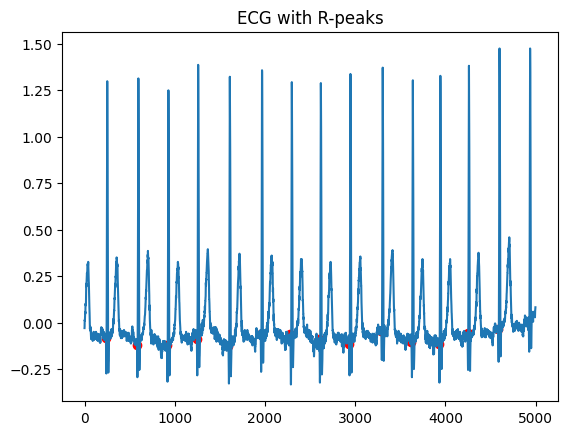

In [ ]:
plt.plot(sig[:, LEAD_INDEX])
plt.scatter(rpeaks, sig[rpeaks, LEAD_INDEX], c='r')
plt.title("ECG with R-peaks")
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


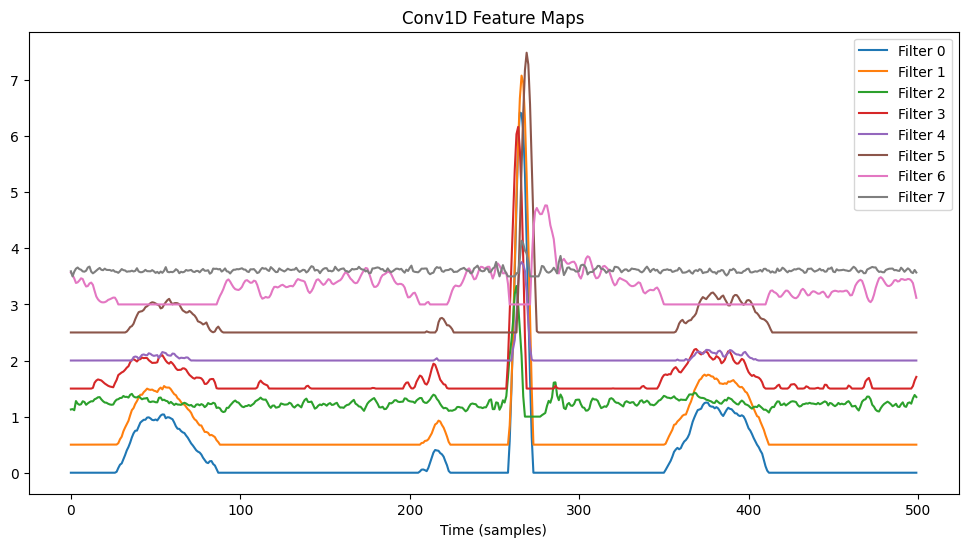

In [ ]:
from tensorflow.keras.models import Model

intermediate_model = Model(inputs=grad_model.input, outputs=grad_model.get_layer("conv1d_58").output)
feature_maps = intermediate_model.predict(X_test[:1])

plt.figure(figsize=(12, 6))
for i in range(min(8, feature_maps.shape[-1])):
    plt.plot(feature_maps[0, :, i] + i * 0.5, label=f'Filter {i}')
plt.title("Conv1D Feature Maps")
plt.xlabel("Time (samples)")
plt.legend()
plt.show()

In [ ]:
from scipy.ndimage import zoom

def generate_gradcam_1d(model, sample, class_index, target_layer_name):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(target_layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(tf.expand_dims(sample, axis=0))
        loss = predictions[:, class_index]

    grads = tape.gradient(loss, conv_outputs)[0]
    pooled_grads = tf.reduce_mean(grads, axis=0)

    cam = tf.reduce_sum(tf.multiply(pooled_grads, conv_outputs[0]), axis=-1)
    cam = np.maximum(cam, 0)
    cam /= np.max(cam) + 1e-6
    cam = zoom(cam, sample.shape[0] / cam.shape[0])
    return cam

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


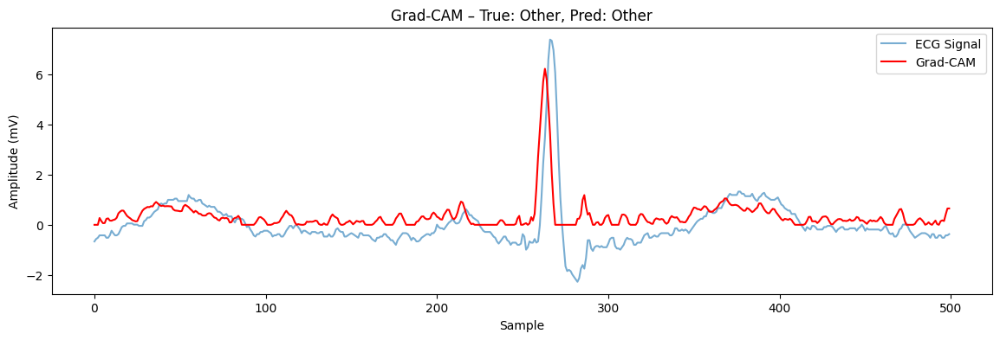

In [ ]:
sample_idx = 0
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_58")

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


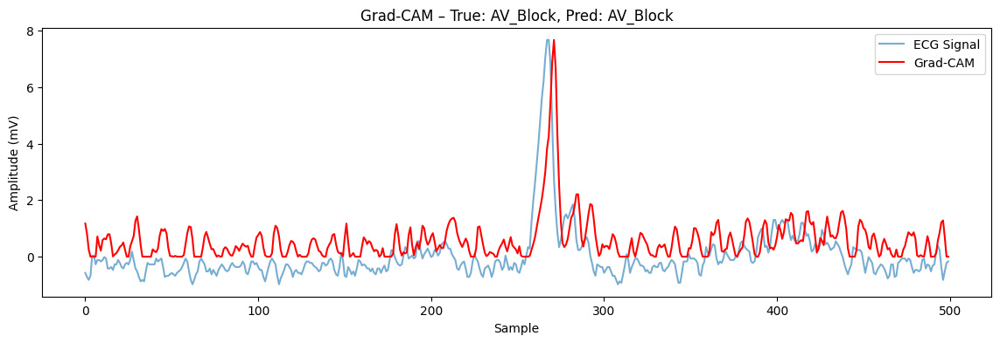

In [ ]:
sample_idx = 1
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_58")

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


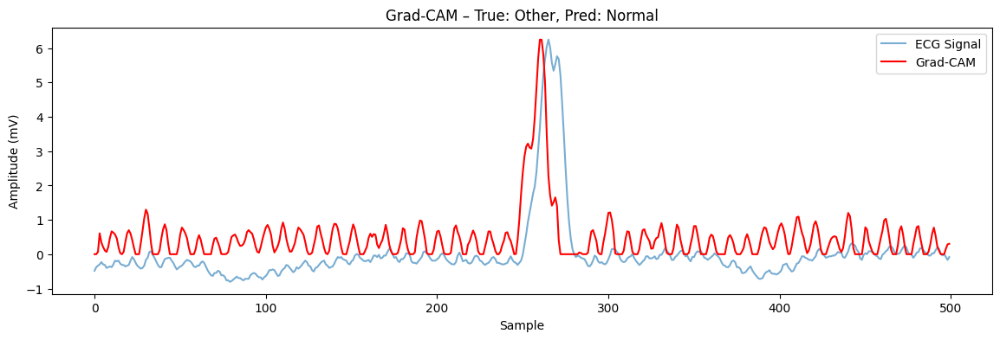

In [ ]:
sample_idx = 3
sample = X_test[sample_idx]
true_label = CLASS_NAMES[y_test[sample_idx]]
pred_label = CLASS_NAMES[grad_model.predict(sample[None, ...]).argmax()]
cam = generate_gradcam_1d(grad_model, sample, class_index=y_test[sample_idx], target_layer_name="conv1d_58")  # change name accordingly

plt.figure(figsize=(14, 4))
plt.plot(sample.squeeze(), label="ECG Signal", alpha=0.6)
plt.plot(cam * np.max(sample), label="Grad-CAM", color='red')
plt.title(f"Grad-CAM – True: {true_label}, Pred: {pred_label}")
plt.xlabel("Sample")
plt.ylabel("Amplitude (mV)")
plt.legend()
plt.show()

In [ ]:
CLASS_NAMES

['AFib', 'AV_Block', 'Normal', 'Other']

In [ ]:
cw

{0: 73.03224489795919,
 1: 1.0152806464059556,
 2: 5.434606973636253,
 3: 0.35494320638913246}

In [ ]:
y

array([2, 2, 2, ..., 3, 3, 3])

## Creating The ResNet Model (The main model of this study)

In [ ]:
def build_resnet64(input_shape: tuple[int, int], num_classes: int) -> tf.keras.Model:
    def res_block(x, filters, kernel_size=7):
        shortcut = x # Original input to the block

        # Apply 1x1 convolution to shortcut if its number of channels doesn't match 'filters'
        # This is the "projection shortcut"
        if shortcut.shape[-1] != filters:
            shortcut = layers.Conv1D(filters, 1, padding="same")(shortcut)
            shortcut = layers.BatchNormalization()(shortcut) # Often batch norm is applied here too

        # First Conv1D layer
        # Corrected: Removed `input_shape` from here, apply to `x` directly
        x = layers.Conv1D(filters, 1, activation='relu')(x) # Use `filters` here as well, not hardcoded 32
        x = layers.BatchNormalization()(x)
        x = layers.Activation("relu")(x) # This Activation after BN is typical

        # Second Conv1D layer
        x = layers.Conv1D(filters, kernel_size, padding="same")(x)
        x = layers.BatchNormalization()(x)

        # Now, x and shortcut should have the same number of filters/channels
        x = layers.Add()([x, shortcut])
        x = layers.Activation("relu")(x)
        return x

    inp = layers.Input(shape=input_shape)
    x = layers.Conv1D(32, 7, padding="same", activation="relu")(inp)
    x = layers.BatchNormalization()(x) # Added BatchNormalization after first Conv1D
    x = layers.MaxPooling1D(2)(x)

    for f in [32, 64, 64, 128, 128, 256]:
        x = res_block(x, f)
        # Apply MaxPooling1D *after* the residual block for downsampling the sequence length
        # and potentially adjusting filters for the *next* block if needed.
        # This if-condition seems to be aiming for downsampling the sequence.
        if f in {64, 128, 256}: # Downsample sequence length at certain stages
            x = layers.MaxPooling1D(2)(x)
            # When MaxPooling occurs, the sequence length changes, but the number of filters 'f' is already set
            # for the *next* block. The 'res_block' handles filter changes.

    x = layers.GlobalAveragePooling1D()(x)
    x = layers.Dense(128, activation="relu")(x)
    out = layers.Dense(num_classes, activation="softmax")(x)
    return models.Model(inp, out, name="ResNet1D")

## Training a Simple CNN Model

In [ ]:
model = models.Sequential([
    layers.Conv1D(32, 5, activation='relu', input_shape=X_train.shape[1:]),
    layers.MaxPooling1D(2),
    layers.Conv1D(64, 5, activation='relu'),
    layers.MaxPooling1D(2),
    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(1, activation='sigmoid')
])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

/Library/Frameworks/Python.framework/Versions/3.10/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv1d_35 (Conv1D)              │ (None, 496, 32)        │           192 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_10 (MaxPooling1D) │ (None, 248, 32)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv1d_36 (Conv1D)              │ (None, 244, 64)        │        10,304 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling1d_11 (MaxPooling1D) │ (None, 122, 64)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 7808)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │       499,776 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 510,337 (1.95 MB)

 Trainable params: 510,337 (1.95 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=30,
    batch_size=128,
    class_weight=cw,
    callbacks=[],
    verbose=2
)

Epoch 1/30
2796/2796 - 42s - 15ms/step - accuracy: 0.2462 - loss: -3.1160e+09 - val_accuracy: 0.2462 - val_loss: -4.0954e+10
Epoch 2/30
2796/2796 - 41s - 15ms/step - accuracy: 0.2462 - loss: -5.8902e+10 - val_accuracy: 0.2462 - val_loss: -3.8145e+11
Epoch 3/30
2796/2796 - 42s - 15ms/step - accuracy: 0.2462 - loss: -2.6879e+11 - val_accuracy: 0.2462 - val_loss: -1.3369e+12
Epoch 4/30


KeyboardInterrupt: 

## Training a ResNet Model

In [ ]:
model = build_resnet64(input_shape=X_train.shape[1:], num_classes=len(CLASS_NAMES))
model.compile(optimizer="adam", loss="sparse_categorical_crossentropy", metrics=["accuracy"])

cb_list = [
    callbacks.ReduceLROnPlateau(patience=3, factor=0.5, verbose=1),
    callbacks.EarlyStopping(patience=7, restore_best_weights=True, verbose=1)
]

history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=30,
    batch_size=128,
    class_weight=cw,
    callbacks=cb_list,
    verbose=2
)

Epoch 1/30
2796/2796 - 413s - 148ms/step - accuracy: 0.6341 - loss: 0.5546 - val_accuracy: 0.6763 - val_loss: 0.6625 - learning_rate: 0.0010
Epoch 2/30
2796/2796 - 431s - 154ms/step - accuracy: 0.6679 - loss: 0.4433 - val_accuracy: 0.6961 - val_loss: 0.5393 - learning_rate: 0.0010
Epoch 3/30
2796/2796 - 904s - 323ms/step - accuracy: 0.6832 - loss: 0.4051 - val_accuracy: 0.6923 - val_loss: 0.6049 - learning_rate: 0.0010
Epoch 4/30
2796/2796 - 2205s - 789ms/step - accuracy: 0.7000 - loss: 0.3734 - val_accuracy: 0.7225 - val_loss: 0.5514 - learning_rate: 0.0010
Epoch 5/30

Epoch 5: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
2796/2796 - 1294s - 463ms/step - accuracy: 0.7072 - loss: 0.3560 - val_accuracy: 0.7088 - val_loss: 0.5843 - learning_rate: 0.0010
Epoch 6/30
2796/2796 - 395s - 141ms/step - accuracy: 0.7311 - loss: 0.3056 - val_accuracy: 0.7351 - val_loss: 0.5209 - learning_rate: 5.0000e-04
Epoch 7/30
2796/2796 - 398s - 142ms/step - accuracy: 0.7416 - loss: 0.2

## Viewing the structure if the ResNet model

In [ ]:
model.summary()

Model: "ResNet1D"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_14      │ (None, 500, 1)    │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_58 (Conv1D)  │ (None, 500, 32)   │        256 │ input_layer_14[0… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 500, 32)   │        128 │ conv1d_58[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling1d_18    │ (None, 250, 32)   │          0 │ batch_normalizat… │
│ (MaxPooling1D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_59 (Conv1D)  │ (None, 250, 32)   │      1,056 │ max_pooling1d_18… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 250, 32)   │        128 │ conv1d_59[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_31       │ (None, 250, 32)   │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_60 (Conv1D)  │ (None, 250, 32)   │      7,200 │ activation_31[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 250, 32)   │        128 │ conv1d_60[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_21 (Add)        │ (None, 250, 32)   │          0 │ batch_normalizat… │
│                     │                   │            │ max_pooling1d_18… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_32       │ (None, 250, 32)   │          0 │ add_21[0][0]      │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_62 (Conv1D)  │ (None, 250, 64)   │      2,112 │ activation_32[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 250, 64)   │        256 │ conv1d_62[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_33       │ (None, 250, 64)   │          0 │ batch_normalizat… │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_63 (Conv1D)  │ (None, 250, 64)   │     28,736 │ activation_33[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1d_61 (Conv1D)  │ (None, 250, 64)   │      2,112 │ activation_32[0]… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 250, 64)   │        256 │ conv1d_63[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 250, 64)   │        256 │ conv1d_61[0][0]   │
│ (BatchNormalizatio… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add_22 (Add)        │ (None, 250, 64)   │          0 │ batch_normalizat

 Total params: 2,701,454 (10.31 MB)

 Trainable params: 899,268 (3.43 MB)

 Non-trainable params: 3,648 (14.25 KB)

 Optimizer params: 1,798,538 (6.86 MB)

## Visualization of training result

2397/2397 ━━━━━━━━━━━━━━━━━━━━ 32s 13ms/step
              precision    recall  f1-score   support

        AFib       0.73      0.81      0.77       263
    AV_Block       0.86      0.95      0.91     18882
      Normal       0.24      0.76      0.36      3527
       Other       0.96      0.79      0.87     54012

    accuracy                           0.83     76684
   macro avg       0.70      0.83      0.73     76684
weighted avg       0.90      0.83      0.85     76684



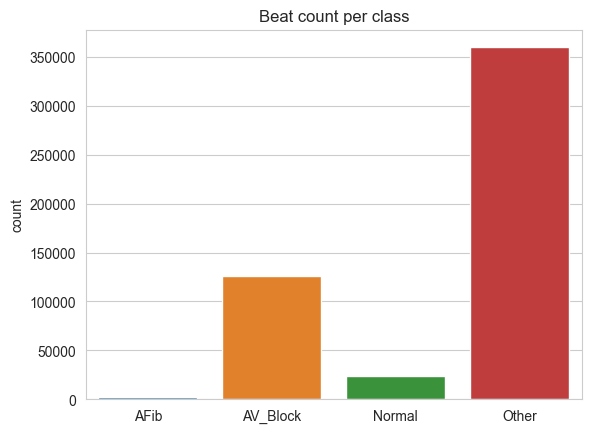

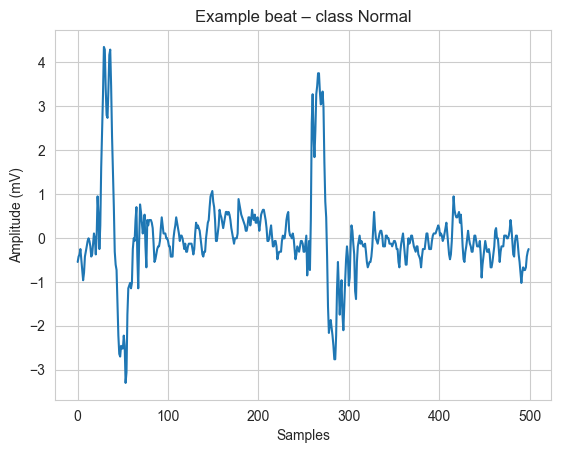

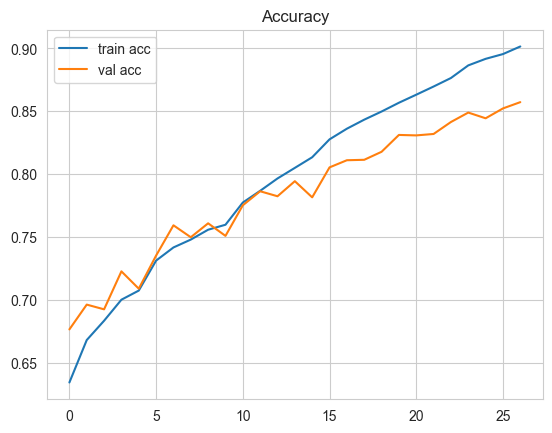

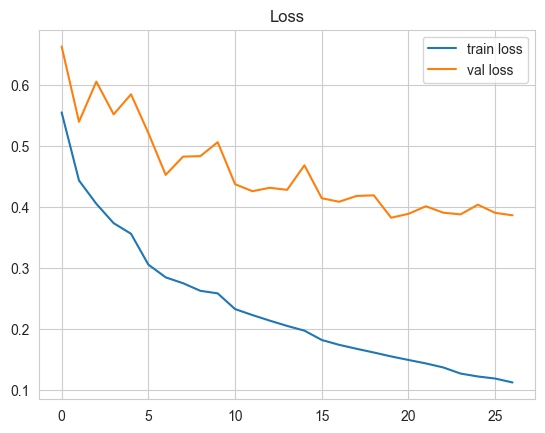

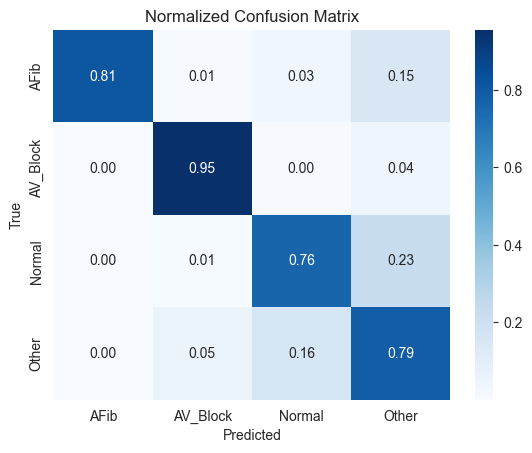

In [ ]:
y_pred = model.predict(X_test).argmax(axis=1)
print(classification_report(y_test, y_pred, target_names=CLASS_NAMES))

cm = confusion_matrix(y_test, y_pred, normalize="true")
sns.set_style("whitegrid")

sns.countplot(x=labels, order=CLASS_NAMES)
plt.title("Beat count per class")
plt.show()

plt.plot(X[0].squeeze())
plt.title(f"Example beat – class {CLASS_NAMES[y[0]]}")
plt.xlabel("Samples")
plt.ylabel("Amplitude (mV)")
plt.show()

plt.plot(history.history["accuracy"], label="train acc")
plt.plot(history.history["val_accuracy"], label="val acc")
plt.legend(); plt.title("Accuracy")
plt.show()

plt.plot(history.history["loss"], label="train loss")
plt.plot(history.history["val_loss"], label="val loss")
plt.legend(); plt.title("Loss")
plt.show()

sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=CLASS_NAMES, yticklabels=CLASS_NAMES, fmt=".2f")
plt.ylabel("True")
plt.xlabel("Predicted")
plt.title("Normalized Confusion Matrix")
plt.show()

## Saving the trained Model

In [ ]:
model.save("resnet_ecg.h5")
print("Model saved.")

Model saved.


In [ ]:
#creating mobile friendly model using TF Lite
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

with open('ecg.tflite', 'wb') as f:
    f.write(tflite_model)

INFO:tensorflow:Assets written to: /var/folders/r4/xgwc_q155gg559hp47mlyhhc0000gn/T/tmp99r3ul1o/assets


INFO:tensorflow:Assets written to: /var/folders/r4/xgwc_q155gg559hp47mlyhhc0000gn/T/tmp99r3ul1o/assets


Saved artifact at '/var/folders/r4/xgwc_q155gg559hp47mlyhhc0000gn/T/tmp99r3ul1o'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 500, 1), dtype=tf.float32, name='keras_tensor_175')
Output Type:
  TensorSpec(shape=(None, 4), dtype=tf.float32, name=None)
Captures:
  14857368704: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13683509024: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13683522048: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13683513952: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13683508144: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13683522928: TensorSpec(shape=(), dtype=tf.resource, name=None)
  14864410128: TensorSpec(shape=(), dtype=tf.resource, name=None)
  14857359728: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13676468656: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13676469360: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13681555968

W0000 00:00:1752271348.976731 4817377 tf_tfl_flatbuffer_helpers.cc:365] Ignored output_format.
W0000 00:00:1752271348.977090 4817377 tf_tfl_flatbuffer_helpers.cc:368] Ignored drop_control_dependency.
2025-07-11 23:02:28.979679: I tensorflow/cc/saved_model/reader.cc:83] Reading SavedModel from: /var/folders/r4/xgwc_q155gg559hp47mlyhhc0000gn/T/tmp99r3ul1o
2025-07-11 23:02:28.982499: I tensorflow/cc/saved_model/reader.cc:52] Reading meta graph with tags { serve }
2025-07-11 23:02:28.982510: I tensorflow/cc/saved_model/reader.cc:147] Reading SavedModel debug info (if present) from: /var/folders/r4/xgwc_q155gg559hp47mlyhhc0000gn/T/tmp99r3ul1o
I0000 00:00:1752271349.010270 4817377 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled
2025-07-11 23:02:29.014524: I tensorflow/cc/saved_model/loader.cc:236] Restoring SavedModel bundle.
2025-07-11 23:02:29.201070: I tensorflow/cc/saved_model/loader.cc:220] Running initialization op on SavedModel bundle at path: /var/folder

In [ ]:
tflite_model.decode

<function bytes.decode(encoding='utf-8', errors='strict')>

In [ ]:
tf.lite.experimental.Analyzer.analyze(model_content=tflite_model)

=== TFLite ModelAnalyzer ===

Your TFLite model has '1' subgraph(s). In the subgraph description below,
T# represents the Tensor numbers. For example, in Subgraph#0, the EXPAND_DIMS op takes
tensor #0 and tensor #61 as input and produces tensor #63 as output.

Subgraph#0 main(T#0) -> [T#146]
  Op#0 EXPAND_DIMS(T#0, T#61[-3]) -> [T#63]
  Op#1 CONV_2D(T#63, T#42, T#25) -> [T#64]
  Op#2 MUL(T#64, T#58) -> [T#65]
  Op#3 ADD(T#65, T#57) -> [T#66]
  Op#4 RESHAPE(T#66, T#35[-1, 500, 32]) -> [T#67]
  Op#5 EXPAND_DIMS(T#67, T#62[1]) -> [T#68]
  Op#6 MAX_POOL_2D(T#68) -> [T#69]
  Op#7 RESHAPE(T#69, T#34[-1, 250, 32]) -> [T#70]
  Op#8 EXPAND_DIMS(T#70, T#61[-3]) -> [T#71]
  Op#9 CONV_2D(T#71, T#41, T#24) -> [T#72]
  Op#10 MUL(T#72, T#56) -> [T#73]
  Op#11 ADD(T#73, T#55) -> [T#74]
  Op#12 RESHAPE(T#74, T#34[-1, 250, 32]) -> [T#75]
  Op#13 EXPAND_DIMS(T#75, T#61[-3]) -> [T#76]
  Op#14 CONV_2D(T#76, T#18, T#9) -> [T#77]
  Op#15 RESHAPE(T#77, T#34[-1, 250, 32]) -> [T#78]
  Op#16 ADD(T#78, T#70) -> [

## TF Lite Test


Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.81      0.77       263
           1       0.86      0.95      0.91     18882
           2       0.24      0.76      0.36      3527
           3       0.96      0.79      0.87     54012

    accuracy                           0.83     76684
   macro avg       0.70      0.83      0.73     76684
weighted avg       0.90      0.83      0.85     76684



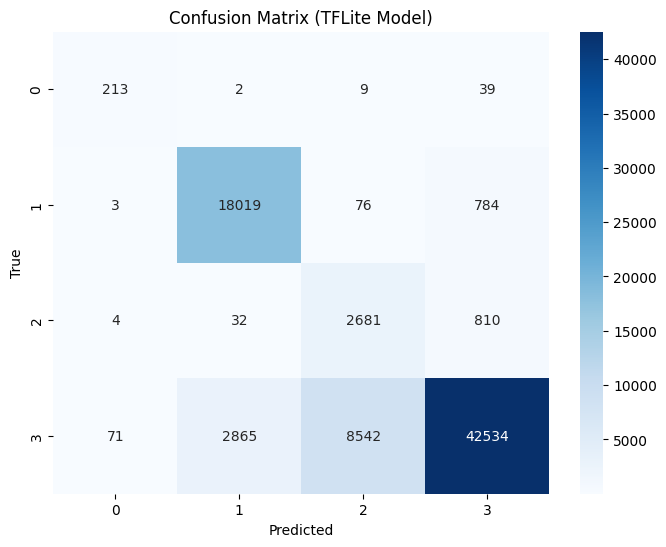

TFLite Model Accuracy: 82.74%
Average inference time per sample: 1.0626 ms
Total inference time for 76684 samples: 81.7447 s


In [ ]:
import time

TFLITE_MODEL_PATH = "models/ecg.tflite"

interpreter = tf.lite.Interpreter(model_path=TFLITE_MODEL_PATH)
interpreter.allocate_tensors()

# Get input & output details
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()


X_test = np.load("X_test.npy")  # Shape: (num_samples, seq_len, 1)
y_test = np.load("y_test.npy")  # Shape: (num_samples,)
X_test = X_test.astype(input_details[0]['dtype'])


y_pred = []
inference_times = []
start_total = time.perf_counter()

for i in range(len(X_test)):
    input_data = np.expand_dims(X_test[i], axis=0)
    start_time = time.perf_counter()
    interpreter.set_tensor(input_details[0]['index'], input_data)
    interpreter.invoke()
    output_data = interpreter.get_tensor(output_details[0]['index'])
    end_time = time.perf_counter()
    inference_times.append(end_time - start_time)
    y_pred.append(np.argmax(output_data))

end_total = time.perf_counter()

y_pred = np.array(y_pred)


print("\nClassification Report:")
print(classification_report(y_test, y_pred))


cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.title("Confusion Matrix (TFLite Model)")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.show()


accuracy = np.mean(y_pred == y_test)
print(f"TFLite Model Accuracy: {accuracy * 100:.2f}%")

avg_time_ms = np.mean(inference_times) * 1000
total_time_s = end_total - start_total
print(f"Average inference time per sample: {avg_time_ms:.4f} ms")
print(f"Total inference time for {len(X_test)} samples: {total_time_s:.4f} s")